# Final project: Temporal Link Prediction Model for Weighted Dynamic Networks

Welcome to our final project, we utilize GCN GAN to create this project.

In this version, the dataset that is used is USCB taken from the paper of _GCN-GAN_.

The USCB is a link-quality dataset of a wireless mesh network. The hosts in the network systems can be described as the nodes in the dynamic networks.

The statistic of UCSB is illustrated in Fig. 2 as an example, in which w (the horizontal axis) represents the possible edge weight value of the dataset, while c(w) represents the number of edges with value w. Note that we use the logarithm of c(w) as the vertical axis.
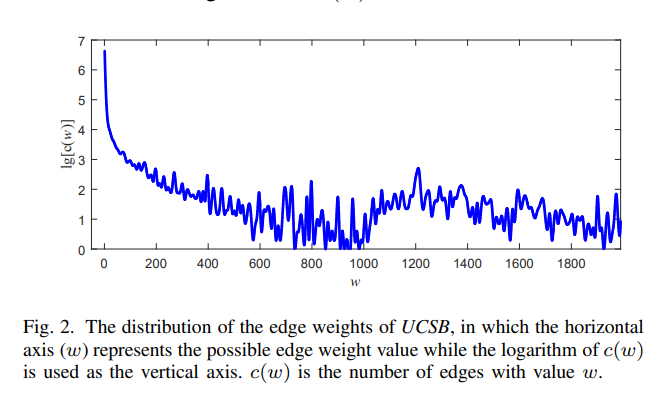


In the dataset of USCB, you can find 1005 files, of the edge list. 
In each file ther is three numbers:

- [X] _The first:_ is the index of the source node
- [X] _The second:_ is the index of the target node
- [X] _The third:_ is the weight of the edge, while of curse the maximum is _Threshold of the maximum edge weight = max_thres._



# Explain abuot ouer dataset:
the site we taken the datasets is: [figshare](https://nih.figshare.com/search?q=:keyword:%20%22Citation%20data%22)
and I select the smallest one so we can run it despite the lack of RAN & time: [iCite Database Snapshot 2020-04](https://nih.figshare.com/articles/dataset/iCite_Database_Snapshot_2020-04/12288581?file=22650896)

- open_citation_collection.csv: this file contin two column: 
        - citing
        - referenced
        
        and ther is about 1048576 rows.
        
- icite_metadata.csv: this file contian the articals:: title authors .. he data of        
  The data of 'open_citation_collection.csv' taken from the columns: 'pmid' and 'cited_by'.
  
so now all we need to do is to explain how to create a graphs from this OR to adjust this code to read the format of this dataset.
  


## RMSProp:


## Adam:
Its optimization algorithem, it contiaon the momentun and RmsProp plus the Bias corrction - but not always (somtimes the Bias isnt take into accont). 



In [1]:
import numpy as np
import tensorflow.compat.v1 as tf
from tensorflow import keras
from tensorflow.keras import layers

#disabled v2 behavior to fix runtime bugs
tf.disable_v2_behavior()

# _utils:_ Function related to the dataset and initializations

In [2]:
def read_data(name_pre, time_index, node_num, max_thres):
    '''
    Function to read the network snapshot of specific time slice
    :param name_pre: the name prefix of the data file
    :param time_index: index of time slice
    :param node_num: number of nodes in the dynamic network
    :param max_thres: threshold of the maximum edge weight
    :return: adjacency matrix of the specific time slice
    '''
    print('Read network snapshot #%d'%(time_index))
    # Initialize the adjacency matrix
    curAdj = np.mat(np.zeros((node_num, node_num)))
    # Read the network snapshot of current time slice
    f = open('%s_%d.txt'%(name_pre, time_index))
    line = f.readline()
    while line:
        seq = line.split()
        #print(seq)
        src = int(seq[0]) #Index of the source node
        tar = int(seq[1]) #Index of the target node
        seq[2] = float(seq[2])
        
        # The weight of the edge, the maximum is Threshold of the maximum edge weight.
        if seq[2]>max_thres:
            seq[2] = max_thres

        # Update the adjacency matrix
        curAdj[src, tar] = seq[2]
        curAdj[tar, src] = seq[2]
        line = f.readline()
    f.close()
    return curAdj

def var_init(m, n):
    '''
    Function to initialze the weight matrix
    :param m: number of rows of the weight matrix
    :param n: number of column of the weight matrix
    :return: the initialized weight matrix
    '''
    # in_dim = size[0]
    # w_stddev = 1. / tf.sqrt(in_dim / 2.)
    # return tf.random_normal(shape=size, stddev=w_stddev)
    init_range = np.sqrt(6.0 / (m+n))
    initial = tf.random_uniform([m, n], minval=-init_range, maxval=init_range, dtype=tf.float32)
    return tf.Variable(initial)

def gen_noise(m, n):
    '''
    Function to generative noises with uniform discribution
    :param m: number of rows of the noise matrix
    :param n: number of columns of the noise matrix
    :return: the noise matrix
    '''
    return np.random.uniform(0, 1., size=[m, n])
    #return np.random.normal(0.5, 1, [m, n])

def get_gcn_fact(adj):
    '''
    Function to calculate the GCN factor of a certain network snapshot
    :param adj: the adjacency matrix of a specific network snapshot
    :return: the corresponding GCN factor
    '''
    adj_ = adj + np.eye(node_num, node_num)
    row_sum = np.array(adj_.sum(1))
    d_inv_sqrt = np.power(row_sum, -0.5).flatten()
    d_inv_sqrt[np.isinf(d_inv_sqrt)] = 0.
    d_mat_inv_sqrt = np.mat(np.diag(d_inv_sqrt))
    gcn_fact = d_mat_inv_sqrt*adj_*d_mat_inv_sqrt # The GCN factor

    return gcn_fact

def get_noise_inputs():
    '''
    Function to construct the noise input list of the generaive network's GCN units
    :return: the noise list 
    '''
    # Construct the noise input list of the generative network
    noise_inputs = []
    for i in range(window_size+1):
        noise_inputs.append(gen_noise(node_num, node_num))
    return noise_inputs

# _utils:_ Function related to the network

In [3]:

def gen_net(noise_input_phs, gcn_fact_phs):
    '''
    Function to define the generative network
    :param noise_input_phs: list of the noise inputs
    :param gcn_fact_phs: list of the GCN factors 
    :return:
        gen_output: the output of the generative network
        LSTM_params: list of all the parameters in the LSTM hidden layer 
    '''
    # +--------------------+
    
    # GCN Input Layer -> LSTM Hidden Layer
    gcn_outputs = [] # Tensor list of the GCN Units' output 
    for i in range(window_size+1):
        noise = noise_input_phs[i]
        gcn_fact = gcn_fact_phs[i]
        gcn_wei = gcn_weis[i]
        # +----------+
        # Conduct the GCN operation
        gcn_conv = tf.matmul(gcn_fact, noise)
        gcn_output = tf.sigmoid(tf.matmul(gcn_conv, gcn_wei))
        # +----------+
        # Reshape the output of current GCN unit
        gcn_output = tf.reshape(gcn_output, [1, node_num*gen_hid_num0])
        # +----------+
        # Add current output to the tensor list
        gcn_outputs.append(gcn_output)
    # +--------------------+
    
    # LSTM Hidden Layer -> Output Layer
    LSTM_cells = rnn.rnn_cell.MultiRNNCell([rnn.rnn_cell.LSTMCell(node_num*gen_hid_num0)]) 
    with tf.variable_scope("gen_net") as gen_net:
        LSTM_outputs, states = rnn.static_rnn(LSTM_cells, gcn_outputs, dtype=tf.float32)
        # Get the parameters of the generative network
        LSTM_params = [var for var in tf.global_variables() if var.name.startswith(gen_net.name)]
    # +--------------------+
    
    # Output Layer
    gen_output = tf.nn.sigmoid(tf.matmul(LSTM_outputs[-1], gen_output_wei) + gen_output_bias)

    return gen_output, LSTM_params

def disc_net(disc_input):
    '''
    Function to define the discriminative network
    :param disc_input: the input of the discriminative network
    :return:
        disc_output: the output of the discriminative network
        disc_logit: the output of the output layer (without activation function)
        disc_params: the parameters of the discriminative network
    '''
    # Input layer -> hidden layer #1
    disc_h1 = tf.nn.sigmoid(tf.matmul(disc_input, disc_wei1) + disc_bias1)
    # Hidden layer #1 -> Output layer
    disc_logit = tf.matmul(disc_h1, disc_wei2) + disc_bias2
    disc_output = tf.nn.sigmoid(disc_logit)

    return disc_output, disc_logit

def get_wei_KL(adj_est, gnd):
    '''
    Function to calculate the edge weight KL divergence
    :param adj_est: prediction result
    :param gnd: ground-truth
    :return: edge weight KL divergence
    '''
    sum_est = 0
    for r in range(node_num):
        for c in range(node_num):
            sum_est += adj_est[r, c]
    sum_gnd = 0
    for r in range(node_num):
        for c in range(node_num):
            sum_gnd += gnd[r, c]
    p = gnd/sum_gnd
    q = adj_est/sum_est
    edge_wei_KL = 0
    for r in range(node_num):
        for c in range(node_num):
            cur_KL = 0
            if q[r, c]>0 and p[r, c]>0:
                cur_KL = p[r, c]*np.log(p[r, c]/q[r, c])
            edge_wei_KL += cur_KL

    return edge_wei_KL

def get_mis_rate(adj_est, gnd):
    mis_sum = 0
    for r in range(node_num):
        for c in range(node_num):
            if (adj_est[r, c]>0 and gnd[r, c]==0) or (adj_est[r, c]==0 and gnd[r, c]>0):
                mis_sum += 1
    mis_rate = mis_sum/(node_num*node_num)

    return mis_rate

# Define the constant parameters

In [4]:
rnn = tf.nn

# +----------------------------------------+
# Set the parameters of the dynamic network
node_num = 38 # Number of nodes in the dynamic network
#node_num = 92
#+-----+
time_num = 1000 # Number of time slices
# time_num = 500

#+-----+
window_size = 10 # Window size of the history network snapshot to be considered
# +-----------+
name_pre = "/kaggle/input/dataset/GCN-GAN/data/data/UCSB/edge_list" # Prefix name of the data file- the path from my drive 
#+----------+
max_thres = 2000 # Threshold of the maximum edge weight
#max_thres = 250
# +--------------------+

# Define the parameters of the nueral network
pre_epoch_num = 1000 # Number of pre-training epoches
epoch_num = 4000 # Number of training epoches
# 4000 (UCSB) 5000 (KAIST)
# +----------+

# Define the parameters of the generative network
gen_hid_num0 = 1
gen_hid_num1 = 64
# +-----+

In [5]:
# GCN Input Layer -> LSTM hideen Layer
gcn_weis = [] # List of the weighted matrixes of the GCN units GCN单元权重矩阵的列表
for i in range(window_size+1):
    gcn_weis.append(tf.Variable(var_init(node_num, gen_hid_num0)))
# +-----+

# LSTM Hidden Layer -> Output Layer
gen_output_wei = tf.Variable(var_init(node_num*gen_hid_num0, node_num*node_num))
gen_output_bias = tf.Variable(tf.zeros(shape=[node_num*node_num]))
# +-----+

# Parameter list of the generative network's output layer
gen_output_params = [gen_output_wei, gen_output_bias]
# +----------+

# Define the parameters of the discriminative network
disc_hid_num = 1024
# Input Layer -> Hidden Layer 1
disc_wei1 = tf.Variable(var_init(node_num*node_num, disc_hid_num))
disc_bias1 = tf.Variable(tf.zeros([disc_hid_num]))
# +-----+

# Hidden Layer 1 -> Output Layer
disc_wei2 = tf.Variable(var_init(disc_hid_num, 1))
disc_bias2 = tf.Variable(tf.zeros([1]))
# +-----+

# Parameter list of the discriminative network
disc_params = [disc_wei1, disc_bias1, disc_wei2, disc_bias2]
# +---------+

# Clipping bound for WGAN's traning process 
clip_ops = []
for var in disc_params:
    clip_bound = [-0.01, 0.01]
    clip_ops.append(
        tf.assign(var, tf.clip_by_value(var, clip_bound[0], clip_bound[1]))
    )
clip_disc_wei = tf.group(*clip_ops)
# +---------------------+

# Define the TF placeholders
gcn_fact_phs = [] # Placeholder list of the GCN factors 
noise_input_phs = [] # Placeholder list of the noise inpus 
for i in range(window_size+1):
    gcn_fact_phs.append(tf.placeholder(tf.float32, shape=[node_num, node_num]))
    noise_input_phs.append(tf.placeholder(tf.float32, shape=[node_num, node_num]))
# +----------+

gnd_ph = tf.placeholder(tf.float32, shape=(1, node_num*node_num)) # Placeholder of the ground-truth 

In [6]:
# Construct the GAN
gen_output, LSTM_params = gen_net(noise_input_phs, gcn_fact_phs)
disc_real, disc_logit_real = disc_net(gnd_ph)
disc_fake, disc_logit_fake = disc_net(gen_output)

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:31: UserWarning: `tf.nn.rnn_cell.LSTMCell` is deprecated and will be removed in a future version. This class is equivalent as `tf.keras.layers.LSTMCell`, and will be replaced by that in Tensorflow 2.0.


In [7]:
# Define the loss functin for the pre-train process of the generative network
pre_gen_loss = tf.reduce_sum(tf.square(gnd_ph - gen_output))

# Difine the optimizer for the pre-train process of the generative network
#pre_gen_opt = tf.train.AdamOptimizer().minimize(pre_gen_loss, var_list=(gcn_weis+LSTM_params+gen_output_params))
pre_gen_opt = tf.train.RMSPropOptimizer(learning_rate=0.005).minimize(pre_gen_loss, var_list=(gcn_weis+LSTM_params+gen_output_params))
# 0.005 (UCSB)

In [8]:
# Define the loss function for GAN
gen_loss = -tf.reduce_mean(disc_logit_fake)
disc_loss = tf.reduce_mean(disc_logit_fake) - tf.reduce_mean(disc_logit_real)

#disc_loss = -tf.reduce_mean(tf.log(disc_real) + tf.log(1.-disc_fake))
#gen_loss = -tf.reduce_mean(tf.log(disc_fake))
# +----------------------+
#disc_loss_real = tf.reduce_mean(
#    tf.nn.sigmoid_cross_entropy_with_logits(logits=disc_logit_real, labels=tf.ones_like(disc_logit_real)))
#disc_loss_fake = tf.reduce_mean(
#    tf.nn.sigmoid_cross_entropy_with_logits(logits=disc_logit_fake, labels=tf.zeros_like(disc_logit_fake)))
#disc_loss = disc_loss_real + disc_loss_fake
#gen_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=disc_logit_fake, labels=tf.ones_like(disc_logit_fake)))
# +------------------------+

In [9]:
# Define the optimizer for the generative network and the discriminative network
disc_opt = tf.train.RMSPropOptimizer(learning_rate=0.001).minimize(disc_loss, var_list=disc_params)
gen_opt = tf.train.RMSPropOptimizer(learning_rate=0.001).minimize(gen_loss, var_list=(gcn_weis+LSTM_params+gen_output_params))
# 0.001, 0.001 (UCSB) 0.0005 0.0005 (KAIST)

#gen_opt = tf.train.RMSPropOptimizer(learning_rate=5e-5).minimize(gen_loss, var_list=(LSTM_params+gen_output_params))
#disc_opt = tf.train.RMSPropOptimizer(learning_rate=5e-5).minimize(disc_loss, var_list=disc_params)

#disc_opt = tf.train.AdamOptimizer().minimize(disc_loss, var_list=disc_params)
#gen_opt = tf.train.AdamOptimizer().minimize(gen_loss, var_list=(LSTM_params+gen_output_params))


## Define and initialize a constant parameters

In [10]:
avg_error = 0.0
avg_KL = 0.0
avg_mis = 0.0
cal_count = 0

# Define an arrays for the diagram output
error_array = []
avg_KL_array = []
avg_mis_array = []
time_num_array = []

# Run the neural network 

In [11]:
tf.disable_eager_execution()
sess = tf.Session()
init = tf.global_variables_initializer()
sess.run(init)

In [12]:
for t in range(window_size, time_num-2):
    # Construct the GCN factor list of the generative network
    gcn_facts = []
    for k in range(t-window_size, t+1):
        # Read and normalize the adjacency matrix
        adj = read_data(name_pre, k, node_num, max_thres)/max_thres
        gcn_fact = get_gcn_fact(adj)
        gcn_facts.append(gcn_fact)
    # +--------------------+
    
    # Construct the ground-truth vector
    gnd = np.reshape(read_data(name_pre, t+1, node_num, max_thres ), (1, node_num*node_num))
    gnd /= max_thres

    # +----------------------+
    # Pretrain the generative network
    loss_list = []
    for epoch in range(pre_epoch_num):
        # Construct the noise input list of the generative network
        noise_inputs = get_noise_inputs()
        # +----------+
        
        # Construct the placeholder feed dictionary 
        ph_dict = dict(zip(noise_input_phs, noise_inputs))
        ph_dict.update(dict(zip(gcn_fact_phs, gcn_facts)))
        ph_dict.update({gnd_ph: gnd})
        _, pre_g_loss, pre_g_output = sess.run([pre_gen_opt, pre_gen_loss, gen_output], feed_dict=ph_dict)
        loss_list.append(pre_g_loss)
        if epoch%100==0:
            print('Pre-Train #%d, G-Loss: %f'%(epoch, pre_g_loss))
        if epoch>500 and loss_list[epoch]>loss_list[epoch-1] and loss_list[epoch-1]>loss_list[epoch-2]:
            break

    # +----------------------+
    # Train the GAN
    print('Train the GAN')
    for epoch in range(epoch_num):
        # Train the discriminative network
        # Construct the noise input list of the generative network 
        noise_inputs = get_noise_inputs()
        # +----------+
        
        # Construct the placeholder feed dictionary 
        ph_dict = dict(zip(noise_input_phs, noise_inputs))
        ph_dict.update(dict(zip(gcn_fact_phs, gcn_facts)))
        ph_dict.update({gnd_ph : gnd})
        _, d_loss = sess.run([disc_opt, disc_loss], feed_dict=ph_dict)
        # +--------------------+
        # Train the generative network
        # Construct the noise input list of the generative network 
        noise_inputs = get_noise_inputs()
        # +----------+
        
        # Construct the placeholder feed dictionary 
        ph_dict = dict(zip(noise_input_phs, noise_inputs))
        ph_dict.update(dict(zip(gcn_fact_phs, gcn_facts)))
        #ph_dict.update({gnd_ph: gnd})
        _, g_loss, g_output = sess.run([gen_opt, gen_loss, gen_output], feed_dict=ph_dict)
        # +----------+
        _ = sess.run(clip_disc_wei)
        # +--------------------+
        # Refine the generative network
        # Construct the noise input list of the generative network
        #noise_inputs = get_noise_inputs()
        # +----------+
        # Construct the placeholder feed dictionary 
        #ph_dict = dict(zip(noise_input_phs, noise_inputs))
        #ph_dict.update(dict(zip(gcn_fact_phs, gcn_facts)))
        #ph_dict.update({gnd_ph: gnd})
        #_, pre_g_loss, pre_g_output = sess.run([pre_gen_opt, pre_gen_loss, gen_output], feed_dict=ph_dict)

        if epoch%100==0:
            print('GAN-Train #%d, D-Loss: %f, G-Loss: %f'%(epoch, d_loss, g_loss))

    # +--------------------+
    # Conduct a prediction process
    # Construct the GCN factor list of the generative network
    gcn_facts = []
    for k in range(t-window_size+1, t+2):
        # Read and normalize the adjacency matrix
        adj = read_data(name_pre, k, node_num, max_thres)/max_thres
        gcn_fact = get_gcn_fact(adj)
        gcn_facts.append(gcn_fact)
    # +----------+
    
    # Construct the noise input list of the generative network
    noise_inputs = get_noise_inputs()
    # +----------+
    # Construct the placeholder feed dictionary
    ph_dict = dict(zip(noise_input_phs, noise_inputs))
    ph_dict.update(dict(zip(gcn_fact_phs, gcn_facts)))
    output = sess.run([gen_output], feed_dict=ph_dict)
    # +----------+
    
    # Reshape the prediction result 
    adj_est = np.reshape(output[0]*max_thres, (node_num, node_num))
    adj_est = (adj_est+adj_est.T)/2
    for r in range(node_num):
        adj_est[r, r] = 0
    for r in range(node_num):
        for c in range(node_num):
            if adj_est[r, c]<0.01:
                adj_est[r, c] = 0

    gnd = read_data(name_pre, t+2, node_num, max_thres)

    print('adj_est')
    for r in range(node_num):
       for c in range(node_num):
           print('%.2f'%(adj_est[c, r]), end=' ')
       print()
    print('gnd')
    for r in range(node_num):
       for c in range(node_num):
           print('%.2f'%(gnd[r, c]), end=' ')
       print()

#     print('adj_est')
#     for r in range(50):
#         print('%.2f' % (adj_est[1, r]), end=' ')
#     print()
#     print('gnd')
#     for r in range(50):
#         print('%.2f' % (gnd[1, c]), end=' ')
    print()
    
    time_num_array.append(int(t+2))
    
    error = np.linalg.norm(gnd-adj_est, ord='fro')/(node_num*node_num)
    error_array.append(error)
    avg_error += error
    print('#%d Error: %f' % (t+2, error))
    

    edge_wei_KL = get_wei_KL(adj_est, gnd)
    avg_KL_array.append(edge_wei_KL)
    avg_KL += edge_wei_KL
    print('#%d Edge Weight KL: %f' % (t + 2, edge_wei_KL))

    mis_rate = get_mis_rate(adj_est, gnd)
    avg_mis_array.append(mis_rate)
    avg_mis += mis_rate
    print('#%d Mismatch Rate: %f' % (t + 2, mis_rate))

    print()

    cal_count += 1

    f = open("+UCSB-LSTM_GAN_GCN-rror.txt", 'a+')
    #f = open("+KAIST-LSTM_GAN_GCN-error.txt", 'a+')
    f.write('%d %f' % (t + 2, error))
    f.write('\n')
    f.close()

    f = open("+UCSB-LSTM_GAN_GCN-KL.txt", 'a+')
    #f = open("+KAIST-LSTM_GAN_GCN_KL.txt", 'a+')
    f.write('%d %f' % (t + 2, edge_wei_KL))
    f.write('\n')
    f.close()

    f = open("+UCSB-LSTM_GAN_GCN-mis.txt", 'a+')
    #f = open("+KAIST-LSTM_GAN_GCN-mis.txt", 'a+')
    f.write('%d %f' % (t + 2, mis_rate))
    f.write('\n')
    f.close()


Read network snapshot #0
Read network snapshot #1
Read network snapshot #2
Read network snapshot #3
Read network snapshot #4
Read network snapshot #5
Read network snapshot #6
Read network snapshot #7
Read network snapshot #8
Read network snapshot #9
Read network snapshot #10
Read network snapshot #11


Pre-Train #0, G-Loss: 358.641510


Pre-Train #100, G-Loss: 0.637204


Pre-Train #200, G-Loss: 0.006139


Pre-Train #300, G-Loss: 0.003338


Pre-Train #400, G-Loss: 0.003246


Pre-Train #500, G-Loss: 0.003216


Train the GAN


GAN-Train #0, D-Loss: -0.000064, G-Loss: 0.645584


GAN-Train #100, D-Loss: -0.000032, G-Loss: 0.112030


GAN-Train #200, D-Loss: -0.000227, G-Loss: -0.027018


GAN-Train #300, D-Loss: -0.001067, G-Loss: -0.292251


GAN-Train #400, D-Loss: -0.001065, G-Loss: -0.449311


GAN-Train #500, D-Loss: -0.000872, G-Loss: -0.526784


GAN-Train #600, D-Loss: -0.000720, G-Loss: -0.564711


GAN-Train #700, D-Loss: -0.000598, G-Loss: -0.587082


GAN-Train #800, D-Loss: -0.000473, G-Loss: -0.605980


GAN-Train #900, D-Loss: -0.000425, G-Loss: -0.632402


GAN-Train #1000, D-Loss: -0.000363, G-Loss: -0.623743


GAN-Train #1100, D-Loss: -0.000323, G-Loss: -0.645126


GAN-Train #1200, D-Loss: -0.000267, G-Loss: -0.628275


GAN-Train #1300, D-Loss: -0.000258, G-Loss: -0.640177


GAN-Train #1400, D-Loss: -0.000232, G-Loss: -0.660111


GAN-Train #1500, D-Loss: -0.000217, G-Loss: -0.659364


GAN-Train #1600, D-Loss: -0.000188, G-Loss: -0.665637


GAN-Train #1700, D-Loss: -0.000188, G-Loss: -0.672947


GAN-Train #1800, D-Loss: -0.000170, G-Loss: -0.656651


GAN-Train #1900, D-Loss: -0.000168, G-Loss: -0.666347


GAN-Train #2000, D-Loss: -0.000167, G-Loss: -0.673093


GAN-Train #2100, D-Loss: -0.000153, G-Loss: -0.690250


GAN-Train #2200, D-Loss: -0.000132, G-Loss: -0.665322


GAN-Train #2300, D-Loss: -0.000125, G-Loss: -0.672027


GAN-Train #2400, D-Loss: -0.000112, G-Loss: -0.670201


GAN-Train #2500, D-Loss: -0.000095, G-Loss: -0.691378


GAN-Train #2600, D-Loss: -0.000097, G-Loss: -0.676200


GAN-Train #2700, D-Loss: -0.000100, G-Loss: -0.686438


GAN-Train #2800, D-Loss: -0.000090, G-Loss: -0.675310


GAN-Train #2900, D-Loss: -0.000085, G-Loss: -0.692938


GAN-Train #3000, D-Loss: -0.000091, G-Loss: -0.698573


GAN-Train #3100, D-Loss: -0.000079, G-Loss: -0.701632


GAN-Train #3200, D-Loss: -0.000075, G-Loss: -0.685888


GAN-Train #3300, D-Loss: -0.000084, G-Loss: -0.709359


GAN-Train #3400, D-Loss: -0.000072, G-Loss: -0.710271


GAN-Train #3500, D-Loss: -0.000051, G-Loss: -0.703478


GAN-Train #3600, D-Loss: -0.000081, G-Loss: -0.717439


GAN-Train #3700, D-Loss: -0.000051, G-Loss: -0.703852


GAN-Train #3800, D-Loss: -0.000051, G-Loss: -0.704536


GAN-Train #3900, D-Loss: -0.000035, G-Loss: -0.686799


Read network snapshot #1
Read network snapshot #2
Read network snapshot #3
Read network snapshot #4
Read network snapshot #5
Read network snapshot #6
Read network snapshot #7
Read network snapshot #8
Read network snapshot #9
Read network snapshot #10
Read network snapshot #11
Read network snapshot #12
adj_est
0.00 0.00 0.42 0.00 0.00 0.00 0.00 0.00 3.39 0.00 0.00 1999.99 0.00 1.08 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 1999.99 0.00 1999.99 0.00 3.88 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1.81 
0.00 0.00 0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 36.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.42 0.00 0.00 1.68 0.00 1.64 0.00 0.00 1999.99 0.00 23.82 0.00 1.78 0.00 0.00 82.43 0.00 2.51 0.00 3.98 0.00 1.93 19.50 0.00 0.00 8.75 0.00 0.00 0.00 2.10 
0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.55 0.00 0.00 0.07 0.00 0.00 0.00 0.00 0.00 0

Pre-Train #100, G-Loss: 0.010030


Pre-Train #200, G-Loss: 0.003118


Pre-Train #300, G-Loss: 0.002999


Pre-Train #400, G-Loss: 0.002712


Pre-Train #500, G-Loss: 0.002240
Train the GAN
GAN-Train #0, D-Loss: -0.006198, G-Loss: -0.559126


GAN-Train #100, D-Loss: -0.001031, G-Loss: -0.778582


GAN-Train #200, D-Loss: -0.000399, G-Loss: -0.854815


GAN-Train #300, D-Loss: -0.000255, G-Loss: -0.830947


GAN-Train #400, D-Loss: -0.000222, G-Loss: -0.826571


GAN-Train #500, D-Loss: -0.000191, G-Loss: -0.827081


GAN-Train #600, D-Loss: -0.000202, G-Loss: -0.831429


GAN-Train #700, D-Loss: -0.000105, G-Loss: -0.812872


GAN-Train #800, D-Loss: -0.000141, G-Loss: -0.818080


GAN-Train #900, D-Loss: -0.000117, G-Loss: -0.820553


GAN-Train #1000, D-Loss: -0.000114, G-Loss: -0.805731


GAN-Train #1100, D-Loss: -0.000080, G-Loss: -0.797210


GAN-Train #1200, D-Loss: -0.000103, G-Loss: -0.804075


GAN-Train #1300, D-Loss: -0.000061, G-Loss: -0.774830


GAN-Train #1400, D-Loss: -0.000087, G-Loss: -0.845749


GAN-Train #1500, D-Loss: -0.000031, G-Loss: -0.797545


GAN-Train #1600, D-Loss: -0.000057, G-Loss: -0.829524


GAN-Train #1700, D-Loss: -0.000062, G-Loss: -0.807491


GAN-Train #1800, D-Loss: -0.000036, G-Loss: -0.810131


GAN-Train #1900, D-Loss: -0.000030, G-Loss: -0.844477


GAN-Train #2000, D-Loss: -0.000028, G-Loss: -0.832605


GAN-Train #2100, D-Loss: -0.000022, G-Loss: -0.752651


GAN-Train #2200, D-Loss: -0.000037, G-Loss: -0.800661


GAN-Train #2300, D-Loss: 0.000003, G-Loss: -0.782920


GAN-Train #2400, D-Loss: -0.000026, G-Loss: -0.693024


GAN-Train #2500, D-Loss: -0.000048, G-Loss: -0.802053


GAN-Train #2600, D-Loss: -0.000022, G-Loss: -0.793539


GAN-Train #2700, D-Loss: -0.000039, G-Loss: -0.836644


GAN-Train #2800, D-Loss: -0.000034, G-Loss: -0.782874


GAN-Train #2900, D-Loss: -0.000007, G-Loss: -0.786173


GAN-Train #3000, D-Loss: -0.000004, G-Loss: -0.627981


GAN-Train #3100, D-Loss: 0.000009, G-Loss: -0.708594


GAN-Train #3200, D-Loss: -0.000013, G-Loss: -0.638254


GAN-Train #3300, D-Loss: -0.000004, G-Loss: -0.680215


GAN-Train #3400, D-Loss: 0.000012, G-Loss: -0.752860


GAN-Train #3500, D-Loss: -0.000003, G-Loss: -0.760258


GAN-Train #3600, D-Loss: -0.000033, G-Loss: -0.818721


GAN-Train #3700, D-Loss: 0.000012, G-Loss: -0.801484


GAN-Train #3800, D-Loss: -0.000024, G-Loss: -0.818954


GAN-Train #3900, D-Loss: -0.000021, G-Loss: -0.789672


Read network snapshot #2
Read network snapshot #3
Read network snapshot #4
Read network snapshot #5
Read network snapshot #6
Read network snapshot #7
Read network snapshot #8
Read network snapshot #9
Read network snapshot #10
Read network snapshot #11
Read network snapshot #12
Read network snapshot #13
adj_est
0.00 0.00 0.79 0.00 0.00 0.00 0.00 0.00 11.04 0.00 0.00 2000.00 0.00 1.71 0.00 0.00 1999.99 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 20.16 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 3.83 
0.00 0.00 0.00 0.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1238.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.79 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.67 0.00 0.00 2.12 0.00 1.05 0.00 0.00 2000.00 0.00 25.06 0.00 3.78 0.00 0.00 33.33 0.00 1.86 0.00 3.65 0.00 1.09 15.74 0.00 0.00 5.07 0.00 0.00 0.00 2.75 
0.00 0.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.37 0.00 0.00 0.05 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 0.006482


Pre-Train #200, G-Loss: 0.002590


Pre-Train #300, G-Loss: 0.002560


Pre-Train #400, G-Loss: 0.002614


Pre-Train #500, G-Loss: 0.002668


Pre-Train #600, G-Loss: 0.002692


Pre-Train #700, G-Loss: 0.002656


Pre-Train #800, G-Loss: 0.002552


Pre-Train #900, G-Loss: 0.002502


Train the GAN
GAN-Train #0, D-Loss: -0.003159, G-Loss: -0.615824


GAN-Train #100, D-Loss: -0.001350, G-Loss: -0.708308


GAN-Train #200, D-Loss: -0.001057, G-Loss: -0.845159


GAN-Train #300, D-Loss: -0.000472, G-Loss: -0.821231


GAN-Train #400, D-Loss: -0.000352, G-Loss: -0.815228


GAN-Train #500, D-Loss: -0.000276, G-Loss: -0.806876


GAN-Train #600, D-Loss: -0.000275, G-Loss: -0.818387


GAN-Train #700, D-Loss: -0.000202, G-Loss: -0.818643


GAN-Train #800, D-Loss: -0.000108, G-Loss: -0.807021


GAN-Train #900, D-Loss: -0.000107, G-Loss: -0.821278


GAN-Train #1000, D-Loss: -0.000111, G-Loss: -0.835260


GAN-Train #1100, D-Loss: -0.000084, G-Loss: -0.823164


GAN-Train #1200, D-Loss: -0.000072, G-Loss: -0.832759


GAN-Train #1300, D-Loss: -0.000093, G-Loss: -0.852529


GAN-Train #1400, D-Loss: -0.000086, G-Loss: -0.841250


GAN-Train #1500, D-Loss: -0.000059, G-Loss: -0.841727


GAN-Train #1600, D-Loss: -0.000074, G-Loss: -0.857619


GAN-Train #1700, D-Loss: -0.000071, G-Loss: -0.858444


GAN-Train #1800, D-Loss: -0.000074, G-Loss: -0.870587


GAN-Train #1900, D-Loss: -0.000049, G-Loss: -0.855347


GAN-Train #2000, D-Loss: -0.000082, G-Loss: -0.891169


GAN-Train #2100, D-Loss: -0.000068, G-Loss: -0.885023


GAN-Train #2200, D-Loss: -0.000062, G-Loss: -0.897761


GAN-Train #2300, D-Loss: -0.000039, G-Loss: -0.871470


GAN-Train #2400, D-Loss: -0.000035, G-Loss: -0.874426


GAN-Train #2500, D-Loss: -0.000043, G-Loss: -0.878177


GAN-Train #2600, D-Loss: -0.000034, G-Loss: -0.885235


GAN-Train #2700, D-Loss: -0.000048, G-Loss: -0.897493


GAN-Train #2800, D-Loss: -0.000059, G-Loss: -0.912914


GAN-Train #2900, D-Loss: -0.000024, G-Loss: -0.887164


GAN-Train #3000, D-Loss: -0.000033, G-Loss: -0.893381


GAN-Train #3100, D-Loss: -0.000039, G-Loss: -0.915648


GAN-Train #3200, D-Loss: -0.000028, G-Loss: -0.869039


GAN-Train #3300, D-Loss: -0.000031, G-Loss: -0.905897


GAN-Train #3400, D-Loss: -0.000012, G-Loss: -0.906763


GAN-Train #3500, D-Loss: -0.000039, G-Loss: -0.928563


GAN-Train #3600, D-Loss: -0.000018, G-Loss: -0.922797


GAN-Train #3700, D-Loss: -0.000019, G-Loss: -0.919750


GAN-Train #3800, D-Loss: -0.000018, G-Loss: -0.914621


GAN-Train #3900, D-Loss: -0.000023, G-Loss: -0.863295


Read network snapshot #3
Read network snapshot #4
Read network snapshot #5
Read network snapshot #6
Read network snapshot #7
Read network snapshot #8
Read network snapshot #9
Read network snapshot #10
Read network snapshot #11
Read network snapshot #12
Read network snapshot #13
Read network snapshot #14
adj_est
0.00 0.00 0.60 0.00 0.00 0.00 0.00 0.00 6.26 0.00 0.00 1999.99 0.00 0.27 0.00 0.00 1999.99 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 1999.99 0.00 1999.99 0.00 8.01 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 3.91 
0.00 0.00 0.00 0.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1211.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.66 0.00 0.00 3.15 0.00 1.84 0.00 0.00 1999.99 0.00 10.44 0.00 3.42 0.00 0.00 70.81 0.00 2.04 0.00 6.11 0.00 2.72 15.25 0.00 0.00 4.97 0.00 0.00 0.00 1.48 
0.00 0.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.62 0.00 0.00 0.05 0.00 0.00 0.00 0.00

Pre-Train #100, G-Loss: 0.009131


Pre-Train #200, G-Loss: 0.004983


Pre-Train #300, G-Loss: 0.004358


Pre-Train #400, G-Loss: 0.004250


Pre-Train #500, G-Loss: 0.004229


Pre-Train #600, G-Loss: 0.004225


Pre-Train #700, G-Loss: 0.004221


Pre-Train #800, G-Loss: 0.004219


Pre-Train #900, G-Loss: 0.004215


Train the GAN
GAN-Train #0, D-Loss: -0.002568, G-Loss: -0.837961


GAN-Train #100, D-Loss: -0.000909, G-Loss: -0.856652


GAN-Train #200, D-Loss: -0.000510, G-Loss: -0.882761


GAN-Train #300, D-Loss: -0.000345, G-Loss: -0.886129


GAN-Train #400, D-Loss: -0.000295, G-Loss: -0.879833


GAN-Train #500, D-Loss: -0.000187, G-Loss: -0.870034


GAN-Train #600, D-Loss: -0.000159, G-Loss: -0.870029


GAN-Train #700, D-Loss: -0.000091, G-Loss: -0.869475


GAN-Train #800, D-Loss: -0.000046, G-Loss: -0.759984


GAN-Train #900, D-Loss: -0.000072, G-Loss: -0.801770


GAN-Train #1000, D-Loss: -0.000014, G-Loss: -0.823987


GAN-Train #1100, D-Loss: -0.000043, G-Loss: -0.821813


GAN-Train #1200, D-Loss: 0.000005, G-Loss: -0.773856


GAN-Train #1300, D-Loss: -0.000020, G-Loss: -0.876213


GAN-Train #1400, D-Loss: -0.000019, G-Loss: -0.891604


GAN-Train #1500, D-Loss: -0.000029, G-Loss: -0.839819


GAN-Train #1600, D-Loss: -0.000025, G-Loss: -0.901239


GAN-Train #1700, D-Loss: -0.000065, G-Loss: -0.908030


GAN-Train #1800, D-Loss: 0.000006, G-Loss: -0.914589


GAN-Train #1900, D-Loss: 0.000012, G-Loss: -0.854453


GAN-Train #2000, D-Loss: -0.000044, G-Loss: -0.929834


GAN-Train #2100, D-Loss: -0.000036, G-Loss: -0.964877


GAN-Train #2200, D-Loss: 0.000009, G-Loss: -0.949650


GAN-Train #2300, D-Loss: -0.000009, G-Loss: -0.863518


GAN-Train #2400, D-Loss: 0.000033, G-Loss: -0.927501


GAN-Train #2500, D-Loss: 0.000027, G-Loss: -0.911653


GAN-Train #2600, D-Loss: -0.000005, G-Loss: -0.947801


GAN-Train #2700, D-Loss: -0.000023, G-Loss: -0.971455


GAN-Train #2800, D-Loss: -0.000003, G-Loss: -0.936638


GAN-Train #2900, D-Loss: 0.000014, G-Loss: -0.910290


GAN-Train #3000, D-Loss: -0.000008, G-Loss: -0.966228


GAN-Train #3100, D-Loss: 0.000003, G-Loss: -0.737854


GAN-Train #3200, D-Loss: 0.000014, G-Loss: -0.762524


GAN-Train #3300, D-Loss: -0.000008, G-Loss: -0.825889


GAN-Train #3400, D-Loss: 0.000011, G-Loss: -0.882181


GAN-Train #3500, D-Loss: 0.000014, G-Loss: -0.768592


GAN-Train #3600, D-Loss: 0.000002, G-Loss: -0.711049


GAN-Train #3700, D-Loss: 0.000001, G-Loss: -0.688776


GAN-Train #3800, D-Loss: -0.000003, G-Loss: -0.649106


GAN-Train #3900, D-Loss: 0.000001, G-Loss: -0.621447


Read network snapshot #4
Read network snapshot #5
Read network snapshot #6
Read network snapshot #7
Read network snapshot #8
Read network snapshot #9
Read network snapshot #10
Read network snapshot #11
Read network snapshot #12
Read network snapshot #13
Read network snapshot #14
Read network snapshot #15
adj_est
0.00 0.00 0.57 0.00 0.00 0.00 0.00 0.00 8.87 0.00 0.00 1999.99 0.00 2.39 0.00 0.00 1999.99 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 786.72 0.00 1999.99 0.00 10.40 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 2.86 
0.00 0.00 0.00 0.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1229.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.70 0.00 0.00 3.03 0.00 0.97 0.00 0.00 0.00 0.00 15.34 0.00 3.62 0.00 0.00 22.49 0.00 4.57 0.00 8.19 0.00 1.03 160.57 0.00 0.00 9.92 0.00 0.00 0.00 1.10 
0.00 0.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.61 0.00 0.00 0.07 0.00 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 0.007038


Pre-Train #200, G-Loss: 0.002668


Pre-Train #300, G-Loss: 0.002347


Pre-Train #400, G-Loss: 0.002165


Pre-Train #500, G-Loss: 0.002301
Train the GAN
GAN-Train #0, D-Loss: -0.002613, G-Loss: -0.640138


GAN-Train #100, D-Loss: -0.000778, G-Loss: -0.805318


GAN-Train #200, D-Loss: -0.000255, G-Loss: -0.820875


GAN-Train #300, D-Loss: -0.000133, G-Loss: -0.790361


GAN-Train #400, D-Loss: -0.000094, G-Loss: -0.801848


GAN-Train #500, D-Loss: -0.000041, G-Loss: -0.575080


GAN-Train #600, D-Loss: -0.000076, G-Loss: -0.781093


GAN-Train #700, D-Loss: -0.000038, G-Loss: -0.589401


GAN-Train #800, D-Loss: -0.000066, G-Loss: -0.503741


GAN-Train #900, D-Loss: -0.000023, G-Loss: -0.702586


GAN-Train #1000, D-Loss: -0.000023, G-Loss: -0.728024


GAN-Train #1100, D-Loss: -0.000037, G-Loss: -0.711483


GAN-Train #1200, D-Loss: -0.000011, G-Loss: -0.758304


GAN-Train #1300, D-Loss: -0.000015, G-Loss: -0.790434


GAN-Train #1400, D-Loss: -0.000014, G-Loss: -0.787172


GAN-Train #1500, D-Loss: -0.000041, G-Loss: -0.814497


GAN-Train #1600, D-Loss: -0.000026, G-Loss: -0.781856


GAN-Train #1700, D-Loss: -0.000031, G-Loss: -0.777709


GAN-Train #1800, D-Loss: 0.000004, G-Loss: -0.773897


GAN-Train #1900, D-Loss: -0.000003, G-Loss: -0.795858


GAN-Train #2000, D-Loss: 0.000009, G-Loss: -0.629414


GAN-Train #2100, D-Loss: -0.000030, G-Loss: -0.813750


GAN-Train #2200, D-Loss: 0.000004, G-Loss: -0.791198


GAN-Train #2300, D-Loss: -0.000021, G-Loss: -0.775721


GAN-Train #2400, D-Loss: -0.000005, G-Loss: -0.465466


GAN-Train #2500, D-Loss: -0.000025, G-Loss: -0.571084


GAN-Train #2600, D-Loss: -0.000005, G-Loss: -0.694184


GAN-Train #2700, D-Loss: 0.000005, G-Loss: -0.508711


GAN-Train #2800, D-Loss: -0.000003, G-Loss: -0.367363


GAN-Train #2900, D-Loss: -0.000013, G-Loss: -0.456642


GAN-Train #3000, D-Loss: -0.000006, G-Loss: -0.652164


GAN-Train #3100, D-Loss: -0.000002, G-Loss: -0.735735


GAN-Train #3200, D-Loss: 0.000022, G-Loss: -0.737234


GAN-Train #3300, D-Loss: -0.000004, G-Loss: -0.703507


GAN-Train #3400, D-Loss: 0.000008, G-Loss: -0.620363


GAN-Train #3500, D-Loss: 0.000005, G-Loss: -0.648452


GAN-Train #3600, D-Loss: 0.000002, G-Loss: -0.479550


GAN-Train #3700, D-Loss: -0.000007, G-Loss: -0.503246


GAN-Train #3800, D-Loss: 0.000002, G-Loss: -0.615798


GAN-Train #3900, D-Loss: -0.000003, G-Loss: -0.570058


Read network snapshot #5
Read network snapshot #6
Read network snapshot #7
Read network snapshot #8
Read network snapshot #9
Read network snapshot #10
Read network snapshot #11
Read network snapshot #12
Read network snapshot #13
Read network snapshot #14
Read network snapshot #15
Read network snapshot #16
adj_est
0.00 0.00 0.65 0.00 0.00 0.00 0.00 0.00 8.03 0.00 0.00 145.71 0.00 0.78 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 6.06 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 3.31 
0.00 0.00 0.00 0.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 70.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.22 0.00 0.00 2.39 0.00 0.98 0.00 0.00 0.00 0.00 18.35 0.00 2.43 0.00 0.00 414.51 0.00 4.27 0.00 2.35 0.00 1.33 161.06 0.00 0.00 8.92 0.00 0.00 0.00 1.66 
0.00 0.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.39 0.00 0.00 0.19 0.00 0.00 0.00 0.00 0

Pre-Train #100, G-Loss: 0.007330


Pre-Train #200, G-Loss: 0.003075


Pre-Train #300, G-Loss: 0.002317


Pre-Train #400, G-Loss: 0.002378


Pre-Train #500, G-Loss: 0.002280
Train the GAN
GAN-Train #0, D-Loss: -0.003923, G-Loss: -0.541581


GAN-Train #100, D-Loss: -0.000814, G-Loss: -0.700081


GAN-Train #200, D-Loss: -0.000243, G-Loss: -0.677991


GAN-Train #300, D-Loss: -0.000157, G-Loss: -0.675928


GAN-Train #400, D-Loss: -0.000091, G-Loss: -0.273499


GAN-Train #500, D-Loss: -0.000038, G-Loss: -0.516377


GAN-Train #600, D-Loss: -0.000056, G-Loss: -0.630718


GAN-Train #700, D-Loss: -0.000048, G-Loss: -0.653638


GAN-Train #800, D-Loss: -0.000011, G-Loss: -0.566551


GAN-Train #900, D-Loss: -0.000034, G-Loss: -0.556206


GAN-Train #1000, D-Loss: -0.000016, G-Loss: -0.522427


GAN-Train #1100, D-Loss: -0.000030, G-Loss: -0.621256


GAN-Train #1200, D-Loss: -0.000002, G-Loss: -0.583023


GAN-Train #1300, D-Loss: -0.000015, G-Loss: -0.611800


GAN-Train #1400, D-Loss: 0.000000, G-Loss: -0.521457


GAN-Train #1500, D-Loss: -0.000008, G-Loss: -0.588958


GAN-Train #1600, D-Loss: -0.000013, G-Loss: -0.656278


GAN-Train #1700, D-Loss: 0.000005, G-Loss: -0.519201


GAN-Train #1800, D-Loss: 0.000002, G-Loss: -0.561359


GAN-Train #1900, D-Loss: 0.000007, G-Loss: -0.292942


GAN-Train #2000, D-Loss: -0.000005, G-Loss: -0.478110


GAN-Train #2100, D-Loss: 0.000005, G-Loss: -0.547194


GAN-Train #2200, D-Loss: -0.000003, G-Loss: -0.631777


GAN-Train #2300, D-Loss: -0.000005, G-Loss: -0.545251


GAN-Train #2400, D-Loss: -0.000018, G-Loss: -0.442727


GAN-Train #2500, D-Loss: 0.000008, G-Loss: -0.552087


GAN-Train #2600, D-Loss: 0.000004, G-Loss: -0.585379


GAN-Train #2700, D-Loss: 0.000017, G-Loss: -0.399890


GAN-Train #2800, D-Loss: 0.000003, G-Loss: -0.338455


GAN-Train #2900, D-Loss: 0.000008, G-Loss: -0.436225


GAN-Train #3000, D-Loss: -0.000008, G-Loss: -0.479107


GAN-Train #3100, D-Loss: 0.000009, G-Loss: -0.462000


GAN-Train #3200, D-Loss: -0.000005, G-Loss: -0.428212


GAN-Train #3300, D-Loss: -0.000005, G-Loss: -0.374141


GAN-Train #3400, D-Loss: -0.000001, G-Loss: -0.374101


GAN-Train #3500, D-Loss: -0.000011, G-Loss: -0.458031


GAN-Train #3600, D-Loss: 0.000004, G-Loss: -0.447101


GAN-Train #3700, D-Loss: -0.000008, G-Loss: -0.443230


GAN-Train #3800, D-Loss: 0.000001, G-Loss: -0.354954


GAN-Train #3900, D-Loss: 0.000005, G-Loss: -0.318002


Read network snapshot #6
Read network snapshot #7
Read network snapshot #8
Read network snapshot #9
Read network snapshot #10
Read network snapshot #11
Read network snapshot #12
Read network snapshot #13
Read network snapshot #14
Read network snapshot #15
Read network snapshot #16
Read network snapshot #17
adj_est
0.00 0.00 0.53 0.00 0.00 0.00 0.00 0.00 6.40 0.00 0.00 295.65 0.00 3.34 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 3.78 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 3.69 
0.00 0.00 0.00 0.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 75.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.35 0.00 0.00 6.36 0.00 3.16 0.00 0.00 0.00 0.00 11.88 0.00 3.38 0.00 0.00 46.91 0.00 4.03 0.00 4.01 0.00 1.53 191.16 0.00 0.00 7.80 0.00 0.00 0.00 1.25 
0.00 0.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.74 0.00 0.00 0.02 0.00 0.00 0.00 0.00 0

Pre-Train #100, G-Loss: 0.005592


Pre-Train #200, G-Loss: 0.003936


Pre-Train #300, G-Loss: 0.003058


Pre-Train #400, G-Loss: 0.003018


Pre-Train #500, G-Loss: 0.003002


Pre-Train #600, G-Loss: 0.002992


Pre-Train #700, G-Loss: 0.002986


Pre-Train #800, G-Loss: 0.002981


Pre-Train #900, G-Loss: 0.002978


Train the GAN
GAN-Train #0, D-Loss: -0.001299, G-Loss: -0.430936


GAN-Train #100, D-Loss: -0.001607, G-Loss: -0.659787


GAN-Train #200, D-Loss: -0.000628, G-Loss: -0.715085


GAN-Train #300, D-Loss: -0.000382, G-Loss: -0.728288


GAN-Train #400, D-Loss: -0.000329, G-Loss: -0.732120


GAN-Train #500, D-Loss: -0.000226, G-Loss: -0.745097


GAN-Train #600, D-Loss: -0.000137, G-Loss: -0.731390


GAN-Train #700, D-Loss: -0.000068, G-Loss: -0.750060


GAN-Train #800, D-Loss: -0.000072, G-Loss: -0.747678


GAN-Train #900, D-Loss: -0.000009, G-Loss: -0.681226


GAN-Train #1000, D-Loss: -0.000063, G-Loss: -0.676715


GAN-Train #1100, D-Loss: -0.000011, G-Loss: -0.677502


GAN-Train #1200, D-Loss: -0.000032, G-Loss: -0.603921


GAN-Train #1300, D-Loss: -0.000017, G-Loss: -0.671410


GAN-Train #1400, D-Loss: -0.000027, G-Loss: -0.679823


GAN-Train #1500, D-Loss: -0.000033, G-Loss: -0.704266


GAN-Train #1600, D-Loss: -0.000029, G-Loss: -0.780639


GAN-Train #1700, D-Loss: -0.000008, G-Loss: -0.773081


GAN-Train #1800, D-Loss: 0.000005, G-Loss: -0.723344


GAN-Train #1900, D-Loss: 0.000003, G-Loss: -0.700800


GAN-Train #2000, D-Loss: -0.000027, G-Loss: -0.799827


GAN-Train #2100, D-Loss: -0.000003, G-Loss: -0.813582


GAN-Train #2200, D-Loss: -0.000035, G-Loss: -0.811459


GAN-Train #2300, D-Loss: -0.000014, G-Loss: -0.811391


GAN-Train #2400, D-Loss: 0.000005, G-Loss: -0.822922


GAN-Train #2500, D-Loss: -0.000014, G-Loss: -0.851533


GAN-Train #2600, D-Loss: -0.000006, G-Loss: -0.831798


GAN-Train #2700, D-Loss: -0.000019, G-Loss: -0.850136


GAN-Train #2800, D-Loss: 0.000008, G-Loss: -0.839819


GAN-Train #2900, D-Loss: -0.000020, G-Loss: -0.860712


GAN-Train #3000, D-Loss: -0.000014, G-Loss: -0.863342


GAN-Train #3100, D-Loss: -0.000022, G-Loss: -0.852585


GAN-Train #3200, D-Loss: -0.000035, G-Loss: -0.882026


GAN-Train #3300, D-Loss: 0.000013, G-Loss: -0.837840


GAN-Train #3400, D-Loss: -0.000033, G-Loss: -0.845324


GAN-Train #3500, D-Loss: 0.000030, G-Loss: -0.844245


GAN-Train #3600, D-Loss: 0.000014, G-Loss: -0.836987


GAN-Train #3700, D-Loss: -0.000024, G-Loss: -0.844482


GAN-Train #3800, D-Loss: -0.000020, G-Loss: -0.858251


GAN-Train #3900, D-Loss: 0.000005, G-Loss: -0.627201


Read network snapshot #7
Read network snapshot #8
Read network snapshot #9
Read network snapshot #10
Read network snapshot #11
Read network snapshot #12
Read network snapshot #13
Read network snapshot #14
Read network snapshot #15
Read network snapshot #16
Read network snapshot #17
Read network snapshot #18
adj_est
0.00 0.00 0.63 0.00 0.00 0.00 0.00 0.00 13.39 0.00 0.00 1999.99 0.00 0.83 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 9.31 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 5.08 
0.00 0.00 0.00 0.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1230.84 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.01 0.00 0.00 2.82 0.00 1.14 0.00 0.00 0.00 0.00 7.06 0.00 5.29 0.00 0.00 34.87 0.00 1.67 0.00 2.59 0.00 1.24 12.75 0.00 0.00 1.19 0.00 0.00 0.00 3.14 
0.00 0.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.37 0.00 0.00 0.03 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 0.007793


Pre-Train #200, G-Loss: 0.001224


Pre-Train #300, G-Loss: 0.001083


Pre-Train #400, G-Loss: 0.001003


Pre-Train #500, G-Loss: 0.000962
Train the GAN
GAN-Train #0, D-Loss: -0.004463, G-Loss: -0.649518


GAN-Train #100, D-Loss: -0.000832, G-Loss: -0.814035


GAN-Train #200, D-Loss: -0.000327, G-Loss: -0.812671


GAN-Train #300, D-Loss: -0.000183, G-Loss: -0.796398


GAN-Train #400, D-Loss: -0.000172, G-Loss: -0.763381


GAN-Train #500, D-Loss: -0.000067, G-Loss: -0.598278


GAN-Train #600, D-Loss: -0.000057, G-Loss: -0.502740


GAN-Train #700, D-Loss: -0.000096, G-Loss: -0.732400


GAN-Train #800, D-Loss: -0.000076, G-Loss: -0.624909


GAN-Train #900, D-Loss: -0.000063, G-Loss: -0.704374


GAN-Train #1000, D-Loss: -0.000051, G-Loss: -0.758207


GAN-Train #1100, D-Loss: -0.000042, G-Loss: -0.611247


GAN-Train #1200, D-Loss: -0.000061, G-Loss: -0.651236


GAN-Train #1300, D-Loss: -0.000056, G-Loss: -0.728451


GAN-Train #1400, D-Loss: -0.000032, G-Loss: -0.726662


GAN-Train #1500, D-Loss: -0.000038, G-Loss: -0.761090


GAN-Train #1600, D-Loss: -0.000019, G-Loss: -0.697461


GAN-Train #1700, D-Loss: -0.000044, G-Loss: -0.738552


GAN-Train #1800, D-Loss: -0.000038, G-Loss: -0.760836


GAN-Train #1900, D-Loss: -0.000044, G-Loss: -0.765486


GAN-Train #2000, D-Loss: -0.000055, G-Loss: -0.775195


GAN-Train #2100, D-Loss: -0.000051, G-Loss: -0.762589


GAN-Train #2200, D-Loss: -0.000040, G-Loss: -0.758127


GAN-Train #2300, D-Loss: -0.000022, G-Loss: -0.722016


GAN-Train #2400, D-Loss: -0.000030, G-Loss: -0.733410


GAN-Train #2500, D-Loss: -0.000034, G-Loss: -0.755387


GAN-Train #2600, D-Loss: -0.000045, G-Loss: -0.767966


GAN-Train #2700, D-Loss: -0.000029, G-Loss: -0.744083


GAN-Train #2800, D-Loss: -0.000032, G-Loss: -0.751588


GAN-Train #2900, D-Loss: -0.000026, G-Loss: -0.753495


GAN-Train #3000, D-Loss: -0.000031, G-Loss: -0.749376


GAN-Train #3100, D-Loss: -0.000015, G-Loss: -0.746482


GAN-Train #3200, D-Loss: -0.000027, G-Loss: -0.758356


GAN-Train #3300, D-Loss: -0.000026, G-Loss: -0.758814


GAN-Train #3400, D-Loss: -0.000042, G-Loss: -0.765323


GAN-Train #3500, D-Loss: -0.000022, G-Loss: -0.749627


GAN-Train #3600, D-Loss: -0.000026, G-Loss: -0.722070


GAN-Train #3700, D-Loss: -0.000017, G-Loss: -0.735761


GAN-Train #3800, D-Loss: -0.000031, G-Loss: -0.765660


GAN-Train #3900, D-Loss: -0.000023, G-Loss: -0.760131


Read network snapshot #8
Read network snapshot #9
Read network snapshot #10
Read network snapshot #11
Read network snapshot #12
Read network snapshot #13
Read network snapshot #14
Read network snapshot #15
Read network snapshot #16
Read network snapshot #17
Read network snapshot #18
Read network snapshot #19
adj_est
0.00 0.00 0.40 0.00 0.00 0.00 0.00 0.00 32.92 0.00 0.00 1999.99 0.00 1.06 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 3.61 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2.49 
0.00 0.00 0.00 0.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 24.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 5.68 0.00 0.00 3.86 0.00 1.46 0.00 0.00 0.00 0.00 10.89 0.00 3.75 0.00 0.00 99.78 0.00 3.39 0.00 2.28 0.00 0.84 25.05 0.00 0.00 1.07 0.00 0.00 0.00 1.08 
0.00 0.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.64 0.00 0.00 0.21 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 0.007150


Pre-Train #200, G-Loss: 0.002104


Pre-Train #300, G-Loss: 0.001740


Pre-Train #400, G-Loss: 0.001770


Pre-Train #500, G-Loss: 0.001684
Train the GAN
GAN-Train #0, D-Loss: -0.005199, G-Loss: -0.417424


GAN-Train #100, D-Loss: -0.000795, G-Loss: -0.813043


GAN-Train #200, D-Loss: -0.000261, G-Loss: -0.872501


GAN-Train #300, D-Loss: -0.000111, G-Loss: -0.891041


GAN-Train #400, D-Loss: -0.000113, G-Loss: -0.903897


GAN-Train #500, D-Loss: -0.000073, G-Loss: -0.556149


GAN-Train #600, D-Loss: -0.000099, G-Loss: -0.753713


GAN-Train #700, D-Loss: -0.000110, G-Loss: -0.877703


GAN-Train #800, D-Loss: -0.000092, G-Loss: -0.865355


GAN-Train #900, D-Loss: -0.000033, G-Loss: -0.829324


GAN-Train #1000, D-Loss: -0.000083, G-Loss: -0.872493


GAN-Train #1100, D-Loss: -0.000013, G-Loss: -0.773600


GAN-Train #1200, D-Loss: -0.000049, G-Loss: -0.806667


GAN-Train #1300, D-Loss: -0.000064, G-Loss: -0.875131


GAN-Train #1400, D-Loss: -0.000049, G-Loss: -0.842709


GAN-Train #1500, D-Loss: -0.000039, G-Loss: -0.814005


GAN-Train #1600, D-Loss: -0.000044, G-Loss: -0.856254


GAN-Train #1700, D-Loss: -0.000002, G-Loss: -0.777353


GAN-Train #1800, D-Loss: -0.000039, G-Loss: -0.866995


GAN-Train #1900, D-Loss: -0.000028, G-Loss: -0.871523


GAN-Train #2000, D-Loss: -0.000057, G-Loss: -0.880367


GAN-Train #2100, D-Loss: -0.000010, G-Loss: -0.845116


GAN-Train #2200, D-Loss: -0.000051, G-Loss: -0.870848


GAN-Train #2300, D-Loss: -0.000047, G-Loss: -0.810331


GAN-Train #2400, D-Loss: -0.000028, G-Loss: -0.844676


GAN-Train #2500, D-Loss: -0.000015, G-Loss: -0.845313


GAN-Train #2600, D-Loss: -0.000033, G-Loss: -0.861414


GAN-Train #2700, D-Loss: -0.000037, G-Loss: -0.859591


GAN-Train #2800, D-Loss: -0.000040, G-Loss: -0.875875


GAN-Train #2900, D-Loss: -0.000013, G-Loss: -0.831927


GAN-Train #3000, D-Loss: -0.000031, G-Loss: -0.851653


GAN-Train #3100, D-Loss: -0.000049, G-Loss: -0.857458


GAN-Train #3200, D-Loss: -0.000006, G-Loss: -0.744667


GAN-Train #3300, D-Loss: -0.000010, G-Loss: -0.738388


GAN-Train #3400, D-Loss: 0.000006, G-Loss: -0.760972


GAN-Train #3500, D-Loss: -0.000010, G-Loss: -0.772605


GAN-Train #3600, D-Loss: -0.000006, G-Loss: -0.712005


GAN-Train #3700, D-Loss: -0.000017, G-Loss: -0.729972


GAN-Train #3800, D-Loss: -0.000014, G-Loss: -0.792554


GAN-Train #3900, D-Loss: -0.000010, G-Loss: -0.811451


Read network snapshot #9
Read network snapshot #10
Read network snapshot #11
Read network snapshot #12
Read network snapshot #13
Read network snapshot #14
Read network snapshot #15
Read network snapshot #16
Read network snapshot #17
Read network snapshot #18
Read network snapshot #19
Read network snapshot #20
adj_est
0.00 0.00 0.96 0.00 0.00 0.00 0.00 0.00 8.27 0.00 0.00 61.22 0.00 1.30 0.00 0.00 2000.00 0.00 1999.98 0.00 2000.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 3.63 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2.12 
0.00 0.00 0.00 0.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.96 0.00 0.00 0.00 0.00 0.00 0.00 0.00 4.42 0.00 0.00 1.97 0.00 2.01 0.00 0.00 1999.99 0.00 7.65 0.00 3.97 0.00 0.00 99.14 0.00 2.73 0.00 2.74 0.00 1.87 25.36 0.00 0.00 1.71 0.00 0.00 0.00 4.26 
0.00 0.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.82 0.00 0.00 0.05 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 0.001619


Pre-Train #200, G-Loss: 0.001087


Pre-Train #300, G-Loss: 0.000948


Pre-Train #400, G-Loss: 0.000955


Pre-Train #500, G-Loss: 0.000926


Pre-Train #600, G-Loss: 0.000913


Train the GAN
GAN-Train #0, D-Loss: -0.000443, G-Loss: -0.924081


GAN-Train #100, D-Loss: -0.000280, G-Loss: -0.844458


GAN-Train #200, D-Loss: -0.000238, G-Loss: -0.830502


GAN-Train #300, D-Loss: -0.000145, G-Loss: -0.818699


GAN-Train #400, D-Loss: -0.000095, G-Loss: -0.807389


GAN-Train #500, D-Loss: -0.000085, G-Loss: -0.773444


GAN-Train #600, D-Loss: -0.000049, G-Loss: -0.745013


GAN-Train #700, D-Loss: -0.000024, G-Loss: -0.576768


GAN-Train #800, D-Loss: -0.000030, G-Loss: -0.580972


GAN-Train #900, D-Loss: -0.000014, G-Loss: -0.737958


GAN-Train #1000, D-Loss: -0.000030, G-Loss: -0.758437


GAN-Train #1100, D-Loss: -0.000005, G-Loss: -0.694905


GAN-Train #1200, D-Loss: -0.000009, G-Loss: -0.528978


GAN-Train #1300, D-Loss: -0.000019, G-Loss: -0.638166


GAN-Train #1400, D-Loss: -0.000013, G-Loss: -0.764014


GAN-Train #1500, D-Loss: -0.000003, G-Loss: -0.748382


GAN-Train #1600, D-Loss: 0.000007, G-Loss: -0.661757


GAN-Train #1700, D-Loss: -0.000005, G-Loss: -0.609131


GAN-Train #1800, D-Loss: -0.000000, G-Loss: -0.418192


GAN-Train #1900, D-Loss: -0.000023, G-Loss: -0.326027


GAN-Train #2000, D-Loss: -0.000009, G-Loss: -0.479611


GAN-Train #2100, D-Loss: -0.000016, G-Loss: -0.500430


GAN-Train #2200, D-Loss: -0.000005, G-Loss: -0.568317


GAN-Train #2300, D-Loss: -0.000013, G-Loss: -0.741359


GAN-Train #2400, D-Loss: -0.000008, G-Loss: -0.783376


GAN-Train #2500, D-Loss: -0.000010, G-Loss: -0.784099


GAN-Train #2600, D-Loss: -0.000009, G-Loss: -0.736353


GAN-Train #2700, D-Loss: -0.000029, G-Loss: -0.770692


GAN-Train #2800, D-Loss: -0.000008, G-Loss: -0.803375


GAN-Train #2900, D-Loss: -0.000022, G-Loss: -0.809052


GAN-Train #3000, D-Loss: -0.000034, G-Loss: -0.808054


GAN-Train #3100, D-Loss: -0.000021, G-Loss: -0.788012


GAN-Train #3200, D-Loss: -0.000011, G-Loss: -0.755174


GAN-Train #3300, D-Loss: -0.000012, G-Loss: -0.735971


GAN-Train #3400, D-Loss: -0.000014, G-Loss: -0.732200


GAN-Train #3500, D-Loss: -0.000026, G-Loss: -0.758480


GAN-Train #3600, D-Loss: -0.000022, G-Loss: -0.737530


GAN-Train #3700, D-Loss: 0.000004, G-Loss: -0.721840


GAN-Train #3800, D-Loss: -0.000009, G-Loss: -0.767669


GAN-Train #3900, D-Loss: -0.000025, G-Loss: -0.791497


Read network snapshot #10
Read network snapshot #11
Read network snapshot #12
Read network snapshot #13
Read network snapshot #14
Read network snapshot #15
Read network snapshot #16
Read network snapshot #17
Read network snapshot #18
Read network snapshot #19
Read network snapshot #20
Read network snapshot #21
adj_est
0.00 0.00 0.64 0.00 0.00 0.00 0.00 0.00 8.16 0.00 0.00 1666.05 0.00 0.63 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 3.86 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2.09 
0.00 0.00 0.00 0.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 36.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.61 0.00 0.00 2.06 0.00 1.34 0.00 0.00 1999.99 0.00 10.61 0.00 3.08 0.00 0.00 85.37 0.00 1.71 0.00 0.94 0.00 1.93 10.93 0.00 0.00 6.05 0.00 0.00 0.00 1.79 
0.00 0.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.37 0.00 0.00 0.00 0.00 0.00 0.00

Pre-Train #100, G-Loss: 0.494484


Pre-Train #200, G-Loss: 0.004007


Pre-Train #300, G-Loss: 0.001889


Pre-Train #400, G-Loss: 0.001649


Pre-Train #500, G-Loss: 0.001624


Train the GAN
GAN-Train #0, D-Loss: -0.005071, G-Loss: -0.640151


GAN-Train #100, D-Loss: -0.000702, G-Loss: -0.887192


GAN-Train #200, D-Loss: -0.000350, G-Loss: -0.992194


GAN-Train #300, D-Loss: -0.000134, G-Loss: -0.945644


GAN-Train #400, D-Loss: -0.000045, G-Loss: -0.822014


GAN-Train #500, D-Loss: -0.000080, G-Loss: -0.686314


GAN-Train #600, D-Loss: 0.000010, G-Loss: -0.878749


GAN-Train #700, D-Loss: -0.000045, G-Loss: -0.917426


GAN-Train #800, D-Loss: -0.000078, G-Loss: -0.947107


GAN-Train #900, D-Loss: -0.000047, G-Loss: -0.689929


GAN-Train #1000, D-Loss: -0.000008, G-Loss: -0.833821


GAN-Train #1100, D-Loss: -0.000020, G-Loss: -0.885107


GAN-Train #1200, D-Loss: -0.000014, G-Loss: -0.670247


GAN-Train #1300, D-Loss: -0.000005, G-Loss: -0.781986


GAN-Train #1400, D-Loss: -0.000012, G-Loss: -0.545402


GAN-Train #1500, D-Loss: -0.000024, G-Loss: -0.740931


GAN-Train #1600, D-Loss: -0.000008, G-Loss: -0.757824


GAN-Train #1700, D-Loss: 0.000011, G-Loss: -0.725503


GAN-Train #1800, D-Loss: -0.000003, G-Loss: -0.821421


GAN-Train #1900, D-Loss: 0.000007, G-Loss: -0.780666


GAN-Train #2000, D-Loss: -0.000008, G-Loss: -0.610384


GAN-Train #2100, D-Loss: 0.000007, G-Loss: -0.578504


GAN-Train #2200, D-Loss: -0.000012, G-Loss: -0.700043


GAN-Train #2300, D-Loss: -0.000013, G-Loss: -0.815529


GAN-Train #2400, D-Loss: 0.000037, G-Loss: -0.775847


GAN-Train #2500, D-Loss: 0.000007, G-Loss: -0.726141


GAN-Train #2600, D-Loss: -0.000018, G-Loss: -0.627209


GAN-Train #2700, D-Loss: 0.000018, G-Loss: -0.661557


GAN-Train #2800, D-Loss: 0.000004, G-Loss: -0.756591


GAN-Train #2900, D-Loss: 0.000001, G-Loss: -0.731323


GAN-Train #3000, D-Loss: -0.000007, G-Loss: -0.736165


GAN-Train #3100, D-Loss: 0.000016, G-Loss: -0.810045


GAN-Train #3200, D-Loss: 0.000008, G-Loss: -0.873988


GAN-Train #3300, D-Loss: -0.000012, G-Loss: -0.853969


GAN-Train #3400, D-Loss: 0.000010, G-Loss: -0.711414


GAN-Train #3500, D-Loss: 0.000001, G-Loss: -0.471856


GAN-Train #3600, D-Loss: 0.000004, G-Loss: -0.474804


GAN-Train #3700, D-Loss: 0.000004, G-Loss: -0.491948


GAN-Train #3800, D-Loss: -0.000006, G-Loss: -0.577512


GAN-Train #3900, D-Loss: -0.000001, G-Loss: -0.688812


Read network snapshot #11
Read network snapshot #12
Read network snapshot #13
Read network snapshot #14
Read network snapshot #15
Read network snapshot #16
Read network snapshot #17
Read network snapshot #18
Read network snapshot #19
Read network snapshot #20
Read network snapshot #21
Read network snapshot #22
adj_est
0.00 0.00 0.27 0.00 0.00 0.00 0.00 0.00 7.69 0.00 0.00 1672.76 0.00 0.69 0.00 0.00 1999.99 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 2.85 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.61 
0.00 0.00 0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 36.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.25 0.00 0.00 2.26 0.00 1.97 0.00 0.00 1999.99 0.00 15.51 0.00 2.34 0.00 0.00 26.82 0.00 3.68 0.00 1.86 0.00 1.28 15.21 0.00 0.00 8.75 0.00 0.00 0.00 1.72 
0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.25 0.00 0.00 0.05 0.00 0.00 0.00

Pre-Train #100, G-Loss: 0.010203


Pre-Train #200, G-Loss: 0.003701


Pre-Train #300, G-Loss: 0.002395


Pre-Train #400, G-Loss: 0.002243


Pre-Train #500, G-Loss: 0.002188


Pre-Train #600, G-Loss: 0.002166


Pre-Train #700, G-Loss: 0.002150


Pre-Train #800, G-Loss: 0.002142


Pre-Train #900, G-Loss: 0.002157


Train the GAN
GAN-Train #0, D-Loss: -0.002014, G-Loss: -0.644031


GAN-Train #100, D-Loss: -0.000697, G-Loss: -0.669033


GAN-Train #200, D-Loss: -0.000286, G-Loss: -0.675832


GAN-Train #300, D-Loss: -0.000176, G-Loss: -0.684915


GAN-Train #400, D-Loss: -0.000110, G-Loss: -0.694798


GAN-Train #500, D-Loss: -0.000075, G-Loss: -0.573106


GAN-Train #600, D-Loss: -0.000072, G-Loss: -0.567212


GAN-Train #700, D-Loss: -0.000042, G-Loss: -0.556598


GAN-Train #800, D-Loss: -0.000075, G-Loss: -0.567212


GAN-Train #900, D-Loss: -0.000078, G-Loss: -0.697916


GAN-Train #1000, D-Loss: -0.000048, G-Loss: -0.699876


GAN-Train #1100, D-Loss: -0.000046, G-Loss: -0.713628


GAN-Train #1200, D-Loss: -0.000049, G-Loss: -0.700080


GAN-Train #1300, D-Loss: -0.000033, G-Loss: -0.682864


GAN-Train #1400, D-Loss: -0.000023, G-Loss: -0.666832


GAN-Train #1500, D-Loss: -0.000019, G-Loss: -0.692736


GAN-Train #1600, D-Loss: 0.000017, G-Loss: -0.602778


GAN-Train #1700, D-Loss: 0.000004, G-Loss: -0.395729


GAN-Train #1800, D-Loss: 0.000002, G-Loss: -0.501706


GAN-Train #1900, D-Loss: -0.000000, G-Loss: -0.644891


GAN-Train #2000, D-Loss: 0.000015, G-Loss: -0.629310


GAN-Train #2100, D-Loss: -0.000005, G-Loss: -0.535920


GAN-Train #2200, D-Loss: -0.000005, G-Loss: -0.599235


GAN-Train #2300, D-Loss: 0.000022, G-Loss: -0.576841


GAN-Train #2400, D-Loss: 0.000012, G-Loss: -0.568601


GAN-Train #2500, D-Loss: -0.000017, G-Loss: -0.600421


GAN-Train #2600, D-Loss: -0.000008, G-Loss: -0.406299


GAN-Train #2700, D-Loss: 0.000001, G-Loss: -0.407889


GAN-Train #2800, D-Loss: 0.000006, G-Loss: -0.457608


GAN-Train #2900, D-Loss: -0.000019, G-Loss: -0.526584


GAN-Train #3000, D-Loss: -0.000007, G-Loss: -0.417737


GAN-Train #3100, D-Loss: -0.000007, G-Loss: -0.434990


GAN-Train #3200, D-Loss: 0.000001, G-Loss: -0.342968


GAN-Train #3300, D-Loss: 0.000005, G-Loss: -0.406795


GAN-Train #3400, D-Loss: -0.000004, G-Loss: -0.389065


GAN-Train #3500, D-Loss: 0.000005, G-Loss: -0.373564


GAN-Train #3600, D-Loss: -0.000001, G-Loss: -0.409440


GAN-Train #3700, D-Loss: 0.000001, G-Loss: -0.422461


GAN-Train #3800, D-Loss: -0.000009, G-Loss: -0.381326


GAN-Train #3900, D-Loss: 0.000003, G-Loss: -0.503095


Read network snapshot #12
Read network snapshot #13
Read network snapshot #14
Read network snapshot #15
Read network snapshot #16
Read network snapshot #17
Read network snapshot #18
Read network snapshot #19
Read network snapshot #20
Read network snapshot #21
Read network snapshot #22
Read network snapshot #23
adj_est
0.00 0.00 0.60 0.00 0.00 0.00 0.00 0.00 16.65 0.00 0.00 1678.55 0.00 1.23 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 3.50 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2.81 
0.00 0.00 0.00 0.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 69.96 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.95 0.00 0.00 5.63 0.00 1.48 0.00 0.00 1999.99 0.00 41.30 0.00 6.45 0.00 0.00 185.12 0.00 3.80 0.00 5.55 0.00 1.90 62.47 0.00 0.00 2.87 0.00 0.00 0.00 2.63 
0.00 0.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.66 0.00 0.00 0.07 0.00 0.00 0.

Pre-Train #100, G-Loss: 3.283653


Pre-Train #200, G-Loss: 1.477316


Pre-Train #300, G-Loss: 0.003017


Pre-Train #400, G-Loss: 0.002635


Pre-Train #500, G-Loss: 0.002724


Pre-Train #600, G-Loss: 0.002732


Pre-Train #700, G-Loss: 0.002738


Pre-Train #800, G-Loss: 0.002745


Pre-Train #900, G-Loss: 0.002754


Train the GAN
GAN-Train #0, D-Loss: -0.001595, G-Loss: -0.422356


GAN-Train #100, D-Loss: -0.001081, G-Loss: -0.629461


GAN-Train #200, D-Loss: -0.001010, G-Loss: -0.747793


GAN-Train #300, D-Loss: -0.000457, G-Loss: -0.744459


GAN-Train #400, D-Loss: -0.000192, G-Loss: -0.740788


GAN-Train #500, D-Loss: -0.000089, G-Loss: -0.728812


GAN-Train #600, D-Loss: 0.000013, G-Loss: -0.706730


GAN-Train #700, D-Loss: -0.000036, G-Loss: -0.721788


GAN-Train #800, D-Loss: -0.000054, G-Loss: -0.719844


GAN-Train #900, D-Loss: -0.000014, G-Loss: -0.660392


GAN-Train #1000, D-Loss: -0.000006, G-Loss: -0.650853


GAN-Train #1100, D-Loss: 0.000010, G-Loss: -0.534299


GAN-Train #1200, D-Loss: -0.000009, G-Loss: -0.529670


GAN-Train #1300, D-Loss: -0.000030, G-Loss: -0.573641


GAN-Train #1400, D-Loss: 0.000006, G-Loss: -0.636623


GAN-Train #1500, D-Loss: -0.000002, G-Loss: -0.563973


GAN-Train #1600, D-Loss: -0.000000, G-Loss: -0.601232


GAN-Train #1700, D-Loss: -0.000009, G-Loss: -0.623469


GAN-Train #1800, D-Loss: -0.000009, G-Loss: -0.584524


GAN-Train #1900, D-Loss: -0.000002, G-Loss: -0.517946


GAN-Train #2000, D-Loss: 0.000002, G-Loss: -0.542741


GAN-Train #2100, D-Loss: -0.000023, G-Loss: -0.459481


GAN-Train #2200, D-Loss: 0.000006, G-Loss: -0.335355


GAN-Train #2300, D-Loss: 0.000006, G-Loss: -0.396537


GAN-Train #2400, D-Loss: -0.000002, G-Loss: -0.569635


GAN-Train #2500, D-Loss: -0.000012, G-Loss: -0.530124


GAN-Train #2600, D-Loss: -0.000004, G-Loss: -0.408598


GAN-Train #2700, D-Loss: 0.000003, G-Loss: -0.372053


GAN-Train #2800, D-Loss: -0.000016, G-Loss: -0.538348


GAN-Train #2900, D-Loss: -0.000011, G-Loss: -0.632360


GAN-Train #3000, D-Loss: -0.000003, G-Loss: -0.612870


GAN-Train #3100, D-Loss: -0.000014, G-Loss: -0.634740


GAN-Train #3200, D-Loss: 0.000019, G-Loss: -0.641775


GAN-Train #3300, D-Loss: 0.000013, G-Loss: -0.668581


GAN-Train #3400, D-Loss: -0.000005, G-Loss: -0.688150


GAN-Train #3500, D-Loss: -0.000003, G-Loss: -0.688685


GAN-Train #3600, D-Loss: -0.000004, G-Loss: -0.761322


GAN-Train #3700, D-Loss: -0.000000, G-Loss: -0.732002


GAN-Train #3800, D-Loss: 0.000003, G-Loss: -0.653734


GAN-Train #3900, D-Loss: -0.000003, G-Loss: -0.622345


Read network snapshot #13
Read network snapshot #14
Read network snapshot #15
Read network snapshot #16
Read network snapshot #17
Read network snapshot #18
Read network snapshot #19
Read network snapshot #20
Read network snapshot #21
Read network snapshot #22
Read network snapshot #23
Read network snapshot #24
adj_est
0.00 0.00 0.59 0.00 0.00 0.00 0.00 0.00 10.26 0.00 0.00 1668.03 0.00 1.98 0.00 0.00 2000.00 0.00 1999.98 0.00 2000.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 8.81 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.89 
0.00 0.00 0.00 0.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1103.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 4.11 0.00 0.00 1.89 0.00 3.39 0.00 0.00 1999.99 0.00 26.09 0.00 3.11 0.00 0.00 30.72 0.00 3.17 0.00 4.73 0.00 1.93 39.09 0.00 0.00 2.46 0.00 0.00 0.00 2.24 
0.00 0.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.83 0.00 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 0.003806


Pre-Train #200, G-Loss: 0.001597


Pre-Train #300, G-Loss: 0.001536


Pre-Train #400, G-Loss: 0.001537


Pre-Train #500, G-Loss: 0.001566


Pre-Train #600, G-Loss: 0.001495


Pre-Train #700, G-Loss: 0.001535


Pre-Train #800, G-Loss: 0.001480


Pre-Train #900, G-Loss: 0.001491


Train the GAN
GAN-Train #0, D-Loss: -0.000077, G-Loss: -0.624578


GAN-Train #100, D-Loss: -0.000033, G-Loss: -0.834279


GAN-Train #200, D-Loss: -0.000057, G-Loss: -0.892174


GAN-Train #300, D-Loss: -0.000055, G-Loss: -0.906793


GAN-Train #400, D-Loss: -0.000025, G-Loss: -0.896787


GAN-Train #500, D-Loss: -0.000019, G-Loss: -0.901593


GAN-Train #600, D-Loss: -0.000021, G-Loss: -0.905314


GAN-Train #700, D-Loss: -0.000018, G-Loss: -0.905984


GAN-Train #800, D-Loss: 0.000005, G-Loss: -0.897789


GAN-Train #900, D-Loss: -0.000021, G-Loss: -0.925250


GAN-Train #1000, D-Loss: -0.000043, G-Loss: -0.934226


GAN-Train #1100, D-Loss: -0.000019, G-Loss: -0.918849


GAN-Train #1200, D-Loss: -0.000023, G-Loss: -0.918574


GAN-Train #1300, D-Loss: -0.000020, G-Loss: -0.919564


GAN-Train #1400, D-Loss: -0.000003, G-Loss: -0.910327


GAN-Train #1500, D-Loss: -0.000009, G-Loss: -0.916181


GAN-Train #1600, D-Loss: -0.000003, G-Loss: -0.907987


GAN-Train #1700, D-Loss: -0.000006, G-Loss: -0.915935


GAN-Train #1800, D-Loss: -0.000021, G-Loss: -0.909843


GAN-Train #1900, D-Loss: -0.000014, G-Loss: -0.867158


GAN-Train #2000, D-Loss: -0.000024, G-Loss: -0.885415


GAN-Train #2100, D-Loss: -0.000019, G-Loss: -0.884915


GAN-Train #2200, D-Loss: 0.000002, G-Loss: -0.888730


GAN-Train #2300, D-Loss: -0.000027, G-Loss: -0.862847


GAN-Train #2400, D-Loss: -0.000007, G-Loss: -0.846852


GAN-Train #2500, D-Loss: -0.000002, G-Loss: -0.836474


GAN-Train #2600, D-Loss: -0.000002, G-Loss: -0.815955


GAN-Train #2700, D-Loss: -0.000000, G-Loss: -0.803829


GAN-Train #2800, D-Loss: -0.000007, G-Loss: -0.806015


GAN-Train #2900, D-Loss: -0.000006, G-Loss: -0.837061


GAN-Train #3000, D-Loss: -0.000002, G-Loss: -0.885551


GAN-Train #3100, D-Loss: -0.000013, G-Loss: -0.806068


GAN-Train #3200, D-Loss: -0.000006, G-Loss: -0.633671


GAN-Train #3300, D-Loss: -0.000009, G-Loss: -0.575212


GAN-Train #3400, D-Loss: 0.000009, G-Loss: -0.651488


GAN-Train #3500, D-Loss: -0.000007, G-Loss: -0.862840


GAN-Train #3600, D-Loss: 0.000011, G-Loss: -0.855394


GAN-Train #3700, D-Loss: 0.000015, G-Loss: -0.848574


GAN-Train #3800, D-Loss: -0.000015, G-Loss: -0.912398


GAN-Train #3900, D-Loss: -0.000016, G-Loss: -0.871730


Read network snapshot #14
Read network snapshot #15
Read network snapshot #16
Read network snapshot #17
Read network snapshot #18
Read network snapshot #19
Read network snapshot #20
Read network snapshot #21
Read network snapshot #22
Read network snapshot #23
Read network snapshot #24
Read network snapshot #25
adj_est
0.00 0.00 0.61 0.00 0.00 0.00 0.00 0.00 7.93 0.00 0.00 98.17 0.00 1.27 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 8.50 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.04 
0.00 0.00 0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 34.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.69 0.00 0.00 1.92 0.00 1.85 0.00 0.00 1999.99 0.00 8.52 0.00 10.70 0.00 0.00 56.41 0.00 1.13 0.00 1.67 0.00 1.56 30.72 0.00 0.00 3.20 0.00 0.00 0.00 2.30 
0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.50 0.00 0.00 0.02 0.00 0.00 0.00 0

Pre-Train #100, G-Loss: 0.003380


Pre-Train #200, G-Loss: 0.001504


Pre-Train #300, G-Loss: 0.001385


Pre-Train #400, G-Loss: 0.000806


Pre-Train #500, G-Loss: 0.000977
Train the GAN
GAN-Train #0, D-Loss: -0.005364, G-Loss: -0.960034


GAN-Train #100, D-Loss: -0.000690, G-Loss: -0.846037


GAN-Train #200, D-Loss: -0.000248, G-Loss: -0.845981


GAN-Train #300, D-Loss: -0.000124, G-Loss: -0.753007


GAN-Train #400, D-Loss: -0.000074, G-Loss: -0.491045


GAN-Train #500, D-Loss: -0.000068, G-Loss: -0.677959


GAN-Train #600, D-Loss: -0.000072, G-Loss: -0.830371


GAN-Train #700, D-Loss: -0.000050, G-Loss: -0.738015


GAN-Train #800, D-Loss: -0.000047, G-Loss: -0.802527


GAN-Train #900, D-Loss: -0.000036, G-Loss: -0.810086


GAN-Train #1000, D-Loss: -0.000032, G-Loss: -0.754285


GAN-Train #1100, D-Loss: -0.000037, G-Loss: -0.718876


GAN-Train #1200, D-Loss: -0.000038, G-Loss: -0.768507


GAN-Train #1300, D-Loss: -0.000003, G-Loss: -0.766772


GAN-Train #1400, D-Loss: -0.000028, G-Loss: -0.794241


GAN-Train #1500, D-Loss: -0.000020, G-Loss: -0.754575


GAN-Train #1600, D-Loss: 0.000002, G-Loss: -0.759827


GAN-Train #1700, D-Loss: 0.000004, G-Loss: -0.759268


GAN-Train #1800, D-Loss: -0.000022, G-Loss: -0.791391


GAN-Train #1900, D-Loss: -0.000010, G-Loss: -0.774375


GAN-Train #2000, D-Loss: -0.000013, G-Loss: -0.792647


GAN-Train #2100, D-Loss: -0.000014, G-Loss: -0.787618


GAN-Train #2200, D-Loss: -0.000008, G-Loss: -0.782459


GAN-Train #2300, D-Loss: -0.000026, G-Loss: -0.784261


GAN-Train #2400, D-Loss: -0.000020, G-Loss: -0.790761


GAN-Train #2500, D-Loss: -0.000006, G-Loss: -0.782390


GAN-Train #2600, D-Loss: -0.000014, G-Loss: -0.799435


GAN-Train #2700, D-Loss: -0.000021, G-Loss: -0.783010


GAN-Train #2800, D-Loss: -0.000001, G-Loss: -0.771086


GAN-Train #2900, D-Loss: -0.000004, G-Loss: -0.767573


GAN-Train #3000, D-Loss: -0.000025, G-Loss: -0.793524


GAN-Train #3100, D-Loss: -0.000023, G-Loss: -0.780999


GAN-Train #3200, D-Loss: -0.000022, G-Loss: -0.797756


GAN-Train #3300, D-Loss: -0.000001, G-Loss: -0.782854


GAN-Train #3400, D-Loss: -0.000012, G-Loss: -0.685030


GAN-Train #3500, D-Loss: 0.000000, G-Loss: -0.621613


GAN-Train #3600, D-Loss: -0.000013, G-Loss: -0.654837


GAN-Train #3700, D-Loss: 0.000008, G-Loss: -0.629588


GAN-Train #3800, D-Loss: -0.000001, G-Loss: -0.677884


GAN-Train #3900, D-Loss: -0.000008, G-Loss: -0.725385


Read network snapshot #15
Read network snapshot #16
Read network snapshot #17
Read network snapshot #18
Read network snapshot #19
Read network snapshot #20
Read network snapshot #21
Read network snapshot #22
Read network snapshot #23
Read network snapshot #24
Read network snapshot #25
Read network snapshot #26
adj_est
0.00 0.00 0.68 0.00 0.00 0.00 0.00 0.00 10.34 0.00 0.00 1999.99 0.00 0.89 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 6.89 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2.34 
0.00 0.00 0.00 0.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.99 0.00 0.00 2.68 0.00 1.14 0.00 0.00 2000.00 0.00 17.69 0.00 9.55 0.00 0.00 34.04 0.00 2.30 0.00 1.45 0.00 1.14 21.09 0.00 0.00 4.24 0.00 0.00 0.00 1.85 
0.00 0.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.18 0.00 0.00 0.13 0.00 0.00 0.0

Pre-Train #100, G-Loss: 4.006627


Pre-Train #200, G-Loss: 4.002550


Pre-Train #300, G-Loss: 4.002118


Pre-Train #400, G-Loss: 2.007980


Pre-Train #500, G-Loss: 2.002578
Train the GAN
GAN-Train #0, D-Loss: 0.037535, G-Loss: -0.362954


GAN-Train #100, D-Loss: -0.051626, G-Loss: 0.087940


GAN-Train #200, D-Loss: -0.051325, G-Loss: 0.099184


GAN-Train #300, D-Loss: -0.051300, G-Loss: 0.098073


GAN-Train #400, D-Loss: -0.051183, G-Loss: 0.105898


GAN-Train #500, D-Loss: -0.051244, G-Loss: 0.107612


GAN-Train #600, D-Loss: -0.051231, G-Loss: 0.105065


GAN-Train #700, D-Loss: -0.051123, G-Loss: 0.108369


GAN-Train #800, D-Loss: -0.051211, G-Loss: 0.110013


GAN-Train #900, D-Loss: -0.051187, G-Loss: 0.109286


GAN-Train #1000, D-Loss: -0.051187, G-Loss: 0.109998


GAN-Train #1100, D-Loss: -0.051195, G-Loss: 0.106982


GAN-Train #1200, D-Loss: -0.051216, G-Loss: 0.107079


GAN-Train #1300, D-Loss: -0.051149, G-Loss: 0.106745


GAN-Train #1400, D-Loss: -0.051168, G-Loss: 0.109046


GAN-Train #1500, D-Loss: -0.051226, G-Loss: 0.107624


GAN-Train #1600, D-Loss: -0.051157, G-Loss: 0.110036


GAN-Train #1700, D-Loss: -0.051218, G-Loss: 0.109564


GAN-Train #1800, D-Loss: -0.051157, G-Loss: 0.110945


GAN-Train #1900, D-Loss: -0.051198, G-Loss: 0.107421


GAN-Train #2000, D-Loss: -0.051126, G-Loss: 0.109414


GAN-Train #2100, D-Loss: -0.051179, G-Loss: 0.106265


GAN-Train #2200, D-Loss: -0.051218, G-Loss: 0.108432


GAN-Train #2300, D-Loss: -0.051205, G-Loss: 0.109075


GAN-Train #2400, D-Loss: -0.051199, G-Loss: 0.109069


GAN-Train #2500, D-Loss: -0.051194, G-Loss: 0.111241


GAN-Train #2600, D-Loss: -0.051185, G-Loss: 0.112610


GAN-Train #2700, D-Loss: -0.051151, G-Loss: 0.112150


GAN-Train #2800, D-Loss: -0.051161, G-Loss: 0.111891


GAN-Train #2900, D-Loss: -0.051240, G-Loss: 0.112151


GAN-Train #3000, D-Loss: -0.051153, G-Loss: 0.113220


GAN-Train #3100, D-Loss: -0.051198, G-Loss: 0.112494


GAN-Train #3200, D-Loss: -0.051167, G-Loss: 0.108078


GAN-Train #3300, D-Loss: -0.051193, G-Loss: 0.110277


GAN-Train #3400, D-Loss: -0.051155, G-Loss: 0.110389


GAN-Train #3500, D-Loss: -0.051191, G-Loss: 0.109418


GAN-Train #3600, D-Loss: -0.051188, G-Loss: 0.112339


GAN-Train #3700, D-Loss: -0.051174, G-Loss: 0.112231


GAN-Train #3800, D-Loss: -0.051168, G-Loss: 0.109143


GAN-Train #3900, D-Loss: -0.051146, G-Loss: 0.112060


Read network snapshot #16
Read network snapshot #17
Read network snapshot #18
Read network snapshot #19
Read network snapshot #20
Read network snapshot #21
Read network snapshot #22
Read network snapshot #23
Read network snapshot #24
Read network snapshot #25
Read network snapshot #26
Read network snapshot #27
adj_est
0.00 0.00 0.52 0.00 0.00 0.00 0.00 0.00 8.47 0.00 0.00 1999.99 0.00 0.26 0.00 0.00 1999.99 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 4.07 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 3.18 
0.00 0.00 0.00 0.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1200.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.52 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.86 0.00 0.00 2.19 0.00 0.51 0.00 0.00 2000.00 0.00 12.20 0.00 10.70 0.00 0.00 50.60 0.00 3.02 0.00 1.52 0.00 1.02 12.71 0.00 0.00 1.11 0.00 0.00 0.00 2.36 
0.00 0.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.17 0.00 0.00 0.08 0.00 0.00 0

Pre-Train #100, G-Loss: 0.047630


Pre-Train #200, G-Loss: 0.005317


Pre-Train #300, G-Loss: 0.001978


Pre-Train #400, G-Loss: 0.001870


Pre-Train #500, G-Loss: 0.001717


Pre-Train #600, G-Loss: 0.001735


Pre-Train #700, G-Loss: 0.001698


Pre-Train #800, G-Loss: 0.001732


Pre-Train #900, G-Loss: 0.001724


Train the GAN
GAN-Train #0, D-Loss: -0.001695, G-Loss: 0.165990


GAN-Train #100, D-Loss: -0.001671, G-Loss: -0.127531


GAN-Train #200, D-Loss: -0.000751, G-Loss: -0.499119


GAN-Train #300, D-Loss: -0.000399, G-Loss: -0.541634


GAN-Train #400, D-Loss: -0.000257, G-Loss: -0.584658


GAN-Train #500, D-Loss: -0.000100, G-Loss: -0.598297


GAN-Train #600, D-Loss: -0.000115, G-Loss: -0.622131


GAN-Train #700, D-Loss: -0.000094, G-Loss: -0.656971


GAN-Train #800, D-Loss: -0.000099, G-Loss: -0.707036


GAN-Train #900, D-Loss: -0.000119, G-Loss: -0.676974


GAN-Train #1000, D-Loss: -0.000078, G-Loss: -0.652115


GAN-Train #1100, D-Loss: -0.000057, G-Loss: -0.563516


GAN-Train #1200, D-Loss: -0.000057, G-Loss: -0.657085


GAN-Train #1300, D-Loss: -0.000059, G-Loss: -0.706983


GAN-Train #1400, D-Loss: -0.000085, G-Loss: -0.708997


GAN-Train #1500, D-Loss: -0.000064, G-Loss: -0.713047


GAN-Train #1600, D-Loss: -0.000063, G-Loss: -0.716565


GAN-Train #1700, D-Loss: -0.000066, G-Loss: -0.726955


GAN-Train #1800, D-Loss: -0.000057, G-Loss: -0.732743


GAN-Train #1900, D-Loss: -0.000058, G-Loss: -0.746847


GAN-Train #2000, D-Loss: -0.000035, G-Loss: -0.736461


GAN-Train #2100, D-Loss: -0.000039, G-Loss: -0.747308


GAN-Train #2200, D-Loss: -0.000047, G-Loss: -0.755651


GAN-Train #2300, D-Loss: -0.000043, G-Loss: -0.757841


GAN-Train #2400, D-Loss: -0.000074, G-Loss: -0.782421


GAN-Train #2500, D-Loss: -0.000052, G-Loss: -0.786203


GAN-Train #2600, D-Loss: -0.000046, G-Loss: -0.781706


GAN-Train #2700, D-Loss: -0.000061, G-Loss: -0.792022


GAN-Train #2800, D-Loss: -0.000034, G-Loss: -0.784713


GAN-Train #2900, D-Loss: -0.000046, G-Loss: -0.802938


GAN-Train #3000, D-Loss: -0.000046, G-Loss: -0.811561


GAN-Train #3100, D-Loss: -0.000044, G-Loss: -0.811551


GAN-Train #3200, D-Loss: -0.000047, G-Loss: -0.820407


GAN-Train #3300, D-Loss: -0.000050, G-Loss: -0.824898


GAN-Train #3400, D-Loss: -0.000017, G-Loss: -0.805363


GAN-Train #3500, D-Loss: -0.000046, G-Loss: -0.842403


GAN-Train #3600, D-Loss: -0.000042, G-Loss: -0.833295


GAN-Train #3700, D-Loss: -0.000032, G-Loss: -0.836317


GAN-Train #3800, D-Loss: -0.000022, G-Loss: -0.837728


GAN-Train #3900, D-Loss: -0.000022, G-Loss: -0.842168


Read network snapshot #17
Read network snapshot #18
Read network snapshot #19
Read network snapshot #20
Read network snapshot #21
Read network snapshot #22
Read network snapshot #23
Read network snapshot #24
Read network snapshot #25
Read network snapshot #26
Read network snapshot #27
Read network snapshot #28
adj_est
0.00 0.00 0.66 0.00 0.00 0.00 0.00 0.00 4.89 0.00 0.00 1967.56 0.00 0.68 0.00 0.00 1999.99 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 1999.99 0.00 1999.99 0.00 2.93 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 3.27 
0.00 0.00 0.00 0.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 36.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.68 0.00 0.00 1.79 0.00 1.02 0.00 0.00 1999.99 0.00 13.93 0.00 10.70 0.00 0.00 53.39 0.00 3.50 0.00 1.89 0.00 1.35 12.90 0.00 0.00 1.65 0.00 0.00 0.00 2.29 
0.00 0.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.51 0.00 0.00 0.10 0.00 0.00 0.0

Pre-Train #100, G-Loss: 0.043218


Pre-Train #200, G-Loss: 0.004087


Pre-Train #300, G-Loss: 0.002905


Pre-Train #400, G-Loss: 0.002954


Pre-Train #500, G-Loss: 0.002977
Train the GAN
GAN-Train #0, D-Loss: -0.001519, G-Loss: -0.692483


GAN-Train #100, D-Loss: -0.001047, G-Loss: -0.726484


GAN-Train #200, D-Loss: -0.000815, G-Loss: -0.751822


GAN-Train #300, D-Loss: -0.000420, G-Loss: -0.762782


GAN-Train #400, D-Loss: -0.000107, G-Loss: -0.748802


GAN-Train #500, D-Loss: -0.000152, G-Loss: -0.796425


GAN-Train #600, D-Loss: -0.000095, G-Loss: -0.781542


GAN-Train #700, D-Loss: -0.000040, G-Loss: -0.780841


GAN-Train #800, D-Loss: -0.000109, G-Loss: -0.814422


GAN-Train #900, D-Loss: -0.000033, G-Loss: -0.772634


GAN-Train #1000, D-Loss: -0.000038, G-Loss: -0.775086


GAN-Train #1100, D-Loss: 0.000027, G-Loss: -0.755760


GAN-Train #1200, D-Loss: 0.000075, G-Loss: -0.712418


GAN-Train #1300, D-Loss: -0.000021, G-Loss: -0.657236


GAN-Train #1400, D-Loss: 0.000036, G-Loss: -0.683782


GAN-Train #1500, D-Loss: 0.000065, G-Loss: -0.593175


GAN-Train #1600, D-Loss: 0.000015, G-Loss: -0.485569


GAN-Train #1700, D-Loss: -0.000020, G-Loss: -0.557817


GAN-Train #1800, D-Loss: -0.000020, G-Loss: -0.708404


GAN-Train #1900, D-Loss: 0.000002, G-Loss: -0.779163


GAN-Train #2000, D-Loss: 0.000011, G-Loss: -0.668886


GAN-Train #2100, D-Loss: 0.000013, G-Loss: -0.536502


GAN-Train #2200, D-Loss: 0.000005, G-Loss: -0.575828


GAN-Train #2300, D-Loss: -0.000002, G-Loss: -0.601649


GAN-Train #2400, D-Loss: 0.000009, G-Loss: -0.762783


GAN-Train #2500, D-Loss: 0.000001, G-Loss: -0.764908


GAN-Train #2600, D-Loss: 0.000025, G-Loss: -0.585446


GAN-Train #2700, D-Loss: -0.000003, G-Loss: -0.687829


GAN-Train #2800, D-Loss: -0.000012, G-Loss: -0.779994


GAN-Train #2900, D-Loss: 0.000024, G-Loss: -0.755445


GAN-Train #3000, D-Loss: 0.000013, G-Loss: -0.685279


GAN-Train #3100, D-Loss: -0.000021, G-Loss: -0.695067


GAN-Train #3200, D-Loss: -0.000031, G-Loss: -0.798131


GAN-Train #3300, D-Loss: 0.000005, G-Loss: -0.823094


GAN-Train #3400, D-Loss: 0.000008, G-Loss: -0.756373


GAN-Train #3500, D-Loss: 0.000010, G-Loss: -0.845099


GAN-Train #3600, D-Loss: -0.000024, G-Loss: -0.866287


GAN-Train #3700, D-Loss: -0.000003, G-Loss: -0.852968


GAN-Train #3800, D-Loss: -0.000004, G-Loss: -0.800868


GAN-Train #3900, D-Loss: -0.000017, G-Loss: -0.700463


Read network snapshot #18
Read network snapshot #19
Read network snapshot #20
Read network snapshot #21
Read network snapshot #22
Read network snapshot #23
Read network snapshot #24
Read network snapshot #25
Read network snapshot #26
Read network snapshot #27
Read network snapshot #28
Read network snapshot #29
adj_est
0.00 0.00 0.73 0.00 0.00 0.00 0.00 0.00 10.05 0.00 0.00 333.23 0.00 0.52 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 6.91 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 5.54 
0.00 0.00 0.00 0.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1188.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.05 0.00 0.00 3.11 0.00 0.74 0.00 0.00 0.00 0.00 43.84 0.00 9.79 0.00 0.00 140.10 0.00 4.00 0.00 2.26 0.00 2.36 17.69 0.00 0.00 1.60 0.00 0.00 0.00 1.28 
0.00 0.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.17 0.00 0.00 0.01 0.00 0.00 0.00

Pre-Train #100, G-Loss: 0.008128


Pre-Train #200, G-Loss: 0.005696


Pre-Train #300, G-Loss: 0.004580


Pre-Train #400, G-Loss: 0.004587


Pre-Train #500, G-Loss: 0.004551


Pre-Train #600, G-Loss: 0.004554


Pre-Train #700, G-Loss: 0.004554


Pre-Train #800, G-Loss: 0.004546


Pre-Train #900, G-Loss: 0.004546


Train the GAN
GAN-Train #0, D-Loss: -0.001743, G-Loss: -0.825737


GAN-Train #100, D-Loss: -0.000907, G-Loss: -0.721528


GAN-Train #200, D-Loss: -0.000563, G-Loss: -0.710705


GAN-Train #300, D-Loss: -0.000266, G-Loss: -0.690159


GAN-Train #400, D-Loss: -0.000186, G-Loss: -0.699642


GAN-Train #500, D-Loss: -0.000165, G-Loss: -0.705273


GAN-Train #600, D-Loss: -0.000115, G-Loss: -0.713152


GAN-Train #700, D-Loss: -0.000154, G-Loss: -0.735553


GAN-Train #800, D-Loss: -0.000058, G-Loss: -0.707411


GAN-Train #900, D-Loss: 0.000009, G-Loss: -0.500974


GAN-Train #1000, D-Loss: -0.000032, G-Loss: -0.426835


GAN-Train #1100, D-Loss: 0.000014, G-Loss: -0.354836


GAN-Train #1200, D-Loss: 0.000029, G-Loss: -0.178351


GAN-Train #1300, D-Loss: -0.000011, G-Loss: -0.205339


GAN-Train #1400, D-Loss: -0.000007, G-Loss: -0.224083


GAN-Train #1500, D-Loss: 0.000001, G-Loss: -0.190191


GAN-Train #1600, D-Loss: -0.000002, G-Loss: -0.185384


GAN-Train #1700, D-Loss: 0.000001, G-Loss: -0.192500


GAN-Train #1800, D-Loss: 0.000008, G-Loss: -0.157944


GAN-Train #1900, D-Loss: -0.000008, G-Loss: -0.166272


GAN-Train #2000, D-Loss: 0.000004, G-Loss: -0.172740


GAN-Train #2100, D-Loss: 0.000009, G-Loss: -0.132958


GAN-Train #2200, D-Loss: 0.000001, G-Loss: -0.167502


GAN-Train #2300, D-Loss: -0.000000, G-Loss: -0.159021


GAN-Train #2400, D-Loss: 0.000000, G-Loss: -0.116870


GAN-Train #2500, D-Loss: -0.000005, G-Loss: -0.109023


GAN-Train #2600, D-Loss: -0.000003, G-Loss: -0.126347


GAN-Train #2700, D-Loss: 0.000001, G-Loss: -0.111658


GAN-Train #2800, D-Loss: -0.000001, G-Loss: -0.139541


GAN-Train #2900, D-Loss: -0.000002, G-Loss: -0.119859


GAN-Train #3000, D-Loss: -0.000005, G-Loss: -0.124149


GAN-Train #3100, D-Loss: -0.000002, G-Loss: -0.163131


GAN-Train #3200, D-Loss: 0.000007, G-Loss: -0.124519


GAN-Train #3300, D-Loss: 0.000001, G-Loss: -0.124429


GAN-Train #3400, D-Loss: 0.000001, G-Loss: -0.125954


GAN-Train #3500, D-Loss: -0.000002, G-Loss: -0.092562


GAN-Train #3600, D-Loss: -0.000003, G-Loss: -0.117284


GAN-Train #3700, D-Loss: -0.000000, G-Loss: -0.125020


GAN-Train #3800, D-Loss: 0.000002, G-Loss: -0.106583


GAN-Train #3900, D-Loss: -0.000003, G-Loss: -0.121621


Read network snapshot #19
Read network snapshot #20
Read network snapshot #21
Read network snapshot #22
Read network snapshot #23
Read network snapshot #24
Read network snapshot #25
Read network snapshot #26
Read network snapshot #27
Read network snapshot #28
Read network snapshot #29
Read network snapshot #30
adj_est
0.00 0.00 0.80 0.00 0.00 0.00 0.00 0.00 5.99 0.00 0.00 413.52 0.00 1.49 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 7.02 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 12.32 
0.00 0.00 0.00 0.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1189.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.25 0.00 0.00 3.10 0.00 1.27 0.00 0.00 0.00 0.00 12.67 0.00 4.19 0.00 0.00 73.16 0.00 1.07 0.00 2.99 0.00 0.75 25.64 0.00 0.00 9.23 0.00 0.00 0.00 2.28 
0.00 0.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.53 0.00 0.00 0.01 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 0.009214


Pre-Train #200, G-Loss: 0.007262


Pre-Train #300, G-Loss: 0.002745


Pre-Train #400, G-Loss: 0.002310


Pre-Train #500, G-Loss: 0.002269


Pre-Train #600, G-Loss: 0.002242


Pre-Train #700, G-Loss: 0.002228


Pre-Train #800, G-Loss: 0.002216


Pre-Train #900, G-Loss: 0.002223


Train the GAN
GAN-Train #0, D-Loss: -0.000348, G-Loss: -0.104903


GAN-Train #100, D-Loss: -0.000813, G-Loss: -0.493171


GAN-Train #200, D-Loss: -0.000430, G-Loss: -0.852854


GAN-Train #300, D-Loss: -0.000253, G-Loss: -0.923116


GAN-Train #400, D-Loss: -0.000155, G-Loss: -0.919975


GAN-Train #500, D-Loss: -0.000067, G-Loss: -0.887492


GAN-Train #600, D-Loss: -0.000070, G-Loss: -0.900786


GAN-Train #700, D-Loss: -0.000106, G-Loss: -0.919650


GAN-Train #800, D-Loss: -0.000104, G-Loss: -0.925927


GAN-Train #900, D-Loss: -0.000062, G-Loss: -0.902887


GAN-Train #1000, D-Loss: 0.000004, G-Loss: -0.856815


GAN-Train #1100, D-Loss: -0.000034, G-Loss: -0.890154


GAN-Train #1200, D-Loss: -0.000015, G-Loss: -0.883392


GAN-Train #1300, D-Loss: -0.000035, G-Loss: -0.902977


GAN-Train #1400, D-Loss: -0.000057, G-Loss: -0.917532


GAN-Train #1500, D-Loss: -0.000047, G-Loss: -0.906886


GAN-Train #1600, D-Loss: -0.000031, G-Loss: -0.901745


GAN-Train #1700, D-Loss: -0.000037, G-Loss: -0.915471


GAN-Train #1800, D-Loss: -0.000033, G-Loss: -0.918526


GAN-Train #1900, D-Loss: -0.000041, G-Loss: -0.898448


GAN-Train #2000, D-Loss: -0.000021, G-Loss: -0.896804


GAN-Train #2100, D-Loss: -0.000029, G-Loss: -0.906157


GAN-Train #2200, D-Loss: -0.000014, G-Loss: -0.891494


GAN-Train #2300, D-Loss: -0.000023, G-Loss: -0.905015


GAN-Train #2400, D-Loss: -0.000027, G-Loss: -0.850703


GAN-Train #2500, D-Loss: -0.000015, G-Loss: -0.904607


GAN-Train #2600, D-Loss: -0.000007, G-Loss: -0.814178


GAN-Train #2700, D-Loss: -0.000017, G-Loss: -0.899447


GAN-Train #2800, D-Loss: -0.000026, G-Loss: -0.890056


GAN-Train #2900, D-Loss: -0.000020, G-Loss: -0.933470


GAN-Train #3000, D-Loss: -0.000001, G-Loss: -0.898752


GAN-Train #3100, D-Loss: -0.000031, G-Loss: -0.927526


GAN-Train #3200, D-Loss: -0.000006, G-Loss: -0.844731


GAN-Train #3300, D-Loss: 0.000004, G-Loss: -0.866474


GAN-Train #3400, D-Loss: 0.000006, G-Loss: -0.798172


GAN-Train #3500, D-Loss: -0.000002, G-Loss: -0.858491


GAN-Train #3600, D-Loss: 0.000021, G-Loss: -0.808379


GAN-Train #3700, D-Loss: 0.000000, G-Loss: -0.674692


GAN-Train #3800, D-Loss: -0.000004, G-Loss: -0.694866


GAN-Train #3900, D-Loss: 0.000007, G-Loss: -0.743004


Read network snapshot #20
Read network snapshot #21
Read network snapshot #22
Read network snapshot #23
Read network snapshot #24
Read network snapshot #25
Read network snapshot #26
Read network snapshot #27
Read network snapshot #28
Read network snapshot #29
Read network snapshot #30
Read network snapshot #31
adj_est
0.00 0.00 0.25 0.00 0.00 0.00 0.00 0.00 12.20 0.00 0.00 1999.99 0.00 0.74 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.02 0.00 2000.00 0.00 5.61 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 5.98 
0.00 0.00 0.00 0.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 37.84 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.04 0.00 0.00 2.34 0.00 0.66 0.00 0.00 1999.99 0.00 10.70 0.00 2.42 0.00 0.00 46.22 0.00 3.08 0.00 1.43 0.00 1.08 51.33 0.00 0.00 1.60 0.00 0.00 0.00 1.22 
0.00 0.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.28 0.00 0.00 0.07 0.00 0.00 0.00 0

Pre-Train #100, G-Loss: 3.265314


Pre-Train #200, G-Loss: 0.015172


Pre-Train #300, G-Loss: 0.004639


Pre-Train #400, G-Loss: 0.003770


Pre-Train #500, G-Loss: 0.002576
Train the GAN
GAN-Train #0, D-Loss: -0.001797, G-Loss: -0.552612


GAN-Train #100, D-Loss: -0.000744, G-Loss: -0.782272


GAN-Train #200, D-Loss: -0.000096, G-Loss: -0.780001


GAN-Train #300, D-Loss: 0.000027, G-Loss: -0.748020


GAN-Train #400, D-Loss: -0.000011, G-Loss: -0.690369


GAN-Train #500, D-Loss: -0.000023, G-Loss: -0.633339


GAN-Train #600, D-Loss: 0.000001, G-Loss: -0.472283


GAN-Train #700, D-Loss: 0.000023, G-Loss: -0.441838


GAN-Train #800, D-Loss: -0.000027, G-Loss: -0.501891


GAN-Train #900, D-Loss: -0.000019, G-Loss: -0.401464


GAN-Train #1000, D-Loss: -0.000007, G-Loss: -0.349227


GAN-Train #1100, D-Loss: -0.000017, G-Loss: -0.420016


GAN-Train #1200, D-Loss: -0.000003, G-Loss: -0.406614


GAN-Train #1300, D-Loss: 0.000009, G-Loss: -0.317903


GAN-Train #1400, D-Loss: 0.000001, G-Loss: -0.327553


GAN-Train #1500, D-Loss: -0.000005, G-Loss: -0.274577


GAN-Train #1600, D-Loss: 0.000003, G-Loss: -0.243392


GAN-Train #1700, D-Loss: 0.000026, G-Loss: -0.236158


GAN-Train #1800, D-Loss: -0.000013, G-Loss: -0.232441


GAN-Train #1900, D-Loss: 0.000020, G-Loss: -0.230650


GAN-Train #2000, D-Loss: -0.000004, G-Loss: -0.249834


GAN-Train #2100, D-Loss: 0.000005, G-Loss: -0.216247


GAN-Train #2200, D-Loss: -0.000002, G-Loss: -0.225724


GAN-Train #2300, D-Loss: 0.000011, G-Loss: -0.210018


GAN-Train #2400, D-Loss: 0.000012, G-Loss: -0.199762


GAN-Train #2500, D-Loss: -0.000002, G-Loss: -0.250549


GAN-Train #2600, D-Loss: -0.000003, G-Loss: -0.275810


GAN-Train #2700, D-Loss: -0.000001, G-Loss: -0.251015


GAN-Train #2800, D-Loss: -0.000005, G-Loss: -0.279201


GAN-Train #2900, D-Loss: 0.000006, G-Loss: -0.246955


GAN-Train #3000, D-Loss: -0.000005, G-Loss: -0.277090


GAN-Train #3100, D-Loss: -0.000003, G-Loss: -0.270067


GAN-Train #3200, D-Loss: -0.000006, G-Loss: -0.275049


GAN-Train #3300, D-Loss: -0.000001, G-Loss: -0.232225


GAN-Train #3400, D-Loss: 0.000002, G-Loss: -0.286270


GAN-Train #3500, D-Loss: 0.000006, G-Loss: -0.241768


GAN-Train #3600, D-Loss: 0.000002, G-Loss: -0.227849


GAN-Train #3700, D-Loss: -0.000001, G-Loss: -0.209304


GAN-Train #3800, D-Loss: -0.000005, G-Loss: -0.262811


GAN-Train #3900, D-Loss: 0.000009, G-Loss: -0.268812


Read network snapshot #21
Read network snapshot #22
Read network snapshot #23
Read network snapshot #24
Read network snapshot #25
Read network snapshot #26
Read network snapshot #27
Read network snapshot #28
Read network snapshot #29
Read network snapshot #30
Read network snapshot #31
Read network snapshot #32
adj_est
0.00 0.00 0.63 0.00 0.00 0.00 0.00 0.00 10.16 0.00 0.00 1999.99 0.00 0.73 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1999.97 0.00 2000.00 0.00 4.41 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2.28 
0.00 0.00 0.00 0.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.42 0.00 0.00 1.77 0.00 0.76 0.00 0.00 0.04 0.00 8.54 0.00 2.41 0.00 0.00 48.02 0.00 2.31 0.00 2.47 0.00 0.85 51.12 0.00 0.00 4.81 0.00 0.00 0.00 1.37 
0.00 0.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.35 0.00 0.00 0.03 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 2.006350


Pre-Train #200, G-Loss: 0.004317


Pre-Train #300, G-Loss: 0.002555


Pre-Train #400, G-Loss: 0.002520


Pre-Train #500, G-Loss: 0.002517


Pre-Train #600, G-Loss: 0.002514


Pre-Train #700, G-Loss: 0.002512


Pre-Train #800, G-Loss: 0.002510
Train the GAN
GAN-Train #0, D-Loss: -0.000675, G-Loss: -0.337412


GAN-Train #100, D-Loss: -0.001263, G-Loss: -0.756785


GAN-Train #200, D-Loss: -0.000583, G-Loss: -0.854997


GAN-Train #300, D-Loss: -0.000301, G-Loss: -0.856834


GAN-Train #400, D-Loss: -0.000157, G-Loss: -0.852344


GAN-Train #500, D-Loss: -0.000137, G-Loss: -0.856663


GAN-Train #600, D-Loss: -0.000110, G-Loss: -0.879878


GAN-Train #700, D-Loss: -0.000111, G-Loss: -0.870800


GAN-Train #800, D-Loss: -0.000041, G-Loss: -0.855860


GAN-Train #900, D-Loss: -0.000035, G-Loss: -0.661647


GAN-Train #1000, D-Loss: -0.000002, G-Loss: -0.757058


GAN-Train #1100, D-Loss: -0.000096, G-Loss: -0.828265


GAN-Train #1200, D-Loss: -0.000039, G-Loss: -0.752435


GAN-Train #1300, D-Loss: -0.000022, G-Loss: -0.629695


GAN-Train #1400, D-Loss: -0.000039, G-Loss: -0.734867


GAN-Train #1500, D-Loss: -0.000027, G-Loss: -0.866203


GAN-Train #1600, D-Loss: 0.000042, G-Loss: -0.698071


GAN-Train #1700, D-Loss: -0.000025, G-Loss: -0.720510


GAN-Train #1800, D-Loss: -0.000005, G-Loss: -0.735728


GAN-Train #1900, D-Loss: 0.000012, G-Loss: -0.723564


GAN-Train #2000, D-Loss: -0.000043, G-Loss: -0.887458


GAN-Train #2100, D-Loss: -0.000006, G-Loss: -0.787995


GAN-Train #2200, D-Loss: -0.000028, G-Loss: -0.792558


GAN-Train #2300, D-Loss: 0.000015, G-Loss: -0.588164


GAN-Train #2400, D-Loss: 0.000019, G-Loss: -0.718132


GAN-Train #2500, D-Loss: -0.000012, G-Loss: -0.759815


GAN-Train #2600, D-Loss: -0.000007, G-Loss: -0.656273


GAN-Train #2700, D-Loss: -0.000003, G-Loss: -0.623035


GAN-Train #2800, D-Loss: 0.000011, G-Loss: -0.749570


GAN-Train #2900, D-Loss: 0.000045, G-Loss: -0.540991


GAN-Train #3000, D-Loss: -0.000013, G-Loss: -0.526726


GAN-Train #3100, D-Loss: 0.000006, G-Loss: -0.567735


GAN-Train #3200, D-Loss: -0.000027, G-Loss: -0.676207


GAN-Train #3300, D-Loss: -0.000001, G-Loss: -0.679042


GAN-Train #3400, D-Loss: -0.000024, G-Loss: -0.689058


GAN-Train #3500, D-Loss: 0.000001, G-Loss: -0.585240


GAN-Train #3600, D-Loss: 0.000011, G-Loss: -0.531387


GAN-Train #3700, D-Loss: 0.000003, G-Loss: -0.511542


GAN-Train #3800, D-Loss: -0.000019, G-Loss: -0.602173


GAN-Train #3900, D-Loss: -0.000003, G-Loss: -0.541229


Read network snapshot #22
Read network snapshot #23
Read network snapshot #24
Read network snapshot #25
Read network snapshot #26
Read network snapshot #27
Read network snapshot #28
Read network snapshot #29
Read network snapshot #30
Read network snapshot #31
Read network snapshot #32
Read network snapshot #33
adj_est
0.00 0.00 0.66 0.00 0.00 0.00 0.00 0.00 18.27 0.00 0.00 261.75 0.00 0.57 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 4.87 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2.36 
0.00 0.00 0.00 0.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1219.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.20 0.00 0.00 2.04 0.00 0.81 0.00 0.00 1999.99 0.00 10.79 0.00 3.37 0.00 0.00 14.25 0.00 1.33 0.00 4.32 0.00 1.56 57.99 0.00 0.00 9.59 0.00 0.00 0.00 1.36 
0.00 0.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.22 0.00 0.00 0.02 0.00 0.00 0.

Pre-Train #100, G-Loss: 4.005320


Pre-Train #200, G-Loss: 4.005323


Pre-Train #300, G-Loss: 4.002615


Pre-Train #400, G-Loss: 4.004601


Pre-Train #500, G-Loss: 4.002829
Train the GAN
GAN-Train #0, D-Loss: 0.044569, G-Loss: -0.124106


GAN-Train #100, D-Loss: -0.104603, G-Loss: -0.037992


GAN-Train #200, D-Loss: -0.104615, G-Loss: -0.031766


GAN-Train #300, D-Loss: -0.104324, G-Loss: -0.028294


GAN-Train #400, D-Loss: -0.104136, G-Loss: -0.025713


GAN-Train #500, D-Loss: -0.103958, G-Loss: -0.032888


GAN-Train #600, D-Loss: -0.103730, G-Loss: -0.031059


GAN-Train #700, D-Loss: -0.103181, G-Loss: -0.029266


GAN-Train #800, D-Loss: -0.103201, G-Loss: -0.036328


GAN-Train #900, D-Loss: -0.102974, G-Loss: -0.029069


GAN-Train #1000, D-Loss: -0.102949, G-Loss: -0.035851


GAN-Train #1100, D-Loss: -0.102240, G-Loss: -0.031956


GAN-Train #1200, D-Loss: -0.102643, G-Loss: -0.025308


GAN-Train #1300, D-Loss: -0.102654, G-Loss: -0.029826


GAN-Train #1400, D-Loss: -0.102464, G-Loss: -0.037163


GAN-Train #1500, D-Loss: -0.102582, G-Loss: -0.027528


GAN-Train #1600, D-Loss: -0.101971, G-Loss: -0.037667


GAN-Train #1700, D-Loss: -0.102326, G-Loss: -0.032010


GAN-Train #1800, D-Loss: -0.102396, G-Loss: -0.029410


GAN-Train #1900, D-Loss: -0.102459, G-Loss: -0.030847


GAN-Train #2000, D-Loss: -0.102341, G-Loss: -0.034139


GAN-Train #2100, D-Loss: -0.102501, G-Loss: -0.036192


GAN-Train #2200, D-Loss: -0.102460, G-Loss: -0.030615


GAN-Train #2300, D-Loss: -0.102417, G-Loss: -0.038480


GAN-Train #2400, D-Loss: -0.102367, G-Loss: -0.031428


GAN-Train #2500, D-Loss: -0.102301, G-Loss: -0.026064


GAN-Train #2600, D-Loss: -0.102335, G-Loss: -0.031277


GAN-Train #2700, D-Loss: -0.102350, G-Loss: -0.025365


GAN-Train #2800, D-Loss: -0.102386, G-Loss: -0.029682


GAN-Train #2900, D-Loss: -0.102261, G-Loss: -0.039160


GAN-Train #3000, D-Loss: -0.102115, G-Loss: -0.034761


GAN-Train #3100, D-Loss: -0.102379, G-Loss: -0.028321


GAN-Train #3200, D-Loss: -0.102424, G-Loss: -0.035468


GAN-Train #3300, D-Loss: -0.102487, G-Loss: -0.033622


GAN-Train #3400, D-Loss: -0.102316, G-Loss: -0.036097


GAN-Train #3500, D-Loss: -0.102270, G-Loss: -0.034773


GAN-Train #3600, D-Loss: -0.102369, G-Loss: -0.027776


GAN-Train #3700, D-Loss: -0.102412, G-Loss: -0.028482


GAN-Train #3800, D-Loss: -0.102325, G-Loss: -0.037863


GAN-Train #3900, D-Loss: -0.102437, G-Loss: -0.032994


Read network snapshot #23
Read network snapshot #24
Read network snapshot #25
Read network snapshot #26
Read network snapshot #27
Read network snapshot #28
Read network snapshot #29
Read network snapshot #30
Read network snapshot #31
Read network snapshot #32
Read network snapshot #33
Read network snapshot #34
adj_est
0.00 0.00 0.80 0.00 0.00 0.00 0.00 0.00 32.36 0.00 0.00 1999.99 0.00 1.04 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 5.45 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 3.10 
0.00 0.00 0.00 0.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 18.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.90 0.00 0.00 3.21 0.00 2.04 0.00 0.00 1999.99 0.00 31.11 0.00 3.13 0.00 0.00 84.97 0.00 2.30 0.00 2.00 0.00 0.74 13.82 0.00 0.00 11.40 0.00 0.00 0.00 2.15 
0.00 0.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.68 0.00 0.00 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 0.010664


Pre-Train #200, G-Loss: 0.005058


Pre-Train #300, G-Loss: 0.005318


Pre-Train #400, G-Loss: 0.002719


Pre-Train #500, G-Loss: 0.002181
Train the GAN
GAN-Train #0, D-Loss: 0.003123, G-Loss: 0.026119


GAN-Train #100, D-Loss: -0.002032, G-Loss: -0.291217


GAN-Train #200, D-Loss: -0.000370, G-Loss: -0.678584


GAN-Train #300, D-Loss: -0.000123, G-Loss: -0.793173


GAN-Train #400, D-Loss: 0.000008, G-Loss: -0.704895


GAN-Train #500, D-Loss: -0.000025, G-Loss: -0.266860


GAN-Train #600, D-Loss: -0.000002, G-Loss: -0.407617


GAN-Train #700, D-Loss: -0.000009, G-Loss: -0.567656


GAN-Train #800, D-Loss: -0.000017, G-Loss: -0.585698


GAN-Train #900, D-Loss: -0.000020, G-Loss: -0.600097


GAN-Train #1000, D-Loss: -0.000014, G-Loss: -0.458867


GAN-Train #1100, D-Loss: 0.000012, G-Loss: -0.490475


GAN-Train #1200, D-Loss: 0.000000, G-Loss: -0.503532


GAN-Train #1300, D-Loss: -0.000019, G-Loss: -0.546699


GAN-Train #1400, D-Loss: 0.000024, G-Loss: -0.557740


GAN-Train #1500, D-Loss: 0.000006, G-Loss: -0.518260


GAN-Train #1600, D-Loss: 0.000012, G-Loss: -0.495214


GAN-Train #1700, D-Loss: -0.000015, G-Loss: -0.469965


GAN-Train #1800, D-Loss: 0.000000, G-Loss: -0.323142


GAN-Train #1900, D-Loss: 0.000001, G-Loss: -0.486009


GAN-Train #2000, D-Loss: 0.000033, G-Loss: -0.500086


GAN-Train #2100, D-Loss: 0.000001, G-Loss: -0.385272


GAN-Train #2200, D-Loss: -0.000008, G-Loss: -0.393558


GAN-Train #2300, D-Loss: -0.000008, G-Loss: -0.385783


GAN-Train #2400, D-Loss: 0.000007, G-Loss: -0.557212


GAN-Train #2500, D-Loss: 0.000000, G-Loss: -0.508768


GAN-Train #2600, D-Loss: 0.000021, G-Loss: -0.401836


GAN-Train #2700, D-Loss: 0.000001, G-Loss: -0.415190


GAN-Train #2800, D-Loss: 0.000014, G-Loss: -0.445392


GAN-Train #2900, D-Loss: -0.000012, G-Loss: -0.590998


GAN-Train #3000, D-Loss: 0.000013, G-Loss: -0.432146


GAN-Train #3100, D-Loss: -0.000006, G-Loss: -0.451015


GAN-Train #3200, D-Loss: -0.000020, G-Loss: -0.594788


GAN-Train #3300, D-Loss: -0.000020, G-Loss: -0.559498


GAN-Train #3400, D-Loss: -0.000009, G-Loss: -0.532705


GAN-Train #3500, D-Loss: 0.000007, G-Loss: -0.463521


GAN-Train #3600, D-Loss: 0.000009, G-Loss: -0.483052


GAN-Train #3700, D-Loss: 0.000019, G-Loss: -0.428680


GAN-Train #3800, D-Loss: 0.000007, G-Loss: -0.396796


GAN-Train #3900, D-Loss: -0.000011, G-Loss: -0.502122


Read network snapshot #24
Read network snapshot #25
Read network snapshot #26
Read network snapshot #27
Read network snapshot #28
Read network snapshot #29
Read network snapshot #30
Read network snapshot #31
Read network snapshot #32
Read network snapshot #33
Read network snapshot #34
Read network snapshot #35
adj_est
0.00 0.00 0.51 0.00 0.00 0.00 0.00 0.00 35.47 0.00 0.00 1999.98 0.00 0.38 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 4.29 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 7.24 
0.00 0.00 0.00 0.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 74.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.23 0.00 0.00 1.74 0.00 0.81 0.00 0.00 1999.98 0.00 15.35 0.00 21.96 0.00 0.00 73.62 0.00 1.43 0.00 1.93 0.00 2.23 12.99 0.00 0.00 12.22 0.00 0.00 0.00 1.63 
0.00 0.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.53 0.00 0.00 0.00 0.00 0.00 0

Pre-Train #100, G-Loss: 2.006698


Pre-Train #200, G-Loss: 2.005159


Pre-Train #300, G-Loss: 2.003386


Pre-Train #400, G-Loss: 2.002686


Pre-Train #500, G-Loss: 0.009604


Pre-Train #600, G-Loss: 0.003730


Train the GAN
GAN-Train #0, D-Loss: -0.002381, G-Loss: -0.542169


GAN-Train #100, D-Loss: -0.000513, G-Loss: -0.581189


GAN-Train #200, D-Loss: -0.000168, G-Loss: -0.644442


GAN-Train #300, D-Loss: -0.000094, G-Loss: -0.570475


GAN-Train #400, D-Loss: -0.000064, G-Loss: -0.096857


GAN-Train #500, D-Loss: -0.000041, G-Loss: -0.332337


GAN-Train #600, D-Loss: -0.000059, G-Loss: -0.456498


GAN-Train #700, D-Loss: -0.000022, G-Loss: -0.558049


GAN-Train #800, D-Loss: -0.000003, G-Loss: -0.599662


GAN-Train #900, D-Loss: -0.000004, G-Loss: -0.604180


GAN-Train #1000, D-Loss: -0.000013, G-Loss: -0.605810


GAN-Train #1100, D-Loss: -0.000009, G-Loss: -0.584659


GAN-Train #1200, D-Loss: -0.000013, G-Loss: -0.617779


GAN-Train #1300, D-Loss: 0.000022, G-Loss: -0.546139


GAN-Train #1400, D-Loss: -0.000034, G-Loss: -0.555912


GAN-Train #1500, D-Loss: -0.000021, G-Loss: -0.567282


GAN-Train #1600, D-Loss: -0.000015, G-Loss: -0.525997


GAN-Train #1700, D-Loss: -0.000010, G-Loss: -0.486375


GAN-Train #1800, D-Loss: -0.000006, G-Loss: -0.546930


GAN-Train #1900, D-Loss: 0.000006, G-Loss: -0.504726


GAN-Train #2000, D-Loss: 0.000017, G-Loss: -0.560071


GAN-Train #2100, D-Loss: 0.000003, G-Loss: -0.562391


GAN-Train #2200, D-Loss: 0.000007, G-Loss: -0.546607


GAN-Train #2300, D-Loss: 0.000015, G-Loss: -0.560992


GAN-Train #2400, D-Loss: -0.000025, G-Loss: -0.548192


GAN-Train #2500, D-Loss: -0.000023, G-Loss: -0.517704


GAN-Train #2600, D-Loss: 0.000022, G-Loss: -0.508885


GAN-Train #2700, D-Loss: 0.000015, G-Loss: -0.343656


GAN-Train #2800, D-Loss: 0.000004, G-Loss: -0.377115


GAN-Train #2900, D-Loss: 0.000011, G-Loss: -0.469508


GAN-Train #3000, D-Loss: -0.000012, G-Loss: -0.557258


GAN-Train #3100, D-Loss: -0.000017, G-Loss: -0.574297


GAN-Train #3200, D-Loss: -0.000012, G-Loss: -0.541208


GAN-Train #3300, D-Loss: -0.000011, G-Loss: -0.467288


GAN-Train #3400, D-Loss: -0.000008, G-Loss: -0.322581


GAN-Train #3500, D-Loss: 0.000012, G-Loss: -0.381577


GAN-Train #3600, D-Loss: 0.000011, G-Loss: -0.345329


GAN-Train #3700, D-Loss: -0.000011, G-Loss: -0.378141


GAN-Train #3800, D-Loss: -0.000003, G-Loss: -0.451652


GAN-Train #3900, D-Loss: -0.000009, G-Loss: -0.393960


Read network snapshot #25
Read network snapshot #26
Read network snapshot #27
Read network snapshot #28
Read network snapshot #29
Read network snapshot #30
Read network snapshot #31
Read network snapshot #32
Read network snapshot #33
Read network snapshot #34
Read network snapshot #35
Read network snapshot #36
adj_est
0.00 0.00 0.44 0.00 0.00 0.00 0.00 0.00 35.90 0.00 0.00 1999.99 0.00 0.69 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 3.86 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 6.44 
0.00 0.00 0.00 0.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 36.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.02 0.00 0.00 6.67 0.00 0.91 0.00 0.00 0.00 0.00 12.95 0.00 19.78 0.00 0.00 44.74 0.00 3.44 0.00 2.32 0.00 1.08 16.41 0.00 0.00 1.83 0.00 0.00 0.00 1.61 
0.00 0.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.41 0.00 0.00 0.03 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 0.006457


Pre-Train #200, G-Loss: 0.005637


Pre-Train #300, G-Loss: 0.003387


Pre-Train #400, G-Loss: 0.003339


Pre-Train #500, G-Loss: 0.005786
Train the GAN
GAN-Train #0, D-Loss: -0.001546, G-Loss: -0.376358


GAN-Train #100, D-Loss: -0.000481, G-Loss: -0.634785


GAN-Train #200, D-Loss: -0.000189, G-Loss: -0.690004


GAN-Train #300, D-Loss: -0.000107, G-Loss: -0.545142


GAN-Train #400, D-Loss: -0.000117, G-Loss: -0.522885


GAN-Train #500, D-Loss: -0.000059, G-Loss: -0.654555


GAN-Train #600, D-Loss: 0.000074, G-Loss: -0.589421


GAN-Train #700, D-Loss: -0.000000, G-Loss: -0.454858


GAN-Train #800, D-Loss: -0.000021, G-Loss: -0.553350


GAN-Train #900, D-Loss: 0.000013, G-Loss: -0.674785


GAN-Train #1000, D-Loss: -0.000060, G-Loss: -0.483968


GAN-Train #1100, D-Loss: 0.000010, G-Loss: -0.584254


GAN-Train #1200, D-Loss: 0.000033, G-Loss: -0.496152


GAN-Train #1300, D-Loss: -0.000018, G-Loss: -0.611613


GAN-Train #1400, D-Loss: 0.000015, G-Loss: -0.522683


GAN-Train #1500, D-Loss: -0.000054, G-Loss: -0.632896


GAN-Train #1600, D-Loss: -0.000001, G-Loss: -0.615981


GAN-Train #1700, D-Loss: 0.000007, G-Loss: -0.602251


GAN-Train #1800, D-Loss: -0.000024, G-Loss: -0.517808


GAN-Train #1900, D-Loss: -0.000025, G-Loss: -0.404466


GAN-Train #2000, D-Loss: -0.000038, G-Loss: -0.529219


GAN-Train #2100, D-Loss: -0.000021, G-Loss: -0.467587


GAN-Train #2200, D-Loss: -0.000007, G-Loss: -0.375549


GAN-Train #2300, D-Loss: 0.000011, G-Loss: -0.426820


GAN-Train #2400, D-Loss: -0.000032, G-Loss: -0.564812


GAN-Train #2500, D-Loss: -0.000003, G-Loss: -0.549182


GAN-Train #2600, D-Loss: 0.000003, G-Loss: -0.399387


GAN-Train #2700, D-Loss: -0.000004, G-Loss: -0.435091


GAN-Train #2800, D-Loss: 0.000009, G-Loss: -0.387501


GAN-Train #2900, D-Loss: -0.000000, G-Loss: -0.391023


GAN-Train #3000, D-Loss: 0.000003, G-Loss: -0.414504


GAN-Train #3100, D-Loss: -0.000008, G-Loss: -0.378984


GAN-Train #3200, D-Loss: 0.000007, G-Loss: -0.267316


GAN-Train #3300, D-Loss: -0.000001, G-Loss: -0.368784


GAN-Train #3400, D-Loss: 0.000020, G-Loss: -0.342250


GAN-Train #3500, D-Loss: 0.000015, G-Loss: -0.363384


GAN-Train #3600, D-Loss: -0.000006, G-Loss: -0.387713


GAN-Train #3700, D-Loss: 0.000016, G-Loss: -0.419856


GAN-Train #3800, D-Loss: -0.000004, G-Loss: -0.364915


GAN-Train #3900, D-Loss: -0.000000, G-Loss: -0.329595


Read network snapshot #26
Read network snapshot #27
Read network snapshot #28
Read network snapshot #29
Read network snapshot #30
Read network snapshot #31
Read network snapshot #32
Read network snapshot #33
Read network snapshot #34
Read network snapshot #35
Read network snapshot #36
Read network snapshot #37
adj_est
0.00 0.00 0.36 0.00 0.00 0.00 0.00 0.00 41.31 0.00 0.00 304.76 0.00 0.37 0.00 0.00 2000.00 0.00 1999.98 0.00 2000.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 6.29 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 3.39 
0.00 0.00 0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 23.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 4.81 0.00 0.00 2.57 0.00 0.88 0.00 0.00 2000.00 0.00 6.87 0.00 11.91 0.00 0.00 1999.98 0.00 1.95 0.00 1.96 0.00 1.05 17.35 0.00 0.00 1.75 0.00 0.00 0.00 1.72 
0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.41 0.00 0.00 0.07 0.00 0.00

Pre-Train #100, G-Loss: 8.569264


Pre-Train #200, G-Loss: 2.135734


Pre-Train #300, G-Loss: 2.009011


Pre-Train #400, G-Loss: 2.004457


Pre-Train #500, G-Loss: 2.005002
Train the GAN
GAN-Train #0, D-Loss: 0.019276, G-Loss: -0.069801


GAN-Train #100, D-Loss: -0.057770, G-Loss: -0.119690


GAN-Train #200, D-Loss: -0.052771, G-Loss: -0.076430


GAN-Train #300, D-Loss: -0.051454, G-Loss: -0.075481


GAN-Train #400, D-Loss: -0.051146, G-Loss: -0.074455


GAN-Train #500, D-Loss: -0.051406, G-Loss: -0.061560


GAN-Train #600, D-Loss: -0.051209, G-Loss: -0.070948


GAN-Train #700, D-Loss: -0.051280, G-Loss: -0.066643


GAN-Train #800, D-Loss: -0.051109, G-Loss: -0.063743


GAN-Train #900, D-Loss: -0.051040, G-Loss: -0.062373


GAN-Train #1000, D-Loss: -0.051218, G-Loss: -0.065440


GAN-Train #1100, D-Loss: -0.051034, G-Loss: -0.059835


GAN-Train #1200, D-Loss: -0.051239, G-Loss: -0.057090


GAN-Train #1300, D-Loss: -0.051205, G-Loss: -0.061514


GAN-Train #1400, D-Loss: -0.051108, G-Loss: -0.061016


GAN-Train #1500, D-Loss: -0.051253, G-Loss: -0.066006


GAN-Train #1600, D-Loss: -0.051292, G-Loss: -0.063364


GAN-Train #1700, D-Loss: -0.051118, G-Loss: -0.058182


GAN-Train #1800, D-Loss: -0.051162, G-Loss: -0.059927


GAN-Train #1900, D-Loss: -0.051298, G-Loss: -0.066053


GAN-Train #2000, D-Loss: -0.051069, G-Loss: -0.064152


GAN-Train #2100, D-Loss: -0.051197, G-Loss: -0.059914


GAN-Train #2200, D-Loss: -0.051140, G-Loss: -0.063973


GAN-Train #2300, D-Loss: -0.051249, G-Loss: -0.058210


GAN-Train #2400, D-Loss: -0.051055, G-Loss: -0.053788


GAN-Train #2500, D-Loss: -0.051145, G-Loss: -0.063934


GAN-Train #2600, D-Loss: -0.051192, G-Loss: -0.064511


GAN-Train #2700, D-Loss: -0.051090, G-Loss: -0.062546


GAN-Train #2800, D-Loss: -0.051103, G-Loss: -0.058186


GAN-Train #2900, D-Loss: -0.051177, G-Loss: -0.056074


GAN-Train #3000, D-Loss: -0.051135, G-Loss: -0.049833


GAN-Train #3100, D-Loss: -0.051132, G-Loss: -0.060870


GAN-Train #3200, D-Loss: -0.051086, G-Loss: -0.066627


GAN-Train #3300, D-Loss: -0.051174, G-Loss: -0.057917


GAN-Train #3400, D-Loss: -0.051211, G-Loss: -0.063090


GAN-Train #3500, D-Loss: -0.051127, G-Loss: -0.063609


GAN-Train #3600, D-Loss: -0.051113, G-Loss: -0.058737


GAN-Train #3700, D-Loss: -0.051130, G-Loss: -0.060949


GAN-Train #3800, D-Loss: -0.051111, G-Loss: -0.059004


GAN-Train #3900, D-Loss: -0.051109, G-Loss: -0.058248


Read network snapshot #27
Read network snapshot #28
Read network snapshot #29
Read network snapshot #30
Read network snapshot #31
Read network snapshot #32
Read network snapshot #33
Read network snapshot #34
Read network snapshot #35
Read network snapshot #36
Read network snapshot #37
Read network snapshot #38
adj_est
0.00 0.00 2.82 0.00 0.00 0.00 0.00 0.00 19.90 0.00 0.00 1999.99 0.00 0.64 0.00 0.00 1999.98 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 619.29 0.00 1999.99 0.00 2.96 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 4.89 
0.00 0.00 0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1205.89 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.52 0.00 0.00 2.83 0.00 0.90 0.00 0.00 1999.99 0.00 14.99 0.00 8.81 0.00 0.00 83.98 0.00 5.58 0.00 4.34 0.00 3.16 12.84 0.00 0.00 4.53 0.00 0.00 0.00 1.74 
0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.19 0.00 0.00 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 0.006499


Pre-Train #200, G-Loss: 0.004596


Pre-Train #300, G-Loss: 0.003340


Pre-Train #400, G-Loss: 0.001448


Pre-Train #500, G-Loss: 0.001296
Train the GAN
GAN-Train #0, D-Loss: -0.005500, G-Loss: 0.055481


GAN-Train #100, D-Loss: -0.000384, G-Loss: -0.278153


GAN-Train #200, D-Loss: -0.000178, G-Loss: -0.394272


GAN-Train #300, D-Loss: -0.000098, G-Loss: -0.433474


GAN-Train #400, D-Loss: -0.000082, G-Loss: -0.432134


GAN-Train #500, D-Loss: -0.000050, G-Loss: -0.210603


GAN-Train #600, D-Loss: 0.000010, G-Loss: -0.141452


GAN-Train #700, D-Loss: 0.000011, G-Loss: -0.215920


GAN-Train #800, D-Loss: -0.000068, G-Loss: -0.306951


GAN-Train #900, D-Loss: -0.000025, G-Loss: -0.383988


GAN-Train #1000, D-Loss: 0.000000, G-Loss: -0.418694


GAN-Train #1100, D-Loss: 0.000008, G-Loss: -0.398350


GAN-Train #1200, D-Loss: 0.000001, G-Loss: -0.390230


GAN-Train #1300, D-Loss: 0.000007, G-Loss: -0.328928


GAN-Train #1400, D-Loss: -0.000024, G-Loss: -0.428857


GAN-Train #1500, D-Loss: 0.000045, G-Loss: -0.456984


GAN-Train #1600, D-Loss: 0.000010, G-Loss: -0.279957


GAN-Train #1700, D-Loss: 0.000010, G-Loss: -0.280766


GAN-Train #1800, D-Loss: 0.000004, G-Loss: -0.225868


GAN-Train #1900, D-Loss: 0.000001, G-Loss: -0.176994


GAN-Train #2000, D-Loss: -0.000021, G-Loss: -0.321085


GAN-Train #2100, D-Loss: 0.000010, G-Loss: -0.269368


GAN-Train #2200, D-Loss: -0.000008, G-Loss: -0.281227


GAN-Train #2300, D-Loss: -0.000006, G-Loss: -0.279616


GAN-Train #2400, D-Loss: -0.000000, G-Loss: -0.173219


GAN-Train #2500, D-Loss: -0.000008, G-Loss: -0.210233


GAN-Train #2600, D-Loss: -0.000007, G-Loss: -0.204279


GAN-Train #2700, D-Loss: -0.000004, G-Loss: -0.155572


GAN-Train #2800, D-Loss: -0.000002, G-Loss: -0.163754


GAN-Train #2900, D-Loss: -0.000004, G-Loss: -0.206901


GAN-Train #3000, D-Loss: 0.000001, G-Loss: -0.198987


GAN-Train #3100, D-Loss: 0.000001, G-Loss: -0.183901


GAN-Train #3200, D-Loss: 0.000008, G-Loss: -0.195719


GAN-Train #3300, D-Loss: -0.000001, G-Loss: -0.251113


GAN-Train #3400, D-Loss: 0.000009, G-Loss: -0.248187


GAN-Train #3500, D-Loss: -0.000007, G-Loss: -0.279892


GAN-Train #3600, D-Loss: -0.000002, G-Loss: -0.202752


GAN-Train #3700, D-Loss: -0.000002, G-Loss: -0.238791


GAN-Train #3800, D-Loss: -0.000007, G-Loss: -0.219208


GAN-Train #3900, D-Loss: 0.000008, G-Loss: -0.179493


Read network snapshot #28
Read network snapshot #29
Read network snapshot #30
Read network snapshot #31
Read network snapshot #32
Read network snapshot #33
Read network snapshot #34
Read network snapshot #35
Read network snapshot #36
Read network snapshot #37
Read network snapshot #38
Read network snapshot #39
adj_est
0.00 0.00 0.49 0.00 0.00 0.00 0.00 0.00 19.67 0.00 0.00 1999.99 0.00 0.40 0.00 0.00 1999.99 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 4.97 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2.34 
0.00 0.00 0.00 0.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 37.35 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.72 0.00 0.00 3.23 0.00 0.68 0.00 0.00 0.04 0.00 12.20 0.00 10.79 0.00 0.00 60.04 0.00 2.89 0.00 3.10 0.00 0.89 37.89 0.00 0.00 3.38 0.00 0.00 0.00 1.46 
0.00 0.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.51 0.00 0.00 0.07 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 0.012231


Pre-Train #200, G-Loss: 0.013155


Pre-Train #300, G-Loss: 0.005273


Pre-Train #400, G-Loss: 0.002316


Pre-Train #500, G-Loss: 0.002361
Train the GAN
GAN-Train #0, D-Loss: -0.001355, G-Loss: -0.275366


GAN-Train #100, D-Loss: -0.000819, G-Loss: -0.699415


GAN-Train #200, D-Loss: -0.000162, G-Loss: -0.701544


GAN-Train #300, D-Loss: -0.000145, G-Loss: -0.711858


GAN-Train #400, D-Loss: -0.000044, G-Loss: -0.694827


GAN-Train #500, D-Loss: -0.000040, G-Loss: -0.258461


GAN-Train #600, D-Loss: -0.000008, G-Loss: -0.435947


GAN-Train #700, D-Loss: -0.000061, G-Loss: -0.421515


GAN-Train #800, D-Loss: -0.000002, G-Loss: -0.392274


GAN-Train #900, D-Loss: -0.000014, G-Loss: -0.348011


GAN-Train #1000, D-Loss: 0.000033, G-Loss: -0.483718


GAN-Train #1100, D-Loss: 0.000045, G-Loss: -0.320750


GAN-Train #1200, D-Loss: -0.000002, G-Loss: -0.343252


GAN-Train #1300, D-Loss: -0.000032, G-Loss: -0.295852


GAN-Train #1400, D-Loss: -0.000005, G-Loss: -0.230652


GAN-Train #1500, D-Loss: 0.000040, G-Loss: -0.240505


GAN-Train #1600, D-Loss: 0.000003, G-Loss: -0.241459


GAN-Train #1700, D-Loss: -0.000004, G-Loss: -0.306434


GAN-Train #1800, D-Loss: 0.000082, G-Loss: -0.177443


GAN-Train #1900, D-Loss: 0.000008, G-Loss: -0.275933


GAN-Train #2000, D-Loss: -0.000005, G-Loss: -0.283130


GAN-Train #2100, D-Loss: 0.000030, G-Loss: -0.217213


GAN-Train #2200, D-Loss: 0.000001, G-Loss: -0.231664


GAN-Train #2300, D-Loss: -0.000002, G-Loss: -0.188010


GAN-Train #2400, D-Loss: -0.000015, G-Loss: -0.236926


GAN-Train #2500, D-Loss: -0.000006, G-Loss: -0.237621


GAN-Train #2600, D-Loss: -0.000002, G-Loss: -0.216143


GAN-Train #2700, D-Loss: -0.000006, G-Loss: -0.194488


GAN-Train #2800, D-Loss: -0.000003, G-Loss: -0.156455


GAN-Train #2900, D-Loss: -0.000006, G-Loss: -0.188212


GAN-Train #3000, D-Loss: -0.000008, G-Loss: -0.211847


GAN-Train #3100, D-Loss: -0.000010, G-Loss: -0.231538


GAN-Train #3200, D-Loss: 0.000017, G-Loss: -0.173332


GAN-Train #3300, D-Loss: 0.000005, G-Loss: -0.222210


GAN-Train #3400, D-Loss: 0.000068, G-Loss: -0.144258


GAN-Train #3500, D-Loss: -0.000008, G-Loss: -0.193825


GAN-Train #3600, D-Loss: 0.000004, G-Loss: -0.197235


GAN-Train #3700, D-Loss: 0.000027, G-Loss: -0.203234


GAN-Train #3800, D-Loss: -0.000006, G-Loss: -0.185346


GAN-Train #3900, D-Loss: -0.000008, G-Loss: -0.114858


Read network snapshot #29
Read network snapshot #30
Read network snapshot #31
Read network snapshot #32
Read network snapshot #33
Read network snapshot #34
Read network snapshot #35
Read network snapshot #36
Read network snapshot #37
Read network snapshot #38
Read network snapshot #39
Read network snapshot #40
adj_est
0.00 0.00 0.83 0.00 0.00 0.00 0.00 0.00 49.97 0.00 0.00 636.58 0.00 0.98 0.00 0.00 1999.99 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 613.57 0.00 2000.00 0.00 5.64 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.74 
0.00 0.00 0.00 0.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1219.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.72 0.00 0.00 1.98 0.00 0.88 0.00 0.00 0.03 0.00 19.44 0.00 9.08 0.00 0.00 26.39 0.00 3.00 0.00 3.07 0.00 1.44 39.26 0.00 0.00 3.45 0.00 0.00 0.00 1.45 
0.00 0.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.37 0.00 0.00 0.02 0.00 0.00 0.00 0

Pre-Train #100, G-Loss: 2.004882


Pre-Train #200, G-Loss: 2.001678


Pre-Train #300, G-Loss: 2.001538


Pre-Train #400, G-Loss: 2.001663


Pre-Train #500, G-Loss: 2.003452
Train the GAN
GAN-Train #0, D-Loss: 0.007022, G-Loss: 0.124031


GAN-Train #100, D-Loss: -0.051177, G-Loss: 0.105909


GAN-Train #200, D-Loss: -0.051126, G-Loss: 0.107463


GAN-Train #300, D-Loss: -0.051108, G-Loss: 0.109392


GAN-Train #400, D-Loss: -0.051125, G-Loss: 0.113016


GAN-Train #500, D-Loss: -0.051111, G-Loss: 0.109843


GAN-Train #600, D-Loss: -0.051134, G-Loss: 0.116013


GAN-Train #700, D-Loss: -0.051127, G-Loss: 0.110258


GAN-Train #800, D-Loss: -0.051080, G-Loss: 0.109588


GAN-Train #900, D-Loss: -0.051034, G-Loss: 0.112498


GAN-Train #1000, D-Loss: -0.050984, G-Loss: 0.114476


GAN-Train #1100, D-Loss: -0.050552, G-Loss: 0.106578


GAN-Train #1200, D-Loss: -0.055191, G-Loss: 0.088063


GAN-Train #1300, D-Loss: -0.051649, G-Loss: 0.109154


GAN-Train #1400, D-Loss: -0.051311, G-Loss: 0.110675


GAN-Train #1500, D-Loss: -0.051034, G-Loss: 0.112735


GAN-Train #1600, D-Loss: -0.051503, G-Loss: 0.106137


GAN-Train #1700, D-Loss: -0.051238, G-Loss: 0.113199


GAN-Train #1800, D-Loss: -0.051161, G-Loss: 0.104989


GAN-Train #1900, D-Loss: -0.051254, G-Loss: 0.112319


GAN-Train #2000, D-Loss: -0.051332, G-Loss: 0.106132


GAN-Train #2100, D-Loss: -0.051223, G-Loss: 0.112150


GAN-Train #2200, D-Loss: -0.051193, G-Loss: 0.114092


GAN-Train #2300, D-Loss: -0.051166, G-Loss: 0.114919


GAN-Train #2400, D-Loss: -0.051183, G-Loss: 0.113727


GAN-Train #2500, D-Loss: -0.051107, G-Loss: 0.112153


GAN-Train #2600, D-Loss: -0.051213, G-Loss: 0.114053


GAN-Train #2700, D-Loss: -0.051070, G-Loss: 0.113947


GAN-Train #2800, D-Loss: -0.051301, G-Loss: 0.109524


GAN-Train #2900, D-Loss: -0.051009, G-Loss: 0.117634


GAN-Train #3000, D-Loss: -0.051131, G-Loss: 0.110562


GAN-Train #3100, D-Loss: -0.051092, G-Loss: 0.112035


GAN-Train #3200, D-Loss: -0.051185, G-Loss: 0.115182


GAN-Train #3300, D-Loss: -0.051229, G-Loss: 0.115333


GAN-Train #3400, D-Loss: -0.051237, G-Loss: 0.116538


GAN-Train #3500, D-Loss: -0.051229, G-Loss: 0.115406


GAN-Train #3600, D-Loss: -0.051193, G-Loss: 0.118501


GAN-Train #3700, D-Loss: -0.051212, G-Loss: 0.113496


GAN-Train #3800, D-Loss: -0.051023, G-Loss: 0.118726


GAN-Train #3900, D-Loss: -0.051160, G-Loss: 0.112212


Read network snapshot #30
Read network snapshot #31
Read network snapshot #32
Read network snapshot #33
Read network snapshot #34
Read network snapshot #35
Read network snapshot #36
Read network snapshot #37
Read network snapshot #38
Read network snapshot #39
Read network snapshot #40
Read network snapshot #41
adj_est
0.00 0.00 0.58 0.00 0.00 0.00 0.00 0.00 17.94 0.00 0.00 416.65 0.00 0.63 0.00 0.00 1999.99 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 8.18 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.63 
0.00 0.00 0.00 0.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 70.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.77 0.00 0.00 2.23 0.00 0.58 0.00 0.00 0.01 0.00 13.27 0.00 7.83 0.00 0.00 43.45 0.00 3.56 0.00 1.70 0.00 0.75 16.29 0.00 0.00 3.28 0.00 0.00 0.00 1.06 
0.00 0.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.24 0.00 0.00 0.00 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 4.007287


Pre-Train #200, G-Loss: 0.024621


Pre-Train #300, G-Loss: 0.007880


Pre-Train #400, G-Loss: 0.004168


Pre-Train #500, G-Loss: 0.003694
Train the GAN
GAN-Train #0, D-Loss: -0.004157, G-Loss: 0.164935


GAN-Train #100, D-Loss: -0.000502, G-Loss: -0.033714


GAN-Train #200, D-Loss: -0.000137, G-Loss: -0.108947


GAN-Train #300, D-Loss: -0.000165, G-Loss: -0.135162


GAN-Train #400, D-Loss: -0.000154, G-Loss: 0.229167


GAN-Train #500, D-Loss: -0.000007, G-Loss: -0.003237


GAN-Train #600, D-Loss: -0.000022, G-Loss: 0.010913


GAN-Train #700, D-Loss: 0.000016, G-Loss: -0.012693


GAN-Train #800, D-Loss: 0.000010, G-Loss: -0.022583


GAN-Train #900, D-Loss: 0.000008, G-Loss: -0.035443


GAN-Train #1000, D-Loss: -0.000009, G-Loss: -0.091099


GAN-Train #1100, D-Loss: -0.000019, G-Loss: -0.120784


GAN-Train #1200, D-Loss: 0.000022, G-Loss: -0.136619


GAN-Train #1300, D-Loss: 0.000006, G-Loss: -0.124519


GAN-Train #1400, D-Loss: 0.000014, G-Loss: -0.110569


GAN-Train #1500, D-Loss: 0.000004, G-Loss: -0.084276


GAN-Train #1600, D-Loss: -0.000001, G-Loss: -0.085236


GAN-Train #1700, D-Loss: 0.000011, G-Loss: -0.087582


GAN-Train #1800, D-Loss: -0.000010, G-Loss: -0.055575


GAN-Train #1900, D-Loss: 0.000002, G-Loss: -0.066971


GAN-Train #2000, D-Loss: 0.000006, G-Loss: -0.075854


GAN-Train #2100, D-Loss: -0.000002, G-Loss: -0.080548


GAN-Train #2200, D-Loss: 0.000006, G-Loss: -0.077230


GAN-Train #2300, D-Loss: 0.000002, G-Loss: -0.067783


GAN-Train #2400, D-Loss: -0.000003, G-Loss: -0.063388


GAN-Train #2500, D-Loss: -0.000003, G-Loss: -0.067574


GAN-Train #2600, D-Loss: -0.000004, G-Loss: -0.085337


GAN-Train #2700, D-Loss: 0.000003, G-Loss: -0.071631


GAN-Train #2800, D-Loss: 0.000005, G-Loss: -0.080488


GAN-Train #2900, D-Loss: 0.000000, G-Loss: -0.077625


GAN-Train #3000, D-Loss: 0.000006, G-Loss: -0.106480


GAN-Train #3100, D-Loss: 0.000008, G-Loss: -0.085474


GAN-Train #3200, D-Loss: -0.000001, G-Loss: -0.085214


GAN-Train #3300, D-Loss: -0.000001, G-Loss: -0.086241


GAN-Train #3400, D-Loss: -0.000001, G-Loss: -0.091710


GAN-Train #3500, D-Loss: -0.000002, G-Loss: -0.081857


GAN-Train #3600, D-Loss: -0.000002, G-Loss: -0.084728


GAN-Train #3700, D-Loss: 0.000003, G-Loss: -0.057125


GAN-Train #3800, D-Loss: 0.000002, G-Loss: -0.058115


GAN-Train #3900, D-Loss: -0.000001, G-Loss: -0.065792


Read network snapshot #31
Read network snapshot #32
Read network snapshot #33
Read network snapshot #34
Read network snapshot #35
Read network snapshot #36
Read network snapshot #37
Read network snapshot #38
Read network snapshot #39
Read network snapshot #40
Read network snapshot #41
Read network snapshot #42
adj_est
0.00 0.00 0.81 0.00 0.00 0.00 0.00 0.00 10.06 0.00 0.00 556.23 0.00 1.12 0.00 0.00 1999.99 0.00 1999.97 0.00 2000.00 0.00 0.00 2000.00 0.00 590.33 0.00 2000.00 0.00 3.69 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.74 
0.00 0.00 0.00 0.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 73.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.29 0.00 0.00 1.03 0.00 0.47 0.00 0.00 0.04 0.00 7.00 0.00 2.42 0.00 0.00 112.76 0.00 1.73 0.00 1.18 0.00 0.97 16.13 0.00 0.00 1.74 0.00 0.00 0.00 2.10 
0.00 0.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.20 0.00 0.00 0.10 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 0.004507


Pre-Train #200, G-Loss: 0.003213


Pre-Train #300, G-Loss: 0.003083


Pre-Train #400, G-Loss: 0.001855


Pre-Train #500, G-Loss: 0.002616
Train the GAN
GAN-Train #0, D-Loss: 0.000004, G-Loss: -0.027612


GAN-Train #100, D-Loss: -0.000000, G-Loss: 0.083381


GAN-Train #200, D-Loss: 0.000001, G-Loss: 0.099990


GAN-Train #300, D-Loss: -0.000007, G-Loss: 0.063762


GAN-Train #400, D-Loss: -0.000003, G-Loss: 0.027982


GAN-Train #500, D-Loss: 0.000007, G-Loss: 0.043446


GAN-Train #600, D-Loss: 0.000004, G-Loss: -0.002801


GAN-Train #700, D-Loss: 0.000002, G-Loss: -0.023318


GAN-Train #800, D-Loss: 0.000009, G-Loss: -0.022614


GAN-Train #900, D-Loss: 0.000014, G-Loss: -0.025943


GAN-Train #1000, D-Loss: 0.000007, G-Loss: -0.036001


GAN-Train #1100, D-Loss: -0.000001, G-Loss: -0.048604


GAN-Train #1200, D-Loss: -0.000002, G-Loss: -0.065062


GAN-Train #1300, D-Loss: -0.000004, G-Loss: -0.075522


GAN-Train #1400, D-Loss: 0.000010, G-Loss: -0.073796


GAN-Train #1500, D-Loss: -0.000002, G-Loss: -0.068765


GAN-Train #1600, D-Loss: -0.000003, G-Loss: -0.065164


GAN-Train #1700, D-Loss: -0.000004, G-Loss: -0.090656


GAN-Train #1800, D-Loss: -0.000003, G-Loss: -0.089060


GAN-Train #1900, D-Loss: 0.000003, G-Loss: -0.101569


GAN-Train #2000, D-Loss: -0.000000, G-Loss: -0.093121


GAN-Train #2100, D-Loss: 0.000003, G-Loss: -0.096758


GAN-Train #2200, D-Loss: 0.000009, G-Loss: -0.097931


GAN-Train #2300, D-Loss: -0.000001, G-Loss: -0.102261


GAN-Train #2400, D-Loss: -0.000001, G-Loss: -0.092383


GAN-Train #2500, D-Loss: -0.000000, G-Loss: -0.080787


GAN-Train #2600, D-Loss: 0.000004, G-Loss: -0.087028


GAN-Train #2700, D-Loss: -0.000003, G-Loss: -0.076960


GAN-Train #2800, D-Loss: 0.000003, G-Loss: -0.083932


GAN-Train #2900, D-Loss: -0.000009, G-Loss: -0.103197


GAN-Train #3000, D-Loss: -0.000002, G-Loss: -0.079531


GAN-Train #3100, D-Loss: 0.000004, G-Loss: -0.077877


GAN-Train #3200, D-Loss: 0.000001, G-Loss: -0.070881


GAN-Train #3300, D-Loss: -0.000003, G-Loss: -0.075916


GAN-Train #3400, D-Loss: 0.000007, G-Loss: -0.068841


GAN-Train #3500, D-Loss: -0.000001, G-Loss: -0.052843


GAN-Train #3600, D-Loss: -0.000002, G-Loss: -0.063693


GAN-Train #3700, D-Loss: -0.000001, G-Loss: -0.070778


GAN-Train #3800, D-Loss: 0.000001, G-Loss: -0.075745


GAN-Train #3900, D-Loss: -0.000001, G-Loss: -0.076243


Read network snapshot #32
Read network snapshot #33
Read network snapshot #34
Read network snapshot #35
Read network snapshot #36
Read network snapshot #37
Read network snapshot #38
Read network snapshot #39
Read network snapshot #40
Read network snapshot #41
Read network snapshot #42
Read network snapshot #43
adj_est
0.00 0.00 0.66 0.00 0.00 0.00 0.00 0.00 2.65 0.00 0.00 206.31 0.00 0.68 0.00 0.00 1999.99 0.00 1999.98 0.00 2000.00 0.00 0.00 2000.00 0.00 1999.97 0.00 2000.00 0.00 2.64 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2.13 
0.00 0.00 0.00 0.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 22.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.43 0.00 0.00 1.85 0.00 0.75 0.00 0.00 0.00 0.00 6.28 0.00 5.17 0.00 0.00 102.97 0.00 2.26 0.00 1.54 0.00 1.09 27.86 0.00 0.00 2.55 0.00 0.00 0.00 1.42 
0.00 0.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.30 0.00 0.00 0.18 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 0.002259


Pre-Train #200, G-Loss: 0.003639


Pre-Train #300, G-Loss: 0.007444


Pre-Train #400, G-Loss: 0.001925


Pre-Train #500, G-Loss: 0.001660
Train the GAN
GAN-Train #0, D-Loss: 0.000205, G-Loss: -0.019915


GAN-Train #100, D-Loss: -0.000087, G-Loss: -0.255020


GAN-Train #200, D-Loss: -0.000071, G-Loss: -0.379637


GAN-Train #300, D-Loss: -0.000070, G-Loss: -0.430471


GAN-Train #400, D-Loss: -0.000048, G-Loss: -0.459495


GAN-Train #500, D-Loss: -0.000012, G-Loss: -0.478061


GAN-Train #600, D-Loss: -0.000019, G-Loss: -0.489615


GAN-Train #700, D-Loss: -0.000007, G-Loss: -0.513337


GAN-Train #800, D-Loss: -0.000027, G-Loss: -0.508753


GAN-Train #900, D-Loss: -0.000037, G-Loss: -0.498540


GAN-Train #1000, D-Loss: 0.000002, G-Loss: -0.506926


GAN-Train #1100, D-Loss: -0.000023, G-Loss: -0.488020


GAN-Train #1200, D-Loss: 0.000010, G-Loss: -0.495268


GAN-Train #1300, D-Loss: 0.000001, G-Loss: -0.399620


GAN-Train #1400, D-Loss: -0.000007, G-Loss: -0.427019


GAN-Train #1500, D-Loss: 0.000013, G-Loss: -0.403073


GAN-Train #1600, D-Loss: -0.000005, G-Loss: -0.248716


GAN-Train #1700, D-Loss: -0.000015, G-Loss: -0.267638


GAN-Train #1800, D-Loss: -0.000031, G-Loss: -0.436738


GAN-Train #1900, D-Loss: -0.000012, G-Loss: -0.410739


GAN-Train #2000, D-Loss: -0.000028, G-Loss: -0.312413


GAN-Train #2100, D-Loss: -0.000008, G-Loss: -0.263859


GAN-Train #2200, D-Loss: 0.000003, G-Loss: -0.197938


GAN-Train #2300, D-Loss: 0.000001, G-Loss: -0.262115


GAN-Train #2400, D-Loss: 0.000001, G-Loss: -0.266433


GAN-Train #2500, D-Loss: -0.000005, G-Loss: -0.232418


GAN-Train #2600, D-Loss: 0.000011, G-Loss: -0.253494


GAN-Train #2700, D-Loss: 0.000002, G-Loss: -0.194218


GAN-Train #2800, D-Loss: 0.000006, G-Loss: -0.232162


GAN-Train #2900, D-Loss: -0.000006, G-Loss: -0.235924


GAN-Train #3000, D-Loss: 0.000002, G-Loss: -0.258790


GAN-Train #3100, D-Loss: -0.000004, G-Loss: -0.232951


GAN-Train #3200, D-Loss: -0.000003, G-Loss: -0.224654


GAN-Train #3300, D-Loss: -0.000009, G-Loss: -0.199399


GAN-Train #3400, D-Loss: 0.000002, G-Loss: -0.218048


GAN-Train #3500, D-Loss: 0.000005, G-Loss: -0.222872


GAN-Train #3600, D-Loss: 0.000007, G-Loss: -0.200583


GAN-Train #3700, D-Loss: 0.000002, G-Loss: -0.210046


GAN-Train #3800, D-Loss: 0.000001, G-Loss: -0.199540


GAN-Train #3900, D-Loss: 0.000001, G-Loss: -0.267028


Read network snapshot #33
Read network snapshot #34
Read network snapshot #35
Read network snapshot #36
Read network snapshot #37
Read network snapshot #38
Read network snapshot #39
Read network snapshot #40
Read network snapshot #41
Read network snapshot #42
Read network snapshot #43
Read network snapshot #44
adj_est
0.00 0.00 0.69 0.00 0.00 0.00 0.00 0.00 21.21 0.00 0.00 1999.98 0.00 0.67 0.00 0.00 2000.00 0.00 1999.98 0.00 2000.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 2.95 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.88 
0.00 0.00 0.00 0.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.44 0.00 0.00 1.02 0.00 0.93 0.00 0.00 1999.98 0.00 9.18 0.00 9.91 0.00 0.00 49.69 0.00 2.02 0.00 1.74 0.00 1.10 16.08 0.00 0.00 1.47 0.00 0.00 0.00 1.32 
0.00 0.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.22 0.00 0.00 0.03 0.00 0.00 0

Pre-Train #100, G-Loss: 0.011201


Pre-Train #200, G-Loss: 0.007969


Pre-Train #300, G-Loss: 0.004019


Pre-Train #400, G-Loss: 0.002038


Pre-Train #500, G-Loss: 0.002154
Train the GAN
GAN-Train #0, D-Loss: -0.000432, G-Loss: -0.229945


GAN-Train #100, D-Loss: -0.000106, G-Loss: 0.005274


GAN-Train #200, D-Loss: -0.000058, G-Loss: -0.292065


GAN-Train #300, D-Loss: 0.000026, G-Loss: -0.189719


GAN-Train #400, D-Loss: -0.000008, G-Loss: -0.321790


GAN-Train #500, D-Loss: -0.000000, G-Loss: -0.373133


GAN-Train #600, D-Loss: -0.000008, G-Loss: -0.303818


GAN-Train #700, D-Loss: 0.000035, G-Loss: -0.314564


GAN-Train #800, D-Loss: 0.000009, G-Loss: -0.309879


GAN-Train #900, D-Loss: -0.000011, G-Loss: -0.322820


GAN-Train #1000, D-Loss: 0.000002, G-Loss: -0.242511


GAN-Train #1100, D-Loss: -0.000020, G-Loss: -0.304466


GAN-Train #1200, D-Loss: -0.000014, G-Loss: -0.315942


GAN-Train #1300, D-Loss: 0.000003, G-Loss: -0.279288


GAN-Train #1400, D-Loss: -0.000007, G-Loss: -0.222848


GAN-Train #1500, D-Loss: -0.000006, G-Loss: -0.256011


GAN-Train #1600, D-Loss: -0.000003, G-Loss: -0.272710


GAN-Train #1700, D-Loss: -0.000004, G-Loss: -0.215995


GAN-Train #1800, D-Loss: -0.000008, G-Loss: -0.234770


GAN-Train #1900, D-Loss: 0.000012, G-Loss: -0.184543


GAN-Train #2000, D-Loss: -0.000003, G-Loss: -0.210521


GAN-Train #2100, D-Loss: 0.000001, G-Loss: -0.233970


GAN-Train #2200, D-Loss: 0.000023, G-Loss: -0.131504


GAN-Train #2300, D-Loss: 0.000010, G-Loss: -0.231556


GAN-Train #2400, D-Loss: 0.000010, G-Loss: -0.217905


GAN-Train #2500, D-Loss: 0.000001, G-Loss: -0.228483


GAN-Train #2600, D-Loss: 0.000023, G-Loss: -0.243056


GAN-Train #2700, D-Loss: 0.000003, G-Loss: -0.226047


GAN-Train #2800, D-Loss: 0.000001, G-Loss: -0.222086


GAN-Train #2900, D-Loss: -0.000020, G-Loss: -0.266809


GAN-Train #3000, D-Loss: 0.000007, G-Loss: -0.186299


GAN-Train #3100, D-Loss: 0.000003, G-Loss: -0.247114


GAN-Train #3200, D-Loss: -0.000001, G-Loss: -0.208945


GAN-Train #3300, D-Loss: -0.000010, G-Loss: -0.227798


GAN-Train #3400, D-Loss: 0.000002, G-Loss: -0.165796


GAN-Train #3500, D-Loss: 0.000004, G-Loss: -0.156457


GAN-Train #3600, D-Loss: -0.000005, G-Loss: -0.133501


GAN-Train #3700, D-Loss: 0.000008, G-Loss: -0.130530


GAN-Train #3800, D-Loss: 0.000005, G-Loss: -0.160649


GAN-Train #3900, D-Loss: 0.000006, G-Loss: -0.132838


Read network snapshot #34
Read network snapshot #35
Read network snapshot #36
Read network snapshot #37
Read network snapshot #38
Read network snapshot #39
Read network snapshot #40
Read network snapshot #41
Read network snapshot #42
Read network snapshot #43
Read network snapshot #44
Read network snapshot #45
adj_est
0.00 0.00 0.59 0.00 0.00 0.00 0.00 0.00 41.06 0.00 0.00 428.08 0.00 0.69 0.00 0.00 1999.99 0.00 0.03 0.00 2000.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 3.30 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.67 
0.00 0.00 0.00 0.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 72.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.39 0.00 0.00 1.43 0.00 0.70 0.00 0.00 1999.98 0.00 19.34 0.00 1.91 0.00 0.00 53.92 0.00 3.67 0.00 3.67 0.00 1.13 9.61 0.00 0.00 3.12 0.00 0.00 0.00 0.98 
0.00 0.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.32 0.00 0.00 0.03 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 0.011217


Pre-Train #200, G-Loss: 0.002081


Pre-Train #300, G-Loss: 0.001284


Pre-Train #400, G-Loss: 0.003876


Pre-Train #500, G-Loss: 0.001737
Train the GAN
GAN-Train #0, D-Loss: -0.001247, G-Loss: -0.246087


GAN-Train #100, D-Loss: -0.000611, G-Loss: -0.646709


GAN-Train #200, D-Loss: -0.000175, G-Loss: -0.694522


GAN-Train #300, D-Loss: -0.000054, G-Loss: -0.365899


GAN-Train #400, D-Loss: -0.000094, G-Loss: -0.517473


GAN-Train #500, D-Loss: 0.000010, G-Loss: -0.493542


GAN-Train #600, D-Loss: -0.000047, G-Loss: -0.615697


GAN-Train #700, D-Loss: 0.000054, G-Loss: -0.590508


GAN-Train #800, D-Loss: -0.000028, G-Loss: -0.631956


GAN-Train #900, D-Loss: 0.000018, G-Loss: -0.606173


GAN-Train #1000, D-Loss: -0.000023, G-Loss: -0.543627


GAN-Train #1100, D-Loss: 0.000014, G-Loss: -0.446048


GAN-Train #1200, D-Loss: 0.000008, G-Loss: -0.453179


GAN-Train #1300, D-Loss: 0.000004, G-Loss: -0.514995


GAN-Train #1400, D-Loss: -0.000008, G-Loss: -0.463741


GAN-Train #1500, D-Loss: 0.000017, G-Loss: -0.440599


GAN-Train #1600, D-Loss: 0.000012, G-Loss: -0.336804


GAN-Train #1700, D-Loss: -0.000002, G-Loss: -0.356411


GAN-Train #1800, D-Loss: -0.000013, G-Loss: -0.421361


GAN-Train #1900, D-Loss: 0.000011, G-Loss: -0.377229


GAN-Train #2000, D-Loss: 0.000002, G-Loss: -0.350915


GAN-Train #2100, D-Loss: -0.000013, G-Loss: -0.396080


GAN-Train #2200, D-Loss: 0.000002, G-Loss: -0.334035


GAN-Train #2300, D-Loss: 0.000012, G-Loss: -0.349207


GAN-Train #2400, D-Loss: -0.000003, G-Loss: -0.426113


GAN-Train #2500, D-Loss: 0.000012, G-Loss: -0.448491


GAN-Train #2600, D-Loss: 0.000004, G-Loss: -0.380392


GAN-Train #2700, D-Loss: -0.000003, G-Loss: -0.392944


GAN-Train #2800, D-Loss: -0.000001, G-Loss: -0.373030


GAN-Train #2900, D-Loss: 0.000009, G-Loss: -0.396590


GAN-Train #3000, D-Loss: 0.000006, G-Loss: -0.398408


GAN-Train #3100, D-Loss: -0.000003, G-Loss: -0.401294


GAN-Train #3200, D-Loss: -0.000003, G-Loss: -0.348953


GAN-Train #3300, D-Loss: -0.000005, G-Loss: -0.354551


GAN-Train #3400, D-Loss: 0.000003, G-Loss: -0.411618


GAN-Train #3500, D-Loss: -0.000011, G-Loss: -0.375146


GAN-Train #3600, D-Loss: 0.000008, G-Loss: -0.354985


GAN-Train #3700, D-Loss: 0.000006, G-Loss: -0.385653


GAN-Train #3800, D-Loss: 0.000006, G-Loss: -0.381674


GAN-Train #3900, D-Loss: -0.000002, G-Loss: -0.381786


Read network snapshot #35
Read network snapshot #36
Read network snapshot #37
Read network snapshot #38
Read network snapshot #39
Read network snapshot #40
Read network snapshot #41
Read network snapshot #42
Read network snapshot #43
Read network snapshot #44
Read network snapshot #45
Read network snapshot #46
adj_est
0.00 0.00 0.78 0.00 0.00 0.00 0.00 0.00 35.29 0.00 0.00 372.81 0.00 0.55 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 5.61 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2.65 
0.00 0.00 0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 74.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.65 0.00 0.00 1.23 0.00 1.04 0.00 0.00 0.01 0.00 4.43 0.00 4.76 0.00 0.00 24.71 0.00 4.06 0.00 0.95 0.00 0.93 17.80 0.00 0.00 1.81 0.00 0.00 0.00 1.00 
0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.41 0.00 0.00 0.06 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 0.007604


Pre-Train #200, G-Loss: 0.004465


Pre-Train #300, G-Loss: 0.002707


Pre-Train #400, G-Loss: 0.001985


Pre-Train #500, G-Loss: 0.004582
Train the GAN
GAN-Train #0, D-Loss: 0.000013, G-Loss: -0.282920


GAN-Train #100, D-Loss: -0.000212, G-Loss: 0.068540


GAN-Train #200, D-Loss: -0.000083, G-Loss: 0.076786


GAN-Train #300, D-Loss: -0.000018, G-Loss: 0.014936


GAN-Train #400, D-Loss: -0.000025, G-Loss: -0.126512


GAN-Train #500, D-Loss: -0.000042, G-Loss: -0.211154


GAN-Train #600, D-Loss: -0.000020, G-Loss: -0.289710


GAN-Train #700, D-Loss: -0.000023, G-Loss: -0.279104


GAN-Train #800, D-Loss: -0.000018, G-Loss: -0.312097


GAN-Train #900, D-Loss: -0.000000, G-Loss: -0.346763


GAN-Train #1000, D-Loss: 0.000013, G-Loss: -0.323209


GAN-Train #1100, D-Loss: -0.000001, G-Loss: -0.289253


GAN-Train #1200, D-Loss: -0.000003, G-Loss: -0.275020


GAN-Train #1300, D-Loss: -0.000012, G-Loss: -0.216326


GAN-Train #1400, D-Loss: -0.000009, G-Loss: -0.205943


GAN-Train #1500, D-Loss: -0.000030, G-Loss: -0.186537


GAN-Train #1600, D-Loss: -0.000033, G-Loss: -0.212968


GAN-Train #1700, D-Loss: -0.000024, G-Loss: -0.256332


GAN-Train #1800, D-Loss: -0.000027, G-Loss: -0.308791


GAN-Train #1900, D-Loss: -0.000009, G-Loss: -0.293532


GAN-Train #2000, D-Loss: 0.000017, G-Loss: -0.293178


GAN-Train #2100, D-Loss: 0.000010, G-Loss: -0.293326


GAN-Train #2200, D-Loss: -0.000007, G-Loss: -0.294299


GAN-Train #2300, D-Loss: -0.000007, G-Loss: -0.323085


GAN-Train #2400, D-Loss: 0.000002, G-Loss: -0.339767


GAN-Train #2500, D-Loss: -0.000003, G-Loss: -0.307697


GAN-Train #2600, D-Loss: 0.000001, G-Loss: -0.311055


GAN-Train #2700, D-Loss: 0.000010, G-Loss: -0.305575


GAN-Train #2800, D-Loss: 0.000005, G-Loss: -0.321604


GAN-Train #2900, D-Loss: 0.000000, G-Loss: -0.292219


GAN-Train #3000, D-Loss: -0.000006, G-Loss: -0.267369


GAN-Train #3100, D-Loss: 0.000004, G-Loss: -0.226483


GAN-Train #3200, D-Loss: -0.000004, G-Loss: -0.216204


GAN-Train #3300, D-Loss: -0.000015, G-Loss: -0.190538


GAN-Train #3400, D-Loss: -0.000003, G-Loss: -0.182686


GAN-Train #3500, D-Loss: 0.000007, G-Loss: -0.216479


GAN-Train #3600, D-Loss: 0.000003, G-Loss: -0.252310


GAN-Train #3700, D-Loss: -0.000004, G-Loss: -0.265895


GAN-Train #3800, D-Loss: -0.000001, G-Loss: -0.253898


GAN-Train #3900, D-Loss: 0.000006, G-Loss: -0.239342


Read network snapshot #36
Read network snapshot #37
Read network snapshot #38
Read network snapshot #39
Read network snapshot #40
Read network snapshot #41
Read network snapshot #42
Read network snapshot #43
Read network snapshot #44
Read network snapshot #45
Read network snapshot #46
Read network snapshot #47
adj_est
0.00 0.00 0.43 0.00 0.00 0.00 0.00 0.00 9.86 0.00 0.00 1999.98 0.00 0.38 0.00 0.00 2000.00 0.00 0.02 0.00 2000.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 8.81 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.64 
0.00 0.00 0.00 0.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 69.48 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.65 0.00 0.00 1.91 0.00 0.66 0.00 0.00 1999.98 0.00 4.15 0.00 4.27 0.00 0.00 38.09 0.00 1.34 0.00 1.10 0.00 1.15 10.32 0.00 0.00 4.11 0.00 0.00 0.00 1.37 
0.00 0.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.50 0.00 0.00 0.02 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 0.008861


Pre-Train #200, G-Loss: 0.001229


Pre-Train #300, G-Loss: 0.002762


Pre-Train #400, G-Loss: 0.002009


Pre-Train #500, G-Loss: 0.001909
Train the GAN
GAN-Train #0, D-Loss: -0.002838, G-Loss: -0.252807


GAN-Train #100, D-Loss: -0.000845, G-Loss: -0.611155


GAN-Train #200, D-Loss: -0.000264, G-Loss: -0.588998


GAN-Train #300, D-Loss: -0.000082, G-Loss: -0.498191


GAN-Train #400, D-Loss: -0.000032, G-Loss: -0.349309


GAN-Train #500, D-Loss: -0.000011, G-Loss: -0.481580


GAN-Train #600, D-Loss: -0.000021, G-Loss: -0.487010


GAN-Train #700, D-Loss: -0.000003, G-Loss: -0.572528


GAN-Train #800, D-Loss: -0.000004, G-Loss: -0.494418


GAN-Train #900, D-Loss: -0.000005, G-Loss: -0.475398


GAN-Train #1000, D-Loss: 0.000009, G-Loss: -0.345508


GAN-Train #1100, D-Loss: -0.000003, G-Loss: -0.465519


GAN-Train #1200, D-Loss: 0.000014, G-Loss: -0.469296


GAN-Train #1300, D-Loss: 0.000006, G-Loss: -0.431412


GAN-Train #1400, D-Loss: -0.000009, G-Loss: -0.357525


GAN-Train #1500, D-Loss: -0.000008, G-Loss: -0.347716


GAN-Train #1600, D-Loss: 0.000010, G-Loss: -0.355881


GAN-Train #1700, D-Loss: -0.000008, G-Loss: -0.316690


GAN-Train #1800, D-Loss: -0.000008, G-Loss: -0.351446


GAN-Train #1900, D-Loss: 0.000018, G-Loss: -0.373703


GAN-Train #2000, D-Loss: -0.000007, G-Loss: -0.418377


GAN-Train #2100, D-Loss: -0.000003, G-Loss: -0.348183


GAN-Train #2200, D-Loss: -0.000001, G-Loss: -0.358031


GAN-Train #2300, D-Loss: 0.000005, G-Loss: -0.327241


GAN-Train #2400, D-Loss: 0.000004, G-Loss: -0.321724


GAN-Train #2500, D-Loss: -0.000004, G-Loss: -0.310208


GAN-Train #2600, D-Loss: -0.000007, G-Loss: -0.316343


GAN-Train #2700, D-Loss: -0.000002, G-Loss: -0.344966


GAN-Train #2800, D-Loss: -0.000006, G-Loss: -0.325289


GAN-Train #2900, D-Loss: -0.000001, G-Loss: -0.322047


GAN-Train #3000, D-Loss: 0.000004, G-Loss: -0.303258


GAN-Train #3100, D-Loss: 0.000007, G-Loss: -0.261200


GAN-Train #3200, D-Loss: -0.000004, G-Loss: -0.293739


GAN-Train #3300, D-Loss: 0.000001, G-Loss: -0.265491


GAN-Train #3400, D-Loss: 0.000002, G-Loss: -0.282790


GAN-Train #3500, D-Loss: -0.000002, G-Loss: -0.293261


GAN-Train #3600, D-Loss: 0.000003, G-Loss: -0.325382


GAN-Train #3700, D-Loss: 0.000002, G-Loss: -0.298110


GAN-Train #3800, D-Loss: -0.000001, G-Loss: -0.273383


GAN-Train #3900, D-Loss: 0.000007, G-Loss: -0.290997


Read network snapshot #37
Read network snapshot #38
Read network snapshot #39
Read network snapshot #40
Read network snapshot #41
Read network snapshot #42
Read network snapshot #43
Read network snapshot #44
Read network snapshot #45
Read network snapshot #46
Read network snapshot #47
Read network snapshot #48
adj_est
0.00 0.00 1.22 0.00 0.00 0.00 0.00 0.00 7.08 0.00 0.00 285.55 0.00 0.35 0.00 0.00 2000.00 0.00 0.02 0.00 2000.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 5.92 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.83 
0.00 0.00 0.00 0.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 25.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.19 0.00 0.00 1.85 0.00 0.67 0.00 0.00 1999.98 0.00 4.81 0.00 4.10 0.00 0.00 52.83 0.00 2.54 0.00 1.51 0.00 0.99 14.27 0.00 0.00 3.50 0.00 0.00 0.00 1.39 
0.00 0.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.46 0.00 0.00 0.14 0.00 0.00 0.00 0

Pre-Train #100, G-Loss: 2.005349


Pre-Train #200, G-Loss: 2.004836


Pre-Train #300, G-Loss: 0.013964


Pre-Train #400, G-Loss: 0.006650


Pre-Train #500, G-Loss: 0.008326
Train the GAN
GAN-Train #0, D-Loss: -0.001903, G-Loss: -0.297512


GAN-Train #100, D-Loss: -0.000308, G-Loss: -0.525812


GAN-Train #200, D-Loss: -0.000003, G-Loss: -0.352315


GAN-Train #300, D-Loss: -0.000078, G-Loss: -0.225693


GAN-Train #400, D-Loss: -0.000027, G-Loss: -0.342145


GAN-Train #500, D-Loss: 0.000029, G-Loss: -0.296117


GAN-Train #600, D-Loss: 0.000047, G-Loss: -0.322380


GAN-Train #700, D-Loss: 0.000002, G-Loss: -0.288441


GAN-Train #800, D-Loss: -0.000061, G-Loss: -0.379614


GAN-Train #900, D-Loss: 0.000020, G-Loss: -0.266650


GAN-Train #1000, D-Loss: -0.000006, G-Loss: -0.218185


GAN-Train #1100, D-Loss: 0.000004, G-Loss: -0.234822


GAN-Train #1200, D-Loss: -0.000001, G-Loss: -0.266840


GAN-Train #1300, D-Loss: 0.000043, G-Loss: -0.238426


GAN-Train #1400, D-Loss: -0.000004, G-Loss: -0.313907


GAN-Train #1500, D-Loss: -0.000004, G-Loss: -0.257677


GAN-Train #1600, D-Loss: 0.000007, G-Loss: -0.245168


GAN-Train #1700, D-Loss: 0.000010, G-Loss: -0.247927


GAN-Train #1800, D-Loss: -0.000010, G-Loss: -0.268860


GAN-Train #1900, D-Loss: -0.000001, G-Loss: -0.259321


GAN-Train #2000, D-Loss: 0.000008, G-Loss: -0.241581


GAN-Train #2100, D-Loss: -0.000018, G-Loss: -0.182681


GAN-Train #2200, D-Loss: -0.000013, G-Loss: -0.183473


GAN-Train #2300, D-Loss: 0.000017, G-Loss: -0.130168


GAN-Train #2400, D-Loss: -0.000009, G-Loss: -0.186774


GAN-Train #2500, D-Loss: 0.000004, G-Loss: -0.225216


GAN-Train #2600, D-Loss: -0.000015, G-Loss: -0.214919


GAN-Train #2700, D-Loss: 0.000011, G-Loss: -0.173695


GAN-Train #2800, D-Loss: 0.000006, G-Loss: -0.206454


GAN-Train #2900, D-Loss: 0.000006, G-Loss: -0.184710


GAN-Train #3000, D-Loss: 0.000006, G-Loss: -0.230670


GAN-Train #3100, D-Loss: -0.000007, G-Loss: -0.177755


GAN-Train #3200, D-Loss: -0.000004, G-Loss: -0.165924


GAN-Train #3300, D-Loss: 0.000001, G-Loss: -0.249377


GAN-Train #3400, D-Loss: -0.000001, G-Loss: -0.236762


GAN-Train #3500, D-Loss: -0.000006, G-Loss: -0.270121


GAN-Train #3600, D-Loss: -0.000003, G-Loss: -0.223962


GAN-Train #3700, D-Loss: -0.000001, G-Loss: -0.200199


GAN-Train #3800, D-Loss: 0.000000, G-Loss: -0.236848


GAN-Train #3900, D-Loss: -0.000010, G-Loss: -0.209192


Read network snapshot #38
Read network snapshot #39
Read network snapshot #40
Read network snapshot #41
Read network snapshot #42
Read network snapshot #43
Read network snapshot #44
Read network snapshot #45
Read network snapshot #46
Read network snapshot #47
Read network snapshot #48
Read network snapshot #49
adj_est
0.00 0.00 0.58 0.00 0.00 0.00 0.00 0.00 17.26 0.00 0.00 1344.25 0.00 0.46 0.00 0.00 2000.00 0.00 0.02 0.00 2000.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 2.83 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.81 
0.00 0.00 0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 38.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.45 0.00 0.00 1.45 0.00 0.59 0.00 0.00 2000.00 0.00 8.06 0.00 5.32 0.00 0.00 39.91 0.00 3.59 0.00 0.82 0.00 1.12 13.63 0.00 0.00 1.99 0.00 0.00 0.00 1.48 
0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.47 0.00 0.00 0.05 0.00 0.00 0.00

Pre-Train #100, G-Loss: 1.157928


Pre-Train #200, G-Loss: 1.157010


Pre-Train #300, G-Loss: 1.156571


Pre-Train #400, G-Loss: 1.158343


Pre-Train #500, G-Loss: 1.156576
Train the GAN
GAN-Train #0, D-Loss: -0.003320, G-Loss: -0.335109


GAN-Train #100, D-Loss: -0.039057, G-Loss: 0.100374


GAN-Train #200, D-Loss: -0.038964, G-Loss: 0.111294


GAN-Train #300, D-Loss: -0.038920, G-Loss: 0.109133


GAN-Train #400, D-Loss: -0.038861, G-Loss: 0.105638


GAN-Train #500, D-Loss: -0.038897, G-Loss: 0.115301


GAN-Train #600, D-Loss: -0.038860, G-Loss: 0.113901


GAN-Train #700, D-Loss: -0.038878, G-Loss: 0.112536


GAN-Train #800, D-Loss: -0.038882, G-Loss: 0.109605


GAN-Train #900, D-Loss: -0.038849, G-Loss: 0.114117


GAN-Train #1000, D-Loss: -0.038851, G-Loss: 0.112175


GAN-Train #1100, D-Loss: -0.038938, G-Loss: 0.119156


GAN-Train #1200, D-Loss: -0.038903, G-Loss: 0.117664


GAN-Train #1300, D-Loss: -0.038844, G-Loss: 0.115926


GAN-Train #1400, D-Loss: -0.038872, G-Loss: 0.114395


GAN-Train #1500, D-Loss: -0.038893, G-Loss: 0.107792


GAN-Train #1600, D-Loss: -0.038901, G-Loss: 0.111198


GAN-Train #1700, D-Loss: -0.038804, G-Loss: 0.113468


GAN-Train #1800, D-Loss: -0.038897, G-Loss: 0.111621


GAN-Train #1900, D-Loss: -0.038906, G-Loss: 0.110225


GAN-Train #2000, D-Loss: -0.038883, G-Loss: 0.116455


GAN-Train #2100, D-Loss: -0.038847, G-Loss: 0.113716


GAN-Train #2200, D-Loss: -0.038866, G-Loss: 0.120704


GAN-Train #2300, D-Loss: -0.038855, G-Loss: 0.114193


GAN-Train #2400, D-Loss: -0.038865, G-Loss: 0.110227


GAN-Train #2500, D-Loss: -0.038799, G-Loss: 0.116549


GAN-Train #2600, D-Loss: -0.038870, G-Loss: 0.114152


GAN-Train #2700, D-Loss: -0.038776, G-Loss: 0.112811


GAN-Train #2800, D-Loss: -0.038894, G-Loss: 0.108624


GAN-Train #2900, D-Loss: -0.038851, G-Loss: 0.111751


GAN-Train #3000, D-Loss: -0.038908, G-Loss: 0.117841


GAN-Train #3100, D-Loss: -0.038873, G-Loss: 0.110690


GAN-Train #3200, D-Loss: -0.038841, G-Loss: 0.117034


GAN-Train #3300, D-Loss: -0.038870, G-Loss: 0.121222


GAN-Train #3400, D-Loss: -0.038844, G-Loss: 0.106324


GAN-Train #3500, D-Loss: -0.038914, G-Loss: 0.116952


GAN-Train #3600, D-Loss: -0.038917, G-Loss: 0.110723


GAN-Train #3700, D-Loss: -0.038869, G-Loss: 0.118968


GAN-Train #3800, D-Loss: -0.038860, G-Loss: 0.119145


GAN-Train #3900, D-Loss: -0.038887, G-Loss: 0.110972


Read network snapshot #39
Read network snapshot #40
Read network snapshot #41
Read network snapshot #42
Read network snapshot #43
Read network snapshot #44
Read network snapshot #45
Read network snapshot #46
Read network snapshot #47
Read network snapshot #48
Read network snapshot #49
Read network snapshot #50
adj_est
0.00 0.00 0.37 0.00 0.00 0.00 0.00 0.00 22.03 0.00 0.00 1348.36 0.00 0.38 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 5.75 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.50 
0.00 0.00 0.00 0.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 76.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.06 0.00 0.00 3.60 0.00 0.36 0.00 0.00 1999.99 0.00 9.43 0.00 2.53 0.00 0.00 55.22 0.00 5.75 0.00 1.58 0.00 1.33 24.22 0.00 0.00 3.94 0.00 0.00 0.00 1.87 
0.00 0.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.16 0.00 0.00 0.04 0.00 0.00 0.00

Pre-Train #100, G-Loss: 0.723782


Pre-Train #200, G-Loss: 0.007465


Pre-Train #300, G-Loss: 0.004521


Pre-Train #400, G-Loss: 0.004600


Pre-Train #500, G-Loss: 0.002911
Train the GAN
GAN-Train #0, D-Loss: -0.007786, G-Loss: 0.226974


GAN-Train #100, D-Loss: -0.000618, G-Loss: 0.012799


GAN-Train #200, D-Loss: -0.000331, G-Loss: 0.035339


GAN-Train #300, D-Loss: -0.000082, G-Loss: -0.017661


GAN-Train #400, D-Loss: -0.000003, G-Loss: -0.047035


GAN-Train #500, D-Loss: -0.000039, G-Loss: -0.084484


GAN-Train #600, D-Loss: -0.000045, G-Loss: -0.079250


GAN-Train #700, D-Loss: -0.000050, G-Loss: -0.115443


GAN-Train #800, D-Loss: 0.000015, G-Loss: -0.047326


GAN-Train #900, D-Loss: 0.000012, G-Loss: -0.067067


GAN-Train #1000, D-Loss: 0.000017, G-Loss: -0.032655


GAN-Train #1100, D-Loss: 0.000013, G-Loss: -0.011623


GAN-Train #1200, D-Loss: -0.000016, G-Loss: 0.007547


GAN-Train #1300, D-Loss: 0.000024, G-Loss: -0.046193


GAN-Train #1400, D-Loss: -0.000007, G-Loss: -0.041947


GAN-Train #1500, D-Loss: 0.000034, G-Loss: -0.025348


GAN-Train #1600, D-Loss: 0.000014, G-Loss: -0.076886


GAN-Train #1700, D-Loss: 0.000004, G-Loss: -0.070535


GAN-Train #1800, D-Loss: 0.000022, G-Loss: -0.037490


GAN-Train #1900, D-Loss: 0.000047, G-Loss: -0.049886


GAN-Train #2000, D-Loss: 0.000003, G-Loss: -0.042700


GAN-Train #2100, D-Loss: 0.000007, G-Loss: -0.053503


GAN-Train #2200, D-Loss: 0.000025, G-Loss: -0.043769


GAN-Train #2300, D-Loss: -0.000001, G-Loss: -0.052655


GAN-Train #2400, D-Loss: -0.000003, G-Loss: -0.061514


GAN-Train #2500, D-Loss: -0.000012, G-Loss: -0.083653


GAN-Train #2600, D-Loss: 0.000014, G-Loss: -0.099962


GAN-Train #2700, D-Loss: 0.000001, G-Loss: -0.074898


GAN-Train #2800, D-Loss: -0.000010, G-Loss: -0.080187


GAN-Train #2900, D-Loss: -0.000013, G-Loss: -0.102238


GAN-Train #3000, D-Loss: -0.000007, G-Loss: -0.064366


GAN-Train #3100, D-Loss: 0.000011, G-Loss: -0.063953


GAN-Train #3200, D-Loss: 0.000003, G-Loss: -0.042478


GAN-Train #3300, D-Loss: 0.000003, G-Loss: -0.026400


GAN-Train #3400, D-Loss: 0.000017, G-Loss: -0.014265


GAN-Train #3500, D-Loss: -0.000006, G-Loss: -0.041209


GAN-Train #3600, D-Loss: -0.000007, G-Loss: -0.026590


GAN-Train #3700, D-Loss: 0.000001, G-Loss: -0.025790


GAN-Train #3800, D-Loss: 0.000007, G-Loss: -0.042015


GAN-Train #3900, D-Loss: 0.000005, G-Loss: -0.036865


Read network snapshot #40
Read network snapshot #41
Read network snapshot #42
Read network snapshot #43
Read network snapshot #44
Read network snapshot #45
Read network snapshot #46
Read network snapshot #47
Read network snapshot #48
Read network snapshot #49
Read network snapshot #50
Read network snapshot #51
adj_est
0.00 0.00 0.90 0.00 0.00 0.00 0.00 0.00 8.97 0.00 0.00 274.74 0.00 0.51 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 804.32 0.00 2000.00 0.00 3.77 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.87 
0.00 0.00 0.00 0.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 76.74 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.40 0.00 0.00 0.49 0.00 0.30 0.00 0.00 0.00 0.00 4.34 0.00 1.40 0.00 0.00 24.08 0.00 2.54 0.00 0.77 0.00 1.60 15.88 0.00 0.00 3.23 0.00 0.00 0.00 0.90 
0.00 0.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.49 0.00 0.00 0.03 0.00 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 4.002749


Pre-Train #200, G-Loss: 4.003335


Pre-Train #300, G-Loss: 0.007653


Pre-Train #400, G-Loss: 0.001594


Pre-Train #500, G-Loss: 0.001391
Train the GAN
GAN-Train #0, D-Loss: 0.000089, G-Loss: -0.006590


GAN-Train #100, D-Loss: -0.000276, G-Loss: -0.376365


GAN-Train #200, D-Loss: -0.000152, G-Loss: -0.417410


GAN-Train #300, D-Loss: -0.000077, G-Loss: -0.419192


GAN-Train #400, D-Loss: -0.000003, G-Loss: -0.362516


GAN-Train #500, D-Loss: -0.000025, G-Loss: -0.341955


GAN-Train #600, D-Loss: -0.000005, G-Loss: -0.308394


GAN-Train #700, D-Loss: -0.000009, G-Loss: -0.255544


GAN-Train #800, D-Loss: -0.000002, G-Loss: -0.319075


GAN-Train #900, D-Loss: 0.000000, G-Loss: -0.307984


GAN-Train #1000, D-Loss: -0.000001, G-Loss: -0.302077


GAN-Train #1100, D-Loss: 0.000001, G-Loss: -0.248436


GAN-Train #1200, D-Loss: 0.000003, G-Loss: -0.174316


GAN-Train #1300, D-Loss: -0.000005, G-Loss: -0.173840


GAN-Train #1400, D-Loss: 0.000005, G-Loss: -0.159476


GAN-Train #1500, D-Loss: 0.000003, G-Loss: -0.162117


GAN-Train #1600, D-Loss: -0.000007, G-Loss: -0.168755


GAN-Train #1700, D-Loss: 0.000001, G-Loss: -0.150958


GAN-Train #1800, D-Loss: 0.000006, G-Loss: -0.157128


GAN-Train #1900, D-Loss: -0.000004, G-Loss: -0.150389


GAN-Train #2000, D-Loss: 0.000001, G-Loss: -0.180555


GAN-Train #2100, D-Loss: -0.000004, G-Loss: -0.239194


GAN-Train #2200, D-Loss: -0.000009, G-Loss: -0.265219


GAN-Train #2300, D-Loss: 0.000005, G-Loss: -0.249263


GAN-Train #2400, D-Loss: -0.000003, G-Loss: -0.218010


GAN-Train #2500, D-Loss: -0.000003, G-Loss: -0.167553


GAN-Train #2600, D-Loss: 0.000004, G-Loss: -0.144187


GAN-Train #2700, D-Loss: -0.000001, G-Loss: -0.136926


GAN-Train #2800, D-Loss: 0.000004, G-Loss: -0.129981


GAN-Train #2900, D-Loss: -0.000001, G-Loss: -0.143567


GAN-Train #3000, D-Loss: -0.000004, G-Loss: -0.187423


GAN-Train #3100, D-Loss: -0.000008, G-Loss: -0.233980


GAN-Train #3200, D-Loss: -0.000012, G-Loss: -0.256537


GAN-Train #3300, D-Loss: 0.000000, G-Loss: -0.258800


GAN-Train #3400, D-Loss: -0.000003, G-Loss: -0.247353


GAN-Train #3500, D-Loss: 0.000001, G-Loss: -0.262998


GAN-Train #3600, D-Loss: 0.000002, G-Loss: -0.271731


GAN-Train #3700, D-Loss: -0.000004, G-Loss: -0.263047


GAN-Train #3800, D-Loss: -0.000002, G-Loss: -0.281361


GAN-Train #3900, D-Loss: 0.000001, G-Loss: -0.287762


Read network snapshot #41
Read network snapshot #42
Read network snapshot #43
Read network snapshot #44
Read network snapshot #45
Read network snapshot #46
Read network snapshot #47
Read network snapshot #48
Read network snapshot #49
Read network snapshot #50
Read network snapshot #51
Read network snapshot #52
adj_est
0.00 0.00 0.40 0.00 0.00 0.00 0.00 0.00 7.74 0.00 0.00 80.74 0.00 0.45 0.00 0.00 2000.00 0.00 1999.98 0.00 2000.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 6.04 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.88 
0.00 0.00 0.00 0.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 38.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.02 0.00 0.00 0.86 0.00 0.48 0.00 0.00 1999.99 0.00 7.26 0.00 1.14 0.00 0.00 19.75 0.00 2.39 0.00 3.74 0.00 1.43 14.06 0.00 0.00 1.99 0.00 0.00 0.00 1.06 
0.00 0.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.58 0.00 0.00 0.04 0.00 0.00 0.00

Pre-Train #100, G-Loss: 0.004440


Pre-Train #200, G-Loss: 0.002374


Pre-Train #300, G-Loss: 0.005055


Pre-Train #400, G-Loss: 0.002466


Pre-Train #500, G-Loss: 0.002283
Train the GAN
GAN-Train #0, D-Loss: -0.000489, G-Loss: -0.282848


GAN-Train #100, D-Loss: -0.000435, G-Loss: -0.576814


GAN-Train #200, D-Loss: -0.000111, G-Loss: -0.500271


GAN-Train #300, D-Loss: -0.000023, G-Loss: -0.472433


GAN-Train #400, D-Loss: -0.000018, G-Loss: -0.451358


GAN-Train #500, D-Loss: 0.000004, G-Loss: -0.423740


GAN-Train #600, D-Loss: -0.000004, G-Loss: -0.416837


GAN-Train #700, D-Loss: -0.000023, G-Loss: -0.321393


GAN-Train #800, D-Loss: 0.000005, G-Loss: -0.342420


GAN-Train #900, D-Loss: 0.000010, G-Loss: -0.324561


GAN-Train #1000, D-Loss: -0.000004, G-Loss: -0.310341


GAN-Train #1100, D-Loss: -0.000003, G-Loss: -0.367691


GAN-Train #1200, D-Loss: 0.000006, G-Loss: -0.374158


GAN-Train #1300, D-Loss: -0.000015, G-Loss: -0.356602


GAN-Train #1400, D-Loss: -0.000010, G-Loss: -0.335694


GAN-Train #1500, D-Loss: -0.000001, G-Loss: -0.268969


GAN-Train #1600, D-Loss: 0.000009, G-Loss: -0.244269


GAN-Train #1700, D-Loss: 0.000005, G-Loss: -0.239698


GAN-Train #1800, D-Loss: 0.000001, G-Loss: -0.257625


GAN-Train #1900, D-Loss: 0.000000, G-Loss: -0.241475


GAN-Train #2000, D-Loss: -0.000004, G-Loss: -0.226592


GAN-Train #2100, D-Loss: -0.000005, G-Loss: -0.205422


GAN-Train #2200, D-Loss: -0.000001, G-Loss: -0.199327


GAN-Train #2300, D-Loss: 0.000004, G-Loss: -0.182828


GAN-Train #2400, D-Loss: -0.000004, G-Loss: -0.219330


GAN-Train #2500, D-Loss: 0.000003, G-Loss: -0.201924


GAN-Train #2600, D-Loss: -0.000006, G-Loss: -0.188019


GAN-Train #2700, D-Loss: -0.000000, G-Loss: -0.160606


GAN-Train #2800, D-Loss: -0.000001, G-Loss: -0.163204


GAN-Train #2900, D-Loss: -0.000001, G-Loss: -0.198212


GAN-Train #3000, D-Loss: 0.000001, G-Loss: -0.177924


GAN-Train #3100, D-Loss: -0.000002, G-Loss: -0.190731


GAN-Train #3200, D-Loss: -0.000002, G-Loss: -0.152421


GAN-Train #3300, D-Loss: 0.000012, G-Loss: -0.147363


GAN-Train #3400, D-Loss: 0.000002, G-Loss: -0.145571


GAN-Train #3500, D-Loss: -0.000001, G-Loss: -0.153501


GAN-Train #3600, D-Loss: -0.000004, G-Loss: -0.138020


GAN-Train #3700, D-Loss: 0.000001, G-Loss: -0.116265


GAN-Train #3800, D-Loss: -0.000002, G-Loss: -0.174478


GAN-Train #3900, D-Loss: 0.000003, G-Loss: -0.138925


Read network snapshot #42
Read network snapshot #43
Read network snapshot #44
Read network snapshot #45
Read network snapshot #46
Read network snapshot #47
Read network snapshot #48
Read network snapshot #49
Read network snapshot #50
Read network snapshot #51
Read network snapshot #52
Read network snapshot #53
adj_est
0.00 0.00 0.49 0.00 0.00 0.00 0.00 0.00 8.54 0.00 0.00 420.23 0.00 0.69 0.00 0.00 1999.99 0.00 1999.99 0.00 2000.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 8.41 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.86 
0.00 0.00 0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1209.06 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.03 0.00 0.00 1.22 0.00 0.49 0.00 0.00 0.02 0.00 7.34 0.00 2.55 0.00 0.00 63.04 0.00 2.44 0.00 0.55 0.00 1.41 29.71 0.00 0.00 2.00 0.00 0.00 0.00 0.88 
0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.40 0.00 0.00 0.09 0.00 0.00 0.00

Pre-Train #100, G-Loss: 6.006597


Pre-Train #200, G-Loss: 6.001573


Pre-Train #300, G-Loss: 6.000819


Pre-Train #400, G-Loss: 6.001986


Pre-Train #500, G-Loss: 6.000930
Train the GAN
GAN-Train #0, D-Loss: 0.009958, G-Loss: 0.020885


GAN-Train #100, D-Loss: -0.153759, G-Loss: 0.179330


GAN-Train #200, D-Loss: -0.153556, G-Loss: 0.182978


GAN-Train #300, D-Loss: -0.153575, G-Loss: 0.184338


GAN-Train #400, D-Loss: -0.153559, G-Loss: 0.182463


GAN-Train #500, D-Loss: -0.153626, G-Loss: 0.185434


GAN-Train #600, D-Loss: -0.153537, G-Loss: 0.182261


GAN-Train #700, D-Loss: -0.153562, G-Loss: 0.182495


GAN-Train #800, D-Loss: -0.153597, G-Loss: 0.183826


GAN-Train #900, D-Loss: -0.153588, G-Loss: 0.184839


GAN-Train #1000, D-Loss: -0.153592, G-Loss: 0.185024


GAN-Train #1100, D-Loss: -0.153579, G-Loss: 0.183167


GAN-Train #1200, D-Loss: -0.153529, G-Loss: 0.183763


GAN-Train #1300, D-Loss: -0.153587, G-Loss: 0.182132


GAN-Train #1400, D-Loss: -0.153594, G-Loss: 0.181936


GAN-Train #1500, D-Loss: -0.153580, G-Loss: 0.186561


GAN-Train #1600, D-Loss: -0.153593, G-Loss: 0.183776


GAN-Train #1700, D-Loss: -0.153609, G-Loss: 0.181686


GAN-Train #1800, D-Loss: -0.153581, G-Loss: 0.185273


GAN-Train #1900, D-Loss: -0.153564, G-Loss: 0.183040


GAN-Train #2000, D-Loss: -0.153560, G-Loss: 0.183038


GAN-Train #2100, D-Loss: -0.153602, G-Loss: 0.182532


GAN-Train #2200, D-Loss: -0.153565, G-Loss: 0.183893


GAN-Train #2300, D-Loss: -0.153602, G-Loss: 0.186078


GAN-Train #2400, D-Loss: -0.153592, G-Loss: 0.185173


GAN-Train #2500, D-Loss: -0.153563, G-Loss: 0.186081


GAN-Train #2600, D-Loss: -0.153571, G-Loss: 0.189070


GAN-Train #2700, D-Loss: -0.153583, G-Loss: 0.183967


GAN-Train #2800, D-Loss: -0.153543, G-Loss: 0.184908


GAN-Train #2900, D-Loss: -0.153579, G-Loss: 0.185587


GAN-Train #3000, D-Loss: -0.153587, G-Loss: 0.182295


GAN-Train #3100, D-Loss: -0.153549, G-Loss: 0.182424


GAN-Train #3200, D-Loss: -0.153586, G-Loss: 0.185216


GAN-Train #3300, D-Loss: -0.153587, G-Loss: 0.182593


GAN-Train #3400, D-Loss: -0.153587, G-Loss: 0.184095


GAN-Train #3500, D-Loss: -0.153560, G-Loss: 0.183564


GAN-Train #3600, D-Loss: -0.153567, G-Loss: 0.180494


GAN-Train #3700, D-Loss: -0.153574, G-Loss: 0.183529


GAN-Train #3800, D-Loss: -0.153589, G-Loss: 0.185408


GAN-Train #3900, D-Loss: -0.153585, G-Loss: 0.186072


Read network snapshot #43
Read network snapshot #44
Read network snapshot #45
Read network snapshot #46
Read network snapshot #47
Read network snapshot #48
Read network snapshot #49
Read network snapshot #50
Read network snapshot #51
Read network snapshot #52
Read network snapshot #53
Read network snapshot #54
adj_est
0.00 0.00 0.44 0.00 0.00 0.00 0.00 0.00 68.93 0.00 0.00 373.08 0.00 1.21 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 6.94 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.95 
0.00 0.00 0.00 0.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.18 0.00 0.00 0.82 0.00 0.30 0.00 0.00 1999.99 0.00 4.23 0.00 2.09 0.00 0.00 74.58 0.00 2.95 0.00 2.47 0.00 1.78 9.12 0.00 0.00 1.24 0.00 0.00 0.00 1.07 
0.00 0.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.12 0.00 0.00 0.17 0.00 0.00 0.00 0

Pre-Train #100, G-Loss: 0.004832


Pre-Train #200, G-Loss: 0.003890


Pre-Train #300, G-Loss: 0.001563


Pre-Train #400, G-Loss: 0.002003


Pre-Train #500, G-Loss: 0.001251
Train the GAN
GAN-Train #0, D-Loss: 0.000282, G-Loss: 0.181467


GAN-Train #100, D-Loss: -0.000595, G-Loss: -0.018859


GAN-Train #200, D-Loss: -0.000193, G-Loss: -0.067580


GAN-Train #300, D-Loss: -0.000065, G-Loss: -0.113001


GAN-Train #400, D-Loss: -0.000071, G-Loss: -0.082432


GAN-Train #500, D-Loss: -0.000052, G-Loss: -0.016765


GAN-Train #600, D-Loss: -0.000059, G-Loss: 0.107024


GAN-Train #700, D-Loss: -0.000039, G-Loss: -0.076288


GAN-Train #800, D-Loss: -0.000055, G-Loss: -0.134360


GAN-Train #900, D-Loss: -0.000032, G-Loss: -0.180574


GAN-Train #1000, D-Loss: -0.000013, G-Loss: -0.084659


GAN-Train #1100, D-Loss: -0.000042, G-Loss: -0.107873


GAN-Train #1200, D-Loss: -0.000026, G-Loss: -0.126706


GAN-Train #1300, D-Loss: -0.000030, G-Loss: -0.199090


GAN-Train #1400, D-Loss: 0.000005, G-Loss: -0.143218


GAN-Train #1500, D-Loss: 0.000026, G-Loss: -0.112811


GAN-Train #1600, D-Loss: -0.000008, G-Loss: -0.209304


GAN-Train #1700, D-Loss: -0.000015, G-Loss: -0.201581


GAN-Train #1800, D-Loss: -0.000020, G-Loss: -0.193438


GAN-Train #1900, D-Loss: -0.000018, G-Loss: -0.190738


GAN-Train #2000, D-Loss: -0.000018, G-Loss: -0.207112


GAN-Train #2100, D-Loss: -0.000024, G-Loss: -0.197229


GAN-Train #2200, D-Loss: -0.000031, G-Loss: -0.194803


GAN-Train #2300, D-Loss: -0.000034, G-Loss: -0.174639


GAN-Train #2400, D-Loss: -0.000015, G-Loss: -0.231874


GAN-Train #2500, D-Loss: 0.000007, G-Loss: -0.205887


GAN-Train #2600, D-Loss: -0.000015, G-Loss: -0.203936


GAN-Train #2700, D-Loss: -0.000026, G-Loss: -0.213348


GAN-Train #2800, D-Loss: 0.000004, G-Loss: -0.209735


GAN-Train #2900, D-Loss: -0.000015, G-Loss: -0.197596


GAN-Train #3000, D-Loss: -0.000015, G-Loss: -0.221161


GAN-Train #3100, D-Loss: -0.000021, G-Loss: -0.206333


GAN-Train #3200, D-Loss: -0.000017, G-Loss: -0.215237


GAN-Train #3300, D-Loss: -0.000010, G-Loss: -0.210306


GAN-Train #3400, D-Loss: -0.000002, G-Loss: -0.188807


GAN-Train #3500, D-Loss: -0.000002, G-Loss: -0.216183


GAN-Train #3600, D-Loss: -0.000000, G-Loss: -0.200359


GAN-Train #3700, D-Loss: -0.000003, G-Loss: -0.248366


GAN-Train #3800, D-Loss: -0.000010, G-Loss: -0.270447


GAN-Train #3900, D-Loss: -0.000001, G-Loss: -0.252653


Read network snapshot #44
Read network snapshot #45
Read network snapshot #46
Read network snapshot #47
Read network snapshot #48
Read network snapshot #49
Read network snapshot #50
Read network snapshot #51
Read network snapshot #52
Read network snapshot #53
Read network snapshot #54
Read network snapshot #55
adj_est
0.00 0.00 0.84 0.00 0.00 0.00 0.00 0.00 15.93 0.00 0.00 332.03 0.00 0.73 0.00 0.00 2000.00 0.00 0.00 0.00 0.02 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 2.79 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.50 
0.00 0.00 0.00 0.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 22.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.84 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.08 0.00 0.00 1.78 0.00 0.59 0.00 0.00 2000.00 0.00 6.05 0.00 1.54 0.00 0.00 60.00 0.00 2.84 0.00 1.92 0.00 0.86 15.12 0.00 0.00 2.81 0.00 0.00 0.00 0.87 
0.00 0.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.35 0.00 0.00 0.18 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 4.006443


Pre-Train #200, G-Loss: 0.026610


Pre-Train #300, G-Loss: 0.008951


Pre-Train #400, G-Loss: 0.002642


Pre-Train #500, G-Loss: 0.002024
Train the GAN
GAN-Train #0, D-Loss: -0.004198, G-Loss: -0.202292


GAN-Train #100, D-Loss: -0.000653, G-Loss: -0.313121


GAN-Train #200, D-Loss: -0.000234, G-Loss: -0.431249


GAN-Train #300, D-Loss: -0.000055, G-Loss: -0.160088


GAN-Train #400, D-Loss: -0.000100, G-Loss: -0.275978


GAN-Train #500, D-Loss: -0.000067, G-Loss: -0.426328


GAN-Train #600, D-Loss: -0.000037, G-Loss: -0.460761


GAN-Train #700, D-Loss: -0.000039, G-Loss: -0.405608


GAN-Train #800, D-Loss: 0.000018, G-Loss: -0.447129


GAN-Train #900, D-Loss: -0.000001, G-Loss: -0.466907


GAN-Train #1000, D-Loss: -0.000007, G-Loss: -0.334615


GAN-Train #1100, D-Loss: -0.000031, G-Loss: -0.362838


GAN-Train #1200, D-Loss: -0.000010, G-Loss: -0.355181


GAN-Train #1300, D-Loss: -0.000014, G-Loss: -0.374820


GAN-Train #1400, D-Loss: -0.000025, G-Loss: -0.380906


GAN-Train #1500, D-Loss: 0.000007, G-Loss: -0.314240


GAN-Train #1600, D-Loss: 0.000020, G-Loss: -0.313147


GAN-Train #1700, D-Loss: 0.000007, G-Loss: -0.290552


GAN-Train #1800, D-Loss: -0.000012, G-Loss: -0.298164


GAN-Train #1900, D-Loss: 0.000012, G-Loss: -0.280298


GAN-Train #2000, D-Loss: -0.000004, G-Loss: -0.304089


GAN-Train #2100, D-Loss: 0.000016, G-Loss: -0.286732


GAN-Train #2200, D-Loss: -0.000004, G-Loss: -0.252774


GAN-Train #2300, D-Loss: 0.000011, G-Loss: -0.238122


GAN-Train #2400, D-Loss: 0.000011, G-Loss: -0.265152


GAN-Train #2500, D-Loss: 0.000009, G-Loss: -0.232679


GAN-Train #2600, D-Loss: 0.000010, G-Loss: -0.211832


GAN-Train #2700, D-Loss: 0.000005, G-Loss: -0.249102


GAN-Train #2800, D-Loss: -0.000006, G-Loss: -0.243893


GAN-Train #2900, D-Loss: 0.000007, G-Loss: -0.223896


GAN-Train #3000, D-Loss: 0.000003, G-Loss: -0.239505


GAN-Train #3100, D-Loss: -0.000001, G-Loss: -0.232271


GAN-Train #3200, D-Loss: 0.000009, G-Loss: -0.217919


GAN-Train #3300, D-Loss: 0.000006, G-Loss: -0.213195


GAN-Train #3400, D-Loss: 0.000001, G-Loss: -0.237380


GAN-Train #3500, D-Loss: 0.000011, G-Loss: -0.239310


GAN-Train #3600, D-Loss: -0.000001, G-Loss: -0.239285


GAN-Train #3700, D-Loss: 0.000003, G-Loss: -0.250884


GAN-Train #3800, D-Loss: -0.000004, G-Loss: -0.251160


GAN-Train #3900, D-Loss: 0.000008, G-Loss: -0.261290


Read network snapshot #45
Read network snapshot #46
Read network snapshot #47
Read network snapshot #48
Read network snapshot #49
Read network snapshot #50
Read network snapshot #51
Read network snapshot #52
Read network snapshot #53
Read network snapshot #54
Read network snapshot #55
Read network snapshot #56
adj_est
0.00 0.00 0.51 0.00 0.00 0.00 0.00 0.00 13.63 0.00 0.00 373.22 0.00 0.64 0.00 0.00 2000.00 0.00 1999.96 0.00 0.02 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 5.95 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.33 
0.00 0.00 0.00 0.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 70.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.23 0.00 0.00 0.53 0.00 0.39 0.00 0.00 0.03 0.00 11.44 0.00 0.97 0.00 0.00 23.06 0.00 2.28 0.00 0.48 0.00 0.79 18.96 0.00 0.00 1.73 0.00 0.00 0.00 1.81 
0.00 0.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.39 0.00 0.00 0.11 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 0.006087


Pre-Train #200, G-Loss: 0.003793


Pre-Train #300, G-Loss: 0.001769


Pre-Train #400, G-Loss: 0.001842


Pre-Train #500, G-Loss: 0.000527
Train the GAN
GAN-Train #0, D-Loss: -0.000000, G-Loss: -0.166744


GAN-Train #100, D-Loss: -0.000106, G-Loss: -0.129326


GAN-Train #200, D-Loss: -0.000029, G-Loss: -0.106322


GAN-Train #300, D-Loss: -0.000017, G-Loss: -0.355244


GAN-Train #400, D-Loss: -0.000006, G-Loss: -0.301128


GAN-Train #500, D-Loss: -0.000029, G-Loss: -0.409581


GAN-Train #600, D-Loss: -0.000004, G-Loss: -0.337601


GAN-Train #700, D-Loss: -0.000040, G-Loss: -0.357593


GAN-Train #800, D-Loss: -0.000009, G-Loss: -0.398308


GAN-Train #900, D-Loss: -0.000015, G-Loss: -0.484106


GAN-Train #1000, D-Loss: -0.000008, G-Loss: -0.452797


GAN-Train #1100, D-Loss: -0.000024, G-Loss: -0.451692


GAN-Train #1200, D-Loss: -0.000010, G-Loss: -0.462518


GAN-Train #1300, D-Loss: -0.000014, G-Loss: -0.474362


GAN-Train #1400, D-Loss: -0.000020, G-Loss: -0.464363


GAN-Train #1500, D-Loss: -0.000001, G-Loss: -0.465634


GAN-Train #1600, D-Loss: 0.000001, G-Loss: -0.466829


GAN-Train #1700, D-Loss: -0.000007, G-Loss: -0.465924


GAN-Train #1800, D-Loss: -0.000005, G-Loss: -0.466707


GAN-Train #1900, D-Loss: 0.000002, G-Loss: -0.452954


GAN-Train #2000, D-Loss: 0.000014, G-Loss: -0.437303


GAN-Train #2100, D-Loss: 0.000003, G-Loss: -0.435118


GAN-Train #2200, D-Loss: 0.000009, G-Loss: -0.438106


GAN-Train #2300, D-Loss: -0.000002, G-Loss: -0.342620


GAN-Train #2400, D-Loss: -0.000005, G-Loss: -0.351869


GAN-Train #2500, D-Loss: -0.000006, G-Loss: -0.413926


GAN-Train #2600, D-Loss: -0.000009, G-Loss: -0.421339


GAN-Train #2700, D-Loss: -0.000001, G-Loss: -0.401237


GAN-Train #2800, D-Loss: 0.000004, G-Loss: -0.350370


GAN-Train #2900, D-Loss: -0.000001, G-Loss: -0.371560


GAN-Train #3000, D-Loss: 0.000009, G-Loss: -0.407800


GAN-Train #3100, D-Loss: -0.000001, G-Loss: -0.435814


GAN-Train #3200, D-Loss: -0.000004, G-Loss: -0.440377


GAN-Train #3300, D-Loss: -0.000003, G-Loss: -0.428599


GAN-Train #3400, D-Loss: -0.000012, G-Loss: -0.402058


GAN-Train #3500, D-Loss: 0.000010, G-Loss: -0.373054


GAN-Train #3600, D-Loss: -0.000003, G-Loss: -0.367728


GAN-Train #3700, D-Loss: -0.000000, G-Loss: -0.375814


GAN-Train #3800, D-Loss: -0.000004, G-Loss: -0.316213


GAN-Train #3900, D-Loss: 0.000001, G-Loss: -0.289229


Read network snapshot #46
Read network snapshot #47
Read network snapshot #48
Read network snapshot #49
Read network snapshot #50
Read network snapshot #51
Read network snapshot #52
Read network snapshot #53
Read network snapshot #54
Read network snapshot #55
Read network snapshot #56
Read network snapshot #57
adj_est
0.00 0.00 0.62 0.00 0.00 0.00 0.00 0.00 7.81 0.00 0.00 1999.98 0.00 0.60 0.00 0.00 2000.00 0.00 0.01 0.00 0.01 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 4.65 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.76 
0.00 0.00 0.00 0.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 72.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.17 0.00 0.00 0.72 0.00 0.35 0.00 0.00 0.02 0.00 5.18 0.00 1.80 0.00 0.00 24.57 0.00 2.24 0.00 0.72 0.00 1.11 20.77 0.00 0.00 2.26 0.00 0.00 0.00 1.08 
0.00 0.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.26 0.00 0.00 0.10 0.00 0.00 0.00 0.00 0

Pre-Train #100, G-Loss: 4.032127


Pre-Train #200, G-Loss: 4.007650


Pre-Train #300, G-Loss: 4.001253


Pre-Train #400, G-Loss: 4.004594


Pre-Train #500, G-Loss: 4.003199
Train the GAN
GAN-Train #0, D-Loss: 0.058638, G-Loss: -0.040628


GAN-Train #100, D-Loss: -0.105444, G-Loss: 0.056678


GAN-Train #200, D-Loss: -0.103207, G-Loss: 0.066121


GAN-Train #300, D-Loss: -0.102494, G-Loss: 0.072963


GAN-Train #400, D-Loss: -0.102714, G-Loss: 0.079273


GAN-Train #500, D-Loss: -0.102536, G-Loss: 0.081039


GAN-Train #600, D-Loss: -0.102402, G-Loss: 0.078995


GAN-Train #700, D-Loss: -0.102404, G-Loss: 0.080090


GAN-Train #800, D-Loss: -0.102444, G-Loss: 0.084174


GAN-Train #900, D-Loss: -0.102451, G-Loss: 0.086248


GAN-Train #1000, D-Loss: -0.102309, G-Loss: 0.081188


GAN-Train #1100, D-Loss: -0.102472, G-Loss: 0.084674


GAN-Train #1200, D-Loss: -0.102364, G-Loss: 0.085039


GAN-Train #1300, D-Loss: -0.102387, G-Loss: 0.087742


GAN-Train #1400, D-Loss: -0.102392, G-Loss: 0.087943


GAN-Train #1500, D-Loss: -0.102374, G-Loss: 0.087112


GAN-Train #1600, D-Loss: -0.102462, G-Loss: 0.085524


GAN-Train #1700, D-Loss: -0.102292, G-Loss: 0.076183


GAN-Train #1800, D-Loss: -0.102391, G-Loss: 0.087619


GAN-Train #1900, D-Loss: -0.102349, G-Loss: 0.081222


GAN-Train #2000, D-Loss: -0.102364, G-Loss: 0.088058


GAN-Train #2100, D-Loss: -0.102394, G-Loss: 0.087023


GAN-Train #2200, D-Loss: -0.102467, G-Loss: 0.081597


GAN-Train #2300, D-Loss: -0.102318, G-Loss: 0.084367


GAN-Train #2400, D-Loss: -0.102391, G-Loss: 0.081300


GAN-Train #2500, D-Loss: -0.102382, G-Loss: 0.082317


GAN-Train #2600, D-Loss: -0.102393, G-Loss: 0.086219


GAN-Train #2700, D-Loss: -0.102360, G-Loss: 0.080967


GAN-Train #2800, D-Loss: -0.102369, G-Loss: 0.083241


GAN-Train #2900, D-Loss: -0.102353, G-Loss: 0.086973


GAN-Train #3000, D-Loss: -0.102343, G-Loss: 0.077751


GAN-Train #3100, D-Loss: -0.102388, G-Loss: 0.080058


GAN-Train #3200, D-Loss: -0.102430, G-Loss: 0.080857


GAN-Train #3300, D-Loss: -0.102365, G-Loss: 0.075557


GAN-Train #3400, D-Loss: -0.102395, G-Loss: 0.084401


GAN-Train #3500, D-Loss: -0.102385, G-Loss: 0.082675


GAN-Train #3600, D-Loss: -0.102398, G-Loss: 0.086888


GAN-Train #3700, D-Loss: -0.102418, G-Loss: 0.076327


GAN-Train #3800, D-Loss: -0.102309, G-Loss: 0.082267


GAN-Train #3900, D-Loss: -0.102451, G-Loss: 0.080452


Read network snapshot #47
Read network snapshot #48
Read network snapshot #49
Read network snapshot #50
Read network snapshot #51
Read network snapshot #52
Read network snapshot #53
Read network snapshot #54
Read network snapshot #55
Read network snapshot #56
Read network snapshot #57
Read network snapshot #58
adj_est
0.00 0.00 0.35 0.00 0.00 0.00 0.00 0.00 6.52 0.00 0.00 107.46 0.00 0.66 0.00 0.00 1999.99 0.00 1999.99 0.00 0.01 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 10.31 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.69 
0.00 0.00 0.00 0.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1197.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.35 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.69 0.00 0.00 1.32 0.00 0.75 0.00 0.00 0.00 0.00 5.35 0.00 3.46 0.00 0.00 42.77 0.00 1.77 0.00 1.37 0.00 2.15 12.28 0.00 0.00 0.88 0.00 0.00 0.00 0.55 
0.00 0.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.20 0.00 0.00 0.02 0.00 0.00 0.00 0

Pre-Train #100, G-Loss: 0.049478


Pre-Train #200, G-Loss: 0.046241


Pre-Train #300, G-Loss: 0.041106


Pre-Train #400, G-Loss: 0.003431


Pre-Train #500, G-Loss: 0.005969
Train the GAN
GAN-Train #0, D-Loss: 0.000682, G-Loss: 0.355184


GAN-Train #100, D-Loss: -0.004352, G-Loss: 0.118396


GAN-Train #200, D-Loss: -0.003863, G-Loss: 0.019065


GAN-Train #300, D-Loss: -0.001635, G-Loss: -0.033634


GAN-Train #400, D-Loss: -0.000220, G-Loss: -0.007765


GAN-Train #500, D-Loss: -0.000026, G-Loss: 0.035856


GAN-Train #600, D-Loss: -0.000021, G-Loss: -0.013154


GAN-Train #700, D-Loss: 0.000006, G-Loss: 0.025805


GAN-Train #800, D-Loss: 0.000007, G-Loss: 0.052657


GAN-Train #900, D-Loss: 0.000007, G-Loss: 0.046654


GAN-Train #1000, D-Loss: 0.000014, G-Loss: 0.010652


GAN-Train #1100, D-Loss: -0.000004, G-Loss: 0.015653


GAN-Train #1200, D-Loss: -0.000000, G-Loss: -0.027237


GAN-Train #1300, D-Loss: -0.000006, G-Loss: -0.049692


GAN-Train #1400, D-Loss: -0.000009, G-Loss: -0.044625


GAN-Train #1500, D-Loss: -0.000003, G-Loss: -0.032563


GAN-Train #1600, D-Loss: -0.000002, G-Loss: -0.033326


GAN-Train #1700, D-Loss: -0.000002, G-Loss: -0.036162


GAN-Train #1800, D-Loss: 0.000001, G-Loss: -0.029853


GAN-Train #1900, D-Loss: -0.000010, G-Loss: -0.007147


GAN-Train #2000, D-Loss: -0.000002, G-Loss: -0.022521


GAN-Train #2100, D-Loss: 0.000005, G-Loss: -0.051031


GAN-Train #2200, D-Loss: 0.000000, G-Loss: -0.075442


GAN-Train #2300, D-Loss: 0.000003, G-Loss: -0.090049


GAN-Train #2400, D-Loss: 0.000001, G-Loss: -0.088427


GAN-Train #2500, D-Loss: -0.000001, G-Loss: -0.084992


GAN-Train #2600, D-Loss: 0.000004, G-Loss: -0.070688


GAN-Train #2700, D-Loss: -0.000000, G-Loss: -0.068820


GAN-Train #2800, D-Loss: 0.000001, G-Loss: -0.071443


GAN-Train #2900, D-Loss: 0.000003, G-Loss: -0.077282


GAN-Train #3000, D-Loss: 0.000002, G-Loss: -0.081757


GAN-Train #3100, D-Loss: 0.000005, G-Loss: -0.086837


GAN-Train #3200, D-Loss: 0.000004, G-Loss: -0.084799


GAN-Train #3300, D-Loss: 0.000002, G-Loss: -0.086467


GAN-Train #3400, D-Loss: 0.000003, G-Loss: -0.079106


GAN-Train #3500, D-Loss: -0.000008, G-Loss: -0.074310


GAN-Train #3600, D-Loss: -0.000004, G-Loss: -0.061825


GAN-Train #3700, D-Loss: -0.000003, G-Loss: -0.050588


GAN-Train #3800, D-Loss: -0.000001, G-Loss: -0.048929


GAN-Train #3900, D-Loss: -0.000003, G-Loss: -0.048334


Read network snapshot #48
Read network snapshot #49
Read network snapshot #50
Read network snapshot #51
Read network snapshot #52
Read network snapshot #53
Read network snapshot #54
Read network snapshot #55
Read network snapshot #56
Read network snapshot #57
Read network snapshot #58
Read network snapshot #59
adj_est
0.00 0.00 0.73 0.00 0.00 0.00 0.00 0.00 9.64 0.00 0.00 127.12 0.00 1.04 0.00 0.00 2000.00 0.00 0.02 0.00 1999.98 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 4.02 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.68 
0.00 0.00 0.00 0.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1211.05 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.58 0.00 0.00 1.10 0.00 0.63 0.00 0.00 1999.98 0.00 16.19 0.00 2.93 0.00 0.00 33.12 0.00 2.60 0.00 1.09 0.00 0.84 47.71 0.00 0.00 2.24 0.00 0.00 0.00 0.87 
0.00 0.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.46 0.00 0.00 0.01 0.00 0.00 0.0

Pre-Train #100, G-Loss: 0.018209


Pre-Train #200, G-Loss: 0.002444


Pre-Train #300, G-Loss: 0.002262


Pre-Train #400, G-Loss: 0.002844


Pre-Train #500, G-Loss: 0.002675
Train the GAN
GAN-Train #0, D-Loss: -0.001360, G-Loss: 0.114843


GAN-Train #100, D-Loss: -0.000298, G-Loss: -0.006757


GAN-Train #200, D-Loss: -0.000022, G-Loss: -0.167705


GAN-Train #300, D-Loss: -0.000032, G-Loss: -0.193892


GAN-Train #400, D-Loss: 0.000024, G-Loss: -0.189749


GAN-Train #500, D-Loss: 0.000022, G-Loss: -0.107254


GAN-Train #600, D-Loss: -0.000084, G-Loss: -0.184912


GAN-Train #700, D-Loss: -0.000022, G-Loss: -0.235735


GAN-Train #800, D-Loss: 0.000043, G-Loss: -0.177038


GAN-Train #900, D-Loss: -0.000015, G-Loss: -0.193162


GAN-Train #1000, D-Loss: -0.000011, G-Loss: -0.214417


GAN-Train #1100, D-Loss: 0.000008, G-Loss: -0.166196


GAN-Train #1200, D-Loss: -0.000019, G-Loss: -0.150395


GAN-Train #1300, D-Loss: -0.000024, G-Loss: -0.202670


GAN-Train #1400, D-Loss: 0.000009, G-Loss: -0.145142


GAN-Train #1500, D-Loss: 0.000004, G-Loss: -0.122160


GAN-Train #1600, D-Loss: 0.000010, G-Loss: -0.166666


GAN-Train #1700, D-Loss: 0.000004, G-Loss: -0.231691


GAN-Train #1800, D-Loss: -0.000005, G-Loss: -0.205836


GAN-Train #1900, D-Loss: 0.000023, G-Loss: -0.220121


GAN-Train #2000, D-Loss: -0.000001, G-Loss: -0.230571


GAN-Train #2100, D-Loss: -0.000010, G-Loss: -0.191923


GAN-Train #2200, D-Loss: -0.000000, G-Loss: -0.180558


GAN-Train #2300, D-Loss: 0.000001, G-Loss: -0.205153


GAN-Train #2400, D-Loss: -0.000006, G-Loss: -0.234952


GAN-Train #2500, D-Loss: -0.000008, G-Loss: -0.186621


GAN-Train #2600, D-Loss: 0.000008, G-Loss: -0.137896


GAN-Train #2700, D-Loss: 0.000007, G-Loss: -0.144803


GAN-Train #2800, D-Loss: -0.000007, G-Loss: -0.101337


GAN-Train #2900, D-Loss: 0.000007, G-Loss: -0.110168


GAN-Train #3000, D-Loss: -0.000005, G-Loss: -0.117241


GAN-Train #3100, D-Loss: 0.000007, G-Loss: -0.124266


GAN-Train #3200, D-Loss: 0.000003, G-Loss: -0.110959


GAN-Train #3300, D-Loss: -0.000005, G-Loss: -0.155313


GAN-Train #3400, D-Loss: 0.000005, G-Loss: -0.147767


GAN-Train #3500, D-Loss: -0.000012, G-Loss: -0.170804


GAN-Train #3600, D-Loss: 0.000006, G-Loss: -0.180842


GAN-Train #3700, D-Loss: -0.000002, G-Loss: -0.149654


GAN-Train #3800, D-Loss: 0.000008, G-Loss: -0.163945


GAN-Train #3900, D-Loss: 0.000005, G-Loss: -0.176408


Read network snapshot #49
Read network snapshot #50
Read network snapshot #51
Read network snapshot #52
Read network snapshot #53
Read network snapshot #54
Read network snapshot #55
Read network snapshot #56
Read network snapshot #57
Read network snapshot #58
Read network snapshot #59
Read network snapshot #60
adj_est
0.00 0.00 1.16 0.00 0.00 0.00 0.00 0.00 19.14 0.00 0.00 64.09 0.00 0.95 0.00 0.00 2000.00 0.00 1999.93 0.00 0.03 0.00 0.00 2000.00 0.00 324.10 0.00 2000.00 0.00 3.27 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.84 
0.00 0.00 0.00 0.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 38.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.64 0.00 0.00 1.07 0.00 0.50 0.00 0.00 1999.99 0.00 6.44 0.00 2.73 0.00 0.00 56.34 0.00 2.11 0.00 1.44 0.00 2.14 22.46 0.00 0.00 1.97 0.00 0.00 0.00 1.22 
0.00 0.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.29 0.00 0.00 0.06 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 8.017229


Pre-Train #200, G-Loss: 8.004139


Pre-Train #300, G-Loss: 8.004808


Pre-Train #400, G-Loss: 2.044985


Pre-Train #500, G-Loss: 2.010952
Train the GAN
GAN-Train #0, D-Loss: -0.014572, G-Loss: -0.102430


GAN-Train #100, D-Loss: -0.053195, G-Loss: 0.024039


GAN-Train #200, D-Loss: -0.052906, G-Loss: 0.049987


GAN-Train #300, D-Loss: -0.052782, G-Loss: 0.065297


GAN-Train #400, D-Loss: -0.052124, G-Loss: 0.041794


GAN-Train #500, D-Loss: -0.051534, G-Loss: 0.050516


GAN-Train #600, D-Loss: -0.051036, G-Loss: 0.055429


GAN-Train #700, D-Loss: -0.051196, G-Loss: 0.052025


GAN-Train #800, D-Loss: -0.051154, G-Loss: 0.048912


GAN-Train #900, D-Loss: -0.051037, G-Loss: 0.053399


GAN-Train #1000, D-Loss: -0.051252, G-Loss: 0.057971


GAN-Train #1100, D-Loss: -0.051136, G-Loss: 0.047806


GAN-Train #1200, D-Loss: -0.051384, G-Loss: 0.049592


GAN-Train #1300, D-Loss: -0.051180, G-Loss: 0.057558


GAN-Train #1400, D-Loss: -0.051239, G-Loss: 0.060281


GAN-Train #1500, D-Loss: -0.050962, G-Loss: 0.054171


GAN-Train #1600, D-Loss: -0.051114, G-Loss: 0.052904


GAN-Train #1700, D-Loss: -0.051175, G-Loss: 0.058652


GAN-Train #1800, D-Loss: -0.051140, G-Loss: 0.059025


GAN-Train #1900, D-Loss: -0.050901, G-Loss: 0.059828


GAN-Train #2000, D-Loss: -0.051120, G-Loss: 0.058606


GAN-Train #2100, D-Loss: -0.051228, G-Loss: 0.059304


GAN-Train #2200, D-Loss: -0.051192, G-Loss: 0.054331


GAN-Train #2300, D-Loss: -0.051119, G-Loss: 0.058701


GAN-Train #2400, D-Loss: -0.051212, G-Loss: 0.058305


GAN-Train #2500, D-Loss: -0.051115, G-Loss: 0.059406


GAN-Train #2600, D-Loss: -0.051132, G-Loss: 0.052852


GAN-Train #2700, D-Loss: -0.051200, G-Loss: 0.054884


GAN-Train #2800, D-Loss: -0.051060, G-Loss: 0.052854


GAN-Train #2900, D-Loss: -0.051076, G-Loss: 0.055268


GAN-Train #3000, D-Loss: -0.051188, G-Loss: 0.061342


GAN-Train #3100, D-Loss: -0.051045, G-Loss: 0.051365


GAN-Train #3200, D-Loss: -0.051111, G-Loss: 0.056908


GAN-Train #3300, D-Loss: -0.051090, G-Loss: 0.045915


GAN-Train #3400, D-Loss: -0.051083, G-Loss: 0.066910


GAN-Train #3500, D-Loss: -0.051132, G-Loss: 0.056577


GAN-Train #3600, D-Loss: -0.051214, G-Loss: 0.050347


GAN-Train #3700, D-Loss: -0.051024, G-Loss: 0.068069


GAN-Train #3800, D-Loss: -0.050971, G-Loss: 0.058924


GAN-Train #3900, D-Loss: -0.051029, G-Loss: 0.049903


Read network snapshot #50
Read network snapshot #51
Read network snapshot #52
Read network snapshot #53
Read network snapshot #54
Read network snapshot #55
Read network snapshot #56
Read network snapshot #57
Read network snapshot #58
Read network snapshot #59
Read network snapshot #60
Read network snapshot #61
adj_est
0.00 0.00 1.18 0.00 0.00 0.00 0.00 0.00 26.85 0.00 0.00 146.93 0.00 0.47 0.00 0.00 2000.00 0.00 0.00 0.00 1999.99 0.00 0.00 2000.00 0.00 1036.14 0.00 2000.00 0.00 5.58 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.15 
0.00 0.00 0.00 0.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 25.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.64 0.00 0.00 1.43 0.00 0.18 0.00 0.00 0.02 0.00 7.49 0.00 2.93 0.00 0.00 1999.99 0.00 3.15 0.00 2.50 0.00 1.47 10.08 0.00 0.00 4.02 0.00 0.00 0.00 1.40 
0.00 0.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.56 0.00 0.00 0.11 0.00 0.00 0.00 0

Pre-Train #100, G-Loss: 2.096033


Pre-Train #200, G-Loss: 0.006107


Pre-Train #300, G-Loss: 0.002626


Pre-Train #400, G-Loss: 0.002507


Pre-Train #500, G-Loss: 0.001621
Train the GAN
GAN-Train #0, D-Loss: -0.000667, G-Loss: 0.235068


GAN-Train #100, D-Loss: -0.001203, G-Loss: -0.110226


GAN-Train #200, D-Loss: -0.000615, G-Loss: -0.200498


GAN-Train #300, D-Loss: -0.000294, G-Loss: -0.238077


GAN-Train #400, D-Loss: -0.000117, G-Loss: -0.105945


GAN-Train #500, D-Loss: -0.000027, G-Loss: -0.155951


GAN-Train #600, D-Loss: -0.000058, G-Loss: -0.201723


GAN-Train #700, D-Loss: -0.000027, G-Loss: -0.194129


GAN-Train #800, D-Loss: -0.000033, G-Loss: -0.220290


GAN-Train #900, D-Loss: -0.000070, G-Loss: -0.242727


GAN-Train #1000, D-Loss: -0.000038, G-Loss: -0.234572


GAN-Train #1100, D-Loss: 0.000019, G-Loss: -0.220826


GAN-Train #1200, D-Loss: 0.000048, G-Loss: -0.169659


GAN-Train #1300, D-Loss: -0.000009, G-Loss: -0.212527


GAN-Train #1400, D-Loss: -0.000009, G-Loss: -0.130916


GAN-Train #1500, D-Loss: -0.000002, G-Loss: -0.124647


GAN-Train #1600, D-Loss: 0.000021, G-Loss: -0.149631


GAN-Train #1700, D-Loss: 0.000000, G-Loss: -0.109792


GAN-Train #1800, D-Loss: -0.000018, G-Loss: -0.113192


GAN-Train #1900, D-Loss: 0.000019, G-Loss: -0.146648


GAN-Train #2000, D-Loss: 0.000007, G-Loss: -0.166197


GAN-Train #2100, D-Loss: -0.000013, G-Loss: -0.152398


GAN-Train #2200, D-Loss: 0.000027, G-Loss: -0.119368


GAN-Train #2300, D-Loss: -0.000031, G-Loss: -0.144423


GAN-Train #2400, D-Loss: -0.000013, G-Loss: -0.127096


GAN-Train #2500, D-Loss: 0.000008, G-Loss: -0.162121


GAN-Train #2600, D-Loss: -0.000002, G-Loss: -0.169457


GAN-Train #2700, D-Loss: -0.000012, G-Loss: -0.225852


GAN-Train #2800, D-Loss: -0.000012, G-Loss: -0.191221


GAN-Train #2900, D-Loss: -0.000015, G-Loss: -0.208075


GAN-Train #3000, D-Loss: -0.000011, G-Loss: -0.178486


GAN-Train #3100, D-Loss: 0.000012, G-Loss: -0.230547


GAN-Train #3200, D-Loss: 0.000004, G-Loss: -0.227049


GAN-Train #3300, D-Loss: -0.000004, G-Loss: -0.189044


GAN-Train #3400, D-Loss: 0.000015, G-Loss: -0.181997


GAN-Train #3500, D-Loss: 0.000011, G-Loss: -0.192681


GAN-Train #3600, D-Loss: 0.000010, G-Loss: -0.156922


GAN-Train #3700, D-Loss: 0.000015, G-Loss: -0.153062


GAN-Train #3800, D-Loss: 0.000007, G-Loss: -0.187712


GAN-Train #3900, D-Loss: -0.000012, G-Loss: -0.202135


Read network snapshot #51
Read network snapshot #52
Read network snapshot #53
Read network snapshot #54
Read network snapshot #55
Read network snapshot #56
Read network snapshot #57
Read network snapshot #58
Read network snapshot #59
Read network snapshot #60
Read network snapshot #61
Read network snapshot #62
adj_est
0.00 0.00 1.00 0.00 0.00 0.00 0.00 0.00 3.02 0.00 0.00 81.20 0.00 0.96 0.00 0.00 1999.99 0.00 0.00 0.00 0.05 0.00 0.00 1999.99 0.00 417.05 0.00 1999.99 0.00 5.54 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1.86 
0.00 0.00 0.00 0.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 69.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.33 0.00 0.00 0.84 0.00 0.31 0.00 0.00 1999.99 0.00 5.84 0.00 4.83 0.00 0.00 43.21 0.00 2.57 0.00 1.79 0.00 1.32 19.02 0.00 0.00 1.53 0.00 0.00 0.00 0.99 
0.00 0.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.76 0.00 0.00 0.03 0.00 0.00 0.00 0.00 0

Pre-Train #100, G-Loss: 2.002059


Pre-Train #200, G-Loss: 2.012618


Pre-Train #300, G-Loss: 0.013873


Pre-Train #400, G-Loss: 0.005815


Pre-Train #500, G-Loss: 0.001899
Train the GAN
GAN-Train #0, D-Loss: -0.000327, G-Loss: -0.125807


GAN-Train #100, D-Loss: -0.000035, G-Loss: -0.075224


GAN-Train #200, D-Loss: -0.000023, G-Loss: -0.148981


GAN-Train #300, D-Loss: -0.000087, G-Loss: -0.215706


GAN-Train #400, D-Loss: -0.000020, G-Loss: -0.227869


GAN-Train #500, D-Loss: -0.000016, G-Loss: -0.234914


GAN-Train #600, D-Loss: -0.000038, G-Loss: -0.220899


GAN-Train #700, D-Loss: -0.000039, G-Loss: -0.165755


GAN-Train #800, D-Loss: 0.000013, G-Loss: -0.105318


GAN-Train #900, D-Loss: -0.000004, G-Loss: -0.129601


GAN-Train #1000, D-Loss: 0.000013, G-Loss: -0.099246


GAN-Train #1100, D-Loss: -0.000009, G-Loss: -0.087258


GAN-Train #1200, D-Loss: -0.000006, G-Loss: -0.102125


GAN-Train #1300, D-Loss: -0.000001, G-Loss: -0.094718


GAN-Train #1400, D-Loss: -0.000005, G-Loss: -0.088306


GAN-Train #1500, D-Loss: -0.000001, G-Loss: -0.049091


GAN-Train #1600, D-Loss: -0.000008, G-Loss: -0.067495


GAN-Train #1700, D-Loss: -0.000007, G-Loss: -0.054016


GAN-Train #1800, D-Loss: 0.000002, G-Loss: -0.063251


GAN-Train #1900, D-Loss: 0.000001, G-Loss: -0.046384


GAN-Train #2000, D-Loss: 0.000001, G-Loss: -0.042715


GAN-Train #2100, D-Loss: -0.000004, G-Loss: -0.056346


GAN-Train #2200, D-Loss: 0.000002, G-Loss: -0.047307


GAN-Train #2300, D-Loss: -0.000001, G-Loss: -0.054892


GAN-Train #2400, D-Loss: 0.000007, G-Loss: -0.035236


GAN-Train #2500, D-Loss: 0.000000, G-Loss: -0.045777


GAN-Train #2600, D-Loss: -0.000002, G-Loss: -0.056664


GAN-Train #2700, D-Loss: -0.000002, G-Loss: -0.067824


GAN-Train #2800, D-Loss: -0.000006, G-Loss: -0.064401


GAN-Train #2900, D-Loss: 0.000010, G-Loss: -0.064035


GAN-Train #3000, D-Loss: -0.000007, G-Loss: -0.055627


GAN-Train #3100, D-Loss: 0.000003, G-Loss: -0.073377


GAN-Train #3200, D-Loss: 0.000004, G-Loss: -0.051718


GAN-Train #3300, D-Loss: -0.000002, G-Loss: -0.054299


GAN-Train #3400, D-Loss: -0.000003, G-Loss: -0.046111


GAN-Train #3500, D-Loss: 0.000004, G-Loss: -0.045493


GAN-Train #3600, D-Loss: 0.000007, G-Loss: -0.055979


GAN-Train #3700, D-Loss: 0.000008, G-Loss: -0.066994


GAN-Train #3800, D-Loss: 0.000002, G-Loss: -0.020017


GAN-Train #3900, D-Loss: -0.000001, G-Loss: -0.049619


Read network snapshot #52
Read network snapshot #53
Read network snapshot #54
Read network snapshot #55
Read network snapshot #56
Read network snapshot #57
Read network snapshot #58
Read network snapshot #59
Read network snapshot #60
Read network snapshot #61
Read network snapshot #62
Read network snapshot #63
adj_est
0.00 0.00 1.04 0.00 0.00 0.00 0.00 0.00 12.56 0.00 0.00 76.29 0.00 1.13 0.00 0.00 1999.99 0.00 0.00 0.00 1999.95 0.00 0.00 1999.99 0.00 532.36 0.00 1999.99 0.00 4.39 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1.41 
0.00 0.00 0.00 0.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1197.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.43 0.00 0.00 1.34 0.00 0.51 0.00 0.00 1999.99 0.00 9.51 0.00 2.12 0.00 0.00 13.47 0.00 2.41 0.00 1.61 0.00 1.42 27.24 0.00 0.00 2.12 0.00 0.00 0.00 1.18 
0.00 0.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.20 0.00 0.00 0.04 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 0.016428


Pre-Train #200, G-Loss: 0.002402


Pre-Train #300, G-Loss: 0.001414


Pre-Train #400, G-Loss: 0.001942


Pre-Train #500, G-Loss: 0.001491
Train the GAN
GAN-Train #0, D-Loss: -0.000958, G-Loss: -0.089929


GAN-Train #100, D-Loss: -0.000290, G-Loss: -0.343432


GAN-Train #200, D-Loss: -0.000124, G-Loss: -0.379496


GAN-Train #300, D-Loss: -0.000076, G-Loss: -0.298130


GAN-Train #400, D-Loss: -0.000009, G-Loss: -0.431038


GAN-Train #500, D-Loss: -0.000028, G-Loss: -0.459962


GAN-Train #600, D-Loss: 0.000005, G-Loss: -0.424154


GAN-Train #700, D-Loss: -0.000014, G-Loss: -0.370815


GAN-Train #800, D-Loss: -0.000004, G-Loss: -0.320018


GAN-Train #900, D-Loss: 0.000009, G-Loss: -0.287828


GAN-Train #1000, D-Loss: 0.000020, G-Loss: -0.298977


GAN-Train #1100, D-Loss: -0.000027, G-Loss: -0.263182


GAN-Train #1200, D-Loss: -0.000003, G-Loss: -0.221354


GAN-Train #1300, D-Loss: -0.000001, G-Loss: -0.228800


GAN-Train #1400, D-Loss: -0.000021, G-Loss: -0.226152


GAN-Train #1500, D-Loss: -0.000001, G-Loss: -0.220275


GAN-Train #1600, D-Loss: 0.000023, G-Loss: -0.186295


GAN-Train #1700, D-Loss: 0.000024, G-Loss: -0.175288


GAN-Train #1800, D-Loss: -0.000013, G-Loss: -0.168971


GAN-Train #1900, D-Loss: -0.000001, G-Loss: -0.222003


GAN-Train #2000, D-Loss: -0.000009, G-Loss: -0.267619


GAN-Train #2100, D-Loss: 0.000015, G-Loss: -0.222835


GAN-Train #2200, D-Loss: -0.000011, G-Loss: -0.198503


GAN-Train #2300, D-Loss: 0.000008, G-Loss: -0.189919


GAN-Train #2400, D-Loss: 0.000010, G-Loss: -0.172459


GAN-Train #2500, D-Loss: -0.000001, G-Loss: -0.231080


GAN-Train #2600, D-Loss: 0.000006, G-Loss: -0.191885


GAN-Train #2700, D-Loss: -0.000001, G-Loss: -0.253732


GAN-Train #2800, D-Loss: -0.000013, G-Loss: -0.266914


GAN-Train #2900, D-Loss: -0.000002, G-Loss: -0.322589


GAN-Train #3000, D-Loss: 0.000001, G-Loss: -0.269630


GAN-Train #3100, D-Loss: 0.000010, G-Loss: -0.250208


GAN-Train #3200, D-Loss: -0.000013, G-Loss: -0.262192


GAN-Train #3300, D-Loss: -0.000006, G-Loss: -0.241823


GAN-Train #3400, D-Loss: -0.000005, G-Loss: -0.218404


GAN-Train #3500, D-Loss: -0.000010, G-Loss: -0.230029


GAN-Train #3600, D-Loss: -0.000013, G-Loss: -0.238375


GAN-Train #3700, D-Loss: -0.000002, G-Loss: -0.225909


GAN-Train #3800, D-Loss: 0.000001, G-Loss: -0.254479


GAN-Train #3900, D-Loss: 0.000019, G-Loss: -0.211872


Read network snapshot #53
Read network snapshot #54
Read network snapshot #55
Read network snapshot #56
Read network snapshot #57
Read network snapshot #58
Read network snapshot #59
Read network snapshot #60
Read network snapshot #61
Read network snapshot #62
Read network snapshot #63
Read network snapshot #64
adj_est
0.00 0.00 0.64 0.00 0.00 0.00 0.00 0.00 14.89 0.00 0.00 151.73 0.00 0.69 0.00 0.00 2000.00 0.00 0.00 0.00 0.03 0.00 0.00 2000.00 0.00 1999.98 0.00 2000.00 0.00 17.71 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2.08 
0.00 0.00 0.00 0.47 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1200.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.59 0.00 0.00 0.97 0.00 0.44 0.00 0.00 1999.99 0.00 8.31 0.00 3.72 0.00 0.00 29.20 0.00 3.81 0.00 0.67 0.00 1.45 16.69 0.00 0.00 3.75 0.00 0.00 0.00 0.94 
0.00 0.47 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.30 0.00 0.00 0.01 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 0.036977


Pre-Train #200, G-Loss: 0.006998


Pre-Train #300, G-Loss: 0.008110


Pre-Train #400, G-Loss: 0.002153


Pre-Train #500, G-Loss: 0.001072
Train the GAN
GAN-Train #0, D-Loss: -0.000895, G-Loss: -0.263671


GAN-Train #100, D-Loss: -0.000872, G-Loss: -0.510152


GAN-Train #200, D-Loss: -0.000323, G-Loss: -0.640112


GAN-Train #300, D-Loss: -0.000189, G-Loss: -0.418108


GAN-Train #400, D-Loss: -0.000098, G-Loss: -0.426076


GAN-Train #500, D-Loss: -0.000096, G-Loss: -0.703705


GAN-Train #600, D-Loss: -0.000083, G-Loss: -0.675998


GAN-Train #700, D-Loss: -0.000010, G-Loss: -0.524179


GAN-Train #800, D-Loss: -0.000037, G-Loss: -0.664123


GAN-Train #900, D-Loss: -0.000019, G-Loss: -0.627795


GAN-Train #1000, D-Loss: -0.000022, G-Loss: -0.652703


GAN-Train #1100, D-Loss: -0.000019, G-Loss: -0.636118


GAN-Train #1200, D-Loss: -0.000000, G-Loss: -0.545824


GAN-Train #1300, D-Loss: -0.000003, G-Loss: -0.485356


GAN-Train #1400, D-Loss: -0.000007, G-Loss: -0.371042


GAN-Train #1500, D-Loss: 0.000013, G-Loss: -0.267716


GAN-Train #1600, D-Loss: 0.000000, G-Loss: -0.348496


GAN-Train #1700, D-Loss: 0.000013, G-Loss: -0.423262


GAN-Train #1800, D-Loss: -0.000006, G-Loss: -0.430963


GAN-Train #1900, D-Loss: -0.000013, G-Loss: -0.365155


GAN-Train #2000, D-Loss: 0.000001, G-Loss: -0.468802


GAN-Train #2100, D-Loss: 0.000019, G-Loss: -0.368642


GAN-Train #2200, D-Loss: 0.000007, G-Loss: -0.307166


GAN-Train #2300, D-Loss: -0.000005, G-Loss: -0.372446


GAN-Train #2400, D-Loss: -0.000004, G-Loss: -0.312292


GAN-Train #2500, D-Loss: 0.000016, G-Loss: -0.265626


GAN-Train #2600, D-Loss: 0.000005, G-Loss: -0.333672


GAN-Train #2700, D-Loss: 0.000002, G-Loss: -0.293350


GAN-Train #2800, D-Loss: -0.000013, G-Loss: -0.347190


GAN-Train #2900, D-Loss: -0.000006, G-Loss: -0.249695


GAN-Train #3000, D-Loss: -0.000001, G-Loss: -0.254344


GAN-Train #3100, D-Loss: -0.000002, G-Loss: -0.191521


GAN-Train #3200, D-Loss: -0.000006, G-Loss: -0.233267


GAN-Train #3300, D-Loss: 0.000004, G-Loss: -0.271283


GAN-Train #3400, D-Loss: 0.000011, G-Loss: -0.299910


GAN-Train #3500, D-Loss: -0.000004, G-Loss: -0.249357


GAN-Train #3600, D-Loss: 0.000006, G-Loss: -0.237728


GAN-Train #3700, D-Loss: 0.000007, G-Loss: -0.214477


GAN-Train #3800, D-Loss: -0.000001, G-Loss: -0.243543


GAN-Train #3900, D-Loss: 0.000018, G-Loss: -0.210108


Read network snapshot #54
Read network snapshot #55
Read network snapshot #56
Read network snapshot #57
Read network snapshot #58
Read network snapshot #59
Read network snapshot #60
Read network snapshot #61
Read network snapshot #62
Read network snapshot #63
Read network snapshot #64
Read network snapshot #65
adj_est
0.00 0.00 1.40 0.00 0.00 0.00 0.00 0.00 8.78 0.00 0.00 156.35 0.00 1.26 0.00 0.00 2000.00 0.00 0.00 0.00 0.03 0.00 0.00 2000.00 0.00 664.65 0.00 2000.00 0.00 6.03 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2.95 
0.00 0.00 0.00 0.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1216.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.13 0.00 0.00 0.82 0.00 0.25 0.00 0.00 1999.99 0.00 6.16 0.00 2.59 0.00 0.00 39.23 0.00 2.16 0.00 0.37 0.00 0.92 13.03 0.00 0.00 3.56 0.00 0.00 0.00 1.23 
0.00 0.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.47 0.00 0.00 0.03 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 8.008993


Pre-Train #200, G-Loss: 8.008317


Pre-Train #300, G-Loss: 7.994901


Pre-Train #400, G-Loss: 2.006575


Pre-Train #500, G-Loss: 2.009009
Train the GAN
GAN-Train #0, D-Loss: 0.010765, G-Loss: 0.020180


GAN-Train #100, D-Loss: -0.053107, G-Loss: -0.060331


GAN-Train #200, D-Loss: -0.051435, G-Loss: -0.038904


GAN-Train #300, D-Loss: -0.051322, G-Loss: 0.005037


GAN-Train #400, D-Loss: -0.051197, G-Loss: -0.017205


GAN-Train #500, D-Loss: -0.051174, G-Loss: -0.016592


GAN-Train #600, D-Loss: -0.051210, G-Loss: -0.008842


GAN-Train #700, D-Loss: -0.051089, G-Loss: 0.014570


GAN-Train #800, D-Loss: -0.051341, G-Loss: -0.019976


GAN-Train #900, D-Loss: -0.050713, G-Loss: -0.000270


GAN-Train #1000, D-Loss: -0.050916, G-Loss: -0.010757


GAN-Train #1100, D-Loss: -0.050863, G-Loss: -0.006435


GAN-Train #1200, D-Loss: -0.050995, G-Loss: 0.002383


GAN-Train #1300, D-Loss: -0.050909, G-Loss: -0.004142


GAN-Train #1400, D-Loss: -0.051351, G-Loss: 0.011306


GAN-Train #1500, D-Loss: -0.051047, G-Loss: -0.016115


GAN-Train #1600, D-Loss: -0.051197, G-Loss: 0.009598


GAN-Train #1700, D-Loss: -0.050960, G-Loss: -0.010568


GAN-Train #1800, D-Loss: -0.051158, G-Loss: -0.010113


GAN-Train #1900, D-Loss: -0.051158, G-Loss: 0.006350


GAN-Train #2000, D-Loss: -0.051053, G-Loss: 0.013590


GAN-Train #2100, D-Loss: -0.050917, G-Loss: -0.000242


GAN-Train #2200, D-Loss: -0.051014, G-Loss: -0.000437


GAN-Train #2300, D-Loss: -0.050937, G-Loss: -0.001536


GAN-Train #2400, D-Loss: -0.051297, G-Loss: 0.005745


GAN-Train #2500, D-Loss: -0.051069, G-Loss: 0.000929


GAN-Train #2600, D-Loss: -0.051137, G-Loss: 0.005419


GAN-Train #2700, D-Loss: -0.051124, G-Loss: 0.002102


GAN-Train #2800, D-Loss: -0.051164, G-Loss: -0.002365


GAN-Train #2900, D-Loss: -0.051010, G-Loss: -0.001734


GAN-Train #3000, D-Loss: -0.051177, G-Loss: 0.006226


GAN-Train #3100, D-Loss: -0.051168, G-Loss: 0.006166


GAN-Train #3200, D-Loss: -0.051103, G-Loss: 0.001126


GAN-Train #3300, D-Loss: -0.051084, G-Loss: -0.001749


GAN-Train #3400, D-Loss: -0.051121, G-Loss: 0.006030


GAN-Train #3500, D-Loss: -0.051190, G-Loss: 0.004174


GAN-Train #3600, D-Loss: -0.051109, G-Loss: -0.000136


GAN-Train #3700, D-Loss: -0.051040, G-Loss: -0.001676


GAN-Train #3800, D-Loss: -0.051083, G-Loss: -0.000532


GAN-Train #3900, D-Loss: -0.051179, G-Loss: 0.012785


Read network snapshot #55
Read network snapshot #56
Read network snapshot #57
Read network snapshot #58
Read network snapshot #59
Read network snapshot #60
Read network snapshot #61
Read network snapshot #62
Read network snapshot #63
Read network snapshot #64
Read network snapshot #65
Read network snapshot #66
adj_est
0.00 0.00 0.69 0.00 0.00 0.00 0.00 0.00 20.68 0.00 0.00 1829.73 0.00 0.19 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 386.59 0.00 2000.00 0.00 1.71 2000.00 0.00 0.00 1999.99 0.00 0.00 0.00 0.77 
0.00 0.00 0.00 0.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1206.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.92 0.00 0.00 0.48 0.00 0.18 0.00 0.00 2000.00 0.00 6.32 0.00 1.72 0.00 0.00 54.11 0.00 1.86 0.00 0.73 0.00 0.88 21.61 0.00 0.00 2.31 0.00 0.00 0.00 0.87 
0.00 0.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.76 0.00 0.00 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 6.004347


Pre-Train #200, G-Loss: 6.003223


Pre-Train #300, G-Loss: 6.003550


Pre-Train #400, G-Loss: 6.001600


Pre-Train #500, G-Loss: 6.002206
Train the GAN
GAN-Train #0, D-Loss: 0.046272, G-Loss: 0.205357


GAN-Train #100, D-Loss: -0.156055, G-Loss: 0.056379


GAN-Train #200, D-Loss: -0.155926, G-Loss: 0.043276


GAN-Train #300, D-Loss: -0.155380, G-Loss: 0.054631


GAN-Train #400, D-Loss: -0.155128, G-Loss: 0.059771


GAN-Train #500, D-Loss: -0.154786, G-Loss: 0.060690


GAN-Train #600, D-Loss: -0.154193, G-Loss: 0.058486


GAN-Train #700, D-Loss: -0.153702, G-Loss: 0.058943


GAN-Train #800, D-Loss: -0.154082, G-Loss: 0.056817


GAN-Train #900, D-Loss: -0.153935, G-Loss: 0.053398


GAN-Train #1000, D-Loss: -0.153815, G-Loss: 0.053257


GAN-Train #1100, D-Loss: -0.153855, G-Loss: 0.057682


GAN-Train #1200, D-Loss: -0.153657, G-Loss: 0.059797


GAN-Train #1300, D-Loss: -0.153741, G-Loss: 0.058405


GAN-Train #1400, D-Loss: -0.153736, G-Loss: 0.058088


GAN-Train #1500, D-Loss: -0.153549, G-Loss: 0.058275


GAN-Train #1600, D-Loss: -0.153726, G-Loss: 0.057836


GAN-Train #1700, D-Loss: -0.153634, G-Loss: 0.056681


GAN-Train #1800, D-Loss: -0.153638, G-Loss: 0.058903


GAN-Train #1900, D-Loss: -0.153609, G-Loss: 0.060436


GAN-Train #2000, D-Loss: -0.153704, G-Loss: 0.062184


GAN-Train #2100, D-Loss: -0.153549, G-Loss: 0.058804


GAN-Train #2200, D-Loss: -0.153579, G-Loss: 0.051595


GAN-Train #2300, D-Loss: -0.153568, G-Loss: 0.056709


GAN-Train #2400, D-Loss: -0.153512, G-Loss: 0.053341


GAN-Train #2500, D-Loss: -0.153510, G-Loss: 0.053680


GAN-Train #2600, D-Loss: -0.153552, G-Loss: 0.060156


GAN-Train #2700, D-Loss: -0.153536, G-Loss: 0.061316


GAN-Train #2800, D-Loss: -0.153542, G-Loss: 0.056130


GAN-Train #2900, D-Loss: -0.153642, G-Loss: 0.051585


GAN-Train #3000, D-Loss: -0.153524, G-Loss: 0.057668


GAN-Train #3100, D-Loss: -0.153554, G-Loss: 0.064734


GAN-Train #3200, D-Loss: -0.153471, G-Loss: 0.055498


GAN-Train #3300, D-Loss: -0.153565, G-Loss: 0.054488


GAN-Train #3400, D-Loss: -0.153568, G-Loss: 0.057524


GAN-Train #3500, D-Loss: -0.153489, G-Loss: 0.059767


GAN-Train #3600, D-Loss: -0.153589, G-Loss: 0.052101


GAN-Train #3700, D-Loss: -0.153572, G-Loss: 0.055695


GAN-Train #3800, D-Loss: -0.153543, G-Loss: 0.064369


GAN-Train #3900, D-Loss: -0.153530, G-Loss: 0.057240


Read network snapshot #56
Read network snapshot #57
Read network snapshot #58
Read network snapshot #59
Read network snapshot #60
Read network snapshot #61
Read network snapshot #62
Read network snapshot #63
Read network snapshot #64
Read network snapshot #65
Read network snapshot #66
Read network snapshot #67
adj_est
0.00 0.00 0.50 0.00 0.00 0.00 0.00 0.00 23.33 0.00 0.00 144.52 0.00 0.45 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 4.41 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.63 
0.00 0.00 0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1221.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.25 0.00 0.00 0.71 0.00 0.13 0.00 0.00 2000.00 0.00 7.18 0.00 4.20 0.00 0.00 46.24 0.00 1.24 0.00 3.40 0.00 0.99 14.92 0.00 0.00 3.44 0.00 0.00 0.00 1.51 
0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0

Pre-Train #100, G-Loss: 4.008808


Pre-Train #200, G-Loss: 0.719590


Pre-Train #300, G-Loss: 0.003718


Pre-Train #400, G-Loss: 0.013828


Pre-Train #500, G-Loss: 0.008772
Train the GAN
GAN-Train #0, D-Loss: -0.001372, G-Loss: 0.441125


GAN-Train #100, D-Loss: -0.000542, G-Loss: 0.109554


GAN-Train #200, D-Loss: -0.000201, G-Loss: -0.005038


GAN-Train #300, D-Loss: -0.000108, G-Loss: -0.022916


GAN-Train #400, D-Loss: -0.000035, G-Loss: -0.040308


GAN-Train #500, D-Loss: -0.000042, G-Loss: -0.006233


GAN-Train #600, D-Loss: 0.000080, G-Loss: -0.017604


GAN-Train #700, D-Loss: -0.000024, G-Loss: 0.083797


GAN-Train #800, D-Loss: 0.000010, G-Loss: -0.000990


GAN-Train #900, D-Loss: 0.000007, G-Loss: -0.015968


GAN-Train #1000, D-Loss: -0.000021, G-Loss: -0.047898


GAN-Train #1100, D-Loss: -0.000009, G-Loss: -0.084585


GAN-Train #1200, D-Loss: -0.000005, G-Loss: -0.092028


GAN-Train #1300, D-Loss: -0.000006, G-Loss: -0.082240


GAN-Train #1400, D-Loss: -0.000006, G-Loss: -0.064396


GAN-Train #1500, D-Loss: 0.000003, G-Loss: -0.064342


GAN-Train #1600, D-Loss: -0.000003, G-Loss: -0.053008


GAN-Train #1700, D-Loss: 0.000001, G-Loss: -0.034363


GAN-Train #1800, D-Loss: 0.000002, G-Loss: -0.034015


GAN-Train #1900, D-Loss: 0.000000, G-Loss: -0.052262


GAN-Train #2000, D-Loss: -0.000000, G-Loss: -0.044733


GAN-Train #2100, D-Loss: 0.000002, G-Loss: -0.043226


GAN-Train #2200, D-Loss: 0.000011, G-Loss: -0.036113


GAN-Train #2300, D-Loss: 0.000002, G-Loss: -0.048115


GAN-Train #2400, D-Loss: -0.000001, G-Loss: -0.069113


GAN-Train #2500, D-Loss: -0.000003, G-Loss: -0.069915


GAN-Train #2600, D-Loss: 0.000000, G-Loss: -0.064523


GAN-Train #2700, D-Loss: -0.000000, G-Loss: -0.058184


GAN-Train #2800, D-Loss: 0.000001, G-Loss: -0.068753


GAN-Train #2900, D-Loss: -0.000002, G-Loss: -0.062821


GAN-Train #3000, D-Loss: 0.000002, G-Loss: -0.051804


GAN-Train #3100, D-Loss: -0.000000, G-Loss: -0.047551


GAN-Train #3200, D-Loss: 0.000001, G-Loss: -0.039474


GAN-Train #3300, D-Loss: -0.000000, G-Loss: -0.041856


GAN-Train #3400, D-Loss: 0.000002, G-Loss: -0.052431


GAN-Train #3500, D-Loss: 0.000002, G-Loss: -0.045576


GAN-Train #3600, D-Loss: -0.000000, G-Loss: -0.048028


GAN-Train #3700, D-Loss: -0.000002, G-Loss: -0.060881


GAN-Train #3800, D-Loss: -0.000002, G-Loss: -0.057385


GAN-Train #3900, D-Loss: -0.000001, G-Loss: -0.045008


Read network snapshot #57
Read network snapshot #58
Read network snapshot #59
Read network snapshot #60
Read network snapshot #61
Read network snapshot #62
Read network snapshot #63
Read network snapshot #64
Read network snapshot #65
Read network snapshot #66
Read network snapshot #67
Read network snapshot #68
adj_est
0.00 0.00 1.51 0.00 0.00 0.00 0.00 0.00 38.75 0.00 0.00 67.18 0.00 0.47 0.00 0.00 1999.99 0.00 0.00 0.00 1999.93 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 7.12 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.89 
0.00 0.00 0.00 0.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1210.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.43 0.00 0.00 1.41 0.00 0.49 0.00 0.00 2000.00 0.00 12.19 0.00 3.01 0.00 0.00 108.73 0.00 1.07 0.00 0.90 0.00 1.25 14.12 0.00 0.00 2.54 0.00 0.00 0.00 0.97 
0.00 0.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.45 0.00 0.00 0.04 0.00 0.00 0.

Pre-Train #100, G-Loss: 0.016618


Pre-Train #200, G-Loss: 0.005941


Pre-Train #300, G-Loss: 0.005318


Pre-Train #400, G-Loss: 0.011795


Pre-Train #500, G-Loss: 0.002413
Train the GAN
GAN-Train #0, D-Loss: -0.000324, G-Loss: 0.024069


GAN-Train #100, D-Loss: -0.000502, G-Loss: -0.059138


GAN-Train #200, D-Loss: -0.000134, G-Loss: -0.108794


GAN-Train #300, D-Loss: -0.000143, G-Loss: -0.169759


GAN-Train #400, D-Loss: 0.000002, G-Loss: -0.101891


GAN-Train #500, D-Loss: 0.000022, G-Loss: -0.124736


GAN-Train #600, D-Loss: 0.000002, G-Loss: 0.012519


GAN-Train #700, D-Loss: 0.000042, G-Loss: -0.057594


GAN-Train #800, D-Loss: -0.000004, G-Loss: -0.134260


GAN-Train #900, D-Loss: -0.000040, G-Loss: -0.136473


GAN-Train #1000, D-Loss: -0.000010, G-Loss: -0.122009


GAN-Train #1100, D-Loss: -0.000000, G-Loss: -0.107637


GAN-Train #1200, D-Loss: -0.000010, G-Loss: -0.118067


GAN-Train #1300, D-Loss: -0.000001, G-Loss: -0.104275


GAN-Train #1400, D-Loss: -0.000005, G-Loss: -0.117098


GAN-Train #1500, D-Loss: 0.000003, G-Loss: -0.092349


GAN-Train #1600, D-Loss: 0.000012, G-Loss: -0.122939


GAN-Train #1700, D-Loss: 0.000003, G-Loss: -0.116681


GAN-Train #1800, D-Loss: -0.000005, G-Loss: -0.109811


GAN-Train #1900, D-Loss: -0.000003, G-Loss: -0.102755


GAN-Train #2000, D-Loss: 0.000002, G-Loss: -0.105418


GAN-Train #2100, D-Loss: 0.000005, G-Loss: -0.112695


GAN-Train #2200, D-Loss: 0.000006, G-Loss: -0.136717


GAN-Train #2300, D-Loss: -0.000005, G-Loss: -0.144924


GAN-Train #2400, D-Loss: 0.000007, G-Loss: -0.107283


GAN-Train #2500, D-Loss: -0.000005, G-Loss: -0.122917


GAN-Train #2600, D-Loss: -0.000001, G-Loss: -0.092176


GAN-Train #2700, D-Loss: -0.000000, G-Loss: -0.091401


GAN-Train #2800, D-Loss: 0.000007, G-Loss: -0.096923


GAN-Train #2900, D-Loss: -0.000005, G-Loss: -0.089802


GAN-Train #3000, D-Loss: -0.000005, G-Loss: -0.104492


GAN-Train #3100, D-Loss: 0.000001, G-Loss: -0.086662


GAN-Train #3200, D-Loss: -0.000003, G-Loss: -0.098206


GAN-Train #3300, D-Loss: -0.000005, G-Loss: -0.095629


GAN-Train #3400, D-Loss: -0.000004, G-Loss: -0.108789


GAN-Train #3500, D-Loss: 0.000004, G-Loss: -0.102161


GAN-Train #3600, D-Loss: 0.000004, G-Loss: -0.101614


GAN-Train #3700, D-Loss: 0.000005, G-Loss: -0.097951


GAN-Train #3800, D-Loss: 0.000009, G-Loss: -0.086551


GAN-Train #3900, D-Loss: 0.000002, G-Loss: -0.091472


Read network snapshot #58
Read network snapshot #59
Read network snapshot #60
Read network snapshot #61
Read network snapshot #62
Read network snapshot #63
Read network snapshot #64
Read network snapshot #65
Read network snapshot #66
Read network snapshot #67
Read network snapshot #68
Read network snapshot #69
adj_est
0.00 0.00 0.61 0.00 0.00 0.00 0.00 0.00 7.10 0.00 0.00 1365.65 0.00 0.61 0.00 0.00 2000.00 0.00 0.00 0.00 0.04 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 4.23 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.64 
0.00 0.00 0.00 0.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 72.84 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.29 0.00 0.00 1.25 0.00 0.51 0.00 0.00 0.05 0.00 6.66 0.00 1.70 0.00 0.00 110.76 0.00 1.58 0.00 1.10 0.00 2.05 11.83 0.00 0.00 2.44 0.00 0.00 0.00 1.08 
0.00 0.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.26 0.00 0.00 0.02 0.00 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 0.010368


Pre-Train #200, G-Loss: 0.009923


Pre-Train #300, G-Loss: 0.006790


Pre-Train #400, G-Loss: 0.002720


Pre-Train #500, G-Loss: 0.002168
Train the GAN
GAN-Train #0, D-Loss: 0.000000, G-Loss: -0.025673


GAN-Train #100, D-Loss: -0.000299, G-Loss: -0.534319


GAN-Train #200, D-Loss: -0.000141, G-Loss: -0.647905


GAN-Train #300, D-Loss: -0.000067, G-Loss: -0.642698


GAN-Train #400, D-Loss: -0.000021, G-Loss: -0.437722


GAN-Train #500, D-Loss: 0.000010, G-Loss: -0.513564


GAN-Train #600, D-Loss: 0.000022, G-Loss: -0.218466


GAN-Train #700, D-Loss: 0.000014, G-Loss: -0.286866


GAN-Train #800, D-Loss: -0.000015, G-Loss: -0.242950


GAN-Train #900, D-Loss: -0.000019, G-Loss: -0.197848


GAN-Train #1000, D-Loss: 0.000028, G-Loss: -0.122333


GAN-Train #1100, D-Loss: -0.000012, G-Loss: -0.216980


GAN-Train #1200, D-Loss: 0.000011, G-Loss: -0.165383


GAN-Train #1300, D-Loss: -0.000012, G-Loss: -0.166874


GAN-Train #1400, D-Loss: -0.000002, G-Loss: -0.242354


GAN-Train #1500, D-Loss: 0.000014, G-Loss: -0.198850


GAN-Train #1600, D-Loss: -0.000005, G-Loss: -0.153584


GAN-Train #1700, D-Loss: 0.000002, G-Loss: -0.157869


GAN-Train #1800, D-Loss: -0.000004, G-Loss: -0.155868


GAN-Train #1900, D-Loss: -0.000003, G-Loss: -0.193907


GAN-Train #2000, D-Loss: -0.000003, G-Loss: -0.161422


GAN-Train #2100, D-Loss: 0.000004, G-Loss: -0.107180


GAN-Train #2200, D-Loss: 0.000000, G-Loss: -0.127997


GAN-Train #2300, D-Loss: 0.000008, G-Loss: -0.092690


GAN-Train #2400, D-Loss: -0.000004, G-Loss: -0.119591


GAN-Train #2500, D-Loss: 0.000013, G-Loss: -0.119070


GAN-Train #2600, D-Loss: 0.000014, G-Loss: -0.103297


GAN-Train #2700, D-Loss: 0.000004, G-Loss: -0.139996


GAN-Train #2800, D-Loss: -0.000005, G-Loss: -0.170529


GAN-Train #2900, D-Loss: 0.000011, G-Loss: -0.129009


GAN-Train #3000, D-Loss: 0.000006, G-Loss: -0.131270


GAN-Train #3100, D-Loss: 0.000003, G-Loss: -0.168638


GAN-Train #3200, D-Loss: 0.000007, G-Loss: -0.143993


GAN-Train #3300, D-Loss: -0.000002, G-Loss: -0.154349


GAN-Train #3400, D-Loss: -0.000000, G-Loss: -0.103793


GAN-Train #3500, D-Loss: 0.000006, G-Loss: -0.105635


GAN-Train #3600, D-Loss: -0.000001, G-Loss: -0.141514


GAN-Train #3700, D-Loss: 0.000001, G-Loss: -0.140628


GAN-Train #3800, D-Loss: -0.000004, G-Loss: -0.156738


GAN-Train #3900, D-Loss: 0.000004, G-Loss: -0.163855


Read network snapshot #59
Read network snapshot #60
Read network snapshot #61
Read network snapshot #62
Read network snapshot #63
Read network snapshot #64
Read network snapshot #65
Read network snapshot #66
Read network snapshot #67
Read network snapshot #68
Read network snapshot #69
Read network snapshot #70
adj_est
0.00 0.00 1.12 0.00 0.00 0.00 0.00 0.00 5.08 0.00 0.00 87.13 0.00 1.06 0.00 0.00 2000.00 0.00 0.00 0.00 0.02 0.00 0.00 2000.00 0.00 268.24 0.00 2000.00 0.00 4.91 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.86 
0.00 0.00 0.00 0.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 72.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.49 0.00 0.00 0.71 0.00 0.36 0.00 0.00 1999.99 0.00 9.41 0.00 5.40 0.00 0.00 27.39 0.00 1.87 0.00 1.57 0.00 0.75 24.94 0.00 0.00 1.94 0.00 0.00 0.00 0.75 
0.00 0.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.24 0.00 0.00 0.02 0.00 0.00 0.00 0.00 0

Pre-Train #100, G-Loss: 0.015523


Pre-Train #200, G-Loss: 0.002687


Pre-Train #300, G-Loss: 0.003224


Pre-Train #400, G-Loss: 0.005462


Pre-Train #500, G-Loss: 0.003091
Train the GAN
GAN-Train #0, D-Loss: 0.000054, G-Loss: 0.060474


GAN-Train #100, D-Loss: -0.000900, G-Loss: 0.115495


GAN-Train #200, D-Loss: -0.000405, G-Loss: 0.105075


GAN-Train #300, D-Loss: -0.000134, G-Loss: -0.013742


GAN-Train #400, D-Loss: -0.000106, G-Loss: -0.124371


GAN-Train #500, D-Loss: 0.000005, G-Loss: -0.118234


GAN-Train #600, D-Loss: -0.000041, G-Loss: -0.222262


GAN-Train #700, D-Loss: -0.000018, G-Loss: -0.196507


GAN-Train #800, D-Loss: -0.000011, G-Loss: -0.214111


GAN-Train #900, D-Loss: -0.000010, G-Loss: -0.214209


GAN-Train #1000, D-Loss: 0.000016, G-Loss: -0.159093


GAN-Train #1100, D-Loss: -0.000016, G-Loss: -0.193599


GAN-Train #1200, D-Loss: -0.000027, G-Loss: -0.220679


GAN-Train #1300, D-Loss: -0.000008, G-Loss: -0.195652


GAN-Train #1400, D-Loss: -0.000023, G-Loss: -0.245795


GAN-Train #1500, D-Loss: -0.000009, G-Loss: -0.253453


GAN-Train #1600, D-Loss: -0.000004, G-Loss: -0.183443


GAN-Train #1700, D-Loss: -0.000003, G-Loss: -0.121927


GAN-Train #1800, D-Loss: -0.000021, G-Loss: -0.182369


GAN-Train #1900, D-Loss: 0.000006, G-Loss: -0.219698


GAN-Train #2000, D-Loss: 0.000010, G-Loss: -0.228097


GAN-Train #2100, D-Loss: 0.000020, G-Loss: -0.136050


GAN-Train #2200, D-Loss: -0.000024, G-Loss: -0.227391


GAN-Train #2300, D-Loss: -0.000027, G-Loss: -0.247615


GAN-Train #2400, D-Loss: 0.000006, G-Loss: -0.222289


GAN-Train #2500, D-Loss: -0.000000, G-Loss: -0.162032


GAN-Train #2600, D-Loss: 0.000006, G-Loss: -0.167104


GAN-Train #2700, D-Loss: 0.000015, G-Loss: -0.155917


GAN-Train #2800, D-Loss: -0.000001, G-Loss: -0.115952


GAN-Train #2900, D-Loss: 0.000001, G-Loss: -0.131366


GAN-Train #3000, D-Loss: 0.000026, G-Loss: -0.137556


GAN-Train #3100, D-Loss: -0.000003, G-Loss: -0.146740


GAN-Train #3200, D-Loss: -0.000007, G-Loss: -0.139989


GAN-Train #3300, D-Loss: -0.000009, G-Loss: -0.136461


GAN-Train #3400, D-Loss: -0.000009, G-Loss: -0.180910


GAN-Train #3500, D-Loss: 0.000008, G-Loss: -0.184393


GAN-Train #3600, D-Loss: 0.000013, G-Loss: -0.196308


GAN-Train #3700, D-Loss: -0.000002, G-Loss: -0.212755


GAN-Train #3800, D-Loss: 0.000008, G-Loss: -0.173693


GAN-Train #3900, D-Loss: -0.000002, G-Loss: -0.155584


Read network snapshot #60
Read network snapshot #61
Read network snapshot #62
Read network snapshot #63
Read network snapshot #64
Read network snapshot #65
Read network snapshot #66
Read network snapshot #67
Read network snapshot #68
Read network snapshot #69
Read network snapshot #70
Read network snapshot #71
adj_est
0.00 0.00 1.07 0.00 0.00 0.00 0.00 0.00 7.89 0.00 0.00 156.61 0.00 1.03 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 522.40 0.00 2000.00 0.00 2.92 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.35 
0.00 0.00 0.00 0.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1308.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.15 0.00 0.00 0.92 0.00 0.49 0.00 0.00 1999.99 0.00 6.99 0.00 10.70 0.00 0.00 24.21 0.00 1.08 0.00 0.72 0.00 1.18 27.41 0.00 0.00 1.68 0.00 0.00 0.00 1.69 
0.00 0.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.17 0.00 0.00 0.00 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 0.002254


Pre-Train #200, G-Loss: 0.001283


Pre-Train #300, G-Loss: 0.001373


Pre-Train #400, G-Loss: 0.001605


Pre-Train #500, G-Loss: 0.001447
Train the GAN
GAN-Train #0, D-Loss: -0.000297, G-Loss: -0.153804


GAN-Train #100, D-Loss: -0.000121, G-Loss: -0.567582


GAN-Train #200, D-Loss: -0.000108, G-Loss: -0.640430


GAN-Train #300, D-Loss: -0.000064, G-Loss: -0.489845


GAN-Train #400, D-Loss: -0.000058, G-Loss: -0.467142


GAN-Train #500, D-Loss: -0.000015, G-Loss: -0.379735


GAN-Train #600, D-Loss: 0.000043, G-Loss: -0.410556


GAN-Train #700, D-Loss: 0.000005, G-Loss: -0.290644


GAN-Train #800, D-Loss: -0.000017, G-Loss: -0.255858


GAN-Train #900, D-Loss: 0.000017, G-Loss: -0.250371


GAN-Train #1000, D-Loss: -0.000001, G-Loss: -0.306448


GAN-Train #1100, D-Loss: -0.000001, G-Loss: -0.232566


GAN-Train #1200, D-Loss: -0.000010, G-Loss: -0.238937


GAN-Train #1300, D-Loss: 0.000011, G-Loss: -0.264177


GAN-Train #1400, D-Loss: -0.000012, G-Loss: -0.280307


GAN-Train #1500, D-Loss: -0.000002, G-Loss: -0.191880


GAN-Train #1600, D-Loss: -0.000005, G-Loss: -0.233126


GAN-Train #1700, D-Loss: -0.000006, G-Loss: -0.253625


GAN-Train #1800, D-Loss: -0.000008, G-Loss: -0.227478


GAN-Train #1900, D-Loss: -0.000003, G-Loss: -0.267761


GAN-Train #2000, D-Loss: 0.000005, G-Loss: -0.247776


GAN-Train #2100, D-Loss: 0.000010, G-Loss: -0.215827


GAN-Train #2200, D-Loss: 0.000005, G-Loss: -0.210924


GAN-Train #2300, D-Loss: 0.000011, G-Loss: -0.218633


GAN-Train #2400, D-Loss: 0.000000, G-Loss: -0.102865


GAN-Train #2500, D-Loss: 0.000004, G-Loss: -0.241045


GAN-Train #2600, D-Loss: 0.000004, G-Loss: -0.193939


GAN-Train #2700, D-Loss: -0.000006, G-Loss: -0.244847


GAN-Train #2800, D-Loss: 0.000005, G-Loss: -0.229598


GAN-Train #2900, D-Loss: 0.000004, G-Loss: -0.222667


GAN-Train #3000, D-Loss: 0.000010, G-Loss: -0.229332


GAN-Train #3100, D-Loss: 0.000003, G-Loss: -0.172711


GAN-Train #3200, D-Loss: 0.000001, G-Loss: -0.232952


GAN-Train #3300, D-Loss: -0.000010, G-Loss: -0.242124


GAN-Train #3400, D-Loss: -0.000009, G-Loss: -0.240874


GAN-Train #3500, D-Loss: 0.000014, G-Loss: -0.174939


GAN-Train #3600, D-Loss: 0.000009, G-Loss: -0.174695


GAN-Train #3700, D-Loss: 0.000006, G-Loss: -0.214569


GAN-Train #3800, D-Loss: -0.000002, G-Loss: -0.136799


GAN-Train #3900, D-Loss: -0.000001, G-Loss: -0.095414


Read network snapshot #61
Read network snapshot #62
Read network snapshot #63
Read network snapshot #64
Read network snapshot #65
Read network snapshot #66
Read network snapshot #67
Read network snapshot #68
Read network snapshot #69
Read network snapshot #70
Read network snapshot #71
Read network snapshot #72
adj_est
0.00 0.00 0.95 0.00 0.00 0.00 0.00 0.00 6.52 0.00 0.00 1999.97 0.00 0.86 0.00 0.00 2000.00 0.00 0.00 0.00 0.02 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 4.27 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.05 
0.00 0.00 0.00 0.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 37.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.12 0.00 0.00 1.85 0.00 0.64 0.00 0.00 2000.00 0.00 5.43 0.00 4.86 0.00 0.00 132.29 0.00 3.24 0.00 1.11 0.00 0.67 21.38 0.00 0.00 3.55 0.00 0.00 0.00 0.82 
0.00 0.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.22 0.00 0.00 0.02 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 0.001455


Pre-Train #200, G-Loss: 0.000854


Pre-Train #300, G-Loss: 0.000914


Pre-Train #400, G-Loss: 0.001080


Pre-Train #500, G-Loss: 0.001059


Pre-Train #600, G-Loss: 0.001027


Pre-Train #700, G-Loss: 0.001035


Pre-Train #800, G-Loss: 0.001023


Pre-Train #900, G-Loss: 0.001017


Train the GAN
GAN-Train #0, D-Loss: 0.000100, G-Loss: -0.023151


GAN-Train #100, D-Loss: -0.000007, G-Loss: -0.057440


GAN-Train #200, D-Loss: -0.000019, G-Loss: -0.203634


GAN-Train #300, D-Loss: -0.000020, G-Loss: -0.249117


GAN-Train #400, D-Loss: -0.000037, G-Loss: -0.306610


GAN-Train #500, D-Loss: -0.000026, G-Loss: -0.300420


GAN-Train #600, D-Loss: -0.000026, G-Loss: -0.324581


GAN-Train #700, D-Loss: -0.000010, G-Loss: -0.317202


GAN-Train #800, D-Loss: -0.000022, G-Loss: -0.342836


GAN-Train #900, D-Loss: -0.000007, G-Loss: -0.345366


GAN-Train #1000, D-Loss: -0.000017, G-Loss: -0.375134


GAN-Train #1100, D-Loss: -0.000023, G-Loss: -0.368653


GAN-Train #1200, D-Loss: -0.000015, G-Loss: -0.390416


GAN-Train #1300, D-Loss: -0.000023, G-Loss: -0.395327


GAN-Train #1400, D-Loss: -0.000008, G-Loss: -0.409072


GAN-Train #1500, D-Loss: -0.000021, G-Loss: -0.382961


GAN-Train #1600, D-Loss: -0.000006, G-Loss: -0.381696


GAN-Train #1700, D-Loss: -0.000016, G-Loss: -0.374341


GAN-Train #1800, D-Loss: -0.000010, G-Loss: -0.386734


GAN-Train #1900, D-Loss: -0.000012, G-Loss: -0.402183


GAN-Train #2000, D-Loss: -0.000021, G-Loss: -0.405840


GAN-Train #2100, D-Loss: -0.000009, G-Loss: -0.399051


GAN-Train #2200, D-Loss: -0.000017, G-Loss: -0.387011


GAN-Train #2300, D-Loss: -0.000000, G-Loss: -0.379934


GAN-Train #2400, D-Loss: -0.000003, G-Loss: -0.395937


GAN-Train #2500, D-Loss: -0.000001, G-Loss: -0.414114


GAN-Train #2600, D-Loss: -0.000006, G-Loss: -0.420489


GAN-Train #2700, D-Loss: -0.000003, G-Loss: -0.431805


GAN-Train #2800, D-Loss: -0.000000, G-Loss: -0.407313


GAN-Train #2900, D-Loss: -0.000000, G-Loss: -0.402364


GAN-Train #3000, D-Loss: -0.000005, G-Loss: -0.427393


GAN-Train #3100, D-Loss: -0.000000, G-Loss: -0.457826


GAN-Train #3200, D-Loss: -0.000010, G-Loss: -0.456943


GAN-Train #3300, D-Loss: -0.000001, G-Loss: -0.415691


GAN-Train #3400, D-Loss: -0.000002, G-Loss: -0.357751


GAN-Train #3500, D-Loss: 0.000004, G-Loss: -0.350060


GAN-Train #3600, D-Loss: -0.000003, G-Loss: -0.407111


GAN-Train #3700, D-Loss: 0.000000, G-Loss: -0.443924


GAN-Train #3800, D-Loss: -0.000009, G-Loss: -0.442671


GAN-Train #3900, D-Loss: -0.000009, G-Loss: -0.406266


Read network snapshot #62
Read network snapshot #63
Read network snapshot #64
Read network snapshot #65
Read network snapshot #66
Read network snapshot #67
Read network snapshot #68
Read network snapshot #69
Read network snapshot #70
Read network snapshot #71
Read network snapshot #72
Read network snapshot #73
adj_est
0.00 0.00 0.75 0.00 0.00 0.00 0.00 0.00 11.13 0.00 0.00 100.68 0.00 0.72 0.00 0.00 2000.00 0.00 0.00 0.00 0.01 0.00 0.00 2000.00 0.00 454.48 0.00 2000.00 0.00 5.74 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.18 
0.00 0.00 0.00 0.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1206.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.68 0.00 0.00 1.44 0.00 0.47 0.00 0.00 2000.00 0.00 4.56 0.00 4.80 0.00 0.00 63.54 0.00 5.68 0.00 0.84 0.00 1.44 22.07 0.00 0.00 2.85 0.00 0.00 0.00 0.89 
0.00 0.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.12 0.00 0.00 0.04 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 0.004712


Pre-Train #200, G-Loss: 0.001520


Pre-Train #300, G-Loss: 0.001842


Pre-Train #400, G-Loss: 0.001302


Pre-Train #500, G-Loss: 0.001390
Train the GAN
GAN-Train #0, D-Loss: -0.000020, G-Loss: -0.322485


GAN-Train #100, D-Loss: -0.000786, G-Loss: -0.306020


GAN-Train #200, D-Loss: -0.000452, G-Loss: -0.318214


GAN-Train #300, D-Loss: -0.000063, G-Loss: -0.315718


GAN-Train #400, D-Loss: -0.000156, G-Loss: -0.232120


GAN-Train #500, D-Loss: -0.000025, G-Loss: 0.109847


GAN-Train #600, D-Loss: -0.000009, G-Loss: -0.136011


GAN-Train #700, D-Loss: -0.000006, G-Loss: -0.165697


GAN-Train #800, D-Loss: -0.000021, G-Loss: -0.132378


GAN-Train #900, D-Loss: -0.000013, G-Loss: -0.168755


GAN-Train #1000, D-Loss: -0.000010, G-Loss: -0.242136


GAN-Train #1100, D-Loss: -0.000019, G-Loss: -0.309672


GAN-Train #1200, D-Loss: -0.000013, G-Loss: -0.292074


GAN-Train #1300, D-Loss: 0.000010, G-Loss: -0.207962


GAN-Train #1400, D-Loss: -0.000010, G-Loss: -0.205765


GAN-Train #1500, D-Loss: -0.000005, G-Loss: -0.263345


GAN-Train #1600, D-Loss: -0.000021, G-Loss: -0.282350


GAN-Train #1700, D-Loss: -0.000008, G-Loss: -0.272527


GAN-Train #1800, D-Loss: -0.000005, G-Loss: -0.255982


GAN-Train #1900, D-Loss: -0.000013, G-Loss: -0.272277


GAN-Train #2000, D-Loss: -0.000008, G-Loss: -0.304562


GAN-Train #2100, D-Loss: -0.000012, G-Loss: -0.321114


GAN-Train #2200, D-Loss: -0.000019, G-Loss: -0.333959


GAN-Train #2300, D-Loss: -0.000008, G-Loss: -0.290083


GAN-Train #2400, D-Loss: -0.000005, G-Loss: -0.261466


GAN-Train #2500, D-Loss: 0.000002, G-Loss: -0.297822


GAN-Train #2600, D-Loss: -0.000015, G-Loss: -0.334598


GAN-Train #2700, D-Loss: 0.000008, G-Loss: -0.339915


GAN-Train #2800, D-Loss: 0.000003, G-Loss: -0.322469


GAN-Train #2900, D-Loss: 0.000005, G-Loss: -0.306173


GAN-Train #3000, D-Loss: -0.000005, G-Loss: -0.353443


GAN-Train #3100, D-Loss: 0.000015, G-Loss: -0.341867


GAN-Train #3200, D-Loss: 0.000010, G-Loss: -0.339508


GAN-Train #3300, D-Loss: -0.000007, G-Loss: -0.322022


GAN-Train #3400, D-Loss: 0.000010, G-Loss: -0.334462


GAN-Train #3500, D-Loss: -0.000005, G-Loss: -0.353949


GAN-Train #3600, D-Loss: 0.000005, G-Loss: -0.337264


GAN-Train #3700, D-Loss: -0.000006, G-Loss: -0.298921


GAN-Train #3800, D-Loss: -0.000003, G-Loss: -0.305877


GAN-Train #3900, D-Loss: 0.000007, G-Loss: -0.326689


Read network snapshot #63
Read network snapshot #64
Read network snapshot #65
Read network snapshot #66
Read network snapshot #67
Read network snapshot #68
Read network snapshot #69
Read network snapshot #70
Read network snapshot #71
Read network snapshot #72
Read network snapshot #73
Read network snapshot #74
adj_est
0.00 0.00 0.94 0.00 0.00 0.00 0.00 0.00 13.54 0.00 0.00 150.64 0.00 0.84 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.98 0.00 2000.00 0.00 6.49 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.94 
0.00 0.00 0.00 0.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 38.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.94 0.00 0.00 0.00 0.00 0.00 0.00 0.00 4.72 0.00 0.00 1.77 0.00 0.55 0.00 0.00 2000.00 0.00 5.88 0.00 2.91 0.00 0.00 49.82 0.00 2.37 0.00 1.25 0.00 1.11 25.31 0.00 0.00 9.72 0.00 0.00 0.00 1.14 
0.00 0.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.49 0.00 0.00 0.01 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 6.002739


Pre-Train #200, G-Loss: 6.004058


Pre-Train #300, G-Loss: 6.002205


Pre-Train #400, G-Loss: 6.002012


Pre-Train #500, G-Loss: 6.001990
Train the GAN
GAN-Train #0, D-Loss: 0.084130, G-Loss: -0.183233


GAN-Train #100, D-Loss: -0.153535, G-Loss: -0.075579


GAN-Train #200, D-Loss: -0.153575, G-Loss: -0.077552


GAN-Train #300, D-Loss: -0.153587, G-Loss: -0.081476


GAN-Train #400, D-Loss: -0.153570, G-Loss: -0.078613


GAN-Train #500, D-Loss: -0.153576, G-Loss: -0.079806


GAN-Train #600, D-Loss: -0.153586, G-Loss: -0.082655


GAN-Train #700, D-Loss: -0.153562, G-Loss: -0.081442


GAN-Train #800, D-Loss: -0.153584, G-Loss: -0.078669


GAN-Train #900, D-Loss: -0.153578, G-Loss: -0.078063


GAN-Train #1000, D-Loss: -0.153572, G-Loss: -0.082357


GAN-Train #1100, D-Loss: -0.153570, G-Loss: -0.077982


GAN-Train #1200, D-Loss: -0.153590, G-Loss: -0.081044


GAN-Train #1300, D-Loss: -0.153585, G-Loss: -0.075254


GAN-Train #1400, D-Loss: -0.153561, G-Loss: -0.079082


GAN-Train #1500, D-Loss: -0.153579, G-Loss: -0.080498


GAN-Train #1600, D-Loss: -0.153570, G-Loss: -0.078788


GAN-Train #1700, D-Loss: -0.153586, G-Loss: -0.081418


GAN-Train #1800, D-Loss: -0.153561, G-Loss: -0.082921


GAN-Train #1900, D-Loss: -0.153571, G-Loss: -0.077647


GAN-Train #2000, D-Loss: -0.153568, G-Loss: -0.080574


GAN-Train #2100, D-Loss: -0.153568, G-Loss: -0.083880


GAN-Train #2200, D-Loss: -0.153539, G-Loss: -0.080206


GAN-Train #2300, D-Loss: -0.153576, G-Loss: -0.077783


GAN-Train #2400, D-Loss: -0.153583, G-Loss: -0.079231


GAN-Train #2500, D-Loss: -0.153595, G-Loss: -0.080960


GAN-Train #2600, D-Loss: -0.153565, G-Loss: -0.079601


GAN-Train #2700, D-Loss: -0.153569, G-Loss: -0.081780


GAN-Train #2800, D-Loss: -0.153579, G-Loss: -0.076950


GAN-Train #2900, D-Loss: -0.153536, G-Loss: -0.082357


GAN-Train #3000, D-Loss: -0.153560, G-Loss: -0.079266


GAN-Train #3100, D-Loss: -0.153551, G-Loss: -0.077851


GAN-Train #3200, D-Loss: -0.153557, G-Loss: -0.074986


GAN-Train #3300, D-Loss: -0.153560, G-Loss: -0.082262


GAN-Train #3400, D-Loss: -0.153555, G-Loss: -0.077137


GAN-Train #3500, D-Loss: -0.153553, G-Loss: -0.078834


GAN-Train #3600, D-Loss: -0.153559, G-Loss: -0.081749


GAN-Train #3700, D-Loss: -0.153565, G-Loss: -0.085893


GAN-Train #3800, D-Loss: -0.153576, G-Loss: -0.080498


GAN-Train #3900, D-Loss: -0.153557, G-Loss: -0.073320


Read network snapshot #64
Read network snapshot #65
Read network snapshot #66
Read network snapshot #67
Read network snapshot #68
Read network snapshot #69
Read network snapshot #70
Read network snapshot #71
Read network snapshot #72
Read network snapshot #73
Read network snapshot #74
Read network snapshot #75
adj_est
0.00 0.00 1.24 0.00 0.00 0.00 0.00 0.00 15.28 0.00 0.00 111.74 0.00 1.22 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 443.70 0.00 2000.00 0.00 7.22 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.75 
0.00 0.00 0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1199.48 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.22 0.00 0.00 1.11 0.00 0.56 0.00 0.00 2000.00 0.00 7.01 0.00 8.69 0.00 0.00 44.38 0.00 1.11 0.00 0.61 0.00 1.32 13.35 0.00 0.00 3.23 0.00 0.00 0.00 1.01 
0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.23 0.00 0.00 0.03 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 4.002286


Pre-Train #200, G-Loss: 0.007133


Pre-Train #300, G-Loss: 0.002533


Pre-Train #400, G-Loss: 0.001227


Pre-Train #500, G-Loss: 0.001398
Train the GAN
GAN-Train #0, D-Loss: 0.000134, G-Loss: -0.135060


GAN-Train #100, D-Loss: -0.000849, G-Loss: -0.102638


GAN-Train #200, D-Loss: -0.000511, G-Loss: -0.141459


GAN-Train #300, D-Loss: -0.000128, G-Loss: -0.178667


GAN-Train #400, D-Loss: -0.000003, G-Loss: 0.043131


GAN-Train #500, D-Loss: -0.000050, G-Loss: -0.141553


GAN-Train #600, D-Loss: -0.000006, G-Loss: -0.104496


GAN-Train #700, D-Loss: -0.000055, G-Loss: -0.241870


GAN-Train #800, D-Loss: -0.000004, G-Loss: -0.213136


GAN-Train #900, D-Loss: -0.000009, G-Loss: -0.254720


GAN-Train #1000, D-Loss: -0.000012, G-Loss: -0.258481


GAN-Train #1100, D-Loss: -0.000025, G-Loss: -0.295896


GAN-Train #1200, D-Loss: -0.000006, G-Loss: -0.272022


GAN-Train #1300, D-Loss: 0.000020, G-Loss: -0.188994


GAN-Train #1400, D-Loss: 0.000007, G-Loss: -0.242094


GAN-Train #1500, D-Loss: -0.000014, G-Loss: -0.241551


GAN-Train #1600, D-Loss: -0.000017, G-Loss: -0.200852


GAN-Train #1700, D-Loss: -0.000009, G-Loss: -0.220762


GAN-Train #1800, D-Loss: 0.000002, G-Loss: -0.209787


GAN-Train #1900, D-Loss: 0.000007, G-Loss: -0.215393


GAN-Train #2000, D-Loss: 0.000009, G-Loss: -0.141851


GAN-Train #2100, D-Loss: 0.000003, G-Loss: -0.213995


GAN-Train #2200, D-Loss: 0.000005, G-Loss: -0.229935


GAN-Train #2300, D-Loss: -0.000003, G-Loss: -0.244006


GAN-Train #2400, D-Loss: -0.000005, G-Loss: -0.234410


GAN-Train #2500, D-Loss: -0.000005, G-Loss: -0.230069


GAN-Train #2600, D-Loss: 0.000007, G-Loss: -0.175120


GAN-Train #2700, D-Loss: 0.000005, G-Loss: -0.116813


GAN-Train #2800, D-Loss: -0.000003, G-Loss: -0.176483


GAN-Train #2900, D-Loss: -0.000006, G-Loss: -0.156907


GAN-Train #3000, D-Loss: 0.000004, G-Loss: -0.125870


GAN-Train #3100, D-Loss: 0.000000, G-Loss: -0.118643


GAN-Train #3200, D-Loss: 0.000009, G-Loss: -0.131336


GAN-Train #3300, D-Loss: 0.000001, G-Loss: -0.144369


GAN-Train #3400, D-Loss: -0.000008, G-Loss: -0.163602


GAN-Train #3500, D-Loss: 0.000005, G-Loss: -0.133352


GAN-Train #3600, D-Loss: -0.000007, G-Loss: -0.162082


GAN-Train #3700, D-Loss: 0.000002, G-Loss: -0.165840


GAN-Train #3800, D-Loss: -0.000005, G-Loss: -0.165634


GAN-Train #3900, D-Loss: -0.000004, G-Loss: -0.097913


Read network snapshot #65
Read network snapshot #66
Read network snapshot #67
Read network snapshot #68
Read network snapshot #69
Read network snapshot #70
Read network snapshot #71
Read network snapshot #72
Read network snapshot #73
Read network snapshot #74
Read network snapshot #75
Read network snapshot #76
adj_est
0.00 0.00 1.03 0.00 0.00 0.00 0.00 0.00 17.88 0.00 0.00 142.38 0.00 1.37 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 408.86 0.00 2000.00 0.00 8.27 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.05 
0.00 0.00 0.00 0.47 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1202.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.91 0.00 0.00 0.90 0.00 0.26 0.00 0.00 2000.00 0.00 4.75 0.00 2.60 0.00 0.00 1343.98 0.00 1.29 0.00 0.42 0.00 1.07 9.23 0.00 0.00 2.82 0.00 0.00 0.00 1.03 
0.00 0.47 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.13 0.00 0.00 0.02 0.00 0.00 0.00 0

Pre-Train #100, G-Loss: 3.715388


Pre-Train #200, G-Loss: 0.007280


Pre-Train #300, G-Loss: 0.002488


Pre-Train #400, G-Loss: 0.001524


Pre-Train #500, G-Loss: 0.001924
Train the GAN
GAN-Train #0, D-Loss: -0.000717, G-Loss: -0.042076


GAN-Train #100, D-Loss: -0.000617, G-Loss: -0.299453


GAN-Train #200, D-Loss: -0.000487, G-Loss: -0.411529


GAN-Train #300, D-Loss: -0.000333, G-Loss: -0.392327


GAN-Train #400, D-Loss: -0.000097, G-Loss: -0.369945


GAN-Train #500, D-Loss: -0.000048, G-Loss: -0.435356


GAN-Train #600, D-Loss: -0.000095, G-Loss: -0.534206


GAN-Train #700, D-Loss: -0.000133, G-Loss: -0.469056


GAN-Train #800, D-Loss: 0.000032, G-Loss: -0.404197


GAN-Train #900, D-Loss: -0.000066, G-Loss: -0.415286


GAN-Train #1000, D-Loss: 0.000029, G-Loss: -0.318129


GAN-Train #1100, D-Loss: 0.000072, G-Loss: -0.337248


GAN-Train #1200, D-Loss: -0.000024, G-Loss: -0.186140


GAN-Train #1300, D-Loss: -0.000090, G-Loss: -0.272690


GAN-Train #1400, D-Loss: 0.000143, G-Loss: -0.216845


GAN-Train #1500, D-Loss: 0.000013, G-Loss: -0.331324


GAN-Train #1600, D-Loss: -0.000004, G-Loss: -0.302281


GAN-Train #1700, D-Loss: 0.000002, G-Loss: -0.248805


GAN-Train #1800, D-Loss: -0.000009, G-Loss: -0.263083


GAN-Train #1900, D-Loss: -0.000002, G-Loss: -0.242582


GAN-Train #2000, D-Loss: -0.000015, G-Loss: -0.205143


GAN-Train #2100, D-Loss: 0.000088, G-Loss: -0.273420


GAN-Train #2200, D-Loss: 0.000015, G-Loss: -0.212515


GAN-Train #2300, D-Loss: -0.000006, G-Loss: -0.236861


GAN-Train #2400, D-Loss: -0.000002, G-Loss: -0.195565


GAN-Train #2500, D-Loss: -0.000019, G-Loss: -0.300617


GAN-Train #2600, D-Loss: 0.000025, G-Loss: -0.228510


GAN-Train #2700, D-Loss: -0.000031, G-Loss: -0.310178


GAN-Train #2800, D-Loss: 0.000098, G-Loss: -0.267819


GAN-Train #2900, D-Loss: 0.000008, G-Loss: -0.231646


GAN-Train #3000, D-Loss: 0.000006, G-Loss: -0.201887


GAN-Train #3100, D-Loss: -0.000000, G-Loss: -0.239953


GAN-Train #3200, D-Loss: 0.000024, G-Loss: -0.261844


GAN-Train #3300, D-Loss: -0.000005, G-Loss: -0.261618


GAN-Train #3400, D-Loss: 0.000002, G-Loss: -0.156362


GAN-Train #3500, D-Loss: 0.000025, G-Loss: -0.171903


GAN-Train #3600, D-Loss: 0.000024, G-Loss: -0.096340


GAN-Train #3700, D-Loss: 0.000002, G-Loss: -0.153811


GAN-Train #3800, D-Loss: -0.000000, G-Loss: -0.209807


GAN-Train #3900, D-Loss: -0.000005, G-Loss: -0.231003


Read network snapshot #66
Read network snapshot #67
Read network snapshot #68
Read network snapshot #69
Read network snapshot #70
Read network snapshot #71
Read network snapshot #72
Read network snapshot #73
Read network snapshot #74
Read network snapshot #75
Read network snapshot #76
Read network snapshot #77
adj_est
0.00 0.00 1.37 0.00 0.00 0.00 0.00 0.00 20.44 0.00 0.00 467.30 0.00 3.66 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 472.92 0.00 1999.99 0.00 4.43 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 2.57 
0.00 0.00 0.00 0.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1207.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.29 0.00 0.00 0.82 0.00 0.60 0.00 0.00 1999.95 0.00 6.98 0.00 2.29 0.00 0.00 63.10 0.00 1.10 0.00 1.07 0.00 0.54 9.11 0.00 0.00 2.01 0.00 0.00 0.00 1.10 
0.00 0.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.17 0.00 0.00 0.03 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 2.002523


Pre-Train #200, G-Loss: 2.005014


Pre-Train #300, G-Loss: 2.002503


Pre-Train #400, G-Loss: 2.002142


Pre-Train #500, G-Loss: 2.001665
Train the GAN
GAN-Train #0, D-Loss: 0.003134, G-Loss: 0.010355


GAN-Train #100, D-Loss: -0.051591, G-Loss: -0.006738


GAN-Train #200, D-Loss: -0.051377, G-Loss: -0.008357


GAN-Train #300, D-Loss: -0.051057, G-Loss: -0.001403


GAN-Train #400, D-Loss: -0.051052, G-Loss: 0.000615


GAN-Train #500, D-Loss: -0.051141, G-Loss: 0.000917


GAN-Train #600, D-Loss: -0.051194, G-Loss: 0.012055


GAN-Train #700, D-Loss: -0.051218, G-Loss: 0.005973


GAN-Train #800, D-Loss: -0.051242, G-Loss: -0.000133


GAN-Train #900, D-Loss: -0.051102, G-Loss: 0.015318


GAN-Train #1000, D-Loss: -0.051145, G-Loss: 0.002931


GAN-Train #1100, D-Loss: -0.051115, G-Loss: 0.003850


GAN-Train #1200, D-Loss: -0.051133, G-Loss: 0.002168


GAN-Train #1300, D-Loss: -0.051231, G-Loss: 0.002359


GAN-Train #1400, D-Loss: -0.051108, G-Loss: 0.006889


GAN-Train #1500, D-Loss: -0.051129, G-Loss: 0.002717


GAN-Train #1600, D-Loss: -0.051174, G-Loss: 0.002098


GAN-Train #1700, D-Loss: -0.051213, G-Loss: 0.006327


GAN-Train #1800, D-Loss: -0.051150, G-Loss: 0.005508


GAN-Train #1900, D-Loss: -0.051189, G-Loss: 0.000163


GAN-Train #2000, D-Loss: -0.051108, G-Loss: 0.010140


GAN-Train #2100, D-Loss: -0.051136, G-Loss: 0.004463


GAN-Train #2200, D-Loss: -0.051166, G-Loss: 0.010687


GAN-Train #2300, D-Loss: -0.051152, G-Loss: 0.007321


GAN-Train #2400, D-Loss: -0.051121, G-Loss: 0.008532


GAN-Train #2500, D-Loss: -0.051215, G-Loss: 0.011764


GAN-Train #2600, D-Loss: -0.051207, G-Loss: 0.010451


GAN-Train #2700, D-Loss: -0.051161, G-Loss: 0.009157


GAN-Train #2800, D-Loss: -0.051140, G-Loss: 0.007316


GAN-Train #2900, D-Loss: -0.051151, G-Loss: 0.002422


GAN-Train #3000, D-Loss: -0.051111, G-Loss: 0.007216


GAN-Train #3100, D-Loss: -0.051140, G-Loss: 0.006336


GAN-Train #3200, D-Loss: -0.051142, G-Loss: 0.005430


GAN-Train #3300, D-Loss: -0.051094, G-Loss: 0.010728


GAN-Train #3400, D-Loss: -0.051179, G-Loss: 0.004763


GAN-Train #3500, D-Loss: -0.051145, G-Loss: 0.006689


GAN-Train #3600, D-Loss: -0.051172, G-Loss: 0.008682


GAN-Train #3700, D-Loss: -0.051108, G-Loss: 0.002078


GAN-Train #3800, D-Loss: -0.051175, G-Loss: 0.006921


GAN-Train #3900, D-Loss: -0.051153, G-Loss: 0.004161


Read network snapshot #67
Read network snapshot #68
Read network snapshot #69
Read network snapshot #70
Read network snapshot #71
Read network snapshot #72
Read network snapshot #73
Read network snapshot #74
Read network snapshot #75
Read network snapshot #76
Read network snapshot #77
Read network snapshot #78
adj_est
0.00 0.00 1.09 0.00 0.00 0.00 0.00 0.00 7.83 0.00 0.00 137.33 0.00 1.50 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 625.63 0.00 2000.00 0.00 4.10 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.56 
0.00 0.00 0.00 0.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1192.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.35 0.00 0.00 0.61 0.00 1.80 0.00 0.00 2000.00 0.00 8.95 0.00 3.60 0.00 0.00 42.56 0.00 1.99 0.00 3.32 0.00 0.75 39.24 0.00 0.00 2.45 0.00 0.00 0.00 1.26 
0.00 0.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.13 0.00 0.00 0.03 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 6.002508


Pre-Train #200, G-Loss: 6.001370


Pre-Train #300, G-Loss: 6.001221


Pre-Train #400, G-Loss: 6.001033


Pre-Train #500, G-Loss: 6.001427
Train the GAN
GAN-Train #0, D-Loss: -0.027424, G-Loss: -0.025339


GAN-Train #100, D-Loss: -0.153397, G-Loss: 0.064862


GAN-Train #200, D-Loss: -0.153363, G-Loss: 0.059082


GAN-Train #300, D-Loss: -0.153372, G-Loss: 0.060362


GAN-Train #400, D-Loss: -0.153272, G-Loss: 0.061372


GAN-Train #500, D-Loss: -0.152934, G-Loss: 0.049399


GAN-Train #600, D-Loss: -0.153857, G-Loss: 0.046114


GAN-Train #700, D-Loss: -0.153654, G-Loss: 0.059105


GAN-Train #800, D-Loss: -0.153677, G-Loss: 0.059772


GAN-Train #900, D-Loss: -0.153701, G-Loss: 0.055317


GAN-Train #1000, D-Loss: -0.153717, G-Loss: 0.057831


GAN-Train #1100, D-Loss: -0.153713, G-Loss: 0.052475


GAN-Train #1200, D-Loss: -0.153654, G-Loss: 0.058353


GAN-Train #1300, D-Loss: -0.153691, G-Loss: 0.061046


GAN-Train #1400, D-Loss: -0.153666, G-Loss: 0.054017


GAN-Train #1500, D-Loss: -0.153603, G-Loss: 0.056368


GAN-Train #1600, D-Loss: -0.153638, G-Loss: 0.057141


GAN-Train #1700, D-Loss: -0.153551, G-Loss: 0.064903


GAN-Train #1800, D-Loss: -0.153661, G-Loss: 0.062329


GAN-Train #1900, D-Loss: -0.153661, G-Loss: 0.062445


GAN-Train #2000, D-Loss: -0.153499, G-Loss: 0.062286


GAN-Train #2100, D-Loss: -0.138519, G-Loss: 0.046022


GAN-Train #2200, D-Loss: -0.102935, G-Loss: 0.018428


GAN-Train #2300, D-Loss: -0.102345, G-Loss: 0.032151


GAN-Train #2400, D-Loss: -0.058026, G-Loss: -0.128191


GAN-Train #2500, D-Loss: -0.013211, G-Loss: -0.093699


GAN-Train #2600, D-Loss: -0.000245, G-Loss: -0.261485


GAN-Train #2700, D-Loss: -0.000145, G-Loss: -0.108604


GAN-Train #2800, D-Loss: 0.000020, G-Loss: -0.103449


GAN-Train #2900, D-Loss: -0.000023, G-Loss: -0.105387


GAN-Train #3000, D-Loss: 0.000028, G-Loss: -0.128111


GAN-Train #3100, D-Loss: -0.000023, G-Loss: -0.158306


GAN-Train #3200, D-Loss: 0.000011, G-Loss: -0.132351


GAN-Train #3300, D-Loss: -0.000000, G-Loss: -0.161345


GAN-Train #3400, D-Loss: 0.000009, G-Loss: -0.128409


GAN-Train #3500, D-Loss: -0.000002, G-Loss: -0.132483


GAN-Train #3600, D-Loss: -0.000002, G-Loss: -0.145725


GAN-Train #3700, D-Loss: 0.000002, G-Loss: -0.131469


GAN-Train #3800, D-Loss: -0.000006, G-Loss: -0.095644


GAN-Train #3900, D-Loss: -0.000002, G-Loss: -0.089833


Read network snapshot #68
Read network snapshot #69
Read network snapshot #70
Read network snapshot #71
Read network snapshot #72
Read network snapshot #73
Read network snapshot #74
Read network snapshot #75
Read network snapshot #76
Read network snapshot #77
Read network snapshot #78
Read network snapshot #79
adj_est
0.00 0.00 1.27 0.00 0.00 0.00 0.00 0.00 9.91 0.00 0.00 41.82 0.00 1.22 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 249.66 0.00 1999.99 0.00 5.70 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1.81 
0.00 0.00 0.00 0.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 70.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.20 0.00 0.00 0.36 0.00 0.97 0.00 0.00 1999.97 0.00 6.38 0.00 6.19 0.00 0.00 93.23 0.00 1.64 0.00 1.06 0.00 0.84 19.94 0.00 0.00 2.03 0.00 0.00 0.00 0.97 
0.00 0.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.45 0.00 0.00 0.03 0.00 0.00 0.00 0.00 0

Pre-Train #100, G-Loss: 0.006998


Pre-Train #200, G-Loss: 0.002158


Pre-Train #300, G-Loss: 0.004124


Pre-Train #400, G-Loss: 0.001137


Pre-Train #500, G-Loss: 0.001325
Train the GAN
GAN-Train #0, D-Loss: 0.000001, G-Loss: -0.070606


GAN-Train #100, D-Loss: -0.002601, G-Loss: -0.165279


GAN-Train #200, D-Loss: -0.001804, G-Loss: -0.171241


GAN-Train #300, D-Loss: -0.001019, G-Loss: -0.150890


GAN-Train #400, D-Loss: -0.000402, G-Loss: -0.174589


GAN-Train #500, D-Loss: -0.000118, G-Loss: -0.176498


GAN-Train #600, D-Loss: -0.000024, G-Loss: -0.147442


GAN-Train #700, D-Loss: -0.000048, G-Loss: -0.116542


GAN-Train #800, D-Loss: -0.000034, G-Loss: -0.120655


GAN-Train #900, D-Loss: -0.000023, G-Loss: -0.180335


GAN-Train #1000, D-Loss: -0.000039, G-Loss: -0.203847


GAN-Train #1100, D-Loss: -0.000020, G-Loss: -0.107355


GAN-Train #1200, D-Loss: -0.000009, G-Loss: -0.051092


GAN-Train #1300, D-Loss: -0.000015, G-Loss: -0.176245


GAN-Train #1400, D-Loss: -0.000016, G-Loss: -0.141570


GAN-Train #1500, D-Loss: -0.000009, G-Loss: -0.175905


GAN-Train #1600, D-Loss: -0.000034, G-Loss: -0.160348


GAN-Train #1700, D-Loss: -0.000019, G-Loss: -0.189274


GAN-Train #1800, D-Loss: -0.000017, G-Loss: -0.174796


GAN-Train #1900, D-Loss: -0.000006, G-Loss: -0.172923


GAN-Train #2000, D-Loss: -0.000015, G-Loss: -0.181721


GAN-Train #2100, D-Loss: 0.000017, G-Loss: -0.187406


GAN-Train #2200, D-Loss: -0.000002, G-Loss: -0.211441


GAN-Train #2300, D-Loss: -0.000007, G-Loss: -0.214133


GAN-Train #2400, D-Loss: -0.000000, G-Loss: -0.203857


GAN-Train #2500, D-Loss: -0.000012, G-Loss: -0.197654


GAN-Train #2600, D-Loss: -0.000023, G-Loss: -0.200401


GAN-Train #2700, D-Loss: -0.000001, G-Loss: -0.230813


GAN-Train #2800, D-Loss: -0.000020, G-Loss: -0.229378


GAN-Train #2900, D-Loss: -0.000003, G-Loss: -0.214720


GAN-Train #3000, D-Loss: -0.000004, G-Loss: -0.224243


GAN-Train #3100, D-Loss: 0.000000, G-Loss: -0.212914


GAN-Train #3200, D-Loss: 0.000000, G-Loss: -0.204317


GAN-Train #3300, D-Loss: -0.000016, G-Loss: -0.216290


GAN-Train #3400, D-Loss: 0.000001, G-Loss: -0.221483


GAN-Train #3500, D-Loss: 0.000019, G-Loss: -0.181072


GAN-Train #3600, D-Loss: -0.000004, G-Loss: -0.204442


GAN-Train #3700, D-Loss: 0.000002, G-Loss: -0.237600


GAN-Train #3800, D-Loss: 0.000007, G-Loss: -0.201942


GAN-Train #3900, D-Loss: 0.000005, G-Loss: -0.110127


Read network snapshot #69
Read network snapshot #70
Read network snapshot #71
Read network snapshot #72
Read network snapshot #73
Read network snapshot #74
Read network snapshot #75
Read network snapshot #76
Read network snapshot #77
Read network snapshot #78
Read network snapshot #79
Read network snapshot #80
adj_est
0.00 0.00 0.89 0.00 0.00 0.00 0.00 0.00 3.86 0.00 0.00 19.17 0.00 1.16 0.00 0.00 2000.00 0.00 0.02 0.00 0.01 0.00 0.00 1999.99 0.00 217.66 0.00 1999.99 0.00 7.22 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 2.76 
0.00 0.00 0.00 0.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1216.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.89 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.31 0.00 0.00 0.80 0.00 0.48 0.00 0.00 0.02 0.00 11.15 0.00 3.87 0.00 0.00 34.60 0.00 1.91 0.00 0.93 0.00 0.91 11.63 0.00 0.00 2.34 0.00 0.00 0.00 0.91 
0.00 0.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.20 0.00 0.00 0.01 0.00 0.00 0.00 0.00 0

Pre-Train #100, G-Loss: 1.803620


Pre-Train #200, G-Loss: 0.003619


Pre-Train #300, G-Loss: 0.003014


Pre-Train #400, G-Loss: 0.006309


Pre-Train #500, G-Loss: 0.003764
Train the GAN
GAN-Train #0, D-Loss: -0.002118, G-Loss: -0.170166


GAN-Train #100, D-Loss: -0.000161, G-Loss: -0.325529


GAN-Train #200, D-Loss: -0.000122, G-Loss: -0.285408


GAN-Train #300, D-Loss: 0.000128, G-Loss: -0.129055


GAN-Train #400, D-Loss: 0.000007, G-Loss: -0.072050


GAN-Train #500, D-Loss: 0.000021, G-Loss: -0.053792


GAN-Train #600, D-Loss: -0.000027, G-Loss: -0.129566


GAN-Train #700, D-Loss: -0.000043, G-Loss: -0.161321


GAN-Train #800, D-Loss: 0.000075, G-Loss: -0.064442


GAN-Train #900, D-Loss: -0.000017, G-Loss: -0.146919


GAN-Train #1000, D-Loss: 0.000006, G-Loss: -0.190237


GAN-Train #1100, D-Loss: -0.000023, G-Loss: -0.119813


GAN-Train #1200, D-Loss: -0.000003, G-Loss: -0.128702


GAN-Train #1300, D-Loss: 0.000012, G-Loss: -0.113100


GAN-Train #1400, D-Loss: 0.000019, G-Loss: -0.106963


GAN-Train #1500, D-Loss: 0.000006, G-Loss: -0.068413


GAN-Train #1600, D-Loss: -0.000011, G-Loss: -0.101874


GAN-Train #1700, D-Loss: -0.000007, G-Loss: -0.129651


GAN-Train #1800, D-Loss: 0.000007, G-Loss: -0.089523


GAN-Train #1900, D-Loss: -0.000004, G-Loss: -0.088350


GAN-Train #2000, D-Loss: 0.000010, G-Loss: -0.118851


GAN-Train #2100, D-Loss: 0.000003, G-Loss: -0.119795


GAN-Train #2200, D-Loss: -0.000008, G-Loss: -0.155940


GAN-Train #2300, D-Loss: 0.000005, G-Loss: -0.100392


GAN-Train #2400, D-Loss: 0.000001, G-Loss: -0.127051


GAN-Train #2500, D-Loss: 0.000002, G-Loss: -0.137115


GAN-Train #2600, D-Loss: 0.000005, G-Loss: -0.113741


GAN-Train #2700, D-Loss: -0.000009, G-Loss: -0.114710


GAN-Train #2800, D-Loss: 0.000006, G-Loss: -0.123702


GAN-Train #2900, D-Loss: -0.000003, G-Loss: -0.103289


GAN-Train #3000, D-Loss: -0.000005, G-Loss: -0.130790


GAN-Train #3100, D-Loss: -0.000003, G-Loss: -0.137571


GAN-Train #3200, D-Loss: -0.000003, G-Loss: -0.124777


GAN-Train #3300, D-Loss: 0.000001, G-Loss: -0.089352


GAN-Train #3400, D-Loss: -0.000004, G-Loss: -0.102338


GAN-Train #3500, D-Loss: -0.000001, G-Loss: -0.082591


GAN-Train #3600, D-Loss: 0.000002, G-Loss: -0.074890


GAN-Train #3700, D-Loss: 0.000001, G-Loss: -0.065304


GAN-Train #3800, D-Loss: 0.000001, G-Loss: -0.078351


GAN-Train #3900, D-Loss: 0.000001, G-Loss: -0.070984


Read network snapshot #70
Read network snapshot #71
Read network snapshot #72
Read network snapshot #73
Read network snapshot #74
Read network snapshot #75
Read network snapshot #76
Read network snapshot #77
Read network snapshot #78
Read network snapshot #79
Read network snapshot #80
Read network snapshot #81
adj_est
0.00 0.00 1.07 0.00 0.00 0.00 0.00 0.00 20.61 0.00 0.00 281.84 0.00 0.80 0.00 0.00 1999.99 0.00 0.00 0.00 0.01 0.00 0.00 2000.00 0.00 1060.29 0.00 2000.00 0.00 14.82 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.12 
0.00 0.00 0.00 0.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.45 0.00 0.00 0.98 0.00 0.28 0.00 0.00 1999.99 0.00 8.34 0.00 6.89 0.00 0.00 10.84 0.00 2.24 0.00 2.13 0.00 0.47 18.98 0.00 0.00 2.96 0.00 0.00 0.00 1.13 
0.00 0.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.48 0.00 0.00 0.05 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 2.014841


Pre-Train #200, G-Loss: 0.004781


Pre-Train #300, G-Loss: 0.002438


Pre-Train #400, G-Loss: 0.002153


Pre-Train #500, G-Loss: 0.001465
Train the GAN
GAN-Train #0, D-Loss: -0.000634, G-Loss: -0.187786


GAN-Train #100, D-Loss: -0.000654, G-Loss: -0.626379


GAN-Train #200, D-Loss: -0.000188, G-Loss: -0.660654


GAN-Train #300, D-Loss: -0.000123, G-Loss: -0.667358


GAN-Train #400, D-Loss: -0.000057, G-Loss: -0.424584


GAN-Train #500, D-Loss: -0.000069, G-Loss: -0.248133


GAN-Train #600, D-Loss: 0.000093, G-Loss: -0.528907


GAN-Train #700, D-Loss: -0.000039, G-Loss: -0.558933


GAN-Train #800, D-Loss: -0.000038, G-Loss: -0.433734


GAN-Train #900, D-Loss: 0.000017, G-Loss: -0.384269


GAN-Train #1000, D-Loss: 0.000029, G-Loss: -0.349846


GAN-Train #1100, D-Loss: 0.000005, G-Loss: -0.461764


GAN-Train #1200, D-Loss: 0.000016, G-Loss: -0.350418


GAN-Train #1300, D-Loss: 0.000013, G-Loss: -0.317367


GAN-Train #1400, D-Loss: -0.000011, G-Loss: -0.250586


GAN-Train #1500, D-Loss: -0.000016, G-Loss: -0.297004


GAN-Train #1600, D-Loss: 0.000000, G-Loss: -0.288621


GAN-Train #1700, D-Loss: -0.000004, G-Loss: -0.260513


GAN-Train #1800, D-Loss: 0.000003, G-Loss: -0.244453


GAN-Train #1900, D-Loss: 0.000017, G-Loss: -0.224215


GAN-Train #2000, D-Loss: -0.000009, G-Loss: -0.322096


GAN-Train #2100, D-Loss: -0.000003, G-Loss: -0.218581


GAN-Train #2200, D-Loss: -0.000008, G-Loss: -0.247135


GAN-Train #2300, D-Loss: 0.000004, G-Loss: -0.182968


GAN-Train #2400, D-Loss: 0.000006, G-Loss: -0.262104


GAN-Train #2500, D-Loss: 0.000000, G-Loss: -0.205547


GAN-Train #2600, D-Loss: -0.000003, G-Loss: -0.167063


GAN-Train #2700, D-Loss: -0.000005, G-Loss: -0.226378


GAN-Train #2800, D-Loss: -0.000003, G-Loss: -0.160205


GAN-Train #2900, D-Loss: 0.000002, G-Loss: -0.198587


GAN-Train #3000, D-Loss: 0.000004, G-Loss: -0.216982


GAN-Train #3100, D-Loss: 0.000015, G-Loss: -0.221478


GAN-Train #3200, D-Loss: 0.000000, G-Loss: -0.228141


GAN-Train #3300, D-Loss: -0.000005, G-Loss: -0.254296


GAN-Train #3400, D-Loss: -0.000006, G-Loss: -0.283821


GAN-Train #3500, D-Loss: 0.000018, G-Loss: -0.220199


GAN-Train #3600, D-Loss: -0.000019, G-Loss: -0.296654


GAN-Train #3700, D-Loss: 0.000024, G-Loss: -0.259337


GAN-Train #3800, D-Loss: 0.000045, G-Loss: -0.221560


GAN-Train #3900, D-Loss: -0.000004, G-Loss: -0.207473


Read network snapshot #71
Read network snapshot #72
Read network snapshot #73
Read network snapshot #74
Read network snapshot #75
Read network snapshot #76
Read network snapshot #77
Read network snapshot #78
Read network snapshot #79
Read network snapshot #80
Read network snapshot #81
Read network snapshot #82
adj_est
0.00 0.00 0.91 0.00 0.00 0.00 0.00 0.00 7.54 0.00 0.00 1179.43 0.00 0.88 0.00 0.00 2000.00 0.00 0.00 0.00 0.04 0.00 0.00 2000.00 0.00 0.06 0.00 2000.00 0.00 20.64 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.66 
0.00 0.00 0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1202.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.91 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.18 0.00 0.00 1.59 0.00 0.46 0.00 0.00 0.07 0.00 8.86 0.00 5.97 0.00 0.00 44.77 0.00 1.01 0.00 1.60 0.00 0.58 11.29 0.00 0.00 1.91 0.00 0.00 0.00 0.84 
0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.39 0.00 0.00 0.03 0.00 0.00 0.00 0.00 0

Pre-Train #100, G-Loss: 0.002503


Pre-Train #200, G-Loss: 0.004170


Pre-Train #300, G-Loss: 0.001236


Pre-Train #400, G-Loss: 0.001787


Pre-Train #500, G-Loss: 0.001202
Train the GAN
GAN-Train #0, D-Loss: -0.000027, G-Loss: -0.258300


GAN-Train #100, D-Loss: -0.000012, G-Loss: -0.250130


GAN-Train #200, D-Loss: -0.000030, G-Loss: -0.338334


GAN-Train #300, D-Loss: -0.000020, G-Loss: -0.443085


GAN-Train #400, D-Loss: -0.000026, G-Loss: -0.517285


GAN-Train #500, D-Loss: -0.000024, G-Loss: -0.538339


GAN-Train #600, D-Loss: -0.000007, G-Loss: -0.522839


GAN-Train #700, D-Loss: -0.000019, G-Loss: -0.542071


GAN-Train #800, D-Loss: -0.000007, G-Loss: -0.550084


GAN-Train #900, D-Loss: -0.000000, G-Loss: -0.539720


GAN-Train #1000, D-Loss: -0.000002, G-Loss: -0.565876


GAN-Train #1100, D-Loss: -0.000011, G-Loss: -0.596735


GAN-Train #1200, D-Loss: -0.000013, G-Loss: -0.585465


GAN-Train #1300, D-Loss: -0.000002, G-Loss: -0.613374


GAN-Train #1400, D-Loss: 0.000001, G-Loss: -0.614786


GAN-Train #1500, D-Loss: -0.000008, G-Loss: -0.606015


GAN-Train #1600, D-Loss: -0.000005, G-Loss: -0.592887


GAN-Train #1700, D-Loss: 0.000004, G-Loss: -0.597493


GAN-Train #1800, D-Loss: -0.000010, G-Loss: -0.612078


GAN-Train #1900, D-Loss: -0.000003, G-Loss: -0.624339


GAN-Train #2000, D-Loss: -0.000003, G-Loss: -0.627140


GAN-Train #2100, D-Loss: -0.000003, G-Loss: -0.614981


GAN-Train #2200, D-Loss: -0.000006, G-Loss: -0.629057


GAN-Train #2300, D-Loss: -0.000002, G-Loss: -0.638214


GAN-Train #2400, D-Loss: -0.000009, G-Loss: -0.598018


GAN-Train #2500, D-Loss: -0.000001, G-Loss: -0.620249


GAN-Train #2600, D-Loss: -0.000015, G-Loss: -0.598609


GAN-Train #2700, D-Loss: -0.000002, G-Loss: -0.621711


GAN-Train #2800, D-Loss: -0.000007, G-Loss: -0.639588


GAN-Train #2900, D-Loss: 0.000004, G-Loss: -0.628610


GAN-Train #3000, D-Loss: -0.000002, G-Loss: -0.592784


GAN-Train #3100, D-Loss: 0.000001, G-Loss: -0.575672


GAN-Train #3200, D-Loss: 0.000002, G-Loss: -0.553257


GAN-Train #3300, D-Loss: -0.000003, G-Loss: -0.463448


GAN-Train #3400, D-Loss: 0.000000, G-Loss: -0.458443


GAN-Train #3500, D-Loss: -0.000001, G-Loss: -0.427746


GAN-Train #3600, D-Loss: 0.000002, G-Loss: -0.409462


GAN-Train #3700, D-Loss: -0.000002, G-Loss: -0.443588


GAN-Train #3800, D-Loss: 0.000001, G-Loss: -0.473734


GAN-Train #3900, D-Loss: 0.000004, G-Loss: -0.534945


Read network snapshot #72
Read network snapshot #73
Read network snapshot #74
Read network snapshot #75
Read network snapshot #76
Read network snapshot #77
Read network snapshot #78
Read network snapshot #79
Read network snapshot #80
Read network snapshot #81
Read network snapshot #82
Read network snapshot #83
adj_est
0.00 0.00 0.90 0.00 0.00 0.00 0.00 0.00 8.79 0.00 0.00 81.29 0.00 0.98 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.98 0.00 2000.00 0.00 27.35 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.54 
0.00 0.00 0.00 0.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1205.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.05 0.00 0.00 1.06 0.00 0.32 0.00 0.00 0.02 0.00 6.54 0.00 4.54 0.00 0.00 50.14 0.00 2.52 0.00 0.46 0.00 1.08 9.69 0.00 0.00 3.65 0.00 0.00 0.00 0.78 
0.00 0.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.35 0.00 0.00 0.06 0.00 0.00 0.00 0.00 0

Pre-Train #100, G-Loss: 0.003675


Pre-Train #200, G-Loss: 0.001439


Pre-Train #300, G-Loss: 0.000497


Pre-Train #400, G-Loss: 0.000878


Pre-Train #500, G-Loss: 0.000653
Train the GAN
GAN-Train #0, D-Loss: -0.001045, G-Loss: -0.495654


GAN-Train #100, D-Loss: -0.000370, G-Loss: -0.752758


GAN-Train #200, D-Loss: -0.000157, G-Loss: -0.885725


GAN-Train #300, D-Loss: -0.000058, G-Loss: -0.884350


GAN-Train #400, D-Loss: -0.000075, G-Loss: -0.773202


GAN-Train #500, D-Loss: -0.000044, G-Loss: -0.697773


GAN-Train #600, D-Loss: -0.000050, G-Loss: -0.785987


GAN-Train #700, D-Loss: -0.000047, G-Loss: -0.819399


GAN-Train #800, D-Loss: -0.000033, G-Loss: -0.854508


GAN-Train #900, D-Loss: -0.000025, G-Loss: -0.657626


GAN-Train #1000, D-Loss: -0.000022, G-Loss: -0.690819


GAN-Train #1100, D-Loss: -0.000019, G-Loss: -0.742929


GAN-Train #1200, D-Loss: -0.000020, G-Loss: -0.672215


GAN-Train #1300, D-Loss: -0.000007, G-Loss: -0.650594


GAN-Train #1400, D-Loss: -0.000004, G-Loss: -0.733340


GAN-Train #1500, D-Loss: 0.000005, G-Loss: -0.662136


GAN-Train #1600, D-Loss: 0.000014, G-Loss: -0.647236


GAN-Train #1700, D-Loss: 0.000010, G-Loss: -0.589869


GAN-Train #1800, D-Loss: -0.000003, G-Loss: -0.620151


GAN-Train #1900, D-Loss: 0.000007, G-Loss: -0.612120


GAN-Train #2000, D-Loss: -0.000007, G-Loss: -0.673197


GAN-Train #2100, D-Loss: -0.000005, G-Loss: -0.682379


GAN-Train #2200, D-Loss: -0.000000, G-Loss: -0.622356


GAN-Train #2300, D-Loss: -0.000005, G-Loss: -0.629108


GAN-Train #2400, D-Loss: 0.000004, G-Loss: -0.581166


GAN-Train #2500, D-Loss: -0.000001, G-Loss: -0.647265


GAN-Train #2600, D-Loss: -0.000003, G-Loss: -0.546512


GAN-Train #2700, D-Loss: -0.000014, G-Loss: -0.696926


GAN-Train #2800, D-Loss: -0.000002, G-Loss: -0.607647


GAN-Train #2900, D-Loss: 0.000008, G-Loss: -0.625755


GAN-Train #3000, D-Loss: -0.000002, G-Loss: -0.676301


GAN-Train #3100, D-Loss: 0.000001, G-Loss: -0.607200


GAN-Train #3200, D-Loss: -0.000001, G-Loss: -0.653567


GAN-Train #3300, D-Loss: 0.000008, G-Loss: -0.695490


GAN-Train #3400, D-Loss: -0.000006, G-Loss: -0.620911


GAN-Train #3500, D-Loss: -0.000005, G-Loss: -0.766347


GAN-Train #3600, D-Loss: -0.000002, G-Loss: -0.772367


GAN-Train #3700, D-Loss: -0.000015, G-Loss: -0.759512


GAN-Train #3800, D-Loss: 0.000003, G-Loss: -0.690786


GAN-Train #3900, D-Loss: -0.000003, G-Loss: -0.678678


Read network snapshot #73
Read network snapshot #74
Read network snapshot #75
Read network snapshot #76
Read network snapshot #77
Read network snapshot #78
Read network snapshot #79
Read network snapshot #80
Read network snapshot #81
Read network snapshot #82
Read network snapshot #83
Read network snapshot #84
adj_est
0.00 0.00 0.88 0.00 0.00 0.00 0.00 0.00 9.87 0.00 0.00 36.30 0.00 0.93 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 9.57 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.13 
0.00 0.00 0.00 0.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 85.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.17 0.00 0.00 1.08 0.00 0.43 0.00 0.00 1999.99 0.00 9.21 0.00 4.48 0.00 0.00 29.24 0.00 3.58 0.00 0.66 0.00 0.77 14.03 0.00 0.00 2.34 0.00 0.00 0.00 0.90 
0.00 0.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.22 0.00 0.00 0.07 0.00 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 4.968837


Pre-Train #200, G-Loss: 1.629148


Pre-Train #300, G-Loss: 1.621769


Pre-Train #400, G-Loss: 1.620271


Pre-Train #500, G-Loss: 1.620956
Train the GAN
GAN-Train #0, D-Loss: 0.015018, G-Loss: -0.388028


GAN-Train #100, D-Loss: -0.046304, G-Loss: -0.027497


GAN-Train #200, D-Loss: -0.046137, G-Loss: -0.020939


GAN-Train #300, D-Loss: -0.046061, G-Loss: -0.020029


GAN-Train #400, D-Loss: -0.046025, G-Loss: -0.019434


GAN-Train #500, D-Loss: -0.046123, G-Loss: -0.014956


GAN-Train #600, D-Loss: -0.046109, G-Loss: -0.015258


GAN-Train #700, D-Loss: -0.046096, G-Loss: -0.016917


GAN-Train #800, D-Loss: -0.046067, G-Loss: -0.016950


GAN-Train #900, D-Loss: -0.046112, G-Loss: -0.015017


GAN-Train #1000, D-Loss: -0.046098, G-Loss: -0.014877


GAN-Train #1100, D-Loss: -0.046104, G-Loss: -0.016399


GAN-Train #1200, D-Loss: -0.046090, G-Loss: -0.013188


GAN-Train #1300, D-Loss: -0.046046, G-Loss: -0.015712


GAN-Train #1400, D-Loss: -0.046097, G-Loss: -0.013070


GAN-Train #1500, D-Loss: -0.046095, G-Loss: -0.014841


GAN-Train #1600, D-Loss: -0.046056, G-Loss: -0.015160


GAN-Train #1700, D-Loss: -0.046098, G-Loss: -0.010753


GAN-Train #1800, D-Loss: -0.046089, G-Loss: -0.011794


GAN-Train #1900, D-Loss: -0.046079, G-Loss: -0.015091


GAN-Train #2000, D-Loss: -0.046098, G-Loss: -0.012945


GAN-Train #2100, D-Loss: -0.046050, G-Loss: -0.015082


GAN-Train #2200, D-Loss: -0.046057, G-Loss: -0.016524


GAN-Train #2300, D-Loss: -0.046059, G-Loss: -0.013271


GAN-Train #2400, D-Loss: -0.046097, G-Loss: -0.014513


GAN-Train #2500, D-Loss: -0.046067, G-Loss: -0.013860


GAN-Train #2600, D-Loss: -0.046054, G-Loss: -0.012680


GAN-Train #2700, D-Loss: -0.046040, G-Loss: -0.012672


GAN-Train #2800, D-Loss: -0.046070, G-Loss: -0.016149


GAN-Train #2900, D-Loss: -0.046034, G-Loss: -0.012894


GAN-Train #3000, D-Loss: -0.046071, G-Loss: -0.013307


GAN-Train #3100, D-Loss: -0.046093, G-Loss: -0.017980


GAN-Train #3200, D-Loss: -0.046085, G-Loss: -0.014939


GAN-Train #3300, D-Loss: -0.046068, G-Loss: -0.014624


GAN-Train #3400, D-Loss: -0.046058, G-Loss: -0.014036


GAN-Train #3500, D-Loss: -0.046045, G-Loss: -0.012967


GAN-Train #3600, D-Loss: -0.046070, G-Loss: -0.012801


GAN-Train #3700, D-Loss: -0.046077, G-Loss: -0.013359


GAN-Train #3800, D-Loss: -0.046065, G-Loss: -0.014448


GAN-Train #3900, D-Loss: -0.046089, G-Loss: -0.010430


Read network snapshot #74
Read network snapshot #75
Read network snapshot #76
Read network snapshot #77
Read network snapshot #78
Read network snapshot #79
Read network snapshot #80
Read network snapshot #81
Read network snapshot #82
Read network snapshot #83
Read network snapshot #84
Read network snapshot #85
adj_est
0.00 0.00 1.02 0.00 0.00 0.00 0.00 0.00 9.52 0.00 0.00 81.58 0.00 0.97 0.00 0.00 2000.00 0.00 0.00 0.00 1999.99 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 4.83 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.45 
0.00 0.00 0.00 0.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 26.01 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.33 0.00 0.00 1.53 0.00 0.63 0.00 0.00 0.02 0.00 4.25 0.00 4.58 0.00 0.00 756.04 0.00 1.38 0.00 0.75 0.00 0.49 10.80 0.00 0.00 4.72 0.00 0.00 0.00 0.87 
0.00 0.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.14 0.00 0.00 0.08 0.00 0.00 0.00 0.00

Pre-Train #100, G-Loss: 1.956582


Pre-Train #200, G-Loss: 1.954979


Pre-Train #300, G-Loss: 1.951778


Pre-Train #400, G-Loss: 1.952113


Pre-Train #500, G-Loss: 1.951554
Train the GAN
GAN-Train #0, D-Loss: -0.035844, G-Loss: -0.023663


GAN-Train #100, D-Loss: -0.050010, G-Loss: -0.043792


GAN-Train #200, D-Loss: -0.050741, G-Loss: -0.028256


GAN-Train #300, D-Loss: -0.050638, G-Loss: -0.025032


GAN-Train #400, D-Loss: -0.050209, G-Loss: -0.016506


GAN-Train #500, D-Loss: -0.050561, G-Loss: -0.010634


GAN-Train #600, D-Loss: -0.050561, G-Loss: -0.015907


GAN-Train #700, D-Loss: -0.050371, G-Loss: -0.015112


GAN-Train #800, D-Loss: -0.050191, G-Loss: -0.015105


GAN-Train #900, D-Loss: -0.050517, G-Loss: -0.012040


GAN-Train #1000, D-Loss: -0.050296, G-Loss: -0.012124


GAN-Train #1100, D-Loss: -0.050526, G-Loss: -0.014441


GAN-Train #1200, D-Loss: -0.050527, G-Loss: -0.018044


GAN-Train #1300, D-Loss: -0.050600, G-Loss: -0.010028


GAN-Train #1400, D-Loss: -0.050575, G-Loss: -0.012233


GAN-Train #1500, D-Loss: -0.050230, G-Loss: -0.016945


GAN-Train #1600, D-Loss: -0.050230, G-Loss: -0.014872


GAN-Train #1700, D-Loss: -0.050361, G-Loss: -0.013776


GAN-Train #1800, D-Loss: -0.050454, G-Loss: -0.008085


GAN-Train #1900, D-Loss: -0.050298, G-Loss: -0.014168


GAN-Train #2000, D-Loss: -0.050448, G-Loss: -0.012741


GAN-Train #2100, D-Loss: -0.050354, G-Loss: -0.016487


GAN-Train #2200, D-Loss: -0.050363, G-Loss: -0.009572


GAN-Train #2300, D-Loss: -0.050444, G-Loss: -0.011312


GAN-Train #2400, D-Loss: -0.050464, G-Loss: -0.018375


GAN-Train #2500, D-Loss: -0.050460, G-Loss: -0.015040


GAN-Train #2600, D-Loss: -0.050353, G-Loss: -0.009993


GAN-Train #2700, D-Loss: -0.050285, G-Loss: -0.012778


GAN-Train #2800, D-Loss: -0.050532, G-Loss: -0.009877


GAN-Train #2900, D-Loss: -0.050331, G-Loss: -0.018354


GAN-Train #3000, D-Loss: -0.050623, G-Loss: -0.016326


GAN-Train #3100, D-Loss: -0.050538, G-Loss: -0.012731


GAN-Train #3200, D-Loss: -0.050532, G-Loss: -0.014524


GAN-Train #3300, D-Loss: -0.050618, G-Loss: -0.009852


GAN-Train #3400, D-Loss: -0.050517, G-Loss: -0.017169


GAN-Train #3500, D-Loss: -0.050476, G-Loss: -0.011267


GAN-Train #3600, D-Loss: -0.050479, G-Loss: -0.016520


GAN-Train #3700, D-Loss: -0.050516, G-Loss: -0.011774


GAN-Train #3800, D-Loss: -0.050397, G-Loss: -0.012520


GAN-Train #3900, D-Loss: -0.050618, G-Loss: -0.009637


Read network snapshot #75
Read network snapshot #76
Read network snapshot #77
Read network snapshot #78
Read network snapshot #79
Read network snapshot #80
Read network snapshot #81
Read network snapshot #82
Read network snapshot #83
Read network snapshot #84
Read network snapshot #85
Read network snapshot #86
adj_est
0.00 0.00 0.56 0.00 0.00 0.00 0.00 0.00 12.20 0.00 0.00 41.72 0.00 1.38 0.00 0.00 1999.98 0.00 0.00 0.00 1999.99 0.00 0.00 1999.98 0.00 528.68 0.00 1999.98 0.00 13.90 1999.98 0.00 0.00 0.00 0.00 0.00 0.00 1.62 
0.00 0.00 0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 73.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.99 0.00 0.00 0.85 0.00 0.40 0.00 0.00 0.00 0.00 8.97 0.00 5.97 0.00 0.00 18.61 0.00 3.18 0.00 0.84 0.00 1.05 13.86 0.00 0.00 5.09 0.00 0.00 0.00 1.63 
0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.16 0.00 0.00 0.04 0.00 0.00 0.00 0.00

Pre-Train #100, G-Loss: 3.952290


Pre-Train #200, G-Loss: 1.895703


Pre-Train #300, G-Loss: 0.001685


Pre-Train #400, G-Loss: 0.003303


Pre-Train #500, G-Loss: 0.002435
Train the GAN
GAN-Train #0, D-Loss: -0.000675, G-Loss: 0.225884


GAN-Train #100, D-Loss: 0.000219, G-Loss: -0.190583


GAN-Train #200, D-Loss: 0.000015, G-Loss: -0.049641


GAN-Train #300, D-Loss: -0.000001, G-Loss: -0.046867


GAN-Train #400, D-Loss: -0.000004, G-Loss: 0.016228


GAN-Train #500, D-Loss: -0.000001, G-Loss: -0.013595


GAN-Train #600, D-Loss: 0.000004, G-Loss: -0.051360


GAN-Train #700, D-Loss: 0.000001, G-Loss: -0.039167


GAN-Train #800, D-Loss: 0.000000, G-Loss: -0.019057


GAN-Train #900, D-Loss: 0.000001, G-Loss: -0.023256


GAN-Train #1000, D-Loss: -0.000001, G-Loss: -0.007519


GAN-Train #1100, D-Loss: -0.000002, G-Loss: -0.010855


GAN-Train #1200, D-Loss: -0.000004, G-Loss: -0.030853


GAN-Train #1300, D-Loss: -0.000000, G-Loss: -0.025767


GAN-Train #1400, D-Loss: -0.000004, G-Loss: -0.027772


GAN-Train #1500, D-Loss: -0.000001, G-Loss: -0.037354


GAN-Train #1600, D-Loss: -0.000005, G-Loss: -0.060363


GAN-Train #1700, D-Loss: -0.000003, G-Loss: -0.046541


GAN-Train #1800, D-Loss: 0.000003, G-Loss: -0.051516


GAN-Train #1900, D-Loss: 0.000001, G-Loss: -0.043418


GAN-Train #2000, D-Loss: 0.000001, G-Loss: -0.061498


GAN-Train #2100, D-Loss: -0.000000, G-Loss: -0.064941


GAN-Train #2200, D-Loss: 0.000003, G-Loss: -0.051509


GAN-Train #2300, D-Loss: -0.000003, G-Loss: -0.056090


GAN-Train #2400, D-Loss: 0.000001, G-Loss: -0.025058


GAN-Train #2500, D-Loss: 0.000000, G-Loss: -0.032740


GAN-Train #2600, D-Loss: -0.000002, G-Loss: -0.018321


GAN-Train #2700, D-Loss: 0.000002, G-Loss: -0.029332


GAN-Train #2800, D-Loss: -0.000000, G-Loss: -0.022576


GAN-Train #2900, D-Loss: 0.000003, G-Loss: -0.026867


GAN-Train #3000, D-Loss: 0.000004, G-Loss: -0.044993


GAN-Train #3100, D-Loss: -0.000002, G-Loss: -0.040281


GAN-Train #3200, D-Loss: -0.000004, G-Loss: -0.044449


GAN-Train #3300, D-Loss: -0.000002, G-Loss: -0.037925


GAN-Train #3400, D-Loss: 0.000001, G-Loss: -0.047473


GAN-Train #3500, D-Loss: -0.000005, G-Loss: -0.046559


GAN-Train #3600, D-Loss: -0.000003, G-Loss: -0.052721


GAN-Train #3700, D-Loss: -0.000004, G-Loss: -0.045217


GAN-Train #3800, D-Loss: 0.000000, G-Loss: -0.040457


GAN-Train #3900, D-Loss: -0.000000, G-Loss: -0.032335


Read network snapshot #76
Read network snapshot #77
Read network snapshot #78
Read network snapshot #79
Read network snapshot #80
Read network snapshot #81
Read network snapshot #82
Read network snapshot #83
Read network snapshot #84
Read network snapshot #85
Read network snapshot #86
Read network snapshot #87
adj_est
0.00 0.00 0.99 0.00 0.00 0.00 0.00 0.00 12.63 0.00 0.00 52.99 0.00 1.06 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 516.29 0.00 2000.00 0.00 16.81 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.27 
0.00 0.00 0.00 0.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1308.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.62 0.00 0.00 0.60 0.00 0.45 0.00 0.00 1999.98 0.00 9.46 0.00 3.48 0.00 0.00 36.85 0.00 2.62 0.00 0.69 0.00 1.21 11.01 0.00 0.00 1.35 0.00 0.00 0.00 0.96 
0.00 0.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.24 0.00 0.00 0.01 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 0.040369


Pre-Train #200, G-Loss: 0.010249


Pre-Train #300, G-Loss: 0.010259


Pre-Train #400, G-Loss: 0.002787


Pre-Train #500, G-Loss: 0.002845
Train the GAN
GAN-Train #0, D-Loss: -0.000477, G-Loss: -0.018176


GAN-Train #100, D-Loss: -0.000700, G-Loss: -0.160543


GAN-Train #200, D-Loss: -0.000243, G-Loss: -0.245492


GAN-Train #300, D-Loss: -0.000284, G-Loss: -0.279965


GAN-Train #400, D-Loss: -0.000029, G-Loss: -0.212456


GAN-Train #500, D-Loss: -0.000031, G-Loss: 0.126292


GAN-Train #600, D-Loss: -0.000124, G-Loss: -0.285639


GAN-Train #700, D-Loss: 0.000007, G-Loss: -0.249415


GAN-Train #800, D-Loss: -0.000063, G-Loss: -0.366517


GAN-Train #900, D-Loss: 0.000088, G-Loss: -0.344195


GAN-Train #1000, D-Loss: 0.000027, G-Loss: -0.334764


GAN-Train #1100, D-Loss: -0.000033, G-Loss: -0.303128


GAN-Train #1200, D-Loss: 0.000037, G-Loss: -0.316828


GAN-Train #1300, D-Loss: -0.000047, G-Loss: -0.318086


GAN-Train #1400, D-Loss: -0.000013, G-Loss: -0.221955


GAN-Train #1500, D-Loss: -0.000002, G-Loss: -0.171517


GAN-Train #1600, D-Loss: 0.000001, G-Loss: -0.161234


GAN-Train #1700, D-Loss: 0.000014, G-Loss: -0.191099


GAN-Train #1800, D-Loss: -0.000007, G-Loss: -0.231912


GAN-Train #1900, D-Loss: 0.000024, G-Loss: -0.220484


GAN-Train #2000, D-Loss: -0.000007, G-Loss: -0.239594


GAN-Train #2100, D-Loss: 0.000012, G-Loss: -0.236858


GAN-Train #2200, D-Loss: 0.000027, G-Loss: -0.196148


GAN-Train #2300, D-Loss: 0.000011, G-Loss: -0.200635


GAN-Train #2400, D-Loss: 0.000021, G-Loss: -0.184205


GAN-Train #2500, D-Loss: 0.000002, G-Loss: -0.240361


GAN-Train #2600, D-Loss: 0.000006, G-Loss: -0.181628


GAN-Train #2700, D-Loss: -0.000001, G-Loss: -0.126153


GAN-Train #2800, D-Loss: -0.000006, G-Loss: -0.187561


GAN-Train #2900, D-Loss: -0.000016, G-Loss: -0.155869


GAN-Train #3000, D-Loss: 0.000020, G-Loss: -0.149320


GAN-Train #3100, D-Loss: -0.000005, G-Loss: -0.120293


GAN-Train #3200, D-Loss: 0.000008, G-Loss: -0.157385


GAN-Train #3300, D-Loss: 0.000022, G-Loss: -0.111004


GAN-Train #3400, D-Loss: 0.000010, G-Loss: -0.137819


GAN-Train #3500, D-Loss: -0.000008, G-Loss: -0.148379


GAN-Train #3600, D-Loss: -0.000006, G-Loss: -0.123821


GAN-Train #3700, D-Loss: 0.000003, G-Loss: -0.169368


GAN-Train #3800, D-Loss: 0.000009, G-Loss: -0.202178


GAN-Train #3900, D-Loss: -0.000010, G-Loss: -0.158043


Read network snapshot #77
Read network snapshot #78
Read network snapshot #79
Read network snapshot #80
Read network snapshot #81
Read network snapshot #82
Read network snapshot #83
Read network snapshot #84
Read network snapshot #85
Read network snapshot #86
Read network snapshot #87
Read network snapshot #88
adj_est
0.00 0.00 1.05 0.00 0.00 0.00 0.00 0.00 9.18 0.00 0.00 20.10 0.00 0.86 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 275.72 0.00 1999.99 0.00 12.37 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1.49 
0.00 0.00 0.00 0.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 74.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.05 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.15 0.00 0.00 0.74 0.00 0.31 0.00 0.00 0.02 0.00 6.56 0.00 7.64 0.00 0.00 19.66 0.00 0.98 0.00 0.45 0.00 1.14 12.51 0.00 0.00 2.37 0.00 0.00 0.00 0.81 
0.00 0.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.13 0.00 0.00 0.11 0.00 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 0.007629


Pre-Train #200, G-Loss: 0.002636


Pre-Train #300, G-Loss: 0.001771


Pre-Train #400, G-Loss: 0.001610


Pre-Train #500, G-Loss: 0.001676
Train the GAN
GAN-Train #0, D-Loss: -0.000121, G-Loss: -0.212818


GAN-Train #100, D-Loss: -0.003344, G-Loss: -0.169954


GAN-Train #200, D-Loss: -0.003412, G-Loss: -0.183935


GAN-Train #300, D-Loss: -0.003236, G-Loss: -0.158095


GAN-Train #400, D-Loss: -0.003312, G-Loss: -0.137432


GAN-Train #500, D-Loss: -0.003056, G-Loss: -0.103221


GAN-Train #600, D-Loss: -0.003079, G-Loss: -0.101123


GAN-Train #700, D-Loss: -0.002931, G-Loss: -0.079571


GAN-Train #800, D-Loss: -0.002954, G-Loss: -0.070138


GAN-Train #900, D-Loss: -0.002835, G-Loss: -0.065729


GAN-Train #1000, D-Loss: -0.002901, G-Loss: -0.057829


GAN-Train #1100, D-Loss: -0.002893, G-Loss: -0.060224


GAN-Train #1200, D-Loss: -0.002733, G-Loss: -0.048646


GAN-Train #1300, D-Loss: -0.002596, G-Loss: -0.045861


GAN-Train #1400, D-Loss: -0.002323, G-Loss: -0.035760


GAN-Train #1500, D-Loss: -0.001941, G-Loss: -0.042143


GAN-Train #1600, D-Loss: -0.001951, G-Loss: -0.046519


GAN-Train #1700, D-Loss: -0.002099, G-Loss: -0.041444


GAN-Train #1800, D-Loss: -0.001933, G-Loss: -0.032118


GAN-Train #1900, D-Loss: -0.001857, G-Loss: -0.040270


GAN-Train #2000, D-Loss: -0.001832, G-Loss: -0.032221


GAN-Train #2100, D-Loss: -0.001854, G-Loss: -0.039242


GAN-Train #2200, D-Loss: -0.001705, G-Loss: -0.040042


GAN-Train #2300, D-Loss: -0.001604, G-Loss: -0.040231


GAN-Train #2400, D-Loss: -0.001547, G-Loss: -0.039181


GAN-Train #2500, D-Loss: -0.001386, G-Loss: -0.021067


GAN-Train #2600, D-Loss: -0.000993, G-Loss: -0.029143


GAN-Train #2700, D-Loss: -0.001155, G-Loss: -0.035532


GAN-Train #2800, D-Loss: -0.000927, G-Loss: -0.029036


GAN-Train #2900, D-Loss: -0.000692, G-Loss: -0.033096


GAN-Train #3000, D-Loss: -0.000387, G-Loss: -0.016855


GAN-Train #3100, D-Loss: -0.000450, G-Loss: -0.033809


GAN-Train #3200, D-Loss: -0.000496, G-Loss: -0.033513


GAN-Train #3300, D-Loss: -0.000279, G-Loss: -0.026229


GAN-Train #3400, D-Loss: -0.000309, G-Loss: -0.030162


GAN-Train #3500, D-Loss: -0.000133, G-Loss: -0.029611


GAN-Train #3600, D-Loss: -0.000002, G-Loss: -0.027809


GAN-Train #3700, D-Loss: -0.000144, G-Loss: -0.024091


GAN-Train #3800, D-Loss: -0.000090, G-Loss: -0.022950


GAN-Train #3900, D-Loss: -0.000019, G-Loss: -0.020796


Read network snapshot #78
Read network snapshot #79
Read network snapshot #80
Read network snapshot #81
Read network snapshot #82
Read network snapshot #83
Read network snapshot #84
Read network snapshot #85
Read network snapshot #86
Read network snapshot #87
Read network snapshot #88
Read network snapshot #89
adj_est
0.00 0.00 0.67 0.00 0.00 0.00 0.00 0.00 19.59 0.00 0.00 27.99 0.00 0.62 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 902.45 0.00 2000.00 0.00 34.24 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.04 
0.00 0.00 0.00 0.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 75.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.67 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.11 0.00 0.00 0.63 0.00 0.08 0.00 0.00 0.03 0.00 17.71 0.00 3.21 0.00 0.00 32.13 0.00 2.06 0.00 1.84 0.00 1.18 9.12 0.00 0.00 2.22 0.00 0.00 0.00 0.39 
0.00 0.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.01 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 4.010930


Pre-Train #200, G-Loss: 4.005073


Pre-Train #300, G-Loss: 4.002377


Pre-Train #400, G-Loss: 4.000917


Pre-Train #500, G-Loss: 6.005597
Train the GAN
GAN-Train #0, D-Loss: 0.107330, G-Loss: 0.045456


GAN-Train #100, D-Loss: -0.118051, G-Loss: -0.043799


GAN-Train #200, D-Loss: -0.105784, G-Loss: -0.195690


GAN-Train #300, D-Loss: -0.102925, G-Loss: -0.032876


GAN-Train #400, D-Loss: -0.102092, G-Loss: -0.034112


GAN-Train #500, D-Loss: -0.101292, G-Loss: -0.016732


GAN-Train #600, D-Loss: -0.102330, G-Loss: -0.024533


GAN-Train #700, D-Loss: -0.102086, G-Loss: -0.019787


GAN-Train #800, D-Loss: -0.102103, G-Loss: -0.022967


GAN-Train #900, D-Loss: -0.102337, G-Loss: -0.019996


GAN-Train #1000, D-Loss: -0.102286, G-Loss: -0.020792


GAN-Train #1100, D-Loss: -0.101868, G-Loss: -0.031971


GAN-Train #1200, D-Loss: -0.102414, G-Loss: -0.021011


GAN-Train #1300, D-Loss: -0.102315, G-Loss: -0.016282


GAN-Train #1400, D-Loss: -0.051833, G-Loss: -0.058757


GAN-Train #1500, D-Loss: -0.051040, G-Loss: -0.049216


GAN-Train #1600, D-Loss: -0.051112, G-Loss: -0.059540


GAN-Train #1700, D-Loss: -0.051255, G-Loss: -0.052318


GAN-Train #1800, D-Loss: -0.051045, G-Loss: -0.055916


GAN-Train #1900, D-Loss: -0.051145, G-Loss: -0.059235


GAN-Train #2000, D-Loss: -0.051167, G-Loss: -0.049054


GAN-Train #2100, D-Loss: -0.051197, G-Loss: -0.050447


GAN-Train #2200, D-Loss: -0.051151, G-Loss: -0.055213


GAN-Train #2300, D-Loss: -0.051288, G-Loss: -0.053413


GAN-Train #2400, D-Loss: -0.051193, G-Loss: -0.050843


GAN-Train #2500, D-Loss: -0.051074, G-Loss: -0.052234


GAN-Train #2600, D-Loss: -0.051137, G-Loss: -0.048389


GAN-Train #2700, D-Loss: -0.051128, G-Loss: -0.051378


GAN-Train #2800, D-Loss: -0.051200, G-Loss: -0.047588


GAN-Train #2900, D-Loss: -0.051056, G-Loss: -0.046129


GAN-Train #3000, D-Loss: -0.051123, G-Loss: -0.047615


GAN-Train #3100, D-Loss: -0.051219, G-Loss: -0.045862


GAN-Train #3200, D-Loss: -0.051322, G-Loss: -0.044854


GAN-Train #3300, D-Loss: -0.051170, G-Loss: -0.045334


GAN-Train #3400, D-Loss: -0.051103, G-Loss: -0.050126


GAN-Train #3500, D-Loss: -0.051131, G-Loss: -0.049021


GAN-Train #3600, D-Loss: -0.051154, G-Loss: -0.044280


GAN-Train #3700, D-Loss: -0.051168, G-Loss: -0.047024


GAN-Train #3800, D-Loss: -0.051156, G-Loss: -0.048137


GAN-Train #3900, D-Loss: -0.051185, G-Loss: -0.049121


Read network snapshot #79
Read network snapshot #80
Read network snapshot #81
Read network snapshot #82
Read network snapshot #83
Read network snapshot #84
Read network snapshot #85
Read network snapshot #86
Read network snapshot #87
Read network snapshot #88
Read network snapshot #89
Read network snapshot #90
adj_est
0.00 0.00 0.71 0.00 0.00 0.00 0.00 0.00 23.27 0.00 0.00 111.82 0.00 0.61 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 207.86 0.00 2000.00 0.00 21.18 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.64 
0.00 0.00 0.00 0.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 73.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.36 0.00 0.00 0.64 0.00 0.64 0.00 0.00 2000.00 0.00 10.45 0.00 2.40 0.00 0.00 61.63 0.00 1.86 0.00 0.66 0.00 1.95 11.23 0.00 0.00 3.28 0.00 0.00 0.00 0.72 
0.00 0.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.64 0.00 0.00 0.00 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 2.015113


Pre-Train #200, G-Loss: 2.001251


Pre-Train #300, G-Loss: 2.001782


Pre-Train #400, G-Loss: 2.001047


Pre-Train #500, G-Loss: 2.001633
Train the GAN
GAN-Train #0, D-Loss: 0.026337, G-Loss: 0.007767


GAN-Train #100, D-Loss: -0.052296, G-Loss: -0.052642


GAN-Train #200, D-Loss: -0.051455, G-Loss: -0.050349


GAN-Train #300, D-Loss: -0.051216, G-Loss: -0.047854


GAN-Train #400, D-Loss: -0.051326, G-Loss: -0.050268


GAN-Train #500, D-Loss: -0.051174, G-Loss: -0.047203


GAN-Train #600, D-Loss: -0.051158, G-Loss: -0.047049


GAN-Train #700, D-Loss: -0.051089, G-Loss: -0.049580


GAN-Train #800, D-Loss: -0.051264, G-Loss: -0.046324


GAN-Train #900, D-Loss: -0.051191, G-Loss: -0.048227


GAN-Train #1000, D-Loss: -0.051212, G-Loss: -0.047982


GAN-Train #1100, D-Loss: -0.051115, G-Loss: -0.049610


GAN-Train #1200, D-Loss: -0.051227, G-Loss: -0.048560


GAN-Train #1300, D-Loss: -0.051174, G-Loss: -0.048848


GAN-Train #1400, D-Loss: -0.051260, G-Loss: -0.048773


GAN-Train #1500, D-Loss: -0.051173, G-Loss: -0.049149


GAN-Train #1600, D-Loss: -0.051224, G-Loss: -0.048956


GAN-Train #1700, D-Loss: -0.051184, G-Loss: -0.047821


GAN-Train #1800, D-Loss: -0.051197, G-Loss: -0.048681


GAN-Train #1900, D-Loss: -0.051172, G-Loss: -0.049378


GAN-Train #2000, D-Loss: -0.051124, G-Loss: -0.047206


GAN-Train #2100, D-Loss: -0.051225, G-Loss: -0.047666


GAN-Train #2200, D-Loss: -0.051224, G-Loss: -0.049963


GAN-Train #2300, D-Loss: -0.051175, G-Loss: -0.046814


GAN-Train #2400, D-Loss: -0.051227, G-Loss: -0.049975


GAN-Train #2500, D-Loss: -0.051181, G-Loss: -0.046982


GAN-Train #2600, D-Loss: -0.051168, G-Loss: -0.048680


GAN-Train #2700, D-Loss: -0.051212, G-Loss: -0.048902


GAN-Train #2800, D-Loss: -0.051203, G-Loss: -0.049515


GAN-Train #2900, D-Loss: -0.051164, G-Loss: -0.048121


GAN-Train #3000, D-Loss: -0.051229, G-Loss: -0.047232


GAN-Train #3100, D-Loss: -0.051240, G-Loss: -0.049626


GAN-Train #3200, D-Loss: -0.051150, G-Loss: -0.050190


GAN-Train #3300, D-Loss: -0.051238, G-Loss: -0.048186


GAN-Train #3400, D-Loss: -0.051253, G-Loss: -0.047598


GAN-Train #3500, D-Loss: -0.051170, G-Loss: -0.048653


GAN-Train #3600, D-Loss: -0.051176, G-Loss: -0.047502


GAN-Train #3700, D-Loss: -0.051174, G-Loss: -0.049363


GAN-Train #3800, D-Loss: -0.051163, G-Loss: -0.049754


GAN-Train #3900, D-Loss: -0.051174, G-Loss: -0.049493


Read network snapshot #80
Read network snapshot #81
Read network snapshot #82
Read network snapshot #83
Read network snapshot #84
Read network snapshot #85
Read network snapshot #86
Read network snapshot #87
Read network snapshot #88
Read network snapshot #89
Read network snapshot #90
Read network snapshot #91
adj_est
0.00 0.00 0.36 0.00 0.00 0.00 0.00 0.00 23.43 0.00 0.00 79.55 0.00 0.47 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 397.99 0.00 2000.00 0.00 10.20 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.84 
0.00 0.00 0.00 0.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 78.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.10 0.00 0.00 0.35 0.00 1.28 0.00 0.00 2000.00 0.00 8.47 0.00 2.30 0.00 0.00 53.44 0.00 2.70 0.00 1.90 0.00 1.23 13.39 0.00 0.00 3.14 0.00 0.00 0.00 1.01 
0.00 0.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00

Pre-Train #100, G-Loss: 4.011541


Pre-Train #200, G-Loss: 0.037441


Pre-Train #300, G-Loss: 0.006223


Pre-Train #400, G-Loss: 0.002702


Pre-Train #500, G-Loss: 0.003267
Train the GAN
GAN-Train #0, D-Loss: -0.000132, G-Loss: 0.095961


GAN-Train #100, D-Loss: -0.000063, G-Loss: -0.090244


GAN-Train #200, D-Loss: -0.000068, G-Loss: -0.158710


GAN-Train #300, D-Loss: -0.000039, G-Loss: -0.202532


GAN-Train #400, D-Loss: -0.000040, G-Loss: -0.228442


GAN-Train #500, D-Loss: -0.000007, G-Loss: -0.224942


GAN-Train #600, D-Loss: -0.000035, G-Loss: -0.121939


GAN-Train #700, D-Loss: 0.000003, G-Loss: -0.170661


GAN-Train #800, D-Loss: -0.000009, G-Loss: -0.296721


GAN-Train #900, D-Loss: -0.000017, G-Loss: -0.313715


GAN-Train #1000, D-Loss: -0.000009, G-Loss: -0.278167


GAN-Train #1100, D-Loss: -0.000009, G-Loss: -0.255565


GAN-Train #1200, D-Loss: 0.000000, G-Loss: -0.304159


GAN-Train #1300, D-Loss: 0.000003, G-Loss: -0.252101


GAN-Train #1400, D-Loss: 0.000000, G-Loss: -0.243302


GAN-Train #1500, D-Loss: -0.000005, G-Loss: -0.235637


GAN-Train #1600, D-Loss: -0.000001, G-Loss: -0.179557


GAN-Train #1700, D-Loss: 0.000004, G-Loss: -0.150430


GAN-Train #1800, D-Loss: -0.000005, G-Loss: -0.188943


GAN-Train #1900, D-Loss: -0.000007, G-Loss: -0.212526


GAN-Train #2000, D-Loss: 0.000009, G-Loss: -0.190084


GAN-Train #2100, D-Loss: -0.000002, G-Loss: -0.214184


GAN-Train #2200, D-Loss: 0.000013, G-Loss: -0.203580


GAN-Train #2300, D-Loss: 0.000001, G-Loss: -0.214588


GAN-Train #2400, D-Loss: -0.000007, G-Loss: -0.181254


GAN-Train #2500, D-Loss: -0.000004, G-Loss: -0.194393


GAN-Train #2600, D-Loss: 0.000006, G-Loss: -0.161246


GAN-Train #2700, D-Loss: -0.000003, G-Loss: -0.183102


GAN-Train #2800, D-Loss: 0.000005, G-Loss: -0.151175


GAN-Train #2900, D-Loss: 0.000002, G-Loss: -0.150453


GAN-Train #3000, D-Loss: -0.000001, G-Loss: -0.142723


GAN-Train #3100, D-Loss: 0.000003, G-Loss: -0.136840


GAN-Train #3200, D-Loss: 0.000002, G-Loss: -0.175192


GAN-Train #3300, D-Loss: -0.000002, G-Loss: -0.168325


GAN-Train #3400, D-Loss: 0.000003, G-Loss: -0.168552


GAN-Train #3500, D-Loss: -0.000005, G-Loss: -0.159191


GAN-Train #3600, D-Loss: 0.000001, G-Loss: -0.166652


GAN-Train #3700, D-Loss: -0.000002, G-Loss: -0.145292


GAN-Train #3800, D-Loss: 0.000001, G-Loss: -0.142746


GAN-Train #3900, D-Loss: -0.000000, G-Loss: -0.153771


Read network snapshot #81
Read network snapshot #82
Read network snapshot #83
Read network snapshot #84
Read network snapshot #85
Read network snapshot #86
Read network snapshot #87
Read network snapshot #88
Read network snapshot #89
Read network snapshot #90
Read network snapshot #91
Read network snapshot #92
adj_est
0.00 0.00 0.98 0.00 0.00 0.00 0.00 0.00 11.11 0.00 0.00 76.73 0.00 0.94 0.00 0.00 2000.00 0.00 1999.97 0.00 0.00 0.00 0.00 1999.99 0.00 1001.00 0.00 1999.99 0.00 12.18 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1.05 
0.00 0.00 0.00 0.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1305.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.25 0.00 0.00 0.58 0.00 0.15 0.00 0.00 0.05 0.00 5.48 0.00 2.95 0.00 0.00 58.88 0.00 1.27 0.00 0.89 0.00 0.93 20.23 0.00 0.00 2.22 0.00 0.00 0.00 0.97 
0.00 0.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.34 0.00 0.00 0.04 0.00 0.00 0.00 0

Pre-Train #100, G-Loss: 7.793952


Pre-Train #200, G-Loss: 7.792229


Pre-Train #300, G-Loss: 7.791925


Pre-Train #400, G-Loss: 5.650218


Pre-Train #500, G-Loss: 0.003788
Train the GAN
GAN-Train #0, D-Loss: -0.002201, G-Loss: -0.135449


GAN-Train #100, D-Loss: -0.000671, G-Loss: -0.435500


GAN-Train #200, D-Loss: -0.000249, G-Loss: -0.424657


GAN-Train #300, D-Loss: -0.000081, G-Loss: -0.457948


GAN-Train #400, D-Loss: -0.000033, G-Loss: -0.286748


GAN-Train #500, D-Loss: 0.000022, G-Loss: -0.199921


GAN-Train #600, D-Loss: -0.000006, G-Loss: -0.345232


GAN-Train #700, D-Loss: -0.000023, G-Loss: -0.356979


GAN-Train #800, D-Loss: -0.000029, G-Loss: -0.432258


GAN-Train #900, D-Loss: 0.000019, G-Loss: -0.387420


GAN-Train #1000, D-Loss: -0.000010, G-Loss: -0.406963


GAN-Train #1100, D-Loss: -0.000013, G-Loss: -0.377984


GAN-Train #1200, D-Loss: 0.000011, G-Loss: -0.268359


GAN-Train #1300, D-Loss: -0.000011, G-Loss: -0.225769


GAN-Train #1400, D-Loss: -0.000002, G-Loss: -0.211804


GAN-Train #1500, D-Loss: 0.000016, G-Loss: -0.310833


GAN-Train #1600, D-Loss: 0.000010, G-Loss: -0.370546


GAN-Train #1700, D-Loss: -0.000004, G-Loss: -0.351625


GAN-Train #1800, D-Loss: 0.000018, G-Loss: -0.307590


GAN-Train #1900, D-Loss: -0.000003, G-Loss: -0.316578


GAN-Train #2000, D-Loss: -0.000001, G-Loss: -0.295951


GAN-Train #2100, D-Loss: -0.000005, G-Loss: -0.345693


GAN-Train #2200, D-Loss: -0.000003, G-Loss: -0.432157


GAN-Train #2300, D-Loss: -0.000009, G-Loss: -0.430319


GAN-Train #2400, D-Loss: -0.000009, G-Loss: -0.420617


GAN-Train #2500, D-Loss: 0.000007, G-Loss: -0.429716


GAN-Train #2600, D-Loss: -0.000009, G-Loss: -0.408696


GAN-Train #2700, D-Loss: 0.000011, G-Loss: -0.331674


GAN-Train #2800, D-Loss: -0.000002, G-Loss: -0.352684


GAN-Train #2900, D-Loss: 0.000008, G-Loss: -0.337820


GAN-Train #3000, D-Loss: 0.000002, G-Loss: -0.286173


GAN-Train #3100, D-Loss: 0.000010, G-Loss: -0.229538


GAN-Train #3200, D-Loss: -0.000006, G-Loss: -0.278408


GAN-Train #3300, D-Loss: 0.000001, G-Loss: -0.332055


GAN-Train #3400, D-Loss: -0.000004, G-Loss: -0.361268


GAN-Train #3500, D-Loss: -0.000009, G-Loss: -0.394795


GAN-Train #3600, D-Loss: -0.000004, G-Loss: -0.356447


GAN-Train #3700, D-Loss: 0.000003, G-Loss: -0.272096


GAN-Train #3800, D-Loss: -0.000007, G-Loss: -0.274740


GAN-Train #3900, D-Loss: -0.000001, G-Loss: -0.277281


Read network snapshot #82
Read network snapshot #83
Read network snapshot #84
Read network snapshot #85
Read network snapshot #86
Read network snapshot #87
Read network snapshot #88
Read network snapshot #89
Read network snapshot #90
Read network snapshot #91
Read network snapshot #92
Read network snapshot #93
adj_est
0.00 0.00 1.21 0.00 0.00 0.00 0.00 0.00 7.82 0.00 0.00 286.40 0.00 0.82 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 10.75 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.01 
0.00 0.00 0.00 0.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 75.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.05 0.00 0.00 1.96 0.00 0.69 0.00 0.00 0.02 0.00 8.62 0.00 4.10 0.00 0.00 56.91 0.00 1.81 0.00 1.52 0.00 0.81 11.25 0.00 0.00 3.02 0.00 0.00 0.00 0.98 
0.00 0.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.17 0.00 0.00 0.03 0.00 0.00 0.00 0.00 0

Pre-Train #100, G-Loss: 2.004136


Pre-Train #200, G-Loss: 2.007712


Pre-Train #300, G-Loss: 2.005574


Pre-Train #400, G-Loss: 2.003791


Pre-Train #500, G-Loss: 2.002771
Train the GAN
GAN-Train #0, D-Loss: 0.026432, G-Loss: -0.067403


GAN-Train #100, D-Loss: -0.051031, G-Loss: 0.016011


GAN-Train #200, D-Loss: -0.051164, G-Loss: 0.024136


GAN-Train #300, D-Loss: -0.051151, G-Loss: 0.023372


GAN-Train #400, D-Loss: -0.051170, G-Loss: 0.027637


GAN-Train #500, D-Loss: -0.051158, G-Loss: 0.024534


GAN-Train #600, D-Loss: -0.051146, G-Loss: 0.026536


GAN-Train #700, D-Loss: -0.051133, G-Loss: 0.023893


GAN-Train #800, D-Loss: -0.051166, G-Loss: 0.025033


GAN-Train #900, D-Loss: -0.051166, G-Loss: 0.026049


GAN-Train #1000, D-Loss: -0.051131, G-Loss: 0.024246


GAN-Train #1100, D-Loss: -0.051132, G-Loss: 0.023539


GAN-Train #1200, D-Loss: -0.051128, G-Loss: 0.025084


GAN-Train #1300, D-Loss: -0.051127, G-Loss: 0.024876


GAN-Train #1400, D-Loss: -0.051143, G-Loss: 0.024147


GAN-Train #1500, D-Loss: -0.051107, G-Loss: 0.025399


GAN-Train #1600, D-Loss: -0.051121, G-Loss: 0.025390


GAN-Train #1700, D-Loss: -0.051122, G-Loss: 0.022111


GAN-Train #1800, D-Loss: -0.051139, G-Loss: 0.018223


GAN-Train #1900, D-Loss: -0.051128, G-Loss: 0.027736


GAN-Train #2000, D-Loss: -0.051145, G-Loss: 0.025076


GAN-Train #2100, D-Loss: -0.051132, G-Loss: 0.022676


GAN-Train #2200, D-Loss: -0.051119, G-Loss: 0.019736


GAN-Train #2300, D-Loss: -0.051053, G-Loss: 0.017883


GAN-Train #2400, D-Loss: -0.050980, G-Loss: 0.006084


GAN-Train #2500, D-Loss: -0.049969, G-Loss: -0.148868


GAN-Train #2600, D-Loss: -0.051456, G-Loss: 0.012017


GAN-Train #2700, D-Loss: -0.051274, G-Loss: 0.018990


GAN-Train #2800, D-Loss: -0.051131, G-Loss: 0.024452


GAN-Train #2900, D-Loss: -0.051203, G-Loss: 0.020731


GAN-Train #3000, D-Loss: -0.051194, G-Loss: 0.021519


GAN-Train #3100, D-Loss: -0.051095, G-Loss: 0.027609


GAN-Train #3200, D-Loss: -0.051075, G-Loss: 0.022830


GAN-Train #3300, D-Loss: -0.051185, G-Loss: 0.024272


GAN-Train #3400, D-Loss: -0.051177, G-Loss: 0.027294


GAN-Train #3500, D-Loss: -0.051212, G-Loss: 0.023679


GAN-Train #3600, D-Loss: -0.051186, G-Loss: 0.026824


GAN-Train #3700, D-Loss: -0.051187, G-Loss: 0.028294


GAN-Train #3800, D-Loss: -0.051141, G-Loss: 0.022697


GAN-Train #3900, D-Loss: -0.051241, G-Loss: 0.027176


Read network snapshot #83
Read network snapshot #84
Read network snapshot #85
Read network snapshot #86
Read network snapshot #87
Read network snapshot #88
Read network snapshot #89
Read network snapshot #90
Read network snapshot #91
Read network snapshot #92
Read network snapshot #93
Read network snapshot #94
adj_est
0.00 0.00 2.44 0.00 0.00 0.00 0.00 0.00 10.42 0.00 0.00 100.44 0.00 0.59 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 891.06 0.00 1999.99 0.00 11.80 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.60 
0.00 0.00 0.00 0.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1092.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.63 0.00 0.00 2.36 0.00 0.14 0.00 0.00 0.00 0.00 6.76 0.00 9.83 0.00 0.00 44.90 0.00 1.80 0.00 0.74 0.00 0.64 38.28 0.00 0.00 4.47 0.00 0.00 0.00 1.06 
0.00 0.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.84 0.00 0.00 0.01 0.00 0.00 0.00 0.00

Pre-Train #100, G-Loss: 0.012216


Pre-Train #200, G-Loss: 0.003158


Pre-Train #300, G-Loss: 0.001536


Pre-Train #400, G-Loss: 0.004772


Pre-Train #500, G-Loss: 0.003167
Train the GAN
GAN-Train #0, D-Loss: 0.000228, G-Loss: 0.097126


GAN-Train #100, D-Loss: -0.000393, G-Loss: -0.289860


GAN-Train #200, D-Loss: -0.000216, G-Loss: -0.473551


GAN-Train #300, D-Loss: -0.000156, G-Loss: -0.561632


GAN-Train #400, D-Loss: -0.000109, G-Loss: -0.590688


GAN-Train #500, D-Loss: -0.000027, G-Loss: -0.477281


GAN-Train #600, D-Loss: -0.000003, G-Loss: -0.165671


GAN-Train #700, D-Loss: -0.000010, G-Loss: -0.222833


GAN-Train #800, D-Loss: -0.000016, G-Loss: -0.334355


GAN-Train #900, D-Loss: -0.000024, G-Loss: -0.453374


GAN-Train #1000, D-Loss: -0.000020, G-Loss: -0.407964


GAN-Train #1100, D-Loss: -0.000012, G-Loss: -0.363489


GAN-Train #1200, D-Loss: 0.000002, G-Loss: -0.268928


GAN-Train #1300, D-Loss: -0.000013, G-Loss: -0.369553


GAN-Train #1400, D-Loss: -0.000007, G-Loss: -0.394134


GAN-Train #1500, D-Loss: -0.000004, G-Loss: -0.367267


GAN-Train #1600, D-Loss: -0.000009, G-Loss: -0.370375


GAN-Train #1700, D-Loss: -0.000008, G-Loss: -0.352148


GAN-Train #1800, D-Loss: -0.000001, G-Loss: -0.339822


GAN-Train #1900, D-Loss: -0.000002, G-Loss: -0.335795


GAN-Train #2000, D-Loss: -0.000001, G-Loss: -0.321052


GAN-Train #2100, D-Loss: -0.000010, G-Loss: -0.342806


GAN-Train #2200, D-Loss: -0.000011, G-Loss: -0.361651


GAN-Train #2300, D-Loss: 0.000010, G-Loss: -0.342936


GAN-Train #2400, D-Loss: -0.000004, G-Loss: -0.335080


GAN-Train #2500, D-Loss: -0.000000, G-Loss: -0.299106


GAN-Train #2600, D-Loss: 0.000003, G-Loss: -0.288880


GAN-Train #2700, D-Loss: 0.000009, G-Loss: -0.265257


GAN-Train #2800, D-Loss: 0.000003, G-Loss: -0.264648


GAN-Train #2900, D-Loss: -0.000003, G-Loss: -0.295535


GAN-Train #3000, D-Loss: -0.000008, G-Loss: -0.313986


GAN-Train #3100, D-Loss: 0.000002, G-Loss: -0.325697


GAN-Train #3200, D-Loss: -0.000012, G-Loss: -0.320851


GAN-Train #3300, D-Loss: -0.000003, G-Loss: -0.301985


GAN-Train #3400, D-Loss: -0.000002, G-Loss: -0.252602


GAN-Train #3500, D-Loss: 0.000002, G-Loss: -0.215251


GAN-Train #3600, D-Loss: -0.000000, G-Loss: -0.215678


GAN-Train #3700, D-Loss: -0.000004, G-Loss: -0.228185


GAN-Train #3800, D-Loss: -0.000004, G-Loss: -0.242361


GAN-Train #3900, D-Loss: -0.000004, G-Loss: -0.239620


Read network snapshot #84
Read network snapshot #85
Read network snapshot #86
Read network snapshot #87
Read network snapshot #88
Read network snapshot #89
Read network snapshot #90
Read network snapshot #91
Read network snapshot #92
Read network snapshot #93
Read network snapshot #94
Read network snapshot #95
adj_est
0.00 0.00 2.21 0.00 0.00 0.00 0.00 0.00 12.45 0.00 0.00 79.53 0.00 0.94 0.00 0.00 2000.00 0.00 0.00 0.00 0.01 0.00 0.00 2000.00 0.00 1250.06 0.00 2000.00 0.00 16.92 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.69 
0.00 0.00 0.00 0.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 34.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.07 0.00 0.00 1.10 0.00 0.26 0.00 0.00 0.00 0.00 5.77 0.00 3.33 0.00 0.00 25.89 0.00 1.81 0.00 0.44 0.00 0.72 17.40 0.00 0.00 2.76 0.00 0.00 0.00 0.93 
0.00 0.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.39 0.00 0.00 0.02 0.00 0.00 0.00 0.00 0

Pre-Train #100, G-Loss: 4.012001


Pre-Train #200, G-Loss: 4.003127


Pre-Train #300, G-Loss: 4.002759


Pre-Train #400, G-Loss: 4.002734


Pre-Train #500, G-Loss: 4.002182
Train the GAN
GAN-Train #0, D-Loss: 0.027497, G-Loss: -0.070996


GAN-Train #100, D-Loss: -0.103416, G-Loss: 0.026189


GAN-Train #200, D-Loss: -0.103240, G-Loss: 0.031114


GAN-Train #300, D-Loss: -0.102706, G-Loss: 0.031528


GAN-Train #400, D-Loss: -0.102335, G-Loss: 0.032240


GAN-Train #500, D-Loss: -0.102536, G-Loss: 0.039443


GAN-Train #600, D-Loss: -0.102471, G-Loss: 0.033185


GAN-Train #700, D-Loss: -0.102274, G-Loss: 0.032457


GAN-Train #800, D-Loss: -0.102558, G-Loss: 0.034344


GAN-Train #900, D-Loss: -0.102384, G-Loss: 0.035061


GAN-Train #1000, D-Loss: -0.102203, G-Loss: 0.033062


GAN-Train #1100, D-Loss: -0.102542, G-Loss: 0.032499


GAN-Train #1200, D-Loss: -0.102258, G-Loss: 0.032295


GAN-Train #1300, D-Loss: -0.102283, G-Loss: 0.034243


GAN-Train #1400, D-Loss: -0.102357, G-Loss: 0.033397


GAN-Train #1500, D-Loss: -0.102318, G-Loss: 0.031328


GAN-Train #1600, D-Loss: -0.102489, G-Loss: 0.037399


GAN-Train #1700, D-Loss: -0.102375, G-Loss: 0.034387


GAN-Train #1800, D-Loss: -0.102390, G-Loss: 0.033312


GAN-Train #1900, D-Loss: -0.102324, G-Loss: 0.035358


GAN-Train #2000, D-Loss: -0.102387, G-Loss: 0.031487


GAN-Train #2100, D-Loss: -0.102336, G-Loss: 0.035556


GAN-Train #2200, D-Loss: -0.102296, G-Loss: 0.036408


GAN-Train #2300, D-Loss: -0.102375, G-Loss: 0.033695


GAN-Train #2400, D-Loss: -0.102329, G-Loss: 0.039545


GAN-Train #2500, D-Loss: -0.102431, G-Loss: 0.031053


GAN-Train #2600, D-Loss: -0.102359, G-Loss: 0.028907


GAN-Train #2700, D-Loss: -0.102335, G-Loss: 0.032285


GAN-Train #2800, D-Loss: -0.102328, G-Loss: 0.034987


GAN-Train #2900, D-Loss: -0.102334, G-Loss: 0.036019


GAN-Train #3000, D-Loss: -0.102394, G-Loss: 0.030197


GAN-Train #3100, D-Loss: -0.102350, G-Loss: 0.031072


GAN-Train #3200, D-Loss: -0.102347, G-Loss: 0.034505


GAN-Train #3300, D-Loss: -0.102375, G-Loss: 0.030483


GAN-Train #3400, D-Loss: -0.102377, G-Loss: 0.032020


GAN-Train #3500, D-Loss: -0.102367, G-Loss: 0.032350


GAN-Train #3600, D-Loss: -0.102392, G-Loss: 0.035397


GAN-Train #3700, D-Loss: -0.102381, G-Loss: 0.028323


GAN-Train #3800, D-Loss: -0.102358, G-Loss: 0.035325


GAN-Train #3900, D-Loss: -0.102328, G-Loss: 0.033217


Read network snapshot #85
Read network snapshot #86
Read network snapshot #87
Read network snapshot #88
Read network snapshot #89
Read network snapshot #90
Read network snapshot #91
Read network snapshot #92
Read network snapshot #93
Read network snapshot #94
Read network snapshot #95
Read network snapshot #96
adj_est
0.00 0.00 1.12 0.00 0.00 0.00 0.00 0.00 10.00 0.00 0.00 1999.99 0.00 1.54 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 125.27 0.00 2000.00 0.00 10.39 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.18 
0.00 0.00 0.00 0.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1226.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.83 0.00 0.00 1.23 0.00 0.93 0.00 0.00 0.00 0.00 5.55 0.00 2.97 0.00 0.00 22.73 0.00 0.39 0.00 0.71 0.00 1.85 20.26 0.00 0.00 2.48 0.00 0.00 0.00 0.85 
0.00 0.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.67 0.00 0.00 0.04 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 2.021168


Pre-Train #200, G-Loss: 2.003955


Pre-Train #300, G-Loss: 2.002295


Pre-Train #400, G-Loss: 2.001827


Pre-Train #500, G-Loss: 2.001594
Train the GAN
GAN-Train #0, D-Loss: -0.050068, G-Loss: 0.065360


GAN-Train #100, D-Loss: -0.052065, G-Loss: -0.066071


GAN-Train #200, D-Loss: -0.051669, G-Loss: -0.031324


GAN-Train #300, D-Loss: -0.051447, G-Loss: -0.015639


GAN-Train #400, D-Loss: -0.051262, G-Loss: -0.008944


GAN-Train #500, D-Loss: -0.051227, G-Loss: -0.009711


GAN-Train #600, D-Loss: -0.051159, G-Loss: -0.004469


GAN-Train #700, D-Loss: -0.051173, G-Loss: -0.006167


GAN-Train #800, D-Loss: -0.051280, G-Loss: 0.000237


GAN-Train #900, D-Loss: -0.051155, G-Loss: -0.000263


GAN-Train #1000, D-Loss: -0.051114, G-Loss: 0.006828


GAN-Train #1100, D-Loss: -0.051238, G-Loss: -0.002356


GAN-Train #1200, D-Loss: -0.051213, G-Loss: 0.004055


GAN-Train #1300, D-Loss: -0.051087, G-Loss: -0.000397


GAN-Train #1400, D-Loss: -0.051208, G-Loss: -0.002199


GAN-Train #1500, D-Loss: -0.051084, G-Loss: 0.003925


GAN-Train #1600, D-Loss: -0.051194, G-Loss: 0.011517


GAN-Train #1700, D-Loss: -0.051222, G-Loss: 0.000875


GAN-Train #1800, D-Loss: -0.051006, G-Loss: 0.001778


GAN-Train #1900, D-Loss: -0.051146, G-Loss: -0.003862


GAN-Train #2000, D-Loss: -0.051156, G-Loss: -0.004291


GAN-Train #2100, D-Loss: -0.051130, G-Loss: 0.005791


GAN-Train #2200, D-Loss: -0.051186, G-Loss: 0.001321


GAN-Train #2300, D-Loss: -0.051193, G-Loss: 0.001279


GAN-Train #2400, D-Loss: -0.051205, G-Loss: 0.001576


GAN-Train #2500, D-Loss: -0.051046, G-Loss: -0.000235


GAN-Train #2600, D-Loss: -0.051214, G-Loss: -0.002017


GAN-Train #2700, D-Loss: -0.051163, G-Loss: 0.004519


GAN-Train #2800, D-Loss: -0.051146, G-Loss: -0.000391


GAN-Train #2900, D-Loss: -0.051190, G-Loss: 0.000256


GAN-Train #3000, D-Loss: -0.051125, G-Loss: -0.001226


GAN-Train #3100, D-Loss: -0.051167, G-Loss: -0.002137


GAN-Train #3200, D-Loss: -0.051102, G-Loss: 0.003706


GAN-Train #3300, D-Loss: -0.051128, G-Loss: 0.000386


GAN-Train #3400, D-Loss: -0.051156, G-Loss: 0.006188


GAN-Train #3500, D-Loss: -0.051194, G-Loss: -0.000289


GAN-Train #3600, D-Loss: -0.051107, G-Loss: 0.001115


GAN-Train #3700, D-Loss: -0.051198, G-Loss: 0.005279


GAN-Train #3800, D-Loss: -0.051197, G-Loss: 0.004329


GAN-Train #3900, D-Loss: -0.051212, G-Loss: 0.001783


Read network snapshot #86
Read network snapshot #87
Read network snapshot #88
Read network snapshot #89
Read network snapshot #90
Read network snapshot #91
Read network snapshot #92
Read network snapshot #93
Read network snapshot #94
Read network snapshot #95
Read network snapshot #96
Read network snapshot #97
adj_est
0.00 0.00 0.76 0.00 0.00 0.00 0.00 0.00 11.52 0.00 0.00 61.31 0.00 1.20 0.00 0.00 1999.98 0.00 0.00 0.00 0.00 0.00 0.00 1999.98 0.00 1999.99 0.00 1999.98 0.00 5.90 1999.98 0.00 0.00 0.00 0.00 0.00 0.00 0.81 
0.00 0.00 0.00 0.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1242.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.76 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.10 0.00 0.00 0.92 0.00 0.31 0.00 0.00 0.00 0.00 6.39 0.00 2.49 0.00 0.00 21.54 0.00 1.07 0.00 0.29 0.00 1.14 8.69 0.00 0.00 1.65 0.00 0.00 0.00 1.26 
0.00 0.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0

Pre-Train #100, G-Loss: 6.004446


Pre-Train #200, G-Loss: 6.006453


Pre-Train #300, G-Loss: 6.002417


Pre-Train #400, G-Loss: 6.002992


Pre-Train #500, G-Loss: 6.003222
Train the GAN
GAN-Train #0, D-Loss: 0.002335, G-Loss: 0.238482


GAN-Train #100, D-Loss: -0.156995, G-Loss: 0.077484


GAN-Train #200, D-Loss: -0.157065, G-Loss: 0.064730


GAN-Train #300, D-Loss: -0.156739, G-Loss: 0.067688


GAN-Train #400, D-Loss: -0.156326, G-Loss: 0.076112


GAN-Train #500, D-Loss: -0.155610, G-Loss: 0.063125


GAN-Train #600, D-Loss: -0.154931, G-Loss: 0.055379


GAN-Train #700, D-Loss: -0.154472, G-Loss: 0.078445


GAN-Train #800, D-Loss: -0.153759, G-Loss: 0.077856


GAN-Train #900, D-Loss: -0.153865, G-Loss: 0.067380


GAN-Train #1000, D-Loss: -0.153879, G-Loss: 0.075861


GAN-Train #1100, D-Loss: -0.153764, G-Loss: 0.059151


GAN-Train #1200, D-Loss: -0.153662, G-Loss: 0.071219


GAN-Train #1300, D-Loss: -0.153658, G-Loss: 0.070416


GAN-Train #1400, D-Loss: -0.153672, G-Loss: 0.064267


GAN-Train #1500, D-Loss: -0.153520, G-Loss: 0.070359


GAN-Train #1600, D-Loss: -0.153552, G-Loss: 0.063922


GAN-Train #1700, D-Loss: -0.153449, G-Loss: 0.072793


GAN-Train #1800, D-Loss: -0.153631, G-Loss: 0.070990


GAN-Train #1900, D-Loss: -0.153656, G-Loss: 0.063301


GAN-Train #2000, D-Loss: -0.153430, G-Loss: 0.069425


GAN-Train #2100, D-Loss: -0.153276, G-Loss: 0.067959


GAN-Train #2200, D-Loss: -0.153479, G-Loss: 0.065021


GAN-Train #2300, D-Loss: -0.153670, G-Loss: 0.062919


GAN-Train #2400, D-Loss: -0.153735, G-Loss: 0.071168


GAN-Train #2500, D-Loss: -0.153597, G-Loss: 0.080798


GAN-Train #2600, D-Loss: -0.153398, G-Loss: 0.069925


GAN-Train #2700, D-Loss: -0.153559, G-Loss: 0.053269


GAN-Train #2800, D-Loss: -0.153586, G-Loss: 0.073740


GAN-Train #2900, D-Loss: -0.153637, G-Loss: 0.063091


GAN-Train #3000, D-Loss: -0.153559, G-Loss: 0.062499


GAN-Train #3100, D-Loss: -0.153497, G-Loss: 0.070604


GAN-Train #3200, D-Loss: -0.153469, G-Loss: 0.064438


GAN-Train #3300, D-Loss: -0.153541, G-Loss: 0.059149


GAN-Train #3400, D-Loss: -0.153620, G-Loss: 0.072132


GAN-Train #3500, D-Loss: -0.153576, G-Loss: 0.065022


GAN-Train #3600, D-Loss: -0.153461, G-Loss: 0.071094


GAN-Train #3700, D-Loss: -0.153507, G-Loss: 0.063726


GAN-Train #3800, D-Loss: -0.153544, G-Loss: 0.065764


GAN-Train #3900, D-Loss: -0.153558, G-Loss: 0.074244


Read network snapshot #87
Read network snapshot #88
Read network snapshot #89
Read network snapshot #90
Read network snapshot #91
Read network snapshot #92
Read network snapshot #93
Read network snapshot #94
Read network snapshot #95
Read network snapshot #96
Read network snapshot #97
Read network snapshot #98
adj_est
0.00 0.00 0.36 0.00 0.00 0.00 0.00 0.00 12.46 0.00 0.00 305.49 0.00 1.11 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1598.67 0.00 2000.00 0.00 18.56 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.84 
0.00 0.00 0.00 0.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1233.89 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.75 0.00 0.00 1.31 0.00 0.66 0.00 0.00 0.00 0.00 16.35 0.00 3.95 0.00 0.00 23.62 0.00 1.20 0.00 1.33 0.00 0.76 10.29 0.00 0.00 1.90 0.00 0.00 0.00 1.46 
0.00 0.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 4.320437


Pre-Train #200, G-Loss: 4.323723


Pre-Train #300, G-Loss: 4.321623


Pre-Train #400, G-Loss: 4.321354


Pre-Train #500, G-Loss: 4.321631
Train the GAN
GAN-Train #0, D-Loss: 0.006386, G-Loss: 0.138996


GAN-Train #100, D-Loss: -0.122988, G-Loss: 0.049081


GAN-Train #200, D-Loss: -0.123079, G-Loss: 0.057402


GAN-Train #300, D-Loss: -0.122966, G-Loss: 0.057748


GAN-Train #400, D-Loss: -0.122964, G-Loss: 0.053667


GAN-Train #500, D-Loss: -0.122941, G-Loss: 0.055846


GAN-Train #600, D-Loss: -0.122869, G-Loss: 0.059327


GAN-Train #700, D-Loss: -0.122908, G-Loss: 0.058441


GAN-Train #800, D-Loss: -0.122946, G-Loss: 0.054692


GAN-Train #900, D-Loss: -0.122976, G-Loss: 0.060434


GAN-Train #1000, D-Loss: -0.122859, G-Loss: 0.058629


GAN-Train #1100, D-Loss: -0.122857, G-Loss: 0.054310


GAN-Train #1200, D-Loss: -0.122923, G-Loss: 0.057999


GAN-Train #1300, D-Loss: -0.122871, G-Loss: 0.056459


GAN-Train #1400, D-Loss: -0.122883, G-Loss: 0.057813


GAN-Train #1500, D-Loss: -0.122899, G-Loss: 0.054281


GAN-Train #1600, D-Loss: -0.122945, G-Loss: 0.056047


GAN-Train #1700, D-Loss: -0.122808, G-Loss: 0.058237


GAN-Train #1800, D-Loss: -0.122874, G-Loss: 0.057639


GAN-Train #1900, D-Loss: -0.122847, G-Loss: 0.058495


GAN-Train #2000, D-Loss: -0.122856, G-Loss: 0.055489


GAN-Train #2100, D-Loss: -0.122910, G-Loss: 0.059093


GAN-Train #2200, D-Loss: -0.122913, G-Loss: 0.054845


GAN-Train #2300, D-Loss: -0.122884, G-Loss: 0.055745


GAN-Train #2400, D-Loss: -0.122869, G-Loss: 0.059379


GAN-Train #2500, D-Loss: -0.122917, G-Loss: 0.059873


GAN-Train #2600, D-Loss: -0.122842, G-Loss: 0.053551


GAN-Train #2700, D-Loss: -0.122894, G-Loss: 0.056667


GAN-Train #2800, D-Loss: -0.122881, G-Loss: 0.055187


GAN-Train #2900, D-Loss: -0.122896, G-Loss: 0.057561


GAN-Train #3000, D-Loss: -0.122887, G-Loss: 0.056947


GAN-Train #3100, D-Loss: -0.122861, G-Loss: 0.056464


GAN-Train #3200, D-Loss: -0.122895, G-Loss: 0.058445


GAN-Train #3300, D-Loss: -0.122832, G-Loss: 0.054112


GAN-Train #3400, D-Loss: -0.122931, G-Loss: 0.054056


GAN-Train #3500, D-Loss: -0.122913, G-Loss: 0.057811


GAN-Train #3600, D-Loss: -0.122859, G-Loss: 0.057732


GAN-Train #3700, D-Loss: -0.122889, G-Loss: 0.055133


GAN-Train #3800, D-Loss: -0.122901, G-Loss: 0.057315


GAN-Train #3900, D-Loss: -0.122866, G-Loss: 0.054860


Read network snapshot #88
Read network snapshot #89
Read network snapshot #90
Read network snapshot #91
Read network snapshot #92
Read network snapshot #93
Read network snapshot #94
Read network snapshot #95
Read network snapshot #96
Read network snapshot #97
Read network snapshot #98
Read network snapshot #99
adj_est
0.00 0.00 0.35 0.00 0.00 0.00 0.00 0.00 11.04 0.00 0.00 67.80 0.00 0.63 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 6.82 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.28 
0.00 0.00 0.00 0.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.35 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.34 0.00 0.00 1.18 0.00 0.62 0.00 0.00 0.00 0.00 7.57 0.00 2.27 0.00 0.00 60.34 0.00 1.81 0.00 1.17 0.00 0.65 18.88 0.00 0.00 1.44 0.00 0.00 0.00 0.66 
0.00 0.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 6.003188


Pre-Train #200, G-Loss: 6.001698


Pre-Train #300, G-Loss: 6.002261


Pre-Train #400, G-Loss: 4.004107


Pre-Train #500, G-Loss: 2.009203
Train the GAN
GAN-Train #0, D-Loss: 0.024342, G-Loss: 0.103356


GAN-Train #100, D-Loss: -0.050751, G-Loss: 0.011121


GAN-Train #200, D-Loss: -0.051230, G-Loss: 0.009813


GAN-Train #300, D-Loss: -0.050830, G-Loss: -0.014182


GAN-Train #400, D-Loss: -0.051101, G-Loss: 0.011387


GAN-Train #500, D-Loss: -0.050894, G-Loss: 0.016979


GAN-Train #600, D-Loss: -0.050796, G-Loss: 0.008175


GAN-Train #700, D-Loss: -0.050991, G-Loss: 0.019623


GAN-Train #800, D-Loss: -0.051105, G-Loss: 0.014402


GAN-Train #900, D-Loss: -0.051087, G-Loss: 0.008789


GAN-Train #1000, D-Loss: -0.050899, G-Loss: 0.015486


GAN-Train #1100, D-Loss: -0.051220, G-Loss: 0.007893


GAN-Train #1200, D-Loss: -0.051115, G-Loss: 0.024150


GAN-Train #1300, D-Loss: -0.050844, G-Loss: -0.000426


GAN-Train #1400, D-Loss: -0.050940, G-Loss: 0.014054


GAN-Train #1500, D-Loss: -0.051176, G-Loss: 0.013329


GAN-Train #1600, D-Loss: -0.051055, G-Loss: 0.000822


GAN-Train #1700, D-Loss: -0.051031, G-Loss: 0.014476


GAN-Train #1800, D-Loss: -0.050992, G-Loss: 0.005189


GAN-Train #1900, D-Loss: -0.051262, G-Loss: 0.008550


GAN-Train #2000, D-Loss: -0.051197, G-Loss: 0.018083


GAN-Train #2100, D-Loss: -0.051117, G-Loss: 0.011823


GAN-Train #2200, D-Loss: -0.051195, G-Loss: 0.006721


GAN-Train #2300, D-Loss: -0.051133, G-Loss: 0.007943


GAN-Train #2400, D-Loss: -0.050991, G-Loss: 0.017135


GAN-Train #2500, D-Loss: -0.051240, G-Loss: 0.000221


GAN-Train #2600, D-Loss: -0.051150, G-Loss: 0.009251


GAN-Train #2700, D-Loss: -0.051195, G-Loss: 0.019578


GAN-Train #2800, D-Loss: -0.051154, G-Loss: 0.013393


GAN-Train #2900, D-Loss: -0.051165, G-Loss: 0.008723


GAN-Train #3000, D-Loss: -0.051088, G-Loss: 0.012081


GAN-Train #3100, D-Loss: -0.051195, G-Loss: 0.018651


GAN-Train #3200, D-Loss: -0.051167, G-Loss: 0.008945


GAN-Train #3300, D-Loss: -0.051152, G-Loss: 0.019064


GAN-Train #3400, D-Loss: -0.051109, G-Loss: 0.006883


GAN-Train #3500, D-Loss: -0.051163, G-Loss: 0.008255


GAN-Train #3600, D-Loss: -0.051173, G-Loss: 0.012886


GAN-Train #3700, D-Loss: -0.051005, G-Loss: 0.007114


GAN-Train #3800, D-Loss: -0.051015, G-Loss: 0.010499


GAN-Train #3900, D-Loss: -0.051133, G-Loss: 0.014469


Read network snapshot #89
Read network snapshot #90
Read network snapshot #91
Read network snapshot #92
Read network snapshot #93
Read network snapshot #94
Read network snapshot #95
Read network snapshot #96
Read network snapshot #97
Read network snapshot #98
Read network snapshot #99
Read network snapshot #100
adj_est
0.00 0.00 0.80 0.00 0.00 0.00 0.00 0.00 11.82 0.00 0.00 89.68 0.00 0.67 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 791.82 0.00 2000.00 0.00 4.90 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.49 
0.00 0.00 0.00 0.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1197.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.26 0.00 0.00 1.07 0.00 0.27 0.00 0.00 0.00 0.00 8.36 0.00 7.94 0.00 0.00 19.93 0.00 1.68 0.00 0.82 0.00 0.75 16.56 0.00 0.00 4.82 0.00 0.00 0.00 1.65 
0.00 0.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 9.658685


Pre-Train #200, G-Loss: 2.002379


Pre-Train #300, G-Loss: 2.001901


Pre-Train #400, G-Loss: 2.002572


Pre-Train #500, G-Loss: 2.000873
Train the GAN
GAN-Train #0, D-Loss: -0.051670, G-Loss: 0.247231


GAN-Train #100, D-Loss: -0.051620, G-Loss: -0.009640


GAN-Train #200, D-Loss: -0.051418, G-Loss: -0.011038


GAN-Train #300, D-Loss: -0.051129, G-Loss: -0.000501


GAN-Train #400, D-Loss: -0.051083, G-Loss: 0.007657


GAN-Train #500, D-Loss: -0.051096, G-Loss: 0.005585


GAN-Train #600, D-Loss: -0.051016, G-Loss: -0.000169


GAN-Train #700, D-Loss: -0.051116, G-Loss: 0.007000


GAN-Train #800, D-Loss: -0.051111, G-Loss: 0.018011


GAN-Train #900, D-Loss: -0.051288, G-Loss: 0.009389


GAN-Train #1000, D-Loss: -0.051021, G-Loss: -0.005989


GAN-Train #1100, D-Loss: -0.051242, G-Loss: 0.013430


GAN-Train #1200, D-Loss: -0.051027, G-Loss: 0.007718


GAN-Train #1300, D-Loss: -0.051042, G-Loss: 0.005879


GAN-Train #1400, D-Loss: -0.051008, G-Loss: 0.002920


GAN-Train #1500, D-Loss: -0.051000, G-Loss: 0.012302


GAN-Train #1600, D-Loss: -0.051361, G-Loss: -0.001432


GAN-Train #1700, D-Loss: -0.051256, G-Loss: 0.007364


GAN-Train #1800, D-Loss: -0.051078, G-Loss: 0.013785


GAN-Train #1900, D-Loss: -0.051000, G-Loss: 0.006684


GAN-Train #2000, D-Loss: -0.051095, G-Loss: 0.011737


GAN-Train #2100, D-Loss: -0.050925, G-Loss: 0.008186


GAN-Train #2200, D-Loss: -0.051057, G-Loss: 0.014530


GAN-Train #2300, D-Loss: -0.051175, G-Loss: 0.020482


GAN-Train #2400, D-Loss: -0.051239, G-Loss: 0.011475


GAN-Train #2500, D-Loss: -0.051202, G-Loss: 0.016303


GAN-Train #2600, D-Loss: -0.051184, G-Loss: 0.013831


GAN-Train #2700, D-Loss: -0.051147, G-Loss: 0.021510


GAN-Train #2800, D-Loss: -0.051166, G-Loss: 0.020926


GAN-Train #2900, D-Loss: -0.051058, G-Loss: 0.001529


GAN-Train #3000, D-Loss: -0.051171, G-Loss: 0.022799


GAN-Train #3100, D-Loss: -0.051167, G-Loss: 0.015706


GAN-Train #3200, D-Loss: -0.051243, G-Loss: 0.002184


GAN-Train #3300, D-Loss: -0.051208, G-Loss: 0.016979


GAN-Train #3400, D-Loss: -0.051123, G-Loss: 0.009624


GAN-Train #3500, D-Loss: -0.051212, G-Loss: -0.001103


GAN-Train #3600, D-Loss: -0.051175, G-Loss: 0.013309


GAN-Train #3700, D-Loss: -0.051179, G-Loss: 0.019567


GAN-Train #3800, D-Loss: -0.051127, G-Loss: 0.008174


GAN-Train #3900, D-Loss: -0.051147, G-Loss: 0.011640


Read network snapshot #90
Read network snapshot #91
Read network snapshot #92
Read network snapshot #93
Read network snapshot #94
Read network snapshot #95
Read network snapshot #96
Read network snapshot #97
Read network snapshot #98
Read network snapshot #99
Read network snapshot #100
Read network snapshot #101
adj_est
0.00 0.00 1.21 0.00 0.00 0.00 0.00 0.00 13.12 0.00 0.00 74.55 0.00 0.91 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 7.77 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.51 
0.00 0.00 0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1210.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.26 0.00 0.00 1.01 0.00 0.19 0.00 0.00 0.00 0.00 7.32 0.00 2.27 0.00 0.00 20.52 0.00 2.19 0.00 1.40 0.00 0.90 24.13 0.00 0.00 2.85 0.00 0.00 0.00 0.56 
0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.08 0.00 0.00 0.01 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 4.007681


Pre-Train #200, G-Loss: 4.002640


Pre-Train #300, G-Loss: 4.002532


Pre-Train #400, G-Loss: 4.002342


Pre-Train #500, G-Loss: 4.002140


Train the GAN
GAN-Train #0, D-Loss: 0.000150, G-Loss: 0.195316


GAN-Train #100, D-Loss: -0.104279, G-Loss: 0.034718


GAN-Train #200, D-Loss: -0.104088, G-Loss: 0.047658


GAN-Train #300, D-Loss: -0.103685, G-Loss: 0.043210


GAN-Train #400, D-Loss: -0.103332, G-Loss: 0.045381


GAN-Train #500, D-Loss: -0.103061, G-Loss: 0.046907


GAN-Train #600, D-Loss: -0.102954, G-Loss: 0.041787


GAN-Train #700, D-Loss: -0.102686, G-Loss: 0.044617


GAN-Train #800, D-Loss: -0.102489, G-Loss: 0.043626


GAN-Train #900, D-Loss: -0.102550, G-Loss: 0.050723


GAN-Train #1000, D-Loss: -0.102694, G-Loss: 0.038803


GAN-Train #1100, D-Loss: -0.102517, G-Loss: 0.048676


GAN-Train #1200, D-Loss: -0.102481, G-Loss: 0.049389


GAN-Train #1300, D-Loss: -0.102533, G-Loss: 0.045002


GAN-Train #1400, D-Loss: -0.102407, G-Loss: 0.043853


GAN-Train #1500, D-Loss: -0.102341, G-Loss: 0.048837


GAN-Train #1600, D-Loss: -0.102408, G-Loss: 0.044473


GAN-Train #1700, D-Loss: -0.102398, G-Loss: 0.042366


GAN-Train #1800, D-Loss: -0.102429, G-Loss: 0.046155


GAN-Train #1900, D-Loss: -0.102404, G-Loss: 0.044929


GAN-Train #2000, D-Loss: -0.102352, G-Loss: 0.051297


GAN-Train #2100, D-Loss: -0.102426, G-Loss: 0.055431


GAN-Train #2200, D-Loss: -0.102429, G-Loss: 0.053296


GAN-Train #2300, D-Loss: -0.102373, G-Loss: 0.050635


GAN-Train #2400, D-Loss: -0.102424, G-Loss: 0.052512


GAN-Train #2500, D-Loss: -0.102432, G-Loss: 0.046353


GAN-Train #2600, D-Loss: -0.102458, G-Loss: 0.044261


GAN-Train #2700, D-Loss: -0.102370, G-Loss: 0.045749


GAN-Train #2800, D-Loss: -0.102417, G-Loss: 0.045609


GAN-Train #2900, D-Loss: -0.102443, G-Loss: 0.040525


GAN-Train #3000, D-Loss: -0.102422, G-Loss: 0.043477


GAN-Train #3100, D-Loss: -0.102427, G-Loss: 0.044621


GAN-Train #3200, D-Loss: -0.102416, G-Loss: 0.045838


GAN-Train #3300, D-Loss: -0.102419, G-Loss: 0.044951


GAN-Train #3400, D-Loss: -0.102462, G-Loss: 0.049636


GAN-Train #3500, D-Loss: -0.102412, G-Loss: 0.048094


GAN-Train #3600, D-Loss: -0.102392, G-Loss: 0.044631


GAN-Train #3700, D-Loss: -0.102394, G-Loss: 0.050627


GAN-Train #3800, D-Loss: -0.102426, G-Loss: 0.048051


GAN-Train #3900, D-Loss: -0.102382, G-Loss: 0.046143


Read network snapshot #91
Read network snapshot #92
Read network snapshot #93
Read network snapshot #94
Read network snapshot #95
Read network snapshot #96
Read network snapshot #97
Read network snapshot #98
Read network snapshot #99
Read network snapshot #100
Read network snapshot #101
Read network snapshot #102
adj_est
0.00 0.00 2.10 0.00 0.00 0.00 0.00 0.00 13.28 0.00 0.00 295.91 0.00 0.98 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 9.61 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.22 
0.00 0.00 0.00 0.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1200.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.01 0.00 0.00 0.57 0.00 0.18 0.00 0.00 0.00 0.00 11.71 0.00 4.36 0.00 0.00 101.67 0.00 2.32 0.00 1.77 0.00 0.70 16.86 0.00 0.00 2.66 0.00 0.00 0.00 0.59 
0.00 0.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.03 0.00 0.00 0.00 0.00 0.00 0.00

Pre-Train #100, G-Loss: 2.012759


Pre-Train #200, G-Loss: 0.096310


Pre-Train #300, G-Loss: 0.003883


Pre-Train #400, G-Loss: 0.002577


Pre-Train #500, G-Loss: 0.002279
Train the GAN
GAN-Train #0, D-Loss: -0.000645, G-Loss: 0.136038


GAN-Train #100, D-Loss: -0.000100, G-Loss: -0.004924


GAN-Train #200, D-Loss: -0.000096, G-Loss: -0.057950


GAN-Train #300, D-Loss: -0.000041, G-Loss: -0.066906


GAN-Train #400, D-Loss: -0.000030, G-Loss: -0.064729


GAN-Train #500, D-Loss: -0.000004, G-Loss: -0.076941


GAN-Train #600, D-Loss: -0.000015, G-Loss: -0.112454


GAN-Train #700, D-Loss: -0.000014, G-Loss: -0.149431


GAN-Train #800, D-Loss: -0.000010, G-Loss: -0.169082


GAN-Train #900, D-Loss: -0.000017, G-Loss: -0.168078


GAN-Train #1000, D-Loss: -0.000027, G-Loss: -0.142219


GAN-Train #1100, D-Loss: -0.000035, G-Loss: -0.100798


GAN-Train #1200, D-Loss: -0.000014, G-Loss: -0.101381


GAN-Train #1300, D-Loss: -0.000022, G-Loss: -0.161850


GAN-Train #1400, D-Loss: -0.000003, G-Loss: -0.188721


GAN-Train #1500, D-Loss: -0.000016, G-Loss: -0.123006


GAN-Train #1600, D-Loss: -0.000004, G-Loss: -0.097517


GAN-Train #1700, D-Loss: -0.000026, G-Loss: -0.124098


GAN-Train #1800, D-Loss: -0.000014, G-Loss: -0.155222


GAN-Train #1900, D-Loss: 0.000007, G-Loss: -0.168141


GAN-Train #2000, D-Loss: 0.000005, G-Loss: -0.128680


GAN-Train #2100, D-Loss: -0.000028, G-Loss: -0.173073


GAN-Train #2200, D-Loss: -0.000012, G-Loss: -0.148684


GAN-Train #2300, D-Loss: -0.000018, G-Loss: -0.108943


GAN-Train #2400, D-Loss: -0.000018, G-Loss: -0.131324


GAN-Train #2500, D-Loss: 0.000022, G-Loss: -0.080253


GAN-Train #2600, D-Loss: 0.000007, G-Loss: -0.053911


GAN-Train #2700, D-Loss: 0.000006, G-Loss: -0.005526


GAN-Train #2800, D-Loss: -0.000015, G-Loss: -0.007947


GAN-Train #2900, D-Loss: 0.000002, G-Loss: 0.005100


GAN-Train #3000, D-Loss: -0.000012, G-Loss: -0.001752


GAN-Train #3100, D-Loss: -0.000001, G-Loss: -0.059445


GAN-Train #3200, D-Loss: -0.000004, G-Loss: -0.082210


GAN-Train #3300, D-Loss: -0.000009, G-Loss: -0.068254


GAN-Train #3400, D-Loss: -0.000005, G-Loss: -0.083784


GAN-Train #3500, D-Loss: 0.000013, G-Loss: -0.082758


GAN-Train #3600, D-Loss: -0.000017, G-Loss: -0.121353


GAN-Train #3700, D-Loss: 0.000006, G-Loss: -0.129524


GAN-Train #3800, D-Loss: -0.000002, G-Loss: -0.111279


GAN-Train #3900, D-Loss: 0.000009, G-Loss: -0.119161


Read network snapshot #92
Read network snapshot #93
Read network snapshot #94
Read network snapshot #95
Read network snapshot #96
Read network snapshot #97
Read network snapshot #98
Read network snapshot #99
Read network snapshot #100
Read network snapshot #101
Read network snapshot #102
Read network snapshot #103
adj_est
0.00 0.00 0.75 0.00 0.00 0.00 0.00 0.00 13.33 0.00 0.00 88.78 0.00 0.71 0.00 0.00 2000.00 0.00 0.00 0.00 0.02 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 6.92 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.98 
0.00 0.00 0.00 0.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1201.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.43 0.00 0.00 0.79 0.00 0.20 0.00 0.00 0.02 0.00 7.73 0.00 3.23 0.00 0.00 22.22 0.00 1.47 0.00 1.23 0.00 0.77 12.32 0.00 0.00 1.14 0.00 0.00 0.00 1.43 
0.00 0.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.10 0.00 0.00 0.04 0.00 0.00 0.00 0

Pre-Train #100, G-Loss: 3.255646


Pre-Train #200, G-Loss: 2.004361


Pre-Train #300, G-Loss: 2.004110


Pre-Train #400, G-Loss: 2.002126


Pre-Train #500, G-Loss: 2.002601
Train the GAN
GAN-Train #0, D-Loss: -0.022890, G-Loss: 0.017627


GAN-Train #100, D-Loss: -0.051211, G-Loss: -0.013098


GAN-Train #200, D-Loss: -0.051233, G-Loss: -0.012361


GAN-Train #300, D-Loss: -0.050384, G-Loss: -0.004213


GAN-Train #400, D-Loss: -0.028104, G-Loss: -0.040166


GAN-Train #500, D-Loss: -0.026280, G-Loss: -0.042893


GAN-Train #600, D-Loss: -0.025781, G-Loss: -0.036146


GAN-Train #700, D-Loss: -0.025694, G-Loss: -0.039785


GAN-Train #800, D-Loss: -0.024452, G-Loss: -0.024358


GAN-Train #900, D-Loss: -0.002194, G-Loss: -0.294601


GAN-Train #1000, D-Loss: -0.001102, G-Loss: -0.493747


GAN-Train #1100, D-Loss: -0.000154, G-Loss: -0.426807


GAN-Train #1200, D-Loss: -0.000084, G-Loss: -0.113933


GAN-Train #1300, D-Loss: -0.000044, G-Loss: -0.265228


GAN-Train #1400, D-Loss: -0.000139, G-Loss: -0.383839


GAN-Train #1500, D-Loss: -0.000074, G-Loss: -0.241487


GAN-Train #1600, D-Loss: -0.000037, G-Loss: -0.272953


GAN-Train #1700, D-Loss: 0.000034, G-Loss: -0.173368


GAN-Train #1800, D-Loss: -0.000010, G-Loss: -0.200542


GAN-Train #1900, D-Loss: -0.000007, G-Loss: -0.187573


GAN-Train #2000, D-Loss: -0.000009, G-Loss: -0.231894


GAN-Train #2100, D-Loss: 0.000025, G-Loss: -0.156010


GAN-Train #2200, D-Loss: -0.000010, G-Loss: -0.169168


GAN-Train #2300, D-Loss: -0.000017, G-Loss: -0.205322


GAN-Train #2400, D-Loss: -0.000005, G-Loss: -0.203582


GAN-Train #2500, D-Loss: -0.000001, G-Loss: -0.144946


GAN-Train #2600, D-Loss: -0.000007, G-Loss: -0.181797


GAN-Train #2700, D-Loss: 0.000001, G-Loss: -0.132272


GAN-Train #2800, D-Loss: -0.000001, G-Loss: -0.162226


GAN-Train #2900, D-Loss: -0.000002, G-Loss: -0.128029


GAN-Train #3000, D-Loss: 0.000002, G-Loss: -0.113708


GAN-Train #3100, D-Loss: 0.000002, G-Loss: -0.141342


GAN-Train #3200, D-Loss: -0.000007, G-Loss: -0.137477


GAN-Train #3300, D-Loss: 0.000001, G-Loss: -0.103502


GAN-Train #3400, D-Loss: 0.000013, G-Loss: -0.063618


GAN-Train #3500, D-Loss: -0.000003, G-Loss: -0.090075


GAN-Train #3600, D-Loss: -0.000000, G-Loss: -0.097339


GAN-Train #3700, D-Loss: 0.000002, G-Loss: -0.110723


GAN-Train #3800, D-Loss: 0.000002, G-Loss: -0.073444


GAN-Train #3900, D-Loss: -0.000001, G-Loss: -0.095185


Read network snapshot #93
Read network snapshot #94
Read network snapshot #95
Read network snapshot #96
Read network snapshot #97
Read network snapshot #98
Read network snapshot #99
Read network snapshot #100
Read network snapshot #101
Read network snapshot #102
Read network snapshot #103
Read network snapshot #104
adj_est
0.00 0.00 0.63 0.00 0.00 0.00 0.00 0.00 11.96 0.00 0.00 104.29 0.00 0.88 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 441.39 0.00 1999.99 0.00 15.34 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.99 
0.00 0.00 0.00 0.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1199.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.30 0.00 0.00 0.95 0.00 0.44 0.00 0.00 1999.98 0.00 10.96 0.00 3.95 0.00 0.00 100.91 0.00 1.89 0.00 0.95 0.00 1.49 18.73 0.00 0.00 2.79 0.00 0.00 0.00 0.83 
0.00 0.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.10 0.00 0.00 0.00 0.00 0.00

Pre-Train #100, G-Loss: 2.004851


Pre-Train #200, G-Loss: 2.003324


Pre-Train #300, G-Loss: 2.001790


Pre-Train #400, G-Loss: 0.002239


Pre-Train #500, G-Loss: 0.001336
Train the GAN
GAN-Train #0, D-Loss: -0.000011, G-Loss: -0.130202


GAN-Train #100, D-Loss: -0.000050, G-Loss: -0.272918


GAN-Train #200, D-Loss: -0.000005, G-Loss: -0.239721


GAN-Train #300, D-Loss: 0.000001, G-Loss: -0.343849


GAN-Train #400, D-Loss: 0.000007, G-Loss: -0.397762


GAN-Train #500, D-Loss: -0.000017, G-Loss: -0.457530


GAN-Train #600, D-Loss: -0.000009, G-Loss: -0.259120


GAN-Train #700, D-Loss: -0.000004, G-Loss: -0.237539


GAN-Train #800, D-Loss: -0.000007, G-Loss: -0.241131


GAN-Train #900, D-Loss: -0.000011, G-Loss: -0.343324


GAN-Train #1000, D-Loss: -0.000006, G-Loss: -0.355799


GAN-Train #1100, D-Loss: 0.000002, G-Loss: -0.309342


GAN-Train #1200, D-Loss: 0.000014, G-Loss: -0.298601


GAN-Train #1300, D-Loss: -0.000007, G-Loss: -0.298122


GAN-Train #1400, D-Loss: 0.000005, G-Loss: -0.234288


GAN-Train #1500, D-Loss: 0.000008, G-Loss: -0.290981


GAN-Train #1600, D-Loss: 0.000000, G-Loss: -0.295250


GAN-Train #1700, D-Loss: 0.000003, G-Loss: -0.306779


GAN-Train #1800, D-Loss: 0.000001, G-Loss: -0.296637


GAN-Train #1900, D-Loss: -0.000005, G-Loss: -0.304302


GAN-Train #2000, D-Loss: -0.000004, G-Loss: -0.262703


GAN-Train #2100, D-Loss: 0.000002, G-Loss: -0.249817


GAN-Train #2200, D-Loss: 0.000008, G-Loss: -0.246223


GAN-Train #2300, D-Loss: -0.000001, G-Loss: -0.306271


GAN-Train #2400, D-Loss: -0.000004, G-Loss: -0.329638


GAN-Train #2500, D-Loss: -0.000005, G-Loss: -0.294991


GAN-Train #2600, D-Loss: 0.000004, G-Loss: -0.295425


GAN-Train #2700, D-Loss: 0.000009, G-Loss: -0.304834


GAN-Train #2800, D-Loss: -0.000004, G-Loss: -0.274608


GAN-Train #2900, D-Loss: 0.000005, G-Loss: -0.295491


GAN-Train #3000, D-Loss: 0.000004, G-Loss: -0.331532


GAN-Train #3100, D-Loss: -0.000001, G-Loss: -0.334104


GAN-Train #3200, D-Loss: -0.000007, G-Loss: -0.344160


GAN-Train #3300, D-Loss: 0.000000, G-Loss: -0.319837


GAN-Train #3400, D-Loss: 0.000004, G-Loss: -0.336742


GAN-Train #3500, D-Loss: 0.000005, G-Loss: -0.327804


GAN-Train #3600, D-Loss: -0.000004, G-Loss: -0.341783


GAN-Train #3700, D-Loss: 0.000000, G-Loss: -0.338986


GAN-Train #3800, D-Loss: -0.000003, G-Loss: -0.321675


GAN-Train #3900, D-Loss: -0.000000, G-Loss: -0.288215


Read network snapshot #94
Read network snapshot #95
Read network snapshot #96
Read network snapshot #97
Read network snapshot #98
Read network snapshot #99
Read network snapshot #100
Read network snapshot #101
Read network snapshot #102
Read network snapshot #103
Read network snapshot #104
Read network snapshot #105
adj_est
0.00 0.00 0.57 0.00 0.00 0.00 0.00 0.00 30.62 0.00 0.00 61.22 0.00 0.77 0.00 0.00 2000.00 0.00 1999.97 0.00 0.00 0.00 0.00 2000.00 0.00 267.46 0.00 2000.00 0.00 16.68 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.95 
0.00 0.00 0.00 0.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 72.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.30 0.00 0.00 0.73 0.00 0.35 0.00 0.00 0.03 0.00 7.12 0.00 1.96 0.00 0.00 40.01 0.00 1.78 0.00 2.64 0.00 1.06 37.11 0.00 0.00 1.52 0.00 0.00 0.00 1.13 
0.00 0.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.26 0.00 0.00 0.03 0.00 0.00 0.0

Pre-Train #100, G-Loss: 2.010658


Pre-Train #200, G-Loss: 0.002540


Pre-Train #300, G-Loss: 0.001044


Pre-Train #400, G-Loss: 0.001873


Pre-Train #500, G-Loss: 0.001037
Train the GAN
GAN-Train #0, D-Loss: -0.000979, G-Loss: -0.440268


GAN-Train #100, D-Loss: -0.000212, G-Loss: -0.730849


GAN-Train #200, D-Loss: -0.000145, G-Loss: -0.572129


GAN-Train #300, D-Loss: -0.000116, G-Loss: -0.734191


GAN-Train #400, D-Loss: -0.000064, G-Loss: -0.709064


GAN-Train #500, D-Loss: -0.000030, G-Loss: -0.707398


GAN-Train #600, D-Loss: -0.000021, G-Loss: -0.645542


GAN-Train #700, D-Loss: -0.000027, G-Loss: -0.660109


GAN-Train #800, D-Loss: -0.000026, G-Loss: -0.576616


GAN-Train #900, D-Loss: 0.000009, G-Loss: -0.322115


GAN-Train #1000, D-Loss: -0.000005, G-Loss: -0.272853


GAN-Train #1100, D-Loss: 0.000001, G-Loss: -0.448459


GAN-Train #1200, D-Loss: 0.000005, G-Loss: -0.446620


GAN-Train #1300, D-Loss: -0.000008, G-Loss: -0.543829


GAN-Train #1400, D-Loss: -0.000020, G-Loss: -0.602761


GAN-Train #1500, D-Loss: -0.000001, G-Loss: -0.542108


GAN-Train #1600, D-Loss: -0.000006, G-Loss: -0.550085


GAN-Train #1700, D-Loss: 0.000006, G-Loss: -0.541190


GAN-Train #1800, D-Loss: -0.000016, G-Loss: -0.578025


GAN-Train #1900, D-Loss: 0.000000, G-Loss: -0.590729


GAN-Train #2000, D-Loss: -0.000001, G-Loss: -0.554439


GAN-Train #2100, D-Loss: 0.000004, G-Loss: -0.537726


GAN-Train #2200, D-Loss: 0.000004, G-Loss: -0.549448


GAN-Train #2300, D-Loss: 0.000005, G-Loss: -0.598490


GAN-Train #2400, D-Loss: 0.000002, G-Loss: -0.578394


GAN-Train #2500, D-Loss: -0.000008, G-Loss: -0.565782


GAN-Train #2600, D-Loss: -0.000002, G-Loss: -0.543456


GAN-Train #2700, D-Loss: 0.000009, G-Loss: -0.535557


GAN-Train #2800, D-Loss: -0.000002, G-Loss: -0.574245


GAN-Train #2900, D-Loss: 0.000001, G-Loss: -0.585676


GAN-Train #3000, D-Loss: 0.000004, G-Loss: -0.589220


GAN-Train #3100, D-Loss: -0.000000, G-Loss: -0.587876


GAN-Train #3200, D-Loss: 0.000002, G-Loss: -0.582208


GAN-Train #3300, D-Loss: -0.000009, G-Loss: -0.602443


GAN-Train #3400, D-Loss: 0.000001, G-Loss: -0.598427


GAN-Train #3500, D-Loss: -0.000002, G-Loss: -0.572717


GAN-Train #3600, D-Loss: 0.000004, G-Loss: -0.532158


GAN-Train #3700, D-Loss: -0.000004, G-Loss: -0.463864


GAN-Train #3800, D-Loss: 0.000004, G-Loss: -0.435088


GAN-Train #3900, D-Loss: 0.000004, G-Loss: -0.423766


Read network snapshot #95
Read network snapshot #96
Read network snapshot #97
Read network snapshot #98
Read network snapshot #99
Read network snapshot #100
Read network snapshot #101
Read network snapshot #102
Read network snapshot #103
Read network snapshot #104
Read network snapshot #105
Read network snapshot #106
adj_est
0.00 0.00 1.00 0.00 0.00 0.00 0.00 0.00 10.20 0.00 0.00 209.44 0.00 0.99 0.00 0.00 2000.00 0.00 0.01 0.00 0.00 0.00 0.00 2000.00 0.00 1999.98 0.00 2000.00 0.00 27.01 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.39 
0.00 0.00 0.00 0.52 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1216.52 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.16 0.00 0.00 0.96 0.00 0.49 0.00 0.00 0.02 0.00 8.25 0.00 2.16 0.00 0.00 57.24 0.00 2.14 0.00 1.09 0.00 1.04 30.90 0.00 0.00 1.85 0.00 0.00 0.00 1.36 
0.00 0.52 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.34 0.00 0.00 0.07 0.00 0.00 0

Pre-Train #100, G-Loss: 8.001855


Pre-Train #200, G-Loss: 8.002747


Pre-Train #300, G-Loss: 8.002121


Pre-Train #400, G-Loss: 8.001687


Pre-Train #500, G-Loss: 8.000987
Train the GAN
GAN-Train #0, D-Loss: 0.063344, G-Loss: -0.159093


GAN-Train #100, D-Loss: -0.205128, G-Loss: -0.034864


GAN-Train #200, D-Loss: -0.204830, G-Loss: -0.034987


GAN-Train #300, D-Loss: -0.204734, G-Loss: -0.035609


GAN-Train #400, D-Loss: -0.204853, G-Loss: -0.034395


GAN-Train #500, D-Loss: -0.204797, G-Loss: -0.035301


GAN-Train #600, D-Loss: -0.204830, G-Loss: -0.039249


GAN-Train #700, D-Loss: -0.204755, G-Loss: -0.036222


GAN-Train #800, D-Loss: -0.204740, G-Loss: -0.032319


GAN-Train #900, D-Loss: -0.204786, G-Loss: -0.031022


GAN-Train #1000, D-Loss: -0.204760, G-Loss: -0.031999


GAN-Train #1100, D-Loss: -0.204802, G-Loss: -0.037622


GAN-Train #1200, D-Loss: -0.204773, G-Loss: -0.034337


GAN-Train #1300, D-Loss: -0.204705, G-Loss: -0.035042


GAN-Train #1400, D-Loss: -0.204793, G-Loss: -0.035238


GAN-Train #1500, D-Loss: -0.204774, G-Loss: -0.031683


GAN-Train #1600, D-Loss: -0.204776, G-Loss: -0.034824


GAN-Train #1700, D-Loss: -0.204735, G-Loss: -0.035444


GAN-Train #1800, D-Loss: -0.204816, G-Loss: -0.033288


GAN-Train #1900, D-Loss: -0.204783, G-Loss: -0.035050


GAN-Train #2000, D-Loss: -0.204764, G-Loss: -0.032187


GAN-Train #2100, D-Loss: -0.204786, G-Loss: -0.042293


GAN-Train #2200, D-Loss: -0.204756, G-Loss: -0.037741


GAN-Train #2300, D-Loss: -0.204811, G-Loss: -0.033132


GAN-Train #2400, D-Loss: -0.204800, G-Loss: -0.040063


GAN-Train #2500, D-Loss: -0.204771, G-Loss: -0.038213


GAN-Train #2600, D-Loss: -0.204793, G-Loss: -0.035647


GAN-Train #2700, D-Loss: -0.204796, G-Loss: -0.037880


GAN-Train #2800, D-Loss: -0.204777, G-Loss: -0.038437


GAN-Train #2900, D-Loss: -0.204769, G-Loss: -0.031214


GAN-Train #3000, D-Loss: -0.204751, G-Loss: -0.033596


GAN-Train #3100, D-Loss: -0.204781, G-Loss: -0.038413


GAN-Train #3200, D-Loss: -0.204771, G-Loss: -0.036856


GAN-Train #3300, D-Loss: -0.204743, G-Loss: -0.037708


GAN-Train #3400, D-Loss: -0.204780, G-Loss: -0.037351


GAN-Train #3500, D-Loss: -0.204773, G-Loss: -0.035547


GAN-Train #3600, D-Loss: -0.204790, G-Loss: -0.034848


GAN-Train #3700, D-Loss: -0.204809, G-Loss: -0.037079


GAN-Train #3800, D-Loss: -0.204750, G-Loss: -0.035161


GAN-Train #3900, D-Loss: -0.204754, G-Loss: -0.033510


Read network snapshot #96
Read network snapshot #97
Read network snapshot #98
Read network snapshot #99
Read network snapshot #100
Read network snapshot #101
Read network snapshot #102
Read network snapshot #103
Read network snapshot #104
Read network snapshot #105
Read network snapshot #106
Read network snapshot #107
adj_est
0.00 0.00 0.46 0.00 0.00 0.00 0.00 0.00 15.19 0.00 0.00 83.04 0.00 1.62 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 19.41 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.47 
0.00 0.00 0.00 0.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1218.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.15 0.00 0.00 0.96 0.00 0.60 0.00 0.00 0.00 0.00 6.46 0.00 3.07 0.00 0.00 32.74 0.00 1.51 0.00 0.55 0.00 1.04 48.52 0.00 0.00 2.10 0.00 0.00 0.00 0.98 
0.00 0.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.67 0.00 0.00 0.00 0.00 0.00 0

Pre-Train #100, G-Loss: 2.024934


Pre-Train #200, G-Loss: 0.017585


Pre-Train #300, G-Loss: 0.004325


Pre-Train #400, G-Loss: 0.002524


Pre-Train #500, G-Loss: 0.003189
Train the GAN
GAN-Train #0, D-Loss: -0.001120, G-Loss: 0.014034


GAN-Train #100, D-Loss: -0.000074, G-Loss: -0.133716


GAN-Train #200, D-Loss: -0.000252, G-Loss: -0.099629


GAN-Train #300, D-Loss: -0.000126, G-Loss: -0.177750


GAN-Train #400, D-Loss: -0.000116, G-Loss: -0.407702


GAN-Train #500, D-Loss: -0.000093, G-Loss: -0.490857


GAN-Train #600, D-Loss: -0.000054, G-Loss: -0.389296


GAN-Train #700, D-Loss: -0.000042, G-Loss: -0.406677


GAN-Train #800, D-Loss: -0.000021, G-Loss: -0.365071


GAN-Train #900, D-Loss: -0.000019, G-Loss: -0.285085


GAN-Train #1000, D-Loss: 0.000016, G-Loss: -0.266416


GAN-Train #1100, D-Loss: 0.000004, G-Loss: -0.346014


GAN-Train #1200, D-Loss: 0.000010, G-Loss: -0.341598


GAN-Train #1300, D-Loss: 0.000005, G-Loss: -0.313301


GAN-Train #1400, D-Loss: -0.000010, G-Loss: -0.258933


GAN-Train #1500, D-Loss: 0.000005, G-Loss: -0.242914


GAN-Train #1600, D-Loss: 0.000001, G-Loss: -0.194127


GAN-Train #1700, D-Loss: 0.000006, G-Loss: -0.236290


GAN-Train #1800, D-Loss: -0.000006, G-Loss: -0.222825


GAN-Train #1900, D-Loss: -0.000001, G-Loss: -0.209388


GAN-Train #2000, D-Loss: 0.000001, G-Loss: -0.214196


GAN-Train #2100, D-Loss: 0.000002, G-Loss: -0.184744


GAN-Train #2200, D-Loss: -0.000003, G-Loss: -0.189816


GAN-Train #2300, D-Loss: -0.000001, G-Loss: -0.194171


GAN-Train #2400, D-Loss: -0.000000, G-Loss: -0.181905


GAN-Train #2500, D-Loss: 0.000001, G-Loss: -0.186484


GAN-Train #2600, D-Loss: -0.000003, G-Loss: -0.181628


GAN-Train #2700, D-Loss: -0.000000, G-Loss: -0.174191


GAN-Train #2800, D-Loss: -0.000003, G-Loss: -0.171336


GAN-Train #2900, D-Loss: -0.000003, G-Loss: -0.181508


GAN-Train #3000, D-Loss: 0.000000, G-Loss: -0.176822


GAN-Train #3100, D-Loss: 0.000001, G-Loss: -0.154355


GAN-Train #3200, D-Loss: 0.000000, G-Loss: -0.162480


GAN-Train #3300, D-Loss: -0.000003, G-Loss: -0.155777


GAN-Train #3400, D-Loss: 0.000000, G-Loss: -0.156718


GAN-Train #3500, D-Loss: 0.000001, G-Loss: -0.165633


GAN-Train #3600, D-Loss: 0.000004, G-Loss: -0.152548


GAN-Train #3700, D-Loss: -0.000003, G-Loss: -0.170062


GAN-Train #3800, D-Loss: -0.000000, G-Loss: -0.169115


GAN-Train #3900, D-Loss: 0.000002, G-Loss: -0.166486


Read network snapshot #97
Read network snapshot #98
Read network snapshot #99
Read network snapshot #100
Read network snapshot #101
Read network snapshot #102
Read network snapshot #103
Read network snapshot #104
Read network snapshot #105
Read network snapshot #106
Read network snapshot #107
Read network snapshot #108
adj_est
0.00 0.00 1.23 0.00 0.00 0.00 0.00 0.00 11.40 0.00 0.00 70.54 0.00 0.71 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 606.33 0.00 2000.00 0.00 7.51 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.83 
0.00 0.00 0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1217.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.51 0.00 0.00 1.45 0.00 0.24 0.00 0.00 0.03 0.00 7.42 0.00 3.19 0.00 0.00 132.66 0.00 1.33 0.00 1.03 0.00 0.83 7.21 0.00 0.00 2.13 0.00 0.00 0.00 1.20 
0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.42 0.00 0.00 0.02 0.00 0.00 0.

Pre-Train #100, G-Loss: 4.004257


Pre-Train #200, G-Loss: 4.002335


Pre-Train #300, G-Loss: 4.002455


Pre-Train #400, G-Loss: 4.000794


Pre-Train #500, G-Loss: 4.000767
Train the GAN
GAN-Train #0, D-Loss: 0.023260, G-Loss: -0.042423


GAN-Train #100, D-Loss: -0.102487, G-Loss: -0.205353


GAN-Train #200, D-Loss: -0.102406, G-Loss: -0.205377


GAN-Train #300, D-Loss: -0.102384, G-Loss: -0.203208


GAN-Train #400, D-Loss: -0.102407, G-Loss: -0.201383


GAN-Train #500, D-Loss: -0.102380, G-Loss: -0.203068


GAN-Train #600, D-Loss: -0.102403, G-Loss: -0.208071


GAN-Train #700, D-Loss: -0.102419, G-Loss: -0.200678


GAN-Train #800, D-Loss: -0.102378, G-Loss: -0.198291


GAN-Train #900, D-Loss: -0.102402, G-Loss: -0.200318


GAN-Train #1000, D-Loss: -0.102425, G-Loss: -0.201771


GAN-Train #1100, D-Loss: -0.102377, G-Loss: -0.199284


GAN-Train #1200, D-Loss: -0.102383, G-Loss: -0.203756


GAN-Train #1300, D-Loss: -0.102388, G-Loss: -0.205319


GAN-Train #1400, D-Loss: -0.102420, G-Loss: -0.200054


GAN-Train #1500, D-Loss: -0.102384, G-Loss: -0.202815


GAN-Train #1600, D-Loss: -0.102401, G-Loss: -0.209006


GAN-Train #1700, D-Loss: -0.102418, G-Loss: -0.200878


GAN-Train #1800, D-Loss: -0.102391, G-Loss: -0.201563


GAN-Train #1900, D-Loss: -0.102427, G-Loss: -0.203162


GAN-Train #2000, D-Loss: -0.102381, G-Loss: -0.199957


GAN-Train #2100, D-Loss: -0.102385, G-Loss: -0.199377


GAN-Train #2200, D-Loss: -0.102397, G-Loss: -0.205725


GAN-Train #2300, D-Loss: -0.102395, G-Loss: -0.199634


GAN-Train #2400, D-Loss: -0.102391, G-Loss: -0.202415


GAN-Train #2500, D-Loss: -0.102383, G-Loss: -0.204099


GAN-Train #2600, D-Loss: -0.102403, G-Loss: -0.203700


GAN-Train #2700, D-Loss: -0.102397, G-Loss: -0.198526


GAN-Train #2800, D-Loss: -0.102364, G-Loss: -0.206246


GAN-Train #2900, D-Loss: -0.102379, G-Loss: -0.200868


GAN-Train #3000, D-Loss: -0.102398, G-Loss: -0.201670


GAN-Train #3100, D-Loss: -0.102395, G-Loss: -0.202952


GAN-Train #3200, D-Loss: -0.102377, G-Loss: -0.205075


GAN-Train #3300, D-Loss: -0.102393, G-Loss: -0.205299


GAN-Train #3400, D-Loss: -0.102392, G-Loss: -0.199548


GAN-Train #3500, D-Loss: -0.102396, G-Loss: -0.203873


GAN-Train #3600, D-Loss: -0.102381, G-Loss: -0.200813


GAN-Train #3700, D-Loss: -0.102374, G-Loss: -0.201862


GAN-Train #3800, D-Loss: -0.102386, G-Loss: -0.202589


GAN-Train #3900, D-Loss: -0.102393, G-Loss: -0.202244


Read network snapshot #98
Read network snapshot #99
Read network snapshot #100
Read network snapshot #101
Read network snapshot #102
Read network snapshot #103
Read network snapshot #104
Read network snapshot #105
Read network snapshot #106
Read network snapshot #107
Read network snapshot #108
Read network snapshot #109
adj_est
0.00 0.00 0.75 0.00 0.00 0.00 0.00 0.00 8.40 0.00 0.00 46.73 0.00 1.03 0.00 0.00 2000.00 0.00 0.02 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 15.61 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.22 
0.00 0.00 0.00 0.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 36.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.07 0.00 0.00 1.69 0.00 0.75 0.00 0.00 0.00 0.00 13.48 0.00 4.99 0.00 0.00 43.13 0.00 1.32 0.00 0.75 0.00 1.00 9.95 0.00 0.00 2.06 0.00 0.00 0.00 0.85 
0.00 0.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.50 0.00 0.00 0.14 0.00 0.00 0.

Pre-Train #100, G-Loss: 2.008881


Pre-Train #200, G-Loss: 2.003474


Pre-Train #300, G-Loss: 2.004481


Pre-Train #400, G-Loss: 2.000871


Pre-Train #500, G-Loss: 2.002091
Train the GAN
GAN-Train #0, D-Loss: -0.017554, G-Loss: 0.011851


GAN-Train #100, D-Loss: -0.052161, G-Loss: -0.307294


GAN-Train #200, D-Loss: -0.051333, G-Loss: -0.243520


GAN-Train #300, D-Loss: -0.051194, G-Loss: -0.239150


GAN-Train #400, D-Loss: -0.051229, G-Loss: -0.235012


GAN-Train #500, D-Loss: -0.051240, G-Loss: -0.237427


GAN-Train #600, D-Loss: -0.051248, G-Loss: -0.237212


GAN-Train #700, D-Loss: -0.051215, G-Loss: -0.235976


GAN-Train #800, D-Loss: -0.051179, G-Loss: -0.239065


GAN-Train #900, D-Loss: -0.051209, G-Loss: -0.234656


GAN-Train #1000, D-Loss: -0.051290, G-Loss: -0.237152


GAN-Train #1100, D-Loss: -0.051184, G-Loss: -0.236287


GAN-Train #1200, D-Loss: -0.051211, G-Loss: -0.238408


GAN-Train #1300, D-Loss: -0.051202, G-Loss: -0.237624


GAN-Train #1400, D-Loss: -0.051208, G-Loss: -0.235763


GAN-Train #1500, D-Loss: -0.051209, G-Loss: -0.234059


GAN-Train #1600, D-Loss: -0.051178, G-Loss: -0.236782


GAN-Train #1700, D-Loss: -0.051216, G-Loss: -0.237439


GAN-Train #1800, D-Loss: -0.051271, G-Loss: -0.234437


GAN-Train #1900, D-Loss: -0.051126, G-Loss: -0.240048


GAN-Train #2000, D-Loss: -0.051160, G-Loss: -0.235355


GAN-Train #2100, D-Loss: -0.051211, G-Loss: -0.232398


GAN-Train #2200, D-Loss: -0.051202, G-Loss: -0.238101


GAN-Train #2300, D-Loss: -0.051176, G-Loss: -0.246666


GAN-Train #2400, D-Loss: -0.051193, G-Loss: -0.237296


GAN-Train #2500, D-Loss: -0.051158, G-Loss: -0.235888


GAN-Train #2600, D-Loss: -0.051186, G-Loss: -0.231588


GAN-Train #2700, D-Loss: -0.051186, G-Loss: -0.239515


GAN-Train #2800, D-Loss: -0.051235, G-Loss: -0.235822


GAN-Train #2900, D-Loss: -0.051230, G-Loss: -0.232605


GAN-Train #3000, D-Loss: -0.051189, G-Loss: -0.231373


GAN-Train #3100, D-Loss: -0.051208, G-Loss: -0.242420


GAN-Train #3200, D-Loss: -0.051188, G-Loss: -0.234828


GAN-Train #3300, D-Loss: -0.051220, G-Loss: -0.230691


GAN-Train #3400, D-Loss: -0.051215, G-Loss: -0.236338


GAN-Train #3500, D-Loss: -0.051142, G-Loss: -0.241905


GAN-Train #3600, D-Loss: -0.051215, G-Loss: -0.234303


GAN-Train #3700, D-Loss: -0.051199, G-Loss: -0.233002


GAN-Train #3800, D-Loss: -0.051212, G-Loss: -0.239398


GAN-Train #3900, D-Loss: -0.051188, G-Loss: -0.241183


Read network snapshot #99
Read network snapshot #100
Read network snapshot #101
Read network snapshot #102
Read network snapshot #103
Read network snapshot #104
Read network snapshot #105
Read network snapshot #106
Read network snapshot #107
Read network snapshot #108
Read network snapshot #109
Read network snapshot #110
adj_est
0.00 0.00 1.81 0.00 0.00 0.00 0.00 0.00 22.80 0.00 0.00 21.82 0.00 0.72 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.01 0.00 1999.99 0.00 8.80 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1.05 
0.00 0.00 0.00 0.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1292.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.17 0.00 0.00 0.48 0.00 0.70 0.00 0.00 0.00 0.00 10.03 0.00 3.02 0.00 0.00 40.56 0.00 0.77 0.00 0.57 0.00 0.75 7.88 0.00 0.00 3.00 0.00 0.00 0.00 1.11 
0.00 0.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.21 0.00 0.00 0.02 0.00 0.00 0.

Pre-Train #100, G-Loss: 4.012005


Pre-Train #200, G-Loss: 4.006771


Pre-Train #300, G-Loss: 4.004455


Pre-Train #400, G-Loss: 4.002887


Pre-Train #500, G-Loss: 4.001819
Train the GAN
GAN-Train #0, D-Loss: -0.010469, G-Loss: -0.090500


GAN-Train #100, D-Loss: -0.104349, G-Loss: -0.207090


GAN-Train #200, D-Loss: -0.104170, G-Loss: -0.205668


GAN-Train #300, D-Loss: -0.103423, G-Loss: -0.204169


GAN-Train #400, D-Loss: -0.102429, G-Loss: -0.212772


GAN-Train #500, D-Loss: -0.102350, G-Loss: -0.203914


GAN-Train #600, D-Loss: -0.102307, G-Loss: -0.203248


GAN-Train #700, D-Loss: -0.102483, G-Loss: -0.202515


GAN-Train #800, D-Loss: -0.102395, G-Loss: -0.206669


GAN-Train #900, D-Loss: -0.102277, G-Loss: -0.209428


GAN-Train #1000, D-Loss: -0.102361, G-Loss: -0.209225


GAN-Train #1100, D-Loss: -0.102457, G-Loss: -0.199198


GAN-Train #1200, D-Loss: -0.102306, G-Loss: -0.200555


GAN-Train #1300, D-Loss: -0.102461, G-Loss: -0.201514


GAN-Train #1400, D-Loss: -0.102406, G-Loss: -0.208044


GAN-Train #1500, D-Loss: -0.102426, G-Loss: -0.201346


GAN-Train #1600, D-Loss: -0.102241, G-Loss: -0.204441


GAN-Train #1700, D-Loss: -0.102313, G-Loss: -0.202142


GAN-Train #1800, D-Loss: -0.053071, G-Loss: -0.247234


GAN-Train #1900, D-Loss: -0.051232, G-Loss: -0.249419


GAN-Train #2000, D-Loss: -0.051363, G-Loss: -0.233062


GAN-Train #2100, D-Loss: -0.051339, G-Loss: -0.226014


GAN-Train #2200, D-Loss: -0.051103, G-Loss: -0.244147


GAN-Train #2300, D-Loss: -0.051221, G-Loss: -0.238497


GAN-Train #2400, D-Loss: -0.051123, G-Loss: -0.239766


GAN-Train #2500, D-Loss: -0.051089, G-Loss: -0.241878


GAN-Train #2600, D-Loss: -0.051113, G-Loss: -0.232434


GAN-Train #2700, D-Loss: -0.051096, G-Loss: -0.230315


GAN-Train #2800, D-Loss: -0.051114, G-Loss: -0.241976


GAN-Train #2900, D-Loss: -0.051109, G-Loss: -0.245195


GAN-Train #3000, D-Loss: -0.051206, G-Loss: -0.247552


GAN-Train #3100, D-Loss: -0.047583, G-Loss: -0.235109


GAN-Train #3200, D-Loss: -0.000057, G-Loss: -0.032856


GAN-Train #3300, D-Loss: -0.000048, G-Loss: -0.170771


GAN-Train #3400, D-Loss: -0.000013, G-Loss: -0.152330


GAN-Train #3500, D-Loss: -0.000001, G-Loss: -0.029365


GAN-Train #3600, D-Loss: -0.000003, G-Loss: -0.021797


GAN-Train #3700, D-Loss: 0.000000, G-Loss: -0.006715


GAN-Train #3800, D-Loss: -0.000008, G-Loss: 0.009716


GAN-Train #3900, D-Loss: -0.000006, G-Loss: 0.000565


Read network snapshot #100
Read network snapshot #101
Read network snapshot #102
Read network snapshot #103
Read network snapshot #104
Read network snapshot #105
Read network snapshot #106
Read network snapshot #107
Read network snapshot #108
Read network snapshot #109
Read network snapshot #110
Read network snapshot #111
adj_est
0.00 0.00 1.32 0.00 0.00 0.00 0.00 0.00 39.81 0.00 0.00 22.95 0.00 0.87 0.00 0.00 1999.99 0.00 0.00 0.00 0.12 0.00 0.00 1999.99 0.00 1999.99 0.00 1999.99 0.00 11.80 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1.54 
0.00 0.00 0.00 0.35 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 77.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.81 0.00 0.00 1.32 0.00 0.51 0.00 0.00 1999.71 0.00 10.41 0.00 6.35 0.00 0.00 30.34 0.00 1.69 0.00 0.83 0.00 0.96 22.15 0.00 0.00 4.18 0.00 0.00 0.00 1.43 
0.00 0.35 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.12 0.00 0.00 0.04 0.00 

Pre-Train #100, G-Loss: 2.083379


Pre-Train #200, G-Loss: 2.007998


Pre-Train #300, G-Loss: 2.003653


Pre-Train #400, G-Loss: 2.003005


Pre-Train #500, G-Loss: 2.002904
Train the GAN
GAN-Train #0, D-Loss: 0.003151, G-Loss: 0.022428


GAN-Train #100, D-Loss: -0.054393, G-Loss: 0.204627


GAN-Train #200, D-Loss: -0.052883, G-Loss: 0.238527


GAN-Train #300, D-Loss: -0.052729, G-Loss: 0.225201


GAN-Train #400, D-Loss: -0.052606, G-Loss: 0.242927


GAN-Train #500, D-Loss: -0.052118, G-Loss: 0.249682


GAN-Train #600, D-Loss: -0.051774, G-Loss: 0.242895


GAN-Train #700, D-Loss: -0.051503, G-Loss: 0.237409


GAN-Train #800, D-Loss: -0.051378, G-Loss: 0.250208


GAN-Train #900, D-Loss: -0.051157, G-Loss: 0.248707


GAN-Train #1000, D-Loss: -0.051324, G-Loss: 0.230120


GAN-Train #1100, D-Loss: -0.051108, G-Loss: 0.248556


GAN-Train #1200, D-Loss: -0.051131, G-Loss: 0.248268


GAN-Train #1300, D-Loss: -0.051262, G-Loss: 0.244033


GAN-Train #1400, D-Loss: -0.051111, G-Loss: 0.250751


GAN-Train #1500, D-Loss: -0.051200, G-Loss: 0.252505


GAN-Train #1600, D-Loss: -0.051248, G-Loss: 0.249858


GAN-Train #1700, D-Loss: -0.051097, G-Loss: 0.236051


GAN-Train #1800, D-Loss: -0.051142, G-Loss: 0.251909


GAN-Train #1900, D-Loss: -0.051231, G-Loss: 0.251886


GAN-Train #2000, D-Loss: -0.051205, G-Loss: 0.238994


GAN-Train #2100, D-Loss: -0.051232, G-Loss: 0.250278


GAN-Train #2200, D-Loss: -0.051106, G-Loss: 0.252539


GAN-Train #2300, D-Loss: -0.051152, G-Loss: 0.246506


GAN-Train #2400, D-Loss: -0.051109, G-Loss: 0.241847


GAN-Train #2500, D-Loss: -0.051139, G-Loss: 0.254093


GAN-Train #2600, D-Loss: -0.051133, G-Loss: 0.249973


GAN-Train #2700, D-Loss: -0.051147, G-Loss: 0.237979


GAN-Train #2800, D-Loss: -0.051197, G-Loss: 0.250213


GAN-Train #2900, D-Loss: -0.051200, G-Loss: 0.252295


GAN-Train #3000, D-Loss: -0.051188, G-Loss: 0.240425


GAN-Train #3100, D-Loss: -0.051172, G-Loss: 0.249791


GAN-Train #3200, D-Loss: -0.051112, G-Loss: 0.252942


GAN-Train #3300, D-Loss: -0.051187, G-Loss: 0.247049


GAN-Train #3400, D-Loss: -0.051233, G-Loss: 0.243201


GAN-Train #3500, D-Loss: -0.051037, G-Loss: 0.249164


GAN-Train #3600, D-Loss: -0.051186, G-Loss: 0.249695


GAN-Train #3700, D-Loss: -0.051163, G-Loss: 0.239654


GAN-Train #3800, D-Loss: -0.051118, G-Loss: 0.250947


GAN-Train #3900, D-Loss: -0.051144, G-Loss: 0.252006


Read network snapshot #101
Read network snapshot #102
Read network snapshot #103
Read network snapshot #104
Read network snapshot #105
Read network snapshot #106
Read network snapshot #107
Read network snapshot #108
Read network snapshot #109
Read network snapshot #110
Read network snapshot #111
Read network snapshot #112
adj_est
0.00 0.00 1.35 0.00 0.00 0.00 0.00 0.00 4.45 0.00 0.00 57.86 0.00 1.82 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.02 0.00 2000.00 0.00 14.70 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.77 
0.00 0.00 0.00 0.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 73.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.35 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.02 0.00 0.00 1.00 0.00 1.49 0.00 0.00 1999.99 0.00 15.56 0.00 2.88 0.00 0.00 66.58 0.00 1.43 0.00 0.31 0.00 1.21 21.90 0.00 0.00 1.85 0.00 0.00 0.00 1.21 
0.00 0.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.28 0.00 0.00 0.15 0.00 0.00

Pre-Train #100, G-Loss: 4.010624


Pre-Train #200, G-Loss: 2.021246


Pre-Train #300, G-Loss: 2.006356


Pre-Train #400, G-Loss: 2.004524


Pre-Train #500, G-Loss: 2.003127
Train the GAN
GAN-Train #0, D-Loss: -0.045468, G-Loss: 0.467676


GAN-Train #100, D-Loss: -0.052427, G-Loss: 0.241007


GAN-Train #200, D-Loss: -0.051826, G-Loss: 0.241885


GAN-Train #300, D-Loss: -0.051488, G-Loss: 0.252043


GAN-Train #400, D-Loss: -0.051523, G-Loss: 0.247038


GAN-Train #500, D-Loss: -0.051266, G-Loss: 0.250891


GAN-Train #600, D-Loss: -0.051051, G-Loss: 0.235081


GAN-Train #700, D-Loss: -0.051291, G-Loss: 0.252309


GAN-Train #800, D-Loss: -0.051221, G-Loss: 0.248955


GAN-Train #900, D-Loss: -0.051242, G-Loss: 0.246989


GAN-Train #1000, D-Loss: -0.051144, G-Loss: 0.240202


GAN-Train #1100, D-Loss: -0.051136, G-Loss: 0.254157


GAN-Train #1200, D-Loss: -0.051289, G-Loss: 0.256338


GAN-Train #1300, D-Loss: -0.051222, G-Loss: 0.244186


GAN-Train #1400, D-Loss: -0.051242, G-Loss: 0.242940


GAN-Train #1500, D-Loss: -0.051178, G-Loss: 0.251339


GAN-Train #1600, D-Loss: -0.051142, G-Loss: 0.246714


GAN-Train #1700, D-Loss: -0.051180, G-Loss: 0.245474


GAN-Train #1800, D-Loss: -0.051122, G-Loss: 0.244822


GAN-Train #1900, D-Loss: -0.051153, G-Loss: 0.244236


GAN-Train #2000, D-Loss: -0.051157, G-Loss: 0.248156


GAN-Train #2100, D-Loss: -0.051191, G-Loss: 0.238277


GAN-Train #2200, D-Loss: -0.051150, G-Loss: 0.246093


GAN-Train #2300, D-Loss: -0.051203, G-Loss: 0.254727


GAN-Train #2400, D-Loss: -0.051195, G-Loss: 0.247945


GAN-Train #2500, D-Loss: -0.051131, G-Loss: 0.243604


GAN-Train #2600, D-Loss: -0.051141, G-Loss: 0.253352


GAN-Train #2700, D-Loss: -0.051195, G-Loss: 0.253795


GAN-Train #2800, D-Loss: -0.051171, G-Loss: 0.241661


GAN-Train #2900, D-Loss: -0.051114, G-Loss: 0.250280


GAN-Train #3000, D-Loss: -0.051144, G-Loss: 0.252046


GAN-Train #3100, D-Loss: -0.051081, G-Loss: 0.235182


GAN-Train #3200, D-Loss: -0.051171, G-Loss: 0.248493


GAN-Train #3300, D-Loss: -0.051122, G-Loss: 0.245936


GAN-Train #3400, D-Loss: -0.051110, G-Loss: 0.243593


GAN-Train #3500, D-Loss: -0.051208, G-Loss: 0.249773


GAN-Train #3600, D-Loss: -0.051143, G-Loss: 0.251757


GAN-Train #3700, D-Loss: -0.051114, G-Loss: 0.243245


GAN-Train #3800, D-Loss: -0.051162, G-Loss: 0.245342


GAN-Train #3900, D-Loss: -0.051084, G-Loss: 0.250371


Read network snapshot #102
Read network snapshot #103
Read network snapshot #104
Read network snapshot #105
Read network snapshot #106
Read network snapshot #107
Read network snapshot #108
Read network snapshot #109
Read network snapshot #110
Read network snapshot #111
Read network snapshot #112
Read network snapshot #113
adj_est
0.00 0.00 0.53 0.00 0.00 0.00 0.00 0.00 6.51 0.00 0.00 47.59 0.00 0.56 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 12.89 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.32 
0.00 0.00 0.00 0.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1293.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.45 0.00 0.00 1.18 0.00 0.47 0.00 0.00 0.00 0.00 8.29 0.00 9.53 0.00 0.00 80.53 0.00 1.44 0.00 4.00 0.00 1.10 20.45 0.00 0.00 6.21 0.00 0.00 0.00 0.81 
0.00 0.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.62 0.00 0.00 0.05 0.00 0.0

Pre-Train #100, G-Loss: 2.001768


Pre-Train #200, G-Loss: 2.003032


Pre-Train #300, G-Loss: 2.002603


Pre-Train #400, G-Loss: 2.002072


Pre-Train #500, G-Loss: 2.002117


Pre-Train #600, G-Loss: 2.002089


Pre-Train #700, G-Loss: 2.001999


Pre-Train #800, G-Loss: 2.001985


Pre-Train #900, G-Loss: 2.002017


Train the GAN
GAN-Train #0, D-Loss: 0.050475, G-Loss: 0.263624


GAN-Train #100, D-Loss: -0.051118, G-Loss: 0.235480


GAN-Train #200, D-Loss: -0.051192, G-Loss: 0.247448


GAN-Train #300, D-Loss: -0.051217, G-Loss: 0.247951


GAN-Train #400, D-Loss: -0.051196, G-Loss: 0.242737


GAN-Train #500, D-Loss: -0.051212, G-Loss: 0.246727


GAN-Train #600, D-Loss: -0.051174, G-Loss: 0.241886


GAN-Train #700, D-Loss: -0.051188, G-Loss: 0.253463


GAN-Train #800, D-Loss: -0.051198, G-Loss: 0.254957


GAN-Train #900, D-Loss: -0.051168, G-Loss: 0.239988


GAN-Train #1000, D-Loss: -0.051201, G-Loss: 0.246312


GAN-Train #1100, D-Loss: -0.051190, G-Loss: 0.249022


GAN-Train #1200, D-Loss: -0.051197, G-Loss: 0.245697


GAN-Train #1300, D-Loss: -0.051196, G-Loss: 0.250903


GAN-Train #1400, D-Loss: -0.051185, G-Loss: 0.246378


GAN-Train #1500, D-Loss: -0.051200, G-Loss: 0.246473


GAN-Train #1600, D-Loss: -0.051189, G-Loss: 0.247622


GAN-Train #1700, D-Loss: -0.051176, G-Loss: 0.245899


GAN-Train #1800, D-Loss: -0.051158, G-Loss: 0.244985


GAN-Train #1900, D-Loss: -0.051186, G-Loss: 0.253581


GAN-Train #2000, D-Loss: -0.051171, G-Loss: 0.251048


GAN-Train #2100, D-Loss: -0.051192, G-Loss: 0.248411


GAN-Train #2200, D-Loss: -0.051186, G-Loss: 0.245103


GAN-Train #2300, D-Loss: -0.051187, G-Loss: 0.245950


GAN-Train #2400, D-Loss: -0.051189, G-Loss: 0.244820


GAN-Train #2500, D-Loss: -0.051156, G-Loss: 0.247024


GAN-Train #2600, D-Loss: -0.051185, G-Loss: 0.245786


GAN-Train #2700, D-Loss: -0.051149, G-Loss: 0.249498


GAN-Train #2800, D-Loss: -0.051185, G-Loss: 0.253930


GAN-Train #2900, D-Loss: -0.051203, G-Loss: 0.248919


GAN-Train #3000, D-Loss: -0.051162, G-Loss: 0.249169


GAN-Train #3100, D-Loss: -0.051202, G-Loss: 0.243917


GAN-Train #3200, D-Loss: -0.051183, G-Loss: 0.242665


GAN-Train #3300, D-Loss: -0.051178, G-Loss: 0.244365


GAN-Train #3400, D-Loss: -0.051181, G-Loss: 0.250880


GAN-Train #3500, D-Loss: -0.051172, G-Loss: 0.246602


GAN-Train #3600, D-Loss: -0.051163, G-Loss: 0.256468


GAN-Train #3700, D-Loss: -0.051175, G-Loss: 0.245999


GAN-Train #3800, D-Loss: -0.051174, G-Loss: 0.245702


GAN-Train #3900, D-Loss: -0.051194, G-Loss: 0.245377


Read network snapshot #103
Read network snapshot #104
Read network snapshot #105
Read network snapshot #106
Read network snapshot #107
Read network snapshot #108
Read network snapshot #109
Read network snapshot #110
Read network snapshot #111
Read network snapshot #112
Read network snapshot #113
Read network snapshot #114
adj_est
0.00 0.00 1.54 0.00 0.00 0.00 0.00 0.00 7.80 0.00 0.00 114.08 0.00 1.35 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 397.96 0.00 2000.00 0.00 22.50 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 3.92 
0.00 0.00 0.00 1.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1296.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.69 0.00 0.00 0.51 0.00 0.28 0.00 0.00 0.00 0.00 5.48 0.00 2.49 0.00 0.00 65.33 0.00 1.93 0.00 2.26 0.00 1.52 12.44 0.00 0.00 5.58 0.00 0.00 0.00 0.86 
0.00 1.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.47 0.00 0.00 0.03 0.00 0.0

Pre-Train #100, G-Loss: 0.062153


Pre-Train #200, G-Loss: 0.002158


Pre-Train #300, G-Loss: 0.004198


Pre-Train #400, G-Loss: 0.002345


Pre-Train #500, G-Loss: 0.001997
Train the GAN
GAN-Train #0, D-Loss: -0.004811, G-Loss: 0.247600


GAN-Train #100, D-Loss: -0.000589, G-Loss: 0.023639


GAN-Train #200, D-Loss: -0.000122, G-Loss: -0.046448


GAN-Train #300, D-Loss: -0.000102, G-Loss: -0.095091


GAN-Train #400, D-Loss: -0.000147, G-Loss: -0.195130


GAN-Train #500, D-Loss: 0.000009, G-Loss: -0.106690


GAN-Train #600, D-Loss: 0.000000, G-Loss: -0.188699


GAN-Train #700, D-Loss: 0.000022, G-Loss: -0.104451


GAN-Train #800, D-Loss: -0.000024, G-Loss: 0.014922


GAN-Train #900, D-Loss: -0.000004, G-Loss: 0.009245


GAN-Train #1000, D-Loss: 0.000002, G-Loss: -0.080584


GAN-Train #1100, D-Loss: -0.000003, G-Loss: -0.084869


GAN-Train #1200, D-Loss: 0.000032, G-Loss: -0.099944


GAN-Train #1300, D-Loss: -0.000011, G-Loss: -0.076443


GAN-Train #1400, D-Loss: -0.000003, G-Loss: -0.080263


GAN-Train #1500, D-Loss: -0.000018, G-Loss: -0.080494


GAN-Train #1600, D-Loss: 0.000006, G-Loss: -0.090590


GAN-Train #1700, D-Loss: 0.000019, G-Loss: -0.065288


GAN-Train #1800, D-Loss: -0.000008, G-Loss: -0.062095


GAN-Train #1900, D-Loss: 0.000022, G-Loss: -0.066641


GAN-Train #2000, D-Loss: -0.000012, G-Loss: -0.085503


GAN-Train #2100, D-Loss: 0.000011, G-Loss: -0.082214


GAN-Train #2200, D-Loss: 0.000016, G-Loss: -0.077108


GAN-Train #2300, D-Loss: 0.000011, G-Loss: -0.119340


GAN-Train #2400, D-Loss: 0.000016, G-Loss: -0.089761


GAN-Train #2500, D-Loss: 0.000000, G-Loss: -0.073689


GAN-Train #2600, D-Loss: -0.000005, G-Loss: -0.065961


GAN-Train #2700, D-Loss: -0.000013, G-Loss: -0.060031


GAN-Train #2800, D-Loss: 0.000004, G-Loss: -0.076545


GAN-Train #2900, D-Loss: -0.000001, G-Loss: -0.054734


GAN-Train #3000, D-Loss: 0.000017, G-Loss: -0.030954


GAN-Train #3100, D-Loss: -0.000010, G-Loss: -0.033580


GAN-Train #3200, D-Loss: 0.000028, G-Loss: -0.033184


GAN-Train #3300, D-Loss: 0.000043, G-Loss: -0.027624


GAN-Train #3400, D-Loss: -0.000002, G-Loss: -0.031247


GAN-Train #3500, D-Loss: 0.000003, G-Loss: -0.033575


GAN-Train #3600, D-Loss: -0.000008, G-Loss: -0.045589


GAN-Train #3700, D-Loss: 0.000016, G-Loss: -0.052612


GAN-Train #3800, D-Loss: -0.000002, G-Loss: -0.063698


GAN-Train #3900, D-Loss: -0.000004, G-Loss: -0.074808


Read network snapshot #104
Read network snapshot #105
Read network snapshot #106
Read network snapshot #107
Read network snapshot #108
Read network snapshot #109
Read network snapshot #110
Read network snapshot #111
Read network snapshot #112
Read network snapshot #113
Read network snapshot #114
Read network snapshot #115
adj_est
0.00 0.00 0.92 0.00 0.00 0.00 0.00 0.00 11.60 0.00 0.00 54.58 0.00 0.89 0.00 0.00 2000.00 0.00 1999.96 0.00 0.01 0.00 0.00 2000.00 0.00 884.08 0.00 2000.00 0.00 8.85 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.19 
0.00 0.00 0.00 0.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1288.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.19 0.00 0.00 1.26 0.00 0.63 0.00 0.00 0.03 0.00 9.08 0.00 3.25 0.00 0.00 34.36 0.00 2.66 0.00 0.64 0.00 0.83 16.79 0.00 0.00 3.49 0.00 0.00 0.00 0.95 
0.00 0.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.16 0.00 0.00 0.05 0.00 0

Pre-Train #100, G-Loss: 0.003820


Pre-Train #200, G-Loss: 0.001189


Pre-Train #300, G-Loss: 0.001181


Pre-Train #400, G-Loss: 0.001877


Pre-Train #500, G-Loss: 0.001735
Train the GAN
GAN-Train #0, D-Loss: 0.000199, G-Loss: -0.015370


GAN-Train #100, D-Loss: -0.000408, G-Loss: -0.203154


GAN-Train #200, D-Loss: -0.000232, G-Loss: -0.260392


GAN-Train #300, D-Loss: -0.000103, G-Loss: 0.005909


GAN-Train #400, D-Loss: -0.000070, G-Loss: 0.038792


GAN-Train #500, D-Loss: -0.000090, G-Loss: -0.125558


GAN-Train #600, D-Loss: -0.000058, G-Loss: -0.099400


GAN-Train #700, D-Loss: -0.000046, G-Loss: -0.213244


GAN-Train #800, D-Loss: -0.000032, G-Loss: -0.248400


GAN-Train #900, D-Loss: -0.000045, G-Loss: -0.194970


GAN-Train #1000, D-Loss: -0.000077, G-Loss: -0.170796


GAN-Train #1100, D-Loss: -0.000036, G-Loss: -0.100340


GAN-Train #1200, D-Loss: -0.000062, G-Loss: -0.066488


GAN-Train #1300, D-Loss: -0.000070, G-Loss: -0.039150


GAN-Train #1400, D-Loss: -0.000031, G-Loss: -0.048330


GAN-Train #1500, D-Loss: -0.000022, G-Loss: -0.160300


GAN-Train #1600, D-Loss: -0.000020, G-Loss: -0.150125


GAN-Train #1700, D-Loss: -0.000058, G-Loss: -0.156006


GAN-Train #1800, D-Loss: -0.000033, G-Loss: -0.161290


GAN-Train #1900, D-Loss: -0.000078, G-Loss: -0.170808


GAN-Train #2000, D-Loss: -0.000021, G-Loss: -0.168816


GAN-Train #2100, D-Loss: -0.000056, G-Loss: -0.168091


GAN-Train #2200, D-Loss: -0.000062, G-Loss: -0.178684


GAN-Train #2300, D-Loss: -0.000050, G-Loss: -0.168382


GAN-Train #2400, D-Loss: -0.000049, G-Loss: -0.171494


GAN-Train #2500, D-Loss: -0.000041, G-Loss: -0.173626


GAN-Train #2600, D-Loss: -0.000034, G-Loss: -0.161685


GAN-Train #2700, D-Loss: -0.000055, G-Loss: -0.160828


GAN-Train #2800, D-Loss: -0.000027, G-Loss: -0.161623


GAN-Train #2900, D-Loss: -0.000051, G-Loss: -0.161559


GAN-Train #3000, D-Loss: -0.000035, G-Loss: -0.161685


GAN-Train #3100, D-Loss: -0.000040, G-Loss: -0.136010


GAN-Train #3200, D-Loss: -0.000037, G-Loss: -0.154200


GAN-Train #3300, D-Loss: -0.000056, G-Loss: -0.163995


GAN-Train #3400, D-Loss: -0.000055, G-Loss: -0.161454


GAN-Train #3500, D-Loss: -0.000018, G-Loss: -0.160882


GAN-Train #3600, D-Loss: -0.000041, G-Loss: -0.146229


GAN-Train #3700, D-Loss: -0.000025, G-Loss: -0.129624


GAN-Train #3800, D-Loss: -0.000040, G-Loss: -0.130321


GAN-Train #3900, D-Loss: -0.000016, G-Loss: -0.135626


Read network snapshot #105
Read network snapshot #106
Read network snapshot #107
Read network snapshot #108
Read network snapshot #109
Read network snapshot #110
Read network snapshot #111
Read network snapshot #112
Read network snapshot #113
Read network snapshot #114
Read network snapshot #115
Read network snapshot #116
adj_est
0.00 0.00 1.17 0.00 0.00 0.00 0.00 0.00 19.30 0.00 0.00 43.34 0.00 0.86 0.00 0.00 2000.00 0.00 1999.99 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 14.57 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.36 
0.00 0.00 0.00 0.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 38.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.20 0.00 0.00 1.55 0.00 0.69 0.00 0.00 0.00 0.00 7.09 0.00 3.89 0.00 0.00 48.68 0.00 1.95 0.00 1.23 0.00 1.09 8.95 0.00 0.00 3.33 0.00 0.00 0.00 1.05 
0.00 0.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.43 0.00 0.00 0.01 0.00 0.

Pre-Train #100, G-Loss: 8.001890


Pre-Train #200, G-Loss: 4.016240


Pre-Train #300, G-Loss: 2.003773


Pre-Train #400, G-Loss: 0.002497


Pre-Train #500, G-Loss: 0.005469
Train the GAN
GAN-Train #0, D-Loss: -0.001646, G-Loss: 0.023221


GAN-Train #100, D-Loss: -0.000162, G-Loss: -0.026987


GAN-Train #200, D-Loss: -0.000086, G-Loss: -0.048754


GAN-Train #300, D-Loss: -0.000081, G-Loss: -0.113832


GAN-Train #400, D-Loss: -0.000060, G-Loss: -0.085238


GAN-Train #500, D-Loss: -0.000027, G-Loss: -0.078695


GAN-Train #600, D-Loss: 0.000025, G-Loss: -0.126998


GAN-Train #700, D-Loss: -0.000058, G-Loss: -0.151724


GAN-Train #800, D-Loss: -0.000019, G-Loss: -0.125989


GAN-Train #900, D-Loss: 0.000002, G-Loss: -0.113323


GAN-Train #1000, D-Loss: 0.000010, G-Loss: -0.176463


GAN-Train #1100, D-Loss: 0.000002, G-Loss: -0.172009


GAN-Train #1200, D-Loss: -0.000019, G-Loss: -0.178770


GAN-Train #1300, D-Loss: 0.000000, G-Loss: -0.192268


GAN-Train #1400, D-Loss: -0.000001, G-Loss: -0.188498


GAN-Train #1500, D-Loss: -0.000009, G-Loss: -0.142236


GAN-Train #1600, D-Loss: 0.000009, G-Loss: -0.160742


GAN-Train #1700, D-Loss: 0.000017, G-Loss: -0.090960


GAN-Train #1800, D-Loss: 0.000003, G-Loss: -0.074330


GAN-Train #1900, D-Loss: -0.000002, G-Loss: -0.066794


GAN-Train #2000, D-Loss: -0.000003, G-Loss: -0.086995


GAN-Train #2100, D-Loss: 0.000000, G-Loss: -0.067126


GAN-Train #2200, D-Loss: 0.000002, G-Loss: -0.097048


GAN-Train #2300, D-Loss: 0.000001, G-Loss: -0.095005


GAN-Train #2400, D-Loss: -0.000001, G-Loss: -0.099996


GAN-Train #2500, D-Loss: -0.000000, G-Loss: -0.082040


GAN-Train #2600, D-Loss: -0.000002, G-Loss: -0.075423


GAN-Train #2700, D-Loss: -0.000005, G-Loss: -0.105130


GAN-Train #2800, D-Loss: -0.000005, G-Loss: -0.075844


GAN-Train #2900, D-Loss: 0.000000, G-Loss: -0.080953


GAN-Train #3000, D-Loss: 0.000005, G-Loss: -0.066163


GAN-Train #3100, D-Loss: 0.000011, G-Loss: -0.088021


GAN-Train #3200, D-Loss: -0.000001, G-Loss: -0.072747


GAN-Train #3300, D-Loss: 0.000000, G-Loss: -0.073544


GAN-Train #3400, D-Loss: 0.000005, G-Loss: -0.051635


GAN-Train #3500, D-Loss: -0.000001, G-Loss: -0.066917


GAN-Train #3600, D-Loss: -0.000001, G-Loss: -0.063301


GAN-Train #3700, D-Loss: 0.000000, G-Loss: -0.075154


GAN-Train #3800, D-Loss: -0.000000, G-Loss: -0.078118


GAN-Train #3900, D-Loss: -0.000001, G-Loss: -0.069474


Read network snapshot #106
Read network snapshot #107
Read network snapshot #108
Read network snapshot #109
Read network snapshot #110
Read network snapshot #111
Read network snapshot #112
Read network snapshot #113
Read network snapshot #114
Read network snapshot #115
Read network snapshot #116
Read network snapshot #117
adj_est
0.00 0.00 0.93 0.00 0.00 0.00 0.00 0.00 7.30 0.00 0.00 41.18 0.00 0.82 0.00 0.00 2000.00 0.00 0.00 0.00 1999.96 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 15.86 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.70 
0.00 0.00 0.00 0.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1300.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.28 0.00 0.00 1.72 0.00 0.86 0.00 0.00 2000.00 0.00 6.34 0.00 8.69 0.00 0.00 12.76 0.00 4.43 0.00 1.95 0.00 0.99 17.51 0.00 0.00 4.70 0.00 0.00 0.00 1.04 
0.00 0.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.20 0.00 0.00 0.04 0.

Pre-Train #100, G-Loss: 5.162630


Pre-Train #200, G-Loss: 0.004552


Pre-Train #300, G-Loss: 0.003713


Pre-Train #400, G-Loss: 0.001512


Pre-Train #500, G-Loss: 0.001715
Train the GAN
GAN-Train #0, D-Loss: -0.001767, G-Loss: 0.039553


GAN-Train #100, D-Loss: -0.000713, G-Loss: -0.133030


GAN-Train #200, D-Loss: -0.000416, G-Loss: -0.163486


GAN-Train #300, D-Loss: -0.000162, G-Loss: -0.178271


GAN-Train #400, D-Loss: -0.000112, G-Loss: -0.134971


GAN-Train #500, D-Loss: -0.000126, G-Loss: -0.211717


GAN-Train #600, D-Loss: -0.000016, G-Loss: -0.258614


GAN-Train #700, D-Loss: -0.000046, G-Loss: -0.219317


GAN-Train #800, D-Loss: -0.000057, G-Loss: -0.187547


GAN-Train #900, D-Loss: 0.000017, G-Loss: -0.225030


GAN-Train #1000, D-Loss: -0.000029, G-Loss: -0.215978


GAN-Train #1100, D-Loss: -0.000001, G-Loss: -0.187625


GAN-Train #1200, D-Loss: 0.000044, G-Loss: -0.143640


GAN-Train #1300, D-Loss: -0.000026, G-Loss: -0.252462


GAN-Train #1400, D-Loss: 0.000031, G-Loss: -0.194515


GAN-Train #1500, D-Loss: -0.000028, G-Loss: -0.182401


GAN-Train #1600, D-Loss: -0.000009, G-Loss: -0.266015


GAN-Train #1700, D-Loss: 0.000028, G-Loss: -0.124791


GAN-Train #1800, D-Loss: 0.000008, G-Loss: -0.182116


GAN-Train #1900, D-Loss: 0.000006, G-Loss: -0.205260


GAN-Train #2000, D-Loss: 0.000011, G-Loss: -0.142044


GAN-Train #2100, D-Loss: -0.000018, G-Loss: -0.155821


GAN-Train #2200, D-Loss: -0.000001, G-Loss: -0.127057


GAN-Train #2300, D-Loss: 0.000041, G-Loss: -0.141514


GAN-Train #2400, D-Loss: -0.000004, G-Loss: -0.147711


GAN-Train #2500, D-Loss: 0.000001, G-Loss: -0.161991


GAN-Train #2600, D-Loss: -0.000024, G-Loss: -0.159075


GAN-Train #2700, D-Loss: -0.000021, G-Loss: -0.143002


GAN-Train #2800, D-Loss: 0.000004, G-Loss: -0.155746


GAN-Train #2900, D-Loss: -0.000008, G-Loss: -0.164930


GAN-Train #3000, D-Loss: -0.000007, G-Loss: -0.113184


GAN-Train #3100, D-Loss: 0.000004, G-Loss: -0.249443


GAN-Train #3200, D-Loss: -0.000000, G-Loss: -0.234893


GAN-Train #3300, D-Loss: 0.000035, G-Loss: -0.246962


GAN-Train #3400, D-Loss: 0.000010, G-Loss: -0.204843


GAN-Train #3500, D-Loss: -0.000020, G-Loss: -0.231272


GAN-Train #3600, D-Loss: 0.000011, G-Loss: -0.238755


GAN-Train #3700, D-Loss: 0.000014, G-Loss: -0.224672


GAN-Train #3800, D-Loss: -0.000016, G-Loss: -0.208761


GAN-Train #3900, D-Loss: 0.000003, G-Loss: -0.203115


Read network snapshot #107
Read network snapshot #108
Read network snapshot #109
Read network snapshot #110
Read network snapshot #111
Read network snapshot #112
Read network snapshot #113
Read network snapshot #114
Read network snapshot #115
Read network snapshot #116
Read network snapshot #117
Read network snapshot #118
adj_est
0.00 0.00 1.05 0.00 0.00 0.00 0.00 0.00 11.16 0.00 0.00 15.06 0.00 0.89 0.00 0.00 2000.00 0.00 0.00 0.00 0.01 0.00 0.00 1999.99 0.00 0.02 0.00 1999.99 0.00 14.11 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.76 
0.00 0.00 0.00 0.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 80.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.05 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.08 0.00 0.00 1.51 0.00 0.75 0.00 0.00 1999.99 0.00 5.45 0.00 6.18 0.00 0.00 22.28 0.00 2.31 0.00 1.62 0.00 1.15 28.50 0.00 0.00 2.44 0.00 0.00 0.00 0.96 
0.00 0.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.11 0.00 0.00 0.02 0.00 0.00

Pre-Train #100, G-Loss: 2.002543


Pre-Train #200, G-Loss: 2.001885


Pre-Train #300, G-Loss: 2.001466


Pre-Train #400, G-Loss: 2.001639


Pre-Train #500, G-Loss: 2.001621


Pre-Train #600, G-Loss: 2.001554


Pre-Train #700, G-Loss: 2.001589


Pre-Train #800, G-Loss: 2.001606
Train the GAN
GAN-Train #0, D-Loss: 0.024551, G-Loss: -0.020089


GAN-Train #100, D-Loss: -0.052413, G-Loss: -0.174095


GAN-Train #200, D-Loss: -0.052230, G-Loss: -0.184139


GAN-Train #300, D-Loss: -0.043797, G-Loss: -0.293664


GAN-Train #400, D-Loss: -0.051839, G-Loss: -0.201443


GAN-Train #500, D-Loss: -0.051293, G-Loss: -0.178059


GAN-Train #600, D-Loss: -0.051592, G-Loss: -0.185475


GAN-Train #700, D-Loss: -0.051168, G-Loss: -0.179673


GAN-Train #800, D-Loss: -0.051117, G-Loss: -0.180627


GAN-Train #900, D-Loss: -0.051322, G-Loss: -0.180773


GAN-Train #1000, D-Loss: -0.051202, G-Loss: -0.183342


GAN-Train #1100, D-Loss: -0.051084, G-Loss: -0.181659


GAN-Train #1200, D-Loss: -0.051178, G-Loss: -0.189885


GAN-Train #1300, D-Loss: -0.051130, G-Loss: -0.175488


GAN-Train #1400, D-Loss: -0.051140, G-Loss: -0.174990


GAN-Train #1500, D-Loss: -0.051143, G-Loss: -0.177633


GAN-Train #1600, D-Loss: -0.051139, G-Loss: -0.189352


GAN-Train #1700, D-Loss: -0.051148, G-Loss: -0.182940


GAN-Train #1800, D-Loss: -0.051146, G-Loss: -0.177233


GAN-Train #1900, D-Loss: -0.051179, G-Loss: -0.175872


GAN-Train #2000, D-Loss: -0.051183, G-Loss: -0.189470


GAN-Train #2100, D-Loss: -0.051171, G-Loss: -0.178322


GAN-Train #2200, D-Loss: -0.051183, G-Loss: -0.176994


GAN-Train #2300, D-Loss: -0.051188, G-Loss: -0.179825


GAN-Train #2400, D-Loss: -0.051153, G-Loss: -0.191223


GAN-Train #2500, D-Loss: -0.051216, G-Loss: -0.176948


GAN-Train #2600, D-Loss: -0.051204, G-Loss: -0.177941


GAN-Train #2700, D-Loss: -0.051150, G-Loss: -0.182975


GAN-Train #2800, D-Loss: -0.051155, G-Loss: -0.185881


GAN-Train #2900, D-Loss: -0.051214, G-Loss: -0.178316


GAN-Train #3000, D-Loss: -0.051160, G-Loss: -0.179906


GAN-Train #3100, D-Loss: -0.051166, G-Loss: -0.187229


GAN-Train #3200, D-Loss: -0.051202, G-Loss: -0.180191


GAN-Train #3300, D-Loss: -0.051217, G-Loss: -0.172961


GAN-Train #3400, D-Loss: -0.051180, G-Loss: -0.183066


GAN-Train #3500, D-Loss: -0.051212, G-Loss: -0.187345


GAN-Train #3600, D-Loss: -0.051159, G-Loss: -0.183526


GAN-Train #3700, D-Loss: -0.051184, G-Loss: -0.174547


GAN-Train #3800, D-Loss: -0.051181, G-Loss: -0.183404


GAN-Train #3900, D-Loss: -0.051201, G-Loss: -0.178575


Read network snapshot #108
Read network snapshot #109
Read network snapshot #110
Read network snapshot #111
Read network snapshot #112
Read network snapshot #113
Read network snapshot #114
Read network snapshot #115
Read network snapshot #116
Read network snapshot #117
Read network snapshot #118
Read network snapshot #119
adj_est
0.00 0.00 0.42 0.00 0.00 0.00 0.00 0.00 7.57 0.00 0.00 71.79 0.00 0.51 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.02 0.00 2000.00 0.00 10.18 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.76 
0.00 0.00 0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1150.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.31 0.00 0.00 1.83 0.00 0.58 0.00 0.00 2000.00 0.00 9.96 0.00 4.27 0.00 0.00 56.67 0.00 2.49 0.00 1.87 0.00 1.33 22.24 0.00 0.00 3.09 0.00 0.00 0.00 1.63 
0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.12 0.00 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 2.013091


Pre-Train #200, G-Loss: 2.002561


Pre-Train #300, G-Loss: 2.001988


Pre-Train #400, G-Loss: 2.001696


Pre-Train #500, G-Loss: 2.001680
Train the GAN
GAN-Train #0, D-Loss: -0.015854, G-Loss: -0.069402


GAN-Train #100, D-Loss: -0.051592, G-Loss: -0.182861


GAN-Train #200, D-Loss: -0.051424, G-Loss: -0.189468


GAN-Train #300, D-Loss: -0.051316, G-Loss: -0.172454


GAN-Train #400, D-Loss: -0.051257, G-Loss: -0.172127


GAN-Train #500, D-Loss: -0.051268, G-Loss: -0.176393


GAN-Train #600, D-Loss: -0.051249, G-Loss: -0.173370


GAN-Train #700, D-Loss: -0.051233, G-Loss: -0.178601


GAN-Train #800, D-Loss: -0.051208, G-Loss: -0.174399


GAN-Train #900, D-Loss: -0.051223, G-Loss: -0.177937


GAN-Train #1000, D-Loss: -0.051162, G-Loss: -0.173765


GAN-Train #1100, D-Loss: -0.051223, G-Loss: -0.179700


GAN-Train #1200, D-Loss: -0.051123, G-Loss: -0.174710


GAN-Train #1300, D-Loss: -0.051212, G-Loss: -0.174855


GAN-Train #1400, D-Loss: -0.051214, G-Loss: -0.174552


GAN-Train #1500, D-Loss: -0.051169, G-Loss: -0.178670


GAN-Train #1600, D-Loss: -0.051238, G-Loss: -0.179587


GAN-Train #1700, D-Loss: -0.051149, G-Loss: -0.173738


GAN-Train #1800, D-Loss: -0.051178, G-Loss: -0.176525


GAN-Train #1900, D-Loss: -0.051179, G-Loss: -0.175173


GAN-Train #2000, D-Loss: -0.051183, G-Loss: -0.178591


GAN-Train #2100, D-Loss: -0.051181, G-Loss: -0.173081


GAN-Train #2200, D-Loss: -0.051149, G-Loss: -0.178928


GAN-Train #2300, D-Loss: -0.051213, G-Loss: -0.179012


GAN-Train #2400, D-Loss: -0.051200, G-Loss: -0.173792


GAN-Train #2500, D-Loss: -0.051168, G-Loss: -0.175580


GAN-Train #2600, D-Loss: -0.051222, G-Loss: -0.169355


GAN-Train #2700, D-Loss: -0.051157, G-Loss: -0.177659


GAN-Train #2800, D-Loss: -0.051148, G-Loss: -0.180884


GAN-Train #2900, D-Loss: -0.051194, G-Loss: -0.173909


GAN-Train #3000, D-Loss: -0.051149, G-Loss: -0.181365


GAN-Train #3100, D-Loss: -0.051205, G-Loss: -0.174816


GAN-Train #3200, D-Loss: -0.051181, G-Loss: -0.173290


GAN-Train #3300, D-Loss: -0.051178, G-Loss: -0.175500


GAN-Train #3400, D-Loss: -0.051202, G-Loss: -0.176273


GAN-Train #3500, D-Loss: -0.051164, G-Loss: -0.177556


GAN-Train #3600, D-Loss: -0.051169, G-Loss: -0.170569


GAN-Train #3700, D-Loss: -0.051164, G-Loss: -0.173893


GAN-Train #3800, D-Loss: -0.051139, G-Loss: -0.177153


GAN-Train #3900, D-Loss: -0.051161, G-Loss: -0.171778


Read network snapshot #109
Read network snapshot #110
Read network snapshot #111
Read network snapshot #112
Read network snapshot #113
Read network snapshot #114
Read network snapshot #115
Read network snapshot #116
Read network snapshot #117
Read network snapshot #118
Read network snapshot #119
Read network snapshot #120
adj_est
0.00 0.00 1.48 0.00 0.00 0.00 0.00 0.00 8.72 0.00 0.00 60.68 0.00 0.50 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 8.52 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.73 
0.00 0.00 0.00 0.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1146.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.48 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.16 0.00 0.00 1.14 0.00 0.33 0.00 0.00 2000.00 0.00 16.57 0.00 3.65 0.00 0.00 38.26 0.00 1.15 0.00 0.55 0.00 1.42 14.42 0.00 0.00 2.95 0.00 0.00 0.00 1.76 
0.00 0.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.07 0.00 0.00 0.05 0.00 

Pre-Train #100, G-Loss: 2.026759


Pre-Train #200, G-Loss: 2.001666


Pre-Train #300, G-Loss: 2.001749


Pre-Train #400, G-Loss: 2.001369


Pre-Train #500, G-Loss: 2.001381
Train the GAN
GAN-Train #0, D-Loss: 0.020916, G-Loss: -0.013834


GAN-Train #100, D-Loss: -0.051973, G-Loss: -0.204500


GAN-Train #200, D-Loss: -0.051579, G-Loss: -0.193741


GAN-Train #300, D-Loss: -0.051503, G-Loss: -0.186511


GAN-Train #400, D-Loss: -0.051570, G-Loss: -0.177049


GAN-Train #500, D-Loss: -0.051429, G-Loss: -0.183699


GAN-Train #600, D-Loss: -0.051304, G-Loss: -0.173069


GAN-Train #700, D-Loss: -0.051388, G-Loss: -0.187946


GAN-Train #800, D-Loss: -0.051281, G-Loss: -0.181393


GAN-Train #900, D-Loss: -0.051265, G-Loss: -0.183590


GAN-Train #1000, D-Loss: -0.051255, G-Loss: -0.180108


GAN-Train #1100, D-Loss: -0.051250, G-Loss: -0.177897


GAN-Train #1200, D-Loss: -0.051221, G-Loss: -0.176680


GAN-Train #1300, D-Loss: -0.051124, G-Loss: -0.184327


GAN-Train #1400, D-Loss: -0.051294, G-Loss: -0.176649


GAN-Train #1500, D-Loss: -0.051216, G-Loss: -0.186056


GAN-Train #1600, D-Loss: -0.051210, G-Loss: -0.176277


GAN-Train #1700, D-Loss: -0.051179, G-Loss: -0.181416


GAN-Train #1800, D-Loss: -0.051165, G-Loss: -0.175193


GAN-Train #1900, D-Loss: -0.051272, G-Loss: -0.176673


GAN-Train #2000, D-Loss: -0.051261, G-Loss: -0.182686


GAN-Train #2100, D-Loss: -0.051206, G-Loss: -0.183452


GAN-Train #2200, D-Loss: -0.051136, G-Loss: -0.175793


GAN-Train #2300, D-Loss: -0.051222, G-Loss: -0.184525


GAN-Train #2400, D-Loss: -0.051224, G-Loss: -0.184759


GAN-Train #2500, D-Loss: -0.051203, G-Loss: -0.170972


GAN-Train #2600, D-Loss: -0.051190, G-Loss: -0.179666


GAN-Train #2700, D-Loss: -0.051234, G-Loss: -0.185597


GAN-Train #2800, D-Loss: -0.051173, G-Loss: -0.179956


GAN-Train #2900, D-Loss: -0.051170, G-Loss: -0.177890


GAN-Train #3000, D-Loss: -0.051181, G-Loss: -0.188014


GAN-Train #3100, D-Loss: -0.051151, G-Loss: -0.182377


GAN-Train #3200, D-Loss: -0.051197, G-Loss: -0.180364


GAN-Train #3300, D-Loss: -0.051127, G-Loss: -0.182537


GAN-Train #3400, D-Loss: -0.051219, G-Loss: -0.176632


GAN-Train #3500, D-Loss: -0.051233, G-Loss: -0.184952


GAN-Train #3600, D-Loss: -0.051235, G-Loss: -0.180702


GAN-Train #3700, D-Loss: -0.051201, G-Loss: -0.177653


GAN-Train #3800, D-Loss: -0.051195, G-Loss: -0.183025


GAN-Train #3900, D-Loss: -0.051168, G-Loss: -0.178734


Read network snapshot #110
Read network snapshot #111
Read network snapshot #112
Read network snapshot #113
Read network snapshot #114
Read network snapshot #115
Read network snapshot #116
Read network snapshot #117
Read network snapshot #118
Read network snapshot #119
Read network snapshot #120
Read network snapshot #121
adj_est
0.00 0.00 1.43 0.00 0.00 0.00 0.00 0.00 14.35 0.00 0.00 245.50 0.00 1.09 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 10.33 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.65 
0.00 0.00 0.00 0.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1144.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.37 0.00 0.00 1.33 0.00 0.25 0.00 0.00 0.00 0.00 8.11 0.00 2.85 0.00 0.00 1999.99 0.00 3.57 0.00 3.34 0.00 1.36 35.03 0.00 0.00 1.95 0.00 0.00 0.00 1.64 
0.00 0.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.08 0.00 0.00 0.00 0.00

Pre-Train #100, G-Loss: 4.725231


Pre-Train #200, G-Loss: 4.000962


Pre-Train #300, G-Loss: 4.001356


Pre-Train #400, G-Loss: 4.001329


Pre-Train #500, G-Loss: 4.001312


Pre-Train #600, G-Loss: 4.001307


Pre-Train #700, G-Loss: 4.001305


Pre-Train #800, G-Loss: 4.001303


Pre-Train #900, G-Loss: 4.001302


Train the GAN
GAN-Train #0, D-Loss: -0.000177, G-Loss: 0.003319


GAN-Train #100, D-Loss: -0.102299, G-Loss: -0.150680


GAN-Train #200, D-Loss: -0.102432, G-Loss: -0.153611


GAN-Train #300, D-Loss: -0.102438, G-Loss: -0.151658


GAN-Train #400, D-Loss: -0.102400, G-Loss: -0.152311


GAN-Train #500, D-Loss: -0.102401, G-Loss: -0.154072


GAN-Train #600, D-Loss: -0.102378, G-Loss: -0.154091


GAN-Train #700, D-Loss: -0.102405, G-Loss: -0.152915


GAN-Train #800, D-Loss: -0.102381, G-Loss: -0.158522


GAN-Train #900, D-Loss: -0.102409, G-Loss: -0.146948


GAN-Train #1000, D-Loss: -0.102415, G-Loss: -0.149023


GAN-Train #1100, D-Loss: -0.102382, G-Loss: -0.151574


GAN-Train #1200, D-Loss: -0.102410, G-Loss: -0.154726


GAN-Train #1300, D-Loss: -0.102418, G-Loss: -0.157209


GAN-Train #1400, D-Loss: -0.102404, G-Loss: -0.153240


GAN-Train #1500, D-Loss: -0.102369, G-Loss: -0.153717


GAN-Train #1600, D-Loss: -0.102391, G-Loss: -0.154110


GAN-Train #1700, D-Loss: -0.102377, G-Loss: -0.149477


GAN-Train #1800, D-Loss: -0.102374, G-Loss: -0.148377


GAN-Train #1900, D-Loss: -0.102409, G-Loss: -0.150852


GAN-Train #2000, D-Loss: -0.102385, G-Loss: -0.151977


GAN-Train #2100, D-Loss: -0.102379, G-Loss: -0.152116


GAN-Train #2200, D-Loss: -0.102375, G-Loss: -0.154092


GAN-Train #2300, D-Loss: -0.102390, G-Loss: -0.150732


GAN-Train #2400, D-Loss: -0.102358, G-Loss: -0.153757


GAN-Train #2500, D-Loss: -0.102394, G-Loss: -0.158752


GAN-Train #2600, D-Loss: -0.102379, G-Loss: -0.147143


GAN-Train #2700, D-Loss: -0.102360, G-Loss: -0.155666


GAN-Train #2800, D-Loss: -0.102381, G-Loss: -0.156795


GAN-Train #2900, D-Loss: -0.102401, G-Loss: -0.156994


GAN-Train #3000, D-Loss: -0.102404, G-Loss: -0.156136


GAN-Train #3100, D-Loss: -0.102396, G-Loss: -0.159847


GAN-Train #3200, D-Loss: -0.102385, G-Loss: -0.148498


GAN-Train #3300, D-Loss: -0.102380, G-Loss: -0.153465


GAN-Train #3400, D-Loss: -0.102411, G-Loss: -0.147669


GAN-Train #3500, D-Loss: -0.102372, G-Loss: -0.153359


GAN-Train #3600, D-Loss: -0.102381, G-Loss: -0.153978


GAN-Train #3700, D-Loss: -0.102401, G-Loss: -0.148643


GAN-Train #3800, D-Loss: -0.102403, G-Loss: -0.149983


GAN-Train #3900, D-Loss: -0.102389, G-Loss: -0.154375


Read network snapshot #111
Read network snapshot #112
Read network snapshot #113
Read network snapshot #114
Read network snapshot #115
Read network snapshot #116
Read network snapshot #117
Read network snapshot #118
Read network snapshot #119
Read network snapshot #120
Read network snapshot #121
Read network snapshot #122
adj_est
0.00 0.00 1.08 0.00 0.00 0.00 0.00 0.00 16.62 0.00 0.00 49.99 0.00 0.55 0.00 0.00 2000.00 0.00 0.01 0.00 0.00 0.00 0.00 2000.00 0.00 800.59 0.00 2000.00 0.00 9.22 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.76 
0.00 0.00 0.00 0.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1136.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.68 0.00 0.00 1.57 0.00 1.65 0.00 0.00 0.01 0.00 12.10 0.00 2.53 0.00 0.00 1999.99 0.00 2.40 0.00 4.25 0.00 1.05 62.23 0.00 0.00 2.95 0.00 0.00 0.00 0.88 
0.00 0.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.14 0.00 0.00 0.02 0.00 0

Pre-Train #100, G-Loss: 6.012638


Pre-Train #200, G-Loss: 6.001809


Pre-Train #300, G-Loss: 4.004568


Pre-Train #400, G-Loss: 4.002323


Pre-Train #500, G-Loss: 4.002312
Train the GAN
GAN-Train #0, D-Loss: -0.003804, G-Loss: -0.110549


GAN-Train #100, D-Loss: -0.102997, G-Loss: -0.155376


GAN-Train #200, D-Loss: -0.102697, G-Loss: -0.155892


GAN-Train #300, D-Loss: -0.102597, G-Loss: -0.154750


GAN-Train #400, D-Loss: -0.102554, G-Loss: -0.151672


GAN-Train #500, D-Loss: -0.102520, G-Loss: -0.154940


GAN-Train #600, D-Loss: -0.102471, G-Loss: -0.156781


GAN-Train #700, D-Loss: -0.102416, G-Loss: -0.156700


GAN-Train #800, D-Loss: -0.102987, G-Loss: -0.150664


GAN-Train #900, D-Loss: -0.102243, G-Loss: -0.156623


GAN-Train #1000, D-Loss: -0.102419, G-Loss: -0.158376


GAN-Train #1100, D-Loss: -0.102427, G-Loss: -0.157233


GAN-Train #1200, D-Loss: -0.102401, G-Loss: -0.157882


GAN-Train #1300, D-Loss: -0.102452, G-Loss: -0.154922


GAN-Train #1400, D-Loss: -0.102426, G-Loss: -0.154212


GAN-Train #1500, D-Loss: -0.102410, G-Loss: -0.147039


GAN-Train #1600, D-Loss: -0.102375, G-Loss: -0.152378


GAN-Train #1700, D-Loss: -0.102435, G-Loss: -0.155096


GAN-Train #1800, D-Loss: -0.102360, G-Loss: -0.155184


GAN-Train #1900, D-Loss: -0.102397, G-Loss: -0.152044


GAN-Train #2000, D-Loss: -0.102393, G-Loss: -0.157289


GAN-Train #2100, D-Loss: -0.102413, G-Loss: -0.153051


GAN-Train #2200, D-Loss: -0.102367, G-Loss: -0.154071


GAN-Train #2300, D-Loss: -0.102404, G-Loss: -0.160356


GAN-Train #2400, D-Loss: -0.102307, G-Loss: -0.150967


GAN-Train #2500, D-Loss: -0.102400, G-Loss: -0.150193


GAN-Train #2600, D-Loss: -0.102369, G-Loss: -0.154648


GAN-Train #2700, D-Loss: -0.102412, G-Loss: -0.153061


GAN-Train #2800, D-Loss: -0.102420, G-Loss: -0.153477


GAN-Train #2900, D-Loss: -0.102361, G-Loss: -0.155307


GAN-Train #3000, D-Loss: -0.102374, G-Loss: -0.155299


GAN-Train #3100, D-Loss: -0.102374, G-Loss: -0.155351


GAN-Train #3200, D-Loss: -0.102412, G-Loss: -0.149250


GAN-Train #3300, D-Loss: -0.102432, G-Loss: -0.156740


GAN-Train #3400, D-Loss: -0.102347, G-Loss: -0.153569


GAN-Train #3500, D-Loss: -0.102413, G-Loss: -0.155715


GAN-Train #3600, D-Loss: -0.102383, G-Loss: -0.153967


GAN-Train #3700, D-Loss: -0.102419, G-Loss: -0.155936


GAN-Train #3800, D-Loss: -0.102383, G-Loss: -0.155947


GAN-Train #3900, D-Loss: -0.102363, G-Loss: -0.149458


Read network snapshot #112
Read network snapshot #113
Read network snapshot #114
Read network snapshot #115
Read network snapshot #116
Read network snapshot #117
Read network snapshot #118
Read network snapshot #119
Read network snapshot #120
Read network snapshot #121
Read network snapshot #122
Read network snapshot #123
adj_est
0.00 0.00 0.66 0.00 0.00 0.00 0.00 0.00 13.89 0.00 0.00 105.06 0.00 0.95 0.00 0.00 1999.99 0.00 1999.97 0.00 0.00 0.00 0.00 1999.98 0.00 595.13 0.00 1999.98 0.00 18.74 1999.98 0.00 0.00 0.00 0.00 0.00 0.00 0.89 
0.00 0.00 0.00 0.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1146.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.48 0.00 0.00 0.89 0.00 0.63 0.00 0.00 0.00 0.00 13.98 0.00 1.95 0.00 0.00 71.08 0.00 1.33 0.00 1.10 0.00 1.15 31.28 0.00 0.00 3.20 0.00 0.00 0.00 0.65 
0.00 0.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.19 0.00 0.00 0.06 0.0

Pre-Train #100, G-Loss: 8.008823


Pre-Train #200, G-Loss: 8.001539


Pre-Train #300, G-Loss: 8.002182


Pre-Train #400, G-Loss: 8.001306


Pre-Train #500, G-Loss: 8.001230
Train the GAN
GAN-Train #0, D-Loss: 0.188178, G-Loss: 0.031022


GAN-Train #100, D-Loss: -0.207174, G-Loss: -0.088408


GAN-Train #200, D-Loss: -0.206990, G-Loss: -0.093608


GAN-Train #300, D-Loss: -0.206684, G-Loss: -0.096564


GAN-Train #400, D-Loss: -0.206203, G-Loss: -0.095883


GAN-Train #500, D-Loss: -0.205834, G-Loss: -0.092798


GAN-Train #600, D-Loss: -0.205431, G-Loss: -0.096535


GAN-Train #700, D-Loss: -0.205081, G-Loss: -0.095472


GAN-Train #800, D-Loss: -0.204981, G-Loss: -0.098331


GAN-Train #900, D-Loss: -0.204795, G-Loss: -0.099571


GAN-Train #1000, D-Loss: -0.204894, G-Loss: -0.096627


GAN-Train #1100, D-Loss: -0.204897, G-Loss: -0.094061


GAN-Train #1200, D-Loss: -0.204828, G-Loss: -0.096283


GAN-Train #1300, D-Loss: -0.204833, G-Loss: -0.101341


GAN-Train #1400, D-Loss: -0.204774, G-Loss: -0.090430


GAN-Train #1500, D-Loss: -0.204797, G-Loss: -0.101166


GAN-Train #1600, D-Loss: -0.204793, G-Loss: -0.098296


GAN-Train #1700, D-Loss: -0.204793, G-Loss: -0.096021


GAN-Train #1800, D-Loss: -0.204795, G-Loss: -0.093814


GAN-Train #1900, D-Loss: -0.204768, G-Loss: -0.088063


GAN-Train #2000, D-Loss: -0.204737, G-Loss: -0.095749


GAN-Train #2100, D-Loss: -0.204732, G-Loss: -0.103829


GAN-Train #2200, D-Loss: -0.204777, G-Loss: -0.100472


GAN-Train #2300, D-Loss: -0.204780, G-Loss: -0.093886


GAN-Train #2400, D-Loss: -0.204721, G-Loss: -0.100494


GAN-Train #2500, D-Loss: -0.204781, G-Loss: -0.095554


GAN-Train #2600, D-Loss: -0.204764, G-Loss: -0.093448


GAN-Train #2700, D-Loss: -0.204747, G-Loss: -0.093339


GAN-Train #2800, D-Loss: -0.204751, G-Loss: -0.098067


GAN-Train #2900, D-Loss: -0.204751, G-Loss: -0.095884


GAN-Train #3000, D-Loss: -0.204749, G-Loss: -0.097133


GAN-Train #3100, D-Loss: -0.204794, G-Loss: -0.094398


GAN-Train #3200, D-Loss: -0.204730, G-Loss: -0.100510


GAN-Train #3300, D-Loss: -0.204816, G-Loss: -0.097211


GAN-Train #3400, D-Loss: -0.204793, G-Loss: -0.093380


GAN-Train #3500, D-Loss: -0.204695, G-Loss: -0.097090


GAN-Train #3600, D-Loss: -0.204728, G-Loss: -0.095273


GAN-Train #3700, D-Loss: -0.204804, G-Loss: -0.093388


GAN-Train #3800, D-Loss: -0.204811, G-Loss: -0.100046


GAN-Train #3900, D-Loss: -0.204767, G-Loss: -0.100208


Read network snapshot #113
Read network snapshot #114
Read network snapshot #115
Read network snapshot #116
Read network snapshot #117
Read network snapshot #118
Read network snapshot #119
Read network snapshot #120
Read network snapshot #121
Read network snapshot #122
Read network snapshot #123
Read network snapshot #124
adj_est
0.00 0.00 2.32 0.00 0.00 0.00 0.00 0.00 15.03 0.00 0.00 85.40 0.00 1.13 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1605.61 0.00 2000.00 0.00 15.11 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 3.27 
0.00 0.00 0.00 0.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1142.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.49 0.00 0.00 1.44 0.00 0.40 0.00 0.00 1999.99 0.00 6.05 0.00 2.31 0.00 0.00 30.67 0.00 3.27 0.00 0.81 0.00 1.17 8.76 0.00 0.00 3.08 0.00 0.00 0.00 0.59 
0.00 0.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.23 0.00 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 2.051785


Pre-Train #200, G-Loss: 2.001209


Pre-Train #300, G-Loss: 2.001344


Pre-Train #400, G-Loss: 2.001166


Pre-Train #500, G-Loss: 2.001092


Pre-Train #600, G-Loss: 2.001087


Pre-Train #700, G-Loss: 2.001070


Pre-Train #800, G-Loss: 2.001060


Pre-Train #900, G-Loss: 2.001054


Train the GAN
GAN-Train #0, D-Loss: -0.054163, G-Loss: 0.136118


GAN-Train #100, D-Loss: -0.052181, G-Loss: -0.199175


GAN-Train #200, D-Loss: -0.051704, G-Loss: -0.189253


GAN-Train #300, D-Loss: -0.051366, G-Loss: -0.189907


GAN-Train #400, D-Loss: -0.050935, G-Loss: -0.191282


GAN-Train #500, D-Loss: -0.051328, G-Loss: -0.184817


GAN-Train #600, D-Loss: -0.051285, G-Loss: -0.177865


GAN-Train #700, D-Loss: -0.051228, G-Loss: -0.178318


GAN-Train #800, D-Loss: -0.051202, G-Loss: -0.184087


GAN-Train #900, D-Loss: -0.051212, G-Loss: -0.185466


GAN-Train #1000, D-Loss: -0.051215, G-Loss: -0.184913


GAN-Train #1100, D-Loss: -0.051240, G-Loss: -0.182824


GAN-Train #1200, D-Loss: -0.051216, G-Loss: -0.183082


GAN-Train #1300, D-Loss: -0.051220, G-Loss: -0.180107


GAN-Train #1400, D-Loss: -0.051224, G-Loss: -0.178562


GAN-Train #1500, D-Loss: -0.051215, G-Loss: -0.187959


GAN-Train #1600, D-Loss: -0.051255, G-Loss: -0.185572


GAN-Train #1700, D-Loss: -0.051193, G-Loss: -0.177246


GAN-Train #1800, D-Loss: -0.051198, G-Loss: -0.177023


GAN-Train #1900, D-Loss: -0.051189, G-Loss: -0.190334


GAN-Train #2000, D-Loss: -0.051172, G-Loss: -0.182680


GAN-Train #2100, D-Loss: -0.051172, G-Loss: -0.178561


GAN-Train #2200, D-Loss: -0.051183, G-Loss: -0.184899


GAN-Train #2300, D-Loss: -0.051166, G-Loss: -0.190570


GAN-Train #2400, D-Loss: -0.051211, G-Loss: -0.180917


GAN-Train #2500, D-Loss: -0.051217, G-Loss: -0.184354


GAN-Train #2600, D-Loss: -0.051153, G-Loss: -0.187947


GAN-Train #2700, D-Loss: -0.051203, G-Loss: -0.182822


GAN-Train #2800, D-Loss: -0.051176, G-Loss: -0.176230


GAN-Train #2900, D-Loss: -0.051208, G-Loss: -0.182740


GAN-Train #3000, D-Loss: -0.051185, G-Loss: -0.183169


GAN-Train #3100, D-Loss: -0.051207, G-Loss: -0.179831


GAN-Train #3200, D-Loss: -0.051197, G-Loss: -0.181902


GAN-Train #3300, D-Loss: -0.051218, G-Loss: -0.185855


GAN-Train #3400, D-Loss: -0.051174, G-Loss: -0.179848


GAN-Train #3500, D-Loss: -0.051205, G-Loss: -0.180066


GAN-Train #3600, D-Loss: -0.051221, G-Loss: -0.183826


GAN-Train #3700, D-Loss: -0.051193, G-Loss: -0.184858


GAN-Train #3800, D-Loss: -0.051189, G-Loss: -0.180539


GAN-Train #3900, D-Loss: -0.051195, G-Loss: -0.180625


Read network snapshot #114
Read network snapshot #115
Read network snapshot #116
Read network snapshot #117
Read network snapshot #118
Read network snapshot #119
Read network snapshot #120
Read network snapshot #121
Read network snapshot #122
Read network snapshot #123
Read network snapshot #124
Read network snapshot #125
adj_est
0.00 0.00 1.25 0.00 0.00 0.00 0.00 0.00 10.68 0.00 0.00 172.38 0.00 0.74 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 805.37 0.00 1999.99 0.00 16.13 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1.73 
0.00 0.00 0.00 0.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1147.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.22 0.00 0.00 0.86 0.00 0.18 0.00 0.00 0.05 0.00 14.59 0.00 9.44 0.00 0.00 73.09 0.00 1.99 0.00 0.83 0.00 0.63 14.10 0.00 0.00 1.87 0.00 0.00 0.00 1.33 
0.00 0.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.08 0.00 0.00 0.03 0.00 0

Pre-Train #100, G-Loss: 6.005212


Pre-Train #200, G-Loss: 4.002804


Pre-Train #300, G-Loss: 2.001293


Pre-Train #400, G-Loss: 2.001210


Pre-Train #500, G-Loss: 2.000411
Train the GAN
GAN-Train #0, D-Loss: -0.051025, G-Loss: 0.056153


GAN-Train #100, D-Loss: -0.051285, G-Loss: -0.208169


GAN-Train #200, D-Loss: -0.051245, G-Loss: -0.189342


GAN-Train #300, D-Loss: -0.051311, G-Loss: -0.185500


GAN-Train #400, D-Loss: -0.051158, G-Loss: -0.187229


GAN-Train #500, D-Loss: -0.051204, G-Loss: -0.191670


GAN-Train #600, D-Loss: -0.051151, G-Loss: -0.175023


GAN-Train #700, D-Loss: -0.051137, G-Loss: -0.177923


GAN-Train #800, D-Loss: -0.051169, G-Loss: -0.184961


GAN-Train #900, D-Loss: -0.051259, G-Loss: -0.193703


GAN-Train #1000, D-Loss: -0.051164, G-Loss: -0.179416


GAN-Train #1100, D-Loss: -0.051198, G-Loss: -0.182212


GAN-Train #1200, D-Loss: -0.051174, G-Loss: -0.180457


GAN-Train #1300, D-Loss: -0.051146, G-Loss: -0.190680


GAN-Train #1400, D-Loss: -0.051189, G-Loss: -0.179557


GAN-Train #1500, D-Loss: -0.051204, G-Loss: -0.178413


GAN-Train #1600, D-Loss: -0.051209, G-Loss: -0.173527


GAN-Train #1700, D-Loss: -0.051155, G-Loss: -0.191337


GAN-Train #1800, D-Loss: -0.051174, G-Loss: -0.181584


GAN-Train #1900, D-Loss: -0.051143, G-Loss: -0.178627


GAN-Train #2000, D-Loss: -0.051181, G-Loss: -0.181695


GAN-Train #2100, D-Loss: -0.051250, G-Loss: -0.186444


GAN-Train #2200, D-Loss: -0.051164, G-Loss: -0.177781


GAN-Train #2300, D-Loss: -0.051196, G-Loss: -0.178435


GAN-Train #2400, D-Loss: -0.051191, G-Loss: -0.182726


GAN-Train #2500, D-Loss: -0.051148, G-Loss: -0.182285


GAN-Train #2600, D-Loss: -0.051215, G-Loss: -0.177209


GAN-Train #2700, D-Loss: -0.051161, G-Loss: -0.184025


GAN-Train #2800, D-Loss: -0.051211, G-Loss: -0.187847


GAN-Train #2900, D-Loss: -0.051174, G-Loss: -0.176415


GAN-Train #3000, D-Loss: -0.051185, G-Loss: -0.179632


GAN-Train #3100, D-Loss: -0.051201, G-Loss: -0.181093


GAN-Train #3200, D-Loss: -0.051162, G-Loss: -0.183975


GAN-Train #3300, D-Loss: -0.051213, G-Loss: -0.180606


GAN-Train #3400, D-Loss: -0.051209, G-Loss: -0.181396


GAN-Train #3500, D-Loss: -0.051184, G-Loss: -0.184109


GAN-Train #3600, D-Loss: -0.051225, G-Loss: -0.178624


GAN-Train #3700, D-Loss: -0.051184, G-Loss: -0.181884


GAN-Train #3800, D-Loss: -0.051199, G-Loss: -0.185101


GAN-Train #3900, D-Loss: -0.051182, G-Loss: -0.179453


Read network snapshot #115
Read network snapshot #116
Read network snapshot #117
Read network snapshot #118
Read network snapshot #119
Read network snapshot #120
Read network snapshot #121
Read network snapshot #122
Read network snapshot #123
Read network snapshot #124
Read network snapshot #125
Read network snapshot #126
adj_est
0.00 0.00 1.33 0.00 0.00 0.00 0.00 0.00 11.48 0.00 0.00 48.76 0.00 2.36 0.00 0.00 2000.00 0.00 1999.99 0.00 0.02 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 8.41 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.35 
0.00 0.00 0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1140.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.03 0.00 0.00 2.28 0.00 0.32 0.00 0.00 1999.99 0.00 11.69 0.00 3.41 0.00 0.00 141.54 0.00 1.83 0.00 1.58 0.00 1.18 18.18 0.00 0.00 4.94 0.00 0.00 0.00 0.96 
0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.43 0.00 0.00 0.05 

Pre-Train #100, G-Loss: 2.005743


Pre-Train #200, G-Loss: 2.001524


Pre-Train #300, G-Loss: 2.000654


Pre-Train #400, G-Loss: 2.000566


Pre-Train #500, G-Loss: 2.000589
Train the GAN
GAN-Train #0, D-Loss: -0.046505, G-Loss: -0.032359


GAN-Train #100, D-Loss: -0.051521, G-Loss: -0.186200


GAN-Train #200, D-Loss: -0.051217, G-Loss: -0.182859


GAN-Train #300, D-Loss: -0.050930, G-Loss: -0.184428


GAN-Train #400, D-Loss: -0.051198, G-Loss: -0.186065


GAN-Train #500, D-Loss: -0.051191, G-Loss: -0.176439


GAN-Train #600, D-Loss: -0.051080, G-Loss: -0.177089


GAN-Train #700, D-Loss: -0.051184, G-Loss: -0.181642


GAN-Train #800, D-Loss: -0.051107, G-Loss: -0.191490


GAN-Train #900, D-Loss: -0.051020, G-Loss: -0.175509


GAN-Train #1000, D-Loss: -0.051185, G-Loss: -0.180729


GAN-Train #1100, D-Loss: -0.051070, G-Loss: -0.184771


GAN-Train #1200, D-Loss: -0.051147, G-Loss: -0.180000


GAN-Train #1300, D-Loss: -0.051164, G-Loss: -0.178372


GAN-Train #1400, D-Loss: -0.051174, G-Loss: -0.177531


GAN-Train #1500, D-Loss: -0.051225, G-Loss: -0.186771


GAN-Train #1600, D-Loss: -0.051141, G-Loss: -0.179644


GAN-Train #1700, D-Loss: -0.051116, G-Loss: -0.175678


GAN-Train #1800, D-Loss: -0.051189, G-Loss: -0.178185


GAN-Train #1900, D-Loss: -0.051063, G-Loss: -0.183860


GAN-Train #2000, D-Loss: -0.051148, G-Loss: -0.175802


GAN-Train #2100, D-Loss: -0.051212, G-Loss: -0.180035


GAN-Train #2200, D-Loss: -0.051127, G-Loss: -0.184638


GAN-Train #2300, D-Loss: -0.051158, G-Loss: -0.182342


GAN-Train #2400, D-Loss: -0.051246, G-Loss: -0.179649


GAN-Train #2500, D-Loss: -0.051148, G-Loss: -0.180537


GAN-Train #2600, D-Loss: -0.051193, G-Loss: -0.187355


GAN-Train #2700, D-Loss: -0.051179, G-Loss: -0.179052


GAN-Train #2800, D-Loss: -0.051226, G-Loss: -0.179964


GAN-Train #2900, D-Loss: -0.051166, G-Loss: -0.185420


GAN-Train #3000, D-Loss: -0.051213, G-Loss: -0.180520


GAN-Train #3100, D-Loss: -0.051164, G-Loss: -0.177549


GAN-Train #3200, D-Loss: -0.051160, G-Loss: -0.181962


GAN-Train #3300, D-Loss: -0.051183, G-Loss: -0.181304


GAN-Train #3400, D-Loss: -0.051177, G-Loss: -0.178555


GAN-Train #3500, D-Loss: -0.051231, G-Loss: -0.181555


GAN-Train #3600, D-Loss: -0.051159, G-Loss: -0.183920


GAN-Train #3700, D-Loss: -0.051216, G-Loss: -0.177926


GAN-Train #3800, D-Loss: -0.051145, G-Loss: -0.181207


GAN-Train #3900, D-Loss: -0.051145, G-Loss: -0.179978


Read network snapshot #116
Read network snapshot #117
Read network snapshot #118
Read network snapshot #119
Read network snapshot #120
Read network snapshot #121
Read network snapshot #122
Read network snapshot #123
Read network snapshot #124
Read network snapshot #125
Read network snapshot #126
Read network snapshot #127
adj_est
0.00 0.00 0.38 0.00 0.00 0.00 0.00 0.00 10.11 0.00 0.00 111.94 0.00 0.54 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 37.78 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.41 
0.00 0.00 0.00 0.67 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 76.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.55 0.00 0.00 1.16 0.00 0.13 0.00 0.00 2000.00 0.00 9.94 0.00 2.55 0.00 0.00 44.90 0.00 1.07 0.00 1.25 0.00 0.48 18.05 0.00 0.00 2.06 0.00 0.00 0.00 1.41 
0.00 0.67 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.08 0.00 0.00 0.02 0.00 

Pre-Train #100, G-Loss: 4.002018


Pre-Train #200, G-Loss: 4.001481


Pre-Train #300, G-Loss: 4.001219


Pre-Train #400, G-Loss: 4.001157


Pre-Train #500, G-Loss: 2.418907
Train the GAN
GAN-Train #0, D-Loss: -0.069275, G-Loss: -0.073288


GAN-Train #100, D-Loss: -0.053135, G-Loss: -0.189979


GAN-Train #200, D-Loss: -0.051551, G-Loss: -0.224552


GAN-Train #300, D-Loss: -0.051284, G-Loss: -0.193720


GAN-Train #400, D-Loss: -0.051171, G-Loss: -0.182712


GAN-Train #500, D-Loss: -0.051310, G-Loss: -0.191580


GAN-Train #600, D-Loss: -0.051311, G-Loss: -0.182404


GAN-Train #700, D-Loss: -0.051171, G-Loss: -0.177883


GAN-Train #800, D-Loss: -0.051240, G-Loss: -0.176206


GAN-Train #900, D-Loss: -0.051254, G-Loss: -0.198592


GAN-Train #1000, D-Loss: -0.051197, G-Loss: -0.178750


GAN-Train #1100, D-Loss: -0.051250, G-Loss: -0.176291


GAN-Train #1200, D-Loss: -0.051183, G-Loss: -0.174571


GAN-Train #1300, D-Loss: -0.051220, G-Loss: -0.190648


GAN-Train #1400, D-Loss: -0.051227, G-Loss: -0.178137


GAN-Train #1500, D-Loss: -0.051214, G-Loss: -0.174584


GAN-Train #1600, D-Loss: -0.051114, G-Loss: -0.187691


GAN-Train #1700, D-Loss: -0.051201, G-Loss: -0.174102


GAN-Train #1800, D-Loss: -0.051160, G-Loss: -0.177460


GAN-Train #1900, D-Loss: -0.051147, G-Loss: -0.183764


GAN-Train #2000, D-Loss: -0.051231, G-Loss: -0.184709


GAN-Train #2100, D-Loss: -0.051178, G-Loss: -0.179247


GAN-Train #2200, D-Loss: -0.051183, G-Loss: -0.180818


GAN-Train #2300, D-Loss: -0.051203, G-Loss: -0.184326


GAN-Train #2400, D-Loss: -0.051138, G-Loss: -0.178949


GAN-Train #2500, D-Loss: -0.051225, G-Loss: -0.180311


GAN-Train #2600, D-Loss: -0.051210, G-Loss: -0.181365


GAN-Train #2700, D-Loss: -0.051196, G-Loss: -0.179055


GAN-Train #2800, D-Loss: -0.051196, G-Loss: -0.181289


GAN-Train #2900, D-Loss: -0.051141, G-Loss: -0.186743


GAN-Train #3000, D-Loss: -0.051197, G-Loss: -0.184717


GAN-Train #3100, D-Loss: -0.051202, G-Loss: -0.174679


GAN-Train #3200, D-Loss: -0.051189, G-Loss: -0.189789


GAN-Train #3300, D-Loss: -0.051198, G-Loss: -0.184067


GAN-Train #3400, D-Loss: -0.051180, G-Loss: -0.179490


GAN-Train #3500, D-Loss: -0.051206, G-Loss: -0.185442


GAN-Train #3600, D-Loss: -0.051165, G-Loss: -0.179833


GAN-Train #3700, D-Loss: -0.051217, G-Loss: -0.177754


GAN-Train #3800, D-Loss: -0.051152, G-Loss: -0.186281


GAN-Train #3900, D-Loss: -0.051198, G-Loss: -0.180965


Read network snapshot #117
Read network snapshot #118
Read network snapshot #119
Read network snapshot #120
Read network snapshot #121
Read network snapshot #122
Read network snapshot #123
Read network snapshot #124
Read network snapshot #125
Read network snapshot #126
Read network snapshot #127
Read network snapshot #128
adj_est
0.00 0.00 1.00 0.00 0.00 0.00 0.00 0.00 10.03 0.00 0.00 182.00 0.00 0.33 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 1999.99 0.00 1999.99 0.00 16.60 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1.59 
0.00 0.00 0.00 1.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1320.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.60 0.00 0.00 1.57 0.00 0.46 0.00 0.00 2000.00 0.00 3.97 0.00 7.10 0.00 0.00 30.71 0.00 1.50 0.00 2.02 0.00 0.78 17.07 0.00 0.00 2.60 0.00 0.00 0.00 0.95 
0.00 1.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.40 0.00 0.00 0.02 0.0

Pre-Train #100, G-Loss: 7.514851


Pre-Train #200, G-Loss: 0.027740


Pre-Train #300, G-Loss: 0.005252


Pre-Train #400, G-Loss: 0.001790


Pre-Train #500, G-Loss: 0.001886
Train the GAN
GAN-Train #0, D-Loss: 0.000484, G-Loss: -0.089515


GAN-Train #100, D-Loss: -0.000253, G-Loss: -0.092729


GAN-Train #200, D-Loss: -0.000132, G-Loss: -0.180106


GAN-Train #300, D-Loss: -0.000065, G-Loss: -0.228863


GAN-Train #400, D-Loss: 0.000035, G-Loss: -0.256284


GAN-Train #500, D-Loss: 0.000004, G-Loss: -0.021999


GAN-Train #600, D-Loss: -0.000000, G-Loss: 0.010481


GAN-Train #700, D-Loss: -0.000009, G-Loss: 0.003788


GAN-Train #800, D-Loss: -0.000023, G-Loss: -0.044006


GAN-Train #900, D-Loss: -0.000019, G-Loss: -0.087253


GAN-Train #1000, D-Loss: -0.000047, G-Loss: -0.126789


GAN-Train #1100, D-Loss: -0.000058, G-Loss: -0.160881


GAN-Train #1200, D-Loss: 0.000009, G-Loss: -0.147892


GAN-Train #1300, D-Loss: -0.000015, G-Loss: -0.139109


GAN-Train #1400, D-Loss: 0.000009, G-Loss: -0.185098


GAN-Train #1500, D-Loss: -0.000013, G-Loss: -0.153391


GAN-Train #1600, D-Loss: 0.000008, G-Loss: -0.166741


GAN-Train #1700, D-Loss: 0.000014, G-Loss: -0.172515


GAN-Train #1800, D-Loss: -0.000016, G-Loss: -0.197645


GAN-Train #1900, D-Loss: 0.000004, G-Loss: -0.171593


GAN-Train #2000, D-Loss: 0.000006, G-Loss: -0.147618


GAN-Train #2100, D-Loss: 0.000006, G-Loss: -0.126814


GAN-Train #2200, D-Loss: 0.000012, G-Loss: -0.137230


GAN-Train #2300, D-Loss: -0.000006, G-Loss: -0.138347


GAN-Train #2400, D-Loss: -0.000007, G-Loss: -0.138642


GAN-Train #2500, D-Loss: -0.000012, G-Loss: -0.143523


GAN-Train #2600, D-Loss: -0.000013, G-Loss: -0.159531


GAN-Train #2700, D-Loss: 0.000016, G-Loss: -0.177527


GAN-Train #2800, D-Loss: -0.000014, G-Loss: -0.152171


GAN-Train #2900, D-Loss: -0.000002, G-Loss: -0.135897


GAN-Train #3000, D-Loss: -0.000008, G-Loss: -0.112726


GAN-Train #3100, D-Loss: -0.000005, G-Loss: -0.083733


GAN-Train #3200, D-Loss: 0.000002, G-Loss: -0.061617


GAN-Train #3300, D-Loss: -0.000002, G-Loss: -0.045438


GAN-Train #3400, D-Loss: -0.000004, G-Loss: -0.036413


GAN-Train #3500, D-Loss: -0.000003, G-Loss: -0.041653


GAN-Train #3600, D-Loss: -0.000003, G-Loss: -0.041915


GAN-Train #3700, D-Loss: -0.000001, G-Loss: -0.043409


GAN-Train #3800, D-Loss: -0.000006, G-Loss: -0.055388


GAN-Train #3900, D-Loss: -0.000004, G-Loss: -0.048330


Read network snapshot #118
Read network snapshot #119
Read network snapshot #120
Read network snapshot #121
Read network snapshot #122
Read network snapshot #123
Read network snapshot #124
Read network snapshot #125
Read network snapshot #126
Read network snapshot #127
Read network snapshot #128
Read network snapshot #129
adj_est
0.00 0.00 0.93 0.00 0.00 0.00 0.00 0.00 5.64 0.00 0.00 52.28 0.00 0.64 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 810.53 0.00 2000.00 0.00 10.83 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.96 
0.00 0.00 0.00 0.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1319.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.31 0.00 0.00 0.92 0.00 0.51 0.00 0.00 2000.00 0.00 8.10 0.00 1.59 0.00 0.00 18.20 0.00 1.53 0.00 1.49 0.00 1.88 21.41 0.00 0.00 2.71 0.00 0.00 0.00 1.16 
0.00 0.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.34 0.00 0.00 0.01 0.00 0

Pre-Train #100, G-Loss: 9.997101


Pre-Train #200, G-Loss: 8.008435


Pre-Train #300, G-Loss: 8.001372


Pre-Train #400, G-Loss: 8.000798


Pre-Train #500, G-Loss: 8.001375
Train the GAN
GAN-Train #0, D-Loss: -0.000443, G-Loss: -0.016858


GAN-Train #100, D-Loss: -0.204870, G-Loss: -0.094998


GAN-Train #200, D-Loss: -0.204795, G-Loss: -0.095415


GAN-Train #300, D-Loss: -0.204773, G-Loss: -0.086589


GAN-Train #400, D-Loss: -0.204758, G-Loss: -0.094579


GAN-Train #500, D-Loss: -0.204798, G-Loss: -0.082677


GAN-Train #600, D-Loss: -0.204779, G-Loss: -0.090100


GAN-Train #700, D-Loss: -0.204801, G-Loss: -0.088464


GAN-Train #800, D-Loss: -0.204797, G-Loss: -0.090241


GAN-Train #900, D-Loss: -0.204729, G-Loss: -0.083219


GAN-Train #1000, D-Loss: -0.204754, G-Loss: -0.091941


GAN-Train #1100, D-Loss: -0.204805, G-Loss: -0.095920


GAN-Train #1200, D-Loss: -0.204797, G-Loss: -0.089909


GAN-Train #1300, D-Loss: -0.204725, G-Loss: -0.091102


GAN-Train #1400, D-Loss: -0.204806, G-Loss: -0.088362


GAN-Train #1500, D-Loss: -0.204739, G-Loss: -0.089457


GAN-Train #1600, D-Loss: -0.204731, G-Loss: -0.089343


GAN-Train #1700, D-Loss: -0.204782, G-Loss: -0.090392


GAN-Train #1800, D-Loss: -0.204763, G-Loss: -0.086678


GAN-Train #1900, D-Loss: -0.204684, G-Loss: -0.088885


GAN-Train #2000, D-Loss: -0.204769, G-Loss: -0.090522


GAN-Train #2100, D-Loss: -0.204728, G-Loss: -0.089962


GAN-Train #2200, D-Loss: -0.204707, G-Loss: -0.088668


GAN-Train #2300, D-Loss: -0.204642, G-Loss: -0.089585


GAN-Train #2400, D-Loss: -0.204667, G-Loss: -0.091181


GAN-Train #2500, D-Loss: -0.204820, G-Loss: -0.090887


GAN-Train #2600, D-Loss: -0.204709, G-Loss: -0.092737


GAN-Train #2700, D-Loss: -0.204703, G-Loss: -0.091366


GAN-Train #2800, D-Loss: -0.204780, G-Loss: -0.089280


GAN-Train #2900, D-Loss: -0.204745, G-Loss: -0.094127


GAN-Train #3000, D-Loss: -0.204709, G-Loss: -0.095101


GAN-Train #3100, D-Loss: -0.204780, G-Loss: -0.088461


GAN-Train #3200, D-Loss: -0.204721, G-Loss: -0.093916


GAN-Train #3300, D-Loss: -0.204773, G-Loss: -0.088788


GAN-Train #3400, D-Loss: -0.204770, G-Loss: -0.094373


GAN-Train #3500, D-Loss: -0.204797, G-Loss: -0.085355


GAN-Train #3600, D-Loss: -0.204780, G-Loss: -0.094396


GAN-Train #3700, D-Loss: -0.204761, G-Loss: -0.090518


GAN-Train #3800, D-Loss: -0.204768, G-Loss: -0.086518


GAN-Train #3900, D-Loss: -0.204761, G-Loss: -0.092470


Read network snapshot #119
Read network snapshot #120
Read network snapshot #121
Read network snapshot #122
Read network snapshot #123
Read network snapshot #124
Read network snapshot #125
Read network snapshot #126
Read network snapshot #127
Read network snapshot #128
Read network snapshot #129
Read network snapshot #130
adj_est
0.00 0.00 1.48 0.00 0.00 0.00 0.00 0.00 15.79 0.00 0.00 78.51 0.00 1.01 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 360.76 0.00 1999.99 0.00 19.01 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 2.14 
0.00 0.00 0.00 0.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.48 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.19 0.00 0.00 0.78 0.00 0.25 0.00 0.00 1999.94 0.00 11.86 0.00 5.56 0.00 0.00 29.48 0.00 1.22 0.00 0.79 0.00 0.80 16.97 0.00 0.00 2.82 0.00 0.00 0.00 1.04 
0.00 0.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.21 0.00 0.00 0.02 0.00 0

Pre-Train #100, G-Loss: 6.999102


Pre-Train #200, G-Loss: 4.008385


Pre-Train #300, G-Loss: 4.001369


Pre-Train #400, G-Loss: 4.001938


Pre-Train #500, G-Loss: 4.001953
Train the GAN
GAN-Train #0, D-Loss: -0.000788, G-Loss: -0.059515


GAN-Train #100, D-Loss: -0.102813, G-Loss: -0.156927


GAN-Train #200, D-Loss: -0.102679, G-Loss: -0.156651


GAN-Train #300, D-Loss: -0.102222, G-Loss: -0.161105


GAN-Train #400, D-Loss: -0.102118, G-Loss: -0.154808


GAN-Train #500, D-Loss: -0.102216, G-Loss: -0.152928


GAN-Train #600, D-Loss: -0.102355, G-Loss: -0.153846


GAN-Train #700, D-Loss: -0.102379, G-Loss: -0.146857


GAN-Train #800, D-Loss: -0.102362, G-Loss: -0.152480


GAN-Train #900, D-Loss: -0.102256, G-Loss: -0.139776


GAN-Train #1000, D-Loss: -0.102626, G-Loss: -0.160735


GAN-Train #1100, D-Loss: -0.102229, G-Loss: -0.151912


GAN-Train #1200, D-Loss: -0.102818, G-Loss: -0.139441


GAN-Train #1300, D-Loss: -0.102241, G-Loss: -0.153327


GAN-Train #1400, D-Loss: -0.102123, G-Loss: -0.146305


GAN-Train #1500, D-Loss: -0.102123, G-Loss: -0.143640


GAN-Train #1600, D-Loss: -0.101975, G-Loss: -0.137101


GAN-Train #1700, D-Loss: -0.101877, G-Loss: -0.148369


GAN-Train #1800, D-Loss: -0.102519, G-Loss: -0.141930


GAN-Train #1900, D-Loss: -0.102381, G-Loss: -0.152825


GAN-Train #2000, D-Loss: -0.102172, G-Loss: -0.140460


GAN-Train #2100, D-Loss: -0.102028, G-Loss: -0.145488


GAN-Train #2200, D-Loss: -0.101969, G-Loss: -0.145790


GAN-Train #2300, D-Loss: -0.102606, G-Loss: -0.146080


GAN-Train #2400, D-Loss: -0.102286, G-Loss: -0.150229


GAN-Train #2500, D-Loss: -0.102409, G-Loss: -0.155368


GAN-Train #2600, D-Loss: -0.102169, G-Loss: -0.154410


GAN-Train #2700, D-Loss: -0.102450, G-Loss: -0.146315


GAN-Train #2800, D-Loss: -0.102226, G-Loss: -0.148687


GAN-Train #2900, D-Loss: -0.101965, G-Loss: -0.146286


GAN-Train #3000, D-Loss: -0.102396, G-Loss: -0.151210


GAN-Train #3100, D-Loss: -0.102304, G-Loss: -0.141333


GAN-Train #3200, D-Loss: -0.101527, G-Loss: -0.148148


GAN-Train #3300, D-Loss: -0.102277, G-Loss: -0.147524


GAN-Train #3400, D-Loss: -0.102534, G-Loss: -0.148499


GAN-Train #3500, D-Loss: -0.102604, G-Loss: -0.145665


GAN-Train #3600, D-Loss: -0.102538, G-Loss: -0.142308


GAN-Train #3700, D-Loss: -0.102193, G-Loss: -0.149263


GAN-Train #3800, D-Loss: -0.102198, G-Loss: -0.148730


GAN-Train #3900, D-Loss: -0.102197, G-Loss: -0.147201


Read network snapshot #120
Read network snapshot #121
Read network snapshot #122
Read network snapshot #123
Read network snapshot #124
Read network snapshot #125
Read network snapshot #126
Read network snapshot #127
Read network snapshot #128
Read network snapshot #129
Read network snapshot #130
Read network snapshot #131
adj_est
0.00 0.00 1.27 0.00 0.00 0.00 0.00 0.00 10.41 0.00 0.00 275.60 0.00 0.49 0.00 0.00 1999.98 0.00 0.00 0.00 0.00 0.00 0.00 1999.97 0.00 1054.14 0.00 1999.97 0.00 18.62 1999.97 0.00 0.00 0.00 0.00 0.00 0.00 1.07 
0.00 0.00 0.00 0.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 37.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.41 0.00 0.00 1.75 0.00 0.20 0.00 0.00 2000.00 0.00 7.65 0.00 3.22 0.00 0.00 47.85 0.00 1.52 0.00 0.72 0.00 1.80 15.07 0.00 0.00 1.55 0.00 0.00 0.00 1.04 
0.00 0.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.16 0.00 0.00 0.04 0.00 

Pre-Train #100, G-Loss: 4.002405


Pre-Train #200, G-Loss: 2.013165


Pre-Train #300, G-Loss: 2.005738


Pre-Train #400, G-Loss: 2.001410


Pre-Train #500, G-Loss: 2.001222
Train the GAN
GAN-Train #0, D-Loss: -0.051216, G-Loss: -0.031936


GAN-Train #100, D-Loss: -0.051201, G-Loss: -0.192302


GAN-Train #200, D-Loss: -0.051157, G-Loss: -0.196983


GAN-Train #300, D-Loss: -0.051156, G-Loss: -0.182207


GAN-Train #400, D-Loss: -0.051100, G-Loss: -0.175528


GAN-Train #500, D-Loss: -0.051215, G-Loss: -0.184652


GAN-Train #600, D-Loss: -0.051171, G-Loss: -0.179217


GAN-Train #700, D-Loss: -0.051122, G-Loss: -0.177596


GAN-Train #800, D-Loss: -0.051201, G-Loss: -0.175350


GAN-Train #900, D-Loss: -0.051175, G-Loss: -0.187162


GAN-Train #1000, D-Loss: -0.051155, G-Loss: -0.177795


GAN-Train #1100, D-Loss: -0.051187, G-Loss: -0.177008


GAN-Train #1200, D-Loss: -0.051147, G-Loss: -0.187357


GAN-Train #1300, D-Loss: -0.051194, G-Loss: -0.178375


GAN-Train #1400, D-Loss: -0.051161, G-Loss: -0.176285


GAN-Train #1500, D-Loss: -0.051157, G-Loss: -0.181547


GAN-Train #1600, D-Loss: -0.051171, G-Loss: -0.179197


GAN-Train #1700, D-Loss: -0.051159, G-Loss: -0.180923


GAN-Train #1800, D-Loss: -0.051199, G-Loss: -0.182705


GAN-Train #1900, D-Loss: -0.051139, G-Loss: -0.181888


GAN-Train #2000, D-Loss: -0.051179, G-Loss: -0.177706


GAN-Train #2100, D-Loss: -0.051184, G-Loss: -0.178035


GAN-Train #2200, D-Loss: -0.051180, G-Loss: -0.185442


GAN-Train #2300, D-Loss: -0.051186, G-Loss: -0.178552


GAN-Train #2400, D-Loss: -0.051167, G-Loss: -0.182292


GAN-Train #2500, D-Loss: -0.051168, G-Loss: -0.190365


GAN-Train #2600, D-Loss: -0.051139, G-Loss: -0.177896


GAN-Train #2700, D-Loss: -0.051142, G-Loss: -0.181645


GAN-Train #2800, D-Loss: -0.051175, G-Loss: -0.186069


GAN-Train #2900, D-Loss: -0.051156, G-Loss: -0.180710


GAN-Train #3000, D-Loss: -0.051157, G-Loss: -0.178973


GAN-Train #3100, D-Loss: -0.051160, G-Loss: -0.185750


GAN-Train #3200, D-Loss: -0.051157, G-Loss: -0.177559


GAN-Train #3300, D-Loss: -0.051170, G-Loss: -0.175863


GAN-Train #3400, D-Loss: -0.051163, G-Loss: -0.183589


GAN-Train #3500, D-Loss: -0.051169, G-Loss: -0.178831


GAN-Train #3600, D-Loss: -0.051207, G-Loss: -0.181989


GAN-Train #3700, D-Loss: -0.051164, G-Loss: -0.178604


GAN-Train #3800, D-Loss: -0.051182, G-Loss: -0.176438


GAN-Train #3900, D-Loss: -0.051195, G-Loss: -0.183059


Read network snapshot #121
Read network snapshot #122
Read network snapshot #123
Read network snapshot #124
Read network snapshot #125
Read network snapshot #126
Read network snapshot #127
Read network snapshot #128
Read network snapshot #129
Read network snapshot #130
Read network snapshot #131
Read network snapshot #132
adj_est
0.00 0.00 0.79 0.00 0.00 0.00 0.00 0.00 11.07 0.00 0.00 163.38 0.00 0.87 0.00 0.00 2000.00 0.00 0.00 0.00 1999.99 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 9.78 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.10 
0.00 0.00 0.00 0.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1206.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.79 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.29 0.00 0.00 1.48 0.00 0.21 0.00 0.00 0.00 0.00 6.04 0.00 3.64 0.00 0.00 90.41 0.00 0.77 0.00 0.73 0.00 0.75 8.34 0.00 0.00 1.52 0.00 0.00 0.00 0.67 
0.00 0.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.39 0.00 0.00 0.06 0.00 

Pre-Train #100, G-Loss: 2.005667


Pre-Train #200, G-Loss: 2.000849


Pre-Train #300, G-Loss: 2.001716


Pre-Train #400, G-Loss: 2.001740


Pre-Train #500, G-Loss: 2.001415
Train the GAN
GAN-Train #0, D-Loss: -0.051147, G-Loss: -0.004905


GAN-Train #100, D-Loss: -0.053951, G-Loss: -0.178073


GAN-Train #200, D-Loss: -0.053193, G-Loss: -0.172348


GAN-Train #300, D-Loss: -0.052325, G-Loss: -0.177196


GAN-Train #400, D-Loss: -0.051665, G-Loss: -0.183512


GAN-Train #500, D-Loss: -0.051284, G-Loss: -0.181594


GAN-Train #600, D-Loss: -0.050837, G-Loss: -0.174405


GAN-Train #700, D-Loss: -0.051223, G-Loss: -0.188241


GAN-Train #800, D-Loss: -0.050997, G-Loss: -0.180375


GAN-Train #900, D-Loss: -0.051247, G-Loss: -0.177939


GAN-Train #1000, D-Loss: -0.051147, G-Loss: -0.178280


GAN-Train #1100, D-Loss: -0.051320, G-Loss: -0.181893


GAN-Train #1200, D-Loss: -0.051391, G-Loss: -0.187068


GAN-Train #1300, D-Loss: -0.051186, G-Loss: -0.181437


GAN-Train #1400, D-Loss: -0.051073, G-Loss: -0.171595


GAN-Train #1500, D-Loss: -0.051007, G-Loss: -0.182616


GAN-Train #1600, D-Loss: -0.051004, G-Loss: -0.172744


GAN-Train #1700, D-Loss: -0.051256, G-Loss: -0.168700


GAN-Train #1800, D-Loss: -0.051178, G-Loss: -0.172783


GAN-Train #1900, D-Loss: -0.051123, G-Loss: -0.180958


GAN-Train #2000, D-Loss: -0.050974, G-Loss: -0.172821


GAN-Train #2100, D-Loss: -0.051126, G-Loss: -0.174390


GAN-Train #2200, D-Loss: -0.051076, G-Loss: -0.176093


GAN-Train #2300, D-Loss: -0.051059, G-Loss: -0.178904


GAN-Train #2400, D-Loss: -0.051156, G-Loss: -0.182664


GAN-Train #2500, D-Loss: -0.051192, G-Loss: -0.177824


GAN-Train #2600, D-Loss: -0.051135, G-Loss: -0.183483


GAN-Train #2700, D-Loss: -0.051205, G-Loss: -0.186045


GAN-Train #2800, D-Loss: -0.051214, G-Loss: -0.187849


GAN-Train #2900, D-Loss: -0.051180, G-Loss: -0.181373


GAN-Train #3000, D-Loss: -0.051093, G-Loss: -0.182076


GAN-Train #3100, D-Loss: -0.051171, G-Loss: -0.178316


GAN-Train #3200, D-Loss: -0.051112, G-Loss: -0.178797


GAN-Train #3300, D-Loss: -0.051151, G-Loss: -0.179543


GAN-Train #3400, D-Loss: -0.051115, G-Loss: -0.175818


GAN-Train #3500, D-Loss: -0.051079, G-Loss: -0.179475


GAN-Train #3600, D-Loss: -0.051217, G-Loss: -0.182361


GAN-Train #3700, D-Loss: -0.051143, G-Loss: -0.181774


GAN-Train #3800, D-Loss: -0.051275, G-Loss: -0.174812


GAN-Train #3900, D-Loss: -0.051153, G-Loss: -0.182198


Read network snapshot #122
Read network snapshot #123
Read network snapshot #124
Read network snapshot #125
Read network snapshot #126
Read network snapshot #127
Read network snapshot #128
Read network snapshot #129
Read network snapshot #130
Read network snapshot #131
Read network snapshot #132
Read network snapshot #133
adj_est
0.00 0.00 0.61 0.00 0.00 0.00 0.00 0.00 15.49 0.00 0.00 60.41 0.00 1.12 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 9.31 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.47 
0.00 0.00 0.00 0.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 78.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.21 0.00 0.00 1.57 0.00 0.21 0.00 0.00 2000.00 0.00 8.06 0.00 5.03 0.00 0.00 23.60 0.00 2.28 0.00 0.90 0.00 1.22 17.05 0.00 0.00 3.41 0.00 0.00 0.00 0.73 
0.00 0.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.27 0.00 0.00 0.04 0.00 0.

Pre-Train #100, G-Loss: 8.001510


Pre-Train #200, G-Loss: 8.001594


Pre-Train #300, G-Loss: 8.001522


Pre-Train #400, G-Loss: 8.001522


Pre-Train #500, G-Loss: 8.001569


Pre-Train #600, G-Loss: 8.001553


Pre-Train #700, G-Loss: 8.001539


Pre-Train #800, G-Loss: 8.001570


Pre-Train #900, G-Loss: 8.001563


Train the GAN
GAN-Train #0, D-Loss: 0.008462, G-Loss: -0.083008


GAN-Train #100, D-Loss: -0.204773, G-Loss: -0.094251


GAN-Train #200, D-Loss: -0.204919, G-Loss: -0.098834


GAN-Train #300, D-Loss: -0.204688, G-Loss: -0.085000


GAN-Train #400, D-Loss: -0.204487, G-Loss: -0.092157


GAN-Train #500, D-Loss: -0.204606, G-Loss: -0.093731


GAN-Train #600, D-Loss: -0.204767, G-Loss: -0.086979


GAN-Train #700, D-Loss: -0.204628, G-Loss: -0.094324


GAN-Train #800, D-Loss: -0.204788, G-Loss: -0.088634


GAN-Train #900, D-Loss: -0.204765, G-Loss: -0.091603


GAN-Train #1000, D-Loss: -0.204780, G-Loss: -0.095290


GAN-Train #1100, D-Loss: -0.204692, G-Loss: -0.092698


GAN-Train #1200, D-Loss: -0.204719, G-Loss: -0.085019


GAN-Train #1300, D-Loss: -0.204743, G-Loss: -0.095060


GAN-Train #1400, D-Loss: -0.204795, G-Loss: -0.084802


GAN-Train #1500, D-Loss: -0.204754, G-Loss: -0.086904


GAN-Train #1600, D-Loss: -0.204695, G-Loss: -0.088452


GAN-Train #1700, D-Loss: -0.204794, G-Loss: -0.090662


GAN-Train #1800, D-Loss: -0.204760, G-Loss: -0.096258


GAN-Train #1900, D-Loss: -0.204678, G-Loss: -0.087582


GAN-Train #2000, D-Loss: -0.204759, G-Loss: -0.096547


GAN-Train #2100, D-Loss: -0.204695, G-Loss: -0.089805


GAN-Train #2200, D-Loss: -0.204780, G-Loss: -0.086964


GAN-Train #2300, D-Loss: -0.204667, G-Loss: -0.088364


GAN-Train #2400, D-Loss: -0.204732, G-Loss: -0.094014


GAN-Train #2500, D-Loss: -0.204779, G-Loss: -0.089821


GAN-Train #2600, D-Loss: -0.204719, G-Loss: -0.087262


GAN-Train #2700, D-Loss: -0.204735, G-Loss: -0.091156


GAN-Train #2800, D-Loss: -0.204740, G-Loss: -0.096237


GAN-Train #2900, D-Loss: -0.204784, G-Loss: -0.094416


GAN-Train #3000, D-Loss: -0.204716, G-Loss: -0.095257


GAN-Train #3100, D-Loss: -0.204755, G-Loss: -0.085420


GAN-Train #3200, D-Loss: -0.204754, G-Loss: -0.097845


GAN-Train #3300, D-Loss: -0.204762, G-Loss: -0.091036


GAN-Train #3400, D-Loss: -0.204735, G-Loss: -0.093046


GAN-Train #3500, D-Loss: -0.204794, G-Loss: -0.084448


GAN-Train #3600, D-Loss: -0.204750, G-Loss: -0.091176


GAN-Train #3700, D-Loss: -0.204781, G-Loss: -0.095623


GAN-Train #3800, D-Loss: -0.204729, G-Loss: -0.096383


GAN-Train #3900, D-Loss: -0.204739, G-Loss: -0.089019


Read network snapshot #123
Read network snapshot #124
Read network snapshot #125
Read network snapshot #126
Read network snapshot #127
Read network snapshot #128
Read network snapshot #129
Read network snapshot #130
Read network snapshot #131
Read network snapshot #132
Read network snapshot #133
Read network snapshot #134
adj_est
0.00 0.00 0.57 0.00 0.00 0.00 0.00 0.00 9.25 0.00 0.00 1999.99 0.00 0.26 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 1999.99 0.00 1999.99 0.00 9.65 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.33 
0.00 0.00 0.00 0.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 69.84 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.21 0.00 0.00 2.70 0.00 0.40 0.00 0.00 2000.00 0.00 15.91 0.00 2.97 0.00 0.00 28.45 0.00 2.73 0.00 0.69 0.00 1.38 35.29 0.00 0.00 3.17 0.00 0.00 0.00 0.89 
0.00 0.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.88 0.00 0.00 0.02 0.00 

Pre-Train #100, G-Loss: 2.000903


Pre-Train #200, G-Loss: 2.002194


Pre-Train #300, G-Loss: 2.002923


Pre-Train #400, G-Loss: 2.001400


Pre-Train #500, G-Loss: 2.001259
Train the GAN
GAN-Train #0, D-Loss: -0.050465, G-Loss: -0.057292


GAN-Train #100, D-Loss: -0.051218, G-Loss: -0.174298


GAN-Train #200, D-Loss: -0.051238, G-Loss: -0.178773


GAN-Train #300, D-Loss: -0.051219, G-Loss: -0.195175


GAN-Train #400, D-Loss: -0.051170, G-Loss: -0.174057


GAN-Train #500, D-Loss: -0.051199, G-Loss: -0.173381


GAN-Train #600, D-Loss: -0.051195, G-Loss: -0.177868


GAN-Train #700, D-Loss: -0.051209, G-Loss: -0.194593


GAN-Train #800, D-Loss: -0.051180, G-Loss: -0.178080


GAN-Train #900, D-Loss: -0.051190, G-Loss: -0.172641


GAN-Train #1000, D-Loss: -0.051190, G-Loss: -0.185911


GAN-Train #1100, D-Loss: -0.051187, G-Loss: -0.183916


GAN-Train #1200, D-Loss: -0.051177, G-Loss: -0.176614


GAN-Train #1300, D-Loss: -0.051188, G-Loss: -0.174955


GAN-Train #1400, D-Loss: -0.051179, G-Loss: -0.189931


GAN-Train #1500, D-Loss: -0.051178, G-Loss: -0.179528


GAN-Train #1600, D-Loss: -0.051197, G-Loss: -0.183257


GAN-Train #1700, D-Loss: -0.051171, G-Loss: -0.181424


GAN-Train #1800, D-Loss: -0.051181, G-Loss: -0.180437


GAN-Train #1900, D-Loss: -0.051190, G-Loss: -0.177107


GAN-Train #2000, D-Loss: -0.051185, G-Loss: -0.181189


GAN-Train #2100, D-Loss: -0.051175, G-Loss: -0.182668


GAN-Train #2200, D-Loss: -0.051193, G-Loss: -0.177053


GAN-Train #2300, D-Loss: -0.051196, G-Loss: -0.177342


GAN-Train #2400, D-Loss: -0.051176, G-Loss: -0.185460


GAN-Train #2500, D-Loss: -0.051181, G-Loss: -0.178924


GAN-Train #2600, D-Loss: -0.051182, G-Loss: -0.180748


GAN-Train #2700, D-Loss: -0.051172, G-Loss: -0.188480


GAN-Train #2800, D-Loss: -0.051176, G-Loss: -0.183419


GAN-Train #2900, D-Loss: -0.051167, G-Loss: -0.177345


GAN-Train #3000, D-Loss: -0.051188, G-Loss: -0.186195


GAN-Train #3100, D-Loss: -0.051164, G-Loss: -0.181325


GAN-Train #3200, D-Loss: -0.051179, G-Loss: -0.176152


GAN-Train #3300, D-Loss: -0.051208, G-Loss: -0.178506


GAN-Train #3400, D-Loss: -0.051196, G-Loss: -0.177694


GAN-Train #3500, D-Loss: -0.051187, G-Loss: -0.180490


GAN-Train #3600, D-Loss: -0.051156, G-Loss: -0.184958


GAN-Train #3700, D-Loss: -0.051179, G-Loss: -0.176759


GAN-Train #3800, D-Loss: -0.051181, G-Loss: -0.177999


GAN-Train #3900, D-Loss: -0.051184, G-Loss: -0.187085


Read network snapshot #124
Read network snapshot #125
Read network snapshot #126
Read network snapshot #127
Read network snapshot #128
Read network snapshot #129
Read network snapshot #130
Read network snapshot #131
Read network snapshot #132
Read network snapshot #133
Read network snapshot #134
Read network snapshot #135
adj_est
0.00 0.00 1.06 0.00 0.00 0.00 0.00 0.00 11.90 0.00 0.00 333.91 0.00 1.24 0.00 0.00 2000.00 0.00 0.01 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 12.51 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.16 
0.00 0.00 0.00 0.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1207.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.06 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.80 0.00 0.00 0.97 0.00 0.16 0.00 0.00 0.00 0.00 5.62 0.00 2.69 0.00 0.00 73.17 0.00 1.05 0.00 0.49 0.00 0.97 15.17 0.00 0.00 3.56 0.00 0.00 0.00 1.40 
0.00 0.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.30 0.00 0.00 0.06 0.00 0

Pre-Train #100, G-Loss: 3.753459


Pre-Train #200, G-Loss: 3.752434


Pre-Train #300, G-Loss: 3.752727


Pre-Train #400, G-Loss: 3.752691


Pre-Train #500, G-Loss: 3.752484
Train the GAN
GAN-Train #0, D-Loss: 0.004936, G-Loss: -0.062681


GAN-Train #100, D-Loss: -0.100357, G-Loss: -0.139978


GAN-Train #200, D-Loss: -0.099769, G-Loss: -0.153208


GAN-Train #300, D-Loss: -0.099467, G-Loss: -0.159110


GAN-Train #400, D-Loss: -0.099160, G-Loss: -0.153001


GAN-Train #500, D-Loss: -0.099218, G-Loss: -0.157133


GAN-Train #600, D-Loss: -0.099124, G-Loss: -0.147578


GAN-Train #700, D-Loss: -0.099352, G-Loss: -0.154231


GAN-Train #800, D-Loss: -0.099354, G-Loss: -0.152099


GAN-Train #900, D-Loss: -0.099005, G-Loss: -0.145729


GAN-Train #1000, D-Loss: -0.099321, G-Loss: -0.152308


GAN-Train #1100, D-Loss: -0.099235, G-Loss: -0.159118


GAN-Train #1200, D-Loss: -0.099006, G-Loss: -0.157352


GAN-Train #1300, D-Loss: -0.099192, G-Loss: -0.153892


GAN-Train #1400, D-Loss: -0.099127, G-Loss: -0.148026


GAN-Train #1500, D-Loss: -0.099251, G-Loss: -0.158756


GAN-Train #1600, D-Loss: -0.099131, G-Loss: -0.157257


GAN-Train #1700, D-Loss: -0.099078, G-Loss: -0.146887


GAN-Train #1800, D-Loss: -0.099168, G-Loss: -0.153661


GAN-Train #1900, D-Loss: -0.099077, G-Loss: -0.150376


GAN-Train #2000, D-Loss: -0.099105, G-Loss: -0.147924


GAN-Train #2100, D-Loss: -0.099004, G-Loss: -0.141219


GAN-Train #2200, D-Loss: -0.099058, G-Loss: -0.152646


GAN-Train #2300, D-Loss: -0.099038, G-Loss: -0.146136


GAN-Train #2400, D-Loss: -0.099063, G-Loss: -0.148988


GAN-Train #2500, D-Loss: -0.099161, G-Loss: -0.150530


GAN-Train #2600, D-Loss: -0.099162, G-Loss: -0.147569


GAN-Train #2700, D-Loss: -0.099132, G-Loss: -0.141557


GAN-Train #2800, D-Loss: -0.099105, G-Loss: -0.154782


GAN-Train #2900, D-Loss: -0.099160, G-Loss: -0.155340


GAN-Train #3000, D-Loss: -0.099079, G-Loss: -0.150389


GAN-Train #3100, D-Loss: -0.099114, G-Loss: -0.143579


GAN-Train #3200, D-Loss: -0.099169, G-Loss: -0.153260


GAN-Train #3300, D-Loss: -0.099130, G-Loss: -0.144987


GAN-Train #3400, D-Loss: -0.099131, G-Loss: -0.147505


GAN-Train #3500, D-Loss: -0.099154, G-Loss: -0.151258


GAN-Train #3600, D-Loss: -0.099097, G-Loss: -0.148788


GAN-Train #3700, D-Loss: -0.099186, G-Loss: -0.154005


GAN-Train #3800, D-Loss: -0.099071, G-Loss: -0.147888


GAN-Train #3900, D-Loss: -0.099092, G-Loss: -0.149623


Read network snapshot #125
Read network snapshot #126
Read network snapshot #127
Read network snapshot #128
Read network snapshot #129
Read network snapshot #130
Read network snapshot #131
Read network snapshot #132
Read network snapshot #133
Read network snapshot #134
Read network snapshot #135
Read network snapshot #136
adj_est
0.00 0.00 1.06 0.00 0.00 0.00 0.00 0.00 13.53 0.00 0.00 23.00 0.00 0.81 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 9.35 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.50 
0.00 0.00 0.00 0.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.79 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.06 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.38 0.00 0.00 2.22 0.00 1.12 0.00 0.00 0.01 0.00 8.85 0.00 3.39 0.00 0.00 18.55 0.00 0.73 0.00 0.43 0.00 1.14 20.28 0.00 0.00 2.99 0.00 0.00 0.00 2.06 
0.00 0.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.82 0.00 0.00 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 2.004278


Pre-Train #200, G-Loss: 2.007082


Pre-Train #300, G-Loss: 1.999581


Pre-Train #400, G-Loss: 0.002780


Pre-Train #500, G-Loss: 0.001524
Train the GAN
GAN-Train #0, D-Loss: 0.000901, G-Loss: 0.002155


GAN-Train #100, D-Loss: 0.000114, G-Loss: -0.156837


GAN-Train #200, D-Loss: -0.000035, G-Loss: -0.237041


GAN-Train #300, D-Loss: 0.000023, G-Loss: -0.144363


GAN-Train #400, D-Loss: 0.000015, G-Loss: 0.105920


GAN-Train #500, D-Loss: 0.000012, G-Loss: 0.072237


GAN-Train #600, D-Loss: -0.000004, G-Loss: 0.043588


GAN-Train #700, D-Loss: 0.000000, G-Loss: 0.012474


GAN-Train #800, D-Loss: 0.000003, G-Loss: -0.006664


GAN-Train #900, D-Loss: -0.000003, G-Loss: 0.002064


GAN-Train #1000, D-Loss: 0.000004, G-Loss: -0.021528


GAN-Train #1100, D-Loss: 0.000001, G-Loss: -0.026070


GAN-Train #1200, D-Loss: 0.000001, G-Loss: -0.032832


GAN-Train #1300, D-Loss: 0.000000, G-Loss: -0.036943


GAN-Train #1400, D-Loss: -0.000003, G-Loss: -0.013286


GAN-Train #1500, D-Loss: 0.000001, G-Loss: -0.012061


GAN-Train #1600, D-Loss: -0.000001, G-Loss: -0.018025


GAN-Train #1700, D-Loss: -0.000004, G-Loss: -0.018129


GAN-Train #1800, D-Loss: -0.000003, G-Loss: -0.016471


GAN-Train #1900, D-Loss: -0.000000, G-Loss: -0.008751


GAN-Train #2000, D-Loss: 0.000002, G-Loss: -0.016330


GAN-Train #2100, D-Loss: 0.000000, G-Loss: -0.017013


GAN-Train #2200, D-Loss: -0.000002, G-Loss: -0.026848


GAN-Train #2300, D-Loss: 0.000001, G-Loss: -0.016713


GAN-Train #2400, D-Loss: 0.000001, G-Loss: -0.014034


GAN-Train #2500, D-Loss: -0.000005, G-Loss: 0.005205


GAN-Train #2600, D-Loss: 0.000002, G-Loss: -0.015352


GAN-Train #2700, D-Loss: -0.000001, G-Loss: -0.026444


GAN-Train #2800, D-Loss: 0.000002, G-Loss: -0.015201


GAN-Train #2900, D-Loss: 0.000000, G-Loss: -0.013060


GAN-Train #3000, D-Loss: 0.000002, G-Loss: -0.008278


GAN-Train #3100, D-Loss: -0.000001, G-Loss: -0.009471


GAN-Train #3200, D-Loss: -0.000001, G-Loss: -0.013912


GAN-Train #3300, D-Loss: 0.000001, G-Loss: -0.007627


GAN-Train #3400, D-Loss: 0.000000, G-Loss: -0.005973


GAN-Train #3500, D-Loss: -0.000000, G-Loss: -0.004770


GAN-Train #3600, D-Loss: 0.000001, G-Loss: -0.004804


GAN-Train #3700, D-Loss: -0.000000, G-Loss: -0.014363


GAN-Train #3800, D-Loss: 0.000000, G-Loss: -0.007654


GAN-Train #3900, D-Loss: 0.000000, G-Loss: -0.020014


Read network snapshot #126
Read network snapshot #127
Read network snapshot #128
Read network snapshot #129
Read network snapshot #130
Read network snapshot #131
Read network snapshot #132
Read network snapshot #133
Read network snapshot #134
Read network snapshot #135
Read network snapshot #136
Read network snapshot #137
adj_est
0.00 0.00 0.71 0.00 0.00 0.00 0.00 0.00 10.67 0.00 0.00 28.39 0.00 0.61 0.00 0.00 2000.00 0.00 0.00 0.00 1999.93 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 18.91 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.55 
0.00 0.00 0.00 0.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 76.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.18 0.00 0.00 0.98 0.00 0.36 0.00 0.00 2000.00 0.00 3.63 0.00 3.08 0.00 0.00 20.42 0.00 1.06 0.00 1.02 0.00 1.04 15.73 0.00 0.00 2.82 0.00 0.00 0.00 0.85 
0.00 0.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.14 0.00 0.00 0.07 0.0

Pre-Train #100, G-Loss: 5.531831


Pre-Train #200, G-Loss: 5.532591


Pre-Train #300, G-Loss: 5.532228


Pre-Train #400, G-Loss: 5.532157


Pre-Train #500, G-Loss: 5.532146


Pre-Train #600, G-Loss: 5.532052


Pre-Train #700, G-Loss: 5.532029
Train the GAN
GAN-Train #0, D-Loss: 0.000408, G-Loss: 0.028746


GAN-Train #100, D-Loss: -0.147134, G-Loss: 0.294681


GAN-Train #200, D-Loss: -0.147169, G-Loss: 0.294135


GAN-Train #300, D-Loss: -0.147147, G-Loss: 0.296161


GAN-Train #400, D-Loss: -0.147170, G-Loss: 0.296507


GAN-Train #500, D-Loss: -0.147173, G-Loss: 0.296107


GAN-Train #600, D-Loss: -0.147185, G-Loss: 0.293047


GAN-Train #700, D-Loss: -0.147179, G-Loss: 0.293355


GAN-Train #800, D-Loss: -0.147160, G-Loss: 0.297434


GAN-Train #900, D-Loss: -0.147184, G-Loss: 0.295074


GAN-Train #1000, D-Loss: -0.147171, G-Loss: 0.295599


GAN-Train #1100, D-Loss: -0.147171, G-Loss: 0.295659


GAN-Train #1200, D-Loss: -0.147173, G-Loss: 0.293993


GAN-Train #1300, D-Loss: -0.147164, G-Loss: 0.292954


GAN-Train #1400, D-Loss: -0.147181, G-Loss: 0.294402


GAN-Train #1500, D-Loss: -0.147200, G-Loss: 0.297095


GAN-Train #1600, D-Loss: -0.147197, G-Loss: 0.292720


GAN-Train #1700, D-Loss: -0.147180, G-Loss: 0.295722


GAN-Train #1800, D-Loss: -0.147175, G-Loss: 0.293016


GAN-Train #1900, D-Loss: -0.147214, G-Loss: 0.298412


GAN-Train #2000, D-Loss: -0.147196, G-Loss: 0.297996


GAN-Train #2100, D-Loss: -0.147154, G-Loss: 0.295572


GAN-Train #2200, D-Loss: -0.147223, G-Loss: 0.295247


GAN-Train #2300, D-Loss: -0.147168, G-Loss: 0.296834


GAN-Train #2400, D-Loss: -0.147185, G-Loss: 0.296160


GAN-Train #2500, D-Loss: -0.147184, G-Loss: 0.294414


GAN-Train #2600, D-Loss: -0.147166, G-Loss: 0.300158


GAN-Train #2700, D-Loss: -0.147153, G-Loss: 0.292338


GAN-Train #2800, D-Loss: -0.147160, G-Loss: 0.298436


GAN-Train #2900, D-Loss: -0.147219, G-Loss: 0.296716


GAN-Train #3000, D-Loss: -0.147179, G-Loss: 0.297106


GAN-Train #3100, D-Loss: -0.147173, G-Loss: 0.295994


GAN-Train #3200, D-Loss: -0.147179, G-Loss: 0.294959


GAN-Train #3300, D-Loss: -0.147174, G-Loss: 0.293807


GAN-Train #3400, D-Loss: -0.147174, G-Loss: 0.296820


GAN-Train #3500, D-Loss: -0.147180, G-Loss: 0.293530


GAN-Train #3600, D-Loss: -0.147167, G-Loss: 0.295497


GAN-Train #3700, D-Loss: -0.147179, G-Loss: 0.295355


GAN-Train #3800, D-Loss: -0.147166, G-Loss: 0.296614


GAN-Train #3900, D-Loss: -0.147177, G-Loss: 0.296811


Read network snapshot #127
Read network snapshot #128
Read network snapshot #129
Read network snapshot #130
Read network snapshot #131
Read network snapshot #132
Read network snapshot #133
Read network snapshot #134
Read network snapshot #135
Read network snapshot #136
Read network snapshot #137
Read network snapshot #138
adj_est
0.00 0.00 0.73 0.00 0.00 0.00 0.00 0.00 13.95 0.00 0.00 43.99 0.00 1.30 0.00 0.00 2000.00 0.00 0.00 0.00 1999.99 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 21.08 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.13 
0.00 0.00 0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.74 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.79 0.00 0.00 0.88 0.00 0.64 0.00 0.00 1999.99 0.00 6.05 0.00 8.52 0.00 0.00 37.68 0.00 0.97 0.00 0.78 0.00 1.89 10.49 0.00 0.00 2.78 0.00 0.00 0.00 1.29 
0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.27 0.00 0.00 0.07 0.0

Pre-Train #100, G-Loss: 3.065338


Pre-Train #200, G-Loss: 2.002240


Pre-Train #300, G-Loss: 2.002338


Pre-Train #400, G-Loss: 2.001199


Pre-Train #500, G-Loss: 2.001451
Train the GAN
GAN-Train #0, D-Loss: -0.044790, G-Loss: 0.304816


GAN-Train #100, D-Loss: -0.052973, G-Loss: 0.205621


GAN-Train #200, D-Loss: -0.051622, G-Loss: 0.227229


GAN-Train #300, D-Loss: -0.051555, G-Loss: 0.232286


GAN-Train #400, D-Loss: -0.051489, G-Loss: 0.220776


GAN-Train #500, D-Loss: -0.051414, G-Loss: 0.232596


GAN-Train #600, D-Loss: -0.051332, G-Loss: 0.235457


GAN-Train #700, D-Loss: -0.051075, G-Loss: 0.234579


GAN-Train #800, D-Loss: -0.051242, G-Loss: 0.228746


GAN-Train #900, D-Loss: -0.051099, G-Loss: 0.235790


GAN-Train #1000, D-Loss: -0.051244, G-Loss: 0.244659


GAN-Train #1100, D-Loss: -0.051061, G-Loss: 0.240185


GAN-Train #1200, D-Loss: -0.051059, G-Loss: 0.225589


GAN-Train #1300, D-Loss: -0.051165, G-Loss: 0.242652


GAN-Train #1400, D-Loss: -0.050917, G-Loss: 0.245155


GAN-Train #1500, D-Loss: -0.051286, G-Loss: 0.238892


GAN-Train #1600, D-Loss: -0.051149, G-Loss: 0.226525


GAN-Train #1700, D-Loss: -0.051241, G-Loss: 0.240267


GAN-Train #1800, D-Loss: -0.051069, G-Loss: 0.241339


GAN-Train #1900, D-Loss: -0.051122, G-Loss: 0.240378


GAN-Train #2000, D-Loss: -0.051231, G-Loss: 0.235805


GAN-Train #2100, D-Loss: -0.051142, G-Loss: 0.240521


GAN-Train #2200, D-Loss: -0.051137, G-Loss: 0.235933


GAN-Train #2300, D-Loss: -0.051192, G-Loss: 0.242216


GAN-Train #2400, D-Loss: -0.051222, G-Loss: 0.231549


GAN-Train #2500, D-Loss: -0.051032, G-Loss: 0.228377


GAN-Train #2600, D-Loss: -0.051102, G-Loss: 0.239497


GAN-Train #2700, D-Loss: -0.051195, G-Loss: 0.234431


GAN-Train #2800, D-Loss: -0.051261, G-Loss: 0.230053


GAN-Train #2900, D-Loss: -0.051171, G-Loss: 0.237902


GAN-Train #3000, D-Loss: -0.051058, G-Loss: 0.238743


GAN-Train #3100, D-Loss: -0.051151, G-Loss: 0.229744


GAN-Train #3200, D-Loss: -0.051144, G-Loss: 0.240260


GAN-Train #3300, D-Loss: -0.051154, G-Loss: 0.241135


GAN-Train #3400, D-Loss: -0.051188, G-Loss: 0.240393


GAN-Train #3500, D-Loss: -0.051193, G-Loss: 0.226424


GAN-Train #3600, D-Loss: -0.051148, G-Loss: 0.244503


GAN-Train #3700, D-Loss: -0.051135, G-Loss: 0.241530


GAN-Train #3800, D-Loss: -0.051045, G-Loss: 0.241456


GAN-Train #3900, D-Loss: -0.051122, G-Loss: 0.226907


Read network snapshot #128
Read network snapshot #129
Read network snapshot #130
Read network snapshot #131
Read network snapshot #132
Read network snapshot #133
Read network snapshot #134
Read network snapshot #135
Read network snapshot #136
Read network snapshot #137
Read network snapshot #138
Read network snapshot #139
adj_est
0.00 0.00 1.48 0.00 0.00 0.00 0.00 0.00 6.71 0.00 0.00 68.48 0.00 0.45 0.00 0.00 2000.00 0.00 1999.97 0.00 0.02 0.00 0.00 2000.00 0.00 400.03 0.00 2000.00 0.00 11.15 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.30 
0.00 0.00 0.00 0.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1213.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.48 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.97 0.00 0.00 1.58 0.00 0.18 0.00 0.00 1999.99 0.00 5.41 0.00 2.22 0.00 0.00 44.82 0.00 0.68 0.00 1.55 0.00 0.96 25.57 0.00 0.00 4.23 0.00 0.00 0.00 0.67 
0.00 0.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.56 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 2.004540


Pre-Train #200, G-Loss: 2.002649


Pre-Train #300, G-Loss: 2.002013


Pre-Train #400, G-Loss: 2.002768


Pre-Train #500, G-Loss: 2.001946
Train the GAN
GAN-Train #0, D-Loss: -0.051185, G-Loss: 0.439862


GAN-Train #100, D-Loss: -0.054036, G-Loss: 0.227721


GAN-Train #200, D-Loss: -0.053950, G-Loss: 0.228534


GAN-Train #300, D-Loss: -0.053406, G-Loss: 0.235151


GAN-Train #400, D-Loss: -0.053258, G-Loss: 0.235806


GAN-Train #500, D-Loss: -0.052982, G-Loss: 0.237718


GAN-Train #600, D-Loss: -0.052830, G-Loss: 0.235013


GAN-Train #700, D-Loss: -0.052745, G-Loss: 0.244388


GAN-Train #800, D-Loss: -0.052761, G-Loss: 0.240639


GAN-Train #900, D-Loss: -0.052327, G-Loss: 0.243112


GAN-Train #1000, D-Loss: -0.052231, G-Loss: 0.231091


GAN-Train #1100, D-Loss: -0.051981, G-Loss: 0.241543


GAN-Train #1200, D-Loss: -0.051768, G-Loss: 0.233220


GAN-Train #1300, D-Loss: -0.051891, G-Loss: 0.235093


GAN-Train #1400, D-Loss: -0.051547, G-Loss: 0.239821


GAN-Train #1500, D-Loss: -0.051499, G-Loss: 0.240794


GAN-Train #1600, D-Loss: -0.051290, G-Loss: 0.219561


GAN-Train #1700, D-Loss: -0.051346, G-Loss: 0.239365


GAN-Train #1800, D-Loss: -0.051297, G-Loss: 0.244440


GAN-Train #1900, D-Loss: -0.051310, G-Loss: 0.235066


GAN-Train #2000, D-Loss: -0.051327, G-Loss: 0.232794


GAN-Train #2100, D-Loss: -0.051222, G-Loss: 0.239035


GAN-Train #2200, D-Loss: -0.051307, G-Loss: 0.241669


GAN-Train #2300, D-Loss: -0.051289, G-Loss: 0.230124


GAN-Train #2400, D-Loss: -0.051228, G-Loss: 0.236960


GAN-Train #2500, D-Loss: -0.051227, G-Loss: 0.240247


GAN-Train #2600, D-Loss: -0.051188, G-Loss: 0.229290


GAN-Train #2700, D-Loss: -0.051207, G-Loss: 0.235027


GAN-Train #2800, D-Loss: -0.051286, G-Loss: 0.239228


GAN-Train #2900, D-Loss: -0.051325, G-Loss: 0.237151


GAN-Train #3000, D-Loss: -0.051201, G-Loss: 0.237590


GAN-Train #3100, D-Loss: -0.051268, G-Loss: 0.241871


GAN-Train #3200, D-Loss: -0.051274, G-Loss: 0.243207


GAN-Train #3300, D-Loss: -0.051232, G-Loss: 0.231616


GAN-Train #3400, D-Loss: -0.051205, G-Loss: 0.232787


GAN-Train #3500, D-Loss: -0.051275, G-Loss: 0.241493


GAN-Train #3600, D-Loss: -0.051193, G-Loss: 0.236219


GAN-Train #3700, D-Loss: -0.051295, G-Loss: 0.241260


GAN-Train #3800, D-Loss: -0.051226, G-Loss: 0.237611


GAN-Train #3900, D-Loss: -0.051249, G-Loss: 0.234190


Read network snapshot #129
Read network snapshot #130
Read network snapshot #131
Read network snapshot #132
Read network snapshot #133
Read network snapshot #134
Read network snapshot #135
Read network snapshot #136
Read network snapshot #137
Read network snapshot #138
Read network snapshot #139
Read network snapshot #140
adj_est
0.00 0.00 1.39 0.00 0.00 0.00 0.00 0.00 25.93 0.00 0.00 70.99 0.00 0.83 0.00 0.00 2000.00 0.00 0.01 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 9.73 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.57 
0.00 0.00 0.00 1.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 28.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.93 0.00 0.00 1.36 0.00 0.81 0.00 0.00 0.01 0.00 7.81 0.00 2.17 0.00 0.00 27.36 0.00 1.71 0.00 0.72 0.00 0.60 19.33 0.00 0.00 3.89 0.00 0.00 0.00 0.64 
0.00 1.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.64 0.00 0.00 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 2.001089


Pre-Train #200, G-Loss: 2.001303


Pre-Train #300, G-Loss: 2.000318


Pre-Train #400, G-Loss: 2.000690


Pre-Train #500, G-Loss: 2.001234
Train the GAN
GAN-Train #0, D-Loss: -0.051152, G-Loss: 0.382167


GAN-Train #100, D-Loss: -0.051310, G-Loss: 0.234866


GAN-Train #200, D-Loss: -0.051260, G-Loss: 0.233414


GAN-Train #300, D-Loss: -0.051304, G-Loss: 0.227581


GAN-Train #400, D-Loss: -0.051258, G-Loss: 0.241451


GAN-Train #500, D-Loss: -0.051242, G-Loss: 0.243536


GAN-Train #600, D-Loss: -0.051258, G-Loss: 0.241602


GAN-Train #700, D-Loss: -0.051250, G-Loss: 0.225335


GAN-Train #800, D-Loss: -0.051181, G-Loss: 0.234410


GAN-Train #900, D-Loss: -0.051255, G-Loss: 0.239987


GAN-Train #1000, D-Loss: -0.051256, G-Loss: 0.240844


GAN-Train #1100, D-Loss: -0.051228, G-Loss: 0.228120


GAN-Train #1200, D-Loss: -0.051234, G-Loss: 0.239016


GAN-Train #1300, D-Loss: -0.051270, G-Loss: 0.242339


GAN-Train #1400, D-Loss: -0.051225, G-Loss: 0.240491


GAN-Train #1500, D-Loss: -0.051261, G-Loss: 0.232014


GAN-Train #1600, D-Loss: -0.051226, G-Loss: 0.237685


GAN-Train #1700, D-Loss: -0.051229, G-Loss: 0.239211


GAN-Train #1800, D-Loss: -0.051238, G-Loss: 0.241010


GAN-Train #1900, D-Loss: -0.051226, G-Loss: 0.231934


GAN-Train #2000, D-Loss: -0.051249, G-Loss: 0.241308


GAN-Train #2100, D-Loss: -0.051263, G-Loss: 0.240115


GAN-Train #2200, D-Loss: -0.051246, G-Loss: 0.235694


GAN-Train #2300, D-Loss: -0.051249, G-Loss: 0.232058


GAN-Train #2400, D-Loss: -0.051229, G-Loss: 0.239960


GAN-Train #2500, D-Loss: -0.051235, G-Loss: 0.239541


GAN-Train #2600, D-Loss: -0.051208, G-Loss: 0.232676


GAN-Train #2700, D-Loss: -0.051238, G-Loss: 0.235609


GAN-Train #2800, D-Loss: -0.051229, G-Loss: 0.241536


GAN-Train #2900, D-Loss: -0.051230, G-Loss: 0.240454


GAN-Train #3000, D-Loss: -0.051226, G-Loss: 0.230380


GAN-Train #3100, D-Loss: -0.051241, G-Loss: 0.237632


GAN-Train #3200, D-Loss: -0.051246, G-Loss: 0.239644


GAN-Train #3300, D-Loss: -0.051164, G-Loss: 0.234374


GAN-Train #3400, D-Loss: -0.051230, G-Loss: 0.232997


GAN-Train #3500, D-Loss: -0.051235, G-Loss: 0.241199


GAN-Train #3600, D-Loss: -0.051238, G-Loss: 0.237646


GAN-Train #3700, D-Loss: -0.051231, G-Loss: 0.233928


GAN-Train #3800, D-Loss: -0.051227, G-Loss: 0.235482


GAN-Train #3900, D-Loss: -0.051250, G-Loss: 0.239110


Read network snapshot #130
Read network snapshot #131
Read network snapshot #132
Read network snapshot #133
Read network snapshot #134
Read network snapshot #135
Read network snapshot #136
Read network snapshot #137
Read network snapshot #138
Read network snapshot #139
Read network snapshot #140
Read network snapshot #141
adj_est
0.00 0.00 1.51 0.00 0.00 0.00 0.00 0.00 20.20 0.00 0.00 120.91 0.00 1.18 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 6.60 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.14 
0.00 0.00 0.00 0.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 28.84 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.31 0.00 0.00 0.71 0.00 0.87 0.00 0.00 1999.98 0.00 11.66 0.00 2.36 0.00 0.00 19.31 0.00 1.18 0.00 0.83 0.00 0.93 11.99 0.00 0.00 3.67 0.00 0.00 0.00 0.87 
0.00 0.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.23 0.00 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 2.001640


Pre-Train #200, G-Loss: 2.000864


Pre-Train #300, G-Loss: 2.001085


Pre-Train #400, G-Loss: 0.001059


Pre-Train #500, G-Loss: 0.000662
Train the GAN
GAN-Train #0, D-Loss: -0.000115, G-Loss: 0.209517


GAN-Train #100, D-Loss: -0.000024, G-Loss: 0.100241


GAN-Train #200, D-Loss: 0.000049, G-Loss: 0.103244


GAN-Train #300, D-Loss: 0.000025, G-Loss: 0.143741


GAN-Train #400, D-Loss: -0.000043, G-Loss: 0.293925


GAN-Train #500, D-Loss: -0.000005, G-Loss: 0.208751


GAN-Train #600, D-Loss: 0.000011, G-Loss: 0.111448


GAN-Train #700, D-Loss: -0.000036, G-Loss: 0.083311


GAN-Train #800, D-Loss: 0.000012, G-Loss: 0.148189


GAN-Train #900, D-Loss: -0.000011, G-Loss: 0.126977


GAN-Train #1000, D-Loss: -0.000008, G-Loss: 0.121583


GAN-Train #1100, D-Loss: -0.000015, G-Loss: 0.128104


GAN-Train #1200, D-Loss: 0.000006, G-Loss: 0.059809


GAN-Train #1300, D-Loss: 0.000017, G-Loss: 0.064831


GAN-Train #1400, D-Loss: -0.000017, G-Loss: 0.040280


GAN-Train #1500, D-Loss: 0.000009, G-Loss: 0.045923


GAN-Train #1600, D-Loss: 0.000033, G-Loss: 0.062961


GAN-Train #1700, D-Loss: -0.000019, G-Loss: 0.045790


GAN-Train #1800, D-Loss: -0.000027, G-Loss: 0.035408


GAN-Train #1900, D-Loss: 0.000049, G-Loss: 0.056792


GAN-Train #2000, D-Loss: -0.000000, G-Loss: 0.062716


GAN-Train #2100, D-Loss: 0.000009, G-Loss: 0.071786


GAN-Train #2200, D-Loss: 0.000005, G-Loss: 0.059582


GAN-Train #2300, D-Loss: 0.000010, G-Loss: 0.070138


GAN-Train #2400, D-Loss: -0.000005, G-Loss: 0.076081


GAN-Train #2500, D-Loss: 0.000013, G-Loss: 0.041181


GAN-Train #2600, D-Loss: 0.000019, G-Loss: 0.043519


GAN-Train #2700, D-Loss: 0.000006, G-Loss: 0.029368


GAN-Train #2800, D-Loss: -0.000026, G-Loss: 0.020896


GAN-Train #2900, D-Loss: -0.000005, G-Loss: 0.030381


GAN-Train #3000, D-Loss: 0.000001, G-Loss: 0.015442


GAN-Train #3100, D-Loss: 0.000011, G-Loss: 0.022877


GAN-Train #3200, D-Loss: -0.000019, G-Loss: 0.041172


GAN-Train #3300, D-Loss: 0.000018, G-Loss: 0.030539


GAN-Train #3400, D-Loss: -0.000004, G-Loss: 0.042651


GAN-Train #3500, D-Loss: -0.000018, G-Loss: 0.059201


GAN-Train #3600, D-Loss: 0.000011, G-Loss: 0.057290


GAN-Train #3700, D-Loss: -0.000010, G-Loss: 0.044143


GAN-Train #3800, D-Loss: 0.000011, G-Loss: 0.035637


GAN-Train #3900, D-Loss: 0.000001, G-Loss: 0.029113


Read network snapshot #131
Read network snapshot #132
Read network snapshot #133
Read network snapshot #134
Read network snapshot #135
Read network snapshot #136
Read network snapshot #137
Read network snapshot #138
Read network snapshot #139
Read network snapshot #140
Read network snapshot #141
Read network snapshot #142
adj_est
0.00 0.00 1.57 0.00 0.00 0.00 0.00 0.00 11.02 0.00 0.00 36.13 0.00 1.03 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.97 0.00 2000.00 0.00 14.63 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.84 
0.00 0.00 0.00 0.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1203.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.20 0.00 0.00 1.03 0.00 0.46 0.00 0.00 1999.98 0.00 20.92 0.00 4.17 0.00 0.00 16.55 0.00 2.16 0.00 0.55 0.00 0.82 10.49 0.00 0.00 1.67 0.00 0.00 0.00 0.83 
0.00 0.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.48 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 8.004090


Pre-Train #200, G-Loss: 6.001774


Pre-Train #300, G-Loss: 6.000977


Pre-Train #400, G-Loss: 6.001170


Pre-Train #500, G-Loss: 6.001440
Train the GAN
GAN-Train #0, D-Loss: 0.074833, G-Loss: 0.028625


GAN-Train #100, D-Loss: -0.153548, G-Loss: -0.112384


GAN-Train #200, D-Loss: -0.153554, G-Loss: -0.113707


GAN-Train #300, D-Loss: -0.153516, G-Loss: -0.108848


GAN-Train #400, D-Loss: -0.153551, G-Loss: -0.104631


GAN-Train #500, D-Loss: -0.153535, G-Loss: -0.115967


GAN-Train #600, D-Loss: -0.153468, G-Loss: -0.106050


GAN-Train #700, D-Loss: -0.153460, G-Loss: -0.107957


GAN-Train #800, D-Loss: -0.153500, G-Loss: -0.106569


GAN-Train #900, D-Loss: -0.153534, G-Loss: -0.103535


GAN-Train #1000, D-Loss: -0.153578, G-Loss: -0.109275


GAN-Train #1100, D-Loss: -0.153526, G-Loss: -0.105182


GAN-Train #1200, D-Loss: -0.153581, G-Loss: -0.104470


GAN-Train #1300, D-Loss: -0.153521, G-Loss: -0.107427


GAN-Train #1400, D-Loss: -0.153571, G-Loss: -0.110396


GAN-Train #1500, D-Loss: -0.153575, G-Loss: -0.104465


GAN-Train #1600, D-Loss: -0.153550, G-Loss: -0.111817


GAN-Train #1700, D-Loss: -0.153573, G-Loss: -0.107861


GAN-Train #1800, D-Loss: -0.153588, G-Loss: -0.109150


GAN-Train #1900, D-Loss: -0.153562, G-Loss: -0.113188


GAN-Train #2000, D-Loss: -0.153604, G-Loss: -0.107303


GAN-Train #2100, D-Loss: -0.153577, G-Loss: -0.106867


GAN-Train #2200, D-Loss: -0.153586, G-Loss: -0.105461


GAN-Train #2300, D-Loss: -0.153529, G-Loss: -0.103060


GAN-Train #2400, D-Loss: -0.153592, G-Loss: -0.105413


GAN-Train #2500, D-Loss: -0.153577, G-Loss: -0.105312


GAN-Train #2600, D-Loss: -0.153577, G-Loss: -0.106261


GAN-Train #2700, D-Loss: -0.153566, G-Loss: -0.103122


GAN-Train #2800, D-Loss: -0.153586, G-Loss: -0.107472


GAN-Train #2900, D-Loss: -0.153621, G-Loss: -0.107533


GAN-Train #3000, D-Loss: -0.153560, G-Loss: -0.108555


GAN-Train #3100, D-Loss: -0.153592, G-Loss: -0.105204


GAN-Train #3200, D-Loss: -0.153580, G-Loss: -0.107591


GAN-Train #3300, D-Loss: -0.153586, G-Loss: -0.112924


GAN-Train #3400, D-Loss: -0.153567, G-Loss: -0.109031


GAN-Train #3500, D-Loss: -0.153586, G-Loss: -0.109801


GAN-Train #3600, D-Loss: -0.153598, G-Loss: -0.108791


GAN-Train #3700, D-Loss: -0.153582, G-Loss: -0.106979


GAN-Train #3800, D-Loss: -0.153585, G-Loss: -0.110796


GAN-Train #3900, D-Loss: -0.153589, G-Loss: -0.105952


Read network snapshot #132
Read network snapshot #133
Read network snapshot #134
Read network snapshot #135
Read network snapshot #136
Read network snapshot #137
Read network snapshot #138
Read network snapshot #139
Read network snapshot #140
Read network snapshot #141
Read network snapshot #142
Read network snapshot #143
adj_est
0.00 0.00 0.96 0.00 0.00 0.00 0.00 0.00 13.45 0.00 0.00 32.47 0.00 1.25 0.00 0.00 2000.00 0.00 0.01 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 5.04 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.57 
0.00 0.00 0.00 0.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1215.96 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.96 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.35 0.00 0.00 1.10 0.00 0.33 0.00 0.00 2000.00 0.00 6.56 0.00 1.30 0.00 0.00 14.46 0.00 1.84 0.00 0.49 0.00 1.28 11.10 0.00 0.00 2.75 0.00 0.00 0.00 0.80 
0.00 0.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.78 0.00 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 0.722053


Pre-Train #200, G-Loss: 0.721213


Pre-Train #300, G-Loss: 0.721088


Pre-Train #400, G-Loss: 0.721474


Pre-Train #500, G-Loss: 0.720948
Train the GAN
GAN-Train #0, D-Loss: -0.024857, G-Loss: -0.200803


GAN-Train #100, D-Loss: -0.033264, G-Loss: -0.252441


GAN-Train #200, D-Loss: -0.031523, G-Loss: -0.198511


GAN-Train #300, D-Loss: -0.030569, G-Loss: -0.180387


GAN-Train #400, D-Loss: -0.029958, G-Loss: -0.182355


GAN-Train #500, D-Loss: -0.030689, G-Loss: -0.204795


GAN-Train #600, D-Loss: -0.030326, G-Loss: -0.203162


GAN-Train #700, D-Loss: -0.030746, G-Loss: -0.204114


GAN-Train #800, D-Loss: -0.030530, G-Loss: -0.190364


GAN-Train #900, D-Loss: -0.030943, G-Loss: -0.204711


GAN-Train #1000, D-Loss: -0.030511, G-Loss: -0.204212


GAN-Train #1100, D-Loss: -0.030513, G-Loss: -0.186007


GAN-Train #1200, D-Loss: -0.030536, G-Loss: -0.186349


GAN-Train #1300, D-Loss: -0.030542, G-Loss: -0.182322


GAN-Train #1400, D-Loss: -0.030693, G-Loss: -0.188641


GAN-Train #1500, D-Loss: -0.030639, G-Loss: -0.203094


GAN-Train #1600, D-Loss: -0.030753, G-Loss: -0.192344


GAN-Train #1700, D-Loss: -0.030687, G-Loss: -0.189093


GAN-Train #1800, D-Loss: -0.030741, G-Loss: -0.183147


GAN-Train #1900, D-Loss: -0.030520, G-Loss: -0.168361


GAN-Train #2000, D-Loss: -0.030736, G-Loss: -0.183455


GAN-Train #2100, D-Loss: -0.030500, G-Loss: -0.187450


GAN-Train #2200, D-Loss: -0.030526, G-Loss: -0.178717


GAN-Train #2300, D-Loss: -0.030670, G-Loss: -0.180701


GAN-Train #2400, D-Loss: -0.030464, G-Loss: -0.182113


GAN-Train #2500, D-Loss: -0.030631, G-Loss: -0.191031


GAN-Train #2600, D-Loss: -0.030532, G-Loss: -0.185309


GAN-Train #2700, D-Loss: -0.030642, G-Loss: -0.191539


GAN-Train #2800, D-Loss: -0.030641, G-Loss: -0.180944


GAN-Train #2900, D-Loss: -0.030549, G-Loss: -0.191193


GAN-Train #3000, D-Loss: -0.030456, G-Loss: -0.189263


GAN-Train #3100, D-Loss: -0.030602, G-Loss: -0.187177


GAN-Train #3200, D-Loss: -0.030695, G-Loss: -0.184627


GAN-Train #3300, D-Loss: -0.030661, G-Loss: -0.183373


GAN-Train #3400, D-Loss: -0.030740, G-Loss: -0.185566


GAN-Train #3500, D-Loss: -0.030388, G-Loss: -0.193177


GAN-Train #3600, D-Loss: -0.030653, G-Loss: -0.188504


GAN-Train #3700, D-Loss: -0.030527, G-Loss: -0.184869


GAN-Train #3800, D-Loss: -0.030637, G-Loss: -0.188185


GAN-Train #3900, D-Loss: -0.030587, G-Loss: -0.201476


Read network snapshot #133
Read network snapshot #134
Read network snapshot #135
Read network snapshot #136
Read network snapshot #137
Read network snapshot #138
Read network snapshot #139
Read network snapshot #140
Read network snapshot #141
Read network snapshot #142
Read network snapshot #143
Read network snapshot #144
adj_est
0.00 0.00 1.18 0.00 0.00 0.00 0.00 0.00 20.70 0.00 0.00 59.49 0.00 1.24 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 14.93 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.62 
0.00 0.00 0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1211.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.01 0.00 0.00 1.75 0.00 0.26 0.00 0.00 1999.99 0.00 9.59 0.00 3.71 0.00 0.00 65.57 0.00 1.24 0.00 1.11 0.00 1.84 11.63 0.00 0.00 2.35 0.00 0.00 0.00 0.60 
0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.23 0.00 0.00 0.02 0.00

Pre-Train #100, G-Loss: 0.012509


Pre-Train #200, G-Loss: 0.004800


Pre-Train #300, G-Loss: 0.002174


Pre-Train #400, G-Loss: 0.003827


Pre-Train #500, G-Loss: 0.002350
Train the GAN
GAN-Train #0, D-Loss: -0.000154, G-Loss: 0.043825


GAN-Train #100, D-Loss: -0.000784, G-Loss: -0.135886


GAN-Train #200, D-Loss: -0.000175, G-Loss: -0.139533


GAN-Train #300, D-Loss: -0.000027, G-Loss: -0.128193


GAN-Train #400, D-Loss: -0.000138, G-Loss: -0.137199


GAN-Train #500, D-Loss: -0.000129, G-Loss: -0.143811


GAN-Train #600, D-Loss: -0.000062, G-Loss: -0.156240


GAN-Train #700, D-Loss: -0.000053, G-Loss: -0.147333


GAN-Train #800, D-Loss: -0.000064, G-Loss: -0.105985


GAN-Train #900, D-Loss: -0.000014, G-Loss: -0.120558


GAN-Train #1000, D-Loss: -0.000027, G-Loss: -0.032695


GAN-Train #1100, D-Loss: 0.000012, G-Loss: -0.083875


GAN-Train #1200, D-Loss: -0.000050, G-Loss: -0.145046


GAN-Train #1300, D-Loss: -0.000072, G-Loss: -0.143753


GAN-Train #1400, D-Loss: 0.000032, G-Loss: -0.106981


GAN-Train #1500, D-Loss: -0.000020, G-Loss: -0.131388


GAN-Train #1600, D-Loss: -0.000015, G-Loss: -0.130540


GAN-Train #1700, D-Loss: -0.000030, G-Loss: -0.123141


GAN-Train #1800, D-Loss: -0.000047, G-Loss: -0.098843


GAN-Train #1900, D-Loss: 0.000003, G-Loss: -0.117209


GAN-Train #2000, D-Loss: 0.000007, G-Loss: -0.124694


GAN-Train #2100, D-Loss: 0.000005, G-Loss: -0.103977


GAN-Train #2200, D-Loss: 0.000003, G-Loss: -0.108370


GAN-Train #2300, D-Loss: -0.000005, G-Loss: -0.093612


GAN-Train #2400, D-Loss: -0.000041, G-Loss: -0.086423


GAN-Train #2500, D-Loss: 0.000024, G-Loss: -0.108459


GAN-Train #2600, D-Loss: 0.000006, G-Loss: -0.059027


GAN-Train #2700, D-Loss: 0.000019, G-Loss: -0.105493


GAN-Train #2800, D-Loss: -0.000006, G-Loss: -0.098170


GAN-Train #2900, D-Loss: -0.000011, G-Loss: -0.106589


GAN-Train #3000, D-Loss: -0.000005, G-Loss: -0.093265


GAN-Train #3100, D-Loss: 0.000003, G-Loss: -0.081472


GAN-Train #3200, D-Loss: 0.000007, G-Loss: -0.088738


GAN-Train #3300, D-Loss: 0.000008, G-Loss: -0.100214


GAN-Train #3400, D-Loss: -0.000016, G-Loss: -0.106918


GAN-Train #3500, D-Loss: -0.000012, G-Loss: -0.131704


GAN-Train #3600, D-Loss: -0.000051, G-Loss: -0.114858


GAN-Train #3700, D-Loss: 0.000023, G-Loss: -0.105965


GAN-Train #3800, D-Loss: -0.000005, G-Loss: -0.071713


GAN-Train #3900, D-Loss: -0.000010, G-Loss: -0.100543


Read network snapshot #134
Read network snapshot #135
Read network snapshot #136
Read network snapshot #137
Read network snapshot #138
Read network snapshot #139
Read network snapshot #140
Read network snapshot #141
Read network snapshot #142
Read network snapshot #143
Read network snapshot #144
Read network snapshot #145
adj_est
0.00 0.00 0.82 0.00 0.00 0.00 0.00 0.00 23.24 0.00 0.00 107.07 0.00 0.37 0.00 0.00 2000.00 0.00 0.00 0.00 0.01 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 10.61 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.75 
0.00 0.00 0.00 0.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1195.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.53 0.00 0.00 0.83 0.00 0.39 0.00 0.00 0.01 0.00 8.69 0.00 2.05 0.00 0.00 23.00 0.00 1.24 0.00 0.42 0.00 0.78 5.41 0.00 0.00 2.87 0.00 0.00 0.00 0.66 
0.00 0.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.30 0.00 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 5.696896


Pre-Train #200, G-Loss: 3.697585


Pre-Train #300, G-Loss: 3.694355


Pre-Train #400, G-Loss: 2.308685


Pre-Train #500, G-Loss: 0.001688
Train the GAN
GAN-Train #0, D-Loss: -0.001242, G-Loss: -0.032680


GAN-Train #100, D-Loss: 0.000054, G-Loss: -0.446319


GAN-Train #200, D-Loss: -0.000229, G-Loss: -0.225977


GAN-Train #300, D-Loss: 0.000225, G-Loss: -0.110120


GAN-Train #400, D-Loss: -0.000011, G-Loss: -0.097784


GAN-Train #500, D-Loss: -0.000040, G-Loss: -0.138924


GAN-Train #600, D-Loss: -0.000002, G-Loss: -0.150019


GAN-Train #700, D-Loss: 0.000023, G-Loss: -0.121906


GAN-Train #800, D-Loss: 0.000262, G-Loss: -0.086962


GAN-Train #900, D-Loss: -0.000046, G-Loss: -0.137817


GAN-Train #1000, D-Loss: 0.000696, G-Loss: -0.148815


GAN-Train #1100, D-Loss: 0.000079, G-Loss: -0.221324


GAN-Train #1200, D-Loss: -0.000015, G-Loss: -0.242223


GAN-Train #1300, D-Loss: 0.000009, G-Loss: -0.227677


GAN-Train #1400, D-Loss: 0.000004, G-Loss: -0.217836


GAN-Train #1500, D-Loss: 0.000009, G-Loss: -0.209499


GAN-Train #1600, D-Loss: -0.000020, G-Loss: -0.240401


GAN-Train #1700, D-Loss: -0.000027, G-Loss: -0.297912


GAN-Train #1800, D-Loss: 0.000020, G-Loss: -0.272427


GAN-Train #1900, D-Loss: 0.000017, G-Loss: -0.210675


GAN-Train #2000, D-Loss: 0.000004, G-Loss: -0.217004


GAN-Train #2100, D-Loss: -0.000032, G-Loss: -0.226729


GAN-Train #2200, D-Loss: -0.000026, G-Loss: -0.214644


GAN-Train #2300, D-Loss: 0.000088, G-Loss: -0.139268


GAN-Train #2400, D-Loss: 0.000000, G-Loss: -0.241991


GAN-Train #2500, D-Loss: 0.000015, G-Loss: -0.131118


GAN-Train #2600, D-Loss: -0.000015, G-Loss: -0.154127


GAN-Train #2700, D-Loss: -0.000002, G-Loss: -0.137325


GAN-Train #2800, D-Loss: 0.000031, G-Loss: -0.113987


GAN-Train #2900, D-Loss: -0.000014, G-Loss: -0.176777


GAN-Train #3000, D-Loss: -0.000007, G-Loss: -0.205360


GAN-Train #3100, D-Loss: -0.000023, G-Loss: -0.222262


GAN-Train #3200, D-Loss: 0.000029, G-Loss: -0.159896


GAN-Train #3300, D-Loss: 0.000073, G-Loss: -0.081255


GAN-Train #3400, D-Loss: -0.000006, G-Loss: -0.159568


GAN-Train #3500, D-Loss: 0.000097, G-Loss: -0.083581


GAN-Train #3600, D-Loss: -0.000006, G-Loss: -0.166810


GAN-Train #3700, D-Loss: -0.000005, G-Loss: -0.240920


GAN-Train #3800, D-Loss: 0.000001, G-Loss: -0.194406


GAN-Train #3900, D-Loss: 0.000021, G-Loss: -0.160648


Read network snapshot #135
Read network snapshot #136
Read network snapshot #137
Read network snapshot #138
Read network snapshot #139
Read network snapshot #140
Read network snapshot #141
Read network snapshot #142
Read network snapshot #143
Read network snapshot #144
Read network snapshot #145
Read network snapshot #146
adj_est
0.00 0.00 1.07 0.00 0.00 0.00 0.00 0.00 81.70 0.00 0.00 257.94 0.00 0.81 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 6.61 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.96 
0.00 0.00 0.00 0.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 36.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.84 0.00 0.00 1.21 0.00 0.44 0.00 0.00 2000.00 0.00 5.37 0.00 2.65 0.00 0.00 75.58 0.00 1.41 0.00 0.79 0.00 1.33 18.48 0.00 0.00 2.02 0.00 0.00 0.00 1.16 
0.00 0.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.10 0.00 0.00 0.01 0.00 0

Pre-Train #100, G-Loss: 2.002379


Pre-Train #200, G-Loss: 2.002217


Pre-Train #300, G-Loss: 2.002584


Pre-Train #400, G-Loss: 2.001510


Pre-Train #500, G-Loss: 2.001550
Train the GAN
GAN-Train #0, D-Loss: 0.015545, G-Loss: 0.002653


GAN-Train #100, D-Loss: -0.051104, G-Loss: 0.225743


GAN-Train #200, D-Loss: -0.051156, G-Loss: 0.234226


GAN-Train #300, D-Loss: -0.051152, G-Loss: 0.233399


GAN-Train #400, D-Loss: -0.051154, G-Loss: 0.235670


GAN-Train #500, D-Loss: -0.051177, G-Loss: 0.237623


GAN-Train #600, D-Loss: -0.051143, G-Loss: 0.233948


GAN-Train #700, D-Loss: -0.051127, G-Loss: 0.234774


GAN-Train #800, D-Loss: -0.051141, G-Loss: 0.231761


GAN-Train #900, D-Loss: -0.051163, G-Loss: 0.239001


GAN-Train #1000, D-Loss: -0.051162, G-Loss: 0.235057


GAN-Train #1100, D-Loss: -0.051153, G-Loss: 0.239654


GAN-Train #1200, D-Loss: -0.051155, G-Loss: 0.235394


GAN-Train #1300, D-Loss: -0.051168, G-Loss: 0.232383


GAN-Train #1400, D-Loss: -0.051161, G-Loss: 0.239230


GAN-Train #1500, D-Loss: -0.051173, G-Loss: 0.235889


GAN-Train #1600, D-Loss: -0.051164, G-Loss: 0.233167


GAN-Train #1700, D-Loss: -0.051177, G-Loss: 0.238398


GAN-Train #1800, D-Loss: -0.051167, G-Loss: 0.239931


GAN-Train #1900, D-Loss: -0.051173, G-Loss: 0.234324


GAN-Train #2000, D-Loss: -0.051173, G-Loss: 0.235304


GAN-Train #2100, D-Loss: -0.051177, G-Loss: 0.233440


GAN-Train #2200, D-Loss: -0.051174, G-Loss: 0.229964


GAN-Train #2300, D-Loss: -0.051165, G-Loss: 0.230224


GAN-Train #2400, D-Loss: -0.051169, G-Loss: 0.237549


GAN-Train #2500, D-Loss: -0.051192, G-Loss: 0.237952


GAN-Train #2600, D-Loss: -0.051167, G-Loss: 0.237455


GAN-Train #2700, D-Loss: -0.051190, G-Loss: 0.239230


GAN-Train #2800, D-Loss: -0.051199, G-Loss: 0.235317


GAN-Train #2900, D-Loss: -0.051173, G-Loss: 0.232390


GAN-Train #3000, D-Loss: -0.051196, G-Loss: 0.231135


GAN-Train #3100, D-Loss: -0.051194, G-Loss: 0.232507


GAN-Train #3200, D-Loss: -0.051182, G-Loss: 0.238062


GAN-Train #3300, D-Loss: -0.051160, G-Loss: 0.241583


GAN-Train #3400, D-Loss: -0.051157, G-Loss: 0.237076


GAN-Train #3500, D-Loss: -0.051198, G-Loss: 0.241445


GAN-Train #3600, D-Loss: -0.051170, G-Loss: 0.238901


GAN-Train #3700, D-Loss: -0.051172, G-Loss: 0.236740


GAN-Train #3800, D-Loss: -0.051194, G-Loss: 0.231817


GAN-Train #3900, D-Loss: -0.051193, G-Loss: 0.235513


Read network snapshot #136
Read network snapshot #137
Read network snapshot #138
Read network snapshot #139
Read network snapshot #140
Read network snapshot #141
Read network snapshot #142
Read network snapshot #143
Read network snapshot #144
Read network snapshot #145
Read network snapshot #146
Read network snapshot #147
adj_est
0.00 0.00 0.99 0.00 0.00 0.00 0.00 0.00 29.44 0.00 0.00 43.35 0.00 0.76 0.00 0.00 2000.00 0.00 0.01 0.00 0.03 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 12.28 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.45 
0.00 0.00 0.00 0.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 72.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.79 0.00 0.00 0.56 0.00 0.23 0.00 0.00 2000.00 0.00 22.07 0.00 3.41 0.00 0.00 29.63 0.00 1.39 0.00 1.00 0.00 1.70 14.55 0.00 0.00 2.06 0.00 0.00 0.00 0.78 
0.00 0.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.46 0.00 0.00 0.01 0.00 

Pre-Train #100, G-Loss: 4.008808


Pre-Train #200, G-Loss: 4.003471


Pre-Train #300, G-Loss: 4.003457


Pre-Train #400, G-Loss: 4.001416


Pre-Train #500, G-Loss: 4.001586
Train the GAN
GAN-Train #0, D-Loss: -0.101933, G-Loss: 0.320248


GAN-Train #100, D-Loss: -0.102504, G-Loss: 0.253397


GAN-Train #200, D-Loss: -0.102375, G-Loss: 0.264151


GAN-Train #300, D-Loss: -0.102358, G-Loss: 0.267806


GAN-Train #400, D-Loss: -0.102353, G-Loss: 0.262005


GAN-Train #500, D-Loss: -0.102366, G-Loss: 0.264217


GAN-Train #600, D-Loss: -0.102400, G-Loss: 0.264592


GAN-Train #700, D-Loss: -0.102355, G-Loss: 0.263217


GAN-Train #800, D-Loss: -0.102365, G-Loss: 0.262531


GAN-Train #900, D-Loss: -0.102369, G-Loss: 0.263868


GAN-Train #1000, D-Loss: -0.102355, G-Loss: 0.264190


GAN-Train #1100, D-Loss: -0.102382, G-Loss: 0.261047


GAN-Train #1200, D-Loss: -0.102352, G-Loss: 0.267614


GAN-Train #1300, D-Loss: -0.102348, G-Loss: 0.259792


GAN-Train #1400, D-Loss: -0.102325, G-Loss: 0.268391


GAN-Train #1500, D-Loss: -0.102302, G-Loss: 0.257542


GAN-Train #1600, D-Loss: -0.102351, G-Loss: 0.265361


GAN-Train #1700, D-Loss: -0.102320, G-Loss: 0.264341


GAN-Train #1800, D-Loss: -0.102267, G-Loss: 0.268192


GAN-Train #1900, D-Loss: -0.102139, G-Loss: 0.272711


GAN-Train #2000, D-Loss: -0.101894, G-Loss: 0.266300


GAN-Train #2100, D-Loss: -0.102494, G-Loss: 0.222151


GAN-Train #2200, D-Loss: -0.048677, G-Loss: 0.215710


GAN-Train #2300, D-Loss: -0.051885, G-Loss: 0.208722


GAN-Train #2400, D-Loss: -0.051111, G-Loss: 0.228178


GAN-Train #2500, D-Loss: -0.051008, G-Loss: 0.225115


GAN-Train #2600, D-Loss: -0.051232, G-Loss: 0.239807


GAN-Train #2700, D-Loss: -0.050952, G-Loss: 0.247721


GAN-Train #2800, D-Loss: -0.050875, G-Loss: 0.240458


GAN-Train #2900, D-Loss: -0.051105, G-Loss: 0.243284


GAN-Train #3000, D-Loss: -0.050921, G-Loss: 0.236790


GAN-Train #3100, D-Loss: -0.050705, G-Loss: 0.240320


GAN-Train #3200, D-Loss: -0.051103, G-Loss: 0.230500


GAN-Train #3300, D-Loss: -0.051292, G-Loss: 0.242024


GAN-Train #3400, D-Loss: -0.051117, G-Loss: 0.241334


GAN-Train #3500, D-Loss: -0.050995, G-Loss: 0.238646


GAN-Train #3600, D-Loss: -0.051177, G-Loss: 0.232663


GAN-Train #3700, D-Loss: -0.051090, G-Loss: 0.231923


GAN-Train #3800, D-Loss: -0.051017, G-Loss: 0.233096


GAN-Train #3900, D-Loss: -0.050771, G-Loss: 0.230883


Read network snapshot #137
Read network snapshot #138
Read network snapshot #139
Read network snapshot #140
Read network snapshot #141
Read network snapshot #142
Read network snapshot #143
Read network snapshot #144
Read network snapshot #145
Read network snapshot #146
Read network snapshot #147
Read network snapshot #148
adj_est
0.00 0.00 1.33 0.00 0.00 0.00 0.00 0.00 12.04 0.00 0.00 42.03 0.00 1.74 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 10.33 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.62 
0.00 0.00 0.00 0.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 79.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.24 0.00 0.00 1.41 0.00 0.65 0.00 0.00 1999.97 0.00 8.59 0.00 1.64 0.00 0.00 19.28 0.00 0.70 0.00 0.44 0.00 0.70 18.24 0.00 0.00 2.75 0.00 0.00 0.00 0.74 
0.00 0.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.31 0.00 0.00 0.01 0.00 0

Pre-Train #100, G-Loss: 0.008287


Pre-Train #200, G-Loss: 0.002053


Pre-Train #300, G-Loss: 0.001635


Pre-Train #400, G-Loss: 0.001802


Pre-Train #500, G-Loss: 0.001226
Train the GAN
GAN-Train #0, D-Loss: 0.000241, G-Loss: 0.261350


GAN-Train #100, D-Loss: -0.000132, G-Loss: 0.146617


GAN-Train #200, D-Loss: -0.000019, G-Loss: 0.121141


GAN-Train #300, D-Loss: -0.000007, G-Loss: -0.008089


GAN-Train #400, D-Loss: 0.000010, G-Loss: -0.129461


GAN-Train #500, D-Loss: -0.000010, G-Loss: -0.043084


GAN-Train #600, D-Loss: 0.000001, G-Loss: -0.017738


GAN-Train #700, D-Loss: -0.000003, G-Loss: 0.037133


GAN-Train #800, D-Loss: -0.000004, G-Loss: 0.046003


GAN-Train #900, D-Loss: -0.000002, G-Loss: 0.050465


GAN-Train #1000, D-Loss: -0.000014, G-Loss: 0.021543


GAN-Train #1100, D-Loss: -0.000012, G-Loss: 0.025845


GAN-Train #1200, D-Loss: -0.000000, G-Loss: 0.067912


GAN-Train #1300, D-Loss: 0.000014, G-Loss: 0.058194


GAN-Train #1400, D-Loss: -0.000019, G-Loss: 0.020430


GAN-Train #1500, D-Loss: 0.000002, G-Loss: 0.031582


GAN-Train #1600, D-Loss: 0.000008, G-Loss: 0.039153


GAN-Train #1700, D-Loss: 0.000004, G-Loss: 0.009156


GAN-Train #1800, D-Loss: 0.000012, G-Loss: 0.037835


GAN-Train #1900, D-Loss: -0.000004, G-Loss: 0.041498


GAN-Train #2000, D-Loss: -0.000001, G-Loss: 0.030327


GAN-Train #2100, D-Loss: 0.000018, G-Loss: 0.037506


GAN-Train #2200, D-Loss: 0.000011, G-Loss: 0.024309


GAN-Train #2300, D-Loss: 0.000001, G-Loss: 0.035897


GAN-Train #2400, D-Loss: -0.000008, G-Loss: 0.032130


GAN-Train #2500, D-Loss: -0.000005, G-Loss: 0.046047


GAN-Train #2600, D-Loss: 0.000008, G-Loss: 0.053913


GAN-Train #2700, D-Loss: 0.000009, G-Loss: 0.058867


GAN-Train #2800, D-Loss: -0.000006, G-Loss: 0.062670


GAN-Train #2900, D-Loss: -0.000007, G-Loss: 0.057613


GAN-Train #3000, D-Loss: 0.000004, G-Loss: 0.072219


GAN-Train #3100, D-Loss: -0.000016, G-Loss: 0.059243


GAN-Train #3200, D-Loss: -0.000006, G-Loss: 0.057474


GAN-Train #3300, D-Loss: 0.000012, G-Loss: 0.074713


GAN-Train #3400, D-Loss: 0.000006, G-Loss: 0.071316


GAN-Train #3500, D-Loss: -0.000024, G-Loss: 0.050759


GAN-Train #3600, D-Loss: -0.000019, G-Loss: 0.068836


GAN-Train #3700, D-Loss: -0.000021, G-Loss: 0.074462


GAN-Train #3800, D-Loss: -0.000002, G-Loss: 0.059148


GAN-Train #3900, D-Loss: 0.000006, G-Loss: 0.075099


Read network snapshot #138
Read network snapshot #139
Read network snapshot #140
Read network snapshot #141
Read network snapshot #142
Read network snapshot #143
Read network snapshot #144
Read network snapshot #145
Read network snapshot #146
Read network snapshot #147
Read network snapshot #148
Read network snapshot #149
adj_est
0.00 0.00 1.03 0.00 0.00 0.00 0.00 0.00 6.55 0.00 0.00 78.71 0.00 1.13 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 16.55 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.42 
0.00 0.00 0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 73.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.46 0.00 0.00 1.03 0.00 0.29 0.00 0.00 1999.99 0.00 10.50 0.00 6.01 0.00 0.00 15.54 0.00 1.26 0.00 0.94 0.00 0.98 29.08 0.00 0.00 2.14 0.00 0.00 0.00 1.29 
0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.38 0.00 0.00 0.00 0.00 0

Pre-Train #100, G-Loss: 0.004871


Pre-Train #200, G-Loss: 0.001428


Pre-Train #300, G-Loss: 0.001815


Pre-Train #400, G-Loss: 0.001328


Pre-Train #500, G-Loss: 0.001151
Train the GAN
GAN-Train #0, D-Loss: 0.000101, G-Loss: 0.219799


GAN-Train #100, D-Loss: -0.000039, G-Loss: 0.144859


GAN-Train #200, D-Loss: -0.000074, G-Loss: 0.150313


GAN-Train #300, D-Loss: -0.000094, G-Loss: 0.134343


GAN-Train #400, D-Loss: -0.000047, G-Loss: 0.107437


GAN-Train #500, D-Loss: -0.000047, G-Loss: 0.110950


GAN-Train #600, D-Loss: -0.000052, G-Loss: 0.101934


GAN-Train #700, D-Loss: -0.000012, G-Loss: 0.098047


GAN-Train #800, D-Loss: -0.000041, G-Loss: 0.107656


GAN-Train #900, D-Loss: -0.000034, G-Loss: 0.100468


GAN-Train #1000, D-Loss: -0.000067, G-Loss: 0.100393


GAN-Train #1100, D-Loss: -0.000029, G-Loss: 0.106568


GAN-Train #1200, D-Loss: -0.000012, G-Loss: 0.098766


GAN-Train #1300, D-Loss: -0.000040, G-Loss: 0.124351


GAN-Train #1400, D-Loss: -0.000040, G-Loss: 0.108232


GAN-Train #1500, D-Loss: -0.000008, G-Loss: 0.095213


GAN-Train #1600, D-Loss: -0.000028, G-Loss: 0.096036


GAN-Train #1700, D-Loss: -0.000009, G-Loss: 0.095313


GAN-Train #1800, D-Loss: -0.000024, G-Loss: 0.093058


GAN-Train #1900, D-Loss: -0.000020, G-Loss: 0.092937


GAN-Train #2000, D-Loss: -0.000015, G-Loss: 0.096008


GAN-Train #2100, D-Loss: -0.000010, G-Loss: 0.096842


GAN-Train #2200, D-Loss: -0.000011, G-Loss: 0.100695


GAN-Train #2300, D-Loss: -0.000030, G-Loss: 0.098283


GAN-Train #2400, D-Loss: -0.000035, G-Loss: 0.098451


GAN-Train #2500, D-Loss: -0.000030, G-Loss: 0.100400


GAN-Train #2600, D-Loss: -0.000034, G-Loss: 0.100587


GAN-Train #2700, D-Loss: -0.000015, G-Loss: 0.092955


GAN-Train #2800, D-Loss: -0.000028, G-Loss: 0.101057


GAN-Train #2900, D-Loss: -0.000030, G-Loss: 0.097079


GAN-Train #3000, D-Loss: -0.000023, G-Loss: 0.095162


GAN-Train #3100, D-Loss: -0.000014, G-Loss: 0.097531


GAN-Train #3200, D-Loss: -0.000011, G-Loss: 0.099036


GAN-Train #3300, D-Loss: -0.000019, G-Loss: 0.094374


GAN-Train #3400, D-Loss: -0.000021, G-Loss: 0.102305


GAN-Train #3500, D-Loss: -0.000017, G-Loss: 0.100504


GAN-Train #3600, D-Loss: -0.000016, G-Loss: 0.093135


GAN-Train #3700, D-Loss: -0.000018, G-Loss: 0.099729


GAN-Train #3800, D-Loss: -0.000023, G-Loss: 0.098083


GAN-Train #3900, D-Loss: -0.000042, G-Loss: 0.096711


Read network snapshot #139
Read network snapshot #140
Read network snapshot #141
Read network snapshot #142
Read network snapshot #143
Read network snapshot #144
Read network snapshot #145
Read network snapshot #146
Read network snapshot #147
Read network snapshot #148
Read network snapshot #149
Read network snapshot #150
adj_est
0.00 0.00 0.78 0.00 0.00 0.00 0.00 0.00 7.75 0.00 0.00 1794.45 0.00 0.62 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 8.33 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.98 
0.00 0.00 0.00 0.48 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 74.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.18 0.00 0.00 1.66 0.00 0.47 0.00 0.00 0.00 0.00 7.46 0.00 5.35 0.00 0.00 40.54 0.00 1.39 0.00 0.56 0.00 0.73 18.96 0.00 0.00 2.57 0.00 0.00 0.00 1.03 
0.00 0.48 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.26 0.00 0.00 0.00 0.00 0.00

Pre-Train #100, G-Loss: 2.022334


Pre-Train #200, G-Loss: 2.003466


Pre-Train #300, G-Loss: 2.004639


Pre-Train #400, G-Loss: 2.003800


Pre-Train #500, G-Loss: 2.003912
Train the GAN
GAN-Train #0, D-Loss: -0.041210, G-Loss: 0.323836


GAN-Train #100, D-Loss: -0.051277, G-Loss: 0.158812


GAN-Train #200, D-Loss: -0.051197, G-Loss: 0.182151


GAN-Train #300, D-Loss: -0.051197, G-Loss: 0.188511


GAN-Train #400, D-Loss: -0.051190, G-Loss: 0.178864


GAN-Train #500, D-Loss: -0.051159, G-Loss: 0.180768


GAN-Train #600, D-Loss: -0.051159, G-Loss: 0.174749


GAN-Train #700, D-Loss: -0.051150, G-Loss: 0.186840


GAN-Train #800, D-Loss: -0.051140, G-Loss: 0.180198


GAN-Train #900, D-Loss: -0.051151, G-Loss: 0.181450


GAN-Train #1000, D-Loss: -0.051216, G-Loss: 0.178639


GAN-Train #1100, D-Loss: -0.051171, G-Loss: 0.186048


GAN-Train #1200, D-Loss: -0.051139, G-Loss: 0.183609


GAN-Train #1300, D-Loss: -0.051126, G-Loss: 0.182961


GAN-Train #1400, D-Loss: -0.051204, G-Loss: 0.183653


GAN-Train #1500, D-Loss: -0.051172, G-Loss: 0.179135


GAN-Train #1600, D-Loss: -0.051186, G-Loss: 0.180583


GAN-Train #1700, D-Loss: -0.051117, G-Loss: 0.183086


GAN-Train #1800, D-Loss: -0.051157, G-Loss: 0.183464


GAN-Train #1900, D-Loss: -0.051193, G-Loss: 0.182744


GAN-Train #2000, D-Loss: -0.051188, G-Loss: 0.186835


GAN-Train #2100, D-Loss: -0.051154, G-Loss: 0.180873


GAN-Train #2200, D-Loss: -0.051159, G-Loss: 0.180728


GAN-Train #2300, D-Loss: -0.051172, G-Loss: 0.182666


GAN-Train #2400, D-Loss: -0.051175, G-Loss: 0.177649


GAN-Train #2500, D-Loss: -0.051203, G-Loss: 0.185412


GAN-Train #2600, D-Loss: -0.051137, G-Loss: 0.177195


GAN-Train #2700, D-Loss: -0.051154, G-Loss: 0.179277


GAN-Train #2800, D-Loss: -0.051191, G-Loss: 0.182764


GAN-Train #2900, D-Loss: -0.051179, G-Loss: 0.176560


GAN-Train #3000, D-Loss: -0.051141, G-Loss: 0.183140


GAN-Train #3100, D-Loss: -0.051204, G-Loss: 0.188165


GAN-Train #3200, D-Loss: -0.051159, G-Loss: 0.182308


GAN-Train #3300, D-Loss: -0.051139, G-Loss: 0.178287


GAN-Train #3400, D-Loss: -0.051175, G-Loss: 0.181100


GAN-Train #3500, D-Loss: -0.051193, G-Loss: 0.183767


GAN-Train #3600, D-Loss: -0.051134, G-Loss: 0.181709


GAN-Train #3700, D-Loss: -0.051129, G-Loss: 0.183506


GAN-Train #3800, D-Loss: -0.051160, G-Loss: 0.184548


GAN-Train #3900, D-Loss: -0.051171, G-Loss: 0.178217


Read network snapshot #140
Read network snapshot #141
Read network snapshot #142
Read network snapshot #143
Read network snapshot #144
Read network snapshot #145
Read network snapshot #146
Read network snapshot #147
Read network snapshot #148
Read network snapshot #149
Read network snapshot #150
Read network snapshot #151
adj_est
0.00 0.00 1.16 0.00 0.00 0.00 0.00 0.00 10.14 0.00 0.00 57.64 0.00 0.80 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 606.72 0.00 2000.00 0.00 27.70 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.25 
0.00 0.00 0.00 0.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1200.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.36 0.00 0.00 1.53 0.00 0.27 0.00 0.00 0.00 0.00 5.63 0.00 2.80 0.00 0.00 33.23 0.00 2.20 0.00 0.80 0.00 0.65 51.68 0.00 0.00 3.08 0.00 0.00 0.00 0.94 
0.00 0.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.38 0.00 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 2.007474


Pre-Train #200, G-Loss: 2.002651


Pre-Train #300, G-Loss: 2.001492


Pre-Train #400, G-Loss: 2.002358


Pre-Train #500, G-Loss: 2.002367
Train the GAN
GAN-Train #0, D-Loss: -0.051448, G-Loss: 0.161178


GAN-Train #100, D-Loss: -0.051339, G-Loss: 0.172057


GAN-Train #200, D-Loss: -0.051294, G-Loss: 0.183130


GAN-Train #300, D-Loss: -0.051350, G-Loss: 0.179844


GAN-Train #400, D-Loss: -0.051289, G-Loss: 0.181059


GAN-Train #500, D-Loss: -0.051189, G-Loss: 0.181096


GAN-Train #600, D-Loss: -0.051252, G-Loss: 0.176191


GAN-Train #700, D-Loss: -0.051205, G-Loss: 0.180360


GAN-Train #800, D-Loss: -0.051183, G-Loss: 0.183011


GAN-Train #900, D-Loss: -0.051232, G-Loss: 0.182572


GAN-Train #1000, D-Loss: -0.051163, G-Loss: 0.184253


GAN-Train #1100, D-Loss: -0.051244, G-Loss: 0.182279


GAN-Train #1200, D-Loss: -0.051196, G-Loss: 0.183417


GAN-Train #1300, D-Loss: -0.051194, G-Loss: 0.181935


GAN-Train #1400, D-Loss: -0.051219, G-Loss: 0.183432


GAN-Train #1500, D-Loss: -0.051211, G-Loss: 0.180863


GAN-Train #1600, D-Loss: -0.051232, G-Loss: 0.184972


GAN-Train #1700, D-Loss: -0.051160, G-Loss: 0.182968


GAN-Train #1800, D-Loss: -0.051210, G-Loss: 0.183341


GAN-Train #1900, D-Loss: -0.051176, G-Loss: 0.184390


GAN-Train #2000, D-Loss: -0.051223, G-Loss: 0.179951


GAN-Train #2100, D-Loss: -0.051208, G-Loss: 0.182203


GAN-Train #2200, D-Loss: -0.051211, G-Loss: 0.179722


GAN-Train #2300, D-Loss: -0.051219, G-Loss: 0.181418


GAN-Train #2400, D-Loss: -0.051197, G-Loss: 0.183448


GAN-Train #2500, D-Loss: -0.051217, G-Loss: 0.179913


GAN-Train #2600, D-Loss: -0.051199, G-Loss: 0.183143


GAN-Train #2700, D-Loss: -0.051186, G-Loss: 0.178361


GAN-Train #2800, D-Loss: -0.051189, G-Loss: 0.180579


GAN-Train #2900, D-Loss: -0.051188, G-Loss: 0.181958


GAN-Train #3000, D-Loss: -0.051216, G-Loss: 0.184063


GAN-Train #3100, D-Loss: -0.051224, G-Loss: 0.184380


GAN-Train #3200, D-Loss: -0.051191, G-Loss: 0.183890


GAN-Train #3300, D-Loss: -0.051215, G-Loss: 0.183850


GAN-Train #3400, D-Loss: -0.051171, G-Loss: 0.185108


GAN-Train #3500, D-Loss: -0.051229, G-Loss: 0.181576


GAN-Train #3600, D-Loss: -0.051210, G-Loss: 0.183783


GAN-Train #3700, D-Loss: -0.051157, G-Loss: 0.178838


GAN-Train #3800, D-Loss: -0.051210, G-Loss: 0.182377


GAN-Train #3900, D-Loss: -0.051199, G-Loss: 0.183151


Read network snapshot #141
Read network snapshot #142
Read network snapshot #143
Read network snapshot #144
Read network snapshot #145
Read network snapshot #146
Read network snapshot #147
Read network snapshot #148
Read network snapshot #149
Read network snapshot #150
Read network snapshot #151
Read network snapshot #152
adj_est
0.00 0.00 1.09 0.00 0.00 0.00 0.00 0.00 12.38 0.00 0.00 62.01 0.00 0.57 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 17.65 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.46 
0.00 0.00 0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 74.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.52 0.00 0.00 0.73 0.00 0.21 0.00 0.00 0.00 0.00 7.48 0.00 1.67 0.00 0.00 81.17 0.00 1.22 0.00 0.46 0.00 1.30 15.44 0.00 0.00 2.63 0.00 0.00 0.00 0.76 
0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.46 0.00 0.00 0.00 0.00 0.00

Pre-Train #100, G-Loss: 6.004389


Pre-Train #200, G-Loss: 6.001472


Pre-Train #300, G-Loss: 6.001018


Pre-Train #400, G-Loss: 6.000834


Pre-Train #500, G-Loss: 6.000855
Train the GAN
GAN-Train #0, D-Loss: 0.048684, G-Loss: 0.167541


GAN-Train #100, D-Loss: -0.153596, G-Loss: 0.258831


GAN-Train #200, D-Loss: -0.153638, G-Loss: 0.258137


GAN-Train #300, D-Loss: -0.153601, G-Loss: 0.255602


GAN-Train #400, D-Loss: -0.153600, G-Loss: 0.254861


GAN-Train #500, D-Loss: -0.153595, G-Loss: 0.255360


GAN-Train #600, D-Loss: -0.153593, G-Loss: 0.251682


GAN-Train #700, D-Loss: -0.153611, G-Loss: 0.256707


GAN-Train #800, D-Loss: -0.153599, G-Loss: 0.257099


GAN-Train #900, D-Loss: -0.153598, G-Loss: 0.254866


GAN-Train #1000, D-Loss: -0.153611, G-Loss: 0.257994


GAN-Train #1100, D-Loss: -0.153591, G-Loss: 0.257934


GAN-Train #1200, D-Loss: -0.153589, G-Loss: 0.256824


GAN-Train #1300, D-Loss: -0.153612, G-Loss: 0.258018


GAN-Train #1400, D-Loss: -0.153616, G-Loss: 0.252580


GAN-Train #1500, D-Loss: -0.153612, G-Loss: 0.256062


GAN-Train #1600, D-Loss: -0.153589, G-Loss: 0.256774


GAN-Train #1700, D-Loss: -0.153593, G-Loss: 0.253145


GAN-Train #1800, D-Loss: -0.153639, G-Loss: 0.254670


GAN-Train #1900, D-Loss: -0.153602, G-Loss: 0.255908


GAN-Train #2000, D-Loss: -0.153597, G-Loss: 0.255445


GAN-Train #2100, D-Loss: -0.153578, G-Loss: 0.259838


GAN-Train #2200, D-Loss: -0.153598, G-Loss: 0.250795


GAN-Train #2300, D-Loss: -0.153601, G-Loss: 0.253022


GAN-Train #2400, D-Loss: -0.153605, G-Loss: 0.257046


GAN-Train #2500, D-Loss: -0.153599, G-Loss: 0.257434


GAN-Train #2600, D-Loss: -0.153603, G-Loss: 0.254992


GAN-Train #2700, D-Loss: -0.153601, G-Loss: 0.254410


GAN-Train #2800, D-Loss: -0.153607, G-Loss: 0.255938


GAN-Train #2900, D-Loss: -0.153590, G-Loss: 0.254917


GAN-Train #3000, D-Loss: -0.153598, G-Loss: 0.255777


GAN-Train #3100, D-Loss: -0.153591, G-Loss: 0.257022


GAN-Train #3200, D-Loss: -0.153599, G-Loss: 0.257450


GAN-Train #3300, D-Loss: -0.153593, G-Loss: 0.252445


GAN-Train #3400, D-Loss: -0.153614, G-Loss: 0.256560


GAN-Train #3500, D-Loss: -0.153613, G-Loss: 0.257903


GAN-Train #3600, D-Loss: -0.153591, G-Loss: 0.259645


GAN-Train #3700, D-Loss: -0.153597, G-Loss: 0.255897


GAN-Train #3800, D-Loss: -0.153600, G-Loss: 0.255526


GAN-Train #3900, D-Loss: -0.153602, G-Loss: 0.252148


Read network snapshot #142
Read network snapshot #143
Read network snapshot #144
Read network snapshot #145
Read network snapshot #146
Read network snapshot #147
Read network snapshot #148
Read network snapshot #149
Read network snapshot #150
Read network snapshot #151
Read network snapshot #152
Read network snapshot #153
adj_est
0.00 0.00 1.18 0.00 0.00 0.00 0.00 0.00 4.48 0.00 0.00 20.04 0.00 0.59 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 18.90 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.23 
0.00 0.00 0.00 0.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1207.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.49 0.00 0.00 1.00 0.00 0.85 0.00 0.00 1999.99 0.00 6.45 0.00 3.47 0.00 0.00 149.90 0.00 1.26 0.00 0.88 0.00 0.97 14.32 0.00 0.00 2.75 0.00 0.00 0.00 0.69 
0.00 0.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.11 0.00 0.00 0.00 0.00

Pre-Train #100, G-Loss: 3.799664


Pre-Train #200, G-Loss: 2.020279


Pre-Train #300, G-Loss: 2.002079


Pre-Train #400, G-Loss: 2.001521


Pre-Train #500, G-Loss: 2.000537
Train the GAN
GAN-Train #0, D-Loss: 0.045390, G-Loss: 0.458952


GAN-Train #100, D-Loss: -0.051564, G-Loss: 0.169744


GAN-Train #200, D-Loss: -0.050940, G-Loss: 0.173388


GAN-Train #300, D-Loss: -0.051374, G-Loss: 0.175836


GAN-Train #400, D-Loss: -0.051291, G-Loss: 0.189268


GAN-Train #500, D-Loss: -0.051287, G-Loss: 0.178167


GAN-Train #600, D-Loss: -0.051195, G-Loss: 0.184714


GAN-Train #700, D-Loss: -0.051230, G-Loss: 0.191128


GAN-Train #800, D-Loss: -0.051186, G-Loss: 0.190396


GAN-Train #900, D-Loss: -0.051202, G-Loss: 0.187968


GAN-Train #1000, D-Loss: -0.051197, G-Loss: 0.188153


GAN-Train #1100, D-Loss: -0.051229, G-Loss: 0.188116


GAN-Train #1200, D-Loss: -0.051171, G-Loss: 0.177432


GAN-Train #1300, D-Loss: -0.051188, G-Loss: 0.180767


GAN-Train #1400, D-Loss: -0.051193, G-Loss: 0.181692


GAN-Train #1500, D-Loss: -0.051236, G-Loss: 0.185944


GAN-Train #1600, D-Loss: -0.051216, G-Loss: 0.187183


GAN-Train #1700, D-Loss: -0.051253, G-Loss: 0.183269


GAN-Train #1800, D-Loss: -0.051207, G-Loss: 0.182824


GAN-Train #1900, D-Loss: -0.051198, G-Loss: 0.188253


GAN-Train #2000, D-Loss: -0.051231, G-Loss: 0.189041


GAN-Train #2100, D-Loss: -0.051188, G-Loss: 0.189529


GAN-Train #2200, D-Loss: -0.051178, G-Loss: 0.187466


GAN-Train #2300, D-Loss: -0.051192, G-Loss: 0.184581


GAN-Train #2400, D-Loss: -0.051184, G-Loss: 0.186819


GAN-Train #2500, D-Loss: -0.051193, G-Loss: 0.191670


GAN-Train #2600, D-Loss: -0.051196, G-Loss: 0.185296


GAN-Train #2700, D-Loss: -0.051201, G-Loss: 0.190819


GAN-Train #2800, D-Loss: -0.051167, G-Loss: 0.190651


GAN-Train #2900, D-Loss: -0.051189, G-Loss: 0.185670


GAN-Train #3000, D-Loss: -0.051166, G-Loss: 0.185826


GAN-Train #3100, D-Loss: -0.051214, G-Loss: 0.186482


GAN-Train #3200, D-Loss: -0.051200, G-Loss: 0.189308


GAN-Train #3300, D-Loss: -0.051186, G-Loss: 0.185963


GAN-Train #3400, D-Loss: -0.051180, G-Loss: 0.183525


GAN-Train #3500, D-Loss: -0.051194, G-Loss: 0.184844


GAN-Train #3600, D-Loss: -0.051218, G-Loss: 0.186481


GAN-Train #3700, D-Loss: -0.051167, G-Loss: 0.182336


GAN-Train #3800, D-Loss: -0.051185, G-Loss: 0.184224


GAN-Train #3900, D-Loss: -0.051209, G-Loss: 0.185614


Read network snapshot #143
Read network snapshot #144
Read network snapshot #145
Read network snapshot #146
Read network snapshot #147
Read network snapshot #148
Read network snapshot #149
Read network snapshot #150
Read network snapshot #151
Read network snapshot #152
Read network snapshot #153
Read network snapshot #154
adj_est
0.00 0.00 1.54 0.00 0.00 0.00 0.00 0.00 4.74 0.00 0.00 21.58 0.00 0.70 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 8.38 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.84 
0.00 0.00 0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 71.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.43 0.00 0.00 0.46 0.00 0.73 0.00 0.00 0.00 0.00 5.78 0.00 4.39 0.00 0.00 21.58 0.00 1.27 0.00 0.31 0.00 0.61 10.96 0.00 0.00 2.77 0.00 0.00 0.00 0.95 
0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.23 0.00 0.00 0.03 0.00 0.00 0

Pre-Train #100, G-Loss: 2.729222


Pre-Train #200, G-Loss: 2.722223


Pre-Train #300, G-Loss: 2.721466


Pre-Train #400, G-Loss: 2.721179


Pre-Train #500, G-Loss: 2.721286
Train the GAN
GAN-Train #0, D-Loss: 0.066741, G-Loss: 0.258879


GAN-Train #100, D-Loss: -0.081941, G-Loss: 0.198480


GAN-Train #200, D-Loss: -0.081940, G-Loss: 0.205965


GAN-Train #300, D-Loss: -0.081909, G-Loss: 0.198766


GAN-Train #400, D-Loss: -0.081882, G-Loss: 0.206534


GAN-Train #500, D-Loss: -0.081933, G-Loss: 0.207382


GAN-Train #600, D-Loss: -0.081916, G-Loss: 0.201967


GAN-Train #700, D-Loss: -0.081902, G-Loss: 0.204406


GAN-Train #800, D-Loss: -0.081918, G-Loss: 0.202383


GAN-Train #900, D-Loss: -0.081910, G-Loss: 0.201709


GAN-Train #1000, D-Loss: -0.081903, G-Loss: 0.204152


GAN-Train #1100, D-Loss: -0.081928, G-Loss: 0.203056


GAN-Train #1200, D-Loss: -0.081886, G-Loss: 0.204462


GAN-Train #1300, D-Loss: -0.081909, G-Loss: 0.203914


GAN-Train #1400, D-Loss: -0.081935, G-Loss: 0.203735


GAN-Train #1500, D-Loss: -0.081904, G-Loss: 0.205267


GAN-Train #1600, D-Loss: -0.081928, G-Loss: 0.207791


GAN-Train #1700, D-Loss: -0.081887, G-Loss: 0.202330


GAN-Train #1800, D-Loss: -0.081912, G-Loss: 0.206686


GAN-Train #1900, D-Loss: -0.081886, G-Loss: 0.204272


GAN-Train #2000, D-Loss: -0.081880, G-Loss: 0.204286


GAN-Train #2100, D-Loss: -0.081923, G-Loss: 0.200607


GAN-Train #2200, D-Loss: -0.081925, G-Loss: 0.206182


GAN-Train #2300, D-Loss: -0.081934, G-Loss: 0.205708


GAN-Train #2400, D-Loss: -0.081893, G-Loss: 0.203882


GAN-Train #2500, D-Loss: -0.081924, G-Loss: 0.206817


GAN-Train #2600, D-Loss: -0.081920, G-Loss: 0.205002


GAN-Train #2700, D-Loss: -0.081903, G-Loss: 0.204321


GAN-Train #2800, D-Loss: -0.081909, G-Loss: 0.205238


GAN-Train #2900, D-Loss: -0.081927, G-Loss: 0.202440


GAN-Train #3000, D-Loss: -0.081910, G-Loss: 0.200040


GAN-Train #3100, D-Loss: -0.081918, G-Loss: 0.205443


GAN-Train #3200, D-Loss: -0.081899, G-Loss: 0.205206


GAN-Train #3300, D-Loss: -0.081895, G-Loss: 0.205083


GAN-Train #3400, D-Loss: -0.081914, G-Loss: 0.207884


GAN-Train #3500, D-Loss: -0.081903, G-Loss: 0.207536


GAN-Train #3600, D-Loss: -0.081923, G-Loss: 0.205609


GAN-Train #3700, D-Loss: -0.081911, G-Loss: 0.202880


GAN-Train #3800, D-Loss: -0.081904, G-Loss: 0.204653


GAN-Train #3900, D-Loss: -0.081891, G-Loss: 0.208226


Read network snapshot #144
Read network snapshot #145
Read network snapshot #146
Read network snapshot #147
Read network snapshot #148
Read network snapshot #149
Read network snapshot #150
Read network snapshot #151
Read network snapshot #152
Read network snapshot #153
Read network snapshot #154
Read network snapshot #155
adj_est
0.00 0.00 1.47 0.00 0.00 0.00 0.00 0.00 6.78 0.00 0.00 36.57 0.00 0.91 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 18.83 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.16 
0.00 0.00 0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 70.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.47 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.75 0.00 0.00 1.04 0.00 0.39 0.00 0.00 1999.99 0.00 5.91 0.00 2.79 0.00 0.00 19.50 0.00 1.84 0.00 0.37 0.00 0.64 12.54 0.00 0.00 2.21 0.00 0.00 0.00 0.94 
0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.81 0.00 0.00 0.02 0.00 0.

Pre-Train #100, G-Loss: 9.038592


Pre-Train #200, G-Loss: 4.035495


Pre-Train #300, G-Loss: 4.004918


Pre-Train #400, G-Loss: 4.004729


Pre-Train #500, G-Loss: 3.008386
Train the GAN
GAN-Train #0, D-Loss: 0.028023, G-Loss: 0.240883


GAN-Train #100, D-Loss: -0.052114, G-Loss: 0.162596


GAN-Train #200, D-Loss: -0.051254, G-Loss: 0.172856


GAN-Train #300, D-Loss: -0.051049, G-Loss: 0.173098


GAN-Train #400, D-Loss: -0.051207, G-Loss: 0.175438


GAN-Train #500, D-Loss: -0.051135, G-Loss: 0.186194


GAN-Train #600, D-Loss: -0.050943, G-Loss: 0.193320


GAN-Train #700, D-Loss: -0.051281, G-Loss: 0.172900


GAN-Train #800, D-Loss: -0.051117, G-Loss: 0.168639


GAN-Train #900, D-Loss: -0.051120, G-Loss: 0.184697


GAN-Train #1000, D-Loss: -0.051148, G-Loss: 0.193304


GAN-Train #1100, D-Loss: -0.050991, G-Loss: 0.177316


GAN-Train #1200, D-Loss: -0.050266, G-Loss: 0.163456


GAN-Train #1300, D-Loss: -0.051098, G-Loss: 0.180449


GAN-Train #1400, D-Loss: -0.051252, G-Loss: 0.169427


GAN-Train #1500, D-Loss: -0.051297, G-Loss: 0.185490


GAN-Train #1600, D-Loss: -0.051158, G-Loss: 0.184543


GAN-Train #1700, D-Loss: -0.051175, G-Loss: 0.190312


GAN-Train #1800, D-Loss: -0.051096, G-Loss: 0.173125


GAN-Train #1900, D-Loss: -0.051102, G-Loss: 0.185888


GAN-Train #2000, D-Loss: -0.051113, G-Loss: 0.178472


GAN-Train #2100, D-Loss: -0.050812, G-Loss: 0.172412


GAN-Train #2200, D-Loss: -0.051103, G-Loss: 0.180586


GAN-Train #2300, D-Loss: -0.051095, G-Loss: 0.177101


GAN-Train #2400, D-Loss: -0.051043, G-Loss: 0.181091


GAN-Train #2500, D-Loss: -0.051058, G-Loss: 0.177409


GAN-Train #2600, D-Loss: -0.051169, G-Loss: 0.180657


GAN-Train #2700, D-Loss: -0.050922, G-Loss: 0.180106


GAN-Train #2800, D-Loss: -0.051184, G-Loss: 0.182929


GAN-Train #2900, D-Loss: -0.050938, G-Loss: 0.192639


GAN-Train #3000, D-Loss: -0.051010, G-Loss: 0.187884


GAN-Train #3100, D-Loss: -0.051064, G-Loss: 0.181924


GAN-Train #3200, D-Loss: -0.051106, G-Loss: 0.187325


GAN-Train #3300, D-Loss: -0.051035, G-Loss: 0.189901


GAN-Train #3400, D-Loss: -0.051074, G-Loss: 0.186492


GAN-Train #3500, D-Loss: -0.051052, G-Loss: 0.171981


GAN-Train #3600, D-Loss: -0.051238, G-Loss: 0.186340


GAN-Train #3700, D-Loss: -0.051051, G-Loss: 0.176619


GAN-Train #3800, D-Loss: -0.051033, G-Loss: 0.193611


GAN-Train #3900, D-Loss: -0.051141, G-Loss: 0.183025


Read network snapshot #145
Read network snapshot #146
Read network snapshot #147
Read network snapshot #148
Read network snapshot #149
Read network snapshot #150
Read network snapshot #151
Read network snapshot #152
Read network snapshot #153
Read network snapshot #154
Read network snapshot #155
Read network snapshot #156
adj_est
0.00 0.00 1.90 0.00 0.00 0.00 0.00 0.00 6.86 0.00 0.00 159.58 0.00 1.03 0.00 0.00 2000.00 0.00 0.00 0.00 0.01 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 6.29 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.06 
0.00 0.00 0.00 0.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1216.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.33 0.00 0.00 2.28 0.00 0.49 0.00 0.00 2000.00 0.00 9.47 0.00 1.35 0.00 0.00 163.18 0.00 1.58 0.00 0.49 0.00 2.21 116.85 0.00 0.00 1.71 0.00 0.00 0.00 1.34 
0.00 0.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.11 0.00 0.00 0.02 0.0

Pre-Train #100, G-Loss: 7.299149


Pre-Train #200, G-Loss: 7.283563


Pre-Train #300, G-Loss: 7.282705


Pre-Train #400, G-Loss: 7.281999


Pre-Train #500, G-Loss: 7.285571
Train the GAN
GAN-Train #0, D-Loss: -0.064326, G-Loss: 0.320319


GAN-Train #100, D-Loss: -0.194506, G-Loss: 0.281249


GAN-Train #200, D-Loss: -0.194496, G-Loss: 0.279923


GAN-Train #300, D-Loss: -0.194477, G-Loss: 0.292292


GAN-Train #400, D-Loss: -0.194495, G-Loss: 0.279791


GAN-Train #500, D-Loss: -0.194462, G-Loss: 0.285192


GAN-Train #600, D-Loss: -0.194538, G-Loss: 0.285705


GAN-Train #700, D-Loss: -0.194455, G-Loss: 0.278715


GAN-Train #800, D-Loss: -0.194596, G-Loss: 0.280430


GAN-Train #900, D-Loss: -0.194403, G-Loss: 0.281189


GAN-Train #1000, D-Loss: -0.194507, G-Loss: 0.288354


GAN-Train #1100, D-Loss: -0.194542, G-Loss: 0.275216


GAN-Train #1200, D-Loss: -0.194469, G-Loss: 0.283902


GAN-Train #1300, D-Loss: -0.194425, G-Loss: 0.271421


GAN-Train #1400, D-Loss: -0.194450, G-Loss: 0.286180


GAN-Train #1500, D-Loss: -0.194421, G-Loss: 0.289195


GAN-Train #1600, D-Loss: -0.194514, G-Loss: 0.285749


GAN-Train #1700, D-Loss: -0.194459, G-Loss: 0.285811


GAN-Train #1800, D-Loss: -0.194524, G-Loss: 0.285730


GAN-Train #1900, D-Loss: -0.194461, G-Loss: 0.282264


GAN-Train #2000, D-Loss: -0.194548, G-Loss: 0.281380


GAN-Train #2100, D-Loss: -0.194452, G-Loss: 0.281451


GAN-Train #2200, D-Loss: -0.194452, G-Loss: 0.283201


GAN-Train #2300, D-Loss: -0.194494, G-Loss: 0.281382


GAN-Train #2400, D-Loss: -0.194382, G-Loss: 0.280289


GAN-Train #2500, D-Loss: -0.194474, G-Loss: 0.278353


GAN-Train #2600, D-Loss: -0.194477, G-Loss: 0.283747


GAN-Train #2700, D-Loss: -0.194481, G-Loss: 0.283985


GAN-Train #2800, D-Loss: -0.194483, G-Loss: 0.287466


GAN-Train #2900, D-Loss: -0.194403, G-Loss: 0.285384


GAN-Train #3000, D-Loss: -0.194552, G-Loss: 0.287192


GAN-Train #3100, D-Loss: -0.194466, G-Loss: 0.277552


GAN-Train #3200, D-Loss: -0.194494, G-Loss: 0.282979


GAN-Train #3300, D-Loss: -0.194508, G-Loss: 0.275068


GAN-Train #3400, D-Loss: -0.194484, G-Loss: 0.282108


GAN-Train #3500, D-Loss: -0.194483, G-Loss: 0.280414


GAN-Train #3600, D-Loss: -0.194435, G-Loss: 0.280482


GAN-Train #3700, D-Loss: -0.194408, G-Loss: 0.280759


GAN-Train #3800, D-Loss: -0.194552, G-Loss: 0.290218


GAN-Train #3900, D-Loss: -0.194495, G-Loss: 0.274555


Read network snapshot #146
Read network snapshot #147
Read network snapshot #148
Read network snapshot #149
Read network snapshot #150
Read network snapshot #151
Read network snapshot #152
Read network snapshot #153
Read network snapshot #154
Read network snapshot #155
Read network snapshot #156
Read network snapshot #157
adj_est
0.00 0.00 1.38 0.00 0.00 0.00 0.00 0.00 25.85 0.00 0.00 110.25 0.00 0.54 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 10.63 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.68 
0.00 0.00 0.00 0.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1192.94 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.62 0.00 0.00 2.03 0.00 0.73 0.00 0.00 2000.00 0.00 8.65 0.00 2.24 0.00 0.00 75.30 0.00 1.48 0.00 0.68 0.00 1.91 58.56 0.00 0.00 1.34 0.00 0.00 0.00 1.35 
0.00 0.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.23 0.00 0.00 0.04 0.0

Pre-Train #100, G-Loss: 4.160510


Pre-Train #200, G-Loss: 4.003042


Pre-Train #300, G-Loss: 4.004546


Pre-Train #400, G-Loss: 4.002879


Pre-Train #500, G-Loss: 2.002284
Train the GAN
GAN-Train #0, D-Loss: -0.050317, G-Loss: 0.505145


GAN-Train #100, D-Loss: -0.051117, G-Loss: 0.163191


GAN-Train #200, D-Loss: -0.051206, G-Loss: 0.183799


GAN-Train #300, D-Loss: -0.051187, G-Loss: 0.187884


GAN-Train #400, D-Loss: -0.051131, G-Loss: 0.187205


GAN-Train #500, D-Loss: -0.051169, G-Loss: 0.190209


GAN-Train #600, D-Loss: -0.051158, G-Loss: 0.185938


GAN-Train #700, D-Loss: -0.051074, G-Loss: 0.184436


GAN-Train #800, D-Loss: -0.051153, G-Loss: 0.186533


GAN-Train #900, D-Loss: -0.051152, G-Loss: 0.184614


GAN-Train #1000, D-Loss: -0.051132, G-Loss: 0.185383


GAN-Train #1100, D-Loss: -0.051110, G-Loss: 0.185270


GAN-Train #1200, D-Loss: -0.051165, G-Loss: 0.188014


GAN-Train #1300, D-Loss: -0.051178, G-Loss: 0.187142


GAN-Train #1400, D-Loss: -0.051171, G-Loss: 0.189798


GAN-Train #1500, D-Loss: -0.051160, G-Loss: 0.183759


GAN-Train #1600, D-Loss: -0.051189, G-Loss: 0.188477


GAN-Train #1700, D-Loss: -0.051168, G-Loss: 0.182235


GAN-Train #1800, D-Loss: -0.051160, G-Loss: 0.180962


GAN-Train #1900, D-Loss: -0.051134, G-Loss: 0.181526


GAN-Train #2000, D-Loss: -0.051140, G-Loss: 0.188112


GAN-Train #2100, D-Loss: -0.051200, G-Loss: 0.188052


GAN-Train #2200, D-Loss: -0.051202, G-Loss: 0.188335


GAN-Train #2300, D-Loss: -0.051188, G-Loss: 0.188779


GAN-Train #2400, D-Loss: -0.051104, G-Loss: 0.183006


GAN-Train #2500, D-Loss: -0.051214, G-Loss: 0.186107


GAN-Train #2600, D-Loss: -0.051191, G-Loss: 0.184289


GAN-Train #2700, D-Loss: -0.051141, G-Loss: 0.183021


GAN-Train #2800, D-Loss: -0.051138, G-Loss: 0.182626


GAN-Train #2900, D-Loss: -0.051180, G-Loss: 0.184298


GAN-Train #3000, D-Loss: -0.051175, G-Loss: 0.187132


GAN-Train #3100, D-Loss: -0.051228, G-Loss: 0.194562


GAN-Train #3200, D-Loss: -0.051173, G-Loss: 0.190626


GAN-Train #3300, D-Loss: -0.051198, G-Loss: 0.192275


GAN-Train #3400, D-Loss: -0.051186, G-Loss: 0.188801


GAN-Train #3500, D-Loss: -0.051146, G-Loss: 0.185747


GAN-Train #3600, D-Loss: -0.051170, G-Loss: 0.190824


GAN-Train #3700, D-Loss: -0.051164, G-Loss: 0.190533


GAN-Train #3800, D-Loss: -0.051210, G-Loss: 0.185138


GAN-Train #3900, D-Loss: -0.051141, G-Loss: 0.185646


Read network snapshot #147
Read network snapshot #148
Read network snapshot #149
Read network snapshot #150
Read network snapshot #151
Read network snapshot #152
Read network snapshot #153
Read network snapshot #154
Read network snapshot #155
Read network snapshot #156
Read network snapshot #157
Read network snapshot #158
adj_est
0.00 0.00 1.50 0.00 0.00 0.00 0.00 0.00 19.95 0.00 0.00 41.23 0.00 0.79 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.98 0.00 2000.00 0.00 23.30 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.91 
0.00 0.00 0.00 0.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1197.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.05 0.00 0.00 2.57 0.00 1.04 0.00 0.00 2000.00 0.00 11.14 0.00 2.11 0.00 0.00 67.38 0.00 2.70 0.00 1.07 0.00 2.36 16.75 0.00 0.00 1.71 0.00 0.00 0.00 0.90 
0.00 0.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.25 0.00 0.00 0.02 0.0

Pre-Train #100, G-Loss: 4.004523


Pre-Train #200, G-Loss: 4.006708


Pre-Train #300, G-Loss: 4.001896


Pre-Train #400, G-Loss: 4.001503


Pre-Train #500, G-Loss: 4.002071
Train the GAN
GAN-Train #0, D-Loss: -0.002764, G-Loss: 0.247084


GAN-Train #100, D-Loss: -0.102801, G-Loss: 0.188663


GAN-Train #200, D-Loss: -0.102071, G-Loss: 0.212338


GAN-Train #300, D-Loss: -0.101897, G-Loss: 0.213848


GAN-Train #400, D-Loss: -0.102344, G-Loss: 0.236852


GAN-Train #500, D-Loss: -0.102164, G-Loss: 0.213182


GAN-Train #600, D-Loss: -0.102323, G-Loss: 0.214074


GAN-Train #700, D-Loss: -0.102223, G-Loss: 0.203720


GAN-Train #800, D-Loss: -0.102256, G-Loss: 0.207001


GAN-Train #900, D-Loss: -0.102167, G-Loss: 0.222330


GAN-Train #1000, D-Loss: -0.102162, G-Loss: 0.221024


GAN-Train #1100, D-Loss: -0.102190, G-Loss: 0.203997


GAN-Train #1200, D-Loss: -0.102385, G-Loss: 0.212088


GAN-Train #1300, D-Loss: -0.102311, G-Loss: 0.219528


GAN-Train #1400, D-Loss: -0.102253, G-Loss: 0.219258


GAN-Train #1500, D-Loss: -0.102296, G-Loss: 0.227809


GAN-Train #1600, D-Loss: -0.102357, G-Loss: 0.218454


GAN-Train #1700, D-Loss: -0.102413, G-Loss: 0.217291


GAN-Train #1800, D-Loss: -0.102335, G-Loss: 0.206308


GAN-Train #1900, D-Loss: -0.102259, G-Loss: 0.220198


GAN-Train #2000, D-Loss: -0.102260, G-Loss: 0.205190


GAN-Train #2100, D-Loss: -0.102358, G-Loss: 0.213041


GAN-Train #2200, D-Loss: -0.102296, G-Loss: 0.217235


GAN-Train #2300, D-Loss: -0.102277, G-Loss: 0.221618


GAN-Train #2400, D-Loss: -0.102292, G-Loss: 0.210650


GAN-Train #2500, D-Loss: -0.102315, G-Loss: 0.216638


GAN-Train #2600, D-Loss: -0.102305, G-Loss: 0.216875


GAN-Train #2700, D-Loss: -0.102342, G-Loss: 0.208648


GAN-Train #2800, D-Loss: -0.102382, G-Loss: 0.215487


GAN-Train #2900, D-Loss: -0.102317, G-Loss: 0.211072


GAN-Train #3000, D-Loss: -0.102345, G-Loss: 0.214254


GAN-Train #3100, D-Loss: -0.102335, G-Loss: 0.222079


GAN-Train #3200, D-Loss: -0.102392, G-Loss: 0.225172


GAN-Train #3300, D-Loss: -0.102331, G-Loss: 0.210119


GAN-Train #3400, D-Loss: -0.102350, G-Loss: 0.215548


GAN-Train #3500, D-Loss: -0.102382, G-Loss: 0.216408


GAN-Train #3600, D-Loss: -0.102300, G-Loss: 0.221840


GAN-Train #3700, D-Loss: -0.102327, G-Loss: 0.215184


GAN-Train #3800, D-Loss: -0.102382, G-Loss: 0.221021


GAN-Train #3900, D-Loss: -0.102381, G-Loss: 0.221741


Read network snapshot #148
Read network snapshot #149
Read network snapshot #150
Read network snapshot #151
Read network snapshot #152
Read network snapshot #153
Read network snapshot #154
Read network snapshot #155
Read network snapshot #156
Read network snapshot #157
Read network snapshot #158
Read network snapshot #159
adj_est
0.00 0.00 1.63 0.00 0.00 0.00 0.00 0.00 7.17 0.00 0.00 20.86 0.00 0.85 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 803.85 0.00 2000.00 0.00 21.27 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.10 
0.00 0.00 0.00 0.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1204.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.77 0.00 0.00 2.90 0.00 0.47 0.00 0.00 2000.00 0.00 5.72 0.00 3.05 0.00 0.00 157.38 0.00 3.79 0.00 1.75 0.00 1.65 76.47 0.00 0.00 2.82 0.00 0.00 0.00 0.91 
0.00 0.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.85 0.00 0.00 0.02 0.00 

Pre-Train #100, G-Loss: 2.002059


Pre-Train #200, G-Loss: 2.001987


Pre-Train #300, G-Loss: 2.003256


Pre-Train #400, G-Loss: 2.002207


Pre-Train #500, G-Loss: 2.002432
Train the GAN
GAN-Train #0, D-Loss: -0.051393, G-Loss: 0.392657


GAN-Train #100, D-Loss: -0.052248, G-Loss: 0.191647


GAN-Train #200, D-Loss: -0.051980, G-Loss: 0.182392


GAN-Train #300, D-Loss: -0.051604, G-Loss: 0.184677


GAN-Train #400, D-Loss: -0.051520, G-Loss: 0.184782


GAN-Train #500, D-Loss: -0.051426, G-Loss: 0.182504


GAN-Train #600, D-Loss: -0.051605, G-Loss: 0.186578


GAN-Train #700, D-Loss: -0.051435, G-Loss: 0.188553


GAN-Train #800, D-Loss: -0.051290, G-Loss: 0.192990


GAN-Train #900, D-Loss: -0.051227, G-Loss: 0.193042


GAN-Train #1000, D-Loss: -0.051160, G-Loss: 0.183604


GAN-Train #1100, D-Loss: -0.051327, G-Loss: 0.193151


GAN-Train #1200, D-Loss: -0.051284, G-Loss: 0.193545


GAN-Train #1300, D-Loss: -0.051229, G-Loss: 0.189350


GAN-Train #1400, D-Loss: -0.051142, G-Loss: 0.196815


GAN-Train #1500, D-Loss: -0.051161, G-Loss: 0.186416


GAN-Train #1600, D-Loss: -0.051230, G-Loss: 0.183145


GAN-Train #1700, D-Loss: -0.051200, G-Loss: 0.197097


GAN-Train #1800, D-Loss: -0.051178, G-Loss: 0.186516


GAN-Train #1900, D-Loss: -0.051239, G-Loss: 0.186779


GAN-Train #2000, D-Loss: -0.051229, G-Loss: 0.183317


GAN-Train #2100, D-Loss: -0.051211, G-Loss: 0.185559


GAN-Train #2200, D-Loss: -0.051129, G-Loss: 0.182875


GAN-Train #2300, D-Loss: -0.051095, G-Loss: 0.191443


GAN-Train #2400, D-Loss: -0.051135, G-Loss: 0.185381


GAN-Train #2500, D-Loss: -0.051010, G-Loss: 0.181890


GAN-Train #2600, D-Loss: -0.051111, G-Loss: 0.189836


GAN-Train #2700, D-Loss: -0.051182, G-Loss: 0.191226


GAN-Train #2800, D-Loss: -0.051237, G-Loss: 0.186484


GAN-Train #2900, D-Loss: -0.051293, G-Loss: 0.186347


GAN-Train #3000, D-Loss: -0.051197, G-Loss: 0.182837


GAN-Train #3100, D-Loss: -0.051174, G-Loss: 0.184031


GAN-Train #3200, D-Loss: -0.051161, G-Loss: 0.187777


GAN-Train #3300, D-Loss: -0.051193, G-Loss: 0.190506


GAN-Train #3400, D-Loss: -0.051190, G-Loss: 0.190489


GAN-Train #3500, D-Loss: -0.051121, G-Loss: 0.188748


GAN-Train #3600, D-Loss: -0.051188, G-Loss: 0.187053


GAN-Train #3700, D-Loss: -0.051114, G-Loss: 0.183419


GAN-Train #3800, D-Loss: -0.051222, G-Loss: 0.177203


GAN-Train #3900, D-Loss: -0.051293, G-Loss: 0.194759


Read network snapshot #149
Read network snapshot #150
Read network snapshot #151
Read network snapshot #152
Read network snapshot #153
Read network snapshot #154
Read network snapshot #155
Read network snapshot #156
Read network snapshot #157
Read network snapshot #158
Read network snapshot #159
Read network snapshot #160
adj_est
0.00 0.00 1.24 0.00 0.00 0.00 0.00 0.00 13.35 0.00 0.00 29.06 0.00 0.77 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 15.33 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.83 
0.00 0.00 0.00 0.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.61 0.00 0.00 1.34 0.00 0.41 0.00 0.00 2000.00 0.00 25.82 0.00 5.06 0.00 0.00 45.38 0.00 4.06 0.00 3.22 0.00 2.12 82.56 0.00 0.00 1.84 0.00 0.00 0.00 1.20 
0.00 0.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.14 0.00 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 2.004719


Pre-Train #200, G-Loss: 2.005219


Pre-Train #300, G-Loss: 2.002664


Pre-Train #400, G-Loss: 2.002607


Pre-Train #500, G-Loss: 2.001604
Train the GAN
GAN-Train #0, D-Loss: -0.051298, G-Loss: 0.219550


GAN-Train #100, D-Loss: -0.051174, G-Loss: 0.183936


GAN-Train #200, D-Loss: -0.051256, G-Loss: 0.177486


GAN-Train #300, D-Loss: -0.051226, G-Loss: 0.187908


GAN-Train #400, D-Loss: -0.051215, G-Loss: 0.193308


GAN-Train #500, D-Loss: -0.051196, G-Loss: 0.184147


GAN-Train #600, D-Loss: -0.051175, G-Loss: 0.189910


GAN-Train #700, D-Loss: -0.051167, G-Loss: 0.185980


GAN-Train #800, D-Loss: -0.051225, G-Loss: 0.185902


GAN-Train #900, D-Loss: -0.051180, G-Loss: 0.187160


GAN-Train #1000, D-Loss: -0.051196, G-Loss: 0.186685


GAN-Train #1100, D-Loss: -0.051161, G-Loss: 0.189097


GAN-Train #1200, D-Loss: -0.051177, G-Loss: 0.184656


GAN-Train #1300, D-Loss: -0.051160, G-Loss: 0.191745


GAN-Train #1400, D-Loss: -0.051222, G-Loss: 0.187225


GAN-Train #1500, D-Loss: -0.051136, G-Loss: 0.189413


GAN-Train #1600, D-Loss: -0.051198, G-Loss: 0.185234


GAN-Train #1700, D-Loss: -0.051187, G-Loss: 0.191506


GAN-Train #1800, D-Loss: -0.051195, G-Loss: 0.191117


GAN-Train #1900, D-Loss: -0.051198, G-Loss: 0.186566


GAN-Train #2000, D-Loss: -0.051175, G-Loss: 0.193209


GAN-Train #2100, D-Loss: -0.051190, G-Loss: 0.183462


GAN-Train #2200, D-Loss: -0.051192, G-Loss: 0.186196


GAN-Train #2300, D-Loss: -0.051179, G-Loss: 0.189370


GAN-Train #2400, D-Loss: -0.051144, G-Loss: 0.185141


GAN-Train #2500, D-Loss: -0.051187, G-Loss: 0.191157


GAN-Train #2600, D-Loss: -0.051165, G-Loss: 0.185528


GAN-Train #2700, D-Loss: -0.051160, G-Loss: 0.184221


GAN-Train #2800, D-Loss: -0.051190, G-Loss: 0.187716


GAN-Train #2900, D-Loss: -0.051175, G-Loss: 0.181965


GAN-Train #3000, D-Loss: -0.051153, G-Loss: 0.183515


GAN-Train #3100, D-Loss: -0.051175, G-Loss: 0.187104


GAN-Train #3200, D-Loss: -0.051152, G-Loss: 0.189200


GAN-Train #3300, D-Loss: -0.051161, G-Loss: 0.183212


GAN-Train #3400, D-Loss: -0.051183, G-Loss: 0.183975


GAN-Train #3500, D-Loss: -0.051192, G-Loss: 0.187479


GAN-Train #3600, D-Loss: -0.051159, G-Loss: 0.188475


GAN-Train #3700, D-Loss: -0.051176, G-Loss: 0.184194


GAN-Train #3800, D-Loss: -0.051194, G-Loss: 0.186393


GAN-Train #3900, D-Loss: -0.051188, G-Loss: 0.183929


Read network snapshot #150
Read network snapshot #151
Read network snapshot #152
Read network snapshot #153
Read network snapshot #154
Read network snapshot #155
Read network snapshot #156
Read network snapshot #157
Read network snapshot #158
Read network snapshot #159
Read network snapshot #160
Read network snapshot #161
adj_est
0.00 0.00 1.48 0.00 0.00 0.00 0.00 0.00 6.43 0.00 0.00 36.83 0.00 0.50 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 15.53 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.86 
0.00 0.00 0.00 0.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1210.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.48 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.96 0.00 0.00 1.86 0.00 0.68 0.00 0.00 2000.00 0.00 7.18 0.00 3.35 0.00 0.00 68.89 0.00 1.64 0.00 3.27 0.00 1.22 63.28 0.00 0.00 2.40 0.00 0.00 0.00 1.27 
0.00 0.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.24 0.00 0.00 0.02 0.00 

Pre-Train #100, G-Loss: 9.991514


Pre-Train #200, G-Loss: 4.998662


Pre-Train #300, G-Loss: 4.004563


Pre-Train #400, G-Loss: 4.002444


Pre-Train #500, G-Loss: 4.001211
Train the GAN
GAN-Train #0, D-Loss: 0.047519, G-Loss: 0.163380


GAN-Train #100, D-Loss: -0.102886, G-Loss: 0.198233


GAN-Train #200, D-Loss: -0.102649, G-Loss: 0.219554


GAN-Train #300, D-Loss: -0.102122, G-Loss: 0.212950


GAN-Train #400, D-Loss: -0.102461, G-Loss: 0.207960


GAN-Train #500, D-Loss: -0.102142, G-Loss: 0.215299


GAN-Train #600, D-Loss: -0.102161, G-Loss: 0.220144


GAN-Train #700, D-Loss: -0.102257, G-Loss: 0.212379


GAN-Train #800, D-Loss: -0.102414, G-Loss: 0.220652


GAN-Train #900, D-Loss: -0.102277, G-Loss: 0.226909


GAN-Train #1000, D-Loss: -0.101863, G-Loss: 0.217779


GAN-Train #1100, D-Loss: -0.101825, G-Loss: 0.217238


GAN-Train #1200, D-Loss: -0.102336, G-Loss: 0.202236


GAN-Train #1300, D-Loss: -0.102614, G-Loss: 0.212588


GAN-Train #1400, D-Loss: -0.102322, G-Loss: 0.207510


GAN-Train #1500, D-Loss: -0.102079, G-Loss: 0.200719


GAN-Train #1600, D-Loss: -0.102169, G-Loss: 0.207921


GAN-Train #1700, D-Loss: -0.102185, G-Loss: 0.218968


GAN-Train #1800, D-Loss: -0.102452, G-Loss: 0.213216


GAN-Train #1900, D-Loss: -0.102326, G-Loss: 0.220507


GAN-Train #2000, D-Loss: -0.102409, G-Loss: 0.211064


GAN-Train #2100, D-Loss: -0.102142, G-Loss: 0.214426


GAN-Train #2200, D-Loss: -0.102139, G-Loss: 0.208027


GAN-Train #2300, D-Loss: -0.102374, G-Loss: 0.205813


GAN-Train #2400, D-Loss: -0.102294, G-Loss: 0.205889


GAN-Train #2500, D-Loss: -0.102429, G-Loss: 0.213564


GAN-Train #2600, D-Loss: -0.102266, G-Loss: 0.214768


GAN-Train #2700, D-Loss: -0.102199, G-Loss: 0.204436


GAN-Train #2800, D-Loss: -0.102219, G-Loss: 0.209269


GAN-Train #2900, D-Loss: -0.102337, G-Loss: 0.211215


GAN-Train #3000, D-Loss: -0.102352, G-Loss: 0.221517


GAN-Train #3100, D-Loss: -0.102291, G-Loss: 0.214469


GAN-Train #3200, D-Loss: -0.102049, G-Loss: 0.211526


GAN-Train #3300, D-Loss: -0.102254, G-Loss: 0.211566


GAN-Train #3400, D-Loss: -0.102283, G-Loss: 0.202855


GAN-Train #3500, D-Loss: -0.102342, G-Loss: 0.202984


GAN-Train #3600, D-Loss: -0.102385, G-Loss: 0.204897


GAN-Train #3700, D-Loss: -0.102390, G-Loss: 0.213795


GAN-Train #3800, D-Loss: -0.102281, G-Loss: 0.209568


GAN-Train #3900, D-Loss: -0.102350, G-Loss: 0.209285


Read network snapshot #151
Read network snapshot #152
Read network snapshot #153
Read network snapshot #154
Read network snapshot #155
Read network snapshot #156
Read network snapshot #157
Read network snapshot #158
Read network snapshot #159
Read network snapshot #160
Read network snapshot #161
Read network snapshot #162
adj_est
0.00 0.00 1.41 0.00 0.00 0.00 0.00 0.00 11.74 0.00 0.00 131.85 0.00 0.44 0.00 0.00 1999.99 0.00 0.00 0.00 1999.98 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 12.82 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.15 
0.00 0.00 0.00 0.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1202.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.66 0.00 0.00 3.16 0.00 0.76 0.00 0.00 2000.00 0.00 7.38 0.00 3.18 0.00 0.00 27.71 0.00 2.66 0.00 2.04 0.00 2.11 33.48 0.00 0.00 2.28 0.00 0.00 0.00 1.70 
0.00 0.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.08 0.00 0.00 0.02 

Pre-Train #100, G-Loss: 2.024748


Pre-Train #200, G-Loss: 2.003353


Pre-Train #300, G-Loss: 2.001976


Pre-Train #400, G-Loss: 2.001849


Pre-Train #500, G-Loss: 2.002070
Train the GAN
GAN-Train #0, D-Loss: -0.050999, G-Loss: 0.386121


GAN-Train #100, D-Loss: -0.051247, G-Loss: 0.168807


GAN-Train #200, D-Loss: -0.051242, G-Loss: 0.173081


GAN-Train #300, D-Loss: -0.051222, G-Loss: 0.179871


GAN-Train #400, D-Loss: -0.051210, G-Loss: 0.188347


GAN-Train #500, D-Loss: -0.051210, G-Loss: 0.178826


GAN-Train #600, D-Loss: -0.051216, G-Loss: 0.181443


GAN-Train #700, D-Loss: -0.051214, G-Loss: 0.185438


GAN-Train #800, D-Loss: -0.051197, G-Loss: 0.187385


GAN-Train #900, D-Loss: -0.051204, G-Loss: 0.183931


GAN-Train #1000, D-Loss: -0.051183, G-Loss: 0.177937


GAN-Train #1100, D-Loss: -0.051203, G-Loss: 0.184971


GAN-Train #1200, D-Loss: -0.051194, G-Loss: 0.193800


GAN-Train #1300, D-Loss: -0.051209, G-Loss: 0.188240


GAN-Train #1400, D-Loss: -0.051184, G-Loss: 0.186464


GAN-Train #1500, D-Loss: -0.051191, G-Loss: 0.188437


GAN-Train #1600, D-Loss: -0.051205, G-Loss: 0.185080


GAN-Train #1700, D-Loss: -0.051192, G-Loss: 0.182443


GAN-Train #1800, D-Loss: -0.051172, G-Loss: 0.189814


GAN-Train #1900, D-Loss: -0.051174, G-Loss: 0.186036


GAN-Train #2000, D-Loss: -0.051192, G-Loss: 0.187659


GAN-Train #2100, D-Loss: -0.051213, G-Loss: 0.182126


GAN-Train #2200, D-Loss: -0.051208, G-Loss: 0.184692


GAN-Train #2300, D-Loss: -0.051178, G-Loss: 0.183975


GAN-Train #2400, D-Loss: -0.051181, G-Loss: 0.188684


GAN-Train #2500, D-Loss: -0.051176, G-Loss: 0.187836


GAN-Train #2600, D-Loss: -0.051192, G-Loss: 0.181306


GAN-Train #2700, D-Loss: -0.051188, G-Loss: 0.190109


GAN-Train #2800, D-Loss: -0.051175, G-Loss: 0.186017


GAN-Train #2900, D-Loss: -0.051177, G-Loss: 0.189114


GAN-Train #3000, D-Loss: -0.051174, G-Loss: 0.193254


GAN-Train #3100, D-Loss: -0.051170, G-Loss: 0.185686


GAN-Train #3200, D-Loss: -0.051175, G-Loss: 0.183101


GAN-Train #3300, D-Loss: -0.051176, G-Loss: 0.190035


GAN-Train #3400, D-Loss: -0.051190, G-Loss: 0.183915


GAN-Train #3500, D-Loss: -0.051165, G-Loss: 0.185968


GAN-Train #3600, D-Loss: -0.051163, G-Loss: 0.187626


GAN-Train #3700, D-Loss: -0.051169, G-Loss: 0.188042


GAN-Train #3800, D-Loss: -0.051201, G-Loss: 0.186357


GAN-Train #3900, D-Loss: -0.051178, G-Loss: 0.189318


Read network snapshot #152
Read network snapshot #153
Read network snapshot #154
Read network snapshot #155
Read network snapshot #156
Read network snapshot #157
Read network snapshot #158
Read network snapshot #159
Read network snapshot #160
Read network snapshot #161
Read network snapshot #162
Read network snapshot #163
adj_est
0.00 0.00 1.54 0.00 0.00 0.00 0.00 0.00 14.38 0.00 0.00 38.58 0.00 1.03 0.00 0.00 1999.98 0.00 0.00 0.00 1999.98 0.00 0.00 1999.99 0.00 0.01 0.00 1999.99 0.00 10.61 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.52 
0.00 0.00 0.00 0.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1207.84 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.94 0.00 0.00 2.80 0.00 0.92 0.00 0.00 2000.00 0.00 6.96 0.00 4.84 0.00 0.00 52.03 0.00 3.78 0.00 2.84 0.00 1.22 29.75 0.00 0.00 3.33 0.00 0.00 0.00 1.03 
0.00 0.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.30 0.00 0.00 0.05 0.00

Pre-Train #100, G-Loss: 2.009229


Pre-Train #200, G-Loss: 2.000971


Pre-Train #300, G-Loss: 2.002743


Pre-Train #400, G-Loss: 2.002590


Pre-Train #500, G-Loss: 2.002392
Train the GAN
GAN-Train #0, D-Loss: 0.051507, G-Loss: 0.251401


GAN-Train #100, D-Loss: -0.051245, G-Loss: 0.172428


GAN-Train #200, D-Loss: -0.051188, G-Loss: 0.188132


GAN-Train #300, D-Loss: -0.051213, G-Loss: 0.192010


GAN-Train #400, D-Loss: -0.051157, G-Loss: 0.192522


GAN-Train #500, D-Loss: -0.051190, G-Loss: 0.195465


GAN-Train #600, D-Loss: -0.051183, G-Loss: 0.189951


GAN-Train #700, D-Loss: -0.051163, G-Loss: 0.185585


GAN-Train #800, D-Loss: -0.051182, G-Loss: 0.185939


GAN-Train #900, D-Loss: -0.051173, G-Loss: 0.184448


GAN-Train #1000, D-Loss: -0.051181, G-Loss: 0.191433


GAN-Train #1100, D-Loss: -0.051205, G-Loss: 0.181758


GAN-Train #1200, D-Loss: -0.051192, G-Loss: 0.189336


GAN-Train #1300, D-Loss: -0.051189, G-Loss: 0.187464


GAN-Train #1400, D-Loss: -0.051174, G-Loss: 0.189744


GAN-Train #1500, D-Loss: -0.051183, G-Loss: 0.185633


GAN-Train #1600, D-Loss: -0.051186, G-Loss: 0.188497


GAN-Train #1700, D-Loss: -0.051177, G-Loss: 0.187342


GAN-Train #1800, D-Loss: -0.051123, G-Loss: 0.188817


GAN-Train #1900, D-Loss: -0.051175, G-Loss: 0.178754


GAN-Train #2000, D-Loss: -0.051148, G-Loss: 0.184698


GAN-Train #2100, D-Loss: -0.051170, G-Loss: 0.184307


GAN-Train #2200, D-Loss: -0.051185, G-Loss: 0.188589


GAN-Train #2300, D-Loss: -0.051179, G-Loss: 0.190318


GAN-Train #2400, D-Loss: -0.051170, G-Loss: 0.188287


GAN-Train #2500, D-Loss: -0.051198, G-Loss: 0.185240


GAN-Train #2600, D-Loss: -0.051179, G-Loss: 0.189673


GAN-Train #2700, D-Loss: -0.051195, G-Loss: 0.187747


GAN-Train #2800, D-Loss: -0.051167, G-Loss: 0.183201


GAN-Train #2900, D-Loss: -0.051163, G-Loss: 0.192503


GAN-Train #3000, D-Loss: -0.051177, G-Loss: 0.186052


GAN-Train #3100, D-Loss: -0.051179, G-Loss: 0.191839


GAN-Train #3200, D-Loss: -0.051163, G-Loss: 0.190118


GAN-Train #3300, D-Loss: -0.051181, G-Loss: 0.184116


GAN-Train #3400, D-Loss: -0.051169, G-Loss: 0.185535


GAN-Train #3500, D-Loss: -0.051152, G-Loss: 0.187283


GAN-Train #3600, D-Loss: -0.051134, G-Loss: 0.190578


GAN-Train #3700, D-Loss: -0.051164, G-Loss: 0.188293


GAN-Train #3800, D-Loss: -0.051174, G-Loss: 0.184488


GAN-Train #3900, D-Loss: -0.051149, G-Loss: 0.187511


Read network snapshot #153
Read network snapshot #154
Read network snapshot #155
Read network snapshot #156
Read network snapshot #157
Read network snapshot #158
Read network snapshot #159
Read network snapshot #160
Read network snapshot #161
Read network snapshot #162
Read network snapshot #163
Read network snapshot #164
adj_est
0.00 0.00 1.32 0.00 0.00 0.00 0.00 0.00 8.85 0.00 0.00 92.22 0.00 1.02 0.00 0.00 2000.00 0.00 0.00 0.00 1999.99 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 14.85 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.76 
0.00 0.00 0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1195.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.98 0.00 0.00 6.45 0.00 0.83 0.00 0.00 2000.00 0.00 8.87 0.00 6.83 0.00 0.00 50.16 0.00 4.90 0.00 2.25 0.00 2.45 27.91 0.00 0.00 3.11 0.00 0.00 0.00 1.86 
0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.19 0.00 0.00 0.06 0.00 

Pre-Train #100, G-Loss: 2.009736


Pre-Train #200, G-Loss: 2.006637


Pre-Train #300, G-Loss: 2.002132


Pre-Train #400, G-Loss: 2.002414


Pre-Train #500, G-Loss: 2.002299
Train the GAN
GAN-Train #0, D-Loss: -0.051145, G-Loss: 0.435621


GAN-Train #100, D-Loss: -0.051532, G-Loss: 0.162115


GAN-Train #200, D-Loss: -0.051356, G-Loss: 0.178273


GAN-Train #300, D-Loss: -0.051395, G-Loss: 0.183124


GAN-Train #400, D-Loss: -0.051187, G-Loss: 0.185626


GAN-Train #500, D-Loss: -0.051270, G-Loss: 0.184897


GAN-Train #600, D-Loss: -0.051259, G-Loss: 0.183776


GAN-Train #700, D-Loss: -0.051234, G-Loss: 0.182187


GAN-Train #800, D-Loss: -0.051210, G-Loss: 0.185262


GAN-Train #900, D-Loss: -0.051260, G-Loss: 0.181059


GAN-Train #1000, D-Loss: -0.051156, G-Loss: 0.184873


GAN-Train #1100, D-Loss: -0.051240, G-Loss: 0.181021


GAN-Train #1200, D-Loss: -0.051227, G-Loss: 0.187387


GAN-Train #1300, D-Loss: -0.051192, G-Loss: 0.184664


GAN-Train #1400, D-Loss: -0.051172, G-Loss: 0.188543


GAN-Train #1500, D-Loss: -0.051253, G-Loss: 0.191606


GAN-Train #1600, D-Loss: -0.051117, G-Loss: 0.186376


GAN-Train #1700, D-Loss: -0.051189, G-Loss: 0.188514


GAN-Train #1800, D-Loss: -0.051164, G-Loss: 0.186569


GAN-Train #1900, D-Loss: -0.051144, G-Loss: 0.187118


GAN-Train #2000, D-Loss: -0.051168, G-Loss: 0.185927


GAN-Train #2100, D-Loss: -0.051231, G-Loss: 0.183990


GAN-Train #2200, D-Loss: -0.051130, G-Loss: 0.186139


GAN-Train #2300, D-Loss: -0.051253, G-Loss: 0.195251


GAN-Train #2400, D-Loss: -0.051163, G-Loss: 0.182521


GAN-Train #2500, D-Loss: -0.051182, G-Loss: 0.181095


GAN-Train #2600, D-Loss: -0.051177, G-Loss: 0.181670


GAN-Train #2700, D-Loss: -0.051090, G-Loss: 0.191147


GAN-Train #2800, D-Loss: -0.051141, G-Loss: 0.188064


GAN-Train #2900, D-Loss: -0.051145, G-Loss: 0.189087


GAN-Train #3000, D-Loss: -0.051183, G-Loss: 0.190814


GAN-Train #3100, D-Loss: -0.051102, G-Loss: 0.189132


GAN-Train #3200, D-Loss: -0.051159, G-Loss: 0.188669


GAN-Train #3300, D-Loss: -0.051121, G-Loss: 0.182091


GAN-Train #3400, D-Loss: -0.051136, G-Loss: 0.193864


GAN-Train #3500, D-Loss: -0.051170, G-Loss: 0.189692


GAN-Train #3600, D-Loss: -0.051163, G-Loss: 0.184126


GAN-Train #3700, D-Loss: -0.051156, G-Loss: 0.192709


GAN-Train #3800, D-Loss: -0.051141, G-Loss: 0.195185


GAN-Train #3900, D-Loss: -0.051126, G-Loss: 0.186479


Read network snapshot #154
Read network snapshot #155
Read network snapshot #156
Read network snapshot #157
Read network snapshot #158
Read network snapshot #159
Read network snapshot #160
Read network snapshot #161
Read network snapshot #162
Read network snapshot #163
Read network snapshot #164
Read network snapshot #165
adj_est
0.00 0.00 1.70 0.00 0.00 0.00 0.00 0.00 4.42 0.00 0.00 64.36 0.00 0.70 0.00 0.00 1999.99 0.00 0.00 0.00 0.02 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 23.34 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.06 
0.00 0.00 0.00 0.67 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 18.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.77 0.00 0.00 1.91 0.00 0.41 0.00 0.00 2000.00 0.00 26.53 0.00 5.03 0.00 0.00 101.40 0.00 4.70 0.00 1.34 0.00 1.10 8.06 0.00 0.00 3.40 0.00 0.00 0.00 1.57 
0.00 0.67 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.15 0.00 0.00 0.02 0.00 0

Pre-Train #100, G-Loss: 2.016032


Pre-Train #200, G-Loss: 2.001610


Pre-Train #300, G-Loss: 2.001880


Pre-Train #400, G-Loss: 2.001865


Pre-Train #500, G-Loss: 2.001866


Pre-Train #600, G-Loss: 2.001861


Pre-Train #700, G-Loss: 2.001830


Pre-Train #800, G-Loss: 2.001805


Pre-Train #900, G-Loss: 2.001805


Train the GAN
GAN-Train #0, D-Loss: -0.051157, G-Loss: 0.386477


GAN-Train #100, D-Loss: -0.051122, G-Loss: 0.176477


GAN-Train #200, D-Loss: -0.051191, G-Loss: 0.175533


GAN-Train #300, D-Loss: -0.051177, G-Loss: 0.183393


GAN-Train #400, D-Loss: -0.051199, G-Loss: 0.184613


GAN-Train #500, D-Loss: -0.051182, G-Loss: 0.186736


GAN-Train #600, D-Loss: -0.051190, G-Loss: 0.187408


GAN-Train #700, D-Loss: -0.051176, G-Loss: 0.186250


GAN-Train #800, D-Loss: -0.051174, G-Loss: 0.184587


GAN-Train #900, D-Loss: -0.051196, G-Loss: 0.185152


GAN-Train #1000, D-Loss: -0.051175, G-Loss: 0.184406


GAN-Train #1100, D-Loss: -0.051160, G-Loss: 0.182192


GAN-Train #1200, D-Loss: -0.051180, G-Loss: 0.186377


GAN-Train #1300, D-Loss: -0.051176, G-Loss: 0.186622


GAN-Train #1400, D-Loss: -0.051160, G-Loss: 0.190073


GAN-Train #1500, D-Loss: -0.051164, G-Loss: 0.188827


GAN-Train #1600, D-Loss: -0.051192, G-Loss: 0.189821


GAN-Train #1700, D-Loss: -0.051172, G-Loss: 0.192123


GAN-Train #1800, D-Loss: -0.051148, G-Loss: 0.193817


GAN-Train #1900, D-Loss: -0.051160, G-Loss: 0.185620


GAN-Train #2000, D-Loss: -0.051150, G-Loss: 0.185970


GAN-Train #2100, D-Loss: -0.051158, G-Loss: 0.186813


GAN-Train #2200, D-Loss: -0.051192, G-Loss: 0.187596


GAN-Train #2300, D-Loss: -0.051183, G-Loss: 0.189579


GAN-Train #2400, D-Loss: -0.051184, G-Loss: 0.189989


GAN-Train #2500, D-Loss: -0.051178, G-Loss: 0.190533


GAN-Train #2600, D-Loss: -0.051147, G-Loss: 0.185025


GAN-Train #2700, D-Loss: -0.051173, G-Loss: 0.189374


GAN-Train #2800, D-Loss: -0.051189, G-Loss: 0.186344


GAN-Train #2900, D-Loss: -0.051176, G-Loss: 0.192827


GAN-Train #3000, D-Loss: -0.051196, G-Loss: 0.193808


GAN-Train #3100, D-Loss: -0.051179, G-Loss: 0.186301


GAN-Train #3200, D-Loss: -0.051172, G-Loss: 0.191049


GAN-Train #3300, D-Loss: -0.051181, G-Loss: 0.183509


GAN-Train #3400, D-Loss: -0.051180, G-Loss: 0.189663


GAN-Train #3500, D-Loss: -0.051202, G-Loss: 0.184692


GAN-Train #3600, D-Loss: -0.051190, G-Loss: 0.184234


GAN-Train #3700, D-Loss: -0.051174, G-Loss: 0.188025


GAN-Train #3800, D-Loss: -0.051170, G-Loss: 0.193760


GAN-Train #3900, D-Loss: -0.051142, G-Loss: 0.184565


Read network snapshot #155
Read network snapshot #156
Read network snapshot #157
Read network snapshot #158
Read network snapshot #159
Read network snapshot #160
Read network snapshot #161
Read network snapshot #162
Read network snapshot #163
Read network snapshot #164
Read network snapshot #165
Read network snapshot #166
adj_est
0.00 0.00 1.04 0.00 0.00 0.00 0.00 0.00 8.01 0.00 0.00 51.38 0.00 1.00 0.00 0.00 1999.99 0.00 0.00 0.00 1999.98 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 14.96 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.86 
0.00 0.00 0.00 0.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1208.01 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.07 0.00 0.00 1.94 0.00 0.53 0.00 0.00 2000.00 0.00 11.60 0.00 2.90 0.00 0.00 55.45 0.00 4.90 0.00 1.19 0.00 1.39 30.32 0.00 0.00 2.06 0.00 0.00 0.00 1.51 
0.00 0.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.13 0.00 0.00 0.03 0

Pre-Train #100, G-Loss: 2.002132


Pre-Train #200, G-Loss: 2.002085


Pre-Train #300, G-Loss: 2.001563


Pre-Train #400, G-Loss: 2.001957


Pre-Train #500, G-Loss: 2.001664


Pre-Train #600, G-Loss: 2.001606


Pre-Train #700, G-Loss: 2.001585


Pre-Train #800, G-Loss: 2.001565


Pre-Train #900, G-Loss: 2.001561


Train the GAN
GAN-Train #0, D-Loss: 0.051290, G-Loss: 0.146400


GAN-Train #100, D-Loss: -0.051127, G-Loss: 0.181780


GAN-Train #200, D-Loss: -0.051190, G-Loss: 0.177636


GAN-Train #300, D-Loss: -0.051240, G-Loss: 0.179958


GAN-Train #400, D-Loss: -0.051227, G-Loss: 0.183239


GAN-Train #500, D-Loss: -0.051196, G-Loss: 0.178304


GAN-Train #600, D-Loss: -0.051196, G-Loss: 0.182306


GAN-Train #700, D-Loss: -0.051185, G-Loss: 0.178154


GAN-Train #800, D-Loss: -0.051174, G-Loss: 0.181445


GAN-Train #900, D-Loss: -0.051195, G-Loss: 0.181524


GAN-Train #1000, D-Loss: -0.051188, G-Loss: 0.179999


GAN-Train #1100, D-Loss: -0.051186, G-Loss: 0.181115


GAN-Train #1200, D-Loss: -0.051198, G-Loss: 0.177689


GAN-Train #1300, D-Loss: -0.051182, G-Loss: 0.180222


GAN-Train #1400, D-Loss: -0.051186, G-Loss: 0.180109


GAN-Train #1500, D-Loss: -0.051175, G-Loss: 0.178614


GAN-Train #1600, D-Loss: -0.051168, G-Loss: 0.179297


GAN-Train #1700, D-Loss: -0.051195, G-Loss: 0.175703


GAN-Train #1800, D-Loss: -0.051194, G-Loss: 0.181676


GAN-Train #1900, D-Loss: -0.051175, G-Loss: 0.187536


GAN-Train #2000, D-Loss: -0.051180, G-Loss: 0.181954


GAN-Train #2100, D-Loss: -0.051169, G-Loss: 0.182749


GAN-Train #2200, D-Loss: -0.051175, G-Loss: 0.184300


GAN-Train #2300, D-Loss: -0.051183, G-Loss: 0.185204


GAN-Train #2400, D-Loss: -0.051185, G-Loss: 0.183544


GAN-Train #2500, D-Loss: -0.051172, G-Loss: 0.182293


GAN-Train #2600, D-Loss: -0.051168, G-Loss: 0.183208


GAN-Train #2700, D-Loss: -0.051193, G-Loss: 0.178689


GAN-Train #2800, D-Loss: -0.051192, G-Loss: 0.183153


GAN-Train #2900, D-Loss: -0.051194, G-Loss: 0.183714


GAN-Train #3000, D-Loss: -0.051187, G-Loss: 0.184791


GAN-Train #3100, D-Loss: -0.051197, G-Loss: 0.181414


GAN-Train #3200, D-Loss: -0.051184, G-Loss: 0.179703


GAN-Train #3300, D-Loss: -0.051198, G-Loss: 0.185055


GAN-Train #3400, D-Loss: -0.051178, G-Loss: 0.186463


GAN-Train #3500, D-Loss: -0.051197, G-Loss: 0.179317


GAN-Train #3600, D-Loss: -0.051182, G-Loss: 0.181128


GAN-Train #3700, D-Loss: -0.051188, G-Loss: 0.184875


GAN-Train #3800, D-Loss: -0.051169, G-Loss: 0.184208


GAN-Train #3900, D-Loss: -0.051194, G-Loss: 0.185260


Read network snapshot #156
Read network snapshot #157
Read network snapshot #158
Read network snapshot #159
Read network snapshot #160
Read network snapshot #161
Read network snapshot #162
Read network snapshot #163
Read network snapshot #164
Read network snapshot #165
Read network snapshot #166
Read network snapshot #167
adj_est
0.00 0.00 1.38 0.00 0.00 0.00 0.00 0.00 10.65 0.00 0.00 17.47 0.00 0.87 0.00 0.00 1999.99 0.00 0.00 0.00 2000.00 0.00 0.00 1999.99 0.00 2000.00 0.00 1999.99 0.00 8.21 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.70 
0.00 0.00 0.00 0.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1207.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.39 0.00 0.00 3.10 0.00 1.32 0.00 0.00 2000.00 0.00 15.42 0.00 4.48 0.00 0.00 27.34 0.00 5.53 0.00 3.85 0.00 1.24 29.99 0.00 0.00 2.46 0.00 0.00 0.00 2.84 
0.00 0.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.48 0.00 0.00 0.02 0

Pre-Train #100, G-Loss: 4.009556


Pre-Train #200, G-Loss: 4.003850


Pre-Train #300, G-Loss: 4.002641


Pre-Train #400, G-Loss: 4.002529


Pre-Train #500, G-Loss: 4.002419
Train the GAN
GAN-Train #0, D-Loss: -0.000157, G-Loss: 0.192398


GAN-Train #100, D-Loss: -0.102465, G-Loss: 0.212843


GAN-Train #200, D-Loss: -0.102398, G-Loss: 0.218049


GAN-Train #300, D-Loss: -0.102395, G-Loss: 0.215134


GAN-Train #400, D-Loss: -0.102400, G-Loss: 0.214896


GAN-Train #500, D-Loss: -0.102389, G-Loss: 0.212972


GAN-Train #600, D-Loss: -0.102391, G-Loss: 0.211329


GAN-Train #700, D-Loss: -0.102387, G-Loss: 0.220513


GAN-Train #800, D-Loss: -0.102420, G-Loss: 0.216006


GAN-Train #900, D-Loss: -0.102380, G-Loss: 0.212281


GAN-Train #1000, D-Loss: -0.102406, G-Loss: 0.217308


GAN-Train #1100, D-Loss: -0.102401, G-Loss: 0.213828


GAN-Train #1200, D-Loss: -0.102407, G-Loss: 0.217296


GAN-Train #1300, D-Loss: -0.102398, G-Loss: 0.217074


GAN-Train #1400, D-Loss: -0.102383, G-Loss: 0.224018


GAN-Train #1500, D-Loss: -0.102383, G-Loss: 0.224511


GAN-Train #1600, D-Loss: -0.102383, G-Loss: 0.214374


GAN-Train #1700, D-Loss: -0.102369, G-Loss: 0.215933


GAN-Train #1800, D-Loss: -0.102394, G-Loss: 0.220939


GAN-Train #1900, D-Loss: -0.102353, G-Loss: 0.214857


GAN-Train #2000, D-Loss: -0.102378, G-Loss: 0.215925


GAN-Train #2100, D-Loss: -0.102358, G-Loss: 0.215772


GAN-Train #2200, D-Loss: -0.102387, G-Loss: 0.209754


GAN-Train #2300, D-Loss: -0.102405, G-Loss: 0.215384


GAN-Train #2400, D-Loss: -0.102383, G-Loss: 0.215624


GAN-Train #2500, D-Loss: -0.102385, G-Loss: 0.215138


GAN-Train #2600, D-Loss: -0.102371, G-Loss: 0.215719


GAN-Train #2700, D-Loss: -0.102353, G-Loss: 0.212994


GAN-Train #2800, D-Loss: -0.102378, G-Loss: 0.216204


GAN-Train #2900, D-Loss: -0.102372, G-Loss: 0.218858


GAN-Train #3000, D-Loss: -0.102382, G-Loss: 0.214675


GAN-Train #3100, D-Loss: -0.102354, G-Loss: 0.209158


GAN-Train #3200, D-Loss: -0.102406, G-Loss: 0.214660


GAN-Train #3300, D-Loss: -0.102364, G-Loss: 0.221390


GAN-Train #3400, D-Loss: -0.102379, G-Loss: 0.216678


GAN-Train #3500, D-Loss: -0.102370, G-Loss: 0.216752


GAN-Train #3600, D-Loss: -0.102364, G-Loss: 0.210066


GAN-Train #3700, D-Loss: -0.102348, G-Loss: 0.220698


GAN-Train #3800, D-Loss: -0.102371, G-Loss: 0.212337


GAN-Train #3900, D-Loss: -0.102389, G-Loss: 0.219844


Read network snapshot #157
Read network snapshot #158
Read network snapshot #159
Read network snapshot #160
Read network snapshot #161
Read network snapshot #162
Read network snapshot #163
Read network snapshot #164
Read network snapshot #165
Read network snapshot #166
Read network snapshot #167
Read network snapshot #168
adj_est
0.00 0.00 1.71 0.00 0.00 0.00 0.00 0.00 14.57 0.00 0.00 26.45 0.00 0.59 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 17.79 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.70 
0.00 0.00 0.00 0.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1205.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.85 0.00 0.00 2.79 0.00 1.11 0.00 0.00 2000.00 0.00 24.18 0.00 8.61 0.00 0.00 1999.99 0.00 2.30 0.00 1.30 0.00 1.87 21.47 0.00 0.00 4.53 0.00 0.00 0.00 3.04 
0.00 0.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.29 0.00 0.00 0.0

Pre-Train #100, G-Loss: 2.006679


Pre-Train #200, G-Loss: 2.001982


Pre-Train #300, G-Loss: 2.001409


Pre-Train #400, G-Loss: 2.001359


Pre-Train #500, G-Loss: 2.001254


Pre-Train #600, G-Loss: 2.001240


Pre-Train #700, G-Loss: 2.001188


Pre-Train #800, G-Loss: 2.001187


Pre-Train #900, G-Loss: 2.001191


Train the GAN
GAN-Train #0, D-Loss: -0.054075, G-Loss: 0.388149


GAN-Train #100, D-Loss: -0.051928, G-Loss: 0.159959


GAN-Train #200, D-Loss: -0.051491, G-Loss: 0.172282


GAN-Train #300, D-Loss: -0.051334, G-Loss: 0.177802


GAN-Train #400, D-Loss: -0.051286, G-Loss: 0.183698


GAN-Train #500, D-Loss: -0.051243, G-Loss: 0.187760


GAN-Train #600, D-Loss: -0.051223, G-Loss: 0.185612


GAN-Train #700, D-Loss: -0.051220, G-Loss: 0.185100


GAN-Train #800, D-Loss: -0.051210, G-Loss: 0.187348


GAN-Train #900, D-Loss: -0.051221, G-Loss: 0.186623


GAN-Train #1000, D-Loss: -0.051199, G-Loss: 0.186656


GAN-Train #1100, D-Loss: -0.051208, G-Loss: 0.189034


GAN-Train #1200, D-Loss: -0.051215, G-Loss: 0.184373


GAN-Train #1300, D-Loss: -0.051192, G-Loss: 0.188963


GAN-Train #1400, D-Loss: -0.051182, G-Loss: 0.183274


GAN-Train #1500, D-Loss: -0.051182, G-Loss: 0.185157


GAN-Train #1600, D-Loss: -0.051202, G-Loss: 0.185217


GAN-Train #1700, D-Loss: -0.051189, G-Loss: 0.188936


GAN-Train #1800, D-Loss: -0.051174, G-Loss: 0.188053


GAN-Train #1900, D-Loss: -0.051190, G-Loss: 0.180520


GAN-Train #2000, D-Loss: -0.051187, G-Loss: 0.184793


GAN-Train #2100, D-Loss: -0.051195, G-Loss: 0.185707


GAN-Train #2200, D-Loss: -0.051207, G-Loss: 0.185570


GAN-Train #2300, D-Loss: -0.051169, G-Loss: 0.187583


GAN-Train #2400, D-Loss: -0.051199, G-Loss: 0.183149


GAN-Train #2500, D-Loss: -0.051193, G-Loss: 0.185350


GAN-Train #2600, D-Loss: -0.051199, G-Loss: 0.187454


GAN-Train #2700, D-Loss: -0.051189, G-Loss: 0.188832


GAN-Train #2800, D-Loss: -0.051189, G-Loss: 0.192350


GAN-Train #2900, D-Loss: -0.051184, G-Loss: 0.188014


GAN-Train #3000, D-Loss: -0.051180, G-Loss: 0.187048


GAN-Train #3100, D-Loss: -0.051186, G-Loss: 0.186292


GAN-Train #3200, D-Loss: -0.051202, G-Loss: 0.186534


GAN-Train #3300, D-Loss: -0.051203, G-Loss: 0.190161


GAN-Train #3400, D-Loss: -0.051177, G-Loss: 0.190279


GAN-Train #3500, D-Loss: -0.051193, G-Loss: 0.183083


GAN-Train #3600, D-Loss: -0.051167, G-Loss: 0.187168


GAN-Train #3700, D-Loss: -0.051171, G-Loss: 0.188174


GAN-Train #3800, D-Loss: -0.051203, G-Loss: 0.184536


GAN-Train #3900, D-Loss: -0.051185, G-Loss: 0.188849


Read network snapshot #158
Read network snapshot #159
Read network snapshot #160
Read network snapshot #161
Read network snapshot #162
Read network snapshot #163
Read network snapshot #164
Read network snapshot #165
Read network snapshot #166
Read network snapshot #167
Read network snapshot #168
Read network snapshot #169
adj_est
0.00 0.00 1.90 0.00 0.00 0.00 0.00 0.00 27.04 0.00 0.00 45.16 0.00 1.78 0.00 0.00 2000.00 0.00 0.00 0.00 1999.99 0.00 0.00 2000.00 0.00 801.21 0.00 2000.00 0.00 11.40 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.47 
0.00 0.00 0.00 0.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1199.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.70 0.00 0.00 1.87 0.00 1.62 0.00 0.00 2000.00 0.00 16.30 0.00 12.06 0.00 0.00 22.20 0.00 2.11 0.00 1.47 0.00 1.89 17.92 0.00 0.00 10.75 0.00 0.00 0.00 1.49 
0.00 0.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.40 0.00 0.00 0.03

Pre-Train #100, G-Loss: 2.008416


Pre-Train #200, G-Loss: 2.001429


Pre-Train #300, G-Loss: 2.001503


Pre-Train #400, G-Loss: 2.000834


Pre-Train #500, G-Loss: 2.000782


Pre-Train #600, G-Loss: 2.000799


Pre-Train #700, G-Loss: 2.000785


Pre-Train #800, G-Loss: 2.000760
Train the GAN
GAN-Train #0, D-Loss: 0.050904, G-Loss: 0.296860


GAN-Train #100, D-Loss: -0.051192, G-Loss: 0.181630


GAN-Train #200, D-Loss: -0.051233, G-Loss: 0.178483


GAN-Train #300, D-Loss: -0.051232, G-Loss: 0.178530


GAN-Train #400, D-Loss: -0.051239, G-Loss: 0.180609


GAN-Train #500, D-Loss: -0.051239, G-Loss: 0.180004


GAN-Train #600, D-Loss: -0.051219, G-Loss: 0.180907


GAN-Train #700, D-Loss: -0.051237, G-Loss: 0.182150


GAN-Train #800, D-Loss: -0.051226, G-Loss: 0.183752


GAN-Train #900, D-Loss: -0.051237, G-Loss: 0.183558


GAN-Train #1000, D-Loss: -0.051224, G-Loss: 0.182068


GAN-Train #1100, D-Loss: -0.051197, G-Loss: 0.181921


GAN-Train #1200, D-Loss: -0.051208, G-Loss: 0.184463


GAN-Train #1300, D-Loss: -0.051224, G-Loss: 0.182854


GAN-Train #1400, D-Loss: -0.051232, G-Loss: 0.183456


GAN-Train #1500, D-Loss: -0.051207, G-Loss: 0.183062


GAN-Train #1600, D-Loss: -0.051252, G-Loss: 0.182502


GAN-Train #1700, D-Loss: -0.051237, G-Loss: 0.183436


GAN-Train #1800, D-Loss: -0.051235, G-Loss: 0.183901


GAN-Train #1900, D-Loss: -0.051229, G-Loss: 0.180712


GAN-Train #2000, D-Loss: -0.051221, G-Loss: 0.182970


GAN-Train #2100, D-Loss: -0.051224, G-Loss: 0.180751


GAN-Train #2200, D-Loss: -0.051203, G-Loss: 0.179408


GAN-Train #2300, D-Loss: -0.051225, G-Loss: 0.183934


GAN-Train #2400, D-Loss: -0.051209, G-Loss: 0.183114


GAN-Train #2500, D-Loss: -0.051242, G-Loss: 0.181800


GAN-Train #2600, D-Loss: -0.051211, G-Loss: 0.182890


GAN-Train #2700, D-Loss: -0.051212, G-Loss: 0.182705


GAN-Train #2800, D-Loss: -0.051210, G-Loss: 0.184012


GAN-Train #2900, D-Loss: -0.051233, G-Loss: 0.180048


GAN-Train #3000, D-Loss: -0.051218, G-Loss: 0.181877


GAN-Train #3100, D-Loss: -0.051226, G-Loss: 0.180335


GAN-Train #3200, D-Loss: -0.051235, G-Loss: 0.180439


GAN-Train #3300, D-Loss: -0.051210, G-Loss: 0.182455


GAN-Train #3400, D-Loss: -0.051227, G-Loss: 0.180274


GAN-Train #3500, D-Loss: -0.051225, G-Loss: 0.180007


GAN-Train #3600, D-Loss: -0.051198, G-Loss: 0.181230


GAN-Train #3700, D-Loss: -0.051200, G-Loss: 0.179295


GAN-Train #3800, D-Loss: -0.051230, G-Loss: 0.179808


GAN-Train #3900, D-Loss: -0.051212, G-Loss: 0.179729


Read network snapshot #159
Read network snapshot #160
Read network snapshot #161
Read network snapshot #162
Read network snapshot #163
Read network snapshot #164
Read network snapshot #165
Read network snapshot #166
Read network snapshot #167
Read network snapshot #168
Read network snapshot #169
Read network snapshot #170
adj_est
0.00 0.00 1.51 0.00 0.00 0.00 0.00 0.00 16.20 0.00 0.00 38.71 0.00 0.67 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 17.05 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.94 
0.00 0.00 0.00 0.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.13 0.00 0.00 2.02 0.00 1.29 0.00 0.00 2000.00 0.00 24.97 0.00 6.36 0.00 0.00 17.06 0.00 2.50 0.00 5.47 0.00 1.29 31.92 0.00 0.00 5.14 0.00 0.00 0.00 1.56 
0.00 0.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.51 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 4.003256


Pre-Train #200, G-Loss: 4.002183


Pre-Train #300, G-Loss: 4.002011


Pre-Train #400, G-Loss: 4.001945


Pre-Train #500, G-Loss: 4.001746
Train the GAN
GAN-Train #0, D-Loss: 0.102199, G-Loss: 0.212579


GAN-Train #100, D-Loss: -0.102443, G-Loss: 0.207855


GAN-Train #200, D-Loss: -0.102446, G-Loss: 0.206361


GAN-Train #300, D-Loss: -0.102401, G-Loss: 0.207423


GAN-Train #400, D-Loss: -0.102404, G-Loss: 0.210719


GAN-Train #500, D-Loss: -0.102411, G-Loss: 0.213510


GAN-Train #600, D-Loss: -0.102394, G-Loss: 0.214129


GAN-Train #700, D-Loss: -0.102353, G-Loss: 0.205200


GAN-Train #800, D-Loss: -0.102366, G-Loss: 0.210332


GAN-Train #900, D-Loss: -0.102377, G-Loss: 0.214140


GAN-Train #1000, D-Loss: -0.102370, G-Loss: 0.212750


GAN-Train #1100, D-Loss: -0.102380, G-Loss: 0.214819


GAN-Train #1200, D-Loss: -0.102353, G-Loss: 0.213000


GAN-Train #1300, D-Loss: -0.102369, G-Loss: 0.214797


GAN-Train #1400, D-Loss: -0.102364, G-Loss: 0.209976


GAN-Train #1500, D-Loss: -0.102361, G-Loss: 0.209061


GAN-Train #1600, D-Loss: -0.102382, G-Loss: 0.208700


GAN-Train #1700, D-Loss: -0.102369, G-Loss: 0.214553


GAN-Train #1800, D-Loss: -0.102359, G-Loss: 0.209194


GAN-Train #1900, D-Loss: -0.102356, G-Loss: 0.209514


GAN-Train #2000, D-Loss: -0.102354, G-Loss: 0.211803


GAN-Train #2100, D-Loss: -0.102371, G-Loss: 0.210055


GAN-Train #2200, D-Loss: -0.102371, G-Loss: 0.209512


GAN-Train #2300, D-Loss: -0.102368, G-Loss: 0.210827


GAN-Train #2400, D-Loss: -0.102379, G-Loss: 0.208901


GAN-Train #2500, D-Loss: -0.102388, G-Loss: 0.205220


GAN-Train #2600, D-Loss: -0.102368, G-Loss: 0.211789


GAN-Train #2700, D-Loss: -0.102373, G-Loss: 0.209794


GAN-Train #2800, D-Loss: -0.102365, G-Loss: 0.207660


GAN-Train #2900, D-Loss: -0.102365, G-Loss: 0.209099


GAN-Train #3000, D-Loss: -0.102389, G-Loss: 0.206300


GAN-Train #3100, D-Loss: -0.102361, G-Loss: 0.209635


GAN-Train #3200, D-Loss: -0.102395, G-Loss: 0.210082


GAN-Train #3300, D-Loss: -0.102383, G-Loss: 0.212465


GAN-Train #3400, D-Loss: -0.102376, G-Loss: 0.211607


GAN-Train #3500, D-Loss: -0.102349, G-Loss: 0.208311


GAN-Train #3600, D-Loss: -0.102398, G-Loss: 0.209503


GAN-Train #3700, D-Loss: -0.102361, G-Loss: 0.210546


GAN-Train #3800, D-Loss: -0.102372, G-Loss: 0.208835


GAN-Train #3900, D-Loss: -0.102373, G-Loss: 0.210250


Read network snapshot #160
Read network snapshot #161
Read network snapshot #162
Read network snapshot #163
Read network snapshot #164
Read network snapshot #165
Read network snapshot #166
Read network snapshot #167
Read network snapshot #168
Read network snapshot #169
Read network snapshot #170
Read network snapshot #171
adj_est
0.00 0.00 1.61 0.00 0.00 0.00 0.00 0.00 10.04 0.00 0.00 28.23 0.00 0.65 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 13.73 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.68 
0.00 0.00 0.00 0.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1198.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.93 0.00 0.00 1.43 0.00 1.19 0.00 0.00 2000.00 0.00 12.45 0.00 4.78 0.00 0.00 41.18 0.00 2.09 0.00 1.14 0.00 1.59 31.26 0.00 0.00 2.18 0.00 0.00 0.00 1.10 
0.00 0.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.15 0.00 0.00 0.03 

Pre-Train #100, G-Loss: 8.001394


Pre-Train #200, G-Loss: 8.001586


Pre-Train #300, G-Loss: 8.001414


Pre-Train #400, G-Loss: 8.001431


Pre-Train #500, G-Loss: 8.001445
Train the GAN
GAN-Train #0, D-Loss: 0.002065, G-Loss: 0.167351


GAN-Train #100, D-Loss: -0.205932, G-Loss: 0.285901


GAN-Train #200, D-Loss: -0.205477, G-Loss: 0.280534


GAN-Train #300, D-Loss: -0.205042, G-Loss: 0.282232


GAN-Train #400, D-Loss: -0.204824, G-Loss: 0.281683


GAN-Train #500, D-Loss: -0.204667, G-Loss: 0.285431


GAN-Train #600, D-Loss: -0.204985, G-Loss: 0.284499


GAN-Train #700, D-Loss: -0.204959, G-Loss: 0.285544


GAN-Train #800, D-Loss: -0.204764, G-Loss: 0.283459


GAN-Train #900, D-Loss: -0.204807, G-Loss: 0.282960


GAN-Train #1000, D-Loss: -0.204769, G-Loss: 0.278951


GAN-Train #1100, D-Loss: -0.204809, G-Loss: 0.285798


GAN-Train #1200, D-Loss: -0.204776, G-Loss: 0.282256


GAN-Train #1300, D-Loss: -0.204817, G-Loss: 0.281751


GAN-Train #1400, D-Loss: -0.204841, G-Loss: 0.283764


GAN-Train #1500, D-Loss: -0.204876, G-Loss: 0.283223


GAN-Train #1600, D-Loss: -0.204765, G-Loss: 0.284312


GAN-Train #1700, D-Loss: -0.204858, G-Loss: 0.287335


GAN-Train #1800, D-Loss: -0.204820, G-Loss: 0.282346


GAN-Train #1900, D-Loss: -0.204739, G-Loss: 0.282524


GAN-Train #2000, D-Loss: -0.204807, G-Loss: 0.284230


GAN-Train #2100, D-Loss: -0.204827, G-Loss: 0.284429


GAN-Train #2200, D-Loss: -0.204780, G-Loss: 0.282358


GAN-Train #2300, D-Loss: -0.204820, G-Loss: 0.282744


GAN-Train #2400, D-Loss: -0.204790, G-Loss: 0.282052


GAN-Train #2500, D-Loss: -0.204811, G-Loss: 0.286706


GAN-Train #2600, D-Loss: -0.204860, G-Loss: 0.286104


GAN-Train #2700, D-Loss: -0.204723, G-Loss: 0.284360


GAN-Train #2800, D-Loss: -0.204791, G-Loss: 0.286850


GAN-Train #2900, D-Loss: -0.204792, G-Loss: 0.283098


GAN-Train #3000, D-Loss: -0.204797, G-Loss: 0.286949


GAN-Train #3100, D-Loss: -0.204804, G-Loss: 0.284061


GAN-Train #3200, D-Loss: -0.204738, G-Loss: 0.284193


GAN-Train #3300, D-Loss: -0.204864, G-Loss: 0.283896


GAN-Train #3400, D-Loss: -0.204765, G-Loss: 0.283892


GAN-Train #3500, D-Loss: -0.204751, G-Loss: 0.282055


GAN-Train #3600, D-Loss: -0.204802, G-Loss: 0.282284


GAN-Train #3700, D-Loss: -0.204802, G-Loss: 0.284817


GAN-Train #3800, D-Loss: -0.204810, G-Loss: 0.281807


GAN-Train #3900, D-Loss: -0.204725, G-Loss: 0.282327


Read network snapshot #161
Read network snapshot #162
Read network snapshot #163
Read network snapshot #164
Read network snapshot #165
Read network snapshot #166
Read network snapshot #167
Read network snapshot #168
Read network snapshot #169
Read network snapshot #170
Read network snapshot #171
Read network snapshot #172
adj_est
0.00 0.00 1.07 0.00 0.00 0.00 0.00 0.00 7.98 0.00 0.00 90.75 0.00 0.63 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 15.13 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.05 
0.00 0.00 0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 73.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.57 0.00 0.00 4.30 0.00 0.98 0.00 0.00 2000.00 0.00 21.40 0.00 12.17 0.00 0.00 57.20 0.00 1.25 0.00 2.07 0.00 0.80 14.95 0.00 0.00 2.78 0.00 0.00 0.00 0.96 
0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.28 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 2.004404


Pre-Train #200, G-Loss: 2.001675


Pre-Train #300, G-Loss: 2.001367


Pre-Train #400, G-Loss: 2.001387


Pre-Train #500, G-Loss: 2.001081


Train the GAN
GAN-Train #0, D-Loss: -0.000638, G-Loss: 0.285246


GAN-Train #100, D-Loss: -0.000805, G-Loss: 0.033808


GAN-Train #200, D-Loss: -0.000282, G-Loss: -0.079060


GAN-Train #300, D-Loss: -0.000110, G-Loss: -0.119753


GAN-Train #400, D-Loss: -0.000057, G-Loss: -0.147381


GAN-Train #500, D-Loss: -0.000030, G-Loss: -0.162848


GAN-Train #600, D-Loss: -0.000008, G-Loss: -0.125188


GAN-Train #700, D-Loss: -0.000007, G-Loss: -0.055037


GAN-Train #800, D-Loss: 0.000004, G-Loss: -0.024958


GAN-Train #900, D-Loss: -0.000024, G-Loss: -0.075855


GAN-Train #1000, D-Loss: -0.000001, G-Loss: -0.136069


GAN-Train #1100, D-Loss: 0.000008, G-Loss: -0.209244


GAN-Train #1200, D-Loss: -0.000008, G-Loss: -0.233193


GAN-Train #1300, D-Loss: 0.000002, G-Loss: -0.147705


GAN-Train #1400, D-Loss: -0.000001, G-Loss: -0.066022


GAN-Train #1500, D-Loss: 0.000004, G-Loss: -0.040847


GAN-Train #1600, D-Loss: -0.000002, G-Loss: -0.050294


GAN-Train #1700, D-Loss: -0.000001, G-Loss: -0.053919


GAN-Train #1800, D-Loss: -0.000003, G-Loss: -0.073842


GAN-Train #1900, D-Loss: 0.000003, G-Loss: -0.062228


GAN-Train #2000, D-Loss: -0.000000, G-Loss: -0.058773


GAN-Train #2100, D-Loss: -0.000001, G-Loss: -0.074061


GAN-Train #2200, D-Loss: -0.000003, G-Loss: -0.078762


GAN-Train #2300, D-Loss: 0.000002, G-Loss: -0.085402


GAN-Train #2400, D-Loss: -0.000001, G-Loss: -0.092846


GAN-Train #2500, D-Loss: -0.000005, G-Loss: -0.093503


GAN-Train #2600, D-Loss: -0.000004, G-Loss: -0.104949


GAN-Train #2700, D-Loss: -0.000000, G-Loss: -0.094858


GAN-Train #2800, D-Loss: -0.000002, G-Loss: -0.118554


GAN-Train #2900, D-Loss: -0.000003, G-Loss: -0.127168


GAN-Train #3000, D-Loss: -0.000003, G-Loss: -0.139062


GAN-Train #3100, D-Loss: -0.000005, G-Loss: -0.147133


GAN-Train #3200, D-Loss: -0.000006, G-Loss: -0.162340


GAN-Train #3300, D-Loss: -0.000002, G-Loss: -0.155726


GAN-Train #3400, D-Loss: -0.000001, G-Loss: -0.151155


GAN-Train #3500, D-Loss: -0.000007, G-Loss: -0.169451


GAN-Train #3600, D-Loss: 0.000003, G-Loss: -0.156752


GAN-Train #3700, D-Loss: -0.000000, G-Loss: -0.145112


GAN-Train #3800, D-Loss: 0.000007, G-Loss: -0.139768


GAN-Train #3900, D-Loss: -0.000005, G-Loss: -0.143677


Read network snapshot #162
Read network snapshot #163
Read network snapshot #164
Read network snapshot #165
Read network snapshot #166
Read network snapshot #167
Read network snapshot #168
Read network snapshot #169
Read network snapshot #170
Read network snapshot #171
Read network snapshot #172
Read network snapshot #173
adj_est
0.00 0.00 1.48 0.00 0.00 0.00 0.00 0.00 9.62 0.00 0.00 23.90 0.00 0.93 0.00 0.00 1999.99 0.00 0.00 0.00 2000.00 0.00 0.00 1999.99 0.00 1999.99 0.00 1999.99 0.00 12.65 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.83 
0.00 0.00 0.00 0.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.48 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.29 0.00 0.00 1.25 0.00 0.71 0.00 0.00 2000.00 0.00 12.53 0.00 1.37 0.00 0.00 25.00 0.00 1.29 0.00 3.16 0.00 1.19 21.88 0.00 0.00 1.35 0.00 0.00 0.00 1.01 
0.00 0.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.29 0.00 0.00 0.02 0.0

Pre-Train #100, G-Loss: 1.619431


Pre-Train #200, G-Loss: 0.002222


Pre-Train #300, G-Loss: 0.001756


Pre-Train #400, G-Loss: 0.000885


Pre-Train #500, G-Loss: 0.000858
Train the GAN
GAN-Train #0, D-Loss: 0.000135, G-Loss: -0.004397


GAN-Train #100, D-Loss: -0.000043, G-Loss: -0.155035


GAN-Train #200, D-Loss: -0.000013, G-Loss: -0.153317


GAN-Train #300, D-Loss: 0.000000, G-Loss: -0.117326


GAN-Train #400, D-Loss: -0.000001, G-Loss: -0.046912


GAN-Train #500, D-Loss: -0.000001, G-Loss: -0.013382


GAN-Train #600, D-Loss: 0.000001, G-Loss: -0.070469


GAN-Train #700, D-Loss: -0.000001, G-Loss: -0.104883


GAN-Train #800, D-Loss: -0.000001, G-Loss: -0.144314


GAN-Train #900, D-Loss: -0.000003, G-Loss: -0.161493


GAN-Train #1000, D-Loss: -0.000004, G-Loss: -0.155766


GAN-Train #1100, D-Loss: -0.000002, G-Loss: -0.144543


GAN-Train #1200, D-Loss: -0.000004, G-Loss: -0.144296


GAN-Train #1300, D-Loss: -0.000004, G-Loss: -0.148326


GAN-Train #1400, D-Loss: -0.000004, G-Loss: -0.171971


GAN-Train #1500, D-Loss: -0.000005, G-Loss: -0.196513


GAN-Train #1600, D-Loss: -0.000005, G-Loss: -0.205837


GAN-Train #1700, D-Loss: -0.000002, G-Loss: -0.185744


GAN-Train #1800, D-Loss: -0.000003, G-Loss: -0.173906


GAN-Train #1900, D-Loss: -0.000000, G-Loss: -0.169394


GAN-Train #2000, D-Loss: -0.000005, G-Loss: -0.175738


GAN-Train #2100, D-Loss: -0.000007, G-Loss: -0.181835


GAN-Train #2200, D-Loss: -0.000002, G-Loss: -0.201066


GAN-Train #2300, D-Loss: -0.000007, G-Loss: -0.211296


GAN-Train #2400, D-Loss: -0.000004, G-Loss: -0.215481


GAN-Train #2500, D-Loss: -0.000007, G-Loss: -0.218538


GAN-Train #2600, D-Loss: -0.000005, G-Loss: -0.227803


GAN-Train #2700, D-Loss: 0.000000, G-Loss: -0.231599


GAN-Train #2800, D-Loss: -0.000002, G-Loss: -0.231138


GAN-Train #2900, D-Loss: -0.000002, G-Loss: -0.229130


GAN-Train #3000, D-Loss: -0.000004, G-Loss: -0.233133


GAN-Train #3100, D-Loss: -0.000004, G-Loss: -0.233669


GAN-Train #3200, D-Loss: -0.000002, G-Loss: -0.229298


GAN-Train #3300, D-Loss: -0.000001, G-Loss: -0.218656


GAN-Train #3400, D-Loss: -0.000000, G-Loss: -0.218288


GAN-Train #3500, D-Loss: -0.000003, G-Loss: -0.215719


GAN-Train #3600, D-Loss: -0.000004, G-Loss: -0.211699


GAN-Train #3700, D-Loss: 0.000000, G-Loss: -0.211568


GAN-Train #3800, D-Loss: -0.000002, G-Loss: -0.220454


GAN-Train #3900, D-Loss: 0.000003, G-Loss: -0.212582


Read network snapshot #163
Read network snapshot #164
Read network snapshot #165
Read network snapshot #166
Read network snapshot #167
Read network snapshot #168
Read network snapshot #169
Read network snapshot #170
Read network snapshot #171
Read network snapshot #172
Read network snapshot #173
Read network snapshot #174
adj_est
0.00 0.00 1.38 0.00 0.00 0.00 0.00 0.00 9.78 0.00 0.00 30.52 0.00 0.67 0.00 0.00 1999.99 0.00 0.00 0.00 1999.96 0.00 0.00 2000.00 0.00 0.04 0.00 2000.00 0.00 5.87 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.83 
0.00 0.00 0.00 0.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1196.01 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.94 0.00 0.00 2.54 0.00 0.86 0.00 0.00 2000.00 0.00 6.08 0.00 2.63 0.00 0.00 72.63 0.00 2.34 0.00 1.06 0.00 0.69 51.48 0.00 0.00 1.85 0.00 0.00 0.00 1.18 
0.00 0.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.20 0.00 0.00 0.04 0.00 0

Pre-Train #100, G-Loss: 2.002717


Pre-Train #200, G-Loss: 2.002375


Pre-Train #300, G-Loss: 2.001361


Pre-Train #400, G-Loss: 2.001295


Pre-Train #500, G-Loss: 2.001285


Pre-Train #600, G-Loss: 2.001271


Pre-Train #700, G-Loss: 2.001274


Pre-Train #800, G-Loss: 2.001285


Pre-Train #900, G-Loss: 2.001272


Train the GAN
GAN-Train #0, D-Loss: -0.020127, G-Loss: -0.175609


GAN-Train #100, D-Loss: -0.051699, G-Loss: 0.151118


GAN-Train #200, D-Loss: -0.051143, G-Loss: 0.188029


GAN-Train #300, D-Loss: -0.051370, G-Loss: 0.193488


GAN-Train #400, D-Loss: -0.051400, G-Loss: 0.191518


GAN-Train #500, D-Loss: -0.051286, G-Loss: 0.185158


GAN-Train #600, D-Loss: -0.051110, G-Loss: 0.176957


GAN-Train #700, D-Loss: -0.050975, G-Loss: 0.184733


GAN-Train #800, D-Loss: -0.051159, G-Loss: 0.189879


GAN-Train #900, D-Loss: -0.051239, G-Loss: 0.183997


GAN-Train #1000, D-Loss: -0.050956, G-Loss: 0.190455


GAN-Train #1100, D-Loss: -0.051408, G-Loss: 0.192125


GAN-Train #1200, D-Loss: -0.050858, G-Loss: 0.186136


GAN-Train #1300, D-Loss: -0.051156, G-Loss: 0.183168


GAN-Train #1400, D-Loss: -0.050894, G-Loss: 0.176280


GAN-Train #1500, D-Loss: -0.051076, G-Loss: 0.192668


GAN-Train #1600, D-Loss: -0.050975, G-Loss: 0.179440


GAN-Train #1700, D-Loss: -0.051238, G-Loss: 0.200151


GAN-Train #1800, D-Loss: -0.051308, G-Loss: 0.180211


GAN-Train #1900, D-Loss: -0.051120, G-Loss: 0.189314


GAN-Train #2000, D-Loss: -0.051035, G-Loss: 0.176558


GAN-Train #2100, D-Loss: -0.051240, G-Loss: 0.191825


GAN-Train #2200, D-Loss: -0.051126, G-Loss: 0.178823


GAN-Train #2300, D-Loss: -0.050945, G-Loss: 0.179270


GAN-Train #2400, D-Loss: -0.051101, G-Loss: 0.194012


GAN-Train #2500, D-Loss: -0.051134, G-Loss: 0.182021


GAN-Train #2600, D-Loss: -0.051097, G-Loss: 0.190310


GAN-Train #2700, D-Loss: -0.050986, G-Loss: 0.196776


GAN-Train #2800, D-Loss: -0.050912, G-Loss: 0.179904


GAN-Train #2900, D-Loss: -0.051281, G-Loss: 0.185248


GAN-Train #3000, D-Loss: -0.051163, G-Loss: 0.193570


GAN-Train #3100, D-Loss: -0.050910, G-Loss: 0.182841


GAN-Train #3200, D-Loss: -0.050985, G-Loss: 0.188981


GAN-Train #3300, D-Loss: -0.050643, G-Loss: 0.197900


GAN-Train #3400, D-Loss: -0.051069, G-Loss: 0.182939


GAN-Train #3500, D-Loss: -0.050982, G-Loss: 0.196787


GAN-Train #3600, D-Loss: -0.050880, G-Loss: 0.185606


GAN-Train #3700, D-Loss: -0.050659, G-Loss: 0.193656


GAN-Train #3800, D-Loss: -0.051187, G-Loss: 0.195045


GAN-Train #3900, D-Loss: -0.050986, G-Loss: 0.183400


Read network snapshot #164
Read network snapshot #165
Read network snapshot #166
Read network snapshot #167
Read network snapshot #168
Read network snapshot #169
Read network snapshot #170
Read network snapshot #171
Read network snapshot #172
Read network snapshot #173
Read network snapshot #174
Read network snapshot #175
adj_est
0.00 0.00 1.43 0.00 0.00 0.00 0.00 0.00 5.72 0.00 0.00 44.44 0.00 0.61 0.00 0.00 2000.00 0.00 0.00 0.00 1999.98 0.00 0.00 2000.00 0.00 0.02 0.00 2000.00 0.00 9.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.56 
0.00 0.00 0.00 0.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 33.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.32 0.00 0.00 0.90 0.00 0.62 0.00 0.00 2000.00 0.00 8.40 0.00 4.01 0.00 0.00 50.37 0.00 2.38 0.00 1.46 0.00 0.60 21.71 0.00 0.00 2.86 0.00 0.00 0.00 0.78 
0.00 0.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.25 0.00 0.00 0.11 0.00 0.0

Pre-Train #100, G-Loss: 6.006351


Pre-Train #200, G-Loss: 6.001437


Pre-Train #300, G-Loss: 6.001565


Pre-Train #400, G-Loss: 6.001576


Pre-Train #500, G-Loss: 6.001557


Pre-Train #600, G-Loss: 6.001550


Pre-Train #700, G-Loss: 6.001550


Pre-Train #800, G-Loss: 6.001545


Pre-Train #900, G-Loss: 6.001541


Train the GAN
GAN-Train #0, D-Loss: -0.020911, G-Loss: 0.313777


GAN-Train #100, D-Loss: -0.154115, G-Loss: 0.250788


GAN-Train #200, D-Loss: -0.154087, G-Loss: 0.253102


GAN-Train #300, D-Loss: -0.153948, G-Loss: 0.261981


GAN-Train #400, D-Loss: -0.153834, G-Loss: 0.259442


GAN-Train #500, D-Loss: -0.153774, G-Loss: 0.248996


GAN-Train #600, D-Loss: -0.153799, G-Loss: 0.255152


GAN-Train #700, D-Loss: -0.153709, G-Loss: 0.253586


GAN-Train #800, D-Loss: -0.153705, G-Loss: 0.254338


GAN-Train #900, D-Loss: -0.153688, G-Loss: 0.257020


GAN-Train #1000, D-Loss: -0.153703, G-Loss: 0.254032


GAN-Train #1100, D-Loss: -0.153623, G-Loss: 0.254980


GAN-Train #1200, D-Loss: -0.153661, G-Loss: 0.258918


GAN-Train #1300, D-Loss: -0.153651, G-Loss: 0.251903


GAN-Train #1400, D-Loss: -0.153647, G-Loss: 0.256466


GAN-Train #1500, D-Loss: -0.153589, G-Loss: 0.254320


GAN-Train #1600, D-Loss: -0.153638, G-Loss: 0.250374


GAN-Train #1700, D-Loss: -0.153583, G-Loss: 0.253552


GAN-Train #1800, D-Loss: -0.153650, G-Loss: 0.254198


GAN-Train #1900, D-Loss: -0.153633, G-Loss: 0.256076


GAN-Train #2000, D-Loss: -0.153589, G-Loss: 0.253840


GAN-Train #2100, D-Loss: -0.153585, G-Loss: 0.256518


GAN-Train #2200, D-Loss: -0.153583, G-Loss: 0.251060


GAN-Train #2300, D-Loss: -0.153591, G-Loss: 0.254322


GAN-Train #2400, D-Loss: -0.153618, G-Loss: 0.254065


GAN-Train #2500, D-Loss: -0.153613, G-Loss: 0.257428


GAN-Train #2600, D-Loss: -0.153602, G-Loss: 0.257284


GAN-Train #2700, D-Loss: -0.153621, G-Loss: 0.254745


GAN-Train #2800, D-Loss: -0.153569, G-Loss: 0.249904


GAN-Train #2900, D-Loss: -0.153610, G-Loss: 0.252618


GAN-Train #3000, D-Loss: -0.153632, G-Loss: 0.255816


GAN-Train #3100, D-Loss: -0.153580, G-Loss: 0.253649


GAN-Train #3200, D-Loss: -0.153594, G-Loss: 0.254167


GAN-Train #3300, D-Loss: -0.153602, G-Loss: 0.260769


GAN-Train #3400, D-Loss: -0.153621, G-Loss: 0.253384


GAN-Train #3500, D-Loss: -0.153614, G-Loss: 0.262263


GAN-Train #3600, D-Loss: -0.153599, G-Loss: 0.255503


GAN-Train #3700, D-Loss: -0.153614, G-Loss: 0.255501


GAN-Train #3800, D-Loss: -0.153589, G-Loss: 0.254114


GAN-Train #3900, D-Loss: -0.153591, G-Loss: 0.254781


Read network snapshot #165
Read network snapshot #166
Read network snapshot #167
Read network snapshot #168
Read network snapshot #169
Read network snapshot #170
Read network snapshot #171
Read network snapshot #172
Read network snapshot #173
Read network snapshot #174
Read network snapshot #175
Read network snapshot #176
adj_est
0.00 0.00 1.59 0.00 0.00 0.00 0.00 0.00 12.34 0.00 0.00 45.43 0.00 0.54 0.00 0.00 2000.00 0.00 0.00 0.00 1999.99 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 12.03 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.44 
0.00 0.00 0.00 0.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1203.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.54 0.00 0.00 2.26 0.00 0.46 0.00 0.00 2000.00 0.00 11.05 0.00 9.90 0.00 0.00 95.18 0.00 4.38 0.00 0.43 0.00 1.15 10.16 0.00 0.00 7.92 0.00 0.00 0.00 1.13 
0.00 0.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.08 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 2.002954


Pre-Train #200, G-Loss: 2.001118


Pre-Train #300, G-Loss: 0.001870


Pre-Train #400, G-Loss: 0.001243


Pre-Train #500, G-Loss: 0.001141
Train the GAN
GAN-Train #0, D-Loss: 0.000016, G-Loss: 0.335149


GAN-Train #100, D-Loss: -0.000033, G-Loss: 0.178590


GAN-Train #200, D-Loss: -0.000008, G-Loss: 0.132863


GAN-Train #300, D-Loss: -0.000022, G-Loss: 0.091775


GAN-Train #400, D-Loss: -0.000037, G-Loss: 0.056490


GAN-Train #500, D-Loss: -0.000023, G-Loss: 0.024138


GAN-Train #600, D-Loss: -0.000010, G-Loss: 0.010650


GAN-Train #700, D-Loss: -0.000011, G-Loss: -0.044039


GAN-Train #800, D-Loss: -0.000004, G-Loss: -0.095114


GAN-Train #900, D-Loss: 0.000002, G-Loss: -0.036286


GAN-Train #1000, D-Loss: 0.000002, G-Loss: -0.037898


GAN-Train #1100, D-Loss: -0.000006, G-Loss: -0.063761


GAN-Train #1200, D-Loss: -0.000011, G-Loss: -0.056414


GAN-Train #1300, D-Loss: -0.000009, G-Loss: -0.022363


GAN-Train #1400, D-Loss: -0.000010, G-Loss: -0.044340


GAN-Train #1500, D-Loss: -0.000011, G-Loss: -0.042817


GAN-Train #1600, D-Loss: -0.000011, G-Loss: -0.030941


GAN-Train #1700, D-Loss: -0.000008, G-Loss: -0.043865


GAN-Train #1800, D-Loss: -0.000004, G-Loss: -0.069150


GAN-Train #1900, D-Loss: -0.000001, G-Loss: -0.037834


GAN-Train #2000, D-Loss: 0.000004, G-Loss: -0.029051


GAN-Train #2100, D-Loss: 0.000005, G-Loss: -0.085102


GAN-Train #2200, D-Loss: -0.000006, G-Loss: -0.076612


GAN-Train #2300, D-Loss: -0.000020, G-Loss: -0.100399


GAN-Train #2400, D-Loss: -0.000010, G-Loss: -0.105252


GAN-Train #2500, D-Loss: -0.000007, G-Loss: -0.096338


GAN-Train #2600, D-Loss: 0.000002, G-Loss: -0.084453


GAN-Train #2700, D-Loss: -0.000013, G-Loss: -0.051854


GAN-Train #2800, D-Loss: 0.000000, G-Loss: -0.058073


GAN-Train #2900, D-Loss: 0.000002, G-Loss: -0.100318


GAN-Train #3000, D-Loss: 0.000004, G-Loss: -0.062076


GAN-Train #3100, D-Loss: -0.000002, G-Loss: -0.008052


GAN-Train #3200, D-Loss: -0.000002, G-Loss: -0.007692


GAN-Train #3300, D-Loss: -0.000009, G-Loss: 0.002695


GAN-Train #3400, D-Loss: -0.000004, G-Loss: 0.015896


GAN-Train #3500, D-Loss: 0.000002, G-Loss: 0.003402


GAN-Train #3600, D-Loss: -0.000002, G-Loss: 0.014655


GAN-Train #3700, D-Loss: 0.000001, G-Loss: -0.001237


GAN-Train #3800, D-Loss: -0.000006, G-Loss: -0.004822


GAN-Train #3900, D-Loss: -0.000004, G-Loss: -0.020106


Read network snapshot #166
Read network snapshot #167
Read network snapshot #168
Read network snapshot #169
Read network snapshot #170
Read network snapshot #171
Read network snapshot #172
Read network snapshot #173
Read network snapshot #174
Read network snapshot #175
Read network snapshot #176
Read network snapshot #177
adj_est
0.00 0.00 1.44 0.00 0.00 0.00 0.00 0.00 8.03 0.00 0.00 21.93 0.00 0.63 0.00 0.00 2000.00 0.00 0.00 0.00 1999.99 0.00 0.00 2000.00 0.00 1999.98 0.00 2000.00 0.00 20.45 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.01 
0.00 0.00 0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 60.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.30 0.00 0.00 1.92 0.00 0.87 0.00 0.00 2000.00 0.00 11.56 0.00 6.59 0.00 0.00 99.84 0.00 1.97 0.00 0.89 0.00 0.98 12.27 0.00 0.00 7.28 0.00 0.00 0.00 1.93 
0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.14 0.00 0.00 0.09 0.0

Pre-Train #100, G-Loss: 2.448866


Pre-Train #200, G-Loss: 4.000592


Pre-Train #300, G-Loss: 2.001500


Pre-Train #400, G-Loss: 2.001132


Pre-Train #500, G-Loss: 2.000467
Train the GAN
GAN-Train #0, D-Loss: -0.040146, G-Loss: 0.091293


GAN-Train #100, D-Loss: -0.051290, G-Loss: 0.177422


GAN-Train #200, D-Loss: -0.051237, G-Loss: 0.182309


GAN-Train #300, D-Loss: -0.051232, G-Loss: 0.189440


GAN-Train #400, D-Loss: -0.051215, G-Loss: 0.187193


GAN-Train #500, D-Loss: -0.051220, G-Loss: 0.183228


GAN-Train #600, D-Loss: -0.051213, G-Loss: 0.186835


GAN-Train #700, D-Loss: -0.051212, G-Loss: 0.184123


GAN-Train #800, D-Loss: -0.051215, G-Loss: 0.181432


GAN-Train #900, D-Loss: -0.051201, G-Loss: 0.186216


GAN-Train #1000, D-Loss: -0.051219, G-Loss: 0.184848


GAN-Train #1100, D-Loss: -0.051208, G-Loss: 0.186613


GAN-Train #1200, D-Loss: -0.051189, G-Loss: 0.186136


GAN-Train #1300, D-Loss: -0.051201, G-Loss: 0.187918


GAN-Train #1400, D-Loss: -0.051192, G-Loss: 0.185703


GAN-Train #1500, D-Loss: -0.051188, G-Loss: 0.187223


GAN-Train #1600, D-Loss: -0.051190, G-Loss: 0.186427


GAN-Train #1700, D-Loss: -0.051191, G-Loss: 0.185632


GAN-Train #1800, D-Loss: -0.051198, G-Loss: 0.188724


GAN-Train #1900, D-Loss: -0.051177, G-Loss: 0.187170


GAN-Train #2000, D-Loss: -0.051178, G-Loss: 0.189283


GAN-Train #2100, D-Loss: -0.051190, G-Loss: 0.189054


GAN-Train #2200, D-Loss: -0.051192, G-Loss: 0.187220


GAN-Train #2300, D-Loss: -0.051188, G-Loss: 0.184644


GAN-Train #2400, D-Loss: -0.051177, G-Loss: 0.185017


GAN-Train #2500, D-Loss: -0.051188, G-Loss: 0.187434


GAN-Train #2600, D-Loss: -0.051201, G-Loss: 0.190282


GAN-Train #2700, D-Loss: -0.051176, G-Loss: 0.190077


GAN-Train #2800, D-Loss: -0.051195, G-Loss: 0.188182


GAN-Train #2900, D-Loss: -0.051195, G-Loss: 0.185664


GAN-Train #3000, D-Loss: -0.051205, G-Loss: 0.189593


GAN-Train #3100, D-Loss: -0.051180, G-Loss: 0.186170


GAN-Train #3200, D-Loss: -0.051195, G-Loss: 0.185056


GAN-Train #3300, D-Loss: -0.051211, G-Loss: 0.190532


GAN-Train #3400, D-Loss: -0.051184, G-Loss: 0.189265


GAN-Train #3500, D-Loss: -0.051203, G-Loss: 0.191039


GAN-Train #3600, D-Loss: -0.051186, G-Loss: 0.189760


GAN-Train #3700, D-Loss: -0.051196, G-Loss: 0.188975


GAN-Train #3800, D-Loss: -0.051182, G-Loss: 0.187793


GAN-Train #3900, D-Loss: -0.051172, G-Loss: 0.189972


Read network snapshot #167
Read network snapshot #168
Read network snapshot #169
Read network snapshot #170
Read network snapshot #171
Read network snapshot #172
Read network snapshot #173
Read network snapshot #174
Read network snapshot #175
Read network snapshot #176
Read network snapshot #177
Read network snapshot #178
adj_est
0.00 0.00 1.50 0.00 0.00 0.00 0.00 0.00 8.26 0.00 0.00 23.64 0.00 1.31 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 22.11 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.68 
0.00 0.00 0.00 0.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.47 0.00 0.00 1.49 0.00 1.25 0.00 0.00 2000.00 0.00 6.24 0.00 8.69 0.00 0.00 48.42 0.00 1.14 0.00 0.89 0.00 1.49 14.50 0.00 0.00 7.17 0.00 0.00 0.00 1.25 
0.00 0.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.40 0.00 0.00 0.02 0.00

Pre-Train #100, G-Loss: 4.006452


Pre-Train #200, G-Loss: 4.001085


Pre-Train #300, G-Loss: 4.000665


Pre-Train #400, G-Loss: 4.000552


Pre-Train #500, G-Loss: 4.000422
Train the GAN
GAN-Train #0, D-Loss: -0.000034, G-Loss: 0.261895


GAN-Train #100, D-Loss: -0.102642, G-Loss: 0.218182


GAN-Train #200, D-Loss: -0.102608, G-Loss: 0.221388


GAN-Train #300, D-Loss: -0.102504, G-Loss: 0.221965


GAN-Train #400, D-Loss: -0.102394, G-Loss: 0.222602


GAN-Train #500, D-Loss: -0.102457, G-Loss: 0.222828


GAN-Train #600, D-Loss: -0.102385, G-Loss: 0.218862


GAN-Train #700, D-Loss: -0.102444, G-Loss: 0.219078


GAN-Train #800, D-Loss: -0.102377, G-Loss: 0.219982


GAN-Train #900, D-Loss: -0.102462, G-Loss: 0.221029


GAN-Train #1000, D-Loss: -0.102408, G-Loss: 0.223241


GAN-Train #1100, D-Loss: -0.102411, G-Loss: 0.220020


GAN-Train #1200, D-Loss: -0.102481, G-Loss: 0.223721


GAN-Train #1300, D-Loss: -0.102400, G-Loss: 0.221465


GAN-Train #1400, D-Loss: -0.102403, G-Loss: 0.218518


GAN-Train #1500, D-Loss: -0.102403, G-Loss: 0.220464


GAN-Train #1600, D-Loss: -0.102392, G-Loss: 0.221713


GAN-Train #1700, D-Loss: -0.102383, G-Loss: 0.220865


GAN-Train #1800, D-Loss: -0.102435, G-Loss: 0.222940


GAN-Train #1900, D-Loss: -0.102417, G-Loss: 0.220258


GAN-Train #2000, D-Loss: -0.102430, G-Loss: 0.221360


GAN-Train #2100, D-Loss: -0.102414, G-Loss: 0.223151


GAN-Train #2200, D-Loss: -0.102417, G-Loss: 0.218158


GAN-Train #2300, D-Loss: -0.102411, G-Loss: 0.221777


GAN-Train #2400, D-Loss: -0.102426, G-Loss: 0.222006


GAN-Train #2500, D-Loss: -0.102387, G-Loss: 0.223496


GAN-Train #2600, D-Loss: -0.102399, G-Loss: 0.220217


GAN-Train #2700, D-Loss: -0.102389, G-Loss: 0.220358


GAN-Train #2800, D-Loss: -0.102397, G-Loss: 0.219618


GAN-Train #2900, D-Loss: -0.102384, G-Loss: 0.221070


GAN-Train #3000, D-Loss: -0.102400, G-Loss: 0.222542


GAN-Train #3100, D-Loss: -0.102408, G-Loss: 0.224049


GAN-Train #3200, D-Loss: -0.102402, G-Loss: 0.218842


GAN-Train #3300, D-Loss: -0.102375, G-Loss: 0.221686


GAN-Train #3400, D-Loss: -0.102414, G-Loss: 0.220070


GAN-Train #3500, D-Loss: -0.102406, G-Loss: 0.221765


GAN-Train #3600, D-Loss: -0.102374, G-Loss: 0.221773


GAN-Train #3700, D-Loss: -0.102423, G-Loss: 0.219386


GAN-Train #3800, D-Loss: -0.102379, G-Loss: 0.225201


GAN-Train #3900, D-Loss: -0.102386, G-Loss: 0.221323


Read network snapshot #168
Read network snapshot #169
Read network snapshot #170
Read network snapshot #171
Read network snapshot #172
Read network snapshot #173
Read network snapshot #174
Read network snapshot #175
Read network snapshot #176
Read network snapshot #177
Read network snapshot #178
Read network snapshot #179
adj_est
0.00 0.00 1.63 0.00 0.00 0.00 0.00 0.00 7.64 0.00 0.00 17.21 0.00 0.49 0.00 0.00 2000.00 0.00 0.00 0.00 1999.99 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 7.60 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.50 
0.00 0.00 0.00 0.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 36.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.22 0.00 0.00 2.24 0.00 0.36 0.00 0.00 2000.00 0.00 7.06 0.00 2.03 0.00 0.00 14.55 0.00 2.11 0.00 3.26 0.00 1.31 17.32 0.00 0.00 5.54 0.00 0.00 0.00 0.70 
0.00 0.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.11 0.00 0.00 0.05 0.00 

Pre-Train #100, G-Loss: 8.001197


Pre-Train #200, G-Loss: 8.001221


Pre-Train #300, G-Loss: 8.001088


Pre-Train #400, G-Loss: 8.001070


Pre-Train #500, G-Loss: 6.017149
Train the GAN
GAN-Train #0, D-Loss: 0.052583, G-Loss: 0.308645


GAN-Train #100, D-Loss: -0.154788, G-Loss: 0.248463


GAN-Train #200, D-Loss: -0.153950, G-Loss: 0.255542


GAN-Train #300, D-Loss: -0.153759, G-Loss: 0.249668


GAN-Train #400, D-Loss: -0.153673, G-Loss: 0.258459


GAN-Train #500, D-Loss: -0.153550, G-Loss: 0.255436


GAN-Train #600, D-Loss: -0.153585, G-Loss: 0.255055


GAN-Train #700, D-Loss: -0.153607, G-Loss: 0.262507


GAN-Train #800, D-Loss: -0.153633, G-Loss: 0.262681


GAN-Train #900, D-Loss: -0.153541, G-Loss: 0.261787


GAN-Train #1000, D-Loss: -0.153499, G-Loss: 0.257934


GAN-Train #1100, D-Loss: -0.153487, G-Loss: 0.262613


GAN-Train #1200, D-Loss: -0.153575, G-Loss: 0.256174


GAN-Train #1300, D-Loss: -0.153476, G-Loss: 0.255971


GAN-Train #1400, D-Loss: -0.153624, G-Loss: 0.250859


GAN-Train #1500, D-Loss: -0.153507, G-Loss: 0.251783


GAN-Train #1600, D-Loss: -0.153614, G-Loss: 0.267099


GAN-Train #1700, D-Loss: -0.153444, G-Loss: 0.265930


GAN-Train #1800, D-Loss: -0.153635, G-Loss: 0.262866


GAN-Train #1900, D-Loss: -0.153559, G-Loss: 0.260033


GAN-Train #2000, D-Loss: -0.101584, G-Loss: 0.222497


GAN-Train #2100, D-Loss: -0.101705, G-Loss: 0.215952


GAN-Train #2200, D-Loss: -0.053332, G-Loss: 0.165149


GAN-Train #2300, D-Loss: -0.051419, G-Loss: 0.213515


GAN-Train #2400, D-Loss: -0.050952, G-Loss: 0.186262


GAN-Train #2500, D-Loss: -0.051038, G-Loss: 0.186967


GAN-Train #2600, D-Loss: -0.051118, G-Loss: 0.182110


GAN-Train #2700, D-Loss: -0.051015, G-Loss: 0.185784


GAN-Train #2800, D-Loss: -0.051195, G-Loss: 0.178145


GAN-Train #2900, D-Loss: -0.051179, G-Loss: 0.170462


GAN-Train #3000, D-Loss: -0.051069, G-Loss: 0.205277


GAN-Train #3100, D-Loss: -0.051225, G-Loss: 0.183138


GAN-Train #3200, D-Loss: -0.051121, G-Loss: 0.202788


GAN-Train #3300, D-Loss: -0.051174, G-Loss: 0.194798


GAN-Train #3400, D-Loss: -0.051039, G-Loss: 0.184407


GAN-Train #3500, D-Loss: -0.051070, G-Loss: 0.198467


GAN-Train #3600, D-Loss: -0.051191, G-Loss: 0.202162


GAN-Train #3700, D-Loss: -0.051133, G-Loss: 0.183721


GAN-Train #3800, D-Loss: -0.051239, G-Loss: 0.196073


GAN-Train #3900, D-Loss: -0.051110, G-Loss: 0.190198


Read network snapshot #169
Read network snapshot #170
Read network snapshot #171
Read network snapshot #172
Read network snapshot #173
Read network snapshot #174
Read network snapshot #175
Read network snapshot #176
Read network snapshot #177
Read network snapshot #178
Read network snapshot #179
Read network snapshot #180
adj_est
0.00 0.00 1.77 0.00 0.00 0.00 0.00 0.00 5.38 0.00 0.00 40.66 0.00 1.56 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 14.06 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.99 
0.00 0.00 0.00 0.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1210.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.52 0.00 0.00 0.57 0.00 0.16 0.00 0.00 2000.00 0.00 6.83 0.00 2.66 0.00 0.00 29.86 0.00 1.90 0.00 2.17 0.00 1.16 22.74 0.00 0.00 4.25 0.00 0.00 0.00 2.28 
0.00 0.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.14 0.00 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 3.202667


Pre-Train #200, G-Loss: 3.201399


Pre-Train #300, G-Loss: 3.202200


Pre-Train #400, G-Loss: 3.202574


Pre-Train #500, G-Loss: 3.202226
Train the GAN
GAN-Train #0, D-Loss: -0.091629, G-Loss: 0.235347


GAN-Train #100, D-Loss: -0.091537, G-Loss: 0.199847


GAN-Train #200, D-Loss: -0.091065, G-Loss: 0.209331


GAN-Train #300, D-Loss: -0.091062, G-Loss: 0.208459


GAN-Train #400, D-Loss: -0.090919, G-Loss: 0.215747


GAN-Train #500, D-Loss: -0.090962, G-Loss: 0.211950


GAN-Train #600, D-Loss: -0.090936, G-Loss: 0.212043


GAN-Train #700, D-Loss: -0.090889, G-Loss: 0.217131


GAN-Train #800, D-Loss: -0.090884, G-Loss: 0.214621


GAN-Train #900, D-Loss: -0.090927, G-Loss: 0.213737


GAN-Train #1000, D-Loss: -0.090905, G-Loss: 0.208099


GAN-Train #1100, D-Loss: -0.090898, G-Loss: 0.214157


GAN-Train #1200, D-Loss: -0.090867, G-Loss: 0.214895


GAN-Train #1300, D-Loss: -0.090901, G-Loss: 0.210476


GAN-Train #1400, D-Loss: -0.090876, G-Loss: 0.214988


GAN-Train #1500, D-Loss: -0.090872, G-Loss: 0.213066


GAN-Train #1600, D-Loss: -0.090872, G-Loss: 0.212225


GAN-Train #1700, D-Loss: -0.090869, G-Loss: 0.212008


GAN-Train #1800, D-Loss: -0.090866, G-Loss: 0.216796


GAN-Train #1900, D-Loss: -0.090882, G-Loss: 0.216291


GAN-Train #2000, D-Loss: -0.090877, G-Loss: 0.215864


GAN-Train #2100, D-Loss: -0.090854, G-Loss: 0.213304


GAN-Train #2200, D-Loss: -0.090926, G-Loss: 0.216873


GAN-Train #2300, D-Loss: -0.090873, G-Loss: 0.214439


GAN-Train #2400, D-Loss: -0.090883, G-Loss: 0.215685


GAN-Train #2500, D-Loss: -0.090875, G-Loss: 0.216121


GAN-Train #2600, D-Loss: -0.090870, G-Loss: 0.212223


GAN-Train #2700, D-Loss: -0.090873, G-Loss: 0.213258


GAN-Train #2800, D-Loss: -0.090866, G-Loss: 0.215366


GAN-Train #2900, D-Loss: -0.090849, G-Loss: 0.217851


GAN-Train #3000, D-Loss: -0.090887, G-Loss: 0.213858


GAN-Train #3100, D-Loss: -0.090848, G-Loss: 0.213614


GAN-Train #3200, D-Loss: -0.090839, G-Loss: 0.208203


GAN-Train #3300, D-Loss: -0.090884, G-Loss: 0.212310


GAN-Train #3400, D-Loss: -0.090863, G-Loss: 0.219881


GAN-Train #3500, D-Loss: -0.090871, G-Loss: 0.213904


GAN-Train #3600, D-Loss: -0.090840, G-Loss: 0.219391


GAN-Train #3700, D-Loss: -0.090869, G-Loss: 0.216541


GAN-Train #3800, D-Loss: -0.090846, G-Loss: 0.218990


GAN-Train #3900, D-Loss: -0.090882, G-Loss: 0.216415


Read network snapshot #170
Read network snapshot #171
Read network snapshot #172
Read network snapshot #173
Read network snapshot #174
Read network snapshot #175
Read network snapshot #176
Read network snapshot #177
Read network snapshot #178
Read network snapshot #179
Read network snapshot #180
Read network snapshot #181
adj_est
0.00 0.00 1.25 0.00 0.00 0.00 0.00 0.00 9.25 0.00 0.00 40.40 0.00 1.19 0.00 0.00 1999.99 0.00 0.00 0.00 1999.96 0.00 0.00 1999.99 0.00 2000.00 0.00 1999.99 0.00 8.56 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1.07 
0.00 0.00 0.00 0.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 24.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.28 0.00 0.00 1.53 0.00 0.50 0.00 0.00 0.02 0.00 8.54 0.00 1.44 0.00 0.00 18.54 0.00 1.92 0.00 0.44 0.00 0.68 18.13 0.00 0.00 3.39 0.00 0.00 0.00 1.00 
0.00 0.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.08 0.00 0.00 0.03 0.00 0.0

Pre-Train #100, G-Loss: 4.007453


Pre-Train #200, G-Loss: 2.004240


Pre-Train #300, G-Loss: 2.000962


Pre-Train #400, G-Loss: 2.001178


Pre-Train #500, G-Loss: 2.001240
Train the GAN
GAN-Train #0, D-Loss: 0.049099, G-Loss: 0.293553


GAN-Train #100, D-Loss: -0.051826, G-Loss: 0.133468


GAN-Train #200, D-Loss: -0.051414, G-Loss: 0.175751


GAN-Train #300, D-Loss: -0.051308, G-Loss: 0.183432


GAN-Train #400, D-Loss: -0.051304, G-Loss: 0.180140


GAN-Train #500, D-Loss: -0.051277, G-Loss: 0.181931


GAN-Train #600, D-Loss: -0.051238, G-Loss: 0.185523


GAN-Train #700, D-Loss: -0.051235, G-Loss: 0.179618


GAN-Train #800, D-Loss: -0.005867, G-Loss: 0.171239


GAN-Train #900, D-Loss: -0.000061, G-Loss: 0.081438


GAN-Train #1000, D-Loss: 0.000006, G-Loss: -0.004609


GAN-Train #1100, D-Loss: -0.000002, G-Loss: 0.020334


GAN-Train #1200, D-Loss: 0.000005, G-Loss: -0.055904


GAN-Train #1300, D-Loss: -0.000018, G-Loss: -0.080085


GAN-Train #1400, D-Loss: -0.000000, G-Loss: 0.035607


GAN-Train #1500, D-Loss: 0.000010, G-Loss: 0.021204


GAN-Train #1600, D-Loss: 0.000025, G-Loss: 0.008063


GAN-Train #1700, D-Loss: -0.000026, G-Loss: 0.010202


GAN-Train #1800, D-Loss: -0.000034, G-Loss: 0.004050


GAN-Train #1900, D-Loss: 0.000003, G-Loss: 0.019716


GAN-Train #2000, D-Loss: -0.000006, G-Loss: 0.043803


GAN-Train #2100, D-Loss: -0.000033, G-Loss: 0.066538


GAN-Train #2200, D-Loss: -0.000010, G-Loss: 0.058856


GAN-Train #2300, D-Loss: 0.000016, G-Loss: 0.017248


GAN-Train #2400, D-Loss: 0.000010, G-Loss: 0.064870


GAN-Train #2500, D-Loss: -0.000001, G-Loss: 0.031847


GAN-Train #2600, D-Loss: 0.000003, G-Loss: -0.000833


GAN-Train #2700, D-Loss: -0.000009, G-Loss: -0.049599


GAN-Train #2800, D-Loss: 0.000009, G-Loss: -0.022263


GAN-Train #2900, D-Loss: 0.000007, G-Loss: -0.050143


GAN-Train #3000, D-Loss: -0.000007, G-Loss: -0.038477


GAN-Train #3100, D-Loss: -0.000004, G-Loss: -0.042821


GAN-Train #3200, D-Loss: -0.000006, G-Loss: -0.038388


GAN-Train #3300, D-Loss: 0.000008, G-Loss: -0.007451


GAN-Train #3400, D-Loss: -0.000012, G-Loss: -0.012415


GAN-Train #3500, D-Loss: -0.000015, G-Loss: 0.011862


GAN-Train #3600, D-Loss: 0.000004, G-Loss: 0.052623


GAN-Train #3700, D-Loss: 0.000001, G-Loss: 0.053987


GAN-Train #3800, D-Loss: 0.000015, G-Loss: 0.033347


GAN-Train #3900, D-Loss: 0.000004, G-Loss: 0.038974


Read network snapshot #171
Read network snapshot #172
Read network snapshot #173
Read network snapshot #174
Read network snapshot #175
Read network snapshot #176
Read network snapshot #177
Read network snapshot #178
Read network snapshot #179
Read network snapshot #180
Read network snapshot #181
Read network snapshot #182
adj_est
0.00 0.00 1.51 0.00 0.00 0.00 0.00 0.00 12.41 0.00 0.00 18.88 0.00 0.49 0.00 0.00 2000.00 0.00 0.00 0.00 0.03 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 17.13 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.09 
0.00 0.00 0.00 1.52 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 72.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.36 0.00 0.00 0.93 0.00 0.25 0.00 0.00 0.02 0.00 7.99 0.00 2.83 0.00 0.00 61.60 0.00 2.73 0.00 0.54 0.00 0.74 26.65 0.00 0.00 4.48 0.00 0.00 0.00 0.97 
0.00 1.52 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.30 0.00 0.00 0.07 0.00 0.00

Pre-Train #100, G-Loss: 2.732216


Pre-Train #200, G-Loss: 2.725015


Pre-Train #300, G-Loss: 2.721286


Pre-Train #400, G-Loss: 2.721410


Pre-Train #500, G-Loss: 2.721268


Pre-Train #600, G-Loss: 2.721244


Pre-Train #700, G-Loss: 2.721239


Pre-Train #800, G-Loss: 2.721222


Pre-Train #900, G-Loss: 2.721205
Train the GAN
GAN-Train #0, D-Loss: 0.018518, G-Loss: 0.135695


GAN-Train #100, D-Loss: -0.082209, G-Loss: 0.219332


GAN-Train #200, D-Loss: -0.082090, G-Loss: 0.213173


GAN-Train #300, D-Loss: -0.082080, G-Loss: 0.216972


GAN-Train #400, D-Loss: -0.081988, G-Loss: 0.223722


GAN-Train #500, D-Loss: -0.081967, G-Loss: 0.222877


GAN-Train #600, D-Loss: -0.081991, G-Loss: 0.221154


GAN-Train #700, D-Loss: -0.081940, G-Loss: 0.220399


GAN-Train #800, D-Loss: -0.081953, G-Loss: 0.222673


GAN-Train #900, D-Loss: -0.081974, G-Loss: 0.221076


GAN-Train #1000, D-Loss: -0.081948, G-Loss: 0.219779


GAN-Train #1100, D-Loss: -0.081974, G-Loss: 0.217070


GAN-Train #1200, D-Loss: -0.081938, G-Loss: 0.215910


GAN-Train #1300, D-Loss: -0.081917, G-Loss: 0.218126


GAN-Train #1400, D-Loss: -0.081989, G-Loss: 0.220351


GAN-Train #1500, D-Loss: -0.081956, G-Loss: 0.222825


GAN-Train #1600, D-Loss: -0.081943, G-Loss: 0.218515


GAN-Train #1700, D-Loss: -0.081940, G-Loss: 0.224928


GAN-Train #1800, D-Loss: -0.081993, G-Loss: 0.225551


GAN-Train #1900, D-Loss: -0.081985, G-Loss: 0.224944


GAN-Train #2000, D-Loss: -0.081923, G-Loss: 0.218949


GAN-Train #2100, D-Loss: -0.081925, G-Loss: 0.219985


GAN-Train #2200, D-Loss: -0.081963, G-Loss: 0.226303


GAN-Train #2300, D-Loss: -0.081950, G-Loss: 0.220405


GAN-Train #2400, D-Loss: -0.081927, G-Loss: 0.217258


GAN-Train #2500, D-Loss: -0.081951, G-Loss: 0.218863


GAN-Train #2600, D-Loss: -0.081923, G-Loss: 0.222551


GAN-Train #2700, D-Loss: -0.081948, G-Loss: 0.220425


GAN-Train #2800, D-Loss: -0.081929, G-Loss: 0.219303


GAN-Train #2900, D-Loss: -0.081916, G-Loss: 0.221983


GAN-Train #3000, D-Loss: -0.081947, G-Loss: 0.222394


GAN-Train #3100, D-Loss: -0.081929, G-Loss: 0.220150


GAN-Train #3200, D-Loss: -0.081928, G-Loss: 0.221410


GAN-Train #3300, D-Loss: -0.081967, G-Loss: 0.218775


GAN-Train #3400, D-Loss: -0.081909, G-Loss: 0.221540


GAN-Train #3500, D-Loss: -0.081949, G-Loss: 0.223531


GAN-Train #3600, D-Loss: -0.081915, G-Loss: 0.216570


GAN-Train #3700, D-Loss: -0.081938, G-Loss: 0.220779


GAN-Train #3800, D-Loss: -0.081925, G-Loss: 0.220625


GAN-Train #3900, D-Loss: -0.081919, G-Loss: 0.223103


Read network snapshot #172
Read network snapshot #173
Read network snapshot #174
Read network snapshot #175
Read network snapshot #176
Read network snapshot #177
Read network snapshot #178
Read network snapshot #179
Read network snapshot #180
Read network snapshot #181
Read network snapshot #182
Read network snapshot #183
adj_est
0.00 0.00 1.70 0.00 0.00 0.00 0.00 0.00 8.74 0.00 0.00 28.07 0.00 1.12 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 9.33 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.86 
0.00 0.00 0.00 0.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1207.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.24 0.00 0.00 0.55 0.00 0.13 0.00 0.00 1999.99 0.00 14.03 0.00 2.35 0.00 0.00 18.99 0.00 3.06 0.00 1.09 0.00 0.51 52.37 0.00 0.00 9.68 0.00 0.00 0.00 1.21 
0.00 0.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.11 0.00 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 9.995429


Pre-Train #200, G-Loss: 10.001605


Pre-Train #300, G-Loss: 8.006259


Pre-Train #400, G-Loss: 8.003090


Pre-Train #500, G-Loss: 8.021755
Train the GAN
GAN-Train #0, D-Loss: -0.089877, G-Loss: 0.472086


GAN-Train #100, D-Loss: -0.204759, G-Loss: 0.301907


GAN-Train #200, D-Loss: -0.204869, G-Loss: 0.297733


GAN-Train #300, D-Loss: -0.204785, G-Loss: 0.301899


GAN-Train #400, D-Loss: -0.204731, G-Loss: 0.298117


GAN-Train #500, D-Loss: -0.204773, G-Loss: 0.302127


GAN-Train #600, D-Loss: -0.204808, G-Loss: 0.299417


GAN-Train #700, D-Loss: -0.204768, G-Loss: 0.298303


GAN-Train #800, D-Loss: -0.204726, G-Loss: 0.301929


GAN-Train #900, D-Loss: -0.204768, G-Loss: 0.294229


GAN-Train #1000, D-Loss: -0.204766, G-Loss: 0.299828


GAN-Train #1100, D-Loss: -0.204759, G-Loss: 0.302272


GAN-Train #1200, D-Loss: -0.204827, G-Loss: 0.301516


GAN-Train #1300, D-Loss: -0.204764, G-Loss: 0.297630


GAN-Train #1400, D-Loss: -0.204750, G-Loss: 0.301753


GAN-Train #1500, D-Loss: -0.204813, G-Loss: 0.298232


GAN-Train #1600, D-Loss: -0.204784, G-Loss: 0.300247


GAN-Train #1700, D-Loss: -0.204820, G-Loss: 0.299353


GAN-Train #1800, D-Loss: -0.204766, G-Loss: 0.300297


GAN-Train #1900, D-Loss: -0.204796, G-Loss: 0.302653


GAN-Train #2000, D-Loss: -0.204782, G-Loss: 0.305243


GAN-Train #2100, D-Loss: -0.204780, G-Loss: 0.299175


GAN-Train #2200, D-Loss: -0.204797, G-Loss: 0.297664


GAN-Train #2300, D-Loss: -0.204764, G-Loss: 0.297908


GAN-Train #2400, D-Loss: -0.204770, G-Loss: 0.300223


GAN-Train #2500, D-Loss: -0.204766, G-Loss: 0.295331


GAN-Train #2600, D-Loss: -0.204761, G-Loss: 0.299189


GAN-Train #2700, D-Loss: -0.204787, G-Loss: 0.300841


GAN-Train #2800, D-Loss: -0.204764, G-Loss: 0.299634


GAN-Train #2900, D-Loss: -0.204782, G-Loss: 0.299323


GAN-Train #3000, D-Loss: -0.204749, G-Loss: 0.297005


GAN-Train #3100, D-Loss: -0.204774, G-Loss: 0.303122


GAN-Train #3200, D-Loss: -0.204764, G-Loss: 0.299823


GAN-Train #3300, D-Loss: -0.204758, G-Loss: 0.300035


GAN-Train #3400, D-Loss: -0.204800, G-Loss: 0.299563


GAN-Train #3500, D-Loss: -0.204743, G-Loss: 0.299949


GAN-Train #3600, D-Loss: -0.204780, G-Loss: 0.300918


GAN-Train #3700, D-Loss: -0.204758, G-Loss: 0.294631


GAN-Train #3800, D-Loss: -0.204751, G-Loss: 0.298922


GAN-Train #3900, D-Loss: -0.204790, G-Loss: 0.303257


Read network snapshot #173
Read network snapshot #174
Read network snapshot #175
Read network snapshot #176
Read network snapshot #177
Read network snapshot #178
Read network snapshot #179
Read network snapshot #180
Read network snapshot #181
Read network snapshot #182
Read network snapshot #183
Read network snapshot #184
adj_est
0.00 0.00 1.21 0.00 0.00 0.00 0.00 0.00 13.18 0.00 0.00 13.36 0.00 1.23 0.00 0.00 2000.00 0.00 0.00 0.00 0.01 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 7.77 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.54 
0.00 0.00 0.00 0.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1198.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.68 0.00 0.00 1.17 0.00 1.84 0.00 0.00 1999.99 0.00 13.64 0.00 2.39 0.00 0.00 121.59 0.00 2.19 0.00 1.25 0.00 0.58 11.02 0.00 0.00 5.40 0.00 0.00 0.00 0.64 
0.00 0.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.56 0.00 0.00 0.01 0.0

Pre-Train #100, G-Loss: 10.725124


Pre-Train #200, G-Loss: 9.379472


Pre-Train #300, G-Loss: 8.721043


Pre-Train #400, G-Loss: 8.721122


Pre-Train #500, G-Loss: 8.721119
Train the GAN
GAN-Train #0, D-Loss: 0.165962, G-Loss: 0.312219


GAN-Train #100, D-Loss: -0.235527, G-Loss: 0.299122


GAN-Train #200, D-Loss: -0.235526, G-Loss: 0.297351


GAN-Train #300, D-Loss: -0.235478, G-Loss: 0.299084


GAN-Train #400, D-Loss: -0.235512, G-Loss: 0.298880


GAN-Train #500, D-Loss: -0.235490, G-Loss: 0.303142


GAN-Train #600, D-Loss: -0.235476, G-Loss: 0.296128


GAN-Train #700, D-Loss: -0.235499, G-Loss: 0.300573


GAN-Train #800, D-Loss: -0.235480, G-Loss: 0.298651


GAN-Train #900, D-Loss: -0.235480, G-Loss: 0.297221


GAN-Train #1000, D-Loss: -0.235488, G-Loss: 0.299347


GAN-Train #1100, D-Loss: -0.235476, G-Loss: 0.300812


GAN-Train #1200, D-Loss: -0.235475, G-Loss: 0.299337


GAN-Train #1300, D-Loss: -0.235482, G-Loss: 0.296819


GAN-Train #1400, D-Loss: -0.235490, G-Loss: 0.301106


GAN-Train #1500, D-Loss: -0.235499, G-Loss: 0.300604


GAN-Train #1600, D-Loss: -0.235460, G-Loss: 0.301049


GAN-Train #1700, D-Loss: -0.235481, G-Loss: 0.299815


GAN-Train #1800, D-Loss: -0.235501, G-Loss: 0.302728


GAN-Train #1900, D-Loss: -0.235490, G-Loss: 0.299590


GAN-Train #2000, D-Loss: -0.235494, G-Loss: 0.299467


GAN-Train #2100, D-Loss: -0.235472, G-Loss: 0.302055


GAN-Train #2200, D-Loss: -0.235499, G-Loss: 0.297014


GAN-Train #2300, D-Loss: -0.235463, G-Loss: 0.296218


GAN-Train #2400, D-Loss: -0.235488, G-Loss: 0.298453


GAN-Train #2500, D-Loss: -0.235470, G-Loss: 0.296701


GAN-Train #2600, D-Loss: -0.235495, G-Loss: 0.297372


GAN-Train #2700, D-Loss: -0.235484, G-Loss: 0.301000


GAN-Train #2800, D-Loss: -0.235477, G-Loss: 0.303911


GAN-Train #2900, D-Loss: -0.235509, G-Loss: 0.298204


GAN-Train #3000, D-Loss: -0.235480, G-Loss: 0.299688


GAN-Train #3100, D-Loss: -0.235484, G-Loss: 0.297001


GAN-Train #3200, D-Loss: -0.235477, G-Loss: 0.302023


GAN-Train #3300, D-Loss: -0.235487, G-Loss: 0.297566


GAN-Train #3400, D-Loss: -0.235481, G-Loss: 0.301669


GAN-Train #3500, D-Loss: -0.235463, G-Loss: 0.300302


GAN-Train #3600, D-Loss: -0.235472, G-Loss: 0.303312


GAN-Train #3700, D-Loss: -0.235473, G-Loss: 0.303864


GAN-Train #3800, D-Loss: -0.235489, G-Loss: 0.301540


GAN-Train #3900, D-Loss: -0.235482, G-Loss: 0.298397


Read network snapshot #174
Read network snapshot #175
Read network snapshot #176
Read network snapshot #177
Read network snapshot #178
Read network snapshot #179
Read network snapshot #180
Read network snapshot #181
Read network snapshot #182
Read network snapshot #183
Read network snapshot #184
Read network snapshot #185
adj_est
0.00 0.00 1.20 0.00 0.00 0.00 0.00 0.00 8.40 0.00 0.00 34.83 0.00 0.81 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 8.56 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.54 
0.00 0.00 0.00 0.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1202.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.29 0.00 0.00 0.93 0.00 0.42 0.00 0.00 2000.00 0.00 7.75 0.00 2.56 0.00 0.00 51.37 0.00 2.29 0.00 0.49 0.00 0.85 10.45 0.00 0.00 1.99 0.00 0.00 0.00 0.65 
0.00 0.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.19 0.00 0.00 0.01 0.00 0

Pre-Train #100, G-Loss: 4.008520


Pre-Train #200, G-Loss: 4.001100


Pre-Train #300, G-Loss: 2.001778


Pre-Train #400, G-Loss: 2.002240


Pre-Train #500, G-Loss: 2.001354
Train the GAN
GAN-Train #0, D-Loss: -0.051166, G-Loss: 0.446429


GAN-Train #100, D-Loss: -0.051268, G-Loss: 0.186559


GAN-Train #200, D-Loss: -0.051229, G-Loss: 0.191815


GAN-Train #300, D-Loss: -0.051216, G-Loss: 0.189103


GAN-Train #400, D-Loss: -0.051196, G-Loss: 0.193834


GAN-Train #500, D-Loss: -0.051182, G-Loss: 0.189315


GAN-Train #600, D-Loss: -0.051169, G-Loss: 0.194547


GAN-Train #700, D-Loss: -0.051206, G-Loss: 0.196267


GAN-Train #800, D-Loss: -0.051184, G-Loss: 0.191475


GAN-Train #900, D-Loss: -0.051195, G-Loss: 0.191908


GAN-Train #1000, D-Loss: -0.051192, G-Loss: 0.196429


GAN-Train #1100, D-Loss: -0.051172, G-Loss: 0.193444


GAN-Train #1200, D-Loss: -0.051179, G-Loss: 0.199930


GAN-Train #1300, D-Loss: -0.051170, G-Loss: 0.193805


GAN-Train #1400, D-Loss: -0.051180, G-Loss: 0.190664


GAN-Train #1500, D-Loss: -0.051185, G-Loss: 0.192850


GAN-Train #1600, D-Loss: -0.051193, G-Loss: 0.186248


GAN-Train #1700, D-Loss: -0.051178, G-Loss: 0.193234


GAN-Train #1800, D-Loss: -0.051180, G-Loss: 0.193753


GAN-Train #1900, D-Loss: -0.051181, G-Loss: 0.192139


GAN-Train #2000, D-Loss: -0.051174, G-Loss: 0.187520


GAN-Train #2100, D-Loss: -0.051170, G-Loss: 0.195226


GAN-Train #2200, D-Loss: -0.051178, G-Loss: 0.196646


GAN-Train #2300, D-Loss: -0.051189, G-Loss: 0.194867


GAN-Train #2400, D-Loss: -0.051191, G-Loss: 0.193173


GAN-Train #2500, D-Loss: -0.051188, G-Loss: 0.194735


GAN-Train #2600, D-Loss: -0.051187, G-Loss: 0.193813


GAN-Train #2700, D-Loss: -0.051184, G-Loss: 0.187833


GAN-Train #2800, D-Loss: -0.051178, G-Loss: 0.191364


GAN-Train #2900, D-Loss: -0.051181, G-Loss: 0.192610


GAN-Train #3000, D-Loss: -0.051189, G-Loss: 0.194121


GAN-Train #3100, D-Loss: -0.051178, G-Loss: 0.192984


GAN-Train #3200, D-Loss: -0.051173, G-Loss: 0.196057


GAN-Train #3300, D-Loss: -0.051180, G-Loss: 0.189047


GAN-Train #3400, D-Loss: -0.051194, G-Loss: 0.183857


GAN-Train #3500, D-Loss: -0.051175, G-Loss: 0.195323


GAN-Train #3600, D-Loss: -0.051170, G-Loss: 0.191208


GAN-Train #3700, D-Loss: -0.051179, G-Loss: 0.196189


GAN-Train #3800, D-Loss: -0.051195, G-Loss: 0.195823


GAN-Train #3900, D-Loss: -0.051197, G-Loss: 0.195834


Read network snapshot #175
Read network snapshot #176
Read network snapshot #177
Read network snapshot #178
Read network snapshot #179
Read network snapshot #180
Read network snapshot #181
Read network snapshot #182
Read network snapshot #183
Read network snapshot #184
Read network snapshot #185
Read network snapshot #186
adj_est
0.00 0.00 1.41 0.00 0.00 0.00 0.00 0.00 6.85 0.00 0.00 47.13 0.00 0.65 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 14.05 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.96 
0.00 0.00 0.00 0.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1195.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.00 0.00 0.00 1.15 0.00 0.20 0.00 0.00 2000.00 0.00 12.65 0.00 1.84 0.00 0.00 10.33 0.00 2.43 0.00 0.64 0.00 0.75 9.33 0.00 0.00 3.08 0.00 0.00 0.00 0.92 
0.00 0.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.17 0.00 0.00 0.05 0.00 

Pre-Train #100, G-Loss: 4.024868


Pre-Train #200, G-Loss: 4.001012


Pre-Train #300, G-Loss: 4.001042


Pre-Train #400, G-Loss: 4.001037


Pre-Train #500, G-Loss: 4.001018


Pre-Train #600, G-Loss: 4.001010


Pre-Train #700, G-Loss: 4.001011


Pre-Train #800, G-Loss: 4.001011


Pre-Train #900, G-Loss: 4.001011


Train the GAN
GAN-Train #0, D-Loss: -0.101989, G-Loss: 0.339940


GAN-Train #100, D-Loss: -0.102366, G-Loss: 0.219436


GAN-Train #200, D-Loss: -0.102421, G-Loss: 0.220306


GAN-Train #300, D-Loss: -0.102438, G-Loss: 0.221673


GAN-Train #400, D-Loss: -0.102397, G-Loss: 0.220407


GAN-Train #500, D-Loss: -0.102428, G-Loss: 0.223406


GAN-Train #600, D-Loss: -0.102403, G-Loss: 0.222106


GAN-Train #700, D-Loss: -0.102411, G-Loss: 0.219503


GAN-Train #800, D-Loss: -0.102389, G-Loss: 0.226303


GAN-Train #900, D-Loss: -0.102405, G-Loss: 0.223767


GAN-Train #1000, D-Loss: -0.102397, G-Loss: 0.217099


GAN-Train #1100, D-Loss: -0.102395, G-Loss: 0.224582


GAN-Train #1200, D-Loss: -0.102404, G-Loss: 0.221399


GAN-Train #1300, D-Loss: -0.102374, G-Loss: 0.220659


GAN-Train #1400, D-Loss: -0.102398, G-Loss: 0.222978


GAN-Train #1500, D-Loss: -0.102406, G-Loss: 0.220301


GAN-Train #1600, D-Loss: -0.102412, G-Loss: 0.218072


GAN-Train #1700, D-Loss: -0.102395, G-Loss: 0.220146


GAN-Train #1800, D-Loss: -0.102391, G-Loss: 0.221804


GAN-Train #1900, D-Loss: -0.102403, G-Loss: 0.214334


GAN-Train #2000, D-Loss: -0.102397, G-Loss: 0.225557


GAN-Train #2100, D-Loss: -0.102404, G-Loss: 0.223489


GAN-Train #2200, D-Loss: -0.102404, G-Loss: 0.222937


GAN-Train #2300, D-Loss: -0.102386, G-Loss: 0.222697


GAN-Train #2400, D-Loss: -0.102378, G-Loss: 0.219045


GAN-Train #2500, D-Loss: -0.102401, G-Loss: 0.222781


GAN-Train #2600, D-Loss: -0.102379, G-Loss: 0.221857


GAN-Train #2700, D-Loss: -0.102384, G-Loss: 0.219447


GAN-Train #2800, D-Loss: -0.102401, G-Loss: 0.218415


GAN-Train #2900, D-Loss: -0.102395, G-Loss: 0.225560


GAN-Train #3000, D-Loss: -0.102391, G-Loss: 0.221311


GAN-Train #3100, D-Loss: -0.102386, G-Loss: 0.216195


GAN-Train #3200, D-Loss: -0.102395, G-Loss: 0.215059


GAN-Train #3300, D-Loss: -0.102371, G-Loss: 0.221453


GAN-Train #3400, D-Loss: -0.102410, G-Loss: 0.221767


GAN-Train #3500, D-Loss: -0.102383, G-Loss: 0.222603


GAN-Train #3600, D-Loss: -0.102393, G-Loss: 0.222202


GAN-Train #3700, D-Loss: -0.102388, G-Loss: 0.223386


GAN-Train #3800, D-Loss: -0.102396, G-Loss: 0.217229


GAN-Train #3900, D-Loss: -0.102384, G-Loss: 0.224329


Read network snapshot #176
Read network snapshot #177
Read network snapshot #178
Read network snapshot #179
Read network snapshot #180
Read network snapshot #181
Read network snapshot #182
Read network snapshot #183
Read network snapshot #184
Read network snapshot #185
Read network snapshot #186
Read network snapshot #187
adj_est
0.00 0.00 1.49 0.00 0.00 0.00 0.00 0.00 15.19 0.00 0.00 26.87 0.00 1.21 0.00 0.00 2000.00 0.00 0.00 0.00 0.01 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 18.31 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.20 
0.00 0.00 0.00 0.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1203.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.46 0.00 0.00 1.00 0.00 0.25 0.00 0.00 2000.00 0.00 12.43 0.00 4.76 0.00 0.00 24.47 0.00 1.69 0.00 1.14 0.00 1.18 19.19 0.00 0.00 3.70 0.00 0.00 0.00 1.10 
0.00 0.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.10 0.00 0.00 0.07 0.0

Pre-Train #100, G-Loss: 6.746679


Pre-Train #200, G-Loss: 2.029340


Pre-Train #300, G-Loss: 2.007306


Pre-Train #400, G-Loss: 0.016884


Pre-Train #500, G-Loss: 0.004677
Train the GAN
GAN-Train #0, D-Loss: 0.000307, G-Loss: 0.321528


GAN-Train #100, D-Loss: -0.000874, G-Loss: 0.117104


GAN-Train #200, D-Loss: -0.000265, G-Loss: 0.042590


GAN-Train #300, D-Loss: -0.000146, G-Loss: 0.006343


GAN-Train #400, D-Loss: -0.000040, G-Loss: 0.001797


GAN-Train #500, D-Loss: -0.000050, G-Loss: -0.049784


GAN-Train #600, D-Loss: -0.000039, G-Loss: -0.049687


GAN-Train #700, D-Loss: 0.000008, G-Loss: 0.055872


GAN-Train #800, D-Loss: -0.000031, G-Loss: 0.084822


GAN-Train #900, D-Loss: -0.000039, G-Loss: -0.039590


GAN-Train #1000, D-Loss: 0.000015, G-Loss: -0.085821


GAN-Train #1100, D-Loss: -0.000022, G-Loss: -0.099177


GAN-Train #1200, D-Loss: -0.000012, G-Loss: -0.033903


GAN-Train #1300, D-Loss: -0.000018, G-Loss: 0.007787


GAN-Train #1400, D-Loss: 0.000005, G-Loss: -0.065685


GAN-Train #1500, D-Loss: -0.000013, G-Loss: -0.000379


GAN-Train #1600, D-Loss: 0.000001, G-Loss: 0.009424


GAN-Train #1700, D-Loss: -0.000000, G-Loss: -0.094139


GAN-Train #1800, D-Loss: 0.000014, G-Loss: -0.097307


GAN-Train #1900, D-Loss: 0.000002, G-Loss: -0.097029


GAN-Train #2000, D-Loss: -0.000012, G-Loss: -0.133674


GAN-Train #2100, D-Loss: 0.000004, G-Loss: -0.103975


GAN-Train #2200, D-Loss: 0.000000, G-Loss: -0.109353


GAN-Train #2300, D-Loss: 0.000008, G-Loss: -0.102031


GAN-Train #2400, D-Loss: 0.000001, G-Loss: -0.105911


GAN-Train #2500, D-Loss: -0.000007, G-Loss: -0.094529


GAN-Train #2600, D-Loss: -0.000001, G-Loss: -0.098669


GAN-Train #2700, D-Loss: -0.000003, G-Loss: -0.075708


GAN-Train #2800, D-Loss: 0.000001, G-Loss: -0.071983


GAN-Train #2900, D-Loss: 0.000006, G-Loss: -0.071663


GAN-Train #3000, D-Loss: 0.000001, G-Loss: -0.056501


GAN-Train #3100, D-Loss: 0.000000, G-Loss: -0.058602


GAN-Train #3200, D-Loss: 0.000004, G-Loss: -0.071671


GAN-Train #3300, D-Loss: -0.000008, G-Loss: -0.088749


GAN-Train #3400, D-Loss: 0.000002, G-Loss: -0.101600


GAN-Train #3500, D-Loss: -0.000001, G-Loss: -0.096102


GAN-Train #3600, D-Loss: -0.000005, G-Loss: -0.083517


GAN-Train #3700, D-Loss: 0.000008, G-Loss: -0.075270


GAN-Train #3800, D-Loss: 0.000017, G-Loss: -0.055174


GAN-Train #3900, D-Loss: -0.000003, G-Loss: -0.050321


Read network snapshot #177
Read network snapshot #178
Read network snapshot #179
Read network snapshot #180
Read network snapshot #181
Read network snapshot #182
Read network snapshot #183
Read network snapshot #184
Read network snapshot #185
Read network snapshot #186
Read network snapshot #187
Read network snapshot #188
adj_est
0.00 0.00 1.55 0.00 0.00 0.00 0.00 0.00 6.36 0.00 0.00 20.55 0.00 0.75 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 2000.00 0.00 1999.99 0.00 22.58 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.98 
0.00 0.00 0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1197.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.98 0.00 0.00 0.46 0.00 0.22 0.00 0.00 0.02 0.00 8.08 0.00 2.23 0.00 0.00 53.29 0.00 2.46 0.00 0.32 0.00 0.88 18.47 0.00 0.00 2.99 0.00 0.00 0.00 0.88 
0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.14 0.00 0.00 0.03 0.00 0.0

Pre-Train #100, G-Loss: 4.007583


Pre-Train #200, G-Loss: 2.020883


Pre-Train #300, G-Loss: 2.001441


Pre-Train #400, G-Loss: 2.001449


Pre-Train #500, G-Loss: 2.001693
Train the GAN
GAN-Train #0, D-Loss: -0.019160, G-Loss: 0.102352


GAN-Train #100, D-Loss: -0.051277, G-Loss: 0.164351


GAN-Train #200, D-Loss: -0.051194, G-Loss: 0.195097


GAN-Train #300, D-Loss: -0.051195, G-Loss: 0.195836


GAN-Train #400, D-Loss: -0.051161, G-Loss: 0.194073


GAN-Train #500, D-Loss: -0.051171, G-Loss: 0.196455


GAN-Train #600, D-Loss: -0.051145, G-Loss: 0.196624


GAN-Train #700, D-Loss: -0.051141, G-Loss: 0.194409


GAN-Train #800, D-Loss: -0.051236, G-Loss: 0.200404


GAN-Train #900, D-Loss: -0.051189, G-Loss: 0.197843


GAN-Train #1000, D-Loss: -0.051203, G-Loss: 0.204348


GAN-Train #1100, D-Loss: -0.051205, G-Loss: 0.198607


GAN-Train #1200, D-Loss: -0.051184, G-Loss: 0.197626


GAN-Train #1300, D-Loss: -0.051201, G-Loss: 0.203375


GAN-Train #1400, D-Loss: -0.051183, G-Loss: 0.201825


GAN-Train #1500, D-Loss: -0.051165, G-Loss: 0.198474


GAN-Train #1600, D-Loss: -0.051219, G-Loss: 0.196455


GAN-Train #1700, D-Loss: -0.051183, G-Loss: 0.196538


GAN-Train #1800, D-Loss: -0.051176, G-Loss: 0.200020


GAN-Train #1900, D-Loss: -0.051196, G-Loss: 0.196871


GAN-Train #2000, D-Loss: -0.051205, G-Loss: 0.201180


GAN-Train #2100, D-Loss: -0.051184, G-Loss: 0.203593


GAN-Train #2200, D-Loss: -0.051183, G-Loss: 0.200388


GAN-Train #2300, D-Loss: -0.051197, G-Loss: 0.199624


GAN-Train #2400, D-Loss: -0.051145, G-Loss: 0.198316


GAN-Train #2500, D-Loss: -0.051194, G-Loss: 0.195142


GAN-Train #2600, D-Loss: -0.051203, G-Loss: 0.199732


GAN-Train #2700, D-Loss: -0.051239, G-Loss: 0.201658


GAN-Train #2800, D-Loss: -0.051194, G-Loss: 0.199586


GAN-Train #2900, D-Loss: -0.051182, G-Loss: 0.200265


GAN-Train #3000, D-Loss: -0.051184, G-Loss: 0.199411


GAN-Train #3100, D-Loss: -0.051206, G-Loss: 0.200912


GAN-Train #3200, D-Loss: -0.051214, G-Loss: 0.199001


GAN-Train #3300, D-Loss: -0.051200, G-Loss: 0.198242


GAN-Train #3400, D-Loss: -0.051173, G-Loss: 0.199206


GAN-Train #3500, D-Loss: -0.051196, G-Loss: 0.203638


GAN-Train #3600, D-Loss: -0.051193, G-Loss: 0.201298


GAN-Train #3700, D-Loss: -0.051203, G-Loss: 0.199113


GAN-Train #3800, D-Loss: -0.051194, G-Loss: 0.197322


GAN-Train #3900, D-Loss: -0.051198, G-Loss: 0.196651


Read network snapshot #178
Read network snapshot #179
Read network snapshot #180
Read network snapshot #181
Read network snapshot #182
Read network snapshot #183
Read network snapshot #184
Read network snapshot #185
Read network snapshot #186
Read network snapshot #187
Read network snapshot #188
Read network snapshot #189
adj_est
0.00 0.00 1.08 0.00 0.00 0.00 0.00 0.00 5.42 0.00 0.00 10.28 0.00 0.45 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 8.63 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.60 
0.00 0.00 0.00 0.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 71.79 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.62 0.00 0.00 0.29 0.00 0.13 0.00 0.00 1999.98 0.00 11.75 0.00 3.24 0.00 0.00 47.23 0.00 1.47 0.00 0.28 0.00 0.83 16.61 0.00 0.00 2.45 0.00 0.00 0.00 1.48 
0.00 0.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.19 0.00 0.00 0.02 0.00 0.

Pre-Train #100, G-Loss: 2.004823


Pre-Train #200, G-Loss: 2.000972


Pre-Train #300, G-Loss: 2.001044


Pre-Train #400, G-Loss: 2.001000


Pre-Train #500, G-Loss: 2.001001


Pre-Train #600, G-Loss: 2.000998


Pre-Train #700, G-Loss: 2.000994


Pre-Train #800, G-Loss: 2.000993


Pre-Train #900, G-Loss: 2.000992


Train the GAN
GAN-Train #0, D-Loss: -0.050842, G-Loss: 0.240545


GAN-Train #100, D-Loss: -0.051290, G-Loss: 0.205871


GAN-Train #200, D-Loss: -0.051247, G-Loss: 0.201231


GAN-Train #300, D-Loss: -0.051263, G-Loss: 0.197398


GAN-Train #400, D-Loss: -0.051224, G-Loss: 0.195946


GAN-Train #500, D-Loss: -0.051242, G-Loss: 0.190030


GAN-Train #600, D-Loss: -0.051214, G-Loss: 0.190595


GAN-Train #700, D-Loss: -0.051205, G-Loss: 0.189825


GAN-Train #800, D-Loss: -0.051229, G-Loss: 0.192449


GAN-Train #900, D-Loss: -0.051230, G-Loss: 0.194873


GAN-Train #1000, D-Loss: -0.051202, G-Loss: 0.192292


GAN-Train #1100, D-Loss: -0.051223, G-Loss: 0.191573


GAN-Train #1200, D-Loss: -0.051205, G-Loss: 0.195801


GAN-Train #1300, D-Loss: -0.051203, G-Loss: 0.189472


GAN-Train #1400, D-Loss: -0.051205, G-Loss: 0.195656


GAN-Train #1500, D-Loss: -0.051206, G-Loss: 0.194600


GAN-Train #1600, D-Loss: -0.051221, G-Loss: 0.196499


GAN-Train #1700, D-Loss: -0.051206, G-Loss: 0.193496


GAN-Train #1800, D-Loss: -0.051202, G-Loss: 0.194078


GAN-Train #1900, D-Loss: -0.051193, G-Loss: 0.192756


GAN-Train #2000, D-Loss: -0.051236, G-Loss: 0.190950


GAN-Train #2100, D-Loss: -0.051206, G-Loss: 0.193259


GAN-Train #2200, D-Loss: -0.051189, G-Loss: 0.194248


GAN-Train #2300, D-Loss: -0.051218, G-Loss: 0.192462


GAN-Train #2400, D-Loss: -0.051189, G-Loss: 0.194689


GAN-Train #2500, D-Loss: -0.051214, G-Loss: 0.192821


GAN-Train #2600, D-Loss: -0.051221, G-Loss: 0.185522


GAN-Train #2700, D-Loss: -0.051223, G-Loss: 0.193321


GAN-Train #2800, D-Loss: -0.051200, G-Loss: 0.194765


GAN-Train #2900, D-Loss: -0.051208, G-Loss: 0.194896


GAN-Train #3000, D-Loss: -0.051215, G-Loss: 0.190645


GAN-Train #3100, D-Loss: -0.051214, G-Loss: 0.193813


GAN-Train #3200, D-Loss: -0.051196, G-Loss: 0.195500


GAN-Train #3300, D-Loss: -0.051201, G-Loss: 0.194434


GAN-Train #3400, D-Loss: -0.051220, G-Loss: 0.194624


GAN-Train #3500, D-Loss: -0.051200, G-Loss: 0.194509


GAN-Train #3600, D-Loss: -0.051203, G-Loss: 0.191484


GAN-Train #3700, D-Loss: -0.051214, G-Loss: 0.192211


GAN-Train #3800, D-Loss: -0.051201, G-Loss: 0.196277


GAN-Train #3900, D-Loss: -0.051199, G-Loss: 0.197164


Read network snapshot #179
Read network snapshot #180
Read network snapshot #181
Read network snapshot #182
Read network snapshot #183
Read network snapshot #184
Read network snapshot #185
Read network snapshot #186
Read network snapshot #187
Read network snapshot #188
Read network snapshot #189
Read network snapshot #190
adj_est
0.00 0.00 1.68 0.00 0.00 0.00 0.00 0.00 13.60 0.00 0.00 14.96 0.00 0.71 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 10.24 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.97 
0.00 0.00 0.00 0.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 73.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.51 0.00 0.00 1.17 0.00 0.72 0.00 0.00 2000.00 0.00 16.30 0.00 2.21 0.00 0.00 30.41 0.00 1.75 0.00 0.40 0.00 0.98 16.10 0.00 0.00 1.95 0.00 0.00 0.00 0.72 
0.00 0.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.82 0.00 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 8.002251


Pre-Train #200, G-Loss: 8.001013


Pre-Train #300, G-Loss: 8.000921


Pre-Train #400, G-Loss: 8.000939


Pre-Train #500, G-Loss: 8.000937


Train the GAN
GAN-Train #0, D-Loss: -0.198032, G-Loss: 0.321189


GAN-Train #100, D-Loss: -0.204816, G-Loss: 0.281702


GAN-Train #200, D-Loss: -0.204852, G-Loss: 0.283105


GAN-Train #300, D-Loss: -0.204811, G-Loss: 0.283025


GAN-Train #400, D-Loss: -0.204807, G-Loss: 0.289630


GAN-Train #500, D-Loss: -0.204808, G-Loss: 0.277911


GAN-Train #600, D-Loss: -0.204801, G-Loss: 0.285114


GAN-Train #700, D-Loss: -0.204773, G-Loss: 0.286615


GAN-Train #800, D-Loss: -0.204760, G-Loss: 0.281754


GAN-Train #900, D-Loss: -0.204806, G-Loss: 0.284157


GAN-Train #1000, D-Loss: -0.204779, G-Loss: 0.282892


GAN-Train #1100, D-Loss: -0.204796, G-Loss: 0.283856


GAN-Train #1200, D-Loss: -0.204798, G-Loss: 0.291115


GAN-Train #1300, D-Loss: -0.204783, G-Loss: 0.281412


GAN-Train #1400, D-Loss: -0.204783, G-Loss: 0.287600


GAN-Train #1500, D-Loss: -0.204773, G-Loss: 0.284583


GAN-Train #1600, D-Loss: -0.204769, G-Loss: 0.284715


GAN-Train #1700, D-Loss: -0.204788, G-Loss: 0.285341


GAN-Train #1800, D-Loss: -0.204786, G-Loss: 0.287205


GAN-Train #1900, D-Loss: -0.204781, G-Loss: 0.282853


GAN-Train #2000, D-Loss: -0.204766, G-Loss: 0.284534


GAN-Train #2100, D-Loss: -0.204769, G-Loss: 0.281943


GAN-Train #2200, D-Loss: -0.204773, G-Loss: 0.280360


GAN-Train #2300, D-Loss: -0.204779, G-Loss: 0.283355


GAN-Train #2400, D-Loss: -0.204780, G-Loss: 0.286576


GAN-Train #2500, D-Loss: -0.204779, G-Loss: 0.287453


GAN-Train #2600, D-Loss: -0.204773, G-Loss: 0.286214


GAN-Train #2700, D-Loss: -0.204787, G-Loss: 0.284256


GAN-Train #2800, D-Loss: -0.204758, G-Loss: 0.286048


GAN-Train #2900, D-Loss: -0.204783, G-Loss: 0.281338


GAN-Train #3000, D-Loss: -0.204759, G-Loss: 0.281463


GAN-Train #3100, D-Loss: -0.204769, G-Loss: 0.281178


GAN-Train #3200, D-Loss: -0.204801, G-Loss: 0.283510


GAN-Train #3300, D-Loss: -0.204775, G-Loss: 0.282277


GAN-Train #3400, D-Loss: -0.204772, G-Loss: 0.284285


GAN-Train #3500, D-Loss: -0.204786, G-Loss: 0.281749


GAN-Train #3600, D-Loss: -0.204777, G-Loss: 0.285339


GAN-Train #3700, D-Loss: -0.204778, G-Loss: 0.283514


GAN-Train #3800, D-Loss: -0.204766, G-Loss: 0.282783


GAN-Train #3900, D-Loss: -0.204774, G-Loss: 0.285065


Read network snapshot #180
Read network snapshot #181
Read network snapshot #182
Read network snapshot #183
Read network snapshot #184
Read network snapshot #185
Read network snapshot #186
Read network snapshot #187
Read network snapshot #188
Read network snapshot #189
Read network snapshot #190
Read network snapshot #191
adj_est
0.00 0.00 1.20 0.00 0.00 0.00 0.00 0.00 6.55 0.00 0.00 19.48 0.00 1.52 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 6.98 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.69 
0.00 0.00 0.00 0.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1204.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.03 0.00 0.00 0.62 0.00 0.68 0.00 0.00 2000.00 0.00 11.20 0.00 2.92 0.00 0.00 28.04 0.00 1.48 0.00 0.30 0.00 1.03 13.47 0.00 0.00 1.89 0.00 0.00 0.00 0.83 
0.00 0.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.14 0.00 0.00 0.06 0.00 

Pre-Train #100, G-Loss: 5.138724


Pre-Train #200, G-Loss: 2.003539


Pre-Train #300, G-Loss: 2.004260


Pre-Train #400, G-Loss: 2.001021


Pre-Train #500, G-Loss: 2.001471
Train the GAN
GAN-Train #0, D-Loss: -0.051450, G-Loss: 0.363841


GAN-Train #100, D-Loss: -0.051246, G-Loss: 0.191472


GAN-Train #200, D-Loss: -0.051274, G-Loss: 0.191838


GAN-Train #300, D-Loss: -0.051241, G-Loss: 0.190030


GAN-Train #400, D-Loss: -0.051236, G-Loss: 0.195241


GAN-Train #500, D-Loss: -0.051189, G-Loss: 0.194025


GAN-Train #600, D-Loss: -0.051209, G-Loss: 0.190823


GAN-Train #700, D-Loss: -0.051215, G-Loss: 0.198478


GAN-Train #800, D-Loss: -0.051167, G-Loss: 0.191496


GAN-Train #900, D-Loss: -0.051179, G-Loss: 0.194077


GAN-Train #1000, D-Loss: -0.051168, G-Loss: 0.186262


GAN-Train #1100, D-Loss: -0.051170, G-Loss: 0.197147


GAN-Train #1200, D-Loss: -0.051232, G-Loss: 0.189125


GAN-Train #1300, D-Loss: -0.051195, G-Loss: 0.190631


GAN-Train #1400, D-Loss: -0.051205, G-Loss: 0.194041


GAN-Train #1500, D-Loss: -0.051152, G-Loss: 0.195312


GAN-Train #1600, D-Loss: -0.051192, G-Loss: 0.192501


GAN-Train #1700, D-Loss: -0.051202, G-Loss: 0.196136


GAN-Train #1800, D-Loss: -0.051207, G-Loss: 0.185723


GAN-Train #1900, D-Loss: -0.051192, G-Loss: 0.189034


GAN-Train #2000, D-Loss: -0.051166, G-Loss: 0.193187


GAN-Train #2100, D-Loss: -0.051194, G-Loss: 0.190466


GAN-Train #2200, D-Loss: -0.051158, G-Loss: 0.194533


GAN-Train #2300, D-Loss: -0.051193, G-Loss: 0.195480


GAN-Train #2400, D-Loss: -0.051183, G-Loss: 0.190083


GAN-Train #2500, D-Loss: -0.051161, G-Loss: 0.189382


GAN-Train #2600, D-Loss: -0.051199, G-Loss: 0.193630


GAN-Train #2700, D-Loss: -0.051215, G-Loss: 0.196048


GAN-Train #2800, D-Loss: -0.051153, G-Loss: 0.189938


GAN-Train #2900, D-Loss: -0.051185, G-Loss: 0.192847


GAN-Train #3000, D-Loss: -0.051189, G-Loss: 0.197903


GAN-Train #3100, D-Loss: -0.051172, G-Loss: 0.192845


GAN-Train #3200, D-Loss: -0.051172, G-Loss: 0.188843


GAN-Train #3300, D-Loss: -0.051166, G-Loss: 0.193395


GAN-Train #3400, D-Loss: -0.051196, G-Loss: 0.196816


GAN-Train #3500, D-Loss: -0.051196, G-Loss: 0.189267


GAN-Train #3600, D-Loss: -0.051168, G-Loss: 0.196250


GAN-Train #3700, D-Loss: -0.051180, G-Loss: 0.190489


GAN-Train #3800, D-Loss: -0.051193, G-Loss: 0.196456


GAN-Train #3900, D-Loss: -0.051151, G-Loss: 0.190467


Read network snapshot #181
Read network snapshot #182
Read network snapshot #183
Read network snapshot #184
Read network snapshot #185
Read network snapshot #186
Read network snapshot #187
Read network snapshot #188
Read network snapshot #189
Read network snapshot #190
Read network snapshot #191
Read network snapshot #192
adj_est
0.00 0.00 1.16 0.00 0.00 0.00 0.00 0.00 8.23 0.00 0.00 219.22 0.00 0.47 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.03 0.00 2000.00 0.00 13.64 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.54 
0.00 0.00 0.00 0.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 67.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.28 0.00 0.00 0.51 0.00 0.20 0.00 0.00 2000.00 0.00 12.09 0.00 1.78 0.00 0.00 23.88 0.00 1.48 0.00 0.68 0.00 1.06 13.77 0.00 0.00 1.51 0.00 0.00 0.00 1.02 
0.00 0.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.13 0.00 0.00 0.02 0.00 0.0

Pre-Train #100, G-Loss: 2.003757


Pre-Train #200, G-Loss: 2.001595


Pre-Train #300, G-Loss: 2.001084


Pre-Train #400, G-Loss: 2.000999


Pre-Train #500, G-Loss: 2.001056
Train the GAN
GAN-Train #0, D-Loss: -0.051209, G-Loss: 0.319876


GAN-Train #100, D-Loss: -0.051816, G-Loss: 0.173242


GAN-Train #200, D-Loss: -0.051555, G-Loss: 0.187608


GAN-Train #300, D-Loss: -0.051374, G-Loss: 0.199098


GAN-Train #400, D-Loss: -0.051304, G-Loss: 0.194442


GAN-Train #500, D-Loss: -0.051262, G-Loss: 0.195085


GAN-Train #600, D-Loss: -0.051311, G-Loss: 0.199437


GAN-Train #700, D-Loss: -0.051168, G-Loss: 0.198733


GAN-Train #800, D-Loss: -0.051212, G-Loss: 0.196302


GAN-Train #900, D-Loss: -0.051218, G-Loss: 0.196623


GAN-Train #1000, D-Loss: -0.051251, G-Loss: 0.202216


GAN-Train #1100, D-Loss: -0.051199, G-Loss: 0.198972


GAN-Train #1200, D-Loss: -0.051252, G-Loss: 0.201308


GAN-Train #1300, D-Loss: -0.051201, G-Loss: 0.197998


GAN-Train #1400, D-Loss: -0.051232, G-Loss: 0.199583


GAN-Train #1500, D-Loss: -0.051250, G-Loss: 0.199131


GAN-Train #1600, D-Loss: -0.051258, G-Loss: 0.200811


GAN-Train #1700, D-Loss: -0.051230, G-Loss: 0.196565


GAN-Train #1800, D-Loss: -0.051193, G-Loss: 0.194818


GAN-Train #1900, D-Loss: -0.051248, G-Loss: 0.195108


GAN-Train #2000, D-Loss: -0.051210, G-Loss: 0.196440


GAN-Train #2100, D-Loss: -0.051229, G-Loss: 0.198723


GAN-Train #2200, D-Loss: -0.051241, G-Loss: 0.198151


GAN-Train #2300, D-Loss: -0.051228, G-Loss: 0.195234


GAN-Train #2400, D-Loss: -0.051239, G-Loss: 0.202341


GAN-Train #2500, D-Loss: -0.051184, G-Loss: 0.197233


GAN-Train #2600, D-Loss: -0.051292, G-Loss: 0.201099


GAN-Train #2700, D-Loss: -0.051204, G-Loss: 0.193520


GAN-Train #2800, D-Loss: -0.051261, G-Loss: 0.203948


GAN-Train #2900, D-Loss: -0.051215, G-Loss: 0.201978


GAN-Train #3000, D-Loss: -0.051193, G-Loss: 0.199365


GAN-Train #3100, D-Loss: -0.051203, G-Loss: 0.198550


GAN-Train #3200, D-Loss: -0.051244, G-Loss: 0.197610


GAN-Train #3300, D-Loss: -0.051204, G-Loss: 0.196962


GAN-Train #3400, D-Loss: -0.051194, G-Loss: 0.200923


GAN-Train #3500, D-Loss: -0.051203, G-Loss: 0.194461


GAN-Train #3600, D-Loss: -0.051210, G-Loss: 0.196651


GAN-Train #3700, D-Loss: -0.051199, G-Loss: 0.197673


GAN-Train #3800, D-Loss: -0.051220, G-Loss: 0.200635


GAN-Train #3900, D-Loss: -0.051195, G-Loss: 0.196502


Read network snapshot #182
Read network snapshot #183
Read network snapshot #184
Read network snapshot #185
Read network snapshot #186
Read network snapshot #187
Read network snapshot #188
Read network snapshot #189
Read network snapshot #190
Read network snapshot #191
Read network snapshot #192
Read network snapshot #193
adj_est
0.00 0.00 1.40 0.00 0.00 0.00 0.00 0.00 12.67 0.00 0.00 39.38 0.00 0.36 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.01 0.00 2000.00 0.00 17.37 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.30 
0.00 0.00 0.00 0.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1202.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.93 0.00 0.00 0.72 0.00 0.33 0.00 0.00 2000.00 0.00 7.08 0.00 2.00 0.00 0.00 24.38 0.00 2.46 0.00 0.25 0.00 2.10 15.31 0.00 0.00 2.83 0.00 0.00 0.00 0.49 
0.00 0.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.22 0.00 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 2.004066


Pre-Train #200, G-Loss: 2.028374


Pre-Train #300, G-Loss: 0.012366


Pre-Train #400, G-Loss: 0.001560


Pre-Train #500, G-Loss: 0.001457
Train the GAN
GAN-Train #0, D-Loss: -0.000537, G-Loss: 0.300560


GAN-Train #100, D-Loss: 0.000015, G-Loss: 0.012040


GAN-Train #200, D-Loss: -0.000035, G-Loss: -0.023051


GAN-Train #300, D-Loss: 0.000007, G-Loss: 0.210438


GAN-Train #400, D-Loss: -0.000004, G-Loss: 0.040040


GAN-Train #500, D-Loss: -0.000001, G-Loss: 0.120088


GAN-Train #600, D-Loss: 0.000006, G-Loss: 0.175980


GAN-Train #700, D-Loss: 0.000003, G-Loss: 0.159553


GAN-Train #800, D-Loss: -0.000002, G-Loss: 0.114026


GAN-Train #900, D-Loss: 0.000002, G-Loss: 0.120911


GAN-Train #1000, D-Loss: 0.000002, G-Loss: 0.103863


GAN-Train #1100, D-Loss: 0.000001, G-Loss: 0.119790


GAN-Train #1200, D-Loss: -0.000009, G-Loss: 0.124787


GAN-Train #1300, D-Loss: -0.000000, G-Loss: 0.137099


GAN-Train #1400, D-Loss: -0.000010, G-Loss: 0.144164


GAN-Train #1500, D-Loss: 0.000002, G-Loss: 0.155313


GAN-Train #1600, D-Loss: -0.000005, G-Loss: 0.150816


GAN-Train #1700, D-Loss: 0.000003, G-Loss: 0.155547


GAN-Train #1800, D-Loss: -0.000005, G-Loss: 0.146294


GAN-Train #1900, D-Loss: -0.000013, G-Loss: 0.161093


GAN-Train #2000, D-Loss: 0.000002, G-Loss: 0.159271


GAN-Train #2100, D-Loss: 0.000017, G-Loss: 0.154923


GAN-Train #2200, D-Loss: -0.000001, G-Loss: 0.166947


GAN-Train #2300, D-Loss: -0.000016, G-Loss: 0.175390


GAN-Train #2400, D-Loss: -0.000015, G-Loss: 0.191985


GAN-Train #2500, D-Loss: 0.000001, G-Loss: 0.190652


GAN-Train #2600, D-Loss: -0.000012, G-Loss: 0.190755


GAN-Train #2700, D-Loss: -0.000006, G-Loss: 0.187492


GAN-Train #2800, D-Loss: -0.000004, G-Loss: 0.197856


GAN-Train #2900, D-Loss: 0.000002, G-Loss: 0.194777


GAN-Train #3000, D-Loss: -0.000008, G-Loss: 0.193557


GAN-Train #3100, D-Loss: -0.000005, G-Loss: 0.191943


GAN-Train #3200, D-Loss: -0.000000, G-Loss: 0.201152


GAN-Train #3300, D-Loss: -0.000000, G-Loss: 0.202347


GAN-Train #3400, D-Loss: -0.000003, G-Loss: 0.195414


GAN-Train #3500, D-Loss: -0.000001, G-Loss: 0.192798


GAN-Train #3600, D-Loss: -0.000001, G-Loss: 0.202319


GAN-Train #3700, D-Loss: -0.000000, G-Loss: 0.203102


GAN-Train #3800, D-Loss: -0.000010, G-Loss: 0.206009


GAN-Train #3900, D-Loss: -0.000011, G-Loss: 0.208566


Read network snapshot #183
Read network snapshot #184
Read network snapshot #185
Read network snapshot #186
Read network snapshot #187
Read network snapshot #188
Read network snapshot #189
Read network snapshot #190
Read network snapshot #191
Read network snapshot #192
Read network snapshot #193
Read network snapshot #194
adj_est
0.00 0.00 1.34 0.00 0.00 0.00 0.00 0.00 6.80 0.00 0.00 46.73 0.00 0.84 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.02 0.00 2000.00 0.00 9.18 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.89 
0.00 0.00 0.00 0.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 71.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.20 0.00 0.00 1.10 0.00 0.28 0.00 0.00 1999.98 0.00 4.74 0.00 2.81 0.00 0.00 28.73 0.00 1.37 0.00 0.98 0.00 1.06 23.17 0.00 0.00 3.48 0.00 0.00 0.00 0.80 
0.00 0.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.30 0.00 0.00 0.00 0.00 0.00 0

Pre-Train #100, G-Loss: 6.001396


Pre-Train #200, G-Loss: 6.001683


Pre-Train #300, G-Loss: 6.001240


Pre-Train #400, G-Loss: 6.001316


Pre-Train #500, G-Loss: 6.001279


Pre-Train #600, G-Loss: 6.001281


Pre-Train #700, G-Loss: 6.001284


Pre-Train #800, G-Loss: 6.001283


Pre-Train #900, G-Loss: 6.001284


Train the GAN
GAN-Train #0, D-Loss: 0.029653, G-Loss: 0.231774


GAN-Train #100, D-Loss: -0.153549, G-Loss: 0.328915


GAN-Train #200, D-Loss: -0.153586, G-Loss: 0.331427


GAN-Train #300, D-Loss: -0.153590, G-Loss: 0.332473


GAN-Train #400, D-Loss: -0.153590, G-Loss: 0.329786


GAN-Train #500, D-Loss: -0.153581, G-Loss: 0.331275


GAN-Train #600, D-Loss: -0.153582, G-Loss: 0.331071


GAN-Train #700, D-Loss: -0.153590, G-Loss: 0.330896


GAN-Train #800, D-Loss: -0.153588, G-Loss: 0.331270


GAN-Train #900, D-Loss: -0.153599, G-Loss: 0.332745


GAN-Train #1000, D-Loss: -0.153601, G-Loss: 0.327664


GAN-Train #1100, D-Loss: -0.153597, G-Loss: 0.336419


GAN-Train #1200, D-Loss: -0.153594, G-Loss: 0.331102


GAN-Train #1300, D-Loss: -0.153584, G-Loss: 0.329319


GAN-Train #1400, D-Loss: -0.153591, G-Loss: 0.337711


GAN-Train #1500, D-Loss: -0.153589, G-Loss: 0.337518


GAN-Train #1600, D-Loss: -0.153588, G-Loss: 0.333455


GAN-Train #1700, D-Loss: -0.153586, G-Loss: 0.331571


GAN-Train #1800, D-Loss: -0.153579, G-Loss: 0.329199


GAN-Train #1900, D-Loss: -0.153594, G-Loss: 0.335451


GAN-Train #2000, D-Loss: -0.153583, G-Loss: 0.328836


GAN-Train #2100, D-Loss: -0.153588, G-Loss: 0.330811


GAN-Train #2200, D-Loss: -0.153592, G-Loss: 0.328662


GAN-Train #2300, D-Loss: -0.153580, G-Loss: 0.329572


GAN-Train #2400, D-Loss: -0.153596, G-Loss: 0.334206


GAN-Train #2500, D-Loss: -0.153595, G-Loss: 0.330806


GAN-Train #2600, D-Loss: -0.153577, G-Loss: 0.330054


GAN-Train #2700, D-Loss: -0.153590, G-Loss: 0.332754


GAN-Train #2800, D-Loss: -0.153586, G-Loss: 0.328606


GAN-Train #2900, D-Loss: -0.153592, G-Loss: 0.333751


GAN-Train #3000, D-Loss: -0.153585, G-Loss: 0.336171


GAN-Train #3100, D-Loss: -0.153595, G-Loss: 0.329312


GAN-Train #3200, D-Loss: -0.153586, G-Loss: 0.331277


GAN-Train #3300, D-Loss: -0.153587, G-Loss: 0.333158


GAN-Train #3400, D-Loss: -0.153592, G-Loss: 0.335677


GAN-Train #3500, D-Loss: -0.153581, G-Loss: 0.333712


GAN-Train #3600, D-Loss: -0.153583, G-Loss: 0.336879


GAN-Train #3700, D-Loss: -0.153568, G-Loss: 0.331374


GAN-Train #3800, D-Loss: -0.153579, G-Loss: 0.329669


GAN-Train #3900, D-Loss: -0.153577, G-Loss: 0.333507


Read network snapshot #184
Read network snapshot #185
Read network snapshot #186
Read network snapshot #187
Read network snapshot #188
Read network snapshot #189
Read network snapshot #190
Read network snapshot #191
Read network snapshot #192
Read network snapshot #193
Read network snapshot #194
Read network snapshot #195
adj_est
0.00 0.00 1.43 0.00 0.00 0.00 0.00 0.00 4.35 0.00 0.00 21.42 0.00 0.78 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 6.45 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.62 
0.00 0.00 0.00 0.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1205.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.45 0.00 0.00 1.20 0.00 0.25 0.00 0.00 2000.00 0.00 19.30 0.00 5.02 0.00 0.00 45.21 0.00 1.66 0.00 0.61 0.00 1.00 33.13 0.00 0.00 4.84 0.00 0.00 0.00 1.04 
0.00 0.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.28 0.00 0.00 0.02 0.00 0.0

Pre-Train #100, G-Loss: 7.995163


Pre-Train #200, G-Loss: 2.010327


Pre-Train #300, G-Loss: 2.004219


Pre-Train #400, G-Loss: 2.001193


Pre-Train #500, G-Loss: 2.001294
Train the GAN
GAN-Train #0, D-Loss: -0.051126, G-Loss: 0.380914


GAN-Train #100, D-Loss: -0.051257, G-Loss: 0.259360


GAN-Train #200, D-Loss: -0.051264, G-Loss: 0.265392


GAN-Train #300, D-Loss: -0.051237, G-Loss: 0.263939


GAN-Train #400, D-Loss: -0.051191, G-Loss: 0.269874


GAN-Train #500, D-Loss: -0.051220, G-Loss: 0.271753


GAN-Train #600, D-Loss: -0.051195, G-Loss: 0.267011


GAN-Train #700, D-Loss: -0.051202, G-Loss: 0.272982


GAN-Train #800, D-Loss: -0.051194, G-Loss: 0.269553


GAN-Train #900, D-Loss: -0.051179, G-Loss: 0.269982


GAN-Train #1000, D-Loss: -0.051204, G-Loss: 0.268723


GAN-Train #1100, D-Loss: -0.051185, G-Loss: 0.270028


GAN-Train #1200, D-Loss: -0.051183, G-Loss: 0.268574


GAN-Train #1300, D-Loss: -0.051177, G-Loss: 0.268743


GAN-Train #1400, D-Loss: -0.051172, G-Loss: 0.265817


GAN-Train #1500, D-Loss: -0.051181, G-Loss: 0.267916


GAN-Train #1600, D-Loss: -0.051199, G-Loss: 0.268304


GAN-Train #1700, D-Loss: -0.051175, G-Loss: 0.272420


GAN-Train #1800, D-Loss: -0.051182, G-Loss: 0.268988


GAN-Train #1900, D-Loss: -0.051173, G-Loss: 0.269285


GAN-Train #2000, D-Loss: -0.051163, G-Loss: 0.267981


GAN-Train #2100, D-Loss: -0.051173, G-Loss: 0.269272


GAN-Train #2200, D-Loss: -0.051179, G-Loss: 0.268067


GAN-Train #2300, D-Loss: -0.051196, G-Loss: 0.272740


GAN-Train #2400, D-Loss: -0.051172, G-Loss: 0.262523


GAN-Train #2500, D-Loss: -0.051176, G-Loss: 0.267751


GAN-Train #2600, D-Loss: -0.051197, G-Loss: 0.267990


GAN-Train #2700, D-Loss: -0.051181, G-Loss: 0.270169


GAN-Train #2800, D-Loss: -0.051193, G-Loss: 0.272599


GAN-Train #2900, D-Loss: -0.051168, G-Loss: 0.269453


GAN-Train #3000, D-Loss: -0.051185, G-Loss: 0.269599


GAN-Train #3100, D-Loss: -0.051193, G-Loss: 0.268264


GAN-Train #3200, D-Loss: -0.051203, G-Loss: 0.271099


GAN-Train #3300, D-Loss: -0.051184, G-Loss: 0.272324


GAN-Train #3400, D-Loss: -0.051171, G-Loss: 0.264727


GAN-Train #3500, D-Loss: -0.051179, G-Loss: 0.269573


GAN-Train #3600, D-Loss: -0.051188, G-Loss: 0.270593


GAN-Train #3700, D-Loss: -0.051181, G-Loss: 0.275434


GAN-Train #3800, D-Loss: -0.051189, G-Loss: 0.268741


GAN-Train #3900, D-Loss: -0.051169, G-Loss: 0.268260


Read network snapshot #185
Read network snapshot #186
Read network snapshot #187
Read network snapshot #188
Read network snapshot #189
Read network snapshot #190
Read network snapshot #191
Read network snapshot #192
Read network snapshot #193
Read network snapshot #194
Read network snapshot #195
Read network snapshot #196
adj_est
0.00 0.00 1.34 0.00 0.00 0.00 0.00 0.00 11.68 0.00 0.00 36.49 0.00 0.65 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 1999.99 0.00 1999.99 0.00 8.23 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.71 
0.00 0.00 0.00 0.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1202.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.13 0.00 0.00 0.57 0.00 0.12 0.00 0.00 0.01 0.00 6.58 0.00 3.81 0.00 0.00 14.93 0.00 0.98 0.00 0.34 0.00 0.92 14.50 0.00 0.00 2.32 0.00 0.00 0.00 1.01 
0.00 0.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.33 0.00 0.00 0.02 0.00 0.0

Pre-Train #100, G-Loss: 2.010454


Pre-Train #200, G-Loss: 2.001988


Pre-Train #300, G-Loss: 2.001106


Pre-Train #400, G-Loss: 2.001155


Pre-Train #500, G-Loss: 2.001163
Train the GAN
GAN-Train #0, D-Loss: 0.050317, G-Loss: 0.333217


GAN-Train #100, D-Loss: -0.051552, G-Loss: 0.252708


GAN-Train #200, D-Loss: -0.051483, G-Loss: 0.265329


GAN-Train #300, D-Loss: -0.051384, G-Loss: 0.271003


GAN-Train #400, D-Loss: -0.051301, G-Loss: 0.269306


GAN-Train #500, D-Loss: -0.051276, G-Loss: 0.271960


GAN-Train #600, D-Loss: -0.051260, G-Loss: 0.270689


GAN-Train #700, D-Loss: -0.051243, G-Loss: 0.274978


GAN-Train #800, D-Loss: -0.051195, G-Loss: 0.274440


GAN-Train #900, D-Loss: -0.051247, G-Loss: 0.273421


GAN-Train #1000, D-Loss: -0.051198, G-Loss: 0.271998


GAN-Train #1100, D-Loss: -0.051240, G-Loss: 0.269229


GAN-Train #1200, D-Loss: -0.051193, G-Loss: 0.273449


GAN-Train #1300, D-Loss: -0.051183, G-Loss: 0.277364


GAN-Train #1400, D-Loss: -0.051162, G-Loss: 0.270216


GAN-Train #1500, D-Loss: -0.051199, G-Loss: 0.275777


GAN-Train #1600, D-Loss: -0.051179, G-Loss: 0.272261


GAN-Train #1700, D-Loss: -0.051173, G-Loss: 0.274037


GAN-Train #1800, D-Loss: -0.051160, G-Loss: 0.272950


GAN-Train #1900, D-Loss: -0.051163, G-Loss: 0.276053


GAN-Train #2000, D-Loss: -0.051250, G-Loss: 0.270980


GAN-Train #2100, D-Loss: -0.051197, G-Loss: 0.272730


GAN-Train #2200, D-Loss: -0.051199, G-Loss: 0.277158


GAN-Train #2300, D-Loss: -0.051241, G-Loss: 0.275574


GAN-Train #2400, D-Loss: -0.051194, G-Loss: 0.274695


GAN-Train #2500, D-Loss: -0.051200, G-Loss: 0.272244


GAN-Train #2600, D-Loss: -0.051156, G-Loss: 0.272553


GAN-Train #2700, D-Loss: -0.051190, G-Loss: 0.276538


GAN-Train #2800, D-Loss: -0.051188, G-Loss: 0.275388


GAN-Train #2900, D-Loss: -0.051176, G-Loss: 0.275710


GAN-Train #3000, D-Loss: -0.051201, G-Loss: 0.274836


GAN-Train #3100, D-Loss: -0.051202, G-Loss: 0.273431


GAN-Train #3200, D-Loss: -0.051197, G-Loss: 0.278781


GAN-Train #3300, D-Loss: -0.051181, G-Loss: 0.275794


GAN-Train #3400, D-Loss: -0.051197, G-Loss: 0.276395


GAN-Train #3500, D-Loss: -0.051194, G-Loss: 0.274574


GAN-Train #3600, D-Loss: -0.051217, G-Loss: 0.275352


GAN-Train #3700, D-Loss: -0.051213, G-Loss: 0.270722


GAN-Train #3800, D-Loss: -0.051191, G-Loss: 0.272854


GAN-Train #3900, D-Loss: -0.051174, G-Loss: 0.274117


Read network snapshot #186
Read network snapshot #187
Read network snapshot #188
Read network snapshot #189
Read network snapshot #190
Read network snapshot #191
Read network snapshot #192
Read network snapshot #193
Read network snapshot #194
Read network snapshot #195
Read network snapshot #196
Read network snapshot #197
adj_est
0.00 0.00 1.69 0.00 0.00 0.00 0.00 0.00 10.82 0.00 0.00 20.09 0.00 1.25 0.00 0.00 1999.99 0.00 1999.96 0.00 0.00 0.00 0.00 1999.99 0.00 0.02 0.00 1999.99 0.00 8.18 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.95 
0.00 0.00 0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1203.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.16 0.00 0.00 1.12 0.00 0.21 0.00 0.00 1999.98 0.00 8.65 0.00 4.32 0.00 0.00 55.14 0.00 1.21 0.00 0.34 0.00 0.86 16.39 0.00 0.00 1.77 0.00 0.00 0.00 0.91 
0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.27 0.00 0.00 0.04 0.00 

Pre-Train #100, G-Loss: 5.289587


Pre-Train #200, G-Loss: 4.005448


Pre-Train #300, G-Loss: 4.001737


Pre-Train #400, G-Loss: 2.020397


Pre-Train #500, G-Loss: 2.027009
Train the GAN
GAN-Train #0, D-Loss: -0.057590, G-Loss: 0.425055


GAN-Train #100, D-Loss: -0.002351, G-Loss: 0.235390


GAN-Train #200, D-Loss: 0.000111, G-Loss: 0.135931


GAN-Train #300, D-Loss: -0.000032, G-Loss: 0.066036


GAN-Train #400, D-Loss: -0.000008, G-Loss: 0.001707


GAN-Train #500, D-Loss: -0.000010, G-Loss: -0.030008


GAN-Train #600, D-Loss: -0.000001, G-Loss: -0.027064


GAN-Train #700, D-Loss: -0.000004, G-Loss: -0.049736


GAN-Train #800, D-Loss: 0.000012, G-Loss: -0.042354


GAN-Train #900, D-Loss: -0.000003, G-Loss: -0.043426


GAN-Train #1000, D-Loss: 0.000001, G-Loss: -0.068381


GAN-Train #1100, D-Loss: 0.000014, G-Loss: -0.038224


GAN-Train #1200, D-Loss: -0.000001, G-Loss: -0.037007


GAN-Train #1300, D-Loss: -0.000008, G-Loss: -0.016055


GAN-Train #1400, D-Loss: 0.000000, G-Loss: -0.031874


GAN-Train #1500, D-Loss: -0.000004, G-Loss: -0.001131


GAN-Train #1600, D-Loss: 0.000007, G-Loss: -0.002503


GAN-Train #1700, D-Loss: -0.000006, G-Loss: -0.000311


GAN-Train #1800, D-Loss: -0.000006, G-Loss: -0.006152


GAN-Train #1900, D-Loss: -0.000003, G-Loss: -0.009637


GAN-Train #2000, D-Loss: 0.000007, G-Loss: -0.025740


GAN-Train #2100, D-Loss: -0.000004, G-Loss: -0.020961


GAN-Train #2200, D-Loss: -0.000001, G-Loss: -0.025856


GAN-Train #2300, D-Loss: -0.000001, G-Loss: -0.027486


GAN-Train #2400, D-Loss: -0.000001, G-Loss: -0.019818


GAN-Train #2500, D-Loss: 0.000003, G-Loss: -0.031506


GAN-Train #2600, D-Loss: -0.000002, G-Loss: -0.020933


GAN-Train #2700, D-Loss: 0.000008, G-Loss: -0.030408


GAN-Train #2800, D-Loss: 0.000011, G-Loss: -0.020748


GAN-Train #2900, D-Loss: -0.000003, G-Loss: -0.031789


GAN-Train #3000, D-Loss: 0.000001, G-Loss: -0.029272


GAN-Train #3100, D-Loss: 0.000004, G-Loss: -0.033466


GAN-Train #3200, D-Loss: -0.000001, G-Loss: -0.020026


GAN-Train #3300, D-Loss: -0.000003, G-Loss: -0.012900


GAN-Train #3400, D-Loss: 0.000004, G-Loss: -0.021279


GAN-Train #3500, D-Loss: 0.000009, G-Loss: -0.018539


GAN-Train #3600, D-Loss: -0.000001, G-Loss: -0.019688


GAN-Train #3700, D-Loss: -0.000001, G-Loss: -0.013855


GAN-Train #3800, D-Loss: -0.000001, G-Loss: -0.014139


GAN-Train #3900, D-Loss: -0.000000, G-Loss: -0.013818


Read network snapshot #187
Read network snapshot #188
Read network snapshot #189
Read network snapshot #190
Read network snapshot #191
Read network snapshot #192
Read network snapshot #193
Read network snapshot #194
Read network snapshot #195
Read network snapshot #196
Read network snapshot #197
Read network snapshot #198
adj_est
0.00 0.00 1.37 0.00 0.00 0.00 0.00 0.00 14.84 0.00 0.00 15.88 0.00 0.65 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.12 0.00 2000.00 0.00 12.15 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.99 
0.00 0.00 0.00 0.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 72.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.27 0.00 0.00 0.97 0.00 0.38 0.00 0.00 2000.00 0.00 7.98 0.00 2.94 0.00 0.00 93.30 0.00 1.75 0.00 0.68 0.00 1.21 6.71 0.00 0.00 6.27 0.00 0.00 0.00 1.12 
0.00 0.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.13 0.00 0.00 0.08 0.00 0.00 

Pre-Train #100, G-Loss: 2.004528


Pre-Train #200, G-Loss: 0.005814


Pre-Train #300, G-Loss: 0.006975


Pre-Train #400, G-Loss: 0.001553


Pre-Train #500, G-Loss: 0.001631
Train the GAN
GAN-Train #0, D-Loss: -0.000524, G-Loss: 0.064159


GAN-Train #100, D-Loss: -0.000195, G-Loss: 0.105413


GAN-Train #200, D-Loss: 0.000001, G-Loss: 0.028620


GAN-Train #300, D-Loss: 0.000003, G-Loss: -0.075306


GAN-Train #400, D-Loss: 0.000001, G-Loss: -0.027921


GAN-Train #500, D-Loss: 0.000022, G-Loss: -0.036456


GAN-Train #600, D-Loss: 0.000002, G-Loss: -0.073634


GAN-Train #700, D-Loss: 0.000004, G-Loss: -0.072097


GAN-Train #800, D-Loss: -0.000010, G-Loss: -0.020573


GAN-Train #900, D-Loss: 0.000001, G-Loss: -0.045828


GAN-Train #1000, D-Loss: -0.000016, G-Loss: -0.044523


GAN-Train #1100, D-Loss: -0.000013, G-Loss: -0.054010


GAN-Train #1200, D-Loss: -0.000005, G-Loss: 0.000205


GAN-Train #1300, D-Loss: 0.000000, G-Loss: -0.035404


GAN-Train #1400, D-Loss: 0.000001, G-Loss: -0.026465


GAN-Train #1500, D-Loss: 0.000002, G-Loss: -0.033559


GAN-Train #1600, D-Loss: -0.000003, G-Loss: -0.019111


GAN-Train #1700, D-Loss: 0.000007, G-Loss: -0.014593


GAN-Train #1800, D-Loss: 0.000003, G-Loss: -0.004595


GAN-Train #1900, D-Loss: -0.000005, G-Loss: 0.003378


GAN-Train #2000, D-Loss: 0.000002, G-Loss: -0.027696


GAN-Train #2100, D-Loss: 0.000000, G-Loss: -0.030835


GAN-Train #2200, D-Loss: -0.000001, G-Loss: -0.032524


GAN-Train #2300, D-Loss: 0.000008, G-Loss: -0.032800


GAN-Train #2400, D-Loss: 0.000002, G-Loss: -0.036878


GAN-Train #2500, D-Loss: 0.000002, G-Loss: -0.005544


GAN-Train #2600, D-Loss: -0.000002, G-Loss: -0.042715


GAN-Train #2700, D-Loss: 0.000007, G-Loss: -0.028394


GAN-Train #2800, D-Loss: 0.000007, G-Loss: -0.016704


GAN-Train #2900, D-Loss: -0.000001, G-Loss: -0.035001


GAN-Train #3000, D-Loss: -0.000005, G-Loss: -0.012617


GAN-Train #3100, D-Loss: -0.000001, G-Loss: -0.013029


GAN-Train #3200, D-Loss: -0.000003, G-Loss: -0.023305


GAN-Train #3300, D-Loss: 0.000003, G-Loss: -0.020738


GAN-Train #3400, D-Loss: 0.000000, G-Loss: -0.013547


GAN-Train #3500, D-Loss: -0.000001, G-Loss: -0.023450


GAN-Train #3600, D-Loss: 0.000002, G-Loss: -0.018551


GAN-Train #3700, D-Loss: 0.000000, G-Loss: -0.021968


GAN-Train #3800, D-Loss: -0.000005, G-Loss: -0.022932


GAN-Train #3900, D-Loss: 0.000006, G-Loss: 0.005595


Read network snapshot #188
Read network snapshot #189
Read network snapshot #190
Read network snapshot #191
Read network snapshot #192
Read network snapshot #193
Read network snapshot #194
Read network snapshot #195
Read network snapshot #196
Read network snapshot #197
Read network snapshot #198
Read network snapshot #199
adj_est
0.00 0.00 1.45 0.00 0.00 0.00 0.00 0.00 8.66 0.00 0.00 12.15 0.00 0.74 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 9.48 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.87 
0.00 0.00 0.00 0.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.15 0.00 0.00 0.60 0.00 0.27 0.00 0.00 0.00 0.00 7.42 0.00 3.31 0.00 0.00 14.58 0.00 1.42 0.00 0.30 0.00 1.15 12.03 0.00 0.00 2.20 0.00 0.00 0.00 0.69 
0.00 0.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.52 0.00 0.00 0.03 0.00 0.00 0.00

Pre-Train #100, G-Loss: 1.202151


Pre-Train #200, G-Loss: 1.202615


Pre-Train #300, G-Loss: 1.201528


Pre-Train #400, G-Loss: 0.593546


Pre-Train #500, G-Loss: 0.004052
Train the GAN
GAN-Train #0, D-Loss: -0.000277, G-Loss: 0.037347


GAN-Train #100, D-Loss: -0.000182, G-Loss: -0.159010


GAN-Train #200, D-Loss: 0.000002, G-Loss: -0.156266


GAN-Train #300, D-Loss: -0.000041, G-Loss: -0.190554


GAN-Train #400, D-Loss: 0.000002, G-Loss: -0.133206


GAN-Train #500, D-Loss: -0.000013, G-Loss: -0.143818


GAN-Train #600, D-Loss: -0.000035, G-Loss: -0.170692


GAN-Train #700, D-Loss: 0.000007, G-Loss: -0.129371


GAN-Train #800, D-Loss: -0.000005, G-Loss: -0.129003


GAN-Train #900, D-Loss: -0.000008, G-Loss: -0.106907


GAN-Train #1000, D-Loss: -0.000007, G-Loss: -0.183509


GAN-Train #1100, D-Loss: 0.000026, G-Loss: -0.186399


GAN-Train #1200, D-Loss: 0.000012, G-Loss: -0.140239


GAN-Train #1300, D-Loss: -0.000003, G-Loss: -0.157670


GAN-Train #1400, D-Loss: 0.000020, G-Loss: -0.197328


GAN-Train #1500, D-Loss: 0.000017, G-Loss: -0.177958


GAN-Train #1600, D-Loss: -0.000017, G-Loss: -0.173780


GAN-Train #1700, D-Loss: 0.000000, G-Loss: -0.177537


GAN-Train #1800, D-Loss: -0.000010, G-Loss: -0.187877


GAN-Train #1900, D-Loss: 0.000003, G-Loss: -0.176514


GAN-Train #2000, D-Loss: 0.000015, G-Loss: -0.193390


GAN-Train #2100, D-Loss: 0.000008, G-Loss: -0.164761


GAN-Train #2200, D-Loss: -0.000008, G-Loss: -0.141579


GAN-Train #2300, D-Loss: -0.000020, G-Loss: -0.148067


GAN-Train #2400, D-Loss: -0.000013, G-Loss: -0.186595


GAN-Train #2500, D-Loss: -0.000015, G-Loss: -0.208559


GAN-Train #2600, D-Loss: 0.000000, G-Loss: -0.134600


GAN-Train #2700, D-Loss: -0.000003, G-Loss: -0.129072


GAN-Train #2800, D-Loss: -0.000010, G-Loss: -0.101290


GAN-Train #2900, D-Loss: 0.000010, G-Loss: -0.102910


GAN-Train #3000, D-Loss: -0.000006, G-Loss: -0.101368


GAN-Train #3100, D-Loss: 0.000004, G-Loss: -0.090702


GAN-Train #3200, D-Loss: 0.000003, G-Loss: -0.076488


GAN-Train #3300, D-Loss: -0.000004, G-Loss: -0.075735


GAN-Train #3400, D-Loss: 0.000009, G-Loss: -0.075038


GAN-Train #3500, D-Loss: -0.000001, G-Loss: -0.075000


GAN-Train #3600, D-Loss: 0.000012, G-Loss: -0.063553


GAN-Train #3700, D-Loss: -0.000003, G-Loss: -0.084325


GAN-Train #3800, D-Loss: 0.000001, G-Loss: -0.069879


GAN-Train #3900, D-Loss: -0.000003, G-Loss: -0.073668


Read network snapshot #189
Read network snapshot #190
Read network snapshot #191
Read network snapshot #192
Read network snapshot #193
Read network snapshot #194
Read network snapshot #195
Read network snapshot #196
Read network snapshot #197
Read network snapshot #198
Read network snapshot #199
Read network snapshot #200
adj_est
0.00 0.00 1.39 0.00 0.00 0.00 0.00 0.00 8.21 0.00 0.00 39.01 0.00 0.82 0.00 0.00 2000.00 0.00 0.01 0.00 0.00 0.00 0.00 1999.99 0.00 0.02 0.00 1999.99 0.00 23.75 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.71 
0.00 0.00 0.00 0.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1203.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.32 0.00 0.00 0.51 0.00 0.23 0.00 0.00 0.04 0.00 8.00 0.00 2.90 0.00 0.00 42.14 0.00 1.29 0.00 0.26 0.00 0.81 13.80 0.00 0.00 1.96 0.00 0.00 0.00 0.79 
0.00 0.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.19 0.00 0.00 0.03 0.00 0.00 0

Pre-Train #100, G-Loss: 2.179231


Pre-Train #200, G-Loss: 2.000779


Pre-Train #300, G-Loss: 2.002209


Pre-Train #400, G-Loss: 0.003930


Pre-Train #500, G-Loss: 0.001034
Train the GAN
GAN-Train #0, D-Loss: -0.000363, G-Loss: -0.057477


GAN-Train #100, D-Loss: -0.000451, G-Loss: -0.268594


GAN-Train #200, D-Loss: -0.000151, G-Loss: -0.264635


GAN-Train #300, D-Loss: -0.000032, G-Loss: -0.245460


GAN-Train #400, D-Loss: 0.000035, G-Loss: -0.255762


GAN-Train #500, D-Loss: -0.000060, G-Loss: -0.189084


GAN-Train #600, D-Loss: -0.000030, G-Loss: -0.171700


GAN-Train #700, D-Loss: -0.000030, G-Loss: -0.229361


GAN-Train #800, D-Loss: 0.000025, G-Loss: -0.181166


GAN-Train #900, D-Loss: -0.000011, G-Loss: -0.228710


GAN-Train #1000, D-Loss: -0.000017, G-Loss: -0.225033


GAN-Train #1100, D-Loss: -0.000007, G-Loss: -0.161614


GAN-Train #1200, D-Loss: -0.000031, G-Loss: -0.151150


GAN-Train #1300, D-Loss: -0.000013, G-Loss: -0.152931


GAN-Train #1400, D-Loss: -0.000007, G-Loss: -0.082592


GAN-Train #1500, D-Loss: 0.000002, G-Loss: -0.122988


GAN-Train #1600, D-Loss: -0.000022, G-Loss: -0.149319


GAN-Train #1700, D-Loss: -0.000009, G-Loss: -0.080920


GAN-Train #1800, D-Loss: 0.000015, G-Loss: -0.120576


GAN-Train #1900, D-Loss: -0.000013, G-Loss: -0.122155


GAN-Train #2000, D-Loss: 0.000006, G-Loss: -0.126731


GAN-Train #2100, D-Loss: 0.000007, G-Loss: -0.121966


GAN-Train #2200, D-Loss: -0.000007, G-Loss: -0.170986


GAN-Train #2300, D-Loss: 0.000012, G-Loss: -0.120549


GAN-Train #2400, D-Loss: -0.000000, G-Loss: -0.151515


GAN-Train #2500, D-Loss: -0.000009, G-Loss: -0.153094


GAN-Train #2600, D-Loss: 0.000031, G-Loss: -0.145841


GAN-Train #2700, D-Loss: -0.000008, G-Loss: -0.177125


GAN-Train #2800, D-Loss: 0.000006, G-Loss: -0.151736


GAN-Train #2900, D-Loss: -0.000003, G-Loss: -0.159641


GAN-Train #3000, D-Loss: 0.000003, G-Loss: -0.152902


GAN-Train #3100, D-Loss: -0.000010, G-Loss: -0.126834


GAN-Train #3200, D-Loss: -0.000003, G-Loss: -0.107832


GAN-Train #3300, D-Loss: 0.000007, G-Loss: -0.082689


GAN-Train #3400, D-Loss: 0.000008, G-Loss: -0.088188


GAN-Train #3500, D-Loss: 0.000009, G-Loss: -0.096416


GAN-Train #3600, D-Loss: -0.000002, G-Loss: -0.108279


GAN-Train #3700, D-Loss: 0.000009, G-Loss: -0.115537


GAN-Train #3800, D-Loss: 0.000006, G-Loss: -0.113653


GAN-Train #3900, D-Loss: 0.000004, G-Loss: -0.119470


Read network snapshot #190
Read network snapshot #191
Read network snapshot #192
Read network snapshot #193
Read network snapshot #194
Read network snapshot #195
Read network snapshot #196
Read network snapshot #197
Read network snapshot #198
Read network snapshot #199
Read network snapshot #200
Read network snapshot #201
adj_est
0.00 0.00 1.48 0.00 0.00 0.00 0.00 0.00 7.63 0.00 0.00 35.43 0.00 0.75 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 10.92 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.77 
0.00 0.00 0.00 0.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 73.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.48 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.07 0.00 0.00 0.84 0.00 0.19 0.00 0.00 1999.96 0.00 19.04 0.00 1.76 0.00 0.00 23.61 0.00 1.95 0.00 0.63 0.00 0.64 13.88 0.00 0.00 3.50 0.00 0.00 0.00 0.67 
0.00 0.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.38 0.00 0.00 0.06 0.00 0.00

Pre-Train #100, G-Loss: 2.006127


Pre-Train #200, G-Loss: 2.005455


Pre-Train #300, G-Loss: 2.000694


Pre-Train #400, G-Loss: 2.001078


Pre-Train #500, G-Loss: 2.001019


Pre-Train #600, G-Loss: 2.000998


Pre-Train #700, G-Loss: 2.000991


Pre-Train #800, G-Loss: 2.000983


Pre-Train #900, G-Loss: 2.000981


Train the GAN
GAN-Train #0, D-Loss: 0.018836, G-Loss: 0.029718


GAN-Train #100, D-Loss: -0.050827, G-Loss: -0.136867


GAN-Train #200, D-Loss: -0.050910, G-Loss: -0.135636


GAN-Train #300, D-Loss: -0.050593, G-Loss: -0.157064


GAN-Train #400, D-Loss: -0.051153, G-Loss: -0.164856


GAN-Train #500, D-Loss: -0.051337, G-Loss: -0.156309


GAN-Train #600, D-Loss: -0.051364, G-Loss: -0.147099


GAN-Train #700, D-Loss: -0.051312, G-Loss: -0.139186


GAN-Train #800, D-Loss: -0.051214, G-Loss: -0.146052


GAN-Train #900, D-Loss: -0.051352, G-Loss: -0.142694


GAN-Train #1000, D-Loss: -0.051164, G-Loss: -0.131149


GAN-Train #1100, D-Loss: -0.051267, G-Loss: -0.146128


GAN-Train #1200, D-Loss: -0.051390, G-Loss: -0.135033


GAN-Train #1300, D-Loss: -0.051174, G-Loss: -0.126389


GAN-Train #1400, D-Loss: -0.051327, G-Loss: -0.135695


GAN-Train #1500, D-Loss: -0.051211, G-Loss: -0.134142


GAN-Train #1600, D-Loss: -0.051214, G-Loss: -0.133236


GAN-Train #1700, D-Loss: -0.051153, G-Loss: -0.134859


GAN-Train #1800, D-Loss: -0.051198, G-Loss: -0.130848


GAN-Train #1900, D-Loss: -0.051234, G-Loss: -0.119981


GAN-Train #2000, D-Loss: -0.051139, G-Loss: -0.127611


GAN-Train #2100, D-Loss: -0.051234, G-Loss: -0.134924


GAN-Train #2200, D-Loss: -0.051165, G-Loss: -0.132129


GAN-Train #2300, D-Loss: -0.051227, G-Loss: -0.133260


GAN-Train #2400, D-Loss: -0.051219, G-Loss: -0.127190


GAN-Train #2500, D-Loss: -0.051195, G-Loss: -0.127077


GAN-Train #2600, D-Loss: -0.051205, G-Loss: -0.127931


GAN-Train #2700, D-Loss: -0.051293, G-Loss: -0.122451


GAN-Train #2800, D-Loss: -0.051243, G-Loss: -0.127597


GAN-Train #2900, D-Loss: -0.051123, G-Loss: -0.124523


GAN-Train #3000, D-Loss: -0.051165, G-Loss: -0.129091


GAN-Train #3100, D-Loss: -0.051172, G-Loss: -0.125616


GAN-Train #3200, D-Loss: -0.051292, G-Loss: -0.122962


GAN-Train #3300, D-Loss: -0.051162, G-Loss: -0.129033


GAN-Train #3400, D-Loss: -0.051171, G-Loss: -0.132453


GAN-Train #3500, D-Loss: -0.051211, G-Loss: -0.133706


GAN-Train #3600, D-Loss: -0.051189, G-Loss: -0.129704


GAN-Train #3700, D-Loss: -0.051164, G-Loss: -0.128721


GAN-Train #3800, D-Loss: -0.051094, G-Loss: -0.124249


GAN-Train #3900, D-Loss: -0.051142, G-Loss: -0.132894


Read network snapshot #191
Read network snapshot #192
Read network snapshot #193
Read network snapshot #194
Read network snapshot #195
Read network snapshot #196
Read network snapshot #197
Read network snapshot #198
Read network snapshot #199
Read network snapshot #200
Read network snapshot #201
Read network snapshot #202
adj_est
0.00 0.00 2.03 0.00 0.00 0.00 0.00 0.00 5.99 0.00 0.00 7.94 0.00 0.50 0.00 0.00 1999.97 0.00 0.00 0.00 0.00 0.00 0.00 1999.97 0.00 0.00 0.00 1999.97 0.00 6.25 1999.97 0.00 0.00 0.00 0.00 0.00 0.00 0.36 
0.00 0.00 0.00 0.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 71.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.07 0.00 0.00 1.17 0.00 0.22 0.00 0.00 0.00 0.00 9.34 0.00 3.92 0.00 0.00 22.34 0.00 2.25 0.00 0.22 0.00 0.53 33.79 0.00 0.00 3.44 0.00 0.00 0.00 1.68 
0.00 0.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.92 0.00 0.00 0.02 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 2.441963


Pre-Train #200, G-Loss: 0.018469


Pre-Train #300, G-Loss: 0.002557


Pre-Train #400, G-Loss: 0.007401


Pre-Train #500, G-Loss: 0.001873
Train the GAN
GAN-Train #0, D-Loss: -0.000261, G-Loss: 0.033615


GAN-Train #100, D-Loss: -0.000114, G-Loss: -0.248712


GAN-Train #200, D-Loss: -0.000052, G-Loss: -0.404858


GAN-Train #300, D-Loss: -0.000070, G-Loss: -0.433456


GAN-Train #400, D-Loss: -0.000003, G-Loss: -0.399547


GAN-Train #500, D-Loss: -0.000003, G-Loss: -0.345247


GAN-Train #600, D-Loss: -0.000033, G-Loss: -0.349342


GAN-Train #700, D-Loss: 0.000022, G-Loss: -0.384927


GAN-Train #800, D-Loss: 0.000001, G-Loss: -0.244023


GAN-Train #900, D-Loss: -0.000021, G-Loss: -0.240282


GAN-Train #1000, D-Loss: 0.000018, G-Loss: -0.192142


GAN-Train #1100, D-Loss: 0.000024, G-Loss: -0.135954


GAN-Train #1200, D-Loss: -0.000016, G-Loss: -0.205070


GAN-Train #1300, D-Loss: -0.000021, G-Loss: -0.283024


GAN-Train #1400, D-Loss: -0.000021, G-Loss: -0.274844


GAN-Train #1500, D-Loss: -0.000015, G-Loss: -0.300117


GAN-Train #1600, D-Loss: 0.000002, G-Loss: -0.216736


GAN-Train #1700, D-Loss: 0.000002, G-Loss: -0.184971


GAN-Train #1800, D-Loss: 0.000040, G-Loss: -0.210246


GAN-Train #1900, D-Loss: 0.000003, G-Loss: -0.220411


GAN-Train #2000, D-Loss: -0.000008, G-Loss: -0.133993


GAN-Train #2100, D-Loss: 0.000007, G-Loss: -0.149407


GAN-Train #2200, D-Loss: -0.000007, G-Loss: -0.181168


GAN-Train #2300, D-Loss: -0.000009, G-Loss: -0.166224


GAN-Train #2400, D-Loss: 0.000013, G-Loss: -0.078584


GAN-Train #2500, D-Loss: -0.000014, G-Loss: -0.170156


GAN-Train #2600, D-Loss: 0.000008, G-Loss: -0.056881


GAN-Train #2700, D-Loss: 0.000010, G-Loss: -0.127446


GAN-Train #2800, D-Loss: 0.000031, G-Loss: -0.102856


GAN-Train #2900, D-Loss: 0.000002, G-Loss: -0.170244


GAN-Train #3000, D-Loss: -0.000003, G-Loss: -0.175525


GAN-Train #3100, D-Loss: -0.000006, G-Loss: -0.166267


GAN-Train #3200, D-Loss: -0.000004, G-Loss: -0.134916


GAN-Train #3300, D-Loss: -0.000012, G-Loss: -0.128041


GAN-Train #3400, D-Loss: 0.000006, G-Loss: -0.143650


GAN-Train #3500, D-Loss: -0.000006, G-Loss: -0.148406


GAN-Train #3600, D-Loss: 0.000002, G-Loss: -0.145164


GAN-Train #3700, D-Loss: 0.000011, G-Loss: -0.033052


GAN-Train #3800, D-Loss: -0.000001, G-Loss: -0.191805


GAN-Train #3900, D-Loss: 0.000001, G-Loss: -0.218377


Read network snapshot #192
Read network snapshot #193
Read network snapshot #194
Read network snapshot #195
Read network snapshot #196
Read network snapshot #197
Read network snapshot #198
Read network snapshot #199
Read network snapshot #200
Read network snapshot #201
Read network snapshot #202
Read network snapshot #203
adj_est
0.00 0.00 1.37 0.00 0.00 0.00 0.00 0.00 6.53 0.00 0.00 20.38 0.00 0.51 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 1999.95 0.00 1999.99 0.00 8.93 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.67 
0.00 0.00 0.00 0.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1196.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.20 0.00 0.00 1.39 0.00 0.28 0.00 0.00 1999.98 0.00 7.24 0.00 6.22 0.00 0.00 15.14 0.00 1.65 0.00 0.93 0.00 0.93 35.06 0.00 0.00 2.72 0.00 0.00 0.00 0.82 
0.00 0.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.39 0.00 0.00 0.03 0.00 0

Pre-Train #100, G-Loss: 4.049865


Pre-Train #200, G-Loss: 4.001680


Pre-Train #300, G-Loss: 4.002281


Pre-Train #400, G-Loss: 2.127665


Pre-Train #500, G-Loss: 2.003171
Train the GAN
GAN-Train #0, D-Loss: 0.011927, G-Loss: 0.010970


GAN-Train #100, D-Loss: -0.051149, G-Loss: 0.254000


GAN-Train #200, D-Loss: -0.051120, G-Loss: 0.261325


GAN-Train #300, D-Loss: -0.051046, G-Loss: 0.258900


GAN-Train #400, D-Loss: -0.051124, G-Loss: 0.258045


GAN-Train #500, D-Loss: -0.051102, G-Loss: 0.261085


GAN-Train #600, D-Loss: -0.051044, G-Loss: 0.257743


GAN-Train #700, D-Loss: -0.051123, G-Loss: 0.254982


GAN-Train #800, D-Loss: -0.051135, G-Loss: 0.259963


GAN-Train #900, D-Loss: -0.051057, G-Loss: 0.260920


GAN-Train #1000, D-Loss: -0.050994, G-Loss: 0.254441


GAN-Train #1100, D-Loss: -0.051050, G-Loss: 0.257435


GAN-Train #1200, D-Loss: -0.051082, G-Loss: 0.268509


GAN-Train #1300, D-Loss: -0.051248, G-Loss: 0.279386


GAN-Train #1400, D-Loss: -0.051097, G-Loss: 0.255739


GAN-Train #1500, D-Loss: -0.051046, G-Loss: 0.254288


GAN-Train #1600, D-Loss: -0.051140, G-Loss: 0.259174


GAN-Train #1700, D-Loss: -0.051095, G-Loss: 0.263790


GAN-Train #1800, D-Loss: -0.051018, G-Loss: 0.255968


GAN-Train #1900, D-Loss: -0.051022, G-Loss: 0.254835


GAN-Train #2000, D-Loss: -0.051068, G-Loss: 0.261610


GAN-Train #2100, D-Loss: -0.051179, G-Loss: 0.255429


GAN-Train #2200, D-Loss: -0.051063, G-Loss: 0.258239


GAN-Train #2300, D-Loss: -0.051123, G-Loss: 0.258152


GAN-Train #2400, D-Loss: -0.051087, G-Loss: 0.260969


GAN-Train #2500, D-Loss: -0.051072, G-Loss: 0.262186


GAN-Train #2600, D-Loss: -0.051041, G-Loss: 0.262324


GAN-Train #2700, D-Loss: -0.051094, G-Loss: 0.265434


GAN-Train #2800, D-Loss: -0.051129, G-Loss: 0.272153


GAN-Train #2900, D-Loss: -0.051182, G-Loss: 0.264323


GAN-Train #3000, D-Loss: -0.051094, G-Loss: 0.260519


GAN-Train #3100, D-Loss: -0.051199, G-Loss: 0.255808


GAN-Train #3200, D-Loss: -0.051200, G-Loss: 0.265705


GAN-Train #3300, D-Loss: -0.051151, G-Loss: 0.267299


GAN-Train #3400, D-Loss: -0.051182, G-Loss: 0.260875


GAN-Train #3500, D-Loss: -0.051159, G-Loss: 0.267962


GAN-Train #3600, D-Loss: -0.051218, G-Loss: 0.268765


GAN-Train #3700, D-Loss: -0.051126, G-Loss: 0.268681


GAN-Train #3800, D-Loss: -0.051140, G-Loss: 0.267934


GAN-Train #3900, D-Loss: -0.051266, G-Loss: 0.271566


Read network snapshot #193
Read network snapshot #194
Read network snapshot #195
Read network snapshot #196
Read network snapshot #197
Read network snapshot #198
Read network snapshot #199
Read network snapshot #200
Read network snapshot #201
Read network snapshot #202
Read network snapshot #203
Read network snapshot #204
adj_est
0.00 0.02 1.42 0.02 0.02 0.02 0.02 0.02 5.95 0.02 0.02 12.70 0.02 0.68 0.02 0.02 1999.94 0.02 0.00 0.02 0.00 0.02 0.02 1999.97 0.02 0.00 0.02 1999.97 0.02 14.67 1999.97 0.02 0.02 0.02 0.02 0.02 0.02 1.55 
0.02 0.00 0.02 0.23 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 1200.79 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 
1.42 0.02 0.00 0.02 0.02 0.02 0.02 0.02 1.06 0.02 0.02 1.11 0.02 0.41 0.02 0.02 2000.00 0.02 5.53 0.02 4.15 0.02 0.02 45.17 0.02 1.75 0.02 1.51 0.02 1.01 28.14 0.02 0.02 2.39 0.02 0.02 0.02 0.90 
0.02 0.23 0.02 0.00 0.02 0.02 0.02 0.02 0.02 0.35 0.02 0.02 0.12 0.02 0.0

Pre-Train #100, G-Loss: 4.014361


Pre-Train #200, G-Loss: 4.001475


Pre-Train #300, G-Loss: 4.002333


Pre-Train #400, G-Loss: 4.001849


Pre-Train #500, G-Loss: 4.001804
Train the GAN
GAN-Train #0, D-Loss: 0.091392, G-Loss: 0.158880


GAN-Train #100, D-Loss: -0.102395, G-Loss: 0.276644


GAN-Train #200, D-Loss: -0.102427, G-Loss: 0.291185


GAN-Train #300, D-Loss: -0.102397, G-Loss: 0.297672


GAN-Train #400, D-Loss: -0.102386, G-Loss: 0.293950


GAN-Train #500, D-Loss: -0.102376, G-Loss: 0.297356


GAN-Train #600, D-Loss: -0.102370, G-Loss: 0.297615


GAN-Train #700, D-Loss: -0.102391, G-Loss: 0.294668


GAN-Train #800, D-Loss: -0.102379, G-Loss: 0.301341


GAN-Train #900, D-Loss: -0.102368, G-Loss: 0.297795


GAN-Train #1000, D-Loss: -0.102367, G-Loss: 0.299146


GAN-Train #1100, D-Loss: -0.102385, G-Loss: 0.295767


GAN-Train #1200, D-Loss: -0.102366, G-Loss: 0.300082


GAN-Train #1300, D-Loss: -0.102358, G-Loss: 0.296987


GAN-Train #1400, D-Loss: -0.102367, G-Loss: 0.296383


GAN-Train #1500, D-Loss: -0.102384, G-Loss: 0.295928


GAN-Train #1600, D-Loss: -0.102374, G-Loss: 0.295675


GAN-Train #1700, D-Loss: -0.102358, G-Loss: 0.299019


GAN-Train #1800, D-Loss: -0.102370, G-Loss: 0.293641


GAN-Train #1900, D-Loss: -0.102378, G-Loss: 0.292726


GAN-Train #2000, D-Loss: -0.102371, G-Loss: 0.296476


GAN-Train #2100, D-Loss: -0.102362, G-Loss: 0.290862


GAN-Train #2200, D-Loss: -0.102366, G-Loss: 0.296738


GAN-Train #2300, D-Loss: -0.102375, G-Loss: 0.300890


GAN-Train #2400, D-Loss: -0.102365, G-Loss: 0.299604


GAN-Train #2500, D-Loss: -0.102379, G-Loss: 0.299716


GAN-Train #2600, D-Loss: -0.102365, G-Loss: 0.297052


GAN-Train #2700, D-Loss: -0.102371, G-Loss: 0.296570


GAN-Train #2800, D-Loss: -0.102362, G-Loss: 0.300361


GAN-Train #2900, D-Loss: -0.102374, G-Loss: 0.300906


GAN-Train #3000, D-Loss: -0.102360, G-Loss: 0.298828


GAN-Train #3100, D-Loss: -0.102366, G-Loss: 0.297772


GAN-Train #3200, D-Loss: -0.102374, G-Loss: 0.301860


GAN-Train #3300, D-Loss: -0.102372, G-Loss: 0.301431


GAN-Train #3400, D-Loss: -0.102377, G-Loss: 0.294842


GAN-Train #3500, D-Loss: -0.102366, G-Loss: 0.299915


GAN-Train #3600, D-Loss: -0.102383, G-Loss: 0.294429


GAN-Train #3700, D-Loss: -0.102375, G-Loss: 0.294679


GAN-Train #3800, D-Loss: -0.102365, G-Loss: 0.296242


GAN-Train #3900, D-Loss: -0.102372, G-Loss: 0.296121


Read network snapshot #194
Read network snapshot #195
Read network snapshot #196
Read network snapshot #197
Read network snapshot #198
Read network snapshot #199
Read network snapshot #200
Read network snapshot #201
Read network snapshot #202
Read network snapshot #203
Read network snapshot #204
Read network snapshot #205
adj_est
0.00 0.00 1.43 0.00 0.00 0.00 0.00 0.00 10.62 0.00 0.00 104.01 0.00 1.00 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 8.21 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.16 
0.00 0.00 0.00 0.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1200.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.32 0.00 0.00 0.70 0.00 0.26 0.00 0.00 1999.99 0.00 7.79 0.00 4.98 0.00 0.00 38.62 0.00 2.54 0.00 0.65 0.00 0.74 18.80 0.00 0.00 2.89 0.00 0.00 0.00 1.19 
0.00 0.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.26 0.00 0.00 0.03 0.00

Pre-Train #100, G-Loss: 6.740372


Pre-Train #200, G-Loss: 6.723985


Pre-Train #300, G-Loss: 6.721205


Pre-Train #400, G-Loss: 6.721871


Pre-Train #500, G-Loss: 6.721860
Train the GAN
GAN-Train #0, D-Loss: -0.081783, G-Loss: 0.471750


GAN-Train #100, D-Loss: -0.184663, G-Loss: 0.353460


GAN-Train #200, D-Loss: -0.184479, G-Loss: 0.351775


GAN-Train #300, D-Loss: -0.184335, G-Loss: 0.349885


GAN-Train #400, D-Loss: -0.184405, G-Loss: 0.357952


GAN-Train #500, D-Loss: -0.184293, G-Loss: 0.354031


GAN-Train #600, D-Loss: -0.184383, G-Loss: 0.349415


GAN-Train #700, D-Loss: -0.184343, G-Loss: 0.354676


GAN-Train #800, D-Loss: -0.184391, G-Loss: 0.349850


GAN-Train #900, D-Loss: -0.184308, G-Loss: 0.361190


GAN-Train #1000, D-Loss: -0.184336, G-Loss: 0.355698


GAN-Train #1100, D-Loss: -0.184278, G-Loss: 0.354522


GAN-Train #1200, D-Loss: -0.184280, G-Loss: 0.354649


GAN-Train #1300, D-Loss: -0.184311, G-Loss: 0.356008


GAN-Train #1400, D-Loss: -0.184309, G-Loss: 0.355572


GAN-Train #1500, D-Loss: -0.184324, G-Loss: 0.353790


GAN-Train #1600, D-Loss: -0.184303, G-Loss: 0.353545


GAN-Train #1700, D-Loss: -0.184328, G-Loss: 0.355537


GAN-Train #1800, D-Loss: -0.184292, G-Loss: 0.360280


GAN-Train #1900, D-Loss: -0.184360, G-Loss: 0.354936


GAN-Train #2000, D-Loss: -0.184268, G-Loss: 0.352675


GAN-Train #2100, D-Loss: -0.184321, G-Loss: 0.355170


GAN-Train #2200, D-Loss: -0.184254, G-Loss: 0.356245


GAN-Train #2300, D-Loss: -0.184325, G-Loss: 0.356707


GAN-Train #2400, D-Loss: -0.184324, G-Loss: 0.358552


GAN-Train #2500, D-Loss: -0.184337, G-Loss: 0.350826


GAN-Train #2600, D-Loss: -0.184290, G-Loss: 0.354487


GAN-Train #2700, D-Loss: -0.184314, G-Loss: 0.353793


GAN-Train #2800, D-Loss: -0.184286, G-Loss: 0.354029


GAN-Train #2900, D-Loss: -0.184323, G-Loss: 0.353357


GAN-Train #3000, D-Loss: -0.184312, G-Loss: 0.355644


GAN-Train #3100, D-Loss: -0.184297, G-Loss: 0.355079


GAN-Train #3200, D-Loss: -0.184318, G-Loss: 0.357243


GAN-Train #3300, D-Loss: -0.184326, G-Loss: 0.355877


GAN-Train #3400, D-Loss: -0.184286, G-Loss: 0.352485


GAN-Train #3500, D-Loss: -0.184276, G-Loss: 0.354574


GAN-Train #3600, D-Loss: -0.184348, G-Loss: 0.354598


GAN-Train #3700, D-Loss: -0.184301, G-Loss: 0.352602


GAN-Train #3800, D-Loss: -0.184311, G-Loss: 0.353373


GAN-Train #3900, D-Loss: -0.184281, G-Loss: 0.354131


Read network snapshot #195
Read network snapshot #196
Read network snapshot #197
Read network snapshot #198
Read network snapshot #199
Read network snapshot #200
Read network snapshot #201
Read network snapshot #202
Read network snapshot #203
Read network snapshot #204
Read network snapshot #205
Read network snapshot #206
adj_est
0.00 0.00 1.58 0.00 0.00 0.00 0.00 0.00 7.61 0.00 0.00 35.66 0.00 0.36 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.01 0.00 2000.00 0.00 13.44 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.40 
0.00 0.00 0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1206.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.16 0.00 0.00 0.36 0.00 0.16 0.00 0.00 2000.00 0.00 16.16 0.00 5.42 0.00 0.00 29.15 0.00 2.19 0.00 0.39 0.00 0.51 17.06 0.00 0.00 2.82 0.00 0.00 0.00 0.93 
0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.14 0.00 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 2.006630


Pre-Train #200, G-Loss: 0.016512


Pre-Train #300, G-Loss: 0.001665


Pre-Train #400, G-Loss: 0.001486


Pre-Train #500, G-Loss: 0.001701
Train the GAN
GAN-Train #0, D-Loss: -0.000442, G-Loss: 0.419718


GAN-Train #100, D-Loss: -0.000334, G-Loss: 0.100421


GAN-Train #200, D-Loss: -0.000141, G-Loss: -0.116268


GAN-Train #300, D-Loss: 0.000066, G-Loss: -0.148954


GAN-Train #400, D-Loss: 0.000012, G-Loss: -0.156422


GAN-Train #500, D-Loss: -0.000081, G-Loss: -0.165311


GAN-Train #600, D-Loss: -0.000023, G-Loss: -0.127566


GAN-Train #700, D-Loss: -0.000055, G-Loss: -0.086051


GAN-Train #800, D-Loss: -0.000022, G-Loss: -0.124193


GAN-Train #900, D-Loss: 0.000108, G-Loss: -0.104523


GAN-Train #1000, D-Loss: 0.000018, G-Loss: -0.146709


GAN-Train #1100, D-Loss: 0.000054, G-Loss: -0.101578


GAN-Train #1200, D-Loss: -0.000010, G-Loss: -0.149691


GAN-Train #1300, D-Loss: -0.000007, G-Loss: -0.140159


GAN-Train #1400, D-Loss: -0.000004, G-Loss: -0.111211


GAN-Train #1500, D-Loss: -0.000001, G-Loss: -0.082555


GAN-Train #1600, D-Loss: -0.000005, G-Loss: -0.071086


GAN-Train #1700, D-Loss: -0.000007, G-Loss: -0.088765


GAN-Train #1800, D-Loss: 0.000013, G-Loss: -0.042956


GAN-Train #1900, D-Loss: -0.000006, G-Loss: -0.073865


GAN-Train #2000, D-Loss: -0.000003, G-Loss: -0.071050


GAN-Train #2100, D-Loss: -0.000003, G-Loss: -0.105164


GAN-Train #2200, D-Loss: -0.000004, G-Loss: -0.077851


GAN-Train #2300, D-Loss: 0.000000, G-Loss: -0.056293


GAN-Train #2400, D-Loss: -0.000007, G-Loss: -0.054378


GAN-Train #2500, D-Loss: -0.000010, G-Loss: -0.067063


GAN-Train #2600, D-Loss: -0.000001, G-Loss: -0.077984


GAN-Train #2700, D-Loss: -0.000012, G-Loss: -0.098258


GAN-Train #2800, D-Loss: -0.000004, G-Loss: -0.097894


GAN-Train #2900, D-Loss: -0.000004, G-Loss: -0.079331


GAN-Train #3000, D-Loss: 0.000000, G-Loss: -0.076957


GAN-Train #3100, D-Loss: 0.000001, G-Loss: -0.073115


GAN-Train #3200, D-Loss: -0.000001, G-Loss: -0.078189


GAN-Train #3300, D-Loss: -0.000008, G-Loss: -0.088932


GAN-Train #3400, D-Loss: 0.000003, G-Loss: -0.099087


GAN-Train #3500, D-Loss: -0.000011, G-Loss: -0.099746


GAN-Train #3600, D-Loss: -0.000003, G-Loss: -0.098678


GAN-Train #3700, D-Loss: -0.000000, G-Loss: -0.096156


GAN-Train #3800, D-Loss: -0.000001, G-Loss: -0.110843


GAN-Train #3900, D-Loss: 0.000001, G-Loss: -0.124712


Read network snapshot #196
Read network snapshot #197
Read network snapshot #198
Read network snapshot #199
Read network snapshot #200
Read network snapshot #201
Read network snapshot #202
Read network snapshot #203
Read network snapshot #204
Read network snapshot #205
Read network snapshot #206
Read network snapshot #207
adj_est
0.00 0.00 1.54 0.00 0.00 0.00 0.00 0.00 8.71 0.00 0.00 36.64 0.00 0.39 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 1999.96 0.00 1999.99 0.00 5.75 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.81 
0.00 0.00 0.00 0.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1203.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.55 0.00 0.00 0.74 0.00 0.50 0.00 0.00 1999.98 0.00 4.85 0.00 6.00 0.00 0.00 16.21 0.00 2.79 0.00 0.30 0.00 0.86 20.54 0.00 0.00 2.65 0.00 0.00 0.00 0.98 
0.00 0.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.18 0.00 0.00 0.09 0.00 0

Pre-Train #100, G-Loss: 6.008516


Pre-Train #200, G-Loss: 6.003311


Pre-Train #300, G-Loss: 6.001598


Pre-Train #400, G-Loss: 6.001313


Pre-Train #500, G-Loss: 4.005589
Train the GAN
GAN-Train #0, D-Loss: 0.015979, G-Loss: -0.023319


GAN-Train #100, D-Loss: -0.103129, G-Loss: -0.173249


GAN-Train #200, D-Loss: -0.102982, G-Loss: -0.173140


GAN-Train #300, D-Loss: -0.102683, G-Loss: -0.165229


GAN-Train #400, D-Loss: -0.102387, G-Loss: -0.143666


GAN-Train #500, D-Loss: -0.102531, G-Loss: -0.157812


GAN-Train #600, D-Loss: -0.102390, G-Loss: -0.168672


GAN-Train #700, D-Loss: -0.102339, G-Loss: -0.164926


GAN-Train #800, D-Loss: -0.102438, G-Loss: -0.150773


GAN-Train #900, D-Loss: -0.102525, G-Loss: -0.147106


GAN-Train #1000, D-Loss: -0.102444, G-Loss: -0.151568


GAN-Train #1100, D-Loss: -0.102316, G-Loss: -0.144006


GAN-Train #1200, D-Loss: -0.102420, G-Loss: -0.158786


GAN-Train #1300, D-Loss: -0.102379, G-Loss: -0.143683


GAN-Train #1400, D-Loss: -0.102414, G-Loss: -0.155408


GAN-Train #1500, D-Loss: -0.102295, G-Loss: -0.155808


GAN-Train #1600, D-Loss: -0.102343, G-Loss: -0.149665


GAN-Train #1700, D-Loss: -0.102314, G-Loss: -0.154067


GAN-Train #1800, D-Loss: -0.102234, G-Loss: -0.156530


GAN-Train #1900, D-Loss: -0.102190, G-Loss: -0.153611


GAN-Train #2000, D-Loss: -0.102332, G-Loss: -0.159737


GAN-Train #2100, D-Loss: -0.102257, G-Loss: -0.153599


GAN-Train #2200, D-Loss: -0.102479, G-Loss: -0.160290


GAN-Train #2300, D-Loss: -0.102173, G-Loss: -0.151239


GAN-Train #2400, D-Loss: -0.102466, G-Loss: -0.156722


GAN-Train #2500, D-Loss: -0.102375, G-Loss: -0.152211


GAN-Train #2600, D-Loss: -0.102200, G-Loss: -0.147506


GAN-Train #2700, D-Loss: -0.102144, G-Loss: -0.152024


GAN-Train #2800, D-Loss: -0.102335, G-Loss: -0.152357


GAN-Train #2900, D-Loss: -0.102310, G-Loss: -0.147801


GAN-Train #3000, D-Loss: -0.102336, G-Loss: -0.149979


GAN-Train #3100, D-Loss: -0.102292, G-Loss: -0.146392


GAN-Train #3200, D-Loss: -0.102244, G-Loss: -0.153269


GAN-Train #3300, D-Loss: -0.102469, G-Loss: -0.153309


GAN-Train #3400, D-Loss: -0.102355, G-Loss: -0.148786


GAN-Train #3500, D-Loss: -0.102376, G-Loss: -0.154216


GAN-Train #3600, D-Loss: -0.102184, G-Loss: -0.147802


GAN-Train #3700, D-Loss: -0.102524, G-Loss: -0.149559


GAN-Train #3800, D-Loss: -0.102376, G-Loss: -0.146227


GAN-Train #3900, D-Loss: -0.102286, G-Loss: -0.157382


Read network snapshot #197
Read network snapshot #198
Read network snapshot #199
Read network snapshot #200
Read network snapshot #201
Read network snapshot #202
Read network snapshot #203
Read network snapshot #204
Read network snapshot #205
Read network snapshot #206
Read network snapshot #207
Read network snapshot #208
adj_est
0.00 0.00 1.52 0.00 0.00 0.00 0.00 0.00 8.09 0.00 0.00 59.97 0.00 0.95 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 1999.99 0.00 14.04 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.97 
0.00 0.00 0.00 0.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 75.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.52 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.13 0.00 0.00 0.39 0.00 0.16 0.00 0.00 2000.00 0.00 4.59 0.00 4.27 0.00 0.00 31.39 0.00 1.38 0.00 0.28 0.00 1.43 13.14 0.00 0.00 1.59 0.00 0.00 0.00 0.55 
0.00 0.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.47 0.00 0.00 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 6.009706


Pre-Train #200, G-Loss: 2.003947


Pre-Train #300, G-Loss: 2.002347


Pre-Train #400, G-Loss: 2.003530


Pre-Train #500, G-Loss: 2.001929
Train the GAN
GAN-Train #0, D-Loss: -0.058168, G-Loss: -0.236461


GAN-Train #100, D-Loss: -0.052103, G-Loss: -0.204302


GAN-Train #200, D-Loss: -0.051864, G-Loss: -0.200902


GAN-Train #300, D-Loss: -0.050854, G-Loss: -0.203571


GAN-Train #400, D-Loss: -0.051231, G-Loss: -0.197922


GAN-Train #500, D-Loss: -0.051367, G-Loss: -0.185326


GAN-Train #600, D-Loss: -0.050862, G-Loss: -0.188580


GAN-Train #700, D-Loss: -0.051024, G-Loss: -0.191358


GAN-Train #800, D-Loss: -0.051395, G-Loss: -0.203199


GAN-Train #900, D-Loss: -0.051220, G-Loss: -0.191338


GAN-Train #1000, D-Loss: -0.051149, G-Loss: -0.193892


GAN-Train #1100, D-Loss: -0.051308, G-Loss: -0.190144


GAN-Train #1200, D-Loss: -0.051097, G-Loss: -0.196639


GAN-Train #1300, D-Loss: -0.051166, G-Loss: -0.188932


GAN-Train #1400, D-Loss: -0.051180, G-Loss: -0.181842


GAN-Train #1500, D-Loss: -0.050985, G-Loss: -0.192298


GAN-Train #1600, D-Loss: -0.051241, G-Loss: -0.186002


GAN-Train #1700, D-Loss: -0.051046, G-Loss: -0.188445


GAN-Train #1800, D-Loss: -0.051209, G-Loss: -0.179060


GAN-Train #1900, D-Loss: -0.051136, G-Loss: -0.187986


GAN-Train #2000, D-Loss: -0.051173, G-Loss: -0.183579


GAN-Train #2100, D-Loss: -0.051133, G-Loss: -0.184234


GAN-Train #2200, D-Loss: -0.051183, G-Loss: -0.184421


GAN-Train #2300, D-Loss: -0.051028, G-Loss: -0.181891


GAN-Train #2400, D-Loss: -0.051155, G-Loss: -0.187252


GAN-Train #2500, D-Loss: -0.051215, G-Loss: -0.187043


GAN-Train #2600, D-Loss: -0.051269, G-Loss: -0.185352


GAN-Train #2700, D-Loss: -0.051145, G-Loss: -0.191419


GAN-Train #2800, D-Loss: -0.051051, G-Loss: -0.190743


GAN-Train #2900, D-Loss: -0.051204, G-Loss: -0.191474


GAN-Train #3000, D-Loss: -0.051221, G-Loss: -0.187155


GAN-Train #3100, D-Loss: -0.051172, G-Loss: -0.181823


GAN-Train #3200, D-Loss: -0.051176, G-Loss: -0.191920


GAN-Train #3300, D-Loss: -0.051143, G-Loss: -0.185732


GAN-Train #3400, D-Loss: -0.051098, G-Loss: -0.189428


GAN-Train #3500, D-Loss: -0.050975, G-Loss: -0.180220


GAN-Train #3600, D-Loss: -0.051142, G-Loss: -0.182671


GAN-Train #3700, D-Loss: -0.051124, G-Loss: -0.185121


GAN-Train #3800, D-Loss: -0.051009, G-Loss: -0.186666


GAN-Train #3900, D-Loss: -0.051110, G-Loss: -0.198883


Read network snapshot #198
Read network snapshot #199
Read network snapshot #200
Read network snapshot #201
Read network snapshot #202
Read network snapshot #203
Read network snapshot #204
Read network snapshot #205
Read network snapshot #206
Read network snapshot #207
Read network snapshot #208
Read network snapshot #209
adj_est
0.00 0.00 1.14 0.00 0.00 0.00 0.00 0.00 13.78 0.00 0.00 16.18 0.00 0.99 0.00 0.00 1999.97 0.00 0.00 0.00 0.00 0.00 0.00 1999.98 0.00 0.00 0.00 1999.98 0.00 16.56 1999.98 0.00 0.00 0.00 0.00 0.00 0.00 0.44 
0.00 0.00 0.00 0.35 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1199.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.50 0.00 0.00 0.82 0.00 0.22 0.00 0.00 0.01 0.00 5.96 0.00 3.51 0.00 0.00 22.37 0.00 2.39 0.00 2.42 0.00 1.39 7.71 0.00 0.00 2.19 0.00 0.00 0.00 0.69 
0.00 0.35 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.17 0.00 0.00 0.03 0.00 0.00 0

Pre-Train #100, G-Loss: 9.417337


Pre-Train #200, G-Loss: 8.002214


Pre-Train #300, G-Loss: 8.002192


Pre-Train #400, G-Loss: 8.002142


Pre-Train #500, G-Loss: 8.002175
Train the GAN
GAN-Train #0, D-Loss: 0.001708, G-Loss: -0.058865


GAN-Train #100, D-Loss: -0.204794, G-Loss: -0.099686


GAN-Train #200, D-Loss: -0.204790, G-Loss: -0.097284


GAN-Train #300, D-Loss: -0.204797, G-Loss: -0.094366


GAN-Train #400, D-Loss: -0.204786, G-Loss: -0.093299


GAN-Train #500, D-Loss: -0.204777, G-Loss: -0.099195


GAN-Train #600, D-Loss: -0.204780, G-Loss: -0.094493


GAN-Train #700, D-Loss: -0.204762, G-Loss: -0.095908


GAN-Train #800, D-Loss: -0.204797, G-Loss: -0.093976


GAN-Train #900, D-Loss: -0.204767, G-Loss: -0.093562


GAN-Train #1000, D-Loss: -0.204750, G-Loss: -0.096972


GAN-Train #1100, D-Loss: -0.204794, G-Loss: -0.094413


GAN-Train #1200, D-Loss: -0.204763, G-Loss: -0.090806


GAN-Train #1300, D-Loss: -0.204786, G-Loss: -0.099910


GAN-Train #1400, D-Loss: -0.204760, G-Loss: -0.097904


GAN-Train #1500, D-Loss: -0.204763, G-Loss: -0.096847


GAN-Train #1600, D-Loss: -0.204774, G-Loss: -0.093523


GAN-Train #1700, D-Loss: -0.204771, G-Loss: -0.101741


GAN-Train #1800, D-Loss: -0.204774, G-Loss: -0.100807


GAN-Train #1900, D-Loss: -0.204756, G-Loss: -0.095832


GAN-Train #2000, D-Loss: -0.204771, G-Loss: -0.098132


GAN-Train #2100, D-Loss: -0.204761, G-Loss: -0.095144


GAN-Train #2200, D-Loss: -0.204754, G-Loss: -0.097988


GAN-Train #2300, D-Loss: -0.204747, G-Loss: -0.095854


GAN-Train #2400, D-Loss: -0.204758, G-Loss: -0.092912


GAN-Train #2500, D-Loss: -0.204758, G-Loss: -0.101994


GAN-Train #2600, D-Loss: -0.204752, G-Loss: -0.096622


GAN-Train #2700, D-Loss: -0.204743, G-Loss: -0.094049


GAN-Train #2800, D-Loss: -0.204743, G-Loss: -0.101298


GAN-Train #2900, D-Loss: -0.204735, G-Loss: -0.098272


GAN-Train #3000, D-Loss: -0.204764, G-Loss: -0.094163


GAN-Train #3100, D-Loss: -0.204758, G-Loss: -0.094693


GAN-Train #3200, D-Loss: -0.204763, G-Loss: -0.096922


GAN-Train #3300, D-Loss: -0.204748, G-Loss: -0.100078


GAN-Train #3400, D-Loss: -0.204760, G-Loss: -0.091241


GAN-Train #3500, D-Loss: -0.204775, G-Loss: -0.093660


GAN-Train #3600, D-Loss: -0.204765, G-Loss: -0.100507


GAN-Train #3700, D-Loss: -0.204763, G-Loss: -0.093310


GAN-Train #3800, D-Loss: -0.204748, G-Loss: -0.091089


GAN-Train #3900, D-Loss: -0.204764, G-Loss: -0.096757


Read network snapshot #199
Read network snapshot #200
Read network snapshot #201
Read network snapshot #202
Read network snapshot #203
Read network snapshot #204
Read network snapshot #205
Read network snapshot #206
Read network snapshot #207
Read network snapshot #208
Read network snapshot #209
Read network snapshot #210
adj_est
0.00 0.00 1.28 0.00 0.00 0.00 0.00 0.00 13.96 0.00 0.00 150.23 0.00 1.04 0.00 0.00 1999.98 0.00 0.00 0.00 0.00 0.00 0.00 1999.98 0.00 0.00 0.00 1999.98 0.00 11.38 1999.98 0.00 0.00 0.00 0.00 0.00 0.00 0.72 
0.00 0.00 0.00 0.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 70.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.35 0.00 0.00 1.28 0.00 0.19 0.00 0.00 1999.99 0.00 11.92 0.00 3.89 0.00 0.00 31.94 0.00 1.58 0.00 0.59 0.00 0.73 7.76 0.00 0.00 1.57 0.00 0.00 0.00 1.22 
0.00 0.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.08 0.00 0.00 0.02 0.00 0.0

Pre-Train #100, G-Loss: 6.020998


Pre-Train #200, G-Loss: 4.003889


Pre-Train #300, G-Loss: 4.000879


Pre-Train #400, G-Loss: 4.002393


Pre-Train #500, G-Loss: 4.002406
Train the GAN
GAN-Train #0, D-Loss: -0.000373, G-Loss: -0.031261


GAN-Train #100, D-Loss: -0.102428, G-Loss: -0.176063


GAN-Train #200, D-Loss: -0.102353, G-Loss: -0.171203


GAN-Train #300, D-Loss: -0.102415, G-Loss: -0.164900


GAN-Train #400, D-Loss: -0.102327, G-Loss: -0.165612


GAN-Train #500, D-Loss: -0.102391, G-Loss: -0.165259


GAN-Train #600, D-Loss: -0.102357, G-Loss: -0.167057


GAN-Train #700, D-Loss: -0.102363, G-Loss: -0.167817


GAN-Train #800, D-Loss: -0.102329, G-Loss: -0.158146


GAN-Train #900, D-Loss: -0.102377, G-Loss: -0.159868


GAN-Train #1000, D-Loss: -0.102331, G-Loss: -0.163725


GAN-Train #1100, D-Loss: -0.102395, G-Loss: -0.158963


GAN-Train #1200, D-Loss: -0.102333, G-Loss: -0.162022


GAN-Train #1300, D-Loss: -0.102339, G-Loss: -0.165748


GAN-Train #1400, D-Loss: -0.102357, G-Loss: -0.164365


GAN-Train #1500, D-Loss: -0.102307, G-Loss: -0.169739


GAN-Train #1600, D-Loss: -0.102346, G-Loss: -0.164378


GAN-Train #1700, D-Loss: -0.102371, G-Loss: -0.166665


GAN-Train #1800, D-Loss: -0.102322, G-Loss: -0.161049


GAN-Train #1900, D-Loss: -0.102346, G-Loss: -0.160327


GAN-Train #2000, D-Loss: -0.102351, G-Loss: -0.166737


GAN-Train #2100, D-Loss: -0.102302, G-Loss: -0.164366


GAN-Train #2200, D-Loss: -0.102352, G-Loss: -0.169957


GAN-Train #2300, D-Loss: -0.102352, G-Loss: -0.170723


GAN-Train #2400, D-Loss: -0.102346, G-Loss: -0.158874


GAN-Train #2500, D-Loss: -0.102291, G-Loss: -0.167209


GAN-Train #2600, D-Loss: -0.102356, G-Loss: -0.158332


GAN-Train #2700, D-Loss: -0.102407, G-Loss: -0.171701


GAN-Train #2800, D-Loss: -0.102297, G-Loss: -0.163877


GAN-Train #2900, D-Loss: -0.102364, G-Loss: -0.160887


GAN-Train #3000, D-Loss: -0.102360, G-Loss: -0.166839


GAN-Train #3100, D-Loss: -0.102331, G-Loss: -0.164312


GAN-Train #3200, D-Loss: -0.102382, G-Loss: -0.160582


GAN-Train #3300, D-Loss: -0.102335, G-Loss: -0.163734


GAN-Train #3400, D-Loss: -0.102358, G-Loss: -0.161017


GAN-Train #3500, D-Loss: -0.102300, G-Loss: -0.164850


GAN-Train #3600, D-Loss: -0.102357, G-Loss: -0.152266


GAN-Train #3700, D-Loss: -0.102358, G-Loss: -0.157268


GAN-Train #3800, D-Loss: -0.102372, G-Loss: -0.163758


GAN-Train #3900, D-Loss: -0.102362, G-Loss: -0.167088


Read network snapshot #200
Read network snapshot #201
Read network snapshot #202
Read network snapshot #203
Read network snapshot #204
Read network snapshot #205
Read network snapshot #206
Read network snapshot #207
Read network snapshot #208
Read network snapshot #209
Read network snapshot #210
Read network snapshot #211
adj_est
0.00 0.00 1.22 0.00 0.00 0.00 0.00 0.00 15.13 0.00 0.00 33.78 0.00 0.81 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 11.72 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.66 
0.00 0.00 0.00 0.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 23.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.90 0.00 0.00 0.70 0.00 0.16 0.00 0.00 1999.99 0.00 13.16 0.00 2.02 0.00 0.00 35.49 0.00 2.36 0.00 0.51 0.00 0.45 11.42 0.00 0.00 1.43 0.00 0.00 0.00 0.62 
0.00 0.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.16 0.00 0.00 0.02 0.00 0.0

Pre-Train #100, G-Loss: 8.310165


Pre-Train #200, G-Loss: 8.002360


Pre-Train #300, G-Loss: 8.008183


Pre-Train #400, G-Loss: 8.000666


Pre-Train #500, G-Loss: 8.002112
Train the GAN
GAN-Train #0, D-Loss: -0.004041, G-Loss: 0.042604


GAN-Train #100, D-Loss: -0.204832, G-Loss: -0.100482


GAN-Train #200, D-Loss: -0.204651, G-Loss: -0.105428


GAN-Train #300, D-Loss: -0.204687, G-Loss: -0.102336


GAN-Train #400, D-Loss: -0.204711, G-Loss: -0.101809


GAN-Train #500, D-Loss: -0.204763, G-Loss: -0.099423


GAN-Train #600, D-Loss: -0.204776, G-Loss: -0.107008


GAN-Train #700, D-Loss: -0.204771, G-Loss: -0.103138


GAN-Train #800, D-Loss: -0.204811, G-Loss: -0.103647


GAN-Train #900, D-Loss: -0.204752, G-Loss: -0.098544


GAN-Train #1000, D-Loss: -0.204756, G-Loss: -0.099584


GAN-Train #1100, D-Loss: -0.204756, G-Loss: -0.103191


GAN-Train #1200, D-Loss: -0.204771, G-Loss: -0.104291


GAN-Train #1300, D-Loss: -0.204722, G-Loss: -0.100840


GAN-Train #1400, D-Loss: -0.204711, G-Loss: -0.104511


GAN-Train #1500, D-Loss: -0.204715, G-Loss: -0.103234


GAN-Train #1600, D-Loss: -0.204728, G-Loss: -0.103471


GAN-Train #1700, D-Loss: -0.204779, G-Loss: -0.095485


GAN-Train #1800, D-Loss: -0.204789, G-Loss: -0.102352


GAN-Train #1900, D-Loss: -0.204786, G-Loss: -0.104949


GAN-Train #2000, D-Loss: -0.204700, G-Loss: -0.100708


GAN-Train #2100, D-Loss: -0.204711, G-Loss: -0.102490


GAN-Train #2200, D-Loss: -0.204676, G-Loss: -0.105241


GAN-Train #2300, D-Loss: -0.204703, G-Loss: -0.103266


GAN-Train #2400, D-Loss: -0.204724, G-Loss: -0.103920


GAN-Train #2500, D-Loss: -0.204752, G-Loss: -0.100070


GAN-Train #2600, D-Loss: -0.204755, G-Loss: -0.100660


GAN-Train #2700, D-Loss: -0.204763, G-Loss: -0.098837


GAN-Train #2800, D-Loss: -0.204777, G-Loss: -0.101035


GAN-Train #2900, D-Loss: -0.204783, G-Loss: -0.097354


GAN-Train #3000, D-Loss: -0.204700, G-Loss: -0.102330


GAN-Train #3100, D-Loss: -0.204733, G-Loss: -0.100085


GAN-Train #3200, D-Loss: -0.204686, G-Loss: -0.102436


GAN-Train #3300, D-Loss: -0.204745, G-Loss: -0.105831


GAN-Train #3400, D-Loss: -0.204812, G-Loss: -0.101936


GAN-Train #3500, D-Loss: -0.204724, G-Loss: -0.096428


GAN-Train #3600, D-Loss: -0.204764, G-Loss: -0.101017


GAN-Train #3700, D-Loss: -0.204723, G-Loss: -0.100744


GAN-Train #3800, D-Loss: -0.204752, G-Loss: -0.103138


GAN-Train #3900, D-Loss: -0.204726, G-Loss: -0.098195


Read network snapshot #201
Read network snapshot #202
Read network snapshot #203
Read network snapshot #204
Read network snapshot #205
Read network snapshot #206
Read network snapshot #207
Read network snapshot #208
Read network snapshot #209
Read network snapshot #210
Read network snapshot #211
Read network snapshot #212
adj_est
0.00 0.00 1.27 0.00 0.00 0.00 0.00 0.00 6.01 0.00 0.00 24.53 0.00 0.71 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.01 0.00 2000.00 0.00 5.34 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.92 
0.00 0.00 0.00 0.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 70.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.16 0.00 0.00 0.68 0.00 0.66 0.00 0.00 0.00 0.00 18.51 0.00 3.70 0.00 0.00 31.00 0.00 1.45 0.00 0.51 0.00 1.19 6.95 0.00 0.00 1.05 0.00 0.00 0.00 0.82 
0.00 0.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.15 0.00 0.00 0.03 0.00 0.00 0.00

Pre-Train #100, G-Loss: 10.058060


Pre-Train #200, G-Loss: 8.004125


Pre-Train #300, G-Loss: 6.004772


Pre-Train #400, G-Loss: 6.001993


Pre-Train #500, G-Loss: 6.001619
Train the GAN
GAN-Train #0, D-Loss: 0.051351, G-Loss: -0.126561


GAN-Train #100, D-Loss: -0.153628, G-Loss: -0.143908


GAN-Train #200, D-Loss: -0.153636, G-Loss: -0.129352


GAN-Train #300, D-Loss: -0.153613, G-Loss: -0.130228


GAN-Train #400, D-Loss: -0.153630, G-Loss: -0.129008


GAN-Train #500, D-Loss: -0.153602, G-Loss: -0.136082


GAN-Train #600, D-Loss: -0.153607, G-Loss: -0.126930


GAN-Train #700, D-Loss: -0.153588, G-Loss: -0.122323


GAN-Train #800, D-Loss: -0.153543, G-Loss: -0.136339


GAN-Train #900, D-Loss: -0.153558, G-Loss: -0.129838


GAN-Train #1000, D-Loss: -0.153599, G-Loss: -0.121500


GAN-Train #1100, D-Loss: -0.153596, G-Loss: -0.124345


GAN-Train #1200, D-Loss: -0.153537, G-Loss: -0.127998


GAN-Train #1300, D-Loss: -0.153552, G-Loss: -0.139146


GAN-Train #1400, D-Loss: -0.153559, G-Loss: -0.130401


GAN-Train #1500, D-Loss: -0.153596, G-Loss: -0.127631


GAN-Train #1600, D-Loss: -0.153574, G-Loss: -0.129403


GAN-Train #1700, D-Loss: -0.153538, G-Loss: -0.127936


GAN-Train #1800, D-Loss: -0.153558, G-Loss: -0.130923


GAN-Train #1900, D-Loss: -0.153563, G-Loss: -0.132711


GAN-Train #2000, D-Loss: -0.153610, G-Loss: -0.129113


GAN-Train #2100, D-Loss: -0.153521, G-Loss: -0.125736


GAN-Train #2200, D-Loss: -0.153507, G-Loss: -0.128695


GAN-Train #2300, D-Loss: -0.153533, G-Loss: -0.132257


GAN-Train #2400, D-Loss: -0.153521, G-Loss: -0.128330


GAN-Train #2500, D-Loss: -0.153530, G-Loss: -0.134783


GAN-Train #2600, D-Loss: -0.153553, G-Loss: -0.129299


GAN-Train #2700, D-Loss: -0.153555, G-Loss: -0.125346


GAN-Train #2800, D-Loss: -0.153489, G-Loss: -0.132336


GAN-Train #2900, D-Loss: -0.153542, G-Loss: -0.132994


GAN-Train #3000, D-Loss: -0.153599, G-Loss: -0.127393


GAN-Train #3100, D-Loss: -0.153562, G-Loss: -0.127550


GAN-Train #3200, D-Loss: -0.153523, G-Loss: -0.128268


GAN-Train #3300, D-Loss: -0.153576, G-Loss: -0.130248


GAN-Train #3400, D-Loss: -0.153543, G-Loss: -0.133339


GAN-Train #3500, D-Loss: -0.153563, G-Loss: -0.129521


GAN-Train #3600, D-Loss: -0.153566, G-Loss: -0.130920


GAN-Train #3700, D-Loss: -0.153557, G-Loss: -0.128480


GAN-Train #3800, D-Loss: -0.153561, G-Loss: -0.135936


GAN-Train #3900, D-Loss: -0.153544, G-Loss: -0.129525


Read network snapshot #202
Read network snapshot #203
Read network snapshot #204
Read network snapshot #205
Read network snapshot #206
Read network snapshot #207
Read network snapshot #208
Read network snapshot #209
Read network snapshot #210
Read network snapshot #211
Read network snapshot #212
Read network snapshot #213
adj_est
0.00 0.00 1.57 0.00 0.00 0.00 0.00 0.00 11.15 0.00 0.00 14.27 0.00 0.77 0.00 0.00 2000.00 0.00 1999.97 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 1999.98 0.00 4.46 1999.98 0.00 0.00 0.00 0.00 0.00 0.00 0.66 
0.00 0.00 0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1207.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.84 0.00 0.00 0.45 0.00 0.46 0.00 0.00 2000.00 0.00 12.84 0.00 2.55 0.00 0.00 49.07 0.00 1.19 0.00 0.50 0.00 0.67 11.97 0.00 0.00 1.39 0.00 0.00 0.00 1.17 
0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.20 0.00 0.00 0.01 0.00

Pre-Train #100, G-Loss: 6.006615


Pre-Train #200, G-Loss: 6.001063


Pre-Train #300, G-Loss: 6.004086


Pre-Train #400, G-Loss: 6.002646


Pre-Train #500, G-Loss: 6.002908
Train the GAN
GAN-Train #0, D-Loss: 0.141355, G-Loss: 0.217995


GAN-Train #100, D-Loss: -0.153569, G-Loss: -0.138713


GAN-Train #200, D-Loss: -0.153580, G-Loss: -0.136841


GAN-Train #300, D-Loss: -0.153567, G-Loss: -0.138383


GAN-Train #400, D-Loss: -0.153562, G-Loss: -0.131349


GAN-Train #500, D-Loss: -0.153558, G-Loss: -0.133883


GAN-Train #600, D-Loss: -0.153554, G-Loss: -0.129394


GAN-Train #700, D-Loss: -0.153563, G-Loss: -0.128961


GAN-Train #800, D-Loss: -0.153550, G-Loss: -0.129306


GAN-Train #900, D-Loss: -0.153563, G-Loss: -0.131465


GAN-Train #1000, D-Loss: -0.153532, G-Loss: -0.129107


GAN-Train #1100, D-Loss: -0.153550, G-Loss: -0.132931


GAN-Train #1200, D-Loss: -0.153568, G-Loss: -0.130743


GAN-Train #1300, D-Loss: -0.153549, G-Loss: -0.127895


GAN-Train #1400, D-Loss: -0.153557, G-Loss: -0.129606


GAN-Train #1500, D-Loss: -0.153564, G-Loss: -0.124397


GAN-Train #1600, D-Loss: -0.153551, G-Loss: -0.131696


GAN-Train #1700, D-Loss: -0.153557, G-Loss: -0.129221


GAN-Train #1800, D-Loss: -0.153534, G-Loss: -0.128947


GAN-Train #1900, D-Loss: -0.153548, G-Loss: -0.132492


GAN-Train #2000, D-Loss: -0.153553, G-Loss: -0.128847


GAN-Train #2100, D-Loss: -0.153543, G-Loss: -0.134348


GAN-Train #2200, D-Loss: -0.153563, G-Loss: -0.128868


GAN-Train #2300, D-Loss: -0.153565, G-Loss: -0.134296


GAN-Train #2400, D-Loss: -0.153548, G-Loss: -0.127192


GAN-Train #2500, D-Loss: -0.153544, G-Loss: -0.131928


GAN-Train #2600, D-Loss: -0.153564, G-Loss: -0.139674


GAN-Train #2700, D-Loss: -0.153557, G-Loss: -0.134305


GAN-Train #2800, D-Loss: -0.153576, G-Loss: -0.128546


GAN-Train #2900, D-Loss: -0.153554, G-Loss: -0.130181


GAN-Train #3000, D-Loss: -0.153563, G-Loss: -0.135579


GAN-Train #3100, D-Loss: -0.153540, G-Loss: -0.131007


GAN-Train #3200, D-Loss: -0.153575, G-Loss: -0.130630


GAN-Train #3300, D-Loss: -0.153542, G-Loss: -0.126532


GAN-Train #3400, D-Loss: -0.153543, G-Loss: -0.122311


GAN-Train #3500, D-Loss: -0.153549, G-Loss: -0.125911


GAN-Train #3600, D-Loss: -0.153584, G-Loss: -0.129275


GAN-Train #3700, D-Loss: -0.153575, G-Loss: -0.128288


GAN-Train #3800, D-Loss: -0.153556, G-Loss: -0.127505


GAN-Train #3900, D-Loss: -0.153547, G-Loss: -0.132296


Read network snapshot #203
Read network snapshot #204
Read network snapshot #205
Read network snapshot #206
Read network snapshot #207
Read network snapshot #208
Read network snapshot #209
Read network snapshot #210
Read network snapshot #211
Read network snapshot #212
Read network snapshot #213
Read network snapshot #214
adj_est
0.00 0.00 1.28 0.00 0.00 0.00 0.00 0.00 5.63 0.00 0.00 17.22 0.00 0.62 0.00 0.00 2000.00 0.00 0.01 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 7.59 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.70 
0.00 0.00 0.00 0.48 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1193.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.17 0.00 0.00 0.71 0.00 0.38 0.00 0.00 2000.00 0.00 13.86 0.00 4.81 0.00 0.00 27.00 0.00 1.25 0.00 0.91 0.00 1.29 16.92 0.00 0.00 3.04 0.00 0.00 0.00 1.37 
0.00 0.48 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.18 0.00 0.00 0.04 0.00 0.0

Pre-Train #100, G-Loss: 2.010617


Pre-Train #200, G-Loss: 2.004122


Pre-Train #300, G-Loss: 1.998079


Pre-Train #400, G-Loss: 0.001704


Pre-Train #500, G-Loss: 0.003414
Train the GAN
GAN-Train #0, D-Loss: 0.000105, G-Loss: 0.060901


GAN-Train #100, D-Loss: -0.000150, G-Loss: -0.091530


GAN-Train #200, D-Loss: -0.000033, G-Loss: -0.166459


GAN-Train #300, D-Loss: 0.000013, G-Loss: -0.164097


GAN-Train #400, D-Loss: -0.000024, G-Loss: -0.138290


GAN-Train #500, D-Loss: -0.000013, G-Loss: -0.096079


GAN-Train #600, D-Loss: -0.000006, G-Loss: -0.065012


GAN-Train #700, D-Loss: 0.000001, G-Loss: -0.062098


GAN-Train #800, D-Loss: 0.000006, G-Loss: -0.052796


GAN-Train #900, D-Loss: -0.000001, G-Loss: -0.044449


GAN-Train #1000, D-Loss: -0.000003, G-Loss: -0.035148


GAN-Train #1100, D-Loss: -0.000008, G-Loss: -0.052984


GAN-Train #1200, D-Loss: -0.000001, G-Loss: -0.017562


GAN-Train #1300, D-Loss: 0.000001, G-Loss: -0.008422


GAN-Train #1400, D-Loss: -0.000005, G-Loss: -0.005997


GAN-Train #1500, D-Loss: -0.000001, G-Loss: -0.020201


GAN-Train #1600, D-Loss: 0.000002, G-Loss: 0.009283


GAN-Train #1700, D-Loss: -0.000000, G-Loss: -0.015204


GAN-Train #1800, D-Loss: -0.000003, G-Loss: -0.013913


GAN-Train #1900, D-Loss: 0.000001, G-Loss: -0.004414


GAN-Train #2000, D-Loss: 0.000000, G-Loss: -0.000324


GAN-Train #2100, D-Loss: 0.000005, G-Loss: 0.012781


GAN-Train #2200, D-Loss: 0.000003, G-Loss: 0.003456


GAN-Train #2300, D-Loss: 0.000003, G-Loss: -0.004005


GAN-Train #2400, D-Loss: 0.000002, G-Loss: 0.004721


GAN-Train #2500, D-Loss: -0.000001, G-Loss: -0.012406


GAN-Train #2600, D-Loss: 0.000001, G-Loss: -0.006901


GAN-Train #2700, D-Loss: 0.000002, G-Loss: 0.001739


GAN-Train #2800, D-Loss: -0.000000, G-Loss: -0.010283


GAN-Train #2900, D-Loss: -0.000001, G-Loss: -0.019111


GAN-Train #3000, D-Loss: -0.000002, G-Loss: -0.028337


GAN-Train #3100, D-Loss: 0.000002, G-Loss: -0.017332


GAN-Train #3200, D-Loss: -0.000001, G-Loss: -0.025215


GAN-Train #3300, D-Loss: 0.000000, G-Loss: -0.010365


GAN-Train #3400, D-Loss: 0.000008, G-Loss: -0.020136


GAN-Train #3500, D-Loss: 0.000002, G-Loss: -0.017329


GAN-Train #3600, D-Loss: 0.000004, G-Loss: -0.012539


GAN-Train #3700, D-Loss: -0.000001, G-Loss: -0.026193


GAN-Train #3800, D-Loss: -0.000001, G-Loss: -0.010174


GAN-Train #3900, D-Loss: 0.000002, G-Loss: -0.013718


Read network snapshot #204
Read network snapshot #205
Read network snapshot #206
Read network snapshot #207
Read network snapshot #208
Read network snapshot #209
Read network snapshot #210
Read network snapshot #211
Read network snapshot #212
Read network snapshot #213
Read network snapshot #214
Read network snapshot #215
adj_est
0.00 0.00 1.30 0.00 0.00 0.00 0.00 0.00 5.52 0.00 0.00 20.96 0.00 1.02 0.00 0.00 1999.98 0.00 0.04 0.00 0.00 0.00 0.00 1999.98 0.00 0.00 0.00 1999.98 0.00 16.89 1999.98 0.00 0.00 0.00 0.00 0.00 0.00 0.81 
0.00 0.00 0.00 0.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1222.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.12 0.00 0.00 0.66 0.00 0.16 0.00 0.00 2000.00 0.00 10.67 0.00 4.14 0.00 0.00 100.46 0.00 2.10 0.00 0.51 0.00 0.90 6.64 0.00 0.00 1.82 0.00 0.00 0.00 0.88 
0.00 0.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.17 0.00 0.00 0.05 0.00 0.

Pre-Train #100, G-Loss: 2.004048


Pre-Train #200, G-Loss: 2.004680


Pre-Train #300, G-Loss: 2.001985


Pre-Train #400, G-Loss: 2.001326


Pre-Train #500, G-Loss: 2.003326
Train the GAN
GAN-Train #0, D-Loss: -0.003558, G-Loss: -0.075788


GAN-Train #100, D-Loss: -0.051159, G-Loss: -0.202939


GAN-Train #200, D-Loss: -0.051214, G-Loss: -0.200896


GAN-Train #300, D-Loss: -0.051160, G-Loss: -0.200166


GAN-Train #400, D-Loss: -0.051191, G-Loss: -0.195117


GAN-Train #500, D-Loss: -0.051189, G-Loss: -0.195495


GAN-Train #600, D-Loss: -0.051186, G-Loss: -0.199241


GAN-Train #700, D-Loss: -0.051173, G-Loss: -0.193035


GAN-Train #800, D-Loss: -0.051145, G-Loss: -0.194649


GAN-Train #900, D-Loss: -0.051164, G-Loss: -0.188015


GAN-Train #1000, D-Loss: -0.051197, G-Loss: -0.193963


GAN-Train #1100, D-Loss: -0.051167, G-Loss: -0.196037


GAN-Train #1200, D-Loss: -0.051153, G-Loss: -0.196452


GAN-Train #1300, D-Loss: -0.051129, G-Loss: -0.197045


GAN-Train #1400, D-Loss: -0.051167, G-Loss: -0.196708


GAN-Train #1500, D-Loss: -0.051149, G-Loss: -0.192690


GAN-Train #1600, D-Loss: -0.051138, G-Loss: -0.188169


GAN-Train #1700, D-Loss: -0.051177, G-Loss: -0.193080


GAN-Train #1800, D-Loss: -0.051160, G-Loss: -0.194241


GAN-Train #1900, D-Loss: -0.051168, G-Loss: -0.193727


GAN-Train #2000, D-Loss: -0.051145, G-Loss: -0.192727


GAN-Train #2100, D-Loss: -0.051210, G-Loss: -0.194469


GAN-Train #2200, D-Loss: -0.051149, G-Loss: -0.192135


GAN-Train #2300, D-Loss: -0.051184, G-Loss: -0.192243


GAN-Train #2400, D-Loss: -0.051146, G-Loss: -0.194747


GAN-Train #2500, D-Loss: -0.051153, G-Loss: -0.196031


GAN-Train #2600, D-Loss: -0.051186, G-Loss: -0.198649


GAN-Train #2700, D-Loss: -0.051176, G-Loss: -0.191740


GAN-Train #2800, D-Loss: -0.050799, G-Loss: -0.180051


GAN-Train #2900, D-Loss: -0.051096, G-Loss: -0.190948


GAN-Train #3000, D-Loss: -0.051136, G-Loss: -0.201486


GAN-Train #3100, D-Loss: -0.051132, G-Loss: -0.190329


GAN-Train #3200, D-Loss: -0.051177, G-Loss: -0.201635


GAN-Train #3300, D-Loss: -0.051196, G-Loss: -0.195522


GAN-Train #3400, D-Loss: -0.051164, G-Loss: -0.196719


GAN-Train #3500, D-Loss: -0.051146, G-Loss: -0.199213


GAN-Train #3600, D-Loss: -0.051181, G-Loss: -0.194470


GAN-Train #3700, D-Loss: -0.051153, G-Loss: -0.194183


GAN-Train #3800, D-Loss: -0.051165, G-Loss: -0.195909


GAN-Train #3900, D-Loss: -0.051152, G-Loss: -0.189934


Read network snapshot #205
Read network snapshot #206
Read network snapshot #207
Read network snapshot #208
Read network snapshot #209
Read network snapshot #210
Read network snapshot #211
Read network snapshot #212
Read network snapshot #213
Read network snapshot #214
Read network snapshot #215
Read network snapshot #216
adj_est
0.00 0.00 1.51 0.00 0.00 0.00 0.00 0.00 8.89 0.00 0.00 59.67 0.00 0.81 0.00 0.00 1999.98 0.00 0.00 0.00 0.00 0.00 0.00 1999.96 0.00 0.00 0.00 1999.97 0.00 14.40 1999.97 0.00 0.00 0.00 0.00 0.00 0.00 0.78 
0.00 0.00 0.00 0.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1203.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.14 0.00 0.00 1.01 0.00 0.31 0.00 0.00 2000.00 0.00 9.22 0.00 6.63 0.00 0.00 30.70 0.00 1.60 0.00 0.77 0.00 0.89 15.04 0.00 0.00 2.59 0.00 0.00 0.00 0.88 
0.00 0.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.14 0.00 0.00 0.14 0.00 0.0

Pre-Train #100, G-Loss: 8.872022


Pre-Train #200, G-Loss: 4.729957


Pre-Train #300, G-Loss: 4.001762


Pre-Train #400, G-Loss: 4.007279


Pre-Train #500, G-Loss: 2.001904
Train the GAN
GAN-Train #0, D-Loss: -0.049608, G-Loss: -0.227821


GAN-Train #100, D-Loss: -0.051359, G-Loss: -0.201745


GAN-Train #200, D-Loss: -0.051161, G-Loss: -0.196507


GAN-Train #300, D-Loss: -0.051054, G-Loss: -0.205404


GAN-Train #400, D-Loss: -0.051051, G-Loss: -0.198632


GAN-Train #500, D-Loss: -0.051355, G-Loss: -0.208860


GAN-Train #600, D-Loss: -0.051142, G-Loss: -0.197689


GAN-Train #700, D-Loss: -0.050967, G-Loss: -0.198594


GAN-Train #800, D-Loss: -0.050853, G-Loss: -0.201730


GAN-Train #900, D-Loss: -0.051208, G-Loss: -0.197675


GAN-Train #1000, D-Loss: -0.050840, G-Loss: -0.200725


GAN-Train #1100, D-Loss: -0.051068, G-Loss: -0.199085


GAN-Train #1200, D-Loss: -0.051063, G-Loss: -0.200195


GAN-Train #1300, D-Loss: -0.051086, G-Loss: -0.198342


GAN-Train #1400, D-Loss: -0.051166, G-Loss: -0.188509


GAN-Train #1500, D-Loss: -0.051200, G-Loss: -0.196591


GAN-Train #1600, D-Loss: -0.051113, G-Loss: -0.195430


GAN-Train #1700, D-Loss: -0.051106, G-Loss: -0.198075


GAN-Train #1800, D-Loss: -0.050880, G-Loss: -0.200458


GAN-Train #1900, D-Loss: -0.051164, G-Loss: -0.208329


GAN-Train #2000, D-Loss: -0.051182, G-Loss: -0.204037


GAN-Train #2100, D-Loss: -0.050897, G-Loss: -0.197729


GAN-Train #2200, D-Loss: -0.051288, G-Loss: -0.192443


GAN-Train #2300, D-Loss: -0.051165, G-Loss: -0.196440


GAN-Train #2400, D-Loss: -0.051130, G-Loss: -0.191846


GAN-Train #2500, D-Loss: -0.051055, G-Loss: -0.193007


GAN-Train #2600, D-Loss: -0.050902, G-Loss: -0.198437


GAN-Train #2700, D-Loss: -0.051191, G-Loss: -0.196316


GAN-Train #2800, D-Loss: -0.051189, G-Loss: -0.195551


GAN-Train #2900, D-Loss: -0.051129, G-Loss: -0.196583


GAN-Train #3000, D-Loss: -0.051063, G-Loss: -0.195936


GAN-Train #3100, D-Loss: -0.051021, G-Loss: -0.202100


GAN-Train #3200, D-Loss: -0.050954, G-Loss: -0.196740


GAN-Train #3300, D-Loss: -0.051176, G-Loss: -0.200604


GAN-Train #3400, D-Loss: -0.051205, G-Loss: -0.192907


GAN-Train #3500, D-Loss: -0.051198, G-Loss: -0.195226


GAN-Train #3600, D-Loss: -0.051230, G-Loss: -0.195303


GAN-Train #3700, D-Loss: -0.051059, G-Loss: -0.191247


GAN-Train #3800, D-Loss: -0.051154, G-Loss: -0.202018


GAN-Train #3900, D-Loss: -0.051110, G-Loss: -0.195395


Read network snapshot #206
Read network snapshot #207
Read network snapshot #208
Read network snapshot #209
Read network snapshot #210
Read network snapshot #211
Read network snapshot #212
Read network snapshot #213
Read network snapshot #214
Read network snapshot #215
Read network snapshot #216
Read network snapshot #217
adj_est
0.00 0.00 1.28 0.00 0.00 0.00 0.00 0.00 22.35 0.00 0.00 42.85 0.00 0.93 0.00 0.00 1999.98 0.00 0.00 0.00 0.00 0.00 0.00 1999.97 0.00 0.00 0.00 1999.97 0.00 12.67 1999.97 0.00 0.00 0.00 0.00 0.00 0.00 0.51 
0.00 0.00 0.00 0.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1192.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.81 0.00 0.00 0.91 0.00 0.18 0.00 0.00 1999.98 0.00 7.01 0.00 3.47 0.00 0.00 24.02 0.00 3.54 0.00 0.29 0.00 1.15 15.39 0.00 0.00 1.87 0.00 0.00 0.00 0.69 
0.00 0.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.09 0.00 0.00 0.03 0.00 0.

Pre-Train #100, G-Loss: 5.846663


Pre-Train #200, G-Loss: 4.007108


Pre-Train #300, G-Loss: 2.003503


Pre-Train #400, G-Loss: 2.000524


Pre-Train #500, G-Loss: 2.001407
Train the GAN
GAN-Train #0, D-Loss: -0.051696, G-Loss: -0.042002


GAN-Train #100, D-Loss: -0.051067, G-Loss: -0.229462


GAN-Train #200, D-Loss: -0.051073, G-Loss: -0.211141


GAN-Train #300, D-Loss: -0.051129, G-Loss: -0.206829


GAN-Train #400, D-Loss: -0.051184, G-Loss: -0.206580


GAN-Train #500, D-Loss: -0.051025, G-Loss: -0.204533


GAN-Train #600, D-Loss: -0.027002, G-Loss: -0.223948


GAN-Train #700, D-Loss: -0.025700, G-Loss: -0.222917


GAN-Train #800, D-Loss: -0.025615, G-Loss: -0.209641


GAN-Train #900, D-Loss: -0.022247, G-Loss: -0.214987


GAN-Train #1000, D-Loss: -0.001118, G-Loss: -0.246750


GAN-Train #1100, D-Loss: -0.000024, G-Loss: -0.221015


GAN-Train #1200, D-Loss: -0.000077, G-Loss: -0.199081


GAN-Train #1300, D-Loss: -0.000004, G-Loss: -0.002049


GAN-Train #1400, D-Loss: -0.000025, G-Loss: -0.023885


GAN-Train #1500, D-Loss: -0.000013, G-Loss: -0.027581


GAN-Train #1600, D-Loss: -0.000011, G-Loss: -0.030324


GAN-Train #1700, D-Loss: -0.000011, G-Loss: -0.042155


GAN-Train #1800, D-Loss: -0.000002, G-Loss: 0.002614


GAN-Train #1900, D-Loss: -0.000008, G-Loss: 0.008125


GAN-Train #2000, D-Loss: 0.000002, G-Loss: -0.007776


GAN-Train #2100, D-Loss: -0.000010, G-Loss: 0.015136


GAN-Train #2200, D-Loss: -0.000000, G-Loss: -0.041298


GAN-Train #2300, D-Loss: -0.000007, G-Loss: -0.042794


GAN-Train #2400, D-Loss: -0.000004, G-Loss: -0.043747


GAN-Train #2500, D-Loss: -0.000005, G-Loss: -0.012278


GAN-Train #2600, D-Loss: -0.000011, G-Loss: -0.031558


GAN-Train #2700, D-Loss: 0.000001, G-Loss: -0.049804


GAN-Train #2800, D-Loss: -0.000007, G-Loss: -0.023989


GAN-Train #2900, D-Loss: 0.000000, G-Loss: -0.025934


GAN-Train #3000, D-Loss: 0.000017, G-Loss: -0.019351


GAN-Train #3100, D-Loss: -0.000004, G-Loss: -0.031550


GAN-Train #3200, D-Loss: 0.000004, G-Loss: -0.031133


GAN-Train #3300, D-Loss: -0.000002, G-Loss: -0.041170


GAN-Train #3400, D-Loss: -0.000002, G-Loss: -0.027771


GAN-Train #3500, D-Loss: -0.000002, G-Loss: -0.023914


GAN-Train #3600, D-Loss: 0.000002, G-Loss: -0.024520


GAN-Train #3700, D-Loss: 0.000007, G-Loss: -0.017451


GAN-Train #3800, D-Loss: 0.000001, G-Loss: -0.024689


GAN-Train #3900, D-Loss: -0.000004, G-Loss: -0.023627


Read network snapshot #207
Read network snapshot #208
Read network snapshot #209
Read network snapshot #210
Read network snapshot #211
Read network snapshot #212
Read network snapshot #213
Read network snapshot #214
Read network snapshot #215
Read network snapshot #216
Read network snapshot #217
Read network snapshot #218
adj_est
0.00 0.00 1.50 0.00 0.00 0.00 0.00 0.00 16.84 0.00 0.00 43.15 0.00 0.90 0.00 0.00 1999.98 0.00 0.00 0.00 0.00 0.00 0.00 1999.98 0.00 1999.91 0.00 1999.99 0.00 8.53 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.89 
0.00 0.00 0.00 0.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1206.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.69 0.00 0.00 1.23 0.00 0.48 0.00 0.00 1999.95 0.00 15.81 0.00 8.84 0.00 0.00 25.97 0.00 2.15 0.00 1.66 0.00 1.27 14.48 0.00 0.00 2.80 0.00 0.00 0.00 1.24 
0.00 0.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.10 0.00 0.00 0.05 0.00

Pre-Train #100, G-Loss: 0.010517


Pre-Train #200, G-Loss: 0.007708


Pre-Train #300, G-Loss: 0.001424


Pre-Train #400, G-Loss: 0.001007


Pre-Train #500, G-Loss: 0.001727
Train the GAN
GAN-Train #0, D-Loss: -0.000012, G-Loss: -0.024940


GAN-Train #100, D-Loss: -0.000124, G-Loss: -0.469556


GAN-Train #200, D-Loss: -0.000097, G-Loss: -0.723598


GAN-Train #300, D-Loss: -0.000137, G-Loss: -0.866637


GAN-Train #400, D-Loss: -0.000055, G-Loss: -0.921573


GAN-Train #500, D-Loss: -0.000065, G-Loss: -0.990628


GAN-Train #600, D-Loss: -0.000026, G-Loss: -1.025376


GAN-Train #700, D-Loss: 0.000037, G-Loss: -0.853834


GAN-Train #800, D-Loss: -0.000034, G-Loss: -0.650326


GAN-Train #900, D-Loss: -0.000015, G-Loss: -0.729048


GAN-Train #1000, D-Loss: 0.000032, G-Loss: -0.500030


GAN-Train #1100, D-Loss: 0.000008, G-Loss: -0.608831


GAN-Train #1200, D-Loss: -0.000042, G-Loss: -0.852435


GAN-Train #1300, D-Loss: 0.000009, G-Loss: -0.651608


GAN-Train #1400, D-Loss: 0.000007, G-Loss: -0.484030


GAN-Train #1500, D-Loss: -0.000017, G-Loss: -0.600102


GAN-Train #1600, D-Loss: 0.000015, G-Loss: -0.427259


GAN-Train #1700, D-Loss: 0.000010, G-Loss: -0.339845


GAN-Train #1800, D-Loss: 0.000009, G-Loss: -0.340379


GAN-Train #1900, D-Loss: -0.000011, G-Loss: -0.398283


GAN-Train #2000, D-Loss: -0.000004, G-Loss: -0.523900


GAN-Train #2100, D-Loss: -0.000019, G-Loss: -0.481085


GAN-Train #2200, D-Loss: 0.000031, G-Loss: -0.416195


GAN-Train #2300, D-Loss: 0.000004, G-Loss: -0.521243


GAN-Train #2400, D-Loss: 0.000018, G-Loss: -0.569309


GAN-Train #2500, D-Loss: -0.000019, G-Loss: -0.508964


GAN-Train #2600, D-Loss: -0.000006, G-Loss: -0.493107


GAN-Train #2700, D-Loss: -0.000012, G-Loss: -0.488194


GAN-Train #2800, D-Loss: -0.000022, G-Loss: -0.525334


GAN-Train #2900, D-Loss: 0.000002, G-Loss: -0.605371


GAN-Train #3000, D-Loss: -0.000013, G-Loss: -0.684837


GAN-Train #3100, D-Loss: -0.000018, G-Loss: -0.704970


GAN-Train #3200, D-Loss: -0.000004, G-Loss: -0.438734


GAN-Train #3300, D-Loss: -0.000013, G-Loss: -0.435402


GAN-Train #3400, D-Loss: 0.000013, G-Loss: -0.482973


GAN-Train #3500, D-Loss: 0.000011, G-Loss: -0.554610


GAN-Train #3600, D-Loss: 0.000009, G-Loss: -0.582978


GAN-Train #3700, D-Loss: -0.000005, G-Loss: -0.704218


GAN-Train #3800, D-Loss: 0.000002, G-Loss: -0.663484


GAN-Train #3900, D-Loss: -0.000010, G-Loss: -0.575861


Read network snapshot #208
Read network snapshot #209
Read network snapshot #210
Read network snapshot #211
Read network snapshot #212
Read network snapshot #213
Read network snapshot #214
Read network snapshot #215
Read network snapshot #216
Read network snapshot #217
Read network snapshot #218
Read network snapshot #219
adj_est
0.00 0.00 1.70 0.00 0.00 0.00 0.00 0.00 11.01 0.00 0.00 52.48 0.00 0.69 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 2000.00 0.00 1999.99 0.00 11.15 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.76 
0.00 0.00 0.00 0.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1201.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.67 0.00 0.00 1.21 0.00 0.47 0.00 0.00 0.05 0.00 20.84 0.00 7.23 0.00 0.00 62.52 0.00 1.39 0.00 0.67 0.00 1.45 41.16 0.00 0.00 2.50 0.00 0.00 0.00 0.85 
0.00 0.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.32 0.00 0.00 0.02 0.00 0

Pre-Train #100, G-Loss: 2.018794


Pre-Train #200, G-Loss: 2.000843


Pre-Train #300, G-Loss: 2.000764


Pre-Train #400, G-Loss: 2.000814


Pre-Train #500, G-Loss: 2.000813
Train the GAN
GAN-Train #0, D-Loss: 0.026829, G-Loss: -0.251578


GAN-Train #100, D-Loss: -0.051591, G-Loss: 0.229198


GAN-Train #200, D-Loss: -0.051220, G-Loss: 0.232857


GAN-Train #300, D-Loss: -0.051217, G-Loss: 0.238816


GAN-Train #400, D-Loss: -0.051227, G-Loss: 0.236733


GAN-Train #500, D-Loss: -0.051178, G-Loss: 0.238912


GAN-Train #600, D-Loss: -0.051182, G-Loss: 0.242453


GAN-Train #700, D-Loss: -0.051210, G-Loss: 0.238984


GAN-Train #800, D-Loss: -0.051179, G-Loss: 0.241015


GAN-Train #900, D-Loss: -0.051222, G-Loss: 0.238080


GAN-Train #1000, D-Loss: -0.051165, G-Loss: 0.240612


GAN-Train #1100, D-Loss: -0.051216, G-Loss: 0.240797


GAN-Train #1200, D-Loss: -0.051155, G-Loss: 0.240404


GAN-Train #1300, D-Loss: -0.051186, G-Loss: 0.241114


GAN-Train #1400, D-Loss: -0.051212, G-Loss: 0.241312


GAN-Train #1500, D-Loss: -0.051198, G-Loss: 0.242148


GAN-Train #1600, D-Loss: -0.051187, G-Loss: 0.242231


GAN-Train #1700, D-Loss: -0.051226, G-Loss: 0.235778


GAN-Train #1800, D-Loss: -0.051202, G-Loss: 0.243968


GAN-Train #1900, D-Loss: -0.051175, G-Loss: 0.238318


GAN-Train #2000, D-Loss: -0.051172, G-Loss: 0.238397


GAN-Train #2100, D-Loss: -0.051212, G-Loss: 0.248741


GAN-Train #2200, D-Loss: -0.051159, G-Loss: 0.244853


GAN-Train #2300, D-Loss: -0.051163, G-Loss: 0.244586


GAN-Train #2400, D-Loss: -0.051158, G-Loss: 0.243187


GAN-Train #2500, D-Loss: -0.051177, G-Loss: 0.237128


GAN-Train #2600, D-Loss: -0.051172, G-Loss: 0.239300


GAN-Train #2700, D-Loss: -0.051149, G-Loss: 0.243019


GAN-Train #2800, D-Loss: -0.051146, G-Loss: 0.234668


GAN-Train #2900, D-Loss: -0.051173, G-Loss: 0.236297


GAN-Train #3000, D-Loss: -0.051134, G-Loss: 0.241289


GAN-Train #3100, D-Loss: -0.051101, G-Loss: 0.233217


GAN-Train #3200, D-Loss: -0.051098, G-Loss: 0.242132


GAN-Train #3300, D-Loss: -0.051191, G-Loss: 0.235918


GAN-Train #3400, D-Loss: -0.051134, G-Loss: 0.237298


GAN-Train #3500, D-Loss: -0.051123, G-Loss: 0.237624


GAN-Train #3600, D-Loss: -0.051128, G-Loss: 0.238337


GAN-Train #3700, D-Loss: -0.050961, G-Loss: 0.226248


GAN-Train #3800, D-Loss: -0.050829, G-Loss: 0.240123


GAN-Train #3900, D-Loss: -0.054254, G-Loss: 0.066640


Read network snapshot #209
Read network snapshot #210
Read network snapshot #211
Read network snapshot #212
Read network snapshot #213
Read network snapshot #214
Read network snapshot #215
Read network snapshot #216
Read network snapshot #217
Read network snapshot #218
Read network snapshot #219
Read network snapshot #220
adj_est
0.00 0.02 0.64 0.02 0.02 0.02 0.02 0.02 15.01 0.02 0.02 45.04 0.02 0.38 0.02 0.02 1999.93 0.02 0.03 0.02 0.00 0.02 0.02 1999.91 0.02 1999.97 0.02 1999.91 0.02 9.78 1999.91 0.02 0.02 0.00 0.02 0.02 0.02 0.35 
0.02 0.00 0.02 0.14 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 1220.52 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.02 
0.64 0.02 0.00 0.02 0.02 0.02 0.02 0.02 1.02 0.02 0.02 0.26 0.02 0.21 0.02 0.02 1997.60 0.02 5.91 0.02 0.65 0.02 0.02 21.20 0.02 0.44 0.02 0.15 0.02 0.45 12.94 0.02 0.02 1.58 0.02 0.02 0.02 0.55 
0.02 0.14 0.02 0.00 0.02 0.02 0.02 0.02 0.02 0.10 0.02 0.02 0.09 0.02 

Pre-Train #100, G-Loss: 3.716161


Pre-Train #200, G-Loss: 3.687239


Pre-Train #300, G-Loss: 1.691410


Pre-Train #400, G-Loss: 0.001889


Pre-Train #500, G-Loss: 0.003115
Train the GAN
GAN-Train #0, D-Loss: 0.000297, G-Loss: 0.071186


GAN-Train #100, D-Loss: 0.000026, G-Loss: 0.009696


GAN-Train #200, D-Loss: -0.000012, G-Loss: 0.060754


GAN-Train #300, D-Loss: 0.000008, G-Loss: 0.053995


GAN-Train #400, D-Loss: -0.000002, G-Loss: -0.143545


GAN-Train #500, D-Loss: 0.000013, G-Loss: -0.200442


GAN-Train #600, D-Loss: 0.000002, G-Loss: -0.167327


GAN-Train #700, D-Loss: -0.000010, G-Loss: -0.161241


GAN-Train #800, D-Loss: 0.000001, G-Loss: -0.164985


GAN-Train #900, D-Loss: 0.000012, G-Loss: -0.173153


GAN-Train #1000, D-Loss: -0.000011, G-Loss: -0.175616


GAN-Train #1100, D-Loss: 0.000002, G-Loss: -0.206330


GAN-Train #1200, D-Loss: -0.000005, G-Loss: -0.146365


GAN-Train #1300, D-Loss: 0.000012, G-Loss: -0.195763


GAN-Train #1400, D-Loss: 0.000004, G-Loss: -0.201732


GAN-Train #1500, D-Loss: 0.000002, G-Loss: -0.192424


GAN-Train #1600, D-Loss: -0.000007, G-Loss: -0.166526


GAN-Train #1700, D-Loss: -0.000005, G-Loss: -0.171299


GAN-Train #1800, D-Loss: 0.000003, G-Loss: -0.106767


GAN-Train #1900, D-Loss: -0.000005, G-Loss: -0.109590


GAN-Train #2000, D-Loss: -0.000004, G-Loss: -0.100865


GAN-Train #2100, D-Loss: -0.000001, G-Loss: -0.112363


GAN-Train #2200, D-Loss: -0.000000, G-Loss: -0.105163


GAN-Train #2300, D-Loss: -0.000004, G-Loss: -0.089154


GAN-Train #2400, D-Loss: -0.000003, G-Loss: -0.097476


GAN-Train #2500, D-Loss: 0.000015, G-Loss: -0.041187


GAN-Train #2600, D-Loss: -0.000001, G-Loss: -0.082167


GAN-Train #2700, D-Loss: 0.000005, G-Loss: -0.051187


GAN-Train #2800, D-Loss: 0.000001, G-Loss: -0.067185


GAN-Train #2900, D-Loss: -0.000002, G-Loss: -0.058578


GAN-Train #3000, D-Loss: -0.000001, G-Loss: -0.044308


GAN-Train #3100, D-Loss: 0.000012, G-Loss: -0.034769


GAN-Train #3200, D-Loss: -0.000004, G-Loss: -0.063919


GAN-Train #3300, D-Loss: 0.000008, G-Loss: -0.040842


GAN-Train #3400, D-Loss: -0.000002, G-Loss: -0.055208


GAN-Train #3500, D-Loss: -0.000002, G-Loss: -0.075980


GAN-Train #3600, D-Loss: 0.000002, G-Loss: -0.058228


GAN-Train #3700, D-Loss: 0.000001, G-Loss: -0.093075


GAN-Train #3800, D-Loss: -0.000006, G-Loss: -0.096494


GAN-Train #3900, D-Loss: 0.000003, G-Loss: -0.102039


Read network snapshot #210
Read network snapshot #211
Read network snapshot #212
Read network snapshot #213
Read network snapshot #214
Read network snapshot #215
Read network snapshot #216
Read network snapshot #217
Read network snapshot #218
Read network snapshot #219
Read network snapshot #220
Read network snapshot #221
adj_est
0.00 0.00 1.21 0.00 0.00 0.00 0.00 0.00 10.16 0.00 0.00 158.74 0.00 0.45 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 1999.96 0.00 1999.99 0.00 25.55 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.87 
0.00 0.00 0.00 0.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1189.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.35 0.00 0.00 0.90 0.00 0.72 0.00 0.00 2000.00 0.00 5.69 0.00 1.83 0.00 0.00 122.86 0.00 1.14 0.00 0.66 0.00 0.67 12.68 0.00 0.00 1.37 0.00 0.00 0.00 0.99 
0.00 0.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.34 0.00 0.00 0.03 0.

Pre-Train #100, G-Loss: 0.014013


Pre-Train #200, G-Loss: 0.004212


Pre-Train #300, G-Loss: 0.003835


Pre-Train #400, G-Loss: 0.002656


Pre-Train #500, G-Loss: 0.002023
Train the GAN
GAN-Train #0, D-Loss: 0.000029, G-Loss: -0.058351


GAN-Train #100, D-Loss: 0.000010, G-Loss: 0.024780


GAN-Train #200, D-Loss: -0.000005, G-Loss: 0.058904


GAN-Train #300, D-Loss: -0.000006, G-Loss: 0.022673


GAN-Train #400, D-Loss: 0.000002, G-Loss: -0.006552


GAN-Train #500, D-Loss: -0.000006, G-Loss: -0.067255


GAN-Train #600, D-Loss: -0.000004, G-Loss: -0.050285


GAN-Train #700, D-Loss: -0.000000, G-Loss: -0.043852


GAN-Train #800, D-Loss: -0.000005, G-Loss: -0.057254


GAN-Train #900, D-Loss: 0.000004, G-Loss: -0.065561


GAN-Train #1000, D-Loss: -0.000002, G-Loss: -0.057403


GAN-Train #1100, D-Loss: -0.000001, G-Loss: -0.065888


GAN-Train #1200, D-Loss: 0.000003, G-Loss: -0.052391


GAN-Train #1300, D-Loss: 0.000003, G-Loss: -0.048363


GAN-Train #1400, D-Loss: -0.000001, G-Loss: -0.046204


GAN-Train #1500, D-Loss: 0.000000, G-Loss: -0.050708


GAN-Train #1600, D-Loss: 0.000000, G-Loss: -0.044215


GAN-Train #1700, D-Loss: -0.000001, G-Loss: -0.044918


GAN-Train #1800, D-Loss: -0.000001, G-Loss: -0.043289


GAN-Train #1900, D-Loss: 0.000004, G-Loss: -0.045070


GAN-Train #2000, D-Loss: -0.000000, G-Loss: -0.043890


GAN-Train #2100, D-Loss: -0.000003, G-Loss: -0.036922


GAN-Train #2200, D-Loss: -0.000004, G-Loss: -0.040259


GAN-Train #2300, D-Loss: 0.000003, G-Loss: -0.038374


GAN-Train #2400, D-Loss: -0.000001, G-Loss: -0.055714


GAN-Train #2500, D-Loss: 0.000000, G-Loss: -0.051067


GAN-Train #2600, D-Loss: 0.000001, G-Loss: -0.062881


GAN-Train #2700, D-Loss: -0.000003, G-Loss: -0.063075


GAN-Train #2800, D-Loss: 0.000001, G-Loss: -0.066030


GAN-Train #2900, D-Loss: 0.000003, G-Loss: -0.062687


GAN-Train #3000, D-Loss: 0.000003, G-Loss: -0.057988


GAN-Train #3100, D-Loss: 0.000001, G-Loss: -0.052379


GAN-Train #3200, D-Loss: 0.000000, G-Loss: -0.049622


GAN-Train #3300, D-Loss: 0.000000, G-Loss: -0.047973


GAN-Train #3400, D-Loss: -0.000001, G-Loss: -0.041376


GAN-Train #3500, D-Loss: 0.000001, G-Loss: -0.043312


GAN-Train #3600, D-Loss: 0.000001, G-Loss: -0.038764


GAN-Train #3700, D-Loss: 0.000000, G-Loss: -0.033048


GAN-Train #3800, D-Loss: -0.000001, G-Loss: -0.038033


GAN-Train #3900, D-Loss: 0.000001, G-Loss: -0.030789


Read network snapshot #211
Read network snapshot #212
Read network snapshot #213
Read network snapshot #214
Read network snapshot #215
Read network snapshot #216
Read network snapshot #217
Read network snapshot #218
Read network snapshot #219
Read network snapshot #220
Read network snapshot #221
Read network snapshot #222
adj_est
0.00 0.00 1.72 0.00 0.00 0.00 0.00 0.00 27.17 0.00 0.00 50.13 0.00 0.78 0.00 0.00 2000.00 0.00 0.00 0.00 0.04 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 25.44 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.94 
0.00 0.00 0.00 0.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1200.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.56 0.00 0.00 1.42 0.00 1.33 0.00 0.00 2000.00 0.00 7.57 0.00 5.79 0.00 0.00 88.67 0.00 1.94 0.00 1.20 0.00 1.46 41.42 0.00 0.00 6.24 0.00 0.00 0.00 1.09 
0.00 0.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.16 0.00 0.00 0.09 0.00

Pre-Train #100, G-Loss: 6.003933


Pre-Train #200, G-Loss: 6.004109


Pre-Train #300, G-Loss: 6.001528


Pre-Train #400, G-Loss: 6.001078


Pre-Train #500, G-Loss: 6.001082
Train the GAN
GAN-Train #0, D-Loss: -0.009085, G-Loss: 0.000930


GAN-Train #100, D-Loss: -0.153533, G-Loss: -0.127155


GAN-Train #200, D-Loss: -0.153589, G-Loss: -0.122037


GAN-Train #300, D-Loss: -0.153574, G-Loss: -0.131897


GAN-Train #400, D-Loss: -0.153549, G-Loss: -0.127008


GAN-Train #500, D-Loss: -0.153571, G-Loss: -0.131401


GAN-Train #600, D-Loss: -0.153591, G-Loss: -0.131912


GAN-Train #700, D-Loss: -0.153569, G-Loss: -0.135437


GAN-Train #800, D-Loss: -0.153591, G-Loss: -0.132183


GAN-Train #900, D-Loss: -0.153591, G-Loss: -0.130073


GAN-Train #1000, D-Loss: -0.153584, G-Loss: -0.125540


GAN-Train #1100, D-Loss: -0.153598, G-Loss: -0.127211


GAN-Train #1200, D-Loss: -0.153564, G-Loss: -0.134533


GAN-Train #1300, D-Loss: -0.153595, G-Loss: -0.125492


GAN-Train #1400, D-Loss: -0.153580, G-Loss: -0.129655


GAN-Train #1500, D-Loss: -0.153575, G-Loss: -0.124595


GAN-Train #1600, D-Loss: -0.153579, G-Loss: -0.125923


GAN-Train #1700, D-Loss: -0.153578, G-Loss: -0.129486


GAN-Train #1800, D-Loss: -0.153567, G-Loss: -0.129720


GAN-Train #1900, D-Loss: -0.153550, G-Loss: -0.131133


GAN-Train #2000, D-Loss: -0.153577, G-Loss: -0.128086


GAN-Train #2100, D-Loss: -0.153589, G-Loss: -0.127282


GAN-Train #2200, D-Loss: -0.153567, G-Loss: -0.130029


GAN-Train #2300, D-Loss: -0.153572, G-Loss: -0.130025


GAN-Train #2400, D-Loss: -0.153566, G-Loss: -0.128310


GAN-Train #2500, D-Loss: -0.153551, G-Loss: -0.127840


GAN-Train #2600, D-Loss: -0.153554, G-Loss: -0.132261


GAN-Train #2700, D-Loss: -0.153552, G-Loss: -0.129947


GAN-Train #2800, D-Loss: -0.153577, G-Loss: -0.124205


GAN-Train #2900, D-Loss: -0.153582, G-Loss: -0.129446


GAN-Train #3000, D-Loss: -0.153573, G-Loss: -0.130499


GAN-Train #3100, D-Loss: -0.153578, G-Loss: -0.132787


GAN-Train #3200, D-Loss: -0.153582, G-Loss: -0.130300


GAN-Train #3300, D-Loss: -0.153559, G-Loss: -0.130608


GAN-Train #3400, D-Loss: -0.153584, G-Loss: -0.130794


GAN-Train #3500, D-Loss: -0.153557, G-Loss: -0.128527


GAN-Train #3600, D-Loss: -0.153578, G-Loss: -0.130368


GAN-Train #3700, D-Loss: -0.153560, G-Loss: -0.128910


GAN-Train #3800, D-Loss: -0.153566, G-Loss: -0.131819


GAN-Train #3900, D-Loss: -0.153559, G-Loss: -0.130559


Read network snapshot #212
Read network snapshot #213
Read network snapshot #214
Read network snapshot #215
Read network snapshot #216
Read network snapshot #217
Read network snapshot #218
Read network snapshot #219
Read network snapshot #220
Read network snapshot #221
Read network snapshot #222
Read network snapshot #223
adj_est
0.00 0.00 1.79 0.00 0.00 0.00 0.00 0.00 76.74 0.00 0.00 1207.71 0.00 0.67 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 32.25 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.03 
0.00 0.00 0.00 0.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1202.79 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.79 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.99 0.00 0.00 1.56 0.00 0.40 0.00 0.00 1999.99 0.00 9.13 0.00 1.99 0.00 0.00 92.07 0.00 2.26 0.00 0.48 0.00 0.90 17.98 0.00 0.00 2.37 0.00 0.00 0.00 1.01 
0.00 0.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.11 0.00 0.00 0.11 0.

Pre-Train #100, G-Loss: 4.620267


Pre-Train #200, G-Loss: 4.606954


Pre-Train #300, G-Loss: 4.607060


Pre-Train #400, G-Loss: 4.308679


Pre-Train #500, G-Loss: 4.001528
Train the GAN
GAN-Train #0, D-Loss: -0.101372, G-Loss: -0.138014


GAN-Train #100, D-Loss: -0.102407, G-Loss: -0.161146


GAN-Train #200, D-Loss: -0.102497, G-Loss: -0.176144


GAN-Train #300, D-Loss: -0.102384, G-Loss: -0.168693


GAN-Train #400, D-Loss: -0.102310, G-Loss: -0.168982


GAN-Train #500, D-Loss: -0.102193, G-Loss: -0.161747


GAN-Train #600, D-Loss: -0.102287, G-Loss: -0.162717


GAN-Train #700, D-Loss: -0.102168, G-Loss: -0.161301


GAN-Train #800, D-Loss: -0.102292, G-Loss: -0.161579


GAN-Train #900, D-Loss: -0.102230, G-Loss: -0.164329


GAN-Train #1000, D-Loss: -0.102198, G-Loss: -0.165222


GAN-Train #1100, D-Loss: -0.102050, G-Loss: -0.163635


GAN-Train #1200, D-Loss: -0.102282, G-Loss: -0.156814


GAN-Train #1300, D-Loss: -0.102224, G-Loss: -0.170538


GAN-Train #1400, D-Loss: -0.101976, G-Loss: -0.161004


GAN-Train #1500, D-Loss: -0.102285, G-Loss: -0.159305


GAN-Train #1600, D-Loss: -0.102380, G-Loss: -0.171309


GAN-Train #1700, D-Loss: -0.102384, G-Loss: -0.154464


GAN-Train #1800, D-Loss: -0.102349, G-Loss: -0.166477


GAN-Train #1900, D-Loss: -0.102199, G-Loss: -0.164384


GAN-Train #2000, D-Loss: -0.102313, G-Loss: -0.164175


GAN-Train #2100, D-Loss: -0.102357, G-Loss: -0.165800


GAN-Train #2200, D-Loss: -0.102274, G-Loss: -0.159760


GAN-Train #2300, D-Loss: -0.102199, G-Loss: -0.169315


GAN-Train #2400, D-Loss: -0.102296, G-Loss: -0.162582


GAN-Train #2500, D-Loss: -0.102192, G-Loss: -0.162096


GAN-Train #2600, D-Loss: -0.102230, G-Loss: -0.169912


GAN-Train #2700, D-Loss: -0.102322, G-Loss: -0.163957


GAN-Train #2800, D-Loss: -0.102362, G-Loss: -0.163895


GAN-Train #2900, D-Loss: -0.102230, G-Loss: -0.157346


GAN-Train #3000, D-Loss: -0.102280, G-Loss: -0.163112


GAN-Train #3100, D-Loss: -0.102301, G-Loss: -0.160810


GAN-Train #3200, D-Loss: -0.102318, G-Loss: -0.166746


GAN-Train #3300, D-Loss: -0.102186, G-Loss: -0.160918


GAN-Train #3400, D-Loss: -0.102349, G-Loss: -0.162363


GAN-Train #3500, D-Loss: -0.102334, G-Loss: -0.164772


GAN-Train #3600, D-Loss: -0.102355, G-Loss: -0.158266


GAN-Train #3700, D-Loss: -0.102320, G-Loss: -0.159798


GAN-Train #3800, D-Loss: -0.102296, G-Loss: -0.166988


GAN-Train #3900, D-Loss: -0.102229, G-Loss: -0.162983


Read network snapshot #213
Read network snapshot #214
Read network snapshot #215
Read network snapshot #216
Read network snapshot #217
Read network snapshot #218
Read network snapshot #219
Read network snapshot #220
Read network snapshot #221
Read network snapshot #222
Read network snapshot #223
Read network snapshot #224
adj_est
0.00 0.00 1.83 0.00 0.00 0.00 0.00 0.00 14.74 0.00 0.00 18.03 0.00 0.95 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 1999.97 0.00 2000.00 0.00 19.23 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 2.01 
0.00 0.00 0.00 0.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1213.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.94 0.00 0.00 0.51 0.00 0.16 0.00 0.00 2000.00 0.00 5.55 0.00 0.88 0.00 0.00 20.47 0.00 2.12 0.00 0.22 0.00 0.65 8.55 0.00 0.00 2.66 0.00 0.00 0.00 0.58 
0.00 0.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.13 0.00 0.00 0.02 0.00 

Pre-Train #100, G-Loss: 6.005145


Pre-Train #200, G-Loss: 6.002567


Pre-Train #300, G-Loss: 6.000716


Pre-Train #400, G-Loss: 6.001103


Pre-Train #500, G-Loss: 6.000811
Train the GAN
GAN-Train #0, D-Loss: 0.084397, G-Loss: 0.003320


GAN-Train #100, D-Loss: -0.153446, G-Loss: -0.128183


GAN-Train #200, D-Loss: -0.153521, G-Loss: -0.134655


GAN-Train #300, D-Loss: -0.153534, G-Loss: -0.129123


GAN-Train #400, D-Loss: -0.153511, G-Loss: -0.130241


GAN-Train #500, D-Loss: -0.153496, G-Loss: -0.123681


GAN-Train #600, D-Loss: -0.153550, G-Loss: -0.132181


GAN-Train #700, D-Loss: -0.153545, G-Loss: -0.126338


GAN-Train #800, D-Loss: -0.153519, G-Loss: -0.120989


GAN-Train #900, D-Loss: -0.153523, G-Loss: -0.129410


GAN-Train #1000, D-Loss: -0.153462, G-Loss: -0.133554


GAN-Train #1100, D-Loss: -0.153497, G-Loss: -0.128227


GAN-Train #1200, D-Loss: -0.153526, G-Loss: -0.129666


GAN-Train #1300, D-Loss: -0.153522, G-Loss: -0.129381


GAN-Train #1400, D-Loss: -0.153552, G-Loss: -0.131311


GAN-Train #1500, D-Loss: -0.153584, G-Loss: -0.125268


GAN-Train #1600, D-Loss: -0.153569, G-Loss: -0.126290


GAN-Train #1700, D-Loss: -0.153572, G-Loss: -0.125463


GAN-Train #1800, D-Loss: -0.153575, G-Loss: -0.127561


GAN-Train #1900, D-Loss: -0.153594, G-Loss: -0.127168


GAN-Train #2000, D-Loss: -0.153550, G-Loss: -0.127023


GAN-Train #2100, D-Loss: -0.153575, G-Loss: -0.124041


GAN-Train #2200, D-Loss: -0.153578, G-Loss: -0.124633


GAN-Train #2300, D-Loss: -0.153558, G-Loss: -0.125865


GAN-Train #2400, D-Loss: -0.153543, G-Loss: -0.124653


GAN-Train #2500, D-Loss: -0.153558, G-Loss: -0.124970


GAN-Train #2600, D-Loss: -0.153568, G-Loss: -0.125848


GAN-Train #2700, D-Loss: -0.153579, G-Loss: -0.124847


GAN-Train #2800, D-Loss: -0.153574, G-Loss: -0.126067


GAN-Train #2900, D-Loss: -0.153601, G-Loss: -0.129920


GAN-Train #3000, D-Loss: -0.153554, G-Loss: -0.123598


GAN-Train #3100, D-Loss: -0.153526, G-Loss: -0.124301


GAN-Train #3200, D-Loss: -0.153547, G-Loss: -0.122207


GAN-Train #3300, D-Loss: -0.153557, G-Loss: -0.127563


GAN-Train #3400, D-Loss: -0.153542, G-Loss: -0.124397


GAN-Train #3500, D-Loss: -0.153550, G-Loss: -0.130830


GAN-Train #3600, D-Loss: -0.153549, G-Loss: -0.123674


GAN-Train #3700, D-Loss: -0.153563, G-Loss: -0.123117


GAN-Train #3800, D-Loss: -0.153575, G-Loss: -0.124022


GAN-Train #3900, D-Loss: -0.153607, G-Loss: -0.128132


Read network snapshot #214
Read network snapshot #215
Read network snapshot #216
Read network snapshot #217
Read network snapshot #218
Read network snapshot #219
Read network snapshot #220
Read network snapshot #221
Read network snapshot #222
Read network snapshot #223
Read network snapshot #224
Read network snapshot #225
adj_est
0.00 0.00 2.30 0.00 0.00 0.00 0.00 0.00 18.18 0.00 0.00 14.09 0.00 0.84 0.00 0.00 1999.98 0.00 0.00 0.00 0.00 0.00 0.00 1999.98 0.00 2000.00 0.00 1999.98 0.00 14.60 1999.98 0.00 0.00 0.00 0.00 0.00 0.00 0.69 
0.00 0.00 0.00 0.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1205.06 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.99 0.00 0.00 0.66 0.00 0.49 0.00 0.00 1999.79 0.00 4.23 0.00 1.25 0.00 0.00 19.53 0.00 1.60 0.00 0.78 0.00 0.86 5.95 0.00 0.00 1.22 0.00 0.00 0.00 0.99 
0.00 0.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.08 0.00 0.00 0.03 0.00 

Pre-Train #100, G-Loss: 6.000821


Pre-Train #200, G-Loss: 6.000983


Pre-Train #300, G-Loss: 6.001090


Pre-Train #400, G-Loss: 6.000959


Pre-Train #500, G-Loss: 6.000986
Train the GAN
GAN-Train #0, D-Loss: -0.153938, G-Loss: -0.099205


GAN-Train #100, D-Loss: -0.153740, G-Loss: -0.130704


GAN-Train #200, D-Loss: -0.153620, G-Loss: -0.125671


GAN-Train #300, D-Loss: -0.153665, G-Loss: -0.122518


GAN-Train #400, D-Loss: -0.153589, G-Loss: -0.124989


GAN-Train #500, D-Loss: -0.153604, G-Loss: -0.126535


GAN-Train #600, D-Loss: -0.153599, G-Loss: -0.122546


GAN-Train #700, D-Loss: -0.153585, G-Loss: -0.123226


GAN-Train #800, D-Loss: -0.153620, G-Loss: -0.125202


GAN-Train #900, D-Loss: -0.153585, G-Loss: -0.121053


GAN-Train #1000, D-Loss: -0.153599, G-Loss: -0.121375


GAN-Train #1100, D-Loss: -0.153644, G-Loss: -0.124344


GAN-Train #1200, D-Loss: -0.153558, G-Loss: -0.121919


GAN-Train #1300, D-Loss: -0.153592, G-Loss: -0.125651


GAN-Train #1400, D-Loss: -0.153537, G-Loss: -0.126866


GAN-Train #1500, D-Loss: -0.153579, G-Loss: -0.129336


GAN-Train #1600, D-Loss: -0.153595, G-Loss: -0.127618


GAN-Train #1700, D-Loss: -0.153587, G-Loss: -0.129305


GAN-Train #1800, D-Loss: -0.153640, G-Loss: -0.127208


GAN-Train #1900, D-Loss: -0.153588, G-Loss: -0.125315


GAN-Train #2000, D-Loss: -0.153576, G-Loss: -0.125098


GAN-Train #2100, D-Loss: -0.153598, G-Loss: -0.127787


GAN-Train #2200, D-Loss: -0.153561, G-Loss: -0.128066


GAN-Train #2300, D-Loss: -0.153593, G-Loss: -0.124950


GAN-Train #2400, D-Loss: -0.153545, G-Loss: -0.123841


GAN-Train #2500, D-Loss: -0.153603, G-Loss: -0.129170


GAN-Train #2600, D-Loss: -0.153585, G-Loss: -0.126280


GAN-Train #2700, D-Loss: -0.153593, G-Loss: -0.123251


GAN-Train #2800, D-Loss: -0.153576, G-Loss: -0.122214


GAN-Train #2900, D-Loss: -0.153612, G-Loss: -0.121107


GAN-Train #3000, D-Loss: -0.153617, G-Loss: -0.127031


GAN-Train #3100, D-Loss: -0.153594, G-Loss: -0.129606


GAN-Train #3200, D-Loss: -0.153588, G-Loss: -0.129052


GAN-Train #3300, D-Loss: -0.153590, G-Loss: -0.125606


GAN-Train #3400, D-Loss: -0.153594, G-Loss: -0.129468


GAN-Train #3500, D-Loss: -0.153620, G-Loss: -0.120382


GAN-Train #3600, D-Loss: -0.153595, G-Loss: -0.117281


GAN-Train #3700, D-Loss: -0.153562, G-Loss: -0.126271


GAN-Train #3800, D-Loss: -0.153574, G-Loss: -0.124536


GAN-Train #3900, D-Loss: -0.153582, G-Loss: -0.123188


Read network snapshot #215
Read network snapshot #216
Read network snapshot #217
Read network snapshot #218
Read network snapshot #219
Read network snapshot #220
Read network snapshot #221
Read network snapshot #222
Read network snapshot #223
Read network snapshot #224
Read network snapshot #225
Read network snapshot #226
adj_est
0.00 0.00 1.54 0.00 0.00 0.00 0.00 0.00 14.75 0.00 0.00 57.89 0.00 1.60 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 7.64 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1.11 
0.00 0.00 0.00 0.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 69.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.98 0.00 0.00 0.83 0.00 0.16 0.00 0.00 0.07 0.00 8.78 0.00 1.81 0.00 0.00 46.97 0.00 2.47 0.00 0.40 0.00 0.83 5.15 0.00 0.00 1.47 0.00 0.00 0.00 0.78 
0.00 0.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.42 0.00 0.00 0.07 0.00 0.00 0

Pre-Train #100, G-Loss: 6.000570


Pre-Train #200, G-Loss: 4.243291


Pre-Train #300, G-Loss: 4.001195


Pre-Train #400, G-Loss: 4.001115


Pre-Train #500, G-Loss: 2.145908
Train the GAN
GAN-Train #0, D-Loss: -0.051059, G-Loss: -0.158357


GAN-Train #100, D-Loss: -0.052513, G-Loss: -0.234469


GAN-Train #200, D-Loss: -0.051759, G-Loss: -0.221859


GAN-Train #300, D-Loss: -0.051504, G-Loss: -0.208697


GAN-Train #400, D-Loss: -0.051362, G-Loss: -0.201240


GAN-Train #500, D-Loss: -0.051292, G-Loss: -0.197203


GAN-Train #600, D-Loss: -0.051248, G-Loss: -0.199027


GAN-Train #700, D-Loss: -0.051246, G-Loss: -0.193169


GAN-Train #800, D-Loss: -0.051210, G-Loss: -0.192924


GAN-Train #900, D-Loss: -0.051216, G-Loss: -0.194170


GAN-Train #1000, D-Loss: -0.051207, G-Loss: -0.193073


GAN-Train #1100, D-Loss: -0.051199, G-Loss: -0.193608


GAN-Train #1200, D-Loss: -0.051178, G-Loss: -0.192172


GAN-Train #1300, D-Loss: -0.051196, G-Loss: -0.196027


GAN-Train #1400, D-Loss: -0.051239, G-Loss: -0.190363


GAN-Train #1500, D-Loss: -0.051157, G-Loss: -0.193052


GAN-Train #1600, D-Loss: -0.051220, G-Loss: -0.192968


GAN-Train #1700, D-Loss: -0.051211, G-Loss: -0.194236


GAN-Train #1800, D-Loss: -0.051192, G-Loss: -0.192486


GAN-Train #1900, D-Loss: -0.051209, G-Loss: -0.193210


GAN-Train #2000, D-Loss: -0.051144, G-Loss: -0.191185


GAN-Train #2100, D-Loss: -0.051155, G-Loss: -0.194761


GAN-Train #2200, D-Loss: -0.051186, G-Loss: -0.189046


GAN-Train #2300, D-Loss: -0.051184, G-Loss: -0.196597


GAN-Train #2400, D-Loss: -0.051210, G-Loss: -0.191724


GAN-Train #2500, D-Loss: -0.051172, G-Loss: -0.192147


GAN-Train #2600, D-Loss: -0.051208, G-Loss: -0.194696


GAN-Train #2700, D-Loss: -0.051192, G-Loss: -0.188340


GAN-Train #2800, D-Loss: -0.051235, G-Loss: -0.195460


GAN-Train #2900, D-Loss: -0.051215, G-Loss: -0.193536


GAN-Train #3000, D-Loss: -0.051223, G-Loss: -0.190756


GAN-Train #3100, D-Loss: -0.051182, G-Loss: -0.191215


GAN-Train #3200, D-Loss: -0.051233, G-Loss: -0.196317


GAN-Train #3300, D-Loss: -0.051227, G-Loss: -0.194203


GAN-Train #3400, D-Loss: -0.051214, G-Loss: -0.194778


GAN-Train #3500, D-Loss: -0.051194, G-Loss: -0.191964


GAN-Train #3600, D-Loss: -0.051218, G-Loss: -0.193343


GAN-Train #3700, D-Loss: -0.051205, G-Loss: -0.194003


GAN-Train #3800, D-Loss: -0.051196, G-Loss: -0.192167


GAN-Train #3900, D-Loss: -0.051208, G-Loss: -0.193653


Read network snapshot #216
Read network snapshot #217
Read network snapshot #218
Read network snapshot #219
Read network snapshot #220
Read network snapshot #221
Read network snapshot #222
Read network snapshot #223
Read network snapshot #224
Read network snapshot #225
Read network snapshot #226
Read network snapshot #227
adj_est
0.00 0.00 1.81 0.00 0.00 0.00 0.00 0.00 5.84 0.00 0.00 56.86 0.00 0.48 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 14.33 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.77 
0.00 0.00 0.00 0.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 36.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.04 0.00 0.00 1.02 0.00 0.11 0.00 0.00 2000.00 0.00 4.84 0.00 1.68 0.00 0.00 65.69 0.00 1.19 0.00 0.86 0.00 1.06 18.28 0.00 0.00 2.43 0.00 0.00 0.00 0.53 
0.00 0.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.21 0.00 0.00 0.01 0.00 0.

Pre-Train #100, G-Loss: 10.000625


Pre-Train #200, G-Loss: 10.000046


Pre-Train #300, G-Loss: 4.058175


Pre-Train #400, G-Loss: 2.009351


Pre-Train #500, G-Loss: 2.000969
Train the GAN
GAN-Train #0, D-Loss: -0.054501, G-Loss: -0.075742


GAN-Train #100, D-Loss: -0.052531, G-Loss: -0.226597


GAN-Train #200, D-Loss: -0.051953, G-Loss: -0.216303


GAN-Train #300, D-Loss: -0.051635, G-Loss: -0.207434


GAN-Train #400, D-Loss: -0.051490, G-Loss: -0.200236


GAN-Train #500, D-Loss: -0.051363, G-Loss: -0.194085


GAN-Train #600, D-Loss: -0.051509, G-Loss: -0.196344


GAN-Train #700, D-Loss: -0.051330, G-Loss: -0.198539


GAN-Train #800, D-Loss: -0.051251, G-Loss: -0.196902


GAN-Train #900, D-Loss: -0.051201, G-Loss: -0.197274


GAN-Train #1000, D-Loss: -0.051217, G-Loss: -0.193863


GAN-Train #1100, D-Loss: -0.051281, G-Loss: -0.196704


GAN-Train #1200, D-Loss: -0.051259, G-Loss: -0.198535


GAN-Train #1300, D-Loss: -0.051227, G-Loss: -0.194010


GAN-Train #1400, D-Loss: -0.051250, G-Loss: -0.190476


GAN-Train #1500, D-Loss: -0.051154, G-Loss: -0.193524


GAN-Train #1600, D-Loss: -0.051219, G-Loss: -0.196080


GAN-Train #1700, D-Loss: -0.051178, G-Loss: -0.192216


GAN-Train #1800, D-Loss: -0.051133, G-Loss: -0.189058


GAN-Train #1900, D-Loss: -0.051224, G-Loss: -0.195022


GAN-Train #2000, D-Loss: -0.051169, G-Loss: -0.192527


GAN-Train #2100, D-Loss: -0.051230, G-Loss: -0.193414


GAN-Train #2200, D-Loss: -0.051205, G-Loss: -0.192967


GAN-Train #2300, D-Loss: -0.051187, G-Loss: -0.192215


GAN-Train #2400, D-Loss: -0.051168, G-Loss: -0.195926


GAN-Train #2500, D-Loss: -0.051238, G-Loss: -0.196239


GAN-Train #2600, D-Loss: -0.051167, G-Loss: -0.190135


GAN-Train #2700, D-Loss: -0.051230, G-Loss: -0.193962


GAN-Train #2800, D-Loss: -0.051227, G-Loss: -0.196259


GAN-Train #2900, D-Loss: -0.051201, G-Loss: -0.195182


GAN-Train #3000, D-Loss: -0.051240, G-Loss: -0.196231


GAN-Train #3100, D-Loss: -0.051199, G-Loss: -0.191202


GAN-Train #3200, D-Loss: -0.051230, G-Loss: -0.193123


GAN-Train #3300, D-Loss: -0.051246, G-Loss: -0.193731


GAN-Train #3400, D-Loss: -0.051197, G-Loss: -0.190062


GAN-Train #3500, D-Loss: -0.051222, G-Loss: -0.192651


GAN-Train #3600, D-Loss: -0.051207, G-Loss: -0.192663


GAN-Train #3700, D-Loss: -0.051202, G-Loss: -0.191627


GAN-Train #3800, D-Loss: -0.051196, G-Loss: -0.194341


GAN-Train #3900, D-Loss: -0.051219, G-Loss: -0.188502


Read network snapshot #217
Read network snapshot #218
Read network snapshot #219
Read network snapshot #220
Read network snapshot #221
Read network snapshot #222
Read network snapshot #223
Read network snapshot #224
Read network snapshot #225
Read network snapshot #226
Read network snapshot #227
Read network snapshot #228
adj_est
0.00 0.00 1.86 0.00 0.00 0.00 0.00 0.00 9.40 0.00 0.00 17.94 0.00 1.09 0.00 0.00 1999.99 0.00 1999.97 0.00 0.00 0.00 0.00 1999.99 0.00 1999.94 0.00 1999.99 0.00 10.60 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.77 
0.00 0.00 0.00 0.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 36.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.06 0.00 0.00 0.88 0.00 0.11 0.00 0.00 2000.00 0.00 6.59 0.00 1.64 0.00 0.00 47.18 0.00 1.40 0.00 0.78 0.00 0.74 31.50 0.00 0.00 1.58 0.00 0.00 0.00 0.51 
0.00 0.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.33 0.00 0.00 0.05 0.00

Pre-Train #100, G-Loss: 4.003991


Pre-Train #200, G-Loss: 4.000922


Pre-Train #300, G-Loss: 4.000882


Pre-Train #400, G-Loss: 4.000913


Pre-Train #500, G-Loss: 4.000871
Train the GAN
GAN-Train #0, D-Loss: -0.048546, G-Loss: -0.062554


GAN-Train #100, D-Loss: -0.102432, G-Loss: -0.164804


GAN-Train #200, D-Loss: -0.102443, G-Loss: -0.160866


GAN-Train #300, D-Loss: -0.102432, G-Loss: -0.160136


GAN-Train #400, D-Loss: -0.102400, G-Loss: -0.159132


GAN-Train #500, D-Loss: -0.102398, G-Loss: -0.156126


GAN-Train #600, D-Loss: -0.102421, G-Loss: -0.161181


GAN-Train #700, D-Loss: -0.102404, G-Loss: -0.160267


GAN-Train #800, D-Loss: -0.102410, G-Loss: -0.160557


GAN-Train #900, D-Loss: -0.102386, G-Loss: -0.158181


GAN-Train #1000, D-Loss: -0.102364, G-Loss: -0.157595


GAN-Train #1100, D-Loss: -0.102416, G-Loss: -0.156998


GAN-Train #1200, D-Loss: -0.102389, G-Loss: -0.154631


GAN-Train #1300, D-Loss: -0.102382, G-Loss: -0.160849


GAN-Train #1400, D-Loss: -0.102399, G-Loss: -0.157727


GAN-Train #1500, D-Loss: -0.102373, G-Loss: -0.159039


GAN-Train #1600, D-Loss: -0.102401, G-Loss: -0.157874


GAN-Train #1700, D-Loss: -0.102412, G-Loss: -0.160564


GAN-Train #1800, D-Loss: -0.102409, G-Loss: -0.159650


GAN-Train #1900, D-Loss: -0.102382, G-Loss: -0.158590


GAN-Train #2000, D-Loss: -0.102399, G-Loss: -0.157091


GAN-Train #2100, D-Loss: -0.102393, G-Loss: -0.160600


GAN-Train #2200, D-Loss: -0.102374, G-Loss: -0.158791


GAN-Train #2300, D-Loss: -0.102393, G-Loss: -0.161964


GAN-Train #2400, D-Loss: -0.102389, G-Loss: -0.153512


GAN-Train #2500, D-Loss: -0.102363, G-Loss: -0.159989


GAN-Train #2600, D-Loss: -0.102376, G-Loss: -0.159736


GAN-Train #2700, D-Loss: -0.102399, G-Loss: -0.161398


GAN-Train #2800, D-Loss: -0.102377, G-Loss: -0.162257


GAN-Train #2900, D-Loss: -0.102384, G-Loss: -0.158681


GAN-Train #3000, D-Loss: -0.102403, G-Loss: -0.158251


GAN-Train #3100, D-Loss: -0.102406, G-Loss: -0.160386


GAN-Train #3200, D-Loss: -0.102377, G-Loss: -0.152472


GAN-Train #3300, D-Loss: -0.102371, G-Loss: -0.160009


GAN-Train #3400, D-Loss: -0.102372, G-Loss: -0.159797


GAN-Train #3500, D-Loss: -0.102399, G-Loss: -0.156355


GAN-Train #3600, D-Loss: -0.102379, G-Loss: -0.155712


GAN-Train #3700, D-Loss: -0.102390, G-Loss: -0.158261


GAN-Train #3800, D-Loss: -0.102371, G-Loss: -0.155968


GAN-Train #3900, D-Loss: -0.102384, G-Loss: -0.160375


Read network snapshot #218
Read network snapshot #219
Read network snapshot #220
Read network snapshot #221
Read network snapshot #222
Read network snapshot #223
Read network snapshot #224
Read network snapshot #225
Read network snapshot #226
Read network snapshot #227
Read network snapshot #228
Read network snapshot #229
adj_est
0.00 0.00 1.56 0.00 0.00 0.00 0.00 0.00 6.46 0.00 0.00 50.91 0.00 1.10 0.00 0.00 2000.00 0.00 1999.99 0.00 0.00 0.00 0.00 2000.00 0.00 0.01 0.00 2000.00 0.00 11.04 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.92 
0.00 0.00 0.00 0.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 72.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.97 0.00 0.00 0.74 0.00 0.24 0.00 0.00 2000.00 0.00 5.14 0.00 1.96 0.00 0.00 32.75 0.00 0.95 0.00 0.43 0.00 0.90 11.29 0.00 0.00 1.77 0.00 0.00 0.00 0.85 
0.00 0.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.17 0.00 0.00 0.02 0.00 0.

Pre-Train #100, G-Loss: 2.040087


Pre-Train #200, G-Loss: 2.000954


Pre-Train #300, G-Loss: 2.001107


Pre-Train #400, G-Loss: 2.001092


Pre-Train #500, G-Loss: 2.001051


Train the GAN
GAN-Train #0, D-Loss: -0.050584, G-Loss: 0.033019


GAN-Train #100, D-Loss: -0.051583, G-Loss: -0.198266


GAN-Train #200, D-Loss: -0.051379, G-Loss: -0.190472


GAN-Train #300, D-Loss: -0.051290, G-Loss: -0.190989


GAN-Train #400, D-Loss: -0.051244, G-Loss: -0.189644


GAN-Train #500, D-Loss: -0.051234, G-Loss: -0.191999


GAN-Train #600, D-Loss: -0.051277, G-Loss: -0.191253


GAN-Train #700, D-Loss: -0.051180, G-Loss: -0.188300


GAN-Train #800, D-Loss: -0.051265, G-Loss: -0.194386


GAN-Train #900, D-Loss: -0.051234, G-Loss: -0.192345


GAN-Train #1000, D-Loss: -0.051224, G-Loss: -0.193268


GAN-Train #1100, D-Loss: -0.051253, G-Loss: -0.192462


GAN-Train #1200, D-Loss: -0.051210, G-Loss: -0.188321


GAN-Train #1300, D-Loss: -0.051213, G-Loss: -0.189893


GAN-Train #1400, D-Loss: -0.051259, G-Loss: -0.191385


GAN-Train #1500, D-Loss: -0.051191, G-Loss: -0.187852


GAN-Train #1600, D-Loss: -0.051243, G-Loss: -0.191695


GAN-Train #1700, D-Loss: -0.051220, G-Loss: -0.188282


GAN-Train #1800, D-Loss: -0.051195, G-Loss: -0.194863


GAN-Train #1900, D-Loss: -0.051214, G-Loss: -0.191318


GAN-Train #2000, D-Loss: -0.051179, G-Loss: -0.193040


GAN-Train #2100, D-Loss: -0.051225, G-Loss: -0.194754


GAN-Train #2200, D-Loss: -0.051241, G-Loss: -0.195707


GAN-Train #2300, D-Loss: -0.051169, G-Loss: -0.190177


GAN-Train #2400, D-Loss: -0.051224, G-Loss: -0.192535


GAN-Train #2500, D-Loss: -0.051225, G-Loss: -0.188117


GAN-Train #2600, D-Loss: -0.051226, G-Loss: -0.191128


GAN-Train #2700, D-Loss: -0.051207, G-Loss: -0.196429


GAN-Train #2800, D-Loss: -0.051220, G-Loss: -0.187349


GAN-Train #2900, D-Loss: -0.051222, G-Loss: -0.195394


GAN-Train #3000, D-Loss: -0.051197, G-Loss: -0.196389


GAN-Train #3100, D-Loss: -0.051205, G-Loss: -0.188444


GAN-Train #3200, D-Loss: -0.051210, G-Loss: -0.192772


GAN-Train #3300, D-Loss: -0.051182, G-Loss: -0.192682


GAN-Train #3400, D-Loss: -0.051218, G-Loss: -0.189308


GAN-Train #3500, D-Loss: -0.051210, G-Loss: -0.192518


GAN-Train #3600, D-Loss: -0.051188, G-Loss: -0.191786


GAN-Train #3700, D-Loss: -0.051220, G-Loss: -0.194360


GAN-Train #3800, D-Loss: -0.051222, G-Loss: -0.193191


GAN-Train #3900, D-Loss: -0.051192, G-Loss: -0.192351


Read network snapshot #219
Read network snapshot #220
Read network snapshot #221
Read network snapshot #222
Read network snapshot #223
Read network snapshot #224
Read network snapshot #225
Read network snapshot #226
Read network snapshot #227
Read network snapshot #228
Read network snapshot #229
Read network snapshot #230
adj_est
0.00 0.00 1.16 0.00 0.00 0.00 0.00 0.00 8.31 0.00 0.00 36.72 0.00 1.16 0.00 0.00 2000.00 0.00 0.02 0.00 0.00 0.00 0.00 2000.00 0.00 0.01 0.00 2000.00 0.00 32.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.27 
0.00 0.00 0.00 0.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1204.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.52 0.00 0.00 1.39 0.00 0.77 0.00 0.00 2000.00 0.00 8.29 0.00 1.93 0.00 0.00 21.51 0.00 1.36 0.00 1.37 0.00 1.07 16.12 0.00 0.00 2.38 0.00 0.00 0.00 0.36 
0.00 0.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.13 0.00 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 0.009983


Pre-Train #200, G-Loss: 0.001225


Pre-Train #300, G-Loss: 0.001150


Pre-Train #400, G-Loss: 0.001147


Pre-Train #500, G-Loss: 0.001145


Pre-Train #600, G-Loss: 0.001143


Pre-Train #700, G-Loss: 0.001141


Pre-Train #800, G-Loss: 0.001142


Pre-Train #900, G-Loss: 0.001142


Train the GAN
GAN-Train #0, D-Loss: -0.000090, G-Loss: -0.188991


GAN-Train #100, D-Loss: 0.000002, G-Loss: -0.186834


GAN-Train #200, D-Loss: -0.000051, G-Loss: -0.019474


GAN-Train #300, D-Loss: -0.000028, G-Loss: -0.052885


GAN-Train #400, D-Loss: -0.000006, G-Loss: -0.190868


GAN-Train #500, D-Loss: -0.000035, G-Loss: -0.294903


GAN-Train #600, D-Loss: -0.000017, G-Loss: -0.293475


GAN-Train #700, D-Loss: -0.000025, G-Loss: -0.201919


GAN-Train #800, D-Loss: -0.000034, G-Loss: -0.232163


GAN-Train #900, D-Loss: -0.000020, G-Loss: -0.312562


GAN-Train #1000, D-Loss: -0.000007, G-Loss: -0.346732


GAN-Train #1100, D-Loss: -0.000015, G-Loss: -0.339063


GAN-Train #1200, D-Loss: -0.000016, G-Loss: -0.359367


GAN-Train #1300, D-Loss: -0.000025, G-Loss: -0.353019


GAN-Train #1400, D-Loss: -0.000024, G-Loss: -0.392551


GAN-Train #1500, D-Loss: -0.000013, G-Loss: -0.401422


GAN-Train #1600, D-Loss: -0.000011, G-Loss: -0.410993


GAN-Train #1700, D-Loss: -0.000012, G-Loss: -0.408900


GAN-Train #1800, D-Loss: -0.000013, G-Loss: -0.405027


GAN-Train #1900, D-Loss: -0.000010, G-Loss: -0.407920


GAN-Train #2000, D-Loss: -0.000030, G-Loss: -0.409971


GAN-Train #2100, D-Loss: -0.000011, G-Loss: -0.415924


GAN-Train #2200, D-Loss: -0.000009, G-Loss: -0.422321


GAN-Train #2300, D-Loss: -0.000017, G-Loss: -0.418309


GAN-Train #2400, D-Loss: -0.000010, G-Loss: -0.423051


GAN-Train #2500, D-Loss: -0.000006, G-Loss: -0.427452


GAN-Train #2600, D-Loss: 0.000006, G-Loss: -0.417546


GAN-Train #2700, D-Loss: -0.000028, G-Loss: -0.425710


GAN-Train #2800, D-Loss: -0.000018, G-Loss: -0.429513


GAN-Train #2900, D-Loss: -0.000010, G-Loss: -0.428004


GAN-Train #3000, D-Loss: -0.000005, G-Loss: -0.435848


GAN-Train #3100, D-Loss: 0.000003, G-Loss: -0.420387


GAN-Train #3200, D-Loss: 0.000005, G-Loss: -0.421553


GAN-Train #3300, D-Loss: -0.000019, G-Loss: -0.439201


GAN-Train #3400, D-Loss: -0.000013, G-Loss: -0.432256


GAN-Train #3500, D-Loss: 0.000008, G-Loss: -0.424486


GAN-Train #3600, D-Loss: -0.000008, G-Loss: -0.424382


GAN-Train #3700, D-Loss: 0.000003, G-Loss: -0.418755


GAN-Train #3800, D-Loss: -0.000012, G-Loss: -0.387361


GAN-Train #3900, D-Loss: -0.000012, G-Loss: -0.395493


Read network snapshot #220
Read network snapshot #221
Read network snapshot #222
Read network snapshot #223
Read network snapshot #224
Read network snapshot #225
Read network snapshot #226
Read network snapshot #227
Read network snapshot #228
Read network snapshot #229
Read network snapshot #230
Read network snapshot #231
adj_est
0.00 0.00 1.90 0.00 0.00 0.00 0.00 0.00 5.64 0.00 0.00 51.50 0.00 1.13 0.00 0.00 2000.00 0.00 1999.99 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 13.57 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2.62 
0.00 0.00 0.00 0.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1202.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.23 0.00 0.00 0.55 0.00 0.35 0.00 0.00 0.02 0.00 6.90 0.00 1.37 0.00 0.00 18.21 0.00 1.10 0.00 0.68 0.00 0.81 10.95 0.00 0.00 2.11 0.00 0.00 0.00 1.14 
0.00 0.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.24 0.00 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 4.013855


Pre-Train #200, G-Loss: 4.003080


Pre-Train #300, G-Loss: 2.036344


Pre-Train #400, G-Loss: 2.001664


Pre-Train #500, G-Loss: 2.001168
Train the GAN
GAN-Train #0, D-Loss: -0.042603, G-Loss: -0.110069


GAN-Train #100, D-Loss: -0.051620, G-Loss: -0.207293


GAN-Train #200, D-Loss: -0.051400, G-Loss: -0.201030


GAN-Train #300, D-Loss: -0.051293, G-Loss: -0.196456


GAN-Train #400, D-Loss: -0.051284, G-Loss: -0.202766


GAN-Train #500, D-Loss: -0.051128, G-Loss: -0.195106


GAN-Train #600, D-Loss: -0.051135, G-Loss: -0.200889


GAN-Train #700, D-Loss: -0.051273, G-Loss: -0.198745


GAN-Train #800, D-Loss: -0.051305, G-Loss: -0.183955


GAN-Train #900, D-Loss: -0.051102, G-Loss: -0.189522


GAN-Train #1000, D-Loss: -0.051124, G-Loss: -0.203542


GAN-Train #1100, D-Loss: -0.051171, G-Loss: -0.192956


GAN-Train #1200, D-Loss: -0.051112, G-Loss: -0.188386


GAN-Train #1300, D-Loss: -0.051106, G-Loss: -0.196044


GAN-Train #1400, D-Loss: -0.051201, G-Loss: -0.193122


GAN-Train #1500, D-Loss: -0.051126, G-Loss: -0.189257


GAN-Train #1600, D-Loss: -0.051154, G-Loss: -0.197367


GAN-Train #1700, D-Loss: -0.051152, G-Loss: -0.191715


GAN-Train #1800, D-Loss: -0.051209, G-Loss: -0.197165


GAN-Train #1900, D-Loss: -0.051228, G-Loss: -0.189273


GAN-Train #2000, D-Loss: -0.051183, G-Loss: -0.190464


GAN-Train #2100, D-Loss: -0.051200, G-Loss: -0.188967


GAN-Train #2200, D-Loss: -0.051168, G-Loss: -0.188112


GAN-Train #2300, D-Loss: -0.051132, G-Loss: -0.197701


GAN-Train #2400, D-Loss: -0.051127, G-Loss: -0.194520


GAN-Train #2500, D-Loss: -0.051099, G-Loss: -0.187234


GAN-Train #2600, D-Loss: -0.051182, G-Loss: -0.187671


GAN-Train #2700, D-Loss: -0.051209, G-Loss: -0.193882


GAN-Train #2800, D-Loss: -0.051109, G-Loss: -0.179473


GAN-Train #2900, D-Loss: -0.051136, G-Loss: -0.200923


GAN-Train #3000, D-Loss: -0.051121, G-Loss: -0.193252


GAN-Train #3100, D-Loss: -0.051109, G-Loss: -0.199091


GAN-Train #3200, D-Loss: -0.051258, G-Loss: -0.203682


GAN-Train #3300, D-Loss: -0.051132, G-Loss: -0.195273


GAN-Train #3400, D-Loss: -0.051230, G-Loss: -0.189619


GAN-Train #3500, D-Loss: -0.051194, G-Loss: -0.191179


GAN-Train #3600, D-Loss: -0.051106, G-Loss: -0.189928


GAN-Train #3700, D-Loss: -0.051139, G-Loss: -0.197852


GAN-Train #3800, D-Loss: -0.051207, G-Loss: -0.190193


GAN-Train #3900, D-Loss: -0.051217, G-Loss: -0.193985


Read network snapshot #221
Read network snapshot #222
Read network snapshot #223
Read network snapshot #224
Read network snapshot #225
Read network snapshot #226
Read network snapshot #227
Read network snapshot #228
Read network snapshot #229
Read network snapshot #230
Read network snapshot #231
Read network snapshot #232
adj_est
0.00 0.00 2.20 0.00 0.00 0.00 0.00 0.00 6.85 0.00 0.00 44.73 0.00 1.34 0.00 0.00 1999.99 0.00 0.02 0.00 0.00 0.00 0.00 1999.99 0.00 1999.99 0.00 2000.00 0.00 13.22 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1.51 
0.00 0.00 0.00 0.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1200.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.97 0.00 0.00 1.07 0.00 0.51 0.00 0.00 2000.00 0.00 4.34 0.00 2.47 0.00 0.00 37.98 0.00 1.02 0.00 0.54 0.00 0.89 18.99 0.00 0.00 2.00 0.00 0.00 0.00 0.57 
0.00 0.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.12 0.00 0.00 0.05 0.00 

Pre-Train #100, G-Loss: 6.060176


Pre-Train #200, G-Loss: 6.001844


Pre-Train #300, G-Loss: 6.001715


Pre-Train #400, G-Loss: 6.000963


Pre-Train #500, G-Loss: 6.000929


Pre-Train #600, G-Loss: 6.000926


Pre-Train #700, G-Loss: 6.000924


Pre-Train #800, G-Loss: 6.000922


Pre-Train #900, G-Loss: 6.000919


Train the GAN
GAN-Train #0, D-Loss: 0.055847, G-Loss: -0.010815


GAN-Train #100, D-Loss: -0.153597, G-Loss: -0.121479


GAN-Train #200, D-Loss: -0.153582, G-Loss: -0.125540


GAN-Train #300, D-Loss: -0.153609, G-Loss: -0.120006


GAN-Train #400, D-Loss: -0.153602, G-Loss: -0.126412


GAN-Train #500, D-Loss: -0.153577, G-Loss: -0.124532


GAN-Train #600, D-Loss: -0.153595, G-Loss: -0.122058


GAN-Train #700, D-Loss: -0.153605, G-Loss: -0.124296


GAN-Train #800, D-Loss: -0.153596, G-Loss: -0.123323


GAN-Train #900, D-Loss: -0.153590, G-Loss: -0.120080


GAN-Train #1000, D-Loss: -0.153585, G-Loss: -0.119985


GAN-Train #1100, D-Loss: -0.153585, G-Loss: -0.128003


GAN-Train #1200, D-Loss: -0.153597, G-Loss: -0.122373


GAN-Train #1300, D-Loss: -0.153593, G-Loss: -0.125976


GAN-Train #1400, D-Loss: -0.153598, G-Loss: -0.121990


GAN-Train #1500, D-Loss: -0.153574, G-Loss: -0.124410


GAN-Train #1600, D-Loss: -0.153589, G-Loss: -0.126723


GAN-Train #1700, D-Loss: -0.153597, G-Loss: -0.122369


GAN-Train #1800, D-Loss: -0.153593, G-Loss: -0.122454


GAN-Train #1900, D-Loss: -0.153581, G-Loss: -0.123909


GAN-Train #2000, D-Loss: -0.153586, G-Loss: -0.122215


GAN-Train #2100, D-Loss: -0.153590, G-Loss: -0.126344


GAN-Train #2200, D-Loss: -0.153611, G-Loss: -0.127094


GAN-Train #2300, D-Loss: -0.153587, G-Loss: -0.125055


GAN-Train #2400, D-Loss: -0.153591, G-Loss: -0.127507


GAN-Train #2500, D-Loss: -0.153594, G-Loss: -0.124449


GAN-Train #2600, D-Loss: -0.153600, G-Loss: -0.127421


GAN-Train #2700, D-Loss: -0.153606, G-Loss: -0.120018


GAN-Train #2800, D-Loss: -0.153575, G-Loss: -0.124704


GAN-Train #2900, D-Loss: -0.153588, G-Loss: -0.125317


GAN-Train #3000, D-Loss: -0.153589, G-Loss: -0.125857


GAN-Train #3100, D-Loss: -0.153593, G-Loss: -0.121957


GAN-Train #3200, D-Loss: -0.153589, G-Loss: -0.124856


GAN-Train #3300, D-Loss: -0.153588, G-Loss: -0.124596


GAN-Train #3400, D-Loss: -0.153598, G-Loss: -0.129849


GAN-Train #3500, D-Loss: -0.153584, G-Loss: -0.122481


GAN-Train #3600, D-Loss: -0.153567, G-Loss: -0.127422


GAN-Train #3700, D-Loss: -0.153569, G-Loss: -0.124383


GAN-Train #3800, D-Loss: -0.153593, G-Loss: -0.125004


GAN-Train #3900, D-Loss: -0.153584, G-Loss: -0.124869


Read network snapshot #222
Read network snapshot #223
Read network snapshot #224
Read network snapshot #225
Read network snapshot #226
Read network snapshot #227
Read network snapshot #228
Read network snapshot #229
Read network snapshot #230
Read network snapshot #231
Read network snapshot #232
Read network snapshot #233
adj_est
0.00 0.00 1.54 0.00 0.00 0.00 0.00 0.00 7.08 0.00 0.00 54.99 0.00 1.02 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 11.54 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.87 
0.00 0.00 0.00 0.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1207.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.21 0.00 0.00 0.72 0.00 0.17 0.00 0.00 2000.00 0.00 7.01 0.00 1.60 0.00 0.00 39.84 0.00 1.76 0.00 0.40 0.00 1.01 11.48 0.00 0.00 2.73 0.00 0.00 0.00 0.94 
0.00 0.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.24 0.00 0.00 0.01 0.00 

Pre-Train #100, G-Loss: 0.002687


Pre-Train #200, G-Loss: 0.000955


Pre-Train #300, G-Loss: 0.000757


Pre-Train #400, G-Loss: 0.000665


Pre-Train #500, G-Loss: 0.000656
Train the GAN
GAN-Train #0, D-Loss: -0.000110, G-Loss: -0.173555


GAN-Train #100, D-Loss: -0.000022, G-Loss: -0.223314


GAN-Train #200, D-Loss: -0.000040, G-Loss: -0.292555


GAN-Train #300, D-Loss: -0.000025, G-Loss: -0.326797


GAN-Train #400, D-Loss: -0.000029, G-Loss: -0.352358


GAN-Train #500, D-Loss: -0.000033, G-Loss: -0.380167


GAN-Train #600, D-Loss: -0.000007, G-Loss: -0.378468


GAN-Train #700, D-Loss: -0.000049, G-Loss: -0.400027


GAN-Train #800, D-Loss: -0.000017, G-Loss: -0.402656


GAN-Train #900, D-Loss: -0.000025, G-Loss: -0.406313


GAN-Train #1000, D-Loss: -0.000020, G-Loss: -0.406896


GAN-Train #1100, D-Loss: -0.000013, G-Loss: -0.377401


GAN-Train #1200, D-Loss: -0.000012, G-Loss: -0.320157


GAN-Train #1300, D-Loss: -0.000019, G-Loss: -0.357659


GAN-Train #1400, D-Loss: -0.000003, G-Loss: -0.382610


GAN-Train #1500, D-Loss: -0.000003, G-Loss: -0.417469


GAN-Train #1600, D-Loss: -0.000004, G-Loss: -0.391756


GAN-Train #1700, D-Loss: 0.000009, G-Loss: -0.350439


GAN-Train #1800, D-Loss: 0.000010, G-Loss: -0.268783


GAN-Train #1900, D-Loss: 0.000007, G-Loss: -0.193105


GAN-Train #2000, D-Loss: 0.000005, G-Loss: -0.161884


GAN-Train #2100, D-Loss: 0.000001, G-Loss: -0.166374


GAN-Train #2200, D-Loss: -0.000006, G-Loss: -0.200739


GAN-Train #2300, D-Loss: 0.000004, G-Loss: -0.251520


GAN-Train #2400, D-Loss: 0.000010, G-Loss: -0.295959


GAN-Train #2500, D-Loss: 0.000001, G-Loss: -0.297883


GAN-Train #2600, D-Loss: -0.000003, G-Loss: -0.263019


GAN-Train #2700, D-Loss: 0.000001, G-Loss: -0.249529


GAN-Train #2800, D-Loss: -0.000006, G-Loss: -0.279036


GAN-Train #2900, D-Loss: 0.000001, G-Loss: -0.271486


GAN-Train #3000, D-Loss: 0.000001, G-Loss: -0.255672


GAN-Train #3100, D-Loss: 0.000002, G-Loss: -0.285002


GAN-Train #3200, D-Loss: 0.000003, G-Loss: -0.305560


GAN-Train #3300, D-Loss: 0.000003, G-Loss: -0.276865


GAN-Train #3400, D-Loss: -0.000002, G-Loss: -0.263110


GAN-Train #3500, D-Loss: -0.000001, G-Loss: -0.323321


GAN-Train #3600, D-Loss: 0.000000, G-Loss: -0.346706


GAN-Train #3700, D-Loss: -0.000007, G-Loss: -0.360221


GAN-Train #3800, D-Loss: -0.000001, G-Loss: -0.376951


GAN-Train #3900, D-Loss: -0.000001, G-Loss: -0.325156


Read network snapshot #223
Read network snapshot #224
Read network snapshot #225
Read network snapshot #226
Read network snapshot #227
Read network snapshot #228
Read network snapshot #229
Read network snapshot #230
Read network snapshot #231
Read network snapshot #232
Read network snapshot #233
Read network snapshot #234
adj_est
0.00 0.00 1.22 0.00 0.00 0.00 0.00 0.00 10.99 0.00 0.00 43.99 0.00 0.54 0.00 0.00 2000.00 0.00 1999.96 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 7.50 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.78 
0.00 0.00 0.00 0.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1200.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.81 0.00 0.00 0.71 0.00 0.21 0.00 0.00 0.05 0.00 7.04 0.00 1.26 0.00 0.00 23.57 0.00 2.94 0.00 0.44 0.00 0.79 29.95 0.00 0.00 2.58 0.00 0.00 0.00 0.77 
0.00 0.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.22 0.00 0.00 0.05 0.00 

Pre-Train #100, G-Loss: 10.002446


Pre-Train #200, G-Loss: 10.001163


Pre-Train #300, G-Loss: 10.001086


Pre-Train #400, G-Loss: 10.001100


Pre-Train #500, G-Loss: 10.001075
Train the GAN
GAN-Train #0, D-Loss: 0.027272, G-Loss: -0.107117


GAN-Train #100, D-Loss: -0.255979, G-Loss: -0.058241


GAN-Train #200, D-Loss: -0.255992, G-Loss: -0.060563


GAN-Train #300, D-Loss: -0.255958, G-Loss: -0.057594


GAN-Train #400, D-Loss: -0.255957, G-Loss: -0.056282


GAN-Train #500, D-Loss: -0.255949, G-Loss: -0.062090


GAN-Train #600, D-Loss: -0.255950, G-Loss: -0.057168


GAN-Train #700, D-Loss: -0.255924, G-Loss: -0.052643


GAN-Train #800, D-Loss: -0.255937, G-Loss: -0.060146


GAN-Train #900, D-Loss: -0.255934, G-Loss: -0.057515


GAN-Train #1000, D-Loss: -0.255958, G-Loss: -0.061626


GAN-Train #1100, D-Loss: -0.255927, G-Loss: -0.060290


GAN-Train #1200, D-Loss: -0.255957, G-Loss: -0.055208


GAN-Train #1300, D-Loss: -0.255946, G-Loss: -0.061244


GAN-Train #1400, D-Loss: -0.255930, G-Loss: -0.058164


GAN-Train #1500, D-Loss: -0.255933, G-Loss: -0.059128


GAN-Train #1600, D-Loss: -0.255961, G-Loss: -0.056451


GAN-Train #1700, D-Loss: -0.255950, G-Loss: -0.056784


GAN-Train #1800, D-Loss: -0.255937, G-Loss: -0.059535


GAN-Train #1900, D-Loss: -0.255949, G-Loss: -0.057790


GAN-Train #2000, D-Loss: -0.255938, G-Loss: -0.059569


GAN-Train #2100, D-Loss: -0.255951, G-Loss: -0.055174


GAN-Train #2200, D-Loss: -0.255946, G-Loss: -0.058607


GAN-Train #2300, D-Loss: -0.255928, G-Loss: -0.056635


GAN-Train #2400, D-Loss: -0.255937, G-Loss: -0.060037


GAN-Train #2500, D-Loss: -0.255950, G-Loss: -0.057368


GAN-Train #2600, D-Loss: -0.255938, G-Loss: -0.055904


GAN-Train #2700, D-Loss: -0.255924, G-Loss: -0.055593


GAN-Train #2800, D-Loss: -0.255941, G-Loss: -0.057065


GAN-Train #2900, D-Loss: -0.255951, G-Loss: -0.057049


GAN-Train #3000, D-Loss: -0.255937, G-Loss: -0.054044


GAN-Train #3100, D-Loss: -0.255955, G-Loss: -0.059682


GAN-Train #3200, D-Loss: -0.255934, G-Loss: -0.057733


GAN-Train #3300, D-Loss: -0.255949, G-Loss: -0.058461


GAN-Train #3400, D-Loss: -0.255939, G-Loss: -0.063929


GAN-Train #3500, D-Loss: -0.255939, G-Loss: -0.059776


GAN-Train #3600, D-Loss: -0.255941, G-Loss: -0.055924


GAN-Train #3700, D-Loss: -0.255954, G-Loss: -0.057174


GAN-Train #3800, D-Loss: -0.255939, G-Loss: -0.058869


GAN-Train #3900, D-Loss: -0.255931, G-Loss: -0.054591


Read network snapshot #224
Read network snapshot #225
Read network snapshot #226
Read network snapshot #227
Read network snapshot #228
Read network snapshot #229
Read network snapshot #230
Read network snapshot #231
Read network snapshot #232
Read network snapshot #233
Read network snapshot #234
Read network snapshot #235
adj_est
0.00 0.00 1.36 0.00 0.00 0.00 0.00 0.00 15.37 0.00 0.00 71.06 0.00 0.48 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 17.03 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.96 
0.00 0.00 0.00 0.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1198.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.92 0.00 0.00 1.08 0.00 0.14 0.00 0.00 2000.00 0.00 4.90 0.00 1.15 0.00 0.00 15.86 0.00 1.38 0.00 0.44 0.00 1.25 20.02 0.00 0.00 1.99 0.00 0.00 0.00 0.83 
0.00 0.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.12 0.00 0.00 0.01 0.00

Pre-Train #100, G-Loss: 0.002276


Pre-Train #200, G-Loss: 0.000882


Pre-Train #300, G-Loss: 0.000858


Pre-Train #400, G-Loss: 0.000831


Pre-Train #500, G-Loss: 0.000830


Pre-Train #600, G-Loss: 0.000827


Pre-Train #700, G-Loss: 0.000824


Pre-Train #800, G-Loss: 0.000824


Pre-Train #900, G-Loss: 0.000823


Train the GAN
GAN-Train #0, D-Loss: -0.000031, G-Loss: 0.013803


GAN-Train #100, D-Loss: 0.000014, G-Loss: -0.018798


GAN-Train #200, D-Loss: -0.000027, G-Loss: -0.044694


GAN-Train #300, D-Loss: -0.000009, G-Loss: -0.050128


GAN-Train #400, D-Loss: -0.000000, G-Loss: -0.009054


GAN-Train #500, D-Loss: 0.000002, G-Loss: -0.048356


GAN-Train #600, D-Loss: -0.000012, G-Loss: -0.052652


GAN-Train #700, D-Loss: 0.000001, G-Loss: -0.067322


GAN-Train #800, D-Loss: 0.000004, G-Loss: -0.056770


GAN-Train #900, D-Loss: -0.000000, G-Loss: -0.041533


GAN-Train #1000, D-Loss: -0.000001, G-Loss: -0.047854


GAN-Train #1100, D-Loss: -0.000002, G-Loss: -0.030030


GAN-Train #1200, D-Loss: -0.000006, G-Loss: -0.012437


GAN-Train #1300, D-Loss: -0.000001, G-Loss: -0.007579


GAN-Train #1400, D-Loss: 0.000005, G-Loss: -0.029088


GAN-Train #1500, D-Loss: -0.000008, G-Loss: -0.050971


GAN-Train #1600, D-Loss: -0.000006, G-Loss: -0.053613


GAN-Train #1700, D-Loss: -0.000002, G-Loss: -0.051427


GAN-Train #1800, D-Loss: -0.000002, G-Loss: -0.035364


GAN-Train #1900, D-Loss: -0.000000, G-Loss: -0.023887


GAN-Train #2000, D-Loss: -0.000002, G-Loss: -0.028563


GAN-Train #2100, D-Loss: -0.000002, G-Loss: -0.038601


GAN-Train #2200, D-Loss: 0.000000, G-Loss: -0.017497


GAN-Train #2300, D-Loss: -0.000003, G-Loss: -0.012882


GAN-Train #2400, D-Loss: -0.000001, G-Loss: -0.004151


GAN-Train #2500, D-Loss: -0.000001, G-Loss: 0.005131


GAN-Train #2600, D-Loss: -0.000001, G-Loss: 0.015753


GAN-Train #2700, D-Loss: 0.000002, G-Loss: 0.033001


GAN-Train #2800, D-Loss: -0.000001, G-Loss: 0.054081


GAN-Train #2900, D-Loss: 0.000001, G-Loss: 0.064289


GAN-Train #3000, D-Loss: -0.000002, G-Loss: 0.075525


GAN-Train #3100, D-Loss: -0.000002, G-Loss: 0.073768


GAN-Train #3200, D-Loss: 0.000000, G-Loss: 0.062933


GAN-Train #3300, D-Loss: 0.000001, G-Loss: 0.037017


GAN-Train #3400, D-Loss: 0.000001, G-Loss: 0.018250


GAN-Train #3500, D-Loss: -0.000001, G-Loss: 0.013269


GAN-Train #3600, D-Loss: -0.000003, G-Loss: 0.011907


GAN-Train #3700, D-Loss: -0.000003, G-Loss: 0.023381


GAN-Train #3800, D-Loss: 0.000001, G-Loss: 0.025337


GAN-Train #3900, D-Loss: 0.000000, G-Loss: 0.025647


Read network snapshot #225
Read network snapshot #226
Read network snapshot #227
Read network snapshot #228
Read network snapshot #229
Read network snapshot #230
Read network snapshot #231
Read network snapshot #232
Read network snapshot #233
Read network snapshot #234
Read network snapshot #235
Read network snapshot #236
adj_est
0.00 0.00 1.39 0.00 0.00 0.00 0.00 0.00 9.68 0.00 0.00 66.50 0.00 0.71 0.00 0.00 2000.00 0.00 0.03 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 16.99 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.76 
0.00 0.00 0.00 0.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1204.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.93 0.00 0.00 0.68 0.00 0.35 0.00 0.00 0.03 0.00 31.18 0.00 1.75 0.00 0.00 13.09 0.00 2.15 0.00 0.73 0.00 0.85 6.57 0.00 0.00 2.66 0.00 0.00 0.00 0.84 
0.00 0.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.20 0.00 0.00 0.10 0.00 0.0

Pre-Train #100, G-Loss: 6.003889


Pre-Train #200, G-Loss: 6.000728


Pre-Train #300, G-Loss: 6.000639


Pre-Train #400, G-Loss: 6.000709


Pre-Train #500, G-Loss: 6.000673
Train the GAN
GAN-Train #0, D-Loss: -0.020898, G-Loss: 0.030360


GAN-Train #100, D-Loss: -0.153648, G-Loss: -0.122307


GAN-Train #200, D-Loss: -0.153616, G-Loss: -0.114358


GAN-Train #300, D-Loss: -0.153643, G-Loss: -0.115447


GAN-Train #400, D-Loss: -0.153600, G-Loss: -0.114166


GAN-Train #500, D-Loss: -0.153610, G-Loss: -0.116010


GAN-Train #600, D-Loss: -0.153613, G-Loss: -0.115208


GAN-Train #700, D-Loss: -0.153625, G-Loss: -0.115138


GAN-Train #800, D-Loss: -0.153589, G-Loss: -0.110331


GAN-Train #900, D-Loss: -0.153602, G-Loss: -0.106972


GAN-Train #1000, D-Loss: -0.153600, G-Loss: -0.114149


GAN-Train #1100, D-Loss: -0.153612, G-Loss: -0.117292


GAN-Train #1200, D-Loss: -0.153598, G-Loss: -0.112295


GAN-Train #1300, D-Loss: -0.153603, G-Loss: -0.113094


GAN-Train #1400, D-Loss: -0.153592, G-Loss: -0.112031


GAN-Train #1500, D-Loss: -0.153607, G-Loss: -0.112257


GAN-Train #1600, D-Loss: -0.153600, G-Loss: -0.116113


GAN-Train #1700, D-Loss: -0.153584, G-Loss: -0.116926


GAN-Train #1800, D-Loss: -0.153582, G-Loss: -0.116855


GAN-Train #1900, D-Loss: -0.153602, G-Loss: -0.113183


GAN-Train #2000, D-Loss: -0.153584, G-Loss: -0.113278


GAN-Train #2100, D-Loss: -0.153591, G-Loss: -0.111450


GAN-Train #2200, D-Loss: -0.153588, G-Loss: -0.113603


GAN-Train #2300, D-Loss: -0.153598, G-Loss: -0.111388


GAN-Train #2400, D-Loss: -0.153591, G-Loss: -0.115614


GAN-Train #2500, D-Loss: -0.153586, G-Loss: -0.114492


GAN-Train #2600, D-Loss: -0.153587, G-Loss: -0.113878


GAN-Train #2700, D-Loss: -0.153597, G-Loss: -0.113799


GAN-Train #2800, D-Loss: -0.153576, G-Loss: -0.115080


GAN-Train #2900, D-Loss: -0.153593, G-Loss: -0.112240


GAN-Train #3000, D-Loss: -0.153589, G-Loss: -0.112714


GAN-Train #3100, D-Loss: -0.153585, G-Loss: -0.112202


GAN-Train #3200, D-Loss: -0.153585, G-Loss: -0.114192


GAN-Train #3300, D-Loss: -0.153590, G-Loss: -0.113987


GAN-Train #3400, D-Loss: -0.153588, G-Loss: -0.111348


GAN-Train #3500, D-Loss: -0.153568, G-Loss: -0.108285


GAN-Train #3600, D-Loss: -0.153576, G-Loss: -0.110733


GAN-Train #3700, D-Loss: -0.153575, G-Loss: -0.115377


GAN-Train #3800, D-Loss: -0.153585, G-Loss: -0.115845


GAN-Train #3900, D-Loss: -0.153583, G-Loss: -0.117069


Read network snapshot #226
Read network snapshot #227
Read network snapshot #228
Read network snapshot #229
Read network snapshot #230
Read network snapshot #231
Read network snapshot #232
Read network snapshot #233
Read network snapshot #234
Read network snapshot #235
Read network snapshot #236
Read network snapshot #237
adj_est
0.00 0.00 1.44 0.00 0.00 0.00 0.00 0.00 6.97 0.00 0.00 72.23 0.00 0.91 0.00 0.00 2000.00 0.00 0.01 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 10.80 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.97 
0.00 0.00 0.00 0.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 36.05 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.87 0.00 0.00 0.81 0.00 0.25 0.00 0.00 1999.99 0.00 5.88 0.00 1.24 0.00 0.00 31.22 0.00 1.24 0.00 0.92 0.00 0.82 14.67 0.00 0.00 1.52 0.00 0.00 0.00 0.59 
0.00 0.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.15 0.00 0.00 0.04 0.00 0.

Pre-Train #100, G-Loss: 4.004269


Pre-Train #200, G-Loss: 4.000823


Pre-Train #300, G-Loss: 4.000607


Pre-Train #400, G-Loss: 4.000721


Pre-Train #500, G-Loss: 4.000703


Train the GAN
GAN-Train #0, D-Loss: -0.091476, G-Loss: -0.053684


GAN-Train #100, D-Loss: -0.102482, G-Loss: -0.148070


GAN-Train #200, D-Loss: -0.102446, G-Loss: -0.142669


GAN-Train #300, D-Loss: -0.102420, G-Loss: -0.140782


GAN-Train #400, D-Loss: -0.102414, G-Loss: -0.141660


GAN-Train #500, D-Loss: -0.102398, G-Loss: -0.145937


GAN-Train #600, D-Loss: -0.102404, G-Loss: -0.143093


GAN-Train #700, D-Loss: -0.102400, G-Loss: -0.139182


GAN-Train #800, D-Loss: -0.102403, G-Loss: -0.142205


GAN-Train #900, D-Loss: -0.102401, G-Loss: -0.137107


GAN-Train #1000, D-Loss: -0.102383, G-Loss: -0.140074


GAN-Train #1100, D-Loss: -0.102399, G-Loss: -0.139692


GAN-Train #1200, D-Loss: -0.102396, G-Loss: -0.143541


GAN-Train #1300, D-Loss: -0.102389, G-Loss: -0.148703


GAN-Train #1400, D-Loss: -0.102381, G-Loss: -0.142271


GAN-Train #1500, D-Loss: -0.102397, G-Loss: -0.144962


GAN-Train #1600, D-Loss: -0.102397, G-Loss: -0.143445


GAN-Train #1700, D-Loss: -0.102386, G-Loss: -0.145517


GAN-Train #1800, D-Loss: -0.102393, G-Loss: -0.140781


GAN-Train #1900, D-Loss: -0.102386, G-Loss: -0.143083


GAN-Train #2000, D-Loss: -0.102400, G-Loss: -0.144312


GAN-Train #2100, D-Loss: -0.102402, G-Loss: -0.140178


GAN-Train #2200, D-Loss: -0.102390, G-Loss: -0.139991


GAN-Train #2300, D-Loss: -0.102385, G-Loss: -0.143648


GAN-Train #2400, D-Loss: -0.102389, G-Loss: -0.141452


GAN-Train #2500, D-Loss: -0.102390, G-Loss: -0.141779


GAN-Train #2600, D-Loss: -0.102387, G-Loss: -0.138869


GAN-Train #2700, D-Loss: -0.102401, G-Loss: -0.142281


GAN-Train #2800, D-Loss: -0.102386, G-Loss: -0.142413


GAN-Train #2900, D-Loss: -0.102385, G-Loss: -0.141034


GAN-Train #3000, D-Loss: -0.102399, G-Loss: -0.141482


GAN-Train #3100, D-Loss: -0.102398, G-Loss: -0.141474


GAN-Train #3200, D-Loss: -0.102400, G-Loss: -0.144462


GAN-Train #3300, D-Loss: -0.102390, G-Loss: -0.142762


GAN-Train #3400, D-Loss: -0.102389, G-Loss: -0.139812


GAN-Train #3500, D-Loss: -0.102396, G-Loss: -0.138669


GAN-Train #3600, D-Loss: -0.102397, G-Loss: -0.139991


GAN-Train #3700, D-Loss: -0.102403, G-Loss: -0.141351


GAN-Train #3800, D-Loss: -0.102386, G-Loss: -0.138623


GAN-Train #3900, D-Loss: -0.102382, G-Loss: -0.143897


Read network snapshot #227
Read network snapshot #228
Read network snapshot #229
Read network snapshot #230
Read network snapshot #231
Read network snapshot #232
Read network snapshot #233
Read network snapshot #234
Read network snapshot #235
Read network snapshot #236
Read network snapshot #237
Read network snapshot #238
adj_est
0.00 0.00 1.04 0.00 0.00 0.00 0.00 0.00 7.78 0.00 0.00 102.27 0.00 0.56 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 13.43 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.86 
0.00 0.00 0.00 0.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1200.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.41 0.00 0.00 1.05 0.00 0.63 0.00 0.00 1999.99 0.00 4.62 0.00 3.27 0.00 0.00 44.04 0.00 2.35 0.00 0.71 0.00 0.98 9.50 0.00 0.00 1.94 0.00 0.00 0.00 0.77 
0.00 0.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.11 0.00 0.00 0.02 0.00 

Pre-Train #100, G-Loss: 4.024064


Pre-Train #200, G-Loss: 2.001799


Pre-Train #300, G-Loss: 2.001137


Pre-Train #400, G-Loss: 2.001131


Pre-Train #500, G-Loss: 2.001123
Train the GAN
GAN-Train #0, D-Loss: -0.050855, G-Loss: -0.015991


GAN-Train #100, D-Loss: -0.051227, G-Loss: -0.190766


GAN-Train #200, D-Loss: -0.051223, G-Loss: -0.180421


GAN-Train #300, D-Loss: -0.051221, G-Loss: -0.169460


GAN-Train #400, D-Loss: -0.051224, G-Loss: -0.175101


GAN-Train #500, D-Loss: -0.051209, G-Loss: -0.164298


GAN-Train #600, D-Loss: -0.051215, G-Loss: -0.167653


GAN-Train #700, D-Loss: -0.051215, G-Loss: -0.168128


GAN-Train #800, D-Loss: -0.051210, G-Loss: -0.165213


GAN-Train #900, D-Loss: -0.051174, G-Loss: -0.175638


GAN-Train #1000, D-Loss: -0.051200, G-Loss: -0.172400


GAN-Train #1100, D-Loss: -0.051193, G-Loss: -0.167940


GAN-Train #1200, D-Loss: -0.051179, G-Loss: -0.167446


GAN-Train #1300, D-Loss: -0.051203, G-Loss: -0.174552


GAN-Train #1400, D-Loss: -0.051185, G-Loss: -0.171794


GAN-Train #1500, D-Loss: -0.051199, G-Loss: -0.176685


GAN-Train #1600, D-Loss: -0.051179, G-Loss: -0.171987


GAN-Train #1700, D-Loss: -0.051195, G-Loss: -0.171870


GAN-Train #1800, D-Loss: -0.051174, G-Loss: -0.171000


GAN-Train #1900, D-Loss: -0.051192, G-Loss: -0.166581


GAN-Train #2000, D-Loss: -0.051203, G-Loss: -0.165534


GAN-Train #2100, D-Loss: -0.051191, G-Loss: -0.171146


GAN-Train #2200, D-Loss: -0.051184, G-Loss: -0.173287


GAN-Train #2300, D-Loss: -0.051178, G-Loss: -0.172400


GAN-Train #2400, D-Loss: -0.051187, G-Loss: -0.164153


GAN-Train #2500, D-Loss: -0.051192, G-Loss: -0.177287


GAN-Train #2600, D-Loss: -0.051186, G-Loss: -0.171046


GAN-Train #2700, D-Loss: -0.051189, G-Loss: -0.165820


GAN-Train #2800, D-Loss: -0.051190, G-Loss: -0.164801


GAN-Train #2900, D-Loss: -0.051189, G-Loss: -0.167941


GAN-Train #3000, D-Loss: -0.051186, G-Loss: -0.167762


GAN-Train #3100, D-Loss: -0.051192, G-Loss: -0.172734


GAN-Train #3200, D-Loss: -0.051185, G-Loss: -0.172092


GAN-Train #3300, D-Loss: -0.051188, G-Loss: -0.169252


GAN-Train #3400, D-Loss: -0.051208, G-Loss: -0.175998


GAN-Train #3500, D-Loss: -0.051198, G-Loss: -0.171929


GAN-Train #3600, D-Loss: -0.051177, G-Loss: -0.164708


GAN-Train #3700, D-Loss: -0.051188, G-Loss: -0.162547


GAN-Train #3800, D-Loss: -0.051177, G-Loss: -0.166943


GAN-Train #3900, D-Loss: -0.051177, G-Loss: -0.171081


Read network snapshot #228
Read network snapshot #229
Read network snapshot #230
Read network snapshot #231
Read network snapshot #232
Read network snapshot #233
Read network snapshot #234
Read network snapshot #235
Read network snapshot #236
Read network snapshot #237
Read network snapshot #238
Read network snapshot #239
adj_est
0.00 0.00 1.35 0.00 0.00 0.00 0.00 0.00 5.77 0.00 0.00 1372.63 0.00 0.43 0.00 0.00 2000.00 0.00 0.00 0.00 0.01 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 7.20 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.87 
0.00 0.00 0.00 0.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 69.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.35 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.95 0.00 0.00 0.81 0.00 0.53 0.00 0.00 2000.00 0.00 7.18 0.00 3.87 0.00 0.00 1620.03 0.00 1.17 0.00 1.33 0.00 0.87 17.28 0.00 0.00 3.92 0.00 0.00 0.00 0.74 
0.00 0.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.26 0.00 0.00 0.05 0.00

Pre-Train #100, G-Loss: 6.024168


Pre-Train #200, G-Loss: 6.000340


Pre-Train #300, G-Loss: 2.001643


Pre-Train #400, G-Loss: 2.000474


Pre-Train #500, G-Loss: 2.000988
Train the GAN
GAN-Train #0, D-Loss: -0.050943, G-Loss: 0.021706


GAN-Train #100, D-Loss: -0.051226, G-Loss: -0.173180


GAN-Train #200, D-Loss: -0.051231, G-Loss: -0.173489


GAN-Train #300, D-Loss: -0.051232, G-Loss: -0.171346


GAN-Train #400, D-Loss: -0.051210, G-Loss: -0.172164


GAN-Train #500, D-Loss: -0.051208, G-Loss: -0.172611


GAN-Train #600, D-Loss: -0.051213, G-Loss: -0.174450


GAN-Train #700, D-Loss: -0.051203, G-Loss: -0.172165


GAN-Train #800, D-Loss: -0.051206, G-Loss: -0.170799


GAN-Train #900, D-Loss: -0.051201, G-Loss: -0.172089


GAN-Train #1000, D-Loss: -0.051214, G-Loss: -0.168611


GAN-Train #1100, D-Loss: -0.051190, G-Loss: -0.174128


GAN-Train #1200, D-Loss: -0.051192, G-Loss: -0.169331


GAN-Train #1300, D-Loss: -0.051189, G-Loss: -0.169615


GAN-Train #1400, D-Loss: -0.051199, G-Loss: -0.170047


GAN-Train #1500, D-Loss: -0.051202, G-Loss: -0.169254


GAN-Train #1600, D-Loss: -0.051181, G-Loss: -0.173371


GAN-Train #1700, D-Loss: -0.051192, G-Loss: -0.173600


GAN-Train #1800, D-Loss: -0.051181, G-Loss: -0.171461


GAN-Train #1900, D-Loss: -0.051209, G-Loss: -0.173797


GAN-Train #2000, D-Loss: -0.051185, G-Loss: -0.172159


GAN-Train #2100, D-Loss: -0.051190, G-Loss: -0.170895


GAN-Train #2200, D-Loss: -0.051162, G-Loss: -0.171731


GAN-Train #2300, D-Loss: -0.051179, G-Loss: -0.167021


GAN-Train #2400, D-Loss: -0.051209, G-Loss: -0.164897


GAN-Train #2500, D-Loss: -0.051173, G-Loss: -0.166759


GAN-Train #2600, D-Loss: -0.051161, G-Loss: -0.171412


GAN-Train #2700, D-Loss: -0.051164, G-Loss: -0.171327


GAN-Train #2800, D-Loss: -0.051163, G-Loss: -0.168379


GAN-Train #2900, D-Loss: -0.051207, G-Loss: -0.170332


GAN-Train #3000, D-Loss: -0.051189, G-Loss: -0.169858


GAN-Train #3100, D-Loss: -0.051167, G-Loss: -0.172158


GAN-Train #3200, D-Loss: -0.051213, G-Loss: -0.171130


GAN-Train #3300, D-Loss: -0.051191, G-Loss: -0.174311


GAN-Train #3400, D-Loss: -0.051206, G-Loss: -0.172075


GAN-Train #3500, D-Loss: -0.051179, G-Loss: -0.175094


GAN-Train #3600, D-Loss: -0.051180, G-Loss: -0.172297


GAN-Train #3700, D-Loss: -0.051185, G-Loss: -0.170509


GAN-Train #3800, D-Loss: -0.051174, G-Loss: -0.173309


GAN-Train #3900, D-Loss: -0.051200, G-Loss: -0.167536


Read network snapshot #229
Read network snapshot #230
Read network snapshot #231
Read network snapshot #232
Read network snapshot #233
Read network snapshot #234
Read network snapshot #235
Read network snapshot #236
Read network snapshot #237
Read network snapshot #238
Read network snapshot #239
Read network snapshot #240
adj_est
0.00 0.00 1.30 0.00 0.00 0.00 0.00 0.00 4.39 0.00 0.00 263.61 0.00 0.45 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 2000.00 0.00 1999.99 0.00 11.59 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.73 
0.00 0.00 0.00 0.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 71.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.17 0.00 0.00 0.72 0.00 0.16 0.00 0.00 0.02 0.00 4.99 0.00 2.82 0.00 0.00 33.06 0.00 2.56 0.00 0.12 0.00 0.78 16.08 0.00 0.00 3.11 0.00 0.00 0.00 0.75 
0.00 0.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.08 0.00 0.00 0.02 0.00 0.00

Pre-Train #100, G-Loss: 7.493428


Pre-Train #200, G-Loss: 7.484604


Pre-Train #300, G-Loss: 7.484158


Pre-Train #400, G-Loss: 7.484378


Pre-Train #500, G-Loss: 7.484289


Pre-Train #600, G-Loss: 7.484288


Pre-Train #700, G-Loss: 7.484286


Pre-Train #800, G-Loss: 7.484290


Pre-Train #900, G-Loss: 7.484286


Train the GAN
GAN-Train #0, D-Loss: -0.039495, G-Loss: 0.015451


GAN-Train #100, D-Loss: -0.197568, G-Loss: -0.080018


GAN-Train #200, D-Loss: -0.197671, G-Loss: -0.079113


GAN-Train #300, D-Loss: -0.197680, G-Loss: -0.080257


GAN-Train #400, D-Loss: -0.197666, G-Loss: -0.078933


GAN-Train #500, D-Loss: -0.197665, G-Loss: -0.080194


GAN-Train #600, D-Loss: -0.197663, G-Loss: -0.074252


GAN-Train #700, D-Loss: -0.197651, G-Loss: -0.074456


GAN-Train #800, D-Loss: -0.197645, G-Loss: -0.080402


GAN-Train #900, D-Loss: -0.197676, G-Loss: -0.079744


GAN-Train #1000, D-Loss: -0.197661, G-Loss: -0.073918


GAN-Train #1100, D-Loss: -0.197650, G-Loss: -0.078584


GAN-Train #1200, D-Loss: -0.197664, G-Loss: -0.081213


GAN-Train #1300, D-Loss: -0.197658, G-Loss: -0.081822


GAN-Train #1400, D-Loss: -0.197669, G-Loss: -0.080816


GAN-Train #1500, D-Loss: -0.197657, G-Loss: -0.079590


GAN-Train #1600, D-Loss: -0.197674, G-Loss: -0.083787


GAN-Train #1700, D-Loss: -0.197683, G-Loss: -0.080679


GAN-Train #1800, D-Loss: -0.197661, G-Loss: -0.081324


GAN-Train #1900, D-Loss: -0.197669, G-Loss: -0.077939


GAN-Train #2000, D-Loss: -0.197651, G-Loss: -0.079114


GAN-Train #2100, D-Loss: -0.197664, G-Loss: -0.077177


GAN-Train #2200, D-Loss: -0.197664, G-Loss: -0.073324


GAN-Train #2300, D-Loss: -0.197671, G-Loss: -0.073386


GAN-Train #2400, D-Loss: -0.197654, G-Loss: -0.078744


GAN-Train #2500, D-Loss: -0.197648, G-Loss: -0.080634


GAN-Train #2600, D-Loss: -0.197654, G-Loss: -0.077225


GAN-Train #2700, D-Loss: -0.197662, G-Loss: -0.075341


GAN-Train #2800, D-Loss: -0.197667, G-Loss: -0.076606


GAN-Train #2900, D-Loss: -0.197656, G-Loss: -0.079918


GAN-Train #3000, D-Loss: -0.197655, G-Loss: -0.077345


GAN-Train #3100, D-Loss: -0.197657, G-Loss: -0.079333


GAN-Train #3200, D-Loss: -0.197654, G-Loss: -0.079019


GAN-Train #3300, D-Loss: -0.197673, G-Loss: -0.078907


GAN-Train #3400, D-Loss: -0.197655, G-Loss: -0.075067


GAN-Train #3500, D-Loss: -0.197645, G-Loss: -0.077255


GAN-Train #3600, D-Loss: -0.197667, G-Loss: -0.079269


GAN-Train #3700, D-Loss: -0.197651, G-Loss: -0.080744


GAN-Train #3800, D-Loss: -0.197663, G-Loss: -0.079218


GAN-Train #3900, D-Loss: -0.197660, G-Loss: -0.076590


Read network snapshot #230
Read network snapshot #231
Read network snapshot #232
Read network snapshot #233
Read network snapshot #234
Read network snapshot #235
Read network snapshot #236
Read network snapshot #237
Read network snapshot #238
Read network snapshot #239
Read network snapshot #240
Read network snapshot #241
adj_est
0.00 0.00 1.57 0.00 0.00 0.00 0.00 0.00 8.68 0.00 0.00 23.60 0.00 1.12 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 9.72 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.97 
0.00 0.00 0.00 0.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1194.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.14 0.00 0.00 1.15 0.00 0.15 0.00 0.00 2000.00 0.00 4.46 0.00 3.77 0.00 0.00 47.80 0.00 1.34 0.00 0.57 0.00 1.08 14.24 0.00 0.00 1.83 0.00 0.00 0.00 0.84 
0.00 0.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.27 0.00 0.00 0.00 0.00 0

Pre-Train #100, G-Loss: 6.004553


Pre-Train #200, G-Loss: 6.000617


Pre-Train #300, G-Loss: 6.000830


Pre-Train #400, G-Loss: 2.003165


Pre-Train #500, G-Loss: 2.002679
Train the GAN
GAN-Train #0, D-Loss: -0.056390, G-Loss: -0.139846


GAN-Train #100, D-Loss: -0.051238, G-Loss: -0.179356


GAN-Train #200, D-Loss: -0.051358, G-Loss: -0.191556


GAN-Train #300, D-Loss: -0.051485, G-Loss: -0.169507


GAN-Train #400, D-Loss: -0.051219, G-Loss: -0.168105


GAN-Train #500, D-Loss: -0.051395, G-Loss: -0.169537


GAN-Train #600, D-Loss: -0.051133, G-Loss: -0.170804


GAN-Train #700, D-Loss: -0.051330, G-Loss: -0.172305


GAN-Train #800, D-Loss: -0.051141, G-Loss: -0.173313


GAN-Train #900, D-Loss: -0.051246, G-Loss: -0.180325


GAN-Train #1000, D-Loss: -0.051215, G-Loss: -0.159735


GAN-Train #1100, D-Loss: -0.051204, G-Loss: -0.166466


GAN-Train #1200, D-Loss: -0.051147, G-Loss: -0.179810


GAN-Train #1300, D-Loss: -0.051146, G-Loss: -0.173958


GAN-Train #1400, D-Loss: -0.051027, G-Loss: -0.163629


GAN-Train #1500, D-Loss: -0.000800, G-Loss: -0.207669


GAN-Train #1600, D-Loss: 0.000003, G-Loss: -0.113795


GAN-Train #1700, D-Loss: 0.000016, G-Loss: 0.006209


GAN-Train #1800, D-Loss: 0.000003, G-Loss: 0.012168


GAN-Train #1900, D-Loss: 0.000033, G-Loss: 0.016089


GAN-Train #2000, D-Loss: -0.000008, G-Loss: -0.055805


GAN-Train #2100, D-Loss: -0.000006, G-Loss: -0.097935


GAN-Train #2200, D-Loss: -0.000017, G-Loss: -0.022544


GAN-Train #2300, D-Loss: -0.000005, G-Loss: 0.020496


GAN-Train #2400, D-Loss: 0.000010, G-Loss: 0.043248


GAN-Train #2500, D-Loss: -0.000002, G-Loss: 0.032684


GAN-Train #2600, D-Loss: 0.000011, G-Loss: 0.056972


GAN-Train #2700, D-Loss: -0.000002, G-Loss: 0.063245


GAN-Train #2800, D-Loss: 0.000018, G-Loss: 0.044678


GAN-Train #2900, D-Loss: 0.000008, G-Loss: 0.061064


GAN-Train #3000, D-Loss: 0.000004, G-Loss: 0.065110


GAN-Train #3100, D-Loss: 0.000013, G-Loss: 0.095596


GAN-Train #3200, D-Loss: 0.000005, G-Loss: 0.075472


GAN-Train #3300, D-Loss: -0.000006, G-Loss: 0.090859


GAN-Train #3400, D-Loss: 0.000004, G-Loss: 0.082800


GAN-Train #3500, D-Loss: -0.000008, G-Loss: 0.089258


GAN-Train #3600, D-Loss: 0.000005, G-Loss: 0.083395


GAN-Train #3700, D-Loss: 0.000007, G-Loss: 0.082515


GAN-Train #3800, D-Loss: 0.000013, G-Loss: 0.083970


GAN-Train #3900, D-Loss: 0.000009, G-Loss: 0.082976


Read network snapshot #231
Read network snapshot #232
Read network snapshot #233
Read network snapshot #234
Read network snapshot #235
Read network snapshot #236
Read network snapshot #237
Read network snapshot #238
Read network snapshot #239
Read network snapshot #240
Read network snapshot #241
Read network snapshot #242
adj_est
0.00 0.00 1.52 0.00 0.00 0.00 0.00 0.00 30.53 0.00 0.00 56.75 0.00 0.62 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.05 0.00 2000.00 0.00 12.64 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.95 
0.00 0.00 0.00 0.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1195.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.52 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.54 0.00 0.00 0.96 0.00 0.34 0.00 0.00 0.08 0.00 10.24 0.00 2.72 0.00 0.00 55.49 0.00 2.40 0.00 0.91 0.00 1.62 26.82 0.00 0.00 4.30 0.00 0.00 0.00 1.08 
0.00 0.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.19 0.00 0.00 0.03 0.00 0.00

Pre-Train #100, G-Loss: 2.005501


Pre-Train #200, G-Loss: 2.002666


Pre-Train #300, G-Loss: 2.001830


Pre-Train #400, G-Loss: 2.001508


Pre-Train #500, G-Loss: 0.144431
Train the GAN
GAN-Train #0, D-Loss: -0.000258, G-Loss: 0.108865


GAN-Train #100, D-Loss: 0.002998, G-Loss: -0.046484


GAN-Train #200, D-Loss: -0.000036, G-Loss: -0.039556


GAN-Train #300, D-Loss: -0.000041, G-Loss: -0.002988


GAN-Train #400, D-Loss: 0.000345, G-Loss: -0.032594


GAN-Train #500, D-Loss: -0.000035, G-Loss: -0.027234


GAN-Train #600, D-Loss: 0.000042, G-Loss: 0.003969


GAN-Train #700, D-Loss: 0.000053, G-Loss: -0.006823


GAN-Train #800, D-Loss: -0.000056, G-Loss: -0.007284


GAN-Train #900, D-Loss: 0.000061, G-Loss: -0.002936


GAN-Train #1000, D-Loss: -0.000021, G-Loss: -0.026478


GAN-Train #1100, D-Loss: -0.000030, G-Loss: 0.031288


GAN-Train #1200, D-Loss: -0.000033, G-Loss: -0.018018


GAN-Train #1300, D-Loss: -0.000049, G-Loss: 0.043635


GAN-Train #1400, D-Loss: 0.000009, G-Loss: 0.009805


GAN-Train #1500, D-Loss: -0.000030, G-Loss: -0.000141


GAN-Train #1600, D-Loss: 0.000029, G-Loss: -0.022758


GAN-Train #1700, D-Loss: -0.000056, G-Loss: 0.018154


GAN-Train #1800, D-Loss: 0.000011, G-Loss: 0.014699


GAN-Train #1900, D-Loss: -0.000004, G-Loss: -0.012043


GAN-Train #2000, D-Loss: 0.000000, G-Loss: -0.004326


GAN-Train #2100, D-Loss: 0.000025, G-Loss: 0.008117


GAN-Train #2200, D-Loss: 0.000002, G-Loss: -0.008283


GAN-Train #2300, D-Loss: -0.000007, G-Loss: 0.004260


GAN-Train #2400, D-Loss: -0.000050, G-Loss: -0.055801


GAN-Train #2500, D-Loss: -0.000004, G-Loss: 0.004529


GAN-Train #2600, D-Loss: -0.000052, G-Loss: -0.018870


GAN-Train #2700, D-Loss: -0.000005, G-Loss: -0.017146


GAN-Train #2800, D-Loss: 0.000025, G-Loss: -0.004527


GAN-Train #2900, D-Loss: -0.000003, G-Loss: -0.028875


GAN-Train #3000, D-Loss: 0.000020, G-Loss: -0.031296


GAN-Train #3100, D-Loss: -0.000010, G-Loss: -0.004019


GAN-Train #3200, D-Loss: -0.000024, G-Loss: -0.011769


GAN-Train #3300, D-Loss: -0.000004, G-Loss: -0.009432


GAN-Train #3400, D-Loss: 0.000006, G-Loss: -0.032387


GAN-Train #3500, D-Loss: 0.000000, G-Loss: -0.013601


GAN-Train #3600, D-Loss: -0.000026, G-Loss: -0.041472


GAN-Train #3700, D-Loss: -0.000020, G-Loss: -0.002146


GAN-Train #3800, D-Loss: 0.000175, G-Loss: -0.011826


GAN-Train #3900, D-Loss: -0.000006, G-Loss: -0.040482


Read network snapshot #232
Read network snapshot #233
Read network snapshot #234
Read network snapshot #235
Read network snapshot #236
Read network snapshot #237
Read network snapshot #238
Read network snapshot #239
Read network snapshot #240
Read network snapshot #241
Read network snapshot #242
Read network snapshot #243
adj_est
0.00 0.00 1.42 0.00 0.00 0.00 0.00 0.00 8.61 0.00 0.00 159.82 0.00 0.99 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.03 0.00 2000.00 0.00 14.62 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.91 
0.00 0.00 0.00 0.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1214.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.19 0.00 0.00 1.27 0.00 0.38 0.00 0.00 0.00 0.00 6.03 0.00 1.41 0.00 0.00 20.36 0.00 2.10 0.00 0.74 0.00 1.09 23.72 0.00 0.00 2.37 0.00 0.00 0.00 1.04 
0.00 0.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.51 0.00 0.00 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 2.006951


Pre-Train #200, G-Loss: 2.001001


Pre-Train #300, G-Loss: 2.002863


Pre-Train #400, G-Loss: 2.002465


Pre-Train #500, G-Loss: 2.001980
Train the GAN
GAN-Train #0, D-Loss: 0.007088, G-Loss: -0.007648


GAN-Train #100, D-Loss: -0.051292, G-Loss: -0.114700


GAN-Train #200, D-Loss: -0.051200, G-Loss: -0.116593


GAN-Train #300, D-Loss: -0.051192, G-Loss: -0.098727


GAN-Train #400, D-Loss: -0.051144, G-Loss: -0.101526


GAN-Train #500, D-Loss: -0.051131, G-Loss: -0.093822


GAN-Train #600, D-Loss: -0.051148, G-Loss: -0.103274


GAN-Train #700, D-Loss: -0.051165, G-Loss: -0.101467


GAN-Train #800, D-Loss: -0.051137, G-Loss: -0.095782


GAN-Train #900, D-Loss: -0.051111, G-Loss: -0.098086


GAN-Train #1000, D-Loss: -0.051097, G-Loss: -0.103734


GAN-Train #1100, D-Loss: -0.051127, G-Loss: -0.096491


GAN-Train #1200, D-Loss: -0.051227, G-Loss: -0.101998


GAN-Train #1300, D-Loss: -0.051135, G-Loss: -0.096231


GAN-Train #1400, D-Loss: -0.051137, G-Loss: -0.094827


GAN-Train #1500, D-Loss: -0.051194, G-Loss: -0.103289


GAN-Train #1600, D-Loss: -0.051195, G-Loss: -0.104540


GAN-Train #1700, D-Loss: -0.051082, G-Loss: -0.100323


GAN-Train #1800, D-Loss: -0.051179, G-Loss: -0.103995


GAN-Train #1900, D-Loss: -0.051108, G-Loss: -0.089759


GAN-Train #2000, D-Loss: -0.051162, G-Loss: -0.092212


GAN-Train #2100, D-Loss: -0.051154, G-Loss: -0.101707


GAN-Train #2200, D-Loss: -0.051167, G-Loss: -0.093966


GAN-Train #2300, D-Loss: -0.051181, G-Loss: -0.104909


GAN-Train #2400, D-Loss: -0.051148, G-Loss: -0.105627


GAN-Train #2500, D-Loss: -0.051202, G-Loss: -0.095617


GAN-Train #2600, D-Loss: -0.051152, G-Loss: -0.092886


GAN-Train #2700, D-Loss: -0.051155, G-Loss: -0.100526


GAN-Train #2800, D-Loss: -0.051164, G-Loss: -0.102674


GAN-Train #2900, D-Loss: -0.051157, G-Loss: -0.097673


GAN-Train #3000, D-Loss: -0.051180, G-Loss: -0.101017


GAN-Train #3100, D-Loss: -0.051158, G-Loss: -0.102108


GAN-Train #3200, D-Loss: -0.051181, G-Loss: -0.103331


GAN-Train #3300, D-Loss: -0.051165, G-Loss: -0.097125


GAN-Train #3400, D-Loss: -0.051134, G-Loss: -0.096052


GAN-Train #3500, D-Loss: -0.051185, G-Loss: -0.096995


GAN-Train #3600, D-Loss: -0.051133, G-Loss: -0.099375


GAN-Train #3700, D-Loss: -0.051105, G-Loss: -0.100668


GAN-Train #3800, D-Loss: -0.051163, G-Loss: -0.097210


GAN-Train #3900, D-Loss: -0.051155, G-Loss: -0.095785


Read network snapshot #233
Read network snapshot #234
Read network snapshot #235
Read network snapshot #236
Read network snapshot #237
Read network snapshot #238
Read network snapshot #239
Read network snapshot #240
Read network snapshot #241
Read network snapshot #242
Read network snapshot #243
Read network snapshot #244
adj_est
0.00 0.00 1.40 0.00 0.00 0.00 0.00 0.00 7.76 0.00 0.00 84.23 0.00 0.64 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.98 0.00 2000.00 0.00 7.54 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.71 
0.00 0.00 0.00 0.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1194.84 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.10 0.00 0.00 0.57 0.00 0.51 0.00 0.00 1999.99 0.00 5.60 0.00 2.38 0.00 0.00 35.01 0.00 2.58 0.00 0.78 0.00 0.69 20.97 0.00 0.00 1.64 0.00 0.00 0.00 0.74 
0.00 0.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.24 0.00 0.00 0.07 0.00 0

Pre-Train #100, G-Loss: 4.002397


Pre-Train #200, G-Loss: 4.002404


Pre-Train #300, G-Loss: 4.002232


Pre-Train #400, G-Loss: 3.254837


Pre-Train #500, G-Loss: 2.004092
Train the GAN
GAN-Train #0, D-Loss: -0.008859, G-Loss: 0.028688


GAN-Train #100, D-Loss: -0.051241, G-Loss: -0.116129


GAN-Train #200, D-Loss: -0.051267, G-Loss: -0.112204


GAN-Train #300, D-Loss: -0.051071, G-Loss: -0.109531


GAN-Train #400, D-Loss: -0.051111, G-Loss: -0.098895


GAN-Train #500, D-Loss: -0.051125, G-Loss: -0.103000


GAN-Train #600, D-Loss: -0.051098, G-Loss: -0.103681


GAN-Train #700, D-Loss: -0.051121, G-Loss: -0.104468


GAN-Train #800, D-Loss: -0.051314, G-Loss: -0.093107


GAN-Train #900, D-Loss: -0.051133, G-Loss: -0.104543


GAN-Train #1000, D-Loss: -0.051210, G-Loss: -0.101034


GAN-Train #1100, D-Loss: -0.051127, G-Loss: -0.105290


GAN-Train #1200, D-Loss: -0.051189, G-Loss: -0.104534


GAN-Train #1300, D-Loss: -0.051128, G-Loss: -0.101292


GAN-Train #1400, D-Loss: -0.051052, G-Loss: -0.104561


GAN-Train #1500, D-Loss: -0.051289, G-Loss: -0.112826


GAN-Train #1600, D-Loss: -0.051142, G-Loss: -0.109219


GAN-Train #1700, D-Loss: -0.051205, G-Loss: -0.100126


GAN-Train #1800, D-Loss: -0.051053, G-Loss: -0.099625


GAN-Train #1900, D-Loss: -0.051065, G-Loss: -0.107537


GAN-Train #2000, D-Loss: -0.051162, G-Loss: -0.100890


GAN-Train #2100, D-Loss: -0.051173, G-Loss: -0.103863


GAN-Train #2200, D-Loss: -0.051139, G-Loss: -0.103431


GAN-Train #2300, D-Loss: -0.051115, G-Loss: -0.104077


GAN-Train #2400, D-Loss: -0.051120, G-Loss: -0.107354


GAN-Train #2500, D-Loss: -0.051109, G-Loss: -0.107886


GAN-Train #2600, D-Loss: -0.051183, G-Loss: -0.101563


GAN-Train #2700, D-Loss: -0.051103, G-Loss: -0.098443


GAN-Train #2800, D-Loss: -0.051164, G-Loss: -0.108751


GAN-Train #2900, D-Loss: -0.051026, G-Loss: -0.099561


GAN-Train #3000, D-Loss: -0.051156, G-Loss: -0.104069


GAN-Train #3100, D-Loss: -0.051193, G-Loss: -0.102638


GAN-Train #3200, D-Loss: -0.051140, G-Loss: -0.103875


GAN-Train #3300, D-Loss: -0.051078, G-Loss: -0.105300


GAN-Train #3400, D-Loss: -0.051096, G-Loss: -0.114689


GAN-Train #3500, D-Loss: -0.051056, G-Loss: -0.106909


GAN-Train #3600, D-Loss: -0.051141, G-Loss: -0.106138


GAN-Train #3700, D-Loss: -0.051195, G-Loss: -0.105984


GAN-Train #3800, D-Loss: -0.051156, G-Loss: -0.106496


GAN-Train #3900, D-Loss: -0.051170, G-Loss: -0.105891


Read network snapshot #234
Read network snapshot #235
Read network snapshot #236
Read network snapshot #237
Read network snapshot #238
Read network snapshot #239
Read network snapshot #240
Read network snapshot #241
Read network snapshot #242
Read network snapshot #243
Read network snapshot #244
Read network snapshot #245
adj_est
0.00 0.00 0.93 0.00 0.00 0.00 0.00 0.00 7.83 0.00 0.00 126.32 0.00 0.69 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 4.87 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.11 
0.00 0.00 0.00 0.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1215.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.28 0.00 0.00 0.50 0.00 0.15 0.00 0.00 0.00 0.00 9.58 0.00 1.59 0.00 0.00 97.06 0.00 1.67 0.00 0.75 0.00 0.60 14.33 0.00 0.00 1.26 0.00 0.00 0.00 0.62 
0.00 0.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.21 0.00 0.00 0.09 0.00 0.0

Pre-Train #100, G-Loss: 4.451169


Pre-Train #200, G-Loss: 4.437954


Pre-Train #300, G-Loss: 4.440199


Pre-Train #400, G-Loss: 4.438583


Pre-Train #500, G-Loss: 4.438789
Train the GAN
GAN-Train #0, D-Loss: 0.053591, G-Loss: 0.044675


GAN-Train #100, D-Loss: -0.126236, G-Loss: -0.057922


GAN-Train #200, D-Loss: -0.126268, G-Loss: -0.057951


GAN-Train #300, D-Loss: -0.126238, G-Loss: -0.057014


GAN-Train #400, D-Loss: -0.126245, G-Loss: -0.054473


GAN-Train #500, D-Loss: -0.126257, G-Loss: -0.051639


GAN-Train #600, D-Loss: -0.126201, G-Loss: -0.059694


GAN-Train #700, D-Loss: -0.126255, G-Loss: -0.062172


GAN-Train #800, D-Loss: -0.126258, G-Loss: -0.054263


GAN-Train #900, D-Loss: -0.126215, G-Loss: -0.060095


GAN-Train #1000, D-Loss: -0.126248, G-Loss: -0.055538


GAN-Train #1100, D-Loss: -0.126230, G-Loss: -0.057566


GAN-Train #1200, D-Loss: -0.126271, G-Loss: -0.058547


GAN-Train #1300, D-Loss: -0.126245, G-Loss: -0.058038


GAN-Train #1400, D-Loss: -0.126205, G-Loss: -0.059250


GAN-Train #1500, D-Loss: -0.126235, G-Loss: -0.053414


GAN-Train #1600, D-Loss: -0.126235, G-Loss: -0.059654


GAN-Train #1700, D-Loss: -0.126242, G-Loss: -0.056092


GAN-Train #1800, D-Loss: -0.126281, G-Loss: -0.056598


GAN-Train #1900, D-Loss: -0.126271, G-Loss: -0.053774


GAN-Train #2000, D-Loss: -0.126246, G-Loss: -0.053984


GAN-Train #2100, D-Loss: -0.126249, G-Loss: -0.054719


GAN-Train #2200, D-Loss: -0.126272, G-Loss: -0.060821


GAN-Train #2300, D-Loss: -0.126272, G-Loss: -0.052906


GAN-Train #2400, D-Loss: -0.126202, G-Loss: -0.054100


GAN-Train #2500, D-Loss: -0.126258, G-Loss: -0.063187


GAN-Train #2600, D-Loss: -0.126266, G-Loss: -0.065252


GAN-Train #2700, D-Loss: -0.126230, G-Loss: -0.059206


GAN-Train #2800, D-Loss: -0.126261, G-Loss: -0.062078


GAN-Train #2900, D-Loss: -0.126263, G-Loss: -0.057126


GAN-Train #3000, D-Loss: -0.126199, G-Loss: -0.057813


GAN-Train #3100, D-Loss: -0.126273, G-Loss: -0.051390


GAN-Train #3200, D-Loss: -0.126258, G-Loss: -0.054526


GAN-Train #3300, D-Loss: -0.126273, G-Loss: -0.053421


GAN-Train #3400, D-Loss: -0.126261, G-Loss: -0.057289


GAN-Train #3500, D-Loss: -0.126189, G-Loss: -0.052071


GAN-Train #3600, D-Loss: -0.126252, G-Loss: -0.056328


GAN-Train #3700, D-Loss: -0.126233, G-Loss: -0.053212


GAN-Train #3800, D-Loss: -0.126218, G-Loss: -0.059536


GAN-Train #3900, D-Loss: -0.126290, G-Loss: -0.064440


Read network snapshot #235
Read network snapshot #236
Read network snapshot #237
Read network snapshot #238
Read network snapshot #239
Read network snapshot #240
Read network snapshot #241
Read network snapshot #242
Read network snapshot #243
Read network snapshot #244
Read network snapshot #245
Read network snapshot #246
adj_est
0.00 0.00 1.19 0.00 0.00 0.00 0.00 0.00 6.63 0.00 0.00 62.09 0.00 0.71 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 9.57 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.77 
0.00 0.00 0.00 0.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1196.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.01 0.00 0.00 0.49 0.00 0.40 0.00 0.00 0.00 0.00 5.21 0.00 1.28 0.00 0.00 18.41 0.00 2.06 0.00 0.32 0.00 1.12 7.14 0.00 0.00 2.31 0.00 0.00 0.00 0.52 
0.00 0.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.18 0.00 0.00 0.11 0.00 0.00 

Pre-Train #100, G-Loss: 8.006758


Pre-Train #200, G-Loss: 2.005691


Pre-Train #300, G-Loss: 2.003757


Pre-Train #400, G-Loss: 0.004387


Pre-Train #500, G-Loss: 0.003178
Train the GAN
GAN-Train #0, D-Loss: -0.000202, G-Loss: -0.053092


GAN-Train #100, D-Loss: 0.000046, G-Loss: -0.044429


GAN-Train #200, D-Loss: 0.000000, G-Loss: -0.002688


GAN-Train #300, D-Loss: -0.000004, G-Loss: -0.016286


GAN-Train #400, D-Loss: 0.000002, G-Loss: -0.004694


GAN-Train #500, D-Loss: -0.000009, G-Loss: 0.002303


GAN-Train #600, D-Loss: -0.000008, G-Loss: 0.033015


GAN-Train #700, D-Loss: 0.000008, G-Loss: -0.014586


GAN-Train #800, D-Loss: 0.000003, G-Loss: -0.021998


GAN-Train #900, D-Loss: 0.000002, G-Loss: 0.008939


GAN-Train #1000, D-Loss: -0.000001, G-Loss: -0.003517


GAN-Train #1100, D-Loss: 0.000003, G-Loss: -0.003167


GAN-Train #1200, D-Loss: 0.000004, G-Loss: 0.006493


GAN-Train #1300, D-Loss: -0.000005, G-Loss: 0.007386


GAN-Train #1400, D-Loss: -0.000003, G-Loss: 0.008984


GAN-Train #1500, D-Loss: -0.000003, G-Loss: 0.019010


GAN-Train #1600, D-Loss: -0.000000, G-Loss: -0.004047


GAN-Train #1700, D-Loss: -0.000001, G-Loss: -0.017796


GAN-Train #1800, D-Loss: 0.000001, G-Loss: 0.011583


GAN-Train #1900, D-Loss: 0.000003, G-Loss: 0.005255


GAN-Train #2000, D-Loss: 0.000000, G-Loss: -0.012023


GAN-Train #2100, D-Loss: -0.000003, G-Loss: 0.001384


GAN-Train #2200, D-Loss: -0.000001, G-Loss: -0.010991


GAN-Train #2300, D-Loss: -0.000004, G-Loss: -0.014613


GAN-Train #2400, D-Loss: -0.000002, G-Loss: -0.006887


GAN-Train #2500, D-Loss: 0.000000, G-Loss: -0.012798


GAN-Train #2600, D-Loss: -0.000001, G-Loss: -0.000580


GAN-Train #2700, D-Loss: 0.000003, G-Loss: -0.010783


GAN-Train #2800, D-Loss: 0.000000, G-Loss: -0.035808


GAN-Train #2900, D-Loss: 0.000003, G-Loss: -0.014962


GAN-Train #3000, D-Loss: 0.000004, G-Loss: -0.005801


GAN-Train #3100, D-Loss: -0.000004, G-Loss: -0.006533


GAN-Train #3200, D-Loss: 0.000000, G-Loss: -0.009919


GAN-Train #3300, D-Loss: -0.000003, G-Loss: -0.008315


GAN-Train #3400, D-Loss: 0.000004, G-Loss: -0.019212


GAN-Train #3500, D-Loss: -0.000003, G-Loss: -0.016854


GAN-Train #3600, D-Loss: -0.000000, G-Loss: -0.005978


GAN-Train #3700, D-Loss: 0.000003, G-Loss: -0.005945


GAN-Train #3800, D-Loss: -0.000001, G-Loss: -0.017614


GAN-Train #3900, D-Loss: 0.000002, G-Loss: -0.014590


Read network snapshot #236
Read network snapshot #237
Read network snapshot #238
Read network snapshot #239
Read network snapshot #240
Read network snapshot #241
Read network snapshot #242
Read network snapshot #243
Read network snapshot #244
Read network snapshot #245
Read network snapshot #246
Read network snapshot #247
adj_est
0.00 0.00 1.50 0.00 0.00 0.00 0.00 0.00 8.42 0.00 0.00 60.13 0.00 0.75 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.97 0.00 2000.00 0.00 15.38 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.20 
0.00 0.00 0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1217.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.02 0.00 0.00 0.75 0.00 0.20 0.00 0.00 0.06 0.00 6.76 0.00 2.14 0.00 0.00 26.15 0.00 1.94 0.00 0.40 0.00 1.21 8.27 0.00 0.00 1.78 0.00 0.00 0.00 0.93 
0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.22 0.00 0.00 0.09 0.00 0.00

Pre-Train #100, G-Loss: 4.019336


Pre-Train #200, G-Loss: 4.005026


Pre-Train #300, G-Loss: 4.002807


Pre-Train #400, G-Loss: 4.001111


Pre-Train #500, G-Loss: 3.159443
Train the GAN
GAN-Train #0, D-Loss: -0.002043, G-Loss: -0.045380


GAN-Train #100, D-Loss: -0.051430, G-Loss: -0.119483


GAN-Train #200, D-Loss: -0.051433, G-Loss: -0.098043


GAN-Train #300, D-Loss: -0.051129, G-Loss: -0.119882


GAN-Train #400, D-Loss: -0.050699, G-Loss: -0.097282


GAN-Train #500, D-Loss: -0.050970, G-Loss: -0.115447


GAN-Train #600, D-Loss: -0.050310, G-Loss: -0.115834


GAN-Train #700, D-Loss: -0.051300, G-Loss: -0.115529


GAN-Train #800, D-Loss: -0.050797, G-Loss: -0.105835


GAN-Train #900, D-Loss: -0.051036, G-Loss: -0.107988


GAN-Train #1000, D-Loss: -0.051028, G-Loss: -0.102756


GAN-Train #1100, D-Loss: -0.050998, G-Loss: -0.106386


GAN-Train #1200, D-Loss: -0.051306, G-Loss: -0.102701


GAN-Train #1300, D-Loss: -0.051120, G-Loss: -0.106571


GAN-Train #1400, D-Loss: -0.051161, G-Loss: -0.097646


GAN-Train #1500, D-Loss: -0.051164, G-Loss: -0.104720


GAN-Train #1600, D-Loss: -0.051027, G-Loss: -0.097898


GAN-Train #1700, D-Loss: -0.050591, G-Loss: -0.102546


GAN-Train #1800, D-Loss: -0.050756, G-Loss: -0.112890


GAN-Train #1900, D-Loss: -0.051204, G-Loss: -0.108217


GAN-Train #2000, D-Loss: -0.051053, G-Loss: -0.102585


GAN-Train #2100, D-Loss: -0.051219, G-Loss: -0.114066


GAN-Train #2200, D-Loss: -0.051141, G-Loss: -0.106520


GAN-Train #2300, D-Loss: -0.051120, G-Loss: -0.111204


GAN-Train #2400, D-Loss: -0.051052, G-Loss: -0.109137


GAN-Train #2500, D-Loss: -0.051099, G-Loss: -0.107625


GAN-Train #2600, D-Loss: -0.051202, G-Loss: -0.099893


GAN-Train #2700, D-Loss: -0.051142, G-Loss: -0.098816


GAN-Train #2800, D-Loss: -0.051227, G-Loss: -0.096651


GAN-Train #2900, D-Loss: -0.051167, G-Loss: -0.101902


GAN-Train #3000, D-Loss: -0.051083, G-Loss: -0.109312


GAN-Train #3100, D-Loss: -0.051100, G-Loss: -0.104723


GAN-Train #3200, D-Loss: -0.051187, G-Loss: -0.110026


GAN-Train #3300, D-Loss: -0.051185, G-Loss: -0.109228


GAN-Train #3400, D-Loss: -0.051074, G-Loss: -0.104005


GAN-Train #3500, D-Loss: -0.051162, G-Loss: -0.104978


GAN-Train #3600, D-Loss: -0.051193, G-Loss: -0.102288


GAN-Train #3700, D-Loss: -0.050942, G-Loss: -0.100332


GAN-Train #3800, D-Loss: -0.051126, G-Loss: -0.103053


GAN-Train #3900, D-Loss: -0.051099, G-Loss: -0.103400


Read network snapshot #237
Read network snapshot #238
Read network snapshot #239
Read network snapshot #240
Read network snapshot #241
Read network snapshot #242
Read network snapshot #243
Read network snapshot #244
Read network snapshot #245
Read network snapshot #246
Read network snapshot #247
Read network snapshot #248
adj_est
0.00 0.00 1.21 0.00 0.00 0.00 0.00 0.00 6.19 0.00 0.00 53.05 0.00 1.49 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 2000.00 0.00 1999.99 0.00 12.23 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1.25 
0.00 0.00 0.00 0.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1205.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.87 0.00 0.00 0.58 0.00 0.30 0.00 0.00 1999.99 0.00 5.29 0.00 2.11 0.00 0.00 32.09 0.00 2.18 0.00 2.53 0.00 0.66 18.24 0.00 0.00 1.94 0.00 0.00 0.00 1.10 
0.00 0.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.06 0.00 0.00 0.01 0.00 

Pre-Train #100, G-Loss: 6.012491


Pre-Train #200, G-Loss: 6.001433


Pre-Train #300, G-Loss: 6.001010


Pre-Train #400, G-Loss: 6.001221


Pre-Train #500, G-Loss: 6.001992
Train the GAN
GAN-Train #0, D-Loss: -0.095502, G-Loss: 0.120727


GAN-Train #100, D-Loss: -0.153596, G-Loss: -0.036733


GAN-Train #200, D-Loss: -0.153511, G-Loss: -0.041023


GAN-Train #300, D-Loss: -0.153611, G-Loss: -0.041697


GAN-Train #400, D-Loss: -0.153543, G-Loss: -0.039691


GAN-Train #500, D-Loss: -0.153574, G-Loss: -0.043597


GAN-Train #600, D-Loss: -0.153561, G-Loss: -0.032146


GAN-Train #700, D-Loss: -0.153560, G-Loss: -0.041424


GAN-Train #800, D-Loss: -0.153584, G-Loss: -0.039304


GAN-Train #900, D-Loss: -0.153589, G-Loss: -0.037765


GAN-Train #1000, D-Loss: -0.153555, G-Loss: -0.040745


GAN-Train #1100, D-Loss: -0.153590, G-Loss: -0.034797


GAN-Train #1200, D-Loss: -0.153552, G-Loss: -0.041777


GAN-Train #1300, D-Loss: -0.153541, G-Loss: -0.043586


GAN-Train #1400, D-Loss: -0.153574, G-Loss: -0.033842


GAN-Train #1500, D-Loss: -0.153578, G-Loss: -0.031577


GAN-Train #1600, D-Loss: -0.153556, G-Loss: -0.038074


GAN-Train #1700, D-Loss: -0.153537, G-Loss: -0.039836


GAN-Train #1800, D-Loss: -0.153547, G-Loss: -0.036421


GAN-Train #1900, D-Loss: -0.153551, G-Loss: -0.035977


GAN-Train #2000, D-Loss: -0.153612, G-Loss: -0.038537


GAN-Train #2100, D-Loss: -0.153558, G-Loss: -0.037615


GAN-Train #2200, D-Loss: -0.153613, G-Loss: -0.031110


GAN-Train #2300, D-Loss: -0.153588, G-Loss: -0.034530


GAN-Train #2400, D-Loss: -0.153572, G-Loss: -0.032460


GAN-Train #2500, D-Loss: -0.153569, G-Loss: -0.040150


GAN-Train #2600, D-Loss: -0.153566, G-Loss: -0.035235


GAN-Train #2700, D-Loss: -0.153584, G-Loss: -0.039748


GAN-Train #2800, D-Loss: -0.153593, G-Loss: -0.032594


GAN-Train #2900, D-Loss: -0.153565, G-Loss: -0.037599


GAN-Train #3000, D-Loss: -0.153589, G-Loss: -0.037721


GAN-Train #3100, D-Loss: -0.153542, G-Loss: -0.031050


GAN-Train #3200, D-Loss: -0.153557, G-Loss: -0.037996


GAN-Train #3300, D-Loss: -0.153597, G-Loss: -0.038874


GAN-Train #3400, D-Loss: -0.153573, G-Loss: -0.031013


GAN-Train #3500, D-Loss: -0.153561, G-Loss: -0.029495


GAN-Train #3600, D-Loss: -0.153572, G-Loss: -0.039316


GAN-Train #3700, D-Loss: -0.153570, G-Loss: -0.032631


GAN-Train #3800, D-Loss: -0.153559, G-Loss: -0.034789


GAN-Train #3900, D-Loss: -0.153562, G-Loss: -0.042377


Read network snapshot #238
Read network snapshot #239
Read network snapshot #240
Read network snapshot #241
Read network snapshot #242
Read network snapshot #243
Read network snapshot #244
Read network snapshot #245
Read network snapshot #246
Read network snapshot #247
Read network snapshot #248
Read network snapshot #249
adj_est
0.00 0.00 1.12 0.00 0.00 0.00 0.00 0.00 8.05 0.00 0.00 1731.34 0.00 0.63 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 5.57 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.10 
0.00 0.00 0.00 0.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.35 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.62 0.00 0.00 0.50 0.00 0.28 0.00 0.00 2000.00 0.00 3.11 0.00 1.83 0.00 0.00 19.94 0.00 2.07 0.00 0.62 0.00 1.29 13.36 0.00 0.00 1.54 0.00 0.00 0.00 1.30 
0.00 0.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.34 0.00 0.00 0.01 0.00 0

Pre-Train #100, G-Loss: 3.736183


Pre-Train #200, G-Loss: 3.734095


Pre-Train #300, G-Loss: 3.734538


Pre-Train #400, G-Loss: 3.734341


Pre-Train #500, G-Loss: 3.734345
Train the GAN
GAN-Train #0, D-Loss: 0.047828, G-Loss: -0.023939


GAN-Train #100, D-Loss: -0.098865, G-Loss: -0.074856


GAN-Train #200, D-Loss: -0.098863, G-Loss: -0.076867


GAN-Train #300, D-Loss: -0.098850, G-Loss: -0.068226


GAN-Train #400, D-Loss: -0.098863, G-Loss: -0.072770


GAN-Train #500, D-Loss: -0.098864, G-Loss: -0.071698


GAN-Train #600, D-Loss: -0.098846, G-Loss: -0.068308


GAN-Train #700, D-Loss: -0.098829, G-Loss: -0.069210


GAN-Train #800, D-Loss: -0.098845, G-Loss: -0.070860


GAN-Train #900, D-Loss: -0.098864, G-Loss: -0.074134


GAN-Train #1000, D-Loss: -0.098847, G-Loss: -0.072631


GAN-Train #1100, D-Loss: -0.098835, G-Loss: -0.068023


GAN-Train #1200, D-Loss: -0.098872, G-Loss: -0.070233


GAN-Train #1300, D-Loss: -0.098852, G-Loss: -0.072124


GAN-Train #1400, D-Loss: -0.098808, G-Loss: -0.073429


GAN-Train #1500, D-Loss: -0.098852, G-Loss: -0.069307


GAN-Train #1600, D-Loss: -0.098867, G-Loss: -0.079032


GAN-Train #1700, D-Loss: -0.098845, G-Loss: -0.068567


GAN-Train #1800, D-Loss: -0.098835, G-Loss: -0.074277


GAN-Train #1900, D-Loss: -0.098831, G-Loss: -0.067650


GAN-Train #2000, D-Loss: -0.098843, G-Loss: -0.075605


GAN-Train #2100, D-Loss: -0.098821, G-Loss: -0.073981


GAN-Train #2200, D-Loss: -0.098856, G-Loss: -0.072142


GAN-Train #2300, D-Loss: -0.098846, G-Loss: -0.072075


GAN-Train #2400, D-Loss: -0.098846, G-Loss: -0.068415


GAN-Train #2500, D-Loss: -0.098856, G-Loss: -0.077014


GAN-Train #2600, D-Loss: -0.098807, G-Loss: -0.071187


GAN-Train #2700, D-Loss: -0.098854, G-Loss: -0.072246


GAN-Train #2800, D-Loss: -0.098855, G-Loss: -0.069479


GAN-Train #2900, D-Loss: -0.098846, G-Loss: -0.069055


GAN-Train #3000, D-Loss: -0.098826, G-Loss: -0.068110


GAN-Train #3100, D-Loss: -0.098835, G-Loss: -0.073516


GAN-Train #3200, D-Loss: -0.098830, G-Loss: -0.068935


GAN-Train #3300, D-Loss: -0.098842, G-Loss: -0.073578


GAN-Train #3400, D-Loss: -0.098836, G-Loss: -0.069919


GAN-Train #3500, D-Loss: -0.098837, G-Loss: -0.069960


GAN-Train #3600, D-Loss: -0.098818, G-Loss: -0.069990


GAN-Train #3700, D-Loss: -0.098827, G-Loss: -0.075871


GAN-Train #3800, D-Loss: -0.098831, G-Loss: -0.070106


GAN-Train #3900, D-Loss: -0.098837, G-Loss: -0.068990


Read network snapshot #239
Read network snapshot #240
Read network snapshot #241
Read network snapshot #242
Read network snapshot #243
Read network snapshot #244
Read network snapshot #245
Read network snapshot #246
Read network snapshot #247
Read network snapshot #248
Read network snapshot #249
Read network snapshot #250
adj_est
0.00 0.00 1.13 0.00 0.00 0.00 0.00 0.00 10.65 0.00 0.00 90.77 0.00 0.36 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 17.04 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.82 
0.00 0.00 0.00 0.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1207.67 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.81 0.00 0.00 1.11 0.00 0.24 0.00 0.00 2000.00 0.00 5.03 0.00 1.40 0.00 0.00 21.14 0.00 4.66 0.00 0.58 0.00 1.09 15.63 0.00 0.00 1.63 0.00 0.00 0.00 0.81 
0.00 0.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.12 0.00 0.00 0.00 0.00

Pre-Train #100, G-Loss: 4.002549


Pre-Train #200, G-Loss: 2.002596


Pre-Train #300, G-Loss: 0.001587


Pre-Train #400, G-Loss: 0.001931


Pre-Train #500, G-Loss: 0.001842
Train the GAN
GAN-Train #0, D-Loss: 0.000019, G-Loss: 0.193547


GAN-Train #100, D-Loss: -0.000019, G-Loss: 0.114573


GAN-Train #200, D-Loss: -0.000027, G-Loss: 0.093834


GAN-Train #300, D-Loss: -0.000004, G-Loss: 0.054593


GAN-Train #400, D-Loss: 0.000008, G-Loss: 0.049768


GAN-Train #500, D-Loss: 0.000004, G-Loss: 0.000984


GAN-Train #600, D-Loss: -0.000002, G-Loss: -0.015148


GAN-Train #700, D-Loss: 0.000001, G-Loss: -0.043465


GAN-Train #800, D-Loss: -0.000003, G-Loss: -0.070744


GAN-Train #900, D-Loss: -0.000002, G-Loss: -0.071906


GAN-Train #1000, D-Loss: 0.000003, G-Loss: -0.066515


GAN-Train #1100, D-Loss: 0.000003, G-Loss: -0.058773


GAN-Train #1200, D-Loss: -0.000001, G-Loss: -0.054161


GAN-Train #1300, D-Loss: -0.000001, G-Loss: -0.048054


GAN-Train #1400, D-Loss: -0.000002, G-Loss: -0.041792


GAN-Train #1500, D-Loss: -0.000002, G-Loss: -0.045876


GAN-Train #1600, D-Loss: 0.000005, G-Loss: -0.058915


GAN-Train #1700, D-Loss: -0.000001, G-Loss: -0.063795


GAN-Train #1800, D-Loss: 0.000001, G-Loss: -0.058525


GAN-Train #1900, D-Loss: -0.000002, G-Loss: -0.058442


GAN-Train #2000, D-Loss: -0.000002, G-Loss: -0.059367


GAN-Train #2100, D-Loss: -0.000000, G-Loss: -0.060708


GAN-Train #2200, D-Loss: 0.000001, G-Loss: -0.063192


GAN-Train #2300, D-Loss: 0.000000, G-Loss: -0.066858


GAN-Train #2400, D-Loss: -0.000001, G-Loss: -0.065852


GAN-Train #2500, D-Loss: 0.000002, G-Loss: -0.072608


GAN-Train #2600, D-Loss: -0.000000, G-Loss: -0.075192


GAN-Train #2700, D-Loss: -0.000000, G-Loss: -0.076647


GAN-Train #2800, D-Loss: -0.000000, G-Loss: -0.066844


GAN-Train #2900, D-Loss: -0.000001, G-Loss: -0.057465


GAN-Train #3000, D-Loss: 0.000001, G-Loss: -0.045388


GAN-Train #3100, D-Loss: 0.000001, G-Loss: -0.037730


GAN-Train #3200, D-Loss: -0.000000, G-Loss: -0.031494


GAN-Train #3300, D-Loss: 0.000000, G-Loss: -0.023305


GAN-Train #3400, D-Loss: -0.000000, G-Loss: -0.020292


GAN-Train #3500, D-Loss: -0.000001, G-Loss: -0.016010


GAN-Train #3600, D-Loss: 0.000000, G-Loss: -0.010702


GAN-Train #3700, D-Loss: -0.000001, G-Loss: -0.008622


GAN-Train #3800, D-Loss: -0.000001, G-Loss: -0.005475


GAN-Train #3900, D-Loss: -0.000000, G-Loss: -0.002819


Read network snapshot #240
Read network snapshot #241
Read network snapshot #242
Read network snapshot #243
Read network snapshot #244
Read network snapshot #245
Read network snapshot #246
Read network snapshot #247
Read network snapshot #248
Read network snapshot #249
Read network snapshot #250
Read network snapshot #251
adj_est
0.00 0.00 1.34 0.00 0.00 0.00 0.00 0.00 9.38 0.00 0.00 262.52 0.00 0.44 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.04 0.00 2000.00 0.00 7.63 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.69 
0.00 0.00 0.00 0.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1192.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.48 0.00 0.00 0.54 0.00 0.31 0.00 0.00 2000.00 0.00 6.56 0.00 1.78 0.00 0.00 42.53 0.00 1.76 0.00 0.48 0.00 0.70 10.53 0.00 0.00 2.00 0.00 0.00 0.00 0.84 
0.00 0.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.21 0.00 0.00 0.14 0.00 0.0

Pre-Train #100, G-Loss: 6.001369


Pre-Train #200, G-Loss: 6.000454


Pre-Train #300, G-Loss: 6.001846


Pre-Train #400, G-Loss: 6.001020


Pre-Train #500, G-Loss: 6.000982
Train the GAN
GAN-Train #0, D-Loss: -0.012872, G-Loss: 0.085195


GAN-Train #100, D-Loss: -0.153593, G-Loss: -0.045022


GAN-Train #200, D-Loss: -0.153589, G-Loss: -0.041820


GAN-Train #300, D-Loss: -0.153618, G-Loss: -0.034960


GAN-Train #400, D-Loss: -0.153539, G-Loss: -0.039394


GAN-Train #500, D-Loss: -0.153583, G-Loss: -0.038936


GAN-Train #600, D-Loss: -0.153537, G-Loss: -0.036042


GAN-Train #700, D-Loss: -0.153540, G-Loss: -0.038296


GAN-Train #800, D-Loss: -0.153523, G-Loss: -0.040269


GAN-Train #900, D-Loss: -0.153530, G-Loss: -0.042969


GAN-Train #1000, D-Loss: -0.153474, G-Loss: -0.034792


GAN-Train #1100, D-Loss: -0.153496, G-Loss: -0.030366


GAN-Train #1200, D-Loss: -0.153520, G-Loss: -0.043540


GAN-Train #1300, D-Loss: -0.153463, G-Loss: -0.042067


GAN-Train #1400, D-Loss: -0.153512, G-Loss: -0.041936


GAN-Train #1500, D-Loss: -0.153515, G-Loss: -0.029820


GAN-Train #1600, D-Loss: -0.153533, G-Loss: -0.025493


GAN-Train #1700, D-Loss: -0.153534, G-Loss: -0.032849


GAN-Train #1800, D-Loss: -0.153544, G-Loss: -0.037982


GAN-Train #1900, D-Loss: -0.153449, G-Loss: -0.033169


GAN-Train #2000, D-Loss: -0.153602, G-Loss: -0.044557


GAN-Train #2100, D-Loss: -0.153525, G-Loss: -0.040869


GAN-Train #2200, D-Loss: -0.153531, G-Loss: -0.033491


GAN-Train #2300, D-Loss: -0.153565, G-Loss: -0.041264


GAN-Train #2400, D-Loss: -0.153500, G-Loss: -0.037636


GAN-Train #2500, D-Loss: -0.153551, G-Loss: -0.035847


GAN-Train #2600, D-Loss: -0.153565, G-Loss: -0.033104


GAN-Train #2700, D-Loss: -0.153523, G-Loss: -0.037140


GAN-Train #2800, D-Loss: -0.153540, G-Loss: -0.040570


GAN-Train #2900, D-Loss: -0.153501, G-Loss: -0.037185


GAN-Train #3000, D-Loss: -0.153531, G-Loss: -0.038801


GAN-Train #3100, D-Loss: -0.153504, G-Loss: -0.036592


GAN-Train #3200, D-Loss: -0.153562, G-Loss: -0.032702


GAN-Train #3300, D-Loss: -0.153544, G-Loss: -0.031914


GAN-Train #3400, D-Loss: -0.153593, G-Loss: -0.047005


GAN-Train #3500, D-Loss: -0.153507, G-Loss: -0.031226


GAN-Train #3600, D-Loss: -0.153560, G-Loss: -0.037145


GAN-Train #3700, D-Loss: -0.153523, G-Loss: -0.037460


GAN-Train #3800, D-Loss: -0.153572, G-Loss: -0.034301


GAN-Train #3900, D-Loss: -0.153552, G-Loss: -0.034914


Read network snapshot #241
Read network snapshot #242
Read network snapshot #243
Read network snapshot #244
Read network snapshot #245
Read network snapshot #246
Read network snapshot #247
Read network snapshot #248
Read network snapshot #249
Read network snapshot #250
Read network snapshot #251
Read network snapshot #252
adj_est
0.00 0.00 1.26 0.00 0.00 0.00 0.00 0.00 7.92 0.00 0.00 173.60 0.00 0.37 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.01 0.00 1999.99 0.00 18.13 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.93 
0.00 0.00 0.00 0.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1193.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.20 0.00 0.00 0.45 0.00 0.10 0.00 0.00 2000.00 0.00 4.87 0.00 1.60 0.00 0.00 29.42 0.00 1.80 0.00 0.22 0.00 0.81 12.92 0.00 0.00 1.71 0.00 0.00 0.00 0.59 
0.00 0.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.18 0.00 0.00 0.02 0.00 0.

Pre-Train #100, G-Loss: 5.377118


Pre-Train #200, G-Loss: 4.000132


Pre-Train #300, G-Loss: 4.001117


Pre-Train #400, G-Loss: 4.000991


Pre-Train #500, G-Loss: 4.001043
Train the GAN
GAN-Train #0, D-Loss: -0.000758, G-Loss: 0.130592


GAN-Train #100, D-Loss: -0.102345, G-Loss: -0.070523


GAN-Train #200, D-Loss: -0.102412, G-Loss: -0.069283


GAN-Train #300, D-Loss: -0.102396, G-Loss: -0.072373


GAN-Train #400, D-Loss: -0.102439, G-Loss: -0.069564


GAN-Train #500, D-Loss: -0.102408, G-Loss: -0.075825


GAN-Train #600, D-Loss: -0.102381, G-Loss: -0.071009


GAN-Train #700, D-Loss: -0.102357, G-Loss: -0.069958


GAN-Train #800, D-Loss: -0.102385, G-Loss: -0.065141


GAN-Train #900, D-Loss: -0.102359, G-Loss: -0.065773


GAN-Train #1000, D-Loss: -0.102341, G-Loss: -0.070897


GAN-Train #1100, D-Loss: -0.102352, G-Loss: -0.076218


GAN-Train #1200, D-Loss: -0.102392, G-Loss: -0.076229


GAN-Train #1300, D-Loss: -0.102375, G-Loss: -0.073252


GAN-Train #1400, D-Loss: -0.102405, G-Loss: -0.068873


GAN-Train #1500, D-Loss: -0.102348, G-Loss: -0.068621


GAN-Train #1600, D-Loss: -0.102379, G-Loss: -0.070721


GAN-Train #1700, D-Loss: -0.102388, G-Loss: -0.068353


GAN-Train #1800, D-Loss: -0.102372, G-Loss: -0.067223


GAN-Train #1900, D-Loss: -0.102400, G-Loss: -0.072356


GAN-Train #2000, D-Loss: -0.102373, G-Loss: -0.066979


GAN-Train #2100, D-Loss: -0.102364, G-Loss: -0.071955


GAN-Train #2200, D-Loss: -0.102395, G-Loss: -0.069368


GAN-Train #2300, D-Loss: -0.102369, G-Loss: -0.071684


GAN-Train #2400, D-Loss: -0.102388, G-Loss: -0.072972


GAN-Train #2500, D-Loss: -0.102383, G-Loss: -0.069572


GAN-Train #2600, D-Loss: -0.102390, G-Loss: -0.065451


GAN-Train #2700, D-Loss: -0.102394, G-Loss: -0.070573


GAN-Train #2800, D-Loss: -0.102376, G-Loss: -0.067049


GAN-Train #2900, D-Loss: -0.102388, G-Loss: -0.070588


GAN-Train #3000, D-Loss: -0.102379, G-Loss: -0.071648


GAN-Train #3100, D-Loss: -0.102365, G-Loss: -0.071504


GAN-Train #3200, D-Loss: -0.102368, G-Loss: -0.069060


GAN-Train #3300, D-Loss: -0.102365, G-Loss: -0.072308


GAN-Train #3400, D-Loss: -0.102385, G-Loss: -0.069491


GAN-Train #3500, D-Loss: -0.102359, G-Loss: -0.071566


GAN-Train #3600, D-Loss: -0.102404, G-Loss: -0.068254


GAN-Train #3700, D-Loss: -0.102385, G-Loss: -0.073717


GAN-Train #3800, D-Loss: -0.102384, G-Loss: -0.074796


GAN-Train #3900, D-Loss: -0.102405, G-Loss: -0.066254


Read network snapshot #242
Read network snapshot #243
Read network snapshot #244
Read network snapshot #245
Read network snapshot #246
Read network snapshot #247
Read network snapshot #248
Read network snapshot #249
Read network snapshot #250
Read network snapshot #251
Read network snapshot #252
Read network snapshot #253
adj_est
0.00 0.00 1.37 0.00 0.00 0.00 0.00 0.00 13.38 0.00 0.00 30.32 0.00 0.55 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 5.69 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.66 
0.00 0.00 0.00 0.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 72.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.21 0.00 0.00 0.68 0.00 0.88 0.00 0.00 2000.00 0.00 4.65 0.00 1.73 0.00 0.00 18.37 0.00 1.94 0.00 0.41 0.00 0.87 10.65 0.00 0.00 1.52 0.00 0.00 0.00 1.18 
0.00 0.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.07 0.00 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 4.002819


Pre-Train #200, G-Loss: 4.001487


Pre-Train #300, G-Loss: 2.005877


Pre-Train #400, G-Loss: 2.003482


Pre-Train #500, G-Loss: 2.002557
Train the GAN
GAN-Train #0, D-Loss: 0.002920, G-Loss: -0.002079


GAN-Train #100, D-Loss: -0.051373, G-Loss: -0.138119


GAN-Train #200, D-Loss: -0.051182, G-Loss: -0.118932


GAN-Train #300, D-Loss: -0.051145, G-Loss: -0.113464


GAN-Train #400, D-Loss: -0.051171, G-Loss: -0.105786


GAN-Train #500, D-Loss: -0.051166, G-Loss: -0.103244


GAN-Train #600, D-Loss: -0.051151, G-Loss: -0.100027


GAN-Train #700, D-Loss: -0.051145, G-Loss: -0.109891


GAN-Train #800, D-Loss: -0.051047, G-Loss: -0.116872


GAN-Train #900, D-Loss: -0.051186, G-Loss: -0.102129


GAN-Train #1000, D-Loss: -0.051134, G-Loss: -0.103357


GAN-Train #1100, D-Loss: -0.051158, G-Loss: -0.107601


GAN-Train #1200, D-Loss: -0.051085, G-Loss: -0.106684


GAN-Train #1300, D-Loss: -0.051167, G-Loss: -0.105916


GAN-Train #1400, D-Loss: -0.051070, G-Loss: -0.108983


GAN-Train #1500, D-Loss: -0.051125, G-Loss: -0.104549


GAN-Train #1600, D-Loss: -0.051036, G-Loss: -0.102817


GAN-Train #1700, D-Loss: -0.051172, G-Loss: -0.113882


GAN-Train #1800, D-Loss: -0.051070, G-Loss: -0.116217


GAN-Train #1900, D-Loss: -0.051117, G-Loss: -0.110313


GAN-Train #2000, D-Loss: -0.051130, G-Loss: -0.100043


GAN-Train #2100, D-Loss: -0.051082, G-Loss: -0.108261


GAN-Train #2200, D-Loss: -0.051088, G-Loss: -0.105988


GAN-Train #2300, D-Loss: -0.051132, G-Loss: -0.096885


GAN-Train #2400, D-Loss: -0.051062, G-Loss: -0.110680


GAN-Train #2500, D-Loss: -0.051053, G-Loss: -0.113339


GAN-Train #2600, D-Loss: -0.051136, G-Loss: -0.102226


GAN-Train #2700, D-Loss: -0.051115, G-Loss: -0.095153


GAN-Train #2800, D-Loss: -0.051119, G-Loss: -0.096385


GAN-Train #2900, D-Loss: -0.051182, G-Loss: -0.103758


GAN-Train #3000, D-Loss: -0.051086, G-Loss: -0.106294


GAN-Train #3100, D-Loss: -0.051174, G-Loss: -0.103804


GAN-Train #3200, D-Loss: -0.051139, G-Loss: -0.105005


GAN-Train #3300, D-Loss: -0.051127, G-Loss: -0.109368


GAN-Train #3400, D-Loss: -0.051065, G-Loss: -0.102459


GAN-Train #3500, D-Loss: -0.051169, G-Loss: -0.100246


GAN-Train #3600, D-Loss: -0.051167, G-Loss: -0.105175


GAN-Train #3700, D-Loss: -0.051136, G-Loss: -0.099836


GAN-Train #3800, D-Loss: -0.051215, G-Loss: -0.108940


GAN-Train #3900, D-Loss: -0.051102, G-Loss: -0.105554


Read network snapshot #243
Read network snapshot #244
Read network snapshot #245
Read network snapshot #246
Read network snapshot #247
Read network snapshot #248
Read network snapshot #249
Read network snapshot #250
Read network snapshot #251
Read network snapshot #252
Read network snapshot #253
Read network snapshot #254
adj_est
0.00 0.00 1.24 0.00 0.00 0.00 0.00 0.00 27.90 0.00 0.00 1894.48 0.00 0.33 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 1999.99 0.00 17.11 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1.34 
0.00 0.00 0.00 0.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1204.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.97 0.00 0.00 1.22 0.00 4.00 0.00 0.00 2000.00 0.00 22.78 0.00 9.44 0.00 0.00 1626.60 0.00 1.41 0.00 1.24 0.00 2.29 46.40 0.00 0.00 5.90 0.00 0.00 0.00 1.45 
0.00 0.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.27 0.00 0.00 0.02 0.

Pre-Train #100, G-Loss: 7.986928


Pre-Train #200, G-Loss: 2.041197


Pre-Train #300, G-Loss: 2.005283


Pre-Train #400, G-Loss: 2.004125


Pre-Train #500, G-Loss: 2.004215
Train the GAN
GAN-Train #0, D-Loss: 0.049917, G-Loss: -0.133988


GAN-Train #100, D-Loss: -0.051744, G-Loss: -0.118480


GAN-Train #200, D-Loss: -0.051459, G-Loss: -0.118763


GAN-Train #300, D-Loss: -0.051360, G-Loss: -0.113820


GAN-Train #400, D-Loss: -0.051244, G-Loss: -0.123208


GAN-Train #500, D-Loss: -0.051332, G-Loss: -0.115416


GAN-Train #600, D-Loss: -0.051336, G-Loss: -0.113916


GAN-Train #700, D-Loss: -0.051073, G-Loss: -0.113006


GAN-Train #800, D-Loss: -0.051201, G-Loss: -0.099826


GAN-Train #900, D-Loss: -0.051449, G-Loss: -0.126596


GAN-Train #1000, D-Loss: -0.051274, G-Loss: -0.102948


GAN-Train #1100, D-Loss: -0.051318, G-Loss: -0.108955


GAN-Train #1200, D-Loss: -0.050986, G-Loss: -0.102434


GAN-Train #1300, D-Loss: -0.051036, G-Loss: -0.102786


GAN-Train #1400, D-Loss: -0.051209, G-Loss: -0.119662


GAN-Train #1500, D-Loss: -0.051075, G-Loss: -0.107190


GAN-Train #1600, D-Loss: -0.051330, G-Loss: -0.111487


GAN-Train #1700, D-Loss: -0.051309, G-Loss: -0.095225


GAN-Train #1800, D-Loss: -0.051217, G-Loss: -0.096971


GAN-Train #1900, D-Loss: -0.050887, G-Loss: -0.098595


GAN-Train #2000, D-Loss: -0.051141, G-Loss: -0.096932


GAN-Train #2100, D-Loss: -0.051121, G-Loss: -0.109481


GAN-Train #2200, D-Loss: -0.051001, G-Loss: -0.113882


GAN-Train #2300, D-Loss: -0.051122, G-Loss: -0.114177


GAN-Train #2400, D-Loss: -0.051178, G-Loss: -0.116639


GAN-Train #2500, D-Loss: -0.051192, G-Loss: -0.110120


GAN-Train #2600, D-Loss: -0.050773, G-Loss: -0.114431


GAN-Train #2700, D-Loss: -0.051051, G-Loss: -0.104102


GAN-Train #2800, D-Loss: -0.050794, G-Loss: -0.100310


GAN-Train #2900, D-Loss: -0.051113, G-Loss: -0.104897


GAN-Train #3000, D-Loss: -0.051195, G-Loss: -0.106089


GAN-Train #3100, D-Loss: -0.050985, G-Loss: -0.109388


GAN-Train #3200, D-Loss: -0.051026, G-Loss: -0.106098


GAN-Train #3300, D-Loss: -0.050966, G-Loss: -0.101665


GAN-Train #3400, D-Loss: -0.051111, G-Loss: -0.108527


GAN-Train #3500, D-Loss: -0.051140, G-Loss: -0.099315


GAN-Train #3600, D-Loss: -0.051084, G-Loss: -0.105738


GAN-Train #3700, D-Loss: -0.051086, G-Loss: -0.113242


GAN-Train #3800, D-Loss: -0.051071, G-Loss: -0.102145


GAN-Train #3900, D-Loss: -0.051324, G-Loss: -0.095225


Read network snapshot #244
Read network snapshot #245
Read network snapshot #246
Read network snapshot #247
Read network snapshot #248
Read network snapshot #249
Read network snapshot #250
Read network snapshot #251
Read network snapshot #252
Read network snapshot #253
Read network snapshot #254
Read network snapshot #255
adj_est
0.00 0.00 1.37 0.00 0.00 0.00 0.00 0.00 26.59 0.00 0.00 223.07 0.00 0.49 0.00 0.00 1999.96 0.00 1999.97 0.00 0.00 0.00 0.00 1999.96 0.00 2000.00 0.00 1999.96 0.00 11.35 1999.96 0.00 0.00 0.00 0.00 0.00 0.00 0.96 
0.00 0.00 0.00 0.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1197.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.15 0.00 0.00 0.99 0.00 0.54 0.00 0.00 2000.00 0.00 7.04 0.00 4.75 0.00 0.00 1624.54 0.00 1.35 0.00 0.96 0.00 0.92 38.55 0.00 0.00 2.90 0.00 0.00 0.00 1.33 
0.00 0.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.52 0.00 0.00 0.0

Pre-Train #100, G-Loss: 4.004813


Pre-Train #200, G-Loss: 4.001338


Pre-Train #300, G-Loss: 4.000556


Pre-Train #400, G-Loss: 4.000727


Pre-Train #500, G-Loss: 4.001297
Train the GAN
GAN-Train #0, D-Loss: -0.000190, G-Loss: -0.015706


GAN-Train #100, D-Loss: -0.102505, G-Loss: -0.085481


GAN-Train #200, D-Loss: -0.102495, G-Loss: -0.075393


GAN-Train #300, D-Loss: -0.102449, G-Loss: -0.075644


GAN-Train #400, D-Loss: -0.102448, G-Loss: -0.078604


GAN-Train #500, D-Loss: -0.102432, G-Loss: -0.076009


GAN-Train #600, D-Loss: -0.102382, G-Loss: -0.073221


GAN-Train #700, D-Loss: -0.102425, G-Loss: -0.074417


GAN-Train #800, D-Loss: -0.102413, G-Loss: -0.071130


GAN-Train #900, D-Loss: -0.102393, G-Loss: -0.079599


GAN-Train #1000, D-Loss: -0.102417, G-Loss: -0.076586


GAN-Train #1100, D-Loss: -0.102370, G-Loss: -0.080126


GAN-Train #1200, D-Loss: -0.102413, G-Loss: -0.079812


GAN-Train #1300, D-Loss: -0.102386, G-Loss: -0.077907


GAN-Train #1400, D-Loss: -0.102426, G-Loss: -0.075949


GAN-Train #1500, D-Loss: -0.102392, G-Loss: -0.079137


GAN-Train #1600, D-Loss: -0.102409, G-Loss: -0.080211


GAN-Train #1700, D-Loss: -0.102417, G-Loss: -0.073288


GAN-Train #1800, D-Loss: -0.102379, G-Loss: -0.079708


GAN-Train #1900, D-Loss: -0.102389, G-Loss: -0.074886


GAN-Train #2000, D-Loss: -0.102411, G-Loss: -0.074743


GAN-Train #2100, D-Loss: -0.102378, G-Loss: -0.081278


GAN-Train #2200, D-Loss: -0.102396, G-Loss: -0.075748


GAN-Train #2300, D-Loss: -0.102413, G-Loss: -0.074855


GAN-Train #2400, D-Loss: -0.102403, G-Loss: -0.074379


GAN-Train #2500, D-Loss: -0.102402, G-Loss: -0.076199


GAN-Train #2600, D-Loss: -0.102381, G-Loss: -0.072630


GAN-Train #2700, D-Loss: -0.102385, G-Loss: -0.077818


GAN-Train #2800, D-Loss: -0.102415, G-Loss: -0.072632


GAN-Train #2900, D-Loss: -0.102377, G-Loss: -0.072504


GAN-Train #3000, D-Loss: -0.102399, G-Loss: -0.075162


GAN-Train #3100, D-Loss: -0.102411, G-Loss: -0.075692


GAN-Train #3200, D-Loss: -0.102381, G-Loss: -0.072247


GAN-Train #3300, D-Loss: -0.102395, G-Loss: -0.080480


GAN-Train #3400, D-Loss: -0.102393, G-Loss: -0.075262


GAN-Train #3500, D-Loss: -0.102391, G-Loss: -0.080073


GAN-Train #3600, D-Loss: -0.102369, G-Loss: -0.075444


GAN-Train #3700, D-Loss: -0.102376, G-Loss: -0.075958


GAN-Train #3800, D-Loss: -0.102382, G-Loss: -0.078108


GAN-Train #3900, D-Loss: -0.102398, G-Loss: -0.076230


Read network snapshot #245
Read network snapshot #246
Read network snapshot #247
Read network snapshot #248
Read network snapshot #249
Read network snapshot #250
Read network snapshot #251
Read network snapshot #252
Read network snapshot #253
Read network snapshot #254
Read network snapshot #255
Read network snapshot #256
adj_est
0.00 0.00 1.10 0.00 0.00 0.00 0.00 0.00 8.33 0.00 0.00 99.98 0.00 0.77 0.00 0.00 2000.00 0.00 1999.99 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 10.82 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.77 
0.00 0.00 0.00 0.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1206.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.62 0.00 0.00 1.85 0.00 0.53 0.00 0.00 1999.99 0.00 6.95 0.00 2.62 0.00 0.00 36.25 0.00 0.53 0.00 0.28 0.00 1.43 7.79 0.00 0.00 2.32 0.00 0.00 0.00 0.67 
0.00 0.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.08 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 7.866192


Pre-Train #200, G-Loss: 6.018191


Pre-Train #300, G-Loss: 6.002470


Pre-Train #400, G-Loss: 6.001664


Pre-Train #500, G-Loss: 6.001373
Train the GAN
GAN-Train #0, D-Loss: 0.053403, G-Loss: 0.204755


GAN-Train #100, D-Loss: -0.153993, G-Loss: -0.059556


GAN-Train #200, D-Loss: -0.153850, G-Loss: -0.054872


GAN-Train #300, D-Loss: -0.153437, G-Loss: -0.036890


GAN-Train #400, D-Loss: -0.153592, G-Loss: -0.064102


GAN-Train #500, D-Loss: -0.153672, G-Loss: -0.055672


GAN-Train #600, D-Loss: -0.153585, G-Loss: -0.051295


GAN-Train #700, D-Loss: -0.153593, G-Loss: -0.032263


GAN-Train #800, D-Loss: -0.153650, G-Loss: -0.054409


GAN-Train #900, D-Loss: -0.153405, G-Loss: -0.035168


GAN-Train #1000, D-Loss: -0.153510, G-Loss: -0.045161


GAN-Train #1100, D-Loss: -0.153566, G-Loss: -0.045139


GAN-Train #1200, D-Loss: -0.153512, G-Loss: -0.037754


GAN-Train #1300, D-Loss: -0.153532, G-Loss: -0.034917


GAN-Train #1400, D-Loss: -0.153226, G-Loss: -0.050348


GAN-Train #1500, D-Loss: -0.153446, G-Loss: -0.041885


GAN-Train #1600, D-Loss: -0.153518, G-Loss: -0.041466


GAN-Train #1700, D-Loss: -0.153374, G-Loss: -0.054542


GAN-Train #1800, D-Loss: -0.153522, G-Loss: -0.038689


GAN-Train #1900, D-Loss: -0.153504, G-Loss: -0.045742


GAN-Train #2000, D-Loss: -0.153371, G-Loss: -0.042264


GAN-Train #2100, D-Loss: -0.153536, G-Loss: -0.044638


GAN-Train #2200, D-Loss: -0.153432, G-Loss: -0.035002


GAN-Train #2300, D-Loss: -0.153525, G-Loss: -0.047142


GAN-Train #2400, D-Loss: -0.153525, G-Loss: -0.034609


GAN-Train #2500, D-Loss: -0.153491, G-Loss: -0.039716


GAN-Train #2600, D-Loss: -0.153627, G-Loss: -0.044661


GAN-Train #2700, D-Loss: -0.153495, G-Loss: -0.035179


GAN-Train #2800, D-Loss: -0.153497, G-Loss: -0.037867


GAN-Train #2900, D-Loss: -0.153590, G-Loss: -0.042850


GAN-Train #3000, D-Loss: -0.153461, G-Loss: -0.041846


GAN-Train #3100, D-Loss: -0.153445, G-Loss: -0.043967


GAN-Train #3200, D-Loss: -0.153455, G-Loss: -0.037609


GAN-Train #3300, D-Loss: -0.153416, G-Loss: -0.045053


GAN-Train #3400, D-Loss: -0.153507, G-Loss: -0.042729


GAN-Train #3500, D-Loss: -0.153528, G-Loss: -0.048401


GAN-Train #3600, D-Loss: -0.153535, G-Loss: -0.040160


GAN-Train #3700, D-Loss: -0.153424, G-Loss: -0.048203


GAN-Train #3800, D-Loss: -0.153564, G-Loss: -0.044713


GAN-Train #3900, D-Loss: -0.153565, G-Loss: -0.042777


Read network snapshot #246
Read network snapshot #247
Read network snapshot #248
Read network snapshot #249
Read network snapshot #250
Read network snapshot #251
Read network snapshot #252
Read network snapshot #253
Read network snapshot #254
Read network snapshot #255
Read network snapshot #256
Read network snapshot #257
adj_est
0.00 0.00 0.97 0.00 0.00 0.00 0.00 0.00 5.07 0.00 0.00 55.18 0.00 0.87 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 1999.98 0.00 2000.00 0.00 1999.98 0.00 12.68 1999.98 0.00 0.00 0.00 0.00 0.00 0.00 0.65 
0.00 0.00 0.00 0.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1211.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.35 0.00 0.00 0.84 0.00 0.46 0.00 0.00 2000.00 0.00 7.03 0.00 1.60 0.00 0.00 353.34 0.00 1.10 0.00 0.90 0.00 0.96 40.31 0.00 0.00 1.14 0.00 0.00 0.00 1.00 
0.00 0.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.05 0.00 0.00 0.01 0

Pre-Train #100, G-Loss: 9.279090


Pre-Train #200, G-Loss: 7.282419


Pre-Train #300, G-Loss: 7.282409


Pre-Train #400, G-Loss: 7.281905


Pre-Train #500, G-Loss: 7.280851
Train the GAN
GAN-Train #0, D-Loss: -0.133599, G-Loss: 0.076889


GAN-Train #100, D-Loss: -0.194527, G-Loss: -0.010496


GAN-Train #200, D-Loss: -0.194569, G-Loss: -0.010643


GAN-Train #300, D-Loss: -0.194571, G-Loss: -0.013628


GAN-Train #400, D-Loss: -0.194544, G-Loss: -0.011708


GAN-Train #500, D-Loss: -0.194544, G-Loss: -0.014385


GAN-Train #600, D-Loss: -0.194544, G-Loss: -0.012661


GAN-Train #700, D-Loss: -0.194531, G-Loss: -0.017783


GAN-Train #800, D-Loss: -0.194533, G-Loss: -0.015152


GAN-Train #900, D-Loss: -0.194550, G-Loss: -0.020477


GAN-Train #1000, D-Loss: -0.194539, G-Loss: -0.014245


GAN-Train #1100, D-Loss: -0.194535, G-Loss: -0.018215


GAN-Train #1200, D-Loss: -0.194506, G-Loss: -0.015643


GAN-Train #1300, D-Loss: -0.194513, G-Loss: -0.015386


GAN-Train #1400, D-Loss: -0.194561, G-Loss: -0.010423


GAN-Train #1500, D-Loss: -0.194537, G-Loss: -0.008696


GAN-Train #1600, D-Loss: -0.194545, G-Loss: -0.015861


GAN-Train #1700, D-Loss: -0.194516, G-Loss: -0.013832


GAN-Train #1800, D-Loss: -0.194511, G-Loss: -0.014263


GAN-Train #1900, D-Loss: -0.194537, G-Loss: -0.009294


GAN-Train #2000, D-Loss: -0.194537, G-Loss: -0.016547


GAN-Train #2100, D-Loss: -0.194511, G-Loss: -0.014282


GAN-Train #2200, D-Loss: -0.194522, G-Loss: -0.013273


GAN-Train #2300, D-Loss: -0.194519, G-Loss: -0.015728


GAN-Train #2400, D-Loss: -0.194519, G-Loss: -0.009680


GAN-Train #2500, D-Loss: -0.194539, G-Loss: -0.007583


GAN-Train #2600, D-Loss: -0.194540, G-Loss: -0.009216


GAN-Train #2700, D-Loss: -0.194539, G-Loss: -0.014143


GAN-Train #2800, D-Loss: -0.194527, G-Loss: -0.015263


GAN-Train #2900, D-Loss: -0.194544, G-Loss: -0.007026


GAN-Train #3000, D-Loss: -0.194480, G-Loss: -0.015554


GAN-Train #3100, D-Loss: -0.194502, G-Loss: -0.014742


GAN-Train #3200, D-Loss: -0.194565, G-Loss: -0.015850


GAN-Train #3300, D-Loss: -0.194499, G-Loss: -0.010328


GAN-Train #3400, D-Loss: -0.194510, G-Loss: -0.010567


GAN-Train #3500, D-Loss: -0.194533, G-Loss: -0.012494


GAN-Train #3600, D-Loss: -0.194492, G-Loss: -0.011320


GAN-Train #3700, D-Loss: -0.194506, G-Loss: -0.015307


GAN-Train #3800, D-Loss: -0.194480, G-Loss: -0.010607


GAN-Train #3900, D-Loss: -0.194528, G-Loss: -0.012176


Read network snapshot #247
Read network snapshot #248
Read network snapshot #249
Read network snapshot #250
Read network snapshot #251
Read network snapshot #252
Read network snapshot #253
Read network snapshot #254
Read network snapshot #255
Read network snapshot #256
Read network snapshot #257
Read network snapshot #258
adj_est
0.00 0.00 1.34 0.00 0.00 0.00 0.00 0.00 7.64 0.00 0.00 65.11 0.00 0.85 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 31.49 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.90 
0.00 0.00 0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1195.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.93 0.00 0.00 0.52 0.00 0.34 0.00 0.00 0.01 0.00 5.57 0.00 1.76 0.00 0.00 172.97 0.00 1.10 0.00 0.56 0.00 1.02 59.17 0.00 0.00 7.08 0.00 0.00 0.00 1.00 
0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.11 0.00 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 9.366670


Pre-Train #200, G-Loss: 7.368900


Pre-Train #300, G-Loss: 7.361334


Pre-Train #400, G-Loss: 6.735767


Pre-Train #500, G-Loss: 6.084295
Train the GAN
GAN-Train #0, D-Loss: -0.144851, G-Loss: 0.061193


GAN-Train #100, D-Loss: -0.163923, G-Loss: -0.039305


GAN-Train #200, D-Loss: -0.163743, G-Loss: -0.039150


GAN-Train #300, D-Loss: -0.163689, G-Loss: -0.033880


GAN-Train #400, D-Loss: -0.163739, G-Loss: -0.030653


GAN-Train #500, D-Loss: -0.163774, G-Loss: -0.038940


GAN-Train #600, D-Loss: -0.163795, G-Loss: -0.038420


GAN-Train #700, D-Loss: -0.163725, G-Loss: -0.039746


GAN-Train #800, D-Loss: -0.163802, G-Loss: -0.035757


GAN-Train #900, D-Loss: -0.163617, G-Loss: -0.037233


GAN-Train #1000, D-Loss: -0.163831, G-Loss: -0.036538


GAN-Train #1100, D-Loss: -0.163801, G-Loss: -0.036436


GAN-Train #1200, D-Loss: -0.163767, G-Loss: -0.042427


GAN-Train #1300, D-Loss: -0.163721, G-Loss: -0.042980


GAN-Train #1400, D-Loss: -0.163721, G-Loss: -0.030169


GAN-Train #1500, D-Loss: -0.163747, G-Loss: -0.037705


GAN-Train #1600, D-Loss: -0.163822, G-Loss: -0.036597


GAN-Train #1700, D-Loss: -0.163805, G-Loss: -0.038994


GAN-Train #1800, D-Loss: -0.163803, G-Loss: -0.040317


GAN-Train #1900, D-Loss: -0.163772, G-Loss: -0.040918


GAN-Train #2000, D-Loss: -0.163741, G-Loss: -0.038498


GAN-Train #2100, D-Loss: -0.163798, G-Loss: -0.033744


GAN-Train #2200, D-Loss: -0.163762, G-Loss: -0.034537


GAN-Train #2300, D-Loss: -0.163767, G-Loss: -0.036059


GAN-Train #2400, D-Loss: -0.163747, G-Loss: -0.041582


GAN-Train #2500, D-Loss: -0.163753, G-Loss: -0.035042


GAN-Train #2600, D-Loss: -0.163726, G-Loss: -0.037383


GAN-Train #2700, D-Loss: -0.163711, G-Loss: -0.035845


GAN-Train #2800, D-Loss: -0.163767, G-Loss: -0.034457


GAN-Train #2900, D-Loss: -0.163728, G-Loss: -0.039086


GAN-Train #3000, D-Loss: -0.163792, G-Loss: -0.044814


GAN-Train #3100, D-Loss: -0.163777, G-Loss: -0.032920


GAN-Train #3200, D-Loss: -0.163793, G-Loss: -0.035319


GAN-Train #3300, D-Loss: -0.163762, G-Loss: -0.033548


GAN-Train #3400, D-Loss: -0.163738, G-Loss: -0.036109


GAN-Train #3500, D-Loss: -0.163752, G-Loss: -0.039652


GAN-Train #3600, D-Loss: -0.163786, G-Loss: -0.043001


GAN-Train #3700, D-Loss: -0.163797, G-Loss: -0.035922


GAN-Train #3800, D-Loss: -0.163816, G-Loss: -0.036980


GAN-Train #3900, D-Loss: -0.163815, G-Loss: -0.033120


Read network snapshot #248
Read network snapshot #249
Read network snapshot #250
Read network snapshot #251
Read network snapshot #252
Read network snapshot #253
Read network snapshot #254
Read network snapshot #255
Read network snapshot #256
Read network snapshot #257
Read network snapshot #258
Read network snapshot #259
adj_est
0.00 0.00 1.25 0.00 0.00 0.00 0.00 0.00 5.64 0.00 0.00 428.27 0.00 0.74 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 2000.00 0.00 1999.99 0.00 9.69 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.78 
0.00 0.00 0.00 0.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 72.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.38 0.00 0.00 0.62 0.00 0.30 0.00 0.00 0.00 0.00 6.37 0.00 1.28 0.00 0.00 1999.99 0.00 2.63 0.00 0.36 0.00 1.21 62.74 0.00 0.00 2.18 0.00 0.00 0.00 1.11 
0.00 0.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.20 0.00 0.00 0.03 0.00 0.0

Pre-Train #100, G-Loss: 8.010518


Pre-Train #200, G-Loss: 8.005294


Pre-Train #300, G-Loss: 8.008252


Pre-Train #400, G-Loss: 8.001974


Pre-Train #500, G-Loss: 8.003240
Train the GAN
GAN-Train #0, D-Loss: -0.204029, G-Loss: 0.112855


GAN-Train #100, D-Loss: -0.204852, G-Loss: -0.006074


GAN-Train #200, D-Loss: -0.204731, G-Loss: -0.019517


GAN-Train #300, D-Loss: -0.204802, G-Loss: -0.015473


GAN-Train #400, D-Loss: -0.204751, G-Loss: -0.010325


GAN-Train #500, D-Loss: -0.204699, G-Loss: -0.012794


GAN-Train #600, D-Loss: -0.204723, G-Loss: -0.017627


GAN-Train #700, D-Loss: -0.204722, G-Loss: -0.013896


GAN-Train #800, D-Loss: -0.204707, G-Loss: -0.017910


GAN-Train #900, D-Loss: -0.204692, G-Loss: -0.013913


GAN-Train #1000, D-Loss: -0.204725, G-Loss: -0.015585


GAN-Train #1100, D-Loss: -0.204720, G-Loss: -0.015896


GAN-Train #1200, D-Loss: -0.204724, G-Loss: -0.013680


GAN-Train #1300, D-Loss: -0.204740, G-Loss: -0.015372


GAN-Train #1400, D-Loss: -0.204757, G-Loss: -0.009083


GAN-Train #1500, D-Loss: -0.204729, G-Loss: -0.010779


GAN-Train #1600, D-Loss: -0.204775, G-Loss: -0.013205


GAN-Train #1700, D-Loss: -0.204776, G-Loss: -0.020904


GAN-Train #1800, D-Loss: -0.204675, G-Loss: -0.013984


GAN-Train #1900, D-Loss: -0.204765, G-Loss: -0.015245


GAN-Train #2000, D-Loss: -0.204723, G-Loss: -0.008727


GAN-Train #2100, D-Loss: -0.204692, G-Loss: -0.014053


GAN-Train #2200, D-Loss: -0.204683, G-Loss: -0.016530


GAN-Train #2300, D-Loss: -0.204712, G-Loss: -0.007080


GAN-Train #2400, D-Loss: -0.204770, G-Loss: -0.020740


GAN-Train #2500, D-Loss: -0.204741, G-Loss: -0.019978


GAN-Train #2600, D-Loss: -0.204708, G-Loss: -0.012659


GAN-Train #2700, D-Loss: -0.204721, G-Loss: -0.016794


GAN-Train #2800, D-Loss: -0.204721, G-Loss: -0.010368


GAN-Train #2900, D-Loss: -0.204741, G-Loss: -0.008654


GAN-Train #3000, D-Loss: -0.204751, G-Loss: -0.016597


GAN-Train #3100, D-Loss: -0.204759, G-Loss: -0.012661


GAN-Train #3200, D-Loss: -0.204705, G-Loss: -0.016591


GAN-Train #3300, D-Loss: -0.204701, G-Loss: -0.012964


GAN-Train #3400, D-Loss: -0.204726, G-Loss: -0.015243


GAN-Train #3500, D-Loss: -0.204738, G-Loss: -0.017832


GAN-Train #3600, D-Loss: -0.204696, G-Loss: -0.013404


GAN-Train #3700, D-Loss: -0.204674, G-Loss: -0.017928


GAN-Train #3800, D-Loss: -0.204704, G-Loss: -0.019521


GAN-Train #3900, D-Loss: -0.204747, G-Loss: -0.016406


Read network snapshot #249
Read network snapshot #250
Read network snapshot #251
Read network snapshot #252
Read network snapshot #253
Read network snapshot #254
Read network snapshot #255
Read network snapshot #256
Read network snapshot #257
Read network snapshot #258
Read network snapshot #259
Read network snapshot #260
adj_est
0.00 0.00 1.26 0.00 0.00 0.00 0.00 0.00 16.30 0.00 0.00 158.43 0.00 0.68 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 2000.00 0.00 1999.99 0.00 6.79 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1.10 
0.00 0.00 0.00 0.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1209.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.75 0.00 0.00 1.12 0.00 0.95 0.00 0.00 1999.99 0.00 5.31 0.00 1.95 0.00 0.00 58.62 0.00 2.36 0.00 3.61 0.00 2.13 39.10 0.00 0.00 3.16 0.00 0.00 0.00 0.79 
0.00 0.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.14 0.00 0.00 0.05 0.00

Pre-Train #100, G-Loss: 6.084542


Pre-Train #200, G-Loss: 3.743973


Pre-Train #300, G-Loss: 0.004948


Pre-Train #400, G-Loss: 0.002068


Pre-Train #500, G-Loss: 0.001453
Train the GAN
GAN-Train #0, D-Loss: -0.000140, G-Loss: -0.019423


GAN-Train #100, D-Loss: 0.000024, G-Loss: -0.281379


GAN-Train #200, D-Loss: 0.000011, G-Loss: -0.343313


GAN-Train #300, D-Loss: -0.000024, G-Loss: -0.366600


GAN-Train #400, D-Loss: 0.000023, G-Loss: -0.367573


GAN-Train #500, D-Loss: -0.000017, G-Loss: -0.374193


GAN-Train #600, D-Loss: -0.000012, G-Loss: -0.328832


GAN-Train #700, D-Loss: 0.000010, G-Loss: -0.308649


GAN-Train #800, D-Loss: 0.000020, G-Loss: -0.263630


GAN-Train #900, D-Loss: 0.000006, G-Loss: -0.200960


GAN-Train #1000, D-Loss: -0.000013, G-Loss: -0.207293


GAN-Train #1100, D-Loss: -0.000015, G-Loss: -0.198030


GAN-Train #1200, D-Loss: 0.000008, G-Loss: -0.266680


GAN-Train #1300, D-Loss: 0.000000, G-Loss: -0.150370


GAN-Train #1400, D-Loss: -0.000000, G-Loss: -0.152594


GAN-Train #1500, D-Loss: -0.000001, G-Loss: -0.153291


GAN-Train #1600, D-Loss: 0.000006, G-Loss: -0.107501


GAN-Train #1700, D-Loss: -0.000005, G-Loss: -0.120903


GAN-Train #1800, D-Loss: -0.000005, G-Loss: -0.077204


GAN-Train #1900, D-Loss: -0.000003, G-Loss: -0.118568


GAN-Train #2000, D-Loss: -0.000004, G-Loss: -0.092770


GAN-Train #2100, D-Loss: 0.000001, G-Loss: -0.090667


GAN-Train #2200, D-Loss: 0.000001, G-Loss: -0.080497


GAN-Train #2300, D-Loss: 0.000002, G-Loss: -0.088157


GAN-Train #2400, D-Loss: -0.000005, G-Loss: -0.068914


GAN-Train #2500, D-Loss: -0.000001, G-Loss: -0.064712


GAN-Train #2600, D-Loss: 0.000007, G-Loss: -0.098290


GAN-Train #2700, D-Loss: 0.000003, G-Loss: -0.070599


GAN-Train #2800, D-Loss: -0.000009, G-Loss: -0.098626


GAN-Train #2900, D-Loss: 0.000007, G-Loss: -0.083081


GAN-Train #3000, D-Loss: 0.000002, G-Loss: -0.095577


GAN-Train #3100, D-Loss: 0.000002, G-Loss: -0.074644


GAN-Train #3200, D-Loss: -0.000002, G-Loss: -0.077460


GAN-Train #3300, D-Loss: 0.000006, G-Loss: -0.079560


GAN-Train #3400, D-Loss: -0.000000, G-Loss: -0.085127


GAN-Train #3500, D-Loss: 0.000006, G-Loss: -0.107577


GAN-Train #3600, D-Loss: 0.000005, G-Loss: -0.045562


GAN-Train #3700, D-Loss: 0.000002, G-Loss: -0.088700


GAN-Train #3800, D-Loss: 0.000009, G-Loss: -0.090066


GAN-Train #3900, D-Loss: 0.000005, G-Loss: -0.040491


Read network snapshot #250
Read network snapshot #251
Read network snapshot #252
Read network snapshot #253
Read network snapshot #254
Read network snapshot #255
Read network snapshot #256
Read network snapshot #257
Read network snapshot #258
Read network snapshot #259
Read network snapshot #260
Read network snapshot #261
adj_est
0.00 0.00 1.39 0.00 0.00 0.00 0.00 0.00 7.15 0.00 0.00 52.09 0.00 0.78 0.00 0.00 1999.98 0.00 0.00 0.00 0.00 0.00 0.00 1999.98 0.00 0.00 0.00 1999.98 0.00 6.64 1999.98 0.00 0.00 0.00 0.00 0.00 0.00 0.77 
0.00 0.00 0.00 0.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1202.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.56 0.00 0.00 1.62 0.00 1.07 0.00 0.00 0.05 0.00 6.50 0.00 4.33 0.00 0.00 27.99 0.00 1.67 0.00 0.33 0.00 1.39 28.84 0.00 0.00 1.63 0.00 0.00 0.00 0.97 
0.00 0.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.14 0.00 0.00 0.03 0.00 0.00 0.

Pre-Train #100, G-Loss: 2.002006


Pre-Train #200, G-Loss: 0.002033


Pre-Train #300, G-Loss: 0.002063


Pre-Train #400, G-Loss: 0.002521


Pre-Train #500, G-Loss: 0.002078
Train the GAN
GAN-Train #0, D-Loss: -0.000006, G-Loss: -0.092662


GAN-Train #100, D-Loss: -0.000001, G-Loss: -0.023216


GAN-Train #200, D-Loss: 0.000015, G-Loss: -0.139740


GAN-Train #300, D-Loss: -0.000017, G-Loss: -0.185487


GAN-Train #400, D-Loss: -0.000009, G-Loss: -0.238419


GAN-Train #500, D-Loss: -0.000001, G-Loss: -0.280935


GAN-Train #600, D-Loss: 0.000011, G-Loss: -0.280790


GAN-Train #700, D-Loss: -0.000004, G-Loss: -0.222792


GAN-Train #800, D-Loss: -0.000007, G-Loss: -0.241233


GAN-Train #900, D-Loss: 0.000016, G-Loss: -0.222992


GAN-Train #1000, D-Loss: -0.000001, G-Loss: -0.226802


GAN-Train #1100, D-Loss: -0.000009, G-Loss: -0.253644


GAN-Train #1200, D-Loss: 0.000015, G-Loss: -0.198397


GAN-Train #1300, D-Loss: -0.000002, G-Loss: -0.200725


GAN-Train #1400, D-Loss: -0.000001, G-Loss: -0.160620


GAN-Train #1500, D-Loss: 0.000004, G-Loss: -0.121342


GAN-Train #1600, D-Loss: 0.000006, G-Loss: -0.118362


GAN-Train #1700, D-Loss: 0.000000, G-Loss: -0.136712


GAN-Train #1800, D-Loss: -0.000000, G-Loss: -0.124693


GAN-Train #1900, D-Loss: 0.000002, G-Loss: -0.155855


GAN-Train #2000, D-Loss: 0.000000, G-Loss: -0.112535


GAN-Train #2100, D-Loss: -0.000003, G-Loss: -0.137376


GAN-Train #2200, D-Loss: -0.000000, G-Loss: -0.137492


GAN-Train #2300, D-Loss: 0.000005, G-Loss: -0.135265


GAN-Train #2400, D-Loss: -0.000002, G-Loss: -0.173201


GAN-Train #2500, D-Loss: -0.000001, G-Loss: -0.164293


GAN-Train #2600, D-Loss: -0.000005, G-Loss: -0.194406


GAN-Train #2700, D-Loss: 0.000004, G-Loss: -0.176517


GAN-Train #2800, D-Loss: -0.000002, G-Loss: -0.144249


GAN-Train #2900, D-Loss: 0.000005, G-Loss: -0.124970


GAN-Train #3000, D-Loss: 0.000000, G-Loss: -0.125397


GAN-Train #3100, D-Loss: 0.000002, G-Loss: -0.161926


GAN-Train #3200, D-Loss: 0.000001, G-Loss: -0.149420


GAN-Train #3300, D-Loss: 0.000002, G-Loss: -0.164418


GAN-Train #3400, D-Loss: -0.000003, G-Loss: -0.166036


GAN-Train #3500, D-Loss: -0.000000, G-Loss: -0.151931


GAN-Train #3600, D-Loss: 0.000000, G-Loss: -0.155245


GAN-Train #3700, D-Loss: -0.000005, G-Loss: -0.160713


GAN-Train #3800, D-Loss: 0.000002, G-Loss: -0.120008


GAN-Train #3900, D-Loss: 0.000002, G-Loss: -0.177661


Read network snapshot #251
Read network snapshot #252
Read network snapshot #253
Read network snapshot #254
Read network snapshot #255
Read network snapshot #256
Read network snapshot #257
Read network snapshot #258
Read network snapshot #259
Read network snapshot #260
Read network snapshot #261
Read network snapshot #262
adj_est
0.00 0.00 1.34 0.00 0.00 0.00 0.00 0.00 4.99 0.00 0.00 96.18 0.00 0.50 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 1999.90 0.00 1999.99 0.00 15.70 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.82 
0.00 0.00 0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1185.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.38 0.00 0.00 0.72 0.00 0.80 0.00 0.00 1999.97 0.00 11.05 0.00 3.20 0.00 0.00 19.69 0.00 1.87 0.00 0.99 0.00 0.78 19.02 0.00 0.00 2.25 0.00 0.00 0.00 1.52 
0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.30 0.00 0.00 0.06 0.00

Pre-Train #100, G-Loss: 0.001849


Pre-Train #200, G-Loss: 0.001178


Pre-Train #300, G-Loss: 0.001419


Pre-Train #400, G-Loss: 0.001140


Pre-Train #500, G-Loss: 0.001757
Train the GAN
GAN-Train #0, D-Loss: -0.000003, G-Loss: -0.142778


GAN-Train #100, D-Loss: -0.000132, G-Loss: -0.306482


GAN-Train #200, D-Loss: -0.000047, G-Loss: -0.527669


GAN-Train #300, D-Loss: -0.000014, G-Loss: -0.411909


GAN-Train #400, D-Loss: -0.000011, G-Loss: -0.351296


GAN-Train #500, D-Loss: -0.000003, G-Loss: -0.367115


GAN-Train #600, D-Loss: 0.000006, G-Loss: -0.347741


GAN-Train #700, D-Loss: -0.000023, G-Loss: -0.477558


GAN-Train #800, D-Loss: -0.000005, G-Loss: -0.414139


GAN-Train #900, D-Loss: -0.000013, G-Loss: -0.429796


GAN-Train #1000, D-Loss: 0.000005, G-Loss: -0.507723


GAN-Train #1100, D-Loss: 0.000000, G-Loss: -0.420004


GAN-Train #1200, D-Loss: 0.000008, G-Loss: -0.419953


GAN-Train #1300, D-Loss: 0.000011, G-Loss: -0.305123


GAN-Train #1400, D-Loss: -0.000003, G-Loss: -0.286580


GAN-Train #1500, D-Loss: -0.000003, G-Loss: -0.243187


GAN-Train #1600, D-Loss: -0.000002, G-Loss: -0.180018


GAN-Train #1700, D-Loss: 0.000004, G-Loss: -0.092695


GAN-Train #1800, D-Loss: -0.000004, G-Loss: -0.148079


GAN-Train #1900, D-Loss: -0.000003, G-Loss: -0.220295


GAN-Train #2000, D-Loss: -0.000002, G-Loss: -0.222755


GAN-Train #2100, D-Loss: 0.000012, G-Loss: -0.192567


GAN-Train #2200, D-Loss: 0.000011, G-Loss: -0.282113


GAN-Train #2300, D-Loss: -0.000003, G-Loss: -0.315606


GAN-Train #2400, D-Loss: -0.000013, G-Loss: -0.339556


GAN-Train #2500, D-Loss: 0.000001, G-Loss: -0.310090


GAN-Train #2600, D-Loss: -0.000009, G-Loss: -0.241148


GAN-Train #2700, D-Loss: -0.000003, G-Loss: -0.167635


GAN-Train #2800, D-Loss: -0.000005, G-Loss: -0.172693


GAN-Train #2900, D-Loss: 0.000002, G-Loss: -0.267404


GAN-Train #3000, D-Loss: -0.000000, G-Loss: -0.357194


GAN-Train #3100, D-Loss: 0.000006, G-Loss: -0.298167


GAN-Train #3200, D-Loss: 0.000011, G-Loss: -0.237432


GAN-Train #3300, D-Loss: 0.000005, G-Loss: -0.270179


GAN-Train #3400, D-Loss: 0.000003, G-Loss: -0.240554


GAN-Train #3500, D-Loss: -0.000002, G-Loss: -0.242249


GAN-Train #3600, D-Loss: -0.000004, G-Loss: -0.272325


GAN-Train #3700, D-Loss: -0.000001, G-Loss: -0.283075


GAN-Train #3800, D-Loss: 0.000014, G-Loss: -0.200684


GAN-Train #3900, D-Loss: 0.000008, G-Loss: -0.272029


Read network snapshot #252
Read network snapshot #253
Read network snapshot #254
Read network snapshot #255
Read network snapshot #256
Read network snapshot #257
Read network snapshot #258
Read network snapshot #259
Read network snapshot #260
Read network snapshot #261
Read network snapshot #262
Read network snapshot #263
adj_est
0.00 0.00 1.42 0.00 0.00 0.00 0.00 0.00 8.20 0.00 0.00 153.67 0.00 0.77 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 1999.99 0.00 1999.99 0.00 11.77 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.83 
0.00 0.00 0.00 0.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.34 0.00 0.00 1.71 0.00 1.63 0.00 0.00 0.02 0.00 8.00 0.00 3.83 0.00 0.00 20.30 0.00 1.51 0.00 0.40 0.00 0.79 9.99 0.00 0.00 3.05 0.00 0.00 0.00 0.92 
0.00 0.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.57 0.00 0.00 0.03 0.00 0.00 

Pre-Train #100, G-Loss: 4.024480


Pre-Train #200, G-Loss: 4.003808


Pre-Train #300, G-Loss: 4.003508


Pre-Train #400, G-Loss: 4.002016


Pre-Train #500, G-Loss: 4.001196
Train the GAN
GAN-Train #0, D-Loss: 0.000402, G-Loss: -0.241257


GAN-Train #100, D-Loss: -0.102930, G-Loss: -0.075184


GAN-Train #200, D-Loss: -0.102967, G-Loss: -0.076524


GAN-Train #300, D-Loss: -0.102237, G-Loss: -0.080749


GAN-Train #400, D-Loss: -0.102504, G-Loss: -0.083933


GAN-Train #500, D-Loss: -0.102304, G-Loss: -0.079302


GAN-Train #600, D-Loss: -0.102457, G-Loss: -0.079914


GAN-Train #700, D-Loss: -0.102349, G-Loss: -0.066565


GAN-Train #800, D-Loss: -0.102366, G-Loss: -0.084367


GAN-Train #900, D-Loss: -0.102356, G-Loss: -0.068979


GAN-Train #1000, D-Loss: -0.102417, G-Loss: -0.072519


GAN-Train #1100, D-Loss: -0.102265, G-Loss: -0.066641


GAN-Train #1200, D-Loss: -0.102490, G-Loss: -0.075671


GAN-Train #1300, D-Loss: -0.102307, G-Loss: -0.077995


GAN-Train #1400, D-Loss: -0.102456, G-Loss: -0.070406


GAN-Train #1500, D-Loss: -0.102308, G-Loss: -0.077515


GAN-Train #1600, D-Loss: -0.102345, G-Loss: -0.070010


GAN-Train #1700, D-Loss: -0.102228, G-Loss: -0.075578


GAN-Train #1800, D-Loss: -0.102303, G-Loss: -0.081664


GAN-Train #1900, D-Loss: -0.102378, G-Loss: -0.082770


GAN-Train #2000, D-Loss: -0.102308, G-Loss: -0.071298


GAN-Train #2100, D-Loss: -0.102318, G-Loss: -0.080168


GAN-Train #2200, D-Loss: -0.102368, G-Loss: -0.079193


GAN-Train #2300, D-Loss: -0.102314, G-Loss: -0.073258


GAN-Train #2400, D-Loss: -0.102334, G-Loss: -0.077320


GAN-Train #2500, D-Loss: -0.102382, G-Loss: -0.075466


GAN-Train #2600, D-Loss: -0.102359, G-Loss: -0.080063


GAN-Train #2700, D-Loss: -0.102332, G-Loss: -0.076753


GAN-Train #2800, D-Loss: -0.102365, G-Loss: -0.079648


GAN-Train #2900, D-Loss: -0.102403, G-Loss: -0.077542


GAN-Train #3000, D-Loss: -0.102459, G-Loss: -0.072872


GAN-Train #3100, D-Loss: -0.102329, G-Loss: -0.072574


GAN-Train #3200, D-Loss: -0.102363, G-Loss: -0.078195


GAN-Train #3300, D-Loss: -0.102399, G-Loss: -0.075537


GAN-Train #3400, D-Loss: -0.102407, G-Loss: -0.080057


GAN-Train #3500, D-Loss: -0.102412, G-Loss: -0.075909


GAN-Train #3600, D-Loss: -0.102431, G-Loss: -0.074240


GAN-Train #3700, D-Loss: -0.102425, G-Loss: -0.070073


GAN-Train #3800, D-Loss: -0.102336, G-Loss: -0.076321


GAN-Train #3900, D-Loss: -0.102387, G-Loss: -0.068425


Read network snapshot #253
Read network snapshot #254
Read network snapshot #255
Read network snapshot #256
Read network snapshot #257
Read network snapshot #258
Read network snapshot #259
Read network snapshot #260
Read network snapshot #261
Read network snapshot #262
Read network snapshot #263
Read network snapshot #264
adj_est
0.00 0.00 1.05 0.00 0.00 0.00 0.00 0.00 7.62 0.00 0.00 109.33 0.00 0.35 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 5.55 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.34 
0.00 0.00 0.00 0.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1196.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.05 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.00 0.00 0.00 1.22 0.00 0.48 0.00 0.00 1999.99 0.00 9.59 0.00 3.49 0.00 0.00 40.67 0.00 2.08 0.00 1.34 0.00 1.01 9.87 0.00 0.00 6.08 0.00 0.00 0.00 0.57 
0.00 0.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.16 0.00 0.00 0.00 0.00 0.00

Pre-Train #100, G-Loss: 9.997848


Pre-Train #200, G-Loss: 8.002504


Pre-Train #300, G-Loss: 8.001558


Pre-Train #400, G-Loss: 8.002295


Pre-Train #500, G-Loss: 8.002325
Train the GAN
GAN-Train #0, D-Loss: -0.102385, G-Loss: 0.023208


GAN-Train #100, D-Loss: -0.204784, G-Loss: -0.011247


GAN-Train #200, D-Loss: -0.204765, G-Loss: -0.016921


GAN-Train #300, D-Loss: -0.204803, G-Loss: -0.016166


GAN-Train #400, D-Loss: -0.204789, G-Loss: -0.016791


GAN-Train #500, D-Loss: -0.204781, G-Loss: -0.016189


GAN-Train #600, D-Loss: -0.204778, G-Loss: -0.014986


GAN-Train #700, D-Loss: -0.204766, G-Loss: -0.016230


GAN-Train #800, D-Loss: -0.204785, G-Loss: -0.013606


GAN-Train #900, D-Loss: -0.204782, G-Loss: -0.015353


GAN-Train #1000, D-Loss: -0.204754, G-Loss: -0.011159


GAN-Train #1100, D-Loss: -0.204763, G-Loss: -0.013325


GAN-Train #1200, D-Loss: -0.204750, G-Loss: -0.012995


GAN-Train #1300, D-Loss: -0.204764, G-Loss: -0.011822


GAN-Train #1400, D-Loss: -0.204773, G-Loss: -0.013378


GAN-Train #1500, D-Loss: -0.204771, G-Loss: -0.016003


GAN-Train #1600, D-Loss: -0.204760, G-Loss: -0.008461


GAN-Train #1700, D-Loss: -0.204767, G-Loss: -0.014563


GAN-Train #1800, D-Loss: -0.204728, G-Loss: -0.011078


GAN-Train #1900, D-Loss: -0.204772, G-Loss: -0.016534


GAN-Train #2000, D-Loss: -0.204741, G-Loss: -0.015374


GAN-Train #2100, D-Loss: -0.204740, G-Loss: -0.010469


GAN-Train #2200, D-Loss: -0.204754, G-Loss: -0.015602


GAN-Train #2300, D-Loss: -0.204771, G-Loss: -0.016258


GAN-Train #2400, D-Loss: -0.204755, G-Loss: -0.013094


GAN-Train #2500, D-Loss: -0.204779, G-Loss: -0.009974


GAN-Train #2600, D-Loss: -0.204758, G-Loss: -0.011840


GAN-Train #2700, D-Loss: -0.204767, G-Loss: -0.013324


GAN-Train #2800, D-Loss: -0.204752, G-Loss: -0.013927


GAN-Train #2900, D-Loss: -0.204742, G-Loss: -0.010363


GAN-Train #3000, D-Loss: -0.204760, G-Loss: -0.013990


GAN-Train #3100, D-Loss: -0.204749, G-Loss: -0.017743


GAN-Train #3200, D-Loss: -0.204745, G-Loss: -0.013744


GAN-Train #3300, D-Loss: -0.204766, G-Loss: -0.010325


GAN-Train #3400, D-Loss: -0.204777, G-Loss: -0.016724


GAN-Train #3500, D-Loss: -0.204756, G-Loss: -0.011747


GAN-Train #3600, D-Loss: -0.204755, G-Loss: -0.009338


GAN-Train #3700, D-Loss: -0.204738, G-Loss: -0.019533


GAN-Train #3800, D-Loss: -0.204784, G-Loss: -0.020176


GAN-Train #3900, D-Loss: -0.204738, G-Loss: -0.016740


Read network snapshot #254
Read network snapshot #255
Read network snapshot #256
Read network snapshot #257
Read network snapshot #258
Read network snapshot #259
Read network snapshot #260
Read network snapshot #261
Read network snapshot #262
Read network snapshot #263
Read network snapshot #264
Read network snapshot #265
adj_est
0.00 0.00 1.24 0.00 0.00 0.00 0.00 0.00 6.24 0.00 0.00 98.35 0.00 0.65 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 7.08 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.69 
0.00 0.00 0.00 0.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1197.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.48 0.00 0.00 0.85 0.00 0.79 0.00 0.00 1999.99 0.00 12.15 0.00 2.27 0.00 0.00 24.18 0.00 2.37 0.00 0.26 0.00 0.81 16.53 0.00 0.00 2.66 0.00 0.00 0.00 1.43 
0.00 0.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.19 0.00 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 4.004639


Pre-Train #200, G-Loss: 4.002575


Pre-Train #300, G-Loss: 4.002232


Pre-Train #400, G-Loss: 4.000983


Pre-Train #500, G-Loss: 4.001819
Train the GAN
GAN-Train #0, D-Loss: -0.102446, G-Loss: -0.041984


GAN-Train #100, D-Loss: -0.102376, G-Loss: -0.077529


GAN-Train #200, D-Loss: -0.102413, G-Loss: -0.080535


GAN-Train #300, D-Loss: -0.102421, G-Loss: -0.077703


GAN-Train #400, D-Loss: -0.102398, G-Loss: -0.080256


GAN-Train #500, D-Loss: -0.102393, G-Loss: -0.070835


GAN-Train #600, D-Loss: -0.102374, G-Loss: -0.076597


GAN-Train #700, D-Loss: -0.102358, G-Loss: -0.079780


GAN-Train #800, D-Loss: -0.102381, G-Loss: -0.072620


GAN-Train #900, D-Loss: -0.102381, G-Loss: -0.073390


GAN-Train #1000, D-Loss: -0.102387, G-Loss: -0.075911


GAN-Train #1100, D-Loss: -0.102374, G-Loss: -0.076723


GAN-Train #1200, D-Loss: -0.102398, G-Loss: -0.072170


GAN-Train #1300, D-Loss: -0.102379, G-Loss: -0.072935


GAN-Train #1400, D-Loss: -0.102388, G-Loss: -0.071213


GAN-Train #1500, D-Loss: -0.102360, G-Loss: -0.076366


GAN-Train #1600, D-Loss: -0.102369, G-Loss: -0.077779


GAN-Train #1700, D-Loss: -0.102367, G-Loss: -0.075157


GAN-Train #1800, D-Loss: -0.102364, G-Loss: -0.079015


GAN-Train #1900, D-Loss: -0.102378, G-Loss: -0.077362


GAN-Train #2000, D-Loss: -0.102370, G-Loss: -0.074294


GAN-Train #2100, D-Loss: -0.102390, G-Loss: -0.077173


GAN-Train #2200, D-Loss: -0.102383, G-Loss: -0.077493


GAN-Train #2300, D-Loss: -0.102388, G-Loss: -0.072956


GAN-Train #2400, D-Loss: -0.102384, G-Loss: -0.079090


GAN-Train #2500, D-Loss: -0.102369, G-Loss: -0.069301


GAN-Train #2600, D-Loss: -0.102367, G-Loss: -0.072864


GAN-Train #2700, D-Loss: -0.102342, G-Loss: -0.074955


GAN-Train #2800, D-Loss: -0.102399, G-Loss: -0.074176


GAN-Train #2900, D-Loss: -0.102377, G-Loss: -0.074173


GAN-Train #3000, D-Loss: -0.102384, G-Loss: -0.072307


GAN-Train #3100, D-Loss: -0.102385, G-Loss: -0.077799


GAN-Train #3200, D-Loss: -0.102370, G-Loss: -0.074915


GAN-Train #3300, D-Loss: -0.102362, G-Loss: -0.077402


GAN-Train #3400, D-Loss: -0.102360, G-Loss: -0.076323


GAN-Train #3500, D-Loss: -0.102361, G-Loss: -0.076175


GAN-Train #3600, D-Loss: -0.102367, G-Loss: -0.080555


GAN-Train #3700, D-Loss: -0.102375, G-Loss: -0.074909


GAN-Train #3800, D-Loss: -0.102344, G-Loss: -0.075945


GAN-Train #3900, D-Loss: -0.102368, G-Loss: -0.078284


Read network snapshot #255
Read network snapshot #256
Read network snapshot #257
Read network snapshot #258
Read network snapshot #259
Read network snapshot #260
Read network snapshot #261
Read network snapshot #262
Read network snapshot #263
Read network snapshot #264
Read network snapshot #265
Read network snapshot #266
adj_est
0.00 0.00 1.31 0.00 0.00 0.00 0.00 0.00 12.54 0.00 0.00 55.33 0.00 0.56 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.01 0.00 2000.00 0.00 7.36 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.72 
0.00 0.00 0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1196.35 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.73 0.00 0.00 1.34 0.00 0.64 0.00 0.00 2000.00 0.00 14.06 0.00 1.95 0.00 0.00 109.37 0.00 3.93 0.00 2.24 0.00 0.91 18.45 0.00 0.00 3.89 0.00 0.00 0.00 1.88 
0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.25 0.00 0.00 0.05 0.00 0

Pre-Train #100, G-Loss: 0.004335


Pre-Train #200, G-Loss: 0.001137


Pre-Train #300, G-Loss: 0.001514


Pre-Train #400, G-Loss: 0.001064


Pre-Train #500, G-Loss: 0.001340
Train the GAN
GAN-Train #0, D-Loss: 0.000251, G-Loss: 0.110237


GAN-Train #100, D-Loss: 0.000032, G-Loss: 0.001737


GAN-Train #200, D-Loss: -0.000025, G-Loss: -0.088901


GAN-Train #300, D-Loss: -0.000003, G-Loss: -0.123885


GAN-Train #400, D-Loss: -0.000022, G-Loss: -0.157682


GAN-Train #500, D-Loss: 0.000001, G-Loss: -0.151576


GAN-Train #600, D-Loss: -0.000008, G-Loss: -0.101311


GAN-Train #700, D-Loss: 0.000003, G-Loss: -0.070840


GAN-Train #800, D-Loss: 0.000003, G-Loss: -0.107163


GAN-Train #900, D-Loss: -0.000003, G-Loss: -0.118743


GAN-Train #1000, D-Loss: 0.000013, G-Loss: -0.161178


GAN-Train #1100, D-Loss: -0.000009, G-Loss: -0.162730


GAN-Train #1200, D-Loss: 0.000000, G-Loss: -0.160990


GAN-Train #1300, D-Loss: -0.000007, G-Loss: -0.165681


GAN-Train #1400, D-Loss: -0.000007, G-Loss: -0.130165


GAN-Train #1500, D-Loss: 0.000004, G-Loss: -0.080416


GAN-Train #1600, D-Loss: 0.000006, G-Loss: -0.047042


GAN-Train #1700, D-Loss: -0.000001, G-Loss: -0.039778


GAN-Train #1800, D-Loss: 0.000001, G-Loss: -0.064439


GAN-Train #1900, D-Loss: 0.000000, G-Loss: -0.097352


GAN-Train #2000, D-Loss: 0.000001, G-Loss: -0.085971


GAN-Train #2100, D-Loss: -0.000000, G-Loss: -0.078625


GAN-Train #2200, D-Loss: -0.000001, G-Loss: -0.066857


GAN-Train #2300, D-Loss: 0.000001, G-Loss: -0.067292


GAN-Train #2400, D-Loss: -0.000001, G-Loss: -0.056852


GAN-Train #2500, D-Loss: -0.000001, G-Loss: -0.064205


GAN-Train #2600, D-Loss: 0.000000, G-Loss: -0.071117


GAN-Train #2700, D-Loss: -0.000000, G-Loss: -0.065532


GAN-Train #2800, D-Loss: 0.000001, G-Loss: -0.065513


GAN-Train #2900, D-Loss: -0.000001, G-Loss: -0.069662


GAN-Train #3000, D-Loss: -0.000000, G-Loss: -0.069419


GAN-Train #3100, D-Loss: -0.000000, G-Loss: -0.053023


GAN-Train #3200, D-Loss: -0.000000, G-Loss: -0.039732


GAN-Train #3300, D-Loss: 0.000000, G-Loss: -0.035298


GAN-Train #3400, D-Loss: -0.000000, G-Loss: -0.033785


GAN-Train #3500, D-Loss: 0.000001, G-Loss: -0.036493


GAN-Train #3600, D-Loss: -0.000000, G-Loss: -0.038993


GAN-Train #3700, D-Loss: 0.000001, G-Loss: -0.030409


GAN-Train #3800, D-Loss: -0.000000, G-Loss: -0.033517


GAN-Train #3900, D-Loss: 0.000000, G-Loss: -0.028836


Read network snapshot #256
Read network snapshot #257
Read network snapshot #258
Read network snapshot #259
Read network snapshot #260
Read network snapshot #261
Read network snapshot #262
Read network snapshot #263
Read network snapshot #264
Read network snapshot #265
Read network snapshot #266
Read network snapshot #267
adj_est
0.00 0.00 1.59 0.00 0.00 0.00 0.00 0.00 22.20 0.00 0.00 105.34 0.00 0.95 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 1999.96 0.00 1999.99 0.00 12.02 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.98 
0.00 0.00 0.00 0.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1205.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.69 0.00 0.00 0.85 0.00 0.47 0.00 0.00 1999.97 0.00 13.59 0.00 4.19 0.00 0.00 48.36 0.00 5.33 0.00 0.70 0.00 1.28 19.41 0.00 0.00 4.19 0.00 0.00 0.00 1.51 
0.00 0.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.21 0.00 0.00 0.03 0.

Pre-Train #100, G-Loss: 4.012369


Pre-Train #200, G-Loss: 2.003607


Pre-Train #300, G-Loss: 2.002158


Pre-Train #400, G-Loss: 2.001601


Pre-Train #500, G-Loss: 2.001379
Train the GAN
GAN-Train #0, D-Loss: -0.001582, G-Loss: 0.000271


GAN-Train #100, D-Loss: -0.051703, G-Loss: -0.141772


GAN-Train #200, D-Loss: -0.051146, G-Loss: -0.123364


GAN-Train #300, D-Loss: -0.051552, G-Loss: -0.107171


GAN-Train #400, D-Loss: -0.051079, G-Loss: -0.120652


GAN-Train #500, D-Loss: -0.051139, G-Loss: -0.106283


GAN-Train #600, D-Loss: -0.051017, G-Loss: -0.116155


GAN-Train #700, D-Loss: -0.050984, G-Loss: -0.114559


GAN-Train #800, D-Loss: -0.051274, G-Loss: -0.097157


GAN-Train #900, D-Loss: -0.051048, G-Loss: -0.099662


GAN-Train #1000, D-Loss: -0.051263, G-Loss: -0.110079


GAN-Train #1100, D-Loss: -0.050872, G-Loss: -0.109007


GAN-Train #1200, D-Loss: -0.051216, G-Loss: -0.106576


GAN-Train #1300, D-Loss: -0.051154, G-Loss: -0.102941


GAN-Train #1400, D-Loss: -0.051242, G-Loss: -0.103008


GAN-Train #1500, D-Loss: -0.051269, G-Loss: -0.096861


GAN-Train #1600, D-Loss: -0.051181, G-Loss: -0.110878


GAN-Train #1700, D-Loss: -0.051083, G-Loss: -0.107296


GAN-Train #1800, D-Loss: -0.051102, G-Loss: -0.104092


GAN-Train #1900, D-Loss: -0.051011, G-Loss: -0.104584


GAN-Train #2000, D-Loss: -0.051097, G-Loss: -0.110220


GAN-Train #2100, D-Loss: -0.051072, G-Loss: -0.112337


GAN-Train #2200, D-Loss: -0.051253, G-Loss: -0.104324


GAN-Train #2300, D-Loss: -0.051108, G-Loss: -0.114369


GAN-Train #2400, D-Loss: -0.051101, G-Loss: -0.106287


GAN-Train #2500, D-Loss: -0.051222, G-Loss: -0.101547


GAN-Train #2600, D-Loss: -0.051090, G-Loss: -0.108485


GAN-Train #2700, D-Loss: -0.050891, G-Loss: -0.114098


GAN-Train #2800, D-Loss: -0.051106, G-Loss: -0.102101


GAN-Train #2900, D-Loss: -0.051152, G-Loss: -0.096893


GAN-Train #3000, D-Loss: -0.051094, G-Loss: -0.101142


GAN-Train #3100, D-Loss: -0.051052, G-Loss: -0.097381


GAN-Train #3200, D-Loss: -0.051142, G-Loss: -0.108286


GAN-Train #3300, D-Loss: -0.051199, G-Loss: -0.102133


GAN-Train #3400, D-Loss: -0.051223, G-Loss: -0.102793


GAN-Train #3500, D-Loss: -0.050975, G-Loss: -0.107255


GAN-Train #3600, D-Loss: -0.051168, G-Loss: -0.103400


GAN-Train #3700, D-Loss: -0.051262, G-Loss: -0.109053


GAN-Train #3800, D-Loss: -0.051130, G-Loss: -0.107653


GAN-Train #3900, D-Loss: -0.051120, G-Loss: -0.109811


Read network snapshot #257
Read network snapshot #258
Read network snapshot #259
Read network snapshot #260
Read network snapshot #261
Read network snapshot #262
Read network snapshot #263
Read network snapshot #264
Read network snapshot #265
Read network snapshot #266
Read network snapshot #267
Read network snapshot #268
adj_est
0.00 0.00 1.00 0.00 0.00 0.00 0.00 0.00 5.32 0.00 0.00 1999.99 0.00 0.96 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.02 0.00 1999.99 0.00 5.44 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.67 
0.00 0.00 0.00 0.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 71.48 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.99 0.00 0.00 1.50 0.00 0.60 0.00 0.00 2000.00 0.00 17.86 0.00 2.14 0.00 0.00 24.83 0.00 4.00 0.00 1.45 0.00 1.58 16.33 0.00 0.00 2.86 0.00 0.00 0.00 1.40 
0.00 0.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.18 0.00 0.00 0.01 0.00 0.0

Pre-Train #100, G-Loss: 4.003126


Pre-Train #200, G-Loss: 2.000509


Pre-Train #300, G-Loss: 2.001349


Pre-Train #400, G-Loss: 2.001815


Pre-Train #500, G-Loss: 2.001714
Train the GAN
GAN-Train #0, D-Loss: -0.051204, G-Loss: 0.117532


GAN-Train #100, D-Loss: -0.051618, G-Loss: -0.121471


GAN-Train #200, D-Loss: -0.051237, G-Loss: -0.105350


GAN-Train #300, D-Loss: -0.051163, G-Loss: -0.105996


GAN-Train #400, D-Loss: -0.051305, G-Loss: -0.102572


GAN-Train #500, D-Loss: -0.051260, G-Loss: -0.103351


GAN-Train #600, D-Loss: -0.051254, G-Loss: -0.109485


GAN-Train #700, D-Loss: -0.051245, G-Loss: -0.106193


GAN-Train #800, D-Loss: -0.051290, G-Loss: -0.107347


GAN-Train #900, D-Loss: -0.051175, G-Loss: -0.109209


GAN-Train #1000, D-Loss: -0.051241, G-Loss: -0.101743


GAN-Train #1100, D-Loss: -0.051262, G-Loss: -0.102445


GAN-Train #1200, D-Loss: -0.051141, G-Loss: -0.104310


GAN-Train #1300, D-Loss: -0.051191, G-Loss: -0.103479


GAN-Train #1400, D-Loss: -0.051158, G-Loss: -0.102351


GAN-Train #1500, D-Loss: -0.051182, G-Loss: -0.104709


GAN-Train #1600, D-Loss: -0.051225, G-Loss: -0.102279


GAN-Train #1700, D-Loss: -0.051207, G-Loss: -0.102601


GAN-Train #1800, D-Loss: -0.051159, G-Loss: -0.105545


GAN-Train #1900, D-Loss: -0.051219, G-Loss: -0.111289


GAN-Train #2000, D-Loss: -0.051212, G-Loss: -0.103564


GAN-Train #2100, D-Loss: -0.051171, G-Loss: -0.103014


GAN-Train #2200, D-Loss: -0.051232, G-Loss: -0.101997


GAN-Train #2300, D-Loss: -0.051149, G-Loss: -0.105430


GAN-Train #2400, D-Loss: -0.051260, G-Loss: -0.098633


GAN-Train #2500, D-Loss: -0.051183, G-Loss: -0.101612


GAN-Train #2600, D-Loss: -0.051178, G-Loss: -0.106537


GAN-Train #2700, D-Loss: -0.051185, G-Loss: -0.105198


GAN-Train #2800, D-Loss: -0.051232, G-Loss: -0.103862


GAN-Train #2900, D-Loss: -0.051182, G-Loss: -0.102661


GAN-Train #3000, D-Loss: -0.051199, G-Loss: -0.105370


GAN-Train #3100, D-Loss: -0.051208, G-Loss: -0.104840


GAN-Train #3200, D-Loss: -0.051168, G-Loss: -0.105168


GAN-Train #3300, D-Loss: -0.051162, G-Loss: -0.098535


GAN-Train #3400, D-Loss: -0.051235, G-Loss: -0.103518


GAN-Train #3500, D-Loss: -0.051175, G-Loss: -0.100064


GAN-Train #3600, D-Loss: -0.051204, G-Loss: -0.105346


GAN-Train #3700, D-Loss: -0.051186, G-Loss: -0.106825


GAN-Train #3800, D-Loss: -0.051191, G-Loss: -0.102885


GAN-Train #3900, D-Loss: -0.051193, G-Loss: -0.101405


Read network snapshot #258
Read network snapshot #259
Read network snapshot #260
Read network snapshot #261
Read network snapshot #262
Read network snapshot #263
Read network snapshot #264
Read network snapshot #265
Read network snapshot #266
Read network snapshot #267
Read network snapshot #268
Read network snapshot #269
adj_est
0.00 0.00 1.86 0.00 0.00 0.00 0.00 0.00 10.67 0.00 0.00 102.01 0.00 0.78 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 5.09 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.43 
0.00 0.00 0.00 0.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 72.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.67 0.00 0.00 1.13 0.00 0.49 0.00 0.00 0.00 0.00 29.69 0.00 3.83 0.00 0.00 33.38 0.00 3.30 0.00 2.52 0.00 1.00 19.25 0.00 0.00 3.18 0.00 0.00 0.00 1.79 
0.00 0.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.13 0.00 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 4.994508


Pre-Train #200, G-Loss: 4.984720


Pre-Train #300, G-Loss: 4.985687


Pre-Train #400, G-Loss: 4.985619


Pre-Train #500, G-Loss: 4.986072
Train the GAN
GAN-Train #0, D-Loss: -0.139313, G-Loss: 0.147475


GAN-Train #100, D-Loss: -0.138099, G-Loss: -0.045581


GAN-Train #200, D-Loss: -0.138342, G-Loss: -0.046877


GAN-Train #300, D-Loss: -0.138169, G-Loss: -0.043706


GAN-Train #400, D-Loss: -0.138261, G-Loss: -0.049653


GAN-Train #500, D-Loss: -0.138304, G-Loss: -0.046902


GAN-Train #600, D-Loss: -0.138259, G-Loss: -0.044796


GAN-Train #700, D-Loss: -0.138221, G-Loss: -0.041793


GAN-Train #800, D-Loss: -0.138239, G-Loss: -0.047068


GAN-Train #900, D-Loss: -0.138259, G-Loss: -0.044356


GAN-Train #1000, D-Loss: -0.138237, G-Loss: -0.044421


GAN-Train #1100, D-Loss: -0.138278, G-Loss: -0.044868


GAN-Train #1200, D-Loss: -0.138224, G-Loss: -0.044170


GAN-Train #1300, D-Loss: -0.138285, G-Loss: -0.043534


GAN-Train #1400, D-Loss: -0.138196, G-Loss: -0.047499


GAN-Train #1500, D-Loss: -0.138224, G-Loss: -0.039382


GAN-Train #1600, D-Loss: -0.138190, G-Loss: -0.046975


GAN-Train #1700, D-Loss: -0.138190, G-Loss: -0.043357


GAN-Train #1800, D-Loss: -0.138257, G-Loss: -0.047887


GAN-Train #1900, D-Loss: -0.138246, G-Loss: -0.042715


GAN-Train #2000, D-Loss: -0.138173, G-Loss: -0.048129


GAN-Train #2100, D-Loss: -0.138243, G-Loss: -0.047245


GAN-Train #2200, D-Loss: -0.138225, G-Loss: -0.048010


GAN-Train #2300, D-Loss: -0.138229, G-Loss: -0.044856


GAN-Train #2400, D-Loss: -0.138258, G-Loss: -0.041693


GAN-Train #2500, D-Loss: -0.138203, G-Loss: -0.041027


GAN-Train #2600, D-Loss: -0.138213, G-Loss: -0.047294


GAN-Train #2700, D-Loss: -0.138235, G-Loss: -0.044410


GAN-Train #2800, D-Loss: -0.138165, G-Loss: -0.040169


GAN-Train #2900, D-Loss: -0.138208, G-Loss: -0.042201


GAN-Train #3000, D-Loss: -0.138227, G-Loss: -0.043054


GAN-Train #3100, D-Loss: -0.138213, G-Loss: -0.042711


GAN-Train #3200, D-Loss: -0.138214, G-Loss: -0.046489


GAN-Train #3300, D-Loss: -0.138262, G-Loss: -0.045953


GAN-Train #3400, D-Loss: -0.138239, G-Loss: -0.044023


GAN-Train #3500, D-Loss: -0.138173, G-Loss: -0.042386


GAN-Train #3600, D-Loss: -0.138225, G-Loss: -0.042555


GAN-Train #3700, D-Loss: -0.138189, G-Loss: -0.045176


GAN-Train #3800, D-Loss: -0.138230, G-Loss: -0.046540


GAN-Train #3900, D-Loss: -0.138170, G-Loss: -0.045276


Read network snapshot #259
Read network snapshot #260
Read network snapshot #261
Read network snapshot #262
Read network snapshot #263
Read network snapshot #264
Read network snapshot #265
Read network snapshot #266
Read network snapshot #267
Read network snapshot #268
Read network snapshot #269
Read network snapshot #270
adj_est
0.00 0.00 1.52 0.00 0.00 0.00 0.00 0.00 8.34 0.00 0.00 57.04 0.00 0.39 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.01 0.00 2000.00 0.00 12.97 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.46 
0.00 0.00 0.00 0.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 73.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.52 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.06 0.00 0.00 1.06 0.00 1.21 0.00 0.00 2000.00 0.00 16.16 0.00 1.95 0.00 0.00 35.72 0.00 2.66 0.00 1.35 0.00 1.15 31.12 0.00 0.00 4.06 0.00 0.00 0.00 1.33 
0.00 0.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.37 0.00 0.00 0.00 0.00 0.00

Pre-Train #100, G-Loss: 12.689463


Pre-Train #200, G-Loss: 4.002492


Pre-Train #300, G-Loss: 2.004959


Pre-Train #400, G-Loss: 2.001274


Pre-Train #500, G-Loss: 2.001856
Train the GAN
GAN-Train #0, D-Loss: 0.045315, G-Loss: -0.019448


GAN-Train #100, D-Loss: -0.051635, G-Loss: -0.134890


GAN-Train #200, D-Loss: -0.051391, G-Loss: -0.126738


GAN-Train #300, D-Loss: -0.051304, G-Loss: -0.113479


GAN-Train #400, D-Loss: -0.051292, G-Loss: -0.109483


GAN-Train #500, D-Loss: -0.051230, G-Loss: -0.109014


GAN-Train #600, D-Loss: -0.051205, G-Loss: -0.108105


GAN-Train #700, D-Loss: -0.051249, G-Loss: -0.106814


GAN-Train #800, D-Loss: -0.051209, G-Loss: -0.101450


GAN-Train #900, D-Loss: -0.051210, G-Loss: -0.101535


GAN-Train #1000, D-Loss: -0.051197, G-Loss: -0.106936


GAN-Train #1100, D-Loss: -0.051222, G-Loss: -0.102067


GAN-Train #1200, D-Loss: -0.051187, G-Loss: -0.102902


GAN-Train #1300, D-Loss: -0.051205, G-Loss: -0.107321


GAN-Train #1400, D-Loss: -0.051200, G-Loss: -0.104632


GAN-Train #1500, D-Loss: -0.051158, G-Loss: -0.105382


GAN-Train #1600, D-Loss: -0.051178, G-Loss: -0.102541


GAN-Train #1700, D-Loss: -0.051194, G-Loss: -0.103997


GAN-Train #1800, D-Loss: -0.051192, G-Loss: -0.107437


GAN-Train #1900, D-Loss: -0.051180, G-Loss: -0.104180


GAN-Train #2000, D-Loss: -0.051141, G-Loss: -0.105829


GAN-Train #2100, D-Loss: -0.051189, G-Loss: -0.103571


GAN-Train #2200, D-Loss: -0.051190, G-Loss: -0.104266


GAN-Train #2300, D-Loss: -0.051194, G-Loss: -0.107749


GAN-Train #2400, D-Loss: -0.051198, G-Loss: -0.107371


GAN-Train #2500, D-Loss: -0.051185, G-Loss: -0.102756


GAN-Train #2600, D-Loss: -0.051238, G-Loss: -0.101503


GAN-Train #2700, D-Loss: -0.051167, G-Loss: -0.102385


GAN-Train #2800, D-Loss: -0.051185, G-Loss: -0.104053


GAN-Train #2900, D-Loss: -0.051193, G-Loss: -0.105775


GAN-Train #3000, D-Loss: -0.051162, G-Loss: -0.106854


GAN-Train #3100, D-Loss: -0.051196, G-Loss: -0.103419


GAN-Train #3200, D-Loss: -0.051166, G-Loss: -0.105741


GAN-Train #3300, D-Loss: -0.051157, G-Loss: -0.103037


GAN-Train #3400, D-Loss: -0.051192, G-Loss: -0.102073


GAN-Train #3500, D-Loss: -0.051190, G-Loss: -0.109131


GAN-Train #3600, D-Loss: -0.051162, G-Loss: -0.100224


GAN-Train #3700, D-Loss: -0.051183, G-Loss: -0.104301


GAN-Train #3800, D-Loss: -0.051165, G-Loss: -0.109205


GAN-Train #3900, D-Loss: -0.051192, G-Loss: -0.105648


Read network snapshot #260
Read network snapshot #261
Read network snapshot #262
Read network snapshot #263
Read network snapshot #264
Read network snapshot #265
Read network snapshot #266
Read network snapshot #267
Read network snapshot #268
Read network snapshot #269
Read network snapshot #270
Read network snapshot #271
adj_est
0.00 0.00 1.36 0.00 0.00 0.00 0.00 0.00 10.37 0.00 0.00 1999.99 0.00 0.30 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 9.53 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.32 
0.00 0.00 0.00 0.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1203.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.13 0.00 0.00 3.12 0.00 0.66 0.00 0.00 2000.00 0.00 20.69 0.00 1.92 0.00 0.00 43.70 0.00 4.96 0.00 2.66 0.00 0.54 29.17 0.00 0.00 4.68 0.00 0.00 0.00 1.09 
0.00 0.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.54 0.00 0.00 0.03 0.

Pre-Train #100, G-Loss: 2.346131


Pre-Train #200, G-Loss: 2.164508


Pre-Train #300, G-Loss: 2.166056


Pre-Train #400, G-Loss: 2.161610


Pre-Train #500, G-Loss: 2.162511
Train the GAN
GAN-Train #0, D-Loss: -0.061205, G-Loss: 0.157248


GAN-Train #100, D-Loss: -0.061483, G-Loss: -0.121730


GAN-Train #200, D-Loss: -0.061508, G-Loss: -0.106771


GAN-Train #300, D-Loss: -0.061428, G-Loss: -0.101747


GAN-Train #400, D-Loss: -0.061426, G-Loss: -0.102726


GAN-Train #500, D-Loss: -0.061445, G-Loss: -0.095209


GAN-Train #600, D-Loss: -0.061306, G-Loss: -0.099086


GAN-Train #700, D-Loss: -0.061379, G-Loss: -0.094987


GAN-Train #800, D-Loss: -0.061468, G-Loss: -0.096081


GAN-Train #900, D-Loss: -0.061312, G-Loss: -0.098442


GAN-Train #1000, D-Loss: -0.061359, G-Loss: -0.098612


GAN-Train #1100, D-Loss: -0.061373, G-Loss: -0.090559


GAN-Train #1200, D-Loss: -0.061429, G-Loss: -0.098531


GAN-Train #1300, D-Loss: -0.061359, G-Loss: -0.095901


GAN-Train #1400, D-Loss: -0.061380, G-Loss: -0.089820


GAN-Train #1500, D-Loss: -0.061380, G-Loss: -0.091355


GAN-Train #1600, D-Loss: -0.061376, G-Loss: -0.096764


GAN-Train #1700, D-Loss: -0.061319, G-Loss: -0.087957


GAN-Train #1800, D-Loss: -0.061321, G-Loss: -0.090779


GAN-Train #1900, D-Loss: -0.061426, G-Loss: -0.098573


GAN-Train #2000, D-Loss: -0.061348, G-Loss: -0.087822


GAN-Train #2100, D-Loss: -0.061352, G-Loss: -0.098464


GAN-Train #2200, D-Loss: -0.061420, G-Loss: -0.094035


GAN-Train #2300, D-Loss: -0.061380, G-Loss: -0.098956


GAN-Train #2400, D-Loss: -0.061359, G-Loss: -0.094228


GAN-Train #2500, D-Loss: -0.061348, G-Loss: -0.097855


GAN-Train #2600, D-Loss: -0.061405, G-Loss: -0.103867


GAN-Train #2700, D-Loss: -0.061397, G-Loss: -0.095698


GAN-Train #2800, D-Loss: -0.061415, G-Loss: -0.087903


GAN-Train #2900, D-Loss: -0.061456, G-Loss: -0.106795


GAN-Train #3000, D-Loss: -0.061369, G-Loss: -0.096338


GAN-Train #3100, D-Loss: -0.061404, G-Loss: -0.096776


GAN-Train #3200, D-Loss: -0.061360, G-Loss: -0.090884


GAN-Train #3300, D-Loss: -0.061346, G-Loss: -0.093187


GAN-Train #3400, D-Loss: -0.061408, G-Loss: -0.087133


GAN-Train #3500, D-Loss: -0.061371, G-Loss: -0.101137


GAN-Train #3600, D-Loss: -0.061386, G-Loss: -0.088864


GAN-Train #3700, D-Loss: -0.061379, G-Loss: -0.095123


GAN-Train #3800, D-Loss: -0.061405, G-Loss: -0.101742


GAN-Train #3900, D-Loss: -0.061419, G-Loss: -0.094068


Read network snapshot #261
Read network snapshot #262
Read network snapshot #263
Read network snapshot #264
Read network snapshot #265
Read network snapshot #266
Read network snapshot #267
Read network snapshot #268
Read network snapshot #269
Read network snapshot #270
Read network snapshot #271
Read network snapshot #272
adj_est
0.00 0.00 1.39 0.00 0.00 0.00 0.00 0.00 8.89 0.00 0.00 118.68 0.00 0.67 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 17.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.85 
0.00 0.00 0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1188.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.12 0.00 0.00 1.72 0.00 0.89 0.00 0.00 1999.99 0.00 24.85 0.00 2.44 0.00 0.00 48.43 0.00 1.28 0.00 0.69 0.00 1.10 22.24 0.00 0.00 2.28 0.00 0.00 0.00 1.86 
0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.53 0.00 0.00 0.04 0.00 0

Pre-Train #100, G-Loss: 3.673345


Pre-Train #200, G-Loss: 2.794460


Pre-Train #300, G-Loss: 2.793189


Pre-Train #400, G-Loss: 2.792946


Pre-Train #500, G-Loss: 2.793029
Train the GAN
GAN-Train #0, D-Loss: 0.028258, G-Loss: 0.130032


GAN-Train #100, D-Loss: -0.073898, G-Loss: -0.104258


GAN-Train #200, D-Loss: -0.073904, G-Loss: -0.087982


GAN-Train #300, D-Loss: -0.073920, G-Loss: -0.093770


GAN-Train #400, D-Loss: -0.073920, G-Loss: -0.091962


GAN-Train #500, D-Loss: -0.073938, G-Loss: -0.087200


GAN-Train #600, D-Loss: -0.073926, G-Loss: -0.090867


GAN-Train #700, D-Loss: -0.073911, G-Loss: -0.089515


GAN-Train #800, D-Loss: -0.073916, G-Loss: -0.085619


GAN-Train #900, D-Loss: -0.073930, G-Loss: -0.088558


GAN-Train #1000, D-Loss: -0.073910, G-Loss: -0.089630


GAN-Train #1100, D-Loss: -0.073901, G-Loss: -0.089295


GAN-Train #1200, D-Loss: -0.073907, G-Loss: -0.087592


GAN-Train #1300, D-Loss: -0.073942, G-Loss: -0.083175


GAN-Train #1400, D-Loss: -0.073898, G-Loss: -0.088591


GAN-Train #1500, D-Loss: -0.073930, G-Loss: -0.086062


GAN-Train #1600, D-Loss: -0.073901, G-Loss: -0.085244


GAN-Train #1700, D-Loss: -0.073928, G-Loss: -0.084333


GAN-Train #1800, D-Loss: -0.073906, G-Loss: -0.087231


GAN-Train #1900, D-Loss: -0.073876, G-Loss: -0.088406


GAN-Train #2000, D-Loss: -0.073923, G-Loss: -0.090209


GAN-Train #2100, D-Loss: -0.073903, G-Loss: -0.084722


GAN-Train #2200, D-Loss: -0.073930, G-Loss: -0.087279


GAN-Train #2300, D-Loss: -0.073881, G-Loss: -0.087279


GAN-Train #2400, D-Loss: -0.073890, G-Loss: -0.092391


GAN-Train #2500, D-Loss: -0.073918, G-Loss: -0.082650


GAN-Train #2600, D-Loss: -0.073913, G-Loss: -0.087773


GAN-Train #2700, D-Loss: -0.073926, G-Loss: -0.091990


GAN-Train #2800, D-Loss: -0.073907, G-Loss: -0.083907


GAN-Train #2900, D-Loss: -0.073903, G-Loss: -0.088731


GAN-Train #3000, D-Loss: -0.073909, G-Loss: -0.087564


GAN-Train #3100, D-Loss: -0.073881, G-Loss: -0.088047


GAN-Train #3200, D-Loss: -0.073920, G-Loss: -0.094702


GAN-Train #3300, D-Loss: -0.073924, G-Loss: -0.088655


GAN-Train #3400, D-Loss: -0.073929, G-Loss: -0.083429


GAN-Train #3500, D-Loss: -0.073908, G-Loss: -0.086355


GAN-Train #3600, D-Loss: -0.073889, G-Loss: -0.088099


GAN-Train #3700, D-Loss: -0.073909, G-Loss: -0.088873


GAN-Train #3800, D-Loss: -0.073913, G-Loss: -0.088137


GAN-Train #3900, D-Loss: -0.073928, G-Loss: -0.091347


Read network snapshot #262
Read network snapshot #263
Read network snapshot #264
Read network snapshot #265
Read network snapshot #266
Read network snapshot #267
Read network snapshot #268
Read network snapshot #269
Read network snapshot #270
Read network snapshot #271
Read network snapshot #272
Read network snapshot #273
adj_est
0.00 0.00 1.74 0.00 0.00 0.00 0.00 0.00 15.43 0.00 0.00 304.44 0.00 0.77 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 21.26 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.18 
0.00 0.00 0.00 0.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1201.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.74 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.00 0.00 0.00 3.06 0.00 0.80 0.00 0.00 1999.99 0.00 12.57 0.00 2.26 0.00 0.00 35.18 0.00 3.14 0.00 1.42 0.00 1.18 9.09 0.00 0.00 4.06 0.00 0.00 0.00 2.72 
0.00 0.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.05 0.00 0.00 0.05 0.0

Pre-Train #100, G-Loss: 6.558718


Pre-Train #200, G-Loss: 4.727022


Pre-Train #300, G-Loss: 4.714253


Pre-Train #400, G-Loss: 4.297340


Pre-Train #500, G-Loss: 4.298347
Train the GAN
GAN-Train #0, D-Loss: -0.027303, G-Loss: 0.050215


GAN-Train #100, D-Loss: -0.124083, G-Loss: -0.052334


GAN-Train #200, D-Loss: -0.124776, G-Loss: -0.053840


GAN-Train #300, D-Loss: -0.124874, G-Loss: -0.052057


GAN-Train #400, D-Loss: -0.124908, G-Loss: -0.050521


GAN-Train #500, D-Loss: -0.124903, G-Loss: -0.051647


GAN-Train #600, D-Loss: -0.124863, G-Loss: -0.050524


GAN-Train #700, D-Loss: -0.124852, G-Loss: -0.055150


GAN-Train #800, D-Loss: -0.124851, G-Loss: -0.053555


GAN-Train #900, D-Loss: -0.124895, G-Loss: -0.052631


GAN-Train #1000, D-Loss: -0.124930, G-Loss: -0.048430


GAN-Train #1100, D-Loss: -0.124877, G-Loss: -0.053664


GAN-Train #1200, D-Loss: -0.124840, G-Loss: -0.050304


GAN-Train #1300, D-Loss: -0.124915, G-Loss: -0.053245


GAN-Train #1400, D-Loss: -0.124883, G-Loss: -0.051201


GAN-Train #1500, D-Loss: -0.124869, G-Loss: -0.055681


GAN-Train #1600, D-Loss: -0.124876, G-Loss: -0.055842


GAN-Train #1700, D-Loss: -0.124891, G-Loss: -0.048917


GAN-Train #1800, D-Loss: -0.124840, G-Loss: -0.048418


GAN-Train #1900, D-Loss: -0.124887, G-Loss: -0.051871


GAN-Train #2000, D-Loss: -0.124879, G-Loss: -0.051425


GAN-Train #2100, D-Loss: -0.124899, G-Loss: -0.049210


GAN-Train #2200, D-Loss: -0.124836, G-Loss: -0.052358


GAN-Train #2300, D-Loss: -0.124878, G-Loss: -0.053502


GAN-Train #2400, D-Loss: -0.124863, G-Loss: -0.054145


GAN-Train #2500, D-Loss: -0.124829, G-Loss: -0.053494


GAN-Train #2600, D-Loss: -0.124903, G-Loss: -0.052571


GAN-Train #2700, D-Loss: -0.124885, G-Loss: -0.053369


GAN-Train #2800, D-Loss: -0.124855, G-Loss: -0.052686


GAN-Train #2900, D-Loss: -0.124869, G-Loss: -0.052712


GAN-Train #3000, D-Loss: -0.124868, G-Loss: -0.049870


GAN-Train #3100, D-Loss: -0.124838, G-Loss: -0.050177


GAN-Train #3200, D-Loss: -0.124886, G-Loss: -0.051302


GAN-Train #3300, D-Loss: -0.124884, G-Loss: -0.053266


GAN-Train #3400, D-Loss: -0.124865, G-Loss: -0.054672


GAN-Train #3500, D-Loss: -0.124862, G-Loss: -0.049489


GAN-Train #3600, D-Loss: -0.124836, G-Loss: -0.048004


GAN-Train #3700, D-Loss: -0.124858, G-Loss: -0.047849


GAN-Train #3800, D-Loss: -0.124922, G-Loss: -0.056024


GAN-Train #3900, D-Loss: -0.124852, G-Loss: -0.050880


Read network snapshot #263
Read network snapshot #264
Read network snapshot #265
Read network snapshot #266
Read network snapshot #267
Read network snapshot #268
Read network snapshot #269
Read network snapshot #270
Read network snapshot #271
Read network snapshot #272
Read network snapshot #273
Read network snapshot #274
adj_est
0.00 0.00 1.29 0.00 0.00 0.00 0.00 0.00 9.19 0.00 0.00 74.60 0.00 0.53 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 9.98 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.11 
0.00 0.00 0.00 0.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1202.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.96 0.00 0.00 2.08 0.00 1.13 0.00 0.00 2000.00 0.00 24.92 0.00 5.21 0.00 0.00 99.44 0.00 3.15 0.00 1.22 0.00 1.46 11.06 0.00 0.00 5.19 0.00 0.00 0.00 1.31 
0.00 0.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.59 0.00 0.00 0.04 0.00 

Pre-Train #100, G-Loss: 2.032207


Pre-Train #200, G-Loss: 2.019912


Pre-Train #300, G-Loss: 2.019148


Pre-Train #400, G-Loss: 2.011063


Pre-Train #500, G-Loss: 2.002810
Train the GAN
GAN-Train #0, D-Loss: 0.050782, G-Loss: 0.067025


GAN-Train #100, D-Loss: -0.050485, G-Loss: -0.117993


GAN-Train #200, D-Loss: -0.051208, G-Loss: -0.101809


GAN-Train #300, D-Loss: -0.051275, G-Loss: -0.104390


GAN-Train #400, D-Loss: -0.051147, G-Loss: -0.100924


GAN-Train #500, D-Loss: -0.051232, G-Loss: -0.110363


GAN-Train #600, D-Loss: -0.051158, G-Loss: -0.104012


GAN-Train #700, D-Loss: -0.051185, G-Loss: -0.104023


GAN-Train #800, D-Loss: -0.051202, G-Loss: -0.110345


GAN-Train #900, D-Loss: -0.051169, G-Loss: -0.112078


GAN-Train #1000, D-Loss: -0.051158, G-Loss: -0.104742


GAN-Train #1100, D-Loss: -0.051185, G-Loss: -0.101177


GAN-Train #1200, D-Loss: -0.051133, G-Loss: -0.109732


GAN-Train #1300, D-Loss: -0.051179, G-Loss: -0.108003


GAN-Train #1400, D-Loss: -0.051163, G-Loss: -0.106026


GAN-Train #1500, D-Loss: -0.051179, G-Loss: -0.104087


GAN-Train #1600, D-Loss: -0.051166, G-Loss: -0.105990


GAN-Train #1700, D-Loss: -0.051101, G-Loss: -0.105884


GAN-Train #1800, D-Loss: -0.051195, G-Loss: -0.111295


GAN-Train #1900, D-Loss: -0.051118, G-Loss: -0.099014


GAN-Train #2000, D-Loss: -0.051169, G-Loss: -0.104800


GAN-Train #2100, D-Loss: -0.051093, G-Loss: -0.101445


GAN-Train #2200, D-Loss: -0.051140, G-Loss: -0.099702


GAN-Train #2300, D-Loss: -0.051183, G-Loss: -0.101852


GAN-Train #2400, D-Loss: -0.051108, G-Loss: -0.109991


GAN-Train #2500, D-Loss: -0.051206, G-Loss: -0.102931


GAN-Train #2600, D-Loss: -0.051185, G-Loss: -0.101707


GAN-Train #2700, D-Loss: -0.051113, G-Loss: -0.110182


GAN-Train #2800, D-Loss: -0.051188, G-Loss: -0.102450


GAN-Train #2900, D-Loss: -0.051115, G-Loss: -0.104050


GAN-Train #3000, D-Loss: -0.051160, G-Loss: -0.106674


GAN-Train #3100, D-Loss: -0.051161, G-Loss: -0.100179


GAN-Train #3200, D-Loss: -0.051138, G-Loss: -0.106073


GAN-Train #3300, D-Loss: -0.051184, G-Loss: -0.104322


GAN-Train #3400, D-Loss: -0.051133, G-Loss: -0.103783


GAN-Train #3500, D-Loss: -0.051161, G-Loss: -0.105336


GAN-Train #3600, D-Loss: -0.051171, G-Loss: -0.107817


GAN-Train #3700, D-Loss: -0.051148, G-Loss: -0.101883


GAN-Train #3800, D-Loss: -0.051168, G-Loss: -0.100144


GAN-Train #3900, D-Loss: -0.051175, G-Loss: -0.098790


Read network snapshot #264
Read network snapshot #265
Read network snapshot #266
Read network snapshot #267
Read network snapshot #268
Read network snapshot #269
Read network snapshot #270
Read network snapshot #271
Read network snapshot #272
Read network snapshot #273
Read network snapshot #274
Read network snapshot #275
adj_est
0.00 0.00 1.46 0.00 0.00 0.00 0.00 0.00 4.38 0.00 0.00 102.42 0.00 0.95 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 1999.99 0.00 1999.99 0.00 8.07 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.81 
0.00 0.00 0.00 0.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1208.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.68 0.00 0.00 1.37 0.00 0.93 0.00 0.00 2000.00 0.00 18.20 0.00 5.69 0.00 0.00 85.01 0.00 2.45 0.00 1.47 0.00 1.54 13.35 0.00 0.00 3.16 0.00 0.00 0.00 1.12 
0.00 0.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.73 0.00 0.00 0.01 0.00

Pre-Train #100, G-Loss: 6.012434


Pre-Train #200, G-Loss: 6.004598


Pre-Train #300, G-Loss: 6.001709


Pre-Train #400, G-Loss: 6.001454


Pre-Train #500, G-Loss: 6.001803
Train the GAN
GAN-Train #0, D-Loss: 0.051202, G-Loss: 0.025400


GAN-Train #100, D-Loss: -0.153641, G-Loss: -0.055618


GAN-Train #200, D-Loss: -0.153660, G-Loss: -0.048288


GAN-Train #300, D-Loss: -0.153600, G-Loss: -0.048611


GAN-Train #400, D-Loss: -0.153625, G-Loss: -0.044256


GAN-Train #500, D-Loss: -0.153585, G-Loss: -0.047325


GAN-Train #600, D-Loss: -0.153596, G-Loss: -0.045369


GAN-Train #700, D-Loss: -0.153630, G-Loss: -0.049610


GAN-Train #800, D-Loss: -0.153570, G-Loss: -0.049547


GAN-Train #900, D-Loss: -0.153572, G-Loss: -0.043583


GAN-Train #1000, D-Loss: -0.153572, G-Loss: -0.046712


GAN-Train #1100, D-Loss: -0.153621, G-Loss: -0.051340


GAN-Train #1200, D-Loss: -0.153547, G-Loss: -0.046278


GAN-Train #1300, D-Loss: -0.153614, G-Loss: -0.048487


GAN-Train #1400, D-Loss: -0.153546, G-Loss: -0.046168


GAN-Train #1500, D-Loss: -0.153575, G-Loss: -0.048131


GAN-Train #1600, D-Loss: -0.153610, G-Loss: -0.046791


GAN-Train #1700, D-Loss: -0.153577, G-Loss: -0.049470


GAN-Train #1800, D-Loss: -0.153613, G-Loss: -0.045044


GAN-Train #1900, D-Loss: -0.153576, G-Loss: -0.048555


GAN-Train #2000, D-Loss: -0.153611, G-Loss: -0.049610


GAN-Train #2100, D-Loss: -0.153575, G-Loss: -0.044900


GAN-Train #2200, D-Loss: -0.153573, G-Loss: -0.051505


GAN-Train #2300, D-Loss: -0.153577, G-Loss: -0.046183


GAN-Train #2400, D-Loss: -0.153604, G-Loss: -0.046285


GAN-Train #2500, D-Loss: -0.153581, G-Loss: -0.049136


GAN-Train #2600, D-Loss: -0.153596, G-Loss: -0.049846


GAN-Train #2700, D-Loss: -0.153563, G-Loss: -0.046570


GAN-Train #2800, D-Loss: -0.153589, G-Loss: -0.050349


GAN-Train #2900, D-Loss: -0.153600, G-Loss: -0.049303


GAN-Train #3000, D-Loss: -0.153576, G-Loss: -0.047962


GAN-Train #3100, D-Loss: -0.153581, G-Loss: -0.042361


GAN-Train #3200, D-Loss: -0.153600, G-Loss: -0.050780


GAN-Train #3300, D-Loss: -0.153582, G-Loss: -0.048749


GAN-Train #3400, D-Loss: -0.153579, G-Loss: -0.043987


GAN-Train #3500, D-Loss: -0.153564, G-Loss: -0.045006


GAN-Train #3600, D-Loss: -0.153569, G-Loss: -0.052589


GAN-Train #3700, D-Loss: -0.153615, G-Loss: -0.042493


GAN-Train #3800, D-Loss: -0.153586, G-Loss: -0.048711


GAN-Train #3900, D-Loss: -0.153602, G-Loss: -0.048939


Read network snapshot #265
Read network snapshot #266
Read network snapshot #267
Read network snapshot #268
Read network snapshot #269
Read network snapshot #270
Read network snapshot #271
Read network snapshot #272
Read network snapshot #273
Read network snapshot #274
Read network snapshot #275
Read network snapshot #276
adj_est
0.00 0.00 1.51 0.00 0.00 0.00 0.00 0.00 5.74 0.00 0.00 33.18 0.00 1.04 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 13.56 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.59 
0.00 0.00 0.00 0.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1207.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.85 0.00 0.00 1.10 0.00 1.04 0.00 0.00 2000.00 0.00 13.85 0.00 1.81 0.00 0.00 97.51 0.00 1.73 0.00 2.04 0.00 1.04 8.68 0.00 0.00 3.23 0.00 0.00 0.00 0.84 
0.00 0.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.55 0.00 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 7.406308


Pre-Train #200, G-Loss: 6.001434


Pre-Train #300, G-Loss: 6.005455


Pre-Train #400, G-Loss: 6.004513


Pre-Train #500, G-Loss: 6.004018
Train the GAN
GAN-Train #0, D-Loss: -0.050788, G-Loss: 0.010167


GAN-Train #100, D-Loss: -0.153550, G-Loss: -0.042871


GAN-Train #200, D-Loss: -0.153402, G-Loss: -0.056686


GAN-Train #300, D-Loss: -0.153497, G-Loss: -0.050055


GAN-Train #400, D-Loss: -0.153648, G-Loss: -0.051711


GAN-Train #500, D-Loss: -0.153411, G-Loss: -0.044552


GAN-Train #600, D-Loss: -0.153520, G-Loss: -0.050512


GAN-Train #700, D-Loss: -0.153411, G-Loss: -0.058579


GAN-Train #800, D-Loss: -0.153511, G-Loss: -0.045925


GAN-Train #900, D-Loss: -0.153449, G-Loss: -0.044462


GAN-Train #1000, D-Loss: -0.153621, G-Loss: -0.051375


GAN-Train #1100, D-Loss: -0.153548, G-Loss: -0.055547


GAN-Train #1200, D-Loss: -0.153457, G-Loss: -0.048287


GAN-Train #1300, D-Loss: -0.153524, G-Loss: -0.042949


GAN-Train #1400, D-Loss: -0.153557, G-Loss: -0.058847


GAN-Train #1500, D-Loss: -0.153415, G-Loss: -0.047321


GAN-Train #1600, D-Loss: -0.153574, G-Loss: -0.043718


GAN-Train #1700, D-Loss: -0.153511, G-Loss: -0.050966


GAN-Train #1800, D-Loss: -0.153451, G-Loss: -0.044888


GAN-Train #1900, D-Loss: -0.153479, G-Loss: -0.048415


GAN-Train #2000, D-Loss: -0.153373, G-Loss: -0.046642


GAN-Train #2100, D-Loss: -0.153551, G-Loss: -0.036189


GAN-Train #2200, D-Loss: -0.153461, G-Loss: -0.043926


GAN-Train #2300, D-Loss: -0.153627, G-Loss: -0.047465


GAN-Train #2400, D-Loss: -0.153506, G-Loss: -0.041667


GAN-Train #2500, D-Loss: -0.153485, G-Loss: -0.047537


GAN-Train #2600, D-Loss: -0.153477, G-Loss: -0.038104


GAN-Train #2700, D-Loss: -0.153473, G-Loss: -0.046862


GAN-Train #2800, D-Loss: -0.153347, G-Loss: -0.046705


GAN-Train #2900, D-Loss: -0.153500, G-Loss: -0.047611


GAN-Train #3000, D-Loss: -0.153540, G-Loss: -0.041411


GAN-Train #3100, D-Loss: -0.153579, G-Loss: -0.047924


GAN-Train #3200, D-Loss: -0.153569, G-Loss: -0.037915


GAN-Train #3300, D-Loss: -0.153501, G-Loss: -0.045732


GAN-Train #3400, D-Loss: -0.153492, G-Loss: -0.055305


GAN-Train #3500, D-Loss: -0.153491, G-Loss: -0.042084


GAN-Train #3600, D-Loss: -0.153408, G-Loss: -0.045353


GAN-Train #3700, D-Loss: -0.153541, G-Loss: -0.054418


GAN-Train #3800, D-Loss: -0.153493, G-Loss: -0.051110


GAN-Train #3900, D-Loss: -0.153484, G-Loss: -0.055569


Read network snapshot #266
Read network snapshot #267
Read network snapshot #268
Read network snapshot #269
Read network snapshot #270
Read network snapshot #271
Read network snapshot #272
Read network snapshot #273
Read network snapshot #274
Read network snapshot #275
Read network snapshot #276
Read network snapshot #277
adj_est
0.00 0.00 1.29 0.00 0.00 0.00 0.00 0.00 11.16 0.00 0.00 37.14 0.00 0.73 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.01 0.00 2000.00 0.00 9.21 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.76 
0.00 0.00 0.00 0.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1207.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.87 0.00 0.00 1.91 0.00 1.11 0.00 0.00 1999.99 0.00 36.91 0.00 6.35 0.00 0.00 1378.79 0.00 2.67 0.00 1.52 0.00 1.03 20.34 0.00 0.00 4.90 0.00 0.00 0.00 1.06 
0.00 0.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.12 0.00 0.00 0.06 0.00 

Pre-Train #100, G-Loss: 4.012021


Pre-Train #200, G-Loss: 2.955613


Pre-Train #300, G-Loss: 2.002566


Pre-Train #400, G-Loss: 2.001335


Pre-Train #500, G-Loss: 2.001081
Train the GAN
GAN-Train #0, D-Loss: -0.053820, G-Loss: -0.110195


GAN-Train #100, D-Loss: -0.051225, G-Loss: -0.137268


GAN-Train #200, D-Loss: -0.051311, G-Loss: -0.119112


GAN-Train #300, D-Loss: -0.051406, G-Loss: -0.103325


GAN-Train #400, D-Loss: -0.051182, G-Loss: -0.110983


GAN-Train #500, D-Loss: -0.051296, G-Loss: -0.113242


GAN-Train #600, D-Loss: -0.051209, G-Loss: -0.096539


GAN-Train #700, D-Loss: -0.051144, G-Loss: -0.102891


GAN-Train #800, D-Loss: -0.051265, G-Loss: -0.125040


GAN-Train #900, D-Loss: -0.051023, G-Loss: -0.108916


GAN-Train #1000, D-Loss: -0.051175, G-Loss: -0.112626


GAN-Train #1100, D-Loss: -0.051255, G-Loss: -0.122366


GAN-Train #1200, D-Loss: -0.051086, G-Loss: -0.115812


GAN-Train #1300, D-Loss: -0.051149, G-Loss: -0.098186


GAN-Train #1400, D-Loss: -0.051092, G-Loss: -0.107298


GAN-Train #1500, D-Loss: -0.051163, G-Loss: -0.109984


GAN-Train #1600, D-Loss: -0.051102, G-Loss: -0.103075


GAN-Train #1700, D-Loss: -0.051124, G-Loss: -0.109081


GAN-Train #1800, D-Loss: -0.051075, G-Loss: -0.111864


GAN-Train #1900, D-Loss: -0.051126, G-Loss: -0.099144


GAN-Train #2000, D-Loss: -0.051088, G-Loss: -0.107517


GAN-Train #2100, D-Loss: -0.051114, G-Loss: -0.105842


GAN-Train #2200, D-Loss: -0.051160, G-Loss: -0.116984


GAN-Train #2300, D-Loss: -0.051080, G-Loss: -0.118903


GAN-Train #2400, D-Loss: -0.051152, G-Loss: -0.104328


GAN-Train #2500, D-Loss: -0.051144, G-Loss: -0.112315


GAN-Train #2600, D-Loss: -0.051225, G-Loss: -0.103544


GAN-Train #2700, D-Loss: -0.051149, G-Loss: -0.107177


GAN-Train #2800, D-Loss: -0.051166, G-Loss: -0.106531


GAN-Train #2900, D-Loss: -0.051109, G-Loss: -0.105680


GAN-Train #3000, D-Loss: -0.051200, G-Loss: -0.106852


GAN-Train #3100, D-Loss: -0.051185, G-Loss: -0.106281


GAN-Train #3200, D-Loss: -0.051169, G-Loss: -0.097055


GAN-Train #3300, D-Loss: -0.051156, G-Loss: -0.109544


GAN-Train #3400, D-Loss: -0.051110, G-Loss: -0.105938


GAN-Train #3500, D-Loss: -0.051138, G-Loss: -0.113969


GAN-Train #3600, D-Loss: -0.051127, G-Loss: -0.104992


GAN-Train #3700, D-Loss: -0.051222, G-Loss: -0.103152


GAN-Train #3800, D-Loss: -0.051186, G-Loss: -0.104722


GAN-Train #3900, D-Loss: -0.051152, G-Loss: -0.105106


Read network snapshot #267
Read network snapshot #268
Read network snapshot #269
Read network snapshot #270
Read network snapshot #271
Read network snapshot #272
Read network snapshot #273
Read network snapshot #274
Read network snapshot #275
Read network snapshot #276
Read network snapshot #277
Read network snapshot #278
adj_est
0.00 0.00 1.69 0.00 0.00 0.00 0.00 0.00 13.47 0.00 0.00 216.21 0.00 1.00 0.00 0.00 1999.98 0.00 0.00 0.00 0.00 0.00 0.00 1999.98 0.00 0.00 0.00 1999.98 0.00 21.90 1999.98 0.00 0.00 0.00 0.00 0.00 0.00 0.89 
0.00 0.00 0.00 0.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1201.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.23 0.00 0.00 1.91 0.00 0.59 0.00 0.00 1999.98 0.00 12.93 0.00 8.75 0.00 0.00 42.19 0.00 1.66 0.00 1.73 0.00 1.64 21.12 0.00 0.00 2.94 0.00 0.00 0.00 0.93 
0.00 0.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.65 0.00 0.00 0.02 0.00 

Pre-Train #100, G-Loss: 5.967872


Pre-Train #200, G-Loss: 2.010988


Pre-Train #300, G-Loss: 0.014591


Pre-Train #400, G-Loss: 0.001521


Pre-Train #500, G-Loss: 0.001588
Train the GAN
GAN-Train #0, D-Loss: -0.000586, G-Loss: -0.037982


GAN-Train #100, D-Loss: -0.000140, G-Loss: -0.321788


GAN-Train #200, D-Loss: -0.000082, G-Loss: -0.439475


GAN-Train #300, D-Loss: -0.000057, G-Loss: -0.477811


GAN-Train #400, D-Loss: -0.000059, G-Loss: -0.522249


GAN-Train #500, D-Loss: -0.000045, G-Loss: -0.546215


GAN-Train #600, D-Loss: -0.000026, G-Loss: -0.572271


GAN-Train #700, D-Loss: -0.000022, G-Loss: -0.587854


GAN-Train #800, D-Loss: -0.000008, G-Loss: -0.580702


GAN-Train #900, D-Loss: -0.000019, G-Loss: -0.512033


GAN-Train #1000, D-Loss: 0.000172, G-Loss: -0.514172


GAN-Train #1100, D-Loss: 0.000025, G-Loss: -0.446438


GAN-Train #1200, D-Loss: 0.000016, G-Loss: -0.276860


GAN-Train #1300, D-Loss: -0.000003, G-Loss: -0.287826


GAN-Train #1400, D-Loss: -0.000026, G-Loss: -0.311644


GAN-Train #1500, D-Loss: 0.000002, G-Loss: -0.410540


GAN-Train #1600, D-Loss: 0.000021, G-Loss: -0.482746


GAN-Train #1700, D-Loss: 0.000035, G-Loss: -0.293779


GAN-Train #1800, D-Loss: 0.000037, G-Loss: -0.375371


GAN-Train #1900, D-Loss: -0.000030, G-Loss: -0.329200


GAN-Train #2000, D-Loss: 0.000014, G-Loss: -0.264682


GAN-Train #2100, D-Loss: 0.000001, G-Loss: -0.222354


GAN-Train #2200, D-Loss: 0.000004, G-Loss: -0.123390


GAN-Train #2300, D-Loss: 0.000001, G-Loss: -0.218587


GAN-Train #2400, D-Loss: -0.000003, G-Loss: -0.216646


GAN-Train #2500, D-Loss: -0.000004, G-Loss: -0.223429


GAN-Train #2600, D-Loss: 0.000023, G-Loss: -0.231085


GAN-Train #2700, D-Loss: 0.000003, G-Loss: -0.212661


GAN-Train #2800, D-Loss: 0.000005, G-Loss: -0.231963


GAN-Train #2900, D-Loss: -0.000000, G-Loss: -0.131458


GAN-Train #3000, D-Loss: -0.000000, G-Loss: -0.072750


GAN-Train #3100, D-Loss: 0.000007, G-Loss: -0.048275


GAN-Train #3200, D-Loss: 0.000012, G-Loss: -0.076461


GAN-Train #3300, D-Loss: 0.000002, G-Loss: -0.082342


GAN-Train #3400, D-Loss: 0.000007, G-Loss: -0.100932


GAN-Train #3500, D-Loss: -0.000003, G-Loss: -0.144493


GAN-Train #3600, D-Loss: 0.000002, G-Loss: -0.129558


GAN-Train #3700, D-Loss: -0.000001, G-Loss: -0.107936


GAN-Train #3800, D-Loss: 0.000001, G-Loss: -0.142206


GAN-Train #3900, D-Loss: -0.000003, G-Loss: -0.160209


Read network snapshot #268
Read network snapshot #269
Read network snapshot #270
Read network snapshot #271
Read network snapshot #272
Read network snapshot #273
Read network snapshot #274
Read network snapshot #275
Read network snapshot #276
Read network snapshot #277
Read network snapshot #278
Read network snapshot #279
adj_est
0.00 0.00 1.34 0.00 0.00 0.00 0.00 0.00 26.35 0.00 0.00 21.10 0.00 0.82 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 1999.99 0.00 9.49 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.67 
0.00 0.00 0.00 0.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 39.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 5.19 0.00 0.00 1.23 0.00 0.38 0.00 0.00 2000.00 0.00 21.58 0.00 2.40 0.00 0.00 48.82 0.00 2.81 0.00 1.35 0.00 1.88 16.23 0.00 0.00 2.58 0.00 0.00 0.00 1.35 
0.00 0.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.31 0.00 0.00 0.06 0.00 0.00

Pre-Train #100, G-Loss: 4.006128


Pre-Train #200, G-Loss: 4.002686


Pre-Train #300, G-Loss: 4.000914


Pre-Train #400, G-Loss: 4.001175


Pre-Train #500, G-Loss: 4.001323
Train the GAN
GAN-Train #0, D-Loss: 0.000090, G-Loss: -0.008219


GAN-Train #100, D-Loss: -0.102320, G-Loss: -0.059675


GAN-Train #200, D-Loss: -0.102359, G-Loss: -0.055564


GAN-Train #300, D-Loss: -0.102390, G-Loss: -0.057287


GAN-Train #400, D-Loss: -0.102372, G-Loss: -0.061145


GAN-Train #500, D-Loss: -0.102399, G-Loss: -0.057085


GAN-Train #600, D-Loss: -0.102412, G-Loss: -0.063261


GAN-Train #700, D-Loss: -0.102407, G-Loss: -0.059547


GAN-Train #800, D-Loss: -0.102384, G-Loss: -0.059589


GAN-Train #900, D-Loss: -0.102391, G-Loss: -0.057809


GAN-Train #1000, D-Loss: -0.102397, G-Loss: -0.062571


GAN-Train #1100, D-Loss: -0.102400, G-Loss: -0.062421


GAN-Train #1200, D-Loss: -0.102409, G-Loss: -0.065324


GAN-Train #1300, D-Loss: -0.102414, G-Loss: -0.062073


GAN-Train #1400, D-Loss: -0.102400, G-Loss: -0.061233


GAN-Train #1500, D-Loss: -0.102396, G-Loss: -0.062665


GAN-Train #1600, D-Loss: -0.102411, G-Loss: -0.054913


GAN-Train #1700, D-Loss: -0.102405, G-Loss: -0.062057


GAN-Train #1800, D-Loss: -0.102402, G-Loss: -0.064897


GAN-Train #1900, D-Loss: -0.102406, G-Loss: -0.059091


GAN-Train #2000, D-Loss: -0.102421, G-Loss: -0.059008


GAN-Train #2100, D-Loss: -0.102382, G-Loss: -0.060889


GAN-Train #2200, D-Loss: -0.102405, G-Loss: -0.054843


GAN-Train #2300, D-Loss: -0.102419, G-Loss: -0.057740


GAN-Train #2400, D-Loss: -0.102420, G-Loss: -0.054659


GAN-Train #2500, D-Loss: -0.102409, G-Loss: -0.059465


GAN-Train #2600, D-Loss: -0.102393, G-Loss: -0.062300


GAN-Train #2700, D-Loss: -0.102402, G-Loss: -0.056795


GAN-Train #2800, D-Loss: -0.102404, G-Loss: -0.059205


GAN-Train #2900, D-Loss: -0.102395, G-Loss: -0.060692


GAN-Train #3000, D-Loss: -0.102417, G-Loss: -0.057258


GAN-Train #3100, D-Loss: -0.102407, G-Loss: -0.061294


GAN-Train #3200, D-Loss: -0.102395, G-Loss: -0.058506


GAN-Train #3300, D-Loss: -0.102393, G-Loss: -0.055167


GAN-Train #3400, D-Loss: -0.102379, G-Loss: -0.064782


GAN-Train #3500, D-Loss: -0.102422, G-Loss: -0.060416


GAN-Train #3600, D-Loss: -0.102417, G-Loss: -0.057992


GAN-Train #3700, D-Loss: -0.102398, G-Loss: -0.061691


GAN-Train #3800, D-Loss: -0.102375, G-Loss: -0.061099


GAN-Train #3900, D-Loss: -0.102408, G-Loss: -0.057091


Read network snapshot #269
Read network snapshot #270
Read network snapshot #271
Read network snapshot #272
Read network snapshot #273
Read network snapshot #274
Read network snapshot #275
Read network snapshot #276
Read network snapshot #277
Read network snapshot #278
Read network snapshot #279
Read network snapshot #280
adj_est
0.00 0.00 1.17 0.00 0.00 0.00 0.00 0.00 3.94 0.00 0.00 31.68 0.00 0.38 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.01 0.00 2000.00 0.00 8.85 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.42 
0.00 0.00 0.00 0.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1198.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.56 0.00 0.00 1.09 0.00 0.33 0.00 0.00 2000.00 0.00 21.09 0.00 4.00 0.00 0.00 46.48 0.00 2.71 0.00 1.49 0.00 1.36 13.22 0.00 0.00 2.40 0.00 0.00 0.00 1.24 
0.00 0.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.32 0.00 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 13.834698


Pre-Train #200, G-Loss: 6.041828


Pre-Train #300, G-Loss: 7.562665


Pre-Train #400, G-Loss: 1.995486


Pre-Train #500, G-Loss: 0.009029
Train the GAN
GAN-Train #0, D-Loss: -0.015215, G-Loss: -0.121679


GAN-Train #100, D-Loss: -0.001496, G-Loss: -0.489810


GAN-Train #200, D-Loss: -0.000573, G-Loss: -0.594333


GAN-Train #300, D-Loss: -0.000262, G-Loss: -0.651205


GAN-Train #400, D-Loss: -0.000215, G-Loss: -0.735589


GAN-Train #500, D-Loss: 0.000009, G-Loss: -0.577522


GAN-Train #600, D-Loss: -0.000149, G-Loss: -0.556801


GAN-Train #700, D-Loss: -0.000033, G-Loss: -0.486330


GAN-Train #800, D-Loss: 0.000050, G-Loss: -0.334970


GAN-Train #900, D-Loss: 0.000133, G-Loss: -0.365358


GAN-Train #1000, D-Loss: 0.000067, G-Loss: -0.253775


GAN-Train #1100, D-Loss: -0.000004, G-Loss: -0.314836


GAN-Train #1200, D-Loss: 0.000029, G-Loss: -0.272340


GAN-Train #1300, D-Loss: 0.000026, G-Loss: -0.216315


GAN-Train #1400, D-Loss: -0.000018, G-Loss: -0.204489


GAN-Train #1500, D-Loss: -0.000014, G-Loss: -0.191926


GAN-Train #1600, D-Loss: -0.000000, G-Loss: -0.164137


GAN-Train #1700, D-Loss: 0.000076, G-Loss: -0.172285


GAN-Train #1800, D-Loss: -0.000013, G-Loss: -0.073500


GAN-Train #1900, D-Loss: -0.000008, G-Loss: -0.192373


GAN-Train #2000, D-Loss: 0.000005, G-Loss: -0.175060


GAN-Train #2100, D-Loss: -0.000003, G-Loss: -0.186422


GAN-Train #2200, D-Loss: 0.000005, G-Loss: -0.170833


GAN-Train #2300, D-Loss: 0.000001, G-Loss: -0.149953


GAN-Train #2400, D-Loss: 0.000003, G-Loss: -0.119491


GAN-Train #2500, D-Loss: -0.000010, G-Loss: -0.109110


GAN-Train #2600, D-Loss: -0.000009, G-Loss: -0.188878


GAN-Train #2700, D-Loss: 0.000003, G-Loss: -0.061985


GAN-Train #2800, D-Loss: -0.000006, G-Loss: -0.134430


GAN-Train #2900, D-Loss: -0.000006, G-Loss: -0.220645


GAN-Train #3000, D-Loss: 0.000002, G-Loss: -0.198686


GAN-Train #3100, D-Loss: 0.000005, G-Loss: -0.159420


GAN-Train #3200, D-Loss: 0.000019, G-Loss: -0.176475


GAN-Train #3300, D-Loss: 0.000013, G-Loss: -0.169601


GAN-Train #3400, D-Loss: 0.000014, G-Loss: -0.211250


GAN-Train #3500, D-Loss: 0.000032, G-Loss: -0.130652


GAN-Train #3600, D-Loss: -0.000008, G-Loss: -0.118389


GAN-Train #3700, D-Loss: 0.000003, G-Loss: -0.171918


GAN-Train #3800, D-Loss: -0.000008, G-Loss: -0.156286


GAN-Train #3900, D-Loss: 0.000001, G-Loss: -0.084974


Read network snapshot #270
Read network snapshot #271
Read network snapshot #272
Read network snapshot #273
Read network snapshot #274
Read network snapshot #275
Read network snapshot #276
Read network snapshot #277
Read network snapshot #278
Read network snapshot #279
Read network snapshot #280
Read network snapshot #281
adj_est
0.00 0.00 1.29 0.00 0.00 0.00 0.00 0.00 4.89 0.00 0.00 98.65 0.00 0.75 0.00 0.00 1999.99 0.00 1999.93 0.00 0.00 0.00 0.00 1999.99 0.00 1999.98 0.00 1999.99 0.00 5.87 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.74 
0.00 0.00 0.00 0.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1200.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.43 0.00 0.00 1.34 0.00 0.21 0.00 0.00 0.12 0.00 13.86 0.00 0.90 0.00 0.00 57.93 0.00 1.83 0.00 0.71 0.00 1.16 10.30 0.00 0.00 3.72 0.00 0.00 0.00 0.68 
0.00 0.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.37 0.00 0.00 0.02 0.00 

Pre-Train #100, G-Loss: 0.069272


Pre-Train #200, G-Loss: 0.008267


Pre-Train #300, G-Loss: 0.003003


Pre-Train #400, G-Loss: 0.001034


Pre-Train #500, G-Loss: 0.001605
Train the GAN
GAN-Train #0, D-Loss: 0.000024, G-Loss: -0.060277


GAN-Train #100, D-Loss: -0.000042, G-Loss: 0.539099


GAN-Train #200, D-Loss: -0.000038, G-Loss: 0.458358


GAN-Train #300, D-Loss: -0.000039, G-Loss: 0.424200


GAN-Train #400, D-Loss: -0.000035, G-Loss: 0.433992


GAN-Train #500, D-Loss: -0.000034, G-Loss: 0.422594


GAN-Train #600, D-Loss: -0.000009, G-Loss: 0.385222


GAN-Train #700, D-Loss: -0.000029, G-Loss: 0.387286


GAN-Train #800, D-Loss: -0.000025, G-Loss: 0.397439


GAN-Train #900, D-Loss: -0.000030, G-Loss: 0.398219


GAN-Train #1000, D-Loss: -0.000042, G-Loss: 0.368195


GAN-Train #1100, D-Loss: -0.000023, G-Loss: 0.365103


GAN-Train #1200, D-Loss: 0.000005, G-Loss: 0.335960


GAN-Train #1300, D-Loss: -0.000010, G-Loss: 0.295054


GAN-Train #1400, D-Loss: -0.000022, G-Loss: 0.250451


GAN-Train #1500, D-Loss: -0.000015, G-Loss: 0.307039


GAN-Train #1600, D-Loss: -0.000024, G-Loss: 0.302578


GAN-Train #1700, D-Loss: -0.000014, G-Loss: 0.301196


GAN-Train #1800, D-Loss: -0.000004, G-Loss: 0.307082


GAN-Train #1900, D-Loss: -0.000015, G-Loss: 0.300542


GAN-Train #2000, D-Loss: -0.000011, G-Loss: 0.290488


GAN-Train #2100, D-Loss: 0.000012, G-Loss: 0.226004


GAN-Train #2200, D-Loss: -0.000015, G-Loss: 0.253607


GAN-Train #2300, D-Loss: -0.000013, G-Loss: 0.257100


GAN-Train #2400, D-Loss: -0.000029, G-Loss: 0.240693


GAN-Train #2500, D-Loss: -0.000032, G-Loss: 0.286263


GAN-Train #2600, D-Loss: -0.000007, G-Loss: 0.271722


GAN-Train #2700, D-Loss: 0.000016, G-Loss: 0.225049


GAN-Train #2800, D-Loss: 0.000002, G-Loss: 0.207222


GAN-Train #2900, D-Loss: -0.000006, G-Loss: 0.283707


GAN-Train #3000, D-Loss: 0.000004, G-Loss: 0.266747


GAN-Train #3100, D-Loss: 0.000000, G-Loss: 0.260333


GAN-Train #3200, D-Loss: -0.000021, G-Loss: 0.284079


GAN-Train #3300, D-Loss: -0.000013, G-Loss: 0.268929


GAN-Train #3400, D-Loss: 0.000003, G-Loss: 0.266633


GAN-Train #3500, D-Loss: 0.000008, G-Loss: 0.186614


GAN-Train #3600, D-Loss: -0.000013, G-Loss: 0.207998


GAN-Train #3700, D-Loss: 0.000006, G-Loss: 0.225186


GAN-Train #3800, D-Loss: -0.000003, G-Loss: 0.265536


GAN-Train #3900, D-Loss: 0.000007, G-Loss: 0.283671


Read network snapshot #271
Read network snapshot #272
Read network snapshot #273
Read network snapshot #274
Read network snapshot #275
Read network snapshot #276
Read network snapshot #277
Read network snapshot #278
Read network snapshot #279
Read network snapshot #280
Read network snapshot #281
Read network snapshot #282
adj_est
0.00 0.00 1.36 0.00 0.00 0.00 0.00 0.00 6.17 0.00 0.00 161.59 0.00 0.57 0.00 0.00 2000.00 0.00 0.01 0.00 0.00 0.00 0.00 2000.00 0.00 0.01 0.00 2000.00 0.00 9.89 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.62 
0.00 0.00 0.00 0.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 72.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.68 0.00 0.00 1.66 0.00 0.43 0.00 0.00 1999.99 0.00 17.25 0.00 3.54 0.00 0.00 87.95 0.00 2.55 0.00 0.65 0.00 1.35 14.76 0.00 0.00 3.48 0.00 0.00 0.00 0.95 
0.00 0.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.47 0.00 0.00 0.00 0.00 0.00

Pre-Train #100, G-Loss: 2.007644


Pre-Train #200, G-Loss: 0.003119


Pre-Train #300, G-Loss: 0.001901


Pre-Train #400, G-Loss: 0.001400


Pre-Train #500, G-Loss: 0.001108
Train the GAN
GAN-Train #0, D-Loss: -0.000169, G-Loss: 0.404332


GAN-Train #100, D-Loss: -0.000127, G-Loss: -0.475117


GAN-Train #200, D-Loss: -0.000090, G-Loss: -0.580905


GAN-Train #300, D-Loss: -0.000040, G-Loss: -0.607464


GAN-Train #400, D-Loss: -0.000006, G-Loss: -0.566205


GAN-Train #500, D-Loss: 0.000019, G-Loss: -0.496618


GAN-Train #600, D-Loss: 0.000006, G-Loss: -0.328261


GAN-Train #700, D-Loss: -0.000006, G-Loss: -0.323900


GAN-Train #800, D-Loss: -0.000001, G-Loss: -0.330278


GAN-Train #900, D-Loss: -0.000003, G-Loss: -0.270915


GAN-Train #1000, D-Loss: 0.000004, G-Loss: -0.193044


GAN-Train #1100, D-Loss: -0.000002, G-Loss: -0.281341


GAN-Train #1200, D-Loss: 0.000002, G-Loss: -0.270130


GAN-Train #1300, D-Loss: 0.000002, G-Loss: -0.257362


GAN-Train #1400, D-Loss: 0.000003, G-Loss: -0.245448


GAN-Train #1500, D-Loss: 0.000002, G-Loss: -0.290506


GAN-Train #1600, D-Loss: -0.000005, G-Loss: -0.261321


GAN-Train #1700, D-Loss: 0.000006, G-Loss: -0.277907


GAN-Train #1800, D-Loss: 0.000002, G-Loss: -0.244421


GAN-Train #1900, D-Loss: 0.000001, G-Loss: -0.236700


GAN-Train #2000, D-Loss: 0.000001, G-Loss: -0.197678


GAN-Train #2100, D-Loss: 0.000002, G-Loss: -0.269263


GAN-Train #2200, D-Loss: 0.000003, G-Loss: -0.248552


GAN-Train #2300, D-Loss: -0.000006, G-Loss: -0.215398


GAN-Train #2400, D-Loss: 0.000001, G-Loss: -0.209991


GAN-Train #2500, D-Loss: 0.000001, G-Loss: -0.185769


GAN-Train #2600, D-Loss: 0.000001, G-Loss: -0.219845


GAN-Train #2700, D-Loss: -0.000001, G-Loss: -0.205499


GAN-Train #2800, D-Loss: -0.000003, G-Loss: -0.185774


GAN-Train #2900, D-Loss: -0.000000, G-Loss: -0.180652


GAN-Train #3000, D-Loss: 0.000001, G-Loss: -0.175529


GAN-Train #3100, D-Loss: 0.000001, G-Loss: -0.173586


GAN-Train #3200, D-Loss: -0.000002, G-Loss: -0.181402


GAN-Train #3300, D-Loss: -0.000002, G-Loss: -0.175913


GAN-Train #3400, D-Loss: -0.000000, G-Loss: -0.206511


GAN-Train #3500, D-Loss: -0.000000, G-Loss: -0.201205


GAN-Train #3600, D-Loss: -0.000003, G-Loss: -0.237759


GAN-Train #3700, D-Loss: -0.000003, G-Loss: -0.254393


GAN-Train #3800, D-Loss: 0.000005, G-Loss: -0.250803


GAN-Train #3900, D-Loss: 0.000001, G-Loss: -0.250713


Read network snapshot #272
Read network snapshot #273
Read network snapshot #274
Read network snapshot #275
Read network snapshot #276
Read network snapshot #277
Read network snapshot #278
Read network snapshot #279
Read network snapshot #280
Read network snapshot #281
Read network snapshot #282
Read network snapshot #283
adj_est
0.00 0.00 1.50 0.00 0.00 0.00 0.00 0.00 8.74 0.00 0.00 65.05 0.00 0.86 0.00 0.00 2000.00 0.00 1999.96 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 12.81 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.85 
0.00 0.00 0.00 0.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 70.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.77 0.00 0.00 1.53 0.00 0.87 0.00 0.00 0.11 0.00 23.80 0.00 3.79 0.00 0.00 60.24 0.00 1.48 0.00 0.90 0.00 0.91 8.65 0.00 0.00 3.90 0.00 0.00 0.00 1.33 
0.00 0.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.35 0.00 0.00 0.01 0.00 0.00 

Pre-Train #100, G-Loss: 4.108772


Pre-Train #200, G-Loss: 2.187765


Pre-Train #300, G-Loss: 0.190238


Pre-Train #400, G-Loss: 0.002060


Pre-Train #500, G-Loss: 0.000871
Train the GAN
GAN-Train #0, D-Loss: 0.000098, G-Loss: -0.108328


GAN-Train #100, D-Loss: -0.000005, G-Loss: -0.066215


GAN-Train #200, D-Loss: -0.000035, G-Loss: -0.184892


GAN-Train #300, D-Loss: -0.000011, G-Loss: -0.224146


GAN-Train #400, D-Loss: 0.000003, G-Loss: -0.292540


GAN-Train #500, D-Loss: -0.000013, G-Loss: -0.384043


GAN-Train #600, D-Loss: -0.000023, G-Loss: -0.437994


GAN-Train #700, D-Loss: 0.000009, G-Loss: -0.423321


GAN-Train #800, D-Loss: -0.000009, G-Loss: -0.430291


GAN-Train #900, D-Loss: -0.000014, G-Loss: -0.439255


GAN-Train #1000, D-Loss: -0.000015, G-Loss: -0.455837


GAN-Train #1100, D-Loss: 0.000009, G-Loss: -0.462164


GAN-Train #1200, D-Loss: -0.000008, G-Loss: -0.501988


GAN-Train #1300, D-Loss: -0.000010, G-Loss: -0.507918


GAN-Train #1400, D-Loss: -0.000017, G-Loss: -0.498529


GAN-Train #1500, D-Loss: 0.000014, G-Loss: -0.483458


GAN-Train #1600, D-Loss: -0.000014, G-Loss: -0.518405


GAN-Train #1700, D-Loss: -0.000014, G-Loss: -0.534387


GAN-Train #1800, D-Loss: -0.000009, G-Loss: -0.527764


GAN-Train #1900, D-Loss: -0.000008, G-Loss: -0.527272


GAN-Train #2000, D-Loss: 0.000001, G-Loss: -0.518336


GAN-Train #2100, D-Loss: -0.000009, G-Loss: -0.519710


GAN-Train #2200, D-Loss: -0.000005, G-Loss: -0.540017


GAN-Train #2300, D-Loss: 0.000001, G-Loss: -0.527745


GAN-Train #2400, D-Loss: -0.000002, G-Loss: -0.538008


GAN-Train #2500, D-Loss: -0.000004, G-Loss: -0.543243


GAN-Train #2600, D-Loss: -0.000000, G-Loss: -0.547088


GAN-Train #2700, D-Loss: -0.000004, G-Loss: -0.497681


GAN-Train #2800, D-Loss: -0.000005, G-Loss: -0.534316


GAN-Train #2900, D-Loss: 0.000015, G-Loss: -0.524170


GAN-Train #3000, D-Loss: -0.000001, G-Loss: -0.518478


GAN-Train #3100, D-Loss: -0.000006, G-Loss: -0.499435


GAN-Train #3200, D-Loss: -0.000001, G-Loss: -0.549149


GAN-Train #3300, D-Loss: -0.000008, G-Loss: -0.543581


GAN-Train #3400, D-Loss: 0.000005, G-Loss: -0.515764


GAN-Train #3500, D-Loss: 0.000004, G-Loss: -0.532125


GAN-Train #3600, D-Loss: -0.000003, G-Loss: -0.513968


GAN-Train #3700, D-Loss: -0.000004, G-Loss: -0.481993


GAN-Train #3800, D-Loss: -0.000002, G-Loss: -0.481590


GAN-Train #3900, D-Loss: 0.000018, G-Loss: -0.447486


Read network snapshot #273
Read network snapshot #274
Read network snapshot #275
Read network snapshot #276
Read network snapshot #277
Read network snapshot #278
Read network snapshot #279
Read network snapshot #280
Read network snapshot #281
Read network snapshot #282
Read network snapshot #283
Read network snapshot #284
adj_est
0.00 0.00 1.50 0.00 0.00 0.00 0.00 0.00 10.38 0.00 0.00 27.43 0.00 0.73 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 18.18 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.71 
0.00 0.00 0.00 0.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1204.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.32 0.00 0.00 0.68 0.00 0.57 0.00 0.00 0.04 0.00 16.88 0.00 1.02 0.00 0.00 100.97 0.00 1.93 0.00 0.68 0.00 1.34 14.08 0.00 0.00 2.20 0.00 0.00 0.00 0.97 
0.00 0.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.46 0.00 0.00 0.02 0.00 0.0

Pre-Train #100, G-Loss: 6.004069


Pre-Train #200, G-Loss: 6.002387


Pre-Train #300, G-Loss: 6.001685


Pre-Train #400, G-Loss: 6.001842


Pre-Train #500, G-Loss: 6.001812
Train the GAN
GAN-Train #0, D-Loss: 0.020948, G-Loss: -0.212872


GAN-Train #100, D-Loss: -0.153552, G-Loss: -0.023051


GAN-Train #200, D-Loss: -0.153611, G-Loss: -0.022857


GAN-Train #300, D-Loss: -0.153578, G-Loss: -0.022370


GAN-Train #400, D-Loss: -0.153573, G-Loss: -0.025185


GAN-Train #500, D-Loss: -0.153580, G-Loss: -0.018245


GAN-Train #600, D-Loss: -0.153579, G-Loss: -0.019008


GAN-Train #700, D-Loss: -0.153584, G-Loss: -0.016340


GAN-Train #800, D-Loss: -0.153580, G-Loss: -0.020246


GAN-Train #900, D-Loss: -0.153583, G-Loss: -0.022281


GAN-Train #1000, D-Loss: -0.153575, G-Loss: -0.017154


GAN-Train #1100, D-Loss: -0.153586, G-Loss: -0.017990


GAN-Train #1200, D-Loss: -0.153579, G-Loss: -0.017325


GAN-Train #1300, D-Loss: -0.153578, G-Loss: -0.024128


GAN-Train #1400, D-Loss: -0.153587, G-Loss: -0.018682


GAN-Train #1500, D-Loss: -0.153564, G-Loss: -0.023717


GAN-Train #1600, D-Loss: -0.153578, G-Loss: -0.021540


GAN-Train #1700, D-Loss: -0.153592, G-Loss: -0.024980


GAN-Train #1800, D-Loss: -0.153578, G-Loss: -0.019822


GAN-Train #1900, D-Loss: -0.153575, G-Loss: -0.020219


GAN-Train #2000, D-Loss: -0.153582, G-Loss: -0.016120


GAN-Train #2100, D-Loss: -0.153567, G-Loss: -0.028624


GAN-Train #2200, D-Loss: -0.153572, G-Loss: -0.022125


GAN-Train #2300, D-Loss: -0.153573, G-Loss: -0.016439


GAN-Train #2400, D-Loss: -0.153581, G-Loss: -0.024788


GAN-Train #2500, D-Loss: -0.153575, G-Loss: -0.018958


GAN-Train #2600, D-Loss: -0.153589, G-Loss: -0.016700


GAN-Train #2700, D-Loss: -0.153585, G-Loss: -0.015253


GAN-Train #2800, D-Loss: -0.153572, G-Loss: -0.016241


GAN-Train #2900, D-Loss: -0.153579, G-Loss: -0.018950


GAN-Train #3000, D-Loss: -0.153577, G-Loss: -0.022966


GAN-Train #3100, D-Loss: -0.153574, G-Loss: -0.024074


GAN-Train #3200, D-Loss: -0.153579, G-Loss: -0.018975


GAN-Train #3300, D-Loss: -0.153551, G-Loss: -0.018846


GAN-Train #3400, D-Loss: -0.153576, G-Loss: -0.017394


GAN-Train #3500, D-Loss: -0.153583, G-Loss: -0.014774


GAN-Train #3600, D-Loss: -0.153572, G-Loss: -0.014886


GAN-Train #3700, D-Loss: -0.153566, G-Loss: -0.018624


GAN-Train #3800, D-Loss: -0.153552, G-Loss: -0.022578


GAN-Train #3900, D-Loss: -0.153574, G-Loss: -0.014460


Read network snapshot #274
Read network snapshot #275
Read network snapshot #276
Read network snapshot #277
Read network snapshot #278
Read network snapshot #279
Read network snapshot #280
Read network snapshot #281
Read network snapshot #282
Read network snapshot #283
Read network snapshot #284
Read network snapshot #285
adj_est
0.00 0.00 1.81 0.00 0.00 0.00 0.00 0.00 22.59 0.00 0.00 90.58 0.00 0.88 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 14.87 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.06 
0.00 0.00 0.00 0.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1200.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.49 0.00 0.00 0.95 0.00 0.60 0.00 0.00 0.00 0.00 10.51 0.00 1.73 0.00 0.00 60.61 0.00 4.42 0.00 0.41 0.00 0.96 18.30 0.00 0.00 1.93 0.00 0.00 0.00 2.19 
0.00 0.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.53 0.00 0.00 0.01 0.00 0.00

Pre-Train #100, G-Loss: 5.861066


Pre-Train #200, G-Loss: 5.846579


Pre-Train #300, G-Loss: 5.844578


Pre-Train #400, G-Loss: 5.055861


Pre-Train #500, G-Loss: 0.005684
Train the GAN
GAN-Train #0, D-Loss: -0.004444, G-Loss: 0.099066


GAN-Train #100, D-Loss: -0.000193, G-Loss: -0.315228


GAN-Train #200, D-Loss: 0.000464, G-Loss: -0.340246


GAN-Train #300, D-Loss: -0.000747, G-Loss: -0.246728


GAN-Train #400, D-Loss: 0.000076, G-Loss: -0.222854


GAN-Train #500, D-Loss: -0.000023, G-Loss: -0.153534


GAN-Train #600, D-Loss: -0.000016, G-Loss: -0.102582


GAN-Train #700, D-Loss: 0.000086, G-Loss: -0.083299


GAN-Train #800, D-Loss: 0.000084, G-Loss: -0.046904


GAN-Train #900, D-Loss: -0.000053, G-Loss: -0.165506


GAN-Train #1000, D-Loss: -0.000054, G-Loss: -0.069993


GAN-Train #1100, D-Loss: -0.000040, G-Loss: -0.107421


GAN-Train #1200, D-Loss: -0.000047, G-Loss: -0.203068


GAN-Train #1300, D-Loss: 0.000009, G-Loss: -0.141334


GAN-Train #1400, D-Loss: 0.000060, G-Loss: -0.081679


GAN-Train #1500, D-Loss: -0.000026, G-Loss: -0.183143


GAN-Train #1600, D-Loss: -0.000049, G-Loss: -0.225598


GAN-Train #1700, D-Loss: 0.000044, G-Loss: -0.248655


GAN-Train #1800, D-Loss: 0.000055, G-Loss: -0.190900


GAN-Train #1900, D-Loss: -0.000087, G-Loss: -0.281995


GAN-Train #2000, D-Loss: 0.000208, G-Loss: -0.138275


GAN-Train #2100, D-Loss: 0.000028, G-Loss: -0.190933


GAN-Train #2200, D-Loss: 0.000012, G-Loss: -0.236533


GAN-Train #2300, D-Loss: 0.000005, G-Loss: -0.217489


GAN-Train #2400, D-Loss: -0.000015, G-Loss: -0.229729


GAN-Train #2500, D-Loss: 0.000021, G-Loss: -0.225735


GAN-Train #2600, D-Loss: -0.000033, G-Loss: -0.271469


GAN-Train #2700, D-Loss: -0.000014, G-Loss: -0.234544


GAN-Train #2800, D-Loss: -0.000011, G-Loss: -0.154323


GAN-Train #2900, D-Loss: 0.000060, G-Loss: -0.203566


GAN-Train #3000, D-Loss: -0.000031, G-Loss: -0.239959


GAN-Train #3100, D-Loss: -0.000014, G-Loss: -0.228567


GAN-Train #3200, D-Loss: -0.000035, G-Loss: -0.238740


GAN-Train #3300, D-Loss: -0.000004, G-Loss: -0.162923


GAN-Train #3400, D-Loss: -0.000008, G-Loss: -0.233356


GAN-Train #3500, D-Loss: -0.000011, G-Loss: -0.134583


GAN-Train #3600, D-Loss: 0.000050, G-Loss: -0.107089


GAN-Train #3700, D-Loss: 0.000010, G-Loss: -0.206681


GAN-Train #3800, D-Loss: 0.000010, G-Loss: -0.179237


GAN-Train #3900, D-Loss: 0.000025, G-Loss: -0.235309


Read network snapshot #275
Read network snapshot #276
Read network snapshot #277
Read network snapshot #278
Read network snapshot #279
Read network snapshot #280
Read network snapshot #281
Read network snapshot #282
Read network snapshot #283
Read network snapshot #284
Read network snapshot #285
Read network snapshot #286
adj_est
0.00 0.00 1.65 0.00 0.00 0.00 0.00 0.00 7.88 0.00 0.00 125.69 0.00 0.95 0.00 0.00 1999.99 0.00 0.00 0.00 0.01 0.00 0.00 1999.99 0.00 1999.96 0.00 1999.99 0.00 19.21 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1.04 
0.00 0.00 0.00 0.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1200.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.85 0.00 0.00 0.86 0.00 0.50 0.00 0.00 0.07 0.00 20.41 0.00 2.93 0.00 0.00 41.24 0.00 1.98 0.00 0.64 0.00 0.84 10.94 0.00 0.00 3.44 0.00 0.00 0.00 0.64 
0.00 0.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.60 0.00 0.00 0.03 0.00 0

Pre-Train #100, G-Loss: 2.014964


Pre-Train #200, G-Loss: 2.007967


Pre-Train #300, G-Loss: 2.002599


Pre-Train #400, G-Loss: 2.001472


Pre-Train #500, G-Loss: 2.001405
Train the GAN
GAN-Train #0, D-Loss: 0.012043, G-Loss: 0.047105


GAN-Train #100, D-Loss: -0.050626, G-Loss: 0.141136


GAN-Train #200, D-Loss: -0.050367, G-Loss: 0.150345


GAN-Train #300, D-Loss: -0.049523, G-Loss: 0.129272


GAN-Train #400, D-Loss: -0.048900, G-Loss: 0.126282


GAN-Train #500, D-Loss: -0.053224, G-Loss: 0.132883


GAN-Train #600, D-Loss: -0.051412, G-Loss: 0.161524


GAN-Train #700, D-Loss: -0.051029, G-Loss: 0.138775


GAN-Train #800, D-Loss: -0.051448, G-Loss: 0.150439


GAN-Train #900, D-Loss: -0.050759, G-Loss: 0.163907


GAN-Train #1000, D-Loss: -0.051267, G-Loss: 0.149565


GAN-Train #1100, D-Loss: -0.051128, G-Loss: 0.156413


GAN-Train #1200, D-Loss: -0.051196, G-Loss: 0.156037


GAN-Train #1300, D-Loss: -0.051013, G-Loss: 0.155687


GAN-Train #1400, D-Loss: -0.051018, G-Loss: 0.163326


GAN-Train #1500, D-Loss: -0.051031, G-Loss: 0.164365


GAN-Train #1600, D-Loss: -0.051175, G-Loss: 0.169756


GAN-Train #1700, D-Loss: -0.051256, G-Loss: 0.158367


GAN-Train #1800, D-Loss: -0.051114, G-Loss: 0.159794


GAN-Train #1900, D-Loss: -0.051147, G-Loss: 0.167643


GAN-Train #2000, D-Loss: -0.051416, G-Loss: 0.173545


GAN-Train #2100, D-Loss: -0.051170, G-Loss: 0.156458


GAN-Train #2200, D-Loss: -0.051127, G-Loss: 0.161748


GAN-Train #2300, D-Loss: -0.051138, G-Loss: 0.163335


GAN-Train #2400, D-Loss: -0.051249, G-Loss: 0.168622


GAN-Train #2500, D-Loss: -0.050913, G-Loss: 0.164201


GAN-Train #2600, D-Loss: -0.051156, G-Loss: 0.169500


GAN-Train #2700, D-Loss: -0.051281, G-Loss: 0.160039


GAN-Train #2800, D-Loss: -0.051246, G-Loss: 0.157751


GAN-Train #2900, D-Loss: -0.051183, G-Loss: 0.149708


GAN-Train #3000, D-Loss: -0.051182, G-Loss: 0.159332


GAN-Train #3100, D-Loss: -0.050890, G-Loss: 0.164096


GAN-Train #3200, D-Loss: -0.051097, G-Loss: 0.158548


GAN-Train #3300, D-Loss: -0.051262, G-Loss: 0.163454


GAN-Train #3400, D-Loss: -0.051178, G-Loss: 0.166515


GAN-Train #3500, D-Loss: -0.051125, G-Loss: 0.161651


GAN-Train #3600, D-Loss: -0.051109, G-Loss: 0.154981


GAN-Train #3700, D-Loss: -0.051241, G-Loss: 0.143630


GAN-Train #3800, D-Loss: -0.051011, G-Loss: 0.166426


GAN-Train #3900, D-Loss: -0.051101, G-Loss: 0.156685


Read network snapshot #276
Read network snapshot #277
Read network snapshot #278
Read network snapshot #279
Read network snapshot #280
Read network snapshot #281
Read network snapshot #282
Read network snapshot #283
Read network snapshot #284
Read network snapshot #285
Read network snapshot #286
Read network snapshot #287
adj_est
0.00 0.00 1.43 0.00 0.00 0.00 0.00 0.00 5.42 0.00 0.00 203.46 0.00 0.71 0.00 0.00 1999.98 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 1999.97 0.00 1999.99 0.00 11.05 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.73 
0.00 0.00 0.00 0.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.35 0.00 0.00 1.00 0.00 0.16 0.00 0.00 0.01 0.00 15.62 0.00 2.69 0.00 0.00 103.89 0.00 1.61 0.00 1.02 0.00 0.78 5.07 0.00 0.00 2.18 0.00 0.00 0.00 1.00 
0.00 0.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.40 0.00 0.00 0.01 0.00 0.0

Pre-Train #100, G-Loss: 6.085870


Pre-Train #200, G-Loss: 2.017910


Pre-Train #300, G-Loss: 2.001190


Pre-Train #400, G-Loss: 2.001618


Pre-Train #500, G-Loss: 2.002796
Train the GAN
GAN-Train #0, D-Loss: 0.032222, G-Loss: 0.241973


GAN-Train #100, D-Loss: -0.051358, G-Loss: 0.135064


GAN-Train #200, D-Loss: -0.051238, G-Loss: 0.150048


GAN-Train #300, D-Loss: -0.051258, G-Loss: 0.152346


GAN-Train #400, D-Loss: -0.051179, G-Loss: 0.156655


GAN-Train #500, D-Loss: -0.051224, G-Loss: 0.156630


GAN-Train #600, D-Loss: -0.051197, G-Loss: 0.159660


GAN-Train #700, D-Loss: -0.051177, G-Loss: 0.158419


GAN-Train #800, D-Loss: -0.051191, G-Loss: 0.163452


GAN-Train #900, D-Loss: -0.051184, G-Loss: 0.157935


GAN-Train #1000, D-Loss: -0.051226, G-Loss: 0.162462


GAN-Train #1100, D-Loss: -0.051194, G-Loss: 0.164693


GAN-Train #1200, D-Loss: -0.051179, G-Loss: 0.159842


GAN-Train #1300, D-Loss: -0.051210, G-Loss: 0.156127


GAN-Train #1400, D-Loss: -0.051161, G-Loss: 0.161094


GAN-Train #1500, D-Loss: -0.051163, G-Loss: 0.163542


GAN-Train #1600, D-Loss: -0.051177, G-Loss: 0.159702


GAN-Train #1700, D-Loss: -0.051187, G-Loss: 0.160218


GAN-Train #1800, D-Loss: -0.051222, G-Loss: 0.159898


GAN-Train #1900, D-Loss: -0.051165, G-Loss: 0.163815


GAN-Train #2000, D-Loss: -0.051211, G-Loss: 0.160770


GAN-Train #2100, D-Loss: -0.051143, G-Loss: 0.159292


GAN-Train #2200, D-Loss: -0.051171, G-Loss: 0.161419


GAN-Train #2300, D-Loss: -0.051147, G-Loss: 0.158926


GAN-Train #2400, D-Loss: -0.051175, G-Loss: 0.159644


GAN-Train #2500, D-Loss: -0.051194, G-Loss: 0.157152


GAN-Train #2600, D-Loss: -0.051171, G-Loss: 0.164298


GAN-Train #2700, D-Loss: -0.051252, G-Loss: 0.161755


GAN-Train #2800, D-Loss: -0.051170, G-Loss: 0.161313


GAN-Train #2900, D-Loss: -0.051178, G-Loss: 0.161595


GAN-Train #3000, D-Loss: -0.051149, G-Loss: 0.157904


GAN-Train #3100, D-Loss: -0.051149, G-Loss: 0.160916


GAN-Train #3200, D-Loss: -0.051176, G-Loss: 0.158482


GAN-Train #3300, D-Loss: -0.051190, G-Loss: 0.161655


GAN-Train #3400, D-Loss: -0.051167, G-Loss: 0.159162


GAN-Train #3500, D-Loss: -0.051182, G-Loss: 0.158951


GAN-Train #3600, D-Loss: -0.051134, G-Loss: 0.162645


GAN-Train #3700, D-Loss: -0.051199, G-Loss: 0.163316


GAN-Train #3800, D-Loss: -0.051180, G-Loss: 0.164522


GAN-Train #3900, D-Loss: -0.051226, G-Loss: 0.157343


Read network snapshot #277
Read network snapshot #278
Read network snapshot #279
Read network snapshot #280
Read network snapshot #281
Read network snapshot #282
Read network snapshot #283
Read network snapshot #284
Read network snapshot #285
Read network snapshot #286
Read network snapshot #287
Read network snapshot #288
adj_est
0.00 0.00 1.61 0.00 0.00 0.00 0.00 0.00 5.65 0.00 0.00 153.70 0.00 0.68 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 14.53 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.79 
0.00 0.00 0.00 0.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1205.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.25 0.00 0.00 0.68 0.00 0.14 0.00 0.00 0.00 0.00 26.39 0.00 2.94 0.00 0.00 25.87 0.00 1.36 0.00 0.50 0.00 0.91 13.07 0.00 0.00 2.51 0.00 0.00 0.00 1.71 
0.00 0.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.67 0.00 0.00 0.00 0.00 0.00

Pre-Train #100, G-Loss: 4.012058


Pre-Train #200, G-Loss: 4.003405


Pre-Train #300, G-Loss: 4.004100


Pre-Train #400, G-Loss: 4.001012


Pre-Train #500, G-Loss: 4.001036
Train the GAN
GAN-Train #0, D-Loss: -0.000654, G-Loss: 0.334396


GAN-Train #100, D-Loss: -0.102731, G-Loss: 0.186911


GAN-Train #200, D-Loss: -0.102634, G-Loss: 0.189917


GAN-Train #300, D-Loss: -0.102580, G-Loss: 0.187776


GAN-Train #400, D-Loss: -0.102505, G-Loss: 0.187362


GAN-Train #500, D-Loss: -0.102356, G-Loss: 0.186863


GAN-Train #600, D-Loss: -0.102425, G-Loss: 0.195755


GAN-Train #700, D-Loss: -0.102417, G-Loss: 0.197674


GAN-Train #800, D-Loss: -0.102379, G-Loss: 0.182727


GAN-Train #900, D-Loss: -0.102434, G-Loss: 0.189127


GAN-Train #1000, D-Loss: -0.102417, G-Loss: 0.195357


GAN-Train #1100, D-Loss: -0.102393, G-Loss: 0.205676


GAN-Train #1200, D-Loss: -0.102371, G-Loss: 0.194273


GAN-Train #1300, D-Loss: -0.102275, G-Loss: 0.181467


GAN-Train #1400, D-Loss: -0.102466, G-Loss: 0.189440


GAN-Train #1500, D-Loss: -0.102351, G-Loss: 0.187599


GAN-Train #1600, D-Loss: -0.102370, G-Loss: 0.188928


GAN-Train #1700, D-Loss: -0.102356, G-Loss: 0.201532


GAN-Train #1800, D-Loss: -0.102319, G-Loss: 0.194264


GAN-Train #1900, D-Loss: -0.102386, G-Loss: 0.193011


GAN-Train #2000, D-Loss: -0.102301, G-Loss: 0.197560


GAN-Train #2100, D-Loss: -0.102298, G-Loss: 0.190674


GAN-Train #2200, D-Loss: -0.102281, G-Loss: 0.208038


GAN-Train #2300, D-Loss: -0.102387, G-Loss: 0.189006


GAN-Train #2400, D-Loss: -0.102293, G-Loss: 0.190108


GAN-Train #2500, D-Loss: -0.102248, G-Loss: 0.198711


GAN-Train #2600, D-Loss: -0.102406, G-Loss: 0.185062


GAN-Train #2700, D-Loss: -0.100774, G-Loss: 0.190123


GAN-Train #2800, D-Loss: -0.051129, G-Loss: 0.164567


GAN-Train #2900, D-Loss: -0.051060, G-Loss: 0.163370


GAN-Train #3000, D-Loss: -0.051039, G-Loss: 0.159801


GAN-Train #3100, D-Loss: -0.051177, G-Loss: 0.157765


GAN-Train #3200, D-Loss: -0.051119, G-Loss: 0.162197


GAN-Train #3300, D-Loss: -0.051051, G-Loss: 0.164368


GAN-Train #3400, D-Loss: -0.051085, G-Loss: 0.161890


GAN-Train #3500, D-Loss: -0.051223, G-Loss: 0.166318


GAN-Train #3600, D-Loss: -0.051053, G-Loss: 0.167465


GAN-Train #3700, D-Loss: -0.051024, G-Loss: 0.158254


GAN-Train #3800, D-Loss: -0.051106, G-Loss: 0.165967


GAN-Train #3900, D-Loss: -0.051189, G-Loss: 0.157909


Read network snapshot #278
Read network snapshot #279
Read network snapshot #280
Read network snapshot #281
Read network snapshot #282
Read network snapshot #283
Read network snapshot #284
Read network snapshot #285
Read network snapshot #286
Read network snapshot #287
Read network snapshot #288
Read network snapshot #289
adj_est
0.00 0.00 1.56 0.00 0.00 0.00 0.00 0.00 5.42 0.00 0.00 1999.98 0.00 0.83 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 11.17 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.66 
0.00 0.00 0.00 0.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1207.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.26 0.00 0.00 0.50 0.00 0.40 0.00 0.00 0.02 0.00 22.24 0.00 1.73 0.00 0.00 45.93 0.00 1.97 0.00 0.46 0.00 1.19 8.35 0.00 0.00 2.10 0.00 0.00 0.00 0.76 
0.00 0.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.40 0.00 0.00 0.02 0.00 0.00

Pre-Train #100, G-Loss: 8.007512


Pre-Train #200, G-Loss: 8.003899


Pre-Train #300, G-Loss: 8.005177


Pre-Train #400, G-Loss: 8.002062


Pre-Train #500, G-Loss: 8.001374
Train the GAN
GAN-Train #0, D-Loss: -0.098496, G-Loss: 0.407187


GAN-Train #100, D-Loss: -0.205270, G-Loss: 0.248649


GAN-Train #200, D-Loss: -0.205006, G-Loss: 0.247425


GAN-Train #300, D-Loss: -0.204847, G-Loss: 0.247386


GAN-Train #400, D-Loss: -0.204868, G-Loss: 0.251079


GAN-Train #500, D-Loss: -0.204734, G-Loss: 0.250544


GAN-Train #600, D-Loss: -0.204860, G-Loss: 0.251884


GAN-Train #700, D-Loss: -0.204657, G-Loss: 0.242743


GAN-Train #800, D-Loss: -0.204790, G-Loss: 0.249036


GAN-Train #900, D-Loss: -0.204779, G-Loss: 0.250511


GAN-Train #1000, D-Loss: -0.204818, G-Loss: 0.252961


GAN-Train #1100, D-Loss: -0.204825, G-Loss: 0.251911


GAN-Train #1200, D-Loss: -0.204891, G-Loss: 0.249223


GAN-Train #1300, D-Loss: -0.204770, G-Loss: 0.251171


GAN-Train #1400, D-Loss: -0.204758, G-Loss: 0.248462


GAN-Train #1500, D-Loss: -0.204788, G-Loss: 0.249836


GAN-Train #1600, D-Loss: -0.204805, G-Loss: 0.250922


GAN-Train #1700, D-Loss: -0.204703, G-Loss: 0.251923


GAN-Train #1800, D-Loss: -0.204760, G-Loss: 0.253788


GAN-Train #1900, D-Loss: -0.204742, G-Loss: 0.248745


GAN-Train #2000, D-Loss: -0.204784, G-Loss: 0.246642


GAN-Train #2100, D-Loss: -0.204744, G-Loss: 0.250195


GAN-Train #2200, D-Loss: -0.204772, G-Loss: 0.250670


GAN-Train #2300, D-Loss: -0.204717, G-Loss: 0.249920


GAN-Train #2400, D-Loss: -0.204754, G-Loss: 0.254977


GAN-Train #2500, D-Loss: -0.204790, G-Loss: 0.246803


GAN-Train #2600, D-Loss: -0.204783, G-Loss: 0.251939


GAN-Train #2700, D-Loss: -0.204799, G-Loss: 0.247003


GAN-Train #2800, D-Loss: -0.204764, G-Loss: 0.243120


GAN-Train #2900, D-Loss: -0.204730, G-Loss: 0.252221


GAN-Train #3000, D-Loss: -0.204750, G-Loss: 0.250229


GAN-Train #3100, D-Loss: -0.204768, G-Loss: 0.245744


GAN-Train #3200, D-Loss: -0.204742, G-Loss: 0.250820


GAN-Train #3300, D-Loss: -0.204732, G-Loss: 0.248425


GAN-Train #3400, D-Loss: -0.204789, G-Loss: 0.248574


GAN-Train #3500, D-Loss: -0.204786, G-Loss: 0.249303


GAN-Train #3600, D-Loss: -0.204674, G-Loss: 0.249197


GAN-Train #3700, D-Loss: -0.204766, G-Loss: 0.255770


GAN-Train #3800, D-Loss: -0.204757, G-Loss: 0.249133


GAN-Train #3900, D-Loss: -0.204755, G-Loss: 0.248020


Read network snapshot #279
Read network snapshot #280
Read network snapshot #281
Read network snapshot #282
Read network snapshot #283
Read network snapshot #284
Read network snapshot #285
Read network snapshot #286
Read network snapshot #287
Read network snapshot #288
Read network snapshot #289
Read network snapshot #290
adj_est
0.00 0.00 1.41 0.00 0.00 0.00 0.00 0.00 11.92 0.00 0.00 120.01 0.00 1.37 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 9.62 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.51 
0.00 0.00 0.00 0.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 73.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.06 0.00 0.00 2.05 0.00 0.16 0.00 0.00 2000.00 0.00 20.95 0.00 3.98 0.00 0.00 50.68 0.00 1.15 0.00 1.80 0.00 0.62 11.42 0.00 0.00 3.60 0.00 0.00 0.00 1.72 
0.00 0.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.43 0.00 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 3.279230


Pre-Train #200, G-Loss: 2.007128


Pre-Train #300, G-Loss: 2.001957


Pre-Train #400, G-Loss: 0.008311


Pre-Train #500, G-Loss: 0.005264
Train the GAN
GAN-Train #0, D-Loss: 0.000293, G-Loss: 0.373846


GAN-Train #100, D-Loss: 0.000026, G-Loss: 0.226455


GAN-Train #200, D-Loss: 0.000008, G-Loss: 0.156888


GAN-Train #300, D-Loss: -0.000004, G-Loss: -0.095362


GAN-Train #400, D-Loss: 0.000006, G-Loss: -0.041037


GAN-Train #500, D-Loss: 0.000002, G-Loss: -0.017208


GAN-Train #600, D-Loss: 0.000000, G-Loss: -0.007699


GAN-Train #700, D-Loss: 0.000003, G-Loss: -0.006809


GAN-Train #800, D-Loss: 0.000002, G-Loss: 0.010742


GAN-Train #900, D-Loss: -0.000002, G-Loss: 0.024656


GAN-Train #1000, D-Loss: -0.000005, G-Loss: 0.042116


GAN-Train #1100, D-Loss: -0.000003, G-Loss: 0.059545


GAN-Train #1200, D-Loss: -0.000002, G-Loss: 0.063203


GAN-Train #1300, D-Loss: -0.000002, G-Loss: 0.063849


GAN-Train #1400, D-Loss: -0.000002, G-Loss: 0.065770


GAN-Train #1500, D-Loss: -0.000001, G-Loss: 0.060230


GAN-Train #1600, D-Loss: 0.000003, G-Loss: 0.055824


GAN-Train #1700, D-Loss: -0.000004, G-Loss: 0.054781


GAN-Train #1800, D-Loss: -0.000002, G-Loss: 0.044837


GAN-Train #1900, D-Loss: -0.000008, G-Loss: 0.051876


GAN-Train #2000, D-Loss: 0.000004, G-Loss: 0.057948


GAN-Train #2100, D-Loss: -0.000004, G-Loss: 0.071669


GAN-Train #2200, D-Loss: 0.000007, G-Loss: 0.075448


GAN-Train #2300, D-Loss: -0.000000, G-Loss: 0.079544


GAN-Train #2400, D-Loss: -0.000007, G-Loss: 0.089584


GAN-Train #2500, D-Loss: 0.000013, G-Loss: 0.083306


GAN-Train #2600, D-Loss: 0.000007, G-Loss: 0.089494


GAN-Train #2700, D-Loss: -0.000006, G-Loss: 0.079588


GAN-Train #2800, D-Loss: -0.000000, G-Loss: 0.074343


GAN-Train #2900, D-Loss: -0.000004, G-Loss: 0.059382


GAN-Train #3000, D-Loss: -0.000009, G-Loss: 0.066052


GAN-Train #3100, D-Loss: 0.000003, G-Loss: 0.060695


GAN-Train #3200, D-Loss: 0.000007, G-Loss: 0.064320


GAN-Train #3300, D-Loss: -0.000007, G-Loss: 0.080045


GAN-Train #3400, D-Loss: -0.000004, G-Loss: 0.073817


GAN-Train #3500, D-Loss: 0.000001, G-Loss: 0.074606


GAN-Train #3600, D-Loss: -0.000005, G-Loss: 0.068677


GAN-Train #3700, D-Loss: -0.000004, G-Loss: 0.070855


GAN-Train #3800, D-Loss: -0.000005, G-Loss: 0.078415


GAN-Train #3900, D-Loss: -0.000005, G-Loss: 0.072447


Read network snapshot #280
Read network snapshot #281
Read network snapshot #282
Read network snapshot #283
Read network snapshot #284
Read network snapshot #285
Read network snapshot #286
Read network snapshot #287
Read network snapshot #288
Read network snapshot #289
Read network snapshot #290
Read network snapshot #291
adj_est
0.00 0.00 1.23 0.00 0.00 0.00 0.00 0.00 8.59 0.00 0.00 227.53 0.00 0.98 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 9.84 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.98 
0.00 0.00 0.00 1.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1202.52 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.56 0.00 0.00 1.03 0.00 0.60 0.00 0.00 0.00 0.00 21.36 0.00 4.50 0.00 0.00 31.41 0.00 0.99 0.00 0.51 0.00 1.03 26.20 0.00 0.00 3.01 0.00 0.00 0.00 0.77 
0.00 1.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.99 0.00 0.00 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 4.005306


Pre-Train #200, G-Loss: 4.007730


Pre-Train #300, G-Loss: 4.006074


Pre-Train #400, G-Loss: 4.002896


Pre-Train #500, G-Loss: 4.002031
Train the GAN
GAN-Train #0, D-Loss: -0.000401, G-Loss: 0.250042


GAN-Train #100, D-Loss: -0.102390, G-Loss: 0.140194


GAN-Train #200, D-Loss: -0.102420, G-Loss: 0.141825


GAN-Train #300, D-Loss: -0.102424, G-Loss: 0.142520


GAN-Train #400, D-Loss: -0.102369, G-Loss: 0.144218


GAN-Train #500, D-Loss: -0.102380, G-Loss: 0.146875


GAN-Train #600, D-Loss: -0.102380, G-Loss: 0.144535


GAN-Train #700, D-Loss: -0.102400, G-Loss: 0.142604


GAN-Train #800, D-Loss: -0.102403, G-Loss: 0.141027


GAN-Train #900, D-Loss: -0.102381, G-Loss: 0.140909


GAN-Train #1000, D-Loss: -0.102371, G-Loss: 0.145134


GAN-Train #1100, D-Loss: -0.102388, G-Loss: 0.142772


GAN-Train #1200, D-Loss: -0.102434, G-Loss: 0.137873


GAN-Train #1300, D-Loss: -0.102417, G-Loss: 0.140243


GAN-Train #1400, D-Loss: -0.102372, G-Loss: 0.147349


GAN-Train #1500, D-Loss: -0.102370, G-Loss: 0.142091


GAN-Train #1600, D-Loss: -0.102364, G-Loss: 0.149132


GAN-Train #1700, D-Loss: -0.102375, G-Loss: 0.142968


GAN-Train #1800, D-Loss: -0.102387, G-Loss: 0.147053


GAN-Train #1900, D-Loss: -0.102395, G-Loss: 0.144227


GAN-Train #2000, D-Loss: -0.102398, G-Loss: 0.147391


GAN-Train #2100, D-Loss: -0.102387, G-Loss: 0.142575


GAN-Train #2200, D-Loss: -0.102357, G-Loss: 0.141743


GAN-Train #2300, D-Loss: -0.102373, G-Loss: 0.144102


GAN-Train #2400, D-Loss: -0.102323, G-Loss: 0.142268


GAN-Train #2500, D-Loss: -0.102422, G-Loss: 0.143417


GAN-Train #2600, D-Loss: -0.102367, G-Loss: 0.147792


GAN-Train #2700, D-Loss: -0.102377, G-Loss: 0.142526


GAN-Train #2800, D-Loss: -0.102357, G-Loss: 0.144053


GAN-Train #2900, D-Loss: -0.102388, G-Loss: 0.144637


GAN-Train #3000, D-Loss: -0.102396, G-Loss: 0.143985


GAN-Train #3100, D-Loss: -0.102377, G-Loss: 0.145278


GAN-Train #3200, D-Loss: -0.102403, G-Loss: 0.148003


GAN-Train #3300, D-Loss: -0.102371, G-Loss: 0.147916


GAN-Train #3400, D-Loss: -0.102373, G-Loss: 0.147297


GAN-Train #3500, D-Loss: -0.102387, G-Loss: 0.142510


GAN-Train #3600, D-Loss: -0.102395, G-Loss: 0.144471


GAN-Train #3700, D-Loss: -0.102359, G-Loss: 0.143575


GAN-Train #3800, D-Loss: -0.102356, G-Loss: 0.144478


GAN-Train #3900, D-Loss: -0.102366, G-Loss: 0.144374


Read network snapshot #281
Read network snapshot #282
Read network snapshot #283
Read network snapshot #284
Read network snapshot #285
Read network snapshot #286
Read network snapshot #287
Read network snapshot #288
Read network snapshot #289
Read network snapshot #290
Read network snapshot #291
Read network snapshot #292
adj_est
0.00 0.00 1.66 0.00 0.00 0.00 0.00 0.00 7.97 0.00 0.00 318.66 0.00 0.65 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 6.27 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.09 
0.00 0.00 0.00 0.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 34.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.35 0.00 0.00 2.10 0.00 0.70 0.00 0.00 0.00 0.00 17.93 0.00 3.50 0.00 0.00 30.58 0.00 2.76 0.00 1.66 0.00 0.76 12.20 0.00 0.00 3.05 0.00 0.00 0.00 1.18 
0.00 0.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.65 0.00 0.00 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 5.830851


Pre-Train #200, G-Loss: 3.661010


Pre-Train #300, G-Loss: 3.657252


Pre-Train #400, G-Loss: 3.657747


Pre-Train #500, G-Loss: 3.657997
Train the GAN
GAN-Train #0, D-Loss: 0.096393, G-Loss: 0.247222


GAN-Train #100, D-Loss: -0.097825, G-Loss: 0.138238


GAN-Train #200, D-Loss: -0.097792, G-Loss: 0.150333


GAN-Train #300, D-Loss: -0.097768, G-Loss: 0.144754


GAN-Train #400, D-Loss: -0.097781, G-Loss: 0.148616


GAN-Train #500, D-Loss: -0.097796, G-Loss: 0.147036


GAN-Train #600, D-Loss: -0.097770, G-Loss: 0.146193


GAN-Train #700, D-Loss: -0.097784, G-Loss: 0.149077


GAN-Train #800, D-Loss: -0.097770, G-Loss: 0.147536


GAN-Train #900, D-Loss: -0.097763, G-Loss: 0.146390


GAN-Train #1000, D-Loss: -0.097768, G-Loss: 0.144807


GAN-Train #1100, D-Loss: -0.097761, G-Loss: 0.150738


GAN-Train #1200, D-Loss: -0.097767, G-Loss: 0.146829


GAN-Train #1300, D-Loss: -0.097744, G-Loss: 0.149101


GAN-Train #1400, D-Loss: -0.097741, G-Loss: 0.148149


GAN-Train #1500, D-Loss: -0.097780, G-Loss: 0.144745


GAN-Train #1600, D-Loss: -0.097749, G-Loss: 0.144635


GAN-Train #1700, D-Loss: -0.097769, G-Loss: 0.146302


GAN-Train #1800, D-Loss: -0.097759, G-Loss: 0.148880


GAN-Train #1900, D-Loss: -0.097730, G-Loss: 0.145329


GAN-Train #2000, D-Loss: -0.097783, G-Loss: 0.146255


GAN-Train #2100, D-Loss: -0.097773, G-Loss: 0.142445


GAN-Train #2200, D-Loss: -0.097748, G-Loss: 0.146022


GAN-Train #2300, D-Loss: -0.097782, G-Loss: 0.149655


GAN-Train #2400, D-Loss: -0.097773, G-Loss: 0.148250


GAN-Train #2500, D-Loss: -0.097758, G-Loss: 0.149086


GAN-Train #2600, D-Loss: -0.097745, G-Loss: 0.147462


GAN-Train #2700, D-Loss: -0.097753, G-Loss: 0.148159


GAN-Train #2800, D-Loss: -0.097759, G-Loss: 0.146883


GAN-Train #2900, D-Loss: -0.097769, G-Loss: 0.147238


GAN-Train #3000, D-Loss: -0.097760, G-Loss: 0.147735


GAN-Train #3100, D-Loss: -0.097741, G-Loss: 0.147487


GAN-Train #3200, D-Loss: -0.097776, G-Loss: 0.147761


GAN-Train #3300, D-Loss: -0.097785, G-Loss: 0.147694


GAN-Train #3400, D-Loss: -0.097787, G-Loss: 0.147824


GAN-Train #3500, D-Loss: -0.097758, G-Loss: 0.145863


GAN-Train #3600, D-Loss: -0.097777, G-Loss: 0.149957


GAN-Train #3700, D-Loss: -0.097773, G-Loss: 0.145238


GAN-Train #3800, D-Loss: -0.097748, G-Loss: 0.146386


GAN-Train #3900, D-Loss: -0.097759, G-Loss: 0.149281


Read network snapshot #282
Read network snapshot #283
Read network snapshot #284
Read network snapshot #285
Read network snapshot #286
Read network snapshot #287
Read network snapshot #288
Read network snapshot #289
Read network snapshot #290
Read network snapshot #291
Read network snapshot #292
Read network snapshot #293
adj_est
0.00 0.00 1.41 0.00 0.00 0.00 0.00 0.00 7.56 0.00 0.00 74.35 0.00 0.81 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 11.03 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.43 
0.00 0.00 0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 72.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.64 0.00 0.00 1.19 0.00 0.28 0.00 0.00 2000.00 0.00 40.81 0.00 2.55 0.00 0.00 19.81 0.00 2.10 0.00 0.80 0.00 0.96 17.27 0.00 0.00 2.32 0.00 0.00 0.00 0.98 
0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.35 0.00 0.00 0.00 0.00 0.00

Pre-Train #100, G-Loss: 7.586993


Pre-Train #200, G-Loss: 7.580835


Pre-Train #300, G-Loss: 7.579277


Pre-Train #400, G-Loss: 7.578321


Pre-Train #500, G-Loss: 7.577979
Train the GAN
GAN-Train #0, D-Loss: -0.096540, G-Loss: 0.278944


GAN-Train #100, D-Loss: -0.198961, G-Loss: 0.203668


GAN-Train #200, D-Loss: -0.198954, G-Loss: 0.202923


GAN-Train #300, D-Loss: -0.198997, G-Loss: 0.203855


GAN-Train #400, D-Loss: -0.199003, G-Loss: 0.201739


GAN-Train #500, D-Loss: -0.198969, G-Loss: 0.200257


GAN-Train #600, D-Loss: -0.198985, G-Loss: 0.203824


GAN-Train #700, D-Loss: -0.198965, G-Loss: 0.202436


GAN-Train #800, D-Loss: -0.198966, G-Loss: 0.202039


GAN-Train #900, D-Loss: -0.199024, G-Loss: 0.200261


GAN-Train #1000, D-Loss: -0.198989, G-Loss: 0.203067


GAN-Train #1100, D-Loss: -0.198967, G-Loss: 0.203871


GAN-Train #1200, D-Loss: -0.198957, G-Loss: 0.200522


GAN-Train #1300, D-Loss: -0.198984, G-Loss: 0.197158


GAN-Train #1400, D-Loss: -0.198978, G-Loss: 0.206022


GAN-Train #1500, D-Loss: -0.198988, G-Loss: 0.205830


GAN-Train #1600, D-Loss: -0.199022, G-Loss: 0.199794


GAN-Train #1700, D-Loss: -0.199005, G-Loss: 0.201911


GAN-Train #1800, D-Loss: -0.199002, G-Loss: 0.201106


GAN-Train #1900, D-Loss: -0.198982, G-Loss: 0.200051


GAN-Train #2000, D-Loss: -0.198964, G-Loss: 0.204539


GAN-Train #2100, D-Loss: -0.198958, G-Loss: 0.203739


GAN-Train #2200, D-Loss: -0.198978, G-Loss: 0.201560


GAN-Train #2300, D-Loss: -0.198988, G-Loss: 0.205013


GAN-Train #2400, D-Loss: -0.198996, G-Loss: 0.202000


GAN-Train #2500, D-Loss: -0.198949, G-Loss: 0.204657


GAN-Train #2600, D-Loss: -0.198981, G-Loss: 0.199427


GAN-Train #2700, D-Loss: -0.198967, G-Loss: 0.202108


GAN-Train #2800, D-Loss: -0.198971, G-Loss: 0.200713


GAN-Train #2900, D-Loss: -0.198983, G-Loss: 0.204984


GAN-Train #3000, D-Loss: -0.198983, G-Loss: 0.207058


GAN-Train #3100, D-Loss: -0.198994, G-Loss: 0.202256


GAN-Train #3200, D-Loss: -0.198986, G-Loss: 0.202786


GAN-Train #3300, D-Loss: -0.199017, G-Loss: 0.201553


GAN-Train #3400, D-Loss: -0.198978, G-Loss: 0.205917


GAN-Train #3500, D-Loss: -0.199008, G-Loss: 0.204620


GAN-Train #3600, D-Loss: -0.198973, G-Loss: 0.209638


GAN-Train #3700, D-Loss: -0.198969, G-Loss: 0.200257


GAN-Train #3800, D-Loss: -0.198991, G-Loss: 0.200897


GAN-Train #3900, D-Loss: -0.198997, G-Loss: 0.205885


Read network snapshot #283
Read network snapshot #284
Read network snapshot #285
Read network snapshot #286
Read network snapshot #287
Read network snapshot #288
Read network snapshot #289
Read network snapshot #290
Read network snapshot #291
Read network snapshot #292
Read network snapshot #293
Read network snapshot #294
adj_est
0.00 0.00 1.65 0.00 0.00 0.00 0.00 0.00 8.23 0.00 0.00 54.03 0.00 0.91 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 6.62 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.64 
0.00 0.00 0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.23 0.00 0.00 0.92 0.00 0.14 0.00 0.00 0.00 0.00 8.60 0.00 1.59 0.00 0.00 31.42 0.00 0.91 0.00 0.93 0.00 0.81 8.99 0.00 0.00 2.62 0.00 0.00 0.00 1.08 
0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.33 0.00 0.00 0.02 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 5.285127


Pre-Train #200, G-Loss: 3.281837


Pre-Train #300, G-Loss: 3.281235


Pre-Train #400, G-Loss: 3.280581


Pre-Train #500, G-Loss: 3.281201
Train the GAN
GAN-Train #0, D-Loss: -0.092003, G-Loss: 0.310966


GAN-Train #100, D-Loss: -0.092131, G-Loss: 0.140957


GAN-Train #200, D-Loss: -0.092191, G-Loss: 0.141014


GAN-Train #300, D-Loss: -0.092179, G-Loss: 0.142125


GAN-Train #400, D-Loss: -0.092167, G-Loss: 0.143981


GAN-Train #500, D-Loss: -0.092162, G-Loss: 0.142574


GAN-Train #600, D-Loss: -0.092159, G-Loss: 0.145777


GAN-Train #700, D-Loss: -0.092165, G-Loss: 0.143804


GAN-Train #800, D-Loss: -0.092164, G-Loss: 0.143985


GAN-Train #900, D-Loss: -0.092156, G-Loss: 0.142444


GAN-Train #1000, D-Loss: -0.092159, G-Loss: 0.144796


GAN-Train #1100, D-Loss: -0.092160, G-Loss: 0.146402


GAN-Train #1200, D-Loss: -0.092180, G-Loss: 0.142397


GAN-Train #1300, D-Loss: -0.092172, G-Loss: 0.146387


GAN-Train #1400, D-Loss: -0.092167, G-Loss: 0.142686


GAN-Train #1500, D-Loss: -0.092165, G-Loss: 0.142069


GAN-Train #1600, D-Loss: -0.092184, G-Loss: 0.144494


GAN-Train #1700, D-Loss: -0.092164, G-Loss: 0.143933


GAN-Train #1800, D-Loss: -0.092167, G-Loss: 0.142842


GAN-Train #1900, D-Loss: -0.092176, G-Loss: 0.146726


GAN-Train #2000, D-Loss: -0.092167, G-Loss: 0.147122


GAN-Train #2100, D-Loss: -0.092168, G-Loss: 0.145380


GAN-Train #2200, D-Loss: -0.092159, G-Loss: 0.144184


GAN-Train #2300, D-Loss: -0.092159, G-Loss: 0.145554


GAN-Train #2400, D-Loss: -0.092167, G-Loss: 0.145148


GAN-Train #2500, D-Loss: -0.092179, G-Loss: 0.144056


GAN-Train #2600, D-Loss: -0.092164, G-Loss: 0.143159


GAN-Train #2700, D-Loss: -0.092162, G-Loss: 0.144413


GAN-Train #2800, D-Loss: -0.092162, G-Loss: 0.143742


GAN-Train #2900, D-Loss: -0.092166, G-Loss: 0.141607


GAN-Train #3000, D-Loss: -0.092151, G-Loss: 0.141752


GAN-Train #3100, D-Loss: -0.092165, G-Loss: 0.142361


GAN-Train #3200, D-Loss: -0.092158, G-Loss: 0.143962


GAN-Train #3300, D-Loss: -0.092155, G-Loss: 0.144006


GAN-Train #3400, D-Loss: -0.092163, G-Loss: 0.143229


GAN-Train #3500, D-Loss: -0.092166, G-Loss: 0.143525


GAN-Train #3600, D-Loss: -0.092151, G-Loss: 0.145570


GAN-Train #3700, D-Loss: -0.092164, G-Loss: 0.143082


GAN-Train #3800, D-Loss: -0.092154, G-Loss: 0.144593


GAN-Train #3900, D-Loss: -0.092164, G-Loss: 0.142619


Read network snapshot #284
Read network snapshot #285
Read network snapshot #286
Read network snapshot #287
Read network snapshot #288
Read network snapshot #289
Read network snapshot #290
Read network snapshot #291
Read network snapshot #292
Read network snapshot #293
Read network snapshot #294
Read network snapshot #295
adj_est
0.00 0.00 1.32 0.00 0.00 0.00 0.00 0.00 5.30 0.00 0.00 1999.99 0.00 0.88 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 10.71 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.07 
0.00 0.00 0.00 0.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 72.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.81 0.00 0.00 1.33 0.00 0.30 0.00 0.00 1999.99 0.00 13.56 0.00 3.11 0.00 0.00 47.08 0.00 1.18 0.00 0.99 0.00 0.89 13.62 0.00 0.00 1.52 0.00 0.00 0.00 0.77 
0.00 0.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.44 0.00 0.00 0.03 0.00 0.

Pre-Train #100, G-Loss: 0.026789


Pre-Train #200, G-Loss: 0.003346


Pre-Train #300, G-Loss: 0.002389


Pre-Train #400, G-Loss: 0.001669


Pre-Train #500, G-Loss: 0.004055
Train the GAN
GAN-Train #0, D-Loss: -0.001603, G-Loss: 0.233369


GAN-Train #100, D-Loss: 0.000019, G-Loss: 0.052831


GAN-Train #200, D-Loss: -0.000068, G-Loss: 0.077360


GAN-Train #300, D-Loss: -0.000039, G-Loss: 0.037702


GAN-Train #400, D-Loss: -0.000008, G-Loss: 0.025335


GAN-Train #500, D-Loss: 0.000021, G-Loss: 0.017401


GAN-Train #600, D-Loss: -0.000016, G-Loss: 0.023722


GAN-Train #700, D-Loss: 0.000006, G-Loss: 0.019798


GAN-Train #800, D-Loss: -0.000011, G-Loss: 0.024569


GAN-Train #900, D-Loss: -0.000002, G-Loss: 0.024952


GAN-Train #1000, D-Loss: -0.000004, G-Loss: 0.017417


GAN-Train #1100, D-Loss: 0.000008, G-Loss: 0.002126


GAN-Train #1200, D-Loss: 0.000008, G-Loss: 0.008265


GAN-Train #1300, D-Loss: -0.000002, G-Loss: 0.014838


GAN-Train #1400, D-Loss: -0.000013, G-Loss: -0.011375


GAN-Train #1500, D-Loss: 0.000005, G-Loss: -0.029164


GAN-Train #1600, D-Loss: -0.000013, G-Loss: -0.038878


GAN-Train #1700, D-Loss: 0.000006, G-Loss: -0.025357


GAN-Train #1800, D-Loss: 0.000002, G-Loss: -0.032604


GAN-Train #1900, D-Loss: 0.000004, G-Loss: -0.039039


GAN-Train #2000, D-Loss: -0.000006, G-Loss: -0.038986


GAN-Train #2100, D-Loss: -0.000000, G-Loss: -0.030472


GAN-Train #2200, D-Loss: 0.000018, G-Loss: -0.029803


GAN-Train #2300, D-Loss: 0.000000, G-Loss: -0.029179


GAN-Train #2400, D-Loss: -0.000004, G-Loss: -0.026779


GAN-Train #2500, D-Loss: -0.000004, G-Loss: -0.023844


GAN-Train #2600, D-Loss: -0.000003, G-Loss: -0.022988


GAN-Train #2700, D-Loss: -0.000008, G-Loss: -0.016488


GAN-Train #2800, D-Loss: -0.000006, G-Loss: -0.012904


GAN-Train #2900, D-Loss: -0.000003, G-Loss: 0.003561


GAN-Train #3000, D-Loss: -0.000000, G-Loss: 0.012930


GAN-Train #3100, D-Loss: -0.000002, G-Loss: 0.005591


GAN-Train #3200, D-Loss: 0.000002, G-Loss: -0.004187


GAN-Train #3300, D-Loss: 0.000005, G-Loss: -0.016023


GAN-Train #3400, D-Loss: 0.000000, G-Loss: -0.028976


GAN-Train #3500, D-Loss: 0.000002, G-Loss: -0.041900


GAN-Train #3600, D-Loss: 0.000000, G-Loss: -0.050535


GAN-Train #3700, D-Loss: -0.000003, G-Loss: -0.052150


GAN-Train #3800, D-Loss: 0.000004, G-Loss: -0.050195


GAN-Train #3900, D-Loss: 0.000006, G-Loss: -0.052832


Read network snapshot #285
Read network snapshot #286
Read network snapshot #287
Read network snapshot #288
Read network snapshot #289
Read network snapshot #290
Read network snapshot #291
Read network snapshot #292
Read network snapshot #293
Read network snapshot #294
Read network snapshot #295
Read network snapshot #296
adj_est
0.00 0.00 1.63 0.00 0.00 0.00 0.00 0.00 5.58 0.00 0.00 213.56 0.00 0.69 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.01 0.00 1999.99 0.00 12.24 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1.24 
0.00 0.00 0.00 0.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.21 0.00 0.00 1.96 0.00 0.25 0.00 0.00 2000.00 0.00 55.25 0.00 2.79 0.00 0.00 33.69 0.00 1.24 0.00 0.37 0.00 0.84 17.22 0.00 0.00 3.17 0.00 0.00 0.00 1.16 
0.00 0.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.31 0.00 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 0.008435


Pre-Train #200, G-Loss: 0.011913


Pre-Train #300, G-Loss: 0.005929


Pre-Train #400, G-Loss: 0.002595


Pre-Train #500, G-Loss: 0.002288
Train the GAN
GAN-Train #0, D-Loss: -0.000055, G-Loss: 0.022586


GAN-Train #100, D-Loss: -0.000005, G-Loss: -0.139361


GAN-Train #200, D-Loss: -0.000018, G-Loss: -0.133717


GAN-Train #300, D-Loss: -0.000022, G-Loss: -0.189337


GAN-Train #400, D-Loss: -0.000005, G-Loss: -0.182144


GAN-Train #500, D-Loss: -0.000017, G-Loss: -0.184988


GAN-Train #600, D-Loss: -0.000022, G-Loss: -0.032943


GAN-Train #700, D-Loss: -0.000008, G-Loss: 0.016066


GAN-Train #800, D-Loss: 0.000003, G-Loss: -0.005064


GAN-Train #900, D-Loss: -0.000002, G-Loss: -0.112679


GAN-Train #1000, D-Loss: 0.000003, G-Loss: -0.172806


GAN-Train #1100, D-Loss: 0.000006, G-Loss: -0.142739


GAN-Train #1200, D-Loss: -0.000004, G-Loss: -0.157428


GAN-Train #1300, D-Loss: 0.000001, G-Loss: -0.119487


GAN-Train #1400, D-Loss: -0.000006, G-Loss: -0.120376


GAN-Train #1500, D-Loss: -0.000003, G-Loss: -0.085213


GAN-Train #1600, D-Loss: -0.000004, G-Loss: -0.033334


GAN-Train #1700, D-Loss: -0.000000, G-Loss: -0.016904


GAN-Train #1800, D-Loss: -0.000005, G-Loss: -0.023873


GAN-Train #1900, D-Loss: 0.000003, G-Loss: -0.027274


GAN-Train #2000, D-Loss: -0.000000, G-Loss: -0.057306


GAN-Train #2100, D-Loss: 0.000001, G-Loss: -0.076325


GAN-Train #2200, D-Loss: -0.000001, G-Loss: -0.083516


GAN-Train #2300, D-Loss: -0.000003, G-Loss: -0.076337


GAN-Train #2400, D-Loss: 0.000005, G-Loss: -0.063088


GAN-Train #2500, D-Loss: 0.000005, G-Loss: -0.051077


GAN-Train #2600, D-Loss: -0.000003, G-Loss: -0.068120


GAN-Train #2700, D-Loss: 0.000004, G-Loss: -0.082226


GAN-Train #2800, D-Loss: -0.000003, G-Loss: -0.082420


GAN-Train #2900, D-Loss: 0.000002, G-Loss: -0.076863


GAN-Train #3000, D-Loss: -0.000004, G-Loss: -0.075660


GAN-Train #3100, D-Loss: -0.000002, G-Loss: -0.086694


GAN-Train #3200, D-Loss: 0.000002, G-Loss: -0.090929


GAN-Train #3300, D-Loss: 0.000010, G-Loss: -0.087698


GAN-Train #3400, D-Loss: 0.000003, G-Loss: -0.102955


GAN-Train #3500, D-Loss: -0.000003, G-Loss: -0.100139


GAN-Train #3600, D-Loss: -0.000010, G-Loss: -0.088586


GAN-Train #3700, D-Loss: -0.000009, G-Loss: -0.087437


GAN-Train #3800, D-Loss: 0.000004, G-Loss: -0.075019


GAN-Train #3900, D-Loss: 0.000001, G-Loss: -0.059515


Read network snapshot #286
Read network snapshot #287
Read network snapshot #288
Read network snapshot #289
Read network snapshot #290
Read network snapshot #291
Read network snapshot #292
Read network snapshot #293
Read network snapshot #294
Read network snapshot #295
Read network snapshot #296
Read network snapshot #297
adj_est
0.00 0.00 1.52 0.00 0.00 0.00 0.00 0.00 6.70 0.00 0.00 98.40 0.00 1.11 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 13.16 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.41 
0.00 0.00 0.00 0.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1209.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.52 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.43 0.00 0.00 1.11 0.00 0.61 0.00 0.00 2000.00 0.00 17.87 0.00 1.89 0.00 0.00 79.72 0.00 1.06 0.00 0.49 0.00 0.80 14.52 0.00 0.00 2.91 0.00 0.00 0.00 1.21 
0.00 0.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.59 0.00 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 4.011151


Pre-Train #200, G-Loss: 4.796465


Pre-Train #300, G-Loss: 4.009221


Pre-Train #400, G-Loss: 4.004875


Pre-Train #500, G-Loss: 4.002076
Train the GAN
GAN-Train #0, D-Loss: 0.040077, G-Loss: -0.014128


GAN-Train #100, D-Loss: -0.102202, G-Loss: -0.034309


GAN-Train #200, D-Loss: -0.102325, G-Loss: -0.023838


GAN-Train #300, D-Loss: -0.102267, G-Loss: -0.029909


GAN-Train #400, D-Loss: -0.102339, G-Loss: -0.023623


GAN-Train #500, D-Loss: -0.102324, G-Loss: -0.020167


GAN-Train #600, D-Loss: -0.102291, G-Loss: -0.022664


GAN-Train #700, D-Loss: -0.102294, G-Loss: -0.025830


GAN-Train #800, D-Loss: -0.102344, G-Loss: -0.028494


GAN-Train #900, D-Loss: -0.102294, G-Loss: -0.027500


GAN-Train #1000, D-Loss: -0.102341, G-Loss: -0.026767


GAN-Train #1100, D-Loss: -0.102346, G-Loss: -0.026272


GAN-Train #1200, D-Loss: -0.102341, G-Loss: -0.027039


GAN-Train #1300, D-Loss: -0.102321, G-Loss: -0.032041


GAN-Train #1400, D-Loss: -0.102352, G-Loss: -0.029317


GAN-Train #1500, D-Loss: -0.102335, G-Loss: -0.023698


GAN-Train #1600, D-Loss: -0.102332, G-Loss: -0.025612


GAN-Train #1700, D-Loss: -0.102353, G-Loss: -0.024345


GAN-Train #1800, D-Loss: -0.102346, G-Loss: -0.022448


GAN-Train #1900, D-Loss: -0.102299, G-Loss: -0.027764


GAN-Train #2000, D-Loss: -0.102308, G-Loss: -0.023746


GAN-Train #2100, D-Loss: -0.102325, G-Loss: -0.023915


GAN-Train #2200, D-Loss: -0.102348, G-Loss: -0.029918


GAN-Train #2300, D-Loss: -0.102354, G-Loss: -0.029909


GAN-Train #2400, D-Loss: -0.102337, G-Loss: -0.030380


GAN-Train #2500, D-Loss: -0.102345, G-Loss: -0.028389


GAN-Train #2600, D-Loss: -0.102386, G-Loss: -0.024771


GAN-Train #2700, D-Loss: -0.102346, G-Loss: -0.029546


GAN-Train #2800, D-Loss: -0.102358, G-Loss: -0.026456


GAN-Train #2900, D-Loss: -0.102372, G-Loss: -0.029128


GAN-Train #3000, D-Loss: -0.102369, G-Loss: -0.026196


GAN-Train #3100, D-Loss: -0.102360, G-Loss: -0.026674


GAN-Train #3200, D-Loss: -0.102326, G-Loss: -0.026149


GAN-Train #3300, D-Loss: -0.102378, G-Loss: -0.028407


GAN-Train #3400, D-Loss: -0.102383, G-Loss: -0.021468


GAN-Train #3500, D-Loss: -0.102370, G-Loss: -0.030336


GAN-Train #3600, D-Loss: -0.102356, G-Loss: -0.029505


GAN-Train #3700, D-Loss: -0.102380, G-Loss: -0.025398


GAN-Train #3800, D-Loss: -0.102334, G-Loss: -0.023036


GAN-Train #3900, D-Loss: -0.102363, G-Loss: -0.022928


Read network snapshot #287
Read network snapshot #288
Read network snapshot #289
Read network snapshot #290
Read network snapshot #291
Read network snapshot #292
Read network snapshot #293
Read network snapshot #294
Read network snapshot #295
Read network snapshot #296
Read network snapshot #297
Read network snapshot #298
adj_est
0.00 0.00 1.81 0.00 0.00 0.00 0.00 0.00 7.01 0.00 0.00 95.27 0.00 0.80 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 9.54 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.95 
0.00 0.00 0.00 0.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1201.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.26 0.00 0.00 1.47 0.00 0.64 0.00 0.00 2000.00 0.00 6.72 0.00 1.61 0.00 0.00 41.13 0.00 1.08 0.00 0.80 0.00 1.25 6.82 0.00 0.00 2.51 0.00 0.00 0.00 1.22 
0.00 0.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.79 0.00 0.00 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 2.008563


Pre-Train #200, G-Loss: 2.005211


Pre-Train #300, G-Loss: 2.002090


Pre-Train #400, G-Loss: 2.001455


Pre-Train #500, G-Loss: 2.002363
Train the GAN
GAN-Train #0, D-Loss: -0.050993, G-Loss: 0.046131


GAN-Train #100, D-Loss: -0.050943, G-Loss: -0.070110


GAN-Train #200, D-Loss: -0.050726, G-Loss: -0.074802


GAN-Train #300, D-Loss: -0.048321, G-Loss: -0.098334


GAN-Train #400, D-Loss: -0.053952, G-Loss: -0.092088


GAN-Train #500, D-Loss: -0.051185, G-Loss: -0.057132


GAN-Train #600, D-Loss: -0.051148, G-Loss: -0.061002


GAN-Train #700, D-Loss: -0.051158, G-Loss: -0.066842


GAN-Train #800, D-Loss: -0.051051, G-Loss: -0.061804


GAN-Train #900, D-Loss: -0.051092, G-Loss: -0.060069


GAN-Train #1000, D-Loss: -0.051129, G-Loss: -0.058592


GAN-Train #1100, D-Loss: -0.051013, G-Loss: -0.064931


GAN-Train #1200, D-Loss: -0.051150, G-Loss: -0.051213


GAN-Train #1300, D-Loss: -0.051123, G-Loss: -0.057042


GAN-Train #1400, D-Loss: -0.051122, G-Loss: -0.052713


GAN-Train #1500, D-Loss: -0.051053, G-Loss: -0.057415


GAN-Train #1600, D-Loss: -0.050903, G-Loss: -0.056074


GAN-Train #1700, D-Loss: -0.051069, G-Loss: -0.059672


GAN-Train #1800, D-Loss: -0.051097, G-Loss: -0.052162


GAN-Train #1900, D-Loss: -0.051096, G-Loss: -0.052054


GAN-Train #2000, D-Loss: -0.051119, G-Loss: -0.052088


GAN-Train #2100, D-Loss: -0.051143, G-Loss: -0.053311


GAN-Train #2200, D-Loss: -0.051139, G-Loss: -0.062310


GAN-Train #2300, D-Loss: -0.051123, G-Loss: -0.052665


GAN-Train #2400, D-Loss: -0.051199, G-Loss: -0.057681


GAN-Train #2500, D-Loss: -0.051128, G-Loss: -0.055399


GAN-Train #2600, D-Loss: -0.051074, G-Loss: -0.051260


GAN-Train #2700, D-Loss: -0.051111, G-Loss: -0.055444


GAN-Train #2800, D-Loss: -0.051133, G-Loss: -0.053770


GAN-Train #2900, D-Loss: -0.051116, G-Loss: -0.050479


GAN-Train #3000, D-Loss: -0.051150, G-Loss: -0.053156


GAN-Train #3100, D-Loss: -0.051081, G-Loss: -0.055756


GAN-Train #3200, D-Loss: -0.051183, G-Loss: -0.043698


GAN-Train #3300, D-Loss: -0.051191, G-Loss: -0.050074


GAN-Train #3400, D-Loss: -0.051149, G-Loss: -0.053348


GAN-Train #3500, D-Loss: -0.051139, G-Loss: -0.050348


GAN-Train #3600, D-Loss: -0.051104, G-Loss: -0.049315


GAN-Train #3700, D-Loss: -0.051201, G-Loss: -0.055700


GAN-Train #3800, D-Loss: -0.051075, G-Loss: -0.051144


GAN-Train #3900, D-Loss: -0.051084, G-Loss: -0.054831


Read network snapshot #288
Read network snapshot #289
Read network snapshot #290
Read network snapshot #291
Read network snapshot #292
Read network snapshot #293
Read network snapshot #294
Read network snapshot #295
Read network snapshot #296
Read network snapshot #297
Read network snapshot #298
Read network snapshot #299
adj_est
0.00 0.00 0.92 0.00 0.00 0.00 0.00 0.00 5.98 0.00 0.00 102.87 0.00 0.33 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 15.26 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.92 
0.00 0.00 0.00 0.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1198.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.56 0.00 0.00 2.38 0.00 0.51 0.00 0.00 2000.00 0.00 34.21 0.00 2.67 0.00 0.00 1351.94 0.00 1.86 0.00 1.36 0.00 0.52 7.45 0.00 0.00 2.72 0.00 0.00 0.00 2.01 
0.00 0.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.48 0.00 0.00 0.01 0.00 

Pre-Train #100, G-Loss: 4.175310


Pre-Train #200, G-Loss: 0.032537


Pre-Train #300, G-Loss: 0.002825


Pre-Train #400, G-Loss: 0.003985


Pre-Train #500, G-Loss: 0.004079
Train the GAN
GAN-Train #0, D-Loss: -0.005372, G-Loss: -0.011932


GAN-Train #100, D-Loss: -0.000222, G-Loss: -0.189884


GAN-Train #200, D-Loss: -0.000325, G-Loss: -0.283723


GAN-Train #300, D-Loss: -0.000012, G-Loss: -0.291317


GAN-Train #400, D-Loss: 0.000034, G-Loss: -0.260068


GAN-Train #500, D-Loss: 0.000059, G-Loss: -0.292669


GAN-Train #600, D-Loss: 0.000046, G-Loss: -0.221552


GAN-Train #700, D-Loss: -0.000006, G-Loss: -0.298204


GAN-Train #800, D-Loss: 0.000079, G-Loss: -0.169363


GAN-Train #900, D-Loss: 0.000025, G-Loss: -0.040370


GAN-Train #1000, D-Loss: 0.000000, G-Loss: -0.025871


GAN-Train #1100, D-Loss: 0.000015, G-Loss: -0.054610


GAN-Train #1200, D-Loss: 0.000008, G-Loss: -0.065067


GAN-Train #1300, D-Loss: 0.000005, G-Loss: -0.117866


GAN-Train #1400, D-Loss: 0.000009, G-Loss: -0.063294


GAN-Train #1500, D-Loss: -0.000004, G-Loss: -0.084176


GAN-Train #1600, D-Loss: 0.000021, G-Loss: -0.059635


GAN-Train #1700, D-Loss: 0.000002, G-Loss: -0.056331


GAN-Train #1800, D-Loss: -0.000002, G-Loss: -0.033707


GAN-Train #1900, D-Loss: 0.000005, G-Loss: -0.051504


GAN-Train #2000, D-Loss: 0.000002, G-Loss: -0.094383


GAN-Train #2100, D-Loss: -0.000004, G-Loss: -0.079923


GAN-Train #2200, D-Loss: 0.000007, G-Loss: -0.075048


GAN-Train #2300, D-Loss: -0.000003, G-Loss: -0.064348


GAN-Train #2400, D-Loss: 0.000003, G-Loss: -0.064160


GAN-Train #2500, D-Loss: 0.000011, G-Loss: -0.038067


GAN-Train #2600, D-Loss: -0.000001, G-Loss: -0.068671


GAN-Train #2700, D-Loss: 0.000001, G-Loss: -0.076315


GAN-Train #2800, D-Loss: 0.000005, G-Loss: -0.034721


GAN-Train #2900, D-Loss: -0.000001, G-Loss: -0.053616


GAN-Train #3000, D-Loss: -0.000003, G-Loss: -0.080890


GAN-Train #3100, D-Loss: -0.000003, G-Loss: -0.053851


GAN-Train #3200, D-Loss: -0.000004, G-Loss: -0.080525


GAN-Train #3300, D-Loss: -0.000003, G-Loss: -0.036823


GAN-Train #3400, D-Loss: 0.000004, G-Loss: -0.036433


GAN-Train #3500, D-Loss: 0.000003, G-Loss: -0.059351


GAN-Train #3600, D-Loss: 0.000002, G-Loss: -0.019175


GAN-Train #3700, D-Loss: 0.000001, G-Loss: -0.023227


GAN-Train #3800, D-Loss: 0.000002, G-Loss: -0.018781


GAN-Train #3900, D-Loss: -0.000000, G-Loss: -0.023675


Read network snapshot #289
Read network snapshot #290
Read network snapshot #291
Read network snapshot #292
Read network snapshot #293
Read network snapshot #294
Read network snapshot #295
Read network snapshot #296
Read network snapshot #297
Read network snapshot #298
Read network snapshot #299
Read network snapshot #300
adj_est
0.00 0.00 1.50 0.00 0.00 0.00 0.00 0.00 5.03 0.00 0.00 65.46 0.00 0.73 0.00 0.00 1999.99 0.00 0.00 0.00 0.02 0.00 0.00 1999.99 0.00 0.00 0.00 1999.99 0.00 17.62 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1.36 
0.00 0.00 0.00 0.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1210.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.08 0.00 0.00 1.37 0.00 0.39 0.00 0.00 2000.00 0.00 12.17 0.00 2.57 0.00 0.00 13.15 0.00 1.60 0.00 0.69 0.00 0.69 3.75 0.00 0.00 2.25 0.00 0.00 0.00 0.87 
0.00 0.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.94 0.00 0.00 0.04 0.00 0.0

Pre-Train #100, G-Loss: 4.028263


Pre-Train #200, G-Loss: 4.005967


Pre-Train #300, G-Loss: 4.005532


Pre-Train #400, G-Loss: 4.004524


Pre-Train #500, G-Loss: 4.002619
Train the GAN
GAN-Train #0, D-Loss: -0.002778, G-Loss: -0.087584


GAN-Train #100, D-Loss: -0.102455, G-Loss: -0.052180


GAN-Train #200, D-Loss: -0.102392, G-Loss: -0.044911


GAN-Train #300, D-Loss: -0.102368, G-Loss: -0.043647


GAN-Train #400, D-Loss: -0.102377, G-Loss: -0.044034


GAN-Train #500, D-Loss: -0.102364, G-Loss: -0.042083


GAN-Train #600, D-Loss: -0.102380, G-Loss: -0.036939


GAN-Train #700, D-Loss: -0.102347, G-Loss: -0.039420


GAN-Train #800, D-Loss: -0.102388, G-Loss: -0.042072


GAN-Train #900, D-Loss: -0.102335, G-Loss: -0.039035


GAN-Train #1000, D-Loss: -0.102338, G-Loss: -0.037559


GAN-Train #1100, D-Loss: -0.102345, G-Loss: -0.037554


GAN-Train #1200, D-Loss: -0.102371, G-Loss: -0.033964


GAN-Train #1300, D-Loss: -0.102334, G-Loss: -0.032313


GAN-Train #1400, D-Loss: -0.102376, G-Loss: -0.037845


GAN-Train #1500, D-Loss: -0.102415, G-Loss: -0.037058


GAN-Train #1600, D-Loss: -0.102398, G-Loss: -0.037356


GAN-Train #1700, D-Loss: -0.102351, G-Loss: -0.039519


GAN-Train #1800, D-Loss: -0.102400, G-Loss: -0.037099


GAN-Train #1900, D-Loss: -0.102375, G-Loss: -0.039647


GAN-Train #2000, D-Loss: -0.102403, G-Loss: -0.042955


GAN-Train #2100, D-Loss: -0.102383, G-Loss: -0.035070


GAN-Train #2200, D-Loss: -0.102426, G-Loss: -0.038122


GAN-Train #2300, D-Loss: -0.102395, G-Loss: -0.033004


GAN-Train #2400, D-Loss: -0.102358, G-Loss: -0.035329


GAN-Train #2500, D-Loss: -0.102379, G-Loss: -0.040625


GAN-Train #2600, D-Loss: -0.102343, G-Loss: -0.034755


GAN-Train #2700, D-Loss: -0.102395, G-Loss: -0.037943


GAN-Train #2800, D-Loss: -0.102395, G-Loss: -0.036043


GAN-Train #2900, D-Loss: -0.102403, G-Loss: -0.034519


GAN-Train #3000, D-Loss: -0.102402, G-Loss: -0.038734


GAN-Train #3100, D-Loss: -0.102372, G-Loss: -0.034658


GAN-Train #3200, D-Loss: -0.102379, G-Loss: -0.037365


GAN-Train #3300, D-Loss: -0.102368, G-Loss: -0.038573


GAN-Train #3400, D-Loss: -0.102395, G-Loss: -0.037870


GAN-Train #3500, D-Loss: -0.102350, G-Loss: -0.039342


GAN-Train #3600, D-Loss: -0.102388, G-Loss: -0.040056


GAN-Train #3700, D-Loss: -0.102388, G-Loss: -0.039370


GAN-Train #3800, D-Loss: -0.102370, G-Loss: -0.034762


GAN-Train #3900, D-Loss: -0.102378, G-Loss: -0.039212


Read network snapshot #290
Read network snapshot #291
Read network snapshot #292
Read network snapshot #293
Read network snapshot #294
Read network snapshot #295
Read network snapshot #296
Read network snapshot #297
Read network snapshot #298
Read network snapshot #299
Read network snapshot #300
Read network snapshot #301
adj_est
0.00 0.00 1.60 0.00 0.00 0.00 0.00 0.00 6.98 0.00 0.00 37.38 0.00 0.85 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 14.18 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.83 
0.00 0.00 0.00 0.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1203.06 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.19 0.00 0.00 1.05 0.00 0.43 0.00 0.00 2000.00 0.00 10.65 0.00 1.40 0.00 0.00 32.00 0.00 1.04 0.00 0.39 0.00 0.88 11.95 0.00 0.00 2.23 0.00 0.00 0.00 1.49 
0.00 0.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.60 0.00 0.00 0.11 0.00 0.

Pre-Train #100, G-Loss: 2.002752


Pre-Train #200, G-Loss: 2.003279


Pre-Train #300, G-Loss: 2.002406


Pre-Train #400, G-Loss: 2.001513


Pre-Train #500, G-Loss: 2.001817
Train the GAN
GAN-Train #0, D-Loss: 0.050193, G-Loss: 0.145870


GAN-Train #100, D-Loss: -0.051092, G-Loss: -0.066784


GAN-Train #200, D-Loss: -0.051136, G-Loss: -0.071508


GAN-Train #300, D-Loss: -0.051154, G-Loss: -0.064569


GAN-Train #400, D-Loss: -0.051154, G-Loss: -0.067817


GAN-Train #500, D-Loss: -0.051197, G-Loss: -0.068196


GAN-Train #600, D-Loss: -0.051163, G-Loss: -0.067193


GAN-Train #700, D-Loss: -0.051173, G-Loss: -0.067947


GAN-Train #800, D-Loss: -0.051157, G-Loss: -0.067539


GAN-Train #900, D-Loss: -0.051183, G-Loss: -0.062437


GAN-Train #1000, D-Loss: -0.051167, G-Loss: -0.064766


GAN-Train #1100, D-Loss: -0.051188, G-Loss: -0.066026


GAN-Train #1200, D-Loss: -0.051192, G-Loss: -0.069030


GAN-Train #1300, D-Loss: -0.051174, G-Loss: -0.066616


GAN-Train #1400, D-Loss: -0.051168, G-Loss: -0.063009


GAN-Train #1500, D-Loss: -0.051164, G-Loss: -0.066626


GAN-Train #1600, D-Loss: -0.051182, G-Loss: -0.071841


GAN-Train #1700, D-Loss: -0.051171, G-Loss: -0.065771


GAN-Train #1800, D-Loss: -0.051182, G-Loss: -0.067421


GAN-Train #1900, D-Loss: -0.051182, G-Loss: -0.065322


GAN-Train #2000, D-Loss: -0.051163, G-Loss: -0.061869


GAN-Train #2100, D-Loss: -0.051170, G-Loss: -0.063342


GAN-Train #2200, D-Loss: -0.051139, G-Loss: -0.061718


GAN-Train #2300, D-Loss: -0.051173, G-Loss: -0.066863


GAN-Train #2400, D-Loss: -0.051179, G-Loss: -0.069656


GAN-Train #2500, D-Loss: -0.051185, G-Loss: -0.062475


GAN-Train #2600, D-Loss: -0.051164, G-Loss: -0.062818


GAN-Train #2700, D-Loss: -0.051161, G-Loss: -0.065947


GAN-Train #2800, D-Loss: -0.051172, G-Loss: -0.062696


GAN-Train #2900, D-Loss: -0.051158, G-Loss: -0.065276


GAN-Train #3000, D-Loss: -0.051176, G-Loss: -0.061565


GAN-Train #3100, D-Loss: -0.051155, G-Loss: -0.059393


GAN-Train #3200, D-Loss: -0.051161, G-Loss: -0.065737


GAN-Train #3300, D-Loss: -0.051157, G-Loss: -0.070421


GAN-Train #3400, D-Loss: -0.051171, G-Loss: -0.062514


GAN-Train #3500, D-Loss: -0.051170, G-Loss: -0.065963


GAN-Train #3600, D-Loss: -0.051157, G-Loss: -0.063183


GAN-Train #3700, D-Loss: -0.051174, G-Loss: -0.062140


GAN-Train #3800, D-Loss: -0.051196, G-Loss: -0.061105


GAN-Train #3900, D-Loss: -0.051158, G-Loss: -0.067127


Read network snapshot #291
Read network snapshot #292
Read network snapshot #293
Read network snapshot #294
Read network snapshot #295
Read network snapshot #296
Read network snapshot #297
Read network snapshot #298
Read network snapshot #299
Read network snapshot #300
Read network snapshot #301
Read network snapshot #302
adj_est
0.00 0.00 1.33 0.00 0.00 0.00 0.00 0.00 6.33 0.00 0.00 67.53 0.00 0.59 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 12.67 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.71 
0.00 0.00 0.00 0.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 71.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.33 0.00 0.00 1.11 0.00 0.26 0.00 0.00 2000.00 0.00 16.46 0.00 3.79 0.00 0.00 87.97 0.00 1.36 0.00 1.92 0.00 0.75 26.06 0.00 0.00 4.39 0.00 0.00 0.00 0.80 
0.00 0.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.67 0.00 0.00 0.19 0.00 0.00

Pre-Train #100, G-Loss: 8.260265


Pre-Train #200, G-Loss: 6.019167


Pre-Train #300, G-Loss: 3.808322


Pre-Train #400, G-Loss: 2.005577


Pre-Train #500, G-Loss: 2.003160
Train the GAN
GAN-Train #0, D-Loss: -0.052508, G-Loss: 0.067141


GAN-Train #100, D-Loss: -0.051595, G-Loss: -0.100830


GAN-Train #200, D-Loss: -0.051393, G-Loss: -0.084454


GAN-Train #300, D-Loss: -0.051268, G-Loss: -0.078756


GAN-Train #400, D-Loss: -0.051256, G-Loss: -0.074985


GAN-Train #500, D-Loss: -0.051214, G-Loss: -0.073141


GAN-Train #600, D-Loss: -0.051206, G-Loss: -0.076557


GAN-Train #700, D-Loss: -0.051148, G-Loss: -0.074706


GAN-Train #800, D-Loss: -0.051172, G-Loss: -0.071302


GAN-Train #900, D-Loss: -0.051239, G-Loss: -0.072365


GAN-Train #1000, D-Loss: -0.051142, G-Loss: -0.072064


GAN-Train #1100, D-Loss: -0.051197, G-Loss: -0.073598


GAN-Train #1200, D-Loss: -0.051174, G-Loss: -0.070581


GAN-Train #1300, D-Loss: -0.051217, G-Loss: -0.073213


GAN-Train #1400, D-Loss: -0.051156, G-Loss: -0.071722


GAN-Train #1500, D-Loss: -0.051143, G-Loss: -0.070516


GAN-Train #1600, D-Loss: -0.051196, G-Loss: -0.074455


GAN-Train #1700, D-Loss: -0.051118, G-Loss: -0.068772


GAN-Train #1800, D-Loss: -0.051145, G-Loss: -0.069245


GAN-Train #1900, D-Loss: -0.051175, G-Loss: -0.070604


GAN-Train #2000, D-Loss: -0.051139, G-Loss: -0.071926


GAN-Train #2100, D-Loss: -0.051216, G-Loss: -0.067162


GAN-Train #2200, D-Loss: -0.051168, G-Loss: -0.067607


GAN-Train #2300, D-Loss: -0.051158, G-Loss: -0.070154


GAN-Train #2400, D-Loss: -0.051127, G-Loss: -0.064471


GAN-Train #2500, D-Loss: -0.051205, G-Loss: -0.071168


GAN-Train #2600, D-Loss: -0.051153, G-Loss: -0.074005


GAN-Train #2700, D-Loss: -0.051164, G-Loss: -0.070297


GAN-Train #2800, D-Loss: -0.051153, G-Loss: -0.076286


GAN-Train #2900, D-Loss: -0.051182, G-Loss: -0.064578


GAN-Train #3000, D-Loss: -0.051110, G-Loss: -0.070977


GAN-Train #3100, D-Loss: -0.051185, G-Loss: -0.067677


GAN-Train #3200, D-Loss: -0.051178, G-Loss: -0.074925


GAN-Train #3300, D-Loss: -0.051128, G-Loss: -0.072391


GAN-Train #3400, D-Loss: -0.051143, G-Loss: -0.075633


GAN-Train #3500, D-Loss: -0.051200, G-Loss: -0.074297


GAN-Train #3600, D-Loss: -0.051187, G-Loss: -0.070209


GAN-Train #3700, D-Loss: -0.051124, G-Loss: -0.073085


GAN-Train #3800, D-Loss: -0.051164, G-Loss: -0.070781


GAN-Train #3900, D-Loss: -0.051154, G-Loss: -0.066778


Read network snapshot #292
Read network snapshot #293
Read network snapshot #294
Read network snapshot #295
Read network snapshot #296
Read network snapshot #297
Read network snapshot #298
Read network snapshot #299
Read network snapshot #300
Read network snapshot #301
Read network snapshot #302
Read network snapshot #303
adj_est
0.00 0.00 1.23 0.00 0.00 0.00 0.00 0.00 10.89 0.00 0.00 100.61 0.00 0.63 0.00 0.00 1999.99 0.00 0.00 0.00 0.01 0.00 0.00 1999.96 0.00 2000.00 0.00 1999.95 0.00 10.10 1999.95 0.00 0.00 0.00 0.00 0.00 0.00 0.88 
0.00 0.00 0.00 0.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 73.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.29 0.00 0.00 0.73 0.00 0.24 0.00 0.00 2000.00 0.00 8.22 0.00 2.76 0.00 0.00 66.64 0.00 2.11 0.00 0.39 0.00 1.07 23.36 0.00 0.00 2.16 0.00 0.00 0.00 0.85 
0.00 0.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.05 0.00 0.00 0.02 0.00 

Pre-Train #100, G-Loss: 1.965882


Pre-Train #200, G-Loss: 0.003265


Pre-Train #300, G-Loss: 0.004163


Pre-Train #400, G-Loss: 0.003093


Pre-Train #500, G-Loss: 0.002782
Train the GAN
GAN-Train #0, D-Loss: -0.000380, G-Loss: 0.117745


GAN-Train #100, D-Loss: 0.000005, G-Loss: -0.057454


GAN-Train #200, D-Loss: -0.000009, G-Loss: -0.121890


GAN-Train #300, D-Loss: -0.000039, G-Loss: -0.201722


GAN-Train #400, D-Loss: 0.000022, G-Loss: -0.202631


GAN-Train #500, D-Loss: -0.000008, G-Loss: -0.238952


GAN-Train #600, D-Loss: -0.000006, G-Loss: -0.249198


GAN-Train #700, D-Loss: 0.000007, G-Loss: -0.100321


GAN-Train #800, D-Loss: -0.000001, G-Loss: -0.084900


GAN-Train #900, D-Loss: 0.000005, G-Loss: -0.114817


GAN-Train #1000, D-Loss: -0.000002, G-Loss: -0.114040


GAN-Train #1100, D-Loss: 0.000007, G-Loss: -0.107389


GAN-Train #1200, D-Loss: 0.000004, G-Loss: -0.082453


GAN-Train #1300, D-Loss: -0.000000, G-Loss: -0.088188


GAN-Train #1400, D-Loss: 0.000000, G-Loss: -0.100120


GAN-Train #1500, D-Loss: 0.000001, G-Loss: -0.134945


GAN-Train #1600, D-Loss: 0.000001, G-Loss: -0.114148


GAN-Train #1700, D-Loss: 0.000002, G-Loss: -0.100066


GAN-Train #1800, D-Loss: -0.000002, G-Loss: -0.097898


GAN-Train #1900, D-Loss: -0.000002, G-Loss: -0.120005


GAN-Train #2000, D-Loss: -0.000000, G-Loss: -0.125697


GAN-Train #2100, D-Loss: -0.000001, G-Loss: -0.133252


GAN-Train #2200, D-Loss: -0.000003, G-Loss: -0.110781


GAN-Train #2300, D-Loss: 0.000001, G-Loss: -0.132888


GAN-Train #2400, D-Loss: -0.000000, G-Loss: -0.110188


GAN-Train #2500, D-Loss: 0.000000, G-Loss: -0.090023


GAN-Train #2600, D-Loss: -0.000000, G-Loss: -0.086472


GAN-Train #2700, D-Loss: 0.000000, G-Loss: -0.089395


GAN-Train #2800, D-Loss: 0.000001, G-Loss: -0.080364


GAN-Train #2900, D-Loss: -0.000002, G-Loss: -0.091803


GAN-Train #3000, D-Loss: -0.000002, G-Loss: -0.090517


GAN-Train #3100, D-Loss: -0.000001, G-Loss: -0.076828


GAN-Train #3200, D-Loss: 0.000001, G-Loss: -0.088677


GAN-Train #3300, D-Loss: -0.000001, G-Loss: -0.085997


GAN-Train #3400, D-Loss: -0.000001, G-Loss: -0.077454


GAN-Train #3500, D-Loss: -0.000001, G-Loss: -0.069530


GAN-Train #3600, D-Loss: -0.000001, G-Loss: -0.078804


GAN-Train #3700, D-Loss: -0.000001, G-Loss: -0.078798


GAN-Train #3800, D-Loss: -0.000000, G-Loss: -0.070173


GAN-Train #3900, D-Loss: -0.000000, G-Loss: -0.072822


Read network snapshot #293
Read network snapshot #294
Read network snapshot #295
Read network snapshot #296
Read network snapshot #297
Read network snapshot #298
Read network snapshot #299
Read network snapshot #300
Read network snapshot #301
Read network snapshot #302
Read network snapshot #303
Read network snapshot #304
adj_est
0.00 0.00 1.75 0.00 0.00 0.00 0.00 0.00 7.64 0.00 0.00 149.87 0.00 0.58 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.02 0.00 1999.99 0.00 12.31 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.76 
0.00 0.00 0.00 0.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1200.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.86 0.00 0.00 2.16 0.00 0.38 0.00 0.00 2000.00 0.00 20.65 0.00 3.47 0.00 0.00 44.80 0.00 1.93 0.00 0.86 0.00 1.02 33.34 0.00 0.00 1.84 0.00 0.00 0.00 1.32 
0.00 0.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.94 0.00 0.00 0.07 0.00 0

Pre-Train #100, G-Loss: 6.058147


Pre-Train #200, G-Loss: 6.005315


Pre-Train #300, G-Loss: 6.001958


Pre-Train #400, G-Loss: 6.001822


Pre-Train #500, G-Loss: 6.002784
Train the GAN
GAN-Train #0, D-Loss: -0.006005, G-Loss: -0.029212


GAN-Train #100, D-Loss: -0.153577, G-Loss: -0.008119


GAN-Train #200, D-Loss: -0.153576, G-Loss: -0.004249


GAN-Train #300, D-Loss: -0.153588, G-Loss: -0.006508


GAN-Train #400, D-Loss: -0.153584, G-Loss: -0.006067


GAN-Train #500, D-Loss: -0.153561, G-Loss: -0.002780


GAN-Train #600, D-Loss: -0.153579, G-Loss: -0.006137


GAN-Train #700, D-Loss: -0.153551, G-Loss: -0.001555


GAN-Train #800, D-Loss: -0.153557, G-Loss: -0.006367


GAN-Train #900, D-Loss: -0.153589, G-Loss: -0.001343


GAN-Train #1000, D-Loss: -0.153559, G-Loss: -0.000931


GAN-Train #1100, D-Loss: -0.153564, G-Loss: -0.004623


GAN-Train #1200, D-Loss: -0.153571, G-Loss: -0.002035


GAN-Train #1300, D-Loss: -0.153566, G-Loss: -0.000464


GAN-Train #1400, D-Loss: -0.153548, G-Loss: -0.000874


GAN-Train #1500, D-Loss: -0.153562, G-Loss: 0.003427


GAN-Train #1600, D-Loss: -0.153548, G-Loss: -0.005532


GAN-Train #1700, D-Loss: -0.153585, G-Loss: -0.002334


GAN-Train #1800, D-Loss: -0.153550, G-Loss: -0.002416


GAN-Train #1900, D-Loss: -0.153581, G-Loss: -0.002656


GAN-Train #2000, D-Loss: -0.153574, G-Loss: -0.000181


GAN-Train #2100, D-Loss: -0.153567, G-Loss: -0.000547


GAN-Train #2200, D-Loss: -0.153554, G-Loss: -0.004565


GAN-Train #2300, D-Loss: -0.153549, G-Loss: -0.002834


GAN-Train #2400, D-Loss: -0.153544, G-Loss: -0.003260


GAN-Train #2500, D-Loss: -0.153554, G-Loss: -0.005221


GAN-Train #2600, D-Loss: -0.153581, G-Loss: -0.001872


GAN-Train #2700, D-Loss: -0.153548, G-Loss: -0.005061


GAN-Train #2800, D-Loss: -0.153555, G-Loss: -0.002702


GAN-Train #2900, D-Loss: -0.153563, G-Loss: -0.001443


GAN-Train #3000, D-Loss: -0.153562, G-Loss: -0.005161


GAN-Train #3100, D-Loss: -0.153567, G-Loss: -0.001271


GAN-Train #3200, D-Loss: -0.153557, G-Loss: 0.001616


GAN-Train #3300, D-Loss: -0.153563, G-Loss: 0.000646


GAN-Train #3400, D-Loss: -0.153529, G-Loss: -0.002529


GAN-Train #3500, D-Loss: -0.153550, G-Loss: -0.002232


GAN-Train #3600, D-Loss: -0.153572, G-Loss: -0.001134


GAN-Train #3700, D-Loss: -0.153553, G-Loss: -0.002719


GAN-Train #3800, D-Loss: -0.153577, G-Loss: -0.002366


GAN-Train #3900, D-Loss: -0.153587, G-Loss: -0.004640


Read network snapshot #294
Read network snapshot #295
Read network snapshot #296
Read network snapshot #297
Read network snapshot #298
Read network snapshot #299
Read network snapshot #300
Read network snapshot #301
Read network snapshot #302
Read network snapshot #303
Read network snapshot #304
Read network snapshot #305
adj_est
0.00 0.00 1.41 0.00 0.00 0.00 0.00 0.00 4.85 0.00 0.00 94.81 0.00 0.49 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 23.57 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.57 
0.00 0.00 0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1197.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.20 0.00 0.00 0.60 0.00 0.23 0.00 0.00 2000.00 0.00 11.99 0.00 1.33 0.00 0.00 26.06 0.00 1.18 0.00 0.27 0.00 1.27 8.50 0.00 0.00 2.63 0.00 0.00 0.00 0.64 
0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.68 0.00 0.00 0.04 0.00 0.0

Pre-Train #100, G-Loss: 4.002629


Pre-Train #200, G-Loss: 2.019190


Pre-Train #300, G-Loss: 2.002710


Pre-Train #400, G-Loss: 2.001398


Pre-Train #500, G-Loss: 2.001711
Train the GAN
GAN-Train #0, D-Loss: -0.051173, G-Loss: 0.160684


GAN-Train #100, D-Loss: -0.051455, G-Loss: -0.088838


GAN-Train #200, D-Loss: -0.051295, G-Loss: -0.078823


GAN-Train #300, D-Loss: -0.051159, G-Loss: -0.069526


GAN-Train #400, D-Loss: -0.051184, G-Loss: -0.069072


GAN-Train #500, D-Loss: -0.051205, G-Loss: -0.070579


GAN-Train #600, D-Loss: -0.051168, G-Loss: -0.067745


GAN-Train #700, D-Loss: -0.051174, G-Loss: -0.064022


GAN-Train #800, D-Loss: -0.051147, G-Loss: -0.070097


GAN-Train #900, D-Loss: -0.051162, G-Loss: -0.062044


GAN-Train #1000, D-Loss: -0.051172, G-Loss: -0.067017


GAN-Train #1100, D-Loss: -0.051161, G-Loss: -0.065835


GAN-Train #1200, D-Loss: -0.051151, G-Loss: -0.071062


GAN-Train #1300, D-Loss: -0.051166, G-Loss: -0.067297


GAN-Train #1400, D-Loss: -0.051165, G-Loss: -0.061665


GAN-Train #1500, D-Loss: -0.051159, G-Loss: -0.064845


GAN-Train #1600, D-Loss: -0.051170, G-Loss: -0.065382


GAN-Train #1700, D-Loss: -0.051172, G-Loss: -0.068247


GAN-Train #1800, D-Loss: -0.051161, G-Loss: -0.070413


GAN-Train #1900, D-Loss: -0.051175, G-Loss: -0.062430


GAN-Train #2000, D-Loss: -0.051167, G-Loss: -0.064948


GAN-Train #2100, D-Loss: -0.051174, G-Loss: -0.066850


GAN-Train #2200, D-Loss: -0.051173, G-Loss: -0.067113


GAN-Train #2300, D-Loss: -0.051151, G-Loss: -0.068237


GAN-Train #2400, D-Loss: -0.051181, G-Loss: -0.067842


GAN-Train #2500, D-Loss: -0.051171, G-Loss: -0.063700


GAN-Train #2600, D-Loss: -0.051184, G-Loss: -0.068835


GAN-Train #2700, D-Loss: -0.051195, G-Loss: -0.068409


GAN-Train #2800, D-Loss: -0.051186, G-Loss: -0.065348


GAN-Train #2900, D-Loss: -0.051183, G-Loss: -0.063973


GAN-Train #3000, D-Loss: -0.051172, G-Loss: -0.066630


GAN-Train #3100, D-Loss: -0.051169, G-Loss: -0.067972


GAN-Train #3200, D-Loss: -0.051190, G-Loss: -0.062113


GAN-Train #3300, D-Loss: -0.051187, G-Loss: -0.061371


GAN-Train #3400, D-Loss: -0.051172, G-Loss: -0.066032


GAN-Train #3500, D-Loss: -0.051189, G-Loss: -0.067783


GAN-Train #3600, D-Loss: -0.051186, G-Loss: -0.068312


GAN-Train #3700, D-Loss: -0.051181, G-Loss: -0.065236


GAN-Train #3800, D-Loss: -0.051168, G-Loss: -0.059846


GAN-Train #3900, D-Loss: -0.051174, G-Loss: -0.065966


Read network snapshot #295
Read network snapshot #296
Read network snapshot #297
Read network snapshot #298
Read network snapshot #299
Read network snapshot #300
Read network snapshot #301
Read network snapshot #302
Read network snapshot #303
Read network snapshot #304
Read network snapshot #305
Read network snapshot #306
adj_est
0.00 0.00 1.26 0.00 0.00 0.00 0.00 0.00 6.15 0.00 0.00 122.85 0.00 0.93 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 14.35 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.13 
0.00 0.00 0.00 0.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1206.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.62 0.00 0.00 0.51 0.00 0.39 0.00 0.00 2000.00 0.00 13.51 0.00 1.11 0.00 0.00 27.31 0.00 1.23 0.00 0.23 0.00 1.58 9.25 0.00 0.00 1.75 0.00 0.00 0.00 0.87 
0.00 0.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.38 0.00 0.00 0.02 0.00 0.

Pre-Train #100, G-Loss: 0.007964


Pre-Train #200, G-Loss: 0.005231


Pre-Train #300, G-Loss: 0.006727


Pre-Train #400, G-Loss: 0.002798


Pre-Train #500, G-Loss: 0.001437
Train the GAN
GAN-Train #0, D-Loss: -0.000307, G-Loss: -0.020895


GAN-Train #100, D-Loss: 0.000071, G-Loss: -0.012235


GAN-Train #200, D-Loss: -0.000003, G-Loss: 0.071102


GAN-Train #300, D-Loss: -0.000004, G-Loss: 0.096745


GAN-Train #400, D-Loss: 0.000003, G-Loss: 0.126268


GAN-Train #500, D-Loss: 0.000003, G-Loss: 0.134021


GAN-Train #600, D-Loss: -0.000001, G-Loss: 0.144899


GAN-Train #700, D-Loss: -0.000000, G-Loss: 0.128495


GAN-Train #800, D-Loss: -0.000002, G-Loss: 0.112107


GAN-Train #900, D-Loss: -0.000001, G-Loss: 0.090662


GAN-Train #1000, D-Loss: -0.000001, G-Loss: 0.063616


GAN-Train #1100, D-Loss: -0.000001, G-Loss: 0.045055


GAN-Train #1200, D-Loss: -0.000001, G-Loss: 0.032600


GAN-Train #1300, D-Loss: 0.000000, G-Loss: 0.028433


GAN-Train #1400, D-Loss: 0.000001, G-Loss: 0.031102


GAN-Train #1500, D-Loss: -0.000000, G-Loss: 0.033481


GAN-Train #1600, D-Loss: 0.000000, G-Loss: 0.034170


GAN-Train #1700, D-Loss: 0.000001, G-Loss: 0.032585


GAN-Train #1800, D-Loss: 0.000001, G-Loss: 0.035648


GAN-Train #1900, D-Loss: -0.000001, G-Loss: 0.036790


GAN-Train #2000, D-Loss: 0.000002, G-Loss: 0.034922


GAN-Train #2100, D-Loss: 0.000000, G-Loss: 0.033395


GAN-Train #2200, D-Loss: 0.000000, G-Loss: 0.032269


GAN-Train #2300, D-Loss: -0.000001, G-Loss: 0.030174


GAN-Train #2400, D-Loss: -0.000000, G-Loss: 0.025628


GAN-Train #2500, D-Loss: -0.000001, G-Loss: 0.022400


GAN-Train #2600, D-Loss: -0.000001, G-Loss: 0.023157


GAN-Train #2700, D-Loss: 0.000000, G-Loss: 0.023843


GAN-Train #2800, D-Loss: -0.000001, G-Loss: 0.022021


GAN-Train #2900, D-Loss: 0.000000, G-Loss: 0.018937


GAN-Train #3000, D-Loss: -0.000000, G-Loss: 0.018396


GAN-Train #3100, D-Loss: 0.000000, G-Loss: 0.019010


GAN-Train #3200, D-Loss: 0.000000, G-Loss: 0.014237


GAN-Train #3300, D-Loss: -0.000000, G-Loss: 0.013378


GAN-Train #3400, D-Loss: 0.000000, G-Loss: 0.015662


GAN-Train #3500, D-Loss: -0.000000, G-Loss: 0.014797


GAN-Train #3600, D-Loss: 0.000000, G-Loss: 0.016873


GAN-Train #3700, D-Loss: -0.000000, G-Loss: 0.014347


GAN-Train #3800, D-Loss: -0.000000, G-Loss: 0.014328


GAN-Train #3900, D-Loss: -0.000000, G-Loss: 0.014946


Read network snapshot #296
Read network snapshot #297
Read network snapshot #298
Read network snapshot #299
Read network snapshot #300
Read network snapshot #301
Read network snapshot #302
Read network snapshot #303
Read network snapshot #304
Read network snapshot #305
Read network snapshot #306
Read network snapshot #307
adj_est
0.00 0.00 1.53 0.00 0.00 0.00 0.00 0.00 6.11 0.00 0.00 110.41 0.00 0.80 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.02 0.00 2000.00 0.00 16.64 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.82 
0.00 0.00 0.00 0.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1205.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.68 0.00 0.00 0.78 0.00 0.29 0.00 0.00 2000.00 0.00 16.45 0.00 1.00 0.00 0.00 42.81 0.00 0.84 0.00 0.36 0.00 0.87 6.12 0.00 0.00 1.85 0.00 0.00 0.00 0.67 
0.00 0.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.82 0.00 0.00 0.05 0.00 0.

Pre-Train #100, G-Loss: 2.008257


Pre-Train #200, G-Loss: 2.001715


Pre-Train #300, G-Loss: 2.002690


Pre-Train #400, G-Loss: 2.001231


Pre-Train #500, G-Loss: 2.001835
Train the GAN
GAN-Train #0, D-Loss: 0.002997, G-Loss: 0.014744


GAN-Train #100, D-Loss: -0.051198, G-Loss: 0.114751


GAN-Train #200, D-Loss: -0.051192, G-Loss: 0.116274


GAN-Train #300, D-Loss: -0.051164, G-Loss: 0.120573


GAN-Train #400, D-Loss: -0.051202, G-Loss: 0.115221


GAN-Train #500, D-Loss: -0.051171, G-Loss: 0.116945


GAN-Train #600, D-Loss: -0.051183, G-Loss: 0.117109


GAN-Train #700, D-Loss: -0.051165, G-Loss: 0.118993


GAN-Train #800, D-Loss: -0.051155, G-Loss: 0.115124


GAN-Train #900, D-Loss: -0.051184, G-Loss: 0.113338


GAN-Train #1000, D-Loss: -0.051156, G-Loss: 0.116888


GAN-Train #1100, D-Loss: -0.051173, G-Loss: 0.113444


GAN-Train #1200, D-Loss: -0.051160, G-Loss: 0.116915


GAN-Train #1300, D-Loss: -0.051153, G-Loss: 0.114466


GAN-Train #1400, D-Loss: -0.051153, G-Loss: 0.117316


GAN-Train #1500, D-Loss: -0.051174, G-Loss: 0.118117


GAN-Train #1600, D-Loss: -0.051208, G-Loss: 0.117308


GAN-Train #1700, D-Loss: -0.051145, G-Loss: 0.114459


GAN-Train #1800, D-Loss: -0.051199, G-Loss: 0.114483


GAN-Train #1900, D-Loss: -0.051206, G-Loss: 0.118104


GAN-Train #2000, D-Loss: -0.051162, G-Loss: 0.116626


GAN-Train #2100, D-Loss: -0.051159, G-Loss: 0.114139


GAN-Train #2200, D-Loss: -0.051182, G-Loss: 0.113227


GAN-Train #2300, D-Loss: -0.051173, G-Loss: 0.118943


GAN-Train #2400, D-Loss: -0.051153, G-Loss: 0.114103


GAN-Train #2500, D-Loss: -0.051192, G-Loss: 0.117143


GAN-Train #2600, D-Loss: -0.051178, G-Loss: 0.112999


GAN-Train #2700, D-Loss: -0.051184, G-Loss: 0.118062


GAN-Train #2800, D-Loss: -0.051192, G-Loss: 0.115911


GAN-Train #2900, D-Loss: -0.051180, G-Loss: 0.120480


GAN-Train #3000, D-Loss: -0.051170, G-Loss: 0.111755


GAN-Train #3100, D-Loss: -0.051168, G-Loss: 0.111863


GAN-Train #3200, D-Loss: -0.051181, G-Loss: 0.119648


GAN-Train #3300, D-Loss: -0.051177, G-Loss: 0.115864


GAN-Train #3400, D-Loss: -0.051163, G-Loss: 0.115873


GAN-Train #3500, D-Loss: -0.051201, G-Loss: 0.117318


GAN-Train #3600, D-Loss: -0.051183, G-Loss: 0.108601


GAN-Train #3700, D-Loss: -0.051169, G-Loss: 0.114132


GAN-Train #3800, D-Loss: -0.051179, G-Loss: 0.115867


GAN-Train #3900, D-Loss: -0.051171, G-Loss: 0.120285


Read network snapshot #297
Read network snapshot #298
Read network snapshot #299
Read network snapshot #300
Read network snapshot #301
Read network snapshot #302
Read network snapshot #303
Read network snapshot #304
Read network snapshot #305
Read network snapshot #306
Read network snapshot #307
Read network snapshot #308
adj_est
0.00 0.00 1.65 0.00 0.00 0.00 0.00 0.00 7.47 0.00 0.00 68.65 0.00 1.12 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 11.28 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.04 
0.00 0.00 0.00 0.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1205.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.16 0.00 0.00 0.76 0.00 0.19 0.00 0.00 0.00 0.00 7.75 0.00 1.94 0.00 0.00 48.29 0.00 3.35 0.00 0.35 0.00 1.19 9.29 0.00 0.00 2.31 0.00 0.00 0.00 0.72 
0.00 0.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.56 0.00 0.00 0.02 0.00 0.00 0.

Pre-Train #100, G-Loss: 6.041762


Pre-Train #200, G-Loss: 4.005219


Pre-Train #300, G-Loss: 4.001394


Pre-Train #400, G-Loss: 4.001260


Pre-Train #500, G-Loss: 4.001380
Train the GAN
GAN-Train #0, D-Loss: -0.010773, G-Loss: 0.015896


GAN-Train #100, D-Loss: -0.084535, G-Loss: -0.160959


GAN-Train #200, D-Loss: -0.102981, G-Loss: 0.138362


GAN-Train #300, D-Loss: -0.102619, G-Loss: 0.128892


GAN-Train #400, D-Loss: -0.102554, G-Loss: 0.138380


GAN-Train #500, D-Loss: -0.102516, G-Loss: 0.140546


GAN-Train #600, D-Loss: -0.102489, G-Loss: 0.144869


GAN-Train #700, D-Loss: -0.102486, G-Loss: 0.138418


GAN-Train #800, D-Loss: -0.102424, G-Loss: 0.146783


GAN-Train #900, D-Loss: -0.102439, G-Loss: 0.139386


GAN-Train #1000, D-Loss: -0.102385, G-Loss: 0.147006


GAN-Train #1100, D-Loss: -0.102400, G-Loss: 0.143894


GAN-Train #1200, D-Loss: -0.102426, G-Loss: 0.148526


GAN-Train #1300, D-Loss: -0.102393, G-Loss: 0.149528


GAN-Train #1400, D-Loss: -0.102381, G-Loss: 0.149015


GAN-Train #1500, D-Loss: -0.102377, G-Loss: 0.145710


GAN-Train #1600, D-Loss: -0.102359, G-Loss: 0.148972


GAN-Train #1700, D-Loss: -0.102445, G-Loss: 0.152754


GAN-Train #1800, D-Loss: -0.102374, G-Loss: 0.149306


GAN-Train #1900, D-Loss: -0.102415, G-Loss: 0.150952


GAN-Train #2000, D-Loss: -0.102392, G-Loss: 0.147039


GAN-Train #2100, D-Loss: -0.102393, G-Loss: 0.152233


GAN-Train #2200, D-Loss: -0.102356, G-Loss: 0.154412


GAN-Train #2300, D-Loss: -0.102395, G-Loss: 0.147853


GAN-Train #2400, D-Loss: -0.102371, G-Loss: 0.147719


GAN-Train #2500, D-Loss: -0.102391, G-Loss: 0.146679


GAN-Train #2600, D-Loss: -0.102416, G-Loss: 0.148706


GAN-Train #2700, D-Loss: -0.102380, G-Loss: 0.148764


GAN-Train #2800, D-Loss: -0.102389, G-Loss: 0.149035


GAN-Train #2900, D-Loss: -0.102396, G-Loss: 0.148824


GAN-Train #3000, D-Loss: -0.102409, G-Loss: 0.150070


GAN-Train #3100, D-Loss: -0.102407, G-Loss: 0.151748


GAN-Train #3200, D-Loss: -0.102420, G-Loss: 0.150771


GAN-Train #3300, D-Loss: -0.102399, G-Loss: 0.145238


GAN-Train #3400, D-Loss: -0.102382, G-Loss: 0.146901


GAN-Train #3500, D-Loss: -0.102392, G-Loss: 0.146242


GAN-Train #3600, D-Loss: -0.102390, G-Loss: 0.157526


GAN-Train #3700, D-Loss: -0.102436, G-Loss: 0.146328


GAN-Train #3800, D-Loss: -0.102380, G-Loss: 0.149026


GAN-Train #3900, D-Loss: -0.102435, G-Loss: 0.149177


Read network snapshot #298
Read network snapshot #299
Read network snapshot #300
Read network snapshot #301
Read network snapshot #302
Read network snapshot #303
Read network snapshot #304
Read network snapshot #305
Read network snapshot #306
Read network snapshot #307
Read network snapshot #308
Read network snapshot #309
adj_est
0.00 0.00 1.13 0.00 0.00 0.00 0.00 0.00 11.74 0.00 0.00 100.82 0.00 0.37 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.02 0.00 1999.99 0.00 18.31 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.61 
0.00 0.00 0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1202.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.14 0.00 0.00 0.91 0.00 1.12 0.00 0.00 1999.98 0.00 18.01 0.00 2.73 0.00 0.00 50.53 0.00 1.14 0.00 0.66 0.00 1.89 7.91 0.00 0.00 1.51 0.00 0.00 0.00 0.42 
0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.25 0.00 0.00 0.00 0.00 0

Pre-Train #100, G-Loss: 6.033962


Pre-Train #200, G-Loss: 6.000981


Pre-Train #300, G-Loss: 6.002922


Pre-Train #400, G-Loss: 6.001335


Pre-Train #500, G-Loss: 6.001362
Train the GAN
GAN-Train #0, D-Loss: 0.152982, G-Loss: 0.425818


GAN-Train #100, D-Loss: -0.153541, G-Loss: 0.167552


GAN-Train #200, D-Loss: -0.153627, G-Loss: 0.171295


GAN-Train #300, D-Loss: -0.153639, G-Loss: 0.175132


GAN-Train #400, D-Loss: -0.153593, G-Loss: 0.172842


GAN-Train #500, D-Loss: -0.153621, G-Loss: 0.177370


GAN-Train #600, D-Loss: -0.153619, G-Loss: 0.174172


GAN-Train #700, D-Loss: -0.153579, G-Loss: 0.176695


GAN-Train #800, D-Loss: -0.153613, G-Loss: 0.173267


GAN-Train #900, D-Loss: -0.153574, G-Loss: 0.175985


GAN-Train #1000, D-Loss: -0.153620, G-Loss: 0.173534


GAN-Train #1100, D-Loss: -0.153599, G-Loss: 0.171539


GAN-Train #1200, D-Loss: -0.153596, G-Loss: 0.167608


GAN-Train #1300, D-Loss: -0.153605, G-Loss: 0.170485


GAN-Train #1400, D-Loss: -0.153586, G-Loss: 0.172486


GAN-Train #1500, D-Loss: -0.153564, G-Loss: 0.172247


GAN-Train #1600, D-Loss: -0.153599, G-Loss: 0.174198


GAN-Train #1700, D-Loss: -0.153611, G-Loss: 0.172649


GAN-Train #1800, D-Loss: -0.153589, G-Loss: 0.167794


GAN-Train #1900, D-Loss: -0.153604, G-Loss: 0.173284


GAN-Train #2000, D-Loss: -0.153585, G-Loss: 0.175422


GAN-Train #2100, D-Loss: -0.153590, G-Loss: 0.175519


GAN-Train #2200, D-Loss: -0.153599, G-Loss: 0.175210


GAN-Train #2300, D-Loss: -0.153603, G-Loss: 0.173831


GAN-Train #2400, D-Loss: -0.153593, G-Loss: 0.172203


GAN-Train #2500, D-Loss: -0.153600, G-Loss: 0.169641


GAN-Train #2600, D-Loss: -0.153576, G-Loss: 0.172764


GAN-Train #2700, D-Loss: -0.153593, G-Loss: 0.173951


GAN-Train #2800, D-Loss: -0.153583, G-Loss: 0.170036


GAN-Train #2900, D-Loss: -0.153590, G-Loss: 0.171275


GAN-Train #3000, D-Loss: -0.153594, G-Loss: 0.171670


GAN-Train #3100, D-Loss: -0.153606, G-Loss: 0.175587


GAN-Train #3200, D-Loss: -0.153572, G-Loss: 0.171080


GAN-Train #3300, D-Loss: -0.153610, G-Loss: 0.175150


GAN-Train #3400, D-Loss: -0.153579, G-Loss: 0.169235


GAN-Train #3500, D-Loss: -0.153592, G-Loss: 0.173111


GAN-Train #3600, D-Loss: -0.153567, G-Loss: 0.173458


GAN-Train #3700, D-Loss: -0.153599, G-Loss: 0.172428


GAN-Train #3800, D-Loss: -0.153588, G-Loss: 0.170265


GAN-Train #3900, D-Loss: -0.153587, G-Loss: 0.175425


Read network snapshot #299
Read network snapshot #300
Read network snapshot #301
Read network snapshot #302
Read network snapshot #303
Read network snapshot #304
Read network snapshot #305
Read network snapshot #306
Read network snapshot #307
Read network snapshot #308
Read network snapshot #309
Read network snapshot #310
adj_est
0.00 0.00 1.51 0.00 0.00 0.00 0.00 0.00 14.67 0.00 0.00 76.20 0.00 0.48 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 5.66 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.24 
0.00 0.00 0.00 0.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1201.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.14 0.00 0.00 1.44 0.00 0.31 0.00 0.00 2000.00 0.00 17.52 0.00 2.96 0.00 0.00 40.46 0.00 1.33 0.00 0.96 0.00 1.53 14.31 0.00 0.00 2.52 0.00 0.00 0.00 0.90 
0.00 0.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.40 0.00 0.00 0.00 0.00

Pre-Train #100, G-Loss: 4.022138


Pre-Train #200, G-Loss: 4.003399


Pre-Train #300, G-Loss: 4.004115


Pre-Train #400, G-Loss: 4.002754


Pre-Train #500, G-Loss: 4.002561
Train the GAN
GAN-Train #0, D-Loss: 0.078767, G-Loss: 0.327817


GAN-Train #100, D-Loss: -0.102353, G-Loss: 0.154122


GAN-Train #200, D-Loss: -0.102394, G-Loss: 0.154819


GAN-Train #300, D-Loss: -0.102368, G-Loss: 0.149322


GAN-Train #400, D-Loss: -0.102375, G-Loss: 0.153993


GAN-Train #500, D-Loss: -0.102389, G-Loss: 0.152747


GAN-Train #600, D-Loss: -0.102399, G-Loss: 0.152575


GAN-Train #700, D-Loss: -0.102375, G-Loss: 0.154265


GAN-Train #800, D-Loss: -0.102387, G-Loss: 0.157987


GAN-Train #900, D-Loss: -0.102407, G-Loss: 0.157490


GAN-Train #1000, D-Loss: -0.102392, G-Loss: 0.163053


GAN-Train #1100, D-Loss: -0.102392, G-Loss: 0.160927


GAN-Train #1200, D-Loss: -0.102392, G-Loss: 0.150965


GAN-Train #1300, D-Loss: -0.102367, G-Loss: 0.159011


GAN-Train #1400, D-Loss: -0.102351, G-Loss: 0.151483


GAN-Train #1500, D-Loss: -0.102385, G-Loss: 0.159954


GAN-Train #1600, D-Loss: -0.102379, G-Loss: 0.153837


GAN-Train #1700, D-Loss: -0.102361, G-Loss: 0.153746


GAN-Train #1800, D-Loss: -0.102369, G-Loss: 0.155151


GAN-Train #1900, D-Loss: -0.102380, G-Loss: 0.163115


GAN-Train #2000, D-Loss: -0.102362, G-Loss: 0.158678


GAN-Train #2100, D-Loss: -0.102352, G-Loss: 0.155217


GAN-Train #2200, D-Loss: -0.102361, G-Loss: 0.153916


GAN-Train #2300, D-Loss: -0.102364, G-Loss: 0.146858


GAN-Train #2400, D-Loss: -0.102367, G-Loss: 0.158028


GAN-Train #2500, D-Loss: -0.102363, G-Loss: 0.154908


GAN-Train #2600, D-Loss: -0.102358, G-Loss: 0.158442


GAN-Train #2700, D-Loss: -0.102361, G-Loss: 0.156520


GAN-Train #2800, D-Loss: -0.102389, G-Loss: 0.160926


GAN-Train #2900, D-Loss: -0.102371, G-Loss: 0.155643


GAN-Train #3000, D-Loss: -0.102357, G-Loss: 0.151178


GAN-Train #3100, D-Loss: -0.102349, G-Loss: 0.155848


GAN-Train #3200, D-Loss: -0.102353, G-Loss: 0.160407


GAN-Train #3300, D-Loss: -0.102386, G-Loss: 0.159170


GAN-Train #3400, D-Loss: -0.102345, G-Loss: 0.157217


GAN-Train #3500, D-Loss: -0.102345, G-Loss: 0.161865


GAN-Train #3600, D-Loss: -0.102357, G-Loss: 0.155141


GAN-Train #3700, D-Loss: -0.102361, G-Loss: 0.155221


GAN-Train #3800, D-Loss: -0.102359, G-Loss: 0.155133


GAN-Train #3900, D-Loss: -0.102356, G-Loss: 0.154611


Read network snapshot #300
Read network snapshot #301
Read network snapshot #302
Read network snapshot #303
Read network snapshot #304
Read network snapshot #305
Read network snapshot #306
Read network snapshot #307
Read network snapshot #308
Read network snapshot #309
Read network snapshot #310
Read network snapshot #311
adj_est
0.00 0.00 1.82 0.00 0.00 0.00 0.00 0.00 8.28 0.00 0.00 203.27 0.00 0.72 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.01 0.00 2000.00 0.00 32.93 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.71 
0.00 0.00 0.00 0.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1201.76 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.86 0.00 0.00 0.63 0.00 0.15 0.00 0.00 2000.00 0.00 8.50 0.00 2.37 0.00 0.00 1611.75 0.00 1.86 0.00 0.64 0.00 0.90 4.76 0.00 0.00 1.39 0.00 0.00 0.00 0.61 
0.00 0.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.58 0.00 0.00 0.00 0.00 0

Pre-Train #100, G-Loss: 4.113085


Pre-Train #200, G-Loss: 4.003386


Pre-Train #300, G-Loss: 4.005610


Pre-Train #400, G-Loss: 4.003197


Pre-Train #500, G-Loss: 4.001561
Train the GAN
GAN-Train #0, D-Loss: -0.087518, G-Loss: 0.310589


GAN-Train #100, D-Loss: -0.102443, G-Loss: 0.149944


GAN-Train #200, D-Loss: -0.102449, G-Loss: 0.157662


GAN-Train #300, D-Loss: -0.102379, G-Loss: 0.152821


GAN-Train #400, D-Loss: -0.102404, G-Loss: 0.153124


GAN-Train #500, D-Loss: -0.102403, G-Loss: 0.156303


GAN-Train #600, D-Loss: -0.102406, G-Loss: 0.152870


GAN-Train #700, D-Loss: -0.102400, G-Loss: 0.158210


GAN-Train #800, D-Loss: -0.102409, G-Loss: 0.160861


GAN-Train #900, D-Loss: -0.102436, G-Loss: 0.152589


GAN-Train #1000, D-Loss: -0.102428, G-Loss: 0.160835


GAN-Train #1100, D-Loss: -0.102402, G-Loss: 0.157873


GAN-Train #1200, D-Loss: -0.102386, G-Loss: 0.157060


GAN-Train #1300, D-Loss: -0.102424, G-Loss: 0.154686


GAN-Train #1400, D-Loss: -0.102394, G-Loss: 0.155996


GAN-Train #1500, D-Loss: -0.102399, G-Loss: 0.155345


GAN-Train #1600, D-Loss: -0.102410, G-Loss: 0.154263


GAN-Train #1700, D-Loss: -0.102418, G-Loss: 0.156725


GAN-Train #1800, D-Loss: -0.102392, G-Loss: 0.156633


GAN-Train #1900, D-Loss: -0.102345, G-Loss: 0.158626


GAN-Train #2000, D-Loss: -0.102379, G-Loss: 0.158915


GAN-Train #2100, D-Loss: -0.102424, G-Loss: 0.152903


GAN-Train #2200, D-Loss: -0.102383, G-Loss: 0.150931


GAN-Train #2300, D-Loss: -0.102382, G-Loss: 0.158575


GAN-Train #2400, D-Loss: -0.102382, G-Loss: 0.157156


GAN-Train #2500, D-Loss: -0.102408, G-Loss: 0.157457


GAN-Train #2600, D-Loss: -0.102385, G-Loss: 0.149347


GAN-Train #2700, D-Loss: -0.102379, G-Loss: 0.153797


GAN-Train #2800, D-Loss: -0.102386, G-Loss: 0.158825


GAN-Train #2900, D-Loss: -0.102355, G-Loss: 0.157884


GAN-Train #3000, D-Loss: -0.102416, G-Loss: 0.154784


GAN-Train #3100, D-Loss: -0.102428, G-Loss: 0.156610


GAN-Train #3200, D-Loss: -0.102400, G-Loss: 0.158590


GAN-Train #3300, D-Loss: -0.102379, G-Loss: 0.158934


GAN-Train #3400, D-Loss: -0.102379, G-Loss: 0.159907


GAN-Train #3500, D-Loss: -0.102399, G-Loss: 0.158609


GAN-Train #3600, D-Loss: -0.102378, G-Loss: 0.156999


GAN-Train #3700, D-Loss: -0.102375, G-Loss: 0.156906


GAN-Train #3800, D-Loss: -0.102395, G-Loss: 0.159753


GAN-Train #3900, D-Loss: -0.102413, G-Loss: 0.158048


Read network snapshot #301
Read network snapshot #302
Read network snapshot #303
Read network snapshot #304
Read network snapshot #305
Read network snapshot #306
Read network snapshot #307
Read network snapshot #308
Read network snapshot #309
Read network snapshot #310
Read network snapshot #311
Read network snapshot #312
adj_est
0.00 0.00 1.56 0.00 0.00 0.00 0.00 0.00 5.60 0.00 0.00 24.33 0.00 0.47 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 18.72 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.13 
0.00 0.00 0.00 0.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1203.76 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.82 0.00 0.00 1.40 0.00 0.10 0.00 0.00 2000.00 0.00 12.64 0.00 1.55 0.00 0.00 21.71 0.00 0.98 0.00 0.29 0.00 0.57 12.64 0.00 0.00 1.91 0.00 0.00 0.00 0.97 
0.00 0.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.62 0.00 0.00 0.00 0.00

Pre-Train #100, G-Loss: 3.567382


Pre-Train #200, G-Loss: 3.563859


Pre-Train #300, G-Loss: 3.562897


Pre-Train #400, G-Loss: 3.562889


Pre-Train #500, G-Loss: 3.563115
Train the GAN
GAN-Train #0, D-Loss: -0.081313, G-Loss: 0.210657


GAN-Train #100, D-Loss: -0.096431, G-Loss: 0.146557


GAN-Train #200, D-Loss: -0.096460, G-Loss: 0.145259


GAN-Train #300, D-Loss: -0.096400, G-Loss: 0.146803


GAN-Train #400, D-Loss: -0.096429, G-Loss: 0.144952


GAN-Train #500, D-Loss: -0.096418, G-Loss: 0.142187


GAN-Train #600, D-Loss: -0.096407, G-Loss: 0.146790


GAN-Train #700, D-Loss: -0.096421, G-Loss: 0.146643


GAN-Train #800, D-Loss: -0.096414, G-Loss: 0.150223


GAN-Train #900, D-Loss: -0.096375, G-Loss: 0.144170


GAN-Train #1000, D-Loss: -0.096401, G-Loss: 0.144081


GAN-Train #1100, D-Loss: -0.096396, G-Loss: 0.145574


GAN-Train #1200, D-Loss: -0.096414, G-Loss: 0.147490


GAN-Train #1300, D-Loss: -0.096432, G-Loss: 0.143233


GAN-Train #1400, D-Loss: -0.096417, G-Loss: 0.145784


GAN-Train #1500, D-Loss: -0.096388, G-Loss: 0.141882


GAN-Train #1600, D-Loss: -0.096410, G-Loss: 0.146932


GAN-Train #1700, D-Loss: -0.096391, G-Loss: 0.143496


GAN-Train #1800, D-Loss: -0.096401, G-Loss: 0.146555


GAN-Train #1900, D-Loss: -0.096420, G-Loss: 0.143876


GAN-Train #2000, D-Loss: -0.096407, G-Loss: 0.149504


GAN-Train #2100, D-Loss: -0.096393, G-Loss: 0.147075


GAN-Train #2200, D-Loss: -0.096430, G-Loss: 0.148320


GAN-Train #2300, D-Loss: -0.096399, G-Loss: 0.149935


GAN-Train #2400, D-Loss: -0.096411, G-Loss: 0.145205


GAN-Train #2500, D-Loss: -0.096410, G-Loss: 0.143609


GAN-Train #2600, D-Loss: -0.096405, G-Loss: 0.149499


GAN-Train #2700, D-Loss: -0.096442, G-Loss: 0.148324


GAN-Train #2800, D-Loss: -0.096421, G-Loss: 0.144454


GAN-Train #2900, D-Loss: -0.096396, G-Loss: 0.141560


GAN-Train #3000, D-Loss: -0.096424, G-Loss: 0.144728


GAN-Train #3100, D-Loss: -0.096407, G-Loss: 0.141070


GAN-Train #3200, D-Loss: -0.096389, G-Loss: 0.146790


GAN-Train #3300, D-Loss: -0.096428, G-Loss: 0.148710


GAN-Train #3400, D-Loss: -0.096397, G-Loss: 0.148671


GAN-Train #3500, D-Loss: -0.096419, G-Loss: 0.148992


GAN-Train #3600, D-Loss: -0.096423, G-Loss: 0.145551


GAN-Train #3700, D-Loss: -0.096422, G-Loss: 0.147278


GAN-Train #3800, D-Loss: -0.096405, G-Loss: 0.145888


GAN-Train #3900, D-Loss: -0.096416, G-Loss: 0.144182


Read network snapshot #302
Read network snapshot #303
Read network snapshot #304
Read network snapshot #305
Read network snapshot #306
Read network snapshot #307
Read network snapshot #308
Read network snapshot #309
Read network snapshot #310
Read network snapshot #311
Read network snapshot #312
Read network snapshot #313
adj_est
0.00 0.00 1.29 0.00 0.00 0.00 0.00 0.00 4.95 0.00 0.00 33.01 0.00 0.61 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 7.87 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.81 
0.00 0.00 0.00 0.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1198.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.38 0.00 0.00 0.84 0.00 0.19 0.00 0.00 2000.00 0.00 8.08 0.00 1.72 0.00 0.00 24.19 0.00 0.71 0.00 1.18 0.00 1.01 8.47 0.00 0.00 2.31 0.00 0.00 0.00 0.67 
0.00 0.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.43 0.00 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 6.004014


Pre-Train #200, G-Loss: 6.000311


Pre-Train #300, G-Loss: 2.007707


Pre-Train #400, G-Loss: 2.001656


Pre-Train #500, G-Loss: 2.002225
Train the GAN
GAN-Train #0, D-Loss: -0.052332, G-Loss: 0.167359


GAN-Train #100, D-Loss: -0.051420, G-Loss: 0.110222


GAN-Train #200, D-Loss: -0.051323, G-Loss: 0.108818


GAN-Train #300, D-Loss: -0.051239, G-Loss: 0.109614


GAN-Train #400, D-Loss: -0.051199, G-Loss: 0.114676


GAN-Train #500, D-Loss: -0.051265, G-Loss: 0.116439


GAN-Train #600, D-Loss: -0.051233, G-Loss: 0.123932


GAN-Train #700, D-Loss: -0.051190, G-Loss: 0.106580


GAN-Train #800, D-Loss: -0.051146, G-Loss: 0.118209


GAN-Train #900, D-Loss: -0.051160, G-Loss: 0.118321


GAN-Train #1000, D-Loss: -0.051139, G-Loss: 0.115351


GAN-Train #1100, D-Loss: -0.051173, G-Loss: 0.116350


GAN-Train #1200, D-Loss: -0.051157, G-Loss: 0.114709


GAN-Train #1300, D-Loss: -0.051154, G-Loss: 0.112812


GAN-Train #1400, D-Loss: -0.051165, G-Loss: 0.114520


GAN-Train #1500, D-Loss: -0.051124, G-Loss: 0.116414


GAN-Train #1600, D-Loss: -0.051130, G-Loss: 0.111393


GAN-Train #1700, D-Loss: -0.051128, G-Loss: 0.118321


GAN-Train #1800, D-Loss: -0.051149, G-Loss: 0.112301


GAN-Train #1900, D-Loss: -0.051169, G-Loss: 0.117671


GAN-Train #2000, D-Loss: -0.051177, G-Loss: 0.113465


GAN-Train #2100, D-Loss: -0.051174, G-Loss: 0.115448


GAN-Train #2200, D-Loss: -0.051147, G-Loss: 0.111747


GAN-Train #2300, D-Loss: -0.051170, G-Loss: 0.113618


GAN-Train #2400, D-Loss: -0.051158, G-Loss: 0.114746


GAN-Train #2500, D-Loss: -0.051187, G-Loss: 0.111236


GAN-Train #2600, D-Loss: -0.051162, G-Loss: 0.117657


GAN-Train #2700, D-Loss: -0.051177, G-Loss: 0.115216


GAN-Train #2800, D-Loss: -0.051159, G-Loss: 0.115452


GAN-Train #2900, D-Loss: -0.051199, G-Loss: 0.120721


GAN-Train #3000, D-Loss: -0.051169, G-Loss: 0.114601


GAN-Train #3100, D-Loss: -0.051173, G-Loss: 0.118400


GAN-Train #3200, D-Loss: -0.051194, G-Loss: 0.118909


GAN-Train #3300, D-Loss: -0.051171, G-Loss: 0.115694


GAN-Train #3400, D-Loss: -0.051168, G-Loss: 0.120547


GAN-Train #3500, D-Loss: -0.051174, G-Loss: 0.116290


GAN-Train #3600, D-Loss: -0.051181, G-Loss: 0.117874


GAN-Train #3700, D-Loss: -0.051175, G-Loss: 0.113184


GAN-Train #3800, D-Loss: -0.051158, G-Loss: 0.114560


GAN-Train #3900, D-Loss: -0.051181, G-Loss: 0.112535


Read network snapshot #303
Read network snapshot #304
Read network snapshot #305
Read network snapshot #306
Read network snapshot #307
Read network snapshot #308
Read network snapshot #309
Read network snapshot #310
Read network snapshot #311
Read network snapshot #312
Read network snapshot #313
Read network snapshot #314
adj_est
0.00 0.00 1.27 0.00 0.00 0.00 0.00 0.00 4.98 0.00 0.00 32.89 0.00 1.57 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 9.23 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.81 
0.00 0.00 0.00 0.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 72.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.30 0.00 0.00 0.94 0.00 0.17 0.00 0.00 0.02 0.00 9.04 0.00 2.58 0.00 0.00 30.87 0.00 1.49 0.00 0.40 0.00 0.91 22.74 0.00 0.00 2.39 0.00 0.00 0.00 0.45 
0.00 0.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.79 0.00 0.00 0.01 0.00 0.00 0.00

Pre-Train #100, G-Loss: 5.635659


Pre-Train #200, G-Loss: 3.747692


Pre-Train #300, G-Loss: 3.746697


Pre-Train #400, G-Loss: 3.746097


Pre-Train #500, G-Loss: 3.745861
Train the GAN
GAN-Train #0, D-Loss: -0.003527, G-Loss: 0.295333


GAN-Train #100, D-Loss: -0.099381, G-Loss: 0.147717


GAN-Train #200, D-Loss: -0.099274, G-Loss: 0.141771


GAN-Train #300, D-Loss: -0.099086, G-Loss: 0.148004


GAN-Train #400, D-Loss: -0.099153, G-Loss: 0.149022


GAN-Train #500, D-Loss: -0.099094, G-Loss: 0.141160


GAN-Train #600, D-Loss: -0.099065, G-Loss: 0.146109


GAN-Train #700, D-Loss: -0.099059, G-Loss: 0.147011


GAN-Train #800, D-Loss: -0.099037, G-Loss: 0.151608


GAN-Train #900, D-Loss: -0.099032, G-Loss: 0.151091


GAN-Train #1000, D-Loss: -0.099027, G-Loss: 0.146589


GAN-Train #1100, D-Loss: -0.099003, G-Loss: 0.152302


GAN-Train #1200, D-Loss: -0.098963, G-Loss: 0.149852


GAN-Train #1300, D-Loss: -0.098959, G-Loss: 0.149807


GAN-Train #1400, D-Loss: -0.099013, G-Loss: 0.149932


GAN-Train #1500, D-Loss: -0.099040, G-Loss: 0.148180


GAN-Train #1600, D-Loss: -0.099061, G-Loss: 0.146924


GAN-Train #1700, D-Loss: -0.098991, G-Loss: 0.149893


GAN-Train #1800, D-Loss: -0.098968, G-Loss: 0.147169


GAN-Train #1900, D-Loss: -0.099017, G-Loss: 0.145965


GAN-Train #2000, D-Loss: -0.099012, G-Loss: 0.153451


GAN-Train #2100, D-Loss: -0.098950, G-Loss: 0.148422


GAN-Train #2200, D-Loss: -0.099011, G-Loss: 0.149845


GAN-Train #2300, D-Loss: -0.099019, G-Loss: 0.146869


GAN-Train #2400, D-Loss: -0.099016, G-Loss: 0.154604


GAN-Train #2500, D-Loss: -0.098993, G-Loss: 0.149850


GAN-Train #2600, D-Loss: -0.099026, G-Loss: 0.150037


GAN-Train #2700, D-Loss: -0.098974, G-Loss: 0.146651


GAN-Train #2800, D-Loss: -0.098995, G-Loss: 0.146521


GAN-Train #2900, D-Loss: -0.099016, G-Loss: 0.148309


GAN-Train #3000, D-Loss: -0.098969, G-Loss: 0.146431


GAN-Train #3100, D-Loss: -0.099024, G-Loss: 0.146189


GAN-Train #3200, D-Loss: -0.099014, G-Loss: 0.152382


GAN-Train #3300, D-Loss: -0.099023, G-Loss: 0.148840


GAN-Train #3400, D-Loss: -0.098995, G-Loss: 0.149210


GAN-Train #3500, D-Loss: -0.099015, G-Loss: 0.144504


GAN-Train #3600, D-Loss: -0.099000, G-Loss: 0.151968


GAN-Train #3700, D-Loss: -0.099012, G-Loss: 0.147593


GAN-Train #3800, D-Loss: -0.098979, G-Loss: 0.149819


GAN-Train #3900, D-Loss: -0.098966, G-Loss: 0.149922


Read network snapshot #304
Read network snapshot #305
Read network snapshot #306
Read network snapshot #307
Read network snapshot #308
Read network snapshot #309
Read network snapshot #310
Read network snapshot #311
Read network snapshot #312
Read network snapshot #313
Read network snapshot #314
Read network snapshot #315
adj_est
0.00 0.00 1.35 0.00 0.00 0.00 0.00 0.00 9.10 0.00 0.00 24.76 0.00 0.30 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 8.41 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.36 
0.00 0.00 0.00 0.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1206.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.35 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.66 0.00 0.00 0.44 0.00 0.22 0.00 0.00 0.00 0.00 7.19 0.00 2.06 0.00 0.00 33.10 0.00 1.60 0.00 0.33 0.00 2.06 10.83 0.00 0.00 1.94 0.00 0.00 0.00 0.33 
0.00 0.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.31 0.00 0.00 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 5.745721


Pre-Train #200, G-Loss: 5.745219


Pre-Train #300, G-Loss: 5.742450


Pre-Train #400, G-Loss: 5.742279


Pre-Train #500, G-Loss: 5.742172
Train the GAN
GAN-Train #0, D-Loss: -0.128920, G-Loss: 0.205768


GAN-Train #100, D-Loss: -0.154207, G-Loss: 0.181675


GAN-Train #200, D-Loss: -0.154254, G-Loss: 0.185843


GAN-Train #300, D-Loss: -0.154239, G-Loss: 0.191235


GAN-Train #400, D-Loss: -0.154188, G-Loss: 0.190616


GAN-Train #500, D-Loss: -0.154197, G-Loss: 0.187921


GAN-Train #600, D-Loss: -0.154208, G-Loss: 0.191640


GAN-Train #700, D-Loss: -0.154192, G-Loss: 0.188325


GAN-Train #800, D-Loss: -0.154233, G-Loss: 0.188286


GAN-Train #900, D-Loss: -0.154216, G-Loss: 0.188000


GAN-Train #1000, D-Loss: -0.154208, G-Loss: 0.187969


GAN-Train #1100, D-Loss: -0.154170, G-Loss: 0.190200


GAN-Train #1200, D-Loss: -0.154228, G-Loss: 0.190739


GAN-Train #1300, D-Loss: -0.154199, G-Loss: 0.188605


GAN-Train #1400, D-Loss: -0.154180, G-Loss: 0.190276


GAN-Train #1500, D-Loss: -0.154193, G-Loss: 0.189787


GAN-Train #1600, D-Loss: -0.154185, G-Loss: 0.185934


GAN-Train #1700, D-Loss: -0.154181, G-Loss: 0.195137


GAN-Train #1800, D-Loss: -0.154195, G-Loss: 0.188534


GAN-Train #1900, D-Loss: -0.154204, G-Loss: 0.188568


GAN-Train #2000, D-Loss: -0.154156, G-Loss: 0.188736


GAN-Train #2100, D-Loss: -0.154198, G-Loss: 0.187101


GAN-Train #2200, D-Loss: -0.154181, G-Loss: 0.191156


GAN-Train #2300, D-Loss: -0.154186, G-Loss: 0.190099


GAN-Train #2400, D-Loss: -0.154181, G-Loss: 0.189782


GAN-Train #2500, D-Loss: -0.154184, G-Loss: 0.190801


GAN-Train #2600, D-Loss: -0.154205, G-Loss: 0.186400


GAN-Train #2700, D-Loss: -0.154189, G-Loss: 0.188657


GAN-Train #2800, D-Loss: -0.154160, G-Loss: 0.187484


GAN-Train #2900, D-Loss: -0.154201, G-Loss: 0.193149


GAN-Train #3000, D-Loss: -0.154178, G-Loss: 0.188722


GAN-Train #3100, D-Loss: -0.154163, G-Loss: 0.191407


GAN-Train #3200, D-Loss: -0.154186, G-Loss: 0.190877


GAN-Train #3300, D-Loss: -0.154186, G-Loss: 0.188997


GAN-Train #3400, D-Loss: -0.154157, G-Loss: 0.191249


GAN-Train #3500, D-Loss: -0.154199, G-Loss: 0.191260


GAN-Train #3600, D-Loss: -0.154172, G-Loss: 0.190674


GAN-Train #3700, D-Loss: -0.154163, G-Loss: 0.190744


GAN-Train #3800, D-Loss: -0.154199, G-Loss: 0.196540


GAN-Train #3900, D-Loss: -0.154149, G-Loss: 0.188275


Read network snapshot #305
Read network snapshot #306
Read network snapshot #307
Read network snapshot #308
Read network snapshot #309
Read network snapshot #310
Read network snapshot #311
Read network snapshot #312
Read network snapshot #313
Read network snapshot #314
Read network snapshot #315
Read network snapshot #316
adj_est
0.00 0.00 1.33 0.00 0.00 0.00 0.00 0.00 11.36 0.00 0.00 1602.28 0.00 0.38 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.01 0.00 2000.00 0.00 10.14 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.68 
0.00 0.00 0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 73.47 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.10 0.00 0.00 0.28 0.00 0.16 0.00 0.00 1999.99 0.00 8.92 0.00 2.59 0.00 0.00 38.45 0.00 2.98 0.00 0.17 0.00 0.94 5.97 0.00 0.00 1.89 0.00 0.00 0.00 1.44 
0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.43 0.00 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 7.118958


Pre-Train #200, G-Loss: 7.117570


Pre-Train #300, G-Loss: 7.117079


Pre-Train #400, G-Loss: 6.533640


Pre-Train #500, G-Loss: 6.002851
Train the GAN
GAN-Train #0, D-Loss: 0.050125, G-Loss: 0.200329


GAN-Train #100, D-Loss: -0.153556, G-Loss: 0.162063


GAN-Train #200, D-Loss: -0.153551, G-Loss: 0.167062


GAN-Train #300, D-Loss: -0.153514, G-Loss: 0.168097


GAN-Train #400, D-Loss: -0.153558, G-Loss: 0.178715


GAN-Train #500, D-Loss: -0.153569, G-Loss: 0.177561


GAN-Train #600, D-Loss: -0.153480, G-Loss: 0.174956


GAN-Train #700, D-Loss: -0.153553, G-Loss: 0.170529


GAN-Train #800, D-Loss: -0.153567, G-Loss: 0.175871


GAN-Train #900, D-Loss: -0.153550, G-Loss: 0.171845


GAN-Train #1000, D-Loss: -0.153470, G-Loss: 0.179371


GAN-Train #1100, D-Loss: -0.153552, G-Loss: 0.175697


GAN-Train #1200, D-Loss: -0.153509, G-Loss: 0.169752


GAN-Train #1300, D-Loss: -0.153534, G-Loss: 0.173223


GAN-Train #1400, D-Loss: -0.153538, G-Loss: 0.167746


GAN-Train #1500, D-Loss: -0.153510, G-Loss: 0.168625


GAN-Train #1600, D-Loss: -0.153536, G-Loss: 0.172770


GAN-Train #1700, D-Loss: -0.153556, G-Loss: 0.166388


GAN-Train #1800, D-Loss: -0.153557, G-Loss: 0.175072


GAN-Train #1900, D-Loss: -0.153547, G-Loss: 0.168827


GAN-Train #2000, D-Loss: -0.153553, G-Loss: 0.175916


GAN-Train #2100, D-Loss: -0.153528, G-Loss: 0.174922


GAN-Train #2200, D-Loss: -0.153490, G-Loss: 0.172063


GAN-Train #2300, D-Loss: -0.153525, G-Loss: 0.175510


GAN-Train #2400, D-Loss: -0.153562, G-Loss: 0.168217


GAN-Train #2500, D-Loss: -0.153486, G-Loss: 0.171903


GAN-Train #2600, D-Loss: -0.153516, G-Loss: 0.167822


GAN-Train #2700, D-Loss: -0.153557, G-Loss: 0.174004


GAN-Train #2800, D-Loss: -0.153510, G-Loss: 0.175172


GAN-Train #2900, D-Loss: -0.153530, G-Loss: 0.167059


GAN-Train #3000, D-Loss: -0.153562, G-Loss: 0.171919


GAN-Train #3100, D-Loss: -0.153549, G-Loss: 0.172707


GAN-Train #3200, D-Loss: -0.153507, G-Loss: 0.176706


GAN-Train #3300, D-Loss: -0.153522, G-Loss: 0.172603


GAN-Train #3400, D-Loss: -0.153567, G-Loss: 0.174112


GAN-Train #3500, D-Loss: -0.153547, G-Loss: 0.170716


GAN-Train #3600, D-Loss: -0.153533, G-Loss: 0.173496


GAN-Train #3700, D-Loss: -0.153553, G-Loss: 0.169855


GAN-Train #3800, D-Loss: -0.153547, G-Loss: 0.179041


GAN-Train #3900, D-Loss: -0.153573, G-Loss: 0.173714


Read network snapshot #306
Read network snapshot #307
Read network snapshot #308
Read network snapshot #309
Read network snapshot #310
Read network snapshot #311
Read network snapshot #312
Read network snapshot #313
Read network snapshot #314
Read network snapshot #315
Read network snapshot #316
Read network snapshot #317
adj_est
0.00 0.00 2.66 0.00 0.00 0.00 0.00 0.00 16.76 0.00 0.00 47.15 0.00 0.31 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 11.42 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.61 
0.00 0.00 0.00 0.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1192.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.64 0.00 0.00 1.12 0.00 0.44 0.00 0.00 1999.98 0.00 6.44 0.00 3.88 0.00 0.00 7.81 0.00 2.54 0.00 0.89 0.00 0.71 9.86 0.00 0.00 2.09 0.00 0.00 0.00 0.63 
0.00 0.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.94 0.00 0.00 0.02 0.00 0.00

Pre-Train #100, G-Loss: 4.005378


Pre-Train #200, G-Loss: 4.000880


Pre-Train #300, G-Loss: 4.001255


Pre-Train #400, G-Loss: 4.001417


Pre-Train #500, G-Loss: 4.001070
Train the GAN
GAN-Train #0, D-Loss: -0.000012, G-Loss: 0.250907


GAN-Train #100, D-Loss: -0.102377, G-Loss: 0.138544


GAN-Train #200, D-Loss: -0.102408, G-Loss: 0.144237


GAN-Train #300, D-Loss: -0.102419, G-Loss: 0.144692


GAN-Train #400, D-Loss: -0.102410, G-Loss: 0.146972


GAN-Train #500, D-Loss: -0.102412, G-Loss: 0.147492


GAN-Train #600, D-Loss: -0.102377, G-Loss: 0.143490


GAN-Train #700, D-Loss: -0.102403, G-Loss: 0.140467


GAN-Train #800, D-Loss: -0.102384, G-Loss: 0.144394


GAN-Train #900, D-Loss: -0.102390, G-Loss: 0.147267


GAN-Train #1000, D-Loss: -0.102382, G-Loss: 0.145579


GAN-Train #1100, D-Loss: -0.102374, G-Loss: 0.142407


GAN-Train #1200, D-Loss: -0.102375, G-Loss: 0.145180


GAN-Train #1300, D-Loss: -0.102383, G-Loss: 0.141557


GAN-Train #1400, D-Loss: -0.102377, G-Loss: 0.141643


GAN-Train #1500, D-Loss: -0.102370, G-Loss: 0.145053


GAN-Train #1600, D-Loss: -0.102389, G-Loss: 0.145514


GAN-Train #1700, D-Loss: -0.102371, G-Loss: 0.143775


GAN-Train #1800, D-Loss: -0.102379, G-Loss: 0.144672


GAN-Train #1900, D-Loss: -0.102383, G-Loss: 0.143805


GAN-Train #2000, D-Loss: -0.102358, G-Loss: 0.146624


GAN-Train #2100, D-Loss: -0.102369, G-Loss: 0.150280


GAN-Train #2200, D-Loss: -0.102392, G-Loss: 0.146084


GAN-Train #2300, D-Loss: -0.102376, G-Loss: 0.144789


GAN-Train #2400, D-Loss: -0.102382, G-Loss: 0.147085


GAN-Train #2500, D-Loss: -0.102356, G-Loss: 0.143649


GAN-Train #2600, D-Loss: -0.102382, G-Loss: 0.144740


GAN-Train #2700, D-Loss: -0.102374, G-Loss: 0.143764


GAN-Train #2800, D-Loss: -0.102391, G-Loss: 0.148642


GAN-Train #2900, D-Loss: -0.102382, G-Loss: 0.141007


GAN-Train #3000, D-Loss: -0.102377, G-Loss: 0.142609


GAN-Train #3100, D-Loss: -0.102370, G-Loss: 0.146353


GAN-Train #3200, D-Loss: -0.102368, G-Loss: 0.141223


GAN-Train #3300, D-Loss: -0.102385, G-Loss: 0.150295


GAN-Train #3400, D-Loss: -0.102386, G-Loss: 0.144183


GAN-Train #3500, D-Loss: -0.102389, G-Loss: 0.143855


GAN-Train #3600, D-Loss: -0.102388, G-Loss: 0.145313


GAN-Train #3700, D-Loss: -0.102383, G-Loss: 0.148204


GAN-Train #3800, D-Loss: -0.102390, G-Loss: 0.138191


GAN-Train #3900, D-Loss: -0.102392, G-Loss: 0.142855


Read network snapshot #307
Read network snapshot #308
Read network snapshot #309
Read network snapshot #310
Read network snapshot #311
Read network snapshot #312
Read network snapshot #313
Read network snapshot #314
Read network snapshot #315
Read network snapshot #316
Read network snapshot #317
Read network snapshot #318
adj_est
0.00 0.00 1.51 0.00 0.00 0.00 0.00 0.00 9.46 0.00 0.00 65.35 0.00 0.63 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 4.85 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.56 
0.00 0.00 0.00 0.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 18.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.13 0.00 0.00 0.94 0.00 0.12 0.00 0.00 0.02 0.00 11.35 0.00 2.67 0.00 0.00 25.39 0.00 1.54 0.00 0.21 0.00 0.98 7.68 0.00 0.00 2.31 0.00 0.00 0.00 1.05 
0.00 0.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.86 0.00 0.00 0.02 0.00 0.00 0.00

Pre-Train #100, G-Loss: 0.072637


Pre-Train #200, G-Loss: 0.011819


Pre-Train #300, G-Loss: 0.001708


Pre-Train #400, G-Loss: 0.001334


Pre-Train #500, G-Loss: 0.002576
Train the GAN
GAN-Train #0, D-Loss: -0.003381, G-Loss: 0.235701


GAN-Train #100, D-Loss: -0.000449, G-Loss: -0.140522


GAN-Train #200, D-Loss: -0.000184, G-Loss: -0.160711


GAN-Train #300, D-Loss: -0.000079, G-Loss: -0.178468


GAN-Train #400, D-Loss: -0.000061, G-Loss: -0.192427


GAN-Train #500, D-Loss: -0.000017, G-Loss: -0.188646


GAN-Train #600, D-Loss: 0.000009, G-Loss: -0.194715


GAN-Train #700, D-Loss: -0.000018, G-Loss: -0.195953


GAN-Train #800, D-Loss: 0.000016, G-Loss: -0.172414


GAN-Train #900, D-Loss: -0.000014, G-Loss: -0.168258


GAN-Train #1000, D-Loss: 0.000001, G-Loss: -0.118165


GAN-Train #1100, D-Loss: -0.000015, G-Loss: -0.128934


GAN-Train #1200, D-Loss: 0.000003, G-Loss: -0.140672


GAN-Train #1300, D-Loss: -0.000011, G-Loss: -0.187667


GAN-Train #1400, D-Loss: -0.000003, G-Loss: -0.141575


GAN-Train #1500, D-Loss: 0.000004, G-Loss: -0.100490


GAN-Train #1600, D-Loss: -0.000003, G-Loss: -0.136228


GAN-Train #1700, D-Loss: -0.000005, G-Loss: -0.177559


GAN-Train #1800, D-Loss: 0.000006, G-Loss: -0.158099


GAN-Train #1900, D-Loss: 0.000001, G-Loss: -0.126155


GAN-Train #2000, D-Loss: -0.000006, G-Loss: -0.133944


GAN-Train #2100, D-Loss: 0.000004, G-Loss: -0.134490


GAN-Train #2200, D-Loss: 0.000003, G-Loss: -0.161369


GAN-Train #2300, D-Loss: -0.000001, G-Loss: -0.170711


GAN-Train #2400, D-Loss: 0.000006, G-Loss: -0.152674


GAN-Train #2500, D-Loss: -0.000000, G-Loss: -0.149693


GAN-Train #2600, D-Loss: 0.000000, G-Loss: -0.161666


GAN-Train #2700, D-Loss: -0.000003, G-Loss: -0.169571


GAN-Train #2800, D-Loss: 0.000005, G-Loss: -0.174882


GAN-Train #2900, D-Loss: 0.000001, G-Loss: -0.189026


GAN-Train #3000, D-Loss: 0.000001, G-Loss: -0.165721


GAN-Train #3100, D-Loss: 0.000000, G-Loss: -0.112212


GAN-Train #3200, D-Loss: -0.000000, G-Loss: -0.084783


GAN-Train #3300, D-Loss: 0.000005, G-Loss: -0.076475


GAN-Train #3400, D-Loss: 0.000003, G-Loss: -0.079764


GAN-Train #3500, D-Loss: -0.000002, G-Loss: -0.097756


GAN-Train #3600, D-Loss: 0.000001, G-Loss: -0.102285


GAN-Train #3700, D-Loss: 0.000002, G-Loss: -0.094894


GAN-Train #3800, D-Loss: 0.000000, G-Loss: -0.096911


GAN-Train #3900, D-Loss: -0.000002, G-Loss: -0.098680


Read network snapshot #308
Read network snapshot #309
Read network snapshot #310
Read network snapshot #311
Read network snapshot #312
Read network snapshot #313
Read network snapshot #314
Read network snapshot #315
Read network snapshot #316
Read network snapshot #317
Read network snapshot #318
Read network snapshot #319
adj_est
0.00 0.00 1.18 0.00 0.00 0.00 0.00 0.00 9.58 0.00 0.00 96.80 0.00 0.90 0.00 0.00 2000.00 0.00 0.00 0.00 1999.96 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 7.08 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.72 
0.00 0.00 0.00 0.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 72.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.62 0.00 0.00 1.31 0.00 0.42 0.00 0.00 2000.00 0.00 10.56 0.00 2.29 0.00 0.00 50.07 0.00 2.30 0.00 0.60 0.00 1.20 8.47 0.00 0.00 2.13 0.00 0.00 0.00 0.56 
0.00 0.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.65 0.00 0.00 0.03 0.00 0.0

Pre-Train #100, G-Loss: 8.683220


Pre-Train #200, G-Loss: 6.684767


Pre-Train #300, G-Loss: 6.682361


Pre-Train #400, G-Loss: 4.684484


Pre-Train #500, G-Loss: 4.683005
Train the GAN
GAN-Train #0, D-Loss: -0.028200, G-Loss: -0.022018


GAN-Train #100, D-Loss: -0.132361, G-Loss: 0.163209


GAN-Train #200, D-Loss: -0.132256, G-Loss: 0.172947


GAN-Train #300, D-Loss: -0.132283, G-Loss: 0.165625


GAN-Train #400, D-Loss: -0.132247, G-Loss: 0.171760


GAN-Train #500, D-Loss: -0.132216, G-Loss: 0.166309


GAN-Train #600, D-Loss: -0.132196, G-Loss: 0.162648


GAN-Train #700, D-Loss: -0.132259, G-Loss: 0.168940


GAN-Train #800, D-Loss: -0.132229, G-Loss: 0.170047


GAN-Train #900, D-Loss: -0.132261, G-Loss: 0.168582


GAN-Train #1000, D-Loss: -0.132221, G-Loss: 0.167226


GAN-Train #1100, D-Loss: -0.132275, G-Loss: 0.161457


GAN-Train #1200, D-Loss: -0.132272, G-Loss: 0.165635


GAN-Train #1300, D-Loss: -0.132249, G-Loss: 0.174304


GAN-Train #1400, D-Loss: -0.132247, G-Loss: 0.168469


GAN-Train #1500, D-Loss: -0.132238, G-Loss: 0.164797


GAN-Train #1600, D-Loss: -0.132278, G-Loss: 0.169601


GAN-Train #1700, D-Loss: -0.132246, G-Loss: 0.169364


GAN-Train #1800, D-Loss: -0.132283, G-Loss: 0.162158


GAN-Train #1900, D-Loss: -0.132259, G-Loss: 0.165539


GAN-Train #2000, D-Loss: -0.132205, G-Loss: 0.167466


GAN-Train #2100, D-Loss: -0.132215, G-Loss: 0.166911


GAN-Train #2200, D-Loss: -0.132270, G-Loss: 0.171181


GAN-Train #2300, D-Loss: -0.132298, G-Loss: 0.161043


GAN-Train #2400, D-Loss: -0.132233, G-Loss: 0.166161


GAN-Train #2500, D-Loss: -0.132235, G-Loss: 0.159106


GAN-Train #2600, D-Loss: -0.132228, G-Loss: 0.163509


GAN-Train #2700, D-Loss: -0.132234, G-Loss: 0.161172


GAN-Train #2800, D-Loss: -0.132246, G-Loss: 0.168193


GAN-Train #2900, D-Loss: -0.132258, G-Loss: 0.164165


GAN-Train #3000, D-Loss: -0.132227, G-Loss: 0.161357


GAN-Train #3100, D-Loss: -0.132244, G-Loss: 0.165910


GAN-Train #3200, D-Loss: -0.132293, G-Loss: 0.167862


GAN-Train #3300, D-Loss: -0.132251, G-Loss: 0.172031


GAN-Train #3400, D-Loss: -0.132269, G-Loss: 0.172257


GAN-Train #3500, D-Loss: -0.132235, G-Loss: 0.163819


GAN-Train #3600, D-Loss: -0.132237, G-Loss: 0.166787


GAN-Train #3700, D-Loss: -0.132243, G-Loss: 0.157606


GAN-Train #3800, D-Loss: -0.132266, G-Loss: 0.163274


GAN-Train #3900, D-Loss: -0.132227, G-Loss: 0.165661


Read network snapshot #309
Read network snapshot #310
Read network snapshot #311
Read network snapshot #312
Read network snapshot #313
Read network snapshot #314
Read network snapshot #315
Read network snapshot #316
Read network snapshot #317
Read network snapshot #318
Read network snapshot #319
Read network snapshot #320
adj_est
0.00 0.00 1.34 0.00 0.00 0.00 0.00 0.00 14.08 0.00 0.00 72.30 0.00 0.51 0.00 0.00 2000.00 0.00 0.00 0.00 1999.99 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 14.98 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.55 
0.00 0.00 0.00 0.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1192.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.41 0.00 0.00 0.93 0.00 0.30 0.00 0.00 1999.99 0.00 28.59 0.00 2.52 0.00 0.00 53.87 0.00 1.87 0.00 0.72 0.00 1.65 14.85 0.00 0.00 2.07 0.00 0.00 0.00 0.53 
0.00 0.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.45 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 4.004414


Pre-Train #200, G-Loss: 4.002406


Pre-Train #300, G-Loss: 4.003717


Pre-Train #400, G-Loss: 4.001494


Pre-Train #500, G-Loss: 4.001606
Train the GAN
GAN-Train #0, D-Loss: 0.000090, G-Loss: 0.291805


GAN-Train #100, D-Loss: -0.102466, G-Loss: 0.156615


GAN-Train #200, D-Loss: -0.102418, G-Loss: 0.152132


GAN-Train #300, D-Loss: -0.102334, G-Loss: 0.154151


GAN-Train #400, D-Loss: -0.102387, G-Loss: 0.155866


GAN-Train #500, D-Loss: -0.102381, G-Loss: 0.153759


GAN-Train #600, D-Loss: -0.102375, G-Loss: 0.148814


GAN-Train #700, D-Loss: -0.102367, G-Loss: 0.158892


GAN-Train #800, D-Loss: -0.102360, G-Loss: 0.150193


GAN-Train #900, D-Loss: -0.102349, G-Loss: 0.158455


GAN-Train #1000, D-Loss: -0.102346, G-Loss: 0.155934


GAN-Train #1100, D-Loss: -0.102389, G-Loss: 0.156209


GAN-Train #1200, D-Loss: -0.102339, G-Loss: 0.155324


GAN-Train #1300, D-Loss: -0.102335, G-Loss: 0.155788


GAN-Train #1400, D-Loss: -0.102359, G-Loss: 0.156341


GAN-Train #1500, D-Loss: -0.102349, G-Loss: 0.153186


GAN-Train #1600, D-Loss: -0.102337, G-Loss: 0.158112


GAN-Train #1700, D-Loss: -0.102335, G-Loss: 0.157956


GAN-Train #1800, D-Loss: -0.102402, G-Loss: 0.157573


GAN-Train #1900, D-Loss: -0.102358, G-Loss: 0.153009


GAN-Train #2000, D-Loss: -0.102356, G-Loss: 0.159493


GAN-Train #2100, D-Loss: -0.102373, G-Loss: 0.156400


GAN-Train #2200, D-Loss: -0.102372, G-Loss: 0.157773


GAN-Train #2300, D-Loss: -0.102387, G-Loss: 0.159872


GAN-Train #2400, D-Loss: -0.102337, G-Loss: 0.152014


GAN-Train #2500, D-Loss: -0.102402, G-Loss: 0.155033


GAN-Train #2600, D-Loss: -0.102361, G-Loss: 0.155443


GAN-Train #2700, D-Loss: -0.102364, G-Loss: 0.150462


GAN-Train #2800, D-Loss: -0.102375, G-Loss: 0.158930


GAN-Train #2900, D-Loss: -0.102360, G-Loss: 0.151404


GAN-Train #3000, D-Loss: -0.102358, G-Loss: 0.155173


GAN-Train #3100, D-Loss: -0.102353, G-Loss: 0.159693


GAN-Train #3200, D-Loss: -0.102376, G-Loss: 0.150555


GAN-Train #3300, D-Loss: -0.102332, G-Loss: 0.152131


GAN-Train #3400, D-Loss: -0.102375, G-Loss: 0.153271


GAN-Train #3500, D-Loss: -0.102345, G-Loss: 0.158014


GAN-Train #3600, D-Loss: -0.102372, G-Loss: 0.153261


GAN-Train #3700, D-Loss: -0.102351, G-Loss: 0.155119


GAN-Train #3800, D-Loss: -0.102357, G-Loss: 0.151489


GAN-Train #3900, D-Loss: -0.102340, G-Loss: 0.160789


Read network snapshot #310
Read network snapshot #311
Read network snapshot #312
Read network snapshot #313
Read network snapshot #314
Read network snapshot #315
Read network snapshot #316
Read network snapshot #317
Read network snapshot #318
Read network snapshot #319
Read network snapshot #320
Read network snapshot #321
adj_est
0.00 0.00 1.66 0.00 0.00 0.00 0.00 0.00 8.23 0.00 0.00 20.89 0.00 0.95 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 16.14 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.74 
0.00 0.00 0.00 0.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 37.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.04 0.00 0.00 2.30 0.00 1.16 0.00 0.00 2000.00 0.00 32.06 0.00 4.65 0.00 0.00 87.30 0.00 1.88 0.00 2.40 0.00 1.19 12.77 0.00 0.00 2.42 0.00 0.00 0.00 0.88 
0.00 0.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.41 0.00 0.00 0.02 0.00 0

Pre-Train #100, G-Loss: 4.013842


Pre-Train #200, G-Loss: 0.057094


Pre-Train #300, G-Loss: 0.002102


Pre-Train #400, G-Loss: 0.002023


Pre-Train #500, G-Loss: 0.001748
Train the GAN
GAN-Train #0, D-Loss: -0.006218, G-Loss: 0.153143


GAN-Train #100, D-Loss: -0.001009, G-Loss: -0.245465


GAN-Train #200, D-Loss: -0.000336, G-Loss: -0.370687


GAN-Train #300, D-Loss: -0.000068, G-Loss: -0.152040


GAN-Train #400, D-Loss: 0.000016, G-Loss: -0.193052


GAN-Train #500, D-Loss: -0.000163, G-Loss: -0.111487


GAN-Train #600, D-Loss: -0.000029, G-Loss: -0.108072


GAN-Train #700, D-Loss: -0.000008, G-Loss: -0.135632


GAN-Train #800, D-Loss: 0.000072, G-Loss: -0.172545


GAN-Train #900, D-Loss: 0.000042, G-Loss: -0.056158


GAN-Train #1000, D-Loss: -0.000044, G-Loss: -0.151299


GAN-Train #1100, D-Loss: 0.000010, G-Loss: -0.127524


GAN-Train #1200, D-Loss: -0.000090, G-Loss: -0.138556


GAN-Train #1300, D-Loss: 0.000032, G-Loss: -0.077306


GAN-Train #1400, D-Loss: -0.000017, G-Loss: -0.083520


GAN-Train #1500, D-Loss: -0.000052, G-Loss: -0.151565


GAN-Train #1600, D-Loss: -0.000066, G-Loss: -0.160746


GAN-Train #1700, D-Loss: -0.000030, G-Loss: -0.093545


GAN-Train #1800, D-Loss: 0.000032, G-Loss: -0.082072


GAN-Train #1900, D-Loss: -0.000005, G-Loss: -0.074554


GAN-Train #2000, D-Loss: 0.000020, G-Loss: -0.100847


GAN-Train #2100, D-Loss: 0.000011, G-Loss: 0.065410


GAN-Train #2200, D-Loss: -0.000012, G-Loss: -0.088337


GAN-Train #2300, D-Loss: -0.000030, G-Loss: -0.142920


GAN-Train #2400, D-Loss: 0.000043, G-Loss: -0.057651


GAN-Train #2500, D-Loss: -0.000000, G-Loss: -0.119491


GAN-Train #2600, D-Loss: -0.000014, G-Loss: -0.154631


GAN-Train #2700, D-Loss: -0.000057, G-Loss: -0.149985


GAN-Train #2800, D-Loss: -0.000011, G-Loss: -0.119442


GAN-Train #2900, D-Loss: -0.000005, G-Loss: -0.151498


GAN-Train #3000, D-Loss: 0.000004, G-Loss: -0.117603


GAN-Train #3100, D-Loss: 0.000045, G-Loss: -0.052968


GAN-Train #3200, D-Loss: 0.000015, G-Loss: -0.094575


GAN-Train #3300, D-Loss: 0.000018, G-Loss: -0.096310


GAN-Train #3400, D-Loss: 0.000007, G-Loss: -0.113191


GAN-Train #3500, D-Loss: -0.000008, G-Loss: -0.105759


GAN-Train #3600, D-Loss: -0.000014, G-Loss: -0.142826


GAN-Train #3700, D-Loss: -0.000004, G-Loss: -0.074045


GAN-Train #3800, D-Loss: 0.000006, G-Loss: -0.061911


GAN-Train #3900, D-Loss: 0.000001, G-Loss: -0.063731


Read network snapshot #311
Read network snapshot #312
Read network snapshot #313
Read network snapshot #314
Read network snapshot #315
Read network snapshot #316
Read network snapshot #317
Read network snapshot #318
Read network snapshot #319
Read network snapshot #320
Read network snapshot #321
Read network snapshot #322
adj_est
0.00 0.00 1.20 0.00 0.00 0.00 0.00 0.00 5.82 0.00 0.00 61.48 0.00 0.33 0.00 0.00 1999.99 0.00 0.00 0.00 1999.95 0.00 0.00 1999.99 0.00 0.03 0.00 1999.99 0.00 12.30 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.91 
0.00 0.00 0.00 0.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1206.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.88 0.00 0.00 6.48 0.00 0.80 0.00 0.00 2000.00 0.00 19.84 0.00 3.21 0.00 0.00 1999.96 0.00 2.68 0.00 3.43 0.00 1.68 28.89 0.00 0.00 1.86 0.00 0.00 0.00 1.63 
0.00 0.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.71 0.00 0.00 0.04 0.

Pre-Train #100, G-Loss: 6.284885


Pre-Train #200, G-Loss: 6.282271


Pre-Train #300, G-Loss: 6.283396


Pre-Train #400, G-Loss: 6.286224


Pre-Train #500, G-Loss: 6.284514
Train the GAN
GAN-Train #0, D-Loss: 0.003454, G-Loss: 0.028419


GAN-Train #100, D-Loss: -0.172831, G-Loss: 0.102946


GAN-Train #200, D-Loss: -0.172765, G-Loss: 0.105776


GAN-Train #300, D-Loss: -0.172790, G-Loss: 0.100035


GAN-Train #400, D-Loss: -0.172782, G-Loss: 0.097088


GAN-Train #500, D-Loss: -0.172797, G-Loss: 0.102412


GAN-Train #600, D-Loss: -0.172810, G-Loss: 0.102696


GAN-Train #700, D-Loss: -0.172785, G-Loss: 0.103278


GAN-Train #800, D-Loss: -0.172764, G-Loss: 0.101460


GAN-Train #900, D-Loss: -0.172798, G-Loss: 0.098679


GAN-Train #1000, D-Loss: -0.172776, G-Loss: 0.099506


GAN-Train #1100, D-Loss: -0.172763, G-Loss: 0.104597


GAN-Train #1200, D-Loss: -0.172763, G-Loss: 0.102537


GAN-Train #1300, D-Loss: -0.172801, G-Loss: 0.102665


GAN-Train #1400, D-Loss: -0.172776, G-Loss: 0.100187


GAN-Train #1500, D-Loss: -0.172782, G-Loss: 0.098836


GAN-Train #1600, D-Loss: -0.172771, G-Loss: 0.102029


GAN-Train #1700, D-Loss: -0.172804, G-Loss: 0.100991


GAN-Train #1800, D-Loss: -0.172749, G-Loss: 0.097580


GAN-Train #1900, D-Loss: -0.172785, G-Loss: 0.097102


GAN-Train #2000, D-Loss: -0.172789, G-Loss: 0.102054


GAN-Train #2100, D-Loss: -0.172787, G-Loss: 0.102360


GAN-Train #2200, D-Loss: -0.172786, G-Loss: 0.106070


GAN-Train #2300, D-Loss: -0.172762, G-Loss: 0.106207


GAN-Train #2400, D-Loss: -0.172785, G-Loss: 0.093304


GAN-Train #2500, D-Loss: -0.172749, G-Loss: 0.102353


GAN-Train #2600, D-Loss: -0.172763, G-Loss: 0.097970


GAN-Train #2700, D-Loss: -0.172776, G-Loss: 0.105447


GAN-Train #2800, D-Loss: -0.172781, G-Loss: 0.101844


GAN-Train #2900, D-Loss: -0.172773, G-Loss: 0.098722


GAN-Train #3000, D-Loss: -0.172780, G-Loss: 0.104077


GAN-Train #3100, D-Loss: -0.172774, G-Loss: 0.095772


GAN-Train #3200, D-Loss: -0.172748, G-Loss: 0.103114


GAN-Train #3300, D-Loss: -0.172767, G-Loss: 0.101399


GAN-Train #3400, D-Loss: -0.172774, G-Loss: 0.100913


GAN-Train #3500, D-Loss: -0.172762, G-Loss: 0.101143


GAN-Train #3600, D-Loss: -0.172721, G-Loss: 0.095777


GAN-Train #3700, D-Loss: -0.172770, G-Loss: 0.104600


GAN-Train #3800, D-Loss: -0.172761, G-Loss: 0.100794


GAN-Train #3900, D-Loss: -0.172779, G-Loss: 0.103107


Read network snapshot #312
Read network snapshot #313
Read network snapshot #314
Read network snapshot #315
Read network snapshot #316
Read network snapshot #317
Read network snapshot #318
Read network snapshot #319
Read network snapshot #320
Read network snapshot #321
Read network snapshot #322
Read network snapshot #323
adj_est
0.00 0.00 1.27 0.00 0.00 0.00 0.00 0.00 20.03 0.00 0.00 64.80 0.00 1.70 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.01 0.00 2000.00 0.00 10.51 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.82 
0.00 0.00 0.00 0.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.71 0.00 0.00 1.96 0.00 1.01 0.00 0.00 2000.00 0.00 31.32 0.00 1.99 0.00 0.00 15.73 0.00 3.21 0.00 1.76 0.00 1.71 29.52 0.00 0.00 3.75 0.00 0.00 0.00 1.38 
0.00 0.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.12 0.00 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 8.005957


Pre-Train #200, G-Loss: 0.012186


Pre-Train #300, G-Loss: 0.001314


Pre-Train #400, G-Loss: 0.001414


Pre-Train #500, G-Loss: 0.001588
Train the GAN
GAN-Train #0, D-Loss: -0.001105, G-Loss: 0.154407


GAN-Train #100, D-Loss: -0.000295, G-Loss: -0.101036


GAN-Train #200, D-Loss: -0.000197, G-Loss: -0.179703


GAN-Train #300, D-Loss: -0.000068, G-Loss: -0.229236


GAN-Train #400, D-Loss: -0.000017, G-Loss: -0.229357


GAN-Train #500, D-Loss: 0.000108, G-Loss: -0.167291


GAN-Train #600, D-Loss: -0.000038, G-Loss: -0.187169


GAN-Train #700, D-Loss: -0.000015, G-Loss: -0.106306


GAN-Train #800, D-Loss: 0.000003, G-Loss: -0.179699


GAN-Train #900, D-Loss: -0.000017, G-Loss: -0.143949


GAN-Train #1000, D-Loss: 0.000024, G-Loss: -0.132863


GAN-Train #1100, D-Loss: 0.000020, G-Loss: -0.161352


GAN-Train #1200, D-Loss: 0.000005, G-Loss: -0.126803


GAN-Train #1300, D-Loss: 0.000002, G-Loss: -0.139334


GAN-Train #1400, D-Loss: 0.000009, G-Loss: -0.111984


GAN-Train #1500, D-Loss: 0.000022, G-Loss: -0.099943


GAN-Train #1600, D-Loss: -0.000003, G-Loss: -0.116728


GAN-Train #1700, D-Loss: 0.000010, G-Loss: -0.121580


GAN-Train #1800, D-Loss: -0.000018, G-Loss: -0.101581


GAN-Train #1900, D-Loss: -0.000002, G-Loss: -0.122790


GAN-Train #2000, D-Loss: 0.000002, G-Loss: -0.103418


GAN-Train #2100, D-Loss: -0.000003, G-Loss: -0.115066


GAN-Train #2200, D-Loss: 0.000025, G-Loss: -0.077248


GAN-Train #2300, D-Loss: 0.000010, G-Loss: -0.092939


GAN-Train #2400, D-Loss: -0.000003, G-Loss: -0.028256


GAN-Train #2500, D-Loss: 0.000011, G-Loss: -0.093934


GAN-Train #2600, D-Loss: -0.000012, G-Loss: -0.135054


GAN-Train #2700, D-Loss: -0.000005, G-Loss: -0.072853


GAN-Train #2800, D-Loss: -0.000002, G-Loss: -0.080235


GAN-Train #2900, D-Loss: 0.000006, G-Loss: -0.057070


GAN-Train #3000, D-Loss: 0.000000, G-Loss: -0.079037


GAN-Train #3100, D-Loss: -0.000006, G-Loss: -0.082458


GAN-Train #3200, D-Loss: -0.000004, G-Loss: -0.103098


GAN-Train #3300, D-Loss: -0.000008, G-Loss: -0.115209


GAN-Train #3400, D-Loss: -0.000002, G-Loss: -0.119560


GAN-Train #3500, D-Loss: 0.000006, G-Loss: -0.094814


GAN-Train #3600, D-Loss: 0.000003, G-Loss: -0.086185


GAN-Train #3700, D-Loss: 0.000004, G-Loss: -0.110174


GAN-Train #3800, D-Loss: -0.000015, G-Loss: -0.105215


GAN-Train #3900, D-Loss: 0.000011, G-Loss: -0.099893


Read network snapshot #313
Read network snapshot #314
Read network snapshot #315
Read network snapshot #316
Read network snapshot #317
Read network snapshot #318
Read network snapshot #319
Read network snapshot #320
Read network snapshot #321
Read network snapshot #322
Read network snapshot #323
Read network snapshot #324
adj_est
0.00 0.00 1.40 0.00 0.00 0.00 0.00 0.00 10.04 0.00 0.00 69.75 0.00 0.74 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 14.43 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.82 
0.00 0.00 0.00 0.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 69.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.69 0.00 0.00 2.69 0.00 0.96 0.00 0.00 2000.00 0.00 18.90 0.00 2.06 0.00 0.00 1657.52 0.00 1.39 0.00 1.44 0.00 0.86 30.54 0.00 0.00 2.08 0.00 0.00 0.00 0.75 
0.00 0.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.33 0.00 0.00 0.04 0.00 0

Pre-Train #100, G-Loss: 4.004165


Pre-Train #200, G-Loss: 2.000800


Pre-Train #300, G-Loss: 2.001241


Pre-Train #400, G-Loss: 2.001980


Pre-Train #500, G-Loss: 2.000096
Train the GAN
GAN-Train #0, D-Loss: -0.009877, G-Loss: -0.044436


GAN-Train #100, D-Loss: -0.051206, G-Loss: 0.095621


GAN-Train #200, D-Loss: -0.051294, G-Loss: 0.113071


GAN-Train #300, D-Loss: -0.051138, G-Loss: 0.114582


GAN-Train #400, D-Loss: -0.051152, G-Loss: 0.111936


GAN-Train #500, D-Loss: -0.051160, G-Loss: 0.115582


GAN-Train #600, D-Loss: -0.051202, G-Loss: 0.115778


GAN-Train #700, D-Loss: -0.051194, G-Loss: 0.114550


GAN-Train #800, D-Loss: -0.051136, G-Loss: 0.114828


GAN-Train #900, D-Loss: -0.051171, G-Loss: 0.114841


GAN-Train #1000, D-Loss: -0.051167, G-Loss: 0.115510


GAN-Train #1100, D-Loss: -0.051185, G-Loss: 0.115850


GAN-Train #1200, D-Loss: -0.051186, G-Loss: 0.113928


GAN-Train #1300, D-Loss: -0.051157, G-Loss: 0.116125


GAN-Train #1400, D-Loss: -0.051157, G-Loss: 0.114935


GAN-Train #1500, D-Loss: -0.051159, G-Loss: 0.115156


GAN-Train #1600, D-Loss: -0.051187, G-Loss: 0.114413


GAN-Train #1700, D-Loss: -0.051159, G-Loss: 0.116451


GAN-Train #1800, D-Loss: -0.051163, G-Loss: 0.115277


GAN-Train #1900, D-Loss: -0.051176, G-Loss: 0.114717


GAN-Train #2000, D-Loss: -0.051147, G-Loss: 0.114278


GAN-Train #2100, D-Loss: -0.051140, G-Loss: 0.117354


GAN-Train #2200, D-Loss: -0.051156, G-Loss: 0.116901


GAN-Train #2300, D-Loss: -0.051191, G-Loss: 0.112140


GAN-Train #2400, D-Loss: -0.051177, G-Loss: 0.114645


GAN-Train #2500, D-Loss: -0.051131, G-Loss: 0.113793


GAN-Train #2600, D-Loss: -0.051204, G-Loss: 0.119189


GAN-Train #2700, D-Loss: -0.051178, G-Loss: 0.115725


GAN-Train #2800, D-Loss: -0.051198, G-Loss: 0.113992


GAN-Train #2900, D-Loss: -0.051178, G-Loss: 0.115984


GAN-Train #3000, D-Loss: -0.051200, G-Loss: 0.113941


GAN-Train #3100, D-Loss: -0.051176, G-Loss: 0.114328


GAN-Train #3200, D-Loss: -0.051157, G-Loss: 0.114343


GAN-Train #3300, D-Loss: -0.051161, G-Loss: 0.116798


GAN-Train #3400, D-Loss: -0.051190, G-Loss: 0.118118


GAN-Train #3500, D-Loss: -0.051154, G-Loss: 0.114614


GAN-Train #3600, D-Loss: -0.051196, G-Loss: 0.117407


GAN-Train #3700, D-Loss: -0.051156, G-Loss: 0.115117


GAN-Train #3800, D-Loss: -0.051190, G-Loss: 0.111542


GAN-Train #3900, D-Loss: -0.051185, G-Loss: 0.116437


Read network snapshot #314
Read network snapshot #315
Read network snapshot #316
Read network snapshot #317
Read network snapshot #318
Read network snapshot #319
Read network snapshot #320
Read network snapshot #321
Read network snapshot #322
Read network snapshot #323
Read network snapshot #324
Read network snapshot #325
adj_est
0.00 0.00 1.32 0.00 0.00 0.00 0.00 0.00 5.00 0.00 0.00 38.75 0.00 1.38 0.00 0.00 2000.00 0.00 0.00 0.00 1999.99 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 15.44 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.84 
0.00 0.00 0.00 0.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1206.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.08 0.00 0.00 2.19 0.00 0.67 0.00 0.00 2000.00 0.00 17.26 0.00 3.16 0.00 0.00 28.21 0.00 2.80 0.00 3.00 0.00 1.67 28.21 0.00 0.00 3.05 0.00 0.00 0.00 1.47 
0.00 0.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.32 0.00 0.00 0.03 0.00

Pre-Train #100, G-Loss: 10.922764


Pre-Train #200, G-Loss: 9.158871


Pre-Train #300, G-Loss: 7.159787


Pre-Train #400, G-Loss: 7.159422


Pre-Train #500, G-Loss: 7.157354
Train the GAN
GAN-Train #0, D-Loss: -0.137523, G-Loss: 0.336410


GAN-Train #100, D-Loss: -0.192474, G-Loss: 0.205829


GAN-Train #200, D-Loss: -0.192473, G-Loss: 0.204824


GAN-Train #300, D-Loss: -0.192525, G-Loss: 0.208555


GAN-Train #400, D-Loss: -0.192468, G-Loss: 0.205903


GAN-Train #500, D-Loss: -0.192477, G-Loss: 0.204786


GAN-Train #600, D-Loss: -0.192503, G-Loss: 0.204738


GAN-Train #700, D-Loss: -0.192487, G-Loss: 0.206509


GAN-Train #800, D-Loss: -0.192503, G-Loss: 0.206367


GAN-Train #900, D-Loss: -0.192467, G-Loss: 0.208517


GAN-Train #1000, D-Loss: -0.192487, G-Loss: 0.206084


GAN-Train #1100, D-Loss: -0.192507, G-Loss: 0.204671


GAN-Train #1200, D-Loss: -0.192499, G-Loss: 0.206074


GAN-Train #1300, D-Loss: -0.192500, G-Loss: 0.202160


GAN-Train #1400, D-Loss: -0.192462, G-Loss: 0.205409


GAN-Train #1500, D-Loss: -0.192484, G-Loss: 0.202862


GAN-Train #1600, D-Loss: -0.192488, G-Loss: 0.205424


GAN-Train #1700, D-Loss: -0.192483, G-Loss: 0.205092


GAN-Train #1800, D-Loss: -0.192496, G-Loss: 0.203886


GAN-Train #1900, D-Loss: -0.192473, G-Loss: 0.206555


GAN-Train #2000, D-Loss: -0.192488, G-Loss: 0.209585


GAN-Train #2100, D-Loss: -0.192500, G-Loss: 0.208326


GAN-Train #2200, D-Loss: -0.192478, G-Loss: 0.207118


GAN-Train #2300, D-Loss: -0.192479, G-Loss: 0.204498


GAN-Train #2400, D-Loss: -0.192474, G-Loss: 0.204400


GAN-Train #2500, D-Loss: -0.192476, G-Loss: 0.204898


GAN-Train #2600, D-Loss: -0.192473, G-Loss: 0.206590


GAN-Train #2700, D-Loss: -0.192448, G-Loss: 0.206346


GAN-Train #2800, D-Loss: -0.192469, G-Loss: 0.202389


GAN-Train #2900, D-Loss: -0.192488, G-Loss: 0.208891


GAN-Train #3000, D-Loss: -0.192467, G-Loss: 0.206400


GAN-Train #3100, D-Loss: -0.192516, G-Loss: 0.206427


GAN-Train #3200, D-Loss: -0.192482, G-Loss: 0.207485


GAN-Train #3300, D-Loss: -0.192477, G-Loss: 0.201768


GAN-Train #3400, D-Loss: -0.192465, G-Loss: 0.206578


GAN-Train #3500, D-Loss: -0.192489, G-Loss: 0.201746


GAN-Train #3600, D-Loss: -0.192468, G-Loss: 0.207270


GAN-Train #3700, D-Loss: -0.192467, G-Loss: 0.206684


GAN-Train #3800, D-Loss: -0.192456, G-Loss: 0.203267


GAN-Train #3900, D-Loss: -0.192490, G-Loss: 0.202708


Read network snapshot #315
Read network snapshot #316
Read network snapshot #317
Read network snapshot #318
Read network snapshot #319
Read network snapshot #320
Read network snapshot #321
Read network snapshot #322
Read network snapshot #323
Read network snapshot #324
Read network snapshot #325
Read network snapshot #326
adj_est
0.00 0.00 1.43 0.00 0.00 0.00 0.00 0.00 9.87 0.00 0.00 69.10 0.00 0.90 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 8.54 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.84 
0.00 0.00 0.00 0.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.94 0.00 0.00 2.26 0.00 0.52 0.00 0.00 2000.00 0.00 26.01 0.00 6.19 0.00 0.00 53.92 0.00 2.76 0.00 1.96 0.00 0.92 43.93 0.00 0.00 2.19 0.00 0.00 0.00 1.60 
0.00 0.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.23 0.00 0.00 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 4.011981


Pre-Train #200, G-Loss: 4.005324


Pre-Train #300, G-Loss: 4.002421


Pre-Train #400, G-Loss: 4.001757


Pre-Train #500, G-Loss: 4.002243
Train the GAN
GAN-Train #0, D-Loss: -0.000130, G-Loss: 0.268688


GAN-Train #100, D-Loss: -0.102367, G-Loss: 0.148444


GAN-Train #200, D-Loss: -0.102432, G-Loss: 0.141159


GAN-Train #300, D-Loss: -0.102398, G-Loss: 0.153738


GAN-Train #400, D-Loss: -0.102396, G-Loss: 0.144482


GAN-Train #500, D-Loss: -0.102388, G-Loss: 0.148103


GAN-Train #600, D-Loss: -0.102371, G-Loss: 0.148501


GAN-Train #700, D-Loss: -0.102376, G-Loss: 0.150166


GAN-Train #800, D-Loss: -0.102374, G-Loss: 0.157247


GAN-Train #900, D-Loss: -0.102381, G-Loss: 0.146850


GAN-Train #1000, D-Loss: -0.102371, G-Loss: 0.150877


GAN-Train #1100, D-Loss: -0.102372, G-Loss: 0.149987


GAN-Train #1200, D-Loss: -0.102392, G-Loss: 0.150860


GAN-Train #1300, D-Loss: -0.102367, G-Loss: 0.149000


GAN-Train #1400, D-Loss: -0.102361, G-Loss: 0.149831


GAN-Train #1500, D-Loss: -0.102371, G-Loss: 0.146068


GAN-Train #1600, D-Loss: -0.102365, G-Loss: 0.150870


GAN-Train #1700, D-Loss: -0.102382, G-Loss: 0.150941


GAN-Train #1800, D-Loss: -0.102387, G-Loss: 0.149206


GAN-Train #1900, D-Loss: -0.102377, G-Loss: 0.156060


GAN-Train #2000, D-Loss: -0.102383, G-Loss: 0.152628


GAN-Train #2100, D-Loss: -0.102396, G-Loss: 0.159078


GAN-Train #2200, D-Loss: -0.102349, G-Loss: 0.151799


GAN-Train #2300, D-Loss: -0.102370, G-Loss: 0.152009


GAN-Train #2400, D-Loss: -0.102366, G-Loss: 0.150987


GAN-Train #2500, D-Loss: -0.102351, G-Loss: 0.146970


GAN-Train #2600, D-Loss: -0.102365, G-Loss: 0.150056


GAN-Train #2700, D-Loss: -0.102332, G-Loss: 0.158030


GAN-Train #2800, D-Loss: -0.102349, G-Loss: 0.153177


GAN-Train #2900, D-Loss: -0.102372, G-Loss: 0.147644


GAN-Train #3000, D-Loss: -0.102349, G-Loss: 0.149297


GAN-Train #3100, D-Loss: -0.102370, G-Loss: 0.146787


GAN-Train #3200, D-Loss: -0.102335, G-Loss: 0.146617


GAN-Train #3300, D-Loss: -0.102380, G-Loss: 0.151725


GAN-Train #3400, D-Loss: -0.102349, G-Loss: 0.151705


GAN-Train #3500, D-Loss: -0.102385, G-Loss: 0.150056


GAN-Train #3600, D-Loss: -0.102386, G-Loss: 0.153388


GAN-Train #3700, D-Loss: -0.102350, G-Loss: 0.153359


GAN-Train #3800, D-Loss: -0.102364, G-Loss: 0.150783


GAN-Train #3900, D-Loss: -0.102373, G-Loss: 0.148085


Read network snapshot #316
Read network snapshot #317
Read network snapshot #318
Read network snapshot #319
Read network snapshot #320
Read network snapshot #321
Read network snapshot #322
Read network snapshot #323
Read network snapshot #324
Read network snapshot #325
Read network snapshot #326
Read network snapshot #327
adj_est
0.00 0.00 1.25 0.00 0.00 0.00 0.00 0.00 4.87 0.00 0.00 90.92 0.00 0.62 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 8.85 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.15 
0.00 0.00 0.00 0.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.34 0.00 0.00 2.06 0.00 0.54 0.00 0.00 2000.00 0.00 22.61 0.00 5.66 0.00 0.00 34.62 0.00 2.24 0.00 4.16 0.00 0.93 26.85 0.00 0.00 1.87 0.00 0.00 0.00 1.19 
0.00 0.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.25 0.00 0.00 0.07 0.00 0.00 

Pre-Train #100, G-Loss: 5.508375


Pre-Train #200, G-Loss: 2.004937


Pre-Train #300, G-Loss: 0.005069


Pre-Train #400, G-Loss: 0.003955


Pre-Train #500, G-Loss: 0.003331
Train the GAN
GAN-Train #0, D-Loss: -0.000252, G-Loss: 0.279285


GAN-Train #100, D-Loss: -0.000119, G-Loss: -0.022605


GAN-Train #200, D-Loss: 0.000002, G-Loss: -0.169564


GAN-Train #300, D-Loss: -0.000006, G-Loss: -0.230809


GAN-Train #400, D-Loss: -0.000082, G-Loss: -0.258794


GAN-Train #500, D-Loss: -0.000008, G-Loss: -0.134667


GAN-Train #600, D-Loss: -0.000008, G-Loss: -0.131898


GAN-Train #700, D-Loss: -0.000019, G-Loss: -0.148753


GAN-Train #800, D-Loss: -0.000029, G-Loss: -0.133671


GAN-Train #900, D-Loss: 0.000018, G-Loss: -0.089034


GAN-Train #1000, D-Loss: -0.000009, G-Loss: -0.050330


GAN-Train #1100, D-Loss: 0.000001, G-Loss: -0.057476


GAN-Train #1200, D-Loss: 0.000004, G-Loss: -0.135021


GAN-Train #1300, D-Loss: -0.000008, G-Loss: -0.123844


GAN-Train #1400, D-Loss: 0.000001, G-Loss: -0.092167


GAN-Train #1500, D-Loss: 0.000015, G-Loss: -0.102418


GAN-Train #1600, D-Loss: -0.000010, G-Loss: -0.158061


GAN-Train #1700, D-Loss: -0.000001, G-Loss: -0.093206


GAN-Train #1800, D-Loss: 0.000004, G-Loss: -0.054032


GAN-Train #1900, D-Loss: -0.000000, G-Loss: -0.046844


GAN-Train #2000, D-Loss: -0.000001, G-Loss: -0.020362


GAN-Train #2100, D-Loss: -0.000000, G-Loss: -0.024809


GAN-Train #2200, D-Loss: -0.000005, G-Loss: -0.009138


GAN-Train #2300, D-Loss: -0.000002, G-Loss: 0.007072


GAN-Train #2400, D-Loss: 0.000000, G-Loss: 0.008637


GAN-Train #2500, D-Loss: 0.000004, G-Loss: 0.006296


GAN-Train #2600, D-Loss: 0.000013, G-Loss: 0.000790


GAN-Train #2700, D-Loss: -0.000005, G-Loss: -0.008681


GAN-Train #2800, D-Loss: -0.000000, G-Loss: -0.025617


GAN-Train #2900, D-Loss: -0.000006, G-Loss: -0.021780


GAN-Train #3000, D-Loss: -0.000004, G-Loss: -0.047194


GAN-Train #3100, D-Loss: -0.000001, G-Loss: -0.016446


GAN-Train #3200, D-Loss: -0.000000, G-Loss: -0.030587


GAN-Train #3300, D-Loss: -0.000003, G-Loss: -0.022435


GAN-Train #3400, D-Loss: 0.000000, G-Loss: -0.023265


GAN-Train #3500, D-Loss: 0.000005, G-Loss: -0.016930


GAN-Train #3600, D-Loss: 0.000000, G-Loss: -0.026932


GAN-Train #3700, D-Loss: -0.000005, G-Loss: -0.019706


GAN-Train #3800, D-Loss: -0.000004, G-Loss: -0.018087


GAN-Train #3900, D-Loss: -0.000002, G-Loss: -0.041709


Read network snapshot #317
Read network snapshot #318
Read network snapshot #319
Read network snapshot #320
Read network snapshot #321
Read network snapshot #322
Read network snapshot #323
Read network snapshot #324
Read network snapshot #325
Read network snapshot #326
Read network snapshot #327
Read network snapshot #328
adj_est
0.00 0.00 1.59 0.00 0.00 0.00 0.00 0.00 4.34 0.00 0.00 144.96 0.00 0.79 0.00 0.00 1999.98 0.00 0.00 0.00 0.02 0.00 0.00 1999.98 0.00 2000.00 0.00 1999.98 0.00 9.52 1999.98 0.00 0.00 0.00 0.00 0.00 0.00 0.71 
0.00 0.00 0.00 0.48 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1207.76 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.79 0.00 0.00 3.35 0.00 0.47 0.00 0.00 2000.00 0.00 29.49 0.00 4.86 0.00 0.00 55.97 0.00 2.72 0.00 2.66 0.00 1.07 16.67 0.00 0.00 2.23 0.00 0.00 0.00 1.14 
0.00 0.48 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.13 0.00 0.00 0.02 0.00

Pre-Train #100, G-Loss: 2.005224


Pre-Train #200, G-Loss: 2.003182


Pre-Train #300, G-Loss: 2.002340


Pre-Train #400, G-Loss: 2.002574


Pre-Train #500, G-Loss: 2.002393
Train the GAN
GAN-Train #0, D-Loss: 0.007203, G-Loss: 0.046258


GAN-Train #100, D-Loss: -0.051200, G-Loss: -0.053474


GAN-Train #200, D-Loss: -0.051183, G-Loss: -0.058436


GAN-Train #300, D-Loss: -0.051186, G-Loss: -0.056441


GAN-Train #400, D-Loss: -0.051191, G-Loss: -0.052440


GAN-Train #500, D-Loss: -0.051188, G-Loss: -0.053432


GAN-Train #600, D-Loss: -0.051176, G-Loss: -0.057536


GAN-Train #700, D-Loss: -0.051174, G-Loss: -0.051336


GAN-Train #800, D-Loss: -0.051181, G-Loss: -0.061886


GAN-Train #900, D-Loss: -0.051173, G-Loss: -0.051759


GAN-Train #1000, D-Loss: -0.051166, G-Loss: -0.057148


GAN-Train #1100, D-Loss: -0.051188, G-Loss: -0.056012


GAN-Train #1200, D-Loss: -0.051173, G-Loss: -0.051521


GAN-Train #1300, D-Loss: -0.051173, G-Loss: -0.052150


GAN-Train #1400, D-Loss: -0.051168, G-Loss: -0.051850


GAN-Train #1500, D-Loss: -0.051158, G-Loss: -0.057203


GAN-Train #1600, D-Loss: -0.051172, G-Loss: -0.050583


GAN-Train #1700, D-Loss: -0.051182, G-Loss: -0.049379


GAN-Train #1800, D-Loss: -0.051194, G-Loss: -0.057336


GAN-Train #1900, D-Loss: -0.051187, G-Loss: -0.050799


GAN-Train #2000, D-Loss: -0.051149, G-Loss: -0.050551


GAN-Train #2100, D-Loss: -0.051194, G-Loss: -0.054588


GAN-Train #2200, D-Loss: -0.051170, G-Loss: -0.054516


GAN-Train #2300, D-Loss: -0.051176, G-Loss: -0.055695


GAN-Train #2400, D-Loss: -0.051165, G-Loss: -0.055783


GAN-Train #2500, D-Loss: -0.051181, G-Loss: -0.058040


GAN-Train #2600, D-Loss: -0.051171, G-Loss: -0.058756


GAN-Train #2700, D-Loss: -0.051171, G-Loss: -0.058497


GAN-Train #2800, D-Loss: -0.051167, G-Loss: -0.051785


GAN-Train #2900, D-Loss: -0.051183, G-Loss: -0.057816


GAN-Train #3000, D-Loss: -0.051144, G-Loss: -0.048885


GAN-Train #3100, D-Loss: -0.051167, G-Loss: -0.055747


GAN-Train #3200, D-Loss: -0.051156, G-Loss: -0.056429


GAN-Train #3300, D-Loss: -0.051156, G-Loss: -0.046932


GAN-Train #3400, D-Loss: -0.051193, G-Loss: -0.059718


GAN-Train #3500, D-Loss: -0.051181, G-Loss: -0.048963


GAN-Train #3600, D-Loss: -0.051163, G-Loss: -0.058999


GAN-Train #3700, D-Loss: -0.051167, G-Loss: -0.052402


GAN-Train #3800, D-Loss: -0.051164, G-Loss: -0.052965


GAN-Train #3900, D-Loss: -0.051152, G-Loss: -0.053993


Read network snapshot #318
Read network snapshot #319
Read network snapshot #320
Read network snapshot #321
Read network snapshot #322
Read network snapshot #323
Read network snapshot #324
Read network snapshot #325
Read network snapshot #326
Read network snapshot #327
Read network snapshot #328
Read network snapshot #329
adj_est
0.00 0.00 1.66 0.00 0.00 0.00 0.00 0.00 8.61 0.00 0.00 40.35 0.00 1.01 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 11.57 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.88 
0.00 0.00 0.00 0.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1207.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.94 0.00 0.00 1.84 0.00 0.54 0.00 0.00 2000.00 0.00 21.90 0.00 5.01 0.00 0.00 43.60 0.00 1.60 0.00 2.35 0.00 0.87 40.83 0.00 0.00 3.43 0.00 0.00 0.00 1.46 
0.00 0.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.38 0.00 0.00 0.03 0.00

Pre-Train #100, G-Loss: 6.002666


Pre-Train #200, G-Loss: 6.002817


Pre-Train #300, G-Loss: 4.004818


Pre-Train #400, G-Loss: 4.003977


Pre-Train #500, G-Loss: 4.002946
Train the GAN
GAN-Train #0, D-Loss: -0.070924, G-Loss: 0.024745


GAN-Train #100, D-Loss: -0.102318, G-Loss: -0.019714


GAN-Train #200, D-Loss: -0.102405, G-Loss: -0.018780


GAN-Train #300, D-Loss: -0.102363, G-Loss: -0.026557


GAN-Train #400, D-Loss: -0.102341, G-Loss: -0.022469


GAN-Train #500, D-Loss: -0.102377, G-Loss: -0.019477


GAN-Train #600, D-Loss: -0.102336, G-Loss: -0.019069


GAN-Train #700, D-Loss: -0.102381, G-Loss: -0.016345


GAN-Train #800, D-Loss: -0.102308, G-Loss: -0.025491


GAN-Train #900, D-Loss: -0.102367, G-Loss: -0.024857


GAN-Train #1000, D-Loss: -0.102283, G-Loss: -0.023417


GAN-Train #1100, D-Loss: -0.102298, G-Loss: -0.024902


GAN-Train #1200, D-Loss: -0.102324, G-Loss: -0.020618


GAN-Train #1300, D-Loss: -0.102302, G-Loss: -0.022982


GAN-Train #1400, D-Loss: -0.102280, G-Loss: -0.027076


GAN-Train #1500, D-Loss: -0.102353, G-Loss: -0.019519


GAN-Train #1600, D-Loss: -0.102298, G-Loss: -0.019963


GAN-Train #1700, D-Loss: -0.102276, G-Loss: -0.021182


GAN-Train #1800, D-Loss: -0.102321, G-Loss: -0.021837


GAN-Train #1900, D-Loss: -0.102286, G-Loss: -0.019030


GAN-Train #2000, D-Loss: -0.102266, G-Loss: -0.026568


GAN-Train #2100, D-Loss: -0.102258, G-Loss: -0.020213


GAN-Train #2200, D-Loss: -0.102223, G-Loss: -0.018187


GAN-Train #2300, D-Loss: -0.102248, G-Loss: -0.020354


GAN-Train #2400, D-Loss: -0.102219, G-Loss: -0.028605


GAN-Train #2500, D-Loss: -0.102147, G-Loss: -0.025084


GAN-Train #2600, D-Loss: -0.101985, G-Loss: -0.023760


GAN-Train #2700, D-Loss: -0.101764, G-Loss: -0.028351


GAN-Train #2800, D-Loss: -0.101266, G-Loss: -0.042280


GAN-Train #2900, D-Loss: -0.103377, G-Loss: -0.044522


GAN-Train #3000, D-Loss: -0.102847, G-Loss: -0.020568


GAN-Train #3100, D-Loss: -0.102424, G-Loss: -0.022622


GAN-Train #3200, D-Loss: -0.102382, G-Loss: -0.020316


GAN-Train #3300, D-Loss: -0.102354, G-Loss: -0.023230


GAN-Train #3400, D-Loss: -0.102358, G-Loss: -0.022041


GAN-Train #3500, D-Loss: -0.102329, G-Loss: -0.019450


GAN-Train #3600, D-Loss: -0.102305, G-Loss: -0.022457


GAN-Train #3700, D-Loss: -0.102336, G-Loss: -0.021342


GAN-Train #3800, D-Loss: -0.102297, G-Loss: -0.019955


GAN-Train #3900, D-Loss: -0.102316, G-Loss: -0.020992


Read network snapshot #319
Read network snapshot #320
Read network snapshot #321
Read network snapshot #322
Read network snapshot #323
Read network snapshot #324
Read network snapshot #325
Read network snapshot #326
Read network snapshot #327
Read network snapshot #328
Read network snapshot #329
Read network snapshot #330
adj_est
0.00 0.00 2.33 0.00 0.00 0.00 0.00 0.00 5.88 0.00 0.00 30.81 0.00 1.92 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 9.98 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.44 
0.00 0.00 0.00 0.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1207.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.04 0.00 0.00 0.67 0.00 0.84 0.00 0.00 2000.00 0.00 31.46 0.00 4.87 0.00 0.00 20.22 0.00 1.36 0.00 1.58 0.00 0.99 28.08 0.00 0.00 4.85 0.00 0.00 0.00 1.32 
0.00 0.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.18 0.00 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 6.016310


Pre-Train #200, G-Loss: 6.003196


Pre-Train #300, G-Loss: 4.003583


Pre-Train #400, G-Loss: 4.004180


Pre-Train #500, G-Loss: 4.002800
Train the GAN
GAN-Train #0, D-Loss: -0.003962, G-Loss: -0.046897


GAN-Train #100, D-Loss: -0.103125, G-Loss: -0.031713


GAN-Train #200, D-Loss: -0.102657, G-Loss: -0.032847


GAN-Train #300, D-Loss: -0.102578, G-Loss: -0.024174


GAN-Train #400, D-Loss: -0.102445, G-Loss: -0.021164


GAN-Train #500, D-Loss: -0.102497, G-Loss: -0.026564


GAN-Train #600, D-Loss: -0.102371, G-Loss: -0.028435


GAN-Train #700, D-Loss: -0.102321, G-Loss: -0.030100


GAN-Train #800, D-Loss: -0.102333, G-Loss: -0.024969


GAN-Train #900, D-Loss: -0.102330, G-Loss: -0.034598


GAN-Train #1000, D-Loss: -0.102315, G-Loss: -0.025895


GAN-Train #1100, D-Loss: -0.102357, G-Loss: -0.028842


GAN-Train #1200, D-Loss: -0.102291, G-Loss: -0.024579


GAN-Train #1300, D-Loss: -0.102339, G-Loss: -0.034720


GAN-Train #1400, D-Loss: -0.102362, G-Loss: -0.028544


GAN-Train #1500, D-Loss: -0.102257, G-Loss: -0.023286


GAN-Train #1600, D-Loss: -0.102289, G-Loss: -0.024520


GAN-Train #1700, D-Loss: -0.102303, G-Loss: -0.028951


GAN-Train #1800, D-Loss: -0.102401, G-Loss: -0.017998


GAN-Train #1900, D-Loss: -0.102311, G-Loss: -0.029305


GAN-Train #2000, D-Loss: -0.102300, G-Loss: -0.024443


GAN-Train #2100, D-Loss: -0.102399, G-Loss: -0.021849


GAN-Train #2200, D-Loss: -0.102381, G-Loss: -0.022262


GAN-Train #2300, D-Loss: -0.102323, G-Loss: -0.028524


GAN-Train #2400, D-Loss: -0.102258, G-Loss: -0.020090


GAN-Train #2500, D-Loss: -0.102342, G-Loss: -0.022203


GAN-Train #2600, D-Loss: -0.102342, G-Loss: -0.030545


GAN-Train #2700, D-Loss: -0.102321, G-Loss: -0.024110


GAN-Train #2800, D-Loss: -0.102347, G-Loss: -0.020856


GAN-Train #2900, D-Loss: -0.102279, G-Loss: -0.024182


GAN-Train #3000, D-Loss: -0.102333, G-Loss: -0.026303


GAN-Train #3100, D-Loss: -0.102299, G-Loss: -0.034530


GAN-Train #3200, D-Loss: -0.102311, G-Loss: -0.030751


GAN-Train #3300, D-Loss: -0.102377, G-Loss: -0.021463


GAN-Train #3400, D-Loss: -0.102240, G-Loss: -0.028028


GAN-Train #3500, D-Loss: -0.102307, G-Loss: -0.030600


GAN-Train #3600, D-Loss: -0.102350, G-Loss: -0.025696


GAN-Train #3700, D-Loss: -0.102318, G-Loss: -0.023321


GAN-Train #3800, D-Loss: -0.102350, G-Loss: -0.030345


GAN-Train #3900, D-Loss: -0.102334, G-Loss: -0.027215


Read network snapshot #320
Read network snapshot #321
Read network snapshot #322
Read network snapshot #323
Read network snapshot #324
Read network snapshot #325
Read network snapshot #326
Read network snapshot #327
Read network snapshot #328
Read network snapshot #329
Read network snapshot #330
Read network snapshot #331
adj_est
0.00 0.00 1.49 0.00 0.00 0.00 0.00 0.00 5.52 0.00 0.00 38.87 0.00 0.72 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 17.14 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.94 
0.00 0.00 0.00 0.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 73.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.41 0.00 0.00 1.22 0.00 0.28 0.00 0.00 0.02 0.00 16.79 0.00 2.56 0.00 0.00 60.74 0.00 1.58 0.00 1.17 0.00 0.95 25.92 0.00 0.00 1.44 0.00 0.00 0.00 0.83 
0.00 0.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.38 0.00 0.00 0.01 0.00 0.00 0.

Pre-Train #100, G-Loss: 7.913984


Pre-Train #200, G-Loss: 7.900763


Pre-Train #300, G-Loss: 7.902086


Pre-Train #400, G-Loss: 7.900322


Pre-Train #500, G-Loss: 6.005048


Train the GAN
GAN-Train #0, D-Loss: -0.097796, G-Loss: 0.021574


GAN-Train #100, D-Loss: -0.102091, G-Loss: -0.033435


GAN-Train #200, D-Loss: -0.102341, G-Loss: -0.024163


GAN-Train #300, D-Loss: -0.102273, G-Loss: -0.025186


GAN-Train #400, D-Loss: -0.101641, G-Loss: -0.042164


GAN-Train #500, D-Loss: -0.101452, G-Loss: -0.030895


GAN-Train #600, D-Loss: -0.101962, G-Loss: -0.051917


GAN-Train #700, D-Loss: -0.102156, G-Loss: -0.019548


GAN-Train #800, D-Loss: -0.102124, G-Loss: -0.028790


GAN-Train #900, D-Loss: -0.102180, G-Loss: -0.024205


GAN-Train #1000, D-Loss: -0.101906, G-Loss: -0.035016


GAN-Train #1100, D-Loss: -0.102598, G-Loss: -0.013018


GAN-Train #1200, D-Loss: -0.102798, G-Loss: -0.031897


GAN-Train #1300, D-Loss: -0.102198, G-Loss: -0.013986


GAN-Train #1400, D-Loss: -0.102418, G-Loss: -0.015397


GAN-Train #1500, D-Loss: -0.102022, G-Loss: -0.040519


GAN-Train #1600, D-Loss: -0.102313, G-Loss: -0.032057


GAN-Train #1700, D-Loss: -0.101720, G-Loss: -0.042085


GAN-Train #1800, D-Loss: -0.102059, G-Loss: -0.016507


GAN-Train #1900, D-Loss: -0.102368, G-Loss: -0.034287


GAN-Train #2000, D-Loss: -0.101866, G-Loss: -0.014417


GAN-Train #2100, D-Loss: -0.102001, G-Loss: -0.029675


GAN-Train #2200, D-Loss: -0.102382, G-Loss: -0.013023


GAN-Train #2300, D-Loss: -0.102221, G-Loss: -0.032621


GAN-Train #2400, D-Loss: -0.101901, G-Loss: -0.030123


GAN-Train #2500, D-Loss: -0.102205, G-Loss: -0.034552


GAN-Train #2600, D-Loss: -0.102285, G-Loss: -0.035931


GAN-Train #2700, D-Loss: -0.101822, G-Loss: -0.024439


GAN-Train #2800, D-Loss: -0.102221, G-Loss: -0.045908


GAN-Train #2900, D-Loss: -0.102196, G-Loss: -0.019624


GAN-Train #3000, D-Loss: -0.102156, G-Loss: -0.015914


GAN-Train #3100, D-Loss: -0.102019, G-Loss: -0.019289


GAN-Train #3200, D-Loss: -0.102429, G-Loss: -0.026977


GAN-Train #3300, D-Loss: -0.102110, G-Loss: -0.022324


GAN-Train #3400, D-Loss: -0.101898, G-Loss: -0.037421


GAN-Train #3500, D-Loss: -0.101924, G-Loss: -0.023778


GAN-Train #3600, D-Loss: -0.101824, G-Loss: -0.008984


GAN-Train #3700, D-Loss: -0.101271, G-Loss: -0.040602


GAN-Train #3800, D-Loss: -0.102295, G-Loss: -0.025913


GAN-Train #3900, D-Loss: -0.101324, G-Loss: -0.045896


Read network snapshot #321
Read network snapshot #322
Read network snapshot #323
Read network snapshot #324
Read network snapshot #325
Read network snapshot #326
Read network snapshot #327
Read network snapshot #328
Read network snapshot #329
Read network snapshot #330
Read network snapshot #331
Read network snapshot #332
adj_est
0.00 0.00 0.89 0.00 0.00 0.00 0.00 0.00 5.65 0.00 0.00 202.27 0.00 0.46 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 1999.99 0.00 13.10 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.49 
0.00 0.00 0.00 0.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1193.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.89 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.79 0.00 0.00 2.49 0.00 0.78 0.00 0.00 0.00 0.00 9.86 0.00 2.34 0.00 0.00 32.94 0.00 1.63 0.00 1.42 0.00 1.17 9.68 0.00 0.00 2.54 0.00 0.00 0.00 1.69 
0.00 0.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.17 0.00 0.00 0.02 0.00 0.00 0

Pre-Train #100, G-Loss: 4.008002


Pre-Train #200, G-Loss: 4.004597


Pre-Train #300, G-Loss: 4.004006


Pre-Train #400, G-Loss: 4.003749


Pre-Train #500, G-Loss: 4.003965
Train the GAN
GAN-Train #0, D-Loss: 0.000506, G-Loss: 0.126323


GAN-Train #100, D-Loss: -0.102576, G-Loss: -0.036455


GAN-Train #200, D-Loss: -0.102374, G-Loss: -0.025418


GAN-Train #300, D-Loss: -0.102397, G-Loss: -0.022604


GAN-Train #400, D-Loss: -0.102264, G-Loss: -0.019557


GAN-Train #500, D-Loss: -0.102383, G-Loss: -0.028610


GAN-Train #600, D-Loss: -0.102354, G-Loss: -0.019977


GAN-Train #700, D-Loss: -0.102316, G-Loss: -0.029499


GAN-Train #800, D-Loss: -0.102358, G-Loss: -0.025065


GAN-Train #900, D-Loss: -0.102402, G-Loss: -0.025393


GAN-Train #1000, D-Loss: -0.102308, G-Loss: -0.021645


GAN-Train #1100, D-Loss: -0.102358, G-Loss: -0.024537


GAN-Train #1200, D-Loss: -0.102426, G-Loss: -0.025622


GAN-Train #1300, D-Loss: -0.102371, G-Loss: -0.022731


GAN-Train #1400, D-Loss: -0.102351, G-Loss: -0.018238


GAN-Train #1500, D-Loss: -0.102403, G-Loss: -0.025541


GAN-Train #1600, D-Loss: -0.102306, G-Loss: -0.026728


GAN-Train #1700, D-Loss: -0.102344, G-Loss: -0.024911


GAN-Train #1800, D-Loss: -0.102323, G-Loss: -0.027612


GAN-Train #1900, D-Loss: -0.102379, G-Loss: -0.022082


GAN-Train #2000, D-Loss: -0.102348, G-Loss: -0.022946


GAN-Train #2100, D-Loss: -0.102357, G-Loss: -0.023390


GAN-Train #2200, D-Loss: -0.102329, G-Loss: -0.030237


GAN-Train #2300, D-Loss: -0.102383, G-Loss: -0.022477


GAN-Train #2400, D-Loss: -0.102356, G-Loss: -0.027147


GAN-Train #2500, D-Loss: -0.102356, G-Loss: -0.030268


GAN-Train #2600, D-Loss: -0.102349, G-Loss: -0.025755


GAN-Train #2700, D-Loss: -0.102369, G-Loss: -0.023643


GAN-Train #2800, D-Loss: -0.102300, G-Loss: -0.021068


GAN-Train #2900, D-Loss: -0.102371, G-Loss: -0.027509


GAN-Train #3000, D-Loss: -0.102328, G-Loss: -0.026182


GAN-Train #3100, D-Loss: -0.102305, G-Loss: -0.028535


GAN-Train #3200, D-Loss: -0.102351, G-Loss: -0.032882


GAN-Train #3300, D-Loss: -0.102417, G-Loss: -0.022146


GAN-Train #3400, D-Loss: -0.102347, G-Loss: -0.019648


GAN-Train #3500, D-Loss: -0.102365, G-Loss: -0.026992


GAN-Train #3600, D-Loss: -0.102355, G-Loss: -0.031077


GAN-Train #3700, D-Loss: -0.102355, G-Loss: -0.034952


GAN-Train #3800, D-Loss: -0.102378, G-Loss: -0.024946


GAN-Train #3900, D-Loss: -0.102414, G-Loss: -0.026454


Read network snapshot #322
Read network snapshot #323
Read network snapshot #324
Read network snapshot #325
Read network snapshot #326
Read network snapshot #327
Read network snapshot #328
Read network snapshot #329
Read network snapshot #330
Read network snapshot #331
Read network snapshot #332
Read network snapshot #333
adj_est
0.00 0.00 1.13 0.00 0.00 0.00 0.00 0.00 5.50 0.00 0.00 55.00 0.00 0.76 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 12.92 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.79 
0.00 0.00 0.00 0.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1197.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.84 0.00 0.00 1.18 0.00 0.22 0.00 0.00 0.00 0.00 11.08 0.00 6.59 0.00 0.00 22.62 0.00 1.99 0.00 0.92 0.00 1.25 5.53 0.00 0.00 4.12 0.00 0.00 0.00 1.19 
0.00 0.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.75 0.00 0.00 0.00 0.00 0.00 0

Pre-Train #100, G-Loss: 2.090072


Pre-Train #200, G-Loss: 2.004373


Pre-Train #300, G-Loss: 2.001707


Pre-Train #400, G-Loss: 2.001417


Pre-Train #500, G-Loss: 2.002197
Train the GAN
GAN-Train #0, D-Loss: -0.051216, G-Loss: 0.061238


GAN-Train #100, D-Loss: -0.051218, G-Loss: -0.069111


GAN-Train #200, D-Loss: -0.051220, G-Loss: -0.056767


GAN-Train #300, D-Loss: -0.051231, G-Loss: -0.056355


GAN-Train #400, D-Loss: -0.051165, G-Loss: -0.055334


GAN-Train #500, D-Loss: -0.051185, G-Loss: -0.056394


GAN-Train #600, D-Loss: -0.051194, G-Loss: -0.053187


GAN-Train #700, D-Loss: -0.051181, G-Loss: -0.051431


GAN-Train #800, D-Loss: -0.051241, G-Loss: -0.061239


GAN-Train #900, D-Loss: -0.051130, G-Loss: -0.057200


GAN-Train #1000, D-Loss: -0.051154, G-Loss: -0.057856


GAN-Train #1100, D-Loss: -0.051216, G-Loss: -0.060759


GAN-Train #1200, D-Loss: -0.051150, G-Loss: -0.052342


GAN-Train #1300, D-Loss: -0.051199, G-Loss: -0.056604


GAN-Train #1400, D-Loss: -0.051174, G-Loss: -0.049078


GAN-Train #1500, D-Loss: -0.051184, G-Loss: -0.056120


GAN-Train #1600, D-Loss: -0.051180, G-Loss: -0.059004


GAN-Train #1700, D-Loss: -0.051195, G-Loss: -0.051380


GAN-Train #1800, D-Loss: -0.051197, G-Loss: -0.051803


GAN-Train #1900, D-Loss: -0.051208, G-Loss: -0.055516


GAN-Train #2000, D-Loss: -0.051206, G-Loss: -0.055410


GAN-Train #2100, D-Loss: -0.051212, G-Loss: -0.058462


GAN-Train #2200, D-Loss: -0.051179, G-Loss: -0.053506


GAN-Train #2300, D-Loss: -0.051181, G-Loss: -0.053107


GAN-Train #2400, D-Loss: -0.051191, G-Loss: -0.051721


GAN-Train #2500, D-Loss: -0.051187, G-Loss: -0.055766


GAN-Train #2600, D-Loss: -0.051169, G-Loss: -0.052539


GAN-Train #2700, D-Loss: -0.051181, G-Loss: -0.049154


GAN-Train #2800, D-Loss: -0.051165, G-Loss: -0.055827


GAN-Train #2900, D-Loss: -0.051187, G-Loss: -0.059406


GAN-Train #3000, D-Loss: -0.051162, G-Loss: -0.057012


GAN-Train #3100, D-Loss: -0.051169, G-Loss: -0.051682


GAN-Train #3200, D-Loss: -0.051189, G-Loss: -0.054639


GAN-Train #3300, D-Loss: -0.051176, G-Loss: -0.058789


GAN-Train #3400, D-Loss: -0.051164, G-Loss: -0.053196


GAN-Train #3500, D-Loss: -0.051222, G-Loss: -0.052408


GAN-Train #3600, D-Loss: -0.051165, G-Loss: -0.051163


GAN-Train #3700, D-Loss: -0.051200, G-Loss: -0.058230


GAN-Train #3800, D-Loss: -0.051168, G-Loss: -0.053811


GAN-Train #3900, D-Loss: -0.051183, G-Loss: -0.053042


Read network snapshot #323
Read network snapshot #324
Read network snapshot #325
Read network snapshot #326
Read network snapshot #327
Read network snapshot #328
Read network snapshot #329
Read network snapshot #330
Read network snapshot #331
Read network snapshot #332
Read network snapshot #333
Read network snapshot #334
adj_est
0.00 0.00 1.68 0.00 0.00 0.00 0.00 0.00 4.95 0.00 0.00 174.46 0.00 0.90 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 20.89 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.72 
0.00 0.00 0.00 0.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1210.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.40 0.00 0.00 1.90 0.00 1.16 0.00 0.00 1999.98 0.00 9.72 0.00 3.63 0.00 0.00 22.73 0.00 2.76 0.00 1.11 0.00 1.01 22.78 0.00 0.00 5.85 0.00 0.00 0.00 1.16 
0.00 0.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.59 0.00 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 5.441072


Pre-Train #200, G-Loss: 4.023163


Pre-Train #300, G-Loss: 4.003877


Pre-Train #400, G-Loss: 4.001980


Pre-Train #500, G-Loss: 4.001904
Train the GAN
GAN-Train #0, D-Loss: -0.101850, G-Loss: 0.047829


GAN-Train #100, D-Loss: -0.102455, G-Loss: -0.033049


GAN-Train #200, D-Loss: -0.102391, G-Loss: -0.029408


GAN-Train #300, D-Loss: -0.102424, G-Loss: -0.027154


GAN-Train #400, D-Loss: -0.102387, G-Loss: -0.027157


GAN-Train #500, D-Loss: -0.102411, G-Loss: -0.025531


GAN-Train #600, D-Loss: -0.102415, G-Loss: -0.030859


GAN-Train #700, D-Loss: -0.102435, G-Loss: -0.024877


GAN-Train #800, D-Loss: -0.102398, G-Loss: -0.031334


GAN-Train #900, D-Loss: -0.102428, G-Loss: -0.027374


GAN-Train #1000, D-Loss: -0.102391, G-Loss: -0.023699


GAN-Train #1100, D-Loss: -0.102404, G-Loss: -0.025991


GAN-Train #1200, D-Loss: -0.102398, G-Loss: -0.022469


GAN-Train #1300, D-Loss: -0.102404, G-Loss: -0.023753


GAN-Train #1400, D-Loss: -0.102384, G-Loss: -0.028071


GAN-Train #1500, D-Loss: -0.102369, G-Loss: -0.027959


GAN-Train #1600, D-Loss: -0.102379, G-Loss: -0.028669


GAN-Train #1700, D-Loss: -0.102380, G-Loss: -0.027154


GAN-Train #1800, D-Loss: -0.102389, G-Loss: -0.023779


GAN-Train #1900, D-Loss: -0.102345, G-Loss: -0.029459


GAN-Train #2000, D-Loss: -0.102432, G-Loss: -0.029323


GAN-Train #2100, D-Loss: -0.102376, G-Loss: -0.025740


GAN-Train #2200, D-Loss: -0.102379, G-Loss: -0.025338


GAN-Train #2300, D-Loss: -0.102368, G-Loss: -0.028019


GAN-Train #2400, D-Loss: -0.102413, G-Loss: -0.025928


GAN-Train #2500, D-Loss: -0.102392, G-Loss: -0.030425


GAN-Train #2600, D-Loss: -0.102394, G-Loss: -0.028803


GAN-Train #2700, D-Loss: -0.102395, G-Loss: -0.022800


GAN-Train #2800, D-Loss: -0.102380, G-Loss: -0.030544


GAN-Train #2900, D-Loss: -0.102358, G-Loss: -0.026527


GAN-Train #3000, D-Loss: -0.102386, G-Loss: -0.028875


GAN-Train #3100, D-Loss: -0.102391, G-Loss: -0.027861


GAN-Train #3200, D-Loss: -0.102382, G-Loss: -0.026240


GAN-Train #3300, D-Loss: -0.102379, G-Loss: -0.027907


GAN-Train #3400, D-Loss: -0.102389, G-Loss: -0.029607


GAN-Train #3500, D-Loss: -0.102335, G-Loss: -0.026979


GAN-Train #3600, D-Loss: -0.102378, G-Loss: -0.021991


GAN-Train #3700, D-Loss: -0.102406, G-Loss: -0.020980


GAN-Train #3800, D-Loss: -0.102374, G-Loss: -0.026539


GAN-Train #3900, D-Loss: -0.102336, G-Loss: -0.024717


Read network snapshot #324
Read network snapshot #325
Read network snapshot #326
Read network snapshot #327
Read network snapshot #328
Read network snapshot #329
Read network snapshot #330
Read network snapshot #331
Read network snapshot #332
Read network snapshot #333
Read network snapshot #334
Read network snapshot #335
adj_est
0.00 0.00 1.57 0.00 0.00 0.00 0.00 0.00 7.09 0.00 0.00 29.77 0.00 1.27 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 14.07 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.26 
0.00 0.00 0.00 0.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 69.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.22 0.00 0.00 1.36 0.00 0.30 0.00 0.00 2000.00 0.00 10.35 0.00 3.23 0.00 0.00 20.47 0.00 2.31 0.00 1.47 0.00 1.64 6.50 0.00 0.00 3.16 0.00 0.00 0.00 0.98 
0.00 0.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.57 0.00 0.00 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 6.002642


Pre-Train #200, G-Loss: 6.003169


Pre-Train #300, G-Loss: 6.002697


Pre-Train #400, G-Loss: 6.002275


Pre-Train #500, G-Loss: 6.002578
Train the GAN
GAN-Train #0, D-Loss: -0.122865, G-Loss: 0.018604


GAN-Train #100, D-Loss: -0.153625, G-Loss: 0.007481


GAN-Train #200, D-Loss: -0.153550, G-Loss: 0.005406


GAN-Train #300, D-Loss: -0.153540, G-Loss: 0.009590


GAN-Train #400, D-Loss: -0.153563, G-Loss: 0.009355


GAN-Train #500, D-Loss: -0.153567, G-Loss: 0.007879


GAN-Train #600, D-Loss: -0.153567, G-Loss: 0.008569


GAN-Train #700, D-Loss: -0.153568, G-Loss: 0.011339


GAN-Train #800, D-Loss: -0.153560, G-Loss: 0.007649


GAN-Train #900, D-Loss: -0.153551, G-Loss: 0.008572


GAN-Train #1000, D-Loss: -0.153585, G-Loss: 0.006440


GAN-Train #1100, D-Loss: -0.153571, G-Loss: 0.005609


GAN-Train #1200, D-Loss: -0.153549, G-Loss: 0.012923


GAN-Train #1300, D-Loss: -0.153556, G-Loss: 0.005509


GAN-Train #1400, D-Loss: -0.153550, G-Loss: 0.009022


GAN-Train #1500, D-Loss: -0.153574, G-Loss: 0.004519


GAN-Train #1600, D-Loss: -0.153568, G-Loss: 0.012319


GAN-Train #1700, D-Loss: -0.153579, G-Loss: 0.008300


GAN-Train #1800, D-Loss: -0.153557, G-Loss: 0.001215


GAN-Train #1900, D-Loss: -0.153544, G-Loss: 0.010114


GAN-Train #2000, D-Loss: -0.153574, G-Loss: 0.005681


GAN-Train #2100, D-Loss: -0.153552, G-Loss: 0.009868


GAN-Train #2200, D-Loss: -0.153561, G-Loss: 0.010940


GAN-Train #2300, D-Loss: -0.153551, G-Loss: 0.007245


GAN-Train #2400, D-Loss: -0.153539, G-Loss: 0.008860


GAN-Train #2500, D-Loss: -0.153568, G-Loss: 0.005054


GAN-Train #2600, D-Loss: -0.153555, G-Loss: 0.009990


GAN-Train #2700, D-Loss: -0.153553, G-Loss: 0.014298


GAN-Train #2800, D-Loss: -0.153573, G-Loss: 0.006909


GAN-Train #2900, D-Loss: -0.153563, G-Loss: 0.014060


GAN-Train #3000, D-Loss: -0.153540, G-Loss: 0.009547


GAN-Train #3100, D-Loss: -0.153566, G-Loss: 0.010516


GAN-Train #3200, D-Loss: -0.153537, G-Loss: 0.006902


GAN-Train #3300, D-Loss: -0.153546, G-Loss: 0.007419


GAN-Train #3400, D-Loss: -0.153572, G-Loss: 0.001969


GAN-Train #3500, D-Loss: -0.153540, G-Loss: 0.008874


GAN-Train #3600, D-Loss: -0.153544, G-Loss: 0.009263


GAN-Train #3700, D-Loss: -0.153555, G-Loss: 0.005825


GAN-Train #3800, D-Loss: -0.153554, G-Loss: 0.002958


GAN-Train #3900, D-Loss: -0.153546, G-Loss: 0.005356


Read network snapshot #325
Read network snapshot #326
Read network snapshot #327
Read network snapshot #328
Read network snapshot #329
Read network snapshot #330
Read network snapshot #331
Read network snapshot #332
Read network snapshot #333
Read network snapshot #334
Read network snapshot #335
Read network snapshot #336
adj_est
0.00 0.00 1.46 0.00 0.00 0.00 0.00 0.00 5.59 0.00 0.00 83.21 0.00 0.80 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 10.19 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.98 
0.00 0.00 0.00 0.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1200.35 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.35 0.00 0.00 2.03 0.00 0.51 0.00 0.00 2000.00 0.00 10.10 0.00 5.67 0.00 0.00 16.01 0.00 1.81 0.00 1.89 0.00 0.86 5.63 0.00 0.00 2.31 0.00 0.00 0.00 1.60 
0.00 0.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.52 0.00 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 2.010008


Pre-Train #200, G-Loss: 2.009644


Pre-Train #300, G-Loss: 2.002391


Pre-Train #400, G-Loss: 2.000925


Pre-Train #500, G-Loss: 2.002173
Train the GAN
GAN-Train #0, D-Loss: 0.002717, G-Loss: 0.050518


GAN-Train #100, D-Loss: -0.051131, G-Loss: -0.065584


GAN-Train #200, D-Loss: -0.051155, G-Loss: -0.076489


GAN-Train #300, D-Loss: -0.051162, G-Loss: -0.060520


GAN-Train #400, D-Loss: -0.051089, G-Loss: -0.059870


GAN-Train #500, D-Loss: -0.051191, G-Loss: -0.056184


GAN-Train #600, D-Loss: -0.051151, G-Loss: -0.058157


GAN-Train #700, D-Loss: -0.051144, G-Loss: -0.050778


GAN-Train #800, D-Loss: -0.051156, G-Loss: -0.056740


GAN-Train #900, D-Loss: -0.051129, G-Loss: -0.060930


GAN-Train #1000, D-Loss: -0.051183, G-Loss: -0.058643


GAN-Train #1100, D-Loss: -0.051128, G-Loss: -0.055211


GAN-Train #1200, D-Loss: -0.051167, G-Loss: -0.063525


GAN-Train #1300, D-Loss: -0.051140, G-Loss: -0.059431


GAN-Train #1400, D-Loss: -0.051191, G-Loss: -0.056498


GAN-Train #1500, D-Loss: -0.051197, G-Loss: -0.057157


GAN-Train #1600, D-Loss: -0.051118, G-Loss: -0.063582


GAN-Train #1700, D-Loss: -0.051172, G-Loss: -0.054185


GAN-Train #1800, D-Loss: -0.051165, G-Loss: -0.061644


GAN-Train #1900, D-Loss: -0.051177, G-Loss: -0.060700


GAN-Train #2000, D-Loss: -0.051191, G-Loss: -0.066608


GAN-Train #2100, D-Loss: -0.051151, G-Loss: -0.061580


GAN-Train #2200, D-Loss: -0.051115, G-Loss: -0.063129


GAN-Train #2300, D-Loss: -0.051082, G-Loss: -0.057306


GAN-Train #2400, D-Loss: -0.051144, G-Loss: -0.060855


GAN-Train #2500, D-Loss: -0.051121, G-Loss: -0.056957


GAN-Train #2600, D-Loss: -0.051189, G-Loss: -0.056615


GAN-Train #2700, D-Loss: -0.051138, G-Loss: -0.062102


GAN-Train #2800, D-Loss: -0.051194, G-Loss: -0.062748


GAN-Train #2900, D-Loss: -0.051133, G-Loss: -0.052407


GAN-Train #3000, D-Loss: -0.051168, G-Loss: -0.057661


GAN-Train #3100, D-Loss: -0.051150, G-Loss: -0.054925


GAN-Train #3200, D-Loss: -0.051163, G-Loss: -0.058373


GAN-Train #3300, D-Loss: -0.051144, G-Loss: -0.063060


GAN-Train #3400, D-Loss: -0.051168, G-Loss: -0.055463


GAN-Train #3500, D-Loss: -0.051190, G-Loss: -0.055528


GAN-Train #3600, D-Loss: -0.051137, G-Loss: -0.062375


GAN-Train #3700, D-Loss: -0.051117, G-Loss: -0.058263


GAN-Train #3800, D-Loss: -0.051114, G-Loss: -0.055880


GAN-Train #3900, D-Loss: -0.051189, G-Loss: -0.060131


Read network snapshot #326
Read network snapshot #327
Read network snapshot #328
Read network snapshot #329
Read network snapshot #330
Read network snapshot #331
Read network snapshot #332
Read network snapshot #333
Read network snapshot #334
Read network snapshot #335
Read network snapshot #336
Read network snapshot #337
adj_est
0.00 0.00 1.42 0.00 0.00 0.00 0.00 0.00 7.09 0.00 0.00 31.20 0.00 0.88 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 5.67 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.63 
0.00 0.00 0.00 0.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1205.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.53 0.00 0.00 1.09 0.00 0.57 0.00 0.00 2000.00 0.00 14.64 0.00 5.53 0.00 0.00 42.20 0.00 1.58 0.00 1.07 0.00 1.01 15.01 0.00 0.00 3.07 0.00 0.00 0.00 0.94 
0.00 0.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.43 0.00 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 1.210660


Pre-Train #200, G-Loss: 1.212408


Pre-Train #300, G-Loss: 1.209777


Pre-Train #400, G-Loss: 1.210544


Pre-Train #500, G-Loss: 1.210184
Train the GAN
GAN-Train #0, D-Loss: 0.033771, G-Loss: 0.059790


GAN-Train #100, D-Loss: -0.039826, G-Loss: -0.063883


GAN-Train #200, D-Loss: -0.039759, G-Loss: -0.065834


GAN-Train #300, D-Loss: -0.039814, G-Loss: -0.069637


GAN-Train #400, D-Loss: -0.039719, G-Loss: -0.053656


GAN-Train #500, D-Loss: -0.039771, G-Loss: -0.064934


GAN-Train #600, D-Loss: -0.039740, G-Loss: -0.057717


GAN-Train #700, D-Loss: -0.039788, G-Loss: -0.059105


GAN-Train #800, D-Loss: -0.039783, G-Loss: -0.059332


GAN-Train #900, D-Loss: -0.039755, G-Loss: -0.060690


GAN-Train #1000, D-Loss: -0.039837, G-Loss: -0.066954


GAN-Train #1100, D-Loss: -0.039766, G-Loss: -0.059196


GAN-Train #1200, D-Loss: -0.039840, G-Loss: -0.057988


GAN-Train #1300, D-Loss: -0.039751, G-Loss: -0.051221


GAN-Train #1400, D-Loss: -0.039761, G-Loss: -0.056825


GAN-Train #1500, D-Loss: -0.039770, G-Loss: -0.060595


GAN-Train #1600, D-Loss: -0.039815, G-Loss: -0.060910


GAN-Train #1700, D-Loss: -0.039763, G-Loss: -0.060409


GAN-Train #1800, D-Loss: -0.039810, G-Loss: -0.058649


GAN-Train #1900, D-Loss: -0.039812, G-Loss: -0.064680


GAN-Train #2000, D-Loss: -0.039819, G-Loss: -0.054755


GAN-Train #2100, D-Loss: -0.039756, G-Loss: -0.064386


GAN-Train #2200, D-Loss: -0.039748, G-Loss: -0.058013


GAN-Train #2300, D-Loss: -0.039758, G-Loss: -0.065423


GAN-Train #2400, D-Loss: -0.039781, G-Loss: -0.059372


GAN-Train #2500, D-Loss: -0.039813, G-Loss: -0.062946


GAN-Train #2600, D-Loss: -0.039783, G-Loss: -0.057272


GAN-Train #2700, D-Loss: -0.039780, G-Loss: -0.055767


GAN-Train #2800, D-Loss: -0.039776, G-Loss: -0.058836


GAN-Train #2900, D-Loss: -0.039775, G-Loss: -0.058926


GAN-Train #3000, D-Loss: -0.039793, G-Loss: -0.058013


GAN-Train #3100, D-Loss: -0.039772, G-Loss: -0.058913


GAN-Train #3200, D-Loss: -0.039780, G-Loss: -0.063700


GAN-Train #3300, D-Loss: -0.039752, G-Loss: -0.060067


GAN-Train #3400, D-Loss: -0.039783, G-Loss: -0.058840


GAN-Train #3500, D-Loss: -0.039801, G-Loss: -0.063400


GAN-Train #3600, D-Loss: -0.039773, G-Loss: -0.055977


GAN-Train #3700, D-Loss: -0.039779, G-Loss: -0.062261


GAN-Train #3800, D-Loss: -0.039805, G-Loss: -0.064218


GAN-Train #3900, D-Loss: -0.039784, G-Loss: -0.056300


Read network snapshot #327
Read network snapshot #328
Read network snapshot #329
Read network snapshot #330
Read network snapshot #331
Read network snapshot #332
Read network snapshot #333
Read network snapshot #334
Read network snapshot #335
Read network snapshot #336
Read network snapshot #337
Read network snapshot #338
adj_est
0.00 0.00 1.33 0.00 0.00 0.00 0.00 0.00 7.13 0.00 0.00 33.47 0.00 0.58 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 13.25 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.48 
0.00 0.00 0.00 0.74 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1204.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.47 0.00 0.00 1.13 0.00 0.35 0.00 0.00 2000.00 0.00 15.07 0.00 4.74 0.00 0.00 17.27 0.00 1.69 0.00 0.77 0.00 1.02 8.05 0.00 0.00 2.34 0.00 0.00 0.00 0.78 
0.00 0.74 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.47 0.00 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 6.002254


Pre-Train #200, G-Loss: 6.001435


Pre-Train #300, G-Loss: 6.001669


Pre-Train #400, G-Loss: 6.001510


Pre-Train #500, G-Loss: 6.002027
Train the GAN
GAN-Train #0, D-Loss: -0.050681, G-Loss: 0.027165


GAN-Train #100, D-Loss: -0.153504, G-Loss: -0.007387


GAN-Train #200, D-Loss: -0.153559, G-Loss: -0.005729


GAN-Train #300, D-Loss: -0.153569, G-Loss: 0.000517


GAN-Train #400, D-Loss: -0.153545, G-Loss: -0.000656


GAN-Train #500, D-Loss: -0.153527, G-Loss: -0.004149


GAN-Train #600, D-Loss: -0.153502, G-Loss: -0.002046


GAN-Train #700, D-Loss: -0.153579, G-Loss: -0.001163


GAN-Train #800, D-Loss: -0.153550, G-Loss: -0.005651


GAN-Train #900, D-Loss: -0.153506, G-Loss: -0.006490


GAN-Train #1000, D-Loss: -0.153576, G-Loss: -0.003580


GAN-Train #1100, D-Loss: -0.153561, G-Loss: 0.002902


GAN-Train #1200, D-Loss: -0.153608, G-Loss: -0.007982


GAN-Train #1300, D-Loss: -0.153508, G-Loss: 0.001130


GAN-Train #1400, D-Loss: -0.153535, G-Loss: -0.000826


GAN-Train #1500, D-Loss: -0.153563, G-Loss: -0.001573


GAN-Train #1600, D-Loss: -0.153546, G-Loss: -0.007194


GAN-Train #1700, D-Loss: -0.153519, G-Loss: -0.005619


GAN-Train #1800, D-Loss: -0.153510, G-Loss: -0.003533


GAN-Train #1900, D-Loss: -0.153555, G-Loss: -0.002187


GAN-Train #2000, D-Loss: -0.153557, G-Loss: -0.011485


GAN-Train #2100, D-Loss: -0.153486, G-Loss: -0.005770


GAN-Train #2200, D-Loss: -0.153504, G-Loss: -0.004836


GAN-Train #2300, D-Loss: -0.153595, G-Loss: 0.000041


GAN-Train #2400, D-Loss: -0.153536, G-Loss: -0.001820


GAN-Train #2500, D-Loss: -0.153548, G-Loss: -0.007915


GAN-Train #2600, D-Loss: -0.153548, G-Loss: -0.003971


GAN-Train #2700, D-Loss: -0.153556, G-Loss: -0.000934


GAN-Train #2800, D-Loss: -0.153548, G-Loss: -0.002387


GAN-Train #2900, D-Loss: -0.153555, G-Loss: -0.001316


GAN-Train #3000, D-Loss: -0.153558, G-Loss: -0.000492


GAN-Train #3100, D-Loss: -0.153547, G-Loss: -0.004830


GAN-Train #3200, D-Loss: -0.153564, G-Loss: -0.004070


GAN-Train #3300, D-Loss: -0.153560, G-Loss: -0.000235


GAN-Train #3400, D-Loss: -0.153529, G-Loss: -0.004214


GAN-Train #3500, D-Loss: -0.153536, G-Loss: -0.010276


GAN-Train #3600, D-Loss: -0.153547, G-Loss: -0.008131


GAN-Train #3700, D-Loss: -0.153546, G-Loss: -0.003136


GAN-Train #3800, D-Loss: -0.153540, G-Loss: -0.006351


GAN-Train #3900, D-Loss: -0.153566, G-Loss: -0.001087


Read network snapshot #328
Read network snapshot #329
Read network snapshot #330
Read network snapshot #331
Read network snapshot #332
Read network snapshot #333
Read network snapshot #334
Read network snapshot #335
Read network snapshot #336
Read network snapshot #337
Read network snapshot #338
Read network snapshot #339
adj_est
0.00 0.00 1.50 0.00 0.00 0.00 0.00 0.00 5.26 0.00 0.00 43.60 0.00 0.97 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 11.11 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.64 
0.00 0.00 0.00 0.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 70.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.20 0.00 0.00 0.95 0.00 0.57 0.00 0.00 2000.00 0.00 19.84 0.00 3.41 0.00 0.00 16.12 0.00 1.47 0.00 0.79 0.00 1.10 12.93 0.00 0.00 1.25 0.00 0.00 0.00 1.05 
0.00 0.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.66 0.00 0.00 0.00 0.00 0.00

Pre-Train #100, G-Loss: 8.008361


Pre-Train #200, G-Loss: 8.004197


Pre-Train #300, G-Loss: 8.002420


Pre-Train #400, G-Loss: 8.002740


Pre-Train #500, G-Loss: 8.002331
Train the GAN
GAN-Train #0, D-Loss: 0.097239, G-Loss: 0.159126


GAN-Train #100, D-Loss: -0.204843, G-Loss: 0.034196


GAN-Train #200, D-Loss: -0.204762, G-Loss: 0.036587


GAN-Train #300, D-Loss: -0.204762, G-Loss: 0.035102


GAN-Train #400, D-Loss: -0.204753, G-Loss: 0.036211


GAN-Train #500, D-Loss: -0.204742, G-Loss: 0.032996


GAN-Train #600, D-Loss: -0.204745, G-Loss: 0.032073


GAN-Train #700, D-Loss: -0.204747, G-Loss: 0.033603


GAN-Train #800, D-Loss: -0.204747, G-Loss: 0.035292


GAN-Train #900, D-Loss: -0.204774, G-Loss: 0.030719


GAN-Train #1000, D-Loss: -0.204745, G-Loss: 0.038228


GAN-Train #1100, D-Loss: -0.204763, G-Loss: 0.035326


GAN-Train #1200, D-Loss: -0.204756, G-Loss: 0.036997


GAN-Train #1300, D-Loss: -0.204746, G-Loss: 0.038988


GAN-Train #1400, D-Loss: -0.204743, G-Loss: 0.033506


GAN-Train #1500, D-Loss: -0.204730, G-Loss: 0.032649


GAN-Train #1600, D-Loss: -0.204747, G-Loss: 0.033856


GAN-Train #1700, D-Loss: -0.204769, G-Loss: 0.037297


GAN-Train #1800, D-Loss: -0.204748, G-Loss: 0.037661


GAN-Train #1900, D-Loss: -0.204730, G-Loss: 0.030058


GAN-Train #2000, D-Loss: -0.204769, G-Loss: 0.036503


GAN-Train #2100, D-Loss: -0.204753, G-Loss: 0.035184


GAN-Train #2200, D-Loss: -0.204747, G-Loss: 0.035474


GAN-Train #2300, D-Loss: -0.204727, G-Loss: 0.034145


GAN-Train #2400, D-Loss: -0.204751, G-Loss: 0.037162


GAN-Train #2500, D-Loss: -0.204725, G-Loss: 0.040564


GAN-Train #2600, D-Loss: -0.204755, G-Loss: 0.040300


GAN-Train #2700, D-Loss: -0.204762, G-Loss: 0.035712


GAN-Train #2800, D-Loss: -0.204763, G-Loss: 0.033565


GAN-Train #2900, D-Loss: -0.204753, G-Loss: 0.038541


GAN-Train #3000, D-Loss: -0.204753, G-Loss: 0.039060


GAN-Train #3100, D-Loss: -0.204749, G-Loss: 0.035767


GAN-Train #3200, D-Loss: -0.204747, G-Loss: 0.035384


GAN-Train #3300, D-Loss: -0.204748, G-Loss: 0.036404


GAN-Train #3400, D-Loss: -0.204759, G-Loss: 0.030640


GAN-Train #3500, D-Loss: -0.204746, G-Loss: 0.037724


GAN-Train #3600, D-Loss: -0.204763, G-Loss: 0.037707


GAN-Train #3700, D-Loss: -0.204768, G-Loss: 0.040987


GAN-Train #3800, D-Loss: -0.204743, G-Loss: 0.034973


GAN-Train #3900, D-Loss: -0.204751, G-Loss: 0.035992


Read network snapshot #329
Read network snapshot #330
Read network snapshot #331
Read network snapshot #332
Read network snapshot #333
Read network snapshot #334
Read network snapshot #335
Read network snapshot #336
Read network snapshot #337
Read network snapshot #338
Read network snapshot #339
Read network snapshot #340
adj_est
0.00 0.00 1.58 0.00 0.00 0.00 0.00 0.00 5.10 0.00 0.00 81.51 0.00 0.86 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 10.86 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.34 
0.00 0.00 0.00 0.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 88.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.39 0.00 0.00 0.76 0.00 0.56 0.00 0.00 2000.00 0.00 35.16 0.00 2.28 0.00 0.00 20.18 0.00 1.49 0.00 0.67 0.00 0.83 9.94 0.00 0.00 3.66 0.00 0.00 0.00 1.30 
0.00 0.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.11 0.00 0.00 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 7.153177


Pre-Train #200, G-Loss: 7.141027


Pre-Train #300, G-Loss: 7.140805


Pre-Train #400, G-Loss: 7.140640


Pre-Train #500, G-Loss: 7.140809
Train the GAN
GAN-Train #0, D-Loss: -0.016802, G-Loss: -0.003990


GAN-Train #100, D-Loss: -0.193095, G-Loss: 0.025624


GAN-Train #200, D-Loss: -0.192918, G-Loss: 0.031370


GAN-Train #300, D-Loss: -0.192833, G-Loss: 0.025808


GAN-Train #400, D-Loss: -0.192844, G-Loss: 0.030916


GAN-Train #500, D-Loss: -0.192841, G-Loss: 0.027801


GAN-Train #600, D-Loss: -0.192867, G-Loss: 0.027518


GAN-Train #700, D-Loss: -0.192815, G-Loss: 0.029681


GAN-Train #800, D-Loss: -0.192830, G-Loss: 0.034548


GAN-Train #900, D-Loss: -0.192834, G-Loss: 0.028204


GAN-Train #1000, D-Loss: -0.192822, G-Loss: 0.027399


GAN-Train #1100, D-Loss: -0.192826, G-Loss: 0.028626


GAN-Train #1200, D-Loss: -0.192832, G-Loss: 0.027657


GAN-Train #1300, D-Loss: -0.192809, G-Loss: 0.028884


GAN-Train #1400, D-Loss: -0.192827, G-Loss: 0.030033


GAN-Train #1500, D-Loss: -0.192829, G-Loss: 0.029261


GAN-Train #1600, D-Loss: -0.192821, G-Loss: 0.030290


GAN-Train #1700, D-Loss: -0.192837, G-Loss: 0.024042


GAN-Train #1800, D-Loss: -0.192839, G-Loss: 0.031526


GAN-Train #1900, D-Loss: -0.192826, G-Loss: 0.030115


GAN-Train #2000, D-Loss: -0.192837, G-Loss: 0.030191


GAN-Train #2100, D-Loss: -0.192828, G-Loss: 0.032364


GAN-Train #2200, D-Loss: -0.192839, G-Loss: 0.030480


GAN-Train #2300, D-Loss: -0.192846, G-Loss: 0.026790


GAN-Train #2400, D-Loss: -0.192837, G-Loss: 0.027116


GAN-Train #2500, D-Loss: -0.192826, G-Loss: 0.030882


GAN-Train #2600, D-Loss: -0.192832, G-Loss: 0.028611


GAN-Train #2700, D-Loss: -0.192832, G-Loss: 0.031272


GAN-Train #2800, D-Loss: -0.192837, G-Loss: 0.027536


GAN-Train #2900, D-Loss: -0.192827, G-Loss: 0.028559


GAN-Train #3000, D-Loss: -0.192841, G-Loss: 0.028758


GAN-Train #3100, D-Loss: -0.192837, G-Loss: 0.032077


GAN-Train #3200, D-Loss: -0.192826, G-Loss: 0.028283


GAN-Train #3300, D-Loss: -0.192834, G-Loss: 0.029646


GAN-Train #3400, D-Loss: -0.192825, G-Loss: 0.031603


GAN-Train #3500, D-Loss: -0.192834, G-Loss: 0.027027


GAN-Train #3600, D-Loss: -0.192832, G-Loss: 0.024454


GAN-Train #3700, D-Loss: -0.192854, G-Loss: 0.030012


GAN-Train #3800, D-Loss: -0.192812, G-Loss: 0.030988


GAN-Train #3900, D-Loss: -0.192814, G-Loss: 0.030719


Read network snapshot #330
Read network snapshot #331
Read network snapshot #332
Read network snapshot #333
Read network snapshot #334
Read network snapshot #335
Read network snapshot #336
Read network snapshot #337
Read network snapshot #338
Read network snapshot #339
Read network snapshot #340
Read network snapshot #341
adj_est
0.00 0.00 1.99 0.00 0.00 0.00 0.00 0.00 5.33 0.00 0.00 19.76 0.00 1.11 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 14.12 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.65 
0.00 0.00 0.00 0.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1202.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.98 0.00 0.00 1.25 0.00 0.32 0.00 0.00 1999.99 0.00 16.62 0.00 6.53 0.00 0.00 16.66 0.00 1.56 0.00 1.24 0.00 0.57 8.32 0.00 0.00 3.25 0.00 0.00 0.00 1.25 
0.00 0.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.86 0.00 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 3.423465


Pre-Train #200, G-Loss: 3.423584


Pre-Train #300, G-Loss: 3.423683


Pre-Train #400, G-Loss: 3.423175


Pre-Train #500, G-Loss: 3.423626
Train the GAN
GAN-Train #0, D-Loss: 0.008421, G-Loss: 0.240254


GAN-Train #100, D-Loss: -0.094286, G-Loss: -0.028030


GAN-Train #200, D-Loss: -0.094376, G-Loss: -0.029453


GAN-Train #300, D-Loss: -0.094351, G-Loss: -0.036391


GAN-Train #400, D-Loss: -0.094364, G-Loss: -0.034678


GAN-Train #500, D-Loss: -0.094324, G-Loss: -0.030424


GAN-Train #600, D-Loss: -0.094347, G-Loss: -0.030212


GAN-Train #700, D-Loss: -0.094329, G-Loss: -0.027250


GAN-Train #800, D-Loss: -0.094352, G-Loss: -0.025469


GAN-Train #900, D-Loss: -0.094337, G-Loss: -0.034723


GAN-Train #1000, D-Loss: -0.094347, G-Loss: -0.032918


GAN-Train #1100, D-Loss: -0.094323, G-Loss: -0.026900


GAN-Train #1200, D-Loss: -0.094335, G-Loss: -0.024431


GAN-Train #1300, D-Loss: -0.094341, G-Loss: -0.025987


GAN-Train #1400, D-Loss: -0.094329, G-Loss: -0.032191


GAN-Train #1500, D-Loss: -0.094331, G-Loss: -0.029016


GAN-Train #1600, D-Loss: -0.094360, G-Loss: -0.030607


GAN-Train #1700, D-Loss: -0.094321, G-Loss: -0.032853


GAN-Train #1800, D-Loss: -0.094353, G-Loss: -0.034980


GAN-Train #1900, D-Loss: -0.094327, G-Loss: -0.033317


GAN-Train #2000, D-Loss: -0.094310, G-Loss: -0.026020


GAN-Train #2100, D-Loss: -0.094360, G-Loss: -0.022833


GAN-Train #2200, D-Loss: -0.094312, G-Loss: -0.028545


GAN-Train #2300, D-Loss: -0.094326, G-Loss: -0.029232


GAN-Train #2400, D-Loss: -0.094303, G-Loss: -0.035708


GAN-Train #2500, D-Loss: -0.094360, G-Loss: -0.028254


GAN-Train #2600, D-Loss: -0.094300, G-Loss: -0.034292


GAN-Train #2700, D-Loss: -0.094321, G-Loss: -0.026466


GAN-Train #2800, D-Loss: -0.094323, G-Loss: -0.032748


GAN-Train #2900, D-Loss: -0.094314, G-Loss: -0.029298


GAN-Train #3000, D-Loss: -0.094322, G-Loss: -0.032751


GAN-Train #3100, D-Loss: -0.094323, G-Loss: -0.033515


GAN-Train #3200, D-Loss: -0.094318, G-Loss: -0.031689


GAN-Train #3300, D-Loss: -0.094331, G-Loss: -0.026580


GAN-Train #3400, D-Loss: -0.094327, G-Loss: -0.034554


GAN-Train #3500, D-Loss: -0.094317, G-Loss: -0.026234


GAN-Train #3600, D-Loss: -0.094332, G-Loss: -0.029921


GAN-Train #3700, D-Loss: -0.094325, G-Loss: -0.026786


GAN-Train #3800, D-Loss: -0.094333, G-Loss: -0.031050


GAN-Train #3900, D-Loss: -0.094330, G-Loss: -0.030745


Read network snapshot #331
Read network snapshot #332
Read network snapshot #333
Read network snapshot #334
Read network snapshot #335
Read network snapshot #336
Read network snapshot #337
Read network snapshot #338
Read network snapshot #339
Read network snapshot #340
Read network snapshot #341
Read network snapshot #342
adj_est
0.00 0.00 1.37 0.00 0.00 0.00 0.00 0.00 6.00 0.00 0.00 20.01 0.00 0.98 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 19.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.47 
0.00 0.00 0.00 0.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1205.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.43 0.00 0.00 1.34 0.00 0.28 0.00 0.00 1999.99 0.00 12.29 0.00 2.39 0.00 0.00 25.72 0.00 1.76 0.00 0.74 0.00 0.61 10.27 0.00 0.00 1.50 0.00 0.00 0.00 1.27 
0.00 0.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.46 0.00 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 2.007922


Pre-Train #200, G-Loss: 2.002271


Pre-Train #300, G-Loss: 2.002301


Pre-Train #400, G-Loss: 2.001513


Pre-Train #500, G-Loss: 2.000694
Train the GAN
GAN-Train #0, D-Loss: -0.051198, G-Loss: -0.070558


GAN-Train #100, D-Loss: -0.051177, G-Loss: -0.071281


GAN-Train #200, D-Loss: -0.051140, G-Loss: -0.062281


GAN-Train #300, D-Loss: -0.051171, G-Loss: -0.055801


GAN-Train #400, D-Loss: -0.051121, G-Loss: -0.058640


GAN-Train #500, D-Loss: -0.051186, G-Loss: -0.058990


GAN-Train #600, D-Loss: -0.051196, G-Loss: -0.055859


GAN-Train #700, D-Loss: -0.051199, G-Loss: -0.054374


GAN-Train #800, D-Loss: -0.051199, G-Loss: -0.060242


GAN-Train #900, D-Loss: -0.051178, G-Loss: -0.050608


GAN-Train #1000, D-Loss: -0.051173, G-Loss: -0.057588


GAN-Train #1100, D-Loss: -0.051179, G-Loss: -0.056811


GAN-Train #1200, D-Loss: -0.051178, G-Loss: -0.059604


GAN-Train #1300, D-Loss: -0.051147, G-Loss: -0.063086


GAN-Train #1400, D-Loss: -0.051189, G-Loss: -0.061624


GAN-Train #1500, D-Loss: -0.051169, G-Loss: -0.058550


GAN-Train #1600, D-Loss: -0.051185, G-Loss: -0.057477


GAN-Train #1700, D-Loss: -0.051204, G-Loss: -0.051588


GAN-Train #1800, D-Loss: -0.051210, G-Loss: -0.057849


GAN-Train #1900, D-Loss: -0.051163, G-Loss: -0.059291


GAN-Train #2000, D-Loss: -0.051146, G-Loss: -0.061534


GAN-Train #2100, D-Loss: -0.051201, G-Loss: -0.062918


GAN-Train #2200, D-Loss: -0.051190, G-Loss: -0.057460


GAN-Train #2300, D-Loss: -0.051187, G-Loss: -0.058525


GAN-Train #2400, D-Loss: -0.051175, G-Loss: -0.059965


GAN-Train #2500, D-Loss: -0.051166, G-Loss: -0.057004


GAN-Train #2600, D-Loss: -0.051178, G-Loss: -0.062271


GAN-Train #2700, D-Loss: -0.051189, G-Loss: -0.058501


GAN-Train #2800, D-Loss: -0.051171, G-Loss: -0.059533


GAN-Train #2900, D-Loss: -0.051149, G-Loss: -0.057005


GAN-Train #3000, D-Loss: -0.051179, G-Loss: -0.060209


GAN-Train #3100, D-Loss: -0.051193, G-Loss: -0.061132


GAN-Train #3200, D-Loss: -0.051178, G-Loss: -0.062687


GAN-Train #3300, D-Loss: -0.051192, G-Loss: -0.062092


GAN-Train #3400, D-Loss: -0.051182, G-Loss: -0.057677


GAN-Train #3500, D-Loss: -0.051169, G-Loss: -0.054542


GAN-Train #3600, D-Loss: -0.051194, G-Loss: -0.060522


GAN-Train #3700, D-Loss: -0.051171, G-Loss: -0.057860


GAN-Train #3800, D-Loss: -0.051168, G-Loss: -0.064927


GAN-Train #3900, D-Loss: -0.051163, G-Loss: -0.059659


Read network snapshot #332
Read network snapshot #333
Read network snapshot #334
Read network snapshot #335
Read network snapshot #336
Read network snapshot #337
Read network snapshot #338
Read network snapshot #339
Read network snapshot #340
Read network snapshot #341
Read network snapshot #342
Read network snapshot #343
adj_est
0.00 0.00 1.60 0.00 0.00 0.00 0.00 0.00 7.32 0.00 0.00 15.81 0.00 0.73 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 12.40 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.00 
0.00 0.00 0.00 0.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1203.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.20 0.00 0.00 0.97 0.00 0.20 0.00 0.00 0.00 0.00 20.37 0.00 1.99 0.00 0.00 52.83 0.00 1.31 0.00 0.54 0.00 1.00 13.63 0.00 0.00 1.42 0.00 0.00 0.00 0.77 
0.00 0.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.40 0.00 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 4.029546


Pre-Train #200, G-Loss: 4.001331


Pre-Train #300, G-Loss: 2.002491


Pre-Train #400, G-Loss: 2.002218


Pre-Train #500, G-Loss: 2.002531
Train the GAN
GAN-Train #0, D-Loss: 0.050374, G-Loss: 0.051732


GAN-Train #100, D-Loss: -0.051393, G-Loss: -0.086044


GAN-Train #200, D-Loss: -0.051396, G-Loss: -0.072125


GAN-Train #300, D-Loss: -0.051235, G-Loss: -0.073965


GAN-Train #400, D-Loss: -0.051158, G-Loss: -0.070526


GAN-Train #500, D-Loss: -0.051253, G-Loss: -0.065841


GAN-Train #600, D-Loss: -0.051219, G-Loss: -0.063125


GAN-Train #700, D-Loss: -0.051179, G-Loss: -0.065773


GAN-Train #800, D-Loss: -0.051131, G-Loss: -0.060239


GAN-Train #900, D-Loss: -0.051154, G-Loss: -0.060059


GAN-Train #1000, D-Loss: -0.051196, G-Loss: -0.064959


GAN-Train #1100, D-Loss: -0.051202, G-Loss: -0.057326


GAN-Train #1200, D-Loss: -0.051206, G-Loss: -0.061283


GAN-Train #1300, D-Loss: -0.051178, G-Loss: -0.055054


GAN-Train #1400, D-Loss: -0.051157, G-Loss: -0.065234


GAN-Train #1500, D-Loss: -0.051164, G-Loss: -0.059805


GAN-Train #1600, D-Loss: -0.051199, G-Loss: -0.061394


GAN-Train #1700, D-Loss: -0.051121, G-Loss: -0.056639


GAN-Train #1800, D-Loss: -0.051175, G-Loss: -0.065514


GAN-Train #1900, D-Loss: -0.051198, G-Loss: -0.062974


GAN-Train #2000, D-Loss: -0.051221, G-Loss: -0.068470


GAN-Train #2100, D-Loss: -0.051228, G-Loss: -0.063463


GAN-Train #2200, D-Loss: -0.051159, G-Loss: -0.068358


GAN-Train #2300, D-Loss: -0.051215, G-Loss: -0.062230


GAN-Train #2400, D-Loss: -0.051169, G-Loss: -0.064258


GAN-Train #2500, D-Loss: -0.051175, G-Loss: -0.067352


GAN-Train #2600, D-Loss: -0.051184, G-Loss: -0.060220


GAN-Train #2700, D-Loss: -0.051207, G-Loss: -0.061069


GAN-Train #2800, D-Loss: -0.051151, G-Loss: -0.058339


GAN-Train #2900, D-Loss: -0.051184, G-Loss: -0.062765


GAN-Train #3000, D-Loss: -0.051199, G-Loss: -0.055725


GAN-Train #3100, D-Loss: -0.051201, G-Loss: -0.061986


GAN-Train #3200, D-Loss: -0.051170, G-Loss: -0.059740


GAN-Train #3300, D-Loss: -0.051185, G-Loss: -0.064553


GAN-Train #3400, D-Loss: -0.051202, G-Loss: -0.064489


GAN-Train #3500, D-Loss: -0.051195, G-Loss: -0.058579


GAN-Train #3600, D-Loss: -0.051188, G-Loss: -0.062457


GAN-Train #3700, D-Loss: -0.051183, G-Loss: -0.058415


GAN-Train #3800, D-Loss: -0.051200, G-Loss: -0.062579


GAN-Train #3900, D-Loss: -0.051196, G-Loss: -0.059211


Read network snapshot #333
Read network snapshot #334
Read network snapshot #335
Read network snapshot #336
Read network snapshot #337
Read network snapshot #338
Read network snapshot #339
Read network snapshot #340
Read network snapshot #341
Read network snapshot #342
Read network snapshot #343
Read network snapshot #344
adj_est
0.00 0.00 1.41 0.00 0.00 0.00 0.00 0.00 5.04 0.00 0.00 19.87 0.00 0.76 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 1999.99 0.00 1999.99 0.00 7.55 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.74 
0.00 0.00 0.00 0.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 72.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.97 0.00 0.00 1.11 0.00 0.35 0.00 0.00 0.00 0.00 7.25 0.00 3.82 0.00 0.00 44.05 0.00 2.97 0.00 0.49 0.00 1.38 16.15 0.00 0.00 3.44 0.00 0.00 0.00 0.69 
0.00 0.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.92 0.00 0.00 0.01 0.00 0.00 0

Pre-Train #100, G-Loss: 5.377677


Pre-Train #200, G-Loss: 3.665947


Pre-Train #300, G-Loss: 3.663131


Pre-Train #400, G-Loss: 3.661955


Pre-Train #500, G-Loss: 3.662060
Train the GAN
GAN-Train #0, D-Loss: -0.097607, G-Loss: 0.239954


GAN-Train #100, D-Loss: -0.097797, G-Loss: -0.033518


GAN-Train #200, D-Loss: -0.097936, G-Loss: -0.027568


GAN-Train #300, D-Loss: -0.097885, G-Loss: -0.025933


GAN-Train #400, D-Loss: -0.097851, G-Loss: -0.029581


GAN-Train #500, D-Loss: -0.097868, G-Loss: -0.025983


GAN-Train #600, D-Loss: -0.097856, G-Loss: -0.027835


GAN-Train #700, D-Loss: -0.097846, G-Loss: -0.027024


GAN-Train #800, D-Loss: -0.097854, G-Loss: -0.031685


GAN-Train #900, D-Loss: -0.097830, G-Loss: -0.027399


GAN-Train #1000, D-Loss: -0.097839, G-Loss: -0.028689


GAN-Train #1100, D-Loss: -0.097837, G-Loss: -0.031063


GAN-Train #1200, D-Loss: -0.097832, G-Loss: -0.025685


GAN-Train #1300, D-Loss: -0.097827, G-Loss: -0.030186


GAN-Train #1400, D-Loss: -0.097842, G-Loss: -0.032063


GAN-Train #1500, D-Loss: -0.097823, G-Loss: -0.028498


GAN-Train #1600, D-Loss: -0.097828, G-Loss: -0.028975


GAN-Train #1700, D-Loss: -0.097830, G-Loss: -0.026200


GAN-Train #1800, D-Loss: -0.097826, G-Loss: -0.022534


GAN-Train #1900, D-Loss: -0.097811, G-Loss: -0.026928


GAN-Train #2000, D-Loss: -0.097821, G-Loss: -0.028816


GAN-Train #2100, D-Loss: -0.097830, G-Loss: -0.029624


GAN-Train #2200, D-Loss: -0.097825, G-Loss: -0.029635


GAN-Train #2300, D-Loss: -0.097845, G-Loss: -0.027740


GAN-Train #2400, D-Loss: -0.097827, G-Loss: -0.029855


GAN-Train #2500, D-Loss: -0.097823, G-Loss: -0.026876


GAN-Train #2600, D-Loss: -0.097823, G-Loss: -0.031675


GAN-Train #2700, D-Loss: -0.097845, G-Loss: -0.030396


GAN-Train #2800, D-Loss: -0.097823, G-Loss: -0.030589


GAN-Train #2900, D-Loss: -0.097826, G-Loss: -0.026156


GAN-Train #3000, D-Loss: -0.097827, G-Loss: -0.030806


GAN-Train #3100, D-Loss: -0.097830, G-Loss: -0.029973


GAN-Train #3200, D-Loss: -0.097843, G-Loss: -0.024948


GAN-Train #3300, D-Loss: -0.097850, G-Loss: -0.032704


GAN-Train #3400, D-Loss: -0.097847, G-Loss: -0.032280


GAN-Train #3500, D-Loss: -0.097831, G-Loss: -0.020611


GAN-Train #3600, D-Loss: -0.097825, G-Loss: -0.032410


GAN-Train #3700, D-Loss: -0.097841, G-Loss: -0.034550


GAN-Train #3800, D-Loss: -0.097835, G-Loss: -0.031444


GAN-Train #3900, D-Loss: -0.097808, G-Loss: -0.032137


Read network snapshot #334
Read network snapshot #335
Read network snapshot #336
Read network snapshot #337
Read network snapshot #338
Read network snapshot #339
Read network snapshot #340
Read network snapshot #341
Read network snapshot #342
Read network snapshot #343
Read network snapshot #344
Read network snapshot #345
adj_est
0.00 0.00 1.43 0.00 0.00 0.00 0.00 0.00 6.40 0.00 0.00 53.63 0.00 0.71 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.01 0.00 2000.00 0.00 13.79 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.92 
0.00 0.00 0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1200.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.34 0.00 0.00 1.11 0.00 0.42 0.00 0.00 0.00 0.00 9.67 0.00 2.53 0.00 0.00 56.87 0.00 1.90 0.00 1.06 0.00 0.89 11.73 0.00 0.00 2.78 0.00 0.00 0.00 0.84 
0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.92 0.00 0.00 0.10 0.00 0.00 0

Pre-Train #100, G-Loss: 3.833799


Pre-Train #200, G-Loss: 1.829762


Pre-Train #300, G-Loss: 1.828384


Pre-Train #400, G-Loss: 1.828136


Pre-Train #500, G-Loss: 1.828042
Train the GAN
GAN-Train #0, D-Loss: -0.048333, G-Loss: 0.175834


GAN-Train #100, D-Loss: -0.049016, G-Loss: -0.071298


GAN-Train #200, D-Loss: -0.048965, G-Loss: -0.064036


GAN-Train #300, D-Loss: -0.048933, G-Loss: -0.054981


GAN-Train #400, D-Loss: -0.048922, G-Loss: -0.055414


GAN-Train #500, D-Loss: -0.048945, G-Loss: -0.058928


GAN-Train #600, D-Loss: -0.048910, G-Loss: -0.060498


GAN-Train #700, D-Loss: -0.048902, G-Loss: -0.054706


GAN-Train #800, D-Loss: -0.048947, G-Loss: -0.054957


GAN-Train #900, D-Loss: -0.048919, G-Loss: -0.060038


GAN-Train #1000, D-Loss: -0.048898, G-Loss: -0.056161


GAN-Train #1100, D-Loss: -0.048943, G-Loss: -0.053926


GAN-Train #1200, D-Loss: -0.048922, G-Loss: -0.057257


GAN-Train #1300, D-Loss: -0.048915, G-Loss: -0.057050


GAN-Train #1400, D-Loss: -0.048891, G-Loss: -0.060863


GAN-Train #1500, D-Loss: -0.048917, G-Loss: -0.051279


GAN-Train #1600, D-Loss: -0.048935, G-Loss: -0.057122


GAN-Train #1700, D-Loss: -0.048918, G-Loss: -0.057762


GAN-Train #1800, D-Loss: -0.048924, G-Loss: -0.053718


GAN-Train #1900, D-Loss: -0.048908, G-Loss: -0.051429


GAN-Train #2000, D-Loss: -0.048901, G-Loss: -0.054842


GAN-Train #2100, D-Loss: -0.048932, G-Loss: -0.058125


GAN-Train #2200, D-Loss: -0.048903, G-Loss: -0.060850


GAN-Train #2300, D-Loss: -0.048905, G-Loss: -0.059085


GAN-Train #2400, D-Loss: -0.048893, G-Loss: -0.061209


GAN-Train #2500, D-Loss: -0.048906, G-Loss: -0.059768


GAN-Train #2600, D-Loss: -0.048927, G-Loss: -0.056394


GAN-Train #2700, D-Loss: -0.048902, G-Loss: -0.056537


GAN-Train #2800, D-Loss: -0.048931, G-Loss: -0.050665


GAN-Train #2900, D-Loss: -0.048913, G-Loss: -0.050818


GAN-Train #3000, D-Loss: -0.048907, G-Loss: -0.053764


GAN-Train #3100, D-Loss: -0.048888, G-Loss: -0.052732


GAN-Train #3200, D-Loss: -0.048903, G-Loss: -0.051872


GAN-Train #3300, D-Loss: -0.048885, G-Loss: -0.053042


GAN-Train #3400, D-Loss: -0.048912, G-Loss: -0.055383


GAN-Train #3500, D-Loss: -0.048909, G-Loss: -0.051871


GAN-Train #3600, D-Loss: -0.048894, G-Loss: -0.058511


GAN-Train #3700, D-Loss: -0.048888, G-Loss: -0.056332


GAN-Train #3800, D-Loss: -0.048894, G-Loss: -0.058042


GAN-Train #3900, D-Loss: -0.048895, G-Loss: -0.058217


Read network snapshot #335
Read network snapshot #336
Read network snapshot #337
Read network snapshot #338
Read network snapshot #339
Read network snapshot #340
Read network snapshot #341
Read network snapshot #342
Read network snapshot #343
Read network snapshot #344
Read network snapshot #345
Read network snapshot #346
adj_est
0.00 0.00 1.50 0.00 0.00 0.00 0.00 0.00 6.36 0.00 0.00 86.16 0.00 0.76 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.01 0.00 2000.00 0.00 13.05 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.79 
0.00 0.00 0.00 0.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1205.85 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.07 0.00 0.00 1.24 0.00 0.41 0.00 0.00 0.00 0.00 9.87 0.00 2.18 0.00 0.00 34.87 0.00 1.99 0.00 0.50 0.00 0.55 9.38 0.00 0.00 2.81 0.00 0.00 0.00 1.15 
0.00 0.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.39 0.00 0.00 0.02 0.00 0.00 0.

Pre-Train #100, G-Loss: 2.004577


Pre-Train #200, G-Loss: 2.001334


Pre-Train #300, G-Loss: 0.007861


Pre-Train #400, G-Loss: 0.002243


Pre-Train #500, G-Loss: 0.001268
Train the GAN
GAN-Train #0, D-Loss: -0.000050, G-Loss: -0.001694


GAN-Train #100, D-Loss: -0.000027, G-Loss: -0.131493


GAN-Train #200, D-Loss: -0.000035, G-Loss: -0.160158


GAN-Train #300, D-Loss: -0.000030, G-Loss: -0.167231


GAN-Train #400, D-Loss: -0.000036, G-Loss: -0.162537


GAN-Train #500, D-Loss: -0.000009, G-Loss: -0.158253


GAN-Train #600, D-Loss: -0.000006, G-Loss: -0.166014


GAN-Train #700, D-Loss: -0.000008, G-Loss: -0.175667


GAN-Train #800, D-Loss: -0.000017, G-Loss: -0.161456


GAN-Train #900, D-Loss: 0.000005, G-Loss: -0.162050


GAN-Train #1000, D-Loss: -0.000007, G-Loss: -0.167908


GAN-Train #1100, D-Loss: -0.000002, G-Loss: -0.173983


GAN-Train #1200, D-Loss: -0.000002, G-Loss: -0.051198


GAN-Train #1300, D-Loss: -0.000010, G-Loss: -0.046658


GAN-Train #1400, D-Loss: -0.000002, G-Loss: -0.089429


GAN-Train #1500, D-Loss: 0.000008, G-Loss: -0.108201


GAN-Train #1600, D-Loss: 0.000003, G-Loss: -0.106351


GAN-Train #1700, D-Loss: -0.000006, G-Loss: -0.100281


GAN-Train #1800, D-Loss: -0.000003, G-Loss: -0.100328


GAN-Train #1900, D-Loss: -0.000007, G-Loss: -0.133685


GAN-Train #2000, D-Loss: -0.000001, G-Loss: -0.151470


GAN-Train #2100, D-Loss: -0.000012, G-Loss: -0.162135


GAN-Train #2200, D-Loss: -0.000002, G-Loss: -0.162433


GAN-Train #2300, D-Loss: -0.000013, G-Loss: -0.162563


GAN-Train #2400, D-Loss: 0.000007, G-Loss: -0.141212


GAN-Train #2500, D-Loss: -0.000009, G-Loss: -0.130004


GAN-Train #2600, D-Loss: -0.000003, G-Loss: -0.151649


GAN-Train #2700, D-Loss: 0.000005, G-Loss: -0.163585


GAN-Train #2800, D-Loss: -0.000001, G-Loss: -0.177176


GAN-Train #2900, D-Loss: 0.000002, G-Loss: -0.187207


GAN-Train #3000, D-Loss: 0.000004, G-Loss: -0.168967


GAN-Train #3100, D-Loss: -0.000008, G-Loss: -0.157440


GAN-Train #3200, D-Loss: -0.000005, G-Loss: -0.171450


GAN-Train #3300, D-Loss: 0.000018, G-Loss: -0.182307


GAN-Train #3400, D-Loss: -0.000005, G-Loss: -0.192020


GAN-Train #3500, D-Loss: 0.000001, G-Loss: -0.193125


GAN-Train #3600, D-Loss: 0.000001, G-Loss: -0.178706


GAN-Train #3700, D-Loss: 0.000017, G-Loss: -0.165191


GAN-Train #3800, D-Loss: 0.000017, G-Loss: -0.160993


GAN-Train #3900, D-Loss: -0.000004, G-Loss: -0.169967


Read network snapshot #336
Read network snapshot #337
Read network snapshot #338
Read network snapshot #339
Read network snapshot #340
Read network snapshot #341
Read network snapshot #342
Read network snapshot #343
Read network snapshot #344
Read network snapshot #345
Read network snapshot #346
Read network snapshot #347
adj_est
0.00 0.00 1.70 0.00 0.00 0.00 0.00 0.00 6.10 0.00 0.00 16.74 0.00 1.07 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 6.04 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.70 
0.00 0.00 0.00 0.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1193.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.05 0.00 0.00 0.78 0.00 0.38 0.00 0.00 1999.98 0.00 10.92 0.00 1.58 0.00 0.00 25.97 0.00 2.02 0.00 0.70 0.00 1.34 11.45 0.00 0.00 1.86 0.00 0.00 0.00 0.73 
0.00 0.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.47 0.00 0.00 0.08 0.00 0.0

Pre-Train #100, G-Loss: 2.443000


Pre-Train #200, G-Loss: 2.439755


Pre-Train #300, G-Loss: 2.437437


Pre-Train #400, G-Loss: 2.437183


Pre-Train #500, G-Loss: 2.437196


Pre-Train #600, G-Loss: 2.437168


Pre-Train #700, G-Loss: 2.437165


Pre-Train #800, G-Loss: 2.437159


Pre-Train #900, G-Loss: 2.437164


Train the GAN
GAN-Train #0, D-Loss: 0.027522, G-Loss: -0.027092


GAN-Train #100, D-Loss: -0.075085, G-Loss: -0.079998


GAN-Train #200, D-Loss: -0.075130, G-Loss: -0.082271


GAN-Train #300, D-Loss: -0.075119, G-Loss: -0.077228


GAN-Train #400, D-Loss: -0.075090, G-Loss: -0.075187


GAN-Train #500, D-Loss: -0.075113, G-Loss: -0.073921


GAN-Train #600, D-Loss: -0.075120, G-Loss: -0.073888


GAN-Train #700, D-Loss: -0.075085, G-Loss: -0.076855


GAN-Train #800, D-Loss: -0.075117, G-Loss: -0.071260


GAN-Train #900, D-Loss: -0.075114, G-Loss: -0.071787


GAN-Train #1000, D-Loss: -0.075128, G-Loss: -0.075997


GAN-Train #1100, D-Loss: -0.075100, G-Loss: -0.071666


GAN-Train #1200, D-Loss: -0.075100, G-Loss: -0.075032


GAN-Train #1300, D-Loss: -0.075101, G-Loss: -0.076317


GAN-Train #1400, D-Loss: -0.075105, G-Loss: -0.067780


GAN-Train #1500, D-Loss: -0.075094, G-Loss: -0.069384


GAN-Train #1600, D-Loss: -0.075099, G-Loss: -0.075606


GAN-Train #1700, D-Loss: -0.075090, G-Loss: -0.079062


GAN-Train #1800, D-Loss: -0.075094, G-Loss: -0.078650


GAN-Train #1900, D-Loss: -0.075090, G-Loss: -0.070134


GAN-Train #2000, D-Loss: -0.075105, G-Loss: -0.080721


GAN-Train #2100, D-Loss: -0.075126, G-Loss: -0.081131


GAN-Train #2200, D-Loss: -0.075088, G-Loss: -0.072154


GAN-Train #2300, D-Loss: -0.075106, G-Loss: -0.066041


GAN-Train #2400, D-Loss: -0.075089, G-Loss: -0.070690


GAN-Train #2500, D-Loss: -0.075122, G-Loss: -0.073201


GAN-Train #2600, D-Loss: -0.075111, G-Loss: -0.079611


GAN-Train #2700, D-Loss: -0.075083, G-Loss: -0.072843


GAN-Train #2800, D-Loss: -0.075074, G-Loss: -0.072742


GAN-Train #2900, D-Loss: -0.075095, G-Loss: -0.077973


GAN-Train #3000, D-Loss: -0.075089, G-Loss: -0.069719


GAN-Train #3100, D-Loss: -0.075094, G-Loss: -0.072926


GAN-Train #3200, D-Loss: -0.075112, G-Loss: -0.071132


GAN-Train #3300, D-Loss: -0.075076, G-Loss: -0.079208


GAN-Train #3400, D-Loss: -0.075103, G-Loss: -0.068293


GAN-Train #3500, D-Loss: -0.075076, G-Loss: -0.075182


GAN-Train #3600, D-Loss: -0.075104, G-Loss: -0.077667


GAN-Train #3700, D-Loss: -0.075092, G-Loss: -0.077273


GAN-Train #3800, D-Loss: -0.075074, G-Loss: -0.075617


GAN-Train #3900, D-Loss: -0.075068, G-Loss: -0.076536


Read network snapshot #337
Read network snapshot #338
Read network snapshot #339
Read network snapshot #340
Read network snapshot #341
Read network snapshot #342
Read network snapshot #343
Read network snapshot #344
Read network snapshot #345
Read network snapshot #346
Read network snapshot #347
Read network snapshot #348
adj_est
0.00 0.00 1.60 0.00 0.00 0.00 0.00 0.00 7.29 0.00 0.00 17.06 0.00 0.91 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 19.06 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.95 
0.00 0.00 0.00 0.67 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1198.35 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.55 0.00 0.00 1.00 0.00 0.33 0.00 0.00 2000.00 0.00 11.12 0.00 1.35 0.00 0.00 30.49 0.00 2.23 0.00 0.51 0.00 1.11 15.19 0.00 0.00 1.52 0.00 0.00 0.00 0.71 
0.00 0.67 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.41 0.00 0.00 0.02 0.00

Pre-Train #100, G-Loss: 0.001249


Pre-Train #200, G-Loss: 0.001102


Pre-Train #300, G-Loss: 0.001150


Pre-Train #400, G-Loss: 0.001142


Pre-Train #500, G-Loss: 0.001147


Pre-Train #600, G-Loss: 0.001143


Pre-Train #700, G-Loss: 0.001144


Pre-Train #800, G-Loss: 0.001145


Pre-Train #900, G-Loss: 0.001139


Train the GAN
GAN-Train #0, D-Loss: -0.000009, G-Loss: -0.084217


GAN-Train #100, D-Loss: 0.000011, G-Loss: -0.068685


GAN-Train #200, D-Loss: -0.000020, G-Loss: -0.073584


GAN-Train #300, D-Loss: -0.000028, G-Loss: -0.076566


GAN-Train #400, D-Loss: -0.000008, G-Loss: -0.075210


GAN-Train #500, D-Loss: -0.000021, G-Loss: -0.075889


GAN-Train #600, D-Loss: -0.000025, G-Loss: -0.075990


GAN-Train #700, D-Loss: -0.000028, G-Loss: -0.080383


GAN-Train #800, D-Loss: -0.000023, G-Loss: -0.076880


GAN-Train #900, D-Loss: -0.000018, G-Loss: -0.075170


GAN-Train #1000, D-Loss: -0.000025, G-Loss: -0.078382


GAN-Train #1100, D-Loss: -0.000005, G-Loss: -0.074500


GAN-Train #1200, D-Loss: -0.000035, G-Loss: -0.079723


GAN-Train #1300, D-Loss: -0.000021, G-Loss: -0.075722


GAN-Train #1400, D-Loss: -0.000010, G-Loss: -0.077295


GAN-Train #1500, D-Loss: -0.000028, G-Loss: -0.081895


GAN-Train #1600, D-Loss: -0.000008, G-Loss: -0.076472


GAN-Train #1700, D-Loss: -0.000006, G-Loss: -0.078504


GAN-Train #1800, D-Loss: -0.000017, G-Loss: -0.079306


GAN-Train #1900, D-Loss: -0.000019, G-Loss: -0.079742


GAN-Train #2000, D-Loss: -0.000005, G-Loss: -0.074329


GAN-Train #2100, D-Loss: -0.000028, G-Loss: -0.080064


GAN-Train #2200, D-Loss: -0.000032, G-Loss: -0.078757


GAN-Train #2300, D-Loss: -0.000012, G-Loss: -0.079013


GAN-Train #2400, D-Loss: -0.000013, G-Loss: -0.076557


GAN-Train #2500, D-Loss: -0.000010, G-Loss: -0.082292


GAN-Train #2600, D-Loss: 0.000008, G-Loss: -0.078999


GAN-Train #2700, D-Loss: 0.000002, G-Loss: -0.086685


GAN-Train #2800, D-Loss: -0.000001, G-Loss: -0.084904


GAN-Train #2900, D-Loss: -0.000021, G-Loss: -0.077486


GAN-Train #3000, D-Loss: -0.000010, G-Loss: -0.081470


GAN-Train #3100, D-Loss: -0.000006, G-Loss: -0.080474


GAN-Train #3200, D-Loss: -0.000023, G-Loss: -0.077863


GAN-Train #3300, D-Loss: -0.000027, G-Loss: -0.083504


GAN-Train #3400, D-Loss: -0.000015, G-Loss: -0.083003


GAN-Train #3500, D-Loss: 0.000009, G-Loss: -0.072312


GAN-Train #3600, D-Loss: -0.000017, G-Loss: -0.069759


GAN-Train #3700, D-Loss: -0.000021, G-Loss: -0.083372


GAN-Train #3800, D-Loss: -0.000000, G-Loss: -0.081908


GAN-Train #3900, D-Loss: 0.000003, G-Loss: -0.075498


Read network snapshot #338
Read network snapshot #339
Read network snapshot #340
Read network snapshot #341
Read network snapshot #342
Read network snapshot #343
Read network snapshot #344
Read network snapshot #345
Read network snapshot #346
Read network snapshot #347
Read network snapshot #348
Read network snapshot #349
adj_est
0.00 0.00 1.68 0.00 0.00 0.00 0.00 0.00 4.77 0.00 0.00 10.20 0.00 1.05 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 9.69 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.81 
0.00 0.00 0.00 0.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.02 0.00 0.00 0.58 0.00 0.22 0.00 0.00 2000.00 0.00 25.92 0.00 0.97 0.00 0.00 31.24 0.00 1.26 0.00 1.02 0.00 0.77 10.39 0.00 0.00 2.66 0.00 0.00 0.00 0.64 
0.00 0.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.50 0.00 0.00 0.04 0.00 0.

Pre-Train #100, G-Loss: 7.592379


Pre-Train #200, G-Loss: 2.003080


Pre-Train #300, G-Loss: 2.002947


Pre-Train #400, G-Loss: 2.004181


Pre-Train #500, G-Loss: 2.001778
Train the GAN
GAN-Train #0, D-Loss: -0.050891, G-Loss: 0.142780


GAN-Train #100, D-Loss: -0.050894, G-Loss: -0.092814


GAN-Train #200, D-Loss: -0.051079, G-Loss: -0.096340


GAN-Train #300, D-Loss: -0.051171, G-Loss: -0.091325


GAN-Train #400, D-Loss: -0.051174, G-Loss: -0.090083


GAN-Train #500, D-Loss: -0.051184, G-Loss: -0.096244


GAN-Train #600, D-Loss: -0.051181, G-Loss: -0.088761


GAN-Train #700, D-Loss: -0.051168, G-Loss: -0.091576


GAN-Train #800, D-Loss: -0.051163, G-Loss: -0.094338


GAN-Train #900, D-Loss: -0.051165, G-Loss: -0.089149


GAN-Train #1000, D-Loss: -0.051154, G-Loss: -0.101840


GAN-Train #1100, D-Loss: -0.051168, G-Loss: -0.093780


GAN-Train #1200, D-Loss: -0.051147, G-Loss: -0.097907


GAN-Train #1300, D-Loss: -0.051157, G-Loss: -0.097012


GAN-Train #1400, D-Loss: -0.051159, G-Loss: -0.093746


GAN-Train #1500, D-Loss: -0.051175, G-Loss: -0.095305


GAN-Train #1600, D-Loss: -0.051184, G-Loss: -0.095038


GAN-Train #1700, D-Loss: -0.051191, G-Loss: -0.091276


GAN-Train #1800, D-Loss: -0.051162, G-Loss: -0.096899


GAN-Train #1900, D-Loss: -0.051164, G-Loss: -0.098132


GAN-Train #2000, D-Loss: -0.051132, G-Loss: -0.093904


GAN-Train #2100, D-Loss: -0.051136, G-Loss: -0.092177


GAN-Train #2200, D-Loss: -0.051173, G-Loss: -0.099639


GAN-Train #2300, D-Loss: -0.051189, G-Loss: -0.095710


GAN-Train #2400, D-Loss: -0.051182, G-Loss: -0.092294


GAN-Train #2500, D-Loss: -0.051165, G-Loss: -0.086916


GAN-Train #2600, D-Loss: -0.051150, G-Loss: -0.094328


GAN-Train #2700, D-Loss: -0.051171, G-Loss: -0.089733


GAN-Train #2800, D-Loss: -0.051172, G-Loss: -0.086109


GAN-Train #2900, D-Loss: -0.051170, G-Loss: -0.098688


GAN-Train #3000, D-Loss: -0.051144, G-Loss: -0.095053


GAN-Train #3100, D-Loss: -0.051165, G-Loss: -0.096065


GAN-Train #3200, D-Loss: -0.051173, G-Loss: -0.091539


GAN-Train #3300, D-Loss: -0.051177, G-Loss: -0.096415


GAN-Train #3400, D-Loss: -0.051161, G-Loss: -0.092995


GAN-Train #3500, D-Loss: -0.051156, G-Loss: -0.092724


GAN-Train #3600, D-Loss: -0.051160, G-Loss: -0.093226


GAN-Train #3700, D-Loss: -0.051185, G-Loss: -0.092633


GAN-Train #3800, D-Loss: -0.051182, G-Loss: -0.095011


GAN-Train #3900, D-Loss: -0.051179, G-Loss: -0.095253


Read network snapshot #339
Read network snapshot #340
Read network snapshot #341
Read network snapshot #342
Read network snapshot #343
Read network snapshot #344
Read network snapshot #345
Read network snapshot #346
Read network snapshot #347
Read network snapshot #348
Read network snapshot #349
Read network snapshot #350
adj_est
0.00 0.00 1.57 0.00 0.00 0.00 0.00 0.00 5.65 0.00 0.00 13.45 0.00 0.81 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 18.91 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.69 
0.00 0.00 0.00 0.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1203.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.95 0.00 0.00 0.92 0.00 0.31 0.00 0.00 2000.00 0.00 9.57 0.00 1.38 0.00 0.00 100.89 0.00 0.93 0.00 0.59 0.00 0.81 14.53 0.00 0.00 1.29 0.00 0.00 0.00 0.79 
0.00 0.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.03 0.00 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 3.948641


Pre-Train #200, G-Loss: 2.002168


Pre-Train #300, G-Loss: 2.001858


Pre-Train #400, G-Loss: 2.001237


Pre-Train #500, G-Loss: 2.001343
Train the GAN
GAN-Train #0, D-Loss: 0.051264, G-Loss: 0.046761


GAN-Train #100, D-Loss: -0.051193, G-Loss: -0.102348


GAN-Train #200, D-Loss: -0.051236, G-Loss: -0.089537


GAN-Train #300, D-Loss: -0.051215, G-Loss: -0.087803


GAN-Train #400, D-Loss: -0.051163, G-Loss: -0.089315


GAN-Train #500, D-Loss: -0.051158, G-Loss: -0.090094


GAN-Train #600, D-Loss: -0.051183, G-Loss: -0.087609


GAN-Train #700, D-Loss: -0.051190, G-Loss: -0.090923


GAN-Train #800, D-Loss: -0.051147, G-Loss: -0.086782


GAN-Train #900, D-Loss: -0.051171, G-Loss: -0.090215


GAN-Train #1000, D-Loss: -0.051179, G-Loss: -0.090161


GAN-Train #1100, D-Loss: -0.051160, G-Loss: -0.087555


GAN-Train #1200, D-Loss: -0.051187, G-Loss: -0.081587


GAN-Train #1300, D-Loss: -0.051183, G-Loss: -0.091266


GAN-Train #1400, D-Loss: -0.051176, G-Loss: -0.095511


GAN-Train #1500, D-Loss: -0.051153, G-Loss: -0.086260


GAN-Train #1600, D-Loss: -0.051173, G-Loss: -0.089795


GAN-Train #1700, D-Loss: -0.051168, G-Loss: -0.090686


GAN-Train #1800, D-Loss: -0.051200, G-Loss: -0.086614


GAN-Train #1900, D-Loss: -0.051188, G-Loss: -0.089790


GAN-Train #2000, D-Loss: -0.051166, G-Loss: -0.088194


GAN-Train #2100, D-Loss: -0.051151, G-Loss: -0.089071


GAN-Train #2200, D-Loss: -0.051178, G-Loss: -0.087935


GAN-Train #2300, D-Loss: -0.051180, G-Loss: -0.089875


GAN-Train #2400, D-Loss: -0.051191, G-Loss: -0.092171


GAN-Train #2500, D-Loss: -0.051170, G-Loss: -0.091813


GAN-Train #2600, D-Loss: -0.051176, G-Loss: -0.088042


GAN-Train #2700, D-Loss: -0.051174, G-Loss: -0.087453


GAN-Train #2800, D-Loss: -0.051186, G-Loss: -0.085679


GAN-Train #2900, D-Loss: -0.051183, G-Loss: -0.088572


GAN-Train #3000, D-Loss: -0.051190, G-Loss: -0.088953


GAN-Train #3100, D-Loss: -0.051197, G-Loss: -0.089057


GAN-Train #3200, D-Loss: -0.051178, G-Loss: -0.089870


GAN-Train #3300, D-Loss: -0.051170, G-Loss: -0.089129


GAN-Train #3400, D-Loss: -0.051188, G-Loss: -0.086488


GAN-Train #3500, D-Loss: -0.051189, G-Loss: -0.087418


GAN-Train #3600, D-Loss: -0.051173, G-Loss: -0.087222


GAN-Train #3700, D-Loss: -0.051200, G-Loss: -0.086486


GAN-Train #3800, D-Loss: -0.051166, G-Loss: -0.084711


GAN-Train #3900, D-Loss: -0.051169, G-Loss: -0.089560


Read network snapshot #340
Read network snapshot #341
Read network snapshot #342
Read network snapshot #343
Read network snapshot #344
Read network snapshot #345
Read network snapshot #346
Read network snapshot #347
Read network snapshot #348
Read network snapshot #349
Read network snapshot #350
Read network snapshot #351
adj_est
0.00 0.00 1.58 0.00 0.00 0.00 0.00 0.00 7.78 0.00 0.00 108.59 0.00 0.86 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 1999.99 0.00 1999.99 0.00 16.92 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.86 
0.00 0.00 0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 71.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.34 0.00 0.00 0.91 0.00 0.34 0.00 0.00 2000.00 0.00 13.74 0.00 2.50 0.00 0.00 21.20 0.00 1.56 0.00 0.64 0.00 0.75 11.99 0.00 0.00 1.35 0.00 0.00 0.00 0.56 
0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.34 0.00 0.00 0.01 0.00 

Pre-Train #100, G-Loss: 2.020814


Pre-Train #200, G-Loss: 2.002610


Pre-Train #300, G-Loss: 2.001647


Pre-Train #400, G-Loss: 2.001651


Pre-Train #500, G-Loss: 1.014428
Train the GAN
GAN-Train #0, D-Loss: -0.000453, G-Loss: -0.033374


GAN-Train #100, D-Loss: -0.000180, G-Loss: -0.141692


GAN-Train #200, D-Loss: 0.000043, G-Loss: -0.062069


GAN-Train #300, D-Loss: 0.000004, G-Loss: -0.010139


GAN-Train #400, D-Loss: -0.000005, G-Loss: -0.027489


GAN-Train #500, D-Loss: 0.000005, G-Loss: -0.052462


GAN-Train #600, D-Loss: 0.000009, G-Loss: -0.074279


GAN-Train #700, D-Loss: 0.000000, G-Loss: -0.032492


GAN-Train #800, D-Loss: -0.000000, G-Loss: -0.008997


GAN-Train #900, D-Loss: -0.000000, G-Loss: -0.031100


GAN-Train #1000, D-Loss: -0.000000, G-Loss: -0.014388


GAN-Train #1100, D-Loss: 0.000000, G-Loss: -0.028426


GAN-Train #1200, D-Loss: -0.000001, G-Loss: -0.027528


GAN-Train #1300, D-Loss: 0.000000, G-Loss: -0.031742


GAN-Train #1400, D-Loss: -0.000000, G-Loss: -0.025941


GAN-Train #1500, D-Loss: -0.000002, G-Loss: -0.013991


GAN-Train #1600, D-Loss: 0.000001, G-Loss: -0.011435


GAN-Train #1700, D-Loss: -0.000001, G-Loss: -0.011279


GAN-Train #1800, D-Loss: -0.000001, G-Loss: -0.010543


GAN-Train #1900, D-Loss: -0.000002, G-Loss: -0.018862


GAN-Train #2000, D-Loss: 0.000002, G-Loss: -0.016455


GAN-Train #2100, D-Loss: -0.000000, G-Loss: -0.021306


GAN-Train #2200, D-Loss: 0.000000, G-Loss: -0.015494


GAN-Train #2300, D-Loss: -0.000000, G-Loss: -0.015968


GAN-Train #2400, D-Loss: -0.000001, G-Loss: -0.014440


GAN-Train #2500, D-Loss: 0.000001, G-Loss: -0.018761


GAN-Train #2600, D-Loss: -0.000000, G-Loss: -0.017742


GAN-Train #2700, D-Loss: 0.000001, G-Loss: -0.017498


GAN-Train #2800, D-Loss: 0.000001, G-Loss: -0.023234


GAN-Train #2900, D-Loss: -0.000001, G-Loss: -0.013216


GAN-Train #3000, D-Loss: 0.000000, G-Loss: -0.021534


GAN-Train #3100, D-Loss: 0.000003, G-Loss: -0.023107


GAN-Train #3200, D-Loss: -0.000000, G-Loss: -0.027673


GAN-Train #3300, D-Loss: 0.000001, G-Loss: -0.037526


GAN-Train #3400, D-Loss: -0.000001, G-Loss: -0.034280


GAN-Train #3500, D-Loss: 0.000000, G-Loss: -0.040228


GAN-Train #3600, D-Loss: -0.000000, G-Loss: -0.037447


GAN-Train #3700, D-Loss: -0.000000, G-Loss: -0.045565


GAN-Train #3800, D-Loss: 0.000000, G-Loss: -0.042584


GAN-Train #3900, D-Loss: -0.000001, G-Loss: -0.046661


Read network snapshot #341
Read network snapshot #342
Read network snapshot #343
Read network snapshot #344
Read network snapshot #345
Read network snapshot #346
Read network snapshot #347
Read network snapshot #348
Read network snapshot #349
Read network snapshot #350
Read network snapshot #351
Read network snapshot #352
adj_est
0.00 0.00 1.55 0.00 0.00 0.00 0.00 0.00 5.54 0.00 0.00 42.60 0.00 0.85 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 12.44 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.68 
0.00 0.00 0.00 0.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 74.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.48 0.00 0.00 1.06 0.00 0.42 0.00 0.00 2000.00 0.00 14.14 0.00 2.46 0.00 0.00 66.64 0.00 1.89 0.00 1.11 0.00 0.91 19.16 0.00 0.00 2.62 0.00 0.00 0.00 0.54 
0.00 0.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.40 0.00 0.00 0.02 0.00 0.00

Pre-Train #100, G-Loss: 4.553412


Pre-Train #200, G-Loss: 2.722711


Pre-Train #300, G-Loss: 2.721608


Pre-Train #400, G-Loss: 2.721640


Pre-Train #500, G-Loss: 2.721666
Train the GAN
GAN-Train #0, D-Loss: -0.001953, G-Loss: -0.040374


GAN-Train #100, D-Loss: -0.082022, G-Loss: -0.084830


GAN-Train #200, D-Loss: -0.082026, G-Loss: -0.071514


GAN-Train #300, D-Loss: -0.081960, G-Loss: -0.067969


GAN-Train #400, D-Loss: -0.081939, G-Loss: -0.066317


GAN-Train #500, D-Loss: -0.081899, G-Loss: -0.066945


GAN-Train #600, D-Loss: -0.081912, G-Loss: -0.065454


GAN-Train #700, D-Loss: -0.081893, G-Loss: -0.063563


GAN-Train #800, D-Loss: -0.081873, G-Loss: -0.064438


GAN-Train #900, D-Loss: -0.081904, G-Loss: -0.063288


GAN-Train #1000, D-Loss: -0.081852, G-Loss: -0.071145


GAN-Train #1100, D-Loss: -0.081882, G-Loss: -0.062597


GAN-Train #1200, D-Loss: -0.081743, G-Loss: -0.067792


GAN-Train #1300, D-Loss: -0.081974, G-Loss: -0.064277


GAN-Train #1400, D-Loss: -0.081912, G-Loss: -0.061549


GAN-Train #1500, D-Loss: -0.081885, G-Loss: -0.064997


GAN-Train #1600, D-Loss: -0.081838, G-Loss: -0.059425


GAN-Train #1700, D-Loss: -0.081905, G-Loss: -0.066477


GAN-Train #1800, D-Loss: -0.081849, G-Loss: -0.063427


GAN-Train #1900, D-Loss: -0.081877, G-Loss: -0.070138


GAN-Train #2000, D-Loss: -0.081874, G-Loss: -0.068438


GAN-Train #2100, D-Loss: -0.081910, G-Loss: -0.063379


GAN-Train #2200, D-Loss: -0.081911, G-Loss: -0.069513


GAN-Train #2300, D-Loss: -0.081853, G-Loss: -0.066471


GAN-Train #2400, D-Loss: -0.081805, G-Loss: -0.069017


GAN-Train #2500, D-Loss: -0.081861, G-Loss: -0.060336


GAN-Train #2600, D-Loss: -0.081855, G-Loss: -0.066029


GAN-Train #2700, D-Loss: -0.081870, G-Loss: -0.063447


GAN-Train #2800, D-Loss: -0.081850, G-Loss: -0.063815


GAN-Train #2900, D-Loss: -0.081873, G-Loss: -0.061097


GAN-Train #3000, D-Loss: -0.081811, G-Loss: -0.064740


GAN-Train #3100, D-Loss: -0.081831, G-Loss: -0.068552


GAN-Train #3200, D-Loss: -0.081879, G-Loss: -0.067143


GAN-Train #3300, D-Loss: -0.081835, G-Loss: -0.063471


GAN-Train #3400, D-Loss: -0.081939, G-Loss: -0.066456


GAN-Train #3500, D-Loss: -0.081785, G-Loss: -0.065255


GAN-Train #3600, D-Loss: -0.081887, G-Loss: -0.066405


GAN-Train #3700, D-Loss: -0.081926, G-Loss: -0.062421


GAN-Train #3800, D-Loss: -0.081871, G-Loss: -0.062297


GAN-Train #3900, D-Loss: -0.081917, G-Loss: -0.066334


Read network snapshot #342
Read network snapshot #343
Read network snapshot #344
Read network snapshot #345
Read network snapshot #346
Read network snapshot #347
Read network snapshot #348
Read network snapshot #349
Read network snapshot #350
Read network snapshot #351
Read network snapshot #352
Read network snapshot #353
adj_est
0.00 0.00 1.53 0.00 0.00 0.00 0.00 0.00 8.29 0.00 0.00 34.84 0.00 0.76 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 1999.99 0.00 20.89 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.92 
0.00 0.00 0.00 0.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1202.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.39 0.00 0.00 1.03 0.00 0.54 0.00 0.00 1999.98 0.00 13.61 0.00 2.34 0.00 0.00 22.54 0.00 0.98 0.00 0.90 0.00 0.89 11.47 0.00 0.00 2.07 0.00 0.00 0.00 0.64 
0.00 0.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.55 0.00 0.00 0.01 0.00 0.

Pre-Train #100, G-Loss: 1.873445


Pre-Train #200, G-Loss: 1.868347


Pre-Train #300, G-Loss: 1.868726


Pre-Train #400, G-Loss: 1.868775


Pre-Train #500, G-Loss: 1.868755


Pre-Train #600, G-Loss: 1.868756


Pre-Train #700, G-Loss: 1.868755


Pre-Train #800, G-Loss: 1.868753


Pre-Train #900, G-Loss: 1.868755


Train the GAN
GAN-Train #0, D-Loss: 0.030486, G-Loss: 0.132004


GAN-Train #100, D-Loss: -0.049463, G-Loss: -0.093338


GAN-Train #200, D-Loss: -0.049499, G-Loss: -0.098714


GAN-Train #300, D-Loss: -0.049474, G-Loss: -0.095339


GAN-Train #400, D-Loss: -0.049486, G-Loss: -0.090246


GAN-Train #500, D-Loss: -0.049453, G-Loss: -0.087048


GAN-Train #600, D-Loss: -0.049445, G-Loss: -0.089575


GAN-Train #700, D-Loss: -0.049420, G-Loss: -0.088619


GAN-Train #800, D-Loss: -0.049443, G-Loss: -0.090121


GAN-Train #900, D-Loss: -0.049430, G-Loss: -0.088310


GAN-Train #1000, D-Loss: -0.049428, G-Loss: -0.090514


GAN-Train #1100, D-Loss: -0.049435, G-Loss: -0.088772


GAN-Train #1200, D-Loss: -0.049432, G-Loss: -0.087801


GAN-Train #1300, D-Loss: -0.049415, G-Loss: -0.090321


GAN-Train #1400, D-Loss: -0.049425, G-Loss: -0.093584


GAN-Train #1500, D-Loss: -0.049453, G-Loss: -0.090615


GAN-Train #1600, D-Loss: -0.049419, G-Loss: -0.088642


GAN-Train #1700, D-Loss: -0.049447, G-Loss: -0.090393


GAN-Train #1800, D-Loss: -0.049449, G-Loss: -0.094577


GAN-Train #1900, D-Loss: -0.049427, G-Loss: -0.091155


GAN-Train #2000, D-Loss: -0.049459, G-Loss: -0.090665


GAN-Train #2100, D-Loss: -0.049422, G-Loss: -0.083339


GAN-Train #2200, D-Loss: -0.049467, G-Loss: -0.086109


GAN-Train #2300, D-Loss: -0.049438, G-Loss: -0.086936


GAN-Train #2400, D-Loss: -0.049411, G-Loss: -0.091165


GAN-Train #2500, D-Loss: -0.049436, G-Loss: -0.086310


GAN-Train #2600, D-Loss: -0.049455, G-Loss: -0.086887


GAN-Train #2700, D-Loss: -0.049449, G-Loss: -0.088224


GAN-Train #2800, D-Loss: -0.049428, G-Loss: -0.092516


GAN-Train #2900, D-Loss: -0.049434, G-Loss: -0.093026


GAN-Train #3000, D-Loss: -0.049431, G-Loss: -0.086909


GAN-Train #3100, D-Loss: -0.049434, G-Loss: -0.087877


GAN-Train #3200, D-Loss: -0.049411, G-Loss: -0.088570


GAN-Train #3300, D-Loss: -0.049450, G-Loss: -0.086880


GAN-Train #3400, D-Loss: -0.049439, G-Loss: -0.091476


GAN-Train #3500, D-Loss: -0.049441, G-Loss: -0.085652


GAN-Train #3600, D-Loss: -0.049442, G-Loss: -0.087193


GAN-Train #3700, D-Loss: -0.049449, G-Loss: -0.093741


GAN-Train #3800, D-Loss: -0.049418, G-Loss: -0.088771


GAN-Train #3900, D-Loss: -0.049419, G-Loss: -0.086313


Read network snapshot #343
Read network snapshot #344
Read network snapshot #345
Read network snapshot #346
Read network snapshot #347
Read network snapshot #348
Read network snapshot #349
Read network snapshot #350
Read network snapshot #351
Read network snapshot #352
Read network snapshot #353
Read network snapshot #354
adj_est
0.00 0.00 1.52 0.00 0.00 0.00 0.00 0.00 7.65 0.00 0.00 13.44 0.00 1.11 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1999.98 0.00 0.00 0.00 1999.98 0.00 8.77 1999.98 0.00 0.00 0.00 0.00 0.00 0.00 0.59 
0.00 0.00 0.00 0.35 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1206.76 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.52 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.58 0.00 0.00 0.91 0.00 0.26 0.00 0.00 2000.00 0.00 19.92 0.00 2.58 0.00 0.00 17.35 0.00 0.70 0.00 0.90 0.00 0.93 11.62 0.00 0.00 1.73 0.00 0.00 0.00 0.78 
0.00 0.35 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.84 0.00 0.00 0.03 0.00 0.0

Pre-Train #100, G-Loss: 4.012636


Pre-Train #200, G-Loss: 4.001673


Pre-Train #300, G-Loss: 4.012078


Pre-Train #400, G-Loss: 4.002234


Pre-Train #500, G-Loss: 4.003162
Train the GAN
GAN-Train #0, D-Loss: 0.103255, G-Loss: -0.015643


GAN-Train #100, D-Loss: -0.105916, G-Loss: -0.065331


GAN-Train #200, D-Loss: -0.103970, G-Loss: -0.062401


GAN-Train #300, D-Loss: -0.102319, G-Loss: -0.081329


GAN-Train #400, D-Loss: -0.102244, G-Loss: -0.064393


GAN-Train #500, D-Loss: -0.102269, G-Loss: -0.068185


GAN-Train #600, D-Loss: -0.102291, G-Loss: -0.063505


GAN-Train #700, D-Loss: -0.102340, G-Loss: -0.061242


GAN-Train #800, D-Loss: -0.102326, G-Loss: -0.067281


GAN-Train #900, D-Loss: -0.102319, G-Loss: -0.067758


GAN-Train #1000, D-Loss: -0.102381, G-Loss: -0.058527


GAN-Train #1100, D-Loss: -0.102355, G-Loss: -0.061634


GAN-Train #1200, D-Loss: -0.102397, G-Loss: -0.063342


GAN-Train #1300, D-Loss: -0.102359, G-Loss: -0.067032


GAN-Train #1400, D-Loss: -0.102320, G-Loss: -0.065487


GAN-Train #1500, D-Loss: -0.102357, G-Loss: -0.069277


GAN-Train #1600, D-Loss: -0.102381, G-Loss: -0.064555


GAN-Train #1700, D-Loss: -0.102371, G-Loss: -0.069364


GAN-Train #1800, D-Loss: -0.102362, G-Loss: -0.061598


GAN-Train #1900, D-Loss: -0.102371, G-Loss: -0.061889


GAN-Train #2000, D-Loss: -0.102367, G-Loss: -0.060685


GAN-Train #2100, D-Loss: -0.102370, G-Loss: -0.061210


GAN-Train #2200, D-Loss: -0.102352, G-Loss: -0.065700


GAN-Train #2300, D-Loss: -0.102352, G-Loss: -0.070814


GAN-Train #2400, D-Loss: -0.102347, G-Loss: -0.065332


GAN-Train #2500, D-Loss: -0.102353, G-Loss: -0.069980


GAN-Train #2600, D-Loss: -0.102359, G-Loss: -0.067996


GAN-Train #2700, D-Loss: -0.102360, G-Loss: -0.057909


GAN-Train #2800, D-Loss: -0.102383, G-Loss: -0.066613


GAN-Train #2900, D-Loss: -0.102379, G-Loss: -0.064243


GAN-Train #3000, D-Loss: -0.102361, G-Loss: -0.060945


GAN-Train #3100, D-Loss: -0.102366, G-Loss: -0.066978


GAN-Train #3200, D-Loss: -0.102379, G-Loss: -0.060888


GAN-Train #3300, D-Loss: -0.102342, G-Loss: -0.059666


GAN-Train #3400, D-Loss: -0.102361, G-Loss: -0.070333


GAN-Train #3500, D-Loss: -0.102348, G-Loss: -0.059860


GAN-Train #3600, D-Loss: -0.102337, G-Loss: -0.059615


GAN-Train #3700, D-Loss: -0.102354, G-Loss: -0.063469


GAN-Train #3800, D-Loss: -0.102367, G-Loss: -0.059512


GAN-Train #3900, D-Loss: -0.102326, G-Loss: -0.062507


Read network snapshot #344
Read network snapshot #345
Read network snapshot #346
Read network snapshot #347
Read network snapshot #348
Read network snapshot #349
Read network snapshot #350
Read network snapshot #351
Read network snapshot #352
Read network snapshot #353
Read network snapshot #354
Read network snapshot #355
adj_est
0.00 0.00 1.25 0.00 0.00 0.00 0.00 0.00 7.06 0.00 0.00 49.80 0.00 0.82 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 9.61 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.77 
0.00 0.00 0.00 0.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1207.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.40 0.00 0.00 0.84 0.00 0.43 0.00 0.00 2000.00 0.00 27.38 0.00 3.50 0.00 0.00 14.72 0.00 1.92 0.00 0.62 0.00 0.80 11.50 0.00 0.00 2.21 0.00 0.00 0.00 0.70 
0.00 0.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.55 0.00 0.00 0.07 0.00 0.0

Pre-Train #100, G-Loss: 4.007793


Pre-Train #200, G-Loss: 4.005771


Pre-Train #300, G-Loss: 4.007210


Pre-Train #400, G-Loss: 4.001130


Pre-Train #500, G-Loss: 4.001462
Train the GAN
GAN-Train #0, D-Loss: 0.045499, G-Loss: -0.007322


GAN-Train #100, D-Loss: -0.102388, G-Loss: -0.058349


GAN-Train #200, D-Loss: -0.102425, G-Loss: -0.055649


GAN-Train #300, D-Loss: -0.102378, G-Loss: -0.060097


GAN-Train #400, D-Loss: -0.102416, G-Loss: -0.056489


GAN-Train #500, D-Loss: -0.102376, G-Loss: -0.056904


GAN-Train #600, D-Loss: -0.102395, G-Loss: -0.057717


GAN-Train #700, D-Loss: -0.102427, G-Loss: -0.056567


GAN-Train #800, D-Loss: -0.102377, G-Loss: -0.056831


GAN-Train #900, D-Loss: -0.102394, G-Loss: -0.062137


GAN-Train #1000, D-Loss: -0.102360, G-Loss: -0.060268


GAN-Train #1100, D-Loss: -0.102367, G-Loss: -0.065145


GAN-Train #1200, D-Loss: -0.102405, G-Loss: -0.061387


GAN-Train #1300, D-Loss: -0.102364, G-Loss: -0.061950


GAN-Train #1400, D-Loss: -0.102396, G-Loss: -0.060250


GAN-Train #1500, D-Loss: -0.102381, G-Loss: -0.059992


GAN-Train #1600, D-Loss: -0.102361, G-Loss: -0.060639


GAN-Train #1700, D-Loss: -0.102402, G-Loss: -0.058500


GAN-Train #1800, D-Loss: -0.102419, G-Loss: -0.061973


GAN-Train #1900, D-Loss: -0.102392, G-Loss: -0.063184


GAN-Train #2000, D-Loss: -0.102400, G-Loss: -0.058774


GAN-Train #2100, D-Loss: -0.102394, G-Loss: -0.057625


GAN-Train #2200, D-Loss: -0.102366, G-Loss: -0.057936


GAN-Train #2300, D-Loss: -0.102363, G-Loss: -0.059071


GAN-Train #2400, D-Loss: -0.102411, G-Loss: -0.059187


GAN-Train #2500, D-Loss: -0.102373, G-Loss: -0.060645


GAN-Train #2600, D-Loss: -0.102403, G-Loss: -0.064975


GAN-Train #2700, D-Loss: -0.102380, G-Loss: -0.056415


GAN-Train #2800, D-Loss: -0.102387, G-Loss: -0.060513


GAN-Train #2900, D-Loss: -0.102383, G-Loss: -0.057331


GAN-Train #3000, D-Loss: -0.102356, G-Loss: -0.058012


GAN-Train #3100, D-Loss: -0.102391, G-Loss: -0.060945


GAN-Train #3200, D-Loss: -0.102382, G-Loss: -0.058377


GAN-Train #3300, D-Loss: -0.102370, G-Loss: -0.059511


GAN-Train #3400, D-Loss: -0.102382, G-Loss: -0.059738


GAN-Train #3500, D-Loss: -0.102378, G-Loss: -0.059660


GAN-Train #3600, D-Loss: -0.102410, G-Loss: -0.062207


GAN-Train #3700, D-Loss: -0.102367, G-Loss: -0.057197


GAN-Train #3800, D-Loss: -0.102393, G-Loss: -0.068013


GAN-Train #3900, D-Loss: -0.102359, G-Loss: -0.057808


Read network snapshot #345
Read network snapshot #346
Read network snapshot #347
Read network snapshot #348
Read network snapshot #349
Read network snapshot #350
Read network snapshot #351
Read network snapshot #352
Read network snapshot #353
Read network snapshot #354
Read network snapshot #355
Read network snapshot #356
adj_est
0.00 0.00 1.46 0.00 0.00 0.00 0.00 0.00 6.83 0.00 0.00 23.09 0.00 0.74 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 16.87 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.71 
0.00 0.00 0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 37.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.26 0.00 0.00 0.94 0.00 0.27 0.00 0.00 2000.00 0.00 14.65 0.00 2.38 0.00 0.00 15.11 0.00 1.47 0.00 0.62 0.00 1.23 32.19 0.00 0.00 1.60 0.00 0.00 0.00 0.71 
0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.23 0.00 0.00 0.00 0.00 0.00

Pre-Train #100, G-Loss: 1.066711


Pre-Train #200, G-Loss: 0.002908


Pre-Train #300, G-Loss: 0.002051


Pre-Train #400, G-Loss: 0.001491


Pre-Train #500, G-Loss: 0.001717
Train the GAN
GAN-Train #0, D-Loss: -0.000558, G-Loss: 0.079587


GAN-Train #100, D-Loss: -0.000032, G-Loss: -0.066035


GAN-Train #200, D-Loss: -0.000037, G-Loss: -0.152025


GAN-Train #300, D-Loss: 0.000016, G-Loss: -0.159616


GAN-Train #400, D-Loss: -0.000007, G-Loss: -0.154246


GAN-Train #500, D-Loss: -0.000025, G-Loss: -0.143727


GAN-Train #600, D-Loss: 0.000006, G-Loss: -0.135210


GAN-Train #700, D-Loss: -0.000009, G-Loss: -0.132789


GAN-Train #800, D-Loss: 0.000024, G-Loss: -0.149021


GAN-Train #900, D-Loss: -0.000006, G-Loss: -0.151415


GAN-Train #1000, D-Loss: -0.000004, G-Loss: -0.095136


GAN-Train #1100, D-Loss: 0.000004, G-Loss: -0.094708


GAN-Train #1200, D-Loss: -0.000001, G-Loss: -0.153861


GAN-Train #1300, D-Loss: -0.000012, G-Loss: -0.155665


GAN-Train #1400, D-Loss: -0.000009, G-Loss: -0.140089


GAN-Train #1500, D-Loss: 0.000020, G-Loss: -0.122925


GAN-Train #1600, D-Loss: 0.000004, G-Loss: -0.096351


GAN-Train #1700, D-Loss: -0.000012, G-Loss: -0.107234


GAN-Train #1800, D-Loss: -0.000005, G-Loss: -0.099793


GAN-Train #1900, D-Loss: 0.000004, G-Loss: -0.096935


GAN-Train #2000, D-Loss: 0.000003, G-Loss: -0.081641


GAN-Train #2100, D-Loss: 0.000011, G-Loss: -0.061761


GAN-Train #2200, D-Loss: 0.000005, G-Loss: -0.048527


GAN-Train #2300, D-Loss: -0.000001, G-Loss: -0.016310


GAN-Train #2400, D-Loss: 0.000000, G-Loss: -0.012157


GAN-Train #2500, D-Loss: -0.000001, G-Loss: -0.019794


GAN-Train #2600, D-Loss: 0.000000, G-Loss: -0.029959


GAN-Train #2700, D-Loss: -0.000005, G-Loss: -0.051363


GAN-Train #2800, D-Loss: -0.000003, G-Loss: -0.063603


GAN-Train #2900, D-Loss: 0.000007, G-Loss: -0.061305


GAN-Train #3000, D-Loss: 0.000002, G-Loss: -0.076809


GAN-Train #3100, D-Loss: -0.000001, G-Loss: -0.083845


GAN-Train #3200, D-Loss: 0.000004, G-Loss: -0.095505


GAN-Train #3300, D-Loss: 0.000005, G-Loss: -0.097762


GAN-Train #3400, D-Loss: -0.000002, G-Loss: -0.103975


GAN-Train #3500, D-Loss: 0.000004, G-Loss: -0.124653


GAN-Train #3600, D-Loss: -0.000009, G-Loss: -0.123159


GAN-Train #3700, D-Loss: 0.000004, G-Loss: -0.124266


GAN-Train #3800, D-Loss: 0.000000, G-Loss: -0.132665


GAN-Train #3900, D-Loss: -0.000009, G-Loss: -0.117688


Read network snapshot #346
Read network snapshot #347
Read network snapshot #348
Read network snapshot #349
Read network snapshot #350
Read network snapshot #351
Read network snapshot #352
Read network snapshot #353
Read network snapshot #354
Read network snapshot #355
Read network snapshot #356
Read network snapshot #357
adj_est
0.00 0.00 1.54 0.00 0.00 0.00 0.00 0.00 5.77 0.00 0.00 30.87 0.00 0.79 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.01 0.00 2000.00 0.00 13.55 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.75 
0.00 0.00 0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1210.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.03 0.00 0.00 1.04 0.00 0.49 0.00 0.00 2000.00 0.00 7.38 0.00 1.66 0.00 0.00 41.89 0.00 3.50 0.00 0.61 0.00 0.74 11.64 0.00 0.00 1.55 0.00 0.00 0.00 0.71 
0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.57 0.00 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 8.001284


Pre-Train #200, G-Loss: 8.001050


Pre-Train #300, G-Loss: 8.001084


Pre-Train #400, G-Loss: 8.001243


Pre-Train #500, G-Loss: 8.001218
Train the GAN
GAN-Train #0, D-Loss: 0.014834, G-Loss: -0.063260


GAN-Train #100, D-Loss: -0.204782, G-Loss: -0.046021


GAN-Train #200, D-Loss: -0.204798, G-Loss: -0.044527


GAN-Train #300, D-Loss: -0.204791, G-Loss: -0.043541


GAN-Train #400, D-Loss: -0.204783, G-Loss: -0.047885


GAN-Train #500, D-Loss: -0.204769, G-Loss: -0.045449


GAN-Train #600, D-Loss: -0.204739, G-Loss: -0.048158


GAN-Train #700, D-Loss: -0.204747, G-Loss: -0.043902


GAN-Train #800, D-Loss: -0.204732, G-Loss: -0.047235


GAN-Train #900, D-Loss: -0.204765, G-Loss: -0.046526


GAN-Train #1000, D-Loss: -0.204759, G-Loss: -0.043489


GAN-Train #1100, D-Loss: -0.204785, G-Loss: -0.045406


GAN-Train #1200, D-Loss: -0.204737, G-Loss: -0.045412


GAN-Train #1300, D-Loss: -0.204738, G-Loss: -0.041954


GAN-Train #1400, D-Loss: -0.204773, G-Loss: -0.047783


GAN-Train #1500, D-Loss: -0.204767, G-Loss: -0.050684


GAN-Train #1600, D-Loss: -0.204770, G-Loss: -0.049119


GAN-Train #1700, D-Loss: -0.204754, G-Loss: -0.041953


GAN-Train #1800, D-Loss: -0.204762, G-Loss: -0.039428


GAN-Train #1900, D-Loss: -0.204762, G-Loss: -0.049121


GAN-Train #2000, D-Loss: -0.204665, G-Loss: -0.045388


GAN-Train #2100, D-Loss: -0.204725, G-Loss: -0.044608


GAN-Train #2200, D-Loss: -0.204757, G-Loss: -0.053364


GAN-Train #2300, D-Loss: -0.204755, G-Loss: -0.048502


GAN-Train #2400, D-Loss: -0.204772, G-Loss: -0.045574


GAN-Train #2500, D-Loss: -0.204776, G-Loss: -0.045810


GAN-Train #2600, D-Loss: -0.204773, G-Loss: -0.042716


GAN-Train #2700, D-Loss: -0.204784, G-Loss: -0.037380


GAN-Train #2800, D-Loss: -0.204779, G-Loss: -0.047036


GAN-Train #2900, D-Loss: -0.204754, G-Loss: -0.044065


GAN-Train #3000, D-Loss: -0.204768, G-Loss: -0.045021


GAN-Train #3100, D-Loss: -0.204743, G-Loss: -0.049314


GAN-Train #3200, D-Loss: -0.204748, G-Loss: -0.047246


GAN-Train #3300, D-Loss: -0.204732, G-Loss: -0.048864


GAN-Train #3400, D-Loss: -0.204787, G-Loss: -0.043205


GAN-Train #3500, D-Loss: -0.204744, G-Loss: -0.049592


GAN-Train #3600, D-Loss: -0.204756, G-Loss: -0.044583


GAN-Train #3700, D-Loss: -0.204761, G-Loss: -0.049744


GAN-Train #3800, D-Loss: -0.204790, G-Loss: -0.047687


GAN-Train #3900, D-Loss: -0.204746, G-Loss: -0.042869


Read network snapshot #347
Read network snapshot #348
Read network snapshot #349
Read network snapshot #350
Read network snapshot #351
Read network snapshot #352
Read network snapshot #353
Read network snapshot #354
Read network snapshot #355
Read network snapshot #356
Read network snapshot #357
Read network snapshot #358
adj_est
0.00 0.00 1.60 0.00 0.00 0.00 0.00 0.00 5.33 0.00 0.00 77.31 0.00 1.02 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 18.83 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.68 
0.00 0.00 0.00 0.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1196.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.89 0.00 0.00 1.11 0.00 0.45 0.00 0.00 2000.00 0.00 10.69 0.00 2.14 0.00 0.00 33.27 0.00 4.30 0.00 0.94 0.00 0.93 15.60 0.00 0.00 1.70 0.00 0.00 0.00 0.59 
0.00 0.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.74 0.00 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 6.654869


Pre-Train #200, G-Loss: 6.655128


Pre-Train #300, G-Loss: 6.654363


Pre-Train #400, G-Loss: 5.283101


Pre-Train #500, G-Loss: 5.281904
Train the GAN
GAN-Train #0, D-Loss: 0.061916, G-Loss: 0.091714


GAN-Train #100, D-Loss: -0.143231, G-Loss: -0.088873


GAN-Train #200, D-Loss: -0.143213, G-Loss: -0.082889


GAN-Train #300, D-Loss: -0.143330, G-Loss: -0.080605


GAN-Train #400, D-Loss: -0.143315, G-Loss: -0.084247


GAN-Train #500, D-Loss: -0.143420, G-Loss: -0.088477


GAN-Train #600, D-Loss: -0.143366, G-Loss: -0.079982


GAN-Train #700, D-Loss: -0.143307, G-Loss: -0.082236


GAN-Train #800, D-Loss: -0.143293, G-Loss: -0.078055


GAN-Train #900, D-Loss: -0.143367, G-Loss: -0.078325


GAN-Train #1000, D-Loss: -0.143312, G-Loss: -0.075597


GAN-Train #1100, D-Loss: -0.143202, G-Loss: -0.079233


GAN-Train #1200, D-Loss: -0.143334, G-Loss: -0.081909


GAN-Train #1300, D-Loss: -0.143249, G-Loss: -0.086623


GAN-Train #1400, D-Loss: -0.143272, G-Loss: -0.075037


GAN-Train #1500, D-Loss: -0.143207, G-Loss: -0.074544


GAN-Train #1600, D-Loss: -0.143117, G-Loss: -0.086715


GAN-Train #1700, D-Loss: -0.143299, G-Loss: -0.081898


GAN-Train #1800, D-Loss: -0.143284, G-Loss: -0.075027


GAN-Train #1900, D-Loss: -0.143234, G-Loss: -0.081319


GAN-Train #2000, D-Loss: -0.143304, G-Loss: -0.080225


GAN-Train #2100, D-Loss: -0.143331, G-Loss: -0.076928


GAN-Train #2200, D-Loss: -0.143346, G-Loss: -0.076016


GAN-Train #2300, D-Loss: -0.143262, G-Loss: -0.080408


GAN-Train #2400, D-Loss: -0.143370, G-Loss: -0.080185


GAN-Train #2500, D-Loss: -0.143319, G-Loss: -0.075230


GAN-Train #2600, D-Loss: -0.143322, G-Loss: -0.079808


GAN-Train #2700, D-Loss: -0.143267, G-Loss: -0.085547


GAN-Train #2800, D-Loss: -0.143303, G-Loss: -0.081576


GAN-Train #2900, D-Loss: -0.143367, G-Loss: -0.085550


GAN-Train #3000, D-Loss: -0.143268, G-Loss: -0.080049


GAN-Train #3100, D-Loss: -0.143327, G-Loss: -0.073666


GAN-Train #3200, D-Loss: -0.143321, G-Loss: -0.084544


GAN-Train #3300, D-Loss: -0.143281, G-Loss: -0.082940


GAN-Train #3400, D-Loss: -0.143310, G-Loss: -0.075046


GAN-Train #3500, D-Loss: -0.143311, G-Loss: -0.084596


GAN-Train #3600, D-Loss: -0.143341, G-Loss: -0.078595


GAN-Train #3700, D-Loss: -0.143320, G-Loss: -0.079451


GAN-Train #3800, D-Loss: -0.143277, G-Loss: -0.078320


GAN-Train #3900, D-Loss: -0.143255, G-Loss: -0.079260


Read network snapshot #348
Read network snapshot #349
Read network snapshot #350
Read network snapshot #351
Read network snapshot #352
Read network snapshot #353
Read network snapshot #354
Read network snapshot #355
Read network snapshot #356
Read network snapshot #357
Read network snapshot #358
Read network snapshot #359
adj_est
0.00 0.00 1.62 0.00 0.00 0.00 0.00 0.00 5.59 0.00 0.00 78.91 0.00 0.76 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 12.24 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.74 
0.00 0.00 0.00 0.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1213.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.28 0.00 0.00 1.12 0.00 0.45 0.00 0.00 1999.99 0.00 9.98 0.00 1.72 0.00 0.00 52.86 0.00 2.42 0.00 0.54 0.00 0.99 9.87 0.00 0.00 1.81 0.00 0.00 0.00 0.31 
0.00 0.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.88 0.00 0.00 0.05 0.00 0.00

Pre-Train #100, G-Loss: 4.002698


Pre-Train #200, G-Loss: 4.001822


Pre-Train #300, G-Loss: 4.001017


Pre-Train #400, G-Loss: 4.002714


Pre-Train #500, G-Loss: 4.002101
Train the GAN
GAN-Train #0, D-Loss: -0.101818, G-Loss: -0.032791


GAN-Train #100, D-Loss: -0.102376, G-Loss: -0.124866


GAN-Train #200, D-Loss: -0.102352, G-Loss: -0.110129


GAN-Train #300, D-Loss: -0.102321, G-Loss: -0.115436


GAN-Train #400, D-Loss: -0.102383, G-Loss: -0.112745


GAN-Train #500, D-Loss: -0.102313, G-Loss: -0.113952


GAN-Train #600, D-Loss: -0.102357, G-Loss: -0.113396


GAN-Train #700, D-Loss: -0.102359, G-Loss: -0.116375


GAN-Train #800, D-Loss: -0.102361, G-Loss: -0.103812


GAN-Train #900, D-Loss: -0.102349, G-Loss: -0.107380


GAN-Train #1000, D-Loss: -0.102339, G-Loss: -0.110232


GAN-Train #1100, D-Loss: -0.102359, G-Loss: -0.112405


GAN-Train #1200, D-Loss: -0.102372, G-Loss: -0.111176


GAN-Train #1300, D-Loss: -0.102357, G-Loss: -0.104472


GAN-Train #1400, D-Loss: -0.102348, G-Loss: -0.108282


GAN-Train #1500, D-Loss: -0.102351, G-Loss: -0.108373


GAN-Train #1600, D-Loss: -0.102321, G-Loss: -0.106295


GAN-Train #1700, D-Loss: -0.102361, G-Loss: -0.103471


GAN-Train #1800, D-Loss: -0.102385, G-Loss: -0.109321


GAN-Train #1900, D-Loss: -0.102326, G-Loss: -0.104483


GAN-Train #2000, D-Loss: -0.102346, G-Loss: -0.110792


GAN-Train #2100, D-Loss: -0.102362, G-Loss: -0.107445


GAN-Train #2200, D-Loss: -0.102312, G-Loss: -0.109250


GAN-Train #2300, D-Loss: -0.102389, G-Loss: -0.108465


GAN-Train #2400, D-Loss: -0.102348, G-Loss: -0.112543


GAN-Train #2500, D-Loss: -0.102347, G-Loss: -0.105750


GAN-Train #2600, D-Loss: -0.102371, G-Loss: -0.107037


GAN-Train #2700, D-Loss: -0.102338, G-Loss: -0.101936


GAN-Train #2800, D-Loss: -0.102340, G-Loss: -0.105292


GAN-Train #2900, D-Loss: -0.102322, G-Loss: -0.112674


GAN-Train #3000, D-Loss: -0.102350, G-Loss: -0.109644


GAN-Train #3100, D-Loss: -0.102375, G-Loss: -0.107044


GAN-Train #3200, D-Loss: -0.102349, G-Loss: -0.109871


GAN-Train #3300, D-Loss: -0.102367, G-Loss: -0.113197


GAN-Train #3400, D-Loss: -0.102363, G-Loss: -0.108026


GAN-Train #3500, D-Loss: -0.102325, G-Loss: -0.110804


GAN-Train #3600, D-Loss: -0.102340, G-Loss: -0.106651


GAN-Train #3700, D-Loss: -0.102376, G-Loss: -0.106757


GAN-Train #3800, D-Loss: -0.102335, G-Loss: -0.108210


GAN-Train #3900, D-Loss: -0.102339, G-Loss: -0.111394


Read network snapshot #349
Read network snapshot #350
Read network snapshot #351
Read network snapshot #352
Read network snapshot #353
Read network snapshot #354
Read network snapshot #355
Read network snapshot #356
Read network snapshot #357
Read network snapshot #358
Read network snapshot #359
Read network snapshot #360
adj_est
0.00 0.00 1.54 0.00 0.00 0.00 0.00 0.00 10.70 0.00 0.00 125.88 0.00 0.86 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 1999.99 0.00 14.08 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.92 
0.00 0.00 0.00 0.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1206.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.05 0.00 0.00 1.04 0.00 0.19 0.00 0.00 2000.00 0.00 18.84 0.00 0.97 0.00 0.00 36.91 0.00 1.86 0.00 0.84 0.00 1.13 5.54 0.00 0.00 1.39 0.00 0.00 0.00 0.70 
0.00 0.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.52 0.00 0.00 0.02 0.00 0

Pre-Train #100, G-Loss: 9.884548


Pre-Train #200, G-Loss: 9.883663


Pre-Train #300, G-Loss: 9.887078


Pre-Train #400, G-Loss: 4.007034


Pre-Train #500, G-Loss: 4.004838
Train the GAN
GAN-Train #0, D-Loss: -0.101769, G-Loss: 0.033382


GAN-Train #100, D-Loss: -0.102421, G-Loss: -0.106613


GAN-Train #200, D-Loss: -0.102451, G-Loss: -0.110698


GAN-Train #300, D-Loss: -0.102198, G-Loss: -0.099927


GAN-Train #400, D-Loss: -0.102223, G-Loss: -0.104649


GAN-Train #500, D-Loss: -0.102348, G-Loss: -0.117935


GAN-Train #600, D-Loss: -0.102221, G-Loss: -0.107264


GAN-Train #700, D-Loss: -0.102155, G-Loss: -0.106422


GAN-Train #800, D-Loss: -0.102332, G-Loss: -0.105417


GAN-Train #900, D-Loss: -0.102546, G-Loss: -0.108073


GAN-Train #1000, D-Loss: -0.102129, G-Loss: -0.106261


GAN-Train #1100, D-Loss: -0.102352, G-Loss: -0.117668


GAN-Train #1200, D-Loss: -0.102343, G-Loss: -0.109994


GAN-Train #1300, D-Loss: -0.102265, G-Loss: -0.107985


GAN-Train #1400, D-Loss: -0.102318, G-Loss: -0.107600


GAN-Train #1500, D-Loss: -0.102472, G-Loss: -0.110478


GAN-Train #1600, D-Loss: -0.102271, G-Loss: -0.103519


GAN-Train #1700, D-Loss: -0.102295, G-Loss: -0.110884


GAN-Train #1800, D-Loss: -0.102349, G-Loss: -0.111750


GAN-Train #1900, D-Loss: -0.102297, G-Loss: -0.112774


GAN-Train #2000, D-Loss: -0.102422, G-Loss: -0.110740


GAN-Train #2100, D-Loss: -0.102369, G-Loss: -0.111496


GAN-Train #2200, D-Loss: -0.102279, G-Loss: -0.112245


GAN-Train #2300, D-Loss: -0.102296, G-Loss: -0.104843


GAN-Train #2400, D-Loss: -0.102289, G-Loss: -0.113346


GAN-Train #2500, D-Loss: -0.102310, G-Loss: -0.104887


GAN-Train #2600, D-Loss: -0.102321, G-Loss: -0.107976


GAN-Train #2700, D-Loss: -0.102324, G-Loss: -0.106671


GAN-Train #2800, D-Loss: -0.102387, G-Loss: -0.114644


GAN-Train #2900, D-Loss: -0.102359, G-Loss: -0.108601


GAN-Train #3000, D-Loss: -0.102362, G-Loss: -0.112834


GAN-Train #3100, D-Loss: -0.102333, G-Loss: -0.105219


GAN-Train #3200, D-Loss: -0.102344, G-Loss: -0.110334


GAN-Train #3300, D-Loss: -0.102389, G-Loss: -0.113479


GAN-Train #3400, D-Loss: -0.102422, G-Loss: -0.115177


GAN-Train #3500, D-Loss: -0.102349, G-Loss: -0.117334


GAN-Train #3600, D-Loss: -0.102435, G-Loss: -0.108031


GAN-Train #3700, D-Loss: -0.102285, G-Loss: -0.096977


GAN-Train #3800, D-Loss: -0.102317, G-Loss: -0.110530


GAN-Train #3900, D-Loss: -0.102320, G-Loss: -0.109542


Read network snapshot #350
Read network snapshot #351
Read network snapshot #352
Read network snapshot #353
Read network snapshot #354
Read network snapshot #355
Read network snapshot #356
Read network snapshot #357
Read network snapshot #358
Read network snapshot #359
Read network snapshot #360
Read network snapshot #361
adj_est
0.00 0.00 1.51 0.00 0.00 0.00 0.00 0.00 6.08 0.00 0.00 36.47 0.00 0.84 0.00 0.00 1999.98 0.00 0.00 0.00 0.00 0.00 0.00 1999.96 0.00 0.00 0.00 1999.97 0.00 10.74 1999.97 0.00 0.00 0.00 0.00 0.00 0.00 0.77 
0.00 0.00 0.00 0.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1191.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.64 0.00 0.00 7.07 0.00 0.26 0.00 0.00 1999.98 0.00 22.79 0.00 2.27 0.00 0.00 13.94 0.00 2.06 0.00 0.46 0.00 0.68 6.18 0.00 0.00 2.23 0.00 0.00 0.00 0.67 
0.00 0.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.84 0.00 0.00 0.03 0.00 0.0

Pre-Train #100, G-Loss: 5.718587


Pre-Train #200, G-Loss: 5.713001


Pre-Train #300, G-Loss: 5.712515


Pre-Train #400, G-Loss: 5.711548


Pre-Train #500, G-Loss: 5.712145
Train the GAN
GAN-Train #0, D-Loss: -0.065116, G-Loss: -0.064870


GAN-Train #100, D-Loss: -0.149800, G-Loss: -0.078486


GAN-Train #200, D-Loss: -0.149788, G-Loss: -0.081417


GAN-Train #300, D-Loss: -0.149776, G-Loss: -0.080777


GAN-Train #400, D-Loss: -0.149784, G-Loss: -0.078556


GAN-Train #500, D-Loss: -0.149771, G-Loss: -0.078477


GAN-Train #600, D-Loss: -0.149726, G-Loss: -0.079189


GAN-Train #700, D-Loss: -0.149751, G-Loss: -0.080866


GAN-Train #800, D-Loss: -0.149738, G-Loss: -0.078874


GAN-Train #900, D-Loss: -0.149796, G-Loss: -0.074572


GAN-Train #1000, D-Loss: -0.149752, G-Loss: -0.082671


GAN-Train #1100, D-Loss: -0.149780, G-Loss: -0.077713


GAN-Train #1200, D-Loss: -0.149718, G-Loss: -0.077048


GAN-Train #1300, D-Loss: -0.149752, G-Loss: -0.076290


GAN-Train #1400, D-Loss: -0.149740, G-Loss: -0.077010


GAN-Train #1500, D-Loss: -0.149734, G-Loss: -0.075396


GAN-Train #1600, D-Loss: -0.149669, G-Loss: -0.080286


GAN-Train #1700, D-Loss: -0.149730, G-Loss: -0.074559


GAN-Train #1800, D-Loss: -0.149725, G-Loss: -0.080078


GAN-Train #1900, D-Loss: -0.149673, G-Loss: -0.079621


GAN-Train #2000, D-Loss: -0.149726, G-Loss: -0.074142


GAN-Train #2100, D-Loss: -0.149713, G-Loss: -0.079183


GAN-Train #2200, D-Loss: -0.149766, G-Loss: -0.085835


GAN-Train #2300, D-Loss: -0.149757, G-Loss: -0.080766


GAN-Train #2400, D-Loss: -0.149626, G-Loss: -0.077211


GAN-Train #2500, D-Loss: -0.149672, G-Loss: -0.077000


GAN-Train #2600, D-Loss: -0.149672, G-Loss: -0.077285


GAN-Train #2700, D-Loss: -0.149717, G-Loss: -0.077590


GAN-Train #2800, D-Loss: -0.149686, G-Loss: -0.073467


GAN-Train #2900, D-Loss: -0.149690, G-Loss: -0.079476


GAN-Train #3000, D-Loss: -0.149663, G-Loss: -0.080331


GAN-Train #3100, D-Loss: -0.149687, G-Loss: -0.077810


GAN-Train #3200, D-Loss: -0.149718, G-Loss: -0.075926


GAN-Train #3300, D-Loss: -0.149718, G-Loss: -0.079584


GAN-Train #3400, D-Loss: -0.149733, G-Loss: -0.082307


GAN-Train #3500, D-Loss: -0.149707, G-Loss: -0.073269


GAN-Train #3600, D-Loss: -0.149710, G-Loss: -0.078228


GAN-Train #3700, D-Loss: -0.149695, G-Loss: -0.081811


GAN-Train #3800, D-Loss: -0.149768, G-Loss: -0.066747


GAN-Train #3900, D-Loss: -0.149742, G-Loss: -0.080132


Read network snapshot #351
Read network snapshot #352
Read network snapshot #353
Read network snapshot #354
Read network snapshot #355
Read network snapshot #356
Read network snapshot #357
Read network snapshot #358
Read network snapshot #359
Read network snapshot #360
Read network snapshot #361
Read network snapshot #362
adj_est
0.00 0.00 1.36 0.00 0.00 0.00 0.00 0.00 5.78 0.00 0.00 12.67 0.00 0.71 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 1999.99 0.00 8.62 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.80 
0.00 0.00 0.00 0.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1209.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.56 0.00 0.00 0.69 0.00 0.40 0.00 0.00 2000.00 0.00 8.12 0.00 2.69 0.00 0.00 20.58 0.00 1.91 0.00 0.67 0.00 0.67 5.41 0.00 0.00 2.70 0.00 0.00 0.00 0.51 
0.00 0.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.15 0.00 0.00 0.04 0.00 0.00 

Pre-Train #100, G-Loss: 5.766881


Pre-Train #200, G-Loss: 5.775689


Pre-Train #300, G-Loss: 5.768387


Pre-Train #400, G-Loss: 5.767522


Pre-Train #500, G-Loss: 5.767491
Train the GAN
GAN-Train #0, D-Loss: -0.019892, G-Loss: -0.067428


GAN-Train #100, D-Loss: -0.169933, G-Loss: -0.067296


GAN-Train #200, D-Loss: -0.169410, G-Loss: -0.071392


GAN-Train #300, D-Loss: -0.170020, G-Loss: -0.056671


GAN-Train #400, D-Loss: -0.170083, G-Loss: -0.056840


GAN-Train #500, D-Loss: -0.170073, G-Loss: -0.061219


GAN-Train #600, D-Loss: -0.170129, G-Loss: -0.062036


GAN-Train #700, D-Loss: -0.170135, G-Loss: -0.059600


GAN-Train #800, D-Loss: -0.170093, G-Loss: -0.054669


GAN-Train #900, D-Loss: -0.170055, G-Loss: -0.062108


GAN-Train #1000, D-Loss: -0.170110, G-Loss: -0.061043


GAN-Train #1100, D-Loss: -0.170046, G-Loss: -0.063444


GAN-Train #1200, D-Loss: -0.170063, G-Loss: -0.063623


GAN-Train #1300, D-Loss: -0.170112, G-Loss: -0.057639


GAN-Train #1400, D-Loss: -0.170135, G-Loss: -0.058898


GAN-Train #1500, D-Loss: -0.170124, G-Loss: -0.061162


GAN-Train #1600, D-Loss: -0.170114, G-Loss: -0.062255


GAN-Train #1700, D-Loss: -0.170099, G-Loss: -0.058480


GAN-Train #1800, D-Loss: -0.170108, G-Loss: -0.058587


GAN-Train #1900, D-Loss: -0.170107, G-Loss: -0.062194


GAN-Train #2000, D-Loss: -0.170130, G-Loss: -0.060714


GAN-Train #2100, D-Loss: -0.170134, G-Loss: -0.063598


GAN-Train #2200, D-Loss: -0.170119, G-Loss: -0.058260


GAN-Train #2300, D-Loss: -0.170106, G-Loss: -0.057307


GAN-Train #2400, D-Loss: -0.170106, G-Loss: -0.054956


GAN-Train #2500, D-Loss: -0.170149, G-Loss: -0.058778


GAN-Train #2600, D-Loss: -0.170149, G-Loss: -0.062052


GAN-Train #2700, D-Loss: -0.170135, G-Loss: -0.062247


GAN-Train #2800, D-Loss: -0.170129, G-Loss: -0.061395


GAN-Train #2900, D-Loss: -0.170070, G-Loss: -0.056252


GAN-Train #3000, D-Loss: -0.170111, G-Loss: -0.055941


GAN-Train #3100, D-Loss: -0.170151, G-Loss: -0.063920


GAN-Train #3200, D-Loss: -0.170106, G-Loss: -0.062013


GAN-Train #3300, D-Loss: -0.170132, G-Loss: -0.056314


GAN-Train #3400, D-Loss: -0.170107, G-Loss: -0.057342


GAN-Train #3500, D-Loss: -0.170110, G-Loss: -0.063455


GAN-Train #3600, D-Loss: -0.170107, G-Loss: -0.061891


GAN-Train #3700, D-Loss: -0.170131, G-Loss: -0.056068


GAN-Train #3800, D-Loss: -0.170103, G-Loss: -0.061243


GAN-Train #3900, D-Loss: -0.170161, G-Loss: -0.062515


Read network snapshot #352
Read network snapshot #353
Read network snapshot #354
Read network snapshot #355
Read network snapshot #356
Read network snapshot #357
Read network snapshot #358
Read network snapshot #359
Read network snapshot #360
Read network snapshot #361
Read network snapshot #362
Read network snapshot #363
adj_est
0.00 0.00 1.61 0.00 0.00 0.00 0.00 0.00 6.77 0.00 0.00 15.81 0.00 0.72 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 16.75 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.55 
0.00 0.00 0.00 0.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1210.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.18 0.00 0.00 0.68 0.00 0.31 0.00 0.00 2000.00 0.00 7.60 0.00 2.62 0.00 0.00 78.16 0.00 1.74 0.00 0.51 0.00 0.90 8.08 0.00 0.00 2.11 0.00 0.00 0.00 0.41 
0.00 0.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.66 0.00 0.00 0.00 0.00 0.00

Pre-Train #100, G-Loss: 5.212114


Pre-Train #200, G-Loss: 5.206532


Pre-Train #300, G-Loss: 5.206755


Pre-Train #400, G-Loss: 5.205806


Pre-Train #500, G-Loss: 5.206490
Train the GAN
GAN-Train #0, D-Loss: -0.142987, G-Loss: -0.021913


GAN-Train #100, D-Loss: -0.142587, G-Loss: -0.071646


GAN-Train #200, D-Loss: -0.142567, G-Loss: -0.075243


GAN-Train #300, D-Loss: -0.142594, G-Loss: -0.075594


GAN-Train #400, D-Loss: -0.142549, G-Loss: -0.075039


GAN-Train #500, D-Loss: -0.142564, G-Loss: -0.077949


GAN-Train #600, D-Loss: -0.142614, G-Loss: -0.075891


GAN-Train #700, D-Loss: -0.142560, G-Loss: -0.077691


GAN-Train #800, D-Loss: -0.142560, G-Loss: -0.075633


GAN-Train #900, D-Loss: -0.142574, G-Loss: -0.073120


GAN-Train #1000, D-Loss: -0.142572, G-Loss: -0.076560


GAN-Train #1100, D-Loss: -0.142587, G-Loss: -0.071161


GAN-Train #1200, D-Loss: -0.142602, G-Loss: -0.076642


GAN-Train #1300, D-Loss: -0.142567, G-Loss: -0.076607


GAN-Train #1400, D-Loss: -0.142576, G-Loss: -0.070956


GAN-Train #1500, D-Loss: -0.142569, G-Loss: -0.073009


GAN-Train #1600, D-Loss: -0.142549, G-Loss: -0.077768


GAN-Train #1700, D-Loss: -0.142577, G-Loss: -0.075019


GAN-Train #1800, D-Loss: -0.142575, G-Loss: -0.077658


GAN-Train #1900, D-Loss: -0.142576, G-Loss: -0.072397


GAN-Train #2000, D-Loss: -0.142589, G-Loss: -0.072307


GAN-Train #2100, D-Loss: -0.142565, G-Loss: -0.072089


GAN-Train #2200, D-Loss: -0.142580, G-Loss: -0.078343


GAN-Train #2300, D-Loss: -0.142556, G-Loss: -0.072018


GAN-Train #2400, D-Loss: -0.142584, G-Loss: -0.073934


GAN-Train #2500, D-Loss: -0.142555, G-Loss: -0.071626


GAN-Train #2600, D-Loss: -0.142573, G-Loss: -0.076012


GAN-Train #2700, D-Loss: -0.142569, G-Loss: -0.078707


GAN-Train #2800, D-Loss: -0.142567, G-Loss: -0.077296


GAN-Train #2900, D-Loss: -0.142587, G-Loss: -0.072426


GAN-Train #3000, D-Loss: -0.142568, G-Loss: -0.076530


GAN-Train #3100, D-Loss: -0.142550, G-Loss: -0.076634


GAN-Train #3200, D-Loss: -0.142563, G-Loss: -0.076064


GAN-Train #3300, D-Loss: -0.142541, G-Loss: -0.076959


GAN-Train #3400, D-Loss: -0.142583, G-Loss: -0.076327


GAN-Train #3500, D-Loss: -0.142578, G-Loss: -0.073206


GAN-Train #3600, D-Loss: -0.142556, G-Loss: -0.074283


GAN-Train #3700, D-Loss: -0.142580, G-Loss: -0.072556


GAN-Train #3800, D-Loss: -0.142589, G-Loss: -0.079599


GAN-Train #3900, D-Loss: -0.142569, G-Loss: -0.079148


Read network snapshot #353
Read network snapshot #354
Read network snapshot #355
Read network snapshot #356
Read network snapshot #357
Read network snapshot #358
Read network snapshot #359
Read network snapshot #360
Read network snapshot #361
Read network snapshot #362
Read network snapshot #363
Read network snapshot #364
adj_est
0.00 0.00 1.32 0.00 0.00 0.00 0.00 0.00 9.57 0.00 0.00 11.11 0.00 0.58 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 35.26 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.56 
0.00 0.00 0.00 0.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 34.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.32 0.00 0.00 1.45 0.00 0.22 0.00 0.00 2000.00 0.00 15.34 0.00 1.52 0.00 0.00 21.94 0.00 1.27 0.00 0.43 0.00 0.63 5.51 0.00 0.00 2.06 0.00 0.00 0.00 1.00 
0.00 0.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.43 0.00 0.00 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 5.597149


Pre-Train #200, G-Loss: 5.597724


Pre-Train #300, G-Loss: 5.597403


Pre-Train #400, G-Loss: 5.596143


Pre-Train #500, G-Loss: 5.596430
Train the GAN
GAN-Train #0, D-Loss: -0.135887, G-Loss: 0.038798


GAN-Train #100, D-Loss: -0.163050, G-Loss: -0.055375


GAN-Train #200, D-Loss: -0.163089, G-Loss: -0.057103


GAN-Train #300, D-Loss: -0.163124, G-Loss: -0.057811


GAN-Train #400, D-Loss: -0.163070, G-Loss: -0.058627


GAN-Train #500, D-Loss: -0.163084, G-Loss: -0.059003


GAN-Train #600, D-Loss: -0.163065, G-Loss: -0.052883


GAN-Train #700, D-Loss: -0.163071, G-Loss: -0.059478


GAN-Train #800, D-Loss: -0.163082, G-Loss: -0.058858


GAN-Train #900, D-Loss: -0.163072, G-Loss: -0.058120


GAN-Train #1000, D-Loss: -0.163074, G-Loss: -0.058787


GAN-Train #1100, D-Loss: -0.163081, G-Loss: -0.058163


GAN-Train #1200, D-Loss: -0.163058, G-Loss: -0.059721


GAN-Train #1300, D-Loss: -0.163049, G-Loss: -0.057744


GAN-Train #1400, D-Loss: -0.163088, G-Loss: -0.057415


GAN-Train #1500, D-Loss: -0.163056, G-Loss: -0.060801


GAN-Train #1600, D-Loss: -0.163065, G-Loss: -0.058785


GAN-Train #1700, D-Loss: -0.163076, G-Loss: -0.059988


GAN-Train #1800, D-Loss: -0.163072, G-Loss: -0.055130


GAN-Train #1900, D-Loss: -0.163077, G-Loss: -0.060805


GAN-Train #2000, D-Loss: -0.163075, G-Loss: -0.059618


GAN-Train #2100, D-Loss: -0.163094, G-Loss: -0.060431


GAN-Train #2200, D-Loss: -0.163053, G-Loss: -0.058298


GAN-Train #2300, D-Loss: -0.163096, G-Loss: -0.058095


GAN-Train #2400, D-Loss: -0.163091, G-Loss: -0.059928


GAN-Train #2500, D-Loss: -0.163061, G-Loss: -0.057939


GAN-Train #2600, D-Loss: -0.163092, G-Loss: -0.057119


GAN-Train #2700, D-Loss: -0.163068, G-Loss: -0.060640


GAN-Train #2800, D-Loss: -0.163069, G-Loss: -0.057825


GAN-Train #2900, D-Loss: -0.163079, G-Loss: -0.062057


GAN-Train #3000, D-Loss: -0.163094, G-Loss: -0.056522


GAN-Train #3100, D-Loss: -0.163068, G-Loss: -0.056038


GAN-Train #3200, D-Loss: -0.163092, G-Loss: -0.059261


GAN-Train #3300, D-Loss: -0.163097, G-Loss: -0.057413


GAN-Train #3400, D-Loss: -0.163086, G-Loss: -0.058387


GAN-Train #3500, D-Loss: -0.163096, G-Loss: -0.057199


GAN-Train #3600, D-Loss: -0.163057, G-Loss: -0.059489


GAN-Train #3700, D-Loss: -0.163064, G-Loss: -0.058006


GAN-Train #3800, D-Loss: -0.163084, G-Loss: -0.055595


GAN-Train #3900, D-Loss: -0.163080, G-Loss: -0.062499


Read network snapshot #354
Read network snapshot #355
Read network snapshot #356
Read network snapshot #357
Read network snapshot #358
Read network snapshot #359
Read network snapshot #360
Read network snapshot #361
Read network snapshot #362
Read network snapshot #363
Read network snapshot #364
Read network snapshot #365
adj_est
0.00 0.00 1.50 0.00 0.00 0.00 0.00 0.00 4.67 0.00 0.00 12.88 0.00 0.86 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 14.82 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.66 
0.00 0.00 0.00 0.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1196.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.51 0.00 0.00 0.58 0.00 0.15 0.00 0.00 2000.00 0.00 15.67 0.00 0.94 0.00 0.00 27.24 0.00 1.41 0.00 0.19 0.00 0.82 5.47 0.00 0.00 1.92 0.00 0.00 0.00 1.02 
0.00 0.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.89 0.00 0.00 0.05 0.00 0.0

Pre-Train #100, G-Loss: 2.287390


Pre-Train #200, G-Loss: 2.284307


Pre-Train #300, G-Loss: 2.002497


Pre-Train #400, G-Loss: 2.002355


Pre-Train #500, G-Loss: 2.004053
Train the GAN
GAN-Train #0, D-Loss: -0.047672, G-Loss: 0.023963


GAN-Train #100, D-Loss: -0.051398, G-Loss: -0.172617


GAN-Train #200, D-Loss: -0.051117, G-Loss: -0.138333


GAN-Train #300, D-Loss: -0.051155, G-Loss: -0.139223


GAN-Train #400, D-Loss: -0.051132, G-Loss: -0.137733


GAN-Train #500, D-Loss: -0.051069, G-Loss: -0.143691


GAN-Train #600, D-Loss: -0.051205, G-Loss: -0.140431


GAN-Train #700, D-Loss: -0.051138, G-Loss: -0.145959


GAN-Train #800, D-Loss: -0.051127, G-Loss: -0.138277


GAN-Train #900, D-Loss: -0.051130, G-Loss: -0.137765


GAN-Train #1000, D-Loss: -0.051126, G-Loss: -0.128671


GAN-Train #1100, D-Loss: -0.051097, G-Loss: -0.138851


GAN-Train #1200, D-Loss: -0.051136, G-Loss: -0.137209


GAN-Train #1300, D-Loss: -0.051146, G-Loss: -0.141601


GAN-Train #1400, D-Loss: -0.051066, G-Loss: -0.134950


GAN-Train #1500, D-Loss: -0.051190, G-Loss: -0.135682


GAN-Train #1600, D-Loss: -0.051177, G-Loss: -0.127959


GAN-Train #1700, D-Loss: -0.051149, G-Loss: -0.137061


GAN-Train #1800, D-Loss: -0.051150, G-Loss: -0.140360


GAN-Train #1900, D-Loss: -0.051107, G-Loss: -0.138486


GAN-Train #2000, D-Loss: -0.051131, G-Loss: -0.135753


GAN-Train #2100, D-Loss: -0.051122, G-Loss: -0.135936


GAN-Train #2200, D-Loss: -0.051191, G-Loss: -0.136483


GAN-Train #2300, D-Loss: -0.051154, G-Loss: -0.140038


GAN-Train #2400, D-Loss: -0.051138, G-Loss: -0.130767


GAN-Train #2500, D-Loss: -0.051120, G-Loss: -0.137424


GAN-Train #2600, D-Loss: -0.051121, G-Loss: -0.134625


GAN-Train #2700, D-Loss: -0.051141, G-Loss: -0.138475


GAN-Train #2800, D-Loss: -0.051202, G-Loss: -0.135980


GAN-Train #2900, D-Loss: -0.051152, G-Loss: -0.138116


GAN-Train #3000, D-Loss: -0.051185, G-Loss: -0.132311


GAN-Train #3100, D-Loss: -0.051151, G-Loss: -0.130781


GAN-Train #3200, D-Loss: -0.051151, G-Loss: -0.134853


GAN-Train #3300, D-Loss: -0.051170, G-Loss: -0.138877


GAN-Train #3400, D-Loss: -0.051145, G-Loss: -0.139990


GAN-Train #3500, D-Loss: -0.051163, G-Loss: -0.141238


GAN-Train #3600, D-Loss: -0.051158, G-Loss: -0.135210


GAN-Train #3700, D-Loss: -0.051165, G-Loss: -0.131871


GAN-Train #3800, D-Loss: -0.051164, G-Loss: -0.132704


GAN-Train #3900, D-Loss: -0.051159, G-Loss: -0.139664


Read network snapshot #355
Read network snapshot #356
Read network snapshot #357
Read network snapshot #358
Read network snapshot #359
Read network snapshot #360
Read network snapshot #361
Read network snapshot #362
Read network snapshot #363
Read network snapshot #364
Read network snapshot #365
Read network snapshot #366
adj_est
0.00 0.00 1.23 0.00 0.00 0.00 0.00 0.00 6.76 0.00 0.00 19.09 0.00 1.03 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 8.41 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.25 
0.00 0.00 0.00 0.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1204.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.95 0.00 0.00 1.17 0.00 0.41 0.00 0.00 2000.00 0.00 12.99 0.00 1.57 0.00 0.00 34.11 0.00 1.21 0.00 1.54 0.00 0.63 10.00 0.00 0.00 1.78 0.00 0.00 0.00 0.92 
0.00 0.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.73 0.00 0.00 0.14 0.00 0.0

Pre-Train #100, G-Loss: 11.419935


Pre-Train #200, G-Loss: 7.641085


Pre-Train #300, G-Loss: 5.415808


Pre-Train #400, G-Loss: 3.421551


Pre-Train #500, G-Loss: 3.414197
Train the GAN
GAN-Train #0, D-Loss: -0.094246, G-Loss: 0.014678


GAN-Train #100, D-Loss: -0.094271, G-Loss: -0.111510


GAN-Train #200, D-Loss: -0.094237, G-Loss: -0.099404


GAN-Train #300, D-Loss: -0.094131, G-Loss: -0.104000


GAN-Train #400, D-Loss: -0.094195, G-Loss: -0.099935


GAN-Train #500, D-Loss: -0.094206, G-Loss: -0.104667


GAN-Train #600, D-Loss: -0.094196, G-Loss: -0.095330


GAN-Train #700, D-Loss: -0.094200, G-Loss: -0.105602


GAN-Train #800, D-Loss: -0.094181, G-Loss: -0.107420


GAN-Train #900, D-Loss: -0.094175, G-Loss: -0.096494


GAN-Train #1000, D-Loss: -0.094205, G-Loss: -0.089939


GAN-Train #1100, D-Loss: -0.094195, G-Loss: -0.102424


GAN-Train #1200, D-Loss: -0.094073, G-Loss: -0.104486


GAN-Train #1300, D-Loss: -0.094223, G-Loss: -0.104162


GAN-Train #1400, D-Loss: -0.094141, G-Loss: -0.108070


GAN-Train #1500, D-Loss: -0.094209, G-Loss: -0.101323


GAN-Train #1600, D-Loss: -0.094185, G-Loss: -0.107380


GAN-Train #1700, D-Loss: -0.094199, G-Loss: -0.103593


GAN-Train #1800, D-Loss: -0.094136, G-Loss: -0.103600


GAN-Train #1900, D-Loss: -0.094247, G-Loss: -0.099994


GAN-Train #2000, D-Loss: -0.094179, G-Loss: -0.101058


GAN-Train #2100, D-Loss: -0.094218, G-Loss: -0.100045


GAN-Train #2200, D-Loss: -0.094176, G-Loss: -0.103783


GAN-Train #2300, D-Loss: -0.094141, G-Loss: -0.101399


GAN-Train #2400, D-Loss: -0.094134, G-Loss: -0.099950


GAN-Train #2500, D-Loss: -0.094183, G-Loss: -0.099749


GAN-Train #2600, D-Loss: -0.094151, G-Loss: -0.106084


GAN-Train #2700, D-Loss: -0.094195, G-Loss: -0.107779


GAN-Train #2800, D-Loss: -0.094190, G-Loss: -0.104965


GAN-Train #2900, D-Loss: -0.094148, G-Loss: -0.102423


GAN-Train #3000, D-Loss: -0.094171, G-Loss: -0.105491


GAN-Train #3100, D-Loss: -0.094150, G-Loss: -0.102270


GAN-Train #3200, D-Loss: -0.094222, G-Loss: -0.104910


GAN-Train #3300, D-Loss: -0.094150, G-Loss: -0.100935


GAN-Train #3400, D-Loss: -0.094141, G-Loss: -0.100571


GAN-Train #3500, D-Loss: -0.094195, G-Loss: -0.107202


GAN-Train #3600, D-Loss: -0.094181, G-Loss: -0.096033


GAN-Train #3700, D-Loss: -0.094174, G-Loss: -0.095916


GAN-Train #3800, D-Loss: -0.094202, G-Loss: -0.102948


GAN-Train #3900, D-Loss: -0.094148, G-Loss: -0.104811


Read network snapshot #356
Read network snapshot #357
Read network snapshot #358
Read network snapshot #359
Read network snapshot #360
Read network snapshot #361
Read network snapshot #362
Read network snapshot #363
Read network snapshot #364
Read network snapshot #365
Read network snapshot #366
Read network snapshot #367
adj_est
0.00 0.00 1.82 0.00 0.00 0.00 0.00 0.00 6.94 0.00 0.00 24.35 0.00 1.21 0.00 0.00 1999.99 0.00 0.00 0.00 0.02 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 15.58 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1.36 
0.00 0.00 0.00 0.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 37.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.17 0.00 0.00 0.47 0.00 1.00 0.00 0.00 2000.00 0.00 10.62 0.00 2.03 0.00 0.00 23.49 0.00 0.69 0.00 0.37 0.00 0.89 13.55 0.00 0.00 1.34 0.00 0.00 0.00 0.77 
0.00 0.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.52 0.00 0.00 0.07 0.00 0

Pre-Train #100, G-Loss: 7.269245


Pre-Train #200, G-Loss: 4.006939


Pre-Train #300, G-Loss: 4.002979


Pre-Train #400, G-Loss: 4.002078


Pre-Train #500, G-Loss: 4.001866
Train the GAN
GAN-Train #0, D-Loss: -0.089832, G-Loss: 0.103629


GAN-Train #100, D-Loss: -0.102476, G-Loss: -0.096473


GAN-Train #200, D-Loss: -0.102437, G-Loss: -0.102314


GAN-Train #300, D-Loss: -0.102464, G-Loss: -0.108136


GAN-Train #400, D-Loss: -0.102389, G-Loss: -0.099886


GAN-Train #500, D-Loss: -0.102407, G-Loss: -0.102397


GAN-Train #600, D-Loss: -0.102374, G-Loss: -0.104623


GAN-Train #700, D-Loss: -0.102347, G-Loss: -0.105746


GAN-Train #800, D-Loss: -0.102372, G-Loss: -0.098508


GAN-Train #900, D-Loss: -0.102327, G-Loss: -0.102121


GAN-Train #1000, D-Loss: -0.102421, G-Loss: -0.108064


GAN-Train #1100, D-Loss: -0.102348, G-Loss: -0.110363


GAN-Train #1200, D-Loss: -0.102456, G-Loss: -0.095311


GAN-Train #1300, D-Loss: -0.102384, G-Loss: -0.097887


GAN-Train #1400, D-Loss: -0.102433, G-Loss: -0.100950


GAN-Train #1500, D-Loss: -0.102338, G-Loss: -0.101825


GAN-Train #1600, D-Loss: -0.102313, G-Loss: -0.101612


GAN-Train #1700, D-Loss: -0.102320, G-Loss: -0.101200


GAN-Train #1800, D-Loss: -0.102358, G-Loss: -0.092289


GAN-Train #1900, D-Loss: -0.102376, G-Loss: -0.106487


GAN-Train #2000, D-Loss: -0.102357, G-Loss: -0.100216


GAN-Train #2100, D-Loss: -0.102421, G-Loss: -0.105845


GAN-Train #2200, D-Loss: -0.102267, G-Loss: -0.103102


GAN-Train #2300, D-Loss: -0.102409, G-Loss: -0.101171


GAN-Train #2400, D-Loss: -0.102425, G-Loss: -0.102674


GAN-Train #2500, D-Loss: -0.102348, G-Loss: -0.100938


GAN-Train #2600, D-Loss: -0.102404, G-Loss: -0.100225


GAN-Train #2700, D-Loss: -0.102334, G-Loss: -0.100166


GAN-Train #2800, D-Loss: -0.102336, G-Loss: -0.110812


GAN-Train #2900, D-Loss: -0.102306, G-Loss: -0.102883


GAN-Train #3000, D-Loss: -0.102411, G-Loss: -0.103722


GAN-Train #3100, D-Loss: -0.102371, G-Loss: -0.107085


GAN-Train #3200, D-Loss: -0.102346, G-Loss: -0.103628


GAN-Train #3300, D-Loss: -0.102387, G-Loss: -0.101042


GAN-Train #3400, D-Loss: -0.102321, G-Loss: -0.107480


GAN-Train #3500, D-Loss: -0.102396, G-Loss: -0.108371


GAN-Train #3600, D-Loss: -0.102340, G-Loss: -0.102152


GAN-Train #3700, D-Loss: -0.102380, G-Loss: -0.104935


GAN-Train #3800, D-Loss: -0.102343, G-Loss: -0.103770


GAN-Train #3900, D-Loss: -0.102368, G-Loss: -0.096709


Read network snapshot #357
Read network snapshot #358
Read network snapshot #359
Read network snapshot #360
Read network snapshot #361
Read network snapshot #362
Read network snapshot #363
Read network snapshot #364
Read network snapshot #365
Read network snapshot #366
Read network snapshot #367
Read network snapshot #368
adj_est
0.00 0.00 1.28 0.00 0.00 0.00 0.00 0.00 6.90 0.00 0.00 28.36 0.00 1.23 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.01 0.00 2000.00 0.00 12.44 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.53 
0.00 0.00 0.00 0.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1198.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.43 0.00 0.00 0.45 0.00 0.22 0.00 0.00 2000.00 0.00 13.71 0.00 1.41 0.00 0.00 40.41 0.00 1.35 0.00 0.74 0.00 1.75 25.69 0.00 0.00 2.06 0.00 0.00 0.00 0.82 
0.00 0.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.28 0.00 0.00 0.08 0.00 0.

Pre-Train #100, G-Loss: 2.009733


Pre-Train #200, G-Loss: 2.007691


Pre-Train #300, G-Loss: 2.001081


Pre-Train #400, G-Loss: 2.004488


Pre-Train #500, G-Loss: 2.001053
Train the GAN
GAN-Train #0, D-Loss: -0.051102, G-Loss: -0.034069


GAN-Train #100, D-Loss: -0.051140, G-Loss: -0.127414


GAN-Train #200, D-Loss: -0.051187, G-Loss: -0.131252


GAN-Train #300, D-Loss: -0.051218, G-Loss: -0.134542


GAN-Train #400, D-Loss: -0.051212, G-Loss: -0.127679


GAN-Train #500, D-Loss: -0.051211, G-Loss: -0.128879


GAN-Train #600, D-Loss: -0.051111, G-Loss: -0.130921


GAN-Train #700, D-Loss: -0.051163, G-Loss: -0.137815


GAN-Train #800, D-Loss: -0.051174, G-Loss: -0.129924


GAN-Train #900, D-Loss: -0.051189, G-Loss: -0.129981


GAN-Train #1000, D-Loss: -0.051193, G-Loss: -0.138170


GAN-Train #1100, D-Loss: -0.051199, G-Loss: -0.127875


GAN-Train #1200, D-Loss: -0.051185, G-Loss: -0.130432


GAN-Train #1300, D-Loss: -0.051114, G-Loss: -0.128239


GAN-Train #1400, D-Loss: -0.051210, G-Loss: -0.129562


GAN-Train #1500, D-Loss: -0.051214, G-Loss: -0.128959


GAN-Train #1600, D-Loss: -0.051177, G-Loss: -0.135452


GAN-Train #1700, D-Loss: -0.051199, G-Loss: -0.137296


GAN-Train #1800, D-Loss: -0.051190, G-Loss: -0.128869


GAN-Train #1900, D-Loss: -0.051184, G-Loss: -0.130440


GAN-Train #2000, D-Loss: -0.051202, G-Loss: -0.128916


GAN-Train #2100, D-Loss: -0.051160, G-Loss: -0.132932


GAN-Train #2200, D-Loss: -0.051151, G-Loss: -0.132071


GAN-Train #2300, D-Loss: -0.051176, G-Loss: -0.132059


GAN-Train #2400, D-Loss: -0.051193, G-Loss: -0.130527


GAN-Train #2500, D-Loss: -0.051125, G-Loss: -0.129499


GAN-Train #2600, D-Loss: -0.051194, G-Loss: -0.138496


GAN-Train #2700, D-Loss: -0.051163, G-Loss: -0.136040


GAN-Train #2800, D-Loss: -0.051182, G-Loss: -0.135095


GAN-Train #2900, D-Loss: -0.051190, G-Loss: -0.131639


GAN-Train #3000, D-Loss: -0.051196, G-Loss: -0.134498


GAN-Train #3100, D-Loss: -0.051183, G-Loss: -0.135152


GAN-Train #3200, D-Loss: -0.051135, G-Loss: -0.135325


GAN-Train #3300, D-Loss: -0.051182, G-Loss: -0.133657


GAN-Train #3400, D-Loss: -0.051170, G-Loss: -0.128143


GAN-Train #3500, D-Loss: -0.051182, G-Loss: -0.130151


GAN-Train #3600, D-Loss: -0.051178, G-Loss: -0.128858


GAN-Train #3700, D-Loss: -0.051182, G-Loss: -0.131956


GAN-Train #3800, D-Loss: -0.051162, G-Loss: -0.127142


GAN-Train #3900, D-Loss: -0.051142, G-Loss: -0.130834


Read network snapshot #358
Read network snapshot #359
Read network snapshot #360
Read network snapshot #361
Read network snapshot #362
Read network snapshot #363
Read network snapshot #364
Read network snapshot #365
Read network snapshot #366
Read network snapshot #367
Read network snapshot #368
Read network snapshot #369
adj_est
0.00 0.00 1.71 0.00 0.00 0.00 0.00 0.00 4.06 0.00 0.00 21.38 0.00 0.61 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 13.77 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.56 
0.00 0.00 0.00 0.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1200.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.29 0.00 0.00 1.73 0.00 0.22 0.00 0.00 2000.00 0.00 9.50 0.00 2.97 0.00 0.00 38.34 0.00 2.77 0.00 0.93 0.00 1.35 18.19 0.00 0.00 1.95 0.00 0.00 0.00 0.76 
0.00 0.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.28 0.00 0.00 0.06 0.00 0.0

Pre-Train #100, G-Loss: 0.008860


Pre-Train #200, G-Loss: 0.001435


Pre-Train #300, G-Loss: 0.003623


Pre-Train #400, G-Loss: 0.001149


Pre-Train #500, G-Loss: 0.001712
Train the GAN
GAN-Train #0, D-Loss: 0.000299, G-Loss: -0.012355


GAN-Train #100, D-Loss: -0.000015, G-Loss: -0.074658


GAN-Train #200, D-Loss: -0.000010, G-Loss: -0.052517


GAN-Train #300, D-Loss: -0.000007, G-Loss: -0.062082


GAN-Train #400, D-Loss: -0.000012, G-Loss: 0.002043


GAN-Train #500, D-Loss: -0.000007, G-Loss: -0.011985


GAN-Train #600, D-Loss: -0.000004, G-Loss: -0.012418


GAN-Train #700, D-Loss: 0.000011, G-Loss: -0.005270


GAN-Train #800, D-Loss: -0.000022, G-Loss: -0.011555


GAN-Train #900, D-Loss: 0.000002, G-Loss: -0.020155


GAN-Train #1000, D-Loss: -0.000005, G-Loss: -0.034517


GAN-Train #1100, D-Loss: 0.000007, G-Loss: -0.038526


GAN-Train #1200, D-Loss: -0.000003, G-Loss: -0.047998


GAN-Train #1300, D-Loss: -0.000004, G-Loss: -0.042747


GAN-Train #1400, D-Loss: -0.000001, G-Loss: -0.053067


GAN-Train #1500, D-Loss: 0.000003, G-Loss: -0.031470


GAN-Train #1600, D-Loss: 0.000003, G-Loss: -0.044178


GAN-Train #1700, D-Loss: 0.000003, G-Loss: -0.052139


GAN-Train #1800, D-Loss: 0.000001, G-Loss: -0.044215


GAN-Train #1900, D-Loss: -0.000001, G-Loss: -0.050856


GAN-Train #2000, D-Loss: -0.000004, G-Loss: -0.046767


GAN-Train #2100, D-Loss: 0.000005, G-Loss: -0.043569


GAN-Train #2200, D-Loss: 0.000000, G-Loss: -0.048095


GAN-Train #2300, D-Loss: -0.000007, G-Loss: -0.055190


GAN-Train #2400, D-Loss: 0.000002, G-Loss: -0.050410


GAN-Train #2500, D-Loss: -0.000004, G-Loss: -0.048992


GAN-Train #2600, D-Loss: -0.000006, G-Loss: -0.049289


GAN-Train #2700, D-Loss: 0.000001, G-Loss: -0.042739


GAN-Train #2800, D-Loss: -0.000001, G-Loss: -0.042341


GAN-Train #2900, D-Loss: -0.000001, G-Loss: -0.025648


GAN-Train #3000, D-Loss: 0.000009, G-Loss: -0.003338


GAN-Train #3100, D-Loss: 0.000001, G-Loss: -0.007721


GAN-Train #3200, D-Loss: -0.000004, G-Loss: -0.006411


GAN-Train #3300, D-Loss: -0.000002, G-Loss: -0.011515


GAN-Train #3400, D-Loss: 0.000002, G-Loss: -0.007550


GAN-Train #3500, D-Loss: 0.000000, G-Loss: 0.002966


GAN-Train #3600, D-Loss: 0.000005, G-Loss: -0.004977


GAN-Train #3700, D-Loss: 0.000004, G-Loss: -0.009604


GAN-Train #3800, D-Loss: 0.000001, G-Loss: -0.020927


GAN-Train #3900, D-Loss: 0.000004, G-Loss: -0.020694


Read network snapshot #359
Read network snapshot #360
Read network snapshot #361
Read network snapshot #362
Read network snapshot #363
Read network snapshot #364
Read network snapshot #365
Read network snapshot #366
Read network snapshot #367
Read network snapshot #368
Read network snapshot #369
Read network snapshot #370
adj_est
0.00 0.00 1.40 0.00 0.00 0.00 0.00 0.00 13.74 0.00 0.00 13.31 0.00 0.77 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 10.45 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.76 
0.00 0.00 0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1203.67 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.11 0.00 0.00 0.45 0.00 0.28 0.00 0.00 2000.00 0.00 10.13 0.00 1.17 0.00 0.00 48.36 0.00 1.27 0.00 0.41 0.00 0.76 24.58 0.00 0.00 2.16 0.00 0.00 0.00 0.51 
0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.39 0.00 0.00 0.07 0.00 0

Pre-Train #100, G-Loss: 2.759634


Pre-Train #200, G-Loss: 2.747293


Pre-Train #300, G-Loss: 2.746952


Pre-Train #400, G-Loss: 2.746351


Pre-Train #500, G-Loss: 2.746143
Train the GAN
GAN-Train #0, D-Loss: -0.010213, G-Loss: 0.001662


GAN-Train #100, D-Loss: -0.084708, G-Loss: -0.110193


GAN-Train #200, D-Loss: -0.084577, G-Loss: -0.109705


GAN-Train #300, D-Loss: -0.084699, G-Loss: -0.110397


GAN-Train #400, D-Loss: -0.084722, G-Loss: -0.105075


GAN-Train #500, D-Loss: -0.084697, G-Loss: -0.106865


GAN-Train #600, D-Loss: -0.084722, G-Loss: -0.105410


GAN-Train #700, D-Loss: -0.084699, G-Loss: -0.110435


GAN-Train #800, D-Loss: -0.084727, G-Loss: -0.105379


GAN-Train #900, D-Loss: -0.084715, G-Loss: -0.107633


GAN-Train #1000, D-Loss: -0.084706, G-Loss: -0.106263


GAN-Train #1100, D-Loss: -0.084709, G-Loss: -0.096478


GAN-Train #1200, D-Loss: -0.084695, G-Loss: -0.110230


GAN-Train #1300, D-Loss: -0.084676, G-Loss: -0.109049


GAN-Train #1400, D-Loss: -0.084685, G-Loss: -0.100780


GAN-Train #1500, D-Loss: -0.084680, G-Loss: -0.103981


GAN-Train #1600, D-Loss: -0.084685, G-Loss: -0.107629


GAN-Train #1700, D-Loss: -0.084692, G-Loss: -0.105975


GAN-Train #1800, D-Loss: -0.084701, G-Loss: -0.108032


GAN-Train #1900, D-Loss: -0.084725, G-Loss: -0.102827


GAN-Train #2000, D-Loss: -0.084705, G-Loss: -0.102738


GAN-Train #2100, D-Loss: -0.084677, G-Loss: -0.101718


GAN-Train #2200, D-Loss: -0.084739, G-Loss: -0.109767


GAN-Train #2300, D-Loss: -0.084713, G-Loss: -0.114522


GAN-Train #2400, D-Loss: -0.084703, G-Loss: -0.104542


GAN-Train #2500, D-Loss: -0.084663, G-Loss: -0.106792


GAN-Train #2600, D-Loss: -0.084689, G-Loss: -0.109139


GAN-Train #2700, D-Loss: -0.084701, G-Loss: -0.102648


GAN-Train #2800, D-Loss: -0.084677, G-Loss: -0.109386


GAN-Train #2900, D-Loss: -0.084685, G-Loss: -0.106264


GAN-Train #3000, D-Loss: -0.084713, G-Loss: -0.107094


GAN-Train #3100, D-Loss: -0.084692, G-Loss: -0.102790


GAN-Train #3200, D-Loss: -0.084683, G-Loss: -0.107510


GAN-Train #3300, D-Loss: -0.084714, G-Loss: -0.107119


GAN-Train #3400, D-Loss: -0.084679, G-Loss: -0.108933


GAN-Train #3500, D-Loss: -0.084675, G-Loss: -0.112654


GAN-Train #3600, D-Loss: -0.084681, G-Loss: -0.106850


GAN-Train #3700, D-Loss: -0.084708, G-Loss: -0.110411


GAN-Train #3800, D-Loss: -0.084715, G-Loss: -0.108984


GAN-Train #3900, D-Loss: -0.084679, G-Loss: -0.113730


Read network snapshot #360
Read network snapshot #361
Read network snapshot #362
Read network snapshot #363
Read network snapshot #364
Read network snapshot #365
Read network snapshot #366
Read network snapshot #367
Read network snapshot #368
Read network snapshot #369
Read network snapshot #370
Read network snapshot #371
adj_est
0.00 0.00 1.33 0.00 0.00 0.00 0.00 0.00 5.44 0.00 0.00 35.95 0.00 0.65 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.01 0.00 2000.00 0.00 21.90 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.86 
0.00 0.00 0.00 0.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1202.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.12 0.00 0.00 0.73 0.00 0.33 0.00 0.00 2000.00 0.00 5.82 0.00 3.70 0.00 0.00 1999.99 0.00 2.16 0.00 0.38 0.00 1.37 15.02 0.00 0.00 1.95 0.00 0.00 0.00 1.08 
0.00 0.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.48 0.00 0.00 0.04 0.00 0

Pre-Train #100, G-Loss: 8.021242


Pre-Train #200, G-Loss: 8.001673


Pre-Train #300, G-Loss: 8.005226


Pre-Train #400, G-Loss: 8.002504


Pre-Train #500, G-Loss: 8.002262
Train the GAN
GAN-Train #0, D-Loss: 0.001652, G-Loss: 0.064393


GAN-Train #100, D-Loss: -0.204726, G-Loss: -0.046424


GAN-Train #200, D-Loss: -0.204757, G-Loss: -0.046761


GAN-Train #300, D-Loss: -0.204755, G-Loss: -0.045276


GAN-Train #400, D-Loss: -0.204778, G-Loss: -0.045643


GAN-Train #500, D-Loss: -0.204751, G-Loss: -0.046311


GAN-Train #600, D-Loss: -0.204745, G-Loss: -0.044663


GAN-Train #700, D-Loss: -0.204751, G-Loss: -0.039521


GAN-Train #800, D-Loss: -0.204754, G-Loss: -0.049938


GAN-Train #900, D-Loss: -0.204764, G-Loss: -0.047786


GAN-Train #1000, D-Loss: -0.204731, G-Loss: -0.046208


GAN-Train #1100, D-Loss: -0.204767, G-Loss: -0.048705


GAN-Train #1200, D-Loss: -0.204731, G-Loss: -0.048928


GAN-Train #1300, D-Loss: -0.204727, G-Loss: -0.044379


GAN-Train #1400, D-Loss: -0.204757, G-Loss: -0.051260


GAN-Train #1500, D-Loss: -0.204758, G-Loss: -0.049563


GAN-Train #1600, D-Loss: -0.204741, G-Loss: -0.048473


GAN-Train #1700, D-Loss: -0.204712, G-Loss: -0.040181


GAN-Train #1800, D-Loss: -0.204744, G-Loss: -0.042656


GAN-Train #1900, D-Loss: -0.204795, G-Loss: -0.046079


GAN-Train #2000, D-Loss: -0.204720, G-Loss: -0.049501


GAN-Train #2100, D-Loss: -0.204756, G-Loss: -0.041228


GAN-Train #2200, D-Loss: -0.204715, G-Loss: -0.046731


GAN-Train #2300, D-Loss: -0.204717, G-Loss: -0.044921


GAN-Train #2400, D-Loss: -0.204691, G-Loss: -0.048018


GAN-Train #2500, D-Loss: -0.204736, G-Loss: -0.050951


GAN-Train #2600, D-Loss: -0.204765, G-Loss: -0.042984


GAN-Train #2700, D-Loss: -0.204772, G-Loss: -0.045409


GAN-Train #2800, D-Loss: -0.204707, G-Loss: -0.044240


GAN-Train #2900, D-Loss: -0.204718, G-Loss: -0.049148


GAN-Train #3000, D-Loss: -0.204755, G-Loss: -0.050009


GAN-Train #3100, D-Loss: -0.204705, G-Loss: -0.048952


GAN-Train #3200, D-Loss: -0.204735, G-Loss: -0.045522


GAN-Train #3300, D-Loss: -0.204701, G-Loss: -0.047924


GAN-Train #3400, D-Loss: -0.204738, G-Loss: -0.048236


GAN-Train #3500, D-Loss: -0.204742, G-Loss: -0.047138


GAN-Train #3600, D-Loss: -0.204719, G-Loss: -0.049674


GAN-Train #3700, D-Loss: -0.204753, G-Loss: -0.046604


GAN-Train #3800, D-Loss: -0.204748, G-Loss: -0.049901


GAN-Train #3900, D-Loss: -0.204737, G-Loss: -0.042861


Read network snapshot #361
Read network snapshot #362
Read network snapshot #363
Read network snapshot #364
Read network snapshot #365
Read network snapshot #366
Read network snapshot #367
Read network snapshot #368
Read network snapshot #369
Read network snapshot #370
Read network snapshot #371
Read network snapshot #372
adj_est
0.00 0.00 1.42 0.00 0.00 0.00 0.00 0.00 7.89 0.00 0.00 11.08 0.00 0.66 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 16.32 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.63 
0.00 0.00 0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1207.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.25 0.00 0.00 0.88 0.00 0.21 0.00 0.00 2000.00 0.00 18.25 0.00 3.14 0.00 0.00 16.33 0.00 1.53 0.00 0.51 0.00 1.43 11.79 0.00 0.00 2.10 0.00 0.00 0.00 0.62 
0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.58 0.00 0.00 0.05 0.00 0.

Pre-Train #100, G-Loss: 7.242835


Pre-Train #200, G-Loss: 5.245888


Pre-Train #300, G-Loss: 5.243855


Pre-Train #400, G-Loss: 5.244436


Pre-Train #500, G-Loss: 5.243890
Train the GAN
GAN-Train #0, D-Loss: -0.139214, G-Loss: -0.013887


GAN-Train #100, D-Loss: -0.142787, G-Loss: -0.089641


GAN-Train #200, D-Loss: -0.142760, G-Loss: -0.072615


GAN-Train #300, D-Loss: -0.142709, G-Loss: -0.082614


GAN-Train #400, D-Loss: -0.142743, G-Loss: -0.079462


GAN-Train #500, D-Loss: -0.142701, G-Loss: -0.080937


GAN-Train #600, D-Loss: -0.142688, G-Loss: -0.081635


GAN-Train #700, D-Loss: -0.142722, G-Loss: -0.076734


GAN-Train #800, D-Loss: -0.142674, G-Loss: -0.079005


GAN-Train #900, D-Loss: -0.142671, G-Loss: -0.079840


GAN-Train #1000, D-Loss: -0.142722, G-Loss: -0.082358


GAN-Train #1100, D-Loss: -0.142733, G-Loss: -0.085863


GAN-Train #1200, D-Loss: -0.142731, G-Loss: -0.074757


GAN-Train #1300, D-Loss: -0.142739, G-Loss: -0.075783


GAN-Train #1400, D-Loss: -0.142708, G-Loss: -0.086578


GAN-Train #1500, D-Loss: -0.142696, G-Loss: -0.078174


GAN-Train #1600, D-Loss: -0.142765, G-Loss: -0.088582


GAN-Train #1700, D-Loss: -0.142730, G-Loss: -0.074707


GAN-Train #1800, D-Loss: -0.142694, G-Loss: -0.081843


GAN-Train #1900, D-Loss: -0.142749, G-Loss: -0.082314


GAN-Train #2000, D-Loss: -0.142685, G-Loss: -0.084938


GAN-Train #2100, D-Loss: -0.142765, G-Loss: -0.080771


GAN-Train #2200, D-Loss: -0.142769, G-Loss: -0.077227


GAN-Train #2300, D-Loss: -0.142719, G-Loss: -0.084603


GAN-Train #2400, D-Loss: -0.142752, G-Loss: -0.087588


GAN-Train #2500, D-Loss: -0.142748, G-Loss: -0.074752


GAN-Train #2600, D-Loss: -0.142735, G-Loss: -0.081528


GAN-Train #2700, D-Loss: -0.142750, G-Loss: -0.077813


GAN-Train #2800, D-Loss: -0.142676, G-Loss: -0.079898


GAN-Train #2900, D-Loss: -0.142741, G-Loss: -0.082613


GAN-Train #3000, D-Loss: -0.142689, G-Loss: -0.080703


GAN-Train #3100, D-Loss: -0.142728, G-Loss: -0.078286


GAN-Train #3200, D-Loss: -0.142749, G-Loss: -0.088721


GAN-Train #3300, D-Loss: -0.142704, G-Loss: -0.082927


GAN-Train #3400, D-Loss: -0.142730, G-Loss: -0.073589


GAN-Train #3500, D-Loss: -0.142736, G-Loss: -0.083250


GAN-Train #3600, D-Loss: -0.142718, G-Loss: -0.086915


GAN-Train #3700, D-Loss: -0.142721, G-Loss: -0.083877


GAN-Train #3800, D-Loss: -0.142626, G-Loss: -0.078488


GAN-Train #3900, D-Loss: -0.142722, G-Loss: -0.080943


Read network snapshot #362
Read network snapshot #363
Read network snapshot #364
Read network snapshot #365
Read network snapshot #366
Read network snapshot #367
Read network snapshot #368
Read network snapshot #369
Read network snapshot #370
Read network snapshot #371
Read network snapshot #372
Read network snapshot #373
adj_est
0.00 0.00 1.13 0.00 0.00 0.00 0.00 0.00 6.07 0.00 0.00 23.96 0.00 0.78 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 13.82 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.02 
0.00 0.00 0.00 0.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1202.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.36 0.00 0.00 0.81 0.00 0.19 0.00 0.00 2000.00 0.00 10.93 0.00 3.15 0.00 0.00 21.20 0.00 1.68 0.00 0.44 0.00 0.77 6.77 0.00 0.00 1.32 0.00 0.00 0.00 0.54 
0.00 0.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.70 0.00 0.00 0.01 0.00 0.0

Pre-Train #100, G-Loss: 7.828357


Pre-Train #200, G-Loss: 3.830045


Pre-Train #300, G-Loss: 3.826159


Pre-Train #400, G-Loss: 2.913232


Pre-Train #500, G-Loss: 2.005254
Train the GAN
GAN-Train #0, D-Loss: -0.051854, G-Loss: -0.193033


GAN-Train #100, D-Loss: -0.051470, G-Loss: -0.143615


GAN-Train #200, D-Loss: -0.051027, G-Loss: -0.140675


GAN-Train #300, D-Loss: -0.050955, G-Loss: -0.139217


GAN-Train #400, D-Loss: -0.051060, G-Loss: -0.129615


GAN-Train #500, D-Loss: -0.050959, G-Loss: -0.139845


GAN-Train #600, D-Loss: -0.051149, G-Loss: -0.144518


GAN-Train #700, D-Loss: -0.050997, G-Loss: -0.139167


GAN-Train #800, D-Loss: -0.051084, G-Loss: -0.140342


GAN-Train #900, D-Loss: -0.051103, G-Loss: -0.141455


GAN-Train #1000, D-Loss: -0.050939, G-Loss: -0.141621


GAN-Train #1100, D-Loss: -0.051032, G-Loss: -0.141558


GAN-Train #1200, D-Loss: -0.051139, G-Loss: -0.132638


GAN-Train #1300, D-Loss: -0.051103, G-Loss: -0.137640


GAN-Train #1400, D-Loss: -0.050927, G-Loss: -0.135760


GAN-Train #1500, D-Loss: -0.051316, G-Loss: -0.150249


GAN-Train #1600, D-Loss: -0.051011, G-Loss: -0.137399


GAN-Train #1700, D-Loss: -0.051162, G-Loss: -0.145797


GAN-Train #1800, D-Loss: -0.051147, G-Loss: -0.138411


GAN-Train #1900, D-Loss: -0.051013, G-Loss: -0.134728


GAN-Train #2000, D-Loss: -0.051025, G-Loss: -0.140547


GAN-Train #2100, D-Loss: -0.051184, G-Loss: -0.136370


GAN-Train #2200, D-Loss: -0.051121, G-Loss: -0.140543


GAN-Train #2300, D-Loss: -0.051069, G-Loss: -0.135166


GAN-Train #2400, D-Loss: -0.051037, G-Loss: -0.134114


GAN-Train #2500, D-Loss: -0.051130, G-Loss: -0.129884


GAN-Train #2600, D-Loss: -0.051055, G-Loss: -0.137490


GAN-Train #2700, D-Loss: -0.051149, G-Loss: -0.137958


GAN-Train #2800, D-Loss: -0.051133, G-Loss: -0.136387


GAN-Train #2900, D-Loss: -0.051102, G-Loss: -0.140162


GAN-Train #3000, D-Loss: -0.051103, G-Loss: -0.134119


GAN-Train #3100, D-Loss: -0.051102, G-Loss: -0.143362


GAN-Train #3200, D-Loss: -0.051203, G-Loss: -0.133618


GAN-Train #3300, D-Loss: -0.051098, G-Loss: -0.131900


GAN-Train #3400, D-Loss: -0.051171, G-Loss: -0.139225


GAN-Train #3500, D-Loss: -0.051197, G-Loss: -0.136597


GAN-Train #3600, D-Loss: -0.051153, G-Loss: -0.137926


GAN-Train #3700, D-Loss: -0.051163, G-Loss: -0.141425


GAN-Train #3800, D-Loss: -0.051137, G-Loss: -0.137345


GAN-Train #3900, D-Loss: -0.051199, G-Loss: -0.131150


Read network snapshot #363
Read network snapshot #364
Read network snapshot #365
Read network snapshot #366
Read network snapshot #367
Read network snapshot #368
Read network snapshot #369
Read network snapshot #370
Read network snapshot #371
Read network snapshot #372
Read network snapshot #373
Read network snapshot #374
adj_est
0.00 0.00 1.25 0.00 0.00 0.00 0.00 0.00 5.63 0.00 0.00 37.32 0.00 0.82 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 8.51 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.09 
0.00 0.00 0.00 0.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1196.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.08 0.00 0.00 0.49 0.00 0.41 0.00 0.00 2000.00 0.00 14.18 0.00 4.39 0.00 0.00 31.35 0.00 3.31 0.00 1.43 0.00 0.99 19.94 0.00 0.00 0.88 0.00 0.00 0.00 0.94 
0.00 0.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.51 0.00 0.00 0.02 0.00 0.0

Pre-Train #100, G-Loss: 2.017352


Pre-Train #200, G-Loss: 2.004714


Pre-Train #300, G-Loss: 2.001613


Pre-Train #400, G-Loss: 2.002130


Pre-Train #500, G-Loss: 2.000867
Train the GAN
GAN-Train #0, D-Loss: 0.051010, G-Loss: 0.108186


GAN-Train #100, D-Loss: -0.051278, G-Loss: -0.142132


GAN-Train #200, D-Loss: -0.051236, G-Loss: -0.144816


GAN-Train #300, D-Loss: -0.051170, G-Loss: -0.131815


GAN-Train #400, D-Loss: -0.051111, G-Loss: -0.140164


GAN-Train #500, D-Loss: -0.051135, G-Loss: -0.141175


GAN-Train #600, D-Loss: -0.051170, G-Loss: -0.140947


GAN-Train #700, D-Loss: -0.051171, G-Loss: -0.133253


GAN-Train #800, D-Loss: -0.051169, G-Loss: -0.140614


GAN-Train #900, D-Loss: -0.051121, G-Loss: -0.137753


GAN-Train #1000, D-Loss: -0.051152, G-Loss: -0.136341


GAN-Train #1100, D-Loss: -0.051155, G-Loss: -0.137057


GAN-Train #1200, D-Loss: -0.051136, G-Loss: -0.141409


GAN-Train #1300, D-Loss: -0.051203, G-Loss: -0.141383


GAN-Train #1400, D-Loss: -0.051174, G-Loss: -0.139923


GAN-Train #1500, D-Loss: -0.051149, G-Loss: -0.142848


GAN-Train #1600, D-Loss: -0.051221, G-Loss: -0.141367


GAN-Train #1700, D-Loss: -0.051141, G-Loss: -0.133065


GAN-Train #1800, D-Loss: -0.051160, G-Loss: -0.134378


GAN-Train #1900, D-Loss: -0.051127, G-Loss: -0.137428


GAN-Train #2000, D-Loss: -0.051164, G-Loss: -0.136636


GAN-Train #2100, D-Loss: -0.051107, G-Loss: -0.134442


GAN-Train #2200, D-Loss: -0.051191, G-Loss: -0.140565


GAN-Train #2300, D-Loss: -0.051186, G-Loss: -0.138820


GAN-Train #2400, D-Loss: -0.051172, G-Loss: -0.139151


GAN-Train #2500, D-Loss: -0.051185, G-Loss: -0.139566


GAN-Train #2600, D-Loss: -0.051195, G-Loss: -0.140992


GAN-Train #2700, D-Loss: -0.051174, G-Loss: -0.134939


GAN-Train #2800, D-Loss: -0.051166, G-Loss: -0.135370


GAN-Train #2900, D-Loss: -0.051169, G-Loss: -0.131165


GAN-Train #3000, D-Loss: -0.051154, G-Loss: -0.131961


GAN-Train #3100, D-Loss: -0.051191, G-Loss: -0.138104


GAN-Train #3200, D-Loss: -0.051175, G-Loss: -0.135496


GAN-Train #3300, D-Loss: -0.051173, G-Loss: -0.132298


GAN-Train #3400, D-Loss: -0.051179, G-Loss: -0.133836


GAN-Train #3500, D-Loss: -0.051167, G-Loss: -0.134345


GAN-Train #3600, D-Loss: -0.051163, G-Loss: -0.131979


GAN-Train #3700, D-Loss: -0.051152, G-Loss: -0.138988


GAN-Train #3800, D-Loss: -0.051171, G-Loss: -0.139973


GAN-Train #3900, D-Loss: -0.051158, G-Loss: -0.140091


Read network snapshot #364
Read network snapshot #365
Read network snapshot #366
Read network snapshot #367
Read network snapshot #368
Read network snapshot #369
Read network snapshot #370
Read network snapshot #371
Read network snapshot #372
Read network snapshot #373
Read network snapshot #374
Read network snapshot #375
adj_est
0.00 0.00 1.76 0.00 0.00 0.00 0.00 0.00 10.42 0.00 0.00 21.29 0.00 0.63 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 14.60 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.08 
0.00 0.00 0.00 0.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 37.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.76 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.28 0.00 0.00 0.82 0.00 0.32 0.00 0.00 2000.00 0.00 10.63 0.00 3.20 0.00 0.00 11.92 0.00 1.53 0.00 0.82 0.00 0.74 7.26 0.00 0.00 1.39 0.00 0.00 0.00 0.99 
0.00 0.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.56 0.00 0.00 0.02 0.00 0.00

Pre-Train #100, G-Loss: 8.001720


Pre-Train #200, G-Loss: 8.008966


Pre-Train #300, G-Loss: 8.004967


Pre-Train #400, G-Loss: 8.003399


Pre-Train #500, G-Loss: 8.002640
Train the GAN
GAN-Train #0, D-Loss: -0.196949, G-Loss: 0.071353


GAN-Train #100, D-Loss: -0.204899, G-Loss: -0.039083


GAN-Train #200, D-Loss: -0.204753, G-Loss: -0.042977


GAN-Train #300, D-Loss: -0.204790, G-Loss: -0.035171


GAN-Train #400, D-Loss: -0.204701, G-Loss: -0.030916


GAN-Train #500, D-Loss: -0.204797, G-Loss: -0.037657


GAN-Train #600, D-Loss: -0.204693, G-Loss: -0.047298


GAN-Train #700, D-Loss: -0.204733, G-Loss: -0.048124


GAN-Train #800, D-Loss: -0.204637, G-Loss: -0.044716


GAN-Train #900, D-Loss: -0.204747, G-Loss: -0.044687


GAN-Train #1000, D-Loss: -0.204728, G-Loss: -0.043078


GAN-Train #1100, D-Loss: -0.204694, G-Loss: -0.036513


GAN-Train #1200, D-Loss: -0.204713, G-Loss: -0.041815


GAN-Train #1300, D-Loss: -0.204706, G-Loss: -0.044929


GAN-Train #1400, D-Loss: -0.204730, G-Loss: -0.041202


GAN-Train #1500, D-Loss: -0.204657, G-Loss: -0.039205


GAN-Train #1600, D-Loss: -0.204787, G-Loss: -0.041364


GAN-Train #1700, D-Loss: -0.204778, G-Loss: -0.046864


GAN-Train #1800, D-Loss: -0.204670, G-Loss: -0.040481


GAN-Train #1900, D-Loss: -0.204750, G-Loss: -0.036904


GAN-Train #2000, D-Loss: -0.204749, G-Loss: -0.040331


GAN-Train #2100, D-Loss: -0.204706, G-Loss: -0.036998


GAN-Train #2200, D-Loss: -0.204724, G-Loss: -0.042878


GAN-Train #2300, D-Loss: -0.204755, G-Loss: -0.045474


GAN-Train #2400, D-Loss: -0.204717, G-Loss: -0.044632


GAN-Train #2500, D-Loss: -0.204768, G-Loss: -0.038763


GAN-Train #2600, D-Loss: -0.204673, G-Loss: -0.045596


GAN-Train #2700, D-Loss: -0.204694, G-Loss: -0.043099


GAN-Train #2800, D-Loss: -0.204760, G-Loss: -0.030417


GAN-Train #2900, D-Loss: -0.204711, G-Loss: -0.036886


GAN-Train #3000, D-Loss: -0.204694, G-Loss: -0.047200


GAN-Train #3100, D-Loss: -0.204732, G-Loss: -0.046776


GAN-Train #3200, D-Loss: -0.204716, G-Loss: -0.044985


GAN-Train #3300, D-Loss: -0.204742, G-Loss: -0.046853


GAN-Train #3400, D-Loss: -0.204741, G-Loss: -0.036892


GAN-Train #3500, D-Loss: -0.204740, G-Loss: -0.037397


GAN-Train #3600, D-Loss: -0.204719, G-Loss: -0.037940


GAN-Train #3700, D-Loss: -0.204740, G-Loss: -0.035709


GAN-Train #3800, D-Loss: -0.204696, G-Loss: -0.038990


GAN-Train #3900, D-Loss: -0.204717, G-Loss: -0.042676


Read network snapshot #365
Read network snapshot #366
Read network snapshot #367
Read network snapshot #368
Read network snapshot #369
Read network snapshot #370
Read network snapshot #371
Read network snapshot #372
Read network snapshot #373
Read network snapshot #374
Read network snapshot #375
Read network snapshot #376
adj_est
0.00 0.00 1.50 0.00 0.00 0.00 0.00 0.00 6.60 0.00 0.00 25.64 0.00 1.58 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 20.22 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.82 
0.00 0.00 0.00 0.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1191.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.45 0.00 0.00 0.53 0.00 0.65 0.00 0.00 2000.00 0.00 8.29 0.00 2.59 0.00 0.00 17.75 0.00 1.48 0.00 0.67 0.00 0.67 10.57 0.00 0.00 3.00 0.00 0.00 0.00 0.93 
0.00 0.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.73 0.00 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 2.005529


Pre-Train #200, G-Loss: 2.003767


Pre-Train #300, G-Loss: 2.002752


Pre-Train #400, G-Loss: 2.002416


Pre-Train #500, G-Loss: 2.002690
Train the GAN
GAN-Train #0, D-Loss: -0.051274, G-Loss: 0.080396


GAN-Train #100, D-Loss: -0.051082, G-Loss: -0.133189


GAN-Train #200, D-Loss: -0.051182, G-Loss: -0.141162


GAN-Train #300, D-Loss: -0.051215, G-Loss: -0.133325


GAN-Train #400, D-Loss: -0.051178, G-Loss: -0.136461


GAN-Train #500, D-Loss: -0.051189, G-Loss: -0.143024


GAN-Train #600, D-Loss: -0.051201, G-Loss: -0.135386


GAN-Train #700, D-Loss: -0.051177, G-Loss: -0.137683


GAN-Train #800, D-Loss: -0.051170, G-Loss: -0.137824


GAN-Train #900, D-Loss: -0.051146, G-Loss: -0.134649


GAN-Train #1000, D-Loss: -0.051200, G-Loss: -0.137492


GAN-Train #1100, D-Loss: -0.051181, G-Loss: -0.135868


GAN-Train #1200, D-Loss: -0.051156, G-Loss: -0.134096


GAN-Train #1300, D-Loss: -0.051169, G-Loss: -0.134489


GAN-Train #1400, D-Loss: -0.051161, G-Loss: -0.134983


GAN-Train #1500, D-Loss: -0.051144, G-Loss: -0.141443


GAN-Train #1600, D-Loss: -0.051185, G-Loss: -0.139234


GAN-Train #1700, D-Loss: -0.051155, G-Loss: -0.138843


GAN-Train #1800, D-Loss: -0.051175, G-Loss: -0.141873


GAN-Train #1900, D-Loss: -0.051173, G-Loss: -0.136930


GAN-Train #2000, D-Loss: -0.051156, G-Loss: -0.140026


GAN-Train #2100, D-Loss: -0.051172, G-Loss: -0.139930


GAN-Train #2200, D-Loss: -0.051201, G-Loss: -0.133221


GAN-Train #2300, D-Loss: -0.051158, G-Loss: -0.143648


GAN-Train #2400, D-Loss: -0.051166, G-Loss: -0.138202


GAN-Train #2500, D-Loss: -0.051212, G-Loss: -0.136605


GAN-Train #2600, D-Loss: -0.051188, G-Loss: -0.135410


GAN-Train #2700, D-Loss: -0.051209, G-Loss: -0.136595


GAN-Train #2800, D-Loss: -0.051164, G-Loss: -0.130367


GAN-Train #2900, D-Loss: -0.051173, G-Loss: -0.138220


GAN-Train #3000, D-Loss: -0.051153, G-Loss: -0.134249


GAN-Train #3100, D-Loss: -0.051156, G-Loss: -0.140285


GAN-Train #3200, D-Loss: -0.051143, G-Loss: -0.135295


GAN-Train #3300, D-Loss: -0.051177, G-Loss: -0.134337


GAN-Train #3400, D-Loss: -0.051138, G-Loss: -0.132920


GAN-Train #3500, D-Loss: -0.051174, G-Loss: -0.133754


GAN-Train #3600, D-Loss: -0.051170, G-Loss: -0.139257


GAN-Train #3700, D-Loss: -0.051181, G-Loss: -0.139148


GAN-Train #3800, D-Loss: -0.051148, G-Loss: -0.137082


GAN-Train #3900, D-Loss: -0.051195, G-Loss: -0.134503


Read network snapshot #366
Read network snapshot #367
Read network snapshot #368
Read network snapshot #369
Read network snapshot #370
Read network snapshot #371
Read network snapshot #372
Read network snapshot #373
Read network snapshot #374
Read network snapshot #375
Read network snapshot #376
Read network snapshot #377
adj_est
0.00 0.00 1.72 0.00 0.00 0.00 0.00 0.00 7.68 0.00 0.00 22.11 0.00 0.92 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 17.49 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.60 
0.00 0.00 0.00 0.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1193.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.08 0.00 0.00 1.66 0.00 0.29 0.00 0.00 2000.00 0.00 11.71 0.00 1.49 0.00 0.00 87.76 0.00 1.33 0.00 0.56 0.00 1.37 22.14 0.00 0.00 2.13 0.00 0.00 0.00 0.88 
0.00 0.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.23 0.00 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 10.020017


Pre-Train #200, G-Loss: 0.009543


Pre-Train #300, G-Loss: 0.004155


Pre-Train #400, G-Loss: 0.006290


Pre-Train #500, G-Loss: 0.005503
Train the GAN
GAN-Train #0, D-Loss: -0.006077, G-Loss: -0.103844


GAN-Train #100, D-Loss: -0.000357, G-Loss: -0.130181


GAN-Train #200, D-Loss: -0.000159, G-Loss: -0.156753


GAN-Train #300, D-Loss: -0.000061, G-Loss: -0.184342


GAN-Train #400, D-Loss: -0.000062, G-Loss: -0.227350


GAN-Train #500, D-Loss: -0.000046, G-Loss: -0.286557


GAN-Train #600, D-Loss: 0.000013, G-Loss: -0.289745


GAN-Train #700, D-Loss: -0.000028, G-Loss: -0.293377


GAN-Train #800, D-Loss: -0.000042, G-Loss: -0.232237


GAN-Train #900, D-Loss: 0.000003, G-Loss: -0.152537


GAN-Train #1000, D-Loss: -0.000007, G-Loss: -0.145573


GAN-Train #1100, D-Loss: -0.000000, G-Loss: -0.146453


GAN-Train #1200, D-Loss: -0.000012, G-Loss: -0.181864


GAN-Train #1300, D-Loss: -0.000013, G-Loss: -0.202308


GAN-Train #1400, D-Loss: -0.000005, G-Loss: -0.202949


GAN-Train #1500, D-Loss: -0.000004, G-Loss: -0.194048


GAN-Train #1600, D-Loss: 0.000007, G-Loss: -0.181895


GAN-Train #1700, D-Loss: 0.000001, G-Loss: -0.171018


GAN-Train #1800, D-Loss: 0.000003, G-Loss: -0.132073


GAN-Train #1900, D-Loss: -0.000005, G-Loss: -0.117465


GAN-Train #2000, D-Loss: -0.000001, G-Loss: -0.098411


GAN-Train #2100, D-Loss: 0.000002, G-Loss: -0.114510


GAN-Train #2200, D-Loss: 0.000003, G-Loss: -0.152042


GAN-Train #2300, D-Loss: 0.000000, G-Loss: -0.180934


GAN-Train #2400, D-Loss: -0.000007, G-Loss: -0.161096


GAN-Train #2500, D-Loss: -0.000001, G-Loss: -0.137443


GAN-Train #2600, D-Loss: 0.000001, G-Loss: -0.088075


GAN-Train #2700, D-Loss: 0.000000, G-Loss: -0.080612


GAN-Train #2800, D-Loss: 0.000001, G-Loss: -0.061641


GAN-Train #2900, D-Loss: 0.000003, G-Loss: -0.081862


GAN-Train #3000, D-Loss: -0.000002, G-Loss: -0.108808


GAN-Train #3100, D-Loss: 0.000001, G-Loss: -0.095881


GAN-Train #3200, D-Loss: -0.000002, G-Loss: -0.084425


GAN-Train #3300, D-Loss: 0.000001, G-Loss: -0.072981


GAN-Train #3400, D-Loss: 0.000001, G-Loss: -0.079472


GAN-Train #3500, D-Loss: 0.000002, G-Loss: -0.075039


GAN-Train #3600, D-Loss: -0.000003, G-Loss: -0.071694


GAN-Train #3700, D-Loss: -0.000004, G-Loss: -0.074821


GAN-Train #3800, D-Loss: 0.000004, G-Loss: -0.065860


GAN-Train #3900, D-Loss: 0.000001, G-Loss: -0.076674


Read network snapshot #367
Read network snapshot #368
Read network snapshot #369
Read network snapshot #370
Read network snapshot #371
Read network snapshot #372
Read network snapshot #373
Read network snapshot #374
Read network snapshot #375
Read network snapshot #376
Read network snapshot #377
Read network snapshot #378
adj_est
0.00 0.00 0.02 0.00 0.00 0.00 0.00 0.00 0.02 0.00 0.00 0.02 0.00 0.02 0.00 0.00 0.03 0.00 0.00 0.00 0.00 0.00 0.00 0.03 0.00 0.00 0.00 0.03 0.00 0.02 0.03 0.00 0.00 0.00 0.00 0.00 0.00 0.02 
0.00 0.00 0.00 0.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.04 0.00 0.00 0.57 0.00 0.21 0.00 0.00 2000.00 0.00 27.13 0.00 2.48 0.00 0.00 31.45 0.00 1.42 0.00 0.59 0.00 0.86 5.41 0.00 0.00 2.71 0.00 0.00 0.00 0.80 
0.00 0.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.79 0.00 0.00 0.05 0.00 0.00 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 2.007467


Pre-Train #200, G-Loss: 2.003416


Pre-Train #300, G-Loss: 2.003221


Pre-Train #400, G-Loss: 2.003003


Pre-Train #500, G-Loss: 2.002812
Train the GAN
GAN-Train #0, D-Loss: -0.010687, G-Loss: -0.092000


GAN-Train #100, D-Loss: -0.051166, G-Loss: -0.181219


GAN-Train #200, D-Loss: -0.051197, G-Loss: -0.146631


GAN-Train #300, D-Loss: -0.051184, G-Loss: -0.134305


GAN-Train #400, D-Loss: -0.051181, G-Loss: -0.135392


GAN-Train #500, D-Loss: -0.051208, G-Loss: -0.131127


GAN-Train #600, D-Loss: -0.051171, G-Loss: -0.138056


GAN-Train #700, D-Loss: -0.051160, G-Loss: -0.134120


GAN-Train #800, D-Loss: -0.051176, G-Loss: -0.136976


GAN-Train #900, D-Loss: -0.051159, G-Loss: -0.134246


GAN-Train #1000, D-Loss: -0.051183, G-Loss: -0.127525


GAN-Train #1100, D-Loss: -0.051171, G-Loss: -0.126350


GAN-Train #1200, D-Loss: -0.051178, G-Loss: -0.131223


GAN-Train #1300, D-Loss: -0.051189, G-Loss: -0.131871


GAN-Train #1400, D-Loss: -0.051149, G-Loss: -0.130509


GAN-Train #1500, D-Loss: -0.051173, G-Loss: -0.130063


GAN-Train #1600, D-Loss: -0.051175, G-Loss: -0.132880


GAN-Train #1700, D-Loss: -0.051182, G-Loss: -0.130403


GAN-Train #1800, D-Loss: -0.051164, G-Loss: -0.131339


GAN-Train #1900, D-Loss: -0.051195, G-Loss: -0.126996


GAN-Train #2000, D-Loss: -0.051178, G-Loss: -0.126741


GAN-Train #2100, D-Loss: -0.051176, G-Loss: -0.137228


GAN-Train #2200, D-Loss: -0.051169, G-Loss: -0.126907


GAN-Train #2300, D-Loss: -0.051194, G-Loss: -0.136386


GAN-Train #2400, D-Loss: -0.051159, G-Loss: -0.129786


GAN-Train #2500, D-Loss: -0.051159, G-Loss: -0.132993


GAN-Train #2600, D-Loss: -0.051161, G-Loss: -0.136808


GAN-Train #2700, D-Loss: -0.051156, G-Loss: -0.130497


GAN-Train #2800, D-Loss: -0.051157, G-Loss: -0.138649


GAN-Train #2900, D-Loss: -0.051177, G-Loss: -0.126332


GAN-Train #3000, D-Loss: -0.051160, G-Loss: -0.140850


GAN-Train #3100, D-Loss: -0.051136, G-Loss: -0.129708


GAN-Train #3200, D-Loss: -0.051172, G-Loss: -0.127819


GAN-Train #3300, D-Loss: -0.051154, G-Loss: -0.127722


GAN-Train #3400, D-Loss: -0.051174, G-Loss: -0.127547


GAN-Train #3500, D-Loss: -0.051168, G-Loss: -0.126505


GAN-Train #3600, D-Loss: -0.051164, G-Loss: -0.130791


GAN-Train #3700, D-Loss: -0.051164, G-Loss: -0.131422


GAN-Train #3800, D-Loss: -0.051151, G-Loss: -0.130202


GAN-Train #3900, D-Loss: -0.051139, G-Loss: -0.139447


Read network snapshot #368
Read network snapshot #369
Read network snapshot #370
Read network snapshot #371
Read network snapshot #372
Read network snapshot #373
Read network snapshot #374
Read network snapshot #375
Read network snapshot #376
Read network snapshot #377
Read network snapshot #378
Read network snapshot #379
adj_est
0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.03 0.00 0.00 1.10 0.00 0.29 0.00 0.00 2000.00 0.00 10.68 0.00 3.95 0.00 0.00 53.98 0.00 2.02 0.00 0.92 0.00 0.84 7.38 0.00 0.00 1.38 0.00 0.00 0.00 0.87 
0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.85 0.00 0.00 0.06 0.00 0.00 0.00 0.00

Pre-Train #100, G-Loss: 6.008727


Pre-Train #200, G-Loss: 6.004041


Pre-Train #300, G-Loss: 6.002491


Pre-Train #400, G-Loss: 6.001991


Pre-Train #500, G-Loss: 6.002346
Train the GAN
GAN-Train #0, D-Loss: -0.046737, G-Loss: 0.219766


GAN-Train #100, D-Loss: -0.154647, G-Loss: -0.083100


GAN-Train #200, D-Loss: -0.154455, G-Loss: -0.078649


GAN-Train #300, D-Loss: -0.154286, G-Loss: -0.077599


GAN-Train #400, D-Loss: -0.154168, G-Loss: -0.071457


GAN-Train #500, D-Loss: -0.154101, G-Loss: -0.075845


GAN-Train #600, D-Loss: -0.154076, G-Loss: -0.072350


GAN-Train #700, D-Loss: -0.154160, G-Loss: -0.075570


GAN-Train #800, D-Loss: -0.154007, G-Loss: -0.075076


GAN-Train #900, D-Loss: -0.154112, G-Loss: -0.069336


GAN-Train #1000, D-Loss: -0.154019, G-Loss: -0.073619


GAN-Train #1100, D-Loss: -0.154009, G-Loss: -0.072422


GAN-Train #1200, D-Loss: -0.153865, G-Loss: -0.080705


GAN-Train #1300, D-Loss: -0.153711, G-Loss: -0.072576


GAN-Train #1400, D-Loss: -0.153890, G-Loss: -0.077330


GAN-Train #1500, D-Loss: -0.153782, G-Loss: -0.072738


GAN-Train #1600, D-Loss: -0.153836, G-Loss: -0.073602


GAN-Train #1700, D-Loss: -0.153773, G-Loss: -0.071588


GAN-Train #1800, D-Loss: -0.153867, G-Loss: -0.068991


GAN-Train #1900, D-Loss: -0.153781, G-Loss: -0.076170


GAN-Train #2000, D-Loss: -0.153745, G-Loss: -0.075911


GAN-Train #2100, D-Loss: -0.153818, G-Loss: -0.076730


GAN-Train #2200, D-Loss: -0.153759, G-Loss: -0.072613


GAN-Train #2300, D-Loss: -0.153848, G-Loss: -0.072764


GAN-Train #2400, D-Loss: -0.153830, G-Loss: -0.077201


GAN-Train #2500, D-Loss: -0.153784, G-Loss: -0.075930


GAN-Train #2600, D-Loss: -0.153728, G-Loss: -0.078565


GAN-Train #2700, D-Loss: -0.153771, G-Loss: -0.078979


GAN-Train #2800, D-Loss: -0.153782, G-Loss: -0.075263


GAN-Train #2900, D-Loss: -0.153831, G-Loss: -0.073436


GAN-Train #3000, D-Loss: -0.153730, G-Loss: -0.078368


GAN-Train #3100, D-Loss: -0.153786, G-Loss: -0.077014


GAN-Train #3200, D-Loss: -0.153782, G-Loss: -0.078037


GAN-Train #3300, D-Loss: -0.153839, G-Loss: -0.074830


GAN-Train #3400, D-Loss: -0.153780, G-Loss: -0.073601


GAN-Train #3500, D-Loss: -0.153677, G-Loss: -0.072807


GAN-Train #3600, D-Loss: -0.153658, G-Loss: -0.075654


GAN-Train #3700, D-Loss: -0.153674, G-Loss: -0.073246


GAN-Train #3800, D-Loss: -0.153654, G-Loss: -0.076161


GAN-Train #3900, D-Loss: -0.153669, G-Loss: -0.072234


Read network snapshot #369
Read network snapshot #370
Read network snapshot #371
Read network snapshot #372
Read network snapshot #373
Read network snapshot #374
Read network snapshot #375
Read network snapshot #376
Read network snapshot #377
Read network snapshot #378
Read network snapshot #379
Read network snapshot #380
adj_est
0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 7.92 0.00 0.00 31.58 0.00 1.99 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 1999.99 0.00 4.06 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.51 0.00 0.00 0.31 0.00 0.24 0.00 0.00 2000.00 0.00 10.73 0.00 4.36 0.00 0.00 33.65 0.00 1.19 0.00 0.24 0.00 0.87 14.45 0.00 0.00 2.64 0.00 0.00 0.00 0.85 
0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.18 0.00 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 10.003326


Pre-Train #200, G-Loss: 10.002676


Pre-Train #300, G-Loss: 10.003235


Pre-Train #400, G-Loss: 10.002317


Pre-Train #500, G-Loss: 10.001976
Train the GAN
GAN-Train #0, D-Loss: -0.119353, G-Loss: 0.025544


GAN-Train #100, D-Loss: -0.256005, G-Loss: -0.011398


GAN-Train #200, D-Loss: -0.255943, G-Loss: -0.004918


GAN-Train #300, D-Loss: -0.256001, G-Loss: -0.003957


GAN-Train #400, D-Loss: -0.256012, G-Loss: -0.010266


GAN-Train #500, D-Loss: -0.255928, G-Loss: -0.006227


GAN-Train #600, D-Loss: -0.255972, G-Loss: -0.012403


GAN-Train #700, D-Loss: -0.255973, G-Loss: -0.007505


GAN-Train #800, D-Loss: -0.255952, G-Loss: -0.009614


GAN-Train #900, D-Loss: -0.256004, G-Loss: -0.005358


GAN-Train #1000, D-Loss: -0.255942, G-Loss: -0.002080


GAN-Train #1100, D-Loss: -0.255958, G-Loss: -0.012389


GAN-Train #1200, D-Loss: -0.255966, G-Loss: -0.004909


GAN-Train #1300, D-Loss: -0.255985, G-Loss: -0.006714


GAN-Train #1400, D-Loss: -0.255940, G-Loss: -0.007671


GAN-Train #1500, D-Loss: -0.255983, G-Loss: -0.005663


GAN-Train #1600, D-Loss: -0.255930, G-Loss: -0.003792


GAN-Train #1700, D-Loss: -0.255942, G-Loss: -0.009139


GAN-Train #1800, D-Loss: -0.255958, G-Loss: -0.004526


GAN-Train #1900, D-Loss: -0.255933, G-Loss: -0.012260


GAN-Train #2000, D-Loss: -0.255960, G-Loss: -0.010105


GAN-Train #2100, D-Loss: -0.255931, G-Loss: -0.006733


GAN-Train #2200, D-Loss: -0.255988, G-Loss: -0.000858


GAN-Train #2300, D-Loss: -0.255938, G-Loss: -0.001917


GAN-Train #2400, D-Loss: -0.255954, G-Loss: -0.005645


GAN-Train #2500, D-Loss: -0.255948, G-Loss: -0.012082


GAN-Train #2600, D-Loss: -0.255971, G-Loss: -0.004076


GAN-Train #2700, D-Loss: -0.255957, G-Loss: -0.010103


GAN-Train #2800, D-Loss: -0.255930, G-Loss: -0.003337


GAN-Train #2900, D-Loss: -0.255955, G-Loss: -0.014206


GAN-Train #3000, D-Loss: -0.255959, G-Loss: -0.002215


GAN-Train #3100, D-Loss: -0.255928, G-Loss: -0.005581


GAN-Train #3200, D-Loss: -0.255952, G-Loss: -0.009705


GAN-Train #3300, D-Loss: -0.255927, G-Loss: -0.008499


GAN-Train #3400, D-Loss: -0.255951, G-Loss: -0.008605


GAN-Train #3500, D-Loss: -0.255940, G-Loss: 0.000335


GAN-Train #3600, D-Loss: -0.255937, G-Loss: -0.009826


GAN-Train #3700, D-Loss: -0.255923, G-Loss: -0.009998


GAN-Train #3800, D-Loss: -0.255940, G-Loss: -0.002623


GAN-Train #3900, D-Loss: -0.255941, G-Loss: -0.007100


Read network snapshot #370
Read network snapshot #371
Read network snapshot #372
Read network snapshot #373
Read network snapshot #374
Read network snapshot #375
Read network snapshot #376
Read network snapshot #377
Read network snapshot #378
Read network snapshot #379
Read network snapshot #380
Read network snapshot #381
adj_est
0.00 0.00 0.04 0.00 0.00 0.00 0.00 0.00 7.39 0.00 0.00 25.38 0.00 0.77 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 1999.99 0.00 2.57 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.39 
0.00 0.00 0.00 0.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.85 0.00 0.00 0.44 0.00 0.21 0.00 0.00 2000.00 0.00 7.43 0.00 4.22 0.00 0.00 17.62 0.00 2.08 0.00 0.67 0.00 0.60 4.88 0.00 0.00 1.87 0.00 0.00 0.00 0.44 
0.00 0.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.28 0.00 0.00 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 5.460411


Pre-Train #200, G-Loss: 4.003323


Pre-Train #300, G-Loss: 4.003588


Pre-Train #400, G-Loss: 4.002739


Pre-Train #500, G-Loss: 4.002108
Train the GAN
GAN-Train #0, D-Loss: -0.102285, G-Loss: 0.108453


GAN-Train #100, D-Loss: -0.102467, G-Loss: -0.103773


GAN-Train #200, D-Loss: -0.102455, G-Loss: -0.098797


GAN-Train #300, D-Loss: -0.102427, G-Loss: -0.096938


GAN-Train #400, D-Loss: -0.102438, G-Loss: -0.098602


GAN-Train #500, D-Loss: -0.102353, G-Loss: -0.098121


GAN-Train #600, D-Loss: -0.102425, G-Loss: -0.098495


GAN-Train #700, D-Loss: -0.102392, G-Loss: -0.098017


GAN-Train #800, D-Loss: -0.102436, G-Loss: -0.099163


GAN-Train #900, D-Loss: -0.102383, G-Loss: -0.094106


GAN-Train #1000, D-Loss: -0.102401, G-Loss: -0.098504


GAN-Train #1100, D-Loss: -0.102378, G-Loss: -0.097920


GAN-Train #1200, D-Loss: -0.102391, G-Loss: -0.098683


GAN-Train #1300, D-Loss: -0.102413, G-Loss: -0.099761


GAN-Train #1400, D-Loss: -0.102367, G-Loss: -0.099296


GAN-Train #1500, D-Loss: -0.102415, G-Loss: -0.101947


GAN-Train #1600, D-Loss: -0.102405, G-Loss: -0.095937


GAN-Train #1700, D-Loss: -0.102356, G-Loss: -0.096498


GAN-Train #1800, D-Loss: -0.102399, G-Loss: -0.104314


GAN-Train #1900, D-Loss: -0.102333, G-Loss: -0.100849


GAN-Train #2000, D-Loss: -0.102362, G-Loss: -0.097239


GAN-Train #2100, D-Loss: -0.102345, G-Loss: -0.098853


GAN-Train #2200, D-Loss: -0.102411, G-Loss: -0.102013


GAN-Train #2300, D-Loss: -0.102362, G-Loss: -0.095194


GAN-Train #2400, D-Loss: -0.102346, G-Loss: -0.097891


GAN-Train #2500, D-Loss: -0.102370, G-Loss: -0.100190


GAN-Train #2600, D-Loss: -0.102368, G-Loss: -0.095393


GAN-Train #2700, D-Loss: -0.102361, G-Loss: -0.097393


GAN-Train #2800, D-Loss: -0.102385, G-Loss: -0.097721


GAN-Train #2900, D-Loss: -0.102377, G-Loss: -0.091845


GAN-Train #3000, D-Loss: -0.102392, G-Loss: -0.094056


GAN-Train #3100, D-Loss: -0.102360, G-Loss: -0.097253


GAN-Train #3200, D-Loss: -0.102387, G-Loss: -0.094390


GAN-Train #3300, D-Loss: -0.102376, G-Loss: -0.101675


GAN-Train #3400, D-Loss: -0.102399, G-Loss: -0.099822


GAN-Train #3500, D-Loss: -0.102334, G-Loss: -0.096722


GAN-Train #3600, D-Loss: -0.102351, G-Loss: -0.099821


GAN-Train #3700, D-Loss: -0.102381, G-Loss: -0.098538


GAN-Train #3800, D-Loss: -0.102344, G-Loss: -0.097785


GAN-Train #3900, D-Loss: -0.102340, G-Loss: -0.099679


Read network snapshot #371
Read network snapshot #372
Read network snapshot #373
Read network snapshot #374
Read network snapshot #375
Read network snapshot #376
Read network snapshot #377
Read network snapshot #378
Read network snapshot #379
Read network snapshot #380
Read network snapshot #381
Read network snapshot #382
adj_est
0.00 0.00 0.38 0.00 0.00 0.00 0.00 0.00 6.48 0.00 0.00 62.54 0.00 1.36 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 1999.99 0.00 6.95 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.67 
0.00 0.00 0.00 0.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 42.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.08 0.00 0.00 1.40 0.00 0.34 0.00 0.00 2000.00 0.00 14.06 0.00 2.02 0.00 0.00 30.69 0.00 2.40 0.00 2.45 0.00 0.52 6.12 0.00 0.00 1.86 0.00 0.00 0.00 0.81 
0.00 0.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.74 0.00 0.00 0.05 0.00 0.00 0

Pre-Train #100, G-Loss: 4.004336


Pre-Train #200, G-Loss: 4.003042


Pre-Train #300, G-Loss: 4.003730


Pre-Train #400, G-Loss: 4.003050


Pre-Train #500, G-Loss: 4.003190
Train the GAN
GAN-Train #0, D-Loss: -0.000000, G-Loss: -0.030874


GAN-Train #100, D-Loss: -0.102376, G-Loss: -0.107113


GAN-Train #200, D-Loss: -0.102326, G-Loss: -0.106037


GAN-Train #300, D-Loss: -0.102376, G-Loss: -0.099531


GAN-Train #400, D-Loss: -0.102380, G-Loss: -0.102188


GAN-Train #500, D-Loss: -0.102370, G-Loss: -0.105786


GAN-Train #600, D-Loss: -0.102404, G-Loss: -0.103236


GAN-Train #700, D-Loss: -0.102355, G-Loss: -0.104154


GAN-Train #800, D-Loss: -0.102362, G-Loss: -0.098783


GAN-Train #900, D-Loss: -0.102373, G-Loss: -0.108951


GAN-Train #1000, D-Loss: -0.102349, G-Loss: -0.104495


GAN-Train #1100, D-Loss: -0.102370, G-Loss: -0.110205


GAN-Train #1200, D-Loss: -0.102345, G-Loss: -0.103225


GAN-Train #1300, D-Loss: -0.102374, G-Loss: -0.100237


GAN-Train #1400, D-Loss: -0.102352, G-Loss: -0.101402


GAN-Train #1500, D-Loss: -0.102378, G-Loss: -0.095635


GAN-Train #1600, D-Loss: -0.102345, G-Loss: -0.102678


GAN-Train #1700, D-Loss: -0.102367, G-Loss: -0.102460


GAN-Train #1800, D-Loss: -0.102346, G-Loss: -0.108961


GAN-Train #1900, D-Loss: -0.102367, G-Loss: -0.101134


GAN-Train #2000, D-Loss: -0.102336, G-Loss: -0.101031


GAN-Train #2100, D-Loss: -0.102374, G-Loss: -0.102315


GAN-Train #2200, D-Loss: -0.102356, G-Loss: -0.102162


GAN-Train #2300, D-Loss: -0.102348, G-Loss: -0.103843


GAN-Train #2400, D-Loss: -0.102378, G-Loss: -0.105408


GAN-Train #2500, D-Loss: -0.102361, G-Loss: -0.105336


GAN-Train #2600, D-Loss: -0.102377, G-Loss: -0.100224


GAN-Train #2700, D-Loss: -0.102339, G-Loss: -0.109577


GAN-Train #2800, D-Loss: -0.102382, G-Loss: -0.103306


GAN-Train #2900, D-Loss: -0.102368, G-Loss: -0.104594


GAN-Train #3000, D-Loss: -0.102370, G-Loss: -0.101330


GAN-Train #3100, D-Loss: -0.102397, G-Loss: -0.099902


GAN-Train #3200, D-Loss: -0.102348, G-Loss: -0.103417


GAN-Train #3300, D-Loss: -0.102379, G-Loss: -0.109857


GAN-Train #3400, D-Loss: -0.102365, G-Loss: -0.102102


GAN-Train #3500, D-Loss: -0.102371, G-Loss: -0.104157


GAN-Train #3600, D-Loss: -0.102362, G-Loss: -0.103615


GAN-Train #3700, D-Loss: -0.102373, G-Loss: -0.102604


GAN-Train #3800, D-Loss: -0.102352, G-Loss: -0.102468


GAN-Train #3900, D-Loss: -0.102366, G-Loss: -0.105698


Read network snapshot #372
Read network snapshot #373
Read network snapshot #374
Read network snapshot #375
Read network snapshot #376
Read network snapshot #377
Read network snapshot #378
Read network snapshot #379
Read network snapshot #380
Read network snapshot #381
Read network snapshot #382
Read network snapshot #383
adj_est
0.00 0.00 0.83 0.00 0.00 0.00 0.00 0.00 5.08 0.00 0.00 29.49 0.00 1.17 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 23.79 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.63 
0.00 0.00 0.00 0.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1190.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.08 0.00 0.00 1.32 0.00 0.90 0.00 0.00 2000.00 0.00 25.19 0.00 2.64 0.00 0.00 24.34 0.00 1.29 0.00 0.42 0.00 0.69 10.90 0.00 0.00 1.22 0.00 0.00 0.00 0.61 
0.00 0.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.51 0.00 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 6.924772


Pre-Train #200, G-Loss: 4.929615


Pre-Train #300, G-Loss: 4.927787


Pre-Train #400, G-Loss: 4.928813


Pre-Train #500, G-Loss: 4.928792
Train the GAN
GAN-Train #0, D-Loss: -0.113414, G-Loss: -0.136081


GAN-Train #100, D-Loss: -0.137147, G-Loss: -0.091605


GAN-Train #200, D-Loss: -0.137202, G-Loss: -0.081306


GAN-Train #300, D-Loss: -0.137213, G-Loss: -0.086879


GAN-Train #400, D-Loss: -0.137163, G-Loss: -0.082234


GAN-Train #500, D-Loss: -0.137196, G-Loss: -0.084080


GAN-Train #600, D-Loss: -0.137157, G-Loss: -0.083204


GAN-Train #700, D-Loss: -0.137169, G-Loss: -0.084092


GAN-Train #800, D-Loss: -0.137161, G-Loss: -0.082721


GAN-Train #900, D-Loss: -0.137192, G-Loss: -0.084893


GAN-Train #1000, D-Loss: -0.137158, G-Loss: -0.081354


GAN-Train #1100, D-Loss: -0.137183, G-Loss: -0.080765


GAN-Train #1200, D-Loss: -0.137160, G-Loss: -0.083328


GAN-Train #1300, D-Loss: -0.137174, G-Loss: -0.079732


GAN-Train #1400, D-Loss: -0.137164, G-Loss: -0.086770


GAN-Train #1500, D-Loss: -0.137185, G-Loss: -0.088022


GAN-Train #1600, D-Loss: -0.137180, G-Loss: -0.088403


GAN-Train #1700, D-Loss: -0.137191, G-Loss: -0.086143


GAN-Train #1800, D-Loss: -0.137153, G-Loss: -0.084787


GAN-Train #1900, D-Loss: -0.137173, G-Loss: -0.083058


GAN-Train #2000, D-Loss: -0.137157, G-Loss: -0.083853


GAN-Train #2100, D-Loss: -0.137169, G-Loss: -0.083628


GAN-Train #2200, D-Loss: -0.137176, G-Loss: -0.082297


GAN-Train #2300, D-Loss: -0.137163, G-Loss: -0.085139


GAN-Train #2400, D-Loss: -0.137198, G-Loss: -0.088293


GAN-Train #2500, D-Loss: -0.137152, G-Loss: -0.085296


GAN-Train #2600, D-Loss: -0.137171, G-Loss: -0.080974


GAN-Train #2700, D-Loss: -0.137159, G-Loss: -0.085014


GAN-Train #2800, D-Loss: -0.137188, G-Loss: -0.085285


GAN-Train #2900, D-Loss: -0.137219, G-Loss: -0.085741


GAN-Train #3000, D-Loss: -0.137183, G-Loss: -0.084163


GAN-Train #3100, D-Loss: -0.137187, G-Loss: -0.080897


GAN-Train #3200, D-Loss: -0.137147, G-Loss: -0.080854


GAN-Train #3300, D-Loss: -0.137167, G-Loss: -0.086932


GAN-Train #3400, D-Loss: -0.137158, G-Loss: -0.087053


GAN-Train #3500, D-Loss: -0.137163, G-Loss: -0.088084


GAN-Train #3600, D-Loss: -0.137155, G-Loss: -0.082084


GAN-Train #3700, D-Loss: -0.137189, G-Loss: -0.087707


GAN-Train #3800, D-Loss: -0.137178, G-Loss: -0.080924


GAN-Train #3900, D-Loss: -0.137152, G-Loss: -0.083278


Read network snapshot #373
Read network snapshot #374
Read network snapshot #375
Read network snapshot #376
Read network snapshot #377
Read network snapshot #378
Read network snapshot #379
Read network snapshot #380
Read network snapshot #381
Read network snapshot #382
Read network snapshot #383
Read network snapshot #384
adj_est
0.00 0.00 0.59 0.00 0.00 0.00 0.00 0.00 7.51 0.00 0.00 27.46 0.00 0.65 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 15.03 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.46 
0.00 0.00 0.00 0.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1184.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.22 0.00 0.00 1.04 0.00 0.59 0.00 0.00 2000.00 0.00 8.36 0.00 3.06 0.00 0.00 24.32 0.00 1.99 0.00 1.04 0.00 0.66 12.51 0.00 0.00 2.05 0.00 0.00 0.00 0.61 
0.00 0.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.40 0.00 0.00 0.14 0.00 0.0

Pre-Train #100, G-Loss: 1.747274


Pre-Train #200, G-Loss: 0.001637


Pre-Train #300, G-Loss: 0.001669


Pre-Train #400, G-Loss: 0.001555


Pre-Train #500, G-Loss: 0.001643
Train the GAN
GAN-Train #0, D-Loss: 0.000398, G-Loss: 0.073354


GAN-Train #100, D-Loss: 0.000037, G-Loss: 0.003535


GAN-Train #200, D-Loss: 0.000008, G-Loss: -0.025284


GAN-Train #300, D-Loss: -0.000019, G-Loss: -0.027258


GAN-Train #400, D-Loss: 0.000004, G-Loss: -0.005358


GAN-Train #500, D-Loss: 0.000001, G-Loss: 0.007830


GAN-Train #600, D-Loss: -0.000008, G-Loss: 0.084729


GAN-Train #700, D-Loss: 0.000005, G-Loss: 0.108625


GAN-Train #800, D-Loss: 0.000000, G-Loss: 0.040661


GAN-Train #900, D-Loss: -0.000001, G-Loss: 0.069156


GAN-Train #1000, D-Loss: 0.000000, G-Loss: 0.131957


GAN-Train #1100, D-Loss: -0.000002, G-Loss: 0.115717


GAN-Train #1200, D-Loss: 0.000000, G-Loss: 0.081175


GAN-Train #1300, D-Loss: 0.000001, G-Loss: 0.085975


GAN-Train #1400, D-Loss: 0.000001, G-Loss: 0.090238


GAN-Train #1500, D-Loss: 0.000000, G-Loss: 0.057958


GAN-Train #1600, D-Loss: 0.000001, G-Loss: 0.033332


GAN-Train #1700, D-Loss: -0.000000, G-Loss: 0.011621


GAN-Train #1800, D-Loss: -0.000000, G-Loss: -0.011416


GAN-Train #1900, D-Loss: -0.000001, G-Loss: -0.026832


GAN-Train #2000, D-Loss: -0.000001, G-Loss: -0.027635


GAN-Train #2100, D-Loss: 0.000001, G-Loss: -0.020791


GAN-Train #2200, D-Loss: 0.000001, G-Loss: -0.009193


GAN-Train #2300, D-Loss: 0.000000, G-Loss: 0.001424


GAN-Train #2400, D-Loss: 0.000001, G-Loss: 0.005514


GAN-Train #2500, D-Loss: -0.000001, G-Loss: 0.004535


GAN-Train #2600, D-Loss: -0.000000, G-Loss: -0.003874


GAN-Train #2700, D-Loss: -0.000001, G-Loss: -0.009382


GAN-Train #2800, D-Loss: -0.000000, G-Loss: -0.014710


GAN-Train #2900, D-Loss: 0.000000, G-Loss: -0.018655


GAN-Train #3000, D-Loss: 0.000001, G-Loss: -0.022346


GAN-Train #3100, D-Loss: -0.000000, G-Loss: -0.023425


GAN-Train #3200, D-Loss: -0.000001, G-Loss: -0.024257


GAN-Train #3300, D-Loss: -0.000000, G-Loss: -0.019196


GAN-Train #3400, D-Loss: 0.000000, G-Loss: -0.016044


GAN-Train #3500, D-Loss: 0.000000, G-Loss: -0.013365


GAN-Train #3600, D-Loss: -0.000000, G-Loss: -0.011187


GAN-Train #3700, D-Loss: 0.000000, G-Loss: -0.008960


GAN-Train #3800, D-Loss: -0.000001, G-Loss: -0.006659


GAN-Train #3900, D-Loss: -0.000001, G-Loss: -0.005381


Read network snapshot #374
Read network snapshot #375
Read network snapshot #376
Read network snapshot #377
Read network snapshot #378
Read network snapshot #379
Read network snapshot #380
Read network snapshot #381
Read network snapshot #382
Read network snapshot #383
Read network snapshot #384
Read network snapshot #385
adj_est
0.00 0.00 0.76 0.00 0.00 0.00 0.00 0.00 3.62 0.00 0.00 10.78 0.00 1.23 0.00 0.00 2000.00 0.00 0.00 0.00 0.02 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 11.73 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.98 
0.00 0.00 0.00 0.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 71.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.76 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.19 0.00 0.00 1.14 0.00 0.57 0.00 0.00 2000.00 0.00 12.70 0.00 1.42 0.00 0.00 12.88 0.00 1.72 0.00 0.50 0.00 0.82 11.42 0.00 0.00 1.34 0.00 0.00 0.00 0.53 
0.00 0.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.42 0.00 0.00 0.02 0.00 0.00

Pre-Train #100, G-Loss: 6.003554


Pre-Train #200, G-Loss: 6.003925


Pre-Train #300, G-Loss: 4.130056


Pre-Train #400, G-Loss: 4.004423


Pre-Train #500, G-Loss: 4.002549
Train the GAN
GAN-Train #0, D-Loss: 0.000924, G-Loss: -0.004484


GAN-Train #100, D-Loss: -0.102432, G-Loss: 0.114241


GAN-Train #200, D-Loss: -0.102383, G-Loss: 0.113453


GAN-Train #300, D-Loss: -0.102386, G-Loss: 0.119908


GAN-Train #400, D-Loss: -0.102370, G-Loss: 0.119608


GAN-Train #500, D-Loss: -0.102376, G-Loss: 0.118416


GAN-Train #600, D-Loss: -0.102369, G-Loss: 0.118061


GAN-Train #700, D-Loss: -0.102390, G-Loss: 0.118748


GAN-Train #800, D-Loss: -0.102346, G-Loss: 0.118187


GAN-Train #900, D-Loss: -0.102355, G-Loss: 0.114134


GAN-Train #1000, D-Loss: -0.102325, G-Loss: 0.115608


GAN-Train #1100, D-Loss: -0.102373, G-Loss: 0.116072


GAN-Train #1200, D-Loss: -0.102357, G-Loss: 0.119483


GAN-Train #1300, D-Loss: -0.102378, G-Loss: 0.118196


GAN-Train #1400, D-Loss: -0.102354, G-Loss: 0.113599


GAN-Train #1500, D-Loss: -0.102371, G-Loss: 0.111928


GAN-Train #1600, D-Loss: -0.102360, G-Loss: 0.116974


GAN-Train #1700, D-Loss: -0.102362, G-Loss: 0.114825


GAN-Train #1800, D-Loss: -0.102372, G-Loss: 0.117848


GAN-Train #1900, D-Loss: -0.102354, G-Loss: 0.114404


GAN-Train #2000, D-Loss: -0.102356, G-Loss: 0.115439


GAN-Train #2100, D-Loss: -0.102350, G-Loss: 0.117198


GAN-Train #2200, D-Loss: -0.102371, G-Loss: 0.116814


GAN-Train #2300, D-Loss: -0.102376, G-Loss: 0.121721


GAN-Train #2400, D-Loss: -0.102350, G-Loss: 0.112522


GAN-Train #2500, D-Loss: -0.102378, G-Loss: 0.112454


GAN-Train #2600, D-Loss: -0.102364, G-Loss: 0.118520


GAN-Train #2700, D-Loss: -0.102392, G-Loss: 0.122744


GAN-Train #2800, D-Loss: -0.102354, G-Loss: 0.116124


GAN-Train #2900, D-Loss: -0.102363, G-Loss: 0.114886


GAN-Train #3000, D-Loss: -0.102371, G-Loss: 0.116131


GAN-Train #3100, D-Loss: -0.102353, G-Loss: 0.119538


GAN-Train #3200, D-Loss: -0.102363, G-Loss: 0.118964


GAN-Train #3300, D-Loss: -0.102360, G-Loss: 0.116314


GAN-Train #3400, D-Loss: -0.102379, G-Loss: 0.117754


GAN-Train #3500, D-Loss: -0.102331, G-Loss: 0.117183


GAN-Train #3600, D-Loss: -0.102383, G-Loss: 0.121176


GAN-Train #3700, D-Loss: -0.102358, G-Loss: 0.118208


GAN-Train #3800, D-Loss: -0.102341, G-Loss: 0.120883


GAN-Train #3900, D-Loss: -0.102360, G-Loss: 0.117850


Read network snapshot #375
Read network snapshot #376
Read network snapshot #377
Read network snapshot #378
Read network snapshot #379
Read network snapshot #380
Read network snapshot #381
Read network snapshot #382
Read network snapshot #383
Read network snapshot #384
Read network snapshot #385
Read network snapshot #386
adj_est
0.00 0.00 0.75 0.00 0.00 0.00 0.00 0.00 5.58 0.00 0.00 27.19 0.00 1.38 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 14.15 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.11 
0.00 0.00 0.00 0.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1302.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.13 0.00 0.00 0.89 0.00 0.38 0.00 0.00 1999.99 0.00 7.64 0.00 1.56 0.00 0.00 18.17 0.00 0.68 0.00 1.07 0.00 0.71 5.05 0.00 0.00 1.46 0.00 0.00 0.00 1.10 
0.00 0.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.12 0.00 0.00 0.04 0.00 0

Pre-Train #100, G-Loss: 0.010775


Pre-Train #200, G-Loss: 0.003768


Pre-Train #300, G-Loss: 0.002654


Pre-Train #400, G-Loss: 0.001774


Pre-Train #500, G-Loss: 0.002188
Train the GAN
GAN-Train #0, D-Loss: 0.000076, G-Loss: 0.212825


GAN-Train #100, D-Loss: 0.000063, G-Loss: 0.047599


GAN-Train #200, D-Loss: -0.000021, G-Loss: -0.097698


GAN-Train #300, D-Loss: -0.000030, G-Loss: -0.112861


GAN-Train #400, D-Loss: -0.000008, G-Loss: -0.115380


GAN-Train #500, D-Loss: -0.000015, G-Loss: -0.101837


GAN-Train #600, D-Loss: 0.000004, G-Loss: -0.098087


GAN-Train #700, D-Loss: -0.000008, G-Loss: -0.096023


GAN-Train #800, D-Loss: 0.000001, G-Loss: -0.100184


GAN-Train #900, D-Loss: 0.000001, G-Loss: -0.059399


GAN-Train #1000, D-Loss: -0.000002, G-Loss: -0.037349


GAN-Train #1100, D-Loss: 0.000002, G-Loss: -0.053267


GAN-Train #1200, D-Loss: -0.000001, G-Loss: -0.081394


GAN-Train #1300, D-Loss: -0.000005, G-Loss: -0.098794


GAN-Train #1400, D-Loss: 0.000001, G-Loss: -0.095562


GAN-Train #1500, D-Loss: 0.000004, G-Loss: -0.091685


GAN-Train #1600, D-Loss: -0.000003, G-Loss: -0.085404


GAN-Train #1700, D-Loss: 0.000004, G-Loss: -0.083683


GAN-Train #1800, D-Loss: 0.000004, G-Loss: -0.074205


GAN-Train #1900, D-Loss: 0.000003, G-Loss: -0.069420


GAN-Train #2000, D-Loss: 0.000001, G-Loss: -0.065742


GAN-Train #2100, D-Loss: 0.000001, G-Loss: -0.064457


GAN-Train #2200, D-Loss: 0.000000, G-Loss: -0.058992


GAN-Train #2300, D-Loss: 0.000003, G-Loss: -0.056923


GAN-Train #2400, D-Loss: -0.000002, G-Loss: -0.053261


GAN-Train #2500, D-Loss: -0.000001, G-Loss: -0.047456


GAN-Train #2600, D-Loss: 0.000005, G-Loss: -0.043697


GAN-Train #2700, D-Loss: -0.000000, G-Loss: -0.045120


GAN-Train #2800, D-Loss: -0.000003, G-Loss: -0.050785


GAN-Train #2900, D-Loss: 0.000001, G-Loss: -0.059523


GAN-Train #3000, D-Loss: 0.000000, G-Loss: -0.059961


GAN-Train #3100, D-Loss: -0.000001, G-Loss: -0.063375


GAN-Train #3200, D-Loss: 0.000003, G-Loss: -0.062312


GAN-Train #3300, D-Loss: -0.000001, G-Loss: -0.064830


GAN-Train #3400, D-Loss: 0.000000, G-Loss: -0.061145


GAN-Train #3500, D-Loss: 0.000002, G-Loss: -0.055107


GAN-Train #3600, D-Loss: 0.000002, G-Loss: -0.048176


GAN-Train #3700, D-Loss: 0.000000, G-Loss: -0.048243


GAN-Train #3800, D-Loss: 0.000002, G-Loss: -0.046145


GAN-Train #3900, D-Loss: -0.000001, G-Loss: -0.047720


Read network snapshot #376
Read network snapshot #377
Read network snapshot #378
Read network snapshot #379
Read network snapshot #380
Read network snapshot #381
Read network snapshot #382
Read network snapshot #383
Read network snapshot #384
Read network snapshot #385
Read network snapshot #386
Read network snapshot #387
adj_est
0.00 0.00 0.66 0.00 0.00 0.00 0.00 0.00 3.78 0.00 0.00 49.02 0.00 0.83 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 1999.99 0.00 2000.00 0.00 8.67 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.95 
0.00 0.00 0.00 0.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1310.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.95 0.00 0.00 0.49 0.00 0.24 0.00 0.00 0.00 0.00 16.15 0.00 0.95 0.00 0.00 45.13 0.00 1.72 0.00 0.36 0.00 0.74 6.23 0.00 0.00 2.32 0.00 0.00 0.00 0.61 
0.00 0.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.45 0.00 0.00 0.06 0.00 0.00

Pre-Train #100, G-Loss: 6.002963


Pre-Train #200, G-Loss: 4.001582


Pre-Train #300, G-Loss: 4.001413


Pre-Train #400, G-Loss: 4.001493


Pre-Train #500, G-Loss: 4.001337
Train the GAN
GAN-Train #0, D-Loss: 0.024198, G-Loss: 0.022889


GAN-Train #100, D-Loss: -0.102414, G-Loss: 0.219432


GAN-Train #200, D-Loss: -0.102400, G-Loss: 0.213745


GAN-Train #300, D-Loss: -0.102354, G-Loss: 0.224191


GAN-Train #400, D-Loss: -0.102347, G-Loss: 0.219765


GAN-Train #500, D-Loss: -0.102345, G-Loss: 0.220345


GAN-Train #600, D-Loss: -0.102378, G-Loss: 0.218715


GAN-Train #700, D-Loss: -0.102377, G-Loss: 0.221993


GAN-Train #800, D-Loss: -0.102362, G-Loss: 0.219830


GAN-Train #900, D-Loss: -0.102401, G-Loss: 0.225389


GAN-Train #1000, D-Loss: -0.102377, G-Loss: 0.212484


GAN-Train #1100, D-Loss: -0.102356, G-Loss: 0.210531


GAN-Train #1200, D-Loss: -0.102347, G-Loss: 0.213841


GAN-Train #1300, D-Loss: -0.102360, G-Loss: 0.220264


GAN-Train #1400, D-Loss: -0.102380, G-Loss: 0.232128


GAN-Train #1500, D-Loss: -0.102322, G-Loss: 0.225189


GAN-Train #1600, D-Loss: -0.102308, G-Loss: 0.221018


GAN-Train #1700, D-Loss: -0.102395, G-Loss: 0.224617


GAN-Train #1800, D-Loss: -0.102391, G-Loss: 0.226065


GAN-Train #1900, D-Loss: -0.102369, G-Loss: 0.222089


GAN-Train #2000, D-Loss: -0.102388, G-Loss: 0.226459


GAN-Train #2100, D-Loss: -0.102304, G-Loss: 0.221397


GAN-Train #2200, D-Loss: -0.102346, G-Loss: 0.213004


GAN-Train #2300, D-Loss: -0.102367, G-Loss: 0.220990


GAN-Train #2400, D-Loss: -0.102386, G-Loss: 0.223048


GAN-Train #2500, D-Loss: -0.102370, G-Loss: 0.238090


GAN-Train #2600, D-Loss: -0.102291, G-Loss: 0.225728


GAN-Train #2700, D-Loss: -0.102369, G-Loss: 0.220464


GAN-Train #2800, D-Loss: -0.102374, G-Loss: 0.234147


GAN-Train #2900, D-Loss: -0.102362, G-Loss: 0.227655


GAN-Train #3000, D-Loss: -0.102375, G-Loss: 0.219291


GAN-Train #3100, D-Loss: -0.102356, G-Loss: 0.230034


GAN-Train #3200, D-Loss: -0.102371, G-Loss: 0.217489


GAN-Train #3300, D-Loss: -0.102366, G-Loss: 0.217450


GAN-Train #3400, D-Loss: -0.102372, G-Loss: 0.220685


GAN-Train #3500, D-Loss: -0.102333, G-Loss: 0.222226


GAN-Train #3600, D-Loss: -0.102357, G-Loss: 0.227147


GAN-Train #3700, D-Loss: -0.102322, G-Loss: 0.220586


GAN-Train #3800, D-Loss: -0.102368, G-Loss: 0.226668


GAN-Train #3900, D-Loss: -0.102372, G-Loss: 0.218197


Read network snapshot #377
Read network snapshot #378
Read network snapshot #379
Read network snapshot #380
Read network snapshot #381
Read network snapshot #382
Read network snapshot #383
Read network snapshot #384
Read network snapshot #385
Read network snapshot #386
Read network snapshot #387
Read network snapshot #388
adj_est
0.00 0.00 0.75 0.00 0.00 0.00 0.00 0.00 6.93 0.00 0.00 36.65 0.00 0.86 0.00 0.00 1999.96 0.00 0.00 0.00 0.01 0.00 0.00 1999.95 0.00 0.00 0.00 1999.95 0.00 6.90 1999.98 0.00 0.00 0.00 0.00 0.00 0.00 0.96 
0.00 0.00 0.00 0.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1311.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.87 0.00 0.00 0.93 0.00 0.30 0.00 0.00 2000.00 0.00 10.07 0.00 3.18 0.00 0.00 24.72 0.00 1.43 0.00 0.58 0.00 0.88 8.97 0.00 0.00 2.35 0.00 0.00 0.00 0.99 
0.00 0.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.28 0.00 0.00 0.03 0.00 0.00

Pre-Train #100, G-Loss: 2.722002


Pre-Train #200, G-Loss: 2.722200


Pre-Train #300, G-Loss: 2.721862


Pre-Train #400, G-Loss: 2.721630


Pre-Train #500, G-Loss: 2.721258
Train the GAN
GAN-Train #0, D-Loss: -0.040603, G-Loss: 0.341035


GAN-Train #100, D-Loss: -0.082010, G-Loss: 0.228084


GAN-Train #200, D-Loss: -0.081943, G-Loss: 0.217538


GAN-Train #300, D-Loss: -0.081910, G-Loss: 0.221599


GAN-Train #400, D-Loss: -0.081918, G-Loss: 0.219251


GAN-Train #500, D-Loss: -0.081904, G-Loss: 0.223227


GAN-Train #600, D-Loss: -0.081894, G-Loss: 0.216743


GAN-Train #700, D-Loss: -0.081906, G-Loss: 0.221543


GAN-Train #800, D-Loss: -0.081900, G-Loss: 0.219979


GAN-Train #900, D-Loss: -0.081906, G-Loss: 0.218389


GAN-Train #1000, D-Loss: -0.081903, G-Loss: 0.219980


GAN-Train #1100, D-Loss: -0.081935, G-Loss: 0.222086


GAN-Train #1200, D-Loss: -0.081906, G-Loss: 0.219931


GAN-Train #1300, D-Loss: -0.081915, G-Loss: 0.222729


GAN-Train #1400, D-Loss: -0.081884, G-Loss: 0.222909


GAN-Train #1500, D-Loss: -0.081910, G-Loss: 0.222829


GAN-Train #1600, D-Loss: -0.081902, G-Loss: 0.221006


GAN-Train #1700, D-Loss: -0.081889, G-Loss: 0.220316


GAN-Train #1800, D-Loss: -0.081894, G-Loss: 0.223333


GAN-Train #1900, D-Loss: -0.081889, G-Loss: 0.226294


GAN-Train #2000, D-Loss: -0.081895, G-Loss: 0.221650


GAN-Train #2100, D-Loss: -0.081923, G-Loss: 0.225403


GAN-Train #2200, D-Loss: -0.081913, G-Loss: 0.216050


GAN-Train #2300, D-Loss: -0.081925, G-Loss: 0.218735


GAN-Train #2400, D-Loss: -0.081907, G-Loss: 0.221073


GAN-Train #2500, D-Loss: -0.081915, G-Loss: 0.223082


GAN-Train #2600, D-Loss: -0.081902, G-Loss: 0.223199


GAN-Train #2700, D-Loss: -0.081906, G-Loss: 0.226734


GAN-Train #2800, D-Loss: -0.081890, G-Loss: 0.220468


GAN-Train #2900, D-Loss: -0.081914, G-Loss: 0.218901


GAN-Train #3000, D-Loss: -0.081891, G-Loss: 0.220711


GAN-Train #3100, D-Loss: -0.081905, G-Loss: 0.222472


GAN-Train #3200, D-Loss: -0.081902, G-Loss: 0.219913


GAN-Train #3300, D-Loss: -0.081915, G-Loss: 0.220623


GAN-Train #3400, D-Loss: -0.081902, G-Loss: 0.220333


GAN-Train #3500, D-Loss: -0.081920, G-Loss: 0.220173


GAN-Train #3600, D-Loss: -0.081872, G-Loss: 0.223477


GAN-Train #3700, D-Loss: -0.081921, G-Loss: 0.221954


GAN-Train #3800, D-Loss: -0.081903, G-Loss: 0.219857


GAN-Train #3900, D-Loss: -0.081896, G-Loss: 0.221926


Read network snapshot #378
Read network snapshot #379
Read network snapshot #380
Read network snapshot #381
Read network snapshot #382
Read network snapshot #383
Read network snapshot #384
Read network snapshot #385
Read network snapshot #386
Read network snapshot #387
Read network snapshot #388
Read network snapshot #389
adj_est
0.00 0.00 0.81 0.00 0.00 0.00 0.00 0.00 17.44 0.00 0.00 47.18 0.00 1.09 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 15.53 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.03 
0.00 0.00 0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1308.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.79 0.00 0.00 0.80 0.00 0.15 0.00 0.00 2000.00 0.00 10.25 0.00 1.07 0.00 0.00 16.57 0.00 0.76 0.00 0.26 0.00 1.31 4.29 0.00 0.00 2.72 0.00 0.00 0.00 0.59 
0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.18 0.00 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 2.003594


Pre-Train #200, G-Loss: 2.002070


Pre-Train #300, G-Loss: 2.002477


Pre-Train #400, G-Loss: 2.001924


Pre-Train #500, G-Loss: 2.001986
Train the GAN
GAN-Train #0, D-Loss: -0.051170, G-Loss: 0.205628


GAN-Train #100, D-Loss: -0.051171, G-Loss: 0.194125


GAN-Train #200, D-Loss: -0.051190, G-Loss: 0.194916


GAN-Train #300, D-Loss: -0.051184, G-Loss: 0.193296


GAN-Train #400, D-Loss: -0.051159, G-Loss: 0.189662


GAN-Train #500, D-Loss: -0.051191, G-Loss: 0.191566


GAN-Train #600, D-Loss: -0.051172, G-Loss: 0.196424


GAN-Train #700, D-Loss: -0.051186, G-Loss: 0.194834


GAN-Train #800, D-Loss: -0.051182, G-Loss: 0.193134


GAN-Train #900, D-Loss: -0.051178, G-Loss: 0.194488


GAN-Train #1000, D-Loss: -0.051177, G-Loss: 0.195153


GAN-Train #1100, D-Loss: -0.051198, G-Loss: 0.195868


GAN-Train #1200, D-Loss: -0.051154, G-Loss: 0.195778


GAN-Train #1300, D-Loss: -0.051165, G-Loss: 0.193954


GAN-Train #1400, D-Loss: -0.051177, G-Loss: 0.197473


GAN-Train #1500, D-Loss: -0.051178, G-Loss: 0.189396


GAN-Train #1600, D-Loss: -0.051194, G-Loss: 0.192704


GAN-Train #1700, D-Loss: -0.051166, G-Loss: 0.195741


GAN-Train #1800, D-Loss: -0.051170, G-Loss: 0.192814


GAN-Train #1900, D-Loss: -0.051149, G-Loss: 0.194699


GAN-Train #2000, D-Loss: -0.051160, G-Loss: 0.193756


GAN-Train #2100, D-Loss: -0.051184, G-Loss: 0.192565


GAN-Train #2200, D-Loss: -0.051162, G-Loss: 0.189505


GAN-Train #2300, D-Loss: -0.051198, G-Loss: 0.195019


GAN-Train #2400, D-Loss: -0.051176, G-Loss: 0.193141


GAN-Train #2500, D-Loss: -0.051175, G-Loss: 0.193622


GAN-Train #2600, D-Loss: -0.051190, G-Loss: 0.197703


GAN-Train #2700, D-Loss: -0.051181, G-Loss: 0.194852


GAN-Train #2800, D-Loss: -0.051167, G-Loss: 0.195057


GAN-Train #2900, D-Loss: -0.051178, G-Loss: 0.197896


GAN-Train #3000, D-Loss: -0.051192, G-Loss: 0.193169


GAN-Train #3100, D-Loss: -0.051188, G-Loss: 0.193560


GAN-Train #3200, D-Loss: -0.051150, G-Loss: 0.195038


GAN-Train #3300, D-Loss: -0.051179, G-Loss: 0.189621


GAN-Train #3400, D-Loss: -0.051185, G-Loss: 0.187802


GAN-Train #3500, D-Loss: -0.051178, G-Loss: 0.190531


GAN-Train #3600, D-Loss: -0.051204, G-Loss: 0.197082


GAN-Train #3700, D-Loss: -0.051184, G-Loss: 0.189470


GAN-Train #3800, D-Loss: -0.051178, G-Loss: 0.194993


GAN-Train #3900, D-Loss: -0.051154, G-Loss: 0.194217


Read network snapshot #379
Read network snapshot #380
Read network snapshot #381
Read network snapshot #382
Read network snapshot #383
Read network snapshot #384
Read network snapshot #385
Read network snapshot #386
Read network snapshot #387
Read network snapshot #388
Read network snapshot #389
Read network snapshot #390
adj_est
0.00 0.00 0.91 0.00 0.00 0.00 0.00 0.00 3.40 0.00 0.00 38.61 0.00 0.98 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.01 0.00 2000.00 0.00 8.13 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.66 
0.00 0.00 0.00 0.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1314.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.91 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.88 0.00 0.00 1.11 0.00 0.25 0.00 0.00 2000.00 0.00 10.21 0.00 1.67 0.00 0.00 99.24 0.00 1.10 0.00 0.44 0.00 0.93 27.04 0.00 0.00 2.50 0.00 0.00 0.00 0.48 
0.00 0.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.25 0.00 0.00 0.16 0.00 0.0

Pre-Train #100, G-Loss: 5.476854


Pre-Train #200, G-Loss: 4.004918


Pre-Train #300, G-Loss: 4.000639


Pre-Train #400, G-Loss: 4.002317


Pre-Train #500, G-Loss: 4.002179
Train the GAN
GAN-Train #0, D-Loss: 0.000391, G-Loss: 0.257422


GAN-Train #100, D-Loss: -0.102497, G-Loss: 0.223885


GAN-Train #200, D-Loss: -0.102423, G-Loss: 0.226111


GAN-Train #300, D-Loss: -0.102389, G-Loss: 0.225779


GAN-Train #400, D-Loss: -0.102382, G-Loss: 0.226042


GAN-Train #500, D-Loss: -0.102391, G-Loss: 0.231919


GAN-Train #600, D-Loss: -0.102443, G-Loss: 0.229278


GAN-Train #700, D-Loss: -0.102386, G-Loss: 0.228641


GAN-Train #800, D-Loss: -0.102402, G-Loss: 0.227537


GAN-Train #900, D-Loss: -0.102382, G-Loss: 0.229242


GAN-Train #1000, D-Loss: -0.102396, G-Loss: 0.227749


GAN-Train #1100, D-Loss: -0.102366, G-Loss: 0.225806


GAN-Train #1200, D-Loss: -0.102394, G-Loss: 0.225146


GAN-Train #1300, D-Loss: -0.102327, G-Loss: 0.224133


GAN-Train #1400, D-Loss: -0.102388, G-Loss: 0.224402


GAN-Train #1500, D-Loss: -0.102358, G-Loss: 0.227751


GAN-Train #1600, D-Loss: -0.102405, G-Loss: 0.230721


GAN-Train #1700, D-Loss: -0.102354, G-Loss: 0.224802


GAN-Train #1800, D-Loss: -0.102387, G-Loss: 0.227423


GAN-Train #1900, D-Loss: -0.102392, G-Loss: 0.222012


GAN-Train #2000, D-Loss: -0.102385, G-Loss: 0.224847


GAN-Train #2100, D-Loss: -0.102367, G-Loss: 0.228866


GAN-Train #2200, D-Loss: -0.102406, G-Loss: 0.227635


GAN-Train #2300, D-Loss: -0.102367, G-Loss: 0.228145


GAN-Train #2400, D-Loss: -0.102389, G-Loss: 0.224306


GAN-Train #2500, D-Loss: -0.102383, G-Loss: 0.222810


GAN-Train #2600, D-Loss: -0.102364, G-Loss: 0.226734


GAN-Train #2700, D-Loss: -0.102365, G-Loss: 0.227100


GAN-Train #2800, D-Loss: -0.102386, G-Loss: 0.225092


GAN-Train #2900, D-Loss: -0.102409, G-Loss: 0.229430


GAN-Train #3000, D-Loss: -0.102365, G-Loss: 0.227839


GAN-Train #3100, D-Loss: -0.102382, G-Loss: 0.226510


GAN-Train #3200, D-Loss: -0.102400, G-Loss: 0.225809


GAN-Train #3300, D-Loss: -0.102360, G-Loss: 0.227318


GAN-Train #3400, D-Loss: -0.102390, G-Loss: 0.225298


GAN-Train #3500, D-Loss: -0.102382, G-Loss: 0.226007


GAN-Train #3600, D-Loss: -0.102349, G-Loss: 0.229739


GAN-Train #3700, D-Loss: -0.102377, G-Loss: 0.223994


GAN-Train #3800, D-Loss: -0.102382, G-Loss: 0.228314


GAN-Train #3900, D-Loss: -0.102395, G-Loss: 0.227672


Read network snapshot #380
Read network snapshot #381
Read network snapshot #382
Read network snapshot #383
Read network snapshot #384
Read network snapshot #385
Read network snapshot #386
Read network snapshot #387
Read network snapshot #388
Read network snapshot #389
Read network snapshot #390
Read network snapshot #391
adj_est
0.00 0.00 0.83 0.00 0.00 0.00 0.00 0.00 6.42 0.00 0.00 24.57 0.00 0.53 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 7.15 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.57 
0.00 0.00 0.00 0.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 38.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.23 0.00 0.00 0.61 0.00 0.32 0.00 0.00 2000.00 0.00 16.51 0.00 1.38 0.00 0.00 15.40 0.00 1.61 0.00 0.26 0.00 1.23 10.70 0.00 0.00 1.37 0.00 0.00 0.00 0.42 
0.00 0.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.13 0.00 0.00 0.06 0.00 0.00 

Pre-Train #100, G-Loss: 6.001893


Pre-Train #200, G-Loss: 6.001197


Pre-Train #300, G-Loss: 6.001898


Pre-Train #400, G-Loss: 6.001603


Pre-Train #500, G-Loss: 6.001098
Train the GAN
GAN-Train #0, D-Loss: 0.050784, G-Loss: 0.225416


GAN-Train #100, D-Loss: -0.153550, G-Loss: 0.261363


GAN-Train #200, D-Loss: -0.153565, G-Loss: 0.260648


GAN-Train #300, D-Loss: -0.153573, G-Loss: 0.259990


GAN-Train #400, D-Loss: -0.153571, G-Loss: 0.264365


GAN-Train #500, D-Loss: -0.153581, G-Loss: 0.264074


GAN-Train #600, D-Loss: -0.153567, G-Loss: 0.263726


GAN-Train #700, D-Loss: -0.153586, G-Loss: 0.261254


GAN-Train #800, D-Loss: -0.153575, G-Loss: 0.260396


GAN-Train #900, D-Loss: -0.153581, G-Loss: 0.267447


GAN-Train #1000, D-Loss: -0.153577, G-Loss: 0.256394


GAN-Train #1100, D-Loss: -0.153566, G-Loss: 0.261644


GAN-Train #1200, D-Loss: -0.153568, G-Loss: 0.261644


GAN-Train #1300, D-Loss: -0.153585, G-Loss: 0.260315


GAN-Train #1400, D-Loss: -0.153591, G-Loss: 0.261217


GAN-Train #1500, D-Loss: -0.153578, G-Loss: 0.261513


GAN-Train #1600, D-Loss: -0.153558, G-Loss: 0.255046


GAN-Train #1700, D-Loss: -0.153587, G-Loss: 0.262138


GAN-Train #1800, D-Loss: -0.153579, G-Loss: 0.259531


GAN-Train #1900, D-Loss: -0.153562, G-Loss: 0.262406


GAN-Train #2000, D-Loss: -0.153574, G-Loss: 0.257163


GAN-Train #2100, D-Loss: -0.153570, G-Loss: 0.260824


GAN-Train #2200, D-Loss: -0.153564, G-Loss: 0.260442


GAN-Train #2300, D-Loss: -0.153572, G-Loss: 0.259925


GAN-Train #2400, D-Loss: -0.153575, G-Loss: 0.262128


GAN-Train #2500, D-Loss: -0.153571, G-Loss: 0.265910


GAN-Train #2600, D-Loss: -0.153582, G-Loss: 0.259022


GAN-Train #2700, D-Loss: -0.153565, G-Loss: 0.257734


GAN-Train #2800, D-Loss: -0.153570, G-Loss: 0.261864


GAN-Train #2900, D-Loss: -0.153550, G-Loss: 0.258458


GAN-Train #3000, D-Loss: -0.153559, G-Loss: 0.261393


GAN-Train #3100, D-Loss: -0.153587, G-Loss: 0.260299


GAN-Train #3200, D-Loss: -0.153572, G-Loss: 0.260725


GAN-Train #3300, D-Loss: -0.153568, G-Loss: 0.261664


GAN-Train #3400, D-Loss: -0.153575, G-Loss: 0.262116


GAN-Train #3500, D-Loss: -0.153587, G-Loss: 0.257259


GAN-Train #3600, D-Loss: -0.153589, G-Loss: 0.259036


GAN-Train #3700, D-Loss: -0.153564, G-Loss: 0.262182


GAN-Train #3800, D-Loss: -0.153568, G-Loss: 0.260140


GAN-Train #3900, D-Loss: -0.153572, G-Loss: 0.259013


Read network snapshot #381
Read network snapshot #382
Read network snapshot #383
Read network snapshot #384
Read network snapshot #385
Read network snapshot #386
Read network snapshot #387
Read network snapshot #388
Read network snapshot #389
Read network snapshot #390
Read network snapshot #391
Read network snapshot #392
adj_est
0.00 0.00 0.80 0.00 0.00 0.00 0.00 0.00 6.21 0.00 0.00 48.93 0.00 1.02 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 14.63 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.16 
0.00 0.00 0.00 0.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 36.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.90 0.00 0.00 0.77 0.00 0.12 0.00 0.00 2000.00 0.00 13.67 0.00 1.03 0.00 0.00 91.37 0.00 1.75 0.00 0.28 0.00 0.92 7.31 0.00 0.00 1.38 0.00 0.00 0.00 1.14 
0.00 0.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.23 0.00 0.00 0.02 0.00 0.00 

Pre-Train #100, G-Loss: 3.505851


Pre-Train #200, G-Loss: 3.504140


Pre-Train #300, G-Loss: 3.504076


Pre-Train #400, G-Loss: 3.504194


Pre-Train #500, G-Loss: 3.503749
Train the GAN
GAN-Train #0, D-Loss: -0.043265, G-Loss: 0.275447


GAN-Train #100, D-Loss: -0.095554, G-Loss: 0.212927


GAN-Train #200, D-Loss: -0.095574, G-Loss: 0.222906


GAN-Train #300, D-Loss: -0.095576, G-Loss: 0.225805


GAN-Train #400, D-Loss: -0.095576, G-Loss: 0.221056


GAN-Train #500, D-Loss: -0.095550, G-Loss: 0.224381


GAN-Train #600, D-Loss: -0.095523, G-Loss: 0.222788


GAN-Train #700, D-Loss: -0.095573, G-Loss: 0.221609


GAN-Train #800, D-Loss: -0.095555, G-Loss: 0.218968


GAN-Train #900, D-Loss: -0.095544, G-Loss: 0.224175


GAN-Train #1000, D-Loss: -0.095544, G-Loss: 0.223815


GAN-Train #1100, D-Loss: -0.095546, G-Loss: 0.225428


GAN-Train #1200, D-Loss: -0.095537, G-Loss: 0.225466


GAN-Train #1300, D-Loss: -0.095531, G-Loss: 0.224854


GAN-Train #1400, D-Loss: -0.095541, G-Loss: 0.224331


GAN-Train #1500, D-Loss: -0.095564, G-Loss: 0.223513


GAN-Train #1600, D-Loss: -0.095552, G-Loss: 0.221367


GAN-Train #1700, D-Loss: -0.095556, G-Loss: 0.216389


GAN-Train #1800, D-Loss: -0.095560, G-Loss: 0.220101


GAN-Train #1900, D-Loss: -0.095551, G-Loss: 0.222360


GAN-Train #2000, D-Loss: -0.095561, G-Loss: 0.223680


GAN-Train #2100, D-Loss: -0.095557, G-Loss: 0.225533


GAN-Train #2200, D-Loss: -0.095556, G-Loss: 0.224445


GAN-Train #2300, D-Loss: -0.095549, G-Loss: 0.221725


GAN-Train #2400, D-Loss: -0.095547, G-Loss: 0.220346


GAN-Train #2500, D-Loss: -0.095535, G-Loss: 0.223117


GAN-Train #2600, D-Loss: -0.095564, G-Loss: 0.222614


GAN-Train #2700, D-Loss: -0.095518, G-Loss: 0.223553


GAN-Train #2800, D-Loss: -0.095541, G-Loss: 0.221397


GAN-Train #2900, D-Loss: -0.095542, G-Loss: 0.221429


GAN-Train #3000, D-Loss: -0.095528, G-Loss: 0.221243


GAN-Train #3100, D-Loss: -0.095575, G-Loss: 0.220903


GAN-Train #3200, D-Loss: -0.095553, G-Loss: 0.216537


GAN-Train #3300, D-Loss: -0.095534, G-Loss: 0.223286


GAN-Train #3400, D-Loss: -0.095556, G-Loss: 0.223232


GAN-Train #3500, D-Loss: -0.095525, G-Loss: 0.224717


GAN-Train #3600, D-Loss: -0.095544, G-Loss: 0.217842


GAN-Train #3700, D-Loss: -0.095544, G-Loss: 0.221417


GAN-Train #3800, D-Loss: -0.095537, G-Loss: 0.220065


GAN-Train #3900, D-Loss: -0.095554, G-Loss: 0.219568


Read network snapshot #382
Read network snapshot #383
Read network snapshot #384
Read network snapshot #385
Read network snapshot #386
Read network snapshot #387
Read network snapshot #388
Read network snapshot #389
Read network snapshot #390
Read network snapshot #391
Read network snapshot #392
Read network snapshot #393
adj_est
0.00 0.00 0.63 0.00 0.00 0.00 0.00 0.00 5.67 0.00 0.00 20.42 0.00 0.78 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 8.77 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.53 
0.00 0.00 0.00 0.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1208.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.87 0.00 0.00 0.81 0.00 0.32 0.00 0.00 2000.00 0.00 18.56 0.00 1.27 0.00 0.00 14.80 0.00 1.39 0.00 0.22 0.00 1.02 7.57 0.00 0.00 1.37 0.00 0.00 0.00 0.74 
0.00 0.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.23 0.00 0.00 0.05 0.00 0.00

Pre-Train #100, G-Loss: 4.023817


Pre-Train #200, G-Loss: 4.002580


Pre-Train #300, G-Loss: 4.001211


Pre-Train #400, G-Loss: 4.001203


Pre-Train #500, G-Loss: 4.000979
Train the GAN
GAN-Train #0, D-Loss: -0.102403, G-Loss: 0.256507


GAN-Train #100, D-Loss: -0.102437, G-Loss: 0.225721


GAN-Train #200, D-Loss: -0.102415, G-Loss: 0.223287


GAN-Train #300, D-Loss: -0.102410, G-Loss: 0.223834


GAN-Train #400, D-Loss: -0.102407, G-Loss: 0.219426


GAN-Train #500, D-Loss: -0.102381, G-Loss: 0.221327


GAN-Train #600, D-Loss: -0.102357, G-Loss: 0.218943


GAN-Train #700, D-Loss: -0.102394, G-Loss: 0.221586


GAN-Train #800, D-Loss: -0.102411, G-Loss: 0.223664


GAN-Train #900, D-Loss: -0.102385, G-Loss: 0.221844


GAN-Train #1000, D-Loss: -0.102375, G-Loss: 0.218652


GAN-Train #1100, D-Loss: -0.102421, G-Loss: 0.218283


GAN-Train #1200, D-Loss: -0.102387, G-Loss: 0.220069


GAN-Train #1300, D-Loss: -0.102373, G-Loss: 0.219716


GAN-Train #1400, D-Loss: -0.102383, G-Loss: 0.223354


GAN-Train #1500, D-Loss: -0.102391, G-Loss: 0.221594


GAN-Train #1600, D-Loss: -0.102370, G-Loss: 0.225011


GAN-Train #1700, D-Loss: -0.102382, G-Loss: 0.222767


GAN-Train #1800, D-Loss: -0.102422, G-Loss: 0.221148


GAN-Train #1900, D-Loss: -0.102381, G-Loss: 0.218259


GAN-Train #2000, D-Loss: -0.102362, G-Loss: 0.222100


GAN-Train #2100, D-Loss: -0.102393, G-Loss: 0.221083


GAN-Train #2200, D-Loss: -0.102404, G-Loss: 0.220166


GAN-Train #2300, D-Loss: -0.102376, G-Loss: 0.224908


GAN-Train #2400, D-Loss: -0.102399, G-Loss: 0.223035


GAN-Train #2500, D-Loss: -0.102398, G-Loss: 0.221039


GAN-Train #2600, D-Loss: -0.102376, G-Loss: 0.220690


GAN-Train #2700, D-Loss: -0.102398, G-Loss: 0.219861


GAN-Train #2800, D-Loss: -0.102401, G-Loss: 0.220759


GAN-Train #2900, D-Loss: -0.102400, G-Loss: 0.224224


GAN-Train #3000, D-Loss: -0.102394, G-Loss: 0.217254


GAN-Train #3100, D-Loss: -0.102373, G-Loss: 0.221522


GAN-Train #3200, D-Loss: -0.102379, G-Loss: 0.219502


GAN-Train #3300, D-Loss: -0.102355, G-Loss: 0.219234


GAN-Train #3400, D-Loss: -0.102392, G-Loss: 0.218985


GAN-Train #3500, D-Loss: -0.102393, G-Loss: 0.223884


GAN-Train #3600, D-Loss: -0.102371, G-Loss: 0.224489


GAN-Train #3700, D-Loss: -0.102392, G-Loss: 0.216969


GAN-Train #3800, D-Loss: -0.102399, G-Loss: 0.222397


GAN-Train #3900, D-Loss: -0.102378, G-Loss: 0.221310


Read network snapshot #383
Read network snapshot #384
Read network snapshot #385
Read network snapshot #386
Read network snapshot #387
Read network snapshot #388
Read network snapshot #389
Read network snapshot #390
Read network snapshot #391
Read network snapshot #392
Read network snapshot #393
Read network snapshot #394
adj_est
0.00 0.00 0.50 0.00 0.00 0.00 0.00 0.00 7.26 0.00 0.00 133.19 0.00 1.58 0.00 0.00 2000.00 0.00 0.00 0.00 0.01 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 7.33 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.95 
0.00 0.00 0.00 0.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 70.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.86 0.00 0.00 0.69 0.00 0.25 0.00 0.00 2000.00 0.00 24.45 0.00 1.95 0.00 0.00 27.91 0.00 1.76 0.00 0.43 0.00 0.77 8.02 0.00 0.00 1.37 0.00 0.00 0.00 0.77 
0.00 0.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.15 0.00 0.00 0.06 0.00 0.00 

Pre-Train #100, G-Loss: 8.002192


Pre-Train #200, G-Loss: 6.001947


Pre-Train #300, G-Loss: 3.939404


Pre-Train #400, G-Loss: 1.910918


Pre-Train #500, G-Loss: 0.001532
Train the GAN
GAN-Train #0, D-Loss: -0.000033, G-Loss: 0.198755


GAN-Train #100, D-Loss: -0.000105, G-Loss: 0.053402


GAN-Train #200, D-Loss: -0.000236, G-Loss: -0.257522


GAN-Train #300, D-Loss: -0.000093, G-Loss: -0.380231


GAN-Train #400, D-Loss: -0.000002, G-Loss: -0.424770


GAN-Train #500, D-Loss: -0.000050, G-Loss: -0.479436


GAN-Train #600, D-Loss: 0.000035, G-Loss: -0.423763


GAN-Train #700, D-Loss: -0.000020, G-Loss: -0.434905


GAN-Train #800, D-Loss: -0.000011, G-Loss: -0.358928


GAN-Train #900, D-Loss: -0.000018, G-Loss: -0.409978


GAN-Train #1000, D-Loss: 0.000024, G-Loss: -0.177499


GAN-Train #1100, D-Loss: 0.000058, G-Loss: -0.118328


GAN-Train #1200, D-Loss: 0.000006, G-Loss: -0.175228


GAN-Train #1300, D-Loss: -0.000005, G-Loss: -0.167851


GAN-Train #1400, D-Loss: 0.000003, G-Loss: -0.221311


GAN-Train #1500, D-Loss: 0.000045, G-Loss: -0.177443


GAN-Train #1600, D-Loss: -0.000002, G-Loss: -0.192210


GAN-Train #1700, D-Loss: 0.000009, G-Loss: -0.146101


GAN-Train #1800, D-Loss: 0.000014, G-Loss: -0.155843


GAN-Train #1900, D-Loss: -0.000015, G-Loss: -0.168269


GAN-Train #2000, D-Loss: -0.000009, G-Loss: -0.201364


GAN-Train #2100, D-Loss: -0.000010, G-Loss: -0.178386


GAN-Train #2200, D-Loss: 0.000009, G-Loss: -0.135335


GAN-Train #2300, D-Loss: -0.000003, G-Loss: -0.129055


GAN-Train #2400, D-Loss: 0.000007, G-Loss: -0.101373


GAN-Train #2500, D-Loss: -0.000001, G-Loss: -0.137205


GAN-Train #2600, D-Loss: -0.000004, G-Loss: -0.121756


GAN-Train #2700, D-Loss: 0.000011, G-Loss: -0.081616


GAN-Train #2800, D-Loss: 0.000005, G-Loss: -0.082886


GAN-Train #2900, D-Loss: -0.000002, G-Loss: -0.112210


GAN-Train #3000, D-Loss: 0.000009, G-Loss: -0.122355


GAN-Train #3100, D-Loss: -0.000000, G-Loss: -0.128378


GAN-Train #3200, D-Loss: 0.000003, G-Loss: -0.106888


GAN-Train #3300, D-Loss: 0.000007, G-Loss: -0.126922


GAN-Train #3400, D-Loss: 0.000005, G-Loss: -0.087752


GAN-Train #3500, D-Loss: 0.000004, G-Loss: -0.089722


GAN-Train #3600, D-Loss: 0.000001, G-Loss: -0.067767


GAN-Train #3700, D-Loss: 0.000002, G-Loss: -0.060756


GAN-Train #3800, D-Loss: -0.000001, G-Loss: -0.049599


GAN-Train #3900, D-Loss: -0.000002, G-Loss: -0.059163


Read network snapshot #384
Read network snapshot #385
Read network snapshot #386
Read network snapshot #387
Read network snapshot #388
Read network snapshot #389
Read network snapshot #390
Read network snapshot #391
Read network snapshot #392
Read network snapshot #393
Read network snapshot #394
Read network snapshot #395
adj_est
0.00 0.00 1.56 0.00 0.00 0.00 0.00 0.00 3.97 0.00 0.00 47.80 0.00 0.96 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1999.98 0.00 0.00 0.00 1999.98 0.00 35.47 1999.98 0.00 0.00 0.00 0.00 0.00 0.00 0.96 
0.00 0.00 0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1200.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.97 0.00 0.00 0.94 0.00 0.66 0.00 0.00 0.06 0.00 8.16 0.00 2.23 0.00 0.00 19.84 0.00 3.36 0.00 0.46 0.00 0.80 7.58 0.00 0.00 2.72 0.00 0.00 0.00 0.81 
0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.64 0.00 0.00 0.02 0.00 0.00 0.

Pre-Train #100, G-Loss: 7.268847


Pre-Train #200, G-Loss: 7.268088


Pre-Train #300, G-Loss: 7.268925


Pre-Train #400, G-Loss: 7.268765


Pre-Train #500, G-Loss: 7.269697
Train the GAN
GAN-Train #0, D-Loss: 0.022295, G-Loss: 0.086710


GAN-Train #100, D-Loss: -0.194236, G-Loss: 0.259343


GAN-Train #200, D-Loss: -0.194276, G-Loss: 0.263269


GAN-Train #300, D-Loss: -0.194317, G-Loss: 0.261596


GAN-Train #400, D-Loss: -0.194256, G-Loss: 0.258564


GAN-Train #500, D-Loss: -0.194305, G-Loss: 0.264120


GAN-Train #600, D-Loss: -0.194306, G-Loss: 0.257058


GAN-Train #700, D-Loss: -0.194267, G-Loss: 0.253219


GAN-Train #800, D-Loss: -0.194337, G-Loss: 0.259774


GAN-Train #900, D-Loss: -0.194321, G-Loss: 0.256055


GAN-Train #1000, D-Loss: -0.194283, G-Loss: 0.255853


GAN-Train #1100, D-Loss: -0.194311, G-Loss: 0.263712


GAN-Train #1200, D-Loss: -0.194297, G-Loss: 0.260078


GAN-Train #1300, D-Loss: -0.194323, G-Loss: 0.260330


GAN-Train #1400, D-Loss: -0.194260, G-Loss: 0.257118


GAN-Train #1500, D-Loss: -0.194309, G-Loss: 0.267862


GAN-Train #1600, D-Loss: -0.194282, G-Loss: 0.261904


GAN-Train #1700, D-Loss: -0.194272, G-Loss: 0.255993


GAN-Train #1800, D-Loss: -0.194333, G-Loss: 0.266157


GAN-Train #1900, D-Loss: -0.194277, G-Loss: 0.259464


GAN-Train #2000, D-Loss: -0.194290, G-Loss: 0.261929


GAN-Train #2100, D-Loss: -0.194278, G-Loss: 0.263274


GAN-Train #2200, D-Loss: -0.194311, G-Loss: 0.260728


GAN-Train #2300, D-Loss: -0.194270, G-Loss: 0.255855


GAN-Train #2400, D-Loss: -0.194300, G-Loss: 0.264599


GAN-Train #2500, D-Loss: -0.194307, G-Loss: 0.262524


GAN-Train #2600, D-Loss: -0.194326, G-Loss: 0.253828


GAN-Train #2700, D-Loss: -0.194308, G-Loss: 0.264770


GAN-Train #2800, D-Loss: -0.194307, G-Loss: 0.268644


GAN-Train #2900, D-Loss: -0.194265, G-Loss: 0.262106


GAN-Train #3000, D-Loss: -0.194283, G-Loss: 0.258992


GAN-Train #3100, D-Loss: -0.194316, G-Loss: 0.261863


GAN-Train #3200, D-Loss: -0.194322, G-Loss: 0.255824


GAN-Train #3300, D-Loss: -0.194305, G-Loss: 0.255830


GAN-Train #3400, D-Loss: -0.194310, G-Loss: 0.260525


GAN-Train #3500, D-Loss: -0.194254, G-Loss: 0.262508


GAN-Train #3600, D-Loss: -0.194291, G-Loss: 0.265655


GAN-Train #3700, D-Loss: -0.194280, G-Loss: 0.261448


GAN-Train #3800, D-Loss: -0.194302, G-Loss: 0.260188


GAN-Train #3900, D-Loss: -0.194276, G-Loss: 0.261103


Read network snapshot #385
Read network snapshot #386
Read network snapshot #387
Read network snapshot #388
Read network snapshot #389
Read network snapshot #390
Read network snapshot #391
Read network snapshot #392
Read network snapshot #393
Read network snapshot #394
Read network snapshot #395
Read network snapshot #396
adj_est
0.00 0.00 0.83 0.00 0.00 0.00 0.00 0.00 4.64 0.00 0.00 34.64 0.00 1.31 0.00 0.00 2000.00 0.00 0.00 0.00 0.01 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 13.99 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.90 
0.00 0.00 0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1197.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.82 0.00 0.00 1.34 0.00 0.40 0.00 0.00 2000.00 0.00 28.02 0.00 1.71 0.00 0.00 54.00 0.00 0.71 0.00 0.57 0.00 0.59 10.38 0.00 0.00 1.56 0.00 0.00 0.00 0.68 
0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.53 0.00 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 4.009902


Pre-Train #200, G-Loss: 4.004100


Pre-Train #300, G-Loss: 4.001254


Pre-Train #400, G-Loss: 4.049297


Pre-Train #500, G-Loss: 4.003806
Train the GAN
GAN-Train #0, D-Loss: -0.101929, G-Loss: 0.206578


GAN-Train #100, D-Loss: -0.102434, G-Loss: 0.195382


GAN-Train #200, D-Loss: -0.102369, G-Loss: 0.201877


GAN-Train #300, D-Loss: -0.102368, G-Loss: 0.198231


GAN-Train #400, D-Loss: -0.102293, G-Loss: 0.199286


GAN-Train #500, D-Loss: -0.102341, G-Loss: 0.200309


GAN-Train #600, D-Loss: -0.102358, G-Loss: 0.196464


GAN-Train #700, D-Loss: -0.102273, G-Loss: 0.193690


GAN-Train #800, D-Loss: -0.102295, G-Loss: 0.207577


GAN-Train #900, D-Loss: -0.102408, G-Loss: 0.202877


GAN-Train #1000, D-Loss: -0.102328, G-Loss: 0.197348


GAN-Train #1100, D-Loss: -0.102358, G-Loss: 0.210334


GAN-Train #1200, D-Loss: -0.102233, G-Loss: 0.200602


GAN-Train #1300, D-Loss: -0.102328, G-Loss: 0.196421


GAN-Train #1400, D-Loss: -0.102305, G-Loss: 0.201747


GAN-Train #1500, D-Loss: -0.102321, G-Loss: 0.207886


GAN-Train #1600, D-Loss: -0.102295, G-Loss: 0.205065


GAN-Train #1700, D-Loss: -0.102336, G-Loss: 0.201631


GAN-Train #1800, D-Loss: -0.102297, G-Loss: 0.197469


GAN-Train #1900, D-Loss: -0.102403, G-Loss: 0.205718


GAN-Train #2000, D-Loss: -0.102318, G-Loss: 0.192978


GAN-Train #2100, D-Loss: -0.102367, G-Loss: 0.204435


GAN-Train #2200, D-Loss: -0.102307, G-Loss: 0.207072


GAN-Train #2300, D-Loss: -0.102297, G-Loss: 0.197083


GAN-Train #2400, D-Loss: -0.102290, G-Loss: 0.199981


GAN-Train #2500, D-Loss: -0.102380, G-Loss: 0.193587


GAN-Train #2600, D-Loss: -0.102267, G-Loss: 0.197745


GAN-Train #2700, D-Loss: -0.102395, G-Loss: 0.199635


GAN-Train #2800, D-Loss: -0.102359, G-Loss: 0.195805


GAN-Train #2900, D-Loss: -0.102299, G-Loss: 0.194916


GAN-Train #3000, D-Loss: -0.102387, G-Loss: 0.195738


GAN-Train #3100, D-Loss: -0.102274, G-Loss: 0.202849


GAN-Train #3200, D-Loss: -0.102361, G-Loss: 0.199939


GAN-Train #3300, D-Loss: -0.102417, G-Loss: 0.193570


GAN-Train #3400, D-Loss: -0.102278, G-Loss: 0.202858


GAN-Train #3500, D-Loss: -0.102362, G-Loss: 0.198872


GAN-Train #3600, D-Loss: -0.102300, G-Loss: 0.205310


GAN-Train #3700, D-Loss: -0.102349, G-Loss: 0.203912


GAN-Train #3800, D-Loss: -0.102318, G-Loss: 0.200187


GAN-Train #3900, D-Loss: -0.102301, G-Loss: 0.206059


Read network snapshot #386
Read network snapshot #387
Read network snapshot #388
Read network snapshot #389
Read network snapshot #390
Read network snapshot #391
Read network snapshot #392
Read network snapshot #393
Read network snapshot #394
Read network snapshot #395
Read network snapshot #396
Read network snapshot #397
adj_est
0.00 0.00 0.68 0.00 0.00 0.00 0.00 0.00 7.04 0.00 0.00 25.41 0.00 0.98 0.00 0.00 2000.00 0.00 0.00 0.00 0.01 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 10.21 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.39 
0.00 0.00 0.00 0.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.11 0.00 0.00 0.91 0.00 0.33 0.00 0.00 1999.99 0.00 11.64 0.00 2.35 0.00 0.00 16.41 0.00 0.94 0.00 0.59 0.00 1.08 16.17 0.00 0.00 1.55 0.00 0.00 0.00 0.62 
0.00 0.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.63 0.00 0.00 0.07 0.00 0.00

Pre-Train #100, G-Loss: 4.021948


Pre-Train #200, G-Loss: 4.004068


Pre-Train #300, G-Loss: 4.004285


Pre-Train #400, G-Loss: 4.003185


Pre-Train #500, G-Loss: 4.002830


Train the GAN
GAN-Train #0, D-Loss: -0.101480, G-Loss: 0.242947


GAN-Train #100, D-Loss: -0.102388, G-Loss: 0.190013


GAN-Train #200, D-Loss: -0.102371, G-Loss: 0.201327


GAN-Train #300, D-Loss: -0.102442, G-Loss: 0.193369


GAN-Train #400, D-Loss: -0.102315, G-Loss: 0.196677


GAN-Train #500, D-Loss: -0.102405, G-Loss: 0.200003


GAN-Train #600, D-Loss: -0.102402, G-Loss: 0.196987


GAN-Train #700, D-Loss: -0.102354, G-Loss: 0.198682


GAN-Train #800, D-Loss: -0.102418, G-Loss: 0.198407


GAN-Train #900, D-Loss: -0.102367, G-Loss: 0.193872


GAN-Train #1000, D-Loss: -0.102358, G-Loss: 0.196891


GAN-Train #1100, D-Loss: -0.102377, G-Loss: 0.200069


GAN-Train #1200, D-Loss: -0.102373, G-Loss: 0.199125


GAN-Train #1300, D-Loss: -0.102376, G-Loss: 0.203578


GAN-Train #1400, D-Loss: -0.102373, G-Loss: 0.201362


GAN-Train #1500, D-Loss: -0.102381, G-Loss: 0.203008


GAN-Train #1600, D-Loss: -0.102377, G-Loss: 0.199796


GAN-Train #1700, D-Loss: -0.102382, G-Loss: 0.199757


GAN-Train #1800, D-Loss: -0.102378, G-Loss: 0.193370


GAN-Train #1900, D-Loss: -0.102372, G-Loss: 0.197302


GAN-Train #2000, D-Loss: -0.102352, G-Loss: 0.202207


GAN-Train #2100, D-Loss: -0.102363, G-Loss: 0.200042


GAN-Train #2200, D-Loss: -0.102334, G-Loss: 0.198026


GAN-Train #2300, D-Loss: -0.102396, G-Loss: 0.201837


GAN-Train #2400, D-Loss: -0.102365, G-Loss: 0.202434


GAN-Train #2500, D-Loss: -0.102328, G-Loss: 0.201867


GAN-Train #2600, D-Loss: -0.102372, G-Loss: 0.200397


GAN-Train #2700, D-Loss: -0.102370, G-Loss: 0.195422


GAN-Train #2800, D-Loss: -0.102370, G-Loss: 0.202930


GAN-Train #2900, D-Loss: -0.102368, G-Loss: 0.200301


GAN-Train #3000, D-Loss: -0.102375, G-Loss: 0.198067


GAN-Train #3100, D-Loss: -0.102408, G-Loss: 0.197995


GAN-Train #3200, D-Loss: -0.102337, G-Loss: 0.201325


GAN-Train #3300, D-Loss: -0.102365, G-Loss: 0.201464


GAN-Train #3400, D-Loss: -0.102363, G-Loss: 0.198618


GAN-Train #3500, D-Loss: -0.102368, G-Loss: 0.196314


GAN-Train #3600, D-Loss: -0.102369, G-Loss: 0.197960


GAN-Train #3700, D-Loss: -0.102380, G-Loss: 0.201285


GAN-Train #3800, D-Loss: -0.102360, G-Loss: 0.202696


GAN-Train #3900, D-Loss: -0.102365, G-Loss: 0.194363


Read network snapshot #387
Read network snapshot #388
Read network snapshot #389
Read network snapshot #390
Read network snapshot #391
Read network snapshot #392
Read network snapshot #393
Read network snapshot #394
Read network snapshot #395
Read network snapshot #396
Read network snapshot #397
Read network snapshot #398
adj_est
0.00 0.00 0.58 0.00 0.00 0.00 0.00 0.00 8.10 0.00 0.00 16.16 0.00 0.86 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 15.64 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.00 
0.00 0.00 0.00 0.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1207.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.07 0.00 0.00 0.79 0.00 0.24 0.00 0.00 2000.00 0.00 7.98 0.00 1.49 0.00 0.00 100.81 0.00 0.61 0.00 1.23 0.00 1.16 10.27 0.00 0.00 1.52 0.00 0.00 0.00 1.22 
0.00 0.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.34 0.00 0.00 0.01 0.00 0.

Pre-Train #100, G-Loss: 5.724333


Pre-Train #200, G-Loss: 4.003725


Pre-Train #300, G-Loss: 4.002412


Pre-Train #400, G-Loss: 4.001856


Pre-Train #500, G-Loss: 4.001656
Train the GAN
GAN-Train #0, D-Loss: -0.000205, G-Loss: 0.238826


GAN-Train #100, D-Loss: -0.102270, G-Loss: 0.202709


GAN-Train #200, D-Loss: -0.102395, G-Loss: 0.201445


GAN-Train #300, D-Loss: -0.102387, G-Loss: 0.199716


GAN-Train #400, D-Loss: -0.102373, G-Loss: 0.199294


GAN-Train #500, D-Loss: -0.102352, G-Loss: 0.198422


GAN-Train #600, D-Loss: -0.102379, G-Loss: 0.198483


GAN-Train #700, D-Loss: -0.102394, G-Loss: 0.202132


GAN-Train #800, D-Loss: -0.102371, G-Loss: 0.198116


GAN-Train #900, D-Loss: -0.102376, G-Loss: 0.200556


GAN-Train #1000, D-Loss: -0.102369, G-Loss: 0.197491


GAN-Train #1100, D-Loss: -0.102390, G-Loss: 0.193683


GAN-Train #1200, D-Loss: -0.102376, G-Loss: 0.196924


GAN-Train #1300, D-Loss: -0.102375, G-Loss: 0.193400


GAN-Train #1400, D-Loss: -0.102398, G-Loss: 0.196440


GAN-Train #1500, D-Loss: -0.102387, G-Loss: 0.193260


GAN-Train #1600, D-Loss: -0.102366, G-Loss: 0.198582


GAN-Train #1700, D-Loss: -0.102347, G-Loss: 0.200450


GAN-Train #1800, D-Loss: -0.102378, G-Loss: 0.196097


GAN-Train #1900, D-Loss: -0.102383, G-Loss: 0.199241


GAN-Train #2000, D-Loss: -0.102368, G-Loss: 0.200332


GAN-Train #2100, D-Loss: -0.102370, G-Loss: 0.202956


GAN-Train #2200, D-Loss: -0.102398, G-Loss: 0.193962


GAN-Train #2300, D-Loss: -0.102380, G-Loss: 0.198561


GAN-Train #2400, D-Loss: -0.102368, G-Loss: 0.195999


GAN-Train #2500, D-Loss: -0.102371, G-Loss: 0.201753


GAN-Train #2600, D-Loss: -0.102357, G-Loss: 0.199648


GAN-Train #2700, D-Loss: -0.102364, G-Loss: 0.195789


GAN-Train #2800, D-Loss: -0.102381, G-Loss: 0.202712


GAN-Train #2900, D-Loss: -0.102363, G-Loss: 0.200390


GAN-Train #3000, D-Loss: -0.102364, G-Loss: 0.199300


GAN-Train #3100, D-Loss: -0.102368, G-Loss: 0.200681


GAN-Train #3200, D-Loss: -0.102359, G-Loss: 0.198869


GAN-Train #3300, D-Loss: -0.102392, G-Loss: 0.195575


GAN-Train #3400, D-Loss: -0.102364, G-Loss: 0.199211


GAN-Train #3500, D-Loss: -0.102378, G-Loss: 0.204718


GAN-Train #3600, D-Loss: -0.102372, G-Loss: 0.201273


GAN-Train #3700, D-Loss: -0.102379, G-Loss: 0.199815


GAN-Train #3800, D-Loss: -0.102371, G-Loss: 0.197722


GAN-Train #3900, D-Loss: -0.102365, G-Loss: 0.196397


Read network snapshot #388
Read network snapshot #389
Read network snapshot #390
Read network snapshot #391
Read network snapshot #392
Read network snapshot #393
Read network snapshot #394
Read network snapshot #395
Read network snapshot #396
Read network snapshot #397
Read network snapshot #398
Read network snapshot #399
adj_est
0.00 0.00 0.79 0.00 0.00 0.00 0.00 0.00 5.61 0.00 0.00 53.24 0.00 1.69 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 18.90 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.90 
0.00 0.00 0.00 0.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1204.74 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.79 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.02 0.00 0.00 0.94 0.00 0.31 0.00 0.00 1999.99 0.00 30.57 0.00 1.01 0.00 0.00 26.98 0.00 1.04 0.00 0.42 0.00 1.07 12.35 0.00 0.00 1.77 0.00 0.00 0.00 0.54 
0.00 0.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.70 0.00 0.00 0.02 0.00 0.

Pre-Train #100, G-Loss: 6.000252


Pre-Train #200, G-Loss: 6.002055


Pre-Train #300, G-Loss: 6.001991


Pre-Train #400, G-Loss: 6.001934


Pre-Train #500, G-Loss: 6.001904
Train the GAN
GAN-Train #0, D-Loss: -0.051177, G-Loss: 0.186091


GAN-Train #100, D-Loss: -0.153549, G-Loss: 0.221775


GAN-Train #200, D-Loss: -0.153565, G-Loss: 0.222842


GAN-Train #300, D-Loss: -0.153561, G-Loss: 0.223318


GAN-Train #400, D-Loss: -0.153557, G-Loss: 0.225996


GAN-Train #500, D-Loss: -0.153576, G-Loss: 0.228232


GAN-Train #600, D-Loss: -0.153577, G-Loss: 0.233771


GAN-Train #700, D-Loss: -0.153562, G-Loss: 0.230474


GAN-Train #800, D-Loss: -0.153578, G-Loss: 0.230237


GAN-Train #900, D-Loss: -0.153560, G-Loss: 0.224813


GAN-Train #1000, D-Loss: -0.153560, G-Loss: 0.229294


GAN-Train #1100, D-Loss: -0.153565, G-Loss: 0.230544


GAN-Train #1200, D-Loss: -0.153575, G-Loss: 0.224360


GAN-Train #1300, D-Loss: -0.153561, G-Loss: 0.232301


GAN-Train #1400, D-Loss: -0.153562, G-Loss: 0.228992


GAN-Train #1500, D-Loss: -0.153562, G-Loss: 0.227131


GAN-Train #1600, D-Loss: -0.153553, G-Loss: 0.227673


GAN-Train #1700, D-Loss: -0.153572, G-Loss: 0.225910


GAN-Train #1800, D-Loss: -0.153578, G-Loss: 0.224807


GAN-Train #1900, D-Loss: -0.153548, G-Loss: 0.223712


GAN-Train #2000, D-Loss: -0.153561, G-Loss: 0.230427


GAN-Train #2100, D-Loss: -0.153537, G-Loss: 0.225609


GAN-Train #2200, D-Loss: -0.153556, G-Loss: 0.228193


GAN-Train #2300, D-Loss: -0.153542, G-Loss: 0.224578


GAN-Train #2400, D-Loss: -0.153581, G-Loss: 0.223619


GAN-Train #2500, D-Loss: -0.153568, G-Loss: 0.226783


GAN-Train #2600, D-Loss: -0.153572, G-Loss: 0.226799


GAN-Train #2700, D-Loss: -0.153572, G-Loss: 0.232919


GAN-Train #2800, D-Loss: -0.153558, G-Loss: 0.227905


GAN-Train #2900, D-Loss: -0.153557, G-Loss: 0.229668


GAN-Train #3000, D-Loss: -0.153546, G-Loss: 0.223030


GAN-Train #3100, D-Loss: -0.153568, G-Loss: 0.227884


GAN-Train #3200, D-Loss: -0.153583, G-Loss: 0.222525


GAN-Train #3300, D-Loss: -0.153542, G-Loss: 0.225029


GAN-Train #3400, D-Loss: -0.153565, G-Loss: 0.226386


GAN-Train #3500, D-Loss: -0.153576, G-Loss: 0.234117


GAN-Train #3600, D-Loss: -0.153557, G-Loss: 0.225028


GAN-Train #3700, D-Loss: -0.153562, G-Loss: 0.227003


GAN-Train #3800, D-Loss: -0.153570, G-Loss: 0.232001


GAN-Train #3900, D-Loss: -0.153563, G-Loss: 0.229536


Read network snapshot #389
Read network snapshot #390
Read network snapshot #391
Read network snapshot #392
Read network snapshot #393
Read network snapshot #394
Read network snapshot #395
Read network snapshot #396
Read network snapshot #397
Read network snapshot #398
Read network snapshot #399
Read network snapshot #400
adj_est
0.00 0.00 0.73 0.00 0.00 0.00 0.00 0.00 6.77 0.00 0.00 15.76 0.00 0.83 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 23.04 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.84 
0.00 0.00 0.00 0.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1207.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.68 0.00 0.00 1.21 0.00 0.44 0.00 0.00 1999.99 0.00 11.93 0.00 1.32 0.00 0.00 20.33 0.00 0.62 0.00 0.45 0.00 0.65 6.48 0.00 0.00 1.52 0.00 0.00 0.00 1.02 
0.00 0.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.13 0.00 0.00 0.03 0.00 0.0

Pre-Train #100, G-Loss: 2.002008


Pre-Train #200, G-Loss: 2.001732


Pre-Train #300, G-Loss: 2.001354


Pre-Train #400, G-Loss: 2.001307


Pre-Train #500, G-Loss: 2.001418
Train the GAN
GAN-Train #0, D-Loss: -0.049659, G-Loss: 0.208402


GAN-Train #100, D-Loss: -0.051163, G-Loss: 0.167531


GAN-Train #200, D-Loss: -0.051190, G-Loss: 0.171008


GAN-Train #300, D-Loss: -0.051181, G-Loss: 0.168501


GAN-Train #400, D-Loss: -0.051197, G-Loss: 0.169409


GAN-Train #500, D-Loss: -0.051191, G-Loss: 0.170305


GAN-Train #600, D-Loss: -0.051196, G-Loss: 0.172943


GAN-Train #700, D-Loss: -0.051193, G-Loss: 0.165444


GAN-Train #800, D-Loss: -0.051188, G-Loss: 0.171897


GAN-Train #900, D-Loss: -0.051197, G-Loss: 0.171006


GAN-Train #1000, D-Loss: -0.051185, G-Loss: 0.172604


GAN-Train #1100, D-Loss: -0.051173, G-Loss: 0.169476


GAN-Train #1200, D-Loss: -0.051202, G-Loss: 0.170877


GAN-Train #1300, D-Loss: -0.051180, G-Loss: 0.172184


GAN-Train #1400, D-Loss: -0.051178, G-Loss: 0.170860


GAN-Train #1500, D-Loss: -0.051187, G-Loss: 0.171973


GAN-Train #1600, D-Loss: -0.051186, G-Loss: 0.171915


GAN-Train #1700, D-Loss: -0.051191, G-Loss: 0.169720


GAN-Train #1800, D-Loss: -0.051181, G-Loss: 0.171399


GAN-Train #1900, D-Loss: -0.051190, G-Loss: 0.170803


GAN-Train #2000, D-Loss: -0.051187, G-Loss: 0.171230


GAN-Train #2100, D-Loss: -0.051159, G-Loss: 0.173125


GAN-Train #2200, D-Loss: -0.051203, G-Loss: 0.176289


GAN-Train #2300, D-Loss: -0.051192, G-Loss: 0.170626


GAN-Train #2400, D-Loss: -0.051170, G-Loss: 0.173219


GAN-Train #2500, D-Loss: -0.051182, G-Loss: 0.170253


GAN-Train #2600, D-Loss: -0.051174, G-Loss: 0.173702


GAN-Train #2700, D-Loss: -0.051185, G-Loss: 0.174860


GAN-Train #2800, D-Loss: -0.051174, G-Loss: 0.172694


GAN-Train #2900, D-Loss: -0.051179, G-Loss: 0.173167


GAN-Train #3000, D-Loss: -0.051178, G-Loss: 0.169611


GAN-Train #3100, D-Loss: -0.051181, G-Loss: 0.170748


GAN-Train #3200, D-Loss: -0.051180, G-Loss: 0.169538


GAN-Train #3300, D-Loss: -0.051171, G-Loss: 0.170272


GAN-Train #3400, D-Loss: -0.051174, G-Loss: 0.170874


GAN-Train #3500, D-Loss: -0.051194, G-Loss: 0.166881


GAN-Train #3600, D-Loss: -0.051176, G-Loss: 0.173816


GAN-Train #3700, D-Loss: -0.051199, G-Loss: 0.167099


GAN-Train #3800, D-Loss: -0.051182, G-Loss: 0.172617


GAN-Train #3900, D-Loss: -0.051179, G-Loss: 0.170490


Read network snapshot #390
Read network snapshot #391
Read network snapshot #392
Read network snapshot #393
Read network snapshot #394
Read network snapshot #395
Read network snapshot #396
Read network snapshot #397
Read network snapshot #398
Read network snapshot #399
Read network snapshot #400
Read network snapshot #401
adj_est
0.00 0.00 0.82 0.00 0.00 0.00 0.00 0.00 9.27 0.00 0.00 28.84 0.00 0.96 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 16.87 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.80 
0.00 0.00 0.00 0.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1205.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.30 0.00 0.00 0.55 0.00 0.50 0.00 0.00 1999.99 0.00 8.45 0.00 1.43 0.00 0.00 42.83 0.00 0.97 0.00 1.18 0.00 0.72 11.94 0.00 0.00 3.71 0.00 0.00 0.00 0.66 
0.00 0.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.33 0.00 0.00 0.03 0.00 0.0

Pre-Train #100, G-Loss: 6.153069


Pre-Train #200, G-Loss: 7.444106


Pre-Train #300, G-Loss: 6.003912


Pre-Train #400, G-Loss: 6.002682


Pre-Train #500, G-Loss: 6.003344
Train the GAN
GAN-Train #0, D-Loss: -0.094392, G-Loss: 0.253634


GAN-Train #100, D-Loss: -0.153579, G-Loss: 0.226863


GAN-Train #200, D-Loss: -0.153512, G-Loss: 0.229456


GAN-Train #300, D-Loss: -0.153563, G-Loss: 0.223788


GAN-Train #400, D-Loss: -0.153567, G-Loss: 0.231040


GAN-Train #500, D-Loss: -0.153551, G-Loss: 0.223380


GAN-Train #600, D-Loss: -0.153561, G-Loss: 0.228034


GAN-Train #700, D-Loss: -0.153549, G-Loss: 0.229947


GAN-Train #800, D-Loss: -0.153559, G-Loss: 0.231039


GAN-Train #900, D-Loss: -0.153567, G-Loss: 0.224967


GAN-Train #1000, D-Loss: -0.153554, G-Loss: 0.229530


GAN-Train #1100, D-Loss: -0.153547, G-Loss: 0.225769


GAN-Train #1200, D-Loss: -0.153522, G-Loss: 0.222560


GAN-Train #1300, D-Loss: -0.153537, G-Loss: 0.226229


GAN-Train #1400, D-Loss: -0.153546, G-Loss: 0.225730


GAN-Train #1500, D-Loss: -0.153576, G-Loss: 0.232629


GAN-Train #1600, D-Loss: -0.153556, G-Loss: 0.233839


GAN-Train #1700, D-Loss: -0.153555, G-Loss: 0.225296


GAN-Train #1800, D-Loss: -0.153571, G-Loss: 0.228389


GAN-Train #1900, D-Loss: -0.153527, G-Loss: 0.227908


GAN-Train #2000, D-Loss: -0.153561, G-Loss: 0.222135


GAN-Train #2100, D-Loss: -0.153577, G-Loss: 0.230467


GAN-Train #2200, D-Loss: -0.153542, G-Loss: 0.224394


GAN-Train #2300, D-Loss: -0.153562, G-Loss: 0.231434


GAN-Train #2400, D-Loss: -0.153567, G-Loss: 0.227076


GAN-Train #2500, D-Loss: -0.153552, G-Loss: 0.232023


GAN-Train #2600, D-Loss: -0.153561, G-Loss: 0.226233


GAN-Train #2700, D-Loss: -0.153551, G-Loss: 0.226322


GAN-Train #2800, D-Loss: -0.153550, G-Loss: 0.229245


GAN-Train #2900, D-Loss: -0.153552, G-Loss: 0.228122


GAN-Train #3000, D-Loss: -0.153580, G-Loss: 0.227768


GAN-Train #3100, D-Loss: -0.153539, G-Loss: 0.222150


GAN-Train #3200, D-Loss: -0.153554, G-Loss: 0.225304


GAN-Train #3300, D-Loss: -0.153562, G-Loss: 0.224358


GAN-Train #3400, D-Loss: -0.153569, G-Loss: 0.230240


GAN-Train #3500, D-Loss: -0.153550, G-Loss: 0.222921


GAN-Train #3600, D-Loss: -0.153551, G-Loss: 0.224560


GAN-Train #3700, D-Loss: -0.153553, G-Loss: 0.224901


GAN-Train #3800, D-Loss: -0.153553, G-Loss: 0.229287


GAN-Train #3900, D-Loss: -0.153580, G-Loss: 0.224562


Read network snapshot #391
Read network snapshot #392
Read network snapshot #393
Read network snapshot #394
Read network snapshot #395
Read network snapshot #396
Read network snapshot #397
Read network snapshot #398
Read network snapshot #399
Read network snapshot #400
Read network snapshot #401
Read network snapshot #402
adj_est
0.00 0.00 0.98 0.00 0.00 0.00 0.00 0.00 12.69 0.00 0.00 12.70 0.00 0.86 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 17.48 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.62 
0.00 0.00 0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1206.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.01 0.00 0.00 0.58 0.00 0.40 0.00 0.00 2000.00 0.00 31.01 0.00 1.71 0.00 0.00 21.51 0.00 1.01 0.00 0.71 0.00 0.53 9.12 0.00 0.00 1.61 0.00 0.00 0.00 0.68 
0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.48 0.00 0.00 0.03 0.00 0.

Pre-Train #100, G-Loss: 8.002143


Pre-Train #200, G-Loss: 8.002031


Pre-Train #300, G-Loss: 8.001954


Pre-Train #400, G-Loss: 8.001875


Pre-Train #500, G-Loss: 8.001957


Pre-Train #600, G-Loss: 8.001843


Pre-Train #700, G-Loss: 8.001798


Pre-Train #800, G-Loss: 8.001779


Pre-Train #900, G-Loss: 8.001762


Train the GAN
GAN-Train #0, D-Loss: -0.000177, G-Loss: 0.235112


GAN-Train #100, D-Loss: -0.204718, G-Loss: 0.258867


GAN-Train #200, D-Loss: -0.204737, G-Loss: 0.262331


GAN-Train #300, D-Loss: -0.204752, G-Loss: 0.262463


GAN-Train #400, D-Loss: -0.204742, G-Loss: 0.257785


GAN-Train #500, D-Loss: -0.204720, G-Loss: 0.259829


GAN-Train #600, D-Loss: -0.204735, G-Loss: 0.260151


GAN-Train #700, D-Loss: -0.204744, G-Loss: 0.266146


GAN-Train #800, D-Loss: -0.204738, G-Loss: 0.261579


GAN-Train #900, D-Loss: -0.204746, G-Loss: 0.261608


GAN-Train #1000, D-Loss: -0.204730, G-Loss: 0.262152


GAN-Train #1100, D-Loss: -0.204749, G-Loss: 0.266038


GAN-Train #1200, D-Loss: -0.204739, G-Loss: 0.260209


GAN-Train #1300, D-Loss: -0.204760, G-Loss: 0.255116


GAN-Train #1400, D-Loss: -0.204742, G-Loss: 0.262025


GAN-Train #1500, D-Loss: -0.204730, G-Loss: 0.261581


GAN-Train #1600, D-Loss: -0.204738, G-Loss: 0.261484


GAN-Train #1700, D-Loss: -0.204753, G-Loss: 0.260753


GAN-Train #1800, D-Loss: -0.204750, G-Loss: 0.256309


GAN-Train #1900, D-Loss: -0.204743, G-Loss: 0.259581


GAN-Train #2000, D-Loss: -0.204729, G-Loss: 0.259014


GAN-Train #2100, D-Loss: -0.204739, G-Loss: 0.261417


GAN-Train #2200, D-Loss: -0.204742, G-Loss: 0.265555


GAN-Train #2300, D-Loss: -0.204748, G-Loss: 0.260626


GAN-Train #2400, D-Loss: -0.204741, G-Loss: 0.259504


GAN-Train #2500, D-Loss: -0.204723, G-Loss: 0.258096


GAN-Train #2600, D-Loss: -0.204759, G-Loss: 0.260482


GAN-Train #2700, D-Loss: -0.204746, G-Loss: 0.261913


GAN-Train #2800, D-Loss: -0.204741, G-Loss: 0.260965


GAN-Train #2900, D-Loss: -0.204753, G-Loss: 0.261710


GAN-Train #3000, D-Loss: -0.204759, G-Loss: 0.268329


GAN-Train #3100, D-Loss: -0.204741, G-Loss: 0.261098


GAN-Train #3200, D-Loss: -0.204731, G-Loss: 0.263966


GAN-Train #3300, D-Loss: -0.204743, G-Loss: 0.262659


GAN-Train #3400, D-Loss: -0.204727, G-Loss: 0.262778


GAN-Train #3500, D-Loss: -0.204720, G-Loss: 0.262588


GAN-Train #3600, D-Loss: -0.204749, G-Loss: 0.258237


GAN-Train #3700, D-Loss: -0.204747, G-Loss: 0.263796


GAN-Train #3800, D-Loss: -0.204741, G-Loss: 0.263736


GAN-Train #3900, D-Loss: -0.204750, G-Loss: 0.264074


Read network snapshot #392
Read network snapshot #393
Read network snapshot #394
Read network snapshot #395
Read network snapshot #396
Read network snapshot #397
Read network snapshot #398
Read network snapshot #399
Read network snapshot #400
Read network snapshot #401
Read network snapshot #402
Read network snapshot #403
adj_est
0.00 0.00 0.60 0.00 0.00 0.00 0.00 0.00 9.50 0.00 0.00 38.54 0.00 1.29 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 10.02 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.61 
0.00 0.00 0.00 0.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1216.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.00 0.00 0.00 0.58 0.00 0.37 0.00 0.00 2000.00 0.00 26.66 0.00 1.50 0.00 0.00 15.43 0.00 1.16 0.00 0.48 0.00 0.62 10.32 0.00 0.00 1.37 0.00 0.00 0.00 0.54 
0.00 0.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.49 0.00 0.00 0.02 0.00 0.

Pre-Train #100, G-Loss: 4.002560


Pre-Train #200, G-Loss: 4.001174


Pre-Train #300, G-Loss: 4.001058


Pre-Train #400, G-Loss: 4.001024


Pre-Train #500, G-Loss: 4.001005


Pre-Train #600, G-Loss: 4.000984
Train the GAN
GAN-Train #0, D-Loss: -0.000011, G-Loss: 0.235670


GAN-Train #100, D-Loss: -0.102374, G-Loss: 0.199370


GAN-Train #200, D-Loss: -0.102385, G-Loss: 0.202032


GAN-Train #300, D-Loss: -0.102389, G-Loss: 0.202217


GAN-Train #400, D-Loss: -0.102401, G-Loss: 0.211201


GAN-Train #500, D-Loss: -0.102385, G-Loss: 0.204993


GAN-Train #600, D-Loss: -0.102378, G-Loss: 0.204325


GAN-Train #700, D-Loss: -0.102389, G-Loss: 0.205797


GAN-Train #800, D-Loss: -0.102375, G-Loss: 0.205764


GAN-Train #900, D-Loss: -0.102387, G-Loss: 0.201163


GAN-Train #1000, D-Loss: -0.102399, G-Loss: 0.204195


GAN-Train #1100, D-Loss: -0.102381, G-Loss: 0.207003


GAN-Train #1200, D-Loss: -0.102371, G-Loss: 0.203550


GAN-Train #1300, D-Loss: -0.102370, G-Loss: 0.205866


GAN-Train #1400, D-Loss: -0.102375, G-Loss: 0.202931


GAN-Train #1500, D-Loss: -0.102379, G-Loss: 0.206862


GAN-Train #1600, D-Loss: -0.102379, G-Loss: 0.208059


GAN-Train #1700, D-Loss: -0.102358, G-Loss: 0.203210


GAN-Train #1800, D-Loss: -0.102363, G-Loss: 0.199412


GAN-Train #1900, D-Loss: -0.102373, G-Loss: 0.204820


GAN-Train #2000, D-Loss: -0.102391, G-Loss: 0.205614


GAN-Train #2100, D-Loss: -0.102404, G-Loss: 0.208788


GAN-Train #2200, D-Loss: -0.102402, G-Loss: 0.206197


GAN-Train #2300, D-Loss: -0.102388, G-Loss: 0.205439


GAN-Train #2400, D-Loss: -0.102377, G-Loss: 0.204414


GAN-Train #2500, D-Loss: -0.102370, G-Loss: 0.203367


GAN-Train #2600, D-Loss: -0.102375, G-Loss: 0.208804


GAN-Train #2700, D-Loss: -0.102397, G-Loss: 0.207776


GAN-Train #2800, D-Loss: -0.102375, G-Loss: 0.205839


GAN-Train #2900, D-Loss: -0.102387, G-Loss: 0.206764


GAN-Train #3000, D-Loss: -0.102370, G-Loss: 0.206824


GAN-Train #3100, D-Loss: -0.102372, G-Loss: 0.205046


GAN-Train #3200, D-Loss: -0.102377, G-Loss: 0.203808


GAN-Train #3300, D-Loss: -0.102391, G-Loss: 0.208204


GAN-Train #3400, D-Loss: -0.102377, G-Loss: 0.203346


GAN-Train #3500, D-Loss: -0.102372, G-Loss: 0.204679


GAN-Train #3600, D-Loss: -0.102354, G-Loss: 0.206289


GAN-Train #3700, D-Loss: -0.102375, G-Loss: 0.204546


GAN-Train #3800, D-Loss: -0.102394, G-Loss: 0.205350


GAN-Train #3900, D-Loss: -0.102364, G-Loss: 0.203489


Read network snapshot #393
Read network snapshot #394
Read network snapshot #395
Read network snapshot #396
Read network snapshot #397
Read network snapshot #398
Read network snapshot #399
Read network snapshot #400
Read network snapshot #401
Read network snapshot #402
Read network snapshot #403
Read network snapshot #404
adj_est
0.00 0.00 0.68 0.00 0.00 0.00 0.00 0.00 8.49 0.00 0.00 95.43 0.00 0.81 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 11.37 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.04 
0.00 0.00 0.00 0.35 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 39.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.18 0.00 0.00 0.95 0.00 0.40 0.00 0.00 2000.00 0.00 16.37 0.00 1.44 0.00 0.00 34.27 0.00 1.60 0.00 0.70 0.00 0.51 8.04 0.00 0.00 2.22 0.00 0.00 0.00 0.95 
0.00 0.35 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.65 0.00 0.00 0.03 0.00 0.00 

Pre-Train #100, G-Loss: 6.910489


Pre-Train #200, G-Loss: 6.905636


Pre-Train #300, G-Loss: 2.915326


Pre-Train #400, G-Loss: 2.909506


Pre-Train #500, G-Loss: 2.908683


Train the GAN
GAN-Train #0, D-Loss: 0.020581, G-Loss: 0.236390


GAN-Train #100, D-Loss: -0.085725, G-Loss: 0.189457


GAN-Train #200, D-Loss: -0.085675, G-Loss: 0.195717


GAN-Train #300, D-Loss: -0.085672, G-Loss: 0.193168


GAN-Train #400, D-Loss: -0.085634, G-Loss: 0.196877


GAN-Train #500, D-Loss: -0.085685, G-Loss: 0.193508


GAN-Train #600, D-Loss: -0.085642, G-Loss: 0.198336


GAN-Train #700, D-Loss: -0.085667, G-Loss: 0.193631


GAN-Train #800, D-Loss: -0.085649, G-Loss: 0.195476


GAN-Train #900, D-Loss: -0.085672, G-Loss: 0.194446


GAN-Train #1000, D-Loss: -0.085646, G-Loss: 0.193434


GAN-Train #1100, D-Loss: -0.085619, G-Loss: 0.198944


GAN-Train #1200, D-Loss: -0.085660, G-Loss: 0.195789


GAN-Train #1300, D-Loss: -0.085634, G-Loss: 0.192280


GAN-Train #1400, D-Loss: -0.085622, G-Loss: 0.190611


GAN-Train #1500, D-Loss: -0.085650, G-Loss: 0.192388


GAN-Train #1600, D-Loss: -0.085635, G-Loss: 0.193790


GAN-Train #1700, D-Loss: -0.085667, G-Loss: 0.194617


GAN-Train #1800, D-Loss: -0.085641, G-Loss: 0.192792


GAN-Train #1900, D-Loss: -0.085654, G-Loss: 0.194998


GAN-Train #2000, D-Loss: -0.085655, G-Loss: 0.195049


GAN-Train #2100, D-Loss: -0.085638, G-Loss: 0.193326


GAN-Train #2200, D-Loss: -0.085649, G-Loss: 0.197323


GAN-Train #2300, D-Loss: -0.085650, G-Loss: 0.194594


GAN-Train #2400, D-Loss: -0.085649, G-Loss: 0.194692


GAN-Train #2500, D-Loss: -0.085615, G-Loss: 0.196600


GAN-Train #2600, D-Loss: -0.085658, G-Loss: 0.197029


GAN-Train #2700, D-Loss: -0.085620, G-Loss: 0.194738


GAN-Train #2800, D-Loss: -0.085623, G-Loss: 0.191994


GAN-Train #2900, D-Loss: -0.085597, G-Loss: 0.192855


GAN-Train #3000, D-Loss: -0.085595, G-Loss: 0.191879


GAN-Train #3100, D-Loss: -0.085632, G-Loss: 0.195822


GAN-Train #3200, D-Loss: -0.085615, G-Loss: 0.193385


GAN-Train #3300, D-Loss: -0.085582, G-Loss: 0.193239


GAN-Train #3400, D-Loss: -0.085569, G-Loss: 0.190985


GAN-Train #3500, D-Loss: -0.085597, G-Loss: 0.192424


GAN-Train #3600, D-Loss: -0.085559, G-Loss: 0.188916


GAN-Train #3700, D-Loss: -0.085520, G-Loss: 0.189766


GAN-Train #3800, D-Loss: -0.085378, G-Loss: 0.181762


GAN-Train #3900, D-Loss: -0.084717, G-Loss: 0.158405


Read network snapshot #394
Read network snapshot #395
Read network snapshot #396
Read network snapshot #397
Read network snapshot #398
Read network snapshot #399
Read network snapshot #400
Read network snapshot #401
Read network snapshot #402
Read network snapshot #403
Read network snapshot #404
Read network snapshot #405
adj_est
0.00 0.89 0.89 0.96 0.91 0.97 0.95 0.94 9.43 0.89 0.96 35.21 0.98 0.96 0.92 0.89 1996.44 0.93 4.63 0.96 0.00 0.90 0.97 1997.58 0.94 0.47 0.93 1997.51 0.94 10.71 1998.77 0.96 0.91 1.27 0.92 0.94 0.97 0.94 
0.89 0.00 0.98 0.42 0.93 0.99 0.95 0.98 0.96 0.95 0.96 0.90 37.95 0.87 0.94 0.91 0.93 0.86 0.93 0.94 0.95 0.91 0.95 0.90 0.95 0.96 0.93 0.90 0.99 0.98 0.92 0.94 0.96 0.93 0.89 0.94 0.88 0.95 
0.89 0.98 0.00 0.96 0.94 0.92 0.98 0.96 1.25 0.90 0.91 1.34 0.92 0.58 0.88 0.95 0.00 0.96 10.17 0.93 1.61 0.93 0.95 17.56 0.95 1.21 0.93 0.66 0.91 0.92 11.78 0.97 0.93 2.00 0.91 0.92 0.96 1.23 
0.96 0.42 0.96 0.00 0.90 0.95 0.93 0.92 0.92 0.58 0.94 0.91 0.41 0.91 0.98 0.

Pre-Train #100, G-Loss: 5.493386


Pre-Train #200, G-Loss: 2.004815


Pre-Train #300, G-Loss: 2.002780


Pre-Train #400, G-Loss: 2.002574


Pre-Train #500, G-Loss: 2.001748
Train the GAN
GAN-Train #0, D-Loss: -0.051722, G-Loss: 0.116437


GAN-Train #100, D-Loss: -0.051234, G-Loss: 0.131420


GAN-Train #200, D-Loss: -0.051150, G-Loss: 0.161415


GAN-Train #300, D-Loss: -0.051133, G-Loss: 0.154961


GAN-Train #400, D-Loss: -0.051155, G-Loss: 0.159155


GAN-Train #500, D-Loss: -0.051142, G-Loss: 0.166420


GAN-Train #600, D-Loss: -0.051150, G-Loss: 0.167558


GAN-Train #700, D-Loss: -0.051078, G-Loss: 0.164507


GAN-Train #800, D-Loss: -0.051167, G-Loss: 0.168732


GAN-Train #900, D-Loss: -0.051084, G-Loss: 0.167335


GAN-Train #1000, D-Loss: -0.051176, G-Loss: 0.167016


GAN-Train #1100, D-Loss: -0.051190, G-Loss: 0.165121


GAN-Train #1200, D-Loss: -0.051168, G-Loss: 0.166793


GAN-Train #1300, D-Loss: -0.051178, G-Loss: 0.163977


GAN-Train #1400, D-Loss: -0.051160, G-Loss: 0.163087


GAN-Train #1500, D-Loss: -0.051160, G-Loss: 0.166240


GAN-Train #1600, D-Loss: -0.051170, G-Loss: 0.163236


GAN-Train #1700, D-Loss: -0.051158, G-Loss: 0.168771


GAN-Train #1800, D-Loss: -0.051197, G-Loss: 0.169480


GAN-Train #1900, D-Loss: -0.051151, G-Loss: 0.167739


GAN-Train #2000, D-Loss: -0.051194, G-Loss: 0.168345


GAN-Train #2100, D-Loss: -0.051160, G-Loss: 0.170325


GAN-Train #2200, D-Loss: -0.051165, G-Loss: 0.172049


GAN-Train #2300, D-Loss: -0.051157, G-Loss: 0.172043


GAN-Train #2400, D-Loss: -0.051160, G-Loss: 0.167842


GAN-Train #2500, D-Loss: -0.051166, G-Loss: 0.168752


GAN-Train #2600, D-Loss: -0.051168, G-Loss: 0.170499


GAN-Train #2700, D-Loss: -0.051199, G-Loss: 0.170770


GAN-Train #2800, D-Loss: -0.051177, G-Loss: 0.167507


GAN-Train #2900, D-Loss: -0.051171, G-Loss: 0.165092


GAN-Train #3000, D-Loss: -0.051189, G-Loss: 0.166077


GAN-Train #3100, D-Loss: -0.051187, G-Loss: 0.172489


GAN-Train #3200, D-Loss: -0.051137, G-Loss: 0.170455


GAN-Train #3300, D-Loss: -0.051191, G-Loss: 0.169900


GAN-Train #3400, D-Loss: -0.051201, G-Loss: 0.170284


GAN-Train #3500, D-Loss: -0.051195, G-Loss: 0.173082


GAN-Train #3600, D-Loss: -0.051212, G-Loss: 0.164180


GAN-Train #3700, D-Loss: -0.051140, G-Loss: 0.169842


GAN-Train #3800, D-Loss: -0.051145, G-Loss: 0.171350


GAN-Train #3900, D-Loss: -0.051198, G-Loss: 0.170458


Read network snapshot #395
Read network snapshot #396
Read network snapshot #397
Read network snapshot #398
Read network snapshot #399
Read network snapshot #400
Read network snapshot #401
Read network snapshot #402
Read network snapshot #403
Read network snapshot #404
Read network snapshot #405
Read network snapshot #406
adj_est
0.00 0.00 0.77 0.00 0.00 0.00 0.00 0.00 13.22 0.00 0.00 48.60 0.00 1.20 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.02 0.00 1999.99 0.00 9.45 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.84 
0.00 0.00 0.00 0.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1227.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.48 0.00 0.00 0.76 0.00 0.62 0.00 0.00 1999.99 0.00 16.22 0.00 5.20 0.00 0.00 22.47 0.00 0.77 0.00 0.83 0.00 0.42 11.66 0.00 0.00 2.28 0.00 0.00 0.00 0.58 
0.00 0.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.68 0.00 0.00 0.02 0.00 0.

Pre-Train #100, G-Loss: 6.002145


Pre-Train #200, G-Loss: 6.000808


Pre-Train #300, G-Loss: 6.001451


Pre-Train #400, G-Loss: 6.000975


Pre-Train #500, G-Loss: 6.001100
Train the GAN
GAN-Train #0, D-Loss: 0.051192, G-Loss: 0.260523


GAN-Train #100, D-Loss: -0.153607, G-Loss: 0.218296


GAN-Train #200, D-Loss: -0.153609, G-Loss: 0.226079


GAN-Train #300, D-Loss: -0.153595, G-Loss: 0.224282


GAN-Train #400, D-Loss: -0.153593, G-Loss: 0.222350


GAN-Train #500, D-Loss: -0.153576, G-Loss: 0.223791


GAN-Train #600, D-Loss: -0.153582, G-Loss: 0.225736


GAN-Train #700, D-Loss: -0.153576, G-Loss: 0.222948


GAN-Train #800, D-Loss: -0.153592, G-Loss: 0.225851


GAN-Train #900, D-Loss: -0.153578, G-Loss: 0.229105


GAN-Train #1000, D-Loss: -0.153590, G-Loss: 0.222846


GAN-Train #1100, D-Loss: -0.153592, G-Loss: 0.226609


GAN-Train #1200, D-Loss: -0.153580, G-Loss: 0.224295


GAN-Train #1300, D-Loss: -0.153598, G-Loss: 0.229181


GAN-Train #1400, D-Loss: -0.153556, G-Loss: 0.225183


GAN-Train #1500, D-Loss: -0.153579, G-Loss: 0.230492


GAN-Train #1600, D-Loss: -0.153570, G-Loss: 0.228381


GAN-Train #1700, D-Loss: -0.153583, G-Loss: 0.228483


GAN-Train #1800, D-Loss: -0.153580, G-Loss: 0.225942


GAN-Train #1900, D-Loss: -0.153566, G-Loss: 0.228487


GAN-Train #2000, D-Loss: -0.153588, G-Loss: 0.227624


GAN-Train #2100, D-Loss: -0.153571, G-Loss: 0.231227


GAN-Train #2200, D-Loss: -0.153583, G-Loss: 0.227338


GAN-Train #2300, D-Loss: -0.153585, G-Loss: 0.234089


GAN-Train #2400, D-Loss: -0.153554, G-Loss: 0.226265


GAN-Train #2500, D-Loss: -0.153573, G-Loss: 0.224680


GAN-Train #2600, D-Loss: -0.153585, G-Loss: 0.223736


GAN-Train #2700, D-Loss: -0.153570, G-Loss: 0.226706


GAN-Train #2800, D-Loss: -0.153585, G-Loss: 0.227588


GAN-Train #2900, D-Loss: -0.153585, G-Loss: 0.225877


GAN-Train #3000, D-Loss: -0.153563, G-Loss: 0.226473


GAN-Train #3100, D-Loss: -0.153573, G-Loss: 0.228180


GAN-Train #3200, D-Loss: -0.153571, G-Loss: 0.227715


GAN-Train #3300, D-Loss: -0.153586, G-Loss: 0.227689


GAN-Train #3400, D-Loss: -0.153573, G-Loss: 0.227865


GAN-Train #3500, D-Loss: -0.153583, G-Loss: 0.226447


GAN-Train #3600, D-Loss: -0.153556, G-Loss: 0.227891


GAN-Train #3700, D-Loss: -0.153547, G-Loss: 0.224233


GAN-Train #3800, D-Loss: -0.153573, G-Loss: 0.232987


GAN-Train #3900, D-Loss: -0.153555, G-Loss: 0.224032


Read network snapshot #396
Read network snapshot #397
Read network snapshot #398
Read network snapshot #399
Read network snapshot #400
Read network snapshot #401
Read network snapshot #402
Read network snapshot #403
Read network snapshot #404
Read network snapshot #405
Read network snapshot #406
Read network snapshot #407
adj_est
0.00 0.00 0.77 0.00 0.00 0.00 0.00 0.00 13.99 0.00 0.00 15.33 0.00 0.66 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1999.98 0.00 0.00 0.00 1999.98 0.00 10.52 1999.95 0.00 0.00 0.00 0.00 0.00 0.00 0.76 
0.00 0.00 0.00 0.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1215.52 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.70 0.00 0.00 0.81 0.00 0.26 0.00 0.00 0.01 0.00 13.00 0.00 2.54 0.00 0.00 42.54 0.00 2.26 0.00 0.13 0.00 0.42 9.99 0.00 0.00 1.62 0.00 0.00 0.00 0.49 
0.00 0.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.12 0.00 0.00 0.16 0.00 0.00 

Pre-Train #100, G-Loss: 6.732262


Pre-Train #200, G-Loss: 4.728141


Pre-Train #300, G-Loss: 4.722763


Pre-Train #400, G-Loss: 4.723964


Pre-Train #500, G-Loss: 4.720763
Train the GAN
GAN-Train #0, D-Loss: 0.062677, G-Loss: 0.247882


GAN-Train #100, D-Loss: -0.133131, G-Loss: 0.233543


GAN-Train #200, D-Loss: -0.133103, G-Loss: 0.225812


GAN-Train #300, D-Loss: -0.133029, G-Loss: 0.220492


GAN-Train #400, D-Loss: -0.133065, G-Loss: 0.232054


GAN-Train #500, D-Loss: -0.133092, G-Loss: 0.226948


GAN-Train #600, D-Loss: -0.133059, G-Loss: 0.221567


GAN-Train #700, D-Loss: -0.133064, G-Loss: 0.236428


GAN-Train #800, D-Loss: -0.133062, G-Loss: 0.239122


GAN-Train #900, D-Loss: -0.133122, G-Loss: 0.231144


GAN-Train #1000, D-Loss: -0.133085, G-Loss: 0.225108


GAN-Train #1100, D-Loss: -0.133029, G-Loss: 0.234060


GAN-Train #1200, D-Loss: -0.133039, G-Loss: 0.232465


GAN-Train #1300, D-Loss: -0.133085, G-Loss: 0.228884


GAN-Train #1400, D-Loss: -0.133104, G-Loss: 0.232483


GAN-Train #1500, D-Loss: -0.133077, G-Loss: 0.238930


GAN-Train #1600, D-Loss: -0.133068, G-Loss: 0.225908


GAN-Train #1700, D-Loss: -0.133108, G-Loss: 0.237165


GAN-Train #1800, D-Loss: -0.133055, G-Loss: 0.232183


GAN-Train #1900, D-Loss: -0.133047, G-Loss: 0.235353


GAN-Train #2000, D-Loss: -0.133067, G-Loss: 0.228780


GAN-Train #2100, D-Loss: -0.133087, G-Loss: 0.232309


GAN-Train #2200, D-Loss: -0.133071, G-Loss: 0.234824


GAN-Train #2300, D-Loss: -0.133096, G-Loss: 0.232655


GAN-Train #2400, D-Loss: -0.133049, G-Loss: 0.229267


GAN-Train #2500, D-Loss: -0.133069, G-Loss: 0.233523


GAN-Train #2600, D-Loss: -0.133098, G-Loss: 0.235328


GAN-Train #2700, D-Loss: -0.133091, G-Loss: 0.228985


GAN-Train #2800, D-Loss: -0.133076, G-Loss: 0.229792


GAN-Train #2900, D-Loss: -0.133099, G-Loss: 0.229997


GAN-Train #3000, D-Loss: -0.133050, G-Loss: 0.237684


GAN-Train #3100, D-Loss: -0.133057, G-Loss: 0.245248


GAN-Train #3200, D-Loss: -0.133080, G-Loss: 0.230934


GAN-Train #3300, D-Loss: -0.133103, G-Loss: 0.228115


GAN-Train #3400, D-Loss: -0.133089, G-Loss: 0.227996


GAN-Train #3500, D-Loss: -0.133070, G-Loss: 0.233748


GAN-Train #3600, D-Loss: -0.133084, G-Loss: 0.233624


GAN-Train #3700, D-Loss: -0.133101, G-Loss: 0.234794


GAN-Train #3800, D-Loss: -0.133109, G-Loss: 0.228019


GAN-Train #3900, D-Loss: -0.133103, G-Loss: 0.240296


Read network snapshot #397
Read network snapshot #398
Read network snapshot #399
Read network snapshot #400
Read network snapshot #401
Read network snapshot #402
Read network snapshot #403
Read network snapshot #404
Read network snapshot #405
Read network snapshot #406
Read network snapshot #407
Read network snapshot #408
adj_est
0.00 0.00 0.61 0.00 0.00 0.00 0.00 0.00 9.33 0.00 0.00 25.50 0.00 1.18 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 1999.99 0.00 11.17 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.70 
0.00 0.00 0.00 0.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 74.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.21 0.00 0.00 0.61 0.00 0.26 0.00 0.00 2000.00 0.00 6.65 0.00 1.19 0.00 0.00 32.20 0.00 0.69 0.00 0.31 0.00 0.65 9.47 0.00 0.00 1.52 0.00 0.00 0.00 0.93 
0.00 0.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.25 0.00 0.00 0.03 0.00 0.00 0

Pre-Train #100, G-Loss: 6.005273


Pre-Train #200, G-Loss: 6.001350


Pre-Train #300, G-Loss: 6.001037


Pre-Train #400, G-Loss: 6.001459


Pre-Train #500, G-Loss: 6.001881
Train the GAN
GAN-Train #0, D-Loss: -0.106126, G-Loss: 0.256268


GAN-Train #100, D-Loss: -0.153460, G-Loss: 0.241190


GAN-Train #200, D-Loss: -0.153572, G-Loss: 0.240226


GAN-Train #300, D-Loss: -0.153538, G-Loss: 0.238493


GAN-Train #400, D-Loss: -0.153573, G-Loss: 0.235036


GAN-Train #500, D-Loss: -0.153565, G-Loss: 0.237265


GAN-Train #600, D-Loss: -0.153544, G-Loss: 0.237458


GAN-Train #700, D-Loss: -0.153552, G-Loss: 0.236658


GAN-Train #800, D-Loss: -0.153517, G-Loss: 0.236100


GAN-Train #900, D-Loss: -0.153543, G-Loss: 0.239747


GAN-Train #1000, D-Loss: -0.153553, G-Loss: 0.240782


GAN-Train #1100, D-Loss: -0.153521, G-Loss: 0.237360


GAN-Train #1200, D-Loss: -0.153513, G-Loss: 0.240343


GAN-Train #1300, D-Loss: -0.153583, G-Loss: 0.236202


GAN-Train #1400, D-Loss: -0.153517, G-Loss: 0.245203


GAN-Train #1500, D-Loss: -0.153559, G-Loss: 0.241162


GAN-Train #1600, D-Loss: -0.153559, G-Loss: 0.242411


GAN-Train #1700, D-Loss: -0.153543, G-Loss: 0.235561


GAN-Train #1800, D-Loss: -0.153553, G-Loss: 0.239133


GAN-Train #1900, D-Loss: -0.153574, G-Loss: 0.231087


GAN-Train #2000, D-Loss: -0.153554, G-Loss: 0.242304


GAN-Train #2100, D-Loss: -0.153537, G-Loss: 0.240050


GAN-Train #2200, D-Loss: -0.153549, G-Loss: 0.236831


GAN-Train #2300, D-Loss: -0.153575, G-Loss: 0.240718


GAN-Train #2400, D-Loss: -0.153573, G-Loss: 0.240799


GAN-Train #2500, D-Loss: -0.153556, G-Loss: 0.235186


GAN-Train #2600, D-Loss: -0.153566, G-Loss: 0.241636


GAN-Train #2700, D-Loss: -0.153529, G-Loss: 0.240459


GAN-Train #2800, D-Loss: -0.153542, G-Loss: 0.236326


GAN-Train #2900, D-Loss: -0.153538, G-Loss: 0.239900


GAN-Train #3000, D-Loss: -0.153564, G-Loss: 0.236440


GAN-Train #3100, D-Loss: -0.153555, G-Loss: 0.236880


GAN-Train #3200, D-Loss: -0.153574, G-Loss: 0.242694


GAN-Train #3300, D-Loss: -0.153514, G-Loss: 0.243459


GAN-Train #3400, D-Loss: -0.153554, G-Loss: 0.241359


GAN-Train #3500, D-Loss: -0.153555, G-Loss: 0.239713


GAN-Train #3600, D-Loss: -0.153517, G-Loss: 0.241447


GAN-Train #3700, D-Loss: -0.153576, G-Loss: 0.241630


GAN-Train #3800, D-Loss: -0.153571, G-Loss: 0.236995


GAN-Train #3900, D-Loss: -0.153582, G-Loss: 0.242414


Read network snapshot #398
Read network snapshot #399
Read network snapshot #400
Read network snapshot #401
Read network snapshot #402
Read network snapshot #403
Read network snapshot #404
Read network snapshot #405
Read network snapshot #406
Read network snapshot #407
Read network snapshot #408
Read network snapshot #409
adj_est
0.00 0.00 1.39 0.00 0.00 0.00 0.00 0.00 2.94 0.00 0.00 52.88 0.00 1.01 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 6.17 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.03 
0.00 0.00 0.00 0.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 24.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.92 0.00 0.00 1.15 0.00 0.16 0.00 0.00 2000.00 0.00 12.07 0.00 1.10 0.00 0.00 13.88 0.00 2.63 0.00 0.54 0.00 1.27 7.10 0.00 0.00 1.37 0.00 0.00 0.00 0.80 
0.00 0.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.29 0.00 0.00 0.05 0.00 0.00 0

Pre-Train #100, G-Loss: 8.005945


Pre-Train #200, G-Loss: 8.000614


Pre-Train #300, G-Loss: 8.002489


Pre-Train #400, G-Loss: 8.002203


Pre-Train #500, G-Loss: 8.001249
Train the GAN
GAN-Train #0, D-Loss: -0.092283, G-Loss: 0.257591


GAN-Train #100, D-Loss: -0.204760, G-Loss: 0.261374


GAN-Train #200, D-Loss: -0.204743, G-Loss: 0.261449


GAN-Train #300, D-Loss: -0.204745, G-Loss: 0.256140


GAN-Train #400, D-Loss: -0.204741, G-Loss: 0.275603


GAN-Train #500, D-Loss: -0.204738, G-Loss: 0.267338


GAN-Train #600, D-Loss: -0.204766, G-Loss: 0.265664


GAN-Train #700, D-Loss: -0.204755, G-Loss: 0.266007


GAN-Train #800, D-Loss: -0.204694, G-Loss: 0.260214


GAN-Train #900, D-Loss: -0.204718, G-Loss: 0.264480


GAN-Train #1000, D-Loss: -0.204736, G-Loss: 0.261547


GAN-Train #1100, D-Loss: -0.204805, G-Loss: 0.261547


GAN-Train #1200, D-Loss: -0.204735, G-Loss: 0.269368


GAN-Train #1300, D-Loss: -0.204769, G-Loss: 0.272964


GAN-Train #1400, D-Loss: -0.204755, G-Loss: 0.266920


GAN-Train #1500, D-Loss: -0.204770, G-Loss: 0.271308


GAN-Train #1600, D-Loss: -0.204730, G-Loss: 0.268742


GAN-Train #1700, D-Loss: -0.204768, G-Loss: 0.262229


GAN-Train #1800, D-Loss: -0.204706, G-Loss: 0.283972


GAN-Train #1900, D-Loss: -0.204772, G-Loss: 0.272926


GAN-Train #2000, D-Loss: -0.204737, G-Loss: 0.265807


GAN-Train #2100, D-Loss: -0.204768, G-Loss: 0.266467


GAN-Train #2200, D-Loss: -0.204760, G-Loss: 0.279565


GAN-Train #2300, D-Loss: -0.204759, G-Loss: 0.278298


GAN-Train #2400, D-Loss: -0.204765, G-Loss: 0.263416


GAN-Train #2500, D-Loss: -0.204745, G-Loss: 0.266246


GAN-Train #2600, D-Loss: -0.204750, G-Loss: 0.272444


GAN-Train #2700, D-Loss: -0.204766, G-Loss: 0.272118


GAN-Train #2800, D-Loss: -0.204730, G-Loss: 0.265654


GAN-Train #2900, D-Loss: -0.204760, G-Loss: 0.261645


GAN-Train #3000, D-Loss: -0.204767, G-Loss: 0.266090


GAN-Train #3100, D-Loss: -0.204755, G-Loss: 0.269987


GAN-Train #3200, D-Loss: -0.204752, G-Loss: 0.266608


GAN-Train #3300, D-Loss: -0.204772, G-Loss: 0.277698


GAN-Train #3400, D-Loss: -0.204770, G-Loss: 0.263521


GAN-Train #3500, D-Loss: -0.204728, G-Loss: 0.265844


GAN-Train #3600, D-Loss: -0.204761, G-Loss: 0.273394


GAN-Train #3700, D-Loss: -0.204751, G-Loss: 0.262369


GAN-Train #3800, D-Loss: -0.204728, G-Loss: 0.269424


GAN-Train #3900, D-Loss: -0.204729, G-Loss: 0.264392


Read network snapshot #399
Read network snapshot #400
Read network snapshot #401
Read network snapshot #402
Read network snapshot #403
Read network snapshot #404
Read network snapshot #405
Read network snapshot #406
Read network snapshot #407
Read network snapshot #408
Read network snapshot #409
Read network snapshot #410
adj_est
0.00 0.00 0.56 0.00 0.00 0.00 0.00 0.00 2.69 0.00 0.00 100.86 0.00 0.62 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 3.08 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.68 
0.00 0.00 0.00 0.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1305.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.49 0.00 0.00 0.81 0.00 0.19 0.00 0.00 2000.00 0.00 9.28 0.00 1.99 0.00 0.00 22.37 0.00 1.18 0.00 0.32 0.00 0.96 13.83 0.00 0.00 1.61 0.00 0.00 0.00 0.83 
0.00 0.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.05 0.00 0.00 0.04 0.00 0.0

Pre-Train #100, G-Loss: 6.000742


Pre-Train #200, G-Loss: 6.001861


Pre-Train #300, G-Loss: 6.001059


Pre-Train #400, G-Loss: 6.001103


Pre-Train #500, G-Loss: 6.001815
Train the GAN
GAN-Train #0, D-Loss: -0.051316, G-Loss: 0.306481


GAN-Train #100, D-Loss: -0.153558, G-Loss: 0.237910


GAN-Train #200, D-Loss: -0.153584, G-Loss: 0.233672


GAN-Train #300, D-Loss: -0.153578, G-Loss: 0.232402


GAN-Train #400, D-Loss: -0.153576, G-Loss: 0.231916


GAN-Train #500, D-Loss: -0.153616, G-Loss: 0.233197


GAN-Train #600, D-Loss: -0.153588, G-Loss: 0.229191


GAN-Train #700, D-Loss: -0.153577, G-Loss: 0.238971


GAN-Train #800, D-Loss: -0.153552, G-Loss: 0.233424


GAN-Train #900, D-Loss: -0.153550, G-Loss: 0.231948


GAN-Train #1000, D-Loss: -0.153577, G-Loss: 0.231724


GAN-Train #1100, D-Loss: -0.153557, G-Loss: 0.237051


GAN-Train #1200, D-Loss: -0.153580, G-Loss: 0.227759


GAN-Train #1300, D-Loss: -0.153582, G-Loss: 0.239428


GAN-Train #1400, D-Loss: -0.153569, G-Loss: 0.231759


GAN-Train #1500, D-Loss: -0.153570, G-Loss: 0.234876


GAN-Train #1600, D-Loss: -0.153550, G-Loss: 0.228307


GAN-Train #1700, D-Loss: -0.153554, G-Loss: 0.230556


GAN-Train #1800, D-Loss: -0.153569, G-Loss: 0.233568


GAN-Train #1900, D-Loss: -0.153586, G-Loss: 0.233718


GAN-Train #2000, D-Loss: -0.153567, G-Loss: 0.236382


GAN-Train #2100, D-Loss: -0.153555, G-Loss: 0.231543


GAN-Train #2200, D-Loss: -0.153590, G-Loss: 0.238123


GAN-Train #2300, D-Loss: -0.153569, G-Loss: 0.231162


GAN-Train #2400, D-Loss: -0.153581, G-Loss: 0.232587


GAN-Train #2500, D-Loss: -0.153553, G-Loss: 0.234158


GAN-Train #2600, D-Loss: -0.153571, G-Loss: 0.234827


GAN-Train #2700, D-Loss: -0.153558, G-Loss: 0.227455


GAN-Train #2800, D-Loss: -0.153554, G-Loss: 0.232645


GAN-Train #2900, D-Loss: -0.153585, G-Loss: 0.230437


GAN-Train #3000, D-Loss: -0.153565, G-Loss: 0.231368


GAN-Train #3100, D-Loss: -0.153559, G-Loss: 0.228269


GAN-Train #3200, D-Loss: -0.153572, G-Loss: 0.236901


GAN-Train #3300, D-Loss: -0.153577, G-Loss: 0.232719


GAN-Train #3400, D-Loss: -0.153569, G-Loss: 0.229864


GAN-Train #3500, D-Loss: -0.153566, G-Loss: 0.233238


GAN-Train #3600, D-Loss: -0.153542, G-Loss: 0.230668


GAN-Train #3700, D-Loss: -0.153544, G-Loss: 0.234216


GAN-Train #3800, D-Loss: -0.153580, G-Loss: 0.239358


GAN-Train #3900, D-Loss: -0.153598, G-Loss: 0.230916


Read network snapshot #400
Read network snapshot #401
Read network snapshot #402
Read network snapshot #403
Read network snapshot #404
Read network snapshot #405
Read network snapshot #406
Read network snapshot #407
Read network snapshot #408
Read network snapshot #409
Read network snapshot #410
Read network snapshot #411
adj_est
0.00 0.00 1.07 0.00 0.00 0.00 0.00 0.00 8.27 0.00 0.00 35.44 0.00 1.03 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 21.48 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.79 
0.00 0.00 0.00 0.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1308.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.95 0.00 0.00 0.79 0.00 0.15 0.00 0.00 2000.00 0.00 17.02 0.00 1.13 0.00 0.00 16.97 0.00 1.56 0.00 0.41 0.00 1.27 11.34 0.00 0.00 1.21 0.00 0.00 0.00 0.64 
0.00 0.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.56 0.00 0.00 0.02 0.00 0.

Pre-Train #100, G-Loss: 4.001387


Pre-Train #200, G-Loss: 4.001893


Pre-Train #300, G-Loss: 4.001138


Pre-Train #400, G-Loss: 4.001086


Pre-Train #500, G-Loss: 4.001339
Train the GAN
GAN-Train #0, D-Loss: -0.092543, G-Loss: 0.286505


GAN-Train #100, D-Loss: -0.102369, G-Loss: 0.189696


GAN-Train #200, D-Loss: -0.102449, G-Loss: 0.207452


GAN-Train #300, D-Loss: -0.102399, G-Loss: 0.205830


GAN-Train #400, D-Loss: -0.102370, G-Loss: 0.211476


GAN-Train #500, D-Loss: -0.102385, G-Loss: 0.207089


GAN-Train #600, D-Loss: -0.102354, G-Loss: 0.212223


GAN-Train #700, D-Loss: -0.102349, G-Loss: 0.217777


GAN-Train #800, D-Loss: -0.102377, G-Loss: 0.217873


GAN-Train #900, D-Loss: -0.102377, G-Loss: 0.209442


GAN-Train #1000, D-Loss: -0.102352, G-Loss: 0.209789


GAN-Train #1100, D-Loss: -0.102366, G-Loss: 0.207839


GAN-Train #1200, D-Loss: -0.102356, G-Loss: 0.208467


GAN-Train #1300, D-Loss: -0.102371, G-Loss: 0.211282


GAN-Train #1400, D-Loss: -0.102381, G-Loss: 0.210943


GAN-Train #1500, D-Loss: -0.102360, G-Loss: 0.209739


GAN-Train #1600, D-Loss: -0.102386, G-Loss: 0.208944


GAN-Train #1700, D-Loss: -0.102371, G-Loss: 0.215543


GAN-Train #1800, D-Loss: -0.102363, G-Loss: 0.211469


GAN-Train #1900, D-Loss: -0.102367, G-Loss: 0.210907


GAN-Train #2000, D-Loss: -0.102354, G-Loss: 0.209232


GAN-Train #2100, D-Loss: -0.102374, G-Loss: 0.212513


GAN-Train #2200, D-Loss: -0.102374, G-Loss: 0.208824


GAN-Train #2300, D-Loss: -0.102366, G-Loss: 0.215449


GAN-Train #2400, D-Loss: -0.102361, G-Loss: 0.212833


GAN-Train #2500, D-Loss: -0.102382, G-Loss: 0.209953


GAN-Train #2600, D-Loss: -0.102366, G-Loss: 0.216190


GAN-Train #2700, D-Loss: -0.102377, G-Loss: 0.212472


GAN-Train #2800, D-Loss: -0.102365, G-Loss: 0.213001


GAN-Train #2900, D-Loss: -0.102372, G-Loss: 0.208673


GAN-Train #3000, D-Loss: -0.102397, G-Loss: 0.210971


GAN-Train #3100, D-Loss: -0.102382, G-Loss: 0.206010


GAN-Train #3200, D-Loss: -0.102373, G-Loss: 0.209377


GAN-Train #3300, D-Loss: -0.102370, G-Loss: 0.213020


GAN-Train #3400, D-Loss: -0.102371, G-Loss: 0.208067


GAN-Train #3500, D-Loss: -0.102357, G-Loss: 0.210158


GAN-Train #3600, D-Loss: -0.102371, G-Loss: 0.206169


GAN-Train #3700, D-Loss: -0.102397, G-Loss: 0.208199


GAN-Train #3800, D-Loss: -0.102373, G-Loss: 0.212383


GAN-Train #3900, D-Loss: -0.102374, G-Loss: 0.212115


Read network snapshot #401
Read network snapshot #402
Read network snapshot #403
Read network snapshot #404
Read network snapshot #405
Read network snapshot #406
Read network snapshot #407
Read network snapshot #408
Read network snapshot #409
Read network snapshot #410
Read network snapshot #411
Read network snapshot #412
adj_est
0.00 0.00 0.84 0.00 0.00 0.00 0.00 0.00 5.20 0.00 0.00 12.81 0.00 0.49 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 7.37 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.80 
0.00 0.00 0.00 0.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1304.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.84 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.34 0.00 0.00 0.94 0.00 0.43 0.00 0.00 2000.00 0.00 26.47 0.00 2.43 0.00 0.00 26.88 0.00 1.46 0.00 0.22 0.00 0.87 30.75 0.00 0.00 2.55 0.00 0.00 0.00 0.56 
0.00 0.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.56 0.00 0.00 0.03 0.00 0.0

Pre-Train #100, G-Loss: 4.004391


Pre-Train #200, G-Loss: 4.000813


Pre-Train #300, G-Loss: 2.005357


Pre-Train #400, G-Loss: 2.001112


Pre-Train #500, G-Loss: 2.000954
Train the GAN
GAN-Train #0, D-Loss: 0.051461, G-Loss: 0.283494


GAN-Train #100, D-Loss: -0.051259, G-Loss: 0.164077


GAN-Train #200, D-Loss: -0.051217, G-Loss: 0.171914


GAN-Train #300, D-Loss: -0.051187, G-Loss: 0.170867


GAN-Train #400, D-Loss: -0.051206, G-Loss: 0.172074


GAN-Train #500, D-Loss: -0.051207, G-Loss: 0.168718


GAN-Train #600, D-Loss: -0.051188, G-Loss: 0.171525


GAN-Train #700, D-Loss: -0.051186, G-Loss: 0.170386


GAN-Train #800, D-Loss: -0.051214, G-Loss: 0.166815


GAN-Train #900, D-Loss: -0.051150, G-Loss: 0.173793


GAN-Train #1000, D-Loss: -0.051239, G-Loss: 0.173426


GAN-Train #1100, D-Loss: -0.051173, G-Loss: 0.169111


GAN-Train #1200, D-Loss: -0.051177, G-Loss: 0.171434


GAN-Train #1300, D-Loss: -0.051230, G-Loss: 0.170376


GAN-Train #1400, D-Loss: -0.051182, G-Loss: 0.169875


GAN-Train #1500, D-Loss: -0.051183, G-Loss: 0.170735


GAN-Train #1600, D-Loss: -0.051197, G-Loss: 0.170505


GAN-Train #1700, D-Loss: -0.051189, G-Loss: 0.174102


GAN-Train #1800, D-Loss: -0.051202, G-Loss: 0.171302


GAN-Train #1900, D-Loss: -0.051196, G-Loss: 0.169029


GAN-Train #2000, D-Loss: -0.051198, G-Loss: 0.170523


GAN-Train #2100, D-Loss: -0.051171, G-Loss: 0.169006


GAN-Train #2200, D-Loss: -0.051175, G-Loss: 0.171579


GAN-Train #2300, D-Loss: -0.051187, G-Loss: 0.167270


GAN-Train #2400, D-Loss: -0.051181, G-Loss: 0.171357


GAN-Train #2500, D-Loss: -0.051192, G-Loss: 0.171763


GAN-Train #2600, D-Loss: -0.051190, G-Loss: 0.169188


GAN-Train #2700, D-Loss: -0.051167, G-Loss: 0.172375


GAN-Train #2800, D-Loss: -0.051185, G-Loss: 0.174522


GAN-Train #2900, D-Loss: -0.051176, G-Loss: 0.169883


GAN-Train #3000, D-Loss: -0.051192, G-Loss: 0.174818


GAN-Train #3100, D-Loss: -0.051215, G-Loss: 0.168408


GAN-Train #3200, D-Loss: -0.051192, G-Loss: 0.169589


GAN-Train #3300, D-Loss: -0.051188, G-Loss: 0.170737


GAN-Train #3400, D-Loss: -0.051197, G-Loss: 0.175140


GAN-Train #3500, D-Loss: -0.051209, G-Loss: 0.171406


GAN-Train #3600, D-Loss: -0.051185, G-Loss: 0.171710


GAN-Train #3700, D-Loss: -0.051160, G-Loss: 0.170791


GAN-Train #3800, D-Loss: -0.051198, G-Loss: 0.169194


GAN-Train #3900, D-Loss: -0.051191, G-Loss: 0.169692


Read network snapshot #402
Read network snapshot #403
Read network snapshot #404
Read network snapshot #405
Read network snapshot #406
Read network snapshot #407
Read network snapshot #408
Read network snapshot #409
Read network snapshot #410
Read network snapshot #411
Read network snapshot #412
Read network snapshot #413
adj_est
0.00 0.00 0.52 0.00 0.00 0.00 0.00 0.00 7.87 0.00 0.00 27.23 0.00 0.70 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 10.05 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.65 
0.00 0.00 0.00 0.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 74.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.52 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.80 0.00 0.00 1.38 0.00 0.34 0.00 0.00 2000.00 0.00 27.41 0.00 0.96 0.00 0.00 32.48 0.00 1.06 0.00 0.27 0.00 0.89 10.42 0.00 0.00 2.06 0.00 0.00 0.00 0.48 
0.00 0.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.93 0.00 0.00 0.00 0.00 0.00

Pre-Train #100, G-Loss: 8.001446


Pre-Train #200, G-Loss: 8.001307


Pre-Train #300, G-Loss: 8.001040


Pre-Train #400, G-Loss: 8.001198


Pre-Train #500, G-Loss: 8.001128
Train the GAN
GAN-Train #0, D-Loss: 0.008428, G-Loss: 0.237487


GAN-Train #100, D-Loss: -0.204753, G-Loss: 0.256238


GAN-Train #200, D-Loss: -0.204812, G-Loss: 0.266755


GAN-Train #300, D-Loss: -0.204760, G-Loss: 0.263441


GAN-Train #400, D-Loss: -0.204775, G-Loss: 0.269042


GAN-Train #500, D-Loss: -0.204754, G-Loss: 0.265714


GAN-Train #600, D-Loss: -0.204762, G-Loss: 0.266211


GAN-Train #700, D-Loss: -0.204747, G-Loss: 0.267247


GAN-Train #800, D-Loss: -0.204734, G-Loss: 0.269753


GAN-Train #900, D-Loss: -0.204756, G-Loss: 0.265884


GAN-Train #1000, D-Loss: -0.204739, G-Loss: 0.265940


GAN-Train #1100, D-Loss: -0.204745, G-Loss: 0.265147


GAN-Train #1200, D-Loss: -0.204728, G-Loss: 0.266299


GAN-Train #1300, D-Loss: -0.204756, G-Loss: 0.266362


GAN-Train #1400, D-Loss: -0.204725, G-Loss: 0.262511


GAN-Train #1500, D-Loss: -0.204731, G-Loss: 0.266106


GAN-Train #1600, D-Loss: -0.204761, G-Loss: 0.266117


GAN-Train #1700, D-Loss: -0.204745, G-Loss: 0.265879


GAN-Train #1800, D-Loss: -0.204740, G-Loss: 0.266463


GAN-Train #1900, D-Loss: -0.204740, G-Loss: 0.268596


GAN-Train #2000, D-Loss: -0.204754, G-Loss: 0.269580


GAN-Train #2100, D-Loss: -0.204748, G-Loss: 0.263256


GAN-Train #2200, D-Loss: -0.204759, G-Loss: 0.263456


GAN-Train #2300, D-Loss: -0.204753, G-Loss: 0.268151


GAN-Train #2400, D-Loss: -0.204742, G-Loss: 0.265750


GAN-Train #2500, D-Loss: -0.204755, G-Loss: 0.268885


GAN-Train #2600, D-Loss: -0.204748, G-Loss: 0.262297


GAN-Train #2700, D-Loss: -0.204754, G-Loss: 0.264247


GAN-Train #2800, D-Loss: -0.204762, G-Loss: 0.261840


GAN-Train #2900, D-Loss: -0.204740, G-Loss: 0.265179


GAN-Train #3000, D-Loss: -0.204753, G-Loss: 0.269102


GAN-Train #3100, D-Loss: -0.204758, G-Loss: 0.270083


GAN-Train #3200, D-Loss: -0.204771, G-Loss: 0.265916


GAN-Train #3300, D-Loss: -0.204749, G-Loss: 0.266311


GAN-Train #3400, D-Loss: -0.204760, G-Loss: 0.269935


GAN-Train #3500, D-Loss: -0.204751, G-Loss: 0.269122


GAN-Train #3600, D-Loss: -0.204737, G-Loss: 0.264611


GAN-Train #3700, D-Loss: -0.204732, G-Loss: 0.264044


GAN-Train #3800, D-Loss: -0.204748, G-Loss: 0.265814


GAN-Train #3900, D-Loss: -0.204736, G-Loss: 0.266335


Read network snapshot #403
Read network snapshot #404
Read network snapshot #405
Read network snapshot #406
Read network snapshot #407
Read network snapshot #408
Read network snapshot #409
Read network snapshot #410
Read network snapshot #411
Read network snapshot #412
Read network snapshot #413
Read network snapshot #414
adj_est
0.00 0.00 0.71 0.00 0.00 0.00 0.00 0.00 6.97 0.00 0.00 44.64 0.00 0.91 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 9.57 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.45 
0.00 0.00 0.00 0.35 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1307.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.32 0.00 0.00 0.98 0.00 0.27 0.00 0.00 2000.00 0.00 18.25 0.00 2.00 0.00 0.00 21.05 0.00 1.25 0.00 0.45 0.00 0.50 9.51 0.00 0.00 1.88 0.00 0.00 0.00 0.88 
0.00 0.35 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.68 0.00 0.00 0.03 0.00 0.00

Pre-Train #100, G-Loss: 6.002836


Pre-Train #200, G-Loss: 6.001052


Pre-Train #300, G-Loss: 6.001309


Pre-Train #400, G-Loss: 6.001196


Pre-Train #500, G-Loss: 6.001263


Train the GAN
GAN-Train #0, D-Loss: -0.051484, G-Loss: 0.388028


GAN-Train #100, D-Loss: -0.153657, G-Loss: 0.221934


GAN-Train #200, D-Loss: -0.153688, G-Loss: 0.217865


GAN-Train #300, D-Loss: -0.153619, G-Loss: 0.223209


GAN-Train #400, D-Loss: -0.153615, G-Loss: 0.231036


GAN-Train #500, D-Loss: -0.153580, G-Loss: 0.228574


GAN-Train #600, D-Loss: -0.153582, G-Loss: 0.231665


GAN-Train #700, D-Loss: -0.153596, G-Loss: 0.228620


GAN-Train #800, D-Loss: -0.153615, G-Loss: 0.224996


GAN-Train #900, D-Loss: -0.153560, G-Loss: 0.224425


GAN-Train #1000, D-Loss: -0.153630, G-Loss: 0.228574


GAN-Train #1100, D-Loss: -0.153575, G-Loss: 0.226636


GAN-Train #1200, D-Loss: -0.153549, G-Loss: 0.226411


GAN-Train #1300, D-Loss: -0.153600, G-Loss: 0.228732


GAN-Train #1400, D-Loss: -0.153569, G-Loss: 0.231091


GAN-Train #1500, D-Loss: -0.153613, G-Loss: 0.227546


GAN-Train #1600, D-Loss: -0.153553, G-Loss: 0.224500


GAN-Train #1700, D-Loss: -0.153568, G-Loss: 0.227277


GAN-Train #1800, D-Loss: -0.153596, G-Loss: 0.227898


GAN-Train #1900, D-Loss: -0.153539, G-Loss: 0.229233


GAN-Train #2000, D-Loss: -0.153547, G-Loss: 0.233738


GAN-Train #2100, D-Loss: -0.153616, G-Loss: 0.226485


GAN-Train #2200, D-Loss: -0.153550, G-Loss: 0.227372


GAN-Train #2300, D-Loss: -0.153546, G-Loss: 0.227332


GAN-Train #2400, D-Loss: -0.153579, G-Loss: 0.228827


GAN-Train #2500, D-Loss: -0.153573, G-Loss: 0.226109


GAN-Train #2600, D-Loss: -0.153557, G-Loss: 0.229721


GAN-Train #2700, D-Loss: -0.153587, G-Loss: 0.226314


GAN-Train #2800, D-Loss: -0.153562, G-Loss: 0.226834


GAN-Train #2900, D-Loss: -0.153566, G-Loss: 0.229491


GAN-Train #3000, D-Loss: -0.153581, G-Loss: 0.229686


GAN-Train #3100, D-Loss: -0.153560, G-Loss: 0.230194


GAN-Train #3200, D-Loss: -0.153603, G-Loss: 0.228040


GAN-Train #3300, D-Loss: -0.153567, G-Loss: 0.226647


GAN-Train #3400, D-Loss: -0.153574, G-Loss: 0.225354


GAN-Train #3500, D-Loss: -0.153563, G-Loss: 0.227197


GAN-Train #3600, D-Loss: -0.153577, G-Loss: 0.227971


GAN-Train #3700, D-Loss: -0.153561, G-Loss: 0.225182


GAN-Train #3800, D-Loss: -0.153601, G-Loss: 0.227543


GAN-Train #3900, D-Loss: -0.153556, G-Loss: 0.227212


Read network snapshot #404
Read network snapshot #405
Read network snapshot #406
Read network snapshot #407
Read network snapshot #408
Read network snapshot #409
Read network snapshot #410
Read network snapshot #411
Read network snapshot #412
Read network snapshot #413
Read network snapshot #414
Read network snapshot #415
adj_est
0.00 0.00 0.36 0.00 0.00 0.00 0.00 0.00 4.73 0.00 0.00 34.60 0.00 1.08 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 5.08 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.24 
0.00 0.00 0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 34.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.27 0.00 0.00 0.84 0.00 0.10 0.00 0.00 2000.00 0.00 10.07 0.00 2.08 0.00 0.00 55.53 0.00 0.85 0.00 0.34 0.00 0.35 11.08 0.00 0.00 1.81 0.00 0.00 0.00 0.34 
0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.05 0.00 0.00 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 4.002395


Pre-Train #200, G-Loss: 4.001546


Pre-Train #300, G-Loss: 4.001491


Pre-Train #400, G-Loss: 4.001472


Pre-Train #500, G-Loss: 4.001457


Pre-Train #600, G-Loss: 4.001457


Pre-Train #700, G-Loss: 4.001462


Pre-Train #800, G-Loss: 4.001474


Pre-Train #900, G-Loss: 4.001480
Train the GAN
GAN-Train #0, D-Loss: -0.102343, G-Loss: 0.314488


GAN-Train #100, D-Loss: -0.102350, G-Loss: 0.201376


GAN-Train #200, D-Loss: -0.102389, G-Loss: 0.199985


GAN-Train #300, D-Loss: -0.102371, G-Loss: 0.201199


GAN-Train #400, D-Loss: -0.102378, G-Loss: 0.196378


GAN-Train #500, D-Loss: -0.102372, G-Loss: 0.202860


GAN-Train #600, D-Loss: -0.102382, G-Loss: 0.203310


GAN-Train #700, D-Loss: -0.102402, G-Loss: 0.194247


GAN-Train #800, D-Loss: -0.102379, G-Loss: 0.201716


GAN-Train #900, D-Loss: -0.102395, G-Loss: 0.195239


GAN-Train #1000, D-Loss: -0.102366, G-Loss: 0.205456


GAN-Train #1100, D-Loss: -0.102381, G-Loss: 0.199098


GAN-Train #1200, D-Loss: -0.102387, G-Loss: 0.192776


GAN-Train #1300, D-Loss: -0.102361, G-Loss: 0.198584


GAN-Train #1400, D-Loss: -0.102391, G-Loss: 0.193464


GAN-Train #1500, D-Loss: -0.102394, G-Loss: 0.202069


GAN-Train #1600, D-Loss: -0.102376, G-Loss: 0.199016


GAN-Train #1700, D-Loss: -0.102376, G-Loss: 0.197987


GAN-Train #1800, D-Loss: -0.102372, G-Loss: 0.194312


GAN-Train #1900, D-Loss: -0.102355, G-Loss: 0.197232


GAN-Train #2000, D-Loss: -0.102376, G-Loss: 0.199377


GAN-Train #2100, D-Loss: -0.102382, G-Loss: 0.196887


GAN-Train #2200, D-Loss: -0.102361, G-Loss: 0.199415


GAN-Train #2300, D-Loss: -0.102370, G-Loss: 0.196365


GAN-Train #2400, D-Loss: -0.102377, G-Loss: 0.199359


GAN-Train #2500, D-Loss: -0.102402, G-Loss: 0.195018


GAN-Train #2600, D-Loss: -0.102373, G-Loss: 0.199510


GAN-Train #2700, D-Loss: -0.102359, G-Loss: 0.200068


GAN-Train #2800, D-Loss: -0.102386, G-Loss: 0.202341


GAN-Train #2900, D-Loss: -0.102364, G-Loss: 0.195414


GAN-Train #3000, D-Loss: -0.102366, G-Loss: 0.202000


GAN-Train #3100, D-Loss: -0.102384, G-Loss: 0.204607


GAN-Train #3200, D-Loss: -0.102359, G-Loss: 0.201376


GAN-Train #3300, D-Loss: -0.102369, G-Loss: 0.200665


GAN-Train #3400, D-Loss: -0.102369, G-Loss: 0.196042


GAN-Train #3500, D-Loss: -0.102362, G-Loss: 0.202667


GAN-Train #3600, D-Loss: -0.102393, G-Loss: 0.202046


GAN-Train #3700, D-Loss: -0.102391, G-Loss: 0.195322


GAN-Train #3800, D-Loss: -0.102353, G-Loss: 0.199741


GAN-Train #3900, D-Loss: -0.102379, G-Loss: 0.201513


Read network snapshot #405
Read network snapshot #406
Read network snapshot #407
Read network snapshot #408
Read network snapshot #409
Read network snapshot #410
Read network snapshot #411
Read network snapshot #412
Read network snapshot #413
Read network snapshot #414
Read network snapshot #415
Read network snapshot #416
adj_est
0.00 0.00 0.77 0.00 0.00 0.00 0.00 0.00 5.08 0.00 0.00 16.63 0.00 0.63 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 6.85 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.64 
0.00 0.00 0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 74.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.02 0.00 0.00 0.67 0.00 0.16 0.00 0.00 2000.00 0.00 5.26 0.00 3.58 0.00 0.00 59.83 0.00 1.89 0.00 0.43 0.00 0.66 5.56 0.00 0.00 1.93 0.00 0.00 0.00 0.60 
0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.35 0.00 0.00 0.04 0.00 0.00 0.

Pre-Train #100, G-Loss: 2.111303


Pre-Train #200, G-Loss: 1.194542


Pre-Train #300, G-Loss: 0.002803


Pre-Train #400, G-Loss: 0.002449


Pre-Train #500, G-Loss: 0.002328
Train the GAN
GAN-Train #0, D-Loss: -0.000154, G-Loss: 0.040652


GAN-Train #100, D-Loss: -0.000054, G-Loss: 0.011507


GAN-Train #200, D-Loss: -0.000073, G-Loss: -0.004739


GAN-Train #300, D-Loss: -0.000059, G-Loss: -0.016066


GAN-Train #400, D-Loss: -0.000052, G-Loss: -0.029632


GAN-Train #500, D-Loss: -0.000026, G-Loss: -0.053812


GAN-Train #600, D-Loss: -0.000009, G-Loss: -0.069820


GAN-Train #700, D-Loss: -0.000009, G-Loss: -0.071776


GAN-Train #800, D-Loss: 0.000013, G-Loss: -0.077848


GAN-Train #900, D-Loss: -0.000009, G-Loss: -0.079550


GAN-Train #1000, D-Loss: -0.000015, G-Loss: -0.095766


GAN-Train #1100, D-Loss: -0.000003, G-Loss: -0.057319


GAN-Train #1200, D-Loss: -0.000006, G-Loss: -0.032540


GAN-Train #1300, D-Loss: 0.000001, G-Loss: -0.049725


GAN-Train #1400, D-Loss: -0.000005, G-Loss: -0.073017


GAN-Train #1500, D-Loss: -0.000005, G-Loss: -0.107332


GAN-Train #1600, D-Loss: -0.000005, G-Loss: -0.126160


GAN-Train #1700, D-Loss: -0.000008, G-Loss: -0.104715


GAN-Train #1800, D-Loss: -0.000002, G-Loss: -0.085287


GAN-Train #1900, D-Loss: 0.000002, G-Loss: -0.063658


GAN-Train #2000, D-Loss: 0.000000, G-Loss: -0.066786


GAN-Train #2100, D-Loss: -0.000004, G-Loss: -0.085212


GAN-Train #2200, D-Loss: 0.000004, G-Loss: -0.095646


GAN-Train #2300, D-Loss: -0.000003, G-Loss: -0.100357


GAN-Train #2400, D-Loss: 0.000003, G-Loss: -0.081800


GAN-Train #2500, D-Loss: -0.000000, G-Loss: -0.051503


GAN-Train #2600, D-Loss: -0.000003, G-Loss: -0.048589


GAN-Train #2700, D-Loss: 0.000010, G-Loss: -0.068730


GAN-Train #2800, D-Loss: -0.000000, G-Loss: -0.086621


GAN-Train #2900, D-Loss: 0.000003, G-Loss: -0.093242


GAN-Train #3000, D-Loss: -0.000003, G-Loss: -0.076203


GAN-Train #3100, D-Loss: 0.000005, G-Loss: -0.058095


GAN-Train #3200, D-Loss: -0.000001, G-Loss: -0.057908


GAN-Train #3300, D-Loss: 0.000004, G-Loss: -0.057523


GAN-Train #3400, D-Loss: -0.000007, G-Loss: -0.060702


GAN-Train #3500, D-Loss: 0.000000, G-Loss: -0.060903


GAN-Train #3600, D-Loss: 0.000002, G-Loss: -0.069266


GAN-Train #3700, D-Loss: 0.000001, G-Loss: -0.062700


GAN-Train #3800, D-Loss: 0.000001, G-Loss: -0.067927


GAN-Train #3900, D-Loss: 0.000002, G-Loss: -0.069229


Read network snapshot #406
Read network snapshot #407
Read network snapshot #408
Read network snapshot #409
Read network snapshot #410
Read network snapshot #411
Read network snapshot #412
Read network snapshot #413
Read network snapshot #414
Read network snapshot #415
Read network snapshot #416
Read network snapshot #417
adj_est
0.00 0.00 0.70 0.00 0.00 0.00 0.00 0.00 5.67 0.00 0.00 20.77 0.00 0.61 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 1999.99 0.00 18.10 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.73 
0.00 0.00 0.00 0.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1193.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.32 0.00 0.00 0.74 0.00 0.31 0.00 0.00 0.04 0.00 6.61 0.00 1.48 0.00 0.00 21.56 0.00 2.06 0.00 0.60 0.00 1.08 11.76 0.00 0.00 1.82 0.00 0.00 0.00 0.54 
0.00 0.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.74 0.00 0.00 0.02 0.00 0.00 0

Pre-Train #100, G-Loss: 2.023366


Pre-Train #200, G-Loss: 2.000912


Pre-Train #300, G-Loss: 2.001819


Pre-Train #400, G-Loss: 2.001891


Pre-Train #500, G-Loss: 2.001614


Train the GAN
GAN-Train #0, D-Loss: -0.019224, G-Loss: 0.070816


GAN-Train #100, D-Loss: -0.051258, G-Loss: 0.172964


GAN-Train #200, D-Loss: -0.051159, G-Loss: 0.177056


GAN-Train #300, D-Loss: -0.051188, G-Loss: 0.174461


GAN-Train #400, D-Loss: -0.051181, G-Loss: 0.177192


GAN-Train #500, D-Loss: -0.051175, G-Loss: 0.174842


GAN-Train #600, D-Loss: -0.051178, G-Loss: 0.180770


GAN-Train #700, D-Loss: -0.051179, G-Loss: 0.174344


GAN-Train #800, D-Loss: -0.051172, G-Loss: 0.173807


GAN-Train #900, D-Loss: -0.051170, G-Loss: 0.176989


GAN-Train #1000, D-Loss: -0.051156, G-Loss: 0.180551


GAN-Train #1100, D-Loss: -0.051161, G-Loss: 0.173735


GAN-Train #1200, D-Loss: -0.051177, G-Loss: 0.177399


GAN-Train #1300, D-Loss: -0.051168, G-Loss: 0.172273


GAN-Train #1400, D-Loss: -0.051176, G-Loss: 0.174899


GAN-Train #1500, D-Loss: -0.051166, G-Loss: 0.172581


GAN-Train #1600, D-Loss: -0.051180, G-Loss: 0.175659


GAN-Train #1700, D-Loss: -0.051187, G-Loss: 0.175506


GAN-Train #1800, D-Loss: -0.051159, G-Loss: 0.173626


GAN-Train #1900, D-Loss: -0.051151, G-Loss: 0.179695


GAN-Train #2000, D-Loss: -0.051165, G-Loss: 0.170878


GAN-Train #2100, D-Loss: -0.051156, G-Loss: 0.174449


GAN-Train #2200, D-Loss: -0.051162, G-Loss: 0.176190


GAN-Train #2300, D-Loss: -0.051167, G-Loss: 0.177903


GAN-Train #2400, D-Loss: -0.051164, G-Loss: 0.177059


GAN-Train #2500, D-Loss: -0.051163, G-Loss: 0.175382


GAN-Train #2600, D-Loss: -0.051179, G-Loss: 0.177644


GAN-Train #2700, D-Loss: -0.051173, G-Loss: 0.172932


GAN-Train #2800, D-Loss: -0.051155, G-Loss: 0.178363


GAN-Train #2900, D-Loss: -0.051156, G-Loss: 0.174620


GAN-Train #3000, D-Loss: -0.051166, G-Loss: 0.173136


GAN-Train #3100, D-Loss: -0.051177, G-Loss: 0.176380


GAN-Train #3200, D-Loss: -0.051167, G-Loss: 0.173993


GAN-Train #3300, D-Loss: -0.051169, G-Loss: 0.179416


GAN-Train #3400, D-Loss: -0.051169, G-Loss: 0.175603


GAN-Train #3500, D-Loss: -0.051158, G-Loss: 0.175131


GAN-Train #3600, D-Loss: -0.051185, G-Loss: 0.175750


GAN-Train #3700, D-Loss: -0.051171, G-Loss: 0.172823


GAN-Train #3800, D-Loss: -0.051173, G-Loss: 0.178441


GAN-Train #3900, D-Loss: -0.051170, G-Loss: 0.171234


Read network snapshot #407
Read network snapshot #408
Read network snapshot #409
Read network snapshot #410
Read network snapshot #411
Read network snapshot #412
Read network snapshot #413
Read network snapshot #414
Read network snapshot #415
Read network snapshot #416
Read network snapshot #417
Read network snapshot #418
adj_est
0.00 0.00 0.74 0.00 0.00 0.00 0.00 0.00 6.33 0.00 0.00 24.35 0.00 0.89 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 8.74 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.61 
0.00 0.00 0.00 0.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1194.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.74 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.14 0.00 0.00 0.68 0.00 0.23 0.00 0.00 2000.00 0.00 25.34 0.00 5.48 0.00 0.00 11.58 0.00 3.62 0.00 0.46 0.00 0.74 6.95 0.00 0.00 2.15 0.00 0.00 0.00 0.73 
0.00 0.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.67 0.00 0.00 0.12 0.00 0.00

Pre-Train #100, G-Loss: 0.003641


Pre-Train #200, G-Loss: 0.002222


Pre-Train #300, G-Loss: 0.001347


Pre-Train #400, G-Loss: 0.001110


Pre-Train #500, G-Loss: 0.001097


Pre-Train #600, G-Loss: 0.001102


Pre-Train #700, G-Loss: 0.001092


Pre-Train #800, G-Loss: 0.001088


Pre-Train #900, G-Loss: 0.001086


Train the GAN
GAN-Train #0, D-Loss: -0.000032, G-Loss: 0.272223


GAN-Train #100, D-Loss: 0.000015, G-Loss: 0.106256


GAN-Train #200, D-Loss: 0.000001, G-Loss: -0.045327


GAN-Train #300, D-Loss: -0.000003, G-Loss: -0.155810


GAN-Train #400, D-Loss: -0.000001, G-Loss: -0.176849


GAN-Train #500, D-Loss: 0.000005, G-Loss: -0.170784


GAN-Train #600, D-Loss: -0.000002, G-Loss: -0.159498


GAN-Train #700, D-Loss: -0.000001, G-Loss: -0.075970


GAN-Train #800, D-Loss: 0.000001, G-Loss: -0.004772


GAN-Train #900, D-Loss: -0.000000, G-Loss: 0.030254


GAN-Train #1000, D-Loss: -0.000001, G-Loss: 0.051083


GAN-Train #1100, D-Loss: -0.000002, G-Loss: 0.050247


GAN-Train #1200, D-Loss: -0.000001, G-Loss: 0.028292


GAN-Train #1300, D-Loss: 0.000001, G-Loss: -0.001766


GAN-Train #1400, D-Loss: 0.000001, G-Loss: -0.018760


GAN-Train #1500, D-Loss: 0.000002, G-Loss: -0.021002


GAN-Train #1600, D-Loss: 0.000000, G-Loss: -0.016676


GAN-Train #1700, D-Loss: 0.000001, G-Loss: -0.011130


GAN-Train #1800, D-Loss: -0.000002, G-Loss: -0.002088


GAN-Train #1900, D-Loss: 0.000000, G-Loss: 0.005701


GAN-Train #2000, D-Loss: -0.000001, G-Loss: 0.007971


GAN-Train #2100, D-Loss: -0.000002, G-Loss: 0.000238


GAN-Train #2200, D-Loss: -0.000002, G-Loss: -0.013509


GAN-Train #2300, D-Loss: -0.000002, G-Loss: -0.020208


GAN-Train #2400, D-Loss: 0.000004, G-Loss: -0.020003


GAN-Train #2500, D-Loss: -0.000001, G-Loss: -0.015965


GAN-Train #2600, D-Loss: 0.000001, G-Loss: -0.018092


GAN-Train #2700, D-Loss: -0.000001, G-Loss: -0.019378


GAN-Train #2800, D-Loss: -0.000001, G-Loss: -0.019964


GAN-Train #2900, D-Loss: -0.000000, G-Loss: -0.019784


GAN-Train #3000, D-Loss: -0.000000, G-Loss: -0.024485


GAN-Train #3100, D-Loss: -0.000001, G-Loss: -0.029474


GAN-Train #3200, D-Loss: -0.000002, G-Loss: -0.035751


GAN-Train #3300, D-Loss: 0.000002, G-Loss: -0.041074


GAN-Train #3400, D-Loss: 0.000001, G-Loss: -0.045202


GAN-Train #3500, D-Loss: -0.000000, G-Loss: -0.046753


GAN-Train #3600, D-Loss: -0.000001, G-Loss: -0.050685


GAN-Train #3700, D-Loss: 0.000001, G-Loss: -0.051549


GAN-Train #3800, D-Loss: 0.000001, G-Loss: -0.055844


GAN-Train #3900, D-Loss: 0.000000, G-Loss: -0.055651


Read network snapshot #408
Read network snapshot #409
Read network snapshot #410
Read network snapshot #411
Read network snapshot #412
Read network snapshot #413
Read network snapshot #414
Read network snapshot #415
Read network snapshot #416
Read network snapshot #417
Read network snapshot #418
Read network snapshot #419
adj_est
0.00 0.00 0.79 0.00 0.00 0.00 0.00 0.00 6.17 0.00 0.00 7.67 0.00 0.90 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 10.75 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.65 
0.00 0.00 0.00 0.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 73.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.79 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.28 0.00 0.00 0.61 0.00 0.49 0.00 0.00 2000.00 0.00 9.71 0.00 2.01 0.00 0.00 96.52 0.00 2.30 0.00 0.39 0.00 0.70 9.71 0.00 0.00 2.09 0.00 0.00 0.00 0.66 
0.00 0.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.53 0.00 0.00 0.03 0.00 0.00 0.

Pre-Train #100, G-Loss: 5.503830


Pre-Train #200, G-Loss: 5.503813


Pre-Train #300, G-Loss: 5.503776


Pre-Train #400, G-Loss: 5.503767


Pre-Train #500, G-Loss: 5.503736


Train the GAN
GAN-Train #0, D-Loss: -0.009228, G-Loss: -0.009236


GAN-Train #100, D-Loss: -0.095568, G-Loss: 0.204996


GAN-Train #200, D-Loss: -0.095549, G-Loss: 0.206255


GAN-Train #300, D-Loss: -0.095542, G-Loss: 0.203937


GAN-Train #400, D-Loss: -0.095537, G-Loss: 0.202447


GAN-Train #500, D-Loss: -0.095528, G-Loss: 0.201045


GAN-Train #600, D-Loss: -0.095554, G-Loss: 0.196931


GAN-Train #700, D-Loss: -0.095544, G-Loss: 0.198154


GAN-Train #800, D-Loss: -0.095528, G-Loss: 0.200094


GAN-Train #900, D-Loss: -0.095552, G-Loss: 0.199489


GAN-Train #1000, D-Loss: -0.095525, G-Loss: 0.203573


GAN-Train #1100, D-Loss: -0.095538, G-Loss: 0.197354


GAN-Train #1200, D-Loss: -0.095540, G-Loss: 0.202726


GAN-Train #1300, D-Loss: -0.095550, G-Loss: 0.197038


GAN-Train #1400, D-Loss: -0.095542, G-Loss: 0.196177


GAN-Train #1500, D-Loss: -0.095547, G-Loss: 0.201310


GAN-Train #1600, D-Loss: -0.095556, G-Loss: 0.206567


GAN-Train #1700, D-Loss: -0.095535, G-Loss: 0.199555


GAN-Train #1800, D-Loss: -0.095517, G-Loss: 0.202622


GAN-Train #1900, D-Loss: -0.095338, G-Loss: 0.197245


GAN-Train #2000, D-Loss: -0.090703, G-Loss: 0.199055


GAN-Train #2100, D-Loss: -0.075977, G-Loss: 0.180337


GAN-Train #2200, D-Loss: -0.073241, G-Loss: 0.183235


GAN-Train #2300, D-Loss: -0.073311, G-Loss: 0.182183


GAN-Train #2400, D-Loss: -0.072873, G-Loss: 0.194113


GAN-Train #2500, D-Loss: -0.073312, G-Loss: 0.182930


GAN-Train #2600, D-Loss: -0.073311, G-Loss: 0.188287


GAN-Train #2700, D-Loss: -0.073328, G-Loss: 0.190251


GAN-Train #2800, D-Loss: -0.073370, G-Loss: 0.185857


GAN-Train #2900, D-Loss: -0.073353, G-Loss: 0.189410


GAN-Train #3000, D-Loss: -0.073337, G-Loss: 0.177386


GAN-Train #3100, D-Loss: -0.073333, G-Loss: 0.186687


GAN-Train #3200, D-Loss: -0.073331, G-Loss: 0.185818


GAN-Train #3300, D-Loss: -0.073326, G-Loss: 0.183622


GAN-Train #3400, D-Loss: -0.073165, G-Loss: 0.189907


GAN-Train #3500, D-Loss: -0.073307, G-Loss: 0.188179


GAN-Train #3600, D-Loss: -0.073346, G-Loss: 0.189077


GAN-Train #3700, D-Loss: -0.073342, G-Loss: 0.185854


GAN-Train #3800, D-Loss: -0.073353, G-Loss: 0.184598


GAN-Train #3900, D-Loss: -0.073345, G-Loss: 0.186453


Read network snapshot #409
Read network snapshot #410
Read network snapshot #411
Read network snapshot #412
Read network snapshot #413
Read network snapshot #414
Read network snapshot #415
Read network snapshot #416
Read network snapshot #417
Read network snapshot #418
Read network snapshot #419
Read network snapshot #420
adj_est
0.00 0.00 0.51 0.00 0.00 0.00 0.00 0.00 7.44 0.00 0.00 34.63 0.00 1.20 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 7.97 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1.05 
0.00 0.00 0.00 0.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1205.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.67 0.00 0.00 1.03 0.00 0.39 0.00 0.00 2000.00 0.00 13.03 0.00 4.11 0.00 0.00 99.77 0.00 1.54 0.00 0.69 0.00 0.68 10.25 0.00 0.00 1.70 0.00 0.00 0.00 0.73 
0.00 0.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.55 0.00 0.00 0.05 0.00 0.0

Pre-Train #100, G-Loss: 4.040752


Pre-Train #200, G-Loss: 4.002068


Pre-Train #300, G-Loss: 4.001856


Pre-Train #400, G-Loss: 4.001607


Pre-Train #500, G-Loss: 4.001728
Train the GAN
GAN-Train #0, D-Loss: -0.103092, G-Loss: 0.199325


GAN-Train #100, D-Loss: -0.102696, G-Loss: 0.186709


GAN-Train #200, D-Loss: -0.102529, G-Loss: 0.191525


GAN-Train #300, D-Loss: -0.102450, G-Loss: 0.191176


GAN-Train #400, D-Loss: -0.102482, G-Loss: 0.199073


GAN-Train #500, D-Loss: -0.102431, G-Loss: 0.193023


GAN-Train #600, D-Loss: -0.102423, G-Loss: 0.199063


GAN-Train #700, D-Loss: -0.102413, G-Loss: 0.190536


GAN-Train #800, D-Loss: -0.102416, G-Loss: 0.198190


GAN-Train #900, D-Loss: -0.102368, G-Loss: 0.199366


GAN-Train #1000, D-Loss: -0.102407, G-Loss: 0.194519


GAN-Train #1100, D-Loss: -0.102420, G-Loss: 0.197934


GAN-Train #1200, D-Loss: -0.102384, G-Loss: 0.199152


GAN-Train #1300, D-Loss: -0.102382, G-Loss: 0.193876


GAN-Train #1400, D-Loss: -0.102375, G-Loss: 0.198458


GAN-Train #1500, D-Loss: -0.102381, G-Loss: 0.194814


GAN-Train #1600, D-Loss: -0.102393, G-Loss: 0.199533


GAN-Train #1700, D-Loss: -0.102384, G-Loss: 0.198470


GAN-Train #1800, D-Loss: -0.102368, G-Loss: 0.195522


GAN-Train #1900, D-Loss: -0.102386, G-Loss: 0.196202


GAN-Train #2000, D-Loss: -0.102382, G-Loss: 0.200112


GAN-Train #2100, D-Loss: -0.102392, G-Loss: 0.192796


GAN-Train #2200, D-Loss: -0.102406, G-Loss: 0.196308


GAN-Train #2300, D-Loss: -0.102386, G-Loss: 0.196697


GAN-Train #2400, D-Loss: -0.102394, G-Loss: 0.203148


GAN-Train #2500, D-Loss: -0.102389, G-Loss: 0.199321


GAN-Train #2600, D-Loss: -0.102351, G-Loss: 0.202462


GAN-Train #2700, D-Loss: -0.102389, G-Loss: 0.198291


GAN-Train #2800, D-Loss: -0.102364, G-Loss: 0.193528


GAN-Train #2900, D-Loss: -0.102390, G-Loss: 0.198062


GAN-Train #3000, D-Loss: -0.102382, G-Loss: 0.200757


GAN-Train #3100, D-Loss: -0.102399, G-Loss: 0.195727


GAN-Train #3200, D-Loss: -0.102396, G-Loss: 0.198473


GAN-Train #3300, D-Loss: -0.102363, G-Loss: 0.201298


GAN-Train #3400, D-Loss: -0.102371, G-Loss: 0.199956


GAN-Train #3500, D-Loss: -0.102383, G-Loss: 0.196068


GAN-Train #3600, D-Loss: -0.102366, G-Loss: 0.203835


GAN-Train #3700, D-Loss: -0.102385, G-Loss: 0.198274


GAN-Train #3800, D-Loss: -0.102353, G-Loss: 0.200205


GAN-Train #3900, D-Loss: -0.102396, G-Loss: 0.194901


Read network snapshot #410
Read network snapshot #411
Read network snapshot #412
Read network snapshot #413
Read network snapshot #414
Read network snapshot #415
Read network snapshot #416
Read network snapshot #417
Read network snapshot #418
Read network snapshot #419
Read network snapshot #420
Read network snapshot #421
adj_est
0.00 0.00 1.11 0.00 0.00 0.00 0.00 0.00 6.20 0.00 0.00 29.00 0.00 1.06 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 5.84 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.54 
0.00 0.00 0.00 0.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1209.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.86 0.00 0.00 1.37 0.00 0.18 0.00 0.00 0.02 0.00 9.52 0.00 2.23 0.00 0.00 96.08 0.00 2.43 0.00 0.22 0.00 0.66 11.39 0.00 0.00 1.99 0.00 0.00 0.00 1.21 
0.00 0.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.51 0.00 0.00 0.01 0.00 0.00 0.

Pre-Train #100, G-Loss: 2.034963


Pre-Train #200, G-Loss: 2.002116


Pre-Train #300, G-Loss: 2.001942


Pre-Train #400, G-Loss: 2.001299


Pre-Train #500, G-Loss: 2.001310


Train the GAN
GAN-Train #0, D-Loss: 0.050834, G-Loss: 0.209866


GAN-Train #100, D-Loss: -0.051153, G-Loss: 0.165997


GAN-Train #200, D-Loss: -0.051202, G-Loss: 0.172654


GAN-Train #300, D-Loss: -0.051194, G-Loss: 0.172049


GAN-Train #400, D-Loss: -0.051181, G-Loss: 0.173059


GAN-Train #500, D-Loss: -0.051184, G-Loss: 0.171900


GAN-Train #600, D-Loss: -0.051154, G-Loss: 0.169680


GAN-Train #700, D-Loss: -0.051162, G-Loss: 0.171183


GAN-Train #800, D-Loss: -0.051186, G-Loss: 0.169015


GAN-Train #900, D-Loss: -0.051177, G-Loss: 0.172933


GAN-Train #1000, D-Loss: -0.051194, G-Loss: 0.172113


GAN-Train #1100, D-Loss: -0.051170, G-Loss: 0.167367


GAN-Train #1200, D-Loss: -0.051168, G-Loss: 0.167111


GAN-Train #1300, D-Loss: -0.051192, G-Loss: 0.168555


GAN-Train #1400, D-Loss: -0.051200, G-Loss: 0.168349


GAN-Train #1500, D-Loss: -0.051181, G-Loss: 0.170581


GAN-Train #1600, D-Loss: -0.051192, G-Loss: 0.172676


GAN-Train #1700, D-Loss: -0.051178, G-Loss: 0.172280


GAN-Train #1800, D-Loss: -0.051167, G-Loss: 0.172557


GAN-Train #1900, D-Loss: -0.051207, G-Loss: 0.169834


GAN-Train #2000, D-Loss: -0.051175, G-Loss: 0.168597


GAN-Train #2100, D-Loss: -0.051179, G-Loss: 0.170845


GAN-Train #2200, D-Loss: -0.051175, G-Loss: 0.179258


GAN-Train #2300, D-Loss: -0.051170, G-Loss: 0.172464


GAN-Train #2400, D-Loss: -0.051185, G-Loss: 0.170242


GAN-Train #2500, D-Loss: -0.051173, G-Loss: 0.167642


GAN-Train #2600, D-Loss: -0.051192, G-Loss: 0.173368


GAN-Train #2700, D-Loss: -0.051166, G-Loss: 0.174383


GAN-Train #2800, D-Loss: -0.051206, G-Loss: 0.172330


GAN-Train #2900, D-Loss: -0.051164, G-Loss: 0.168412


GAN-Train #3000, D-Loss: -0.051170, G-Loss: 0.167728


GAN-Train #3100, D-Loss: -0.051195, G-Loss: 0.167524


GAN-Train #3200, D-Loss: -0.051183, G-Loss: 0.172600


GAN-Train #3300, D-Loss: -0.051200, G-Loss: 0.174856


GAN-Train #3400, D-Loss: -0.051187, G-Loss: 0.174244


GAN-Train #3500, D-Loss: -0.051169, G-Loss: 0.166135


GAN-Train #3600, D-Loss: -0.051182, G-Loss: 0.167664


GAN-Train #3700, D-Loss: -0.051178, G-Loss: 0.170898


GAN-Train #3800, D-Loss: -0.051180, G-Loss: 0.172800


GAN-Train #3900, D-Loss: -0.051175, G-Loss: 0.171414


Read network snapshot #411
Read network snapshot #412
Read network snapshot #413
Read network snapshot #414
Read network snapshot #415
Read network snapshot #416
Read network snapshot #417
Read network snapshot #418
Read network snapshot #419
Read network snapshot #420
Read network snapshot #421
Read network snapshot #422
adj_est
0.00 0.00 0.52 0.00 0.00 0.00 0.00 0.00 15.77 0.00 0.00 54.80 0.00 0.54 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 11.03 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.88 
0.00 0.00 0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1211.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.52 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.61 0.00 0.00 1.04 0.00 0.15 0.00 0.00 0.00 0.00 10.45 0.00 2.12 0.00 0.00 101.29 0.00 3.14 0.00 0.23 0.00 0.81 9.42 0.00 0.00 1.50 0.00 0.00 0.00 0.56 
0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.21 0.00 0.00 0.19 0.00 0.00

Pre-Train #100, G-Loss: 6.002640


Pre-Train #200, G-Loss: 6.000986


Pre-Train #300, G-Loss: 6.001643


Pre-Train #400, G-Loss: 6.001301


Pre-Train #500, G-Loss: 6.001379
Train the GAN
GAN-Train #0, D-Loss: 0.051152, G-Loss: 0.287703


GAN-Train #100, D-Loss: -0.153588, G-Loss: 0.223829


GAN-Train #200, D-Loss: -0.153613, G-Loss: 0.230229


GAN-Train #300, D-Loss: -0.153577, G-Loss: 0.234211


GAN-Train #400, D-Loss: -0.153574, G-Loss: 0.229178


GAN-Train #500, D-Loss: -0.153560, G-Loss: 0.227481


GAN-Train #600, D-Loss: -0.153548, G-Loss: 0.224992


GAN-Train #700, D-Loss: -0.153570, G-Loss: 0.227439


GAN-Train #800, D-Loss: -0.153583, G-Loss: 0.224482


GAN-Train #900, D-Loss: -0.153588, G-Loss: 0.224625


GAN-Train #1000, D-Loss: -0.153572, G-Loss: 0.225898


GAN-Train #1100, D-Loss: -0.153566, G-Loss: 0.230863


GAN-Train #1200, D-Loss: -0.153563, G-Loss: 0.224178


GAN-Train #1300, D-Loss: -0.153557, G-Loss: 0.226865


GAN-Train #1400, D-Loss: -0.153580, G-Loss: 0.225601


GAN-Train #1500, D-Loss: -0.153568, G-Loss: 0.226976


GAN-Train #1600, D-Loss: -0.153571, G-Loss: 0.225451


GAN-Train #1700, D-Loss: -0.153570, G-Loss: 0.226387


GAN-Train #1800, D-Loss: -0.153564, G-Loss: 0.226880


GAN-Train #1900, D-Loss: -0.153569, G-Loss: 0.227460


GAN-Train #2000, D-Loss: -0.153572, G-Loss: 0.226149


GAN-Train #2100, D-Loss: -0.153552, G-Loss: 0.227747


GAN-Train #2200, D-Loss: -0.153562, G-Loss: 0.226838


GAN-Train #2300, D-Loss: -0.153571, G-Loss: 0.226838


GAN-Train #2400, D-Loss: -0.153572, G-Loss: 0.223426


GAN-Train #2500, D-Loss: -0.153578, G-Loss: 0.228906


GAN-Train #2600, D-Loss: -0.153559, G-Loss: 0.226828


GAN-Train #2700, D-Loss: -0.153565, G-Loss: 0.227803


GAN-Train #2800, D-Loss: -0.153561, G-Loss: 0.226770


GAN-Train #2900, D-Loss: -0.153547, G-Loss: 0.225176


GAN-Train #3000, D-Loss: -0.153572, G-Loss: 0.226404


GAN-Train #3100, D-Loss: -0.153555, G-Loss: 0.226876


GAN-Train #3200, D-Loss: -0.153561, G-Loss: 0.226832


GAN-Train #3300, D-Loss: -0.153566, G-Loss: 0.224274


GAN-Train #3400, D-Loss: -0.153553, G-Loss: 0.228080


GAN-Train #3500, D-Loss: -0.153561, G-Loss: 0.227556


GAN-Train #3600, D-Loss: -0.153549, G-Loss: 0.227892


GAN-Train #3700, D-Loss: -0.153573, G-Loss: 0.232172


GAN-Train #3800, D-Loss: -0.153548, G-Loss: 0.223244


GAN-Train #3900, D-Loss: -0.153564, G-Loss: 0.226918


Read network snapshot #412
Read network snapshot #413
Read network snapshot #414
Read network snapshot #415
Read network snapshot #416
Read network snapshot #417
Read network snapshot #418
Read network snapshot #419
Read network snapshot #420
Read network snapshot #421
Read network snapshot #422
Read network snapshot #423
adj_est
0.00 0.00 0.84 0.00 0.00 0.00 0.00 0.00 14.58 0.00 0.00 25.45 0.00 0.92 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 8.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.13 
0.00 0.00 0.00 0.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1204.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.84 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.99 0.00 0.00 0.71 0.00 0.26 0.00 0.00 2000.00 0.00 8.99 0.00 2.02 0.00 0.00 30.95 0.00 1.11 0.00 0.35 0.00 0.65 11.07 0.00 0.00 1.96 0.00 0.00 0.00 0.67 
0.00 0.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.21 0.00 0.00 0.02 0.00 0.0

Pre-Train #100, G-Loss: 4.007287


Pre-Train #200, G-Loss: 4.001085


Pre-Train #300, G-Loss: 4.001204


Pre-Train #400, G-Loss: 4.000898


Pre-Train #500, G-Loss: 4.001006
Train the GAN
GAN-Train #0, D-Loss: -0.000026, G-Loss: 0.183341


GAN-Train #100, D-Loss: -0.102377, G-Loss: 0.202269


GAN-Train #200, D-Loss: -0.102386, G-Loss: 0.194404


GAN-Train #300, D-Loss: -0.102399, G-Loss: 0.197727


GAN-Train #400, D-Loss: -0.102385, G-Loss: 0.195853


GAN-Train #500, D-Loss: -0.102372, G-Loss: 0.202296


GAN-Train #600, D-Loss: -0.102383, G-Loss: 0.202078


GAN-Train #700, D-Loss: -0.102401, G-Loss: 0.197320


GAN-Train #800, D-Loss: -0.102382, G-Loss: 0.197237


GAN-Train #900, D-Loss: -0.102383, G-Loss: 0.199078


GAN-Train #1000, D-Loss: -0.102377, G-Loss: 0.203299


GAN-Train #1100, D-Loss: -0.102378, G-Loss: 0.198806


GAN-Train #1200, D-Loss: -0.102367, G-Loss: 0.198880


GAN-Train #1300, D-Loss: -0.102364, G-Loss: 0.200100


GAN-Train #1400, D-Loss: -0.102383, G-Loss: 0.195294


GAN-Train #1500, D-Loss: -0.102382, G-Loss: 0.202290


GAN-Train #1600, D-Loss: -0.102381, G-Loss: 0.199882


GAN-Train #1700, D-Loss: -0.102392, G-Loss: 0.195980


GAN-Train #1800, D-Loss: -0.102377, G-Loss: 0.197826


GAN-Train #1900, D-Loss: -0.102379, G-Loss: 0.195321


GAN-Train #2000, D-Loss: -0.102354, G-Loss: 0.200012


GAN-Train #2100, D-Loss: -0.102385, G-Loss: 0.200969


GAN-Train #2200, D-Loss: -0.102380, G-Loss: 0.202452


GAN-Train #2300, D-Loss: -0.102367, G-Loss: 0.193240


GAN-Train #2400, D-Loss: -0.102367, G-Loss: 0.200039


GAN-Train #2500, D-Loss: -0.102370, G-Loss: 0.199584


GAN-Train #2600, D-Loss: -0.102394, G-Loss: 0.195072


GAN-Train #2700, D-Loss: -0.102391, G-Loss: 0.197062


GAN-Train #2800, D-Loss: -0.102382, G-Loss: 0.201708


GAN-Train #2900, D-Loss: -0.102380, G-Loss: 0.196920


GAN-Train #3000, D-Loss: -0.102375, G-Loss: 0.200288


GAN-Train #3100, D-Loss: -0.102380, G-Loss: 0.197750


GAN-Train #3200, D-Loss: -0.102376, G-Loss: 0.197074


GAN-Train #3300, D-Loss: -0.102369, G-Loss: 0.200560


GAN-Train #3400, D-Loss: -0.102392, G-Loss: 0.201185


GAN-Train #3500, D-Loss: -0.102381, G-Loss: 0.196711


GAN-Train #3600, D-Loss: -0.102367, G-Loss: 0.195698


GAN-Train #3700, D-Loss: -0.102377, G-Loss: 0.202597


GAN-Train #3800, D-Loss: -0.102384, G-Loss: 0.198426


GAN-Train #3900, D-Loss: -0.102378, G-Loss: 0.197050


Read network snapshot #413
Read network snapshot #414
Read network snapshot #415
Read network snapshot #416
Read network snapshot #417
Read network snapshot #418
Read network snapshot #419
Read network snapshot #420
Read network snapshot #421
Read network snapshot #422
Read network snapshot #423
Read network snapshot #424
adj_est
0.00 0.00 0.73 0.00 0.00 0.00 0.00 0.00 17.34 0.00 0.00 28.94 0.00 0.74 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 5.16 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.80 
0.00 0.00 0.00 0.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1203.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.20 0.00 0.00 0.68 0.00 0.35 0.00 0.00 2000.00 0.00 17.85 0.00 1.95 0.00 0.00 46.22 0.00 1.12 0.00 0.37 0.00 0.68 17.10 0.00 0.00 1.43 0.00 0.00 0.00 0.64 
0.00 0.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.23 0.00 0.00 0.11 0.00 0.

Pre-Train #100, G-Loss: 0.007159


Pre-Train #200, G-Loss: 0.001512


Pre-Train #300, G-Loss: 0.002389


Pre-Train #400, G-Loss: 0.000759


Pre-Train #500, G-Loss: 0.000979
Train the GAN
GAN-Train #0, D-Loss: 0.000047, G-Loss: 0.205302


GAN-Train #100, D-Loss: 0.000046, G-Loss: 0.105088


GAN-Train #200, D-Loss: -0.000017, G-Loss: 0.056111


GAN-Train #300, D-Loss: -0.000003, G-Loss: 0.073007


GAN-Train #400, D-Loss: -0.000005, G-Loss: 0.069567


GAN-Train #500, D-Loss: 0.000000, G-Loss: 0.054788


GAN-Train #600, D-Loss: 0.000003, G-Loss: 0.020966


GAN-Train #700, D-Loss: -0.000002, G-Loss: -0.027541


GAN-Train #800, D-Loss: -0.000007, G-Loss: -0.058420


GAN-Train #900, D-Loss: -0.000005, G-Loss: -0.060144


GAN-Train #1000, D-Loss: -0.000005, G-Loss: -0.026261


GAN-Train #1100, D-Loss: -0.000002, G-Loss: 0.023747


GAN-Train #1200, D-Loss: 0.000002, G-Loss: 0.048810


GAN-Train #1300, D-Loss: 0.000004, G-Loss: 0.027653


GAN-Train #1400, D-Loss: 0.000000, G-Loss: 0.011894


GAN-Train #1500, D-Loss: -0.000001, G-Loss: -0.002158


GAN-Train #1600, D-Loss: 0.000007, G-Loss: -0.002008


GAN-Train #1700, D-Loss: -0.000003, G-Loss: 0.008374


GAN-Train #1800, D-Loss: 0.000002, G-Loss: 0.029811


GAN-Train #1900, D-Loss: -0.000004, G-Loss: 0.035781


GAN-Train #2000, D-Loss: -0.000001, G-Loss: 0.018464


GAN-Train #2100, D-Loss: -0.000000, G-Loss: -0.004006


GAN-Train #2200, D-Loss: -0.000008, G-Loss: -0.001266


GAN-Train #2300, D-Loss: 0.000003, G-Loss: 0.003881


GAN-Train #2400, D-Loss: -0.000006, G-Loss: 0.009472


GAN-Train #2500, D-Loss: -0.000000, G-Loss: -0.001206


GAN-Train #2600, D-Loss: 0.000000, G-Loss: 0.016334


GAN-Train #2700, D-Loss: 0.000005, G-Loss: 0.027359


GAN-Train #2800, D-Loss: -0.000001, G-Loss: 0.026060


GAN-Train #2900, D-Loss: 0.000004, G-Loss: 0.003567


GAN-Train #3000, D-Loss: 0.000003, G-Loss: -0.005277


GAN-Train #3100, D-Loss: 0.000000, G-Loss: -0.006275


GAN-Train #3200, D-Loss: 0.000004, G-Loss: 0.008268


GAN-Train #3300, D-Loss: 0.000008, G-Loss: 0.026521


GAN-Train #3400, D-Loss: -0.000005, G-Loss: 0.027758


GAN-Train #3500, D-Loss: 0.000012, G-Loss: 0.021681


GAN-Train #3600, D-Loss: -0.000005, G-Loss: 0.017231


GAN-Train #3700, D-Loss: -0.000006, G-Loss: 0.012957


GAN-Train #3800, D-Loss: 0.000006, G-Loss: 0.020629


GAN-Train #3900, D-Loss: -0.000004, G-Loss: 0.027057


Read network snapshot #414
Read network snapshot #415
Read network snapshot #416
Read network snapshot #417
Read network snapshot #418
Read network snapshot #419
Read network snapshot #420
Read network snapshot #421
Read network snapshot #422
Read network snapshot #423
Read network snapshot #424
Read network snapshot #425
adj_est
0.00 0.00 0.70 0.00 0.00 0.00 0.00 0.00 10.03 0.00 0.00 70.30 0.00 0.70 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 26.69 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.80 
0.00 0.00 0.00 0.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1209.05 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.02 0.00 0.00 0.70 0.00 0.40 0.00 0.00 2000.00 0.00 17.74 0.00 2.68 0.00 0.00 1999.98 0.00 1.08 0.00 0.73 0.00 1.23 5.79 0.00 0.00 1.09 0.00 0.00 0.00 0.57 
0.00 0.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.18 0.00 0.00 0.02 0.00 

Pre-Train #100, G-Loss: 6.008034


Pre-Train #200, G-Loss: 6.001546


Pre-Train #300, G-Loss: 6.001491


Pre-Train #400, G-Loss: 6.001466


Pre-Train #500, G-Loss: 6.001491
Train the GAN
GAN-Train #0, D-Loss: -0.028249, G-Loss: 0.159290


GAN-Train #100, D-Loss: -0.153547, G-Loss: 0.249680


GAN-Train #200, D-Loss: -0.153546, G-Loss: 0.252554


GAN-Train #300, D-Loss: -0.153559, G-Loss: 0.248890


GAN-Train #400, D-Loss: -0.153567, G-Loss: 0.253849


GAN-Train #500, D-Loss: -0.153576, G-Loss: 0.245967


GAN-Train #600, D-Loss: -0.153561, G-Loss: 0.249232


GAN-Train #700, D-Loss: -0.153556, G-Loss: 0.248846


GAN-Train #800, D-Loss: -0.153569, G-Loss: 0.250011


GAN-Train #900, D-Loss: -0.153574, G-Loss: 0.250752


GAN-Train #1000, D-Loss: -0.153572, G-Loss: 0.248147


GAN-Train #1100, D-Loss: -0.153567, G-Loss: 0.246266


GAN-Train #1200, D-Loss: -0.153564, G-Loss: 0.250205


GAN-Train #1300, D-Loss: -0.153554, G-Loss: 0.244355


GAN-Train #1400, D-Loss: -0.153571, G-Loss: 0.251006


GAN-Train #1500, D-Loss: -0.153555, G-Loss: 0.249957


GAN-Train #1600, D-Loss: -0.153566, G-Loss: 0.245212


GAN-Train #1700, D-Loss: -0.153565, G-Loss: 0.251485


GAN-Train #1800, D-Loss: -0.153567, G-Loss: 0.251049


GAN-Train #1900, D-Loss: -0.153555, G-Loss: 0.247823


GAN-Train #2000, D-Loss: -0.153564, G-Loss: 0.252041


GAN-Train #2100, D-Loss: -0.153572, G-Loss: 0.250063


GAN-Train #2200, D-Loss: -0.153562, G-Loss: 0.246460


GAN-Train #2300, D-Loss: -0.153558, G-Loss: 0.248042


GAN-Train #2400, D-Loss: -0.153584, G-Loss: 0.250590


GAN-Train #2500, D-Loss: -0.153570, G-Loss: 0.253420


GAN-Train #2600, D-Loss: -0.153573, G-Loss: 0.249556


GAN-Train #2700, D-Loss: -0.153565, G-Loss: 0.251326


GAN-Train #2800, D-Loss: -0.153566, G-Loss: 0.247311


GAN-Train #2900, D-Loss: -0.153576, G-Loss: 0.251683


GAN-Train #3000, D-Loss: -0.153565, G-Loss: 0.245383


GAN-Train #3100, D-Loss: -0.153581, G-Loss: 0.253744


GAN-Train #3200, D-Loss: -0.153562, G-Loss: 0.253081


GAN-Train #3300, D-Loss: -0.153579, G-Loss: 0.251740


GAN-Train #3400, D-Loss: -0.153560, G-Loss: 0.251420


GAN-Train #3500, D-Loss: -0.153552, G-Loss: 0.245764


GAN-Train #3600, D-Loss: -0.153550, G-Loss: 0.253582


GAN-Train #3700, D-Loss: -0.153551, G-Loss: 0.249667


GAN-Train #3800, D-Loss: -0.153591, G-Loss: 0.247146


GAN-Train #3900, D-Loss: -0.153571, G-Loss: 0.254442


Read network snapshot #415
Read network snapshot #416
Read network snapshot #417
Read network snapshot #418
Read network snapshot #419
Read network snapshot #420
Read network snapshot #421
Read network snapshot #422
Read network snapshot #423
Read network snapshot #424
Read network snapshot #425
Read network snapshot #426
adj_est
0.00 0.00 0.69 0.00 0.00 0.00 0.00 0.00 6.88 0.00 0.00 17.53 0.00 1.01 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 12.57 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.91 
0.00 0.00 0.00 0.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1192.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.05 0.00 0.00 0.57 0.00 0.39 0.00 0.00 2000.00 0.00 8.65 0.00 1.57 0.00 0.00 31.21 0.00 1.05 0.00 0.37 0.00 0.81 13.02 0.00 0.00 1.67 0.00 0.00 0.00 0.60 
0.00 0.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.30 0.00 0.00 0.05 0.00 0.0

Pre-Train #100, G-Loss: 6.010046


Pre-Train #200, G-Loss: 6.001461


Pre-Train #300, G-Loss: 6.001482


Pre-Train #400, G-Loss: 6.001462


Pre-Train #500, G-Loss: 6.001458
Train the GAN
GAN-Train #0, D-Loss: -0.148851, G-Loss: 0.320453


GAN-Train #100, D-Loss: -0.153546, G-Loss: 0.258220


GAN-Train #200, D-Loss: -0.153583, G-Loss: 0.260242


GAN-Train #300, D-Loss: -0.153583, G-Loss: 0.259495


GAN-Train #400, D-Loss: -0.153562, G-Loss: 0.253761


GAN-Train #500, D-Loss: -0.153567, G-Loss: 0.252597


GAN-Train #600, D-Loss: -0.153564, G-Loss: 0.253466


GAN-Train #700, D-Loss: -0.153542, G-Loss: 0.257663


GAN-Train #800, D-Loss: -0.153554, G-Loss: 0.253784


GAN-Train #900, D-Loss: -0.153561, G-Loss: 0.252255


GAN-Train #1000, D-Loss: -0.153559, G-Loss: 0.256934


GAN-Train #1100, D-Loss: -0.153560, G-Loss: 0.257749


GAN-Train #1200, D-Loss: -0.153568, G-Loss: 0.253425


GAN-Train #1300, D-Loss: -0.153571, G-Loss: 0.256000


GAN-Train #1400, D-Loss: -0.153555, G-Loss: 0.257361


GAN-Train #1500, D-Loss: -0.153577, G-Loss: 0.254870


GAN-Train #1600, D-Loss: -0.153566, G-Loss: 0.255577


GAN-Train #1700, D-Loss: -0.153562, G-Loss: 0.255599


GAN-Train #1800, D-Loss: -0.153560, G-Loss: 0.257361


GAN-Train #1900, D-Loss: -0.153548, G-Loss: 0.255590


GAN-Train #2000, D-Loss: -0.153549, G-Loss: 0.249937


GAN-Train #2100, D-Loss: -0.153558, G-Loss: 0.254271


GAN-Train #2200, D-Loss: -0.153571, G-Loss: 0.252256


GAN-Train #2300, D-Loss: -0.153557, G-Loss: 0.251366


GAN-Train #2400, D-Loss: -0.153560, G-Loss: 0.255544


GAN-Train #2500, D-Loss: -0.153572, G-Loss: 0.258473


GAN-Train #2600, D-Loss: -0.153558, G-Loss: 0.253538


GAN-Train #2700, D-Loss: -0.153556, G-Loss: 0.249739


GAN-Train #2800, D-Loss: -0.153580, G-Loss: 0.253225


GAN-Train #2900, D-Loss: -0.153566, G-Loss: 0.253999


GAN-Train #3000, D-Loss: -0.153570, G-Loss: 0.254317


GAN-Train #3100, D-Loss: -0.153561, G-Loss: 0.249781


GAN-Train #3200, D-Loss: -0.153543, G-Loss: 0.259069


GAN-Train #3300, D-Loss: -0.153540, G-Loss: 0.250349


GAN-Train #3400, D-Loss: -0.153563, G-Loss: 0.251545


GAN-Train #3500, D-Loss: -0.153560, G-Loss: 0.252930


GAN-Train #3600, D-Loss: -0.153575, G-Loss: 0.256514


GAN-Train #3700, D-Loss: -0.153560, G-Loss: 0.255877


GAN-Train #3800, D-Loss: -0.153554, G-Loss: 0.257200


GAN-Train #3900, D-Loss: -0.153563, G-Loss: 0.254761


Read network snapshot #416
Read network snapshot #417
Read network snapshot #418
Read network snapshot #419
Read network snapshot #420
Read network snapshot #421
Read network snapshot #422
Read network snapshot #423
Read network snapshot #424
Read network snapshot #425
Read network snapshot #426
Read network snapshot #427
adj_est
0.00 0.00 0.82 0.00 0.00 0.00 0.00 0.00 7.74 0.00 0.00 18.18 0.00 1.02 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 12.03 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.99 
0.00 0.00 0.00 0.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1195.84 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.18 0.00 0.00 0.45 0.00 0.20 0.00 0.00 2000.00 0.00 11.01 0.00 1.05 0.00 0.00 27.27 0.00 0.68 0.00 0.36 0.00 0.82 7.39 0.00 0.00 1.31 0.00 0.00 0.00 0.50 
0.00 0.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.35 0.00 0.00 0.04 0.00 0.0

Pre-Train #100, G-Loss: 6.057563


Pre-Train #200, G-Loss: 4.002360


Pre-Train #300, G-Loss: 3.169618


Pre-Train #400, G-Loss: 2.001830


Pre-Train #500, G-Loss: 2.001443
Train the GAN
GAN-Train #0, D-Loss: -0.050110, G-Loss: 0.172275


GAN-Train #100, D-Loss: -0.051851, G-Loss: 0.150722


GAN-Train #200, D-Loss: -0.051397, G-Loss: 0.197526


GAN-Train #300, D-Loss: -0.050046, G-Loss: 0.183796


GAN-Train #400, D-Loss: -0.050989, G-Loss: 0.189694


GAN-Train #500, D-Loss: -0.051128, G-Loss: 0.184224


GAN-Train #600, D-Loss: -0.051024, G-Loss: 0.194460


GAN-Train #700, D-Loss: -0.051194, G-Loss: 0.197245


GAN-Train #800, D-Loss: -0.051252, G-Loss: 0.189684


GAN-Train #900, D-Loss: -0.051150, G-Loss: 0.186521


GAN-Train #1000, D-Loss: -0.051128, G-Loss: 0.190488


GAN-Train #1100, D-Loss: -0.051075, G-Loss: 0.184053


GAN-Train #1200, D-Loss: -0.051215, G-Loss: 0.186373


GAN-Train #1300, D-Loss: -0.051082, G-Loss: 0.194428


GAN-Train #1400, D-Loss: -0.051099, G-Loss: 0.193145


GAN-Train #1500, D-Loss: -0.051222, G-Loss: 0.190152


GAN-Train #1600, D-Loss: -0.051127, G-Loss: 0.194268


GAN-Train #1700, D-Loss: -0.051167, G-Loss: 0.192454


GAN-Train #1800, D-Loss: -0.051196, G-Loss: 0.189239


GAN-Train #1900, D-Loss: -0.051217, G-Loss: 0.193780


GAN-Train #2000, D-Loss: -0.051157, G-Loss: 0.192385


GAN-Train #2100, D-Loss: -0.051147, G-Loss: 0.191659


GAN-Train #2200, D-Loss: -0.051182, G-Loss: 0.193436


GAN-Train #2300, D-Loss: -0.051167, G-Loss: 0.195236


GAN-Train #2400, D-Loss: -0.051178, G-Loss: 0.187673


GAN-Train #2500, D-Loss: -0.051173, G-Loss: 0.192103


GAN-Train #2600, D-Loss: -0.051169, G-Loss: 0.193001


GAN-Train #2700, D-Loss: -0.051176, G-Loss: 0.196981


GAN-Train #2800, D-Loss: -0.051157, G-Loss: 0.197172


GAN-Train #2900, D-Loss: -0.051178, G-Loss: 0.191305


GAN-Train #3000, D-Loss: -0.051189, G-Loss: 0.195157


GAN-Train #3100, D-Loss: -0.051184, G-Loss: 0.195008


GAN-Train #3200, D-Loss: -0.051169, G-Loss: 0.192554


GAN-Train #3300, D-Loss: -0.051174, G-Loss: 0.196570


GAN-Train #3400, D-Loss: -0.051166, G-Loss: 0.195734


GAN-Train #3500, D-Loss: -0.051197, G-Loss: 0.191853


GAN-Train #3600, D-Loss: -0.051162, G-Loss: 0.190676


GAN-Train #3700, D-Loss: -0.051176, G-Loss: 0.192385


GAN-Train #3800, D-Loss: -0.051193, G-Loss: 0.194064


GAN-Train #3900, D-Loss: -0.051154, G-Loss: 0.196902


Read network snapshot #417
Read network snapshot #418
Read network snapshot #419
Read network snapshot #420
Read network snapshot #421
Read network snapshot #422
Read network snapshot #423
Read network snapshot #424
Read network snapshot #425
Read network snapshot #426
Read network snapshot #427
Read network snapshot #428
adj_est
0.00 0.00 0.69 0.00 0.00 0.00 0.00 0.00 5.33 0.00 0.00 13.59 0.00 1.02 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 4.34 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.67 
0.00 0.00 0.00 0.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1193.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.36 0.00 0.00 1.00 0.00 0.52 0.00 0.00 2000.00 0.00 18.06 0.00 0.95 0.00 0.00 1386.69 0.00 0.73 0.00 0.24 0.00 1.12 10.71 0.00 0.00 1.59 0.00 0.00 0.00 0.58 
0.00 0.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.56 0.00 0.00 0.02 0.00 0

Pre-Train #100, G-Loss: 3.289156


Pre-Train #200, G-Loss: 3.282052


Pre-Train #300, G-Loss: 3.282016


Pre-Train #400, G-Loss: 3.280653


Pre-Train #500, G-Loss: 2.004042
Train the GAN
GAN-Train #0, D-Loss: -0.060642, G-Loss: 0.040036


GAN-Train #100, D-Loss: -0.052034, G-Loss: 0.154721


GAN-Train #200, D-Loss: -0.051411, G-Loss: 0.151797


GAN-Train #300, D-Loss: -0.051610, G-Loss: 0.153003


GAN-Train #400, D-Loss: -0.051536, G-Loss: 0.167388


GAN-Train #500, D-Loss: -0.051513, G-Loss: 0.161476


GAN-Train #600, D-Loss: -0.051489, G-Loss: 0.177392


GAN-Train #700, D-Loss: -0.051435, G-Loss: 0.183082


GAN-Train #800, D-Loss: -0.051348, G-Loss: 0.185059


GAN-Train #900, D-Loss: -0.051289, G-Loss: 0.181667


GAN-Train #1000, D-Loss: -0.051247, G-Loss: 0.176750


GAN-Train #1100, D-Loss: -0.051294, G-Loss: 0.187947


GAN-Train #1200, D-Loss: -0.051230, G-Loss: 0.178988


GAN-Train #1300, D-Loss: -0.051296, G-Loss: 0.178737


GAN-Train #1400, D-Loss: -0.051183, G-Loss: 0.182032


GAN-Train #1500, D-Loss: -0.051087, G-Loss: 0.180211


GAN-Train #1600, D-Loss: -0.051181, G-Loss: 0.176007


GAN-Train #1700, D-Loss: -0.051215, G-Loss: 0.179405


GAN-Train #1800, D-Loss: -0.051135, G-Loss: 0.186826


GAN-Train #1900, D-Loss: -0.051108, G-Loss: 0.181370


GAN-Train #2000, D-Loss: -0.051070, G-Loss: 0.179759


GAN-Train #2100, D-Loss: -0.051062, G-Loss: 0.178362


GAN-Train #2200, D-Loss: -0.051103, G-Loss: 0.183638


GAN-Train #2300, D-Loss: -0.051138, G-Loss: 0.183244


GAN-Train #2400, D-Loss: -0.051242, G-Loss: 0.186030


GAN-Train #2500, D-Loss: -0.051254, G-Loss: 0.187244


GAN-Train #2600, D-Loss: -0.051133, G-Loss: 0.188664


GAN-Train #2700, D-Loss: -0.051143, G-Loss: 0.187587


GAN-Train #2800, D-Loss: -0.051252, G-Loss: 0.194083


GAN-Train #2900, D-Loss: -0.051207, G-Loss: 0.193679


GAN-Train #3000, D-Loss: -0.051227, G-Loss: 0.181645


GAN-Train #3100, D-Loss: -0.051122, G-Loss: 0.191805


GAN-Train #3200, D-Loss: -0.051233, G-Loss: 0.193504


GAN-Train #3300, D-Loss: -0.051202, G-Loss: 0.188571


GAN-Train #3400, D-Loss: -0.051102, G-Loss: 0.197380


GAN-Train #3500, D-Loss: -0.051157, G-Loss: 0.190414


GAN-Train #3600, D-Loss: -0.051185, G-Loss: 0.179260


GAN-Train #3700, D-Loss: -0.051141, G-Loss: 0.178546


GAN-Train #3800, D-Loss: -0.051136, G-Loss: 0.189723


GAN-Train #3900, D-Loss: -0.051175, G-Loss: 0.191900


Read network snapshot #418
Read network snapshot #419
Read network snapshot #420
Read network snapshot #421
Read network snapshot #422
Read network snapshot #423
Read network snapshot #424
Read network snapshot #425
Read network snapshot #426
Read network snapshot #427
Read network snapshot #428
Read network snapshot #429
adj_est
0.00 0.00 0.70 0.00 0.00 0.00 0.00 0.00 6.35 0.00 0.00 18.47 0.00 1.02 0.00 0.00 1999.98 0.00 0.00 0.00 0.00 0.00 0.00 1999.98 0.00 0.00 0.00 1999.98 0.00 6.17 1999.98 0.00 0.00 0.00 0.00 0.00 0.00 0.70 
0.00 0.00 0.00 0.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1192.76 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.28 0.00 0.00 0.31 0.00 0.18 0.00 0.00 0.00 0.00 12.38 0.00 1.79 0.00 0.00 23.42 0.00 0.88 0.00 0.15 0.00 0.88 7.27 0.00 0.00 1.07 0.00 0.00 0.00 0.92 
0.00 0.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.28 0.00 0.00 0.02 0.00 0.00 0.

Pre-Train #100, G-Loss: 5.069450


Pre-Train #200, G-Loss: 5.061307


Pre-Train #300, G-Loss: 4.477577


Pre-Train #400, G-Loss: 2.002053


Pre-Train #500, G-Loss: 2.003429
Train the GAN
GAN-Train #0, D-Loss: -0.051280, G-Loss: 0.356881


GAN-Train #100, D-Loss: -0.051270, G-Loss: 0.187218


GAN-Train #200, D-Loss: -0.051341, G-Loss: 0.190015


GAN-Train #300, D-Loss: -0.051147, G-Loss: 0.188742


GAN-Train #400, D-Loss: -0.051164, G-Loss: 0.193586


GAN-Train #500, D-Loss: -0.051154, G-Loss: 0.199510


GAN-Train #600, D-Loss: -0.051279, G-Loss: 0.192033


GAN-Train #700, D-Loss: -0.051190, G-Loss: 0.192739


GAN-Train #800, D-Loss: -0.051220, G-Loss: 0.191864


GAN-Train #900, D-Loss: -0.051080, G-Loss: 0.198291


GAN-Train #1000, D-Loss: -0.051155, G-Loss: 0.192749


GAN-Train #1100, D-Loss: -0.051412, G-Loss: 0.188750


GAN-Train #1200, D-Loss: -0.051101, G-Loss: 0.186069


GAN-Train #1300, D-Loss: -0.051202, G-Loss: 0.193079


GAN-Train #1400, D-Loss: -0.051187, G-Loss: 0.190327


GAN-Train #1500, D-Loss: -0.051170, G-Loss: 0.190322


GAN-Train #1600, D-Loss: -0.051162, G-Loss: 0.191933


GAN-Train #1700, D-Loss: -0.051158, G-Loss: 0.188310


GAN-Train #1800, D-Loss: -0.051154, G-Loss: 0.190210


GAN-Train #1900, D-Loss: -0.051207, G-Loss: 0.185496


GAN-Train #2000, D-Loss: -0.051213, G-Loss: 0.192850


GAN-Train #2100, D-Loss: -0.051195, G-Loss: 0.192278


GAN-Train #2200, D-Loss: -0.051191, G-Loss: 0.191041


GAN-Train #2300, D-Loss: -0.051226, G-Loss: 0.194314


GAN-Train #2400, D-Loss: -0.051146, G-Loss: 0.192137


GAN-Train #2500, D-Loss: -0.051172, G-Loss: 0.193850


GAN-Train #2600, D-Loss: -0.051143, G-Loss: 0.192727


GAN-Train #2700, D-Loss: -0.051199, G-Loss: 0.195433


GAN-Train #2800, D-Loss: -0.051224, G-Loss: 0.197723


GAN-Train #2900, D-Loss: -0.051171, G-Loss: 0.195525


GAN-Train #3000, D-Loss: -0.051182, G-Loss: 0.197453


GAN-Train #3100, D-Loss: -0.051193, G-Loss: 0.188268


GAN-Train #3200, D-Loss: -0.051185, G-Loss: 0.194745


GAN-Train #3300, D-Loss: -0.051227, G-Loss: 0.188616


GAN-Train #3400, D-Loss: -0.051154, G-Loss: 0.185197


GAN-Train #3500, D-Loss: -0.051203, G-Loss: 0.186860


GAN-Train #3600, D-Loss: -0.051184, G-Loss: 0.192380


GAN-Train #3700, D-Loss: -0.051162, G-Loss: 0.187972


GAN-Train #3800, D-Loss: -0.051170, G-Loss: 0.192540


GAN-Train #3900, D-Loss: -0.051194, G-Loss: 0.189812


Read network snapshot #419
Read network snapshot #420
Read network snapshot #421
Read network snapshot #422
Read network snapshot #423
Read network snapshot #424
Read network snapshot #425
Read network snapshot #426
Read network snapshot #427
Read network snapshot #428
Read network snapshot #429
Read network snapshot #430
adj_est
0.00 0.00 1.15 0.00 0.00 0.00 0.00 0.00 20.25 0.00 0.00 18.94 0.00 0.95 0.00 0.00 1999.98 0.00 0.00 0.00 0.00 0.00 0.00 1999.98 0.00 0.00 0.00 1999.98 0.00 5.91 1999.96 0.00 0.00 0.00 0.00 0.00 0.00 0.85 
0.00 0.00 0.00 0.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1205.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.13 0.00 0.00 0.24 0.00 0.81 0.00 0.00 0.00 0.00 20.29 0.00 1.57 0.00 0.00 16.37 0.00 0.90 0.00 0.61 0.00 0.64 14.92 0.00 0.00 1.78 0.00 0.00 0.00 0.67 
0.00 0.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.17 0.00 0.00 0.01 0.00 0.00 

Pre-Train #100, G-Loss: 5.629242


Pre-Train #200, G-Loss: 5.620976


Pre-Train #300, G-Loss: 5.621596


Pre-Train #400, G-Loss: 5.622153


Pre-Train #500, G-Loss: 5.621699
Train the GAN
GAN-Train #0, D-Loss: 0.023015, G-Loss: 0.179858


GAN-Train #100, D-Loss: -0.148498, G-Loss: 0.245938


GAN-Train #200, D-Loss: -0.148447, G-Loss: 0.246359


GAN-Train #300, D-Loss: -0.148457, G-Loss: 0.251829


GAN-Train #400, D-Loss: -0.148471, G-Loss: 0.255228


GAN-Train #500, D-Loss: -0.148457, G-Loss: 0.249219


GAN-Train #600, D-Loss: -0.148457, G-Loss: 0.252583


GAN-Train #700, D-Loss: -0.148456, G-Loss: 0.254847


GAN-Train #800, D-Loss: -0.148460, G-Loss: 0.250158


GAN-Train #900, D-Loss: -0.148442, G-Loss: 0.252075


GAN-Train #1000, D-Loss: -0.148491, G-Loss: 0.254809


GAN-Train #1100, D-Loss: -0.148444, G-Loss: 0.253568


GAN-Train #1200, D-Loss: -0.148419, G-Loss: 0.253348


GAN-Train #1300, D-Loss: -0.148496, G-Loss: 0.253317


GAN-Train #1400, D-Loss: -0.148439, G-Loss: 0.253863


GAN-Train #1500, D-Loss: -0.148454, G-Loss: 0.251175


GAN-Train #1600, D-Loss: -0.148465, G-Loss: 0.253434


GAN-Train #1700, D-Loss: -0.148439, G-Loss: 0.250683


GAN-Train #1800, D-Loss: -0.148454, G-Loss: 0.251691


GAN-Train #1900, D-Loss: -0.148456, G-Loss: 0.252356


GAN-Train #2000, D-Loss: -0.148474, G-Loss: 0.257474


GAN-Train #2100, D-Loss: -0.148450, G-Loss: 0.248661


GAN-Train #2200, D-Loss: -0.148443, G-Loss: 0.253869


GAN-Train #2300, D-Loss: -0.148473, G-Loss: 0.255917


GAN-Train #2400, D-Loss: -0.148453, G-Loss: 0.255502


GAN-Train #2500, D-Loss: -0.148454, G-Loss: 0.250138


GAN-Train #2600, D-Loss: -0.148448, G-Loss: 0.249254


GAN-Train #2700, D-Loss: -0.148452, G-Loss: 0.253348


GAN-Train #2800, D-Loss: -0.148452, G-Loss: 0.253305


GAN-Train #2900, D-Loss: -0.148460, G-Loss: 0.252989


GAN-Train #3000, D-Loss: -0.148448, G-Loss: 0.252819


GAN-Train #3100, D-Loss: -0.148462, G-Loss: 0.251248


GAN-Train #3200, D-Loss: -0.148469, G-Loss: 0.249779


GAN-Train #3300, D-Loss: -0.148451, G-Loss: 0.258374


GAN-Train #3400, D-Loss: -0.148452, G-Loss: 0.257373


GAN-Train #3500, D-Loss: -0.148453, G-Loss: 0.250181


GAN-Train #3600, D-Loss: -0.148459, G-Loss: 0.254153


GAN-Train #3700, D-Loss: -0.148458, G-Loss: 0.256050


GAN-Train #3800, D-Loss: -0.148442, G-Loss: 0.253043


GAN-Train #3900, D-Loss: -0.148446, G-Loss: 0.250275


Read network snapshot #420
Read network snapshot #421
Read network snapshot #422
Read network snapshot #423
Read network snapshot #424
Read network snapshot #425
Read network snapshot #426
Read network snapshot #427
Read network snapshot #428
Read network snapshot #429
Read network snapshot #430
Read network snapshot #431
adj_est
0.00 0.00 1.21 0.00 0.00 0.00 0.00 0.00 5.60 0.00 0.00 18.99 0.00 0.68 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 13.09 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.71 
0.00 0.00 0.00 0.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1209.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.40 0.00 0.00 1.09 0.00 0.46 0.00 0.00 0.00 0.00 14.80 0.00 1.67 0.00 0.00 22.11 0.00 1.21 0.00 0.30 0.00 0.71 17.65 0.00 0.00 3.33 0.00 0.00 0.00 0.49 
0.00 0.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.70 0.00 0.00 0.07 0.00 0.00 

Pre-Train #100, G-Loss: 6.000607


Pre-Train #200, G-Loss: 6.001130


Pre-Train #300, G-Loss: 6.001203


Pre-Train #400, G-Loss: 6.001190


Pre-Train #500, G-Loss: 6.001176


Pre-Train #600, G-Loss: 6.001170


Pre-Train #700, G-Loss: 6.001168


Pre-Train #800, G-Loss: 6.001164


Pre-Train #900, G-Loss: 6.001163


Train the GAN
GAN-Train #0, D-Loss: 0.051125, G-Loss: 0.287566


GAN-Train #100, D-Loss: -0.153589, G-Loss: 0.256479


GAN-Train #200, D-Loss: -0.153615, G-Loss: 0.253348


GAN-Train #300, D-Loss: -0.153562, G-Loss: 0.254099


GAN-Train #400, D-Loss: -0.153560, G-Loss: 0.255303


GAN-Train #500, D-Loss: -0.153572, G-Loss: 0.252479


GAN-Train #600, D-Loss: -0.153592, G-Loss: 0.254721


GAN-Train #700, D-Loss: -0.153557, G-Loss: 0.257109


GAN-Train #800, D-Loss: -0.153596, G-Loss: 0.257997


GAN-Train #900, D-Loss: -0.153562, G-Loss: 0.253321


GAN-Train #1000, D-Loss: -0.153581, G-Loss: 0.254899


GAN-Train #1100, D-Loss: -0.153575, G-Loss: 0.260129


GAN-Train #1200, D-Loss: -0.153595, G-Loss: 0.254249


GAN-Train #1300, D-Loss: -0.153563, G-Loss: 0.255430


GAN-Train #1400, D-Loss: -0.153588, G-Loss: 0.250459


GAN-Train #1500, D-Loss: -0.153575, G-Loss: 0.253338


GAN-Train #1600, D-Loss: -0.153562, G-Loss: 0.254247


GAN-Train #1700, D-Loss: -0.153574, G-Loss: 0.253721


GAN-Train #1800, D-Loss: -0.153587, G-Loss: 0.252063


GAN-Train #1900, D-Loss: -0.153587, G-Loss: 0.253922


GAN-Train #2000, D-Loss: -0.153582, G-Loss: 0.256045


GAN-Train #2100, D-Loss: -0.153578, G-Loss: 0.255954


GAN-Train #2200, D-Loss: -0.153591, G-Loss: 0.254423


GAN-Train #2300, D-Loss: -0.153566, G-Loss: 0.254598


GAN-Train #2400, D-Loss: -0.153553, G-Loss: 0.254951


GAN-Train #2500, D-Loss: -0.153580, G-Loss: 0.254749


GAN-Train #2600, D-Loss: -0.153581, G-Loss: 0.259651


GAN-Train #2700, D-Loss: -0.153572, G-Loss: 0.254366


GAN-Train #2800, D-Loss: -0.153583, G-Loss: 0.252230


GAN-Train #2900, D-Loss: -0.153575, G-Loss: 0.258443


GAN-Train #3000, D-Loss: -0.153569, G-Loss: 0.251288


GAN-Train #3100, D-Loss: -0.153579, G-Loss: 0.251400


GAN-Train #3200, D-Loss: -0.153585, G-Loss: 0.253539


GAN-Train #3300, D-Loss: -0.153562, G-Loss: 0.250409


GAN-Train #3400, D-Loss: -0.153568, G-Loss: 0.254293


GAN-Train #3500, D-Loss: -0.153566, G-Loss: 0.250942


GAN-Train #3600, D-Loss: -0.153582, G-Loss: 0.251406


GAN-Train #3700, D-Loss: -0.153579, G-Loss: 0.257991


GAN-Train #3800, D-Loss: -0.153597, G-Loss: 0.252515


GAN-Train #3900, D-Loss: -0.153586, G-Loss: 0.256631


Read network snapshot #421
Read network snapshot #422
Read network snapshot #423
Read network snapshot #424
Read network snapshot #425
Read network snapshot #426
Read network snapshot #427
Read network snapshot #428
Read network snapshot #429
Read network snapshot #430
Read network snapshot #431
Read network snapshot #432
adj_est
0.00 0.00 0.74 0.00 0.00 0.00 0.00 0.00 4.89 0.00 0.00 46.35 0.00 0.82 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 18.20 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.28 
0.00 0.00 0.00 0.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.74 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.37 0.00 0.00 0.92 0.00 0.77 0.00 0.00 1999.99 0.00 11.41 0.00 4.01 0.00 0.00 10.89 0.00 0.97 0.00 0.93 0.00 1.24 13.03 0.00 0.00 1.59 0.00 0.00 0.00 0.75 
0.00 0.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.21 0.00 0.00 0.02 0.00 0.00

Pre-Train #100, G-Loss: 4.001288


Pre-Train #200, G-Loss: 4.001199


Pre-Train #300, G-Loss: 4.001225


Pre-Train #400, G-Loss: 4.001226


Pre-Train #500, G-Loss: 4.001214


Pre-Train #600, G-Loss: 4.001211


Pre-Train #700, G-Loss: 4.001209


Pre-Train #800, G-Loss: 4.001209


Pre-Train #900, G-Loss: 4.001209


Train the GAN
GAN-Train #0, D-Loss: -0.000025, G-Loss: 0.305811


GAN-Train #100, D-Loss: -0.102314, G-Loss: 0.212490


GAN-Train #200, D-Loss: -0.102377, G-Loss: 0.218198


GAN-Train #300, D-Loss: -0.102379, G-Loss: 0.217327


GAN-Train #400, D-Loss: -0.102391, G-Loss: 0.221571


GAN-Train #500, D-Loss: -0.102373, G-Loss: 0.219738


GAN-Train #600, D-Loss: -0.102379, G-Loss: 0.221840


GAN-Train #700, D-Loss: -0.102382, G-Loss: 0.217793


GAN-Train #800, D-Loss: -0.102378, G-Loss: 0.214306


GAN-Train #900, D-Loss: -0.102368, G-Loss: 0.221137


GAN-Train #1000, D-Loss: -0.102392, G-Loss: 0.222825


GAN-Train #1100, D-Loss: -0.102393, G-Loss: 0.222142


GAN-Train #1200, D-Loss: -0.102373, G-Loss: 0.218793


GAN-Train #1300, D-Loss: -0.102380, G-Loss: 0.223531


GAN-Train #1400, D-Loss: -0.102396, G-Loss: 0.225646


GAN-Train #1500, D-Loss: -0.102396, G-Loss: 0.218151


GAN-Train #1600, D-Loss: -0.102379, G-Loss: 0.218515


GAN-Train #1700, D-Loss: -0.102394, G-Loss: 0.222711


GAN-Train #1800, D-Loss: -0.102374, G-Loss: 0.215210


GAN-Train #1900, D-Loss: -0.102398, G-Loss: 0.226471


GAN-Train #2000, D-Loss: -0.102377, G-Loss: 0.219456


GAN-Train #2100, D-Loss: -0.102369, G-Loss: 0.221741


GAN-Train #2200, D-Loss: -0.102389, G-Loss: 0.227474


GAN-Train #2300, D-Loss: -0.102378, G-Loss: 0.225940


GAN-Train #2400, D-Loss: -0.102386, G-Loss: 0.222035


GAN-Train #2500, D-Loss: -0.102381, G-Loss: 0.223483


GAN-Train #2600, D-Loss: -0.102387, G-Loss: 0.222848


GAN-Train #2700, D-Loss: -0.102393, G-Loss: 0.214684


GAN-Train #2800, D-Loss: -0.102379, G-Loss: 0.222881


GAN-Train #2900, D-Loss: -0.102385, G-Loss: 0.219988


GAN-Train #3000, D-Loss: -0.102384, G-Loss: 0.224750


GAN-Train #3100, D-Loss: -0.102378, G-Loss: 0.226401


GAN-Train #3200, D-Loss: -0.102388, G-Loss: 0.223113


GAN-Train #3300, D-Loss: -0.102374, G-Loss: 0.220944


GAN-Train #3400, D-Loss: -0.102377, G-Loss: 0.220737


GAN-Train #3500, D-Loss: -0.102388, G-Loss: 0.225806


GAN-Train #3600, D-Loss: -0.102386, G-Loss: 0.221079


GAN-Train #3700, D-Loss: -0.102385, G-Loss: 0.220629


GAN-Train #3800, D-Loss: -0.102373, G-Loss: 0.218099


GAN-Train #3900, D-Loss: -0.102391, G-Loss: 0.225349


Read network snapshot #422
Read network snapshot #423
Read network snapshot #424
Read network snapshot #425
Read network snapshot #426
Read network snapshot #427
Read network snapshot #428
Read network snapshot #429
Read network snapshot #430
Read network snapshot #431
Read network snapshot #432
Read network snapshot #433
adj_est
0.00 0.00 0.77 0.00 0.00 0.00 0.00 0.00 5.27 0.00 0.00 51.44 0.00 0.89 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 7.07 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.78 
0.00 0.00 0.00 0.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 39.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.01 0.00 0.00 0.98 0.00 0.28 0.00 0.00 1999.99 0.00 9.74 0.00 2.46 0.00 0.00 32.56 0.00 0.79 0.00 0.76 0.00 0.98 10.76 0.00 0.00 1.96 0.00 0.00 0.00 0.56 
0.00 0.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.16 0.00 0.00 0.15 0.00 0.00 0

Pre-Train #100, G-Loss: 2.011633


Pre-Train #200, G-Loss: 2.001421


Pre-Train #300, G-Loss: 2.001600


Pre-Train #400, G-Loss: 2.001390


Pre-Train #500, G-Loss: 2.001343


Pre-Train #600, G-Loss: 2.001322


Pre-Train #700, G-Loss: 2.001314


Pre-Train #800, G-Loss: 2.001311


Pre-Train #900, G-Loss: 2.001311


Train the GAN
GAN-Train #0, D-Loss: -0.051156, G-Loss: 0.264677


GAN-Train #100, D-Loss: -0.051163, G-Loss: 0.193023


GAN-Train #200, D-Loss: -0.051218, G-Loss: 0.192855


GAN-Train #300, D-Loss: -0.051192, G-Loss: 0.192134


GAN-Train #400, D-Loss: -0.051195, G-Loss: 0.196810


GAN-Train #500, D-Loss: -0.051212, G-Loss: 0.190135


GAN-Train #600, D-Loss: -0.051179, G-Loss: 0.191521


GAN-Train #700, D-Loss: -0.051189, G-Loss: 0.194588


GAN-Train #800, D-Loss: -0.051196, G-Loss: 0.195938


GAN-Train #900, D-Loss: -0.051158, G-Loss: 0.190737


GAN-Train #1000, D-Loss: -0.051165, G-Loss: 0.189334


GAN-Train #1100, D-Loss: -0.051179, G-Loss: 0.185443


GAN-Train #1200, D-Loss: -0.051204, G-Loss: 0.185227


GAN-Train #1300, D-Loss: -0.051183, G-Loss: 0.188550


GAN-Train #1400, D-Loss: -0.051176, G-Loss: 0.189436


GAN-Train #1500, D-Loss: -0.051169, G-Loss: 0.197680


GAN-Train #1600, D-Loss: -0.051187, G-Loss: 0.200273


GAN-Train #1700, D-Loss: -0.051183, G-Loss: 0.201167


GAN-Train #1800, D-Loss: -0.051185, G-Loss: 0.199460


GAN-Train #1900, D-Loss: -0.051184, G-Loss: 0.195592


GAN-Train #2000, D-Loss: -0.051180, G-Loss: 0.190951


GAN-Train #2100, D-Loss: -0.051177, G-Loss: 0.187162


GAN-Train #2200, D-Loss: -0.051183, G-Loss: 0.185276


GAN-Train #2300, D-Loss: -0.051190, G-Loss: 0.185455


GAN-Train #2400, D-Loss: -0.051184, G-Loss: 0.190480


GAN-Train #2500, D-Loss: -0.051176, G-Loss: 0.196197


GAN-Train #2600, D-Loss: -0.051186, G-Loss: 0.200057


GAN-Train #2700, D-Loss: -0.051186, G-Loss: 0.201240


GAN-Train #2800, D-Loss: -0.051180, G-Loss: 0.198237


GAN-Train #2900, D-Loss: -0.051182, G-Loss: 0.195805


GAN-Train #3000, D-Loss: -0.051166, G-Loss: 0.187637


GAN-Train #3100, D-Loss: -0.051192, G-Loss: 0.185350


GAN-Train #3200, D-Loss: -0.051195, G-Loss: 0.186474


GAN-Train #3300, D-Loss: -0.051194, G-Loss: 0.185385


GAN-Train #3400, D-Loss: -0.051204, G-Loss: 0.187541


GAN-Train #3500, D-Loss: -0.051175, G-Loss: 0.193734


GAN-Train #3600, D-Loss: -0.051170, G-Loss: 0.198874


GAN-Train #3700, D-Loss: -0.051176, G-Loss: 0.200017


GAN-Train #3800, D-Loss: -0.051183, G-Loss: 0.199954


GAN-Train #3900, D-Loss: -0.051201, G-Loss: 0.198872


Read network snapshot #423
Read network snapshot #424
Read network snapshot #425
Read network snapshot #426
Read network snapshot #427
Read network snapshot #428
Read network snapshot #429
Read network snapshot #430
Read network snapshot #431
Read network snapshot #432
Read network snapshot #433
Read network snapshot #434
adj_est
0.00 0.00 0.79 0.00 0.00 0.00 0.00 0.00 3.20 0.00 0.00 13.72 0.00 1.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 7.03 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.84 
0.00 0.00 0.00 0.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 23.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.79 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.42 0.00 0.00 0.87 0.00 0.37 0.00 0.00 2000.00 0.00 30.56 0.00 1.34 0.00 0.00 62.81 0.00 0.90 0.00 0.51 0.00 0.95 3.85 0.00 0.00 1.28 0.00 0.00 0.00 0.52 
0.00 0.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.58 0.00 0.00 0.02 0.00 0.00 0

Pre-Train #100, G-Loss: 4.509925


Pre-Train #200, G-Loss: 2.001936


Pre-Train #300, G-Loss: 2.002152


Pre-Train #400, G-Loss: 2.001967


Pre-Train #500, G-Loss: 2.001960


Train the GAN
GAN-Train #0, D-Loss: -0.050602, G-Loss: 0.340752


GAN-Train #100, D-Loss: -0.051055, G-Loss: 0.190599


GAN-Train #200, D-Loss: -0.051208, G-Loss: 0.190803


GAN-Train #300, D-Loss: -0.051196, G-Loss: 0.190327


GAN-Train #400, D-Loss: -0.051179, G-Loss: 0.189458


GAN-Train #500, D-Loss: -0.051208, G-Loss: 0.179909


GAN-Train #600, D-Loss: -0.051175, G-Loss: 0.183535


GAN-Train #700, D-Loss: -0.051171, G-Loss: 0.180904


GAN-Train #800, D-Loss: -0.051193, G-Loss: 0.180362


GAN-Train #900, D-Loss: -0.051176, G-Loss: 0.192215


GAN-Train #1000, D-Loss: -0.051173, G-Loss: 0.194490


GAN-Train #1100, D-Loss: -0.051151, G-Loss: 0.195559


GAN-Train #1200, D-Loss: -0.051191, G-Loss: 0.196782


GAN-Train #1300, D-Loss: -0.051185, G-Loss: 0.181687


GAN-Train #1400, D-Loss: -0.051179, G-Loss: 0.183642


GAN-Train #1500, D-Loss: -0.051198, G-Loss: 0.199263


GAN-Train #1600, D-Loss: -0.051174, G-Loss: 0.185305


GAN-Train #1700, D-Loss: -0.051193, G-Loss: 0.184448


GAN-Train #1800, D-Loss: -0.051161, G-Loss: 0.194551


GAN-Train #1900, D-Loss: -0.051190, G-Loss: 0.195199


GAN-Train #2000, D-Loss: -0.051164, G-Loss: 0.190401


GAN-Train #2100, D-Loss: -0.051188, G-Loss: 0.190199


GAN-Train #2200, D-Loss: -0.051170, G-Loss: 0.185059


GAN-Train #2300, D-Loss: -0.051158, G-Loss: 0.186566


GAN-Train #2400, D-Loss: -0.051173, G-Loss: 0.180243


GAN-Train #2500, D-Loss: -0.051177, G-Loss: 0.190527


GAN-Train #2600, D-Loss: -0.051194, G-Loss: 0.184461


GAN-Train #2700, D-Loss: -0.051176, G-Loss: 0.194818


GAN-Train #2800, D-Loss: -0.051168, G-Loss: 0.192990


GAN-Train #2900, D-Loss: -0.051200, G-Loss: 0.184540


GAN-Train #3000, D-Loss: -0.051190, G-Loss: 0.184002


GAN-Train #3100, D-Loss: -0.051175, G-Loss: 0.196832


GAN-Train #3200, D-Loss: -0.051194, G-Loss: 0.199507


GAN-Train #3300, D-Loss: -0.051176, G-Loss: 0.189960


GAN-Train #3400, D-Loss: -0.051165, G-Loss: 0.186330


GAN-Train #3500, D-Loss: -0.051164, G-Loss: 0.181932


GAN-Train #3600, D-Loss: -0.051192, G-Loss: 0.186798


GAN-Train #3700, D-Loss: -0.051180, G-Loss: 0.191332


GAN-Train #3800, D-Loss: -0.051177, G-Loss: 0.186634


GAN-Train #3900, D-Loss: -0.051179, G-Loss: 0.185662


Read network snapshot #424
Read network snapshot #425
Read network snapshot #426
Read network snapshot #427
Read network snapshot #428
Read network snapshot #429
Read network snapshot #430
Read network snapshot #431
Read network snapshot #432
Read network snapshot #433
Read network snapshot #434
Read network snapshot #435
adj_est
0.00 0.00 0.73 0.00 0.00 0.00 0.00 0.00 3.46 0.00 0.00 31.88 0.00 1.05 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 1999.99 0.00 8.42 1999.98 0.00 0.00 0.00 0.00 0.00 0.00 0.84 
0.00 0.00 0.00 0.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1212.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.08 0.00 0.00 1.01 0.00 0.46 0.00 0.00 0.00 0.00 18.14 0.00 2.44 0.00 0.00 79.95 0.00 1.46 0.00 0.58 0.00 0.91 10.51 0.00 0.00 1.90 0.00 0.00 0.00 0.85 
0.00 0.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.36 0.00 0.00 0.03 0.00 0.00 0

Pre-Train #100, G-Loss: 6.004872


Pre-Train #200, G-Loss: 2.003799


Pre-Train #300, G-Loss: 2.004799


Pre-Train #400, G-Loss: 2.000954


Pre-Train #500, G-Loss: 2.001148
Train the GAN
GAN-Train #0, D-Loss: 0.048726, G-Loss: 0.096593


GAN-Train #100, D-Loss: -0.051225, G-Loss: 0.172670


GAN-Train #200, D-Loss: -0.051170, G-Loss: 0.194509


GAN-Train #300, D-Loss: -0.051194, G-Loss: 0.191142


GAN-Train #400, D-Loss: -0.051204, G-Loss: 0.185678


GAN-Train #500, D-Loss: -0.051171, G-Loss: 0.192327


GAN-Train #600, D-Loss: -0.051170, G-Loss: 0.192555


GAN-Train #700, D-Loss: -0.051198, G-Loss: 0.192740


GAN-Train #800, D-Loss: -0.051150, G-Loss: 0.190722


GAN-Train #900, D-Loss: -0.051163, G-Loss: 0.187650


GAN-Train #1000, D-Loss: -0.051167, G-Loss: 0.192033


GAN-Train #1100, D-Loss: -0.051205, G-Loss: 0.191703


GAN-Train #1200, D-Loss: -0.051168, G-Loss: 0.187791


GAN-Train #1300, D-Loss: -0.051184, G-Loss: 0.189281


GAN-Train #1400, D-Loss: -0.051145, G-Loss: 0.191426


GAN-Train #1500, D-Loss: -0.051176, G-Loss: 0.190303


GAN-Train #1600, D-Loss: -0.051158, G-Loss: 0.195396


GAN-Train #1700, D-Loss: -0.051180, G-Loss: 0.194534


GAN-Train #1800, D-Loss: -0.051171, G-Loss: 0.191236


GAN-Train #1900, D-Loss: -0.051173, G-Loss: 0.192223


GAN-Train #2000, D-Loss: -0.051173, G-Loss: 0.192684


GAN-Train #2100, D-Loss: -0.051169, G-Loss: 0.193858


GAN-Train #2200, D-Loss: -0.051184, G-Loss: 0.194288


GAN-Train #2300, D-Loss: -0.051174, G-Loss: 0.192848


GAN-Train #2400, D-Loss: -0.051175, G-Loss: 0.190215


GAN-Train #2500, D-Loss: -0.051170, G-Loss: 0.190043


GAN-Train #2600, D-Loss: -0.051164, G-Loss: 0.193986


GAN-Train #2700, D-Loss: -0.051177, G-Loss: 0.196814


GAN-Train #2800, D-Loss: -0.051181, G-Loss: 0.190660


GAN-Train #2900, D-Loss: -0.051144, G-Loss: 0.190525


GAN-Train #3000, D-Loss: -0.051195, G-Loss: 0.193305


GAN-Train #3100, D-Loss: -0.051180, G-Loss: 0.191727


GAN-Train #3200, D-Loss: -0.051177, G-Loss: 0.191619


GAN-Train #3300, D-Loss: -0.051192, G-Loss: 0.188459


GAN-Train #3400, D-Loss: -0.051167, G-Loss: 0.192039


GAN-Train #3500, D-Loss: -0.051164, G-Loss: 0.193522


GAN-Train #3600, D-Loss: -0.051166, G-Loss: 0.195863


GAN-Train #3700, D-Loss: -0.051193, G-Loss: 0.191360


GAN-Train #3800, D-Loss: -0.051144, G-Loss: 0.197979


GAN-Train #3900, D-Loss: -0.051167, G-Loss: 0.193746


Read network snapshot #425
Read network snapshot #426
Read network snapshot #427
Read network snapshot #428
Read network snapshot #429
Read network snapshot #430
Read network snapshot #431
Read network snapshot #432
Read network snapshot #433
Read network snapshot #434
Read network snapshot #435
Read network snapshot #436
adj_est
0.00 0.00 0.80 0.00 0.00 0.00 0.00 0.00 6.60 0.00 0.00 12.78 0.00 0.65 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.02 0.00 2000.00 0.00 12.45 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.66 
0.00 0.00 0.00 0.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1208.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.88 0.00 0.00 0.86 0.00 0.23 0.00 0.00 1999.99 0.00 24.02 0.00 1.16 0.00 0.00 14.12 0.00 0.64 0.00 0.53 0.00 0.69 7.16 0.00 0.00 1.26 0.00 0.00 0.00 0.66 
0.00 0.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.42 0.00 0.00 0.05 0.00 0.0

Pre-Train #100, G-Loss: 4.971502


Pre-Train #200, G-Loss: 1.619827


Pre-Train #300, G-Loss: 1.503793


Pre-Train #400, G-Loss: 1.503481


Pre-Train #500, G-Loss: 1.503456
Train the GAN
GAN-Train #0, D-Loss: 0.013095, G-Loss: 0.247618


GAN-Train #100, D-Loss: -0.044906, G-Loss: 0.170389


GAN-Train #200, D-Loss: -0.044433, G-Loss: 0.176391


GAN-Train #300, D-Loss: -0.044513, G-Loss: 0.183463


GAN-Train #400, D-Loss: -0.044390, G-Loss: 0.186351


GAN-Train #500, D-Loss: -0.044463, G-Loss: 0.192367


GAN-Train #600, D-Loss: -0.044435, G-Loss: 0.193574


GAN-Train #700, D-Loss: -0.044397, G-Loss: 0.192694


GAN-Train #800, D-Loss: -0.044396, G-Loss: 0.188987


GAN-Train #900, D-Loss: -0.044360, G-Loss: 0.185471


GAN-Train #1000, D-Loss: -0.044369, G-Loss: 0.187196


GAN-Train #1100, D-Loss: -0.044351, G-Loss: 0.188223


GAN-Train #1200, D-Loss: -0.044435, G-Loss: 0.191921


GAN-Train #1300, D-Loss: -0.044316, G-Loss: 0.185416


GAN-Train #1400, D-Loss: -0.044311, G-Loss: 0.191054


GAN-Train #1500, D-Loss: -0.044304, G-Loss: 0.191802


GAN-Train #1600, D-Loss: -0.044371, G-Loss: 0.187404


GAN-Train #1700, D-Loss: -0.044382, G-Loss: 0.186458


GAN-Train #1800, D-Loss: -0.044369, G-Loss: 0.192309


GAN-Train #1900, D-Loss: -0.044329, G-Loss: 0.192273


GAN-Train #2000, D-Loss: -0.044414, G-Loss: 0.198295


GAN-Train #2100, D-Loss: -0.044360, G-Loss: 0.185261


GAN-Train #2200, D-Loss: -0.044369, G-Loss: 0.196559


GAN-Train #2300, D-Loss: -0.044388, G-Loss: 0.193801


GAN-Train #2400, D-Loss: -0.044357, G-Loss: 0.192246


GAN-Train #2500, D-Loss: -0.044375, G-Loss: 0.196767


GAN-Train #2600, D-Loss: -0.044336, G-Loss: 0.192656


GAN-Train #2700, D-Loss: -0.044401, G-Loss: 0.191912


GAN-Train #2800, D-Loss: -0.044341, G-Loss: 0.191235


GAN-Train #2900, D-Loss: -0.044355, G-Loss: 0.193519


GAN-Train #3000, D-Loss: -0.044316, G-Loss: 0.193484


GAN-Train #3100, D-Loss: -0.044320, G-Loss: 0.195173


GAN-Train #3200, D-Loss: -0.044353, G-Loss: 0.189121


GAN-Train #3300, D-Loss: -0.044340, G-Loss: 0.192562


GAN-Train #3400, D-Loss: -0.044393, G-Loss: 0.200142


GAN-Train #3500, D-Loss: -0.044359, G-Loss: 0.192954


GAN-Train #3600, D-Loss: -0.044379, G-Loss: 0.190786


GAN-Train #3700, D-Loss: -0.044363, G-Loss: 0.197945


GAN-Train #3800, D-Loss: -0.044382, G-Loss: 0.194840


GAN-Train #3900, D-Loss: -0.044315, G-Loss: 0.196732


Read network snapshot #426
Read network snapshot #427
Read network snapshot #428
Read network snapshot #429
Read network snapshot #430
Read network snapshot #431
Read network snapshot #432
Read network snapshot #433
Read network snapshot #434
Read network snapshot #435
Read network snapshot #436
Read network snapshot #437
adj_est
0.00 0.00 0.72 0.00 0.00 0.00 0.00 0.00 4.90 0.00 0.00 9.03 0.00 0.56 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 22.38 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.96 
0.00 0.00 0.00 0.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1248.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.16 0.00 0.00 1.24 0.00 0.27 0.00 0.00 2000.00 0.00 8.83 0.00 2.23 0.00 0.00 19.58 0.00 0.69 0.00 0.55 0.00 0.85 11.22 0.00 0.00 2.21 0.00 0.00 0.00 0.69 
0.00 0.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.24 0.00 0.00 0.09 0.00 0.00

Pre-Train #100, G-Loss: 10.880239


Pre-Train #200, G-Loss: 8.875540


Pre-Train #300, G-Loss: 5.897200


Pre-Train #400, G-Loss: 4.004031


Pre-Train #500, G-Loss: 4.001460
Train the GAN
GAN-Train #0, D-Loss: -0.000402, G-Loss: 0.440338


GAN-Train #100, D-Loss: -0.102456, G-Loss: 0.229386


GAN-Train #200, D-Loss: -0.102362, G-Loss: 0.225714


GAN-Train #300, D-Loss: -0.102321, G-Loss: 0.228359


GAN-Train #400, D-Loss: -0.102382, G-Loss: 0.230082


GAN-Train #500, D-Loss: -0.102411, G-Loss: 0.235295


GAN-Train #600, D-Loss: -0.102400, G-Loss: 0.227526


GAN-Train #700, D-Loss: -0.102387, G-Loss: 0.234078


GAN-Train #800, D-Loss: -0.102357, G-Loss: 0.225092


GAN-Train #900, D-Loss: -0.102319, G-Loss: 0.222230


GAN-Train #1000, D-Loss: -0.102379, G-Loss: 0.230093


GAN-Train #1100, D-Loss: -0.102428, G-Loss: 0.231746


GAN-Train #1200, D-Loss: -0.102355, G-Loss: 0.225846


GAN-Train #1300, D-Loss: -0.102345, G-Loss: 0.227236


GAN-Train #1400, D-Loss: -0.102391, G-Loss: 0.225287


GAN-Train #1500, D-Loss: -0.102383, G-Loss: 0.229430


GAN-Train #1600, D-Loss: -0.102375, G-Loss: 0.228812


GAN-Train #1700, D-Loss: -0.102341, G-Loss: 0.221893


GAN-Train #1800, D-Loss: -0.102403, G-Loss: 0.226248


GAN-Train #1900, D-Loss: -0.102344, G-Loss: 0.223778


GAN-Train #2000, D-Loss: -0.102410, G-Loss: 0.223348


GAN-Train #2100, D-Loss: -0.102370, G-Loss: 0.225491


GAN-Train #2200, D-Loss: -0.102361, G-Loss: 0.221067


GAN-Train #2300, D-Loss: -0.102265, G-Loss: 0.231046


GAN-Train #2400, D-Loss: -0.102354, G-Loss: 0.223578


GAN-Train #2500, D-Loss: -0.102331, G-Loss: 0.228517


GAN-Train #2600, D-Loss: -0.102381, G-Loss: 0.229035


GAN-Train #2700, D-Loss: -0.102377, G-Loss: 0.229336


GAN-Train #2800, D-Loss: -0.102390, G-Loss: 0.231158


GAN-Train #2900, D-Loss: -0.102402, G-Loss: 0.218475


GAN-Train #3000, D-Loss: -0.102371, G-Loss: 0.231983


GAN-Train #3100, D-Loss: -0.102383, G-Loss: 0.230174


GAN-Train #3200, D-Loss: -0.102376, G-Loss: 0.225888


GAN-Train #3300, D-Loss: -0.102380, G-Loss: 0.226107


GAN-Train #3400, D-Loss: -0.102385, G-Loss: 0.226505


GAN-Train #3500, D-Loss: -0.102370, G-Loss: 0.229584


GAN-Train #3600, D-Loss: -0.102387, G-Loss: 0.223049


GAN-Train #3700, D-Loss: -0.102375, G-Loss: 0.232282


GAN-Train #3800, D-Loss: -0.102396, G-Loss: 0.224608


GAN-Train #3900, D-Loss: -0.102370, G-Loss: 0.227785


Read network snapshot #427
Read network snapshot #428
Read network snapshot #429
Read network snapshot #430
Read network snapshot #431
Read network snapshot #432
Read network snapshot #433
Read network snapshot #434
Read network snapshot #435
Read network snapshot #436
Read network snapshot #437
Read network snapshot #438
adj_est
0.00 0.00 0.45 0.00 0.00 0.00 0.00 0.00 6.98 0.00 0.00 52.24 0.00 1.67 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 12.89 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.25 
0.00 0.00 0.00 0.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 36.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.18 0.00 0.00 0.50 0.00 0.18 0.00 0.00 0.00 0.00 9.76 0.00 0.82 0.00 0.00 30.75 0.00 0.48 0.00 0.26 0.00 0.43 15.73 0.00 0.00 2.10 0.00 0.00 0.00 1.17 
0.00 0.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.18 0.00 0.00 0.06 0.00 0.00 0.0

Pre-Train #100, G-Loss: 2.001612


Pre-Train #200, G-Loss: 2.000914


Pre-Train #300, G-Loss: 2.000884


Pre-Train #400, G-Loss: 2.000865


Pre-Train #500, G-Loss: 2.000869
Train the GAN
GAN-Train #0, D-Loss: 0.051119, G-Loss: 0.254030


GAN-Train #100, D-Loss: -0.051227, G-Loss: 0.174285


GAN-Train #200, D-Loss: -0.051222, G-Loss: 0.185965


GAN-Train #300, D-Loss: -0.051180, G-Loss: 0.193277


GAN-Train #400, D-Loss: -0.051215, G-Loss: 0.185844


GAN-Train #500, D-Loss: -0.051185, G-Loss: 0.194737


GAN-Train #600, D-Loss: -0.051182, G-Loss: 0.192771


GAN-Train #700, D-Loss: -0.051213, G-Loss: 0.194371


GAN-Train #800, D-Loss: -0.051200, G-Loss: 0.190025


GAN-Train #900, D-Loss: -0.051190, G-Loss: 0.193631


GAN-Train #1000, D-Loss: -0.051171, G-Loss: 0.194391


GAN-Train #1100, D-Loss: -0.051169, G-Loss: 0.193806


GAN-Train #1200, D-Loss: -0.051221, G-Loss: 0.197034


GAN-Train #1300, D-Loss: -0.051185, G-Loss: 0.193837


GAN-Train #1400, D-Loss: -0.051169, G-Loss: 0.192233


GAN-Train #1500, D-Loss: -0.051189, G-Loss: 0.190854


GAN-Train #1600, D-Loss: -0.051180, G-Loss: 0.194369


GAN-Train #1700, D-Loss: -0.051193, G-Loss: 0.188039


GAN-Train #1800, D-Loss: -0.051175, G-Loss: 0.191185


GAN-Train #1900, D-Loss: -0.051184, G-Loss: 0.193673


GAN-Train #2000, D-Loss: -0.051194, G-Loss: 0.191251


GAN-Train #2100, D-Loss: -0.051180, G-Loss: 0.195764


GAN-Train #2200, D-Loss: -0.051160, G-Loss: 0.187101


GAN-Train #2300, D-Loss: -0.051203, G-Loss: 0.192083


GAN-Train #2400, D-Loss: -0.051170, G-Loss: 0.194171


GAN-Train #2500, D-Loss: -0.051173, G-Loss: 0.190781


GAN-Train #2600, D-Loss: -0.051174, G-Loss: 0.191848


GAN-Train #2700, D-Loss: -0.051200, G-Loss: 0.197085


GAN-Train #2800, D-Loss: -0.051184, G-Loss: 0.194471


GAN-Train #2900, D-Loss: -0.051165, G-Loss: 0.190378


GAN-Train #3000, D-Loss: -0.051186, G-Loss: 0.193112


GAN-Train #3100, D-Loss: -0.051179, G-Loss: 0.188879


GAN-Train #3200, D-Loss: -0.051190, G-Loss: 0.188073


GAN-Train #3300, D-Loss: -0.051199, G-Loss: 0.190074


GAN-Train #3400, D-Loss: -0.051174, G-Loss: 0.188534


GAN-Train #3500, D-Loss: -0.051199, G-Loss: 0.192953


GAN-Train #3600, D-Loss: -0.051165, G-Loss: 0.188506


GAN-Train #3700, D-Loss: -0.051173, G-Loss: 0.191745


GAN-Train #3800, D-Loss: -0.051181, G-Loss: 0.193566


GAN-Train #3900, D-Loss: -0.051181, G-Loss: 0.192648


Read network snapshot #428
Read network snapshot #429
Read network snapshot #430
Read network snapshot #431
Read network snapshot #432
Read network snapshot #433
Read network snapshot #434
Read network snapshot #435
Read network snapshot #436
Read network snapshot #437
Read network snapshot #438
Read network snapshot #439
adj_est
0.00 0.00 0.62 0.00 0.00 0.00 0.00 0.00 5.57 0.00 0.00 114.14 0.00 0.82 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 30.29 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.98 
0.00 0.00 0.00 0.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1534.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.22 0.00 0.00 0.73 0.00 0.15 0.00 0.00 0.00 0.00 16.78 0.00 1.94 0.00 0.00 45.06 0.00 1.08 0.00 0.35 0.00 0.89 13.34 0.00 0.00 1.84 0.00 0.00 0.00 0.90 
0.00 0.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.20 0.00 0.00 0.02 0.00 0.00

Pre-Train #100, G-Loss: 6.019496


Pre-Train #200, G-Loss: 2.004274


Pre-Train #300, G-Loss: 0.009379


Pre-Train #400, G-Loss: 0.001883


Pre-Train #500, G-Loss: 0.001618
Train the GAN
GAN-Train #0, D-Loss: -0.000768, G-Loss: 0.315154


GAN-Train #100, D-Loss: -0.000126, G-Loss: 0.280299


GAN-Train #200, D-Loss: -0.000092, G-Loss: 0.245356


GAN-Train #300, D-Loss: -0.000061, G-Loss: 0.237965


GAN-Train #400, D-Loss: -0.000058, G-Loss: 0.182077


GAN-Train #500, D-Loss: -0.000020, G-Loss: -0.012361


GAN-Train #600, D-Loss: 0.000001, G-Loss: 0.080328


GAN-Train #700, D-Loss: -0.000001, G-Loss: 0.217211


GAN-Train #800, D-Loss: 0.000003, G-Loss: 0.174141


GAN-Train #900, D-Loss: 0.000001, G-Loss: 0.161544


GAN-Train #1000, D-Loss: -0.000005, G-Loss: 0.183020


GAN-Train #1100, D-Loss: -0.000001, G-Loss: 0.239790


GAN-Train #1200, D-Loss: -0.000006, G-Loss: 0.212415


GAN-Train #1300, D-Loss: 0.000005, G-Loss: 0.255722


GAN-Train #1400, D-Loss: 0.000004, G-Loss: 0.237940


GAN-Train #1500, D-Loss: 0.000003, G-Loss: 0.203743


GAN-Train #1600, D-Loss: -0.000000, G-Loss: 0.191219


GAN-Train #1700, D-Loss: -0.000005, G-Loss: 0.139938


GAN-Train #1800, D-Loss: 0.000001, G-Loss: 0.116972


GAN-Train #1900, D-Loss: -0.000004, G-Loss: 0.156682


GAN-Train #2000, D-Loss: -0.000007, G-Loss: 0.145585


GAN-Train #2100, D-Loss: -0.000006, G-Loss: 0.131033


GAN-Train #2200, D-Loss: 0.000003, G-Loss: 0.118712


GAN-Train #2300, D-Loss: -0.000001, G-Loss: 0.141404


GAN-Train #2400, D-Loss: -0.000003, G-Loss: 0.170623


GAN-Train #2500, D-Loss: -0.000005, G-Loss: 0.192551


GAN-Train #2600, D-Loss: 0.000000, G-Loss: 0.213135


GAN-Train #2700, D-Loss: -0.000001, G-Loss: 0.191674


GAN-Train #2800, D-Loss: -0.000010, G-Loss: 0.183273


GAN-Train #2900, D-Loss: -0.000001, G-Loss: 0.167234


GAN-Train #3000, D-Loss: 0.000002, G-Loss: 0.188038


GAN-Train #3100, D-Loss: 0.000004, G-Loss: 0.197156


GAN-Train #3200, D-Loss: 0.000002, G-Loss: 0.187165


GAN-Train #3300, D-Loss: -0.000001, G-Loss: 0.159326


GAN-Train #3400, D-Loss: -0.000001, G-Loss: 0.151376


GAN-Train #3500, D-Loss: 0.000002, G-Loss: 0.132004


GAN-Train #3600, D-Loss: 0.000003, G-Loss: 0.136007


GAN-Train #3700, D-Loss: -0.000000, G-Loss: 0.116137


GAN-Train #3800, D-Loss: 0.000003, G-Loss: 0.124282


GAN-Train #3900, D-Loss: -0.000004, G-Loss: 0.130630


Read network snapshot #429
Read network snapshot #430
Read network snapshot #431
Read network snapshot #432
Read network snapshot #433
Read network snapshot #434
Read network snapshot #435
Read network snapshot #436
Read network snapshot #437
Read network snapshot #438
Read network snapshot #439
Read network snapshot #440
adj_est
0.00 0.00 0.59 0.00 0.00 0.00 0.00 0.00 3.77 0.00 0.00 80.68 0.00 0.56 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.01 0.00 2000.00 0.00 16.72 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.23 
0.00 0.00 0.00 0.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1862.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.15 0.00 0.00 0.54 0.00 0.30 0.00 0.00 1999.99 0.00 13.68 0.00 2.51 0.00 0.00 36.92 0.00 0.87 0.00 0.57 0.00 1.00 15.24 0.00 0.00 2.62 0.00 0.00 0.00 0.50 
0.00 0.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.54 0.00 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 4.001772


Pre-Train #200, G-Loss: 4.001666


Pre-Train #300, G-Loss: 2.013543


Pre-Train #400, G-Loss: 2.001634


Pre-Train #500, G-Loss: 2.001030
Train the GAN
GAN-Train #0, D-Loss: 0.017151, G-Loss: 0.093604


GAN-Train #100, D-Loss: -0.051181, G-Loss: -0.135880


GAN-Train #200, D-Loss: -0.051166, G-Loss: -0.138696


GAN-Train #300, D-Loss: -0.051170, G-Loss: -0.136201


GAN-Train #400, D-Loss: -0.051157, G-Loss: -0.134153


GAN-Train #500, D-Loss: -0.051149, G-Loss: -0.133185


GAN-Train #600, D-Loss: -0.051177, G-Loss: -0.130943


GAN-Train #700, D-Loss: -0.051160, G-Loss: -0.133668


GAN-Train #800, D-Loss: -0.051162, G-Loss: -0.130367


GAN-Train #900, D-Loss: -0.051171, G-Loss: -0.134678


GAN-Train #1000, D-Loss: -0.051172, G-Loss: -0.130425


GAN-Train #1100, D-Loss: -0.051165, G-Loss: -0.129840


GAN-Train #1200, D-Loss: -0.051183, G-Loss: -0.131241


GAN-Train #1300, D-Loss: -0.051177, G-Loss: -0.131645


GAN-Train #1400, D-Loss: -0.051168, G-Loss: -0.130949


GAN-Train #1500, D-Loss: -0.051161, G-Loss: -0.130275


GAN-Train #1600, D-Loss: -0.051157, G-Loss: -0.130781


GAN-Train #1700, D-Loss: -0.051181, G-Loss: -0.132457


GAN-Train #1800, D-Loss: -0.051162, G-Loss: -0.129709


GAN-Train #1900, D-Loss: -0.051175, G-Loss: -0.127402


GAN-Train #2000, D-Loss: -0.051170, G-Loss: -0.133486


GAN-Train #2100, D-Loss: -0.051160, G-Loss: -0.132396


GAN-Train #2200, D-Loss: -0.051192, G-Loss: -0.133139


GAN-Train #2300, D-Loss: -0.051177, G-Loss: -0.136470


GAN-Train #2400, D-Loss: -0.051186, G-Loss: -0.130309


GAN-Train #2500, D-Loss: -0.051179, G-Loss: -0.134738


GAN-Train #2600, D-Loss: -0.051184, G-Loss: -0.133207


GAN-Train #2700, D-Loss: -0.051170, G-Loss: -0.131731


GAN-Train #2800, D-Loss: -0.051173, G-Loss: -0.131547


GAN-Train #2900, D-Loss: -0.051178, G-Loss: -0.129492


GAN-Train #3000, D-Loss: -0.051172, G-Loss: -0.129461


GAN-Train #3100, D-Loss: -0.051163, G-Loss: -0.131544


GAN-Train #3200, D-Loss: -0.051157, G-Loss: -0.126744


GAN-Train #3300, D-Loss: -0.051174, G-Loss: -0.131581


GAN-Train #3400, D-Loss: -0.051173, G-Loss: -0.130130


GAN-Train #3500, D-Loss: -0.051170, G-Loss: -0.129182


GAN-Train #3600, D-Loss: -0.051147, G-Loss: -0.130698


GAN-Train #3700, D-Loss: -0.051170, G-Loss: -0.131638


GAN-Train #3800, D-Loss: -0.051175, G-Loss: -0.131738


GAN-Train #3900, D-Loss: -0.051157, G-Loss: -0.129966


Read network snapshot #430
Read network snapshot #431
Read network snapshot #432
Read network snapshot #433
Read network snapshot #434
Read network snapshot #435
Read network snapshot #436
Read network snapshot #437
Read network snapshot #438
Read network snapshot #439
Read network snapshot #440
Read network snapshot #441
adj_est
0.00 0.00 0.35 0.00 0.00 0.00 0.00 0.00 3.57 0.00 0.00 45.41 0.00 0.42 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 15.17 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 1.11 
0.00 0.00 0.00 0.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 39.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.35 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.97 0.00 0.00 0.68 0.00 0.25 0.00 0.00 2000.00 0.00 45.46 0.00 2.20 0.00 0.00 11.29 0.00 0.91 0.00 0.91 0.00 0.46 15.74 0.00 0.00 1.52 0.00 0.00 0.00 0.76 
0.00 0.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.46 0.00 0.00 0.10 0.00 0.00

Pre-Train #100, G-Loss: 11.573094


Pre-Train #200, G-Loss: 9.946222


Pre-Train #300, G-Loss: 4.144018


Pre-Train #400, G-Loss: 2.004795


Pre-Train #500, G-Loss: 2.001701
Train the GAN
GAN-Train #0, D-Loss: -0.035394, G-Loss: -0.086008


GAN-Train #100, D-Loss: -0.050471, G-Loss: -0.422389


GAN-Train #200, D-Loss: -0.051276, G-Loss: -0.168885


GAN-Train #300, D-Loss: -0.051412, G-Loss: -0.161870


GAN-Train #400, D-Loss: -0.051278, G-Loss: -0.151220


GAN-Train #500, D-Loss: -0.051288, G-Loss: -0.150115


GAN-Train #600, D-Loss: -0.051257, G-Loss: -0.136845


GAN-Train #700, D-Loss: -0.051228, G-Loss: -0.141019


GAN-Train #800, D-Loss: -0.051273, G-Loss: -0.140126


GAN-Train #900, D-Loss: -0.051281, G-Loss: -0.140646


GAN-Train #1000, D-Loss: -0.051218, G-Loss: -0.139766


GAN-Train #1100, D-Loss: -0.051247, G-Loss: -0.145451


GAN-Train #1200, D-Loss: -0.051219, G-Loss: -0.134048


GAN-Train #1300, D-Loss: -0.051230, G-Loss: -0.141971


GAN-Train #1400, D-Loss: -0.051266, G-Loss: -0.145301


GAN-Train #1500, D-Loss: -0.051185, G-Loss: -0.139054


GAN-Train #1600, D-Loss: -0.051196, G-Loss: -0.135009


GAN-Train #1700, D-Loss: -0.051217, G-Loss: -0.141785


GAN-Train #1800, D-Loss: -0.051185, G-Loss: -0.139592


GAN-Train #1900, D-Loss: -0.051151, G-Loss: -0.142678


GAN-Train #2000, D-Loss: -0.051211, G-Loss: -0.136627


GAN-Train #2100, D-Loss: -0.051210, G-Loss: -0.139116


GAN-Train #2200, D-Loss: -0.051178, G-Loss: -0.137501


GAN-Train #2300, D-Loss: -0.051207, G-Loss: -0.140315


GAN-Train #2400, D-Loss: -0.051171, G-Loss: -0.138759


GAN-Train #2500, D-Loss: -0.051196, G-Loss: -0.143963


GAN-Train #2600, D-Loss: -0.051197, G-Loss: -0.138742


GAN-Train #2700, D-Loss: -0.051224, G-Loss: -0.144072


GAN-Train #2800, D-Loss: -0.051204, G-Loss: -0.134413


GAN-Train #2900, D-Loss: -0.051187, G-Loss: -0.137435


GAN-Train #3000, D-Loss: -0.051168, G-Loss: -0.140950


GAN-Train #3100, D-Loss: -0.051188, G-Loss: -0.134496


GAN-Train #3200, D-Loss: -0.051171, G-Loss: -0.136826


GAN-Train #3300, D-Loss: -0.051174, G-Loss: -0.139230


GAN-Train #3400, D-Loss: -0.051190, G-Loss: -0.137841


GAN-Train #3500, D-Loss: -0.051180, G-Loss: -0.137575


GAN-Train #3600, D-Loss: -0.051187, G-Loss: -0.141180


GAN-Train #3700, D-Loss: -0.051208, G-Loss: -0.138077


GAN-Train #3800, D-Loss: -0.051172, G-Loss: -0.140744


GAN-Train #3900, D-Loss: -0.051167, G-Loss: -0.139506


Read network snapshot #431
Read network snapshot #432
Read network snapshot #433
Read network snapshot #434
Read network snapshot #435
Read network snapshot #436
Read network snapshot #437
Read network snapshot #438
Read network snapshot #439
Read network snapshot #440
Read network snapshot #441
Read network snapshot #442
adj_est
0.00 0.00 0.66 0.00 0.00 0.00 0.00 0.00 3.71 0.00 0.00 14.43 0.00 1.15 0.00 0.00 1999.98 0.00 0.00 0.00 0.00 0.00 0.00 1999.98 0.00 0.00 0.00 1999.98 0.00 6.29 1999.99 0.00 0.00 0.00 0.00 0.00 0.00 0.95 
0.00 0.00 0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 74.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.71 0.00 0.00 0.99 0.00 0.26 0.00 0.00 0.00 0.00 15.95 0.00 1.39 0.00 0.00 26.67 0.00 2.13 0.00 0.51 0.00 1.33 13.87 0.00 0.00 1.30 0.00 0.00 0.00 0.59 
0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.36 0.00 0.00 0.04 0.00 0.00 0.0

Pre-Train #100, G-Loss: 8.002948


Pre-Train #200, G-Loss: 8.001000


Pre-Train #300, G-Loss: 8.001080


Pre-Train #400, G-Loss: 8.000999


Pre-Train #500, G-Loss: 8.001078
Train the GAN
GAN-Train #0, D-Loss: 0.097383, G-Loss: -0.092494


GAN-Train #100, D-Loss: -0.205061, G-Loss: -0.044720


GAN-Train #200, D-Loss: -0.204812, G-Loss: -0.047772


GAN-Train #300, D-Loss: -0.204754, G-Loss: -0.051257


GAN-Train #400, D-Loss: -0.204794, G-Loss: -0.052555


GAN-Train #500, D-Loss: -0.204814, G-Loss: -0.048009


GAN-Train #600, D-Loss: -0.204805, G-Loss: -0.052641


GAN-Train #700, D-Loss: -0.204685, G-Loss: -0.041567


GAN-Train #800, D-Loss: -0.204754, G-Loss: -0.048235


GAN-Train #900, D-Loss: -0.204777, G-Loss: -0.042008


GAN-Train #1000, D-Loss: -0.204725, G-Loss: -0.053796


GAN-Train #1100, D-Loss: -0.204711, G-Loss: -0.044949


GAN-Train #1200, D-Loss: -0.164163, G-Loss: -0.080995


GAN-Train #1300, D-Loss: -0.153710, G-Loss: -0.085326


GAN-Train #1400, D-Loss: -0.153605, G-Loss: -0.080185


GAN-Train #1500, D-Loss: -0.153582, G-Loss: -0.076806


GAN-Train #1600, D-Loss: -0.153561, G-Loss: -0.077963


GAN-Train #1700, D-Loss: -0.153587, G-Loss: -0.080203


GAN-Train #1800, D-Loss: -0.153558, G-Loss: -0.081316


GAN-Train #1900, D-Loss: -0.153577, G-Loss: -0.074518


GAN-Train #2000, D-Loss: -0.153565, G-Loss: -0.078837


GAN-Train #2100, D-Loss: -0.153572, G-Loss: -0.079998


GAN-Train #2200, D-Loss: -0.153575, G-Loss: -0.078716


GAN-Train #2300, D-Loss: -0.153569, G-Loss: -0.080311


GAN-Train #2400, D-Loss: -0.153569, G-Loss: -0.080721


GAN-Train #2500, D-Loss: -0.153585, G-Loss: -0.080465


GAN-Train #2600, D-Loss: -0.153581, G-Loss: -0.081485


GAN-Train #2700, D-Loss: -0.153565, G-Loss: -0.081991


GAN-Train #2800, D-Loss: -0.153552, G-Loss: -0.078200


GAN-Train #2900, D-Loss: -0.153564, G-Loss: -0.082912


GAN-Train #3000, D-Loss: -0.153566, G-Loss: -0.085119


GAN-Train #3100, D-Loss: -0.153577, G-Loss: -0.081141


GAN-Train #3200, D-Loss: -0.153573, G-Loss: -0.083380


GAN-Train #3300, D-Loss: -0.153564, G-Loss: -0.081919


GAN-Train #3400, D-Loss: -0.153567, G-Loss: -0.085992


GAN-Train #3500, D-Loss: -0.153573, G-Loss: -0.080782


GAN-Train #3600, D-Loss: -0.153581, G-Loss: -0.083050


GAN-Train #3700, D-Loss: -0.153579, G-Loss: -0.076839


GAN-Train #3800, D-Loss: -0.153550, G-Loss: -0.082373


GAN-Train #3900, D-Loss: -0.153587, G-Loss: -0.080118


Read network snapshot #432
Read network snapshot #433
Read network snapshot #434
Read network snapshot #435
Read network snapshot #436
Read network snapshot #437
Read network snapshot #438
Read network snapshot #439
Read network snapshot #440
Read network snapshot #441
Read network snapshot #442
Read network snapshot #443
adj_est
0.00 0.00 0.60 0.00 0.00 0.00 0.00 0.00 3.55 0.00 0.00 6.85 0.00 1.18 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 7.53 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.67 
0.00 0.00 0.00 0.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 72.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.16 0.00 0.00 0.76 0.00 0.19 0.00 0.00 0.00 0.00 10.52 0.00 2.43 0.00 0.00 46.32 0.00 1.62 0.00 0.80 0.00 0.54 7.73 0.00 0.00 1.92 0.00 0.00 0.00 0.40 
0.00 0.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.25 0.00 0.00 0.13 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 6.001785


Pre-Train #200, G-Loss: 4.016202


Pre-Train #300, G-Loss: 4.001213


Pre-Train #400, G-Loss: 4.001985


Pre-Train #500, G-Loss: 4.001379
Train the GAN
GAN-Train #0, D-Loss: -0.103720, G-Loss: 0.059869


GAN-Train #100, D-Loss: -0.102399, G-Loss: -0.106922


GAN-Train #200, D-Loss: -0.102397, G-Loss: -0.103253


GAN-Train #300, D-Loss: -0.102432, G-Loss: -0.099988


GAN-Train #400, D-Loss: -0.102394, G-Loss: -0.104928


GAN-Train #500, D-Loss: -0.102420, G-Loss: -0.105112


GAN-Train #600, D-Loss: -0.102419, G-Loss: -0.102001


GAN-Train #700, D-Loss: -0.102392, G-Loss: -0.103085


GAN-Train #800, D-Loss: -0.102371, G-Loss: -0.105316


GAN-Train #900, D-Loss: -0.102400, G-Loss: -0.102426


GAN-Train #1000, D-Loss: -0.102401, G-Loss: -0.101422


GAN-Train #1100, D-Loss: -0.102393, G-Loss: -0.102917


GAN-Train #1200, D-Loss: -0.102409, G-Loss: -0.101973


GAN-Train #1300, D-Loss: -0.102393, G-Loss: -0.104275


GAN-Train #1400, D-Loss: -0.102396, G-Loss: -0.100790


GAN-Train #1500, D-Loss: -0.102394, G-Loss: -0.100661


GAN-Train #1600, D-Loss: -0.102391, G-Loss: -0.101046


GAN-Train #1700, D-Loss: -0.102394, G-Loss: -0.103480


GAN-Train #1800, D-Loss: -0.102383, G-Loss: -0.102619


GAN-Train #1900, D-Loss: -0.102382, G-Loss: -0.104258


GAN-Train #2000, D-Loss: -0.102377, G-Loss: -0.106290


GAN-Train #2100, D-Loss: -0.102403, G-Loss: -0.101038


GAN-Train #2200, D-Loss: -0.102405, G-Loss: -0.104655


GAN-Train #2300, D-Loss: -0.102375, G-Loss: -0.102285


GAN-Train #2400, D-Loss: -0.102412, G-Loss: -0.101845


GAN-Train #2500, D-Loss: -0.102398, G-Loss: -0.100591


GAN-Train #2600, D-Loss: -0.102385, G-Loss: -0.102611


GAN-Train #2700, D-Loss: -0.102369, G-Loss: -0.101917


GAN-Train #2800, D-Loss: -0.102370, G-Loss: -0.099954


GAN-Train #2900, D-Loss: -0.102372, G-Loss: -0.104131


GAN-Train #3000, D-Loss: -0.102389, G-Loss: -0.106582


GAN-Train #3100, D-Loss: -0.102401, G-Loss: -0.104407


GAN-Train #3200, D-Loss: -0.102403, G-Loss: -0.101576


GAN-Train #3300, D-Loss: -0.102360, G-Loss: -0.098581


GAN-Train #3400, D-Loss: -0.102391, G-Loss: -0.103805


GAN-Train #3500, D-Loss: -0.102373, G-Loss: -0.101579


GAN-Train #3600, D-Loss: -0.102377, G-Loss: -0.103324


GAN-Train #3700, D-Loss: -0.102371, G-Loss: -0.103748


GAN-Train #3800, D-Loss: -0.102383, G-Loss: -0.102422


GAN-Train #3900, D-Loss: -0.102404, G-Loss: -0.104560


Read network snapshot #433
Read network snapshot #434
Read network snapshot #435
Read network snapshot #436
Read network snapshot #437
Read network snapshot #438
Read network snapshot #439
Read network snapshot #440
Read network snapshot #441
Read network snapshot #442
Read network snapshot #443
Read network snapshot #444
adj_est
0.00 0.00 0.49 0.00 0.00 0.00 0.00 0.00 3.92 0.00 0.00 62.20 0.00 0.64 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 15.78 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.67 
0.00 0.00 0.00 0.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1208.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.42 0.00 0.00 0.81 0.00 0.17 0.00 0.00 0.00 0.00 22.62 0.00 1.69 0.00 0.00 31.50 0.00 0.94 0.00 0.39 0.00 0.61 9.90 0.00 0.00 1.52 0.00 0.00 0.00 0.36 
0.00 0.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.63 0.00 0.00 0.04 0.00 0.00 0

Pre-Train #100, G-Loss: 4.003135


Pre-Train #200, G-Loss: 4.003282


Pre-Train #300, G-Loss: 2.863004


Pre-Train #400, G-Loss: 2.002907


Pre-Train #500, G-Loss: 2.001647
Train the GAN
GAN-Train #0, D-Loss: -0.051502, G-Loss: -0.067214


GAN-Train #100, D-Loss: -0.051227, G-Loss: -0.140214


GAN-Train #200, D-Loss: -0.051212, G-Loss: -0.137281


GAN-Train #300, D-Loss: -0.051193, G-Loss: -0.133793


GAN-Train #400, D-Loss: -0.051175, G-Loss: -0.132572


GAN-Train #500, D-Loss: -0.051184, G-Loss: -0.138487


GAN-Train #600, D-Loss: -0.051197, G-Loss: -0.131070


GAN-Train #700, D-Loss: -0.051187, G-Loss: -0.134548


GAN-Train #800, D-Loss: -0.051149, G-Loss: -0.134660


GAN-Train #900, D-Loss: -0.051143, G-Loss: -0.139093


GAN-Train #1000, D-Loss: -0.051113, G-Loss: -0.132899


GAN-Train #1100, D-Loss: -0.051183, G-Loss: -0.139708


GAN-Train #1200, D-Loss: -0.051166, G-Loss: -0.137338


GAN-Train #1300, D-Loss: -0.051142, G-Loss: -0.143635


GAN-Train #1400, D-Loss: -0.051131, G-Loss: -0.136025


GAN-Train #1500, D-Loss: -0.051136, G-Loss: -0.140148


GAN-Train #1600, D-Loss: -0.051157, G-Loss: -0.135501


GAN-Train #1700, D-Loss: -0.051186, G-Loss: -0.135229


GAN-Train #1800, D-Loss: -0.051164, G-Loss: -0.143157


GAN-Train #1900, D-Loss: -0.051081, G-Loss: -0.138217


GAN-Train #2000, D-Loss: -0.051131, G-Loss: -0.137653


GAN-Train #2100, D-Loss: -0.051129, G-Loss: -0.139058


GAN-Train #2200, D-Loss: -0.051156, G-Loss: -0.139849


GAN-Train #2300, D-Loss: -0.051150, G-Loss: -0.140000


GAN-Train #2400, D-Loss: -0.051170, G-Loss: -0.135449


GAN-Train #2500, D-Loss: -0.051164, G-Loss: -0.132212


GAN-Train #2600, D-Loss: -0.051197, G-Loss: -0.141606


GAN-Train #2700, D-Loss: -0.051124, G-Loss: -0.138253


GAN-Train #2800, D-Loss: -0.051147, G-Loss: -0.140608


GAN-Train #2900, D-Loss: -0.051203, G-Loss: -0.132082


GAN-Train #3000, D-Loss: -0.051167, G-Loss: -0.141720


GAN-Train #3100, D-Loss: -0.051150, G-Loss: -0.134384


GAN-Train #3200, D-Loss: -0.051154, G-Loss: -0.143765


GAN-Train #3300, D-Loss: -0.051158, G-Loss: -0.142044


GAN-Train #3400, D-Loss: -0.051130, G-Loss: -0.139189


GAN-Train #3500, D-Loss: -0.051169, G-Loss: -0.133501


GAN-Train #3600, D-Loss: -0.051145, G-Loss: -0.140157


GAN-Train #3700, D-Loss: -0.051172, G-Loss: -0.133437


GAN-Train #3800, D-Loss: -0.051137, G-Loss: -0.135679


GAN-Train #3900, D-Loss: -0.051163, G-Loss: -0.135964


Read network snapshot #434
Read network snapshot #435
Read network snapshot #436
Read network snapshot #437
Read network snapshot #438
Read network snapshot #439
Read network snapshot #440
Read network snapshot #441
Read network snapshot #442
Read network snapshot #443
Read network snapshot #444
Read network snapshot #445
adj_est
0.00 0.00 0.72 0.00 0.00 0.00 0.00 0.00 12.58 0.00 0.00 48.88 0.00 0.97 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 22.39 2000.00 0.00 0.00 0.00 0.00 0.00 0.00 0.63 
0.00 0.00 0.00 0.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1211.94 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.63 0.00 0.00 1.43 0.00 0.13 0.00 0.00 0.00 0.00 10.73 0.00 1.58 0.00 0.00 35.27 0.00 1.32 0.00 0.29 0.00 0.60 8.01 0.00 0.00 1.99 0.00 0.00 0.00 0.57 
0.00 0.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.94 0.00 0.00 0.03 0.00 0.00 

Pre-Train #100, G-Loss: 17.042166


Pre-Train #200, G-Loss: 7.617879


Pre-Train #300, G-Loss: 5.449336


Pre-Train #400, G-Loss: 5.446073


Pre-Train #500, G-Loss: 5.446024
Train the GAN
GAN-Train #0, D-Loss: -0.030440, G-Loss: -0.027246


GAN-Train #100, D-Loss: -0.147961, G-Loss: -0.111922


GAN-Train #200, D-Loss: -0.147214, G-Loss: -0.082485


GAN-Train #300, D-Loss: -0.146716, G-Loss: -0.083749


GAN-Train #400, D-Loss: -0.146596, G-Loss: -0.089024


GAN-Train #500, D-Loss: -0.146423, G-Loss: -0.080471


GAN-Train #600, D-Loss: -0.146351, G-Loss: -0.078955


GAN-Train #700, D-Loss: -0.146343, G-Loss: -0.085805


GAN-Train #800, D-Loss: -0.146322, G-Loss: -0.083488


GAN-Train #900, D-Loss: -0.146310, G-Loss: -0.081525


GAN-Train #1000, D-Loss: -0.146255, G-Loss: -0.085475


GAN-Train #1100, D-Loss: -0.146220, G-Loss: -0.084461


GAN-Train #1200, D-Loss: -0.146228, G-Loss: -0.089664


GAN-Train #1300, D-Loss: -0.146232, G-Loss: -0.081800


GAN-Train #1400, D-Loss: -0.146219, G-Loss: -0.082298


GAN-Train #1500, D-Loss: -0.146211, G-Loss: -0.082691


GAN-Train #1600, D-Loss: -0.146226, G-Loss: -0.083322


GAN-Train #1700, D-Loss: -0.146196, G-Loss: -0.080260


GAN-Train #1800, D-Loss: -0.146176, G-Loss: -0.085428


GAN-Train #1900, D-Loss: -0.146193, G-Loss: -0.083973


GAN-Train #2000, D-Loss: -0.146145, G-Loss: -0.083981


GAN-Train #2100, D-Loss: -0.146188, G-Loss: -0.082395


GAN-Train #2200, D-Loss: -0.146157, G-Loss: -0.082702


GAN-Train #2300, D-Loss: -0.146169, G-Loss: -0.079685


GAN-Train #2400, D-Loss: -0.146189, G-Loss: -0.081848


GAN-Train #2500, D-Loss: -0.146201, G-Loss: -0.078348


GAN-Train #2600, D-Loss: -0.146165, G-Loss: -0.080907


GAN-Train #2700, D-Loss: -0.146171, G-Loss: -0.080915


GAN-Train #2800, D-Loss: -0.146165, G-Loss: -0.078721


GAN-Train #2900, D-Loss: -0.146170, G-Loss: -0.083729


GAN-Train #3000, D-Loss: -0.146155, G-Loss: -0.079828


GAN-Train #3100, D-Loss: -0.146143, G-Loss: -0.082898


GAN-Train #3200, D-Loss: -0.146153, G-Loss: -0.079151


GAN-Train #3300, D-Loss: -0.146140, G-Loss: -0.080289


GAN-Train #3400, D-Loss: -0.146152, G-Loss: -0.077400


GAN-Train #3500, D-Loss: -0.146164, G-Loss: -0.081614


GAN-Train #3600, D-Loss: -0.146177, G-Loss: -0.078129


GAN-Train #3700, D-Loss: -0.146125, G-Loss: -0.085917


GAN-Train #3800, D-Loss: -0.146138, G-Loss: -0.077081


GAN-Train #3900, D-Loss: -0.146143, G-Loss: -0.080025


Read network snapshot #435
Read network snapshot #436
Read network snapshot #437
Read network snapshot #438
Read network snapshot #439
Read network snapshot #440
Read network snapshot #441
Read network snapshot #442
Read network snapshot #443
Read network snapshot #444
Read network snapshot #445
Read network snapshot #446
adj_est
0.00 0.00 0.66 0.00 0.00 0.00 0.00 0.00 1999.86 0.00 0.00 1999.86 0.00 0.64 0.00 0.00 1999.93 0.00 1999.88 0.00 1999.88 0.00 0.00 1999.94 0.00 134.73 0.00 1999.93 0.00 72.73 0.02 0.00 0.00 0.00 0.00 0.00 0.00 2.34 
0.00 0.00 0.00 1.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1318.84 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.41 0.00 0.00 1.24 0.00 0.72 0.00 0.00 0.00 0.00 2.18 0.00 7.66 0.00 0.00 7.02 0.00 0.80 0.00 1.84 0.00 1.08 22.67 0.00 0.00 1.58 0.00 0.00 0.00 0.91 
0.00 1.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.35 0.00 0.00 0.02 0.

Pre-Train #100, G-Loss: 7.743976


Pre-Train #200, G-Loss: 5.791348


Pre-Train #300, G-Loss: 5.707364


Pre-Train #400, G-Loss: 5.705976


Pre-Train #500, G-Loss: 5.695333
Train the GAN
GAN-Train #0, D-Loss: -0.148969, G-Loss: 0.015959


GAN-Train #100, D-Loss: -0.149745, G-Loss: -0.092486


GAN-Train #200, D-Loss: -0.149805, G-Loss: -0.077299


GAN-Train #300, D-Loss: -0.149691, G-Loss: -0.077674


GAN-Train #400, D-Loss: -0.149754, G-Loss: -0.081959


GAN-Train #500, D-Loss: -0.149724, G-Loss: -0.073303


GAN-Train #600, D-Loss: -0.149681, G-Loss: -0.084428


GAN-Train #700, D-Loss: -0.149705, G-Loss: -0.073968


GAN-Train #800, D-Loss: -0.149720, G-Loss: -0.081113


GAN-Train #900, D-Loss: -0.149683, G-Loss: -0.081501


GAN-Train #1000, D-Loss: -0.149632, G-Loss: -0.077721


GAN-Train #1100, D-Loss: -0.149677, G-Loss: -0.082695


GAN-Train #1200, D-Loss: -0.149668, G-Loss: -0.077432


GAN-Train #1300, D-Loss: -0.149676, G-Loss: -0.076492


GAN-Train #1400, D-Loss: -0.149667, G-Loss: -0.078819


GAN-Train #1500, D-Loss: -0.149699, G-Loss: -0.072398


GAN-Train #1600, D-Loss: -0.149665, G-Loss: -0.075923


GAN-Train #1700, D-Loss: -0.149671, G-Loss: -0.077301


GAN-Train #1800, D-Loss: -0.149636, G-Loss: -0.077818


GAN-Train #1900, D-Loss: -0.149661, G-Loss: -0.078468


GAN-Train #2000, D-Loss: -0.149682, G-Loss: -0.077060


GAN-Train #2100, D-Loss: -0.149664, G-Loss: -0.071646


GAN-Train #2200, D-Loss: -0.149617, G-Loss: -0.075700


GAN-Train #2300, D-Loss: -0.149654, G-Loss: -0.078414


GAN-Train #2400, D-Loss: -0.149649, G-Loss: -0.073130


GAN-Train #2500, D-Loss: -0.149657, G-Loss: -0.073146


GAN-Train #2600, D-Loss: -0.149685, G-Loss: -0.077508


GAN-Train #2700, D-Loss: -0.149665, G-Loss: -0.071544


GAN-Train #2800, D-Loss: -0.149636, G-Loss: -0.071596


GAN-Train #2900, D-Loss: -0.149620, G-Loss: -0.074508


GAN-Train #3000, D-Loss: -0.149637, G-Loss: -0.073832


GAN-Train #3100, D-Loss: -0.149642, G-Loss: -0.071499


GAN-Train #3200, D-Loss: -0.149641, G-Loss: -0.073480


GAN-Train #3300, D-Loss: -0.149642, G-Loss: -0.068607


GAN-Train #3400, D-Loss: -0.149620, G-Loss: -0.073777


GAN-Train #3500, D-Loss: -0.149662, G-Loss: -0.076267


GAN-Train #3600, D-Loss: -0.149650, G-Loss: -0.076988


GAN-Train #3700, D-Loss: -0.149620, G-Loss: -0.074081


GAN-Train #3800, D-Loss: -0.149624, G-Loss: -0.070524


GAN-Train #3900, D-Loss: -0.149654, G-Loss: -0.073638


Read network snapshot #436
Read network snapshot #437
Read network snapshot #438
Read network snapshot #439
Read network snapshot #440
Read network snapshot #441
Read network snapshot #442
Read network snapshot #443
Read network snapshot #444
Read network snapshot #445
Read network snapshot #446
Read network snapshot #447
adj_est
0.00 0.00 0.50 0.00 0.00 0.00 0.00 0.00 1999.93 0.00 0.00 1999.93 0.00 1.42 0.00 0.00 1999.96 0.00 1999.99 0.00 0.00 0.00 0.00 1999.98 0.00 140.83 0.00 1999.98 0.00 48.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.47 
0.00 0.00 0.00 2.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 37.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.67 0.00 0.00 1.94 0.00 0.89 0.00 0.00 0.00 0.00 3.03 0.00 4.87 0.00 0.00 16.71 0.00 0.73 0.00 1.40 0.00 0.74 39.33 0.00 0.00 3.27 0.00 0.00 0.00 1.04 
0.00 2.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.15 0.00 0.00 0.02 0.00 0

Pre-Train #100, G-Loss: 8.767128


Pre-Train #200, G-Loss: 7.490374


Pre-Train #300, G-Loss: 7.487622


Pre-Train #400, G-Loss: 7.487366


Pre-Train #500, G-Loss: 7.487152


Pre-Train #600, G-Loss: 7.487011


Pre-Train #700, G-Loss: 7.486940


Pre-Train #800, G-Loss: 7.486873


Pre-Train #900, G-Loss: 7.486830


Train the GAN
GAN-Train #0, D-Loss: -0.195414, G-Loss: -0.055568


GAN-Train #100, D-Loss: -0.197770, G-Loss: -0.048586


GAN-Train #200, D-Loss: -0.197836, G-Loss: -0.052303


GAN-Train #300, D-Loss: -0.197869, G-Loss: -0.040983


GAN-Train #400, D-Loss: -0.197841, G-Loss: -0.044296


GAN-Train #500, D-Loss: -0.197819, G-Loss: -0.047313


GAN-Train #600, D-Loss: -0.197855, G-Loss: -0.050801


GAN-Train #700, D-Loss: -0.197825, G-Loss: -0.048499


GAN-Train #800, D-Loss: -0.197822, G-Loss: -0.044353


GAN-Train #900, D-Loss: -0.197833, G-Loss: -0.048088


GAN-Train #1000, D-Loss: -0.197820, G-Loss: -0.048345


GAN-Train #1100, D-Loss: -0.197822, G-Loss: -0.049485


GAN-Train #1200, D-Loss: -0.197821, G-Loss: -0.047009


GAN-Train #1300, D-Loss: -0.197820, G-Loss: -0.039995


GAN-Train #1400, D-Loss: -0.197826, G-Loss: -0.046866


GAN-Train #1500, D-Loss: -0.197819, G-Loss: -0.045535


GAN-Train #1600, D-Loss: -0.197811, G-Loss: -0.042437


GAN-Train #1700, D-Loss: -0.197818, G-Loss: -0.051908


GAN-Train #1800, D-Loss: -0.197804, G-Loss: -0.043020


GAN-Train #1900, D-Loss: -0.197818, G-Loss: -0.043488


GAN-Train #2000, D-Loss: -0.197818, G-Loss: -0.047605


GAN-Train #2100, D-Loss: -0.197801, G-Loss: -0.046002


GAN-Train #2200, D-Loss: -0.197802, G-Loss: -0.045995


GAN-Train #2300, D-Loss: -0.197801, G-Loss: -0.044021


GAN-Train #2400, D-Loss: -0.197821, G-Loss: -0.046891


GAN-Train #2500, D-Loss: -0.197814, G-Loss: -0.051352


GAN-Train #2600, D-Loss: -0.197819, G-Loss: -0.048386


GAN-Train #2700, D-Loss: -0.197836, G-Loss: -0.051597


GAN-Train #2800, D-Loss: -0.197813, G-Loss: -0.049994


GAN-Train #2900, D-Loss: -0.197831, G-Loss: -0.046804


GAN-Train #3000, D-Loss: -0.197834, G-Loss: -0.044025


GAN-Train #3100, D-Loss: -0.197826, G-Loss: -0.046489


GAN-Train #3200, D-Loss: -0.197839, G-Loss: -0.049619


GAN-Train #3300, D-Loss: -0.197809, G-Loss: -0.047885


GAN-Train #3400, D-Loss: -0.197830, G-Loss: -0.044434


GAN-Train #3500, D-Loss: -0.197831, G-Loss: -0.047431


GAN-Train #3600, D-Loss: -0.197814, G-Loss: -0.048173


GAN-Train #3700, D-Loss: -0.197810, G-Loss: -0.049248


GAN-Train #3800, D-Loss: -0.197827, G-Loss: -0.044406


GAN-Train #3900, D-Loss: -0.197818, G-Loss: -0.043569


Read network snapshot #437
Read network snapshot #438
Read network snapshot #439
Read network snapshot #440
Read network snapshot #441
Read network snapshot #442
Read network snapshot #443
Read network snapshot #444
Read network snapshot #445
Read network snapshot #446
Read network snapshot #447
Read network snapshot #448
adj_est
0.00 0.00 1.07 0.00 0.00 0.00 0.00 0.00 1999.95 0.00 0.00 1999.96 0.00 0.86 0.00 0.00 1999.99 0.00 1999.99 0.00 0.00 0.00 0.00 1999.98 0.00 54.22 0.00 1999.98 0.00 42.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.30 
0.00 0.00 0.00 1.89 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 10.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.24 0.00 0.00 1.43 0.00 0.88 0.00 0.00 0.00 0.00 2.00 0.00 4.85 0.00 0.00 7.99 0.00 1.14 0.00 2.24 0.00 0.91 45.19 0.00 0.00 2.60 0.00 0.00 0.00 1.10 
0.00 1.89 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.57 0.00 0.00 0.03 0.00 0.0

Pre-Train #100, G-Loss: 5.004982


Pre-Train #200, G-Loss: 2.981632


Pre-Train #300, G-Loss: 2.981499


Pre-Train #400, G-Loss: 2.981200


Pre-Train #500, G-Loss: 2.981295
Train the GAN
GAN-Train #0, D-Loss: -0.087032, G-Loss: 0.060224


GAN-Train #100, D-Loss: -0.087238, G-Loss: -0.135690


GAN-Train #200, D-Loss: -0.087222, G-Loss: -0.127426


GAN-Train #300, D-Loss: -0.087245, G-Loss: -0.119041


GAN-Train #400, D-Loss: -0.087200, G-Loss: -0.117483


GAN-Train #500, D-Loss: -0.087153, G-Loss: -0.115351


GAN-Train #600, D-Loss: -0.087188, G-Loss: -0.113219


GAN-Train #700, D-Loss: -0.087155, G-Loss: -0.116524


GAN-Train #800, D-Loss: -0.087189, G-Loss: -0.112581


GAN-Train #900, D-Loss: -0.087149, G-Loss: -0.111823


GAN-Train #1000, D-Loss: -0.087136, G-Loss: -0.112068


GAN-Train #1100, D-Loss: -0.087145, G-Loss: -0.113542


GAN-Train #1200, D-Loss: -0.087138, G-Loss: -0.113494


GAN-Train #1300, D-Loss: -0.087170, G-Loss: -0.112921


GAN-Train #1400, D-Loss: -0.087155, G-Loss: -0.116507


GAN-Train #1500, D-Loss: -0.087142, G-Loss: -0.113350


GAN-Train #1600, D-Loss: -0.087166, G-Loss: -0.113184


GAN-Train #1700, D-Loss: -0.087144, G-Loss: -0.116289


GAN-Train #1800, D-Loss: -0.087155, G-Loss: -0.116241


GAN-Train #1900, D-Loss: -0.087144, G-Loss: -0.111471


GAN-Train #2000, D-Loss: -0.087133, G-Loss: -0.109962


GAN-Train #2100, D-Loss: -0.087113, G-Loss: -0.115770


GAN-Train #2200, D-Loss: -0.087158, G-Loss: -0.113986


GAN-Train #2300, D-Loss: -0.087143, G-Loss: -0.113805


GAN-Train #2400, D-Loss: -0.087141, G-Loss: -0.113788


GAN-Train #2500, D-Loss: -0.087121, G-Loss: -0.112563


GAN-Train #2600, D-Loss: -0.087155, G-Loss: -0.115809


GAN-Train #2700, D-Loss: -0.087148, G-Loss: -0.113699


GAN-Train #2800, D-Loss: -0.087145, G-Loss: -0.112259


GAN-Train #2900, D-Loss: -0.087150, G-Loss: -0.111520


GAN-Train #3000, D-Loss: -0.087138, G-Loss: -0.111441


GAN-Train #3100, D-Loss: -0.087162, G-Loss: -0.111418


GAN-Train #3200, D-Loss: -0.087140, G-Loss: -0.112897


GAN-Train #3300, D-Loss: -0.087159, G-Loss: -0.112559


GAN-Train #3400, D-Loss: -0.087134, G-Loss: -0.116061


GAN-Train #3500, D-Loss: -0.087139, G-Loss: -0.111206


GAN-Train #3600, D-Loss: -0.087157, G-Loss: -0.112080


GAN-Train #3700, D-Loss: -0.087160, G-Loss: -0.112829


GAN-Train #3800, D-Loss: -0.087136, G-Loss: -0.112194


GAN-Train #3900, D-Loss: -0.087109, G-Loss: -0.113980


Read network snapshot #438
Read network snapshot #439
Read network snapshot #440
Read network snapshot #441
Read network snapshot #442
Read network snapshot #443
Read network snapshot #444
Read network snapshot #445
Read network snapshot #446
Read network snapshot #447
Read network snapshot #448
Read network snapshot #449
adj_est
0.00 0.00 1.30 0.00 0.00 0.00 0.00 0.00 1999.98 0.00 0.00 1999.98 0.00 1.01 0.00 0.00 2000.00 0.00 1999.99 0.00 0.00 0.00 0.00 2000.00 0.00 106.82 0.00 2000.00 0.00 67.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.06 
0.00 0.00 0.00 0.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.79 0.00 0.00 1.17 0.00 0.56 0.00 0.00 0.00 0.00 3.27 0.00 9.40 0.00 0.00 20.47 0.00 1.07 0.00 1.03 0.00 0.80 29.87 0.00 0.00 3.07 0.00 0.00 0.00 0.91 
0.00 0.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.11 0.00 0.00 0.01 0.00 0

Pre-Train #100, G-Loss: 4.013826


Pre-Train #200, G-Loss: 4.001064


Pre-Train #300, G-Loss: 4.001374


Pre-Train #400, G-Loss: 4.002213


Pre-Train #500, G-Loss: 4.002311
Train the GAN
GAN-Train #0, D-Loss: -0.102072, G-Loss: -0.018422


GAN-Train #100, D-Loss: -0.103068, G-Loss: -0.114588


GAN-Train #200, D-Loss: -0.103033, G-Loss: -0.109807


GAN-Train #300, D-Loss: -0.103021, G-Loss: -0.115594


GAN-Train #400, D-Loss: -0.103004, G-Loss: -0.105484


GAN-Train #500, D-Loss: -0.103023, G-Loss: -0.107674


GAN-Train #600, D-Loss: -0.103002, G-Loss: -0.104624


GAN-Train #700, D-Loss: -0.102979, G-Loss: -0.105363


GAN-Train #800, D-Loss: -0.103025, G-Loss: -0.113154


GAN-Train #900, D-Loss: -0.103021, G-Loss: -0.104627


GAN-Train #1000, D-Loss: -0.103009, G-Loss: -0.105281


GAN-Train #1100, D-Loss: -0.103009, G-Loss: -0.105380


GAN-Train #1200, D-Loss: -0.103009, G-Loss: -0.103225


GAN-Train #1300, D-Loss: -0.102993, G-Loss: -0.106360


GAN-Train #1400, D-Loss: -0.103000, G-Loss: -0.102028


GAN-Train #1500, D-Loss: -0.102975, G-Loss: -0.103975


GAN-Train #1600, D-Loss: -0.102984, G-Loss: -0.103926


GAN-Train #1700, D-Loss: -0.102971, G-Loss: -0.102968


GAN-Train #1800, D-Loss: -0.102983, G-Loss: -0.103922


GAN-Train #1900, D-Loss: -0.102990, G-Loss: -0.103994


GAN-Train #2000, D-Loss: -0.102990, G-Loss: -0.108612


GAN-Train #2100, D-Loss: -0.102983, G-Loss: -0.106404


GAN-Train #2200, D-Loss: -0.102982, G-Loss: -0.105225


GAN-Train #2300, D-Loss: -0.102984, G-Loss: -0.102089


GAN-Train #2400, D-Loss: -0.103000, G-Loss: -0.095672


GAN-Train #2500, D-Loss: -0.102973, G-Loss: -0.102861


GAN-Train #2600, D-Loss: -0.102986, G-Loss: -0.106218


GAN-Train #2700, D-Loss: -0.102981, G-Loss: -0.097936


GAN-Train #2800, D-Loss: -0.102985, G-Loss: -0.108876


GAN-Train #2900, D-Loss: -0.102999, G-Loss: -0.102756


GAN-Train #3000, D-Loss: -0.102987, G-Loss: -0.103302


GAN-Train #3100, D-Loss: -0.102981, G-Loss: -0.103591


GAN-Train #3200, D-Loss: -0.102959, G-Loss: -0.103553


GAN-Train #3300, D-Loss: -0.103007, G-Loss: -0.101073


GAN-Train #3400, D-Loss: -0.102981, G-Loss: -0.100561


GAN-Train #3500, D-Loss: -0.102994, G-Loss: -0.109264


GAN-Train #3600, D-Loss: -0.102987, G-Loss: -0.108605


GAN-Train #3700, D-Loss: -0.102970, G-Loss: -0.103647


GAN-Train #3800, D-Loss: -0.102989, G-Loss: -0.104789


GAN-Train #3900, D-Loss: -0.102985, G-Loss: -0.103661


Read network snapshot #439
Read network snapshot #440
Read network snapshot #441
Read network snapshot #442
Read network snapshot #443
Read network snapshot #444
Read network snapshot #445
Read network snapshot #446
Read network snapshot #447
Read network snapshot #448
Read network snapshot #449
Read network snapshot #450
adj_est
0.00 0.00 0.72 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 0.84 0.00 0.00 2000.00 0.00 1999.99 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 22.48 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.79 
0.00 0.00 0.00 0.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1156.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.43 0.00 0.00 2.12 0.00 0.63 0.00 0.00 0.00 0.00 2.93 0.00 3.94 0.00 0.00 13.39 0.00 1.41 0.00 1.48 0.00 1.03 29.32 0.00 0.00 2.63 0.00 0.00 0.00 1.17 
0.00 0.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.35 0.00 0.00 0.16 0.00 0

Pre-Train #100, G-Loss: 5.559429


Pre-Train #200, G-Loss: 5.550616


Pre-Train #300, G-Loss: 5.550462


Pre-Train #400, G-Loss: 5.550025


Pre-Train #500, G-Loss: 5.550580


Train the GAN
GAN-Train #0, D-Loss: -0.148179, G-Loss: -0.101594


GAN-Train #100, D-Loss: -0.148143, G-Loss: -0.076868


GAN-Train #200, D-Loss: -0.148168, G-Loss: -0.074444


GAN-Train #300, D-Loss: -0.148152, G-Loss: -0.072553


GAN-Train #400, D-Loss: -0.148273, G-Loss: -0.068238


GAN-Train #500, D-Loss: -0.148039, G-Loss: -0.065957


GAN-Train #600, D-Loss: -0.148066, G-Loss: -0.071612


GAN-Train #700, D-Loss: -0.148177, G-Loss: -0.069509


GAN-Train #800, D-Loss: -0.148004, G-Loss: -0.083450


GAN-Train #900, D-Loss: -0.148176, G-Loss: -0.078888


GAN-Train #1000, D-Loss: -0.148169, G-Loss: -0.071570


GAN-Train #1100, D-Loss: -0.148026, G-Loss: -0.065420


GAN-Train #1200, D-Loss: -0.148074, G-Loss: -0.083345


GAN-Train #1300, D-Loss: -0.148123, G-Loss: -0.071675


GAN-Train #1400, D-Loss: -0.148149, G-Loss: -0.062105


GAN-Train #1500, D-Loss: -0.148130, G-Loss: -0.078497


GAN-Train #1600, D-Loss: -0.148003, G-Loss: -0.062830


GAN-Train #1700, D-Loss: -0.148063, G-Loss: -0.061221


GAN-Train #1800, D-Loss: -0.148115, G-Loss: -0.074115


GAN-Train #1900, D-Loss: -0.148125, G-Loss: -0.071100


GAN-Train #2000, D-Loss: -0.148157, G-Loss: -0.073129


GAN-Train #2100, D-Loss: -0.148141, G-Loss: -0.071368


GAN-Train #2200, D-Loss: -0.148143, G-Loss: -0.075914


GAN-Train #2300, D-Loss: -0.148119, G-Loss: -0.072851


GAN-Train #2400, D-Loss: -0.148142, G-Loss: -0.075337


GAN-Train #2500, D-Loss: -0.148116, G-Loss: -0.070528


GAN-Train #2600, D-Loss: -0.148123, G-Loss: -0.068996


GAN-Train #2700, D-Loss: -0.148119, G-Loss: -0.070957


GAN-Train #2800, D-Loss: -0.148134, G-Loss: -0.073028


GAN-Train #2900, D-Loss: -0.148134, G-Loss: -0.071199


GAN-Train #3000, D-Loss: -0.148054, G-Loss: -0.072454


GAN-Train #3100, D-Loss: -0.148127, G-Loss: -0.068235


GAN-Train #3200, D-Loss: -0.148110, G-Loss: -0.074986


GAN-Train #3300, D-Loss: -0.148150, G-Loss: -0.072354


GAN-Train #3400, D-Loss: -0.148128, G-Loss: -0.069225


GAN-Train #3500, D-Loss: -0.148132, G-Loss: -0.081221


GAN-Train #3600, D-Loss: -0.148139, G-Loss: -0.075250


GAN-Train #3700, D-Loss: -0.148140, G-Loss: -0.070475


GAN-Train #3800, D-Loss: -0.148123, G-Loss: -0.072274


GAN-Train #3900, D-Loss: -0.148121, G-Loss: -0.069626


Read network snapshot #440
Read network snapshot #441
Read network snapshot #442
Read network snapshot #443
Read network snapshot #444
Read network snapshot #445
Read network snapshot #446
Read network snapshot #447
Read network snapshot #448
Read network snapshot #449
Read network snapshot #450
Read network snapshot #451
adj_est
0.00 0.00 1.16 0.00 0.00 0.00 0.00 0.00 1999.98 0.00 0.00 1999.99 0.00 1.50 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 1999.97 0.00 0.00 0.00 1999.96 0.00 25.47 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.18 
0.00 0.00 0.00 1.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.48 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.38 0.00 0.00 1.73 0.00 0.44 0.00 0.00 0.00 0.00 1.92 0.00 3.14 0.00 0.00 17.98 0.00 0.48 0.00 1.02 0.00 1.23 23.77 0.00 0.00 2.21 0.00 0.00 0.00 1.18 
0.00 1.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.35 0.00 0.00 0.02 0.00 0.0

Pre-Train #100, G-Loss: 13.470383


Pre-Train #200, G-Loss: 8.837546


Pre-Train #300, G-Loss: 2.751927


Pre-Train #400, G-Loss: 2.002557


Pre-Train #500, G-Loss: 2.001889


Pre-Train #600, G-Loss: 2.001812


Pre-Train #700, G-Loss: 2.001811


Pre-Train #800, G-Loss: 2.001808


Pre-Train #900, G-Loss: 2.001804


Train the GAN
GAN-Train #0, D-Loss: -0.056469, G-Loss: 0.041007


GAN-Train #100, D-Loss: -0.053743, G-Loss: -0.175071


GAN-Train #200, D-Loss: -0.054037, G-Loss: -0.160308


GAN-Train #300, D-Loss: -0.053525, G-Loss: -0.151260


GAN-Train #400, D-Loss: -0.053216, G-Loss: -0.143716


GAN-Train #500, D-Loss: -0.053107, G-Loss: -0.136491


GAN-Train #600, D-Loss: -0.053001, G-Loss: -0.149287


GAN-Train #700, D-Loss: -0.052922, G-Loss: -0.135150


GAN-Train #800, D-Loss: -0.052825, G-Loss: -0.139867


GAN-Train #900, D-Loss: -0.052820, G-Loss: -0.146780


GAN-Train #1000, D-Loss: -0.052791, G-Loss: -0.145167


GAN-Train #1100, D-Loss: -0.052721, G-Loss: -0.138335


GAN-Train #1200, D-Loss: -0.052265, G-Loss: -0.132309


GAN-Train #1300, D-Loss: -0.052546, G-Loss: -0.146717


GAN-Train #1400, D-Loss: -0.052761, G-Loss: -0.147255


GAN-Train #1500, D-Loss: -0.052619, G-Loss: -0.136384


GAN-Train #1600, D-Loss: -0.052588, G-Loss: -0.145500


GAN-Train #1700, D-Loss: -0.052594, G-Loss: -0.139284


GAN-Train #1800, D-Loss: -0.052634, G-Loss: -0.131896


GAN-Train #1900, D-Loss: -0.052599, G-Loss: -0.144306


GAN-Train #2000, D-Loss: -0.052538, G-Loss: -0.139795


GAN-Train #2100, D-Loss: -0.052629, G-Loss: -0.132236


GAN-Train #2200, D-Loss: -0.052588, G-Loss: -0.137294


GAN-Train #2300, D-Loss: -0.052662, G-Loss: -0.131139


GAN-Train #2400, D-Loss: -0.052552, G-Loss: -0.143033


GAN-Train #2500, D-Loss: -0.052588, G-Loss: -0.143879


GAN-Train #2600, D-Loss: -0.052515, G-Loss: -0.133964


GAN-Train #2700, D-Loss: -0.052570, G-Loss: -0.146370


GAN-Train #2800, D-Loss: -0.052508, G-Loss: -0.142990


GAN-Train #2900, D-Loss: -0.052464, G-Loss: -0.134990


GAN-Train #3000, D-Loss: -0.052557, G-Loss: -0.139999


GAN-Train #3100, D-Loss: -0.052555, G-Loss: -0.141112


GAN-Train #3200, D-Loss: -0.052550, G-Loss: -0.136907


GAN-Train #3300, D-Loss: -0.052567, G-Loss: -0.143294


GAN-Train #3400, D-Loss: -0.052518, G-Loss: -0.142518


GAN-Train #3500, D-Loss: -0.052479, G-Loss: -0.142656


GAN-Train #3600, D-Loss: -0.052535, G-Loss: -0.139147


GAN-Train #3700, D-Loss: -0.052548, G-Loss: -0.145959


GAN-Train #3800, D-Loss: -0.052489, G-Loss: -0.148909


GAN-Train #3900, D-Loss: -0.052487, G-Loss: -0.135384


Read network snapshot #441
Read network snapshot #442
Read network snapshot #443
Read network snapshot #444
Read network snapshot #445
Read network snapshot #446
Read network snapshot #447
Read network snapshot #448
Read network snapshot #449
Read network snapshot #450
Read network snapshot #451
Read network snapshot #452
adj_est
0.00 0.00 1.06 0.00 0.00 0.00 0.00 0.00 1999.81 0.00 0.00 1999.85 0.00 0.98 0.00 0.00 0.02 0.00 2000.00 0.00 2000.00 0.00 0.00 1999.99 0.00 0.01 0.00 1999.99 0.00 32.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.47 
0.00 0.00 0.00 1.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.06 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.30 0.00 0.00 1.56 0.00 0.52 0.00 0.00 0.00 0.00 3.46 0.00 3.22 0.00 0.00 15.39 0.00 0.41 0.00 0.94 0.00 1.27 86.49 0.00 0.00 1.85 0.00 0.00 0.00 0.88 
0.00 1.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.60 0.00 0.00 0.06 0.00 0.0

Pre-Train #100, G-Loss: 6.750747


Pre-Train #200, G-Loss: 6.005940


Pre-Train #300, G-Loss: 6.004737


Pre-Train #400, G-Loss: 6.003561


Pre-Train #500, G-Loss: 4.005709
Train the GAN
GAN-Train #0, D-Loss: -0.071251, G-Loss: -0.002736


GAN-Train #100, D-Loss: -0.104713, G-Loss: -0.118864


GAN-Train #200, D-Loss: -0.104486, G-Loss: -0.105523


GAN-Train #300, D-Loss: -0.104451, G-Loss: -0.116732


GAN-Train #400, D-Loss: -0.104431, G-Loss: -0.114565


GAN-Train #500, D-Loss: -0.104399, G-Loss: -0.104776


GAN-Train #600, D-Loss: -0.104404, G-Loss: -0.107452


GAN-Train #700, D-Loss: -0.104415, G-Loss: -0.103028


GAN-Train #800, D-Loss: -0.104401, G-Loss: -0.104252


GAN-Train #900, D-Loss: -0.104421, G-Loss: -0.104846


GAN-Train #1000, D-Loss: -0.104368, G-Loss: -0.106282


GAN-Train #1100, D-Loss: -0.104387, G-Loss: -0.105490


GAN-Train #1200, D-Loss: -0.104407, G-Loss: -0.104621


GAN-Train #1300, D-Loss: -0.104386, G-Loss: -0.097082


GAN-Train #1400, D-Loss: -0.104355, G-Loss: -0.100155


GAN-Train #1500, D-Loss: -0.104390, G-Loss: -0.107287


GAN-Train #1600, D-Loss: -0.104389, G-Loss: -0.108573


GAN-Train #1700, D-Loss: -0.104368, G-Loss: -0.107058


GAN-Train #1800, D-Loss: -0.104399, G-Loss: -0.108151


GAN-Train #1900, D-Loss: -0.104393, G-Loss: -0.107575


GAN-Train #2000, D-Loss: -0.104371, G-Loss: -0.107829


GAN-Train #2100, D-Loss: -0.104366, G-Loss: -0.104070


GAN-Train #2200, D-Loss: -0.104368, G-Loss: -0.107334


GAN-Train #2300, D-Loss: -0.104407, G-Loss: -0.105674


GAN-Train #2400, D-Loss: -0.104374, G-Loss: -0.105270


GAN-Train #2500, D-Loss: -0.104351, G-Loss: -0.103933


GAN-Train #2600, D-Loss: -0.103674, G-Loss: -0.114328


GAN-Train #2700, D-Loss: -0.081612, G-Loss: -0.107596


GAN-Train #2800, D-Loss: -0.078562, G-Loss: -0.119292


GAN-Train #2900, D-Loss: -0.077501, G-Loss: -0.097973


GAN-Train #3000, D-Loss: -0.053730, G-Loss: -0.146907


GAN-Train #3100, D-Loss: -0.052936, G-Loss: -0.146813


GAN-Train #3200, D-Loss: -0.052876, G-Loss: -0.140276


GAN-Train #3300, D-Loss: -0.052999, G-Loss: -0.142493


GAN-Train #3400, D-Loss: -0.053200, G-Loss: -0.143340


GAN-Train #3500, D-Loss: -0.053089, G-Loss: -0.137326


GAN-Train #3600, D-Loss: -0.053019, G-Loss: -0.138278


GAN-Train #3700, D-Loss: -0.053180, G-Loss: -0.157059


GAN-Train #3800, D-Loss: -0.053169, G-Loss: -0.135618


GAN-Train #3900, D-Loss: -0.053202, G-Loss: -0.148614


Read network snapshot #442
Read network snapshot #443
Read network snapshot #444
Read network snapshot #445
Read network snapshot #446
Read network snapshot #447
Read network snapshot #448
Read network snapshot #449
Read network snapshot #450
Read network snapshot #451
Read network snapshot #452
Read network snapshot #453
adj_est
0.00 0.00 0.88 0.00 0.00 0.00 0.00 0.00 1999.97 0.00 0.00 1999.97 0.00 1.69 0.00 0.00 1999.97 0.00 2000.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 1999.99 0.00 64.67 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.81 
0.00 0.00 0.00 1.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.88 0.00 0.00 0.00 0.00 1999.96 0.00 0.00 1.69 0.00 0.00 2.61 0.00 0.52 0.00 0.00 0.00 0.00 3.37 0.00 3.36 0.00 0.00 4.26 0.00 0.80 0.00 1.59 0.00 0.92 27.82 0.00 0.00 2.49 0.00 0.00 0.00 0.89 
0.00 1.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.40 0.00 0.00 0.04 0.00 0

Pre-Train #100, G-Loss: 10.187829


Pre-Train #200, G-Loss: 10.158886


Pre-Train #300, G-Loss: 5.962726


Pre-Train #400, G-Loss: 4.159599


Pre-Train #500, G-Loss: 4.158600
Train the GAN
GAN-Train #0, D-Loss: -0.015493, G-Loss: 0.283110


GAN-Train #100, D-Loss: -0.118369, G-Loss: -0.095350


GAN-Train #200, D-Loss: -0.118106, G-Loss: -0.107641


GAN-Train #300, D-Loss: -0.118020, G-Loss: -0.103717


GAN-Train #400, D-Loss: -0.117958, G-Loss: -0.093710


GAN-Train #500, D-Loss: -0.117941, G-Loss: -0.096779


GAN-Train #600, D-Loss: -0.117953, G-Loss: -0.102386


GAN-Train #700, D-Loss: -0.117842, G-Loss: -0.102244


GAN-Train #800, D-Loss: -0.117773, G-Loss: -0.093245


GAN-Train #900, D-Loss: -0.117721, G-Loss: -0.099754


GAN-Train #1000, D-Loss: -0.117808, G-Loss: -0.099438


GAN-Train #1100, D-Loss: -0.117826, G-Loss: -0.108035


GAN-Train #1200, D-Loss: -0.117817, G-Loss: -0.097927


GAN-Train #1300, D-Loss: -0.117785, G-Loss: -0.096408


GAN-Train #1400, D-Loss: -0.117791, G-Loss: -0.102005


GAN-Train #1500, D-Loss: -0.117845, G-Loss: -0.091925


GAN-Train #1600, D-Loss: -0.117774, G-Loss: -0.101341


GAN-Train #1700, D-Loss: -0.117782, G-Loss: -0.097264


GAN-Train #1800, D-Loss: -0.117060, G-Loss: -0.075446


GAN-Train #1900, D-Loss: -0.114784, G-Loss: -0.086080


GAN-Train #2000, D-Loss: -0.117034, G-Loss: -0.089183


GAN-Train #2100, D-Loss: -0.117088, G-Loss: -0.096363


GAN-Train #2200, D-Loss: -0.117544, G-Loss: -0.096452


GAN-Train #2300, D-Loss: -0.117783, G-Loss: -0.100908


GAN-Train #2400, D-Loss: -0.117734, G-Loss: -0.092950


GAN-Train #2500, D-Loss: -0.117838, G-Loss: -0.096797


GAN-Train #2600, D-Loss: -0.117689, G-Loss: -0.099273


GAN-Train #2700, D-Loss: -0.117726, G-Loss: -0.096435


GAN-Train #2800, D-Loss: -0.117816, G-Loss: -0.100305


GAN-Train #2900, D-Loss: -0.118395, G-Loss: -0.104514


GAN-Train #3000, D-Loss: -0.117761, G-Loss: -0.101658


GAN-Train #3100, D-Loss: -0.117739, G-Loss: -0.097729


GAN-Train #3200, D-Loss: -0.117771, G-Loss: -0.092690


GAN-Train #3300, D-Loss: -0.117695, G-Loss: -0.093669


GAN-Train #3400, D-Loss: -0.117805, G-Loss: -0.100396


GAN-Train #3500, D-Loss: -0.117768, G-Loss: -0.093839


GAN-Train #3600, D-Loss: -0.117742, G-Loss: -0.096183


GAN-Train #3700, D-Loss: -0.117774, G-Loss: -0.090490


GAN-Train #3800, D-Loss: -0.117767, G-Loss: -0.096399


GAN-Train #3900, D-Loss: -0.117743, G-Loss: -0.095774


Read network snapshot #443
Read network snapshot #444
Read network snapshot #445
Read network snapshot #446
Read network snapshot #447
Read network snapshot #448
Read network snapshot #449
Read network snapshot #450
Read network snapshot #451
Read network snapshot #452
Read network snapshot #453
Read network snapshot #454
adj_est
0.00 0.00 0.98 0.00 0.00 0.00 0.00 0.00 1999.97 0.00 0.00 1999.96 0.00 1.15 0.00 0.00 1999.99 0.00 2000.00 0.00 1999.98 0.00 0.00 1999.99 0.00 0.00 0.00 1999.99 0.00 12.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.33 
0.00 0.00 0.00 2.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 18.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.32 0.00 0.00 1.34 0.00 0.74 0.00 0.00 0.00 0.00 2.25 0.00 5.82 0.00 0.00 6.19 0.00 0.59 0.00 1.37 0.00 1.82 87.83 0.00 0.00 2.29 0.00 0.00 0.00 0.91 
0.00 2.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.80 0.00 0.00 0.04 0.00 0

Pre-Train #100, G-Loss: 4.093504


Pre-Train #200, G-Loss: 4.008528


Pre-Train #300, G-Loss: 4.002134


Pre-Train #400, G-Loss: 4.001872


Pre-Train #500, G-Loss: 4.001531
Train the GAN
GAN-Train #0, D-Loss: -0.102918, G-Loss: -0.058445


GAN-Train #100, D-Loss: -0.103020, G-Loss: -0.112107


GAN-Train #200, D-Loss: -0.103014, G-Loss: -0.103198


GAN-Train #300, D-Loss: -0.102991, G-Loss: -0.103215


GAN-Train #400, D-Loss: -0.102995, G-Loss: -0.105804


GAN-Train #500, D-Loss: -0.102993, G-Loss: -0.101559


GAN-Train #600, D-Loss: -0.103002, G-Loss: -0.102452


GAN-Train #700, D-Loss: -0.102987, G-Loss: -0.103253


GAN-Train #800, D-Loss: -0.102987, G-Loss: -0.105520


GAN-Train #900, D-Loss: -0.102988, G-Loss: -0.108111


GAN-Train #1000, D-Loss: -0.102984, G-Loss: -0.100957


GAN-Train #1100, D-Loss: -0.102995, G-Loss: -0.101114


GAN-Train #1200, D-Loss: -0.102997, G-Loss: -0.104658


GAN-Train #1300, D-Loss: -0.102976, G-Loss: -0.107063


GAN-Train #1400, D-Loss: -0.102975, G-Loss: -0.105566


GAN-Train #1500, D-Loss: -0.102988, G-Loss: -0.095554


GAN-Train #1600, D-Loss: -0.102948, G-Loss: -0.104566


GAN-Train #1700, D-Loss: -0.102928, G-Loss: -0.097322


GAN-Train #1800, D-Loss: -0.102918, G-Loss: -0.103016


GAN-Train #1900, D-Loss: -0.102932, G-Loss: -0.100636


GAN-Train #2000, D-Loss: -0.102933, G-Loss: -0.110555


GAN-Train #2100, D-Loss: -0.102945, G-Loss: -0.102459


GAN-Train #2200, D-Loss: -0.102906, G-Loss: -0.105712


GAN-Train #2300, D-Loss: -0.102944, G-Loss: -0.108246


GAN-Train #2400, D-Loss: -0.102931, G-Loss: -0.105514


GAN-Train #2500, D-Loss: -0.102979, G-Loss: -0.104185


GAN-Train #2600, D-Loss: -0.102950, G-Loss: -0.100388


GAN-Train #2700, D-Loss: -0.102964, G-Loss: -0.107799


GAN-Train #2800, D-Loss: -0.102954, G-Loss: -0.102267


GAN-Train #2900, D-Loss: -0.102929, G-Loss: -0.103818


GAN-Train #3000, D-Loss: -0.102919, G-Loss: -0.102366


GAN-Train #3100, D-Loss: -0.102961, G-Loss: -0.102691


GAN-Train #3200, D-Loss: -0.102988, G-Loss: -0.110500


GAN-Train #3300, D-Loss: -0.102935, G-Loss: -0.104267


GAN-Train #3400, D-Loss: -0.102882, G-Loss: -0.101039


GAN-Train #3500, D-Loss: -0.102931, G-Loss: -0.101831


GAN-Train #3600, D-Loss: -0.102935, G-Loss: -0.105354


GAN-Train #3700, D-Loss: -0.102980, G-Loss: -0.099089


GAN-Train #3800, D-Loss: -0.102931, G-Loss: -0.109985


GAN-Train #3900, D-Loss: -0.102893, G-Loss: -0.103218


Read network snapshot #444
Read network snapshot #445
Read network snapshot #446
Read network snapshot #447
Read network snapshot #448
Read network snapshot #449
Read network snapshot #450
Read network snapshot #451
Read network snapshot #452
Read network snapshot #453
Read network snapshot #454
Read network snapshot #455
adj_est
0.00 0.00 1.26 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 0.95 0.00 0.00 0.02 0.00 2000.00 0.00 2000.00 0.00 0.00 1999.99 0.00 0.00 0.00 1999.99 0.00 32.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.62 
0.00 0.00 0.00 1.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.47 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.44 0.00 0.00 1.62 0.00 0.64 0.00 0.00 0.00 0.00 2.03 0.00 4.34 0.00 0.00 9.34 0.00 0.61 0.00 1.29 0.00 1.37 1999.99 0.00 0.00 1.89 0.00 0.00 0.00 1.13 
0.00 1.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.41 0.00 0.00 0.07 0.00 0.

Pre-Train #100, G-Loss: 4.145126


Pre-Train #200, G-Loss: 4.000739


Pre-Train #300, G-Loss: 4.000903


Pre-Train #400, G-Loss: 4.000897


Pre-Train #500, G-Loss: 4.000847


Train the GAN
GAN-Train #0, D-Loss: -0.095244, G-Loss: 0.068722


GAN-Train #100, D-Loss: -0.079073, G-Loss: -0.140181


GAN-Train #200, D-Loss: -0.053278, G-Loss: -0.154369


GAN-Train #300, D-Loss: -0.051739, G-Loss: -0.159284


GAN-Train #400, D-Loss: -0.051690, G-Loss: -0.139387


GAN-Train #500, D-Loss: -0.051652, G-Loss: -0.141874


GAN-Train #600, D-Loss: -0.051570, G-Loss: -0.132857


GAN-Train #700, D-Loss: -0.051724, G-Loss: -0.138898


GAN-Train #800, D-Loss: -0.051653, G-Loss: -0.138693


GAN-Train #900, D-Loss: -0.051517, G-Loss: -0.139446


GAN-Train #1000, D-Loss: -0.051610, G-Loss: -0.137055


GAN-Train #1100, D-Loss: -0.051562, G-Loss: -0.136473


GAN-Train #1200, D-Loss: -0.051700, G-Loss: -0.143865


GAN-Train #1300, D-Loss: -0.051710, G-Loss: -0.129352


GAN-Train #1400, D-Loss: -0.051654, G-Loss: -0.132233


GAN-Train #1500, D-Loss: -0.051164, G-Loss: -0.137312


GAN-Train #1600, D-Loss: -0.051667, G-Loss: -0.144888


GAN-Train #1700, D-Loss: -0.051598, G-Loss: -0.134009


GAN-Train #1800, D-Loss: -0.051602, G-Loss: -0.147368


GAN-Train #1900, D-Loss: -0.051648, G-Loss: -0.141682


GAN-Train #2000, D-Loss: -0.051669, G-Loss: -0.133372


GAN-Train #2100, D-Loss: -0.051596, G-Loss: -0.137446


GAN-Train #2200, D-Loss: -0.051645, G-Loss: -0.139440


GAN-Train #2300, D-Loss: -0.051627, G-Loss: -0.131901


GAN-Train #2400, D-Loss: -0.051574, G-Loss: -0.130268


GAN-Train #2500, D-Loss: -0.051512, G-Loss: -0.137230


GAN-Train #2600, D-Loss: -0.051613, G-Loss: -0.134949


GAN-Train #2700, D-Loss: -0.051642, G-Loss: -0.134950


GAN-Train #2800, D-Loss: -0.051691, G-Loss: -0.135240


GAN-Train #2900, D-Loss: -0.051676, G-Loss: -0.136789


GAN-Train #3000, D-Loss: -0.051621, G-Loss: -0.133177


GAN-Train #3100, D-Loss: -0.051618, G-Loss: -0.138247


GAN-Train #3200, D-Loss: -0.051628, G-Loss: -0.134817


GAN-Train #3300, D-Loss: -0.051678, G-Loss: -0.136677


GAN-Train #3400, D-Loss: -0.051654, G-Loss: -0.129925


GAN-Train #3500, D-Loss: -0.051672, G-Loss: -0.132048


GAN-Train #3600, D-Loss: -0.051652, G-Loss: -0.132176


GAN-Train #3700, D-Loss: -0.051669, G-Loss: -0.128911


GAN-Train #3800, D-Loss: -0.051645, G-Loss: -0.131244


GAN-Train #3900, D-Loss: -0.051666, G-Loss: -0.129707


Read network snapshot #445
Read network snapshot #446
Read network snapshot #447
Read network snapshot #448
Read network snapshot #449
Read network snapshot #450
Read network snapshot #451
Read network snapshot #452
Read network snapshot #453
Read network snapshot #454
Read network snapshot #455
Read network snapshot #456
adj_est
0.00 0.00 1.53 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 0.84 0.00 0.00 0.01 0.00 2000.00 0.00 0.01 0.00 0.00 1999.99 0.00 0.00 0.00 1999.99 0.00 21.23 0.01 0.00 0.00 0.00 0.00 0.00 0.00 2.77 
0.00 0.00 0.00 0.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 12.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.53 0.00 0.00 0.00 0.00 0.01 0.00 0.00 1.43 0.00 0.00 1.86 0.00 0.80 0.00 0.00 1999.97 0.00 2.01 0.00 4.00 0.00 0.00 9.36 0.00 0.66 0.00 1.53 0.00 0.97 220.92 0.00 0.00 3.19 0.00 0.00 0.00 0.98 
0.00 0.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.33 0.00 0.00 0.03 0.00 0.0

Pre-Train #100, G-Loss: 7.720349


Pre-Train #200, G-Loss: 5.973468


Pre-Train #300, G-Loss: 3.162363


Pre-Train #400, G-Loss: 2.008425


Pre-Train #500, G-Loss: 2.003677
Train the GAN
GAN-Train #0, D-Loss: 0.049517, G-Loss: 0.230301


GAN-Train #100, D-Loss: -0.051861, G-Loss: -0.178837


GAN-Train #200, D-Loss: -0.052025, G-Loss: -0.144337


GAN-Train #300, D-Loss: -0.051737, G-Loss: -0.142562


GAN-Train #400, D-Loss: -0.051769, G-Loss: -0.140296


GAN-Train #500, D-Loss: -0.051606, G-Loss: -0.138960


GAN-Train #600, D-Loss: -0.051731, G-Loss: -0.144709


GAN-Train #700, D-Loss: -0.051623, G-Loss: -0.140458


GAN-Train #800, D-Loss: -0.051646, G-Loss: -0.141679


GAN-Train #900, D-Loss: -0.051550, G-Loss: -0.144520


GAN-Train #1000, D-Loss: -0.051553, G-Loss: -0.141091


GAN-Train #1100, D-Loss: -0.051520, G-Loss: -0.139935


GAN-Train #1200, D-Loss: -0.051542, G-Loss: -0.143412


GAN-Train #1300, D-Loss: -0.051567, G-Loss: -0.142921


GAN-Train #1400, D-Loss: -0.051587, G-Loss: -0.137243


GAN-Train #1500, D-Loss: -0.051457, G-Loss: -0.133722


GAN-Train #1600, D-Loss: -0.051557, G-Loss: -0.135923


GAN-Train #1700, D-Loss: -0.051500, G-Loss: -0.138837


GAN-Train #1800, D-Loss: -0.051552, G-Loss: -0.136426


GAN-Train #1900, D-Loss: -0.051524, G-Loss: -0.133815


GAN-Train #2000, D-Loss: -0.051448, G-Loss: -0.139035


GAN-Train #2100, D-Loss: -0.051481, G-Loss: -0.134327


GAN-Train #2200, D-Loss: -0.051487, G-Loss: -0.136493


GAN-Train #2300, D-Loss: -0.051495, G-Loss: -0.134786


GAN-Train #2400, D-Loss: -0.051450, G-Loss: -0.134645


GAN-Train #2500, D-Loss: -0.051484, G-Loss: -0.137096


GAN-Train #2600, D-Loss: -0.051469, G-Loss: -0.135315


GAN-Train #2700, D-Loss: -0.051484, G-Loss: -0.132549


GAN-Train #2800, D-Loss: -0.051506, G-Loss: -0.137312


GAN-Train #2900, D-Loss: -0.051441, G-Loss: -0.135459


GAN-Train #3000, D-Loss: -0.051474, G-Loss: -0.135314


GAN-Train #3100, D-Loss: -0.051472, G-Loss: -0.131858


GAN-Train #3200, D-Loss: -0.051518, G-Loss: -0.131757


GAN-Train #3300, D-Loss: -0.051498, G-Loss: -0.133199


GAN-Train #3400, D-Loss: -0.051475, G-Loss: -0.136791


GAN-Train #3500, D-Loss: -0.051492, G-Loss: -0.133950


GAN-Train #3600, D-Loss: -0.051490, G-Loss: -0.138587


GAN-Train #3700, D-Loss: -0.051483, G-Loss: -0.135388


GAN-Train #3800, D-Loss: -0.051431, G-Loss: -0.133602


GAN-Train #3900, D-Loss: -0.051471, G-Loss: -0.134880


Read network snapshot #446
Read network snapshot #447
Read network snapshot #448
Read network snapshot #449
Read network snapshot #450
Read network snapshot #451
Read network snapshot #452
Read network snapshot #453
Read network snapshot #454
Read network snapshot #455
Read network snapshot #456
Read network snapshot #457
adj_est
0.00 0.00 1.30 0.00 0.00 0.00 0.00 0.00 1999.94 0.00 0.00 1999.92 0.00 1.27 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 1999.99 0.00 13.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.60 
0.00 0.00 0.00 0.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 16.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.30 0.00 0.00 0.00 0.00 1999.98 0.00 0.00 1.09 0.00 0.00 1.66 0.00 0.72 0.00 0.00 2000.00 0.00 2.31 0.00 8.13 0.00 0.00 8.70 0.00 1.21 0.00 1.67 0.00 0.69 24.41 0.00 0.00 2.13 0.00 0.00 0.00 1.09 
0.00 0.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.20 0.00 0.00 0.02 0.00 0

Pre-Train #100, G-Loss: 2.101635


Pre-Train #200, G-Loss: 2.003658


Pre-Train #300, G-Loss: 0.098161


Pre-Train #400, G-Loss: 0.003497


Pre-Train #500, G-Loss: 0.001317
Train the GAN
GAN-Train #0, D-Loss: -0.000577, G-Loss: -0.095937


GAN-Train #100, D-Loss: -0.000724, G-Loss: -0.584503


GAN-Train #200, D-Loss: -0.000607, G-Loss: -0.667000


GAN-Train #300, D-Loss: -0.000551, G-Loss: -0.679774


GAN-Train #400, D-Loss: -0.000547, G-Loss: -0.695979


GAN-Train #500, D-Loss: -0.000502, G-Loss: -0.697233


GAN-Train #600, D-Loss: -0.000577, G-Loss: -0.698650


GAN-Train #700, D-Loss: -0.000486, G-Loss: -0.695251


GAN-Train #800, D-Loss: -0.000461, G-Loss: -0.687850


GAN-Train #900, D-Loss: -0.000524, G-Loss: -0.687064


GAN-Train #1000, D-Loss: -0.000544, G-Loss: -0.684423


GAN-Train #1100, D-Loss: -0.000407, G-Loss: -0.674498


GAN-Train #1200, D-Loss: -0.000563, G-Loss: -0.700085


GAN-Train #1300, D-Loss: -0.000525, G-Loss: -0.689979


GAN-Train #1400, D-Loss: -0.000497, G-Loss: -0.698085


GAN-Train #1500, D-Loss: -0.000361, G-Loss: -0.652699


GAN-Train #1600, D-Loss: -0.000525, G-Loss: -0.676649


GAN-Train #1700, D-Loss: -0.000445, G-Loss: -0.675262


GAN-Train #1800, D-Loss: -0.000475, G-Loss: -0.665881


GAN-Train #1900, D-Loss: -0.000458, G-Loss: -0.668202


GAN-Train #2000, D-Loss: -0.000394, G-Loss: -0.645537


GAN-Train #2100, D-Loss: -0.000449, G-Loss: -0.645653


GAN-Train #2200, D-Loss: -0.000413, G-Loss: -0.633391


GAN-Train #2300, D-Loss: -0.000485, G-Loss: -0.628893


GAN-Train #2400, D-Loss: -0.000374, G-Loss: -0.599900


GAN-Train #2500, D-Loss: -0.000449, G-Loss: -0.607780


GAN-Train #2600, D-Loss: -0.000484, G-Loss: -0.603121


GAN-Train #2700, D-Loss: -0.000554, G-Loss: -0.616398


GAN-Train #2800, D-Loss: -0.000475, G-Loss: -0.588896


GAN-Train #2900, D-Loss: -0.000461, G-Loss: -0.593368


GAN-Train #3000, D-Loss: -0.000399, G-Loss: -0.575152


GAN-Train #3100, D-Loss: -0.000475, G-Loss: -0.575410


GAN-Train #3200, D-Loss: -0.000473, G-Loss: -0.587707


GAN-Train #3300, D-Loss: -0.000504, G-Loss: -0.574580


GAN-Train #3400, D-Loss: -0.000504, G-Loss: -0.582301


GAN-Train #3500, D-Loss: -0.000408, G-Loss: -0.572979


GAN-Train #3600, D-Loss: -0.000453, G-Loss: -0.574113


GAN-Train #3700, D-Loss: -0.000442, G-Loss: -0.562478


GAN-Train #3800, D-Loss: -0.000426, G-Loss: -0.561874


GAN-Train #3900, D-Loss: -0.000460, G-Loss: -0.547235


Read network snapshot #447
Read network snapshot #448
Read network snapshot #449
Read network snapshot #450
Read network snapshot #451
Read network snapshot #452
Read network snapshot #453
Read network snapshot #454
Read network snapshot #455
Read network snapshot #456
Read network snapshot #457
Read network snapshot #458
adj_est
0.00 0.00 1.10 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 0.96 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 1999.99 0.00 59.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.69 
0.00 0.00 0.00 0.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1208.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.10 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1.05 0.00 0.00 1.87 0.00 0.65 0.00 0.00 1999.98 0.00 2.58 0.00 4.24 0.00 0.00 5.92 0.00 0.67 0.00 1.35 0.00 0.73 13.78 0.00 0.00 2.10 0.00 0.00 0.00 0.93 
0.00 0.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.33 0.00 0.00 0.11 0.00

Pre-Train #100, G-Loss: 2.406854


Pre-Train #200, G-Loss: 2.003322


Pre-Train #300, G-Loss: 2.030301


Pre-Train #400, G-Loss: 2.002839


Pre-Train #500, G-Loss: 2.005114
Train the GAN
GAN-Train #0, D-Loss: 0.057503, G-Loss: -0.182024


GAN-Train #100, D-Loss: -0.051523, G-Loss: -0.125688


GAN-Train #200, D-Loss: -0.051507, G-Loss: -0.101018


GAN-Train #300, D-Loss: -0.051484, G-Loss: -0.120605


GAN-Train #400, D-Loss: -0.051359, G-Loss: -0.107133


GAN-Train #500, D-Loss: -0.051496, G-Loss: -0.107263


GAN-Train #600, D-Loss: -0.051536, G-Loss: -0.103559


GAN-Train #700, D-Loss: -0.051496, G-Loss: -0.101001


GAN-Train #800, D-Loss: -0.051517, G-Loss: -0.100720


GAN-Train #900, D-Loss: -0.051451, G-Loss: -0.103416


GAN-Train #1000, D-Loss: -0.051495, G-Loss: -0.103009


GAN-Train #1100, D-Loss: -0.051498, G-Loss: -0.097134


GAN-Train #1200, D-Loss: -0.051492, G-Loss: -0.102430


GAN-Train #1300, D-Loss: -0.051498, G-Loss: -0.109725


GAN-Train #1400, D-Loss: -0.051469, G-Loss: -0.096647


GAN-Train #1500, D-Loss: -0.051504, G-Loss: -0.099727


GAN-Train #1600, D-Loss: -0.051517, G-Loss: -0.105838


GAN-Train #1700, D-Loss: -0.051463, G-Loss: -0.106285


GAN-Train #1800, D-Loss: -0.051546, G-Loss: -0.107117


GAN-Train #1900, D-Loss: -0.051527, G-Loss: -0.097426


GAN-Train #2000, D-Loss: -0.051471, G-Loss: -0.101181


GAN-Train #2100, D-Loss: -0.051495, G-Loss: -0.099778


GAN-Train #2200, D-Loss: -0.051508, G-Loss: -0.095075


GAN-Train #2300, D-Loss: -0.051471, G-Loss: -0.096861


GAN-Train #2400, D-Loss: -0.051532, G-Loss: -0.104132


GAN-Train #2500, D-Loss: -0.051507, G-Loss: -0.102142


GAN-Train #2600, D-Loss: -0.051474, G-Loss: -0.096667


GAN-Train #2700, D-Loss: -0.051379, G-Loss: -0.098981


GAN-Train #2800, D-Loss: -0.051487, G-Loss: -0.101224


GAN-Train #2900, D-Loss: -0.051493, G-Loss: -0.099293


GAN-Train #3000, D-Loss: -0.051466, G-Loss: -0.096005


GAN-Train #3100, D-Loss: -0.051473, G-Loss: -0.097259


GAN-Train #3200, D-Loss: -0.051498, G-Loss: -0.091651


GAN-Train #3300, D-Loss: -0.051499, G-Loss: -0.103195


GAN-Train #3400, D-Loss: -0.051530, G-Loss: -0.096886


GAN-Train #3500, D-Loss: -0.051520, G-Loss: -0.094848


GAN-Train #3600, D-Loss: -0.051500, G-Loss: -0.098394


GAN-Train #3700, D-Loss: -0.051469, G-Loss: -0.094870


GAN-Train #3800, D-Loss: -0.051532, G-Loss: -0.096343


GAN-Train #3900, D-Loss: -0.051513, G-Loss: -0.100268


Read network snapshot #448
Read network snapshot #449
Read network snapshot #450
Read network snapshot #451
Read network snapshot #452
Read network snapshot #453
Read network snapshot #454
Read network snapshot #455
Read network snapshot #456
Read network snapshot #457
Read network snapshot #458
Read network snapshot #459
adj_est
0.00 0.00 1.29 0.00 0.00 0.00 0.00 0.00 1999.98 0.00 0.00 1999.97 0.00 1.14 0.00 0.00 0.01 0.00 2000.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 1999.99 0.00 20.65 0.01 0.00 0.00 0.00 0.00 0.00 0.00 3.89 
0.00 0.00 0.00 0.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 34.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.29 0.00 0.00 0.00 0.00 1999.98 0.00 0.00 1.39 0.00 0.00 2.80 0.00 0.55 0.00 0.00 1999.97 0.00 2.16 0.00 2.65 0.00 0.00 3.79 0.00 0.94 0.00 1.48 0.00 0.96 22.80 0.00 0.00 2.68 0.00 0.00 0.00 0.77 
0.00 0.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.43 0.00 0.00 0.12 0.00 0

Pre-Train #100, G-Loss: 7.895554


Pre-Train #200, G-Loss: 6.483535


Pre-Train #300, G-Loss: 4.002379


Pre-Train #400, G-Loss: 4.001040


Pre-Train #500, G-Loss: 4.000687
Train the GAN
GAN-Train #0, D-Loss: 0.037355, G-Loss: -0.001396


GAN-Train #100, D-Loss: -0.103024, G-Loss: -0.059198


GAN-Train #200, D-Loss: -0.103138, G-Loss: -0.064249


GAN-Train #300, D-Loss: -0.103109, G-Loss: -0.059062


GAN-Train #400, D-Loss: -0.103118, G-Loss: -0.063150


GAN-Train #500, D-Loss: -0.103085, G-Loss: -0.061377


GAN-Train #600, D-Loss: -0.103107, G-Loss: -0.059163


GAN-Train #700, D-Loss: -0.103110, G-Loss: -0.055932


GAN-Train #800, D-Loss: -0.103131, G-Loss: -0.058430


GAN-Train #900, D-Loss: -0.103105, G-Loss: -0.057236


GAN-Train #1000, D-Loss: -0.103110, G-Loss: -0.054231


GAN-Train #1100, D-Loss: -0.103087, G-Loss: -0.062338


GAN-Train #1200, D-Loss: -0.103097, G-Loss: -0.061689


GAN-Train #1300, D-Loss: -0.103067, G-Loss: -0.056579


GAN-Train #1400, D-Loss: -0.103069, G-Loss: -0.058230


GAN-Train #1500, D-Loss: -0.103105, G-Loss: -0.054650


GAN-Train #1600, D-Loss: -0.103091, G-Loss: -0.058228


GAN-Train #1700, D-Loss: -0.103063, G-Loss: -0.061901


GAN-Train #1800, D-Loss: -0.103048, G-Loss: -0.060723


GAN-Train #1900, D-Loss: -0.103033, G-Loss: -0.058284


GAN-Train #2000, D-Loss: -0.102868, G-Loss: -0.059565


GAN-Train #2100, D-Loss: -0.102848, G-Loss: -0.057140


GAN-Train #2200, D-Loss: -0.102886, G-Loss: -0.059307


GAN-Train #2300, D-Loss: -0.102886, G-Loss: -0.061342


GAN-Train #2400, D-Loss: -0.102899, G-Loss: -0.059143


GAN-Train #2500, D-Loss: -0.102890, G-Loss: -0.058703


GAN-Train #2600, D-Loss: -0.102918, G-Loss: -0.058350


GAN-Train #2700, D-Loss: -0.102916, G-Loss: -0.060531


GAN-Train #2800, D-Loss: -0.102906, G-Loss: -0.063247


GAN-Train #2900, D-Loss: -0.102889, G-Loss: -0.058304


GAN-Train #3000, D-Loss: -0.102920, G-Loss: -0.059464


GAN-Train #3100, D-Loss: -0.102912, G-Loss: -0.057710


GAN-Train #3200, D-Loss: -0.102899, G-Loss: -0.062215


GAN-Train #3300, D-Loss: -0.102903, G-Loss: -0.058216


GAN-Train #3400, D-Loss: -0.102902, G-Loss: -0.060063


GAN-Train #3500, D-Loss: -0.102885, G-Loss: -0.059411


GAN-Train #3600, D-Loss: -0.102885, G-Loss: -0.060995


GAN-Train #3700, D-Loss: -0.102903, G-Loss: -0.060463


GAN-Train #3800, D-Loss: -0.102904, G-Loss: -0.059045


GAN-Train #3900, D-Loss: -0.102881, G-Loss: -0.058432


Read network snapshot #449
Read network snapshot #450
Read network snapshot #451
Read network snapshot #452
Read network snapshot #453
Read network snapshot #454
Read network snapshot #455
Read network snapshot #456
Read network snapshot #457
Read network snapshot #458
Read network snapshot #459
Read network snapshot #460
adj_est
0.00 0.00 1.13 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.56 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 7.56 0.00 2000.00 0.00 38.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.70 
0.00 0.00 0.00 0.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 33.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.13 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 1.53 0.00 0.00 2.05 0.00 0.78 0.00 0.00 2000.00 0.00 1.89 0.00 8.64 0.00 0.00 5.22 0.00 0.89 0.00 1.80 0.00 1.35 35.31 0.00 0.00 2.39 0.00 0.00 0.00 0.96 
0.00 0.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.85 0.00 0.00 0.05 0.00 0

Pre-Train #100, G-Loss: 2.213197


Pre-Train #200, G-Loss: 2.007960


Pre-Train #300, G-Loss: 2.001749


Pre-Train #400, G-Loss: 2.001304


Pre-Train #500, G-Loss: 2.001280


Pre-Train #600, G-Loss: 2.001230


Pre-Train #700, G-Loss: 2.001211


Pre-Train #800, G-Loss: 2.001197


Train the GAN
GAN-Train #0, D-Loss: -0.021735, G-Loss: 0.188493


GAN-Train #100, D-Loss: -0.051693, G-Loss: -0.099855


GAN-Train #200, D-Loss: -0.051772, G-Loss: -0.099797


GAN-Train #300, D-Loss: -0.051767, G-Loss: -0.090794


GAN-Train #400, D-Loss: -0.051735, G-Loss: -0.089473


GAN-Train #500, D-Loss: -0.051732, G-Loss: -0.093406


GAN-Train #600, D-Loss: -0.051700, G-Loss: -0.090794


GAN-Train #700, D-Loss: -0.051710, G-Loss: -0.088699


GAN-Train #800, D-Loss: -0.051709, G-Loss: -0.087476


GAN-Train #900, D-Loss: -0.051702, G-Loss: -0.089174


GAN-Train #1000, D-Loss: -0.051709, G-Loss: -0.092776


GAN-Train #1100, D-Loss: -0.051691, G-Loss: -0.093367


GAN-Train #1200, D-Loss: -0.051701, G-Loss: -0.090389


GAN-Train #1300, D-Loss: -0.051703, G-Loss: -0.084385


GAN-Train #1400, D-Loss: -0.051726, G-Loss: -0.091766


GAN-Train #1500, D-Loss: -0.051707, G-Loss: -0.085655


GAN-Train #1600, D-Loss: -0.051698, G-Loss: -0.087216


GAN-Train #1700, D-Loss: -0.051694, G-Loss: -0.093284


GAN-Train #1800, D-Loss: -0.051697, G-Loss: -0.087971


GAN-Train #1900, D-Loss: -0.051697, G-Loss: -0.087089


GAN-Train #2000, D-Loss: -0.051692, G-Loss: -0.091422


GAN-Train #2100, D-Loss: -0.051703, G-Loss: -0.084696


GAN-Train #2200, D-Loss: -0.051694, G-Loss: -0.087862


GAN-Train #2300, D-Loss: -0.051704, G-Loss: -0.089369


GAN-Train #2400, D-Loss: -0.051692, G-Loss: -0.090408


GAN-Train #2500, D-Loss: -0.051692, G-Loss: -0.087193


GAN-Train #2600, D-Loss: -0.051692, G-Loss: -0.091504


GAN-Train #2700, D-Loss: -0.051684, G-Loss: -0.089464


GAN-Train #2800, D-Loss: -0.051688, G-Loss: -0.087395


GAN-Train #2900, D-Loss: -0.051707, G-Loss: -0.089541


GAN-Train #3000, D-Loss: -0.051680, G-Loss: -0.089218


GAN-Train #3100, D-Loss: -0.051685, G-Loss: -0.091997


GAN-Train #3200, D-Loss: -0.051678, G-Loss: -0.089237


GAN-Train #3300, D-Loss: -0.051691, G-Loss: -0.091952


GAN-Train #3400, D-Loss: -0.051670, G-Loss: -0.086984


GAN-Train #3500, D-Loss: -0.051642, G-Loss: -0.091721


GAN-Train #3600, D-Loss: -0.051664, G-Loss: -0.086700


GAN-Train #3700, D-Loss: -0.051662, G-Loss: -0.088887


GAN-Train #3800, D-Loss: -0.051673, G-Loss: -0.088165


GAN-Train #3900, D-Loss: -0.051672, G-Loss: -0.088950


Read network snapshot #450
Read network snapshot #451
Read network snapshot #452
Read network snapshot #453
Read network snapshot #454
Read network snapshot #455
Read network snapshot #456
Read network snapshot #457
Read network snapshot #458
Read network snapshot #459
Read network snapshot #460
Read network snapshot #461
adj_est
0.00 0.00 1.30 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.06 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 1999.95 0.00 0.00 0.00 1999.95 0.00 28.06 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.41 
0.00 0.00 0.00 1.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.30 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2.48 0.00 0.00 1.86 0.00 0.78 0.00 0.00 1999.98 0.00 1.73 0.00 3.05 0.00 0.00 41.86 0.00 0.97 0.00 1.66 0.00 1.65 66.37 0.00 0.00 2.27 0.00 0.00 0.00 0.97 
0.00 1.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.64 0.00 0.00 0.03 0.00 

Pre-Train #100, G-Loss: 5.617577


Pre-Train #200, G-Loss: 3.579325


Pre-Train #300, G-Loss: 3.579147


Pre-Train #400, G-Loss: 3.576378


Pre-Train #500, G-Loss: 3.576215
Train the GAN
GAN-Train #0, D-Loss: -0.075172, G-Loss: 0.102663


GAN-Train #100, D-Loss: -0.097245, G-Loss: -0.072226


GAN-Train #200, D-Loss: -0.097152, G-Loss: -0.053929


GAN-Train #300, D-Loss: -0.097130, G-Loss: -0.054706


GAN-Train #400, D-Loss: -0.096874, G-Loss: -0.060568


GAN-Train #500, D-Loss: -0.096970, G-Loss: -0.059290


GAN-Train #600, D-Loss: -0.096963, G-Loss: -0.054041


GAN-Train #700, D-Loss: -0.096914, G-Loss: -0.060793


GAN-Train #800, D-Loss: -0.096840, G-Loss: -0.056500


GAN-Train #900, D-Loss: -0.096732, G-Loss: -0.055559


GAN-Train #1000, D-Loss: -0.096910, G-Loss: -0.051556


GAN-Train #1100, D-Loss: -0.096812, G-Loss: -0.058922


GAN-Train #1200, D-Loss: -0.096810, G-Loss: -0.054437


GAN-Train #1300, D-Loss: -0.096824, G-Loss: -0.054744


GAN-Train #1400, D-Loss: -0.096714, G-Loss: -0.053551


GAN-Train #1500, D-Loss: -0.096918, G-Loss: -0.061140


GAN-Train #1600, D-Loss: -0.096728, G-Loss: -0.062461


GAN-Train #1700, D-Loss: -0.096902, G-Loss: -0.046951


GAN-Train #1800, D-Loss: -0.096920, G-Loss: -0.058392


GAN-Train #1900, D-Loss: -0.096834, G-Loss: -0.051061


GAN-Train #2000, D-Loss: -0.096757, G-Loss: -0.050050


GAN-Train #2100, D-Loss: -0.096845, G-Loss: -0.056907


GAN-Train #2200, D-Loss: -0.096880, G-Loss: -0.056420


GAN-Train #2300, D-Loss: -0.096587, G-Loss: -0.059552


GAN-Train #2400, D-Loss: -0.096839, G-Loss: -0.055975


GAN-Train #2500, D-Loss: -0.096887, G-Loss: -0.053137


GAN-Train #2600, D-Loss: -0.096858, G-Loss: -0.053263


GAN-Train #2700, D-Loss: -0.096753, G-Loss: -0.052450


GAN-Train #2800, D-Loss: -0.096770, G-Loss: -0.060555


GAN-Train #2900, D-Loss: -0.096641, G-Loss: -0.060485


GAN-Train #3000, D-Loss: -0.096889, G-Loss: -0.047053


GAN-Train #3100, D-Loss: -0.096535, G-Loss: -0.060112


GAN-Train #3200, D-Loss: -0.096740, G-Loss: -0.051169


GAN-Train #3300, D-Loss: -0.096781, G-Loss: -0.049043


GAN-Train #3400, D-Loss: -0.096805, G-Loss: -0.052190


GAN-Train #3500, D-Loss: -0.096775, G-Loss: -0.058275


GAN-Train #3600, D-Loss: -0.096750, G-Loss: -0.052353


GAN-Train #3700, D-Loss: -0.096783, G-Loss: -0.059094


GAN-Train #3800, D-Loss: -0.096875, G-Loss: -0.066660


GAN-Train #3900, D-Loss: -0.096793, G-Loss: -0.048794


Read network snapshot #451
Read network snapshot #452
Read network snapshot #453
Read network snapshot #454
Read network snapshot #455
Read network snapshot #456
Read network snapshot #457
Read network snapshot #458
Read network snapshot #459
Read network snapshot #460
Read network snapshot #461
Read network snapshot #462
adj_est
0.00 0.00 1.12 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.03 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 1999.99 0.00 6.76 0.00 1999.99 0.00 47.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.79 
0.00 0.00 0.00 0.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 10.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.12 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 1.61 0.00 0.00 1.93 0.00 0.84 0.00 0.00 2000.00 0.00 2.39 0.00 3.68 0.00 0.00 8.41 0.00 0.39 0.00 1.05 0.00 1.17 110.68 0.00 0.00 1.71 0.00 0.00 0.00 1.10 
0.00 0.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.33 0.00 0.00 0.04 0.00 

Pre-Train #100, G-Loss: 4.379316


Pre-Train #200, G-Loss: 1.986254


Pre-Train #300, G-Loss: 0.006403


Pre-Train #400, G-Loss: 0.000719


Pre-Train #500, G-Loss: 0.000828
Train the GAN
GAN-Train #0, D-Loss: 0.000003, G-Loss: 0.362419


GAN-Train #100, D-Loss: -0.000063, G-Loss: -0.049515


GAN-Train #200, D-Loss: -0.000203, G-Loss: -0.303110


GAN-Train #300, D-Loss: -0.000173, G-Loss: -0.362944


GAN-Train #400, D-Loss: -0.000129, G-Loss: -0.395698


GAN-Train #500, D-Loss: -0.000030, G-Loss: -0.381244


GAN-Train #600, D-Loss: -0.000096, G-Loss: -0.373210


GAN-Train #700, D-Loss: -0.000088, G-Loss: -0.432169


GAN-Train #800, D-Loss: 0.000000, G-Loss: -0.451122


GAN-Train #900, D-Loss: -0.000089, G-Loss: -0.441516


GAN-Train #1000, D-Loss: -0.000063, G-Loss: -0.458127


GAN-Train #1100, D-Loss: -0.000087, G-Loss: -0.471771


GAN-Train #1200, D-Loss: -0.000071, G-Loss: -0.490436


GAN-Train #1300, D-Loss: -0.000074, G-Loss: -0.490979


GAN-Train #1400, D-Loss: -0.000077, G-Loss: -0.484087


GAN-Train #1500, D-Loss: -0.000079, G-Loss: -0.524675


GAN-Train #1600, D-Loss: -0.000063, G-Loss: -0.525980


GAN-Train #1700, D-Loss: -0.000084, G-Loss: -0.512685


GAN-Train #1800, D-Loss: -0.000082, G-Loss: -0.537530


GAN-Train #1900, D-Loss: -0.000075, G-Loss: -0.537084


GAN-Train #2000, D-Loss: -0.000092, G-Loss: -0.541267


GAN-Train #2100, D-Loss: -0.000080, G-Loss: -0.541315


GAN-Train #2200, D-Loss: -0.000077, G-Loss: -0.545636


GAN-Train #2300, D-Loss: -0.000064, G-Loss: -0.563879


GAN-Train #2400, D-Loss: -0.000070, G-Loss: -0.544570


GAN-Train #2500, D-Loss: -0.000089, G-Loss: -0.572820


GAN-Train #2600, D-Loss: -0.000085, G-Loss: -0.565893


GAN-Train #2700, D-Loss: -0.000076, G-Loss: -0.571981


GAN-Train #2800, D-Loss: -0.000061, G-Loss: -0.560985


GAN-Train #2900, D-Loss: -0.000080, G-Loss: -0.585282


GAN-Train #3000, D-Loss: -0.000085, G-Loss: -0.580852


GAN-Train #3100, D-Loss: -0.000077, G-Loss: -0.591806


GAN-Train #3200, D-Loss: -0.000071, G-Loss: -0.584452


GAN-Train #3300, D-Loss: -0.000068, G-Loss: -0.579847


GAN-Train #3400, D-Loss: -0.000083, G-Loss: -0.585472


GAN-Train #3500, D-Loss: -0.000070, G-Loss: -0.579480


GAN-Train #3600, D-Loss: -0.000078, G-Loss: -0.590036


GAN-Train #3700, D-Loss: -0.000037, G-Loss: -0.559671


GAN-Train #3800, D-Loss: -0.000058, G-Loss: -0.590822


GAN-Train #3900, D-Loss: -0.000065, G-Loss: -0.588000


Read network snapshot #452
Read network snapshot #453
Read network snapshot #454
Read network snapshot #455
Read network snapshot #456
Read network snapshot #457
Read network snapshot #458
Read network snapshot #459
Read network snapshot #460
Read network snapshot #461
Read network snapshot #462
Read network snapshot #463
adj_est
0.00 0.00 1.39 0.00 0.00 0.00 0.00 0.00 1999.98 0.00 0.00 1999.98 0.00 0.90 0.00 0.00 0.01 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 4.55 0.00 2000.00 0.00 43.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.71 
0.00 0.00 0.00 1.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 23.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.39 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1.36 0.00 0.00 1.42 0.00 0.80 0.00 0.00 2000.00 0.00 3.91 0.00 3.51 0.00 0.00 7.93 0.00 0.72 0.00 1.11 0.00 1.28 40.00 0.00 0.00 2.09 0.00 0.00 0.00 0.98 
0.00 1.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.53 0.00 0.00 0.07 0.00 0

Pre-Train #100, G-Loss: 2.006743


Pre-Train #200, G-Loss: 2.003067


Pre-Train #300, G-Loss: 2.001223


Pre-Train #400, G-Loss: 2.000388


Pre-Train #500, G-Loss: 2.000639
Train the GAN
GAN-Train #0, D-Loss: -0.049279, G-Loss: -0.495639


GAN-Train #100, D-Loss: -0.051320, G-Loss: -0.118868


GAN-Train #200, D-Loss: -0.051344, G-Loss: -0.117400


GAN-Train #300, D-Loss: -0.051275, G-Loss: -0.112373


GAN-Train #400, D-Loss: -0.051375, G-Loss: -0.102917


GAN-Train #500, D-Loss: -0.051285, G-Loss: -0.093982


GAN-Train #600, D-Loss: -0.051184, G-Loss: -0.087201


GAN-Train #700, D-Loss: -0.051236, G-Loss: -0.106471


GAN-Train #800, D-Loss: -0.051331, G-Loss: -0.101268


GAN-Train #900, D-Loss: -0.051257, G-Loss: -0.098077


GAN-Train #1000, D-Loss: -0.051206, G-Loss: -0.087774


GAN-Train #1100, D-Loss: -0.051288, G-Loss: -0.098607


GAN-Train #1200, D-Loss: -0.051202, G-Loss: -0.095676


GAN-Train #1300, D-Loss: -0.051154, G-Loss: -0.099921


GAN-Train #1400, D-Loss: -0.051146, G-Loss: -0.093409


GAN-Train #1500, D-Loss: -0.051105, G-Loss: -0.093289


GAN-Train #1600, D-Loss: -0.051206, G-Loss: -0.098710


GAN-Train #1700, D-Loss: -0.050998, G-Loss: -0.094035


GAN-Train #1800, D-Loss: -0.051307, G-Loss: -0.095113


GAN-Train #1900, D-Loss: -0.051364, G-Loss: -0.093869


GAN-Train #2000, D-Loss: -0.051262, G-Loss: -0.092702


GAN-Train #2100, D-Loss: -0.051122, G-Loss: -0.103397


GAN-Train #2200, D-Loss: -0.051126, G-Loss: -0.097110


GAN-Train #2300, D-Loss: -0.051139, G-Loss: -0.088180


GAN-Train #2400, D-Loss: -0.051101, G-Loss: -0.095586


GAN-Train #2500, D-Loss: -0.051115, G-Loss: -0.094029


GAN-Train #2600, D-Loss: -0.051216, G-Loss: -0.101084


GAN-Train #2700, D-Loss: -0.051258, G-Loss: -0.105690


GAN-Train #2800, D-Loss: -0.050787, G-Loss: -0.092735


GAN-Train #2900, D-Loss: -0.050959, G-Loss: -0.088579


GAN-Train #3000, D-Loss: -0.051393, G-Loss: -0.090658


GAN-Train #3100, D-Loss: -0.050829, G-Loss: -0.102692


GAN-Train #3200, D-Loss: -0.051246, G-Loss: -0.091185


GAN-Train #3300, D-Loss: -0.050990, G-Loss: -0.095790


GAN-Train #3400, D-Loss: -0.051072, G-Loss: -0.097740


GAN-Train #3500, D-Loss: -0.051267, G-Loss: -0.087831


GAN-Train #3600, D-Loss: -0.051031, G-Loss: -0.094531


GAN-Train #3700, D-Loss: -0.051207, G-Loss: -0.097994


GAN-Train #3800, D-Loss: -0.051017, G-Loss: -0.090559


GAN-Train #3900, D-Loss: -0.051199, G-Loss: -0.086687


Read network snapshot #453
Read network snapshot #454
Read network snapshot #455
Read network snapshot #456
Read network snapshot #457
Read network snapshot #458
Read network snapshot #459
Read network snapshot #460
Read network snapshot #461
Read network snapshot #462
Read network snapshot #463
Read network snapshot #464
adj_est
0.00 0.00 1.28 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 0.79 0.00 0.00 0.00 0.00 2000.00 0.00 1999.94 0.00 0.00 2000.00 0.00 11.25 0.00 2000.00 0.00 23.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.91 
0.00 0.00 0.00 2.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 37.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.28 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1.29 0.00 0.00 1.94 0.00 0.59 0.00 0.00 2000.00 0.00 1.35 0.00 3.19 0.00 0.00 7.82 0.00 0.32 0.00 1.86 0.00 0.98 17.08 0.00 0.00 1.44 0.00 0.00 0.00 0.79 
0.00 2.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.14 0.00 0.00 0.02 0.

Pre-Train #100, G-Loss: 7.330926


Pre-Train #200, G-Loss: 1.703665


Pre-Train #300, G-Loss: 1.661861


Pre-Train #400, G-Loss: 1.661452


Pre-Train #500, G-Loss: 1.661007
Train the GAN
GAN-Train #0, D-Loss: -0.050736, G-Loss: 0.233618


GAN-Train #100, D-Loss: -0.063715, G-Loss: -0.092934


GAN-Train #200, D-Loss: -0.063984, G-Loss: -0.075901


GAN-Train #300, D-Loss: -0.063940, G-Loss: -0.076193


GAN-Train #400, D-Loss: -0.063931, G-Loss: -0.076746


GAN-Train #500, D-Loss: -0.063949, G-Loss: -0.076010


GAN-Train #600, D-Loss: -0.063933, G-Loss: -0.074590


GAN-Train #700, D-Loss: -0.063941, G-Loss: -0.072165


GAN-Train #800, D-Loss: -0.063926, G-Loss: -0.075650


GAN-Train #900, D-Loss: -0.063953, G-Loss: -0.072116


GAN-Train #1000, D-Loss: -0.063949, G-Loss: -0.076267


GAN-Train #1100, D-Loss: -0.063901, G-Loss: -0.076613


GAN-Train #1200, D-Loss: -0.063653, G-Loss: -0.074580


GAN-Train #1300, D-Loss: -0.057346, G-Loss: -0.080515


GAN-Train #1400, D-Loss: -0.044178, G-Loss: -0.079903


GAN-Train #1500, D-Loss: -0.043695, G-Loss: -0.093670


GAN-Train #1600, D-Loss: -0.043879, G-Loss: -0.095325


GAN-Train #1700, D-Loss: -0.043579, G-Loss: -0.088190


GAN-Train #1800, D-Loss: -0.043887, G-Loss: -0.086389


GAN-Train #1900, D-Loss: -0.043978, G-Loss: -0.081672


GAN-Train #2000, D-Loss: -0.043757, G-Loss: -0.088484


GAN-Train #2100, D-Loss: -0.043882, G-Loss: -0.100534


GAN-Train #2200, D-Loss: -0.043737, G-Loss: -0.097711


GAN-Train #2300, D-Loss: -0.043271, G-Loss: -0.079945


GAN-Train #2400, D-Loss: -0.029452, G-Loss: -0.115600


GAN-Train #2500, D-Loss: -0.023605, G-Loss: -0.113351


GAN-Train #2600, D-Loss: -0.023682, G-Loss: -0.104260


GAN-Train #2700, D-Loss: -0.023839, G-Loss: -0.099257


GAN-Train #2800, D-Loss: -0.023770, G-Loss: -0.112401


GAN-Train #2900, D-Loss: -0.023933, G-Loss: -0.116464


GAN-Train #3000, D-Loss: -0.023645, G-Loss: -0.112457


GAN-Train #3100, D-Loss: -0.023788, G-Loss: -0.115998


GAN-Train #3200, D-Loss: -0.023658, G-Loss: -0.114767


GAN-Train #3300, D-Loss: -0.023728, G-Loss: -0.115162


GAN-Train #3400, D-Loss: -0.023708, G-Loss: -0.112325


GAN-Train #3500, D-Loss: -0.023786, G-Loss: -0.099695


GAN-Train #3600, D-Loss: -0.023429, G-Loss: -0.120601


GAN-Train #3700, D-Loss: -0.023989, G-Loss: -0.122003


GAN-Train #3800, D-Loss: -0.023863, G-Loss: -0.116661


GAN-Train #3900, D-Loss: -0.023848, G-Loss: -0.111614


Read network snapshot #454
Read network snapshot #455
Read network snapshot #456
Read network snapshot #457
Read network snapshot #458
Read network snapshot #459
Read network snapshot #460
Read network snapshot #461
Read network snapshot #462
Read network snapshot #463
Read network snapshot #464
Read network snapshot #465
adj_est
0.00 0.00 0.96 0.00 0.00 0.00 0.00 0.00 1999.97 0.00 0.00 1999.98 0.00 0.47 0.00 0.00 1999.99 0.00 2000.00 0.00 1999.97 0.00 0.00 2000.00 0.00 14.63 0.00 2000.00 0.00 17.85 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.25 
0.00 0.00 0.00 3.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 31.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.96 0.00 0.00 0.00 0.00 1999.98 0.00 0.00 1.32 0.00 0.00 1.40 0.00 0.43 0.00 0.00 1999.98 0.00 1.66 0.00 3.82 0.00 0.00 9.66 0.00 0.51 0.00 1.73 0.00 0.62 21.12 0.00 0.00 2.52 0.00 0.00 0.00 0.94 
0.00 3.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.57 0.00 0.00 0.02

Pre-Train #100, G-Loss: 2.127653


Pre-Train #200, G-Loss: 1.904660


Pre-Train #300, G-Loss: 1.579881


Pre-Train #400, G-Loss: 1.281384


Pre-Train #500, G-Loss: 1.282855
Train the GAN
GAN-Train #0, D-Loss: -0.040312, G-Loss: -0.020567


GAN-Train #100, D-Loss: -0.041611, G-Loss: -0.143209


GAN-Train #200, D-Loss: -0.041617, G-Loss: -0.115260


GAN-Train #300, D-Loss: -0.041504, G-Loss: -0.106203


GAN-Train #400, D-Loss: -0.041522, G-Loss: -0.103961


GAN-Train #500, D-Loss: -0.041572, G-Loss: -0.105101


GAN-Train #600, D-Loss: -0.041498, G-Loss: -0.102687


GAN-Train #700, D-Loss: -0.041533, G-Loss: -0.100376


GAN-Train #800, D-Loss: -0.041448, G-Loss: -0.101412


GAN-Train #900, D-Loss: -0.041507, G-Loss: -0.100932


GAN-Train #1000, D-Loss: -0.041466, G-Loss: -0.102719


GAN-Train #1100, D-Loss: -0.041514, G-Loss: -0.101655


GAN-Train #1200, D-Loss: -0.041522, G-Loss: -0.098012


GAN-Train #1300, D-Loss: -0.041510, G-Loss: -0.098737


GAN-Train #1400, D-Loss: -0.041510, G-Loss: -0.098592


GAN-Train #1500, D-Loss: -0.041506, G-Loss: -0.096563


GAN-Train #1600, D-Loss: -0.041525, G-Loss: -0.096648


GAN-Train #1700, D-Loss: -0.041528, G-Loss: -0.099858


GAN-Train #1800, D-Loss: -0.041532, G-Loss: -0.094439


GAN-Train #1900, D-Loss: -0.041540, G-Loss: -0.098264


GAN-Train #2000, D-Loss: -0.041508, G-Loss: -0.096763


GAN-Train #2100, D-Loss: -0.041485, G-Loss: -0.094475


GAN-Train #2200, D-Loss: -0.041515, G-Loss: -0.096323


GAN-Train #2300, D-Loss: -0.041550, G-Loss: -0.096267


GAN-Train #2400, D-Loss: -0.041499, G-Loss: -0.092383


GAN-Train #2500, D-Loss: -0.041502, G-Loss: -0.094489


GAN-Train #2600, D-Loss: -0.041529, G-Loss: -0.097332


GAN-Train #2700, D-Loss: -0.041521, G-Loss: -0.094718


GAN-Train #2800, D-Loss: -0.041493, G-Loss: -0.092919


GAN-Train #2900, D-Loss: -0.041525, G-Loss: -0.095747


GAN-Train #3000, D-Loss: -0.041546, G-Loss: -0.096517


GAN-Train #3100, D-Loss: -0.041503, G-Loss: -0.093019


GAN-Train #3200, D-Loss: -0.041546, G-Loss: -0.091822


GAN-Train #3300, D-Loss: -0.041450, G-Loss: -0.091903


GAN-Train #3400, D-Loss: -0.041536, G-Loss: -0.096478


GAN-Train #3500, D-Loss: -0.041532, G-Loss: -0.096654


GAN-Train #3600, D-Loss: -0.041497, G-Loss: -0.093712


GAN-Train #3700, D-Loss: -0.041505, G-Loss: -0.092337


GAN-Train #3800, D-Loss: -0.041514, G-Loss: -0.092692


GAN-Train #3900, D-Loss: -0.041499, G-Loss: -0.097623


Read network snapshot #455
Read network snapshot #456
Read network snapshot #457
Read network snapshot #458
Read network snapshot #459
Read network snapshot #460
Read network snapshot #461
Read network snapshot #462
Read network snapshot #463
Read network snapshot #464
Read network snapshot #465
Read network snapshot #466
adj_est
0.00 0.00 0.93 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 0.77 0.00 0.00 1999.98 0.00 1999.99 0.00 1999.98 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 38.26 0.01 0.00 0.00 0.00 0.00 0.00 0.00 3.33 
0.00 0.00 0.00 1.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 13.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.93 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 1.13 0.00 0.00 1.87 0.00 0.47 0.00 0.00 2000.00 0.00 2.30 0.00 4.43 0.00 0.00 3.66 0.00 1.75 0.00 0.93 0.00 0.88 20.61 0.00 0.00 3.04 0.00 0.00 0.00 0.83 
0.00 1.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.40 0.00 0.00 0.05 

Pre-Train #100, G-Loss: 7.490557


Pre-Train #200, G-Loss: 7.469934


Pre-Train #300, G-Loss: 5.473659


Pre-Train #400, G-Loss: 1.467196


Pre-Train #500, G-Loss: 1.467332
Train the GAN
GAN-Train #0, D-Loss: -0.043616, G-Loss: -0.051287


GAN-Train #100, D-Loss: -0.044402, G-Loss: -0.116660


GAN-Train #200, D-Loss: -0.044520, G-Loss: -0.102499


GAN-Train #300, D-Loss: -0.044464, G-Loss: -0.098190


GAN-Train #400, D-Loss: -0.044537, G-Loss: -0.098375


GAN-Train #500, D-Loss: -0.044502, G-Loss: -0.103888


GAN-Train #600, D-Loss: -0.044497, G-Loss: -0.098884


GAN-Train #700, D-Loss: -0.044401, G-Loss: -0.101342


GAN-Train #800, D-Loss: -0.044453, G-Loss: -0.099294


GAN-Train #900, D-Loss: -0.044481, G-Loss: -0.094190


GAN-Train #1000, D-Loss: -0.044439, G-Loss: -0.091971


GAN-Train #1100, D-Loss: -0.044469, G-Loss: -0.091166


GAN-Train #1200, D-Loss: -0.044472, G-Loss: -0.091963


GAN-Train #1300, D-Loss: -0.044467, G-Loss: -0.087164


GAN-Train #1400, D-Loss: -0.044469, G-Loss: -0.094446


GAN-Train #1500, D-Loss: -0.044473, G-Loss: -0.090788


GAN-Train #1600, D-Loss: -0.044440, G-Loss: -0.088012


GAN-Train #1700, D-Loss: -0.044416, G-Loss: -0.096093


GAN-Train #1800, D-Loss: -0.044429, G-Loss: -0.091607


GAN-Train #1900, D-Loss: -0.044436, G-Loss: -0.089847


GAN-Train #2000, D-Loss: -0.044473, G-Loss: -0.089834


GAN-Train #2100, D-Loss: -0.044457, G-Loss: -0.092768


GAN-Train #2200, D-Loss: -0.044431, G-Loss: -0.089669


GAN-Train #2300, D-Loss: -0.044441, G-Loss: -0.090311


GAN-Train #2400, D-Loss: -0.044465, G-Loss: -0.092100


GAN-Train #2500, D-Loss: -0.044471, G-Loss: -0.093565


GAN-Train #2600, D-Loss: -0.044433, G-Loss: -0.090184


GAN-Train #2700, D-Loss: -0.044430, G-Loss: -0.095530


GAN-Train #2800, D-Loss: -0.044455, G-Loss: -0.090250


GAN-Train #2900, D-Loss: -0.044469, G-Loss: -0.096313


GAN-Train #3000, D-Loss: -0.044457, G-Loss: -0.091642


GAN-Train #3100, D-Loss: -0.044469, G-Loss: -0.087654


GAN-Train #3200, D-Loss: -0.044464, G-Loss: -0.093811


GAN-Train #3300, D-Loss: -0.044434, G-Loss: -0.091960


GAN-Train #3400, D-Loss: -0.044477, G-Loss: -0.088273


GAN-Train #3500, D-Loss: -0.044470, G-Loss: -0.093148


GAN-Train #3600, D-Loss: -0.044433, G-Loss: -0.093952


GAN-Train #3700, D-Loss: -0.044463, G-Loss: -0.092152


GAN-Train #3800, D-Loss: -0.044502, G-Loss: -0.092237


GAN-Train #3900, D-Loss: -0.044438, G-Loss: -0.090433


Read network snapshot #456
Read network snapshot #457
Read network snapshot #458
Read network snapshot #459
Read network snapshot #460
Read network snapshot #461
Read network snapshot #462
Read network snapshot #463
Read network snapshot #464
Read network snapshot #465
Read network snapshot #466
Read network snapshot #467
adj_est
0.00 0.00 0.93 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.05 0.00 0.00 2000.00 0.00 1999.99 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 63.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.85 
0.00 0.00 0.00 1.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 68.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.93 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1.17 0.00 0.00 1.68 0.00 0.74 0.00 0.00 2000.00 0.00 2.31 0.00 3.00 0.00 0.00 18.11 0.00 0.95 0.00 1.69 0.00 0.94 21.08 0.00 0.00 1.16 0.00 0.00 0.00 0.68 
0.00 1.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.55 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 3.179420


Pre-Train #200, G-Loss: 2.931507


Pre-Train #300, G-Loss: 2.929923


Pre-Train #400, G-Loss: 2.929801


Pre-Train #500, G-Loss: 2.929761


Pre-Train #600, G-Loss: 2.929754


Pre-Train #700, G-Loss: 2.929751


Pre-Train #800, G-Loss: 2.929746


Pre-Train #900, G-Loss: 2.929745


Train the GAN
GAN-Train #0, D-Loss: 0.007359, G-Loss: 0.164088


GAN-Train #100, D-Loss: -0.087793, G-Loss: -0.067260


GAN-Train #200, D-Loss: -0.087825, G-Loss: -0.067459


GAN-Train #300, D-Loss: -0.087830, G-Loss: -0.063686


GAN-Train #400, D-Loss: -0.087821, G-Loss: -0.063511


GAN-Train #500, D-Loss: -0.087814, G-Loss: -0.063834


GAN-Train #600, D-Loss: -0.087817, G-Loss: -0.065257


GAN-Train #700, D-Loss: -0.087795, G-Loss: -0.065770


GAN-Train #800, D-Loss: -0.087801, G-Loss: -0.062677


GAN-Train #900, D-Loss: -0.087793, G-Loss: -0.061338


GAN-Train #1000, D-Loss: -0.087814, G-Loss: -0.062644


GAN-Train #1100, D-Loss: -0.087821, G-Loss: -0.059608


GAN-Train #1200, D-Loss: -0.087798, G-Loss: -0.062758


GAN-Train #1300, D-Loss: -0.087792, G-Loss: -0.061622


GAN-Train #1400, D-Loss: -0.087808, G-Loss: -0.061118


GAN-Train #1500, D-Loss: -0.087789, G-Loss: -0.060754


GAN-Train #1600, D-Loss: -0.087806, G-Loss: -0.063772


GAN-Train #1700, D-Loss: -0.087795, G-Loss: -0.063149


GAN-Train #1800, D-Loss: -0.087804, G-Loss: -0.057375


GAN-Train #1900, D-Loss: -0.087817, G-Loss: -0.059114


GAN-Train #2000, D-Loss: -0.087805, G-Loss: -0.058737


GAN-Train #2100, D-Loss: -0.087781, G-Loss: -0.063155


GAN-Train #2200, D-Loss: -0.087822, G-Loss: -0.058244


GAN-Train #2300, D-Loss: -0.087815, G-Loss: -0.058730


GAN-Train #2400, D-Loss: -0.087790, G-Loss: -0.058047


GAN-Train #2500, D-Loss: -0.087799, G-Loss: -0.058361


GAN-Train #2600, D-Loss: -0.087800, G-Loss: -0.062894


GAN-Train #2700, D-Loss: -0.087808, G-Loss: -0.061636


GAN-Train #2800, D-Loss: -0.087797, G-Loss: -0.061822


GAN-Train #2900, D-Loss: -0.087792, G-Loss: -0.060817


GAN-Train #3000, D-Loss: -0.087782, G-Loss: -0.062553


GAN-Train #3100, D-Loss: -0.087814, G-Loss: -0.059283


GAN-Train #3200, D-Loss: -0.087807, G-Loss: -0.063920


GAN-Train #3300, D-Loss: -0.087787, G-Loss: -0.063545


GAN-Train #3400, D-Loss: -0.087788, G-Loss: -0.059187


GAN-Train #3500, D-Loss: -0.087802, G-Loss: -0.062590


GAN-Train #3600, D-Loss: -0.087802, G-Loss: -0.056787


GAN-Train #3700, D-Loss: -0.087813, G-Loss: -0.061170


GAN-Train #3800, D-Loss: -0.087777, G-Loss: -0.062424


GAN-Train #3900, D-Loss: -0.087778, G-Loss: -0.061380


Read network snapshot #457
Read network snapshot #458
Read network snapshot #459
Read network snapshot #460
Read network snapshot #461
Read network snapshot #462
Read network snapshot #463
Read network snapshot #464
Read network snapshot #465
Read network snapshot #466
Read network snapshot #467
Read network snapshot #468
adj_est
0.00 0.00 1.12 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.85 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 24.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.10 
0.00 0.00 0.00 0.89 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 74.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.12 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 1.35 0.00 0.00 2.92 0.00 0.88 0.00 0.00 2000.00 0.00 1.33 0.00 5.41 0.00 0.00 19.81 0.00 1.19 0.00 1.22 0.00 0.79 26.95 0.00 0.00 1.91 0.00 0.00 0.00 0.84 
0.00 0.89 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.33 0.00 0.00 0.00 0.

Pre-Train #100, G-Loss: 3.857601


Pre-Train #200, G-Loss: 2.004553


Pre-Train #300, G-Loss: 2.002242


Pre-Train #400, G-Loss: 2.001411


Pre-Train #500, G-Loss: 2.001389
Train the GAN
GAN-Train #0, D-Loss: 0.051090, G-Loss: 0.057509


GAN-Train #100, D-Loss: -0.051932, G-Loss: -0.118473


GAN-Train #200, D-Loss: -0.051550, G-Loss: -0.118213


GAN-Train #300, D-Loss: -0.051576, G-Loss: -0.109160


GAN-Train #400, D-Loss: -0.051532, G-Loss: -0.111447


GAN-Train #500, D-Loss: -0.051454, G-Loss: -0.111979


GAN-Train #600, D-Loss: -0.051476, G-Loss: -0.107032


GAN-Train #700, D-Loss: -0.051335, G-Loss: -0.097523


GAN-Train #800, D-Loss: -0.051406, G-Loss: -0.097752


GAN-Train #900, D-Loss: -0.051430, G-Loss: -0.102215


GAN-Train #1000, D-Loss: -0.051425, G-Loss: -0.093099


GAN-Train #1100, D-Loss: -0.051367, G-Loss: -0.097744


GAN-Train #1200, D-Loss: -0.051431, G-Loss: -0.104504


GAN-Train #1300, D-Loss: -0.051389, G-Loss: -0.098233


GAN-Train #1400, D-Loss: -0.051414, G-Loss: -0.097477


GAN-Train #1500, D-Loss: -0.051377, G-Loss: -0.098886


GAN-Train #1600, D-Loss: -0.051402, G-Loss: -0.095101


GAN-Train #1700, D-Loss: -0.051416, G-Loss: -0.097290


GAN-Train #1800, D-Loss: -0.051373, G-Loss: -0.094796


GAN-Train #1900, D-Loss: -0.051414, G-Loss: -0.090811


GAN-Train #2000, D-Loss: -0.051413, G-Loss: -0.096897


GAN-Train #2100, D-Loss: -0.051405, G-Loss: -0.098807


GAN-Train #2200, D-Loss: -0.051423, G-Loss: -0.086838


GAN-Train #2300, D-Loss: -0.051366, G-Loss: -0.106225


GAN-Train #2400, D-Loss: -0.051340, G-Loss: -0.097553


GAN-Train #2500, D-Loss: -0.051372, G-Loss: -0.093469


GAN-Train #2600, D-Loss: -0.051363, G-Loss: -0.100998


GAN-Train #2700, D-Loss: -0.051399, G-Loss: -0.088765


GAN-Train #2800, D-Loss: -0.051339, G-Loss: -0.093070


GAN-Train #2900, D-Loss: -0.051349, G-Loss: -0.095841


GAN-Train #3000, D-Loss: -0.051347, G-Loss: -0.094763


GAN-Train #3100, D-Loss: -0.051338, G-Loss: -0.095549


GAN-Train #3200, D-Loss: -0.051395, G-Loss: -0.093227


GAN-Train #3300, D-Loss: -0.051437, G-Loss: -0.102730


GAN-Train #3400, D-Loss: -0.051364, G-Loss: -0.089166


GAN-Train #3500, D-Loss: -0.051341, G-Loss: -0.096344


GAN-Train #3600, D-Loss: -0.051386, G-Loss: -0.091196


GAN-Train #3700, D-Loss: -0.051362, G-Loss: -0.093518


GAN-Train #3800, D-Loss: -0.051346, G-Loss: -0.094841


GAN-Train #3900, D-Loss: -0.051400, G-Loss: -0.086752


Read network snapshot #458
Read network snapshot #459
Read network snapshot #460
Read network snapshot #461
Read network snapshot #462
Read network snapshot #463
Read network snapshot #464
Read network snapshot #465
Read network snapshot #466
Read network snapshot #467
Read network snapshot #468
Read network snapshot #469
adj_est
0.00 0.00 1.01 0.00 0.00 0.00 0.00 0.00 1999.96 0.00 0.00 1999.97 0.00 1.32 0.00 0.00 0.03 0.00 2000.00 0.00 1999.98 0.00 0.00 1999.99 0.00 33.81 0.00 1999.99 0.00 10.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.47 
0.00 0.00 0.00 1.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1212.76 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.01 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.97 0.00 0.00 1.68 0.00 0.48 0.00 0.00 2000.00 0.00 2.57 0.00 3.87 0.00 0.00 8.06 0.00 0.72 0.00 0.91 0.00 0.89 16.91 0.00 0.00 1.86 0.00 0.00 0.00 0.91 
0.00 1.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.42 0.00 0.00 0.02 

Pre-Train #100, G-Loss: 10.004246


Pre-Train #200, G-Loss: 10.001133


Pre-Train #300, G-Loss: 10.000913


Pre-Train #400, G-Loss: 10.000881


Pre-Train #500, G-Loss: 10.000865


Pre-Train #600, G-Loss: 10.000905


Pre-Train #700, G-Loss: 10.000751


Train the GAN
GAN-Train #0, D-Loss: -0.047250, G-Loss: 0.029181


GAN-Train #100, D-Loss: -0.155335, G-Loss: -0.046172


GAN-Train #200, D-Loss: -0.154492, G-Loss: -0.017469


GAN-Train #300, D-Loss: -0.154476, G-Loss: -0.031006


GAN-Train #400, D-Loss: -0.154185, G-Loss: -0.032901


GAN-Train #500, D-Loss: -0.154442, G-Loss: -0.041465


GAN-Train #600, D-Loss: -0.154459, G-Loss: -0.021985


GAN-Train #700, D-Loss: -0.154385, G-Loss: -0.024421


GAN-Train #800, D-Loss: -0.154321, G-Loss: -0.037777


GAN-Train #900, D-Loss: -0.154272, G-Loss: -0.031000


GAN-Train #1000, D-Loss: -0.154702, G-Loss: -0.014519


GAN-Train #1100, D-Loss: -0.154161, G-Loss: -0.036235


GAN-Train #1200, D-Loss: -0.154190, G-Loss: -0.031876


GAN-Train #1300, D-Loss: -0.154458, G-Loss: -0.034839


GAN-Train #1400, D-Loss: -0.154427, G-Loss: -0.022582


GAN-Train #1500, D-Loss: -0.154423, G-Loss: -0.014006


GAN-Train #1600, D-Loss: -0.154280, G-Loss: -0.041783


GAN-Train #1700, D-Loss: -0.154483, G-Loss: -0.035068


GAN-Train #1800, D-Loss: -0.154496, G-Loss: -0.035603


GAN-Train #1900, D-Loss: -0.154486, G-Loss: -0.039539


GAN-Train #2000, D-Loss: -0.154441, G-Loss: -0.047063


GAN-Train #2100, D-Loss: -0.154437, G-Loss: -0.035421


GAN-Train #2200, D-Loss: -0.154265, G-Loss: -0.028209


GAN-Train #2300, D-Loss: -0.154367, G-Loss: -0.031858


GAN-Train #2400, D-Loss: -0.154579, G-Loss: -0.028838


GAN-Train #2500, D-Loss: -0.154452, G-Loss: -0.021736


GAN-Train #2600, D-Loss: -0.154423, G-Loss: -0.028815


GAN-Train #2700, D-Loss: -0.154355, G-Loss: -0.022043


GAN-Train #2800, D-Loss: -0.154368, G-Loss: -0.027871


GAN-Train #2900, D-Loss: -0.154455, G-Loss: -0.029551


GAN-Train #3000, D-Loss: -0.154446, G-Loss: -0.025491


GAN-Train #3100, D-Loss: -0.154406, G-Loss: -0.024798


GAN-Train #3200, D-Loss: -0.154433, G-Loss: -0.025905


GAN-Train #3300, D-Loss: -0.154421, G-Loss: -0.030529


GAN-Train #3400, D-Loss: -0.154486, G-Loss: -0.025087


GAN-Train #3500, D-Loss: -0.154479, G-Loss: -0.029106


GAN-Train #3600, D-Loss: -0.154472, G-Loss: -0.034174


GAN-Train #3700, D-Loss: -0.154461, G-Loss: -0.039007


GAN-Train #3800, D-Loss: -0.154438, G-Loss: -0.029468


GAN-Train #3900, D-Loss: -0.154458, G-Loss: -0.027981


Read network snapshot #459
Read network snapshot #460
Read network snapshot #461
Read network snapshot #462
Read network snapshot #463
Read network snapshot #464
Read network snapshot #465
Read network snapshot #466
Read network snapshot #467
Read network snapshot #468
Read network snapshot #469
Read network snapshot #470
adj_est
0.00 0.00 0.95 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 2.15 0.00 0.00 0.00 0.00 2000.00 0.00 0.02 0.00 0.00 1999.99 0.00 0.00 0.00 1999.99 0.00 22.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.72 
0.00 0.00 0.00 1.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 34.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.95 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.97 0.00 0.00 2.14 0.00 0.66 0.00 0.00 2000.00 0.00 2.11 0.00 2.61 0.00 0.00 16.92 0.00 1.15 0.00 1.49 0.00 1.90 40.55 0.00 0.00 1.21 0.00 0.00 0.00 1.32 
0.00 1.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.80 0.00 0.00 0.17 0.00 

Pre-Train #100, G-Loss: 10.428997


Pre-Train #200, G-Loss: 6.144132


Pre-Train #300, G-Loss: 6.002867


Pre-Train #400, G-Loss: 6.006472


Pre-Train #500, G-Loss: 6.001602
Train the GAN
GAN-Train #0, D-Loss: -0.119864, G-Loss: 0.146553


GAN-Train #100, D-Loss: -0.154483, G-Loss: -0.025789


GAN-Train #200, D-Loss: -0.154055, G-Loss: -0.031147


GAN-Train #300, D-Loss: -0.153954, G-Loss: -0.032575


GAN-Train #400, D-Loss: -0.154193, G-Loss: -0.033479


GAN-Train #500, D-Loss: -0.153916, G-Loss: -0.015097


GAN-Train #600, D-Loss: -0.153333, G-Loss: -0.037656


GAN-Train #700, D-Loss: -0.153910, G-Loss: -0.032290


GAN-Train #800, D-Loss: -0.153414, G-Loss: -0.035222


GAN-Train #900, D-Loss: -0.153850, G-Loss: -0.019496


GAN-Train #1000, D-Loss: -0.153644, G-Loss: -0.031580


GAN-Train #1100, D-Loss: -0.153971, G-Loss: -0.025871


GAN-Train #1200, D-Loss: -0.153747, G-Loss: -0.030009


GAN-Train #1300, D-Loss: -0.153883, G-Loss: -0.008450


GAN-Train #1400, D-Loss: -0.153929, G-Loss: -0.023016


GAN-Train #1500, D-Loss: -0.153911, G-Loss: -0.031313


GAN-Train #1600, D-Loss: -0.153868, G-Loss: -0.024458


GAN-Train #1700, D-Loss: -0.153927, G-Loss: -0.019467


GAN-Train #1800, D-Loss: -0.153972, G-Loss: -0.026453


GAN-Train #1900, D-Loss: -0.153845, G-Loss: -0.017923


GAN-Train #2000, D-Loss: -0.153974, G-Loss: -0.032292


GAN-Train #2100, D-Loss: -0.153885, G-Loss: -0.021679


GAN-Train #2200, D-Loss: -0.153877, G-Loss: -0.016746


GAN-Train #2300, D-Loss: -0.153967, G-Loss: -0.029646


GAN-Train #2400, D-Loss: -0.153930, G-Loss: -0.027903


GAN-Train #2500, D-Loss: -0.153936, G-Loss: -0.020586


GAN-Train #2600, D-Loss: -0.153924, G-Loss: -0.021926


GAN-Train #2700, D-Loss: -0.153936, G-Loss: -0.028769


GAN-Train #2800, D-Loss: -0.153904, G-Loss: -0.022726


GAN-Train #2900, D-Loss: -0.153972, G-Loss: -0.028101


GAN-Train #3000, D-Loss: -0.153963, G-Loss: -0.025051


GAN-Train #3100, D-Loss: -0.153939, G-Loss: -0.023953


GAN-Train #3200, D-Loss: -0.153943, G-Loss: -0.022485


GAN-Train #3300, D-Loss: -0.153967, G-Loss: -0.021636


GAN-Train #3400, D-Loss: -0.153894, G-Loss: -0.028558


GAN-Train #3500, D-Loss: -0.153934, G-Loss: -0.030542


GAN-Train #3600, D-Loss: -0.153939, G-Loss: -0.018875


GAN-Train #3700, D-Loss: -0.153903, G-Loss: -0.028358


GAN-Train #3800, D-Loss: -0.153947, G-Loss: -0.026281


GAN-Train #3900, D-Loss: -0.153968, G-Loss: -0.026557


Read network snapshot #460
Read network snapshot #461
Read network snapshot #462
Read network snapshot #463
Read network snapshot #464
Read network snapshot #465
Read network snapshot #466
Read network snapshot #467
Read network snapshot #468
Read network snapshot #469
Read network snapshot #470
Read network snapshot #471
adj_est
0.00 0.00 1.02 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 0.66 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 1999.99 0.00 15.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.17 
0.00 0.00 0.00 1.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 30.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.02 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.86 0.00 0.00 1.56 0.00 0.58 0.00 0.00 2000.00 0.00 2.70 0.00 3.27 0.00 0.00 9.10 0.00 0.31 0.00 0.69 0.00 0.76 20.05 0.00 0.00 1.50 0.00 0.00 0.00 1.31 
0.00 1.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.53 0.00 0.00 0.01 0.0

Pre-Train #100, G-Loss: 6.030142


Pre-Train #200, G-Loss: 6.013344


Pre-Train #300, G-Loss: 6.001982


Pre-Train #400, G-Loss: 6.002463


Pre-Train #500, G-Loss: 6.001693
Train the GAN
GAN-Train #0, D-Loss: -0.105237, G-Loss: 0.106978


GAN-Train #100, D-Loss: -0.153729, G-Loss: -0.018027


GAN-Train #200, D-Loss: -0.153780, G-Loss: -0.020178


GAN-Train #300, D-Loss: -0.153742, G-Loss: -0.018735


GAN-Train #400, D-Loss: -0.153709, G-Loss: -0.019348


GAN-Train #500, D-Loss: -0.153744, G-Loss: -0.016402


GAN-Train #600, D-Loss: -0.153710, G-Loss: -0.021604


GAN-Train #700, D-Loss: -0.153713, G-Loss: -0.017449


GAN-Train #800, D-Loss: -0.153744, G-Loss: -0.015455


GAN-Train #900, D-Loss: -0.153727, G-Loss: -0.020924


GAN-Train #1000, D-Loss: -0.153707, G-Loss: -0.016871


GAN-Train #1100, D-Loss: -0.153722, G-Loss: -0.025378


GAN-Train #1200, D-Loss: -0.153713, G-Loss: -0.023734


GAN-Train #1300, D-Loss: -0.153673, G-Loss: -0.019300


GAN-Train #1400, D-Loss: -0.153702, G-Loss: -0.012949


GAN-Train #1500, D-Loss: -0.153695, G-Loss: -0.021007


GAN-Train #1600, D-Loss: -0.153704, G-Loss: -0.017856


GAN-Train #1700, D-Loss: -0.153685, G-Loss: -0.016961


GAN-Train #1800, D-Loss: -0.153670, G-Loss: -0.019768


GAN-Train #1900, D-Loss: -0.153705, G-Loss: -0.014058


GAN-Train #2000, D-Loss: -0.153683, G-Loss: -0.023790


GAN-Train #2100, D-Loss: -0.153702, G-Loss: -0.020070


GAN-Train #2200, D-Loss: -0.153728, G-Loss: -0.011829


GAN-Train #2300, D-Loss: -0.153713, G-Loss: -0.017383


GAN-Train #2400, D-Loss: -0.153712, G-Loss: -0.018823


GAN-Train #2500, D-Loss: -0.153686, G-Loss: -0.015079


GAN-Train #2600, D-Loss: -0.153685, G-Loss: -0.020226


GAN-Train #2700, D-Loss: -0.153698, G-Loss: -0.018879


GAN-Train #2800, D-Loss: -0.153699, G-Loss: -0.019703


GAN-Train #2900, D-Loss: -0.153646, G-Loss: -0.018056


GAN-Train #3000, D-Loss: -0.153690, G-Loss: -0.017973


GAN-Train #3100, D-Loss: -0.153708, G-Loss: -0.016953


GAN-Train #3200, D-Loss: -0.153698, G-Loss: -0.024552


GAN-Train #3300, D-Loss: -0.153721, G-Loss: -0.021579


GAN-Train #3400, D-Loss: -0.153687, G-Loss: -0.020905


GAN-Train #3500, D-Loss: -0.153680, G-Loss: -0.015989


GAN-Train #3600, D-Loss: -0.153686, G-Loss: -0.018212


GAN-Train #3700, D-Loss: -0.153689, G-Loss: -0.021890


GAN-Train #3800, D-Loss: -0.153686, G-Loss: -0.020026


GAN-Train #3900, D-Loss: -0.153694, G-Loss: -0.018795


Read network snapshot #461
Read network snapshot #462
Read network snapshot #463
Read network snapshot #464
Read network snapshot #465
Read network snapshot #466
Read network snapshot #467
Read network snapshot #468
Read network snapshot #469
Read network snapshot #470
Read network snapshot #471
Read network snapshot #472
adj_est
0.00 0.00 1.07 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.94 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 16.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.38 
0.00 0.00 0.00 0.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 24.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.07 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.87 0.00 0.00 2.26 0.00 0.97 0.00 0.00 2000.00 0.00 1.59 0.00 3.78 0.00 0.00 7.54 0.00 1.60 0.00 1.09 0.00 0.94 50.99 0.00 0.00 1.79 0.00 0.00 0.00 0.80 
0.00 0.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.17 0.00 0.00 0.00 0.0

Pre-Train #100, G-Loss: 7.630179


Pre-Train #200, G-Loss: 7.576742


Pre-Train #300, G-Loss: 7.576210


Pre-Train #400, G-Loss: 7.576149


Pre-Train #500, G-Loss: 7.576122


Pre-Train #600, G-Loss: 7.576109


Pre-Train #700, G-Loss: 7.576100


Pre-Train #800, G-Loss: 7.576095


Pre-Train #900, G-Loss: 7.575046


Train the GAN
GAN-Train #0, D-Loss: -0.148506, G-Loss: 0.119054


GAN-Train #100, D-Loss: -0.156517, G-Loss: -0.028158


GAN-Train #200, D-Loss: -0.150932, G-Loss: -0.018043


GAN-Train #300, D-Loss: -0.153632, G-Loss: -0.027223


GAN-Train #400, D-Loss: -0.154030, G-Loss: -0.021909


GAN-Train #500, D-Loss: -0.153763, G-Loss: -0.023143


GAN-Train #600, D-Loss: -0.153646, G-Loss: -0.017986


GAN-Train #700, D-Loss: -0.153882, G-Loss: -0.022956


GAN-Train #800, D-Loss: -0.153403, G-Loss: -0.017093


GAN-Train #900, D-Loss: -0.152924, G-Loss: -0.023320


GAN-Train #1000, D-Loss: -0.153679, G-Loss: -0.023469


GAN-Train #1100, D-Loss: -0.153554, G-Loss: -0.025365


GAN-Train #1200, D-Loss: -0.153679, G-Loss: -0.022721


GAN-Train #1300, D-Loss: -0.153750, G-Loss: -0.016570


GAN-Train #1400, D-Loss: -0.153703, G-Loss: -0.017693


GAN-Train #1500, D-Loss: -0.153483, G-Loss: -0.022086


GAN-Train #1600, D-Loss: -0.153671, G-Loss: -0.017172


GAN-Train #1700, D-Loss: -0.153746, G-Loss: -0.018925


GAN-Train #1800, D-Loss: -0.153707, G-Loss: -0.016299


GAN-Train #1900, D-Loss: -0.153506, G-Loss: -0.022909


GAN-Train #2000, D-Loss: -0.153861, G-Loss: -0.020476


GAN-Train #2100, D-Loss: -0.153390, G-Loss: -0.017497


GAN-Train #2200, D-Loss: -0.153587, G-Loss: -0.015536


GAN-Train #2300, D-Loss: -0.153444, G-Loss: -0.010365


GAN-Train #2400, D-Loss: -0.153127, G-Loss: -0.029006


GAN-Train #2500, D-Loss: -0.153858, G-Loss: -0.018365


GAN-Train #2600, D-Loss: -0.153915, G-Loss: -0.015236


GAN-Train #2700, D-Loss: -0.153651, G-Loss: -0.010267


GAN-Train #2800, D-Loss: -0.153253, G-Loss: -0.025597


GAN-Train #2900, D-Loss: -0.153696, G-Loss: -0.014440


GAN-Train #3000, D-Loss: -0.153833, G-Loss: -0.021285


GAN-Train #3100, D-Loss: -0.153158, G-Loss: -0.021326


GAN-Train #3200, D-Loss: -0.153629, G-Loss: -0.026297


GAN-Train #3300, D-Loss: -0.153753, G-Loss: -0.021410


GAN-Train #3400, D-Loss: -0.153450, G-Loss: -0.012209


GAN-Train #3500, D-Loss: -0.153783, G-Loss: -0.014458


GAN-Train #3600, D-Loss: -0.153758, G-Loss: -0.014748


GAN-Train #3700, D-Loss: -0.153769, G-Loss: -0.020647


GAN-Train #3800, D-Loss: -0.153626, G-Loss: -0.027339


GAN-Train #3900, D-Loss: -0.153724, G-Loss: -0.012232


Read network snapshot #462
Read network snapshot #463
Read network snapshot #464
Read network snapshot #465
Read network snapshot #466
Read network snapshot #467
Read network snapshot #468
Read network snapshot #469
Read network snapshot #470
Read network snapshot #471
Read network snapshot #472
Read network snapshot #473
adj_est
0.00 0.00 0.93 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.71 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 1999.99 0.00 36.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.72 
0.00 0.00 0.00 0.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.93 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 1.08 0.00 0.00 1.67 0.00 0.47 0.00 0.00 2000.00 0.00 1.65 0.00 2.89 0.00 0.00 5.44 0.00 0.61 0.00 1.22 0.00 0.89 20.44 0.00 0.00 1.71 0.00 0.00 0.00 0.99 
0.00 0.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.21 0.00 0.00 0.02 0.0

Pre-Train #100, G-Loss: 5.369165


Pre-Train #200, G-Loss: 1.999056


Pre-Train #300, G-Loss: 0.014091


Pre-Train #400, G-Loss: 0.001832


Pre-Train #500, G-Loss: 0.001140
Train the GAN
GAN-Train #0, D-Loss: 0.000473, G-Loss: 0.015497


GAN-Train #100, D-Loss: -0.000031, G-Loss: -0.193118


GAN-Train #200, D-Loss: -0.000038, G-Loss: -0.265090


GAN-Train #300, D-Loss: -0.000012, G-Loss: -0.249093


GAN-Train #400, D-Loss: -0.000001, G-Loss: -0.168908


GAN-Train #500, D-Loss: 0.000003, G-Loss: -0.120571


GAN-Train #600, D-Loss: 0.000004, G-Loss: -0.085622


GAN-Train #700, D-Loss: -0.000000, G-Loss: -0.028708


GAN-Train #800, D-Loss: -0.000000, G-Loss: -0.082594


GAN-Train #900, D-Loss: -0.000009, G-Loss: -0.101700


GAN-Train #1000, D-Loss: -0.000002, G-Loss: -0.088646


GAN-Train #1100, D-Loss: 0.000010, G-Loss: -0.059880


GAN-Train #1200, D-Loss: 0.000006, G-Loss: -0.077441


GAN-Train #1300, D-Loss: -0.000001, G-Loss: -0.079427


GAN-Train #1400, D-Loss: -0.000003, G-Loss: -0.099640


GAN-Train #1500, D-Loss: 0.000002, G-Loss: -0.066786


GAN-Train #1600, D-Loss: 0.000003, G-Loss: -0.074487


GAN-Train #1700, D-Loss: -0.000000, G-Loss: -0.093093


GAN-Train #1800, D-Loss: 0.000002, G-Loss: -0.067005


GAN-Train #1900, D-Loss: 0.000003, G-Loss: -0.089214


GAN-Train #2000, D-Loss: -0.000003, G-Loss: -0.075315


GAN-Train #2100, D-Loss: -0.000000, G-Loss: -0.082066


GAN-Train #2200, D-Loss: -0.000001, G-Loss: -0.074823


GAN-Train #2300, D-Loss: 0.000001, G-Loss: -0.060517


GAN-Train #2400, D-Loss: 0.000001, G-Loss: -0.062627


GAN-Train #2500, D-Loss: 0.000002, G-Loss: -0.077122


GAN-Train #2600, D-Loss: -0.000001, G-Loss: -0.073583


GAN-Train #2700, D-Loss: 0.000000, G-Loss: -0.073664


GAN-Train #2800, D-Loss: 0.000003, G-Loss: -0.073886


GAN-Train #2900, D-Loss: -0.000001, G-Loss: -0.073584


GAN-Train #3000, D-Loss: -0.000001, G-Loss: -0.075439


GAN-Train #3100, D-Loss: -0.000001, G-Loss: -0.067227


GAN-Train #3200, D-Loss: -0.000001, G-Loss: -0.071419


GAN-Train #3300, D-Loss: 0.000000, G-Loss: -0.074942


GAN-Train #3400, D-Loss: -0.000002, G-Loss: -0.049335


GAN-Train #3500, D-Loss: 0.000001, G-Loss: -0.058595


GAN-Train #3600, D-Loss: -0.000001, G-Loss: -0.077010


GAN-Train #3700, D-Loss: -0.000002, G-Loss: -0.089235


GAN-Train #3800, D-Loss: -0.000004, G-Loss: -0.066169


GAN-Train #3900, D-Loss: 0.000003, G-Loss: -0.084260


Read network snapshot #463
Read network snapshot #464
Read network snapshot #465
Read network snapshot #466
Read network snapshot #467
Read network snapshot #468
Read network snapshot #469
Read network snapshot #470
Read network snapshot #471
Read network snapshot #472
Read network snapshot #473
Read network snapshot #474
adj_est
0.00 0.00 1.31 0.00 0.00 0.00 0.00 0.00 1999.95 0.00 0.00 1999.97 0.00 0.91 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 13.52 0.00 2000.00 0.00 25.33 0.05 0.00 0.00 0.00 0.00 0.00 0.00 1.39 
0.00 0.00 0.00 1.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 73.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.31 0.00 0.00 0.00 0.00 0.07 0.00 0.00 1.17 0.00 0.00 2.06 0.00 0.73 0.00 0.00 1999.93 0.00 2.09 0.00 5.49 0.00 0.00 4.92 0.00 0.37 0.00 1.08 0.00 1.24 21.24 0.00 0.00 2.66 0.00 0.00 0.00 0.89 
0.00 1.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.55 0.00 0.00 0.01 0.00 

Pre-Train #100, G-Loss: 4.515591


Pre-Train #200, G-Loss: 2.522226


Pre-Train #300, G-Loss: 2.510486


Pre-Train #400, G-Loss: 2.501120


Pre-Train #500, G-Loss: 2.504042
Train the GAN
GAN-Train #0, D-Loss: -0.004026, G-Loss: -0.141279


GAN-Train #100, D-Loss: -0.077174, G-Loss: -0.141937


GAN-Train #200, D-Loss: -0.077019, G-Loss: -0.128633


GAN-Train #300, D-Loss: -0.077123, G-Loss: -0.114632


GAN-Train #400, D-Loss: -0.077096, G-Loss: -0.105995


GAN-Train #500, D-Loss: -0.076824, G-Loss: -0.104873


GAN-Train #600, D-Loss: -0.076979, G-Loss: -0.090622


GAN-Train #700, D-Loss: -0.077005, G-Loss: -0.086501


GAN-Train #800, D-Loss: -0.076906, G-Loss: -0.107840


GAN-Train #900, D-Loss: -0.076908, G-Loss: -0.094581


GAN-Train #1000, D-Loss: -0.076975, G-Loss: -0.102454


GAN-Train #1100, D-Loss: -0.076914, G-Loss: -0.103841


GAN-Train #1200, D-Loss: -0.077109, G-Loss: -0.092604


GAN-Train #1300, D-Loss: -0.076980, G-Loss: -0.095519


GAN-Train #1400, D-Loss: -0.076945, G-Loss: -0.095145


GAN-Train #1500, D-Loss: -0.076899, G-Loss: -0.098657


GAN-Train #1600, D-Loss: -0.077035, G-Loss: -0.094262


GAN-Train #1700, D-Loss: -0.076831, G-Loss: -0.099119


GAN-Train #1800, D-Loss: -0.076972, G-Loss: -0.091314


GAN-Train #1900, D-Loss: -0.076993, G-Loss: -0.097055


GAN-Train #2000, D-Loss: -0.076909, G-Loss: -0.090025


GAN-Train #2100, D-Loss: -0.076829, G-Loss: -0.099314


GAN-Train #2200, D-Loss: -0.076956, G-Loss: -0.094913


GAN-Train #2300, D-Loss: -0.076858, G-Loss: -0.102440


GAN-Train #2400, D-Loss: -0.077022, G-Loss: -0.106751


GAN-Train #2500, D-Loss: -0.076969, G-Loss: -0.097882


GAN-Train #2600, D-Loss: -0.076996, G-Loss: -0.092586


GAN-Train #2700, D-Loss: -0.076530, G-Loss: -0.102803


GAN-Train #2800, D-Loss: -0.076935, G-Loss: -0.095412


GAN-Train #2900, D-Loss: -0.076969, G-Loss: -0.094971


GAN-Train #3000, D-Loss: -0.076888, G-Loss: -0.097647


GAN-Train #3100, D-Loss: -0.076754, G-Loss: -0.097820


GAN-Train #3200, D-Loss: -0.076812, G-Loss: -0.099084


GAN-Train #3300, D-Loss: -0.076972, G-Loss: -0.101551


GAN-Train #3400, D-Loss: -0.076918, G-Loss: -0.096415


GAN-Train #3500, D-Loss: -0.076654, G-Loss: -0.087434


GAN-Train #3600, D-Loss: -0.076843, G-Loss: -0.093184


GAN-Train #3700, D-Loss: -0.076178, G-Loss: -0.101312


GAN-Train #3800, D-Loss: -0.077080, G-Loss: -0.102055


GAN-Train #3900, D-Loss: -0.076850, G-Loss: -0.086582


Read network snapshot #464
Read network snapshot #465
Read network snapshot #466
Read network snapshot #467
Read network snapshot #468
Read network snapshot #469
Read network snapshot #470
Read network snapshot #471
Read network snapshot #472
Read network snapshot #473
Read network snapshot #474
Read network snapshot #475
adj_est
0.00 0.00 1.16 0.00 0.00 0.00 0.00 0.00 1999.98 0.00 0.00 1999.99 0.00 0.67 0.00 0.00 1999.99 0.00 1999.99 0.00 0.00 0.00 0.00 1999.99 0.00 10.39 0.00 1999.99 0.00 12.62 0.01 0.00 0.00 0.00 0.00 0.00 0.00 2.01 
0.00 0.00 0.00 1.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 23.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.05 0.00 0.00 1.39 0.00 0.74 0.00 0.00 1999.99 0.00 3.08 0.00 1.86 0.00 0.00 13.92 0.00 0.87 0.00 1.27 0.00 1.13 26.73 0.00 0.00 2.82 0.00 0.00 0.00 0.73 
0.00 1.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.62 0.00 0.00 0.03 0.00

Pre-Train #100, G-Loss: 4.701058


Pre-Train #200, G-Loss: 4.611736


Pre-Train #300, G-Loss: 1.536207


Pre-Train #400, G-Loss: 1.499665


Pre-Train #500, G-Loss: 1.493487
Train the GAN
GAN-Train #0, D-Loss: -0.043265, G-Loss: -0.105044


GAN-Train #100, D-Loss: -0.044326, G-Loss: -0.155549


GAN-Train #200, D-Loss: -0.044181, G-Loss: -0.144942


GAN-Train #300, D-Loss: -0.044244, G-Loss: -0.133244


GAN-Train #400, D-Loss: -0.044189, G-Loss: -0.135565


GAN-Train #500, D-Loss: -0.044216, G-Loss: -0.134362


GAN-Train #600, D-Loss: -0.044188, G-Loss: -0.137206


GAN-Train #700, D-Loss: -0.044032, G-Loss: -0.134019


GAN-Train #800, D-Loss: -0.044161, G-Loss: -0.129428


GAN-Train #900, D-Loss: -0.044152, G-Loss: -0.120567


GAN-Train #1000, D-Loss: -0.044123, G-Loss: -0.127006


GAN-Train #1100, D-Loss: -0.043981, G-Loss: -0.113507


GAN-Train #1200, D-Loss: -0.044145, G-Loss: -0.136149


GAN-Train #1300, D-Loss: -0.044122, G-Loss: -0.122648


GAN-Train #1400, D-Loss: -0.044151, G-Loss: -0.112532


GAN-Train #1500, D-Loss: -0.044104, G-Loss: -0.120356


GAN-Train #1600, D-Loss: -0.044224, G-Loss: -0.124442


GAN-Train #1700, D-Loss: -0.044180, G-Loss: -0.117453


GAN-Train #1800, D-Loss: -0.044106, G-Loss: -0.117615


GAN-Train #1900, D-Loss: -0.044206, G-Loss: -0.116083


GAN-Train #2000, D-Loss: -0.044152, G-Loss: -0.120426


GAN-Train #2100, D-Loss: -0.044143, G-Loss: -0.122257


GAN-Train #2200, D-Loss: -0.044107, G-Loss: -0.120374


GAN-Train #2300, D-Loss: -0.044150, G-Loss: -0.119515


GAN-Train #2400, D-Loss: -0.044166, G-Loss: -0.118806


GAN-Train #2500, D-Loss: -0.044178, G-Loss: -0.117452


GAN-Train #2600, D-Loss: -0.044177, G-Loss: -0.114676


GAN-Train #2700, D-Loss: -0.044124, G-Loss: -0.122007


GAN-Train #2800, D-Loss: -0.044179, G-Loss: -0.112017


GAN-Train #2900, D-Loss: -0.044195, G-Loss: -0.119737


GAN-Train #3000, D-Loss: -0.044131, G-Loss: -0.121041


GAN-Train #3100, D-Loss: -0.044125, G-Loss: -0.119223


GAN-Train #3200, D-Loss: -0.044126, G-Loss: -0.115932


GAN-Train #3300, D-Loss: -0.044162, G-Loss: -0.111656


GAN-Train #3400, D-Loss: -0.044104, G-Loss: -0.113012


GAN-Train #3500, D-Loss: -0.044189, G-Loss: -0.120246


GAN-Train #3600, D-Loss: -0.044183, G-Loss: -0.117059


GAN-Train #3700, D-Loss: -0.044079, G-Loss: -0.108989


GAN-Train #3800, D-Loss: -0.044113, G-Loss: -0.114457


GAN-Train #3900, D-Loss: -0.044168, G-Loss: -0.115729


Read network snapshot #465
Read network snapshot #466
Read network snapshot #467
Read network snapshot #468
Read network snapshot #469
Read network snapshot #470
Read network snapshot #471
Read network snapshot #472
Read network snapshot #473
Read network snapshot #474
Read network snapshot #475
Read network snapshot #476
adj_est
0.00 0.00 0.97 0.00 0.00 0.00 0.00 0.00 1999.98 0.00 0.00 1999.98 0.00 0.94 0.00 0.00 1999.98 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 14.12 0.00 2000.00 0.00 32.00 0.01 0.00 0.00 0.00 0.00 0.00 0.00 1.46 
0.00 0.00 0.00 1.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1151.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.97 0.00 0.00 0.00 0.00 0.01 0.00 0.00 1.45 0.00 0.00 1.62 0.00 0.48 0.00 0.00 1999.98 0.00 1.69 0.00 3.96 0.00 0.00 11.54 0.00 0.67 0.00 1.16 0.00 1.64 19.21 0.00 0.00 2.13 0.00 0.00 0.00 1.23 
0.00 1.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.47 0.00 0.00 0.07 0.

Pre-Train #100, G-Loss: 7.453051


Pre-Train #200, G-Loss: 6.025236


Pre-Train #300, G-Loss: 6.003894


Pre-Train #400, G-Loss: 6.003708


Pre-Train #500, G-Loss: 6.003430
Train the GAN
GAN-Train #0, D-Loss: -0.053059, G-Loss: 0.109666


GAN-Train #100, D-Loss: -0.153920, G-Loss: -0.049155


GAN-Train #200, D-Loss: -0.153974, G-Loss: -0.048356


GAN-Train #300, D-Loss: -0.154038, G-Loss: -0.058089


GAN-Train #400, D-Loss: -0.153920, G-Loss: -0.052370


GAN-Train #500, D-Loss: -0.153777, G-Loss: -0.053774


GAN-Train #600, D-Loss: -0.153633, G-Loss: -0.050746


GAN-Train #700, D-Loss: -0.153638, G-Loss: -0.054122


GAN-Train #800, D-Loss: -0.153615, G-Loss: -0.056360


GAN-Train #900, D-Loss: -0.153480, G-Loss: -0.057314


GAN-Train #1000, D-Loss: -0.153548, G-Loss: -0.056322


GAN-Train #1100, D-Loss: -0.153553, G-Loss: -0.049938


GAN-Train #1200, D-Loss: -0.153547, G-Loss: -0.054414


GAN-Train #1300, D-Loss: -0.153546, G-Loss: -0.058209


GAN-Train #1400, D-Loss: -0.153562, G-Loss: -0.053183


GAN-Train #1500, D-Loss: -0.153492, G-Loss: -0.059203


GAN-Train #1600, D-Loss: -0.153537, G-Loss: -0.055533


GAN-Train #1700, D-Loss: -0.153602, G-Loss: -0.055996


GAN-Train #1800, D-Loss: -0.153555, G-Loss: -0.056693


GAN-Train #1900, D-Loss: -0.153532, G-Loss: -0.051384


GAN-Train #2000, D-Loss: -0.153526, G-Loss: -0.050428


GAN-Train #2100, D-Loss: -0.153533, G-Loss: -0.051798


GAN-Train #2200, D-Loss: -0.153580, G-Loss: -0.051390


GAN-Train #2300, D-Loss: -0.153556, G-Loss: -0.050616


GAN-Train #2400, D-Loss: -0.153540, G-Loss: -0.053170


GAN-Train #2500, D-Loss: -0.153532, G-Loss: -0.053080


GAN-Train #2600, D-Loss: -0.153576, G-Loss: -0.049250


GAN-Train #2700, D-Loss: -0.153502, G-Loss: -0.052909


GAN-Train #2800, D-Loss: -0.153540, G-Loss: -0.055483


GAN-Train #2900, D-Loss: -0.153539, G-Loss: -0.055527


GAN-Train #3000, D-Loss: -0.153557, G-Loss: -0.050252


GAN-Train #3100, D-Loss: -0.153486, G-Loss: -0.055792


GAN-Train #3200, D-Loss: -0.153580, G-Loss: -0.054465


GAN-Train #3300, D-Loss: -0.153523, G-Loss: -0.050234


GAN-Train #3400, D-Loss: -0.153505, G-Loss: -0.054018


GAN-Train #3500, D-Loss: -0.153594, G-Loss: -0.053253


GAN-Train #3600, D-Loss: -0.153530, G-Loss: -0.054199


GAN-Train #3700, D-Loss: -0.153521, G-Loss: -0.054172


GAN-Train #3800, D-Loss: -0.153541, G-Loss: -0.051920


GAN-Train #3900, D-Loss: -0.153583, G-Loss: -0.052820


Read network snapshot #466
Read network snapshot #467
Read network snapshot #468
Read network snapshot #469
Read network snapshot #470
Read network snapshot #471
Read network snapshot #472
Read network snapshot #473
Read network snapshot #474
Read network snapshot #475
Read network snapshot #476
Read network snapshot #477
adj_est
0.00 0.00 0.54 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 0.62 0.00 0.00 2000.00 0.00 1999.97 0.00 0.00 0.00 0.00 2000.00 0.00 12.64 0.00 2000.00 0.00 25.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.25 
0.00 0.00 0.00 0.94 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1147.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.43 0.00 0.00 1.65 0.00 0.59 0.00 0.00 2000.00 0.00 3.20 0.00 2.34 0.00 0.00 4.89 0.00 0.32 0.00 0.98 0.00 1.25 12.55 0.00 0.00 2.29 0.00 0.00 0.00 0.63 
0.00 0.94 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.45 0.00 0.00 0.07 0.0

Pre-Train #100, G-Loss: 8.156771


Pre-Train #200, G-Loss: 2.015352


Pre-Train #300, G-Loss: 0.013458


Pre-Train #400, G-Loss: 0.003281


Pre-Train #500, G-Loss: 0.002318
Train the GAN
GAN-Train #0, D-Loss: -0.007579, G-Loss: -0.021472


GAN-Train #100, D-Loss: -0.002567, G-Loss: -0.544856


GAN-Train #200, D-Loss: 0.000652, G-Loss: -0.523972


GAN-Train #300, D-Loss: 0.000298, G-Loss: -0.453047


GAN-Train #400, D-Loss: -0.000431, G-Loss: -0.424831


GAN-Train #500, D-Loss: 0.000297, G-Loss: -0.353138


GAN-Train #600, D-Loss: 0.000553, G-Loss: -0.417314


GAN-Train #700, D-Loss: -0.000040, G-Loss: -0.354811


GAN-Train #800, D-Loss: 0.000052, G-Loss: -0.183645


GAN-Train #900, D-Loss: 0.000132, G-Loss: -0.241912


GAN-Train #1000, D-Loss: -0.000111, G-Loss: -0.263703


GAN-Train #1100, D-Loss: -0.000013, G-Loss: -0.238916


GAN-Train #1200, D-Loss: 0.000045, G-Loss: -0.188910


GAN-Train #1300, D-Loss: 0.000348, G-Loss: -0.248166


GAN-Train #1400, D-Loss: -0.000031, G-Loss: -0.222782


GAN-Train #1500, D-Loss: -0.000013, G-Loss: -0.197086


GAN-Train #1600, D-Loss: 0.000200, G-Loss: -0.128577


GAN-Train #1700, D-Loss: -0.000003, G-Loss: -0.177498


GAN-Train #1800, D-Loss: 0.000016, G-Loss: -0.239208


GAN-Train #1900, D-Loss: 0.000017, G-Loss: -0.179180


GAN-Train #2000, D-Loss: -0.000033, G-Loss: -0.188036


GAN-Train #2100, D-Loss: 0.000408, G-Loss: -0.164887


GAN-Train #2200, D-Loss: 0.000016, G-Loss: -0.135660


GAN-Train #2300, D-Loss: 0.000025, G-Loss: 0.001708


GAN-Train #2400, D-Loss: -0.000016, G-Loss: -0.153027


GAN-Train #2500, D-Loss: -0.000000, G-Loss: -0.257012


GAN-Train #2600, D-Loss: 0.000008, G-Loss: -0.266260


GAN-Train #2700, D-Loss: 0.000064, G-Loss: -0.202571


GAN-Train #2800, D-Loss: 0.000099, G-Loss: -0.237696


GAN-Train #2900, D-Loss: 0.000049, G-Loss: -0.177381


GAN-Train #3000, D-Loss: 0.000011, G-Loss: -0.237826


GAN-Train #3100, D-Loss: 0.000061, G-Loss: -0.220312


GAN-Train #3200, D-Loss: -0.000002, G-Loss: -0.214263


GAN-Train #3300, D-Loss: -0.000002, G-Loss: -0.251289


GAN-Train #3400, D-Loss: 0.000061, G-Loss: -0.137707


GAN-Train #3500, D-Loss: -0.000008, G-Loss: -0.163182


GAN-Train #3600, D-Loss: -0.000032, G-Loss: -0.111296


GAN-Train #3700, D-Loss: 0.000043, G-Loss: -0.195529


GAN-Train #3800, D-Loss: -0.000001, G-Loss: -0.057143


GAN-Train #3900, D-Loss: -0.000003, G-Loss: -0.297737


Read network snapshot #467
Read network snapshot #468
Read network snapshot #469
Read network snapshot #470
Read network snapshot #471
Read network snapshot #472
Read network snapshot #473
Read network snapshot #474
Read network snapshot #475
Read network snapshot #476
Read network snapshot #477
Read network snapshot #478
adj_est
0.00 0.00 1.13 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 1.40 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 1999.98 0.00 9.20 0.00 1999.98 0.00 24.84 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.57 
0.00 0.00 0.00 0.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 36.76 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.45 0.00 0.00 1.62 0.00 0.92 0.00 0.00 1999.99 0.00 2.15 0.00 7.93 0.00 0.00 17.61 0.00 0.52 0.00 1.16 0.00 1.33 14.73 0.00 0.00 2.07 0.00 0.00 0.00 1.00 
0.00 0.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.75 0.00 0.00 0.03 0.00 

Pre-Train #100, G-Loss: 4.046205


Pre-Train #200, G-Loss: 4.003308


Pre-Train #300, G-Loss: 4.000780


Pre-Train #400, G-Loss: 4.003903


Pre-Train #500, G-Loss: 4.002248
Train the GAN
GAN-Train #0, D-Loss: 0.000296, G-Loss: -0.089791


GAN-Train #100, D-Loss: -0.103066, G-Loss: -0.112886


GAN-Train #200, D-Loss: -0.103111, G-Loss: -0.092683


GAN-Train #300, D-Loss: -0.103127, G-Loss: -0.093740


GAN-Train #400, D-Loss: -0.103034, G-Loss: -0.097868


GAN-Train #500, D-Loss: -0.103081, G-Loss: -0.094596


GAN-Train #600, D-Loss: -0.103042, G-Loss: -0.096120


GAN-Train #700, D-Loss: -0.103064, G-Loss: -0.096340


GAN-Train #800, D-Loss: -0.103078, G-Loss: -0.095328


GAN-Train #900, D-Loss: -0.103129, G-Loss: -0.093235


GAN-Train #1000, D-Loss: -0.103006, G-Loss: -0.087310


GAN-Train #1100, D-Loss: -0.103063, G-Loss: -0.099172


GAN-Train #1200, D-Loss: -0.103128, G-Loss: -0.089483


GAN-Train #1300, D-Loss: -0.102970, G-Loss: -0.093111


GAN-Train #1400, D-Loss: -0.102994, G-Loss: -0.091018


GAN-Train #1500, D-Loss: -0.103018, G-Loss: -0.090299


GAN-Train #1600, D-Loss: -0.103091, G-Loss: -0.089868


GAN-Train #1700, D-Loss: -0.103093, G-Loss: -0.095872


GAN-Train #1800, D-Loss: -0.103050, G-Loss: -0.092832


GAN-Train #1900, D-Loss: -0.103091, G-Loss: -0.090827


GAN-Train #2000, D-Loss: -0.103079, G-Loss: -0.093007


GAN-Train #2100, D-Loss: -0.102960, G-Loss: -0.093766


GAN-Train #2200, D-Loss: -0.103083, G-Loss: -0.092314


GAN-Train #2300, D-Loss: -0.103051, G-Loss: -0.090759


GAN-Train #2400, D-Loss: -0.103074, G-Loss: -0.095749


GAN-Train #2500, D-Loss: -0.103072, G-Loss: -0.089449


GAN-Train #2600, D-Loss: -0.103030, G-Loss: -0.089713


GAN-Train #2700, D-Loss: -0.102945, G-Loss: -0.090789


GAN-Train #2800, D-Loss: -0.103080, G-Loss: -0.093977


GAN-Train #2900, D-Loss: -0.103058, G-Loss: -0.096992


GAN-Train #3000, D-Loss: -0.103041, G-Loss: -0.092706


GAN-Train #3100, D-Loss: -0.103099, G-Loss: -0.092365


GAN-Train #3200, D-Loss: -0.103037, G-Loss: -0.093256


GAN-Train #3300, D-Loss: -0.103020, G-Loss: -0.093707


GAN-Train #3400, D-Loss: -0.102986, G-Loss: -0.091975


GAN-Train #3500, D-Loss: -0.103016, G-Loss: -0.090803


GAN-Train #3600, D-Loss: -0.103052, G-Loss: -0.092814


GAN-Train #3700, D-Loss: -0.103103, G-Loss: -0.094554


GAN-Train #3800, D-Loss: -0.103002, G-Loss: -0.088170


GAN-Train #3900, D-Loss: -0.103069, G-Loss: -0.095838


Read network snapshot #468
Read network snapshot #469
Read network snapshot #470
Read network snapshot #471
Read network snapshot #472
Read network snapshot #473
Read network snapshot #474
Read network snapshot #475
Read network snapshot #476
Read network snapshot #477
Read network snapshot #478
Read network snapshot #479
adj_est
0.00 0.00 0.92 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 2000.00 0.00 1.14 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 16.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.42 
0.00 0.00 0.00 1.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 39.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.22 0.00 0.00 2.02 0.00 0.62 0.00 0.00 1999.99 0.00 2.17 0.00 3.71 0.00 0.00 11.79 0.00 1.18 0.00 1.00 0.00 1.54 17.31 0.00 0.00 1.90 0.00 0.00 0.00 0.83 
0.00 1.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.26 0.00 0.00 0.00 0.00 

Pre-Train #100, G-Loss: 4.015088


Pre-Train #200, G-Loss: 4.000740


Pre-Train #300, G-Loss: 4.006582


Pre-Train #400, G-Loss: 4.003486


Pre-Train #500, G-Loss: 4.006214
Train the GAN
GAN-Train #0, D-Loss: -0.001262, G-Loss: 0.044402


GAN-Train #100, D-Loss: -0.103767, G-Loss: -0.093731


GAN-Train #200, D-Loss: -0.103731, G-Loss: -0.089988


GAN-Train #300, D-Loss: -0.103703, G-Loss: -0.083235


GAN-Train #400, D-Loss: -0.103622, G-Loss: -0.086446


GAN-Train #500, D-Loss: -0.103631, G-Loss: -0.087072


GAN-Train #600, D-Loss: -0.103648, G-Loss: -0.083276


GAN-Train #700, D-Loss: -0.103598, G-Loss: -0.093069


GAN-Train #800, D-Loss: -0.103430, G-Loss: -0.097518


GAN-Train #900, D-Loss: -0.103452, G-Loss: -0.085296


GAN-Train #1000, D-Loss: -0.103712, G-Loss: -0.099354


GAN-Train #1100, D-Loss: -0.103366, G-Loss: -0.086337


GAN-Train #1200, D-Loss: -0.103308, G-Loss: -0.095196


GAN-Train #1300, D-Loss: -0.103476, G-Loss: -0.086917


GAN-Train #1400, D-Loss: -0.103594, G-Loss: -0.088262


GAN-Train #1500, D-Loss: -0.103485, G-Loss: -0.075461


GAN-Train #1600, D-Loss: -0.103625, G-Loss: -0.094639


GAN-Train #1700, D-Loss: -0.103530, G-Loss: -0.080628


GAN-Train #1800, D-Loss: -0.103487, G-Loss: -0.096691


GAN-Train #1900, D-Loss: -0.103665, G-Loss: -0.084624


GAN-Train #2000, D-Loss: -0.103411, G-Loss: -0.089418


GAN-Train #2100, D-Loss: -0.103659, G-Loss: -0.082190


GAN-Train #2200, D-Loss: -0.103467, G-Loss: -0.079592


GAN-Train #2300, D-Loss: -0.102978, G-Loss: -0.089215


GAN-Train #2400, D-Loss: -0.103316, G-Loss: -0.090966


GAN-Train #2500, D-Loss: -0.102846, G-Loss: -0.085737


GAN-Train #2600, D-Loss: -0.103341, G-Loss: -0.080904


GAN-Train #2700, D-Loss: -0.103473, G-Loss: -0.091425


GAN-Train #2800, D-Loss: -0.103519, G-Loss: -0.087180


GAN-Train #2900, D-Loss: -0.103230, G-Loss: -0.100453


GAN-Train #3000, D-Loss: -0.103216, G-Loss: -0.088570


GAN-Train #3100, D-Loss: -0.103179, G-Loss: -0.090494


GAN-Train #3200, D-Loss: -0.103329, G-Loss: -0.071915


GAN-Train #3300, D-Loss: -0.103602, G-Loss: -0.087587


GAN-Train #3400, D-Loss: -0.103396, G-Loss: -0.090600


GAN-Train #3500, D-Loss: -0.103480, G-Loss: -0.104833


GAN-Train #3600, D-Loss: -0.103664, G-Loss: -0.084114


GAN-Train #3700, D-Loss: -0.103821, G-Loss: -0.106722


GAN-Train #3800, D-Loss: -0.103433, G-Loss: -0.084286


GAN-Train #3900, D-Loss: -0.103100, G-Loss: -0.081174


Read network snapshot #469
Read network snapshot #470
Read network snapshot #471
Read network snapshot #472
Read network snapshot #473
Read network snapshot #474
Read network snapshot #475
Read network snapshot #476
Read network snapshot #477
Read network snapshot #478
Read network snapshot #479
Read network snapshot #480
adj_est
0.00 0.00 0.92 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.10 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 1999.97 0.00 0.00 0.00 1999.98 0.00 63.01 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.32 
0.00 0.00 0.00 1.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 12.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.03 0.00 0.00 1.76 0.00 0.74 0.00 0.00 2000.00 0.00 1.74 0.00 4.39 0.00 0.00 6.41 0.00 0.62 0.00 1.26 0.00 1.03 10.95 0.00 0.00 1.62 0.00 0.00 0.00 0.93 
0.00 1.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.91 0.00 0.00 0.04 0.00 0

Pre-Train #100, G-Loss: 10.491991


Pre-Train #200, G-Loss: 6.190683


Pre-Train #300, G-Loss: 6.008712


Pre-Train #400, G-Loss: 6.003600


Pre-Train #500, G-Loss: 6.001955
Train the GAN
GAN-Train #0, D-Loss: -0.031763, G-Loss: 0.096498


GAN-Train #100, D-Loss: -0.154862, G-Loss: -0.065364


GAN-Train #200, D-Loss: -0.154481, G-Loss: -0.061820


GAN-Train #300, D-Loss: -0.154458, G-Loss: -0.054096


GAN-Train #400, D-Loss: -0.154363, G-Loss: -0.051622


GAN-Train #500, D-Loss: -0.154218, G-Loss: -0.056842


GAN-Train #600, D-Loss: -0.154267, G-Loss: -0.046541


GAN-Train #700, D-Loss: -0.154230, G-Loss: -0.053666


GAN-Train #800, D-Loss: -0.154221, G-Loss: -0.054034


GAN-Train #900, D-Loss: -0.154250, G-Loss: -0.047309


GAN-Train #1000, D-Loss: -0.154148, G-Loss: -0.042411


GAN-Train #1100, D-Loss: -0.154240, G-Loss: -0.059673


GAN-Train #1200, D-Loss: -0.154050, G-Loss: -0.053335


GAN-Train #1300, D-Loss: -0.154087, G-Loss: -0.048974


GAN-Train #1400, D-Loss: -0.154123, G-Loss: -0.047764


GAN-Train #1500, D-Loss: -0.154041, G-Loss: -0.046602


GAN-Train #1600, D-Loss: -0.154122, G-Loss: -0.052664


GAN-Train #1700, D-Loss: -0.153915, G-Loss: -0.049466


GAN-Train #1800, D-Loss: -0.154050, G-Loss: -0.052837


GAN-Train #1900, D-Loss: -0.154036, G-Loss: -0.048826


GAN-Train #2000, D-Loss: -0.132557, G-Loss: -0.077037


GAN-Train #2100, D-Loss: -0.127467, G-Loss: -0.067317


GAN-Train #2200, D-Loss: -0.107385, G-Loss: -0.086555


GAN-Train #2300, D-Loss: -0.103608, G-Loss: -0.091193


GAN-Train #2400, D-Loss: -0.102816, G-Loss: -0.084600


GAN-Train #2500, D-Loss: -0.103087, G-Loss: -0.083342


GAN-Train #2600, D-Loss: -0.102857, G-Loss: -0.083834


GAN-Train #2700, D-Loss: -0.102357, G-Loss: -0.085543


GAN-Train #2800, D-Loss: -0.102896, G-Loss: -0.090616


GAN-Train #2900, D-Loss: -0.102951, G-Loss: -0.087130


GAN-Train #3000, D-Loss: -0.102478, G-Loss: -0.088125


GAN-Train #3100, D-Loss: -0.102917, G-Loss: -0.079459


GAN-Train #3200, D-Loss: -0.102477, G-Loss: -0.097891


GAN-Train #3300, D-Loss: -0.103143, G-Loss: -0.079175


GAN-Train #3400, D-Loss: -0.103008, G-Loss: -0.078052


GAN-Train #3500, D-Loss: -0.102469, G-Loss: -0.082292


GAN-Train #3600, D-Loss: -0.102524, G-Loss: -0.080053


GAN-Train #3700, D-Loss: -0.102937, G-Loss: -0.080467


GAN-Train #3800, D-Loss: -0.103060, G-Loss: -0.079311


GAN-Train #3900, D-Loss: -0.102351, G-Loss: -0.098798


Read network snapshot #470
Read network snapshot #471
Read network snapshot #472
Read network snapshot #473
Read network snapshot #474
Read network snapshot #475
Read network snapshot #476
Read network snapshot #477
Read network snapshot #478
Read network snapshot #479
Read network snapshot #480
Read network snapshot #481
adj_est
0.00 0.00 0.53 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.11 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 1999.99 0.00 20.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.72 
0.00 0.00 0.00 1.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1207.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.07 0.00 0.00 1.78 0.00 0.57 0.00 0.00 2000.00 0.00 2.94 0.00 4.31 0.00 0.00 6.02 0.00 1.07 0.00 0.85 0.00 1.03 32.82 0.00 0.00 2.21 0.00 0.00 0.00 1.20 
0.00 1.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.21 0.00 0.00 0.05 0.00

Pre-Train #100, G-Loss: 4.015978


Pre-Train #200, G-Loss: 2.005166


Pre-Train #300, G-Loss: 2.001404


Pre-Train #400, G-Loss: 2.001532


Pre-Train #500, G-Loss: 2.001669


Pre-Train #600, G-Loss: 2.001575


Pre-Train #700, G-Loss: 2.001533


Pre-Train #800, G-Loss: 2.001523


Pre-Train #900, G-Loss: 2.001540


Train the GAN
GAN-Train #0, D-Loss: -0.050928, G-Loss: 0.123861


GAN-Train #100, D-Loss: -0.051506, G-Loss: -0.134978


GAN-Train #200, D-Loss: -0.051552, G-Loss: -0.128968


GAN-Train #300, D-Loss: -0.051569, G-Loss: -0.125030


GAN-Train #400, D-Loss: -0.051552, G-Loss: -0.121984


GAN-Train #500, D-Loss: -0.051558, G-Loss: -0.122366


GAN-Train #600, D-Loss: -0.051498, G-Loss: -0.120185


GAN-Train #700, D-Loss: -0.051527, G-Loss: -0.121305


GAN-Train #800, D-Loss: -0.051542, G-Loss: -0.117867


GAN-Train #900, D-Loss: -0.051546, G-Loss: -0.120269


GAN-Train #1000, D-Loss: -0.051510, G-Loss: -0.120944


GAN-Train #1100, D-Loss: -0.051528, G-Loss: -0.120460


GAN-Train #1200, D-Loss: -0.051520, G-Loss: -0.119267


GAN-Train #1300, D-Loss: -0.051517, G-Loss: -0.122357


GAN-Train #1400, D-Loss: -0.051504, G-Loss: -0.119499


GAN-Train #1500, D-Loss: -0.051525, G-Loss: -0.116434


GAN-Train #1600, D-Loss: -0.051534, G-Loss: -0.117022


GAN-Train #1700, D-Loss: -0.051493, G-Loss: -0.122617


GAN-Train #1800, D-Loss: -0.051504, G-Loss: -0.118905


GAN-Train #1900, D-Loss: -0.051533, G-Loss: -0.116077


GAN-Train #2000, D-Loss: -0.051520, G-Loss: -0.115886


GAN-Train #2100, D-Loss: -0.051508, G-Loss: -0.124815


GAN-Train #2200, D-Loss: -0.051499, G-Loss: -0.117937


GAN-Train #2300, D-Loss: -0.051482, G-Loss: -0.117131


GAN-Train #2400, D-Loss: -0.051455, G-Loss: -0.120787


GAN-Train #2500, D-Loss: -0.051463, G-Loss: -0.117815


GAN-Train #2600, D-Loss: -0.051474, G-Loss: -0.121589


GAN-Train #2700, D-Loss: -0.051486, G-Loss: -0.115642


GAN-Train #2800, D-Loss: -0.051468, G-Loss: -0.121580


GAN-Train #2900, D-Loss: -0.051454, G-Loss: -0.116331


GAN-Train #3000, D-Loss: -0.051470, G-Loss: -0.121452


GAN-Train #3100, D-Loss: -0.051444, G-Loss: -0.115744


GAN-Train #3200, D-Loss: -0.051458, G-Loss: -0.117117


GAN-Train #3300, D-Loss: -0.051459, G-Loss: -0.124309


GAN-Train #3400, D-Loss: -0.051462, G-Loss: -0.111544


GAN-Train #3500, D-Loss: -0.051466, G-Loss: -0.126174


GAN-Train #3600, D-Loss: -0.051463, G-Loss: -0.118429


GAN-Train #3700, D-Loss: -0.051399, G-Loss: -0.118588


GAN-Train #3800, D-Loss: -0.051411, G-Loss: -0.119373


GAN-Train #3900, D-Loss: -0.051417, G-Loss: -0.121962


Read network snapshot #471
Read network snapshot #472
Read network snapshot #473
Read network snapshot #474
Read network snapshot #475
Read network snapshot #476
Read network snapshot #477
Read network snapshot #478
Read network snapshot #479
Read network snapshot #480
Read network snapshot #481
Read network snapshot #482
adj_est
0.00 0.00 0.73 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.63 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 40.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.74 
0.00 0.00 0.00 1.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 72.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.15 0.00 0.00 1.82 0.00 0.33 0.00 0.00 2000.00 0.00 2.35 0.00 4.28 0.00 0.00 13.62 0.00 0.55 0.00 1.30 0.00 1.27 18.99 0.00 0.00 2.25 0.00 0.00 0.00 0.63 
0.00 1.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.35 0.00 0.00 0.04 0.00 

Pre-Train #100, G-Loss: 3.450072


Pre-Train #200, G-Loss: 2.001200


Pre-Train #300, G-Loss: 2.000068


Pre-Train #400, G-Loss: 2.000930


Pre-Train #500, G-Loss: 2.001059
Train the GAN
GAN-Train #0, D-Loss: -0.041641, G-Loss: 0.156915


GAN-Train #100, D-Loss: -0.051349, G-Loss: -0.133818


GAN-Train #200, D-Loss: -0.051351, G-Loss: -0.120932


GAN-Train #300, D-Loss: -0.051346, G-Loss: -0.125668


GAN-Train #400, D-Loss: -0.051327, G-Loss: -0.119308


GAN-Train #500, D-Loss: -0.051314, G-Loss: -0.118999


GAN-Train #600, D-Loss: -0.051329, G-Loss: -0.126725


GAN-Train #700, D-Loss: -0.051296, G-Loss: -0.118356


GAN-Train #800, D-Loss: -0.051320, G-Loss: -0.119228


GAN-Train #900, D-Loss: -0.051276, G-Loss: -0.120079


GAN-Train #1000, D-Loss: -0.051283, G-Loss: -0.115718


GAN-Train #1100, D-Loss: -0.051300, G-Loss: -0.118045


GAN-Train #1200, D-Loss: -0.051293, G-Loss: -0.131469


GAN-Train #1300, D-Loss: -0.051314, G-Loss: -0.117808


GAN-Train #1400, D-Loss: -0.051285, G-Loss: -0.121910


GAN-Train #1500, D-Loss: -0.051273, G-Loss: -0.126321


GAN-Train #1600, D-Loss: -0.051273, G-Loss: -0.121673


GAN-Train #1700, D-Loss: -0.051296, G-Loss: -0.114296


GAN-Train #1800, D-Loss: -0.051308, G-Loss: -0.124948


GAN-Train #1900, D-Loss: -0.051285, G-Loss: -0.121937


GAN-Train #2000, D-Loss: -0.051319, G-Loss: -0.122014


GAN-Train #2100, D-Loss: -0.051308, G-Loss: -0.121121


GAN-Train #2200, D-Loss: -0.051276, G-Loss: -0.116959


GAN-Train #2300, D-Loss: -0.051278, G-Loss: -0.120618


GAN-Train #2400, D-Loss: -0.051293, G-Loss: -0.120770


GAN-Train #2500, D-Loss: -0.051320, G-Loss: -0.113745


GAN-Train #2600, D-Loss: -0.051300, G-Loss: -0.120168


GAN-Train #2700, D-Loss: -0.051309, G-Loss: -0.123182


GAN-Train #2800, D-Loss: -0.051290, G-Loss: -0.115558


GAN-Train #2900, D-Loss: -0.051301, G-Loss: -0.122079


GAN-Train #3000, D-Loss: -0.051292, G-Loss: -0.118082


GAN-Train #3100, D-Loss: -0.051285, G-Loss: -0.122923


GAN-Train #3200, D-Loss: -0.051293, G-Loss: -0.121275


GAN-Train #3300, D-Loss: -0.051285, G-Loss: -0.120468


GAN-Train #3400, D-Loss: -0.051292, G-Loss: -0.121328


GAN-Train #3500, D-Loss: -0.051302, G-Loss: -0.121134


GAN-Train #3600, D-Loss: -0.051286, G-Loss: -0.118664


GAN-Train #3700, D-Loss: -0.051282, G-Loss: -0.123987


GAN-Train #3800, D-Loss: -0.051287, G-Loss: -0.120092


GAN-Train #3900, D-Loss: -0.051294, G-Loss: -0.119239


Read network snapshot #472
Read network snapshot #473
Read network snapshot #474
Read network snapshot #475
Read network snapshot #476
Read network snapshot #477
Read network snapshot #478
Read network snapshot #479
Read network snapshot #480
Read network snapshot #481
Read network snapshot #482
Read network snapshot #483
adj_est
0.00 0.00 0.97 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 1.21 0.00 0.00 0.01 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 14.50 0.00 2000.00 0.00 15.47 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.74 
0.00 0.00 0.00 1.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.56 0.00 0.00 2.68 0.00 0.57 0.00 0.00 2000.00 0.00 1.91 0.00 3.19 0.00 0.00 9.87 0.00 0.54 0.00 1.05 0.00 1.01 18.06 0.00 0.00 2.20 0.00 0.00 0.00 0.61 
0.00 1.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.44 0.00 0.00 0.04 0.00 0.0

Pre-Train #100, G-Loss: 7.358192


Pre-Train #200, G-Loss: 6.001958


Pre-Train #300, G-Loss: 6.001587


Pre-Train #400, G-Loss: 6.001367


Pre-Train #500, G-Loss: 6.001213


Pre-Train #600, G-Loss: 6.001207


Train the GAN
GAN-Train #0, D-Loss: -0.043886, G-Loss: 0.162657


GAN-Train #100, D-Loss: -0.153796, G-Loss: -0.047308


GAN-Train #200, D-Loss: -0.153912, G-Loss: -0.055112


GAN-Train #300, D-Loss: -0.153879, G-Loss: -0.054837


GAN-Train #400, D-Loss: -0.153749, G-Loss: -0.051304


GAN-Train #500, D-Loss: -0.153699, G-Loss: -0.051806


GAN-Train #600, D-Loss: -0.153635, G-Loss: -0.056768


GAN-Train #700, D-Loss: -0.153651, G-Loss: -0.054590


GAN-Train #800, D-Loss: -0.153640, G-Loss: -0.049854


GAN-Train #900, D-Loss: -0.153627, G-Loss: -0.053068


GAN-Train #1000, D-Loss: -0.153612, G-Loss: -0.055419


GAN-Train #1100, D-Loss: -0.153624, G-Loss: -0.055601


GAN-Train #1200, D-Loss: -0.153632, G-Loss: -0.054280


GAN-Train #1300, D-Loss: -0.153619, G-Loss: -0.051059


GAN-Train #1400, D-Loss: -0.153602, G-Loss: -0.054497


GAN-Train #1500, D-Loss: -0.153606, G-Loss: -0.053217


GAN-Train #1600, D-Loss: -0.153612, G-Loss: -0.052895


GAN-Train #1700, D-Loss: -0.153626, G-Loss: -0.054216


GAN-Train #1800, D-Loss: -0.153615, G-Loss: -0.048610


GAN-Train #1900, D-Loss: -0.153591, G-Loss: -0.052474


GAN-Train #2000, D-Loss: -0.153609, G-Loss: -0.052757


GAN-Train #2100, D-Loss: -0.153599, G-Loss: -0.050126


GAN-Train #2200, D-Loss: -0.153584, G-Loss: -0.055619


GAN-Train #2300, D-Loss: -0.153595, G-Loss: -0.052352


GAN-Train #2400, D-Loss: -0.153619, G-Loss: -0.053675


GAN-Train #2500, D-Loss: -0.153602, G-Loss: -0.049937


GAN-Train #2600, D-Loss: -0.153595, G-Loss: -0.055951


GAN-Train #2700, D-Loss: -0.153589, G-Loss: -0.053799


GAN-Train #2800, D-Loss: -0.153598, G-Loss: -0.054391


GAN-Train #2900, D-Loss: -0.153587, G-Loss: -0.052523


GAN-Train #3000, D-Loss: -0.153593, G-Loss: -0.051200


GAN-Train #3100, D-Loss: -0.153606, G-Loss: -0.051314


GAN-Train #3200, D-Loss: -0.153587, G-Loss: -0.055402


GAN-Train #3300, D-Loss: -0.153600, G-Loss: -0.053012


GAN-Train #3400, D-Loss: -0.153598, G-Loss: -0.057459


GAN-Train #3500, D-Loss: -0.153576, G-Loss: -0.054373


GAN-Train #3600, D-Loss: -0.153593, G-Loss: -0.048612


GAN-Train #3700, D-Loss: -0.153587, G-Loss: -0.051351


GAN-Train #3800, D-Loss: -0.153585, G-Loss: -0.052574


GAN-Train #3900, D-Loss: -0.153568, G-Loss: -0.050233


Read network snapshot #473
Read network snapshot #474
Read network snapshot #475
Read network snapshot #476
Read network snapshot #477
Read network snapshot #478
Read network snapshot #479
Read network snapshot #480
Read network snapshot #481
Read network snapshot #482
Read network snapshot #483
Read network snapshot #484
adj_est
0.00 0.00 1.01 0.00 0.00 0.00 0.00 0.00 1999.97 0.00 0.00 1999.98 0.00 0.90 0.00 0.00 1999.99 0.00 2000.00 0.00 0.02 0.00 0.00 1999.99 0.00 12.70 0.00 1999.99 0.00 11.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.48 
0.00 0.00 0.00 1.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 22.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.01 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.64 0.00 0.00 1.73 0.00 0.40 0.00 0.00 2000.00 0.00 1.52 0.00 3.29 0.00 0.00 7.92 0.00 0.75 0.00 0.92 0.00 0.93 14.20 0.00 0.00 2.36 0.00 0.00 0.00 0.77 
0.00 1.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.47 0.00 0.00 0.03 0.00 

Pre-Train #100, G-Loss: 5.307433


Pre-Train #200, G-Loss: 5.281625


Pre-Train #300, G-Loss: 5.281379


Pre-Train #400, G-Loss: 3.294682


Pre-Train #500, G-Loss: 3.281170
Train the GAN
GAN-Train #0, D-Loss: 0.066347, G-Loss: 0.198443


GAN-Train #100, D-Loss: -0.092650, G-Loss: -0.103439


GAN-Train #200, D-Loss: -0.092623, G-Loss: -0.097330


GAN-Train #300, D-Loss: -0.092529, G-Loss: -0.100573


GAN-Train #400, D-Loss: -0.092531, G-Loss: -0.100387


GAN-Train #500, D-Loss: -0.092530, G-Loss: -0.100952


GAN-Train #600, D-Loss: -0.092528, G-Loss: -0.099398


GAN-Train #700, D-Loss: -0.092591, G-Loss: -0.099676


GAN-Train #800, D-Loss: -0.092538, G-Loss: -0.096313


GAN-Train #900, D-Loss: -0.092552, G-Loss: -0.097133


GAN-Train #1000, D-Loss: -0.092517, G-Loss: -0.091699


GAN-Train #1100, D-Loss: -0.092483, G-Loss: -0.101615


GAN-Train #1200, D-Loss: -0.092554, G-Loss: -0.098728


GAN-Train #1300, D-Loss: -0.092520, G-Loss: -0.098717


GAN-Train #1400, D-Loss: -0.092452, G-Loss: -0.102237


GAN-Train #1500, D-Loss: -0.092576, G-Loss: -0.095599


GAN-Train #1600, D-Loss: -0.092531, G-Loss: -0.090220


GAN-Train #1700, D-Loss: -0.092556, G-Loss: -0.094684


GAN-Train #1800, D-Loss: -0.092549, G-Loss: -0.100683


GAN-Train #1900, D-Loss: -0.092510, G-Loss: -0.101822


GAN-Train #2000, D-Loss: -0.092546, G-Loss: -0.100250


GAN-Train #2100, D-Loss: -0.092541, G-Loss: -0.095173


GAN-Train #2200, D-Loss: -0.092520, G-Loss: -0.095848


GAN-Train #2300, D-Loss: -0.092517, G-Loss: -0.095013


GAN-Train #2400, D-Loss: -0.092503, G-Loss: -0.096763


GAN-Train #2500, D-Loss: -0.092566, G-Loss: -0.098509


GAN-Train #2600, D-Loss: -0.092529, G-Loss: -0.099891


GAN-Train #2700, D-Loss: -0.092518, G-Loss: -0.102278


GAN-Train #2800, D-Loss: -0.092528, G-Loss: -0.094277


GAN-Train #2900, D-Loss: -0.092514, G-Loss: -0.104325


GAN-Train #3000, D-Loss: -0.092536, G-Loss: -0.097792


GAN-Train #3100, D-Loss: -0.092543, G-Loss: -0.101263


GAN-Train #3200, D-Loss: -0.092499, G-Loss: -0.096483


GAN-Train #3300, D-Loss: -0.092553, G-Loss: -0.094656


GAN-Train #3400, D-Loss: -0.092500, G-Loss: -0.099291


GAN-Train #3500, D-Loss: -0.092516, G-Loss: -0.092753


GAN-Train #3600, D-Loss: -0.092516, G-Loss: -0.097121


GAN-Train #3700, D-Loss: -0.092490, G-Loss: -0.095349


GAN-Train #3800, D-Loss: -0.092516, G-Loss: -0.097912


GAN-Train #3900, D-Loss: -0.092510, G-Loss: -0.103129


Read network snapshot #474
Read network snapshot #475
Read network snapshot #476
Read network snapshot #477
Read network snapshot #478
Read network snapshot #479
Read network snapshot #480
Read network snapshot #481
Read network snapshot #482
Read network snapshot #483
Read network snapshot #484
Read network snapshot #485
adj_est
0.00 0.00 0.87 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 0.95 0.00 0.00 0.01 0.00 2000.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 1999.99 0.00 23.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.52 
0.00 0.00 0.00 0.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.06 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.08 0.00 0.00 2.43 0.00 0.80 0.00 0.00 2000.00 0.00 2.03 0.00 1.95 0.00 0.00 11.69 0.00 0.51 0.00 1.04 0.00 1.13 13.41 0.00 0.00 2.89 0.00 0.00 0.00 0.77 
0.00 0.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.46 0.00 0.00 0.21 0.00 0.0

Pre-Train #100, G-Loss: 3.263375


Pre-Train #200, G-Loss: 2.257867


Pre-Train #300, G-Loss: 0.302844


Pre-Train #400, G-Loss: 0.282062


Pre-Train #500, G-Loss: 0.000226
Train the GAN
GAN-Train #0, D-Loss: -0.000388, G-Loss: 0.015180


GAN-Train #100, D-Loss: -0.000279, G-Loss: -0.132923


GAN-Train #200, D-Loss: -0.000386, G-Loss: -0.298380


GAN-Train #300, D-Loss: -0.000393, G-Loss: -0.366818


GAN-Train #400, D-Loss: -0.000377, G-Loss: -0.432032


GAN-Train #500, D-Loss: -0.000363, G-Loss: -0.479311


GAN-Train #600, D-Loss: -0.000360, G-Loss: -0.518909


GAN-Train #700, D-Loss: -0.000399, G-Loss: -0.548653


GAN-Train #800, D-Loss: -0.000389, G-Loss: -0.559100


GAN-Train #900, D-Loss: -0.000402, G-Loss: -0.572974


GAN-Train #1000, D-Loss: -0.000381, G-Loss: -0.572900


GAN-Train #1100, D-Loss: -0.000402, G-Loss: -0.575969


GAN-Train #1200, D-Loss: -0.000304, G-Loss: -0.559099


GAN-Train #1300, D-Loss: -0.000375, G-Loss: -0.563459


GAN-Train #1400, D-Loss: -0.000374, G-Loss: -0.558306


GAN-Train #1500, D-Loss: -0.000365, G-Loss: -0.547779


GAN-Train #1600, D-Loss: -0.000349, G-Loss: -0.541018


GAN-Train #1700, D-Loss: -0.000353, G-Loss: -0.536816


GAN-Train #1800, D-Loss: -0.000395, G-Loss: -0.531470


GAN-Train #1900, D-Loss: -0.000370, G-Loss: -0.529055


GAN-Train #2000, D-Loss: -0.000335, G-Loss: -0.518666


GAN-Train #2100, D-Loss: -0.000318, G-Loss: -0.510543


GAN-Train #2200, D-Loss: -0.000315, G-Loss: -0.505042


GAN-Train #2300, D-Loss: -0.000317, G-Loss: -0.501992


GAN-Train #2400, D-Loss: -0.000348, G-Loss: -0.499097


GAN-Train #2500, D-Loss: -0.000359, G-Loss: -0.497757


GAN-Train #2600, D-Loss: -0.000372, G-Loss: -0.489245


GAN-Train #2700, D-Loss: -0.000348, G-Loss: -0.481219


GAN-Train #2800, D-Loss: -0.000330, G-Loss: -0.474475


GAN-Train #2900, D-Loss: -0.000358, G-Loss: -0.476231


GAN-Train #3000, D-Loss: -0.000384, G-Loss: -0.471836


GAN-Train #3100, D-Loss: -0.000346, G-Loss: -0.465197


GAN-Train #3200, D-Loss: -0.000348, G-Loss: -0.458577


GAN-Train #3300, D-Loss: -0.000324, G-Loss: -0.452379


GAN-Train #3400, D-Loss: -0.000385, G-Loss: -0.453215


GAN-Train #3500, D-Loss: -0.000368, G-Loss: -0.442011


GAN-Train #3600, D-Loss: -0.000369, G-Loss: -0.442103


GAN-Train #3700, D-Loss: -0.000347, G-Loss: -0.429598


GAN-Train #3800, D-Loss: -0.000324, G-Loss: -0.422415


GAN-Train #3900, D-Loss: -0.000355, G-Loss: -0.423444


Read network snapshot #475
Read network snapshot #476
Read network snapshot #477
Read network snapshot #478
Read network snapshot #479
Read network snapshot #480
Read network snapshot #481
Read network snapshot #482
Read network snapshot #483
Read network snapshot #484
Read network snapshot #485
Read network snapshot #486
adj_est
0.00 0.00 1.02 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 0.74 0.00 0.00 0.02 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 24.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.90 
0.00 0.00 0.00 0.74 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 7.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.52 0.00 0.00 1.32 0.00 0.47 0.00 0.00 2000.00 0.00 2.71 0.00 1.79 0.00 0.00 5.05 0.00 0.79 0.00 0.96 0.00 1.18 16.18 0.00 0.00 2.07 0.00 0.00 0.00 0.84 
0.00 0.74 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.49 0.00 0.00 0.04 0.00 0.00 

Pre-Train #100, G-Loss: 6.074139


Pre-Train #200, G-Loss: 4.024825


Pre-Train #300, G-Loss: 4.003257


Pre-Train #400, G-Loss: 3.999893


Pre-Train #500, G-Loss: 2.010604
Train the GAN
GAN-Train #0, D-Loss: 0.046918, G-Loss: 0.130601


GAN-Train #100, D-Loss: -0.049072, G-Loss: 0.134693


GAN-Train #200, D-Loss: -0.053864, G-Loss: 0.139913


GAN-Train #300, D-Loss: -0.052599, G-Loss: 0.158738


GAN-Train #400, D-Loss: -0.052125, G-Loss: 0.167558


GAN-Train #500, D-Loss: -0.052043, G-Loss: 0.175835


GAN-Train #600, D-Loss: -0.051956, G-Loss: 0.183302


GAN-Train #700, D-Loss: -0.051829, G-Loss: 0.181090


GAN-Train #800, D-Loss: -0.051877, G-Loss: 0.174285


GAN-Train #900, D-Loss: -0.051901, G-Loss: 0.193454


GAN-Train #1000, D-Loss: -0.051774, G-Loss: 0.186348


GAN-Train #1100, D-Loss: -0.051797, G-Loss: 0.186914


GAN-Train #1200, D-Loss: -0.051753, G-Loss: 0.186305


GAN-Train #1300, D-Loss: -0.051708, G-Loss: 0.181850


GAN-Train #1400, D-Loss: -0.051618, G-Loss: 0.176041


GAN-Train #1500, D-Loss: -0.051313, G-Loss: 0.185092


GAN-Train #1600, D-Loss: -0.051684, G-Loss: 0.191257


GAN-Train #1700, D-Loss: -0.051507, G-Loss: 0.189677


GAN-Train #1800, D-Loss: -0.051476, G-Loss: 0.186926


GAN-Train #1900, D-Loss: -0.051638, G-Loss: 0.174210


GAN-Train #2000, D-Loss: -0.051688, G-Loss: 0.189446


GAN-Train #2100, D-Loss: -0.051579, G-Loss: 0.181153


GAN-Train #2200, D-Loss: -0.051629, G-Loss: 0.180136


GAN-Train #2300, D-Loss: -0.051658, G-Loss: 0.177007


GAN-Train #2400, D-Loss: -0.051618, G-Loss: 0.181381


GAN-Train #2500, D-Loss: -0.051634, G-Loss: 0.187413


GAN-Train #2600, D-Loss: -0.051699, G-Loss: 0.189584


GAN-Train #2700, D-Loss: -0.051728, G-Loss: 0.197651


GAN-Train #2800, D-Loss: -0.051513, G-Loss: 0.184100


GAN-Train #2900, D-Loss: -0.051624, G-Loss: 0.184664


GAN-Train #3000, D-Loss: -0.051542, G-Loss: 0.179981


GAN-Train #3100, D-Loss: -0.051617, G-Loss: 0.186618


GAN-Train #3200, D-Loss: -0.051624, G-Loss: 0.194464


GAN-Train #3300, D-Loss: -0.051581, G-Loss: 0.187100


GAN-Train #3400, D-Loss: -0.051537, G-Loss: 0.191886


GAN-Train #3500, D-Loss: -0.051618, G-Loss: 0.182391


GAN-Train #3600, D-Loss: -0.051600, G-Loss: 0.186603


GAN-Train #3700, D-Loss: -0.051613, G-Loss: 0.181746


GAN-Train #3800, D-Loss: -0.051593, G-Loss: 0.182223


GAN-Train #3900, D-Loss: -0.051659, G-Loss: 0.181194


Read network snapshot #476
Read network snapshot #477
Read network snapshot #478
Read network snapshot #479
Read network snapshot #480
Read network snapshot #481
Read network snapshot #482
Read network snapshot #483
Read network snapshot #484
Read network snapshot #485
Read network snapshot #486
Read network snapshot #487
adj_est
0.00 0.00 0.76 0.00 0.00 0.00 0.00 0.00 1999.94 0.00 0.00 1999.92 0.00 0.66 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 1999.98 0.00 0.00 0.00 1999.98 0.00 14.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.61 
0.00 0.00 0.00 0.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 72.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.76 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.34 0.00 0.00 1.77 0.00 0.36 0.00 0.00 2000.00 0.00 2.86 0.00 2.67 0.00 0.00 11.00 0.00 0.23 0.00 0.99 0.00 1.10 14.56 0.00 0.00 1.48 0.00 0.00 0.00 0.99 
0.00 0.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.40 0.00 0.00 0.05 0.00 0.0

Pre-Train #100, G-Loss: 9.687507


Pre-Train #200, G-Loss: 8.004297


Pre-Train #300, G-Loss: 6.003604


Pre-Train #400, G-Loss: 6.001454


Pre-Train #500, G-Loss: 6.000960
Train the GAN
GAN-Train #0, D-Loss: 0.038840, G-Loss: 0.497952


GAN-Train #100, D-Loss: -0.154522, G-Loss: 0.239892


GAN-Train #200, D-Loss: -0.154003, G-Loss: 0.239308


GAN-Train #300, D-Loss: -0.153787, G-Loss: 0.254845


GAN-Train #400, D-Loss: -0.153678, G-Loss: 0.243655


GAN-Train #500, D-Loss: -0.153693, G-Loss: 0.247860


GAN-Train #600, D-Loss: -0.153463, G-Loss: 0.243524


GAN-Train #700, D-Loss: -0.153627, G-Loss: 0.238325


GAN-Train #800, D-Loss: -0.153542, G-Loss: 0.246018


GAN-Train #900, D-Loss: -0.153636, G-Loss: 0.243254


GAN-Train #1000, D-Loss: -0.153621, G-Loss: 0.243706


GAN-Train #1100, D-Loss: -0.153684, G-Loss: 0.251705


GAN-Train #1200, D-Loss: -0.153613, G-Loss: 0.250108


GAN-Train #1300, D-Loss: -0.153609, G-Loss: 0.248538


GAN-Train #1400, D-Loss: -0.149902, G-Loss: 0.236900


GAN-Train #1500, D-Loss: -0.154889, G-Loss: 0.256650


GAN-Train #1600, D-Loss: -0.153012, G-Loss: 0.257832


GAN-Train #1700, D-Loss: -0.148908, G-Loss: 0.242297


GAN-Train #1800, D-Loss: -0.130081, G-Loss: 0.239424


GAN-Train #1900, D-Loss: -0.103761, G-Loss: 0.209822


GAN-Train #2000, D-Loss: -0.102557, G-Loss: 0.196416


GAN-Train #2100, D-Loss: -0.102732, G-Loss: 0.208823


GAN-Train #2200, D-Loss: -0.102879, G-Loss: 0.212353


GAN-Train #2300, D-Loss: -0.102833, G-Loss: 0.212443


GAN-Train #2400, D-Loss: -0.102604, G-Loss: 0.212042


GAN-Train #2500, D-Loss: -0.102384, G-Loss: 0.211836


GAN-Train #2600, D-Loss: -0.102871, G-Loss: 0.215278


GAN-Train #2700, D-Loss: -0.102501, G-Loss: 0.209837


GAN-Train #2800, D-Loss: -0.102805, G-Loss: 0.217993


GAN-Train #2900, D-Loss: -0.102748, G-Loss: 0.213670


GAN-Train #3000, D-Loss: -0.102830, G-Loss: 0.213250


GAN-Train #3100, D-Loss: -0.102864, G-Loss: 0.219707


GAN-Train #3200, D-Loss: -0.102787, G-Loss: 0.213678


GAN-Train #3300, D-Loss: -0.102785, G-Loss: 0.213349


GAN-Train #3400, D-Loss: -0.102837, G-Loss: 0.215829


GAN-Train #3500, D-Loss: -0.102858, G-Loss: 0.219279


GAN-Train #3600, D-Loss: -0.102849, G-Loss: 0.212240


GAN-Train #3700, D-Loss: -0.102831, G-Loss: 0.215183


GAN-Train #3800, D-Loss: -0.102832, G-Loss: 0.209813


GAN-Train #3900, D-Loss: -0.102817, G-Loss: 0.207469


Read network snapshot #477
Read network snapshot #478
Read network snapshot #479
Read network snapshot #480
Read network snapshot #481
Read network snapshot #482
Read network snapshot #483
Read network snapshot #484
Read network snapshot #485
Read network snapshot #486
Read network snapshot #487
Read network snapshot #488
adj_est
0.00 0.00 1.18 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 0.80 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 5.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.02 
0.00 0.00 0.00 0.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 22.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.14 0.00 0.00 1.44 0.00 0.64 0.00 0.00 2000.00 0.00 1.39 0.00 2.56 0.00 0.00 7.80 0.00 0.51 0.00 1.31 0.00 1.46 56.82 0.00 0.00 2.08 0.00 0.00 0.00 0.69 
0.00 0.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.73 0.00 0.00 0.03 0.00 0.00 

Pre-Train #100, G-Loss: 5.819551


Pre-Train #200, G-Loss: 2.004636


Pre-Train #300, G-Loss: 2.006864


Pre-Train #400, G-Loss: 2.002283


Pre-Train #500, G-Loss: 2.001487
Train the GAN
GAN-Train #0, D-Loss: -0.000752, G-Loss: 0.305447


GAN-Train #100, D-Loss: -0.051670, G-Loss: 0.182348


GAN-Train #200, D-Loss: -0.051794, G-Loss: 0.183412


GAN-Train #300, D-Loss: -0.051451, G-Loss: 0.179695


GAN-Train #400, D-Loss: -0.051686, G-Loss: 0.179958


GAN-Train #500, D-Loss: -0.051621, G-Loss: 0.171091


GAN-Train #600, D-Loss: -0.051511, G-Loss: 0.175625


GAN-Train #700, D-Loss: -0.051658, G-Loss: 0.181189


GAN-Train #800, D-Loss: -0.051630, G-Loss: 0.184931


GAN-Train #900, D-Loss: -0.051680, G-Loss: 0.180687


GAN-Train #1000, D-Loss: -0.051689, G-Loss: 0.182823


GAN-Train #1100, D-Loss: -0.051785, G-Loss: 0.174468


GAN-Train #1200, D-Loss: -0.051675, G-Loss: 0.188211


GAN-Train #1300, D-Loss: -0.051723, G-Loss: 0.180854


GAN-Train #1400, D-Loss: -0.051705, G-Loss: 0.182894


GAN-Train #1500, D-Loss: -0.051713, G-Loss: 0.180506


GAN-Train #1600, D-Loss: -0.051714, G-Loss: 0.179707


GAN-Train #1700, D-Loss: -0.051730, G-Loss: 0.183978


GAN-Train #1800, D-Loss: -0.051764, G-Loss: 0.181810


GAN-Train #1900, D-Loss: -0.051712, G-Loss: 0.182725


GAN-Train #2000, D-Loss: -0.051742, G-Loss: 0.183743


GAN-Train #2100, D-Loss: -0.051769, G-Loss: 0.180050


GAN-Train #2200, D-Loss: -0.051718, G-Loss: 0.182991


GAN-Train #2300, D-Loss: -0.051751, G-Loss: 0.183423


GAN-Train #2400, D-Loss: -0.051753, G-Loss: 0.180008


GAN-Train #2500, D-Loss: -0.051743, G-Loss: 0.181334


GAN-Train #2600, D-Loss: -0.051739, G-Loss: 0.180704


GAN-Train #2700, D-Loss: -0.051748, G-Loss: 0.182465


GAN-Train #2800, D-Loss: -0.051724, G-Loss: 0.182020


GAN-Train #2900, D-Loss: -0.051750, G-Loss: 0.180925


GAN-Train #3000, D-Loss: -0.051783, G-Loss: 0.180919


GAN-Train #3100, D-Loss: -0.051730, G-Loss: 0.183873


GAN-Train #3200, D-Loss: -0.051746, G-Loss: 0.179980


GAN-Train #3300, D-Loss: -0.051743, G-Loss: 0.181460


GAN-Train #3400, D-Loss: -0.051740, G-Loss: 0.182206


GAN-Train #3500, D-Loss: -0.051722, G-Loss: 0.182367


GAN-Train #3600, D-Loss: -0.051778, G-Loss: 0.180480


GAN-Train #3700, D-Loss: -0.051757, G-Loss: 0.183762


GAN-Train #3800, D-Loss: -0.051757, G-Loss: 0.181708


GAN-Train #3900, D-Loss: -0.051721, G-Loss: 0.185120


Read network snapshot #478
Read network snapshot #479
Read network snapshot #480
Read network snapshot #481
Read network snapshot #482
Read network snapshot #483
Read network snapshot #484
Read network snapshot #485
Read network snapshot #486
Read network snapshot #487
Read network snapshot #488
Read network snapshot #489
adj_est
0.00 0.00 0.73 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.92 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 34.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.54 
0.00 0.00 0.00 0.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.77 0.00 0.00 1.59 0.00 1.01 0.00 0.00 2000.00 0.00 2.78 0.00 4.80 0.00 0.00 8.04 0.00 0.47 0.00 1.23 0.00 1.78 22.52 0.00 0.00 2.27 0.00 0.00 0.00 1.13 
0.00 0.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.45 0.00 0.00 0.02 0.00 0

Pre-Train #100, G-Loss: 8.001688


Pre-Train #200, G-Loss: 4.001627


Pre-Train #300, G-Loss: 4.002092


Pre-Train #400, G-Loss: 4.000789


Pre-Train #500, G-Loss: 4.002213
Train the GAN
GAN-Train #0, D-Loss: 0.001555, G-Loss: 0.451898


GAN-Train #100, D-Loss: -0.103205, G-Loss: 0.204918


GAN-Train #200, D-Loss: -0.103378, G-Loss: 0.224078


GAN-Train #300, D-Loss: -0.103319, G-Loss: 0.227111


GAN-Train #400, D-Loss: -0.103330, G-Loss: 0.217311


GAN-Train #500, D-Loss: -0.103316, G-Loss: 0.218583


GAN-Train #600, D-Loss: -0.103280, G-Loss: 0.218612


GAN-Train #700, D-Loss: -0.103341, G-Loss: 0.222755


GAN-Train #800, D-Loss: -0.103304, G-Loss: 0.224710


GAN-Train #900, D-Loss: -0.103323, G-Loss: 0.227842


GAN-Train #1000, D-Loss: -0.103320, G-Loss: 0.219549


GAN-Train #1100, D-Loss: -0.103335, G-Loss: 0.221194


GAN-Train #1200, D-Loss: -0.103291, G-Loss: 0.221736


GAN-Train #1300, D-Loss: -0.103325, G-Loss: 0.220129


GAN-Train #1400, D-Loss: -0.103305, G-Loss: 0.224512


GAN-Train #1500, D-Loss: -0.103323, G-Loss: 0.222524


GAN-Train #1600, D-Loss: -0.103286, G-Loss: 0.220769


GAN-Train #1700, D-Loss: -0.103302, G-Loss: 0.220305


GAN-Train #1800, D-Loss: -0.103323, G-Loss: 0.223045


GAN-Train #1900, D-Loss: -0.103323, G-Loss: 0.224767


GAN-Train #2000, D-Loss: -0.103298, G-Loss: 0.216077


GAN-Train #2100, D-Loss: -0.103317, G-Loss: 0.222697


GAN-Train #2200, D-Loss: -0.103310, G-Loss: 0.222285


GAN-Train #2300, D-Loss: -0.103311, G-Loss: 0.223271


GAN-Train #2400, D-Loss: -0.103324, G-Loss: 0.219105


GAN-Train #2500, D-Loss: -0.103301, G-Loss: 0.222087


GAN-Train #2600, D-Loss: -0.103328, G-Loss: 0.222072


GAN-Train #2700, D-Loss: -0.103291, G-Loss: 0.227478


GAN-Train #2800, D-Loss: -0.103311, G-Loss: 0.219713


GAN-Train #2900, D-Loss: -0.103311, G-Loss: 0.221955


GAN-Train #3000, D-Loss: -0.103304, G-Loss: 0.220666


GAN-Train #3100, D-Loss: -0.103327, G-Loss: 0.221912


GAN-Train #3200, D-Loss: -0.103316, G-Loss: 0.219605


GAN-Train #3300, D-Loss: -0.103322, G-Loss: 0.223556


GAN-Train #3400, D-Loss: -0.103315, G-Loss: 0.219404


GAN-Train #3500, D-Loss: -0.103330, G-Loss: 0.217098


GAN-Train #3600, D-Loss: -0.103313, G-Loss: 0.223854


GAN-Train #3700, D-Loss: -0.103313, G-Loss: 0.227848


GAN-Train #3800, D-Loss: -0.103307, G-Loss: 0.227674


GAN-Train #3900, D-Loss: -0.103306, G-Loss: 0.222139


Read network snapshot #479
Read network snapshot #480
Read network snapshot #481
Read network snapshot #482
Read network snapshot #483
Read network snapshot #484
Read network snapshot #485
Read network snapshot #486
Read network snapshot #487
Read network snapshot #488
Read network snapshot #489
Read network snapshot #490
adj_est
0.00 0.00 0.91 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.49 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 28.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.71 
0.00 0.00 0.00 1.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 81.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.91 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.71 0.00 0.00 1.96 0.00 1.15 0.00 0.00 2000.00 0.00 2.22 0.00 3.26 0.00 0.00 12.76 0.00 0.45 0.00 1.21 0.00 1.55 34.16 0.00 0.00 2.02 0.00 0.00 0.00 0.83 
0.00 1.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.47 0.00 0.00 0.02 0.00 

Pre-Train #100, G-Loss: 3.377701


Pre-Train #200, G-Loss: 3.124623


Pre-Train #300, G-Loss: 2.081798


Pre-Train #400, G-Loss: 2.041616


Pre-Train #500, G-Loss: 2.041674
Train the GAN
GAN-Train #0, D-Loss: -0.053087, G-Loss: 0.497772


GAN-Train #100, D-Loss: -0.056875, G-Loss: 0.175761


GAN-Train #200, D-Loss: -0.056769, G-Loss: 0.189641


GAN-Train #300, D-Loss: -0.056885, G-Loss: 0.180860


GAN-Train #400, D-Loss: -0.056825, G-Loss: 0.183082


GAN-Train #500, D-Loss: -0.056817, G-Loss: 0.188571


GAN-Train #600, D-Loss: -0.056911, G-Loss: 0.185712


GAN-Train #700, D-Loss: -0.056890, G-Loss: 0.187654


GAN-Train #800, D-Loss: -0.056812, G-Loss: 0.201029


GAN-Train #900, D-Loss: -0.056887, G-Loss: 0.198736


GAN-Train #1000, D-Loss: -0.056969, G-Loss: 0.189087


GAN-Train #1100, D-Loss: -0.056809, G-Loss: 0.191450


GAN-Train #1200, D-Loss: -0.057020, G-Loss: 0.183988


GAN-Train #1300, D-Loss: -0.056906, G-Loss: 0.195862


GAN-Train #1400, D-Loss: -0.056845, G-Loss: 0.213186


GAN-Train #1500, D-Loss: -0.056946, G-Loss: 0.199753


GAN-Train #1600, D-Loss: -0.056824, G-Loss: 0.189421


GAN-Train #1700, D-Loss: -0.056837, G-Loss: 0.191689


GAN-Train #1800, D-Loss: -0.056846, G-Loss: 0.209047


GAN-Train #1900, D-Loss: -0.056813, G-Loss: 0.181782


GAN-Train #2000, D-Loss: -0.056920, G-Loss: 0.185455


GAN-Train #2100, D-Loss: -0.056898, G-Loss: 0.191212


GAN-Train #2200, D-Loss: -0.056956, G-Loss: 0.189335


GAN-Train #2300, D-Loss: -0.056918, G-Loss: 0.188695


GAN-Train #2400, D-Loss: -0.056904, G-Loss: 0.179986


GAN-Train #2500, D-Loss: -0.056911, G-Loss: 0.194134


GAN-Train #2600, D-Loss: -0.056902, G-Loss: 0.197787


GAN-Train #2700, D-Loss: -0.056869, G-Loss: 0.192791


GAN-Train #2800, D-Loss: -0.056918, G-Loss: 0.206197


GAN-Train #2900, D-Loss: -0.057008, G-Loss: 0.196324


GAN-Train #3000, D-Loss: -0.056831, G-Loss: 0.197490


GAN-Train #3100, D-Loss: -0.056890, G-Loss: 0.192977


GAN-Train #3200, D-Loss: -0.056892, G-Loss: 0.191828


GAN-Train #3300, D-Loss: -0.057001, G-Loss: 0.188700


GAN-Train #3400, D-Loss: -0.056849, G-Loss: 0.179494


GAN-Train #3500, D-Loss: -0.056882, G-Loss: 0.194410


GAN-Train #3600, D-Loss: -0.056965, G-Loss: 0.201118


GAN-Train #3700, D-Loss: -0.056810, G-Loss: 0.201262


GAN-Train #3800, D-Loss: -0.057055, G-Loss: 0.188500


GAN-Train #3900, D-Loss: -0.056936, G-Loss: 0.191520


Read network snapshot #480
Read network snapshot #481
Read network snapshot #482
Read network snapshot #483
Read network snapshot #484
Read network snapshot #485
Read network snapshot #486
Read network snapshot #487
Read network snapshot #488
Read network snapshot #489
Read network snapshot #490
Read network snapshot #491
adj_est
0.00 0.00 0.75 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 2000.00 0.00 1.21 0.00 0.00 0.01 0.00 2000.00 0.00 0.00 0.00 0.00 1999.97 0.00 0.00 0.00 1999.98 0.00 34.91 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.39 
0.00 0.00 0.00 1.67 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 24.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.14 0.00 0.00 2.30 0.00 0.55 0.00 0.00 2000.00 0.00 2.69 0.00 4.77 0.00 0.00 12.54 0.00 0.41 0.00 1.02 0.00 1.12 18.20 0.00 0.00 2.51 0.00 0.00 0.00 0.70 
0.00 1.67 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.55 0.00 0.00 0.02 0.00 0.0

Pre-Train #100, G-Loss: 6.173209


Pre-Train #200, G-Loss: 4.756442


Pre-Train #300, G-Loss: 0.055230


Pre-Train #400, G-Loss: 0.012571


Pre-Train #500, G-Loss: 0.009555
Train the GAN
GAN-Train #0, D-Loss: 0.001073, G-Loss: 0.433866


GAN-Train #100, D-Loss: -0.000334, G-Loss: 0.147113


GAN-Train #200, D-Loss: -0.001233, G-Loss: 0.112416


GAN-Train #300, D-Loss: -0.000770, G-Loss: 0.095053


GAN-Train #400, D-Loss: -0.000895, G-Loss: 0.102067


GAN-Train #500, D-Loss: -0.000872, G-Loss: 0.087132


GAN-Train #600, D-Loss: -0.000390, G-Loss: 0.055117


GAN-Train #700, D-Loss: -0.000681, G-Loss: 0.048277


GAN-Train #800, D-Loss: -0.000670, G-Loss: 0.042831


GAN-Train #900, D-Loss: -0.000511, G-Loss: 0.020521


GAN-Train #1000, D-Loss: -0.000696, G-Loss: 0.021810


GAN-Train #1100, D-Loss: -0.000450, G-Loss: 0.018284


GAN-Train #1200, D-Loss: -0.000815, G-Loss: 0.007243


GAN-Train #1300, D-Loss: -0.000813, G-Loss: 0.019385


GAN-Train #1400, D-Loss: -0.000530, G-Loss: 0.012856


GAN-Train #1500, D-Loss: -0.000641, G-Loss: 0.019196


GAN-Train #1600, D-Loss: -0.000546, G-Loss: 0.025129


GAN-Train #1700, D-Loss: -0.000619, G-Loss: 0.021770


GAN-Train #1800, D-Loss: -0.000513, G-Loss: 0.023809


GAN-Train #1900, D-Loss: -0.000695, G-Loss: 0.035828


GAN-Train #2000, D-Loss: -0.000588, G-Loss: 0.052625


GAN-Train #2100, D-Loss: -0.000534, G-Loss: 0.042819


GAN-Train #2200, D-Loss: -0.000727, G-Loss: 0.040172


GAN-Train #2300, D-Loss: -0.000576, G-Loss: 0.032389


GAN-Train #2400, D-Loss: -0.000840, G-Loss: 0.043980


GAN-Train #2500, D-Loss: -0.000782, G-Loss: 0.039258


GAN-Train #2600, D-Loss: -0.000612, G-Loss: 0.048149


GAN-Train #2700, D-Loss: -0.000730, G-Loss: 0.053033


GAN-Train #2800, D-Loss: -0.000602, G-Loss: 0.060961


GAN-Train #2900, D-Loss: -0.000604, G-Loss: 0.053385


GAN-Train #3000, D-Loss: -0.000397, G-Loss: 0.044228


GAN-Train #3100, D-Loss: -0.000894, G-Loss: 0.039032


GAN-Train #3200, D-Loss: -0.000422, G-Loss: 0.046371


GAN-Train #3300, D-Loss: -0.000576, G-Loss: 0.059992


GAN-Train #3400, D-Loss: -0.000805, G-Loss: 0.065085


GAN-Train #3500, D-Loss: -0.000520, G-Loss: 0.046424


GAN-Train #3600, D-Loss: -0.000590, G-Loss: 0.058331


GAN-Train #3700, D-Loss: -0.000183, G-Loss: 0.069692


GAN-Train #3800, D-Loss: -0.000792, G-Loss: 0.063225


GAN-Train #3900, D-Loss: -0.000640, G-Loss: 0.071493


Read network snapshot #481
Read network snapshot #482
Read network snapshot #483
Read network snapshot #484
Read network snapshot #485
Read network snapshot #486
Read network snapshot #487
Read network snapshot #488
Read network snapshot #489
Read network snapshot #490
Read network snapshot #491
Read network snapshot #492
adj_est
0.00 0.00 1.10 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 1.07 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 1999.99 0.00 44.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.46 
0.00 0.00 0.00 1.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1210.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.74 0.00 0.00 1.56 0.00 0.57 0.00 0.00 2000.00 0.00 2.08 0.00 3.90 0.00 0.00 12.71 0.00 0.42 0.00 1.26 0.00 1.67 21.66 0.00 0.00 1.56 0.00 0.00 0.00 0.82 
0.00 1.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.77 0.00 0.00 0.05 0.0

Pre-Train #100, G-Loss: 4.722864


Pre-Train #200, G-Loss: 2.722559


Pre-Train #300, G-Loss: 2.720875


Pre-Train #400, G-Loss: 2.720935


Pre-Train #500, G-Loss: 2.720606
Train the GAN
GAN-Train #0, D-Loss: -0.081816, G-Loss: 0.330939


GAN-Train #100, D-Loss: -0.082515, G-Loss: 0.193736


GAN-Train #200, D-Loss: -0.082489, G-Loss: 0.203956


GAN-Train #300, D-Loss: -0.082368, G-Loss: 0.201548


GAN-Train #400, D-Loss: -0.082305, G-Loss: 0.206444


GAN-Train #500, D-Loss: -0.082313, G-Loss: 0.205515


GAN-Train #600, D-Loss: -0.082390, G-Loss: 0.212675


GAN-Train #700, D-Loss: -0.082314, G-Loss: 0.200134


GAN-Train #800, D-Loss: -0.082207, G-Loss: 0.208059


GAN-Train #900, D-Loss: -0.082280, G-Loss: 0.200912


GAN-Train #1000, D-Loss: -0.082309, G-Loss: 0.201077


GAN-Train #1100, D-Loss: -0.082244, G-Loss: 0.206565


GAN-Train #1200, D-Loss: -0.082267, G-Loss: 0.206931


GAN-Train #1300, D-Loss: -0.082332, G-Loss: 0.199404


GAN-Train #1400, D-Loss: -0.082295, G-Loss: 0.201878


GAN-Train #1500, D-Loss: -0.082170, G-Loss: 0.203671


GAN-Train #1600, D-Loss: -0.082296, G-Loss: 0.201939


GAN-Train #1700, D-Loss: -0.082275, G-Loss: 0.210018


GAN-Train #1800, D-Loss: -0.082242, G-Loss: 0.207165


GAN-Train #1900, D-Loss: -0.082285, G-Loss: 0.207013


GAN-Train #2000, D-Loss: -0.082257, G-Loss: 0.205532


GAN-Train #2100, D-Loss: -0.082329, G-Loss: 0.207059


GAN-Train #2200, D-Loss: -0.082297, G-Loss: 0.204742


GAN-Train #2300, D-Loss: -0.082328, G-Loss: 0.207393


GAN-Train #2400, D-Loss: -0.082287, G-Loss: 0.211645


GAN-Train #2500, D-Loss: -0.082223, G-Loss: 0.201205


GAN-Train #2600, D-Loss: -0.082221, G-Loss: 0.204314


GAN-Train #2700, D-Loss: -0.082272, G-Loss: 0.203786


GAN-Train #2800, D-Loss: -0.082283, G-Loss: 0.207133


GAN-Train #2900, D-Loss: -0.082272, G-Loss: 0.206187


GAN-Train #3000, D-Loss: -0.082311, G-Loss: 0.207221


GAN-Train #3100, D-Loss: -0.082290, G-Loss: 0.203552


GAN-Train #3200, D-Loss: -0.082275, G-Loss: 0.203800


GAN-Train #3300, D-Loss: -0.082294, G-Loss: 0.210052


GAN-Train #3400, D-Loss: -0.082271, G-Loss: 0.205068


GAN-Train #3500, D-Loss: -0.082327, G-Loss: 0.205278


GAN-Train #3600, D-Loss: -0.082278, G-Loss: 0.200597


GAN-Train #3700, D-Loss: -0.082251, G-Loss: 0.202013


GAN-Train #3800, D-Loss: -0.082265, G-Loss: 0.205346


GAN-Train #3900, D-Loss: -0.082328, G-Loss: 0.203670


Read network snapshot #482
Read network snapshot #483
Read network snapshot #484
Read network snapshot #485
Read network snapshot #486
Read network snapshot #487
Read network snapshot #488
Read network snapshot #489
Read network snapshot #490
Read network snapshot #491
Read network snapshot #492
Read network snapshot #493
adj_est
0.00 0.00 0.85 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.86 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 18.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.05 
0.00 0.00 0.00 0.91 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 64.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.85 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.78 0.00 0.00 1.84 0.00 0.57 0.00 0.00 2000.00 0.00 4.13 0.00 6.26 0.00 0.00 9.85 0.00 0.64 0.00 1.22 0.00 1.51 21.59 0.00 0.00 1.48 0.00 0.00 0.00 0.74 
0.00 0.91 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.14 0.00 0.00 0.02 0.00 0

Pre-Train #100, G-Loss: 12.037230


Pre-Train #200, G-Loss: 12.001347


Pre-Train #300, G-Loss: 12.002132


Pre-Train #400, G-Loss: 12.000870


Pre-Train #500, G-Loss: 9.412814


Pre-Train #600, G-Loss: 5.541162


Train the GAN
GAN-Train #0, D-Loss: -0.046783, G-Loss: 0.441248


GAN-Train #100, D-Loss: -0.055202, G-Loss: 0.155068


GAN-Train #200, D-Loss: -0.052739, G-Loss: 0.185454


GAN-Train #300, D-Loss: -0.052155, G-Loss: 0.188776


GAN-Train #400, D-Loss: -0.051777, G-Loss: 0.175734


GAN-Train #500, D-Loss: -0.051921, G-Loss: 0.171824


GAN-Train #600, D-Loss: -0.051764, G-Loss: 0.183603


GAN-Train #700, D-Loss: -0.051848, G-Loss: 0.183921


GAN-Train #800, D-Loss: -0.051878, G-Loss: 0.171774


GAN-Train #900, D-Loss: -0.051734, G-Loss: 0.177745


GAN-Train #1000, D-Loss: -0.051696, G-Loss: 0.186442


GAN-Train #1100, D-Loss: -0.051712, G-Loss: 0.190083


GAN-Train #1200, D-Loss: -0.051668, G-Loss: 0.178370


GAN-Train #1300, D-Loss: -0.051904, G-Loss: 0.186812


GAN-Train #1400, D-Loss: -0.051766, G-Loss: 0.187987


GAN-Train #1500, D-Loss: -0.051745, G-Loss: 0.191981


GAN-Train #1600, D-Loss: -0.051878, G-Loss: 0.174899


GAN-Train #1700, D-Loss: -0.051855, G-Loss: 0.171466


GAN-Train #1800, D-Loss: -0.051796, G-Loss: 0.185095


GAN-Train #1900, D-Loss: -0.051844, G-Loss: 0.187925


GAN-Train #2000, D-Loss: -0.051661, G-Loss: 0.177218


GAN-Train #2100, D-Loss: -0.051652, G-Loss: 0.189593


GAN-Train #2200, D-Loss: -0.051798, G-Loss: 0.179502


GAN-Train #2300, D-Loss: -0.051795, G-Loss: 0.190273


GAN-Train #2400, D-Loss: -0.051717, G-Loss: 0.183104


GAN-Train #2500, D-Loss: -0.051880, G-Loss: 0.178998


GAN-Train #2600, D-Loss: -0.051662, G-Loss: 0.181969


GAN-Train #2700, D-Loss: -0.051775, G-Loss: 0.186285


GAN-Train #2800, D-Loss: -0.051729, G-Loss: 0.190734


GAN-Train #2900, D-Loss: -0.051678, G-Loss: 0.185448


GAN-Train #3000, D-Loss: -0.051836, G-Loss: 0.186470


GAN-Train #3100, D-Loss: -0.051741, G-Loss: 0.184403


GAN-Train #3200, D-Loss: -0.051731, G-Loss: 0.172682


GAN-Train #3300, D-Loss: -0.051843, G-Loss: 0.188052


GAN-Train #3400, D-Loss: -0.051782, G-Loss: 0.184620


GAN-Train #3500, D-Loss: -0.051786, G-Loss: 0.178977


GAN-Train #3600, D-Loss: -0.051691, G-Loss: 0.191329


GAN-Train #3700, D-Loss: -0.051670, G-Loss: 0.183906


GAN-Train #3800, D-Loss: -0.051635, G-Loss: 0.186427


GAN-Train #3900, D-Loss: -0.051756, G-Loss: 0.181556


Read network snapshot #483
Read network snapshot #484
Read network snapshot #485
Read network snapshot #486
Read network snapshot #487
Read network snapshot #488
Read network snapshot #489
Read network snapshot #490
Read network snapshot #491
Read network snapshot #492
Read network snapshot #493
Read network snapshot #494
adj_est
0.00 0.00 1.16 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 1.22 0.00 0.00 1999.98 0.00 2000.00 0.00 0.00 0.00 0.00 1999.87 0.00 0.00 0.00 1999.87 0.00 30.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.11 
0.00 0.00 0.00 0.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 70.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.16 0.00 0.00 0.00 0.00 0.02 0.00 0.00 1.17 0.00 0.00 1.77 0.00 0.61 0.00 0.00 2000.00 0.00 2.26 0.00 2.94 0.00 0.00 8.87 0.00 0.52 0.00 0.98 0.00 1.36 28.51 0.00 0.00 2.36 0.00 0.00 0.00 1.00 
0.00 0.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.64 0.00 0.00 0.03 0.00 0

Pre-Train #100, G-Loss: 5.490360


Pre-Train #200, G-Loss: 3.996897


Pre-Train #300, G-Loss: 2.002070


Pre-Train #400, G-Loss: 2.000999


Pre-Train #500, G-Loss: 2.001019
Train the GAN
GAN-Train #0, D-Loss: -0.050879, G-Loss: 0.484281


GAN-Train #100, D-Loss: -0.051714, G-Loss: 0.155488


GAN-Train #200, D-Loss: -0.051779, G-Loss: 0.173430


GAN-Train #300, D-Loss: -0.051749, G-Loss: 0.177538


GAN-Train #400, D-Loss: -0.051730, G-Loss: 0.176967


GAN-Train #500, D-Loss: -0.051697, G-Loss: 0.178167


GAN-Train #600, D-Loss: -0.051736, G-Loss: 0.178475


GAN-Train #700, D-Loss: -0.051696, G-Loss: 0.179206


GAN-Train #800, D-Loss: -0.051697, G-Loss: 0.176394


GAN-Train #900, D-Loss: -0.051717, G-Loss: 0.175635


GAN-Train #1000, D-Loss: -0.051712, G-Loss: 0.179546


GAN-Train #1100, D-Loss: -0.051726, G-Loss: 0.180486


GAN-Train #1200, D-Loss: -0.051709, G-Loss: 0.175996


GAN-Train #1300, D-Loss: -0.051718, G-Loss: 0.179804


GAN-Train #1400, D-Loss: -0.051717, G-Loss: 0.179780


GAN-Train #1500, D-Loss: -0.051725, G-Loss: 0.176885


GAN-Train #1600, D-Loss: -0.051724, G-Loss: 0.182279


GAN-Train #1700, D-Loss: -0.051703, G-Loss: 0.182768


GAN-Train #1800, D-Loss: -0.051727, G-Loss: 0.183709


GAN-Train #1900, D-Loss: -0.051705, G-Loss: 0.178064


GAN-Train #2000, D-Loss: -0.051705, G-Loss: 0.183042


GAN-Train #2100, D-Loss: -0.051709, G-Loss: 0.182734


GAN-Train #2200, D-Loss: -0.051708, G-Loss: 0.184730


GAN-Train #2300, D-Loss: -0.051720, G-Loss: 0.176962


GAN-Train #2400, D-Loss: -0.051696, G-Loss: 0.178352


GAN-Train #2500, D-Loss: -0.051711, G-Loss: 0.178827


GAN-Train #2600, D-Loss: -0.051707, G-Loss: 0.180874


GAN-Train #2700, D-Loss: -0.051719, G-Loss: 0.181585


GAN-Train #2800, D-Loss: -0.051696, G-Loss: 0.183991


GAN-Train #2900, D-Loss: -0.051718, G-Loss: 0.182276


GAN-Train #3000, D-Loss: -0.051705, G-Loss: 0.179240


GAN-Train #3100, D-Loss: -0.051703, G-Loss: 0.186065


GAN-Train #3200, D-Loss: -0.051715, G-Loss: 0.176756


GAN-Train #3300, D-Loss: -0.051708, G-Loss: 0.183131


GAN-Train #3400, D-Loss: -0.051695, G-Loss: 0.182800


GAN-Train #3500, D-Loss: -0.051721, G-Loss: 0.177918


GAN-Train #3600, D-Loss: -0.051735, G-Loss: 0.179673


GAN-Train #3700, D-Loss: -0.051723, G-Loss: 0.182194


GAN-Train #3800, D-Loss: -0.051718, G-Loss: 0.181887


GAN-Train #3900, D-Loss: -0.051728, G-Loss: 0.177211


Read network snapshot #484
Read network snapshot #485
Read network snapshot #486
Read network snapshot #487
Read network snapshot #488
Read network snapshot #489
Read network snapshot #490
Read network snapshot #491
Read network snapshot #492
Read network snapshot #493
Read network snapshot #494
Read network snapshot #495
adj_est
0.00 0.00 0.95 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.93 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 50.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.33 
0.00 0.00 0.00 0.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 34.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.26 0.00 0.00 1.81 0.00 0.95 0.00 0.00 2000.00 0.00 3.16 0.00 4.18 0.00 0.00 9.47 0.00 0.67 0.00 0.99 0.00 1.32 40.46 0.00 0.00 1.81 0.00 0.00 0.00 0.73 
0.00 0.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.67 0.00 0.00 0.02 0.00 0

Pre-Train #100, G-Loss: 4.125582


Pre-Train #200, G-Loss: 4.002888


Pre-Train #300, G-Loss: 2.003165


Pre-Train #400, G-Loss: 2.000666


Pre-Train #500, G-Loss: 2.001061
Train the GAN
GAN-Train #0, D-Loss: 0.051377, G-Loss: 0.234417


GAN-Train #100, D-Loss: -0.051504, G-Loss: 0.161002


GAN-Train #200, D-Loss: -0.051518, G-Loss: 0.171202


GAN-Train #300, D-Loss: -0.051497, G-Loss: 0.180470


GAN-Train #400, D-Loss: -0.051484, G-Loss: 0.181853


GAN-Train #500, D-Loss: -0.051479, G-Loss: 0.184145


GAN-Train #600, D-Loss: -0.051468, G-Loss: 0.182359


GAN-Train #700, D-Loss: -0.051465, G-Loss: 0.184193


GAN-Train #800, D-Loss: -0.051463, G-Loss: 0.185728


GAN-Train #900, D-Loss: -0.051471, G-Loss: 0.184267


GAN-Train #1000, D-Loss: -0.051482, G-Loss: 0.183724


GAN-Train #1100, D-Loss: -0.051456, G-Loss: 0.182834


GAN-Train #1200, D-Loss: -0.051469, G-Loss: 0.182988


GAN-Train #1300, D-Loss: -0.051463, G-Loss: 0.181440


GAN-Train #1400, D-Loss: -0.051480, G-Loss: 0.182918


GAN-Train #1500, D-Loss: -0.051463, G-Loss: 0.181111


GAN-Train #1600, D-Loss: -0.051466, G-Loss: 0.179159


GAN-Train #1700, D-Loss: -0.051453, G-Loss: 0.183611


GAN-Train #1800, D-Loss: -0.051480, G-Loss: 0.183778


GAN-Train #1900, D-Loss: -0.051462, G-Loss: 0.181245


GAN-Train #2000, D-Loss: -0.051457, G-Loss: 0.183397


GAN-Train #2100, D-Loss: -0.051469, G-Loss: 0.185927


GAN-Train #2200, D-Loss: -0.051469, G-Loss: 0.183855


GAN-Train #2300, D-Loss: -0.051461, G-Loss: 0.182230


GAN-Train #2400, D-Loss: -0.051470, G-Loss: 0.183532


GAN-Train #2500, D-Loss: -0.051473, G-Loss: 0.185339


GAN-Train #2600, D-Loss: -0.051463, G-Loss: 0.181426


GAN-Train #2700, D-Loss: -0.051463, G-Loss: 0.186336


GAN-Train #2800, D-Loss: -0.051475, G-Loss: 0.186976


GAN-Train #2900, D-Loss: -0.051461, G-Loss: 0.182069


GAN-Train #3000, D-Loss: -0.051470, G-Loss: 0.183504


GAN-Train #3100, D-Loss: -0.051461, G-Loss: 0.184317


GAN-Train #3200, D-Loss: -0.051458, G-Loss: 0.186757


GAN-Train #3300, D-Loss: -0.051474, G-Loss: 0.184887


GAN-Train #3400, D-Loss: -0.051465, G-Loss: 0.186172


GAN-Train #3500, D-Loss: -0.051458, G-Loss: 0.187732


GAN-Train #3600, D-Loss: -0.051457, G-Loss: 0.183775


GAN-Train #3700, D-Loss: -0.051463, G-Loss: 0.186643


GAN-Train #3800, D-Loss: -0.051460, G-Loss: 0.182474


GAN-Train #3900, D-Loss: -0.051452, G-Loss: 0.182721


Read network snapshot #485
Read network snapshot #486
Read network snapshot #487
Read network snapshot #488
Read network snapshot #489
Read network snapshot #490
Read network snapshot #491
Read network snapshot #492
Read network snapshot #493
Read network snapshot #494
Read network snapshot #495
Read network snapshot #496
adj_est
0.00 0.00 1.04 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 1.37 0.00 0.00 1999.98 0.00 2000.00 0.00 0.00 0.00 0.00 1999.97 0.00 0.00 0.00 1999.97 0.00 57.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.09 
0.00 0.00 0.00 0.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 36.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.55 0.00 0.00 1.81 0.00 0.95 0.00 0.00 2000.00 0.00 2.64 0.00 3.79 0.00 0.00 6.86 0.00 0.42 0.00 2.38 0.00 1.33 23.89 0.00 0.00 1.99 0.00 0.00 0.00 0.94 
0.00 0.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.78 0.00 0.00 0.02 0.00 0

Pre-Train #100, G-Loss: 7.427186


Pre-Train #200, G-Loss: 4.039895


Pre-Train #300, G-Loss: 4.000957


Pre-Train #400, G-Loss: 4.000763


Pre-Train #500, G-Loss: 4.000634
Train the GAN
GAN-Train #0, D-Loss: -0.000752, G-Loss: 0.416548


GAN-Train #100, D-Loss: -0.102919, G-Loss: 0.196578


GAN-Train #200, D-Loss: -0.102902, G-Loss: 0.204495


GAN-Train #300, D-Loss: -0.102873, G-Loss: 0.205440


GAN-Train #400, D-Loss: -0.102888, G-Loss: 0.207719


GAN-Train #500, D-Loss: -0.102884, G-Loss: 0.204705


GAN-Train #600, D-Loss: -0.102882, G-Loss: 0.206965


GAN-Train #700, D-Loss: -0.102901, G-Loss: 0.208019


GAN-Train #800, D-Loss: -0.102889, G-Loss: 0.204214


GAN-Train #900, D-Loss: -0.102877, G-Loss: 0.209041


GAN-Train #1000, D-Loss: -0.102879, G-Loss: 0.209930


GAN-Train #1100, D-Loss: -0.102879, G-Loss: 0.207250


GAN-Train #1200, D-Loss: -0.102873, G-Loss: 0.208053


GAN-Train #1300, D-Loss: -0.102873, G-Loss: 0.208493


GAN-Train #1400, D-Loss: -0.102870, G-Loss: 0.211023


GAN-Train #1500, D-Loss: -0.102870, G-Loss: 0.207853


GAN-Train #1600, D-Loss: -0.102877, G-Loss: 0.209952


GAN-Train #1700, D-Loss: -0.102883, G-Loss: 0.212713


GAN-Train #1800, D-Loss: -0.102873, G-Loss: 0.209197


GAN-Train #1900, D-Loss: -0.102887, G-Loss: 0.210597


GAN-Train #2000, D-Loss: -0.102868, G-Loss: 0.207303


GAN-Train #2100, D-Loss: -0.102872, G-Loss: 0.206983


GAN-Train #2200, D-Loss: -0.102868, G-Loss: 0.208174


GAN-Train #2300, D-Loss: -0.102867, G-Loss: 0.208877


GAN-Train #2400, D-Loss: -0.102867, G-Loss: 0.206791


GAN-Train #2500, D-Loss: -0.102851, G-Loss: 0.207628


GAN-Train #2600, D-Loss: -0.102867, G-Loss: 0.207810


GAN-Train #2700, D-Loss: -0.102871, G-Loss: 0.210573


GAN-Train #2800, D-Loss: -0.102872, G-Loss: 0.207508


GAN-Train #2900, D-Loss: -0.102872, G-Loss: 0.208178


GAN-Train #3000, D-Loss: -0.102878, G-Loss: 0.211963


GAN-Train #3100, D-Loss: -0.102865, G-Loss: 0.208198


GAN-Train #3200, D-Loss: -0.102882, G-Loss: 0.208214


GAN-Train #3300, D-Loss: -0.102871, G-Loss: 0.208738


GAN-Train #3400, D-Loss: -0.102888, G-Loss: 0.211872


GAN-Train #3500, D-Loss: -0.102876, G-Loss: 0.207004


GAN-Train #3600, D-Loss: -0.102863, G-Loss: 0.210653


GAN-Train #3700, D-Loss: -0.102875, G-Loss: 0.208407


GAN-Train #3800, D-Loss: -0.102869, G-Loss: 0.206793


GAN-Train #3900, D-Loss: -0.102883, G-Loss: 0.208075


Read network snapshot #486
Read network snapshot #487
Read network snapshot #488
Read network snapshot #489
Read network snapshot #490
Read network snapshot #491
Read network snapshot #492
Read network snapshot #493
Read network snapshot #494
Read network snapshot #495
Read network snapshot #496
Read network snapshot #497
adj_est
0.00 0.00 1.01 0.00 0.00 0.00 0.00 0.00 1999.90 0.00 0.00 1999.93 0.00 1.02 0.00 0.00 0.01 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 27.48 0.01 0.00 0.00 0.00 0.00 0.00 0.00 2.58 
0.00 0.00 0.00 0.74 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 18.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.01 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.56 0.00 0.00 1.38 0.00 0.65 0.00 0.00 2000.00 0.00 3.05 0.00 3.73 0.00 0.00 6.27 0.00 0.62 0.00 1.58 0.00 1.16 23.84 0.00 0.00 2.43 0.00 0.00 0.00 0.85 
0.00 0.74 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.68 0.00 0.00 0.06 0.00 0.00

Pre-Train #100, G-Loss: 11.014768


Pre-Train #200, G-Loss: 3.835394


Pre-Train #300, G-Loss: 2.004570


Pre-Train #400, G-Loss: 2.000858


Pre-Train #500, G-Loss: 2.000547
Train the GAN
GAN-Train #0, D-Loss: -0.051538, G-Loss: 0.511874


GAN-Train #100, D-Loss: -0.051704, G-Loss: 0.136167


GAN-Train #200, D-Loss: -0.051679, G-Loss: 0.158052


GAN-Train #300, D-Loss: -0.051664, G-Loss: 0.161870


GAN-Train #400, D-Loss: -0.051637, G-Loss: 0.165706


GAN-Train #500, D-Loss: -0.051636, G-Loss: 0.164139


GAN-Train #600, D-Loss: -0.051624, G-Loss: 0.168532


GAN-Train #700, D-Loss: -0.051617, G-Loss: 0.174384


GAN-Train #800, D-Loss: -0.051628, G-Loss: 0.172915


GAN-Train #900, D-Loss: -0.051631, G-Loss: 0.171892


GAN-Train #1000, D-Loss: -0.051600, G-Loss: 0.174509


GAN-Train #1100, D-Loss: -0.051600, G-Loss: 0.175544


GAN-Train #1200, D-Loss: -0.051604, G-Loss: 0.174493


GAN-Train #1300, D-Loss: -0.051625, G-Loss: 0.178108


GAN-Train #1400, D-Loss: -0.051616, G-Loss: 0.174590


GAN-Train #1500, D-Loss: -0.051593, G-Loss: 0.179340


GAN-Train #1600, D-Loss: -0.051579, G-Loss: 0.178587


GAN-Train #1700, D-Loss: -0.051616, G-Loss: 0.178315


GAN-Train #1800, D-Loss: -0.051613, G-Loss: 0.180784


GAN-Train #1900, D-Loss: -0.051598, G-Loss: 0.180078


GAN-Train #2000, D-Loss: -0.051588, G-Loss: 0.179258


GAN-Train #2100, D-Loss: -0.051591, G-Loss: 0.182962


GAN-Train #2200, D-Loss: -0.051610, G-Loss: 0.178981


GAN-Train #2300, D-Loss: -0.051592, G-Loss: 0.182696


GAN-Train #2400, D-Loss: -0.051603, G-Loss: 0.175333


GAN-Train #2500, D-Loss: -0.051602, G-Loss: 0.181940


GAN-Train #2600, D-Loss: -0.051612, G-Loss: 0.180032


GAN-Train #2700, D-Loss: -0.051606, G-Loss: 0.183632


GAN-Train #2800, D-Loss: -0.051593, G-Loss: 0.176117


GAN-Train #2900, D-Loss: -0.051594, G-Loss: 0.181846


GAN-Train #3000, D-Loss: -0.051605, G-Loss: 0.181580


GAN-Train #3100, D-Loss: -0.051601, G-Loss: 0.178463


GAN-Train #3200, D-Loss: -0.051579, G-Loss: 0.183424


GAN-Train #3300, D-Loss: -0.051599, G-Loss: 0.181157


GAN-Train #3400, D-Loss: -0.051588, G-Loss: 0.178414


GAN-Train #3500, D-Loss: -0.051612, G-Loss: 0.180429


GAN-Train #3600, D-Loss: -0.051609, G-Loss: 0.181818


GAN-Train #3700, D-Loss: -0.051591, G-Loss: 0.181195


GAN-Train #3800, D-Loss: -0.051579, G-Loss: 0.178119


GAN-Train #3900, D-Loss: -0.051582, G-Loss: 0.179359


Read network snapshot #487
Read network snapshot #488
Read network snapshot #489
Read network snapshot #490
Read network snapshot #491
Read network snapshot #492
Read network snapshot #493
Read network snapshot #494
Read network snapshot #495
Read network snapshot #496
Read network snapshot #497
Read network snapshot #498
adj_est
0.00 0.00 0.87 0.00 0.00 0.00 0.00 0.00 1999.98 0.00 0.00 1999.99 0.00 0.63 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 1999.99 0.00 35.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.21 
0.00 0.00 0.00 1.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 13.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.90 0.00 0.00 1.64 0.00 0.54 0.00 0.00 2000.00 0.00 4.36 0.00 2.86 0.00 0.00 7.92 0.00 0.83 0.00 0.96 0.00 1.62 12.94 0.00 0.00 2.10 0.00 0.00 0.00 0.99 
0.00 1.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.08 0.00 0.00 0.03 0.00 0

Pre-Train #100, G-Loss: 0.010331


Pre-Train #200, G-Loss: 0.001134


Pre-Train #300, G-Loss: 0.000836


Pre-Train #400, G-Loss: 0.000837


Pre-Train #500, G-Loss: 0.000834


Pre-Train #600, G-Loss: 0.000833


Pre-Train #700, G-Loss: 0.000833


Pre-Train #800, G-Loss: 0.000832


Pre-Train #900, G-Loss: 0.000832


Train the GAN
GAN-Train #0, D-Loss: -0.000348, G-Loss: 0.248364


GAN-Train #100, D-Loss: -0.000370, G-Loss: 0.154995


GAN-Train #200, D-Loss: -0.000427, G-Loss: 0.058310


GAN-Train #300, D-Loss: -0.000401, G-Loss: 0.022612


GAN-Train #400, D-Loss: -0.000394, G-Loss: 0.014760


GAN-Train #500, D-Loss: -0.000405, G-Loss: 0.012966


GAN-Train #600, D-Loss: -0.000388, G-Loss: 0.023020


GAN-Train #700, D-Loss: -0.000382, G-Loss: 0.026634


GAN-Train #800, D-Loss: -0.000406, G-Loss: 0.019911


GAN-Train #900, D-Loss: -0.000400, G-Loss: 0.030991


GAN-Train #1000, D-Loss: -0.000391, G-Loss: 0.024767


GAN-Train #1100, D-Loss: -0.000405, G-Loss: 0.033657


GAN-Train #1200, D-Loss: -0.000389, G-Loss: 0.027858


GAN-Train #1300, D-Loss: -0.000392, G-Loss: 0.035866


GAN-Train #1400, D-Loss: -0.000396, G-Loss: 0.028518


GAN-Train #1500, D-Loss: -0.000357, G-Loss: 0.032078


GAN-Train #1600, D-Loss: -0.000377, G-Loss: 0.034247


GAN-Train #1700, D-Loss: -0.000383, G-Loss: 0.031654


GAN-Train #1800, D-Loss: -0.000360, G-Loss: 0.032761


GAN-Train #1900, D-Loss: -0.000384, G-Loss: 0.035485


GAN-Train #2000, D-Loss: -0.000353, G-Loss: 0.030990


GAN-Train #2100, D-Loss: -0.000394, G-Loss: 0.032303


GAN-Train #2200, D-Loss: -0.000345, G-Loss: 0.032866


GAN-Train #2300, D-Loss: -0.000367, G-Loss: 0.034538


GAN-Train #2400, D-Loss: -0.000369, G-Loss: 0.028168


GAN-Train #2500, D-Loss: -0.000365, G-Loss: 0.033571


GAN-Train #2600, D-Loss: -0.000365, G-Loss: 0.033352


GAN-Train #2700, D-Loss: -0.000375, G-Loss: 0.030818


GAN-Train #2800, D-Loss: -0.000384, G-Loss: 0.032400


GAN-Train #2900, D-Loss: -0.000353, G-Loss: 0.032719


GAN-Train #3000, D-Loss: -0.000374, G-Loss: 0.036568


GAN-Train #3100, D-Loss: -0.000356, G-Loss: 0.034885


GAN-Train #3200, D-Loss: -0.000379, G-Loss: 0.032779


GAN-Train #3300, D-Loss: -0.000354, G-Loss: 0.040904


GAN-Train #3400, D-Loss: -0.000374, G-Loss: 0.041124


GAN-Train #3500, D-Loss: -0.000368, G-Loss: 0.043812


GAN-Train #3600, D-Loss: -0.000376, G-Loss: 0.042421


GAN-Train #3700, D-Loss: -0.000383, G-Loss: 0.046125


GAN-Train #3800, D-Loss: -0.000376, G-Loss: 0.046929


GAN-Train #3900, D-Loss: -0.000373, G-Loss: 0.046109


Read network snapshot #488
Read network snapshot #489
Read network snapshot #490
Read network snapshot #491
Read network snapshot #492
Read network snapshot #493
Read network snapshot #494
Read network snapshot #495
Read network snapshot #496
Read network snapshot #497
Read network snapshot #498
Read network snapshot #499
adj_est
0.00 0.00 1.03 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.72 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 14.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.27 
0.00 0.00 0.00 0.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1147.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.59 0.00 0.00 1.86 0.00 0.64 0.00 0.00 2000.00 0.00 4.49 0.00 2.82 0.00 0.00 7.56 0.00 0.56 0.00 1.58 0.00 1.16 12.00 0.00 0.00 2.12 0.00 0.00 0.00 0.86 
0.00 0.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.90 0.00 0.00 0.05 0.00

Pre-Train #100, G-Loss: 8.111765


Pre-Train #200, G-Loss: 3.161762


Pre-Train #300, G-Loss: 3.156170


Pre-Train #400, G-Loss: 3.137627


Pre-Train #500, G-Loss: 0.524988


Train the GAN
GAN-Train #0, D-Loss: 0.001020, G-Loss: 0.147315


GAN-Train #100, D-Loss: -0.002949, G-Loss: -0.349123


GAN-Train #200, D-Loss: -0.001806, G-Loss: -0.380951


GAN-Train #300, D-Loss: -0.001110, G-Loss: -0.354478


GAN-Train #400, D-Loss: -0.000817, G-Loss: -0.353712


GAN-Train #500, D-Loss: -0.000514, G-Loss: -0.343897


GAN-Train #600, D-Loss: -0.000394, G-Loss: -0.348649


GAN-Train #700, D-Loss: -0.000198, G-Loss: -0.344692


GAN-Train #800, D-Loss: -0.000208, G-Loss: -0.352612


GAN-Train #900, D-Loss: -0.000022, G-Loss: -0.317561


GAN-Train #1000, D-Loss: -0.000035, G-Loss: -0.317909


GAN-Train #1100, D-Loss: -0.000200, G-Loss: -0.365236


GAN-Train #1200, D-Loss: -0.000124, G-Loss: -0.360548


GAN-Train #1300, D-Loss: -0.000138, G-Loss: -0.374280


GAN-Train #1400, D-Loss: -0.000170, G-Loss: -0.385963


GAN-Train #1500, D-Loss: -0.000039, G-Loss: -0.336962


GAN-Train #1600, D-Loss: -0.000113, G-Loss: -0.381891


GAN-Train #1700, D-Loss: -0.000138, G-Loss: -0.386791


GAN-Train #1800, D-Loss: 0.000064, G-Loss: -0.343448


GAN-Train #1900, D-Loss: -0.000094, G-Loss: -0.404135


GAN-Train #2000, D-Loss: -0.000131, G-Loss: -0.413790


GAN-Train #2100, D-Loss: -0.000065, G-Loss: -0.388895


GAN-Train #2200, D-Loss: 0.000038, G-Loss: -0.342864


GAN-Train #2300, D-Loss: -0.000072, G-Loss: -0.401327


GAN-Train #2400, D-Loss: -0.000122, G-Loss: -0.435431


GAN-Train #2500, D-Loss: -0.000116, G-Loss: -0.426087


GAN-Train #2600, D-Loss: -0.000095, G-Loss: -0.414645


GAN-Train #2700, D-Loss: -0.000114, G-Loss: -0.427330


GAN-Train #2800, D-Loss: -0.000101, G-Loss: -0.425118


GAN-Train #2900, D-Loss: -0.000099, G-Loss: -0.432684


GAN-Train #3000, D-Loss: -0.000104, G-Loss: -0.427150


GAN-Train #3100, D-Loss: -0.000146, G-Loss: -0.442847


GAN-Train #3200, D-Loss: -0.000073, G-Loss: -0.410970


GAN-Train #3300, D-Loss: -0.000059, G-Loss: -0.435031


GAN-Train #3400, D-Loss: -0.000018, G-Loss: -0.413700


GAN-Train #3500, D-Loss: -0.000069, G-Loss: -0.415361


GAN-Train #3600, D-Loss: -0.000081, G-Loss: -0.419415


GAN-Train #3700, D-Loss: -0.000085, G-Loss: -0.412036


GAN-Train #3800, D-Loss: -0.000066, G-Loss: -0.418351


GAN-Train #3900, D-Loss: -0.000082, G-Loss: -0.415575


Read network snapshot #489
Read network snapshot #490
Read network snapshot #491
Read network snapshot #492
Read network snapshot #493
Read network snapshot #494
Read network snapshot #495
Read network snapshot #496
Read network snapshot #497
Read network snapshot #498
Read network snapshot #499
Read network snapshot #500
adj_est
0.00 0.00 1.06 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 1999.99 0.00 1.24 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.02 0.00 6.46 0.00 2000.00 0.00 15.89 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.53 
0.00 0.00 0.00 0.85 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 71.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.06 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.27 0.00 0.00 2.07 0.00 0.58 0.00 0.00 2000.00 0.00 1.85 0.00 3.70 0.00 0.00 12.47 0.00 1.21 0.00 0.63 0.00 1.20 25.25 0.00 0.00 2.95 0.00 0.00 0.00 0.94 
0.00 0.85 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.20 0.00 0.00 0.02 0.00 0.0

Pre-Train #100, G-Loss: 4.016443


Pre-Train #200, G-Loss: 0.021788


Pre-Train #300, G-Loss: 0.000926


Pre-Train #400, G-Loss: 0.002967


Pre-Train #500, G-Loss: 0.001043
Train the GAN
GAN-Train #0, D-Loss: -0.000143, G-Loss: -0.120911


GAN-Train #100, D-Loss: -0.000428, G-Loss: -0.344233


GAN-Train #200, D-Loss: -0.000470, G-Loss: -0.364515


GAN-Train #300, D-Loss: -0.000400, G-Loss: -0.336100


GAN-Train #400, D-Loss: -0.000400, G-Loss: -0.310325


GAN-Train #500, D-Loss: -0.000393, G-Loss: -0.289802


GAN-Train #600, D-Loss: -0.000379, G-Loss: -0.263507


GAN-Train #700, D-Loss: -0.000399, G-Loss: -0.249365


GAN-Train #800, D-Loss: -0.000389, G-Loss: -0.227141


GAN-Train #900, D-Loss: -0.000369, G-Loss: -0.212697


GAN-Train #1000, D-Loss: -0.000370, G-Loss: -0.191623


GAN-Train #1100, D-Loss: -0.000389, G-Loss: -0.180552


GAN-Train #1200, D-Loss: -0.000388, G-Loss: -0.169674


GAN-Train #1300, D-Loss: -0.000370, G-Loss: -0.153886


GAN-Train #1400, D-Loss: -0.000384, G-Loss: -0.140929


GAN-Train #1500, D-Loss: -0.000376, G-Loss: -0.129554


GAN-Train #1600, D-Loss: -0.000383, G-Loss: -0.121450


GAN-Train #1700, D-Loss: -0.000384, G-Loss: -0.110293


GAN-Train #1800, D-Loss: -0.000366, G-Loss: -0.097038


GAN-Train #1900, D-Loss: -0.000354, G-Loss: -0.093750


GAN-Train #2000, D-Loss: -0.000371, G-Loss: -0.083133


GAN-Train #2100, D-Loss: -0.000378, G-Loss: -0.077236


GAN-Train #2200, D-Loss: -0.000366, G-Loss: -0.063676


GAN-Train #2300, D-Loss: -0.000388, G-Loss: -0.057723


GAN-Train #2400, D-Loss: -0.000376, G-Loss: -0.046804


GAN-Train #2500, D-Loss: -0.000347, G-Loss: -0.040631


GAN-Train #2600, D-Loss: -0.000378, G-Loss: -0.036523


GAN-Train #2700, D-Loss: -0.000387, G-Loss: -0.025393


GAN-Train #2800, D-Loss: -0.000367, G-Loss: -0.018720


GAN-Train #2900, D-Loss: -0.000354, G-Loss: -0.008546


GAN-Train #3000, D-Loss: -0.000366, G-Loss: -0.004441


GAN-Train #3100, D-Loss: -0.000375, G-Loss: 0.003375


GAN-Train #3200, D-Loss: -0.000350, G-Loss: 0.007990


GAN-Train #3300, D-Loss: -0.000375, G-Loss: 0.013172


GAN-Train #3400, D-Loss: -0.000376, G-Loss: 0.019247


GAN-Train #3500, D-Loss: -0.000362, G-Loss: 0.025903


GAN-Train #3600, D-Loss: -0.000351, G-Loss: 0.028518


GAN-Train #3700, D-Loss: -0.000368, G-Loss: 0.036768


GAN-Train #3800, D-Loss: -0.000367, G-Loss: 0.040142


GAN-Train #3900, D-Loss: -0.000361, G-Loss: 0.045233


Read network snapshot #490
Read network snapshot #491
Read network snapshot #492
Read network snapshot #493
Read network snapshot #494
Read network snapshot #495
Read network snapshot #496
Read network snapshot #497
Read network snapshot #498
Read network snapshot #499
Read network snapshot #500
Read network snapshot #501
adj_est
0.00 0.00 1.09 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.39 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.01 0.00 0.00 0.00 2000.00 0.00 12.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.23 
0.00 0.00 0.00 1.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 24.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.28 0.00 0.00 7.37 0.00 0.45 0.00 0.00 2000.00 0.00 2.56 0.00 4.96 0.00 0.00 16.08 0.00 4.78 0.00 1.11 0.00 1.33 69.45 0.00 0.00 2.14 0.00 0.00 0.00 0.90 
0.00 1.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.55 0.00 0.00 0.03 0.00 0.0

Pre-Train #100, G-Loss: 10.989189


Pre-Train #200, G-Loss: 8.003147


Pre-Train #300, G-Loss: 8.001685


Pre-Train #400, G-Loss: 8.000825


Pre-Train #500, G-Loss: 8.001515
Train the GAN
GAN-Train #0, D-Loss: 0.027787, G-Loss: 0.452695


GAN-Train #100, D-Loss: -0.205271, G-Loss: 0.263836


GAN-Train #200, D-Loss: -0.205343, G-Loss: 0.273384


GAN-Train #300, D-Loss: -0.205277, G-Loss: 0.281051


GAN-Train #400, D-Loss: -0.205266, G-Loss: 0.279189


GAN-Train #500, D-Loss: -0.205279, G-Loss: 0.278005


GAN-Train #600, D-Loss: -0.205253, G-Loss: 0.279971


GAN-Train #700, D-Loss: -0.205250, G-Loss: 0.280354


GAN-Train #800, D-Loss: -0.205258, G-Loss: 0.278563


GAN-Train #900, D-Loss: -0.205263, G-Loss: 0.283734


GAN-Train #1000, D-Loss: -0.205237, G-Loss: 0.276720


GAN-Train #1100, D-Loss: -0.205239, G-Loss: 0.274226


GAN-Train #1200, D-Loss: -0.205237, G-Loss: 0.274779


GAN-Train #1300, D-Loss: -0.205254, G-Loss: 0.274547


GAN-Train #1400, D-Loss: -0.205260, G-Loss: 0.284397


GAN-Train #1500, D-Loss: -0.205265, G-Loss: 0.276432


GAN-Train #1600, D-Loss: -0.205266, G-Loss: 0.278519


GAN-Train #1700, D-Loss: -0.205259, G-Loss: 0.275775


GAN-Train #1800, D-Loss: -0.205251, G-Loss: 0.277824


GAN-Train #1900, D-Loss: -0.205260, G-Loss: 0.280205


GAN-Train #2000, D-Loss: -0.205258, G-Loss: 0.280847


GAN-Train #2100, D-Loss: -0.205257, G-Loss: 0.276983


GAN-Train #2200, D-Loss: -0.205248, G-Loss: 0.281163


GAN-Train #2300, D-Loss: -0.205243, G-Loss: 0.280897


GAN-Train #2400, D-Loss: -0.205245, G-Loss: 0.275321


GAN-Train #2500, D-Loss: -0.205265, G-Loss: 0.275436


GAN-Train #2600, D-Loss: -0.205260, G-Loss: 0.278007


GAN-Train #2700, D-Loss: -0.205258, G-Loss: 0.273808


GAN-Train #2800, D-Loss: -0.205249, G-Loss: 0.276295


GAN-Train #2900, D-Loss: -0.205234, G-Loss: 0.276010


GAN-Train #3000, D-Loss: -0.205253, G-Loss: 0.274672


GAN-Train #3100, D-Loss: -0.205259, G-Loss: 0.277407


GAN-Train #3200, D-Loss: -0.205255, G-Loss: 0.276134


GAN-Train #3300, D-Loss: -0.205243, G-Loss: 0.281208


GAN-Train #3400, D-Loss: -0.205242, G-Loss: 0.281458


GAN-Train #3500, D-Loss: -0.205235, G-Loss: 0.278625


GAN-Train #3600, D-Loss: -0.205251, G-Loss: 0.276457


GAN-Train #3700, D-Loss: -0.205252, G-Loss: 0.278786


GAN-Train #3800, D-Loss: -0.205247, G-Loss: 0.277347


GAN-Train #3900, D-Loss: -0.205246, G-Loss: 0.279851


Read network snapshot #491
Read network snapshot #492
Read network snapshot #493
Read network snapshot #494
Read network snapshot #495
Read network snapshot #496
Read network snapshot #497
Read network snapshot #498
Read network snapshot #499
Read network snapshot #500
Read network snapshot #501
Read network snapshot #502
adj_est
0.00 0.00 1.32 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.00 0.00 0.00 2000.00 0.00 1999.98 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 2000.00 0.00 60.67 0.00 0.00 0.00 0.00 0.00 0.00 0.00 4.20 
0.00 0.00 0.00 0.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1221.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.55 0.00 0.00 1.59 0.00 0.57 0.00 0.00 2000.00 0.00 2.70 0.00 4.80 0.00 0.00 12.12 0.00 0.77 0.00 3.03 0.00 0.99 24.24 0.00 0.00 2.66 0.00 0.00 0.00 1.02 
0.00 0.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.50 0.00 0.00 0.12 0.0

Pre-Train #100, G-Loss: 6.503133


Pre-Train #200, G-Loss: 6.005903


Pre-Train #300, G-Loss: 6.001867


Pre-Train #400, G-Loss: 6.005078


Pre-Train #500, G-Loss: 6.001052
Train the GAN
GAN-Train #0, D-Loss: -0.050807, G-Loss: 0.705192


GAN-Train #100, D-Loss: -0.154753, G-Loss: 0.241626


GAN-Train #200, D-Loss: -0.154644, G-Loss: 0.246381


GAN-Train #300, D-Loss: -0.154601, G-Loss: 0.242219


GAN-Train #400, D-Loss: -0.154573, G-Loss: 0.239500


GAN-Train #500, D-Loss: -0.154585, G-Loss: 0.247186


GAN-Train #600, D-Loss: -0.154568, G-Loss: 0.245237


GAN-Train #700, D-Loss: -0.154561, G-Loss: 0.247134


GAN-Train #800, D-Loss: -0.154571, G-Loss: 0.241346


GAN-Train #900, D-Loss: -0.154556, G-Loss: 0.245539


GAN-Train #1000, D-Loss: -0.154561, G-Loss: 0.244034


GAN-Train #1100, D-Loss: -0.154541, G-Loss: 0.245453


GAN-Train #1200, D-Loss: -0.154415, G-Loss: 0.245601


GAN-Train #1300, D-Loss: -0.154367, G-Loss: 0.244355


GAN-Train #1400, D-Loss: -0.154401, G-Loss: 0.244727


GAN-Train #1500, D-Loss: -0.154375, G-Loss: 0.244407


GAN-Train #1600, D-Loss: -0.154370, G-Loss: 0.243311


GAN-Train #1700, D-Loss: -0.154371, G-Loss: 0.244445


GAN-Train #1800, D-Loss: -0.154380, G-Loss: 0.244528


GAN-Train #1900, D-Loss: -0.154379, G-Loss: 0.247400


GAN-Train #2000, D-Loss: -0.154371, G-Loss: 0.244443


GAN-Train #2100, D-Loss: -0.154365, G-Loss: 0.243959


GAN-Train #2200, D-Loss: -0.154372, G-Loss: 0.244638


GAN-Train #2300, D-Loss: -0.154372, G-Loss: 0.245918


GAN-Train #2400, D-Loss: -0.154375, G-Loss: 0.244013


GAN-Train #2500, D-Loss: -0.154379, G-Loss: 0.244926


GAN-Train #2600, D-Loss: -0.154378, G-Loss: 0.241869


GAN-Train #2700, D-Loss: -0.154375, G-Loss: 0.242928


GAN-Train #2800, D-Loss: -0.154367, G-Loss: 0.244035


GAN-Train #2900, D-Loss: -0.154366, G-Loss: 0.243750


GAN-Train #3000, D-Loss: -0.154380, G-Loss: 0.245626


GAN-Train #3100, D-Loss: -0.154368, G-Loss: 0.242331


GAN-Train #3200, D-Loss: -0.154393, G-Loss: 0.247670


GAN-Train #3300, D-Loss: -0.154379, G-Loss: 0.241832


GAN-Train #3400, D-Loss: -0.154380, G-Loss: 0.242322


GAN-Train #3500, D-Loss: -0.154372, G-Loss: 0.242500


GAN-Train #3600, D-Loss: -0.154367, G-Loss: 0.240801


GAN-Train #3700, D-Loss: -0.154361, G-Loss: 0.245829


GAN-Train #3800, D-Loss: -0.154368, G-Loss: 0.241996


GAN-Train #3900, D-Loss: -0.154378, G-Loss: 0.243522


Read network snapshot #492
Read network snapshot #493
Read network snapshot #494
Read network snapshot #495
Read network snapshot #496
Read network snapshot #497
Read network snapshot #498
Read network snapshot #499
Read network snapshot #500
Read network snapshot #501
Read network snapshot #502
Read network snapshot #503
adj_est
0.00 0.00 0.95 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.95 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 0.01 0.00 0.00 0.00 2000.00 0.00 22.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.07 
0.00 0.00 0.00 1.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.31 0.00 0.00 1.51 0.00 0.54 0.00 0.00 2000.00 0.00 2.53 0.00 3.60 0.00 0.00 12.50 0.00 0.87 0.00 1.34 0.00 1.06 35.52 0.00 0.00 1.84 0.00 0.00 0.00 0.82 
0.00 1.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.22 0.00 0.00 0.04 0.00 0.0

Pre-Train #100, G-Loss: 4.347535


Pre-Train #200, G-Loss: 2.722462


Pre-Train #300, G-Loss: 2.721430


Pre-Train #400, G-Loss: 2.721310


Pre-Train #500, G-Loss: 2.721188
Train the GAN
GAN-Train #0, D-Loss: -0.070357, G-Loss: 0.457206


GAN-Train #100, D-Loss: -0.082433, G-Loss: 0.189572


GAN-Train #200, D-Loss: -0.082474, G-Loss: 0.200421


GAN-Train #300, D-Loss: -0.082470, G-Loss: 0.207882


GAN-Train #400, D-Loss: -0.082447, G-Loss: 0.208743


GAN-Train #500, D-Loss: -0.082446, G-Loss: 0.206191


GAN-Train #600, D-Loss: -0.082443, G-Loss: 0.209031


GAN-Train #700, D-Loss: -0.082438, G-Loss: 0.208062


GAN-Train #800, D-Loss: -0.082444, G-Loss: 0.208685


GAN-Train #900, D-Loss: -0.082458, G-Loss: 0.212536


GAN-Train #1000, D-Loss: -0.082436, G-Loss: 0.213814


GAN-Train #1100, D-Loss: -0.082427, G-Loss: 0.211940


GAN-Train #1200, D-Loss: -0.082432, G-Loss: 0.209009


GAN-Train #1300, D-Loss: -0.082441, G-Loss: 0.210034


GAN-Train #1400, D-Loss: -0.082455, G-Loss: 0.209368


GAN-Train #1500, D-Loss: -0.082444, G-Loss: 0.210415


GAN-Train #1600, D-Loss: -0.082424, G-Loss: 0.208181


GAN-Train #1700, D-Loss: -0.082437, G-Loss: 0.211619


GAN-Train #1800, D-Loss: -0.082435, G-Loss: 0.211328


GAN-Train #1900, D-Loss: -0.082432, G-Loss: 0.212665


GAN-Train #2000, D-Loss: -0.082414, G-Loss: 0.213077


GAN-Train #2100, D-Loss: -0.082432, G-Loss: 0.207772


GAN-Train #2200, D-Loss: -0.082425, G-Loss: 0.208227


GAN-Train #2300, D-Loss: -0.082428, G-Loss: 0.209881


GAN-Train #2400, D-Loss: -0.082430, G-Loss: 0.208276


GAN-Train #2500, D-Loss: -0.082437, G-Loss: 0.209013


GAN-Train #2600, D-Loss: -0.082422, G-Loss: 0.212109


GAN-Train #2700, D-Loss: -0.082427, G-Loss: 0.210285


GAN-Train #2800, D-Loss: -0.082435, G-Loss: 0.206506


GAN-Train #2900, D-Loss: -0.082428, G-Loss: 0.213475


GAN-Train #3000, D-Loss: -0.082434, G-Loss: 0.211065


GAN-Train #3100, D-Loss: -0.082431, G-Loss: 0.210277


GAN-Train #3200, D-Loss: -0.082436, G-Loss: 0.210516


GAN-Train #3300, D-Loss: -0.082435, G-Loss: 0.213674


GAN-Train #3400, D-Loss: -0.082424, G-Loss: 0.208838


GAN-Train #3500, D-Loss: -0.082427, G-Loss: 0.208668


GAN-Train #3600, D-Loss: -0.082444, G-Loss: 0.212843


GAN-Train #3700, D-Loss: -0.082435, G-Loss: 0.212927


GAN-Train #3800, D-Loss: -0.082436, G-Loss: 0.206631


GAN-Train #3900, D-Loss: -0.082431, G-Loss: 0.211274


Read network snapshot #493
Read network snapshot #494
Read network snapshot #495
Read network snapshot #496
Read network snapshot #497
Read network snapshot #498
Read network snapshot #499
Read network snapshot #500
Read network snapshot #501
Read network snapshot #502
Read network snapshot #503
Read network snapshot #504
adj_est
0.00 0.00 1.32 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.07 0.00 0.00 2000.00 0.00 1999.99 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 2000.00 0.00 11.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.73 
0.00 0.00 0.00 1.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 66.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.99 0.00 0.00 2.17 0.00 0.55 0.00 0.00 2000.00 0.00 3.54 0.00 6.37 0.00 0.00 9.86 0.00 0.67 0.00 1.09 0.00 1.18 17.15 0.00 0.00 2.35 0.00 0.00 0.00 1.11 
0.00 1.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.51 0.00 0.00 0.04 0.00 0

Pre-Train #100, G-Loss: 0.025843


Pre-Train #200, G-Loss: 0.002826


Pre-Train #300, G-Loss: 2.034448


Pre-Train #400, G-Loss: 2.001100


Pre-Train #500, G-Loss: 0.000672
Train the GAN
GAN-Train #0, D-Loss: -0.000159, G-Loss: 0.343516


GAN-Train #100, D-Loss: -0.000449, G-Loss: 0.246880


GAN-Train #200, D-Loss: -0.000401, G-Loss: 0.247083


GAN-Train #300, D-Loss: -0.000429, G-Loss: 0.217484


GAN-Train #400, D-Loss: -0.000307, G-Loss: 0.195360


GAN-Train #500, D-Loss: -0.000419, G-Loss: 0.183414


GAN-Train #600, D-Loss: -0.000345, G-Loss: 0.165440


GAN-Train #700, D-Loss: -0.000337, G-Loss: 0.152152


GAN-Train #800, D-Loss: -0.000322, G-Loss: 0.138730


GAN-Train #900, D-Loss: -0.000360, G-Loss: 0.136017


GAN-Train #1000, D-Loss: -0.000381, G-Loss: 0.128115


GAN-Train #1100, D-Loss: -0.000444, G-Loss: 0.127067


GAN-Train #1200, D-Loss: -0.000426, G-Loss: 0.134703


GAN-Train #1300, D-Loss: -0.000354, G-Loss: 0.127628


GAN-Train #1400, D-Loss: -0.000210, G-Loss: 0.112744


GAN-Train #1500, D-Loss: -0.000444, G-Loss: 0.117574


GAN-Train #1600, D-Loss: -0.000406, G-Loss: 0.125480


GAN-Train #1700, D-Loss: -0.000432, G-Loss: 0.117740


GAN-Train #1800, D-Loss: -0.000430, G-Loss: 0.111473


GAN-Train #1900, D-Loss: -0.000389, G-Loss: 0.112940


GAN-Train #2000, D-Loss: -0.000324, G-Loss: 0.121498


GAN-Train #2100, D-Loss: -0.000385, G-Loss: 0.115110


GAN-Train #2200, D-Loss: -0.000425, G-Loss: 0.116291


GAN-Train #2300, D-Loss: -0.000347, G-Loss: 0.109721


GAN-Train #2400, D-Loss: -0.000403, G-Loss: 0.109851


GAN-Train #2500, D-Loss: -0.000379, G-Loss: 0.107594


GAN-Train #2600, D-Loss: -0.000443, G-Loss: 0.105132


GAN-Train #2700, D-Loss: -0.000402, G-Loss: 0.111625


GAN-Train #2800, D-Loss: -0.000415, G-Loss: 0.115508


GAN-Train #2900, D-Loss: -0.000412, G-Loss: 0.118269


GAN-Train #3000, D-Loss: -0.000389, G-Loss: 0.108934


GAN-Train #3100, D-Loss: -0.000392, G-Loss: 0.096266


GAN-Train #3200, D-Loss: -0.000347, G-Loss: 0.111875


GAN-Train #3300, D-Loss: -0.000366, G-Loss: 0.115816


GAN-Train #3400, D-Loss: -0.000314, G-Loss: 0.100373


GAN-Train #3500, D-Loss: -0.000391, G-Loss: 0.112629


GAN-Train #3600, D-Loss: -0.000441, G-Loss: 0.117348


GAN-Train #3700, D-Loss: -0.000386, G-Loss: 0.112300


GAN-Train #3800, D-Loss: -0.000385, G-Loss: 0.109975


GAN-Train #3900, D-Loss: -0.000395, G-Loss: 0.106453


Read network snapshot #494
Read network snapshot #495
Read network snapshot #496
Read network snapshot #497
Read network snapshot #498
Read network snapshot #499
Read network snapshot #500
Read network snapshot #501
Read network snapshot #502
Read network snapshot #503
Read network snapshot #504
Read network snapshot #505
adj_est
0.00 0.00 0.94 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.03 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 23.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.44 
0.00 0.00 0.00 0.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.94 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.14 0.00 0.00 1.25 0.00 0.67 0.00 0.00 2000.00 0.00 2.25 0.00 2.72 0.00 0.00 11.59 0.00 0.49 0.00 1.12 0.00 1.13 15.56 0.00 0.00 2.51 0.00 0.00 0.00 0.90 
0.00 0.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.74 0.00 0.00 0.12 0.00 

Pre-Train #100, G-Loss: 11.742156


Pre-Train #200, G-Loss: 10.203091


Pre-Train #300, G-Loss: 10.082546


Pre-Train #400, G-Loss: 10.080226


Pre-Train #500, G-Loss: 10.080867
Train the GAN
GAN-Train #0, D-Loss: -0.043977, G-Loss: 0.417590


GAN-Train #100, D-Loss: -0.266572, G-Loss: 0.329175


GAN-Train #200, D-Loss: -0.266514, G-Loss: 0.330714


GAN-Train #300, D-Loss: -0.266475, G-Loss: 0.325085


GAN-Train #400, D-Loss: -0.266430, G-Loss: 0.332781


GAN-Train #500, D-Loss: -0.266458, G-Loss: 0.329235


GAN-Train #600, D-Loss: -0.266455, G-Loss: 0.324603


GAN-Train #700, D-Loss: -0.266437, G-Loss: 0.326656


GAN-Train #800, D-Loss: -0.266458, G-Loss: 0.323635


GAN-Train #900, D-Loss: -0.266428, G-Loss: 0.330501


GAN-Train #1000, D-Loss: -0.266410, G-Loss: 0.331411


GAN-Train #1100, D-Loss: -0.266436, G-Loss: 0.330715


GAN-Train #1200, D-Loss: -0.266429, G-Loss: 0.330888


GAN-Train #1300, D-Loss: -0.266461, G-Loss: 0.331674


GAN-Train #1400, D-Loss: -0.266462, G-Loss: 0.328292


GAN-Train #1500, D-Loss: -0.266457, G-Loss: 0.329674


GAN-Train #1600, D-Loss: -0.266454, G-Loss: 0.324414


GAN-Train #1700, D-Loss: -0.266460, G-Loss: 0.330645


GAN-Train #1800, D-Loss: -0.266456, G-Loss: 0.331721


GAN-Train #1900, D-Loss: -0.266454, G-Loss: 0.329090


GAN-Train #2000, D-Loss: -0.266459, G-Loss: 0.328427


GAN-Train #2100, D-Loss: -0.266457, G-Loss: 0.327679


GAN-Train #2200, D-Loss: -0.266475, G-Loss: 0.330234


GAN-Train #2300, D-Loss: -0.266482, G-Loss: 0.333249


GAN-Train #2400, D-Loss: -0.266457, G-Loss: 0.327428


GAN-Train #2500, D-Loss: -0.266451, G-Loss: 0.328348


GAN-Train #2600, D-Loss: -0.266432, G-Loss: 0.326552


GAN-Train #2700, D-Loss: -0.266455, G-Loss: 0.332042


GAN-Train #2800, D-Loss: -0.266472, G-Loss: 0.326862


GAN-Train #2900, D-Loss: -0.266473, G-Loss: 0.330024


GAN-Train #3000, D-Loss: -0.266471, G-Loss: 0.327453


GAN-Train #3100, D-Loss: -0.266466, G-Loss: 0.328426


GAN-Train #3200, D-Loss: -0.266467, G-Loss: 0.328808


GAN-Train #3300, D-Loss: -0.266470, G-Loss: 0.325973


GAN-Train #3400, D-Loss: -0.266467, G-Loss: 0.329402


GAN-Train #3500, D-Loss: -0.266465, G-Loss: 0.328356


GAN-Train #3600, D-Loss: -0.266466, G-Loss: 0.328174


GAN-Train #3700, D-Loss: -0.266455, G-Loss: 0.328295


GAN-Train #3800, D-Loss: -0.266451, G-Loss: 0.326280


GAN-Train #3900, D-Loss: -0.266456, G-Loss: 0.327499


Read network snapshot #495
Read network snapshot #496
Read network snapshot #497
Read network snapshot #498
Read network snapshot #499
Read network snapshot #500
Read network snapshot #501
Read network snapshot #502
Read network snapshot #503
Read network snapshot #504
Read network snapshot #505
Read network snapshot #506
adj_est
0.00 0.00 0.96 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.10 0.00 0.00 2000.00 0.00 1999.99 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 44.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.61 
0.00 0.00 0.00 0.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 36.96 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.96 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.28 0.00 0.00 1.87 0.00 0.51 0.00 0.00 2000.00 0.00 2.28 0.00 4.28 0.00 0.00 6.52 0.00 0.35 0.00 0.84 0.00 1.05 12.55 0.00 0.00 2.27 0.00 0.00 0.00 0.90 
0.00 0.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.07 0.00 0.00 0.16 0.00 0

Pre-Train #100, G-Loss: 10.011871


Pre-Train #200, G-Loss: 11.749934


Pre-Train #300, G-Loss: 8.004244


Pre-Train #400, G-Loss: 8.001711


Pre-Train #500, G-Loss: 8.001589
Train the GAN
GAN-Train #0, D-Loss: -0.093559, G-Loss: 0.348761


GAN-Train #100, D-Loss: -0.205312, G-Loss: 0.286938


GAN-Train #200, D-Loss: -0.205308, G-Loss: 0.275326


GAN-Train #300, D-Loss: -0.205284, G-Loss: 0.278189


GAN-Train #400, D-Loss: -0.205287, G-Loss: 0.282304


GAN-Train #500, D-Loss: -0.205276, G-Loss: 0.281059


GAN-Train #600, D-Loss: -0.205303, G-Loss: 0.282184


GAN-Train #700, D-Loss: -0.205281, G-Loss: 0.282325


GAN-Train #800, D-Loss: -0.205285, G-Loss: 0.274687


GAN-Train #900, D-Loss: -0.205287, G-Loss: 0.274645


GAN-Train #1000, D-Loss: -0.205285, G-Loss: 0.278315


GAN-Train #1100, D-Loss: -0.205297, G-Loss: 0.283530


GAN-Train #1200, D-Loss: -0.205283, G-Loss: 0.279863


GAN-Train #1300, D-Loss: -0.205293, G-Loss: 0.274708


GAN-Train #1400, D-Loss: -0.205287, G-Loss: 0.277597


GAN-Train #1500, D-Loss: -0.205278, G-Loss: 0.276486


GAN-Train #1600, D-Loss: -0.205271, G-Loss: 0.276797


GAN-Train #1700, D-Loss: -0.205285, G-Loss: 0.279190


GAN-Train #1800, D-Loss: -0.205273, G-Loss: 0.279506


GAN-Train #1900, D-Loss: -0.205269, G-Loss: 0.281023


GAN-Train #2000, D-Loss: -0.205303, G-Loss: 0.276701


GAN-Train #2100, D-Loss: -0.205281, G-Loss: 0.282969


GAN-Train #2200, D-Loss: -0.205292, G-Loss: 0.274590


GAN-Train #2300, D-Loss: -0.205266, G-Loss: 0.278843


GAN-Train #2400, D-Loss: -0.205270, G-Loss: 0.276984


GAN-Train #2500, D-Loss: -0.205282, G-Loss: 0.281152


GAN-Train #2600, D-Loss: -0.205268, G-Loss: 0.276624


GAN-Train #2700, D-Loss: -0.205283, G-Loss: 0.283319


GAN-Train #2800, D-Loss: -0.205286, G-Loss: 0.281747


GAN-Train #2900, D-Loss: -0.205295, G-Loss: 0.277646


GAN-Train #3000, D-Loss: -0.205287, G-Loss: 0.276024


GAN-Train #3100, D-Loss: -0.205273, G-Loss: 0.280699


GAN-Train #3200, D-Loss: -0.205296, G-Loss: 0.278698


GAN-Train #3300, D-Loss: -0.205277, G-Loss: 0.282103


GAN-Train #3400, D-Loss: -0.205275, G-Loss: 0.280549


GAN-Train #3500, D-Loss: -0.205281, G-Loss: 0.280833


GAN-Train #3600, D-Loss: -0.205297, G-Loss: 0.281446


GAN-Train #3700, D-Loss: -0.205300, G-Loss: 0.275886


GAN-Train #3800, D-Loss: -0.205279, G-Loss: 0.274789


GAN-Train #3900, D-Loss: -0.205289, G-Loss: 0.272938


Read network snapshot #496
Read network snapshot #497
Read network snapshot #498
Read network snapshot #499
Read network snapshot #500
Read network snapshot #501
Read network snapshot #502
Read network snapshot #503
Read network snapshot #504
Read network snapshot #505
Read network snapshot #506
Read network snapshot #507
adj_est
0.00 0.00 1.03 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.94 0.00 0.00 2000.00 0.00 1999.99 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 22.79 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.29 
0.00 0.00 0.00 0.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 10.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.03 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1.45 0.00 0.00 1.85 0.00 0.52 0.00 0.00 2000.00 0.00 2.19 0.00 5.88 0.00 0.00 12.55 0.00 1.45 0.00 0.73 0.00 1.17 10.95 0.00 0.00 2.56 0.00 0.00 0.00 0.94 
0.00 0.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.85 0.00 0.00 0.02 0.

Pre-Train #100, G-Loss: 1.672732


Pre-Train #200, G-Loss: 1.672496


Pre-Train #300, G-Loss: 1.672232


Pre-Train #400, G-Loss: 1.672083


Pre-Train #500, G-Loss: 0.001572
Train the GAN
GAN-Train #0, D-Loss: -0.000635, G-Loss: 0.287352


GAN-Train #100, D-Loss: -0.001169, G-Loss: 0.000120


GAN-Train #200, D-Loss: -0.000686, G-Loss: -0.024313


GAN-Train #300, D-Loss: -0.000655, G-Loss: -0.035144


GAN-Train #400, D-Loss: -0.000674, G-Loss: -0.021581


GAN-Train #500, D-Loss: -0.000631, G-Loss: -0.022547


GAN-Train #600, D-Loss: -0.000617, G-Loss: -0.008358


GAN-Train #700, D-Loss: -0.000642, G-Loss: -0.012227


GAN-Train #800, D-Loss: -0.000642, G-Loss: -0.002607


GAN-Train #900, D-Loss: -0.000630, G-Loss: -0.004481


GAN-Train #1000, D-Loss: -0.000648, G-Loss: 0.000578


GAN-Train #1100, D-Loss: -0.000631, G-Loss: 0.004073


GAN-Train #1200, D-Loss: -0.000634, G-Loss: 0.012027


GAN-Train #1300, D-Loss: -0.000641, G-Loss: 0.016147


GAN-Train #1400, D-Loss: -0.000638, G-Loss: 0.014706


GAN-Train #1500, D-Loss: -0.000647, G-Loss: 0.017136


GAN-Train #1600, D-Loss: -0.000637, G-Loss: 0.021717


GAN-Train #1700, D-Loss: -0.000651, G-Loss: 0.029288


GAN-Train #1800, D-Loss: -0.000627, G-Loss: 0.034215


GAN-Train #1900, D-Loss: -0.000636, G-Loss: 0.032075


GAN-Train #2000, D-Loss: -0.000640, G-Loss: 0.035436


GAN-Train #2100, D-Loss: -0.000633, G-Loss: 0.041851


GAN-Train #2200, D-Loss: -0.000641, G-Loss: 0.043475


GAN-Train #2300, D-Loss: -0.000630, G-Loss: 0.052303


GAN-Train #2400, D-Loss: -0.000639, G-Loss: 0.056670


GAN-Train #2500, D-Loss: -0.000632, G-Loss: 0.060620


GAN-Train #2600, D-Loss: -0.000633, G-Loss: 0.061370


GAN-Train #2700, D-Loss: -0.000643, G-Loss: 0.068682


GAN-Train #2800, D-Loss: -0.000627, G-Loss: 0.069727


GAN-Train #2900, D-Loss: -0.000636, G-Loss: 0.078377


GAN-Train #3000, D-Loss: -0.000636, G-Loss: 0.076046


GAN-Train #3100, D-Loss: -0.000636, G-Loss: 0.081836


GAN-Train #3200, D-Loss: -0.000624, G-Loss: 0.082963


GAN-Train #3300, D-Loss: -0.000628, G-Loss: 0.088169


GAN-Train #3400, D-Loss: -0.000632, G-Loss: 0.093362


GAN-Train #3500, D-Loss: -0.000644, G-Loss: 0.093022


GAN-Train #3600, D-Loss: -0.000629, G-Loss: 0.097238


GAN-Train #3700, D-Loss: -0.000620, G-Loss: 0.098280


GAN-Train #3800, D-Loss: -0.000624, G-Loss: 0.098613


GAN-Train #3900, D-Loss: -0.000629, G-Loss: 0.101361


Read network snapshot #497
Read network snapshot #498
Read network snapshot #499
Read network snapshot #500
Read network snapshot #501
Read network snapshot #502
Read network snapshot #503
Read network snapshot #504
Read network snapshot #505
Read network snapshot #506
Read network snapshot #507
Read network snapshot #508
adj_est
0.00 0.00 0.88 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.70 0.00 0.00 2000.00 0.00 1999.99 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 14.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.44 
0.00 0.00 0.00 0.76 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.24 0.00 0.00 1.93 0.00 0.63 0.00 0.00 2000.00 0.00 1.57 0.00 3.79 0.00 0.00 7.38 0.00 1.18 0.00 1.71 0.00 1.21 9.69 0.00 0.00 1.87 0.00 0.00 0.00 0.90 
0.00 0.76 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.05 0.00 0.00 0.09 0.00 0.

Pre-Train #100, G-Loss: 2.474542


Pre-Train #200, G-Loss: 2.003674


Pre-Train #300, G-Loss: 2.000908


Pre-Train #400, G-Loss: 2.001025


Pre-Train #500, G-Loss: 2.001069


Pre-Train #600, G-Loss: 2.001072


Train the GAN
GAN-Train #0, D-Loss: 0.050674, G-Loss: 0.300513


GAN-Train #100, D-Loss: -0.051793, G-Loss: 0.157928


GAN-Train #200, D-Loss: -0.051895, G-Loss: 0.150077


GAN-Train #300, D-Loss: -0.051876, G-Loss: 0.154711


GAN-Train #400, D-Loss: -0.051866, G-Loss: 0.164115


GAN-Train #500, D-Loss: -0.051863, G-Loss: 0.167517


GAN-Train #600, D-Loss: -0.051864, G-Loss: 0.164839


GAN-Train #700, D-Loss: -0.051856, G-Loss: 0.170640


GAN-Train #800, D-Loss: -0.051842, G-Loss: 0.168845


GAN-Train #900, D-Loss: -0.051849, G-Loss: 0.172740


GAN-Train #1000, D-Loss: -0.051839, G-Loss: 0.172100


GAN-Train #1100, D-Loss: -0.051848, G-Loss: 0.180626


GAN-Train #1200, D-Loss: -0.051842, G-Loss: 0.179398


GAN-Train #1300, D-Loss: -0.051824, G-Loss: 0.178440


GAN-Train #1400, D-Loss: -0.051830, G-Loss: 0.175755


GAN-Train #1500, D-Loss: -0.051834, G-Loss: 0.175775


GAN-Train #1600, D-Loss: -0.051833, G-Loss: 0.175440


GAN-Train #1700, D-Loss: -0.051822, G-Loss: 0.177114


GAN-Train #1800, D-Loss: -0.051826, G-Loss: 0.177744


GAN-Train #1900, D-Loss: -0.051827, G-Loss: 0.175852


GAN-Train #2000, D-Loss: -0.051806, G-Loss: 0.174590


GAN-Train #2100, D-Loss: -0.051833, G-Loss: 0.174486


GAN-Train #2200, D-Loss: -0.051811, G-Loss: 0.174953


GAN-Train #2300, D-Loss: -0.051822, G-Loss: 0.177814


GAN-Train #2400, D-Loss: -0.051824, G-Loss: 0.177344


GAN-Train #2500, D-Loss: -0.051825, G-Loss: 0.178372


GAN-Train #2600, D-Loss: -0.051822, G-Loss: 0.175348


GAN-Train #2700, D-Loss: -0.051831, G-Loss: 0.180816


GAN-Train #2800, D-Loss: -0.051810, G-Loss: 0.180167


GAN-Train #2900, D-Loss: -0.051810, G-Loss: 0.182246


GAN-Train #3000, D-Loss: -0.051802, G-Loss: 0.178733


GAN-Train #3100, D-Loss: -0.051815, G-Loss: 0.181920


GAN-Train #3200, D-Loss: -0.051816, G-Loss: 0.180670


GAN-Train #3300, D-Loss: -0.051814, G-Loss: 0.177833


GAN-Train #3400, D-Loss: -0.051815, G-Loss: 0.177458


GAN-Train #3500, D-Loss: -0.051811, G-Loss: 0.180570


GAN-Train #3600, D-Loss: -0.051819, G-Loss: 0.181416


GAN-Train #3700, D-Loss: -0.051822, G-Loss: 0.177816


GAN-Train #3800, D-Loss: -0.051822, G-Loss: 0.179199


GAN-Train #3900, D-Loss: -0.051823, G-Loss: 0.180153


Read network snapshot #498
Read network snapshot #499
Read network snapshot #500
Read network snapshot #501
Read network snapshot #502
Read network snapshot #503
Read network snapshot #504
Read network snapshot #505
Read network snapshot #506
Read network snapshot #507
Read network snapshot #508
Read network snapshot #509
adj_est
0.00 0.00 1.30 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.98 0.00 1.07 0.00 0.00 2000.00 0.00 1999.98 0.00 0.00 0.00 0.00 1999.98 0.00 0.00 0.00 2000.00 0.00 26.61 0.01 0.00 0.00 0.00 0.00 0.00 0.00 1.50 
0.00 0.00 0.00 0.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1096.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.09 0.00 0.00 1.98 0.00 0.56 0.00 0.00 2000.00 0.00 1.62 0.00 4.28 0.00 0.00 13.61 0.00 0.46 0.00 0.86 0.00 1.23 17.81 0.00 0.00 2.05 0.00 0.00 0.00 1.07 
0.00 0.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.98 0.00 0.00 0.04 0.0

Pre-Train #100, G-Loss: 3.710108


Pre-Train #200, G-Loss: 0.015037


Pre-Train #300, G-Loss: 0.001620


Pre-Train #400, G-Loss: 0.001447


Pre-Train #500, G-Loss: 0.001211


Train the GAN
GAN-Train #0, D-Loss: -0.000658, G-Loss: 0.270811


GAN-Train #100, D-Loss: -0.000385, G-Loss: 0.103074


GAN-Train #200, D-Loss: -0.000405, G-Loss: 0.064553


GAN-Train #300, D-Loss: -0.000416, G-Loss: 0.062968


GAN-Train #400, D-Loss: -0.000410, G-Loss: 0.057036


GAN-Train #500, D-Loss: -0.000408, G-Loss: 0.058723


GAN-Train #600, D-Loss: -0.000406, G-Loss: 0.054395


GAN-Train #700, D-Loss: -0.000389, G-Loss: 0.054977


GAN-Train #800, D-Loss: -0.000384, G-Loss: 0.058736


GAN-Train #900, D-Loss: -0.000399, G-Loss: 0.061781


GAN-Train #1000, D-Loss: -0.000385, G-Loss: 0.062478


GAN-Train #1100, D-Loss: -0.000383, G-Loss: 0.063814


GAN-Train #1200, D-Loss: -0.000383, G-Loss: 0.064560


GAN-Train #1300, D-Loss: -0.000368, G-Loss: 0.066337


GAN-Train #1400, D-Loss: -0.000381, G-Loss: 0.069574


GAN-Train #1500, D-Loss: -0.000395, G-Loss: 0.073160


GAN-Train #1600, D-Loss: -0.000391, G-Loss: 0.070221


GAN-Train #1700, D-Loss: -0.000374, G-Loss: 0.074800


GAN-Train #1800, D-Loss: -0.000388, G-Loss: 0.078794


GAN-Train #1900, D-Loss: -0.000374, G-Loss: 0.078734


GAN-Train #2000, D-Loss: -0.000376, G-Loss: 0.076898


GAN-Train #2100, D-Loss: -0.000363, G-Loss: 0.081726


GAN-Train #2200, D-Loss: -0.000360, G-Loss: 0.081424


GAN-Train #2300, D-Loss: -0.000381, G-Loss: 0.086487


GAN-Train #2400, D-Loss: -0.000371, G-Loss: 0.084217


GAN-Train #2500, D-Loss: -0.000379, G-Loss: 0.088654


GAN-Train #2600, D-Loss: -0.000378, G-Loss: 0.084865


GAN-Train #2700, D-Loss: -0.000384, G-Loss: 0.086614


GAN-Train #2800, D-Loss: -0.000382, G-Loss: 0.085421


GAN-Train #2900, D-Loss: -0.000380, G-Loss: 0.088146


GAN-Train #3000, D-Loss: -0.000384, G-Loss: 0.088446


GAN-Train #3100, D-Loss: -0.000380, G-Loss: 0.094084


GAN-Train #3200, D-Loss: -0.000380, G-Loss: 0.094877


GAN-Train #3300, D-Loss: -0.000368, G-Loss: 0.098126


GAN-Train #3400, D-Loss: -0.000364, G-Loss: 0.096339


GAN-Train #3500, D-Loss: -0.000375, G-Loss: 0.098882


GAN-Train #3600, D-Loss: -0.000362, G-Loss: 0.102765


GAN-Train #3700, D-Loss: -0.000368, G-Loss: 0.104615


GAN-Train #3800, D-Loss: -0.000379, G-Loss: 0.103524


GAN-Train #3900, D-Loss: -0.000377, G-Loss: 0.111731


Read network snapshot #499
Read network snapshot #500
Read network snapshot #501
Read network snapshot #502
Read network snapshot #503
Read network snapshot #504
Read network snapshot #505
Read network snapshot #506
Read network snapshot #507
Read network snapshot #508
Read network snapshot #509
Read network snapshot #510
adj_est
0.00 0.00 1.08 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.11 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 12.84 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.52 
0.00 0.00 0.00 1.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 33.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.34 0.00 0.00 2.83 0.00 0.75 0.00 0.00 2000.00 0.00 1.96 0.00 4.73 0.00 0.00 8.20 0.00 0.47 0.00 1.19 0.00 1.02 14.30 0.00 0.00 3.42 0.00 0.00 0.00 0.87 
0.00 1.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.92 0.00 0.00 0.04 0.00 0

Pre-Train #100, G-Loss: 8.022039


Pre-Train #200, G-Loss: 8.000847


Pre-Train #300, G-Loss: 8.001575


Pre-Train #400, G-Loss: 8.000758


Pre-Train #500, G-Loss: 8.000463
Train the GAN
GAN-Train #0, D-Loss: -0.000465, G-Loss: 0.394873


GAN-Train #100, D-Loss: -0.205276, G-Loss: 0.278892


GAN-Train #200, D-Loss: -0.205269, G-Loss: 0.281025


GAN-Train #300, D-Loss: -0.205261, G-Loss: 0.282896


GAN-Train #400, D-Loss: -0.205254, G-Loss: 0.283768


GAN-Train #500, D-Loss: -0.205251, G-Loss: 0.282192


GAN-Train #600, D-Loss: -0.205241, G-Loss: 0.282569


GAN-Train #700, D-Loss: -0.205253, G-Loss: 0.281312


GAN-Train #800, D-Loss: -0.205261, G-Loss: 0.284132


GAN-Train #900, D-Loss: -0.205266, G-Loss: 0.284698


GAN-Train #1000, D-Loss: -0.205232, G-Loss: 0.283462


GAN-Train #1100, D-Loss: -0.205247, G-Loss: 0.282517


GAN-Train #1200, D-Loss: -0.205261, G-Loss: 0.285866


GAN-Train #1300, D-Loss: -0.205246, G-Loss: 0.281975


GAN-Train #1400, D-Loss: -0.205235, G-Loss: 0.283130


GAN-Train #1500, D-Loss: -0.205245, G-Loss: 0.282777


GAN-Train #1600, D-Loss: -0.205236, G-Loss: 0.282699


GAN-Train #1700, D-Loss: -0.205247, G-Loss: 0.284095


GAN-Train #1800, D-Loss: -0.205246, G-Loss: 0.284151


GAN-Train #1900, D-Loss: -0.205236, G-Loss: 0.284534


GAN-Train #2000, D-Loss: -0.205243, G-Loss: 0.284025


GAN-Train #2100, D-Loss: -0.205242, G-Loss: 0.284232


GAN-Train #2200, D-Loss: -0.205236, G-Loss: 0.285282


GAN-Train #2300, D-Loss: -0.205241, G-Loss: 0.282503


GAN-Train #2400, D-Loss: -0.205253, G-Loss: 0.283411


GAN-Train #2500, D-Loss: -0.205242, G-Loss: 0.284202


GAN-Train #2600, D-Loss: -0.205237, G-Loss: 0.282984


GAN-Train #2700, D-Loss: -0.205239, G-Loss: 0.282342


GAN-Train #2800, D-Loss: -0.205239, G-Loss: 0.285244


GAN-Train #2900, D-Loss: -0.205235, G-Loss: 0.283999


GAN-Train #3000, D-Loss: -0.205232, G-Loss: 0.284442


GAN-Train #3100, D-Loss: -0.205243, G-Loss: 0.283761


GAN-Train #3200, D-Loss: -0.205245, G-Loss: 0.284148


GAN-Train #3300, D-Loss: -0.205233, G-Loss: 0.282804


GAN-Train #3400, D-Loss: -0.205236, G-Loss: 0.282718


GAN-Train #3500, D-Loss: -0.205251, G-Loss: 0.283829


GAN-Train #3600, D-Loss: -0.205240, G-Loss: 0.283442


GAN-Train #3700, D-Loss: -0.205232, G-Loss: 0.283885


GAN-Train #3800, D-Loss: -0.205240, G-Loss: 0.285476


GAN-Train #3900, D-Loss: -0.205240, G-Loss: 0.283412


Read network snapshot #500
Read network snapshot #501
Read network snapshot #502
Read network snapshot #503
Read network snapshot #504
Read network snapshot #505
Read network snapshot #506
Read network snapshot #507
Read network snapshot #508
Read network snapshot #509
Read network snapshot #510
Read network snapshot #511
adj_est
0.00 0.00 1.19 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.35 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 23.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.70 
0.00 0.00 0.00 0.85 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.37 0.00 0.00 1.38 0.00 0.50 0.00 0.00 2000.00 0.00 2.40 0.00 3.15 0.00 0.00 8.45 0.00 0.33 0.00 1.67 0.00 0.93 13.67 0.00 0.00 2.28 0.00 0.00 0.00 0.87 
0.00 0.85 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.59 0.00 0.00 0.26 0.00 0

Pre-Train #100, G-Loss: 6.046429


Pre-Train #200, G-Loss: 4.006167


Pre-Train #300, G-Loss: 2.001858


Pre-Train #400, G-Loss: 2.000911


Pre-Train #500, G-Loss: 2.002285
Train the GAN
GAN-Train #0, D-Loss: -0.047528, G-Loss: 0.262451


GAN-Train #100, D-Loss: -0.051750, G-Loss: 0.174084


GAN-Train #200, D-Loss: -0.051763, G-Loss: 0.186203


GAN-Train #300, D-Loss: -0.051782, G-Loss: 0.189437


GAN-Train #400, D-Loss: -0.051768, G-Loss: 0.187904


GAN-Train #500, D-Loss: -0.051741, G-Loss: 0.187754


GAN-Train #600, D-Loss: -0.051761, G-Loss: 0.187389


GAN-Train #700, D-Loss: -0.051733, G-Loss: 0.192307


GAN-Train #800, D-Loss: -0.051754, G-Loss: 0.192575


GAN-Train #900, D-Loss: -0.051740, G-Loss: 0.188482


GAN-Train #1000, D-Loss: -0.051744, G-Loss: 0.182657


GAN-Train #1100, D-Loss: -0.051726, G-Loss: 0.192304


GAN-Train #1200, D-Loss: -0.051733, G-Loss: 0.189664


GAN-Train #1300, D-Loss: -0.051746, G-Loss: 0.188851


GAN-Train #1400, D-Loss: -0.051711, G-Loss: 0.187663


GAN-Train #1500, D-Loss: -0.051725, G-Loss: 0.188631


GAN-Train #1600, D-Loss: -0.051736, G-Loss: 0.185688


GAN-Train #1700, D-Loss: -0.051725, G-Loss: 0.184332


GAN-Train #1800, D-Loss: -0.051752, G-Loss: 0.184149


GAN-Train #1900, D-Loss: -0.051732, G-Loss: 0.188876


GAN-Train #2000, D-Loss: -0.051761, G-Loss: 0.189357


GAN-Train #2100, D-Loss: -0.051722, G-Loss: 0.187933


GAN-Train #2200, D-Loss: -0.051745, G-Loss: 0.186888


GAN-Train #2300, D-Loss: -0.051724, G-Loss: 0.190326


GAN-Train #2400, D-Loss: -0.051712, G-Loss: 0.184885


GAN-Train #2500, D-Loss: -0.051735, G-Loss: 0.183560


GAN-Train #2600, D-Loss: -0.051753, G-Loss: 0.186642


GAN-Train #2700, D-Loss: -0.051747, G-Loss: 0.186192


GAN-Train #2800, D-Loss: -0.051743, G-Loss: 0.189402


GAN-Train #2900, D-Loss: -0.051719, G-Loss: 0.186256


GAN-Train #3000, D-Loss: -0.051732, G-Loss: 0.188526


GAN-Train #3100, D-Loss: -0.051729, G-Loss: 0.183580


GAN-Train #3200, D-Loss: -0.051735, G-Loss: 0.186729


GAN-Train #3300, D-Loss: -0.051719, G-Loss: 0.186345


GAN-Train #3400, D-Loss: -0.051746, G-Loss: 0.184494


GAN-Train #3500, D-Loss: -0.051724, G-Loss: 0.187857


GAN-Train #3600, D-Loss: -0.051760, G-Loss: 0.191494


GAN-Train #3700, D-Loss: -0.051753, G-Loss: 0.192006


GAN-Train #3800, D-Loss: -0.051719, G-Loss: 0.187533


GAN-Train #3900, D-Loss: -0.051726, G-Loss: 0.189256


Read network snapshot #501
Read network snapshot #502
Read network snapshot #503
Read network snapshot #504
Read network snapshot #505
Read network snapshot #506
Read network snapshot #507
Read network snapshot #508
Read network snapshot #509
Read network snapshot #510
Read network snapshot #511
Read network snapshot #512
adj_est
0.00 0.00 1.47 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.22 0.00 0.00 0.02 0.00 2000.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 1999.99 0.00 26.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.64 
0.00 0.00 0.00 0.94 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.47 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.15 0.00 0.00 1.80 0.00 0.57 0.00 0.00 2000.00 0.00 1.73 0.00 1.76 0.00 0.00 7.66 0.00 0.47 0.00 1.34 0.00 0.94 18.61 0.00 0.00 3.31 0.00 0.00 0.00 1.42 
0.00 0.94 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.25 0.00 0.00 0.04 0.00 0.00

Pre-Train #100, G-Loss: 6.002680


Pre-Train #200, G-Loss: 6.001870


Pre-Train #300, G-Loss: 6.001430


Pre-Train #400, G-Loss: 6.001428


Pre-Train #500, G-Loss: 6.001294
Train the GAN
GAN-Train #0, D-Loss: -0.024579, G-Loss: 0.366704


GAN-Train #100, D-Loss: -0.154801, G-Loss: 0.244716


GAN-Train #200, D-Loss: -0.154785, G-Loss: 0.247809


GAN-Train #300, D-Loss: -0.154796, G-Loss: 0.249298


GAN-Train #400, D-Loss: -0.154772, G-Loss: 0.247202


GAN-Train #500, D-Loss: -0.154760, G-Loss: 0.250899


GAN-Train #600, D-Loss: -0.154725, G-Loss: 0.249432


GAN-Train #700, D-Loss: -0.154734, G-Loss: 0.248128


GAN-Train #800, D-Loss: -0.154759, G-Loss: 0.251766


GAN-Train #900, D-Loss: -0.154754, G-Loss: 0.251284


GAN-Train #1000, D-Loss: -0.154739, G-Loss: 0.249313


GAN-Train #1100, D-Loss: -0.154714, G-Loss: 0.250308


GAN-Train #1200, D-Loss: -0.154708, G-Loss: 0.252885


GAN-Train #1300, D-Loss: -0.154729, G-Loss: 0.247925


GAN-Train #1400, D-Loss: -0.154766, G-Loss: 0.248867


GAN-Train #1500, D-Loss: -0.154740, G-Loss: 0.253473


GAN-Train #1600, D-Loss: -0.154753, G-Loss: 0.249240


GAN-Train #1700, D-Loss: -0.154727, G-Loss: 0.252005


GAN-Train #1800, D-Loss: -0.154715, G-Loss: 0.250323


GAN-Train #1900, D-Loss: -0.154736, G-Loss: 0.252329


GAN-Train #2000, D-Loss: -0.154727, G-Loss: 0.250050


GAN-Train #2100, D-Loss: -0.154724, G-Loss: 0.247012


GAN-Train #2200, D-Loss: -0.154723, G-Loss: 0.249182


GAN-Train #2300, D-Loss: -0.154724, G-Loss: 0.251364


GAN-Train #2400, D-Loss: -0.154735, G-Loss: 0.248999


GAN-Train #2500, D-Loss: -0.154741, G-Loss: 0.250483


GAN-Train #2600, D-Loss: -0.154739, G-Loss: 0.251297


GAN-Train #2700, D-Loss: -0.154740, G-Loss: 0.246145


GAN-Train #2800, D-Loss: -0.154713, G-Loss: 0.250454


GAN-Train #2900, D-Loss: -0.154731, G-Loss: 0.251009


GAN-Train #3000, D-Loss: -0.154714, G-Loss: 0.250623


GAN-Train #3100, D-Loss: -0.154740, G-Loss: 0.248796


GAN-Train #3200, D-Loss: -0.154739, G-Loss: 0.247745


GAN-Train #3300, D-Loss: -0.154718, G-Loss: 0.248591


GAN-Train #3400, D-Loss: -0.154719, G-Loss: 0.249977


GAN-Train #3500, D-Loss: -0.154735, G-Loss: 0.251982


GAN-Train #3600, D-Loss: -0.154728, G-Loss: 0.251455


GAN-Train #3700, D-Loss: -0.154739, G-Loss: 0.250639


GAN-Train #3800, D-Loss: -0.154732, G-Loss: 0.250338


GAN-Train #3900, D-Loss: -0.154721, G-Loss: 0.250342


Read network snapshot #502
Read network snapshot #503
Read network snapshot #504
Read network snapshot #505
Read network snapshot #506
Read network snapshot #507
Read network snapshot #508
Read network snapshot #509
Read network snapshot #510
Read network snapshot #511
Read network snapshot #512
Read network snapshot #513
adj_est
0.00 0.00 1.36 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.95 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 18.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.35 
0.00 0.00 0.00 1.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 66.85 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.16 0.00 0.00 1.69 0.00 0.49 0.00 0.00 2000.00 0.00 5.33 0.00 3.61 0.00 0.00 6.58 0.00 0.42 0.00 1.55 0.00 1.38 18.79 0.00 0.00 2.54 0.00 0.00 0.00 0.84 
0.00 1.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.78 0.00 0.00 0.05 0.00 0

Pre-Train #100, G-Loss: 0.988837


Pre-Train #200, G-Loss: 0.000926


Pre-Train #300, G-Loss: 0.002238


Pre-Train #400, G-Loss: 0.002020


Pre-Train #500, G-Loss: 0.001762
Train the GAN
GAN-Train #0, D-Loss: -0.000762, G-Loss: 0.372409


GAN-Train #100, D-Loss: -0.000885, G-Loss: 0.302794


GAN-Train #200, D-Loss: -0.000890, G-Loss: 0.220439


GAN-Train #300, D-Loss: -0.000910, G-Loss: 0.133229


GAN-Train #400, D-Loss: -0.000875, G-Loss: 0.112898


GAN-Train #500, D-Loss: -0.000878, G-Loss: 0.101881


GAN-Train #600, D-Loss: -0.000852, G-Loss: 0.095065


GAN-Train #700, D-Loss: -0.000877, G-Loss: 0.089294


GAN-Train #800, D-Loss: -0.000870, G-Loss: 0.088063


GAN-Train #900, D-Loss: -0.000893, G-Loss: 0.086350


GAN-Train #1000, D-Loss: -0.000862, G-Loss: 0.088528


GAN-Train #1100, D-Loss: -0.000859, G-Loss: 0.087499


GAN-Train #1200, D-Loss: -0.000849, G-Loss: 0.087040


GAN-Train #1300, D-Loss: -0.000867, G-Loss: 0.083043


GAN-Train #1400, D-Loss: -0.000882, G-Loss: 0.088401


GAN-Train #1500, D-Loss: -0.000853, G-Loss: 0.085939


GAN-Train #1600, D-Loss: -0.000861, G-Loss: 0.090596


GAN-Train #1700, D-Loss: -0.000840, G-Loss: 0.091661


GAN-Train #1800, D-Loss: -0.000849, G-Loss: 0.093717


GAN-Train #1900, D-Loss: -0.000871, G-Loss: 0.093807


GAN-Train #2000, D-Loss: -0.000864, G-Loss: 0.099390


GAN-Train #2100, D-Loss: -0.000860, G-Loss: 0.100726


GAN-Train #2200, D-Loss: -0.000859, G-Loss: 0.103118


GAN-Train #2300, D-Loss: -0.000850, G-Loss: 0.103300


GAN-Train #2400, D-Loss: -0.000858, G-Loss: 0.109332


GAN-Train #2500, D-Loss: -0.000853, G-Loss: 0.104059


GAN-Train #2600, D-Loss: -0.000861, G-Loss: 0.106487


GAN-Train #2700, D-Loss: -0.000826, G-Loss: 0.111622


GAN-Train #2800, D-Loss: -0.000865, G-Loss: 0.107549


GAN-Train #2900, D-Loss: -0.000843, G-Loss: 0.109812


GAN-Train #3000, D-Loss: -0.000857, G-Loss: 0.114515


GAN-Train #3100, D-Loss: -0.000865, G-Loss: 0.110767


GAN-Train #3200, D-Loss: -0.000849, G-Loss: 0.113602


GAN-Train #3300, D-Loss: -0.000855, G-Loss: 0.111089


GAN-Train #3400, D-Loss: -0.000861, G-Loss: 0.114423


GAN-Train #3500, D-Loss: -0.000874, G-Loss: 0.116450


GAN-Train #3600, D-Loss: -0.000867, G-Loss: 0.120602


GAN-Train #3700, D-Loss: -0.000861, G-Loss: 0.110990


GAN-Train #3800, D-Loss: -0.000859, G-Loss: 0.110448


GAN-Train #3900, D-Loss: -0.000844, G-Loss: 0.109951


Read network snapshot #503
Read network snapshot #504
Read network snapshot #505
Read network snapshot #506
Read network snapshot #507
Read network snapshot #508
Read network snapshot #509
Read network snapshot #510
Read network snapshot #511
Read network snapshot #512
Read network snapshot #513
Read network snapshot #514
adj_est
0.00 0.00 0.82 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.83 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 1999.99 0.00 31.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.49 
0.00 0.00 0.00 1.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.15 0.00 0.00 2.14 0.00 0.77 0.00 0.00 2000.00 0.00 2.49 0.00 3.21 0.00 0.00 6.27 0.00 0.50 0.00 1.57 0.00 1.19 19.66 0.00 0.00 2.71 0.00 0.00 0.00 1.34 
0.00 1.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.12 0.00 0.00 0.10 0.00 0

Pre-Train #100, G-Loss: 14.001854


Pre-Train #200, G-Loss: 14.001349


Pre-Train #300, G-Loss: 14.001279


Pre-Train #400, G-Loss: 14.001209


Pre-Train #500, G-Loss: 14.001206


Pre-Train #600, G-Loss: 14.001204


Pre-Train #700, G-Loss: 14.001202


Pre-Train #800, G-Loss: 14.001200


Pre-Train #900, G-Loss: 14.001199


Train the GAN
GAN-Train #0, D-Loss: 0.153268, G-Loss: 0.118236


GAN-Train #100, D-Loss: -0.358779, G-Loss: 0.350363


GAN-Train #200, D-Loss: -0.358830, G-Loss: 0.350116


GAN-Train #300, D-Loss: -0.358833, G-Loss: 0.353473


GAN-Train #400, D-Loss: -0.358828, G-Loss: 0.354012


GAN-Train #500, D-Loss: -0.358825, G-Loss: 0.347587


GAN-Train #600, D-Loss: -0.358832, G-Loss: 0.352823


GAN-Train #700, D-Loss: -0.358825, G-Loss: 0.348788


GAN-Train #800, D-Loss: -0.358816, G-Loss: 0.353537


GAN-Train #900, D-Loss: -0.358830, G-Loss: 0.350217


GAN-Train #1000, D-Loss: -0.358826, G-Loss: 0.348570


GAN-Train #1100, D-Loss: -0.358821, G-Loss: 0.350561


GAN-Train #1200, D-Loss: -0.358824, G-Loss: 0.353277


GAN-Train #1300, D-Loss: -0.358831, G-Loss: 0.351181


GAN-Train #1400, D-Loss: -0.358813, G-Loss: 0.351432


GAN-Train #1500, D-Loss: -0.358816, G-Loss: 0.351721


GAN-Train #1600, D-Loss: -0.358814, G-Loss: 0.352461


GAN-Train #1700, D-Loss: -0.358824, G-Loss: 0.353809


GAN-Train #1800, D-Loss: -0.358822, G-Loss: 0.349910


GAN-Train #1900, D-Loss: -0.358820, G-Loss: 0.347845


GAN-Train #2000, D-Loss: -0.358828, G-Loss: 0.349478


GAN-Train #2100, D-Loss: -0.358814, G-Loss: 0.352003


GAN-Train #2200, D-Loss: -0.358819, G-Loss: 0.354475


GAN-Train #2300, D-Loss: -0.358820, G-Loss: 0.353789


GAN-Train #2400, D-Loss: -0.358823, G-Loss: 0.348430


GAN-Train #2500, D-Loss: -0.358820, G-Loss: 0.348769


GAN-Train #2600, D-Loss: -0.358816, G-Loss: 0.353416


GAN-Train #2700, D-Loss: -0.358819, G-Loss: 0.351628


GAN-Train #2800, D-Loss: -0.358824, G-Loss: 0.354277


GAN-Train #2900, D-Loss: -0.358829, G-Loss: 0.347902


GAN-Train #3000, D-Loss: -0.358805, G-Loss: 0.353075


GAN-Train #3100, D-Loss: -0.358817, G-Loss: 0.349397


GAN-Train #3200, D-Loss: -0.358821, G-Loss: 0.349968


GAN-Train #3300, D-Loss: -0.358828, G-Loss: 0.354443


GAN-Train #3400, D-Loss: -0.358826, G-Loss: 0.347291


GAN-Train #3500, D-Loss: -0.358830, G-Loss: 0.349725


GAN-Train #3600, D-Loss: -0.358832, G-Loss: 0.351128


GAN-Train #3700, D-Loss: -0.358812, G-Loss: 0.351030


GAN-Train #3800, D-Loss: -0.358826, G-Loss: 0.350040


GAN-Train #3900, D-Loss: -0.358814, G-Loss: 0.351049


Read network snapshot #504
Read network snapshot #505
Read network snapshot #506
Read network snapshot #507
Read network snapshot #508
Read network snapshot #509
Read network snapshot #510
Read network snapshot #511
Read network snapshot #512
Read network snapshot #513
Read network snapshot #514
Read network snapshot #515
adj_est
0.00 0.00 1.56 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.37 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 31.06 0.00 0.00 0.00 0.00 0.00 0.00 0.00 4.06 
0.00 0.00 0.00 0.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 7.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.36 0.00 0.00 2.13 0.00 0.67 0.00 0.00 2000.00 0.00 1.71 0.00 2.29 0.00 0.00 6.30 0.00 1.21 0.00 1.66 0.00 1.18 18.29 0.00 0.00 2.18 0.00 0.00 0.00 1.09 
0.00 0.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.63 0.00 0.00 0.04 0.00 0.

Pre-Train #100, G-Loss: 9.779948


Pre-Train #200, G-Loss: 9.779080


Pre-Train #300, G-Loss: 9.779085


Pre-Train #400, G-Loss: 9.779003


Pre-Train #500, G-Loss: 9.779021


Train the GAN
GAN-Train #0, D-Loss: -0.057664, G-Loss: 0.324598


GAN-Train #100, D-Loss: -0.202675, G-Loss: 0.261046


GAN-Train #200, D-Loss: -0.202399, G-Loss: 0.265561


GAN-Train #300, D-Loss: -0.202393, G-Loss: 0.271040


GAN-Train #400, D-Loss: -0.202423, G-Loss: 0.273352


GAN-Train #500, D-Loss: -0.202394, G-Loss: 0.273583


GAN-Train #600, D-Loss: -0.202386, G-Loss: 0.275008


GAN-Train #700, D-Loss: -0.202373, G-Loss: 0.268779


GAN-Train #800, D-Loss: -0.202403, G-Loss: 0.273622


GAN-Train #900, D-Loss: -0.202398, G-Loss: 0.267890


GAN-Train #1000, D-Loss: -0.202403, G-Loss: 0.270114


GAN-Train #1100, D-Loss: -0.202398, G-Loss: 0.270685


GAN-Train #1200, D-Loss: -0.202373, G-Loss: 0.276898


GAN-Train #1300, D-Loss: -0.202393, G-Loss: 0.269844


GAN-Train #1400, D-Loss: -0.202402, G-Loss: 0.269653


GAN-Train #1500, D-Loss: -0.202402, G-Loss: 0.272616


GAN-Train #1600, D-Loss: -0.202393, G-Loss: 0.269333


GAN-Train #1700, D-Loss: -0.202402, G-Loss: 0.273582


GAN-Train #1800, D-Loss: -0.202403, G-Loss: 0.268996


GAN-Train #1900, D-Loss: -0.202389, G-Loss: 0.273156


GAN-Train #2000, D-Loss: -0.202391, G-Loss: 0.269589


GAN-Train #2100, D-Loss: -0.202394, G-Loss: 0.267030


GAN-Train #2200, D-Loss: -0.202375, G-Loss: 0.275044


GAN-Train #2300, D-Loss: -0.202384, G-Loss: 0.272650


GAN-Train #2400, D-Loss: -0.202381, G-Loss: 0.273115


GAN-Train #2500, D-Loss: -0.202390, G-Loss: 0.274185


GAN-Train #2600, D-Loss: -0.202389, G-Loss: 0.269300


GAN-Train #2700, D-Loss: -0.202384, G-Loss: 0.272792


GAN-Train #2800, D-Loss: -0.202402, G-Loss: 0.273276


GAN-Train #2900, D-Loss: -0.202404, G-Loss: 0.270638


GAN-Train #3000, D-Loss: -0.202398, G-Loss: 0.272412


GAN-Train #3100, D-Loss: -0.202403, G-Loss: 0.266387


GAN-Train #3200, D-Loss: -0.202389, G-Loss: 0.274589


GAN-Train #3300, D-Loss: -0.202395, G-Loss: 0.272627


GAN-Train #3400, D-Loss: -0.202386, G-Loss: 0.269582


GAN-Train #3500, D-Loss: -0.202390, G-Loss: 0.272038


GAN-Train #3600, D-Loss: -0.202374, G-Loss: 0.273772


GAN-Train #3700, D-Loss: -0.202391, G-Loss: 0.270372


GAN-Train #3800, D-Loss: -0.202392, G-Loss: 0.268830


GAN-Train #3900, D-Loss: -0.202388, G-Loss: 0.272191


Read network snapshot #505
Read network snapshot #506
Read network snapshot #507
Read network snapshot #508
Read network snapshot #509
Read network snapshot #510
Read network snapshot #511
Read network snapshot #512
Read network snapshot #513
Read network snapshot #514
Read network snapshot #515
Read network snapshot #516
adj_est
0.00 0.00 1.14 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.35 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 2000.00 0.00 21.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.26 
0.00 0.00 0.00 0.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 36.74 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.14 0.00 0.00 0.00 0.00 1999.97 0.00 0.00 1.53 0.00 0.00 1.48 0.00 0.50 0.00 0.00 2000.00 0.00 2.26 0.00 3.93 0.00 0.00 6.51 0.00 0.73 0.00 1.25 0.00 1.27 21.42 0.00 0.00 3.80 0.00 0.00 0.00 1.29 
0.00 0.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.65 0.00 0.00 0.03 0.0

Pre-Train #100, G-Loss: 4.002573


Pre-Train #200, G-Loss: 4.002125


Pre-Train #300, G-Loss: 4.001776


Pre-Train #400, G-Loss: 4.001788


Pre-Train #500, G-Loss: 4.001772


Pre-Train #600, G-Loss: 4.001763


Pre-Train #700, G-Loss: 4.001761


Pre-Train #800, G-Loss: 4.001756


Pre-Train #900, G-Loss: 4.001755


Train the GAN
GAN-Train #0, D-Loss: -0.000237, G-Loss: 0.263391


GAN-Train #100, D-Loss: -0.102096, G-Loss: 0.205065


GAN-Train #200, D-Loss: -0.102776, G-Loss: 0.212148


GAN-Train #300, D-Loss: -0.102730, G-Loss: 0.209096


GAN-Train #400, D-Loss: -0.102746, G-Loss: 0.212058


GAN-Train #500, D-Loss: -0.102747, G-Loss: 0.209008


GAN-Train #600, D-Loss: -0.102759, G-Loss: 0.208385


GAN-Train #700, D-Loss: -0.102741, G-Loss: 0.212550


GAN-Train #800, D-Loss: -0.102734, G-Loss: 0.214992


GAN-Train #900, D-Loss: -0.102745, G-Loss: 0.208358


GAN-Train #1000, D-Loss: -0.102747, G-Loss: 0.211148


GAN-Train #1100, D-Loss: -0.102766, G-Loss: 0.207245


GAN-Train #1200, D-Loss: -0.102732, G-Loss: 0.209237


GAN-Train #1300, D-Loss: -0.102747, G-Loss: 0.218590


GAN-Train #1400, D-Loss: -0.102752, G-Loss: 0.210885


GAN-Train #1500, D-Loss: -0.102739, G-Loss: 0.211260


GAN-Train #1600, D-Loss: -0.102744, G-Loss: 0.208968


GAN-Train #1700, D-Loss: -0.102743, G-Loss: 0.213302


GAN-Train #1800, D-Loss: -0.102747, G-Loss: 0.211914


GAN-Train #1900, D-Loss: -0.102738, G-Loss: 0.209227


GAN-Train #2000, D-Loss: -0.102749, G-Loss: 0.217389


GAN-Train #2100, D-Loss: -0.102747, G-Loss: 0.209808


GAN-Train #2200, D-Loss: -0.102759, G-Loss: 0.208381


GAN-Train #2300, D-Loss: -0.102749, G-Loss: 0.208379


GAN-Train #2400, D-Loss: -0.102755, G-Loss: 0.208169


GAN-Train #2500, D-Loss: -0.102749, G-Loss: 0.210891


GAN-Train #2600, D-Loss: -0.102743, G-Loss: 0.206188


GAN-Train #2700, D-Loss: -0.102733, G-Loss: 0.210684


GAN-Train #2800, D-Loss: -0.102753, G-Loss: 0.206860


GAN-Train #2900, D-Loss: -0.102732, G-Loss: 0.206601


GAN-Train #3000, D-Loss: -0.102747, G-Loss: 0.212569


GAN-Train #3100, D-Loss: -0.102752, G-Loss: 0.207364


GAN-Train #3200, D-Loss: -0.102740, G-Loss: 0.211979


GAN-Train #3300, D-Loss: -0.102732, G-Loss: 0.217824


GAN-Train #3400, D-Loss: -0.102751, G-Loss: 0.205564


GAN-Train #3500, D-Loss: -0.102756, G-Loss: 0.212905


GAN-Train #3600, D-Loss: -0.102738, G-Loss: 0.207378


GAN-Train #3700, D-Loss: -0.102747, G-Loss: 0.207967


GAN-Train #3800, D-Loss: -0.102757, G-Loss: 0.208219


GAN-Train #3900, D-Loss: -0.102753, G-Loss: 0.216053


Read network snapshot #506
Read network snapshot #507
Read network snapshot #508
Read network snapshot #509
Read network snapshot #510
Read network snapshot #511
Read network snapshot #512
Read network snapshot #513
Read network snapshot #514
Read network snapshot #515
Read network snapshot #516
Read network snapshot #517
adj_est
0.00 0.00 1.50 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.27 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 10.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.37 
0.00 0.00 0.00 0.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 19.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.50 0.00 0.00 0.00 0.00 0.01 0.00 0.00 2.37 0.00 0.00 1.96 0.00 0.69 0.00 0.00 2000.00 0.00 2.59 0.00 3.21 0.00 0.00 9.45 0.00 0.67 0.00 1.09 0.00 1.04 23.08 0.00 0.00 2.05 0.00 0.00 0.00 0.71 
0.00 0.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.17 0.00 0.00 0.05 0.00 0

Pre-Train #100, G-Loss: 4.002900


Pre-Train #200, G-Loss: 4.000517


Pre-Train #300, G-Loss: 4.000729


Pre-Train #400, G-Loss: 4.000941


Pre-Train #500, G-Loss: 4.001197
Train the GAN
GAN-Train #0, D-Loss: -0.102904, G-Loss: 0.202297


GAN-Train #100, D-Loss: -0.103097, G-Loss: 0.204096


GAN-Train #200, D-Loss: -0.103091, G-Loss: 0.208676


GAN-Train #300, D-Loss: -0.103090, G-Loss: 0.207754


GAN-Train #400, D-Loss: -0.103089, G-Loss: 0.204625


GAN-Train #500, D-Loss: -0.103084, G-Loss: 0.207331


GAN-Train #600, D-Loss: -0.103093, G-Loss: 0.206955


GAN-Train #700, D-Loss: -0.103084, G-Loss: 0.210637


GAN-Train #800, D-Loss: -0.103065, G-Loss: 0.209058


GAN-Train #900, D-Loss: -0.103079, G-Loss: 0.210484


GAN-Train #1000, D-Loss: -0.103078, G-Loss: 0.214851


GAN-Train #1100, D-Loss: -0.103083, G-Loss: 0.211924


GAN-Train #1200, D-Loss: -0.103069, G-Loss: 0.209022


GAN-Train #1300, D-Loss: -0.103085, G-Loss: 0.211727


GAN-Train #1400, D-Loss: -0.103078, G-Loss: 0.210867


GAN-Train #1500, D-Loss: -0.103063, G-Loss: 0.211197


GAN-Train #1600, D-Loss: -0.103072, G-Loss: 0.212958


GAN-Train #1700, D-Loss: -0.103066, G-Loss: 0.208473


GAN-Train #1800, D-Loss: -0.103080, G-Loss: 0.214262


GAN-Train #1900, D-Loss: -0.103082, G-Loss: 0.209513


GAN-Train #2000, D-Loss: -0.103066, G-Loss: 0.208616


GAN-Train #2100, D-Loss: -0.103046, G-Loss: 0.206544


GAN-Train #2200, D-Loss: -0.103082, G-Loss: 0.212542


GAN-Train #2300, D-Loss: -0.103062, G-Loss: 0.213236


GAN-Train #2400, D-Loss: -0.103059, G-Loss: 0.213339


GAN-Train #2500, D-Loss: -0.103061, G-Loss: 0.205425


GAN-Train #2600, D-Loss: -0.103063, G-Loss: 0.207908


GAN-Train #2700, D-Loss: -0.103061, G-Loss: 0.208827


GAN-Train #2800, D-Loss: -0.103060, G-Loss: 0.214932


GAN-Train #2900, D-Loss: -0.103087, G-Loss: 0.205008


GAN-Train #3000, D-Loss: -0.103074, G-Loss: 0.212618


GAN-Train #3100, D-Loss: -0.103074, G-Loss: 0.209583


GAN-Train #3200, D-Loss: -0.103060, G-Loss: 0.210049


GAN-Train #3300, D-Loss: -0.103055, G-Loss: 0.207152


GAN-Train #3400, D-Loss: -0.103056, G-Loss: 0.209261


GAN-Train #3500, D-Loss: -0.103068, G-Loss: 0.212950


GAN-Train #3600, D-Loss: -0.103073, G-Loss: 0.206721


GAN-Train #3700, D-Loss: -0.103054, G-Loss: 0.210696


GAN-Train #3800, D-Loss: -0.103045, G-Loss: 0.209998


GAN-Train #3900, D-Loss: -0.103074, G-Loss: 0.213188


Read network snapshot #507
Read network snapshot #508
Read network snapshot #509
Read network snapshot #510
Read network snapshot #511
Read network snapshot #512
Read network snapshot #513
Read network snapshot #514
Read network snapshot #515
Read network snapshot #516
Read network snapshot #517
Read network snapshot #518
adj_est
0.00 0.00 1.20 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.32 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 34.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 4.30 
0.00 0.00 0.00 0.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1339.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.20 0.00 0.00 0.00 0.00 0.01 0.00 0.00 1.21 0.00 0.00 1.52 0.00 0.60 0.00 0.00 2000.00 0.00 3.31 0.00 3.82 0.00 0.00 6.41 0.00 0.60 0.00 1.83 0.00 1.16 13.09 0.00 0.00 2.67 0.00 0.00 0.00 0.95 
0.00 0.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.29 0.00 0.00 0.29 0.00

Pre-Train #100, G-Loss: 12.651962


Pre-Train #200, G-Loss: 9.286510


Pre-Train #300, G-Loss: 9.281119


Pre-Train #400, G-Loss: 9.280607


Pre-Train #500, G-Loss: 9.280725
Train the GAN
GAN-Train #0, D-Loss: -0.124831, G-Loss: 0.383744


GAN-Train #100, D-Loss: -0.245845, G-Loss: 0.309626


GAN-Train #200, D-Loss: -0.245730, G-Loss: 0.315121


GAN-Train #300, D-Loss: -0.245730, G-Loss: 0.314458


GAN-Train #400, D-Loss: -0.245695, G-Loss: 0.310418


GAN-Train #500, D-Loss: -0.245704, G-Loss: 0.311910


GAN-Train #600, D-Loss: -0.245703, G-Loss: 0.311023


GAN-Train #700, D-Loss: -0.245700, G-Loss: 0.308156


GAN-Train #800, D-Loss: -0.245702, G-Loss: 0.308302


GAN-Train #900, D-Loss: -0.245711, G-Loss: 0.314271


GAN-Train #1000, D-Loss: -0.245698, G-Loss: 0.310320


GAN-Train #1100, D-Loss: -0.245694, G-Loss: 0.309169


GAN-Train #1200, D-Loss: -0.245708, G-Loss: 0.314361


GAN-Train #1300, D-Loss: -0.245704, G-Loss: 0.308238


GAN-Train #1400, D-Loss: -0.245699, G-Loss: 0.311337


GAN-Train #1500, D-Loss: -0.245699, G-Loss: 0.311322


GAN-Train #1600, D-Loss: -0.245713, G-Loss: 0.310564


GAN-Train #1700, D-Loss: -0.245701, G-Loss: 0.312940


GAN-Train #1800, D-Loss: -0.245711, G-Loss: 0.307515


GAN-Train #1900, D-Loss: -0.245707, G-Loss: 0.311538


GAN-Train #2000, D-Loss: -0.245709, G-Loss: 0.311513


GAN-Train #2100, D-Loss: -0.245697, G-Loss: 0.310331


GAN-Train #2200, D-Loss: -0.245694, G-Loss: 0.311762


GAN-Train #2300, D-Loss: -0.245699, G-Loss: 0.310048


GAN-Train #2400, D-Loss: -0.245707, G-Loss: 0.311872


GAN-Train #2500, D-Loss: -0.245708, G-Loss: 0.312095


GAN-Train #2600, D-Loss: -0.245705, G-Loss: 0.311706


GAN-Train #2700, D-Loss: -0.245704, G-Loss: 0.311265


GAN-Train #2800, D-Loss: -0.245695, G-Loss: 0.309332


GAN-Train #2900, D-Loss: -0.245697, G-Loss: 0.314443


GAN-Train #3000, D-Loss: -0.245705, G-Loss: 0.311492


GAN-Train #3100, D-Loss: -0.245702, G-Loss: 0.310816


GAN-Train #3200, D-Loss: -0.245703, G-Loss: 0.307341


GAN-Train #3300, D-Loss: -0.245711, G-Loss: 0.311796


GAN-Train #3400, D-Loss: -0.245714, G-Loss: 0.309301


GAN-Train #3500, D-Loss: -0.245695, G-Loss: 0.309979


GAN-Train #3600, D-Loss: -0.245701, G-Loss: 0.311681


GAN-Train #3700, D-Loss: -0.245701, G-Loss: 0.314058


GAN-Train #3800, D-Loss: -0.245714, G-Loss: 0.313923


GAN-Train #3900, D-Loss: -0.245702, G-Loss: 0.310329


Read network snapshot #508
Read network snapshot #509
Read network snapshot #510
Read network snapshot #511
Read network snapshot #512
Read network snapshot #513
Read network snapshot #514
Read network snapshot #515
Read network snapshot #516
Read network snapshot #517
Read network snapshot #518
Read network snapshot #519
adj_est
0.00 0.00 1.49 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.04 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 97.00 0.00 2000.00 0.00 11.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.24 
0.00 0.00 0.00 0.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.23 0.00 0.00 2.06 0.00 0.95 0.00 0.00 2000.00 0.00 2.36 0.00 6.41 0.00 0.00 6.38 0.00 0.97 0.00 1.46 0.00 1.28 11.05 0.00 0.00 1.40 0.00 0.00 0.00 0.95 
0.00 0.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.84 0.00 0.00 0.04 0.00 

Pre-Train #100, G-Loss: 10.011543


Pre-Train #200, G-Loss: 8.001274


Pre-Train #300, G-Loss: 8.000909


Pre-Train #400, G-Loss: 8.000916


Pre-Train #500, G-Loss: 8.000860
Train the GAN
GAN-Train #0, D-Loss: -0.197036, G-Loss: 0.290715


GAN-Train #100, D-Loss: -0.205326, G-Loss: 0.284061


GAN-Train #200, D-Loss: -0.205343, G-Loss: 0.281187


GAN-Train #300, D-Loss: -0.205355, G-Loss: 0.286107


GAN-Train #400, D-Loss: -0.205358, G-Loss: 0.284983


GAN-Train #500, D-Loss: -0.205354, G-Loss: 0.287547


GAN-Train #600, D-Loss: -0.205340, G-Loss: 0.283739


GAN-Train #700, D-Loss: -0.205351, G-Loss: 0.285528


GAN-Train #800, D-Loss: -0.205328, G-Loss: 0.283409


GAN-Train #900, D-Loss: -0.205314, G-Loss: 0.285872


GAN-Train #1000, D-Loss: -0.205321, G-Loss: 0.283801


GAN-Train #1100, D-Loss: -0.205327, G-Loss: 0.284845


GAN-Train #1200, D-Loss: -0.205311, G-Loss: 0.285470


GAN-Train #1300, D-Loss: -0.205320, G-Loss: 0.284221


GAN-Train #1400, D-Loss: -0.205321, G-Loss: 0.283389


GAN-Train #1500, D-Loss: -0.205331, G-Loss: 0.283729


GAN-Train #1600, D-Loss: -0.205318, G-Loss: 0.281626


GAN-Train #1700, D-Loss: -0.205316, G-Loss: 0.280740


GAN-Train #1800, D-Loss: -0.205325, G-Loss: 0.284300


GAN-Train #1900, D-Loss: -0.205330, G-Loss: 0.282524


GAN-Train #2000, D-Loss: -0.205315, G-Loss: 0.283455


GAN-Train #2100, D-Loss: -0.205315, G-Loss: 0.282944


GAN-Train #2200, D-Loss: -0.205326, G-Loss: 0.285168


GAN-Train #2300, D-Loss: -0.205326, G-Loss: 0.287694


GAN-Train #2400, D-Loss: -0.205327, G-Loss: 0.285584


GAN-Train #2500, D-Loss: -0.205331, G-Loss: 0.281389


GAN-Train #2600, D-Loss: -0.205328, G-Loss: 0.288370


GAN-Train #2700, D-Loss: -0.205319, G-Loss: 0.282884


GAN-Train #2800, D-Loss: -0.205310, G-Loss: 0.284422


GAN-Train #2900, D-Loss: -0.205325, G-Loss: 0.283694


GAN-Train #3000, D-Loss: -0.205324, G-Loss: 0.281391


GAN-Train #3100, D-Loss: -0.205315, G-Loss: 0.281309


GAN-Train #3200, D-Loss: -0.205314, G-Loss: 0.288241


GAN-Train #3300, D-Loss: -0.205334, G-Loss: 0.281725


GAN-Train #3400, D-Loss: -0.205337, G-Loss: 0.286238


GAN-Train #3500, D-Loss: -0.205323, G-Loss: 0.285827


GAN-Train #3600, D-Loss: -0.205326, G-Loss: 0.283291


GAN-Train #3700, D-Loss: -0.205330, G-Loss: 0.280739


GAN-Train #3800, D-Loss: -0.205314, G-Loss: 0.283349


GAN-Train #3900, D-Loss: -0.205320, G-Loss: 0.282745


Read network snapshot #509
Read network snapshot #510
Read network snapshot #511
Read network snapshot #512
Read network snapshot #513
Read network snapshot #514
Read network snapshot #515
Read network snapshot #516
Read network snapshot #517
Read network snapshot #518
Read network snapshot #519
Read network snapshot #520
adj_est
0.00 0.00 1.01 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.85 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 29.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.30 
0.00 0.00 0.00 1.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.01 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.83 0.00 0.00 1.16 0.00 0.37 0.00 0.00 2000.00 0.00 1.74 0.00 5.26 0.00 0.00 7.01 0.00 0.30 0.00 0.85 0.00 1.18 6.40 0.00 0.00 3.43 0.00 0.00 0.00 0.89 
0.00 1.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.31 0.00 0.00 0.06 0.00 0.

Pre-Train #100, G-Loss: 6.735169


Pre-Train #200, G-Loss: 6.722338


Pre-Train #300, G-Loss: 6.721673


Pre-Train #400, G-Loss: 6.720797


Pre-Train #500, G-Loss: 6.720939
Train the GAN
GAN-Train #0, D-Loss: -0.009365, G-Loss: 0.313320


GAN-Train #100, D-Loss: -0.184497, G-Loss: 0.265701


GAN-Train #200, D-Loss: -0.184594, G-Loss: 0.268142


GAN-Train #300, D-Loss: -0.184568, G-Loss: 0.266116


GAN-Train #400, D-Loss: -0.184550, G-Loss: 0.267440


GAN-Train #500, D-Loss: -0.184518, G-Loss: 0.262446


GAN-Train #600, D-Loss: -0.184513, G-Loss: 0.261716


GAN-Train #700, D-Loss: -0.184508, G-Loss: 0.267812


GAN-Train #800, D-Loss: -0.184495, G-Loss: 0.267140


GAN-Train #900, D-Loss: -0.184529, G-Loss: 0.270025


GAN-Train #1000, D-Loss: -0.184510, G-Loss: 0.260769


GAN-Train #1100, D-Loss: -0.184513, G-Loss: 0.263970


GAN-Train #1200, D-Loss: -0.184482, G-Loss: 0.264754


GAN-Train #1300, D-Loss: -0.184491, G-Loss: 0.268658


GAN-Train #1400, D-Loss: -0.184468, G-Loss: 0.267708


GAN-Train #1500, D-Loss: -0.184501, G-Loss: 0.261292


GAN-Train #1600, D-Loss: -0.184491, G-Loss: 0.267422


GAN-Train #1700, D-Loss: -0.184469, G-Loss: 0.264374


GAN-Train #1800, D-Loss: -0.184487, G-Loss: 0.269117


GAN-Train #1900, D-Loss: -0.184479, G-Loss: 0.267321


GAN-Train #2000, D-Loss: -0.184481, G-Loss: 0.267762


GAN-Train #2100, D-Loss: -0.184478, G-Loss: 0.268808


GAN-Train #2200, D-Loss: -0.184484, G-Loss: 0.267769


GAN-Train #2300, D-Loss: -0.184479, G-Loss: 0.265921


GAN-Train #2400, D-Loss: -0.184473, G-Loss: 0.265627


GAN-Train #2500, D-Loss: -0.184489, G-Loss: 0.266490


GAN-Train #2600, D-Loss: -0.184457, G-Loss: 0.268037


GAN-Train #2700, D-Loss: -0.184490, G-Loss: 0.270321


GAN-Train #2800, D-Loss: -0.184483, G-Loss: 0.261911


GAN-Train #2900, D-Loss: -0.184494, G-Loss: 0.264077


GAN-Train #3000, D-Loss: -0.184492, G-Loss: 0.265027


GAN-Train #3100, D-Loss: -0.184477, G-Loss: 0.266413


GAN-Train #3200, D-Loss: -0.184467, G-Loss: 0.268481


GAN-Train #3300, D-Loss: -0.184487, G-Loss: 0.261062


GAN-Train #3400, D-Loss: -0.184479, G-Loss: 0.261141


GAN-Train #3500, D-Loss: -0.184493, G-Loss: 0.262857


GAN-Train #3600, D-Loss: -0.184484, G-Loss: 0.272623


GAN-Train #3700, D-Loss: -0.184487, G-Loss: 0.265118


GAN-Train #3800, D-Loss: -0.184502, G-Loss: 0.265532


GAN-Train #3900, D-Loss: -0.184465, G-Loss: 0.266171


Read network snapshot #510
Read network snapshot #511
Read network snapshot #512
Read network snapshot #513
Read network snapshot #514
Read network snapshot #515
Read network snapshot #516
Read network snapshot #517
Read network snapshot #518
Read network snapshot #519
Read network snapshot #520
Read network snapshot #521
adj_est
0.00 0.00 1.40 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 1999.99 0.00 1.16 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 14.79 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.66 
0.00 0.00 0.00 1.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 7.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.34 0.00 0.00 1.49 0.00 0.66 0.00 0.00 2000.00 0.00 4.01 0.00 4.29 0.00 0.00 10.88 0.00 1.56 0.00 0.96 0.00 1.37 15.75 0.00 0.00 4.09 0.00 0.00 0.00 1.06 
0.00 1.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.52 0.00 0.00 0.03 0.00 0

Pre-Train #100, G-Loss: 11.076456


Pre-Train #200, G-Loss: 7.080393


Pre-Train #300, G-Loss: 7.077232


Pre-Train #400, G-Loss: 7.077012


Pre-Train #500, G-Loss: 7.076884
Train the GAN
GAN-Train #0, D-Loss: 0.054854, G-Loss: 0.141421


GAN-Train #100, D-Loss: -0.191672, G-Loss: 0.261430


GAN-Train #200, D-Loss: -0.191587, G-Loss: 0.264516


GAN-Train #300, D-Loss: -0.191619, G-Loss: 0.265244


GAN-Train #400, D-Loss: -0.191664, G-Loss: 0.272239


GAN-Train #500, D-Loss: -0.191617, G-Loss: 0.270766


GAN-Train #600, D-Loss: -0.191669, G-Loss: 0.268402


GAN-Train #700, D-Loss: -0.191535, G-Loss: 0.265362


GAN-Train #800, D-Loss: -0.191665, G-Loss: 0.269973


GAN-Train #900, D-Loss: -0.191561, G-Loss: 0.271392


GAN-Train #1000, D-Loss: -0.191659, G-Loss: 0.269214


GAN-Train #1100, D-Loss: -0.191617, G-Loss: 0.273212


GAN-Train #1200, D-Loss: -0.191606, G-Loss: 0.273563


GAN-Train #1300, D-Loss: -0.191586, G-Loss: 0.272326


GAN-Train #1400, D-Loss: -0.191611, G-Loss: 0.273372


GAN-Train #1500, D-Loss: -0.191658, G-Loss: 0.271867


GAN-Train #1600, D-Loss: -0.191565, G-Loss: 0.275297


GAN-Train #1700, D-Loss: -0.191566, G-Loss: 0.272062


GAN-Train #1800, D-Loss: -0.191567, G-Loss: 0.269974


GAN-Train #1900, D-Loss: -0.191620, G-Loss: 0.268948


GAN-Train #2000, D-Loss: -0.191614, G-Loss: 0.272408


GAN-Train #2100, D-Loss: -0.191569, G-Loss: 0.271175


GAN-Train #2200, D-Loss: -0.191633, G-Loss: 0.270827


GAN-Train #2300, D-Loss: -0.191582, G-Loss: 0.272798


GAN-Train #2400, D-Loss: -0.191506, G-Loss: 0.274292


GAN-Train #2500, D-Loss: -0.191622, G-Loss: 0.270047


GAN-Train #2600, D-Loss: -0.191587, G-Loss: 0.270741


GAN-Train #2700, D-Loss: -0.191607, G-Loss: 0.268136


GAN-Train #2800, D-Loss: -0.191616, G-Loss: 0.268210


GAN-Train #2900, D-Loss: -0.191614, G-Loss: 0.268869


GAN-Train #3000, D-Loss: -0.191634, G-Loss: 0.271682


GAN-Train #3100, D-Loss: -0.191597, G-Loss: 0.267973


GAN-Train #3200, D-Loss: -0.191626, G-Loss: 0.269535


GAN-Train #3300, D-Loss: -0.191621, G-Loss: 0.266239


GAN-Train #3400, D-Loss: -0.191600, G-Loss: 0.274404


GAN-Train #3500, D-Loss: -0.191623, G-Loss: 0.268005


GAN-Train #3600, D-Loss: -0.191626, G-Loss: 0.266448


GAN-Train #3700, D-Loss: -0.191602, G-Loss: 0.271794


GAN-Train #3800, D-Loss: -0.191630, G-Loss: 0.270086


GAN-Train #3900, D-Loss: -0.191620, G-Loss: 0.270224


Read network snapshot #511
Read network snapshot #512
Read network snapshot #513
Read network snapshot #514
Read network snapshot #515
Read network snapshot #516
Read network snapshot #517
Read network snapshot #518
Read network snapshot #519
Read network snapshot #520
Read network snapshot #521
Read network snapshot #522
adj_est
0.00 0.00 1.05 0.00 0.00 0.00 0.00 0.00 1999.94 0.00 0.00 1999.95 0.00 0.95 0.00 0.00 2000.00 0.00 1999.99 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 10.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.40 
0.00 0.00 0.00 0.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.05 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.32 0.00 0.00 1.60 0.00 0.66 0.00 0.00 2000.00 0.00 2.26 0.00 5.96 0.00 0.00 8.41 0.00 0.83 0.00 0.91 0.00 1.51 21.97 0.00 0.00 4.98 0.00 0.00 0.00 0.85 
0.00 0.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.66 0.00 0.00 0.03 0.00 0

Pre-Train #100, G-Loss: 14.545519


Pre-Train #200, G-Loss: 13.353798


Pre-Train #300, G-Loss: 12.976634


Pre-Train #400, G-Loss: 12.619368


Pre-Train #500, G-Loss: 12.572821


Train the GAN
GAN-Train #0, D-Loss: 0.041836, G-Loss: 0.273006


GAN-Train #100, D-Loss: -0.305330, G-Loss: 0.326445


GAN-Train #200, D-Loss: -0.305685, G-Loss: 0.337200


GAN-Train #300, D-Loss: -0.305714, G-Loss: 0.329226


GAN-Train #400, D-Loss: -0.305300, G-Loss: 0.327336


GAN-Train #500, D-Loss: -0.298778, G-Loss: 0.326627


GAN-Train #600, D-Loss: -0.283170, G-Loss: 0.312003


GAN-Train #700, D-Loss: -0.280898, G-Loss: 0.319736


GAN-Train #800, D-Loss: -0.280784, G-Loss: 0.316353


GAN-Train #900, D-Loss: -0.279550, G-Loss: 0.315609


GAN-Train #1000, D-Loss: -0.273182, G-Loss: 0.314864


GAN-Train #1100, D-Loss: -0.260778, G-Loss: 0.307068


GAN-Train #1200, D-Loss: -0.256142, G-Loss: 0.310556


GAN-Train #1300, D-Loss: -0.256398, G-Loss: 0.303387


GAN-Train #1400, D-Loss: -0.255736, G-Loss: 0.313291


GAN-Train #1500, D-Loss: -0.256570, G-Loss: 0.307096


GAN-Train #1600, D-Loss: -0.256259, G-Loss: 0.303669


GAN-Train #1700, D-Loss: -0.256296, G-Loss: 0.309610


GAN-Train #1800, D-Loss: -0.256191, G-Loss: 0.301010


GAN-Train #1900, D-Loss: -0.256412, G-Loss: 0.303401


GAN-Train #2000, D-Loss: -0.256319, G-Loss: 0.297164


GAN-Train #2100, D-Loss: -0.256249, G-Loss: 0.299064


GAN-Train #2200, D-Loss: -0.256240, G-Loss: 0.293553


GAN-Train #2300, D-Loss: -0.256342, G-Loss: 0.298518


GAN-Train #2400, D-Loss: -0.256292, G-Loss: 0.304671


GAN-Train #2500, D-Loss: -0.256301, G-Loss: 0.310106


GAN-Train #2600, D-Loss: -0.256389, G-Loss: 0.299319


GAN-Train #2700, D-Loss: -0.256241, G-Loss: 0.302509


GAN-Train #2800, D-Loss: -0.256356, G-Loss: 0.300102


GAN-Train #2900, D-Loss: -0.256364, G-Loss: 0.299982


GAN-Train #3000, D-Loss: -0.256298, G-Loss: 0.295080


GAN-Train #3100, D-Loss: -0.256375, G-Loss: 0.296429


GAN-Train #3200, D-Loss: -0.256254, G-Loss: 0.300687


GAN-Train #3300, D-Loss: -0.256337, G-Loss: 0.301185


GAN-Train #3400, D-Loss: -0.256231, G-Loss: 0.297401


GAN-Train #3500, D-Loss: -0.256301, G-Loss: 0.300053


GAN-Train #3600, D-Loss: -0.256383, G-Loss: 0.299217


GAN-Train #3700, D-Loss: -0.256256, G-Loss: 0.297975


GAN-Train #3800, D-Loss: -0.256321, G-Loss: 0.299200


GAN-Train #3900, D-Loss: -0.256279, G-Loss: 0.303790


Read network snapshot #512
Read network snapshot #513
Read network snapshot #514
Read network snapshot #515
Read network snapshot #516
Read network snapshot #517
Read network snapshot #518
Read network snapshot #519
Read network snapshot #520
Read network snapshot #521
Read network snapshot #522
Read network snapshot #523
adj_est
0.00 0.00 1.06 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.94 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 59.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.53 
0.00 0.00 0.00 0.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 36.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.06 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.09 0.00 0.00 1.41 0.00 0.68 0.00 0.00 2000.00 0.00 2.39 0.00 2.23 0.00 0.00 10.20 0.00 0.47 0.00 0.61 0.00 0.95 13.47 0.00 0.00 3.68 0.00 0.00 0.00 1.37 
0.00 0.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.23 0.00 0.00 0.13 0.00 

Pre-Train #100, G-Loss: 8.521366


Pre-Train #200, G-Loss: 6.006056


Pre-Train #300, G-Loss: 6.002403


Pre-Train #400, G-Loss: 6.001992


Pre-Train #500, G-Loss: 6.002127
Train the GAN
GAN-Train #0, D-Loss: -0.153826, G-Loss: 0.427893


GAN-Train #100, D-Loss: -0.154257, G-Loss: 0.243519


GAN-Train #200, D-Loss: -0.154148, G-Loss: 0.239552


GAN-Train #300, D-Loss: -0.154143, G-Loss: 0.246419


GAN-Train #400, D-Loss: -0.154123, G-Loss: 0.245907


GAN-Train #500, D-Loss: -0.154139, G-Loss: 0.243815


GAN-Train #600, D-Loss: -0.154115, G-Loss: 0.241543


GAN-Train #700, D-Loss: -0.154118, G-Loss: 0.249039


GAN-Train #800, D-Loss: -0.154093, G-Loss: 0.244151


GAN-Train #900, D-Loss: -0.154115, G-Loss: 0.249142


GAN-Train #1000, D-Loss: -0.154120, G-Loss: 0.248012


GAN-Train #1100, D-Loss: -0.154108, G-Loss: 0.244226


GAN-Train #1200, D-Loss: -0.154111, G-Loss: 0.246759


GAN-Train #1300, D-Loss: -0.154077, G-Loss: 0.243448


GAN-Train #1400, D-Loss: -0.154113, G-Loss: 0.245244


GAN-Train #1500, D-Loss: -0.154122, G-Loss: 0.243758


GAN-Train #1600, D-Loss: -0.154071, G-Loss: 0.241575


GAN-Train #1700, D-Loss: -0.154112, G-Loss: 0.243789


GAN-Train #1800, D-Loss: -0.154104, G-Loss: 0.237811


GAN-Train #1900, D-Loss: -0.154106, G-Loss: 0.242296


GAN-Train #2000, D-Loss: -0.154118, G-Loss: 0.247216


GAN-Train #2100, D-Loss: -0.154115, G-Loss: 0.247582


GAN-Train #2200, D-Loss: -0.154085, G-Loss: 0.248772


GAN-Train #2300, D-Loss: -0.154106, G-Loss: 0.241018


GAN-Train #2400, D-Loss: -0.154080, G-Loss: 0.244049


GAN-Train #2500, D-Loss: -0.154108, G-Loss: 0.241293


GAN-Train #2600, D-Loss: -0.154115, G-Loss: 0.247879


GAN-Train #2700, D-Loss: -0.154099, G-Loss: 0.243458


GAN-Train #2800, D-Loss: -0.154121, G-Loss: 0.242689


GAN-Train #2900, D-Loss: -0.154110, G-Loss: 0.243061


GAN-Train #3000, D-Loss: -0.154087, G-Loss: 0.240307


GAN-Train #3100, D-Loss: -0.154076, G-Loss: 0.245918


GAN-Train #3200, D-Loss: -0.154117, G-Loss: 0.248449


GAN-Train #3300, D-Loss: -0.154091, G-Loss: 0.243165


GAN-Train #3400, D-Loss: -0.154100, G-Loss: 0.248352


GAN-Train #3500, D-Loss: -0.154094, G-Loss: 0.242973


GAN-Train #3600, D-Loss: -0.154119, G-Loss: 0.242205


GAN-Train #3700, D-Loss: -0.154113, G-Loss: 0.245307


GAN-Train #3800, D-Loss: -0.154123, G-Loss: 0.237613


GAN-Train #3900, D-Loss: -0.154100, G-Loss: 0.247400


Read network snapshot #513
Read network snapshot #514
Read network snapshot #515
Read network snapshot #516
Read network snapshot #517
Read network snapshot #518
Read network snapshot #519
Read network snapshot #520
Read network snapshot #521
Read network snapshot #522
Read network snapshot #523
Read network snapshot #524
adj_est
0.00 0.00 1.50 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.57 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 15.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.98 
0.00 0.00 0.00 0.52 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.24 0.00 0.00 1.68 0.00 0.39 0.00 0.00 2000.00 0.00 1.86 0.00 3.90 0.00 0.00 8.28 0.00 1.09 0.00 0.87 0.00 1.06 14.88 0.00 0.00 2.31 0.00 0.00 0.00 1.27 
0.00 0.52 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.20 0.00 0.00 0.04 0.00 0

Pre-Train #100, G-Loss: 12.177961


Pre-Train #200, G-Loss: 12.025850


Pre-Train #300, G-Loss: 12.001523


Pre-Train #400, G-Loss: 12.001695


Pre-Train #500, G-Loss: 10.712381
Train the GAN
GAN-Train #0, D-Loss: -0.149895, G-Loss: 0.436724


GAN-Train #100, D-Loss: -0.257073, G-Loss: 0.300327


GAN-Train #200, D-Loss: -0.256329, G-Loss: 0.298875


GAN-Train #300, D-Loss: -0.256196, G-Loss: 0.301021


GAN-Train #400, D-Loss: -0.255849, G-Loss: 0.308737


GAN-Train #500, D-Loss: -0.256246, G-Loss: 0.301378


GAN-Train #600, D-Loss: -0.256040, G-Loss: 0.296162


GAN-Train #700, D-Loss: -0.256169, G-Loss: 0.303046


GAN-Train #800, D-Loss: -0.256186, G-Loss: 0.304672


GAN-Train #900, D-Loss: -0.256144, G-Loss: 0.312110


GAN-Train #1000, D-Loss: -0.256149, G-Loss: 0.306928


GAN-Train #1100, D-Loss: -0.256117, G-Loss: 0.307128


GAN-Train #1200, D-Loss: -0.256140, G-Loss: 0.305768


GAN-Train #1300, D-Loss: -0.256027, G-Loss: 0.305611


GAN-Train #1400, D-Loss: -0.256036, G-Loss: 0.298991


GAN-Train #1500, D-Loss: -0.256204, G-Loss: 0.307700


GAN-Train #1600, D-Loss: -0.256043, G-Loss: 0.302520


GAN-Train #1700, D-Loss: -0.256204, G-Loss: 0.308846


GAN-Train #1800, D-Loss: -0.256194, G-Loss: 0.306722


GAN-Train #1900, D-Loss: -0.256158, G-Loss: 0.302633


GAN-Train #2000, D-Loss: -0.256132, G-Loss: 0.301849


GAN-Train #2100, D-Loss: -0.256105, G-Loss: 0.301976


GAN-Train #2200, D-Loss: -0.256199, G-Loss: 0.301910


GAN-Train #2300, D-Loss: -0.256178, G-Loss: 0.300592


GAN-Train #2400, D-Loss: -0.256139, G-Loss: 0.311114


GAN-Train #2500, D-Loss: -0.256208, G-Loss: 0.302884


GAN-Train #2600, D-Loss: -0.256129, G-Loss: 0.304347


GAN-Train #2700, D-Loss: -0.256208, G-Loss: 0.301722


GAN-Train #2800, D-Loss: -0.256150, G-Loss: 0.307937


GAN-Train #2900, D-Loss: -0.256150, G-Loss: 0.307053


GAN-Train #3000, D-Loss: -0.256169, G-Loss: 0.305841


GAN-Train #3100, D-Loss: -0.256180, G-Loss: 0.308006


GAN-Train #3200, D-Loss: -0.256081, G-Loss: 0.300128


GAN-Train #3300, D-Loss: -0.256209, G-Loss: 0.307676


GAN-Train #3400, D-Loss: -0.256141, G-Loss: 0.304420


GAN-Train #3500, D-Loss: -0.256220, G-Loss: 0.306659


GAN-Train #3600, D-Loss: -0.256156, G-Loss: 0.309356


GAN-Train #3700, D-Loss: -0.256221, G-Loss: 0.310876


GAN-Train #3800, D-Loss: -0.256091, G-Loss: 0.308296


GAN-Train #3900, D-Loss: -0.256087, G-Loss: 0.308388


Read network snapshot #514
Read network snapshot #515
Read network snapshot #516
Read network snapshot #517
Read network snapshot #518
Read network snapshot #519
Read network snapshot #520
Read network snapshot #521
Read network snapshot #522
Read network snapshot #523
Read network snapshot #524
Read network snapshot #525
adj_est
0.00 0.00 1.23 0.00 0.00 0.00 0.00 0.00 1999.98 0.00 0.00 1999.99 0.00 1.52 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 8.58 0.00 1999.97 0.00 25.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.98 
0.00 0.00 0.00 0.96 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.35 0.00 0.00 2.37 0.00 0.66 0.00 0.00 2000.00 0.00 3.75 0.00 3.36 0.00 0.00 4.92 0.00 0.36 0.00 0.56 0.00 0.79 22.79 0.00 0.00 1.87 0.00 0.00 0.00 0.87 
0.00 0.96 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.64 0.00 0.00 0.09 0.00 0

Pre-Train #100, G-Loss: 2.010449


Pre-Train #200, G-Loss: 2.001495


Pre-Train #300, G-Loss: 2.001007


Pre-Train #400, G-Loss: 2.001097


Pre-Train #500, G-Loss: 2.001124


Pre-Train #600, G-Loss: 2.001108


Pre-Train #700, G-Loss: 2.001101


Pre-Train #800, G-Loss: 2.001100


Pre-Train #900, G-Loss: 2.001097


Train the GAN
GAN-Train #0, D-Loss: -0.051521, G-Loss: 0.275354


GAN-Train #100, D-Loss: -0.052170, G-Loss: 0.170367


GAN-Train #200, D-Loss: -0.052182, G-Loss: 0.172853


GAN-Train #300, D-Loss: -0.052156, G-Loss: 0.172029


GAN-Train #400, D-Loss: -0.052156, G-Loss: 0.176860


GAN-Train #500, D-Loss: -0.052133, G-Loss: 0.178694


GAN-Train #600, D-Loss: -0.052127, G-Loss: 0.179913


GAN-Train #700, D-Loss: -0.052117, G-Loss: 0.176930


GAN-Train #800, D-Loss: -0.052108, G-Loss: 0.182194


GAN-Train #900, D-Loss: -0.052093, G-Loss: 0.183023


GAN-Train #1000, D-Loss: -0.052098, G-Loss: 0.184365


GAN-Train #1100, D-Loss: -0.052123, G-Loss: 0.183805


GAN-Train #1200, D-Loss: -0.052100, G-Loss: 0.180652


GAN-Train #1300, D-Loss: -0.052109, G-Loss: 0.179504


GAN-Train #1400, D-Loss: -0.052065, G-Loss: 0.181841


GAN-Train #1500, D-Loss: -0.052096, G-Loss: 0.181213


GAN-Train #1600, D-Loss: -0.052061, G-Loss: 0.181198


GAN-Train #1700, D-Loss: -0.052085, G-Loss: 0.180583


GAN-Train #1800, D-Loss: -0.052072, G-Loss: 0.182342


GAN-Train #1900, D-Loss: -0.052091, G-Loss: 0.179332


GAN-Train #2000, D-Loss: -0.052074, G-Loss: 0.182311


GAN-Train #2100, D-Loss: -0.052075, G-Loss: 0.179838


GAN-Train #2200, D-Loss: -0.052075, G-Loss: 0.179469


GAN-Train #2300, D-Loss: -0.052093, G-Loss: 0.180453


GAN-Train #2400, D-Loss: -0.052079, G-Loss: 0.178374


GAN-Train #2500, D-Loss: -0.052084, G-Loss: 0.180223


GAN-Train #2600, D-Loss: -0.052092, G-Loss: 0.182603


GAN-Train #2700, D-Loss: -0.052084, G-Loss: 0.182454


GAN-Train #2800, D-Loss: -0.052085, G-Loss: 0.185530


GAN-Train #2900, D-Loss: -0.052087, G-Loss: 0.182569


GAN-Train #3000, D-Loss: -0.052077, G-Loss: 0.180613


GAN-Train #3100, D-Loss: -0.052098, G-Loss: 0.182585


GAN-Train #3200, D-Loss: -0.052082, G-Loss: 0.182088


GAN-Train #3300, D-Loss: -0.052076, G-Loss: 0.177753


GAN-Train #3400, D-Loss: -0.052089, G-Loss: 0.180350


GAN-Train #3500, D-Loss: -0.052091, G-Loss: 0.183040


GAN-Train #3600, D-Loss: -0.052066, G-Loss: 0.178189


GAN-Train #3700, D-Loss: -0.052084, G-Loss: 0.182088


GAN-Train #3800, D-Loss: -0.052077, G-Loss: 0.182900


GAN-Train #3900, D-Loss: -0.052089, G-Loss: 0.183186


Read network snapshot #515
Read network snapshot #516
Read network snapshot #517
Read network snapshot #518
Read network snapshot #519
Read network snapshot #520
Read network snapshot #521
Read network snapshot #522
Read network snapshot #523
Read network snapshot #524
Read network snapshot #525
Read network snapshot #526
adj_est
0.00 0.00 0.99 0.00 0.00 0.00 0.00 0.00 1999.98 0.00 0.00 1999.98 0.00 1.11 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 1999.99 0.00 92.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.05 
0.00 0.00 0.00 1.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.24 0.00 0.00 1.78 0.00 0.52 0.00 0.00 2000.00 0.00 2.59 0.00 2.44 0.00 0.00 9.39 0.00 0.71 0.00 1.54 0.00 1.24 17.30 0.00 0.00 2.14 0.00 0.00 0.00 0.71 
0.00 1.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.42 0.00 0.00 0.06 0.00 0

Pre-Train #100, G-Loss: 9.986263


Pre-Train #200, G-Loss: 6.003581


Pre-Train #300, G-Loss: 6.001491


Pre-Train #400, G-Loss: 6.001534


Pre-Train #500, G-Loss: 6.001424


Train the GAN
GAN-Train #0, D-Loss: -0.000082, G-Loss: 0.303220


GAN-Train #100, D-Loss: -0.129213, G-Loss: 0.225451


GAN-Train #200, D-Loss: -0.129087, G-Loss: 0.227095


GAN-Train #300, D-Loss: -0.129010, G-Loss: 0.225333


GAN-Train #400, D-Loss: -0.129018, G-Loss: 0.227808


GAN-Train #500, D-Loss: -0.128996, G-Loss: 0.225742


GAN-Train #600, D-Loss: -0.129012, G-Loss: 0.229835


GAN-Train #700, D-Loss: -0.129016, G-Loss: 0.227572


GAN-Train #800, D-Loss: -0.129004, G-Loss: 0.228389


GAN-Train #900, D-Loss: -0.129022, G-Loss: 0.222194


GAN-Train #1000, D-Loss: -0.129013, G-Loss: 0.230824


GAN-Train #1100, D-Loss: -0.129000, G-Loss: 0.224380


GAN-Train #1200, D-Loss: -0.129016, G-Loss: 0.226447


GAN-Train #1300, D-Loss: -0.129014, G-Loss: 0.225870


GAN-Train #1400, D-Loss: -0.128992, G-Loss: 0.225165


GAN-Train #1500, D-Loss: -0.128983, G-Loss: 0.226951


GAN-Train #1600, D-Loss: -0.129012, G-Loss: 0.230534


GAN-Train #1700, D-Loss: -0.129007, G-Loss: 0.224918


GAN-Train #1800, D-Loss: -0.128998, G-Loss: 0.223000


GAN-Train #1900, D-Loss: -0.129001, G-Loss: 0.226447


GAN-Train #2000, D-Loss: -0.128979, G-Loss: 0.228887


GAN-Train #2100, D-Loss: -0.128991, G-Loss: 0.226350


GAN-Train #2200, D-Loss: -0.129006, G-Loss: 0.227579


GAN-Train #2300, D-Loss: -0.129011, G-Loss: 0.230434


GAN-Train #2400, D-Loss: -0.129004, G-Loss: 0.227992


GAN-Train #2500, D-Loss: -0.129017, G-Loss: 0.224227


GAN-Train #2600, D-Loss: -0.129002, G-Loss: 0.230125


GAN-Train #2700, D-Loss: -0.129013, G-Loss: 0.226826


GAN-Train #2800, D-Loss: -0.129005, G-Loss: 0.225402


GAN-Train #2900, D-Loss: -0.128982, G-Loss: 0.228606


GAN-Train #3000, D-Loss: -0.128973, G-Loss: 0.230534


GAN-Train #3100, D-Loss: -0.129014, G-Loss: 0.229545


GAN-Train #3200, D-Loss: -0.129007, G-Loss: 0.223677


GAN-Train #3300, D-Loss: -0.128989, G-Loss: 0.226778


GAN-Train #3400, D-Loss: -0.129011, G-Loss: 0.222085


GAN-Train #3500, D-Loss: -0.128979, G-Loss: 0.227700


GAN-Train #3600, D-Loss: -0.129006, G-Loss: 0.226202


GAN-Train #3700, D-Loss: -0.128988, G-Loss: 0.230890


GAN-Train #3800, D-Loss: -0.128976, G-Loss: 0.231161


GAN-Train #3900, D-Loss: -0.129007, G-Loss: 0.229256


Read network snapshot #516
Read network snapshot #517
Read network snapshot #518
Read network snapshot #519
Read network snapshot #520
Read network snapshot #521
Read network snapshot #522
Read network snapshot #523
Read network snapshot #524
Read network snapshot #525
Read network snapshot #526
Read network snapshot #527
adj_est
0.00 0.00 1.32 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.13 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 74.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.18 
0.00 0.00 0.00 1.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 18.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.38 0.00 0.00 1.12 0.00 0.43 0.00 0.00 2000.00 0.00 3.26 0.00 4.82 0.00 0.00 7.31 0.00 0.64 0.00 0.74 0.00 1.29 24.62 0.00 0.00 1.78 0.00 0.00 0.00 0.60 
0.00 1.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.50 0.00 0.00 0.02 0.00 0

Pre-Train #100, G-Loss: 12.001284


Pre-Train #200, G-Loss: 10.001836


Pre-Train #300, G-Loss: 8.000813


Pre-Train #400, G-Loss: 6.001277


Pre-Train #500, G-Loss: 6.000969


Pre-Train #600, G-Loss: 6.000954


Pre-Train #700, G-Loss: 6.000949


Pre-Train #800, G-Loss: 6.000948


Pre-Train #900, G-Loss: 6.000947


Train the GAN
GAN-Train #0, D-Loss: -0.153863, G-Loss: 0.346978


GAN-Train #100, D-Loss: -0.154282, G-Loss: 0.239962


GAN-Train #200, D-Loss: -0.154344, G-Loss: 0.243584


GAN-Train #300, D-Loss: -0.154364, G-Loss: 0.241580


GAN-Train #400, D-Loss: -0.154344, G-Loss: 0.243354


GAN-Train #500, D-Loss: -0.154324, G-Loss: 0.249400


GAN-Train #600, D-Loss: -0.154353, G-Loss: 0.245096


GAN-Train #700, D-Loss: -0.154334, G-Loss: 0.248304


GAN-Train #800, D-Loss: -0.154320, G-Loss: 0.242462


GAN-Train #900, D-Loss: -0.154324, G-Loss: 0.244167


GAN-Train #1000, D-Loss: -0.154319, G-Loss: 0.239569


GAN-Train #1100, D-Loss: -0.154324, G-Loss: 0.246277


GAN-Train #1200, D-Loss: -0.154331, G-Loss: 0.246833


GAN-Train #1300, D-Loss: -0.154335, G-Loss: 0.240796


GAN-Train #1400, D-Loss: -0.154319, G-Loss: 0.243725


GAN-Train #1500, D-Loss: -0.154318, G-Loss: 0.247036


GAN-Train #1600, D-Loss: -0.154341, G-Loss: 0.246256


GAN-Train #1700, D-Loss: -0.154338, G-Loss: 0.239920


GAN-Train #1800, D-Loss: -0.154312, G-Loss: 0.246025


GAN-Train #1900, D-Loss: -0.154318, G-Loss: 0.242774


GAN-Train #2000, D-Loss: -0.154331, G-Loss: 0.247346


GAN-Train #2100, D-Loss: -0.154320, G-Loss: 0.245562


GAN-Train #2200, D-Loss: -0.154324, G-Loss: 0.243109


GAN-Train #2300, D-Loss: -0.154323, G-Loss: 0.246145


GAN-Train #2400, D-Loss: -0.154323, G-Loss: 0.243435


GAN-Train #2500, D-Loss: -0.154330, G-Loss: 0.240679


GAN-Train #2600, D-Loss: -0.154328, G-Loss: 0.245099


GAN-Train #2700, D-Loss: -0.154329, G-Loss: 0.245280


GAN-Train #2800, D-Loss: -0.154301, G-Loss: 0.248321


GAN-Train #2900, D-Loss: -0.154318, G-Loss: 0.245561


GAN-Train #3000, D-Loss: -0.154337, G-Loss: 0.245506


GAN-Train #3100, D-Loss: -0.154319, G-Loss: 0.243397


GAN-Train #3200, D-Loss: -0.154321, G-Loss: 0.244855


GAN-Train #3300, D-Loss: -0.154307, G-Loss: 0.240593


GAN-Train #3400, D-Loss: -0.154312, G-Loss: 0.244748


GAN-Train #3500, D-Loss: -0.154316, G-Loss: 0.242742


GAN-Train #3600, D-Loss: -0.154322, G-Loss: 0.249396


GAN-Train #3700, D-Loss: -0.154312, G-Loss: 0.241901


GAN-Train #3800, D-Loss: -0.154309, G-Loss: 0.243188


GAN-Train #3900, D-Loss: -0.154320, G-Loss: 0.240914


Read network snapshot #517
Read network snapshot #518
Read network snapshot #519
Read network snapshot #520
Read network snapshot #521
Read network snapshot #522
Read network snapshot #523
Read network snapshot #524
Read network snapshot #525
Read network snapshot #526
Read network snapshot #527
Read network snapshot #528
adj_est
0.00 0.00 0.87 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.85 0.00 0.00 1999.98 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 49.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.41 
0.00 0.00 0.00 1.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.30 0.00 0.00 2.17 0.00 0.81 0.00 0.00 2000.00 0.00 2.50 0.00 2.90 0.00 0.00 6.94 0.00 0.64 0.00 0.92 0.00 1.08 20.41 0.00 0.00 1.52 0.00 0.00 0.00 0.89 
0.00 1.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.41 0.00 0.00 0.06 0.00 0

Pre-Train #100, G-Loss: 14.358485


Pre-Train #200, G-Loss: 3.822470


Pre-Train #300, G-Loss: 2.005223


Pre-Train #400, G-Loss: 2.000921


Pre-Train #500, G-Loss: 2.001067


Pre-Train #600, G-Loss: 2.001091


Pre-Train #700, G-Loss: 2.001076


Pre-Train #800, G-Loss: 2.001074


Pre-Train #900, G-Loss: 2.001075


Train the GAN
GAN-Train #0, D-Loss: -0.051581, G-Loss: 0.598145


GAN-Train #100, D-Loss: -0.051603, G-Loss: 0.161297


GAN-Train #200, D-Loss: -0.051705, G-Loss: 0.165561


GAN-Train #300, D-Loss: -0.051698, G-Loss: 0.166336


GAN-Train #400, D-Loss: -0.051703, G-Loss: 0.173105


GAN-Train #500, D-Loss: -0.051684, G-Loss: 0.175953


GAN-Train #600, D-Loss: -0.051648, G-Loss: 0.175484


GAN-Train #700, D-Loss: -0.051650, G-Loss: 0.178426


GAN-Train #800, D-Loss: -0.051595, G-Loss: 0.174004


GAN-Train #900, D-Loss: -0.051500, G-Loss: 0.182203


GAN-Train #1000, D-Loss: -0.051655, G-Loss: 0.177499


GAN-Train #1100, D-Loss: -0.051347, G-Loss: 0.169503


GAN-Train #1200, D-Loss: -0.051385, G-Loss: 0.180855


GAN-Train #1300, D-Loss: -0.051419, G-Loss: 0.170548


GAN-Train #1400, D-Loss: -0.051718, G-Loss: 0.178050


GAN-Train #1500, D-Loss: -0.051439, G-Loss: 0.177633


GAN-Train #1600, D-Loss: -0.051584, G-Loss: 0.185302


GAN-Train #1700, D-Loss: -0.051200, G-Loss: 0.182319


GAN-Train #1800, D-Loss: -0.051585, G-Loss: 0.183514


GAN-Train #1900, D-Loss: -0.051401, G-Loss: 0.173331


GAN-Train #2000, D-Loss: -0.051358, G-Loss: 0.186466


GAN-Train #2100, D-Loss: -0.051352, G-Loss: 0.171847


GAN-Train #2200, D-Loss: -0.051618, G-Loss: 0.182451


GAN-Train #2300, D-Loss: -0.051620, G-Loss: 0.181309


GAN-Train #2400, D-Loss: -0.051431, G-Loss: 0.177079


GAN-Train #2500, D-Loss: -0.051556, G-Loss: 0.173334


GAN-Train #2600, D-Loss: -0.051427, G-Loss: 0.185609


GAN-Train #2700, D-Loss: -0.051737, G-Loss: 0.178981


GAN-Train #2800, D-Loss: -0.051543, G-Loss: 0.174535


GAN-Train #2900, D-Loss: -0.051382, G-Loss: 0.181748


GAN-Train #3000, D-Loss: -0.051563, G-Loss: 0.181835


GAN-Train #3100, D-Loss: -0.051339, G-Loss: 0.180839


GAN-Train #3200, D-Loss: -0.051393, G-Loss: 0.183277


GAN-Train #3300, D-Loss: -0.051431, G-Loss: 0.187374


GAN-Train #3400, D-Loss: -0.051064, G-Loss: 0.177817


GAN-Train #3500, D-Loss: -0.051322, G-Loss: 0.176482


GAN-Train #3600, D-Loss: -0.051314, G-Loss: 0.183094


GAN-Train #3700, D-Loss: -0.051226, G-Loss: 0.172487


GAN-Train #3800, D-Loss: -0.050956, G-Loss: 0.182108


GAN-Train #3900, D-Loss: -0.051582, G-Loss: 0.172268


Read network snapshot #518
Read network snapshot #519
Read network snapshot #520
Read network snapshot #521
Read network snapshot #522
Read network snapshot #523
Read network snapshot #524
Read network snapshot #525
Read network snapshot #526
Read network snapshot #527
Read network snapshot #528
Read network snapshot #529
adj_est
0.00 0.00 0.97 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 1.32 0.00 0.00 0.05 0.00 2000.00 0.00 0.00 0.00 0.00 1999.99 0.00 11.70 0.00 1999.99 0.00 87.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.11 
0.00 0.00 0.00 1.67 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 33.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.15 0.00 0.00 1.86 0.00 0.51 0.00 0.00 2000.00 0.00 2.47 0.00 3.56 0.00 0.00 7.36 0.00 0.38 0.00 1.20 0.00 0.93 14.93 0.00 0.00 2.09 0.00 0.00 0.00 0.99 
0.00 1.67 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.54 0.00 0.00 0.05 0.00 0.0

Pre-Train #100, G-Loss: 6.011597


Pre-Train #200, G-Loss: 6.001653


Pre-Train #300, G-Loss: 6.001463


Pre-Train #400, G-Loss: 6.001581


Pre-Train #500, G-Loss: 6.001575


Pre-Train #600, G-Loss: 6.001572


Pre-Train #700, G-Loss: 6.001577


Pre-Train #800, G-Loss: 6.001565


Pre-Train #900, G-Loss: 6.001560


Train the GAN
GAN-Train #0, D-Loss: -0.153525, G-Loss: 0.363314


GAN-Train #100, D-Loss: -0.154138, G-Loss: 0.240841


GAN-Train #200, D-Loss: -0.154197, G-Loss: 0.241885


GAN-Train #300, D-Loss: -0.154176, G-Loss: 0.242833


GAN-Train #400, D-Loss: -0.154141, G-Loss: 0.242804


GAN-Train #500, D-Loss: -0.154180, G-Loss: 0.249114


GAN-Train #600, D-Loss: -0.154159, G-Loss: 0.245281


GAN-Train #700, D-Loss: -0.154156, G-Loss: 0.242365


GAN-Train #800, D-Loss: -0.154147, G-Loss: 0.243432


GAN-Train #900, D-Loss: -0.154154, G-Loss: 0.245562


GAN-Train #1000, D-Loss: -0.154156, G-Loss: 0.242130


GAN-Train #1100, D-Loss: -0.154148, G-Loss: 0.247049


GAN-Train #1200, D-Loss: -0.154148, G-Loss: 0.243563


GAN-Train #1300, D-Loss: -0.154132, G-Loss: 0.242404


GAN-Train #1400, D-Loss: -0.154158, G-Loss: 0.246324


GAN-Train #1500, D-Loss: -0.154130, G-Loss: 0.242032


GAN-Train #1600, D-Loss: -0.154133, G-Loss: 0.242000


GAN-Train #1700, D-Loss: -0.154144, G-Loss: 0.246387


GAN-Train #1800, D-Loss: -0.154160, G-Loss: 0.244377


GAN-Train #1900, D-Loss: -0.154143, G-Loss: 0.245790


GAN-Train #2000, D-Loss: -0.154142, G-Loss: 0.247844


GAN-Train #2100, D-Loss: -0.154128, G-Loss: 0.244274


GAN-Train #2200, D-Loss: -0.154144, G-Loss: 0.242753


GAN-Train #2300, D-Loss: -0.154148, G-Loss: 0.246081


GAN-Train #2400, D-Loss: -0.154128, G-Loss: 0.242362


GAN-Train #2500, D-Loss: -0.154161, G-Loss: 0.245412


GAN-Train #2600, D-Loss: -0.154140, G-Loss: 0.242480


GAN-Train #2700, D-Loss: -0.154139, G-Loss: 0.240823


GAN-Train #2800, D-Loss: -0.154147, G-Loss: 0.241251


GAN-Train #2900, D-Loss: -0.154145, G-Loss: 0.246309


GAN-Train #3000, D-Loss: -0.154133, G-Loss: 0.244551


GAN-Train #3100, D-Loss: -0.154144, G-Loss: 0.243687


GAN-Train #3200, D-Loss: -0.154139, G-Loss: 0.242353


GAN-Train #3300, D-Loss: -0.154149, G-Loss: 0.244938


GAN-Train #3400, D-Loss: -0.154137, G-Loss: 0.246244


GAN-Train #3500, D-Loss: -0.154146, G-Loss: 0.247311


GAN-Train #3600, D-Loss: -0.154138, G-Loss: 0.246154


GAN-Train #3700, D-Loss: -0.154141, G-Loss: 0.244419


GAN-Train #3800, D-Loss: -0.154145, G-Loss: 0.245146


GAN-Train #3900, D-Loss: -0.154143, G-Loss: 0.244722


Read network snapshot #519
Read network snapshot #520
Read network snapshot #521
Read network snapshot #522
Read network snapshot #523
Read network snapshot #524
Read network snapshot #525
Read network snapshot #526
Read network snapshot #527
Read network snapshot #528
Read network snapshot #529
Read network snapshot #530
adj_est
0.00 0.00 0.92 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.48 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 23.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.27 
0.00 0.00 0.00 1.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.38 0.00 0.00 1.41 0.00 0.72 0.00 0.00 2000.00 0.00 1.61 0.00 2.97 0.00 0.00 4.30 0.00 0.23 0.00 0.94 0.00 1.14 13.38 0.00 0.00 4.70 0.00 0.00 0.00 0.77 
0.00 1.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.90 0.00 0.00 0.03 0.00 0

Pre-Train #100, G-Loss: 8.026216


Pre-Train #200, G-Loss: 6.001165


Pre-Train #300, G-Loss: 6.001853


Pre-Train #400, G-Loss: 6.001085


Pre-Train #500, G-Loss: 6.005368
Train the GAN
GAN-Train #0, D-Loss: -0.149989, G-Loss: 0.316135


GAN-Train #100, D-Loss: -0.154359, G-Loss: 0.260083


GAN-Train #200, D-Loss: -0.154171, G-Loss: 0.245945


GAN-Train #300, D-Loss: -0.153846, G-Loss: 0.260213


GAN-Train #400, D-Loss: -0.153870, G-Loss: 0.239980


GAN-Train #500, D-Loss: -0.153998, G-Loss: 0.242955


GAN-Train #600, D-Loss: -0.154105, G-Loss: 0.244964


GAN-Train #700, D-Loss: -0.153929, G-Loss: 0.266835


GAN-Train #800, D-Loss: -0.153680, G-Loss: 0.249757


GAN-Train #900, D-Loss: -0.154054, G-Loss: 0.253825


GAN-Train #1000, D-Loss: -0.153776, G-Loss: 0.264884


GAN-Train #1100, D-Loss: -0.154202, G-Loss: 0.262496


GAN-Train #1200, D-Loss: -0.154254, G-Loss: 0.241176


GAN-Train #1300, D-Loss: -0.154102, G-Loss: 0.236404


GAN-Train #1400, D-Loss: -0.154051, G-Loss: 0.265919


GAN-Train #1500, D-Loss: -0.153830, G-Loss: 0.252741


GAN-Train #1600, D-Loss: -0.153798, G-Loss: 0.243461


GAN-Train #1700, D-Loss: -0.154164, G-Loss: 0.242069


GAN-Train #1800, D-Loss: -0.153726, G-Loss: 0.226216


GAN-Train #1900, D-Loss: -0.154035, G-Loss: 0.246745


GAN-Train #2000, D-Loss: -0.153900, G-Loss: 0.238642


GAN-Train #2100, D-Loss: -0.153811, G-Loss: 0.249257


GAN-Train #2200, D-Loss: -0.153880, G-Loss: 0.242071


GAN-Train #2300, D-Loss: -0.153835, G-Loss: 0.250283


GAN-Train #2400, D-Loss: -0.153995, G-Loss: 0.249987


GAN-Train #2500, D-Loss: -0.153689, G-Loss: 0.258461


GAN-Train #2600, D-Loss: -0.153977, G-Loss: 0.232658


GAN-Train #2700, D-Loss: -0.153958, G-Loss: 0.252068


GAN-Train #2800, D-Loss: -0.154065, G-Loss: 0.244861


GAN-Train #2900, D-Loss: -0.153772, G-Loss: 0.237174


GAN-Train #3000, D-Loss: -0.153936, G-Loss: 0.251814


GAN-Train #3100, D-Loss: -0.153695, G-Loss: 0.242506


GAN-Train #3200, D-Loss: -0.153405, G-Loss: 0.252504


GAN-Train #3300, D-Loss: -0.153611, G-Loss: 0.252894


GAN-Train #3400, D-Loss: -0.153921, G-Loss: 0.254188


GAN-Train #3500, D-Loss: -0.153614, G-Loss: 0.253607


GAN-Train #3600, D-Loss: -0.153906, G-Loss: 0.247193


GAN-Train #3700, D-Loss: -0.154096, G-Loss: 0.246970


GAN-Train #3800, D-Loss: -0.154016, G-Loss: 0.245460


GAN-Train #3900, D-Loss: -0.153822, G-Loss: 0.248558


Read network snapshot #520
Read network snapshot #521
Read network snapshot #522
Read network snapshot #523
Read network snapshot #524
Read network snapshot #525
Read network snapshot #526
Read network snapshot #527
Read network snapshot #528
Read network snapshot #529
Read network snapshot #530
Read network snapshot #531
adj_est
0.00 0.00 1.06 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.11 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 31.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.49 
0.00 0.00 0.00 1.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.06 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.05 0.00 0.00 1.71 0.00 0.70 0.00 0.00 2000.00 0.00 3.16 0.00 3.05 0.00 0.00 14.44 0.00 0.33 0.00 0.81 0.00 1.27 9.11 0.00 0.00 1.48 0.00 0.00 0.00 0.90 
0.00 1.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.13 0.00 0.00 0.07 0.00 0

Pre-Train #100, G-Loss: 10.011391


Pre-Train #200, G-Loss: 10.002423


Pre-Train #300, G-Loss: 10.000582


Pre-Train #400, G-Loss: 10.000710


Pre-Train #500, G-Loss: 10.001477
Train the GAN
GAN-Train #0, D-Loss: -0.098537, G-Loss: 0.375692


GAN-Train #100, D-Loss: -0.256436, G-Loss: 0.300755


GAN-Train #200, D-Loss: -0.256487, G-Loss: 0.303574


GAN-Train #300, D-Loss: -0.256426, G-Loss: 0.311597


GAN-Train #400, D-Loss: -0.256404, G-Loss: 0.308329


GAN-Train #500, D-Loss: -0.256376, G-Loss: 0.306211


GAN-Train #600, D-Loss: -0.256408, G-Loss: 0.295980


GAN-Train #700, D-Loss: -0.256384, G-Loss: 0.313406


GAN-Train #800, D-Loss: -0.256348, G-Loss: 0.306485


GAN-Train #900, D-Loss: -0.256423, G-Loss: 0.308201


GAN-Train #1000, D-Loss: -0.256348, G-Loss: 0.303046


GAN-Train #1100, D-Loss: -0.256419, G-Loss: 0.303498


GAN-Train #1200, D-Loss: -0.256360, G-Loss: 0.304030


GAN-Train #1300, D-Loss: -0.256367, G-Loss: 0.308661


GAN-Train #1400, D-Loss: -0.256417, G-Loss: 0.306298


GAN-Train #1500, D-Loss: -0.256374, G-Loss: 0.306945


GAN-Train #1600, D-Loss: -0.256416, G-Loss: 0.306962


GAN-Train #1700, D-Loss: -0.256390, G-Loss: 0.312168


GAN-Train #1800, D-Loss: -0.256350, G-Loss: 0.304102


GAN-Train #1900, D-Loss: -0.256433, G-Loss: 0.299868


GAN-Train #2000, D-Loss: -0.256380, G-Loss: 0.306816


GAN-Train #2100, D-Loss: -0.256382, G-Loss: 0.310723


GAN-Train #2200, D-Loss: -0.256386, G-Loss: 0.304687


GAN-Train #2300, D-Loss: -0.256401, G-Loss: 0.307679


GAN-Train #2400, D-Loss: -0.256403, G-Loss: 0.305120


GAN-Train #2500, D-Loss: -0.256370, G-Loss: 0.304493


GAN-Train #2600, D-Loss: -0.256371, G-Loss: 0.300600


GAN-Train #2700, D-Loss: -0.256403, G-Loss: 0.307109


GAN-Train #2800, D-Loss: -0.256411, G-Loss: 0.307770


GAN-Train #2900, D-Loss: -0.256410, G-Loss: 0.312671


GAN-Train #3000, D-Loss: -0.256429, G-Loss: 0.309656


GAN-Train #3100, D-Loss: -0.256401, G-Loss: 0.304230


GAN-Train #3200, D-Loss: -0.256535, G-Loss: 0.298427


GAN-Train #3300, D-Loss: -0.256344, G-Loss: 0.302900


GAN-Train #3400, D-Loss: -0.256406, G-Loss: 0.305804


GAN-Train #3500, D-Loss: -0.256368, G-Loss: 0.297225


GAN-Train #3600, D-Loss: -0.256376, G-Loss: 0.305493


GAN-Train #3700, D-Loss: -0.256400, G-Loss: 0.302557


GAN-Train #3800, D-Loss: -0.256329, G-Loss: 0.304921


GAN-Train #3900, D-Loss: -0.256358, G-Loss: 0.309578


Read network snapshot #521
Read network snapshot #522
Read network snapshot #523
Read network snapshot #524
Read network snapshot #525
Read network snapshot #526
Read network snapshot #527
Read network snapshot #528
Read network snapshot #529
Read network snapshot #530
Read network snapshot #531
Read network snapshot #532
adj_est
0.00 0.00 1.04 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.15 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 23.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.93 
0.00 0.00 0.00 1.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 16.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.11 0.00 0.00 1.47 0.00 0.42 0.00 0.00 2000.00 0.00 2.01 0.00 2.80 0.00 0.00 9.68 0.00 0.49 0.00 1.03 0.00 1.37 10.11 0.00 0.00 1.45 0.00 0.00 0.00 0.81 
0.00 1.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.67 0.00 0.00 0.05 0.00 0

Pre-Train #100, G-Loss: 9.643881


Pre-Train #200, G-Loss: 9.621527


Pre-Train #300, G-Loss: 7.507461


Pre-Train #400, G-Loss: 5.622756


Pre-Train #500, G-Loss: 5.623238
Train the GAN
GAN-Train #0, D-Loss: -0.054178, G-Loss: 0.273050


GAN-Train #100, D-Loss: -0.149062, G-Loss: 0.225574


GAN-Train #200, D-Loss: -0.149064, G-Loss: 0.235368


GAN-Train #300, D-Loss: -0.149071, G-Loss: 0.238309


GAN-Train #400, D-Loss: -0.149075, G-Loss: 0.238805


GAN-Train #500, D-Loss: -0.149094, G-Loss: 0.240478


GAN-Train #600, D-Loss: -0.149089, G-Loss: 0.236183


GAN-Train #700, D-Loss: -0.149074, G-Loss: 0.248241


GAN-Train #800, D-Loss: -0.149029, G-Loss: 0.246964


GAN-Train #900, D-Loss: -0.149054, G-Loss: 0.241063


GAN-Train #1000, D-Loss: -0.149049, G-Loss: 0.240115


GAN-Train #1100, D-Loss: -0.149056, G-Loss: 0.243475


GAN-Train #1200, D-Loss: -0.149079, G-Loss: 0.244579


GAN-Train #1300, D-Loss: -0.149035, G-Loss: 0.248458


GAN-Train #1400, D-Loss: -0.149037, G-Loss: 0.239150


GAN-Train #1500, D-Loss: -0.149058, G-Loss: 0.240430


GAN-Train #1600, D-Loss: -0.149047, G-Loss: 0.239556


GAN-Train #1700, D-Loss: -0.149057, G-Loss: 0.238972


GAN-Train #1800, D-Loss: -0.149057, G-Loss: 0.244603


GAN-Train #1900, D-Loss: -0.149009, G-Loss: 0.245697


GAN-Train #2000, D-Loss: -0.149034, G-Loss: 0.237703


GAN-Train #2100, D-Loss: -0.149048, G-Loss: 0.240709


GAN-Train #2200, D-Loss: -0.149066, G-Loss: 0.245188


GAN-Train #2300, D-Loss: -0.149011, G-Loss: 0.243323


GAN-Train #2400, D-Loss: -0.149039, G-Loss: 0.249884


GAN-Train #2500, D-Loss: -0.149058, G-Loss: 0.244069


GAN-Train #2600, D-Loss: -0.149045, G-Loss: 0.242344


GAN-Train #2700, D-Loss: -0.149068, G-Loss: 0.250402


GAN-Train #2800, D-Loss: -0.149009, G-Loss: 0.235567


GAN-Train #2900, D-Loss: -0.149050, G-Loss: 0.245460


GAN-Train #3000, D-Loss: -0.149063, G-Loss: 0.240738


GAN-Train #3100, D-Loss: -0.149032, G-Loss: 0.234819


GAN-Train #3200, D-Loss: -0.149043, G-Loss: 0.239828


GAN-Train #3300, D-Loss: -0.149051, G-Loss: 0.239167


GAN-Train #3400, D-Loss: -0.149069, G-Loss: 0.245216


GAN-Train #3500, D-Loss: -0.149029, G-Loss: 0.244876


GAN-Train #3600, D-Loss: -0.149014, G-Loss: 0.240299


GAN-Train #3700, D-Loss: -0.149040, G-Loss: 0.242644


GAN-Train #3800, D-Loss: -0.149054, G-Loss: 0.244735


GAN-Train #3900, D-Loss: -0.149049, G-Loss: 0.242252


Read network snapshot #522
Read network snapshot #523
Read network snapshot #524
Read network snapshot #525
Read network snapshot #526
Read network snapshot #527
Read network snapshot #528
Read network snapshot #529
Read network snapshot #530
Read network snapshot #531
Read network snapshot #532
Read network snapshot #533
adj_est
0.00 0.00 1.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 1.41 0.00 0.00 2000.00 0.00 1999.99 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 51.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.59 
0.00 0.00 0.00 1.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 13.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.36 0.00 0.00 1.49 0.00 1.37 0.00 0.00 2000.00 0.00 1.75 0.00 5.35 0.00 0.00 7.27 0.00 0.66 0.00 1.00 0.00 1.70 15.76 0.00 0.00 2.65 0.00 0.00 0.00 0.91 
0.00 1.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.18 0.00 0.00 0.03 0.00 0

Pre-Train #100, G-Loss: 8.005299


Pre-Train #200, G-Loss: 8.001879


Pre-Train #300, G-Loss: 8.002113


Pre-Train #400, G-Loss: 8.001876


Pre-Train #500, G-Loss: 8.002178
Train the GAN
GAN-Train #0, D-Loss: -0.103207, G-Loss: 0.299546


GAN-Train #100, D-Loss: -0.205553, G-Loss: 0.266072


GAN-Train #200, D-Loss: -0.205644, G-Loss: 0.262811


GAN-Train #300, D-Loss: -0.205629, G-Loss: 0.269524


GAN-Train #400, D-Loss: -0.205605, G-Loss: 0.272153


GAN-Train #500, D-Loss: -0.205610, G-Loss: 0.264114


GAN-Train #600, D-Loss: -0.205602, G-Loss: 0.263517


GAN-Train #700, D-Loss: -0.205616, G-Loss: 0.265897


GAN-Train #800, D-Loss: -0.205623, G-Loss: 0.266675


GAN-Train #900, D-Loss: -0.205611, G-Loss: 0.266026


GAN-Train #1000, D-Loss: -0.205595, G-Loss: 0.270745


GAN-Train #1100, D-Loss: -0.205609, G-Loss: 0.266423


GAN-Train #1200, D-Loss: -0.205584, G-Loss: 0.268340


GAN-Train #1300, D-Loss: -0.205606, G-Loss: 0.263975


GAN-Train #1400, D-Loss: -0.205591, G-Loss: 0.266401


GAN-Train #1500, D-Loss: -0.205589, G-Loss: 0.266585


GAN-Train #1600, D-Loss: -0.205583, G-Loss: 0.263212


GAN-Train #1700, D-Loss: -0.205606, G-Loss: 0.267280


GAN-Train #1800, D-Loss: -0.205602, G-Loss: 0.269484


GAN-Train #1900, D-Loss: -0.205603, G-Loss: 0.267779


GAN-Train #2000, D-Loss: -0.205606, G-Loss: 0.265070


GAN-Train #2100, D-Loss: -0.205592, G-Loss: 0.267538


GAN-Train #2200, D-Loss: -0.205603, G-Loss: 0.272282


GAN-Train #2300, D-Loss: -0.205582, G-Loss: 0.268202


GAN-Train #2400, D-Loss: -0.205621, G-Loss: 0.263876


GAN-Train #2500, D-Loss: -0.205601, G-Loss: 0.263747


GAN-Train #2600, D-Loss: -0.205596, G-Loss: 0.267503


GAN-Train #2700, D-Loss: -0.205584, G-Loss: 0.267734


GAN-Train #2800, D-Loss: -0.205585, G-Loss: 0.266377


GAN-Train #2900, D-Loss: -0.205601, G-Loss: 0.262817


GAN-Train #3000, D-Loss: -0.205582, G-Loss: 0.267039


GAN-Train #3100, D-Loss: -0.205594, G-Loss: 0.271063


GAN-Train #3200, D-Loss: -0.205604, G-Loss: 0.262461


GAN-Train #3300, D-Loss: -0.205610, G-Loss: 0.264731


GAN-Train #3400, D-Loss: -0.205585, G-Loss: 0.260638


GAN-Train #3500, D-Loss: -0.205590, G-Loss: 0.272239


GAN-Train #3600, D-Loss: -0.205596, G-Loss: 0.262838


GAN-Train #3700, D-Loss: -0.205605, G-Loss: 0.265610


GAN-Train #3800, D-Loss: -0.205604, G-Loss: 0.264892


GAN-Train #3900, D-Loss: -0.205597, G-Loss: 0.265216


Read network snapshot #523
Read network snapshot #524
Read network snapshot #525
Read network snapshot #526
Read network snapshot #527
Read network snapshot #528
Read network snapshot #529
Read network snapshot #530
Read network snapshot #531
Read network snapshot #532
Read network snapshot #533
Read network snapshot #534
adj_est
0.00 0.00 1.09 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 1.06 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 25.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.23 
0.00 0.00 0.00 0.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 24.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.10 0.00 0.00 1.72 0.00 0.48 0.00 0.00 2000.00 0.00 2.52 0.00 4.96 0.00 0.00 9.04 0.00 0.41 0.00 1.65 0.00 1.30 12.40 0.00 0.00 2.57 0.00 0.00 0.00 0.74 
0.00 0.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.83 0.00 0.00 0.06 0.00 0

Pre-Train #100, G-Loss: 8.014571


Pre-Train #200, G-Loss: 8.003632


Pre-Train #300, G-Loss: 8.001169


Pre-Train #400, G-Loss: 8.002195


Pre-Train #500, G-Loss: 8.002377
Train the GAN
GAN-Train #0, D-Loss: -0.103121, G-Loss: 0.376327


GAN-Train #100, D-Loss: -0.205587, G-Loss: 0.269273


GAN-Train #200, D-Loss: -0.205567, G-Loss: 0.272546


GAN-Train #300, D-Loss: -0.205569, G-Loss: 0.271009


GAN-Train #400, D-Loss: -0.205545, G-Loss: 0.276943


GAN-Train #500, D-Loss: -0.205581, G-Loss: 0.272735


GAN-Train #600, D-Loss: -0.205568, G-Loss: 0.275347


GAN-Train #700, D-Loss: -0.205559, G-Loss: 0.277435


GAN-Train #800, D-Loss: -0.205573, G-Loss: 0.273008


GAN-Train #900, D-Loss: -0.205558, G-Loss: 0.270226


GAN-Train #1000, D-Loss: -0.205545, G-Loss: 0.269811


GAN-Train #1100, D-Loss: -0.205565, G-Loss: 0.271122


GAN-Train #1200, D-Loss: -0.205547, G-Loss: 0.269320


GAN-Train #1300, D-Loss: -0.205565, G-Loss: 0.273066


GAN-Train #1400, D-Loss: -0.205546, G-Loss: 0.272504


GAN-Train #1500, D-Loss: -0.205570, G-Loss: 0.270211


GAN-Train #1600, D-Loss: -0.205572, G-Loss: 0.272407


GAN-Train #1700, D-Loss: -0.205551, G-Loss: 0.271572


GAN-Train #1800, D-Loss: -0.205590, G-Loss: 0.273619


GAN-Train #1900, D-Loss: -0.205560, G-Loss: 0.274986


GAN-Train #2000, D-Loss: -0.205539, G-Loss: 0.273554


GAN-Train #2100, D-Loss: -0.205557, G-Loss: 0.268586


GAN-Train #2200, D-Loss: -0.205568, G-Loss: 0.273134


GAN-Train #2300, D-Loss: -0.205547, G-Loss: 0.273334


GAN-Train #2400, D-Loss: -0.205542, G-Loss: 0.270461


GAN-Train #2500, D-Loss: -0.205545, G-Loss: 0.270921


GAN-Train #2600, D-Loss: -0.205579, G-Loss: 0.271501


GAN-Train #2700, D-Loss: -0.205557, G-Loss: 0.275185


GAN-Train #2800, D-Loss: -0.205564, G-Loss: 0.271951


GAN-Train #2900, D-Loss: -0.205547, G-Loss: 0.275646


GAN-Train #3000, D-Loss: -0.205542, G-Loss: 0.272519


GAN-Train #3100, D-Loss: -0.205543, G-Loss: 0.277556


GAN-Train #3200, D-Loss: -0.205550, G-Loss: 0.276418


GAN-Train #3300, D-Loss: -0.205566, G-Loss: 0.274829


GAN-Train #3400, D-Loss: -0.205580, G-Loss: 0.265004


GAN-Train #3500, D-Loss: -0.205556, G-Loss: 0.270378


GAN-Train #3600, D-Loss: -0.205569, G-Loss: 0.273573


GAN-Train #3700, D-Loss: -0.205574, G-Loss: 0.275378


GAN-Train #3800, D-Loss: -0.205561, G-Loss: 0.277871


GAN-Train #3900, D-Loss: -0.205567, G-Loss: 0.268518


Read network snapshot #524
Read network snapshot #525
Read network snapshot #526
Read network snapshot #527
Read network snapshot #528
Read network snapshot #529
Read network snapshot #530
Read network snapshot #531
Read network snapshot #532
Read network snapshot #533
Read network snapshot #534
Read network snapshot #535
adj_est
0.00 0.00 0.88 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.80 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 26.52 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.34 
0.00 0.00 0.00 0.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 22.74 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.26 0.00 0.00 1.61 0.00 0.54 0.00 0.00 2000.00 0.00 1.87 0.00 2.38 0.00 0.00 9.38 0.00 0.40 0.00 1.04 0.00 1.23 21.97 0.00 0.00 3.76 0.00 0.00 0.00 1.09 
0.00 0.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.53 0.00 0.00 0.04 0.00 0

Pre-Train #100, G-Loss: 8.075922


Pre-Train #200, G-Loss: 8.004110


Pre-Train #300, G-Loss: 8.002492


Pre-Train #400, G-Loss: 8.001873


Pre-Train #500, G-Loss: 8.002119
Train the GAN
GAN-Train #0, D-Loss: -0.085957, G-Loss: 0.303425


GAN-Train #100, D-Loss: -0.205833, G-Loss: 0.269278


GAN-Train #200, D-Loss: -0.205685, G-Loss: 0.264331


GAN-Train #300, D-Loss: -0.205762, G-Loss: 0.274850


GAN-Train #400, D-Loss: -0.205672, G-Loss: 0.269193


GAN-Train #500, D-Loss: -0.205782, G-Loss: 0.262327


GAN-Train #600, D-Loss: -0.205691, G-Loss: 0.267162


GAN-Train #700, D-Loss: -0.205683, G-Loss: 0.263644


GAN-Train #800, D-Loss: -0.205727, G-Loss: 0.268448


GAN-Train #900, D-Loss: -0.205704, G-Loss: 0.266588


GAN-Train #1000, D-Loss: -0.205728, G-Loss: 0.271405


GAN-Train #1100, D-Loss: -0.205734, G-Loss: 0.262150


GAN-Train #1200, D-Loss: -0.205700, G-Loss: 0.260194


GAN-Train #1300, D-Loss: -0.205690, G-Loss: 0.265652


GAN-Train #1400, D-Loss: -0.205687, G-Loss: 0.266282


GAN-Train #1500, D-Loss: -0.205733, G-Loss: 0.262462


GAN-Train #1600, D-Loss: -0.205691, G-Loss: 0.266485


GAN-Train #1700, D-Loss: -0.205751, G-Loss: 0.266812


GAN-Train #1800, D-Loss: -0.205691, G-Loss: 0.270282


GAN-Train #1900, D-Loss: -0.205734, G-Loss: 0.266654


GAN-Train #2000, D-Loss: -0.205710, G-Loss: 0.269972


GAN-Train #2100, D-Loss: -0.205709, G-Loss: 0.259969


GAN-Train #2200, D-Loss: -0.205746, G-Loss: 0.275019


GAN-Train #2300, D-Loss: -0.205730, G-Loss: 0.270714


GAN-Train #2400, D-Loss: -0.205743, G-Loss: 0.263011


GAN-Train #2500, D-Loss: -0.205694, G-Loss: 0.267657


GAN-Train #2600, D-Loss: -0.205693, G-Loss: 0.274037


GAN-Train #2700, D-Loss: -0.205725, G-Loss: 0.273549


GAN-Train #2800, D-Loss: -0.205671, G-Loss: 0.262419


GAN-Train #2900, D-Loss: -0.205725, G-Loss: 0.265475


GAN-Train #3000, D-Loss: -0.205732, G-Loss: 0.262413


GAN-Train #3100, D-Loss: -0.205706, G-Loss: 0.266746


GAN-Train #3200, D-Loss: -0.205698, G-Loss: 0.269088


GAN-Train #3300, D-Loss: -0.205727, G-Loss: 0.273669


GAN-Train #3400, D-Loss: -0.205717, G-Loss: 0.261103


GAN-Train #3500, D-Loss: -0.205694, G-Loss: 0.271061


GAN-Train #3600, D-Loss: -0.205703, G-Loss: 0.270127


GAN-Train #3700, D-Loss: -0.205701, G-Loss: 0.267361


GAN-Train #3800, D-Loss: -0.205726, G-Loss: 0.258609


GAN-Train #3900, D-Loss: -0.205725, G-Loss: 0.264434


Read network snapshot #525
Read network snapshot #526
Read network snapshot #527
Read network snapshot #528
Read network snapshot #529
Read network snapshot #530
Read network snapshot #531
Read network snapshot #532
Read network snapshot #533
Read network snapshot #534
Read network snapshot #535
Read network snapshot #536
adj_est
0.00 0.00 1.12 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.80 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 15.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 4.16 
0.00 0.00 0.00 0.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.33 0.00 0.00 1.73 0.00 0.51 0.00 0.00 2000.00 0.00 4.32 0.00 3.93 0.00 0.00 5.22 0.00 1.40 0.00 1.17 0.00 1.04 18.95 0.00 0.00 4.49 0.00 0.00 0.00 1.00 
0.00 0.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.62 0.00 0.00 0.05 0.00 0

Pre-Train #100, G-Loss: 8.015090


Pre-Train #200, G-Loss: 8.003644


Pre-Train #300, G-Loss: 6.006005


Pre-Train #400, G-Loss: 4.015566


Pre-Train #500, G-Loss: 4.000937
Train the GAN
GAN-Train #0, D-Loss: -0.102820, G-Loss: 0.339278


GAN-Train #100, D-Loss: -0.103254, G-Loss: 0.226738


GAN-Train #200, D-Loss: -0.103280, G-Loss: 0.221162


GAN-Train #300, D-Loss: -0.103312, G-Loss: 0.223734


GAN-Train #400, D-Loss: -0.103345, G-Loss: 0.225181


GAN-Train #500, D-Loss: -0.103339, G-Loss: 0.221280


GAN-Train #600, D-Loss: -0.103226, G-Loss: 0.226574


GAN-Train #700, D-Loss: -0.103256, G-Loss: 0.222714


GAN-Train #800, D-Loss: -0.103268, G-Loss: 0.219104


GAN-Train #900, D-Loss: -0.103205, G-Loss: 0.222818


GAN-Train #1000, D-Loss: -0.103326, G-Loss: 0.226406


GAN-Train #1100, D-Loss: -0.103368, G-Loss: 0.220027


GAN-Train #1200, D-Loss: -0.103202, G-Loss: 0.219581


GAN-Train #1300, D-Loss: -0.103325, G-Loss: 0.215304


GAN-Train #1400, D-Loss: -0.103342, G-Loss: 0.217223


GAN-Train #1500, D-Loss: -0.103385, G-Loss: 0.222634


GAN-Train #1600, D-Loss: -0.103430, G-Loss: 0.226119


GAN-Train #1700, D-Loss: -0.103353, G-Loss: 0.214516


GAN-Train #1800, D-Loss: -0.103298, G-Loss: 0.224781


GAN-Train #1900, D-Loss: -0.103468, G-Loss: 0.232219


GAN-Train #2000, D-Loss: -0.103388, G-Loss: 0.223061


GAN-Train #2100, D-Loss: -0.103345, G-Loss: 0.219340


GAN-Train #2200, D-Loss: -0.103326, G-Loss: 0.217862


GAN-Train #2300, D-Loss: -0.103377, G-Loss: 0.230808


GAN-Train #2400, D-Loss: -0.103304, G-Loss: 0.225896


GAN-Train #2500, D-Loss: -0.103423, G-Loss: 0.233884


GAN-Train #2600, D-Loss: -0.103356, G-Loss: 0.223008


GAN-Train #2700, D-Loss: -0.103386, G-Loss: 0.220022


GAN-Train #2800, D-Loss: -0.103386, G-Loss: 0.218882


GAN-Train #2900, D-Loss: -0.103430, G-Loss: 0.225306


GAN-Train #3000, D-Loss: -0.103367, G-Loss: 0.222651


GAN-Train #3100, D-Loss: -0.103370, G-Loss: 0.236245


GAN-Train #3200, D-Loss: -0.103383, G-Loss: 0.224059


GAN-Train #3300, D-Loss: -0.103369, G-Loss: 0.220358


GAN-Train #3400, D-Loss: -0.103399, G-Loss: 0.216659


GAN-Train #3500, D-Loss: -0.103216, G-Loss: 0.222660


GAN-Train #3600, D-Loss: -0.103375, G-Loss: 0.220992


GAN-Train #3700, D-Loss: -0.103336, G-Loss: 0.225095


GAN-Train #3800, D-Loss: -0.103362, G-Loss: 0.220311


GAN-Train #3900, D-Loss: -0.103344, G-Loss: 0.217202


Read network snapshot #526
Read network snapshot #527
Read network snapshot #528
Read network snapshot #529
Read network snapshot #530
Read network snapshot #531
Read network snapshot #532
Read network snapshot #533
Read network snapshot #534
Read network snapshot #535
Read network snapshot #536
Read network snapshot #537
adj_est
0.00 0.00 2.22 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.57 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 59.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.81 
0.00 0.00 0.00 3.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 73.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.13 0.00 0.00 3.84 0.00 0.51 0.00 0.00 2000.00 0.00 2.58 0.00 5.24 0.00 0.00 7.75 0.00 0.36 0.00 1.00 0.00 1.04 23.72 0.00 0.00 2.47 0.00 0.00 0.00 1.41 
0.00 3.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.94 0.00 0.00 0.03 0.00 

Pre-Train #100, G-Loss: 8.002541


Pre-Train #200, G-Loss: 4.002303


Pre-Train #300, G-Loss: 2.005374


Pre-Train #400, G-Loss: 2.002466


Pre-Train #500, G-Loss: 2.001524
Train the GAN
GAN-Train #0, D-Loss: -0.051773, G-Loss: 0.389784


GAN-Train #100, D-Loss: -0.051898, G-Loss: 0.184412


GAN-Train #200, D-Loss: -0.051902, G-Loss: 0.180109


GAN-Train #300, D-Loss: -0.051858, G-Loss: 0.176042


GAN-Train #400, D-Loss: -0.051864, G-Loss: 0.180553


GAN-Train #500, D-Loss: -0.051840, G-Loss: 0.185957


GAN-Train #600, D-Loss: -0.051816, G-Loss: 0.172904


GAN-Train #700, D-Loss: -0.051836, G-Loss: 0.178293


GAN-Train #800, D-Loss: -0.051847, G-Loss: 0.180741


GAN-Train #900, D-Loss: -0.051871, G-Loss: 0.181954


GAN-Train #1000, D-Loss: -0.051826, G-Loss: 0.176938


GAN-Train #1100, D-Loss: -0.051845, G-Loss: 0.182780


GAN-Train #1200, D-Loss: -0.051828, G-Loss: 0.185107


GAN-Train #1300, D-Loss: -0.051834, G-Loss: 0.181292


GAN-Train #1400, D-Loss: -0.051823, G-Loss: 0.179225


GAN-Train #1500, D-Loss: -0.051853, G-Loss: 0.186596


GAN-Train #1600, D-Loss: -0.051855, G-Loss: 0.175318


GAN-Train #1700, D-Loss: -0.051835, G-Loss: 0.182823


GAN-Train #1800, D-Loss: -0.051869, G-Loss: 0.178168


GAN-Train #1900, D-Loss: -0.051850, G-Loss: 0.182524


GAN-Train #2000, D-Loss: -0.051833, G-Loss: 0.183498


GAN-Train #2100, D-Loss: -0.051830, G-Loss: 0.179404


GAN-Train #2200, D-Loss: -0.051822, G-Loss: 0.178341


GAN-Train #2300, D-Loss: -0.051845, G-Loss: 0.185352


GAN-Train #2400, D-Loss: -0.051849, G-Loss: 0.180447


GAN-Train #2500, D-Loss: -0.051837, G-Loss: 0.182170


GAN-Train #2600, D-Loss: -0.051845, G-Loss: 0.180677


GAN-Train #2700, D-Loss: -0.051855, G-Loss: 0.181923


GAN-Train #2800, D-Loss: -0.051849, G-Loss: 0.180459


GAN-Train #2900, D-Loss: -0.051840, G-Loss: 0.178218


GAN-Train #3000, D-Loss: -0.051864, G-Loss: 0.181915


GAN-Train #3100, D-Loss: -0.051845, G-Loss: 0.184714


GAN-Train #3200, D-Loss: -0.051816, G-Loss: 0.187052


GAN-Train #3300, D-Loss: -0.051815, G-Loss: 0.185863


GAN-Train #3400, D-Loss: -0.051834, G-Loss: 0.182379


GAN-Train #3500, D-Loss: -0.051839, G-Loss: 0.177223


GAN-Train #3600, D-Loss: -0.051820, G-Loss: 0.183506


GAN-Train #3700, D-Loss: -0.051839, G-Loss: 0.187816


GAN-Train #3800, D-Loss: -0.051889, G-Loss: 0.186602


GAN-Train #3900, D-Loss: -0.051859, G-Loss: 0.182268


Read network snapshot #527
Read network snapshot #528
Read network snapshot #529
Read network snapshot #530
Read network snapshot #531
Read network snapshot #532
Read network snapshot #533
Read network snapshot #534
Read network snapshot #535
Read network snapshot #536
Read network snapshot #537
Read network snapshot #538
adj_est
0.00 0.00 1.00 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 1.10 0.00 0.00 2000.00 0.00 1999.99 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 18.52 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.16 
0.00 0.00 0.00 1.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 9.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.14 0.00 0.00 1.64 0.00 0.67 0.00 0.00 2000.00 0.00 2.74 0.00 4.15 0.00 0.00 12.94 0.00 0.91 0.00 1.33 0.00 1.54 14.87 0.00 0.00 2.15 0.00 0.00 0.00 0.91 
0.00 1.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.94 0.00 0.00 0.03 0.00 0

Pre-Train #100, G-Loss: 2.036747


Pre-Train #200, G-Loss: 2.003016


Pre-Train #300, G-Loss: 2.003112


Pre-Train #400, G-Loss: 2.003789


Pre-Train #500, G-Loss: 2.003068
Train the GAN
GAN-Train #0, D-Loss: 0.050130, G-Loss: 0.269971


GAN-Train #100, D-Loss: -0.053420, G-Loss: 0.183633


GAN-Train #200, D-Loss: -0.053489, G-Loss: 0.188668


GAN-Train #300, D-Loss: -0.053484, G-Loss: 0.193863


GAN-Train #400, D-Loss: -0.053496, G-Loss: 0.186754


GAN-Train #500, D-Loss: -0.053506, G-Loss: 0.184876


GAN-Train #600, D-Loss: -0.053478, G-Loss: 0.188456


GAN-Train #700, D-Loss: -0.053479, G-Loss: 0.190930


GAN-Train #800, D-Loss: -0.053459, G-Loss: 0.187898


GAN-Train #900, D-Loss: -0.053469, G-Loss: 0.192094


GAN-Train #1000, D-Loss: -0.053453, G-Loss: 0.187247


GAN-Train #1100, D-Loss: -0.053492, G-Loss: 0.192015


GAN-Train #1200, D-Loss: -0.053440, G-Loss: 0.189611


GAN-Train #1300, D-Loss: -0.053461, G-Loss: 0.191727


GAN-Train #1400, D-Loss: -0.053461, G-Loss: 0.185710


GAN-Train #1500, D-Loss: -0.053455, G-Loss: 0.187365


GAN-Train #1600, D-Loss: -0.053463, G-Loss: 0.191781


GAN-Train #1700, D-Loss: -0.053470, G-Loss: 0.192853


GAN-Train #1800, D-Loss: -0.053478, G-Loss: 0.187680


GAN-Train #1900, D-Loss: -0.053468, G-Loss: 0.188182


GAN-Train #2000, D-Loss: -0.053460, G-Loss: 0.185157


GAN-Train #2100, D-Loss: -0.053463, G-Loss: 0.193574


GAN-Train #2200, D-Loss: -0.053464, G-Loss: 0.189930


GAN-Train #2300, D-Loss: -0.053471, G-Loss: 0.191290


GAN-Train #2400, D-Loss: -0.053464, G-Loss: 0.189819


GAN-Train #2500, D-Loss: -0.053489, G-Loss: 0.192639


GAN-Train #2600, D-Loss: -0.053447, G-Loss: 0.190648


GAN-Train #2700, D-Loss: -0.053436, G-Loss: 0.188670


GAN-Train #2800, D-Loss: -0.053424, G-Loss: 0.193176


GAN-Train #2900, D-Loss: -0.053477, G-Loss: 0.187288


GAN-Train #3000, D-Loss: -0.053406, G-Loss: 0.187329


GAN-Train #3100, D-Loss: -0.053451, G-Loss: 0.191480


GAN-Train #3200, D-Loss: -0.053453, G-Loss: 0.187161


GAN-Train #3300, D-Loss: -0.053478, G-Loss: 0.185597


GAN-Train #3400, D-Loss: -0.053474, G-Loss: 0.190532


GAN-Train #3500, D-Loss: -0.053464, G-Loss: 0.190232


GAN-Train #3600, D-Loss: -0.053448, G-Loss: 0.187515


GAN-Train #3700, D-Loss: -0.053468, G-Loss: 0.190405


GAN-Train #3800, D-Loss: -0.053455, G-Loss: 0.190611


GAN-Train #3900, D-Loss: -0.053448, G-Loss: 0.189204


Read network snapshot #528
Read network snapshot #529
Read network snapshot #530
Read network snapshot #531
Read network snapshot #532
Read network snapshot #533
Read network snapshot #534
Read network snapshot #535
Read network snapshot #536
Read network snapshot #537
Read network snapshot #538
Read network snapshot #539
adj_est
0.00 0.00 0.89 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.13 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 1999.98 0.00 7.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.07 
0.00 0.00 0.00 0.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 66.76 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.89 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.31 0.00 0.00 2.37 0.00 0.82 0.00 0.00 2000.00 0.00 2.14 0.00 3.72 0.00 0.00 8.56 0.00 0.79 0.00 1.16 0.00 1.48 14.48 0.00 0.00 2.09 0.00 0.00 0.00 0.89 
0.00 0.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.23 0.00 0.00 0.04 0.00 0.

Pre-Train #100, G-Loss: 6.001997


Pre-Train #200, G-Loss: 6.001443


Pre-Train #300, G-Loss: 6.001426


Pre-Train #400, G-Loss: 6.001251


Pre-Train #500, G-Loss: 6.001310
Train the GAN
GAN-Train #0, D-Loss: -0.050648, G-Loss: 0.281498


GAN-Train #100, D-Loss: -0.154219, G-Loss: 0.240891


GAN-Train #200, D-Loss: -0.154227, G-Loss: 0.228599


GAN-Train #300, D-Loss: -0.154223, G-Loss: 0.233537


GAN-Train #400, D-Loss: -0.154209, G-Loss: 0.237227


GAN-Train #500, D-Loss: -0.154221, G-Loss: 0.240343


GAN-Train #600, D-Loss: -0.154232, G-Loss: 0.238297


GAN-Train #700, D-Loss: -0.154219, G-Loss: 0.238183


GAN-Train #800, D-Loss: -0.154232, G-Loss: 0.236472


GAN-Train #900, D-Loss: -0.154206, G-Loss: 0.239621


GAN-Train #1000, D-Loss: -0.154201, G-Loss: 0.239409


GAN-Train #1100, D-Loss: -0.154220, G-Loss: 0.239784


GAN-Train #1200, D-Loss: -0.154209, G-Loss: 0.238765


GAN-Train #1300, D-Loss: -0.154206, G-Loss: 0.234962


GAN-Train #1400, D-Loss: -0.154209, G-Loss: 0.235927


GAN-Train #1500, D-Loss: -0.154212, G-Loss: 0.235572


GAN-Train #1600, D-Loss: -0.154210, G-Loss: 0.238106


GAN-Train #1700, D-Loss: -0.154220, G-Loss: 0.240821


GAN-Train #1800, D-Loss: -0.154196, G-Loss: 0.237778


GAN-Train #1900, D-Loss: -0.154216, G-Loss: 0.238551


GAN-Train #2000, D-Loss: -0.154219, G-Loss: 0.238679


GAN-Train #2100, D-Loss: -0.154224, G-Loss: 0.234175


GAN-Train #2200, D-Loss: -0.154204, G-Loss: 0.234015


GAN-Train #2300, D-Loss: -0.154204, G-Loss: 0.238844


GAN-Train #2400, D-Loss: -0.154203, G-Loss: 0.242343


GAN-Train #2500, D-Loss: -0.154207, G-Loss: 0.236737


GAN-Train #2600, D-Loss: -0.154209, G-Loss: 0.240714


GAN-Train #2700, D-Loss: -0.154222, G-Loss: 0.235730


GAN-Train #2800, D-Loss: -0.154204, G-Loss: 0.239161


GAN-Train #2900, D-Loss: -0.154207, G-Loss: 0.238667


GAN-Train #3000, D-Loss: -0.154224, G-Loss: 0.233512


GAN-Train #3100, D-Loss: -0.154202, G-Loss: 0.235600


GAN-Train #3200, D-Loss: -0.154214, G-Loss: 0.238701


GAN-Train #3300, D-Loss: -0.154201, G-Loss: 0.242367


GAN-Train #3400, D-Loss: -0.154223, G-Loss: 0.239762


GAN-Train #3500, D-Loss: -0.154211, G-Loss: 0.242592


GAN-Train #3600, D-Loss: -0.154205, G-Loss: 0.241299


GAN-Train #3700, D-Loss: -0.154214, G-Loss: 0.238078


GAN-Train #3800, D-Loss: -0.154198, G-Loss: 0.240398


GAN-Train #3900, D-Loss: -0.154198, G-Loss: 0.233193


Read network snapshot #529
Read network snapshot #530
Read network snapshot #531
Read network snapshot #532
Read network snapshot #533
Read network snapshot #534
Read network snapshot #535
Read network snapshot #536
Read network snapshot #537
Read network snapshot #538
Read network snapshot #539
Read network snapshot #540
adj_est
0.00 0.00 0.98 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.91 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 1999.99 0.00 19.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.21 
0.00 0.00 0.00 0.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.25 0.00 0.00 2.22 0.00 0.79 0.00 0.00 2000.00 0.00 2.62 0.00 3.18 0.00 0.00 8.16 0.00 0.34 0.00 1.28 0.00 1.35 14.52 0.00 0.00 1.72 0.00 0.00 0.00 0.69 
0.00 0.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.37 0.00 0.00 0.06 0.00 0

Pre-Train #100, G-Loss: 2.003825


Pre-Train #200, G-Loss: 2.000908


Pre-Train #300, G-Loss: 2.000647


Pre-Train #400, G-Loss: 2.002133


Pre-Train #500, G-Loss: 2.001909
Train the GAN
GAN-Train #0, D-Loss: -0.051385, G-Loss: 0.321434


GAN-Train #100, D-Loss: -0.052365, G-Loss: 0.153108


GAN-Train #200, D-Loss: -0.052316, G-Loss: 0.168556


GAN-Train #300, D-Loss: -0.052338, G-Loss: 0.187219


GAN-Train #400, D-Loss: -0.052298, G-Loss: 0.175740


GAN-Train #500, D-Loss: -0.052325, G-Loss: 0.183858


GAN-Train #600, D-Loss: -0.052301, G-Loss: 0.184687


GAN-Train #700, D-Loss: -0.052302, G-Loss: 0.176556


GAN-Train #800, D-Loss: -0.052305, G-Loss: 0.181126


GAN-Train #900, D-Loss: -0.052320, G-Loss: 0.179597


GAN-Train #1000, D-Loss: -0.052315, G-Loss: 0.182334


GAN-Train #1100, D-Loss: -0.052259, G-Loss: 0.191450


GAN-Train #1200, D-Loss: -0.052314, G-Loss: 0.176359


GAN-Train #1300, D-Loss: -0.052296, G-Loss: 0.180418


GAN-Train #1400, D-Loss: -0.052318, G-Loss: 0.185431


GAN-Train #1500, D-Loss: -0.052255, G-Loss: 0.187688


GAN-Train #1600, D-Loss: -0.052318, G-Loss: 0.183826


GAN-Train #1700, D-Loss: -0.052268, G-Loss: 0.181406


GAN-Train #1800, D-Loss: -0.052260, G-Loss: 0.181628


GAN-Train #1900, D-Loss: -0.052295, G-Loss: 0.184428


GAN-Train #2000, D-Loss: -0.052306, G-Loss: 0.190440


GAN-Train #2100, D-Loss: -0.052278, G-Loss: 0.190293


GAN-Train #2200, D-Loss: -0.052299, G-Loss: 0.178736


GAN-Train #2300, D-Loss: -0.052284, G-Loss: 0.185997


GAN-Train #2400, D-Loss: -0.052252, G-Loss: 0.182386


GAN-Train #2500, D-Loss: -0.052280, G-Loss: 0.179473


GAN-Train #2600, D-Loss: -0.052305, G-Loss: 0.187134


GAN-Train #2700, D-Loss: -0.052261, G-Loss: 0.186847


GAN-Train #2800, D-Loss: -0.052283, G-Loss: 0.183068


GAN-Train #2900, D-Loss: -0.052305, G-Loss: 0.182133


GAN-Train #3000, D-Loss: -0.052308, G-Loss: 0.176614


GAN-Train #3100, D-Loss: -0.052279, G-Loss: 0.180913


GAN-Train #3200, D-Loss: -0.052239, G-Loss: 0.183428


GAN-Train #3300, D-Loss: -0.052289, G-Loss: 0.188618


GAN-Train #3400, D-Loss: -0.052247, G-Loss: 0.184082


GAN-Train #3500, D-Loss: -0.052293, G-Loss: 0.185892


GAN-Train #3600, D-Loss: -0.052282, G-Loss: 0.185634


GAN-Train #3700, D-Loss: -0.052283, G-Loss: 0.175220


GAN-Train #3800, D-Loss: -0.052287, G-Loss: 0.177748


GAN-Train #3900, D-Loss: -0.052303, G-Loss: 0.178738


Read network snapshot #530
Read network snapshot #531
Read network snapshot #532
Read network snapshot #533
Read network snapshot #534
Read network snapshot #535
Read network snapshot #536
Read network snapshot #537
Read network snapshot #538
Read network snapshot #539
Read network snapshot #540
Read network snapshot #541
adj_est
0.00 0.00 1.13 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.80 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 55.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.10 
0.00 0.00 0.00 0.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 34.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.95 0.00 0.00 5.24 0.00 0.67 0.00 0.00 2000.00 0.00 3.77 0.00 6.83 0.00 0.00 6.47 0.00 0.32 0.00 1.09 0.00 1.45 14.98 0.00 0.00 1.88 0.00 0.00 0.00 1.09 
0.00 0.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.42 0.00 0.00 0.03 0.00 0

Pre-Train #100, G-Loss: 6.008490


Pre-Train #200, G-Loss: 4.001405


Pre-Train #300, G-Loss: 4.003687


Pre-Train #400, G-Loss: 4.001232


Pre-Train #500, G-Loss: 4.001989
Train the GAN
GAN-Train #0, D-Loss: -0.103541, G-Loss: 0.265147


GAN-Train #100, D-Loss: -0.103531, G-Loss: 0.216152


GAN-Train #200, D-Loss: -0.103485, G-Loss: 0.199791


GAN-Train #300, D-Loss: -0.103487, G-Loss: 0.210423


GAN-Train #400, D-Loss: -0.103512, G-Loss: 0.213562


GAN-Train #500, D-Loss: -0.103488, G-Loss: 0.211595


GAN-Train #600, D-Loss: -0.103489, G-Loss: 0.209805


GAN-Train #700, D-Loss: -0.103501, G-Loss: 0.207066


GAN-Train #800, D-Loss: -0.103468, G-Loss: 0.202015


GAN-Train #900, D-Loss: -0.103501, G-Loss: 0.213445


GAN-Train #1000, D-Loss: -0.103506, G-Loss: 0.210160


GAN-Train #1100, D-Loss: -0.103484, G-Loss: 0.210706


GAN-Train #1200, D-Loss: -0.103513, G-Loss: 0.215913


GAN-Train #1300, D-Loss: -0.103509, G-Loss: 0.216374


GAN-Train #1400, D-Loss: -0.103490, G-Loss: 0.204941


GAN-Train #1500, D-Loss: -0.103493, G-Loss: 0.212679


GAN-Train #1600, D-Loss: -0.103499, G-Loss: 0.216635


GAN-Train #1700, D-Loss: -0.103494, G-Loss: 0.211498


GAN-Train #1800, D-Loss: -0.103502, G-Loss: 0.208803


GAN-Train #1900, D-Loss: -0.103486, G-Loss: 0.203276


GAN-Train #2000, D-Loss: -0.103493, G-Loss: 0.208941


GAN-Train #2100, D-Loss: -0.103504, G-Loss: 0.214187


GAN-Train #2200, D-Loss: -0.103499, G-Loss: 0.216172


GAN-Train #2300, D-Loss: -0.103501, G-Loss: 0.213569


GAN-Train #2400, D-Loss: -0.103507, G-Loss: 0.211122


GAN-Train #2500, D-Loss: -0.103491, G-Loss: 0.213204


GAN-Train #2600, D-Loss: -0.103497, G-Loss: 0.206611


GAN-Train #2700, D-Loss: -0.103502, G-Loss: 0.210881


GAN-Train #2800, D-Loss: -0.103494, G-Loss: 0.214139


GAN-Train #2900, D-Loss: -0.103452, G-Loss: 0.208806


GAN-Train #3000, D-Loss: -0.103482, G-Loss: 0.208681


GAN-Train #3100, D-Loss: -0.103494, G-Loss: 0.214015


GAN-Train #3200, D-Loss: -0.103504, G-Loss: 0.217272


GAN-Train #3300, D-Loss: -0.103485, G-Loss: 0.210345


GAN-Train #3400, D-Loss: -0.103471, G-Loss: 0.212592


GAN-Train #3500, D-Loss: -0.103505, G-Loss: 0.209438


GAN-Train #3600, D-Loss: -0.103505, G-Loss: 0.209291


GAN-Train #3700, D-Loss: -0.103493, G-Loss: 0.212430


GAN-Train #3800, D-Loss: -0.103494, G-Loss: 0.208666


GAN-Train #3900, D-Loss: -0.103486, G-Loss: 0.209736


Read network snapshot #531
Read network snapshot #532
Read network snapshot #533
Read network snapshot #534
Read network snapshot #535
Read network snapshot #536
Read network snapshot #537
Read network snapshot #538
Read network snapshot #539
Read network snapshot #540
Read network snapshot #541
Read network snapshot #542
adj_est
0.00 0.00 1.28 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.84 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 1999.99 0.00 8.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.95 
0.00 0.00 0.00 1.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 44.52 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.36 0.00 0.00 3.33 0.00 0.79 0.00 0.00 2000.00 0.00 3.25 0.00 7.34 0.00 0.00 5.60 0.00 0.26 0.00 0.91 0.00 1.74 18.34 0.00 0.00 1.75 0.00 0.00 0.00 0.90 
0.00 1.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.41 0.00 0.00 0.03 0.00 0.

Pre-Train #100, G-Loss: 6.001728


Pre-Train #200, G-Loss: 6.000264


Pre-Train #300, G-Loss: 4.001896


Pre-Train #400, G-Loss: 4.001157


Pre-Train #500, G-Loss: 4.001328
Train the GAN
GAN-Train #0, D-Loss: -0.090010, G-Loss: 0.243072


GAN-Train #100, D-Loss: -0.103353, G-Loss: 0.210191


GAN-Train #200, D-Loss: -0.103320, G-Loss: 0.210600


GAN-Train #300, D-Loss: -0.103318, G-Loss: 0.208562


GAN-Train #400, D-Loss: -0.103311, G-Loss: 0.209477


GAN-Train #500, D-Loss: -0.103313, G-Loss: 0.206981


GAN-Train #600, D-Loss: -0.103296, G-Loss: 0.212569


GAN-Train #700, D-Loss: -0.103295, G-Loss: 0.209059


GAN-Train #800, D-Loss: -0.103311, G-Loss: 0.208002


GAN-Train #900, D-Loss: -0.103310, G-Loss: 0.209060


GAN-Train #1000, D-Loss: -0.103318, G-Loss: 0.210929


GAN-Train #1100, D-Loss: -0.103294, G-Loss: 0.213220


GAN-Train #1200, D-Loss: -0.103306, G-Loss: 0.210157


GAN-Train #1300, D-Loss: -0.103282, G-Loss: 0.210468


GAN-Train #1400, D-Loss: -0.103314, G-Loss: 0.210730


GAN-Train #1500, D-Loss: -0.103288, G-Loss: 0.211824


GAN-Train #1600, D-Loss: -0.103300, G-Loss: 0.209580


GAN-Train #1700, D-Loss: -0.103305, G-Loss: 0.209495


GAN-Train #1800, D-Loss: -0.103282, G-Loss: 0.211232


GAN-Train #1900, D-Loss: -0.103323, G-Loss: 0.210008


GAN-Train #2000, D-Loss: -0.103303, G-Loss: 0.208554


GAN-Train #2100, D-Loss: -0.103300, G-Loss: 0.212082


GAN-Train #2200, D-Loss: -0.103309, G-Loss: 0.208077


GAN-Train #2300, D-Loss: -0.103305, G-Loss: 0.210786


GAN-Train #2400, D-Loss: -0.103304, G-Loss: 0.208087


GAN-Train #2500, D-Loss: -0.103296, G-Loss: 0.210837


GAN-Train #2600, D-Loss: -0.103301, G-Loss: 0.212257


GAN-Train #2700, D-Loss: -0.103290, G-Loss: 0.212815


GAN-Train #2800, D-Loss: -0.103291, G-Loss: 0.212622


GAN-Train #2900, D-Loss: -0.103283, G-Loss: 0.212038


GAN-Train #3000, D-Loss: -0.103293, G-Loss: 0.207824


GAN-Train #3100, D-Loss: -0.103289, G-Loss: 0.209148


GAN-Train #3200, D-Loss: -0.103303, G-Loss: 0.208090


GAN-Train #3300, D-Loss: -0.103311, G-Loss: 0.212518


GAN-Train #3400, D-Loss: -0.103306, G-Loss: 0.212543


GAN-Train #3500, D-Loss: -0.103305, G-Loss: 0.213578


GAN-Train #3600, D-Loss: -0.103297, G-Loss: 0.212720


GAN-Train #3700, D-Loss: -0.103296, G-Loss: 0.210492


GAN-Train #3800, D-Loss: -0.103292, G-Loss: 0.210364


GAN-Train #3900, D-Loss: -0.103296, G-Loss: 0.213431


Read network snapshot #532
Read network snapshot #533
Read network snapshot #534
Read network snapshot #535
Read network snapshot #536
Read network snapshot #537
Read network snapshot #538
Read network snapshot #539
Read network snapshot #540
Read network snapshot #541
Read network snapshot #542
Read network snapshot #543
adj_est
0.00 0.00 0.88 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.74 0.00 0.00 1999.98 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 16.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.30 
0.00 0.00 0.00 0.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 7.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.54 0.00 0.00 2.28 0.00 0.67 0.00 0.00 2000.00 0.00 2.51 0.00 4.64 0.00 0.00 10.54 0.00 1.11 0.00 0.59 0.00 1.03 28.18 0.00 0.00 2.49 0.00 0.00 0.00 0.93 
0.00 0.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.27 0.00 0.00 0.17 0.00 0

Pre-Train #100, G-Loss: 9.913473


Pre-Train #200, G-Loss: 4.924515


Pre-Train #300, G-Loss: 4.008729


Pre-Train #400, G-Loss: 4.001253


Pre-Train #500, G-Loss: 4.001102
Train the GAN
GAN-Train #0, D-Loss: 0.010854, G-Loss: 0.360541


GAN-Train #100, D-Loss: -0.102534, G-Loss: 0.230946


GAN-Train #200, D-Loss: -0.102479, G-Loss: 0.222266


GAN-Train #300, D-Loss: -0.102474, G-Loss: 0.221251


GAN-Train #400, D-Loss: -0.102480, G-Loss: 0.223731


GAN-Train #500, D-Loss: -0.102499, G-Loss: 0.228468


GAN-Train #600, D-Loss: -0.102468, G-Loss: 0.221636


GAN-Train #700, D-Loss: -0.102476, G-Loss: 0.217597


GAN-Train #800, D-Loss: -0.102462, G-Loss: 0.216841


GAN-Train #900, D-Loss: -0.102498, G-Loss: 0.218924


GAN-Train #1000, D-Loss: -0.102501, G-Loss: 0.223894


GAN-Train #1100, D-Loss: -0.102507, G-Loss: 0.222228


GAN-Train #1200, D-Loss: -0.102481, G-Loss: 0.222491


GAN-Train #1300, D-Loss: -0.102516, G-Loss: 0.220432


GAN-Train #1400, D-Loss: -0.102491, G-Loss: 0.213890


GAN-Train #1500, D-Loss: -0.102475, G-Loss: 0.222046


GAN-Train #1600, D-Loss: -0.102501, G-Loss: 0.222140


GAN-Train #1700, D-Loss: -0.102522, G-Loss: 0.219486


GAN-Train #1800, D-Loss: -0.102507, G-Loss: 0.218678


GAN-Train #1900, D-Loss: -0.102506, G-Loss: 0.224561


GAN-Train #2000, D-Loss: -0.102481, G-Loss: 0.217663


GAN-Train #2100, D-Loss: -0.102496, G-Loss: 0.216686


GAN-Train #2200, D-Loss: -0.102525, G-Loss: 0.221097


GAN-Train #2300, D-Loss: -0.102488, G-Loss: 0.225411


GAN-Train #2400, D-Loss: -0.102484, G-Loss: 0.223636


GAN-Train #2500, D-Loss: -0.102530, G-Loss: 0.219638


GAN-Train #2600, D-Loss: -0.102507, G-Loss: 0.217262


GAN-Train #2700, D-Loss: -0.102487, G-Loss: 0.226635


GAN-Train #2800, D-Loss: -0.102510, G-Loss: 0.221144


GAN-Train #2900, D-Loss: -0.102498, G-Loss: 0.225754


GAN-Train #3000, D-Loss: -0.102497, G-Loss: 0.222499


GAN-Train #3100, D-Loss: -0.102502, G-Loss: 0.221906


GAN-Train #3200, D-Loss: -0.102522, G-Loss: 0.225699


GAN-Train #3300, D-Loss: -0.102489, G-Loss: 0.222118


GAN-Train #3400, D-Loss: -0.102509, G-Loss: 0.219682


GAN-Train #3500, D-Loss: -0.102519, G-Loss: 0.219764


GAN-Train #3600, D-Loss: -0.102493, G-Loss: 0.221042


GAN-Train #3700, D-Loss: -0.102477, G-Loss: 0.227676


GAN-Train #3800, D-Loss: -0.102547, G-Loss: 0.223901


GAN-Train #3900, D-Loss: -0.102500, G-Loss: 0.224084


Read network snapshot #533
Read network snapshot #534
Read network snapshot #535
Read network snapshot #536
Read network snapshot #537
Read network snapshot #538
Read network snapshot #539
Read network snapshot #540
Read network snapshot #541
Read network snapshot #542
Read network snapshot #543
Read network snapshot #544
adj_est
0.00 0.00 0.98 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.86 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 12.74 0.00 2000.00 0.00 71.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.07 
0.00 0.00 0.00 0.91 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 32.91 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.25 0.00 0.00 3.10 0.00 0.68 0.00 0.00 2000.00 0.00 2.22 0.00 3.80 0.00 0.00 13.28 0.00 0.98 0.00 0.92 0.00 1.35 54.59 0.00 0.00 2.98 0.00 0.00 0.00 1.00 
0.00 0.91 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.43 0.00 0.00 0.03 0.00

Pre-Train #100, G-Loss: 4.056220


Pre-Train #200, G-Loss: 0.003811


Pre-Train #300, G-Loss: 0.002321


Pre-Train #400, G-Loss: 0.001377


Pre-Train #500, G-Loss: 0.002400
Train the GAN
GAN-Train #0, D-Loss: -0.000097, G-Loss: 0.352545


GAN-Train #100, D-Loss: -0.000534, G-Loss: 0.300634


GAN-Train #200, D-Loss: -0.000477, G-Loss: 0.239655


GAN-Train #300, D-Loss: -0.000428, G-Loss: 0.220755


GAN-Train #400, D-Loss: -0.000444, G-Loss: 0.217236


GAN-Train #500, D-Loss: -0.000412, G-Loss: 0.212689


GAN-Train #600, D-Loss: -0.000427, G-Loss: 0.212663


GAN-Train #700, D-Loss: -0.000445, G-Loss: 0.200711


GAN-Train #800, D-Loss: -0.000432, G-Loss: 0.198415


GAN-Train #900, D-Loss: -0.000390, G-Loss: 0.193107


GAN-Train #1000, D-Loss: -0.000449, G-Loss: 0.196891


GAN-Train #1100, D-Loss: -0.000416, G-Loss: 0.185916


GAN-Train #1200, D-Loss: -0.000426, G-Loss: 0.180845


GAN-Train #1300, D-Loss: -0.000424, G-Loss: 0.181791


GAN-Train #1400, D-Loss: -0.000423, G-Loss: 0.181551


GAN-Train #1500, D-Loss: -0.000419, G-Loss: 0.175282


GAN-Train #1600, D-Loss: -0.000420, G-Loss: 0.172556


GAN-Train #1700, D-Loss: -0.000409, G-Loss: 0.171699


GAN-Train #1800, D-Loss: -0.000420, G-Loss: 0.167787


GAN-Train #1900, D-Loss: -0.000420, G-Loss: 0.169997


GAN-Train #2000, D-Loss: -0.000400, G-Loss: 0.167671


GAN-Train #2100, D-Loss: -0.000435, G-Loss: 0.166546


GAN-Train #2200, D-Loss: -0.000402, G-Loss: 0.165276


GAN-Train #2300, D-Loss: -0.000398, G-Loss: 0.165535


GAN-Train #2400, D-Loss: -0.000424, G-Loss: 0.162035


GAN-Train #2500, D-Loss: -0.000425, G-Loss: 0.161433


GAN-Train #2600, D-Loss: -0.000403, G-Loss: 0.161339


GAN-Train #2700, D-Loss: -0.000422, G-Loss: 0.163124


GAN-Train #2800, D-Loss: -0.000402, G-Loss: 0.162317


GAN-Train #2900, D-Loss: -0.000398, G-Loss: 0.159983


GAN-Train #3000, D-Loss: -0.000411, G-Loss: 0.160231


GAN-Train #3100, D-Loss: -0.000395, G-Loss: 0.158640


GAN-Train #3200, D-Loss: -0.000411, G-Loss: 0.156009


GAN-Train #3300, D-Loss: -0.000429, G-Loss: 0.156940


GAN-Train #3400, D-Loss: -0.000409, G-Loss: 0.159128


GAN-Train #3500, D-Loss: -0.000407, G-Loss: 0.158796


GAN-Train #3600, D-Loss: -0.000410, G-Loss: 0.157319


GAN-Train #3700, D-Loss: -0.000437, G-Loss: 0.155368


GAN-Train #3800, D-Loss: -0.000399, G-Loss: 0.155081


GAN-Train #3900, D-Loss: -0.000427, G-Loss: 0.157459


Read network snapshot #534
Read network snapshot #535
Read network snapshot #536
Read network snapshot #537
Read network snapshot #538
Read network snapshot #539
Read network snapshot #540
Read network snapshot #541
Read network snapshot #542
Read network snapshot #543
Read network snapshot #544
Read network snapshot #545
adj_est
0.00 0.00 0.88 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.89 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 32.05 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.41 
0.00 0.00 0.00 0.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 16.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.07 0.00 0.00 2.62 0.00 0.60 0.00 0.00 2000.00 0.00 3.75 0.00 7.90 0.00 0.00 10.25 0.00 1.25 0.00 1.51 0.00 1.09 19.86 0.00 0.00 2.03 0.00 0.00 0.00 0.83 
0.00 0.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.81 0.00 0.00 0.03 0.00 

Pre-Train #100, G-Loss: 13.701869


Pre-Train #200, G-Loss: 13.702023


Pre-Train #300, G-Loss: 13.702024


Pre-Train #400, G-Loss: 13.702031


Pre-Train #500, G-Loss: 13.702031


Pre-Train #600, G-Loss: 13.702030


Pre-Train #700, G-Loss: 13.702030


Pre-Train #800, G-Loss: 13.702030


Pre-Train #900, G-Loss: 13.702040


Train the GAN
GAN-Train #0, D-Loss: 0.149239, G-Loss: 0.184603


GAN-Train #100, D-Loss: -0.354564, G-Loss: 0.355281


GAN-Train #200, D-Loss: -0.354618, G-Loss: 0.353688


GAN-Train #300, D-Loss: -0.354595, G-Loss: 0.353934


GAN-Train #400, D-Loss: -0.354586, G-Loss: 0.351376


GAN-Train #500, D-Loss: -0.354574, G-Loss: 0.353114


GAN-Train #600, D-Loss: -0.354587, G-Loss: 0.352976


GAN-Train #700, D-Loss: -0.354585, G-Loss: 0.353460


GAN-Train #800, D-Loss: -0.354591, G-Loss: 0.353891


GAN-Train #900, D-Loss: -0.354571, G-Loss: 0.356428


GAN-Train #1000, D-Loss: -0.354589, G-Loss: 0.357344


GAN-Train #1100, D-Loss: -0.354586, G-Loss: 0.355102


GAN-Train #1200, D-Loss: -0.354574, G-Loss: 0.356612


GAN-Train #1300, D-Loss: -0.354564, G-Loss: 0.352369


GAN-Train #1400, D-Loss: -0.354563, G-Loss: 0.357843


GAN-Train #1500, D-Loss: -0.354567, G-Loss: 0.354453


GAN-Train #1600, D-Loss: -0.354566, G-Loss: 0.351950


GAN-Train #1700, D-Loss: -0.354580, G-Loss: 0.355713


GAN-Train #1800, D-Loss: -0.354590, G-Loss: 0.354649


GAN-Train #1900, D-Loss: -0.354583, G-Loss: 0.354023


GAN-Train #2000, D-Loss: -0.354564, G-Loss: 0.352289


GAN-Train #2100, D-Loss: -0.354571, G-Loss: 0.354886


GAN-Train #2200, D-Loss: -0.354556, G-Loss: 0.357129


GAN-Train #2300, D-Loss: -0.354570, G-Loss: 0.356474


GAN-Train #2400, D-Loss: -0.354570, G-Loss: 0.353925


GAN-Train #2500, D-Loss: -0.354576, G-Loss: 0.357594


GAN-Train #2600, D-Loss: -0.354584, G-Loss: 0.356626


GAN-Train #2700, D-Loss: -0.354583, G-Loss: 0.356089


GAN-Train #2800, D-Loss: -0.354568, G-Loss: 0.353821


GAN-Train #2900, D-Loss: -0.354585, G-Loss: 0.353789


GAN-Train #3000, D-Loss: -0.354564, G-Loss: 0.356100


GAN-Train #3100, D-Loss: -0.354569, G-Loss: 0.352726


GAN-Train #3200, D-Loss: -0.354569, G-Loss: 0.356711


GAN-Train #3300, D-Loss: -0.354574, G-Loss: 0.353602


GAN-Train #3400, D-Loss: -0.354576, G-Loss: 0.353396


GAN-Train #3500, D-Loss: -0.354566, G-Loss: 0.355042


GAN-Train #3600, D-Loss: -0.354580, G-Loss: 0.353699


GAN-Train #3700, D-Loss: -0.354557, G-Loss: 0.353164


GAN-Train #3800, D-Loss: -0.354542, G-Loss: 0.359354


GAN-Train #3900, D-Loss: -0.354583, G-Loss: 0.354442


Read network snapshot #535
Read network snapshot #536
Read network snapshot #537
Read network snapshot #538
Read network snapshot #539
Read network snapshot #540
Read network snapshot #541
Read network snapshot #542
Read network snapshot #543
Read network snapshot #544
Read network snapshot #545
Read network snapshot #546
adj_est
0.00 0.00 1.08 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.00 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 25.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.31 
0.00 0.00 0.00 1.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 6.96 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.47 0.00 0.00 1.25 0.00 0.60 0.00 0.00 2000.00 0.00 2.45 0.00 4.46 0.00 0.00 8.30 0.00 0.92 0.00 1.28 0.00 1.05 17.90 0.00 0.00 2.26 0.00 0.00 0.00 0.82 
0.00 1.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.19 0.00 0.00 0.11 0.00 0.

Pre-Train #100, G-Loss: 4.383002


Pre-Train #200, G-Loss: 4.003504


Pre-Train #300, G-Loss: 4.002368


Pre-Train #400, G-Loss: 4.001846


Pre-Train #500, G-Loss: 4.002245
Train the GAN
GAN-Train #0, D-Loss: -0.102686, G-Loss: 0.309529


GAN-Train #100, D-Loss: -0.102710, G-Loss: 0.216442


GAN-Train #200, D-Loss: -0.102770, G-Loss: 0.216508


GAN-Train #300, D-Loss: -0.102792, G-Loss: 0.218913


GAN-Train #400, D-Loss: -0.102791, G-Loss: 0.212646


GAN-Train #500, D-Loss: -0.102777, G-Loss: 0.212589


GAN-Train #600, D-Loss: -0.102789, G-Loss: 0.210452


GAN-Train #700, D-Loss: -0.102787, G-Loss: 0.211818


GAN-Train #800, D-Loss: -0.102785, G-Loss: 0.213373


GAN-Train #900, D-Loss: -0.102783, G-Loss: 0.218214


GAN-Train #1000, D-Loss: -0.102763, G-Loss: 0.221477


GAN-Train #1100, D-Loss: -0.102772, G-Loss: 0.222032


GAN-Train #1200, D-Loss: -0.102774, G-Loss: 0.219293


GAN-Train #1300, D-Loss: -0.102758, G-Loss: 0.219907


GAN-Train #1400, D-Loss: -0.102777, G-Loss: 0.213317


GAN-Train #1500, D-Loss: -0.102745, G-Loss: 0.220137


GAN-Train #1600, D-Loss: -0.102800, G-Loss: 0.220201


GAN-Train #1700, D-Loss: -0.102733, G-Loss: 0.218104


GAN-Train #1800, D-Loss: -0.102749, G-Loss: 0.215679


GAN-Train #1900, D-Loss: -0.102792, G-Loss: 0.216116


GAN-Train #2000, D-Loss: -0.102774, G-Loss: 0.217291


GAN-Train #2100, D-Loss: -0.102778, G-Loss: 0.216992


GAN-Train #2200, D-Loss: -0.102798, G-Loss: 0.218197


GAN-Train #2300, D-Loss: -0.102780, G-Loss: 0.211871


GAN-Train #2400, D-Loss: -0.102757, G-Loss: 0.215496


GAN-Train #2500, D-Loss: -0.102741, G-Loss: 0.219839


GAN-Train #2600, D-Loss: -0.102789, G-Loss: 0.208633


GAN-Train #2700, D-Loss: -0.102748, G-Loss: 0.217289


GAN-Train #2800, D-Loss: -0.102771, G-Loss: 0.209882


GAN-Train #2900, D-Loss: -0.102808, G-Loss: 0.216265


GAN-Train #3000, D-Loss: -0.102764, G-Loss: 0.214120


GAN-Train #3100, D-Loss: -0.102778, G-Loss: 0.223482


GAN-Train #3200, D-Loss: -0.102765, G-Loss: 0.215680


GAN-Train #3300, D-Loss: -0.102776, G-Loss: 0.218831


GAN-Train #3400, D-Loss: -0.102814, G-Loss: 0.216961


GAN-Train #3500, D-Loss: -0.102758, G-Loss: 0.220058


GAN-Train #3600, D-Loss: -0.102782, G-Loss: 0.212392


GAN-Train #3700, D-Loss: -0.102796, G-Loss: 0.215583


GAN-Train #3800, D-Loss: -0.102802, G-Loss: 0.212969


GAN-Train #3900, D-Loss: -0.102775, G-Loss: 0.212534


Read network snapshot #536
Read network snapshot #537
Read network snapshot #538
Read network snapshot #539
Read network snapshot #540
Read network snapshot #541
Read network snapshot #542
Read network snapshot #543
Read network snapshot #544
Read network snapshot #545
Read network snapshot #546
Read network snapshot #547
adj_est
0.00 0.00 0.93 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.18 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 44.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.46 
0.00 0.00 0.00 0.89 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 22.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.35 0.00 0.00 1.71 0.00 0.54 0.00 0.00 2000.00 0.00 2.65 0.00 5.61 0.00 0.00 12.15 0.00 0.73 0.00 0.94 0.00 0.96 14.60 0.00 0.00 2.98 0.00 0.00 0.00 0.94 
0.00 0.89 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.42 0.00 0.00 0.22 0.00 

Pre-Train #100, G-Loss: 3.593789


Pre-Train #200, G-Loss: 3.589706


Pre-Train #300, G-Loss: 2.009205


Pre-Train #400, G-Loss: 2.002576


Pre-Train #500, G-Loss: 2.004519
Train the GAN
GAN-Train #0, D-Loss: 0.017022, G-Loss: 0.352211


GAN-Train #100, D-Loss: -0.051586, G-Loss: 0.178543


GAN-Train #200, D-Loss: -0.051573, G-Loss: 0.186202


GAN-Train #300, D-Loss: -0.051526, G-Loss: 0.191325


GAN-Train #400, D-Loss: -0.051575, G-Loss: 0.192970


GAN-Train #500, D-Loss: -0.051399, G-Loss: 0.184416


GAN-Train #600, D-Loss: -0.051613, G-Loss: 0.187294


GAN-Train #700, D-Loss: -0.051419, G-Loss: 0.186593


GAN-Train #800, D-Loss: -0.051484, G-Loss: 0.188839


GAN-Train #900, D-Loss: -0.051626, G-Loss: 0.193469


GAN-Train #1000, D-Loss: -0.051493, G-Loss: 0.193754


GAN-Train #1100, D-Loss: -0.051504, G-Loss: 0.195709


GAN-Train #1200, D-Loss: -0.051607, G-Loss: 0.187416


GAN-Train #1300, D-Loss: -0.051606, G-Loss: 0.199172


GAN-Train #1400, D-Loss: -0.051590, G-Loss: 0.181654


GAN-Train #1500, D-Loss: -0.051543, G-Loss: 0.190526


GAN-Train #1600, D-Loss: -0.051548, G-Loss: 0.178720


GAN-Train #1700, D-Loss: -0.051360, G-Loss: 0.189567


GAN-Train #1800, D-Loss: -0.051521, G-Loss: 0.182525


GAN-Train #1900, D-Loss: -0.051564, G-Loss: 0.187020


GAN-Train #2000, D-Loss: -0.051546, G-Loss: 0.179290


GAN-Train #2100, D-Loss: -0.051589, G-Loss: 0.191386


GAN-Train #2200, D-Loss: -0.051517, G-Loss: 0.195052


GAN-Train #2300, D-Loss: -0.051577, G-Loss: 0.187595


GAN-Train #2400, D-Loss: -0.051446, G-Loss: 0.187824


GAN-Train #2500, D-Loss: -0.051547, G-Loss: 0.188012


GAN-Train #2600, D-Loss: -0.051542, G-Loss: 0.185970


GAN-Train #2700, D-Loss: -0.051548, G-Loss: 0.191952


GAN-Train #2800, D-Loss: -0.051410, G-Loss: 0.188119


GAN-Train #2900, D-Loss: -0.051626, G-Loss: 0.183144


GAN-Train #3000, D-Loss: -0.051589, G-Loss: 0.191923


GAN-Train #3100, D-Loss: -0.051543, G-Loss: 0.185680


GAN-Train #3200, D-Loss: -0.051601, G-Loss: 0.194610


GAN-Train #3300, D-Loss: -0.051685, G-Loss: 0.185949


GAN-Train #3400, D-Loss: -0.051455, G-Loss: 0.187973


GAN-Train #3500, D-Loss: -0.051517, G-Loss: 0.185961


GAN-Train #3600, D-Loss: -0.051594, G-Loss: 0.178719


GAN-Train #3700, D-Loss: -0.051469, G-Loss: 0.187923


GAN-Train #3800, D-Loss: -0.051544, G-Loss: 0.188683


GAN-Train #3900, D-Loss: -0.051546, G-Loss: 0.187594


Read network snapshot #537
Read network snapshot #538
Read network snapshot #539
Read network snapshot #540
Read network snapshot #541
Read network snapshot #542
Read network snapshot #543
Read network snapshot #544
Read network snapshot #545
Read network snapshot #546
Read network snapshot #547
Read network snapshot #548
adj_est
0.00 0.00 0.89 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 2.03 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.02 0.00 2000.00 0.00 31.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.64 
0.00 0.00 0.00 0.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 72.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.89 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.15 0.00 0.00 1.50 0.00 0.66 0.00 0.00 2000.00 0.00 2.39 0.00 2.33 0.00 0.00 8.85 0.00 1.53 0.00 1.13 0.00 1.40 13.70 0.00 0.00 3.09 0.00 0.00 0.00 1.08 
0.00 0.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.40 0.00 0.00 0.04 0.00 0

Pre-Train #100, G-Loss: 8.002522


Pre-Train #200, G-Loss: 8.001088


Pre-Train #300, G-Loss: 8.001348


Pre-Train #400, G-Loss: 6.007236


Pre-Train #500, G-Loss: 6.001310
Train the GAN
GAN-Train #0, D-Loss: -0.066888, G-Loss: 0.161741


GAN-Train #100, D-Loss: -0.153700, G-Loss: 0.241453


GAN-Train #200, D-Loss: -0.153665, G-Loss: 0.244132


GAN-Train #300, D-Loss: -0.153653, G-Loss: 0.246299


GAN-Train #400, D-Loss: -0.153686, G-Loss: 0.241697


GAN-Train #500, D-Loss: -0.153664, G-Loss: 0.242517


GAN-Train #600, D-Loss: -0.153675, G-Loss: 0.247480


GAN-Train #700, D-Loss: -0.153649, G-Loss: 0.249016


GAN-Train #800, D-Loss: -0.153635, G-Loss: 0.238470


GAN-Train #900, D-Loss: -0.153646, G-Loss: 0.242392


GAN-Train #1000, D-Loss: -0.153658, G-Loss: 0.241360


GAN-Train #1100, D-Loss: -0.153679, G-Loss: 0.243767


GAN-Train #1200, D-Loss: -0.153655, G-Loss: 0.245865


GAN-Train #1300, D-Loss: -0.153669, G-Loss: 0.245797


GAN-Train #1400, D-Loss: -0.153682, G-Loss: 0.245211


GAN-Train #1500, D-Loss: -0.153673, G-Loss: 0.244618


GAN-Train #1600, D-Loss: -0.153679, G-Loss: 0.250051


GAN-Train #1700, D-Loss: -0.153625, G-Loss: 0.247674


GAN-Train #1800, D-Loss: -0.153673, G-Loss: 0.244477


GAN-Train #1900, D-Loss: -0.153661, G-Loss: 0.243461


GAN-Train #2000, D-Loss: -0.153662, G-Loss: 0.240459


GAN-Train #2100, D-Loss: -0.153662, G-Loss: 0.244945


GAN-Train #2200, D-Loss: -0.153663, G-Loss: 0.246464


GAN-Train #2300, D-Loss: -0.153687, G-Loss: 0.247771


GAN-Train #2400, D-Loss: -0.153680, G-Loss: 0.240164


GAN-Train #2500, D-Loss: -0.153682, G-Loss: 0.242600


GAN-Train #2600, D-Loss: -0.153677, G-Loss: 0.241281


GAN-Train #2700, D-Loss: -0.153672, G-Loss: 0.247205


GAN-Train #2800, D-Loss: -0.153666, G-Loss: 0.248520


GAN-Train #2900, D-Loss: -0.153637, G-Loss: 0.244140


GAN-Train #3000, D-Loss: -0.153679, G-Loss: 0.240039


GAN-Train #3100, D-Loss: -0.153549, G-Loss: 0.241669


GAN-Train #3200, D-Loss: -0.153529, G-Loss: 0.245139


GAN-Train #3300, D-Loss: -0.153553, G-Loss: 0.244583


GAN-Train #3400, D-Loss: -0.153574, G-Loss: 0.244076


GAN-Train #3500, D-Loss: -0.153568, G-Loss: 0.245917


GAN-Train #3600, D-Loss: -0.153562, G-Loss: 0.245807


GAN-Train #3700, D-Loss: -0.153557, G-Loss: 0.238190


GAN-Train #3800, D-Loss: -0.147544, G-Loss: 0.246484


GAN-Train #3900, D-Loss: -0.153536, G-Loss: 0.242644


Read network snapshot #538
Read network snapshot #539
Read network snapshot #540
Read network snapshot #541
Read network snapshot #542
Read network snapshot #543
Read network snapshot #544
Read network snapshot #545
Read network snapshot #546
Read network snapshot #547
Read network snapshot #548
Read network snapshot #549
adj_est
0.00 0.00 0.95 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.78 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 6.99 0.00 2000.00 0.00 19.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.98 
0.00 0.00 0.00 1.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 8.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.35 0.00 0.00 1.67 0.00 0.57 0.00 0.00 2000.00 0.00 1.93 0.00 2.14 0.00 0.00 7.31 0.00 0.80 0.00 1.07 0.00 1.51 13.41 0.00 0.00 4.53 0.00 0.00 0.00 0.91 
0.00 1.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.36 0.00 0.00 0.03 0.00 0.

Pre-Train #100, G-Loss: 8.008979


Pre-Train #200, G-Loss: 8.009730


Pre-Train #300, G-Loss: 8.000799


Pre-Train #400, G-Loss: 8.001514


Pre-Train #500, G-Loss: 8.001429
Train the GAN
GAN-Train #0, D-Loss: -0.000322, G-Loss: 0.463012


GAN-Train #100, D-Loss: -0.204804, G-Loss: 0.275004


GAN-Train #200, D-Loss: -0.204862, G-Loss: 0.275732


GAN-Train #300, D-Loss: -0.204849, G-Loss: 0.278242


GAN-Train #400, D-Loss: -0.204851, G-Loss: 0.272317


GAN-Train #500, D-Loss: -0.204827, G-Loss: 0.277107


GAN-Train #600, D-Loss: -0.204805, G-Loss: 0.276261


GAN-Train #700, D-Loss: -0.204882, G-Loss: 0.274490


GAN-Train #800, D-Loss: -0.204856, G-Loss: 0.275651


GAN-Train #900, D-Loss: -0.204818, G-Loss: 0.280640


GAN-Train #1000, D-Loss: -0.204838, G-Loss: 0.276711


GAN-Train #1100, D-Loss: -0.204826, G-Loss: 0.270517


GAN-Train #1200, D-Loss: -0.204801, G-Loss: 0.283486


GAN-Train #1300, D-Loss: -0.204796, G-Loss: 0.275792


GAN-Train #1400, D-Loss: -0.204856, G-Loss: 0.277827


GAN-Train #1500, D-Loss: -0.204854, G-Loss: 0.278518


GAN-Train #1600, D-Loss: -0.204793, G-Loss: 0.281736


GAN-Train #1700, D-Loss: -0.204831, G-Loss: 0.285584


GAN-Train #1800, D-Loss: -0.204801, G-Loss: 0.279969


GAN-Train #1900, D-Loss: -0.204828, G-Loss: 0.278876


GAN-Train #2000, D-Loss: -0.204798, G-Loss: 0.275840


GAN-Train #2100, D-Loss: -0.204800, G-Loss: 0.279839


GAN-Train #2200, D-Loss: -0.204828, G-Loss: 0.279275


GAN-Train #2300, D-Loss: -0.204863, G-Loss: 0.277831


GAN-Train #2400, D-Loss: -0.204886, G-Loss: 0.277798


GAN-Train #2500, D-Loss: -0.204829, G-Loss: 0.276257


GAN-Train #2600, D-Loss: -0.204839, G-Loss: 0.281003


GAN-Train #2700, D-Loss: -0.204820, G-Loss: 0.281956


GAN-Train #2800, D-Loss: -0.204856, G-Loss: 0.277675


GAN-Train #2900, D-Loss: -0.204859, G-Loss: 0.276518


GAN-Train #3000, D-Loss: -0.204855, G-Loss: 0.274547


GAN-Train #3100, D-Loss: -0.204830, G-Loss: 0.281026


GAN-Train #3200, D-Loss: -0.204865, G-Loss: 0.275835


GAN-Train #3300, D-Loss: -0.204858, G-Loss: 0.273310


GAN-Train #3400, D-Loss: -0.204879, G-Loss: 0.279615


GAN-Train #3500, D-Loss: -0.204843, G-Loss: 0.278258


GAN-Train #3600, D-Loss: -0.204848, G-Loss: 0.280316


GAN-Train #3700, D-Loss: -0.204851, G-Loss: 0.275027


GAN-Train #3800, D-Loss: -0.204880, G-Loss: 0.280774


GAN-Train #3900, D-Loss: -0.204865, G-Loss: 0.271656


Read network snapshot #539
Read network snapshot #540
Read network snapshot #541
Read network snapshot #542
Read network snapshot #543
Read network snapshot #544
Read network snapshot #545
Read network snapshot #546
Read network snapshot #547
Read network snapshot #548
Read network snapshot #549
Read network snapshot #550
adj_est
0.00 0.00 0.87 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 0.84 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 9.90 0.00 2000.00 0.00 17.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.15 
0.00 0.00 0.00 1.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 12.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.28 0.00 0.00 1.47 0.00 0.35 0.00 0.00 1999.99 0.00 2.72 0.00 2.63 0.00 0.00 9.19 0.00 0.81 0.00 0.71 0.00 1.34 19.44 0.00 0.00 2.70 0.00 0.00 0.00 0.94 
0.00 1.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.39 0.00 0.00 0.06 0.00 0

Pre-Train #100, G-Loss: 10.000854


Pre-Train #200, G-Loss: 10.001857


Pre-Train #300, G-Loss: 8.066312


Pre-Train #400, G-Loss: 4.011597


Pre-Train #500, G-Loss: 0.435774
Train the GAN
GAN-Train #0, D-Loss: 0.003357, G-Loss: 0.262364


GAN-Train #100, D-Loss: -0.001666, G-Loss: -0.345840


GAN-Train #200, D-Loss: -0.000468, G-Loss: -0.449545


GAN-Train #300, D-Loss: -0.000382, G-Loss: -0.504668


GAN-Train #400, D-Loss: -0.000248, G-Loss: -0.527760


GAN-Train #500, D-Loss: -0.000322, G-Loss: -0.538620


GAN-Train #600, D-Loss: -0.000378, G-Loss: -0.559234


GAN-Train #700, D-Loss: -0.000143, G-Loss: -0.501170


GAN-Train #800, D-Loss: -0.000318, G-Loss: -0.529802


GAN-Train #900, D-Loss: -0.000223, G-Loss: -0.495559


GAN-Train #1000, D-Loss: -0.000120, G-Loss: -0.469794


GAN-Train #1100, D-Loss: -0.000469, G-Loss: -0.474686


GAN-Train #1200, D-Loss: -0.000309, G-Loss: -0.484990


GAN-Train #1300, D-Loss: -0.000091, G-Loss: -0.438475


GAN-Train #1400, D-Loss: -0.000188, G-Loss: -0.453045


GAN-Train #1500, D-Loss: -0.000252, G-Loss: -0.459927


GAN-Train #1600, D-Loss: -0.000135, G-Loss: -0.398849


GAN-Train #1700, D-Loss: -0.000025, G-Loss: -0.427576


GAN-Train #1800, D-Loss: -0.000089, G-Loss: -0.405886


GAN-Train #1900, D-Loss: -0.000477, G-Loss: -0.403306


GAN-Train #2000, D-Loss: -0.000528, G-Loss: -0.390245


GAN-Train #2100, D-Loss: -0.000256, G-Loss: -0.349725


GAN-Train #2200, D-Loss: -0.000194, G-Loss: -0.390512


GAN-Train #2300, D-Loss: -0.000156, G-Loss: -0.393620


GAN-Train #2400, D-Loss: 0.000058, G-Loss: -0.374127


GAN-Train #2500, D-Loss: 0.000072, G-Loss: -0.334399


GAN-Train #2600, D-Loss: -0.000132, G-Loss: -0.348899


GAN-Train #2700, D-Loss: -0.000215, G-Loss: -0.343923


GAN-Train #2800, D-Loss: -0.000159, G-Loss: -0.348431


GAN-Train #2900, D-Loss: -0.000576, G-Loss: -0.333036


GAN-Train #3000, D-Loss: -0.000266, G-Loss: -0.328868


GAN-Train #3100, D-Loss: -0.000204, G-Loss: -0.315011


GAN-Train #3200, D-Loss: -0.000315, G-Loss: -0.299171


GAN-Train #3300, D-Loss: -0.000450, G-Loss: -0.285595


GAN-Train #3400, D-Loss: -0.000258, G-Loss: -0.284524


GAN-Train #3500, D-Loss: -0.000248, G-Loss: -0.278685


GAN-Train #3600, D-Loss: -0.000287, G-Loss: -0.254882


GAN-Train #3700, D-Loss: -0.000210, G-Loss: -0.250826


GAN-Train #3800, D-Loss: -0.000298, G-Loss: -0.247301


GAN-Train #3900, D-Loss: -0.000217, G-Loss: -0.208564


Read network snapshot #540
Read network snapshot #541
Read network snapshot #542
Read network snapshot #543
Read network snapshot #544
Read network snapshot #545
Read network snapshot #546
Read network snapshot #547
Read network snapshot #548
Read network snapshot #549
Read network snapshot #550
Read network snapshot #551
adj_est
0.00 0.00 1.22 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 1.28 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 40.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.03 
0.00 0.00 0.00 1.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 7.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.29 0.00 0.00 1.71 0.00 0.79 0.00 0.00 2000.00 0.00 2.91 0.00 8.70 0.00 0.00 8.35 0.00 0.75 0.00 1.09 0.00 0.98 18.58 0.00 0.00 2.05 0.00 0.00 0.00 0.81 
0.00 1.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.68 0.00 0.00 0.03 0.00 0.

Pre-Train #100, G-Loss: 3.508245


Pre-Train #200, G-Loss: 0.006511


Pre-Train #300, G-Loss: 0.003293


Pre-Train #400, G-Loss: 0.001297


Pre-Train #500, G-Loss: 0.001468
Train the GAN
GAN-Train #0, D-Loss: -0.000496, G-Loss: -0.156497


GAN-Train #100, D-Loss: -0.000413, G-Loss: -0.256827


GAN-Train #200, D-Loss: -0.000252, G-Loss: -0.295925


GAN-Train #300, D-Loss: -0.000149, G-Loss: -0.300477


GAN-Train #400, D-Loss: -0.000146, G-Loss: -0.314040


GAN-Train #500, D-Loss: -0.000159, G-Loss: -0.321307


GAN-Train #600, D-Loss: -0.000156, G-Loss: -0.332036


GAN-Train #700, D-Loss: -0.000153, G-Loss: -0.335367


GAN-Train #800, D-Loss: -0.000130, G-Loss: -0.335177


GAN-Train #900, D-Loss: -0.000127, G-Loss: -0.344422


GAN-Train #1000, D-Loss: -0.000101, G-Loss: -0.339524


GAN-Train #1100, D-Loss: -0.000113, G-Loss: -0.351949


GAN-Train #1200, D-Loss: -0.000124, G-Loss: -0.350094


GAN-Train #1300, D-Loss: -0.000098, G-Loss: -0.340303


GAN-Train #1400, D-Loss: -0.000108, G-Loss: -0.360617


GAN-Train #1500, D-Loss: -0.000108, G-Loss: -0.346962


GAN-Train #1600, D-Loss: -0.000076, G-Loss: -0.336394


GAN-Train #1700, D-Loss: -0.000093, G-Loss: -0.363982


GAN-Train #1800, D-Loss: -0.000106, G-Loss: -0.367771


GAN-Train #1900, D-Loss: -0.000084, G-Loss: -0.357275


GAN-Train #2000, D-Loss: -0.000110, G-Loss: -0.363448


GAN-Train #2100, D-Loss: -0.000085, G-Loss: -0.356935


GAN-Train #2200, D-Loss: -0.000105, G-Loss: -0.367457


GAN-Train #2300, D-Loss: -0.000095, G-Loss: -0.378440


GAN-Train #2400, D-Loss: -0.000114, G-Loss: -0.370682


GAN-Train #2500, D-Loss: -0.000084, G-Loss: -0.357547


GAN-Train #2600, D-Loss: -0.000082, G-Loss: -0.358327


GAN-Train #2700, D-Loss: -0.000083, G-Loss: -0.367694


GAN-Train #2800, D-Loss: -0.000087, G-Loss: -0.362280


GAN-Train #2900, D-Loss: -0.000084, G-Loss: -0.356565


GAN-Train #3000, D-Loss: -0.000080, G-Loss: -0.359933


GAN-Train #3100, D-Loss: -0.000101, G-Loss: -0.373009


GAN-Train #3200, D-Loss: -0.000105, G-Loss: -0.369706


GAN-Train #3300, D-Loss: -0.000110, G-Loss: -0.372108


GAN-Train #3400, D-Loss: -0.000074, G-Loss: -0.355725


GAN-Train #3500, D-Loss: -0.000097, G-Loss: -0.357662


GAN-Train #3600, D-Loss: -0.000086, G-Loss: -0.358548


GAN-Train #3700, D-Loss: -0.000109, G-Loss: -0.353408


GAN-Train #3800, D-Loss: -0.000100, G-Loss: -0.359883


GAN-Train #3900, D-Loss: -0.000080, G-Loss: -0.337880


Read network snapshot #541
Read network snapshot #542
Read network snapshot #543
Read network snapshot #544
Read network snapshot #545
Read network snapshot #546
Read network snapshot #547
Read network snapshot #548
Read network snapshot #549
Read network snapshot #550
Read network snapshot #551
Read network snapshot #552
adj_est
0.00 0.00 0.90 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 1999.99 0.00 0.62 0.00 0.00 0.04 0.00 2000.00 0.00 0.00 0.00 0.00 1999.99 0.00 8.79 0.00 2000.00 0.00 13.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.92 
0.00 0.00 0.00 1.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 8.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.55 0.00 0.00 1.54 0.00 0.58 0.00 0.00 2000.00 0.00 1.61 0.00 2.32 0.00 0.00 7.59 0.00 1.07 0.00 1.95 0.00 0.89 12.89 0.00 0.00 9.24 0.00 0.00 0.00 0.88 
0.00 1.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.59 0.00 0.00 0.20 0.00 0.00 

Pre-Train #100, G-Loss: 8.980825


Pre-Train #200, G-Loss: 5.694954


Pre-Train #300, G-Loss: 2.023369


Pre-Train #400, G-Loss: 2.003947


Pre-Train #500, G-Loss: 2.002731
Train the GAN
GAN-Train #0, D-Loss: -0.049044, G-Loss: 0.048440


GAN-Train #100, D-Loss: -0.051253, G-Loss: 0.158054


GAN-Train #200, D-Loss: -0.051318, G-Loss: 0.171159


GAN-Train #300, D-Loss: -0.051316, G-Loss: 0.181945


GAN-Train #400, D-Loss: -0.051305, G-Loss: 0.183729


GAN-Train #500, D-Loss: -0.051293, G-Loss: 0.185155


GAN-Train #600, D-Loss: -0.051301, G-Loss: 0.182427


GAN-Train #700, D-Loss: -0.051225, G-Loss: 0.181075


GAN-Train #800, D-Loss: -0.051307, G-Loss: 0.179936


GAN-Train #900, D-Loss: -0.051335, G-Loss: 0.187654


GAN-Train #1000, D-Loss: -0.051301, G-Loss: 0.176777


GAN-Train #1100, D-Loss: -0.051281, G-Loss: 0.190122


GAN-Train #1200, D-Loss: -0.051315, G-Loss: 0.177785


GAN-Train #1300, D-Loss: -0.051257, G-Loss: 0.178007


GAN-Train #1400, D-Loss: -0.051355, G-Loss: 0.181127


GAN-Train #1500, D-Loss: -0.051349, G-Loss: 0.185683


GAN-Train #1600, D-Loss: -0.051278, G-Loss: 0.184855


GAN-Train #1700, D-Loss: -0.051307, G-Loss: 0.185163


GAN-Train #1800, D-Loss: -0.051300, G-Loss: 0.186241


GAN-Train #1900, D-Loss: -0.051286, G-Loss: 0.184250


GAN-Train #2000, D-Loss: -0.051269, G-Loss: 0.179540


GAN-Train #2100, D-Loss: -0.051322, G-Loss: 0.181155


GAN-Train #2200, D-Loss: -0.051284, G-Loss: 0.184156


GAN-Train #2300, D-Loss: -0.051238, G-Loss: 0.182767


GAN-Train #2400, D-Loss: -0.051276, G-Loss: 0.177210


GAN-Train #2500, D-Loss: -0.051309, G-Loss: 0.190290


GAN-Train #2600, D-Loss: -0.051255, G-Loss: 0.181136


GAN-Train #2700, D-Loss: -0.051298, G-Loss: 0.177321


GAN-Train #2800, D-Loss: -0.051350, G-Loss: 0.172834


GAN-Train #2900, D-Loss: -0.051269, G-Loss: 0.186700


GAN-Train #3000, D-Loss: -0.051316, G-Loss: 0.187287


GAN-Train #3100, D-Loss: -0.051258, G-Loss: 0.184614


GAN-Train #3200, D-Loss: -0.051318, G-Loss: 0.186273


GAN-Train #3300, D-Loss: -0.051296, G-Loss: 0.174870


GAN-Train #3400, D-Loss: -0.051324, G-Loss: 0.178358


GAN-Train #3500, D-Loss: -0.051316, G-Loss: 0.180481


GAN-Train #3600, D-Loss: -0.051306, G-Loss: 0.187039


GAN-Train #3700, D-Loss: -0.051266, G-Loss: 0.176806


GAN-Train #3800, D-Loss: -0.051251, G-Loss: 0.181609


GAN-Train #3900, D-Loss: -0.051325, G-Loss: 0.182057


Read network snapshot #542
Read network snapshot #543
Read network snapshot #544
Read network snapshot #545
Read network snapshot #546
Read network snapshot #547
Read network snapshot #548
Read network snapshot #549
Read network snapshot #550
Read network snapshot #551
Read network snapshot #552
Read network snapshot #553
adj_est
0.00 0.00 1.10 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.05 0.00 0.00 1999.99 0.00 1999.99 0.00 0.00 0.00 0.00 2000.00 0.00 10.63 0.00 2000.00 0.00 7.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.10 
0.00 0.00 0.00 1.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 32.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.64 0.00 0.00 1.19 0.00 0.28 0.00 0.00 2000.00 0.00 3.77 0.00 2.27 0.00 0.00 11.31 0.00 0.92 0.00 0.79 0.00 1.19 26.63 0.00 0.00 3.39 0.00 0.00 0.00 0.82 
0.00 1.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.20 0.00 0.00 0.03 0.00 

Pre-Train #100, G-Loss: 2.007429


Pre-Train #200, G-Loss: 2.004133


Pre-Train #300, G-Loss: 2.001190


Pre-Train #400, G-Loss: 2.002880


Pre-Train #500, G-Loss: 2.001695
Train the GAN
GAN-Train #0, D-Loss: 0.024470, G-Loss: 0.253017


GAN-Train #100, D-Loss: -0.051316, G-Loss: 0.171331


GAN-Train #200, D-Loss: -0.051327, G-Loss: 0.187852


GAN-Train #300, D-Loss: -0.051312, G-Loss: 0.185723


GAN-Train #400, D-Loss: -0.051250, G-Loss: 0.187706


GAN-Train #500, D-Loss: -0.051319, G-Loss: 0.184026


GAN-Train #600, D-Loss: -0.051287, G-Loss: 0.186019


GAN-Train #700, D-Loss: -0.051272, G-Loss: 0.185230


GAN-Train #800, D-Loss: -0.051274, G-Loss: 0.186797


GAN-Train #900, D-Loss: -0.051258, G-Loss: 0.184551


GAN-Train #1000, D-Loss: -0.051266, G-Loss: 0.188181


GAN-Train #1100, D-Loss: -0.051262, G-Loss: 0.184538


GAN-Train #1200, D-Loss: -0.051276, G-Loss: 0.185121


GAN-Train #1300, D-Loss: -0.051254, G-Loss: 0.190096


GAN-Train #1400, D-Loss: -0.051268, G-Loss: 0.189882


GAN-Train #1500, D-Loss: -0.051301, G-Loss: 0.190298


GAN-Train #1600, D-Loss: -0.051239, G-Loss: 0.194131


GAN-Train #1700, D-Loss: -0.051278, G-Loss: 0.188867


GAN-Train #1800, D-Loss: -0.051252, G-Loss: 0.190690


GAN-Train #1900, D-Loss: -0.051239, G-Loss: 0.187932


GAN-Train #2000, D-Loss: -0.051258, G-Loss: 0.187195


GAN-Train #2100, D-Loss: -0.051262, G-Loss: 0.184374


GAN-Train #2200, D-Loss: -0.051279, G-Loss: 0.189309


GAN-Train #2300, D-Loss: -0.051264, G-Loss: 0.192505


GAN-Train #2400, D-Loss: -0.051260, G-Loss: 0.187329


GAN-Train #2500, D-Loss: -0.051243, G-Loss: 0.184349


GAN-Train #2600, D-Loss: -0.051266, G-Loss: 0.185141


GAN-Train #2700, D-Loss: -0.051278, G-Loss: 0.186162


GAN-Train #2800, D-Loss: -0.051251, G-Loss: 0.190070


GAN-Train #2900, D-Loss: -0.051262, G-Loss: 0.187173


GAN-Train #3000, D-Loss: -0.051318, G-Loss: 0.182952


GAN-Train #3100, D-Loss: -0.051252, G-Loss: 0.192305


GAN-Train #3200, D-Loss: -0.051281, G-Loss: 0.183986


GAN-Train #3300, D-Loss: -0.051250, G-Loss: 0.191372


GAN-Train #3400, D-Loss: -0.051263, G-Loss: 0.187799


GAN-Train #3500, D-Loss: -0.051275, G-Loss: 0.184521


GAN-Train #3600, D-Loss: -0.051258, G-Loss: 0.190397


GAN-Train #3700, D-Loss: -0.051256, G-Loss: 0.190983


GAN-Train #3800, D-Loss: -0.051276, G-Loss: 0.186061


GAN-Train #3900, D-Loss: -0.051304, G-Loss: 0.181007


Read network snapshot #543
Read network snapshot #544
Read network snapshot #545
Read network snapshot #546
Read network snapshot #547
Read network snapshot #548
Read network snapshot #549
Read network snapshot #550
Read network snapshot #551
Read network snapshot #552
Read network snapshot #553
Read network snapshot #554
adj_est
0.00 0.00 0.88 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.72 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 9.92 0.00 2000.00 0.00 10.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.39 
0.00 0.00 0.00 1.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 22.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.20 0.00 0.00 1.34 0.00 0.67 0.00 0.00 2000.00 0.00 1.74 0.00 5.31 0.00 0.00 10.46 0.00 1.42 0.00 1.14 0.00 0.75 18.97 0.00 0.00 2.93 0.00 0.00 0.00 0.80 
0.00 1.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.16 0.00 0.00 0.16 0.00 

Pre-Train #100, G-Loss: 4.017355


Pre-Train #200, G-Loss: 2.001923


Pre-Train #300, G-Loss: 2.001694


Pre-Train #400, G-Loss: 2.001239


Pre-Train #500, G-Loss: 2.002409
Train the GAN
GAN-Train #0, D-Loss: -0.051000, G-Loss: 0.408186


GAN-Train #100, D-Loss: -0.051417, G-Loss: 0.172815


GAN-Train #200, D-Loss: -0.051327, G-Loss: 0.184185


GAN-Train #300, D-Loss: -0.051297, G-Loss: 0.181910


GAN-Train #400, D-Loss: -0.051214, G-Loss: 0.187334


GAN-Train #500, D-Loss: -0.051216, G-Loss: 0.184420


GAN-Train #600, D-Loss: -0.051164, G-Loss: 0.184211


GAN-Train #700, D-Loss: -0.051230, G-Loss: 0.185692


GAN-Train #800, D-Loss: -0.051197, G-Loss: 0.184447


GAN-Train #900, D-Loss: -0.051131, G-Loss: 0.182809


GAN-Train #1000, D-Loss: -0.051102, G-Loss: 0.188928


GAN-Train #1100, D-Loss: -0.051131, G-Loss: 0.183735


GAN-Train #1200, D-Loss: -0.051188, G-Loss: 0.181626


GAN-Train #1300, D-Loss: -0.051239, G-Loss: 0.173654


GAN-Train #1400, D-Loss: -0.051200, G-Loss: 0.184504


GAN-Train #1500, D-Loss: -0.051126, G-Loss: 0.185205


GAN-Train #1600, D-Loss: -0.051166, G-Loss: 0.188606


GAN-Train #1700, D-Loss: -0.051205, G-Loss: 0.184880


GAN-Train #1800, D-Loss: -0.051111, G-Loss: 0.188713


GAN-Train #1900, D-Loss: -0.051126, G-Loss: 0.189801


GAN-Train #2000, D-Loss: -0.051188, G-Loss: 0.185890


GAN-Train #2100, D-Loss: -0.051228, G-Loss: 0.181379


GAN-Train #2200, D-Loss: -0.051213, G-Loss: 0.190261


GAN-Train #2300, D-Loss: -0.051173, G-Loss: 0.185368


GAN-Train #2400, D-Loss: -0.051255, G-Loss: 0.189901


GAN-Train #2500, D-Loss: -0.051215, G-Loss: 0.182642


GAN-Train #2600, D-Loss: -0.051119, G-Loss: 0.182705


GAN-Train #2700, D-Loss: -0.051190, G-Loss: 0.184205


GAN-Train #2800, D-Loss: -0.051131, G-Loss: 0.188465


GAN-Train #2900, D-Loss: -0.051118, G-Loss: 0.185424


GAN-Train #3000, D-Loss: -0.051154, G-Loss: 0.187588


GAN-Train #3100, D-Loss: -0.051016, G-Loss: 0.186514


GAN-Train #3200, D-Loss: -0.051181, G-Loss: 0.185078


GAN-Train #3300, D-Loss: -0.051156, G-Loss: 0.185914


GAN-Train #3400, D-Loss: -0.051107, G-Loss: 0.179584


GAN-Train #3500, D-Loss: -0.051172, G-Loss: 0.189154


GAN-Train #3600, D-Loss: -0.051126, G-Loss: 0.182468


GAN-Train #3700, D-Loss: -0.051176, G-Loss: 0.191465


GAN-Train #3800, D-Loss: -0.051123, G-Loss: 0.188299


GAN-Train #3900, D-Loss: -0.051152, G-Loss: 0.184552


Read network snapshot #544
Read network snapshot #545
Read network snapshot #546
Read network snapshot #547
Read network snapshot #548
Read network snapshot #549
Read network snapshot #550
Read network snapshot #551
Read network snapshot #552
Read network snapshot #553
Read network snapshot #554
Read network snapshot #555
adj_est
0.00 0.00 0.86 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 0.93 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 14.37 0.00 2000.00 0.00 42.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.81 
0.00 0.00 0.00 1.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 15.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.50 0.00 0.00 2.41 0.00 0.54 0.00 0.00 2000.00 0.00 2.41 0.00 3.57 0.00 0.00 13.49 0.00 0.73 0.00 1.16 0.00 1.32 28.11 0.00 0.00 2.30 0.00 0.00 0.00 1.04 
0.00 1.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.25 0.00 0.00 0.04 0.00

Pre-Train #100, G-Loss: 6.000638


Pre-Train #200, G-Loss: 6.001507


Pre-Train #300, G-Loss: 6.000276


Pre-Train #400, G-Loss: 6.000319


Pre-Train #500, G-Loss: 6.000960
Train the GAN
GAN-Train #0, D-Loss: -0.051289, G-Loss: 0.359257


GAN-Train #100, D-Loss: -0.153959, G-Loss: 0.251689


GAN-Train #200, D-Loss: -0.154017, G-Loss: 0.243925


GAN-Train #300, D-Loss: -0.153958, G-Loss: 0.246459


GAN-Train #400, D-Loss: -0.153824, G-Loss: 0.248838


GAN-Train #500, D-Loss: -0.153866, G-Loss: 0.257313


GAN-Train #600, D-Loss: -0.153813, G-Loss: 0.263096


GAN-Train #700, D-Loss: -0.153830, G-Loss: 0.257894


GAN-Train #800, D-Loss: -0.153763, G-Loss: 0.246436


GAN-Train #900, D-Loss: -0.153695, G-Loss: 0.256693


GAN-Train #1000, D-Loss: -0.153713, G-Loss: 0.257409


GAN-Train #1100, D-Loss: -0.153730, G-Loss: 0.258401


GAN-Train #1200, D-Loss: -0.153763, G-Loss: 0.251977


GAN-Train #1300, D-Loss: -0.153687, G-Loss: 0.259624


GAN-Train #1400, D-Loss: -0.153753, G-Loss: 0.261003


GAN-Train #1500, D-Loss: -0.153744, G-Loss: 0.253768


GAN-Train #1600, D-Loss: -0.153666, G-Loss: 0.255523


GAN-Train #1700, D-Loss: -0.153717, G-Loss: 0.247530


GAN-Train #1800, D-Loss: -0.153727, G-Loss: 0.257016


GAN-Train #1900, D-Loss: -0.153723, G-Loss: 0.253928


GAN-Train #2000, D-Loss: -0.153766, G-Loss: 0.255726


GAN-Train #2100, D-Loss: -0.153724, G-Loss: 0.254265


GAN-Train #2200, D-Loss: -0.153718, G-Loss: 0.256213


GAN-Train #2300, D-Loss: -0.153709, G-Loss: 0.262153


GAN-Train #2400, D-Loss: -0.153906, G-Loss: 0.282698


GAN-Train #2500, D-Loss: -0.153688, G-Loss: 0.261136


GAN-Train #2600, D-Loss: -0.153618, G-Loss: 0.252822


GAN-Train #2700, D-Loss: -0.153485, G-Loss: 0.265015


GAN-Train #2800, D-Loss: -0.153569, G-Loss: 0.248998


GAN-Train #2900, D-Loss: -0.153500, G-Loss: 0.262168


GAN-Train #3000, D-Loss: -0.153548, G-Loss: 0.260686


GAN-Train #3100, D-Loss: -0.153555, G-Loss: 0.248892


GAN-Train #3200, D-Loss: -0.153559, G-Loss: 0.254878


GAN-Train #3300, D-Loss: -0.153532, G-Loss: 0.260993


GAN-Train #3400, D-Loss: -0.153557, G-Loss: 0.258142


GAN-Train #3500, D-Loss: -0.153535, G-Loss: 0.253363


GAN-Train #3600, D-Loss: -0.153535, G-Loss: 0.254766


GAN-Train #3700, D-Loss: -0.153553, G-Loss: 0.251661


GAN-Train #3800, D-Loss: -0.153586, G-Loss: 0.267708


GAN-Train #3900, D-Loss: -0.153468, G-Loss: 0.262793


Read network snapshot #545
Read network snapshot #546
Read network snapshot #547
Read network snapshot #548
Read network snapshot #549
Read network snapshot #550
Read network snapshot #551
Read network snapshot #552
Read network snapshot #553
Read network snapshot #554
Read network snapshot #555
Read network snapshot #556
adj_est
0.00 0.00 1.09 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.27 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 9.84 0.00 2000.00 0.00 35.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.52 
0.00 0.00 0.00 0.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 23.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.79 0.00 0.00 2.39 0.00 0.39 0.00 0.00 2000.00 0.00 3.49 0.00 7.23 0.00 0.00 10.32 0.00 1.62 0.00 1.64 0.00 1.36 32.61 0.00 0.00 1.68 0.00 0.00 0.00 0.83 
0.00 0.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.10 0.00 0.00 0.05 0.00 

Pre-Train #100, G-Loss: 4.352974


Pre-Train #200, G-Loss: 4.004567


Pre-Train #300, G-Loss: 4.000659


Pre-Train #400, G-Loss: 4.000486


Pre-Train #500, G-Loss: 4.001296
Train the GAN
GAN-Train #0, D-Loss: -0.094570, G-Loss: 0.312203


GAN-Train #100, D-Loss: -0.103140, G-Loss: 0.209840


GAN-Train #200, D-Loss: -0.103199, G-Loss: 0.216254


GAN-Train #300, D-Loss: -0.103172, G-Loss: 0.213072


GAN-Train #400, D-Loss: -0.103120, G-Loss: 0.210072


GAN-Train #500, D-Loss: -0.103113, G-Loss: 0.212167


GAN-Train #600, D-Loss: -0.103105, G-Loss: 0.216970


GAN-Train #700, D-Loss: -0.103078, G-Loss: 0.213622


GAN-Train #800, D-Loss: -0.103145, G-Loss: 0.215230


GAN-Train #900, D-Loss: -0.103113, G-Loss: 0.214210


GAN-Train #1000, D-Loss: -0.103101, G-Loss: 0.221086


GAN-Train #1100, D-Loss: -0.103064, G-Loss: 0.212473


GAN-Train #1200, D-Loss: -0.103083, G-Loss: 0.218417


GAN-Train #1300, D-Loss: -0.103072, G-Loss: 0.214365


GAN-Train #1400, D-Loss: -0.103028, G-Loss: 0.219210


GAN-Train #1500, D-Loss: -0.103181, G-Loss: 0.208602


GAN-Train #1600, D-Loss: -0.103046, G-Loss: 0.212773


GAN-Train #1700, D-Loss: -0.103054, G-Loss: 0.218713


GAN-Train #1800, D-Loss: -0.103048, G-Loss: 0.221899


GAN-Train #1900, D-Loss: -0.103145, G-Loss: 0.218792


GAN-Train #2000, D-Loss: -0.103025, G-Loss: 0.212092


GAN-Train #2100, D-Loss: -0.103154, G-Loss: 0.219429


GAN-Train #2200, D-Loss: -0.103121, G-Loss: 0.213478


GAN-Train #2300, D-Loss: -0.103055, G-Loss: 0.210318


GAN-Train #2400, D-Loss: -0.103020, G-Loss: 0.213159


GAN-Train #2500, D-Loss: -0.103123, G-Loss: 0.217913


GAN-Train #2600, D-Loss: -0.103045, G-Loss: 0.212435


GAN-Train #2700, D-Loss: -0.103118, G-Loss: 0.212739


GAN-Train #2800, D-Loss: -0.103096, G-Loss: 0.211946


GAN-Train #2900, D-Loss: -0.103015, G-Loss: 0.214352


GAN-Train #3000, D-Loss: -0.103027, G-Loss: 0.218123


GAN-Train #3100, D-Loss: -0.103064, G-Loss: 0.213477


GAN-Train #3200, D-Loss: -0.103090, G-Loss: 0.215368


GAN-Train #3300, D-Loss: -0.103101, G-Loss: 0.217737


GAN-Train #3400, D-Loss: -0.103052, G-Loss: 0.210628


GAN-Train #3500, D-Loss: -0.103047, G-Loss: 0.216956


GAN-Train #3600, D-Loss: -0.103145, G-Loss: 0.218987


GAN-Train #3700, D-Loss: -0.103161, G-Loss: 0.213720


GAN-Train #3800, D-Loss: -0.103072, G-Loss: 0.223999


GAN-Train #3900, D-Loss: -0.103116, G-Loss: 0.211809


Read network snapshot #546
Read network snapshot #547
Read network snapshot #548
Read network snapshot #549
Read network snapshot #550
Read network snapshot #551
Read network snapshot #552
Read network snapshot #553
Read network snapshot #554
Read network snapshot #555
Read network snapshot #556
Read network snapshot #557
adj_est
0.00 0.00 1.49 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.51 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 65.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.19 
0.00 0.00 0.00 1.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.76 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.52 0.00 0.00 1.61 0.00 0.77 0.00 0.00 2000.00 0.00 2.02 0.00 4.66 0.00 0.00 8.50 0.00 1.19 0.00 1.09 0.00 1.14 68.07 0.00 0.00 4.31 0.00 0.00 0.00 1.35 
0.00 1.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.42 0.00 0.00 0.05 0.00 0

Pre-Train #100, G-Loss: 7.375976


Pre-Train #200, G-Loss: 5.373919


Pre-Train #300, G-Loss: 3.374318


Pre-Train #400, G-Loss: 3.359137


Pre-Train #500, G-Loss: 0.002181
Train the GAN
GAN-Train #0, D-Loss: -0.000145, G-Loss: 0.244408


GAN-Train #100, D-Loss: -0.000865, G-Loss: 0.141317


GAN-Train #200, D-Loss: -0.000939, G-Loss: 0.064263


GAN-Train #300, D-Loss: -0.000793, G-Loss: 0.066148


GAN-Train #400, D-Loss: -0.000641, G-Loss: 0.073027


GAN-Train #500, D-Loss: -0.000702, G-Loss: 0.062176


GAN-Train #600, D-Loss: -0.000959, G-Loss: 0.096136


GAN-Train #700, D-Loss: -0.000886, G-Loss: 0.091080


GAN-Train #800, D-Loss: -0.000670, G-Loss: 0.093917


GAN-Train #900, D-Loss: -0.000968, G-Loss: 0.100396


GAN-Train #1000, D-Loss: -0.000836, G-Loss: 0.096700


GAN-Train #1100, D-Loss: -0.000830, G-Loss: 0.113294


GAN-Train #1200, D-Loss: -0.000878, G-Loss: 0.118439


GAN-Train #1300, D-Loss: -0.000872, G-Loss: 0.133278


GAN-Train #1400, D-Loss: -0.000856, G-Loss: 0.134344


GAN-Train #1500, D-Loss: -0.000728, G-Loss: 0.138052


GAN-Train #1600, D-Loss: -0.000914, G-Loss: 0.129964


GAN-Train #1700, D-Loss: -0.000851, G-Loss: 0.131557


GAN-Train #1800, D-Loss: -0.000877, G-Loss: 0.126794


GAN-Train #1900, D-Loss: -0.000796, G-Loss: 0.139653


GAN-Train #2000, D-Loss: -0.000961, G-Loss: 0.140415


GAN-Train #2100, D-Loss: -0.000893, G-Loss: 0.141952


GAN-Train #2200, D-Loss: -0.000725, G-Loss: 0.148775


GAN-Train #2300, D-Loss: -0.000730, G-Loss: 0.138715


GAN-Train #2400, D-Loss: -0.000937, G-Loss: 0.145468


GAN-Train #2500, D-Loss: -0.000659, G-Loss: 0.146303


GAN-Train #2600, D-Loss: -0.000926, G-Loss: 0.138179


GAN-Train #2700, D-Loss: -0.000886, G-Loss: 0.147894


GAN-Train #2800, D-Loss: -0.000867, G-Loss: 0.135150


GAN-Train #2900, D-Loss: -0.000804, G-Loss: 0.142303


GAN-Train #3000, D-Loss: -0.000872, G-Loss: 0.145645


GAN-Train #3100, D-Loss: -0.000972, G-Loss: 0.167463


GAN-Train #3200, D-Loss: -0.000846, G-Loss: 0.156455


GAN-Train #3300, D-Loss: -0.000912, G-Loss: 0.147974


GAN-Train #3400, D-Loss: -0.000720, G-Loss: 0.149736


GAN-Train #3500, D-Loss: -0.000852, G-Loss: 0.148951


GAN-Train #3600, D-Loss: -0.000809, G-Loss: 0.154447


GAN-Train #3700, D-Loss: -0.000817, G-Loss: 0.138861


GAN-Train #3800, D-Loss: -0.000847, G-Loss: 0.142331


GAN-Train #3900, D-Loss: -0.000906, G-Loss: 0.150635


Read network snapshot #547
Read network snapshot #548
Read network snapshot #549
Read network snapshot #550
Read network snapshot #551
Read network snapshot #552
Read network snapshot #553
Read network snapshot #554
Read network snapshot #555
Read network snapshot #556
Read network snapshot #557
Read network snapshot #558
adj_est
0.00 0.00 1.18 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.93 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 10.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.26 
0.00 0.00 0.00 0.79 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 10.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.38 0.00 0.00 2.10 0.00 0.60 0.00 0.00 2000.00 0.00 2.74 0.00 4.07 0.00 0.00 8.36 0.00 0.86 0.00 1.19 0.00 1.01 48.24 0.00 0.00 1.82 0.00 0.00 0.00 0.81 
0.00 0.79 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.34 0.00 0.00 0.02 0.00 0

Pre-Train #100, G-Loss: 3.323984


Pre-Train #200, G-Loss: 3.318747


Pre-Train #300, G-Loss: 2.009615


Pre-Train #400, G-Loss: 2.002199


Pre-Train #500, G-Loss: 2.001118
Train the GAN
GAN-Train #0, D-Loss: -0.051746, G-Loss: 0.436806


GAN-Train #100, D-Loss: -0.051390, G-Loss: 0.175981


GAN-Train #200, D-Loss: -0.051492, G-Loss: 0.182646


GAN-Train #300, D-Loss: -0.051476, G-Loss: 0.175104


GAN-Train #400, D-Loss: -0.051498, G-Loss: 0.180912


GAN-Train #500, D-Loss: -0.051461, G-Loss: 0.176912


GAN-Train #600, D-Loss: -0.051469, G-Loss: 0.181682


GAN-Train #700, D-Loss: -0.051467, G-Loss: 0.182119


GAN-Train #800, D-Loss: -0.051466, G-Loss: 0.183529


GAN-Train #900, D-Loss: -0.051466, G-Loss: 0.184721


GAN-Train #1000, D-Loss: -0.051452, G-Loss: 0.182324


GAN-Train #1100, D-Loss: -0.051445, G-Loss: 0.180087


GAN-Train #1200, D-Loss: -0.051462, G-Loss: 0.182858


GAN-Train #1300, D-Loss: -0.051469, G-Loss: 0.178522


GAN-Train #1400, D-Loss: -0.051460, G-Loss: 0.179686


GAN-Train #1500, D-Loss: -0.051477, G-Loss: 0.182906


GAN-Train #1600, D-Loss: -0.051479, G-Loss: 0.174473


GAN-Train #1700, D-Loss: -0.051427, G-Loss: 0.187424


GAN-Train #1800, D-Loss: -0.051485, G-Loss: 0.182963


GAN-Train #1900, D-Loss: -0.051444, G-Loss: 0.184056


GAN-Train #2000, D-Loss: -0.051450, G-Loss: 0.178084


GAN-Train #2100, D-Loss: -0.051448, G-Loss: 0.183604


GAN-Train #2200, D-Loss: -0.051483, G-Loss: 0.182579


GAN-Train #2300, D-Loss: -0.051479, G-Loss: 0.182362


GAN-Train #2400, D-Loss: -0.051463, G-Loss: 0.183499


GAN-Train #2500, D-Loss: -0.051457, G-Loss: 0.175925


GAN-Train #2600, D-Loss: -0.051461, G-Loss: 0.179835


GAN-Train #2700, D-Loss: -0.051442, G-Loss: 0.180104


GAN-Train #2800, D-Loss: -0.051432, G-Loss: 0.186123


GAN-Train #2900, D-Loss: -0.051455, G-Loss: 0.184766


GAN-Train #3000, D-Loss: -0.051446, G-Loss: 0.180615


GAN-Train #3100, D-Loss: -0.051463, G-Loss: 0.180706


GAN-Train #3200, D-Loss: -0.051455, G-Loss: 0.183893


GAN-Train #3300, D-Loss: -0.051444, G-Loss: 0.184194


GAN-Train #3400, D-Loss: -0.051488, G-Loss: 0.186738


GAN-Train #3500, D-Loss: -0.051455, G-Loss: 0.182055


GAN-Train #3600, D-Loss: -0.051438, G-Loss: 0.186354


GAN-Train #3700, D-Loss: -0.051458, G-Loss: 0.178971


GAN-Train #3800, D-Loss: -0.051480, G-Loss: 0.185380


GAN-Train #3900, D-Loss: -0.051464, G-Loss: 0.184661


Read network snapshot #548
Read network snapshot #549
Read network snapshot #550
Read network snapshot #551
Read network snapshot #552
Read network snapshot #553
Read network snapshot #554
Read network snapshot #555
Read network snapshot #556
Read network snapshot #557
Read network snapshot #558
Read network snapshot #559
adj_est
0.00 0.00 1.16 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.97 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 6.35 0.00 2000.00 0.00 5.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.44 
0.00 0.00 0.00 0.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 9.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.41 0.00 0.00 1.36 0.00 0.64 0.00 0.00 1999.99 0.00 2.94 0.00 4.01 0.00 0.00 8.18 0.00 1.02 0.00 1.21 0.00 1.16 17.74 0.00 0.00 8.44 0.00 0.00 0.00 0.80 
0.00 0.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.38 0.00 0.00 0.03 0.00 0.0

Pre-Train #100, G-Loss: 14.002968


Pre-Train #200, G-Loss: 14.003403


Pre-Train #300, G-Loss: 10.085602


Pre-Train #400, G-Loss: 6.004134


Pre-Train #500, G-Loss: 2.041550


Train the GAN
GAN-Train #0, D-Loss: -0.057730, G-Loss: 0.165206


GAN-Train #100, D-Loss: -0.054098, G-Loss: 0.109412


GAN-Train #200, D-Loss: -0.052662, G-Loss: 0.139761


GAN-Train #300, D-Loss: -0.052228, G-Loss: 0.151164


GAN-Train #400, D-Loss: -0.051878, G-Loss: 0.164637


GAN-Train #500, D-Loss: -0.051592, G-Loss: 0.161617


GAN-Train #600, D-Loss: -0.050114, G-Loss: 0.167158


GAN-Train #700, D-Loss: -0.051139, G-Loss: 0.169099


GAN-Train #800, D-Loss: -0.051617, G-Loss: 0.171474


GAN-Train #900, D-Loss: -0.051526, G-Loss: 0.174704


GAN-Train #1000, D-Loss: -0.051503, G-Loss: 0.171527


GAN-Train #1100, D-Loss: -0.051583, G-Loss: 0.175201


GAN-Train #1200, D-Loss: -0.051555, G-Loss: 0.175268


GAN-Train #1300, D-Loss: -0.051422, G-Loss: 0.174026


GAN-Train #1400, D-Loss: -0.051574, G-Loss: 0.177608


GAN-Train #1500, D-Loss: -0.051581, G-Loss: 0.175462


GAN-Train #1600, D-Loss: -0.051492, G-Loss: 0.175293


GAN-Train #1700, D-Loss: -0.051544, G-Loss: 0.181052


GAN-Train #1800, D-Loss: -0.051498, G-Loss: 0.177575


GAN-Train #1900, D-Loss: -0.051485, G-Loss: 0.177590


GAN-Train #2000, D-Loss: -0.051516, G-Loss: 0.178173


GAN-Train #2100, D-Loss: -0.051483, G-Loss: 0.176100


GAN-Train #2200, D-Loss: -0.051505, G-Loss: 0.174925


GAN-Train #2300, D-Loss: -0.051471, G-Loss: 0.179153


GAN-Train #2400, D-Loss: -0.051500, G-Loss: 0.180574


GAN-Train #2500, D-Loss: -0.051486, G-Loss: 0.176246


GAN-Train #2600, D-Loss: -0.051500, G-Loss: 0.180103


GAN-Train #2700, D-Loss: -0.051500, G-Loss: 0.179110


GAN-Train #2800, D-Loss: -0.051486, G-Loss: 0.179789


GAN-Train #2900, D-Loss: -0.051521, G-Loss: 0.180004


GAN-Train #3000, D-Loss: -0.051446, G-Loss: 0.178790


GAN-Train #3100, D-Loss: -0.051504, G-Loss: 0.178951


GAN-Train #3200, D-Loss: -0.051470, G-Loss: 0.182575


GAN-Train #3300, D-Loss: -0.051549, G-Loss: 0.177649


GAN-Train #3400, D-Loss: -0.051439, G-Loss: 0.182989


GAN-Train #3500, D-Loss: -0.051462, G-Loss: 0.177957


GAN-Train #3600, D-Loss: -0.051394, G-Loss: 0.175160


GAN-Train #3700, D-Loss: -0.051471, G-Loss: 0.183039


GAN-Train #3800, D-Loss: -0.051469, G-Loss: 0.179861


GAN-Train #3900, D-Loss: -0.051497, G-Loss: 0.179933


Read network snapshot #549
Read network snapshot #550
Read network snapshot #551
Read network snapshot #552
Read network snapshot #553
Read network snapshot #554
Read network snapshot #555
Read network snapshot #556
Read network snapshot #557
Read network snapshot #558
Read network snapshot #559
Read network snapshot #560
adj_est
0.00 0.00 0.95 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 1.35 0.00 0.00 1999.97 0.00 2000.00 0.00 0.00 0.00 0.00 1999.99 0.00 11.69 0.00 1999.99 0.00 6.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 4.01 
0.00 0.00 0.00 0.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1209.05 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.19 0.00 0.00 1.36 0.00 0.57 0.00 0.00 2000.00 0.00 2.27 0.00 3.79 0.00 0.00 7.86 0.00 0.97 0.00 1.03 0.00 1.49 11.03 0.00 0.00 2.16 0.00 0.00 0.00 0.75 
0.00 0.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.49 0.00 0.00 0.05 0.00

Pre-Train #100, G-Loss: 21.393791


Pre-Train #200, G-Loss: 14.012716


Pre-Train #300, G-Loss: 14.002315


Pre-Train #400, G-Loss: 14.001664


Pre-Train #500, G-Loss: 14.000809
Train the GAN
GAN-Train #0, D-Loss: 0.105329, G-Loss: 0.376502


GAN-Train #100, D-Loss: -0.358469, G-Loss: 0.367371


GAN-Train #200, D-Loss: -0.358379, G-Loss: 0.375579


GAN-Train #300, D-Loss: -0.358398, G-Loss: 0.372259


GAN-Train #400, D-Loss: -0.358337, G-Loss: 0.373053


GAN-Train #500, D-Loss: -0.358509, G-Loss: 0.376183


GAN-Train #600, D-Loss: -0.358476, G-Loss: 0.370654


GAN-Train #700, D-Loss: -0.358428, G-Loss: 0.370779


GAN-Train #800, D-Loss: -0.358442, G-Loss: 0.374811


GAN-Train #900, D-Loss: -0.358450, G-Loss: 0.374495


GAN-Train #1000, D-Loss: -0.358378, G-Loss: 0.371981


GAN-Train #1100, D-Loss: -0.358402, G-Loss: 0.375876


GAN-Train #1200, D-Loss: -0.358405, G-Loss: 0.373906


GAN-Train #1300, D-Loss: -0.358481, G-Loss: 0.371509


GAN-Train #1400, D-Loss: -0.358431, G-Loss: 0.372744


GAN-Train #1500, D-Loss: -0.358462, G-Loss: 0.375007


GAN-Train #1600, D-Loss: -0.358420, G-Loss: 0.372739


GAN-Train #1700, D-Loss: -0.358436, G-Loss: 0.375342


GAN-Train #1800, D-Loss: -0.358425, G-Loss: 0.376683


GAN-Train #1900, D-Loss: -0.358376, G-Loss: 0.371868


GAN-Train #2000, D-Loss: -0.358436, G-Loss: 0.372559


GAN-Train #2100, D-Loss: -0.358462, G-Loss: 0.372967


GAN-Train #2200, D-Loss: -0.358420, G-Loss: 0.377007


GAN-Train #2300, D-Loss: -0.358504, G-Loss: 0.371028


GAN-Train #2400, D-Loss: -0.358461, G-Loss: 0.372577


GAN-Train #2500, D-Loss: -0.358444, G-Loss: 0.376138


GAN-Train #2600, D-Loss: -0.358417, G-Loss: 0.375759


GAN-Train #2700, D-Loss: -0.358426, G-Loss: 0.376191


GAN-Train #2800, D-Loss: -0.358438, G-Loss: 0.376302


GAN-Train #2900, D-Loss: -0.358425, G-Loss: 0.370260


GAN-Train #3000, D-Loss: -0.358388, G-Loss: 0.376053


GAN-Train #3100, D-Loss: -0.358414, G-Loss: 0.374713


GAN-Train #3200, D-Loss: -0.358429, G-Loss: 0.375471


GAN-Train #3300, D-Loss: -0.358464, G-Loss: 0.371253


GAN-Train #3400, D-Loss: -0.358441, G-Loss: 0.372116


GAN-Train #3500, D-Loss: -0.358431, G-Loss: 0.374556


GAN-Train #3600, D-Loss: -0.358452, G-Loss: 0.371819


GAN-Train #3700, D-Loss: -0.358400, G-Loss: 0.374814


GAN-Train #3800, D-Loss: -0.358431, G-Loss: 0.373506


GAN-Train #3900, D-Loss: -0.358415, G-Loss: 0.373001


Read network snapshot #550
Read network snapshot #551
Read network snapshot #552
Read network snapshot #553
Read network snapshot #554
Read network snapshot #555
Read network snapshot #556
Read network snapshot #557
Read network snapshot #558
Read network snapshot #559
Read network snapshot #560
Read network snapshot #561
adj_est
0.00 0.00 1.22 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.24 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 12.90 0.00 2000.00 0.00 15.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.68 
0.00 0.00 0.00 0.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 25.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.13 0.00 0.00 1.21 0.00 0.28 0.00 0.00 1999.99 0.00 2.25 0.00 2.47 0.00 0.00 6.23 0.00 0.76 0.00 0.81 0.00 1.20 9.74 0.00 0.00 4.25 0.00 0.00 0.00 0.64 
0.00 0.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.15 0.00 0.00 0.05 0.00 0

Pre-Train #100, G-Loss: 15.067963


Pre-Train #200, G-Loss: 13.066919


Pre-Train #300, G-Loss: 11.071634


Pre-Train #400, G-Loss: 11.066587


Pre-Train #500, G-Loss: 11.063625
Train the GAN
GAN-Train #0, D-Loss: -0.153853, G-Loss: 0.357719


GAN-Train #100, D-Loss: -0.294477, G-Loss: 0.343631


GAN-Train #200, D-Loss: -0.294513, G-Loss: 0.345812


GAN-Train #300, D-Loss: -0.294436, G-Loss: 0.341916


GAN-Train #400, D-Loss: -0.294435, G-Loss: 0.345947


GAN-Train #500, D-Loss: -0.294515, G-Loss: 0.342487


GAN-Train #600, D-Loss: -0.294442, G-Loss: 0.344528


GAN-Train #700, D-Loss: -0.294448, G-Loss: 0.343567


GAN-Train #800, D-Loss: -0.294415, G-Loss: 0.341573


GAN-Train #900, D-Loss: -0.294454, G-Loss: 0.338885


GAN-Train #1000, D-Loss: -0.294436, G-Loss: 0.343411


GAN-Train #1100, D-Loss: -0.294414, G-Loss: 0.341477


GAN-Train #1200, D-Loss: -0.294376, G-Loss: 0.341092


GAN-Train #1300, D-Loss: -0.294438, G-Loss: 0.344367


GAN-Train #1400, D-Loss: -0.294463, G-Loss: 0.343451


GAN-Train #1500, D-Loss: -0.294481, G-Loss: 0.340546


GAN-Train #1600, D-Loss: -0.294501, G-Loss: 0.349188


GAN-Train #1700, D-Loss: -0.294459, G-Loss: 0.345158


GAN-Train #1800, D-Loss: -0.294434, G-Loss: 0.348585


GAN-Train #1900, D-Loss: -0.294400, G-Loss: 0.342821


GAN-Train #2000, D-Loss: -0.294479, G-Loss: 0.339656


GAN-Train #2100, D-Loss: -0.294489, G-Loss: 0.345775


GAN-Train #2200, D-Loss: -0.294461, G-Loss: 0.344590


GAN-Train #2300, D-Loss: -0.294457, G-Loss: 0.348413


GAN-Train #2400, D-Loss: -0.294385, G-Loss: 0.340418


GAN-Train #2500, D-Loss: -0.294459, G-Loss: 0.341678


GAN-Train #2600, D-Loss: -0.294440, G-Loss: 0.344269


GAN-Train #2700, D-Loss: -0.294425, G-Loss: 0.344473


GAN-Train #2800, D-Loss: -0.294424, G-Loss: 0.338120


GAN-Train #2900, D-Loss: -0.294457, G-Loss: 0.345718


GAN-Train #3000, D-Loss: -0.294457, G-Loss: 0.349426


GAN-Train #3100, D-Loss: -0.294468, G-Loss: 0.344884


GAN-Train #3200, D-Loss: -0.294465, G-Loss: 0.343672


GAN-Train #3300, D-Loss: -0.294455, G-Loss: 0.342790


GAN-Train #3400, D-Loss: -0.294448, G-Loss: 0.345007


GAN-Train #3500, D-Loss: -0.294439, G-Loss: 0.345103


GAN-Train #3600, D-Loss: -0.294399, G-Loss: 0.341380


GAN-Train #3700, D-Loss: -0.294499, G-Loss: 0.339832


GAN-Train #3800, D-Loss: -0.294461, G-Loss: 0.341819


GAN-Train #3900, D-Loss: -0.294439, G-Loss: 0.347881


Read network snapshot #551
Read network snapshot #552
Read network snapshot #553
Read network snapshot #554
Read network snapshot #555
Read network snapshot #556
Read network snapshot #557
Read network snapshot #558
Read network snapshot #559
Read network snapshot #560
Read network snapshot #561
Read network snapshot #562
adj_est
0.00 0.00 0.79 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.68 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 2000.00 0.00 14.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.41 
0.00 0.00 0.00 0.94 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.79 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.26 0.00 0.00 1.60 0.00 0.32 0.00 0.00 2000.00 0.00 2.98 0.00 2.03 0.00 0.00 9.92 0.00 1.38 0.00 0.97 0.00 1.38 19.43 0.00 0.00 3.66 0.00 0.00 0.00 0.88 
0.00 0.94 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.35 0.00 0.00 0.07 0.00 0

Pre-Train #100, G-Loss: 14.457964


Pre-Train #200, G-Loss: 14.436889


Pre-Train #300, G-Loss: 14.436439


Pre-Train #400, G-Loss: 14.436423


Pre-Train #500, G-Loss: 14.436407


Pre-Train #600, G-Loss: 14.436399


Pre-Train #700, G-Loss: 14.436393


Pre-Train #800, G-Loss: 14.436394


Pre-Train #900, G-Loss: 14.436407


Train the GAN
GAN-Train #0, D-Loss: -0.127408, G-Loss: 0.488051


GAN-Train #100, D-Loss: -0.382362, G-Loss: 0.397798


GAN-Train #200, D-Loss: -0.382468, G-Loss: 0.404834


GAN-Train #300, D-Loss: -0.382467, G-Loss: 0.404437


GAN-Train #400, D-Loss: -0.382449, G-Loss: 0.403753


GAN-Train #500, D-Loss: -0.382459, G-Loss: 0.404518


GAN-Train #600, D-Loss: -0.382446, G-Loss: 0.405542


GAN-Train #700, D-Loss: -0.382450, G-Loss: 0.400882


GAN-Train #800, D-Loss: -0.382446, G-Loss: 0.407096


GAN-Train #900, D-Loss: -0.382459, G-Loss: 0.403908


GAN-Train #1000, D-Loss: -0.382442, G-Loss: 0.405045


GAN-Train #1100, D-Loss: -0.382437, G-Loss: 0.402887


GAN-Train #1200, D-Loss: -0.382428, G-Loss: 0.401375


GAN-Train #1300, D-Loss: -0.382436, G-Loss: 0.401610


GAN-Train #1400, D-Loss: -0.382436, G-Loss: 0.404660


GAN-Train #1500, D-Loss: -0.382438, G-Loss: 0.402720


GAN-Train #1600, D-Loss: -0.382446, G-Loss: 0.405248


GAN-Train #1700, D-Loss: -0.382436, G-Loss: 0.405351


GAN-Train #1800, D-Loss: -0.382428, G-Loss: 0.404830


GAN-Train #1900, D-Loss: -0.382421, G-Loss: 0.402984


GAN-Train #2000, D-Loss: -0.382437, G-Loss: 0.405586


GAN-Train #2100, D-Loss: -0.382427, G-Loss: 0.405348


GAN-Train #2200, D-Loss: -0.382440, G-Loss: 0.404207


GAN-Train #2300, D-Loss: -0.382443, G-Loss: 0.402802


GAN-Train #2400, D-Loss: -0.382428, G-Loss: 0.401819


GAN-Train #2500, D-Loss: -0.382438, G-Loss: 0.404465


GAN-Train #2600, D-Loss: -0.382441, G-Loss: 0.405503


GAN-Train #2700, D-Loss: -0.382443, G-Loss: 0.405878


GAN-Train #2800, D-Loss: -0.382438, G-Loss: 0.408289


GAN-Train #2900, D-Loss: -0.382445, G-Loss: 0.403974


GAN-Train #3000, D-Loss: -0.382438, G-Loss: 0.406593


GAN-Train #3100, D-Loss: -0.382437, G-Loss: 0.402589


GAN-Train #3200, D-Loss: -0.382451, G-Loss: 0.406104


GAN-Train #3300, D-Loss: -0.382425, G-Loss: 0.404578


GAN-Train #3400, D-Loss: -0.382428, G-Loss: 0.402514


GAN-Train #3500, D-Loss: -0.382437, G-Loss: 0.403662


GAN-Train #3600, D-Loss: -0.382422, G-Loss: 0.404587


GAN-Train #3700, D-Loss: -0.382437, G-Loss: 0.406129


GAN-Train #3800, D-Loss: -0.382433, G-Loss: 0.404403


GAN-Train #3900, D-Loss: -0.382433, G-Loss: 0.401826


Read network snapshot #552
Read network snapshot #553
Read network snapshot #554
Read network snapshot #555
Read network snapshot #556
Read network snapshot #557
Read network snapshot #558
Read network snapshot #559
Read network snapshot #560
Read network snapshot #561
Read network snapshot #562
Read network snapshot #563
adj_est
0.00 0.00 0.85 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.13 0.00 0.00 0.01 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 21.87 0.00 2000.00 0.00 53.35 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.37 
0.00 0.00 0.00 0.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.85 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.26 0.00 0.00 1.17 0.00 0.29 0.00 0.00 2000.00 0.00 2.27 0.00 2.95 0.00 0.00 9.50 0.00 0.77 0.00 1.06 0.00 1.38 13.16 0.00 0.00 5.92 0.00 0.00 0.00 0.71 
0.00 0.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.26 0.00 0.00 0.03 0.00 0.0

Pre-Train #100, G-Loss: 2.012815


Pre-Train #200, G-Loss: 2.001725


Pre-Train #300, G-Loss: 2.001133


Pre-Train #400, G-Loss: 2.001748


Pre-Train #500, G-Loss: 2.001437


Pre-Train #600, G-Loss: 2.001269
Train the GAN
GAN-Train #0, D-Loss: -0.037751, G-Loss: 0.449347


GAN-Train #100, D-Loss: -0.051639, G-Loss: 0.156992


GAN-Train #200, D-Loss: -0.051754, G-Loss: 0.182634


GAN-Train #300, D-Loss: -0.051710, G-Loss: 0.185121


GAN-Train #400, D-Loss: -0.051675, G-Loss: 0.184316


GAN-Train #500, D-Loss: -0.051694, G-Loss: 0.183744


GAN-Train #600, D-Loss: -0.051453, G-Loss: 0.186817


GAN-Train #700, D-Loss: -0.051460, G-Loss: 0.188609


GAN-Train #800, D-Loss: -0.051409, G-Loss: 0.187920


GAN-Train #900, D-Loss: -0.051441, G-Loss: 0.186097


GAN-Train #1000, D-Loss: -0.051415, G-Loss: 0.187059


GAN-Train #1100, D-Loss: -0.051435, G-Loss: 0.192913


GAN-Train #1200, D-Loss: -0.051391, G-Loss: 0.188872


GAN-Train #1300, D-Loss: -0.051428, G-Loss: 0.188189


GAN-Train #1400, D-Loss: -0.051407, G-Loss: 0.185969


GAN-Train #1500, D-Loss: -0.051431, G-Loss: 0.188478


GAN-Train #1600, D-Loss: -0.051409, G-Loss: 0.187122


GAN-Train #1700, D-Loss: -0.051406, G-Loss: 0.186876


GAN-Train #1800, D-Loss: -0.051427, G-Loss: 0.191356


GAN-Train #1900, D-Loss: -0.051408, G-Loss: 0.182023


GAN-Train #2000, D-Loss: -0.051420, G-Loss: 0.189509


GAN-Train #2100, D-Loss: -0.051398, G-Loss: 0.185009


GAN-Train #2200, D-Loss: -0.051412, G-Loss: 0.188276


GAN-Train #2300, D-Loss: -0.051417, G-Loss: 0.189119


GAN-Train #2400, D-Loss: -0.051410, G-Loss: 0.187754


GAN-Train #2500, D-Loss: -0.051426, G-Loss: 0.187674


GAN-Train #2600, D-Loss: -0.051402, G-Loss: 0.185111


GAN-Train #2700, D-Loss: -0.051429, G-Loss: 0.190063


GAN-Train #2800, D-Loss: -0.051416, G-Loss: 0.189665


GAN-Train #2900, D-Loss: -0.051402, G-Loss: 0.187803


GAN-Train #3000, D-Loss: -0.051411, G-Loss: 0.193204


GAN-Train #3100, D-Loss: -0.051429, G-Loss: 0.188833


GAN-Train #3200, D-Loss: -0.051419, G-Loss: 0.185063


GAN-Train #3300, D-Loss: -0.051405, G-Loss: 0.191791


GAN-Train #3400, D-Loss: -0.051424, G-Loss: 0.182219


GAN-Train #3500, D-Loss: -0.051430, G-Loss: 0.190900


GAN-Train #3600, D-Loss: -0.051397, G-Loss: 0.188475


GAN-Train #3700, D-Loss: -0.051418, G-Loss: 0.188253


GAN-Train #3800, D-Loss: -0.051407, G-Loss: 0.184713


GAN-Train #3900, D-Loss: -0.051416, G-Loss: 0.190811


Read network snapshot #553
Read network snapshot #554
Read network snapshot #555
Read network snapshot #556
Read network snapshot #557
Read network snapshot #558
Read network snapshot #559
Read network snapshot #560
Read network snapshot #561
Read network snapshot #562
Read network snapshot #563
Read network snapshot #564
adj_est
0.00 0.00 1.07 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.47 0.00 0.00 1999.98 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 21.42 0.00 2000.00 0.00 14.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.34 
0.00 0.00 0.00 1.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.56 0.00 0.00 1.80 0.00 0.75 0.00 0.00 2000.00 0.00 3.44 0.00 4.11 0.00 0.00 5.60 0.00 0.96 0.00 1.01 0.00 0.98 24.23 0.00 0.00 4.28 0.00 0.00 0.00 0.75 
0.00 1.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.21 0.00 0.00 0.07 0.00 

Pre-Train #100, G-Loss: 3.286294


Pre-Train #200, G-Loss: 3.282951


Pre-Train #300, G-Loss: 2.649853


Pre-Train #400, G-Loss: 2.001247


Pre-Train #500, G-Loss: 2.001389
Train the GAN
GAN-Train #0, D-Loss: 0.049005, G-Loss: 0.240229


GAN-Train #100, D-Loss: -0.051519, G-Loss: 0.182286


GAN-Train #200, D-Loss: -0.051355, G-Loss: 0.180315


GAN-Train #300, D-Loss: -0.051348, G-Loss: 0.184558


GAN-Train #400, D-Loss: -0.051439, G-Loss: 0.186750


GAN-Train #500, D-Loss: -0.051174, G-Loss: 0.188011


GAN-Train #600, D-Loss: -0.051262, G-Loss: 0.185183


GAN-Train #700, D-Loss: -0.051356, G-Loss: 0.191132


GAN-Train #800, D-Loss: -0.051346, G-Loss: 0.186543


GAN-Train #900, D-Loss: -0.051271, G-Loss: 0.188667


GAN-Train #1000, D-Loss: -0.051393, G-Loss: 0.188282


GAN-Train #1100, D-Loss: -0.051333, G-Loss: 0.189717


GAN-Train #1200, D-Loss: -0.051398, G-Loss: 0.189902


GAN-Train #1300, D-Loss: -0.051386, G-Loss: 0.187009


GAN-Train #1400, D-Loss: -0.051387, G-Loss: 0.185219


GAN-Train #1500, D-Loss: -0.051391, G-Loss: 0.189679


GAN-Train #1600, D-Loss: -0.051349, G-Loss: 0.185839


GAN-Train #1700, D-Loss: -0.051339, G-Loss: 0.192907


GAN-Train #1800, D-Loss: -0.051362, G-Loss: 0.184829


GAN-Train #1900, D-Loss: -0.051363, G-Loss: 0.191574


GAN-Train #2000, D-Loss: -0.051397, G-Loss: 0.192255


GAN-Train #2100, D-Loss: -0.051388, G-Loss: 0.186425


GAN-Train #2200, D-Loss: -0.051368, G-Loss: 0.183994


GAN-Train #2300, D-Loss: -0.051399, G-Loss: 0.187120


GAN-Train #2400, D-Loss: -0.051379, G-Loss: 0.187057


GAN-Train #2500, D-Loss: -0.051347, G-Loss: 0.189090


GAN-Train #2600, D-Loss: -0.051374, G-Loss: 0.188767


GAN-Train #2700, D-Loss: -0.051365, G-Loss: 0.184441


GAN-Train #2800, D-Loss: -0.051358, G-Loss: 0.189121


GAN-Train #2900, D-Loss: -0.051385, G-Loss: 0.191490


GAN-Train #3000, D-Loss: -0.051367, G-Loss: 0.184247


GAN-Train #3100, D-Loss: -0.051340, G-Loss: 0.190314


GAN-Train #3200, D-Loss: -0.051385, G-Loss: 0.189842


GAN-Train #3300, D-Loss: -0.051369, G-Loss: 0.190183


GAN-Train #3400, D-Loss: -0.051389, G-Loss: 0.189533


GAN-Train #3500, D-Loss: -0.051371, G-Loss: 0.192735


GAN-Train #3600, D-Loss: -0.051355, G-Loss: 0.187708


GAN-Train #3700, D-Loss: -0.051370, G-Loss: 0.187296


GAN-Train #3800, D-Loss: -0.051372, G-Loss: 0.190523


GAN-Train #3900, D-Loss: -0.051356, G-Loss: 0.187258


Read network snapshot #554
Read network snapshot #555
Read network snapshot #556
Read network snapshot #557
Read network snapshot #558
Read network snapshot #559
Read network snapshot #560
Read network snapshot #561
Read network snapshot #562
Read network snapshot #563
Read network snapshot #564
Read network snapshot #565
adj_est
0.00 0.00 1.08 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.52 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 11.17 0.00 2000.00 0.00 13.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.03 
0.00 0.00 0.00 1.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 16.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.57 0.00 0.00 1.68 0.00 0.56 0.00 0.00 2000.00 0.00 1.82 0.00 4.18 0.00 0.00 4.19 0.00 0.80 0.00 1.03 0.00 1.18 14.78 0.00 0.00 4.00 0.00 0.00 0.00 0.82 
0.00 1.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.22 0.00 0.00 0.22 0.00 

Pre-Train #100, G-Loss: 11.576052


Pre-Train #200, G-Loss: 10.791492


Pre-Train #300, G-Loss: 10.001146


Pre-Train #400, G-Loss: 10.001223


Pre-Train #500, G-Loss: 10.000916


Pre-Train #600, G-Loss: 10.000883


Pre-Train #700, G-Loss: 10.000875


Pre-Train #800, G-Loss: 10.000868


Pre-Train #900, G-Loss: 10.000860


Train the GAN
GAN-Train #0, D-Loss: -0.141405, G-Loss: 0.337372


GAN-Train #100, D-Loss: -0.255951, G-Loss: 0.308807


GAN-Train #200, D-Loss: -0.255957, G-Loss: 0.311284


GAN-Train #300, D-Loss: -0.255926, G-Loss: 0.307732


GAN-Train #400, D-Loss: -0.255933, G-Loss: 0.310547


GAN-Train #500, D-Loss: -0.255933, G-Loss: 0.312073


GAN-Train #600, D-Loss: -0.255933, G-Loss: 0.311033


GAN-Train #700, D-Loss: -0.255940, G-Loss: 0.311841


GAN-Train #800, D-Loss: -0.255938, G-Loss: 0.312148


GAN-Train #900, D-Loss: -0.255933, G-Loss: 0.311655


GAN-Train #1000, D-Loss: -0.255933, G-Loss: 0.311819


GAN-Train #1100, D-Loss: -0.255941, G-Loss: 0.310684


GAN-Train #1200, D-Loss: -0.255942, G-Loss: 0.311755


GAN-Train #1300, D-Loss: -0.255935, G-Loss: 0.311446


GAN-Train #1400, D-Loss: -0.255927, G-Loss: 0.311031


GAN-Train #1500, D-Loss: -0.255939, G-Loss: 0.311683


GAN-Train #1600, D-Loss: -0.255939, G-Loss: 0.309178


GAN-Train #1700, D-Loss: -0.255943, G-Loss: 0.312284


GAN-Train #1800, D-Loss: -0.255945, G-Loss: 0.312693


GAN-Train #1900, D-Loss: -0.255937, G-Loss: 0.313748


GAN-Train #2000, D-Loss: -0.255925, G-Loss: 0.315699


GAN-Train #2100, D-Loss: -0.255927, G-Loss: 0.313500


GAN-Train #2200, D-Loss: -0.255934, G-Loss: 0.314543


GAN-Train #2300, D-Loss: -0.255925, G-Loss: 0.315006


GAN-Train #2400, D-Loss: -0.255929, G-Loss: 0.311180


GAN-Train #2500, D-Loss: -0.255931, G-Loss: 0.310985


GAN-Train #2600, D-Loss: -0.255926, G-Loss: 0.313813


GAN-Train #2700, D-Loss: -0.255929, G-Loss: 0.311764


GAN-Train #2800, D-Loss: -0.255920, G-Loss: 0.306261


GAN-Train #2900, D-Loss: -0.255937, G-Loss: 0.310782


GAN-Train #3000, D-Loss: -0.255940, G-Loss: 0.311602


GAN-Train #3100, D-Loss: -0.255921, G-Loss: 0.312347


GAN-Train #3200, D-Loss: -0.255936, G-Loss: 0.311589


GAN-Train #3300, D-Loss: -0.255926, G-Loss: 0.310300


GAN-Train #3400, D-Loss: -0.255932, G-Loss: 0.311396


GAN-Train #3500, D-Loss: -0.255928, G-Loss: 0.308256


GAN-Train #3600, D-Loss: -0.255926, G-Loss: 0.309602


GAN-Train #3700, D-Loss: -0.255929, G-Loss: 0.311280


GAN-Train #3800, D-Loss: -0.255933, G-Loss: 0.310551


GAN-Train #3900, D-Loss: -0.255929, G-Loss: 0.313122


Read network snapshot #555
Read network snapshot #556
Read network snapshot #557
Read network snapshot #558
Read network snapshot #559
Read network snapshot #560
Read network snapshot #561
Read network snapshot #562
Read network snapshot #563
Read network snapshot #564
Read network snapshot #565
Read network snapshot #566
adj_est
0.00 0.00 1.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.91 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 12.67 0.00 2000.00 0.00 24.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.06 
0.00 0.00 0.00 0.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 23.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.43 0.00 0.00 1.20 0.00 0.48 0.00 0.00 2000.00 0.00 2.61 0.00 2.51 0.00 0.00 6.68 0.00 0.74 0.00 0.79 0.00 1.23 15.47 0.00 0.00 1.19 0.00 0.00 0.00 0.83 
0.00 0.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.11 0.00 0.00 0.03 0.00 

Pre-Train #100, G-Loss: 16.722282


Pre-Train #200, G-Loss: 16.720943


Pre-Train #300, G-Loss: 14.363472


Pre-Train #400, G-Loss: 14.001377


Pre-Train #500, G-Loss: 14.002034
Train the GAN
GAN-Train #0, D-Loss: -0.152088, G-Loss: 0.282770


GAN-Train #100, D-Loss: -0.358906, G-Loss: 0.356002


GAN-Train #200, D-Loss: -0.358872, G-Loss: 0.367312


GAN-Train #300, D-Loss: -0.358871, G-Loss: 0.365469


GAN-Train #400, D-Loss: -0.358862, G-Loss: 0.369744


GAN-Train #500, D-Loss: -0.358856, G-Loss: 0.365636


GAN-Train #600, D-Loss: -0.358862, G-Loss: 0.367765


GAN-Train #700, D-Loss: -0.358869, G-Loss: 0.369399


GAN-Train #800, D-Loss: -0.358857, G-Loss: 0.368630


GAN-Train #900, D-Loss: -0.358849, G-Loss: 0.366188


GAN-Train #1000, D-Loss: -0.358850, G-Loss: 0.367043


GAN-Train #1100, D-Loss: -0.358833, G-Loss: 0.369883


GAN-Train #1200, D-Loss: -0.358851, G-Loss: 0.367363


GAN-Train #1300, D-Loss: -0.358855, G-Loss: 0.363911


GAN-Train #1400, D-Loss: -0.358854, G-Loss: 0.369405


GAN-Train #1500, D-Loss: -0.358838, G-Loss: 0.368050


GAN-Train #1600, D-Loss: -0.358850, G-Loss: 0.367684


GAN-Train #1700, D-Loss: -0.358843, G-Loss: 0.368235


GAN-Train #1800, D-Loss: -0.358833, G-Loss: 0.362349


GAN-Train #1900, D-Loss: -0.358835, G-Loss: 0.368316


GAN-Train #2000, D-Loss: -0.358842, G-Loss: 0.371960


GAN-Train #2100, D-Loss: -0.358844, G-Loss: 0.365887


GAN-Train #2200, D-Loss: -0.358849, G-Loss: 0.369527


GAN-Train #2300, D-Loss: -0.358834, G-Loss: 0.364453


GAN-Train #2400, D-Loss: -0.358838, G-Loss: 0.369920


GAN-Train #2500, D-Loss: -0.358846, G-Loss: 0.369884


GAN-Train #2600, D-Loss: -0.358841, G-Loss: 0.369409


GAN-Train #2700, D-Loss: -0.358843, G-Loss: 0.367892


GAN-Train #2800, D-Loss: -0.358830, G-Loss: 0.373699


GAN-Train #2900, D-Loss: -0.358856, G-Loss: 0.367324


GAN-Train #3000, D-Loss: -0.358844, G-Loss: 0.361855


GAN-Train #3100, D-Loss: -0.358838, G-Loss: 0.370650


GAN-Train #3200, D-Loss: -0.358837, G-Loss: 0.368543


GAN-Train #3300, D-Loss: -0.358841, G-Loss: 0.367850


GAN-Train #3400, D-Loss: -0.358853, G-Loss: 0.366169


GAN-Train #3500, D-Loss: -0.358851, G-Loss: 0.364734


GAN-Train #3600, D-Loss: -0.358840, G-Loss: 0.366975


GAN-Train #3700, D-Loss: -0.358852, G-Loss: 0.366229


GAN-Train #3800, D-Loss: -0.358844, G-Loss: 0.366516


GAN-Train #3900, D-Loss: -0.358845, G-Loss: 0.367387


Read network snapshot #556
Read network snapshot #557
Read network snapshot #558
Read network snapshot #559
Read network snapshot #560
Read network snapshot #561
Read network snapshot #562
Read network snapshot #563
Read network snapshot #564
Read network snapshot #565
Read network snapshot #566
Read network snapshot #567
adj_est
0.00 0.00 0.96 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.28 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 16.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.70 
0.00 0.00 0.00 1.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 23.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.96 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.31 0.00 0.00 1.49 0.00 0.76 0.00 0.00 2000.00 0.00 1.62 0.00 3.11 0.00 0.00 15.92 0.00 0.92 0.00 1.24 0.00 1.39 21.33 0.00 0.00 2.53 0.00 0.00 0.00 0.82 
0.00 1.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.25 0.00 0.00 0.03 0.00 

Pre-Train #100, G-Loss: 4.008964


Pre-Train #200, G-Loss: 4.000996


Pre-Train #300, G-Loss: 4.000842


Pre-Train #400, G-Loss: 4.000811


Pre-Train #500, G-Loss: 4.000823
Train the GAN
GAN-Train #0, D-Loss: -0.103249, G-Loss: 0.303883


GAN-Train #100, D-Loss: -0.102987, G-Loss: 0.222035


GAN-Train #200, D-Loss: -0.102919, G-Loss: 0.220218


GAN-Train #300, D-Loss: -0.102918, G-Loss: 0.221208


GAN-Train #400, D-Loss: -0.102914, G-Loss: 0.221506


GAN-Train #500, D-Loss: -0.102915, G-Loss: 0.219304


GAN-Train #600, D-Loss: -0.102907, G-Loss: 0.222626


GAN-Train #700, D-Loss: -0.102899, G-Loss: 0.220427


GAN-Train #800, D-Loss: -0.102910, G-Loss: 0.221970


GAN-Train #900, D-Loss: -0.102905, G-Loss: 0.219885


GAN-Train #1000, D-Loss: -0.102911, G-Loss: 0.221005


GAN-Train #1100, D-Loss: -0.102899, G-Loss: 0.221046


GAN-Train #1200, D-Loss: -0.102907, G-Loss: 0.224295


GAN-Train #1300, D-Loss: -0.102899, G-Loss: 0.220060


GAN-Train #1400, D-Loss: -0.102908, G-Loss: 0.223586


GAN-Train #1500, D-Loss: -0.102899, G-Loss: 0.221151


GAN-Train #1600, D-Loss: -0.102909, G-Loss: 0.223189


GAN-Train #1700, D-Loss: -0.102900, G-Loss: 0.222789


GAN-Train #1800, D-Loss: -0.102903, G-Loss: 0.222652


GAN-Train #1900, D-Loss: -0.102892, G-Loss: 0.223782


GAN-Train #2000, D-Loss: -0.102917, G-Loss: 0.220328


GAN-Train #2100, D-Loss: -0.102911, G-Loss: 0.223261


GAN-Train #2200, D-Loss: -0.102903, G-Loss: 0.219947


GAN-Train #2300, D-Loss: -0.102892, G-Loss: 0.222257


GAN-Train #2400, D-Loss: -0.102910, G-Loss: 0.223095


GAN-Train #2500, D-Loss: -0.102917, G-Loss: 0.223798


GAN-Train #2600, D-Loss: -0.102909, G-Loss: 0.218903


GAN-Train #2700, D-Loss: -0.102908, G-Loss: 0.222790


GAN-Train #2800, D-Loss: -0.102892, G-Loss: 0.220433


GAN-Train #2900, D-Loss: -0.102896, G-Loss: 0.223542


GAN-Train #3000, D-Loss: -0.102906, G-Loss: 0.219865


GAN-Train #3100, D-Loss: -0.102911, G-Loss: 0.224013


GAN-Train #3200, D-Loss: -0.102915, G-Loss: 0.221037


GAN-Train #3300, D-Loss: -0.102894, G-Loss: 0.221652


GAN-Train #3400, D-Loss: -0.102889, G-Loss: 0.222461


GAN-Train #3500, D-Loss: -0.102901, G-Loss: 0.223629


GAN-Train #3600, D-Loss: -0.102899, G-Loss: 0.219157


GAN-Train #3700, D-Loss: -0.102907, G-Loss: 0.223479


GAN-Train #3800, D-Loss: -0.102892, G-Loss: 0.221419


GAN-Train #3900, D-Loss: -0.102892, G-Loss: 0.221144


Read network snapshot #557
Read network snapshot #558
Read network snapshot #559
Read network snapshot #560
Read network snapshot #561
Read network snapshot #562
Read network snapshot #563
Read network snapshot #564
Read network snapshot #565
Read network snapshot #566
Read network snapshot #567
Read network snapshot #568
adj_est
0.00 0.00 0.89 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.05 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 34.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.38 
0.00 0.00 0.00 0.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 6.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.89 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.19 0.00 0.00 1.61 0.00 0.74 0.00 0.00 2000.00 0.00 2.65 0.00 3.62 0.00 0.00 13.25 0.00 0.93 0.00 0.99 0.00 1.15 33.52 0.00 0.00 2.23 0.00 0.00 0.00 0.86 
0.00 0.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.34 0.00 0.00 0.03 0.00 0

Pre-Train #100, G-Loss: 6.005657


Pre-Train #200, G-Loss: 6.001029


Pre-Train #300, G-Loss: 6.000963


Pre-Train #400, G-Loss: 6.000913


Pre-Train #500, G-Loss: 6.000906


Pre-Train #600, G-Loss: 6.000902


Train the GAN
GAN-Train #0, D-Loss: -0.066322, G-Loss: 0.363986


GAN-Train #100, D-Loss: -0.154367, G-Loss: 0.255962


GAN-Train #200, D-Loss: -0.154392, G-Loss: 0.256281


GAN-Train #300, D-Loss: -0.154384, G-Loss: 0.256089


GAN-Train #400, D-Loss: -0.154382, G-Loss: 0.257637


GAN-Train #500, D-Loss: -0.154381, G-Loss: 0.254828


GAN-Train #600, D-Loss: -0.154377, G-Loss: 0.256805


GAN-Train #700, D-Loss: -0.154382, G-Loss: 0.253708


GAN-Train #800, D-Loss: -0.154384, G-Loss: 0.253722


GAN-Train #900, D-Loss: -0.154367, G-Loss: 0.256874


GAN-Train #1000, D-Loss: -0.154383, G-Loss: 0.253919


GAN-Train #1100, D-Loss: -0.154378, G-Loss: 0.256108


GAN-Train #1200, D-Loss: -0.154380, G-Loss: 0.255375


GAN-Train #1300, D-Loss: -0.154381, G-Loss: 0.258134


GAN-Train #1400, D-Loss: -0.154389, G-Loss: 0.257376


GAN-Train #1500, D-Loss: -0.154362, G-Loss: 0.255808


GAN-Train #1600, D-Loss: -0.154392, G-Loss: 0.255962


GAN-Train #1700, D-Loss: -0.154363, G-Loss: 0.255853


GAN-Train #1800, D-Loss: -0.154371, G-Loss: 0.254000


GAN-Train #1900, D-Loss: -0.154390, G-Loss: 0.253964


GAN-Train #2000, D-Loss: -0.154394, G-Loss: 0.255658


GAN-Train #2100, D-Loss: -0.154373, G-Loss: 0.254249


GAN-Train #2200, D-Loss: -0.154378, G-Loss: 0.256080


GAN-Train #2300, D-Loss: -0.154369, G-Loss: 0.256701


GAN-Train #2400, D-Loss: -0.154375, G-Loss: 0.254611


GAN-Train #2500, D-Loss: -0.154386, G-Loss: 0.253716


GAN-Train #2600, D-Loss: -0.154378, G-Loss: 0.257967


GAN-Train #2700, D-Loss: -0.154370, G-Loss: 0.256040


GAN-Train #2800, D-Loss: -0.154384, G-Loss: 0.255531


GAN-Train #2900, D-Loss: -0.154382, G-Loss: 0.256237


GAN-Train #3000, D-Loss: -0.154381, G-Loss: 0.256219


GAN-Train #3100, D-Loss: -0.154380, G-Loss: 0.255557


GAN-Train #3200, D-Loss: -0.154373, G-Loss: 0.253140


GAN-Train #3300, D-Loss: -0.154368, G-Loss: 0.256699


GAN-Train #3400, D-Loss: -0.154376, G-Loss: 0.257193


GAN-Train #3500, D-Loss: -0.154364, G-Loss: 0.255573


GAN-Train #3600, D-Loss: -0.154366, G-Loss: 0.255756


GAN-Train #3700, D-Loss: -0.154371, G-Loss: 0.256474


GAN-Train #3800, D-Loss: -0.154374, G-Loss: 0.257012


GAN-Train #3900, D-Loss: -0.154372, G-Loss: 0.257900


Read network snapshot #558
Read network snapshot #559
Read network snapshot #560
Read network snapshot #561
Read network snapshot #562
Read network snapshot #563
Read network snapshot #564
Read network snapshot #565
Read network snapshot #566
Read network snapshot #567
Read network snapshot #568
Read network snapshot #569
adj_est
0.00 0.00 1.04 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.01 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 23.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.33 
0.00 0.00 0.00 0.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 22.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.03 0.00 0.00 1.45 0.00 0.63 0.00 0.00 2000.00 0.00 1.97 0.00 3.71 0.00 0.00 12.65 0.00 1.12 0.00 1.82 0.00 1.28 15.97 0.00 0.00 5.59 0.00 0.00 0.00 0.78 
0.00 0.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.12 0.00 0.00 0.04 0.00 

Pre-Train #100, G-Loss: 6.000741


Pre-Train #200, G-Loss: 6.000693


Pre-Train #300, G-Loss: 6.000730


Pre-Train #400, G-Loss: 6.000607


Pre-Train #500, G-Loss: 6.000605


Pre-Train #600, G-Loss: 6.000596


Pre-Train #700, G-Loss: 6.000586


Pre-Train #800, G-Loss: 6.000577


Pre-Train #900, G-Loss: 6.000568


Train the GAN
GAN-Train #0, D-Loss: 0.046686, G-Loss: 0.250331


GAN-Train #100, D-Loss: -0.153684, G-Loss: 0.243946


GAN-Train #200, D-Loss: -0.153642, G-Loss: 0.241718


GAN-Train #300, D-Loss: -0.153626, G-Loss: 0.244586


GAN-Train #400, D-Loss: -0.153603, G-Loss: 0.241891


GAN-Train #500, D-Loss: -0.153580, G-Loss: 0.244118


GAN-Train #600, D-Loss: -0.153584, G-Loss: 0.245007


GAN-Train #700, D-Loss: -0.153585, G-Loss: 0.243216


GAN-Train #800, D-Loss: -0.153586, G-Loss: 0.245991


GAN-Train #900, D-Loss: -0.153582, G-Loss: 0.248184


GAN-Train #1000, D-Loss: -0.153592, G-Loss: 0.245822


GAN-Train #1100, D-Loss: -0.153593, G-Loss: 0.242351


GAN-Train #1200, D-Loss: -0.153590, G-Loss: 0.245163


GAN-Train #1300, D-Loss: -0.153593, G-Loss: 0.244593


GAN-Train #1400, D-Loss: -0.153589, G-Loss: 0.241744


GAN-Train #1500, D-Loss: -0.153577, G-Loss: 0.242634


GAN-Train #1600, D-Loss: -0.153584, G-Loss: 0.245806


GAN-Train #1700, D-Loss: -0.153586, G-Loss: 0.243367


GAN-Train #1800, D-Loss: -0.153588, G-Loss: 0.246315


GAN-Train #1900, D-Loss: -0.153584, G-Loss: 0.242068


GAN-Train #2000, D-Loss: -0.153591, G-Loss: 0.244061


GAN-Train #2100, D-Loss: -0.153591, G-Loss: 0.245720


GAN-Train #2200, D-Loss: -0.153579, G-Loss: 0.244792


GAN-Train #2300, D-Loss: -0.153582, G-Loss: 0.242847


GAN-Train #2400, D-Loss: -0.153592, G-Loss: 0.246303


GAN-Train #2500, D-Loss: -0.153585, G-Loss: 0.242664


GAN-Train #2600, D-Loss: -0.153587, G-Loss: 0.245946


GAN-Train #2700, D-Loss: -0.153582, G-Loss: 0.245312


GAN-Train #2800, D-Loss: -0.153587, G-Loss: 0.244118


GAN-Train #2900, D-Loss: -0.153588, G-Loss: 0.244559


GAN-Train #3000, D-Loss: -0.153583, G-Loss: 0.242681


GAN-Train #3100, D-Loss: -0.153578, G-Loss: 0.240804


GAN-Train #3200, D-Loss: -0.153583, G-Loss: 0.243176


GAN-Train #3300, D-Loss: -0.153576, G-Loss: 0.247090


GAN-Train #3400, D-Loss: -0.153588, G-Loss: 0.246249


GAN-Train #3500, D-Loss: -0.153586, G-Loss: 0.245504


GAN-Train #3600, D-Loss: -0.153578, G-Loss: 0.243890


GAN-Train #3700, D-Loss: -0.153580, G-Loss: 0.243468


GAN-Train #3800, D-Loss: -0.153586, G-Loss: 0.246244


GAN-Train #3900, D-Loss: -0.153583, G-Loss: 0.242764


Read network snapshot #559
Read network snapshot #560
Read network snapshot #561
Read network snapshot #562
Read network snapshot #563
Read network snapshot #564
Read network snapshot #565
Read network snapshot #566
Read network snapshot #567
Read network snapshot #568
Read network snapshot #569
Read network snapshot #570
adj_est
0.00 0.00 1.11 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.03 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 23.30 0.00 2000.00 0.00 25.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.80 
0.00 0.00 0.00 0.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 13.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.23 0.00 0.00 1.26 0.00 0.46 0.00 0.00 2000.00 0.00 1.96 0.00 6.68 0.00 0.00 11.35 0.00 1.18 0.00 0.97 0.00 1.52 13.62 0.00 0.00 3.08 0.00 0.00 0.00 0.88 
0.00 0.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.15 0.00 0.00 0.13 0.00

Pre-Train #100, G-Loss: 2.003214


Pre-Train #200, G-Loss: 2.002028


Pre-Train #300, G-Loss: 2.002211


Pre-Train #400, G-Loss: 2.002185


Pre-Train #500, G-Loss: 2.002171
Train the GAN
GAN-Train #0, D-Loss: -0.051176, G-Loss: 0.224057


GAN-Train #100, D-Loss: -0.051684, G-Loss: 0.186895


GAN-Train #200, D-Loss: -0.051709, G-Loss: 0.191414


GAN-Train #300, D-Loss: -0.051689, G-Loss: 0.188605


GAN-Train #400, D-Loss: -0.051685, G-Loss: 0.186783


GAN-Train #500, D-Loss: -0.051700, G-Loss: 0.185197


GAN-Train #600, D-Loss: -0.051673, G-Loss: 0.187789


GAN-Train #700, D-Loss: -0.051688, G-Loss: 0.185759


GAN-Train #800, D-Loss: -0.051681, G-Loss: 0.193832


GAN-Train #900, D-Loss: -0.051677, G-Loss: 0.194031


GAN-Train #1000, D-Loss: -0.051686, G-Loss: 0.185316


GAN-Train #1100, D-Loss: -0.051695, G-Loss: 0.183682


GAN-Train #1200, D-Loss: -0.051662, G-Loss: 0.183272


GAN-Train #1300, D-Loss: -0.051681, G-Loss: 0.183919


GAN-Train #1400, D-Loss: -0.051660, G-Loss: 0.191559


GAN-Train #1500, D-Loss: -0.051675, G-Loss: 0.188127


GAN-Train #1600, D-Loss: -0.051663, G-Loss: 0.188126


GAN-Train #1700, D-Loss: -0.051677, G-Loss: 0.189512


GAN-Train #1800, D-Loss: -0.051694, G-Loss: 0.191103


GAN-Train #1900, D-Loss: -0.051691, G-Loss: 0.186971


GAN-Train #2000, D-Loss: -0.051655, G-Loss: 0.192412


GAN-Train #2100, D-Loss: -0.051685, G-Loss: 0.192405


GAN-Train #2200, D-Loss: -0.051690, G-Loss: 0.191553


GAN-Train #2300, D-Loss: -0.051661, G-Loss: 0.182122


GAN-Train #2400, D-Loss: -0.051670, G-Loss: 0.189199


GAN-Train #2500, D-Loss: -0.051675, G-Loss: 0.187780


GAN-Train #2600, D-Loss: -0.051672, G-Loss: 0.189777


GAN-Train #2700, D-Loss: -0.051677, G-Loss: 0.187283


GAN-Train #2800, D-Loss: -0.051673, G-Loss: 0.182840


GAN-Train #2900, D-Loss: -0.051684, G-Loss: 0.185258


GAN-Train #3000, D-Loss: -0.051674, G-Loss: 0.185566


GAN-Train #3100, D-Loss: -0.051662, G-Loss: 0.188807


GAN-Train #3200, D-Loss: -0.051673, G-Loss: 0.185619


GAN-Train #3300, D-Loss: -0.051684, G-Loss: 0.185454


GAN-Train #3400, D-Loss: -0.051677, G-Loss: 0.188587


GAN-Train #3500, D-Loss: -0.051676, G-Loss: 0.186736


GAN-Train #3600, D-Loss: -0.051664, G-Loss: 0.185461


GAN-Train #3700, D-Loss: -0.051651, G-Loss: 0.184907


GAN-Train #3800, D-Loss: -0.051678, G-Loss: 0.186594


GAN-Train #3900, D-Loss: -0.051674, G-Loss: 0.185776


Read network snapshot #560
Read network snapshot #561
Read network snapshot #562
Read network snapshot #563
Read network snapshot #564
Read network snapshot #565
Read network snapshot #566
Read network snapshot #567
Read network snapshot #568
Read network snapshot #569
Read network snapshot #570
Read network snapshot #571
adj_est
0.00 0.00 0.92 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.98 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 17.96 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.68 
0.00 0.00 0.00 0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.35 0.00 0.00 1.29 0.00 0.52 0.00 0.00 2000.00 0.00 1.62 0.00 2.68 0.00 0.00 10.32 0.00 1.04 0.00 0.91 0.00 1.00 18.42 0.00 0.00 5.43 0.00 0.00 0.00 0.89 
0.00 0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.27 0.00 0.00 0.08 0.00 

Pre-Train #100, G-Loss: 13.843807


Pre-Train #200, G-Loss: 13.834300


Pre-Train #300, G-Loss: 12.073713


Pre-Train #400, G-Loss: 10.004895


Pre-Train #500, G-Loss: 10.001446
Train the GAN
GAN-Train #0, D-Loss: -0.151870, G-Loss: 0.393327


GAN-Train #100, D-Loss: -0.256475, G-Loss: 0.305482


GAN-Train #200, D-Loss: -0.256435, G-Loss: 0.316243


GAN-Train #300, D-Loss: -0.256413, G-Loss: 0.308150


GAN-Train #400, D-Loss: -0.256431, G-Loss: 0.312221


GAN-Train #500, D-Loss: -0.256426, G-Loss: 0.312857


GAN-Train #600, D-Loss: -0.256440, G-Loss: 0.307703


GAN-Train #700, D-Loss: -0.256448, G-Loss: 0.309717


GAN-Train #800, D-Loss: -0.256431, G-Loss: 0.311005


GAN-Train #900, D-Loss: -0.256406, G-Loss: 0.312572


GAN-Train #1000, D-Loss: -0.256434, G-Loss: 0.308392


GAN-Train #1100, D-Loss: -0.256439, G-Loss: 0.316826


GAN-Train #1200, D-Loss: -0.256438, G-Loss: 0.314877


GAN-Train #1300, D-Loss: -0.256442, G-Loss: 0.313751


GAN-Train #1400, D-Loss: -0.256424, G-Loss: 0.312820


GAN-Train #1500, D-Loss: -0.256432, G-Loss: 0.314184


GAN-Train #1600, D-Loss: -0.256418, G-Loss: 0.312080


GAN-Train #1700, D-Loss: -0.256431, G-Loss: 0.314117


GAN-Train #1800, D-Loss: -0.256419, G-Loss: 0.309173


GAN-Train #1900, D-Loss: -0.256432, G-Loss: 0.305072


GAN-Train #2000, D-Loss: -0.256418, G-Loss: 0.311540


GAN-Train #2100, D-Loss: -0.256421, G-Loss: 0.310191


GAN-Train #2200, D-Loss: -0.256426, G-Loss: 0.309915


GAN-Train #2300, D-Loss: -0.256412, G-Loss: 0.307956


GAN-Train #2400, D-Loss: -0.256413, G-Loss: 0.307723


GAN-Train #2500, D-Loss: -0.256419, G-Loss: 0.310219


GAN-Train #2600, D-Loss: -0.256418, G-Loss: 0.305710


GAN-Train #2700, D-Loss: -0.256426, G-Loss: 0.310280


GAN-Train #2800, D-Loss: -0.256425, G-Loss: 0.310163


GAN-Train #2900, D-Loss: -0.256428, G-Loss: 0.316863


GAN-Train #3000, D-Loss: -0.256423, G-Loss: 0.310678


GAN-Train #3100, D-Loss: -0.256440, G-Loss: 0.313671


GAN-Train #3200, D-Loss: -0.256421, G-Loss: 0.312579


GAN-Train #3300, D-Loss: -0.256420, G-Loss: 0.313739


GAN-Train #3400, D-Loss: -0.256417, G-Loss: 0.311107


GAN-Train #3500, D-Loss: -0.256427, G-Loss: 0.306794


GAN-Train #3600, D-Loss: -0.256410, G-Loss: 0.317909


GAN-Train #3700, D-Loss: -0.256416, G-Loss: 0.312524


GAN-Train #3800, D-Loss: -0.256427, G-Loss: 0.311533


GAN-Train #3900, D-Loss: -0.256415, G-Loss: 0.307575


Read network snapshot #561
Read network snapshot #562
Read network snapshot #563
Read network snapshot #564
Read network snapshot #565
Read network snapshot #566
Read network snapshot #567
Read network snapshot #568
Read network snapshot #569
Read network snapshot #570
Read network snapshot #571
Read network snapshot #572
adj_est
0.00 0.00 0.83 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.43 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 7.05 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.40 
0.00 0.00 0.00 0.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 23.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.63 0.00 0.00 1.82 0.00 0.63 0.00 0.00 2000.00 0.00 1.60 0.00 3.58 0.00 0.00 5.45 0.00 0.98 0.00 0.98 0.00 1.09 12.09 0.00 0.00 4.92 0.00 0.00 0.00 0.76 
0.00 0.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.06 0.00 0.00 0.16 0.00 0.

Pre-Train #100, G-Loss: 8.726034


Pre-Train #200, G-Loss: 8.726271


Pre-Train #300, G-Loss: 8.726979


Pre-Train #400, G-Loss: 8.726644


Pre-Train #500, G-Loss: 8.727636
Train the GAN
GAN-Train #0, D-Loss: -0.087160, G-Loss: 0.398763


GAN-Train #100, D-Loss: -0.238130, G-Loss: 0.318280


GAN-Train #200, D-Loss: -0.238200, G-Loss: 0.309925


GAN-Train #300, D-Loss: -0.238184, G-Loss: 0.311684


GAN-Train #400, D-Loss: -0.238179, G-Loss: 0.311410


GAN-Train #500, D-Loss: -0.238162, G-Loss: 0.314980


GAN-Train #600, D-Loss: -0.238177, G-Loss: 0.316928


GAN-Train #700, D-Loss: -0.238138, G-Loss: 0.314529


GAN-Train #800, D-Loss: -0.238128, G-Loss: 0.311275


GAN-Train #900, D-Loss: -0.238180, G-Loss: 0.311521


GAN-Train #1000, D-Loss: -0.238165, G-Loss: 0.308077


GAN-Train #1100, D-Loss: -0.238147, G-Loss: 0.314464


GAN-Train #1200, D-Loss: -0.238138, G-Loss: 0.316926


GAN-Train #1300, D-Loss: -0.238122, G-Loss: 0.312593


GAN-Train #1400, D-Loss: -0.238121, G-Loss: 0.313620


GAN-Train #1500, D-Loss: -0.238088, G-Loss: 0.309264


GAN-Train #1600, D-Loss: -0.238120, G-Loss: 0.317078


GAN-Train #1700, D-Loss: -0.238134, G-Loss: 0.308216


GAN-Train #1800, D-Loss: -0.238083, G-Loss: 0.313240


GAN-Train #1900, D-Loss: -0.238091, G-Loss: 0.311667


GAN-Train #2000, D-Loss: -0.238141, G-Loss: 0.313172


GAN-Train #2100, D-Loss: -0.238162, G-Loss: 0.307918


GAN-Train #2200, D-Loss: -0.238113, G-Loss: 0.315467


GAN-Train #2300, D-Loss: -0.238125, G-Loss: 0.312747


GAN-Train #2400, D-Loss: -0.238158, G-Loss: 0.316642


GAN-Train #2500, D-Loss: -0.238072, G-Loss: 0.311595


GAN-Train #2600, D-Loss: -0.238065, G-Loss: 0.314824


GAN-Train #2700, D-Loss: -0.238112, G-Loss: 0.313367


GAN-Train #2800, D-Loss: -0.238186, G-Loss: 0.314066


GAN-Train #2900, D-Loss: -0.238120, G-Loss: 0.318625


GAN-Train #3000, D-Loss: -0.238127, G-Loss: 0.312009


GAN-Train #3100, D-Loss: -0.238009, G-Loss: 0.312049


GAN-Train #3200, D-Loss: -0.238085, G-Loss: 0.314475


GAN-Train #3300, D-Loss: -0.238133, G-Loss: 0.313258


GAN-Train #3400, D-Loss: -0.238170, G-Loss: 0.317394


GAN-Train #3500, D-Loss: -0.238102, G-Loss: 0.313482


GAN-Train #3600, D-Loss: -0.238121, G-Loss: 0.317587


GAN-Train #3700, D-Loss: -0.238081, G-Loss: 0.313703


GAN-Train #3800, D-Loss: -0.238018, G-Loss: 0.316138


GAN-Train #3900, D-Loss: -0.238038, G-Loss: 0.317512


Read network snapshot #562
Read network snapshot #563
Read network snapshot #564
Read network snapshot #565
Read network snapshot #566
Read network snapshot #567
Read network snapshot #568
Read network snapshot #569
Read network snapshot #570
Read network snapshot #571
Read network snapshot #572
Read network snapshot #573
adj_est
0.00 0.00 0.86 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.47 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 6.27 0.00 2000.00 0.00 15.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.13 
0.00 0.00 0.00 0.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 34.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.23 0.00 0.00 1.64 0.00 0.44 0.00 0.00 2000.00 0.00 1.26 0.00 2.58 0.00 0.00 9.98 0.00 0.96 0.00 1.13 0.00 1.06 15.25 0.00 0.00 4.86 0.00 0.00 0.00 0.84 
0.00 0.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.40 0.00 0.00 0.03 0.00 0

Pre-Train #100, G-Loss: 2.008683


Pre-Train #200, G-Loss: 2.001341


Pre-Train #300, G-Loss: 2.001380


Pre-Train #400, G-Loss: 2.000708


Pre-Train #500, G-Loss: 2.001656
Train the GAN
GAN-Train #0, D-Loss: -0.051397, G-Loss: 0.351797


GAN-Train #100, D-Loss: -0.051376, G-Loss: 0.161024


GAN-Train #200, D-Loss: -0.051345, G-Loss: 0.180424


GAN-Train #300, D-Loss: -0.051318, G-Loss: 0.186297


GAN-Train #400, D-Loss: -0.051431, G-Loss: 0.190398


GAN-Train #500, D-Loss: -0.051323, G-Loss: 0.185196


GAN-Train #600, D-Loss: -0.051421, G-Loss: 0.187913


GAN-Train #700, D-Loss: -0.051464, G-Loss: 0.186682


GAN-Train #800, D-Loss: -0.051319, G-Loss: 0.188211


GAN-Train #900, D-Loss: -0.051358, G-Loss: 0.191736


GAN-Train #1000, D-Loss: -0.051363, G-Loss: 0.185201


GAN-Train #1100, D-Loss: -0.051177, G-Loss: 0.190901


GAN-Train #1200, D-Loss: -0.051411, G-Loss: 0.190979


GAN-Train #1300, D-Loss: -0.051461, G-Loss: 0.187562


GAN-Train #1400, D-Loss: -0.051288, G-Loss: 0.182602


GAN-Train #1500, D-Loss: -0.051399, G-Loss: 0.190559


GAN-Train #1600, D-Loss: -0.051373, G-Loss: 0.190286


GAN-Train #1700, D-Loss: -0.051365, G-Loss: 0.188306


GAN-Train #1800, D-Loss: -0.051435, G-Loss: 0.184891


GAN-Train #1900, D-Loss: -0.051469, G-Loss: 0.189159


GAN-Train #2000, D-Loss: -0.051395, G-Loss: 0.188200


GAN-Train #2100, D-Loss: -0.051339, G-Loss: 0.187505


GAN-Train #2200, D-Loss: -0.051377, G-Loss: 0.185608


GAN-Train #2300, D-Loss: -0.051394, G-Loss: 0.188323


GAN-Train #2400, D-Loss: -0.051418, G-Loss: 0.184706


GAN-Train #2500, D-Loss: -0.051381, G-Loss: 0.184565


GAN-Train #2600, D-Loss: -0.051372, G-Loss: 0.190006


GAN-Train #2700, D-Loss: -0.051364, G-Loss: 0.181834


GAN-Train #2800, D-Loss: -0.051375, G-Loss: 0.186664


GAN-Train #2900, D-Loss: -0.051407, G-Loss: 0.192442


GAN-Train #3000, D-Loss: -0.051354, G-Loss: 0.183485


GAN-Train #3100, D-Loss: -0.051378, G-Loss: 0.184516


GAN-Train #3200, D-Loss: -0.051356, G-Loss: 0.187582


GAN-Train #3300, D-Loss: -0.051429, G-Loss: 0.186229


GAN-Train #3400, D-Loss: -0.051329, G-Loss: 0.189907


GAN-Train #3500, D-Loss: -0.051405, G-Loss: 0.184883


GAN-Train #3600, D-Loss: -0.051401, G-Loss: 0.185186


GAN-Train #3700, D-Loss: -0.051379, G-Loss: 0.186335


GAN-Train #3800, D-Loss: -0.051370, G-Loss: 0.191146


GAN-Train #3900, D-Loss: -0.051386, G-Loss: 0.191861


Read network snapshot #563
Read network snapshot #564
Read network snapshot #565
Read network snapshot #566
Read network snapshot #567
Read network snapshot #568
Read network snapshot #569
Read network snapshot #570
Read network snapshot #571
Read network snapshot #572
Read network snapshot #573
Read network snapshot #574
adj_est
0.00 0.00 1.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.08 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 13.13 0.00 2000.00 0.00 13.76 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.77 
0.00 0.00 0.00 0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 8.89 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.48 0.00 0.00 1.31 0.00 0.56 0.00 0.00 2000.00 0.00 2.56 0.00 3.67 0.00 0.00 12.12 0.00 0.91 0.00 1.12 0.00 1.14 17.66 0.00 0.00 3.83 0.00 0.00 0.00 0.83 
0.00 0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.50 0.00 0.00 0.02 0.00 

Pre-Train #100, G-Loss: 5.199208


Pre-Train #200, G-Loss: 12.850293


Pre-Train #300, G-Loss: 2.028937


Pre-Train #400, G-Loss: 0.014730


Pre-Train #500, G-Loss: 0.002599
Train the GAN
GAN-Train #0, D-Loss: -0.000559, G-Loss: 0.281763


GAN-Train #100, D-Loss: -0.000424, G-Loss: 0.213370


GAN-Train #200, D-Loss: -0.000214, G-Loss: 0.157021


GAN-Train #300, D-Loss: -0.000006, G-Loss: 0.126898


GAN-Train #400, D-Loss: -0.000165, G-Loss: 0.154217


GAN-Train #500, D-Loss: -0.000124, G-Loss: 0.117392


GAN-Train #600, D-Loss: -0.000252, G-Loss: 0.095253


GAN-Train #700, D-Loss: -0.000289, G-Loss: 0.113512


GAN-Train #800, D-Loss: -0.000180, G-Loss: 0.080263


GAN-Train #900, D-Loss: -0.000147, G-Loss: 0.078781


GAN-Train #1000, D-Loss: 0.000043, G-Loss: 0.073841


GAN-Train #1100, D-Loss: -0.000150, G-Loss: 0.044442


GAN-Train #1200, D-Loss: -0.000217, G-Loss: 0.055143


GAN-Train #1300, D-Loss: -0.000201, G-Loss: 0.050524


GAN-Train #1400, D-Loss: -0.000183, G-Loss: 0.032848


GAN-Train #1500, D-Loss: -0.000095, G-Loss: 0.020515


GAN-Train #1600, D-Loss: -0.000191, G-Loss: 0.034776


GAN-Train #1700, D-Loss: -0.000049, G-Loss: 0.021813


GAN-Train #1800, D-Loss: -0.000290, G-Loss: 0.031139


GAN-Train #1900, D-Loss: -0.000065, G-Loss: 0.010506


GAN-Train #2000, D-Loss: -0.000190, G-Loss: -0.009749


GAN-Train #2100, D-Loss: -0.000252, G-Loss: 0.010718


GAN-Train #2200, D-Loss: -0.000161, G-Loss: 0.003696


GAN-Train #2300, D-Loss: -0.000254, G-Loss: -0.019651


GAN-Train #2400, D-Loss: -0.000157, G-Loss: -0.013599


GAN-Train #2500, D-Loss: -0.000233, G-Loss: -0.016449


GAN-Train #2600, D-Loss: -0.000163, G-Loss: -0.023148


GAN-Train #2700, D-Loss: -0.000195, G-Loss: -0.030348


GAN-Train #2800, D-Loss: -0.000071, G-Loss: -0.027285


GAN-Train #2900, D-Loss: -0.000068, G-Loss: -0.038634


GAN-Train #3000, D-Loss: -0.000229, G-Loss: -0.019363


GAN-Train #3100, D-Loss: -0.000182, G-Loss: -0.045336


GAN-Train #3200, D-Loss: -0.000065, G-Loss: -0.039899


GAN-Train #3300, D-Loss: -0.000206, G-Loss: -0.049285


GAN-Train #3400, D-Loss: -0.000185, G-Loss: -0.043671


GAN-Train #3500, D-Loss: -0.000199, G-Loss: -0.048568


GAN-Train #3600, D-Loss: -0.000193, G-Loss: -0.050710


GAN-Train #3700, D-Loss: -0.000146, G-Loss: -0.060855


GAN-Train #3800, D-Loss: -0.000045, G-Loss: -0.055766


GAN-Train #3900, D-Loss: -0.000091, G-Loss: -0.049074


Read network snapshot #564
Read network snapshot #565
Read network snapshot #566
Read network snapshot #567
Read network snapshot #568
Read network snapshot #569
Read network snapshot #570
Read network snapshot #571
Read network snapshot #572
Read network snapshot #573
Read network snapshot #574
Read network snapshot #575
adj_est
0.00 0.00 0.88 0.00 0.00 0.00 0.00 0.00 1999.97 0.00 0.00 1999.98 0.00 0.99 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 10.24 0.00 1999.99 0.00 45.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.15 
0.00 0.00 0.00 0.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 18.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.04 0.00 0.00 1.22 0.00 0.58 0.00 0.00 2000.00 0.00 3.28 0.00 2.15 0.00 0.00 7.22 0.00 0.56 0.00 0.87 0.00 1.08 22.24 0.00 0.00 3.87 0.00 0.00 0.00 0.80 
0.00 0.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.13 0.00 0.00 0.15 0.00 

Pre-Train #100, G-Loss: 1.895619


Pre-Train #200, G-Loss: 1.622898


Pre-Train #300, G-Loss: 1.621070


Pre-Train #400, G-Loss: 1.620517


Pre-Train #500, G-Loss: 1.621191
Train the GAN
GAN-Train #0, D-Loss: -0.041079, G-Loss: 0.089500


GAN-Train #100, D-Loss: -0.046553, G-Loss: 0.165660


GAN-Train #200, D-Loss: -0.046625, G-Loss: 0.179134


GAN-Train #300, D-Loss: -0.046595, G-Loss: 0.180808


GAN-Train #400, D-Loss: -0.046630, G-Loss: 0.175691


GAN-Train #500, D-Loss: -0.046603, G-Loss: 0.178933


GAN-Train #600, D-Loss: -0.046587, G-Loss: 0.179474


GAN-Train #700, D-Loss: -0.046565, G-Loss: 0.185211


GAN-Train #800, D-Loss: -0.046577, G-Loss: 0.176540


GAN-Train #900, D-Loss: -0.046558, G-Loss: 0.185178


GAN-Train #1000, D-Loss: -0.046541, G-Loss: 0.184427


GAN-Train #1100, D-Loss: -0.046567, G-Loss: 0.182520


GAN-Train #1200, D-Loss: -0.046555, G-Loss: 0.177679


GAN-Train #1300, D-Loss: -0.046559, G-Loss: 0.179915


GAN-Train #1400, D-Loss: -0.046553, G-Loss: 0.189316


GAN-Train #1500, D-Loss: -0.046521, G-Loss: 0.184478


GAN-Train #1600, D-Loss: -0.046571, G-Loss: 0.183458


GAN-Train #1700, D-Loss: -0.046548, G-Loss: 0.177486


GAN-Train #1800, D-Loss: -0.046560, G-Loss: 0.184043


GAN-Train #1900, D-Loss: -0.046550, G-Loss: 0.182408


GAN-Train #2000, D-Loss: -0.046569, G-Loss: 0.191404


GAN-Train #2100, D-Loss: -0.046597, G-Loss: 0.186682


GAN-Train #2200, D-Loss: -0.046576, G-Loss: 0.184020


GAN-Train #2300, D-Loss: -0.046555, G-Loss: 0.175150


GAN-Train #2400, D-Loss: -0.046561, G-Loss: 0.183321


GAN-Train #2500, D-Loss: -0.046556, G-Loss: 0.185602


GAN-Train #2600, D-Loss: -0.046568, G-Loss: 0.183284


GAN-Train #2700, D-Loss: -0.046534, G-Loss: 0.180160


GAN-Train #2800, D-Loss: -0.046588, G-Loss: 0.184284


GAN-Train #2900, D-Loss: -0.046531, G-Loss: 0.185019


GAN-Train #3000, D-Loss: -0.046554, G-Loss: 0.185456


GAN-Train #3100, D-Loss: -0.046555, G-Loss: 0.182083


GAN-Train #3200, D-Loss: -0.046563, G-Loss: 0.183745


GAN-Train #3300, D-Loss: -0.046547, G-Loss: 0.183430


GAN-Train #3400, D-Loss: -0.046559, G-Loss: 0.186385


GAN-Train #3500, D-Loss: -0.046571, G-Loss: 0.187532


GAN-Train #3600, D-Loss: -0.046553, G-Loss: 0.188347


GAN-Train #3700, D-Loss: -0.046569, G-Loss: 0.184947


GAN-Train #3800, D-Loss: -0.046542, G-Loss: 0.185524


GAN-Train #3900, D-Loss: -0.046572, G-Loss: 0.187488


Read network snapshot #565
Read network snapshot #566
Read network snapshot #567
Read network snapshot #568
Read network snapshot #569
Read network snapshot #570
Read network snapshot #571
Read network snapshot #572
Read network snapshot #573
Read network snapshot #574
Read network snapshot #575
Read network snapshot #576
adj_est
0.00 0.00 0.77 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 0.57 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 1999.96 0.00 15.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.23 
0.00 0.00 0.00 0.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 16.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.39 0.00 0.00 1.61 0.00 0.56 0.00 0.00 2000.00 0.00 3.48 0.00 2.67 0.00 0.00 11.52 0.00 1.05 0.00 1.38 0.00 1.22 16.09 0.00 0.00 3.77 0.00 0.00 0.00 0.95 
0.00 0.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.07 0.00 0.00 0.03 0.00 

Pre-Train #100, G-Loss: 6.011963


Pre-Train #200, G-Loss: 6.001783


Pre-Train #300, G-Loss: 6.001961


Pre-Train #400, G-Loss: 6.001248


Pre-Train #500, G-Loss: 4.001578
Train the GAN
GAN-Train #0, D-Loss: 0.002537, G-Loss: 0.224708


GAN-Train #100, D-Loss: -0.102134, G-Loss: 0.212869


GAN-Train #200, D-Loss: -0.101971, G-Loss: 0.217966


GAN-Train #300, D-Loss: -0.102281, G-Loss: 0.219684


GAN-Train #400, D-Loss: -0.102411, G-Loss: 0.201754


GAN-Train #500, D-Loss: -0.102527, G-Loss: 0.216054


GAN-Train #600, D-Loss: -0.102502, G-Loss: 0.201992


GAN-Train #700, D-Loss: -0.102453, G-Loss: 0.206812


GAN-Train #800, D-Loss: -0.102463, G-Loss: 0.206696


GAN-Train #900, D-Loss: -0.097402, G-Loss: 0.204932


GAN-Train #1000, D-Loss: -0.102374, G-Loss: 0.214835


GAN-Train #1100, D-Loss: -0.102547, G-Loss: 0.209286


GAN-Train #1200, D-Loss: -0.102255, G-Loss: 0.198337


GAN-Train #1300, D-Loss: -0.102329, G-Loss: 0.206780


GAN-Train #1400, D-Loss: -0.102361, G-Loss: 0.208183


GAN-Train #1500, D-Loss: -0.102410, G-Loss: 0.205746


GAN-Train #1600, D-Loss: -0.102326, G-Loss: 0.206794


GAN-Train #1700, D-Loss: -0.102365, G-Loss: 0.207013


GAN-Train #1800, D-Loss: -0.102385, G-Loss: 0.207297


GAN-Train #1900, D-Loss: -0.102389, G-Loss: 0.212082


GAN-Train #2000, D-Loss: -0.102378, G-Loss: 0.209243


GAN-Train #2100, D-Loss: -0.102378, G-Loss: 0.209349


GAN-Train #2200, D-Loss: -0.102350, G-Loss: 0.215483


GAN-Train #2300, D-Loss: -0.102363, G-Loss: 0.206282


GAN-Train #2400, D-Loss: -0.102376, G-Loss: 0.209494


GAN-Train #2500, D-Loss: -0.102354, G-Loss: 0.211823


GAN-Train #2600, D-Loss: -0.102378, G-Loss: 0.209723


GAN-Train #2700, D-Loss: -0.102377, G-Loss: 0.207949


GAN-Train #2800, D-Loss: -0.102384, G-Loss: 0.211400


GAN-Train #2900, D-Loss: -0.102390, G-Loss: 0.210986


GAN-Train #3000, D-Loss: -0.102388, G-Loss: 0.212795


GAN-Train #3100, D-Loss: -0.102384, G-Loss: 0.207057


GAN-Train #3200, D-Loss: -0.102359, G-Loss: 0.206631


GAN-Train #3300, D-Loss: -0.102364, G-Loss: 0.214721


GAN-Train #3400, D-Loss: -0.102394, G-Loss: 0.214024


GAN-Train #3500, D-Loss: -0.102374, G-Loss: 0.209180


GAN-Train #3600, D-Loss: -0.102365, G-Loss: 0.209523


GAN-Train #3700, D-Loss: -0.102363, G-Loss: 0.210507


GAN-Train #3800, D-Loss: -0.102386, G-Loss: 0.206504


GAN-Train #3900, D-Loss: -0.102378, G-Loss: 0.204978


Read network snapshot #566
Read network snapshot #567
Read network snapshot #568
Read network snapshot #569
Read network snapshot #570
Read network snapshot #571
Read network snapshot #572
Read network snapshot #573
Read network snapshot #574
Read network snapshot #575
Read network snapshot #576
Read network snapshot #577
adj_est
0.00 0.00 0.94 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 0.62 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 7.14 0.00 1999.99 0.00 18.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.40 
0.00 0.00 0.00 1.06 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 23.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.94 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.74 0.00 0.00 1.35 0.00 0.59 0.00 0.00 2000.00 0.00 2.90 0.00 3.71 0.00 0.00 14.52 0.00 0.45 0.00 1.57 0.00 1.16 13.34 0.00 0.00 5.44 0.00 0.00 0.00 0.77 
0.00 1.06 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.21 0.00 0.00 0.07 0.00 

Pre-Train #100, G-Loss: 13.846903


Pre-Train #200, G-Loss: 5.304354


Pre-Train #300, G-Loss: 4.029438


Pre-Train #400, G-Loss: 4.005718


Pre-Train #500, G-Loss: 4.001898
Train the GAN
GAN-Train #0, D-Loss: -0.029735, G-Loss: 0.392204


GAN-Train #100, D-Loss: -0.103138, G-Loss: 0.236607


GAN-Train #200, D-Loss: -0.102783, G-Loss: 0.229154


GAN-Train #300, D-Loss: -0.103179, G-Loss: 0.224882


GAN-Train #400, D-Loss: -0.103054, G-Loss: 0.229355


GAN-Train #500, D-Loss: -0.102994, G-Loss: 0.232970


GAN-Train #600, D-Loss: -0.102985, G-Loss: 0.216805


GAN-Train #700, D-Loss: -0.103292, G-Loss: 0.239789


GAN-Train #800, D-Loss: -0.102950, G-Loss: 0.214140


GAN-Train #900, D-Loss: -0.103049, G-Loss: 0.213783


GAN-Train #1000, D-Loss: -0.102813, G-Loss: 0.210840


GAN-Train #1100, D-Loss: -0.103154, G-Loss: 0.213656


GAN-Train #1200, D-Loss: -0.102766, G-Loss: 0.201593


GAN-Train #1300, D-Loss: -0.101898, G-Loss: 0.195735


GAN-Train #1400, D-Loss: -0.103032, G-Loss: 0.212278


GAN-Train #1500, D-Loss: -0.102868, G-Loss: 0.218486


GAN-Train #1600, D-Loss: -0.103051, G-Loss: 0.209399


GAN-Train #1700, D-Loss: -0.103007, G-Loss: 0.213332


GAN-Train #1800, D-Loss: -0.103093, G-Loss: 0.212516


GAN-Train #1900, D-Loss: -0.102992, G-Loss: 0.215110


GAN-Train #2000, D-Loss: -0.102906, G-Loss: 0.214844


GAN-Train #2100, D-Loss: -0.103102, G-Loss: 0.207889


GAN-Train #2200, D-Loss: -0.103055, G-Loss: 0.208308


GAN-Train #2300, D-Loss: -0.102907, G-Loss: 0.223860


GAN-Train #2400, D-Loss: -0.102959, G-Loss: 0.219849


GAN-Train #2500, D-Loss: -0.102971, G-Loss: 0.216678


GAN-Train #2600, D-Loss: -0.102946, G-Loss: 0.220511


GAN-Train #2700, D-Loss: -0.103163, G-Loss: 0.219294


GAN-Train #2800, D-Loss: -0.102815, G-Loss: 0.211741


GAN-Train #2900, D-Loss: -0.102855, G-Loss: 0.219708


GAN-Train #3000, D-Loss: -0.102868, G-Loss: 0.217856


GAN-Train #3100, D-Loss: -0.102988, G-Loss: 0.221393


GAN-Train #3200, D-Loss: -0.103037, G-Loss: 0.224549


GAN-Train #3300, D-Loss: -0.103007, G-Loss: 0.216206


GAN-Train #3400, D-Loss: -0.103047, G-Loss: 0.217622


GAN-Train #3500, D-Loss: -0.102974, G-Loss: 0.220900


GAN-Train #3600, D-Loss: -0.102987, G-Loss: 0.218349


GAN-Train #3700, D-Loss: -0.102896, G-Loss: 0.216272


GAN-Train #3800, D-Loss: -0.103052, G-Loss: 0.216698


GAN-Train #3900, D-Loss: -0.103044, G-Loss: 0.217529


Read network snapshot #567
Read network snapshot #568
Read network snapshot #569
Read network snapshot #570
Read network snapshot #571
Read network snapshot #572
Read network snapshot #573
Read network snapshot #574
Read network snapshot #575
Read network snapshot #576
Read network snapshot #577
Read network snapshot #578
adj_est
0.00 0.00 0.91 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.70 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 11.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.56 
0.00 0.00 0.00 0.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 72.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.91 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.80 0.00 0.00 1.81 0.00 0.66 0.00 0.00 2000.00 0.00 4.31 0.00 3.00 0.00 0.00 10.06 0.00 0.62 0.00 1.19 0.00 1.01 25.77 0.00 0.00 6.16 0.00 0.00 0.00 0.75 
0.00 0.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.33 0.00 0.00 0.05 0.00 

Pre-Train #100, G-Loss: 4.011872


Pre-Train #200, G-Loss: 4.003109


Pre-Train #300, G-Loss: 4.000911


Pre-Train #400, G-Loss: 4.001285


Pre-Train #500, G-Loss: 4.000980
Train the GAN
GAN-Train #0, D-Loss: -0.102938, G-Loss: 0.378713


GAN-Train #100, D-Loss: -0.103316, G-Loss: 0.203479


GAN-Train #200, D-Loss: -0.103321, G-Loss: 0.207551


GAN-Train #300, D-Loss: -0.103277, G-Loss: 0.211131


GAN-Train #400, D-Loss: -0.103234, G-Loss: 0.214359


GAN-Train #500, D-Loss: -0.103277, G-Loss: 0.214831


GAN-Train #600, D-Loss: -0.103233, G-Loss: 0.214871


GAN-Train #700, D-Loss: -0.103256, G-Loss: 0.215883


GAN-Train #800, D-Loss: -0.103197, G-Loss: 0.216166


GAN-Train #900, D-Loss: -0.103217, G-Loss: 0.219673


GAN-Train #1000, D-Loss: -0.103202, G-Loss: 0.219490


GAN-Train #1100, D-Loss: -0.103188, G-Loss: 0.215299


GAN-Train #1200, D-Loss: -0.103215, G-Loss: 0.217471


GAN-Train #1300, D-Loss: -0.103220, G-Loss: 0.215779


GAN-Train #1400, D-Loss: -0.103170, G-Loss: 0.214817


GAN-Train #1500, D-Loss: -0.103227, G-Loss: 0.214756


GAN-Train #1600, D-Loss: -0.103191, G-Loss: 0.215476


GAN-Train #1700, D-Loss: -0.103216, G-Loss: 0.222222


GAN-Train #1800, D-Loss: -0.103215, G-Loss: 0.215644


GAN-Train #1900, D-Loss: -0.103215, G-Loss: 0.215595


GAN-Train #2000, D-Loss: -0.103188, G-Loss: 0.212091


GAN-Train #2100, D-Loss: -0.103218, G-Loss: 0.216741


GAN-Train #2200, D-Loss: -0.103226, G-Loss: 0.217716


GAN-Train #2300, D-Loss: -0.103217, G-Loss: 0.219863


GAN-Train #2400, D-Loss: -0.102913, G-Loss: 0.215360


GAN-Train #2500, D-Loss: -0.102926, G-Loss: 0.212237


GAN-Train #2600, D-Loss: -0.102659, G-Loss: 0.216328


GAN-Train #2700, D-Loss: -0.102647, G-Loss: 0.215007


GAN-Train #2800, D-Loss: -0.102671, G-Loss: 0.217230


GAN-Train #2900, D-Loss: -0.102661, G-Loss: 0.216834


GAN-Train #3000, D-Loss: -0.102706, G-Loss: 0.218564


GAN-Train #3100, D-Loss: -0.102706, G-Loss: 0.217406


GAN-Train #3200, D-Loss: -0.102710, G-Loss: 0.214295


GAN-Train #3300, D-Loss: -0.102709, G-Loss: 0.212174


GAN-Train #3400, D-Loss: -0.102706, G-Loss: 0.214517


GAN-Train #3500, D-Loss: -0.102694, G-Loss: 0.217506


GAN-Train #3600, D-Loss: -0.102673, G-Loss: 0.217557


GAN-Train #3700, D-Loss: -0.102688, G-Loss: 0.214200


GAN-Train #3800, D-Loss: -0.102706, G-Loss: 0.217262


GAN-Train #3900, D-Loss: -0.102704, G-Loss: 0.219420


Read network snapshot #568
Read network snapshot #569
Read network snapshot #570
Read network snapshot #571
Read network snapshot #572
Read network snapshot #573
Read network snapshot #574
Read network snapshot #575
Read network snapshot #576
Read network snapshot #577
Read network snapshot #578
Read network snapshot #579
adj_est
0.00 0.00 0.78 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.44 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 20.29 0.00 2000.00 0.00 23.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.74 
0.00 0.00 0.00 0.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 24.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.39 0.00 0.00 2.32 0.00 0.63 0.00 0.00 2000.00 0.00 5.55 0.00 3.47 0.00 0.00 7.08 0.00 0.37 0.00 1.97 0.00 1.36 21.87 0.00 0.00 8.01 0.00 0.00 0.00 0.75 
0.00 0.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.18 0.00 0.00 0.02 0.00 

Pre-Train #100, G-Loss: 12.613575


Pre-Train #200, G-Loss: 8.843248


Pre-Train #300, G-Loss: 8.841854


Pre-Train #400, G-Loss: 8.840343


Pre-Train #500, G-Loss: 8.840600
Train the GAN
GAN-Train #0, D-Loss: -0.032420, G-Loss: 0.367538


GAN-Train #100, D-Loss: -0.238222, G-Loss: 0.294337


GAN-Train #200, D-Loss: -0.238298, G-Loss: 0.289804


GAN-Train #300, D-Loss: -0.238221, G-Loss: 0.294641


GAN-Train #400, D-Loss: -0.238255, G-Loss: 0.297067


GAN-Train #500, D-Loss: -0.238264, G-Loss: 0.293250


GAN-Train #600, D-Loss: -0.238293, G-Loss: 0.300046


GAN-Train #700, D-Loss: -0.238265, G-Loss: 0.294997


GAN-Train #800, D-Loss: -0.238256, G-Loss: 0.296907


GAN-Train #900, D-Loss: -0.238240, G-Loss: 0.296318


GAN-Train #1000, D-Loss: -0.238254, G-Loss: 0.295337


GAN-Train #1100, D-Loss: -0.238247, G-Loss: 0.293380


GAN-Train #1200, D-Loss: -0.238212, G-Loss: 0.298658


GAN-Train #1300, D-Loss: -0.238236, G-Loss: 0.297110


GAN-Train #1400, D-Loss: -0.238226, G-Loss: 0.300224


GAN-Train #1500, D-Loss: -0.238232, G-Loss: 0.297431


GAN-Train #1600, D-Loss: -0.238277, G-Loss: 0.298769


GAN-Train #1700, D-Loss: -0.238260, G-Loss: 0.299851


GAN-Train #1800, D-Loss: -0.238231, G-Loss: 0.291510


GAN-Train #1900, D-Loss: -0.238267, G-Loss: 0.295073


GAN-Train #2000, D-Loss: -0.238236, G-Loss: 0.302374


GAN-Train #2100, D-Loss: -0.238245, G-Loss: 0.292900


GAN-Train #2200, D-Loss: -0.238284, G-Loss: 0.288945


GAN-Train #2300, D-Loss: -0.238207, G-Loss: 0.297255


GAN-Train #2400, D-Loss: -0.238255, G-Loss: 0.292003


GAN-Train #2500, D-Loss: -0.238269, G-Loss: 0.297981


GAN-Train #2600, D-Loss: -0.238249, G-Loss: 0.292238


GAN-Train #2700, D-Loss: -0.238245, G-Loss: 0.297766


GAN-Train #2800, D-Loss: -0.238251, G-Loss: 0.296996


GAN-Train #2900, D-Loss: -0.238210, G-Loss: 0.294206


GAN-Train #3000, D-Loss: -0.238212, G-Loss: 0.297426


GAN-Train #3100, D-Loss: -0.238211, G-Loss: 0.295433


GAN-Train #3200, D-Loss: -0.238258, G-Loss: 0.296213


GAN-Train #3300, D-Loss: -0.238235, G-Loss: 0.295397


GAN-Train #3400, D-Loss: -0.238226, G-Loss: 0.295708


GAN-Train #3500, D-Loss: -0.238244, G-Loss: 0.297295


GAN-Train #3600, D-Loss: -0.238245, G-Loss: 0.295026


GAN-Train #3700, D-Loss: -0.238232, G-Loss: 0.302535


GAN-Train #3800, D-Loss: -0.238255, G-Loss: 0.290486


GAN-Train #3900, D-Loss: -0.238240, G-Loss: 0.292553


Read network snapshot #569
Read network snapshot #570
Read network snapshot #571
Read network snapshot #572
Read network snapshot #573
Read network snapshot #574
Read network snapshot #575
Read network snapshot #576
Read network snapshot #577
Read network snapshot #578
Read network snapshot #579
Read network snapshot #580
adj_est
0.00 0.00 0.84 0.00 0.00 0.00 0.00 0.00 1999.97 0.00 0.00 1999.99 0.00 0.42 0.00 0.00 2000.00 0.00 1999.93 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 18.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.66 
0.00 0.00 0.00 1.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 13.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.84 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.44 0.00 0.00 2.03 0.00 0.83 0.00 0.00 2000.00 0.00 3.68 0.00 3.40 0.00 0.00 14.31 0.00 0.57 0.00 0.95 0.00 0.99 19.91 0.00 0.00 4.01 0.00 0.00 0.00 0.84 
0.00 1.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.18 0.00 0.00 0.05 0.00 

Pre-Train #100, G-Loss: 6.021404


Pre-Train #200, G-Loss: 1.089044


Pre-Train #300, G-Loss: 0.001243


Pre-Train #400, G-Loss: 0.002075


Pre-Train #500, G-Loss: 0.000960
Train the GAN
GAN-Train #0, D-Loss: -0.000639, G-Loss: 0.434798


GAN-Train #100, D-Loss: -0.000673, G-Loss: -0.069172


GAN-Train #200, D-Loss: -0.000829, G-Loss: -0.469408


GAN-Train #300, D-Loss: -0.000736, G-Loss: -0.483141


GAN-Train #400, D-Loss: -0.000758, G-Loss: -0.459707


GAN-Train #500, D-Loss: -0.000726, G-Loss: -0.409668


GAN-Train #600, D-Loss: -0.000695, G-Loss: -0.371971


GAN-Train #700, D-Loss: -0.000770, G-Loss: -0.337677


GAN-Train #800, D-Loss: -0.000730, G-Loss: -0.310971


GAN-Train #900, D-Loss: -0.000762, G-Loss: -0.269499


GAN-Train #1000, D-Loss: -0.000757, G-Loss: -0.228210


GAN-Train #1100, D-Loss: -0.000726, G-Loss: -0.205330


GAN-Train #1200, D-Loss: -0.000725, G-Loss: -0.172918


GAN-Train #1300, D-Loss: -0.000673, G-Loss: -0.144871


GAN-Train #1400, D-Loss: -0.000689, G-Loss: -0.124161


GAN-Train #1500, D-Loss: -0.000731, G-Loss: -0.106544


GAN-Train #1600, D-Loss: -0.000727, G-Loss: -0.081722


GAN-Train #1700, D-Loss: -0.000704, G-Loss: -0.062105


GAN-Train #1800, D-Loss: -0.000682, G-Loss: -0.051354


GAN-Train #1900, D-Loss: -0.000742, G-Loss: -0.029541


GAN-Train #2000, D-Loss: -0.000681, G-Loss: -0.022800


GAN-Train #2100, D-Loss: -0.000734, G-Loss: -0.011525


GAN-Train #2200, D-Loss: -0.000729, G-Loss: -0.007382


GAN-Train #2300, D-Loss: -0.000778, G-Loss: 0.002159


GAN-Train #2400, D-Loss: -0.000748, G-Loss: 0.009088


GAN-Train #2500, D-Loss: -0.000747, G-Loss: 0.014959


GAN-Train #2600, D-Loss: -0.000711, G-Loss: 0.015546


GAN-Train #2700, D-Loss: -0.000700, G-Loss: 0.031049


GAN-Train #2800, D-Loss: -0.000715, G-Loss: 0.032734


GAN-Train #2900, D-Loss: -0.000706, G-Loss: 0.038871


GAN-Train #3000, D-Loss: -0.000734, G-Loss: 0.049841


GAN-Train #3100, D-Loss: -0.000756, G-Loss: 0.058610


GAN-Train #3200, D-Loss: -0.000721, G-Loss: 0.054644


GAN-Train #3300, D-Loss: -0.000724, G-Loss: 0.061383


GAN-Train #3400, D-Loss: -0.000734, G-Loss: 0.076932


GAN-Train #3500, D-Loss: -0.000718, G-Loss: 0.077901


GAN-Train #3600, D-Loss: -0.000716, G-Loss: 0.083689


GAN-Train #3700, D-Loss: -0.000730, G-Loss: 0.090789


GAN-Train #3800, D-Loss: -0.000705, G-Loss: 0.086664


GAN-Train #3900, D-Loss: -0.000760, G-Loss: 0.087090


Read network snapshot #570
Read network snapshot #571
Read network snapshot #572
Read network snapshot #573
Read network snapshot #574
Read network snapshot #575
Read network snapshot #576
Read network snapshot #577
Read network snapshot #578
Read network snapshot #579
Read network snapshot #580
Read network snapshot #581
adj_est
0.00 0.00 0.78 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 1.31 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 38.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.30 
0.00 0.00 0.00 1.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 81.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.59 0.00 0.00 1.44 0.00 0.48 0.00 0.00 2000.00 0.00 4.39 0.00 3.27 0.00 0.00 11.24 0.00 0.57 0.00 0.93 0.00 0.87 21.81 0.00 0.00 5.64 0.00 0.00 0.00 0.90 
0.00 1.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.39 0.00 0.00 0.02 0.00 

Pre-Train #100, G-Loss: 6.484501


Pre-Train #200, G-Loss: 6.002393


Pre-Train #300, G-Loss: 6.001979


Pre-Train #400, G-Loss: 6.001141


Pre-Train #500, G-Loss: 6.000814
Train the GAN
GAN-Train #0, D-Loss: 0.020470, G-Loss: 0.229745


GAN-Train #100, D-Loss: -0.154104, G-Loss: 0.252199


GAN-Train #200, D-Loss: -0.154094, G-Loss: 0.246856


GAN-Train #300, D-Loss: -0.154055, G-Loss: 0.247528


GAN-Train #400, D-Loss: -0.154053, G-Loss: 0.249120


GAN-Train #500, D-Loss: -0.154062, G-Loss: 0.248445


GAN-Train #600, D-Loss: -0.154058, G-Loss: 0.249448


GAN-Train #700, D-Loss: -0.154063, G-Loss: 0.250421


GAN-Train #800, D-Loss: -0.154065, G-Loss: 0.247743


GAN-Train #900, D-Loss: -0.154022, G-Loss: 0.247593


GAN-Train #1000, D-Loss: -0.154039, G-Loss: 0.247777


GAN-Train #1100, D-Loss: -0.154049, G-Loss: 0.247631


GAN-Train #1200, D-Loss: -0.154089, G-Loss: 0.248939


GAN-Train #1300, D-Loss: -0.154014, G-Loss: 0.249104


GAN-Train #1400, D-Loss: -0.154056, G-Loss: 0.250228


GAN-Train #1500, D-Loss: -0.154038, G-Loss: 0.249625


GAN-Train #1600, D-Loss: -0.154036, G-Loss: 0.250483


GAN-Train #1700, D-Loss: -0.154064, G-Loss: 0.247641


GAN-Train #1800, D-Loss: -0.154030, G-Loss: 0.251578


GAN-Train #1900, D-Loss: -0.154074, G-Loss: 0.247956


GAN-Train #2000, D-Loss: -0.154065, G-Loss: 0.250098


GAN-Train #2100, D-Loss: -0.154043, G-Loss: 0.250818


GAN-Train #2200, D-Loss: -0.154050, G-Loss: 0.253287


GAN-Train #2300, D-Loss: -0.154056, G-Loss: 0.247075


GAN-Train #2400, D-Loss: -0.154042, G-Loss: 0.248114


GAN-Train #2500, D-Loss: -0.154037, G-Loss: 0.253815


GAN-Train #2600, D-Loss: -0.154017, G-Loss: 0.250001


GAN-Train #2700, D-Loss: -0.154036, G-Loss: 0.251439


GAN-Train #2800, D-Loss: -0.154041, G-Loss: 0.248177


GAN-Train #2900, D-Loss: -0.154053, G-Loss: 0.248658


GAN-Train #3000, D-Loss: -0.154053, G-Loss: 0.250362


GAN-Train #3100, D-Loss: -0.154039, G-Loss: 0.249933


GAN-Train #3200, D-Loss: -0.154024, G-Loss: 0.250408


GAN-Train #3300, D-Loss: -0.154015, G-Loss: 0.252427


GAN-Train #3400, D-Loss: -0.154027, G-Loss: 0.249224


GAN-Train #3500, D-Loss: -0.154060, G-Loss: 0.247982


GAN-Train #3600, D-Loss: -0.154035, G-Loss: 0.246483


GAN-Train #3700, D-Loss: -0.154037, G-Loss: 0.251532


GAN-Train #3800, D-Loss: -0.154042, G-Loss: 0.246953


GAN-Train #3900, D-Loss: -0.154051, G-Loss: 0.254356


Read network snapshot #571
Read network snapshot #572
Read network snapshot #573
Read network snapshot #574
Read network snapshot #575
Read network snapshot #576
Read network snapshot #577
Read network snapshot #578
Read network snapshot #579
Read network snapshot #580
Read network snapshot #581
Read network snapshot #582
adj_est
0.00 0.00 0.89 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.75 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 20.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.00 
0.00 0.00 0.00 0.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 23.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.89 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.19 0.00 0.00 1.43 0.00 0.51 0.00 0.00 1999.99 0.00 2.59 0.00 5.53 0.00 0.00 14.03 0.00 0.48 0.00 1.09 0.00 1.34 22.58 0.00 0.00 4.50 0.00 0.00 0.00 0.87 
0.00 0.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.48 0.00 0.00 0.33 0.00 

Pre-Train #100, G-Loss: 8.540331


Pre-Train #200, G-Loss: 6.003005


Pre-Train #300, G-Loss: 4.010859


Pre-Train #400, G-Loss: 4.001456


Pre-Train #500, G-Loss: 4.002430
Train the GAN
GAN-Train #0, D-Loss: -0.000420, G-Loss: 0.340023


GAN-Train #100, D-Loss: -0.103153, G-Loss: 0.204387


GAN-Train #200, D-Loss: -0.103197, G-Loss: 0.213018


GAN-Train #300, D-Loss: -0.103180, G-Loss: 0.212633


GAN-Train #400, D-Loss: -0.103178, G-Loss: 0.212390


GAN-Train #500, D-Loss: -0.103200, G-Loss: 0.211823


GAN-Train #600, D-Loss: -0.103164, G-Loss: 0.211429


GAN-Train #700, D-Loss: -0.103197, G-Loss: 0.217916


GAN-Train #800, D-Loss: -0.103227, G-Loss: 0.213508


GAN-Train #900, D-Loss: -0.103220, G-Loss: 0.207982


GAN-Train #1000, D-Loss: -0.103195, G-Loss: 0.217083


GAN-Train #1100, D-Loss: -0.103130, G-Loss: 0.216855


GAN-Train #1200, D-Loss: -0.103198, G-Loss: 0.216745


GAN-Train #1300, D-Loss: -0.103136, G-Loss: 0.221024


GAN-Train #1400, D-Loss: -0.103141, G-Loss: 0.222276


GAN-Train #1500, D-Loss: -0.103201, G-Loss: 0.216877


GAN-Train #1600, D-Loss: -0.103176, G-Loss: 0.218593


GAN-Train #1700, D-Loss: -0.103189, G-Loss: 0.217071


GAN-Train #1800, D-Loss: -0.103172, G-Loss: 0.214284


GAN-Train #1900, D-Loss: -0.103221, G-Loss: 0.221805


GAN-Train #2000, D-Loss: -0.103192, G-Loss: 0.216634


GAN-Train #2100, D-Loss: -0.103202, G-Loss: 0.220137


GAN-Train #2200, D-Loss: -0.103188, G-Loss: 0.212540


GAN-Train #2300, D-Loss: -0.103147, G-Loss: 0.215924


GAN-Train #2400, D-Loss: -0.103174, G-Loss: 0.213244


GAN-Train #2500, D-Loss: -0.103204, G-Loss: 0.219684


GAN-Train #2600, D-Loss: -0.103178, G-Loss: 0.217449


GAN-Train #2700, D-Loss: -0.103214, G-Loss: 0.213285


GAN-Train #2800, D-Loss: -0.103138, G-Loss: 0.221577


GAN-Train #2900, D-Loss: -0.103180, G-Loss: 0.209533


GAN-Train #3000, D-Loss: -0.103232, G-Loss: 0.216408


GAN-Train #3100, D-Loss: -0.103125, G-Loss: 0.217535


GAN-Train #3200, D-Loss: -0.103208, G-Loss: 0.223018


GAN-Train #3300, D-Loss: -0.103237, G-Loss: 0.216594


GAN-Train #3400, D-Loss: -0.103179, G-Loss: 0.219941


GAN-Train #3500, D-Loss: -0.103193, G-Loss: 0.217597


GAN-Train #3600, D-Loss: -0.103176, G-Loss: 0.219926


GAN-Train #3700, D-Loss: -0.103217, G-Loss: 0.218531


GAN-Train #3800, D-Loss: -0.103184, G-Loss: 0.214143


GAN-Train #3900, D-Loss: -0.103195, G-Loss: 0.218100


Read network snapshot #572
Read network snapshot #573
Read network snapshot #574
Read network snapshot #575
Read network snapshot #576
Read network snapshot #577
Read network snapshot #578
Read network snapshot #579
Read network snapshot #580
Read network snapshot #581
Read network snapshot #582
Read network snapshot #583
adj_est
0.00 0.00 0.64 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.59 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 8.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.20 
0.00 0.00 0.00 1.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1093.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.32 0.00 0.00 1.11 0.00 0.51 0.00 0.00 2000.00 0.00 1.87 0.00 5.19 0.00 0.00 6.76 0.00 0.38 0.00 1.05 0.00 0.97 16.33 0.00 0.00 5.12 0.00 0.00 0.00 0.79 
0.00 1.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.63 0.00 0.00 0.02 0.00 

Pre-Train #100, G-Loss: 6.430933


Pre-Train #200, G-Loss: 5.760381


Pre-Train #300, G-Loss: 5.759830


Pre-Train #400, G-Loss: 5.759826


Pre-Train #500, G-Loss: 5.759806


Pre-Train #600, G-Loss: 5.759806


Pre-Train #700, G-Loss: 5.759800


Pre-Train #800, G-Loss: 5.759798
Train the GAN
GAN-Train #0, D-Loss: 0.034666, G-Loss: 0.447065


GAN-Train #100, D-Loss: -0.150713, G-Loss: 0.247314


GAN-Train #200, D-Loss: -0.150901, G-Loss: 0.243191


GAN-Train #300, D-Loss: -0.150893, G-Loss: 0.248034


GAN-Train #400, D-Loss: -0.150884, G-Loss: 0.243903


GAN-Train #500, D-Loss: -0.150879, G-Loss: 0.250143


GAN-Train #600, D-Loss: -0.150886, G-Loss: 0.248946


GAN-Train #700, D-Loss: -0.150878, G-Loss: 0.248711


GAN-Train #800, D-Loss: -0.150884, G-Loss: 0.247752


GAN-Train #900, D-Loss: -0.150865, G-Loss: 0.249379


GAN-Train #1000, D-Loss: -0.150873, G-Loss: 0.247796


GAN-Train #1100, D-Loss: -0.150874, G-Loss: 0.250332


GAN-Train #1200, D-Loss: -0.150879, G-Loss: 0.249801


GAN-Train #1300, D-Loss: -0.150865, G-Loss: 0.243696


GAN-Train #1400, D-Loss: -0.150859, G-Loss: 0.246822


GAN-Train #1500, D-Loss: -0.150862, G-Loss: 0.246939


GAN-Train #1600, D-Loss: -0.150870, G-Loss: 0.253277


GAN-Train #1700, D-Loss: -0.150880, G-Loss: 0.247798


GAN-Train #1800, D-Loss: -0.150875, G-Loss: 0.249848


GAN-Train #1900, D-Loss: -0.150862, G-Loss: 0.246777


GAN-Train #2000, D-Loss: -0.150863, G-Loss: 0.246871


GAN-Train #2100, D-Loss: -0.150875, G-Loss: 0.246515


GAN-Train #2200, D-Loss: -0.150878, G-Loss: 0.251345


GAN-Train #2300, D-Loss: -0.150859, G-Loss: 0.247067


GAN-Train #2400, D-Loss: -0.150874, G-Loss: 0.247559


GAN-Train #2500, D-Loss: -0.150878, G-Loss: 0.252000


GAN-Train #2600, D-Loss: -0.150870, G-Loss: 0.251850


GAN-Train #2700, D-Loss: -0.150871, G-Loss: 0.248379


GAN-Train #2800, D-Loss: -0.150887, G-Loss: 0.247115


GAN-Train #2900, D-Loss: -0.150876, G-Loss: 0.249137


GAN-Train #3000, D-Loss: -0.150873, G-Loss: 0.246793


GAN-Train #3100, D-Loss: -0.150861, G-Loss: 0.249076


GAN-Train #3200, D-Loss: -0.150873, G-Loss: 0.250240


GAN-Train #3300, D-Loss: -0.150868, G-Loss: 0.249247


GAN-Train #3400, D-Loss: -0.150859, G-Loss: 0.249006


GAN-Train #3500, D-Loss: -0.150866, G-Loss: 0.252195


GAN-Train #3600, D-Loss: -0.150872, G-Loss: 0.249620


GAN-Train #3700, D-Loss: -0.150878, G-Loss: 0.250277


GAN-Train #3800, D-Loss: -0.150861, G-Loss: 0.247894


GAN-Train #3900, D-Loss: -0.150872, G-Loss: 0.251434


Read network snapshot #573
Read network snapshot #574
Read network snapshot #575
Read network snapshot #576
Read network snapshot #577
Read network snapshot #578
Read network snapshot #579
Read network snapshot #580
Read network snapshot #581
Read network snapshot #582
Read network snapshot #583
Read network snapshot #584
adj_est
0.00 0.00 0.65 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.55 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 10.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.57 
0.00 0.00 0.00 1.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 9.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.16 0.00 0.00 2.24 0.00 0.78 0.00 0.00 2000.00 0.00 1.77 0.00 2.70 0.00 0.00 8.33 0.00 0.65 0.00 1.11 0.00 1.04 48.01 0.00 0.00 3.27 0.00 0.00 0.00 0.87 
0.00 1.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.36 0.00 0.00 0.04 0.00 0.

Pre-Train #100, G-Loss: 11.494058


Pre-Train #200, G-Loss: 11.494339


Pre-Train #300, G-Loss: 11.493966


Pre-Train #400, G-Loss: 11.493958


Pre-Train #500, G-Loss: 9.495313
Train the GAN
GAN-Train #0, D-Loss: 0.141188, G-Loss: 0.363287


GAN-Train #100, D-Loss: -0.249922, G-Loss: 0.309852


GAN-Train #200, D-Loss: -0.249356, G-Loss: 0.303439


GAN-Train #300, D-Loss: -0.249654, G-Loss: 0.306180


GAN-Train #400, D-Loss: -0.249937, G-Loss: 0.306976


GAN-Train #500, D-Loss: -0.249568, G-Loss: 0.315873


GAN-Train #600, D-Loss: -0.249576, G-Loss: 0.309904


GAN-Train #700, D-Loss: -0.249631, G-Loss: 0.308641


GAN-Train #800, D-Loss: -0.249606, G-Loss: 0.318119


GAN-Train #900, D-Loss: -0.249786, G-Loss: 0.318073


GAN-Train #1000, D-Loss: -0.249867, G-Loss: 0.305559


GAN-Train #1100, D-Loss: -0.249615, G-Loss: 0.305383


GAN-Train #1200, D-Loss: -0.249641, G-Loss: 0.307249


GAN-Train #1300, D-Loss: -0.249784, G-Loss: 0.316739


GAN-Train #1400, D-Loss: -0.249723, G-Loss: 0.307818


GAN-Train #1500, D-Loss: -0.249775, G-Loss: 0.312378


GAN-Train #1600, D-Loss: -0.249653, G-Loss: 0.307180


GAN-Train #1700, D-Loss: -0.249701, G-Loss: 0.315088


GAN-Train #1800, D-Loss: -0.249703, G-Loss: 0.308733


GAN-Train #1900, D-Loss: -0.249703, G-Loss: 0.310482


GAN-Train #2000, D-Loss: -0.249613, G-Loss: 0.306583


GAN-Train #2100, D-Loss: -0.249744, G-Loss: 0.309013


GAN-Train #2200, D-Loss: -0.249768, G-Loss: 0.310245


GAN-Train #2300, D-Loss: -0.249720, G-Loss: 0.307831


GAN-Train #2400, D-Loss: -0.249778, G-Loss: 0.313024


GAN-Train #2500, D-Loss: -0.249730, G-Loss: 0.309176


GAN-Train #2600, D-Loss: -0.249740, G-Loss: 0.305872


GAN-Train #2700, D-Loss: -0.249757, G-Loss: 0.312240


GAN-Train #2800, D-Loss: -0.249549, G-Loss: 0.313811


GAN-Train #2900, D-Loss: -0.249735, G-Loss: 0.308971


GAN-Train #3000, D-Loss: -0.249804, G-Loss: 0.310646


GAN-Train #3100, D-Loss: -0.249770, G-Loss: 0.305002


GAN-Train #3200, D-Loss: -0.249610, G-Loss: 0.311567


GAN-Train #3300, D-Loss: -0.249780, G-Loss: 0.310370


GAN-Train #3400, D-Loss: -0.249765, G-Loss: 0.305037


GAN-Train #3500, D-Loss: -0.249755, G-Loss: 0.305562


GAN-Train #3600, D-Loss: -0.249763, G-Loss: 0.306394


GAN-Train #3700, D-Loss: -0.249746, G-Loss: 0.303488


GAN-Train #3800, D-Loss: -0.249758, G-Loss: 0.309081


GAN-Train #3900, D-Loss: -0.249749, G-Loss: 0.308204


Read network snapshot #574
Read network snapshot #575
Read network snapshot #576
Read network snapshot #577
Read network snapshot #578
Read network snapshot #579
Read network snapshot #580
Read network snapshot #581
Read network snapshot #582
Read network snapshot #583
Read network snapshot #584
Read network snapshot #585
adj_est
0.00 0.00 0.77 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.61 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 9.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.25 
0.00 0.00 0.00 1.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 34.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.33 0.00 0.00 1.51 0.00 0.63 0.00 0.00 2000.00 0.00 2.18 0.00 2.18 0.00 0.00 12.73 0.00 0.72 0.00 1.01 0.00 0.96 28.01 0.00 0.00 3.77 0.00 0.00 0.00 1.39 
0.00 1.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.51 0.00 0.00 0.29 0.00 0

Pre-Train #100, G-Loss: 4.005948


Pre-Train #200, G-Loss: 2.000914


Pre-Train #300, G-Loss: 2.002368


Pre-Train #400, G-Loss: 2.000580


Pre-Train #500, G-Loss: 2.001019
Train the GAN
GAN-Train #0, D-Loss: -0.046359, G-Loss: 0.281083


GAN-Train #100, D-Loss: -0.051848, G-Loss: 0.177521


GAN-Train #200, D-Loss: -0.051870, G-Loss: 0.182246


GAN-Train #300, D-Loss: -0.051833, G-Loss: 0.180682


GAN-Train #400, D-Loss: -0.051842, G-Loss: 0.178979


GAN-Train #500, D-Loss: -0.051806, G-Loss: 0.186627


GAN-Train #600, D-Loss: -0.051802, G-Loss: 0.179996


GAN-Train #700, D-Loss: -0.051765, G-Loss: 0.179802


GAN-Train #800, D-Loss: -0.051811, G-Loss: 0.183653


GAN-Train #900, D-Loss: -0.051815, G-Loss: 0.177986


GAN-Train #1000, D-Loss: -0.051783, G-Loss: 0.177590


GAN-Train #1100, D-Loss: -0.051795, G-Loss: 0.183409


GAN-Train #1200, D-Loss: -0.051805, G-Loss: 0.184859


GAN-Train #1300, D-Loss: -0.051811, G-Loss: 0.178848


GAN-Train #1400, D-Loss: -0.051803, G-Loss: 0.183739


GAN-Train #1500, D-Loss: -0.051822, G-Loss: 0.186753


GAN-Train #1600, D-Loss: -0.051829, G-Loss: 0.180991


GAN-Train #1700, D-Loss: -0.051822, G-Loss: 0.180422


GAN-Train #1800, D-Loss: -0.051786, G-Loss: 0.181253


GAN-Train #1900, D-Loss: -0.051830, G-Loss: 0.178494


GAN-Train #2000, D-Loss: -0.051809, G-Loss: 0.180030


GAN-Train #2100, D-Loss: -0.051816, G-Loss: 0.184923


GAN-Train #2200, D-Loss: -0.051823, G-Loss: 0.178185


GAN-Train #2300, D-Loss: -0.051790, G-Loss: 0.183083


GAN-Train #2400, D-Loss: -0.051811, G-Loss: 0.184826


GAN-Train #2500, D-Loss: -0.051812, G-Loss: 0.184764


GAN-Train #2600, D-Loss: -0.051832, G-Loss: 0.180430


GAN-Train #2700, D-Loss: -0.051789, G-Loss: 0.178309


GAN-Train #2800, D-Loss: -0.051788, G-Loss: 0.181941


GAN-Train #2900, D-Loss: -0.051810, G-Loss: 0.188626


GAN-Train #3000, D-Loss: -0.051792, G-Loss: 0.176592


GAN-Train #3100, D-Loss: -0.051807, G-Loss: 0.180565


GAN-Train #3200, D-Loss: -0.051816, G-Loss: 0.181680


GAN-Train #3300, D-Loss: -0.051783, G-Loss: 0.185411


GAN-Train #3400, D-Loss: -0.051825, G-Loss: 0.186311


GAN-Train #3500, D-Loss: -0.051799, G-Loss: 0.183258


GAN-Train #3600, D-Loss: -0.051788, G-Loss: 0.182652


GAN-Train #3700, D-Loss: -0.051797, G-Loss: 0.184318


GAN-Train #3800, D-Loss: -0.051795, G-Loss: 0.180966


GAN-Train #3900, D-Loss: -0.051807, G-Loss: 0.185350


Read network snapshot #575
Read network snapshot #576
Read network snapshot #577
Read network snapshot #578
Read network snapshot #579
Read network snapshot #580
Read network snapshot #581
Read network snapshot #582
Read network snapshot #583
Read network snapshot #584
Read network snapshot #585
Read network snapshot #586
adj_est
0.00 0.00 0.96 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.72 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 37.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.08 
0.00 0.00 0.00 1.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.96 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.20 0.00 0.00 2.08 0.00 0.64 0.00 0.00 2000.00 0.00 2.12 0.00 2.17 0.00 0.00 8.89 0.00 0.60 0.00 1.69 0.00 1.55 18.65 0.00 0.00 5.30 0.00 0.00 0.00 1.18 
0.00 1.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.84 0.00 0.00 0.03 0.00 0

Pre-Train #100, G-Loss: 3.977638


Pre-Train #200, G-Loss: 2.005315


Pre-Train #300, G-Loss: 2.002467


Pre-Train #400, G-Loss: 2.001532


Pre-Train #500, G-Loss: 2.001265
Train the GAN
GAN-Train #0, D-Loss: -0.051633, G-Loss: 0.137457


GAN-Train #100, D-Loss: -0.051720, G-Loss: 0.180369


GAN-Train #200, D-Loss: -0.051750, G-Loss: 0.179752


GAN-Train #300, D-Loss: -0.051722, G-Loss: 0.185893


GAN-Train #400, D-Loss: -0.051752, G-Loss: 0.182900


GAN-Train #500, D-Loss: -0.051762, G-Loss: 0.179675


GAN-Train #600, D-Loss: -0.051756, G-Loss: 0.180634


GAN-Train #700, D-Loss: -0.051719, G-Loss: 0.181188


GAN-Train #800, D-Loss: -0.051715, G-Loss: 0.186193


GAN-Train #900, D-Loss: -0.051703, G-Loss: 0.185727


GAN-Train #1000, D-Loss: -0.051706, G-Loss: 0.184143


GAN-Train #1100, D-Loss: -0.051757, G-Loss: 0.183429


GAN-Train #1200, D-Loss: -0.051745, G-Loss: 0.179938


GAN-Train #1300, D-Loss: -0.051756, G-Loss: 0.181735


GAN-Train #1400, D-Loss: -0.051780, G-Loss: 0.179867


GAN-Train #1500, D-Loss: -0.051786, G-Loss: 0.185439


GAN-Train #1600, D-Loss: -0.051765, G-Loss: 0.185852


GAN-Train #1700, D-Loss: -0.051803, G-Loss: 0.178337


GAN-Train #1800, D-Loss: -0.051767, G-Loss: 0.175035


GAN-Train #1900, D-Loss: -0.051754, G-Loss: 0.187153


GAN-Train #2000, D-Loss: -0.051763, G-Loss: 0.175637


GAN-Train #2100, D-Loss: -0.051740, G-Loss: 0.181495


GAN-Train #2200, D-Loss: -0.051763, G-Loss: 0.181889


GAN-Train #2300, D-Loss: -0.051751, G-Loss: 0.181041


GAN-Train #2400, D-Loss: -0.051718, G-Loss: 0.178008


GAN-Train #2500, D-Loss: -0.051779, G-Loss: 0.179156


GAN-Train #2600, D-Loss: -0.051793, G-Loss: 0.180470


GAN-Train #2700, D-Loss: -0.051758, G-Loss: 0.180927


GAN-Train #2800, D-Loss: -0.051653, G-Loss: 0.181564


GAN-Train #2900, D-Loss: -0.051733, G-Loss: 0.185261


GAN-Train #3000, D-Loss: -0.051741, G-Loss: 0.189469


GAN-Train #3100, D-Loss: -0.051726, G-Loss: 0.182444


GAN-Train #3200, D-Loss: -0.051774, G-Loss: 0.182275


GAN-Train #3300, D-Loss: -0.051731, G-Loss: 0.183104


GAN-Train #3400, D-Loss: -0.051778, G-Loss: 0.184833


GAN-Train #3500, D-Loss: -0.051779, G-Loss: 0.181898


GAN-Train #3600, D-Loss: -0.051749, G-Loss: 0.185185


GAN-Train #3700, D-Loss: -0.051767, G-Loss: 0.182187


GAN-Train #3800, D-Loss: -0.051736, G-Loss: 0.186636


GAN-Train #3900, D-Loss: -0.051754, G-Loss: 0.182131


Read network snapshot #576
Read network snapshot #577
Read network snapshot #578
Read network snapshot #579
Read network snapshot #580
Read network snapshot #581
Read network snapshot #582
Read network snapshot #583
Read network snapshot #584
Read network snapshot #585
Read network snapshot #586
Read network snapshot #587
adj_est
0.00 0.00 0.79 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.83 0.00 0.00 2000.00 0.00 1999.99 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 11.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.31 
0.00 0.00 0.00 0.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 24.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.79 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.38 0.00 0.00 1.60 0.00 0.85 0.00 0.00 2000.00 0.00 2.90 0.00 2.30 0.00 0.00 7.44 0.00 2.25 0.00 1.47 0.00 1.13 22.17 0.00 0.00 4.35 0.00 0.00 0.00 1.00 
0.00 0.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.41 0.00 0.00 0.05 0.00 0

Pre-Train #100, G-Loss: 13.825903


Pre-Train #200, G-Loss: 6.048876


Pre-Train #300, G-Loss: 6.011742


Pre-Train #400, G-Loss: 6.001496


Pre-Train #500, G-Loss: 6.001757
Train the GAN
GAN-Train #0, D-Loss: -0.152568, G-Loss: 0.355137


GAN-Train #100, D-Loss: -0.154190, G-Loss: 0.241271


GAN-Train #200, D-Loss: -0.154345, G-Loss: 0.236599


GAN-Train #300, D-Loss: -0.154407, G-Loss: 0.240655


GAN-Train #400, D-Loss: -0.154081, G-Loss: 0.244570


GAN-Train #500, D-Loss: -0.154380, G-Loss: 0.243287


GAN-Train #600, D-Loss: -0.154460, G-Loss: 0.241756


GAN-Train #700, D-Loss: -0.154285, G-Loss: 0.240850


GAN-Train #800, D-Loss: -0.154354, G-Loss: 0.238594


GAN-Train #900, D-Loss: -0.154255, G-Loss: 0.242681


GAN-Train #1000, D-Loss: -0.154060, G-Loss: 0.246955


GAN-Train #1100, D-Loss: -0.154240, G-Loss: 0.236563


GAN-Train #1200, D-Loss: -0.154426, G-Loss: 0.248033


GAN-Train #1300, D-Loss: -0.153988, G-Loss: 0.236748


GAN-Train #1400, D-Loss: -0.154026, G-Loss: 0.236189


GAN-Train #1500, D-Loss: -0.154284, G-Loss: 0.256563


GAN-Train #1600, D-Loss: -0.154265, G-Loss: 0.238610


GAN-Train #1700, D-Loss: -0.154384, G-Loss: 0.238279


GAN-Train #1800, D-Loss: -0.154280, G-Loss: 0.240006


GAN-Train #1900, D-Loss: -0.154295, G-Loss: 0.240072


GAN-Train #2000, D-Loss: -0.154428, G-Loss: 0.240415


GAN-Train #2100, D-Loss: -0.154336, G-Loss: 0.247524


GAN-Train #2200, D-Loss: -0.154296, G-Loss: 0.251243


GAN-Train #2300, D-Loss: -0.154297, G-Loss: 0.251249


GAN-Train #2400, D-Loss: -0.154261, G-Loss: 0.250294


GAN-Train #2500, D-Loss: -0.154326, G-Loss: 0.240583


GAN-Train #2600, D-Loss: -0.154328, G-Loss: 0.241847


GAN-Train #2700, D-Loss: -0.154231, G-Loss: 0.236422


GAN-Train #2800, D-Loss: -0.154270, G-Loss: 0.247386


GAN-Train #2900, D-Loss: -0.154356, G-Loss: 0.241855


GAN-Train #3000, D-Loss: -0.154231, G-Loss: 0.240800


GAN-Train #3100, D-Loss: -0.154367, G-Loss: 0.246527


GAN-Train #3200, D-Loss: -0.154221, G-Loss: 0.240401


GAN-Train #3300, D-Loss: -0.154174, G-Loss: 0.250813


GAN-Train #3400, D-Loss: -0.154279, G-Loss: 0.238422


GAN-Train #3500, D-Loss: -0.154327, G-Loss: 0.245706


GAN-Train #3600, D-Loss: -0.154326, G-Loss: 0.242922


GAN-Train #3700, D-Loss: -0.154323, G-Loss: 0.249610


GAN-Train #3800, D-Loss: -0.154359, G-Loss: 0.245686


GAN-Train #3900, D-Loss: -0.154322, G-Loss: 0.250254


Read network snapshot #577
Read network snapshot #578
Read network snapshot #579
Read network snapshot #580
Read network snapshot #581
Read network snapshot #582
Read network snapshot #583
Read network snapshot #584
Read network snapshot #585
Read network snapshot #586
Read network snapshot #587
Read network snapshot #588
adj_est
0.00 0.00 2.45 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.58 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 25.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.97 
0.00 0.00 0.00 0.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 23.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.10 0.00 0.00 2.02 0.00 0.69 0.00 0.00 2000.00 0.00 2.26 0.00 2.52 0.00 0.00 8.10 0.00 1.03 0.00 1.30 0.00 1.31 21.80 0.00 0.00 2.17 0.00 0.00 0.00 0.91 
0.00 0.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.29 0.00 0.00 0.02 0.00 0

Pre-Train #100, G-Loss: 10.032810


Pre-Train #200, G-Loss: 10.008648


Pre-Train #300, G-Loss: 4.033034


Pre-Train #400, G-Loss: 2.003600


Pre-Train #500, G-Loss: 2.001214
Train the GAN
GAN-Train #0, D-Loss: -0.051411, G-Loss: 0.394287


GAN-Train #100, D-Loss: -0.050945, G-Loss: 0.137237


GAN-Train #200, D-Loss: -0.051399, G-Loss: 0.160946


GAN-Train #300, D-Loss: -0.051104, G-Loss: 0.181551


GAN-Train #400, D-Loss: -0.049518, G-Loss: 0.130673


GAN-Train #500, D-Loss: -0.051382, G-Loss: 0.172405


GAN-Train #600, D-Loss: -0.066110, G-Loss: 0.188361


GAN-Train #700, D-Loss: -0.051904, G-Loss: 0.138481


GAN-Train #800, D-Loss: -0.051670, G-Loss: 0.186989


GAN-Train #900, D-Loss: -0.051513, G-Loss: 0.185283


GAN-Train #1000, D-Loss: -0.051465, G-Loss: 0.182237


GAN-Train #1100, D-Loss: -0.051065, G-Loss: 0.173365


GAN-Train #1200, D-Loss: -0.051230, G-Loss: 0.192256


GAN-Train #1300, D-Loss: -0.051416, G-Loss: 0.145330


GAN-Train #1400, D-Loss: -0.051105, G-Loss: 0.193448


GAN-Train #1500, D-Loss: -0.051269, G-Loss: 0.162470


GAN-Train #1600, D-Loss: -0.051283, G-Loss: 0.177041


GAN-Train #1700, D-Loss: -0.050992, G-Loss: 0.181053


GAN-Train #1800, D-Loss: -0.050741, G-Loss: 0.165539


GAN-Train #1900, D-Loss: -0.051087, G-Loss: 0.165136


GAN-Train #2000, D-Loss: -0.051103, G-Loss: 0.181749


GAN-Train #2100, D-Loss: -0.051228, G-Loss: 0.184444


GAN-Train #2200, D-Loss: -0.051604, G-Loss: 0.152117


GAN-Train #2300, D-Loss: -0.050008, G-Loss: 0.146800


GAN-Train #2400, D-Loss: -0.050980, G-Loss: 0.178898


GAN-Train #2500, D-Loss: -0.051049, G-Loss: 0.185572


GAN-Train #2600, D-Loss: -0.051211, G-Loss: 0.189296


GAN-Train #2700, D-Loss: -0.053389, G-Loss: 0.219470


GAN-Train #2800, D-Loss: -0.051365, G-Loss: 0.181695


GAN-Train #2900, D-Loss: -0.051290, G-Loss: 0.155654


GAN-Train #3000, D-Loss: -0.049567, G-Loss: 0.161566


GAN-Train #3100, D-Loss: -0.049855, G-Loss: 0.181671


GAN-Train #3200, D-Loss: -0.050303, G-Loss: 0.213574


GAN-Train #3300, D-Loss: -0.051301, G-Loss: 0.233948


GAN-Train #3400, D-Loss: -0.051413, G-Loss: 0.189012


GAN-Train #3500, D-Loss: -0.051344, G-Loss: 0.198999


GAN-Train #3600, D-Loss: -0.049160, G-Loss: 0.163936


GAN-Train #3700, D-Loss: -0.050914, G-Loss: 0.178218


GAN-Train #3800, D-Loss: -0.051191, G-Loss: 0.203855


GAN-Train #3900, D-Loss: -0.051215, G-Loss: 0.176123


Read network snapshot #578
Read network snapshot #579
Read network snapshot #580
Read network snapshot #581
Read network snapshot #582
Read network snapshot #583
Read network snapshot #584
Read network snapshot #585
Read network snapshot #586
Read network snapshot #587
Read network snapshot #588
Read network snapshot #589
adj_est
0.00 0.00 1.09 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 1.37 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 5.65 0.00 2000.00 0.00 25.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.95 
0.00 0.00 0.00 0.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 13.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.01 0.00 0.00 1.95 0.00 0.43 0.00 0.00 2000.00 0.00 3.00 0.00 2.87 0.00 0.00 6.27 0.00 0.78 0.00 1.10 0.00 1.36 13.47 0.00 0.00 7.38 0.00 0.00 0.00 0.70 
0.00 0.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.94 0.00 0.00 0.02 0.00 0

Pre-Train #100, G-Loss: 6.822228


Pre-Train #200, G-Loss: 6.810928


Pre-Train #300, G-Loss: 4.468287


Pre-Train #400, G-Loss: 4.018472


Pre-Train #500, G-Loss: 4.002118
Train the GAN
GAN-Train #0, D-Loss: 0.065382, G-Loss: 0.465542


GAN-Train #100, D-Loss: -0.102913, G-Loss: 0.198287


GAN-Train #200, D-Loss: -0.102858, G-Loss: 0.205318


GAN-Train #300, D-Loss: -0.102851, G-Loss: 0.209037


GAN-Train #400, D-Loss: -0.102767, G-Loss: 0.214950


GAN-Train #500, D-Loss: -0.102836, G-Loss: 0.210348


GAN-Train #600, D-Loss: -0.102829, G-Loss: 0.210055


GAN-Train #700, D-Loss: -0.102804, G-Loss: 0.209087


GAN-Train #800, D-Loss: -0.102821, G-Loss: 0.210812


GAN-Train #900, D-Loss: -0.102842, G-Loss: 0.210548


GAN-Train #1000, D-Loss: -0.102816, G-Loss: 0.209018


GAN-Train #1100, D-Loss: -0.102841, G-Loss: 0.210698


GAN-Train #1200, D-Loss: -0.102797, G-Loss: 0.208006


GAN-Train #1300, D-Loss: -0.102756, G-Loss: 0.210966


GAN-Train #1400, D-Loss: -0.102722, G-Loss: 0.207778


GAN-Train #1500, D-Loss: -0.102822, G-Loss: 0.210824


GAN-Train #1600, D-Loss: -0.102843, G-Loss: 0.210606


GAN-Train #1700, D-Loss: -0.102838, G-Loss: 0.210890


GAN-Train #1800, D-Loss: -0.102839, G-Loss: 0.208028


GAN-Train #1900, D-Loss: -0.102821, G-Loss: 0.209476


GAN-Train #2000, D-Loss: -0.102835, G-Loss: 0.214714


GAN-Train #2100, D-Loss: -0.102774, G-Loss: 0.208246


GAN-Train #2200, D-Loss: -0.102807, G-Loss: 0.211926


GAN-Train #2300, D-Loss: -0.102770, G-Loss: 0.208115


GAN-Train #2400, D-Loss: -0.102819, G-Loss: 0.208326


GAN-Train #2500, D-Loss: -0.102814, G-Loss: 0.212344


GAN-Train #2600, D-Loss: -0.102780, G-Loss: 0.213273


GAN-Train #2700, D-Loss: -0.102794, G-Loss: 0.209743


GAN-Train #2800, D-Loss: -0.102805, G-Loss: 0.210860


GAN-Train #2900, D-Loss: -0.102827, G-Loss: 0.209430


GAN-Train #3000, D-Loss: -0.102788, G-Loss: 0.210019


GAN-Train #3100, D-Loss: -0.102861, G-Loss: 0.212691


GAN-Train #3200, D-Loss: -0.102788, G-Loss: 0.211349


GAN-Train #3300, D-Loss: -0.102840, G-Loss: 0.207310


GAN-Train #3400, D-Loss: -0.102781, G-Loss: 0.213722


GAN-Train #3500, D-Loss: -0.102773, G-Loss: 0.212756


GAN-Train #3600, D-Loss: -0.102811, G-Loss: 0.211015


GAN-Train #3700, D-Loss: -0.102806, G-Loss: 0.212721


GAN-Train #3800, D-Loss: -0.102806, G-Loss: 0.209604


GAN-Train #3900, D-Loss: -0.102825, G-Loss: 0.209865


Read network snapshot #579
Read network snapshot #580
Read network snapshot #581
Read network snapshot #582
Read network snapshot #583
Read network snapshot #584
Read network snapshot #585
Read network snapshot #586
Read network snapshot #587
Read network snapshot #588
Read network snapshot #589
Read network snapshot #590
adj_est
0.00 0.00 0.45 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 0.41 0.00 0.00 2000.00 0.00 1999.98 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 27.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.44 
0.00 0.00 0.00 0.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 24.48 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.53 0.00 0.00 1.19 0.00 0.51 0.00 0.00 2000.00 0.00 1.75 0.00 2.24 0.00 0.00 4.06 0.00 0.37 0.00 0.43 0.00 1.16 17.17 0.00 0.00 1.99 0.00 0.00 0.00 1.05 
0.00 0.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.87 0.00 0.00 0.00 0.00 0

Pre-Train #100, G-Loss: 7.463051


Pre-Train #200, G-Loss: 4.093900


Pre-Train #300, G-Loss: 4.000494


Pre-Train #400, G-Loss: 4.002661


Pre-Train #500, G-Loss: 2.028779
Train the GAN
GAN-Train #0, D-Loss: -0.048811, G-Loss: 0.471731


GAN-Train #100, D-Loss: -0.051749, G-Loss: 0.173937


GAN-Train #200, D-Loss: -0.051348, G-Loss: 0.193252


GAN-Train #300, D-Loss: -0.051194, G-Loss: 0.180696


GAN-Train #400, D-Loss: -0.051007, G-Loss: 0.173950


GAN-Train #500, D-Loss: -0.050967, G-Loss: 0.175610


GAN-Train #600, D-Loss: -0.051160, G-Loss: 0.185016


GAN-Train #700, D-Loss: -0.050937, G-Loss: 0.180647


GAN-Train #800, D-Loss: -0.050977, G-Loss: 0.188820


GAN-Train #900, D-Loss: -0.051189, G-Loss: 0.186721


GAN-Train #1000, D-Loss: -0.051038, G-Loss: 0.181016


GAN-Train #1100, D-Loss: -0.051101, G-Loss: 0.178502


GAN-Train #1200, D-Loss: -0.051075, G-Loss: 0.186742


GAN-Train #1300, D-Loss: -0.051128, G-Loss: 0.183443


GAN-Train #1400, D-Loss: -0.051110, G-Loss: 0.191214


GAN-Train #1500, D-Loss: -0.051081, G-Loss: 0.186675


GAN-Train #1600, D-Loss: -0.050812, G-Loss: 0.181101


GAN-Train #1700, D-Loss: -0.051002, G-Loss: 0.180209


GAN-Train #1800, D-Loss: -0.051049, G-Loss: 0.180816


GAN-Train #1900, D-Loss: -0.050842, G-Loss: 0.193136


GAN-Train #2000, D-Loss: -0.051002, G-Loss: 0.184158


GAN-Train #2100, D-Loss: -0.051095, G-Loss: 0.181812


GAN-Train #2200, D-Loss: -0.051023, G-Loss: 0.183319


GAN-Train #2300, D-Loss: -0.051140, G-Loss: 0.188128


GAN-Train #2400, D-Loss: -0.051000, G-Loss: 0.186035


GAN-Train #2500, D-Loss: -0.051193, G-Loss: 0.180754


GAN-Train #2600, D-Loss: -0.051095, G-Loss: 0.179384


GAN-Train #2700, D-Loss: -0.051072, G-Loss: 0.181353


GAN-Train #2800, D-Loss: -0.051156, G-Loss: 0.192158


GAN-Train #2900, D-Loss: -0.050891, G-Loss: 0.178423


GAN-Train #3000, D-Loss: -0.051133, G-Loss: 0.192011


GAN-Train #3100, D-Loss: -0.051067, G-Loss: 0.183734


GAN-Train #3200, D-Loss: -0.051106, G-Loss: 0.172718


GAN-Train #3300, D-Loss: -0.051055, G-Loss: 0.182954


GAN-Train #3400, D-Loss: -0.051197, G-Loss: 0.177505


GAN-Train #3500, D-Loss: -0.050983, G-Loss: 0.176758


GAN-Train #3600, D-Loss: -0.050980, G-Loss: 0.178073


GAN-Train #3700, D-Loss: -0.051004, G-Loss: 0.184558


GAN-Train #3800, D-Loss: -0.051171, G-Loss: 0.194875


GAN-Train #3900, D-Loss: -0.051093, G-Loss: 0.188391


Read network snapshot #580
Read network snapshot #581
Read network snapshot #582
Read network snapshot #583
Read network snapshot #584
Read network snapshot #585
Read network snapshot #586
Read network snapshot #587
Read network snapshot #588
Read network snapshot #589
Read network snapshot #590
Read network snapshot #591
adj_est
0.00 0.00 0.80 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 0.90 0.00 0.00 2000.00 0.00 1999.99 0.00 0.00 0.00 0.00 2000.00 0.00 10.72 0.00 2000.00 0.00 14.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.54 
0.00 0.00 0.00 0.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 23.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.43 0.00 0.00 1.59 0.00 0.35 0.00 0.00 2000.00 0.00 2.06 0.00 3.15 0.00 0.00 9.41 0.00 0.44 0.00 0.61 0.00 1.10 24.97 0.00 0.00 1.91 0.00 0.00 0.00 0.76 
0.00 0.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.77 0.00 0.00 0.05 0.00 

Pre-Train #100, G-Loss: 10.001083


Pre-Train #200, G-Loss: 6.016521


Pre-Train #300, G-Loss: 6.008007


Pre-Train #400, G-Loss: 6.000395


Pre-Train #500, G-Loss: 6.001939
Train the GAN
GAN-Train #0, D-Loss: -0.051163, G-Loss: 0.316618


GAN-Train #100, D-Loss: -0.152272, G-Loss: 0.243075


GAN-Train #200, D-Loss: -0.153507, G-Loss: 0.264013


GAN-Train #300, D-Loss: -0.153347, G-Loss: 0.257898


GAN-Train #400, D-Loss: -0.153145, G-Loss: 0.256103


GAN-Train #500, D-Loss: -0.153419, G-Loss: 0.253587


GAN-Train #600, D-Loss: -0.153614, G-Loss: 0.248974


GAN-Train #700, D-Loss: -0.153466, G-Loss: 0.259846


GAN-Train #800, D-Loss: -0.153465, G-Loss: 0.258029


GAN-Train #900, D-Loss: -0.153541, G-Loss: 0.267987


GAN-Train #1000, D-Loss: -0.153464, G-Loss: 0.259985


GAN-Train #1100, D-Loss: -0.153629, G-Loss: 0.250960


GAN-Train #1200, D-Loss: -0.153543, G-Loss: 0.250217


GAN-Train #1300, D-Loss: -0.153558, G-Loss: 0.253722


GAN-Train #1400, D-Loss: -0.153556, G-Loss: 0.250295


GAN-Train #1500, D-Loss: -0.153427, G-Loss: 0.246917


GAN-Train #1600, D-Loss: -0.153499, G-Loss: 0.254958


GAN-Train #1700, D-Loss: -0.153474, G-Loss: 0.249604


GAN-Train #1800, D-Loss: -0.153470, G-Loss: 0.254515


GAN-Train #1900, D-Loss: -0.153539, G-Loss: 0.257666


GAN-Train #2000, D-Loss: -0.153559, G-Loss: 0.262435


GAN-Train #2100, D-Loss: -0.153583, G-Loss: 0.256562


GAN-Train #2200, D-Loss: -0.153606, G-Loss: 0.254971


GAN-Train #2300, D-Loss: -0.153555, G-Loss: 0.254677


GAN-Train #2400, D-Loss: -0.153526, G-Loss: 0.254150


GAN-Train #2500, D-Loss: -0.153552, G-Loss: 0.255638


GAN-Train #2600, D-Loss: -0.153465, G-Loss: 0.252805


GAN-Train #2700, D-Loss: -0.153544, G-Loss: 0.254596


GAN-Train #2800, D-Loss: -0.153542, G-Loss: 0.253451


GAN-Train #2900, D-Loss: -0.153408, G-Loss: 0.253133


GAN-Train #3000, D-Loss: -0.153583, G-Loss: 0.255542


GAN-Train #3100, D-Loss: -0.153560, G-Loss: 0.247165


GAN-Train #3200, D-Loss: -0.153454, G-Loss: 0.253719


GAN-Train #3300, D-Loss: -0.153504, G-Loss: 0.253999


GAN-Train #3400, D-Loss: -0.153575, G-Loss: 0.259932


GAN-Train #3500, D-Loss: -0.153507, G-Loss: 0.251364


GAN-Train #3600, D-Loss: -0.153553, G-Loss: 0.250298


GAN-Train #3700, D-Loss: -0.153575, G-Loss: 0.258320


GAN-Train #3800, D-Loss: -0.153517, G-Loss: 0.254819


GAN-Train #3900, D-Loss: -0.153459, G-Loss: 0.262747


Read network snapshot #581
Read network snapshot #582
Read network snapshot #583
Read network snapshot #584
Read network snapshot #585
Read network snapshot #586
Read network snapshot #587
Read network snapshot #588
Read network snapshot #589
Read network snapshot #590
Read network snapshot #591
Read network snapshot #592
adj_est
0.00 0.00 0.72 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 0.81 0.00 0.00 2000.00 0.00 1999.99 0.00 0.00 0.00 0.00 2000.00 0.00 7.92 0.00 2000.00 0.00 24.81 0.01 0.00 0.00 0.00 0.00 0.00 0.00 1.77 
0.00 0.00 0.00 0.84 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 8.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.00 0.00 0.00 2.24 0.00 0.78 0.00 0.00 2000.00 0.00 1.96 0.00 2.61 0.00 0.00 6.15 0.00 0.39 0.00 0.59 0.00 1.46 15.60 0.00 0.00 1.59 0.00 0.00 0.00 0.78 
0.00 0.84 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.49 0.00 0.00 0.02 0.00 0.

Pre-Train #100, G-Loss: 9.346681


Pre-Train #200, G-Loss: 7.288978


Pre-Train #300, G-Loss: 6.019834


Pre-Train #400, G-Loss: 6.011995


Pre-Train #500, G-Loss: 6.002522
Train the GAN
GAN-Train #0, D-Loss: 0.050405, G-Loss: 0.557308


GAN-Train #100, D-Loss: -0.154023, G-Loss: 0.217864


GAN-Train #200, D-Loss: -0.154194, G-Loss: 0.240599


GAN-Train #300, D-Loss: -0.154435, G-Loss: 0.248740


GAN-Train #400, D-Loss: -0.154657, G-Loss: 0.239261


GAN-Train #500, D-Loss: -0.154424, G-Loss: 0.239459


GAN-Train #600, D-Loss: -0.154024, G-Loss: 0.251078


GAN-Train #700, D-Loss: -0.154419, G-Loss: 0.228795


GAN-Train #800, D-Loss: -0.154344, G-Loss: 0.243560


GAN-Train #900, D-Loss: -0.154205, G-Loss: 0.235511


GAN-Train #1000, D-Loss: -0.154133, G-Loss: 0.225139


GAN-Train #1100, D-Loss: -0.154348, G-Loss: 0.237966


GAN-Train #1200, D-Loss: -0.154289, G-Loss: 0.229978


GAN-Train #1300, D-Loss: -0.154439, G-Loss: 0.246436


GAN-Train #1400, D-Loss: -0.154405, G-Loss: 0.239754


GAN-Train #1500, D-Loss: -0.154112, G-Loss: 0.239889


GAN-Train #1600, D-Loss: -0.154439, G-Loss: 0.230433


GAN-Train #1700, D-Loss: -0.154135, G-Loss: 0.242080


GAN-Train #1800, D-Loss: -0.154081, G-Loss: 0.246777


GAN-Train #1900, D-Loss: -0.154275, G-Loss: 0.240234


GAN-Train #2000, D-Loss: -0.154447, G-Loss: 0.233193


GAN-Train #2100, D-Loss: -0.154279, G-Loss: 0.236652


GAN-Train #2200, D-Loss: -0.154273, G-Loss: 0.241463


GAN-Train #2300, D-Loss: -0.154037, G-Loss: 0.239824


GAN-Train #2400, D-Loss: -0.154388, G-Loss: 0.239970


GAN-Train #2500, D-Loss: -0.154186, G-Loss: 0.239760


GAN-Train #2600, D-Loss: -0.154374, G-Loss: 0.252085


GAN-Train #2700, D-Loss: -0.154281, G-Loss: 0.232290


GAN-Train #2800, D-Loss: -0.154134, G-Loss: 0.233516


GAN-Train #2900, D-Loss: -0.153943, G-Loss: 0.240410


GAN-Train #3000, D-Loss: -0.154184, G-Loss: 0.243566


GAN-Train #3100, D-Loss: -0.154283, G-Loss: 0.234252


GAN-Train #3200, D-Loss: -0.154380, G-Loss: 0.231401


GAN-Train #3300, D-Loss: -0.154190, G-Loss: 0.230103


GAN-Train #3400, D-Loss: -0.154269, G-Loss: 0.240804


GAN-Train #3500, D-Loss: -0.154395, G-Loss: 0.241991


GAN-Train #3600, D-Loss: -0.154189, G-Loss: 0.242958


GAN-Train #3700, D-Loss: -0.154160, G-Loss: 0.241913


GAN-Train #3800, D-Loss: -0.154350, G-Loss: 0.236261


GAN-Train #3900, D-Loss: -0.154404, G-Loss: 0.245094


Read network snapshot #582
Read network snapshot #583
Read network snapshot #584
Read network snapshot #585
Read network snapshot #586
Read network snapshot #587
Read network snapshot #588
Read network snapshot #589
Read network snapshot #590
Read network snapshot #591
Read network snapshot #592
Read network snapshot #593
adj_est
0.00 0.00 0.59 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.66 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 6.14 0.00 2000.00 0.00 56.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.97 
0.00 0.00 0.00 0.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 45.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.45 0.00 0.00 1.58 0.00 0.56 0.00 0.00 2000.00 0.00 1.80 0.00 2.35 0.00 0.00 6.36 0.00 0.50 0.00 0.88 0.00 1.31 10.14 0.00 0.00 1.45 0.00 0.00 0.00 0.82 
0.00 0.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.61 0.00 0.00 0.07 0.00 0

Pre-Train #100, G-Loss: 4.573204


Pre-Train #200, G-Loss: 2.031599


Pre-Train #300, G-Loss: 2.008709


Pre-Train #400, G-Loss: 2.001635


Pre-Train #500, G-Loss: 2.002082
Train the GAN
GAN-Train #0, D-Loss: -0.048322, G-Loss: 0.471194


GAN-Train #100, D-Loss: -0.052526, G-Loss: 0.191018


GAN-Train #200, D-Loss: -0.052437, G-Loss: 0.188648


GAN-Train #300, D-Loss: -0.052447, G-Loss: 0.190174


GAN-Train #400, D-Loss: -0.052453, G-Loss: 0.183986


GAN-Train #500, D-Loss: -0.052410, G-Loss: 0.186793


GAN-Train #600, D-Loss: -0.052402, G-Loss: 0.190645


GAN-Train #700, D-Loss: -0.052426, G-Loss: 0.192437


GAN-Train #800, D-Loss: -0.052399, G-Loss: 0.185965


GAN-Train #900, D-Loss: -0.052406, G-Loss: 0.187865


GAN-Train #1000, D-Loss: -0.052421, G-Loss: 0.187175


GAN-Train #1100, D-Loss: -0.052432, G-Loss: 0.185827


GAN-Train #1200, D-Loss: -0.052417, G-Loss: 0.183720


GAN-Train #1300, D-Loss: -0.052403, G-Loss: 0.189927


GAN-Train #1400, D-Loss: -0.052411, G-Loss: 0.190138


GAN-Train #1500, D-Loss: -0.052391, G-Loss: 0.188025


GAN-Train #1600, D-Loss: -0.052411, G-Loss: 0.186508


GAN-Train #1700, D-Loss: -0.052421, G-Loss: 0.187765


GAN-Train #1800, D-Loss: -0.052406, G-Loss: 0.187493


GAN-Train #1900, D-Loss: -0.052410, G-Loss: 0.187798


GAN-Train #2000, D-Loss: -0.052409, G-Loss: 0.186596


GAN-Train #2100, D-Loss: -0.052394, G-Loss: 0.187067


GAN-Train #2200, D-Loss: -0.052443, G-Loss: 0.188113


GAN-Train #2300, D-Loss: -0.052410, G-Loss: 0.190265


GAN-Train #2400, D-Loss: -0.052393, G-Loss: 0.186553


GAN-Train #2500, D-Loss: -0.052402, G-Loss: 0.186316


GAN-Train #2600, D-Loss: -0.052396, G-Loss: 0.188120


GAN-Train #2700, D-Loss: -0.052404, G-Loss: 0.192321


GAN-Train #2800, D-Loss: -0.052425, G-Loss: 0.189482


GAN-Train #2900, D-Loss: -0.052397, G-Loss: 0.194432


GAN-Train #3000, D-Loss: -0.052432, G-Loss: 0.191071


GAN-Train #3100, D-Loss: -0.052410, G-Loss: 0.191723


GAN-Train #3200, D-Loss: -0.052391, G-Loss: 0.187214


GAN-Train #3300, D-Loss: -0.052382, G-Loss: 0.190235


GAN-Train #3400, D-Loss: -0.052407, G-Loss: 0.187881


GAN-Train #3500, D-Loss: -0.052373, G-Loss: 0.189116


GAN-Train #3600, D-Loss: -0.051794, G-Loss: 0.210774


GAN-Train #3700, D-Loss: -0.052155, G-Loss: 0.191656


GAN-Train #3800, D-Loss: -0.052387, G-Loss: 0.187216


GAN-Train #3900, D-Loss: -0.052430, G-Loss: 0.180925


Read network snapshot #583
Read network snapshot #584
Read network snapshot #585
Read network snapshot #586
Read network snapshot #587
Read network snapshot #588
Read network snapshot #589
Read network snapshot #590
Read network snapshot #591
Read network snapshot #592
Read network snapshot #593
Read network snapshot #594
adj_est
0.00 0.00 1.24 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.82 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 7.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.27 
0.00 0.00 0.00 0.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 37.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.13 0.00 0.00 1.58 0.00 0.46 0.00 0.00 2000.00 0.00 2.10 0.00 3.03 0.00 0.00 6.24 0.00 0.46 0.00 0.98 0.00 1.16 12.98 0.00 0.00 1.80 0.00 0.00 0.00 1.04 
0.00 0.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.29 0.00 0.00 0.05 0.00 0.

Pre-Train #100, G-Loss: 11.264895


Pre-Train #200, G-Loss: 10.005989


Pre-Train #300, G-Loss: 8.001511


Pre-Train #400, G-Loss: 8.000863


Pre-Train #500, G-Loss: 6.004670
Train the GAN
GAN-Train #0, D-Loss: -0.155393, G-Loss: 0.414063


GAN-Train #100, D-Loss: -0.154407, G-Loss: 0.229506


GAN-Train #200, D-Loss: -0.153896, G-Loss: 0.239428


GAN-Train #300, D-Loss: -0.153692, G-Loss: 0.242208


GAN-Train #400, D-Loss: -0.153726, G-Loss: 0.237095


GAN-Train #500, D-Loss: -0.154103, G-Loss: 0.245859


GAN-Train #600, D-Loss: -0.154097, G-Loss: 0.238421


GAN-Train #700, D-Loss: -0.153994, G-Loss: 0.241302


GAN-Train #800, D-Loss: -0.154055, G-Loss: 0.248373


GAN-Train #900, D-Loss: -0.153862, G-Loss: 0.249758


GAN-Train #1000, D-Loss: -0.154207, G-Loss: 0.238115


GAN-Train #1100, D-Loss: -0.154001, G-Loss: 0.242338


GAN-Train #1200, D-Loss: -0.154085, G-Loss: 0.252605


GAN-Train #1300, D-Loss: -0.154134, G-Loss: 0.238945


GAN-Train #1400, D-Loss: -0.154101, G-Loss: 0.237967


GAN-Train #1500, D-Loss: -0.154147, G-Loss: 0.249952


GAN-Train #1600, D-Loss: -0.154056, G-Loss: 0.242091


GAN-Train #1700, D-Loss: -0.154178, G-Loss: 0.240131


GAN-Train #1800, D-Loss: -0.154119, G-Loss: 0.242566


GAN-Train #1900, D-Loss: -0.154049, G-Loss: 0.245489


GAN-Train #2000, D-Loss: -0.153942, G-Loss: 0.245896


GAN-Train #2100, D-Loss: -0.154151, G-Loss: 0.239125


GAN-Train #2200, D-Loss: -0.154015, G-Loss: 0.250632


GAN-Train #2300, D-Loss: -0.154016, G-Loss: 0.253061


GAN-Train #2400, D-Loss: -0.154056, G-Loss: 0.243240


GAN-Train #2500, D-Loss: -0.154041, G-Loss: 0.246798


GAN-Train #2600, D-Loss: -0.154085, G-Loss: 0.236219


GAN-Train #2700, D-Loss: -0.154092, G-Loss: 0.245682


GAN-Train #2800, D-Loss: -0.154054, G-Loss: 0.242638


GAN-Train #2900, D-Loss: -0.154095, G-Loss: 0.247452


GAN-Train #3000, D-Loss: -0.154079, G-Loss: 0.241117


GAN-Train #3100, D-Loss: -0.154058, G-Loss: 0.247881


GAN-Train #3200, D-Loss: -0.154063, G-Loss: 0.240535


GAN-Train #3300, D-Loss: -0.154145, G-Loss: 0.246285


GAN-Train #3400, D-Loss: -0.154087, G-Loss: 0.241351


GAN-Train #3500, D-Loss: -0.154160, G-Loss: 0.243444


GAN-Train #3600, D-Loss: -0.154121, G-Loss: 0.244628


GAN-Train #3700, D-Loss: -0.154106, G-Loss: 0.241505


GAN-Train #3800, D-Loss: -0.154139, G-Loss: 0.245073


GAN-Train #3900, D-Loss: -0.154088, G-Loss: 0.242928


Read network snapshot #584
Read network snapshot #585
Read network snapshot #586
Read network snapshot #587
Read network snapshot #588
Read network snapshot #589
Read network snapshot #590
Read network snapshot #591
Read network snapshot #592
Read network snapshot #593
Read network snapshot #594
Read network snapshot #595
adj_est
0.00 0.00 0.62 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.66 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 27.67 0.00 2000.00 0.00 15.76 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.11 
0.00 0.00 0.00 0.74 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 34.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.20 0.00 0.00 2.05 0.00 0.51 0.00 0.00 2000.00 0.00 1.99 0.00 4.79 0.00 0.00 6.35 0.00 0.36 0.00 1.48 0.00 0.86 18.92 0.00 0.00 3.68 0.00 0.00 0.00 1.09 
0.00 0.74 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.28 0.00 0.00 0.03 0.00 

Pre-Train #100, G-Loss: 2.003062


Pre-Train #200, G-Loss: 2.004165


Pre-Train #300, G-Loss: 2.001402


Pre-Train #400, G-Loss: 2.001554


Pre-Train #500, G-Loss: 2.001132
Train the GAN
GAN-Train #0, D-Loss: -0.048852, G-Loss: 0.165205


GAN-Train #100, D-Loss: -0.052472, G-Loss: 0.172940


GAN-Train #200, D-Loss: -0.052443, G-Loss: 0.181260


GAN-Train #300, D-Loss: -0.052431, G-Loss: 0.184476


GAN-Train #400, D-Loss: -0.052405, G-Loss: 0.183803


GAN-Train #500, D-Loss: -0.052100, G-Loss: 0.186062


GAN-Train #600, D-Loss: -0.052137, G-Loss: 0.184597


GAN-Train #700, D-Loss: -0.052132, G-Loss: 0.186931


GAN-Train #800, D-Loss: -0.052118, G-Loss: 0.189524


GAN-Train #900, D-Loss: -0.052008, G-Loss: 0.187485


GAN-Train #1000, D-Loss: -0.051858, G-Loss: 0.184075


GAN-Train #1100, D-Loss: -0.051838, G-Loss: 0.189118


GAN-Train #1200, D-Loss: -0.051821, G-Loss: 0.188440


GAN-Train #1300, D-Loss: -0.051834, G-Loss: 0.185965


GAN-Train #1400, D-Loss: -0.051823, G-Loss: 0.186518


GAN-Train #1500, D-Loss: -0.051807, G-Loss: 0.187135


GAN-Train #1600, D-Loss: -0.051845, G-Loss: 0.190352


GAN-Train #1700, D-Loss: -0.051850, G-Loss: 0.189436


GAN-Train #1800, D-Loss: -0.051832, G-Loss: 0.186696


GAN-Train #1900, D-Loss: -0.051824, G-Loss: 0.188161


GAN-Train #2000, D-Loss: -0.051832, G-Loss: 0.187617


GAN-Train #2100, D-Loss: -0.051826, G-Loss: 0.184150


GAN-Train #2200, D-Loss: -0.051831, G-Loss: 0.187885


GAN-Train #2300, D-Loss: -0.051817, G-Loss: 0.184786


GAN-Train #2400, D-Loss: -0.051823, G-Loss: 0.189154


GAN-Train #2500, D-Loss: -0.051842, G-Loss: 0.185661


GAN-Train #2600, D-Loss: -0.051824, G-Loss: 0.189197


GAN-Train #2700, D-Loss: -0.051820, G-Loss: 0.187221


GAN-Train #2800, D-Loss: -0.051825, G-Loss: 0.188591


GAN-Train #2900, D-Loss: -0.051832, G-Loss: 0.187150


GAN-Train #3000, D-Loss: -0.051847, G-Loss: 0.188616


GAN-Train #3100, D-Loss: -0.051833, G-Loss: 0.188514


GAN-Train #3200, D-Loss: -0.051831, G-Loss: 0.187447


GAN-Train #3300, D-Loss: -0.051818, G-Loss: 0.186507


GAN-Train #3400, D-Loss: -0.051831, G-Loss: 0.185117


GAN-Train #3500, D-Loss: -0.051813, G-Loss: 0.190292


GAN-Train #3600, D-Loss: -0.051836, G-Loss: 0.189243


GAN-Train #3700, D-Loss: -0.051814, G-Loss: 0.187244


GAN-Train #3800, D-Loss: -0.051849, G-Loss: 0.181922


GAN-Train #3900, D-Loss: -0.051828, G-Loss: 0.185473


Read network snapshot #585
Read network snapshot #586
Read network snapshot #587
Read network snapshot #588
Read network snapshot #589
Read network snapshot #590
Read network snapshot #591
Read network snapshot #592
Read network snapshot #593
Read network snapshot #594
Read network snapshot #595
Read network snapshot #596
adj_est
0.00 0.00 0.84 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.98 0.00 0.00 1999.97 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 17.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.17 
0.00 0.00 0.00 1.05 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.84 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.85 0.00 0.00 2.22 0.00 0.48 0.00 0.00 2000.00 0.00 4.02 0.00 2.46 0.00 0.00 13.37 0.00 0.80 0.00 1.18 0.00 1.43 15.60 0.00 0.00 1.88 0.00 0.00 0.00 1.25 
0.00 1.05 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.87 0.00 0.00 0.03 0.00 

Pre-Train #100, G-Loss: 10.008861


Pre-Train #200, G-Loss: 6.002481


Pre-Train #300, G-Loss: 6.002184


Pre-Train #400, G-Loss: 6.001114


Pre-Train #500, G-Loss: 6.000678
Train the GAN
GAN-Train #0, D-Loss: 0.007594, G-Loss: 0.401013


GAN-Train #100, D-Loss: -0.154557, G-Loss: 0.239886


GAN-Train #200, D-Loss: -0.154572, G-Loss: 0.246439


GAN-Train #300, D-Loss: -0.154593, G-Loss: 0.243711


GAN-Train #400, D-Loss: -0.154564, G-Loss: 0.240725


GAN-Train #500, D-Loss: -0.154577, G-Loss: 0.246036


GAN-Train #600, D-Loss: -0.154588, G-Loss: 0.242818


GAN-Train #700, D-Loss: -0.154586, G-Loss: 0.238630


GAN-Train #800, D-Loss: -0.154581, G-Loss: 0.243280


GAN-Train #900, D-Loss: -0.154566, G-Loss: 0.242365


GAN-Train #1000, D-Loss: -0.154559, G-Loss: 0.242000


GAN-Train #1100, D-Loss: -0.154587, G-Loss: 0.244254


GAN-Train #1200, D-Loss: -0.154575, G-Loss: 0.246189


GAN-Train #1300, D-Loss: -0.154563, G-Loss: 0.243913


GAN-Train #1400, D-Loss: -0.154577, G-Loss: 0.244769


GAN-Train #1500, D-Loss: -0.154557, G-Loss: 0.246238


GAN-Train #1600, D-Loss: -0.154564, G-Loss: 0.245559


GAN-Train #1700, D-Loss: -0.154572, G-Loss: 0.240966


GAN-Train #1800, D-Loss: -0.154561, G-Loss: 0.247714


GAN-Train #1900, D-Loss: -0.154568, G-Loss: 0.245652


GAN-Train #2000, D-Loss: -0.154566, G-Loss: 0.243057


GAN-Train #2100, D-Loss: -0.154556, G-Loss: 0.244812


GAN-Train #2200, D-Loss: -0.154546, G-Loss: 0.240915


GAN-Train #2300, D-Loss: -0.154558, G-Loss: 0.243915


GAN-Train #2400, D-Loss: -0.154558, G-Loss: 0.247752


GAN-Train #2500, D-Loss: -0.154573, G-Loss: 0.244817


GAN-Train #2600, D-Loss: -0.154557, G-Loss: 0.243929


GAN-Train #2700, D-Loss: -0.154571, G-Loss: 0.245537


GAN-Train #2800, D-Loss: -0.154560, G-Loss: 0.244428


GAN-Train #2900, D-Loss: -0.154573, G-Loss: 0.243769


GAN-Train #3000, D-Loss: -0.154567, G-Loss: 0.247958


GAN-Train #3100, D-Loss: -0.154555, G-Loss: 0.241471


GAN-Train #3200, D-Loss: -0.154573, G-Loss: 0.244769


GAN-Train #3300, D-Loss: -0.154570, G-Loss: 0.246159


GAN-Train #3400, D-Loss: -0.154568, G-Loss: 0.244762


GAN-Train #3500, D-Loss: -0.154551, G-Loss: 0.245492


GAN-Train #3600, D-Loss: -0.154575, G-Loss: 0.247026


GAN-Train #3700, D-Loss: -0.154579, G-Loss: 0.243710


GAN-Train #3800, D-Loss: -0.154561, G-Loss: 0.245934


GAN-Train #3900, D-Loss: -0.154569, G-Loss: 0.242071


Read network snapshot #586
Read network snapshot #587
Read network snapshot #588
Read network snapshot #589
Read network snapshot #590
Read network snapshot #591
Read network snapshot #592
Read network snapshot #593
Read network snapshot #594
Read network snapshot #595
Read network snapshot #596
Read network snapshot #597
adj_est
0.00 0.00 0.89 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 1999.99 0.00 0.97 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 17.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.50 
0.00 0.00 0.00 1.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.89 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.31 0.00 0.00 1.43 0.00 0.64 0.00 0.00 2000.00 0.00 2.69 0.00 3.00 0.00 0.00 8.82 0.00 0.40 0.00 1.04 0.00 1.20 14.65 0.00 0.00 3.11 0.00 0.00 0.00 0.81 
0.00 1.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.59 0.00 0.00 0.03 0.00 0

Pre-Train #100, G-Loss: 4.003603


Pre-Train #200, G-Loss: 4.001127


Pre-Train #300, G-Loss: 4.001641


Pre-Train #400, G-Loss: 4.001458


Pre-Train #500, G-Loss: 4.001427
Train the GAN
GAN-Train #0, D-Loss: -0.103958, G-Loss: 0.227965


GAN-Train #100, D-Loss: -0.103970, G-Loss: 0.210586


GAN-Train #200, D-Loss: -0.103924, G-Loss: 0.213088


GAN-Train #300, D-Loss: -0.103949, G-Loss: 0.217536


GAN-Train #400, D-Loss: -0.103939, G-Loss: 0.215856


GAN-Train #500, D-Loss: -0.103957, G-Loss: 0.212493


GAN-Train #600, D-Loss: -0.103957, G-Loss: 0.217202


GAN-Train #700, D-Loss: -0.103955, G-Loss: 0.216673


GAN-Train #800, D-Loss: -0.103934, G-Loss: 0.219541


GAN-Train #900, D-Loss: -0.103959, G-Loss: 0.217185


GAN-Train #1000, D-Loss: -0.103950, G-Loss: 0.219011


GAN-Train #1100, D-Loss: -0.103934, G-Loss: 0.212263


GAN-Train #1200, D-Loss: -0.103935, G-Loss: 0.213707


GAN-Train #1300, D-Loss: -0.103930, G-Loss: 0.216577


GAN-Train #1400, D-Loss: -0.103943, G-Loss: 0.214995


GAN-Train #1500, D-Loss: -0.103943, G-Loss: 0.219459


GAN-Train #1600, D-Loss: -0.103942, G-Loss: 0.219830


GAN-Train #1700, D-Loss: -0.103933, G-Loss: 0.217546


GAN-Train #1800, D-Loss: -0.103944, G-Loss: 0.214046


GAN-Train #1900, D-Loss: -0.103948, G-Loss: 0.215410


GAN-Train #2000, D-Loss: -0.103928, G-Loss: 0.216846


GAN-Train #2100, D-Loss: -0.103932, G-Loss: 0.216272


GAN-Train #2200, D-Loss: -0.103943, G-Loss: 0.218171


GAN-Train #2300, D-Loss: -0.103942, G-Loss: 0.215998


GAN-Train #2400, D-Loss: -0.103929, G-Loss: 0.214019


GAN-Train #2500, D-Loss: -0.103938, G-Loss: 0.218614


GAN-Train #2600, D-Loss: -0.103941, G-Loss: 0.217688


GAN-Train #2700, D-Loss: -0.103951, G-Loss: 0.218911


GAN-Train #2800, D-Loss: -0.103930, G-Loss: 0.213024


GAN-Train #2900, D-Loss: -0.103953, G-Loss: 0.217542


GAN-Train #3000, D-Loss: -0.103941, G-Loss: 0.215642


GAN-Train #3100, D-Loss: -0.103936, G-Loss: 0.214488


GAN-Train #3200, D-Loss: -0.103929, G-Loss: 0.217485


GAN-Train #3300, D-Loss: -0.103935, G-Loss: 0.217724


GAN-Train #3400, D-Loss: -0.103936, G-Loss: 0.215647


GAN-Train #3500, D-Loss: -0.103955, G-Loss: 0.215140


GAN-Train #3600, D-Loss: -0.103929, G-Loss: 0.215276


GAN-Train #3700, D-Loss: -0.103942, G-Loss: 0.218916


GAN-Train #3800, D-Loss: -0.103934, G-Loss: 0.218968


GAN-Train #3900, D-Loss: -0.103942, G-Loss: 0.216567


Read network snapshot #587
Read network snapshot #588
Read network snapshot #589
Read network snapshot #590
Read network snapshot #591
Read network snapshot #592
Read network snapshot #593
Read network snapshot #594
Read network snapshot #595
Read network snapshot #596
Read network snapshot #597
Read network snapshot #598
adj_est
0.00 0.00 0.91 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.10 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 6.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 5.55 
0.00 0.00 0.00 1.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 18.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.91 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.30 0.00 0.00 1.39 0.00 0.27 0.00 0.00 2000.00 0.00 1.79 0.00 2.43 0.00 0.00 7.77 0.00 0.65 0.00 0.82 0.00 1.22 34.83 0.00 0.00 3.29 0.00 0.00 0.00 0.92 
0.00 1.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.31 0.00 0.00 0.17 0.00 0.

Pre-Train #100, G-Loss: 1.391191


Pre-Train #200, G-Loss: 1.387644


Pre-Train #300, G-Loss: 1.388304


Pre-Train #400, G-Loss: 1.388170


Pre-Train #500, G-Loss: 1.388127


Pre-Train #600, G-Loss: 1.388106


Pre-Train #700, G-Loss: 1.388090


Pre-Train #800, G-Loss: 1.388115


Pre-Train #900, G-Loss: 1.388141


Train the GAN
GAN-Train #0, D-Loss: 0.030560, G-Loss: 0.454092


GAN-Train #100, D-Loss: -0.044115, G-Loss: 0.165449


GAN-Train #200, D-Loss: -0.044164, G-Loss: 0.173330


GAN-Train #300, D-Loss: -0.044049, G-Loss: 0.180042


GAN-Train #400, D-Loss: -0.044029, G-Loss: 0.180861


GAN-Train #500, D-Loss: -0.044019, G-Loss: 0.174559


GAN-Train #600, D-Loss: -0.043997, G-Loss: 0.186778


GAN-Train #700, D-Loss: -0.044009, G-Loss: 0.180842


GAN-Train #800, D-Loss: -0.043993, G-Loss: 0.179136


GAN-Train #900, D-Loss: -0.043986, G-Loss: 0.179956


GAN-Train #1000, D-Loss: -0.043975, G-Loss: 0.184725


GAN-Train #1100, D-Loss: -0.043975, G-Loss: 0.181440


GAN-Train #1200, D-Loss: -0.043968, G-Loss: 0.182408


GAN-Train #1300, D-Loss: -0.043973, G-Loss: 0.183222


GAN-Train #1400, D-Loss: -0.043983, G-Loss: 0.188967


GAN-Train #1500, D-Loss: -0.043986, G-Loss: 0.182402


GAN-Train #1600, D-Loss: -0.043975, G-Loss: 0.182469


GAN-Train #1700, D-Loss: -0.043952, G-Loss: 0.177531


GAN-Train #1800, D-Loss: -0.043951, G-Loss: 0.181269


GAN-Train #1900, D-Loss: -0.043960, G-Loss: 0.186985


GAN-Train #2000, D-Loss: -0.043985, G-Loss: 0.181326


GAN-Train #2100, D-Loss: -0.043974, G-Loss: 0.179864


GAN-Train #2200, D-Loss: -0.043962, G-Loss: 0.182879


GAN-Train #2300, D-Loss: -0.043958, G-Loss: 0.181439


GAN-Train #2400, D-Loss: -0.043985, G-Loss: 0.185567


GAN-Train #2500, D-Loss: -0.043959, G-Loss: 0.177641


GAN-Train #2600, D-Loss: -0.043967, G-Loss: 0.182697


GAN-Train #2700, D-Loss: -0.043943, G-Loss: 0.187226


GAN-Train #2800, D-Loss: -0.043967, G-Loss: 0.187124


GAN-Train #2900, D-Loss: -0.043958, G-Loss: 0.181725


GAN-Train #3000, D-Loss: -0.043957, G-Loss: 0.182427


GAN-Train #3100, D-Loss: -0.043955, G-Loss: 0.180447


GAN-Train #3200, D-Loss: -0.043967, G-Loss: 0.183336


GAN-Train #3300, D-Loss: -0.043958, G-Loss: 0.182403


GAN-Train #3400, D-Loss: -0.043964, G-Loss: 0.181590


GAN-Train #3500, D-Loss: -0.043974, G-Loss: 0.182753


GAN-Train #3600, D-Loss: -0.043970, G-Loss: 0.185055


GAN-Train #3700, D-Loss: -0.043968, G-Loss: 0.184298


GAN-Train #3800, D-Loss: -0.043978, G-Loss: 0.181147


GAN-Train #3900, D-Loss: -0.043966, G-Loss: 0.180681


Read network snapshot #588
Read network snapshot #589
Read network snapshot #590
Read network snapshot #591
Read network snapshot #592
Read network snapshot #593
Read network snapshot #594
Read network snapshot #595
Read network snapshot #596
Read network snapshot #597
Read network snapshot #598
Read network snapshot #599
adj_est
0.00 0.00 1.04 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.88 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 23.21 0.00 2000.00 0.00 10.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 5.38 
0.00 0.00 0.00 0.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.58 0.00 0.00 1.10 0.00 0.49 0.00 0.00 2000.00 0.00 3.61 0.00 2.78 0.00 0.00 16.10 0.00 0.68 0.00 1.17 0.00 1.29 21.59 0.00 0.00 2.21 0.00 0.00 0.00 0.97 
0.00 0.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.40 0.00 0.00 0.02 0.00

Pre-Train #100, G-Loss: 9.676393


Pre-Train #200, G-Loss: 9.646372


Pre-Train #300, G-Loss: 5.657191


Pre-Train #400, G-Loss: 4.823870


Pre-Train #500, G-Loss: 4.026959
Train the GAN
GAN-Train #0, D-Loss: 0.001083, G-Loss: 0.460617


GAN-Train #100, D-Loss: -0.103153, G-Loss: 0.207492


GAN-Train #200, D-Loss: -0.102775, G-Loss: 0.224423


GAN-Train #300, D-Loss: -0.102866, G-Loss: 0.226209


GAN-Train #400, D-Loss: -0.102839, G-Loss: 0.217859


GAN-Train #500, D-Loss: -0.102837, G-Loss: 0.220363


GAN-Train #600, D-Loss: -0.102865, G-Loss: 0.220408


GAN-Train #700, D-Loss: -0.102854, G-Loss: 0.216514


GAN-Train #800, D-Loss: -0.102830, G-Loss: 0.221623


GAN-Train #900, D-Loss: -0.102855, G-Loss: 0.219213


GAN-Train #1000, D-Loss: -0.102859, G-Loss: 0.215732


GAN-Train #1100, D-Loss: -0.102866, G-Loss: 0.222283


GAN-Train #1200, D-Loss: -0.102855, G-Loss: 0.224186


GAN-Train #1300, D-Loss: -0.102832, G-Loss: 0.220439


GAN-Train #1400, D-Loss: -0.102858, G-Loss: 0.221139


GAN-Train #1500, D-Loss: -0.102868, G-Loss: 0.221748


GAN-Train #1600, D-Loss: -0.102857, G-Loss: 0.218305


GAN-Train #1700, D-Loss: -0.102851, G-Loss: 0.219839


GAN-Train #1800, D-Loss: -0.102867, G-Loss: 0.223212


GAN-Train #1900, D-Loss: -0.102871, G-Loss: 0.223445


GAN-Train #2000, D-Loss: -0.102865, G-Loss: 0.224614


GAN-Train #2100, D-Loss: -0.102866, G-Loss: 0.220827


GAN-Train #2200, D-Loss: -0.102866, G-Loss: 0.223137


GAN-Train #2300, D-Loss: -0.102849, G-Loss: 0.222699


GAN-Train #2400, D-Loss: -0.102866, G-Loss: 0.221546


GAN-Train #2500, D-Loss: -0.102843, G-Loss: 0.222044


GAN-Train #2600, D-Loss: -0.102845, G-Loss: 0.217784


GAN-Train #2700, D-Loss: -0.102846, G-Loss: 0.224712


GAN-Train #2800, D-Loss: -0.102869, G-Loss: 0.219882


GAN-Train #2900, D-Loss: -0.102868, G-Loss: 0.219230


GAN-Train #3000, D-Loss: -0.102858, G-Loss: 0.222328


GAN-Train #3100, D-Loss: -0.102852, G-Loss: 0.220995


GAN-Train #3200, D-Loss: -0.102841, G-Loss: 0.221928


GAN-Train #3300, D-Loss: -0.102855, G-Loss: 0.223635


GAN-Train #3400, D-Loss: -0.102857, G-Loss: 0.222472


GAN-Train #3500, D-Loss: -0.102867, G-Loss: 0.223566


GAN-Train #3600, D-Loss: -0.102858, G-Loss: 0.219913


GAN-Train #3700, D-Loss: -0.102872, G-Loss: 0.224376


GAN-Train #3800, D-Loss: -0.102859, G-Loss: 0.223395


GAN-Train #3900, D-Loss: -0.102846, G-Loss: 0.221984


Read network snapshot #589
Read network snapshot #590
Read network snapshot #591
Read network snapshot #592
Read network snapshot #593
Read network snapshot #594
Read network snapshot #595
Read network snapshot #596
Read network snapshot #597
Read network snapshot #598
Read network snapshot #599
Read network snapshot #600
adj_est
0.00 0.00 0.87 0.00 0.00 0.00 0.00 0.00 1999.98 0.00 0.00 1999.98 0.00 0.74 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 13.42 0.01 0.00 0.00 0.00 0.00 0.00 0.00 4.77 
0.00 0.00 0.00 1.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 8.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.67 0.00 0.00 1.58 0.00 0.47 0.00 0.00 2000.00 0.00 2.07 0.00 2.94 0.00 0.00 10.53 0.00 0.28 0.00 0.90 0.00 1.07 16.31 0.00 0.00 3.03 0.00 0.00 0.00 0.89 
0.00 1.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.73 0.00 0.00 0.08 0.00 0

Pre-Train #100, G-Loss: 5.660824


Pre-Train #200, G-Loss: 1.621225


Pre-Train #300, G-Loss: 1.620939


Pre-Train #400, G-Loss: 0.541168


Pre-Train #500, G-Loss: 0.001542


Train the GAN
GAN-Train #0, D-Loss: 0.000110, G-Loss: 0.418029


GAN-Train #100, D-Loss: -0.000239, G-Loss: 0.108868


GAN-Train #200, D-Loss: -0.000208, G-Loss: 0.103447


GAN-Train #300, D-Loss: -0.000301, G-Loss: 0.096071


GAN-Train #400, D-Loss: -0.000252, G-Loss: 0.100040


GAN-Train #500, D-Loss: -0.000198, G-Loss: 0.089564


GAN-Train #600, D-Loss: -0.000277, G-Loss: 0.084302


GAN-Train #700, D-Loss: -0.000266, G-Loss: 0.079411


GAN-Train #800, D-Loss: -0.000245, G-Loss: 0.081113


GAN-Train #900, D-Loss: -0.000290, G-Loss: 0.072233


GAN-Train #1000, D-Loss: -0.000259, G-Loss: 0.074759


GAN-Train #1100, D-Loss: -0.000227, G-Loss: 0.061129


GAN-Train #1200, D-Loss: -0.000260, G-Loss: 0.058613


GAN-Train #1300, D-Loss: -0.000278, G-Loss: 0.054258


GAN-Train #1400, D-Loss: -0.000262, G-Loss: 0.050962


GAN-Train #1500, D-Loss: -0.000237, G-Loss: 0.046438


GAN-Train #1600, D-Loss: -0.000235, G-Loss: 0.040890


GAN-Train #1700, D-Loss: -0.000205, G-Loss: 0.036236


GAN-Train #1800, D-Loss: -0.000251, G-Loss: 0.036848


GAN-Train #1900, D-Loss: -0.000239, G-Loss: 0.030334


GAN-Train #2000, D-Loss: -0.000267, G-Loss: 0.024269


GAN-Train #2100, D-Loss: -0.000250, G-Loss: 0.024687


GAN-Train #2200, D-Loss: -0.000234, G-Loss: 0.023517


GAN-Train #2300, D-Loss: -0.000266, G-Loss: 0.017399


GAN-Train #2400, D-Loss: -0.000232, G-Loss: 0.017693


GAN-Train #2500, D-Loss: -0.000236, G-Loss: 0.014451


GAN-Train #2600, D-Loss: -0.000226, G-Loss: 0.016127


GAN-Train #2700, D-Loss: -0.000243, G-Loss: 0.014211


GAN-Train #2800, D-Loss: -0.000248, G-Loss: 0.013776


GAN-Train #2900, D-Loss: -0.000260, G-Loss: 0.018643


GAN-Train #3000, D-Loss: -0.000270, G-Loss: 0.017646


GAN-Train #3100, D-Loss: -0.000209, G-Loss: 0.021039


GAN-Train #3200, D-Loss: -0.000259, G-Loss: 0.017975


GAN-Train #3300, D-Loss: -0.000228, G-Loss: 0.021943


GAN-Train #3400, D-Loss: -0.000247, G-Loss: 0.017693


GAN-Train #3500, D-Loss: -0.000230, G-Loss: 0.024133


GAN-Train #3600, D-Loss: -0.000231, G-Loss: 0.024830


GAN-Train #3700, D-Loss: -0.000220, G-Loss: 0.025098


GAN-Train #3800, D-Loss: -0.000264, G-Loss: 0.027484


GAN-Train #3900, D-Loss: -0.000238, G-Loss: 0.033183


Read network snapshot #590
Read network snapshot #591
Read network snapshot #592
Read network snapshot #593
Read network snapshot #594
Read network snapshot #595
Read network snapshot #596
Read network snapshot #597
Read network snapshot #598
Read network snapshot #599
Read network snapshot #600
Read network snapshot #601
adj_est
0.00 0.00 0.85 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.73 0.00 0.00 1999.97 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 9.69 0.00 2000.00 0.00 8.85 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.05 
0.00 0.00 0.00 0.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 12.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.85 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.39 0.00 0.00 1.79 0.00 0.64 0.00 0.00 1999.97 0.00 2.45 0.00 4.99 0.00 0.00 8.80 0.00 0.64 0.00 1.14 0.00 1.47 23.08 0.00 0.00 2.27 0.00 0.00 0.00 0.80 
0.00 0.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.53 0.00 0.00 0.04 0.00 0.

Pre-Train #100, G-Loss: 4.723534


Pre-Train #200, G-Loss: 4.721155


Pre-Train #300, G-Loss: 4.720934


Pre-Train #400, G-Loss: 4.720945


Pre-Train #500, G-Loss: 4.720942
Train the GAN
GAN-Train #0, D-Loss: 0.001942, G-Loss: 0.051475


GAN-Train #100, D-Loss: -0.133499, G-Loss: 0.240646


GAN-Train #200, D-Loss: -0.133527, G-Loss: 0.239552


GAN-Train #300, D-Loss: -0.133488, G-Loss: 0.238372


GAN-Train #400, D-Loss: -0.133495, G-Loss: 0.236647


GAN-Train #500, D-Loss: -0.133502, G-Loss: 0.237763


GAN-Train #600, D-Loss: -0.133492, G-Loss: 0.240524


GAN-Train #700, D-Loss: -0.133495, G-Loss: 0.237715


GAN-Train #800, D-Loss: -0.133481, G-Loss: 0.242728


GAN-Train #900, D-Loss: -0.133490, G-Loss: 0.237262


GAN-Train #1000, D-Loss: -0.133491, G-Loss: 0.240734


GAN-Train #1100, D-Loss: -0.133479, G-Loss: 0.240031


GAN-Train #1200, D-Loss: -0.133452, G-Loss: 0.241799


GAN-Train #1300, D-Loss: -0.133367, G-Loss: 0.238576


GAN-Train #1400, D-Loss: -0.133359, G-Loss: 0.237829


GAN-Train #1500, D-Loss: -0.133359, G-Loss: 0.237676


GAN-Train #1600, D-Loss: -0.133366, G-Loss: 0.238575


GAN-Train #1700, D-Loss: -0.133362, G-Loss: 0.239207


GAN-Train #1800, D-Loss: -0.133374, G-Loss: 0.242821


GAN-Train #1900, D-Loss: -0.133362, G-Loss: 0.240013


GAN-Train #2000, D-Loss: -0.133374, G-Loss: 0.236483


GAN-Train #2100, D-Loss: -0.133371, G-Loss: 0.236904


GAN-Train #2200, D-Loss: -0.133361, G-Loss: 0.238514


GAN-Train #2300, D-Loss: -0.133378, G-Loss: 0.236567


GAN-Train #2400, D-Loss: -0.133352, G-Loss: 0.238350


GAN-Train #2500, D-Loss: -0.133248, G-Loss: 0.237726


GAN-Train #2600, D-Loss: -0.133261, G-Loss: 0.236520


GAN-Train #2700, D-Loss: -0.133247, G-Loss: 0.242271


GAN-Train #2800, D-Loss: -0.133253, G-Loss: 0.234978


GAN-Train #2900, D-Loss: -0.133254, G-Loss: 0.241677


GAN-Train #3000, D-Loss: -0.133267, G-Loss: 0.240116


GAN-Train #3100, D-Loss: -0.133241, G-Loss: 0.239278


GAN-Train #3200, D-Loss: -0.133250, G-Loss: 0.236653


GAN-Train #3300, D-Loss: -0.133251, G-Loss: 0.237206


GAN-Train #3400, D-Loss: -0.133261, G-Loss: 0.240323


GAN-Train #3500, D-Loss: -0.133255, G-Loss: 0.239643


GAN-Train #3600, D-Loss: -0.133255, G-Loss: 0.238056


GAN-Train #3700, D-Loss: -0.133245, G-Loss: 0.240645


GAN-Train #3800, D-Loss: -0.133255, G-Loss: 0.236434


GAN-Train #3900, D-Loss: -0.133250, G-Loss: 0.237076


Read network snapshot #591
Read network snapshot #592
Read network snapshot #593
Read network snapshot #594
Read network snapshot #595
Read network snapshot #596
Read network snapshot #597
Read network snapshot #598
Read network snapshot #599
Read network snapshot #600
Read network snapshot #601
Read network snapshot #602
adj_est
0.00 0.00 0.74 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.62 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 8.87 0.00 2000.00 0.00 33.48 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.58 
0.00 0.00 0.00 0.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 7.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.74 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.00 0.00 0.00 1.45 0.00 0.72 0.00 0.00 2000.00 0.00 2.04 0.00 3.00 0.00 0.00 5.66 0.00 0.57 0.00 0.88 0.00 1.28 15.71 0.00 0.00 3.27 0.00 0.00 0.00 0.77 
0.00 0.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.46 0.00 0.00 0.03 0.00 0.

Pre-Train #100, G-Loss: 7.917170


Pre-Train #200, G-Loss: 6.721075


Pre-Train #300, G-Loss: 6.720864


Pre-Train #400, G-Loss: 6.720980


Pre-Train #500, G-Loss: 6.720909
Train the GAN
GAN-Train #0, D-Loss: 0.081970, G-Loss: 0.411046


GAN-Train #100, D-Loss: -0.184742, G-Loss: 0.256757


GAN-Train #200, D-Loss: -0.184813, G-Loss: 0.261976


GAN-Train #300, D-Loss: -0.184805, G-Loss: 0.262578


GAN-Train #400, D-Loss: -0.184819, G-Loss: 0.259801


GAN-Train #500, D-Loss: -0.184803, G-Loss: 0.264306


GAN-Train #600, D-Loss: -0.184802, G-Loss: 0.262092


GAN-Train #700, D-Loss: -0.184816, G-Loss: 0.262702


GAN-Train #800, D-Loss: -0.184801, G-Loss: 0.259566


GAN-Train #900, D-Loss: -0.184797, G-Loss: 0.260192


GAN-Train #1000, D-Loss: -0.184810, G-Loss: 0.257572


GAN-Train #1100, D-Loss: -0.184805, G-Loss: 0.261341


GAN-Train #1200, D-Loss: -0.184796, G-Loss: 0.259012


GAN-Train #1300, D-Loss: -0.184802, G-Loss: 0.262031


GAN-Train #1400, D-Loss: -0.184807, G-Loss: 0.260597


GAN-Train #1500, D-Loss: -0.184802, G-Loss: 0.261618


GAN-Train #1600, D-Loss: -0.184808, G-Loss: 0.262731


GAN-Train #1700, D-Loss: -0.184815, G-Loss: 0.261212


GAN-Train #1800, D-Loss: -0.184793, G-Loss: 0.265108


GAN-Train #1900, D-Loss: -0.184806, G-Loss: 0.260862


GAN-Train #2000, D-Loss: -0.184802, G-Loss: 0.259593


GAN-Train #2100, D-Loss: -0.184806, G-Loss: 0.263024


GAN-Train #2200, D-Loss: -0.184793, G-Loss: 0.264882


GAN-Train #2300, D-Loss: -0.184814, G-Loss: 0.262274


GAN-Train #2400, D-Loss: -0.184800, G-Loss: 0.259698


GAN-Train #2500, D-Loss: -0.184806, G-Loss: 0.263926


GAN-Train #2600, D-Loss: -0.184809, G-Loss: 0.259629


GAN-Train #2700, D-Loss: -0.184802, G-Loss: 0.262633


GAN-Train #2800, D-Loss: -0.184796, G-Loss: 0.258777


GAN-Train #2900, D-Loss: -0.184796, G-Loss: 0.263695


GAN-Train #3000, D-Loss: -0.184801, G-Loss: 0.260400


GAN-Train #3100, D-Loss: -0.184799, G-Loss: 0.263387


GAN-Train #3200, D-Loss: -0.184801, G-Loss: 0.261420


GAN-Train #3300, D-Loss: -0.184799, G-Loss: 0.258380


GAN-Train #3400, D-Loss: -0.184799, G-Loss: 0.260348


GAN-Train #3500, D-Loss: -0.184790, G-Loss: 0.261952


GAN-Train #3600, D-Loss: -0.184804, G-Loss: 0.260592


GAN-Train #3700, D-Loss: -0.184806, G-Loss: 0.261777


GAN-Train #3800, D-Loss: -0.184805, G-Loss: 0.258126


GAN-Train #3900, D-Loss: -0.184794, G-Loss: 0.261850


Read network snapshot #592
Read network snapshot #593
Read network snapshot #594
Read network snapshot #595
Read network snapshot #596
Read network snapshot #597
Read network snapshot #598
Read network snapshot #599
Read network snapshot #600
Read network snapshot #601
Read network snapshot #602
Read network snapshot #603
adj_est
0.00 0.00 0.76 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.27 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 34.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.00 
0.00 0.00 0.00 0.67 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 6.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.76 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.28 0.00 0.00 2.11 0.00 0.57 0.00 0.00 2000.00 0.00 3.08 0.00 2.57 0.00 0.00 10.37 0.00 0.43 0.00 1.65 0.00 1.23 12.69 0.00 0.00 1.71 0.00 0.00 0.00 0.77 
0.00 0.67 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.28 0.00 0.00 0.05 0.00 0

Pre-Train #100, G-Loss: 6.049347


Pre-Train #200, G-Loss: 4.003173


Pre-Train #300, G-Loss: 4.001050


Pre-Train #400, G-Loss: 4.000962


Pre-Train #500, G-Loss: 4.000907
Train the GAN
GAN-Train #0, D-Loss: -0.102385, G-Loss: 0.283892


GAN-Train #100, D-Loss: -0.102754, G-Loss: 0.202105


GAN-Train #200, D-Loss: -0.102770, G-Loss: 0.208865


GAN-Train #300, D-Loss: -0.102813, G-Loss: 0.204912


GAN-Train #400, D-Loss: -0.102778, G-Loss: 0.208343


GAN-Train #500, D-Loss: -0.102779, G-Loss: 0.206371


GAN-Train #600, D-Loss: -0.102782, G-Loss: 0.212072


GAN-Train #700, D-Loss: -0.102798, G-Loss: 0.209940


GAN-Train #800, D-Loss: -0.102758, G-Loss: 0.208765


GAN-Train #900, D-Loss: -0.102780, G-Loss: 0.209279


GAN-Train #1000, D-Loss: -0.102759, G-Loss: 0.208913


GAN-Train #1100, D-Loss: -0.102778, G-Loss: 0.212533


GAN-Train #1200, D-Loss: -0.102775, G-Loss: 0.210140


GAN-Train #1300, D-Loss: -0.102765, G-Loss: 0.211812


GAN-Train #1400, D-Loss: -0.102766, G-Loss: 0.208765


GAN-Train #1500, D-Loss: -0.102763, G-Loss: 0.210996


GAN-Train #1600, D-Loss: -0.102775, G-Loss: 0.211054


GAN-Train #1700, D-Loss: -0.102779, G-Loss: 0.212865


GAN-Train #1800, D-Loss: -0.102779, G-Loss: 0.211706


GAN-Train #1900, D-Loss: -0.102778, G-Loss: 0.211622


GAN-Train #2000, D-Loss: -0.102769, G-Loss: 0.210479


GAN-Train #2100, D-Loss: -0.102748, G-Loss: 0.206712


GAN-Train #2200, D-Loss: -0.102776, G-Loss: 0.212074


GAN-Train #2300, D-Loss: -0.102775, G-Loss: 0.210048


GAN-Train #2400, D-Loss: -0.102777, G-Loss: 0.211367


GAN-Train #2500, D-Loss: -0.102756, G-Loss: 0.211938


GAN-Train #2600, D-Loss: -0.102755, G-Loss: 0.213101


GAN-Train #2700, D-Loss: -0.102786, G-Loss: 0.212503


GAN-Train #2800, D-Loss: -0.102767, G-Loss: 0.211541


GAN-Train #2900, D-Loss: -0.102776, G-Loss: 0.209552


GAN-Train #3000, D-Loss: -0.102772, G-Loss: 0.209923


GAN-Train #3100, D-Loss: -0.102755, G-Loss: 0.211344


GAN-Train #3200, D-Loss: -0.102756, G-Loss: 0.211262


GAN-Train #3300, D-Loss: -0.102778, G-Loss: 0.212890


GAN-Train #3400, D-Loss: -0.102766, G-Loss: 0.209499


GAN-Train #3500, D-Loss: -0.102755, G-Loss: 0.210071


GAN-Train #3600, D-Loss: -0.102771, G-Loss: 0.214108


GAN-Train #3700, D-Loss: -0.102766, G-Loss: 0.211617


GAN-Train #3800, D-Loss: -0.102766, G-Loss: 0.214333


GAN-Train #3900, D-Loss: -0.102757, G-Loss: 0.209801


Read network snapshot #593
Read network snapshot #594
Read network snapshot #595
Read network snapshot #596
Read network snapshot #597
Read network snapshot #598
Read network snapshot #599
Read network snapshot #600
Read network snapshot #601
Read network snapshot #602
Read network snapshot #603
Read network snapshot #604
adj_est
0.00 0.00 0.90 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.68 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 7.49 0.00 2000.00 0.00 15.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.18 
0.00 0.00 0.00 1.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 23.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.53 0.00 0.00 1.44 0.00 0.37 0.00 0.00 2000.00 0.00 2.44 0.00 1.93 0.00 0.00 10.89 0.00 0.49 0.00 0.51 0.00 1.00 12.66 0.00 0.00 1.54 0.00 0.00 0.00 1.10 
0.00 1.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.80 0.00 0.00 0.03 0.00 

Pre-Train #100, G-Loss: 10.014626


Pre-Train #200, G-Loss: 10.000271


Pre-Train #300, G-Loss: 10.000250


Pre-Train #400, G-Loss: 10.000241


Pre-Train #500, G-Loss: 10.000235


Pre-Train #600, G-Loss: 7.997787


Train the GAN
GAN-Train #0, D-Loss: -0.148695, G-Loss: 0.401885


GAN-Train #100, D-Loss: -0.143648, G-Loss: 0.235685


GAN-Train #200, D-Loss: -0.113157, G-Loss: 0.217377


GAN-Train #300, D-Loss: -0.104981, G-Loss: 0.214340


GAN-Train #400, D-Loss: -0.103048, G-Loss: 0.212873


GAN-Train #500, D-Loss: -0.102749, G-Loss: 0.214818


GAN-Train #600, D-Loss: -0.102677, G-Loss: 0.214769


GAN-Train #700, D-Loss: -0.102629, G-Loss: 0.216300


GAN-Train #800, D-Loss: -0.102480, G-Loss: 0.216705


GAN-Train #900, D-Loss: -0.102518, G-Loss: 0.215440


GAN-Train #1000, D-Loss: -0.102603, G-Loss: 0.214569


GAN-Train #1100, D-Loss: -0.102578, G-Loss: 0.214901


GAN-Train #1200, D-Loss: -0.102605, G-Loss: 0.216215


GAN-Train #1300, D-Loss: -0.102575, G-Loss: 0.215602


GAN-Train #1400, D-Loss: -0.102610, G-Loss: 0.216783


GAN-Train #1500, D-Loss: -0.102575, G-Loss: 0.215335


GAN-Train #1600, D-Loss: -0.102569, G-Loss: 0.215420


GAN-Train #1700, D-Loss: -0.102610, G-Loss: 0.215510


GAN-Train #1800, D-Loss: -0.102578, G-Loss: 0.216078


GAN-Train #1900, D-Loss: -0.102564, G-Loss: 0.215943


GAN-Train #2000, D-Loss: -0.102596, G-Loss: 0.215456


GAN-Train #2100, D-Loss: -0.102564, G-Loss: 0.215039


GAN-Train #2200, D-Loss: -0.102600, G-Loss: 0.215712


GAN-Train #2300, D-Loss: -0.102611, G-Loss: 0.216016


GAN-Train #2400, D-Loss: -0.102711, G-Loss: 0.217045


GAN-Train #2500, D-Loss: -0.102546, G-Loss: 0.215542


GAN-Train #2600, D-Loss: -0.102609, G-Loss: 0.215629


GAN-Train #2700, D-Loss: -0.102581, G-Loss: 0.216958


GAN-Train #2800, D-Loss: -0.102582, G-Loss: 0.215962


GAN-Train #2900, D-Loss: -0.102591, G-Loss: 0.216020


GAN-Train #3000, D-Loss: -0.102575, G-Loss: 0.216574


GAN-Train #3100, D-Loss: -0.102576, G-Loss: 0.216204


GAN-Train #3200, D-Loss: -0.102582, G-Loss: 0.215680


GAN-Train #3300, D-Loss: -0.102602, G-Loss: 0.216018


GAN-Train #3400, D-Loss: -0.102594, G-Loss: 0.215545


GAN-Train #3500, D-Loss: -0.102577, G-Loss: 0.216070


GAN-Train #3600, D-Loss: -0.102600, G-Loss: 0.216086


GAN-Train #3700, D-Loss: -0.102588, G-Loss: 0.216383


GAN-Train #3800, D-Loss: -0.102603, G-Loss: 0.215026


GAN-Train #3900, D-Loss: -0.102591, G-Loss: 0.215637


Read network snapshot #594
Read network snapshot #595
Read network snapshot #596
Read network snapshot #597
Read network snapshot #598
Read network snapshot #599
Read network snapshot #600
Read network snapshot #601
Read network snapshot #602
Read network snapshot #603
Read network snapshot #604
Read network snapshot #605
adj_est
0.00 0.00 0.59 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.82 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 7.85 0.00 2000.00 0.00 59.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.38 
0.00 0.00 0.00 0.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 10.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.63 0.00 0.00 1.40 0.00 0.85 0.00 0.00 2000.00 0.00 3.32 0.00 3.15 0.00 0.00 10.83 0.00 0.35 0.00 1.85 0.00 1.89 24.43 0.00 0.00 2.11 0.00 0.00 0.00 1.16 
0.00 0.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.15 0.00 0.00 0.03 0.00 

Pre-Train #100, G-Loss: 5.741917


Pre-Train #200, G-Loss: 4.001100


Pre-Train #300, G-Loss: 4.000967


Pre-Train #400, G-Loss: 4.000933


Pre-Train #500, G-Loss: 4.001106
Train the GAN
GAN-Train #0, D-Loss: -0.000028, G-Loss: 0.323206


GAN-Train #100, D-Loss: -0.102950, G-Loss: 0.207688


GAN-Train #200, D-Loss: -0.103025, G-Loss: 0.211966


GAN-Train #300, D-Loss: -0.103011, G-Loss: 0.209009


GAN-Train #400, D-Loss: -0.102978, G-Loss: 0.208195


GAN-Train #500, D-Loss: -0.103001, G-Loss: 0.210986


GAN-Train #600, D-Loss: -0.102989, G-Loss: 0.211648


GAN-Train #700, D-Loss: -0.102991, G-Loss: 0.210371


GAN-Train #800, D-Loss: -0.102989, G-Loss: 0.212246


GAN-Train #900, D-Loss: -0.102985, G-Loss: 0.210619


GAN-Train #1000, D-Loss: -0.102979, G-Loss: 0.207821


GAN-Train #1100, D-Loss: -0.102964, G-Loss: 0.212586


GAN-Train #1200, D-Loss: -0.102982, G-Loss: 0.210491


GAN-Train #1300, D-Loss: -0.102974, G-Loss: 0.209246


GAN-Train #1400, D-Loss: -0.102974, G-Loss: 0.208273


GAN-Train #1500, D-Loss: -0.102993, G-Loss: 0.209679


GAN-Train #1600, D-Loss: -0.102975, G-Loss: 0.209399


GAN-Train #1700, D-Loss: -0.102980, G-Loss: 0.213032


GAN-Train #1800, D-Loss: -0.102990, G-Loss: 0.210088


GAN-Train #1900, D-Loss: -0.102992, G-Loss: 0.209854


GAN-Train #2000, D-Loss: -0.102974, G-Loss: 0.211346


GAN-Train #2100, D-Loss: -0.102985, G-Loss: 0.210759


GAN-Train #2200, D-Loss: -0.102992, G-Loss: 0.210228


GAN-Train #2300, D-Loss: -0.102993, G-Loss: 0.210504


GAN-Train #2400, D-Loss: -0.102993, G-Loss: 0.210097


GAN-Train #2500, D-Loss: -0.102993, G-Loss: 0.209915


GAN-Train #2600, D-Loss: -0.102973, G-Loss: 0.211442


GAN-Train #2700, D-Loss: -0.102985, G-Loss: 0.209520


GAN-Train #2800, D-Loss: -0.102987, G-Loss: 0.210428


GAN-Train #2900, D-Loss: -0.102975, G-Loss: 0.214001


GAN-Train #3000, D-Loss: -0.102978, G-Loss: 0.211904


GAN-Train #3100, D-Loss: -0.102988, G-Loss: 0.215635


GAN-Train #3200, D-Loss: -0.102983, G-Loss: 0.211125


GAN-Train #3300, D-Loss: -0.102972, G-Loss: 0.211834


GAN-Train #3400, D-Loss: -0.102996, G-Loss: 0.211924


GAN-Train #3500, D-Loss: -0.102981, G-Loss: 0.211226


GAN-Train #3600, D-Loss: -0.102984, G-Loss: 0.209247


GAN-Train #3700, D-Loss: -0.102975, G-Loss: 0.212171


GAN-Train #3800, D-Loss: -0.102981, G-Loss: 0.210679


GAN-Train #3900, D-Loss: -0.102977, G-Loss: 0.213095


Read network snapshot #595
Read network snapshot #596
Read network snapshot #597
Read network snapshot #598
Read network snapshot #599
Read network snapshot #600
Read network snapshot #601
Read network snapshot #602
Read network snapshot #603
Read network snapshot #604
Read network snapshot #605
Read network snapshot #606
adj_est
0.00 0.00 0.66 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.66 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 21.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.04 
0.00 0.00 0.00 0.94 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.29 0.00 0.00 2.02 0.00 0.58 0.00 0.00 2000.00 0.00 1.76 0.00 2.22 0.00 0.00 11.33 0.00 0.35 0.00 0.81 0.00 1.81 11.73 0.00 0.00 2.49 0.00 0.00 0.00 0.98 
0.00 0.94 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.30 0.00 0.00 0.04 0.00 

Pre-Train #100, G-Loss: 16.001360


Pre-Train #200, G-Loss: 16.000797


Pre-Train #300, G-Loss: 16.000805


Pre-Train #400, G-Loss: 15.999783


Pre-Train #500, G-Loss: 14.023239
Train the GAN
GAN-Train #0, D-Loss: -0.173101, G-Loss: 0.300928


GAN-Train #100, D-Loss: -0.359930, G-Loss: 0.358470


GAN-Train #200, D-Loss: -0.357937, G-Loss: 0.363396


GAN-Train #300, D-Loss: -0.348791, G-Loss: 0.355239


GAN-Train #400, D-Loss: -0.313747, G-Loss: 0.330515


GAN-Train #500, D-Loss: -0.309297, G-Loss: 0.332745


GAN-Train #600, D-Loss: -0.307945, G-Loss: 0.338541


GAN-Train #700, D-Loss: -0.307382, G-Loss: 0.339400


GAN-Train #800, D-Loss: -0.307365, G-Loss: 0.334066


GAN-Train #900, D-Loss: -0.307337, G-Loss: 0.341738


GAN-Train #1000, D-Loss: -0.307289, G-Loss: 0.337286


GAN-Train #1100, D-Loss: -0.307311, G-Loss: 0.336840


GAN-Train #1200, D-Loss: -0.307308, G-Loss: 0.338928


GAN-Train #1300, D-Loss: -0.307277, G-Loss: 0.345550


GAN-Train #1400, D-Loss: -0.307293, G-Loss: 0.338353


GAN-Train #1500, D-Loss: -0.307289, G-Loss: 0.338452


GAN-Train #1600, D-Loss: -0.307277, G-Loss: 0.337347


GAN-Train #1700, D-Loss: -0.307294, G-Loss: 0.339357


GAN-Train #1800, D-Loss: -0.307272, G-Loss: 0.338109


GAN-Train #1900, D-Loss: -0.307274, G-Loss: 0.337552


GAN-Train #2000, D-Loss: -0.307276, G-Loss: 0.336806


GAN-Train #2100, D-Loss: -0.307282, G-Loss: 0.340914


GAN-Train #2200, D-Loss: -0.307272, G-Loss: 0.340496


GAN-Train #2300, D-Loss: -0.307254, G-Loss: 0.338546


GAN-Train #2400, D-Loss: -0.307290, G-Loss: 0.340989


GAN-Train #2500, D-Loss: -0.307269, G-Loss: 0.343391


GAN-Train #2600, D-Loss: -0.307224, G-Loss: 0.339585


GAN-Train #2700, D-Loss: -0.301555, G-Loss: 0.328549


GAN-Train #2800, D-Loss: -0.256961, G-Loss: 0.310224


GAN-Train #2900, D-Loss: -0.256133, G-Loss: 0.295775


GAN-Train #3000, D-Loss: -0.255962, G-Loss: 0.289111


GAN-Train #3100, D-Loss: -0.255987, G-Loss: 0.322783


GAN-Train #3200, D-Loss: -0.256039, G-Loss: 0.321559


GAN-Train #3300, D-Loss: -0.256072, G-Loss: 0.302617


GAN-Train #3400, D-Loss: -0.256189, G-Loss: 0.316320


GAN-Train #3500, D-Loss: -0.256050, G-Loss: 0.302533


GAN-Train #3600, D-Loss: -0.256063, G-Loss: 0.308029


GAN-Train #3700, D-Loss: -0.256005, G-Loss: 0.317651


GAN-Train #3800, D-Loss: -0.255953, G-Loss: 0.298530


GAN-Train #3900, D-Loss: -0.256088, G-Loss: 0.313075


Read network snapshot #596
Read network snapshot #597
Read network snapshot #598
Read network snapshot #599
Read network snapshot #600
Read network snapshot #601
Read network snapshot #602
Read network snapshot #603
Read network snapshot #604
Read network snapshot #605
Read network snapshot #606
Read network snapshot #607
adj_est
0.00 0.00 0.71 0.00 0.00 0.00 0.00 0.00 1999.96 0.00 0.00 1999.95 0.00 0.69 0.00 0.00 2000.00 0.00 2000.00 0.00 0.04 0.00 0.00 2000.00 0.00 33.68 0.00 1999.99 0.00 26.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.49 
0.00 0.00 0.00 1.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.43 0.00 0.00 1.34 0.00 0.50 0.00 0.00 2000.00 0.00 1.73 0.00 3.74 0.00 0.00 6.11 0.00 0.46 0.00 0.83 0.00 1.31 14.13 0.00 0.00 2.11 0.00 0.00 0.00 1.00 
0.00 1.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.32 0.00 0.00 0.04 0.00 

Pre-Train #100, G-Loss: 10.003647


Pre-Train #200, G-Loss: 10.002207


Pre-Train #300, G-Loss: 10.001057


Pre-Train #400, G-Loss: 10.001459


Pre-Train #500, G-Loss: 10.001270
Train the GAN
GAN-Train #0, D-Loss: 0.050739, G-Loss: 0.379349


GAN-Train #100, D-Loss: -0.256781, G-Loss: 0.293679


GAN-Train #200, D-Loss: -0.256758, G-Loss: 0.296695


GAN-Train #300, D-Loss: -0.256769, G-Loss: 0.300743


GAN-Train #400, D-Loss: -0.256764, G-Loss: 0.294885


GAN-Train #500, D-Loss: -0.256695, G-Loss: 0.299148


GAN-Train #600, D-Loss: -0.256749, G-Loss: 0.299207


GAN-Train #700, D-Loss: -0.256796, G-Loss: 0.294418


GAN-Train #800, D-Loss: -0.256704, G-Loss: 0.296183


GAN-Train #900, D-Loss: -0.256699, G-Loss: 0.284516


GAN-Train #1000, D-Loss: -0.256743, G-Loss: 0.299214


GAN-Train #1100, D-Loss: -0.256728, G-Loss: 0.297941


GAN-Train #1200, D-Loss: -0.256726, G-Loss: 0.288396


GAN-Train #1300, D-Loss: -0.256744, G-Loss: 0.299452


GAN-Train #1400, D-Loss: -0.256759, G-Loss: 0.297159


GAN-Train #1500, D-Loss: -0.256749, G-Loss: 0.295074


GAN-Train #1600, D-Loss: -0.256716, G-Loss: 0.293143


GAN-Train #1700, D-Loss: -0.256749, G-Loss: 0.288618


GAN-Train #1800, D-Loss: -0.256772, G-Loss: 0.298221


GAN-Train #1900, D-Loss: -0.256754, G-Loss: 0.295459


GAN-Train #2000, D-Loss: -0.256750, G-Loss: 0.305156


GAN-Train #2100, D-Loss: -0.256753, G-Loss: 0.297580


GAN-Train #2200, D-Loss: -0.256735, G-Loss: 0.293252


GAN-Train #2300, D-Loss: -0.256757, G-Loss: 0.292377


GAN-Train #2400, D-Loss: -0.256756, G-Loss: 0.293943


GAN-Train #2500, D-Loss: -0.256743, G-Loss: 0.296859


GAN-Train #2600, D-Loss: -0.256737, G-Loss: 0.292378


GAN-Train #2700, D-Loss: -0.256733, G-Loss: 0.302036


GAN-Train #2800, D-Loss: -0.256759, G-Loss: 0.297002


GAN-Train #2900, D-Loss: -0.256763, G-Loss: 0.293198


GAN-Train #3000, D-Loss: -0.256753, G-Loss: 0.291711


GAN-Train #3100, D-Loss: -0.256737, G-Loss: 0.294903


GAN-Train #3200, D-Loss: -0.256750, G-Loss: 0.296466


GAN-Train #3300, D-Loss: -0.256738, G-Loss: 0.293853


GAN-Train #3400, D-Loss: -0.256747, G-Loss: 0.292328


GAN-Train #3500, D-Loss: -0.256759, G-Loss: 0.294804


GAN-Train #3600, D-Loss: -0.256738, G-Loss: 0.299263


GAN-Train #3700, D-Loss: -0.256740, G-Loss: 0.294662


GAN-Train #3800, D-Loss: -0.256750, G-Loss: 0.299607


GAN-Train #3900, D-Loss: -0.256743, G-Loss: 0.289938


Read network snapshot #597
Read network snapshot #598
Read network snapshot #599
Read network snapshot #600
Read network snapshot #601
Read network snapshot #602
Read network snapshot #603
Read network snapshot #604
Read network snapshot #605
Read network snapshot #606
Read network snapshot #607
Read network snapshot #608
adj_est
0.00 0.00 0.65 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.89 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 45.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.56 
0.00 0.00 0.00 1.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 9.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.71 0.00 0.00 1.19 0.00 0.43 0.00 0.00 2000.00 0.00 2.57 0.00 3.00 0.00 0.00 11.09 0.00 0.46 0.00 0.72 0.00 1.12 14.58 0.00 0.00 1.77 0.00 0.00 0.00 1.03 
0.00 1.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.74 0.00 0.00 0.08 0.00 0

Pre-Train #100, G-Loss: 13.687527


Pre-Train #200, G-Loss: 12.452143


Pre-Train #300, G-Loss: 7.319557


Pre-Train #400, G-Loss: 6.437080


Pre-Train #500, G-Loss: 6.437732
Train the GAN
GAN-Train #0, D-Loss: -0.097928, G-Loss: 0.227761


GAN-Train #100, D-Loss: -0.178107, G-Loss: 0.270394


GAN-Train #200, D-Loss: -0.178085, G-Loss: 0.260511


GAN-Train #300, D-Loss: -0.178075, G-Loss: 0.264085


GAN-Train #400, D-Loss: -0.178104, G-Loss: 0.263182


GAN-Train #500, D-Loss: -0.178151, G-Loss: 0.262538


GAN-Train #600, D-Loss: -0.178205, G-Loss: 0.264585


GAN-Train #700, D-Loss: -0.178099, G-Loss: 0.261830


GAN-Train #800, D-Loss: -0.178137, G-Loss: 0.267102


GAN-Train #900, D-Loss: -0.178132, G-Loss: 0.266838


GAN-Train #1000, D-Loss: -0.178137, G-Loss: 0.265391


GAN-Train #1100, D-Loss: -0.178117, G-Loss: 0.258076


GAN-Train #1200, D-Loss: -0.178134, G-Loss: 0.266954


GAN-Train #1300, D-Loss: -0.178134, G-Loss: 0.264388


GAN-Train #1400, D-Loss: -0.178158, G-Loss: 0.267688


GAN-Train #1500, D-Loss: -0.178154, G-Loss: 0.265857


GAN-Train #1600, D-Loss: -0.178116, G-Loss: 0.262183


GAN-Train #1700, D-Loss: -0.178152, G-Loss: 0.259056


GAN-Train #1800, D-Loss: -0.178125, G-Loss: 0.265619


GAN-Train #1900, D-Loss: -0.178151, G-Loss: 0.262173


GAN-Train #2000, D-Loss: -0.178150, G-Loss: 0.264999


GAN-Train #2100, D-Loss: -0.178121, G-Loss: 0.260757


GAN-Train #2200, D-Loss: -0.178117, G-Loss: 0.266812


GAN-Train #2300, D-Loss: -0.178132, G-Loss: 0.263496


GAN-Train #2400, D-Loss: -0.178152, G-Loss: 0.265666


GAN-Train #2500, D-Loss: -0.178133, G-Loss: 0.261976


GAN-Train #2600, D-Loss: -0.178137, G-Loss: 0.257655


GAN-Train #2700, D-Loss: -0.178132, G-Loss: 0.261055


GAN-Train #2800, D-Loss: -0.178137, G-Loss: 0.262239


GAN-Train #2900, D-Loss: -0.178116, G-Loss: 0.263047


GAN-Train #3000, D-Loss: -0.178138, G-Loss: 0.260121


GAN-Train #3100, D-Loss: -0.178154, G-Loss: 0.264728


GAN-Train #3200, D-Loss: -0.178166, G-Loss: 0.265857


GAN-Train #3300, D-Loss: -0.178143, G-Loss: 0.262854


GAN-Train #3400, D-Loss: -0.178142, G-Loss: 0.261186


GAN-Train #3500, D-Loss: -0.178133, G-Loss: 0.263493


GAN-Train #3600, D-Loss: -0.178148, G-Loss: 0.263601


GAN-Train #3700, D-Loss: -0.178146, G-Loss: 0.258805


GAN-Train #3800, D-Loss: -0.178127, G-Loss: 0.263757


GAN-Train #3900, D-Loss: -0.178142, G-Loss: 0.263363


Read network snapshot #598
Read network snapshot #599
Read network snapshot #600
Read network snapshot #601
Read network snapshot #602
Read network snapshot #603
Read network snapshot #604
Read network snapshot #605
Read network snapshot #606
Read network snapshot #607
Read network snapshot #608
Read network snapshot #609
adj_est
0.00 0.00 0.77 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.92 0.00 0.00 2000.00 0.00 2000.00 0.00 1999.99 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 45.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.78 
0.00 0.00 0.00 1.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 7.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.34 0.00 0.00 1.34 0.00 0.43 0.00 0.00 2000.00 0.00 1.97 0.00 3.90 0.00 0.00 13.68 0.00 0.76 0.00 1.17 0.00 1.14 30.09 0.00 0.00 2.66 0.00 0.00 0.00 1.07 
0.00 1.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.79 0.00 0.00 0.02 0.0

Pre-Train #100, G-Loss: 8.018108


Pre-Train #200, G-Loss: 8.004207


Pre-Train #300, G-Loss: 8.001248


Pre-Train #400, G-Loss: 8.003434


Pre-Train #500, G-Loss: 8.000855
Train the GAN
GAN-Train #0, D-Loss: -0.102812, G-Loss: 0.251078


GAN-Train #100, D-Loss: -0.205060, G-Loss: 0.271532


GAN-Train #200, D-Loss: -0.205163, G-Loss: 0.262260


GAN-Train #300, D-Loss: -0.205159, G-Loss: 0.270437


GAN-Train #400, D-Loss: -0.205132, G-Loss: 0.266465


GAN-Train #500, D-Loss: -0.205140, G-Loss: 0.265393


GAN-Train #600, D-Loss: -0.205128, G-Loss: 0.267029


GAN-Train #700, D-Loss: -0.205129, G-Loss: 0.265592


GAN-Train #800, D-Loss: -0.205135, G-Loss: 0.268052


GAN-Train #900, D-Loss: -0.205163, G-Loss: 0.263866


GAN-Train #1000, D-Loss: -0.205146, G-Loss: 0.266533


GAN-Train #1100, D-Loss: -0.205137, G-Loss: 0.266458


GAN-Train #1200, D-Loss: -0.205143, G-Loss: 0.263350


GAN-Train #1300, D-Loss: -0.205137, G-Loss: 0.266222


GAN-Train #1400, D-Loss: -0.205144, G-Loss: 0.268779


GAN-Train #1500, D-Loss: -0.205130, G-Loss: 0.269278


GAN-Train #1600, D-Loss: -0.205155, G-Loss: 0.269383


GAN-Train #1700, D-Loss: -0.205128, G-Loss: 0.260795


GAN-Train #1800, D-Loss: -0.205145, G-Loss: 0.267573


GAN-Train #1900, D-Loss: -0.205142, G-Loss: 0.267735


GAN-Train #2000, D-Loss: -0.205165, G-Loss: 0.266070


GAN-Train #2100, D-Loss: -0.205141, G-Loss: 0.273439


GAN-Train #2200, D-Loss: -0.205153, G-Loss: 0.266910


GAN-Train #2300, D-Loss: -0.205148, G-Loss: 0.266053


GAN-Train #2400, D-Loss: -0.205146, G-Loss: 0.268035


GAN-Train #2500, D-Loss: -0.205147, G-Loss: 0.268602


GAN-Train #2600, D-Loss: -0.205161, G-Loss: 0.262441


GAN-Train #2700, D-Loss: -0.205142, G-Loss: 0.266883


GAN-Train #2800, D-Loss: -0.205146, G-Loss: 0.266982


GAN-Train #2900, D-Loss: -0.205158, G-Loss: 0.266633


GAN-Train #3000, D-Loss: -0.205140, G-Loss: 0.261710


GAN-Train #3100, D-Loss: -0.205142, G-Loss: 0.262432


GAN-Train #3200, D-Loss: -0.205151, G-Loss: 0.265359


GAN-Train #3300, D-Loss: -0.205146, G-Loss: 0.263564


GAN-Train #3400, D-Loss: -0.205150, G-Loss: 0.265677


GAN-Train #3500, D-Loss: -0.205147, G-Loss: 0.266049


GAN-Train #3600, D-Loss: -0.205146, G-Loss: 0.267162


GAN-Train #3700, D-Loss: -0.205147, G-Loss: 0.269092


GAN-Train #3800, D-Loss: -0.205155, G-Loss: 0.267571


GAN-Train #3900, D-Loss: -0.205165, G-Loss: 0.269238


Read network snapshot #599
Read network snapshot #600
Read network snapshot #601
Read network snapshot #602
Read network snapshot #603
Read network snapshot #604
Read network snapshot #605
Read network snapshot #606
Read network snapshot #607
Read network snapshot #608
Read network snapshot #609
Read network snapshot #610
adj_est
0.00 0.00 0.73 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.58 0.00 0.00 2000.00 0.00 2000.00 0.00 1999.99 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 19.74 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.01 
0.00 0.00 0.00 1.06 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.24 0.00 0.00 2.08 0.00 0.61 0.00 0.00 2000.00 0.00 1.88 0.00 3.00 0.00 0.00 9.68 0.00 0.71 0.00 1.31 0.00 1.39 24.21 0.00 0.00 1.67 0.00 0.00 0.00 1.04 
0.00 1.06 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.51 0.00 0.00 0.11 0.0

Pre-Train #100, G-Loss: 5.376842


Pre-Train #200, G-Loss: 5.373908


Pre-Train #300, G-Loss: 5.377455


Pre-Train #400, G-Loss: 5.374193


Pre-Train #500, G-Loss: 5.374369
Train the GAN
GAN-Train #0, D-Loss: 0.023776, G-Loss: 0.272632


GAN-Train #100, D-Loss: -0.145316, G-Loss: 0.243726


GAN-Train #200, D-Loss: -0.145300, G-Loss: 0.243955


GAN-Train #300, D-Loss: -0.145304, G-Loss: 0.245549


GAN-Train #400, D-Loss: -0.145318, G-Loss: 0.246124


GAN-Train #500, D-Loss: -0.145310, G-Loss: 0.245355


GAN-Train #600, D-Loss: -0.145317, G-Loss: 0.246948


GAN-Train #700, D-Loss: -0.145303, G-Loss: 0.246378


GAN-Train #800, D-Loss: -0.145313, G-Loss: 0.243329


GAN-Train #900, D-Loss: -0.145313, G-Loss: 0.244975


GAN-Train #1000, D-Loss: -0.145301, G-Loss: 0.245463


GAN-Train #1100, D-Loss: -0.145300, G-Loss: 0.245863


GAN-Train #1200, D-Loss: -0.145328, G-Loss: 0.244852


GAN-Train #1300, D-Loss: -0.145311, G-Loss: 0.245932


GAN-Train #1400, D-Loss: -0.145295, G-Loss: 0.240495


GAN-Train #1500, D-Loss: -0.145300, G-Loss: 0.246250


GAN-Train #1600, D-Loss: -0.145317, G-Loss: 0.245707


GAN-Train #1700, D-Loss: -0.145300, G-Loss: 0.245547


GAN-Train #1800, D-Loss: -0.145320, G-Loss: 0.242849


GAN-Train #1900, D-Loss: -0.145310, G-Loss: 0.249642


GAN-Train #2000, D-Loss: -0.145291, G-Loss: 0.245191


GAN-Train #2100, D-Loss: -0.145308, G-Loss: 0.246224


GAN-Train #2200, D-Loss: -0.145312, G-Loss: 0.248741


GAN-Train #2300, D-Loss: -0.145295, G-Loss: 0.248908


GAN-Train #2400, D-Loss: -0.145314, G-Loss: 0.242941


GAN-Train #2500, D-Loss: -0.145320, G-Loss: 0.246023


GAN-Train #2600, D-Loss: -0.145312, G-Loss: 0.245547


GAN-Train #2700, D-Loss: -0.145309, G-Loss: 0.246010


GAN-Train #2800, D-Loss: -0.145304, G-Loss: 0.247656


GAN-Train #2900, D-Loss: -0.145302, G-Loss: 0.243781


GAN-Train #3000, D-Loss: -0.145321, G-Loss: 0.244492


GAN-Train #3100, D-Loss: -0.145300, G-Loss: 0.244177


GAN-Train #3200, D-Loss: -0.145326, G-Loss: 0.247131


GAN-Train #3300, D-Loss: -0.145307, G-Loss: 0.247009


GAN-Train #3400, D-Loss: -0.145311, G-Loss: 0.245243


GAN-Train #3500, D-Loss: -0.145309, G-Loss: 0.246079


GAN-Train #3600, D-Loss: -0.145315, G-Loss: 0.243403


GAN-Train #3700, D-Loss: -0.145315, G-Loss: 0.245987


GAN-Train #3800, D-Loss: -0.145296, G-Loss: 0.242202


GAN-Train #3900, D-Loss: -0.145307, G-Loss: 0.245332


Read network snapshot #600
Read network snapshot #601
Read network snapshot #602
Read network snapshot #603
Read network snapshot #604
Read network snapshot #605
Read network snapshot #606
Read network snapshot #607
Read network snapshot #608
Read network snapshot #609
Read network snapshot #610
Read network snapshot #611
adj_est
0.00 0.00 0.76 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.70 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 4.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.33 
0.00 0.00 0.00 0.89 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 16.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.76 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.11 0.00 0.00 1.83 0.00 0.63 0.00 0.00 2000.00 0.00 1.85 0.00 2.26 0.00 0.00 7.21 0.00 0.74 0.00 1.02 0.00 1.27 26.33 0.00 0.00 2.25 0.00 0.00 0.00 0.90 
0.00 0.89 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.56 0.00 0.00 0.02 0.00

Pre-Train #100, G-Loss: 6.073261


Pre-Train #200, G-Loss: 5.608322


Pre-Train #300, G-Loss: 4.000313


Pre-Train #400, G-Loss: 7.754868


Pre-Train #500, G-Loss: 4.007938
Train the GAN
GAN-Train #0, D-Loss: 0.047066, G-Loss: 0.343803


GAN-Train #100, D-Loss: -0.103999, G-Loss: 0.219520


GAN-Train #200, D-Loss: -0.103535, G-Loss: 0.215270


GAN-Train #300, D-Loss: -0.103470, G-Loss: 0.218872


GAN-Train #400, D-Loss: -0.103399, G-Loss: 0.219535


GAN-Train #500, D-Loss: -0.103483, G-Loss: 0.220488


GAN-Train #600, D-Loss: -0.103401, G-Loss: 0.224690


GAN-Train #700, D-Loss: -0.103426, G-Loss: 0.219883


GAN-Train #800, D-Loss: -0.103591, G-Loss: 0.226435


GAN-Train #900, D-Loss: -0.103494, G-Loss: 0.221409


GAN-Train #1000, D-Loss: -0.103494, G-Loss: 0.221015


GAN-Train #1100, D-Loss: -0.103498, G-Loss: 0.222931


GAN-Train #1200, D-Loss: -0.103367, G-Loss: 0.220510


GAN-Train #1300, D-Loss: -0.103601, G-Loss: 0.221526


GAN-Train #1400, D-Loss: -0.103465, G-Loss: 0.226667


GAN-Train #1500, D-Loss: -0.103529, G-Loss: 0.222782


GAN-Train #1600, D-Loss: -0.103739, G-Loss: 0.225727


GAN-Train #1700, D-Loss: -0.103572, G-Loss: 0.224178


GAN-Train #1800, D-Loss: -0.103164, G-Loss: 0.219901


GAN-Train #1900, D-Loss: -0.102776, G-Loss: 0.223500


GAN-Train #2000, D-Loss: -0.102750, G-Loss: 0.220994


GAN-Train #2100, D-Loss: -0.102703, G-Loss: 0.226021


GAN-Train #2200, D-Loss: -0.102760, G-Loss: 0.223779


GAN-Train #2300, D-Loss: -0.102746, G-Loss: 0.222765


GAN-Train #2400, D-Loss: -0.102791, G-Loss: 0.219502


GAN-Train #2500, D-Loss: -0.102707, G-Loss: 0.222256


GAN-Train #2600, D-Loss: -0.102698, G-Loss: 0.218616


GAN-Train #2700, D-Loss: -0.102769, G-Loss: 0.222383


GAN-Train #2800, D-Loss: -0.102715, G-Loss: 0.220195


GAN-Train #2900, D-Loss: -0.102744, G-Loss: 0.219651


GAN-Train #3000, D-Loss: -0.102752, G-Loss: 0.222067


GAN-Train #3100, D-Loss: -0.102717, G-Loss: 0.221886


GAN-Train #3200, D-Loss: -0.102744, G-Loss: 0.222164


GAN-Train #3300, D-Loss: -0.102789, G-Loss: 0.220720


GAN-Train #3400, D-Loss: -0.102793, G-Loss: 0.220090


GAN-Train #3500, D-Loss: -0.102712, G-Loss: 0.222562


GAN-Train #3600, D-Loss: -0.102751, G-Loss: 0.221883


GAN-Train #3700, D-Loss: -0.102824, G-Loss: 0.220108


GAN-Train #3800, D-Loss: -0.102780, G-Loss: 0.221428


GAN-Train #3900, D-Loss: -0.102775, G-Loss: 0.221672


Read network snapshot #601
Read network snapshot #602
Read network snapshot #603
Read network snapshot #604
Read network snapshot #605
Read network snapshot #606
Read network snapshot #607
Read network snapshot #608
Read network snapshot #609
Read network snapshot #610
Read network snapshot #611
Read network snapshot #612
adj_est
0.00 0.00 0.90 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.30 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 21.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.38 
0.00 0.00 0.00 0.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.31 0.00 0.00 2.23 0.00 0.41 0.00 0.00 1999.97 0.00 2.51 0.00 1.87 0.00 0.00 7.95 0.00 0.40 0.00 2.32 0.00 1.29 24.94 0.00 0.00 2.00 0.00 0.00 0.00 0.72 
0.00 0.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.94 0.00 0.00 0.06 0.00 0

Pre-Train #100, G-Loss: 8.033644


Pre-Train #200, G-Loss: 8.001305


Pre-Train #300, G-Loss: 7.010145


Pre-Train #400, G-Loss: 6.003815


Pre-Train #500, G-Loss: 6.000553
Train the GAN
GAN-Train #0, D-Loss: -0.059049, G-Loss: 0.452172


GAN-Train #100, D-Loss: -0.154206, G-Loss: 0.253943


GAN-Train #200, D-Loss: -0.153995, G-Loss: 0.250846


GAN-Train #300, D-Loss: -0.153962, G-Loss: 0.255366


GAN-Train #400, D-Loss: -0.153984, G-Loss: 0.249479


GAN-Train #500, D-Loss: -0.154181, G-Loss: 0.251332


GAN-Train #600, D-Loss: -0.153936, G-Loss: 0.250181


GAN-Train #700, D-Loss: -0.154226, G-Loss: 0.254913


GAN-Train #800, D-Loss: -0.154214, G-Loss: 0.259993


GAN-Train #900, D-Loss: -0.153635, G-Loss: 0.253980


GAN-Train #1000, D-Loss: -0.154201, G-Loss: 0.251465


GAN-Train #1100, D-Loss: -0.154162, G-Loss: 0.244856


GAN-Train #1200, D-Loss: -0.154201, G-Loss: 0.254638


GAN-Train #1300, D-Loss: -0.154362, G-Loss: 0.248524


GAN-Train #1400, D-Loss: -0.153800, G-Loss: 0.258753


GAN-Train #1500, D-Loss: -0.154277, G-Loss: 0.260920


GAN-Train #1600, D-Loss: -0.154126, G-Loss: 0.256593


GAN-Train #1700, D-Loss: -0.153839, G-Loss: 0.238468


GAN-Train #1800, D-Loss: -0.153873, G-Loss: 0.244060


GAN-Train #1900, D-Loss: -0.154029, G-Loss: 0.254025


GAN-Train #2000, D-Loss: -0.153837, G-Loss: 0.258311


GAN-Train #2100, D-Loss: -0.154087, G-Loss: 0.255070


GAN-Train #2200, D-Loss: -0.154046, G-Loss: 0.249023


GAN-Train #2300, D-Loss: -0.154028, G-Loss: 0.253174


GAN-Train #2400, D-Loss: -0.154198, G-Loss: 0.249321


GAN-Train #2500, D-Loss: -0.153944, G-Loss: 0.246094


GAN-Train #2600, D-Loss: -0.153944, G-Loss: 0.249917


GAN-Train #2700, D-Loss: -0.154005, G-Loss: 0.250354


GAN-Train #2800, D-Loss: -0.153987, G-Loss: 0.248378


GAN-Train #2900, D-Loss: -0.153885, G-Loss: 0.247445


GAN-Train #3000, D-Loss: -0.154133, G-Loss: 0.246798


GAN-Train #3100, D-Loss: -0.154146, G-Loss: 0.245252


GAN-Train #3200, D-Loss: -0.153963, G-Loss: 0.244357


GAN-Train #3300, D-Loss: -0.154099, G-Loss: 0.254324


GAN-Train #3400, D-Loss: -0.154089, G-Loss: 0.250250


GAN-Train #3500, D-Loss: -0.154078, G-Loss: 0.239042


GAN-Train #3600, D-Loss: -0.154105, G-Loss: 0.239482


GAN-Train #3700, D-Loss: -0.153969, G-Loss: 0.243959


GAN-Train #3800, D-Loss: -0.154160, G-Loss: 0.246428


GAN-Train #3900, D-Loss: -0.154029, G-Loss: 0.240789


Read network snapshot #602
Read network snapshot #603
Read network snapshot #604
Read network snapshot #605
Read network snapshot #606
Read network snapshot #607
Read network snapshot #608
Read network snapshot #609
Read network snapshot #610
Read network snapshot #611
Read network snapshot #612
Read network snapshot #613
adj_est
0.00 0.00 0.64 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.76 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 34.74 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.83 
0.00 0.00 0.00 0.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.28 0.00 0.00 1.24 0.00 0.55 0.00 0.00 2000.00 0.00 1.93 0.00 2.52 0.00 0.00 8.57 0.00 1.02 0.00 0.62 0.00 1.31 22.95 0.00 0.00 3.24 0.00 0.00 0.00 0.86 
0.00 0.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.77 0.00 0.00 0.03 0.00 0

Pre-Train #100, G-Loss: 0.006020


Pre-Train #200, G-Loss: 0.000642


Pre-Train #300, G-Loss: 0.000640


Pre-Train #400, G-Loss: 0.001174


Pre-Train #500, G-Loss: 0.000353
Train the GAN
GAN-Train #0, D-Loss: -0.000321, G-Loss: 0.408514


GAN-Train #100, D-Loss: -0.000006, G-Loss: 0.285872


GAN-Train #200, D-Loss: -0.000159, G-Loss: 0.198297


GAN-Train #300, D-Loss: -0.000062, G-Loss: 0.169737


GAN-Train #400, D-Loss: -0.000115, G-Loss: 0.172249


GAN-Train #500, D-Loss: -0.000070, G-Loss: 0.157087


GAN-Train #600, D-Loss: -0.000111, G-Loss: 0.153391


GAN-Train #700, D-Loss: -0.000097, G-Loss: 0.147442


GAN-Train #800, D-Loss: -0.000105, G-Loss: 0.134941


GAN-Train #900, D-Loss: -0.000117, G-Loss: 0.133313


GAN-Train #1000, D-Loss: -0.000109, G-Loss: 0.130556


GAN-Train #1100, D-Loss: -0.000096, G-Loss: 0.120841


GAN-Train #1200, D-Loss: -0.000085, G-Loss: 0.121362


GAN-Train #1300, D-Loss: -0.000072, G-Loss: 0.119097


GAN-Train #1400, D-Loss: -0.000082, G-Loss: 0.115817


GAN-Train #1500, D-Loss: -0.000098, G-Loss: 0.115194


GAN-Train #1600, D-Loss: -0.000093, G-Loss: 0.117978


GAN-Train #1700, D-Loss: -0.000077, G-Loss: 0.115532


GAN-Train #1800, D-Loss: -0.000091, G-Loss: 0.117730


GAN-Train #1900, D-Loss: -0.000083, G-Loss: 0.111091


GAN-Train #2000, D-Loss: -0.000104, G-Loss: 0.115026


GAN-Train #2100, D-Loss: -0.000106, G-Loss: 0.117944


GAN-Train #2200, D-Loss: -0.000102, G-Loss: 0.108481


GAN-Train #2300, D-Loss: -0.000080, G-Loss: 0.109656


GAN-Train #2400, D-Loss: -0.000074, G-Loss: 0.107693


GAN-Train #2500, D-Loss: -0.000113, G-Loss: 0.105818


GAN-Train #2600, D-Loss: -0.000084, G-Loss: 0.107728


GAN-Train #2700, D-Loss: -0.000107, G-Loss: 0.102347


GAN-Train #2800, D-Loss: -0.000074, G-Loss: 0.103637


GAN-Train #2900, D-Loss: -0.000066, G-Loss: 0.098638


GAN-Train #3000, D-Loss: -0.000085, G-Loss: 0.097819


GAN-Train #3100, D-Loss: -0.000102, G-Loss: 0.096354


GAN-Train #3200, D-Loss: -0.000075, G-Loss: 0.095637


GAN-Train #3300, D-Loss: -0.000070, G-Loss: 0.095544


GAN-Train #3400, D-Loss: -0.000103, G-Loss: 0.095474


GAN-Train #3500, D-Loss: -0.000103, G-Loss: 0.096147


GAN-Train #3600, D-Loss: -0.000082, G-Loss: 0.092580


GAN-Train #3700, D-Loss: -0.000095, G-Loss: 0.094655


GAN-Train #3800, D-Loss: -0.000064, G-Loss: 0.091516


GAN-Train #3900, D-Loss: -0.000072, G-Loss: 0.092304


Read network snapshot #603
Read network snapshot #604
Read network snapshot #605
Read network snapshot #606
Read network snapshot #607
Read network snapshot #608
Read network snapshot #609
Read network snapshot #610
Read network snapshot #611
Read network snapshot #612
Read network snapshot #613
Read network snapshot #614
adj_est
0.00 0.00 0.86 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.64 0.00 0.00 2000.00 0.00 2000.00 0.00 0.01 0.00 0.00 2000.00 0.00 13.97 0.00 2000.00 0.00 26.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.69 
0.00 0.00 0.00 0.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.29 0.00 0.00 1.22 0.00 0.57 0.00 0.00 2000.00 0.00 5.28 0.00 2.16 0.00 0.00 14.93 0.00 0.56 0.00 0.94 0.00 1.64 22.82 0.00 0.00 1.98 0.00 0.00 0.00 1.06 
0.00 0.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.49 0.00 0.00 0.03 0.00

Pre-Train #100, G-Loss: 2.097970


Pre-Train #200, G-Loss: 2.008137


Pre-Train #300, G-Loss: 2.002215


Pre-Train #400, G-Loss: 2.004008


Pre-Train #500, G-Loss: 2.001363
Train the GAN
GAN-Train #0, D-Loss: 0.050316, G-Loss: 0.188284


GAN-Train #100, D-Loss: -0.051997, G-Loss: -0.134816


GAN-Train #200, D-Loss: -0.051916, G-Loss: -0.133280


GAN-Train #300, D-Loss: -0.051895, G-Loss: -0.122224


GAN-Train #400, D-Loss: -0.051831, G-Loss: -0.122133


GAN-Train #500, D-Loss: -0.051892, G-Loss: -0.122171


GAN-Train #600, D-Loss: -0.051930, G-Loss: -0.126051


GAN-Train #700, D-Loss: -0.051794, G-Loss: -0.120638


GAN-Train #800, D-Loss: -0.051831, G-Loss: -0.112447


GAN-Train #900, D-Loss: -0.051934, G-Loss: -0.126850


GAN-Train #1000, D-Loss: -0.051827, G-Loss: -0.128204


GAN-Train #1100, D-Loss: -0.051838, G-Loss: -0.112364


GAN-Train #1200, D-Loss: -0.051861, G-Loss: -0.120037


GAN-Train #1300, D-Loss: -0.051884, G-Loss: -0.126155


GAN-Train #1400, D-Loss: -0.051858, G-Loss: -0.124754


GAN-Train #1500, D-Loss: -0.051897, G-Loss: -0.131070


GAN-Train #1600, D-Loss: -0.051961, G-Loss: -0.109671


GAN-Train #1700, D-Loss: -0.051911, G-Loss: -0.118918


GAN-Train #1800, D-Loss: -0.051936, G-Loss: -0.117678


GAN-Train #1900, D-Loss: -0.051893, G-Loss: -0.114789


GAN-Train #2000, D-Loss: -0.051922, G-Loss: -0.120232


GAN-Train #2100, D-Loss: -0.051865, G-Loss: -0.125524


GAN-Train #2200, D-Loss: -0.051978, G-Loss: -0.119579


GAN-Train #2300, D-Loss: -0.051854, G-Loss: -0.116968


GAN-Train #2400, D-Loss: -0.051924, G-Loss: -0.122469


GAN-Train #2500, D-Loss: -0.051883, G-Loss: -0.120278


GAN-Train #2600, D-Loss: -0.051854, G-Loss: -0.118669


GAN-Train #2700, D-Loss: -0.051846, G-Loss: -0.116801


GAN-Train #2800, D-Loss: -0.051844, G-Loss: -0.119406


GAN-Train #2900, D-Loss: -0.051924, G-Loss: -0.121895


GAN-Train #3000, D-Loss: -0.051913, G-Loss: -0.120164


GAN-Train #3100, D-Loss: -0.051855, G-Loss: -0.124331


GAN-Train #3200, D-Loss: -0.051898, G-Loss: -0.112844


GAN-Train #3300, D-Loss: -0.051781, G-Loss: -0.119578


GAN-Train #3400, D-Loss: -0.051905, G-Loss: -0.120931


GAN-Train #3500, D-Loss: -0.051863, G-Loss: -0.115949


GAN-Train #3600, D-Loss: -0.051850, G-Loss: -0.118705


GAN-Train #3700, D-Loss: -0.051863, G-Loss: -0.108172


GAN-Train #3800, D-Loss: -0.051961, G-Loss: -0.118653


GAN-Train #3900, D-Loss: -0.051894, G-Loss: -0.116965


Read network snapshot #604
Read network snapshot #605
Read network snapshot #606
Read network snapshot #607
Read network snapshot #608
Read network snapshot #609
Read network snapshot #610
Read network snapshot #611
Read network snapshot #612
Read network snapshot #613
Read network snapshot #614
Read network snapshot #615
adj_est
0.00 0.00 0.76 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.69 0.00 0.00 2000.00 0.00 2000.00 0.00 0.01 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 13.47 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.98 
0.00 0.00 0.00 2.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 22.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.76 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.37 0.00 0.00 1.42 0.00 0.37 0.00 0.00 1999.99 0.00 3.25 0.00 2.59 0.00 0.00 8.47 0.00 0.38 0.00 0.76 0.00 1.09 13.49 0.00 0.00 2.76 0.00 0.00 0.00 1.06 
0.00 2.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.51 0.00 0.00 0.07 0.00 0

Pre-Train #100, G-Loss: 4.015515


Pre-Train #200, G-Loss: 2.358941


Pre-Train #300, G-Loss: 2.007534


Pre-Train #400, G-Loss: 2.000648


Pre-Train #500, G-Loss: 2.001460
Train the GAN
GAN-Train #0, D-Loss: -0.052235, G-Loss: 0.043001


GAN-Train #100, D-Loss: -0.051455, G-Loss: -0.132085


GAN-Train #200, D-Loss: -0.051392, G-Loss: -0.120905


GAN-Train #300, D-Loss: -0.051493, G-Loss: -0.117700


GAN-Train #400, D-Loss: -0.051448, G-Loss: -0.120949


GAN-Train #500, D-Loss: -0.051358, G-Loss: -0.125286


GAN-Train #600, D-Loss: -0.051382, G-Loss: -0.114258


GAN-Train #700, D-Loss: -0.051377, G-Loss: -0.121431


GAN-Train #800, D-Loss: -0.051388, G-Loss: -0.119993


GAN-Train #900, D-Loss: -0.051417, G-Loss: -0.122145


GAN-Train #1000, D-Loss: -0.051390, G-Loss: -0.120011


GAN-Train #1100, D-Loss: -0.051395, G-Loss: -0.117076


GAN-Train #1200, D-Loss: -0.051396, G-Loss: -0.120318


GAN-Train #1300, D-Loss: -0.051358, G-Loss: -0.125655


GAN-Train #1400, D-Loss: -0.051427, G-Loss: -0.121823


GAN-Train #1500, D-Loss: -0.051414, G-Loss: -0.116508


GAN-Train #1600, D-Loss: -0.051415, G-Loss: -0.117592


GAN-Train #1700, D-Loss: -0.051413, G-Loss: -0.126424


GAN-Train #1800, D-Loss: -0.051406, G-Loss: -0.118185


GAN-Train #1900, D-Loss: -0.051384, G-Loss: -0.119140


GAN-Train #2000, D-Loss: -0.051411, G-Loss: -0.118368


GAN-Train #2100, D-Loss: -0.051445, G-Loss: -0.116756


GAN-Train #2200, D-Loss: -0.051420, G-Loss: -0.122145


GAN-Train #2300, D-Loss: -0.051423, G-Loss: -0.123347


GAN-Train #2400, D-Loss: -0.051357, G-Loss: -0.117233


GAN-Train #2500, D-Loss: -0.051418, G-Loss: -0.125939


GAN-Train #2600, D-Loss: -0.051364, G-Loss: -0.123389


GAN-Train #2700, D-Loss: -0.051372, G-Loss: -0.116512


GAN-Train #2800, D-Loss: -0.051379, G-Loss: -0.121724


GAN-Train #2900, D-Loss: -0.051415, G-Loss: -0.119115


GAN-Train #3000, D-Loss: -0.051422, G-Loss: -0.121718


GAN-Train #3100, D-Loss: -0.051370, G-Loss: -0.116928


GAN-Train #3200, D-Loss: -0.051390, G-Loss: -0.120635


GAN-Train #3300, D-Loss: -0.051427, G-Loss: -0.117534


GAN-Train #3400, D-Loss: -0.051405, G-Loss: -0.121871


GAN-Train #3500, D-Loss: -0.051396, G-Loss: -0.116687


GAN-Train #3600, D-Loss: -0.051408, G-Loss: -0.125755


GAN-Train #3700, D-Loss: -0.051362, G-Loss: -0.118327


GAN-Train #3800, D-Loss: -0.051417, G-Loss: -0.124945


GAN-Train #3900, D-Loss: -0.051399, G-Loss: -0.120442


Read network snapshot #605
Read network snapshot #606
Read network snapshot #607
Read network snapshot #608
Read network snapshot #609
Read network snapshot #610
Read network snapshot #611
Read network snapshot #612
Read network snapshot #613
Read network snapshot #614
Read network snapshot #615
Read network snapshot #616
adj_est
0.00 0.00 0.47 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.44 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 18.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.68 
0.00 0.00 0.00 0.89 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.47 0.00 0.00 0.00 0.00 0.03 0.00 0.00 1.24 0.00 0.00 1.44 0.00 0.35 0.00 0.00 2000.00 0.00 2.70 0.00 2.23 0.00 0.00 5.42 0.00 0.28 0.00 0.73 0.00 1.11 8.77 0.00 0.00 1.24 0.00 0.00 0.00 0.94 
0.00 0.89 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.53 0.00 0.00 0.04 0.00 0.

Pre-Train #100, G-Loss: 6.042096


Pre-Train #200, G-Loss: 6.004795


Pre-Train #300, G-Loss: 6.003225


Pre-Train #400, G-Loss: 6.002266


Pre-Train #500, G-Loss: 6.002321
Train the GAN
GAN-Train #0, D-Loss: 0.050874, G-Loss: -0.013361


GAN-Train #100, D-Loss: -0.154037, G-Loss: -0.061570


GAN-Train #200, D-Loss: -0.154093, G-Loss: -0.062515


GAN-Train #300, D-Loss: -0.154064, G-Loss: -0.066821


GAN-Train #400, D-Loss: -0.154041, G-Loss: -0.068621


GAN-Train #500, D-Loss: -0.154039, G-Loss: -0.055817


GAN-Train #600, D-Loss: -0.154037, G-Loss: -0.065287


GAN-Train #700, D-Loss: -0.154037, G-Loss: -0.064520


GAN-Train #800, D-Loss: -0.154040, G-Loss: -0.063619


GAN-Train #900, D-Loss: -0.154055, G-Loss: -0.067748


GAN-Train #1000, D-Loss: -0.154098, G-Loss: -0.065285


GAN-Train #1100, D-Loss: -0.154117, G-Loss: -0.065188


GAN-Train #1200, D-Loss: -0.154004, G-Loss: -0.060092


GAN-Train #1300, D-Loss: -0.154072, G-Loss: -0.063465


GAN-Train #1400, D-Loss: -0.154044, G-Loss: -0.057867


GAN-Train #1500, D-Loss: -0.154118, G-Loss: -0.063915


GAN-Train #1600, D-Loss: -0.154094, G-Loss: -0.064973


GAN-Train #1700, D-Loss: -0.154033, G-Loss: -0.062205


GAN-Train #1800, D-Loss: -0.154027, G-Loss: -0.064856


GAN-Train #1900, D-Loss: -0.154117, G-Loss: -0.063090


GAN-Train #2000, D-Loss: -0.154074, G-Loss: -0.060379


GAN-Train #2100, D-Loss: -0.154109, G-Loss: -0.059698


GAN-Train #2200, D-Loss: -0.154044, G-Loss: -0.071581


GAN-Train #2300, D-Loss: -0.154084, G-Loss: -0.062829


GAN-Train #2400, D-Loss: -0.154030, G-Loss: -0.066230


GAN-Train #2500, D-Loss: -0.154072, G-Loss: -0.065043


GAN-Train #2600, D-Loss: -0.153982, G-Loss: -0.065828


GAN-Train #2700, D-Loss: -0.154031, G-Loss: -0.057442


GAN-Train #2800, D-Loss: -0.153988, G-Loss: -0.061620


GAN-Train #2900, D-Loss: -0.154125, G-Loss: -0.064946


GAN-Train #3000, D-Loss: -0.154050, G-Loss: -0.058364


GAN-Train #3100, D-Loss: -0.154100, G-Loss: -0.066046


GAN-Train #3200, D-Loss: -0.154115, G-Loss: -0.060838


GAN-Train #3300, D-Loss: -0.154066, G-Loss: -0.060864


GAN-Train #3400, D-Loss: -0.154097, G-Loss: -0.063094


GAN-Train #3500, D-Loss: -0.154104, G-Loss: -0.057487


GAN-Train #3600, D-Loss: -0.154083, G-Loss: -0.060472


GAN-Train #3700, D-Loss: -0.154053, G-Loss: -0.058195


GAN-Train #3800, D-Loss: -0.154069, G-Loss: -0.062159


GAN-Train #3900, D-Loss: -0.154003, G-Loss: -0.058899


Read network snapshot #606
Read network snapshot #607
Read network snapshot #608
Read network snapshot #609
Read network snapshot #610
Read network snapshot #611
Read network snapshot #612
Read network snapshot #613
Read network snapshot #614
Read network snapshot #615
Read network snapshot #616
Read network snapshot #617
adj_est
0.00 0.00 0.87 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.98 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 13.91 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.47 
0.00 0.00 0.00 0.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.47 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.04 0.00 0.00 1.17 0.00 0.34 0.00 0.00 2000.00 0.00 2.17 0.00 2.83 0.00 0.00 8.86 0.00 0.27 0.00 0.73 0.00 0.84 7.10 0.00 0.00 1.48 0.00 0.00 0.00 1.02 
0.00 0.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.78 0.00 0.00 0.09 0.00 0.

Pre-Train #100, G-Loss: 1.698818


Pre-Train #200, G-Loss: 1.051223


Pre-Train #300, G-Loss: 1.051264


Pre-Train #400, G-Loss: 1.050572


Pre-Train #500, G-Loss: 1.050456
Train the GAN
GAN-Train #0, D-Loss: 0.027490, G-Loss: 0.027640


GAN-Train #100, D-Loss: -0.037856, G-Loss: -0.124562


GAN-Train #200, D-Loss: -0.037924, G-Loss: -0.125242


GAN-Train #300, D-Loss: -0.037937, G-Loss: -0.132019


GAN-Train #400, D-Loss: -0.037919, G-Loss: -0.128251


GAN-Train #500, D-Loss: -0.037924, G-Loss: -0.126829


GAN-Train #600, D-Loss: -0.037942, G-Loss: -0.126359


GAN-Train #700, D-Loss: -0.037909, G-Loss: -0.128568


GAN-Train #800, D-Loss: -0.037935, G-Loss: -0.131401


GAN-Train #900, D-Loss: -0.037920, G-Loss: -0.131014


GAN-Train #1000, D-Loss: -0.037932, G-Loss: -0.130522


GAN-Train #1100, D-Loss: -0.037941, G-Loss: -0.123542


GAN-Train #1200, D-Loss: -0.037943, G-Loss: -0.128148


GAN-Train #1300, D-Loss: -0.037930, G-Loss: -0.127444


GAN-Train #1400, D-Loss: -0.037933, G-Loss: -0.130007


GAN-Train #1500, D-Loss: -0.037940, G-Loss: -0.127557


GAN-Train #1600, D-Loss: -0.037938, G-Loss: -0.128279


GAN-Train #1700, D-Loss: -0.037934, G-Loss: -0.128657


GAN-Train #1800, D-Loss: -0.037929, G-Loss: -0.128965


GAN-Train #1900, D-Loss: -0.037930, G-Loss: -0.127983


GAN-Train #2000, D-Loss: -0.037938, G-Loss: -0.126605


GAN-Train #2100, D-Loss: -0.037936, G-Loss: -0.128531


GAN-Train #2200, D-Loss: -0.037938, G-Loss: -0.126972


GAN-Train #2300, D-Loss: -0.037939, G-Loss: -0.125683


GAN-Train #2400, D-Loss: -0.037928, G-Loss: -0.126827


GAN-Train #2500, D-Loss: -0.037931, G-Loss: -0.129882


GAN-Train #2600, D-Loss: -0.037932, G-Loss: -0.129917


GAN-Train #2700, D-Loss: -0.037919, G-Loss: -0.126854


GAN-Train #2800, D-Loss: -0.037940, G-Loss: -0.126147


GAN-Train #2900, D-Loss: -0.037941, G-Loss: -0.126669


GAN-Train #3000, D-Loss: -0.037934, G-Loss: -0.125623


GAN-Train #3100, D-Loss: -0.037931, G-Loss: -0.126285


GAN-Train #3200, D-Loss: -0.037922, G-Loss: -0.126304


GAN-Train #3300, D-Loss: -0.037937, G-Loss: -0.126753


GAN-Train #3400, D-Loss: -0.037940, G-Loss: -0.128044


GAN-Train #3500, D-Loss: -0.037934, G-Loss: -0.128204


GAN-Train #3600, D-Loss: -0.037937, G-Loss: -0.128823


GAN-Train #3700, D-Loss: -0.037931, G-Loss: -0.128407


GAN-Train #3800, D-Loss: -0.037932, G-Loss: -0.126666


GAN-Train #3900, D-Loss: -0.037940, G-Loss: -0.128648


Read network snapshot #607
Read network snapshot #608
Read network snapshot #609
Read network snapshot #610
Read network snapshot #611
Read network snapshot #612
Read network snapshot #613
Read network snapshot #614
Read network snapshot #615
Read network snapshot #616
Read network snapshot #617
Read network snapshot #618
adj_est
0.00 0.00 0.65 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.49 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 37.76 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.52 
0.00 0.00 0.00 1.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.06 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.27 0.00 0.00 1.89 0.00 0.45 0.00 0.00 2000.00 0.00 2.65 0.00 3.22 0.00 0.00 6.36 0.00 0.42 0.00 0.99 0.00 0.90 13.90 0.00 0.00 1.74 0.00 0.00 0.00 0.68 
0.00 1.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.60 0.00 0.00 0.02 0.00 0

Pre-Train #100, G-Loss: 11.318892


Pre-Train #200, G-Loss: 11.314705


Pre-Train #300, G-Loss: 11.314989


Pre-Train #400, G-Loss: 11.315319


Pre-Train #500, G-Loss: 11.315180
Train the GAN
GAN-Train #0, D-Loss: -0.019802, G-Loss: 0.134040


GAN-Train #100, D-Loss: -0.298160, G-Loss: 0.034490


GAN-Train #200, D-Loss: -0.298169, G-Loss: 0.032882


GAN-Train #300, D-Loss: -0.298154, G-Loss: 0.030986


GAN-Train #400, D-Loss: -0.298151, G-Loss: 0.031964


GAN-Train #500, D-Loss: -0.298148, G-Loss: 0.029340


GAN-Train #600, D-Loss: -0.298159, G-Loss: 0.032769


GAN-Train #700, D-Loss: -0.298154, G-Loss: 0.034917


GAN-Train #800, D-Loss: -0.298149, G-Loss: 0.036146


GAN-Train #900, D-Loss: -0.298153, G-Loss: 0.027710


GAN-Train #1000, D-Loss: -0.298133, G-Loss: 0.030631


GAN-Train #1100, D-Loss: -0.298153, G-Loss: 0.031087


GAN-Train #1200, D-Loss: -0.298183, G-Loss: 0.031134


GAN-Train #1300, D-Loss: -0.298141, G-Loss: 0.032564


GAN-Train #1400, D-Loss: -0.298142, G-Loss: 0.029348


GAN-Train #1500, D-Loss: -0.298153, G-Loss: 0.032628


GAN-Train #1600, D-Loss: -0.298157, G-Loss: 0.033002


GAN-Train #1700, D-Loss: -0.298144, G-Loss: 0.030045


GAN-Train #1800, D-Loss: -0.298150, G-Loss: 0.033061


GAN-Train #1900, D-Loss: -0.298136, G-Loss: 0.034918


GAN-Train #2000, D-Loss: -0.298150, G-Loss: 0.035219


GAN-Train #2100, D-Loss: -0.298153, G-Loss: 0.031567


GAN-Train #2200, D-Loss: -0.298150, G-Loss: 0.030020


GAN-Train #2300, D-Loss: -0.298154, G-Loss: 0.032758


GAN-Train #2400, D-Loss: -0.298138, G-Loss: 0.032055


GAN-Train #2500, D-Loss: -0.298142, G-Loss: 0.034915


GAN-Train #2600, D-Loss: -0.298157, G-Loss: 0.029357


GAN-Train #2700, D-Loss: -0.298138, G-Loss: 0.034359


GAN-Train #2800, D-Loss: -0.298131, G-Loss: 0.034017


GAN-Train #2900, D-Loss: -0.298146, G-Loss: 0.027226


GAN-Train #3000, D-Loss: -0.298131, G-Loss: 0.033080


GAN-Train #3100, D-Loss: -0.298142, G-Loss: 0.032939


GAN-Train #3200, D-Loss: -0.298134, G-Loss: 0.031895


GAN-Train #3300, D-Loss: -0.298137, G-Loss: 0.029541


GAN-Train #3400, D-Loss: -0.298150, G-Loss: 0.033852


GAN-Train #3500, D-Loss: -0.298144, G-Loss: 0.031714


GAN-Train #3600, D-Loss: -0.298141, G-Loss: 0.032156


GAN-Train #3700, D-Loss: -0.298160, G-Loss: 0.035971


GAN-Train #3800, D-Loss: -0.298153, G-Loss: 0.031666


GAN-Train #3900, D-Loss: -0.298145, G-Loss: 0.028227


Read network snapshot #608
Read network snapshot #609
Read network snapshot #610
Read network snapshot #611
Read network snapshot #612
Read network snapshot #613
Read network snapshot #614
Read network snapshot #615
Read network snapshot #616
Read network snapshot #617
Read network snapshot #618
Read network snapshot #619
adj_est
0.00 0.00 0.58 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.71 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 16.94 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.96 
0.00 0.00 0.00 0.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 12.94 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.31 0.00 0.00 1.66 0.00 0.38 0.00 0.00 2000.00 0.00 3.31 0.00 4.78 0.00 0.00 8.26 0.00 0.43 0.00 1.66 0.00 1.51 17.54 0.00 0.00 2.80 0.00 0.00 0.00 0.83 
0.00 0.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.97 0.00 0.00 0.06 0.00 0

Pre-Train #100, G-Loss: 5.620564


Pre-Train #200, G-Loss: 5.624720


Pre-Train #300, G-Loss: 5.621483


Pre-Train #400, G-Loss: 5.620984


Pre-Train #500, G-Loss: 5.620858
Train the GAN
GAN-Train #0, D-Loss: -0.071913, G-Loss: 0.050618


GAN-Train #100, D-Loss: -0.149166, G-Loss: -0.068023


GAN-Train #200, D-Loss: -0.149222, G-Loss: -0.062507


GAN-Train #300, D-Loss: -0.149223, G-Loss: -0.061581


GAN-Train #400, D-Loss: -0.149224, G-Loss: -0.062373


GAN-Train #500, D-Loss: -0.149203, G-Loss: -0.058358


GAN-Train #600, D-Loss: -0.149198, G-Loss: -0.061861


GAN-Train #700, D-Loss: -0.149216, G-Loss: -0.061042


GAN-Train #800, D-Loss: -0.149223, G-Loss: -0.062415


GAN-Train #900, D-Loss: -0.149190, G-Loss: -0.059461


GAN-Train #1000, D-Loss: -0.149186, G-Loss: -0.059367


GAN-Train #1100, D-Loss: -0.149207, G-Loss: -0.059349


GAN-Train #1200, D-Loss: -0.149202, G-Loss: -0.059627


GAN-Train #1300, D-Loss: -0.149210, G-Loss: -0.058000


GAN-Train #1400, D-Loss: -0.149197, G-Loss: -0.061800


GAN-Train #1500, D-Loss: -0.149212, G-Loss: -0.060834


GAN-Train #1600, D-Loss: -0.149198, G-Loss: -0.061339


GAN-Train #1700, D-Loss: -0.149192, G-Loss: -0.059092


GAN-Train #1800, D-Loss: -0.149208, G-Loss: -0.057807


GAN-Train #1900, D-Loss: -0.149197, G-Loss: -0.060964


GAN-Train #2000, D-Loss: -0.149199, G-Loss: -0.062765


GAN-Train #2100, D-Loss: -0.149206, G-Loss: -0.060524


GAN-Train #2200, D-Loss: -0.149195, G-Loss: -0.056186


GAN-Train #2300, D-Loss: -0.149215, G-Loss: -0.063228


GAN-Train #2400, D-Loss: -0.149193, G-Loss: -0.062910


GAN-Train #2500, D-Loss: -0.149202, G-Loss: -0.061659


GAN-Train #2600, D-Loss: -0.149216, G-Loss: -0.061767


GAN-Train #2700, D-Loss: -0.149197, G-Loss: -0.059659


GAN-Train #2800, D-Loss: -0.149199, G-Loss: -0.057108


GAN-Train #2900, D-Loss: -0.149200, G-Loss: -0.062951


GAN-Train #3000, D-Loss: -0.149201, G-Loss: -0.063363


GAN-Train #3100, D-Loss: -0.149203, G-Loss: -0.063455


GAN-Train #3200, D-Loss: -0.149188, G-Loss: -0.063001


GAN-Train #3300, D-Loss: -0.149206, G-Loss: -0.061167


GAN-Train #3400, D-Loss: -0.149201, G-Loss: -0.058791


GAN-Train #3500, D-Loss: -0.149201, G-Loss: -0.058099


GAN-Train #3600, D-Loss: -0.149210, G-Loss: -0.061346


GAN-Train #3700, D-Loss: -0.149208, G-Loss: -0.059916


GAN-Train #3800, D-Loss: -0.149205, G-Loss: -0.063104


GAN-Train #3900, D-Loss: -0.149194, G-Loss: -0.063555


Read network snapshot #609
Read network snapshot #610
Read network snapshot #611
Read network snapshot #612
Read network snapshot #613
Read network snapshot #614
Read network snapshot #615
Read network snapshot #616
Read network snapshot #617
Read network snapshot #618
Read network snapshot #619
Read network snapshot #620
adj_est
0.00 0.00 0.90 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.41 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 42.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.20 
0.00 0.00 0.00 0.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.55 0.00 0.00 1.64 0.00 0.82 0.00 0.00 2000.00 0.00 2.63 0.00 3.56 0.00 0.00 8.33 0.00 0.89 0.00 1.16 0.00 1.25 17.80 0.00 0.00 1.97 0.00 0.00 0.00 0.78 
0.00 0.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.76 0.00 0.00 0.08 0.00 0

Pre-Train #100, G-Loss: 10.203393


Pre-Train #200, G-Loss: 8.001977


Pre-Train #300, G-Loss: 8.000762


Pre-Train #400, G-Loss: 8.000860


Pre-Train #500, G-Loss: 8.000873


Train the GAN
GAN-Train #0, D-Loss: -0.102846, G-Loss: 0.085220


GAN-Train #100, D-Loss: -0.205428, G-Loss: -0.024807


GAN-Train #200, D-Loss: -0.205505, G-Loss: -0.027469


GAN-Train #300, D-Loss: -0.205435, G-Loss: -0.028771


GAN-Train #400, D-Loss: -0.205430, G-Loss: -0.030771


GAN-Train #500, D-Loss: -0.205448, G-Loss: -0.034506


GAN-Train #600, D-Loss: -0.205440, G-Loss: -0.029895


GAN-Train #700, D-Loss: -0.205448, G-Loss: -0.028976


GAN-Train #800, D-Loss: -0.205471, G-Loss: -0.028977


GAN-Train #900, D-Loss: -0.205452, G-Loss: -0.031731


GAN-Train #1000, D-Loss: -0.205455, G-Loss: -0.028193


GAN-Train #1100, D-Loss: -0.205459, G-Loss: -0.031786


GAN-Train #1200, D-Loss: -0.205461, G-Loss: -0.031380


GAN-Train #1300, D-Loss: -0.205472, G-Loss: -0.028433


GAN-Train #1400, D-Loss: -0.205462, G-Loss: -0.031250


GAN-Train #1500, D-Loss: -0.205457, G-Loss: -0.033111


GAN-Train #1600, D-Loss: -0.205468, G-Loss: -0.030939


GAN-Train #1700, D-Loss: -0.205458, G-Loss: -0.026219


GAN-Train #1800, D-Loss: -0.205458, G-Loss: -0.033366


GAN-Train #1900, D-Loss: -0.205452, G-Loss: -0.029340


GAN-Train #2000, D-Loss: -0.205462, G-Loss: -0.030313


GAN-Train #2100, D-Loss: -0.205449, G-Loss: -0.028113


GAN-Train #2200, D-Loss: -0.205450, G-Loss: -0.030552


GAN-Train #2300, D-Loss: -0.205448, G-Loss: -0.028573


GAN-Train #2400, D-Loss: -0.205462, G-Loss: -0.027130


GAN-Train #2500, D-Loss: -0.205465, G-Loss: -0.029751


GAN-Train #2600, D-Loss: -0.205441, G-Loss: -0.029171


GAN-Train #2700, D-Loss: -0.205455, G-Loss: -0.029080


GAN-Train #2800, D-Loss: -0.205460, G-Loss: -0.030679


GAN-Train #2900, D-Loss: -0.205440, G-Loss: -0.033219


GAN-Train #3000, D-Loss: -0.205450, G-Loss: -0.029713


GAN-Train #3100, D-Loss: -0.205456, G-Loss: -0.028207


GAN-Train #3200, D-Loss: -0.205464, G-Loss: -0.027438


GAN-Train #3300, D-Loss: -0.205456, G-Loss: -0.031871


GAN-Train #3400, D-Loss: -0.205454, G-Loss: -0.029397


GAN-Train #3500, D-Loss: -0.205460, G-Loss: -0.026066


GAN-Train #3600, D-Loss: -0.205452, G-Loss: -0.027201


GAN-Train #3700, D-Loss: -0.205443, G-Loss: -0.029565


GAN-Train #3800, D-Loss: -0.205458, G-Loss: -0.024936


GAN-Train #3900, D-Loss: -0.205464, G-Loss: -0.033256


Read network snapshot #610
Read network snapshot #611
Read network snapshot #612
Read network snapshot #613
Read network snapshot #614
Read network snapshot #615
Read network snapshot #616
Read network snapshot #617
Read network snapshot #618
Read network snapshot #619
Read network snapshot #620
Read network snapshot #621
adj_est
0.00 0.00 1.17 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.85 0.00 0.00 2000.00 0.00 2000.00 0.00 0.01 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 27.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.48 
0.00 0.00 0.00 0.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 22.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.60 0.00 0.00 2.25 0.00 0.49 0.00 0.00 2000.00 0.00 2.36 0.00 4.39 0.00 0.00 6.46 0.00 0.96 0.00 1.75 0.00 1.74 27.60 0.00 0.00 3.26 0.00 0.00 0.00 0.95 
0.00 0.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.56 0.00 0.00 0.03 0.00 0

Pre-Train #100, G-Loss: 6.002295


Pre-Train #200, G-Loss: 4.010657


Pre-Train #300, G-Loss: 4.001200


Pre-Train #400, G-Loss: 4.000982


Pre-Train #500, G-Loss: 4.000978
Train the GAN
GAN-Train #0, D-Loss: -0.102584, G-Loss: -0.039723


GAN-Train #100, D-Loss: -0.102679, G-Loss: -0.093008


GAN-Train #200, D-Loss: -0.102617, G-Loss: -0.087527


GAN-Train #300, D-Loss: -0.102584, G-Loss: -0.090425


GAN-Train #400, D-Loss: -0.102588, G-Loss: -0.091598


GAN-Train #500, D-Loss: -0.102581, G-Loss: -0.090819


GAN-Train #600, D-Loss: -0.102587, G-Loss: -0.095625


GAN-Train #700, D-Loss: -0.102586, G-Loss: -0.094091


GAN-Train #800, D-Loss: -0.102562, G-Loss: -0.091975


GAN-Train #900, D-Loss: -0.102578, G-Loss: -0.094486


GAN-Train #1000, D-Loss: -0.102591, G-Loss: -0.093230


GAN-Train #1100, D-Loss: -0.102572, G-Loss: -0.094538


GAN-Train #1200, D-Loss: -0.102582, G-Loss: -0.093264


GAN-Train #1300, D-Loss: -0.102579, G-Loss: -0.093256


GAN-Train #1400, D-Loss: -0.102591, G-Loss: -0.093935


GAN-Train #1500, D-Loss: -0.102582, G-Loss: -0.089630


GAN-Train #1600, D-Loss: -0.102584, G-Loss: -0.086793


GAN-Train #1700, D-Loss: -0.102574, G-Loss: -0.093441


GAN-Train #1800, D-Loss: -0.102571, G-Loss: -0.090460


GAN-Train #1900, D-Loss: -0.102565, G-Loss: -0.093683


GAN-Train #2000, D-Loss: -0.102572, G-Loss: -0.091090


GAN-Train #2100, D-Loss: -0.102581, G-Loss: -0.090009


GAN-Train #2200, D-Loss: -0.102580, G-Loss: -0.092492


GAN-Train #2300, D-Loss: -0.102568, G-Loss: -0.093903


GAN-Train #2400, D-Loss: -0.102586, G-Loss: -0.092766


GAN-Train #2500, D-Loss: -0.102554, G-Loss: -0.088547


GAN-Train #2600, D-Loss: -0.102566, G-Loss: -0.090571


GAN-Train #2700, D-Loss: -0.102583, G-Loss: -0.090482


GAN-Train #2800, D-Loss: -0.102576, G-Loss: -0.095695


GAN-Train #2900, D-Loss: -0.102574, G-Loss: -0.091181


GAN-Train #3000, D-Loss: -0.102577, G-Loss: -0.091667


GAN-Train #3100, D-Loss: -0.102572, G-Loss: -0.088928


GAN-Train #3200, D-Loss: -0.102559, G-Loss: -0.092043


GAN-Train #3300, D-Loss: -0.102597, G-Loss: -0.090780


GAN-Train #3400, D-Loss: -0.102588, G-Loss: -0.093670


GAN-Train #3500, D-Loss: -0.102580, G-Loss: -0.090066


GAN-Train #3600, D-Loss: -0.102589, G-Loss: -0.089311


GAN-Train #3700, D-Loss: -0.102581, G-Loss: -0.094091


GAN-Train #3800, D-Loss: -0.102564, G-Loss: -0.095221


GAN-Train #3900, D-Loss: -0.102573, G-Loss: -0.089504


Read network snapshot #611
Read network snapshot #612
Read network snapshot #613
Read network snapshot #614
Read network snapshot #615
Read network snapshot #616
Read network snapshot #617
Read network snapshot #618
Read network snapshot #619
Read network snapshot #620
Read network snapshot #621
Read network snapshot #622
adj_est
0.00 0.00 0.85 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.25 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 23.50 0.00 2000.00 0.00 28.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.55 
0.00 0.00 0.00 0.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 9.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.85 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.14 0.00 0.00 1.27 0.00 0.38 0.00 0.00 2000.00 0.00 2.02 0.00 2.98 0.00 0.00 10.28 0.00 1.07 0.00 0.71 0.00 1.18 14.27 0.00 0.00 2.01 0.00 0.00 0.00 0.80 
0.00 0.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.45 0.00 0.00 0.06 0.00 

Pre-Train #100, G-Loss: 1.282424


Pre-Train #200, G-Loss: 1.280489


Pre-Train #300, G-Loss: 1.280658


Pre-Train #400, G-Loss: 1.280589


Pre-Train #500, G-Loss: 1.280635
Train the GAN
GAN-Train #0, D-Loss: -0.040926, G-Loss: 0.064816


GAN-Train #100, D-Loss: -0.041687, G-Loss: -0.147868


GAN-Train #200, D-Loss: -0.041680, G-Loss: -0.123348


GAN-Train #300, D-Loss: -0.041676, G-Loss: -0.125366


GAN-Train #400, D-Loss: -0.041688, G-Loss: -0.126932


GAN-Train #500, D-Loss: -0.041676, G-Loss: -0.126596


GAN-Train #600, D-Loss: -0.041669, G-Loss: -0.126001


GAN-Train #700, D-Loss: -0.041674, G-Loss: -0.123218


GAN-Train #800, D-Loss: -0.041671, G-Loss: -0.128917


GAN-Train #900, D-Loss: -0.041663, G-Loss: -0.126679


GAN-Train #1000, D-Loss: -0.041671, G-Loss: -0.127265


GAN-Train #1100, D-Loss: -0.041674, G-Loss: -0.126995


GAN-Train #1200, D-Loss: -0.041674, G-Loss: -0.127140


GAN-Train #1300, D-Loss: -0.041682, G-Loss: -0.123917


GAN-Train #1400, D-Loss: -0.041669, G-Loss: -0.126274


GAN-Train #1500, D-Loss: -0.041662, G-Loss: -0.126007


GAN-Train #1600, D-Loss: -0.041668, G-Loss: -0.124523


GAN-Train #1700, D-Loss: -0.041667, G-Loss: -0.126066


GAN-Train #1800, D-Loss: -0.041656, G-Loss: -0.125902


GAN-Train #1900, D-Loss: -0.041671, G-Loss: -0.128143


GAN-Train #2000, D-Loss: -0.041661, G-Loss: -0.126602


GAN-Train #2100, D-Loss: -0.041669, G-Loss: -0.126308


GAN-Train #2200, D-Loss: -0.041663, G-Loss: -0.128263


GAN-Train #2300, D-Loss: -0.041670, G-Loss: -0.127148


GAN-Train #2400, D-Loss: -0.041670, G-Loss: -0.125241


GAN-Train #2500, D-Loss: -0.041663, G-Loss: -0.126002


GAN-Train #2600, D-Loss: -0.041662, G-Loss: -0.127093


GAN-Train #2700, D-Loss: -0.041655, G-Loss: -0.126863


GAN-Train #2800, D-Loss: -0.041662, G-Loss: -0.124912


GAN-Train #2900, D-Loss: -0.041673, G-Loss: -0.125149


GAN-Train #3000, D-Loss: -0.041666, G-Loss: -0.123277


GAN-Train #3100, D-Loss: -0.041669, G-Loss: -0.126450


GAN-Train #3200, D-Loss: -0.041662, G-Loss: -0.127776


GAN-Train #3300, D-Loss: -0.041662, G-Loss: -0.127100


GAN-Train #3400, D-Loss: -0.041670, G-Loss: -0.126745


GAN-Train #3500, D-Loss: -0.041664, G-Loss: -0.124513


GAN-Train #3600, D-Loss: -0.041670, G-Loss: -0.122842


GAN-Train #3700, D-Loss: -0.041668, G-Loss: -0.123831


GAN-Train #3800, D-Loss: -0.041655, G-Loss: -0.124482


GAN-Train #3900, D-Loss: -0.041668, G-Loss: -0.124640


Read network snapshot #612
Read network snapshot #613
Read network snapshot #614
Read network snapshot #615
Read network snapshot #616
Read network snapshot #617
Read network snapshot #618
Read network snapshot #619
Read network snapshot #620
Read network snapshot #621
Read network snapshot #622
Read network snapshot #623
adj_est
0.00 0.00 0.88 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.64 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 1999.98 0.00 21.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.48 
0.00 0.00 0.00 0.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 67.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.60 0.00 0.00 1.21 0.00 0.40 0.00 0.00 2000.00 0.00 2.06 0.00 2.75 0.00 0.00 7.89 0.00 0.65 0.00 0.46 0.00 1.16 21.34 0.00 0.00 2.94 0.00 0.00 0.00 0.88 
0.00 0.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.58 0.00 0.00 0.04 0.00 0

Pre-Train #100, G-Loss: 7.284055


Pre-Train #200, G-Loss: 5.282166


Pre-Train #300, G-Loss: 3.281234


Pre-Train #400, G-Loss: 3.281412


Pre-Train #500, G-Loss: 3.279330
Train the GAN
GAN-Train #0, D-Loss: 0.010584, G-Loss: 0.071406


GAN-Train #100, D-Loss: -0.041688, G-Loss: -0.134770


GAN-Train #200, D-Loss: -0.041223, G-Loss: -0.127049


GAN-Train #300, D-Loss: -0.041039, G-Loss: -0.135002


GAN-Train #400, D-Loss: -0.041024, G-Loss: -0.131369


GAN-Train #500, D-Loss: -0.041070, G-Loss: -0.132508


GAN-Train #600, D-Loss: -0.041029, G-Loss: -0.132160


GAN-Train #700, D-Loss: -0.041035, G-Loss: -0.132375


GAN-Train #800, D-Loss: -0.040987, G-Loss: -0.132905


GAN-Train #900, D-Loss: -0.041026, G-Loss: -0.130869


GAN-Train #1000, D-Loss: -0.041043, G-Loss: -0.130177


GAN-Train #1100, D-Loss: -0.041070, G-Loss: -0.133626


GAN-Train #1200, D-Loss: -0.041012, G-Loss: -0.123347


GAN-Train #1300, D-Loss: -0.041018, G-Loss: -0.123111


GAN-Train #1400, D-Loss: -0.041004, G-Loss: -0.130604


GAN-Train #1500, D-Loss: -0.041006, G-Loss: -0.124478


GAN-Train #1600, D-Loss: -0.041014, G-Loss: -0.125479


GAN-Train #1700, D-Loss: -0.040987, G-Loss: -0.124674


GAN-Train #1800, D-Loss: -0.041004, G-Loss: -0.119405


GAN-Train #1900, D-Loss: -0.040982, G-Loss: -0.125494


GAN-Train #2000, D-Loss: -0.040996, G-Loss: -0.124093


GAN-Train #2100, D-Loss: -0.040955, G-Loss: -0.121795


GAN-Train #2200, D-Loss: -0.040985, G-Loss: -0.131411


GAN-Train #2300, D-Loss: -0.040980, G-Loss: -0.119175


GAN-Train #2400, D-Loss: -0.040965, G-Loss: -0.131800


GAN-Train #2500, D-Loss: -0.041001, G-Loss: -0.118588


GAN-Train #2600, D-Loss: -0.040969, G-Loss: -0.125816


GAN-Train #2700, D-Loss: -0.040986, G-Loss: -0.125773


GAN-Train #2800, D-Loss: -0.040978, G-Loss: -0.123588


GAN-Train #2900, D-Loss: -0.041000, G-Loss: -0.126897


GAN-Train #3000, D-Loss: -0.040996, G-Loss: -0.128235


GAN-Train #3100, D-Loss: -0.040989, G-Loss: -0.123631


GAN-Train #3200, D-Loss: -0.040988, G-Loss: -0.128800


GAN-Train #3300, D-Loss: -0.040979, G-Loss: -0.124592


GAN-Train #3400, D-Loss: -0.040971, G-Loss: -0.125154


GAN-Train #3500, D-Loss: -0.040988, G-Loss: -0.129127


GAN-Train #3600, D-Loss: -0.040998, G-Loss: -0.124197


GAN-Train #3700, D-Loss: -0.040979, G-Loss: -0.127001


GAN-Train #3800, D-Loss: -0.040981, G-Loss: -0.130089


GAN-Train #3900, D-Loss: -0.040978, G-Loss: -0.127046


Read network snapshot #613
Read network snapshot #614
Read network snapshot #615
Read network snapshot #616
Read network snapshot #617
Read network snapshot #618
Read network snapshot #619
Read network snapshot #620
Read network snapshot #621
Read network snapshot #622
Read network snapshot #623
Read network snapshot #624
adj_est
0.00 0.00 0.78 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.83 0.00 0.00 1999.97 0.00 2000.00 0.00 1999.96 0.00 0.00 2000.00 0.00 29.65 0.00 1999.99 0.00 16.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.56 
0.00 0.00 0.00 0.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 8.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.20 0.00 0.00 1.65 0.00 0.51 0.00 0.00 1999.94 0.00 2.90 0.00 1.89 0.00 0.00 14.84 0.00 1.73 0.00 0.46 0.00 0.99 17.42 0.00 0.00 2.63 0.00 0.00 0.00 0.90 
0.00 0.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.13 0.00 0.00 0.04 0.

Pre-Train #100, G-Loss: 11.282215


Pre-Train #200, G-Loss: 7.624537


Pre-Train #300, G-Loss: 7.624595


Pre-Train #400, G-Loss: 6.404394


Pre-Train #500, G-Loss: 4.001563
Train the GAN
GAN-Train #0, D-Loss: -0.101884, G-Loss: 0.008962


GAN-Train #100, D-Loss: -0.102551, G-Loss: -0.086807


GAN-Train #200, D-Loss: -0.102407, G-Loss: -0.097492


GAN-Train #300, D-Loss: -0.102482, G-Loss: -0.110907


GAN-Train #400, D-Loss: -0.102385, G-Loss: -0.103127


GAN-Train #500, D-Loss: -0.102549, G-Loss: -0.099485


GAN-Train #600, D-Loss: -0.102484, G-Loss: -0.082317


GAN-Train #700, D-Loss: -0.102348, G-Loss: -0.095185


GAN-Train #800, D-Loss: -0.102377, G-Loss: -0.087390


GAN-Train #900, D-Loss: -0.102444, G-Loss: -0.123378


GAN-Train #1000, D-Loss: -0.102481, G-Loss: -0.083897


GAN-Train #1100, D-Loss: -0.102480, G-Loss: -0.094420


GAN-Train #1200, D-Loss: -0.102442, G-Loss: -0.096997


GAN-Train #1300, D-Loss: -0.102522, G-Loss: -0.086849


GAN-Train #1400, D-Loss: -0.102593, G-Loss: -0.080482


GAN-Train #1500, D-Loss: -0.102631, G-Loss: -0.088523


GAN-Train #1600, D-Loss: -0.102531, G-Loss: -0.088741


GAN-Train #1700, D-Loss: -0.102602, G-Loss: -0.092256


GAN-Train #1800, D-Loss: -0.102508, G-Loss: -0.094832


GAN-Train #1900, D-Loss: -0.102549, G-Loss: -0.093059


GAN-Train #2000, D-Loss: -0.102568, G-Loss: -0.100047


GAN-Train #2100, D-Loss: -0.102511, G-Loss: -0.091588


GAN-Train #2200, D-Loss: -0.102517, G-Loss: -0.088282


GAN-Train #2300, D-Loss: -0.102617, G-Loss: -0.098400


GAN-Train #2400, D-Loss: -0.102466, G-Loss: -0.097526


GAN-Train #2500, D-Loss: -0.102425, G-Loss: -0.093271


GAN-Train #2600, D-Loss: -0.102615, G-Loss: -0.076286


GAN-Train #2700, D-Loss: -0.102625, G-Loss: -0.106220


GAN-Train #2800, D-Loss: -0.102655, G-Loss: -0.090308


GAN-Train #2900, D-Loss: -0.102518, G-Loss: -0.092192


GAN-Train #3000, D-Loss: -0.102521, G-Loss: -0.095678


GAN-Train #3100, D-Loss: -0.102551, G-Loss: -0.098091


GAN-Train #3200, D-Loss: -0.102595, G-Loss: -0.090681


GAN-Train #3300, D-Loss: -0.102490, G-Loss: -0.088261


GAN-Train #3400, D-Loss: -0.102481, G-Loss: -0.088955


GAN-Train #3500, D-Loss: -0.102553, G-Loss: -0.080009


GAN-Train #3600, D-Loss: -0.102490, G-Loss: -0.081881


GAN-Train #3700, D-Loss: -0.102447, G-Loss: -0.094093


GAN-Train #3800, D-Loss: -0.102567, G-Loss: -0.091740


GAN-Train #3900, D-Loss: -0.102392, G-Loss: -0.110297


Read network snapshot #614
Read network snapshot #615
Read network snapshot #616
Read network snapshot #617
Read network snapshot #618
Read network snapshot #619
Read network snapshot #620
Read network snapshot #621
Read network snapshot #622
Read network snapshot #623
Read network snapshot #624
Read network snapshot #625
adj_est
0.00 0.00 0.66 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.65 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 24.57 0.00 2000.00 0.00 37.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.28 
0.00 0.00 0.00 0.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 28.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.23 0.00 0.00 1.27 0.00 0.50 0.00 0.00 2000.00 0.00 2.08 0.00 2.05 0.00 0.00 9.33 0.00 0.50 0.00 0.89 0.00 1.03 21.09 0.00 0.00 1.71 0.00 0.00 0.00 0.73 
0.00 0.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.93 0.00 0.00 0.13 0.00 

Pre-Train #100, G-Loss: 10.607361


Pre-Train #200, G-Loss: 10.606523


Pre-Train #300, G-Loss: 10.605876


Pre-Train #400, G-Loss: 10.606167


Pre-Train #500, G-Loss: 10.606050
Train the GAN
GAN-Train #0, D-Loss: 0.188261, G-Loss: 0.068415


GAN-Train #100, D-Loss: -0.284439, G-Loss: 0.030019


GAN-Train #200, D-Loss: -0.284455, G-Loss: 0.031163


GAN-Train #300, D-Loss: -0.284450, G-Loss: 0.031630


GAN-Train #400, D-Loss: -0.284448, G-Loss: 0.034224


GAN-Train #500, D-Loss: -0.284442, G-Loss: 0.028298


GAN-Train #600, D-Loss: -0.284450, G-Loss: 0.031332


GAN-Train #700, D-Loss: -0.284449, G-Loss: 0.030899


GAN-Train #800, D-Loss: -0.284446, G-Loss: 0.029535


GAN-Train #900, D-Loss: -0.284437, G-Loss: 0.033684


GAN-Train #1000, D-Loss: -0.284449, G-Loss: 0.031995


GAN-Train #1100, D-Loss: -0.284440, G-Loss: 0.030027


GAN-Train #1200, D-Loss: -0.284424, G-Loss: 0.030575


GAN-Train #1300, D-Loss: -0.284451, G-Loss: 0.027675


GAN-Train #1400, D-Loss: -0.284452, G-Loss: 0.028301


GAN-Train #1500, D-Loss: -0.284433, G-Loss: 0.036003


GAN-Train #1600, D-Loss: -0.284446, G-Loss: 0.032036


GAN-Train #1700, D-Loss: -0.284446, G-Loss: 0.029365


GAN-Train #1800, D-Loss: -0.284440, G-Loss: 0.031635


GAN-Train #1900, D-Loss: -0.284454, G-Loss: 0.031430


GAN-Train #2000, D-Loss: -0.284453, G-Loss: 0.031362


GAN-Train #2100, D-Loss: -0.284448, G-Loss: 0.029550


GAN-Train #2200, D-Loss: -0.284439, G-Loss: 0.029198


GAN-Train #2300, D-Loss: -0.284443, G-Loss: 0.027851


GAN-Train #2400, D-Loss: -0.284450, G-Loss: 0.026508


GAN-Train #2500, D-Loss: -0.284451, G-Loss: 0.031692


GAN-Train #2600, D-Loss: -0.284432, G-Loss: 0.032879


GAN-Train #2700, D-Loss: -0.284435, G-Loss: 0.029872


GAN-Train #2800, D-Loss: -0.284432, G-Loss: 0.030243


GAN-Train #2900, D-Loss: -0.284445, G-Loss: 0.034743


GAN-Train #3000, D-Loss: -0.284445, G-Loss: 0.028314


GAN-Train #3100, D-Loss: -0.284454, G-Loss: 0.031280


GAN-Train #3200, D-Loss: -0.284443, G-Loss: 0.030034


GAN-Train #3300, D-Loss: -0.284441, G-Loss: 0.032371


GAN-Train #3400, D-Loss: -0.284437, G-Loss: 0.029183


GAN-Train #3500, D-Loss: -0.284440, G-Loss: 0.030721


GAN-Train #3600, D-Loss: -0.284453, G-Loss: 0.033401


GAN-Train #3700, D-Loss: -0.284449, G-Loss: 0.031980


GAN-Train #3800, D-Loss: -0.284449, G-Loss: 0.029230


GAN-Train #3900, D-Loss: -0.284428, G-Loss: 0.027765


Read network snapshot #615
Read network snapshot #616
Read network snapshot #617
Read network snapshot #618
Read network snapshot #619
Read network snapshot #620
Read network snapshot #621
Read network snapshot #622
Read network snapshot #623
Read network snapshot #624
Read network snapshot #625
Read network snapshot #626
adj_est
0.00 0.00 1.09 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.11 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 34.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.56 
0.00 0.00 0.00 0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 33.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.43 0.00 0.00 1.37 0.00 0.43 0.00 0.00 2000.00 0.00 2.41 0.00 3.31 0.00 0.00 16.23 0.00 1.38 0.00 0.93 0.00 1.51 18.48 0.00 0.00 1.46 0.00 0.00 0.00 0.89 
0.00 0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.52 0.00 0.00 0.04 0.00 

Pre-Train #100, G-Loss: 4.023603


Pre-Train #200, G-Loss: 4.001864


Pre-Train #300, G-Loss: 6.003375


Pre-Train #400, G-Loss: 0.008612


Pre-Train #500, G-Loss: 0.002599
Train the GAN
GAN-Train #0, D-Loss: 0.000483, G-Loss: 0.141072


GAN-Train #100, D-Loss: -0.000560, G-Loss: -0.318795


GAN-Train #200, D-Loss: -0.000005, G-Loss: -0.369786


GAN-Train #300, D-Loss: -0.000162, G-Loss: -0.436934


GAN-Train #400, D-Loss: -0.000116, G-Loss: -0.432428


GAN-Train #500, D-Loss: -0.000064, G-Loss: -0.423893


GAN-Train #600, D-Loss: -0.000165, G-Loss: -0.443275


GAN-Train #700, D-Loss: -0.000169, G-Loss: -0.449804


GAN-Train #800, D-Loss: -0.000176, G-Loss: -0.457208


GAN-Train #900, D-Loss: -0.000134, G-Loss: -0.440427


GAN-Train #1000, D-Loss: -0.000146, G-Loss: -0.433518


GAN-Train #1100, D-Loss: -0.000184, G-Loss: -0.420971


GAN-Train #1200, D-Loss: -0.000104, G-Loss: -0.415071


GAN-Train #1300, D-Loss: -0.000172, G-Loss: -0.406241


GAN-Train #1400, D-Loss: -0.000155, G-Loss: -0.406214


GAN-Train #1500, D-Loss: -0.000147, G-Loss: -0.395334


GAN-Train #1600, D-Loss: -0.000194, G-Loss: -0.403485


GAN-Train #1700, D-Loss: -0.000142, G-Loss: -0.372920


GAN-Train #1800, D-Loss: -0.000141, G-Loss: -0.373933


GAN-Train #1900, D-Loss: -0.000119, G-Loss: -0.361151


GAN-Train #2000, D-Loss: -0.000140, G-Loss: -0.362448


GAN-Train #2100, D-Loss: -0.000150, G-Loss: -0.354702


GAN-Train #2200, D-Loss: -0.000129, G-Loss: -0.352808


GAN-Train #2300, D-Loss: -0.000159, G-Loss: -0.340986


GAN-Train #2400, D-Loss: -0.000177, G-Loss: -0.339326


GAN-Train #2500, D-Loss: -0.000129, G-Loss: -0.330937


GAN-Train #2600, D-Loss: -0.000153, G-Loss: -0.327692


GAN-Train #2700, D-Loss: -0.000161, G-Loss: -0.322838


GAN-Train #2800, D-Loss: -0.000154, G-Loss: -0.315667


GAN-Train #2900, D-Loss: -0.000177, G-Loss: -0.306528


GAN-Train #3000, D-Loss: -0.000161, G-Loss: -0.306272


GAN-Train #3100, D-Loss: -0.000151, G-Loss: -0.296760


GAN-Train #3200, D-Loss: -0.000163, G-Loss: -0.293850


GAN-Train #3300, D-Loss: -0.000145, G-Loss: -0.286851


GAN-Train #3400, D-Loss: -0.000162, G-Loss: -0.283668


GAN-Train #3500, D-Loss: -0.000152, G-Loss: -0.280899


GAN-Train #3600, D-Loss: -0.000136, G-Loss: -0.270681


GAN-Train #3700, D-Loss: -0.000157, G-Loss: -0.270202


GAN-Train #3800, D-Loss: -0.000154, G-Loss: -0.261194


GAN-Train #3900, D-Loss: -0.000137, G-Loss: -0.264289


Read network snapshot #616
Read network snapshot #617
Read network snapshot #618
Read network snapshot #619
Read network snapshot #620
Read network snapshot #621
Read network snapshot #622
Read network snapshot #623
Read network snapshot #624
Read network snapshot #625
Read network snapshot #626
Read network snapshot #627
adj_est
0.00 0.00 2.31 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.81 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 13.35 0.00 2000.00 0.00 20.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.48 
0.00 0.00 0.00 0.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1199.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.29 0.00 0.00 1.73 0.00 0.40 0.00 0.00 2000.00 0.00 2.22 0.00 5.25 0.00 0.00 22.62 0.00 1.99 0.00 1.20 0.00 1.40 27.14 0.00 0.00 3.57 0.00 0.00 0.00 1.02 
0.00 0.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.36 0.00 0.00 0.03 0.

Pre-Train #100, G-Loss: 1.721237


Pre-Train #200, G-Loss: 0.002435


Pre-Train #300, G-Loss: 0.001505


Pre-Train #400, G-Loss: 0.000696


Pre-Train #500, G-Loss: 0.001173
Train the GAN
GAN-Train #0, D-Loss: -0.000438, G-Loss: -0.079258


GAN-Train #100, D-Loss: -0.000361, G-Loss: -0.117343


GAN-Train #200, D-Loss: -0.000349, G-Loss: -0.142784


GAN-Train #300, D-Loss: -0.000367, G-Loss: -0.172579


GAN-Train #400, D-Loss: -0.000353, G-Loss: -0.199526


GAN-Train #500, D-Loss: -0.000336, G-Loss: -0.213918


GAN-Train #600, D-Loss: -0.000331, G-Loss: -0.211326


GAN-Train #700, D-Loss: -0.000339, G-Loss: -0.216819


GAN-Train #800, D-Loss: -0.000324, G-Loss: -0.210550


GAN-Train #900, D-Loss: -0.000334, G-Loss: -0.202106


GAN-Train #1000, D-Loss: -0.000336, G-Loss: -0.205151


GAN-Train #1100, D-Loss: -0.000336, G-Loss: -0.208813


GAN-Train #1200, D-Loss: -0.000334, G-Loss: -0.200892


GAN-Train #1300, D-Loss: -0.000328, G-Loss: -0.201398


GAN-Train #1400, D-Loss: -0.000345, G-Loss: -0.196520


GAN-Train #1500, D-Loss: -0.000326, G-Loss: -0.195836


GAN-Train #1600, D-Loss: -0.000329, G-Loss: -0.193230


GAN-Train #1700, D-Loss: -0.000324, G-Loss: -0.192848


GAN-Train #1800, D-Loss: -0.000338, G-Loss: -0.191116


GAN-Train #1900, D-Loss: -0.000354, G-Loss: -0.192286


GAN-Train #2000, D-Loss: -0.000333, G-Loss: -0.189213


GAN-Train #2100, D-Loss: -0.000314, G-Loss: -0.185374


GAN-Train #2200, D-Loss: -0.000330, G-Loss: -0.185977


GAN-Train #2300, D-Loss: -0.000333, G-Loss: -0.191660


GAN-Train #2400, D-Loss: -0.000326, G-Loss: -0.186637


GAN-Train #2500, D-Loss: -0.000336, G-Loss: -0.184754


GAN-Train #2600, D-Loss: -0.000327, G-Loss: -0.182584


GAN-Train #2700, D-Loss: -0.000349, G-Loss: -0.179643


GAN-Train #2800, D-Loss: -0.000334, G-Loss: -0.182561


GAN-Train #2900, D-Loss: -0.000320, G-Loss: -0.180702


GAN-Train #3000, D-Loss: -0.000318, G-Loss: -0.181122


GAN-Train #3100, D-Loss: -0.000325, G-Loss: -0.183997


GAN-Train #3200, D-Loss: -0.000337, G-Loss: -0.176905


GAN-Train #3300, D-Loss: -0.000311, G-Loss: -0.180960


GAN-Train #3400, D-Loss: -0.000323, G-Loss: -0.180239


GAN-Train #3500, D-Loss: -0.000330, G-Loss: -0.175856


GAN-Train #3600, D-Loss: -0.000351, G-Loss: -0.179136


GAN-Train #3700, D-Loss: -0.000326, G-Loss: -0.175746


GAN-Train #3800, D-Loss: -0.000324, G-Loss: -0.178632


GAN-Train #3900, D-Loss: -0.000324, G-Loss: -0.175293


Read network snapshot #617
Read network snapshot #618
Read network snapshot #619
Read network snapshot #620
Read network snapshot #621
Read network snapshot #622
Read network snapshot #623
Read network snapshot #624
Read network snapshot #625
Read network snapshot #626
Read network snapshot #627
Read network snapshot #628
adj_est
0.00 0.00 1.63 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.91 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 21.18 0.00 2000.00 0.00 34.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.08 
0.00 0.00 0.00 0.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 13.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.53 0.00 0.00 1.89 0.00 1.10 0.00 0.00 2000.00 0.00 3.10 0.00 6.09 0.00 0.00 8.31 0.00 1.25 0.00 1.10 0.00 2.03 42.50 0.00 0.00 3.12 0.00 0.00 0.00 0.88 
0.00 0.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.60 0.00 0.00 0.11 0.00 

Pre-Train #100, G-Loss: 10.003724


Pre-Train #200, G-Loss: 6.001155


Pre-Train #300, G-Loss: 6.000806


Pre-Train #400, G-Loss: 5.009198


Pre-Train #500, G-Loss: 4.002743
Train the GAN
GAN-Train #0, D-Loss: -0.000190, G-Loss: 0.098850


GAN-Train #100, D-Loss: -0.102889, G-Loss: -0.086910


GAN-Train #200, D-Loss: -0.102707, G-Loss: -0.080925


GAN-Train #300, D-Loss: -0.102657, G-Loss: -0.083806


GAN-Train #400, D-Loss: -0.102614, G-Loss: -0.088364


GAN-Train #500, D-Loss: -0.102614, G-Loss: -0.088718


GAN-Train #600, D-Loss: -0.102624, G-Loss: -0.083578


GAN-Train #700, D-Loss: -0.102620, G-Loss: -0.085928


GAN-Train #800, D-Loss: -0.102654, G-Loss: -0.088510


GAN-Train #900, D-Loss: -0.102616, G-Loss: -0.083780


GAN-Train #1000, D-Loss: -0.102647, G-Loss: -0.088700


GAN-Train #1100, D-Loss: -0.102645, G-Loss: -0.088983


GAN-Train #1200, D-Loss: -0.102655, G-Loss: -0.086795


GAN-Train #1300, D-Loss: -0.102652, G-Loss: -0.088806


GAN-Train #1400, D-Loss: -0.102629, G-Loss: -0.087472


GAN-Train #1500, D-Loss: -0.102629, G-Loss: -0.085096


GAN-Train #1600, D-Loss: -0.102617, G-Loss: -0.084886


GAN-Train #1700, D-Loss: -0.102649, G-Loss: -0.085830


GAN-Train #1800, D-Loss: -0.102611, G-Loss: -0.088262


GAN-Train #1900, D-Loss: -0.102639, G-Loss: -0.088403


GAN-Train #2000, D-Loss: -0.102648, G-Loss: -0.085244


GAN-Train #2100, D-Loss: -0.102612, G-Loss: -0.086340


GAN-Train #2200, D-Loss: -0.102631, G-Loss: -0.086541


GAN-Train #2300, D-Loss: -0.102632, G-Loss: -0.086325


GAN-Train #2400, D-Loss: -0.102657, G-Loss: -0.088369


GAN-Train #2500, D-Loss: -0.102638, G-Loss: -0.086375


GAN-Train #2600, D-Loss: -0.102654, G-Loss: -0.086937


GAN-Train #2700, D-Loss: -0.102633, G-Loss: -0.084241


GAN-Train #2800, D-Loss: -0.102642, G-Loss: -0.082878


GAN-Train #2900, D-Loss: -0.102625, G-Loss: -0.089376


GAN-Train #3000, D-Loss: -0.102655, G-Loss: -0.087753


GAN-Train #3100, D-Loss: -0.102624, G-Loss: -0.082266


GAN-Train #3200, D-Loss: -0.102639, G-Loss: -0.085675


GAN-Train #3300, D-Loss: -0.102626, G-Loss: -0.086103


GAN-Train #3400, D-Loss: -0.102635, G-Loss: -0.086698


GAN-Train #3500, D-Loss: -0.102647, G-Loss: -0.084518


GAN-Train #3600, D-Loss: -0.102654, G-Loss: -0.086438


GAN-Train #3700, D-Loss: -0.102635, G-Loss: -0.088883


GAN-Train #3800, D-Loss: -0.102629, G-Loss: -0.086161


GAN-Train #3900, D-Loss: -0.102632, G-Loss: -0.085854


Read network snapshot #618
Read network snapshot #619
Read network snapshot #620
Read network snapshot #621
Read network snapshot #622
Read network snapshot #623
Read network snapshot #624
Read network snapshot #625
Read network snapshot #626
Read network snapshot #627
Read network snapshot #628
Read network snapshot #629
adj_est
0.00 0.00 2.55 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.21 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 74.57 0.00 2000.00 0.00 15.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.10 
0.00 0.00 0.00 0.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.05 0.00 0.00 1.50 0.00 0.76 0.00 0.00 2000.00 0.00 3.17 0.00 4.80 0.00 0.00 8.85 0.00 0.42 0.00 1.41 0.00 1.22 17.77 0.00 0.00 2.05 0.00 0.00 0.00 0.90 
0.00 0.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.01 0.00 0.00 0.02 0.00 

Pre-Train #100, G-Loss: 6.021389


Pre-Train #200, G-Loss: 6.022435


Pre-Train #300, G-Loss: 6.021078


Pre-Train #400, G-Loss: 6.021719


Pre-Train #500, G-Loss: 6.021726
Train the GAN
GAN-Train #0, D-Loss: -0.053552, G-Loss: 0.075313


GAN-Train #100, D-Loss: -0.158867, G-Loss: -0.051955


GAN-Train #200, D-Loss: -0.158860, G-Loss: -0.057002


GAN-Train #300, D-Loss: -0.158863, G-Loss: -0.049692


GAN-Train #400, D-Loss: -0.158859, G-Loss: -0.053274


GAN-Train #500, D-Loss: -0.158865, G-Loss: -0.050300


GAN-Train #600, D-Loss: -0.158858, G-Loss: -0.048724


GAN-Train #700, D-Loss: -0.158862, G-Loss: -0.049908


GAN-Train #800, D-Loss: -0.158842, G-Loss: -0.049644


GAN-Train #900, D-Loss: -0.158853, G-Loss: -0.052714


GAN-Train #1000, D-Loss: -0.158853, G-Loss: -0.051348


GAN-Train #1100, D-Loss: -0.158844, G-Loss: -0.045947


GAN-Train #1200, D-Loss: -0.158831, G-Loss: -0.049506


GAN-Train #1300, D-Loss: -0.158863, G-Loss: -0.045401


GAN-Train #1400, D-Loss: -0.158851, G-Loss: -0.045984


GAN-Train #1500, D-Loss: -0.158841, G-Loss: -0.049704


GAN-Train #1600, D-Loss: -0.158832, G-Loss: -0.048747


GAN-Train #1700, D-Loss: -0.158850, G-Loss: -0.049209


GAN-Train #1800, D-Loss: -0.158833, G-Loss: -0.046898


GAN-Train #1900, D-Loss: -0.158844, G-Loss: -0.045386


GAN-Train #2000, D-Loss: -0.158868, G-Loss: -0.044889


GAN-Train #2100, D-Loss: -0.158852, G-Loss: -0.050538


GAN-Train #2200, D-Loss: -0.158866, G-Loss: -0.050795


GAN-Train #2300, D-Loss: -0.158848, G-Loss: -0.045730


GAN-Train #2400, D-Loss: -0.158842, G-Loss: -0.048846


GAN-Train #2500, D-Loss: -0.158839, G-Loss: -0.051765


GAN-Train #2600, D-Loss: -0.158833, G-Loss: -0.050773


GAN-Train #2700, D-Loss: -0.158847, G-Loss: -0.050709


GAN-Train #2800, D-Loss: -0.158862, G-Loss: -0.043750


GAN-Train #2900, D-Loss: -0.158854, G-Loss: -0.052601


GAN-Train #3000, D-Loss: -0.158866, G-Loss: -0.045796


GAN-Train #3100, D-Loss: -0.158834, G-Loss: -0.049387


GAN-Train #3200, D-Loss: -0.158869, G-Loss: -0.052728


GAN-Train #3300, D-Loss: -0.158860, G-Loss: -0.054743


GAN-Train #3400, D-Loss: -0.158868, G-Loss: -0.052025


GAN-Train #3500, D-Loss: -0.158850, G-Loss: -0.047197


GAN-Train #3600, D-Loss: -0.158853, G-Loss: -0.047633


GAN-Train #3700, D-Loss: -0.158866, G-Loss: -0.049453


GAN-Train #3800, D-Loss: -0.158838, G-Loss: -0.051841


GAN-Train #3900, D-Loss: -0.158859, G-Loss: -0.049586


Read network snapshot #619
Read network snapshot #620
Read network snapshot #621
Read network snapshot #622
Read network snapshot #623
Read network snapshot #624
Read network snapshot #625
Read network snapshot #626
Read network snapshot #627
Read network snapshot #628
Read network snapshot #629
Read network snapshot #630
adj_est
0.00 0.00 2.65 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.20 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 15.68 0.00 2000.00 0.00 52.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.06 
0.00 0.00 0.00 0.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 22.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.14 0.00 0.00 1.64 0.00 0.79 0.00 0.00 2000.00 0.00 2.95 0.00 4.32 0.00 0.00 10.68 0.00 0.35 0.00 1.13 0.00 0.94 13.74 0.00 0.00 2.22 0.00 0.00 0.00 0.74 
0.00 0.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.41 0.00 0.00 0.04 0.00

Pre-Train #100, G-Loss: 7.132446


Pre-Train #200, G-Loss: 6.003545


Pre-Train #300, G-Loss: 6.003999


Pre-Train #400, G-Loss: 6.001318


Pre-Train #500, G-Loss: 6.000857
Train the GAN
GAN-Train #0, D-Loss: -0.060363, G-Loss: 0.020419


GAN-Train #100, D-Loss: -0.153766, G-Loss: -0.058523


GAN-Train #200, D-Loss: -0.153774, G-Loss: -0.051942


GAN-Train #300, D-Loss: -0.153771, G-Loss: -0.053412


GAN-Train #400, D-Loss: -0.153770, G-Loss: -0.053824


GAN-Train #500, D-Loss: -0.153759, G-Loss: -0.050951


GAN-Train #600, D-Loss: -0.153755, G-Loss: -0.050537


GAN-Train #700, D-Loss: -0.153755, G-Loss: -0.052051


GAN-Train #800, D-Loss: -0.153759, G-Loss: -0.056911


GAN-Train #900, D-Loss: -0.153754, G-Loss: -0.048869


GAN-Train #1000, D-Loss: -0.153735, G-Loss: -0.053767


GAN-Train #1100, D-Loss: -0.153765, G-Loss: -0.050090


GAN-Train #1200, D-Loss: -0.153726, G-Loss: -0.057965


GAN-Train #1300, D-Loss: -0.153732, G-Loss: -0.047335


GAN-Train #1400, D-Loss: -0.153715, G-Loss: -0.051441


GAN-Train #1500, D-Loss: -0.153674, G-Loss: -0.048387


GAN-Train #1600, D-Loss: -0.153663, G-Loss: -0.061055


GAN-Train #1700, D-Loss: -0.153733, G-Loss: -0.050602


GAN-Train #1800, D-Loss: -0.153677, G-Loss: -0.051571


GAN-Train #1900, D-Loss: -0.153721, G-Loss: -0.050459


GAN-Train #2000, D-Loss: -0.153605, G-Loss: -0.043248


GAN-Train #2100, D-Loss: -0.153523, G-Loss: -0.042558


GAN-Train #2200, D-Loss: -0.153680, G-Loss: -0.053858


GAN-Train #2300, D-Loss: -0.153673, G-Loss: -0.050326


GAN-Train #2400, D-Loss: -0.153696, G-Loss: -0.051966


GAN-Train #2500, D-Loss: -0.153622, G-Loss: -0.054585


GAN-Train #2600, D-Loss: -0.153675, G-Loss: -0.048280


GAN-Train #2700, D-Loss: -0.153682, G-Loss: -0.052243


GAN-Train #2800, D-Loss: -0.153719, G-Loss: -0.052011


GAN-Train #2900, D-Loss: -0.153778, G-Loss: -0.054108


GAN-Train #3000, D-Loss: -0.153825, G-Loss: -0.052952


GAN-Train #3100, D-Loss: -0.153852, G-Loss: -0.053321


GAN-Train #3200, D-Loss: -0.153862, G-Loss: -0.052038


GAN-Train #3300, D-Loss: -0.153880, G-Loss: -0.053005


GAN-Train #3400, D-Loss: -0.153895, G-Loss: -0.051784


GAN-Train #3500, D-Loss: -0.153859, G-Loss: -0.051810


GAN-Train #3600, D-Loss: -0.153846, G-Loss: -0.049904


GAN-Train #3700, D-Loss: -0.153845, G-Loss: -0.059220


GAN-Train #3800, D-Loss: -0.153818, G-Loss: -0.059265


GAN-Train #3900, D-Loss: -0.153963, G-Loss: -0.053272


Read network snapshot #620
Read network snapshot #621
Read network snapshot #622
Read network snapshot #623
Read network snapshot #624
Read network snapshot #625
Read network snapshot #626
Read network snapshot #627
Read network snapshot #628
Read network snapshot #629
Read network snapshot #630
Read network snapshot #631
adj_est
0.00 0.01 0.75 0.01 0.01 0.01 0.01 0.01 2000.00 0.01 0.01 2000.00 0.01 1.66 0.01 0.01 2000.00 0.01 2000.00 0.01 1999.99 0.01 0.01 1999.99 0.01 8.64 0.01 1999.99 0.01 30.14 0.00 0.01 0.01 0.00 0.01 0.01 0.01 3.70 
0.01 0.00 0.01 0.58 0.01 0.01 0.01 0.01 0.01 0.01 0.01 0.01 14.79 0.01 0.01 0.01 0.01 0.01 0.01 0.01 0.01 0.01 0.01 0.01 0.01 0.01 0.01 0.01 0.01 0.01 0.01 0.01 0.01 0.01 0.01 0.01 0.01 0.01 
0.75 0.01 0.00 0.01 0.01 1999.99 0.01 0.01 1.42 0.01 0.01 1.33 0.01 0.45 0.01 0.01 2000.00 0.01 1.76 0.01 6.04 0.01 0.01 8.52 0.01 0.54 0.01 0.82 0.01 1.09 10.23 0.01 0.01 1.56 0.01 0.01 0.01 0.89 
0.01 0.58 0.01 0.00 0.01 0.01 0.01 0.01 0.01 0.21 0.01 0.01 0.04 

Pre-Train #100, G-Loss: 0.007229


Pre-Train #200, G-Loss: 0.006429


Pre-Train #300, G-Loss: 0.003108


Pre-Train #400, G-Loss: 0.001268


Pre-Train #500, G-Loss: 0.001562
Train the GAN
GAN-Train #0, D-Loss: 0.000382, G-Loss: 0.066620


GAN-Train #100, D-Loss: -0.000275, G-Loss: -0.019918


GAN-Train #200, D-Loss: -0.000264, G-Loss: -0.124829


GAN-Train #300, D-Loss: -0.000218, G-Loss: -0.174736


GAN-Train #400, D-Loss: -0.000148, G-Loss: -0.188300


GAN-Train #500, D-Loss: -0.000132, G-Loss: -0.200064


GAN-Train #600, D-Loss: -0.000063, G-Loss: -0.200210


GAN-Train #700, D-Loss: 0.000005, G-Loss: 0.048675


GAN-Train #800, D-Loss: -0.000003, G-Loss: -0.043393


GAN-Train #900, D-Loss: 0.000007, G-Loss: -0.047572


GAN-Train #1000, D-Loss: 0.000004, G-Loss: -0.091934


GAN-Train #1100, D-Loss: -0.000005, G-Loss: -0.078159


GAN-Train #1200, D-Loss: -0.000008, G-Loss: -0.062492


GAN-Train #1300, D-Loss: -0.000002, G-Loss: -0.093078


GAN-Train #1400, D-Loss: -0.000008, G-Loss: -0.077926


GAN-Train #1500, D-Loss: -0.000003, G-Loss: -0.096153


GAN-Train #1600, D-Loss: -0.000000, G-Loss: -0.094233


GAN-Train #1700, D-Loss: 0.000007, G-Loss: -0.062456


GAN-Train #1800, D-Loss: 0.000007, G-Loss: -0.055346


GAN-Train #1900, D-Loss: -0.000002, G-Loss: -0.030517


GAN-Train #2000, D-Loss: 0.000003, G-Loss: -0.044513


GAN-Train #2100, D-Loss: 0.000004, G-Loss: -0.044621


GAN-Train #2200, D-Loss: -0.000005, G-Loss: -0.040094


GAN-Train #2300, D-Loss: 0.000003, G-Loss: -0.067584


GAN-Train #2400, D-Loss: -0.000001, G-Loss: -0.054858


GAN-Train #2500, D-Loss: -0.000007, G-Loss: -0.054518


GAN-Train #2600, D-Loss: -0.000006, G-Loss: -0.053042


GAN-Train #2700, D-Loss: -0.000005, G-Loss: -0.024668


GAN-Train #2800, D-Loss: 0.000005, G-Loss: -0.066265


GAN-Train #2900, D-Loss: 0.000010, G-Loss: -0.043234


GAN-Train #3000, D-Loss: 0.000001, G-Loss: -0.061282


GAN-Train #3100, D-Loss: 0.000001, G-Loss: -0.068456


GAN-Train #3200, D-Loss: -0.000003, G-Loss: -0.048953


GAN-Train #3300, D-Loss: 0.000001, G-Loss: -0.063454


GAN-Train #3400, D-Loss: -0.000003, G-Loss: -0.098142


GAN-Train #3500, D-Loss: 0.000001, G-Loss: -0.083826


GAN-Train #3600, D-Loss: -0.000003, G-Loss: -0.071546


GAN-Train #3700, D-Loss: 0.000001, G-Loss: -0.061287


GAN-Train #3800, D-Loss: 0.000001, G-Loss: -0.079879


GAN-Train #3900, D-Loss: 0.000001, G-Loss: -0.053596


Read network snapshot #621
Read network snapshot #622
Read network snapshot #623
Read network snapshot #624
Read network snapshot #625
Read network snapshot #626
Read network snapshot #627
Read network snapshot #628
Read network snapshot #629
Read network snapshot #630
Read network snapshot #631
Read network snapshot #632
adj_est
0.00 0.00 1.24 0.00 0.00 0.00 0.00 0.00 1999.97 0.00 0.00 1999.97 0.00 1.20 0.00 0.00 2000.00 0.00 2000.00 0.00 0.02 0.00 0.00 2000.00 0.00 15.82 0.00 2000.00 0.00 35.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.12 
0.00 0.00 0.00 1.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 20.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.24 0.00 0.00 0.00 0.00 0.02 0.00 0.00 1.22 0.00 0.00 1.64 0.00 0.48 0.00 0.00 1999.98 0.00 4.13 0.00 3.84 0.00 0.00 9.39 0.00 0.56 0.00 1.47 0.00 1.35 20.01 0.00 0.00 1.51 0.00 0.00 0.00 0.85 
0.00 1.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.38 0.00 0.00 0.04 0.00 

Pre-Train #100, G-Loss: 6.001656


Pre-Train #200, G-Loss: 6.003739


Pre-Train #300, G-Loss: 6.000401


Pre-Train #400, G-Loss: 6.000489


Pre-Train #500, G-Loss: 6.000561
Train the GAN
GAN-Train #0, D-Loss: 0.011291, G-Loss: -0.009045


GAN-Train #100, D-Loss: -0.153640, G-Loss: 0.247722


GAN-Train #200, D-Loss: -0.153812, G-Loss: 0.243970


GAN-Train #300, D-Loss: -0.153741, G-Loss: 0.244525


GAN-Train #400, D-Loss: -0.153812, G-Loss: 0.240482


GAN-Train #500, D-Loss: -0.153795, G-Loss: 0.242074


GAN-Train #600, D-Loss: -0.153818, G-Loss: 0.243056


GAN-Train #700, D-Loss: -0.153878, G-Loss: 0.236698


GAN-Train #800, D-Loss: -0.153893, G-Loss: 0.236269


GAN-Train #900, D-Loss: -0.153652, G-Loss: 0.248622


GAN-Train #1000, D-Loss: -0.153770, G-Loss: 0.249487


GAN-Train #1100, D-Loss: -0.153798, G-Loss: 0.245721


GAN-Train #1200, D-Loss: -0.153759, G-Loss: 0.232110


GAN-Train #1300, D-Loss: -0.153842, G-Loss: 0.240343


GAN-Train #1400, D-Loss: -0.153474, G-Loss: 0.246010


GAN-Train #1500, D-Loss: -0.153576, G-Loss: 0.246533


GAN-Train #1600, D-Loss: -0.153508, G-Loss: 0.246624


GAN-Train #1700, D-Loss: -0.153502, G-Loss: 0.245551


GAN-Train #1800, D-Loss: -0.153215, G-Loss: 0.239767


GAN-Train #1900, D-Loss: -0.153607, G-Loss: 0.247273


GAN-Train #2000, D-Loss: -0.153503, G-Loss: 0.247788


GAN-Train #2100, D-Loss: -0.153693, G-Loss: 0.238196


GAN-Train #2200, D-Loss: -0.153528, G-Loss: 0.247857


GAN-Train #2300, D-Loss: -0.153736, G-Loss: 0.240977


GAN-Train #2400, D-Loss: -0.153538, G-Loss: 0.250121


GAN-Train #2500, D-Loss: -0.153492, G-Loss: 0.256134


GAN-Train #2600, D-Loss: -0.153569, G-Loss: 0.254449


GAN-Train #2700, D-Loss: -0.153531, G-Loss: 0.241521


GAN-Train #2800, D-Loss: -0.153509, G-Loss: 0.240022


GAN-Train #2900, D-Loss: -0.153594, G-Loss: 0.242883


GAN-Train #3000, D-Loss: -0.153575, G-Loss: 0.248775


GAN-Train #3100, D-Loss: -0.153361, G-Loss: 0.241007


GAN-Train #3200, D-Loss: -0.153611, G-Loss: 0.240436


GAN-Train #3300, D-Loss: -0.153536, G-Loss: 0.241952


GAN-Train #3400, D-Loss: -0.153593, G-Loss: 0.239680


GAN-Train #3500, D-Loss: -0.153571, G-Loss: 0.238909


GAN-Train #3600, D-Loss: -0.153588, G-Loss: 0.237940


GAN-Train #3700, D-Loss: -0.153575, G-Loss: 0.238776


GAN-Train #3800, D-Loss: -0.153560, G-Loss: 0.241160


GAN-Train #3900, D-Loss: -0.153602, G-Loss: 0.236430


Read network snapshot #622
Read network snapshot #623
Read network snapshot #624
Read network snapshot #625
Read network snapshot #626
Read network snapshot #627
Read network snapshot #628
Read network snapshot #629
Read network snapshot #630
Read network snapshot #631
Read network snapshot #632
Read network snapshot #633
adj_est
0.00 0.00 1.02 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.87 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 9.20 0.00 2000.00 0.00 29.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.45 
0.00 0.00 0.00 1.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.13 0.00 0.00 1.44 0.00 0.98 0.00 0.00 1999.98 0.00 2.86 0.00 2.95 0.00 0.00 20.60 0.00 0.64 0.00 1.21 0.00 1.42 33.85 0.00 0.00 2.50 0.00 0.00 0.00 0.82 
0.00 1.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.20 0.00 0.00 0.10 0.00 

Pre-Train #100, G-Loss: 8.000880


Pre-Train #200, G-Loss: 8.001606


Pre-Train #300, G-Loss: 8.001129


Pre-Train #400, G-Loss: 8.001371


Pre-Train #500, G-Loss: 8.000580
Train the GAN
GAN-Train #0, D-Loss: -0.000064, G-Loss: 0.234952


GAN-Train #100, D-Loss: -0.204774, G-Loss: 0.283343


GAN-Train #200, D-Loss: -0.204774, G-Loss: 0.277912


GAN-Train #300, D-Loss: -0.204751, G-Loss: 0.279795


GAN-Train #400, D-Loss: -0.204789, G-Loss: 0.264396


GAN-Train #500, D-Loss: -0.204732, G-Loss: 0.275791


GAN-Train #600, D-Loss: -0.204605, G-Loss: 0.271712


GAN-Train #700, D-Loss: -0.204673, G-Loss: 0.275315


GAN-Train #800, D-Loss: -0.204781, G-Loss: 0.275548


GAN-Train #900, D-Loss: -0.204760, G-Loss: 0.281322


GAN-Train #1000, D-Loss: -0.204710, G-Loss: 0.283362


GAN-Train #1100, D-Loss: -0.204770, G-Loss: 0.278140


GAN-Train #1200, D-Loss: -0.204719, G-Loss: 0.280103


GAN-Train #1300, D-Loss: -0.204748, G-Loss: 0.275950


GAN-Train #1400, D-Loss: -0.204652, G-Loss: 0.279529


GAN-Train #1500, D-Loss: -0.204686, G-Loss: 0.285444


GAN-Train #1600, D-Loss: -0.204720, G-Loss: 0.279523


GAN-Train #1700, D-Loss: -0.204717, G-Loss: 0.280739


GAN-Train #1800, D-Loss: -0.204696, G-Loss: 0.275549


GAN-Train #1900, D-Loss: -0.204795, G-Loss: 0.276521


GAN-Train #2000, D-Loss: -0.204801, G-Loss: 0.285849


GAN-Train #2100, D-Loss: -0.204710, G-Loss: 0.278546


GAN-Train #2200, D-Loss: -0.204759, G-Loss: 0.275436


GAN-Train #2300, D-Loss: -0.204718, G-Loss: 0.275592


GAN-Train #2400, D-Loss: -0.204772, G-Loss: 0.283715


GAN-Train #2500, D-Loss: -0.204722, G-Loss: 0.282291


GAN-Train #2600, D-Loss: -0.204731, G-Loss: 0.278999


GAN-Train #2700, D-Loss: -0.204755, G-Loss: 0.283853


GAN-Train #2800, D-Loss: -0.204727, G-Loss: 0.273863


GAN-Train #2900, D-Loss: -0.204743, G-Loss: 0.281122


GAN-Train #3000, D-Loss: -0.204740, G-Loss: 0.278526


GAN-Train #3100, D-Loss: -0.204705, G-Loss: 0.274958


GAN-Train #3200, D-Loss: -0.204749, G-Loss: 0.279284


GAN-Train #3300, D-Loss: -0.204779, G-Loss: 0.275352


GAN-Train #3400, D-Loss: -0.204735, G-Loss: 0.277035


GAN-Train #3500, D-Loss: -0.204747, G-Loss: 0.275463


GAN-Train #3600, D-Loss: -0.204753, G-Loss: 0.272460


GAN-Train #3700, D-Loss: -0.204711, G-Loss: 0.280872


GAN-Train #3800, D-Loss: -0.204808, G-Loss: 0.275631


GAN-Train #3900, D-Loss: -0.204775, G-Loss: 0.273710


Read network snapshot #623
Read network snapshot #624
Read network snapshot #625
Read network snapshot #626
Read network snapshot #627
Read network snapshot #628
Read network snapshot #629
Read network snapshot #630
Read network snapshot #631
Read network snapshot #632
Read network snapshot #633
Read network snapshot #634
adj_est
0.00 0.00 0.94 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.95 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 6.64 0.00 2000.00 0.00 33.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.08 
0.00 0.00 0.00 0.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1220.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.94 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.48 0.00 0.00 1.69 0.00 0.32 0.00 0.00 2000.00 0.00 6.44 0.00 3.11 0.00 0.00 8.54 0.00 0.51 0.00 0.56 0.00 0.93 18.52 0.00 0.00 1.56 0.00 0.00 0.00 0.78 
0.00 0.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.80 0.00 0.00 0.05 0.00

Pre-Train #100, G-Loss: 8.005831


Pre-Train #200, G-Loss: 8.002310


Pre-Train #300, G-Loss: 8.001618


Pre-Train #400, G-Loss: 8.001060


Pre-Train #500, G-Loss: 8.001326
Train the GAN
GAN-Train #0, D-Loss: 0.102014, G-Loss: 0.265661


GAN-Train #100, D-Loss: -0.205774, G-Loss: 0.276612


GAN-Train #200, D-Loss: -0.205751, G-Loss: 0.273204


GAN-Train #300, D-Loss: -0.205732, G-Loss: 0.278443


GAN-Train #400, D-Loss: -0.205700, G-Loss: 0.280578


GAN-Train #500, D-Loss: -0.205725, G-Loss: 0.281261


GAN-Train #600, D-Loss: -0.205732, G-Loss: 0.275236


GAN-Train #700, D-Loss: -0.205669, G-Loss: 0.279791


GAN-Train #800, D-Loss: -0.205671, G-Loss: 0.275544


GAN-Train #900, D-Loss: -0.205697, G-Loss: 0.284647


GAN-Train #1000, D-Loss: -0.205726, G-Loss: 0.279074


GAN-Train #1100, D-Loss: -0.205714, G-Loss: 0.277343


GAN-Train #1200, D-Loss: -0.205685, G-Loss: 0.279388


GAN-Train #1300, D-Loss: -0.205719, G-Loss: 0.276422


GAN-Train #1400, D-Loss: -0.205698, G-Loss: 0.280287


GAN-Train #1500, D-Loss: -0.205708, G-Loss: 0.274912


GAN-Train #1600, D-Loss: -0.205715, G-Loss: 0.279272


GAN-Train #1700, D-Loss: -0.205764, G-Loss: 0.285116


GAN-Train #1800, D-Loss: -0.205699, G-Loss: 0.282733


GAN-Train #1900, D-Loss: -0.205683, G-Loss: 0.278850


GAN-Train #2000, D-Loss: -0.205654, G-Loss: 0.275204


GAN-Train #2100, D-Loss: -0.205700, G-Loss: 0.275034


GAN-Train #2200, D-Loss: -0.205708, G-Loss: 0.274076


GAN-Train #2300, D-Loss: -0.205698, G-Loss: 0.275413


GAN-Train #2400, D-Loss: -0.205737, G-Loss: 0.277598


GAN-Train #2500, D-Loss: -0.205716, G-Loss: 0.278344


GAN-Train #2600, D-Loss: -0.205698, G-Loss: 0.276208


GAN-Train #2700, D-Loss: -0.205716, G-Loss: 0.270785


GAN-Train #2800, D-Loss: -0.205720, G-Loss: 0.278465


GAN-Train #2900, D-Loss: -0.205709, G-Loss: 0.274140


GAN-Train #3000, D-Loss: -0.205706, G-Loss: 0.281334


GAN-Train #3100, D-Loss: -0.205767, G-Loss: 0.290251


GAN-Train #3200, D-Loss: -0.205705, G-Loss: 0.275271


GAN-Train #3300, D-Loss: -0.205681, G-Loss: 0.279954


GAN-Train #3400, D-Loss: -0.205717, G-Loss: 0.279214


GAN-Train #3500, D-Loss: -0.205729, G-Loss: 0.281570


GAN-Train #3600, D-Loss: -0.205721, G-Loss: 0.277304


GAN-Train #3700, D-Loss: -0.205673, G-Loss: 0.275769


GAN-Train #3800, D-Loss: -0.205724, G-Loss: 0.276895


GAN-Train #3900, D-Loss: -0.205696, G-Loss: 0.280508


Read network snapshot #624
Read network snapshot #625
Read network snapshot #626
Read network snapshot #627
Read network snapshot #628
Read network snapshot #629
Read network snapshot #630
Read network snapshot #631
Read network snapshot #632
Read network snapshot #633
Read network snapshot #634
Read network snapshot #635
adj_est
0.00 0.00 0.90 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.98 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 1999.99 0.00 48.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.49 
0.00 0.00 0.00 0.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.03 0.00 0.00 2.05 0.00 0.46 0.00 0.00 2000.00 0.00 3.77 0.00 4.79 0.00 0.00 7.50 0.00 0.36 0.00 1.20 0.00 1.12 18.95 0.00 0.00 2.24 0.00 0.00 0.00 0.77 
0.00 0.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.56 0.00 0.00 0.02 0.00 0

Pre-Train #100, G-Loss: 4.005802


Pre-Train #200, G-Loss: 4.000545


Pre-Train #300, G-Loss: 4.000880


Pre-Train #400, G-Loss: 4.000935


Pre-Train #500, G-Loss: 4.000821


Train the GAN
GAN-Train #0, D-Loss: -0.103558, G-Loss: 0.333909


GAN-Train #100, D-Loss: -0.103345, G-Loss: 0.207622


GAN-Train #200, D-Loss: -0.103411, G-Loss: 0.214624


GAN-Train #300, D-Loss: -0.103406, G-Loss: 0.216606


GAN-Train #400, D-Loss: -0.103403, G-Loss: 0.216021


GAN-Train #500, D-Loss: -0.103387, G-Loss: 0.214739


GAN-Train #600, D-Loss: -0.103385, G-Loss: 0.218913


GAN-Train #700, D-Loss: -0.103384, G-Loss: 0.215806


GAN-Train #800, D-Loss: -0.103388, G-Loss: 0.217561


GAN-Train #900, D-Loss: -0.103388, G-Loss: 0.216203


GAN-Train #1000, D-Loss: -0.103384, G-Loss: 0.215724


GAN-Train #1100, D-Loss: -0.103382, G-Loss: 0.214827


GAN-Train #1200, D-Loss: -0.103387, G-Loss: 0.216899


GAN-Train #1300, D-Loss: -0.103381, G-Loss: 0.214217


GAN-Train #1400, D-Loss: -0.103385, G-Loss: 0.214463


GAN-Train #1500, D-Loss: -0.103377, G-Loss: 0.221082


GAN-Train #1600, D-Loss: -0.103371, G-Loss: 0.215368


GAN-Train #1700, D-Loss: -0.103384, G-Loss: 0.217856


GAN-Train #1800, D-Loss: -0.103373, G-Loss: 0.213931


GAN-Train #1900, D-Loss: -0.103375, G-Loss: 0.213369


GAN-Train #2000, D-Loss: -0.103373, G-Loss: 0.216540


GAN-Train #2100, D-Loss: -0.103381, G-Loss: 0.214382


GAN-Train #2200, D-Loss: -0.103380, G-Loss: 0.215695


GAN-Train #2300, D-Loss: -0.103361, G-Loss: 0.217814


GAN-Train #2400, D-Loss: -0.103345, G-Loss: 0.213718


GAN-Train #2500, D-Loss: -0.103064, G-Loss: 0.219453


GAN-Train #2600, D-Loss: -0.103197, G-Loss: 0.222237


GAN-Train #2700, D-Loss: -0.103167, G-Loss: 0.217677


GAN-Train #2800, D-Loss: -0.103158, G-Loss: 0.216547


GAN-Train #2900, D-Loss: -0.103156, G-Loss: 0.217215


GAN-Train #3000, D-Loss: -0.103150, G-Loss: 0.217683


GAN-Train #3100, D-Loss: -0.103146, G-Loss: 0.215078


GAN-Train #3200, D-Loss: -0.103187, G-Loss: 0.217909


GAN-Train #3300, D-Loss: -0.103168, G-Loss: 0.215383


GAN-Train #3400, D-Loss: -0.103154, G-Loss: 0.216588


GAN-Train #3500, D-Loss: -0.103117, G-Loss: 0.214487


GAN-Train #3600, D-Loss: -0.103073, G-Loss: 0.213629


GAN-Train #3700, D-Loss: -0.103055, G-Loss: 0.219266


GAN-Train #3800, D-Loss: -0.103055, G-Loss: 0.220172


GAN-Train #3900, D-Loss: -0.103054, G-Loss: 0.216470


Read network snapshot #625
Read network snapshot #626
Read network snapshot #627
Read network snapshot #628
Read network snapshot #629
Read network snapshot #630
Read network snapshot #631
Read network snapshot #632
Read network snapshot #633
Read network snapshot #634
Read network snapshot #635
Read network snapshot #636
adj_est
0.00 0.00 1.11 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.88 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 8.51 0.00 2000.00 0.00 19.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.61 
0.00 0.00 0.00 0.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.11 0.00 0.00 0.00 0.00 0.01 0.00 0.00 1.20 0.00 0.00 1.91 0.00 0.68 0.00 0.00 2000.00 0.00 1.81 0.00 3.64 0.00 0.00 8.08 0.00 0.61 0.00 1.09 0.00 1.26 12.48 0.00 0.00 2.46 0.00 0.00 0.00 0.81 
0.00 0.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.65 0.00 0.00 0.11 0.00 0

Pre-Train #100, G-Loss: 8.002172


Pre-Train #200, G-Loss: 8.001255


Pre-Train #300, G-Loss: 8.001083


Pre-Train #400, G-Loss: 8.001081


Pre-Train #500, G-Loss: 8.001104


Pre-Train #600, G-Loss: 8.001099


Pre-Train #700, G-Loss: 8.001098


Pre-Train #800, G-Loss: 8.001095


Pre-Train #900, G-Loss: 8.001095


Train the GAN
GAN-Train #0, D-Loss: -0.062159, G-Loss: 0.316775


GAN-Train #100, D-Loss: -0.205277, G-Loss: 0.277325


GAN-Train #200, D-Loss: -0.205268, G-Loss: 0.273136


GAN-Train #300, D-Loss: -0.205263, G-Loss: 0.278502


GAN-Train #400, D-Loss: -0.205260, G-Loss: 0.277382


GAN-Train #500, D-Loss: -0.205253, G-Loss: 0.279982


GAN-Train #600, D-Loss: -0.205268, G-Loss: 0.277728


GAN-Train #700, D-Loss: -0.205276, G-Loss: 0.276719


GAN-Train #800, D-Loss: -0.205272, G-Loss: 0.274933


GAN-Train #900, D-Loss: -0.205266, G-Loss: 0.282766


GAN-Train #1000, D-Loss: -0.205268, G-Loss: 0.275701


GAN-Train #1100, D-Loss: -0.205277, G-Loss: 0.277031


GAN-Train #1200, D-Loss: -0.205270, G-Loss: 0.278744


GAN-Train #1300, D-Loss: -0.205263, G-Loss: 0.277775


GAN-Train #1400, D-Loss: -0.205259, G-Loss: 0.280163


GAN-Train #1500, D-Loss: -0.205266, G-Loss: 0.278184


GAN-Train #1600, D-Loss: -0.205268, G-Loss: 0.279325


GAN-Train #1700, D-Loss: -0.205255, G-Loss: 0.276333


GAN-Train #1800, D-Loss: -0.205263, G-Loss: 0.281318


GAN-Train #1900, D-Loss: -0.205249, G-Loss: 0.279652


GAN-Train #2000, D-Loss: -0.205259, G-Loss: 0.276217


GAN-Train #2100, D-Loss: -0.205271, G-Loss: 0.280682


GAN-Train #2200, D-Loss: -0.205259, G-Loss: 0.275003


GAN-Train #2300, D-Loss: -0.205257, G-Loss: 0.273944


GAN-Train #2400, D-Loss: -0.205259, G-Loss: 0.277817


GAN-Train #2500, D-Loss: -0.205266, G-Loss: 0.283353


GAN-Train #2600, D-Loss: -0.205261, G-Loss: 0.280400


GAN-Train #2700, D-Loss: -0.205276, G-Loss: 0.275063


GAN-Train #2800, D-Loss: -0.205266, G-Loss: 0.276353


GAN-Train #2900, D-Loss: -0.205258, G-Loss: 0.275591


GAN-Train #3000, D-Loss: -0.205272, G-Loss: 0.277898


GAN-Train #3100, D-Loss: -0.205274, G-Loss: 0.280376


GAN-Train #3200, D-Loss: -0.205279, G-Loss: 0.274452


GAN-Train #3300, D-Loss: -0.205263, G-Loss: 0.278665


GAN-Train #3400, D-Loss: -0.205264, G-Loss: 0.277557


GAN-Train #3500, D-Loss: -0.205270, G-Loss: 0.275246


GAN-Train #3600, D-Loss: -0.205267, G-Loss: 0.281156


GAN-Train #3700, D-Loss: -0.205266, G-Loss: 0.279922


GAN-Train #3800, D-Loss: -0.205252, G-Loss: 0.276277


GAN-Train #3900, D-Loss: -0.205262, G-Loss: 0.275892


Read network snapshot #626
Read network snapshot #627
Read network snapshot #628
Read network snapshot #629
Read network snapshot #630
Read network snapshot #631
Read network snapshot #632
Read network snapshot #633
Read network snapshot #634
Read network snapshot #635
Read network snapshot #636
Read network snapshot #637
adj_est
0.00 0.00 0.97 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.92 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 1999.99 0.00 26.60 0.00 2000.00 0.00 30.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.25 
0.00 0.00 0.00 0.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 37.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.52 0.00 0.00 1.81 0.00 0.51 0.00 0.00 2000.00 0.00 1.52 0.00 3.00 0.00 0.00 5.76 0.00 0.45 0.00 1.34 0.00 1.20 12.83 0.00 0.00 1.44 0.00 0.00 0.00 0.91 
0.00 0.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.00 0.00 0.00 0.05 0.00 

Pre-Train #100, G-Loss: 6.730697


Pre-Train #200, G-Loss: 4.720916


Pre-Train #300, G-Loss: 4.720412


Pre-Train #400, G-Loss: 4.720611


Pre-Train #500, G-Loss: 4.720600
Train the GAN
GAN-Train #0, D-Loss: 0.030269, G-Loss: 0.392823


GAN-Train #100, D-Loss: -0.133307, G-Loss: 0.234946


GAN-Train #200, D-Loss: -0.133385, G-Loss: 0.236418


GAN-Train #300, D-Loss: -0.133356, G-Loss: 0.240235


GAN-Train #400, D-Loss: -0.133303, G-Loss: 0.237196


GAN-Train #500, D-Loss: -0.133225, G-Loss: 0.237692


GAN-Train #600, D-Loss: -0.133205, G-Loss: 0.236533


GAN-Train #700, D-Loss: -0.133202, G-Loss: 0.237517


GAN-Train #800, D-Loss: -0.133207, G-Loss: 0.237652


GAN-Train #900, D-Loss: -0.133208, G-Loss: 0.238319


GAN-Train #1000, D-Loss: -0.133197, G-Loss: 0.239040


GAN-Train #1100, D-Loss: -0.133202, G-Loss: 0.237926


GAN-Train #1200, D-Loss: -0.133208, G-Loss: 0.238823


GAN-Train #1300, D-Loss: -0.133210, G-Loss: 0.236963


GAN-Train #1400, D-Loss: -0.133198, G-Loss: 0.237458


GAN-Train #1500, D-Loss: -0.133205, G-Loss: 0.238756


GAN-Train #1600, D-Loss: -0.133209, G-Loss: 0.239441


GAN-Train #1700, D-Loss: -0.133203, G-Loss: 0.236174


GAN-Train #1800, D-Loss: -0.133210, G-Loss: 0.237585


GAN-Train #1900, D-Loss: -0.133206, G-Loss: 0.238867


GAN-Train #2000, D-Loss: -0.133204, G-Loss: 0.237604


GAN-Train #2100, D-Loss: -0.133198, G-Loss: 0.239070


GAN-Train #2200, D-Loss: -0.133208, G-Loss: 0.236364


GAN-Train #2300, D-Loss: -0.133213, G-Loss: 0.237157


GAN-Train #2400, D-Loss: -0.133215, G-Loss: 0.237280


GAN-Train #2500, D-Loss: -0.133204, G-Loss: 0.235982


GAN-Train #2600, D-Loss: -0.133196, G-Loss: 0.237095


GAN-Train #2700, D-Loss: -0.133195, G-Loss: 0.238974


GAN-Train #2800, D-Loss: -0.133204, G-Loss: 0.237175


GAN-Train #2900, D-Loss: -0.133199, G-Loss: 0.237665


GAN-Train #3000, D-Loss: -0.133200, G-Loss: 0.238389


GAN-Train #3100, D-Loss: -0.133209, G-Loss: 0.238526


GAN-Train #3200, D-Loss: -0.133199, G-Loss: 0.237640


GAN-Train #3300, D-Loss: -0.133198, G-Loss: 0.240322


GAN-Train #3400, D-Loss: -0.133205, G-Loss: 0.239400


GAN-Train #3500, D-Loss: -0.133213, G-Loss: 0.240420


GAN-Train #3600, D-Loss: -0.133200, G-Loss: 0.239344


GAN-Train #3700, D-Loss: -0.133200, G-Loss: 0.238904


GAN-Train #3800, D-Loss: -0.133194, G-Loss: 0.236885


GAN-Train #3900, D-Loss: -0.133202, G-Loss: 0.237346


Read network snapshot #627
Read network snapshot #628
Read network snapshot #629
Read network snapshot #630
Read network snapshot #631
Read network snapshot #632
Read network snapshot #633
Read network snapshot #634
Read network snapshot #635
Read network snapshot #636
Read network snapshot #637
Read network snapshot #638
adj_est
0.00 0.00 0.97 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.93 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 28.35 0.00 2000.00 0.00 192.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.51 
0.00 0.00 0.00 1.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 36.05 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.07 0.00 0.00 1.22 0.00 0.45 0.00 0.00 2000.00 0.00 5.84 0.00 2.07 0.00 0.00 8.36 0.00 0.47 0.00 1.03 0.00 1.02 20.19 0.00 0.00 1.39 0.00 0.00 0.00 0.85 
0.00 1.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.33 0.00 0.00 0.04 0.00

Pre-Train #100, G-Loss: 12.004375


Pre-Train #200, G-Loss: 10.005429


Pre-Train #300, G-Loss: 3.996587


Pre-Train #400, G-Loss: 2.002916


Pre-Train #500, G-Loss: 2.001134
Train the GAN
GAN-Train #0, D-Loss: -0.051068, G-Loss: 0.326600


GAN-Train #100, D-Loss: -0.051413, G-Loss: 0.162581


GAN-Train #200, D-Loss: -0.051908, G-Loss: 0.175288


GAN-Train #300, D-Loss: -0.051913, G-Loss: 0.183371


GAN-Train #400, D-Loss: -0.051815, G-Loss: 0.187649


GAN-Train #500, D-Loss: -0.051788, G-Loss: 0.183288


GAN-Train #600, D-Loss: -0.051760, G-Loss: 0.185864


GAN-Train #700, D-Loss: -0.051710, G-Loss: 0.185626


GAN-Train #800, D-Loss: -0.051686, G-Loss: 0.189056


GAN-Train #900, D-Loss: -0.051693, G-Loss: 0.186711


GAN-Train #1000, D-Loss: -0.051640, G-Loss: 0.183966


GAN-Train #1100, D-Loss: -0.051615, G-Loss: 0.186237


GAN-Train #1200, D-Loss: -0.051627, G-Loss: 0.191165


GAN-Train #1300, D-Loss: -0.051676, G-Loss: 0.184403


GAN-Train #1400, D-Loss: -0.051606, G-Loss: 0.184101


GAN-Train #1500, D-Loss: -0.051637, G-Loss: 0.189684


GAN-Train #1600, D-Loss: -0.051627, G-Loss: 0.185852


GAN-Train #1700, D-Loss: -0.051622, G-Loss: 0.187866


GAN-Train #1800, D-Loss: -0.051661, G-Loss: 0.190321


GAN-Train #1900, D-Loss: -0.051663, G-Loss: 0.185283


GAN-Train #2000, D-Loss: -0.051598, G-Loss: 0.190505


GAN-Train #2100, D-Loss: -0.051650, G-Loss: 0.183781


GAN-Train #2200, D-Loss: -0.051623, G-Loss: 0.183446


GAN-Train #2300, D-Loss: -0.051639, G-Loss: 0.186072


GAN-Train #2400, D-Loss: -0.051592, G-Loss: 0.186339


GAN-Train #2500, D-Loss: -0.051614, G-Loss: 0.188832


GAN-Train #2600, D-Loss: -0.051608, G-Loss: 0.184090


GAN-Train #2700, D-Loss: -0.051608, G-Loss: 0.189064


GAN-Train #2800, D-Loss: -0.051641, G-Loss: 0.188898


GAN-Train #2900, D-Loss: -0.051544, G-Loss: 0.186186


GAN-Train #3000, D-Loss: -0.051674, G-Loss: 0.186666


GAN-Train #3100, D-Loss: -0.051538, G-Loss: 0.185172


GAN-Train #3200, D-Loss: -0.051563, G-Loss: 0.188505


GAN-Train #3300, D-Loss: -0.051605, G-Loss: 0.187693


GAN-Train #3400, D-Loss: -0.051567, G-Loss: 0.186450


GAN-Train #3500, D-Loss: -0.051644, G-Loss: 0.187371


GAN-Train #3600, D-Loss: -0.051575, G-Loss: 0.188911


GAN-Train #3700, D-Loss: -0.051605, G-Loss: 0.188910


GAN-Train #3800, D-Loss: -0.051610, G-Loss: 0.193146


GAN-Train #3900, D-Loss: -0.051629, G-Loss: 0.187818


Read network snapshot #628
Read network snapshot #629
Read network snapshot #630
Read network snapshot #631
Read network snapshot #632
Read network snapshot #633
Read network snapshot #634
Read network snapshot #635
Read network snapshot #636
Read network snapshot #637
Read network snapshot #638
Read network snapshot #639
adj_est
0.00 0.00 0.99 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.16 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 18.49 0.00 2000.00 0.00 48.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.80 
0.00 0.00 0.00 2.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 23.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.75 0.00 0.00 1.35 0.00 0.53 0.00 0.00 2000.00 0.00 1.87 0.00 2.42 0.00 0.00 11.03 0.00 0.53 0.00 1.75 0.00 1.06 41.80 0.00 0.00 2.26 0.00 0.00 0.00 0.87 
0.00 2.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.14 0.00 0.00 0.05 0.00

Pre-Train #100, G-Loss: 5.568343


Pre-Train #200, G-Loss: 4.006076


Pre-Train #300, G-Loss: 4.000949


Pre-Train #400, G-Loss: 4.001474


Pre-Train #500, G-Loss: 4.001254


Pre-Train #600, G-Loss: 4.001169


Pre-Train #700, G-Loss: 4.001027


Pre-Train #800, G-Loss: 4.001009


Pre-Train #900, G-Loss: 4.001009


Train the GAN
GAN-Train #0, D-Loss: -0.102155, G-Loss: 0.472942


GAN-Train #100, D-Loss: -0.102403, G-Loss: 0.211384


GAN-Train #200, D-Loss: -0.102423, G-Loss: 0.213765


GAN-Train #300, D-Loss: -0.102424, G-Loss: 0.219281


GAN-Train #400, D-Loss: -0.102397, G-Loss: 0.220708


GAN-Train #500, D-Loss: -0.102392, G-Loss: 0.224296


GAN-Train #600, D-Loss: -0.102385, G-Loss: 0.220388


GAN-Train #700, D-Loss: -0.102394, G-Loss: 0.219992


GAN-Train #800, D-Loss: -0.102389, G-Loss: 0.220624


GAN-Train #900, D-Loss: -0.102390, G-Loss: 0.224447


GAN-Train #1000, D-Loss: -0.102388, G-Loss: 0.215451


GAN-Train #1100, D-Loss: -0.102396, G-Loss: 0.224621


GAN-Train #1200, D-Loss: -0.102373, G-Loss: 0.219990


GAN-Train #1300, D-Loss: -0.102396, G-Loss: 0.217479


GAN-Train #1400, D-Loss: -0.102388, G-Loss: 0.216558


GAN-Train #1500, D-Loss: -0.102372, G-Loss: 0.219120


GAN-Train #1600, D-Loss: -0.102376, G-Loss: 0.221465


GAN-Train #1700, D-Loss: -0.102377, G-Loss: 0.221211


GAN-Train #1800, D-Loss: -0.102370, G-Loss: 0.221523


GAN-Train #1900, D-Loss: -0.102382, G-Loss: 0.220457


GAN-Train #2000, D-Loss: -0.102384, G-Loss: 0.219923


GAN-Train #2100, D-Loss: -0.102383, G-Loss: 0.219895


GAN-Train #2200, D-Loss: -0.102392, G-Loss: 0.222533


GAN-Train #2300, D-Loss: -0.102378, G-Loss: 0.222641


GAN-Train #2400, D-Loss: -0.102372, G-Loss: 0.221946


GAN-Train #2500, D-Loss: -0.102389, G-Loss: 0.215548


GAN-Train #2600, D-Loss: -0.102390, G-Loss: 0.217370


GAN-Train #2700, D-Loss: -0.102386, G-Loss: 0.220351


GAN-Train #2800, D-Loss: -0.102383, G-Loss: 0.221618


GAN-Train #2900, D-Loss: -0.102383, G-Loss: 0.225584


GAN-Train #3000, D-Loss: -0.102386, G-Loss: 0.220691


GAN-Train #3100, D-Loss: -0.102383, G-Loss: 0.220853


GAN-Train #3200, D-Loss: -0.102370, G-Loss: 0.222935


GAN-Train #3300, D-Loss: -0.102382, G-Loss: 0.223993


GAN-Train #3400, D-Loss: -0.102372, G-Loss: 0.222173


GAN-Train #3500, D-Loss: -0.102376, G-Loss: 0.220351


GAN-Train #3600, D-Loss: -0.102380, G-Loss: 0.218138


GAN-Train #3700, D-Loss: -0.102374, G-Loss: 0.216511


GAN-Train #3800, D-Loss: -0.102396, G-Loss: 0.219993


GAN-Train #3900, D-Loss: -0.102392, G-Loss: 0.223109


Read network snapshot #629
Read network snapshot #630
Read network snapshot #631
Read network snapshot #632
Read network snapshot #633
Read network snapshot #634
Read network snapshot #635
Read network snapshot #636
Read network snapshot #637
Read network snapshot #638
Read network snapshot #639
Read network snapshot #640
adj_est
0.00 0.00 1.17 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.95 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 9.96 0.00 2000.00 0.00 33.76 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.67 
0.00 0.00 0.00 1.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 23.06 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.25 0.00 0.00 1.55 0.00 0.53 0.00 0.00 2000.00 0.00 3.05 0.00 2.39 0.00 0.00 12.07 0.00 0.46 0.00 0.63 0.00 1.21 21.95 0.00 0.00 2.13 0.00 0.00 0.00 1.03 
0.00 1.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.53 0.00 0.00 0.04 0.00 

Pre-Train #100, G-Loss: 0.139167


Pre-Train #200, G-Loss: 0.002448


Pre-Train #300, G-Loss: 1.988856


Pre-Train #400, G-Loss: 0.004517


Pre-Train #500, G-Loss: 0.002542
Train the GAN
GAN-Train #0, D-Loss: -0.000092, G-Loss: 0.400718


GAN-Train #100, D-Loss: -0.000170, G-Loss: 0.266430


GAN-Train #200, D-Loss: 0.000264, G-Loss: 0.169718


GAN-Train #300, D-Loss: -0.000244, G-Loss: 0.245612


GAN-Train #400, D-Loss: 0.000026, G-Loss: 0.024740


GAN-Train #500, D-Loss: -0.000196, G-Loss: 0.069101


GAN-Train #600, D-Loss: -0.000255, G-Loss: 0.050490


GAN-Train #700, D-Loss: -0.000263, G-Loss: 0.042609


GAN-Train #800, D-Loss: -0.000207, G-Loss: 0.033224


GAN-Train #900, D-Loss: -0.000239, G-Loss: 0.012216


GAN-Train #1000, D-Loss: -0.000258, G-Loss: 0.016972


GAN-Train #1100, D-Loss: -0.000214, G-Loss: -0.011430


GAN-Train #1200, D-Loss: -0.000218, G-Loss: -0.009607


GAN-Train #1300, D-Loss: -0.000231, G-Loss: -0.018439


GAN-Train #1400, D-Loss: -0.000222, G-Loss: -0.020489


GAN-Train #1500, D-Loss: -0.000240, G-Loss: -0.025979


GAN-Train #1600, D-Loss: -0.000244, G-Loss: -0.034774


GAN-Train #1700, D-Loss: -0.000448, G-Loss: -0.012605


GAN-Train #1800, D-Loss: -0.000230, G-Loss: -0.033542


GAN-Train #1900, D-Loss: -0.000245, G-Loss: -0.040430


GAN-Train #2000, D-Loss: -0.000245, G-Loss: -0.031092


GAN-Train #2100, D-Loss: -0.000239, G-Loss: -0.040147


GAN-Train #2200, D-Loss: -0.000181, G-Loss: 0.046848


GAN-Train #2300, D-Loss: -0.000228, G-Loss: -0.042877


GAN-Train #2400, D-Loss: -0.000225, G-Loss: -0.043196


GAN-Train #2500, D-Loss: -0.000248, G-Loss: -0.043254


GAN-Train #2600, D-Loss: -0.000229, G-Loss: -0.039362


GAN-Train #2700, D-Loss: -0.000231, G-Loss: -0.047009


GAN-Train #2800, D-Loss: -0.000232, G-Loss: -0.046133


GAN-Train #2900, D-Loss: -0.000223, G-Loss: -0.041483


GAN-Train #3000, D-Loss: -0.000236, G-Loss: -0.037147


GAN-Train #3100, D-Loss: -0.000234, G-Loss: -0.043096


GAN-Train #3200, D-Loss: -0.000228, G-Loss: -0.041358


GAN-Train #3300, D-Loss: -0.000240, G-Loss: -0.044781


GAN-Train #3400, D-Loss: -0.000224, G-Loss: -0.030745


GAN-Train #3500, D-Loss: -0.000233, G-Loss: -0.031533


GAN-Train #3600, D-Loss: -0.000214, G-Loss: -0.038041


GAN-Train #3700, D-Loss: -0.000228, G-Loss: -0.037909


GAN-Train #3800, D-Loss: -0.000243, G-Loss: -0.030601


GAN-Train #3900, D-Loss: -0.000227, G-Loss: -0.039467


Read network snapshot #630
Read network snapshot #631
Read network snapshot #632
Read network snapshot #633
Read network snapshot #634
Read network snapshot #635
Read network snapshot #636
Read network snapshot #637
Read network snapshot #638
Read network snapshot #639
Read network snapshot #640
Read network snapshot #641
adj_est
0.00 0.00 1.11 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.77 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 25.05 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.80 
0.00 0.00 0.00 0.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 32.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.07 0.00 0.00 1.83 0.00 0.57 0.00 0.00 2000.00 0.00 3.96 0.00 1.91 0.00 0.00 15.73 0.00 0.53 0.00 0.69 0.00 1.10 11.83 0.00 0.00 1.38 0.00 0.00 0.00 0.76 
0.00 0.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.02 0.00 0.00 0.06 0.00 

Pre-Train #100, G-Loss: 4.177281


Pre-Train #200, G-Loss: 2.000737


Pre-Train #300, G-Loss: 2.000798


Pre-Train #400, G-Loss: 2.001114


Pre-Train #500, G-Loss: 0.000816
Train the GAN
GAN-Train #0, D-Loss: -0.000407, G-Loss: 0.089483


GAN-Train #100, D-Loss: -0.000389, G-Loss: 0.003746


GAN-Train #200, D-Loss: -0.000312, G-Loss: -0.027116


GAN-Train #300, D-Loss: -0.000282, G-Loss: -0.023017


GAN-Train #400, D-Loss: -0.000286, G-Loss: -0.031049


GAN-Train #500, D-Loss: -0.000313, G-Loss: -0.038197


GAN-Train #600, D-Loss: -0.000286, G-Loss: -0.047707


GAN-Train #700, D-Loss: -0.000294, G-Loss: -0.047127


GAN-Train #800, D-Loss: -0.000279, G-Loss: -0.053101


GAN-Train #900, D-Loss: -0.000287, G-Loss: -0.056446


GAN-Train #1000, D-Loss: -0.000287, G-Loss: -0.055675


GAN-Train #1100, D-Loss: -0.000301, G-Loss: -0.053859


GAN-Train #1200, D-Loss: -0.000280, G-Loss: -0.058051


GAN-Train #1300, D-Loss: -0.000297, G-Loss: -0.054326


GAN-Train #1400, D-Loss: -0.000283, G-Loss: -0.053383


GAN-Train #1500, D-Loss: -0.000277, G-Loss: -0.053884


GAN-Train #1600, D-Loss: -0.000292, G-Loss: -0.050093


GAN-Train #1700, D-Loss: -0.000291, G-Loss: -0.046366


GAN-Train #1800, D-Loss: -0.000278, G-Loss: -0.047415


GAN-Train #1900, D-Loss: -0.000287, G-Loss: -0.045987


GAN-Train #2000, D-Loss: -0.000288, G-Loss: -0.043247


GAN-Train #2100, D-Loss: -0.000287, G-Loss: -0.041602


GAN-Train #2200, D-Loss: -0.000272, G-Loss: -0.040731


GAN-Train #2300, D-Loss: -0.000286, G-Loss: -0.035477


GAN-Train #2400, D-Loss: -0.000284, G-Loss: -0.034919


GAN-Train #2500, D-Loss: -0.000290, G-Loss: -0.035297


GAN-Train #2600, D-Loss: -0.000285, G-Loss: -0.035851


GAN-Train #2700, D-Loss: -0.000283, G-Loss: -0.032679


GAN-Train #2800, D-Loss: -0.000283, G-Loss: -0.027673


GAN-Train #2900, D-Loss: -0.000284, G-Loss: -0.029161


GAN-Train #3000, D-Loss: -0.000282, G-Loss: -0.027855


GAN-Train #3100, D-Loss: -0.000287, G-Loss: -0.028670


GAN-Train #3200, D-Loss: -0.000288, G-Loss: -0.027857


GAN-Train #3300, D-Loss: -0.000287, G-Loss: -0.022212


GAN-Train #3400, D-Loss: -0.000296, G-Loss: -0.022524


GAN-Train #3500, D-Loss: -0.000274, G-Loss: -0.017202


GAN-Train #3600, D-Loss: -0.000288, G-Loss: -0.022092


GAN-Train #3700, D-Loss: -0.000280, G-Loss: -0.017883


GAN-Train #3800, D-Loss: -0.000275, G-Loss: -0.019410


GAN-Train #3900, D-Loss: -0.000283, G-Loss: -0.020370


Read network snapshot #631
Read network snapshot #632
Read network snapshot #633
Read network snapshot #634
Read network snapshot #635
Read network snapshot #636
Read network snapshot #637
Read network snapshot #638
Read network snapshot #639
Read network snapshot #640
Read network snapshot #641
Read network snapshot #642
adj_est
0.00 0.00 0.93 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.88 0.00 0.00 1999.99 0.00 2000.00 0.00 0.01 0.00 0.00 2000.00 0.00 11.34 0.00 2000.00 0.00 26.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.64 
0.00 0.00 0.00 0.74 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 67.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.53 0.00 0.00 1.51 0.00 0.55 0.00 0.00 2000.00 0.00 1.68 0.00 2.95 0.00 0.00 7.21 0.00 0.98 0.00 0.76 0.00 0.96 14.95 0.00 0.00 1.68 0.00 0.00 0.00 1.13 
0.00 0.74 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.46 0.00 0.00 0.04 0.00 

Pre-Train #100, G-Loss: 7.809291


Pre-Train #200, G-Loss: 7.812212


Pre-Train #300, G-Loss: 7.806491


Pre-Train #400, G-Loss: 7.805913


Pre-Train #500, G-Loss: 7.806242
Train the GAN
GAN-Train #0, D-Loss: 0.077325, G-Loss: 0.103131


GAN-Train #100, D-Loss: -0.203174, G-Loss: 0.182665


GAN-Train #200, D-Loss: -0.203164, G-Loss: 0.185719


GAN-Train #300, D-Loss: -0.203123, G-Loss: 0.192978


GAN-Train #400, D-Loss: -0.203100, G-Loss: 0.187464


GAN-Train #500, D-Loss: -0.203126, G-Loss: 0.189538


GAN-Train #600, D-Loss: -0.203124, G-Loss: 0.191498


GAN-Train #700, D-Loss: -0.203130, G-Loss: 0.188862


GAN-Train #800, D-Loss: -0.203120, G-Loss: 0.188043


GAN-Train #900, D-Loss: -0.203138, G-Loss: 0.189703


GAN-Train #1000, D-Loss: -0.203145, G-Loss: 0.187777


GAN-Train #1100, D-Loss: -0.203128, G-Loss: 0.188766


GAN-Train #1200, D-Loss: -0.203113, G-Loss: 0.188009


GAN-Train #1300, D-Loss: -0.203131, G-Loss: 0.186088


GAN-Train #1400, D-Loss: -0.203125, G-Loss: 0.185206


GAN-Train #1500, D-Loss: -0.203115, G-Loss: 0.189192


GAN-Train #1600, D-Loss: -0.203121, G-Loss: 0.187266


GAN-Train #1700, D-Loss: -0.203115, G-Loss: 0.192589


GAN-Train #1800, D-Loss: -0.203118, G-Loss: 0.185306


GAN-Train #1900, D-Loss: -0.203123, G-Loss: 0.186475


GAN-Train #2000, D-Loss: -0.203120, G-Loss: 0.187163


GAN-Train #2100, D-Loss: -0.203125, G-Loss: 0.189548


GAN-Train #2200, D-Loss: -0.203133, G-Loss: 0.186618


GAN-Train #2300, D-Loss: -0.203131, G-Loss: 0.187134


GAN-Train #2400, D-Loss: -0.203136, G-Loss: 0.186653


GAN-Train #2500, D-Loss: -0.203119, G-Loss: 0.186765


GAN-Train #2600, D-Loss: -0.203114, G-Loss: 0.189667


GAN-Train #2700, D-Loss: -0.203124, G-Loss: 0.189071


GAN-Train #2800, D-Loss: -0.203116, G-Loss: 0.187854


GAN-Train #2900, D-Loss: -0.203129, G-Loss: 0.186388


GAN-Train #3000, D-Loss: -0.203126, G-Loss: 0.190143


GAN-Train #3100, D-Loss: -0.203112, G-Loss: 0.190703


GAN-Train #3200, D-Loss: -0.203133, G-Loss: 0.189765


GAN-Train #3300, D-Loss: -0.203121, G-Loss: 0.189355


GAN-Train #3400, D-Loss: -0.203125, G-Loss: 0.188090


GAN-Train #3500, D-Loss: -0.203142, G-Loss: 0.188741


GAN-Train #3600, D-Loss: -0.203112, G-Loss: 0.189484


GAN-Train #3700, D-Loss: -0.203128, G-Loss: 0.187738


GAN-Train #3800, D-Loss: -0.203128, G-Loss: 0.192878


GAN-Train #3900, D-Loss: -0.203121, G-Loss: 0.190688


Read network snapshot #632
Read network snapshot #633
Read network snapshot #634
Read network snapshot #635
Read network snapshot #636
Read network snapshot #637
Read network snapshot #638
Read network snapshot #639
Read network snapshot #640
Read network snapshot #641
Read network snapshot #642
Read network snapshot #643
adj_est
0.00 0.00 0.87 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.20 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 23.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.79 
0.00 0.00 0.00 1.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.91 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.18 0.00 0.00 1.90 0.00 0.52 0.00 0.00 2000.00 0.00 1.67 0.00 2.88 0.00 0.00 8.59 0.00 0.46 0.00 1.01 0.00 1.38 33.44 0.00 0.00 2.21 0.00 0.00 0.00 0.87 
0.00 1.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.09 0.00 0.00 0.06 0.00 0

Pre-Train #100, G-Loss: 4.126566


Pre-Train #200, G-Loss: 4.001409


Pre-Train #300, G-Loss: 4.001162


Pre-Train #400, G-Loss: 4.000863


Pre-Train #500, G-Loss: 4.000839


Pre-Train #600, G-Loss: 4.000835


Pre-Train #700, G-Loss: 4.000835
Train the GAN
GAN-Train #0, D-Loss: -0.103226, G-Loss: 0.179411


GAN-Train #100, D-Loss: -0.103911, G-Loss: 0.109213


GAN-Train #200, D-Loss: -0.103563, G-Loss: 0.115163


GAN-Train #300, D-Loss: -0.103024, G-Loss: 0.121821


GAN-Train #400, D-Loss: -0.102792, G-Loss: 0.127323


GAN-Train #500, D-Loss: -0.102674, G-Loss: 0.122905


GAN-Train #600, D-Loss: -0.102638, G-Loss: 0.125073


GAN-Train #700, D-Loss: -0.102659, G-Loss: 0.121887


GAN-Train #800, D-Loss: -0.102636, G-Loss: 0.124279


GAN-Train #900, D-Loss: -0.102630, G-Loss: 0.124678


GAN-Train #1000, D-Loss: -0.102662, G-Loss: 0.123392


GAN-Train #1100, D-Loss: -0.102623, G-Loss: 0.119929


GAN-Train #1200, D-Loss: -0.102608, G-Loss: 0.124291


GAN-Train #1300, D-Loss: -0.102626, G-Loss: 0.123645


GAN-Train #1400, D-Loss: -0.102629, G-Loss: 0.119785


GAN-Train #1500, D-Loss: -0.102605, G-Loss: 0.125228


GAN-Train #1600, D-Loss: -0.102620, G-Loss: 0.118814


GAN-Train #1700, D-Loss: -0.102606, G-Loss: 0.122667


GAN-Train #1800, D-Loss: -0.102629, G-Loss: 0.116801


GAN-Train #1900, D-Loss: -0.102588, G-Loss: 0.123403


GAN-Train #2000, D-Loss: -0.102610, G-Loss: 0.117164


GAN-Train #2100, D-Loss: -0.102613, G-Loss: 0.120549


GAN-Train #2200, D-Loss: -0.102586, G-Loss: 0.117969


GAN-Train #2300, D-Loss: -0.102601, G-Loss: 0.123366


GAN-Train #2400, D-Loss: -0.102614, G-Loss: 0.123580


GAN-Train #2500, D-Loss: -0.102538, G-Loss: 0.128450


GAN-Train #2600, D-Loss: -0.102618, G-Loss: 0.123966


GAN-Train #2700, D-Loss: -0.102597, G-Loss: 0.124401


GAN-Train #2800, D-Loss: -0.102625, G-Loss: 0.120627


GAN-Train #2900, D-Loss: -0.102573, G-Loss: 0.119934


GAN-Train #3000, D-Loss: -0.102584, G-Loss: 0.121554


GAN-Train #3100, D-Loss: -0.102589, G-Loss: 0.126213


GAN-Train #3200, D-Loss: -0.102585, G-Loss: 0.120574


GAN-Train #3300, D-Loss: -0.102613, G-Loss: 0.120424


GAN-Train #3400, D-Loss: -0.102595, G-Loss: 0.124528


GAN-Train #3500, D-Loss: -0.102613, G-Loss: 0.123922


GAN-Train #3600, D-Loss: -0.102589, G-Loss: 0.121718


GAN-Train #3700, D-Loss: -0.102583, G-Loss: 0.118868


GAN-Train #3800, D-Loss: -0.102584, G-Loss: 0.124464


GAN-Train #3900, D-Loss: -0.102588, G-Loss: 0.127546


Read network snapshot #633
Read network snapshot #634
Read network snapshot #635
Read network snapshot #636
Read network snapshot #637
Read network snapshot #638
Read network snapshot #639
Read network snapshot #640
Read network snapshot #641
Read network snapshot #642
Read network snapshot #643
Read network snapshot #644
adj_est
0.00 0.00 1.51 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.02 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 40.04 0.00 2000.00 0.00 28.05 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.86 
0.00 0.00 0.00 2.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 33.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.47 0.00 0.00 1.23 0.00 0.48 0.00 0.00 2000.00 0.00 3.09 0.00 2.90 0.00 0.00 9.87 0.00 0.36 0.00 0.75 0.00 1.41 13.33 0.00 0.00 2.26 0.00 0.00 0.00 1.31 
0.00 2.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.99 0.00 0.00 0.04 0.00 

Pre-Train #100, G-Loss: 6.526263


Pre-Train #200, G-Loss: 6.141293


Pre-Train #300, G-Loss: 4.721511


Pre-Train #400, G-Loss: 4.720963


Pre-Train #500, G-Loss: 4.720659
Train the GAN
GAN-Train #0, D-Loss: 0.002053, G-Loss: 0.303142


GAN-Train #100, D-Loss: -0.133383, G-Loss: 0.144315


GAN-Train #200, D-Loss: -0.133285, G-Loss: 0.146164


GAN-Train #300, D-Loss: -0.133273, G-Loss: 0.144672


GAN-Train #400, D-Loss: -0.133274, G-Loss: 0.144691


GAN-Train #500, D-Loss: -0.133261, G-Loss: 0.145060


GAN-Train #600, D-Loss: -0.133267, G-Loss: 0.145003


GAN-Train #700, D-Loss: -0.133280, G-Loss: 0.142722


GAN-Train #800, D-Loss: -0.133268, G-Loss: 0.145054


GAN-Train #900, D-Loss: -0.133259, G-Loss: 0.145659


GAN-Train #1000, D-Loss: -0.133258, G-Loss: 0.147592


GAN-Train #1100, D-Loss: -0.133262, G-Loss: 0.143616


GAN-Train #1200, D-Loss: -0.133256, G-Loss: 0.143201


GAN-Train #1300, D-Loss: -0.133257, G-Loss: 0.148869


GAN-Train #1400, D-Loss: -0.133259, G-Loss: 0.143179


GAN-Train #1500, D-Loss: -0.133262, G-Loss: 0.142881


GAN-Train #1600, D-Loss: -0.133256, G-Loss: 0.143918


GAN-Train #1700, D-Loss: -0.133259, G-Loss: 0.143651


GAN-Train #1800, D-Loss: -0.133260, G-Loss: 0.144876


GAN-Train #1900, D-Loss: -0.133258, G-Loss: 0.143918


GAN-Train #2000, D-Loss: -0.133257, G-Loss: 0.144688


GAN-Train #2100, D-Loss: -0.133262, G-Loss: 0.143343


GAN-Train #2200, D-Loss: -0.133258, G-Loss: 0.143752


GAN-Train #2300, D-Loss: -0.133264, G-Loss: 0.148400


GAN-Train #2400, D-Loss: -0.133247, G-Loss: 0.144427


GAN-Train #2500, D-Loss: -0.133254, G-Loss: 0.147759


GAN-Train #2600, D-Loss: -0.133266, G-Loss: 0.145620


GAN-Train #2700, D-Loss: -0.133260, G-Loss: 0.144114


GAN-Train #2800, D-Loss: -0.133269, G-Loss: 0.141597


GAN-Train #2900, D-Loss: -0.133274, G-Loss: 0.142824


GAN-Train #3000, D-Loss: -0.133257, G-Loss: 0.144079


GAN-Train #3100, D-Loss: -0.133257, G-Loss: 0.143840


GAN-Train #3200, D-Loss: -0.133268, G-Loss: 0.145146


GAN-Train #3300, D-Loss: -0.133264, G-Loss: 0.146955


GAN-Train #3400, D-Loss: -0.133265, G-Loss: 0.142480


GAN-Train #3500, D-Loss: -0.133254, G-Loss: 0.147015


GAN-Train #3600, D-Loss: -0.133256, G-Loss: 0.145522


GAN-Train #3700, D-Loss: -0.133264, G-Loss: 0.147917


GAN-Train #3800, D-Loss: -0.133256, G-Loss: 0.142318


GAN-Train #3900, D-Loss: -0.133272, G-Loss: 0.146460


Read network snapshot #634
Read network snapshot #635
Read network snapshot #636
Read network snapshot #637
Read network snapshot #638
Read network snapshot #639
Read network snapshot #640
Read network snapshot #641
Read network snapshot #642
Read network snapshot #643
Read network snapshot #644
Read network snapshot #645
adj_est
0.00 0.00 0.94 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.99 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 6.28 0.00 2000.00 0.00 29.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.53 
0.00 0.00 0.00 1.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 7.67 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.94 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.31 0.00 0.00 1.54 0.00 0.55 0.00 0.00 2000.00 0.00 2.51 0.00 3.20 0.00 0.00 20.95 0.00 0.75 0.00 1.51 0.00 1.14 17.28 0.00 0.00 2.15 0.00 0.00 0.00 0.97 
0.00 1.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.87 0.00 0.00 0.03 0.00 0

Pre-Train #100, G-Loss: 2.593233


Pre-Train #200, G-Loss: 0.033118


Pre-Train #300, G-Loss: 0.006354


Pre-Train #400, G-Loss: 0.000581


Pre-Train #500, G-Loss: 0.000633
Train the GAN
GAN-Train #0, D-Loss: -0.000070, G-Loss: 0.229675


GAN-Train #100, D-Loss: -0.000592, G-Loss: 0.138426


GAN-Train #200, D-Loss: -0.000407, G-Loss: 0.133492


GAN-Train #300, D-Loss: -0.000319, G-Loss: 0.130105


GAN-Train #400, D-Loss: -0.000323, G-Loss: 0.124636


GAN-Train #500, D-Loss: -0.000314, G-Loss: 0.114842


GAN-Train #600, D-Loss: -0.000307, G-Loss: 0.110227


GAN-Train #700, D-Loss: -0.000317, G-Loss: 0.106036


GAN-Train #800, D-Loss: -0.000299, G-Loss: 0.103701


GAN-Train #900, D-Loss: -0.000295, G-Loss: 0.100997


GAN-Train #1000, D-Loss: -0.000303, G-Loss: 0.095972


GAN-Train #1100, D-Loss: -0.000297, G-Loss: 0.091247


GAN-Train #1200, D-Loss: -0.000306, G-Loss: 0.092689


GAN-Train #1300, D-Loss: -0.000303, G-Loss: 0.087644


GAN-Train #1400, D-Loss: -0.000298, G-Loss: 0.087202


GAN-Train #1500, D-Loss: -0.000312, G-Loss: 0.086644


GAN-Train #1600, D-Loss: -0.000313, G-Loss: 0.084248


GAN-Train #1700, D-Loss: -0.000314, G-Loss: 0.078869


GAN-Train #1800, D-Loss: -0.000301, G-Loss: 0.081530


GAN-Train #1900, D-Loss: -0.000312, G-Loss: 0.079624


GAN-Train #2000, D-Loss: -0.000317, G-Loss: 0.075998


GAN-Train #2100, D-Loss: -0.000310, G-Loss: 0.074921


GAN-Train #2200, D-Loss: -0.000326, G-Loss: 0.072436


GAN-Train #2300, D-Loss: -0.000305, G-Loss: 0.074880


GAN-Train #2400, D-Loss: -0.000294, G-Loss: 0.071832


GAN-Train #2500, D-Loss: -0.000302, G-Loss: 0.070964


GAN-Train #2600, D-Loss: -0.000307, G-Loss: 0.066183


GAN-Train #2700, D-Loss: -0.000308, G-Loss: 0.068890


GAN-Train #2800, D-Loss: -0.000305, G-Loss: 0.065597


GAN-Train #2900, D-Loss: -0.000293, G-Loss: 0.067877


GAN-Train #3000, D-Loss: -0.000296, G-Loss: 0.067741


GAN-Train #3100, D-Loss: -0.000300, G-Loss: 0.065176


GAN-Train #3200, D-Loss: -0.000313, G-Loss: 0.062899


GAN-Train #3300, D-Loss: -0.000300, G-Loss: 0.063954


GAN-Train #3400, D-Loss: -0.000294, G-Loss: 0.062528


GAN-Train #3500, D-Loss: -0.000304, G-Loss: 0.064438


GAN-Train #3600, D-Loss: -0.000291, G-Loss: 0.063681


GAN-Train #3700, D-Loss: -0.000304, G-Loss: 0.064480


GAN-Train #3800, D-Loss: -0.000309, G-Loss: 0.059603


GAN-Train #3900, D-Loss: -0.000310, G-Loss: 0.063301


Read network snapshot #635
Read network snapshot #636
Read network snapshot #637
Read network snapshot #638
Read network snapshot #639
Read network snapshot #640
Read network snapshot #641
Read network snapshot #642
Read network snapshot #643
Read network snapshot #644
Read network snapshot #645
Read network snapshot #646
adj_est
0.00 0.00 1.28 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.27 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 22.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.79 
0.00 0.00 0.00 0.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.47 0.00 0.00 1.70 0.00 0.62 0.00 0.00 2000.00 0.00 6.25 0.00 6.27 0.00 0.00 14.11 0.00 0.74 0.00 0.94 0.00 1.30 13.92 0.00 0.00 1.90 0.00 0.00 0.00 0.94 
0.00 0.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.32 0.00 0.00 0.05 0.00 

Pre-Train #100, G-Loss: 14.007113


Pre-Train #200, G-Loss: 8.002790


Pre-Train #300, G-Loss: 8.001358


Pre-Train #400, G-Loss: 8.001564


Pre-Train #500, G-Loss: 8.001941
Train the GAN
GAN-Train #0, D-Loss: 0.018747, G-Loss: 0.203119


GAN-Train #100, D-Loss: -0.205201, G-Loss: 0.188765


GAN-Train #200, D-Loss: -0.205178, G-Loss: 0.196468


GAN-Train #300, D-Loss: -0.205162, G-Loss: 0.198236


GAN-Train #400, D-Loss: -0.205136, G-Loss: 0.199364


GAN-Train #500, D-Loss: -0.205147, G-Loss: 0.198601


GAN-Train #600, D-Loss: -0.205173, G-Loss: 0.197363


GAN-Train #700, D-Loss: -0.205156, G-Loss: 0.192495


GAN-Train #800, D-Loss: -0.205151, G-Loss: 0.195344


GAN-Train #900, D-Loss: -0.205137, G-Loss: 0.191905


GAN-Train #1000, D-Loss: -0.205122, G-Loss: 0.194676


GAN-Train #1100, D-Loss: -0.205157, G-Loss: 0.195966


GAN-Train #1200, D-Loss: -0.205140, G-Loss: 0.193831


GAN-Train #1300, D-Loss: -0.205160, G-Loss: 0.196082


GAN-Train #1400, D-Loss: -0.205153, G-Loss: 0.194726


GAN-Train #1500, D-Loss: -0.205136, G-Loss: 0.201520


GAN-Train #1600, D-Loss: -0.205153, G-Loss: 0.192576


GAN-Train #1700, D-Loss: -0.205131, G-Loss: 0.194642


GAN-Train #1800, D-Loss: -0.205134, G-Loss: 0.197053


GAN-Train #1900, D-Loss: -0.205116, G-Loss: 0.193244


GAN-Train #2000, D-Loss: -0.205122, G-Loss: 0.195864


GAN-Train #2100, D-Loss: -0.205135, G-Loss: 0.201418


GAN-Train #2200, D-Loss: -0.205137, G-Loss: 0.200003


GAN-Train #2300, D-Loss: -0.205131, G-Loss: 0.191120


GAN-Train #2400, D-Loss: -0.205113, G-Loss: 0.201820


GAN-Train #2500, D-Loss: -0.205142, G-Loss: 0.194681


GAN-Train #2600, D-Loss: -0.205145, G-Loss: 0.197721


GAN-Train #2700, D-Loss: -0.205146, G-Loss: 0.195224


GAN-Train #2800, D-Loss: -0.205129, G-Loss: 0.198554


GAN-Train #2900, D-Loss: -0.205133, G-Loss: 0.195415


GAN-Train #3000, D-Loss: -0.205120, G-Loss: 0.194833


GAN-Train #3100, D-Loss: -0.205138, G-Loss: 0.197276


GAN-Train #3200, D-Loss: -0.205161, G-Loss: 0.196904


GAN-Train #3300, D-Loss: -0.205100, G-Loss: 0.198471


GAN-Train #3400, D-Loss: -0.205144, G-Loss: 0.194841


GAN-Train #3500, D-Loss: -0.205131, G-Loss: 0.196444


GAN-Train #3600, D-Loss: -0.205148, G-Loss: 0.194960


GAN-Train #3700, D-Loss: -0.205142, G-Loss: 0.194378


GAN-Train #3800, D-Loss: -0.205133, G-Loss: 0.197650


GAN-Train #3900, D-Loss: -0.205143, G-Loss: 0.193677


Read network snapshot #636
Read network snapshot #637
Read network snapshot #638
Read network snapshot #639
Read network snapshot #640
Read network snapshot #641
Read network snapshot #642
Read network snapshot #643
Read network snapshot #644
Read network snapshot #645
Read network snapshot #646
Read network snapshot #647
adj_est
0.00 0.00 1.18 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.71 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 72.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.52 
0.00 0.00 0.00 0.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.40 0.00 0.00 1.23 0.00 0.46 0.00 0.00 2000.00 0.00 3.94 0.00 3.73 0.00 0.00 8.23 0.00 0.66 0.00 0.71 0.00 1.29 16.04 0.00 0.00 1.78 0.00 0.00 0.00 0.83 
0.00 0.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.74 0.00 0.00 0.03 0.00 0

Pre-Train #100, G-Loss: 8.002647


Pre-Train #200, G-Loss: 8.001385


Pre-Train #300, G-Loss: 4.001214


Pre-Train #400, G-Loss: 4.001061


Pre-Train #500, G-Loss: 4.000704
Train the GAN
GAN-Train #0, D-Loss: -0.057807, G-Loss: 0.226368


GAN-Train #100, D-Loss: -0.102826, G-Loss: 0.119085


GAN-Train #200, D-Loss: -0.102804, G-Loss: 0.128894


GAN-Train #300, D-Loss: -0.102779, G-Loss: 0.129645


GAN-Train #400, D-Loss: -0.102746, G-Loss: 0.131910


GAN-Train #500, D-Loss: -0.102738, G-Loss: 0.132406


GAN-Train #600, D-Loss: -0.102753, G-Loss: 0.129207


GAN-Train #700, D-Loss: -0.102754, G-Loss: 0.133525


GAN-Train #800, D-Loss: -0.102747, G-Loss: 0.132778


GAN-Train #900, D-Loss: -0.102734, G-Loss: 0.127714


GAN-Train #1000, D-Loss: -0.102736, G-Loss: 0.132058


GAN-Train #1100, D-Loss: -0.102672, G-Loss: 0.127669


GAN-Train #1200, D-Loss: -0.102700, G-Loss: 0.132176


GAN-Train #1300, D-Loss: -0.102759, G-Loss: 0.131150


GAN-Train #1400, D-Loss: -0.102718, G-Loss: 0.132706


GAN-Train #1500, D-Loss: -0.102709, G-Loss: 0.130970


GAN-Train #1600, D-Loss: -0.102728, G-Loss: 0.131782


GAN-Train #1700, D-Loss: -0.102744, G-Loss: 0.135002


GAN-Train #1800, D-Loss: -0.102742, G-Loss: 0.131449


GAN-Train #1900, D-Loss: -0.102686, G-Loss: 0.133486


GAN-Train #2000, D-Loss: -0.102741, G-Loss: 0.137648


GAN-Train #2100, D-Loss: -0.102712, G-Loss: 0.135323


GAN-Train #2200, D-Loss: -0.102733, G-Loss: 0.134907


GAN-Train #2300, D-Loss: -0.102709, G-Loss: 0.135966


GAN-Train #2400, D-Loss: -0.102706, G-Loss: 0.137005


GAN-Train #2500, D-Loss: -0.102738, G-Loss: 0.133665


GAN-Train #2600, D-Loss: -0.102732, G-Loss: 0.134395


GAN-Train #2700, D-Loss: -0.102733, G-Loss: 0.136647


GAN-Train #2800, D-Loss: -0.102707, G-Loss: 0.130620


GAN-Train #2900, D-Loss: -0.102716, G-Loss: 0.135133


GAN-Train #3000, D-Loss: -0.102724, G-Loss: 0.128720


GAN-Train #3100, D-Loss: -0.102737, G-Loss: 0.127739


GAN-Train #3200, D-Loss: -0.102750, G-Loss: 0.134425


GAN-Train #3300, D-Loss: -0.102727, G-Loss: 0.127489


GAN-Train #3400, D-Loss: -0.102736, G-Loss: 0.135534


GAN-Train #3500, D-Loss: -0.102742, G-Loss: 0.137514


GAN-Train #3600, D-Loss: -0.102722, G-Loss: 0.129988


GAN-Train #3700, D-Loss: -0.102743, G-Loss: 0.131619


GAN-Train #3800, D-Loss: -0.102740, G-Loss: 0.132337


GAN-Train #3900, D-Loss: -0.102744, G-Loss: 0.133040


Read network snapshot #637
Read network snapshot #638
Read network snapshot #639
Read network snapshot #640
Read network snapshot #641
Read network snapshot #642
Read network snapshot #643
Read network snapshot #644
Read network snapshot #645
Read network snapshot #646
Read network snapshot #647
Read network snapshot #648
adj_est
0.00 0.00 1.29 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 2.07 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 25.10 0.00 2000.00 0.00 32.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.15 
0.00 0.00 0.00 0.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 30.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.06 0.00 0.00 1.17 0.00 0.55 0.00 0.00 2000.00 0.00 1.75 0.00 2.21 0.00 0.00 9.25 0.00 0.45 0.00 0.73 0.00 1.15 13.71 0.00 0.00 1.82 0.00 0.00 0.00 0.78 
0.00 0.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.48 0.00 0.00 0.10 0.00 

Pre-Train #100, G-Loss: 11.338940


Pre-Train #200, G-Loss: 9.503365


Pre-Train #300, G-Loss: 8.000690


Pre-Train #400, G-Loss: 8.000741


Pre-Train #500, G-Loss: 8.000488
Train the GAN
GAN-Train #0, D-Loss: 0.000010, G-Loss: 0.382887


GAN-Train #100, D-Loss: -0.205042, G-Loss: 0.192576


GAN-Train #200, D-Loss: -0.205097, G-Loss: 0.197003


GAN-Train #300, D-Loss: -0.205095, G-Loss: 0.198604


GAN-Train #400, D-Loss: -0.205147, G-Loss: 0.192323


GAN-Train #500, D-Loss: -0.205099, G-Loss: 0.194480


GAN-Train #600, D-Loss: -0.205088, G-Loss: 0.193746


GAN-Train #700, D-Loss: -0.205081, G-Loss: 0.196687


GAN-Train #800, D-Loss: -0.205135, G-Loss: 0.198471


GAN-Train #900, D-Loss: -0.205123, G-Loss: 0.194689


GAN-Train #1000, D-Loss: -0.205095, G-Loss: 0.197800


GAN-Train #1100, D-Loss: -0.205107, G-Loss: 0.195323


GAN-Train #1200, D-Loss: -0.205108, G-Loss: 0.195247


GAN-Train #1300, D-Loss: -0.205101, G-Loss: 0.194909


GAN-Train #1400, D-Loss: -0.205111, G-Loss: 0.196513


GAN-Train #1500, D-Loss: -0.205113, G-Loss: 0.191572


GAN-Train #1600, D-Loss: -0.205120, G-Loss: 0.197597


GAN-Train #1700, D-Loss: -0.205111, G-Loss: 0.196400


GAN-Train #1800, D-Loss: -0.205102, G-Loss: 0.196448


GAN-Train #1900, D-Loss: -0.205109, G-Loss: 0.196742


GAN-Train #2000, D-Loss: -0.205108, G-Loss: 0.197225


GAN-Train #2100, D-Loss: -0.205103, G-Loss: 0.195014


GAN-Train #2200, D-Loss: -0.205108, G-Loss: 0.194691


GAN-Train #2300, D-Loss: -0.205117, G-Loss: 0.194716


GAN-Train #2400, D-Loss: -0.205121, G-Loss: 0.197629


GAN-Train #2500, D-Loss: -0.205119, G-Loss: 0.196767


GAN-Train #2600, D-Loss: -0.205117, G-Loss: 0.194974


GAN-Train #2700, D-Loss: -0.205108, G-Loss: 0.193539


GAN-Train #2800, D-Loss: -0.205108, G-Loss: 0.196540


GAN-Train #2900, D-Loss: -0.205111, G-Loss: 0.196301


GAN-Train #3000, D-Loss: -0.205107, G-Loss: 0.194117


GAN-Train #3100, D-Loss: -0.205110, G-Loss: 0.198718


GAN-Train #3200, D-Loss: -0.205111, G-Loss: 0.193310


GAN-Train #3300, D-Loss: -0.205114, G-Loss: 0.195892


GAN-Train #3400, D-Loss: -0.205111, G-Loss: 0.197180


GAN-Train #3500, D-Loss: -0.205111, G-Loss: 0.194884


GAN-Train #3600, D-Loss: -0.205113, G-Loss: 0.194485


GAN-Train #3700, D-Loss: -0.205105, G-Loss: 0.195939


GAN-Train #3800, D-Loss: -0.205111, G-Loss: 0.197171


GAN-Train #3900, D-Loss: -0.205102, G-Loss: 0.197194


Read network snapshot #638
Read network snapshot #639
Read network snapshot #640
Read network snapshot #641
Read network snapshot #642
Read network snapshot #643
Read network snapshot #644
Read network snapshot #645
Read network snapshot #646
Read network snapshot #647
Read network snapshot #648
Read network snapshot #649
adj_est
0.00 0.00 1.33 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.94 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 11.46 0.00 2000.00 0.00 36.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.04 
0.00 0.00 0.00 0.96 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 33.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.23 0.00 0.00 1.41 0.00 0.81 0.00 0.00 2000.00 0.00 1.68 0.00 1.91 0.00 0.00 12.60 0.00 0.53 0.00 1.12 0.00 1.09 18.87 0.00 0.00 2.02 0.00 0.00 0.00 0.79 
0.00 0.96 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.57 0.00 0.00 0.07 0.00

Pre-Train #100, G-Loss: 9.795259


Pre-Train #200, G-Loss: 9.646338


Pre-Train #300, G-Loss: 5.718634


Pre-Train #400, G-Loss: 5.718194


Pre-Train #500, G-Loss: 5.722718
Train the GAN
GAN-Train #0, D-Loss: -0.152233, G-Loss: 0.366535


GAN-Train #100, D-Loss: -0.168025, G-Loss: 0.181953


GAN-Train #200, D-Loss: -0.168004, G-Loss: 0.185734


GAN-Train #300, D-Loss: -0.168304, G-Loss: 0.185891


GAN-Train #400, D-Loss: -0.168074, G-Loss: 0.180117


GAN-Train #500, D-Loss: -0.168079, G-Loss: 0.169991


GAN-Train #600, D-Loss: -0.168003, G-Loss: 0.176180


GAN-Train #700, D-Loss: -0.167952, G-Loss: 0.173740


GAN-Train #800, D-Loss: -0.168038, G-Loss: 0.178182


GAN-Train #900, D-Loss: -0.168026, G-Loss: 0.178641


GAN-Train #1000, D-Loss: -0.168062, G-Loss: 0.169399


GAN-Train #1100, D-Loss: -0.167973, G-Loss: 0.181215


GAN-Train #1200, D-Loss: -0.168049, G-Loss: 0.179310


GAN-Train #1300, D-Loss: -0.168015, G-Loss: 0.170982


GAN-Train #1400, D-Loss: -0.167990, G-Loss: 0.172341


GAN-Train #1500, D-Loss: -0.168044, G-Loss: 0.174205


GAN-Train #1600, D-Loss: -0.168087, G-Loss: 0.177559


GAN-Train #1700, D-Loss: -0.168014, G-Loss: 0.168542


GAN-Train #1800, D-Loss: -0.168019, G-Loss: 0.175993


GAN-Train #1900, D-Loss: -0.168047, G-Loss: 0.175715


GAN-Train #2000, D-Loss: -0.168045, G-Loss: 0.172505


GAN-Train #2100, D-Loss: -0.168172, G-Loss: 0.178773


GAN-Train #2200, D-Loss: -0.168137, G-Loss: 0.178879


GAN-Train #2300, D-Loss: -0.168092, G-Loss: 0.173516


GAN-Train #2400, D-Loss: -0.168088, G-Loss: 0.171821


GAN-Train #2500, D-Loss: -0.168024, G-Loss: 0.175388


GAN-Train #2600, D-Loss: -0.168098, G-Loss: 0.175779


GAN-Train #2700, D-Loss: -0.168037, G-Loss: 0.177685


GAN-Train #2800, D-Loss: -0.168096, G-Loss: 0.174717


GAN-Train #2900, D-Loss: -0.168182, G-Loss: 0.174250


GAN-Train #3000, D-Loss: -0.168106, G-Loss: 0.177773


GAN-Train #3100, D-Loss: -0.168036, G-Loss: 0.173184


GAN-Train #3200, D-Loss: -0.168112, G-Loss: 0.177170


GAN-Train #3300, D-Loss: -0.168103, G-Loss: 0.174094


GAN-Train #3400, D-Loss: -0.168099, G-Loss: 0.182460


GAN-Train #3500, D-Loss: -0.168129, G-Loss: 0.173573


GAN-Train #3600, D-Loss: -0.168063, G-Loss: 0.173046


GAN-Train #3700, D-Loss: -0.168095, G-Loss: 0.176833


GAN-Train #3800, D-Loss: -0.168133, G-Loss: 0.170287


GAN-Train #3900, D-Loss: -0.168152, G-Loss: 0.171809


Read network snapshot #639
Read network snapshot #640
Read network snapshot #641
Read network snapshot #642
Read network snapshot #643
Read network snapshot #644
Read network snapshot #645
Read network snapshot #646
Read network snapshot #647
Read network snapshot #648
Read network snapshot #649
Read network snapshot #650
adj_est
0.00 0.00 0.83 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.01 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 35.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.15 
0.00 0.00 0.00 1.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 32.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.24 0.00 0.00 2.27 0.00 0.48 0.00 0.00 2000.00 0.00 1.81 0.00 2.82 0.00 0.00 8.17 0.00 0.36 0.00 0.91 0.00 1.50 13.94 0.00 0.00 1.46 0.00 0.00 0.00 1.01 
0.00 1.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.81 0.00 0.00 0.03 0.00 0

Pre-Train #100, G-Loss: 6.008732


Pre-Train #200, G-Loss: 6.005396


Pre-Train #300, G-Loss: 6.001302


Pre-Train #400, G-Loss: 6.002954


Pre-Train #500, G-Loss: 4.000219
Train the GAN
GAN-Train #0, D-Loss: -0.102239, G-Loss: 0.311969


GAN-Train #100, D-Loss: -0.102517, G-Loss: 0.131129


GAN-Train #200, D-Loss: -0.102423, G-Loss: 0.121250


GAN-Train #300, D-Loss: -0.102626, G-Loss: 0.123695


GAN-Train #400, D-Loss: -0.102601, G-Loss: 0.122467


GAN-Train #500, D-Loss: -0.102625, G-Loss: 0.124030


GAN-Train #600, D-Loss: -0.102603, G-Loss: 0.140808


GAN-Train #700, D-Loss: -0.102624, G-Loss: 0.130170


GAN-Train #800, D-Loss: -0.102523, G-Loss: 0.124804


GAN-Train #900, D-Loss: -0.102631, G-Loss: 0.135807


GAN-Train #1000, D-Loss: -0.102518, G-Loss: 0.120514


GAN-Train #1100, D-Loss: -0.102357, G-Loss: 0.127566


GAN-Train #1200, D-Loss: -0.102629, G-Loss: 0.130591


GAN-Train #1300, D-Loss: -0.102713, G-Loss: 0.119334


GAN-Train #1400, D-Loss: -0.102652, G-Loss: 0.131787


GAN-Train #1500, D-Loss: -0.102582, G-Loss: 0.139701


GAN-Train #1600, D-Loss: -0.102636, G-Loss: 0.129404


GAN-Train #1700, D-Loss: -0.102599, G-Loss: 0.126481


GAN-Train #1800, D-Loss: -0.102499, G-Loss: 0.136709


GAN-Train #1900, D-Loss: -0.102709, G-Loss: 0.124624


GAN-Train #2000, D-Loss: -0.102796, G-Loss: 0.127159


GAN-Train #2100, D-Loss: -0.102587, G-Loss: 0.124056


GAN-Train #2200, D-Loss: -0.102567, G-Loss: 0.135217


GAN-Train #2300, D-Loss: -0.102646, G-Loss: 0.128843


GAN-Train #2400, D-Loss: -0.102501, G-Loss: 0.136876


GAN-Train #2500, D-Loss: -0.102730, G-Loss: 0.126350


GAN-Train #2600, D-Loss: -0.102849, G-Loss: 0.112878


GAN-Train #2700, D-Loss: -0.102451, G-Loss: 0.114739


GAN-Train #2800, D-Loss: -0.102631, G-Loss: 0.128918


GAN-Train #2900, D-Loss: -0.102652, G-Loss: 0.129992


GAN-Train #3000, D-Loss: -0.102903, G-Loss: 0.134790


GAN-Train #3100, D-Loss: -0.102678, G-Loss: 0.122319


GAN-Train #3200, D-Loss: -0.102606, G-Loss: 0.137559


GAN-Train #3300, D-Loss: -0.102561, G-Loss: 0.125964


GAN-Train #3400, D-Loss: -0.102708, G-Loss: 0.133828


GAN-Train #3500, D-Loss: -0.102728, G-Loss: 0.116053


GAN-Train #3600, D-Loss: -0.102716, G-Loss: 0.128208


GAN-Train #3700, D-Loss: -0.102771, G-Loss: 0.118634


GAN-Train #3800, D-Loss: -0.102649, G-Loss: 0.123527


GAN-Train #3900, D-Loss: -0.102287, G-Loss: 0.131169


Read network snapshot #640
Read network snapshot #641
Read network snapshot #642
Read network snapshot #643
Read network snapshot #644
Read network snapshot #645
Read network snapshot #646
Read network snapshot #647
Read network snapshot #648
Read network snapshot #649
Read network snapshot #650
Read network snapshot #651
adj_est
0.00 0.00 1.60 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 2.05 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 24.19 0.00 2000.00 0.00 49.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.59 
0.00 0.00 0.00 1.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 16.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.33 0.00 0.00 2.89 0.00 0.41 0.00 0.00 2000.00 0.00 4.14 0.00 2.45 0.00 0.00 10.21 0.00 0.61 0.00 0.38 0.00 1.34 25.19 0.00 0.00 2.52 0.00 0.00 0.00 0.95 
0.00 1.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.69 0.00 0.00 0.04 0.00

Pre-Train #100, G-Loss: 6.001786


Pre-Train #200, G-Loss: 6.000628


Pre-Train #300, G-Loss: 6.001646


Pre-Train #400, G-Loss: 6.001217


Pre-Train #500, G-Loss: 6.000362
Train the GAN
GAN-Train #0, D-Loss: -0.151946, G-Loss: 0.155411


GAN-Train #100, D-Loss: -0.153685, G-Loss: 0.151425


GAN-Train #200, D-Loss: -0.153704, G-Loss: 0.158265


GAN-Train #300, D-Loss: -0.153712, G-Loss: 0.159473


GAN-Train #400, D-Loss: -0.153719, G-Loss: 0.160660


GAN-Train #500, D-Loss: -0.153717, G-Loss: 0.161938


GAN-Train #600, D-Loss: -0.153750, G-Loss: 0.162923


GAN-Train #700, D-Loss: -0.153742, G-Loss: 0.162131


GAN-Train #800, D-Loss: -0.153735, G-Loss: 0.160789


GAN-Train #900, D-Loss: -0.153725, G-Loss: 0.161855


GAN-Train #1000, D-Loss: -0.153727, G-Loss: 0.158000


GAN-Train #1100, D-Loss: -0.153731, G-Loss: 0.161428


GAN-Train #1200, D-Loss: -0.153739, G-Loss: 0.163179


GAN-Train #1300, D-Loss: -0.153728, G-Loss: 0.162012


GAN-Train #1400, D-Loss: -0.153730, G-Loss: 0.159956


GAN-Train #1500, D-Loss: -0.153724, G-Loss: 0.163122


GAN-Train #1600, D-Loss: -0.153749, G-Loss: 0.165327


GAN-Train #1700, D-Loss: -0.153745, G-Loss: 0.160947


GAN-Train #1800, D-Loss: -0.153752, G-Loss: 0.157236


GAN-Train #1900, D-Loss: -0.153734, G-Loss: 0.163635


GAN-Train #2000, D-Loss: -0.153730, G-Loss: 0.157978


GAN-Train #2100, D-Loss: -0.153730, G-Loss: 0.162247


GAN-Train #2200, D-Loss: -0.153749, G-Loss: 0.158480


GAN-Train #2300, D-Loss: -0.153753, G-Loss: 0.164239


GAN-Train #2400, D-Loss: -0.153727, G-Loss: 0.160591


GAN-Train #2500, D-Loss: -0.153716, G-Loss: 0.162285


GAN-Train #2600, D-Loss: -0.153747, G-Loss: 0.162158


GAN-Train #2700, D-Loss: -0.153718, G-Loss: 0.160723


GAN-Train #2800, D-Loss: -0.153732, G-Loss: 0.162155


GAN-Train #2900, D-Loss: -0.153716, G-Loss: 0.159269


GAN-Train #3000, D-Loss: -0.153739, G-Loss: 0.161126


GAN-Train #3100, D-Loss: -0.153720, G-Loss: 0.159293


GAN-Train #3200, D-Loss: -0.153741, G-Loss: 0.161341


GAN-Train #3300, D-Loss: -0.153735, G-Loss: 0.158443


GAN-Train #3400, D-Loss: -0.153731, G-Loss: 0.164629


GAN-Train #3500, D-Loss: -0.153751, G-Loss: 0.163904


GAN-Train #3600, D-Loss: -0.153740, G-Loss: 0.160081


GAN-Train #3700, D-Loss: -0.153747, G-Loss: 0.162077


GAN-Train #3800, D-Loss: -0.153746, G-Loss: 0.162185


GAN-Train #3900, D-Loss: -0.153740, G-Loss: 0.163817


Read network snapshot #641
Read network snapshot #642
Read network snapshot #643
Read network snapshot #644
Read network snapshot #645
Read network snapshot #646
Read network snapshot #647
Read network snapshot #648
Read network snapshot #649
Read network snapshot #650
Read network snapshot #651
Read network snapshot #652
adj_est
0.00 0.00 1.49 0.00 0.00 0.00 0.00 0.00 1999.98 0.00 0.00 1999.99 0.00 0.94 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 13.79 0.00 2000.00 0.00 50.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.50 
0.00 0.00 0.00 1.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1252.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.52 0.00 0.00 2.11 0.00 0.85 0.00 0.00 2000.00 0.00 4.29 0.00 2.80 0.00 0.00 14.49 0.00 0.56 0.00 0.76 0.00 1.15 15.21 0.00 0.00 1.81 0.00 0.00 0.00 1.09 
0.00 1.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.65 0.00 0.00 0.03 0.

Pre-Train #100, G-Loss: 0.001884


Pre-Train #200, G-Loss: 0.001115


Pre-Train #300, G-Loss: 0.000862


Pre-Train #400, G-Loss: 0.001058


Pre-Train #500, G-Loss: 0.001148
Train the GAN
GAN-Train #0, D-Loss: -0.000103, G-Loss: 0.242745


GAN-Train #100, D-Loss: -0.000861, G-Loss: 0.161387


GAN-Train #200, D-Loss: -0.000883, G-Loss: 0.134290


GAN-Train #300, D-Loss: -0.000825, G-Loss: 0.118305


GAN-Train #400, D-Loss: -0.000676, G-Loss: 0.108474


GAN-Train #500, D-Loss: -0.000656, G-Loss: 0.098058


GAN-Train #600, D-Loss: -0.000628, G-Loss: 0.089618


GAN-Train #700, D-Loss: -0.000665, G-Loss: 0.085241


GAN-Train #800, D-Loss: -0.000637, G-Loss: 0.077866


GAN-Train #900, D-Loss: -0.000634, G-Loss: 0.073873


GAN-Train #1000, D-Loss: -0.000643, G-Loss: 0.071025


GAN-Train #1100, D-Loss: -0.000641, G-Loss: 0.065092


GAN-Train #1200, D-Loss: -0.000625, G-Loss: 0.063811


GAN-Train #1300, D-Loss: -0.000645, G-Loss: 0.063040


GAN-Train #1400, D-Loss: -0.000649, G-Loss: 0.060203


GAN-Train #1500, D-Loss: -0.000645, G-Loss: 0.059348


GAN-Train #1600, D-Loss: -0.000632, G-Loss: 0.056421


GAN-Train #1700, D-Loss: -0.000655, G-Loss: 0.057491


GAN-Train #1800, D-Loss: -0.000633, G-Loss: 0.053672


GAN-Train #1900, D-Loss: -0.000640, G-Loss: 0.053011


GAN-Train #2000, D-Loss: -0.000644, G-Loss: 0.052082


GAN-Train #2100, D-Loss: -0.000654, G-Loss: 0.052586


GAN-Train #2200, D-Loss: -0.000656, G-Loss: 0.053090


GAN-Train #2300, D-Loss: -0.000636, G-Loss: 0.051427


GAN-Train #2400, D-Loss: -0.000658, G-Loss: 0.051055


GAN-Train #2500, D-Loss: -0.000631, G-Loss: 0.051913


GAN-Train #2600, D-Loss: -0.000640, G-Loss: 0.048252


GAN-Train #2700, D-Loss: -0.000654, G-Loss: 0.052067


GAN-Train #2800, D-Loss: -0.000658, G-Loss: 0.047571


GAN-Train #2900, D-Loss: -0.000636, G-Loss: 0.051059


GAN-Train #3000, D-Loss: -0.000660, G-Loss: 0.049568


GAN-Train #3100, D-Loss: -0.000650, G-Loss: 0.050197


GAN-Train #3200, D-Loss: -0.000643, G-Loss: 0.049923


GAN-Train #3300, D-Loss: -0.000634, G-Loss: 0.048883


GAN-Train #3400, D-Loss: -0.000654, G-Loss: 0.051459


GAN-Train #3500, D-Loss: -0.000633, G-Loss: 0.049862


GAN-Train #3600, D-Loss: -0.000615, G-Loss: 0.049439


GAN-Train #3700, D-Loss: -0.000654, G-Loss: 0.047102


GAN-Train #3800, D-Loss: -0.000630, G-Loss: 0.049467


GAN-Train #3900, D-Loss: -0.000650, G-Loss: 0.050679


Read network snapshot #642
Read network snapshot #643
Read network snapshot #644
Read network snapshot #645
Read network snapshot #646
Read network snapshot #647
Read network snapshot #648
Read network snapshot #649
Read network snapshot #650
Read network snapshot #651
Read network snapshot #652
Read network snapshot #653
adj_est
0.00 0.00 0.74 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.66 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 91.96 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.41 
0.00 0.00 0.00 0.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 36.01 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.74 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.97 0.00 0.00 2.12 0.00 0.46 0.00 0.00 2000.00 0.00 2.42 0.00 3.77 0.00 0.00 12.19 0.00 0.72 0.00 1.77 0.00 1.28 11.87 0.00 0.00 2.34 0.00 0.00 0.00 0.80 
0.00 0.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.70 0.00 0.00 0.03 0.00 

Pre-Train #100, G-Loss: 10.046202


Pre-Train #200, G-Loss: 10.001507


Pre-Train #300, G-Loss: 10.000589


Pre-Train #400, G-Loss: 8.000653


Pre-Train #500, G-Loss: 8.001093
Train the GAN
GAN-Train #0, D-Loss: -0.027178, G-Loss: 0.426081


GAN-Train #100, D-Loss: -0.205523, G-Loss: 0.199635


GAN-Train #200, D-Loss: -0.205168, G-Loss: 0.195983


GAN-Train #300, D-Loss: -0.205110, G-Loss: 0.196463


GAN-Train #400, D-Loss: -0.204874, G-Loss: 0.197840


GAN-Train #500, D-Loss: -0.205874, G-Loss: 0.194781


GAN-Train #600, D-Loss: -0.204922, G-Loss: 0.197466


GAN-Train #700, D-Loss: -0.204555, G-Loss: 0.194608


GAN-Train #800, D-Loss: -0.205545, G-Loss: 0.195112


GAN-Train #900, D-Loss: -0.204919, G-Loss: 0.200191


GAN-Train #1000, D-Loss: -0.205736, G-Loss: 0.192817


GAN-Train #1100, D-Loss: -0.154633, G-Loss: 0.165981


GAN-Train #1200, D-Loss: -0.155545, G-Loss: 0.152734


GAN-Train #1300, D-Loss: -0.154380, G-Loss: 0.161087


GAN-Train #1400, D-Loss: -0.151997, G-Loss: 0.162627


GAN-Train #1500, D-Loss: -0.153449, G-Loss: 0.158351


GAN-Train #1600, D-Loss: -0.153153, G-Loss: 0.158165


GAN-Train #1700, D-Loss: -0.153594, G-Loss: 0.161010


GAN-Train #1800, D-Loss: -0.153533, G-Loss: 0.162021


GAN-Train #1900, D-Loss: -0.154638, G-Loss: 0.176698


GAN-Train #2000, D-Loss: -0.153383, G-Loss: 0.155922


GAN-Train #2100, D-Loss: -0.153420, G-Loss: 0.164238


GAN-Train #2200, D-Loss: -0.153113, G-Loss: 0.157623


GAN-Train #2300, D-Loss: -0.153425, G-Loss: 0.152500


GAN-Train #2400, D-Loss: -0.153188, G-Loss: 0.159678


GAN-Train #2500, D-Loss: -0.154270, G-Loss: 0.148131


GAN-Train #2600, D-Loss: -0.153837, G-Loss: 0.162565


GAN-Train #2700, D-Loss: -0.161202, G-Loss: 0.168872


GAN-Train #2800, D-Loss: -0.153671, G-Loss: 0.152928


GAN-Train #2900, D-Loss: -0.154001, G-Loss: 0.174007


GAN-Train #3000, D-Loss: -0.152967, G-Loss: 0.166306


GAN-Train #3100, D-Loss: -0.153782, G-Loss: 0.153684


GAN-Train #3200, D-Loss: -0.154068, G-Loss: 0.178549


GAN-Train #3300, D-Loss: -0.153819, G-Loss: 0.173428


GAN-Train #3400, D-Loss: -0.157014, G-Loss: 0.175386


GAN-Train #3500, D-Loss: -0.153436, G-Loss: 0.179130


GAN-Train #3600, D-Loss: -0.154718, G-Loss: 0.169401


GAN-Train #3700, D-Loss: -0.153327, G-Loss: 0.155740


GAN-Train #3800, D-Loss: -0.152929, G-Loss: 0.154966


GAN-Train #3900, D-Loss: -0.154398, G-Loss: 0.165924


Read network snapshot #643
Read network snapshot #644
Read network snapshot #645
Read network snapshot #646
Read network snapshot #647
Read network snapshot #648
Read network snapshot #649
Read network snapshot #650
Read network snapshot #651
Read network snapshot #652
Read network snapshot #653
Read network snapshot #654
adj_est
0.00 0.00 1.23 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.73 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 3.80 0.00 2000.00 0.00 9.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.37 
0.00 0.00 0.00 1.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 23.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.86 0.00 0.00 1.13 0.00 0.43 0.00 0.00 2000.00 0.00 4.26 0.00 5.00 0.00 0.00 12.72 0.00 0.83 0.00 1.62 0.00 0.83 20.44 0.00 0.00 2.07 0.00 0.00 0.00 0.87 
0.00 1.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.34 0.00 0.00 0.09 0.00 0

Pre-Train #100, G-Loss: 6.613420


Pre-Train #200, G-Loss: 6.604988


Pre-Train #300, G-Loss: 4.608219


Pre-Train #400, G-Loss: 4.606610


Pre-Train #500, G-Loss: 2.626151
Train the GAN
GAN-Train #0, D-Loss: -0.079114, G-Loss: 0.201756


GAN-Train #100, D-Loss: -0.078990, G-Loss: 0.097589


GAN-Train #200, D-Loss: -0.079082, G-Loss: 0.112029


GAN-Train #300, D-Loss: -0.080041, G-Loss: 0.149331


GAN-Train #400, D-Loss: -0.079932, G-Loss: 0.099686


GAN-Train #500, D-Loss: -0.077438, G-Loss: 0.123046


GAN-Train #600, D-Loss: -0.077283, G-Loss: 0.113321


GAN-Train #700, D-Loss: -0.079286, G-Loss: 0.112444


GAN-Train #800, D-Loss: -0.079146, G-Loss: 0.122903


GAN-Train #900, D-Loss: -0.079542, G-Loss: 0.145554


GAN-Train #1000, D-Loss: -0.079752, G-Loss: 0.147458


GAN-Train #1100, D-Loss: -0.079173, G-Loss: 0.124006


GAN-Train #1200, D-Loss: -0.079156, G-Loss: 0.109341


GAN-Train #1300, D-Loss: -0.079344, G-Loss: 0.114674


GAN-Train #1400, D-Loss: -0.079162, G-Loss: 0.136270


GAN-Train #1500, D-Loss: -0.079438, G-Loss: 0.113219


GAN-Train #1600, D-Loss: -0.079166, G-Loss: 0.121172


GAN-Train #1700, D-Loss: -0.079525, G-Loss: 0.135464


GAN-Train #1800, D-Loss: -0.079449, G-Loss: 0.128386


GAN-Train #1900, D-Loss: -0.079349, G-Loss: 0.120953


GAN-Train #2000, D-Loss: -0.079553, G-Loss: 0.120403


GAN-Train #2100, D-Loss: -0.079278, G-Loss: 0.128501


GAN-Train #2200, D-Loss: -0.079705, G-Loss: 0.110695


GAN-Train #2300, D-Loss: -0.079256, G-Loss: 0.122434


GAN-Train #2400, D-Loss: -0.079480, G-Loss: 0.126908


GAN-Train #2500, D-Loss: -0.079420, G-Loss: 0.116628


GAN-Train #2600, D-Loss: -0.079504, G-Loss: 0.122830


GAN-Train #2700, D-Loss: -0.079470, G-Loss: 0.112643


GAN-Train #2800, D-Loss: -0.079017, G-Loss: 0.112898


GAN-Train #2900, D-Loss: -0.079261, G-Loss: 0.128874


GAN-Train #3000, D-Loss: -0.079477, G-Loss: 0.110300


GAN-Train #3100, D-Loss: -0.079384, G-Loss: 0.115459


GAN-Train #3200, D-Loss: -0.079503, G-Loss: 0.126640


GAN-Train #3300, D-Loss: -0.079474, G-Loss: 0.130209


GAN-Train #3400, D-Loss: -0.079385, G-Loss: 0.116027


GAN-Train #3500, D-Loss: -0.079491, G-Loss: 0.118950


GAN-Train #3600, D-Loss: -0.079324, G-Loss: 0.115766


GAN-Train #3700, D-Loss: -0.079507, G-Loss: 0.120688


GAN-Train #3800, D-Loss: -0.079465, G-Loss: 0.114907


GAN-Train #3900, D-Loss: -0.079493, G-Loss: 0.117391


Read network snapshot #644
Read network snapshot #645
Read network snapshot #646
Read network snapshot #647
Read network snapshot #648
Read network snapshot #649
Read network snapshot #650
Read network snapshot #651
Read network snapshot #652
Read network snapshot #653
Read network snapshot #654
Read network snapshot #655
adj_est
0.00 0.00 1.56 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.14 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 33.23 0.00 1999.99 0.00 37.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.87 
0.00 0.00 0.00 0.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 12.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.15 0.00 0.00 0.67 0.00 0.35 0.00 0.00 2000.00 0.00 3.10 0.00 1.86 0.00 0.00 10.69 0.00 0.44 0.00 0.66 0.00 1.10 19.22 0.00 0.00 2.38 0.00 0.00 0.00 0.73 
0.00 0.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.86 0.00 0.00 0.05 0.00

Pre-Train #100, G-Loss: 3.607450


Pre-Train #200, G-Loss: 3.401286


Pre-Train #300, G-Loss: 1.402907


Pre-Train #400, G-Loss: 1.401348


Pre-Train #500, G-Loss: 1.401140
Train the GAN
GAN-Train #0, D-Loss: 0.019362, G-Loss: 0.338239


GAN-Train #100, D-Loss: -0.043105, G-Loss: 0.092840


GAN-Train #200, D-Loss: -0.043147, G-Loss: 0.092450


GAN-Train #300, D-Loss: -0.043160, G-Loss: 0.096272


GAN-Train #400, D-Loss: -0.043143, G-Loss: 0.095186


GAN-Train #500, D-Loss: -0.043148, G-Loss: 0.094921


GAN-Train #600, D-Loss: -0.043149, G-Loss: 0.093050


GAN-Train #700, D-Loss: -0.043133, G-Loss: 0.093307


GAN-Train #800, D-Loss: -0.043162, G-Loss: 0.096739


GAN-Train #900, D-Loss: -0.043183, G-Loss: 0.098309


GAN-Train #1000, D-Loss: -0.043153, G-Loss: 0.095093


GAN-Train #1100, D-Loss: -0.043143, G-Loss: 0.096085


GAN-Train #1200, D-Loss: -0.043150, G-Loss: 0.098233


GAN-Train #1300, D-Loss: -0.043175, G-Loss: 0.094848


GAN-Train #1400, D-Loss: -0.043148, G-Loss: 0.094219


GAN-Train #1500, D-Loss: -0.043140, G-Loss: 0.091374


GAN-Train #1600, D-Loss: -0.043143, G-Loss: 0.097503


GAN-Train #1700, D-Loss: -0.043157, G-Loss: 0.096962


GAN-Train #1800, D-Loss: -0.043179, G-Loss: 0.094894


GAN-Train #1900, D-Loss: -0.043148, G-Loss: 0.099999


GAN-Train #2000, D-Loss: -0.043151, G-Loss: 0.092539


GAN-Train #2100, D-Loss: -0.043177, G-Loss: 0.092863


GAN-Train #2200, D-Loss: -0.043161, G-Loss: 0.093017


GAN-Train #2300, D-Loss: -0.043159, G-Loss: 0.098726


GAN-Train #2400, D-Loss: -0.043151, G-Loss: 0.096067


GAN-Train #2500, D-Loss: -0.043167, G-Loss: 0.099055


GAN-Train #2600, D-Loss: -0.043142, G-Loss: 0.095076


GAN-Train #2700, D-Loss: -0.043157, G-Loss: 0.092990


GAN-Train #2800, D-Loss: -0.043169, G-Loss: 0.092868


GAN-Train #2900, D-Loss: -0.043122, G-Loss: 0.098534


GAN-Train #3000, D-Loss: -0.043165, G-Loss: 0.098861


GAN-Train #3100, D-Loss: -0.043132, G-Loss: 0.091364


GAN-Train #3200, D-Loss: -0.043165, G-Loss: 0.096602


GAN-Train #3300, D-Loss: -0.043159, G-Loss: 0.092395


GAN-Train #3400, D-Loss: -0.043152, G-Loss: 0.096874


GAN-Train #3500, D-Loss: -0.043155, G-Loss: 0.094482


GAN-Train #3600, D-Loss: -0.043180, G-Loss: 0.092133


GAN-Train #3700, D-Loss: -0.043172, G-Loss: 0.097837


GAN-Train #3800, D-Loss: -0.043155, G-Loss: 0.097020


GAN-Train #3900, D-Loss: -0.043158, G-Loss: 0.091486


Read network snapshot #645
Read network snapshot #646
Read network snapshot #647
Read network snapshot #648
Read network snapshot #649
Read network snapshot #650
Read network snapshot #651
Read network snapshot #652
Read network snapshot #653
Read network snapshot #654
Read network snapshot #655
Read network snapshot #656
adj_est
0.00 0.00 0.97 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.57 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 109.91 0.00 2000.00 0.00 41.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.13 
0.00 0.00 0.00 0.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 23.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.38 0.00 0.00 1.50 0.00 0.30 0.00 0.00 2000.00 0.00 3.49 0.00 2.84 0.00 0.00 17.13 0.00 1.27 0.00 0.81 0.00 1.02 33.96 0.00 0.00 2.57 0.00 0.00 0.00 0.98 
0.00 0.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.20 0.00 0.00 0.07 0.0

Pre-Train #100, G-Loss: 2.002130


Pre-Train #200, G-Loss: 2.003668


Pre-Train #300, G-Loss: 2.001133


Pre-Train #400, G-Loss: 2.001637


Pre-Train #500, G-Loss: 2.001536
Train the GAN
GAN-Train #0, D-Loss: 0.000964, G-Loss: 0.161989


GAN-Train #100, D-Loss: -0.052141, G-Loss: 0.094545


GAN-Train #200, D-Loss: -0.052315, G-Loss: 0.091648


GAN-Train #300, D-Loss: -0.052271, G-Loss: 0.103026


GAN-Train #400, D-Loss: -0.052283, G-Loss: 0.099964


GAN-Train #500, D-Loss: -0.052265, G-Loss: 0.096592


GAN-Train #600, D-Loss: -0.052293, G-Loss: 0.099407


GAN-Train #700, D-Loss: -0.052280, G-Loss: 0.102803


GAN-Train #800, D-Loss: -0.052257, G-Loss: 0.098221


GAN-Train #900, D-Loss: -0.052287, G-Loss: 0.096900


GAN-Train #1000, D-Loss: -0.052271, G-Loss: 0.099386


GAN-Train #1100, D-Loss: -0.052283, G-Loss: 0.097713


GAN-Train #1200, D-Loss: -0.052296, G-Loss: 0.099404


GAN-Train #1300, D-Loss: -0.052278, G-Loss: 0.097160


GAN-Train #1400, D-Loss: -0.052302, G-Loss: 0.100757


GAN-Train #1500, D-Loss: -0.052263, G-Loss: 0.099795


GAN-Train #1600, D-Loss: -0.052291, G-Loss: 0.100790


GAN-Train #1700, D-Loss: -0.052244, G-Loss: 0.100314


GAN-Train #1800, D-Loss: -0.052272, G-Loss: 0.099593


GAN-Train #1900, D-Loss: -0.052259, G-Loss: 0.103891


GAN-Train #2000, D-Loss: -0.052278, G-Loss: 0.100889


GAN-Train #2100, D-Loss: -0.052246, G-Loss: 0.102128


GAN-Train #2200, D-Loss: -0.052282, G-Loss: 0.102218


GAN-Train #2300, D-Loss: -0.052258, G-Loss: 0.100370


GAN-Train #2400, D-Loss: -0.052263, G-Loss: 0.102258


GAN-Train #2500, D-Loss: -0.052272, G-Loss: 0.099579


GAN-Train #2600, D-Loss: -0.052273, G-Loss: 0.097489


GAN-Train #2700, D-Loss: -0.052271, G-Loss: 0.094896


GAN-Train #2800, D-Loss: -0.052272, G-Loss: 0.099223


GAN-Train #2900, D-Loss: -0.052264, G-Loss: 0.099500


GAN-Train #3000, D-Loss: -0.052271, G-Loss: 0.102144


GAN-Train #3100, D-Loss: -0.052269, G-Loss: 0.101094


GAN-Train #3200, D-Loss: -0.052277, G-Loss: 0.099511


GAN-Train #3300, D-Loss: -0.052265, G-Loss: 0.100862


GAN-Train #3400, D-Loss: -0.052262, G-Loss: 0.098669


GAN-Train #3500, D-Loss: -0.052271, G-Loss: 0.106249


GAN-Train #3600, D-Loss: -0.052271, G-Loss: 0.097260


GAN-Train #3700, D-Loss: -0.052266, G-Loss: 0.097086


GAN-Train #3800, D-Loss: -0.052290, G-Loss: 0.102251


GAN-Train #3900, D-Loss: -0.052269, G-Loss: 0.103850


Read network snapshot #646
Read network snapshot #647
Read network snapshot #648
Read network snapshot #649
Read network snapshot #650
Read network snapshot #651
Read network snapshot #652
Read network snapshot #653
Read network snapshot #654
Read network snapshot #655
Read network snapshot #656
Read network snapshot #657
adj_est
0.00 0.00 0.97 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.89 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 38.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.39 
0.00 0.00 0.00 0.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.15 0.00 0.00 2.04 0.00 0.38 0.00 0.00 2000.00 0.00 3.07 0.00 4.53 0.00 0.00 5.13 0.00 0.86 0.00 2.19 0.00 1.02 10.63 0.00 0.00 2.07 0.00 0.00 0.00 0.62 
0.00 0.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.99 0.00 0.00 0.09 0.00 0

Pre-Train #100, G-Loss: 13.461764


Pre-Train #200, G-Loss: 10.005846


Pre-Train #300, G-Loss: 10.000977


Pre-Train #400, G-Loss: 10.000715


Pre-Train #500, G-Loss: 10.000092
Train the GAN
GAN-Train #0, D-Loss: -0.018193, G-Loss: 0.282974


GAN-Train #100, D-Loss: -0.256213, G-Loss: 0.224111


GAN-Train #200, D-Loss: -0.256307, G-Loss: 0.234101


GAN-Train #300, D-Loss: -0.256304, G-Loss: 0.231998


GAN-Train #400, D-Loss: -0.256160, G-Loss: 0.223910


GAN-Train #500, D-Loss: -0.256209, G-Loss: 0.227872


GAN-Train #600, D-Loss: -0.256242, G-Loss: 0.223064


GAN-Train #700, D-Loss: -0.256230, G-Loss: 0.232521


GAN-Train #800, D-Loss: -0.256264, G-Loss: 0.229556


GAN-Train #900, D-Loss: -0.256246, G-Loss: 0.226153


GAN-Train #1000, D-Loss: -0.256260, G-Loss: 0.230848


GAN-Train #1100, D-Loss: -0.256248, G-Loss: 0.230808


GAN-Train #1200, D-Loss: -0.256212, G-Loss: 0.228691


GAN-Train #1300, D-Loss: -0.256260, G-Loss: 0.229714


GAN-Train #1400, D-Loss: -0.256248, G-Loss: 0.232730


GAN-Train #1500, D-Loss: -0.256238, G-Loss: 0.230138


GAN-Train #1600, D-Loss: -0.256228, G-Loss: 0.231480


GAN-Train #1700, D-Loss: -0.256231, G-Loss: 0.228827


GAN-Train #1800, D-Loss: -0.256232, G-Loss: 0.224504


GAN-Train #1900, D-Loss: -0.256231, G-Loss: 0.228723


GAN-Train #2000, D-Loss: -0.256211, G-Loss: 0.227967


GAN-Train #2100, D-Loss: -0.256224, G-Loss: 0.229612


GAN-Train #2200, D-Loss: -0.256226, G-Loss: 0.233225


GAN-Train #2300, D-Loss: -0.256223, G-Loss: 0.224186


GAN-Train #2400, D-Loss: -0.256243, G-Loss: 0.228917


GAN-Train #2500, D-Loss: -0.256279, G-Loss: 0.228245


GAN-Train #2600, D-Loss: -0.256249, G-Loss: 0.228461


GAN-Train #2700, D-Loss: -0.256249, G-Loss: 0.230170


GAN-Train #2800, D-Loss: -0.256226, G-Loss: 0.226977


GAN-Train #2900, D-Loss: -0.256235, G-Loss: 0.230025


GAN-Train #3000, D-Loss: -0.256220, G-Loss: 0.231579


GAN-Train #3100, D-Loss: -0.256226, G-Loss: 0.232246


GAN-Train #3200, D-Loss: -0.256238, G-Loss: 0.228840


GAN-Train #3300, D-Loss: -0.256224, G-Loss: 0.225602


GAN-Train #3400, D-Loss: -0.256237, G-Loss: 0.231073


GAN-Train #3500, D-Loss: -0.256245, G-Loss: 0.229688


GAN-Train #3600, D-Loss: -0.256234, G-Loss: 0.228206


GAN-Train #3700, D-Loss: -0.256236, G-Loss: 0.231526


GAN-Train #3800, D-Loss: -0.256259, G-Loss: 0.233722


GAN-Train #3900, D-Loss: -0.256248, G-Loss: 0.226736


Read network snapshot #647
Read network snapshot #648
Read network snapshot #649
Read network snapshot #650
Read network snapshot #651
Read network snapshot #652
Read network snapshot #653
Read network snapshot #654
Read network snapshot #655
Read network snapshot #656
Read network snapshot #657
Read network snapshot #658
adj_est
0.00 0.00 0.91 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.94 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 12.87 0.00 2000.00 0.00 28.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.74 
0.00 0.00 0.00 0.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.91 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.59 0.00 0.00 2.36 0.00 0.59 0.00 0.00 2000.00 0.00 3.71 0.00 3.27 0.00 0.00 12.00 0.00 0.82 0.00 1.13 0.00 1.03 20.06 0.00 0.00 2.32 0.00 0.00 0.00 0.75 
0.00 0.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.42 0.00 0.00 0.06 0.00

Pre-Train #100, G-Loss: 10.004416


Pre-Train #200, G-Loss: 10.001044


Pre-Train #300, G-Loss: 10.000856


Pre-Train #400, G-Loss: 10.000903


Pre-Train #500, G-Loss: 10.000804


Train the GAN
GAN-Train #0, D-Loss: 0.002785, G-Loss: 0.239406


GAN-Train #100, D-Loss: -0.256650, G-Loss: 0.224324


GAN-Train #200, D-Loss: -0.256672, G-Loss: 0.220416


GAN-Train #300, D-Loss: -0.256653, G-Loss: 0.223333


GAN-Train #400, D-Loss: -0.256659, G-Loss: 0.227346


GAN-Train #500, D-Loss: -0.256656, G-Loss: 0.223243


GAN-Train #600, D-Loss: -0.256655, G-Loss: 0.226715


GAN-Train #700, D-Loss: -0.256655, G-Loss: 0.224668


GAN-Train #800, D-Loss: -0.256654, G-Loss: 0.225970


GAN-Train #900, D-Loss: -0.256656, G-Loss: 0.224476


GAN-Train #1000, D-Loss: -0.256660, G-Loss: 0.222449


GAN-Train #1100, D-Loss: -0.256655, G-Loss: 0.224740


GAN-Train #1200, D-Loss: -0.256648, G-Loss: 0.224093


GAN-Train #1300, D-Loss: -0.256653, G-Loss: 0.226912


GAN-Train #1400, D-Loss: -0.256650, G-Loss: 0.226718


GAN-Train #1500, D-Loss: -0.256655, G-Loss: 0.221583


GAN-Train #1600, D-Loss: -0.256654, G-Loss: 0.224803


GAN-Train #1700, D-Loss: -0.256643, G-Loss: 0.222232


GAN-Train #1800, D-Loss: -0.256653, G-Loss: 0.219904


GAN-Train #1900, D-Loss: -0.256655, G-Loss: 0.222734


GAN-Train #2000, D-Loss: -0.256636, G-Loss: 0.222335


GAN-Train #2100, D-Loss: -0.256525, G-Loss: 0.227720


GAN-Train #2200, D-Loss: -0.256431, G-Loss: 0.222828


GAN-Train #2300, D-Loss: -0.256378, G-Loss: 0.219463


GAN-Train #2400, D-Loss: -0.256417, G-Loss: 0.225312


GAN-Train #2500, D-Loss: -0.256399, G-Loss: 0.225956


GAN-Train #2600, D-Loss: -0.256303, G-Loss: 0.216292


GAN-Train #2700, D-Loss: -0.256406, G-Loss: 0.221883


GAN-Train #2800, D-Loss: -0.256416, G-Loss: 0.223896


GAN-Train #2900, D-Loss: -0.256365, G-Loss: 0.221547


GAN-Train #3000, D-Loss: -0.256174, G-Loss: 0.225450


GAN-Train #3100, D-Loss: -0.256103, G-Loss: 0.233664


GAN-Train #3200, D-Loss: -0.256086, G-Loss: 0.225219


GAN-Train #3300, D-Loss: -0.256106, G-Loss: 0.220456


GAN-Train #3400, D-Loss: -0.256134, G-Loss: 0.229192


GAN-Train #3500, D-Loss: -0.256161, G-Loss: 0.220105


GAN-Train #3600, D-Loss: -0.256116, G-Loss: 0.226833


GAN-Train #3700, D-Loss: -0.256169, G-Loss: 0.228268


GAN-Train #3800, D-Loss: -0.256123, G-Loss: 0.217303


GAN-Train #3900, D-Loss: -0.256147, G-Loss: 0.222111


Read network snapshot #648
Read network snapshot #649
Read network snapshot #650
Read network snapshot #651
Read network snapshot #652
Read network snapshot #653
Read network snapshot #654
Read network snapshot #655
Read network snapshot #656
Read network snapshot #657
Read network snapshot #658
Read network snapshot #659
adj_est
0.00 0.00 1.02 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.23 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 18.80 0.00 2000.00 0.00 34.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.39 
0.00 0.00 0.00 0.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 13.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.44 0.00 0.00 1.68 0.00 0.50 0.00 0.00 2000.00 0.00 4.30 0.00 2.85 0.00 0.00 3.94 0.00 0.38 0.00 0.47 0.00 1.65 16.93 0.00 0.00 1.87 0.00 0.00 0.00 1.07 
0.00 0.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.29 0.00 0.00 0.05 0.00 

Pre-Train #100, G-Loss: 13.288713


Pre-Train #200, G-Loss: 13.283998


Pre-Train #300, G-Loss: 12.003139


Pre-Train #400, G-Loss: 12.000704


Pre-Train #500, G-Loss: 12.001614
Train the GAN
GAN-Train #0, D-Loss: -0.136860, G-Loss: 0.334736


GAN-Train #100, D-Loss: -0.307362, G-Loss: 0.267057


GAN-Train #200, D-Loss: -0.307472, G-Loss: 0.259629


GAN-Train #300, D-Loss: -0.307444, G-Loss: 0.260355


GAN-Train #400, D-Loss: -0.307459, G-Loss: 0.260858


GAN-Train #500, D-Loss: -0.307441, G-Loss: 0.266470


GAN-Train #600, D-Loss: -0.307441, G-Loss: 0.261057


GAN-Train #700, D-Loss: -0.307436, G-Loss: 0.264427


GAN-Train #800, D-Loss: -0.307442, G-Loss: 0.261101


GAN-Train #900, D-Loss: -0.307453, G-Loss: 0.260000


GAN-Train #1000, D-Loss: -0.307439, G-Loss: 0.264950


GAN-Train #1100, D-Loss: -0.307422, G-Loss: 0.263133


GAN-Train #1200, D-Loss: -0.307456, G-Loss: 0.264157


GAN-Train #1300, D-Loss: -0.307447, G-Loss: 0.263600


GAN-Train #1400, D-Loss: -0.307434, G-Loss: 0.263652


GAN-Train #1500, D-Loss: -0.307483, G-Loss: 0.260340


GAN-Train #1600, D-Loss: -0.307448, G-Loss: 0.262555


GAN-Train #1700, D-Loss: -0.307452, G-Loss: 0.262646


GAN-Train #1800, D-Loss: -0.307445, G-Loss: 0.261529


GAN-Train #1900, D-Loss: -0.307442, G-Loss: 0.262762


GAN-Train #2000, D-Loss: -0.307389, G-Loss: 0.265106


GAN-Train #2100, D-Loss: -0.307452, G-Loss: 0.261330


GAN-Train #2200, D-Loss: -0.307440, G-Loss: 0.262636


GAN-Train #2300, D-Loss: -0.307462, G-Loss: 0.262919


GAN-Train #2400, D-Loss: -0.307429, G-Loss: 0.258549


GAN-Train #2500, D-Loss: -0.307433, G-Loss: 0.264525


GAN-Train #2600, D-Loss: -0.307397, G-Loss: 0.263620


GAN-Train #2700, D-Loss: -0.307433, G-Loss: 0.268096


GAN-Train #2800, D-Loss: -0.307449, G-Loss: 0.264115


GAN-Train #2900, D-Loss: -0.307447, G-Loss: 0.263392


GAN-Train #3000, D-Loss: -0.307409, G-Loss: 0.261884


GAN-Train #3100, D-Loss: -0.307464, G-Loss: 0.266340


GAN-Train #3200, D-Loss: -0.307445, G-Loss: 0.260857


GAN-Train #3300, D-Loss: -0.307446, G-Loss: 0.259137


GAN-Train #3400, D-Loss: -0.307443, G-Loss: 0.261064


GAN-Train #3500, D-Loss: -0.307461, G-Loss: 0.258897


GAN-Train #3600, D-Loss: -0.307460, G-Loss: 0.263451


GAN-Train #3700, D-Loss: -0.307442, G-Loss: 0.265637


GAN-Train #3800, D-Loss: -0.307469, G-Loss: 0.260815


GAN-Train #3900, D-Loss: -0.307449, G-Loss: 0.261432


Read network snapshot #649
Read network snapshot #650
Read network snapshot #651
Read network snapshot #652
Read network snapshot #653
Read network snapshot #654
Read network snapshot #655
Read network snapshot #656
Read network snapshot #657
Read network snapshot #658
Read network snapshot #659
Read network snapshot #660
adj_est
0.00 0.00 0.95 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.86 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 54.54 0.00 2000.00 0.00 17.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.10 
0.00 0.00 0.00 1.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1087.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.64 0.00 0.00 1.49 0.00 0.58 0.00 0.00 2000.00 0.00 2.35 0.00 4.23 0.00 0.00 5.16 0.00 0.37 0.00 1.06 0.00 1.11 21.13 0.00 0.00 2.19 0.00 0.00 0.00 0.88 
0.00 1.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.43 0.00 0.00 0.05 0.0

Pre-Train #100, G-Loss: 6.001462


Pre-Train #200, G-Loss: 6.001227


Pre-Train #300, G-Loss: 6.000658


Pre-Train #400, G-Loss: 6.001038


Pre-Train #500, G-Loss: 4.020385
Train the GAN
GAN-Train #0, D-Loss: 0.000143, G-Loss: 0.293074


GAN-Train #100, D-Loss: -0.101889, G-Loss: 0.122640


GAN-Train #200, D-Loss: -0.101982, G-Loss: 0.127933


GAN-Train #300, D-Loss: -0.102578, G-Loss: 0.121895


GAN-Train #400, D-Loss: -0.102466, G-Loss: 0.131192


GAN-Train #500, D-Loss: -0.102766, G-Loss: 0.128026


GAN-Train #600, D-Loss: -0.102564, G-Loss: 0.121005


GAN-Train #700, D-Loss: -0.102475, G-Loss: 0.117089


GAN-Train #800, D-Loss: -0.102406, G-Loss: 0.121118


GAN-Train #900, D-Loss: -0.102216, G-Loss: 0.114472


GAN-Train #1000, D-Loss: -0.102242, G-Loss: 0.123409


GAN-Train #1100, D-Loss: -0.102319, G-Loss: 0.110703


GAN-Train #1200, D-Loss: -0.101845, G-Loss: 0.116859


GAN-Train #1300, D-Loss: -0.102240, G-Loss: 0.131611


GAN-Train #1400, D-Loss: -0.102137, G-Loss: 0.116093


GAN-Train #1500, D-Loss: -0.101904, G-Loss: 0.122619


GAN-Train #1600, D-Loss: -0.102104, G-Loss: 0.120849


GAN-Train #1700, D-Loss: -0.102476, G-Loss: 0.111314


GAN-Train #1800, D-Loss: -0.102245, G-Loss: 0.131911


GAN-Train #1900, D-Loss: -0.102205, G-Loss: 0.126530


GAN-Train #2000, D-Loss: -0.102128, G-Loss: 0.121005


GAN-Train #2100, D-Loss: -0.102180, G-Loss: 0.131091


GAN-Train #2200, D-Loss: -0.102381, G-Loss: 0.124853


GAN-Train #2300, D-Loss: -0.102103, G-Loss: 0.121707


GAN-Train #2400, D-Loss: -0.102255, G-Loss: 0.123519


GAN-Train #2500, D-Loss: -0.102393, G-Loss: 0.112770


GAN-Train #2600, D-Loss: -0.102161, G-Loss: 0.120256


GAN-Train #2700, D-Loss: -0.102385, G-Loss: 0.118255


GAN-Train #2800, D-Loss: -0.101998, G-Loss: 0.126413


GAN-Train #2900, D-Loss: -0.102089, G-Loss: 0.118116


GAN-Train #3000, D-Loss: -0.102167, G-Loss: 0.123297


GAN-Train #3100, D-Loss: -0.102164, G-Loss: 0.120741


GAN-Train #3200, D-Loss: -0.102022, G-Loss: 0.121708


GAN-Train #3300, D-Loss: -0.102316, G-Loss: 0.121525


GAN-Train #3400, D-Loss: -0.102307, G-Loss: 0.119674


GAN-Train #3500, D-Loss: -0.102427, G-Loss: 0.124328


GAN-Train #3600, D-Loss: -0.102390, G-Loss: 0.125311


GAN-Train #3700, D-Loss: -0.102760, G-Loss: 0.121880


GAN-Train #3800, D-Loss: -0.102008, G-Loss: 0.124853


GAN-Train #3900, D-Loss: -0.102501, G-Loss: 0.124813


Read network snapshot #650
Read network snapshot #651
Read network snapshot #652
Read network snapshot #653
Read network snapshot #654
Read network snapshot #655
Read network snapshot #656
Read network snapshot #657
Read network snapshot #658
Read network snapshot #659
Read network snapshot #660
Read network snapshot #661
adj_est
0.00 0.00 0.98 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.89 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 22.36 0.00 2000.00 0.00 37.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.33 
0.00 0.00 0.00 0.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 10.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.42 0.00 0.00 1.59 0.00 0.57 0.00 0.00 2000.00 0.00 3.25 0.00 2.82 0.00 0.00 8.68 0.00 0.48 0.00 1.00 0.00 1.34 18.23 0.00 0.00 1.30 0.00 0.00 0.00 0.89 
0.00 0.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.00 0.00 0.00 0.02 0.00 

Pre-Train #100, G-Loss: 10.007162


Pre-Train #200, G-Loss: 10.002688


Pre-Train #300, G-Loss: 10.002763


Pre-Train #400, G-Loss: 10.000899


Pre-Train #500, G-Loss: 10.001414
Train the GAN
GAN-Train #0, D-Loss: -0.106283, G-Loss: 0.223292


GAN-Train #100, D-Loss: -0.256023, G-Loss: 0.232870


GAN-Train #200, D-Loss: -0.256110, G-Loss: 0.225862


GAN-Train #300, D-Loss: -0.256081, G-Loss: 0.225994


GAN-Train #400, D-Loss: -0.256123, G-Loss: 0.227342


GAN-Train #500, D-Loss: -0.256109, G-Loss: 0.231540


GAN-Train #600, D-Loss: -0.256096, G-Loss: 0.229336


GAN-Train #700, D-Loss: -0.256083, G-Loss: 0.232023


GAN-Train #800, D-Loss: -0.256105, G-Loss: 0.227801


GAN-Train #900, D-Loss: -0.256102, G-Loss: 0.227169


GAN-Train #1000, D-Loss: -0.256084, G-Loss: 0.230576


GAN-Train #1100, D-Loss: -0.256103, G-Loss: 0.229761


GAN-Train #1200, D-Loss: -0.256113, G-Loss: 0.230651


GAN-Train #1300, D-Loss: -0.256085, G-Loss: 0.230791


GAN-Train #1400, D-Loss: -0.256109, G-Loss: 0.229473


GAN-Train #1500, D-Loss: -0.256089, G-Loss: 0.228061


GAN-Train #1600, D-Loss: -0.256101, G-Loss: 0.228964


GAN-Train #1700, D-Loss: -0.256103, G-Loss: 0.230487


GAN-Train #1800, D-Loss: -0.256103, G-Loss: 0.232781


GAN-Train #1900, D-Loss: -0.256088, G-Loss: 0.230739


GAN-Train #2000, D-Loss: -0.256104, G-Loss: 0.227636


GAN-Train #2100, D-Loss: -0.256102, G-Loss: 0.234017


GAN-Train #2200, D-Loss: -0.256115, G-Loss: 0.231376


GAN-Train #2300, D-Loss: -0.256105, G-Loss: 0.230539


GAN-Train #2400, D-Loss: -0.256091, G-Loss: 0.230915


GAN-Train #2500, D-Loss: -0.256112, G-Loss: 0.224805


GAN-Train #2600, D-Loss: -0.256114, G-Loss: 0.229449


GAN-Train #2700, D-Loss: -0.256099, G-Loss: 0.229954


GAN-Train #2800, D-Loss: -0.256115, G-Loss: 0.228913


GAN-Train #2900, D-Loss: -0.256101, G-Loss: 0.229892


GAN-Train #3000, D-Loss: -0.256099, G-Loss: 0.233362


GAN-Train #3100, D-Loss: -0.256104, G-Loss: 0.231667


GAN-Train #3200, D-Loss: -0.256114, G-Loss: 0.225966


GAN-Train #3300, D-Loss: -0.256078, G-Loss: 0.231368


GAN-Train #3400, D-Loss: -0.256105, G-Loss: 0.231628


GAN-Train #3500, D-Loss: -0.256096, G-Loss: 0.233430


GAN-Train #3600, D-Loss: -0.256097, G-Loss: 0.230840


GAN-Train #3700, D-Loss: -0.256116, G-Loss: 0.229781


GAN-Train #3800, D-Loss: -0.256096, G-Loss: 0.231923


GAN-Train #3900, D-Loss: -0.256117, G-Loss: 0.230865


Read network snapshot #651
Read network snapshot #652
Read network snapshot #653
Read network snapshot #654
Read network snapshot #655
Read network snapshot #656
Read network snapshot #657
Read network snapshot #658
Read network snapshot #659
Read network snapshot #660
Read network snapshot #661
Read network snapshot #662
adj_est
0.00 0.00 1.19 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.82 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 72.94 0.00 2000.00 0.00 25.48 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.88 
0.00 0.00 0.00 0.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 24.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.16 0.00 0.00 2.59 0.00 0.45 0.00 0.00 2000.00 0.00 2.41 0.00 2.43 0.00 0.00 12.65 0.00 0.65 0.00 0.95 0.00 1.21 31.77 0.00 0.00 1.65 0.00 0.00 0.00 0.86 
0.00 0.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.86 0.00 0.00 0.09 0.00

Pre-Train #100, G-Loss: 8.006821


Pre-Train #200, G-Loss: 8.001495


Pre-Train #300, G-Loss: 8.001026


Pre-Train #400, G-Loss: 8.001172


Pre-Train #500, G-Loss: 8.001243


Train the GAN
GAN-Train #0, D-Loss: -0.056564, G-Loss: 0.382052


GAN-Train #100, D-Loss: -0.205396, G-Loss: 0.194259


GAN-Train #200, D-Loss: -0.205426, G-Loss: 0.196983


GAN-Train #300, D-Loss: -0.205451, G-Loss: 0.195866


GAN-Train #400, D-Loss: -0.205448, G-Loss: 0.195874


GAN-Train #500, D-Loss: -0.205461, G-Loss: 0.196182


GAN-Train #600, D-Loss: -0.205432, G-Loss: 0.200063


GAN-Train #700, D-Loss: -0.205442, G-Loss: 0.191768


GAN-Train #800, D-Loss: -0.205444, G-Loss: 0.196420


GAN-Train #900, D-Loss: -0.205449, G-Loss: 0.195417


GAN-Train #1000, D-Loss: -0.205457, G-Loss: 0.197388


GAN-Train #1100, D-Loss: -0.205426, G-Loss: 0.196347


GAN-Train #1200, D-Loss: -0.205452, G-Loss: 0.196667


GAN-Train #1300, D-Loss: -0.205449, G-Loss: 0.197174


GAN-Train #1400, D-Loss: -0.205439, G-Loss: 0.193610


GAN-Train #1500, D-Loss: -0.205435, G-Loss: 0.198547


GAN-Train #1600, D-Loss: -0.205429, G-Loss: 0.191522


GAN-Train #1700, D-Loss: -0.205431, G-Loss: 0.195313


GAN-Train #1800, D-Loss: -0.205453, G-Loss: 0.199883


GAN-Train #1900, D-Loss: -0.205432, G-Loss: 0.197585


GAN-Train #2000, D-Loss: -0.205435, G-Loss: 0.196971


GAN-Train #2100, D-Loss: -0.205415, G-Loss: 0.193027


GAN-Train #2200, D-Loss: -0.205441, G-Loss: 0.194505


GAN-Train #2300, D-Loss: -0.205416, G-Loss: 0.196304


GAN-Train #2400, D-Loss: -0.205409, G-Loss: 0.195650


GAN-Train #2500, D-Loss: -0.205449, G-Loss: 0.194737


GAN-Train #2600, D-Loss: -0.205426, G-Loss: 0.195939


GAN-Train #2700, D-Loss: -0.205434, G-Loss: 0.197531


GAN-Train #2800, D-Loss: -0.205454, G-Loss: 0.196375


GAN-Train #2900, D-Loss: -0.205433, G-Loss: 0.196327


GAN-Train #3000, D-Loss: -0.205434, G-Loss: 0.198491


GAN-Train #3100, D-Loss: -0.205421, G-Loss: 0.195254


GAN-Train #3200, D-Loss: -0.205425, G-Loss: 0.198339


GAN-Train #3300, D-Loss: -0.205430, G-Loss: 0.194454


GAN-Train #3400, D-Loss: -0.205421, G-Loss: 0.196038


GAN-Train #3500, D-Loss: -0.205402, G-Loss: 0.199277


GAN-Train #3600, D-Loss: -0.205404, G-Loss: 0.196510


GAN-Train #3700, D-Loss: -0.205413, G-Loss: 0.194035


GAN-Train #3800, D-Loss: -0.205433, G-Loss: 0.194574


GAN-Train #3900, D-Loss: -0.205413, G-Loss: 0.193416


Read network snapshot #652
Read network snapshot #653
Read network snapshot #654
Read network snapshot #655
Read network snapshot #656
Read network snapshot #657
Read network snapshot #658
Read network snapshot #659
Read network snapshot #660
Read network snapshot #661
Read network snapshot #662
Read network snapshot #663
adj_est
0.00 0.00 1.09 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.94 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 18.05 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.38 
0.00 0.00 0.00 1.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.03 0.00 0.00 1.94 0.00 0.39 0.00 0.00 2000.00 0.00 6.25 0.00 6.18 0.00 0.00 8.68 0.00 0.49 0.00 0.76 0.00 1.23 32.02 0.00 0.00 3.02 0.00 0.00 0.00 1.11 
0.00 1.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.24 0.00 0.00 0.09 0.00 0

Pre-Train #100, G-Loss: 2.004171


Pre-Train #200, G-Loss: 2.001450


Pre-Train #300, G-Loss: 2.001560


Pre-Train #400, G-Loss: 2.001123


Pre-Train #500, G-Loss: 2.001001
Train the GAN
GAN-Train #0, D-Loss: -0.052451, G-Loss: 0.203342


GAN-Train #100, D-Loss: -0.051917, G-Loss: 0.091716


GAN-Train #200, D-Loss: -0.052008, G-Loss: 0.107129


GAN-Train #300, D-Loss: -0.052007, G-Loss: 0.096181


GAN-Train #400, D-Loss: -0.052007, G-Loss: 0.104577


GAN-Train #500, D-Loss: -0.051972, G-Loss: 0.100114


GAN-Train #600, D-Loss: -0.051996, G-Loss: 0.103637


GAN-Train #700, D-Loss: -0.052021, G-Loss: 0.102162


GAN-Train #800, D-Loss: -0.052006, G-Loss: 0.101558


GAN-Train #900, D-Loss: -0.052003, G-Loss: 0.099510


GAN-Train #1000, D-Loss: -0.051996, G-Loss: 0.100120


GAN-Train #1100, D-Loss: -0.052016, G-Loss: 0.105343


GAN-Train #1200, D-Loss: -0.052002, G-Loss: 0.100619


GAN-Train #1300, D-Loss: -0.051998, G-Loss: 0.103937


GAN-Train #1400, D-Loss: -0.052007, G-Loss: 0.100259


GAN-Train #1500, D-Loss: -0.051994, G-Loss: 0.100359


GAN-Train #1600, D-Loss: -0.051988, G-Loss: 0.100742


GAN-Train #1700, D-Loss: -0.052007, G-Loss: 0.097953


GAN-Train #1800, D-Loss: -0.051991, G-Loss: 0.098496


GAN-Train #1900, D-Loss: -0.051981, G-Loss: 0.104191


GAN-Train #2000, D-Loss: -0.052001, G-Loss: 0.097738


GAN-Train #2100, D-Loss: -0.052014, G-Loss: 0.102583


GAN-Train #2200, D-Loss: -0.052003, G-Loss: 0.100628


GAN-Train #2300, D-Loss: -0.051999, G-Loss: 0.103117


GAN-Train #2400, D-Loss: -0.052001, G-Loss: 0.099200


GAN-Train #2500, D-Loss: -0.052002, G-Loss: 0.099424


GAN-Train #2600, D-Loss: -0.052022, G-Loss: 0.102415


GAN-Train #2700, D-Loss: -0.052002, G-Loss: 0.102306


GAN-Train #2800, D-Loss: -0.051991, G-Loss: 0.102167


GAN-Train #2900, D-Loss: -0.051988, G-Loss: 0.100420


GAN-Train #3000, D-Loss: -0.052005, G-Loss: 0.099208


GAN-Train #3100, D-Loss: -0.052006, G-Loss: 0.103128


GAN-Train #3200, D-Loss: -0.051989, G-Loss: 0.099689


GAN-Train #3300, D-Loss: -0.051994, G-Loss: 0.100855


GAN-Train #3400, D-Loss: -0.052008, G-Loss: 0.100319


GAN-Train #3500, D-Loss: -0.052015, G-Loss: 0.098768


GAN-Train #3600, D-Loss: -0.052014, G-Loss: 0.098832


GAN-Train #3700, D-Loss: -0.052011, G-Loss: 0.100936


GAN-Train #3800, D-Loss: -0.051998, G-Loss: 0.101523


GAN-Train #3900, D-Loss: -0.052000, G-Loss: 0.102846


Read network snapshot #653
Read network snapshot #654
Read network snapshot #655
Read network snapshot #656
Read network snapshot #657
Read network snapshot #658
Read network snapshot #659
Read network snapshot #660
Read network snapshot #661
Read network snapshot #662
Read network snapshot #663
Read network snapshot #664
adj_est
0.00 0.00 0.98 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.22 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 32.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.14 
0.00 0.00 0.00 1.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.91 0.00 0.00 1.32 0.00 0.47 0.00 0.00 2000.00 0.00 3.46 0.00 2.74 0.00 0.00 6.29 0.00 0.83 0.00 1.05 0.00 0.86 11.43 0.00 0.00 1.97 0.00 0.00 0.00 0.85 
0.00 1.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.53 0.00 0.00 0.07 0.00 0

Pre-Train #100, G-Loss: 8.003170


Pre-Train #200, G-Loss: 8.001320


Pre-Train #300, G-Loss: 8.001086


Pre-Train #400, G-Loss: 8.001046


Pre-Train #500, G-Loss: 8.001034


Pre-Train #600, G-Loss: 8.001019


Pre-Train #700, G-Loss: 8.001013


Pre-Train #800, G-Loss: 8.001013


Pre-Train #900, G-Loss: 8.001014


Train the GAN
GAN-Train #0, D-Loss: -0.000497, G-Loss: 0.201034


GAN-Train #100, D-Loss: -0.205313, G-Loss: 0.186797


GAN-Train #200, D-Loss: -0.205412, G-Loss: 0.183847


GAN-Train #300, D-Loss: -0.205396, G-Loss: 0.181443


GAN-Train #400, D-Loss: -0.205385, G-Loss: 0.181885


GAN-Train #500, D-Loss: -0.205397, G-Loss: 0.183960


GAN-Train #600, D-Loss: -0.205381, G-Loss: 0.186457


GAN-Train #700, D-Loss: -0.205397, G-Loss: 0.186407


GAN-Train #800, D-Loss: -0.205376, G-Loss: 0.186330


GAN-Train #900, D-Loss: -0.205396, G-Loss: 0.185445


GAN-Train #1000, D-Loss: -0.205388, G-Loss: 0.183851


GAN-Train #1100, D-Loss: -0.205383, G-Loss: 0.185991


GAN-Train #1200, D-Loss: -0.205382, G-Loss: 0.186263


GAN-Train #1300, D-Loss: -0.205371, G-Loss: 0.181828


GAN-Train #1400, D-Loss: -0.205388, G-Loss: 0.186386


GAN-Train #1500, D-Loss: -0.205378, G-Loss: 0.185446


GAN-Train #1600, D-Loss: -0.205382, G-Loss: 0.182048


GAN-Train #1700, D-Loss: -0.205375, G-Loss: 0.187619


GAN-Train #1800, D-Loss: -0.205372, G-Loss: 0.186417


GAN-Train #1900, D-Loss: -0.205371, G-Loss: 0.182897


GAN-Train #2000, D-Loss: -0.205383, G-Loss: 0.184145


GAN-Train #2100, D-Loss: -0.205387, G-Loss: 0.184979


GAN-Train #2200, D-Loss: -0.205389, G-Loss: 0.180677


GAN-Train #2300, D-Loss: -0.205368, G-Loss: 0.187315


GAN-Train #2400, D-Loss: -0.205372, G-Loss: 0.185121


GAN-Train #2500, D-Loss: -0.205375, G-Loss: 0.182056


GAN-Train #2600, D-Loss: -0.205386, G-Loss: 0.187669


GAN-Train #2700, D-Loss: -0.205364, G-Loss: 0.184380


GAN-Train #2800, D-Loss: -0.205362, G-Loss: 0.181319


GAN-Train #2900, D-Loss: -0.205374, G-Loss: 0.182795


GAN-Train #3000, D-Loss: -0.205378, G-Loss: 0.184110


GAN-Train #3100, D-Loss: -0.205390, G-Loss: 0.185174


GAN-Train #3200, D-Loss: -0.205342, G-Loss: 0.184922


GAN-Train #3300, D-Loss: -0.205380, G-Loss: 0.189352


GAN-Train #3400, D-Loss: -0.205384, G-Loss: 0.184748


GAN-Train #3500, D-Loss: -0.205355, G-Loss: 0.181650


GAN-Train #3600, D-Loss: -0.205377, G-Loss: 0.180467


GAN-Train #3700, D-Loss: -0.205364, G-Loss: 0.183663


GAN-Train #3800, D-Loss: -0.205364, G-Loss: 0.185485


GAN-Train #3900, D-Loss: -0.205276, G-Loss: 0.184243


Read network snapshot #654
Read network snapshot #655
Read network snapshot #656
Read network snapshot #657
Read network snapshot #658
Read network snapshot #659
Read network snapshot #660
Read network snapshot #661
Read network snapshot #662
Read network snapshot #663
Read network snapshot #664
Read network snapshot #665
adj_est
0.00 0.00 1.03 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.15 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 6.17 0.00 2000.00 0.00 73.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.90 
0.00 0.00 0.00 0.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 32.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.13 0.00 0.00 1.75 0.00 0.62 0.00 0.00 2000.00 0.00 4.58 0.00 2.27 0.00 0.00 15.13 0.00 0.33 0.00 1.08 0.00 1.38 15.46 0.00 0.00 2.11 0.00 0.00 0.00 1.12 
0.00 0.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.48 0.00 0.00 0.04 0.00 

Pre-Train #100, G-Loss: 4.004215


Pre-Train #200, G-Loss: 2.988681


Pre-Train #300, G-Loss: 2.002341


Pre-Train #400, G-Loss: 2.001264


Pre-Train #500, G-Loss: 2.001571
Train the GAN
GAN-Train #0, D-Loss: -0.049722, G-Loss: 0.240834


GAN-Train #100, D-Loss: -0.047246, G-Loss: 0.094729


GAN-Train #200, D-Loss: -0.051450, G-Loss: 0.092724


GAN-Train #300, D-Loss: -0.051450, G-Loss: 0.097387


GAN-Train #400, D-Loss: -0.051658, G-Loss: 0.101077


GAN-Train #500, D-Loss: -0.051593, G-Loss: 0.096875


GAN-Train #600, D-Loss: -0.051608, G-Loss: 0.095488


GAN-Train #700, D-Loss: -0.051579, G-Loss: 0.095258


GAN-Train #800, D-Loss: -0.051599, G-Loss: 0.091297


GAN-Train #900, D-Loss: -0.051582, G-Loss: 0.098031


GAN-Train #1000, D-Loss: -0.051602, G-Loss: 0.100864


GAN-Train #1100, D-Loss: -0.051613, G-Loss: 0.101309


GAN-Train #1200, D-Loss: -0.051622, G-Loss: 0.097251


GAN-Train #1300, D-Loss: -0.051601, G-Loss: 0.103922


GAN-Train #1400, D-Loss: -0.051578, G-Loss: 0.103579


GAN-Train #1500, D-Loss: -0.051612, G-Loss: 0.096290


GAN-Train #1600, D-Loss: -0.051573, G-Loss: 0.101044


GAN-Train #1700, D-Loss: -0.051591, G-Loss: 0.099209


GAN-Train #1800, D-Loss: -0.051633, G-Loss: 0.100843


GAN-Train #1900, D-Loss: -0.051659, G-Loss: 0.101609


GAN-Train #2000, D-Loss: -0.051630, G-Loss: 0.100427


GAN-Train #2100, D-Loss: -0.051617, G-Loss: 0.100831


GAN-Train #2200, D-Loss: -0.051641, G-Loss: 0.097222


GAN-Train #2300, D-Loss: -0.051604, G-Loss: 0.100399


GAN-Train #2400, D-Loss: -0.051618, G-Loss: 0.102612


GAN-Train #2500, D-Loss: -0.051573, G-Loss: 0.101987


GAN-Train #2600, D-Loss: -0.051536, G-Loss: 0.100421


GAN-Train #2700, D-Loss: -0.051570, G-Loss: 0.104741


GAN-Train #2800, D-Loss: -0.051598, G-Loss: 0.097992


GAN-Train #2900, D-Loss: -0.051585, G-Loss: 0.099531


GAN-Train #3000, D-Loss: -0.051584, G-Loss: 0.102290


GAN-Train #3100, D-Loss: -0.051667, G-Loss: 0.101694


GAN-Train #3200, D-Loss: -0.051643, G-Loss: 0.106074


GAN-Train #3300, D-Loss: -0.051603, G-Loss: 0.093394


GAN-Train #3400, D-Loss: -0.051640, G-Loss: 0.096366


GAN-Train #3500, D-Loss: -0.051602, G-Loss: 0.100485


GAN-Train #3600, D-Loss: -0.051633, G-Loss: 0.095238


GAN-Train #3700, D-Loss: -0.051620, G-Loss: 0.102807


GAN-Train #3800, D-Loss: -0.051619, G-Loss: 0.101180


GAN-Train #3900, D-Loss: -0.051604, G-Loss: 0.096370


Read network snapshot #655
Read network snapshot #656
Read network snapshot #657
Read network snapshot #658
Read network snapshot #659
Read network snapshot #660
Read network snapshot #661
Read network snapshot #662
Read network snapshot #663
Read network snapshot #664
Read network snapshot #665
Read network snapshot #666
adj_est
0.00 0.00 1.27 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.11 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 28.52 0.00 2000.00 0.00 35.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.37 
0.00 0.00 0.00 1.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 64.89 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.45 0.00 0.00 1.62 0.00 0.51 0.00 0.00 2000.00 0.00 1.77 0.00 2.01 0.00 0.00 14.78 0.00 0.37 0.00 1.06 0.00 1.06 13.65 0.00 0.00 1.56 0.00 0.00 0.00 1.06 
0.00 1.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.36 0.00 0.00 0.04 0.00

Pre-Train #100, G-Loss: 11.591598


Pre-Train #200, G-Loss: 11.591429


Pre-Train #300, G-Loss: 11.590870


Pre-Train #400, G-Loss: 11.590577


Pre-Train #500, G-Loss: 11.590318
Train the GAN
GAN-Train #0, D-Loss: -0.238689, G-Loss: 0.305327


GAN-Train #100, D-Loss: -0.301772, G-Loss: 0.254930


GAN-Train #200, D-Loss: -0.301777, G-Loss: 0.250599


GAN-Train #300, D-Loss: -0.301747, G-Loss: 0.255675


GAN-Train #400, D-Loss: -0.301743, G-Loss: 0.253928


GAN-Train #500, D-Loss: -0.301732, G-Loss: 0.253625


GAN-Train #600, D-Loss: -0.301732, G-Loss: 0.253631


GAN-Train #700, D-Loss: -0.301758, G-Loss: 0.250786


GAN-Train #800, D-Loss: -0.301734, G-Loss: 0.256899


GAN-Train #900, D-Loss: -0.301743, G-Loss: 0.251575


GAN-Train #1000, D-Loss: -0.301732, G-Loss: 0.251498


GAN-Train #1100, D-Loss: -0.301731, G-Loss: 0.255065


GAN-Train #1200, D-Loss: -0.301743, G-Loss: 0.253006


GAN-Train #1300, D-Loss: -0.301723, G-Loss: 0.251110


GAN-Train #1400, D-Loss: -0.301737, G-Loss: 0.256332


GAN-Train #1500, D-Loss: -0.301725, G-Loss: 0.251152


GAN-Train #1600, D-Loss: -0.301743, G-Loss: 0.256689


GAN-Train #1700, D-Loss: -0.301717, G-Loss: 0.248419


GAN-Train #1800, D-Loss: -0.301730, G-Loss: 0.255668


GAN-Train #1900, D-Loss: -0.301741, G-Loss: 0.253789


GAN-Train #2000, D-Loss: -0.301738, G-Loss: 0.255118


GAN-Train #2100, D-Loss: -0.301745, G-Loss: 0.249046


GAN-Train #2200, D-Loss: -0.301726, G-Loss: 0.253478


GAN-Train #2300, D-Loss: -0.301714, G-Loss: 0.252217


GAN-Train #2400, D-Loss: -0.301728, G-Loss: 0.253702


GAN-Train #2500, D-Loss: -0.301737, G-Loss: 0.250912


GAN-Train #2600, D-Loss: -0.301733, G-Loss: 0.256510


GAN-Train #2700, D-Loss: -0.301711, G-Loss: 0.251996


GAN-Train #2800, D-Loss: -0.301718, G-Loss: 0.252959


GAN-Train #2900, D-Loss: -0.301722, G-Loss: 0.255380


GAN-Train #3000, D-Loss: -0.301723, G-Loss: 0.256106


GAN-Train #3100, D-Loss: -0.301727, G-Loss: 0.252484


GAN-Train #3200, D-Loss: -0.301734, G-Loss: 0.265056


GAN-Train #3300, D-Loss: -0.301705, G-Loss: 0.253377


GAN-Train #3400, D-Loss: -0.301738, G-Loss: 0.254751


GAN-Train #3500, D-Loss: -0.301724, G-Loss: 0.258212


GAN-Train #3600, D-Loss: -0.301712, G-Loss: 0.259036


GAN-Train #3700, D-Loss: -0.301743, G-Loss: 0.259361


GAN-Train #3800, D-Loss: -0.301729, G-Loss: 0.253870


GAN-Train #3900, D-Loss: -0.301712, G-Loss: 0.248680


Read network snapshot #656
Read network snapshot #657
Read network snapshot #658
Read network snapshot #659
Read network snapshot #660
Read network snapshot #661
Read network snapshot #662
Read network snapshot #663
Read network snapshot #664
Read network snapshot #665
Read network snapshot #666
Read network snapshot #667
adj_est
0.00 0.00 0.72 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.84 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 10.84 0.00 2000.00 0.00 11.76 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.88 
0.00 0.00 0.00 1.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 13.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.19 0.00 0.00 1.43 0.00 0.41 0.00 0.00 2000.00 0.00 1.35 0.00 2.02 0.00 0.00 8.96 0.00 0.87 0.00 0.48 0.00 0.88 42.63 0.00 0.00 1.68 0.00 0.00 0.00 0.99 
0.00 1.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.73 0.00 0.00 0.05 0.00 

Pre-Train #100, G-Loss: 4.722705


Pre-Train #200, G-Loss: 4.721472


Pre-Train #300, G-Loss: 4.007322


Pre-Train #400, G-Loss: 4.003343


Pre-Train #500, G-Loss: 4.003633
Train the GAN
GAN-Train #0, D-Loss: -0.101334, G-Loss: 0.339560


GAN-Train #100, D-Loss: -0.102575, G-Loss: 0.127881


GAN-Train #200, D-Loss: -0.102555, G-Loss: 0.128634


GAN-Train #300, D-Loss: -0.102560, G-Loss: 0.128914


GAN-Train #400, D-Loss: -0.102584, G-Loss: 0.126715


GAN-Train #500, D-Loss: -0.102565, G-Loss: 0.124039


GAN-Train #600, D-Loss: -0.102561, G-Loss: 0.127606


GAN-Train #700, D-Loss: -0.102572, G-Loss: 0.126699


GAN-Train #800, D-Loss: -0.102545, G-Loss: 0.124656


GAN-Train #900, D-Loss: -0.102553, G-Loss: 0.126267


GAN-Train #1000, D-Loss: -0.102559, G-Loss: 0.123538


GAN-Train #1100, D-Loss: -0.102556, G-Loss: 0.128529


GAN-Train #1200, D-Loss: -0.102587, G-Loss: 0.129264


GAN-Train #1300, D-Loss: -0.102556, G-Loss: 0.124705


GAN-Train #1400, D-Loss: -0.102557, G-Loss: 0.132994


GAN-Train #1500, D-Loss: -0.102557, G-Loss: 0.128779


GAN-Train #1600, D-Loss: -0.102515, G-Loss: 0.125118


GAN-Train #1700, D-Loss: -0.102459, G-Loss: 0.132963


GAN-Train #1800, D-Loss: -0.102459, G-Loss: 0.126171


GAN-Train #1900, D-Loss: -0.102432, G-Loss: 0.124906


GAN-Train #2000, D-Loss: -0.102349, G-Loss: 0.124943


GAN-Train #2100, D-Loss: -0.102358, G-Loss: 0.132672


GAN-Train #2200, D-Loss: -0.102366, G-Loss: 0.132057


GAN-Train #2300, D-Loss: -0.102373, G-Loss: 0.131641


GAN-Train #2400, D-Loss: -0.102356, G-Loss: 0.128903


GAN-Train #2500, D-Loss: -0.102351, G-Loss: 0.128300


GAN-Train #2600, D-Loss: -0.102368, G-Loss: 0.130136


GAN-Train #2700, D-Loss: -0.102342, G-Loss: 0.127975


GAN-Train #2800, D-Loss: -0.102349, G-Loss: 0.129374


GAN-Train #2900, D-Loss: -0.102350, G-Loss: 0.126821


GAN-Train #3000, D-Loss: -0.102364, G-Loss: 0.123221


GAN-Train #3100, D-Loss: -0.102359, G-Loss: 0.127396


GAN-Train #3200, D-Loss: -0.102380, G-Loss: 0.134337


GAN-Train #3300, D-Loss: -0.102351, G-Loss: 0.130540


GAN-Train #3400, D-Loss: -0.102363, G-Loss: 0.132459


GAN-Train #3500, D-Loss: -0.102358, G-Loss: 0.123625


GAN-Train #3600, D-Loss: -0.102361, G-Loss: 0.129730


GAN-Train #3700, D-Loss: -0.102358, G-Loss: 0.128379


GAN-Train #3800, D-Loss: -0.102360, G-Loss: 0.126391


GAN-Train #3900, D-Loss: -0.102360, G-Loss: 0.130935


Read network snapshot #657
Read network snapshot #658
Read network snapshot #659
Read network snapshot #660
Read network snapshot #661
Read network snapshot #662
Read network snapshot #663
Read network snapshot #664
Read network snapshot #665
Read network snapshot #666
Read network snapshot #667
Read network snapshot #668
adj_est
0.00 0.00 0.85 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.69 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 28.06 0.00 2000.00 0.00 8.74 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.54 
0.00 0.00 0.00 1.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1136.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.85 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.16 0.00 0.00 1.27 0.00 0.47 0.00 0.00 2000.00 0.00 2.47 0.00 3.58 0.00 0.00 14.55 0.00 0.48 0.00 0.51 0.00 1.22 18.02 0.00 0.00 3.04 0.00 0.00 0.00 0.98 
0.00 1.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.59 0.00 0.00 0.04 0.0

Pre-Train #100, G-Loss: 4.004148


Pre-Train #200, G-Loss: 4.000923


Pre-Train #300, G-Loss: 4.001101


Pre-Train #400, G-Loss: 4.001111


Pre-Train #500, G-Loss: 4.001090


Pre-Train #600, G-Loss: 4.001083


Pre-Train #700, G-Loss: 4.001081


Pre-Train #800, G-Loss: 4.001080


Pre-Train #900, G-Loss: 4.001079


Train the GAN
GAN-Train #0, D-Loss: -0.096138, G-Loss: 0.142392


GAN-Train #100, D-Loss: -0.102379, G-Loss: 0.122942


GAN-Train #200, D-Loss: -0.102380, G-Loss: 0.122508


GAN-Train #300, D-Loss: -0.102383, G-Loss: 0.122961


GAN-Train #400, D-Loss: -0.102400, G-Loss: 0.130714


GAN-Train #500, D-Loss: -0.102396, G-Loss: 0.130713


GAN-Train #600, D-Loss: -0.102367, G-Loss: 0.132568


GAN-Train #700, D-Loss: -0.102390, G-Loss: 0.123541


GAN-Train #800, D-Loss: -0.102398, G-Loss: 0.129704


GAN-Train #900, D-Loss: -0.102379, G-Loss: 0.126551


GAN-Train #1000, D-Loss: -0.102389, G-Loss: 0.133333


GAN-Train #1100, D-Loss: -0.102391, G-Loss: 0.129656


GAN-Train #1200, D-Loss: -0.102374, G-Loss: 0.127773


GAN-Train #1300, D-Loss: -0.102372, G-Loss: 0.124419


GAN-Train #1400, D-Loss: -0.102390, G-Loss: 0.127258


GAN-Train #1500, D-Loss: -0.102376, G-Loss: 0.127563


GAN-Train #1600, D-Loss: -0.102395, G-Loss: 0.127296


GAN-Train #1700, D-Loss: -0.102359, G-Loss: 0.130292


GAN-Train #1800, D-Loss: -0.102384, G-Loss: 0.126146


GAN-Train #1900, D-Loss: -0.102369, G-Loss: 0.129032


GAN-Train #2000, D-Loss: -0.102364, G-Loss: 0.127842


GAN-Train #2100, D-Loss: -0.102384, G-Loss: 0.126390


GAN-Train #2200, D-Loss: -0.102389, G-Loss: 0.121970


GAN-Train #2300, D-Loss: -0.102388, G-Loss: 0.127751


GAN-Train #2400, D-Loss: -0.102377, G-Loss: 0.124366


GAN-Train #2500, D-Loss: -0.102390, G-Loss: 0.134043


GAN-Train #2600, D-Loss: -0.102374, G-Loss: 0.123971


GAN-Train #2700, D-Loss: -0.102375, G-Loss: 0.130212


GAN-Train #2800, D-Loss: -0.102373, G-Loss: 0.134018


GAN-Train #2900, D-Loss: -0.102380, G-Loss: 0.122217


GAN-Train #3000, D-Loss: -0.102378, G-Loss: 0.126504


GAN-Train #3100, D-Loss: -0.102375, G-Loss: 0.123208


GAN-Train #3200, D-Loss: -0.102372, G-Loss: 0.126973


GAN-Train #3300, D-Loss: -0.102366, G-Loss: 0.130181


GAN-Train #3400, D-Loss: -0.102370, G-Loss: 0.125819


GAN-Train #3500, D-Loss: -0.102378, G-Loss: 0.129107


GAN-Train #3600, D-Loss: -0.102384, G-Loss: 0.130838


GAN-Train #3700, D-Loss: -0.102393, G-Loss: 0.124105


GAN-Train #3800, D-Loss: -0.102383, G-Loss: 0.127090


GAN-Train #3900, D-Loss: -0.102384, G-Loss: 0.127940


Read network snapshot #658
Read network snapshot #659
Read network snapshot #660
Read network snapshot #661
Read network snapshot #662
Read network snapshot #663
Read network snapshot #664
Read network snapshot #665
Read network snapshot #666
Read network snapshot #667
Read network snapshot #668
Read network snapshot #669
adj_est
0.00 0.00 1.50 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.76 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 27.67 0.00 2000.00 0.00 12.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.27 
0.00 0.00 0.00 2.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 10.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.03 0.00 0.00 2.03 0.00 0.38 0.00 0.00 2000.00 0.00 3.25 0.00 5.02 0.00 0.00 9.10 0.00 0.76 0.00 1.26 0.00 1.35 47.33 0.00 0.00 1.59 0.00 0.00 0.00 0.84 
0.00 2.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.38 0.00 0.00 0.05 0.00 

Pre-Train #100, G-Loss: 5.298750


Pre-Train #200, G-Loss: 5.281456


Pre-Train #300, G-Loss: 5.281144


Pre-Train #400, G-Loss: 5.281192


Pre-Train #500, G-Loss: 5.263330
Train the GAN
GAN-Train #0, D-Loss: -0.096370, G-Loss: 0.215199


GAN-Train #100, D-Loss: -0.123429, G-Loss: 0.182433


GAN-Train #200, D-Loss: -0.100857, G-Loss: 0.116050


GAN-Train #300, D-Loss: -0.093511, G-Loss: 0.133200


GAN-Train #400, D-Loss: -0.092783, G-Loss: 0.134774


GAN-Train #500, D-Loss: -0.091900, G-Loss: 0.123282


GAN-Train #600, D-Loss: -0.092398, G-Loss: 0.123916


GAN-Train #700, D-Loss: -0.091647, G-Loss: 0.136812


GAN-Train #800, D-Loss: -0.091992, G-Loss: 0.150424


GAN-Train #900, D-Loss: -0.092267, G-Loss: 0.127520


GAN-Train #1000, D-Loss: -0.092195, G-Loss: 0.120589


GAN-Train #1100, D-Loss: -0.092147, G-Loss: 0.124308


GAN-Train #1200, D-Loss: -0.092113, G-Loss: 0.124501


GAN-Train #1300, D-Loss: -0.092113, G-Loss: 0.135269


GAN-Train #1400, D-Loss: -0.092141, G-Loss: 0.125855


GAN-Train #1500, D-Loss: -0.092133, G-Loss: 0.134039


GAN-Train #1600, D-Loss: -0.092123, G-Loss: 0.130535


GAN-Train #1700, D-Loss: -0.092124, G-Loss: 0.127793


GAN-Train #1800, D-Loss: -0.092153, G-Loss: 0.127873


GAN-Train #1900, D-Loss: -0.092132, G-Loss: 0.126052


GAN-Train #2000, D-Loss: -0.092167, G-Loss: 0.126759


GAN-Train #2100, D-Loss: -0.092133, G-Loss: 0.126159


GAN-Train #2200, D-Loss: -0.092132, G-Loss: 0.128625


GAN-Train #2300, D-Loss: -0.092172, G-Loss: 0.121270


GAN-Train #2400, D-Loss: -0.092126, G-Loss: 0.132081


GAN-Train #2500, D-Loss: -0.092150, G-Loss: 0.126790


GAN-Train #2600, D-Loss: -0.092148, G-Loss: 0.130097


GAN-Train #2700, D-Loss: -0.092145, G-Loss: 0.131761


GAN-Train #2800, D-Loss: -0.092144, G-Loss: 0.127390


GAN-Train #2900, D-Loss: -0.092144, G-Loss: 0.129635


GAN-Train #3000, D-Loss: -0.092154, G-Loss: 0.125497


GAN-Train #3100, D-Loss: -0.092123, G-Loss: 0.127207


GAN-Train #3200, D-Loss: -0.092115, G-Loss: 0.124389


GAN-Train #3300, D-Loss: -0.092148, G-Loss: 0.126685


GAN-Train #3400, D-Loss: -0.092155, G-Loss: 0.128046


GAN-Train #3500, D-Loss: -0.092107, G-Loss: 0.126281


GAN-Train #3600, D-Loss: -0.092134, G-Loss: 0.133911


GAN-Train #3700, D-Loss: -0.092118, G-Loss: 0.125407


GAN-Train #3800, D-Loss: -0.092135, G-Loss: 0.128847


GAN-Train #3900, D-Loss: -0.092129, G-Loss: 0.130115


Read network snapshot #659
Read network snapshot #660
Read network snapshot #661
Read network snapshot #662
Read network snapshot #663
Read network snapshot #664
Read network snapshot #665
Read network snapshot #666
Read network snapshot #667
Read network snapshot #668
Read network snapshot #669
Read network snapshot #670
adj_est
0.00 0.00 0.99 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.25 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 24.57 0.00 2000.00 0.00 26.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.35 
0.00 0.00 0.00 1.52 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 7.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.25 0.00 0.00 1.65 0.00 0.92 0.00 0.00 2000.00 0.00 3.25 0.00 9.39 0.00 0.00 10.72 0.00 0.47 0.00 1.20 0.00 1.11 9.09 0.00 0.00 1.91 0.00 0.00 0.00 0.71 
0.00 1.52 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.85 0.00 0.00 0.03 0.00 0

Pre-Train #100, G-Loss: 10.006268


Pre-Train #200, G-Loss: 10.001084


Pre-Train #300, G-Loss: 10.000808


Pre-Train #400, G-Loss: 10.000776


Pre-Train #500, G-Loss: 10.000773


Pre-Train #600, G-Loss: 10.000772


Pre-Train #700, G-Loss: 10.000773


Pre-Train #800, G-Loss: 10.000782


Pre-Train #900, G-Loss: 10.000767


Train the GAN
GAN-Train #0, D-Loss: -0.060325, G-Loss: 0.155336


GAN-Train #100, D-Loss: -0.256293, G-Loss: 0.213419


GAN-Train #200, D-Loss: -0.256302, G-Loss: 0.216858


GAN-Train #300, D-Loss: -0.256302, G-Loss: 0.215586


GAN-Train #400, D-Loss: -0.256311, G-Loss: 0.221015


GAN-Train #500, D-Loss: -0.256296, G-Loss: 0.218001


GAN-Train #600, D-Loss: -0.256299, G-Loss: 0.215810


GAN-Train #700, D-Loss: -0.256297, G-Loss: 0.221105


GAN-Train #800, D-Loss: -0.256299, G-Loss: 0.215205


GAN-Train #900, D-Loss: -0.256295, G-Loss: 0.215364


GAN-Train #1000, D-Loss: -0.256302, G-Loss: 0.220656


GAN-Train #1100, D-Loss: -0.256296, G-Loss: 0.218901


GAN-Train #1200, D-Loss: -0.256285, G-Loss: 0.218831


GAN-Train #1300, D-Loss: -0.256298, G-Loss: 0.214085


GAN-Train #1400, D-Loss: -0.256298, G-Loss: 0.217402


GAN-Train #1500, D-Loss: -0.256291, G-Loss: 0.217560


GAN-Train #1600, D-Loss: -0.256300, G-Loss: 0.219731


GAN-Train #1700, D-Loss: -0.256294, G-Loss: 0.218597


GAN-Train #1800, D-Loss: -0.256294, G-Loss: 0.217676


GAN-Train #1900, D-Loss: -0.256285, G-Loss: 0.220540


GAN-Train #2000, D-Loss: -0.256297, G-Loss: 0.215367


GAN-Train #2100, D-Loss: -0.256295, G-Loss: 0.216739


GAN-Train #2200, D-Loss: -0.256288, G-Loss: 0.217920


GAN-Train #2300, D-Loss: -0.256295, G-Loss: 0.215475


GAN-Train #2400, D-Loss: -0.256291, G-Loss: 0.222412


GAN-Train #2500, D-Loss: -0.256291, G-Loss: 0.222159


GAN-Train #2600, D-Loss: -0.256287, G-Loss: 0.218455


GAN-Train #2700, D-Loss: -0.256299, G-Loss: 0.217095


GAN-Train #2800, D-Loss: -0.256290, G-Loss: 0.220026


GAN-Train #2900, D-Loss: -0.256289, G-Loss: 0.215874


GAN-Train #3000, D-Loss: -0.256295, G-Loss: 0.217594


GAN-Train #3100, D-Loss: -0.256298, G-Loss: 0.215215


GAN-Train #3200, D-Loss: -0.256292, G-Loss: 0.214923


GAN-Train #3300, D-Loss: -0.256301, G-Loss: 0.215644


GAN-Train #3400, D-Loss: -0.256288, G-Loss: 0.214085


GAN-Train #3500, D-Loss: -0.256280, G-Loss: 0.220066


GAN-Train #3600, D-Loss: -0.256057, G-Loss: 0.219130


GAN-Train #3700, D-Loss: -0.255942, G-Loss: 0.218422


GAN-Train #3800, D-Loss: -0.255952, G-Loss: 0.220435


GAN-Train #3900, D-Loss: -0.255939, G-Loss: 0.217803


Read network snapshot #660
Read network snapshot #661
Read network snapshot #662
Read network snapshot #663
Read network snapshot #664
Read network snapshot #665
Read network snapshot #666
Read network snapshot #667
Read network snapshot #668
Read network snapshot #669
Read network snapshot #670
Read network snapshot #671
adj_est
0.00 0.00 1.02 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.94 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 13.49 0.00 2000.00 0.00 42.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.67 
0.00 0.00 0.00 1.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.34 0.00 0.00 2.46 0.00 0.59 0.00 0.00 2000.00 0.00 1.83 0.00 6.26 0.00 0.00 11.28 0.00 0.45 0.00 0.93 0.00 1.04 15.80 0.00 0.00 2.01 0.00 0.00 0.00 0.69 
0.00 1.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.81 0.00 0.00 0.04 0.00

Pre-Train #100, G-Loss: 20.451988


Pre-Train #200, G-Loss: 20.308556


Pre-Train #300, G-Loss: 18.684145


Pre-Train #400, G-Loss: 18.682287


Pre-Train #500, G-Loss: 18.682261


Pre-Train #600, G-Loss: 18.682228


Pre-Train #700, G-Loss: 18.682213


Pre-Train #800, G-Loss: 18.682198
Train the GAN
GAN-Train #0, D-Loss: -0.324888, G-Loss: 0.413032


GAN-Train #100, D-Loss: -0.490698, G-Loss: 0.378014


GAN-Train #200, D-Loss: -0.490667, G-Loss: 0.375833


GAN-Train #300, D-Loss: -0.490676, G-Loss: 0.376841


GAN-Train #400, D-Loss: -0.490670, G-Loss: 0.373712


GAN-Train #500, D-Loss: -0.490643, G-Loss: 0.372440


GAN-Train #600, D-Loss: -0.490626, G-Loss: 0.374078


GAN-Train #700, D-Loss: -0.490651, G-Loss: 0.375170


GAN-Train #800, D-Loss: -0.490632, G-Loss: 0.378090


GAN-Train #900, D-Loss: -0.490651, G-Loss: 0.373994


GAN-Train #1000, D-Loss: -0.490653, G-Loss: 0.373355


GAN-Train #1100, D-Loss: -0.490662, G-Loss: 0.376741


GAN-Train #1200, D-Loss: -0.490650, G-Loss: 0.374532


GAN-Train #1300, D-Loss: -0.490650, G-Loss: 0.375599


GAN-Train #1400, D-Loss: -0.490646, G-Loss: 0.374655


GAN-Train #1500, D-Loss: -0.490668, G-Loss: 0.378709


GAN-Train #1600, D-Loss: -0.490641, G-Loss: 0.376067


GAN-Train #1700, D-Loss: -0.490633, G-Loss: 0.380688


GAN-Train #1800, D-Loss: -0.490658, G-Loss: 0.374616


GAN-Train #1900, D-Loss: -0.490641, G-Loss: 0.377077


GAN-Train #2000, D-Loss: -0.490640, G-Loss: 0.374510


GAN-Train #2100, D-Loss: -0.490659, G-Loss: 0.373775


GAN-Train #2200, D-Loss: -0.490658, G-Loss: 0.377980


GAN-Train #2300, D-Loss: -0.490646, G-Loss: 0.378576


GAN-Train #2400, D-Loss: -0.490655, G-Loss: 0.371281


GAN-Train #2500, D-Loss: -0.490637, G-Loss: 0.372893


GAN-Train #2600, D-Loss: -0.490641, G-Loss: 0.373739


GAN-Train #2700, D-Loss: -0.490662, G-Loss: 0.373836


GAN-Train #2800, D-Loss: -0.490653, G-Loss: 0.370729


GAN-Train #2900, D-Loss: -0.490660, G-Loss: 0.376806


GAN-Train #3000, D-Loss: -0.490649, G-Loss: 0.378233


GAN-Train #3100, D-Loss: -0.490635, G-Loss: 0.376305


GAN-Train #3200, D-Loss: -0.490642, G-Loss: 0.372365


GAN-Train #3300, D-Loss: -0.490646, G-Loss: 0.378741


GAN-Train #3400, D-Loss: -0.490656, G-Loss: 0.376911


GAN-Train #3500, D-Loss: -0.490642, G-Loss: 0.372302


GAN-Train #3600, D-Loss: -0.490650, G-Loss: 0.378042


GAN-Train #3700, D-Loss: -0.490649, G-Loss: 0.374049


GAN-Train #3800, D-Loss: -0.490630, G-Loss: 0.376116


GAN-Train #3900, D-Loss: -0.490638, G-Loss: 0.374440


Read network snapshot #661
Read network snapshot #662
Read network snapshot #663
Read network snapshot #664
Read network snapshot #665
Read network snapshot #666
Read network snapshot #667
Read network snapshot #668
Read network snapshot #669
Read network snapshot #670
Read network snapshot #671
Read network snapshot #672
adj_est
0.00 0.00 0.99 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.04 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 28.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.14 
0.00 0.00 0.00 0.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 6.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.22 0.00 0.00 0.81 0.00 0.38 0.00 0.00 2000.00 0.00 2.07 0.00 6.79 0.00 0.00 5.60 0.00 0.44 0.00 0.39 0.00 1.12 12.47 0.00 0.00 1.90 0.00 0.00 0.00 1.01 
0.00 0.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.70 0.00 0.00 0.03 0.00 0.

Pre-Train #100, G-Loss: 8.002260


Pre-Train #200, G-Loss: 8.001307


Pre-Train #300, G-Loss: 8.001322


Pre-Train #400, G-Loss: 8.001268


Pre-Train #500, G-Loss: 8.001236


Train the GAN
GAN-Train #0, D-Loss: -0.204478, G-Loss: 0.288086


GAN-Train #100, D-Loss: -0.204746, G-Loss: 0.186361


GAN-Train #200, D-Loss: -0.204769, G-Loss: 0.191463


GAN-Train #300, D-Loss: -0.204750, G-Loss: 0.189237


GAN-Train #400, D-Loss: -0.204769, G-Loss: 0.185988


GAN-Train #500, D-Loss: -0.204757, G-Loss: 0.191489


GAN-Train #600, D-Loss: -0.204763, G-Loss: 0.192621


GAN-Train #700, D-Loss: -0.204756, G-Loss: 0.190257


GAN-Train #800, D-Loss: -0.204758, G-Loss: 0.193649


GAN-Train #900, D-Loss: -0.204747, G-Loss: 0.187756


GAN-Train #1000, D-Loss: -0.204749, G-Loss: 0.189454


GAN-Train #1100, D-Loss: -0.204759, G-Loss: 0.185570


GAN-Train #1200, D-Loss: -0.204761, G-Loss: 0.189491


GAN-Train #1300, D-Loss: -0.204765, G-Loss: 0.191423


GAN-Train #1400, D-Loss: -0.204750, G-Loss: 0.190970


GAN-Train #1500, D-Loss: -0.204739, G-Loss: 0.187557


GAN-Train #1600, D-Loss: -0.204754, G-Loss: 0.186574


GAN-Train #1700, D-Loss: -0.204756, G-Loss: 0.191524


GAN-Train #1800, D-Loss: -0.204754, G-Loss: 0.189913


GAN-Train #1900, D-Loss: -0.204753, G-Loss: 0.189719


GAN-Train #2000, D-Loss: -0.204755, G-Loss: 0.190122


GAN-Train #2100, D-Loss: -0.204752, G-Loss: 0.189637


GAN-Train #2200, D-Loss: -0.204764, G-Loss: 0.192097


GAN-Train #2300, D-Loss: -0.204766, G-Loss: 0.186574


GAN-Train #2400, D-Loss: -0.204760, G-Loss: 0.194674


GAN-Train #2500, D-Loss: -0.204751, G-Loss: 0.187889


GAN-Train #2600, D-Loss: -0.204743, G-Loss: 0.189119


GAN-Train #2700, D-Loss: -0.204743, G-Loss: 0.190188


GAN-Train #2800, D-Loss: -0.204757, G-Loss: 0.191123


GAN-Train #2900, D-Loss: -0.204766, G-Loss: 0.190177


GAN-Train #3000, D-Loss: -0.204753, G-Loss: 0.187244


GAN-Train #3100, D-Loss: -0.204734, G-Loss: 0.193081


GAN-Train #3200, D-Loss: -0.204758, G-Loss: 0.195601


GAN-Train #3300, D-Loss: -0.204760, G-Loss: 0.197050


GAN-Train #3400, D-Loss: -0.204754, G-Loss: 0.191911


GAN-Train #3500, D-Loss: -0.204750, G-Loss: 0.195500


GAN-Train #3600, D-Loss: -0.204765, G-Loss: 0.188918


GAN-Train #3700, D-Loss: -0.204754, G-Loss: 0.190216


GAN-Train #3800, D-Loss: -0.204748, G-Loss: 0.192460


GAN-Train #3900, D-Loss: -0.204738, G-Loss: 0.188578


Read network snapshot #662
Read network snapshot #663
Read network snapshot #664
Read network snapshot #665
Read network snapshot #666
Read network snapshot #667
Read network snapshot #668
Read network snapshot #669
Read network snapshot #670
Read network snapshot #671
Read network snapshot #672
Read network snapshot #673
adj_est
0.00 0.00 0.99 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.12 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 67.93 0.00 2000.00 0.00 11.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.32 
0.00 0.00 0.00 0.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 34.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.30 0.00 0.00 3.21 0.00 0.80 0.00 0.00 2000.00 0.00 2.59 0.00 4.55 0.00 0.00 8.15 0.00 0.61 0.00 0.53 0.00 1.24 15.65 0.00 0.00 2.64 0.00 0.00 0.00 1.04 
0.00 0.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.50 0.00 0.00 0.03 0.00 

Pre-Train #100, G-Loss: 3.622158


Pre-Train #200, G-Loss: 3.621818


Pre-Train #300, G-Loss: 3.621773


Pre-Train #400, G-Loss: 3.621722


Pre-Train #500, G-Loss: 3.621700


Pre-Train #600, G-Loss: 3.621700


Pre-Train #700, G-Loss: 3.621693


Pre-Train #800, G-Loss: 3.621685


Pre-Train #900, G-Loss: 3.621679


Train the GAN
GAN-Train #0, D-Loss: -0.083622, G-Loss: 0.209085


GAN-Train #100, D-Loss: -0.097277, G-Loss: 0.133057


GAN-Train #200, D-Loss: -0.097269, G-Loss: 0.127011


GAN-Train #300, D-Loss: -0.097286, G-Loss: 0.134417


GAN-Train #400, D-Loss: -0.097277, G-Loss: 0.128871


GAN-Train #500, D-Loss: -0.097288, G-Loss: 0.134251


GAN-Train #600, D-Loss: -0.097267, G-Loss: 0.125238


GAN-Train #700, D-Loss: -0.097287, G-Loss: 0.132269


GAN-Train #800, D-Loss: -0.097279, G-Loss: 0.132343


GAN-Train #900, D-Loss: -0.097281, G-Loss: 0.127456


GAN-Train #1000, D-Loss: -0.097269, G-Loss: 0.126591


GAN-Train #1100, D-Loss: -0.097284, G-Loss: 0.128425


GAN-Train #1200, D-Loss: -0.097283, G-Loss: 0.133415


GAN-Train #1300, D-Loss: -0.097267, G-Loss: 0.131582


GAN-Train #1400, D-Loss: -0.097280, G-Loss: 0.134268


GAN-Train #1500, D-Loss: -0.097279, G-Loss: 0.133503


GAN-Train #1600, D-Loss: -0.097274, G-Loss: 0.132850


GAN-Train #1700, D-Loss: -0.097272, G-Loss: 0.128299


GAN-Train #1800, D-Loss: -0.097275, G-Loss: 0.130629


GAN-Train #1900, D-Loss: -0.097264, G-Loss: 0.136803


GAN-Train #2000, D-Loss: -0.097269, G-Loss: 0.131539


GAN-Train #2100, D-Loss: -0.097265, G-Loss: 0.131139


GAN-Train #2200, D-Loss: -0.097248, G-Loss: 0.130113


GAN-Train #2300, D-Loss: -0.097263, G-Loss: 0.135776


GAN-Train #2400, D-Loss: -0.097259, G-Loss: 0.132243


GAN-Train #2500, D-Loss: -0.097265, G-Loss: 0.130382


GAN-Train #2600, D-Loss: -0.097252, G-Loss: 0.132637


GAN-Train #2700, D-Loss: -0.097258, G-Loss: 0.127331


GAN-Train #2800, D-Loss: -0.097253, G-Loss: 0.130392


GAN-Train #2900, D-Loss: -0.097261, G-Loss: 0.132515


GAN-Train #3000, D-Loss: -0.097256, G-Loss: 0.129136


GAN-Train #3100, D-Loss: -0.097267, G-Loss: 0.127231


GAN-Train #3200, D-Loss: -0.097264, G-Loss: 0.128574


GAN-Train #3300, D-Loss: -0.097248, G-Loss: 0.126729


GAN-Train #3400, D-Loss: -0.097252, G-Loss: 0.126045


GAN-Train #3500, D-Loss: -0.097259, G-Loss: 0.129637


GAN-Train #3600, D-Loss: -0.097248, G-Loss: 0.138448


GAN-Train #3700, D-Loss: -0.097257, G-Loss: 0.133063


GAN-Train #3800, D-Loss: -0.097275, G-Loss: 0.133937


GAN-Train #3900, D-Loss: -0.097260, G-Loss: 0.139773


Read network snapshot #663
Read network snapshot #664
Read network snapshot #665
Read network snapshot #666
Read network snapshot #667
Read network snapshot #668
Read network snapshot #669
Read network snapshot #670
Read network snapshot #671
Read network snapshot #672
Read network snapshot #673
Read network snapshot #674
adj_est
0.00 0.00 1.02 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.05 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 16.62 0.00 2000.00 0.00 16.67 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.54 
0.00 0.00 0.00 0.89 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 8.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.25 0.00 0.00 2.47 0.00 0.51 0.00 0.00 2000.00 0.00 1.75 0.00 3.04 0.00 0.00 10.17 0.00 0.79 0.00 1.27 0.00 1.35 12.21 0.00 0.00 2.77 0.00 0.00 0.00 0.76 
0.00 0.89 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.61 0.00 0.00 0.10 0.00 

Pre-Train #100, G-Loss: 2.001748


Pre-Train #200, G-Loss: 2.002574


Pre-Train #300, G-Loss: 2.001006


Pre-Train #400, G-Loss: 2.000932


Pre-Train #500, G-Loss: 2.001374
Train the GAN
GAN-Train #0, D-Loss: -0.051392, G-Loss: 0.184988


GAN-Train #100, D-Loss: -0.051479, G-Loss: 0.099382


GAN-Train #200, D-Loss: -0.051569, G-Loss: 0.101710


GAN-Train #300, D-Loss: -0.051584, G-Loss: 0.098132


GAN-Train #400, D-Loss: -0.051602, G-Loss: 0.095989


GAN-Train #500, D-Loss: -0.051607, G-Loss: 0.096186


GAN-Train #600, D-Loss: -0.051583, G-Loss: 0.103552


GAN-Train #700, D-Loss: -0.051608, G-Loss: 0.103016


GAN-Train #800, D-Loss: -0.051602, G-Loss: 0.099578


GAN-Train #900, D-Loss: -0.051602, G-Loss: 0.100777


GAN-Train #1000, D-Loss: -0.051608, G-Loss: 0.098346


GAN-Train #1100, D-Loss: -0.051587, G-Loss: 0.097434


GAN-Train #1200, D-Loss: -0.051592, G-Loss: 0.101493


GAN-Train #1300, D-Loss: -0.051601, G-Loss: 0.096221


GAN-Train #1400, D-Loss: -0.051601, G-Loss: 0.104095


GAN-Train #1500, D-Loss: -0.051611, G-Loss: 0.105720


GAN-Train #1600, D-Loss: -0.051598, G-Loss: 0.101468


GAN-Train #1700, D-Loss: -0.051586, G-Loss: 0.099882


GAN-Train #1800, D-Loss: -0.051594, G-Loss: 0.098355


GAN-Train #1900, D-Loss: -0.051600, G-Loss: 0.099580


GAN-Train #2000, D-Loss: -0.051590, G-Loss: 0.100373


GAN-Train #2100, D-Loss: -0.051595, G-Loss: 0.096357


GAN-Train #2200, D-Loss: -0.051599, G-Loss: 0.098155


GAN-Train #2300, D-Loss: -0.051587, G-Loss: 0.100820


GAN-Train #2400, D-Loss: -0.051599, G-Loss: 0.100287


GAN-Train #2500, D-Loss: -0.051592, G-Loss: 0.105330


GAN-Train #2600, D-Loss: -0.051606, G-Loss: 0.099734


GAN-Train #2700, D-Loss: -0.051589, G-Loss: 0.101241


GAN-Train #2800, D-Loss: -0.051592, G-Loss: 0.099176


GAN-Train #2900, D-Loss: -0.051598, G-Loss: 0.102937


GAN-Train #3000, D-Loss: -0.051594, G-Loss: 0.099835


GAN-Train #3100, D-Loss: -0.051594, G-Loss: 0.099706


GAN-Train #3200, D-Loss: -0.051597, G-Loss: 0.100949


GAN-Train #3300, D-Loss: -0.051597, G-Loss: 0.098791


GAN-Train #3400, D-Loss: -0.051596, G-Loss: 0.101205


GAN-Train #3500, D-Loss: -0.051600, G-Loss: 0.099061


GAN-Train #3600, D-Loss: -0.051604, G-Loss: 0.106487


GAN-Train #3700, D-Loss: -0.051603, G-Loss: 0.102787


GAN-Train #3800, D-Loss: -0.051607, G-Loss: 0.101760


GAN-Train #3900, D-Loss: -0.051599, G-Loss: 0.103441


Read network snapshot #664
Read network snapshot #665
Read network snapshot #666
Read network snapshot #667
Read network snapshot #668
Read network snapshot #669
Read network snapshot #670
Read network snapshot #671
Read network snapshot #672
Read network snapshot #673
Read network snapshot #674
Read network snapshot #675
adj_est
0.00 0.00 0.97 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.85 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 20.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.98 
0.00 0.00 0.00 0.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.38 0.00 0.00 1.46 0.00 0.33 0.00 0.00 2000.00 0.00 2.01 0.00 3.22 0.00 0.00 5.67 0.00 0.49 0.00 1.66 0.00 1.06 23.39 0.00 0.00 2.29 0.00 0.00 0.00 0.88 
0.00 0.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.95 0.00 0.00 0.05 0.00 0

Pre-Train #100, G-Loss: 4.013690


Pre-Train #200, G-Loss: 4.001993


Pre-Train #300, G-Loss: 4.001139


Pre-Train #400, G-Loss: 4.001045


Pre-Train #500, G-Loss: 4.001060


Pre-Train #600, G-Loss: 4.001045


Pre-Train #700, G-Loss: 4.001019


Pre-Train #800, G-Loss: 4.001016


Pre-Train #900, G-Loss: 4.001012


Train the GAN
GAN-Train #0, D-Loss: -0.096892, G-Loss: 0.265968


GAN-Train #100, D-Loss: -0.102735, G-Loss: 0.127706


GAN-Train #200, D-Loss: -0.102669, G-Loss: 0.125810


GAN-Train #300, D-Loss: -0.102599, G-Loss: 0.134602


GAN-Train #400, D-Loss: -0.102593, G-Loss: 0.133788


GAN-Train #500, D-Loss: -0.102540, G-Loss: 0.130649


GAN-Train #600, D-Loss: -0.102611, G-Loss: 0.130817


GAN-Train #700, D-Loss: -0.102528, G-Loss: 0.134493


GAN-Train #800, D-Loss: -0.102396, G-Loss: 0.134780


GAN-Train #900, D-Loss: -0.102369, G-Loss: 0.128484


GAN-Train #1000, D-Loss: -0.102367, G-Loss: 0.127958


GAN-Train #1100, D-Loss: -0.102411, G-Loss: 0.136003


GAN-Train #1200, D-Loss: -0.102355, G-Loss: 0.130866


GAN-Train #1300, D-Loss: -0.102361, G-Loss: 0.135256


GAN-Train #1400, D-Loss: -0.102375, G-Loss: 0.136138


GAN-Train #1500, D-Loss: -0.102405, G-Loss: 0.135846


GAN-Train #1600, D-Loss: -0.102369, G-Loss: 0.134877


GAN-Train #1700, D-Loss: -0.102376, G-Loss: 0.132495


GAN-Train #1800, D-Loss: -0.102398, G-Loss: 0.129369


GAN-Train #1900, D-Loss: -0.102367, G-Loss: 0.139096


GAN-Train #2000, D-Loss: -0.102393, G-Loss: 0.129770


GAN-Train #2100, D-Loss: -0.102394, G-Loss: 0.135360


GAN-Train #2200, D-Loss: -0.102366, G-Loss: 0.133559


GAN-Train #2300, D-Loss: -0.102388, G-Loss: 0.132999


GAN-Train #2400, D-Loss: -0.102369, G-Loss: 0.135074


GAN-Train #2500, D-Loss: -0.102393, G-Loss: 0.133145


GAN-Train #2600, D-Loss: -0.102398, G-Loss: 0.133919


GAN-Train #2700, D-Loss: -0.102386, G-Loss: 0.134050


GAN-Train #2800, D-Loss: -0.102406, G-Loss: 0.133985


GAN-Train #2900, D-Loss: -0.102389, G-Loss: 0.132061


GAN-Train #3000, D-Loss: -0.102400, G-Loss: 0.134926


GAN-Train #3100, D-Loss: -0.102378, G-Loss: 0.132996


GAN-Train #3200, D-Loss: -0.102391, G-Loss: 0.134600


GAN-Train #3300, D-Loss: -0.102394, G-Loss: 0.136034


GAN-Train #3400, D-Loss: -0.102387, G-Loss: 0.134293


GAN-Train #3500, D-Loss: -0.102400, G-Loss: 0.135530


GAN-Train #3600, D-Loss: -0.102401, G-Loss: 0.136169


GAN-Train #3700, D-Loss: -0.102394, G-Loss: 0.134004


GAN-Train #3800, D-Loss: -0.102392, G-Loss: 0.136549


GAN-Train #3900, D-Loss: -0.102383, G-Loss: 0.130095


Read network snapshot #665
Read network snapshot #666
Read network snapshot #667
Read network snapshot #668
Read network snapshot #669
Read network snapshot #670
Read network snapshot #671
Read network snapshot #672
Read network snapshot #673
Read network snapshot #674
Read network snapshot #675
Read network snapshot #676
adj_est
0.00 0.00 1.08 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.01 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 18.64 0.00 2000.00 0.00 24.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 6.10 
0.00 0.00 0.00 0.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.28 0.00 0.00 1.75 0.00 0.89 0.00 0.00 2000.00 0.00 3.65 0.00 4.31 0.00 0.00 5.38 0.00 1.00 0.00 0.92 0.00 0.99 18.80 0.00 0.00 2.45 0.00 0.00 0.00 1.01 
0.00 0.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.56 0.00 0.00 0.07 0.00 

Pre-Train #100, G-Loss: 12.006841


Pre-Train #200, G-Loss: 12.000538


Pre-Train #300, G-Loss: 12.002045


Pre-Train #400, G-Loss: 12.001733


Pre-Train #500, G-Loss: 12.001722


Pre-Train #600, G-Loss: 12.001715


Pre-Train #700, G-Loss: 12.001711


Pre-Train #800, G-Loss: 12.001708


Pre-Train #900, G-Loss: 12.001705


Train the GAN
GAN-Train #0, D-Loss: -0.118806, G-Loss: 0.244553


GAN-Train #100, D-Loss: -0.307696, G-Loss: 0.250031


GAN-Train #200, D-Loss: -0.307702, G-Loss: 0.247299


GAN-Train #300, D-Loss: -0.307707, G-Loss: 0.253585


GAN-Train #400, D-Loss: -0.307707, G-Loss: 0.249578


GAN-Train #500, D-Loss: -0.307716, G-Loss: 0.252246


GAN-Train #600, D-Loss: -0.307696, G-Loss: 0.249425


GAN-Train #700, D-Loss: -0.307710, G-Loss: 0.251727


GAN-Train #800, D-Loss: -0.307700, G-Loss: 0.253461


GAN-Train #900, D-Loss: -0.307694, G-Loss: 0.256506


GAN-Train #1000, D-Loss: -0.307705, G-Loss: 0.247740


GAN-Train #1100, D-Loss: -0.307708, G-Loss: 0.253826


GAN-Train #1200, D-Loss: -0.307698, G-Loss: 0.249670


GAN-Train #1300, D-Loss: -0.307707, G-Loss: 0.250311


GAN-Train #1400, D-Loss: -0.307701, G-Loss: 0.257600


GAN-Train #1500, D-Loss: -0.307702, G-Loss: 0.252321


GAN-Train #1600, D-Loss: -0.307698, G-Loss: 0.257843


GAN-Train #1700, D-Loss: -0.307697, G-Loss: 0.248208


GAN-Train #1800, D-Loss: -0.307657, G-Loss: 0.257077


GAN-Train #1900, D-Loss: -0.307336, G-Loss: 0.251671


GAN-Train #2000, D-Loss: -0.307388, G-Loss: 0.249252


GAN-Train #2100, D-Loss: -0.307387, G-Loss: 0.256639


GAN-Train #2200, D-Loss: -0.307410, G-Loss: 0.251642


GAN-Train #2300, D-Loss: -0.307325, G-Loss: 0.256033


GAN-Train #2400, D-Loss: -0.307115, G-Loss: 0.250792


GAN-Train #2500, D-Loss: -0.307073, G-Loss: 0.246263


GAN-Train #2600, D-Loss: -0.307093, G-Loss: 0.255150


GAN-Train #2700, D-Loss: -0.307076, G-Loss: 0.251844


GAN-Train #2800, D-Loss: -0.307081, G-Loss: 0.252348


GAN-Train #2900, D-Loss: -0.307087, G-Loss: 0.250078


GAN-Train #3000, D-Loss: -0.307078, G-Loss: 0.253739


GAN-Train #3100, D-Loss: -0.307070, G-Loss: 0.248719


GAN-Train #3200, D-Loss: -0.307072, G-Loss: 0.257165


GAN-Train #3300, D-Loss: -0.307100, G-Loss: 0.248626


GAN-Train #3400, D-Loss: -0.307081, G-Loss: 0.254925


GAN-Train #3500, D-Loss: -0.307088, G-Loss: 0.253611


GAN-Train #3600, D-Loss: -0.307090, G-Loss: 0.252974


GAN-Train #3700, D-Loss: -0.307099, G-Loss: 0.253220


GAN-Train #3800, D-Loss: -0.307086, G-Loss: 0.251788


GAN-Train #3900, D-Loss: -0.307090, G-Loss: 0.252005


Read network snapshot #666
Read network snapshot #667
Read network snapshot #668
Read network snapshot #669
Read network snapshot #670
Read network snapshot #671
Read network snapshot #672
Read network snapshot #673
Read network snapshot #674
Read network snapshot #675
Read network snapshot #676
Read network snapshot #677
adj_est
0.00 0.00 1.61 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.98 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 23.93 0.00 2000.00 0.00 12.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.57 
0.00 0.00 0.00 1.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.15 0.00 0.00 2.21 0.00 0.53 0.00 0.00 2000.00 0.00 2.04 0.00 2.57 0.00 0.00 6.61 0.00 0.54 0.00 0.81 0.00 1.00 50.27 0.00 0.00 2.01 0.00 0.00 0.00 0.79 
0.00 1.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.73 0.00 0.00 0.06 0.00 

Pre-Train #100, G-Loss: 5.944965


Pre-Train #200, G-Loss: 5.939060


Pre-Train #300, G-Loss: 5.938701


Pre-Train #400, G-Loss: 5.938746


Pre-Train #500, G-Loss: 5.938801
Train the GAN
GAN-Train #0, D-Loss: -0.103723, G-Loss: 0.326591


GAN-Train #100, D-Loss: -0.170640, G-Loss: 0.181327


GAN-Train #200, D-Loss: -0.170621, G-Loss: 0.176688


GAN-Train #300, D-Loss: -0.170633, G-Loss: 0.174299


GAN-Train #400, D-Loss: -0.170641, G-Loss: 0.178392


GAN-Train #500, D-Loss: -0.170627, G-Loss: 0.175974


GAN-Train #600, D-Loss: -0.170636, G-Loss: 0.173035


GAN-Train #700, D-Loss: -0.170631, G-Loss: 0.175456


GAN-Train #800, D-Loss: -0.170633, G-Loss: 0.178781


GAN-Train #900, D-Loss: -0.170626, G-Loss: 0.176777


GAN-Train #1000, D-Loss: -0.170612, G-Loss: 0.176771


GAN-Train #1100, D-Loss: -0.170637, G-Loss: 0.175869


GAN-Train #1200, D-Loss: -0.170625, G-Loss: 0.177821


GAN-Train #1300, D-Loss: -0.170629, G-Loss: 0.173357


GAN-Train #1400, D-Loss: -0.170638, G-Loss: 0.178173


GAN-Train #1500, D-Loss: -0.170643, G-Loss: 0.178008


GAN-Train #1600, D-Loss: -0.170628, G-Loss: 0.178700


GAN-Train #1700, D-Loss: -0.170629, G-Loss: 0.178335


GAN-Train #1800, D-Loss: -0.170629, G-Loss: 0.178297


GAN-Train #1900, D-Loss: -0.170635, G-Loss: 0.180483


GAN-Train #2000, D-Loss: -0.170630, G-Loss: 0.177173


GAN-Train #2100, D-Loss: -0.170628, G-Loss: 0.179363


GAN-Train #2200, D-Loss: -0.170635, G-Loss: 0.177324


GAN-Train #2300, D-Loss: -0.170624, G-Loss: 0.179127


GAN-Train #2400, D-Loss: -0.170641, G-Loss: 0.174722


GAN-Train #2500, D-Loss: -0.170638, G-Loss: 0.176288


GAN-Train #2600, D-Loss: -0.170626, G-Loss: 0.178052


GAN-Train #2700, D-Loss: -0.170633, G-Loss: 0.174021


GAN-Train #2800, D-Loss: -0.170635, G-Loss: 0.177442


GAN-Train #2900, D-Loss: -0.170638, G-Loss: 0.173352


GAN-Train #3000, D-Loss: -0.170621, G-Loss: 0.178383


GAN-Train #3100, D-Loss: -0.170622, G-Loss: 0.174698


GAN-Train #3200, D-Loss: -0.170628, G-Loss: 0.171853


GAN-Train #3300, D-Loss: -0.170629, G-Loss: 0.176554


GAN-Train #3400, D-Loss: -0.170638, G-Loss: 0.176956


GAN-Train #3500, D-Loss: -0.170624, G-Loss: 0.178086


GAN-Train #3600, D-Loss: -0.170629, G-Loss: 0.177856


GAN-Train #3700, D-Loss: -0.170644, G-Loss: 0.174771


GAN-Train #3800, D-Loss: -0.170641, G-Loss: 0.175818


GAN-Train #3900, D-Loss: -0.170629, G-Loss: 0.175775


Read network snapshot #667
Read network snapshot #668
Read network snapshot #669
Read network snapshot #670
Read network snapshot #671
Read network snapshot #672
Read network snapshot #673
Read network snapshot #674
Read network snapshot #675
Read network snapshot #676
Read network snapshot #677
Read network snapshot #678
adj_est
0.00 0.00 1.14 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.44 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 11.30 0.00 2000.00 0.00 23.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.19 
0.00 0.00 0.00 0.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 13.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.23 0.00 0.00 2.62 0.00 0.50 0.00 0.00 2000.00 0.00 6.27 0.00 5.07 0.00 0.00 14.10 0.00 1.20 0.00 0.69 0.00 0.99 31.10 0.00 0.00 1.90 0.00 0.00 0.00 0.78 
0.00 0.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.55 0.00 0.00 0.03 0.00

Pre-Train #100, G-Loss: 4.002499


Pre-Train #200, G-Loss: 4.002390


Pre-Train #300, G-Loss: 4.002149


Pre-Train #400, G-Loss: 4.002118


Pre-Train #500, G-Loss: 4.002141
Train the GAN
GAN-Train #0, D-Loss: -0.092053, G-Loss: 0.143769


GAN-Train #100, D-Loss: -0.103896, G-Loss: 0.137252


GAN-Train #200, D-Loss: -0.103882, G-Loss: 0.137313


GAN-Train #300, D-Loss: -0.103883, G-Loss: 0.141310


GAN-Train #400, D-Loss: -0.103894, G-Loss: 0.139273


GAN-Train #500, D-Loss: -0.103881, G-Loss: 0.142159


GAN-Train #600, D-Loss: -0.103875, G-Loss: 0.139380


GAN-Train #700, D-Loss: -0.103872, G-Loss: 0.137944


GAN-Train #800, D-Loss: -0.103869, G-Loss: 0.140322


GAN-Train #900, D-Loss: -0.103866, G-Loss: 0.139604


GAN-Train #1000, D-Loss: -0.103856, G-Loss: 0.140360


GAN-Train #1100, D-Loss: -0.103857, G-Loss: 0.138367


GAN-Train #1200, D-Loss: -0.103869, G-Loss: 0.139375


GAN-Train #1300, D-Loss: -0.103864, G-Loss: 0.140755


GAN-Train #1400, D-Loss: -0.103854, G-Loss: 0.141026


GAN-Train #1500, D-Loss: -0.103844, G-Loss: 0.139839


GAN-Train #1600, D-Loss: -0.103854, G-Loss: 0.139954


GAN-Train #1700, D-Loss: -0.103838, G-Loss: 0.138525


GAN-Train #1800, D-Loss: -0.103847, G-Loss: 0.137467


GAN-Train #1900, D-Loss: -0.103829, G-Loss: 0.139810


GAN-Train #2000, D-Loss: -0.103845, G-Loss: 0.137841


GAN-Train #2100, D-Loss: -0.103862, G-Loss: 0.142363


GAN-Train #2200, D-Loss: -0.103856, G-Loss: 0.141530


GAN-Train #2300, D-Loss: -0.103834, G-Loss: 0.141831


GAN-Train #2400, D-Loss: -0.103863, G-Loss: 0.139757


GAN-Train #2500, D-Loss: -0.103842, G-Loss: 0.136924


GAN-Train #2600, D-Loss: -0.103840, G-Loss: 0.139604


GAN-Train #2700, D-Loss: -0.103827, G-Loss: 0.136157


GAN-Train #2800, D-Loss: -0.103838, G-Loss: 0.142196


GAN-Train #2900, D-Loss: -0.103849, G-Loss: 0.142840


GAN-Train #3000, D-Loss: -0.103842, G-Loss: 0.137914


GAN-Train #3100, D-Loss: -0.103854, G-Loss: 0.139782


GAN-Train #3200, D-Loss: -0.103849, G-Loss: 0.137762


GAN-Train #3300, D-Loss: -0.103858, G-Loss: 0.139378


GAN-Train #3400, D-Loss: -0.103855, G-Loss: 0.140172


GAN-Train #3500, D-Loss: -0.103835, G-Loss: 0.137205


GAN-Train #3600, D-Loss: -0.103850, G-Loss: 0.138066


GAN-Train #3700, D-Loss: -0.103830, G-Loss: 0.137251


GAN-Train #3800, D-Loss: -0.103838, G-Loss: 0.138701


GAN-Train #3900, D-Loss: -0.103854, G-Loss: 0.138770


Read network snapshot #668
Read network snapshot #669
Read network snapshot #670
Read network snapshot #671
Read network snapshot #672
Read network snapshot #673
Read network snapshot #674
Read network snapshot #675
Read network snapshot #676
Read network snapshot #677
Read network snapshot #678
Read network snapshot #679
adj_est
0.00 0.00 1.11 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.83 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 31.51 0.00 2000.00 0.00 23.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.16 
0.00 0.00 0.00 0.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 9.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.46 0.00 0.00 2.95 0.00 0.46 0.00 0.00 2000.00 0.00 3.70 0.00 3.41 0.00 0.00 9.76 0.00 0.69 0.00 1.19 0.00 1.12 19.40 0.00 0.00 2.03 0.00 0.00 0.00 0.84 
0.00 0.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.49 0.00 0.00 0.06 0.00 0

Pre-Train #100, G-Loss: 9.437875


Pre-Train #200, G-Loss: 8.276164


Pre-Train #300, G-Loss: 4.522494


Pre-Train #400, G-Loss: 4.280668


Pre-Train #500, G-Loss: 4.280679
Train the GAN
GAN-Train #0, D-Loss: -0.009729, G-Loss: 0.235806


GAN-Train #100, D-Loss: -0.128557, G-Loss: 0.155023


GAN-Train #200, D-Loss: -0.128156, G-Loss: 0.138918


GAN-Train #300, D-Loss: -0.128292, G-Loss: 0.159553


GAN-Train #400, D-Loss: -0.128020, G-Loss: 0.152041


GAN-Train #500, D-Loss: -0.127810, G-Loss: 0.153705


GAN-Train #600, D-Loss: -0.128164, G-Loss: 0.160056


GAN-Train #700, D-Loss: -0.128158, G-Loss: 0.148259


GAN-Train #800, D-Loss: -0.128259, G-Loss: 0.149932


GAN-Train #900, D-Loss: -0.127961, G-Loss: 0.145443


GAN-Train #1000, D-Loss: -0.128180, G-Loss: 0.150988


GAN-Train #1100, D-Loss: -0.128158, G-Loss: 0.150384


GAN-Train #1200, D-Loss: -0.128172, G-Loss: 0.156895


GAN-Train #1300, D-Loss: -0.128185, G-Loss: 0.151142


GAN-Train #1400, D-Loss: -0.128191, G-Loss: 0.159378


GAN-Train #1500, D-Loss: -0.128145, G-Loss: 0.157552


GAN-Train #1600, D-Loss: -0.128185, G-Loss: 0.154160


GAN-Train #1700, D-Loss: -0.128126, G-Loss: 0.151361


GAN-Train #1800, D-Loss: -0.128111, G-Loss: 0.151403


GAN-Train #1900, D-Loss: -0.128089, G-Loss: 0.155066


GAN-Train #2000, D-Loss: -0.128119, G-Loss: 0.156831


GAN-Train #2100, D-Loss: -0.128122, G-Loss: 0.152550


GAN-Train #2200, D-Loss: -0.128105, G-Loss: 0.148031


GAN-Train #2300, D-Loss: -0.128115, G-Loss: 0.160208


GAN-Train #2400, D-Loss: -0.128141, G-Loss: 0.155339


GAN-Train #2500, D-Loss: -0.128072, G-Loss: 0.156220


GAN-Train #2600, D-Loss: -0.128150, G-Loss: 0.150161


GAN-Train #2700, D-Loss: -0.128104, G-Loss: 0.151279


GAN-Train #2800, D-Loss: -0.128130, G-Loss: 0.144655


GAN-Train #2900, D-Loss: -0.128147, G-Loss: 0.153264


GAN-Train #3000, D-Loss: -0.128092, G-Loss: 0.154194


GAN-Train #3100, D-Loss: -0.128141, G-Loss: 0.150656


GAN-Train #3200, D-Loss: -0.128121, G-Loss: 0.154653


GAN-Train #3300, D-Loss: -0.128138, G-Loss: 0.159354


GAN-Train #3400, D-Loss: -0.128135, G-Loss: 0.156103


GAN-Train #3500, D-Loss: -0.128157, G-Loss: 0.150029


GAN-Train #3600, D-Loss: -0.128140, G-Loss: 0.157756


GAN-Train #3700, D-Loss: -0.128109, G-Loss: 0.151566


GAN-Train #3800, D-Loss: -0.128146, G-Loss: 0.152974


GAN-Train #3900, D-Loss: -0.128114, G-Loss: 0.157071


Read network snapshot #669
Read network snapshot #670
Read network snapshot #671
Read network snapshot #672
Read network snapshot #673
Read network snapshot #674
Read network snapshot #675
Read network snapshot #676
Read network snapshot #677
Read network snapshot #678
Read network snapshot #679
Read network snapshot #680
adj_est
0.00 0.00 0.77 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.96 0.00 0.00 2000.00 0.00 2000.00 0.00 1999.97 0.00 0.00 2000.00 0.00 37.34 0.00 2000.00 0.00 41.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.01 
0.00 0.00 0.00 0.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 72.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.31 0.00 0.00 2.49 0.00 0.41 0.00 0.00 2000.00 0.00 3.02 0.00 4.09 0.00 0.00 10.54 0.00 1.08 0.00 0.57 0.00 1.30 20.53 0.00 0.00 1.45 0.00 0.00 0.00 0.74 
0.00 0.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.38 0.00 0.00 0.05 0

Pre-Train #100, G-Loss: 5.809075


Pre-Train #200, G-Loss: 3.807717


Pre-Train #300, G-Loss: 3.806932


Pre-Train #400, G-Loss: 3.806436


Pre-Train #500, G-Loss: 3.806140


Pre-Train #600, G-Loss: 3.806195


Pre-Train #700, G-Loss: 3.806175


Pre-Train #800, G-Loss: 3.806170


Pre-Train #900, G-Loss: 1.833424
Train the GAN
GAN-Train #0, D-Loss: -0.042691, G-Loss: 0.277023


GAN-Train #100, D-Loss: -0.050177, G-Loss: 0.089744


GAN-Train #200, D-Loss: -0.049055, G-Loss: 0.094577


GAN-Train #300, D-Loss: -0.048847, G-Loss: 0.096943


GAN-Train #400, D-Loss: -0.048752, G-Loss: 0.094632


GAN-Train #500, D-Loss: -0.048691, G-Loss: 0.093483


GAN-Train #600, D-Loss: -0.048682, G-Loss: 0.095475


GAN-Train #700, D-Loss: -0.048591, G-Loss: 0.098702


GAN-Train #800, D-Loss: -0.048660, G-Loss: 0.096411


GAN-Train #900, D-Loss: -0.048629, G-Loss: 0.099223


GAN-Train #1000, D-Loss: -0.048673, G-Loss: 0.097586


GAN-Train #1100, D-Loss: -0.048622, G-Loss: 0.094958


GAN-Train #1200, D-Loss: -0.048664, G-Loss: 0.101907


GAN-Train #1300, D-Loss: -0.048601, G-Loss: 0.095603


GAN-Train #1400, D-Loss: -0.048640, G-Loss: 0.100313


GAN-Train #1500, D-Loss: -0.048629, G-Loss: 0.100644


GAN-Train #1600, D-Loss: -0.048676, G-Loss: 0.094062


GAN-Train #1700, D-Loss: -0.048632, G-Loss: 0.097808


GAN-Train #1800, D-Loss: -0.048618, G-Loss: 0.099007


GAN-Train #1900, D-Loss: -0.048627, G-Loss: 0.095024


GAN-Train #2000, D-Loss: -0.048595, G-Loss: 0.101017


GAN-Train #2100, D-Loss: -0.048640, G-Loss: 0.097198


GAN-Train #2200, D-Loss: -0.048580, G-Loss: 0.098745


GAN-Train #2300, D-Loss: -0.048603, G-Loss: 0.097379


GAN-Train #2400, D-Loss: -0.048582, G-Loss: 0.097655


GAN-Train #2500, D-Loss: -0.048536, G-Loss: 0.093238


GAN-Train #2600, D-Loss: -0.048660, G-Loss: 0.101167


GAN-Train #2700, D-Loss: -0.048575, G-Loss: 0.096489


GAN-Train #2800, D-Loss: -0.048576, G-Loss: 0.095847


GAN-Train #2900, D-Loss: -0.048633, G-Loss: 0.101040


GAN-Train #3000, D-Loss: -0.048640, G-Loss: 0.098327


GAN-Train #3100, D-Loss: -0.048657, G-Loss: 0.094449


GAN-Train #3200, D-Loss: -0.048562, G-Loss: 0.100866


GAN-Train #3300, D-Loss: -0.048592, G-Loss: 0.099464


GAN-Train #3400, D-Loss: -0.048598, G-Loss: 0.100249


GAN-Train #3500, D-Loss: -0.048609, G-Loss: 0.099228


GAN-Train #3600, D-Loss: -0.048576, G-Loss: 0.097046


GAN-Train #3700, D-Loss: -0.048642, G-Loss: 0.095590


GAN-Train #3800, D-Loss: -0.048569, G-Loss: 0.099917


GAN-Train #3900, D-Loss: -0.048661, G-Loss: 0.106595


Read network snapshot #670
Read network snapshot #671
Read network snapshot #672
Read network snapshot #673
Read network snapshot #674
Read network snapshot #675
Read network snapshot #676
Read network snapshot #677
Read network snapshot #678
Read network snapshot #679
Read network snapshot #680
Read network snapshot #681
adj_est
0.00 0.00 0.98 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.65 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 10.56 0.00 2000.00 0.00 32.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.06 
0.00 0.00 0.00 0.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 13.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.00 0.00 0.00 2.41 0.00 0.43 0.00 0.00 2000.00 0.00 2.61 0.00 6.32 0.00 0.00 7.72 0.00 0.33 0.00 0.82 0.00 1.10 32.22 0.00 0.00 2.48 0.00 0.00 0.00 0.84 
0.00 0.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.39 0.00 0.00 0.08 0.00 

Pre-Train #100, G-Loss: 6.036018


Pre-Train #200, G-Loss: 6.002312


Pre-Train #300, G-Loss: 6.000895


Pre-Train #400, G-Loss: 6.001182


Pre-Train #500, G-Loss: 6.000848
Train the GAN
GAN-Train #0, D-Loss: -0.141553, G-Loss: 0.320138


GAN-Train #100, D-Loss: -0.153784, G-Loss: 0.164347


GAN-Train #200, D-Loss: -0.129991, G-Loss: 0.154727


GAN-Train #300, D-Loss: -0.128449, G-Loss: 0.152922


GAN-Train #400, D-Loss: -0.105530, G-Loss: 0.134125


GAN-Train #500, D-Loss: -0.103076, G-Loss: 0.135073


GAN-Train #600, D-Loss: -0.102663, G-Loss: 0.139066


GAN-Train #700, D-Loss: -0.102770, G-Loss: 0.130614


GAN-Train #800, D-Loss: -0.102637, G-Loss: 0.136435


GAN-Train #900, D-Loss: -0.102616, G-Loss: 0.132968


GAN-Train #1000, D-Loss: -0.102642, G-Loss: 0.133030


GAN-Train #1100, D-Loss: -0.102672, G-Loss: 0.135441


GAN-Train #1200, D-Loss: -0.102639, G-Loss: 0.133345


GAN-Train #1300, D-Loss: -0.102603, G-Loss: 0.131030


GAN-Train #1400, D-Loss: -0.102645, G-Loss: 0.136747


GAN-Train #1500, D-Loss: -0.102641, G-Loss: 0.134720


GAN-Train #1600, D-Loss: -0.102618, G-Loss: 0.133446


GAN-Train #1700, D-Loss: -0.102633, G-Loss: 0.133714


GAN-Train #1800, D-Loss: -0.102640, G-Loss: 0.133632


GAN-Train #1900, D-Loss: -0.102635, G-Loss: 0.132373


GAN-Train #2000, D-Loss: -0.102615, G-Loss: 0.132427


GAN-Train #2100, D-Loss: -0.102636, G-Loss: 0.132668


GAN-Train #2200, D-Loss: -0.102648, G-Loss: 0.133323


GAN-Train #2300, D-Loss: -0.102602, G-Loss: 0.135084


GAN-Train #2400, D-Loss: -0.102643, G-Loss: 0.133970


GAN-Train #2500, D-Loss: -0.102655, G-Loss: 0.136415


GAN-Train #2600, D-Loss: -0.102638, G-Loss: 0.131576


GAN-Train #2700, D-Loss: -0.102628, G-Loss: 0.133145


GAN-Train #2800, D-Loss: -0.102630, G-Loss: 0.134660


GAN-Train #2900, D-Loss: -0.102646, G-Loss: 0.133973


GAN-Train #3000, D-Loss: -0.102640, G-Loss: 0.135155


GAN-Train #3100, D-Loss: -0.102640, G-Loss: 0.132806


GAN-Train #3200, D-Loss: -0.102635, G-Loss: 0.132605


GAN-Train #3300, D-Loss: -0.102629, G-Loss: 0.134533


GAN-Train #3400, D-Loss: -0.102641, G-Loss: 0.135212


GAN-Train #3500, D-Loss: -0.102650, G-Loss: 0.136094


GAN-Train #3600, D-Loss: -0.102648, G-Loss: 0.134368


GAN-Train #3700, D-Loss: -0.102639, G-Loss: 0.134545


GAN-Train #3800, D-Loss: -0.102617, G-Loss: 0.134509


GAN-Train #3900, D-Loss: -0.102639, G-Loss: 0.134262


Read network snapshot #671
Read network snapshot #672
Read network snapshot #673
Read network snapshot #674
Read network snapshot #675
Read network snapshot #676
Read network snapshot #677
Read network snapshot #678
Read network snapshot #679
Read network snapshot #680
Read network snapshot #681
Read network snapshot #682
adj_est
0.00 0.00 1.08 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.26 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 38.79 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.53 
0.00 0.00 0.00 0.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.61 0.00 0.00 1.68 0.00 0.46 0.00 0.00 2000.00 0.00 1.74 0.00 6.23 0.00 0.00 11.32 0.00 0.48 0.00 0.59 0.00 1.83 15.58 0.00 0.00 3.43 0.00 0.00 0.00 0.84 
0.00 0.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.43 0.00 0.00 0.03 0.00 

Pre-Train #100, G-Loss: 3.090233


Pre-Train #200, G-Loss: 0.004391


Pre-Train #300, G-Loss: 0.002871


Pre-Train #400, G-Loss: 0.002281


Pre-Train #500, G-Loss: 0.002205
Train the GAN
GAN-Train #0, D-Loss: -0.000718, G-Loss: 0.407506


GAN-Train #100, D-Loss: -0.001205, G-Loss: 0.045927


GAN-Train #200, D-Loss: -0.001156, G-Loss: 0.031924


GAN-Train #300, D-Loss: -0.001163, G-Loss: 0.039833


GAN-Train #400, D-Loss: -0.001133, G-Loss: 0.049352


GAN-Train #500, D-Loss: -0.001130, G-Loss: 0.048962


GAN-Train #600, D-Loss: -0.001127, G-Loss: 0.050202


GAN-Train #700, D-Loss: -0.001124, G-Loss: 0.056234


GAN-Train #800, D-Loss: -0.001117, G-Loss: 0.059007


GAN-Train #900, D-Loss: -0.001119, G-Loss: 0.058479


GAN-Train #1000, D-Loss: -0.001113, G-Loss: 0.058551


GAN-Train #1100, D-Loss: -0.001113, G-Loss: 0.055900


GAN-Train #1200, D-Loss: -0.001109, G-Loss: 0.062135


GAN-Train #1300, D-Loss: -0.001100, G-Loss: 0.062379


GAN-Train #1400, D-Loss: -0.001114, G-Loss: 0.061039


GAN-Train #1500, D-Loss: -0.001124, G-Loss: 0.060758


GAN-Train #1600, D-Loss: -0.001105, G-Loss: 0.065285


GAN-Train #1700, D-Loss: -0.001099, G-Loss: 0.057797


GAN-Train #1800, D-Loss: -0.001099, G-Loss: 0.057477


GAN-Train #1900, D-Loss: -0.001130, G-Loss: 0.064059


GAN-Train #2000, D-Loss: -0.001124, G-Loss: 0.058364


GAN-Train #2100, D-Loss: -0.001120, G-Loss: 0.057718


GAN-Train #2200, D-Loss: -0.001121, G-Loss: 0.053378


GAN-Train #2300, D-Loss: -0.001116, G-Loss: 0.056523


GAN-Train #2400, D-Loss: -0.001091, G-Loss: 0.060534


GAN-Train #2500, D-Loss: -0.001137, G-Loss: 0.064649


GAN-Train #2600, D-Loss: -0.001123, G-Loss: 0.060196


GAN-Train #2700, D-Loss: -0.001100, G-Loss: 0.054569


GAN-Train #2800, D-Loss: -0.001098, G-Loss: 0.054248


GAN-Train #2900, D-Loss: -0.001093, G-Loss: 0.058841


GAN-Train #3000, D-Loss: -0.001108, G-Loss: 0.054856


GAN-Train #3100, D-Loss: -0.001115, G-Loss: 0.052211


GAN-Train #3200, D-Loss: -0.001093, G-Loss: 0.055467


GAN-Train #3300, D-Loss: -0.001120, G-Loss: 0.055799


GAN-Train #3400, D-Loss: -0.001089, G-Loss: 0.053920


GAN-Train #3500, D-Loss: -0.001116, G-Loss: 0.051951


GAN-Train #3600, D-Loss: -0.001099, G-Loss: 0.058651


GAN-Train #3700, D-Loss: -0.001094, G-Loss: 0.051774


GAN-Train #3800, D-Loss: -0.001096, G-Loss: 0.054731


GAN-Train #3900, D-Loss: -0.001096, G-Loss: 0.053272


Read network snapshot #672
Read network snapshot #673
Read network snapshot #674
Read network snapshot #675
Read network snapshot #676
Read network snapshot #677
Read network snapshot #678
Read network snapshot #679
Read network snapshot #680
Read network snapshot #681
Read network snapshot #682
Read network snapshot #683
adj_est
0.00 0.00 1.30 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.52 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 14.82 0.00 2000.00 0.00 35.52 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.80 
0.00 0.00 0.00 0.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 16.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.53 0.00 0.00 2.49 0.00 0.26 0.00 0.00 2000.00 0.00 3.90 0.00 3.24 0.00 0.00 8.78 0.00 0.41 0.00 0.47 0.00 1.12 18.41 0.00 0.00 2.60 0.00 0.00 0.00 0.93 
0.00 0.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.46 0.00 0.00 0.04 0.00 

Pre-Train #100, G-Loss: 8.002676


Pre-Train #200, G-Loss: 8.001698


Pre-Train #300, G-Loss: 8.001272


Pre-Train #400, G-Loss: 8.001103


Pre-Train #500, G-Loss: 8.001140


Pre-Train #600, G-Loss: 8.001129


Pre-Train #700, G-Loss: 8.001133


Pre-Train #800, G-Loss: 8.001132


Pre-Train #900, G-Loss: 8.001131


Train the GAN
GAN-Train #0, D-Loss: -0.186690, G-Loss: 0.262037


GAN-Train #100, D-Loss: -0.204710, G-Loss: 0.193131


GAN-Train #200, D-Loss: -0.204759, G-Loss: 0.202503


GAN-Train #300, D-Loss: -0.204762, G-Loss: 0.200798


GAN-Train #400, D-Loss: -0.204771, G-Loss: 0.202151


GAN-Train #500, D-Loss: -0.204756, G-Loss: 0.205175


GAN-Train #600, D-Loss: -0.204768, G-Loss: 0.201936


GAN-Train #700, D-Loss: -0.204747, G-Loss: 0.203848


GAN-Train #800, D-Loss: -0.204751, G-Loss: 0.197861


GAN-Train #900, D-Loss: -0.204759, G-Loss: 0.200118


GAN-Train #1000, D-Loss: -0.204758, G-Loss: 0.202897


GAN-Train #1100, D-Loss: -0.204756, G-Loss: 0.203017


GAN-Train #1200, D-Loss: -0.204757, G-Loss: 0.204778


GAN-Train #1300, D-Loss: -0.204766, G-Loss: 0.199928


GAN-Train #1400, D-Loss: -0.204773, G-Loss: 0.202831


GAN-Train #1500, D-Loss: -0.204757, G-Loss: 0.201024


GAN-Train #1600, D-Loss: -0.204757, G-Loss: 0.200466


GAN-Train #1700, D-Loss: -0.204746, G-Loss: 0.203575


GAN-Train #1800, D-Loss: -0.204763, G-Loss: 0.204890


GAN-Train #1900, D-Loss: -0.204750, G-Loss: 0.201980


GAN-Train #2000, D-Loss: -0.204743, G-Loss: 0.197267


GAN-Train #2100, D-Loss: -0.204751, G-Loss: 0.199252


GAN-Train #2200, D-Loss: -0.204759, G-Loss: 0.204937


GAN-Train #2300, D-Loss: -0.204750, G-Loss: 0.202017


GAN-Train #2400, D-Loss: -0.204746, G-Loss: 0.200103


GAN-Train #2500, D-Loss: -0.204745, G-Loss: 0.202150


GAN-Train #2600, D-Loss: -0.204762, G-Loss: 0.198103


GAN-Train #2700, D-Loss: -0.204754, G-Loss: 0.197895


GAN-Train #2800, D-Loss: -0.204764, G-Loss: 0.201881


GAN-Train #2900, D-Loss: -0.204754, G-Loss: 0.201874


GAN-Train #3000, D-Loss: -0.204769, G-Loss: 0.197727


GAN-Train #3100, D-Loss: -0.204760, G-Loss: 0.201092


GAN-Train #3200, D-Loss: -0.204765, G-Loss: 0.203849


GAN-Train #3300, D-Loss: -0.204757, G-Loss: 0.200903


GAN-Train #3400, D-Loss: -0.204761, G-Loss: 0.197957


GAN-Train #3500, D-Loss: -0.204760, G-Loss: 0.201502


GAN-Train #3600, D-Loss: -0.204750, G-Loss: 0.205248


GAN-Train #3700, D-Loss: -0.204755, G-Loss: 0.206267


GAN-Train #3800, D-Loss: -0.204766, G-Loss: 0.201956


GAN-Train #3900, D-Loss: -0.204764, G-Loss: 0.201011


Read network snapshot #673
Read network snapshot #674
Read network snapshot #675
Read network snapshot #676
Read network snapshot #677
Read network snapshot #678
Read network snapshot #679
Read network snapshot #680
Read network snapshot #681
Read network snapshot #682
Read network snapshot #683
Read network snapshot #684
adj_est
0.00 0.00 0.98 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.80 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 13.55 0.00 2000.00 0.00 13.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.49 
0.00 0.00 0.00 0.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.74 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.26 0.00 0.00 1.59 0.00 0.28 0.00 0.00 2000.00 0.00 1.71 0.00 3.21 0.00 0.00 7.62 0.00 0.48 0.00 1.14 0.00 1.21 7.43 0.00 0.00 1.74 0.00 0.00 0.00 0.93 
0.00 0.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.39 0.00 0.00 0.06 0.00 0

Pre-Train #100, G-Loss: 3.640447


Pre-Train #200, G-Loss: 3.640160


Pre-Train #300, G-Loss: 3.640236


Pre-Train #400, G-Loss: 3.640237


Pre-Train #500, G-Loss: 3.640235
Train the GAN
GAN-Train #0, D-Loss: -0.039429, G-Loss: 0.226424


GAN-Train #100, D-Loss: -0.098091, G-Loss: 0.118801


GAN-Train #200, D-Loss: -0.098111, G-Loss: 0.125493


GAN-Train #300, D-Loss: -0.098106, G-Loss: 0.124768


GAN-Train #400, D-Loss: -0.098084, G-Loss: 0.127720


GAN-Train #500, D-Loss: -0.098096, G-Loss: 0.128125


GAN-Train #600, D-Loss: -0.098078, G-Loss: 0.123493


GAN-Train #700, D-Loss: -0.098090, G-Loss: 0.122155


GAN-Train #800, D-Loss: -0.098088, G-Loss: 0.124246


GAN-Train #900, D-Loss: -0.098088, G-Loss: 0.124144


GAN-Train #1000, D-Loss: -0.098088, G-Loss: 0.130548


GAN-Train #1100, D-Loss: -0.098084, G-Loss: 0.126310


GAN-Train #1200, D-Loss: -0.098091, G-Loss: 0.128083


GAN-Train #1300, D-Loss: -0.098094, G-Loss: 0.126244


GAN-Train #1400, D-Loss: -0.098090, G-Loss: 0.128343


GAN-Train #1500, D-Loss: -0.098086, G-Loss: 0.125135


GAN-Train #1600, D-Loss: -0.098082, G-Loss: 0.126842


GAN-Train #1700, D-Loss: -0.098090, G-Loss: 0.127440


GAN-Train #1800, D-Loss: -0.098087, G-Loss: 0.127239


GAN-Train #1900, D-Loss: -0.098110, G-Loss: 0.123025


GAN-Train #2000, D-Loss: -0.098099, G-Loss: 0.125082


GAN-Train #2100, D-Loss: -0.098074, G-Loss: 0.125810


GAN-Train #2200, D-Loss: -0.098087, G-Loss: 0.122365


GAN-Train #2300, D-Loss: -0.098079, G-Loss: 0.124105


GAN-Train #2400, D-Loss: -0.098078, G-Loss: 0.124090


GAN-Train #2500, D-Loss: -0.098086, G-Loss: 0.124877


GAN-Train #2600, D-Loss: -0.098093, G-Loss: 0.126043


GAN-Train #2700, D-Loss: -0.098083, G-Loss: 0.129242


GAN-Train #2800, D-Loss: -0.098077, G-Loss: 0.124441


GAN-Train #2900, D-Loss: -0.098093, G-Loss: 0.123006


GAN-Train #3000, D-Loss: -0.098072, G-Loss: 0.126542


GAN-Train #3100, D-Loss: -0.098078, G-Loss: 0.128021


GAN-Train #3200, D-Loss: -0.098071, G-Loss: 0.122868


GAN-Train #3300, D-Loss: -0.098108, G-Loss: 0.127904


GAN-Train #3400, D-Loss: -0.098090, G-Loss: 0.123816


GAN-Train #3500, D-Loss: -0.098082, G-Loss: 0.129137


GAN-Train #3600, D-Loss: -0.098092, G-Loss: 0.128873


GAN-Train #3700, D-Loss: -0.098090, G-Loss: 0.127670


GAN-Train #3800, D-Loss: -0.098086, G-Loss: 0.126359


GAN-Train #3900, D-Loss: -0.098092, G-Loss: 0.126054


Read network snapshot #674
Read network snapshot #675
Read network snapshot #676
Read network snapshot #677
Read network snapshot #678
Read network snapshot #679
Read network snapshot #680
Read network snapshot #681
Read network snapshot #682
Read network snapshot #683
Read network snapshot #684
Read network snapshot #685
adj_est
0.00 0.00 1.38 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.36 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 21.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.48 
0.00 0.00 0.00 0.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.28 0.00 0.00 2.28 0.00 0.58 0.00 0.00 2000.00 0.00 2.20 0.00 2.64 0.00 0.00 11.10 0.00 0.34 0.00 0.99 0.00 1.13 10.52 0.00 0.00 1.36 0.00 0.00 0.00 1.02 
0.00 0.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.17 0.00 0.00 0.04 0.00 

Pre-Train #100, G-Loss: 7.172095


Pre-Train #200, G-Loss: 7.110366


Pre-Train #300, G-Loss: 7.106120


Pre-Train #400, G-Loss: 7.104990


Pre-Train #500, G-Loss: 7.104987


Pre-Train #600, G-Loss: 7.104986


Pre-Train #700, G-Loss: 7.104984


Pre-Train #800, G-Loss: 7.104986


Pre-Train #900, G-Loss: 7.104985


Train the GAN
GAN-Train #0, D-Loss: -0.088634, G-Loss: 0.231969


GAN-Train #100, D-Loss: -0.191476, G-Loss: 0.187647


GAN-Train #200, D-Loss: -0.191616, G-Loss: 0.184620


GAN-Train #300, D-Loss: -0.191575, G-Loss: 0.186083


GAN-Train #400, D-Loss: -0.191588, G-Loss: 0.191388


GAN-Train #500, D-Loss: -0.191581, G-Loss: 0.185237


GAN-Train #600, D-Loss: -0.191585, G-Loss: 0.192374


GAN-Train #700, D-Loss: -0.191594, G-Loss: 0.187777


GAN-Train #800, D-Loss: -0.191579, G-Loss: 0.189361


GAN-Train #900, D-Loss: -0.191603, G-Loss: 0.185690


GAN-Train #1000, D-Loss: -0.191590, G-Loss: 0.189750


GAN-Train #1100, D-Loss: -0.191592, G-Loss: 0.188216


GAN-Train #1200, D-Loss: -0.191601, G-Loss: 0.187402


GAN-Train #1300, D-Loss: -0.191599, G-Loss: 0.189159


GAN-Train #1400, D-Loss: -0.191583, G-Loss: 0.186703


GAN-Train #1500, D-Loss: -0.191581, G-Loss: 0.187088


GAN-Train #1600, D-Loss: -0.191587, G-Loss: 0.187036


GAN-Train #1700, D-Loss: -0.191588, G-Loss: 0.187664


GAN-Train #1800, D-Loss: -0.191604, G-Loss: 0.187956


GAN-Train #1900, D-Loss: -0.191581, G-Loss: 0.192588


GAN-Train #2000, D-Loss: -0.191600, G-Loss: 0.189239


GAN-Train #2100, D-Loss: -0.191593, G-Loss: 0.188127


GAN-Train #2200, D-Loss: -0.191577, G-Loss: 0.193574


GAN-Train #2300, D-Loss: -0.191590, G-Loss: 0.191286


GAN-Train #2400, D-Loss: -0.191578, G-Loss: 0.193403


GAN-Train #2500, D-Loss: -0.191580, G-Loss: 0.189998


GAN-Train #2600, D-Loss: -0.191591, G-Loss: 0.192805


GAN-Train #2700, D-Loss: -0.191585, G-Loss: 0.194684


GAN-Train #2800, D-Loss: -0.191597, G-Loss: 0.190700


GAN-Train #2900, D-Loss: -0.191592, G-Loss: 0.190776


GAN-Train #3000, D-Loss: -0.191595, G-Loss: 0.186341


GAN-Train #3100, D-Loss: -0.191584, G-Loss: 0.189210


GAN-Train #3200, D-Loss: -0.191609, G-Loss: 0.188362


GAN-Train #3300, D-Loss: -0.191602, G-Loss: 0.189101


GAN-Train #3400, D-Loss: -0.191581, G-Loss: 0.192227


GAN-Train #3500, D-Loss: -0.191596, G-Loss: 0.193459


GAN-Train #3600, D-Loss: -0.191579, G-Loss: 0.188457


GAN-Train #3700, D-Loss: -0.191585, G-Loss: 0.191512


GAN-Train #3800, D-Loss: -0.191600, G-Loss: 0.185385


GAN-Train #3900, D-Loss: -0.191586, G-Loss: 0.189538


Read network snapshot #675
Read network snapshot #676
Read network snapshot #677
Read network snapshot #678
Read network snapshot #679
Read network snapshot #680
Read network snapshot #681
Read network snapshot #682
Read network snapshot #683
Read network snapshot #684
Read network snapshot #685
Read network snapshot #686
adj_est
0.00 0.00 0.99 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.81 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 26.25 0.00 2000.00 0.00 121.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.44 
0.00 0.00 0.00 0.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 24.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.12 0.00 0.00 2.04 0.00 0.76 0.00 0.00 2000.00 0.00 1.34 0.00 3.74 0.00 0.00 5.43 0.00 0.41 0.00 1.11 0.00 1.57 18.87 0.00 0.00 1.55 0.00 0.00 0.00 0.94 
0.00 0.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.43 0.00 0.00 0.06 0.00

Pre-Train #100, G-Loss: 7.280900


Pre-Train #200, G-Loss: 7.281140


Pre-Train #300, G-Loss: 7.281379


Pre-Train #400, G-Loss: 7.283593


Pre-Train #500, G-Loss: 7.281029
Train the GAN
GAN-Train #0, D-Loss: -0.082995, G-Loss: 0.189606


GAN-Train #100, D-Loss: -0.194509, G-Loss: 0.185096


GAN-Train #200, D-Loss: -0.194531, G-Loss: 0.189270


GAN-Train #300, D-Loss: -0.194525, G-Loss: 0.186690


GAN-Train #400, D-Loss: -0.194516, G-Loss: 0.191737


GAN-Train #500, D-Loss: -0.194519, G-Loss: 0.189888


GAN-Train #600, D-Loss: -0.194518, G-Loss: 0.191709


GAN-Train #700, D-Loss: -0.194516, G-Loss: 0.189582


GAN-Train #800, D-Loss: -0.194542, G-Loss: 0.188534


GAN-Train #900, D-Loss: -0.194512, G-Loss: 0.191925


GAN-Train #1000, D-Loss: -0.194520, G-Loss: 0.186986


GAN-Train #1100, D-Loss: -0.194528, G-Loss: 0.190117


GAN-Train #1200, D-Loss: -0.194510, G-Loss: 0.191692


GAN-Train #1300, D-Loss: -0.194516, G-Loss: 0.192121


GAN-Train #1400, D-Loss: -0.194526, G-Loss: 0.192052


GAN-Train #1500, D-Loss: -0.194526, G-Loss: 0.190141


GAN-Train #1600, D-Loss: -0.194529, G-Loss: 0.194921


GAN-Train #1700, D-Loss: -0.194536, G-Loss: 0.189833


GAN-Train #1800, D-Loss: -0.194523, G-Loss: 0.187860


GAN-Train #1900, D-Loss: -0.194528, G-Loss: 0.191522


GAN-Train #2000, D-Loss: -0.194529, G-Loss: 0.193674


GAN-Train #2100, D-Loss: -0.194522, G-Loss: 0.193873


GAN-Train #2200, D-Loss: -0.194514, G-Loss: 0.186112


GAN-Train #2300, D-Loss: -0.194519, G-Loss: 0.190327


GAN-Train #2400, D-Loss: -0.194532, G-Loss: 0.185055


GAN-Train #2500, D-Loss: -0.194525, G-Loss: 0.189927


GAN-Train #2600, D-Loss: -0.194525, G-Loss: 0.190574


GAN-Train #2700, D-Loss: -0.194519, G-Loss: 0.190946


GAN-Train #2800, D-Loss: -0.194528, G-Loss: 0.190932


GAN-Train #2900, D-Loss: -0.194538, G-Loss: 0.190518


GAN-Train #3000, D-Loss: -0.194526, G-Loss: 0.189136


GAN-Train #3100, D-Loss: -0.194521, G-Loss: 0.189963


GAN-Train #3200, D-Loss: -0.194526, G-Loss: 0.189564


GAN-Train #3300, D-Loss: -0.194523, G-Loss: 0.190990


GAN-Train #3400, D-Loss: -0.194521, G-Loss: 0.185878


GAN-Train #3500, D-Loss: -0.194508, G-Loss: 0.186686


GAN-Train #3600, D-Loss: -0.194525, G-Loss: 0.190360


GAN-Train #3700, D-Loss: -0.194523, G-Loss: 0.189414


GAN-Train #3800, D-Loss: -0.194522, G-Loss: 0.190207


GAN-Train #3900, D-Loss: -0.194520, G-Loss: 0.190705


Read network snapshot #676
Read network snapshot #677
Read network snapshot #678
Read network snapshot #679
Read network snapshot #680
Read network snapshot #681
Read network snapshot #682
Read network snapshot #683
Read network snapshot #684
Read network snapshot #685
Read network snapshot #686
Read network snapshot #687
adj_est
0.00 0.00 0.84 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.02 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 29.09 0.00 2000.00 0.00 87.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.33 
0.00 0.00 0.00 0.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 16.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.84 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.29 0.00 0.00 1.72 0.00 0.62 0.00 0.00 2000.00 0.00 2.09 0.00 2.09 0.00 0.00 4.74 0.00 1.06 0.00 1.28 0.00 1.23 20.65 0.00 0.00 1.82 0.00 0.00 0.00 0.83 
0.00 0.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.55 0.00 0.00 0.05 0.00 

Pre-Train #100, G-Loss: 4.879712


Pre-Train #200, G-Loss: 4.880966


Pre-Train #300, G-Loss: 4.879614


Pre-Train #400, G-Loss: 4.879578


Pre-Train #500, G-Loss: 4.879561


Train the GAN
GAN-Train #0, D-Loss: 0.075203, G-Loss: 0.237980


GAN-Train #100, D-Loss: -0.144453, G-Loss: 0.161819


GAN-Train #200, D-Loss: -0.144469, G-Loss: 0.163946


GAN-Train #300, D-Loss: -0.144482, G-Loss: 0.159314


GAN-Train #400, D-Loss: -0.144477, G-Loss: 0.163330


GAN-Train #500, D-Loss: -0.144461, G-Loss: 0.161785


GAN-Train #600, D-Loss: -0.144476, G-Loss: 0.163284


GAN-Train #700, D-Loss: -0.144464, G-Loss: 0.163528


GAN-Train #800, D-Loss: -0.144473, G-Loss: 0.161297


GAN-Train #900, D-Loss: -0.144440, G-Loss: 0.162142


GAN-Train #1000, D-Loss: -0.143907, G-Loss: 0.156095


GAN-Train #1100, D-Loss: -0.143853, G-Loss: 0.163124


GAN-Train #1200, D-Loss: -0.143884, G-Loss: 0.164934


GAN-Train #1300, D-Loss: -0.143808, G-Loss: 0.163926


GAN-Train #1400, D-Loss: -0.143846, G-Loss: 0.156348


GAN-Train #1500, D-Loss: -0.143887, G-Loss: 0.162524


GAN-Train #1600, D-Loss: -0.143895, G-Loss: 0.159279


GAN-Train #1700, D-Loss: -0.143905, G-Loss: 0.164214


GAN-Train #1800, D-Loss: -0.143828, G-Loss: 0.164445


GAN-Train #1900, D-Loss: -0.143857, G-Loss: 0.163753


GAN-Train #2000, D-Loss: -0.143859, G-Loss: 0.159575


GAN-Train #2100, D-Loss: -0.143889, G-Loss: 0.162133


GAN-Train #2200, D-Loss: -0.143875, G-Loss: 0.163097


GAN-Train #2300, D-Loss: -0.143894, G-Loss: 0.160651


GAN-Train #2400, D-Loss: -0.143901, G-Loss: 0.163509


GAN-Train #2500, D-Loss: -0.143905, G-Loss: 0.163404


GAN-Train #2600, D-Loss: -0.143905, G-Loss: 0.162237


GAN-Train #2700, D-Loss: -0.143890, G-Loss: 0.160518


GAN-Train #2800, D-Loss: -0.143902, G-Loss: 0.159095


GAN-Train #2900, D-Loss: -0.143888, G-Loss: 0.163185


GAN-Train #3000, D-Loss: -0.143905, G-Loss: 0.162817


GAN-Train #3100, D-Loss: -0.143892, G-Loss: 0.164007


GAN-Train #3200, D-Loss: -0.143902, G-Loss: 0.162972


GAN-Train #3300, D-Loss: -0.143909, G-Loss: 0.165254


GAN-Train #3400, D-Loss: -0.143901, G-Loss: 0.164429


GAN-Train #3500, D-Loss: -0.143904, G-Loss: 0.161327


GAN-Train #3600, D-Loss: -0.143901, G-Loss: 0.164028


GAN-Train #3700, D-Loss: -0.143906, G-Loss: 0.163538


GAN-Train #3800, D-Loss: -0.143906, G-Loss: 0.163093


GAN-Train #3900, D-Loss: -0.143892, G-Loss: 0.160939


Read network snapshot #677
Read network snapshot #678
Read network snapshot #679
Read network snapshot #680
Read network snapshot #681
Read network snapshot #682
Read network snapshot #683
Read network snapshot #684
Read network snapshot #685
Read network snapshot #686
Read network snapshot #687
Read network snapshot #688
adj_est
0.00 0.00 1.07 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.11 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 45.66 0.00 2000.00 0.00 25.91 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.84 
0.00 0.00 0.00 0.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 5.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.31 0.00 0.00 1.70 0.00 0.54 0.00 0.00 2000.00 0.00 1.59 0.00 3.30 0.00 0.00 10.64 0.00 0.68 0.00 1.39 0.00 1.22 10.40 0.00 0.00 2.02 0.00 0.00 0.00 0.91 
0.00 0.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.71 0.00 0.00 0.06 0.00 

Pre-Train #100, G-Loss: 4.001118


Pre-Train #200, G-Loss: 0.013089


Pre-Train #300, G-Loss: 0.001174


Pre-Train #400, G-Loss: 0.000894


Pre-Train #500, G-Loss: 0.001367
Train the GAN
GAN-Train #0, D-Loss: -0.000029, G-Loss: 0.116196


GAN-Train #100, D-Loss: 0.000027, G-Loss: 0.062773


GAN-Train #200, D-Loss: 0.000001, G-Loss: 0.014322


GAN-Train #300, D-Loss: -0.000002, G-Loss: -0.001680


GAN-Train #400, D-Loss: -0.000001, G-Loss: 0.030232


GAN-Train #500, D-Loss: 0.000004, G-Loss: -0.033340


GAN-Train #600, D-Loss: -0.000009, G-Loss: 0.001430


GAN-Train #700, D-Loss: -0.000002, G-Loss: -0.033577


GAN-Train #800, D-Loss: -0.000002, G-Loss: -0.012151


GAN-Train #900, D-Loss: -0.000006, G-Loss: 0.005169


GAN-Train #1000, D-Loss: -0.000002, G-Loss: -0.005179


GAN-Train #1100, D-Loss: 0.000000, G-Loss: 0.012321


GAN-Train #1200, D-Loss: 0.000001, G-Loss: -0.001766


GAN-Train #1300, D-Loss: -0.000006, G-Loss: 0.026176


GAN-Train #1400, D-Loss: -0.000001, G-Loss: 0.016241


GAN-Train #1500, D-Loss: 0.000002, G-Loss: 0.025024


GAN-Train #1600, D-Loss: 0.000001, G-Loss: 0.023372


GAN-Train #1700, D-Loss: 0.000001, G-Loss: 0.017147


GAN-Train #1800, D-Loss: 0.000001, G-Loss: 0.023174


GAN-Train #1900, D-Loss: -0.000000, G-Loss: 0.020158


GAN-Train #2000, D-Loss: -0.000000, G-Loss: 0.021364


GAN-Train #2100, D-Loss: 0.000004, G-Loss: 0.012500


GAN-Train #2200, D-Loss: -0.000001, G-Loss: 0.020750


GAN-Train #2300, D-Loss: -0.000000, G-Loss: 0.011921


GAN-Train #2400, D-Loss: -0.000000, G-Loss: 0.007509


GAN-Train #2500, D-Loss: -0.000000, G-Loss: 0.005824


GAN-Train #2600, D-Loss: -0.000001, G-Loss: 0.007011


GAN-Train #2700, D-Loss: 0.000000, G-Loss: 0.005802


GAN-Train #2800, D-Loss: 0.000001, G-Loss: 0.002346


GAN-Train #2900, D-Loss: -0.000001, G-Loss: 0.007567


GAN-Train #3000, D-Loss: -0.000001, G-Loss: 0.005119


GAN-Train #3100, D-Loss: 0.000002, G-Loss: 0.005165


GAN-Train #3200, D-Loss: -0.000000, G-Loss: 0.004239


GAN-Train #3300, D-Loss: 0.000002, G-Loss: 0.005566


GAN-Train #3400, D-Loss: 0.000000, G-Loss: 0.003801


GAN-Train #3500, D-Loss: -0.000000, G-Loss: 0.012332


GAN-Train #3600, D-Loss: -0.000001, G-Loss: 0.015838


GAN-Train #3700, D-Loss: 0.000003, G-Loss: 0.007095


GAN-Train #3800, D-Loss: -0.000002, G-Loss: 0.020734


GAN-Train #3900, D-Loss: -0.000001, G-Loss: 0.022065


Read network snapshot #678
Read network snapshot #679
Read network snapshot #680
Read network snapshot #681
Read network snapshot #682
Read network snapshot #683
Read network snapshot #684
Read network snapshot #685
Read network snapshot #686
Read network snapshot #687
Read network snapshot #688
Read network snapshot #689
adj_est
0.00 0.00 1.07 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.92 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 13.78 0.00 2000.00 0.00 55.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.21 
0.00 0.00 0.00 0.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.09 0.00 0.00 2.05 0.00 0.69 0.00 0.00 2000.00 0.00 1.91 0.00 6.29 0.00 0.00 10.23 0.00 0.79 0.00 1.49 0.00 1.20 26.92 0.00 0.00 2.77 0.00 0.00 0.00 0.94 
0.00 0.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.31 0.00 0.00 0.04 0.00

Pre-Train #100, G-Loss: 6.702238


Pre-Train #200, G-Loss: 6.701005


Pre-Train #300, G-Loss: 6.700824


Pre-Train #400, G-Loss: 6.700978


Pre-Train #500, G-Loss: 6.700595


Train the GAN
GAN-Train #0, D-Loss: 0.013097, G-Loss: -0.006928


GAN-Train #100, D-Loss: -0.188529, G-Loss: 0.097155


GAN-Train #200, D-Loss: -0.188522, G-Loss: 0.096816


GAN-Train #300, D-Loss: -0.188536, G-Loss: 0.099869


GAN-Train #400, D-Loss: -0.188496, G-Loss: 0.096712


GAN-Train #500, D-Loss: -0.188502, G-Loss: 0.099766


GAN-Train #600, D-Loss: -0.188518, G-Loss: 0.095868


GAN-Train #700, D-Loss: -0.188505, G-Loss: 0.101096


GAN-Train #800, D-Loss: -0.188502, G-Loss: 0.095412


GAN-Train #900, D-Loss: -0.188517, G-Loss: 0.097553


GAN-Train #1000, D-Loss: -0.188517, G-Loss: 0.095653


GAN-Train #1100, D-Loss: -0.188520, G-Loss: 0.102462


GAN-Train #1200, D-Loss: -0.188516, G-Loss: 0.097548


GAN-Train #1300, D-Loss: -0.188517, G-Loss: 0.097091


GAN-Train #1400, D-Loss: -0.188524, G-Loss: 0.098405


GAN-Train #1500, D-Loss: -0.188515, G-Loss: 0.098972


GAN-Train #1600, D-Loss: -0.188518, G-Loss: 0.099035


GAN-Train #1700, D-Loss: -0.188518, G-Loss: 0.101895


GAN-Train #1800, D-Loss: -0.188526, G-Loss: 0.099891


GAN-Train #1900, D-Loss: -0.188526, G-Loss: 0.101677


GAN-Train #2000, D-Loss: -0.188507, G-Loss: 0.094132


GAN-Train #2100, D-Loss: -0.188520, G-Loss: 0.095406


GAN-Train #2200, D-Loss: -0.188531, G-Loss: 0.101627


GAN-Train #2300, D-Loss: -0.188507, G-Loss: 0.099804


GAN-Train #2400, D-Loss: -0.188520, G-Loss: 0.099603


GAN-Train #2500, D-Loss: -0.188523, G-Loss: 0.098806


GAN-Train #2600, D-Loss: -0.188517, G-Loss: 0.097013


GAN-Train #2700, D-Loss: -0.188523, G-Loss: 0.101989


GAN-Train #2800, D-Loss: -0.188511, G-Loss: 0.098775


GAN-Train #2900, D-Loss: -0.188517, G-Loss: 0.101527


GAN-Train #3000, D-Loss: -0.188528, G-Loss: 0.095863


GAN-Train #3100, D-Loss: -0.188524, G-Loss: 0.094739


GAN-Train #3200, D-Loss: -0.188520, G-Loss: 0.101536


GAN-Train #3300, D-Loss: -0.188531, G-Loss: 0.100619


GAN-Train #3400, D-Loss: -0.188522, G-Loss: 0.100468


GAN-Train #3500, D-Loss: -0.188529, G-Loss: 0.103083


GAN-Train #3600, D-Loss: -0.188516, G-Loss: 0.098922


GAN-Train #3700, D-Loss: -0.188526, G-Loss: 0.095248


GAN-Train #3800, D-Loss: -0.188507, G-Loss: 0.097678


GAN-Train #3900, D-Loss: -0.188502, G-Loss: 0.098419


Read network snapshot #679
Read network snapshot #680
Read network snapshot #681
Read network snapshot #682
Read network snapshot #683
Read network snapshot #684
Read network snapshot #685
Read network snapshot #686
Read network snapshot #687
Read network snapshot #688
Read network snapshot #689
Read network snapshot #690
adj_est
0.00 0.00 0.81 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.85 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 12.88 0.00 2000.00 0.00 10.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.67 
0.00 0.00 0.00 0.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 34.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.25 0.00 0.00 2.12 0.00 0.62 0.00 0.00 2000.00 0.00 2.37 0.00 3.60 0.00 0.00 11.35 0.00 0.41 0.00 0.69 0.00 1.10 11.06 0.00 0.00 2.57 0.00 0.00 0.00 0.82 
0.00 0.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.43 0.00 0.00 0.05 0.00

Pre-Train #100, G-Loss: 3.503326


Pre-Train #200, G-Loss: 3.503246


Pre-Train #300, G-Loss: 3.469283


Pre-Train #400, G-Loss: 1.506224


Pre-Train #500, G-Loss: 1.503291
Train the GAN
GAN-Train #0, D-Loss: 0.020968, G-Loss: 0.094606


GAN-Train #100, D-Loss: -0.044937, G-Loss: 0.009722


GAN-Train #200, D-Loss: -0.044862, G-Loss: 0.010086


GAN-Train #300, D-Loss: -0.044848, G-Loss: 0.011586


GAN-Train #400, D-Loss: -0.044873, G-Loss: 0.009618


GAN-Train #500, D-Loss: -0.044840, G-Loss: 0.010839


GAN-Train #600, D-Loss: -0.044824, G-Loss: 0.012823


GAN-Train #700, D-Loss: -0.044261, G-Loss: 0.006337


GAN-Train #800, D-Loss: -0.044129, G-Loss: 0.009369


GAN-Train #900, D-Loss: -0.043766, G-Loss: 0.003549


GAN-Train #1000, D-Loss: -0.044217, G-Loss: 0.008884


GAN-Train #1100, D-Loss: -0.044280, G-Loss: 0.009682


GAN-Train #1200, D-Loss: -0.044217, G-Loss: 0.001879


GAN-Train #1300, D-Loss: -0.044351, G-Loss: 0.012671


GAN-Train #1400, D-Loss: -0.044414, G-Loss: 0.009623


GAN-Train #1500, D-Loss: -0.044261, G-Loss: 0.000691


GAN-Train #1600, D-Loss: -0.044230, G-Loss: 0.009076


GAN-Train #1700, D-Loss: -0.044347, G-Loss: 0.008761


GAN-Train #1800, D-Loss: -0.044311, G-Loss: 0.013782


GAN-Train #1900, D-Loss: -0.044460, G-Loss: 0.004728


GAN-Train #2000, D-Loss: -0.044132, G-Loss: -0.000211


GAN-Train #2100, D-Loss: -0.044356, G-Loss: 0.001111


GAN-Train #2200, D-Loss: -0.044197, G-Loss: 0.009877


GAN-Train #2300, D-Loss: -0.043954, G-Loss: 0.002596


GAN-Train #2400, D-Loss: -0.044241, G-Loss: 0.004268


GAN-Train #2500, D-Loss: -0.044203, G-Loss: 0.004559


GAN-Train #2600, D-Loss: -0.044280, G-Loss: 0.016367


GAN-Train #2700, D-Loss: -0.044343, G-Loss: 0.012316


GAN-Train #2800, D-Loss: -0.044271, G-Loss: 0.016825


GAN-Train #2900, D-Loss: -0.043101, G-Loss: 0.014826


GAN-Train #3000, D-Loss: -0.044110, G-Loss: -0.014171


GAN-Train #3100, D-Loss: -0.044254, G-Loss: 0.022118


GAN-Train #3200, D-Loss: -0.044396, G-Loss: -0.002323


GAN-Train #3300, D-Loss: -0.044304, G-Loss: 0.002518


GAN-Train #3400, D-Loss: -0.044255, G-Loss: 0.007730


GAN-Train #3500, D-Loss: -0.044378, G-Loss: -0.000514


GAN-Train #3600, D-Loss: -0.044085, G-Loss: 0.009988


GAN-Train #3700, D-Loss: -0.044079, G-Loss: 0.008816


GAN-Train #3800, D-Loss: -0.044263, G-Loss: 0.003063


GAN-Train #3900, D-Loss: -0.044362, G-Loss: 0.015805


Read network snapshot #680
Read network snapshot #681
Read network snapshot #682
Read network snapshot #683
Read network snapshot #684
Read network snapshot #685
Read network snapshot #686
Read network snapshot #687
Read network snapshot #688
Read network snapshot #689
Read network snapshot #690
Read network snapshot #691
adj_est
0.00 0.00 1.15 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.39 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 6.06 0.00 2000.00 0.00 24.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.07 
0.00 0.00 0.00 1.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 34.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.28 0.00 0.00 2.04 0.00 0.61 0.00 0.00 2000.00 0.00 1.56 0.00 2.46 0.00 0.00 7.25 0.00 0.52 0.00 0.94 0.00 1.40 13.10 0.00 0.00 2.71 0.00 0.00 0.00 0.86 
0.00 1.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.48 0.00 0.00 0.02 0.00 0

Pre-Train #100, G-Loss: 4.001399


Pre-Train #200, G-Loss: 4.000491


Pre-Train #300, G-Loss: 4.000561


Pre-Train #400, G-Loss: 4.000585


Pre-Train #500, G-Loss: 4.000197
Train the GAN
GAN-Train #0, D-Loss: -0.102440, G-Loss: 0.058789


GAN-Train #100, D-Loss: -0.102347, G-Loss: 0.035613


GAN-Train #200, D-Loss: -0.102335, G-Loss: 0.050579


GAN-Train #300, D-Loss: -0.102356, G-Loss: 0.042495


GAN-Train #400, D-Loss: -0.102374, G-Loss: 0.039609


GAN-Train #500, D-Loss: -0.102362, G-Loss: 0.044118


GAN-Train #600, D-Loss: -0.102359, G-Loss: 0.038348


GAN-Train #700, D-Loss: -0.102371, G-Loss: 0.043622


GAN-Train #800, D-Loss: -0.102358, G-Loss: 0.042168


GAN-Train #900, D-Loss: -0.102390, G-Loss: 0.045607


GAN-Train #1000, D-Loss: -0.102367, G-Loss: 0.045298


GAN-Train #1100, D-Loss: -0.102388, G-Loss: 0.032403


GAN-Train #1200, D-Loss: -0.102361, G-Loss: 0.042573


GAN-Train #1300, D-Loss: -0.102359, G-Loss: 0.036175


GAN-Train #1400, D-Loss: -0.102401, G-Loss: 0.043600


GAN-Train #1500, D-Loss: -0.102363, G-Loss: 0.038469


GAN-Train #1600, D-Loss: -0.102354, G-Loss: 0.040289


GAN-Train #1700, D-Loss: -0.102344, G-Loss: 0.041913


GAN-Train #1800, D-Loss: -0.102376, G-Loss: 0.040730


GAN-Train #1900, D-Loss: -0.102382, G-Loss: 0.044306


GAN-Train #2000, D-Loss: -0.102398, G-Loss: 0.041775


GAN-Train #2100, D-Loss: -0.102376, G-Loss: 0.042627


GAN-Train #2200, D-Loss: -0.102383, G-Loss: 0.037639


GAN-Train #2300, D-Loss: -0.102377, G-Loss: 0.038188


GAN-Train #2400, D-Loss: -0.102400, G-Loss: 0.034801


GAN-Train #2500, D-Loss: -0.102376, G-Loss: 0.044085


GAN-Train #2600, D-Loss: -0.102363, G-Loss: 0.037995


GAN-Train #2700, D-Loss: -0.102394, G-Loss: 0.037864


GAN-Train #2800, D-Loss: -0.102372, G-Loss: 0.037379


GAN-Train #2900, D-Loss: -0.102392, G-Loss: 0.046972


GAN-Train #3000, D-Loss: -0.102360, G-Loss: 0.041423


GAN-Train #3100, D-Loss: -0.102393, G-Loss: 0.034106


GAN-Train #3200, D-Loss: -0.102368, G-Loss: 0.042649


GAN-Train #3300, D-Loss: -0.102377, G-Loss: 0.039262


GAN-Train #3400, D-Loss: -0.102384, G-Loss: 0.043782


GAN-Train #3500, D-Loss: -0.102389, G-Loss: 0.045297


GAN-Train #3600, D-Loss: -0.102384, G-Loss: 0.041757


GAN-Train #3700, D-Loss: -0.102381, G-Loss: 0.034712


GAN-Train #3800, D-Loss: -0.102362, G-Loss: 0.040281


GAN-Train #3900, D-Loss: -0.102393, G-Loss: 0.040513


Read network snapshot #681
Read network snapshot #682
Read network snapshot #683
Read network snapshot #684
Read network snapshot #685
Read network snapshot #686
Read network snapshot #687
Read network snapshot #688
Read network snapshot #689
Read network snapshot #690
Read network snapshot #691
Read network snapshot #692
adj_est
0.00 0.00 0.92 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.89 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 11.64 0.00 2000.00 0.00 46.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.69 
0.00 0.00 0.00 0.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 13.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.18 0.00 0.00 1.27 0.00 0.34 0.00 0.00 2000.00 0.00 1.54 0.00 1.72 0.00 0.00 14.19 0.00 0.53 0.00 0.40 0.00 1.44 11.81 0.00 0.00 1.41 0.00 0.00 0.00 0.79 
0.00 0.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.49 0.00 0.00 0.06 0.00

Pre-Train #100, G-Loss: 6.740278


Pre-Train #200, G-Loss: 6.740334


Pre-Train #300, G-Loss: 6.740301


Pre-Train #400, G-Loss: 6.740300


Pre-Train #500, G-Loss: 6.740339


Pre-Train #600, G-Loss: 6.740257


Pre-Train #700, G-Loss: 6.740271


Pre-Train #800, G-Loss: 6.740266


Pre-Train #900, G-Loss: 6.740266


Train the GAN
GAN-Train #0, D-Loss: -0.021636, G-Loss: 0.073093


GAN-Train #100, D-Loss: -0.187125, G-Loss: 0.096887


GAN-Train #200, D-Loss: -0.187034, G-Loss: 0.101686


GAN-Train #300, D-Loss: -0.186953, G-Loss: 0.097946


GAN-Train #400, D-Loss: -0.186941, G-Loss: 0.096012


GAN-Train #500, D-Loss: -0.187028, G-Loss: 0.094435


GAN-Train #600, D-Loss: -0.187008, G-Loss: 0.100291


GAN-Train #700, D-Loss: -0.187009, G-Loss: 0.096568


GAN-Train #800, D-Loss: -0.187005, G-Loss: 0.097958


GAN-Train #900, D-Loss: -0.187008, G-Loss: 0.101330


GAN-Train #1000, D-Loss: -0.187000, G-Loss: 0.094774


GAN-Train #1100, D-Loss: -0.187005, G-Loss: 0.093531


GAN-Train #1200, D-Loss: -0.187020, G-Loss: 0.097291


GAN-Train #1300, D-Loss: -0.187012, G-Loss: 0.094175


GAN-Train #1400, D-Loss: -0.187000, G-Loss: 0.101336


GAN-Train #1500, D-Loss: -0.187009, G-Loss: 0.098287


GAN-Train #1600, D-Loss: -0.187008, G-Loss: 0.102457


GAN-Train #1700, D-Loss: -0.186996, G-Loss: 0.094713


GAN-Train #1800, D-Loss: -0.187019, G-Loss: 0.097999


GAN-Train #1900, D-Loss: -0.187002, G-Loss: 0.095140


GAN-Train #2000, D-Loss: -0.187004, G-Loss: 0.098445


GAN-Train #2100, D-Loss: -0.187015, G-Loss: 0.098475


GAN-Train #2200, D-Loss: -0.187011, G-Loss: 0.098844


GAN-Train #2300, D-Loss: -0.186999, G-Loss: 0.101304


GAN-Train #2400, D-Loss: -0.187008, G-Loss: 0.095118


GAN-Train #2500, D-Loss: -0.187025, G-Loss: 0.101122


GAN-Train #2600, D-Loss: -0.187010, G-Loss: 0.100384


GAN-Train #2700, D-Loss: -0.186994, G-Loss: 0.098380


GAN-Train #2800, D-Loss: -0.187017, G-Loss: 0.096970


GAN-Train #2900, D-Loss: -0.187004, G-Loss: 0.097833


GAN-Train #3000, D-Loss: -0.186997, G-Loss: 0.093063


GAN-Train #3100, D-Loss: -0.187007, G-Loss: 0.101124


GAN-Train #3200, D-Loss: -0.187005, G-Loss: 0.096396


GAN-Train #3300, D-Loss: -0.187007, G-Loss: 0.096475


GAN-Train #3400, D-Loss: -0.187002, G-Loss: 0.099657


GAN-Train #3500, D-Loss: -0.187014, G-Loss: 0.101505


GAN-Train #3600, D-Loss: -0.187015, G-Loss: 0.101168


GAN-Train #3700, D-Loss: -0.186991, G-Loss: 0.101160


GAN-Train #3800, D-Loss: -0.187003, G-Loss: 0.098261


GAN-Train #3900, D-Loss: -0.187001, G-Loss: 0.100518


Read network snapshot #682
Read network snapshot #683
Read network snapshot #684
Read network snapshot #685
Read network snapshot #686
Read network snapshot #687
Read network snapshot #688
Read network snapshot #689
Read network snapshot #690
Read network snapshot #691
Read network snapshot #692
Read network snapshot #693
adj_est
0.00 0.00 2.43 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.40 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 12.98 0.00 2000.00 0.00 26.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.42 
0.00 0.00 0.00 0.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 36.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.36 0.00 0.00 2.03 0.00 0.41 0.00 0.00 2000.00 0.00 2.04 0.00 2.98 0.00 0.00 11.65 0.00 0.52 0.00 0.66 0.00 1.00 17.77 0.00 0.00 1.90 0.00 0.00 0.00 0.82 
0.00 0.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.00 0.00 0.00 0.03 0.00

Pre-Train #100, G-Loss: 5.244524


Pre-Train #200, G-Loss: 4.002629


Pre-Train #300, G-Loss: 4.001061


Pre-Train #400, G-Loss: 4.001958


Pre-Train #500, G-Loss: 4.000926
Train the GAN
GAN-Train #0, D-Loss: 0.052457, G-Loss: 0.144143


GAN-Train #100, D-Loss: -0.102344, G-Loss: 0.046304


GAN-Train #200, D-Loss: -0.102360, G-Loss: 0.041756


GAN-Train #300, D-Loss: -0.102386, G-Loss: 0.035099


GAN-Train #400, D-Loss: -0.102317, G-Loss: 0.039203


GAN-Train #500, D-Loss: -0.102409, G-Loss: 0.040492


GAN-Train #600, D-Loss: -0.102371, G-Loss: 0.036495


GAN-Train #700, D-Loss: -0.102301, G-Loss: 0.041169


GAN-Train #800, D-Loss: -0.102361, G-Loss: 0.036201


GAN-Train #900, D-Loss: -0.102282, G-Loss: 0.042720


GAN-Train #1000, D-Loss: -0.102269, G-Loss: 0.040388


GAN-Train #1100, D-Loss: -0.102398, G-Loss: 0.036599


GAN-Train #1200, D-Loss: -0.102316, G-Loss: 0.040955


GAN-Train #1300, D-Loss: -0.102301, G-Loss: 0.038232


GAN-Train #1400, D-Loss: -0.102398, G-Loss: 0.039942


GAN-Train #1500, D-Loss: -0.102376, G-Loss: 0.042144


GAN-Train #1600, D-Loss: -0.102374, G-Loss: 0.036184


GAN-Train #1700, D-Loss: -0.102386, G-Loss: 0.035556


GAN-Train #1800, D-Loss: -0.102329, G-Loss: 0.039819


GAN-Train #1900, D-Loss: -0.102323, G-Loss: 0.040825


GAN-Train #2000, D-Loss: -0.102347, G-Loss: 0.038926


GAN-Train #2100, D-Loss: -0.102370, G-Loss: 0.040796


GAN-Train #2200, D-Loss: -0.102384, G-Loss: 0.038126


GAN-Train #2300, D-Loss: -0.102337, G-Loss: 0.040046


GAN-Train #2400, D-Loss: -0.102377, G-Loss: 0.041187


GAN-Train #2500, D-Loss: -0.102337, G-Loss: 0.042306


GAN-Train #2600, D-Loss: -0.102322, G-Loss: 0.037475


GAN-Train #2700, D-Loss: -0.102285, G-Loss: 0.035507


GAN-Train #2800, D-Loss: -0.102361, G-Loss: 0.035400


GAN-Train #2900, D-Loss: -0.102364, G-Loss: 0.041192


GAN-Train #3000, D-Loss: -0.102364, G-Loss: 0.038564


GAN-Train #3100, D-Loss: -0.102344, G-Loss: 0.042469


GAN-Train #3200, D-Loss: -0.102380, G-Loss: 0.043717


GAN-Train #3300, D-Loss: -0.102339, G-Loss: 0.040823


GAN-Train #3400, D-Loss: -0.102378, G-Loss: 0.038773


GAN-Train #3500, D-Loss: -0.102357, G-Loss: 0.045051


GAN-Train #3600, D-Loss: -0.102323, G-Loss: 0.040254


GAN-Train #3700, D-Loss: -0.102366, G-Loss: 0.043019


GAN-Train #3800, D-Loss: -0.102363, G-Loss: 0.046232


GAN-Train #3900, D-Loss: -0.102358, G-Loss: 0.038282


Read network snapshot #683
Read network snapshot #684
Read network snapshot #685
Read network snapshot #686
Read network snapshot #687
Read network snapshot #688
Read network snapshot #689
Read network snapshot #690
Read network snapshot #691
Read network snapshot #692
Read network snapshot #693
Read network snapshot #694
adj_est
0.00 0.00 0.66 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 2.65 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 10.72 0.00 2000.00 0.00 13.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.33 
0.00 0.00 0.00 0.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.79 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.16 0.00 0.00 2.10 0.00 0.58 0.00 0.00 2000.00 0.00 1.80 0.00 3.05 0.00 0.00 5.66 0.00 0.43 0.00 0.71 0.00 1.14 14.01 0.00 0.00 1.63 0.00 0.00 0.00 0.73 
0.00 0.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.82 0.00 0.00 0.08 0.00 

Pre-Train #100, G-Loss: 4.097287


Pre-Train #200, G-Loss: 4.001597


Pre-Train #300, G-Loss: 4.002085


Pre-Train #400, G-Loss: 4.001612


Pre-Train #500, G-Loss: 4.001522
Train the GAN
GAN-Train #0, D-Loss: -0.101826, G-Loss: 0.079633


GAN-Train #100, D-Loss: -0.103336, G-Loss: 0.034884


GAN-Train #200, D-Loss: -0.103211, G-Loss: 0.039645


GAN-Train #300, D-Loss: -0.103078, G-Loss: 0.051655


GAN-Train #400, D-Loss: -0.103088, G-Loss: 0.033584


GAN-Train #500, D-Loss: -0.103002, G-Loss: 0.037108


GAN-Train #600, D-Loss: -0.102945, G-Loss: 0.037962


GAN-Train #700, D-Loss: -0.102963, G-Loss: 0.043274


GAN-Train #800, D-Loss: -0.103009, G-Loss: 0.031484


GAN-Train #900, D-Loss: -0.103004, G-Loss: 0.036405


GAN-Train #1000, D-Loss: -0.102997, G-Loss: 0.042221


GAN-Train #1100, D-Loss: -0.102983, G-Loss: 0.045713


GAN-Train #1200, D-Loss: -0.102865, G-Loss: 0.038000


GAN-Train #1300, D-Loss: -0.102843, G-Loss: 0.041533


GAN-Train #1400, D-Loss: -0.102879, G-Loss: 0.037036


GAN-Train #1500, D-Loss: -0.102777, G-Loss: 0.031648


GAN-Train #1600, D-Loss: -0.102855, G-Loss: 0.032493


GAN-Train #1700, D-Loss: -0.102841, G-Loss: 0.039496


GAN-Train #1800, D-Loss: -0.102823, G-Loss: 0.032033


GAN-Train #1900, D-Loss: -0.102850, G-Loss: 0.032811


GAN-Train #2000, D-Loss: -0.102862, G-Loss: 0.035901


GAN-Train #2100, D-Loss: -0.102849, G-Loss: 0.045249


GAN-Train #2200, D-Loss: -0.102830, G-Loss: 0.038604


GAN-Train #2300, D-Loss: -0.102830, G-Loss: 0.037474


GAN-Train #2400, D-Loss: -0.102862, G-Loss: 0.042336


GAN-Train #2500, D-Loss: -0.102814, G-Loss: 0.049691


GAN-Train #2600, D-Loss: -0.102817, G-Loss: 0.046201


GAN-Train #2700, D-Loss: -0.102884, G-Loss: 0.038040


GAN-Train #2800, D-Loss: -0.102876, G-Loss: 0.041727


GAN-Train #2900, D-Loss: -0.102867, G-Loss: 0.044684


GAN-Train #3000, D-Loss: -0.102830, G-Loss: 0.041120


GAN-Train #3100, D-Loss: -0.102822, G-Loss: 0.039215


GAN-Train #3200, D-Loss: -0.102846, G-Loss: 0.039675


GAN-Train #3300, D-Loss: -0.102811, G-Loss: 0.035582


GAN-Train #3400, D-Loss: -0.102809, G-Loss: 0.038768


GAN-Train #3500, D-Loss: -0.102813, G-Loss: 0.044615


GAN-Train #3600, D-Loss: -0.102863, G-Loss: 0.039133


GAN-Train #3700, D-Loss: -0.102874, G-Loss: 0.033604


GAN-Train #3800, D-Loss: -0.102824, G-Loss: 0.045274


GAN-Train #3900, D-Loss: -0.102860, G-Loss: 0.041561


Read network snapshot #684
Read network snapshot #685
Read network snapshot #686
Read network snapshot #687
Read network snapshot #688
Read network snapshot #689
Read network snapshot #690
Read network snapshot #691
Read network snapshot #692
Read network snapshot #693
Read network snapshot #694
Read network snapshot #695
adj_est
0.00 0.00 0.87 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.30 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 12.28 0.00 2000.00 0.00 20.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.71 
0.00 0.00 0.00 1.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 6.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.99 0.00 0.00 1.80 0.00 0.40 0.00 0.00 2000.00 0.00 1.63 0.00 2.31 0.00 0.00 21.00 0.00 0.32 0.00 1.06 0.00 1.01 22.02 0.00 0.00 1.99 0.00 0.00 0.00 0.87 
0.00 1.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.66 0.00 0.00 0.03 0.00 

Pre-Train #100, G-Loss: 4.034012


Pre-Train #200, G-Loss: 4.002662


Pre-Train #300, G-Loss: 4.001400


Pre-Train #400, G-Loss: 4.000944


Pre-Train #500, G-Loss: 4.000964
Train the GAN
GAN-Train #0, D-Loss: -0.000213, G-Loss: 0.138145


GAN-Train #100, D-Loss: -0.102277, G-Loss: 0.038331


GAN-Train #200, D-Loss: -0.102396, G-Loss: 0.037635


GAN-Train #300, D-Loss: -0.102389, G-Loss: 0.039151


GAN-Train #400, D-Loss: -0.102379, G-Loss: 0.037043


GAN-Train #500, D-Loss: -0.102376, G-Loss: 0.039334


GAN-Train #600, D-Loss: -0.102377, G-Loss: 0.038700


GAN-Train #700, D-Loss: -0.102372, G-Loss: 0.040029


GAN-Train #800, D-Loss: -0.102382, G-Loss: 0.040056


GAN-Train #900, D-Loss: -0.102383, G-Loss: 0.040107


GAN-Train #1000, D-Loss: -0.102380, G-Loss: 0.040573


GAN-Train #1100, D-Loss: -0.102393, G-Loss: 0.040084


GAN-Train #1200, D-Loss: -0.102400, G-Loss: 0.039951


GAN-Train #1300, D-Loss: -0.102374, G-Loss: 0.041304


GAN-Train #1400, D-Loss: -0.102388, G-Loss: 0.040772


GAN-Train #1500, D-Loss: -0.102384, G-Loss: 0.040467


GAN-Train #1600, D-Loss: -0.102379, G-Loss: 0.041803


GAN-Train #1700, D-Loss: -0.102405, G-Loss: 0.040764


GAN-Train #1800, D-Loss: -0.102377, G-Loss: 0.041633


GAN-Train #1900, D-Loss: -0.102376, G-Loss: 0.041185


GAN-Train #2000, D-Loss: -0.102382, G-Loss: 0.039674


GAN-Train #2100, D-Loss: -0.102385, G-Loss: 0.039450


GAN-Train #2200, D-Loss: -0.102372, G-Loss: 0.040300


GAN-Train #2300, D-Loss: -0.102397, G-Loss: 0.040089


GAN-Train #2400, D-Loss: -0.102401, G-Loss: 0.039266


GAN-Train #2500, D-Loss: -0.102383, G-Loss: 0.040846


GAN-Train #2600, D-Loss: -0.102388, G-Loss: 0.037224


GAN-Train #2700, D-Loss: -0.102378, G-Loss: 0.038486


GAN-Train #2800, D-Loss: -0.102402, G-Loss: 0.038910


GAN-Train #2900, D-Loss: -0.102400, G-Loss: 0.039972


GAN-Train #3000, D-Loss: -0.102378, G-Loss: 0.040766


GAN-Train #3100, D-Loss: -0.102379, G-Loss: 0.038095


GAN-Train #3200, D-Loss: -0.102394, G-Loss: 0.039080


GAN-Train #3300, D-Loss: -0.102382, G-Loss: 0.041471


GAN-Train #3400, D-Loss: -0.102383, G-Loss: 0.038951


GAN-Train #3500, D-Loss: -0.102376, G-Loss: 0.038611


GAN-Train #3600, D-Loss: -0.102393, G-Loss: 0.038806


GAN-Train #3700, D-Loss: -0.102395, G-Loss: 0.037866


GAN-Train #3800, D-Loss: -0.102386, G-Loss: 0.038095


GAN-Train #3900, D-Loss: -0.102386, G-Loss: 0.041102


Read network snapshot #685
Read network snapshot #686
Read network snapshot #687
Read network snapshot #688
Read network snapshot #689
Read network snapshot #690
Read network snapshot #691
Read network snapshot #692
Read network snapshot #693
Read network snapshot #694
Read network snapshot #695
Read network snapshot #696
adj_est
0.00 0.00 0.93 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.13 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 23.03 0.00 2000.00 0.00 21.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.36 
0.00 0.00 0.00 0.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 6.67 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.27 0.00 0.00 1.65 0.00 0.59 0.00 0.00 2000.00 0.00 2.55 0.00 4.83 0.00 0.00 8.68 0.00 0.46 0.00 1.10 0.00 1.37 12.71 0.00 0.00 1.96 0.00 0.00 0.00 0.97 
0.00 0.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.28 0.00 0.00 0.07 0.00 0

Pre-Train #100, G-Loss: 0.059308


Pre-Train #200, G-Loss: 0.000685


Pre-Train #300, G-Loss: 0.000926


Pre-Train #400, G-Loss: 0.001299


Pre-Train #500, G-Loss: 0.001375
Train the GAN
GAN-Train #0, D-Loss: -0.000200, G-Loss: 0.152716


GAN-Train #100, D-Loss: -0.000282, G-Loss: 0.020293


GAN-Train #200, D-Loss: -0.000382, G-Loss: -0.059288


GAN-Train #300, D-Loss: -0.000394, G-Loss: -0.078336


GAN-Train #400, D-Loss: -0.000354, G-Loss: -0.075632


GAN-Train #500, D-Loss: -0.000357, G-Loss: -0.069032


GAN-Train #600, D-Loss: -0.000359, G-Loss: -0.072367


GAN-Train #700, D-Loss: -0.000339, G-Loss: -0.066283


GAN-Train #800, D-Loss: -0.000339, G-Loss: -0.059616


GAN-Train #900, D-Loss: -0.000355, G-Loss: -0.053390


GAN-Train #1000, D-Loss: -0.000344, G-Loss: -0.056700


GAN-Train #1100, D-Loss: -0.000337, G-Loss: -0.057334


GAN-Train #1200, D-Loss: -0.000339, G-Loss: -0.051688


GAN-Train #1300, D-Loss: -0.000337, G-Loss: -0.051796


GAN-Train #1400, D-Loss: -0.000328, G-Loss: -0.048883


GAN-Train #1500, D-Loss: -0.000351, G-Loss: -0.048241


GAN-Train #1600, D-Loss: -0.000355, G-Loss: -0.044545


GAN-Train #1700, D-Loss: -0.000373, G-Loss: -0.043933


GAN-Train #1800, D-Loss: -0.000353, G-Loss: -0.040490


GAN-Train #1900, D-Loss: -0.000362, G-Loss: -0.040371


GAN-Train #2000, D-Loss: -0.000360, G-Loss: -0.041308


GAN-Train #2100, D-Loss: -0.000352, G-Loss: -0.038172


GAN-Train #2200, D-Loss: -0.000352, G-Loss: -0.042048


GAN-Train #2300, D-Loss: -0.000334, G-Loss: -0.038699


GAN-Train #2400, D-Loss: -0.000363, G-Loss: -0.040134


GAN-Train #2500, D-Loss: -0.000326, G-Loss: -0.035104


GAN-Train #2600, D-Loss: -0.000364, G-Loss: -0.034073


GAN-Train #2700, D-Loss: -0.000349, G-Loss: -0.033325


GAN-Train #2800, D-Loss: -0.000349, G-Loss: -0.036477


GAN-Train #2900, D-Loss: -0.000358, G-Loss: -0.037489


GAN-Train #3000, D-Loss: -0.000341, G-Loss: -0.036893


GAN-Train #3100, D-Loss: -0.000341, G-Loss: -0.033125


GAN-Train #3200, D-Loss: -0.000347, G-Loss: -0.032754


GAN-Train #3300, D-Loss: -0.000349, G-Loss: -0.032263


GAN-Train #3400, D-Loss: -0.000376, G-Loss: -0.034905


GAN-Train #3500, D-Loss: -0.000363, G-Loss: -0.031142


GAN-Train #3600, D-Loss: -0.000324, G-Loss: -0.031529


GAN-Train #3700, D-Loss: -0.000346, G-Loss: -0.029334


GAN-Train #3800, D-Loss: -0.000332, G-Loss: -0.027714


GAN-Train #3900, D-Loss: -0.000339, G-Loss: -0.026286


Read network snapshot #686
Read network snapshot #687
Read network snapshot #688
Read network snapshot #689
Read network snapshot #690
Read network snapshot #691
Read network snapshot #692
Read network snapshot #693
Read network snapshot #694
Read network snapshot #695
Read network snapshot #696
Read network snapshot #697
adj_est
0.00 0.00 0.86 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.81 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 14.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.20 
0.00 0.00 0.00 0.85 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 37.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.31 0.00 0.00 1.20 0.00 0.50 0.00 0.00 2000.00 0.00 1.93 0.00 3.10 0.00 0.00 12.10 0.00 0.86 0.00 1.01 0.00 0.96 17.42 0.00 0.00 1.74 0.00 0.00 0.00 0.81 
0.00 0.85 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.28 0.00 0.00 0.08 0.00 

Pre-Train #100, G-Loss: 4.003856


Pre-Train #200, G-Loss: 4.001300


Pre-Train #300, G-Loss: 4.001884


Pre-Train #400, G-Loss: 4.001658


Pre-Train #500, G-Loss: 4.001798
Train the GAN
GAN-Train #0, D-Loss: -0.012234, G-Loss: 0.081264


GAN-Train #100, D-Loss: -0.103294, G-Loss: 0.045594


GAN-Train #200, D-Loss: -0.103303, G-Loss: 0.047140


GAN-Train #300, D-Loss: -0.110996, G-Loss: 0.045422


GAN-Train #400, D-Loss: -0.103288, G-Loss: 0.045933


GAN-Train #500, D-Loss: -0.103285, G-Loss: 0.046980


GAN-Train #600, D-Loss: -0.103304, G-Loss: 0.046433


GAN-Train #700, D-Loss: -0.103296, G-Loss: 0.045898


GAN-Train #800, D-Loss: -0.103291, G-Loss: 0.047163


GAN-Train #900, D-Loss: -0.103266, G-Loss: 0.042332


GAN-Train #1000, D-Loss: -0.103296, G-Loss: 0.048612


GAN-Train #1100, D-Loss: -0.103300, G-Loss: 0.049116


GAN-Train #1200, D-Loss: -0.103295, G-Loss: 0.046782


GAN-Train #1300, D-Loss: -0.103299, G-Loss: 0.047272


GAN-Train #1400, D-Loss: -0.103284, G-Loss: 0.044554


GAN-Train #1500, D-Loss: -0.103284, G-Loss: 0.046728


GAN-Train #1600, D-Loss: -0.103291, G-Loss: 0.049116


GAN-Train #1700, D-Loss: -0.103272, G-Loss: 0.050297


GAN-Train #1800, D-Loss: -0.103263, G-Loss: 0.042321


GAN-Train #1900, D-Loss: -0.103281, G-Loss: 0.045206


GAN-Train #2000, D-Loss: -0.103277, G-Loss: 0.049842


GAN-Train #2100, D-Loss: -0.103296, G-Loss: 0.042261


GAN-Train #2200, D-Loss: -0.103293, G-Loss: 0.045787


GAN-Train #2300, D-Loss: -0.103289, G-Loss: 0.048521


GAN-Train #2400, D-Loss: -0.103298, G-Loss: 0.047359


GAN-Train #2500, D-Loss: -0.103273, G-Loss: 0.041960


GAN-Train #2600, D-Loss: -0.103283, G-Loss: 0.047026


GAN-Train #2700, D-Loss: -0.103285, G-Loss: 0.044040


GAN-Train #2800, D-Loss: -0.103286, G-Loss: 0.045151


GAN-Train #2900, D-Loss: -0.103294, G-Loss: 0.047224


GAN-Train #3000, D-Loss: -0.103305, G-Loss: 0.045075


GAN-Train #3100, D-Loss: -0.103287, G-Loss: 0.049036


GAN-Train #3200, D-Loss: -0.103282, G-Loss: 0.045157


GAN-Train #3300, D-Loss: -0.103280, G-Loss: 0.045263


GAN-Train #3400, D-Loss: -0.103278, G-Loss: 0.045729


GAN-Train #3500, D-Loss: -0.103291, G-Loss: 0.044660


GAN-Train #3600, D-Loss: -0.103291, G-Loss: 0.047461


GAN-Train #3700, D-Loss: -0.103288, G-Loss: 0.047027


GAN-Train #3800, D-Loss: -0.103281, G-Loss: 0.049334


GAN-Train #3900, D-Loss: -0.103291, G-Loss: 0.045433


Read network snapshot #687
Read network snapshot #688
Read network snapshot #689
Read network snapshot #690
Read network snapshot #691
Read network snapshot #692
Read network snapshot #693
Read network snapshot #694
Read network snapshot #695
Read network snapshot #696
Read network snapshot #697
Read network snapshot #698
adj_est
0.00 0.00 1.24 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.23 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 13.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.65 
0.00 0.00 0.00 0.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 22.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.50 0.00 0.00 1.95 0.00 0.47 0.00 0.00 2000.00 0.00 2.33 0.00 5.31 0.00 0.00 8.79 0.00 0.55 0.00 1.27 0.00 1.20 14.05 0.00 0.00 2.22 0.00 0.00 0.00 0.85 
0.00 0.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.04 0.00 0.00 0.03 0.00 0

Pre-Train #100, G-Loss: 0.097587


Pre-Train #200, G-Loss: 0.001419


Pre-Train #300, G-Loss: 0.001348


Pre-Train #400, G-Loss: 0.001510


Pre-Train #500, G-Loss: 0.001142
Train the GAN
GAN-Train #0, D-Loss: -0.001072, G-Loss: 0.191927


GAN-Train #100, D-Loss: -0.000325, G-Loss: 0.138655


GAN-Train #200, D-Loss: -0.000256, G-Loss: 0.112551


GAN-Train #300, D-Loss: -0.000248, G-Loss: 0.098713


GAN-Train #400, D-Loss: -0.000257, G-Loss: 0.086975


GAN-Train #500, D-Loss: -0.000268, G-Loss: 0.079939


GAN-Train #600, D-Loss: -0.000255, G-Loss: 0.067200


GAN-Train #700, D-Loss: -0.000266, G-Loss: 0.060666


GAN-Train #800, D-Loss: -0.000270, G-Loss: 0.050376


GAN-Train #900, D-Loss: -0.000261, G-Loss: 0.040924


GAN-Train #1000, D-Loss: -0.000267, G-Loss: 0.034883


GAN-Train #1100, D-Loss: -0.000262, G-Loss: 0.032284


GAN-Train #1200, D-Loss: -0.000256, G-Loss: 0.025636


GAN-Train #1300, D-Loss: -0.000268, G-Loss: 0.020065


GAN-Train #1400, D-Loss: -0.000261, G-Loss: 0.014091


GAN-Train #1500, D-Loss: -0.000264, G-Loss: 0.006744


GAN-Train #1600, D-Loss: -0.000264, G-Loss: 0.001208


GAN-Train #1700, D-Loss: -0.000259, G-Loss: -0.001302


GAN-Train #1800, D-Loss: -0.000255, G-Loss: -0.003932


GAN-Train #1900, D-Loss: -0.000264, G-Loss: -0.009252


GAN-Train #2000, D-Loss: -0.000259, G-Loss: -0.013619


GAN-Train #2100, D-Loss: -0.000266, G-Loss: -0.013637


GAN-Train #2200, D-Loss: -0.000253, G-Loss: -0.014556


GAN-Train #2300, D-Loss: -0.000264, G-Loss: -0.018256


GAN-Train #2400, D-Loss: -0.000243, G-Loss: -0.021954


GAN-Train #2500, D-Loss: -0.000255, G-Loss: -0.023341


GAN-Train #2600, D-Loss: -0.000259, G-Loss: -0.026241


GAN-Train #2700, D-Loss: -0.000258, G-Loss: -0.029865


GAN-Train #2800, D-Loss: -0.000258, G-Loss: -0.029496


GAN-Train #2900, D-Loss: -0.000262, G-Loss: -0.036191


GAN-Train #3000, D-Loss: -0.000254, G-Loss: -0.031809


GAN-Train #3100, D-Loss: -0.000259, G-Loss: -0.035707


GAN-Train #3200, D-Loss: -0.000256, G-Loss: -0.037767


GAN-Train #3300, D-Loss: -0.000250, G-Loss: -0.039423


GAN-Train #3400, D-Loss: -0.000255, G-Loss: -0.038577


GAN-Train #3500, D-Loss: -0.000261, G-Loss: -0.039451


GAN-Train #3600, D-Loss: -0.000265, G-Loss: -0.041299


GAN-Train #3700, D-Loss: -0.000270, G-Loss: -0.041935


GAN-Train #3800, D-Loss: -0.000266, G-Loss: -0.041891


GAN-Train #3900, D-Loss: -0.000256, G-Loss: -0.041168


Read network snapshot #688
Read network snapshot #689
Read network snapshot #690
Read network snapshot #691
Read network snapshot #692
Read network snapshot #693
Read network snapshot #694
Read network snapshot #695
Read network snapshot #696
Read network snapshot #697
Read network snapshot #698
Read network snapshot #699
adj_est
0.00 0.00 1.52 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 1999.99 0.00 0.96 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 13.84 0.00 2000.00 0.00 42.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.72 
0.00 0.00 0.00 0.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 23.84 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.52 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.57 0.00 0.00 2.28 0.00 0.42 0.00 0.00 2000.00 0.00 2.04 0.00 3.02 0.00 0.00 7.64 0.00 0.52 0.00 1.04 0.00 1.25 9.41 0.00 0.00 2.22 0.00 0.00 0.00 0.83 
0.00 0.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.81 0.00 0.00 0.05 0.00 0

Pre-Train #100, G-Loss: 4.624152


Pre-Train #200, G-Loss: 4.001904


Pre-Train #300, G-Loss: 4.004945


Pre-Train #400, G-Loss: 4.001273


Pre-Train #500, G-Loss: 4.000819
Train the GAN
GAN-Train #0, D-Loss: -0.101633, G-Loss: 0.043518


GAN-Train #100, D-Loss: -0.102767, G-Loss: 0.018177


GAN-Train #200, D-Loss: -0.102709, G-Loss: 0.025910


GAN-Train #300, D-Loss: -0.102729, G-Loss: 0.028589


GAN-Train #400, D-Loss: -0.102726, G-Loss: 0.030106


GAN-Train #500, D-Loss: -0.102734, G-Loss: 0.031726


GAN-Train #600, D-Loss: -0.102731, G-Loss: 0.036097


GAN-Train #700, D-Loss: -0.102752, G-Loss: 0.030694


GAN-Train #800, D-Loss: -0.102736, G-Loss: 0.031171


GAN-Train #900, D-Loss: -0.102744, G-Loss: 0.037835


GAN-Train #1000, D-Loss: -0.102699, G-Loss: 0.035736


GAN-Train #1100, D-Loss: -0.102724, G-Loss: 0.034409


GAN-Train #1200, D-Loss: -0.102713, G-Loss: 0.032747


GAN-Train #1300, D-Loss: -0.102756, G-Loss: 0.037298


GAN-Train #1400, D-Loss: -0.102728, G-Loss: 0.032171


GAN-Train #1500, D-Loss: -0.102745, G-Loss: 0.035601


GAN-Train #1600, D-Loss: -0.102721, G-Loss: 0.032401


GAN-Train #1700, D-Loss: -0.102707, G-Loss: 0.035807


GAN-Train #1800, D-Loss: -0.102720, G-Loss: 0.035308


GAN-Train #1900, D-Loss: -0.102687, G-Loss: 0.034289


GAN-Train #2000, D-Loss: -0.102734, G-Loss: 0.034903


GAN-Train #2100, D-Loss: -0.102744, G-Loss: 0.031370


GAN-Train #2200, D-Loss: -0.102712, G-Loss: 0.031134


GAN-Train #2300, D-Loss: -0.102760, G-Loss: 0.035646


GAN-Train #2400, D-Loss: -0.102707, G-Loss: 0.035145


GAN-Train #2500, D-Loss: -0.102698, G-Loss: 0.031326


GAN-Train #2600, D-Loss: -0.102700, G-Loss: 0.035886


GAN-Train #2700, D-Loss: -0.102723, G-Loss: 0.032112


GAN-Train #2800, D-Loss: -0.102695, G-Loss: 0.034487


GAN-Train #2900, D-Loss: -0.102738, G-Loss: 0.035284


GAN-Train #3000, D-Loss: -0.102711, G-Loss: 0.034187


GAN-Train #3100, D-Loss: -0.102719, G-Loss: 0.035067


GAN-Train #3200, D-Loss: -0.102711, G-Loss: 0.032441


GAN-Train #3300, D-Loss: -0.102715, G-Loss: 0.033033


GAN-Train #3400, D-Loss: -0.102722, G-Loss: 0.035703


GAN-Train #3500, D-Loss: -0.102703, G-Loss: 0.032267


GAN-Train #3600, D-Loss: -0.102723, G-Loss: 0.032385


GAN-Train #3700, D-Loss: -0.102744, G-Loss: 0.035879


GAN-Train #3800, D-Loss: -0.102725, G-Loss: 0.035207


GAN-Train #3900, D-Loss: -0.102720, G-Loss: 0.030818


Read network snapshot #689
Read network snapshot #690
Read network snapshot #691
Read network snapshot #692
Read network snapshot #693
Read network snapshot #694
Read network snapshot #695
Read network snapshot #696
Read network snapshot #697
Read network snapshot #698
Read network snapshot #699
Read network snapshot #700
adj_est
0.00 0.00 3.67 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 1.15 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 1999.99 0.00 47.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.36 
0.00 0.00 0.00 0.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 8.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
3.67 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.28 0.00 0.00 2.25 0.00 0.68 0.00 0.00 2000.00 0.00 2.77 0.00 3.01 0.00 0.00 23.84 0.00 1.61 0.00 0.86 0.00 1.26 17.49 0.00 0.00 2.68 0.00 0.00 0.00 0.76 
0.00 0.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.61 0.00 0.00 0.07 0.00 0

Pre-Train #100, G-Loss: 8.038886


Pre-Train #200, G-Loss: 8.002403


Pre-Train #300, G-Loss: 8.000984


Pre-Train #400, G-Loss: 8.000880


Pre-Train #500, G-Loss: 8.000723
Train the GAN
GAN-Train #0, D-Loss: -0.064401, G-Loss: 0.123121


GAN-Train #100, D-Loss: -0.204967, G-Loss: 0.106812


GAN-Train #200, D-Loss: -0.205057, G-Loss: 0.107059


GAN-Train #300, D-Loss: -0.205034, G-Loss: 0.105552


GAN-Train #400, D-Loss: -0.205023, G-Loss: 0.109075


GAN-Train #500, D-Loss: -0.205029, G-Loss: 0.107482


GAN-Train #600, D-Loss: -0.205029, G-Loss: 0.106808


GAN-Train #700, D-Loss: -0.205034, G-Loss: 0.105965


GAN-Train #800, D-Loss: -0.205015, G-Loss: 0.106494


GAN-Train #900, D-Loss: -0.205015, G-Loss: 0.104984


GAN-Train #1000, D-Loss: -0.204917, G-Loss: 0.105020


GAN-Train #1100, D-Loss: -0.204704, G-Loss: 0.109716


GAN-Train #1200, D-Loss: -0.204758, G-Loss: 0.104896


GAN-Train #1300, D-Loss: -0.204728, G-Loss: 0.107314


GAN-Train #1400, D-Loss: -0.204727, G-Loss: 0.103456


GAN-Train #1500, D-Loss: -0.204730, G-Loss: 0.108610


GAN-Train #1600, D-Loss: -0.204716, G-Loss: 0.109068


GAN-Train #1700, D-Loss: -0.204696, G-Loss: 0.107929


GAN-Train #1800, D-Loss: -0.204433, G-Loss: 0.103219


GAN-Train #1900, D-Loss: -0.187110, G-Loss: 0.105044


GAN-Train #2000, D-Loss: -0.166291, G-Loss: 0.076794


GAN-Train #2100, D-Loss: -0.153821, G-Loss: 0.078668


GAN-Train #2200, D-Loss: -0.153676, G-Loss: 0.076597


GAN-Train #2300, D-Loss: -0.153747, G-Loss: 0.080309


GAN-Train #2400, D-Loss: -0.153682, G-Loss: 0.077859


GAN-Train #2500, D-Loss: -0.153578, G-Loss: 0.078702


GAN-Train #2600, D-Loss: -0.153364, G-Loss: 0.077213


GAN-Train #2700, D-Loss: -0.153184, G-Loss: 0.081560


GAN-Train #2800, D-Loss: -0.152532, G-Loss: 0.078595


GAN-Train #2900, D-Loss: -0.152873, G-Loss: 0.074358


GAN-Train #3000, D-Loss: -0.154161, G-Loss: 0.073024


GAN-Train #3100, D-Loss: -0.153819, G-Loss: 0.075490


GAN-Train #3200, D-Loss: -0.153654, G-Loss: 0.080625


GAN-Train #3300, D-Loss: -0.153638, G-Loss: 0.078577


GAN-Train #3400, D-Loss: -0.153610, G-Loss: 0.079907


GAN-Train #3500, D-Loss: -0.153625, G-Loss: 0.081085


GAN-Train #3600, D-Loss: -0.153575, G-Loss: 0.075338


GAN-Train #3700, D-Loss: -0.153583, G-Loss: 0.079708


GAN-Train #3800, D-Loss: -0.153616, G-Loss: 0.076907


GAN-Train #3900, D-Loss: -0.153612, G-Loss: 0.080454


Read network snapshot #690
Read network snapshot #691
Read network snapshot #692
Read network snapshot #693
Read network snapshot #694
Read network snapshot #695
Read network snapshot #696
Read network snapshot #697
Read network snapshot #698
Read network snapshot #699
Read network snapshot #700
Read network snapshot #701
adj_est
0.00 0.00 1.14 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.68 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 29.37 0.00 2000.00 0.00 34.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.15 
0.00 0.00 0.00 0.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.86 0.00 0.00 2.01 0.00 0.28 0.00 0.00 2000.00 0.00 1.91 0.00 2.09 0.00 0.00 11.40 0.00 0.40 0.00 0.29 0.00 1.12 19.18 0.00 0.00 1.36 0.00 0.00 0.00 0.94 
0.00 0.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.98 0.00 0.00 0.02 0.00

Pre-Train #100, G-Loss: 6.004876


Pre-Train #200, G-Loss: 4.004250


Pre-Train #300, G-Loss: 4.003115


Pre-Train #400, G-Loss: 4.002764


Pre-Train #500, G-Loss: 4.002096
Train the GAN
GAN-Train #0, D-Loss: 0.102147, G-Loss: 0.218043


GAN-Train #100, D-Loss: -0.102822, G-Loss: 0.016398


GAN-Train #200, D-Loss: -0.102746, G-Loss: 0.018984


GAN-Train #300, D-Loss: -0.102707, G-Loss: 0.024866


GAN-Train #400, D-Loss: -0.102689, G-Loss: 0.030089


GAN-Train #500, D-Loss: -0.102652, G-Loss: 0.028536


GAN-Train #600, D-Loss: -0.102659, G-Loss: 0.035122


GAN-Train #700, D-Loss: -0.102648, G-Loss: 0.029686


GAN-Train #800, D-Loss: -0.102638, G-Loss: 0.034413


GAN-Train #900, D-Loss: -0.102641, G-Loss: 0.032542


GAN-Train #1000, D-Loss: -0.102616, G-Loss: 0.034778


GAN-Train #1100, D-Loss: -0.102635, G-Loss: 0.029331


GAN-Train #1200, D-Loss: -0.102644, G-Loss: 0.034920


GAN-Train #1300, D-Loss: -0.102647, G-Loss: 0.031727


GAN-Train #1400, D-Loss: -0.102628, G-Loss: 0.031494


GAN-Train #1500, D-Loss: -0.102617, G-Loss: 0.031453


GAN-Train #1600, D-Loss: -0.102618, G-Loss: 0.028268


GAN-Train #1700, D-Loss: -0.102637, G-Loss: 0.035396


GAN-Train #1800, D-Loss: -0.102618, G-Loss: 0.031765


GAN-Train #1900, D-Loss: -0.102629, G-Loss: 0.033636


GAN-Train #2000, D-Loss: -0.102618, G-Loss: 0.032361


GAN-Train #2100, D-Loss: -0.102616, G-Loss: 0.031778


GAN-Train #2200, D-Loss: -0.102619, G-Loss: 0.032034


GAN-Train #2300, D-Loss: -0.102628, G-Loss: 0.031376


GAN-Train #2400, D-Loss: -0.102618, G-Loss: 0.031046


GAN-Train #2500, D-Loss: -0.102633, G-Loss: 0.033567


GAN-Train #2600, D-Loss: -0.102601, G-Loss: 0.029704


GAN-Train #2700, D-Loss: -0.102615, G-Loss: 0.033207


GAN-Train #2800, D-Loss: -0.102621, G-Loss: 0.037186


GAN-Train #2900, D-Loss: -0.102626, G-Loss: 0.034856


GAN-Train #3000, D-Loss: -0.102623, G-Loss: 0.035980


GAN-Train #3100, D-Loss: -0.102635, G-Loss: 0.029821


GAN-Train #3200, D-Loss: -0.102602, G-Loss: 0.035002


GAN-Train #3300, D-Loss: -0.102598, G-Loss: 0.033089


GAN-Train #3400, D-Loss: -0.102624, G-Loss: 0.037166


GAN-Train #3500, D-Loss: -0.102619, G-Loss: 0.036142


GAN-Train #3600, D-Loss: -0.102601, G-Loss: 0.030052


GAN-Train #3700, D-Loss: -0.102621, G-Loss: 0.035696


GAN-Train #3800, D-Loss: -0.102622, G-Loss: 0.034092


GAN-Train #3900, D-Loss: -0.102627, G-Loss: 0.031519


Read network snapshot #691
Read network snapshot #692
Read network snapshot #693
Read network snapshot #694
Read network snapshot #695
Read network snapshot #696
Read network snapshot #697
Read network snapshot #698
Read network snapshot #699
Read network snapshot #700
Read network snapshot #701
Read network snapshot #702
adj_est
0.00 0.00 0.84 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1999.99 0.00 1.08 0.00 0.00 2000.00 0.00 1999.99 0.00 0.00 0.00 0.00 2000.00 0.00 23.90 0.00 1999.99 0.00 31.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.11 
0.00 0.00 0.00 1.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 10.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.84 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.05 0.00 0.00 2.06 0.00 0.30 0.00 0.00 2000.00 0.00 2.03 0.00 4.43 0.00 0.00 12.40 0.00 0.45 0.00 0.69 0.00 1.35 10.89 0.00 0.00 1.44 0.00 0.00 0.00 0.93 
0.00 1.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.82 0.00 0.00 0.08 0.00

Pre-Train #100, G-Loss: 6.081423


Pre-Train #200, G-Loss: 4.745546


Pre-Train #300, G-Loss: 4.060135


Pre-Train #400, G-Loss: 4.061534


Pre-Train #500, G-Loss: 4.059853
Train the GAN
GAN-Train #0, D-Loss: 0.008438, G-Loss: 0.277380


GAN-Train #100, D-Loss: -0.111510, G-Loss: 0.049904


GAN-Train #200, D-Loss: -0.111347, G-Loss: 0.048252


GAN-Train #300, D-Loss: -0.111365, G-Loss: 0.048202


GAN-Train #400, D-Loss: -0.111325, G-Loss: 0.049371


GAN-Train #500, D-Loss: -0.111309, G-Loss: 0.045232


GAN-Train #600, D-Loss: -0.111300, G-Loss: 0.047875


GAN-Train #700, D-Loss: -0.111292, G-Loss: 0.052931


GAN-Train #800, D-Loss: -0.111241, G-Loss: 0.048897


GAN-Train #900, D-Loss: -0.111253, G-Loss: 0.052459


GAN-Train #1000, D-Loss: -0.111317, G-Loss: 0.048808


GAN-Train #1100, D-Loss: -0.111320, G-Loss: 0.051011


GAN-Train #1200, D-Loss: -0.111310, G-Loss: 0.050862


GAN-Train #1300, D-Loss: -0.111277, G-Loss: 0.049523


GAN-Train #1400, D-Loss: -0.111264, G-Loss: 0.045359


GAN-Train #1500, D-Loss: -0.111309, G-Loss: 0.048914


GAN-Train #1600, D-Loss: -0.111332, G-Loss: 0.047500


GAN-Train #1700, D-Loss: -0.111291, G-Loss: 0.054379


GAN-Train #1800, D-Loss: -0.111267, G-Loss: 0.047872


GAN-Train #1900, D-Loss: -0.111308, G-Loss: 0.050516


GAN-Train #2000, D-Loss: -0.111308, G-Loss: 0.049044


GAN-Train #2100, D-Loss: -0.111317, G-Loss: 0.049562


GAN-Train #2200, D-Loss: -0.111308, G-Loss: 0.048794


GAN-Train #2300, D-Loss: -0.111253, G-Loss: 0.052566


GAN-Train #2400, D-Loss: -0.111299, G-Loss: 0.052972


GAN-Train #2500, D-Loss: -0.111268, G-Loss: 0.046660


GAN-Train #2600, D-Loss: -0.111306, G-Loss: 0.047418


GAN-Train #2700, D-Loss: -0.111309, G-Loss: 0.049826


GAN-Train #2800, D-Loss: -0.111301, G-Loss: 0.050064


GAN-Train #2900, D-Loss: -0.111293, G-Loss: 0.051033


GAN-Train #3000, D-Loss: -0.111284, G-Loss: 0.049029


GAN-Train #3100, D-Loss: -0.111291, G-Loss: 0.046978


GAN-Train #3200, D-Loss: -0.111295, G-Loss: 0.050066


GAN-Train #3300, D-Loss: -0.111256, G-Loss: 0.049750


GAN-Train #3400, D-Loss: -0.111238, G-Loss: 0.050546


GAN-Train #3500, D-Loss: -0.111308, G-Loss: 0.049159


GAN-Train #3600, D-Loss: -0.111271, G-Loss: 0.048660


GAN-Train #3700, D-Loss: -0.111261, G-Loss: 0.048893


GAN-Train #3800, D-Loss: -0.111272, G-Loss: 0.051960


GAN-Train #3900, D-Loss: -0.111327, G-Loss: 0.051235


Read network snapshot #692
Read network snapshot #693
Read network snapshot #694
Read network snapshot #695
Read network snapshot #696
Read network snapshot #697
Read network snapshot #698
Read network snapshot #699
Read network snapshot #700
Read network snapshot #701
Read network snapshot #702
Read network snapshot #703
adj_est
0.00 0.00 1.51 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.88 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 16.40 0.00 2000.00 0.00 25.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.20 
0.00 0.00 0.00 1.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.23 0.00 0.00 1.77 0.00 0.48 0.00 0.00 2000.00 0.00 2.38 0.00 3.47 0.00 0.00 11.87 0.00 0.59 0.00 0.62 0.00 0.87 13.52 0.00 0.00 2.64 0.00 0.00 0.00 0.69 
0.00 1.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.97 0.00 0.00 0.04 0.00

Pre-Train #100, G-Loss: 6.018517


Pre-Train #200, G-Loss: 6.002731


Pre-Train #300, G-Loss: 6.008266


Pre-Train #400, G-Loss: 4.057530


Pre-Train #500, G-Loss: 2.002817
Train the GAN
GAN-Train #0, D-Loss: -0.057060, G-Loss: 0.240788


GAN-Train #100, D-Loss: -0.052816, G-Loss: -0.000769


GAN-Train #200, D-Loss: -0.052445, G-Loss: 0.007433


GAN-Train #300, D-Loss: -0.052244, G-Loss: -0.000319


GAN-Train #400, D-Loss: -0.051970, G-Loss: 0.004354


GAN-Train #500, D-Loss: -0.051918, G-Loss: 0.015179


GAN-Train #600, D-Loss: -0.051925, G-Loss: -0.001148


GAN-Train #700, D-Loss: -0.051996, G-Loss: 0.009460


GAN-Train #800, D-Loss: -0.051789, G-Loss: 0.009454


GAN-Train #900, D-Loss: -0.051926, G-Loss: 0.010269


GAN-Train #1000, D-Loss: -0.051942, G-Loss: 0.003821


GAN-Train #1100, D-Loss: -0.051927, G-Loss: 0.009108


GAN-Train #1200, D-Loss: -0.051912, G-Loss: 0.004711


GAN-Train #1300, D-Loss: -0.051919, G-Loss: 0.004618


GAN-Train #1400, D-Loss: -0.051985, G-Loss: 0.005792


GAN-Train #1500, D-Loss: -0.051919, G-Loss: 0.008054


GAN-Train #1600, D-Loss: -0.051925, G-Loss: 0.005834


GAN-Train #1700, D-Loss: -0.051905, G-Loss: 0.013855


GAN-Train #1800, D-Loss: -0.051910, G-Loss: 0.011694


GAN-Train #1900, D-Loss: -0.051954, G-Loss: 0.010192


GAN-Train #2000, D-Loss: -0.051966, G-Loss: 0.007366


GAN-Train #2100, D-Loss: -0.051924, G-Loss: 0.008962


GAN-Train #2200, D-Loss: -0.051885, G-Loss: 0.008291


GAN-Train #2300, D-Loss: -0.051931, G-Loss: 0.006994


GAN-Train #2400, D-Loss: -0.051939, G-Loss: 0.009102


GAN-Train #2500, D-Loss: -0.051953, G-Loss: 0.005669


GAN-Train #2600, D-Loss: -0.051935, G-Loss: 0.000120


GAN-Train #2700, D-Loss: -0.051908, G-Loss: 0.006378


GAN-Train #2800, D-Loss: -0.051894, G-Loss: 0.002593


GAN-Train #2900, D-Loss: -0.051970, G-Loss: 0.007464


GAN-Train #3000, D-Loss: -0.051917, G-Loss: 0.013322


GAN-Train #3100, D-Loss: -0.051923, G-Loss: 0.013148


GAN-Train #3200, D-Loss: -0.051925, G-Loss: 0.009470


GAN-Train #3300, D-Loss: -0.051919, G-Loss: 0.004480


GAN-Train #3400, D-Loss: -0.051938, G-Loss: 0.006306


GAN-Train #3500, D-Loss: -0.051902, G-Loss: 0.007347


GAN-Train #3600, D-Loss: -0.051968, G-Loss: 0.006221


GAN-Train #3700, D-Loss: -0.051910, G-Loss: 0.006792


GAN-Train #3800, D-Loss: -0.051934, G-Loss: 0.004339


GAN-Train #3900, D-Loss: -0.051863, G-Loss: 0.008407


Read network snapshot #693
Read network snapshot #694
Read network snapshot #695
Read network snapshot #696
Read network snapshot #697
Read network snapshot #698
Read network snapshot #699
Read network snapshot #700
Read network snapshot #701
Read network snapshot #702
Read network snapshot #703
Read network snapshot #704
adj_est
0.00 0.00 1.15 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.55 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 12.64 0.00 2000.00 0.00 12.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.21 
0.00 0.00 0.00 0.94 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 24.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.97 0.00 0.00 1.33 0.00 0.34 0.00 0.00 2000.00 0.00 3.27 0.00 2.39 0.00 0.00 5.22 0.00 0.57 0.00 1.84 0.00 1.33 9.91 0.00 0.00 2.30 0.00 0.00 0.00 0.80 
0.00 0.94 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.37 0.00 0.00 0.11 0.00 0

Pre-Train #100, G-Loss: 6.005136


Pre-Train #200, G-Loss: 4.019778


Pre-Train #300, G-Loss: 4.003644


Pre-Train #400, G-Loss: 4.002921


Pre-Train #500, G-Loss: 4.002139
Train the GAN
GAN-Train #0, D-Loss: 0.000140, G-Loss: 0.119573


GAN-Train #100, D-Loss: -0.102951, G-Loss: 0.036631


GAN-Train #200, D-Loss: -0.102981, G-Loss: 0.035578


GAN-Train #300, D-Loss: -0.102955, G-Loss: 0.039221


GAN-Train #400, D-Loss: -0.102923, G-Loss: 0.039094


GAN-Train #500, D-Loss: -0.102932, G-Loss: 0.038973


GAN-Train #600, D-Loss: -0.102935, G-Loss: 0.040432


GAN-Train #700, D-Loss: -0.102967, G-Loss: 0.038258


GAN-Train #800, D-Loss: -0.102961, G-Loss: 0.042140


GAN-Train #900, D-Loss: -0.102938, G-Loss: 0.040313


GAN-Train #1000, D-Loss: -0.102945, G-Loss: 0.040315


GAN-Train #1100, D-Loss: -0.102939, G-Loss: 0.042706


GAN-Train #1200, D-Loss: -0.102953, G-Loss: 0.038633


GAN-Train #1300, D-Loss: -0.102931, G-Loss: 0.040351


GAN-Train #1400, D-Loss: -0.102938, G-Loss: 0.037534


GAN-Train #1500, D-Loss: -0.102942, G-Loss: 0.039191


GAN-Train #1600, D-Loss: -0.102932, G-Loss: 0.039505


GAN-Train #1700, D-Loss: -0.102954, G-Loss: 0.037865


GAN-Train #1800, D-Loss: -0.102961, G-Loss: 0.040222


GAN-Train #1900, D-Loss: -0.102972, G-Loss: 0.038326


GAN-Train #2000, D-Loss: -0.102940, G-Loss: 0.040633


GAN-Train #2100, D-Loss: -0.102928, G-Loss: 0.042160


GAN-Train #2200, D-Loss: -0.102945, G-Loss: 0.040087


GAN-Train #2300, D-Loss: -0.102916, G-Loss: 0.040230


GAN-Train #2400, D-Loss: -0.102933, G-Loss: 0.035434


GAN-Train #2500, D-Loss: -0.102974, G-Loss: 0.039778


GAN-Train #2600, D-Loss: -0.102922, G-Loss: 0.041264


GAN-Train #2700, D-Loss: -0.102919, G-Loss: 0.039877


GAN-Train #2800, D-Loss: -0.102965, G-Loss: 0.043645


GAN-Train #2900, D-Loss: -0.102910, G-Loss: 0.041215


GAN-Train #3000, D-Loss: -0.102946, G-Loss: 0.042707


GAN-Train #3100, D-Loss: -0.102935, G-Loss: 0.036769


GAN-Train #3200, D-Loss: -0.102952, G-Loss: 0.035789


GAN-Train #3300, D-Loss: -0.102921, G-Loss: 0.040697


GAN-Train #3400, D-Loss: -0.102931, G-Loss: 0.039579


GAN-Train #3500, D-Loss: -0.102916, G-Loss: 0.042561


GAN-Train #3600, D-Loss: -0.102960, G-Loss: 0.042365


GAN-Train #3700, D-Loss: -0.102965, G-Loss: 0.040968


GAN-Train #3800, D-Loss: -0.102931, G-Loss: 0.041077


GAN-Train #3900, D-Loss: -0.102947, G-Loss: 0.037682


Read network snapshot #694
Read network snapshot #695
Read network snapshot #696
Read network snapshot #697
Read network snapshot #698
Read network snapshot #699
Read network snapshot #700
Read network snapshot #701
Read network snapshot #702
Read network snapshot #703
Read network snapshot #704
Read network snapshot #705
adj_est
0.00 0.00 1.38 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.68 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 14.64 0.00 2000.00 0.00 13.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.86 
0.00 0.00 0.00 0.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.96 0.00 0.00 2.61 0.00 0.61 0.00 0.00 2000.00 0.00 2.65 0.00 6.33 0.00 0.00 16.09 0.00 0.56 0.00 1.38 0.00 1.20 21.35 0.00 0.00 2.31 0.00 0.00 0.00 0.96 
0.00 0.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.71 0.00 0.00 0.05 0.00

Pre-Train #100, G-Loss: 6.003247


Pre-Train #200, G-Loss: 6.003226


Pre-Train #300, G-Loss: 6.001647


Pre-Train #400, G-Loss: 6.001838


Pre-Train #500, G-Loss: 6.001617
Train the GAN
GAN-Train #0, D-Loss: 0.153045, G-Loss: 0.165842


GAN-Train #100, D-Loss: -0.153848, G-Loss: 0.069398


GAN-Train #200, D-Loss: -0.153847, G-Loss: 0.066151


GAN-Train #300, D-Loss: -0.153821, G-Loss: 0.067240


GAN-Train #400, D-Loss: -0.153837, G-Loss: 0.068503


GAN-Train #500, D-Loss: -0.153846, G-Loss: 0.067447


GAN-Train #600, D-Loss: -0.153815, G-Loss: 0.070404


GAN-Train #700, D-Loss: -0.153831, G-Loss: 0.067409


GAN-Train #800, D-Loss: -0.153819, G-Loss: 0.071559


GAN-Train #900, D-Loss: -0.153834, G-Loss: 0.065662


GAN-Train #1000, D-Loss: -0.153828, G-Loss: 0.067694


GAN-Train #1100, D-Loss: -0.153863, G-Loss: 0.072953


GAN-Train #1200, D-Loss: -0.153838, G-Loss: 0.067495


GAN-Train #1300, D-Loss: -0.153832, G-Loss: 0.063953


GAN-Train #1400, D-Loss: -0.153834, G-Loss: 0.070972


GAN-Train #1500, D-Loss: -0.153850, G-Loss: 0.069049


GAN-Train #1600, D-Loss: -0.153838, G-Loss: 0.070116


GAN-Train #1700, D-Loss: -0.153851, G-Loss: 0.067665


GAN-Train #1800, D-Loss: -0.153832, G-Loss: 0.073158


GAN-Train #1900, D-Loss: -0.153842, G-Loss: 0.067032


GAN-Train #2000, D-Loss: -0.153845, G-Loss: 0.069344


GAN-Train #2100, D-Loss: -0.153845, G-Loss: 0.066258


GAN-Train #2200, D-Loss: -0.153838, G-Loss: 0.068503


GAN-Train #2300, D-Loss: -0.153825, G-Loss: 0.067017


GAN-Train #2400, D-Loss: -0.153807, G-Loss: 0.070004


GAN-Train #2500, D-Loss: -0.153834, G-Loss: 0.071985


GAN-Train #2600, D-Loss: -0.153858, G-Loss: 0.067367


GAN-Train #2700, D-Loss: -0.153818, G-Loss: 0.069449


GAN-Train #2800, D-Loss: -0.153822, G-Loss: 0.073013


GAN-Train #2900, D-Loss: -0.153821, G-Loss: 0.064940


GAN-Train #3000, D-Loss: -0.153835, G-Loss: 0.067623


GAN-Train #3100, D-Loss: -0.153823, G-Loss: 0.063710


GAN-Train #3200, D-Loss: -0.153836, G-Loss: 0.072159


GAN-Train #3300, D-Loss: -0.153831, G-Loss: 0.067532


GAN-Train #3400, D-Loss: -0.153832, G-Loss: 0.061577


GAN-Train #3500, D-Loss: -0.153833, G-Loss: 0.069914


GAN-Train #3600, D-Loss: -0.153813, G-Loss: 0.069352


GAN-Train #3700, D-Loss: -0.153829, G-Loss: 0.067251


GAN-Train #3800, D-Loss: -0.153817, G-Loss: 0.066700


GAN-Train #3900, D-Loss: -0.153804, G-Loss: 0.071725


Read network snapshot #695
Read network snapshot #696
Read network snapshot #697
Read network snapshot #698
Read network snapshot #699
Read network snapshot #700
Read network snapshot #701
Read network snapshot #702
Read network snapshot #703
Read network snapshot #704
Read network snapshot #705
Read network snapshot #706
adj_est
0.00 0.00 1.15 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.98 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 19.06 0.00 2000.00 0.00 13.48 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.64 
0.00 0.00 0.00 0.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 25.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.27 0.00 0.00 1.92 0.00 0.59 0.00 0.00 2000.00 0.00 3.05 0.00 2.20 0.00 0.00 12.76 0.00 0.82 0.00 0.78 0.00 1.13 10.61 0.00 0.00 1.73 0.00 0.00 0.00 0.81 
0.00 0.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.86 0.00 0.00 0.11 0.00

Pre-Train #100, G-Loss: 4.000138


Pre-Train #200, G-Loss: 2.002645


Pre-Train #300, G-Loss: 2.002204


Pre-Train #400, G-Loss: 2.001492


Pre-Train #500, G-Loss: 2.001564
Train the GAN
GAN-Train #0, D-Loss: -0.051678, G-Loss: -0.023308


GAN-Train #100, D-Loss: -0.051594, G-Loss: 0.008340


GAN-Train #200, D-Loss: -0.051598, G-Loss: 0.009130


GAN-Train #300, D-Loss: -0.051572, G-Loss: 0.006692


GAN-Train #400, D-Loss: -0.051590, G-Loss: 0.007557


GAN-Train #500, D-Loss: -0.051573, G-Loss: 0.000139


GAN-Train #600, D-Loss: -0.051598, G-Loss: 0.005955


GAN-Train #700, D-Loss: -0.051572, G-Loss: 0.004926


GAN-Train #800, D-Loss: -0.051570, G-Loss: 0.004782


GAN-Train #900, D-Loss: -0.051569, G-Loss: 0.006079


GAN-Train #1000, D-Loss: -0.051582, G-Loss: 0.005103


GAN-Train #1100, D-Loss: -0.051570, G-Loss: 0.008671


GAN-Train #1200, D-Loss: -0.051598, G-Loss: 0.007516


GAN-Train #1300, D-Loss: -0.051585, G-Loss: 0.007474


GAN-Train #1400, D-Loss: -0.051573, G-Loss: 0.006752


GAN-Train #1500, D-Loss: -0.051588, G-Loss: 0.005258


GAN-Train #1600, D-Loss: -0.051579, G-Loss: 0.007499


GAN-Train #1700, D-Loss: -0.051562, G-Loss: 0.003456


GAN-Train #1800, D-Loss: -0.051610, G-Loss: 0.004014


GAN-Train #1900, D-Loss: -0.051596, G-Loss: 0.008688


GAN-Train #2000, D-Loss: -0.051588, G-Loss: 0.009100


GAN-Train #2100, D-Loss: -0.051592, G-Loss: 0.004710


GAN-Train #2200, D-Loss: -0.051561, G-Loss: 0.005563


GAN-Train #2300, D-Loss: -0.051564, G-Loss: 0.004769


GAN-Train #2400, D-Loss: -0.051578, G-Loss: 0.006438


GAN-Train #2500, D-Loss: -0.051585, G-Loss: 0.006088


GAN-Train #2600, D-Loss: -0.051574, G-Loss: 0.006803


GAN-Train #2700, D-Loss: -0.051587, G-Loss: 0.002501


GAN-Train #2800, D-Loss: -0.051558, G-Loss: 0.008939


GAN-Train #2900, D-Loss: -0.051554, G-Loss: 0.005306


GAN-Train #3000, D-Loss: -0.051604, G-Loss: 0.001961


GAN-Train #3100, D-Loss: -0.051586, G-Loss: 0.009334


GAN-Train #3200, D-Loss: -0.051577, G-Loss: 0.004583


GAN-Train #3300, D-Loss: -0.051564, G-Loss: 0.007568


GAN-Train #3400, D-Loss: -0.051570, G-Loss: 0.009871


GAN-Train #3500, D-Loss: -0.051541, G-Loss: 0.007332


GAN-Train #3600, D-Loss: -0.051582, G-Loss: 0.007476


GAN-Train #3700, D-Loss: -0.051564, G-Loss: 0.001476


GAN-Train #3800, D-Loss: -0.051601, G-Loss: 0.009134


GAN-Train #3900, D-Loss: -0.051575, G-Loss: -0.001631


Read network snapshot #696
Read network snapshot #697
Read network snapshot #698
Read network snapshot #699
Read network snapshot #700
Read network snapshot #701
Read network snapshot #702
Read network snapshot #703
Read network snapshot #704
Read network snapshot #705
Read network snapshot #706
Read network snapshot #707
adj_est
0.00 0.00 0.96 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.07 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 12.15 0.00 2000.00 0.00 23.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.59 
0.00 0.00 0.00 0.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 33.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.96 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.32 0.00 0.00 2.38 0.00 0.51 0.00 0.00 2000.00 0.00 3.83 0.00 2.85 0.00 0.00 7.17 0.00 0.44 0.00 0.78 0.00 1.17 57.97 0.00 0.00 2.36 0.00 0.00 0.00 0.64 
0.00 0.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.87 0.00 0.00 0.05 0.00 

Pre-Train #100, G-Loss: 4.135095


Pre-Train #200, G-Loss: 4.001466


Pre-Train #300, G-Loss: 4.001831


Pre-Train #400, G-Loss: 4.000955


Pre-Train #500, G-Loss: 4.001290
Train the GAN
GAN-Train #0, D-Loss: -0.009485, G-Loss: 0.119770


GAN-Train #100, D-Loss: -0.102576, G-Loss: 0.041386


GAN-Train #200, D-Loss: -0.102654, G-Loss: 0.037615


GAN-Train #300, D-Loss: -0.102657, G-Loss: 0.042707


GAN-Train #400, D-Loss: -0.102631, G-Loss: 0.034142


GAN-Train #500, D-Loss: -0.102613, G-Loss: 0.043423


GAN-Train #600, D-Loss: -0.102654, G-Loss: 0.040247


GAN-Train #700, D-Loss: -0.102645, G-Loss: 0.035237


GAN-Train #800, D-Loss: -0.102631, G-Loss: 0.038546


GAN-Train #900, D-Loss: -0.102631, G-Loss: 0.037615


GAN-Train #1000, D-Loss: -0.102654, G-Loss: 0.040365


GAN-Train #1100, D-Loss: -0.102641, G-Loss: 0.042370


GAN-Train #1200, D-Loss: -0.102648, G-Loss: 0.039974


GAN-Train #1300, D-Loss: -0.102646, G-Loss: 0.036783


GAN-Train #1400, D-Loss: -0.102661, G-Loss: 0.034411


GAN-Train #1500, D-Loss: -0.102624, G-Loss: 0.039110


GAN-Train #1600, D-Loss: -0.102628, G-Loss: 0.040806


GAN-Train #1700, D-Loss: -0.102619, G-Loss: 0.037125


GAN-Train #1800, D-Loss: -0.102622, G-Loss: 0.036034


GAN-Train #1900, D-Loss: -0.102650, G-Loss: 0.043769


GAN-Train #2000, D-Loss: -0.102661, G-Loss: 0.040402


GAN-Train #2100, D-Loss: -0.102638, G-Loss: 0.040677


GAN-Train #2200, D-Loss: -0.102657, G-Loss: 0.037823


GAN-Train #2300, D-Loss: -0.102637, G-Loss: 0.045255


GAN-Train #2400, D-Loss: -0.102656, G-Loss: 0.043283


GAN-Train #2500, D-Loss: -0.102652, G-Loss: 0.037563


GAN-Train #2600, D-Loss: -0.102642, G-Loss: 0.039753


GAN-Train #2700, D-Loss: -0.102632, G-Loss: 0.042418


GAN-Train #2800, D-Loss: -0.102633, G-Loss: 0.034917


GAN-Train #2900, D-Loss: -0.102631, G-Loss: 0.036653


GAN-Train #3000, D-Loss: -0.102620, G-Loss: 0.043112


GAN-Train #3100, D-Loss: -0.102655, G-Loss: 0.040930


GAN-Train #3200, D-Loss: -0.102643, G-Loss: 0.036196


GAN-Train #3300, D-Loss: -0.102635, G-Loss: 0.036750


GAN-Train #3400, D-Loss: -0.102635, G-Loss: 0.038057


GAN-Train #3500, D-Loss: -0.102637, G-Loss: 0.035665


GAN-Train #3600, D-Loss: -0.102640, G-Loss: 0.036794


GAN-Train #3700, D-Loss: -0.102644, G-Loss: 0.040117


GAN-Train #3800, D-Loss: -0.102654, G-Loss: 0.038675


GAN-Train #3900, D-Loss: -0.102638, G-Loss: 0.043004


Read network snapshot #697
Read network snapshot #698
Read network snapshot #699
Read network snapshot #700
Read network snapshot #701
Read network snapshot #702
Read network snapshot #703
Read network snapshot #704
Read network snapshot #705
Read network snapshot #706
Read network snapshot #707
Read network snapshot #708
adj_est
0.00 0.00 1.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.70 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 19.44 0.00 2000.00 0.00 24.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.79 
0.00 0.00 0.00 0.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 13.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 1.30 0.00 0.00 1.90 0.00 0.97 0.00 0.00 2000.00 0.00 1.58 0.00 3.74 0.00 0.00 19.36 0.00 1.81 0.00 1.87 0.00 1.27 390.24 0.00 0.00 3.66 0.00 0.00 0.00 0.78 
0.00 0.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.71 0.00 0.00 0.04 

Pre-Train #100, G-Loss: 4.013833


Pre-Train #200, G-Loss: 2.002646


Pre-Train #300, G-Loss: 2.002352


Pre-Train #400, G-Loss: 2.001008


Pre-Train #500, G-Loss: 2.001162
Train the GAN
GAN-Train #0, D-Loss: 0.047195, G-Loss: 0.176790


GAN-Train #100, D-Loss: -0.051620, G-Loss: 0.006723


GAN-Train #200, D-Loss: -0.051450, G-Loss: 0.005061


GAN-Train #300, D-Loss: -0.051549, G-Loss: 0.009585


GAN-Train #400, D-Loss: -0.051488, G-Loss: 0.008073


GAN-Train #500, D-Loss: -0.051498, G-Loss: 0.008213


GAN-Train #600, D-Loss: -0.051523, G-Loss: 0.008030


GAN-Train #700, D-Loss: -0.051519, G-Loss: 0.015614


GAN-Train #800, D-Loss: -0.051499, G-Loss: 0.007428


GAN-Train #900, D-Loss: -0.051491, G-Loss: 0.010335


GAN-Train #1000, D-Loss: -0.051524, G-Loss: 0.005769


GAN-Train #1100, D-Loss: -0.051554, G-Loss: 0.016131


GAN-Train #1200, D-Loss: -0.051517, G-Loss: 0.010309


GAN-Train #1300, D-Loss: -0.051519, G-Loss: 0.009347


GAN-Train #1400, D-Loss: -0.051494, G-Loss: 0.012804


GAN-Train #1500, D-Loss: -0.051535, G-Loss: 0.015518


GAN-Train #1600, D-Loss: -0.051533, G-Loss: 0.008308


GAN-Train #1700, D-Loss: -0.051540, G-Loss: 0.016880


GAN-Train #1800, D-Loss: -0.051521, G-Loss: 0.008421


GAN-Train #1900, D-Loss: -0.051497, G-Loss: 0.012321


GAN-Train #2000, D-Loss: -0.051521, G-Loss: 0.011187


GAN-Train #2100, D-Loss: -0.051530, G-Loss: 0.010675


GAN-Train #2200, D-Loss: -0.051523, G-Loss: 0.011109


GAN-Train #2300, D-Loss: -0.051514, G-Loss: 0.006333


GAN-Train #2400, D-Loss: -0.051509, G-Loss: 0.011127


GAN-Train #2500, D-Loss: -0.051516, G-Loss: 0.010691


GAN-Train #2600, D-Loss: -0.051540, G-Loss: 0.011362


GAN-Train #2700, D-Loss: -0.051521, G-Loss: 0.013516


GAN-Train #2800, D-Loss: -0.051529, G-Loss: 0.012036


GAN-Train #2900, D-Loss: -0.051534, G-Loss: 0.009973


GAN-Train #3000, D-Loss: -0.051522, G-Loss: 0.008973


GAN-Train #3100, D-Loss: -0.051515, G-Loss: 0.010978


GAN-Train #3200, D-Loss: -0.051524, G-Loss: 0.008513


GAN-Train #3300, D-Loss: -0.051515, G-Loss: 0.017835


GAN-Train #3400, D-Loss: -0.051519, G-Loss: 0.011927


GAN-Train #3500, D-Loss: -0.051523, G-Loss: 0.009496


GAN-Train #3600, D-Loss: -0.051534, G-Loss: 0.012526


GAN-Train #3700, D-Loss: -0.051524, G-Loss: 0.013688


GAN-Train #3800, D-Loss: -0.051533, G-Loss: 0.010898


GAN-Train #3900, D-Loss: -0.051539, G-Loss: 0.008180


Read network snapshot #698
Read network snapshot #699
Read network snapshot #700
Read network snapshot #701
Read network snapshot #702
Read network snapshot #703
Read network snapshot #704
Read network snapshot #705
Read network snapshot #706
Read network snapshot #707
Read network snapshot #708
Read network snapshot #709
adj_est
0.00 0.00 1.50 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.57 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 18.29 0.00 2000.00 0.00 17.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.80 
0.00 0.00 0.00 0.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 8.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.50 0.00 0.00 0.00 0.00 0.01 0.00 0.00 1.58 0.00 0.00 2.19 0.00 0.58 0.00 0.00 2000.00 0.00 3.45 0.00 7.82 0.00 0.00 35.07 0.00 1.12 0.00 1.03 0.00 1.31 67.06 0.00 0.00 3.90 0.00 0.00 0.00 0.91 
0.00 0.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.45 0.00 0.00 0.11 0.00 

Pre-Train #100, G-Loss: 6.723712


Pre-Train #200, G-Loss: 6.724690


Pre-Train #300, G-Loss: 6.724478


Pre-Train #400, G-Loss: 6.724136


Pre-Train #500, G-Loss: 6.722984
Train the GAN
GAN-Train #0, D-Loss: -0.160659, G-Loss: 0.088191


GAN-Train #100, D-Loss: -0.185130, G-Loss: 0.089066


GAN-Train #200, D-Loss: -0.185071, G-Loss: 0.089068


GAN-Train #300, D-Loss: -0.185050, G-Loss: 0.083976


GAN-Train #400, D-Loss: -0.185019, G-Loss: 0.092427


GAN-Train #500, D-Loss: -0.185035, G-Loss: 0.087941


GAN-Train #600, D-Loss: -0.185048, G-Loss: 0.087242


GAN-Train #700, D-Loss: -0.185064, G-Loss: 0.093837


GAN-Train #800, D-Loss: -0.185056, G-Loss: 0.084120


GAN-Train #900, D-Loss: -0.185074, G-Loss: 0.093073


GAN-Train #1000, D-Loss: -0.185019, G-Loss: 0.093630


GAN-Train #1100, D-Loss: -0.185060, G-Loss: 0.087953


GAN-Train #1200, D-Loss: -0.185070, G-Loss: 0.087698


GAN-Train #1300, D-Loss: -0.185062, G-Loss: 0.090821


GAN-Train #1400, D-Loss: -0.185018, G-Loss: 0.083480


GAN-Train #1500, D-Loss: -0.185074, G-Loss: 0.088725


GAN-Train #1600, D-Loss: -0.185076, G-Loss: 0.086410


GAN-Train #1700, D-Loss: -0.185063, G-Loss: 0.090742


GAN-Train #1800, D-Loss: -0.185045, G-Loss: 0.089706


GAN-Train #1900, D-Loss: -0.185053, G-Loss: 0.087480


GAN-Train #2000, D-Loss: -0.185065, G-Loss: 0.092937


GAN-Train #2100, D-Loss: -0.185060, G-Loss: 0.086062


GAN-Train #2200, D-Loss: -0.184994, G-Loss: 0.092676


GAN-Train #2300, D-Loss: -0.185024, G-Loss: 0.094029


GAN-Train #2400, D-Loss: -0.185091, G-Loss: 0.094493


GAN-Train #2500, D-Loss: -0.185028, G-Loss: 0.091373


GAN-Train #2600, D-Loss: -0.185031, G-Loss: 0.097963


GAN-Train #2700, D-Loss: -0.185005, G-Loss: 0.084626


GAN-Train #2800, D-Loss: -0.184889, G-Loss: 0.101303


GAN-Train #2900, D-Loss: -0.184853, G-Loss: 0.097302


GAN-Train #3000, D-Loss: -0.184843, G-Loss: 0.086564


GAN-Train #3100, D-Loss: -0.184924, G-Loss: 0.101677


GAN-Train #3200, D-Loss: -0.184542, G-Loss: 0.084878


GAN-Train #3300, D-Loss: -0.184586, G-Loss: 0.086588


GAN-Train #3400, D-Loss: -0.184672, G-Loss: 0.094523


GAN-Train #3500, D-Loss: -0.184702, G-Loss: 0.085224


GAN-Train #3600, D-Loss: -0.184701, G-Loss: 0.095276


GAN-Train #3700, D-Loss: -0.184696, G-Loss: 0.089247


GAN-Train #3800, D-Loss: -0.184728, G-Loss: 0.080349


GAN-Train #3900, D-Loss: -0.184719, G-Loss: 0.086715


Read network snapshot #699
Read network snapshot #700
Read network snapshot #701
Read network snapshot #702
Read network snapshot #703
Read network snapshot #704
Read network snapshot #705
Read network snapshot #706
Read network snapshot #707
Read network snapshot #708
Read network snapshot #709
Read network snapshot #710
adj_est
0.00 0.00 1.16 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.13 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 31.07 0.00 2000.00 0.00 18.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.46 
0.00 0.00 0.00 0.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 24.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.44 0.00 0.00 2.02 0.00 0.96 0.00 0.00 2000.00 0.00 2.99 0.00 6.84 0.00 0.00 13.33 0.00 1.88 0.00 1.54 0.00 1.41 19.72 0.00 0.00 1.76 0.00 0.00 0.00 0.88 
0.00 0.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.42 0.00 0.00 0.07 0.00

Pre-Train #100, G-Loss: 3.763021


Pre-Train #200, G-Loss: 3.760426


Pre-Train #300, G-Loss: 3.760332


Pre-Train #400, G-Loss: 3.761345


Pre-Train #500, G-Loss: 3.760934
Train the GAN
GAN-Train #0, D-Loss: -0.077652, G-Loss: 0.100436


GAN-Train #100, D-Loss: -0.099418, G-Loss: 0.035269


GAN-Train #200, D-Loss: -0.099433, G-Loss: 0.039022


GAN-Train #300, D-Loss: -0.099436, G-Loss: 0.040918


GAN-Train #400, D-Loss: -0.099425, G-Loss: 0.043706


GAN-Train #500, D-Loss: -0.099479, G-Loss: 0.043486


GAN-Train #600, D-Loss: -0.099475, G-Loss: 0.039571


GAN-Train #700, D-Loss: -0.099443, G-Loss: 0.043416


GAN-Train #800, D-Loss: -0.099482, G-Loss: 0.036898


GAN-Train #900, D-Loss: -0.099459, G-Loss: 0.036630


GAN-Train #1000, D-Loss: -0.099439, G-Loss: 0.038220


GAN-Train #1100, D-Loss: -0.099445, G-Loss: 0.037288


GAN-Train #1200, D-Loss: -0.099482, G-Loss: 0.033910


GAN-Train #1300, D-Loss: -0.099460, G-Loss: 0.034420


GAN-Train #1400, D-Loss: -0.099455, G-Loss: 0.038494


GAN-Train #1500, D-Loss: -0.099454, G-Loss: 0.042377


GAN-Train #1600, D-Loss: -0.099476, G-Loss: 0.038392


GAN-Train #1700, D-Loss: -0.099462, G-Loss: 0.038872


GAN-Train #1800, D-Loss: -0.099472, G-Loss: 0.037213


GAN-Train #1900, D-Loss: -0.099449, G-Loss: 0.037861


GAN-Train #2000, D-Loss: -0.099459, G-Loss: 0.037377


GAN-Train #2100, D-Loss: -0.099439, G-Loss: 0.039045


GAN-Train #2200, D-Loss: -0.099464, G-Loss: 0.041531


GAN-Train #2300, D-Loss: -0.099448, G-Loss: 0.037765


GAN-Train #2400, D-Loss: -0.099446, G-Loss: 0.037081


GAN-Train #2500, D-Loss: -0.099441, G-Loss: 0.038793


GAN-Train #2600, D-Loss: -0.099433, G-Loss: 0.033203


GAN-Train #2700, D-Loss: -0.099453, G-Loss: 0.038167


GAN-Train #2800, D-Loss: -0.099438, G-Loss: 0.040512


GAN-Train #2900, D-Loss: -0.099467, G-Loss: 0.041174


GAN-Train #3000, D-Loss: -0.099449, G-Loss: 0.040377


GAN-Train #3100, D-Loss: -0.099446, G-Loss: 0.035554


GAN-Train #3200, D-Loss: -0.099433, G-Loss: 0.040387


GAN-Train #3300, D-Loss: -0.099431, G-Loss: 0.037263


GAN-Train #3400, D-Loss: -0.099452, G-Loss: 0.039599


GAN-Train #3500, D-Loss: -0.099478, G-Loss: 0.037840


GAN-Train #3600, D-Loss: -0.099450, G-Loss: 0.040424


GAN-Train #3700, D-Loss: -0.099450, G-Loss: 0.032403


GAN-Train #3800, D-Loss: -0.099459, G-Loss: 0.037360


GAN-Train #3900, D-Loss: -0.099443, G-Loss: 0.038254


Read network snapshot #700
Read network snapshot #701
Read network snapshot #702
Read network snapshot #703
Read network snapshot #704
Read network snapshot #705
Read network snapshot #706
Read network snapshot #707
Read network snapshot #708
Read network snapshot #709
Read network snapshot #710
Read network snapshot #711
adj_est
0.00 0.00 1.26 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.59 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 22.30 0.00 2000.00 0.00 45.01 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.10 
0.00 0.00 0.00 0.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 13.94 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.23 0.00 0.00 1.83 0.00 0.54 0.00 0.00 2000.00 0.00 2.63 0.00 10.78 0.00 0.00 8.19 0.00 1.81 0.00 0.65 0.00 1.16 9.44 0.00 0.00 1.99 0.00 0.00 0.00 0.83 
0.00 0.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.06 0.00 0.00 0.05 0.00 

Pre-Train #100, G-Loss: 12.013182


Pre-Train #200, G-Loss: 12.001346


Pre-Train #300, G-Loss: 12.001261


Pre-Train #400, G-Loss: 12.001645


Pre-Train #500, G-Loss: 12.001038
Train the GAN
GAN-Train #0, D-Loss: 0.040014, G-Loss: 0.174943


GAN-Train #100, D-Loss: -0.307332, G-Loss: 0.153951


GAN-Train #200, D-Loss: -0.307346, G-Loss: 0.158754


GAN-Train #300, D-Loss: -0.307353, G-Loss: 0.152580


GAN-Train #400, D-Loss: -0.307336, G-Loss: 0.161484


GAN-Train #500, D-Loss: -0.307338, G-Loss: 0.155061


GAN-Train #600, D-Loss: -0.307339, G-Loss: 0.159721


GAN-Train #700, D-Loss: -0.307329, G-Loss: 0.161891


GAN-Train #800, D-Loss: -0.307343, G-Loss: 0.154789


GAN-Train #900, D-Loss: -0.307344, G-Loss: 0.163042


GAN-Train #1000, D-Loss: -0.307334, G-Loss: 0.158736


GAN-Train #1100, D-Loss: -0.307334, G-Loss: 0.161369


GAN-Train #1200, D-Loss: -0.307328, G-Loss: 0.159184


GAN-Train #1300, D-Loss: -0.307331, G-Loss: 0.159393


GAN-Train #1400, D-Loss: -0.307327, G-Loss: 0.158586


GAN-Train #1500, D-Loss: -0.307340, G-Loss: 0.160042


GAN-Train #1600, D-Loss: -0.307342, G-Loss: 0.160822


GAN-Train #1700, D-Loss: -0.307343, G-Loss: 0.158134


GAN-Train #1800, D-Loss: -0.307343, G-Loss: 0.154377


GAN-Train #1900, D-Loss: -0.307333, G-Loss: 0.161005


GAN-Train #2000, D-Loss: -0.307328, G-Loss: 0.158245


GAN-Train #2100, D-Loss: -0.307326, G-Loss: 0.154150


GAN-Train #2200, D-Loss: -0.307329, G-Loss: 0.154755


GAN-Train #2300, D-Loss: -0.307339, G-Loss: 0.158265


GAN-Train #2400, D-Loss: -0.307323, G-Loss: 0.159901


GAN-Train #2500, D-Loss: -0.307328, G-Loss: 0.158666


GAN-Train #2600, D-Loss: -0.307338, G-Loss: 0.157232


GAN-Train #2700, D-Loss: -0.307343, G-Loss: 0.160814


GAN-Train #2800, D-Loss: -0.307340, G-Loss: 0.162064


GAN-Train #2900, D-Loss: -0.307340, G-Loss: 0.161837


GAN-Train #3000, D-Loss: -0.307329, G-Loss: 0.156087


GAN-Train #3100, D-Loss: -0.307326, G-Loss: 0.159028


GAN-Train #3200, D-Loss: -0.307322, G-Loss: 0.156086


GAN-Train #3300, D-Loss: -0.307334, G-Loss: 0.157470


GAN-Train #3400, D-Loss: -0.307328, G-Loss: 0.161249


GAN-Train #3500, D-Loss: -0.307329, G-Loss: 0.158793


GAN-Train #3600, D-Loss: -0.307317, G-Loss: 0.156624


GAN-Train #3700, D-Loss: -0.307340, G-Loss: 0.161433


GAN-Train #3800, D-Loss: -0.307329, G-Loss: 0.156375


GAN-Train #3900, D-Loss: -0.307333, G-Loss: 0.158134


Read network snapshot #701
Read network snapshot #702
Read network snapshot #703
Read network snapshot #704
Read network snapshot #705
Read network snapshot #706
Read network snapshot #707
Read network snapshot #708
Read network snapshot #709
Read network snapshot #710
Read network snapshot #711
Read network snapshot #712
adj_est
0.00 0.00 2.79 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.65 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 21.02 0.00 2000.00 0.00 89.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.27 
0.00 0.00 0.00 0.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 13.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.79 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.35 0.00 0.00 1.96 0.00 0.59 0.00 0.00 2000.00 0.00 2.55 0.00 4.49 0.00 0.00 10.24 0.00 1.23 0.00 1.22 0.00 1.21 13.75 0.00 0.00 1.67 0.00 0.00 0.00 0.82 
0.00 0.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.76 0.00 0.00 0.06 0.00

Pre-Train #100, G-Loss: 5.730864


Pre-Train #200, G-Loss: 4.004863


Pre-Train #300, G-Loss: 4.008572


Pre-Train #400, G-Loss: 4.004097


Pre-Train #500, G-Loss: 4.002356
Train the GAN
GAN-Train #0, D-Loss: -0.102442, G-Loss: 0.288383


GAN-Train #100, D-Loss: -0.102151, G-Loss: 0.028524


GAN-Train #200, D-Loss: -0.102449, G-Loss: 0.038419


GAN-Train #300, D-Loss: -0.102402, G-Loss: 0.032868


GAN-Train #400, D-Loss: -0.102533, G-Loss: 0.038879


GAN-Train #500, D-Loss: -0.102495, G-Loss: 0.037648


GAN-Train #600, D-Loss: -0.102337, G-Loss: 0.033948


GAN-Train #700, D-Loss: -0.102049, G-Loss: 0.031295


GAN-Train #800, D-Loss: -0.102192, G-Loss: 0.033982


GAN-Train #900, D-Loss: -0.102139, G-Loss: 0.030491


GAN-Train #1000, D-Loss: -0.102307, G-Loss: 0.034088


GAN-Train #1100, D-Loss: -0.102119, G-Loss: 0.021217


GAN-Train #1200, D-Loss: -0.102359, G-Loss: 0.036778


GAN-Train #1300, D-Loss: -0.102236, G-Loss: 0.031510


GAN-Train #1400, D-Loss: -0.102360, G-Loss: 0.028144


GAN-Train #1500, D-Loss: -0.102175, G-Loss: 0.038776


GAN-Train #1600, D-Loss: -0.102352, G-Loss: 0.042010


GAN-Train #1700, D-Loss: -0.102074, G-Loss: 0.034030


GAN-Train #1800, D-Loss: -0.102335, G-Loss: 0.039882


GAN-Train #1900, D-Loss: -0.102301, G-Loss: 0.035457


GAN-Train #2000, D-Loss: -0.102241, G-Loss: 0.037034


GAN-Train #2100, D-Loss: -0.102304, G-Loss: 0.033789


GAN-Train #2200, D-Loss: -0.102402, G-Loss: 0.034942


GAN-Train #2300, D-Loss: -0.102365, G-Loss: 0.027573


GAN-Train #2400, D-Loss: -0.102104, G-Loss: 0.030678


GAN-Train #2500, D-Loss: -0.102253, G-Loss: 0.034081


GAN-Train #2600, D-Loss: -0.102364, G-Loss: 0.035554


GAN-Train #2700, D-Loss: -0.102428, G-Loss: 0.036314


GAN-Train #2800, D-Loss: -0.102291, G-Loss: 0.026423


GAN-Train #2900, D-Loss: -0.102292, G-Loss: 0.039797


GAN-Train #3000, D-Loss: -0.102252, G-Loss: 0.043221


GAN-Train #3100, D-Loss: -0.102396, G-Loss: 0.036249


GAN-Train #3200, D-Loss: -0.102341, G-Loss: 0.038766


GAN-Train #3300, D-Loss: -0.102410, G-Loss: 0.037291


GAN-Train #3400, D-Loss: -0.102375, G-Loss: 0.033684


GAN-Train #3500, D-Loss: -0.102295, G-Loss: 0.035162


GAN-Train #3600, D-Loss: -0.102347, G-Loss: 0.036128


GAN-Train #3700, D-Loss: -0.102336, G-Loss: 0.033156


GAN-Train #3800, D-Loss: -0.102310, G-Loss: 0.037544


GAN-Train #3900, D-Loss: -0.102370, G-Loss: 0.038990


Read network snapshot #702
Read network snapshot #703
Read network snapshot #704
Read network snapshot #705
Read network snapshot #706
Read network snapshot #707
Read network snapshot #708
Read network snapshot #709
Read network snapshot #710
Read network snapshot #711
Read network snapshot #712
Read network snapshot #713
adj_est
0.00 0.00 1.28 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.07 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 16.98 0.00 2000.00 0.00 88.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.46 
0.00 0.00 0.00 0.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.82 0.00 0.00 2.09 0.00 0.73 0.00 0.00 2000.00 0.00 6.87 0.00 3.66 0.00 0.00 15.93 0.00 1.15 0.00 1.15 0.00 1.20 13.96 0.00 0.00 1.94 0.00 0.00 0.00 1.19 
0.00 0.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.38 0.00 0.00 0.02 0.00

Pre-Train #100, G-Loss: 9.694271


Pre-Train #200, G-Loss: 9.695054


Pre-Train #300, G-Loss: 9.695231


Pre-Train #400, G-Loss: 9.695841


Pre-Train #500, G-Loss: 5.698094
Train the GAN
GAN-Train #0, D-Loss: -0.139441, G-Loss: -0.005144


GAN-Train #100, D-Loss: -0.149753, G-Loss: 0.058783


GAN-Train #200, D-Loss: -0.149723, G-Loss: 0.063063


GAN-Train #300, D-Loss: -0.149580, G-Loss: 0.062617


GAN-Train #400, D-Loss: -0.149488, G-Loss: 0.062035


GAN-Train #500, D-Loss: -0.149601, G-Loss: 0.070162


GAN-Train #600, D-Loss: -0.149661, G-Loss: 0.065395


GAN-Train #700, D-Loss: -0.149587, G-Loss: 0.052776


GAN-Train #800, D-Loss: -0.149646, G-Loss: 0.069641


GAN-Train #900, D-Loss: -0.149586, G-Loss: 0.067766


GAN-Train #1000, D-Loss: -0.149541, G-Loss: 0.075826


GAN-Train #1100, D-Loss: -0.149594, G-Loss: 0.069216


GAN-Train #1200, D-Loss: -0.149533, G-Loss: 0.072829


GAN-Train #1300, D-Loss: -0.149613, G-Loss: 0.061461


GAN-Train #1400, D-Loss: -0.149568, G-Loss: 0.058346


GAN-Train #1500, D-Loss: -0.149650, G-Loss: 0.064033


GAN-Train #1600, D-Loss: -0.149561, G-Loss: 0.065638


GAN-Train #1700, D-Loss: -0.149670, G-Loss: 0.071384


GAN-Train #1800, D-Loss: -0.149695, G-Loss: 0.077816


GAN-Train #1900, D-Loss: -0.149573, G-Loss: 0.071782


GAN-Train #2000, D-Loss: -0.149520, G-Loss: 0.066077


GAN-Train #2100, D-Loss: -0.149653, G-Loss: 0.064034


GAN-Train #2200, D-Loss: -0.149560, G-Loss: 0.067391


GAN-Train #2300, D-Loss: -0.149607, G-Loss: 0.063264


GAN-Train #2400, D-Loss: -0.149638, G-Loss: 0.058459


GAN-Train #2500, D-Loss: -0.149624, G-Loss: 0.060643


GAN-Train #2600, D-Loss: -0.149666, G-Loss: 0.066148


GAN-Train #2700, D-Loss: -0.149611, G-Loss: 0.063982


GAN-Train #2800, D-Loss: -0.149653, G-Loss: 0.073158


GAN-Train #2900, D-Loss: -0.149687, G-Loss: 0.066129


GAN-Train #3000, D-Loss: -0.149584, G-Loss: 0.066844


GAN-Train #3100, D-Loss: -0.149717, G-Loss: 0.070222


GAN-Train #3200, D-Loss: -0.149514, G-Loss: 0.059993


GAN-Train #3300, D-Loss: -0.149661, G-Loss: 0.065143


GAN-Train #3400, D-Loss: -0.149574, G-Loss: 0.068033


GAN-Train #3500, D-Loss: -0.149661, G-Loss: 0.068923


GAN-Train #3600, D-Loss: -0.149472, G-Loss: 0.062409


GAN-Train #3700, D-Loss: -0.149549, G-Loss: 0.063456


GAN-Train #3800, D-Loss: -0.149574, G-Loss: 0.058923


GAN-Train #3900, D-Loss: -0.149552, G-Loss: 0.073868


Read network snapshot #703
Read network snapshot #704
Read network snapshot #705
Read network snapshot #706
Read network snapshot #707
Read network snapshot #708
Read network snapshot #709
Read network snapshot #710
Read network snapshot #711
Read network snapshot #712
Read network snapshot #713
Read network snapshot #714
adj_est
0.00 0.00 2.81 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.70 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 24.89 0.00 2000.00 0.00 24.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.00 
0.00 0.00 0.00 1.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 34.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.81 0.00 0.00 0.00 0.00 0.01 0.00 0.00 1.36 0.00 0.00 1.32 0.00 0.69 0.00 0.00 2000.00 0.00 1.68 0.00 2.60 0.00 0.00 8.74 0.00 1.45 0.00 1.05 0.00 1.19 21.21 0.00 0.00 2.73 0.00 0.00 0.00 0.86 
0.00 1.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.52 0.00 0.00 0.05 0.00 

Pre-Train #100, G-Loss: 7.107545


Pre-Train #200, G-Loss: 7.106030


Pre-Train #300, G-Loss: 7.105921


Pre-Train #400, G-Loss: 7.105488


Pre-Train #500, G-Loss: 7.105226
Train the GAN
GAN-Train #0, D-Loss: -0.182333, G-Loss: 0.157663


GAN-Train #100, D-Loss: -0.191823, G-Loss: 0.091655


GAN-Train #200, D-Loss: -0.191817, G-Loss: 0.100244


GAN-Train #300, D-Loss: -0.191807, G-Loss: 0.103839


GAN-Train #400, D-Loss: -0.191793, G-Loss: 0.102112


GAN-Train #500, D-Loss: -0.191780, G-Loss: 0.100547


GAN-Train #600, D-Loss: -0.191799, G-Loss: 0.102559


GAN-Train #700, D-Loss: -0.191799, G-Loss: 0.099779


GAN-Train #800, D-Loss: -0.191801, G-Loss: 0.099490


GAN-Train #900, D-Loss: -0.191804, G-Loss: 0.100720


GAN-Train #1000, D-Loss: -0.191783, G-Loss: 0.096458


GAN-Train #1100, D-Loss: -0.191787, G-Loss: 0.097398


GAN-Train #1200, D-Loss: -0.191785, G-Loss: 0.102211


GAN-Train #1300, D-Loss: -0.191808, G-Loss: 0.103778


GAN-Train #1400, D-Loss: -0.191813, G-Loss: 0.097256


GAN-Train #1500, D-Loss: -0.191770, G-Loss: 0.096033


GAN-Train #1600, D-Loss: -0.191789, G-Loss: 0.098497


GAN-Train #1700, D-Loss: -0.191788, G-Loss: 0.103240


GAN-Train #1800, D-Loss: -0.191822, G-Loss: 0.101614


GAN-Train #1900, D-Loss: -0.191794, G-Loss: 0.097626


GAN-Train #2000, D-Loss: -0.191795, G-Loss: 0.094285


GAN-Train #2100, D-Loss: -0.191799, G-Loss: 0.104455


GAN-Train #2200, D-Loss: -0.191787, G-Loss: 0.103249


GAN-Train #2300, D-Loss: -0.191798, G-Loss: 0.094957


GAN-Train #2400, D-Loss: -0.191770, G-Loss: 0.097225


GAN-Train #2500, D-Loss: -0.191758, G-Loss: 0.101841


GAN-Train #2600, D-Loss: -0.191810, G-Loss: 0.098709


GAN-Train #2700, D-Loss: -0.191793, G-Loss: 0.098694


GAN-Train #2800, D-Loss: -0.191804, G-Loss: 0.100201


GAN-Train #2900, D-Loss: -0.191769, G-Loss: 0.099316


GAN-Train #3000, D-Loss: -0.191817, G-Loss: 0.102075


GAN-Train #3100, D-Loss: -0.191803, G-Loss: 0.099312


GAN-Train #3200, D-Loss: -0.191821, G-Loss: 0.101458


GAN-Train #3300, D-Loss: -0.191785, G-Loss: 0.102470


GAN-Train #3400, D-Loss: -0.191811, G-Loss: 0.100245


GAN-Train #3500, D-Loss: -0.191803, G-Loss: 0.102929


GAN-Train #3600, D-Loss: -0.191800, G-Loss: 0.103897


GAN-Train #3700, D-Loss: -0.191794, G-Loss: 0.100637


GAN-Train #3800, D-Loss: -0.191788, G-Loss: 0.103544


GAN-Train #3900, D-Loss: -0.191784, G-Loss: 0.102648


Read network snapshot #704
Read network snapshot #705
Read network snapshot #706
Read network snapshot #707
Read network snapshot #708
Read network snapshot #709
Read network snapshot #710
Read network snapshot #711
Read network snapshot #712
Read network snapshot #713
Read network snapshot #714
Read network snapshot #715
adj_est
0.00 0.00 3.30 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.42 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 27.24 0.00 2000.00 0.00 46.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.19 
0.00 0.00 0.00 1.01 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
3.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.19 0.00 0.00 1.53 0.00 0.43 0.00 0.00 2000.00 0.00 2.19 0.00 3.93 0.00 0.00 38.76 0.00 0.89 0.00 1.14 0.00 1.31 23.12 0.00 0.00 5.11 0.00 0.00 0.00 0.82 
0.00 1.01 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.41 0.00 0.00 0.04 0.00

Pre-Train #100, G-Loss: 7.529327


Pre-Train #200, G-Loss: 7.524612


Pre-Train #300, G-Loss: 7.523089


Pre-Train #400, G-Loss: 7.523243


Pre-Train #500, G-Loss: 7.308819
Train the GAN
GAN-Train #0, D-Loss: -0.159129, G-Loss: 0.289991


GAN-Train #100, D-Loss: -0.200147, G-Loss: 0.109011


GAN-Train #200, D-Loss: -0.200028, G-Loss: 0.100813


GAN-Train #300, D-Loss: -0.200116, G-Loss: 0.099872


GAN-Train #400, D-Loss: -0.200338, G-Loss: 0.098996


GAN-Train #500, D-Loss: -0.199982, G-Loss: 0.106699


GAN-Train #600, D-Loss: -0.200119, G-Loss: 0.104160


GAN-Train #700, D-Loss: -0.200066, G-Loss: 0.101825


GAN-Train #800, D-Loss: -0.200074, G-Loss: 0.100689


GAN-Train #900, D-Loss: -0.200089, G-Loss: 0.105953


GAN-Train #1000, D-Loss: -0.200115, G-Loss: 0.103340


GAN-Train #1100, D-Loss: -0.200117, G-Loss: 0.094656


GAN-Train #1200, D-Loss: -0.200201, G-Loss: 0.110438


GAN-Train #1300, D-Loss: -0.200180, G-Loss: 0.098193


GAN-Train #1400, D-Loss: -0.200174, G-Loss: 0.099307


GAN-Train #1500, D-Loss: -0.199866, G-Loss: 0.103061


GAN-Train #1600, D-Loss: -0.200099, G-Loss: 0.101781


GAN-Train #1700, D-Loss: -0.199993, G-Loss: 0.105294


GAN-Train #1800, D-Loss: -0.200144, G-Loss: 0.106940


GAN-Train #1900, D-Loss: -0.200113, G-Loss: 0.106580


GAN-Train #2000, D-Loss: -0.200212, G-Loss: 0.104317


GAN-Train #2100, D-Loss: -0.200148, G-Loss: 0.105452


GAN-Train #2200, D-Loss: -0.200057, G-Loss: 0.104487


GAN-Train #2300, D-Loss: -0.200153, G-Loss: 0.096504


GAN-Train #2400, D-Loss: -0.200121, G-Loss: 0.102793


GAN-Train #2500, D-Loss: -0.200170, G-Loss: 0.097943


GAN-Train #2600, D-Loss: -0.200123, G-Loss: 0.097767


GAN-Train #2700, D-Loss: -0.200058, G-Loss: 0.102688


GAN-Train #2800, D-Loss: -0.200026, G-Loss: 0.096759


GAN-Train #2900, D-Loss: -0.200129, G-Loss: 0.104723


GAN-Train #3000, D-Loss: -0.200126, G-Loss: 0.103885


GAN-Train #3100, D-Loss: -0.200142, G-Loss: 0.100391


GAN-Train #3200, D-Loss: -0.200098, G-Loss: 0.104685


GAN-Train #3300, D-Loss: -0.200169, G-Loss: 0.102321


GAN-Train #3400, D-Loss: -0.200202, G-Loss: 0.093206


GAN-Train #3500, D-Loss: -0.200168, G-Loss: 0.101480


GAN-Train #3600, D-Loss: -0.200089, G-Loss: 0.103159


GAN-Train #3700, D-Loss: -0.200202, G-Loss: 0.108439


GAN-Train #3800, D-Loss: -0.200168, G-Loss: 0.105035


GAN-Train #3900, D-Loss: -0.200240, G-Loss: 0.100499


Read network snapshot #705
Read network snapshot #706
Read network snapshot #707
Read network snapshot #708
Read network snapshot #709
Read network snapshot #710
Read network snapshot #711
Read network snapshot #712
Read network snapshot #713
Read network snapshot #714
Read network snapshot #715
Read network snapshot #716
adj_est
0.00 0.00 0.83 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.21 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 25.69 0.00 2000.00 0.00 14.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.25 
0.00 0.00 0.00 0.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.25 0.00 0.00 1.66 0.00 0.79 0.00 0.00 2000.00 0.00 2.14 0.00 4.60 0.00 0.00 8.62 0.00 0.80 0.00 0.89 0.00 1.08 16.52 0.00 0.00 2.61 0.00 0.00 0.00 0.74 
0.00 0.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.79 0.00 0.00 0.03 0.00 

Pre-Train #100, G-Loss: 2.002306


Pre-Train #200, G-Loss: 2.000773


Pre-Train #300, G-Loss: 2.001196


Pre-Train #400, G-Loss: 2.000771


Pre-Train #500, G-Loss: 2.000885
Train the GAN
GAN-Train #0, D-Loss: -0.051182, G-Loss: 0.093634


GAN-Train #100, D-Loss: -0.051345, G-Loss: -0.003520


GAN-Train #200, D-Loss: -0.051344, G-Loss: 0.002758


GAN-Train #300, D-Loss: -0.051342, G-Loss: 0.002610


GAN-Train #400, D-Loss: -0.051338, G-Loss: 0.008168


GAN-Train #500, D-Loss: -0.051320, G-Loss: 0.007122


GAN-Train #600, D-Loss: -0.051326, G-Loss: 0.004795


GAN-Train #700, D-Loss: -0.051338, G-Loss: 0.006287


GAN-Train #800, D-Loss: -0.051327, G-Loss: 0.007488


GAN-Train #900, D-Loss: -0.051327, G-Loss: 0.006022


GAN-Train #1000, D-Loss: -0.051314, G-Loss: 0.005794


GAN-Train #1100, D-Loss: -0.051320, G-Loss: 0.005598


GAN-Train #1200, D-Loss: -0.051321, G-Loss: 0.007123


GAN-Train #1300, D-Loss: -0.051332, G-Loss: 0.001221


GAN-Train #1400, D-Loss: -0.051319, G-Loss: 0.004554


GAN-Train #1500, D-Loss: -0.051322, G-Loss: 0.007268


GAN-Train #1600, D-Loss: -0.051313, G-Loss: 0.008482


GAN-Train #1700, D-Loss: -0.051316, G-Loss: 0.003750


GAN-Train #1800, D-Loss: -0.051327, G-Loss: 0.005377


GAN-Train #1900, D-Loss: -0.051332, G-Loss: 0.004029


GAN-Train #2000, D-Loss: -0.051309, G-Loss: 0.007450


GAN-Train #2100, D-Loss: -0.051304, G-Loss: 0.003949


GAN-Train #2200, D-Loss: -0.051319, G-Loss: 0.004730


GAN-Train #2300, D-Loss: -0.051316, G-Loss: 0.005929


GAN-Train #2400, D-Loss: -0.051332, G-Loss: 0.006628


GAN-Train #2500, D-Loss: -0.051315, G-Loss: 0.005152


GAN-Train #2600, D-Loss: -0.051326, G-Loss: 0.004822


GAN-Train #2700, D-Loss: -0.051334, G-Loss: 0.005822


GAN-Train #2800, D-Loss: -0.051303, G-Loss: 0.005844


GAN-Train #2900, D-Loss: -0.051328, G-Loss: 0.004451


GAN-Train #3000, D-Loss: -0.051322, G-Loss: 0.008596


GAN-Train #3100, D-Loss: -0.051304, G-Loss: 0.007083


GAN-Train #3200, D-Loss: -0.051325, G-Loss: 0.005698


GAN-Train #3300, D-Loss: -0.051317, G-Loss: 0.004891


GAN-Train #3400, D-Loss: -0.051325, G-Loss: 0.006677


GAN-Train #3500, D-Loss: -0.051314, G-Loss: 0.008833


GAN-Train #3600, D-Loss: -0.051309, G-Loss: 0.002516


GAN-Train #3700, D-Loss: -0.051323, G-Loss: 0.005753


GAN-Train #3800, D-Loss: -0.051325, G-Loss: 0.007433


GAN-Train #3900, D-Loss: -0.051314, G-Loss: 0.007669


Read network snapshot #706
Read network snapshot #707
Read network snapshot #708
Read network snapshot #709
Read network snapshot #710
Read network snapshot #711
Read network snapshot #712
Read network snapshot #713
Read network snapshot #714
Read network snapshot #715
Read network snapshot #716
Read network snapshot #717
adj_est
0.00 0.00 1.08 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.23 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 12.97 0.00 2000.00 0.00 19.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.37 
0.00 0.00 0.00 0.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.22 0.00 0.00 2.72 0.00 0.57 0.00 0.00 2000.00 0.00 2.91 0.00 3.36 0.00 0.00 8.26 0.00 0.45 0.00 0.84 0.00 1.04 19.25 0.00 0.00 2.17 0.00 0.00 0.00 1.10 
0.00 0.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.53 0.00 0.00 0.05 0.00 

Pre-Train #100, G-Loss: 4.484118


Pre-Train #200, G-Loss: 4.484840


Pre-Train #300, G-Loss: 2.491405


Pre-Train #400, G-Loss: 2.487518


Pre-Train #500, G-Loss: 2.485477
Train the GAN
GAN-Train #0, D-Loss: -0.076396, G-Loss: 0.098359


GAN-Train #100, D-Loss: -0.076465, G-Loss: 0.024279


GAN-Train #200, D-Loss: -0.076442, G-Loss: 0.025020


GAN-Train #300, D-Loss: -0.076482, G-Loss: 0.026769


GAN-Train #400, D-Loss: -0.076421, G-Loss: 0.027636


GAN-Train #500, D-Loss: -0.076463, G-Loss: 0.022600


GAN-Train #600, D-Loss: -0.076408, G-Loss: 0.018660


GAN-Train #700, D-Loss: -0.076418, G-Loss: 0.024428


GAN-Train #800, D-Loss: -0.076448, G-Loss: 0.021006


GAN-Train #900, D-Loss: -0.076400, G-Loss: 0.025464


GAN-Train #1000, D-Loss: -0.076487, G-Loss: 0.024635


GAN-Train #1100, D-Loss: -0.076440, G-Loss: 0.024622


GAN-Train #1200, D-Loss: -0.076464, G-Loss: 0.021648


GAN-Train #1300, D-Loss: -0.076423, G-Loss: 0.026288


GAN-Train #1400, D-Loss: -0.076468, G-Loss: 0.028274


GAN-Train #1500, D-Loss: -0.076403, G-Loss: 0.024672


GAN-Train #1600, D-Loss: -0.076449, G-Loss: 0.028661


GAN-Train #1700, D-Loss: -0.076508, G-Loss: 0.030900


GAN-Train #1800, D-Loss: -0.076484, G-Loss: 0.026053


GAN-Train #1900, D-Loss: -0.076412, G-Loss: 0.025359


GAN-Train #2000, D-Loss: -0.076456, G-Loss: 0.025473


GAN-Train #2100, D-Loss: -0.076495, G-Loss: 0.026880


GAN-Train #2200, D-Loss: -0.076431, G-Loss: 0.020194


GAN-Train #2300, D-Loss: -0.076471, G-Loss: 0.026774


GAN-Train #2400, D-Loss: -0.076458, G-Loss: 0.026342


GAN-Train #2500, D-Loss: -0.076424, G-Loss: 0.022709


GAN-Train #2600, D-Loss: -0.076521, G-Loss: 0.033407


GAN-Train #2700, D-Loss: -0.076449, G-Loss: 0.030777


GAN-Train #2800, D-Loss: -0.076486, G-Loss: 0.029993


GAN-Train #2900, D-Loss: -0.076497, G-Loss: 0.022379


GAN-Train #3000, D-Loss: -0.076525, G-Loss: 0.032728


GAN-Train #3100, D-Loss: -0.076457, G-Loss: 0.023128


GAN-Train #3200, D-Loss: -0.076479, G-Loss: 0.030717


GAN-Train #3300, D-Loss: -0.076457, G-Loss: 0.025609


GAN-Train #3400, D-Loss: -0.076423, G-Loss: 0.023078


GAN-Train #3500, D-Loss: -0.076434, G-Loss: 0.021013


GAN-Train #3600, D-Loss: -0.076487, G-Loss: 0.028635


GAN-Train #3700, D-Loss: -0.076498, G-Loss: 0.024234


GAN-Train #3800, D-Loss: -0.076433, G-Loss: 0.024265


GAN-Train #3900, D-Loss: -0.076449, G-Loss: 0.029865


Read network snapshot #707
Read network snapshot #708
Read network snapshot #709
Read network snapshot #710
Read network snapshot #711
Read network snapshot #712
Read network snapshot #713
Read network snapshot #714
Read network snapshot #715
Read network snapshot #716
Read network snapshot #717
Read network snapshot #718
adj_est
0.00 0.00 1.32 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.36 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 13.42 0.00 2000.00 0.00 15.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.79 
0.00 0.00 0.00 0.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1228.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.59 0.00 0.00 1.31 0.00 0.46 0.00 0.00 2000.00 0.00 1.91 0.00 2.21 0.00 0.00 12.25 0.00 0.48 0.00 1.59 0.00 1.09 23.96 0.00 0.00 1.77 0.00 0.00 0.00 1.13 
0.00 0.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.42 0.00 0.00 0.03 0.

Pre-Train #100, G-Loss: 2.697505


Pre-Train #200, G-Loss: 2.697453


Pre-Train #300, G-Loss: 2.697483


Pre-Train #400, G-Loss: 2.697210


Pre-Train #500, G-Loss: 2.697134
Train the GAN
GAN-Train #0, D-Loss: -0.081656, G-Loss: 0.111334


GAN-Train #100, D-Loss: -0.081607, G-Loss: 0.020902


GAN-Train #200, D-Loss: -0.081637, G-Loss: 0.023187


GAN-Train #300, D-Loss: -0.081639, G-Loss: 0.027836


GAN-Train #400, D-Loss: -0.081583, G-Loss: 0.027873


GAN-Train #500, D-Loss: -0.081609, G-Loss: 0.028745


GAN-Train #600, D-Loss: -0.081622, G-Loss: 0.029595


GAN-Train #700, D-Loss: -0.081615, G-Loss: 0.028632


GAN-Train #800, D-Loss: -0.081620, G-Loss: 0.028221


GAN-Train #900, D-Loss: -0.081611, G-Loss: 0.027096


GAN-Train #1000, D-Loss: -0.081613, G-Loss: 0.030667


GAN-Train #1100, D-Loss: -0.081611, G-Loss: 0.024261


GAN-Train #1200, D-Loss: -0.081613, G-Loss: 0.027458


GAN-Train #1300, D-Loss: -0.081621, G-Loss: 0.030486


GAN-Train #1400, D-Loss: -0.081621, G-Loss: 0.025415


GAN-Train #1500, D-Loss: -0.081614, G-Loss: 0.029388


GAN-Train #1600, D-Loss: -0.081611, G-Loss: 0.032485


GAN-Train #1700, D-Loss: -0.081378, G-Loss: 0.028521


GAN-Train #1800, D-Loss: -0.081395, G-Loss: 0.028603


GAN-Train #1900, D-Loss: -0.081380, G-Loss: 0.026881


GAN-Train #2000, D-Loss: -0.081359, G-Loss: 0.030125


GAN-Train #2100, D-Loss: -0.081380, G-Loss: 0.026586


GAN-Train #2200, D-Loss: -0.081366, G-Loss: 0.027690


GAN-Train #2300, D-Loss: -0.081379, G-Loss: 0.029056


GAN-Train #2400, D-Loss: -0.081386, G-Loss: 0.027174


GAN-Train #2500, D-Loss: -0.081371, G-Loss: 0.027086


GAN-Train #2600, D-Loss: -0.081380, G-Loss: 0.031099


GAN-Train #2700, D-Loss: -0.081393, G-Loss: 0.033001


GAN-Train #2800, D-Loss: -0.081397, G-Loss: 0.027477


GAN-Train #2900, D-Loss: -0.081373, G-Loss: 0.027783


GAN-Train #3000, D-Loss: -0.081397, G-Loss: 0.032670


GAN-Train #3100, D-Loss: -0.081390, G-Loss: 0.027864


GAN-Train #3200, D-Loss: -0.081374, G-Loss: 0.031228


GAN-Train #3300, D-Loss: -0.081381, G-Loss: 0.029500


GAN-Train #3400, D-Loss: -0.081375, G-Loss: 0.026997


GAN-Train #3500, D-Loss: -0.081398, G-Loss: 0.028172


GAN-Train #3600, D-Loss: -0.081365, G-Loss: 0.028404


GAN-Train #3700, D-Loss: -0.081378, G-Loss: 0.025856


GAN-Train #3800, D-Loss: -0.081383, G-Loss: 0.027984


GAN-Train #3900, D-Loss: -0.081367, G-Loss: 0.029199


Read network snapshot #708
Read network snapshot #709
Read network snapshot #710
Read network snapshot #711
Read network snapshot #712
Read network snapshot #713
Read network snapshot #714
Read network snapshot #715
Read network snapshot #716
Read network snapshot #717
Read network snapshot #718
Read network snapshot #719
adj_est
0.00 0.00 1.96 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.95 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 15.86 0.00 2000.00 0.00 57.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.50 
0.00 0.00 0.00 0.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 13.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.96 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.19 0.00 0.00 1.51 0.00 0.72 0.00 0.00 2000.00 0.00 2.75 0.00 2.61 0.00 0.00 6.60 0.00 0.44 0.00 0.89 0.00 1.53 34.57 0.00 0.00 1.96 0.00 0.00 0.00 1.05 
0.00 0.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.59 0.00 0.00 0.04 0.00 

Pre-Train #100, G-Loss: 8.002502


Pre-Train #200, G-Loss: 8.002858


Pre-Train #300, G-Loss: 8.002770


Pre-Train #400, G-Loss: 8.002192


Pre-Train #500, G-Loss: 8.002028
Train the GAN
GAN-Train #0, D-Loss: -0.103111, G-Loss: 0.087268


GAN-Train #100, D-Loss: -0.204772, G-Loss: 0.107305


GAN-Train #200, D-Loss: -0.204749, G-Loss: 0.099815


GAN-Train #300, D-Loss: -0.204740, G-Loss: 0.105627


GAN-Train #400, D-Loss: -0.204761, G-Loss: 0.104007


GAN-Train #500, D-Loss: -0.204770, G-Loss: 0.101112


GAN-Train #600, D-Loss: -0.204735, G-Loss: 0.100628


GAN-Train #700, D-Loss: -0.204744, G-Loss: 0.099208


GAN-Train #800, D-Loss: -0.204773, G-Loss: 0.095978


GAN-Train #900, D-Loss: -0.204746, G-Loss: 0.102106


GAN-Train #1000, D-Loss: -0.204740, G-Loss: 0.101556


GAN-Train #1100, D-Loss: -0.204741, G-Loss: 0.098567


GAN-Train #1200, D-Loss: -0.204740, G-Loss: 0.105984


GAN-Train #1300, D-Loss: -0.204772, G-Loss: 0.099906


GAN-Train #1400, D-Loss: -0.204720, G-Loss: 0.100881


GAN-Train #1500, D-Loss: -0.204742, G-Loss: 0.105183


GAN-Train #1600, D-Loss: -0.204777, G-Loss: 0.102709


GAN-Train #1700, D-Loss: -0.204747, G-Loss: 0.102002


GAN-Train #1800, D-Loss: -0.204761, G-Loss: 0.100858


GAN-Train #1900, D-Loss: -0.204744, G-Loss: 0.100853


GAN-Train #2000, D-Loss: -0.204734, G-Loss: 0.106391


GAN-Train #2100, D-Loss: -0.204734, G-Loss: 0.104297


GAN-Train #2200, D-Loss: -0.204747, G-Loss: 0.099553


GAN-Train #2300, D-Loss: -0.204768, G-Loss: 0.102770


GAN-Train #2400, D-Loss: -0.204769, G-Loss: 0.098841


GAN-Train #2500, D-Loss: -0.204769, G-Loss: 0.106295


GAN-Train #2600, D-Loss: -0.204740, G-Loss: 0.101978


GAN-Train #2700, D-Loss: -0.204733, G-Loss: 0.099084


GAN-Train #2800, D-Loss: -0.204745, G-Loss: 0.105385


GAN-Train #2900, D-Loss: -0.204749, G-Loss: 0.097972


GAN-Train #3000, D-Loss: -0.204758, G-Loss: 0.105434


GAN-Train #3100, D-Loss: -0.204734, G-Loss: 0.104072


GAN-Train #3200, D-Loss: -0.204769, G-Loss: 0.099074


GAN-Train #3300, D-Loss: -0.204738, G-Loss: 0.100322


GAN-Train #3400, D-Loss: -0.204744, G-Loss: 0.099445


GAN-Train #3500, D-Loss: -0.204769, G-Loss: 0.101941


GAN-Train #3600, D-Loss: -0.204748, G-Loss: 0.103885


GAN-Train #3700, D-Loss: -0.204771, G-Loss: 0.101233


GAN-Train #3800, D-Loss: -0.204739, G-Loss: 0.101652


GAN-Train #3900, D-Loss: -0.204755, G-Loss: 0.103637


Read network snapshot #709
Read network snapshot #710
Read network snapshot #711
Read network snapshot #712
Read network snapshot #713
Read network snapshot #714
Read network snapshot #715
Read network snapshot #716
Read network snapshot #717
Read network snapshot #718
Read network snapshot #719
Read network snapshot #720
adj_est
0.00 0.00 2.97 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.81 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 14.65 0.00 2000.00 0.00 32.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.55 
0.00 0.00 0.00 1.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 9.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.85 0.00 0.00 1.79 0.00 0.44 0.00 0.00 2000.00 0.00 1.86 0.00 2.85 0.00 0.00 7.13 0.00 0.44 0.00 1.09 0.00 1.03 34.78 0.00 0.00 1.43 0.00 0.00 0.00 1.00 
0.00 1.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.71 0.00 0.00 0.03 0.00 0

Pre-Train #100, G-Loss: 6.188528


Pre-Train #200, G-Loss: 6.003882


Pre-Train #300, G-Loss: 4.004131


Pre-Train #400, G-Loss: 4.003253


Pre-Train #500, G-Loss: 4.000756
Train the GAN
GAN-Train #0, D-Loss: -0.102237, G-Loss: 0.154437


GAN-Train #100, D-Loss: -0.102842, G-Loss: 0.033942


GAN-Train #200, D-Loss: -0.102873, G-Loss: 0.034487


GAN-Train #300, D-Loss: -0.102797, G-Loss: 0.030787


GAN-Train #400, D-Loss: -0.102830, G-Loss: 0.033652


GAN-Train #500, D-Loss: -0.102796, G-Loss: 0.031426


GAN-Train #600, D-Loss: -0.102800, G-Loss: 0.034763


GAN-Train #700, D-Loss: -0.102814, G-Loss: 0.036463


GAN-Train #800, D-Loss: -0.102797, G-Loss: 0.031530


GAN-Train #900, D-Loss: -0.102787, G-Loss: 0.035339


GAN-Train #1000, D-Loss: -0.102800, G-Loss: 0.034371


GAN-Train #1100, D-Loss: -0.102635, G-Loss: 0.036780


GAN-Train #1200, D-Loss: -0.102634, G-Loss: 0.030631


GAN-Train #1300, D-Loss: -0.102618, G-Loss: 0.033229


GAN-Train #1400, D-Loss: -0.102577, G-Loss: 0.037164


GAN-Train #1500, D-Loss: -0.102584, G-Loss: 0.031411


GAN-Train #1600, D-Loss: -0.102616, G-Loss: 0.035003


GAN-Train #1700, D-Loss: -0.102627, G-Loss: 0.034438


GAN-Train #1800, D-Loss: -0.102614, G-Loss: 0.034893


GAN-Train #1900, D-Loss: -0.102603, G-Loss: 0.032470


GAN-Train #2000, D-Loss: -0.102582, G-Loss: 0.035133


GAN-Train #2100, D-Loss: -0.102615, G-Loss: 0.033469


GAN-Train #2200, D-Loss: -0.102585, G-Loss: 0.033841


GAN-Train #2300, D-Loss: -0.102581, G-Loss: 0.031763


GAN-Train #2400, D-Loss: -0.102592, G-Loss: 0.032926


GAN-Train #2500, D-Loss: -0.102628, G-Loss: 0.032700


GAN-Train #2600, D-Loss: -0.102600, G-Loss: 0.036280


GAN-Train #2700, D-Loss: -0.102615, G-Loss: 0.033072


GAN-Train #2800, D-Loss: -0.102623, G-Loss: 0.030944


GAN-Train #2900, D-Loss: -0.102617, G-Loss: 0.030771


GAN-Train #3000, D-Loss: -0.102586, G-Loss: 0.033288


GAN-Train #3100, D-Loss: -0.102620, G-Loss: 0.035046


GAN-Train #3200, D-Loss: -0.102583, G-Loss: 0.037417


GAN-Train #3300, D-Loss: -0.102613, G-Loss: 0.033414


GAN-Train #3400, D-Loss: -0.102595, G-Loss: 0.030730


GAN-Train #3500, D-Loss: -0.102576, G-Loss: 0.032916


GAN-Train #3600, D-Loss: -0.102605, G-Loss: 0.035077


GAN-Train #3700, D-Loss: -0.102592, G-Loss: 0.034431


GAN-Train #3800, D-Loss: -0.102608, G-Loss: 0.035094


GAN-Train #3900, D-Loss: -0.102599, G-Loss: 0.034110


Read network snapshot #710
Read network snapshot #711
Read network snapshot #712
Read network snapshot #713
Read network snapshot #714
Read network snapshot #715
Read network snapshot #716
Read network snapshot #717
Read network snapshot #718
Read network snapshot #719
Read network snapshot #720
Read network snapshot #721
adj_est
0.00 0.00 2.56 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 2.00 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 15.28 0.00 2000.00 0.00 21.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.65 
0.00 0.00 0.00 1.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.10 0.00 0.00 1.62 0.00 0.62 0.00 0.00 2000.00 0.00 2.15 0.00 6.32 0.00 0.00 18.93 0.00 0.41 0.00 1.75 0.00 1.15 29.41 0.00 0.00 2.30 0.00 0.00 0.00 0.85 
0.00 1.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.17 0.00 0.00 0.10 0.00

Pre-Train #100, G-Loss: 8.001666


Pre-Train #200, G-Loss: 8.002776


Pre-Train #300, G-Loss: 8.002403


Pre-Train #400, G-Loss: 6.201932


Pre-Train #500, G-Loss: 6.002421
Train the GAN
GAN-Train #0, D-Loss: -0.153188, G-Loss: 0.180809


GAN-Train #100, D-Loss: -0.153793, G-Loss: 0.083338


GAN-Train #200, D-Loss: -0.153761, G-Loss: 0.070284


GAN-Train #300, D-Loss: -0.153793, G-Loss: 0.071351


GAN-Train #400, D-Loss: -0.153836, G-Loss: 0.071471


GAN-Train #500, D-Loss: -0.153821, G-Loss: 0.070495


GAN-Train #600, D-Loss: -0.153826, G-Loss: 0.068696


GAN-Train #700, D-Loss: -0.153797, G-Loss: 0.073273


GAN-Train #800, D-Loss: -0.153835, G-Loss: 0.074867


GAN-Train #900, D-Loss: -0.153818, G-Loss: 0.076033


GAN-Train #1000, D-Loss: -0.153812, G-Loss: 0.076840


GAN-Train #1100, D-Loss: -0.153813, G-Loss: 0.074503


GAN-Train #1200, D-Loss: -0.153826, G-Loss: 0.076086


GAN-Train #1300, D-Loss: -0.153837, G-Loss: 0.070661


GAN-Train #1400, D-Loss: -0.153801, G-Loss: 0.070075


GAN-Train #1500, D-Loss: -0.153811, G-Loss: 0.072884


GAN-Train #1600, D-Loss: -0.153807, G-Loss: 0.072869


GAN-Train #1700, D-Loss: -0.153804, G-Loss: 0.071132


GAN-Train #1800, D-Loss: -0.153801, G-Loss: 0.072097


GAN-Train #1900, D-Loss: -0.153780, G-Loss: 0.072773


GAN-Train #2000, D-Loss: -0.153807, G-Loss: 0.069134


GAN-Train #2100, D-Loss: -0.153817, G-Loss: 0.074412


GAN-Train #2200, D-Loss: -0.153803, G-Loss: 0.074033


GAN-Train #2300, D-Loss: -0.153797, G-Loss: 0.074911


GAN-Train #2400, D-Loss: -0.153806, G-Loss: 0.072758


GAN-Train #2500, D-Loss: -0.153813, G-Loss: 0.072205


GAN-Train #2600, D-Loss: -0.153815, G-Loss: 0.074872


GAN-Train #2700, D-Loss: -0.153819, G-Loss: 0.075404


GAN-Train #2800, D-Loss: -0.153776, G-Loss: 0.075087


GAN-Train #2900, D-Loss: -0.153803, G-Loss: 0.075991


GAN-Train #3000, D-Loss: -0.153814, G-Loss: 0.074600


GAN-Train #3100, D-Loss: -0.153796, G-Loss: 0.072285


GAN-Train #3200, D-Loss: -0.153795, G-Loss: 0.070741


GAN-Train #3300, D-Loss: -0.153789, G-Loss: 0.077125


GAN-Train #3400, D-Loss: -0.153787, G-Loss: 0.070177


GAN-Train #3500, D-Loss: -0.153828, G-Loss: 0.075953


GAN-Train #3600, D-Loss: -0.153820, G-Loss: 0.071516


GAN-Train #3700, D-Loss: -0.153800, G-Loss: 0.074370


GAN-Train #3800, D-Loss: -0.153817, G-Loss: 0.075751


GAN-Train #3900, D-Loss: -0.153785, G-Loss: 0.072971


Read network snapshot #711
Read network snapshot #712
Read network snapshot #713
Read network snapshot #714
Read network snapshot #715
Read network snapshot #716
Read network snapshot #717
Read network snapshot #718
Read network snapshot #719
Read network snapshot #720
Read network snapshot #721
Read network snapshot #722
adj_est
0.00 0.00 3.43 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.61 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 17.54 0.00 2000.00 0.00 24.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.12 
0.00 0.00 0.00 0.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 21.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
3.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.36 0.00 0.00 1.22 0.00 0.28 0.00 0.00 2000.00 0.00 2.43 0.00 5.81 0.00 0.00 12.14 0.00 0.39 0.00 0.84 0.00 1.19 14.45 0.00 0.00 1.89 0.00 0.00 0.00 0.83 
0.00 0.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.51 0.00 0.00 0.02 0.00

Pre-Train #100, G-Loss: 8.563786


Pre-Train #200, G-Loss: 6.503197


Pre-Train #300, G-Loss: 6.501895


Pre-Train #400, G-Loss: 6.507692


Pre-Train #500, G-Loss: 6.501072
Train the GAN
GAN-Train #0, D-Loss: -0.069329, G-Loss: 0.254380


GAN-Train #100, D-Loss: -0.179274, G-Loss: 0.092071


GAN-Train #200, D-Loss: -0.179376, G-Loss: 0.083286


GAN-Train #300, D-Loss: -0.179345, G-Loss: 0.086907


GAN-Train #400, D-Loss: -0.133562, G-Loss: 0.020017


GAN-Train #500, D-Loss: -0.129120, G-Loss: 0.069203


GAN-Train #600, D-Loss: -0.128386, G-Loss: 0.061863


GAN-Train #700, D-Loss: -0.128218, G-Loss: 0.053321


GAN-Train #800, D-Loss: -0.128204, G-Loss: 0.065049


GAN-Train #900, D-Loss: -0.128114, G-Loss: 0.059560


GAN-Train #1000, D-Loss: -0.128148, G-Loss: 0.059942


GAN-Train #1100, D-Loss: -0.128084, G-Loss: 0.063858


GAN-Train #1200, D-Loss: -0.128161, G-Loss: 0.060067


GAN-Train #1300, D-Loss: -0.128128, G-Loss: 0.056989


GAN-Train #1400, D-Loss: -0.128153, G-Loss: 0.059692


GAN-Train #1500, D-Loss: -0.128200, G-Loss: 0.056204


GAN-Train #1600, D-Loss: -0.128185, G-Loss: 0.056020


GAN-Train #1700, D-Loss: -0.128185, G-Loss: 0.061838


GAN-Train #1800, D-Loss: -0.128151, G-Loss: 0.060588


GAN-Train #1900, D-Loss: -0.128162, G-Loss: 0.057658


GAN-Train #2000, D-Loss: -0.128175, G-Loss: 0.061150


GAN-Train #2100, D-Loss: -0.128153, G-Loss: 0.059301


GAN-Train #2200, D-Loss: -0.128165, G-Loss: 0.058563


GAN-Train #2300, D-Loss: -0.128176, G-Loss: 0.063156


GAN-Train #2400, D-Loss: -0.128158, G-Loss: 0.059081


GAN-Train #2500, D-Loss: -0.128160, G-Loss: 0.060263


GAN-Train #2600, D-Loss: -0.128170, G-Loss: 0.061949


GAN-Train #2700, D-Loss: -0.128167, G-Loss: 0.058722


GAN-Train #2800, D-Loss: -0.128156, G-Loss: 0.062913


GAN-Train #2900, D-Loss: -0.128174, G-Loss: 0.061253


GAN-Train #3000, D-Loss: -0.128170, G-Loss: 0.057954


GAN-Train #3100, D-Loss: -0.128168, G-Loss: 0.058075


GAN-Train #3200, D-Loss: -0.128162, G-Loss: 0.061913


GAN-Train #3300, D-Loss: -0.128143, G-Loss: 0.059163


GAN-Train #3400, D-Loss: -0.128164, G-Loss: 0.061599


GAN-Train #3500, D-Loss: -0.128160, G-Loss: 0.059485


GAN-Train #3600, D-Loss: -0.128178, G-Loss: 0.058863


GAN-Train #3700, D-Loss: -0.128166, G-Loss: 0.062606


GAN-Train #3800, D-Loss: -0.128175, G-Loss: 0.057544


GAN-Train #3900, D-Loss: -0.128159, G-Loss: 0.055507


Read network snapshot #712
Read network snapshot #713
Read network snapshot #714
Read network snapshot #715
Read network snapshot #716
Read network snapshot #717
Read network snapshot #718
Read network snapshot #719
Read network snapshot #720
Read network snapshot #721
Read network snapshot #722
Read network snapshot #723
adj_est
0.00 0.00 1.32 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.18 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 28.85 0.00 2000.00 0.00 28.74 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.37 
0.00 0.00 0.00 0.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.74 0.00 0.00 1.46 0.00 0.60 0.00 0.00 2000.00 0.00 2.82 0.00 4.02 0.00 0.00 8.96 0.00 0.41 0.00 0.87 0.00 0.79 15.89 0.00 0.00 2.44 0.00 0.00 0.00 0.88 
0.00 0.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.74 0.00 0.00 0.06 0.00 

Pre-Train #100, G-Loss: 4.003445


Pre-Train #200, G-Loss: 4.010992


Pre-Train #300, G-Loss: 2.954222


Pre-Train #400, G-Loss: 2.007677


Pre-Train #500, G-Loss: 2.004816
Train the GAN
GAN-Train #0, D-Loss: 0.052137, G-Loss: 0.127256


GAN-Train #100, D-Loss: -0.053042, G-Loss: -0.016903


GAN-Train #200, D-Loss: -0.053133, G-Loss: 0.009320


GAN-Train #300, D-Loss: -0.053235, G-Loss: 0.014968


GAN-Train #400, D-Loss: -0.053013, G-Loss: 0.013725


GAN-Train #500, D-Loss: -0.052954, G-Loss: -0.005269


GAN-Train #600, D-Loss: -0.053005, G-Loss: 0.011954


GAN-Train #700, D-Loss: -0.053058, G-Loss: 0.018249


GAN-Train #800, D-Loss: -0.053052, G-Loss: 0.013976


GAN-Train #900, D-Loss: -0.053044, G-Loss: 0.013001


GAN-Train #1000, D-Loss: -0.053064, G-Loss: 0.015293


GAN-Train #1100, D-Loss: -0.053067, G-Loss: 0.011178


GAN-Train #1200, D-Loss: -0.053086, G-Loss: 0.008227


GAN-Train #1300, D-Loss: -0.053050, G-Loss: 0.015002


GAN-Train #1400, D-Loss: -0.053052, G-Loss: 0.012266


GAN-Train #1500, D-Loss: -0.053065, G-Loss: 0.012882


GAN-Train #1600, D-Loss: -0.053073, G-Loss: 0.009905


GAN-Train #1700, D-Loss: -0.053038, G-Loss: 0.015131


GAN-Train #1800, D-Loss: -0.053099, G-Loss: 0.013298


GAN-Train #1900, D-Loss: -0.053042, G-Loss: 0.010908


GAN-Train #2000, D-Loss: -0.053064, G-Loss: 0.014526


GAN-Train #2100, D-Loss: -0.053027, G-Loss: 0.014024


GAN-Train #2200, D-Loss: -0.053031, G-Loss: 0.007569


GAN-Train #2300, D-Loss: -0.053040, G-Loss: 0.014308


GAN-Train #2400, D-Loss: -0.053012, G-Loss: 0.015475


GAN-Train #2500, D-Loss: -0.053063, G-Loss: 0.020156


GAN-Train #2600, D-Loss: -0.053056, G-Loss: 0.012271


GAN-Train #2700, D-Loss: -0.053042, G-Loss: 0.010763


GAN-Train #2800, D-Loss: -0.053051, G-Loss: 0.003908


GAN-Train #2900, D-Loss: -0.053061, G-Loss: 0.016891


GAN-Train #3000, D-Loss: -0.053047, G-Loss: 0.014753


GAN-Train #3100, D-Loss: -0.053029, G-Loss: 0.019172


GAN-Train #3200, D-Loss: -0.053056, G-Loss: 0.012403


GAN-Train #3300, D-Loss: -0.053034, G-Loss: 0.009536


GAN-Train #3400, D-Loss: -0.053036, G-Loss: 0.014190


GAN-Train #3500, D-Loss: -0.053086, G-Loss: 0.014230


GAN-Train #3600, D-Loss: -0.053035, G-Loss: 0.012406


GAN-Train #3700, D-Loss: -0.053073, G-Loss: 0.014187


GAN-Train #3800, D-Loss: -0.053036, G-Loss: 0.013161


GAN-Train #3900, D-Loss: -0.053065, G-Loss: 0.008644


Read network snapshot #713
Read network snapshot #714
Read network snapshot #715
Read network snapshot #716
Read network snapshot #717
Read network snapshot #718
Read network snapshot #719
Read network snapshot #720
Read network snapshot #721
Read network snapshot #722
Read network snapshot #723
Read network snapshot #724
adj_est
0.00 0.00 2.73 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.34 0.00 0.00 2000.00 0.00 2000.00 0.00 1999.97 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 19.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.69 
0.00 0.00 0.00 1.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.12 0.00 0.00 2.44 0.00 0.51 0.00 0.00 2000.00 0.00 1.88 0.00 5.59 0.00 0.00 18.25 0.00 0.36 0.00 0.56 0.00 1.21 16.93 0.00 0.00 1.71 0.00 0.00 0.00 0.88 
0.00 1.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.67 0.00 0.00 0.02 0.

Pre-Train #100, G-Loss: 3.717190


Pre-Train #200, G-Loss: 3.713414


Pre-Train #300, G-Loss: 3.713015


Pre-Train #400, G-Loss: 3.708067


Pre-Train #500, G-Loss: 1.713363
Train the GAN
GAN-Train #0, D-Loss: 0.046893, G-Loss: 0.237137


GAN-Train #100, D-Loss: -0.047548, G-Loss: 0.006997


GAN-Train #200, D-Loss: -0.047478, G-Loss: 0.011164


GAN-Train #300, D-Loss: -0.047560, G-Loss: 0.013696


GAN-Train #400, D-Loss: -0.047552, G-Loss: 0.006703


GAN-Train #500, D-Loss: -0.047514, G-Loss: 0.011929


GAN-Train #600, D-Loss: -0.047534, G-Loss: 0.008944


GAN-Train #700, D-Loss: -0.047506, G-Loss: 0.011329


GAN-Train #800, D-Loss: -0.047526, G-Loss: 0.010694


GAN-Train #900, D-Loss: -0.047508, G-Loss: 0.013569


GAN-Train #1000, D-Loss: -0.047503, G-Loss: 0.013298


GAN-Train #1100, D-Loss: -0.047481, G-Loss: 0.011756


GAN-Train #1200, D-Loss: -0.047501, G-Loss: 0.009636


GAN-Train #1300, D-Loss: -0.047492, G-Loss: 0.007195


GAN-Train #1400, D-Loss: -0.047496, G-Loss: 0.010473


GAN-Train #1500, D-Loss: -0.047516, G-Loss: 0.007279


GAN-Train #1600, D-Loss: -0.047543, G-Loss: 0.009779


GAN-Train #1700, D-Loss: -0.047482, G-Loss: 0.007044


GAN-Train #1800, D-Loss: -0.047533, G-Loss: 0.011572


GAN-Train #1900, D-Loss: -0.047491, G-Loss: 0.013225


GAN-Train #2000, D-Loss: -0.047517, G-Loss: 0.011957


GAN-Train #2100, D-Loss: -0.047525, G-Loss: 0.011923


GAN-Train #2200, D-Loss: -0.047542, G-Loss: 0.009823


GAN-Train #2300, D-Loss: -0.047513, G-Loss: 0.006067


GAN-Train #2400, D-Loss: -0.047514, G-Loss: 0.011620


GAN-Train #2500, D-Loss: -0.047513, G-Loss: 0.008774


GAN-Train #2600, D-Loss: -0.047495, G-Loss: 0.011145


GAN-Train #2700, D-Loss: -0.047507, G-Loss: 0.012629


GAN-Train #2800, D-Loss: -0.047530, G-Loss: 0.013350


GAN-Train #2900, D-Loss: -0.047538, G-Loss: 0.006220


GAN-Train #3000, D-Loss: -0.047518, G-Loss: 0.009991


GAN-Train #3100, D-Loss: -0.047522, G-Loss: 0.011072


GAN-Train #3200, D-Loss: -0.047504, G-Loss: 0.011776


GAN-Train #3300, D-Loss: -0.047548, G-Loss: 0.010858


GAN-Train #3400, D-Loss: -0.047543, G-Loss: 0.009561


GAN-Train #3500, D-Loss: -0.047541, G-Loss: 0.011570


GAN-Train #3600, D-Loss: -0.047539, G-Loss: 0.009100


GAN-Train #3700, D-Loss: -0.047540, G-Loss: 0.009860


GAN-Train #3800, D-Loss: -0.047515, G-Loss: 0.012397


GAN-Train #3900, D-Loss: -0.047539, G-Loss: 0.011425


Read network snapshot #714
Read network snapshot #715
Read network snapshot #716
Read network snapshot #717
Read network snapshot #718
Read network snapshot #719
Read network snapshot #720
Read network snapshot #721
Read network snapshot #722
Read network snapshot #723
Read network snapshot #724
Read network snapshot #725
adj_est
0.00 0.00 1.42 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.55 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 10.91 0.00 2000.00 0.00 32.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.35 
0.00 0.00 0.00 0.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1370.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.22 0.00 0.00 1.28 0.00 0.27 0.00 0.00 2000.00 0.00 2.22 0.00 3.20 0.00 0.00 6.20 0.00 0.44 0.00 0.84 0.00 0.91 11.06 0.00 0.00 2.60 0.00 0.00 0.00 0.86 
0.00 0.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.52 0.00 0.00 0.11 0.0

Pre-Train #100, G-Loss: 1.505192


Pre-Train #200, G-Loss: 1.502802


Pre-Train #300, G-Loss: 1.502490


Pre-Train #400, G-Loss: 1.504961


Pre-Train #500, G-Loss: 1.504051
Train the GAN
GAN-Train #0, D-Loss: -0.044625, G-Loss: 0.020509


GAN-Train #100, D-Loss: -0.045015, G-Loss: 0.003005


GAN-Train #200, D-Loss: -0.045075, G-Loss: 0.009952


GAN-Train #300, D-Loss: -0.045031, G-Loss: 0.007044


GAN-Train #400, D-Loss: -0.045057, G-Loss: 0.007152


GAN-Train #500, D-Loss: -0.045075, G-Loss: 0.006675


GAN-Train #600, D-Loss: -0.045050, G-Loss: 0.005788


GAN-Train #700, D-Loss: -0.045071, G-Loss: 0.007554


GAN-Train #800, D-Loss: -0.045067, G-Loss: 0.009632


GAN-Train #900, D-Loss: -0.045077, G-Loss: 0.007572


GAN-Train #1000, D-Loss: -0.045051, G-Loss: 0.009853


GAN-Train #1100, D-Loss: -0.045067, G-Loss: 0.007737


GAN-Train #1200, D-Loss: -0.045046, G-Loss: 0.007513


GAN-Train #1300, D-Loss: -0.045054, G-Loss: 0.009104


GAN-Train #1400, D-Loss: -0.045046, G-Loss: 0.010293


GAN-Train #1500, D-Loss: -0.045066, G-Loss: 0.007692


GAN-Train #1600, D-Loss: -0.045063, G-Loss: 0.006625


GAN-Train #1700, D-Loss: -0.045038, G-Loss: 0.006083


GAN-Train #1800, D-Loss: -0.045047, G-Loss: 0.007987


GAN-Train #1900, D-Loss: -0.045013, G-Loss: 0.007438


GAN-Train #2000, D-Loss: -0.045037, G-Loss: 0.007531


GAN-Train #2100, D-Loss: -0.045066, G-Loss: 0.008693


GAN-Train #2200, D-Loss: -0.045060, G-Loss: 0.008197


GAN-Train #2300, D-Loss: -0.045044, G-Loss: 0.008623


GAN-Train #2400, D-Loss: -0.045078, G-Loss: 0.007569


GAN-Train #2500, D-Loss: -0.045067, G-Loss: 0.008619


GAN-Train #2600, D-Loss: -0.045048, G-Loss: 0.005939


GAN-Train #2700, D-Loss: -0.045061, G-Loss: 0.004599


GAN-Train #2800, D-Loss: -0.045057, G-Loss: 0.007554


GAN-Train #2900, D-Loss: -0.045059, G-Loss: 0.009460


GAN-Train #3000, D-Loss: -0.045050, G-Loss: 0.004579


GAN-Train #3100, D-Loss: -0.045071, G-Loss: 0.007869


GAN-Train #3200, D-Loss: -0.045041, G-Loss: 0.005650


GAN-Train #3300, D-Loss: -0.045039, G-Loss: 0.010146


GAN-Train #3400, D-Loss: -0.045046, G-Loss: 0.007682


GAN-Train #3500, D-Loss: -0.045047, G-Loss: 0.007093


GAN-Train #3600, D-Loss: -0.045019, G-Loss: 0.008012


GAN-Train #3700, D-Loss: -0.045071, G-Loss: 0.007638


GAN-Train #3800, D-Loss: -0.045061, G-Loss: 0.007895


GAN-Train #3900, D-Loss: -0.045035, G-Loss: 0.008723


Read network snapshot #715
Read network snapshot #716
Read network snapshot #717
Read network snapshot #718
Read network snapshot #719
Read network snapshot #720
Read network snapshot #721
Read network snapshot #722
Read network snapshot #723
Read network snapshot #724
Read network snapshot #725
Read network snapshot #726
adj_est
0.00 0.00 1.51 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.67 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.01 0.00 2000.00 0.00 17.67 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.52 
0.00 0.00 0.00 0.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.49 0.00 0.00 1.33 0.00 0.25 0.00 0.00 2000.00 0.00 1.72 0.00 4.54 0.00 0.00 8.00 0.00 0.58 0.00 0.40 0.00 1.28 9.56 0.00 0.00 2.11 0.00 0.00 0.00 0.77 
0.00 0.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.69 0.00 0.00 0.06 0.00 0.

Pre-Train #100, G-Loss: 2.323044


Pre-Train #200, G-Loss: 2.320454


Pre-Train #300, G-Loss: 2.322205


Pre-Train #400, G-Loss: 2.321593


Pre-Train #500, G-Loss: 2.321346
Train the GAN
GAN-Train #0, D-Loss: 0.030115, G-Loss: 0.220212


GAN-Train #100, D-Loss: -0.071933, G-Loss: 0.019466


GAN-Train #200, D-Loss: -0.072062, G-Loss: 0.020089


GAN-Train #300, D-Loss: -0.072047, G-Loss: 0.021709


GAN-Train #400, D-Loss: -0.072031, G-Loss: 0.023431


GAN-Train #500, D-Loss: -0.072041, G-Loss: 0.022632


GAN-Train #600, D-Loss: -0.072019, G-Loss: 0.021460


GAN-Train #700, D-Loss: -0.072037, G-Loss: 0.022832


GAN-Train #800, D-Loss: -0.072031, G-Loss: 0.025093


GAN-Train #900, D-Loss: -0.072038, G-Loss: 0.021652


GAN-Train #1000, D-Loss: -0.072021, G-Loss: 0.024122


GAN-Train #1100, D-Loss: -0.072030, G-Loss: 0.024007


GAN-Train #1200, D-Loss: -0.072040, G-Loss: 0.025195


GAN-Train #1300, D-Loss: -0.072023, G-Loss: 0.025049


GAN-Train #1400, D-Loss: -0.072048, G-Loss: 0.021367


GAN-Train #1500, D-Loss: -0.072013, G-Loss: 0.022991


GAN-Train #1600, D-Loss: -0.072021, G-Loss: 0.021752


GAN-Train #1700, D-Loss: -0.072039, G-Loss: 0.024229


GAN-Train #1800, D-Loss: -0.072036, G-Loss: 0.024200


GAN-Train #1900, D-Loss: -0.072036, G-Loss: 0.023269


GAN-Train #2000, D-Loss: -0.072037, G-Loss: 0.022606


GAN-Train #2100, D-Loss: -0.072035, G-Loss: 0.022523


GAN-Train #2200, D-Loss: -0.072034, G-Loss: 0.024084


GAN-Train #2300, D-Loss: -0.072021, G-Loss: 0.021768


GAN-Train #2400, D-Loss: -0.072048, G-Loss: 0.025034


GAN-Train #2500, D-Loss: -0.072025, G-Loss: 0.023795


GAN-Train #2600, D-Loss: -0.072016, G-Loss: 0.023124


GAN-Train #2700, D-Loss: -0.072019, G-Loss: 0.022116


GAN-Train #2800, D-Loss: -0.072019, G-Loss: 0.023209


GAN-Train #2900, D-Loss: -0.072018, G-Loss: 0.024047


GAN-Train #3000, D-Loss: -0.072008, G-Loss: 0.023329


GAN-Train #3100, D-Loss: -0.072019, G-Loss: 0.025213


GAN-Train #3200, D-Loss: -0.072027, G-Loss: 0.021733


GAN-Train #3300, D-Loss: -0.072035, G-Loss: 0.024321


GAN-Train #3400, D-Loss: -0.072002, G-Loss: 0.023130


GAN-Train #3500, D-Loss: -0.072028, G-Loss: 0.022945


GAN-Train #3600, D-Loss: -0.072030, G-Loss: 0.022579


GAN-Train #3700, D-Loss: -0.072024, G-Loss: 0.024803


GAN-Train #3800, D-Loss: -0.072029, G-Loss: 0.022333


GAN-Train #3900, D-Loss: -0.072031, G-Loss: 0.022540


Read network snapshot #716
Read network snapshot #717
Read network snapshot #718
Read network snapshot #719
Read network snapshot #720
Read network snapshot #721
Read network snapshot #722
Read network snapshot #723
Read network snapshot #724
Read network snapshot #725
Read network snapshot #726
Read network snapshot #727
adj_est
0.00 0.00 2.34 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.71 0.00 0.00 2000.00 0.00 2000.00 0.00 0.01 0.00 0.00 2000.00 0.00 32.97 0.00 2000.00 0.00 26.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.46 
0.00 0.00 0.00 0.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.26 0.00 0.00 1.14 0.00 0.35 0.00 0.00 2000.00 0.00 2.64 0.00 1.73 0.00 0.00 10.70 0.00 0.33 0.00 0.70 0.00 1.80 29.89 0.00 0.00 1.59 0.00 0.00 0.00 0.84 
0.00 0.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.31 0.00 0.00 0.03 0.00

Pre-Train #100, G-Loss: 0.000741


Pre-Train #200, G-Loss: 0.001264


Pre-Train #300, G-Loss: 0.000988


Pre-Train #400, G-Loss: 0.000981


Pre-Train #500, G-Loss: 0.000943
Train the GAN
GAN-Train #0, D-Loss: 0.000259, G-Loss: 0.176825


GAN-Train #100, D-Loss: -0.000044, G-Loss: 0.075348


GAN-Train #200, D-Loss: 0.000007, G-Loss: 0.016370


GAN-Train #300, D-Loss: -0.000005, G-Loss: 0.004871


GAN-Train #400, D-Loss: -0.000002, G-Loss: -0.008343


GAN-Train #500, D-Loss: -0.000003, G-Loss: 0.004327


GAN-Train #600, D-Loss: -0.000000, G-Loss: 0.012337


GAN-Train #700, D-Loss: -0.000002, G-Loss: 0.010877


GAN-Train #800, D-Loss: 0.000002, G-Loss: 0.007123


GAN-Train #900, D-Loss: -0.000001, G-Loss: -0.040026


GAN-Train #1000, D-Loss: -0.000005, G-Loss: -0.037810


GAN-Train #1100, D-Loss: 0.000001, G-Loss: -0.045278


GAN-Train #1200, D-Loss: 0.000002, G-Loss: -0.071379


GAN-Train #1300, D-Loss: -0.000002, G-Loss: -0.080541


GAN-Train #1400, D-Loss: 0.000001, G-Loss: -0.045935


GAN-Train #1500, D-Loss: -0.000000, G-Loss: -0.049936


GAN-Train #1600, D-Loss: -0.000001, G-Loss: -0.073109


GAN-Train #1700, D-Loss: -0.000001, G-Loss: -0.076185


GAN-Train #1800, D-Loss: -0.000001, G-Loss: -0.060930


GAN-Train #1900, D-Loss: -0.000001, G-Loss: -0.048013


GAN-Train #2000, D-Loss: 0.000001, G-Loss: -0.053132


GAN-Train #2100, D-Loss: 0.000002, G-Loss: -0.063318


GAN-Train #2200, D-Loss: -0.000000, G-Loss: -0.061199


GAN-Train #2300, D-Loss: 0.000002, G-Loss: -0.055125


GAN-Train #2400, D-Loss: -0.000002, G-Loss: -0.050565


GAN-Train #2500, D-Loss: -0.000001, G-Loss: -0.052711


GAN-Train #2600, D-Loss: -0.000001, G-Loss: -0.050243


GAN-Train #2700, D-Loss: -0.000001, G-Loss: -0.047183


GAN-Train #2800, D-Loss: 0.000002, G-Loss: -0.046975


GAN-Train #2900, D-Loss: -0.000001, G-Loss: -0.050911


GAN-Train #3000, D-Loss: -0.000002, G-Loss: -0.050490


GAN-Train #3100, D-Loss: -0.000000, G-Loss: -0.049572


GAN-Train #3200, D-Loss: -0.000000, G-Loss: -0.049798


GAN-Train #3300, D-Loss: -0.000001, G-Loss: -0.052720


GAN-Train #3400, D-Loss: 0.000000, G-Loss: -0.056116


GAN-Train #3500, D-Loss: -0.000000, G-Loss: -0.055501


GAN-Train #3600, D-Loss: -0.000001, G-Loss: -0.055982


GAN-Train #3700, D-Loss: 0.000001, G-Loss: -0.055334


GAN-Train #3800, D-Loss: -0.000000, G-Loss: -0.055684


GAN-Train #3900, D-Loss: -0.000001, G-Loss: -0.052930


Read network snapshot #717
Read network snapshot #718
Read network snapshot #719
Read network snapshot #720
Read network snapshot #721
Read network snapshot #722
Read network snapshot #723
Read network snapshot #724
Read network snapshot #725
Read network snapshot #726
Read network snapshot #727
Read network snapshot #728
adj_est
0.00 0.00 1.56 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.18 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 13.85 0.00 2000.00 0.00 89.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.13 
0.00 0.00 0.00 1.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 72.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.16 0.00 0.00 1.58 0.00 0.41 0.00 0.00 2000.00 0.00 2.30 0.00 4.04 0.00 0.00 18.70 0.00 0.39 0.00 0.96 0.00 1.75 10.50 0.00 0.00 3.63 0.00 0.00 0.00 0.97 
0.00 1.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.59 0.00 0.00 0.06 0.00

Pre-Train #100, G-Loss: 7.910233


Pre-Train #200, G-Loss: 7.910984


Pre-Train #300, G-Loss: 3.917537


Pre-Train #400, G-Loss: 3.910657


Pre-Train #500, G-Loss: 3.679368
Train the GAN
GAN-Train #0, D-Loss: 0.003525, G-Loss: -0.051758


GAN-Train #100, D-Loss: -0.098058, G-Loss: 0.087919


GAN-Train #200, D-Loss: -0.098292, G-Loss: 0.080607


GAN-Train #300, D-Loss: -0.098304, G-Loss: 0.087827


GAN-Train #400, D-Loss: -0.098267, G-Loss: 0.080684


GAN-Train #500, D-Loss: -0.098166, G-Loss: 0.090468


GAN-Train #600, D-Loss: -0.098180, G-Loss: 0.082977


GAN-Train #700, D-Loss: -0.098142, G-Loss: 0.085722


GAN-Train #800, D-Loss: -0.098045, G-Loss: 0.088597


GAN-Train #900, D-Loss: -0.097746, G-Loss: 0.087432


GAN-Train #1000, D-Loss: -0.097534, G-Loss: 0.080560


GAN-Train #1100, D-Loss: -0.097998, G-Loss: 0.081928


GAN-Train #1200, D-Loss: -0.099177, G-Loss: 0.087909


GAN-Train #1300, D-Loss: -0.099412, G-Loss: 0.096577


GAN-Train #1400, D-Loss: -0.099546, G-Loss: 0.073200


GAN-Train #1500, D-Loss: -0.099026, G-Loss: 0.081695


GAN-Train #1600, D-Loss: -0.098968, G-Loss: 0.089941


GAN-Train #1700, D-Loss: -0.098740, G-Loss: 0.081547


GAN-Train #1800, D-Loss: -0.098778, G-Loss: 0.088388


GAN-Train #1900, D-Loss: -0.098739, G-Loss: 0.087218


GAN-Train #2000, D-Loss: -0.098601, G-Loss: 0.084624


GAN-Train #2100, D-Loss: -0.098749, G-Loss: 0.094156


GAN-Train #2200, D-Loss: -0.098689, G-Loss: 0.090869


GAN-Train #2300, D-Loss: -0.098714, G-Loss: 0.090326


GAN-Train #2400, D-Loss: -0.098663, G-Loss: 0.085202


GAN-Train #2500, D-Loss: -0.098701, G-Loss: 0.087829


GAN-Train #2600, D-Loss: -0.098630, G-Loss: 0.083934


GAN-Train #2700, D-Loss: -0.098630, G-Loss: 0.087197


GAN-Train #2800, D-Loss: -0.098665, G-Loss: 0.087332


GAN-Train #2900, D-Loss: -0.098638, G-Loss: 0.084641


GAN-Train #3000, D-Loss: -0.098613, G-Loss: 0.086879


GAN-Train #3100, D-Loss: -0.098630, G-Loss: 0.084899


GAN-Train #3200, D-Loss: -0.098631, G-Loss: 0.088787


GAN-Train #3300, D-Loss: -0.098598, G-Loss: 0.083101


GAN-Train #3400, D-Loss: -0.098581, G-Loss: 0.082434


GAN-Train #3500, D-Loss: -0.098608, G-Loss: 0.086946


GAN-Train #3600, D-Loss: -0.098571, G-Loss: 0.084940


GAN-Train #3700, D-Loss: -0.098627, G-Loss: 0.085109


GAN-Train #3800, D-Loss: -0.098606, G-Loss: 0.089010


GAN-Train #3900, D-Loss: -0.098572, G-Loss: 0.090373


Read network snapshot #718
Read network snapshot #719
Read network snapshot #720
Read network snapshot #721
Read network snapshot #722
Read network snapshot #723
Read network snapshot #724
Read network snapshot #725
Read network snapshot #726
Read network snapshot #727
Read network snapshot #728
Read network snapshot #729
adj_est
0.00 0.00 0.80 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.76 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 10.06 0.00 2000.00 0.00 25.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.98 
0.00 0.00 0.00 1.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.09 0.00 0.00 1.33 0.00 0.45 0.00 0.00 2000.00 0.00 2.02 0.00 2.50 0.00 0.00 10.74 0.00 0.34 0.00 0.76 0.00 0.90 14.11 0.00 0.00 1.54 0.00 0.00 0.00 0.83 
0.00 1.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.33 0.00 0.00 0.09 0.00

Pre-Train #100, G-Loss: 4.642721


Pre-Train #200, G-Loss: 4.014036


Pre-Train #300, G-Loss: 4.009163


Pre-Train #400, G-Loss: 4.009771


Pre-Train #500, G-Loss: 4.008937
Train the GAN
GAN-Train #0, D-Loss: -0.036781, G-Loss: 0.358614


GAN-Train #100, D-Loss: -0.105361, G-Loss: 0.097162


GAN-Train #200, D-Loss: -0.105095, G-Loss: 0.095166


GAN-Train #300, D-Loss: -0.105146, G-Loss: 0.088467


GAN-Train #400, D-Loss: -0.105141, G-Loss: 0.089855


GAN-Train #500, D-Loss: -0.105163, G-Loss: 0.089195


GAN-Train #600, D-Loss: -0.105088, G-Loss: 0.087745


GAN-Train #700, D-Loss: -0.105148, G-Loss: 0.089951


GAN-Train #800, D-Loss: -0.105146, G-Loss: 0.092953


GAN-Train #900, D-Loss: -0.105124, G-Loss: 0.087615


GAN-Train #1000, D-Loss: -0.105117, G-Loss: 0.089740


GAN-Train #1100, D-Loss: -0.105138, G-Loss: 0.091233


GAN-Train #1200, D-Loss: -0.105067, G-Loss: 0.090410


GAN-Train #1300, D-Loss: -0.105110, G-Loss: 0.092355


GAN-Train #1400, D-Loss: -0.105140, G-Loss: 0.097093


GAN-Train #1500, D-Loss: -0.105137, G-Loss: 0.088757


GAN-Train #1600, D-Loss: -0.105122, G-Loss: 0.093306


GAN-Train #1700, D-Loss: -0.105134, G-Loss: 0.094637


GAN-Train #1800, D-Loss: -0.105117, G-Loss: 0.094293


GAN-Train #1900, D-Loss: -0.105086, G-Loss: 0.094338


GAN-Train #2000, D-Loss: -0.105153, G-Loss: 0.092138


GAN-Train #2100, D-Loss: -0.105127, G-Loss: 0.090786


GAN-Train #2200, D-Loss: -0.105100, G-Loss: 0.091045


GAN-Train #2300, D-Loss: -0.105080, G-Loss: 0.092134


GAN-Train #2400, D-Loss: -0.105075, G-Loss: 0.090709


GAN-Train #2500, D-Loss: -0.105150, G-Loss: 0.092326


GAN-Train #2600, D-Loss: -0.105162, G-Loss: 0.091248


GAN-Train #2700, D-Loss: -0.105098, G-Loss: 0.089463


GAN-Train #2800, D-Loss: -0.105129, G-Loss: 0.092193


GAN-Train #2900, D-Loss: -0.105099, G-Loss: 0.092750


GAN-Train #3000, D-Loss: -0.105136, G-Loss: 0.091215


GAN-Train #3100, D-Loss: -0.105135, G-Loss: 0.094389


GAN-Train #3200, D-Loss: -0.105083, G-Loss: 0.088694


GAN-Train #3300, D-Loss: -0.105118, G-Loss: 0.087680


GAN-Train #3400, D-Loss: -0.105135, G-Loss: 0.092613


GAN-Train #3500, D-Loss: -0.105166, G-Loss: 0.092337


GAN-Train #3600, D-Loss: -0.105120, G-Loss: 0.090868


GAN-Train #3700, D-Loss: -0.105130, G-Loss: 0.089038


GAN-Train #3800, D-Loss: -0.105110, G-Loss: 0.088039


GAN-Train #3900, D-Loss: -0.105166, G-Loss: 0.094278


Read network snapshot #719
Read network snapshot #720
Read network snapshot #721
Read network snapshot #722
Read network snapshot #723
Read network snapshot #724
Read network snapshot #725
Read network snapshot #726
Read network snapshot #727
Read network snapshot #728
Read network snapshot #729
Read network snapshot #730
adj_est
0.00 0.00 0.64 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.43 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 27.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.96 
0.00 0.00 0.00 1.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 69.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.58 0.00 0.00 2.26 0.00 0.99 0.00 0.00 2000.00 0.00 2.30 0.00 2.91 0.00 0.00 10.59 0.00 0.28 0.00 1.07 0.00 1.34 24.90 0.00 0.00 1.53 0.00 0.00 0.00 0.77 
0.00 1.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.62 0.00 0.00 0.10 0.00 

Pre-Train #100, G-Loss: 5.306192


Pre-Train #200, G-Loss: 2.002601


Pre-Train #300, G-Loss: 2.003182


Pre-Train #400, G-Loss: 2.003048


Pre-Train #500, G-Loss: 2.002307
Train the GAN
GAN-Train #0, D-Loss: -0.051862, G-Loss: 0.216326


GAN-Train #100, D-Loss: -0.052373, G-Loss: 0.055462


GAN-Train #200, D-Loss: -0.052298, G-Loss: 0.056294


GAN-Train #300, D-Loss: -0.052343, G-Loss: 0.054769


GAN-Train #400, D-Loss: -0.052320, G-Loss: 0.057255


GAN-Train #500, D-Loss: -0.052319, G-Loss: 0.054047


GAN-Train #600, D-Loss: -0.052278, G-Loss: 0.056231


GAN-Train #700, D-Loss: -0.052317, G-Loss: 0.059175


GAN-Train #800, D-Loss: -0.052335, G-Loss: 0.057912


GAN-Train #900, D-Loss: -0.052322, G-Loss: 0.055932


GAN-Train #1000, D-Loss: -0.052323, G-Loss: 0.055292


GAN-Train #1100, D-Loss: -0.052314, G-Loss: 0.056830


GAN-Train #1200, D-Loss: -0.052320, G-Loss: 0.054466


GAN-Train #1300, D-Loss: -0.052309, G-Loss: 0.056984


GAN-Train #1400, D-Loss: -0.052338, G-Loss: 0.055778


GAN-Train #1500, D-Loss: -0.052308, G-Loss: 0.057312


GAN-Train #1600, D-Loss: -0.052310, G-Loss: 0.055418


GAN-Train #1700, D-Loss: -0.052340, G-Loss: 0.055793


GAN-Train #1800, D-Loss: -0.052304, G-Loss: 0.058428


GAN-Train #1900, D-Loss: -0.052305, G-Loss: 0.059494


GAN-Train #2000, D-Loss: -0.052336, G-Loss: 0.056424


GAN-Train #2100, D-Loss: -0.052295, G-Loss: 0.056338


GAN-Train #2200, D-Loss: -0.052312, G-Loss: 0.056095


GAN-Train #2300, D-Loss: -0.052332, G-Loss: 0.055924


GAN-Train #2400, D-Loss: -0.052333, G-Loss: 0.056121


GAN-Train #2500, D-Loss: -0.052311, G-Loss: 0.056922


GAN-Train #2600, D-Loss: -0.052320, G-Loss: 0.059071


GAN-Train #2700, D-Loss: -0.052310, G-Loss: 0.057241


GAN-Train #2800, D-Loss: -0.052312, G-Loss: 0.056098


GAN-Train #2900, D-Loss: -0.052305, G-Loss: 0.056415


GAN-Train #3000, D-Loss: -0.052301, G-Loss: 0.054120


GAN-Train #3100, D-Loss: -0.052321, G-Loss: 0.060379


GAN-Train #3200, D-Loss: -0.052305, G-Loss: 0.055727


GAN-Train #3300, D-Loss: -0.052307, G-Loss: 0.059005


GAN-Train #3400, D-Loss: -0.052350, G-Loss: 0.054608


GAN-Train #3500, D-Loss: -0.052302, G-Loss: 0.053532


GAN-Train #3600, D-Loss: -0.052297, G-Loss: 0.057067


GAN-Train #3700, D-Loss: -0.052333, G-Loss: 0.055332


GAN-Train #3800, D-Loss: -0.052274, G-Loss: 0.055410


GAN-Train #3900, D-Loss: -0.052325, G-Loss: 0.057350


Read network snapshot #720
Read network snapshot #721
Read network snapshot #722
Read network snapshot #723
Read network snapshot #724
Read network snapshot #725
Read network snapshot #726
Read network snapshot #727
Read network snapshot #728
Read network snapshot #729
Read network snapshot #730
Read network snapshot #731
adj_est
0.00 0.00 1.15 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.02 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 24.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.73 
0.00 0.00 0.00 1.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 23.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.27 0.00 0.00 1.62 0.00 0.88 0.00 0.00 2000.00 0.00 2.08 0.00 2.35 0.00 0.00 7.98 0.00 2.12 0.00 1.77 0.00 1.17 18.60 0.00 0.00 1.61 0.00 0.00 0.00 0.72 
0.00 1.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.75 0.00 0.00 0.04 0.00 0

Pre-Train #100, G-Loss: 0.003143


Pre-Train #200, G-Loss: 0.000800


Pre-Train #300, G-Loss: 0.001588


Pre-Train #400, G-Loss: 0.001243


Pre-Train #500, G-Loss: 0.001209


Train the GAN
GAN-Train #0, D-Loss: -0.000109, G-Loss: 0.001216


GAN-Train #100, D-Loss: -0.000237, G-Loss: -0.077999


GAN-Train #200, D-Loss: -0.000138, G-Loss: -0.110380


GAN-Train #300, D-Loss: -0.000144, G-Loss: -0.109523


GAN-Train #400, D-Loss: -0.000134, G-Loss: -0.106509


GAN-Train #500, D-Loss: -0.000120, G-Loss: -0.102083


GAN-Train #600, D-Loss: -0.000135, G-Loss: -0.102594


GAN-Train #700, D-Loss: -0.000109, G-Loss: -0.099546


GAN-Train #800, D-Loss: -0.000118, G-Loss: -0.098706


GAN-Train #900, D-Loss: -0.000119, G-Loss: -0.095560


GAN-Train #1000, D-Loss: -0.000106, G-Loss: -0.093260


GAN-Train #1100, D-Loss: -0.000085, G-Loss: -0.090156


GAN-Train #1200, D-Loss: -0.000007, G-Loss: -0.114628


GAN-Train #1300, D-Loss: -0.000007, G-Loss: -0.048103


GAN-Train #1400, D-Loss: 0.000004, G-Loss: -0.053981


GAN-Train #1500, D-Loss: -0.000001, G-Loss: -0.086641


GAN-Train #1600, D-Loss: -0.000005, G-Loss: -0.080928


GAN-Train #1700, D-Loss: -0.000009, G-Loss: -0.078580


GAN-Train #1800, D-Loss: -0.000004, G-Loss: -0.101271


GAN-Train #1900, D-Loss: 0.000001, G-Loss: -0.096232


GAN-Train #2000, D-Loss: 0.000003, G-Loss: -0.073343


GAN-Train #2100, D-Loss: 0.000003, G-Loss: -0.093369


GAN-Train #2200, D-Loss: -0.000005, G-Loss: -0.119037


GAN-Train #2300, D-Loss: -0.000009, G-Loss: -0.160317


GAN-Train #2400, D-Loss: 0.000008, G-Loss: -0.169717


GAN-Train #2500, D-Loss: -0.000006, G-Loss: -0.156201


GAN-Train #2600, D-Loss: -0.000006, G-Loss: -0.150450


GAN-Train #2700, D-Loss: -0.000000, G-Loss: -0.143738


GAN-Train #2800, D-Loss: 0.000003, G-Loss: -0.114013


GAN-Train #2900, D-Loss: 0.000006, G-Loss: -0.071717


GAN-Train #3000, D-Loss: 0.000002, G-Loss: -0.041800


GAN-Train #3100, D-Loss: 0.000000, G-Loss: -0.029085


GAN-Train #3200, D-Loss: 0.000001, G-Loss: -0.034002


GAN-Train #3300, D-Loss: 0.000001, G-Loss: -0.040388


GAN-Train #3400, D-Loss: 0.000001, G-Loss: -0.038518


GAN-Train #3500, D-Loss: -0.000002, G-Loss: -0.040996


GAN-Train #3600, D-Loss: -0.000008, G-Loss: -0.057455


GAN-Train #3700, D-Loss: -0.000003, G-Loss: -0.071382


GAN-Train #3800, D-Loss: -0.000002, G-Loss: -0.075492


GAN-Train #3900, D-Loss: -0.000003, G-Loss: -0.063269


Read network snapshot #721
Read network snapshot #722
Read network snapshot #723
Read network snapshot #724
Read network snapshot #725
Read network snapshot #726
Read network snapshot #727
Read network snapshot #728
Read network snapshot #729
Read network snapshot #730
Read network snapshot #731
Read network snapshot #732
adj_est
0.00 0.00 0.97 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.82 0.00 0.00 2000.00 0.00 2000.00 0.00 1999.98 0.00 0.00 2000.00 0.00 35.36 0.00 2000.00 0.00 13.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.17 
0.00 0.00 0.00 0.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 13.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.48 0.00 0.00 1.47 0.00 0.74 0.00 0.00 2000.00 0.00 1.74 0.00 4.02 0.00 0.00 10.50 0.00 0.63 0.00 1.07 0.00 1.11 16.16 0.00 0.00 2.18 0.00 0.00 0.00 0.90 
0.00 0.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.69 0.00 0.00 0.04 0

Pre-Train #100, G-Loss: 4.006136


Pre-Train #200, G-Loss: 4.001383


Pre-Train #300, G-Loss: 4.000621


Pre-Train #400, G-Loss: 4.000592


Pre-Train #500, G-Loss: 4.000650
Train the GAN
GAN-Train #0, D-Loss: 0.056509, G-Loss: -0.023306


GAN-Train #100, D-Loss: -0.102363, G-Loss: -0.251193


GAN-Train #200, D-Loss: -0.102408, G-Loss: -0.248882


GAN-Train #300, D-Loss: -0.102395, G-Loss: -0.245368


GAN-Train #400, D-Loss: -0.102380, G-Loss: -0.247498


GAN-Train #500, D-Loss: -0.102383, G-Loss: -0.247503


GAN-Train #600, D-Loss: -0.102380, G-Loss: -0.247183


GAN-Train #700, D-Loss: -0.102380, G-Loss: -0.245871


GAN-Train #800, D-Loss: -0.102378, G-Loss: -0.245734


GAN-Train #900, D-Loss: -0.102378, G-Loss: -0.246788


GAN-Train #1000, D-Loss: -0.102381, G-Loss: -0.246659


GAN-Train #1100, D-Loss: -0.102375, G-Loss: -0.245012


GAN-Train #1200, D-Loss: -0.102371, G-Loss: -0.246045


GAN-Train #1300, D-Loss: -0.102369, G-Loss: -0.245754


GAN-Train #1400, D-Loss: -0.102370, G-Loss: -0.246274


GAN-Train #1500, D-Loss: -0.102372, G-Loss: -0.245171


GAN-Train #1600, D-Loss: -0.102371, G-Loss: -0.245468


GAN-Train #1700, D-Loss: -0.102378, G-Loss: -0.244507


GAN-Train #1800, D-Loss: -0.102370, G-Loss: -0.245814


GAN-Train #1900, D-Loss: -0.102368, G-Loss: -0.246306


GAN-Train #2000, D-Loss: -0.102372, G-Loss: -0.246096


GAN-Train #2100, D-Loss: -0.102363, G-Loss: -0.246254


GAN-Train #2200, D-Loss: -0.102378, G-Loss: -0.246998


GAN-Train #2300, D-Loss: -0.102374, G-Loss: -0.248356


GAN-Train #2400, D-Loss: -0.102366, G-Loss: -0.246053


GAN-Train #2500, D-Loss: -0.102367, G-Loss: -0.244821


GAN-Train #2600, D-Loss: -0.102362, G-Loss: -0.245730


GAN-Train #2700, D-Loss: -0.102366, G-Loss: -0.244848


GAN-Train #2800, D-Loss: -0.102368, G-Loss: -0.245012


GAN-Train #2900, D-Loss: -0.102370, G-Loss: -0.246618


GAN-Train #3000, D-Loss: -0.102370, G-Loss: -0.245747


GAN-Train #3100, D-Loss: -0.102362, G-Loss: -0.246521


GAN-Train #3200, D-Loss: -0.102369, G-Loss: -0.247052


GAN-Train #3300, D-Loss: -0.102360, G-Loss: -0.245059


GAN-Train #3400, D-Loss: -0.102365, G-Loss: -0.245226


GAN-Train #3500, D-Loss: -0.102366, G-Loss: -0.246502


GAN-Train #3600, D-Loss: -0.102356, G-Loss: -0.246794


GAN-Train #3700, D-Loss: -0.102358, G-Loss: -0.246749


GAN-Train #3800, D-Loss: -0.102341, G-Loss: -0.246491


GAN-Train #3900, D-Loss: -0.102350, G-Loss: -0.247691


Read network snapshot #722
Read network snapshot #723
Read network snapshot #724
Read network snapshot #725
Read network snapshot #726
Read network snapshot #727
Read network snapshot #728
Read network snapshot #729
Read network snapshot #730
Read network snapshot #731
Read network snapshot #732
Read network snapshot #733
adj_est
0.00 0.00 5.50 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.71 0.00 0.00 2000.00 0.00 2000.00 0.00 1999.99 0.00 0.00 2000.00 0.00 12.54 0.00 2000.00 0.00 26.52 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.95 
0.00 0.00 0.00 0.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 16.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
5.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.21 0.00 0.00 1.70 0.00 0.63 0.00 0.00 2000.00 0.00 1.90 0.00 7.05 0.00 0.00 13.08 0.00 0.63 0.00 1.13 0.00 0.93 13.65 0.00 0.00 3.17 0.00 0.00 0.00 0.79 
0.00 0.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.52 0.00 0.00 0.05 0

Pre-Train #100, G-Loss: 18.842796


Pre-Train #200, G-Loss: 13.636028


Pre-Train #300, G-Loss: 9.311176


Pre-Train #400, G-Loss: 9.290230


Pre-Train #500, G-Loss: 8.281520
Train the GAN
GAN-Train #0, D-Loss: -0.078128, G-Loss: -0.199178


GAN-Train #100, D-Loss: -0.220720, G-Loss: -0.178297


GAN-Train #200, D-Loss: -0.220661, G-Loss: -0.177245


GAN-Train #300, D-Loss: -0.195735, G-Loss: -0.189522


GAN-Train #400, D-Loss: -0.142786, G-Loss: -0.224652


GAN-Train #500, D-Loss: -0.142829, G-Loss: -0.218134


GAN-Train #600, D-Loss: -0.142992, G-Loss: -0.218538


GAN-Train #700, D-Loss: -0.143820, G-Loss: -0.213001


GAN-Train #800, D-Loss: -0.143700, G-Loss: -0.223011


GAN-Train #900, D-Loss: -0.143676, G-Loss: -0.220118


GAN-Train #1000, D-Loss: -0.143664, G-Loss: -0.217294


GAN-Train #1100, D-Loss: -0.143481, G-Loss: -0.220616


GAN-Train #1200, D-Loss: -0.143441, G-Loss: -0.212903


GAN-Train #1300, D-Loss: -0.143473, G-Loss: -0.223202


GAN-Train #1400, D-Loss: -0.143503, G-Loss: -0.215803


GAN-Train #1500, D-Loss: -0.143494, G-Loss: -0.210953


GAN-Train #1600, D-Loss: -0.143370, G-Loss: -0.226513


GAN-Train #1700, D-Loss: -0.143309, G-Loss: -0.218629


GAN-Train #1800, D-Loss: -0.143384, G-Loss: -0.213376


GAN-Train #1900, D-Loss: -0.143376, G-Loss: -0.218311


GAN-Train #2000, D-Loss: -0.143307, G-Loss: -0.207395


GAN-Train #2100, D-Loss: -0.143339, G-Loss: -0.217000


GAN-Train #2200, D-Loss: -0.143283, G-Loss: -0.219754


GAN-Train #2300, D-Loss: -0.143322, G-Loss: -0.223509


GAN-Train #2400, D-Loss: -0.143394, G-Loss: -0.220696


GAN-Train #2500, D-Loss: -0.143335, G-Loss: -0.217874


GAN-Train #2600, D-Loss: -0.143372, G-Loss: -0.223210


GAN-Train #2700, D-Loss: -0.143376, G-Loss: -0.220565


GAN-Train #2800, D-Loss: -0.143300, G-Loss: -0.213839


GAN-Train #2900, D-Loss: -0.143373, G-Loss: -0.212604


GAN-Train #3000, D-Loss: -0.143352, G-Loss: -0.213648


GAN-Train #3100, D-Loss: -0.143297, G-Loss: -0.213814


GAN-Train #3200, D-Loss: -0.143329, G-Loss: -0.220958


GAN-Train #3300, D-Loss: -0.143313, G-Loss: -0.215882


GAN-Train #3400, D-Loss: -0.143342, G-Loss: -0.222313


GAN-Train #3500, D-Loss: -0.143367, G-Loss: -0.221427


GAN-Train #3600, D-Loss: -0.143308, G-Loss: -0.218650


GAN-Train #3700, D-Loss: -0.143374, G-Loss: -0.217103


GAN-Train #3800, D-Loss: -0.143312, G-Loss: -0.216498


GAN-Train #3900, D-Loss: -0.143305, G-Loss: -0.218034


Read network snapshot #723
Read network snapshot #724
Read network snapshot #725
Read network snapshot #726
Read network snapshot #727
Read network snapshot #728
Read network snapshot #729
Read network snapshot #730
Read network snapshot #731
Read network snapshot #732
Read network snapshot #733
Read network snapshot #734
adj_est
0.00 0.00 1.18 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.88 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 13.44 0.00 2000.00 0.00 22.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.51 
0.00 0.00 0.00 0.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.55 0.00 0.00 1.47 0.00 0.54 0.00 0.00 2000.00 0.00 1.47 0.00 5.62 0.00 0.00 20.90 0.00 0.47 0.00 0.87 0.00 1.38 23.83 0.00 0.00 2.18 0.00 0.00 0.00 0.75 
0.00 0.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.87 0.00 0.00 0.07 0.00

Pre-Train #100, G-Loss: 2.006647


Pre-Train #200, G-Loss: 0.004215


Pre-Train #300, G-Loss: 0.002788


Pre-Train #400, G-Loss: 0.001448


Pre-Train #500, G-Loss: 0.002362
Train the GAN
GAN-Train #0, D-Loss: -0.000066, G-Loss: -0.009170


GAN-Train #100, D-Loss: -0.000970, G-Loss: -0.198193


GAN-Train #200, D-Loss: -0.000923, G-Loss: -0.286299


GAN-Train #300, D-Loss: -0.000886, G-Loss: -0.320335


GAN-Train #400, D-Loss: -0.000901, G-Loss: -0.328637


GAN-Train #500, D-Loss: -0.000898, G-Loss: -0.320136


GAN-Train #600, D-Loss: -0.000890, G-Loss: -0.321496


GAN-Train #700, D-Loss: -0.000901, G-Loss: -0.318480


GAN-Train #800, D-Loss: -0.000872, G-Loss: -0.317668


GAN-Train #900, D-Loss: -0.000888, G-Loss: -0.316145


GAN-Train #1000, D-Loss: -0.000895, G-Loss: -0.313309


GAN-Train #1100, D-Loss: -0.000883, G-Loss: -0.313111


GAN-Train #1200, D-Loss: -0.000903, G-Loss: -0.310531


GAN-Train #1300, D-Loss: -0.000891, G-Loss: -0.314288


GAN-Train #1400, D-Loss: -0.000887, G-Loss: -0.307519


GAN-Train #1500, D-Loss: -0.000889, G-Loss: -0.308110


GAN-Train #1600, D-Loss: -0.000880, G-Loss: -0.307545


GAN-Train #1700, D-Loss: -0.000880, G-Loss: -0.308150


GAN-Train #1800, D-Loss: -0.000897, G-Loss: -0.309094


GAN-Train #1900, D-Loss: -0.000874, G-Loss: -0.310012


GAN-Train #2000, D-Loss: -0.000885, G-Loss: -0.306848


GAN-Train #2100, D-Loss: -0.000885, G-Loss: -0.309493


GAN-Train #2200, D-Loss: -0.000894, G-Loss: -0.308286


GAN-Train #2300, D-Loss: -0.000889, G-Loss: -0.309419


GAN-Train #2400, D-Loss: -0.000880, G-Loss: -0.307732


GAN-Train #2500, D-Loss: -0.000885, G-Loss: -0.306210


GAN-Train #2600, D-Loss: -0.000885, G-Loss: -0.304508


GAN-Train #2700, D-Loss: -0.000879, G-Loss: -0.310205


GAN-Train #2800, D-Loss: -0.000886, G-Loss: -0.306255


GAN-Train #2900, D-Loss: -0.000893, G-Loss: -0.305100


GAN-Train #3000, D-Loss: -0.000897, G-Loss: -0.309515


GAN-Train #3100, D-Loss: -0.000883, G-Loss: -0.306541


GAN-Train #3200, D-Loss: -0.000910, G-Loss: -0.306947


GAN-Train #3300, D-Loss: -0.000902, G-Loss: -0.311093


GAN-Train #3400, D-Loss: -0.000892, G-Loss: -0.305512


GAN-Train #3500, D-Loss: -0.000902, G-Loss: -0.313405


GAN-Train #3600, D-Loss: -0.000896, G-Loss: -0.306902


GAN-Train #3700, D-Loss: -0.000888, G-Loss: -0.309542


GAN-Train #3800, D-Loss: -0.000886, G-Loss: -0.309220


GAN-Train #3900, D-Loss: -0.000917, G-Loss: -0.309645


Read network snapshot #724
Read network snapshot #725
Read network snapshot #726
Read network snapshot #727
Read network snapshot #728
Read network snapshot #729
Read network snapshot #730
Read network snapshot #731
Read network snapshot #732
Read network snapshot #733
Read network snapshot #734
Read network snapshot #735
adj_est
0.00 0.00 1.31 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.96 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 46.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.23 
0.00 0.00 0.00 1.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.14 0.00 0.00 1.54 0.00 0.51 0.00 0.00 2000.00 0.00 2.12 0.00 2.95 0.00 0.00 13.23 0.00 0.62 0.00 0.70 0.00 1.40 16.61 0.00 0.00 2.60 0.00 0.00 0.00 0.85 
0.00 1.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.21 0.00 0.00 0.04 0.00 

Pre-Train #100, G-Loss: 5.881745


Pre-Train #200, G-Loss: 4.007017


Pre-Train #300, G-Loss: 4.003808


Pre-Train #400, G-Loss: 4.002390


Pre-Train #500, G-Loss: 4.001881
Train the GAN
GAN-Train #0, D-Loss: 0.101793, G-Loss: -0.155089


GAN-Train #100, D-Loss: -0.102531, G-Loss: 0.521655


GAN-Train #200, D-Loss: -0.102494, G-Loss: 0.515496


GAN-Train #300, D-Loss: -0.102255, G-Loss: 0.522992


GAN-Train #400, D-Loss: -0.102252, G-Loss: 0.525046


GAN-Train #500, D-Loss: -0.102264, G-Loss: 0.527295


GAN-Train #600, D-Loss: -0.102247, G-Loss: 0.521754


GAN-Train #700, D-Loss: -0.102215, G-Loss: 0.523046


GAN-Train #800, D-Loss: -0.102178, G-Loss: 0.521829


GAN-Train #900, D-Loss: -0.102101, G-Loss: 0.525818


GAN-Train #1000, D-Loss: -0.101959, G-Loss: 0.522620


GAN-Train #1100, D-Loss: -0.101986, G-Loss: 0.521410


GAN-Train #1200, D-Loss: -0.102035, G-Loss: 0.516847


GAN-Train #1300, D-Loss: -0.102211, G-Loss: 0.523484


GAN-Train #1400, D-Loss: -0.102359, G-Loss: 0.525247


GAN-Train #1500, D-Loss: -0.102565, G-Loss: 0.526666


GAN-Train #1600, D-Loss: -0.102688, G-Loss: 0.526236


GAN-Train #1700, D-Loss: -0.102701, G-Loss: 0.528932


GAN-Train #1800, D-Loss: -0.102643, G-Loss: 0.530939


GAN-Train #1900, D-Loss: -0.102547, G-Loss: 0.525361


GAN-Train #2000, D-Loss: -0.102540, G-Loss: 0.525395


GAN-Train #2100, D-Loss: -0.102580, G-Loss: 0.530825


GAN-Train #2200, D-Loss: -0.102541, G-Loss: 0.530365


GAN-Train #2300, D-Loss: -0.102500, G-Loss: 0.534590


GAN-Train #2400, D-Loss: -0.102510, G-Loss: 0.527001


GAN-Train #2500, D-Loss: -0.102479, G-Loss: 0.528662


GAN-Train #2600, D-Loss: -0.102474, G-Loss: 0.531124


GAN-Train #2700, D-Loss: -0.102481, G-Loss: 0.524280


GAN-Train #2800, D-Loss: -0.102472, G-Loss: 0.532578


GAN-Train #2900, D-Loss: -0.102435, G-Loss: 0.529483


GAN-Train #3000, D-Loss: -0.102438, G-Loss: 0.532558


GAN-Train #3100, D-Loss: -0.102429, G-Loss: 0.531810


GAN-Train #3200, D-Loss: -0.102408, G-Loss: 0.533428


GAN-Train #3300, D-Loss: -0.102414, G-Loss: 0.531434


GAN-Train #3400, D-Loss: -0.102384, G-Loss: 0.531534


GAN-Train #3500, D-Loss: -0.102399, G-Loss: 0.528555


GAN-Train #3600, D-Loss: -0.102381, G-Loss: 0.529805


GAN-Train #3700, D-Loss: -0.102389, G-Loss: 0.531600


GAN-Train #3800, D-Loss: -0.102392, G-Loss: 0.529724


GAN-Train #3900, D-Loss: -0.102362, G-Loss: 0.535036


Read network snapshot #725
Read network snapshot #726
Read network snapshot #727
Read network snapshot #728
Read network snapshot #729
Read network snapshot #730
Read network snapshot #731
Read network snapshot #732
Read network snapshot #733
Read network snapshot #734
Read network snapshot #735
Read network snapshot #736
adj_est
0.00 0.00 0.99 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.93 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 39.14 0.00 2000.00 0.00 48.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.38 
0.00 0.00 0.00 1.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1187.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.27 0.00 0.00 1.26 0.00 0.49 0.00 0.00 2000.00 0.00 2.33 0.00 3.43 0.00 0.00 10.32 0.00 0.65 0.00 0.51 0.00 1.15 13.03 0.00 0.00 1.91 0.00 0.00 0.00 0.91 
0.00 1.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.39 0.00 0.00 0.04 0.

Pre-Train #100, G-Loss: 6.006584


Pre-Train #200, G-Loss: 4.009040


Pre-Train #300, G-Loss: 4.000886


Pre-Train #400, G-Loss: 4.000717


Pre-Train #500, G-Loss: 4.001511
Train the GAN
GAN-Train #0, D-Loss: -0.009463, G-Loss: 0.551224


GAN-Train #100, D-Loss: -0.102943, G-Loss: 0.531760


GAN-Train #200, D-Loss: -0.102946, G-Loss: 0.528762


GAN-Train #300, D-Loss: -0.102605, G-Loss: 0.536335


GAN-Train #400, D-Loss: -0.102620, G-Loss: 0.537157


GAN-Train #500, D-Loss: -0.102331, G-Loss: 0.531498


GAN-Train #600, D-Loss: -0.102358, G-Loss: 0.535299


GAN-Train #700, D-Loss: -0.102341, G-Loss: 0.531223


GAN-Train #800, D-Loss: -0.102362, G-Loss: 0.537962


GAN-Train #900, D-Loss: -0.102391, G-Loss: 0.531680


GAN-Train #1000, D-Loss: -0.102406, G-Loss: 0.535350


GAN-Train #1100, D-Loss: -0.102357, G-Loss: 0.535151


GAN-Train #1200, D-Loss: -0.102380, G-Loss: 0.529958


GAN-Train #1300, D-Loss: -0.102375, G-Loss: 0.533568


GAN-Train #1400, D-Loss: -0.102372, G-Loss: 0.535614


GAN-Train #1500, D-Loss: -0.102371, G-Loss: 0.528464


GAN-Train #1600, D-Loss: -0.102375, G-Loss: 0.532740


GAN-Train #1700, D-Loss: -0.102390, G-Loss: 0.534761


GAN-Train #1800, D-Loss: -0.102395, G-Loss: 0.537391


GAN-Train #1900, D-Loss: -0.102371, G-Loss: 0.535641


GAN-Train #2000, D-Loss: -0.102364, G-Loss: 0.539008


GAN-Train #2100, D-Loss: -0.102384, G-Loss: 0.532081


GAN-Train #2200, D-Loss: -0.102365, G-Loss: 0.536513


GAN-Train #2300, D-Loss: -0.102394, G-Loss: 0.534779


GAN-Train #2400, D-Loss: -0.102392, G-Loss: 0.536409


GAN-Train #2500, D-Loss: -0.102378, G-Loss: 0.539137


GAN-Train #2600, D-Loss: -0.102343, G-Loss: 0.535888


GAN-Train #2700, D-Loss: -0.102380, G-Loss: 0.537332


GAN-Train #2800, D-Loss: -0.102385, G-Loss: 0.533024


GAN-Train #2900, D-Loss: -0.102379, G-Loss: 0.534120


GAN-Train #3000, D-Loss: -0.102368, G-Loss: 0.532353


GAN-Train #3100, D-Loss: -0.102369, G-Loss: 0.532496


GAN-Train #3200, D-Loss: -0.102373, G-Loss: 0.534831


GAN-Train #3300, D-Loss: -0.102380, G-Loss: 0.536902


GAN-Train #3400, D-Loss: -0.102382, G-Loss: 0.534149


GAN-Train #3500, D-Loss: -0.102369, G-Loss: 0.537836


GAN-Train #3600, D-Loss: -0.102376, G-Loss: 0.536637


GAN-Train #3700, D-Loss: -0.102348, G-Loss: 0.536117


GAN-Train #3800, D-Loss: -0.102382, G-Loss: 0.533334


GAN-Train #3900, D-Loss: -0.102383, G-Loss: 0.537561


Read network snapshot #726
Read network snapshot #727
Read network snapshot #728
Read network snapshot #729
Read network snapshot #730
Read network snapshot #731
Read network snapshot #732
Read network snapshot #733
Read network snapshot #734
Read network snapshot #735
Read network snapshot #736
Read network snapshot #737
adj_est
0.00 0.00 0.97 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.77 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 15.64 0.00 2000.00 0.00 26.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.07 
0.00 0.00 0.00 1.06 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 71.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.23 0.00 0.00 1.49 0.00 0.83 0.00 0.00 1999.99 0.00 1.85 0.00 4.46 0.00 0.00 4.60 0.00 0.53 0.00 1.29 0.00 1.15 18.49 0.00 0.00 2.67 0.00 0.00 0.00 0.82 
0.00 1.06 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.18 0.00 0.00 0.04 0.00 

Pre-Train #100, G-Loss: 8.485813


Pre-Train #200, G-Loss: 7.694218


Pre-Train #300, G-Loss: 7.694223


Pre-Train #400, G-Loss: 7.699424


Pre-Train #500, G-Loss: 7.693398
Train the GAN
GAN-Train #0, D-Loss: -0.012724, G-Loss: 0.653315


GAN-Train #100, D-Loss: -0.200791, G-Loss: 0.593184


GAN-Train #200, D-Loss: -0.200751, G-Loss: 0.594990


GAN-Train #300, D-Loss: -0.200776, G-Loss: 0.596000


GAN-Train #400, D-Loss: -0.200769, G-Loss: 0.591662


GAN-Train #500, D-Loss: -0.200735, G-Loss: 0.593917


GAN-Train #600, D-Loss: -0.200762, G-Loss: 0.596255


GAN-Train #700, D-Loss: -0.200745, G-Loss: 0.595093


GAN-Train #800, D-Loss: -0.200765, G-Loss: 0.596220


GAN-Train #900, D-Loss: -0.200784, G-Loss: 0.592607


GAN-Train #1000, D-Loss: -0.200766, G-Loss: 0.596637


GAN-Train #1100, D-Loss: -0.200758, G-Loss: 0.593803


GAN-Train #1200, D-Loss: -0.200755, G-Loss: 0.593933


GAN-Train #1300, D-Loss: -0.200778, G-Loss: 0.592634


GAN-Train #1400, D-Loss: -0.200763, G-Loss: 0.596421


GAN-Train #1500, D-Loss: -0.200752, G-Loss: 0.595924


GAN-Train #1600, D-Loss: -0.200762, G-Loss: 0.597848


GAN-Train #1700, D-Loss: -0.200766, G-Loss: 0.591941


GAN-Train #1800, D-Loss: -0.200758, G-Loss: 0.595911


GAN-Train #1900, D-Loss: -0.200743, G-Loss: 0.595436


GAN-Train #2000, D-Loss: -0.200766, G-Loss: 0.598504


GAN-Train #2100, D-Loss: -0.200777, G-Loss: 0.597219


GAN-Train #2200, D-Loss: -0.200774, G-Loss: 0.596833


GAN-Train #2300, D-Loss: -0.200758, G-Loss: 0.593472


GAN-Train #2400, D-Loss: -0.200773, G-Loss: 0.591973


GAN-Train #2500, D-Loss: -0.200772, G-Loss: 0.594873


GAN-Train #2600, D-Loss: -0.200741, G-Loss: 0.594074


GAN-Train #2700, D-Loss: -0.200775, G-Loss: 0.592338


GAN-Train #2800, D-Loss: -0.200766, G-Loss: 0.593835


GAN-Train #2900, D-Loss: -0.200751, G-Loss: 0.593184


GAN-Train #3000, D-Loss: -0.200757, G-Loss: 0.595285


GAN-Train #3100, D-Loss: -0.200769, G-Loss: 0.597503


GAN-Train #3200, D-Loss: -0.200755, G-Loss: 0.595103


GAN-Train #3300, D-Loss: -0.200747, G-Loss: 0.596858


GAN-Train #3400, D-Loss: -0.200764, G-Loss: 0.593261


GAN-Train #3500, D-Loss: -0.200782, G-Loss: 0.595271


GAN-Train #3600, D-Loss: -0.200765, G-Loss: 0.593433


GAN-Train #3700, D-Loss: -0.200756, G-Loss: 0.597490


GAN-Train #3800, D-Loss: -0.200773, G-Loss: 0.592863


GAN-Train #3900, D-Loss: -0.200759, G-Loss: 0.596647


Read network snapshot #727
Read network snapshot #728
Read network snapshot #729
Read network snapshot #730
Read network snapshot #731
Read network snapshot #732
Read network snapshot #733
Read network snapshot #734
Read network snapshot #735
Read network snapshot #736
Read network snapshot #737
Read network snapshot #738
adj_est
0.00 0.00 0.99 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.97 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 14.65 0.00 2000.00 0.00 28.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.24 
0.00 0.00 0.00 0.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.04 0.00 0.00 1.81 0.00 0.69 0.00 0.00 2000.00 0.00 1.94 0.00 3.21 0.00 0.00 8.90 0.00 0.55 0.00 1.11 0.00 1.18 13.23 0.00 0.00 1.95 0.00 0.00 0.00 0.81 
0.00 0.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.36 0.00 0.00 0.04 0.00 

Pre-Train #100, G-Loss: 7.744053


Pre-Train #200, G-Loss: 7.742849


Pre-Train #300, G-Loss: 7.742761


Pre-Train #400, G-Loss: 7.743188


Pre-Train #500, G-Loss: 5.821721
Train the GAN
GAN-Train #0, D-Loss: -0.147693, G-Loss: 0.648219


GAN-Train #100, D-Loss: -0.150223, G-Loss: 0.575657


GAN-Train #200, D-Loss: -0.150168, G-Loss: 0.561853


GAN-Train #300, D-Loss: -0.150127, G-Loss: 0.569136


GAN-Train #400, D-Loss: -0.150171, G-Loss: 0.565158


GAN-Train #500, D-Loss: -0.150187, G-Loss: 0.564029


GAN-Train #600, D-Loss: -0.150177, G-Loss: 0.562676


GAN-Train #700, D-Loss: -0.150193, G-Loss: 0.566503


GAN-Train #800, D-Loss: -0.150150, G-Loss: 0.567342


GAN-Train #900, D-Loss: -0.150169, G-Loss: 0.572233


GAN-Train #1000, D-Loss: -0.150161, G-Loss: 0.571014


GAN-Train #1100, D-Loss: -0.150150, G-Loss: 0.565526


GAN-Train #1200, D-Loss: -0.150159, G-Loss: 0.571808


GAN-Train #1300, D-Loss: -0.150163, G-Loss: 0.560221


GAN-Train #1400, D-Loss: -0.150142, G-Loss: 0.567797


GAN-Train #1500, D-Loss: -0.150169, G-Loss: 0.566239


GAN-Train #1600, D-Loss: -0.150167, G-Loss: 0.566574


GAN-Train #1700, D-Loss: -0.150152, G-Loss: 0.564690


GAN-Train #1800, D-Loss: -0.150184, G-Loss: 0.565596


GAN-Train #1900, D-Loss: -0.150149, G-Loss: 0.568962


GAN-Train #2000, D-Loss: -0.150153, G-Loss: 0.564484


GAN-Train #2100, D-Loss: -0.150178, G-Loss: 0.570002


GAN-Train #2200, D-Loss: -0.150162, G-Loss: 0.566474


GAN-Train #2300, D-Loss: -0.150161, G-Loss: 0.568046


GAN-Train #2400, D-Loss: -0.150178, G-Loss: 0.563913


GAN-Train #2500, D-Loss: -0.150153, G-Loss: 0.567641


GAN-Train #2600, D-Loss: -0.150142, G-Loss: 0.568243


GAN-Train #2700, D-Loss: -0.150155, G-Loss: 0.564287


GAN-Train #2800, D-Loss: -0.150163, G-Loss: 0.572558


GAN-Train #2900, D-Loss: -0.150141, G-Loss: 0.565953


GAN-Train #3000, D-Loss: -0.150160, G-Loss: 0.562455


GAN-Train #3100, D-Loss: -0.150157, G-Loss: 0.568922


GAN-Train #3200, D-Loss: -0.150164, G-Loss: 0.567504


GAN-Train #3300, D-Loss: -0.150159, G-Loss: 0.565088


GAN-Train #3400, D-Loss: -0.150135, G-Loss: 0.565491


GAN-Train #3500, D-Loss: -0.150160, G-Loss: 0.568014


GAN-Train #3600, D-Loss: -0.150174, G-Loss: 0.569230


GAN-Train #3700, D-Loss: -0.150146, G-Loss: 0.564067


GAN-Train #3800, D-Loss: -0.150150, G-Loss: 0.568650


GAN-Train #3900, D-Loss: -0.150153, G-Loss: 0.565401


Read network snapshot #728
Read network snapshot #729
Read network snapshot #730
Read network snapshot #731
Read network snapshot #732
Read network snapshot #733
Read network snapshot #734
Read network snapshot #735
Read network snapshot #736
Read network snapshot #737
Read network snapshot #738
Read network snapshot #739
adj_est
0.00 0.00 1.13 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.80 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 16.61 0.00 2000.00 0.00 40.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.07 
0.00 0.00 0.00 0.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.21 0.00 0.00 1.87 0.00 0.64 0.00 0.00 2000.00 0.00 2.32 0.00 2.27 0.00 0.00 12.01 0.00 0.38 0.00 1.48 0.00 1.31 7.69 0.00 0.00 2.20 0.00 0.00 0.00 0.74 
0.00 0.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.42 0.00 0.00 0.03 0.00 

Pre-Train #100, G-Loss: 6.003378


Pre-Train #200, G-Loss: 4.967181


Pre-Train #300, G-Loss: 4.007258


Pre-Train #400, G-Loss: 4.002858


Pre-Train #500, G-Loss: 4.001243
Train the GAN
GAN-Train #0, D-Loss: 0.000785, G-Loss: 0.613563


GAN-Train #100, D-Loss: -0.102377, G-Loss: 0.528885


GAN-Train #200, D-Loss: -0.102451, G-Loss: 0.534276


GAN-Train #300, D-Loss: -0.102409, G-Loss: 0.528388


GAN-Train #400, D-Loss: -0.102392, G-Loss: 0.527712


GAN-Train #500, D-Loss: -0.102394, G-Loss: 0.526240


GAN-Train #600, D-Loss: -0.102389, G-Loss: 0.530987


GAN-Train #700, D-Loss: -0.102395, G-Loss: 0.531238


GAN-Train #800, D-Loss: -0.102383, G-Loss: 0.527273


GAN-Train #900, D-Loss: -0.102379, G-Loss: 0.530089


GAN-Train #1000, D-Loss: -0.102400, G-Loss: 0.529046


GAN-Train #1100, D-Loss: -0.102384, G-Loss: 0.531865


GAN-Train #1200, D-Loss: -0.102380, G-Loss: 0.531204


GAN-Train #1300, D-Loss: -0.102396, G-Loss: 0.530149


GAN-Train #1400, D-Loss: -0.102397, G-Loss: 0.528613


GAN-Train #1500, D-Loss: -0.102388, G-Loss: 0.529432


GAN-Train #1600, D-Loss: -0.102389, G-Loss: 0.530516


GAN-Train #1700, D-Loss: -0.102377, G-Loss: 0.531477


GAN-Train #1800, D-Loss: -0.102387, G-Loss: 0.527664


GAN-Train #1900, D-Loss: -0.102388, G-Loss: 0.530889


GAN-Train #2000, D-Loss: -0.102369, G-Loss: 0.530925


GAN-Train #2100, D-Loss: -0.102383, G-Loss: 0.527241


GAN-Train #2200, D-Loss: -0.102399, G-Loss: 0.532321


GAN-Train #2300, D-Loss: -0.102373, G-Loss: 0.532155


GAN-Train #2400, D-Loss: -0.102376, G-Loss: 0.528175


GAN-Train #2500, D-Loss: -0.102381, G-Loss: 0.530111


GAN-Train #2600, D-Loss: -0.102380, G-Loss: 0.525931


GAN-Train #2700, D-Loss: -0.102386, G-Loss: 0.525763


GAN-Train #2800, D-Loss: -0.102380, G-Loss: 0.525300


GAN-Train #2900, D-Loss: -0.102398, G-Loss: 0.528766


GAN-Train #3000, D-Loss: -0.102378, G-Loss: 0.529608


GAN-Train #3100, D-Loss: -0.102382, G-Loss: 0.527784


GAN-Train #3200, D-Loss: -0.102391, G-Loss: 0.532732


GAN-Train #3300, D-Loss: -0.102391, G-Loss: 0.527787


GAN-Train #3400, D-Loss: -0.102374, G-Loss: 0.526939


GAN-Train #3500, D-Loss: -0.102387, G-Loss: 0.531519


GAN-Train #3600, D-Loss: -0.102384, G-Loss: 0.528879


GAN-Train #3700, D-Loss: -0.102382, G-Loss: 0.526736


GAN-Train #3800, D-Loss: -0.102384, G-Loss: 0.531275


GAN-Train #3900, D-Loss: -0.102392, G-Loss: 0.532159


Read network snapshot #729
Read network snapshot #730
Read network snapshot #731
Read network snapshot #732
Read network snapshot #733
Read network snapshot #734
Read network snapshot #735
Read network snapshot #736
Read network snapshot #737
Read network snapshot #738
Read network snapshot #739
Read network snapshot #740
adj_est
0.00 0.00 0.97 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.83 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 13.90 0.00 2000.00 0.00 49.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.82 
0.00 0.00 0.00 0.48 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 33.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.91 0.00 0.00 1.63 0.00 0.98 0.00 0.00 2000.00 0.00 2.34 0.00 2.36 0.00 0.00 5.32 0.00 0.53 0.00 1.05 0.00 1.51 12.47 0.00 0.00 1.86 0.00 0.00 0.00 1.36 
0.00 0.48 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.51 0.00 0.00 0.05 0.00 

Pre-Train #100, G-Loss: 1.831461


Pre-Train #200, G-Loss: 7.927414


Pre-Train #300, G-Loss: 4.010013


Pre-Train #400, G-Loss: 4.009607


Pre-Train #500, G-Loss: 4.008387
Train the GAN
GAN-Train #0, D-Loss: -0.102432, G-Loss: 0.640931


GAN-Train #100, D-Loss: -0.052817, G-Loss: 0.532653


GAN-Train #200, D-Loss: -0.051240, G-Loss: 0.516465


GAN-Train #300, D-Loss: -0.051069, G-Loss: 0.496197


GAN-Train #400, D-Loss: -0.051122, G-Loss: 0.499852


GAN-Train #500, D-Loss: -0.051132, G-Loss: 0.496243


GAN-Train #600, D-Loss: -0.051134, G-Loss: 0.500336


GAN-Train #700, D-Loss: -0.051178, G-Loss: 0.506140


GAN-Train #800, D-Loss: -0.051127, G-Loss: 0.500122


GAN-Train #900, D-Loss: -0.051147, G-Loss: 0.501711


GAN-Train #1000, D-Loss: -0.051194, G-Loss: 0.499868


GAN-Train #1100, D-Loss: -0.051137, G-Loss: 0.506751


GAN-Train #1200, D-Loss: -0.051174, G-Loss: 0.506027


GAN-Train #1300, D-Loss: -0.051124, G-Loss: 0.505913


GAN-Train #1400, D-Loss: -0.051167, G-Loss: 0.499548


GAN-Train #1500, D-Loss: -0.051153, G-Loss: 0.499521


GAN-Train #1600, D-Loss: -0.051150, G-Loss: 0.499512


GAN-Train #1700, D-Loss: -0.051169, G-Loss: 0.506722


GAN-Train #1800, D-Loss: -0.051167, G-Loss: 0.501711


GAN-Train #1900, D-Loss: -0.051161, G-Loss: 0.504950


GAN-Train #2000, D-Loss: -0.051182, G-Loss: 0.497588


GAN-Train #2100, D-Loss: -0.051172, G-Loss: 0.496254


GAN-Train #2200, D-Loss: -0.051172, G-Loss: 0.501689


GAN-Train #2300, D-Loss: -0.051174, G-Loss: 0.500093


GAN-Train #2400, D-Loss: -0.051185, G-Loss: 0.500690


GAN-Train #2500, D-Loss: -0.051159, G-Loss: 0.502698


GAN-Train #2600, D-Loss: -0.051147, G-Loss: 0.501768


GAN-Train #2700, D-Loss: -0.051160, G-Loss: 0.501472


GAN-Train #2800, D-Loss: -0.051154, G-Loss: 0.501623


GAN-Train #2900, D-Loss: -0.051184, G-Loss: 0.501518


GAN-Train #3000, D-Loss: -0.051192, G-Loss: 0.500911


GAN-Train #3100, D-Loss: -0.051152, G-Loss: 0.499937


GAN-Train #3200, D-Loss: -0.051167, G-Loss: 0.501113


GAN-Train #3300, D-Loss: -0.051175, G-Loss: 0.503088


GAN-Train #3400, D-Loss: -0.051170, G-Loss: 0.497753


GAN-Train #3500, D-Loss: -0.051181, G-Loss: 0.502990


GAN-Train #3600, D-Loss: -0.051175, G-Loss: 0.501920


GAN-Train #3700, D-Loss: -0.051167, G-Loss: 0.499829


GAN-Train #3800, D-Loss: -0.051186, G-Loss: 0.503475


GAN-Train #3900, D-Loss: -0.051174, G-Loss: 0.501169


Read network snapshot #730
Read network snapshot #731
Read network snapshot #732
Read network snapshot #733
Read network snapshot #734
Read network snapshot #735
Read network snapshot #736
Read network snapshot #737
Read network snapshot #738
Read network snapshot #739
Read network snapshot #740
Read network snapshot #741
adj_est
0.00 0.00 1.23 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.16 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 26.13 0.00 2000.00 0.00 20.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.22 
0.00 0.00 0.00 0.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 22.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.25 0.00 0.00 1.05 0.00 0.69 0.00 0.00 2000.00 0.00 2.08 0.00 2.67 0.00 0.00 12.71 0.00 0.44 0.00 1.07 0.00 1.58 25.64 0.00 0.00 2.16 0.00 0.00 0.00 0.86 
0.00 0.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.88 0.00 0.00 0.07 0.00

Pre-Train #100, G-Loss: 4.005756


Pre-Train #200, G-Loss: 6.000505


Pre-Train #300, G-Loss: 6.001687


Pre-Train #400, G-Loss: 6.001195


Pre-Train #500, G-Loss: 6.001607
Train the GAN
GAN-Train #0, D-Loss: -0.051288, G-Loss: 0.506910


GAN-Train #100, D-Loss: -0.153576, G-Loss: 0.556317


GAN-Train #200, D-Loss: -0.153580, G-Loss: 0.558667


GAN-Train #300, D-Loss: -0.153567, G-Loss: 0.558913


GAN-Train #400, D-Loss: -0.153566, G-Loss: 0.556409


GAN-Train #500, D-Loss: -0.153576, G-Loss: 0.562142


GAN-Train #600, D-Loss: -0.153574, G-Loss: 0.556363


GAN-Train #700, D-Loss: -0.153568, G-Loss: 0.559437


GAN-Train #800, D-Loss: -0.153566, G-Loss: 0.558860


GAN-Train #900, D-Loss: -0.153583, G-Loss: 0.552524


GAN-Train #1000, D-Loss: -0.153571, G-Loss: 0.555043


GAN-Train #1100, D-Loss: -0.153570, G-Loss: 0.559766


GAN-Train #1200, D-Loss: -0.153564, G-Loss: 0.560716


GAN-Train #1300, D-Loss: -0.153537, G-Loss: 0.557983


GAN-Train #1400, D-Loss: -0.153579, G-Loss: 0.557906


GAN-Train #1500, D-Loss: -0.153561, G-Loss: 0.556286


GAN-Train #1600, D-Loss: -0.153566, G-Loss: 0.557405


GAN-Train #1700, D-Loss: -0.153568, G-Loss: 0.561412


GAN-Train #1800, D-Loss: -0.153567, G-Loss: 0.560125


GAN-Train #1900, D-Loss: -0.153568, G-Loss: 0.557472


GAN-Train #2000, D-Loss: -0.153561, G-Loss: 0.560375


GAN-Train #2100, D-Loss: -0.153577, G-Loss: 0.558460


GAN-Train #2200, D-Loss: -0.153580, G-Loss: 0.557303


GAN-Train #2300, D-Loss: -0.153567, G-Loss: 0.553512


GAN-Train #2400, D-Loss: -0.153556, G-Loss: 0.555437


GAN-Train #2500, D-Loss: -0.153553, G-Loss: 0.556327


GAN-Train #2600, D-Loss: -0.153572, G-Loss: 0.559837


GAN-Train #2700, D-Loss: -0.153565, G-Loss: 0.556910


GAN-Train #2800, D-Loss: -0.153572, G-Loss: 0.556387


GAN-Train #2900, D-Loss: -0.153552, G-Loss: 0.556378


GAN-Train #3000, D-Loss: -0.153580, G-Loss: 0.554677


GAN-Train #3100, D-Loss: -0.153565, G-Loss: 0.556881


GAN-Train #3200, D-Loss: -0.153572, G-Loss: 0.556844


GAN-Train #3300, D-Loss: -0.153561, G-Loss: 0.555101


GAN-Train #3400, D-Loss: -0.153572, G-Loss: 0.555691


GAN-Train #3500, D-Loss: -0.153551, G-Loss: 0.554472


GAN-Train #3600, D-Loss: -0.153557, G-Loss: 0.557170


GAN-Train #3700, D-Loss: -0.153570, G-Loss: 0.558758


GAN-Train #3800, D-Loss: -0.153586, G-Loss: 0.555902


GAN-Train #3900, D-Loss: -0.153583, G-Loss: 0.560188


Read network snapshot #731
Read network snapshot #732
Read network snapshot #733
Read network snapshot #734
Read network snapshot #735
Read network snapshot #736
Read network snapshot #737
Read network snapshot #738
Read network snapshot #739
Read network snapshot #740
Read network snapshot #741
Read network snapshot #742
adj_est
0.00 0.00 1.02 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.79 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 24.34 0.00 2000.00 0.00 26.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.19 
0.00 0.00 0.00 1.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 19.06 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.14 0.00 0.00 1.96 0.00 0.54 0.00 0.00 2000.00 0.00 3.19 0.00 2.49 0.00 0.00 8.47 0.00 0.67 0.00 0.86 0.00 1.51 42.28 0.00 0.00 2.86 0.00 0.00 0.00 1.10 
0.00 1.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.06 0.00 0.00 0.03 0.00 

Pre-Train #100, G-Loss: 8.003670


Pre-Train #200, G-Loss: 8.003003


Pre-Train #300, G-Loss: 8.001909


Pre-Train #400, G-Loss: 8.001966


Pre-Train #500, G-Loss: 8.001639


Pre-Train #600, G-Loss: 8.001505


Pre-Train #700, G-Loss: 8.001404


Pre-Train #800, G-Loss: 8.001335


Pre-Train #900, G-Loss: 8.001279


Train the GAN
GAN-Train #0, D-Loss: -0.101489, G-Loss: 0.578886


GAN-Train #100, D-Loss: -0.204758, G-Loss: 0.588841


GAN-Train #200, D-Loss: -0.204762, G-Loss: 0.592454


GAN-Train #300, D-Loss: -0.204767, G-Loss: 0.587069


GAN-Train #400, D-Loss: -0.204763, G-Loss: 0.590674


GAN-Train #500, D-Loss: -0.204760, G-Loss: 0.593289


GAN-Train #600, D-Loss: -0.204754, G-Loss: 0.592974


GAN-Train #700, D-Loss: -0.204755, G-Loss: 0.594405


GAN-Train #800, D-Loss: -0.204767, G-Loss: 0.589553


GAN-Train #900, D-Loss: -0.204760, G-Loss: 0.591160


GAN-Train #1000, D-Loss: -0.204750, G-Loss: 0.589630


GAN-Train #1100, D-Loss: -0.204759, G-Loss: 0.592674


GAN-Train #1200, D-Loss: -0.204753, G-Loss: 0.591282


GAN-Train #1300, D-Loss: -0.204762, G-Loss: 0.588783


GAN-Train #1400, D-Loss: -0.204761, G-Loss: 0.591631


GAN-Train #1500, D-Loss: -0.204758, G-Loss: 0.591605


GAN-Train #1600, D-Loss: -0.204761, G-Loss: 0.590757


GAN-Train #1700, D-Loss: -0.204744, G-Loss: 0.590153


GAN-Train #1800, D-Loss: -0.204750, G-Loss: 0.587161


GAN-Train #1900, D-Loss: -0.204760, G-Loss: 0.592644


GAN-Train #2000, D-Loss: -0.204768, G-Loss: 0.583896


GAN-Train #2100, D-Loss: -0.204760, G-Loss: 0.588512


GAN-Train #2200, D-Loss: -0.204773, G-Loss: 0.593269


GAN-Train #2300, D-Loss: -0.204759, G-Loss: 0.592312


GAN-Train #2400, D-Loss: -0.204754, G-Loss: 0.593560


GAN-Train #2500, D-Loss: -0.204770, G-Loss: 0.592202


GAN-Train #2600, D-Loss: -0.204761, G-Loss: 0.587923


GAN-Train #2700, D-Loss: -0.204750, G-Loss: 0.592888


GAN-Train #2800, D-Loss: -0.204755, G-Loss: 0.587649


GAN-Train #2900, D-Loss: -0.204760, G-Loss: 0.592856


GAN-Train #3000, D-Loss: -0.204752, G-Loss: 0.591857


GAN-Train #3100, D-Loss: -0.204757, G-Loss: 0.592208


GAN-Train #3200, D-Loss: -0.204764, G-Loss: 0.592943


GAN-Train #3300, D-Loss: -0.204764, G-Loss: 0.588344


GAN-Train #3400, D-Loss: -0.204749, G-Loss: 0.590161


GAN-Train #3500, D-Loss: -0.204759, G-Loss: 0.592504


GAN-Train #3600, D-Loss: -0.204751, G-Loss: 0.589035


GAN-Train #3700, D-Loss: -0.204771, G-Loss: 0.590099


GAN-Train #3800, D-Loss: -0.204752, G-Loss: 0.589619


GAN-Train #3900, D-Loss: -0.204772, G-Loss: 0.596267


Read network snapshot #732
Read network snapshot #733
Read network snapshot #734
Read network snapshot #735
Read network snapshot #736
Read network snapshot #737
Read network snapshot #738
Read network snapshot #739
Read network snapshot #740
Read network snapshot #741
Read network snapshot #742
Read network snapshot #743
adj_est
0.00 0.00 2.07 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.13 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 1999.99 0.00 18.36 0.00 2000.00 0.00 19.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.39 
0.00 0.00 0.00 0.85 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 7.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.98 0.00 0.00 2.27 0.00 0.59 0.00 0.00 2000.00 0.00 6.71 0.00 5.05 0.00 0.00 5.23 0.00 1.10 0.00 0.99 0.00 1.05 39.41 0.00 0.00 2.48 0.00 0.00 0.00 1.35 
0.00 0.85 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.25 0.00 0.00 0.06 0.00 0

Pre-Train #100, G-Loss: 7.542394


Pre-Train #200, G-Loss: 7.019332


Pre-Train #300, G-Loss: 5.542853


Pre-Train #400, G-Loss: 5.541183


Pre-Train #500, G-Loss: 5.541471
Train the GAN
GAN-Train #0, D-Loss: 0.112507, G-Loss: 0.542118


GAN-Train #100, D-Loss: -0.147373, G-Loss: 0.568890


GAN-Train #200, D-Loss: -0.147304, G-Loss: 0.566130


GAN-Train #300, D-Loss: -0.147389, G-Loss: 0.572968


GAN-Train #400, D-Loss: -0.147344, G-Loss: 0.574514


GAN-Train #500, D-Loss: -0.147339, G-Loss: 0.571648


GAN-Train #600, D-Loss: -0.147371, G-Loss: 0.576802


GAN-Train #700, D-Loss: -0.147221, G-Loss: 0.568577


GAN-Train #800, D-Loss: -0.147271, G-Loss: 0.572423


GAN-Train #900, D-Loss: -0.147257, G-Loss: 0.572362


GAN-Train #1000, D-Loss: -0.147304, G-Loss: 0.567714


GAN-Train #1100, D-Loss: -0.147304, G-Loss: 0.569715


GAN-Train #1200, D-Loss: -0.147248, G-Loss: 0.567724


GAN-Train #1300, D-Loss: -0.147262, G-Loss: 0.561215


GAN-Train #1400, D-Loss: -0.147244, G-Loss: 0.570146


GAN-Train #1500, D-Loss: -0.147233, G-Loss: 0.573751


GAN-Train #1600, D-Loss: -0.147294, G-Loss: 0.579096


GAN-Train #1700, D-Loss: -0.147191, G-Loss: 0.572735


GAN-Train #1800, D-Loss: -0.147253, G-Loss: 0.572549


GAN-Train #1900, D-Loss: -0.147150, G-Loss: 0.567052


GAN-Train #2000, D-Loss: -0.147293, G-Loss: 0.558077


GAN-Train #2100, D-Loss: -0.147288, G-Loss: 0.566122


GAN-Train #2200, D-Loss: -0.147215, G-Loss: 0.565727


GAN-Train #2300, D-Loss: -0.147283, G-Loss: 0.568344


GAN-Train #2400, D-Loss: -0.147227, G-Loss: 0.568949


GAN-Train #2500, D-Loss: -0.147302, G-Loss: 0.568778


GAN-Train #2600, D-Loss: -0.147239, G-Loss: 0.571169


GAN-Train #2700, D-Loss: -0.147269, G-Loss: 0.568034


GAN-Train #2800, D-Loss: -0.147266, G-Loss: 0.572334


GAN-Train #2900, D-Loss: -0.147260, G-Loss: 0.571077


GAN-Train #3000, D-Loss: -0.147245, G-Loss: 0.565993


GAN-Train #3100, D-Loss: -0.147290, G-Loss: 0.572509


GAN-Train #3200, D-Loss: -0.147312, G-Loss: 0.567949


GAN-Train #3300, D-Loss: -0.147295, G-Loss: 0.568205


GAN-Train #3400, D-Loss: -0.147288, G-Loss: 0.570124


GAN-Train #3500, D-Loss: -0.147228, G-Loss: 0.570537


GAN-Train #3600, D-Loss: -0.147339, G-Loss: 0.576244


GAN-Train #3700, D-Loss: -0.147279, G-Loss: 0.576390


GAN-Train #3800, D-Loss: -0.147287, G-Loss: 0.573469


GAN-Train #3900, D-Loss: -0.147288, G-Loss: 0.569198


Read network snapshot #733
Read network snapshot #734
Read network snapshot #735
Read network snapshot #736
Read network snapshot #737
Read network snapshot #738
Read network snapshot #739
Read network snapshot #740
Read network snapshot #741
Read network snapshot #742
Read network snapshot #743
Read network snapshot #744
adj_est
0.00 0.00 0.87 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.95 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 18.47 0.00 2000.00 0.00 53.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.42 
0.00 0.00 0.00 0.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 13.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.36 0.00 0.00 3.15 0.00 0.62 0.00 0.00 2000.00 0.00 4.83 0.00 3.76 0.00 0.00 12.57 0.00 0.84 0.00 1.05 0.00 1.24 16.86 0.00 0.00 1.99 0.00 0.00 0.00 0.79 
0.00 0.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.30 0.00 0.00 0.10 0.00

Pre-Train #100, G-Loss: 4.008170


Pre-Train #200, G-Loss: 4.001297


Pre-Train #300, G-Loss: 4.000739


Pre-Train #400, G-Loss: 4.002020


Pre-Train #500, G-Loss: 4.001034
Train the GAN
GAN-Train #0, D-Loss: -0.102399, G-Loss: 0.637402


GAN-Train #100, D-Loss: -0.102399, G-Loss: 0.535515


GAN-Train #200, D-Loss: -0.102356, G-Loss: 0.536125


GAN-Train #300, D-Loss: -0.102305, G-Loss: 0.533989


GAN-Train #400, D-Loss: -0.102371, G-Loss: 0.534597


GAN-Train #500, D-Loss: -0.102368, G-Loss: 0.528988


GAN-Train #600, D-Loss: -0.102328, G-Loss: 0.538208


GAN-Train #700, D-Loss: -0.102303, G-Loss: 0.529865


GAN-Train #800, D-Loss: -0.102383, G-Loss: 0.527752


GAN-Train #900, D-Loss: -0.102432, G-Loss: 0.540161


GAN-Train #1000, D-Loss: -0.102393, G-Loss: 0.532272


GAN-Train #1100, D-Loss: -0.102379, G-Loss: 0.537352


GAN-Train #1200, D-Loss: -0.102328, G-Loss: 0.536923


GAN-Train #1300, D-Loss: -0.102304, G-Loss: 0.528253


GAN-Train #1400, D-Loss: -0.102393, G-Loss: 0.534051


GAN-Train #1500, D-Loss: -0.102325, G-Loss: 0.533137


GAN-Train #1600, D-Loss: -0.102329, G-Loss: 0.532589


GAN-Train #1700, D-Loss: -0.102266, G-Loss: 0.536520


GAN-Train #1800, D-Loss: -0.102426, G-Loss: 0.536392


GAN-Train #1900, D-Loss: -0.102403, G-Loss: 0.534517


GAN-Train #2000, D-Loss: -0.102413, G-Loss: 0.531617


GAN-Train #2100, D-Loss: -0.102342, G-Loss: 0.530589


GAN-Train #2200, D-Loss: -0.102371, G-Loss: 0.538087


GAN-Train #2300, D-Loss: -0.102405, G-Loss: 0.539337


GAN-Train #2400, D-Loss: -0.102430, G-Loss: 0.535717


GAN-Train #2500, D-Loss: -0.102468, G-Loss: 0.537512


GAN-Train #2600, D-Loss: -0.102343, G-Loss: 0.537062


GAN-Train #2700, D-Loss: -0.102330, G-Loss: 0.533961


GAN-Train #2800, D-Loss: -0.102405, G-Loss: 0.538404


GAN-Train #2900, D-Loss: -0.102449, G-Loss: 0.544387


GAN-Train #3000, D-Loss: -0.102308, G-Loss: 0.537640


GAN-Train #3100, D-Loss: -0.102282, G-Loss: 0.533853


GAN-Train #3200, D-Loss: -0.102304, G-Loss: 0.532540


GAN-Train #3300, D-Loss: -0.102268, G-Loss: 0.535055


GAN-Train #3400, D-Loss: -0.102307, G-Loss: 0.538227


GAN-Train #3500, D-Loss: -0.102296, G-Loss: 0.534039


GAN-Train #3600, D-Loss: -0.102403, G-Loss: 0.533049


GAN-Train #3700, D-Loss: -0.102338, G-Loss: 0.531033


GAN-Train #3800, D-Loss: -0.102409, G-Loss: 0.532563


GAN-Train #3900, D-Loss: -0.102321, G-Loss: 0.535673


Read network snapshot #734
Read network snapshot #735
Read network snapshot #736
Read network snapshot #737
Read network snapshot #738
Read network snapshot #739
Read network snapshot #740
Read network snapshot #741
Read network snapshot #742
Read network snapshot #743
Read network snapshot #744
Read network snapshot #745
adj_est
0.00 0.00 1.54 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.88 0.00 0.00 2000.00 0.00 1999.99 0.00 0.00 0.00 0.00 2000.00 0.00 12.86 0.00 2000.00 0.00 30.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.74 
0.00 0.00 0.00 0.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 33.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.61 0.00 0.00 1.95 0.00 0.67 0.00 0.00 2000.00 0.00 5.38 0.00 2.78 0.00 0.00 16.66 0.00 1.38 0.00 0.91 0.00 1.30 19.43 0.00 0.00 2.07 0.00 0.00 0.00 0.92 
0.00 0.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.89 0.00 0.00 0.02 0.00

Pre-Train #100, G-Loss: 6.103878


Pre-Train #200, G-Loss: 6.005663


Pre-Train #300, G-Loss: 6.001996


Pre-Train #400, G-Loss: 4.003486


Pre-Train #500, G-Loss: 4.001139
Train the GAN
GAN-Train #0, D-Loss: 0.098327, G-Loss: 0.696769


GAN-Train #100, D-Loss: -0.102196, G-Loss: 0.542892


GAN-Train #200, D-Loss: -0.102236, G-Loss: 0.539795


GAN-Train #300, D-Loss: -0.102424, G-Loss: 0.524813


GAN-Train #400, D-Loss: -0.102373, G-Loss: 0.540585


GAN-Train #500, D-Loss: -0.102539, G-Loss: 0.529004


GAN-Train #600, D-Loss: -0.102307, G-Loss: 0.524020


GAN-Train #700, D-Loss: -0.102163, G-Loss: 0.530696


GAN-Train #800, D-Loss: -0.102312, G-Loss: 0.538117


GAN-Train #900, D-Loss: -0.102262, G-Loss: 0.534971


GAN-Train #1000, D-Loss: -0.102435, G-Loss: 0.534170


GAN-Train #1100, D-Loss: -0.102354, G-Loss: 0.527955


GAN-Train #1200, D-Loss: -0.102648, G-Loss: 0.538207


GAN-Train #1300, D-Loss: -0.102367, G-Loss: 0.532068


GAN-Train #1400, D-Loss: -0.102489, G-Loss: 0.539788


GAN-Train #1500, D-Loss: -0.102355, G-Loss: 0.540685


GAN-Train #1600, D-Loss: -0.102203, G-Loss: 0.539392


GAN-Train #1700, D-Loss: -0.102152, G-Loss: 0.535131


GAN-Train #1800, D-Loss: -0.102410, G-Loss: 0.532336


GAN-Train #1900, D-Loss: -0.102411, G-Loss: 0.535598


GAN-Train #2000, D-Loss: -0.102316, G-Loss: 0.530976


GAN-Train #2100, D-Loss: -0.102468, G-Loss: 0.537740


GAN-Train #2200, D-Loss: -0.102358, G-Loss: 0.539948


GAN-Train #2300, D-Loss: -0.102334, G-Loss: 0.533419


GAN-Train #2400, D-Loss: -0.102567, G-Loss: 0.532682


GAN-Train #2500, D-Loss: -0.102120, G-Loss: 0.533410


GAN-Train #2600, D-Loss: -0.102601, G-Loss: 0.532372


GAN-Train #2700, D-Loss: -0.102049, G-Loss: 0.527911


GAN-Train #2800, D-Loss: -0.102463, G-Loss: 0.542193


GAN-Train #2900, D-Loss: -0.102374, G-Loss: 0.536280


GAN-Train #3000, D-Loss: -0.102361, G-Loss: 0.524179


GAN-Train #3100, D-Loss: -0.102292, G-Loss: 0.542777


GAN-Train #3200, D-Loss: -0.102359, G-Loss: 0.538588


GAN-Train #3300, D-Loss: -0.102501, G-Loss: 0.541456


GAN-Train #3400, D-Loss: -0.102427, G-Loss: 0.536440


GAN-Train #3500, D-Loss: -0.102242, G-Loss: 0.533941


GAN-Train #3600, D-Loss: -0.102555, G-Loss: 0.529002


GAN-Train #3700, D-Loss: -0.102561, G-Loss: 0.531093


GAN-Train #3800, D-Loss: -0.102113, G-Loss: 0.532609


GAN-Train #3900, D-Loss: -0.102219, G-Loss: 0.530368


Read network snapshot #735
Read network snapshot #736
Read network snapshot #737
Read network snapshot #738
Read network snapshot #739
Read network snapshot #740
Read network snapshot #741
Read network snapshot #742
Read network snapshot #743
Read network snapshot #744
Read network snapshot #745
Read network snapshot #746
adj_est
0.00 0.00 1.32 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.88 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 12.55 0.00 2000.00 0.00 1423.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.62 
0.00 0.00 0.00 0.96 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 19.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.27 0.00 0.00 2.38 0.00 0.60 0.00 0.00 2000.00 0.00 3.83 0.00 3.59 0.00 0.00 5.42 0.00 0.73 0.00 1.27 0.00 1.75 11.84 0.00 0.00 5.34 0.00 0.00 0.00 1.38 
0.00 0.96 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.58 0.00 0.00 0.09 0.0

Pre-Train #100, G-Loss: 6.004188


Pre-Train #200, G-Loss: 6.000584


Pre-Train #300, G-Loss: 6.001392


Pre-Train #400, G-Loss: 6.002427


Pre-Train #500, G-Loss: 6.001818
Train the GAN
GAN-Train #0, D-Loss: -0.019089, G-Loss: 0.442578


GAN-Train #100, D-Loss: -0.153607, G-Loss: 0.578687


GAN-Train #200, D-Loss: -0.153664, G-Loss: 0.580244


GAN-Train #300, D-Loss: -0.153645, G-Loss: 0.568648


GAN-Train #400, D-Loss: -0.153614, G-Loss: 0.577538


GAN-Train #500, D-Loss: -0.153631, G-Loss: 0.562623


GAN-Train #600, D-Loss: -0.153603, G-Loss: 0.576152


GAN-Train #700, D-Loss: -0.153644, G-Loss: 0.564505


GAN-Train #800, D-Loss: -0.153628, G-Loss: 0.573320


GAN-Train #900, D-Loss: -0.153565, G-Loss: 0.575950


GAN-Train #1000, D-Loss: -0.153626, G-Loss: 0.566306


GAN-Train #1100, D-Loss: -0.153656, G-Loss: 0.572861


GAN-Train #1200, D-Loss: -0.153660, G-Loss: 0.572675


GAN-Train #1300, D-Loss: -0.153642, G-Loss: 0.575732


GAN-Train #1400, D-Loss: -0.153581, G-Loss: 0.574797


GAN-Train #1500, D-Loss: -0.153677, G-Loss: 0.575887


GAN-Train #1600, D-Loss: -0.153628, G-Loss: 0.571984


GAN-Train #1700, D-Loss: -0.153658, G-Loss: 0.576671


GAN-Train #1800, D-Loss: -0.153619, G-Loss: 0.582506


GAN-Train #1900, D-Loss: -0.153692, G-Loss: 0.570823


GAN-Train #2000, D-Loss: -0.153581, G-Loss: 0.578251


GAN-Train #2100, D-Loss: -0.153651, G-Loss: 0.576030


GAN-Train #2200, D-Loss: -0.153651, G-Loss: 0.575089


GAN-Train #2300, D-Loss: -0.153698, G-Loss: 0.575697


GAN-Train #2400, D-Loss: -0.153683, G-Loss: 0.573418


GAN-Train #2500, D-Loss: -0.153607, G-Loss: 0.574165


GAN-Train #2600, D-Loss: -0.153476, G-Loss: 0.570743


GAN-Train #2700, D-Loss: -0.153685, G-Loss: 0.571919


GAN-Train #2800, D-Loss: -0.153668, G-Loss: 0.578235


GAN-Train #2900, D-Loss: -0.153683, G-Loss: 0.575823


GAN-Train #3000, D-Loss: -0.153696, G-Loss: 0.575706


GAN-Train #3100, D-Loss: -0.153680, G-Loss: 0.571059


GAN-Train #3200, D-Loss: -0.153665, G-Loss: 0.574319


GAN-Train #3300, D-Loss: -0.153600, G-Loss: 0.565360


GAN-Train #3400, D-Loss: -0.153680, G-Loss: 0.581381


GAN-Train #3500, D-Loss: -0.153686, G-Loss: 0.571534


GAN-Train #3600, D-Loss: -0.153675, G-Loss: 0.578783


GAN-Train #3700, D-Loss: -0.153613, G-Loss: 0.581932


GAN-Train #3800, D-Loss: -0.153654, G-Loss: 0.572691


GAN-Train #3900, D-Loss: -0.153660, G-Loss: 0.572850


Read network snapshot #736
Read network snapshot #737
Read network snapshot #738
Read network snapshot #739
Read network snapshot #740
Read network snapshot #741
Read network snapshot #742
Read network snapshot #743
Read network snapshot #744
Read network snapshot #745
Read network snapshot #746
Read network snapshot #747
adj_est
0.00 0.00 1.39 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.71 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 25.68 0.00 2000.00 0.00 26.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.58 
0.00 0.00 0.00 1.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 23.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.19 0.00 0.00 1.92 0.00 0.84 0.00 0.00 2000.00 0.00 4.33 0.00 2.95 0.00 0.00 6.33 0.00 0.48 0.00 1.66 0.00 1.37 9.69 0.00 0.00 1.83 0.00 0.00 0.00 0.83 
0.00 1.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.47 0.00 0.00 0.12 0.00 0

Pre-Train #100, G-Loss: 9.281432


Pre-Train #200, G-Loss: 9.281121


Pre-Train #300, G-Loss: 9.281050


Pre-Train #400, G-Loss: 9.281134


Pre-Train #500, G-Loss: 9.280738
Train the GAN
GAN-Train #0, D-Loss: -0.021960, G-Loss: 0.665381


GAN-Train #100, D-Loss: -0.246230, G-Loss: 0.633282


GAN-Train #200, D-Loss: -0.245911, G-Loss: 0.622066


GAN-Train #300, D-Loss: -0.245851, G-Loss: 0.626260


GAN-Train #400, D-Loss: -0.245840, G-Loss: 0.621556


GAN-Train #500, D-Loss: -0.245843, G-Loss: 0.618508


GAN-Train #600, D-Loss: -0.245859, G-Loss: 0.626161


GAN-Train #700, D-Loss: -0.245849, G-Loss: 0.626339


GAN-Train #800, D-Loss: -0.245851, G-Loss: 0.625668


GAN-Train #900, D-Loss: -0.245831, G-Loss: 0.620911


GAN-Train #1000, D-Loss: -0.245846, G-Loss: 0.627161


GAN-Train #1100, D-Loss: -0.245843, G-Loss: 0.625354


GAN-Train #1200, D-Loss: -0.245850, G-Loss: 0.620674


GAN-Train #1300, D-Loss: -0.245842, G-Loss: 0.624175


GAN-Train #1400, D-Loss: -0.245840, G-Loss: 0.623582


GAN-Train #1500, D-Loss: -0.245841, G-Loss: 0.626317


GAN-Train #1600, D-Loss: -0.245843, G-Loss: 0.626237


GAN-Train #1700, D-Loss: -0.245850, G-Loss: 0.622176


GAN-Train #1800, D-Loss: -0.245842, G-Loss: 0.620866


GAN-Train #1900, D-Loss: -0.245837, G-Loss: 0.624382


GAN-Train #2000, D-Loss: -0.245842, G-Loss: 0.626546


GAN-Train #2100, D-Loss: -0.245838, G-Loss: 0.626104


GAN-Train #2200, D-Loss: -0.245844, G-Loss: 0.628061


GAN-Train #2300, D-Loss: -0.245844, G-Loss: 0.627005


GAN-Train #2400, D-Loss: -0.245835, G-Loss: 0.623796


GAN-Train #2500, D-Loss: -0.245847, G-Loss: 0.627570


GAN-Train #2600, D-Loss: -0.245833, G-Loss: 0.623472


GAN-Train #2700, D-Loss: -0.245849, G-Loss: 0.628674


GAN-Train #2800, D-Loss: -0.245849, G-Loss: 0.624884


GAN-Train #2900, D-Loss: -0.245829, G-Loss: 0.626208


GAN-Train #3000, D-Loss: -0.245838, G-Loss: 0.625459


GAN-Train #3100, D-Loss: -0.245837, G-Loss: 0.625601


GAN-Train #3200, D-Loss: -0.245842, G-Loss: 0.623048


GAN-Train #3300, D-Loss: -0.245855, G-Loss: 0.626421


GAN-Train #3400, D-Loss: -0.245849, G-Loss: 0.623399


GAN-Train #3500, D-Loss: -0.245832, G-Loss: 0.624055


GAN-Train #3600, D-Loss: -0.245848, G-Loss: 0.627936


GAN-Train #3700, D-Loss: -0.245836, G-Loss: 0.627614


GAN-Train #3800, D-Loss: -0.245824, G-Loss: 0.628107


GAN-Train #3900, D-Loss: -0.245844, G-Loss: 0.622603


Read network snapshot #737
Read network snapshot #738
Read network snapshot #739
Read network snapshot #740
Read network snapshot #741
Read network snapshot #742
Read network snapshot #743
Read network snapshot #744
Read network snapshot #745
Read network snapshot #746
Read network snapshot #747
Read network snapshot #748
adj_est
0.00 0.00 1.29 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.27 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 19.63 0.00 2000.00 0.00 25.74 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.14 
0.00 0.00 0.00 0.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.53 0.00 0.00 1.59 0.00 0.75 0.00 0.00 2000.00 0.00 1.54 0.00 6.17 0.00 0.00 12.93 0.00 0.84 0.00 2.38 0.00 1.13 23.58 0.00 0.00 3.04 0.00 0.00 0.00 0.78 
0.00 0.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.14 0.00 0.00 0.10 0.00

Pre-Train #100, G-Loss: 5.781415


Pre-Train #200, G-Loss: 5.780404


Pre-Train #300, G-Loss: 5.780547


Pre-Train #400, G-Loss: 5.780446


Pre-Train #500, G-Loss: 5.780368
Train the GAN
GAN-Train #0, D-Loss: -0.138464, G-Loss: 0.683357


GAN-Train #100, D-Loss: -0.151903, G-Loss: 0.574921


GAN-Train #200, D-Loss: -0.151915, G-Loss: 0.572914


GAN-Train #300, D-Loss: -0.151886, G-Loss: 0.570266


GAN-Train #400, D-Loss: -0.151906, G-Loss: 0.572982


GAN-Train #500, D-Loss: -0.151878, G-Loss: 0.572698


GAN-Train #600, D-Loss: -0.151891, G-Loss: 0.575239


GAN-Train #700, D-Loss: -0.151894, G-Loss: 0.569816


GAN-Train #800, D-Loss: -0.151883, G-Loss: 0.570760


GAN-Train #900, D-Loss: -0.151916, G-Loss: 0.570019


GAN-Train #1000, D-Loss: -0.151901, G-Loss: 0.577225


GAN-Train #1100, D-Loss: -0.151899, G-Loss: 0.571762


GAN-Train #1200, D-Loss: -0.151909, G-Loss: 0.573427


GAN-Train #1300, D-Loss: -0.151894, G-Loss: 0.570907


GAN-Train #1400, D-Loss: -0.151880, G-Loss: 0.570539


GAN-Train #1500, D-Loss: -0.151897, G-Loss: 0.575131


GAN-Train #1600, D-Loss: -0.151889, G-Loss: 0.578948


GAN-Train #1700, D-Loss: -0.151876, G-Loss: 0.572645


GAN-Train #1800, D-Loss: -0.151905, G-Loss: 0.569144


GAN-Train #1900, D-Loss: -0.151901, G-Loss: 0.572915


GAN-Train #2000, D-Loss: -0.151882, G-Loss: 0.571265


GAN-Train #2100, D-Loss: -0.151903, G-Loss: 0.570510


GAN-Train #2200, D-Loss: -0.151891, G-Loss: 0.575397


GAN-Train #2300, D-Loss: -0.151876, G-Loss: 0.572510


GAN-Train #2400, D-Loss: -0.151894, G-Loss: 0.571827


GAN-Train #2500, D-Loss: -0.151907, G-Loss: 0.572385


GAN-Train #2600, D-Loss: -0.151907, G-Loss: 0.575604


GAN-Train #2700, D-Loss: -0.151885, G-Loss: 0.575518


GAN-Train #2800, D-Loss: -0.151888, G-Loss: 0.575702


GAN-Train #2900, D-Loss: -0.151890, G-Loss: 0.573604


GAN-Train #3000, D-Loss: -0.151897, G-Loss: 0.572590


GAN-Train #3100, D-Loss: -0.151890, G-Loss: 0.572788


GAN-Train #3200, D-Loss: -0.151908, G-Loss: 0.571363


GAN-Train #3300, D-Loss: -0.151895, G-Loss: 0.573824


GAN-Train #3400, D-Loss: -0.151890, G-Loss: 0.572686


GAN-Train #3500, D-Loss: -0.151878, G-Loss: 0.571598


GAN-Train #3600, D-Loss: -0.151893, G-Loss: 0.573400


GAN-Train #3700, D-Loss: -0.151891, G-Loss: 0.575083


GAN-Train #3800, D-Loss: -0.151909, G-Loss: 0.568438


GAN-Train #3900, D-Loss: -0.151895, G-Loss: 0.572584


Read network snapshot #738
Read network snapshot #739
Read network snapshot #740
Read network snapshot #741
Read network snapshot #742
Read network snapshot #743
Read network snapshot #744
Read network snapshot #745
Read network snapshot #746
Read network snapshot #747
Read network snapshot #748
Read network snapshot #749
adj_est
0.00 0.00 1.26 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.01 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 32.94 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.70 
0.00 0.00 0.00 0.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 33.06 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.39 0.00 0.00 1.51 0.00 0.57 0.00 0.00 2000.00 0.00 1.93 0.00 6.53 0.00 0.00 8.85 0.00 0.67 0.00 1.12 0.00 1.05 23.98 0.00 0.00 2.63 0.00 0.00 0.00 0.75 
0.00 0.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.17 0.00 0.00 0.05 0.00 0

Pre-Train #100, G-Loss: 2.020302


Pre-Train #200, G-Loss: 2.004330


Pre-Train #300, G-Loss: 2.018050


Pre-Train #400, G-Loss: 1.062619


Pre-Train #500, G-Loss: 0.003293
Train the GAN
GAN-Train #0, D-Loss: -0.000621, G-Loss: 0.697081


GAN-Train #100, D-Loss: -0.000285, G-Loss: 0.678814


GAN-Train #200, D-Loss: 0.000112, G-Loss: 0.519131


GAN-Train #300, D-Loss: -0.000015, G-Loss: 0.285394


GAN-Train #400, D-Loss: -0.000004, G-Loss: 0.213052


GAN-Train #500, D-Loss: 0.000000, G-Loss: 0.221100


GAN-Train #600, D-Loss: -0.000008, G-Loss: 0.260603


GAN-Train #700, D-Loss: 0.000017, G-Loss: 0.177522


GAN-Train #800, D-Loss: -0.000003, G-Loss: 0.206887


GAN-Train #900, D-Loss: 0.000001, G-Loss: 0.157252


GAN-Train #1000, D-Loss: 0.000007, G-Loss: 0.262985


GAN-Train #1100, D-Loss: 0.000004, G-Loss: 0.237068


GAN-Train #1200, D-Loss: 0.000019, G-Loss: 0.278140


GAN-Train #1300, D-Loss: 0.000001, G-Loss: 0.230296


GAN-Train #1400, D-Loss: -0.000008, G-Loss: 0.244875


GAN-Train #1500, D-Loss: -0.000011, G-Loss: 0.262532


GAN-Train #1600, D-Loss: -0.000002, G-Loss: 0.230055


GAN-Train #1700, D-Loss: 0.000004, G-Loss: 0.218076


GAN-Train #1800, D-Loss: -0.000003, G-Loss: 0.253217


GAN-Train #1900, D-Loss: -0.000002, G-Loss: 0.229867


GAN-Train #2000, D-Loss: -0.000006, G-Loss: 0.327783


GAN-Train #2100, D-Loss: -0.000001, G-Loss: 0.382978


GAN-Train #2200, D-Loss: -0.000004, G-Loss: 0.360923


GAN-Train #2300, D-Loss: -0.000006, G-Loss: 0.368069


GAN-Train #2400, D-Loss: 0.000006, G-Loss: 0.294161


GAN-Train #2500, D-Loss: 0.000003, G-Loss: 0.361120


GAN-Train #2600, D-Loss: 0.000004, G-Loss: 0.321462


GAN-Train #2700, D-Loss: -0.000004, G-Loss: 0.308415


GAN-Train #2800, D-Loss: 0.000005, G-Loss: 0.273874


GAN-Train #2900, D-Loss: 0.000008, G-Loss: 0.231321


GAN-Train #3000, D-Loss: -0.000002, G-Loss: 0.266057


GAN-Train #3100, D-Loss: 0.000004, G-Loss: 0.277193


GAN-Train #3200, D-Loss: -0.000003, G-Loss: 0.276903


GAN-Train #3300, D-Loss: -0.000001, G-Loss: 0.246120


GAN-Train #3400, D-Loss: 0.000001, G-Loss: 0.240607


GAN-Train #3500, D-Loss: 0.000002, G-Loss: 0.238048


GAN-Train #3600, D-Loss: 0.000002, G-Loss: 0.272338


GAN-Train #3700, D-Loss: -0.000001, G-Loss: 0.307514


GAN-Train #3800, D-Loss: 0.000003, G-Loss: 0.242644


GAN-Train #3900, D-Loss: -0.000007, G-Loss: 0.264298


Read network snapshot #739
Read network snapshot #740
Read network snapshot #741
Read network snapshot #742
Read network snapshot #743
Read network snapshot #744
Read network snapshot #745
Read network snapshot #746
Read network snapshot #747
Read network snapshot #748
Read network snapshot #749
Read network snapshot #750
adj_est
0.00 0.00 1.02 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.06 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 25.67 0.00 2000.00 0.00 14.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.19 
0.00 0.00 0.00 0.67 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 23.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.54 0.00 0.00 1.49 0.00 0.76 0.00 0.00 2000.00 0.00 2.35 0.00 3.16 0.00 0.00 9.94 0.00 0.46 0.00 1.45 0.00 1.43 29.05 0.00 0.00 1.71 0.00 0.00 0.00 0.87 
0.00 0.67 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.29 0.00 0.00 0.05 0.00 

Pre-Train #100, G-Loss: 6.001761


Pre-Train #200, G-Loss: 6.001562


Pre-Train #300, G-Loss: 6.001090


Pre-Train #400, G-Loss: 2.831045


Pre-Train #500, G-Loss: 0.026390
Train the GAN
GAN-Train #0, D-Loss: -0.013211, G-Loss: 0.547385


GAN-Train #100, D-Loss: -0.065962, G-Loss: 0.473021


GAN-Train #200, D-Loss: -0.055294, G-Loss: 0.506266


GAN-Train #300, D-Loss: -0.045509, G-Loss: 0.473138


GAN-Train #400, D-Loss: -0.051016, G-Loss: 0.494874


GAN-Train #500, D-Loss: -0.028958, G-Loss: 0.503109


GAN-Train #600, D-Loss: -0.000344, G-Loss: 0.453162


GAN-Train #700, D-Loss: -0.000257, G-Loss: 0.441920


GAN-Train #800, D-Loss: -0.000216, G-Loss: 0.446076


GAN-Train #900, D-Loss: -0.000230, G-Loss: 0.448192


GAN-Train #1000, D-Loss: -0.000248, G-Loss: 0.447720


GAN-Train #1100, D-Loss: -0.000247, G-Loss: 0.453504


GAN-Train #1200, D-Loss: -0.000216, G-Loss: 0.452066


GAN-Train #1300, D-Loss: 0.000003, G-Loss: -0.045452


GAN-Train #1400, D-Loss: -0.000001, G-Loss: 0.055475


GAN-Train #1500, D-Loss: -0.000002, G-Loss: 0.114319


GAN-Train #1600, D-Loss: 0.000005, G-Loss: 0.111519


GAN-Train #1700, D-Loss: -0.000003, G-Loss: 0.151017


GAN-Train #1800, D-Loss: 0.000001, G-Loss: 0.109777


GAN-Train #1900, D-Loss: 0.000003, G-Loss: 0.138349


GAN-Train #2000, D-Loss: 0.000004, G-Loss: 0.136896


GAN-Train #2100, D-Loss: 0.000001, G-Loss: 0.144995


GAN-Train #2200, D-Loss: 0.000001, G-Loss: 0.143120


GAN-Train #2300, D-Loss: 0.000001, G-Loss: 0.135527


GAN-Train #2400, D-Loss: -0.000002, G-Loss: 0.151478


GAN-Train #2500, D-Loss: -0.000002, G-Loss: 0.167831


GAN-Train #2600, D-Loss: 0.000001, G-Loss: 0.188038


GAN-Train #2700, D-Loss: 0.000001, G-Loss: 0.179568


GAN-Train #2800, D-Loss: -0.000000, G-Loss: 0.171304


GAN-Train #2900, D-Loss: 0.000001, G-Loss: 0.142882


GAN-Train #3000, D-Loss: 0.000000, G-Loss: 0.136290


GAN-Train #3100, D-Loss: 0.000001, G-Loss: 0.128886


GAN-Train #3200, D-Loss: -0.000000, G-Loss: 0.126926


GAN-Train #3300, D-Loss: 0.000001, G-Loss: 0.124519


GAN-Train #3400, D-Loss: 0.000001, G-Loss: 0.119089


GAN-Train #3500, D-Loss: -0.000000, G-Loss: 0.135048


GAN-Train #3600, D-Loss: -0.000002, G-Loss: 0.139211


GAN-Train #3700, D-Loss: 0.000001, G-Loss: 0.149368


GAN-Train #3800, D-Loss: 0.000000, G-Loss: 0.163830


GAN-Train #3900, D-Loss: 0.000000, G-Loss: 0.160677


Read network snapshot #740
Read network snapshot #741
Read network snapshot #742
Read network snapshot #743
Read network snapshot #744
Read network snapshot #745
Read network snapshot #746
Read network snapshot #747
Read network snapshot #748
Read network snapshot #749
Read network snapshot #750
Read network snapshot #751
adj_est
0.00 0.00 1.33 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.92 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 29.00 0.00 2000.00 0.00 24.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.07 
0.00 0.00 0.00 0.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1222.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.26 0.00 0.00 2.16 0.00 0.70 0.00 0.00 2000.00 0.00 2.21 0.00 2.91 0.00 0.00 7.21 0.00 0.91 0.00 1.16 0.00 1.06 33.18 0.00 0.00 2.77 0.00 0.00 0.00 0.92 
0.00 0.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.53 0.00 0.00 0.04 0.0

Pre-Train #100, G-Loss: 8.995934


Pre-Train #200, G-Loss: 8.993507


Pre-Train #300, G-Loss: 4.056075


Pre-Train #400, G-Loss: 4.004787


Pre-Train #500, G-Loss: 4.000738
Train the GAN
GAN-Train #0, D-Loss: -0.031451, G-Loss: 0.415426


GAN-Train #100, D-Loss: -0.102500, G-Loss: 0.537493


GAN-Train #200, D-Loss: -0.102420, G-Loss: 0.534961


GAN-Train #300, D-Loss: -0.102403, G-Loss: 0.531986


GAN-Train #400, D-Loss: -0.102398, G-Loss: 0.536845


GAN-Train #500, D-Loss: -0.102391, G-Loss: 0.532700


GAN-Train #600, D-Loss: -0.102390, G-Loss: 0.534869


GAN-Train #700, D-Loss: -0.102409, G-Loss: 0.535154


GAN-Train #800, D-Loss: -0.102403, G-Loss: 0.531548


GAN-Train #900, D-Loss: -0.102385, G-Loss: 0.533778


GAN-Train #1000, D-Loss: -0.102375, G-Loss: 0.532717


GAN-Train #1100, D-Loss: -0.102375, G-Loss: 0.535793


GAN-Train #1200, D-Loss: -0.102388, G-Loss: 0.534441


GAN-Train #1300, D-Loss: -0.102368, G-Loss: 0.532660


GAN-Train #1400, D-Loss: -0.102391, G-Loss: 0.535524


GAN-Train #1500, D-Loss: -0.102392, G-Loss: 0.535960


GAN-Train #1600, D-Loss: -0.102377, G-Loss: 0.535415


GAN-Train #1700, D-Loss: -0.102389, G-Loss: 0.531316


GAN-Train #1800, D-Loss: -0.102394, G-Loss: 0.532186


GAN-Train #1900, D-Loss: -0.102380, G-Loss: 0.534921


GAN-Train #2000, D-Loss: -0.102376, G-Loss: 0.538179


GAN-Train #2100, D-Loss: -0.102374, G-Loss: 0.536383


GAN-Train #2200, D-Loss: -0.102388, G-Loss: 0.534522


GAN-Train #2300, D-Loss: -0.102381, G-Loss: 0.532652


GAN-Train #2400, D-Loss: -0.102386, G-Loss: 0.539101


GAN-Train #2500, D-Loss: -0.102395, G-Loss: 0.537707


GAN-Train #2600, D-Loss: -0.102384, G-Loss: 0.536645


GAN-Train #2700, D-Loss: -0.102388, G-Loss: 0.536842


GAN-Train #2800, D-Loss: -0.102383, G-Loss: 0.530098


GAN-Train #2900, D-Loss: -0.102388, G-Loss: 0.534210


GAN-Train #3000, D-Loss: -0.102376, G-Loss: 0.535921


GAN-Train #3100, D-Loss: -0.102391, G-Loss: 0.534585


GAN-Train #3200, D-Loss: -0.102384, G-Loss: 0.535363


GAN-Train #3300, D-Loss: -0.102380, G-Loss: 0.536662


GAN-Train #3400, D-Loss: -0.102384, G-Loss: 0.534480


GAN-Train #3500, D-Loss: -0.102387, G-Loss: 0.534768


GAN-Train #3600, D-Loss: -0.102386, G-Loss: 0.537533


GAN-Train #3700, D-Loss: -0.102384, G-Loss: 0.534112


GAN-Train #3800, D-Loss: -0.102388, G-Loss: 0.534305


GAN-Train #3900, D-Loss: -0.102383, G-Loss: 0.535024


Read network snapshot #741
Read network snapshot #742
Read network snapshot #743
Read network snapshot #744
Read network snapshot #745
Read network snapshot #746
Read network snapshot #747
Read network snapshot #748
Read network snapshot #749
Read network snapshot #750
Read network snapshot #751
Read network snapshot #752
adj_est
0.00 0.00 1.30 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.30 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 21.97 0.00 2000.00 0.00 53.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.46 
0.00 0.00 0.00 0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 71.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.20 0.00 0.00 2.84 0.00 0.87 0.00 0.00 2000.00 0.00 3.46 0.00 2.82 0.00 0.00 7.22 0.00 0.65 0.00 1.02 0.00 1.38 30.12 0.00 0.00 2.31 0.00 0.00 0.00 1.37 
0.00 0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.26 0.00 0.00 0.05 0.00 

Pre-Train #100, G-Loss: 6.069896


Pre-Train #200, G-Loss: 6.000761


Pre-Train #300, G-Loss: 6.001133


Pre-Train #400, G-Loss: 6.000551


Pre-Train #500, G-Loss: 6.000873
Train the GAN
GAN-Train #0, D-Loss: 0.140559, G-Loss: 0.726202


GAN-Train #100, D-Loss: -0.153627, G-Loss: 0.560269


GAN-Train #200, D-Loss: -0.153604, G-Loss: 0.560523


GAN-Train #300, D-Loss: -0.153578, G-Loss: 0.553894


GAN-Train #400, D-Loss: -0.153577, G-Loss: 0.556429


GAN-Train #500, D-Loss: -0.153580, G-Loss: 0.556234


GAN-Train #600, D-Loss: -0.153580, G-Loss: 0.556590


GAN-Train #700, D-Loss: -0.153574, G-Loss: 0.557479


GAN-Train #800, D-Loss: -0.153587, G-Loss: 0.560474


GAN-Train #900, D-Loss: -0.153590, G-Loss: 0.555325


GAN-Train #1000, D-Loss: -0.153569, G-Loss: 0.557135


GAN-Train #1100, D-Loss: -0.153585, G-Loss: 0.557388


GAN-Train #1200, D-Loss: -0.153585, G-Loss: 0.557194


GAN-Train #1300, D-Loss: -0.153585, G-Loss: 0.557167


GAN-Train #1400, D-Loss: -0.153585, G-Loss: 0.557824


GAN-Train #1500, D-Loss: -0.153585, G-Loss: 0.559909


GAN-Train #1600, D-Loss: -0.153576, G-Loss: 0.555044


GAN-Train #1700, D-Loss: -0.153574, G-Loss: 0.555471


GAN-Train #1800, D-Loss: -0.153580, G-Loss: 0.561661


GAN-Train #1900, D-Loss: -0.153584, G-Loss: 0.556281


GAN-Train #2000, D-Loss: -0.153573, G-Loss: 0.559233


GAN-Train #2100, D-Loss: -0.153579, G-Loss: 0.558812


GAN-Train #2200, D-Loss: -0.153585, G-Loss: 0.559341


GAN-Train #2300, D-Loss: -0.153577, G-Loss: 0.558818


GAN-Train #2400, D-Loss: -0.153566, G-Loss: 0.558957


GAN-Train #2500, D-Loss: -0.153584, G-Loss: 0.557231


GAN-Train #2600, D-Loss: -0.153585, G-Loss: 0.554982


GAN-Train #2700, D-Loss: -0.153580, G-Loss: 0.554888


GAN-Train #2800, D-Loss: -0.153577, G-Loss: 0.556031


GAN-Train #2900, D-Loss: -0.153577, G-Loss: 0.556567


GAN-Train #3000, D-Loss: -0.153569, G-Loss: 0.553894


GAN-Train #3100, D-Loss: -0.153585, G-Loss: 0.554220


GAN-Train #3200, D-Loss: -0.153572, G-Loss: 0.560346


GAN-Train #3300, D-Loss: -0.153580, G-Loss: 0.558666


GAN-Train #3400, D-Loss: -0.153577, G-Loss: 0.553959


GAN-Train #3500, D-Loss: -0.153580, G-Loss: 0.558591


GAN-Train #3600, D-Loss: -0.153575, G-Loss: 0.554141


GAN-Train #3700, D-Loss: -0.153578, G-Loss: 0.557195


GAN-Train #3800, D-Loss: -0.153574, G-Loss: 0.557125


GAN-Train #3900, D-Loss: -0.153579, G-Loss: 0.557679


Read network snapshot #742
Read network snapshot #743
Read network snapshot #744
Read network snapshot #745
Read network snapshot #746
Read network snapshot #747
Read network snapshot #748
Read network snapshot #749
Read network snapshot #750
Read network snapshot #751
Read network snapshot #752
Read network snapshot #753
adj_est
0.00 0.00 1.69 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.69 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 35.45 0.00 2000.00 0.00 11.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.02 
0.00 0.00 0.00 1.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 34.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.52 0.00 0.00 2.97 0.00 0.56 0.00 0.00 2000.00 0.00 3.62 0.00 5.11 0.00 0.00 20.54 0.00 0.63 0.00 0.91 0.00 1.46 25.12 0.00 0.00 5.16 0.00 0.00 0.00 1.81 
0.00 1.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.61 0.00 0.00 0.14 0.00

Pre-Train #100, G-Loss: 5.701133


Pre-Train #200, G-Loss: 5.699432


Pre-Train #300, G-Loss: 3.704726


Pre-Train #400, G-Loss: 3.700575


Pre-Train #500, G-Loss: 3.700480
Train the GAN
GAN-Train #0, D-Loss: 0.009284, G-Loss: 0.443690


GAN-Train #100, D-Loss: -0.098405, G-Loss: 0.530078


GAN-Train #200, D-Loss: -0.098387, G-Loss: 0.535515


GAN-Train #300, D-Loss: -0.098392, G-Loss: 0.536803


GAN-Train #400, D-Loss: -0.098395, G-Loss: 0.533639


GAN-Train #500, D-Loss: -0.098381, G-Loss: 0.538502


GAN-Train #600, D-Loss: -0.098374, G-Loss: 0.536665


GAN-Train #700, D-Loss: -0.098382, G-Loss: 0.535569


GAN-Train #800, D-Loss: -0.098372, G-Loss: 0.535907


GAN-Train #900, D-Loss: -0.098375, G-Loss: 0.539791


GAN-Train #1000, D-Loss: -0.098365, G-Loss: 0.538736


GAN-Train #1100, D-Loss: -0.098375, G-Loss: 0.536771


GAN-Train #1200, D-Loss: -0.098363, G-Loss: 0.537804


GAN-Train #1300, D-Loss: -0.098374, G-Loss: 0.535891


GAN-Train #1400, D-Loss: -0.098372, G-Loss: 0.539651


GAN-Train #1500, D-Loss: -0.098376, G-Loss: 0.539387


GAN-Train #1600, D-Loss: -0.098382, G-Loss: 0.535719


GAN-Train #1700, D-Loss: -0.098380, G-Loss: 0.536670


GAN-Train #1800, D-Loss: -0.098370, G-Loss: 0.534455


GAN-Train #1900, D-Loss: -0.098373, G-Loss: 0.537982


GAN-Train #2000, D-Loss: -0.098375, G-Loss: 0.539263


GAN-Train #2100, D-Loss: -0.098376, G-Loss: 0.538580


GAN-Train #2200, D-Loss: -0.098376, G-Loss: 0.538038


GAN-Train #2300, D-Loss: -0.098382, G-Loss: 0.541090


GAN-Train #2400, D-Loss: -0.098368, G-Loss: 0.538332


GAN-Train #2500, D-Loss: -0.098369, G-Loss: 0.538027


GAN-Train #2600, D-Loss: -0.098379, G-Loss: 0.536456


GAN-Train #2700, D-Loss: -0.098386, G-Loss: 0.542560


GAN-Train #2800, D-Loss: -0.098367, G-Loss: 0.540097


GAN-Train #2900, D-Loss: -0.098366, G-Loss: 0.542316


GAN-Train #3000, D-Loss: -0.098356, G-Loss: 0.539172


GAN-Train #3100, D-Loss: -0.098379, G-Loss: 0.539038


GAN-Train #3200, D-Loss: -0.098368, G-Loss: 0.538840


GAN-Train #3300, D-Loss: -0.098361, G-Loss: 0.534719


GAN-Train #3400, D-Loss: -0.098368, G-Loss: 0.543099


GAN-Train #3500, D-Loss: -0.098366, G-Loss: 0.536811


GAN-Train #3600, D-Loss: -0.098374, G-Loss: 0.539683


GAN-Train #3700, D-Loss: -0.098360, G-Loss: 0.537318


GAN-Train #3800, D-Loss: -0.098357, G-Loss: 0.542073


GAN-Train #3900, D-Loss: -0.098364, G-Loss: 0.536068


Read network snapshot #743
Read network snapshot #744
Read network snapshot #745
Read network snapshot #746
Read network snapshot #747
Read network snapshot #748
Read network snapshot #749
Read network snapshot #750
Read network snapshot #751
Read network snapshot #752
Read network snapshot #753
Read network snapshot #754
adj_est
0.00 0.00 0.94 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.68 0.00 0.00 2000.00 0.00 2000.00 0.00 1999.99 0.00 0.00 2000.00 0.00 61.37 0.00 2000.00 0.00 34.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.50 
0.00 0.00 0.00 0.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1213.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.94 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.53 0.00 0.00 1.85 0.00 0.63 0.00 0.00 2000.00 0.00 1.54 0.00 2.50 0.00 0.00 8.00 0.00 0.36 0.00 1.60 0.00 1.13 18.15 0.00 0.00 2.20 0.00 0.00 0.00 0.90 
0.00 0.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.07 0.00 0.00 0.03 

Pre-Train #100, G-Loss: 4.008569


Pre-Train #200, G-Loss: 4.000893


Pre-Train #300, G-Loss: 4.002613


Pre-Train #400, G-Loss: 4.000790


Pre-Train #500, G-Loss: 4.000937
Train the GAN
GAN-Train #0, D-Loss: 0.000538, G-Loss: 0.604815


GAN-Train #100, D-Loss: -0.102417, G-Loss: 0.540107


GAN-Train #200, D-Loss: -0.102409, G-Loss: 0.542724


GAN-Train #300, D-Loss: -0.102386, G-Loss: 0.541248


GAN-Train #400, D-Loss: -0.102404, G-Loss: 0.544410


GAN-Train #500, D-Loss: -0.102393, G-Loss: 0.537102


GAN-Train #600, D-Loss: -0.102398, G-Loss: 0.539628


GAN-Train #700, D-Loss: -0.102385, G-Loss: 0.539951


GAN-Train #800, D-Loss: -0.102380, G-Loss: 0.541137


GAN-Train #900, D-Loss: -0.102379, G-Loss: 0.540867


GAN-Train #1000, D-Loss: -0.102372, G-Loss: 0.542962


GAN-Train #1100, D-Loss: -0.102380, G-Loss: 0.541509


GAN-Train #1200, D-Loss: -0.102392, G-Loss: 0.541355


GAN-Train #1300, D-Loss: -0.102380, G-Loss: 0.544919


GAN-Train #1400, D-Loss: -0.102374, G-Loss: 0.539271


GAN-Train #1500, D-Loss: -0.102389, G-Loss: 0.540585


GAN-Train #1600, D-Loss: -0.102386, G-Loss: 0.538477


GAN-Train #1700, D-Loss: -0.102385, G-Loss: 0.541606


GAN-Train #1800, D-Loss: -0.102389, G-Loss: 0.539657


GAN-Train #1900, D-Loss: -0.102390, G-Loss: 0.542748


GAN-Train #2000, D-Loss: -0.102390, G-Loss: 0.538177


GAN-Train #2100, D-Loss: -0.102381, G-Loss: 0.538255


GAN-Train #2200, D-Loss: -0.102387, G-Loss: 0.538784


GAN-Train #2300, D-Loss: -0.102372, G-Loss: 0.543535


GAN-Train #2400, D-Loss: -0.102397, G-Loss: 0.542067


GAN-Train #2500, D-Loss: -0.102392, G-Loss: 0.541543


GAN-Train #2600, D-Loss: -0.102383, G-Loss: 0.538097


GAN-Train #2700, D-Loss: -0.102374, G-Loss: 0.537215


GAN-Train #2800, D-Loss: -0.102373, G-Loss: 0.539739


GAN-Train #2900, D-Loss: -0.102381, G-Loss: 0.538958


GAN-Train #3000, D-Loss: -0.102391, G-Loss: 0.541412


GAN-Train #3100, D-Loss: -0.102381, G-Loss: 0.539515


GAN-Train #3200, D-Loss: -0.102376, G-Loss: 0.537618


GAN-Train #3300, D-Loss: -0.102382, G-Loss: 0.538989


GAN-Train #3400, D-Loss: -0.102378, G-Loss: 0.544073


GAN-Train #3500, D-Loss: -0.102385, G-Loss: 0.541933


GAN-Train #3600, D-Loss: -0.102383, G-Loss: 0.539248


GAN-Train #3700, D-Loss: -0.102385, G-Loss: 0.539033


GAN-Train #3800, D-Loss: -0.102386, G-Loss: 0.539568


GAN-Train #3900, D-Loss: -0.102377, G-Loss: 0.538231


Read network snapshot #744
Read network snapshot #745
Read network snapshot #746
Read network snapshot #747
Read network snapshot #748
Read network snapshot #749
Read network snapshot #750
Read network snapshot #751
Read network snapshot #752
Read network snapshot #753
Read network snapshot #754
Read network snapshot #755
adj_est
0.00 0.00 0.86 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.74 0.00 0.00 2000.00 0.00 2000.00 0.00 1999.99 0.00 0.00 2000.00 0.00 22.19 0.00 2000.00 0.00 35.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.81 
0.00 0.00 0.00 1.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 6.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.81 0.00 0.00 1.56 0.00 0.51 0.00 0.00 2000.00 0.00 2.75 0.00 2.23 0.00 0.00 9.66 0.00 0.48 0.00 0.92 0.00 1.19 26.33 0.00 0.00 2.55 0.00 0.00 0.00 0.91 
0.00 1.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.15 0.00 0.00 0.03 0.0

Pre-Train #100, G-Loss: 6.228933


Pre-Train #200, G-Loss: 0.230508


Pre-Train #300, G-Loss: 0.002954


Pre-Train #400, G-Loss: 0.000417


Pre-Train #500, G-Loss: 0.001986
Train the GAN
GAN-Train #0, D-Loss: 0.000236, G-Loss: 0.709921


GAN-Train #100, D-Loss: -0.000484, G-Loss: 0.375542


GAN-Train #200, D-Loss: -0.000448, G-Loss: 0.386268


GAN-Train #300, D-Loss: -0.000494, G-Loss: 0.395078


GAN-Train #400, D-Loss: -0.000462, G-Loss: 0.399355


GAN-Train #500, D-Loss: -0.000431, G-Loss: 0.404866


GAN-Train #600, D-Loss: -0.000452, G-Loss: 0.413541


GAN-Train #700, D-Loss: -0.000461, G-Loss: 0.426399


GAN-Train #800, D-Loss: -0.000425, G-Loss: 0.414497


GAN-Train #900, D-Loss: -0.000358, G-Loss: 0.419057


GAN-Train #1000, D-Loss: -0.000330, G-Loss: 0.416116


GAN-Train #1100, D-Loss: -0.000432, G-Loss: 0.424843


GAN-Train #1200, D-Loss: -0.000234, G-Loss: 0.413158


GAN-Train #1300, D-Loss: -0.000412, G-Loss: 0.436178


GAN-Train #1400, D-Loss: -0.000321, G-Loss: 0.429930


GAN-Train #1500, D-Loss: -0.000378, G-Loss: 0.433694


GAN-Train #1600, D-Loss: -0.000345, G-Loss: 0.429535


GAN-Train #1700, D-Loss: -0.000399, G-Loss: 0.446219


GAN-Train #1800, D-Loss: -0.000364, G-Loss: 0.436657


GAN-Train #1900, D-Loss: -0.000352, G-Loss: 0.439478


GAN-Train #2000, D-Loss: -0.000366, G-Loss: 0.438366


GAN-Train #2100, D-Loss: -0.000297, G-Loss: 0.442122


GAN-Train #2200, D-Loss: -0.000383, G-Loss: 0.442052


GAN-Train #2300, D-Loss: -0.000387, G-Loss: 0.442609


GAN-Train #2400, D-Loss: -0.000357, G-Loss: 0.451652


GAN-Train #2500, D-Loss: -0.000374, G-Loss: 0.455517


GAN-Train #2600, D-Loss: -0.000364, G-Loss: 0.449965


GAN-Train #2700, D-Loss: -0.000318, G-Loss: 0.441992


GAN-Train #2800, D-Loss: -0.000422, G-Loss: 0.458835


GAN-Train #2900, D-Loss: -0.000350, G-Loss: 0.452771


GAN-Train #3000, D-Loss: -0.000396, G-Loss: 0.451864


GAN-Train #3100, D-Loss: -0.000398, G-Loss: 0.462999


GAN-Train #3200, D-Loss: -0.000369, G-Loss: 0.450867


GAN-Train #3300, D-Loss: -0.000406, G-Loss: 0.462213


GAN-Train #3400, D-Loss: -0.000381, G-Loss: 0.460445


GAN-Train #3500, D-Loss: -0.000362, G-Loss: 0.457562


GAN-Train #3600, D-Loss: -0.000363, G-Loss: 0.463309


GAN-Train #3700, D-Loss: -0.000414, G-Loss: 0.460791


GAN-Train #3800, D-Loss: -0.000353, G-Loss: 0.462342


GAN-Train #3900, D-Loss: -0.000360, G-Loss: 0.458851


Read network snapshot #745
Read network snapshot #746
Read network snapshot #747
Read network snapshot #748
Read network snapshot #749
Read network snapshot #750
Read network snapshot #751
Read network snapshot #752
Read network snapshot #753
Read network snapshot #754
Read network snapshot #755
Read network snapshot #756
adj_est
0.00 0.00 0.87 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.78 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 18.97 0.00 2000.00 0.00 57.05 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.39 
0.00 0.00 0.00 1.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 8.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.03 0.00 0.00 1.65 0.00 0.64 0.00 0.00 2000.00 0.00 1.76 0.00 2.60 0.00 0.00 6.86 0.00 0.91 0.00 1.08 0.00 1.54 25.55 0.00 0.00 2.40 0.00 0.00 0.00 0.86 
0.00 1.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.68 0.00 0.00 0.05 0.00 0

Pre-Train #100, G-Loss: 10.916617


Pre-Train #200, G-Loss: 4.109260


Pre-Train #300, G-Loss: 4.106159


Pre-Train #400, G-Loss: 4.105820


Pre-Train #500, G-Loss: 4.106649
Train the GAN
GAN-Train #0, D-Loss: -0.098936, G-Loss: 0.883226


GAN-Train #100, D-Loss: -0.124943, G-Loss: 0.552641


GAN-Train #200, D-Loss: -0.124963, G-Loss: 0.558151


GAN-Train #300, D-Loss: -0.124960, G-Loss: 0.560725


GAN-Train #400, D-Loss: -0.124962, G-Loss: 0.559746


GAN-Train #500, D-Loss: -0.124886, G-Loss: 0.553240


GAN-Train #600, D-Loss: -0.124927, G-Loss: 0.553508


GAN-Train #700, D-Loss: -0.124928, G-Loss: 0.557247


GAN-Train #800, D-Loss: -0.124926, G-Loss: 0.558290


GAN-Train #900, D-Loss: -0.124942, G-Loss: 0.555247


GAN-Train #1000, D-Loss: -0.124942, G-Loss: 0.553513


GAN-Train #1100, D-Loss: -0.124883, G-Loss: 0.559535


GAN-Train #1200, D-Loss: -0.124938, G-Loss: 0.557212


GAN-Train #1300, D-Loss: -0.124908, G-Loss: 0.558431


GAN-Train #1400, D-Loss: -0.124882, G-Loss: 0.555057


GAN-Train #1500, D-Loss: -0.124894, G-Loss: 0.556114


GAN-Train #1600, D-Loss: -0.124929, G-Loss: 0.554851


GAN-Train #1700, D-Loss: -0.124930, G-Loss: 0.560647


GAN-Train #1800, D-Loss: -0.124908, G-Loss: 0.557294


GAN-Train #1900, D-Loss: -0.124924, G-Loss: 0.561522


GAN-Train #2000, D-Loss: -0.124937, G-Loss: 0.554988


GAN-Train #2100, D-Loss: -0.124938, G-Loss: 0.556810


GAN-Train #2200, D-Loss: -0.124906, G-Loss: 0.556279


GAN-Train #2300, D-Loss: -0.124925, G-Loss: 0.558006


GAN-Train #2400, D-Loss: -0.124926, G-Loss: 0.559680


GAN-Train #2500, D-Loss: -0.124918, G-Loss: 0.556785


GAN-Train #2600, D-Loss: -0.124942, G-Loss: 0.558245


GAN-Train #2700, D-Loss: -0.124898, G-Loss: 0.559990


GAN-Train #2800, D-Loss: -0.124908, G-Loss: 0.561971


GAN-Train #2900, D-Loss: -0.124902, G-Loss: 0.556961


GAN-Train #3000, D-Loss: -0.124934, G-Loss: 0.560836


GAN-Train #3100, D-Loss: -0.124929, G-Loss: 0.558581


GAN-Train #3200, D-Loss: -0.124919, G-Loss: 0.558338


GAN-Train #3300, D-Loss: -0.124936, G-Loss: 0.560276


GAN-Train #3400, D-Loss: -0.124901, G-Loss: 0.560242


GAN-Train #3500, D-Loss: -0.124919, G-Loss: 0.557340


GAN-Train #3600, D-Loss: -0.124926, G-Loss: 0.560029


GAN-Train #3700, D-Loss: -0.124867, G-Loss: 0.558546


GAN-Train #3800, D-Loss: -0.124916, G-Loss: 0.559480


GAN-Train #3900, D-Loss: -0.124923, G-Loss: 0.557212


Read network snapshot #746
Read network snapshot #747
Read network snapshot #748
Read network snapshot #749
Read network snapshot #750
Read network snapshot #751
Read network snapshot #752
Read network snapshot #753
Read network snapshot #754
Read network snapshot #755
Read network snapshot #756
Read network snapshot #757
adj_est
0.00 0.00 0.93 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.96 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 19.44 0.00 2000.00 0.00 32.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.44 
0.00 0.00 0.00 1.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 24.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.23 0.00 0.00 1.04 0.00 0.64 0.00 0.00 2000.00 0.00 3.25 0.00 1.49 0.00 0.00 8.00 0.00 0.74 0.00 1.03 0.00 1.00 42.31 0.00 0.00 1.55 0.00 0.00 0.00 1.09 
0.00 1.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.52 0.00 0.00 0.04 0.00 

Pre-Train #100, G-Loss: 9.941507


Pre-Train #200, G-Loss: 9.940743


Pre-Train #300, G-Loss: 9.946080


Pre-Train #400, G-Loss: 9.941349


Pre-Train #500, G-Loss: 9.940919
Train the GAN
GAN-Train #0, D-Loss: 0.129746, G-Loss: 0.684364


GAN-Train #100, D-Loss: -0.260727, G-Loss: 0.628567


GAN-Train #200, D-Loss: -0.260526, G-Loss: 0.632416


GAN-Train #300, D-Loss: -0.260509, G-Loss: 0.629213


GAN-Train #400, D-Loss: -0.260475, G-Loss: 0.629072


GAN-Train #500, D-Loss: -0.260500, G-Loss: 0.631061


GAN-Train #600, D-Loss: -0.260474, G-Loss: 0.631561


GAN-Train #700, D-Loss: -0.260471, G-Loss: 0.628629


GAN-Train #800, D-Loss: -0.260476, G-Loss: 0.633947


GAN-Train #900, D-Loss: -0.260480, G-Loss: 0.630831


GAN-Train #1000, D-Loss: -0.260492, G-Loss: 0.632900


GAN-Train #1100, D-Loss: -0.260472, G-Loss: 0.636873


GAN-Train #1200, D-Loss: -0.260464, G-Loss: 0.629313


GAN-Train #1300, D-Loss: -0.260480, G-Loss: 0.630484


GAN-Train #1400, D-Loss: -0.260455, G-Loss: 0.632057


GAN-Train #1500, D-Loss: -0.260460, G-Loss: 0.634043


GAN-Train #1600, D-Loss: -0.260476, G-Loss: 0.630805


GAN-Train #1700, D-Loss: -0.260451, G-Loss: 0.630109


GAN-Train #1800, D-Loss: -0.260445, G-Loss: 0.636191


GAN-Train #1900, D-Loss: -0.260484, G-Loss: 0.633594


GAN-Train #2000, D-Loss: -0.260474, G-Loss: 0.631598


GAN-Train #2100, D-Loss: -0.260479, G-Loss: 0.629373


GAN-Train #2200, D-Loss: -0.260465, G-Loss: 0.638152


GAN-Train #2300, D-Loss: -0.260468, G-Loss: 0.630047


GAN-Train #2400, D-Loss: -0.260475, G-Loss: 0.630967


GAN-Train #2500, D-Loss: -0.260468, G-Loss: 0.633850


GAN-Train #2600, D-Loss: -0.260467, G-Loss: 0.634438


GAN-Train #2700, D-Loss: -0.260455, G-Loss: 0.635475


GAN-Train #2800, D-Loss: -0.260465, G-Loss: 0.633620


GAN-Train #2900, D-Loss: -0.260467, G-Loss: 0.633521


GAN-Train #3000, D-Loss: -0.260466, G-Loss: 0.634706


GAN-Train #3100, D-Loss: -0.260469, G-Loss: 0.635239


GAN-Train #3200, D-Loss: -0.260465, G-Loss: 0.632673


GAN-Train #3300, D-Loss: -0.260465, G-Loss: 0.630375


GAN-Train #3400, D-Loss: -0.260471, G-Loss: 0.634043


GAN-Train #3500, D-Loss: -0.260480, G-Loss: 0.634195


GAN-Train #3600, D-Loss: -0.260435, G-Loss: 0.632594


GAN-Train #3700, D-Loss: -0.260466, G-Loss: 0.636276


GAN-Train #3800, D-Loss: -0.260453, G-Loss: 0.634516


GAN-Train #3900, D-Loss: -0.260468, G-Loss: 0.634154


Read network snapshot #747
Read network snapshot #748
Read network snapshot #749
Read network snapshot #750
Read network snapshot #751
Read network snapshot #752
Read network snapshot #753
Read network snapshot #754
Read network snapshot #755
Read network snapshot #756
Read network snapshot #757
Read network snapshot #758
adj_est
0.00 0.00 1.66 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.76 0.00 0.00 2000.00 0.00 2000.00 0.00 1999.99 0.00 0.00 2000.00 0.00 12.44 0.00 2000.00 0.00 23.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.39 
0.00 0.00 0.00 1.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 34.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.17 0.00 0.00 1.47 0.00 0.87 0.00 0.00 2000.00 0.00 2.45 0.00 3.47 0.00 0.00 13.57 0.00 0.38 0.00 1.00 0.00 1.53 23.61 0.00 0.00 1.65 0.00 0.00 0.00 1.23 
0.00 1.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.84 0.00 0.00 0.06 0

Pre-Train #100, G-Loss: 7.970362


Pre-Train #200, G-Loss: 6.737746


Pre-Train #300, G-Loss: 6.736267


Pre-Train #400, G-Loss: 6.736370


Pre-Train #500, G-Loss: 6.736417
Train the GAN
GAN-Train #0, D-Loss: -0.032035, G-Loss: 0.768341


GAN-Train #100, D-Loss: -0.189832, G-Loss: 0.601825


GAN-Train #200, D-Loss: -0.191149, G-Loss: 0.597620


GAN-Train #300, D-Loss: -0.183710, G-Loss: 0.599315


GAN-Train #400, D-Loss: -0.188593, G-Loss: 0.604608


GAN-Train #500, D-Loss: -0.188889, G-Loss: 0.596941


GAN-Train #600, D-Loss: -0.188925, G-Loss: 0.603886


GAN-Train #700, D-Loss: -0.188938, G-Loss: 0.607099


GAN-Train #800, D-Loss: -0.188987, G-Loss: 0.605426


GAN-Train #900, D-Loss: -0.189002, G-Loss: 0.602785


GAN-Train #1000, D-Loss: -0.188967, G-Loss: 0.606645


GAN-Train #1100, D-Loss: -0.188966, G-Loss: 0.607256


GAN-Train #1200, D-Loss: -0.189035, G-Loss: 0.607019


GAN-Train #1300, D-Loss: -0.189037, G-Loss: 0.604192


GAN-Train #1400, D-Loss: -0.189009, G-Loss: 0.606023


GAN-Train #1500, D-Loss: -0.188943, G-Loss: 0.603446


GAN-Train #1600, D-Loss: -0.188973, G-Loss: 0.601818


GAN-Train #1700, D-Loss: -0.188994, G-Loss: 0.607256


GAN-Train #1800, D-Loss: -0.188980, G-Loss: 0.607685


GAN-Train #1900, D-Loss: -0.189071, G-Loss: 0.606951


GAN-Train #2000, D-Loss: -0.188937, G-Loss: 0.605350


GAN-Train #2100, D-Loss: -0.189004, G-Loss: 0.604485


GAN-Train #2200, D-Loss: -0.188904, G-Loss: 0.607088


GAN-Train #2300, D-Loss: -0.188997, G-Loss: 0.602769


GAN-Train #2400, D-Loss: -0.188429, G-Loss: 0.598267


GAN-Train #2500, D-Loss: -0.188874, G-Loss: 0.603507


GAN-Train #2600, D-Loss: -0.188946, G-Loss: 0.607786


GAN-Train #2700, D-Loss: -0.188942, G-Loss: 0.606679


GAN-Train #2800, D-Loss: -0.188979, G-Loss: 0.606100


GAN-Train #2900, D-Loss: -0.188970, G-Loss: 0.601785


GAN-Train #3000, D-Loss: -0.188913, G-Loss: 0.605531


GAN-Train #3100, D-Loss: -0.189041, G-Loss: 0.606286


GAN-Train #3200, D-Loss: -0.189038, G-Loss: 0.604714


GAN-Train #3300, D-Loss: -0.188969, G-Loss: 0.602027


GAN-Train #3400, D-Loss: -0.189011, G-Loss: 0.607526


GAN-Train #3500, D-Loss: -0.189062, G-Loss: 0.604214


GAN-Train #3600, D-Loss: -0.189062, G-Loss: 0.603981


GAN-Train #3700, D-Loss: -0.189039, G-Loss: 0.606866


GAN-Train #3800, D-Loss: -0.189015, G-Loss: 0.602372


GAN-Train #3900, D-Loss: -0.189035, G-Loss: 0.605234


Read network snapshot #748
Read network snapshot #749
Read network snapshot #750
Read network snapshot #751
Read network snapshot #752
Read network snapshot #753
Read network snapshot #754
Read network snapshot #755
Read network snapshot #756
Read network snapshot #757
Read network snapshot #758
Read network snapshot #759
adj_est
0.00 0.00 0.98 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.40 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 16.18 0.00 2000.00 0.00 24.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.59 
0.00 0.00 0.00 0.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 22.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.66 0.00 0.00 0.94 0.00 0.35 0.00 0.00 2000.00 0.00 3.56 0.00 3.15 0.00 0.00 13.57 0.00 0.30 0.00 0.46 0.00 1.02 12.26 0.00 0.00 1.93 0.00 0.00 0.00 0.84 
0.00 0.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.68 0.00 0.00 0.14 0.00

Pre-Train #100, G-Loss: 8.007132


Pre-Train #200, G-Loss: 8.001019


Pre-Train #300, G-Loss: 8.001966


Pre-Train #400, G-Loss: 8.000992


Pre-Train #500, G-Loss: 8.001073
Train the GAN
GAN-Train #0, D-Loss: -0.029940, G-Loss: 0.629265


GAN-Train #100, D-Loss: -0.205343, G-Loss: 0.606078


GAN-Train #200, D-Loss: -0.205380, G-Loss: 0.608193


GAN-Train #300, D-Loss: -0.205336, G-Loss: 0.609473


GAN-Train #400, D-Loss: -0.205345, G-Loss: 0.610282


GAN-Train #500, D-Loss: -0.205356, G-Loss: 0.605864


GAN-Train #600, D-Loss: -0.205350, G-Loss: 0.607289


GAN-Train #700, D-Loss: -0.205361, G-Loss: 0.605384


GAN-Train #800, D-Loss: -0.205348, G-Loss: 0.604962


GAN-Train #900, D-Loss: -0.205354, G-Loss: 0.606510


GAN-Train #1000, D-Loss: -0.205354, G-Loss: 0.608612


GAN-Train #1100, D-Loss: -0.205362, G-Loss: 0.608900


GAN-Train #1200, D-Loss: -0.205352, G-Loss: 0.611450


GAN-Train #1300, D-Loss: -0.205347, G-Loss: 0.609874


GAN-Train #1400, D-Loss: -0.205363, G-Loss: 0.612280


GAN-Train #1500, D-Loss: -0.205341, G-Loss: 0.607068


GAN-Train #1600, D-Loss: -0.205346, G-Loss: 0.608859


GAN-Train #1700, D-Loss: -0.205340, G-Loss: 0.610207


GAN-Train #1800, D-Loss: -0.205329, G-Loss: 0.610531


GAN-Train #1900, D-Loss: -0.205347, G-Loss: 0.607912


GAN-Train #2000, D-Loss: -0.205345, G-Loss: 0.610700


GAN-Train #2100, D-Loss: -0.205363, G-Loss: 0.610790


GAN-Train #2200, D-Loss: -0.205332, G-Loss: 0.611929


GAN-Train #2300, D-Loss: -0.205340, G-Loss: 0.612895


GAN-Train #2400, D-Loss: -0.205352, G-Loss: 0.609418


GAN-Train #2500, D-Loss: -0.205337, G-Loss: 0.612400


GAN-Train #2600, D-Loss: -0.205357, G-Loss: 0.607088


GAN-Train #2700, D-Loss: -0.205331, G-Loss: 0.608663


GAN-Train #2800, D-Loss: -0.205359, G-Loss: 0.606942


GAN-Train #2900, D-Loss: -0.205327, G-Loss: 0.604764


GAN-Train #3000, D-Loss: -0.205358, G-Loss: 0.609440


GAN-Train #3100, D-Loss: -0.205356, G-Loss: 0.609135


GAN-Train #3200, D-Loss: -0.205353, G-Loss: 0.612270


GAN-Train #3300, D-Loss: -0.205345, G-Loss: 0.608536


GAN-Train #3400, D-Loss: -0.205349, G-Loss: 0.612096


GAN-Train #3500, D-Loss: -0.205339, G-Loss: 0.608246


GAN-Train #3600, D-Loss: -0.205350, G-Loss: 0.606724


GAN-Train #3700, D-Loss: -0.205371, G-Loss: 0.606639


GAN-Train #3800, D-Loss: -0.205356, G-Loss: 0.609854


GAN-Train #3900, D-Loss: -0.205347, G-Loss: 0.608319


Read network snapshot #749
Read network snapshot #750
Read network snapshot #751
Read network snapshot #752
Read network snapshot #753
Read network snapshot #754
Read network snapshot #755
Read network snapshot #756
Read network snapshot #757
Read network snapshot #758
Read network snapshot #759
Read network snapshot #760
adj_est
0.00 0.00 1.21 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.72 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 18.28 0.00 2000.00 0.00 16.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.78 
0.00 0.00 0.00 0.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 73.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.13 0.00 0.00 2.04 0.00 0.29 0.00 0.00 2000.00 0.00 3.35 0.00 3.14 0.00 0.00 13.79 0.00 0.45 0.00 0.66 0.00 1.07 25.83 0.00 0.00 2.04 0.00 0.00 0.00 0.86 
0.00 0.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.04 0.00 0.00 0.03 0.00

Pre-Train #100, G-Loss: 6.781201


Pre-Train #200, G-Loss: 4.000836


Pre-Train #300, G-Loss: 4.002652


Pre-Train #400, G-Loss: 2.001069


Pre-Train #500, G-Loss: 2.000511
Train the GAN
GAN-Train #0, D-Loss: -0.045791, G-Loss: 0.624035


GAN-Train #100, D-Loss: -0.052142, G-Loss: 0.491616


GAN-Train #200, D-Loss: -0.051785, G-Loss: 0.510762


GAN-Train #300, D-Loss: -0.051778, G-Loss: 0.505161


GAN-Train #400, D-Loss: -0.051761, G-Loss: 0.506679


GAN-Train #500, D-Loss: -0.051766, G-Loss: 0.505876


GAN-Train #600, D-Loss: -0.051763, G-Loss: 0.500865


GAN-Train #700, D-Loss: -0.051763, G-Loss: 0.508226


GAN-Train #800, D-Loss: -0.051771, G-Loss: 0.507353


GAN-Train #900, D-Loss: -0.051758, G-Loss: 0.506808


GAN-Train #1000, D-Loss: -0.051747, G-Loss: 0.504243


GAN-Train #1100, D-Loss: -0.051766, G-Loss: 0.505308


GAN-Train #1200, D-Loss: -0.051755, G-Loss: 0.505590


GAN-Train #1300, D-Loss: -0.051776, G-Loss: 0.505100


GAN-Train #1400, D-Loss: -0.051760, G-Loss: 0.511582


GAN-Train #1500, D-Loss: -0.051733, G-Loss: 0.507950


GAN-Train #1600, D-Loss: -0.051745, G-Loss: 0.508012


GAN-Train #1700, D-Loss: -0.051757, G-Loss: 0.504283


GAN-Train #1800, D-Loss: -0.051747, G-Loss: 0.507160


GAN-Train #1900, D-Loss: -0.051747, G-Loss: 0.508027


GAN-Train #2000, D-Loss: -0.051764, G-Loss: 0.502574


GAN-Train #2100, D-Loss: -0.051747, G-Loss: 0.507303


GAN-Train #2200, D-Loss: -0.051748, G-Loss: 0.504375


GAN-Train #2300, D-Loss: -0.051766, G-Loss: 0.503598


GAN-Train #2400, D-Loss: -0.051760, G-Loss: 0.506824


GAN-Train #2500, D-Loss: -0.051760, G-Loss: 0.506701


GAN-Train #2600, D-Loss: -0.051765, G-Loss: 0.507586


GAN-Train #2700, D-Loss: -0.051749, G-Loss: 0.505429


GAN-Train #2800, D-Loss: -0.051742, G-Loss: 0.506286


GAN-Train #2900, D-Loss: -0.051754, G-Loss: 0.509189


GAN-Train #3000, D-Loss: -0.051763, G-Loss: 0.503449


GAN-Train #3100, D-Loss: -0.051759, G-Loss: 0.508266


GAN-Train #3200, D-Loss: -0.051764, G-Loss: 0.506242


GAN-Train #3300, D-Loss: -0.051742, G-Loss: 0.508271


GAN-Train #3400, D-Loss: -0.051744, G-Loss: 0.507616


GAN-Train #3500, D-Loss: -0.051754, G-Loss: 0.506926


GAN-Train #3600, D-Loss: -0.051747, G-Loss: 0.506949


GAN-Train #3700, D-Loss: -0.051747, G-Loss: 0.508761


GAN-Train #3800, D-Loss: -0.051756, G-Loss: 0.504656


GAN-Train #3900, D-Loss: -0.051746, G-Loss: 0.506640


Read network snapshot #750
Read network snapshot #751
Read network snapshot #752
Read network snapshot #753
Read network snapshot #754
Read network snapshot #755
Read network snapshot #756
Read network snapshot #757
Read network snapshot #758
Read network snapshot #759
Read network snapshot #760
Read network snapshot #761
adj_est
0.00 0.00 0.99 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.46 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 29.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.74 
0.00 0.00 0.00 0.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 16.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.17 0.00 0.00 2.62 0.00 0.55 0.00 0.00 2000.00 0.00 1.87 0.00 4.79 0.00 0.00 10.92 0.00 0.55 0.00 2.48 0.00 1.15 50.61 0.00 0.00 1.19 0.00 0.00 0.00 1.42 
0.00 0.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.63 0.00 0.00 0.03 0.00 

Pre-Train #100, G-Loss: 8.044413


Pre-Train #200, G-Loss: 6.002041


Pre-Train #300, G-Loss: 6.001565


Pre-Train #400, G-Loss: 6.000793


Pre-Train #500, G-Loss: 6.001080
Train the GAN
GAN-Train #0, D-Loss: 0.048043, G-Loss: 0.706858


GAN-Train #100, D-Loss: -0.154158, G-Loss: 0.568306


GAN-Train #200, D-Loss: -0.154106, G-Loss: 0.572462


GAN-Train #300, D-Loss: -0.154103, G-Loss: 0.563813


GAN-Train #400, D-Loss: -0.154006, G-Loss: 0.568767


GAN-Train #500, D-Loss: -0.154063, G-Loss: 0.575389


GAN-Train #600, D-Loss: -0.154032, G-Loss: 0.575152


GAN-Train #700, D-Loss: -0.154088, G-Loss: 0.569409


GAN-Train #800, D-Loss: -0.154153, G-Loss: 0.575348


GAN-Train #900, D-Loss: -0.154084, G-Loss: 0.573858


GAN-Train #1000, D-Loss: -0.153995, G-Loss: 0.564625


GAN-Train #1100, D-Loss: -0.153908, G-Loss: 0.576713


GAN-Train #1200, D-Loss: -0.153777, G-Loss: 0.561675


GAN-Train #1300, D-Loss: -0.153882, G-Loss: 0.563931


GAN-Train #1400, D-Loss: -0.153827, G-Loss: 0.572009


GAN-Train #1500, D-Loss: -0.153891, G-Loss: 0.561332


GAN-Train #1600, D-Loss: -0.153861, G-Loss: 0.560586


GAN-Train #1700, D-Loss: -0.153916, G-Loss: 0.569205


GAN-Train #1800, D-Loss: -0.153829, G-Loss: 0.566342


GAN-Train #1900, D-Loss: -0.153763, G-Loss: 0.567259


GAN-Train #2000, D-Loss: -0.153896, G-Loss: 0.568875


GAN-Train #2100, D-Loss: -0.153941, G-Loss: 0.577029


GAN-Train #2200, D-Loss: -0.153838, G-Loss: 0.568822


GAN-Train #2300, D-Loss: -0.153854, G-Loss: 0.564450


GAN-Train #2400, D-Loss: -0.153910, G-Loss: 0.569946


GAN-Train #2500, D-Loss: -0.153924, G-Loss: 0.568104


GAN-Train #2600, D-Loss: -0.153881, G-Loss: 0.571108


GAN-Train #2700, D-Loss: -0.153843, G-Loss: 0.563593


GAN-Train #2800, D-Loss: -0.153861, G-Loss: 0.569577


GAN-Train #2900, D-Loss: -0.153832, G-Loss: 0.575750


GAN-Train #3000, D-Loss: -0.153902, G-Loss: 0.567597


GAN-Train #3100, D-Loss: -0.153893, G-Loss: 0.572915


GAN-Train #3200, D-Loss: -0.153887, G-Loss: 0.573987


GAN-Train #3300, D-Loss: -0.153878, G-Loss: 0.565008


GAN-Train #3400, D-Loss: -0.153897, G-Loss: 0.574545


GAN-Train #3500, D-Loss: -0.153856, G-Loss: 0.571367


GAN-Train #3600, D-Loss: -0.153913, G-Loss: 0.574301


GAN-Train #3700, D-Loss: -0.153857, G-Loss: 0.564603


GAN-Train #3800, D-Loss: -0.153895, G-Loss: 0.565396


GAN-Train #3900, D-Loss: -0.153834, G-Loss: 0.566594


Read network snapshot #751
Read network snapshot #752
Read network snapshot #753
Read network snapshot #754
Read network snapshot #755
Read network snapshot #756
Read network snapshot #757
Read network snapshot #758
Read network snapshot #759
Read network snapshot #760
Read network snapshot #761
Read network snapshot #762
adj_est
0.00 0.00 0.98 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.81 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 4.91 0.00 2000.00 0.00 70.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.60 
0.00 0.00 0.00 0.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 23.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.23 0.00 0.00 1.62 0.00 0.27 0.00 0.00 2000.00 0.00 2.05 0.00 2.65 0.00 0.00 8.96 0.00 0.45 0.00 0.80 0.00 1.27 21.92 0.00 0.00 1.81 0.00 0.00 0.00 0.82 
0.00 0.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.39 0.00 0.00 0.08 0.00 0

Pre-Train #100, G-Loss: 0.002328


Pre-Train #200, G-Loss: 0.001289


Pre-Train #300, G-Loss: 0.001376


Pre-Train #400, G-Loss: 0.001456


Pre-Train #500, G-Loss: 0.001231
Train the GAN
GAN-Train #0, D-Loss: -0.000208, G-Loss: 0.613748


GAN-Train #100, D-Loss: -0.000752, G-Loss: 0.584484


GAN-Train #200, D-Loss: -0.000735, G-Loss: 0.552450


GAN-Train #300, D-Loss: -0.000699, G-Loss: 0.535361


GAN-Train #400, D-Loss: -0.000700, G-Loss: 0.520697


GAN-Train #500, D-Loss: -0.000724, G-Loss: 0.512559


GAN-Train #600, D-Loss: -0.000706, G-Loss: 0.497955


GAN-Train #700, D-Loss: -0.000737, G-Loss: 0.489673


GAN-Train #800, D-Loss: -0.000724, G-Loss: 0.480622


GAN-Train #900, D-Loss: -0.000723, G-Loss: 0.471658


GAN-Train #1000, D-Loss: -0.000697, G-Loss: 0.470465


GAN-Train #1100, D-Loss: -0.000715, G-Loss: 0.460116


GAN-Train #1200, D-Loss: -0.000712, G-Loss: 0.460188


GAN-Train #1300, D-Loss: -0.000722, G-Loss: 0.456199


GAN-Train #1400, D-Loss: -0.000697, G-Loss: 0.451370


GAN-Train #1500, D-Loss: -0.000724, G-Loss: 0.450077


GAN-Train #1600, D-Loss: -0.000722, G-Loss: 0.450545


GAN-Train #1700, D-Loss: -0.000729, G-Loss: 0.449413


GAN-Train #1800, D-Loss: -0.000732, G-Loss: 0.446456


GAN-Train #1900, D-Loss: -0.000708, G-Loss: 0.443572


GAN-Train #2000, D-Loss: -0.000751, G-Loss: 0.449174


GAN-Train #2100, D-Loss: -0.000745, G-Loss: 0.448075


GAN-Train #2200, D-Loss: -0.000753, G-Loss: 0.454457


GAN-Train #2300, D-Loss: -0.000713, G-Loss: 0.444280


GAN-Train #2400, D-Loss: -0.000743, G-Loss: 0.449025


GAN-Train #2500, D-Loss: -0.000726, G-Loss: 0.451912


GAN-Train #2600, D-Loss: -0.000722, G-Loss: 0.453773


GAN-Train #2700, D-Loss: -0.000719, G-Loss: 0.454536


GAN-Train #2800, D-Loss: -0.000722, G-Loss: 0.448668


GAN-Train #2900, D-Loss: -0.000715, G-Loss: 0.452120


GAN-Train #3000, D-Loss: -0.000707, G-Loss: 0.458039


GAN-Train #3100, D-Loss: -0.000716, G-Loss: 0.460112


GAN-Train #3200, D-Loss: -0.000728, G-Loss: 0.455371


GAN-Train #3300, D-Loss: -0.000740, G-Loss: 0.467683


GAN-Train #3400, D-Loss: -0.000740, G-Loss: 0.459839


GAN-Train #3500, D-Loss: -0.000730, G-Loss: 0.462416


GAN-Train #3600, D-Loss: -0.000710, G-Loss: 0.460431


GAN-Train #3700, D-Loss: -0.000729, G-Loss: 0.463295


GAN-Train #3800, D-Loss: -0.000744, G-Loss: 0.466018


GAN-Train #3900, D-Loss: -0.000720, G-Loss: 0.463304


Read network snapshot #752
Read network snapshot #753
Read network snapshot #754
Read network snapshot #755
Read network snapshot #756
Read network snapshot #757
Read network snapshot #758
Read network snapshot #759
Read network snapshot #760
Read network snapshot #761
Read network snapshot #762
Read network snapshot #763
adj_est
0.00 0.00 1.02 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.03 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 17.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.68 
0.00 0.00 0.00 0.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.63 0.00 0.00 1.60 0.00 0.78 0.00 0.00 2000.00 0.00 1.65 0.00 2.05 0.00 0.00 5.76 0.00 0.34 0.00 2.25 0.00 1.11 34.55 0.00 0.00 1.75 0.00 0.00 0.00 0.95 
0.00 0.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.63 0.00 0.00 0.06 0.00 0

Pre-Train #100, G-Loss: 6.004266


Pre-Train #200, G-Loss: 4.006916


Pre-Train #300, G-Loss: 4.001076


Pre-Train #400, G-Loss: 4.001431


Pre-Train #500, G-Loss: 6.001119
Train the GAN
GAN-Train #0, D-Loss: 0.050592, G-Loss: 0.348124


GAN-Train #100, D-Loss: -0.153683, G-Loss: 0.572005


GAN-Train #200, D-Loss: -0.153965, G-Loss: 0.568570


GAN-Train #300, D-Loss: -0.153894, G-Loss: 0.570917


GAN-Train #400, D-Loss: -0.153959, G-Loss: 0.567506


GAN-Train #500, D-Loss: -0.153957, G-Loss: 0.571992


GAN-Train #600, D-Loss: -0.153921, G-Loss: 0.567389


GAN-Train #700, D-Loss: -0.153961, G-Loss: 0.571388


GAN-Train #800, D-Loss: -0.153910, G-Loss: 0.572553


GAN-Train #900, D-Loss: -0.153978, G-Loss: 0.574584


GAN-Train #1000, D-Loss: -0.153909, G-Loss: 0.577463


GAN-Train #1100, D-Loss: -0.153899, G-Loss: 0.570645


GAN-Train #1200, D-Loss: -0.153910, G-Loss: 0.567449


GAN-Train #1300, D-Loss: -0.153990, G-Loss: 0.562929


GAN-Train #1400, D-Loss: -0.153906, G-Loss: 0.567682


GAN-Train #1500, D-Loss: -0.153877, G-Loss: 0.571941


GAN-Train #1600, D-Loss: -0.153901, G-Loss: 0.561440


GAN-Train #1700, D-Loss: -0.153902, G-Loss: 0.567104


GAN-Train #1800, D-Loss: -0.153977, G-Loss: 0.569292


GAN-Train #1900, D-Loss: -0.153924, G-Loss: 0.573870


GAN-Train #2000, D-Loss: -0.153919, G-Loss: 0.560180


GAN-Train #2100, D-Loss: -0.153967, G-Loss: 0.566513


GAN-Train #2200, D-Loss: -0.153950, G-Loss: 0.564371


GAN-Train #2300, D-Loss: -0.153905, G-Loss: 0.566887


GAN-Train #2400, D-Loss: -0.153933, G-Loss: 0.571441


GAN-Train #2500, D-Loss: -0.153907, G-Loss: 0.567844


GAN-Train #2600, D-Loss: -0.153941, G-Loss: 0.568791


GAN-Train #2700, D-Loss: -0.153919, G-Loss: 0.564440


GAN-Train #2800, D-Loss: -0.153964, G-Loss: 0.570331


GAN-Train #2900, D-Loss: -0.153975, G-Loss: 0.572764


GAN-Train #3000, D-Loss: -0.153926, G-Loss: 0.570474


GAN-Train #3100, D-Loss: -0.153945, G-Loss: 0.567619


GAN-Train #3200, D-Loss: -0.153928, G-Loss: 0.567205


GAN-Train #3300, D-Loss: -0.153939, G-Loss: 0.569705


GAN-Train #3400, D-Loss: -0.153955, G-Loss: 0.572191


GAN-Train #3500, D-Loss: -0.153949, G-Loss: 0.570409


GAN-Train #3600, D-Loss: -0.153944, G-Loss: 0.569835


GAN-Train #3700, D-Loss: -0.153963, G-Loss: 0.572194


GAN-Train #3800, D-Loss: -0.153955, G-Loss: 0.567338


GAN-Train #3900, D-Loss: -0.153951, G-Loss: 0.570839


Read network snapshot #753
Read network snapshot #754
Read network snapshot #755
Read network snapshot #756
Read network snapshot #757
Read network snapshot #758
Read network snapshot #759
Read network snapshot #760
Read network snapshot #761
Read network snapshot #762
Read network snapshot #763
Read network snapshot #764
adj_est
0.00 0.00 1.21 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.01 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 8.90 0.00 2000.00 0.00 24.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.78 
0.00 0.00 0.00 0.52 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 23.91 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.72 0.00 0.00 3.73 0.00 0.52 0.00 0.00 2000.00 0.00 2.10 0.00 2.62 0.00 0.00 18.46 0.00 0.61 0.00 1.79 0.00 0.97 29.32 0.00 0.00 1.81 0.00 0.00 0.00 1.16 
0.00 0.52 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.46 0.00 0.00 0.07 0.00 

Pre-Train #100, G-Loss: 6.006636


Pre-Train #200, G-Loss: 4.099621


Pre-Train #300, G-Loss: 2.002594


Pre-Train #400, G-Loss: 2.000555


Pre-Train #500, G-Loss: 2.000813
Train the GAN
GAN-Train #0, D-Loss: -0.052320, G-Loss: 0.543103


GAN-Train #100, D-Loss: -0.051873, G-Loss: 0.503687


GAN-Train #200, D-Loss: -0.051823, G-Loss: 0.504046


GAN-Train #300, D-Loss: -0.051846, G-Loss: 0.508189


GAN-Train #400, D-Loss: -0.051818, G-Loss: 0.502729


GAN-Train #500, D-Loss: -0.051745, G-Loss: 0.507561


GAN-Train #600, D-Loss: -0.051783, G-Loss: 0.506101


GAN-Train #700, D-Loss: -0.051760, G-Loss: 0.511409


GAN-Train #800, D-Loss: -0.051795, G-Loss: 0.506574


GAN-Train #900, D-Loss: -0.051814, G-Loss: 0.505471


GAN-Train #1000, D-Loss: -0.051777, G-Loss: 0.505933


GAN-Train #1100, D-Loss: -0.051761, G-Loss: 0.507886


GAN-Train #1200, D-Loss: -0.051778, G-Loss: 0.508880


GAN-Train #1300, D-Loss: -0.051823, G-Loss: 0.504768


GAN-Train #1400, D-Loss: -0.051758, G-Loss: 0.507125


GAN-Train #1500, D-Loss: -0.051780, G-Loss: 0.507416


GAN-Train #1600, D-Loss: -0.051772, G-Loss: 0.508810


GAN-Train #1700, D-Loss: -0.051802, G-Loss: 0.505917


GAN-Train #1800, D-Loss: -0.051784, G-Loss: 0.505915


GAN-Train #1900, D-Loss: -0.051776, G-Loss: 0.506702


GAN-Train #2000, D-Loss: -0.051793, G-Loss: 0.506426


GAN-Train #2100, D-Loss: -0.051779, G-Loss: 0.509591


GAN-Train #2200, D-Loss: -0.051776, G-Loss: 0.506277


GAN-Train #2300, D-Loss: -0.051784, G-Loss: 0.507720


GAN-Train #2400, D-Loss: -0.051779, G-Loss: 0.505509


GAN-Train #2500, D-Loss: -0.051745, G-Loss: 0.507933


GAN-Train #2600, D-Loss: -0.051777, G-Loss: 0.507090


GAN-Train #2700, D-Loss: -0.051802, G-Loss: 0.505261


GAN-Train #2800, D-Loss: -0.051759, G-Loss: 0.507089


GAN-Train #2900, D-Loss: -0.051782, G-Loss: 0.504206


GAN-Train #3000, D-Loss: -0.051804, G-Loss: 0.509277


GAN-Train #3100, D-Loss: -0.051767, G-Loss: 0.507890


GAN-Train #3200, D-Loss: -0.051777, G-Loss: 0.509361


GAN-Train #3300, D-Loss: -0.051798, G-Loss: 0.507843


GAN-Train #3400, D-Loss: -0.051774, G-Loss: 0.502887


GAN-Train #3500, D-Loss: -0.051791, G-Loss: 0.509408


GAN-Train #3600, D-Loss: -0.051773, G-Loss: 0.507213


GAN-Train #3700, D-Loss: -0.051787, G-Loss: 0.505699


GAN-Train #3800, D-Loss: -0.051792, G-Loss: 0.504798


GAN-Train #3900, D-Loss: -0.051778, G-Loss: 0.506692


Read network snapshot #754
Read network snapshot #755
Read network snapshot #756
Read network snapshot #757
Read network snapshot #758
Read network snapshot #759
Read network snapshot #760
Read network snapshot #761
Read network snapshot #762
Read network snapshot #763
Read network snapshot #764
Read network snapshot #765
adj_est
0.00 0.00 0.76 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.83 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 34.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.34 
0.00 0.00 0.00 0.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.76 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.63 0.00 0.00 2.20 0.00 0.87 0.00 0.00 2000.00 0.00 2.25 0.00 2.81 0.00 0.00 11.23 0.00 1.27 0.00 1.82 0.00 1.62 34.97 0.00 0.00 2.04 0.00 0.00 0.00 0.86 
0.00 0.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.22 0.00 0.00 0.08 0.00 

Pre-Train #100, G-Loss: 3.641528


Pre-Train #200, G-Loss: 2.809405


Pre-Train #300, G-Loss: 2.001568


Pre-Train #400, G-Loss: 2.001171


Pre-Train #500, G-Loss: 2.000582
Train the GAN
GAN-Train #0, D-Loss: -0.051561, G-Loss: 0.708836


GAN-Train #100, D-Loss: -0.051944, G-Loss: 0.501994


GAN-Train #200, D-Loss: -0.051782, G-Loss: 0.498653


GAN-Train #300, D-Loss: -0.051597, G-Loss: 0.503589


GAN-Train #400, D-Loss: -0.051792, G-Loss: 0.512578


GAN-Train #500, D-Loss: -0.051858, G-Loss: 0.515143


GAN-Train #600, D-Loss: -0.051805, G-Loss: 0.499272


GAN-Train #700, D-Loss: -0.051715, G-Loss: 0.507169


GAN-Train #800, D-Loss: -0.051879, G-Loss: 0.504864


GAN-Train #900, D-Loss: -0.051810, G-Loss: 0.508430


GAN-Train #1000, D-Loss: -0.051643, G-Loss: 0.496101


GAN-Train #1100, D-Loss: -0.051757, G-Loss: 0.510671


GAN-Train #1200, D-Loss: -0.051838, G-Loss: 0.510294


GAN-Train #1300, D-Loss: -0.051865, G-Loss: 0.506296


GAN-Train #1400, D-Loss: -0.051845, G-Loss: 0.518719


GAN-Train #1500, D-Loss: -0.051765, G-Loss: 0.506025


GAN-Train #1600, D-Loss: -0.051723, G-Loss: 0.508920


GAN-Train #1700, D-Loss: -0.051818, G-Loss: 0.506155


GAN-Train #1800, D-Loss: -0.051896, G-Loss: 0.508103


GAN-Train #1900, D-Loss: -0.051880, G-Loss: 0.510068


GAN-Train #2000, D-Loss: -0.051820, G-Loss: 0.510903


GAN-Train #2100, D-Loss: -0.051863, G-Loss: 0.514155


GAN-Train #2200, D-Loss: -0.051980, G-Loss: 0.493046


GAN-Train #2300, D-Loss: -0.051822, G-Loss: 0.508019


GAN-Train #2400, D-Loss: -0.051760, G-Loss: 0.504782


GAN-Train #2500, D-Loss: -0.051769, G-Loss: 0.509606


GAN-Train #2600, D-Loss: -0.051822, G-Loss: 0.509022


GAN-Train #2700, D-Loss: -0.051851, G-Loss: 0.507461


GAN-Train #2800, D-Loss: -0.051885, G-Loss: 0.508271


GAN-Train #2900, D-Loss: -0.051886, G-Loss: 0.510256


GAN-Train #3000, D-Loss: -0.051700, G-Loss: 0.514936


GAN-Train #3100, D-Loss: -0.051843, G-Loss: 0.518947


GAN-Train #3200, D-Loss: -0.051789, G-Loss: 0.505915


GAN-Train #3300, D-Loss: -0.051806, G-Loss: 0.507662


GAN-Train #3400, D-Loss: -0.051867, G-Loss: 0.497514


GAN-Train #3500, D-Loss: -0.051828, G-Loss: 0.509373


GAN-Train #3600, D-Loss: -0.051795, G-Loss: 0.506150


GAN-Train #3700, D-Loss: -0.051842, G-Loss: 0.514432


GAN-Train #3800, D-Loss: -0.051793, G-Loss: 0.511757


GAN-Train #3900, D-Loss: -0.051760, G-Loss: 0.501676


Read network snapshot #755
Read network snapshot #756
Read network snapshot #757
Read network snapshot #758
Read network snapshot #759
Read network snapshot #760
Read network snapshot #761
Read network snapshot #762
Read network snapshot #763
Read network snapshot #764
Read network snapshot #765
Read network snapshot #766
adj_est
0.00 0.00 0.90 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.74 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 67.43 0.00 2000.00 0.00 109.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.37 
0.00 0.00 0.00 0.47 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.03 0.00 0.00 1.25 0.00 0.56 0.00 0.00 2000.00 0.00 2.74 0.00 2.02 0.00 0.00 7.41 0.00 1.30 0.00 1.16 0.00 1.01 25.15 0.00 0.00 3.04 0.00 0.00 0.00 0.79 
0.00 0.47 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.32 0.00 0.00 0.07 0.00

Pre-Train #100, G-Loss: 2.002025


Pre-Train #200, G-Loss: 2.000875


Pre-Train #300, G-Loss: 2.000924


Pre-Train #400, G-Loss: 2.001563


Pre-Train #500, G-Loss: 2.001202
Train the GAN
GAN-Train #0, D-Loss: -0.022074, G-Loss: 0.711304


GAN-Train #100, D-Loss: -0.051701, G-Loss: 0.511378


GAN-Train #200, D-Loss: -0.051706, G-Loss: 0.503789


GAN-Train #300, D-Loss: -0.051718, G-Loss: 0.504232


GAN-Train #400, D-Loss: -0.051719, G-Loss: 0.504573


GAN-Train #500, D-Loss: -0.051722, G-Loss: 0.507575


GAN-Train #600, D-Loss: -0.051720, G-Loss: 0.503866


GAN-Train #700, D-Loss: -0.051693, G-Loss: 0.502880


GAN-Train #800, D-Loss: -0.051707, G-Loss: 0.506569


GAN-Train #900, D-Loss: -0.051704, G-Loss: 0.502290


GAN-Train #1000, D-Loss: -0.051687, G-Loss: 0.506619


GAN-Train #1100, D-Loss: -0.051693, G-Loss: 0.509475


GAN-Train #1200, D-Loss: -0.051692, G-Loss: 0.504960


GAN-Train #1300, D-Loss: -0.051698, G-Loss: 0.503715


GAN-Train #1400, D-Loss: -0.051707, G-Loss: 0.505928


GAN-Train #1500, D-Loss: -0.051695, G-Loss: 0.511937


GAN-Train #1600, D-Loss: -0.051707, G-Loss: 0.507560


GAN-Train #1700, D-Loss: -0.051685, G-Loss: 0.506078


GAN-Train #1800, D-Loss: -0.051713, G-Loss: 0.505267


GAN-Train #1900, D-Loss: -0.051685, G-Loss: 0.506450


GAN-Train #2000, D-Loss: -0.051690, G-Loss: 0.507223


GAN-Train #2100, D-Loss: -0.051699, G-Loss: 0.509142


GAN-Train #2200, D-Loss: -0.051708, G-Loss: 0.498418


GAN-Train #2300, D-Loss: -0.051696, G-Loss: 0.505005


GAN-Train #2400, D-Loss: -0.051696, G-Loss: 0.509858


GAN-Train #2500, D-Loss: -0.051684, G-Loss: 0.512208


GAN-Train #2600, D-Loss: -0.051698, G-Loss: 0.505906


GAN-Train #2700, D-Loss: -0.051691, G-Loss: 0.505451


GAN-Train #2800, D-Loss: -0.051704, G-Loss: 0.507637


GAN-Train #2900, D-Loss: -0.051700, G-Loss: 0.508625


GAN-Train #3000, D-Loss: -0.051686, G-Loss: 0.507942


GAN-Train #3100, D-Loss: -0.051670, G-Loss: 0.508504


GAN-Train #3200, D-Loss: -0.051697, G-Loss: 0.510977


GAN-Train #3300, D-Loss: -0.051708, G-Loss: 0.508112


GAN-Train #3400, D-Loss: -0.051698, G-Loss: 0.506482


GAN-Train #3500, D-Loss: -0.051704, G-Loss: 0.503167


GAN-Train #3600, D-Loss: -0.051706, G-Loss: 0.507732


GAN-Train #3700, D-Loss: -0.051690, G-Loss: 0.505375


GAN-Train #3800, D-Loss: -0.051698, G-Loss: 0.504026


GAN-Train #3900, D-Loss: -0.051703, G-Loss: 0.509445


Read network snapshot #756
Read network snapshot #757
Read network snapshot #758
Read network snapshot #759
Read network snapshot #760
Read network snapshot #761
Read network snapshot #762
Read network snapshot #763
Read network snapshot #764
Read network snapshot #765
Read network snapshot #766
Read network snapshot #767
adj_est
0.00 0.00 0.77 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.83 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 46.80 0.00 2000.00 0.00 70.48 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.55 
0.00 0.00 0.00 0.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 22.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.47 0.00 0.00 1.76 0.00 0.69 0.00 0.00 2000.00 0.00 1.83 0.00 2.37 0.00 0.00 8.61 0.00 0.43 0.00 0.65 0.00 1.51 18.35 0.00 0.00 2.51 0.00 0.00 0.00 0.80 
0.00 0.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.36 0.00 0.00 0.03 0.00 

Pre-Train #100, G-Loss: 6.722681


Pre-Train #200, G-Loss: 6.722924


Pre-Train #300, G-Loss: 6.722273


Pre-Train #400, G-Loss: 6.722087


Pre-Train #500, G-Loss: 6.722239
Train the GAN
GAN-Train #0, D-Loss: -0.056095, G-Loss: 0.564149


GAN-Train #100, D-Loss: -0.184495, G-Loss: 0.595549


GAN-Train #200, D-Loss: -0.184557, G-Loss: 0.605200


GAN-Train #300, D-Loss: -0.184584, G-Loss: 0.593183


GAN-Train #400, D-Loss: -0.184320, G-Loss: 0.595105


GAN-Train #500, D-Loss: -0.184499, G-Loss: 0.596070


GAN-Train #600, D-Loss: -0.184356, G-Loss: 0.590651


GAN-Train #700, D-Loss: -0.184510, G-Loss: 0.581402


GAN-Train #800, D-Loss: -0.184548, G-Loss: 0.592958


GAN-Train #900, D-Loss: -0.184480, G-Loss: 0.584710


GAN-Train #1000, D-Loss: -0.184503, G-Loss: 0.593148


GAN-Train #1100, D-Loss: -0.184554, G-Loss: 0.589926


GAN-Train #1200, D-Loss: -0.184529, G-Loss: 0.585050


GAN-Train #1300, D-Loss: -0.184474, G-Loss: 0.586382


GAN-Train #1400, D-Loss: -0.184597, G-Loss: 0.606715


GAN-Train #1500, D-Loss: -0.184548, G-Loss: 0.571611


GAN-Train #1600, D-Loss: -0.184448, G-Loss: 0.585924


GAN-Train #1700, D-Loss: -0.184505, G-Loss: 0.594114


GAN-Train #1800, D-Loss: -0.184489, G-Loss: 0.583746


GAN-Train #1900, D-Loss: -0.184549, G-Loss: 0.591218


GAN-Train #2000, D-Loss: -0.184500, G-Loss: 0.586643


GAN-Train #2100, D-Loss: -0.184487, G-Loss: 0.590464


GAN-Train #2200, D-Loss: -0.184551, G-Loss: 0.588774


GAN-Train #2300, D-Loss: -0.184520, G-Loss: 0.587669


GAN-Train #2400, D-Loss: -0.184474, G-Loss: 0.585085


GAN-Train #2500, D-Loss: -0.184524, G-Loss: 0.578192


GAN-Train #2600, D-Loss: -0.184390, G-Loss: 0.587699


GAN-Train #2700, D-Loss: -0.184559, G-Loss: 0.593444


GAN-Train #2800, D-Loss: -0.184476, G-Loss: 0.599148


GAN-Train #2900, D-Loss: -0.184485, G-Loss: 0.592008


GAN-Train #3000, D-Loss: -0.184519, G-Loss: 0.586656


GAN-Train #3100, D-Loss: -0.184492, G-Loss: 0.592670


GAN-Train #3200, D-Loss: -0.184532, G-Loss: 0.581422


GAN-Train #3300, D-Loss: -0.184484, G-Loss: 0.591827


GAN-Train #3400, D-Loss: -0.184506, G-Loss: 0.596079


GAN-Train #3500, D-Loss: -0.184529, G-Loss: 0.590090


GAN-Train #3600, D-Loss: -0.184510, G-Loss: 0.600082


GAN-Train #3700, D-Loss: -0.184546, G-Loss: 0.590080


GAN-Train #3800, D-Loss: -0.184644, G-Loss: 0.589569


GAN-Train #3900, D-Loss: -0.184436, G-Loss: 0.595861


Read network snapshot #757
Read network snapshot #758
Read network snapshot #759
Read network snapshot #760
Read network snapshot #761
Read network snapshot #762
Read network snapshot #763
Read network snapshot #764
Read network snapshot #765
Read network snapshot #766
Read network snapshot #767
Read network snapshot #768
adj_est
0.00 0.00 0.90 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.66 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 14.62 0.00 2000.00 0.00 21.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.45 
0.00 0.00 0.00 1.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 13.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.48 0.00 0.00 1.24 0.00 0.11 0.00 0.00 2000.00 0.00 3.38 0.00 3.03 0.00 0.00 17.68 0.00 0.49 0.00 0.41 0.00 1.55 13.73 0.00 0.00 1.46 0.00 0.00 0.00 0.87 
0.00 1.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.64 0.00 0.00 0.03 0.00

Pre-Train #100, G-Loss: 2.002144


Pre-Train #200, G-Loss: 2.001351


Pre-Train #300, G-Loss: 2.001890


Pre-Train #400, G-Loss: 2.001784


Pre-Train #500, G-Loss: 2.001009
Train the GAN
GAN-Train #0, D-Loss: -0.046301, G-Loss: 0.685330


GAN-Train #100, D-Loss: -0.051467, G-Loss: 0.497778


GAN-Train #200, D-Loss: -0.051446, G-Loss: 0.502421


GAN-Train #300, D-Loss: -0.051432, G-Loss: 0.502803


GAN-Train #400, D-Loss: -0.051419, G-Loss: 0.514659


GAN-Train #500, D-Loss: -0.051437, G-Loss: 0.502087


GAN-Train #600, D-Loss: -0.051410, G-Loss: 0.505309


GAN-Train #700, D-Loss: -0.051438, G-Loss: 0.502567


GAN-Train #800, D-Loss: -0.051396, G-Loss: 0.510038


GAN-Train #900, D-Loss: -0.051418, G-Loss: 0.511430


GAN-Train #1000, D-Loss: -0.051381, G-Loss: 0.505349


GAN-Train #1100, D-Loss: -0.051382, G-Loss: 0.507070


GAN-Train #1200, D-Loss: -0.051406, G-Loss: 0.503300


GAN-Train #1300, D-Loss: -0.051430, G-Loss: 0.498108


GAN-Train #1400, D-Loss: -0.051420, G-Loss: 0.512307


GAN-Train #1500, D-Loss: -0.051390, G-Loss: 0.509435


GAN-Train #1600, D-Loss: -0.051442, G-Loss: 0.506489


GAN-Train #1700, D-Loss: -0.051380, G-Loss: 0.511680


GAN-Train #1800, D-Loss: -0.051419, G-Loss: 0.507176


GAN-Train #1900, D-Loss: -0.051453, G-Loss: 0.513326


GAN-Train #2000, D-Loss: -0.051402, G-Loss: 0.505272


GAN-Train #2100, D-Loss: -0.051414, G-Loss: 0.510641


GAN-Train #2200, D-Loss: -0.051445, G-Loss: 0.503376


GAN-Train #2300, D-Loss: -0.051403, G-Loss: 0.499798


GAN-Train #2400, D-Loss: -0.051414, G-Loss: 0.503555


GAN-Train #2500, D-Loss: -0.051405, G-Loss: 0.509953


GAN-Train #2600, D-Loss: -0.051443, G-Loss: 0.506752


GAN-Train #2700, D-Loss: -0.051396, G-Loss: 0.510877


GAN-Train #2800, D-Loss: -0.051421, G-Loss: 0.511845


GAN-Train #2900, D-Loss: -0.051406, G-Loss: 0.506989


GAN-Train #3000, D-Loss: -0.051437, G-Loss: 0.509789


GAN-Train #3100, D-Loss: -0.051401, G-Loss: 0.505461


GAN-Train #3200, D-Loss: -0.051423, G-Loss: 0.501937


GAN-Train #3300, D-Loss: -0.051398, G-Loss: 0.510467


GAN-Train #3400, D-Loss: -0.051389, G-Loss: 0.516476


GAN-Train #3500, D-Loss: -0.051406, G-Loss: 0.504411


GAN-Train #3600, D-Loss: -0.051433, G-Loss: 0.508381


GAN-Train #3700, D-Loss: -0.051386, G-Loss: 0.503679


GAN-Train #3800, D-Loss: -0.051414, G-Loss: 0.506691


GAN-Train #3900, D-Loss: -0.051389, G-Loss: 0.504445


Read network snapshot #758
Read network snapshot #759
Read network snapshot #760
Read network snapshot #761
Read network snapshot #762
Read network snapshot #763
Read network snapshot #764
Read network snapshot #765
Read network snapshot #766
Read network snapshot #767
Read network snapshot #768
Read network snapshot #769
adj_est
0.00 0.00 0.84 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.80 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 9.73 0.00 2000.00 0.00 25.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.94 
0.00 0.00 0.00 1.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 22.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.84 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.65 0.00 0.00 2.26 0.00 0.39 0.00 0.00 2000.00 0.00 3.24 0.00 3.43 0.00 0.00 9.99 0.00 0.48 0.00 1.06 0.00 1.51 35.60 0.00 0.00 2.46 0.00 0.00 0.00 0.89 
0.00 1.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.73 0.00 0.00 0.09 0.00 0

Pre-Train #100, G-Loss: 12.791186


Pre-Train #200, G-Loss: 7.302173


Pre-Train #300, G-Loss: 5.291441


Pre-Train #400, G-Loss: 5.311657


Pre-Train #500, G-Loss: 5.290344
Train the GAN
GAN-Train #0, D-Loss: 0.062663, G-Loss: 0.577910


GAN-Train #100, D-Loss: -0.143940, G-Loss: 0.550102


GAN-Train #200, D-Loss: -0.144135, G-Loss: 0.572092


GAN-Train #300, D-Loss: -0.143395, G-Loss: 0.551181


GAN-Train #400, D-Loss: -0.143432, G-Loss: 0.546515


GAN-Train #500, D-Loss: -0.143796, G-Loss: 0.555958


GAN-Train #600, D-Loss: -0.144129, G-Loss: 0.564884


GAN-Train #700, D-Loss: -0.143317, G-Loss: 0.588477


GAN-Train #800, D-Loss: -0.143264, G-Loss: 0.571017


GAN-Train #900, D-Loss: -0.143666, G-Loss: 0.566733


GAN-Train #1000, D-Loss: -0.143466, G-Loss: 0.571412


GAN-Train #1100, D-Loss: -0.143825, G-Loss: 0.561902


GAN-Train #1200, D-Loss: -0.142345, G-Loss: 0.563738


GAN-Train #1300, D-Loss: -0.144152, G-Loss: 0.567278


GAN-Train #1400, D-Loss: -0.143297, G-Loss: 0.556963


GAN-Train #1500, D-Loss: -0.143843, G-Loss: 0.557063


GAN-Train #1600, D-Loss: -0.143844, G-Loss: 0.555481


GAN-Train #1700, D-Loss: -0.143484, G-Loss: 0.556865


GAN-Train #1800, D-Loss: -0.143879, G-Loss: 0.554907


GAN-Train #1900, D-Loss: -0.143762, G-Loss: 0.556224


GAN-Train #2000, D-Loss: -0.143341, G-Loss: 0.555675


GAN-Train #2100, D-Loss: -0.143645, G-Loss: 0.573628


GAN-Train #2200, D-Loss: -0.144317, G-Loss: 0.548316


GAN-Train #2300, D-Loss: -0.142983, G-Loss: 0.535210


GAN-Train #2400, D-Loss: -0.143116, G-Loss: 0.566280


GAN-Train #2500, D-Loss: -0.143603, G-Loss: 0.556907


GAN-Train #2600, D-Loss: -0.143795, G-Loss: 0.555381


GAN-Train #2700, D-Loss: -0.143038, G-Loss: 0.560784


GAN-Train #2800, D-Loss: -0.143553, G-Loss: 0.539220


GAN-Train #2900, D-Loss: -0.143427, G-Loss: 0.559917


GAN-Train #3000, D-Loss: -0.143242, G-Loss: 0.562687


GAN-Train #3100, D-Loss: -0.142906, G-Loss: 0.561514


GAN-Train #3200, D-Loss: -0.143222, G-Loss: 0.554436


GAN-Train #3300, D-Loss: -0.143217, G-Loss: 0.557629


GAN-Train #3400, D-Loss: -0.143849, G-Loss: 0.549766


GAN-Train #3500, D-Loss: -0.143738, G-Loss: 0.555986


GAN-Train #3600, D-Loss: -0.143765, G-Loss: 0.562603


GAN-Train #3700, D-Loss: -0.143212, G-Loss: 0.559002


GAN-Train #3800, D-Loss: -0.143679, G-Loss: 0.553236


GAN-Train #3900, D-Loss: -0.143371, G-Loss: 0.565307


Read network snapshot #759
Read network snapshot #760
Read network snapshot #761
Read network snapshot #762
Read network snapshot #763
Read network snapshot #764
Read network snapshot #765
Read network snapshot #766
Read network snapshot #767
Read network snapshot #768
Read network snapshot #769
Read network snapshot #770
adj_est
0.00 0.00 1.09 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.16 0.00 0.00 0.02 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 9.80 0.00 2000.00 0.00 25.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.82 
0.00 0.00 0.00 1.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 72.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.15 0.00 0.00 1.77 0.00 0.30 0.00 0.00 1999.95 0.00 3.49 0.00 3.44 0.00 0.00 8.81 0.00 0.37 0.00 0.76 0.00 1.40 38.75 0.00 0.00 1.56 0.00 0.00 0.00 0.85 
0.00 1.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.33 0.00 0.00 0.04 0.00 0.00

Pre-Train #100, G-Loss: 4.014989


Pre-Train #200, G-Loss: 4.000780


Pre-Train #300, G-Loss: 2.002750


Pre-Train #400, G-Loss: 2.002051


Pre-Train #500, G-Loss: 2.001754
Train the GAN
GAN-Train #0, D-Loss: -0.051201, G-Loss: 0.701673


GAN-Train #100, D-Loss: -0.052073, G-Loss: 0.485821


GAN-Train #200, D-Loss: -0.052074, G-Loss: 0.486527


GAN-Train #300, D-Loss: -0.051942, G-Loss: 0.504135


GAN-Train #400, D-Loss: -0.051997, G-Loss: 0.503064


GAN-Train #500, D-Loss: -0.051939, G-Loss: 0.502260


GAN-Train #600, D-Loss: -0.052066, G-Loss: 0.501537


GAN-Train #700, D-Loss: -0.052031, G-Loss: 0.495385


GAN-Train #800, D-Loss: -0.051930, G-Loss: 0.502023


GAN-Train #900, D-Loss: -0.051961, G-Loss: 0.499474


GAN-Train #1000, D-Loss: -0.051975, G-Loss: 0.505175


GAN-Train #1100, D-Loss: -0.052066, G-Loss: 0.494506


GAN-Train #1200, D-Loss: -0.052024, G-Loss: 0.506464


GAN-Train #1300, D-Loss: -0.052013, G-Loss: 0.497602


GAN-Train #1400, D-Loss: -0.052036, G-Loss: 0.500003


GAN-Train #1500, D-Loss: -0.051988, G-Loss: 0.496780


GAN-Train #1600, D-Loss: -0.052001, G-Loss: 0.506968


GAN-Train #1700, D-Loss: -0.052037, G-Loss: 0.498720


GAN-Train #1800, D-Loss: -0.052042, G-Loss: 0.495918


GAN-Train #1900, D-Loss: -0.052044, G-Loss: 0.506497


GAN-Train #2000, D-Loss: -0.052043, G-Loss: 0.497346


GAN-Train #2100, D-Loss: -0.051954, G-Loss: 0.502344


GAN-Train #2200, D-Loss: -0.051977, G-Loss: 0.499173


GAN-Train #2300, D-Loss: -0.052061, G-Loss: 0.502622


GAN-Train #2400, D-Loss: -0.051960, G-Loss: 0.496721


GAN-Train #2500, D-Loss: -0.052007, G-Loss: 0.502891


GAN-Train #2600, D-Loss: -0.051976, G-Loss: 0.499712


GAN-Train #2700, D-Loss: -0.051980, G-Loss: 0.503801


GAN-Train #2800, D-Loss: -0.052023, G-Loss: 0.501868


GAN-Train #2900, D-Loss: -0.051974, G-Loss: 0.500925


GAN-Train #3000, D-Loss: -0.051776, G-Loss: 0.508090


GAN-Train #3100, D-Loss: -0.051757, G-Loss: 0.509342


GAN-Train #3200, D-Loss: -0.051680, G-Loss: 0.506450


GAN-Train #3300, D-Loss: -0.051756, G-Loss: 0.500286


GAN-Train #3400, D-Loss: -0.051640, G-Loss: 0.500040


GAN-Train #3500, D-Loss: -0.051651, G-Loss: 0.503212


GAN-Train #3600, D-Loss: -0.051686, G-Loss: 0.504469


GAN-Train #3700, D-Loss: -0.051646, G-Loss: 0.501326


GAN-Train #3800, D-Loss: -0.051673, G-Loss: 0.501929


GAN-Train #3900, D-Loss: -0.051652, G-Loss: 0.504291


Read network snapshot #760
Read network snapshot #761
Read network snapshot #762
Read network snapshot #763
Read network snapshot #764
Read network snapshot #765
Read network snapshot #766
Read network snapshot #767
Read network snapshot #768
Read network snapshot #769
Read network snapshot #770
Read network snapshot #771
adj_est
0.00 0.00 1.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.06 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 8.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.61 
0.00 0.00 0.00 1.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 13.74 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.20 0.00 0.00 1.35 0.00 0.24 0.00 0.00 2000.00 0.00 2.51 0.00 2.57 0.00 0.00 12.59 0.00 1.10 0.00 0.88 0.00 1.33 48.91 0.00 0.00 1.20 0.00 0.00 0.00 0.80 
0.00 1.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.39 0.00 0.00 0.03 0.00 0

Pre-Train #100, G-Loss: 4.063624


Pre-Train #200, G-Loss: 4.000514


Pre-Train #300, G-Loss: 4.001709


Pre-Train #400, G-Loss: 4.002312


Pre-Train #500, G-Loss: 4.004244
Train the GAN
GAN-Train #0, D-Loss: -0.102833, G-Loss: 0.612879


GAN-Train #100, D-Loss: -0.102458, G-Loss: 0.523959


GAN-Train #200, D-Loss: -0.102777, G-Loss: 0.531955


GAN-Train #300, D-Loss: -0.102601, G-Loss: 0.536600


GAN-Train #400, D-Loss: -0.102612, G-Loss: 0.533550


GAN-Train #500, D-Loss: -0.102673, G-Loss: 0.537904


GAN-Train #600, D-Loss: -0.102706, G-Loss: 0.546652


GAN-Train #700, D-Loss: -0.102096, G-Loss: 0.517338


GAN-Train #800, D-Loss: -0.102175, G-Loss: 0.543223


GAN-Train #900, D-Loss: -0.102049, G-Loss: 0.539377


GAN-Train #1000, D-Loss: -0.102335, G-Loss: 0.531675


GAN-Train #1100, D-Loss: -0.102132, G-Loss: 0.530857


GAN-Train #1200, D-Loss: -0.102359, G-Loss: 0.542913


GAN-Train #1300, D-Loss: -0.102259, G-Loss: 0.531415


GAN-Train #1400, D-Loss: -0.102333, G-Loss: 0.534609


GAN-Train #1500, D-Loss: -0.102385, G-Loss: 0.541088


GAN-Train #1600, D-Loss: -0.102331, G-Loss: 0.526736


GAN-Train #1700, D-Loss: -0.102185, G-Loss: 0.529994


GAN-Train #1800, D-Loss: -0.102433, G-Loss: 0.541215


GAN-Train #1900, D-Loss: -0.102239, G-Loss: 0.534490


GAN-Train #2000, D-Loss: -0.102229, G-Loss: 0.539181


GAN-Train #2100, D-Loss: -0.102448, G-Loss: 0.529662


GAN-Train #2200, D-Loss: -0.102176, G-Loss: 0.531812


GAN-Train #2300, D-Loss: -0.102435, G-Loss: 0.549615


GAN-Train #2400, D-Loss: -0.102294, G-Loss: 0.536259


GAN-Train #2500, D-Loss: -0.102158, G-Loss: 0.536148


GAN-Train #2600, D-Loss: -0.102216, G-Loss: 0.538096


GAN-Train #2700, D-Loss: -0.102339, G-Loss: 0.518324


GAN-Train #2800, D-Loss: -0.102382, G-Loss: 0.535677


GAN-Train #2900, D-Loss: -0.102201, G-Loss: 0.539505


GAN-Train #3000, D-Loss: -0.102201, G-Loss: 0.533290


GAN-Train #3100, D-Loss: -0.102412, G-Loss: 0.530273


GAN-Train #3200, D-Loss: -0.102528, G-Loss: 0.537476


GAN-Train #3300, D-Loss: -0.102245, G-Loss: 0.536599


GAN-Train #3400, D-Loss: -0.102390, G-Loss: 0.543479


GAN-Train #3500, D-Loss: -0.102342, G-Loss: 0.538814


GAN-Train #3600, D-Loss: -0.102287, G-Loss: 0.536922


GAN-Train #3700, D-Loss: -0.102250, G-Loss: 0.539266


GAN-Train #3800, D-Loss: -0.102375, G-Loss: 0.530318


GAN-Train #3900, D-Loss: -0.102454, G-Loss: 0.528985


Read network snapshot #761
Read network snapshot #762
Read network snapshot #763
Read network snapshot #764
Read network snapshot #765
Read network snapshot #766
Read network snapshot #767
Read network snapshot #768
Read network snapshot #769
Read network snapshot #770
Read network snapshot #771
Read network snapshot #772
adj_est
0.00 0.00 1.11 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.95 0.00 0.00 2000.00 0.00 2000.00 0.00 1999.99 0.00 0.00 2000.00 0.00 163.14 0.00 2000.00 0.00 18.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.24 
0.00 0.00 0.00 0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 23.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.20 0.00 0.00 1.35 0.00 0.72 0.00 0.00 2000.00 0.00 2.95 0.00 2.57 0.00 0.00 6.38 0.00 1.11 0.00 1.21 0.00 1.10 31.89 0.00 0.00 1.35 0.00 0.00 0.00 0.99 
0.00 0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.44 0.00 0.00 0.10 0

Pre-Train #100, G-Loss: 6.009328


Pre-Train #200, G-Loss: 6.001503


Pre-Train #300, G-Loss: 6.001502


Pre-Train #400, G-Loss: 6.000831


Pre-Train #500, G-Loss: 6.001618
Train the GAN
GAN-Train #0, D-Loss: -0.152351, G-Loss: 0.693135


GAN-Train #100, D-Loss: -0.154620, G-Loss: 0.566785


GAN-Train #200, D-Loss: -0.154566, G-Loss: 0.570785


GAN-Train #300, D-Loss: -0.154591, G-Loss: 0.566919


GAN-Train #400, D-Loss: -0.154548, G-Loss: 0.564804


GAN-Train #500, D-Loss: -0.154578, G-Loss: 0.568859


GAN-Train #600, D-Loss: -0.154594, G-Loss: 0.564252


GAN-Train #700, D-Loss: -0.154517, G-Loss: 0.567094


GAN-Train #800, D-Loss: -0.154558, G-Loss: 0.570314


GAN-Train #900, D-Loss: -0.154557, G-Loss: 0.572305


GAN-Train #1000, D-Loss: -0.154557, G-Loss: 0.569438


GAN-Train #1100, D-Loss: -0.154585, G-Loss: 0.566595


GAN-Train #1200, D-Loss: -0.154582, G-Loss: 0.567792


GAN-Train #1300, D-Loss: -0.154572, G-Loss: 0.568354


GAN-Train #1400, D-Loss: -0.154592, G-Loss: 0.566097


GAN-Train #1500, D-Loss: -0.154577, G-Loss: 0.566610


GAN-Train #1600, D-Loss: -0.154565, G-Loss: 0.567249


GAN-Train #1700, D-Loss: -0.154562, G-Loss: 0.568420


GAN-Train #1800, D-Loss: -0.154551, G-Loss: 0.570537


GAN-Train #1900, D-Loss: -0.154537, G-Loss: 0.570652


GAN-Train #2000, D-Loss: -0.154585, G-Loss: 0.569687


GAN-Train #2100, D-Loss: -0.154570, G-Loss: 0.566163


GAN-Train #2200, D-Loss: -0.154563, G-Loss: 0.571231


GAN-Train #2300, D-Loss: -0.154586, G-Loss: 0.566833


GAN-Train #2400, D-Loss: -0.154563, G-Loss: 0.567545


GAN-Train #2500, D-Loss: -0.154604, G-Loss: 0.564444


GAN-Train #2600, D-Loss: -0.154594, G-Loss: 0.570628


GAN-Train #2700, D-Loss: -0.154536, G-Loss: 0.570039


GAN-Train #2800, D-Loss: -0.154560, G-Loss: 0.568175


GAN-Train #2900, D-Loss: -0.154538, G-Loss: 0.569200


GAN-Train #3000, D-Loss: -0.154576, G-Loss: 0.568425


GAN-Train #3100, D-Loss: -0.154587, G-Loss: 0.568591


GAN-Train #3200, D-Loss: -0.154608, G-Loss: 0.567234


GAN-Train #3300, D-Loss: -0.154563, G-Loss: 0.568673


GAN-Train #3400, D-Loss: -0.154536, G-Loss: 0.570931


GAN-Train #3500, D-Loss: -0.154587, G-Loss: 0.569833


GAN-Train #3600, D-Loss: -0.154569, G-Loss: 0.567839


GAN-Train #3700, D-Loss: -0.154552, G-Loss: 0.568107


GAN-Train #3800, D-Loss: -0.154538, G-Loss: 0.565192


GAN-Train #3900, D-Loss: -0.154559, G-Loss: 0.572945


Read network snapshot #762
Read network snapshot #763
Read network snapshot #764
Read network snapshot #765
Read network snapshot #766
Read network snapshot #767
Read network snapshot #768
Read network snapshot #769
Read network snapshot #770
Read network snapshot #771
Read network snapshot #772
Read network snapshot #773
adj_est
0.00 0.00 1.14 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.53 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 30.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.31 
0.00 0.00 0.00 1.01 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 9.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.21 0.00 0.00 1.30 0.00 0.64 0.00 0.00 2000.00 0.00 2.15 0.00 6.07 0.00 0.00 5.72 0.00 0.49 0.00 1.31 0.00 1.22 22.96 0.00 0.00 3.09 0.00 0.00 0.00 0.79 
0.00 1.01 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.15 0.00 0.00 0.12 0.00 0.

Pre-Train #100, G-Loss: 6.004636


Pre-Train #200, G-Loss: 4.006016


Pre-Train #300, G-Loss: 4.006415


Pre-Train #400, G-Loss: 4.017323


Pre-Train #500, G-Loss: 4.005124
Train the GAN
GAN-Train #0, D-Loss: -0.003375, G-Loss: 0.683433


GAN-Train #100, D-Loss: -0.102498, G-Loss: 0.531448


GAN-Train #200, D-Loss: -0.102409, G-Loss: 0.522994


GAN-Train #300, D-Loss: -0.102378, G-Loss: 0.524580


GAN-Train #400, D-Loss: -0.102374, G-Loss: 0.532483


GAN-Train #500, D-Loss: -0.102341, G-Loss: 0.521376


GAN-Train #600, D-Loss: -0.102229, G-Loss: 0.531962


GAN-Train #700, D-Loss: -0.102363, G-Loss: 0.530494


GAN-Train #800, D-Loss: -0.102207, G-Loss: 0.548938


GAN-Train #900, D-Loss: -0.102043, G-Loss: 0.521873


GAN-Train #1000, D-Loss: -0.102303, G-Loss: 0.521224


GAN-Train #1100, D-Loss: -0.102301, G-Loss: 0.528932


GAN-Train #1200, D-Loss: -0.102356, G-Loss: 0.532683


GAN-Train #1300, D-Loss: -0.102408, G-Loss: 0.516290


GAN-Train #1400, D-Loss: -0.102182, G-Loss: 0.528639


GAN-Train #1500, D-Loss: -0.102320, G-Loss: 0.538952


GAN-Train #1600, D-Loss: -0.103086, G-Loss: 0.546559


GAN-Train #1700, D-Loss: -0.220917, G-Loss: 0.607988


GAN-Train #1800, D-Loss: -0.188789, G-Loss: 0.594224


GAN-Train #1900, D-Loss: -0.083733, G-Loss: 0.526163


GAN-Train #2000, D-Loss: -0.061743, G-Loss: 0.537666


GAN-Train #2100, D-Loss: -0.049593, G-Loss: 0.525298


GAN-Train #2200, D-Loss: -0.051422, G-Loss: 0.491632


GAN-Train #2300, D-Loss: -0.051219, G-Loss: 0.491413


GAN-Train #2400, D-Loss: -0.051519, G-Loss: 0.535186


GAN-Train #2500, D-Loss: -0.052280, G-Loss: 0.481886


GAN-Train #2600, D-Loss: -0.047624, G-Loss: 0.480347


GAN-Train #2700, D-Loss: -0.051099, G-Loss: 0.482036


GAN-Train #2800, D-Loss: -0.050476, G-Loss: 0.510002


GAN-Train #2900, D-Loss: -0.071626, G-Loss: 0.517967


GAN-Train #3000, D-Loss: -0.051289, G-Loss: 0.503782


GAN-Train #3100, D-Loss: -0.050870, G-Loss: 0.498190


GAN-Train #3200, D-Loss: -0.051868, G-Loss: 0.505988


GAN-Train #3300, D-Loss: -0.051278, G-Loss: 0.506642


GAN-Train #3400, D-Loss: -0.051416, G-Loss: 0.504618


GAN-Train #3500, D-Loss: -0.051749, G-Loss: 0.506749


GAN-Train #3600, D-Loss: -0.051452, G-Loss: 0.503284


GAN-Train #3700, D-Loss: -0.052252, G-Loss: 0.445181


GAN-Train #3800, D-Loss: -0.051482, G-Loss: 0.500973


GAN-Train #3900, D-Loss: -0.050974, G-Loss: 0.512335


Read network snapshot #763
Read network snapshot #764
Read network snapshot #765
Read network snapshot #766
Read network snapshot #767
Read network snapshot #768
Read network snapshot #769
Read network snapshot #770
Read network snapshot #771
Read network snapshot #772
Read network snapshot #773
Read network snapshot #774
adj_est
0.00 0.00 1.61 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.06 0.00 0.00 2000.00 0.00 2000.00 0.00 1999.98 0.00 0.00 2000.00 0.00 16.20 0.00 2000.00 0.00 25.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.63 
0.00 0.00 0.00 0.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 13.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.15 0.00 0.00 1.44 0.00 0.38 0.00 0.00 2000.00 0.00 2.71 0.00 3.20 0.00 0.00 12.51 0.00 0.47 0.00 1.02 0.00 1.02 38.28 0.00 0.00 1.97 0.00 0.00 0.00 1.15 
0.00 0.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.56 0.00 0.00 0.04 0

Pre-Train #100, G-Loss: 12.002847


Pre-Train #200, G-Loss: 12.002283


Pre-Train #300, G-Loss: 12.000942


Pre-Train #400, G-Loss: 12.001444


Pre-Train #500, G-Loss: 12.002329
Train the GAN
GAN-Train #0, D-Loss: 0.037224, G-Loss: 0.627109


GAN-Train #100, D-Loss: -0.307554, G-Loss: 0.674234


GAN-Train #200, D-Loss: -0.307580, G-Loss: 0.664632


GAN-Train #300, D-Loss: -0.307547, G-Loss: 0.662900


GAN-Train #400, D-Loss: -0.307543, G-Loss: 0.673798


GAN-Train #500, D-Loss: -0.307523, G-Loss: 0.671511


GAN-Train #600, D-Loss: -0.307451, G-Loss: 0.664563


GAN-Train #700, D-Loss: -0.307554, G-Loss: 0.658661


GAN-Train #800, D-Loss: -0.307517, G-Loss: 0.673149


GAN-Train #900, D-Loss: -0.307529, G-Loss: 0.667188


GAN-Train #1000, D-Loss: -0.307552, G-Loss: 0.670644


GAN-Train #1100, D-Loss: -0.307503, G-Loss: 0.666976


GAN-Train #1200, D-Loss: -0.307491, G-Loss: 0.668578


GAN-Train #1300, D-Loss: -0.307527, G-Loss: 0.666482


GAN-Train #1400, D-Loss: -0.307501, G-Loss: 0.677569


GAN-Train #1500, D-Loss: -0.307540, G-Loss: 0.668156


GAN-Train #1600, D-Loss: -0.307546, G-Loss: 0.670199


GAN-Train #1700, D-Loss: -0.307532, G-Loss: 0.666613


GAN-Train #1800, D-Loss: -0.307467, G-Loss: 0.670165


GAN-Train #1900, D-Loss: -0.307527, G-Loss: 0.678143


GAN-Train #2000, D-Loss: -0.307470, G-Loss: 0.667223


GAN-Train #2100, D-Loss: -0.307503, G-Loss: 0.676505


GAN-Train #2200, D-Loss: -0.307507, G-Loss: 0.669055


GAN-Train #2300, D-Loss: -0.307512, G-Loss: 0.671178


GAN-Train #2400, D-Loss: -0.307541, G-Loss: 0.665949


GAN-Train #2500, D-Loss: -0.307529, G-Loss: 0.667305


GAN-Train #2600, D-Loss: -0.307536, G-Loss: 0.670242


GAN-Train #2700, D-Loss: -0.307561, G-Loss: 0.673017


GAN-Train #2800, D-Loss: -0.307523, G-Loss: 0.680449


GAN-Train #2900, D-Loss: -0.307509, G-Loss: 0.673678


GAN-Train #3000, D-Loss: -0.307499, G-Loss: 0.670758


GAN-Train #3100, D-Loss: -0.307476, G-Loss: 0.669102


GAN-Train #3200, D-Loss: -0.307504, G-Loss: 0.659702


GAN-Train #3300, D-Loss: -0.307552, G-Loss: 0.668916


GAN-Train #3400, D-Loss: -0.307552, G-Loss: 0.671646


GAN-Train #3500, D-Loss: -0.307495, G-Loss: 0.670381


GAN-Train #3600, D-Loss: -0.307517, G-Loss: 0.672941


GAN-Train #3700, D-Loss: -0.307503, G-Loss: 0.672467


GAN-Train #3800, D-Loss: -0.307526, G-Loss: 0.674793


GAN-Train #3900, D-Loss: -0.307533, G-Loss: 0.671674


Read network snapshot #764
Read network snapshot #765
Read network snapshot #766
Read network snapshot #767
Read network snapshot #768
Read network snapshot #769
Read network snapshot #770
Read network snapshot #771
Read network snapshot #772
Read network snapshot #773
Read network snapshot #774
Read network snapshot #775
adj_est
0.00 0.00 1.78 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.46 0.00 0.00 2000.00 0.00 2000.00 0.00 1999.99 0.00 0.00 2000.00 0.00 14.67 0.00 2000.00 0.00 91.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.18 
0.00 0.00 0.00 0.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 8.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.96 0.00 0.00 2.30 0.00 0.66 0.00 0.00 2000.00 0.00 2.69 0.00 7.80 0.00 0.00 10.03 0.00 0.64 0.00 2.28 0.00 1.08 18.88 0.00 0.00 2.92 0.00 0.00 0.00 0.82 
0.00 0.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.62 0.00 0.00 0.05 0.

Pre-Train #100, G-Loss: 5.296536


Pre-Train #200, G-Loss: 3.724980


Pre-Train #300, G-Loss: 3.714752


Pre-Train #400, G-Loss: 1.713710


Pre-Train #500, G-Loss: 1.714052
Train the GAN
GAN-Train #0, D-Loss: -0.038819, G-Loss: 0.813495


GAN-Train #100, D-Loss: -0.047779, G-Loss: 0.506156


GAN-Train #200, D-Loss: -0.047645, G-Loss: 0.503492


GAN-Train #300, D-Loss: -0.047565, G-Loss: 0.503135


GAN-Train #400, D-Loss: -0.047666, G-Loss: 0.496195


GAN-Train #500, D-Loss: -0.047602, G-Loss: 0.502203


GAN-Train #600, D-Loss: -0.047708, G-Loss: 0.497316


GAN-Train #700, D-Loss: -0.047768, G-Loss: 0.508587


GAN-Train #800, D-Loss: -0.047706, G-Loss: 0.491013


GAN-Train #900, D-Loss: -0.047634, G-Loss: 0.515813


GAN-Train #1000, D-Loss: -0.047632, G-Loss: 0.501335


GAN-Train #1100, D-Loss: -0.047513, G-Loss: 0.499487


GAN-Train #1200, D-Loss: -0.047431, G-Loss: 0.508776


GAN-Train #1300, D-Loss: -0.047593, G-Loss: 0.508751


GAN-Train #1400, D-Loss: -0.047551, G-Loss: 0.504149


GAN-Train #1500, D-Loss: -0.047546, G-Loss: 0.506049


GAN-Train #1600, D-Loss: -0.047446, G-Loss: 0.508138


GAN-Train #1700, D-Loss: -0.047624, G-Loss: 0.500084


GAN-Train #1800, D-Loss: -0.047703, G-Loss: 0.495877


GAN-Train #1900, D-Loss: -0.047582, G-Loss: 0.494345


GAN-Train #2000, D-Loss: -0.047578, G-Loss: 0.511829


GAN-Train #2100, D-Loss: -0.047677, G-Loss: 0.501814


GAN-Train #2200, D-Loss: -0.047641, G-Loss: 0.499435


GAN-Train #2300, D-Loss: -0.047478, G-Loss: 0.495546


GAN-Train #2400, D-Loss: -0.047501, G-Loss: 0.506336


GAN-Train #2500, D-Loss: -0.047580, G-Loss: 0.493675


GAN-Train #2600, D-Loss: -0.047630, G-Loss: 0.501981


GAN-Train #2700, D-Loss: -0.047571, G-Loss: 0.513743


GAN-Train #2800, D-Loss: -0.047481, G-Loss: 0.505392


GAN-Train #2900, D-Loss: -0.047500, G-Loss: 0.504975


GAN-Train #3000, D-Loss: -0.047545, G-Loss: 0.505768


GAN-Train #3100, D-Loss: -0.047300, G-Loss: 0.490798


GAN-Train #3200, D-Loss: -0.047487, G-Loss: 0.507004


GAN-Train #3300, D-Loss: -0.047664, G-Loss: 0.507797


GAN-Train #3400, D-Loss: -0.047490, G-Loss: 0.501204


GAN-Train #3500, D-Loss: -0.047500, G-Loss: 0.496213


GAN-Train #3600, D-Loss: -0.047692, G-Loss: 0.512542


GAN-Train #3700, D-Loss: -0.047399, G-Loss: 0.496247


GAN-Train #3800, D-Loss: -0.047621, G-Loss: 0.498699


GAN-Train #3900, D-Loss: -0.047517, G-Loss: 0.497815


Read network snapshot #765
Read network snapshot #766
Read network snapshot #767
Read network snapshot #768
Read network snapshot #769
Read network snapshot #770
Read network snapshot #771
Read network snapshot #772
Read network snapshot #773
Read network snapshot #774
Read network snapshot #775
Read network snapshot #776
adj_est
0.00 0.00 0.79 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.94 0.00 0.00 2000.00 0.00 2000.00 0.00 0.01 0.00 0.00 2000.00 0.00 18.55 0.00 2000.00 0.00 60.35 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.75 
0.00 0.00 0.00 0.85 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 70.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.79 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.23 0.00 0.00 2.53 0.00 0.56 0.00 0.00 2000.00 0.00 1.65 0.00 1.95 0.00 0.00 8.43 0.00 0.65 0.00 0.94 0.00 1.15 26.67 0.00 0.00 1.44 0.00 0.00 0.00 0.89 
0.00 0.85 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.44 0.00 0.00 0.11 0.00 

Pre-Train #100, G-Loss: 4.001307


Pre-Train #200, G-Loss: 4.001408


Pre-Train #300, G-Loss: 2.034168


Pre-Train #400, G-Loss: 2.006392


Pre-Train #500, G-Loss: 2.000959
Train the GAN
GAN-Train #0, D-Loss: 0.043124, G-Loss: 0.545591


GAN-Train #100, D-Loss: -0.051441, G-Loss: 0.515958


GAN-Train #200, D-Loss: -0.051558, G-Loss: 0.505500


GAN-Train #300, D-Loss: -0.051503, G-Loss: 0.519166


GAN-Train #400, D-Loss: -0.051585, G-Loss: 0.507022


GAN-Train #500, D-Loss: -0.051333, G-Loss: 0.503065


GAN-Train #600, D-Loss: -0.051600, G-Loss: 0.525340


GAN-Train #700, D-Loss: -0.051489, G-Loss: 0.498836


GAN-Train #800, D-Loss: -0.051559, G-Loss: 0.504347


GAN-Train #900, D-Loss: -0.051557, G-Loss: 0.497796


GAN-Train #1000, D-Loss: -0.051376, G-Loss: 0.495244


GAN-Train #1100, D-Loss: -0.051439, G-Loss: 0.512610


GAN-Train #1200, D-Loss: -0.051433, G-Loss: 0.497939


GAN-Train #1300, D-Loss: -0.051344, G-Loss: 0.505149


GAN-Train #1400, D-Loss: -0.051290, G-Loss: 0.507279


GAN-Train #1500, D-Loss: -0.051501, G-Loss: 0.515287


GAN-Train #1600, D-Loss: -0.051447, G-Loss: 0.505519


GAN-Train #1700, D-Loss: -0.051430, G-Loss: 0.505248


GAN-Train #1800, D-Loss: -0.051181, G-Loss: 0.509107


GAN-Train #1900, D-Loss: -0.051373, G-Loss: 0.505059


GAN-Train #2000, D-Loss: -0.051379, G-Loss: 0.507392


GAN-Train #2100, D-Loss: -0.051506, G-Loss: 0.503188


GAN-Train #2200, D-Loss: -0.051545, G-Loss: 0.492767


GAN-Train #2300, D-Loss: -0.051384, G-Loss: 0.509812


GAN-Train #2400, D-Loss: -0.051243, G-Loss: 0.512661


GAN-Train #2500, D-Loss: -0.051433, G-Loss: 0.509625


GAN-Train #2600, D-Loss: -0.051404, G-Loss: 0.515749


GAN-Train #2700, D-Loss: -0.051445, G-Loss: 0.508577


GAN-Train #2800, D-Loss: -0.051266, G-Loss: 0.502064


GAN-Train #2900, D-Loss: -0.051476, G-Loss: 0.500340


GAN-Train #3000, D-Loss: -0.051312, G-Loss: 0.497768


GAN-Train #3100, D-Loss: -0.051446, G-Loss: 0.504399


GAN-Train #3200, D-Loss: -0.051524, G-Loss: 0.508886


GAN-Train #3300, D-Loss: -0.051495, G-Loss: 0.503998


GAN-Train #3400, D-Loss: -0.051446, G-Loss: 0.488556


GAN-Train #3500, D-Loss: -0.051474, G-Loss: 0.503444


GAN-Train #3600, D-Loss: -0.051423, G-Loss: 0.496140


GAN-Train #3700, D-Loss: -0.051424, G-Loss: 0.504652


GAN-Train #3800, D-Loss: -0.051418, G-Loss: 0.499901


GAN-Train #3900, D-Loss: -0.051394, G-Loss: 0.504961


Read network snapshot #766
Read network snapshot #767
Read network snapshot #768
Read network snapshot #769
Read network snapshot #770
Read network snapshot #771
Read network snapshot #772
Read network snapshot #773
Read network snapshot #774
Read network snapshot #775
Read network snapshot #776
Read network snapshot #777
adj_est
0.00 0.00 1.04 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.33 0.00 0.00 2000.00 0.00 2000.00 0.00 1999.97 0.00 0.00 2000.00 0.00 25.80 0.00 2000.00 0.00 69.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.26 
0.00 0.00 0.00 0.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.00 0.00 0.00 1.25 0.00 0.51 0.00 0.00 2000.00 0.00 1.81 0.00 4.16 0.00 0.00 9.31 0.00 0.47 0.00 0.68 0.00 1.51 37.88 0.00 0.00 1.72 0.00 0.00 0.00 0.94 
0.00 0.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.62 0.00 0.00 0.07 0.

Pre-Train #100, G-Loss: 4.720600


Pre-Train #200, G-Loss: 0.723132


Pre-Train #300, G-Loss: 0.735644


Pre-Train #400, G-Loss: 0.721522


Pre-Train #500, G-Loss: 0.721384
Train the GAN
GAN-Train #0, D-Loss: -0.033652, G-Loss: 0.482157


GAN-Train #100, D-Loss: -0.031610, G-Loss: 0.478987


GAN-Train #200, D-Loss: -0.031279, G-Loss: 0.491039


GAN-Train #300, D-Loss: -0.031199, G-Loss: 0.496136


GAN-Train #400, D-Loss: -0.031163, G-Loss: 0.494040


GAN-Train #500, D-Loss: -0.031087, G-Loss: 0.493548


GAN-Train #600, D-Loss: -0.031118, G-Loss: 0.496076


GAN-Train #700, D-Loss: -0.031115, G-Loss: 0.493993


GAN-Train #800, D-Loss: -0.030924, G-Loss: 0.495174


GAN-Train #900, D-Loss: -0.031056, G-Loss: 0.498468


GAN-Train #1000, D-Loss: -0.031148, G-Loss: 0.492220


GAN-Train #1100, D-Loss: -0.030989, G-Loss: 0.493438


GAN-Train #1200, D-Loss: -0.031078, G-Loss: 0.500574


GAN-Train #1300, D-Loss: -0.031073, G-Loss: 0.494556


GAN-Train #1400, D-Loss: -0.031084, G-Loss: 0.494287


GAN-Train #1500, D-Loss: -0.031026, G-Loss: 0.495303


GAN-Train #1600, D-Loss: -0.031045, G-Loss: 0.497161


GAN-Train #1700, D-Loss: -0.030992, G-Loss: 0.492475


GAN-Train #1800, D-Loss: -0.031001, G-Loss: 0.492009


GAN-Train #1900, D-Loss: -0.031094, G-Loss: 0.501641


GAN-Train #2000, D-Loss: -0.031006, G-Loss: 0.497538


GAN-Train #2100, D-Loss: -0.030941, G-Loss: 0.500484


GAN-Train #2200, D-Loss: -0.030861, G-Loss: 0.502276


GAN-Train #2300, D-Loss: -0.030915, G-Loss: 0.497027


GAN-Train #2400, D-Loss: -0.030989, G-Loss: 0.491614


GAN-Train #2500, D-Loss: -0.030940, G-Loss: 0.495009


GAN-Train #2600, D-Loss: -0.031008, G-Loss: 0.491051


GAN-Train #2700, D-Loss: -0.030899, G-Loss: 0.495842


GAN-Train #2800, D-Loss: -0.030938, G-Loss: 0.494292


GAN-Train #2900, D-Loss: -0.030951, G-Loss: 0.487850


GAN-Train #3000, D-Loss: -0.030993, G-Loss: 0.491217


GAN-Train #3100, D-Loss: -0.030946, G-Loss: 0.493252


GAN-Train #3200, D-Loss: -0.030971, G-Loss: 0.491360


GAN-Train #3300, D-Loss: -0.030955, G-Loss: 0.491711


GAN-Train #3400, D-Loss: -0.030939, G-Loss: 0.495368


GAN-Train #3500, D-Loss: -0.030964, G-Loss: 0.496444


GAN-Train #3600, D-Loss: -0.030967, G-Loss: 0.494664


GAN-Train #3700, D-Loss: -0.030978, G-Loss: 0.502364


GAN-Train #3800, D-Loss: -0.030867, G-Loss: 0.489174


GAN-Train #3900, D-Loss: -0.030869, G-Loss: 0.497312


Read network snapshot #767
Read network snapshot #768
Read network snapshot #769
Read network snapshot #770
Read network snapshot #771
Read network snapshot #772
Read network snapshot #773
Read network snapshot #774
Read network snapshot #775
Read network snapshot #776
Read network snapshot #777
Read network snapshot #778
adj_est
0.00 0.00 1.40 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.72 0.00 0.00 0.01 0.00 2000.00 0.00 1999.97 0.00 0.00 2000.00 0.00 7.74 0.00 2000.00 0.00 36.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.92 
0.00 0.00 0.00 0.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 34.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.95 0.00 0.00 1.18 0.00 0.66 0.00 0.00 2000.00 0.00 2.29 0.00 3.05 0.00 0.00 5.70 0.00 0.90 0.00 0.97 0.00 1.32 34.17 0.00 0.00 1.95 0.00 0.00 0.00 0.77 
0.00 0.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.43 0.00 0.00 0.05 0.00 0

Pre-Train #100, G-Loss: 5.760973


Pre-Train #200, G-Loss: 5.755815


Pre-Train #300, G-Loss: 5.755143


Pre-Train #400, G-Loss: 5.755310


Pre-Train #500, G-Loss: 5.755381
Train the GAN
GAN-Train #0, D-Loss: 0.047514, G-Loss: 0.672707


GAN-Train #100, D-Loss: -0.151086, G-Loss: 0.565735


GAN-Train #200, D-Loss: -0.151131, G-Loss: 0.573946


GAN-Train #300, D-Loss: -0.151167, G-Loss: 0.560880


GAN-Train #400, D-Loss: -0.151066, G-Loss: 0.564936


GAN-Train #500, D-Loss: -0.151137, G-Loss: 0.568993


GAN-Train #600, D-Loss: -0.151161, G-Loss: 0.570662


GAN-Train #700, D-Loss: -0.151114, G-Loss: 0.565222


GAN-Train #800, D-Loss: -0.151164, G-Loss: 0.558670


GAN-Train #900, D-Loss: -0.151145, G-Loss: 0.574733


GAN-Train #1000, D-Loss: -0.151111, G-Loss: 0.563493


GAN-Train #1100, D-Loss: -0.151100, G-Loss: 0.575766


GAN-Train #1200, D-Loss: -0.151095, G-Loss: 0.560849


GAN-Train #1300, D-Loss: -0.151177, G-Loss: 0.572957


GAN-Train #1400, D-Loss: -0.151152, G-Loss: 0.564967


GAN-Train #1500, D-Loss: -0.151102, G-Loss: 0.569371


GAN-Train #1600, D-Loss: -0.151119, G-Loss: 0.564446


GAN-Train #1700, D-Loss: -0.151145, G-Loss: 0.563318


GAN-Train #1800, D-Loss: -0.151108, G-Loss: 0.565518


GAN-Train #1900, D-Loss: -0.151132, G-Loss: 0.570752


GAN-Train #2000, D-Loss: -0.151144, G-Loss: 0.559812


GAN-Train #2100, D-Loss: -0.151157, G-Loss: 0.569158


GAN-Train #2200, D-Loss: -0.151159, G-Loss: 0.562377


GAN-Train #2300, D-Loss: -0.151153, G-Loss: 0.564932


GAN-Train #2400, D-Loss: -0.151164, G-Loss: 0.565346


GAN-Train #2500, D-Loss: -0.151114, G-Loss: 0.563624


GAN-Train #2600, D-Loss: -0.151151, G-Loss: 0.561703


GAN-Train #2700, D-Loss: -0.151167, G-Loss: 0.566747


GAN-Train #2800, D-Loss: -0.151098, G-Loss: 0.567977


GAN-Train #2900, D-Loss: -0.151145, G-Loss: 0.568676


GAN-Train #3000, D-Loss: -0.151156, G-Loss: 0.565203


GAN-Train #3100, D-Loss: -0.151174, G-Loss: 0.560274


GAN-Train #3200, D-Loss: -0.151112, G-Loss: 0.567422


GAN-Train #3300, D-Loss: -0.151084, G-Loss: 0.566202


GAN-Train #3400, D-Loss: -0.151140, G-Loss: 0.564999


GAN-Train #3500, D-Loss: -0.151154, G-Loss: 0.570344


GAN-Train #3600, D-Loss: -0.151176, G-Loss: 0.570695


GAN-Train #3700, D-Loss: -0.151171, G-Loss: 0.566367


GAN-Train #3800, D-Loss: -0.151040, G-Loss: 0.568069


GAN-Train #3900, D-Loss: -0.151068, G-Loss: 0.569079


Read network snapshot #768
Read network snapshot #769
Read network snapshot #770
Read network snapshot #771
Read network snapshot #772
Read network snapshot #773
Read network snapshot #774
Read network snapshot #775
Read network snapshot #776
Read network snapshot #777
Read network snapshot #778
Read network snapshot #779
adj_est
0.00 0.00 0.73 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.62 0.00 0.00 1999.99 0.00 2000.00 0.00 0.01 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 25.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.36 
0.00 0.00 0.00 0.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 23.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.12 0.00 0.00 1.32 0.00 0.54 0.00 0.00 2000.00 0.00 2.69 0.00 2.62 0.00 0.00 10.63 0.00 0.47 0.00 1.59 0.00 1.29 12.40 0.00 0.00 2.54 0.00 0.00 0.00 0.77 
0.00 0.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.49 0.00 0.00 0.06 0.00 

Pre-Train #100, G-Loss: 11.658484


Pre-Train #200, G-Loss: 6.003549


Pre-Train #300, G-Loss: 2.001945


Pre-Train #400, G-Loss: 2.000666


Pre-Train #500, G-Loss: 2.000663
Train the GAN
GAN-Train #0, D-Loss: -0.008091, G-Loss: 0.462608


GAN-Train #100, D-Loss: -0.051755, G-Loss: 0.476373


GAN-Train #200, D-Loss: -0.051616, G-Loss: 0.497407


GAN-Train #300, D-Loss: -0.051569, G-Loss: 0.501579


GAN-Train #400, D-Loss: -0.051591, G-Loss: 0.505167


GAN-Train #500, D-Loss: -0.051554, G-Loss: 0.506242


GAN-Train #600, D-Loss: -0.051578, G-Loss: 0.509012


GAN-Train #700, D-Loss: -0.051581, G-Loss: 0.508066


GAN-Train #800, D-Loss: -0.051564, G-Loss: 0.506512


GAN-Train #900, D-Loss: -0.051532, G-Loss: 0.504624


GAN-Train #1000, D-Loss: -0.051527, G-Loss: 0.506229


GAN-Train #1100, D-Loss: -0.051566, G-Loss: 0.507062


GAN-Train #1200, D-Loss: -0.051552, G-Loss: 0.506735


GAN-Train #1300, D-Loss: -0.051549, G-Loss: 0.505119


GAN-Train #1400, D-Loss: -0.051567, G-Loss: 0.504368


GAN-Train #1500, D-Loss: -0.051542, G-Loss: 0.505745


GAN-Train #1600, D-Loss: -0.051501, G-Loss: 0.507920


GAN-Train #1700, D-Loss: -0.051564, G-Loss: 0.506495


GAN-Train #1800, D-Loss: -0.051542, G-Loss: 0.503939


GAN-Train #1900, D-Loss: -0.051531, G-Loss: 0.504649


GAN-Train #2000, D-Loss: -0.051541, G-Loss: 0.506448


GAN-Train #2100, D-Loss: -0.051550, G-Loss: 0.504922


GAN-Train #2200, D-Loss: -0.051546, G-Loss: 0.505672


GAN-Train #2300, D-Loss: -0.051545, G-Loss: 0.506789


GAN-Train #2400, D-Loss: -0.051546, G-Loss: 0.507990


GAN-Train #2500, D-Loss: -0.051543, G-Loss: 0.505166


GAN-Train #2600, D-Loss: -0.051542, G-Loss: 0.507543


GAN-Train #2700, D-Loss: -0.051551, G-Loss: 0.506790


GAN-Train #2800, D-Loss: -0.051532, G-Loss: 0.505488


GAN-Train #2900, D-Loss: -0.051543, G-Loss: 0.505654


GAN-Train #3000, D-Loss: -0.051539, G-Loss: 0.506777


GAN-Train #3100, D-Loss: -0.051540, G-Loss: 0.505961


GAN-Train #3200, D-Loss: -0.051550, G-Loss: 0.505759


GAN-Train #3300, D-Loss: -0.051554, G-Loss: 0.508397


GAN-Train #3400, D-Loss: -0.051545, G-Loss: 0.506421


GAN-Train #3500, D-Loss: -0.051552, G-Loss: 0.506951


GAN-Train #3600, D-Loss: -0.051536, G-Loss: 0.507017


GAN-Train #3700, D-Loss: -0.051519, G-Loss: 0.507229


GAN-Train #3800, D-Loss: -0.051546, G-Loss: 0.504382


GAN-Train #3900, D-Loss: -0.051548, G-Loss: 0.510412


Read network snapshot #769
Read network snapshot #770
Read network snapshot #771
Read network snapshot #772
Read network snapshot #773
Read network snapshot #774
Read network snapshot #775
Read network snapshot #776
Read network snapshot #777
Read network snapshot #778
Read network snapshot #779
Read network snapshot #780
adj_est
0.00 0.00 1.17 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.96 0.00 0.00 1999.99 0.00 2000.00 0.00 0.01 0.00 0.00 1999.99 0.00 15.04 0.00 1999.99 0.00 19.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.10 
0.00 0.00 0.00 0.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 13.94 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.28 0.00 0.00 1.42 0.00 0.63 0.00 0.00 2000.00 0.00 1.39 0.00 2.17 0.00 0.00 21.33 0.00 0.37 0.00 1.00 0.00 1.27 17.01 0.00 0.00 1.61 0.00 0.00 0.00 0.88 
0.00 0.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.86 0.00 0.00 0.05 0.00

Pre-Train #100, G-Loss: 7.461568


Pre-Train #200, G-Loss: 4.006234


Pre-Train #300, G-Loss: 2.070342


Pre-Train #400, G-Loss: 2.000911


Pre-Train #500, G-Loss: 0.010146
Train the GAN
GAN-Train #0, D-Loss: -0.003360, G-Loss: 0.545799


GAN-Train #100, D-Loss: -0.002555, G-Loss: 0.436399


GAN-Train #200, D-Loss: -0.000039, G-Loss: 0.366011


GAN-Train #300, D-Loss: -0.000039, G-Loss: 0.138462


GAN-Train #400, D-Loss: 0.000021, G-Loss: 0.112911


GAN-Train #500, D-Loss: 0.000018, G-Loss: 0.101328


GAN-Train #600, D-Loss: 0.000004, G-Loss: 0.051369


GAN-Train #700, D-Loss: -0.000004, G-Loss: 0.026690


GAN-Train #800, D-Loss: -0.000002, G-Loss: 0.059377


GAN-Train #900, D-Loss: 0.000010, G-Loss: 0.046809


GAN-Train #1000, D-Loss: -0.000011, G-Loss: 0.030673


GAN-Train #1100, D-Loss: 0.000002, G-Loss: 0.070581


GAN-Train #1200, D-Loss: 0.000001, G-Loss: 0.064434


GAN-Train #1300, D-Loss: -0.000004, G-Loss: 0.085400


GAN-Train #1400, D-Loss: 0.000006, G-Loss: 0.073926


GAN-Train #1500, D-Loss: -0.000000, G-Loss: 0.107050


GAN-Train #1600, D-Loss: 0.000001, G-Loss: 0.054086


GAN-Train #1700, D-Loss: -0.000003, G-Loss: 0.083485


GAN-Train #1800, D-Loss: -0.000007, G-Loss: 0.074128


GAN-Train #1900, D-Loss: 0.000000, G-Loss: 0.063066


GAN-Train #2000, D-Loss: -0.000003, G-Loss: 0.102901


GAN-Train #2100, D-Loss: 0.000004, G-Loss: 0.063196


GAN-Train #2200, D-Loss: 0.000009, G-Loss: 0.052306


GAN-Train #2300, D-Loss: -0.000006, G-Loss: 0.029772


GAN-Train #2400, D-Loss: -0.000003, G-Loss: 0.075653


GAN-Train #2500, D-Loss: -0.000002, G-Loss: 0.079927


GAN-Train #2600, D-Loss: -0.000003, G-Loss: 0.098427


GAN-Train #2700, D-Loss: 0.000001, G-Loss: 0.084994


GAN-Train #2800, D-Loss: 0.000000, G-Loss: 0.052380


GAN-Train #2900, D-Loss: 0.000002, G-Loss: 0.106963


GAN-Train #3000, D-Loss: 0.000009, G-Loss: 0.080282


GAN-Train #3100, D-Loss: 0.000005, G-Loss: 0.080189


GAN-Train #3200, D-Loss: 0.000030, G-Loss: 0.053566


GAN-Train #3300, D-Loss: 0.000002, G-Loss: 0.077872


GAN-Train #3400, D-Loss: -0.000002, G-Loss: 0.080566


GAN-Train #3500, D-Loss: -0.000001, G-Loss: 0.091564


GAN-Train #3600, D-Loss: -0.000001, G-Loss: 0.052664


GAN-Train #3700, D-Loss: -0.000003, G-Loss: 0.048690


GAN-Train #3800, D-Loss: 0.000001, G-Loss: 0.084946


GAN-Train #3900, D-Loss: -0.000002, G-Loss: 0.055243


Read network snapshot #770
Read network snapshot #771
Read network snapshot #772
Read network snapshot #773
Read network snapshot #774
Read network snapshot #775
Read network snapshot #776
Read network snapshot #777
Read network snapshot #778
Read network snapshot #779
Read network snapshot #780
Read network snapshot #781
adj_est
0.00 0.00 0.97 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.92 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 29.36 0.00 2000.00 0.00 273.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.20 
0.00 0.00 0.00 0.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 23.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.28 0.00 0.00 1.46 0.00 0.73 0.00 0.00 2000.00 0.00 2.82 0.00 1.89 0.00 0.00 10.14 0.00 0.72 0.00 2.50 0.00 1.48 17.62 0.00 0.00 3.88 0.00 0.00 0.00 0.84 
0.00 0.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.29 0.00 0.00 0.05 0.0

Pre-Train #100, G-Loss: 4.711452


Pre-Train #200, G-Loss: 4.437325


Pre-Train #300, G-Loss: 4.437004


Pre-Train #400, G-Loss: 4.436393


Pre-Train #500, G-Loss: 4.436322
Train the GAN
GAN-Train #0, D-Loss: 0.008009, G-Loss: -0.085607


GAN-Train #100, D-Loss: -0.126194, G-Loss: -0.402839


GAN-Train #200, D-Loss: -0.126306, G-Loss: -0.404624


GAN-Train #300, D-Loss: -0.126286, G-Loss: -0.395981


GAN-Train #400, D-Loss: -0.126259, G-Loss: -0.397629


GAN-Train #500, D-Loss: -0.126238, G-Loss: -0.394974


GAN-Train #600, D-Loss: -0.126229, G-Loss: -0.395901


GAN-Train #700, D-Loss: -0.126212, G-Loss: -0.396198


GAN-Train #800, D-Loss: -0.126201, G-Loss: -0.390723


GAN-Train #900, D-Loss: -0.126182, G-Loss: -0.397128


GAN-Train #1000, D-Loss: -0.126162, G-Loss: -0.391920


GAN-Train #1100, D-Loss: -0.126108, G-Loss: -0.393320


GAN-Train #1200, D-Loss: -0.126012, G-Loss: -0.403900


GAN-Train #1300, D-Loss: -0.125888, G-Loss: -0.403027


GAN-Train #1400, D-Loss: -0.125848, G-Loss: -0.395503


GAN-Train #1500, D-Loss: -0.125592, G-Loss: -0.394321


GAN-Train #1600, D-Loss: -0.125168, G-Loss: -0.404724


GAN-Train #1700, D-Loss: -0.125244, G-Loss: -0.399892


GAN-Train #1800, D-Loss: -0.124761, G-Loss: -0.404153


GAN-Train #1900, D-Loss: -0.080448, G-Loss: -0.422455


GAN-Train #2000, D-Loss: -0.076703, G-Loss: -0.407771


GAN-Train #2100, D-Loss: -0.075563, G-Loss: -0.428822


GAN-Train #2200, D-Loss: -0.073696, G-Loss: -0.432846


GAN-Train #2300, D-Loss: -0.075429, G-Loss: -0.458855


GAN-Train #2400, D-Loss: -0.075063, G-Loss: -0.422198


GAN-Train #2500, D-Loss: -0.074993, G-Loss: -0.446851


GAN-Train #2600, D-Loss: -0.075105, G-Loss: -0.440489


GAN-Train #2700, D-Loss: -0.075124, G-Loss: -0.426380


GAN-Train #2800, D-Loss: -0.075039, G-Loss: -0.426031


GAN-Train #2900, D-Loss: -0.075001, G-Loss: -0.422999


GAN-Train #3000, D-Loss: -0.075103, G-Loss: -0.421384


GAN-Train #3100, D-Loss: -0.075090, G-Loss: -0.435561


GAN-Train #3200, D-Loss: -0.075068, G-Loss: -0.437308


GAN-Train #3300, D-Loss: -0.075031, G-Loss: -0.416710


GAN-Train #3400, D-Loss: -0.075058, G-Loss: -0.427428


GAN-Train #3500, D-Loss: -0.075102, G-Loss: -0.420876


GAN-Train #3600, D-Loss: -0.075005, G-Loss: -0.425914


GAN-Train #3700, D-Loss: -0.075038, G-Loss: -0.413864


GAN-Train #3800, D-Loss: -0.075016, G-Loss: -0.415175


GAN-Train #3900, D-Loss: -0.075043, G-Loss: -0.420008


Read network snapshot #771
Read network snapshot #772
Read network snapshot #773
Read network snapshot #774
Read network snapshot #775
Read network snapshot #776
Read network snapshot #777
Read network snapshot #778
Read network snapshot #779
Read network snapshot #780
Read network snapshot #781
Read network snapshot #782
adj_est
0.00 0.00 0.82 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.18 0.00 0.00 1999.99 0.00 2000.00 0.00 0.02 0.00 0.00 2000.00 0.00 26.99 0.00 2000.00 0.00 93.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.68 
0.00 0.00 0.00 1.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 37.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.22 0.00 0.00 1.34 0.00 0.48 0.00 0.00 2000.00 0.00 2.45 0.00 4.20 0.00 0.00 6.05 0.00 0.83 0.00 0.64 0.00 0.94 14.25 0.00 0.00 2.39 0.00 0.00 0.00 0.86 
0.00 1.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.34 0.00 0.00 0.02 0.00 

Pre-Train #100, G-Loss: 0.049364


Pre-Train #200, G-Loss: 0.002399


Pre-Train #300, G-Loss: 7.836539


Pre-Train #400, G-Loss: 2.984988


Pre-Train #500, G-Loss: 0.002045
Train the GAN
GAN-Train #0, D-Loss: -0.000164, G-Loss: -0.039224


GAN-Train #100, D-Loss: -0.000764, G-Loss: -0.398503


GAN-Train #200, D-Loss: -0.000446, G-Loss: -0.378381


GAN-Train #300, D-Loss: -0.000545, G-Loss: -0.424627


GAN-Train #400, D-Loss: -0.000503, G-Loss: -0.423424


GAN-Train #500, D-Loss: -0.000489, G-Loss: -0.433968


GAN-Train #600, D-Loss: -0.000497, G-Loss: -0.438485


GAN-Train #700, D-Loss: -0.000499, G-Loss: -0.444138


GAN-Train #800, D-Loss: -0.000509, G-Loss: -0.444774


GAN-Train #900, D-Loss: -0.000538, G-Loss: -0.451903


GAN-Train #1000, D-Loss: -0.000552, G-Loss: -0.453956


GAN-Train #1100, D-Loss: -0.000516, G-Loss: -0.454654


GAN-Train #1200, D-Loss: -0.000574, G-Loss: -0.462083


GAN-Train #1300, D-Loss: -0.000509, G-Loss: -0.461669


GAN-Train #1400, D-Loss: -0.000405, G-Loss: -0.454460


GAN-Train #1500, D-Loss: -0.000603, G-Loss: -0.466146


GAN-Train #1600, D-Loss: -0.000515, G-Loss: -0.456295


GAN-Train #1700, D-Loss: -0.000589, G-Loss: -0.470536


GAN-Train #1800, D-Loss: -0.000471, G-Loss: -0.456209


GAN-Train #1900, D-Loss: -0.000552, G-Loss: -0.468224


GAN-Train #2000, D-Loss: -0.000546, G-Loss: -0.473955


GAN-Train #2100, D-Loss: -0.000550, G-Loss: -0.471870


GAN-Train #2200, D-Loss: -0.000487, G-Loss: -0.464205


GAN-Train #2300, D-Loss: -0.000524, G-Loss: -0.478016


GAN-Train #2400, D-Loss: -0.000506, G-Loss: -0.478552


GAN-Train #2500, D-Loss: -0.000551, G-Loss: -0.464734


GAN-Train #2600, D-Loss: -0.000570, G-Loss: -0.475185


GAN-Train #2700, D-Loss: -0.000526, G-Loss: -0.465635


GAN-Train #2800, D-Loss: -0.000623, G-Loss: -0.492468


GAN-Train #2900, D-Loss: -0.000475, G-Loss: -0.475383


GAN-Train #3000, D-Loss: -0.000544, G-Loss: -0.476307


GAN-Train #3100, D-Loss: -0.000630, G-Loss: -0.479629


GAN-Train #3200, D-Loss: -0.000501, G-Loss: -0.468291


GAN-Train #3300, D-Loss: -0.000481, G-Loss: -0.464633


GAN-Train #3400, D-Loss: -0.000591, G-Loss: -0.474338


GAN-Train #3500, D-Loss: -0.000582, G-Loss: -0.478025


GAN-Train #3600, D-Loss: -0.000613, G-Loss: -0.478770


GAN-Train #3700, D-Loss: -0.000543, G-Loss: -0.468978


GAN-Train #3800, D-Loss: -0.000601, G-Loss: -0.474481


GAN-Train #3900, D-Loss: -0.000549, G-Loss: -0.472137


Read network snapshot #772
Read network snapshot #773
Read network snapshot #774
Read network snapshot #775
Read network snapshot #776
Read network snapshot #777
Read network snapshot #778
Read network snapshot #779
Read network snapshot #780
Read network snapshot #781
Read network snapshot #782
Read network snapshot #783
adj_est
0.00 0.00 1.11 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.58 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 43.83 0.00 2000.00 0.00 38.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.30 
0.00 0.00 0.00 1.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 39.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.46 0.00 0.00 1.42 0.00 0.36 0.00 0.00 2000.00 0.00 2.20 0.00 3.25 0.00 0.00 7.78 0.00 0.64 0.00 0.56 0.00 1.18 23.36 0.00 0.00 2.75 0.00 0.00 0.00 0.94 
0.00 1.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.74 0.00 0.00 0.04 0.00 

Pre-Train #100, G-Loss: 5.530408


Pre-Train #200, G-Loss: 5.468206


Pre-Train #300, G-Loss: 5.465845


Pre-Train #400, G-Loss: 5.466844


Pre-Train #500, G-Loss: 5.467625
Train the GAN
GAN-Train #0, D-Loss: -0.023098, G-Loss: -0.513691


GAN-Train #100, D-Loss: -0.146594, G-Loss: -0.380709


GAN-Train #200, D-Loss: -0.146069, G-Loss: -0.381543


GAN-Train #300, D-Loss: -0.146368, G-Loss: -0.385421


GAN-Train #400, D-Loss: -0.145853, G-Loss: -0.377176


GAN-Train #500, D-Loss: -0.146380, G-Loss: -0.385122


GAN-Train #600, D-Loss: -0.146243, G-Loss: -0.385365


GAN-Train #700, D-Loss: -0.148220, G-Loss: -0.385457


GAN-Train #800, D-Loss: -0.145206, G-Loss: -0.383223


GAN-Train #900, D-Loss: -0.145899, G-Loss: -0.374497


GAN-Train #1000, D-Loss: -0.146178, G-Loss: -0.371517


GAN-Train #1100, D-Loss: -0.146139, G-Loss: -0.376137


GAN-Train #1200, D-Loss: -0.145492, G-Loss: -0.386872


GAN-Train #1300, D-Loss: -0.146304, G-Loss: -0.392143


GAN-Train #1400, D-Loss: -0.146336, G-Loss: -0.382255


GAN-Train #1500, D-Loss: -0.147728, G-Loss: -0.385694


GAN-Train #1600, D-Loss: -0.145651, G-Loss: -0.386868


GAN-Train #1700, D-Loss: -0.146154, G-Loss: -0.377450


GAN-Train #1800, D-Loss: -0.146153, G-Loss: -0.393470


GAN-Train #1900, D-Loss: -0.146276, G-Loss: -0.386114


GAN-Train #2000, D-Loss: -0.146111, G-Loss: -0.389278


GAN-Train #2100, D-Loss: -0.146043, G-Loss: -0.375635


GAN-Train #2200, D-Loss: -0.146142, G-Loss: -0.388493


GAN-Train #2300, D-Loss: -0.146118, G-Loss: -0.392901


GAN-Train #2400, D-Loss: -0.145963, G-Loss: -0.375897


GAN-Train #2500, D-Loss: -0.145981, G-Loss: -0.392717


GAN-Train #2600, D-Loss: -0.146204, G-Loss: -0.384930


GAN-Train #2700, D-Loss: -0.146012, G-Loss: -0.387266


GAN-Train #2800, D-Loss: -0.146119, G-Loss: -0.381551


GAN-Train #2900, D-Loss: -0.146191, G-Loss: -0.384886


GAN-Train #3000, D-Loss: -0.146007, G-Loss: -0.385222


GAN-Train #3100, D-Loss: -0.145932, G-Loss: -0.369813


GAN-Train #3200, D-Loss: -0.146188, G-Loss: -0.386651


GAN-Train #3300, D-Loss: -0.146069, G-Loss: -0.392921


GAN-Train #3400, D-Loss: -0.146168, G-Loss: -0.380723


GAN-Train #3500, D-Loss: -0.146176, G-Loss: -0.376744


GAN-Train #3600, D-Loss: -0.146130, G-Loss: -0.379011


GAN-Train #3700, D-Loss: -0.146111, G-Loss: -0.377594


GAN-Train #3800, D-Loss: -0.146026, G-Loss: -0.365226


GAN-Train #3900, D-Loss: -0.146147, G-Loss: -0.388030


Read network snapshot #773
Read network snapshot #774
Read network snapshot #775
Read network snapshot #776
Read network snapshot #777
Read network snapshot #778
Read network snapshot #779
Read network snapshot #780
Read network snapshot #781
Read network snapshot #782
Read network snapshot #783
Read network snapshot #784
adj_est
0.00 0.00 1.30 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.76 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 23.16 0.00 2000.00 0.00 13.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.34 
0.00 0.00 0.00 1.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.13 0.00 0.00 1.79 0.00 0.58 0.00 0.00 2000.00 0.00 4.45 0.00 5.68 0.00 0.00 5.47 0.00 0.93 0.00 0.95 0.00 1.22 18.84 0.00 0.00 2.27 0.00 0.00 0.00 0.88 
0.00 1.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.36 0.00 0.00 0.06 0.00 

Pre-Train #100, G-Loss: 5.912920


Pre-Train #200, G-Loss: 5.910989


Pre-Train #300, G-Loss: 5.910225


Pre-Train #400, G-Loss: 5.909095


Pre-Train #500, G-Loss: 5.908622
Train the GAN
GAN-Train #0, D-Loss: -0.069500, G-Loss: -0.265031


GAN-Train #100, D-Loss: -0.172194, G-Loss: -0.369559


GAN-Train #200, D-Loss: -0.172219, G-Loss: -0.365294


GAN-Train #300, D-Loss: -0.172220, G-Loss: -0.368507


GAN-Train #400, D-Loss: -0.172241, G-Loss: -0.363987


GAN-Train #500, D-Loss: -0.172208, G-Loss: -0.366088


GAN-Train #600, D-Loss: -0.172227, G-Loss: -0.365353


GAN-Train #700, D-Loss: -0.172240, G-Loss: -0.368048


GAN-Train #800, D-Loss: -0.172220, G-Loss: -0.365133


GAN-Train #900, D-Loss: -0.172217, G-Loss: -0.369690


GAN-Train #1000, D-Loss: -0.172225, G-Loss: -0.369086


GAN-Train #1100, D-Loss: -0.172246, G-Loss: -0.367682


GAN-Train #1200, D-Loss: -0.172218, G-Loss: -0.366890


GAN-Train #1300, D-Loss: -0.172239, G-Loss: -0.371836


GAN-Train #1400, D-Loss: -0.172219, G-Loss: -0.365160


GAN-Train #1500, D-Loss: -0.172229, G-Loss: -0.368834


GAN-Train #1600, D-Loss: -0.172239, G-Loss: -0.368446


GAN-Train #1700, D-Loss: -0.172242, G-Loss: -0.367150


GAN-Train #1800, D-Loss: -0.172197, G-Loss: -0.366729


GAN-Train #1900, D-Loss: -0.172193, G-Loss: -0.365220


GAN-Train #2000, D-Loss: -0.172229, G-Loss: -0.364714


GAN-Train #2100, D-Loss: -0.172223, G-Loss: -0.365133


GAN-Train #2200, D-Loss: -0.172211, G-Loss: -0.366919


GAN-Train #2300, D-Loss: -0.172245, G-Loss: -0.361075


GAN-Train #2400, D-Loss: -0.172243, G-Loss: -0.368937


GAN-Train #2500, D-Loss: -0.172200, G-Loss: -0.370234


GAN-Train #2600, D-Loss: -0.172213, G-Loss: -0.363593


GAN-Train #2700, D-Loss: -0.172236, G-Loss: -0.364888


GAN-Train #2800, D-Loss: -0.172239, G-Loss: -0.368511


GAN-Train #2900, D-Loss: -0.172240, G-Loss: -0.367453


GAN-Train #3000, D-Loss: -0.172245, G-Loss: -0.371391


GAN-Train #3100, D-Loss: -0.172250, G-Loss: -0.367153


GAN-Train #3200, D-Loss: -0.172263, G-Loss: -0.371356


GAN-Train #3300, D-Loss: -0.172211, G-Loss: -0.368795


GAN-Train #3400, D-Loss: -0.172232, G-Loss: -0.369167


GAN-Train #3500, D-Loss: -0.172237, G-Loss: -0.365977


GAN-Train #3600, D-Loss: -0.172204, G-Loss: -0.366856


GAN-Train #3700, D-Loss: -0.172236, G-Loss: -0.369217


GAN-Train #3800, D-Loss: -0.172219, G-Loss: -0.365239


GAN-Train #3900, D-Loss: -0.172219, G-Loss: -0.368190


Read network snapshot #774
Read network snapshot #775
Read network snapshot #776
Read network snapshot #777
Read network snapshot #778
Read network snapshot #779
Read network snapshot #780
Read network snapshot #781
Read network snapshot #782
Read network snapshot #783
Read network snapshot #784
Read network snapshot #785
adj_est
0.00 0.00 0.83 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.10 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 10.14 0.00 2000.00 0.00 15.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.63 
0.00 0.00 0.00 1.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 12.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.20 0.00 0.00 1.38 0.00 0.63 0.00 0.00 2000.00 0.00 2.07 0.00 2.97 0.00 0.00 13.01 0.00 0.32 0.00 0.79 0.00 1.01 15.29 0.00 0.00 2.70 0.00 0.00 0.00 0.90 
0.00 1.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.25 0.00 0.00 0.02 0.00

Pre-Train #100, G-Loss: 6.037039


Pre-Train #200, G-Loss: 6.002378


Pre-Train #300, G-Loss: 6.014102


Pre-Train #400, G-Loss: 6.001186


Pre-Train #500, G-Loss: 6.001130
Train the GAN
GAN-Train #0, D-Loss: -0.051616, G-Loss: -0.304685


GAN-Train #100, D-Loss: -0.154429, G-Loss: -0.393914


GAN-Train #200, D-Loss: -0.154424, G-Loss: -0.394412


GAN-Train #300, D-Loss: -0.154408, G-Loss: -0.391043


GAN-Train #400, D-Loss: -0.154402, G-Loss: -0.392530


GAN-Train #500, D-Loss: -0.154367, G-Loss: -0.387376


GAN-Train #600, D-Loss: -0.154365, G-Loss: -0.385146


GAN-Train #700, D-Loss: -0.154405, G-Loss: -0.387209


GAN-Train #800, D-Loss: -0.154381, G-Loss: -0.389304


GAN-Train #900, D-Loss: -0.154408, G-Loss: -0.391095


GAN-Train #1000, D-Loss: -0.154387, G-Loss: -0.388652


GAN-Train #1100, D-Loss: -0.154358, G-Loss: -0.387917


GAN-Train #1200, D-Loss: -0.154376, G-Loss: -0.390224


GAN-Train #1300, D-Loss: -0.154377, G-Loss: -0.383948


GAN-Train #1400, D-Loss: -0.154352, G-Loss: -0.393607


GAN-Train #1500, D-Loss: -0.154374, G-Loss: -0.385139


GAN-Train #1600, D-Loss: -0.154374, G-Loss: -0.392054


GAN-Train #1700, D-Loss: -0.154386, G-Loss: -0.390386


GAN-Train #1800, D-Loss: -0.154365, G-Loss: -0.388203


GAN-Train #1900, D-Loss: -0.154396, G-Loss: -0.392815


GAN-Train #2000, D-Loss: -0.154400, G-Loss: -0.384908


GAN-Train #2100, D-Loss: -0.154384, G-Loss: -0.388876


GAN-Train #2200, D-Loss: -0.154368, G-Loss: -0.388003


GAN-Train #2300, D-Loss: -0.154394, G-Loss: -0.391574


GAN-Train #2400, D-Loss: -0.154396, G-Loss: -0.384772


GAN-Train #2500, D-Loss: -0.154390, G-Loss: -0.390399


GAN-Train #2600, D-Loss: -0.154386, G-Loss: -0.386833


GAN-Train #2700, D-Loss: -0.154391, G-Loss: -0.385784


GAN-Train #2800, D-Loss: -0.154399, G-Loss: -0.386689


GAN-Train #2900, D-Loss: -0.154398, G-Loss: -0.388935


GAN-Train #3000, D-Loss: -0.154375, G-Loss: -0.391105


GAN-Train #3100, D-Loss: -0.154376, G-Loss: -0.389759


GAN-Train #3200, D-Loss: -0.154368, G-Loss: -0.387664


GAN-Train #3300, D-Loss: -0.154364, G-Loss: -0.390017


GAN-Train #3400, D-Loss: -0.154364, G-Loss: -0.389316


GAN-Train #3500, D-Loss: -0.154361, G-Loss: -0.386624


GAN-Train #3600, D-Loss: -0.154370, G-Loss: -0.382473


GAN-Train #3700, D-Loss: -0.154359, G-Loss: -0.384131


GAN-Train #3800, D-Loss: -0.154382, G-Loss: -0.387233


GAN-Train #3900, D-Loss: -0.154349, G-Loss: -0.387213


Read network snapshot #775
Read network snapshot #776
Read network snapshot #777
Read network snapshot #778
Read network snapshot #779
Read network snapshot #780
Read network snapshot #781
Read network snapshot #782
Read network snapshot #783
Read network snapshot #784
Read network snapshot #785
Read network snapshot #786
adj_est
0.00 0.00 1.03 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.82 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 71.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.49 
0.00 0.00 0.00 1.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 12.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.51 0.00 0.00 1.76 0.00 0.44 0.00 0.00 2000.00 0.00 2.42 0.00 5.34 0.00 0.00 19.12 0.00 0.70 0.00 1.04 0.00 1.14 31.59 0.00 0.00 2.94 0.00 0.00 0.00 0.87 
0.00 1.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.86 0.00 0.00 0.10 0.00 

Pre-Train #100, G-Loss: 4.006714


Pre-Train #200, G-Loss: 4.004876


Pre-Train #300, G-Loss: 4.002531


Pre-Train #400, G-Loss: 4.002244


Pre-Train #500, G-Loss: 4.001263
Train the GAN
GAN-Train #0, D-Loss: -0.000589, G-Loss: -0.124824


GAN-Train #100, D-Loss: -0.102345, G-Loss: -0.404897


GAN-Train #200, D-Loss: -0.102720, G-Loss: -0.408303


GAN-Train #300, D-Loss: -0.102095, G-Loss: -0.409307


GAN-Train #400, D-Loss: -0.101903, G-Loss: -0.393590


GAN-Train #500, D-Loss: -0.102232, G-Loss: -0.412187


GAN-Train #600, D-Loss: -0.102238, G-Loss: -0.399509


GAN-Train #700, D-Loss: -0.102404, G-Loss: -0.403714


GAN-Train #800, D-Loss: -0.102649, G-Loss: -0.405488


GAN-Train #900, D-Loss: -0.102377, G-Loss: -0.410260


GAN-Train #1000, D-Loss: -0.102338, G-Loss: -0.407453


GAN-Train #1100, D-Loss: -0.102362, G-Loss: -0.411799


GAN-Train #1200, D-Loss: -0.102399, G-Loss: -0.408577


GAN-Train #1300, D-Loss: -0.102389, G-Loss: -0.405925


GAN-Train #1400, D-Loss: -0.102369, G-Loss: -0.408447


GAN-Train #1500, D-Loss: -0.102346, G-Loss: -0.406108


GAN-Train #1600, D-Loss: -0.102351, G-Loss: -0.407697


GAN-Train #1700, D-Loss: -0.102377, G-Loss: -0.412370


GAN-Train #1800, D-Loss: -0.102371, G-Loss: -0.411498


GAN-Train #1900, D-Loss: -0.102371, G-Loss: -0.407928


GAN-Train #2000, D-Loss: -0.102328, G-Loss: -0.413260


GAN-Train #2100, D-Loss: -0.102344, G-Loss: -0.410943


GAN-Train #2200, D-Loss: -0.102386, G-Loss: -0.410909


GAN-Train #2300, D-Loss: -0.102349, G-Loss: -0.412004


GAN-Train #2400, D-Loss: -0.102373, G-Loss: -0.414530


GAN-Train #2500, D-Loss: -0.102367, G-Loss: -0.414707


GAN-Train #2600, D-Loss: -0.102412, G-Loss: -0.416113


GAN-Train #2700, D-Loss: -0.102370, G-Loss: -0.412686


GAN-Train #2800, D-Loss: -0.102360, G-Loss: -0.409377


GAN-Train #2900, D-Loss: -0.102358, G-Loss: -0.413925


GAN-Train #3000, D-Loss: -0.102377, G-Loss: -0.414320


GAN-Train #3100, D-Loss: -0.102372, G-Loss: -0.411937


GAN-Train #3200, D-Loss: -0.102366, G-Loss: -0.407568


GAN-Train #3300, D-Loss: -0.102373, G-Loss: -0.410248


GAN-Train #3400, D-Loss: -0.102368, G-Loss: -0.407683


GAN-Train #3500, D-Loss: -0.102351, G-Loss: -0.411235


GAN-Train #3600, D-Loss: -0.102359, G-Loss: -0.407456


GAN-Train #3700, D-Loss: -0.102371, G-Loss: -0.405564


GAN-Train #3800, D-Loss: -0.102352, G-Loss: -0.406473


GAN-Train #3900, D-Loss: -0.102363, G-Loss: -0.407763


Read network snapshot #776
Read network snapshot #777
Read network snapshot #778
Read network snapshot #779
Read network snapshot #780
Read network snapshot #781
Read network snapshot #782
Read network snapshot #783
Read network snapshot #784
Read network snapshot #785
Read network snapshot #786
Read network snapshot #787
adj_est
0.00 0.00 0.78 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.95 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 9.77 0.00 2000.00 0.00 39.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.30 
0.00 0.00 0.00 0.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1232.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.05 0.00 0.00 1.47 0.00 0.39 0.00 0.00 2000.00 0.00 2.34 0.00 3.37 0.00 0.00 6.22 0.00 0.75 0.00 0.62 0.00 1.19 11.68 0.00 0.00 2.19 0.00 0.00 0.00 0.79 
0.00 0.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.50 0.00 0.00 0.20 0.00

Pre-Train #100, G-Loss: 4.436258


Pre-Train #200, G-Loss: 2.439941


Pre-Train #300, G-Loss: 2.437082


Pre-Train #400, G-Loss: 2.435849


Pre-Train #500, G-Loss: 2.436016
Train the GAN
GAN-Train #0, D-Loss: 0.024582, G-Loss: -0.279384


GAN-Train #100, D-Loss: -0.075112, G-Loss: -0.428729


GAN-Train #200, D-Loss: -0.075074, G-Loss: -0.419784


GAN-Train #300, D-Loss: -0.075095, G-Loss: -0.419455


GAN-Train #400, D-Loss: -0.075077, G-Loss: -0.422353


GAN-Train #500, D-Loss: -0.075057, G-Loss: -0.424761


GAN-Train #600, D-Loss: -0.075062, G-Loss: -0.421882


GAN-Train #700, D-Loss: -0.075075, G-Loss: -0.414477


GAN-Train #800, D-Loss: -0.075068, G-Loss: -0.422282


GAN-Train #900, D-Loss: -0.075093, G-Loss: -0.424308


GAN-Train #1000, D-Loss: -0.075074, G-Loss: -0.421800


GAN-Train #1100, D-Loss: -0.075072, G-Loss: -0.423446


GAN-Train #1200, D-Loss: -0.075068, G-Loss: -0.419162


GAN-Train #1300, D-Loss: -0.075090, G-Loss: -0.422997


GAN-Train #1400, D-Loss: -0.075079, G-Loss: -0.421736


GAN-Train #1500, D-Loss: -0.075081, G-Loss: -0.421208


GAN-Train #1600, D-Loss: -0.075083, G-Loss: -0.418132


GAN-Train #1700, D-Loss: -0.075088, G-Loss: -0.424005


GAN-Train #1800, D-Loss: -0.075087, G-Loss: -0.420673


GAN-Train #1900, D-Loss: -0.075063, G-Loss: -0.421700


GAN-Train #2000, D-Loss: -0.075084, G-Loss: -0.420263


GAN-Train #2100, D-Loss: -0.075075, G-Loss: -0.419370


GAN-Train #2200, D-Loss: -0.075080, G-Loss: -0.423090


GAN-Train #2300, D-Loss: -0.075079, G-Loss: -0.420934


GAN-Train #2400, D-Loss: -0.075085, G-Loss: -0.418482


GAN-Train #2500, D-Loss: -0.075075, G-Loss: -0.422750


GAN-Train #2600, D-Loss: -0.075076, G-Loss: -0.420712


GAN-Train #2700, D-Loss: -0.075083, G-Loss: -0.422013


GAN-Train #2800, D-Loss: -0.075064, G-Loss: -0.420812


GAN-Train #2900, D-Loss: -0.075078, G-Loss: -0.422092


GAN-Train #3000, D-Loss: -0.075092, G-Loss: -0.419935


GAN-Train #3100, D-Loss: -0.075077, G-Loss: -0.422861


GAN-Train #3200, D-Loss: -0.075075, G-Loss: -0.423105


GAN-Train #3300, D-Loss: -0.075081, G-Loss: -0.417748


GAN-Train #3400, D-Loss: -0.075086, G-Loss: -0.417918


GAN-Train #3500, D-Loss: -0.075076, G-Loss: -0.419820


GAN-Train #3600, D-Loss: -0.075086, G-Loss: -0.419608


GAN-Train #3700, D-Loss: -0.075080, G-Loss: -0.419784


GAN-Train #3800, D-Loss: -0.075083, G-Loss: -0.419448


GAN-Train #3900, D-Loss: -0.075075, G-Loss: -0.420457


Read network snapshot #777
Read network snapshot #778
Read network snapshot #779
Read network snapshot #780
Read network snapshot #781
Read network snapshot #782
Read network snapshot #783
Read network snapshot #784
Read network snapshot #785
Read network snapshot #786
Read network snapshot #787
Read network snapshot #788
adj_est
0.00 0.00 0.70 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.60 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 31.88 0.00 2000.00 0.00 28.47 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.03 
0.00 0.00 0.00 1.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 37.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.07 0.00 0.00 1.27 0.00 0.53 0.00 0.00 2000.00 0.00 3.72 0.00 2.56 0.00 0.00 10.68 0.00 0.51 0.00 1.01 0.00 1.18 17.75 0.00 0.00 1.49 0.00 0.00 0.00 0.84 
0.00 1.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.36 0.00 0.00 0.03 0.00

Pre-Train #100, G-Loss: 6.012062


Pre-Train #200, G-Loss: 6.001492


Pre-Train #300, G-Loss: 6.000426


Pre-Train #400, G-Loss: 6.000411


Pre-Train #500, G-Loss: 6.005774
Train the GAN
GAN-Train #0, D-Loss: -0.050137, G-Loss: -0.288228


GAN-Train #100, D-Loss: -0.153593, G-Loss: -0.382272


GAN-Train #200, D-Loss: -0.153556, G-Loss: -0.387655


GAN-Train #300, D-Loss: -0.153505, G-Loss: -0.383628


GAN-Train #400, D-Loss: -0.153500, G-Loss: -0.385161


GAN-Train #500, D-Loss: -0.153677, G-Loss: -0.383458


GAN-Train #600, D-Loss: -0.153595, G-Loss: -0.381128


GAN-Train #700, D-Loss: -0.153565, G-Loss: -0.381337


GAN-Train #800, D-Loss: -0.153541, G-Loss: -0.386867


GAN-Train #900, D-Loss: -0.153472, G-Loss: -0.387421


GAN-Train #1000, D-Loss: -0.153543, G-Loss: -0.383803


GAN-Train #1100, D-Loss: -0.153593, G-Loss: -0.383869


GAN-Train #1200, D-Loss: -0.153527, G-Loss: -0.383000


GAN-Train #1300, D-Loss: -0.153619, G-Loss: -0.383814


GAN-Train #1400, D-Loss: -0.153581, G-Loss: -0.382158


GAN-Train #1500, D-Loss: -0.153584, G-Loss: -0.382986


GAN-Train #1600, D-Loss: -0.153573, G-Loss: -0.379521


GAN-Train #1700, D-Loss: -0.153537, G-Loss: -0.383250


GAN-Train #1800, D-Loss: -0.153528, G-Loss: -0.382880


GAN-Train #1900, D-Loss: -0.153555, G-Loss: -0.382437


GAN-Train #2000, D-Loss: -0.153565, G-Loss: -0.387353


GAN-Train #2100, D-Loss: -0.153560, G-Loss: -0.384089


GAN-Train #2200, D-Loss: -0.153553, G-Loss: -0.384342


GAN-Train #2300, D-Loss: -0.153535, G-Loss: -0.380825


GAN-Train #2400, D-Loss: -0.153558, G-Loss: -0.381317


GAN-Train #2500, D-Loss: -0.153616, G-Loss: -0.383504


GAN-Train #2600, D-Loss: -0.153553, G-Loss: -0.385866


GAN-Train #2700, D-Loss: -0.153546, G-Loss: -0.382709


GAN-Train #2800, D-Loss: -0.153545, G-Loss: -0.381673


GAN-Train #2900, D-Loss: -0.153592, G-Loss: -0.382320


GAN-Train #3000, D-Loss: -0.153551, G-Loss: -0.384025


GAN-Train #3100, D-Loss: -0.153542, G-Loss: -0.381459


GAN-Train #3200, D-Loss: -0.153539, G-Loss: -0.385369


GAN-Train #3300, D-Loss: -0.153546, G-Loss: -0.386078


GAN-Train #3400, D-Loss: -0.153540, G-Loss: -0.383154


GAN-Train #3500, D-Loss: -0.153529, G-Loss: -0.385149


GAN-Train #3600, D-Loss: -0.153577, G-Loss: -0.379844


GAN-Train #3700, D-Loss: -0.153551, G-Loss: -0.380267


GAN-Train #3800, D-Loss: -0.153472, G-Loss: -0.379139


GAN-Train #3900, D-Loss: -0.153574, G-Loss: -0.384037


Read network snapshot #778
Read network snapshot #779
Read network snapshot #780
Read network snapshot #781
Read network snapshot #782
Read network snapshot #783
Read network snapshot #784
Read network snapshot #785
Read network snapshot #786
Read network snapshot #787
Read network snapshot #788
Read network snapshot #789
adj_est
0.00 0.00 0.88 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.25 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 33.51 0.00 2000.00 0.00 16.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.53 
0.00 0.00 0.00 1.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 10.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.47 0.00 0.00 1.00 0.00 0.43 0.00 0.00 2000.00 0.00 2.11 0.00 2.16 0.00 0.00 11.31 0.00 0.58 0.00 0.74 0.00 1.09 11.48 0.00 0.00 1.84 0.00 0.00 0.00 0.84 
0.00 1.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.55 0.00 0.00 0.04 0.00

Pre-Train #100, G-Loss: 9.673022


Pre-Train #200, G-Loss: 9.673279


Pre-Train #300, G-Loss: 9.671981


Pre-Train #400, G-Loss: 9.672560


Pre-Train #500, G-Loss: 9.672435
Train the GAN
GAN-Train #0, D-Loss: -0.052045, G-Loss: -0.264066


GAN-Train #100, D-Loss: -0.251572, G-Loss: -0.310592


GAN-Train #200, D-Loss: -0.251565, G-Loss: -0.315163


GAN-Train #300, D-Loss: -0.251556, G-Loss: -0.312916


GAN-Train #400, D-Loss: -0.251551, G-Loss: -0.314016


GAN-Train #500, D-Loss: -0.251556, G-Loss: -0.310465


GAN-Train #600, D-Loss: -0.251560, G-Loss: -0.317093


GAN-Train #700, D-Loss: -0.251565, G-Loss: -0.312559


GAN-Train #800, D-Loss: -0.251556, G-Loss: -0.313431


GAN-Train #900, D-Loss: -0.251566, G-Loss: -0.312308


GAN-Train #1000, D-Loss: -0.251557, G-Loss: -0.312336


GAN-Train #1100, D-Loss: -0.251561, G-Loss: -0.314095


GAN-Train #1200, D-Loss: -0.251555, G-Loss: -0.312454


GAN-Train #1300, D-Loss: -0.251553, G-Loss: -0.310496


GAN-Train #1400, D-Loss: -0.251549, G-Loss: -0.308494


GAN-Train #1500, D-Loss: -0.251568, G-Loss: -0.309680


GAN-Train #1600, D-Loss: -0.251553, G-Loss: -0.313319


GAN-Train #1700, D-Loss: -0.251552, G-Loss: -0.313187


GAN-Train #1800, D-Loss: -0.251553, G-Loss: -0.310553


GAN-Train #1900, D-Loss: -0.251550, G-Loss: -0.310882


GAN-Train #2000, D-Loss: -0.251554, G-Loss: -0.305546


GAN-Train #2100, D-Loss: -0.251544, G-Loss: -0.314626


GAN-Train #2200, D-Loss: -0.251554, G-Loss: -0.309686


GAN-Train #2300, D-Loss: -0.251532, G-Loss: -0.313124


GAN-Train #2400, D-Loss: -0.251550, G-Loss: -0.313339


GAN-Train #2500, D-Loss: -0.251553, G-Loss: -0.310561


GAN-Train #2600, D-Loss: -0.251546, G-Loss: -0.313414


GAN-Train #2700, D-Loss: -0.251535, G-Loss: -0.310577


GAN-Train #2800, D-Loss: -0.251530, G-Loss: -0.313782


GAN-Train #2900, D-Loss: -0.251543, G-Loss: -0.311339


GAN-Train #3000, D-Loss: -0.251559, G-Loss: -0.314615


GAN-Train #3100, D-Loss: -0.251557, G-Loss: -0.314134


GAN-Train #3200, D-Loss: -0.251543, G-Loss: -0.314085


GAN-Train #3300, D-Loss: -0.251524, G-Loss: -0.308180


GAN-Train #3400, D-Loss: -0.251553, G-Loss: -0.311585


GAN-Train #3500, D-Loss: -0.251550, G-Loss: -0.309041


GAN-Train #3600, D-Loss: -0.251546, G-Loss: -0.309717


GAN-Train #3700, D-Loss: -0.251547, G-Loss: -0.311210


GAN-Train #3800, D-Loss: -0.251563, G-Loss: -0.308578


GAN-Train #3900, D-Loss: -0.251552, G-Loss: -0.308329


Read network snapshot #779
Read network snapshot #780
Read network snapshot #781
Read network snapshot #782
Read network snapshot #783
Read network snapshot #784
Read network snapshot #785
Read network snapshot #786
Read network snapshot #787
Read network snapshot #788
Read network snapshot #789
Read network snapshot #790
adj_est
0.00 0.00 1.51 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.06 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 27.89 0.00 2000.00 0.00 16.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.42 
0.00 0.00 0.00 1.67 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 22.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.16 0.00 0.00 1.72 0.00 0.48 0.00 0.00 2000.00 0.00 3.31 0.00 4.29 0.00 0.00 6.34 0.00 1.42 0.00 1.15 0.00 1.09 29.82 0.00 0.00 1.81 0.00 0.00 0.00 0.90 
0.00 1.67 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.56 0.00 0.00 0.15 0.00 

Pre-Train #100, G-Loss: 7.401042


Pre-Train #200, G-Loss: 6.002453


Pre-Train #300, G-Loss: 6.002676


Pre-Train #400, G-Loss: 6.001501


Pre-Train #500, G-Loss: 6.001568
Train the GAN
GAN-Train #0, D-Loss: -0.050545, G-Loss: -0.288924


GAN-Train #100, D-Loss: -0.154028, G-Loss: -0.381179


GAN-Train #200, D-Loss: -0.154270, G-Loss: -0.397277


GAN-Train #300, D-Loss: -0.154113, G-Loss: -0.381971


GAN-Train #400, D-Loss: -0.154063, G-Loss: -0.400056


GAN-Train #500, D-Loss: -0.154067, G-Loss: -0.392689


GAN-Train #600, D-Loss: -0.154210, G-Loss: -0.389541


GAN-Train #700, D-Loss: -0.154181, G-Loss: -0.388392


GAN-Train #800, D-Loss: -0.154176, G-Loss: -0.388705


GAN-Train #900, D-Loss: -0.154132, G-Loss: -0.391339


GAN-Train #1000, D-Loss: -0.154135, G-Loss: -0.387659


GAN-Train #1100, D-Loss: -0.154124, G-Loss: -0.388233


GAN-Train #1200, D-Loss: -0.154167, G-Loss: -0.391144


GAN-Train #1300, D-Loss: -0.154153, G-Loss: -0.380408


GAN-Train #1400, D-Loss: -0.154135, G-Loss: -0.387383


GAN-Train #1500, D-Loss: -0.154150, G-Loss: -0.390598


GAN-Train #1600, D-Loss: -0.154146, G-Loss: -0.387833


GAN-Train #1700, D-Loss: -0.154171, G-Loss: -0.382406


GAN-Train #1800, D-Loss: -0.154170, G-Loss: -0.397460


GAN-Train #1900, D-Loss: -0.154161, G-Loss: -0.387063


GAN-Train #2000, D-Loss: -0.154154, G-Loss: -0.391117


GAN-Train #2100, D-Loss: -0.154170, G-Loss: -0.384594


GAN-Train #2200, D-Loss: -0.154154, G-Loss: -0.390089


GAN-Train #2300, D-Loss: -0.154192, G-Loss: -0.391111


GAN-Train #2400, D-Loss: -0.154156, G-Loss: -0.390858


GAN-Train #2500, D-Loss: -0.154155, G-Loss: -0.391378


GAN-Train #2600, D-Loss: -0.154167, G-Loss: -0.390507


GAN-Train #2700, D-Loss: -0.154170, G-Loss: -0.390865


GAN-Train #2800, D-Loss: -0.154181, G-Loss: -0.390207


GAN-Train #2900, D-Loss: -0.154191, G-Loss: -0.386254


GAN-Train #3000, D-Loss: -0.154154, G-Loss: -0.383940


GAN-Train #3100, D-Loss: -0.154181, G-Loss: -0.388753


GAN-Train #3200, D-Loss: -0.154155, G-Loss: -0.386873


GAN-Train #3300, D-Loss: -0.154143, G-Loss: -0.386171


GAN-Train #3400, D-Loss: -0.154183, G-Loss: -0.388919


GAN-Train #3500, D-Loss: -0.154162, G-Loss: -0.385494


GAN-Train #3600, D-Loss: -0.154192, G-Loss: -0.388420


GAN-Train #3700, D-Loss: -0.154200, G-Loss: -0.385451


GAN-Train #3800, D-Loss: -0.154183, G-Loss: -0.384283


GAN-Train #3900, D-Loss: -0.154160, G-Loss: -0.390307


Read network snapshot #780
Read network snapshot #781
Read network snapshot #782
Read network snapshot #783
Read network snapshot #784
Read network snapshot #785
Read network snapshot #786
Read network snapshot #787
Read network snapshot #788
Read network snapshot #789
Read network snapshot #790
Read network snapshot #791
adj_est
0.00 0.00 0.89 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.89 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 9.16 0.00 2000.00 0.00 18.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.59 
0.00 0.00 0.00 1.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.89 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.10 0.00 0.00 1.33 0.00 0.43 0.00 0.00 2000.00 0.00 1.89 0.00 2.32 0.00 0.00 5.90 0.00 0.58 0.00 1.01 0.00 1.04 16.75 0.00 0.00 1.62 0.00 0.00 0.00 0.78 
0.00 1.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.56 0.00 0.00 0.05 0.00 0

Pre-Train #100, G-Loss: 5.285328


Pre-Train #200, G-Loss: 5.281304


Pre-Train #300, G-Loss: 5.280955


Pre-Train #400, G-Loss: 5.281205


Pre-Train #500, G-Loss: 5.281093
Train the GAN
GAN-Train #0, D-Loss: -0.041179, G-Loss: -0.279180


GAN-Train #100, D-Loss: -0.143567, G-Loss: -0.381927


GAN-Train #200, D-Loss: -0.143613, G-Loss: -0.389390


GAN-Train #300, D-Loss: -0.143606, G-Loss: -0.382981


GAN-Train #400, D-Loss: -0.143594, G-Loss: -0.380562


GAN-Train #500, D-Loss: -0.143601, G-Loss: -0.381336


GAN-Train #600, D-Loss: -0.143616, G-Loss: -0.385972


GAN-Train #700, D-Loss: -0.143612, G-Loss: -0.381851


GAN-Train #800, D-Loss: -0.143598, G-Loss: -0.381445


GAN-Train #900, D-Loss: -0.143593, G-Loss: -0.384493


GAN-Train #1000, D-Loss: -0.143597, G-Loss: -0.382937


GAN-Train #1100, D-Loss: -0.143595, G-Loss: -0.381289


GAN-Train #1200, D-Loss: -0.143612, G-Loss: -0.377868


GAN-Train #1300, D-Loss: -0.143603, G-Loss: -0.380982


GAN-Train #1400, D-Loss: -0.143593, G-Loss: -0.376696


GAN-Train #1500, D-Loss: -0.143585, G-Loss: -0.384759


GAN-Train #1600, D-Loss: -0.143619, G-Loss: -0.379827


GAN-Train #1700, D-Loss: -0.143592, G-Loss: -0.383499


GAN-Train #1800, D-Loss: -0.143594, G-Loss: -0.378998


GAN-Train #1900, D-Loss: -0.143595, G-Loss: -0.381601


GAN-Train #2000, D-Loss: -0.143601, G-Loss: -0.381630


GAN-Train #2100, D-Loss: -0.143594, G-Loss: -0.387722


GAN-Train #2200, D-Loss: -0.143591, G-Loss: -0.382266


GAN-Train #2300, D-Loss: -0.143610, G-Loss: -0.381545


GAN-Train #2400, D-Loss: -0.143607, G-Loss: -0.381476


GAN-Train #2500, D-Loss: -0.143596, G-Loss: -0.381661


GAN-Train #2600, D-Loss: -0.143609, G-Loss: -0.381020


GAN-Train #2700, D-Loss: -0.143592, G-Loss: -0.383762


GAN-Train #2800, D-Loss: -0.143610, G-Loss: -0.384253


GAN-Train #2900, D-Loss: -0.143219, G-Loss: -0.382312


GAN-Train #3000, D-Loss: -0.143412, G-Loss: -0.383183


GAN-Train #3100, D-Loss: -0.143294, G-Loss: -0.392453


GAN-Train #3200, D-Loss: -0.143327, G-Loss: -0.388265


GAN-Train #3300, D-Loss: -0.143251, G-Loss: -0.377665


GAN-Train #3400, D-Loss: -0.143277, G-Loss: -0.380468


GAN-Train #3500, D-Loss: -0.143304, G-Loss: -0.383863


GAN-Train #3600, D-Loss: -0.143347, G-Loss: -0.383150


GAN-Train #3700, D-Loss: -0.143299, G-Loss: -0.381723


GAN-Train #3800, D-Loss: -0.143249, G-Loss: -0.387002


GAN-Train #3900, D-Loss: -0.143284, G-Loss: -0.378810


Read network snapshot #781
Read network snapshot #782
Read network snapshot #783
Read network snapshot #784
Read network snapshot #785
Read network snapshot #786
Read network snapshot #787
Read network snapshot #788
Read network snapshot #789
Read network snapshot #790
Read network snapshot #791
Read network snapshot #792
adj_est
0.00 0.00 0.87 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.01 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 17.33 0.00 2000.00 0.00 58.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.38 
0.00 0.00 0.00 1.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 44.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.28 0.00 0.00 1.60 0.00 0.89 0.00 0.00 2000.00 0.00 1.78 0.00 3.56 0.00 0.00 6.14 0.00 0.52 0.00 1.45 0.00 1.27 14.71 0.00 0.00 3.37 0.00 0.00 0.00 0.76 
0.00 1.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.55 0.00 0.00 0.11 0.00 

Pre-Train #100, G-Loss: 4.720963


Pre-Train #200, G-Loss: 4.720912


Pre-Train #300, G-Loss: 4.720919


Pre-Train #400, G-Loss: 2.726130


Pre-Train #500, G-Loss: 0.721449
Train the GAN
GAN-Train #0, D-Loss: 0.027841, G-Loss: -0.299750


GAN-Train #100, D-Loss: -0.030578, G-Loss: -0.448686


GAN-Train #200, D-Loss: -0.030693, G-Loss: -0.446531


GAN-Train #300, D-Loss: -0.030672, G-Loss: -0.453460


GAN-Train #400, D-Loss: -0.030590, G-Loss: -0.444284


GAN-Train #500, D-Loss: -0.030652, G-Loss: -0.452795


GAN-Train #600, D-Loss: -0.030685, G-Loss: -0.448016


GAN-Train #700, D-Loss: -0.030698, G-Loss: -0.457964


GAN-Train #800, D-Loss: -0.030635, G-Loss: -0.450466


GAN-Train #900, D-Loss: -0.030669, G-Loss: -0.449778


GAN-Train #1000, D-Loss: -0.030730, G-Loss: -0.441793


GAN-Train #1100, D-Loss: -0.030614, G-Loss: -0.451125


GAN-Train #1200, D-Loss: -0.030685, G-Loss: -0.451104


GAN-Train #1300, D-Loss: -0.030656, G-Loss: -0.453625


GAN-Train #1400, D-Loss: -0.030671, G-Loss: -0.447022


GAN-Train #1500, D-Loss: -0.030680, G-Loss: -0.447909


GAN-Train #1600, D-Loss: -0.030643, G-Loss: -0.452070


GAN-Train #1700, D-Loss: -0.030696, G-Loss: -0.452942


GAN-Train #1800, D-Loss: -0.030706, G-Loss: -0.450202


GAN-Train #1900, D-Loss: -0.030671, G-Loss: -0.449738


GAN-Train #2000, D-Loss: -0.030690, G-Loss: -0.447541


GAN-Train #2100, D-Loss: -0.030681, G-Loss: -0.448786


GAN-Train #2200, D-Loss: -0.030713, G-Loss: -0.452821


GAN-Train #2300, D-Loss: -0.030680, G-Loss: -0.448734


GAN-Train #2400, D-Loss: -0.030662, G-Loss: -0.449503


GAN-Train #2500, D-Loss: -0.030682, G-Loss: -0.450037


GAN-Train #2600, D-Loss: -0.030694, G-Loss: -0.448176


GAN-Train #2700, D-Loss: -0.030710, G-Loss: -0.449343


GAN-Train #2800, D-Loss: -0.030665, G-Loss: -0.450020


GAN-Train #2900, D-Loss: -0.030664, G-Loss: -0.450923


GAN-Train #3000, D-Loss: -0.030684, G-Loss: -0.449328


GAN-Train #3100, D-Loss: -0.030713, G-Loss: -0.451267


GAN-Train #3200, D-Loss: -0.030682, G-Loss: -0.450878


GAN-Train #3300, D-Loss: -0.030688, G-Loss: -0.454070


GAN-Train #3400, D-Loss: -0.030692, G-Loss: -0.447440


GAN-Train #3500, D-Loss: -0.030695, G-Loss: -0.451327


GAN-Train #3600, D-Loss: -0.030677, G-Loss: -0.449445


GAN-Train #3700, D-Loss: -0.030701, G-Loss: -0.451624


GAN-Train #3800, D-Loss: -0.030693, G-Loss: -0.450665


GAN-Train #3900, D-Loss: -0.030692, G-Loss: -0.444680


Read network snapshot #782
Read network snapshot #783
Read network snapshot #784
Read network snapshot #785
Read network snapshot #786
Read network snapshot #787
Read network snapshot #788
Read network snapshot #789
Read network snapshot #790
Read network snapshot #791
Read network snapshot #792
Read network snapshot #793
adj_est
0.00 0.00 0.84 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.94 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 23.83 0.00 2000.00 0.00 94.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.99 
0.00 0.00 0.00 1.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.84 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.18 0.00 0.00 1.69 0.00 0.47 0.00 0.00 2000.00 0.00 3.20 0.00 1.91 0.00 0.00 6.84 0.00 0.40 0.00 0.60 0.00 1.01 14.51 0.00 0.00 3.11 0.00 0.00 0.00 0.85 
0.00 1.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.89 0.00 0.00 0.07 0.00 

Pre-Train #100, G-Loss: 0.002460


Pre-Train #200, G-Loss: 0.002329


Pre-Train #300, G-Loss: 0.084834


Pre-Train #400, G-Loss: 0.002535


Pre-Train #500, G-Loss: 0.001999
Train the GAN
GAN-Train #0, D-Loss: -0.000247, G-Loss: -0.314171


GAN-Train #100, D-Loss: 0.000085, G-Loss: 0.018916


GAN-Train #200, D-Loss: 0.000003, G-Loss: 0.015408


GAN-Train #300, D-Loss: 0.000001, G-Loss: -0.027412


GAN-Train #400, D-Loss: -0.000001, G-Loss: -0.046922


GAN-Train #500, D-Loss: 0.000001, G-Loss: -0.072264


GAN-Train #600, D-Loss: 0.000001, G-Loss: -0.083017


GAN-Train #700, D-Loss: 0.000000, G-Loss: -0.094286


GAN-Train #800, D-Loss: -0.000000, G-Loss: -0.113598


GAN-Train #900, D-Loss: 0.000000, G-Loss: -0.135105


GAN-Train #1000, D-Loss: -0.000001, G-Loss: -0.127780


GAN-Train #1100, D-Loss: 0.000002, G-Loss: -0.122550


GAN-Train #1200, D-Loss: -0.000000, G-Loss: -0.114981


GAN-Train #1300, D-Loss: -0.000001, G-Loss: -0.107997


GAN-Train #1400, D-Loss: 0.000001, G-Loss: -0.105450


GAN-Train #1500, D-Loss: -0.000001, G-Loss: -0.110900


GAN-Train #1600, D-Loss: 0.000000, G-Loss: -0.106591


GAN-Train #1700, D-Loss: 0.000000, G-Loss: -0.109122


GAN-Train #1800, D-Loss: 0.000001, G-Loss: -0.093998


GAN-Train #1900, D-Loss: 0.000000, G-Loss: -0.090780


GAN-Train #2000, D-Loss: 0.000001, G-Loss: -0.076066


GAN-Train #2100, D-Loss: -0.000000, G-Loss: -0.069637


GAN-Train #2200, D-Loss: -0.000000, G-Loss: -0.062243


GAN-Train #2300, D-Loss: -0.000000, G-Loss: -0.060048


GAN-Train #2400, D-Loss: -0.000001, G-Loss: -0.059772


GAN-Train #2500, D-Loss: -0.000000, G-Loss: -0.060401


GAN-Train #2600, D-Loss: 0.000001, G-Loss: -0.067083


GAN-Train #2700, D-Loss: -0.000000, G-Loss: -0.073949


GAN-Train #2800, D-Loss: 0.000000, G-Loss: -0.072573


GAN-Train #2900, D-Loss: -0.000001, G-Loss: -0.082331


GAN-Train #3000, D-Loss: 0.000001, G-Loss: -0.084758


GAN-Train #3100, D-Loss: 0.000000, G-Loss: -0.084919


GAN-Train #3200, D-Loss: 0.000001, G-Loss: -0.091438


GAN-Train #3300, D-Loss: -0.000000, G-Loss: -0.097382


GAN-Train #3400, D-Loss: 0.000001, G-Loss: -0.093574


GAN-Train #3500, D-Loss: 0.000001, G-Loss: -0.096580


GAN-Train #3600, D-Loss: -0.000001, G-Loss: -0.104621


GAN-Train #3700, D-Loss: 0.000000, G-Loss: -0.105946


GAN-Train #3800, D-Loss: 0.000000, G-Loss: -0.103547


GAN-Train #3900, D-Loss: 0.000001, G-Loss: -0.101571


Read network snapshot #783
Read network snapshot #784
Read network snapshot #785
Read network snapshot #786
Read network snapshot #787
Read network snapshot #788
Read network snapshot #789
Read network snapshot #790
Read network snapshot #791
Read network snapshot #792
Read network snapshot #793
Read network snapshot #794
adj_est
0.00 0.00 1.04 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.92 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 15.55 0.00 2000.00 0.00 60.05 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.80 
0.00 0.00 0.00 1.35 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 33.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.19 0.00 0.00 1.38 0.00 0.41 0.00 0.00 2000.00 0.00 2.01 0.00 3.43 0.00 0.00 8.09 0.00 0.50 0.00 0.89 0.00 1.23 25.59 0.00 0.00 1.57 0.00 0.00 0.00 0.90 
0.00 1.35 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.50 0.00 0.00 0.08 0.00 

Pre-Train #100, G-Loss: 2.001953


Pre-Train #200, G-Loss: 2.000565


Pre-Train #300, G-Loss: 2.000920


Pre-Train #400, G-Loss: 2.001814


Pre-Train #500, G-Loss: 2.002213


Pre-Train #600, G-Loss: 2.002274


Pre-Train #700, G-Loss: 2.002271


Pre-Train #800, G-Loss: 2.002268


Pre-Train #900, G-Loss: 2.002266


Train the GAN
GAN-Train #0, D-Loss: -0.001922, G-Loss: -0.235332


GAN-Train #100, D-Loss: -0.052189, G-Loss: -0.442366


GAN-Train #200, D-Loss: -0.052228, G-Loss: -0.444503


GAN-Train #300, D-Loss: -0.052223, G-Loss: -0.440487


GAN-Train #400, D-Loss: -0.052225, G-Loss: -0.444502


GAN-Train #500, D-Loss: -0.052235, G-Loss: -0.449541


GAN-Train #600, D-Loss: -0.052210, G-Loss: -0.445220


GAN-Train #700, D-Loss: -0.052201, G-Loss: -0.435159


GAN-Train #800, D-Loss: -0.052209, G-Loss: -0.432457


GAN-Train #900, D-Loss: -0.052220, G-Loss: -0.444806


GAN-Train #1000, D-Loss: -0.052231, G-Loss: -0.438377


GAN-Train #1100, D-Loss: -0.052228, G-Loss: -0.432309


GAN-Train #1200, D-Loss: -0.052224, G-Loss: -0.433126


GAN-Train #1300, D-Loss: -0.052223, G-Loss: -0.436809


GAN-Train #1400, D-Loss: -0.052217, G-Loss: -0.448391


GAN-Train #1500, D-Loss: -0.052224, G-Loss: -0.440304


GAN-Train #1600, D-Loss: -0.052185, G-Loss: -0.438077


GAN-Train #1700, D-Loss: -0.052231, G-Loss: -0.433366


GAN-Train #1800, D-Loss: -0.052222, G-Loss: -0.436219


GAN-Train #1900, D-Loss: -0.052220, G-Loss: -0.435931


GAN-Train #2000, D-Loss: -0.052208, G-Loss: -0.444846


GAN-Train #2100, D-Loss: -0.052213, G-Loss: -0.444814


GAN-Train #2200, D-Loss: -0.052225, G-Loss: -0.446190


GAN-Train #2300, D-Loss: -0.052220, G-Loss: -0.439477


GAN-Train #2400, D-Loss: -0.052234, G-Loss: -0.441471


GAN-Train #2500, D-Loss: -0.052231, G-Loss: -0.446856


GAN-Train #2600, D-Loss: -0.052227, G-Loss: -0.433049


GAN-Train #2700, D-Loss: -0.052233, G-Loss: -0.433243


GAN-Train #2800, D-Loss: -0.052206, G-Loss: -0.445290


GAN-Train #2900, D-Loss: -0.052197, G-Loss: -0.436542


GAN-Train #3000, D-Loss: -0.052227, G-Loss: -0.431665


GAN-Train #3100, D-Loss: -0.052212, G-Loss: -0.445393


GAN-Train #3200, D-Loss: -0.052219, G-Loss: -0.441243


GAN-Train #3300, D-Loss: -0.052233, G-Loss: -0.439445


GAN-Train #3400, D-Loss: -0.052238, G-Loss: -0.429815


GAN-Train #3500, D-Loss: -0.052208, G-Loss: -0.436497


GAN-Train #3600, D-Loss: -0.052227, G-Loss: -0.442379


GAN-Train #3700, D-Loss: -0.052202, G-Loss: -0.435958


GAN-Train #3800, D-Loss: -0.052219, G-Loss: -0.430737


GAN-Train #3900, D-Loss: -0.052232, G-Loss: -0.432220


Read network snapshot #784
Read network snapshot #785
Read network snapshot #786
Read network snapshot #787
Read network snapshot #788
Read network snapshot #789
Read network snapshot #790
Read network snapshot #791
Read network snapshot #792
Read network snapshot #793
Read network snapshot #794
Read network snapshot #795
adj_est
0.00 0.00 1.15 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.66 0.00 0.00 1999.98 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 65.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.74 
0.00 0.00 0.00 1.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.25 0.00 0.00 1.78 0.00 0.67 0.00 0.00 2000.00 0.00 2.16 0.00 4.56 0.00 0.00 8.43 0.00 0.42 0.00 1.13 0.00 1.39 48.69 0.00 0.00 2.61 0.00 0.00 0.00 0.73 
0.00 1.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.86 0.00 0.00 0.08 0.00 0

Pre-Train #100, G-Loss: 8.980043


Pre-Train #200, G-Loss: 6.350512


Pre-Train #300, G-Loss: 5.281873


Pre-Train #400, G-Loss: 5.282225


Pre-Train #500, G-Loss: 5.281798
Train the GAN
GAN-Train #0, D-Loss: -0.039174, G-Loss: -0.190396


GAN-Train #100, D-Loss: -0.144674, G-Loss: -0.396843


GAN-Train #200, D-Loss: -0.144621, G-Loss: -0.383687


GAN-Train #300, D-Loss: -0.144613, G-Loss: -0.388966


GAN-Train #400, D-Loss: -0.144615, G-Loss: -0.390825


GAN-Train #500, D-Loss: -0.144617, G-Loss: -0.387671


GAN-Train #600, D-Loss: -0.144615, G-Loss: -0.393215


GAN-Train #700, D-Loss: -0.144632, G-Loss: -0.386738


GAN-Train #800, D-Loss: -0.144627, G-Loss: -0.388919


GAN-Train #900, D-Loss: -0.144628, G-Loss: -0.390226


GAN-Train #1000, D-Loss: -0.144624, G-Loss: -0.388342


GAN-Train #1100, D-Loss: -0.144625, G-Loss: -0.388000


GAN-Train #1200, D-Loss: -0.144597, G-Loss: -0.386318


GAN-Train #1300, D-Loss: -0.144606, G-Loss: -0.386231


GAN-Train #1400, D-Loss: -0.144613, G-Loss: -0.387249


GAN-Train #1500, D-Loss: -0.144625, G-Loss: -0.386944


GAN-Train #1600, D-Loss: -0.144609, G-Loss: -0.391327


GAN-Train #1700, D-Loss: -0.144623, G-Loss: -0.388913


GAN-Train #1800, D-Loss: -0.144616, G-Loss: -0.387394


GAN-Train #1900, D-Loss: -0.144609, G-Loss: -0.386860


GAN-Train #2000, D-Loss: -0.144606, G-Loss: -0.389156


GAN-Train #2100, D-Loss: -0.144627, G-Loss: -0.384817


GAN-Train #2200, D-Loss: -0.144615, G-Loss: -0.384739


GAN-Train #2300, D-Loss: -0.144620, G-Loss: -0.387124


GAN-Train #2400, D-Loss: -0.144617, G-Loss: -0.391028


GAN-Train #2500, D-Loss: -0.144612, G-Loss: -0.383925


GAN-Train #2600, D-Loss: -0.144614, G-Loss: -0.387559


GAN-Train #2700, D-Loss: -0.144631, G-Loss: -0.390957


GAN-Train #2800, D-Loss: -0.144616, G-Loss: -0.386439


GAN-Train #2900, D-Loss: -0.144617, G-Loss: -0.391763


GAN-Train #3000, D-Loss: -0.144605, G-Loss: -0.382491


GAN-Train #3100, D-Loss: -0.144610, G-Loss: -0.383731


GAN-Train #3200, D-Loss: -0.144625, G-Loss: -0.392012


GAN-Train #3300, D-Loss: -0.144619, G-Loss: -0.387434


GAN-Train #3400, D-Loss: -0.144611, G-Loss: -0.388906


GAN-Train #3500, D-Loss: -0.144601, G-Loss: -0.389315


GAN-Train #3600, D-Loss: -0.144615, G-Loss: -0.390194


GAN-Train #3700, D-Loss: -0.144624, G-Loss: -0.383172


GAN-Train #3800, D-Loss: -0.144609, G-Loss: -0.388650


GAN-Train #3900, D-Loss: -0.144613, G-Loss: -0.389133


Read network snapshot #785
Read network snapshot #786
Read network snapshot #787
Read network snapshot #788
Read network snapshot #789
Read network snapshot #790
Read network snapshot #791
Read network snapshot #792
Read network snapshot #793
Read network snapshot #794
Read network snapshot #795
Read network snapshot #796
adj_est
0.00 0.00 0.86 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.92 0.00 0.00 2000.00 0.00 2000.00 0.00 1999.99 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 21.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.89 
0.00 0.00 0.00 1.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 18.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.14 0.00 0.00 1.94 0.00 0.85 0.00 0.00 2000.00 0.00 2.71 0.00 3.46 0.00 0.00 10.57 0.00 0.51 0.00 1.28 0.00 1.02 31.98 0.00 0.00 2.16 0.00 0.00 0.00 1.06 
0.00 1.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.50 0.00 0.00 0.03 0.

Pre-Train #100, G-Loss: 10.351699


Pre-Train #200, G-Loss: 9.125267


Pre-Train #300, G-Loss: 9.124080


Pre-Train #400, G-Loss: 7.579207


Pre-Train #500, G-Loss: 7.579212
Train the GAN
GAN-Train #0, D-Loss: -0.094593, G-Loss: -0.283134


GAN-Train #100, D-Loss: -0.199880, G-Loss: -0.346248


GAN-Train #200, D-Loss: -0.199820, G-Loss: -0.353157


GAN-Train #300, D-Loss: -0.199830, G-Loss: -0.352582


GAN-Train #400, D-Loss: -0.199813, G-Loss: -0.350175


GAN-Train #500, D-Loss: -0.199826, G-Loss: -0.351648


GAN-Train #600, D-Loss: -0.199813, G-Loss: -0.352588


GAN-Train #700, D-Loss: -0.199817, G-Loss: -0.353118


GAN-Train #800, D-Loss: -0.199807, G-Loss: -0.352775


GAN-Train #900, D-Loss: -0.199796, G-Loss: -0.350977


GAN-Train #1000, D-Loss: -0.199822, G-Loss: -0.352510


GAN-Train #1100, D-Loss: -0.199838, G-Loss: -0.354825


GAN-Train #1200, D-Loss: -0.199824, G-Loss: -0.350072


GAN-Train #1300, D-Loss: -0.199824, G-Loss: -0.348275


GAN-Train #1400, D-Loss: -0.199819, G-Loss: -0.355126


GAN-Train #1500, D-Loss: -0.199817, G-Loss: -0.352313


GAN-Train #1600, D-Loss: -0.199829, G-Loss: -0.348060


GAN-Train #1700, D-Loss: -0.199805, G-Loss: -0.354493


GAN-Train #1800, D-Loss: -0.199795, G-Loss: -0.352353


GAN-Train #1900, D-Loss: -0.199801, G-Loss: -0.348820


GAN-Train #2000, D-Loss: -0.199795, G-Loss: -0.347862


GAN-Train #2100, D-Loss: -0.199813, G-Loss: -0.350338


GAN-Train #2200, D-Loss: -0.199808, G-Loss: -0.355678


GAN-Train #2300, D-Loss: -0.199825, G-Loss: -0.346889


GAN-Train #2400, D-Loss: -0.199823, G-Loss: -0.352411


GAN-Train #2500, D-Loss: -0.199806, G-Loss: -0.350632


GAN-Train #2600, D-Loss: -0.199828, G-Loss: -0.353820


GAN-Train #2700, D-Loss: -0.199808, G-Loss: -0.353647


GAN-Train #2800, D-Loss: -0.199821, G-Loss: -0.351932


GAN-Train #2900, D-Loss: -0.199812, G-Loss: -0.351567


GAN-Train #3000, D-Loss: -0.199797, G-Loss: -0.349132


GAN-Train #3100, D-Loss: -0.199812, G-Loss: -0.353042


GAN-Train #3200, D-Loss: -0.199820, G-Loss: -0.351969


GAN-Train #3300, D-Loss: -0.199815, G-Loss: -0.356142


GAN-Train #3400, D-Loss: -0.199824, G-Loss: -0.348657


GAN-Train #3500, D-Loss: -0.199821, G-Loss: -0.350312


GAN-Train #3600, D-Loss: -0.199826, G-Loss: -0.353307


GAN-Train #3700, D-Loss: -0.199798, G-Loss: -0.353320


GAN-Train #3800, D-Loss: -0.199815, G-Loss: -0.350749


GAN-Train #3900, D-Loss: -0.199810, G-Loss: -0.352997


Read network snapshot #786
Read network snapshot #787
Read network snapshot #788
Read network snapshot #789
Read network snapshot #790
Read network snapshot #791
Read network snapshot #792
Read network snapshot #793
Read network snapshot #794
Read network snapshot #795
Read network snapshot #796
Read network snapshot #797
adj_est
0.00 0.00 1.09 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.78 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 2000.00 0.00 22.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.09 
0.00 0.00 0.00 1.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.15 0.00 0.00 1.62 0.00 0.54 0.00 0.00 2000.00 0.00 1.71 0.00 3.79 0.00 0.00 21.29 0.00 0.44 0.00 0.84 0.00 1.23 11.79 0.00 0.00 1.89 0.00 0.00 0.00 0.78 
0.00 1.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.33 0.00 0.00 0.07 0.00 

Pre-Train #100, G-Loss: 5.993515


Pre-Train #200, G-Loss: 4.799282


Pre-Train #300, G-Loss: 2.733062


Pre-Train #400, G-Loss: 2.712091


Pre-Train #500, G-Loss: 2.713020
Train the GAN
GAN-Train #0, D-Loss: -0.082618, G-Loss: -0.288546


GAN-Train #100, D-Loss: -0.081595, G-Loss: -0.424564


GAN-Train #200, D-Loss: -0.081702, G-Loss: -0.426062


GAN-Train #300, D-Loss: -0.081680, G-Loss: -0.423404


GAN-Train #400, D-Loss: -0.081703, G-Loss: -0.419672


GAN-Train #500, D-Loss: -0.081695, G-Loss: -0.425727


GAN-Train #600, D-Loss: -0.081692, G-Loss: -0.423842


GAN-Train #700, D-Loss: -0.081697, G-Loss: -0.421573


GAN-Train #800, D-Loss: -0.081702, G-Loss: -0.422910


GAN-Train #900, D-Loss: -0.081691, G-Loss: -0.422158


GAN-Train #1000, D-Loss: -0.081704, G-Loss: -0.426163


GAN-Train #1100, D-Loss: -0.081690, G-Loss: -0.423986


GAN-Train #1200, D-Loss: -0.081699, G-Loss: -0.418052


GAN-Train #1300, D-Loss: -0.081702, G-Loss: -0.418864


GAN-Train #1400, D-Loss: -0.081701, G-Loss: -0.423918


GAN-Train #1500, D-Loss: -0.081690, G-Loss: -0.424619


GAN-Train #1600, D-Loss: -0.081709, G-Loss: -0.422738


GAN-Train #1700, D-Loss: -0.081695, G-Loss: -0.425582


GAN-Train #1800, D-Loss: -0.081693, G-Loss: -0.423005


GAN-Train #1900, D-Loss: -0.081676, G-Loss: -0.423215


GAN-Train #2000, D-Loss: -0.081680, G-Loss: -0.423587


GAN-Train #2100, D-Loss: -0.081691, G-Loss: -0.424078


GAN-Train #2200, D-Loss: -0.081699, G-Loss: -0.422731


GAN-Train #2300, D-Loss: -0.081700, G-Loss: -0.423905


GAN-Train #2400, D-Loss: -0.081702, G-Loss: -0.421551


GAN-Train #2500, D-Loss: -0.081705, G-Loss: -0.425703


GAN-Train #2600, D-Loss: -0.081700, G-Loss: -0.426398


GAN-Train #2700, D-Loss: -0.081697, G-Loss: -0.425696


GAN-Train #2800, D-Loss: -0.081677, G-Loss: -0.424839


GAN-Train #2900, D-Loss: -0.081683, G-Loss: -0.426857


GAN-Train #3000, D-Loss: -0.081691, G-Loss: -0.420710


GAN-Train #3100, D-Loss: -0.081694, G-Loss: -0.419104


GAN-Train #3200, D-Loss: -0.081684, G-Loss: -0.423404


GAN-Train #3300, D-Loss: -0.081683, G-Loss: -0.422329


GAN-Train #3400, D-Loss: -0.081695, G-Loss: -0.422294


GAN-Train #3500, D-Loss: -0.081694, G-Loss: -0.420607


GAN-Train #3600, D-Loss: -0.081695, G-Loss: -0.420324


GAN-Train #3700, D-Loss: -0.081691, G-Loss: -0.421337


GAN-Train #3800, D-Loss: -0.081700, G-Loss: -0.424929


GAN-Train #3900, D-Loss: -0.081676, G-Loss: -0.423525


Read network snapshot #787
Read network snapshot #788
Read network snapshot #789
Read network snapshot #790
Read network snapshot #791
Read network snapshot #792
Read network snapshot #793
Read network snapshot #794
Read network snapshot #795
Read network snapshot #796
Read network snapshot #797
Read network snapshot #798
adj_est
0.00 0.00 1.18 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.96 0.00 0.00 2000.00 0.00 2000.00 0.00 0.01 0.00 0.00 2000.00 0.00 16.27 0.00 2000.00 0.00 54.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.21 
0.00 0.00 0.00 1.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 16.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.43 0.00 0.00 1.27 0.00 0.51 0.00 0.00 2000.00 0.00 1.93 0.00 3.63 0.00 0.00 7.56 0.00 0.67 0.00 0.86 0.00 1.16 11.15 0.00 0.00 2.26 0.00 0.00 0.00 0.81 
0.00 1.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.32 0.00 0.00 0.05 0.00 

Pre-Train #100, G-Loss: 4.005205


Pre-Train #200, G-Loss: 5.522052


Pre-Train #300, G-Loss: 4.001987


Pre-Train #400, G-Loss: 4.000899


Pre-Train #500, G-Loss: 4.001987
Train the GAN
GAN-Train #0, D-Loss: 0.057590, G-Loss: -0.228070


GAN-Train #100, D-Loss: -0.101943, G-Loss: -0.419557


GAN-Train #200, D-Loss: -0.102466, G-Loss: -0.405106


GAN-Train #300, D-Loss: -0.102734, G-Loss: -0.412638


GAN-Train #400, D-Loss: -0.102443, G-Loss: -0.402676


GAN-Train #500, D-Loss: -0.102283, G-Loss: -0.410763


GAN-Train #600, D-Loss: -0.102339, G-Loss: -0.412102


GAN-Train #700, D-Loss: -0.102381, G-Loss: -0.411466


GAN-Train #800, D-Loss: -0.102375, G-Loss: -0.409176


GAN-Train #900, D-Loss: -0.102365, G-Loss: -0.409744


GAN-Train #1000, D-Loss: -0.102384, G-Loss: -0.408740


GAN-Train #1100, D-Loss: -0.102364, G-Loss: -0.411166


GAN-Train #1200, D-Loss: -0.102384, G-Loss: -0.405364


GAN-Train #1300, D-Loss: -0.102361, G-Loss: -0.414614


GAN-Train #1400, D-Loss: -0.102377, G-Loss: -0.411605


GAN-Train #1500, D-Loss: -0.102391, G-Loss: -0.408709


GAN-Train #1600, D-Loss: -0.102380, G-Loss: -0.410025


GAN-Train #1700, D-Loss: -0.102366, G-Loss: -0.414629


GAN-Train #1800, D-Loss: -0.102376, G-Loss: -0.410691


GAN-Train #1900, D-Loss: -0.102372, G-Loss: -0.412488


GAN-Train #2000, D-Loss: -0.102376, G-Loss: -0.409000


GAN-Train #2100, D-Loss: -0.102356, G-Loss: -0.408132


GAN-Train #2200, D-Loss: -0.102378, G-Loss: -0.410149


GAN-Train #2300, D-Loss: -0.102372, G-Loss: -0.411335


GAN-Train #2400, D-Loss: -0.102362, G-Loss: -0.409053


GAN-Train #2500, D-Loss: -0.102399, G-Loss: -0.407574


GAN-Train #2600, D-Loss: -0.102382, G-Loss: -0.410959


GAN-Train #2700, D-Loss: -0.102372, G-Loss: -0.407925


GAN-Train #2800, D-Loss: -0.102370, G-Loss: -0.409550


GAN-Train #2900, D-Loss: -0.102369, G-Loss: -0.408402


GAN-Train #3000, D-Loss: -0.102361, G-Loss: -0.412097


GAN-Train #3100, D-Loss: -0.102369, G-Loss: -0.412119


GAN-Train #3200, D-Loss: -0.102378, G-Loss: -0.407977


GAN-Train #3300, D-Loss: -0.102383, G-Loss: -0.407465


GAN-Train #3400, D-Loss: -0.102374, G-Loss: -0.411731


GAN-Train #3500, D-Loss: -0.102376, G-Loss: -0.407550


GAN-Train #3600, D-Loss: -0.102373, G-Loss: -0.408696


GAN-Train #3700, D-Loss: -0.102380, G-Loss: -0.408453


GAN-Train #3800, D-Loss: -0.102387, G-Loss: -0.410603


GAN-Train #3900, D-Loss: -0.102378, G-Loss: -0.411510


Read network snapshot #788
Read network snapshot #789
Read network snapshot #790
Read network snapshot #791
Read network snapshot #792
Read network snapshot #793
Read network snapshot #794
Read network snapshot #795
Read network snapshot #796
Read network snapshot #797
Read network snapshot #798
Read network snapshot #799
adj_est
0.00 0.00 1.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.02 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 16.46 0.00 2000.00 0.00 45.67 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.62 
0.00 0.00 0.00 0.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 18.52 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.27 0.00 0.00 1.68 0.00 0.58 0.00 0.00 2000.00 0.00 2.08 0.00 2.63 0.00 0.00 6.86 0.00 0.29 0.00 0.81 0.00 0.74 9.57 0.00 0.00 1.28 0.00 0.00 0.00 0.77 
0.00 0.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.22 0.00 0.00 0.02 0.00 0

Pre-Train #100, G-Loss: 6.026793


Pre-Train #200, G-Loss: 6.001630


Pre-Train #300, G-Loss: 6.001621


Pre-Train #400, G-Loss: 6.001627


Pre-Train #500, G-Loss: 6.001871
Train the GAN
GAN-Train #0, D-Loss: -0.086714, G-Loss: -0.274032


GAN-Train #100, D-Loss: -0.153569, G-Loss: -0.374331


GAN-Train #200, D-Loss: -0.153562, G-Loss: -0.379117


GAN-Train #300, D-Loss: -0.153559, G-Loss: -0.368694


GAN-Train #400, D-Loss: -0.153554, G-Loss: -0.368223


GAN-Train #500, D-Loss: -0.153556, G-Loss: -0.372896


GAN-Train #600, D-Loss: -0.153547, G-Loss: -0.373452


GAN-Train #700, D-Loss: -0.153558, G-Loss: -0.375131


GAN-Train #800, D-Loss: -0.153544, G-Loss: -0.365689


GAN-Train #900, D-Loss: -0.153553, G-Loss: -0.374056


GAN-Train #1000, D-Loss: -0.153572, G-Loss: -0.370550


GAN-Train #1100, D-Loss: -0.153570, G-Loss: -0.374475


GAN-Train #1200, D-Loss: -0.153555, G-Loss: -0.373256


GAN-Train #1300, D-Loss: -0.153563, G-Loss: -0.372283


GAN-Train #1400, D-Loss: -0.153559, G-Loss: -0.372138


GAN-Train #1500, D-Loss: -0.153557, G-Loss: -0.374067


GAN-Train #1600, D-Loss: -0.153558, G-Loss: -0.366611


GAN-Train #1700, D-Loss: -0.153554, G-Loss: -0.376334


GAN-Train #1800, D-Loss: -0.153574, G-Loss: -0.373625


GAN-Train #1900, D-Loss: -0.153561, G-Loss: -0.373653


GAN-Train #2000, D-Loss: -0.153567, G-Loss: -0.371192


GAN-Train #2100, D-Loss: -0.153568, G-Loss: -0.367397


GAN-Train #2200, D-Loss: -0.153560, G-Loss: -0.373348


GAN-Train #2300, D-Loss: -0.153557, G-Loss: -0.370452


GAN-Train #2400, D-Loss: -0.153561, G-Loss: -0.370156


GAN-Train #2500, D-Loss: -0.153546, G-Loss: -0.372843


GAN-Train #2600, D-Loss: -0.153568, G-Loss: -0.370903


GAN-Train #2700, D-Loss: -0.153557, G-Loss: -0.372642


GAN-Train #2800, D-Loss: -0.153565, G-Loss: -0.370845


GAN-Train #2900, D-Loss: -0.153553, G-Loss: -0.371456


GAN-Train #3000, D-Loss: -0.153544, G-Loss: -0.368624


GAN-Train #3100, D-Loss: -0.153561, G-Loss: -0.375912


GAN-Train #3200, D-Loss: -0.153558, G-Loss: -0.376063


GAN-Train #3300, D-Loss: -0.153573, G-Loss: -0.371517


GAN-Train #3400, D-Loss: -0.153550, G-Loss: -0.375340


GAN-Train #3500, D-Loss: -0.153567, G-Loss: -0.372065


GAN-Train #3600, D-Loss: -0.153560, G-Loss: -0.373025


GAN-Train #3700, D-Loss: -0.153551, G-Loss: -0.376124


GAN-Train #3800, D-Loss: -0.153552, G-Loss: -0.368090


GAN-Train #3900, D-Loss: -0.153571, G-Loss: -0.369752


Read network snapshot #789
Read network snapshot #790
Read network snapshot #791
Read network snapshot #792
Read network snapshot #793
Read network snapshot #794
Read network snapshot #795
Read network snapshot #796
Read network snapshot #797
Read network snapshot #798
Read network snapshot #799
Read network snapshot #800
adj_est
0.00 0.00 1.23 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.17 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 7.77 0.00 2000.00 0.00 52.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.68 
0.00 0.00 0.00 0.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 18.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.30 0.00 0.00 1.36 0.00 0.48 0.00 0.00 2000.00 0.00 1.70 0.00 3.00 0.00 0.00 8.36 0.00 0.29 0.00 0.74 0.00 1.28 14.70 0.00 0.00 1.53 0.00 0.00 0.00 0.79 
0.00 0.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.17 0.00 0.00 0.08 0.00 0

Pre-Train #100, G-Loss: 2.005031


Pre-Train #200, G-Loss: 2.001389


Pre-Train #300, G-Loss: 0.992389


Pre-Train #400, G-Loss: 0.001985


Pre-Train #500, G-Loss: 0.003036
Train the GAN
GAN-Train #0, D-Loss: -0.000120, G-Loss: -0.394932


GAN-Train #100, D-Loss: -0.000235, G-Loss: -0.472012


GAN-Train #200, D-Loss: -0.000183, G-Loss: -0.500915


GAN-Train #300, D-Loss: -0.000311, G-Loss: -0.529945


GAN-Train #400, D-Loss: -0.000322, G-Loss: -0.544740


GAN-Train #500, D-Loss: -0.000276, G-Loss: -0.552207


GAN-Train #600, D-Loss: -0.000288, G-Loss: -0.565965


GAN-Train #700, D-Loss: -0.000226, G-Loss: -0.566767


GAN-Train #800, D-Loss: -0.000173, G-Loss: -0.559029


GAN-Train #900, D-Loss: -0.000317, G-Loss: -0.576901


GAN-Train #1000, D-Loss: -0.000241, G-Loss: -0.558966


GAN-Train #1100, D-Loss: -0.000233, G-Loss: -0.557365


GAN-Train #1200, D-Loss: -0.000285, G-Loss: -0.566804


GAN-Train #1300, D-Loss: -0.000207, G-Loss: -0.549066


GAN-Train #1400, D-Loss: -0.000267, G-Loss: -0.554885


GAN-Train #1500, D-Loss: -0.000264, G-Loss: -0.553711


GAN-Train #1600, D-Loss: -0.000260, G-Loss: -0.541787


GAN-Train #1700, D-Loss: -0.000252, G-Loss: -0.534653


GAN-Train #1800, D-Loss: -0.000169, G-Loss: -0.519898


GAN-Train #1900, D-Loss: -0.000259, G-Loss: -0.524683


GAN-Train #2000, D-Loss: -0.000281, G-Loss: -0.530264


GAN-Train #2100, D-Loss: -0.000280, G-Loss: -0.526988


GAN-Train #2200, D-Loss: -0.000309, G-Loss: -0.520644


GAN-Train #2300, D-Loss: -0.000255, G-Loss: -0.517774


GAN-Train #2400, D-Loss: -0.000245, G-Loss: -0.507098


GAN-Train #2500, D-Loss: -0.000313, G-Loss: -0.515402


GAN-Train #2600, D-Loss: -0.000304, G-Loss: -0.507706


GAN-Train #2700, D-Loss: -0.000273, G-Loss: -0.503576


GAN-Train #2800, D-Loss: -0.000308, G-Loss: -0.511525


GAN-Train #2900, D-Loss: -0.000319, G-Loss: -0.509580


GAN-Train #3000, D-Loss: -0.000255, G-Loss: -0.497395


GAN-Train #3100, D-Loss: -0.000287, G-Loss: -0.498107


GAN-Train #3200, D-Loss: -0.000342, G-Loss: -0.508961


GAN-Train #3300, D-Loss: -0.000306, G-Loss: -0.498432


GAN-Train #3400, D-Loss: -0.000253, G-Loss: -0.485616


GAN-Train #3500, D-Loss: -0.000305, G-Loss: -0.490690


GAN-Train #3600, D-Loss: -0.000270, G-Loss: -0.487380


GAN-Train #3700, D-Loss: -0.000297, G-Loss: -0.487192


GAN-Train #3800, D-Loss: -0.000304, G-Loss: -0.491498


GAN-Train #3900, D-Loss: -0.000345, G-Loss: -0.493596


Read network snapshot #790
Read network snapshot #791
Read network snapshot #792
Read network snapshot #793
Read network snapshot #794
Read network snapshot #795
Read network snapshot #796
Read network snapshot #797
Read network snapshot #798
Read network snapshot #799
Read network snapshot #800
Read network snapshot #801
adj_est
0.00 0.00 0.97 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.18 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 27.49 0.00 2000.00 0.00 33.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.63 
0.00 0.00 0.00 1.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1203.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.04 0.00 0.00 1.76 0.00 0.53 0.00 0.00 2000.00 0.00 2.70 0.00 2.25 0.00 0.00 9.88 0.00 0.43 0.00 0.45 0.00 1.54 30.36 0.00 0.00 1.52 0.00 0.00 0.00 1.03 
0.00 1.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.22 0.00 0.00 0.04 0.0

Pre-Train #100, G-Loss: 2.002088


Pre-Train #200, G-Loss: 2.001380


Pre-Train #300, G-Loss: 2.002719


Pre-Train #400, G-Loss: 2.001846


Pre-Train #500, G-Loss: 2.001303
Train the GAN
GAN-Train #0, D-Loss: 0.045144, G-Loss: -0.180207


GAN-Train #100, D-Loss: -0.051318, G-Loss: -0.440094


GAN-Train #200, D-Loss: -0.051279, G-Loss: -0.442147


GAN-Train #300, D-Loss: -0.051244, G-Loss: -0.434392


GAN-Train #400, D-Loss: -0.051194, G-Loss: -0.438786


GAN-Train #500, D-Loss: -0.051150, G-Loss: -0.437845


GAN-Train #600, D-Loss: -0.051140, G-Loss: -0.436928


GAN-Train #700, D-Loss: -0.051138, G-Loss: -0.440388


GAN-Train #800, D-Loss: -0.051091, G-Loss: -0.437080


GAN-Train #900, D-Loss: -0.051142, G-Loss: -0.441951


GAN-Train #1000, D-Loss: -0.051146, G-Loss: -0.437142


GAN-Train #1100, D-Loss: -0.051147, G-Loss: -0.444625


GAN-Train #1200, D-Loss: -0.051121, G-Loss: -0.443310


GAN-Train #1300, D-Loss: -0.051182, G-Loss: -0.432399


GAN-Train #1400, D-Loss: -0.051138, G-Loss: -0.442493


GAN-Train #1500, D-Loss: -0.051211, G-Loss: -0.437751


GAN-Train #1600, D-Loss: -0.051140, G-Loss: -0.437653


GAN-Train #1700, D-Loss: -0.051114, G-Loss: -0.438412


GAN-Train #1800, D-Loss: -0.051153, G-Loss: -0.437223


GAN-Train #1900, D-Loss: -0.051159, G-Loss: -0.436537


GAN-Train #2000, D-Loss: -0.051110, G-Loss: -0.441082


GAN-Train #2100, D-Loss: -0.051152, G-Loss: -0.438112


GAN-Train #2200, D-Loss: -0.051199, G-Loss: -0.436584


GAN-Train #2300, D-Loss: -0.051173, G-Loss: -0.437970


GAN-Train #2400, D-Loss: -0.051160, G-Loss: -0.436901


GAN-Train #2500, D-Loss: -0.051117, G-Loss: -0.438359


GAN-Train #2600, D-Loss: -0.051192, G-Loss: -0.436956


GAN-Train #2700, D-Loss: -0.051146, G-Loss: -0.438891


GAN-Train #2800, D-Loss: -0.051185, G-Loss: -0.435296


GAN-Train #2900, D-Loss: -0.051132, G-Loss: -0.435571


GAN-Train #3000, D-Loss: -0.051157, G-Loss: -0.435859


GAN-Train #3100, D-Loss: -0.051141, G-Loss: -0.436940


GAN-Train #3200, D-Loss: -0.051164, G-Loss: -0.439253


GAN-Train #3300, D-Loss: -0.051126, G-Loss: -0.442143


GAN-Train #3400, D-Loss: -0.051190, G-Loss: -0.434551


GAN-Train #3500, D-Loss: -0.051152, G-Loss: -0.442466


GAN-Train #3600, D-Loss: -0.051134, G-Loss: -0.441347


GAN-Train #3700, D-Loss: -0.051120, G-Loss: -0.441737


GAN-Train #3800, D-Loss: -0.051189, G-Loss: -0.441896


GAN-Train #3900, D-Loss: -0.051159, G-Loss: -0.436300


Read network snapshot #791
Read network snapshot #792
Read network snapshot #793
Read network snapshot #794
Read network snapshot #795
Read network snapshot #796
Read network snapshot #797
Read network snapshot #798
Read network snapshot #799
Read network snapshot #800
Read network snapshot #801
Read network snapshot #802
adj_est
0.00 0.00 1.24 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.17 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 22.66 0.00 2000.00 0.00 20.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.59 
0.00 0.00 0.00 1.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.21 0.00 0.00 2.85 0.00 0.81 0.00 0.00 2000.00 0.00 2.10 0.00 2.95 0.00 0.00 7.27 0.00 0.33 0.00 1.04 0.00 1.15 25.96 0.00 0.00 1.87 0.00 0.00 0.00 0.80 
0.00 1.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.33 0.00 0.00 0.04 0.00 

Pre-Train #100, G-Loss: 9.810094


Pre-Train #200, G-Loss: 9.684535


Pre-Train #300, G-Loss: 4.011897


Pre-Train #400, G-Loss: 4.002059


Pre-Train #500, G-Loss: 4.001661
Train the GAN
GAN-Train #0, D-Loss: 0.099362, G-Loss: -0.077389


GAN-Train #100, D-Loss: -0.102769, G-Loss: -0.417011


GAN-Train #200, D-Loss: -0.102751, G-Loss: -0.411817


GAN-Train #300, D-Loss: -0.102759, G-Loss: -0.407018


GAN-Train #400, D-Loss: -0.102760, G-Loss: -0.410186


GAN-Train #500, D-Loss: -0.102765, G-Loss: -0.413543


GAN-Train #600, D-Loss: -0.102771, G-Loss: -0.409775


GAN-Train #700, D-Loss: -0.102721, G-Loss: -0.404470


GAN-Train #800, D-Loss: -0.102750, G-Loss: -0.413823


GAN-Train #900, D-Loss: -0.102756, G-Loss: -0.405307


GAN-Train #1000, D-Loss: -0.102749, G-Loss: -0.408343


GAN-Train #1100, D-Loss: -0.102757, G-Loss: -0.412838


GAN-Train #1200, D-Loss: -0.102755, G-Loss: -0.409471


GAN-Train #1300, D-Loss: -0.102750, G-Loss: -0.415625


GAN-Train #1400, D-Loss: -0.102770, G-Loss: -0.407643


GAN-Train #1500, D-Loss: -0.102759, G-Loss: -0.407044


GAN-Train #1600, D-Loss: -0.102732, G-Loss: -0.408688


GAN-Train #1700, D-Loss: -0.102761, G-Loss: -0.411622


GAN-Train #1800, D-Loss: -0.102739, G-Loss: -0.417775


GAN-Train #1900, D-Loss: -0.102754, G-Loss: -0.413390


GAN-Train #2000, D-Loss: -0.102762, G-Loss: -0.408748


GAN-Train #2100, D-Loss: -0.102771, G-Loss: -0.410656


GAN-Train #2200, D-Loss: -0.102758, G-Loss: -0.412969


GAN-Train #2300, D-Loss: -0.102741, G-Loss: -0.412335


GAN-Train #2400, D-Loss: -0.102759, G-Loss: -0.407587


GAN-Train #2500, D-Loss: -0.102767, G-Loss: -0.411248


GAN-Train #2600, D-Loss: -0.102762, G-Loss: -0.414720


GAN-Train #2700, D-Loss: -0.102772, G-Loss: -0.411426


GAN-Train #2800, D-Loss: -0.102746, G-Loss: -0.409628


GAN-Train #2900, D-Loss: -0.102765, G-Loss: -0.413515


GAN-Train #3000, D-Loss: -0.102769, G-Loss: -0.408891


GAN-Train #3100, D-Loss: -0.102755, G-Loss: -0.408533


GAN-Train #3200, D-Loss: -0.102751, G-Loss: -0.412143


GAN-Train #3300, D-Loss: -0.102746, G-Loss: -0.411133


GAN-Train #3400, D-Loss: -0.102762, G-Loss: -0.413814


GAN-Train #3500, D-Loss: -0.102752, G-Loss: -0.409367


GAN-Train #3600, D-Loss: -0.102765, G-Loss: -0.412420


GAN-Train #3700, D-Loss: -0.102750, G-Loss: -0.406941


GAN-Train #3800, D-Loss: -0.102759, G-Loss: -0.413569


GAN-Train #3900, D-Loss: -0.102756, G-Loss: -0.412558


Read network snapshot #792
Read network snapshot #793
Read network snapshot #794
Read network snapshot #795
Read network snapshot #796
Read network snapshot #797
Read network snapshot #798
Read network snapshot #799
Read network snapshot #800
Read network snapshot #801
Read network snapshot #802
Read network snapshot #803
adj_est
0.00 0.00 1.91 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.13 0.00 0.00 2000.00 0.00 2000.00 0.00 1999.99 0.00 0.00 2000.00 0.00 50.14 0.00 2000.00 0.00 34.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.06 
0.00 0.00 0.00 1.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 71.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.91 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.49 0.00 0.00 1.65 0.00 0.51 0.00 0.00 2000.00 0.00 1.78 0.00 3.07 0.00 0.00 12.55 0.00 0.29 0.00 0.87 0.00 1.09 16.27 0.00 0.00 1.78 0.00 0.00 0.00 0.86 
0.00 1.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.37 0.00 0.00 0.25 0

Pre-Train #100, G-Loss: 6.003525


Pre-Train #200, G-Loss: 6.002105


Pre-Train #300, G-Loss: 6.001320


Pre-Train #400, G-Loss: 6.001543


Pre-Train #500, G-Loss: 6.000611
Train the GAN
GAN-Train #0, D-Loss: 0.068782, G-Loss: -0.180141


GAN-Train #100, D-Loss: -0.154385, G-Loss: -0.384965


GAN-Train #200, D-Loss: -0.154405, G-Loss: -0.381240


GAN-Train #300, D-Loss: -0.154456, G-Loss: -0.393122


GAN-Train #400, D-Loss: -0.154449, G-Loss: -0.382054


GAN-Train #500, D-Loss: -0.154427, G-Loss: -0.382250


GAN-Train #600, D-Loss: -0.154413, G-Loss: -0.382273


GAN-Train #700, D-Loss: -0.154322, G-Loss: -0.382865


GAN-Train #800, D-Loss: -0.153886, G-Loss: -0.389245


GAN-Train #900, D-Loss: -0.153830, G-Loss: -0.383922


GAN-Train #1000, D-Loss: -0.153881, G-Loss: -0.389384


GAN-Train #1100, D-Loss: -0.153894, G-Loss: -0.379374


GAN-Train #1200, D-Loss: -0.153803, G-Loss: -0.381610


GAN-Train #1300, D-Loss: -0.153592, G-Loss: -0.373685


GAN-Train #1400, D-Loss: -0.153617, G-Loss: -0.390188


GAN-Train #1500, D-Loss: -0.153596, G-Loss: -0.375456


GAN-Train #1600, D-Loss: -0.153518, G-Loss: -0.389689


GAN-Train #1700, D-Loss: -0.153448, G-Loss: -0.389482


GAN-Train #1800, D-Loss: -0.153564, G-Loss: -0.391138


GAN-Train #1900, D-Loss: -0.153592, G-Loss: -0.385101


GAN-Train #2000, D-Loss: -0.153498, G-Loss: -0.377473


GAN-Train #2100, D-Loss: -0.153637, G-Loss: -0.379853


GAN-Train #2200, D-Loss: -0.153532, G-Loss: -0.385156


GAN-Train #2300, D-Loss: -0.153504, G-Loss: -0.382114


GAN-Train #2400, D-Loss: -0.153588, G-Loss: -0.382090


GAN-Train #2500, D-Loss: -0.153583, G-Loss: -0.372637


GAN-Train #2600, D-Loss: -0.153478, G-Loss: -0.391998


GAN-Train #2700, D-Loss: -0.153596, G-Loss: -0.377430


GAN-Train #2800, D-Loss: -0.153559, G-Loss: -0.378560


GAN-Train #2900, D-Loss: -0.153546, G-Loss: -0.381270


GAN-Train #3000, D-Loss: -0.153529, G-Loss: -0.376715


GAN-Train #3100, D-Loss: -0.153603, G-Loss: -0.387578


GAN-Train #3200, D-Loss: -0.153508, G-Loss: -0.384417


GAN-Train #3300, D-Loss: -0.153448, G-Loss: -0.380466


GAN-Train #3400, D-Loss: -0.153589, G-Loss: -0.386535


GAN-Train #3500, D-Loss: -0.153448, G-Loss: -0.385242


GAN-Train #3600, D-Loss: -0.153608, G-Loss: -0.377421


GAN-Train #3700, D-Loss: -0.153494, G-Loss: -0.387088


GAN-Train #3800, D-Loss: -0.153505, G-Loss: -0.379036


GAN-Train #3900, D-Loss: -0.153442, G-Loss: -0.376734


Read network snapshot #793
Read network snapshot #794
Read network snapshot #795
Read network snapshot #796
Read network snapshot #797
Read network snapshot #798
Read network snapshot #799
Read network snapshot #800
Read network snapshot #801
Read network snapshot #802
Read network snapshot #803
Read network snapshot #804
adj_est
0.00 0.00 0.91 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.88 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 17.61 0.00 2000.00 0.00 20.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.57 
0.00 0.00 0.00 0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 18.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.91 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.14 0.00 0.00 1.01 0.00 0.41 0.00 0.00 2000.00 0.00 1.28 0.00 2.49 0.00 0.00 4.32 0.00 0.47 0.00 0.76 0.00 1.41 16.59 0.00 0.00 2.08 0.00 0.00 0.00 0.89 
0.00 0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.52 0.00 0.00 0.03 0.00 

Pre-Train #100, G-Loss: 4.002667


Pre-Train #200, G-Loss: 4.002019


Pre-Train #300, G-Loss: 4.001822


Pre-Train #400, G-Loss: 4.001495


Pre-Train #500, G-Loss: 4.001812
Train the GAN
GAN-Train #0, D-Loss: -0.102017, G-Loss: -0.397649


GAN-Train #100, D-Loss: -0.102336, G-Loss: -0.413003


GAN-Train #200, D-Loss: -0.102356, G-Loss: -0.412189


GAN-Train #300, D-Loss: -0.102376, G-Loss: -0.413872


GAN-Train #400, D-Loss: -0.102373, G-Loss: -0.407861


GAN-Train #500, D-Loss: -0.102335, G-Loss: -0.413363


GAN-Train #600, D-Loss: -0.102361, G-Loss: -0.412706


GAN-Train #700, D-Loss: -0.102368, G-Loss: -0.406679


GAN-Train #800, D-Loss: -0.102360, G-Loss: -0.412870


GAN-Train #900, D-Loss: -0.102374, G-Loss: -0.412775


GAN-Train #1000, D-Loss: -0.102366, G-Loss: -0.410700


GAN-Train #1100, D-Loss: -0.102335, G-Loss: -0.407650


GAN-Train #1200, D-Loss: -0.102363, G-Loss: -0.406529


GAN-Train #1300, D-Loss: -0.102365, G-Loss: -0.410076


GAN-Train #1400, D-Loss: -0.102343, G-Loss: -0.413580


GAN-Train #1500, D-Loss: -0.102360, G-Loss: -0.411115


GAN-Train #1600, D-Loss: -0.102355, G-Loss: -0.411474


GAN-Train #1700, D-Loss: -0.102359, G-Loss: -0.407165


GAN-Train #1800, D-Loss: -0.102348, G-Loss: -0.405727


GAN-Train #1900, D-Loss: -0.102352, G-Loss: -0.408898


GAN-Train #2000, D-Loss: -0.102387, G-Loss: -0.417781


GAN-Train #2100, D-Loss: -0.102364, G-Loss: -0.411495


GAN-Train #2200, D-Loss: -0.102370, G-Loss: -0.406011


GAN-Train #2300, D-Loss: -0.102355, G-Loss: -0.415491


GAN-Train #2400, D-Loss: -0.102365, G-Loss: -0.409564


GAN-Train #2500, D-Loss: -0.102358, G-Loss: -0.412338


GAN-Train #2600, D-Loss: -0.102341, G-Loss: -0.413347


GAN-Train #2700, D-Loss: -0.102368, G-Loss: -0.404651


GAN-Train #2800, D-Loss: -0.102360, G-Loss: -0.412711


GAN-Train #2900, D-Loss: -0.102380, G-Loss: -0.409258


GAN-Train #3000, D-Loss: -0.102373, G-Loss: -0.410233


GAN-Train #3100, D-Loss: -0.102393, G-Loss: -0.410620


GAN-Train #3200, D-Loss: -0.102358, G-Loss: -0.410927


GAN-Train #3300, D-Loss: -0.102353, G-Loss: -0.417156


GAN-Train #3400, D-Loss: -0.102372, G-Loss: -0.402717


GAN-Train #3500, D-Loss: -0.102370, G-Loss: -0.403215


GAN-Train #3600, D-Loss: -0.102369, G-Loss: -0.410763


GAN-Train #3700, D-Loss: -0.102368, G-Loss: -0.411655


GAN-Train #3800, D-Loss: -0.102383, G-Loss: -0.409861


GAN-Train #3900, D-Loss: -0.102360, G-Loss: -0.407075


Read network snapshot #794
Read network snapshot #795
Read network snapshot #796
Read network snapshot #797
Read network snapshot #798
Read network snapshot #799
Read network snapshot #800
Read network snapshot #801
Read network snapshot #802
Read network snapshot #803
Read network snapshot #804
Read network snapshot #805
adj_est
0.00 0.00 0.96 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.96 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 25.62 0.00 2000.00 0.00 21.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.55 
0.00 0.00 0.00 0.79 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1053.76 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.96 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.32 0.00 0.00 1.78 0.00 0.73 0.00 0.00 2000.00 0.00 2.69 0.00 4.00 0.00 0.00 11.90 0.00 0.95 0.00 1.09 0.00 1.29 24.96 0.00 0.00 2.88 0.00 0.00 0.00 0.80 
0.00 0.79 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.61 0.00 0.00 0.03 0.

Pre-Train #100, G-Loss: 2.004605


Pre-Train #200, G-Loss: 2.002492


Pre-Train #300, G-Loss: 2.001837


Pre-Train #400, G-Loss: 2.001561


Pre-Train #500, G-Loss: 2.002989
Train the GAN
GAN-Train #0, D-Loss: -0.038738, G-Loss: -0.405144


GAN-Train #100, D-Loss: -0.051096, G-Loss: -0.441657


GAN-Train #200, D-Loss: -0.051187, G-Loss: -0.438447


GAN-Train #300, D-Loss: -0.051168, G-Loss: -0.439790


GAN-Train #400, D-Loss: -0.051145, G-Loss: -0.438672


GAN-Train #500, D-Loss: -0.051187, G-Loss: -0.437926


GAN-Train #600, D-Loss: -0.051138, G-Loss: -0.439686


GAN-Train #700, D-Loss: -0.051171, G-Loss: -0.442126


GAN-Train #800, D-Loss: -0.051184, G-Loss: -0.441774


GAN-Train #900, D-Loss: -0.051166, G-Loss: -0.440989


GAN-Train #1000, D-Loss: -0.051168, G-Loss: -0.434218


GAN-Train #1100, D-Loss: -0.051217, G-Loss: -0.443468


GAN-Train #1200, D-Loss: -0.051171, G-Loss: -0.444191


GAN-Train #1300, D-Loss: -0.051141, G-Loss: -0.440622


GAN-Train #1400, D-Loss: -0.051158, G-Loss: -0.436560


GAN-Train #1500, D-Loss: -0.051185, G-Loss: -0.436063


GAN-Train #1600, D-Loss: -0.051153, G-Loss: -0.441059


GAN-Train #1700, D-Loss: -0.051185, G-Loss: -0.437999


GAN-Train #1800, D-Loss: -0.051172, G-Loss: -0.447947


GAN-Train #1900, D-Loss: -0.051167, G-Loss: -0.441834


GAN-Train #2000, D-Loss: -0.051172, G-Loss: -0.442150


GAN-Train #2100, D-Loss: -0.051168, G-Loss: -0.440209


GAN-Train #2200, D-Loss: -0.051148, G-Loss: -0.440614


GAN-Train #2300, D-Loss: -0.051171, G-Loss: -0.438946


GAN-Train #2400, D-Loss: -0.051170, G-Loss: -0.440008


GAN-Train #2500, D-Loss: -0.051186, G-Loss: -0.437872


GAN-Train #2600, D-Loss: -0.051151, G-Loss: -0.435451


GAN-Train #2700, D-Loss: -0.051165, G-Loss: -0.435532


GAN-Train #2800, D-Loss: -0.051156, G-Loss: -0.440872


GAN-Train #2900, D-Loss: -0.051182, G-Loss: -0.435529


GAN-Train #3000, D-Loss: -0.051176, G-Loss: -0.439683


GAN-Train #3100, D-Loss: -0.051176, G-Loss: -0.439130


GAN-Train #3200, D-Loss: -0.051163, G-Loss: -0.439887


GAN-Train #3300, D-Loss: -0.051149, G-Loss: -0.441890


GAN-Train #3400, D-Loss: -0.051155, G-Loss: -0.442205


GAN-Train #3500, D-Loss: -0.051160, G-Loss: -0.446322


GAN-Train #3600, D-Loss: -0.051182, G-Loss: -0.437835


GAN-Train #3700, D-Loss: -0.051133, G-Loss: -0.445839


GAN-Train #3800, D-Loss: -0.051172, G-Loss: -0.439868


GAN-Train #3900, D-Loss: -0.051156, G-Loss: -0.435975


Read network snapshot #795
Read network snapshot #796
Read network snapshot #797
Read network snapshot #798
Read network snapshot #799
Read network snapshot #800
Read network snapshot #801
Read network snapshot #802
Read network snapshot #803
Read network snapshot #804
Read network snapshot #805
Read network snapshot #806
adj_est
0.00 0.00 0.91 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.79 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 22.90 0.00 2000.00 0.00 19.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.51 
0.00 0.00 0.00 1.48 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 63.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.91 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.43 0.00 0.00 2.68 0.00 0.54 0.00 0.00 2000.00 0.00 2.82 0.00 2.50 0.00 0.00 13.75 0.00 0.83 0.00 1.59 0.00 1.21 20.98 0.00 0.00 2.59 0.00 0.00 0.00 0.87 
0.00 1.48 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.56 0.00 0.00 0.07 0.00

Pre-Train #100, G-Loss: 10.002175


Pre-Train #200, G-Loss: 10.002071


Pre-Train #300, G-Loss: 10.001442


Pre-Train #400, G-Loss: 10.001332


Pre-Train #500, G-Loss: 10.001532
Train the GAN
GAN-Train #0, D-Loss: -0.238457, G-Loss: -0.323362


GAN-Train #100, D-Loss: -0.256247, G-Loss: -0.321516


GAN-Train #200, D-Loss: -0.256265, G-Loss: -0.315720


GAN-Train #300, D-Loss: -0.256274, G-Loss: -0.311611


GAN-Train #400, D-Loss: -0.256266, G-Loss: -0.316935


GAN-Train #500, D-Loss: -0.256268, G-Loss: -0.316652


GAN-Train #600, D-Loss: -0.256272, G-Loss: -0.313786


GAN-Train #700, D-Loss: -0.256273, G-Loss: -0.313417


GAN-Train #800, D-Loss: -0.256277, G-Loss: -0.314706


GAN-Train #900, D-Loss: -0.256264, G-Loss: -0.313655


GAN-Train #1000, D-Loss: -0.256265, G-Loss: -0.312578


GAN-Train #1100, D-Loss: -0.256266, G-Loss: -0.314379


GAN-Train #1200, D-Loss: -0.256261, G-Loss: -0.314873


GAN-Train #1300, D-Loss: -0.256249, G-Loss: -0.315218


GAN-Train #1400, D-Loss: -0.256269, G-Loss: -0.314242


GAN-Train #1500, D-Loss: -0.256270, G-Loss: -0.314713


GAN-Train #1600, D-Loss: -0.256240, G-Loss: -0.313270


GAN-Train #1700, D-Loss: -0.256254, G-Loss: -0.320500


GAN-Train #1800, D-Loss: -0.256250, G-Loss: -0.318413


GAN-Train #1900, D-Loss: -0.256259, G-Loss: -0.309498


GAN-Train #2000, D-Loss: -0.256258, G-Loss: -0.318387


GAN-Train #2100, D-Loss: -0.256256, G-Loss: -0.315369


GAN-Train #2200, D-Loss: -0.256267, G-Loss: -0.315177


GAN-Train #2300, D-Loss: -0.256275, G-Loss: -0.311241


GAN-Train #2400, D-Loss: -0.256276, G-Loss: -0.310505


GAN-Train #2500, D-Loss: -0.256252, G-Loss: -0.312729


GAN-Train #2600, D-Loss: -0.256256, G-Loss: -0.314282


GAN-Train #2700, D-Loss: -0.256274, G-Loss: -0.317271


GAN-Train #2800, D-Loss: -0.256246, G-Loss: -0.314113


GAN-Train #2900, D-Loss: -0.256284, G-Loss: -0.316345


GAN-Train #3000, D-Loss: -0.256275, G-Loss: -0.314140


GAN-Train #3100, D-Loss: -0.256267, G-Loss: -0.314444


GAN-Train #3200, D-Loss: -0.256267, G-Loss: -0.319594


GAN-Train #3300, D-Loss: -0.256265, G-Loss: -0.315764


GAN-Train #3400, D-Loss: -0.256265, G-Loss: -0.315977


GAN-Train #3500, D-Loss: -0.256267, G-Loss: -0.315050


GAN-Train #3600, D-Loss: -0.256259, G-Loss: -0.317149


GAN-Train #3700, D-Loss: -0.256266, G-Loss: -0.318630


GAN-Train #3800, D-Loss: -0.256249, G-Loss: -0.316590


GAN-Train #3900, D-Loss: -0.256262, G-Loss: -0.318479


Read network snapshot #796
Read network snapshot #797
Read network snapshot #798
Read network snapshot #799
Read network snapshot #800
Read network snapshot #801
Read network snapshot #802
Read network snapshot #803
Read network snapshot #804
Read network snapshot #805
Read network snapshot #806
Read network snapshot #807
adj_est
0.00 0.00 1.02 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.82 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 13.27 0.00 2000.00 0.00 31.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.33 
0.00 0.00 0.00 1.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.51 0.00 0.00 2.18 0.00 0.59 0.00 0.00 2000.00 0.00 3.28 0.00 2.88 0.00 0.00 9.30 0.00 0.47 0.00 0.97 0.00 1.21 28.61 0.00 0.00 2.11 0.00 0.00 0.00 0.80 
0.00 1.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.53 0.00 0.00 0.09 0.00 

Pre-Train #100, G-Loss: 7.706991


Pre-Train #200, G-Loss: 5.961154


Pre-Train #300, G-Loss: 2.002113


Pre-Train #400, G-Loss: 2.001819


Pre-Train #500, G-Loss: 2.000879


Pre-Train #600, G-Loss: 2.000866
Train the GAN
GAN-Train #0, D-Loss: 0.045441, G-Loss: -0.405326


GAN-Train #100, D-Loss: -0.051558, G-Loss: -0.447995


GAN-Train #200, D-Loss: -0.051593, G-Loss: -0.442026


GAN-Train #300, D-Loss: -0.051576, G-Loss: -0.439689


GAN-Train #400, D-Loss: -0.051580, G-Loss: -0.440922


GAN-Train #500, D-Loss: -0.051575, G-Loss: -0.441636


GAN-Train #600, D-Loss: -0.051565, G-Loss: -0.438916


GAN-Train #700, D-Loss: -0.051566, G-Loss: -0.442369


GAN-Train #800, D-Loss: -0.051564, G-Loss: -0.439964


GAN-Train #900, D-Loss: -0.051559, G-Loss: -0.442525


GAN-Train #1000, D-Loss: -0.051571, G-Loss: -0.439218


GAN-Train #1100, D-Loss: -0.051566, G-Loss: -0.440115


GAN-Train #1200, D-Loss: -0.051567, G-Loss: -0.439528


GAN-Train #1300, D-Loss: -0.051559, G-Loss: -0.439380


GAN-Train #1400, D-Loss: -0.051553, G-Loss: -0.438622


GAN-Train #1500, D-Loss: -0.051557, G-Loss: -0.439005


GAN-Train #1600, D-Loss: -0.051568, G-Loss: -0.435277


GAN-Train #1700, D-Loss: -0.051561, G-Loss: -0.441064


GAN-Train #1800, D-Loss: -0.051543, G-Loss: -0.439592


GAN-Train #1900, D-Loss: -0.051539, G-Loss: -0.436776


GAN-Train #2000, D-Loss: -0.051552, G-Loss: -0.438484


GAN-Train #2100, D-Loss: -0.051553, G-Loss: -0.437925


GAN-Train #2200, D-Loss: -0.051547, G-Loss: -0.437708


GAN-Train #2300, D-Loss: -0.051553, G-Loss: -0.439556


GAN-Train #2400, D-Loss: -0.051558, G-Loss: -0.442863


GAN-Train #2500, D-Loss: -0.051549, G-Loss: -0.441383


GAN-Train #2600, D-Loss: -0.051545, G-Loss: -0.441035


GAN-Train #2700, D-Loss: -0.051552, G-Loss: -0.439043


GAN-Train #2800, D-Loss: -0.051559, G-Loss: -0.441549


GAN-Train #2900, D-Loss: -0.051554, G-Loss: -0.437508


GAN-Train #3000, D-Loss: -0.051550, G-Loss: -0.438594


GAN-Train #3100, D-Loss: -0.051542, G-Loss: -0.440695


GAN-Train #3200, D-Loss: -0.051556, G-Loss: -0.438183


GAN-Train #3300, D-Loss: -0.051555, G-Loss: -0.439818


GAN-Train #3400, D-Loss: -0.051552, G-Loss: -0.442151


GAN-Train #3500, D-Loss: -0.051562, G-Loss: -0.436288


GAN-Train #3600, D-Loss: -0.051564, G-Loss: -0.437262


GAN-Train #3700, D-Loss: -0.051557, G-Loss: -0.437412


GAN-Train #3800, D-Loss: -0.051555, G-Loss: -0.438656


GAN-Train #3900, D-Loss: -0.051546, G-Loss: -0.438925


Read network snapshot #797
Read network snapshot #798
Read network snapshot #799
Read network snapshot #800
Read network snapshot #801
Read network snapshot #802
Read network snapshot #803
Read network snapshot #804
Read network snapshot #805
Read network snapshot #806
Read network snapshot #807
Read network snapshot #808
adj_est
0.00 0.00 1.93 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.75 0.00 0.00 2000.00 0.00 2000.00 0.00 2000.00 0.00 0.00 2000.00 0.00 19.05 0.00 2000.00 0.00 54.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.39 
0.00 0.00 0.00 0.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.93 0.00 0.00 0.00 0.00 0.01 0.00 0.00 1.44 0.00 0.00 1.93 0.00 0.62 0.00 0.00 2000.00 0.00 1.79 0.00 2.95 0.00 0.00 10.42 0.00 0.50 0.00 1.30 0.00 1.26 12.97 0.00 0.00 1.96 0.00 0.00 0.00 1.02 
0.00 0.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.49 0.00 0.00 0.08 0

Pre-Train #100, G-Loss: 2.001389


Pre-Train #200, G-Loss: 2.001307


Pre-Train #300, G-Loss: 2.001313


Pre-Train #400, G-Loss: 2.001281


Pre-Train #500, G-Loss: 2.001277


Pre-Train #600, G-Loss: 2.001267


Pre-Train #700, G-Loss: 2.001265


Pre-Train #800, G-Loss: 2.001268


Train the GAN
GAN-Train #0, D-Loss: -0.051956, G-Loss: -0.370764


GAN-Train #100, D-Loss: -0.051822, G-Loss: -0.432867


GAN-Train #200, D-Loss: -0.051815, G-Loss: -0.438279


GAN-Train #300, D-Loss: -0.051823, G-Loss: -0.440631


GAN-Train #400, D-Loss: -0.051820, G-Loss: -0.433104


GAN-Train #500, D-Loss: -0.051824, G-Loss: -0.437976


GAN-Train #600, D-Loss: -0.051807, G-Loss: -0.439568


GAN-Train #700, D-Loss: -0.051817, G-Loss: -0.438269


GAN-Train #800, D-Loss: -0.051806, G-Loss: -0.438720


GAN-Train #900, D-Loss: -0.051822, G-Loss: -0.439252


GAN-Train #1000, D-Loss: -0.051807, G-Loss: -0.438521


GAN-Train #1100, D-Loss: -0.051802, G-Loss: -0.437476


GAN-Train #1200, D-Loss: -0.051824, G-Loss: -0.442788


GAN-Train #1300, D-Loss: -0.051815, G-Loss: -0.440716


GAN-Train #1400, D-Loss: -0.051796, G-Loss: -0.439816


GAN-Train #1500, D-Loss: -0.051798, G-Loss: -0.441057


GAN-Train #1600, D-Loss: -0.051788, G-Loss: -0.437979


GAN-Train #1700, D-Loss: -0.051799, G-Loss: -0.435053


GAN-Train #1800, D-Loss: -0.051809, G-Loss: -0.438649


GAN-Train #1900, D-Loss: -0.051822, G-Loss: -0.437426


GAN-Train #2000, D-Loss: -0.051792, G-Loss: -0.436515


GAN-Train #2100, D-Loss: -0.051815, G-Loss: -0.442305


GAN-Train #2200, D-Loss: -0.051815, G-Loss: -0.438154


GAN-Train #2300, D-Loss: -0.051796, G-Loss: -0.434860


GAN-Train #2400, D-Loss: -0.051806, G-Loss: -0.442044


GAN-Train #2500, D-Loss: -0.051801, G-Loss: -0.439042


GAN-Train #2600, D-Loss: -0.051789, G-Loss: -0.439062


GAN-Train #2700, D-Loss: -0.051815, G-Loss: -0.438315


GAN-Train #2800, D-Loss: -0.051817, G-Loss: -0.435970


GAN-Train #2900, D-Loss: -0.051797, G-Loss: -0.440839


GAN-Train #3000, D-Loss: -0.051808, G-Loss: -0.440160


GAN-Train #3100, D-Loss: -0.051800, G-Loss: -0.435615


GAN-Train #3200, D-Loss: -0.051805, G-Loss: -0.441681


GAN-Train #3300, D-Loss: -0.051805, G-Loss: -0.437297


GAN-Train #3400, D-Loss: -0.051795, G-Loss: -0.437658


GAN-Train #3500, D-Loss: -0.051805, G-Loss: -0.436227


GAN-Train #3600, D-Loss: -0.051812, G-Loss: -0.441236


GAN-Train #3700, D-Loss: -0.051814, G-Loss: -0.442214


GAN-Train #3800, D-Loss: -0.051798, G-Loss: -0.437137


GAN-Train #3900, D-Loss: -0.051802, G-Loss: -0.438940


Read network snapshot #798
Read network snapshot #799
Read network snapshot #800
Read network snapshot #801
Read network snapshot #802
Read network snapshot #803
Read network snapshot #804
Read network snapshot #805
Read network snapshot #806
Read network snapshot #807
Read network snapshot #808
Read network snapshot #809
adj_est
0.00 0.00 1.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.11 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 16.57 0.00 2000.00 0.00 58.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.77 
0.00 0.00 0.00 0.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.37 0.00 0.00 1.59 0.00 0.43 0.00 0.00 2000.00 0.00 2.01 0.00 1.83 0.00 0.00 11.61 0.00 0.57 0.00 0.47 0.00 0.94 18.36 0.00 0.00 1.83 0.00 0.00 0.00 0.86 
0.00 0.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.18 0.00 0.00 0.05 0.00

Pre-Train #100, G-Loss: 8.930549


Pre-Train #200, G-Loss: 8.906076


Pre-Train #300, G-Loss: 8.906036


Pre-Train #400, G-Loss: 8.906178


Pre-Train #500, G-Loss: 8.906034


Pre-Train #600, G-Loss: 8.906012


Train the GAN
GAN-Train #0, D-Loss: -0.148741, G-Loss: -0.287115


GAN-Train #100, D-Loss: -0.239737, G-Loss: -0.311795


GAN-Train #200, D-Loss: -0.239729, G-Loss: -0.311263


GAN-Train #300, D-Loss: -0.239714, G-Loss: -0.310351


GAN-Train #400, D-Loss: -0.239732, G-Loss: -0.314995


GAN-Train #500, D-Loss: -0.239721, G-Loss: -0.309742


GAN-Train #600, D-Loss: -0.239716, G-Loss: -0.313494


GAN-Train #700, D-Loss: -0.239704, G-Loss: -0.314646


GAN-Train #800, D-Loss: -0.239730, G-Loss: -0.312799


GAN-Train #900, D-Loss: -0.239720, G-Loss: -0.313681


GAN-Train #1000, D-Loss: -0.239722, G-Loss: -0.311835


GAN-Train #1100, D-Loss: -0.239723, G-Loss: -0.312797


GAN-Train #1200, D-Loss: -0.239715, G-Loss: -0.314569


GAN-Train #1300, D-Loss: -0.239719, G-Loss: -0.313954


GAN-Train #1400, D-Loss: -0.239728, G-Loss: -0.316071


GAN-Train #1500, D-Loss: -0.239715, G-Loss: -0.312467


GAN-Train #1600, D-Loss: -0.239724, G-Loss: -0.314949


GAN-Train #1700, D-Loss: -0.239706, G-Loss: -0.312527


GAN-Train #1800, D-Loss: -0.239714, G-Loss: -0.313499


GAN-Train #1900, D-Loss: -0.239716, G-Loss: -0.312515


GAN-Train #2000, D-Loss: -0.239702, G-Loss: -0.311959


GAN-Train #2100, D-Loss: -0.239735, G-Loss: -0.311305


GAN-Train #2200, D-Loss: -0.239712, G-Loss: -0.313660


GAN-Train #2300, D-Loss: -0.239705, G-Loss: -0.314122


GAN-Train #2400, D-Loss: -0.239722, G-Loss: -0.317304


GAN-Train #2500, D-Loss: -0.239712, G-Loss: -0.315601


GAN-Train #2600, D-Loss: -0.239733, G-Loss: -0.314711


GAN-Train #2700, D-Loss: -0.239713, G-Loss: -0.314387


GAN-Train #2800, D-Loss: -0.239718, G-Loss: -0.315172


GAN-Train #2900, D-Loss: -0.239721, G-Loss: -0.314006


GAN-Train #3000, D-Loss: -0.239705, G-Loss: -0.313252


GAN-Train #3100, D-Loss: -0.239709, G-Loss: -0.315684


GAN-Train #3200, D-Loss: -0.239718, G-Loss: -0.316069


GAN-Train #3300, D-Loss: -0.239713, G-Loss: -0.313148


GAN-Train #3400, D-Loss: -0.239716, G-Loss: -0.310670


GAN-Train #3500, D-Loss: -0.239705, G-Loss: -0.313815


GAN-Train #3600, D-Loss: -0.239655, G-Loss: -0.312870


GAN-Train #3700, D-Loss: -0.239584, G-Loss: -0.315436


GAN-Train #3800, D-Loss: -0.239608, G-Loss: -0.312006


GAN-Train #3900, D-Loss: -0.239575, G-Loss: -0.311424


Read network snapshot #799
Read network snapshot #800
Read network snapshot #801
Read network snapshot #802
Read network snapshot #803
Read network snapshot #804
Read network snapshot #805
Read network snapshot #806
Read network snapshot #807
Read network snapshot #808
Read network snapshot #809
Read network snapshot #810
adj_est
0.00 0.00 1.14 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.81 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 12.55 0.00 2000.00 0.00 27.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.78 
0.00 0.00 0.00 0.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 69.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.50 0.00 0.00 1.82 0.00 0.68 0.00 0.00 2000.00 0.00 2.21 0.00 2.82 0.00 0.00 6.18 0.00 0.67 0.00 0.77 0.00 1.12 16.69 0.00 0.00 2.41 0.00 0.00 0.00 0.95 
0.00 0.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.31 0.00 0.00 0.05 0.00 

Pre-Train #100, G-Loss: 5.626291


Pre-Train #200, G-Loss: 5.625454


Pre-Train #300, G-Loss: 5.624852


Pre-Train #400, G-Loss: 5.624846


Pre-Train #500, G-Loss: 5.624840


Pre-Train #600, G-Loss: 5.624836
Train the GAN


GAN-Train #0, D-Loss: 0.148813, G-Loss: -0.141623


GAN-Train #100, D-Loss: -0.150973, G-Loss: -0.376092


GAN-Train #200, D-Loss: -0.151000, G-Loss: -0.371967


GAN-Train #300, D-Loss: -0.151012, G-Loss: -0.371651


GAN-Train #400, D-Loss: -0.151008, G-Loss: -0.371304


GAN-Train #500, D-Loss: -0.151030, G-Loss: -0.374818


GAN-Train #600, D-Loss: -0.151009, G-Loss: -0.368345


GAN-Train #700, D-Loss: -0.151002, G-Loss: -0.370257


GAN-Train #800, D-Loss: -0.151014, G-Loss: -0.374443


GAN-Train #900, D-Loss: -0.151004, G-Loss: -0.370765


GAN-Train #1000, D-Loss: -0.151008, G-Loss: -0.372159


GAN-Train #1100, D-Loss: -0.151006, G-Loss: -0.368838


GAN-Train #1200, D-Loss: -0.150996, G-Loss: -0.370465


GAN-Train #1300, D-Loss: -0.151015, G-Loss: -0.372903


GAN-Train #1400, D-Loss: -0.151015, G-Loss: -0.375406


GAN-Train #1500, D-Loss: -0.151028, G-Loss: -0.371897


GAN-Train #1600, D-Loss: -0.151024, G-Loss: -0.372225


GAN-Train #1700, D-Loss: -0.151003, G-Loss: -0.376618


GAN-Train #1800, D-Loss: -0.151009, G-Loss: -0.375033


GAN-Train #1900, D-Loss: -0.151008, G-Loss: -0.369570


GAN-Train #2000, D-Loss: -0.151017, G-Loss: -0.373150


GAN-Train #2100, D-Loss: -0.151003, G-Loss: -0.373331


GAN-Train #2200, D-Loss: -0.151012, G-Loss: -0.371242


GAN-Train #2300, D-Loss: -0.151016, G-Loss: -0.369944


GAN-Train #2400, D-Loss: -0.151013, G-Loss: -0.372021


GAN-Train #2500, D-Loss: -0.151008, G-Loss: -0.374166


GAN-Train #2600, D-Loss: -0.151015, G-Loss: -0.376245


GAN-Train #2700, D-Loss: -0.151011, G-Loss: -0.374667


GAN-Train #2800, D-Loss: -0.150999, G-Loss: -0.372360


GAN-Train #2900, D-Loss: -0.151029, G-Loss: -0.371178


GAN-Train #3000, D-Loss: -0.151016, G-Loss: -0.376484


GAN-Train #3100, D-Loss: -0.151007, G-Loss: -0.376420


GAN-Train #3200, D-Loss: -0.151020, G-Loss: -0.371232


GAN-Train #3300, D-Loss: -0.151000, G-Loss: -0.376617


GAN-Train #3400, D-Loss: -0.151015, G-Loss: -0.371745


GAN-Train #3500, D-Loss: -0.151009, G-Loss: -0.372809


GAN-Train #3600, D-Loss: -0.151008, G-Loss: -0.369028


GAN-Train #3700, D-Loss: -0.151018, G-Loss: -0.375488


GAN-Train #3800, D-Loss: -0.151011, G-Loss: -0.372025


GAN-Train #3900, D-Loss: -0.151013, G-Loss: -0.371878


Read network snapshot #800
Read network snapshot #801
Read network snapshot #802
Read network snapshot #803
Read network snapshot #804
Read network snapshot #805
Read network snapshot #806
Read network snapshot #807
Read network snapshot #808
Read network snapshot #809
Read network snapshot #810
Read network snapshot #811
adj_est
0.00 0.00 1.02 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.85 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 24.95 0.00 2000.00 0.00 33.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.66 
0.00 0.00 0.00 0.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.19 0.00 0.00 1.36 0.00 0.59 0.00 0.00 2000.00 0.00 2.12 0.00 4.33 0.00 0.00 10.95 0.00 0.81 0.00 1.41 0.00 1.26 28.42 0.00 0.00 1.76 0.00 0.00 0.00 0.79 
0.00 0.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.93 0.00 0.00 0.04 0.00

Pre-Train #100, G-Loss: 4.002864


Pre-Train #200, G-Loss: 4.001326


Pre-Train #300, G-Loss: 4.001443


Pre-Train #400, G-Loss: 4.001387


Pre-Train #500, G-Loss: 4.001360
Train the GAN
GAN-Train #0, D-Loss: -0.049220, G-Loss: -0.342156


GAN-Train #100, D-Loss: -0.102364, G-Loss: -0.407781


GAN-Train #200, D-Loss: -0.102384, G-Loss: -0.403216


GAN-Train #300, D-Loss: -0.102373, G-Loss: -0.404774


GAN-Train #400, D-Loss: -0.102356, G-Loss: -0.407785


GAN-Train #500, D-Loss: -0.102380, G-Loss: -0.411222


GAN-Train #600, D-Loss: -0.102373, G-Loss: -0.407921


GAN-Train #700, D-Loss: -0.102364, G-Loss: -0.410285


GAN-Train #800, D-Loss: -0.102365, G-Loss: -0.401231


GAN-Train #900, D-Loss: -0.102377, G-Loss: -0.402645


GAN-Train #1000, D-Loss: -0.102380, G-Loss: -0.402102


GAN-Train #1100, D-Loss: -0.102371, G-Loss: -0.407903


GAN-Train #1200, D-Loss: -0.102364, G-Loss: -0.409018


GAN-Train #1300, D-Loss: -0.102378, G-Loss: -0.400352


GAN-Train #1400, D-Loss: -0.102382, G-Loss: -0.405254


GAN-Train #1500, D-Loss: -0.102382, G-Loss: -0.408684


GAN-Train #1600, D-Loss: -0.102366, G-Loss: -0.400526


GAN-Train #1700, D-Loss: -0.102375, G-Loss: -0.400618


GAN-Train #1800, D-Loss: -0.102364, G-Loss: -0.401897


GAN-Train #1900, D-Loss: -0.102380, G-Loss: -0.409786


GAN-Train #2000, D-Loss: -0.102377, G-Loss: -0.405949


GAN-Train #2100, D-Loss: -0.102374, G-Loss: -0.403096


GAN-Train #2200, D-Loss: -0.102370, G-Loss: -0.402873


GAN-Train #2300, D-Loss: -0.102383, G-Loss: -0.409630


GAN-Train #2400, D-Loss: -0.102362, G-Loss: -0.408727


GAN-Train #2500, D-Loss: -0.102375, G-Loss: -0.406563


GAN-Train #2600, D-Loss: -0.102368, G-Loss: -0.402808


GAN-Train #2700, D-Loss: -0.102376, G-Loss: -0.404002


GAN-Train #2800, D-Loss: -0.102374, G-Loss: -0.404967


GAN-Train #2900, D-Loss: -0.102374, G-Loss: -0.406889


GAN-Train #3000, D-Loss: -0.102377, G-Loss: -0.405402


GAN-Train #3100, D-Loss: -0.102373, G-Loss: -0.406066


GAN-Train #3200, D-Loss: -0.102359, G-Loss: -0.407815


GAN-Train #3300, D-Loss: -0.102383, G-Loss: -0.402274


GAN-Train #3400, D-Loss: -0.102385, G-Loss: -0.405092


GAN-Train #3500, D-Loss: -0.102373, G-Loss: -0.407667


GAN-Train #3600, D-Loss: -0.102383, G-Loss: -0.401439


GAN-Train #3700, D-Loss: -0.102368, G-Loss: -0.409812


GAN-Train #3800, D-Loss: -0.102378, G-Loss: -0.403081


GAN-Train #3900, D-Loss: -0.102376, G-Loss: -0.404277


Read network snapshot #801
Read network snapshot #802
Read network snapshot #803
Read network snapshot #804
Read network snapshot #805
Read network snapshot #806
Read network snapshot #807
Read network snapshot #808
Read network snapshot #809
Read network snapshot #810
Read network snapshot #811
Read network snapshot #812
adj_est
0.00 0.00 1.65 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.51 0.00 0.00 2000.00 0.00 2000.00 0.00 0.02 0.00 0.00 2000.00 0.00 39.13 0.00 2000.00 0.00 31.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.28 
0.00 0.00 0.00 0.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 34.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.73 0.00 0.00 1.43 0.00 0.71 0.00 0.00 2000.00 0.00 2.32 0.00 11.68 0.00 0.00 7.56 0.00 0.37 0.00 0.86 0.00 0.95 16.72 0.00 0.00 1.67 0.00 0.00 0.00 0.83 
0.00 0.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.38 0.00 0.00 0.09 0.00

Pre-Train #100, G-Loss: 9.056932


Pre-Train #200, G-Loss: 7.571480


Pre-Train #300, G-Loss: 7.572189


Pre-Train #400, G-Loss: 7.571322


Pre-Train #500, G-Loss: 7.571317
Train the GAN
GAN-Train #0, D-Loss: -0.153887, G-Loss: -0.333941


GAN-Train #100, D-Loss: -0.199500, G-Loss: -0.340377


GAN-Train #200, D-Loss: -0.199497, G-Loss: -0.337769


GAN-Train #300, D-Loss: -0.199486, G-Loss: -0.343216


GAN-Train #400, D-Loss: -0.199479, G-Loss: -0.341371


GAN-Train #500, D-Loss: -0.199467, G-Loss: -0.340068


GAN-Train #600, D-Loss: -0.199476, G-Loss: -0.342137


GAN-Train #700, D-Loss: -0.199463, G-Loss: -0.342736


GAN-Train #800, D-Loss: -0.199475, G-Loss: -0.339268


GAN-Train #900, D-Loss: -0.199465, G-Loss: -0.341499


GAN-Train #1000, D-Loss: -0.199461, G-Loss: -0.340431


GAN-Train #1100, D-Loss: -0.199461, G-Loss: -0.340705


GAN-Train #1200, D-Loss: -0.199183, G-Loss: -0.339592


GAN-Train #1300, D-Loss: -0.199115, G-Loss: -0.339680


GAN-Train #1400, D-Loss: -0.199130, G-Loss: -0.338394


GAN-Train #1500, D-Loss: -0.199134, G-Loss: -0.341376


GAN-Train #1600, D-Loss: -0.199136, G-Loss: -0.340837


GAN-Train #1700, D-Loss: -0.199141, G-Loss: -0.341687


GAN-Train #1800, D-Loss: -0.199140, G-Loss: -0.340287


GAN-Train #1900, D-Loss: -0.199142, G-Loss: -0.341242


GAN-Train #2000, D-Loss: -0.199151, G-Loss: -0.340888


GAN-Train #2100, D-Loss: -0.199130, G-Loss: -0.341339


GAN-Train #2200, D-Loss: -0.199153, G-Loss: -0.344978


GAN-Train #2300, D-Loss: -0.199136, G-Loss: -0.338156


GAN-Train #2400, D-Loss: -0.199131, G-Loss: -0.341174


GAN-Train #2500, D-Loss: -0.199140, G-Loss: -0.342592


GAN-Train #2600, D-Loss: -0.199132, G-Loss: -0.345640


GAN-Train #2700, D-Loss: -0.199144, G-Loss: -0.344079


GAN-Train #2800, D-Loss: -0.199152, G-Loss: -0.339605


GAN-Train #2900, D-Loss: -0.199134, G-Loss: -0.338570


GAN-Train #3000, D-Loss: -0.199135, G-Loss: -0.341536


GAN-Train #3100, D-Loss: -0.199145, G-Loss: -0.340352


GAN-Train #3200, D-Loss: -0.199140, G-Loss: -0.341006


GAN-Train #3300, D-Loss: -0.199136, G-Loss: -0.341641


GAN-Train #3400, D-Loss: -0.199138, G-Loss: -0.342648


GAN-Train #3500, D-Loss: -0.199140, G-Loss: -0.342006


GAN-Train #3600, D-Loss: -0.199133, G-Loss: -0.339019


GAN-Train #3700, D-Loss: -0.199129, G-Loss: -0.340019


GAN-Train #3800, D-Loss: -0.199153, G-Loss: -0.338487


GAN-Train #3900, D-Loss: -0.199141, G-Loss: -0.343677


Read network snapshot #802
Read network snapshot #803
Read network snapshot #804
Read network snapshot #805
Read network snapshot #806
Read network snapshot #807
Read network snapshot #808
Read network snapshot #809
Read network snapshot #810
Read network snapshot #811
Read network snapshot #812
Read network snapshot #813
adj_est
0.00 0.00 0.97 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.90 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 13.02 0.00 2000.00 0.00 80.76 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.77 
0.00 0.00 0.00 1.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.25 0.00 0.00 1.74 0.00 0.78 0.00 0.00 2000.00 0.00 2.84 0.00 4.07 0.00 0.00 12.57 0.00 0.64 0.00 0.90 0.00 1.42 23.54 0.00 0.00 2.97 0.00 0.00 0.00 0.99 
0.00 1.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.34 0.00 0.00 0.11 0.00

Pre-Train #100, G-Loss: 7.242070


Pre-Train #200, G-Loss: 7.235984


Pre-Train #300, G-Loss: 7.235665


Pre-Train #400, G-Loss: 7.235454


Pre-Train #500, G-Loss: 7.235422


Pre-Train #600, G-Loss: 7.235405


Pre-Train #700, G-Loss: 7.235404


Pre-Train #800, G-Loss: 7.235402


Pre-Train #900, G-Loss: 7.235402


Train the GAN
GAN-Train #0, D-Loss: -0.139067, G-Loss: -0.213670


GAN-Train #100, D-Loss: -0.210031, G-Loss: -0.343078


GAN-Train #200, D-Loss: -0.210127, G-Loss: -0.348531


GAN-Train #300, D-Loss: -0.210152, G-Loss: -0.344978


GAN-Train #400, D-Loss: -0.210164, G-Loss: -0.335978


GAN-Train #500, D-Loss: -0.210146, G-Loss: -0.343624


GAN-Train #600, D-Loss: -0.210158, G-Loss: -0.344948


GAN-Train #700, D-Loss: -0.210147, G-Loss: -0.341771


GAN-Train #800, D-Loss: -0.210139, G-Loss: -0.336666


GAN-Train #900, D-Loss: -0.210172, G-Loss: -0.343927


GAN-Train #1000, D-Loss: -0.210153, G-Loss: -0.341433


GAN-Train #1100, D-Loss: -0.210153, G-Loss: -0.333585


GAN-Train #1200, D-Loss: -0.210162, G-Loss: -0.337908


GAN-Train #1300, D-Loss: -0.210150, G-Loss: -0.335549


GAN-Train #1400, D-Loss: -0.210155, G-Loss: -0.339384


GAN-Train #1500, D-Loss: -0.210138, G-Loss: -0.340036


GAN-Train #1600, D-Loss: -0.210159, G-Loss: -0.340165


GAN-Train #1700, D-Loss: -0.210162, G-Loss: -0.341213


GAN-Train #1800, D-Loss: -0.210168, G-Loss: -0.336341


GAN-Train #1900, D-Loss: -0.210147, G-Loss: -0.336482


GAN-Train #2000, D-Loss: -0.210159, G-Loss: -0.344186


GAN-Train #2100, D-Loss: -0.210150, G-Loss: -0.342404


GAN-Train #2200, D-Loss: -0.210146, G-Loss: -0.339183


GAN-Train #2300, D-Loss: -0.210155, G-Loss: -0.336491


GAN-Train #2400, D-Loss: -0.210160, G-Loss: -0.343939


GAN-Train #2500, D-Loss: -0.210158, G-Loss: -0.339386


GAN-Train #2600, D-Loss: -0.210160, G-Loss: -0.339731


GAN-Train #2700, D-Loss: -0.210155, G-Loss: -0.337863


GAN-Train #2800, D-Loss: -0.210153, G-Loss: -0.340705


GAN-Train #2900, D-Loss: -0.210159, G-Loss: -0.344595


GAN-Train #3000, D-Loss: -0.210156, G-Loss: -0.339152


GAN-Train #3100, D-Loss: -0.210156, G-Loss: -0.335019


GAN-Train #3200, D-Loss: -0.210160, G-Loss: -0.347074


GAN-Train #3300, D-Loss: -0.210156, G-Loss: -0.335626


GAN-Train #3400, D-Loss: -0.210157, G-Loss: -0.342232


GAN-Train #3500, D-Loss: -0.210145, G-Loss: -0.339523


GAN-Train #3600, D-Loss: -0.210151, G-Loss: -0.338300


GAN-Train #3700, D-Loss: -0.210153, G-Loss: -0.340826


GAN-Train #3800, D-Loss: -0.210146, G-Loss: -0.342190


GAN-Train #3900, D-Loss: -0.210142, G-Loss: -0.341621


Read network snapshot #803
Read network snapshot #804
Read network snapshot #805
Read network snapshot #806
Read network snapshot #807
Read network snapshot #808
Read network snapshot #809
Read network snapshot #810
Read network snapshot #811
Read network snapshot #812
Read network snapshot #813
Read network snapshot #814
adj_est
0.00 0.00 0.89 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.81 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 18.73 0.00 2000.00 0.00 72.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 4.05 
0.00 0.00 0.00 1.05 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.89 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.27 0.00 0.00 1.62 0.00 0.45 0.00 0.00 2000.00 0.00 3.34 0.00 2.18 0.00 0.00 9.09 0.00 1.70 0.00 0.78 0.00 1.15 11.51 0.00 0.00 1.78 0.00 0.00 0.00 0.95 
0.00 1.05 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.34 0.00 0.00 0.05 0.00 

Pre-Train #100, G-Loss: 4.816267


Pre-Train #200, G-Loss: 2.007450


Pre-Train #300, G-Loss: 2.001503


Pre-Train #400, G-Loss: 2.001751


Pre-Train #500, G-Loss: 2.001516


Train the GAN
GAN-Train #0, D-Loss: -0.043811, G-Loss: -0.228714


GAN-Train #100, D-Loss: -0.051195, G-Loss: -0.458422


GAN-Train #200, D-Loss: -0.051085, G-Loss: -0.442919


GAN-Train #300, D-Loss: -0.051168, G-Loss: -0.442684


GAN-Train #400, D-Loss: -0.051167, G-Loss: -0.432890


GAN-Train #500, D-Loss: -0.051141, G-Loss: -0.440008


GAN-Train #600, D-Loss: -0.051187, G-Loss: -0.439773


GAN-Train #700, D-Loss: -0.051158, G-Loss: -0.443253


GAN-Train #800, D-Loss: -0.051168, G-Loss: -0.437584


GAN-Train #900, D-Loss: -0.051191, G-Loss: -0.438980


GAN-Train #1000, D-Loss: -0.051175, G-Loss: -0.439369


GAN-Train #1100, D-Loss: -0.051186, G-Loss: -0.441773


GAN-Train #1200, D-Loss: -0.051169, G-Loss: -0.439447


GAN-Train #1300, D-Loss: -0.051179, G-Loss: -0.439321


GAN-Train #1400, D-Loss: -0.051184, G-Loss: -0.440976


GAN-Train #1500, D-Loss: -0.051149, G-Loss: -0.438371


GAN-Train #1600, D-Loss: -0.051149, G-Loss: -0.436414


GAN-Train #1700, D-Loss: -0.051167, G-Loss: -0.442973


GAN-Train #1800, D-Loss: -0.051169, G-Loss: -0.440385


GAN-Train #1900, D-Loss: -0.051172, G-Loss: -0.439259


GAN-Train #2000, D-Loss: -0.051151, G-Loss: -0.439773


GAN-Train #2100, D-Loss: -0.051159, G-Loss: -0.437141


GAN-Train #2200, D-Loss: -0.051181, G-Loss: -0.437294


GAN-Train #2300, D-Loss: -0.051158, G-Loss: -0.438313


GAN-Train #2400, D-Loss: -0.051166, G-Loss: -0.442035


GAN-Train #2500, D-Loss: -0.051173, G-Loss: -0.438357


GAN-Train #2600, D-Loss: -0.051178, G-Loss: -0.443714


GAN-Train #2700, D-Loss: -0.051183, G-Loss: -0.435043


GAN-Train #2800, D-Loss: -0.051164, G-Loss: -0.438929


GAN-Train #2900, D-Loss: -0.051166, G-Loss: -0.439491


GAN-Train #3000, D-Loss: -0.051167, G-Loss: -0.437112


GAN-Train #3100, D-Loss: -0.051169, G-Loss: -0.436390


GAN-Train #3200, D-Loss: -0.051196, G-Loss: -0.437594


GAN-Train #3300, D-Loss: -0.051164, G-Loss: -0.440040


GAN-Train #3400, D-Loss: -0.051166, G-Loss: -0.432849


GAN-Train #3500, D-Loss: -0.051167, G-Loss: -0.440138


GAN-Train #3600, D-Loss: -0.051161, G-Loss: -0.439061


GAN-Train #3700, D-Loss: -0.051171, G-Loss: -0.436176


GAN-Train #3800, D-Loss: -0.051174, G-Loss: -0.436722


GAN-Train #3900, D-Loss: -0.051172, G-Loss: -0.445405


Read network snapshot #804
Read network snapshot #805
Read network snapshot #806
Read network snapshot #807
Read network snapshot #808
Read network snapshot #809
Read network snapshot #810
Read network snapshot #811
Read network snapshot #812
Read network snapshot #813
Read network snapshot #814
Read network snapshot #815
adj_est
0.00 0.00 1.09 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.78 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 86.22 0.00 2000.00 0.00 55.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.42 
0.00 0.00 0.00 1.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 36.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.67 0.00 0.00 3.00 0.00 0.63 0.00 0.00 2000.00 0.00 4.78 0.00 3.04 0.00 0.00 11.66 0.00 0.71 0.00 0.94 0.00 1.36 15.30 0.00 0.00 1.80 0.00 0.00 0.00 0.94 
0.00 1.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.71 0.00 0.00 0.04 0.00

Pre-Train #100, G-Loss: 0.005413


Pre-Train #200, G-Loss: 0.003050


Pre-Train #300, G-Loss: 0.001617


Pre-Train #400, G-Loss: 0.001327


Pre-Train #500, G-Loss: 0.001214


Pre-Train #600, G-Loss: 0.001207


Pre-Train #700, G-Loss: 0.001203


Pre-Train #800, G-Loss: 0.001202


Pre-Train #900, G-Loss: 0.001201


Train the GAN
GAN-Train #0, D-Loss: 0.000244, G-Loss: -0.339138


GAN-Train #100, D-Loss: -0.000001, G-Loss: -0.264812


GAN-Train #200, D-Loss: 0.000001, G-Loss: -0.176380


GAN-Train #300, D-Loss: 0.000004, G-Loss: -0.430672


GAN-Train #400, D-Loss: -0.000008, G-Loss: -0.516165


GAN-Train #500, D-Loss: -0.000005, G-Loss: -0.512585


GAN-Train #600, D-Loss: -0.000005, G-Loss: -0.455424


GAN-Train #700, D-Loss: -0.000010, G-Loss: -0.361175


GAN-Train #800, D-Loss: -0.000005, G-Loss: -0.359354


GAN-Train #900, D-Loss: 0.000003, G-Loss: -0.331181


GAN-Train #1000, D-Loss: -0.000000, G-Loss: -0.232717


GAN-Train #1100, D-Loss: 0.000000, G-Loss: -0.157002


GAN-Train #1200, D-Loss: -0.000002, G-Loss: -0.156255


GAN-Train #1300, D-Loss: -0.000000, G-Loss: -0.162090


GAN-Train #1400, D-Loss: 0.000000, G-Loss: -0.163637


GAN-Train #1500, D-Loss: -0.000003, G-Loss: -0.172533


GAN-Train #1600, D-Loss: 0.000001, G-Loss: -0.152662


GAN-Train #1700, D-Loss: 0.000000, G-Loss: -0.120351


GAN-Train #1800, D-Loss: 0.000001, G-Loss: -0.138273


GAN-Train #1900, D-Loss: -0.000003, G-Loss: -0.170745


GAN-Train #2000, D-Loss: 0.000002, G-Loss: -0.203980


GAN-Train #2100, D-Loss: 0.000000, G-Loss: -0.210607


GAN-Train #2200, D-Loss: 0.000001, G-Loss: -0.204297


GAN-Train #2300, D-Loss: 0.000001, G-Loss: -0.206347


GAN-Train #2400, D-Loss: -0.000001, G-Loss: -0.205770


GAN-Train #2500, D-Loss: -0.000001, G-Loss: -0.213176


GAN-Train #2600, D-Loss: -0.000000, G-Loss: -0.223139


GAN-Train #2700, D-Loss: -0.000000, G-Loss: -0.225505


GAN-Train #2800, D-Loss: 0.000002, G-Loss: -0.231203


GAN-Train #2900, D-Loss: -0.000000, G-Loss: -0.234033


GAN-Train #3000, D-Loss: -0.000001, G-Loss: -0.249866


GAN-Train #3100, D-Loss: 0.000001, G-Loss: -0.243729


GAN-Train #3200, D-Loss: 0.000001, G-Loss: -0.249202


GAN-Train #3300, D-Loss: -0.000000, G-Loss: -0.238026


GAN-Train #3400, D-Loss: 0.000001, G-Loss: -0.242978


GAN-Train #3500, D-Loss: -0.000002, G-Loss: -0.245797


GAN-Train #3600, D-Loss: -0.000002, G-Loss: -0.243919


GAN-Train #3700, D-Loss: 0.000003, G-Loss: -0.233150


GAN-Train #3800, D-Loss: 0.000001, G-Loss: -0.223606


GAN-Train #3900, D-Loss: 0.000000, G-Loss: -0.214245


Read network snapshot #805
Read network snapshot #806
Read network snapshot #807
Read network snapshot #808
Read network snapshot #809
Read network snapshot #810
Read network snapshot #811
Read network snapshot #812
Read network snapshot #813
Read network snapshot #814
Read network snapshot #815
Read network snapshot #816
adj_est
0.00 0.00 0.83 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.79 0.00 0.00 1999.99 0.00 2000.00 0.00 1999.97 0.00 0.00 2000.00 0.00 16.94 0.00 2000.00 0.00 89.05 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.05 
0.00 0.00 0.00 1.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.33 0.00 0.00 1.89 0.00 0.61 0.00 0.00 2000.00 0.00 5.36 0.00 2.35 0.00 0.00 9.83 0.00 1.80 0.00 0.85 0.00 1.28 22.14 0.00 0.00 2.49 0.00 0.00 0.00 0.81 
0.00 1.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.59 0.00 0.00 0.09 0.

Pre-Train #100, G-Loss: 2.776150


Pre-Train #200, G-Loss: 2.723987


Pre-Train #300, G-Loss: 2.721760


Pre-Train #400, G-Loss: 2.722315


Pre-Train #500, G-Loss: 2.722083


Train the GAN
GAN-Train #0, D-Loss: -0.010762, G-Loss: -0.284486


GAN-Train #100, D-Loss: -0.081893, G-Loss: -0.397445


GAN-Train #200, D-Loss: -0.081933, G-Loss: -0.393024


GAN-Train #300, D-Loss: -0.081921, G-Loss: -0.395577


GAN-Train #400, D-Loss: -0.081918, G-Loss: -0.398168


GAN-Train #500, D-Loss: -0.081901, G-Loss: -0.395801


GAN-Train #600, D-Loss: -0.081919, G-Loss: -0.395536


GAN-Train #700, D-Loss: -0.081901, G-Loss: -0.395609


GAN-Train #800, D-Loss: -0.081923, G-Loss: -0.393211


GAN-Train #900, D-Loss: -0.081912, G-Loss: -0.395028


GAN-Train #1000, D-Loss: -0.081905, G-Loss: -0.394865


GAN-Train #1100, D-Loss: -0.081918, G-Loss: -0.393385


GAN-Train #1200, D-Loss: -0.081914, G-Loss: -0.394312


GAN-Train #1300, D-Loss: -0.081916, G-Loss: -0.396543


GAN-Train #1400, D-Loss: -0.081909, G-Loss: -0.401304


GAN-Train #1500, D-Loss: -0.081899, G-Loss: -0.397297


GAN-Train #1600, D-Loss: -0.081932, G-Loss: -0.393602


GAN-Train #1700, D-Loss: -0.081893, G-Loss: -0.389816


GAN-Train #1800, D-Loss: -0.081900, G-Loss: -0.396117


GAN-Train #1900, D-Loss: -0.081900, G-Loss: -0.390761


GAN-Train #2000, D-Loss: -0.081901, G-Loss: -0.396541


GAN-Train #2100, D-Loss: -0.081891, G-Loss: -0.394804


GAN-Train #2200, D-Loss: -0.081904, G-Loss: -0.396690


GAN-Train #2300, D-Loss: -0.081912, G-Loss: -0.396261


GAN-Train #2400, D-Loss: -0.081886, G-Loss: -0.392391


GAN-Train #2500, D-Loss: -0.081887, G-Loss: -0.395215


GAN-Train #2600, D-Loss: -0.081900, G-Loss: -0.391667


GAN-Train #2700, D-Loss: -0.081909, G-Loss: -0.391550


GAN-Train #2800, D-Loss: -0.081887, G-Loss: -0.398152


GAN-Train #2900, D-Loss: -0.081897, G-Loss: -0.395545


GAN-Train #3000, D-Loss: -0.081898, G-Loss: -0.393300


GAN-Train #3100, D-Loss: -0.081904, G-Loss: -0.393197


GAN-Train #3200, D-Loss: -0.081901, G-Loss: -0.390777


GAN-Train #3300, D-Loss: -0.081889, G-Loss: -0.392879


GAN-Train #3400, D-Loss: -0.081892, G-Loss: -0.391165


GAN-Train #3500, D-Loss: -0.081887, G-Loss: -0.398949


GAN-Train #3600, D-Loss: -0.081911, G-Loss: -0.393467


GAN-Train #3700, D-Loss: -0.081900, G-Loss: -0.392574


GAN-Train #3800, D-Loss: -0.081909, G-Loss: -0.392899


GAN-Train #3900, D-Loss: -0.081899, G-Loss: -0.393977


Read network snapshot #806
Read network snapshot #807
Read network snapshot #808
Read network snapshot #809
Read network snapshot #810
Read network snapshot #811
Read network snapshot #812
Read network snapshot #813
Read network snapshot #814
Read network snapshot #815
Read network snapshot #816
Read network snapshot #817
adj_est
0.00 0.00 1.15 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.07 0.00 0.00 2000.00 0.00 2000.00 0.00 0.01 0.00 0.00 2000.00 0.00 22.09 0.00 2000.00 0.00 27.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.60 
0.00 0.00 0.00 0.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 13.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.22 0.00 0.00 1.57 0.00 0.54 0.00 0.00 2000.00 0.00 5.66 0.00 4.23 0.00 0.00 5.72 0.00 0.88 0.00 1.41 0.00 1.22 33.12 0.00 0.00 1.99 0.00 0.00 0.00 1.02 
0.00 0.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.64 0.00 0.00 0.08 0.00 

Pre-Train #100, G-Loss: 5.754365


Pre-Train #200, G-Loss: 5.753068


Pre-Train #300, G-Loss: 5.752988


Pre-Train #400, G-Loss: 5.752883


Pre-Train #500, G-Loss: 5.752875


Pre-Train #600, G-Loss: 5.752873


Pre-Train #700, G-Loss: 5.752873


Pre-Train #800, G-Loss: 5.752873


Pre-Train #900, G-Loss: 5.752873


Train the GAN
GAN-Train #0, D-Loss: 0.030758, G-Loss: -0.224020


GAN-Train #100, D-Loss: -0.150314, G-Loss: -0.357744


GAN-Train #200, D-Loss: -0.150277, G-Loss: -0.358022


GAN-Train #300, D-Loss: -0.150251, G-Loss: -0.356116


GAN-Train #400, D-Loss: -0.150275, G-Loss: -0.361408


GAN-Train #500, D-Loss: -0.150285, G-Loss: -0.355563


GAN-Train #600, D-Loss: -0.150292, G-Loss: -0.358109


GAN-Train #700, D-Loss: -0.150282, G-Loss: -0.358543


GAN-Train #800, D-Loss: -0.150273, G-Loss: -0.360212


GAN-Train #900, D-Loss: -0.150263, G-Loss: -0.361477


GAN-Train #1000, D-Loss: -0.150268, G-Loss: -0.357373


GAN-Train #1100, D-Loss: -0.150272, G-Loss: -0.357086


GAN-Train #1200, D-Loss: -0.150282, G-Loss: -0.356027


GAN-Train #1300, D-Loss: -0.150273, G-Loss: -0.353933


GAN-Train #1400, D-Loss: -0.150252, G-Loss: -0.360079


GAN-Train #1500, D-Loss: -0.150261, G-Loss: -0.358828


GAN-Train #1600, D-Loss: -0.150258, G-Loss: -0.352113


GAN-Train #1700, D-Loss: -0.150286, G-Loss: -0.355915


GAN-Train #1800, D-Loss: -0.150272, G-Loss: -0.352218


GAN-Train #1900, D-Loss: -0.150270, G-Loss: -0.358354


GAN-Train #2000, D-Loss: -0.150269, G-Loss: -0.355081


GAN-Train #2100, D-Loss: -0.150291, G-Loss: -0.359529


GAN-Train #2200, D-Loss: -0.150266, G-Loss: -0.354302


GAN-Train #2300, D-Loss: -0.150266, G-Loss: -0.357836


GAN-Train #2400, D-Loss: -0.150264, G-Loss: -0.353983


GAN-Train #2500, D-Loss: -0.150263, G-Loss: -0.355294


GAN-Train #2600, D-Loss: -0.150275, G-Loss: -0.362506


GAN-Train #2700, D-Loss: -0.150260, G-Loss: -0.357292


GAN-Train #2800, D-Loss: -0.150257, G-Loss: -0.355100


GAN-Train #2900, D-Loss: -0.150251, G-Loss: -0.356500


GAN-Train #3000, D-Loss: -0.150265, G-Loss: -0.355695


GAN-Train #3100, D-Loss: -0.150271, G-Loss: -0.357191


GAN-Train #3200, D-Loss: -0.150275, G-Loss: -0.357909


GAN-Train #3300, D-Loss: -0.150262, G-Loss: -0.357242


GAN-Train #3400, D-Loss: -0.150254, G-Loss: -0.354888


GAN-Train #3500, D-Loss: -0.150255, G-Loss: -0.359672


GAN-Train #3600, D-Loss: -0.150266, G-Loss: -0.353970


GAN-Train #3700, D-Loss: -0.150263, G-Loss: -0.357630


GAN-Train #3800, D-Loss: -0.150265, G-Loss: -0.352777


GAN-Train #3900, D-Loss: -0.150265, G-Loss: -0.352671


Read network snapshot #807
Read network snapshot #808
Read network snapshot #809
Read network snapshot #810
Read network snapshot #811
Read network snapshot #812
Read network snapshot #813
Read network snapshot #814
Read network snapshot #815
Read network snapshot #816
Read network snapshot #817
Read network snapshot #818
adj_est
0.00 0.00 1.01 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.00 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 35.40 0.00 2000.00 0.00 52.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.44 
0.00 0.00 0.00 0.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.01 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.55 0.00 0.00 1.91 0.00 0.25 0.00 0.00 2000.00 0.00 6.45 0.00 2.00 0.00 0.00 11.47 0.00 1.52 0.00 0.44 0.00 1.19 20.03 0.00 0.00 1.69 0.00 0.00 0.00 0.91 
0.00 0.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.67 0.00 0.00 0.05 0.00

Pre-Train #100, G-Loss: 1.665447


Pre-Train #200, G-Loss: 0.020011


Pre-Train #300, G-Loss: 0.001104


Pre-Train #400, G-Loss: 0.003986


Pre-Train #500, G-Loss: 0.002211
Train the GAN
GAN-Train #0, D-Loss: -0.000403, G-Loss: -0.301123


GAN-Train #100, D-Loss: -0.000020, G-Loss: -0.302457


GAN-Train #200, D-Loss: -0.000001, G-Loss: -0.064806


GAN-Train #300, D-Loss: -0.000001, G-Loss: -0.062122


GAN-Train #400, D-Loss: -0.000003, G-Loss: -0.050197


GAN-Train #500, D-Loss: 0.000001, G-Loss: -0.042867


GAN-Train #600, D-Loss: 0.000000, G-Loss: -0.037857


GAN-Train #700, D-Loss: 0.000001, G-Loss: -0.042825


GAN-Train #800, D-Loss: -0.000004, G-Loss: -0.031834


GAN-Train #900, D-Loss: 0.000002, G-Loss: -0.036729


GAN-Train #1000, D-Loss: 0.000002, G-Loss: -0.051085


GAN-Train #1100, D-Loss: -0.000002, G-Loss: -0.051703


GAN-Train #1200, D-Loss: 0.000002, G-Loss: -0.036415


GAN-Train #1300, D-Loss: -0.000003, G-Loss: -0.062088


GAN-Train #1400, D-Loss: 0.000001, G-Loss: -0.057629


GAN-Train #1500, D-Loss: -0.000001, G-Loss: -0.056772


GAN-Train #1600, D-Loss: -0.000001, G-Loss: -0.066379


GAN-Train #1700, D-Loss: -0.000002, G-Loss: -0.042756


GAN-Train #1800, D-Loss: -0.000002, G-Loss: -0.060181


GAN-Train #1900, D-Loss: -0.000002, G-Loss: -0.065308


GAN-Train #2000, D-Loss: 0.000000, G-Loss: -0.055185


GAN-Train #2100, D-Loss: -0.000000, G-Loss: -0.049763


GAN-Train #2200, D-Loss: 0.000001, G-Loss: -0.045176


GAN-Train #2300, D-Loss: 0.000001, G-Loss: -0.034636


GAN-Train #2400, D-Loss: -0.000000, G-Loss: -0.035767


GAN-Train #2500, D-Loss: 0.000001, G-Loss: -0.035357


GAN-Train #2600, D-Loss: -0.000002, G-Loss: -0.034598


GAN-Train #2700, D-Loss: -0.000001, G-Loss: -0.044491


GAN-Train #2800, D-Loss: 0.000000, G-Loss: -0.057947


GAN-Train #2900, D-Loss: 0.000002, G-Loss: -0.051156


GAN-Train #3000, D-Loss: -0.000000, G-Loss: -0.044195


GAN-Train #3100, D-Loss: -0.000001, G-Loss: -0.049926


GAN-Train #3200, D-Loss: -0.000000, G-Loss: -0.055610


GAN-Train #3300, D-Loss: 0.000000, G-Loss: -0.046941


GAN-Train #3400, D-Loss: -0.000001, G-Loss: -0.059083


GAN-Train #3500, D-Loss: 0.000002, G-Loss: -0.039625


GAN-Train #3600, D-Loss: 0.000001, G-Loss: -0.026104


GAN-Train #3700, D-Loss: -0.000000, G-Loss: -0.047372


GAN-Train #3800, D-Loss: -0.000001, G-Loss: -0.045915


GAN-Train #3900, D-Loss: 0.000000, G-Loss: -0.034605


Read network snapshot #808
Read network snapshot #809
Read network snapshot #810
Read network snapshot #811
Read network snapshot #812
Read network snapshot #813
Read network snapshot #814
Read network snapshot #815
Read network snapshot #816
Read network snapshot #817
Read network snapshot #818
Read network snapshot #819
adj_est
0.00 0.00 0.92 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.85 0.00 0.00 1999.97 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 39.84 0.00 2000.00 0.00 30.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.92 
0.00 0.00 0.00 0.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.33 0.00 0.00 2.12 0.00 0.63 0.00 0.00 2000.00 0.00 2.00 0.00 5.07 0.00 0.00 17.02 0.00 0.82 0.00 1.18 0.00 1.14 27.50 0.00 0.00 2.42 0.00 0.00 0.00 0.81 
0.00 0.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.00 0.00 0.00 0.03 0.00

Pre-Train #100, G-Loss: 2.009970


Pre-Train #200, G-Loss: 2.001020


Pre-Train #300, G-Loss: 2.000868


Pre-Train #400, G-Loss: 2.000820


Pre-Train #500, G-Loss: 2.000815
Train the GAN
GAN-Train #0, D-Loss: 0.004984, G-Loss: 0.037308


GAN-Train #100, D-Loss: -0.051145, G-Loss: 0.482532


GAN-Train #200, D-Loss: -0.051211, G-Loss: 0.484907


GAN-Train #300, D-Loss: -0.051196, G-Loss: 0.485351


GAN-Train #400, D-Loss: -0.051206, G-Loss: 0.484027


GAN-Train #500, D-Loss: -0.051200, G-Loss: 0.484791


GAN-Train #600, D-Loss: -0.051179, G-Loss: 0.491896


GAN-Train #700, D-Loss: -0.051197, G-Loss: 0.491699


GAN-Train #800, D-Loss: -0.051207, G-Loss: 0.486176


GAN-Train #900, D-Loss: -0.051206, G-Loss: 0.493685


GAN-Train #1000, D-Loss: -0.051198, G-Loss: 0.488571


GAN-Train #1100, D-Loss: -0.051188, G-Loss: 0.491216


GAN-Train #1200, D-Loss: -0.051173, G-Loss: 0.490956


GAN-Train #1300, D-Loss: -0.051177, G-Loss: 0.488873


GAN-Train #1400, D-Loss: -0.051173, G-Loss: 0.492807


GAN-Train #1500, D-Loss: -0.051176, G-Loss: 0.486787


GAN-Train #1600, D-Loss: -0.051183, G-Loss: 0.493895


GAN-Train #1700, D-Loss: -0.051187, G-Loss: 0.485200


GAN-Train #1800, D-Loss: -0.051195, G-Loss: 0.494135


GAN-Train #1900, D-Loss: -0.051199, G-Loss: 0.484861


GAN-Train #2000, D-Loss: -0.051202, G-Loss: 0.493658


GAN-Train #2100, D-Loss: -0.051198, G-Loss: 0.486195


GAN-Train #2200, D-Loss: -0.051188, G-Loss: 0.490921


GAN-Train #2300, D-Loss: -0.051184, G-Loss: 0.489653


GAN-Train #2400, D-Loss: -0.051176, G-Loss: 0.489553


GAN-Train #2500, D-Loss: -0.051176, G-Loss: 0.492963


GAN-Train #2600, D-Loss: -0.051177, G-Loss: 0.487744


GAN-Train #2700, D-Loss: -0.051177, G-Loss: 0.494350


GAN-Train #2800, D-Loss: -0.051189, G-Loss: 0.485260


GAN-Train #2900, D-Loss: -0.051197, G-Loss: 0.494126


GAN-Train #3000, D-Loss: -0.051198, G-Loss: 0.485920


GAN-Train #3100, D-Loss: -0.051201, G-Loss: 0.492569


GAN-Train #3200, D-Loss: -0.051192, G-Loss: 0.487850


GAN-Train #3300, D-Loss: -0.051177, G-Loss: 0.489680


GAN-Train #3400, D-Loss: -0.051170, G-Loss: 0.491140


GAN-Train #3500, D-Loss: -0.051169, G-Loss: 0.487375


GAN-Train #3600, D-Loss: -0.051179, G-Loss: 0.494054


GAN-Train #3700, D-Loss: -0.051185, G-Loss: 0.485586


GAN-Train #3800, D-Loss: -0.051191, G-Loss: 0.494914


GAN-Train #3900, D-Loss: -0.051200, G-Loss: 0.486353


Read network snapshot #809
Read network snapshot #810
Read network snapshot #811
Read network snapshot #812
Read network snapshot #813
Read network snapshot #814
Read network snapshot #815
Read network snapshot #816
Read network snapshot #817
Read network snapshot #818
Read network snapshot #819
Read network snapshot #820
adj_est
0.00 0.00 0.98 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.82 0.00 0.00 2000.00 0.00 2000.00 0.00 1999.99 0.00 0.00 2000.00 0.00 8.68 0.00 2000.00 0.00 95.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.88 
0.00 0.00 0.00 1.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.07 0.00 0.00 1.77 0.00 0.49 0.00 0.00 2000.00 0.00 1.87 0.00 2.66 0.00 0.00 17.15 0.00 1.00 0.00 1.14 0.00 1.02 26.38 0.00 0.00 1.66 0.00 0.00 0.00 0.81 
0.00 1.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.86 0.00 0.00 0.12 0.

Pre-Train #100, G-Loss: 10.022742


Pre-Train #200, G-Loss: 10.001648


Pre-Train #300, G-Loss: 10.001295


Pre-Train #400, G-Loss: 10.001381


Pre-Train #500, G-Loss: 10.001399


Pre-Train #600, G-Loss: 10.001406


Pre-Train #700, G-Loss: 10.001387


Pre-Train #800, G-Loss: 10.001390


Pre-Train #900, G-Loss: 10.001366


Train the GAN
GAN-Train #0, D-Loss: -0.169415, G-Loss: 0.702071


GAN-Train #100, D-Loss: -0.255929, G-Loss: 0.618397


GAN-Train #200, D-Loss: -0.255924, G-Loss: 0.618101


GAN-Train #300, D-Loss: -0.255928, G-Loss: 0.613558


GAN-Train #400, D-Loss: -0.255918, G-Loss: 0.621724


GAN-Train #500, D-Loss: -0.255933, G-Loss: 0.615853


GAN-Train #600, D-Loss: -0.255922, G-Loss: 0.619245


GAN-Train #700, D-Loss: -0.255927, G-Loss: 0.621984


GAN-Train #800, D-Loss: -0.255927, G-Loss: 0.620132


GAN-Train #900, D-Loss: -0.255930, G-Loss: 0.620870


GAN-Train #1000, D-Loss: -0.255925, G-Loss: 0.619131


GAN-Train #1100, D-Loss: -0.255905, G-Loss: 0.620700


GAN-Train #1200, D-Loss: -0.255925, G-Loss: 0.618501


GAN-Train #1300, D-Loss: -0.255923, G-Loss: 0.615944


GAN-Train #1400, D-Loss: -0.255924, G-Loss: 0.616425


GAN-Train #1500, D-Loss: -0.255915, G-Loss: 0.620263


GAN-Train #1600, D-Loss: -0.255906, G-Loss: 0.621568


GAN-Train #1700, D-Loss: -0.255907, G-Loss: 0.617046


GAN-Train #1800, D-Loss: -0.255927, G-Loss: 0.622607


GAN-Train #1900, D-Loss: -0.255914, G-Loss: 0.620776


GAN-Train #2000, D-Loss: -0.255917, G-Loss: 0.622139


GAN-Train #2100, D-Loss: -0.255919, G-Loss: 0.616165


GAN-Train #2200, D-Loss: -0.255917, G-Loss: 0.617538


GAN-Train #2300, D-Loss: -0.255910, G-Loss: 0.621530


GAN-Train #2400, D-Loss: -0.255916, G-Loss: 0.619991


GAN-Train #2500, D-Loss: -0.255915, G-Loss: 0.621209


GAN-Train #2600, D-Loss: -0.255920, G-Loss: 0.622303


GAN-Train #2700, D-Loss: -0.255914, G-Loss: 0.616533


GAN-Train #2800, D-Loss: -0.255929, G-Loss: 0.619053


GAN-Train #2900, D-Loss: -0.255899, G-Loss: 0.621339


GAN-Train #3000, D-Loss: -0.255932, G-Loss: 0.618145


GAN-Train #3100, D-Loss: -0.255920, G-Loss: 0.616591


GAN-Train #3200, D-Loss: -0.255935, G-Loss: 0.620373


GAN-Train #3300, D-Loss: -0.255920, G-Loss: 0.621036


GAN-Train #3400, D-Loss: -0.255908, G-Loss: 0.618963


GAN-Train #3500, D-Loss: -0.255908, G-Loss: 0.617638


GAN-Train #3600, D-Loss: -0.255916, G-Loss: 0.621196


GAN-Train #3700, D-Loss: -0.255928, G-Loss: 0.620627


GAN-Train #3800, D-Loss: -0.255906, G-Loss: 0.615387


GAN-Train #3900, D-Loss: -0.255923, G-Loss: 0.618743


Read network snapshot #810
Read network snapshot #811
Read network snapshot #812
Read network snapshot #813
Read network snapshot #814
Read network snapshot #815
Read network snapshot #816
Read network snapshot #817
Read network snapshot #818
Read network snapshot #819
Read network snapshot #820
Read network snapshot #821
adj_est
0.00 0.00 0.92 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.65 0.00 0.00 1999.99 0.00 2000.00 0.00 0.02 0.00 0.00 2000.00 0.00 23.69 0.00 2000.00 0.00 68.35 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.13 
0.00 0.00 0.00 1.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 46.94 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.33 0.00 0.00 1.80 0.00 0.58 0.00 0.00 2000.00 0.00 3.00 0.00 3.67 0.00 0.00 10.51 0.00 1.19 0.00 1.72 0.00 1.31 12.73 0.00 0.00 2.11 0.00 0.00 0.00 0.87 
0.00 1.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.92 0.00 0.00 0.06 0.00

Pre-Train #100, G-Loss: 8.004481


Pre-Train #200, G-Loss: 7.352724


Pre-Train #300, G-Loss: 6.127431


Pre-Train #400, G-Loss: 6.002024


Pre-Train #500, G-Loss: 6.001717


Pre-Train #600, G-Loss: 6.001708


Pre-Train #700, G-Loss: 6.001706


Pre-Train #800, G-Loss: 6.001706


Pre-Train #900, G-Loss: 6.001706


Train the GAN
GAN-Train #0, D-Loss: -0.060278, G-Loss: 0.558347


GAN-Train #100, D-Loss: -0.153578, G-Loss: 0.548236


GAN-Train #200, D-Loss: -0.153550, G-Loss: 0.553872


GAN-Train #300, D-Loss: -0.153547, G-Loss: 0.551526


GAN-Train #400, D-Loss: -0.153581, G-Loss: 0.554850


GAN-Train #500, D-Loss: -0.153554, G-Loss: 0.554361


GAN-Train #600, D-Loss: -0.153556, G-Loss: 0.555344


GAN-Train #700, D-Loss: -0.153545, G-Loss: 0.549168


GAN-Train #800, D-Loss: -0.153549, G-Loss: 0.547742


GAN-Train #900, D-Loss: -0.153559, G-Loss: 0.551668


GAN-Train #1000, D-Loss: -0.153555, G-Loss: 0.552404


GAN-Train #1100, D-Loss: -0.153557, G-Loss: 0.552988


GAN-Train #1200, D-Loss: -0.153571, G-Loss: 0.554773


GAN-Train #1300, D-Loss: -0.153564, G-Loss: 0.555729


GAN-Train #1400, D-Loss: -0.153551, G-Loss: 0.552141


GAN-Train #1500, D-Loss: -0.153537, G-Loss: 0.552807


GAN-Train #1600, D-Loss: -0.153538, G-Loss: 0.552498


GAN-Train #1700, D-Loss: -0.153540, G-Loss: 0.551085


GAN-Train #1800, D-Loss: -0.153566, G-Loss: 0.556350


GAN-Train #1900, D-Loss: -0.153559, G-Loss: 0.553532


GAN-Train #2000, D-Loss: -0.153551, G-Loss: 0.555141


GAN-Train #2100, D-Loss: -0.153563, G-Loss: 0.549224


GAN-Train #2200, D-Loss: -0.153548, G-Loss: 0.546626


GAN-Train #2300, D-Loss: -0.153548, G-Loss: 0.548807


GAN-Train #2400, D-Loss: -0.153561, G-Loss: 0.550174


GAN-Train #2500, D-Loss: -0.153567, G-Loss: 0.553410


GAN-Train #2600, D-Loss: -0.153548, G-Loss: 0.555294


GAN-Train #2700, D-Loss: -0.153545, G-Loss: 0.550115


GAN-Train #2800, D-Loss: -0.153539, G-Loss: 0.551488


GAN-Train #2900, D-Loss: -0.153541, G-Loss: 0.551202


GAN-Train #3000, D-Loss: -0.153532, G-Loss: 0.552948


GAN-Train #3100, D-Loss: -0.153539, G-Loss: 0.547381


GAN-Train #3200, D-Loss: -0.153564, G-Loss: 0.551702


GAN-Train #3300, D-Loss: -0.153578, G-Loss: 0.551489


GAN-Train #3400, D-Loss: -0.153572, G-Loss: 0.554267


GAN-Train #3500, D-Loss: -0.153545, G-Loss: 0.546700


GAN-Train #3600, D-Loss: -0.153564, G-Loss: 0.550281


GAN-Train #3700, D-Loss: -0.153540, G-Loss: 0.555238


GAN-Train #3800, D-Loss: -0.153554, G-Loss: 0.554563


GAN-Train #3900, D-Loss: -0.153562, G-Loss: 0.547330


Read network snapshot #811
Read network snapshot #812
Read network snapshot #813
Read network snapshot #814
Read network snapshot #815
Read network snapshot #816
Read network snapshot #817
Read network snapshot #818
Read network snapshot #819
Read network snapshot #820
Read network snapshot #821
Read network snapshot #822
adj_est
0.00 0.00 1.03 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.17 0.00 0.00 1999.99 0.00 2000.00 0.00 1999.99 0.00 0.00 2000.00 0.00 203.92 0.00 2000.00 0.00 24.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.07 
0.00 0.00 0.00 1.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 37.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.20 0.00 0.00 2.30 0.00 0.50 0.00 0.00 2000.00 0.00 2.08 0.00 4.98 0.00 0.00 9.68 0.00 0.63 0.00 1.46 0.00 1.12 16.33 0.00 0.00 1.64 0.00 0.00 0.00 0.83 
0.00 1.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.87 0.00 0.00 0.03 0

Pre-Train #100, G-Loss: 7.814910


Pre-Train #200, G-Loss: 7.806665


Pre-Train #300, G-Loss: 7.806441


Pre-Train #400, G-Loss: 8.015782


Pre-Train #500, G-Loss: 6.011003
Train the GAN
GAN-Train #0, D-Loss: 0.040073, G-Loss: 0.701154


GAN-Train #100, D-Loss: -0.153475, G-Loss: 0.562860


GAN-Train #200, D-Loss: -0.153482, G-Loss: 0.554289


GAN-Train #300, D-Loss: -0.153480, G-Loss: 0.551469


GAN-Train #400, D-Loss: -0.153529, G-Loss: 0.555973


GAN-Train #500, D-Loss: -0.153535, G-Loss: 0.549421


GAN-Train #600, D-Loss: -0.153485, G-Loss: 0.550990


GAN-Train #700, D-Loss: -0.153509, G-Loss: 0.547843


GAN-Train #800, D-Loss: -0.153563, G-Loss: 0.555718


GAN-Train #900, D-Loss: -0.153540, G-Loss: 0.553537


GAN-Train #1000, D-Loss: -0.153504, G-Loss: 0.553231


GAN-Train #1100, D-Loss: -0.153527, G-Loss: 0.549918


GAN-Train #1200, D-Loss: -0.153534, G-Loss: 0.550930


GAN-Train #1300, D-Loss: -0.153545, G-Loss: 0.551232


GAN-Train #1400, D-Loss: -0.153551, G-Loss: 0.549701


GAN-Train #1500, D-Loss: -0.153564, G-Loss: 0.553807


GAN-Train #1600, D-Loss: -0.153556, G-Loss: 0.549354


GAN-Train #1700, D-Loss: -0.153568, G-Loss: 0.551190


GAN-Train #1800, D-Loss: -0.153559, G-Loss: 0.552982


GAN-Train #1900, D-Loss: -0.153553, G-Loss: 0.553169


GAN-Train #2000, D-Loss: -0.153570, G-Loss: 0.552830


GAN-Train #2100, D-Loss: -0.153557, G-Loss: 0.550664


GAN-Train #2200, D-Loss: -0.153556, G-Loss: 0.556384


GAN-Train #2300, D-Loss: -0.153580, G-Loss: 0.551059


GAN-Train #2400, D-Loss: -0.153563, G-Loss: 0.552243


GAN-Train #2500, D-Loss: -0.153552, G-Loss: 0.552664


GAN-Train #2600, D-Loss: -0.153549, G-Loss: 0.552361


GAN-Train #2700, D-Loss: -0.153567, G-Loss: 0.555071


GAN-Train #2800, D-Loss: -0.153550, G-Loss: 0.553229


GAN-Train #2900, D-Loss: -0.153576, G-Loss: 0.556835


GAN-Train #3000, D-Loss: -0.153549, G-Loss: 0.552711


GAN-Train #3100, D-Loss: -0.153570, G-Loss: 0.552556


GAN-Train #3200, D-Loss: -0.153576, G-Loss: 0.553189


GAN-Train #3300, D-Loss: -0.153561, G-Loss: 0.547759


GAN-Train #3400, D-Loss: -0.153552, G-Loss: 0.552084


GAN-Train #3500, D-Loss: -0.153583, G-Loss: 0.553744


GAN-Train #3600, D-Loss: -0.153568, G-Loss: 0.553079


GAN-Train #3700, D-Loss: -0.153574, G-Loss: 0.552523


GAN-Train #3800, D-Loss: -0.153569, G-Loss: 0.548101


GAN-Train #3900, D-Loss: -0.153560, G-Loss: 0.551901


Read network snapshot #812
Read network snapshot #813
Read network snapshot #814
Read network snapshot #815
Read network snapshot #816
Read network snapshot #817
Read network snapshot #818
Read network snapshot #819
Read network snapshot #820
Read network snapshot #821
Read network snapshot #822
Read network snapshot #823
adj_est
0.00 0.00 1.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.31 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 42.01 0.00 2000.00 0.00 16.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.19 
0.00 0.00 0.00 0.89 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 22.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.51 0.00 0.00 1.97 0.00 0.47 0.00 0.00 2000.00 0.00 2.03 0.00 8.73 0.00 0.00 11.98 0.00 1.60 0.00 1.77 0.00 1.17 13.19 0.00 0.00 1.65 0.00 0.00 0.00 0.83 
0.00 0.89 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.67 0.00 0.00 0.09 0.00

Pre-Train #100, G-Loss: 12.004282


Pre-Train #200, G-Loss: 12.003554


Pre-Train #300, G-Loss: 12.003656


Pre-Train #400, G-Loss: 12.003632


Pre-Train #500, G-Loss: 12.003626


Pre-Train #600, G-Loss: 12.003622


Pre-Train #700, G-Loss: 12.003182


Pre-Train #800, G-Loss: 12.003191


Pre-Train #900, G-Loss: 11.803360


Train the GAN
GAN-Train #0, D-Loss: 0.033900, G-Loss: 0.561505


GAN-Train #100, D-Loss: -0.238816, G-Loss: 0.618964


GAN-Train #200, D-Loss: -0.238352, G-Loss: 0.616536


GAN-Train #300, D-Loss: -0.238171, G-Loss: 0.619603


GAN-Train #400, D-Loss: -0.238252, G-Loss: 0.620990


GAN-Train #500, D-Loss: -0.238260, G-Loss: 0.620811


GAN-Train #600, D-Loss: -0.238177, G-Loss: 0.619902


GAN-Train #700, D-Loss: -0.238247, G-Loss: 0.623882


GAN-Train #800, D-Loss: -0.238226, G-Loss: 0.625117


GAN-Train #900, D-Loss: -0.238260, G-Loss: 0.619932


GAN-Train #1000, D-Loss: -0.238268, G-Loss: 0.622905


GAN-Train #1100, D-Loss: -0.238216, G-Loss: 0.615144


GAN-Train #1200, D-Loss: -0.238281, G-Loss: 0.621358


GAN-Train #1300, D-Loss: -0.238268, G-Loss: 0.616889


GAN-Train #1400, D-Loss: -0.238215, G-Loss: 0.617850


GAN-Train #1500, D-Loss: -0.238229, G-Loss: 0.624564


GAN-Train #1600, D-Loss: -0.238251, G-Loss: 0.623716


GAN-Train #1700, D-Loss: -0.238249, G-Loss: 0.622377


GAN-Train #1800, D-Loss: -0.238208, G-Loss: 0.623755


GAN-Train #1900, D-Loss: -0.238243, G-Loss: 0.622026


GAN-Train #2000, D-Loss: -0.238244, G-Loss: 0.624500


GAN-Train #2100, D-Loss: -0.238269, G-Loss: 0.619236


GAN-Train #2200, D-Loss: -0.238256, G-Loss: 0.616079


GAN-Train #2300, D-Loss: -0.238243, G-Loss: 0.618404


GAN-Train #2400, D-Loss: -0.238270, G-Loss: 0.623606


GAN-Train #2500, D-Loss: -0.238271, G-Loss: 0.618159


GAN-Train #2600, D-Loss: -0.238222, G-Loss: 0.619090


GAN-Train #2700, D-Loss: -0.238233, G-Loss: 0.623130


GAN-Train #2800, D-Loss: -0.238258, G-Loss: 0.618252


GAN-Train #2900, D-Loss: -0.238258, G-Loss: 0.620839


GAN-Train #3000, D-Loss: -0.238270, G-Loss: 0.623020


GAN-Train #3100, D-Loss: -0.238260, G-Loss: 0.625185


GAN-Train #3200, D-Loss: -0.238243, G-Loss: 0.620654


GAN-Train #3300, D-Loss: -0.238267, G-Loss: 0.622351


GAN-Train #3400, D-Loss: -0.238239, G-Loss: 0.621270


GAN-Train #3500, D-Loss: -0.238248, G-Loss: 0.617326


GAN-Train #3600, D-Loss: -0.238267, G-Loss: 0.626366


GAN-Train #3700, D-Loss: -0.238268, G-Loss: 0.623037


GAN-Train #3800, D-Loss: -0.238251, G-Loss: 0.622265


GAN-Train #3900, D-Loss: -0.238256, G-Loss: 0.621574


Read network snapshot #813
Read network snapshot #814
Read network snapshot #815
Read network snapshot #816
Read network snapshot #817
Read network snapshot #818
Read network snapshot #819
Read network snapshot #820
Read network snapshot #821
Read network snapshot #822
Read network snapshot #823
Read network snapshot #824
adj_est
0.00 0.00 1.54 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.42 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 43.93 0.00 2000.00 0.00 28.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.80 
0.00 0.00 0.00 1.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.86 0.00 0.00 1.62 0.00 0.68 0.00 0.00 2000.00 0.00 3.58 0.00 12.64 0.00 0.00 7.72 0.00 0.95 0.00 0.95 0.00 1.25 19.43 0.00 0.00 2.49 0.00 0.00 0.00 0.94 
0.00 1.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.46 0.00 0.00 0.10 0.00

Pre-Train #100, G-Loss: 2.002748


Pre-Train #200, G-Loss: 2.000938


Pre-Train #300, G-Loss: 2.000770


Pre-Train #400, G-Loss: 2.000762


Pre-Train #500, G-Loss: 2.000936
Train the GAN
GAN-Train #0, D-Loss: 0.051104, G-Loss: 0.615233


GAN-Train #100, D-Loss: -0.051200, G-Loss: 0.481863


GAN-Train #200, D-Loss: -0.051204, G-Loss: 0.490114


GAN-Train #300, D-Loss: -0.051188, G-Loss: 0.490007


GAN-Train #400, D-Loss: -0.051176, G-Loss: 0.489056


GAN-Train #500, D-Loss: -0.051185, G-Loss: 0.489058


GAN-Train #600, D-Loss: -0.051200, G-Loss: 0.490469


GAN-Train #700, D-Loss: -0.051186, G-Loss: 0.489816


GAN-Train #800, D-Loss: -0.051191, G-Loss: 0.489737


GAN-Train #900, D-Loss: -0.051183, G-Loss: 0.488771


GAN-Train #1000, D-Loss: -0.051191, G-Loss: 0.488054


GAN-Train #1100, D-Loss: -0.051191, G-Loss: 0.489380


GAN-Train #1200, D-Loss: -0.051190, G-Loss: 0.492927


GAN-Train #1300, D-Loss: -0.051186, G-Loss: 0.488494


GAN-Train #1400, D-Loss: -0.051191, G-Loss: 0.489251


GAN-Train #1500, D-Loss: -0.051193, G-Loss: 0.486471


GAN-Train #1600, D-Loss: -0.051189, G-Loss: 0.487000


GAN-Train #1700, D-Loss: -0.051184, G-Loss: 0.490970


GAN-Train #1800, D-Loss: -0.051193, G-Loss: 0.486564


GAN-Train #1900, D-Loss: -0.051188, G-Loss: 0.491337


GAN-Train #2000, D-Loss: -0.051193, G-Loss: 0.491620


GAN-Train #2100, D-Loss: -0.051185, G-Loss: 0.488568


GAN-Train #2200, D-Loss: -0.051183, G-Loss: 0.493227


GAN-Train #2300, D-Loss: -0.051182, G-Loss: 0.491442


GAN-Train #2400, D-Loss: -0.051181, G-Loss: 0.491764


GAN-Train #2500, D-Loss: -0.051179, G-Loss: 0.487757


GAN-Train #2600, D-Loss: -0.051190, G-Loss: 0.491885


GAN-Train #2700, D-Loss: -0.051177, G-Loss: 0.488753


GAN-Train #2800, D-Loss: -0.051181, G-Loss: 0.489865


GAN-Train #2900, D-Loss: -0.051190, G-Loss: 0.490950


GAN-Train #3000, D-Loss: -0.051183, G-Loss: 0.491984


GAN-Train #3100, D-Loss: -0.051190, G-Loss: 0.490292


GAN-Train #3200, D-Loss: -0.051193, G-Loss: 0.490424


GAN-Train #3300, D-Loss: -0.051182, G-Loss: 0.490237


GAN-Train #3400, D-Loss: -0.051188, G-Loss: 0.494385


GAN-Train #3500, D-Loss: -0.051181, G-Loss: 0.489762


GAN-Train #3600, D-Loss: -0.051186, G-Loss: 0.488061


GAN-Train #3700, D-Loss: -0.051200, G-Loss: 0.490224


GAN-Train #3800, D-Loss: -0.051189, G-Loss: 0.486279


GAN-Train #3900, D-Loss: -0.051185, G-Loss: 0.487894


Read network snapshot #814
Read network snapshot #815
Read network snapshot #816
Read network snapshot #817
Read network snapshot #818
Read network snapshot #819
Read network snapshot #820
Read network snapshot #821
Read network snapshot #822
Read network snapshot #823
Read network snapshot #824
Read network snapshot #825
adj_est
0.00 0.00 2.05 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.37 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 24.17 0.00 2000.00 0.00 63.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.18 
0.00 0.00 0.00 0.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.05 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.69 0.00 0.00 2.90 0.00 0.64 0.00 0.00 2000.00 0.00 4.87 0.00 6.77 0.00 0.00 13.82 0.00 1.13 0.00 0.91 0.00 1.30 13.86 0.00 0.00 3.16 0.00 0.00 0.00 0.87 
0.00 0.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.34 0.00 0.00 0.10 0.00

Pre-Train #100, G-Loss: 6.003339


Pre-Train #200, G-Loss: 4.101529


Pre-Train #300, G-Loss: 2.001816


Pre-Train #400, G-Loss: 2.048067


Pre-Train #500, G-Loss: 2.000691
Train the GAN
GAN-Train #0, D-Loss: 0.051197, G-Loss: 0.457854


GAN-Train #100, D-Loss: -0.051165, G-Loss: 0.487211


GAN-Train #200, D-Loss: -0.051200, G-Loss: 0.488880


GAN-Train #300, D-Loss: -0.051195, G-Loss: 0.491469


GAN-Train #400, D-Loss: -0.051194, G-Loss: 0.486044


GAN-Train #500, D-Loss: -0.051191, G-Loss: 0.488189


GAN-Train #600, D-Loss: -0.051186, G-Loss: 0.486747


GAN-Train #700, D-Loss: -0.051180, G-Loss: 0.488639


GAN-Train #800, D-Loss: -0.051175, G-Loss: 0.489048


GAN-Train #900, D-Loss: -0.051168, G-Loss: 0.490888


GAN-Train #1000, D-Loss: -0.051175, G-Loss: 0.489982


GAN-Train #1100, D-Loss: -0.051198, G-Loss: 0.487298


GAN-Train #1200, D-Loss: -0.051174, G-Loss: 0.491404


GAN-Train #1300, D-Loss: -0.051192, G-Loss: 0.490863


GAN-Train #1400, D-Loss: -0.051189, G-Loss: 0.489309


GAN-Train #1500, D-Loss: -0.051173, G-Loss: 0.492469


GAN-Train #1600, D-Loss: -0.051187, G-Loss: 0.492075


GAN-Train #1700, D-Loss: -0.051193, G-Loss: 0.489192


GAN-Train #1800, D-Loss: -0.051182, G-Loss: 0.489034


GAN-Train #1900, D-Loss: -0.051174, G-Loss: 0.488531


GAN-Train #2000, D-Loss: -0.051193, G-Loss: 0.489115


GAN-Train #2100, D-Loss: -0.051202, G-Loss: 0.489422


GAN-Train #2200, D-Loss: -0.051185, G-Loss: 0.490828


GAN-Train #2300, D-Loss: -0.051192, G-Loss: 0.491757


GAN-Train #2400, D-Loss: -0.051187, G-Loss: 0.488559


GAN-Train #2500, D-Loss: -0.051196, G-Loss: 0.491343


GAN-Train #2600, D-Loss: -0.051184, G-Loss: 0.489413


GAN-Train #2700, D-Loss: -0.051191, G-Loss: 0.491597


GAN-Train #2800, D-Loss: -0.051186, G-Loss: 0.491516


GAN-Train #2900, D-Loss: -0.051187, G-Loss: 0.490860


GAN-Train #3000, D-Loss: -0.051177, G-Loss: 0.488726


GAN-Train #3100, D-Loss: -0.051188, G-Loss: 0.491295


GAN-Train #3200, D-Loss: -0.051191, G-Loss: 0.487966


GAN-Train #3300, D-Loss: -0.051194, G-Loss: 0.487655


GAN-Train #3400, D-Loss: -0.051187, G-Loss: 0.493739


GAN-Train #3500, D-Loss: -0.051186, G-Loss: 0.491468


GAN-Train #3600, D-Loss: -0.051189, G-Loss: 0.489522


GAN-Train #3700, D-Loss: -0.051195, G-Loss: 0.486890


GAN-Train #3800, D-Loss: -0.051190, G-Loss: 0.493435


GAN-Train #3900, D-Loss: -0.051186, G-Loss: 0.489430


Read network snapshot #815
Read network snapshot #816
Read network snapshot #817
Read network snapshot #818
Read network snapshot #819
Read network snapshot #820
Read network snapshot #821
Read network snapshot #822
Read network snapshot #823
Read network snapshot #824
Read network snapshot #825
Read network snapshot #826
adj_est
0.00 0.00 0.95 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.60 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 16.54 0.00 2000.00 0.00 25.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.95 
0.00 0.00 0.00 1.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 70.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.15 0.00 0.00 1.72 0.00 0.59 0.00 0.00 2000.00 0.00 3.44 0.00 2.83 0.00 0.00 16.41 0.00 0.48 0.00 0.79 0.00 0.93 16.41 0.00 0.00 3.10 0.00 0.00 0.00 0.78 
0.00 1.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.53 0.00 0.00 0.07 0.00

Pre-Train #100, G-Loss: 6.901587


Pre-Train #200, G-Loss: 4.901539


Pre-Train #300, G-Loss: 4.901272


Pre-Train #400, G-Loss: 4.901173


Pre-Train #500, G-Loss: 4.901096
Train the GAN
GAN-Train #0, D-Loss: -0.138214, G-Loss: 0.619993


GAN-Train #100, D-Loss: -0.138210, G-Loss: 0.552685


GAN-Train #200, D-Loss: -0.138244, G-Loss: 0.551568


GAN-Train #300, D-Loss: -0.138217, G-Loss: 0.553079


GAN-Train #400, D-Loss: -0.138218, G-Loss: 0.549442


GAN-Train #500, D-Loss: -0.138223, G-Loss: 0.550120


GAN-Train #600, D-Loss: -0.138204, G-Loss: 0.548058


GAN-Train #700, D-Loss: -0.138217, G-Loss: 0.547245


GAN-Train #800, D-Loss: -0.138212, G-Loss: 0.549849


GAN-Train #900, D-Loss: -0.138223, G-Loss: 0.549127


GAN-Train #1000, D-Loss: -0.138208, G-Loss: 0.550425


GAN-Train #1100, D-Loss: -0.138216, G-Loss: 0.549150


GAN-Train #1200, D-Loss: -0.138229, G-Loss: 0.545498


GAN-Train #1300, D-Loss: -0.138204, G-Loss: 0.547523


GAN-Train #1400, D-Loss: -0.138211, G-Loss: 0.550208


GAN-Train #1500, D-Loss: -0.138219, G-Loss: 0.554355


GAN-Train #1600, D-Loss: -0.138219, G-Loss: 0.549405


GAN-Train #1700, D-Loss: -0.138204, G-Loss: 0.548182


GAN-Train #1800, D-Loss: -0.138216, G-Loss: 0.552482


GAN-Train #1900, D-Loss: -0.138228, G-Loss: 0.551313


GAN-Train #2000, D-Loss: -0.138219, G-Loss: 0.544694


GAN-Train #2100, D-Loss: -0.138211, G-Loss: 0.548185


GAN-Train #2200, D-Loss: -0.138214, G-Loss: 0.548735


GAN-Train #2300, D-Loss: -0.138201, G-Loss: 0.549028


GAN-Train #2400, D-Loss: -0.138226, G-Loss: 0.550127


GAN-Train #2500, D-Loss: -0.138220, G-Loss: 0.548191


GAN-Train #2600, D-Loss: -0.138217, G-Loss: 0.552468


GAN-Train #2700, D-Loss: -0.138217, G-Loss: 0.545917


GAN-Train #2800, D-Loss: -0.138222, G-Loss: 0.552548


GAN-Train #2900, D-Loss: -0.138217, G-Loss: 0.551952


GAN-Train #3000, D-Loss: -0.138214, G-Loss: 0.550562


GAN-Train #3100, D-Loss: -0.138201, G-Loss: 0.549275


GAN-Train #3200, D-Loss: -0.138217, G-Loss: 0.549970


GAN-Train #3300, D-Loss: -0.138214, G-Loss: 0.547152


GAN-Train #3400, D-Loss: -0.138225, G-Loss: 0.549128


GAN-Train #3500, D-Loss: -0.138209, G-Loss: 0.550952


GAN-Train #3600, D-Loss: -0.138209, G-Loss: 0.551443


GAN-Train #3700, D-Loss: -0.138210, G-Loss: 0.552804


GAN-Train #3800, D-Loss: -0.138207, G-Loss: 0.549011


GAN-Train #3900, D-Loss: -0.138215, G-Loss: 0.551772


Read network snapshot #816
Read network snapshot #817
Read network snapshot #818
Read network snapshot #819
Read network snapshot #820
Read network snapshot #821
Read network snapshot #822
Read network snapshot #823
Read network snapshot #824
Read network snapshot #825
Read network snapshot #826
Read network snapshot #827
adj_est
0.00 0.00 0.94 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.11 0.00 0.00 2000.00 0.00 2000.00 0.00 0.01 0.00 0.00 2000.00 0.00 25.99 0.00 2000.00 0.00 74.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.31 
0.00 0.00 0.00 0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 71.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.94 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.14 0.00 0.00 2.26 0.00 0.54 0.00 0.00 2000.00 0.00 2.04 0.00 3.43 0.00 0.00 12.77 0.00 0.55 0.00 1.23 0.00 1.10 13.17 0.00 0.00 1.57 0.00 0.00 0.00 0.72 
0.00 0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.52 0.00 0.00 0.04 0.00

Pre-Train #100, G-Loss: 3.743856


Pre-Train #200, G-Loss: 2.015759


Pre-Train #300, G-Loss: 2.002357


Pre-Train #400, G-Loss: 2.002382


Pre-Train #500, G-Loss: 2.002047
Train the GAN
GAN-Train #0, D-Loss: -0.051033, G-Loss: 0.603810


GAN-Train #100, D-Loss: -0.051373, G-Loss: 0.484355


GAN-Train #200, D-Loss: -0.051482, G-Loss: 0.491675


GAN-Train #300, D-Loss: -0.051496, G-Loss: 0.493473


GAN-Train #400, D-Loss: -0.051494, G-Loss: 0.494734


GAN-Train #500, D-Loss: -0.051475, G-Loss: 0.493436


GAN-Train #600, D-Loss: -0.051562, G-Loss: 0.499318


GAN-Train #700, D-Loss: -0.051501, G-Loss: 0.496860


GAN-Train #800, D-Loss: -0.051548, G-Loss: 0.493189


GAN-Train #900, D-Loss: -0.051525, G-Loss: 0.498847


GAN-Train #1000, D-Loss: -0.051517, G-Loss: 0.493411


GAN-Train #1100, D-Loss: -0.051511, G-Loss: 0.492307


GAN-Train #1200, D-Loss: -0.051532, G-Loss: 0.495377


GAN-Train #1300, D-Loss: -0.051528, G-Loss: 0.498549


GAN-Train #1400, D-Loss: -0.051521, G-Loss: 0.496629


GAN-Train #1500, D-Loss: -0.051520, G-Loss: 0.496924


GAN-Train #1600, D-Loss: -0.051505, G-Loss: 0.496982


GAN-Train #1700, D-Loss: -0.051543, G-Loss: 0.493656


GAN-Train #1800, D-Loss: -0.051504, G-Loss: 0.494525


GAN-Train #1900, D-Loss: -0.051500, G-Loss: 0.497167


GAN-Train #2000, D-Loss: -0.051515, G-Loss: 0.500398


GAN-Train #2100, D-Loss: -0.051539, G-Loss: 0.490761


GAN-Train #2200, D-Loss: -0.051516, G-Loss: 0.498414


GAN-Train #2300, D-Loss: -0.051507, G-Loss: 0.495370


GAN-Train #2400, D-Loss: -0.051503, G-Loss: 0.495095


GAN-Train #2500, D-Loss: -0.051539, G-Loss: 0.498431


GAN-Train #2600, D-Loss: -0.051531, G-Loss: 0.493829


GAN-Train #2700, D-Loss: -0.051524, G-Loss: 0.501009


GAN-Train #2800, D-Loss: -0.051527, G-Loss: 0.496403


GAN-Train #2900, D-Loss: -0.051522, G-Loss: 0.499159


GAN-Train #3000, D-Loss: -0.051538, G-Loss: 0.498790


GAN-Train #3100, D-Loss: -0.051539, G-Loss: 0.499802


GAN-Train #3200, D-Loss: -0.051526, G-Loss: 0.496801


GAN-Train #3300, D-Loss: -0.051532, G-Loss: 0.492999


GAN-Train #3400, D-Loss: -0.051522, G-Loss: 0.497888


GAN-Train #3500, D-Loss: -0.051514, G-Loss: 0.496453


GAN-Train #3600, D-Loss: -0.051520, G-Loss: 0.494484


GAN-Train #3700, D-Loss: -0.051513, G-Loss: 0.496453


GAN-Train #3800, D-Loss: -0.051521, G-Loss: 0.491814


GAN-Train #3900, D-Loss: -0.051517, G-Loss: 0.495232


Read network snapshot #817
Read network snapshot #818
Read network snapshot #819
Read network snapshot #820
Read network snapshot #821
Read network snapshot #822
Read network snapshot #823
Read network snapshot #824
Read network snapshot #825
Read network snapshot #826
Read network snapshot #827
Read network snapshot #828
adj_est
0.00 0.00 1.32 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.97 0.00 0.00 2000.00 0.00 2000.00 0.00 0.01 0.00 0.00 2000.00 0.00 14.17 0.00 2000.00 0.00 115.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.73 
0.00 0.00 0.00 1.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.65 0.00 0.00 2.13 0.00 0.72 0.00 0.00 2000.00 0.00 2.21 0.00 4.06 0.00 0.00 7.37 0.00 1.17 0.00 2.39 0.00 1.02 47.71 0.00 0.00 3.87 0.00 0.00 0.00 0.71 
0.00 1.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.12 0.00 0.00 0.04 0.00

Pre-Train #100, G-Loss: 4.981804


Pre-Train #200, G-Loss: 4.981188


Pre-Train #300, G-Loss: 4.981188


Pre-Train #400, G-Loss: 4.981187


Pre-Train #500, G-Loss: 4.981179


Pre-Train #600, G-Loss: 4.981177


Pre-Train #700, G-Loss: 4.981174


Pre-Train #800, G-Loss: 4.981176


Pre-Train #900, G-Loss: 4.981176


Train the GAN
GAN-Train #0, D-Loss: -0.093154, G-Loss: 0.552323


GAN-Train #100, D-Loss: -0.138286, G-Loss: 0.541894


GAN-Train #200, D-Loss: -0.138261, G-Loss: 0.546497


GAN-Train #300, D-Loss: -0.138160, G-Loss: 0.552587


GAN-Train #400, D-Loss: -0.138199, G-Loss: 0.548097


GAN-Train #500, D-Loss: -0.138207, G-Loss: 0.553255


GAN-Train #600, D-Loss: -0.138198, G-Loss: 0.547508


GAN-Train #700, D-Loss: -0.138210, G-Loss: 0.547445


GAN-Train #800, D-Loss: -0.138226, G-Loss: 0.549423


GAN-Train #900, D-Loss: -0.138210, G-Loss: 0.547559


GAN-Train #1000, D-Loss: -0.138204, G-Loss: 0.553951


GAN-Train #1100, D-Loss: -0.138212, G-Loss: 0.545283


GAN-Train #1200, D-Loss: -0.138205, G-Loss: 0.545579


GAN-Train #1300, D-Loss: -0.138215, G-Loss: 0.550370


GAN-Train #1400, D-Loss: -0.138204, G-Loss: 0.549072


GAN-Train #1500, D-Loss: -0.138219, G-Loss: 0.551292


GAN-Train #1600, D-Loss: -0.138203, G-Loss: 0.552506


GAN-Train #1700, D-Loss: -0.138203, G-Loss: 0.550990


GAN-Train #1800, D-Loss: -0.138212, G-Loss: 0.548055


GAN-Train #1900, D-Loss: -0.138203, G-Loss: 0.545326


GAN-Train #2000, D-Loss: -0.138217, G-Loss: 0.551489


GAN-Train #2100, D-Loss: -0.138208, G-Loss: 0.550497


GAN-Train #2200, D-Loss: -0.138218, G-Loss: 0.549662


GAN-Train #2300, D-Loss: -0.138186, G-Loss: 0.550458


GAN-Train #2400, D-Loss: -0.138214, G-Loss: 0.547618


GAN-Train #2500, D-Loss: -0.138208, G-Loss: 0.551540


GAN-Train #2600, D-Loss: -0.138209, G-Loss: 0.548400


GAN-Train #2700, D-Loss: -0.138201, G-Loss: 0.550656


GAN-Train #2800, D-Loss: -0.138222, G-Loss: 0.549033


GAN-Train #2900, D-Loss: -0.138193, G-Loss: 0.548146


GAN-Train #3000, D-Loss: -0.138217, G-Loss: 0.548054


GAN-Train #3100, D-Loss: -0.138204, G-Loss: 0.547760


GAN-Train #3200, D-Loss: -0.138208, G-Loss: 0.549791


GAN-Train #3300, D-Loss: -0.138211, G-Loss: 0.553209


GAN-Train #3400, D-Loss: -0.138211, G-Loss: 0.551571


GAN-Train #3500, D-Loss: -0.138218, G-Loss: 0.550481


GAN-Train #3600, D-Loss: -0.138205, G-Loss: 0.546037


GAN-Train #3700, D-Loss: -0.138207, G-Loss: 0.549326


GAN-Train #3800, D-Loss: -0.138208, G-Loss: 0.548085


GAN-Train #3900, D-Loss: -0.138203, G-Loss: 0.550077


Read network snapshot #818
Read network snapshot #819
Read network snapshot #820
Read network snapshot #821
Read network snapshot #822
Read network snapshot #823
Read network snapshot #824
Read network snapshot #825
Read network snapshot #826
Read network snapshot #827
Read network snapshot #828
Read network snapshot #829
adj_est
0.00 0.00 0.88 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.05 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 13.90 0.00 2000.00 0.00 55.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.96 
0.00 0.00 0.00 0.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.02 0.00 0.00 1.55 0.00 0.43 0.00 0.00 2000.00 0.00 1.67 0.00 8.27 0.00 0.00 22.86 0.00 0.98 0.00 0.75 0.00 1.21 46.57 0.00 0.00 2.22 0.00 0.00 0.00 0.85 
0.00 0.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.26 0.00 0.00 0.18 0.00

Pre-Train #100, G-Loss: 9.203691


Pre-Train #200, G-Loss: 9.202112


Pre-Train #300, G-Loss: 9.202271


Pre-Train #400, G-Loss: 9.202230


Pre-Train #500, G-Loss: 9.202301
Train the GAN
GAN-Train #0, D-Loss: 0.106367, G-Loss: 0.577425


GAN-Train #100, D-Loss: -0.244377, G-Loss: 0.611374


GAN-Train #200, D-Loss: -0.244417, G-Loss: 0.605064


GAN-Train #300, D-Loss: -0.244409, G-Loss: 0.606918


GAN-Train #400, D-Loss: -0.244422, G-Loss: 0.607475


GAN-Train #500, D-Loss: -0.244429, G-Loss: 0.611443


GAN-Train #600, D-Loss: -0.244424, G-Loss: 0.607036


GAN-Train #700, D-Loss: -0.244418, G-Loss: 0.607532


GAN-Train #800, D-Loss: -0.244418, G-Loss: 0.607779


GAN-Train #900, D-Loss: -0.244427, G-Loss: 0.605942


GAN-Train #1000, D-Loss: -0.244424, G-Loss: 0.607301


GAN-Train #1100, D-Loss: -0.244418, G-Loss: 0.604626


GAN-Train #1200, D-Loss: -0.244420, G-Loss: 0.606343


GAN-Train #1300, D-Loss: -0.244405, G-Loss: 0.608704


GAN-Train #1400, D-Loss: -0.244421, G-Loss: 0.606719


GAN-Train #1500, D-Loss: -0.244411, G-Loss: 0.607805


GAN-Train #1600, D-Loss: -0.244417, G-Loss: 0.608264


GAN-Train #1700, D-Loss: -0.244416, G-Loss: 0.610733


GAN-Train #1800, D-Loss: -0.244420, G-Loss: 0.607533


GAN-Train #1900, D-Loss: -0.244425, G-Loss: 0.606141


GAN-Train #2000, D-Loss: -0.244413, G-Loss: 0.607719


GAN-Train #2100, D-Loss: -0.244399, G-Loss: 0.607303


GAN-Train #2200, D-Loss: -0.244416, G-Loss: 0.607589


GAN-Train #2300, D-Loss: -0.244429, G-Loss: 0.609527


GAN-Train #2400, D-Loss: -0.244410, G-Loss: 0.607878


GAN-Train #2500, D-Loss: -0.244413, G-Loss: 0.605941


GAN-Train #2600, D-Loss: -0.244419, G-Loss: 0.607720


GAN-Train #2700, D-Loss: -0.244411, G-Loss: 0.610142


GAN-Train #2800, D-Loss: -0.244412, G-Loss: 0.605925


GAN-Train #2900, D-Loss: -0.244404, G-Loss: 0.609859


GAN-Train #3000, D-Loss: -0.244404, G-Loss: 0.606599


GAN-Train #3100, D-Loss: -0.244412, G-Loss: 0.609793


GAN-Train #3200, D-Loss: -0.244415, G-Loss: 0.607934


GAN-Train #3300, D-Loss: -0.244417, G-Loss: 0.609109


GAN-Train #3400, D-Loss: -0.244417, G-Loss: 0.612691


GAN-Train #3500, D-Loss: -0.244418, G-Loss: 0.608865


GAN-Train #3600, D-Loss: -0.244418, G-Loss: 0.602482


GAN-Train #3700, D-Loss: -0.244412, G-Loss: 0.608343


GAN-Train #3800, D-Loss: -0.244423, G-Loss: 0.604821


GAN-Train #3900, D-Loss: -0.244410, G-Loss: 0.606131


Read network snapshot #819
Read network snapshot #820
Read network snapshot #821
Read network snapshot #822
Read network snapshot #823
Read network snapshot #824
Read network snapshot #825
Read network snapshot #826
Read network snapshot #827
Read network snapshot #828
Read network snapshot #829
Read network snapshot #830
adj_est
0.00 0.00 0.93 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.33 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 11.95 0.00 2000.00 0.00 48.84 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.07 
0.00 0.00 0.00 0.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.37 0.00 0.00 2.64 0.00 0.42 0.00 0.00 2000.00 0.00 2.74 0.00 4.44 0.00 0.00 6.78 0.00 0.90 0.00 1.04 0.00 1.18 21.68 0.00 0.00 2.56 0.00 0.00 0.00 0.90 
0.00 0.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.46 0.00 0.00 0.07 0.00 

Pre-Train #100, G-Loss: 9.242106


Pre-Train #200, G-Loss: 7.241843


Pre-Train #300, G-Loss: 5.240790


Pre-Train #400, G-Loss: 4.022085


Pre-Train #500, G-Loss: 3.621380
Train the GAN
GAN-Train #0, D-Loss: -0.094323, G-Loss: 0.642292


GAN-Train #100, D-Loss: -0.098061, G-Loss: 0.518194


GAN-Train #200, D-Loss: -0.096966, G-Loss: 0.527301


GAN-Train #300, D-Loss: -0.097107, G-Loss: 0.521904


GAN-Train #400, D-Loss: -0.097152, G-Loss: 0.518902


GAN-Train #500, D-Loss: -0.097039, G-Loss: 0.530505


GAN-Train #600, D-Loss: -0.097143, G-Loss: 0.519749


GAN-Train #700, D-Loss: -0.097286, G-Loss: 0.513383


GAN-Train #800, D-Loss: -0.097052, G-Loss: 0.530810


GAN-Train #900, D-Loss: -0.097204, G-Loss: 0.518401


GAN-Train #1000, D-Loss: -0.097179, G-Loss: 0.516830


GAN-Train #1100, D-Loss: -0.097175, G-Loss: 0.524946


GAN-Train #1200, D-Loss: -0.097179, G-Loss: 0.520416


GAN-Train #1300, D-Loss: -0.097163, G-Loss: 0.521506


GAN-Train #1400, D-Loss: -0.097285, G-Loss: 0.524722


GAN-Train #1500, D-Loss: -0.097158, G-Loss: 0.517128


GAN-Train #1600, D-Loss: -0.097133, G-Loss: 0.523162


GAN-Train #1700, D-Loss: -0.097073, G-Loss: 0.524862


GAN-Train #1800, D-Loss: -0.097161, G-Loss: 0.516173


GAN-Train #1900, D-Loss: -0.097221, G-Loss: 0.531480


GAN-Train #2000, D-Loss: -0.097157, G-Loss: 0.518138


GAN-Train #2100, D-Loss: -0.097196, G-Loss: 0.522650


GAN-Train #2200, D-Loss: -0.097280, G-Loss: 0.529632


GAN-Train #2300, D-Loss: -0.097151, G-Loss: 0.518417


GAN-Train #2400, D-Loss: -0.097245, G-Loss: 0.519706


GAN-Train #2500, D-Loss: -0.097220, G-Loss: 0.516117


GAN-Train #2600, D-Loss: -0.097055, G-Loss: 0.521865


GAN-Train #2700, D-Loss: -0.097035, G-Loss: 0.516165


GAN-Train #2800, D-Loss: -0.097223, G-Loss: 0.521799


GAN-Train #2900, D-Loss: -0.097268, G-Loss: 0.522795


GAN-Train #3000, D-Loss: -0.097201, G-Loss: 0.510707


GAN-Train #3100, D-Loss: -0.097182, G-Loss: 0.520111


GAN-Train #3200, D-Loss: -0.097187, G-Loss: 0.526515


GAN-Train #3300, D-Loss: -0.097266, G-Loss: 0.519033


GAN-Train #3400, D-Loss: -0.097293, G-Loss: 0.518193


GAN-Train #3500, D-Loss: -0.097254, G-Loss: 0.518715


GAN-Train #3600, D-Loss: -0.097242, G-Loss: 0.524157


GAN-Train #3700, D-Loss: -0.097279, G-Loss: 0.524189


GAN-Train #3800, D-Loss: -0.097190, G-Loss: 0.521848


GAN-Train #3900, D-Loss: -0.097188, G-Loss: 0.516269


Read network snapshot #820
Read network snapshot #821
Read network snapshot #822
Read network snapshot #823
Read network snapshot #824
Read network snapshot #825
Read network snapshot #826
Read network snapshot #827
Read network snapshot #828
Read network snapshot #829
Read network snapshot #830
Read network snapshot #831
adj_est
0.00 0.00 2.35 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.85 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 19.30 0.00 2000.00 0.00 27.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.71 
0.00 0.00 0.00 1.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 69.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.35 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.46 0.00 0.00 1.49 0.00 0.53 0.00 0.00 2000.00 0.00 1.97 0.00 1.95 0.00 0.00 12.32 0.00 1.02 0.00 1.22 0.00 1.22 12.99 0.00 0.00 1.88 0.00 0.00 0.00 0.83 
0.00 1.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.23 0.00 0.00 0.03 0.00

Pre-Train #100, G-Loss: 4.017854


Pre-Train #200, G-Loss: 4.000999


Pre-Train #300, G-Loss: 4.001675


Pre-Train #400, G-Loss: 4.000892


Pre-Train #500, G-Loss: 4.001051
Train the GAN
GAN-Train #0, D-Loss: 0.093095, G-Loss: 0.555703


GAN-Train #100, D-Loss: -0.102350, G-Loss: 0.520841


GAN-Train #200, D-Loss: -0.102335, G-Loss: 0.517289


GAN-Train #300, D-Loss: -0.102397, G-Loss: 0.521842


GAN-Train #400, D-Loss: -0.102398, G-Loss: 0.520723


GAN-Train #500, D-Loss: -0.102378, G-Loss: 0.521527


GAN-Train #600, D-Loss: -0.102386, G-Loss: 0.520725


GAN-Train #700, D-Loss: -0.102365, G-Loss: 0.518445


GAN-Train #800, D-Loss: -0.102375, G-Loss: 0.516232


GAN-Train #900, D-Loss: -0.102365, G-Loss: 0.514557


GAN-Train #1000, D-Loss: -0.102388, G-Loss: 0.515826


GAN-Train #1100, D-Loss: -0.102360, G-Loss: 0.519492


GAN-Train #1200, D-Loss: -0.102372, G-Loss: 0.516273


GAN-Train #1300, D-Loss: -0.102385, G-Loss: 0.513858


GAN-Train #1400, D-Loss: -0.102377, G-Loss: 0.520915


GAN-Train #1500, D-Loss: -0.102372, G-Loss: 0.515047


GAN-Train #1600, D-Loss: -0.102385, G-Loss: 0.513820


GAN-Train #1700, D-Loss: -0.102375, G-Loss: 0.519789


GAN-Train #1800, D-Loss: -0.102383, G-Loss: 0.520526


GAN-Train #1900, D-Loss: -0.102376, G-Loss: 0.517253


GAN-Train #2000, D-Loss: -0.102399, G-Loss: 0.517573


GAN-Train #2100, D-Loss: -0.102376, G-Loss: 0.518444


GAN-Train #2200, D-Loss: -0.102369, G-Loss: 0.520001


GAN-Train #2300, D-Loss: -0.102394, G-Loss: 0.517554


GAN-Train #2400, D-Loss: -0.102359, G-Loss: 0.518072


GAN-Train #2500, D-Loss: -0.102369, G-Loss: 0.518531


GAN-Train #2600, D-Loss: -0.102394, G-Loss: 0.518019


GAN-Train #2700, D-Loss: -0.102374, G-Loss: 0.518173


GAN-Train #2800, D-Loss: -0.102361, G-Loss: 0.522010


GAN-Train #2900, D-Loss: -0.102380, G-Loss: 0.521241


GAN-Train #3000, D-Loss: -0.102371, G-Loss: 0.518839


GAN-Train #3100, D-Loss: -0.102374, G-Loss: 0.515864


GAN-Train #3200, D-Loss: -0.102375, G-Loss: 0.517287


GAN-Train #3300, D-Loss: -0.102366, G-Loss: 0.515633


GAN-Train #3400, D-Loss: -0.102384, G-Loss: 0.522405


GAN-Train #3500, D-Loss: -0.102376, G-Loss: 0.519046


GAN-Train #3600, D-Loss: -0.102380, G-Loss: 0.523738


GAN-Train #3700, D-Loss: -0.102376, G-Loss: 0.519736


GAN-Train #3800, D-Loss: -0.102387, G-Loss: 0.519629


GAN-Train #3900, D-Loss: -0.102375, G-Loss: 0.518569


Read network snapshot #821
Read network snapshot #822
Read network snapshot #823
Read network snapshot #824
Read network snapshot #825
Read network snapshot #826
Read network snapshot #827
Read network snapshot #828
Read network snapshot #829
Read network snapshot #830
Read network snapshot #831
Read network snapshot #832
adj_est
0.00 0.00 1.65 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.87 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 32.90 0.00 2000.00 0.00 21.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.76 
0.00 0.00 0.00 0.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 39.67 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.66 0.00 0.00 1.95 0.00 0.56 0.00 0.00 2000.00 0.00 2.87 0.00 5.65 0.00 0.00 17.56 0.00 1.46 0.00 1.04 0.00 1.19 16.49 0.00 0.00 2.10 0.00 0.00 0.00 0.90 
0.00 0.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.47 0.00 0.00 0.07 0.00

Pre-Train #100, G-Loss: 3.600775


Pre-Train #200, G-Loss: 3.576591


Pre-Train #300, G-Loss: 3.576618


Pre-Train #400, G-Loss: 3.576643


Pre-Train #500, G-Loss: 3.576630
Train the GAN
GAN-Train #0, D-Loss: 0.074910, G-Loss: 0.427030


GAN-Train #100, D-Loss: -0.097054, G-Loss: 0.519368


GAN-Train #200, D-Loss: -0.097068, G-Loss: 0.520608


GAN-Train #300, D-Loss: -0.097068, G-Loss: 0.518499


GAN-Train #400, D-Loss: -0.097071, G-Loss: 0.524722


GAN-Train #500, D-Loss: -0.097055, G-Loss: 0.525161


GAN-Train #600, D-Loss: -0.097063, G-Loss: 0.519490


GAN-Train #700, D-Loss: -0.097075, G-Loss: 0.522752


GAN-Train #800, D-Loss: -0.097058, G-Loss: 0.521455


GAN-Train #900, D-Loss: -0.097060, G-Loss: 0.523341


GAN-Train #1000, D-Loss: -0.097057, G-Loss: 0.521991


GAN-Train #1100, D-Loss: -0.097054, G-Loss: 0.525856


GAN-Train #1200, D-Loss: -0.097076, G-Loss: 0.521588


GAN-Train #1300, D-Loss: -0.097070, G-Loss: 0.519799


GAN-Train #1400, D-Loss: -0.097035, G-Loss: 0.521779


GAN-Train #1500, D-Loss: -0.097066, G-Loss: 0.519392


GAN-Train #1600, D-Loss: -0.097062, G-Loss: 0.521365


GAN-Train #1700, D-Loss: -0.097048, G-Loss: 0.524639


GAN-Train #1800, D-Loss: -0.097038, G-Loss: 0.522274


GAN-Train #1900, D-Loss: -0.097062, G-Loss: 0.517805


GAN-Train #2000, D-Loss: -0.097072, G-Loss: 0.519161


GAN-Train #2100, D-Loss: -0.097058, G-Loss: 0.525672


GAN-Train #2200, D-Loss: -0.097052, G-Loss: 0.523663


GAN-Train #2300, D-Loss: -0.097045, G-Loss: 0.519538


GAN-Train #2400, D-Loss: -0.097077, G-Loss: 0.522672


GAN-Train #2500, D-Loss: -0.097060, G-Loss: 0.520117


GAN-Train #2600, D-Loss: -0.097050, G-Loss: 0.518692


GAN-Train #2700, D-Loss: -0.097035, G-Loss: 0.519799


GAN-Train #2800, D-Loss: -0.097062, G-Loss: 0.516120


GAN-Train #2900, D-Loss: -0.097067, G-Loss: 0.519256


GAN-Train #3000, D-Loss: -0.097067, G-Loss: 0.522772


GAN-Train #3100, D-Loss: -0.097071, G-Loss: 0.518835


GAN-Train #3200, D-Loss: -0.097057, G-Loss: 0.518066


GAN-Train #3300, D-Loss: -0.097052, G-Loss: 0.514928


GAN-Train #3400, D-Loss: -0.097066, G-Loss: 0.520663


GAN-Train #3500, D-Loss: -0.097056, G-Loss: 0.520626


GAN-Train #3600, D-Loss: -0.097053, G-Loss: 0.524424


GAN-Train #3700, D-Loss: -0.097043, G-Loss: 0.521415


GAN-Train #3800, D-Loss: -0.097061, G-Loss: 0.524114


GAN-Train #3900, D-Loss: -0.097069, G-Loss: 0.520466


Read network snapshot #822
Read network snapshot #823
Read network snapshot #824
Read network snapshot #825
Read network snapshot #826
Read network snapshot #827
Read network snapshot #828
Read network snapshot #829
Read network snapshot #830
Read network snapshot #831
Read network snapshot #832
Read network snapshot #833
adj_est
0.00 0.00 1.12 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.02 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 99.74 0.00 2000.00 0.00 33.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.67 
0.00 0.00 0.00 1.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 24.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.23 0.00 0.00 1.48 0.00 0.53 0.00 0.00 2000.00 0.00 2.52 0.00 7.97 0.00 0.00 13.50 0.00 0.53 0.00 0.94 0.00 1.25 27.50 0.00 0.00 1.86 0.00 0.00 0.00 1.26 
0.00 1.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.33 0.00 0.00 0.03 0.00

Pre-Train #100, G-Loss: 4.430591


Pre-Train #200, G-Loss: 4.146887


Pre-Train #300, G-Loss: 4.144514


Pre-Train #400, G-Loss: 4.144608


Pre-Train #500, G-Loss: 4.144286
Train the GAN
GAN-Train #0, D-Loss: 0.007286, G-Loss: 0.555035


GAN-Train #100, D-Loss: -0.117458, G-Loss: 0.528140


GAN-Train #200, D-Loss: -0.103187, G-Loss: 0.535260


GAN-Train #300, D-Loss: -0.103348, G-Loss: 0.533069


GAN-Train #400, D-Loss: -0.102513, G-Loss: 0.525245


GAN-Train #500, D-Loss: -0.091372, G-Loss: 0.513126


GAN-Train #600, D-Loss: -0.081780, G-Loss: 0.508488


GAN-Train #700, D-Loss: -0.081756, G-Loss: 0.513993


GAN-Train #800, D-Loss: -0.081694, G-Loss: 0.527200


GAN-Train #900, D-Loss: -0.081767, G-Loss: 0.514028


GAN-Train #1000, D-Loss: -0.081781, G-Loss: 0.520632


GAN-Train #1100, D-Loss: -0.081710, G-Loss: 0.517262


GAN-Train #1200, D-Loss: -0.081786, G-Loss: 0.524167


GAN-Train #1300, D-Loss: -0.081678, G-Loss: 0.515763


GAN-Train #1400, D-Loss: -0.081895, G-Loss: 0.521362


GAN-Train #1500, D-Loss: -0.081885, G-Loss: 0.518767


GAN-Train #1600, D-Loss: -0.081820, G-Loss: 0.514867


GAN-Train #1700, D-Loss: -0.081884, G-Loss: 0.516766


GAN-Train #1800, D-Loss: -0.081778, G-Loss: 0.520965


GAN-Train #1900, D-Loss: -0.081845, G-Loss: 0.517696


GAN-Train #2000, D-Loss: -0.081858, G-Loss: 0.520533


GAN-Train #2100, D-Loss: -0.081872, G-Loss: 0.523488


GAN-Train #2200, D-Loss: -0.081837, G-Loss: 0.519274


GAN-Train #2300, D-Loss: -0.081881, G-Loss: 0.518106


GAN-Train #2400, D-Loss: -0.081854, G-Loss: 0.517331


GAN-Train #2500, D-Loss: -0.081887, G-Loss: 0.520450


GAN-Train #2600, D-Loss: -0.081842, G-Loss: 0.518947


GAN-Train #2700, D-Loss: -0.081910, G-Loss: 0.517236


GAN-Train #2800, D-Loss: -0.081888, G-Loss: 0.515767


GAN-Train #2900, D-Loss: -0.081857, G-Loss: 0.514615


GAN-Train #3000, D-Loss: -0.081863, G-Loss: 0.516370


GAN-Train #3100, D-Loss: -0.081847, G-Loss: 0.517218


GAN-Train #3200, D-Loss: -0.081855, G-Loss: 0.520180


GAN-Train #3300, D-Loss: -0.081878, G-Loss: 0.516474


GAN-Train #3400, D-Loss: -0.081879, G-Loss: 0.521646


GAN-Train #3500, D-Loss: -0.081870, G-Loss: 0.517953


GAN-Train #3600, D-Loss: -0.081818, G-Loss: 0.516262


GAN-Train #3700, D-Loss: -0.081894, G-Loss: 0.518635


GAN-Train #3800, D-Loss: -0.081843, G-Loss: 0.521749


GAN-Train #3900, D-Loss: -0.081889, G-Loss: 0.521608


Read network snapshot #823
Read network snapshot #824
Read network snapshot #825
Read network snapshot #826
Read network snapshot #827
Read network snapshot #828
Read network snapshot #829
Read network snapshot #830
Read network snapshot #831
Read network snapshot #832
Read network snapshot #833
Read network snapshot #834
adj_est
0.00 0.00 0.76 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.84 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 11.68 0.00 2000.00 0.00 50.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.29 
0.00 0.00 0.00 1.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1241.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.76 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.29 0.00 0.00 1.01 0.00 0.39 0.00 0.00 2000.00 0.00 1.87 0.00 8.08 0.00 0.00 12.54 0.00 0.92 0.00 0.74 0.00 0.89 12.44 0.00 0.00 2.10 0.00 0.00 0.00 0.85 
0.00 1.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.55 0.00 0.00 0.02 0.

Pre-Train #100, G-Loss: 10.024941


Pre-Train #200, G-Loss: 9.468400


Pre-Train #300, G-Loss: 9.466056


Pre-Train #400, G-Loss: 9.468096


Pre-Train #500, G-Loss: 9.467686
Train the GAN
GAN-Train #0, D-Loss: -0.079927, G-Loss: 0.602975


GAN-Train #100, D-Loss: -0.249129, G-Loss: 0.623051


GAN-Train #200, D-Loss: -0.249079, G-Loss: 0.626351


GAN-Train #300, D-Loss: -0.249080, G-Loss: 0.626451


GAN-Train #400, D-Loss: -0.249078, G-Loss: 0.617604


GAN-Train #500, D-Loss: -0.249051, G-Loss: 0.619531


GAN-Train #600, D-Loss: -0.249095, G-Loss: 0.623163


GAN-Train #700, D-Loss: -0.249077, G-Loss: 0.622662


GAN-Train #800, D-Loss: -0.249052, G-Loss: 0.621134


GAN-Train #900, D-Loss: -0.249075, G-Loss: 0.625019


GAN-Train #1000, D-Loss: -0.249096, G-Loss: 0.625931


GAN-Train #1100, D-Loss: -0.249078, G-Loss: 0.620007


GAN-Train #1200, D-Loss: -0.249053, G-Loss: 0.621660


GAN-Train #1300, D-Loss: -0.249091, G-Loss: 0.621887


GAN-Train #1400, D-Loss: -0.249090, G-Loss: 0.625463


GAN-Train #1500, D-Loss: -0.249096, G-Loss: 0.622415


GAN-Train #1600, D-Loss: -0.249083, G-Loss: 0.626186


GAN-Train #1700, D-Loss: -0.249077, G-Loss: 0.619644


GAN-Train #1800, D-Loss: -0.249085, G-Loss: 0.623264


GAN-Train #1900, D-Loss: -0.249076, G-Loss: 0.618667


GAN-Train #2000, D-Loss: -0.249100, G-Loss: 0.620526


GAN-Train #2100, D-Loss: -0.249083, G-Loss: 0.623499


GAN-Train #2200, D-Loss: -0.249086, G-Loss: 0.616711


GAN-Train #2300, D-Loss: -0.249088, G-Loss: 0.622784


GAN-Train #2400, D-Loss: -0.249067, G-Loss: 0.621577


GAN-Train #2500, D-Loss: -0.249070, G-Loss: 0.620676


GAN-Train #2600, D-Loss: -0.249068, G-Loss: 0.623634


GAN-Train #2700, D-Loss: -0.249076, G-Loss: 0.619566


GAN-Train #2800, D-Loss: -0.249084, G-Loss: 0.623156


GAN-Train #2900, D-Loss: -0.249095, G-Loss: 0.620334


GAN-Train #3000, D-Loss: -0.249068, G-Loss: 0.621930


GAN-Train #3100, D-Loss: -0.249079, G-Loss: 0.626263


GAN-Train #3200, D-Loss: -0.249093, G-Loss: 0.616724


GAN-Train #3300, D-Loss: -0.249081, G-Loss: 0.620514


GAN-Train #3400, D-Loss: -0.249066, G-Loss: 0.619881


GAN-Train #3500, D-Loss: -0.249083, G-Loss: 0.616521


GAN-Train #3600, D-Loss: -0.249078, G-Loss: 0.615456


GAN-Train #3700, D-Loss: -0.249082, G-Loss: 0.620632


GAN-Train #3800, D-Loss: -0.249070, G-Loss: 0.620200


GAN-Train #3900, D-Loss: -0.249092, G-Loss: 0.623514


Read network snapshot #824
Read network snapshot #825
Read network snapshot #826
Read network snapshot #827
Read network snapshot #828
Read network snapshot #829
Read network snapshot #830
Read network snapshot #831
Read network snapshot #832
Read network snapshot #833
Read network snapshot #834
Read network snapshot #835
adj_est
0.00 0.00 2.54 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.96 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 10.33 0.00 2000.00 0.00 81.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.11 
0.00 0.00 0.00 1.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 13.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.54 0.00 0.00 1.56 0.00 1.04 0.00 0.00 2000.00 0.00 4.10 0.00 2.95 0.00 0.00 7.69 0.00 2.13 0.00 0.73 0.00 1.28 18.53 0.00 0.00 1.70 0.00 0.00 0.00 0.81 
0.00 1.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.67 0.00 0.00 0.03 0.00 

Pre-Train #100, G-Loss: 4.999543


Pre-Train #200, G-Loss: 4.860438


Pre-Train #300, G-Loss: 4.007220


Pre-Train #400, G-Loss: 4.001882


Pre-Train #500, G-Loss: 4.002084
Train the GAN
GAN-Train #0, D-Loss: -0.000277, G-Loss: 0.585775


GAN-Train #100, D-Loss: -0.103127, G-Loss: 0.509197


GAN-Train #200, D-Loss: -0.103009, G-Loss: 0.515076


GAN-Train #300, D-Loss: -0.103024, G-Loss: 0.518354


GAN-Train #400, D-Loss: -0.102998, G-Loss: 0.519870


GAN-Train #500, D-Loss: -0.103014, G-Loss: 0.519521


GAN-Train #600, D-Loss: -0.103025, G-Loss: 0.519803


GAN-Train #700, D-Loss: -0.103017, G-Loss: 0.522291


GAN-Train #800, D-Loss: -0.103024, G-Loss: 0.517823


GAN-Train #900, D-Loss: -0.103009, G-Loss: 0.517357


GAN-Train #1000, D-Loss: -0.103008, G-Loss: 0.519556


GAN-Train #1100, D-Loss: -0.103008, G-Loss: 0.519247


GAN-Train #1200, D-Loss: -0.103002, G-Loss: 0.518409


GAN-Train #1300, D-Loss: -0.103015, G-Loss: 0.522716


GAN-Train #1400, D-Loss: -0.103014, G-Loss: 0.518262


GAN-Train #1500, D-Loss: -0.103015, G-Loss: 0.520086


GAN-Train #1600, D-Loss: -0.103003, G-Loss: 0.523417


GAN-Train #1700, D-Loss: -0.103019, G-Loss: 0.518199


GAN-Train #1800, D-Loss: -0.103010, G-Loss: 0.518074


GAN-Train #1900, D-Loss: -0.103015, G-Loss: 0.518863


GAN-Train #2000, D-Loss: -0.103024, G-Loss: 0.519284


GAN-Train #2100, D-Loss: -0.102991, G-Loss: 0.521343


GAN-Train #2200, D-Loss: -0.103028, G-Loss: 0.517739


GAN-Train #2300, D-Loss: -0.103015, G-Loss: 0.519428


GAN-Train #2400, D-Loss: -0.103007, G-Loss: 0.515919


GAN-Train #2500, D-Loss: -0.103005, G-Loss: 0.521285


GAN-Train #2600, D-Loss: -0.102998, G-Loss: 0.521760


GAN-Train #2700, D-Loss: -0.103010, G-Loss: 0.524430


GAN-Train #2800, D-Loss: -0.103008, G-Loss: 0.517088


GAN-Train #2900, D-Loss: -0.103020, G-Loss: 0.519480


GAN-Train #3000, D-Loss: -0.103006, G-Loss: 0.520634


GAN-Train #3100, D-Loss: -0.102998, G-Loss: 0.519193


GAN-Train #3200, D-Loss: -0.103017, G-Loss: 0.517110


GAN-Train #3300, D-Loss: -0.103004, G-Loss: 0.517539


GAN-Train #3400, D-Loss: -0.103012, G-Loss: 0.517007


GAN-Train #3500, D-Loss: -0.103004, G-Loss: 0.518929


GAN-Train #3600, D-Loss: -0.102995, G-Loss: 0.515647


GAN-Train #3700, D-Loss: -0.103010, G-Loss: 0.516914


GAN-Train #3800, D-Loss: -0.103015, G-Loss: 0.519599


GAN-Train #3900, D-Loss: -0.103009, G-Loss: 0.518527


Read network snapshot #825
Read network snapshot #826
Read network snapshot #827
Read network snapshot #828
Read network snapshot #829
Read network snapshot #830
Read network snapshot #831
Read network snapshot #832
Read network snapshot #833
Read network snapshot #834
Read network snapshot #835
Read network snapshot #836
adj_est
0.00 0.00 1.30 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.93 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 7.68 0.00 2000.00 0.00 116.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 4.93 
0.00 0.00 0.00 1.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 24.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.05 0.00 0.00 2.38 0.00 0.58 0.00 0.00 2000.00 0.00 2.55 0.00 3.38 0.00 0.00 10.34 0.00 1.11 0.00 0.93 0.00 1.56 29.25 0.00 0.00 2.36 0.00 0.00 0.00 1.18 
0.00 1.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.46 0.00 0.00 0.14 0.00

Pre-Train #100, G-Loss: 4.003143


Pre-Train #200, G-Loss: 4.001251


Pre-Train #300, G-Loss: 4.001215


Pre-Train #400, G-Loss: 4.001204


Pre-Train #500, G-Loss: 4.001181


Pre-Train #600, G-Loss: 4.001167


Pre-Train #700, G-Loss: 4.001169


Pre-Train #800, G-Loss: 4.001194


Pre-Train #900, G-Loss: 4.001215


Train the GAN
GAN-Train #0, D-Loss: -0.007835, G-Loss: 0.603276


GAN-Train #100, D-Loss: -0.102691, G-Loss: 0.518852


GAN-Train #200, D-Loss: -0.102704, G-Loss: 0.521612


GAN-Train #300, D-Loss: -0.102700, G-Loss: 0.522669


GAN-Train #400, D-Loss: -0.102695, G-Loss: 0.527718


GAN-Train #500, D-Loss: -0.102678, G-Loss: 0.527482


GAN-Train #600, D-Loss: -0.102678, G-Loss: 0.519962


GAN-Train #700, D-Loss: -0.102686, G-Loss: 0.523809


GAN-Train #800, D-Loss: -0.102682, G-Loss: 0.522956


GAN-Train #900, D-Loss: -0.102680, G-Loss: 0.526266


GAN-Train #1000, D-Loss: -0.102677, G-Loss: 0.520886


GAN-Train #1100, D-Loss: -0.102686, G-Loss: 0.523131


GAN-Train #1200, D-Loss: -0.102676, G-Loss: 0.522986


GAN-Train #1300, D-Loss: -0.102683, G-Loss: 0.518553


GAN-Train #1400, D-Loss: -0.102688, G-Loss: 0.521960


GAN-Train #1500, D-Loss: -0.102688, G-Loss: 0.529225


GAN-Train #1600, D-Loss: -0.102680, G-Loss: 0.523655


GAN-Train #1700, D-Loss: -0.102680, G-Loss: 0.523088


GAN-Train #1800, D-Loss: -0.102670, G-Loss: 0.521936


GAN-Train #1900, D-Loss: -0.102680, G-Loss: 0.526838


GAN-Train #2000, D-Loss: -0.102668, G-Loss: 0.524359


GAN-Train #2100, D-Loss: -0.102689, G-Loss: 0.530410


GAN-Train #2200, D-Loss: -0.102678, G-Loss: 0.520164


GAN-Train #2300, D-Loss: -0.102682, G-Loss: 0.528112


GAN-Train #2400, D-Loss: -0.102682, G-Loss: 0.523181


GAN-Train #2500, D-Loss: -0.102672, G-Loss: 0.520375


GAN-Train #2600, D-Loss: -0.102685, G-Loss: 0.526856


GAN-Train #2700, D-Loss: -0.102691, G-Loss: 0.520112


GAN-Train #2800, D-Loss: -0.102674, G-Loss: 0.519424


GAN-Train #2900, D-Loss: -0.102677, G-Loss: 0.528002


GAN-Train #3000, D-Loss: -0.102692, G-Loss: 0.524495


GAN-Train #3100, D-Loss: -0.102684, G-Loss: 0.527570


GAN-Train #3200, D-Loss: -0.102672, G-Loss: 0.521726


GAN-Train #3300, D-Loss: -0.102661, G-Loss: 0.523468


GAN-Train #3400, D-Loss: -0.102679, G-Loss: 0.523619


GAN-Train #3500, D-Loss: -0.102688, G-Loss: 0.520011


GAN-Train #3600, D-Loss: -0.102673, G-Loss: 0.524638


GAN-Train #3700, D-Loss: -0.102685, G-Loss: 0.519684


GAN-Train #3800, D-Loss: -0.102694, G-Loss: 0.517291


GAN-Train #3900, D-Loss: -0.102680, G-Loss: 0.519731


Read network snapshot #826
Read network snapshot #827
Read network snapshot #828
Read network snapshot #829
Read network snapshot #830
Read network snapshot #831
Read network snapshot #832
Read network snapshot #833
Read network snapshot #834
Read network snapshot #835
Read network snapshot #836
Read network snapshot #837
adj_est
0.00 0.00 1.43 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.81 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 32.80 0.00 2000.00 0.00 27.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.70 
0.00 0.00 0.00 1.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.89 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.56 0.00 0.00 2.37 0.00 0.50 0.00 0.00 2000.00 0.00 1.29 0.00 4.38 0.00 0.00 7.81 0.00 0.61 0.00 1.18 0.00 1.35 14.46 0.00 0.00 2.00 0.00 0.00 0.00 0.83 
0.00 1.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.85 0.00 0.00 0.07 0.00 

Pre-Train #100, G-Loss: 6.003451


Pre-Train #200, G-Loss: 6.001658


Pre-Train #300, G-Loss: 2.004554


Pre-Train #400, G-Loss: 2.002633


Pre-Train #500, G-Loss: 2.002227
Train the GAN
GAN-Train #0, D-Loss: 0.041059, G-Loss: 0.677873


GAN-Train #100, D-Loss: -0.051384, G-Loss: 0.481527


GAN-Train #200, D-Loss: -0.051419, G-Loss: 0.487994


GAN-Train #300, D-Loss: -0.051437, G-Loss: 0.483499


GAN-Train #400, D-Loss: -0.051411, G-Loss: 0.490737


GAN-Train #500, D-Loss: -0.051434, G-Loss: 0.483948


GAN-Train #600, D-Loss: -0.051417, G-Loss: 0.492655


GAN-Train #700, D-Loss: -0.051424, G-Loss: 0.490000


GAN-Train #800, D-Loss: -0.051406, G-Loss: 0.494557


GAN-Train #900, D-Loss: -0.051409, G-Loss: 0.488955


GAN-Train #1000, D-Loss: -0.051423, G-Loss: 0.490606


GAN-Train #1100, D-Loss: -0.051427, G-Loss: 0.486486


GAN-Train #1200, D-Loss: -0.051421, G-Loss: 0.489228


GAN-Train #1300, D-Loss: -0.051424, G-Loss: 0.492862


GAN-Train #1400, D-Loss: -0.051404, G-Loss: 0.490297


GAN-Train #1500, D-Loss: -0.051420, G-Loss: 0.487713


GAN-Train #1600, D-Loss: -0.051420, G-Loss: 0.491990


GAN-Train #1700, D-Loss: -0.051415, G-Loss: 0.491278


GAN-Train #1800, D-Loss: -0.051416, G-Loss: 0.488651


GAN-Train #1900, D-Loss: -0.051405, G-Loss: 0.490262


GAN-Train #2000, D-Loss: -0.051419, G-Loss: 0.488974


GAN-Train #2100, D-Loss: -0.051406, G-Loss: 0.484719


GAN-Train #2200, D-Loss: -0.051402, G-Loss: 0.495519


GAN-Train #2300, D-Loss: -0.051409, G-Loss: 0.487268


GAN-Train #2400, D-Loss: -0.051418, G-Loss: 0.487060


GAN-Train #2500, D-Loss: -0.051392, G-Loss: 0.488088


GAN-Train #2600, D-Loss: -0.051400, G-Loss: 0.490417


GAN-Train #2700, D-Loss: -0.051415, G-Loss: 0.488649


GAN-Train #2800, D-Loss: -0.051404, G-Loss: 0.486658


GAN-Train #2900, D-Loss: -0.051404, G-Loss: 0.489819


GAN-Train #3000, D-Loss: -0.051402, G-Loss: 0.494136


GAN-Train #3100, D-Loss: -0.051411, G-Loss: 0.493102


GAN-Train #3200, D-Loss: -0.051407, G-Loss: 0.495668


GAN-Train #3300, D-Loss: -0.051393, G-Loss: 0.486994


GAN-Train #3400, D-Loss: -0.051407, G-Loss: 0.488005


GAN-Train #3500, D-Loss: -0.051419, G-Loss: 0.494185


GAN-Train #3600, D-Loss: -0.051418, G-Loss: 0.494912


GAN-Train #3700, D-Loss: -0.051405, G-Loss: 0.488581


GAN-Train #3800, D-Loss: -0.051395, G-Loss: 0.490144


GAN-Train #3900, D-Loss: -0.051427, G-Loss: 0.491798


Read network snapshot #827
Read network snapshot #828
Read network snapshot #829
Read network snapshot #830
Read network snapshot #831
Read network snapshot #832
Read network snapshot #833
Read network snapshot #834
Read network snapshot #835
Read network snapshot #836
Read network snapshot #837
Read network snapshot #838
adj_est
0.00 0.00 1.13 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.15 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 43.95 0.00 2000.00 0.00 26.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.20 
0.00 0.00 0.00 1.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 10.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.65 0.00 0.00 2.29 0.00 0.74 0.00 0.00 2000.00 0.00 2.42 0.00 6.05 0.00 0.00 14.24 0.00 0.82 0.00 1.11 0.00 1.17 26.16 0.00 0.00 2.11 0.00 0.00 0.00 0.79 
0.00 1.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.74 0.00 0.00 0.02 0.00

Pre-Train #100, G-Loss: 8.005285


Pre-Train #200, G-Loss: 8.000836


Pre-Train #300, G-Loss: 8.002473


Pre-Train #400, G-Loss: 8.006210


Pre-Train #500, G-Loss: 8.001068
Train the GAN
GAN-Train #0, D-Loss: -0.140666, G-Loss: 0.716205


GAN-Train #100, D-Loss: -0.205115, G-Loss: 0.597247


GAN-Train #200, D-Loss: -0.204987, G-Loss: 0.593980


GAN-Train #300, D-Loss: -0.205053, G-Loss: 0.599059


GAN-Train #400, D-Loss: -0.205139, G-Loss: 0.589522


GAN-Train #500, D-Loss: -0.205015, G-Loss: 0.597960


GAN-Train #600, D-Loss: -0.204977, G-Loss: 0.597801


GAN-Train #700, D-Loss: -0.205012, G-Loss: 0.596698


GAN-Train #800, D-Loss: -0.205029, G-Loss: 0.599196


GAN-Train #900, D-Loss: -0.205053, G-Loss: 0.597693


GAN-Train #1000, D-Loss: -0.205054, G-Loss: 0.595875


GAN-Train #1100, D-Loss: -0.205050, G-Loss: 0.595415


GAN-Train #1200, D-Loss: -0.205030, G-Loss: 0.598636


GAN-Train #1300, D-Loss: -0.205055, G-Loss: 0.596307


GAN-Train #1400, D-Loss: -0.205049, G-Loss: 0.596980


GAN-Train #1500, D-Loss: -0.205040, G-Loss: 0.597965


GAN-Train #1600, D-Loss: -0.205046, G-Loss: 0.592047


GAN-Train #1700, D-Loss: -0.205066, G-Loss: 0.592265


GAN-Train #1800, D-Loss: -0.205042, G-Loss: 0.601307


GAN-Train #1900, D-Loss: -0.205043, G-Loss: 0.594259


GAN-Train #2000, D-Loss: -0.205044, G-Loss: 0.597433


GAN-Train #2100, D-Loss: -0.205050, G-Loss: 0.595237


GAN-Train #2200, D-Loss: -0.205053, G-Loss: 0.595285


GAN-Train #2300, D-Loss: -0.205034, G-Loss: 0.599133


GAN-Train #2400, D-Loss: -0.205034, G-Loss: 0.595702


GAN-Train #2500, D-Loss: -0.205069, G-Loss: 0.596626


GAN-Train #2600, D-Loss: -0.205039, G-Loss: 0.595723


GAN-Train #2700, D-Loss: -0.205035, G-Loss: 0.601987


GAN-Train #2800, D-Loss: -0.205032, G-Loss: 0.596335


GAN-Train #2900, D-Loss: -0.205058, G-Loss: 0.597978


GAN-Train #3000, D-Loss: -0.205051, G-Loss: 0.599254


GAN-Train #3100, D-Loss: -0.205043, G-Loss: 0.593529


GAN-Train #3200, D-Loss: -0.205045, G-Loss: 0.595433


GAN-Train #3300, D-Loss: -0.205036, G-Loss: 0.599901


GAN-Train #3400, D-Loss: -0.205053, G-Loss: 0.599125


GAN-Train #3500, D-Loss: -0.205054, G-Loss: 0.597605


GAN-Train #3600, D-Loss: -0.205047, G-Loss: 0.598338


GAN-Train #3700, D-Loss: -0.205034, G-Loss: 0.598803


GAN-Train #3800, D-Loss: -0.205057, G-Loss: 0.595920


GAN-Train #3900, D-Loss: -0.205059, G-Loss: 0.594868


Read network snapshot #828
Read network snapshot #829
Read network snapshot #830
Read network snapshot #831
Read network snapshot #832
Read network snapshot #833
Read network snapshot #834
Read network snapshot #835
Read network snapshot #836
Read network snapshot #837
Read network snapshot #838
Read network snapshot #839
adj_est
0.00 0.00 0.90 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.70 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 62.84 0.00 2000.00 0.00 88.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.85 
0.00 0.00 0.00 1.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 67.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.23 0.00 0.00 1.53 0.00 0.54 0.00 0.00 2000.00 0.00 2.16 0.00 3.15 0.00 0.00 17.78 0.00 0.60 0.00 1.65 0.00 1.20 25.18 0.00 0.00 1.82 0.00 0.00 0.00 0.87 
0.00 1.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.93 0.00 0.00 0.03 0.00

Pre-Train #100, G-Loss: 8.025280


Pre-Train #200, G-Loss: 6.015899


Pre-Train #300, G-Loss: 6.007173


Pre-Train #400, G-Loss: 6.002337


Pre-Train #500, G-Loss: 6.002264
Train the GAN
GAN-Train #0, D-Loss: 0.017339, G-Loss: 0.826861


GAN-Train #100, D-Loss: -0.153942, G-Loss: 0.561870


GAN-Train #200, D-Loss: -0.153988, G-Loss: 0.562243


GAN-Train #300, D-Loss: -0.153978, G-Loss: 0.566116


GAN-Train #400, D-Loss: -0.154012, G-Loss: 0.564228


GAN-Train #500, D-Loss: -0.153986, G-Loss: 0.561816


GAN-Train #600, D-Loss: -0.154011, G-Loss: 0.564344


GAN-Train #700, D-Loss: -0.153998, G-Loss: 0.569650


GAN-Train #800, D-Loss: -0.154002, G-Loss: 0.567335


GAN-Train #900, D-Loss: -0.154011, G-Loss: 0.564394


GAN-Train #1000, D-Loss: -0.153997, G-Loss: 0.559345


GAN-Train #1100, D-Loss: -0.154006, G-Loss: 0.559253


GAN-Train #1200, D-Loss: -0.153996, G-Loss: 0.556960


GAN-Train #1300, D-Loss: -0.153997, G-Loss: 0.561656


GAN-Train #1400, D-Loss: -0.154010, G-Loss: 0.568279


GAN-Train #1500, D-Loss: -0.154000, G-Loss: 0.568977


GAN-Train #1600, D-Loss: -0.153998, G-Loss: 0.559456


GAN-Train #1700, D-Loss: -0.154013, G-Loss: 0.566793


GAN-Train #1800, D-Loss: -0.154010, G-Loss: 0.564580


GAN-Train #1900, D-Loss: -0.153993, G-Loss: 0.569036


GAN-Train #2000, D-Loss: -0.154000, G-Loss: 0.574952


GAN-Train #2100, D-Loss: -0.153990, G-Loss: 0.563089


GAN-Train #2200, D-Loss: -0.153994, G-Loss: 0.567522


GAN-Train #2300, D-Loss: -0.153992, G-Loss: 0.561858


GAN-Train #2400, D-Loss: -0.153989, G-Loss: 0.560299


GAN-Train #2500, D-Loss: -0.154013, G-Loss: 0.566299


GAN-Train #2600, D-Loss: -0.154014, G-Loss: 0.564979


GAN-Train #2700, D-Loss: -0.154009, G-Loss: 0.561670


GAN-Train #2800, D-Loss: -0.153995, G-Loss: 0.566671


GAN-Train #2900, D-Loss: -0.154000, G-Loss: 0.564011


GAN-Train #3000, D-Loss: -0.153987, G-Loss: 0.564393


GAN-Train #3100, D-Loss: -0.153999, G-Loss: 0.559087


GAN-Train #3200, D-Loss: -0.153992, G-Loss: 0.567473


GAN-Train #3300, D-Loss: -0.154018, G-Loss: 0.557357


GAN-Train #3400, D-Loss: -0.153990, G-Loss: 0.559571


GAN-Train #3500, D-Loss: -0.153997, G-Loss: 0.562968


GAN-Train #3600, D-Loss: -0.153993, G-Loss: 0.564490


GAN-Train #3700, D-Loss: -0.154000, G-Loss: 0.563118


GAN-Train #3800, D-Loss: -0.153988, G-Loss: 0.559552


GAN-Train #3900, D-Loss: -0.154024, G-Loss: 0.565246


Read network snapshot #829
Read network snapshot #830
Read network snapshot #831
Read network snapshot #832
Read network snapshot #833
Read network snapshot #834
Read network snapshot #835
Read network snapshot #836
Read network snapshot #837
Read network snapshot #838
Read network snapshot #839
Read network snapshot #840
adj_est
0.00 0.00 0.90 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.90 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 42.01 0.00 2000.00 0.00 79.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.27 
0.00 0.00 0.00 1.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.19 0.00 0.00 2.96 0.00 0.63 0.00 0.00 2000.00 0.00 2.51 0.00 3.29 0.00 0.00 4.68 0.00 0.89 0.00 1.22 0.00 1.16 32.25 0.00 0.00 1.53 0.00 0.00 0.00 1.02 
0.00 1.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.52 0.00 0.00 0.24 0.00 

Pre-Train #100, G-Loss: 17.555887


Pre-Train #200, G-Loss: 17.556286


Pre-Train #300, G-Loss: 17.555923


Pre-Train #400, G-Loss: 17.555750


Pre-Train #500, G-Loss: 17.556528
Train the GAN
GAN-Train #0, D-Loss: -0.316318, G-Loss: 0.760396


GAN-Train #100, D-Loss: -0.469597, G-Loss: 0.763403


GAN-Train #200, D-Loss: -0.469587, G-Loss: 0.760291


GAN-Train #300, D-Loss: -0.469565, G-Loss: 0.764539


GAN-Train #400, D-Loss: -0.469321, G-Loss: 0.761533


GAN-Train #500, D-Loss: -0.469389, G-Loss: 0.752778


GAN-Train #600, D-Loss: -0.469407, G-Loss: 0.757438


GAN-Train #700, D-Loss: -0.469424, G-Loss: 0.760686


GAN-Train #800, D-Loss: -0.469397, G-Loss: 0.756301


GAN-Train #900, D-Loss: -0.469410, G-Loss: 0.758291


GAN-Train #1000, D-Loss: -0.469410, G-Loss: 0.759504


GAN-Train #1100, D-Loss: -0.469408, G-Loss: 0.761692


GAN-Train #1200, D-Loss: -0.469411, G-Loss: 0.761078


GAN-Train #1300, D-Loss: -0.469404, G-Loss: 0.758631


GAN-Train #1400, D-Loss: -0.469423, G-Loss: 0.762474


GAN-Train #1500, D-Loss: -0.469399, G-Loss: 0.761339


GAN-Train #1600, D-Loss: -0.469394, G-Loss: 0.758084


GAN-Train #1700, D-Loss: -0.469414, G-Loss: 0.756419


GAN-Train #1800, D-Loss: -0.469317, G-Loss: 0.763531


GAN-Train #1900, D-Loss: -0.469180, G-Loss: 0.762974


GAN-Train #2000, D-Loss: -0.469679, G-Loss: 0.757926


GAN-Train #2100, D-Loss: -0.469271, G-Loss: 0.761811


GAN-Train #2200, D-Loss: -0.469401, G-Loss: 0.759274


GAN-Train #2300, D-Loss: -0.469170, G-Loss: 0.762918


GAN-Train #2400, D-Loss: -0.469223, G-Loss: 0.760837


GAN-Train #2500, D-Loss: -0.469254, G-Loss: 0.758086


GAN-Train #2600, D-Loss: -0.469244, G-Loss: 0.757022


GAN-Train #2700, D-Loss: -0.469263, G-Loss: 0.757048


GAN-Train #2800, D-Loss: -0.469301, G-Loss: 0.757634


GAN-Train #2900, D-Loss: -0.469294, G-Loss: 0.756490


GAN-Train #3000, D-Loss: -0.469285, G-Loss: 0.758563


GAN-Train #3100, D-Loss: -0.469302, G-Loss: 0.758699


GAN-Train #3200, D-Loss: -0.469294, G-Loss: 0.756338


GAN-Train #3300, D-Loss: -0.469308, G-Loss: 0.756149


GAN-Train #3400, D-Loss: -0.469293, G-Loss: 0.760210


GAN-Train #3500, D-Loss: -0.469294, G-Loss: 0.757688


GAN-Train #3600, D-Loss: -0.469283, G-Loss: 0.761371


GAN-Train #3700, D-Loss: -0.469299, G-Loss: 0.755824


GAN-Train #3800, D-Loss: -0.469288, G-Loss: 0.764105


GAN-Train #3900, D-Loss: -0.469302, G-Loss: 0.758632


Read network snapshot #830
Read network snapshot #831
Read network snapshot #832
Read network snapshot #833
Read network snapshot #834
Read network snapshot #835
Read network snapshot #836
Read network snapshot #837
Read network snapshot #838
Read network snapshot #839
Read network snapshot #840
Read network snapshot #841
adj_est
0.00 0.00 0.86 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.20 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 12.92 0.00 2000.00 0.00 29.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.37 
0.00 0.00 0.00 1.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 13.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.39 0.00 0.00 2.88 0.00 0.57 0.00 0.00 2000.00 0.00 2.67 0.00 3.56 0.00 0.00 38.05 0.00 0.60 0.00 1.16 0.00 1.42 24.09 0.00 0.00 1.48 0.00 0.00 0.00 0.84 
0.00 1.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.82 0.00 0.00 0.10 0.00

Pre-Train #100, G-Loss: 21.743286


Pre-Train #200, G-Loss: 15.281487


Pre-Train #300, G-Loss: 15.282447


Pre-Train #400, G-Loss: 15.281273


Pre-Train #500, G-Loss: 15.281185
Train the GAN
GAN-Train #0, D-Loss: -0.346850, G-Loss: 0.766748


GAN-Train #100, D-Loss: -0.399765, G-Loss: 0.720172


GAN-Train #200, D-Loss: -0.399740, G-Loss: 0.720559


GAN-Train #300, D-Loss: -0.399744, G-Loss: 0.722414


GAN-Train #400, D-Loss: -0.399753, G-Loss: 0.726420


GAN-Train #500, D-Loss: -0.399748, G-Loss: 0.717724


GAN-Train #600, D-Loss: -0.399765, G-Loss: 0.721620


GAN-Train #700, D-Loss: -0.399753, G-Loss: 0.719285


GAN-Train #800, D-Loss: -0.399726, G-Loss: 0.718416


GAN-Train #900, D-Loss: -0.399720, G-Loss: 0.719764


GAN-Train #1000, D-Loss: -0.399742, G-Loss: 0.718458


GAN-Train #1100, D-Loss: -0.399741, G-Loss: 0.716061


GAN-Train #1200, D-Loss: -0.399761, G-Loss: 0.724803


GAN-Train #1300, D-Loss: -0.399754, G-Loss: 0.721195


GAN-Train #1400, D-Loss: -0.399752, G-Loss: 0.719530


GAN-Train #1500, D-Loss: -0.399739, G-Loss: 0.720845


GAN-Train #1600, D-Loss: -0.399756, G-Loss: 0.719887


GAN-Train #1700, D-Loss: -0.399759, G-Loss: 0.720406


GAN-Train #1800, D-Loss: -0.399734, G-Loss: 0.718308


GAN-Train #1900, D-Loss: -0.399740, G-Loss: 0.714933


GAN-Train #2000, D-Loss: -0.399725, G-Loss: 0.724498


GAN-Train #2100, D-Loss: -0.399738, G-Loss: 0.725528


GAN-Train #2200, D-Loss: -0.399733, G-Loss: 0.724893


GAN-Train #2300, D-Loss: -0.399759, G-Loss: 0.722151


GAN-Train #2400, D-Loss: -0.399747, G-Loss: 0.721505


GAN-Train #2500, D-Loss: -0.399740, G-Loss: 0.720424


GAN-Train #2600, D-Loss: -0.399768, G-Loss: 0.722215


GAN-Train #2700, D-Loss: -0.399752, G-Loss: 0.722484


GAN-Train #2800, D-Loss: -0.399729, G-Loss: 0.726108


GAN-Train #2900, D-Loss: -0.399757, G-Loss: 0.721204


GAN-Train #3000, D-Loss: -0.399746, G-Loss: 0.718226


GAN-Train #3100, D-Loss: -0.399753, G-Loss: 0.721089


GAN-Train #3200, D-Loss: -0.399757, G-Loss: 0.721554


GAN-Train #3300, D-Loss: -0.399748, G-Loss: 0.724040


GAN-Train #3400, D-Loss: -0.399764, G-Loss: 0.723130


GAN-Train #3500, D-Loss: -0.399746, G-Loss: 0.731284


GAN-Train #3600, D-Loss: -0.399752, G-Loss: 0.727869


GAN-Train #3700, D-Loss: -0.399754, G-Loss: 0.722582


GAN-Train #3800, D-Loss: -0.399736, G-Loss: 0.724443


GAN-Train #3900, D-Loss: -0.399753, G-Loss: 0.718843


Read network snapshot #831
Read network snapshot #832
Read network snapshot #833
Read network snapshot #834
Read network snapshot #835
Read network snapshot #836
Read network snapshot #837
Read network snapshot #838
Read network snapshot #839
Read network snapshot #840
Read network snapshot #841
Read network snapshot #842
adj_est
0.00 0.00 1.54 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.05 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 14.81 0.00 2000.00 0.00 61.26 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.68 
0.00 0.00 0.00 1.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.29 0.00 0.00 1.91 0.00 0.64 0.00 0.00 2000.00 0.00 2.63 0.00 2.92 0.00 0.00 14.89 0.00 0.55 0.00 0.78 0.00 1.01 15.44 0.00 0.00 1.96 0.00 0.00 0.00 0.87 
0.00 1.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.47 0.00 0.00 0.03 0.00

Pre-Train #100, G-Loss: 5.731755


Pre-Train #200, G-Loss: 4.007489


Pre-Train #300, G-Loss: 4.001799


Pre-Train #400, G-Loss: 4.002205


Pre-Train #500, G-Loss: 4.001363
Train the GAN
GAN-Train #0, D-Loss: -0.000580, G-Loss: 0.784555


GAN-Train #100, D-Loss: -0.102451, G-Loss: 0.526580


GAN-Train #200, D-Loss: -0.102516, G-Loss: 0.526122


GAN-Train #300, D-Loss: -0.102534, G-Loss: 0.515150


GAN-Train #400, D-Loss: -0.102450, G-Loss: 0.523151


GAN-Train #500, D-Loss: -0.102497, G-Loss: 0.520195


GAN-Train #600, D-Loss: -0.102573, G-Loss: 0.516694


GAN-Train #700, D-Loss: -0.102559, G-Loss: 0.523867


GAN-Train #800, D-Loss: -0.102532, G-Loss: 0.535146


GAN-Train #900, D-Loss: -0.102415, G-Loss: 0.530504


GAN-Train #1000, D-Loss: -0.102452, G-Loss: 0.514022


GAN-Train #1100, D-Loss: -0.102517, G-Loss: 0.516374


GAN-Train #1200, D-Loss: -0.102511, G-Loss: 0.532861


GAN-Train #1300, D-Loss: -0.102471, G-Loss: 0.535877


GAN-Train #1400, D-Loss: -0.102500, G-Loss: 0.521566


GAN-Train #1500, D-Loss: -0.102488, G-Loss: 0.527892


GAN-Train #1600, D-Loss: -0.102367, G-Loss: 0.524347


GAN-Train #1700, D-Loss: -0.102544, G-Loss: 0.525118


GAN-Train #1800, D-Loss: -0.102491, G-Loss: 0.529886


GAN-Train #1900, D-Loss: -0.102541, G-Loss: 0.524021


GAN-Train #2000, D-Loss: -0.102488, G-Loss: 0.523761


GAN-Train #2100, D-Loss: -0.102517, G-Loss: 0.518796


GAN-Train #2200, D-Loss: -0.102502, G-Loss: 0.526033


GAN-Train #2300, D-Loss: -0.102463, G-Loss: 0.529446


GAN-Train #2400, D-Loss: -0.102532, G-Loss: 0.526832


GAN-Train #2500, D-Loss: -0.102502, G-Loss: 0.519621


GAN-Train #2600, D-Loss: -0.102514, G-Loss: 0.520538


GAN-Train #2700, D-Loss: -0.102510, G-Loss: 0.523061


GAN-Train #2800, D-Loss: -0.102519, G-Loss: 0.525049


GAN-Train #2900, D-Loss: -0.102526, G-Loss: 0.524400


GAN-Train #3000, D-Loss: -0.102523, G-Loss: 0.526014


GAN-Train #3100, D-Loss: -0.102482, G-Loss: 0.526611


GAN-Train #3200, D-Loss: -0.102519, G-Loss: 0.520419


GAN-Train #3300, D-Loss: -0.102530, G-Loss: 0.519011


GAN-Train #3400, D-Loss: -0.102485, G-Loss: 0.521720


GAN-Train #3500, D-Loss: -0.102534, G-Loss: 0.522604


GAN-Train #3600, D-Loss: -0.102527, G-Loss: 0.524926


GAN-Train #3700, D-Loss: -0.102548, G-Loss: 0.526206


GAN-Train #3800, D-Loss: -0.102470, G-Loss: 0.514170


GAN-Train #3900, D-Loss: -0.102503, G-Loss: 0.520351


Read network snapshot #832
Read network snapshot #833
Read network snapshot #834
Read network snapshot #835
Read network snapshot #836
Read network snapshot #837
Read network snapshot #838
Read network snapshot #839
Read network snapshot #840
Read network snapshot #841
Read network snapshot #842
Read network snapshot #843
adj_est
0.00 0.00 0.98 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.76 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 27.78 0.00 2000.00 0.00 163.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.25 
0.00 0.00 0.00 0.84 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 9.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.10 0.00 0.00 1.66 0.00 0.62 0.00 0.00 2000.00 0.00 2.11 0.00 3.65 0.00 0.00 10.60 0.00 0.28 0.00 0.71 0.00 1.61 17.28 0.00 0.00 1.59 0.00 0.00 0.00 0.86 
0.00 0.84 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.07 0.00 0.00 0.03 0.00

Pre-Train #100, G-Loss: 8.003826


Pre-Train #200, G-Loss: 6.006071


Pre-Train #300, G-Loss: 6.002588


Pre-Train #400, G-Loss: 6.001066


Pre-Train #500, G-Loss: 6.000639
Train the GAN
GAN-Train #0, D-Loss: -0.129755, G-Loss: 0.646032


GAN-Train #100, D-Loss: -0.153670, G-Loss: 0.553089


GAN-Train #200, D-Loss: -0.153688, G-Loss: 0.558704


GAN-Train #300, D-Loss: -0.153681, G-Loss: 0.560829


GAN-Train #400, D-Loss: -0.153670, G-Loss: 0.555486


GAN-Train #500, D-Loss: -0.153682, G-Loss: 0.558377


GAN-Train #600, D-Loss: -0.153670, G-Loss: 0.557108


GAN-Train #700, D-Loss: -0.153682, G-Loss: 0.556159


GAN-Train #800, D-Loss: -0.153678, G-Loss: 0.560809


GAN-Train #900, D-Loss: -0.153674, G-Loss: 0.555376


GAN-Train #1000, D-Loss: -0.153675, G-Loss: 0.557264


GAN-Train #1100, D-Loss: -0.153669, G-Loss: 0.559923


GAN-Train #1200, D-Loss: -0.153669, G-Loss: 0.559564


GAN-Train #1300, D-Loss: -0.153661, G-Loss: 0.560992


GAN-Train #1400, D-Loss: -0.153673, G-Loss: 0.560542


GAN-Train #1500, D-Loss: -0.153679, G-Loss: 0.554958


GAN-Train #1600, D-Loss: -0.153680, G-Loss: 0.557872


GAN-Train #1700, D-Loss: -0.153653, G-Loss: 0.556367


GAN-Train #1800, D-Loss: -0.153652, G-Loss: 0.559340


GAN-Train #1900, D-Loss: -0.153661, G-Loss: 0.558422


GAN-Train #2000, D-Loss: -0.153673, G-Loss: 0.558687


GAN-Train #2100, D-Loss: -0.153666, G-Loss: 0.558118


GAN-Train #2200, D-Loss: -0.153687, G-Loss: 0.560168


GAN-Train #2300, D-Loss: -0.153676, G-Loss: 0.557462


GAN-Train #2400, D-Loss: -0.153678, G-Loss: 0.555245


GAN-Train #2500, D-Loss: -0.153659, G-Loss: 0.562858


GAN-Train #2600, D-Loss: -0.153670, G-Loss: 0.556898


GAN-Train #2700, D-Loss: -0.153676, G-Loss: 0.555514


GAN-Train #2800, D-Loss: -0.153676, G-Loss: 0.555311


GAN-Train #2900, D-Loss: -0.153665, G-Loss: 0.556672


GAN-Train #3000, D-Loss: -0.153669, G-Loss: 0.558290


GAN-Train #3100, D-Loss: -0.153666, G-Loss: 0.558837


GAN-Train #3200, D-Loss: -0.153661, G-Loss: 0.557697


GAN-Train #3300, D-Loss: -0.153667, G-Loss: 0.554222


GAN-Train #3400, D-Loss: -0.153665, G-Loss: 0.555967


GAN-Train #3500, D-Loss: -0.153674, G-Loss: 0.558405


GAN-Train #3600, D-Loss: -0.153680, G-Loss: 0.559147


GAN-Train #3700, D-Loss: -0.153670, G-Loss: 0.559971


GAN-Train #3800, D-Loss: -0.153679, G-Loss: 0.556849


GAN-Train #3900, D-Loss: -0.153665, G-Loss: 0.558496


Read network snapshot #833
Read network snapshot #834
Read network snapshot #835
Read network snapshot #836
Read network snapshot #837
Read network snapshot #838
Read network snapshot #839
Read network snapshot #840
Read network snapshot #841
Read network snapshot #842
Read network snapshot #843
Read network snapshot #844
adj_est
0.00 0.00 1.29 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.17 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 22.49 0.00 2000.00 0.00 128.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.12 
0.00 0.00 0.00 1.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 6.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.17 0.00 0.00 1.32 0.00 0.49 0.00 0.00 2000.00 0.00 3.11 0.00 3.43 0.00 0.00 13.34 0.00 0.59 0.00 0.52 0.00 0.94 23.79 0.00 0.00 2.05 0.00 0.00 0.00 0.93 
0.00 1.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.89 0.00 0.00 0.23 0.00

Pre-Train #100, G-Loss: 6.009354


Pre-Train #200, G-Loss: 6.002398


Pre-Train #300, G-Loss: 6.001301


Pre-Train #400, G-Loss: 6.001603


Pre-Train #500, G-Loss: 6.001473
Train the GAN
GAN-Train #0, D-Loss: -0.051332, G-Loss: 0.634471


GAN-Train #100, D-Loss: -0.153602, G-Loss: 0.557650


GAN-Train #200, D-Loss: -0.153591, G-Loss: 0.551748


GAN-Train #300, D-Loss: -0.153560, G-Loss: 0.558506


GAN-Train #400, D-Loss: -0.153574, G-Loss: 0.552894


GAN-Train #500, D-Loss: -0.153575, G-Loss: 0.558717


GAN-Train #600, D-Loss: -0.153575, G-Loss: 0.561580


GAN-Train #700, D-Loss: -0.153574, G-Loss: 0.555479


GAN-Train #800, D-Loss: -0.153556, G-Loss: 0.555847


GAN-Train #900, D-Loss: -0.153566, G-Loss: 0.558927


GAN-Train #1000, D-Loss: -0.153575, G-Loss: 0.552933


GAN-Train #1100, D-Loss: -0.153583, G-Loss: 0.560314


GAN-Train #1200, D-Loss: -0.153553, G-Loss: 0.561500


GAN-Train #1300, D-Loss: -0.153571, G-Loss: 0.562039


GAN-Train #1400, D-Loss: -0.153554, G-Loss: 0.558122


GAN-Train #1500, D-Loss: -0.153549, G-Loss: 0.558228


GAN-Train #1600, D-Loss: -0.153566, G-Loss: 0.561093


GAN-Train #1700, D-Loss: -0.153567, G-Loss: 0.557007


GAN-Train #1800, D-Loss: -0.153565, G-Loss: 0.557253


GAN-Train #1900, D-Loss: -0.153573, G-Loss: 0.556272


GAN-Train #2000, D-Loss: -0.153562, G-Loss: 0.557825


GAN-Train #2100, D-Loss: -0.153561, G-Loss: 0.557654


GAN-Train #2200, D-Loss: -0.153573, G-Loss: 0.558769


GAN-Train #2300, D-Loss: -0.153565, G-Loss: 0.557994


GAN-Train #2400, D-Loss: -0.153551, G-Loss: 0.555145


GAN-Train #2500, D-Loss: -0.153560, G-Loss: 0.558015


GAN-Train #2600, D-Loss: -0.153559, G-Loss: 0.559855


GAN-Train #2700, D-Loss: -0.153550, G-Loss: 0.560746


GAN-Train #2800, D-Loss: -0.153563, G-Loss: 0.558622


GAN-Train #2900, D-Loss: -0.153556, G-Loss: 0.561451


GAN-Train #3000, D-Loss: -0.153561, G-Loss: 0.559914


GAN-Train #3100, D-Loss: -0.153563, G-Loss: 0.559593


GAN-Train #3200, D-Loss: -0.153555, G-Loss: 0.560519


GAN-Train #3300, D-Loss: -0.153551, G-Loss: 0.556854


GAN-Train #3400, D-Loss: -0.153553, G-Loss: 0.556334


GAN-Train #3500, D-Loss: -0.153552, G-Loss: 0.557336


GAN-Train #3600, D-Loss: -0.153557, G-Loss: 0.554111


GAN-Train #3700, D-Loss: -0.153559, G-Loss: 0.559391


GAN-Train #3800, D-Loss: -0.153565, G-Loss: 0.553211


GAN-Train #3900, D-Loss: -0.153554, G-Loss: 0.558434


Read network snapshot #834
Read network snapshot #835
Read network snapshot #836
Read network snapshot #837
Read network snapshot #838
Read network snapshot #839
Read network snapshot #840
Read network snapshot #841
Read network snapshot #842
Read network snapshot #843
Read network snapshot #844
Read network snapshot #845
adj_est
0.00 0.00 2.29 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.54 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 52.70 0.00 2000.00 0.00 40.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.63 
0.00 0.00 0.00 1.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 73.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.18 0.00 0.00 1.41 0.00 0.44 0.00 0.00 2000.00 0.00 2.90 0.00 2.22 0.00 0.00 6.90 0.00 0.41 0.00 0.87 0.00 1.13 20.37 0.00 0.00 1.91 0.00 0.00 0.00 0.71 
0.00 1.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.01 0.00 0.00 0.03 0.00 

Pre-Train #100, G-Loss: 2.499050


Pre-Train #200, G-Loss: 2.475823


Pre-Train #300, G-Loss: 2.475686


Pre-Train #400, G-Loss: 2.473997


Pre-Train #500, G-Loss: 2.473998


Pre-Train #600, G-Loss: 2.473931


Pre-Train #700, G-Loss: 2.473933
Train the GAN
GAN-Train #0, D-Loss: 0.013064, G-Loss: 0.516774


GAN-Train #100, D-Loss: -0.076015, G-Loss: 0.507060


GAN-Train #200, D-Loss: -0.076014, G-Loss: 0.513325


GAN-Train #300, D-Loss: -0.076013, G-Loss: 0.513615


GAN-Train #400, D-Loss: -0.076031, G-Loss: 0.513065


GAN-Train #500, D-Loss: -0.076051, G-Loss: 0.521472


GAN-Train #600, D-Loss: -0.076053, G-Loss: 0.521453


GAN-Train #700, D-Loss: -0.076041, G-Loss: 0.510798


GAN-Train #800, D-Loss: -0.076041, G-Loss: 0.513800


GAN-Train #900, D-Loss: -0.076040, G-Loss: 0.516304


GAN-Train #1000, D-Loss: -0.076028, G-Loss: 0.514573


GAN-Train #1100, D-Loss: -0.076041, G-Loss: 0.520585


GAN-Train #1200, D-Loss: -0.076021, G-Loss: 0.517572


GAN-Train #1300, D-Loss: -0.076019, G-Loss: 0.516528


GAN-Train #1400, D-Loss: -0.076006, G-Loss: 0.517202


GAN-Train #1500, D-Loss: -0.076003, G-Loss: 0.520165


GAN-Train #1600, D-Loss: -0.076050, G-Loss: 0.520518


GAN-Train #1700, D-Loss: -0.076051, G-Loss: 0.512290


GAN-Train #1800, D-Loss: -0.076013, G-Loss: 0.514910


GAN-Train #1900, D-Loss: -0.076010, G-Loss: 0.515707


GAN-Train #2000, D-Loss: -0.076032, G-Loss: 0.511024


GAN-Train #2100, D-Loss: -0.076028, G-Loss: 0.522487


GAN-Train #2200, D-Loss: -0.076043, G-Loss: 0.520990


GAN-Train #2300, D-Loss: -0.076021, G-Loss: 0.519169


GAN-Train #2400, D-Loss: -0.076040, G-Loss: 0.512127


GAN-Train #2500, D-Loss: -0.076027, G-Loss: 0.516557


GAN-Train #2600, D-Loss: -0.076033, G-Loss: 0.511584


GAN-Train #2700, D-Loss: -0.076010, G-Loss: 0.519033


GAN-Train #2800, D-Loss: -0.076047, G-Loss: 0.522776


GAN-Train #2900, D-Loss: -0.076066, G-Loss: 0.523443


GAN-Train #3000, D-Loss: -0.076031, G-Loss: 0.513311


GAN-Train #3100, D-Loss: -0.076029, G-Loss: 0.513201


GAN-Train #3200, D-Loss: -0.076014, G-Loss: 0.512066


GAN-Train #3300, D-Loss: -0.076020, G-Loss: 0.513237


GAN-Train #3400, D-Loss: -0.076026, G-Loss: 0.513192


GAN-Train #3500, D-Loss: -0.076040, G-Loss: 0.511270


GAN-Train #3600, D-Loss: -0.076018, G-Loss: 0.522807


GAN-Train #3700, D-Loss: -0.076039, G-Loss: 0.522717


GAN-Train #3800, D-Loss: -0.076005, G-Loss: 0.510246


GAN-Train #3900, D-Loss: -0.076042, G-Loss: 0.519870


Read network snapshot #835
Read network snapshot #836
Read network snapshot #837
Read network snapshot #838
Read network snapshot #839
Read network snapshot #840
Read network snapshot #841
Read network snapshot #842
Read network snapshot #843
Read network snapshot #844
Read network snapshot #845
Read network snapshot #846
adj_est
0.00 0.00 0.83 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.90 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 30.15 0.00 2000.00 0.00 11.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.03 
0.00 0.00 0.00 1.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 8.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.15 0.00 0.00 1.73 0.00 0.53 0.00 0.00 2000.00 0.00 1.95 0.00 4.62 0.00 0.00 15.92 0.00 0.39 0.00 1.28 0.00 1.15 17.50 0.00 0.00 2.06 0.00 0.00 0.00 0.84 
0.00 1.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.42 0.00 0.00 0.03 0.00 

Pre-Train #100, G-Loss: 5.431644


Pre-Train #200, G-Loss: 4.059641


Pre-Train #300, G-Loss: 4.002675


Pre-Train #400, G-Loss: 4.008149


Pre-Train #500, G-Loss: 4.002304
Train the GAN
GAN-Train #0, D-Loss: -0.103563, G-Loss: 0.600322


GAN-Train #100, D-Loss: -0.102341, G-Loss: 0.516664


GAN-Train #200, D-Loss: -0.102372, G-Loss: 0.526369


GAN-Train #300, D-Loss: -0.102362, G-Loss: 0.522900


GAN-Train #400, D-Loss: -0.102355, G-Loss: 0.526120


GAN-Train #500, D-Loss: -0.102385, G-Loss: 0.523352


GAN-Train #600, D-Loss: -0.102380, G-Loss: 0.521563


GAN-Train #700, D-Loss: -0.102352, G-Loss: 0.519159


GAN-Train #800, D-Loss: -0.102332, G-Loss: 0.525881


GAN-Train #900, D-Loss: -0.102340, G-Loss: 0.525428


GAN-Train #1000, D-Loss: -0.102340, G-Loss: 0.522849


GAN-Train #1100, D-Loss: -0.102352, G-Loss: 0.529427


GAN-Train #1200, D-Loss: -0.102375, G-Loss: 0.523904


GAN-Train #1300, D-Loss: -0.102347, G-Loss: 0.526818


GAN-Train #1400, D-Loss: -0.102366, G-Loss: 0.524603


GAN-Train #1500, D-Loss: -0.102356, G-Loss: 0.529127


GAN-Train #1600, D-Loss: -0.102365, G-Loss: 0.529035


GAN-Train #1700, D-Loss: -0.102347, G-Loss: 0.523621


GAN-Train #1800, D-Loss: -0.102350, G-Loss: 0.522278


GAN-Train #1900, D-Loss: -0.102362, G-Loss: 0.521174


GAN-Train #2000, D-Loss: -0.102365, G-Loss: 0.522296


GAN-Train #2100, D-Loss: -0.102365, G-Loss: 0.523450


GAN-Train #2200, D-Loss: -0.102368, G-Loss: 0.524879


GAN-Train #2300, D-Loss: -0.102368, G-Loss: 0.520657


GAN-Train #2400, D-Loss: -0.102363, G-Loss: 0.525844


GAN-Train #2500, D-Loss: -0.102345, G-Loss: 0.523351


GAN-Train #2600, D-Loss: -0.102359, G-Loss: 0.527018


GAN-Train #2700, D-Loss: -0.102359, G-Loss: 0.526707


GAN-Train #2800, D-Loss: -0.102347, G-Loss: 0.522499


GAN-Train #2900, D-Loss: -0.102335, G-Loss: 0.520934


GAN-Train #3000, D-Loss: -0.102355, G-Loss: 0.523522


GAN-Train #3100, D-Loss: -0.102372, G-Loss: 0.523111


GAN-Train #3200, D-Loss: -0.102364, G-Loss: 0.524823


GAN-Train #3300, D-Loss: -0.102321, G-Loss: 0.525008


GAN-Train #3400, D-Loss: -0.102377, G-Loss: 0.518819


GAN-Train #3500, D-Loss: -0.102359, G-Loss: 0.522934


GAN-Train #3600, D-Loss: -0.102351, G-Loss: 0.520952


GAN-Train #3700, D-Loss: -0.102378, G-Loss: 0.524286


GAN-Train #3800, D-Loss: -0.102360, G-Loss: 0.523156


GAN-Train #3900, D-Loss: -0.102376, G-Loss: 0.527204


Read network snapshot #836
Read network snapshot #837
Read network snapshot #838
Read network snapshot #839
Read network snapshot #840
Read network snapshot #841
Read network snapshot #842
Read network snapshot #843
Read network snapshot #844
Read network snapshot #845
Read network snapshot #846
Read network snapshot #847
adj_est
0.00 0.00 1.21 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.78 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 51.98 0.00 2000.00 0.00 22.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.88 
0.00 0.00 0.00 1.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.28 0.00 0.00 1.65 0.00 0.48 0.00 0.00 2000.00 0.00 2.23 0.00 2.66 0.00 0.00 26.33 0.00 0.31 0.00 1.22 0.00 0.98 10.01 0.00 0.00 2.46 0.00 0.00 0.00 1.00 
0.00 1.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.86 0.00 0.00 0.07 0.00

Pre-Train #100, G-Loss: 4.723283


Pre-Train #200, G-Loss: 4.723827


Pre-Train #300, G-Loss: 4.722625


Pre-Train #400, G-Loss: 4.721595


Pre-Train #500, G-Loss: 4.721338
Train the GAN
GAN-Train #0, D-Loss: -0.030615, G-Loss: 0.560174


GAN-Train #100, D-Loss: -0.133056, G-Loss: 0.545787


GAN-Train #200, D-Loss: -0.133086, G-Loss: 0.549914


GAN-Train #300, D-Loss: -0.133102, G-Loss: 0.553346


GAN-Train #400, D-Loss: -0.133082, G-Loss: 0.552876


GAN-Train #500, D-Loss: -0.133099, G-Loss: 0.549060


GAN-Train #600, D-Loss: -0.133079, G-Loss: 0.549182


GAN-Train #700, D-Loss: -0.133099, G-Loss: 0.555178


GAN-Train #800, D-Loss: -0.133095, G-Loss: 0.552794


GAN-Train #900, D-Loss: -0.133097, G-Loss: 0.551166


GAN-Train #1000, D-Loss: -0.133084, G-Loss: 0.550478


GAN-Train #1100, D-Loss: -0.133076, G-Loss: 0.554381


GAN-Train #1200, D-Loss: -0.133079, G-Loss: 0.550498


GAN-Train #1300, D-Loss: -0.133093, G-Loss: 0.556958


GAN-Train #1400, D-Loss: -0.133098, G-Loss: 0.547962


GAN-Train #1500, D-Loss: -0.133083, G-Loss: 0.553237


GAN-Train #1600, D-Loss: -0.133091, G-Loss: 0.553982


GAN-Train #1700, D-Loss: -0.133062, G-Loss: 0.552172


GAN-Train #1800, D-Loss: -0.133091, G-Loss: 0.554723


GAN-Train #1900, D-Loss: -0.133081, G-Loss: 0.553870


GAN-Train #2000, D-Loss: -0.133088, G-Loss: 0.551953


GAN-Train #2100, D-Loss: -0.133082, G-Loss: 0.548078


GAN-Train #2200, D-Loss: -0.133085, G-Loss: 0.554247


GAN-Train #2300, D-Loss: -0.133090, G-Loss: 0.553107


GAN-Train #2400, D-Loss: -0.133092, G-Loss: 0.552403


GAN-Train #2500, D-Loss: -0.133095, G-Loss: 0.551558


GAN-Train #2600, D-Loss: -0.133096, G-Loss: 0.554969


GAN-Train #2700, D-Loss: -0.133104, G-Loss: 0.551645


GAN-Train #2800, D-Loss: -0.133078, G-Loss: 0.551031


GAN-Train #2900, D-Loss: -0.133096, G-Loss: 0.550303


GAN-Train #3000, D-Loss: -0.133064, G-Loss: 0.546691


GAN-Train #3100, D-Loss: -0.133100, G-Loss: 0.551408


GAN-Train #3200, D-Loss: -0.133084, G-Loss: 0.545859


GAN-Train #3300, D-Loss: -0.133076, G-Loss: 0.549385


GAN-Train #3400, D-Loss: -0.133085, G-Loss: 0.554581


GAN-Train #3500, D-Loss: -0.133084, G-Loss: 0.552641


GAN-Train #3600, D-Loss: -0.133083, G-Loss: 0.555342


GAN-Train #3700, D-Loss: -0.133080, G-Loss: 0.549221


GAN-Train #3800, D-Loss: -0.133090, G-Loss: 0.553266


GAN-Train #3900, D-Loss: -0.133086, G-Loss: 0.548160


Read network snapshot #837
Read network snapshot #838
Read network snapshot #839
Read network snapshot #840
Read network snapshot #841
Read network snapshot #842
Read network snapshot #843
Read network snapshot #844
Read network snapshot #845
Read network snapshot #846
Read network snapshot #847
Read network snapshot #848
adj_est
0.00 0.00 1.60 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.87 0.00 0.00 2000.00 0.00 2000.00 0.00 0.01 0.00 0.00 2000.00 0.00 28.31 0.00 2000.00 0.00 32.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.59 
0.00 0.00 0.00 1.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 33.05 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.70 0.00 0.00 5.08 0.00 0.45 0.00 0.00 2000.00 0.00 2.11 0.00 3.65 0.00 0.00 7.68 0.00 0.55 0.00 0.88 0.00 1.18 21.51 0.00 0.00 2.15 0.00 0.00 0.00 1.56 
0.00 1.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.64 0.00 0.00 0.07 0.00 

Pre-Train #100, G-Loss: 4.001213


Pre-Train #200, G-Loss: 4.001792


Pre-Train #300, G-Loss: 4.001699


Pre-Train #400, G-Loss: 4.001701


Pre-Train #500, G-Loss: 4.001660


Pre-Train #600, G-Loss: 4.001657


Pre-Train #700, G-Loss: 4.001650


Pre-Train #800, G-Loss: 4.001658


Pre-Train #900, G-Loss: 4.001647


Train the GAN
GAN-Train #0, D-Loss: -0.102387, G-Loss: 0.555995


GAN-Train #100, D-Loss: -0.102338, G-Loss: 0.517702


GAN-Train #200, D-Loss: -0.102365, G-Loss: 0.531610


GAN-Train #300, D-Loss: -0.102387, G-Loss: 0.522849


GAN-Train #400, D-Loss: -0.102365, G-Loss: 0.532335


GAN-Train #500, D-Loss: -0.102359, G-Loss: 0.526871


GAN-Train #600, D-Loss: -0.102384, G-Loss: 0.533161


GAN-Train #700, D-Loss: -0.102378, G-Loss: 0.527481


GAN-Train #800, D-Loss: -0.102373, G-Loss: 0.532625


GAN-Train #900, D-Loss: -0.102388, G-Loss: 0.530088


GAN-Train #1000, D-Loss: -0.102376, G-Loss: 0.526880


GAN-Train #1100, D-Loss: -0.102376, G-Loss: 0.534267


GAN-Train #1200, D-Loss: -0.102374, G-Loss: 0.529577


GAN-Train #1300, D-Loss: -0.102373, G-Loss: 0.525275


GAN-Train #1400, D-Loss: -0.102392, G-Loss: 0.531439


GAN-Train #1500, D-Loss: -0.102363, G-Loss: 0.531095


GAN-Train #1600, D-Loss: -0.102362, G-Loss: 0.530737


GAN-Train #1700, D-Loss: -0.102366, G-Loss: 0.532817


GAN-Train #1800, D-Loss: -0.102349, G-Loss: 0.533647


GAN-Train #1900, D-Loss: -0.102354, G-Loss: 0.531757


GAN-Train #2000, D-Loss: -0.102360, G-Loss: 0.531745


GAN-Train #2100, D-Loss: -0.102346, G-Loss: 0.528553


GAN-Train #2200, D-Loss: -0.102356, G-Loss: 0.525749


GAN-Train #2300, D-Loss: -0.102369, G-Loss: 0.531197


GAN-Train #2400, D-Loss: -0.102373, G-Loss: 0.528396


GAN-Train #2500, D-Loss: -0.102355, G-Loss: 0.532562


GAN-Train #2600, D-Loss: -0.102372, G-Loss: 0.530365


GAN-Train #2700, D-Loss: -0.102350, G-Loss: 0.525059


GAN-Train #2800, D-Loss: -0.102367, G-Loss: 0.530254


GAN-Train #2900, D-Loss: -0.102361, G-Loss: 0.529645


GAN-Train #3000, D-Loss: -0.102372, G-Loss: 0.534228


GAN-Train #3100, D-Loss: -0.102367, G-Loss: 0.532961


GAN-Train #3200, D-Loss: -0.102377, G-Loss: 0.528893


GAN-Train #3300, D-Loss: -0.102367, G-Loss: 0.530729


GAN-Train #3400, D-Loss: -0.102367, G-Loss: 0.527008


GAN-Train #3500, D-Loss: -0.102378, G-Loss: 0.526304


GAN-Train #3600, D-Loss: -0.102365, G-Loss: 0.525494


GAN-Train #3700, D-Loss: -0.102376, G-Loss: 0.530865


GAN-Train #3800, D-Loss: -0.102350, G-Loss: 0.528174


GAN-Train #3900, D-Loss: -0.102378, G-Loss: 0.524096


Read network snapshot #838
Read network snapshot #839
Read network snapshot #840
Read network snapshot #841
Read network snapshot #842
Read network snapshot #843
Read network snapshot #844
Read network snapshot #845
Read network snapshot #846
Read network snapshot #847
Read network snapshot #848
Read network snapshot #849
adj_est
0.00 0.00 1.02 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.05 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 34.48 0.00 2000.00 0.00 51.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.51 
0.00 0.00 0.00 0.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.26 0.00 0.00 1.99 0.00 0.62 0.00 0.00 2000.00 0.00 2.12 0.00 4.50 0.00 0.00 9.74 0.00 0.64 0.00 1.15 0.00 1.24 25.93 0.00 0.00 1.79 0.00 0.00 0.00 0.84 
0.00 0.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.52 0.00 0.00 0.07 0.00 

Pre-Train #100, G-Loss: 3.991778


Pre-Train #200, G-Loss: 2.002145


Pre-Train #300, G-Loss: 2.002686


Pre-Train #400, G-Loss: 2.001836


Pre-Train #500, G-Loss: 2.001781
Train the GAN
GAN-Train #0, D-Loss: -0.051423, G-Loss: 0.517568


GAN-Train #100, D-Loss: -0.051181, G-Loss: 0.496046


GAN-Train #200, D-Loss: -0.051156, G-Loss: 0.499735


GAN-Train #300, D-Loss: -0.051171, G-Loss: 0.494924


GAN-Train #400, D-Loss: -0.051174, G-Loss: 0.496548


GAN-Train #500, D-Loss: -0.051168, G-Loss: 0.496213


GAN-Train #600, D-Loss: -0.051166, G-Loss: 0.495614


GAN-Train #700, D-Loss: -0.051186, G-Loss: 0.498674


GAN-Train #800, D-Loss: -0.051161, G-Loss: 0.492106


GAN-Train #900, D-Loss: -0.051154, G-Loss: 0.493053


GAN-Train #1000, D-Loss: -0.051162, G-Loss: 0.498508


GAN-Train #1100, D-Loss: -0.051169, G-Loss: 0.491891


GAN-Train #1200, D-Loss: -0.051162, G-Loss: 0.496483


GAN-Train #1300, D-Loss: -0.051157, G-Loss: 0.496868


GAN-Train #1400, D-Loss: -0.051164, G-Loss: 0.493850


GAN-Train #1500, D-Loss: -0.051163, G-Loss: 0.493470


GAN-Train #1600, D-Loss: -0.051179, G-Loss: 0.497954


GAN-Train #1700, D-Loss: -0.051153, G-Loss: 0.495058


GAN-Train #1800, D-Loss: -0.051160, G-Loss: 0.495703


GAN-Train #1900, D-Loss: -0.051148, G-Loss: 0.489647


GAN-Train #2000, D-Loss: -0.051178, G-Loss: 0.493976


GAN-Train #2100, D-Loss: -0.051161, G-Loss: 0.493426


GAN-Train #2200, D-Loss: -0.051179, G-Loss: 0.492112


GAN-Train #2300, D-Loss: -0.051179, G-Loss: 0.487460


GAN-Train #2400, D-Loss: -0.051167, G-Loss: 0.494706


GAN-Train #2500, D-Loss: -0.051165, G-Loss: 0.496764


GAN-Train #2600, D-Loss: -0.051155, G-Loss: 0.496793


GAN-Train #2700, D-Loss: -0.051158, G-Loss: 0.488649


GAN-Train #2800, D-Loss: -0.051169, G-Loss: 0.495583


GAN-Train #2900, D-Loss: -0.051159, G-Loss: 0.491012


GAN-Train #3000, D-Loss: -0.051168, G-Loss: 0.491330


GAN-Train #3100, D-Loss: -0.051165, G-Loss: 0.490896


GAN-Train #3200, D-Loss: -0.051168, G-Loss: 0.494172


GAN-Train #3300, D-Loss: -0.051163, G-Loss: 0.490655


GAN-Train #3400, D-Loss: -0.051160, G-Loss: 0.499759


GAN-Train #3500, D-Loss: -0.051165, G-Loss: 0.496181


GAN-Train #3600, D-Loss: -0.051172, G-Loss: 0.492796


GAN-Train #3700, D-Loss: -0.051162, G-Loss: 0.493526


GAN-Train #3800, D-Loss: -0.051161, G-Loss: 0.495416


GAN-Train #3900, D-Loss: -0.051176, G-Loss: 0.486516


Read network snapshot #839
Read network snapshot #840
Read network snapshot #841
Read network snapshot #842
Read network snapshot #843
Read network snapshot #844
Read network snapshot #845
Read network snapshot #846
Read network snapshot #847
Read network snapshot #848
Read network snapshot #849
Read network snapshot #850
adj_est
0.00 0.00 0.99 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.88 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 52.79 0.00 2000.00 0.00 24.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.07 
0.00 0.00 0.00 1.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 22.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.13 0.00 0.00 1.67 0.00 0.63 0.00 0.00 2000.00 0.00 2.58 0.00 5.16 0.00 0.00 7.98 0.00 0.34 0.00 0.85 0.00 1.21 14.26 0.00 0.00 2.01 0.00 0.00 0.00 0.89 
0.00 1.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.93 0.00 0.00 0.05 0.00 

Pre-Train #100, G-Loss: 0.002485


Pre-Train #200, G-Loss: 0.000959


Pre-Train #300, G-Loss: 0.001073


Pre-Train #400, G-Loss: 0.000889


Pre-Train #500, G-Loss: 0.000896


Pre-Train #600, G-Loss: 0.000894


Pre-Train #700, G-Loss: 0.000893


Pre-Train #800, G-Loss: 0.000893


Pre-Train #900, G-Loss: 0.000892


Train the GAN
GAN-Train #0, D-Loss: 0.000018, G-Loss: 0.592164


GAN-Train #100, D-Loss: 0.000029, G-Loss: 0.355845


GAN-Train #200, D-Loss: -0.000000, G-Loss: 0.023714


GAN-Train #300, D-Loss: -0.000003, G-Loss: 0.086451


GAN-Train #400, D-Loss: -0.000007, G-Loss: 0.130156


GAN-Train #500, D-Loss: -0.000003, G-Loss: 0.109909


GAN-Train #600, D-Loss: 0.000006, G-Loss: 0.097787


GAN-Train #700, D-Loss: 0.000004, G-Loss: 0.108987


GAN-Train #800, D-Loss: 0.000002, G-Loss: 0.093556


GAN-Train #900, D-Loss: -0.000001, G-Loss: 0.042950


GAN-Train #1000, D-Loss: -0.000002, G-Loss: 0.011848


GAN-Train #1100, D-Loss: -0.000002, G-Loss: 0.025493


GAN-Train #1200, D-Loss: -0.000001, G-Loss: 0.045706


GAN-Train #1300, D-Loss: 0.000006, G-Loss: 0.044154


GAN-Train #1400, D-Loss: 0.000002, G-Loss: 0.033252


GAN-Train #1500, D-Loss: -0.000003, G-Loss: 0.040589


GAN-Train #1600, D-Loss: 0.000002, G-Loss: 0.053312


GAN-Train #1700, D-Loss: 0.000003, G-Loss: 0.047102


GAN-Train #1800, D-Loss: 0.000001, G-Loss: 0.033245


GAN-Train #1900, D-Loss: -0.000002, G-Loss: 0.017305


GAN-Train #2000, D-Loss: -0.000000, G-Loss: 0.004142


GAN-Train #2100, D-Loss: -0.000001, G-Loss: 0.002507


GAN-Train #2200, D-Loss: 0.000001, G-Loss: 0.010477


GAN-Train #2300, D-Loss: 0.000001, G-Loss: 0.017904


GAN-Train #2400, D-Loss: 0.000001, G-Loss: 0.017325


GAN-Train #2500, D-Loss: 0.000002, G-Loss: 0.004720


GAN-Train #2600, D-Loss: 0.000001, G-Loss: -0.011397


GAN-Train #2700, D-Loss: 0.000000, G-Loss: -0.019900


GAN-Train #2800, D-Loss: -0.000001, G-Loss: -0.024136


GAN-Train #2900, D-Loss: 0.000001, G-Loss: -0.022230


GAN-Train #3000, D-Loss: 0.000002, G-Loss: -0.015357


GAN-Train #3100, D-Loss: -0.000000, G-Loss: -0.006233


GAN-Train #3200, D-Loss: 0.000001, G-Loss: 0.003071


GAN-Train #3300, D-Loss: 0.000000, G-Loss: 0.009806


GAN-Train #3400, D-Loss: -0.000000, G-Loss: 0.017787


GAN-Train #3500, D-Loss: 0.000000, G-Loss: 0.023420


GAN-Train #3600, D-Loss: -0.000000, G-Loss: 0.028461


GAN-Train #3700, D-Loss: -0.000000, G-Loss: 0.033250


GAN-Train #3800, D-Loss: -0.000001, G-Loss: 0.036024


GAN-Train #3900, D-Loss: 0.000001, G-Loss: 0.034885


Read network snapshot #840
Read network snapshot #841
Read network snapshot #842
Read network snapshot #843
Read network snapshot #844
Read network snapshot #845
Read network snapshot #846
Read network snapshot #847
Read network snapshot #848
Read network snapshot #849
Read network snapshot #850
Read network snapshot #851
adj_est
0.00 0.00 0.85 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.90 0.00 0.00 2000.00 0.00 2000.00 0.00 1999.97 0.00 0.00 2000.00 0.00 50.22 0.00 2000.00 0.00 30.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.59 
0.00 0.00 0.00 0.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 34.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.85 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.47 0.00 0.00 1.57 0.00 0.70 0.00 0.00 2000.00 0.00 1.74 0.00 4.45 0.00 0.00 9.58 0.00 0.87 0.00 1.20 0.00 1.30 19.29 0.00 0.00 1.46 0.00 0.00 0.00 0.88 
0.00 0.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.44 0.00 0.00 0.07 0.

Pre-Train #100, G-Loss: 5.082112


Pre-Train #200, G-Loss: 5.076089


Pre-Train #300, G-Loss: 5.076176


Pre-Train #400, G-Loss: 5.076179


Pre-Train #500, G-Loss: 5.076193


Pre-Train #600, G-Loss: 5.076183


Pre-Train #700, G-Loss: 5.076180


Pre-Train #800, G-Loss: 5.076182


Pre-Train #900, G-Loss: 5.076182


Train the GAN
GAN-Train #0, D-Loss: -0.012382, G-Loss: 0.274447


GAN-Train #100, D-Loss: -0.140116, G-Loss: 0.559939


GAN-Train #200, D-Loss: -0.140113, G-Loss: 0.556781


GAN-Train #300, D-Loss: -0.140117, G-Loss: 0.555751


GAN-Train #400, D-Loss: -0.140122, G-Loss: 0.554144


GAN-Train #500, D-Loss: -0.140122, G-Loss: 0.554812


GAN-Train #600, D-Loss: -0.140125, G-Loss: 0.555819


GAN-Train #700, D-Loss: -0.140121, G-Loss: 0.553507


GAN-Train #800, D-Loss: -0.140120, G-Loss: 0.556040


GAN-Train #900, D-Loss: -0.140122, G-Loss: 0.557241


GAN-Train #1000, D-Loss: -0.140126, G-Loss: 0.555165


GAN-Train #1100, D-Loss: -0.140130, G-Loss: 0.556720


GAN-Train #1200, D-Loss: -0.140130, G-Loss: 0.556543


GAN-Train #1300, D-Loss: -0.140127, G-Loss: 0.557877


GAN-Train #1400, D-Loss: -0.140130, G-Loss: 0.555447


GAN-Train #1500, D-Loss: -0.140123, G-Loss: 0.558571


GAN-Train #1600, D-Loss: -0.140125, G-Loss: 0.554796


GAN-Train #1700, D-Loss: -0.140132, G-Loss: 0.555272


GAN-Train #1800, D-Loss: -0.140132, G-Loss: 0.559357


GAN-Train #1900, D-Loss: -0.140119, G-Loss: 0.553923


GAN-Train #2000, D-Loss: -0.140116, G-Loss: 0.559298


GAN-Train #2100, D-Loss: -0.140126, G-Loss: 0.558434


GAN-Train #2200, D-Loss: -0.140128, G-Loss: 0.554753


GAN-Train #2300, D-Loss: -0.140121, G-Loss: 0.555331


GAN-Train #2400, D-Loss: -0.140122, G-Loss: 0.554046


GAN-Train #2500, D-Loss: -0.140127, G-Loss: 0.554811


GAN-Train #2600, D-Loss: -0.140118, G-Loss: 0.553624


GAN-Train #2700, D-Loss: -0.140124, G-Loss: 0.555655


GAN-Train #2800, D-Loss: -0.140119, G-Loss: 0.557642


GAN-Train #2900, D-Loss: -0.140127, G-Loss: 0.557190


GAN-Train #3000, D-Loss: -0.140118, G-Loss: 0.555888


GAN-Train #3100, D-Loss: -0.140121, G-Loss: 0.557410


GAN-Train #3200, D-Loss: -0.140125, G-Loss: 0.555206


GAN-Train #3300, D-Loss: -0.140121, G-Loss: 0.554399


GAN-Train #3400, D-Loss: -0.140124, G-Loss: 0.557439


GAN-Train #3500, D-Loss: -0.140117, G-Loss: 0.552867


GAN-Train #3600, D-Loss: -0.140111, G-Loss: 0.558706


GAN-Train #3700, D-Loss: -0.140078, G-Loss: 0.557355


GAN-Train #3800, D-Loss: -0.140034, G-Loss: 0.554011


GAN-Train #3900, D-Loss: -0.140025, G-Loss: 0.556027


Read network snapshot #841
Read network snapshot #842
Read network snapshot #843
Read network snapshot #844
Read network snapshot #845
Read network snapshot #846
Read network snapshot #847
Read network snapshot #848
Read network snapshot #849
Read network snapshot #850
Read network snapshot #851
Read network snapshot #852
adj_est
0.00 0.00 2.55 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.93 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 19.28 0.00 2000.00 0.00 20.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.57 
0.00 0.00 0.00 1.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.11 0.00 0.00 2.09 0.00 0.64 0.00 0.00 2000.00 0.00 1.77 0.00 5.38 0.00 0.00 8.60 0.00 0.52 0.00 0.99 0.00 1.24 13.51 0.00 0.00 1.43 0.00 0.00 0.00 0.78 
0.00 1.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.58 0.00 0.00 0.05 0.00 

Pre-Train #100, G-Loss: 5.694855


Pre-Train #200, G-Loss: 5.695115


Pre-Train #300, G-Loss: 5.694753


Pre-Train #400, G-Loss: 5.694747


Pre-Train #500, G-Loss: 5.694744


Pre-Train #600, G-Loss: 5.694744


Pre-Train #700, G-Loss: 5.694741


Pre-Train #800, G-Loss: 5.694734


Train the GAN
GAN-Train #0, D-Loss: -0.016568, G-Loss: 0.590611


GAN-Train #100, D-Loss: -0.125989, G-Loss: 0.536470


GAN-Train #200, D-Loss: -0.125845, G-Loss: 0.550894


GAN-Train #300, D-Loss: -0.125899, G-Loss: 0.542913


GAN-Train #400, D-Loss: -0.125881, G-Loss: 0.540632


GAN-Train #500, D-Loss: -0.125919, G-Loss: 0.547124


GAN-Train #600, D-Loss: -0.125896, G-Loss: 0.540962


GAN-Train #700, D-Loss: -0.125884, G-Loss: 0.540146


GAN-Train #800, D-Loss: -0.125921, G-Loss: 0.549859


GAN-Train #900, D-Loss: -0.125909, G-Loss: 0.545983


GAN-Train #1000, D-Loss: -0.125891, G-Loss: 0.546957


GAN-Train #1100, D-Loss: -0.125883, G-Loss: 0.542766


GAN-Train #1200, D-Loss: -0.125919, G-Loss: 0.547434


GAN-Train #1300, D-Loss: -0.125904, G-Loss: 0.543901


GAN-Train #1400, D-Loss: -0.125898, G-Loss: 0.546051


GAN-Train #1500, D-Loss: -0.125907, G-Loss: 0.543737


GAN-Train #1600, D-Loss: -0.125900, G-Loss: 0.542647


GAN-Train #1700, D-Loss: -0.125898, G-Loss: 0.553133


GAN-Train #1800, D-Loss: -0.125905, G-Loss: 0.542361


GAN-Train #1900, D-Loss: -0.125911, G-Loss: 0.542794


GAN-Train #2000, D-Loss: -0.125894, G-Loss: 0.548495


GAN-Train #2100, D-Loss: -0.125898, G-Loss: 0.544726


GAN-Train #2200, D-Loss: -0.125920, G-Loss: 0.551527


GAN-Train #2300, D-Loss: -0.125918, G-Loss: 0.546517


GAN-Train #2400, D-Loss: -0.125894, G-Loss: 0.546025


GAN-Train #2500, D-Loss: -0.125919, G-Loss: 0.542394


GAN-Train #2600, D-Loss: -0.125908, G-Loss: 0.546212


GAN-Train #2700, D-Loss: -0.125931, G-Loss: 0.548496


GAN-Train #2800, D-Loss: -0.125903, G-Loss: 0.545057


GAN-Train #2900, D-Loss: -0.125897, G-Loss: 0.548471


GAN-Train #3000, D-Loss: -0.125911, G-Loss: 0.543083


GAN-Train #3100, D-Loss: -0.125904, G-Loss: 0.546468


GAN-Train #3200, D-Loss: -0.125920, G-Loss: 0.545875


GAN-Train #3300, D-Loss: -0.125922, G-Loss: 0.547881


GAN-Train #3400, D-Loss: -0.125908, G-Loss: 0.539650


GAN-Train #3500, D-Loss: -0.125902, G-Loss: 0.546600


GAN-Train #3600, D-Loss: -0.125910, G-Loss: 0.549371


GAN-Train #3700, D-Loss: -0.125911, G-Loss: 0.548482


GAN-Train #3800, D-Loss: -0.125923, G-Loss: 0.542414


GAN-Train #3900, D-Loss: -0.125888, G-Loss: 0.542832


Read network snapshot #842
Read network snapshot #843
Read network snapshot #844
Read network snapshot #845
Read network snapshot #846
Read network snapshot #847
Read network snapshot #848
Read network snapshot #849
Read network snapshot #850
Read network snapshot #851
Read network snapshot #852
Read network snapshot #853
adj_est
0.00 0.00 0.99 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.88 0.00 0.00 2000.00 0.00 2000.00 0.00 0.01 0.00 0.00 2000.00 0.00 13.98 0.00 2000.00 0.00 48.79 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.34 
0.00 0.00 0.00 1.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 22.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.45 0.00 0.00 2.20 0.00 0.69 0.00 0.00 2000.00 0.00 3.33 0.00 3.04 0.00 0.00 11.45 0.00 0.33 0.00 0.96 0.00 1.39 23.78 0.00 0.00 2.49 0.00 0.00 0.00 0.89 
0.00 1.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.03 0.00 0.00 0.06 0.00

Pre-Train #100, G-Loss: 8.001729


Pre-Train #200, G-Loss: 4.004160


Pre-Train #300, G-Loss: 4.003389


Pre-Train #400, G-Loss: 4.002380


Pre-Train #500, G-Loss: 4.004431
Train the GAN
GAN-Train #0, D-Loss: -0.099813, G-Loss: 0.615298


GAN-Train #100, D-Loss: -0.102406, G-Loss: 0.532589


GAN-Train #200, D-Loss: -0.102504, G-Loss: 0.520934


GAN-Train #300, D-Loss: -0.102544, G-Loss: 0.528446


GAN-Train #400, D-Loss: -0.102568, G-Loss: 0.534681


GAN-Train #500, D-Loss: -0.102576, G-Loss: 0.531317


GAN-Train #600, D-Loss: -0.102538, G-Loss: 0.532646


GAN-Train #700, D-Loss: -0.102540, G-Loss: 0.525043


GAN-Train #800, D-Loss: -0.102564, G-Loss: 0.524618


GAN-Train #900, D-Loss: -0.102555, G-Loss: 0.530853


GAN-Train #1000, D-Loss: -0.102550, G-Loss: 0.524216


GAN-Train #1100, D-Loss: -0.102542, G-Loss: 0.524467


GAN-Train #1200, D-Loss: -0.102565, G-Loss: 0.527373


GAN-Train #1300, D-Loss: -0.102567, G-Loss: 0.528622


GAN-Train #1400, D-Loss: -0.102535, G-Loss: 0.533523


GAN-Train #1500, D-Loss: -0.102546, G-Loss: 0.530967


GAN-Train #1600, D-Loss: -0.102535, G-Loss: 0.524955


GAN-Train #1700, D-Loss: -0.102547, G-Loss: 0.531792


GAN-Train #1800, D-Loss: -0.102538, G-Loss: 0.530967


GAN-Train #1900, D-Loss: -0.102550, G-Loss: 0.530034


GAN-Train #2000, D-Loss: -0.102571, G-Loss: 0.531794


GAN-Train #2100, D-Loss: -0.102558, G-Loss: 0.533052


GAN-Train #2200, D-Loss: -0.102550, G-Loss: 0.528538


GAN-Train #2300, D-Loss: -0.102555, G-Loss: 0.528658


GAN-Train #2400, D-Loss: -0.102542, G-Loss: 0.532825


GAN-Train #2500, D-Loss: -0.102564, G-Loss: 0.530904


GAN-Train #2600, D-Loss: -0.102545, G-Loss: 0.530015


GAN-Train #2700, D-Loss: -0.102552, G-Loss: 0.527537


GAN-Train #2800, D-Loss: -0.102580, G-Loss: 0.527983


GAN-Train #2900, D-Loss: -0.102562, G-Loss: 0.531640


GAN-Train #3000, D-Loss: -0.102568, G-Loss: 0.529103


GAN-Train #3100, D-Loss: -0.102562, G-Loss: 0.531440


GAN-Train #3200, D-Loss: -0.102545, G-Loss: 0.530869


GAN-Train #3300, D-Loss: -0.102573, G-Loss: 0.532095


GAN-Train #3400, D-Loss: -0.102568, G-Loss: 0.529359


GAN-Train #3500, D-Loss: -0.102551, G-Loss: 0.529635


GAN-Train #3600, D-Loss: -0.102547, G-Loss: 0.529928


GAN-Train #3700, D-Loss: -0.102558, G-Loss: 0.534561


GAN-Train #3800, D-Loss: -0.102559, G-Loss: 0.526972


GAN-Train #3900, D-Loss: -0.102555, G-Loss: 0.526783


Read network snapshot #843
Read network snapshot #844
Read network snapshot #845
Read network snapshot #846
Read network snapshot #847
Read network snapshot #848
Read network snapshot #849
Read network snapshot #850
Read network snapshot #851
Read network snapshot #852
Read network snapshot #853
Read network snapshot #854
adj_est
0.00 0.00 1.85 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.89 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 16.31 0.00 2000.00 0.00 64.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.86 
0.00 0.00 0.00 1.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 68.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.85 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.43 0.00 0.00 2.67 0.00 0.53 0.00 0.00 2000.00 0.00 2.94 0.00 5.71 0.00 0.00 8.66 0.00 0.56 0.00 1.26 0.00 0.99 52.72 0.00 0.00 1.69 0.00 0.00 0.00 0.79 
0.00 1.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.58 0.00 0.00 0.05 0.00 

Pre-Train #100, G-Loss: 2.012424


Pre-Train #200, G-Loss: 2.001908


Pre-Train #300, G-Loss: 2.002534


Pre-Train #400, G-Loss: 2.086969


Pre-Train #500, G-Loss: 2.002425
Train the GAN
GAN-Train #0, D-Loss: 0.047057, G-Loss: 0.569053


GAN-Train #100, D-Loss: -0.051755, G-Loss: 0.498146


GAN-Train #200, D-Loss: -0.051525, G-Loss: 0.488970


GAN-Train #300, D-Loss: -0.051199, G-Loss: 0.483220


GAN-Train #400, D-Loss: -0.051291, G-Loss: 0.500368


GAN-Train #500, D-Loss: -0.051128, G-Loss: 0.483633


GAN-Train #600, D-Loss: -0.051142, G-Loss: 0.500173


GAN-Train #700, D-Loss: -0.051117, G-Loss: 0.492499


GAN-Train #800, D-Loss: -0.051008, G-Loss: 0.496022


GAN-Train #900, D-Loss: -0.051147, G-Loss: 0.489676


GAN-Train #1000, D-Loss: -0.051140, G-Loss: 0.492937


GAN-Train #1100, D-Loss: -0.051116, G-Loss: 0.495406


GAN-Train #1200, D-Loss: -0.051056, G-Loss: 0.507685


GAN-Train #1300, D-Loss: -0.051135, G-Loss: 0.486838


GAN-Train #1400, D-Loss: -0.051168, G-Loss: 0.495893


GAN-Train #1500, D-Loss: -0.051159, G-Loss: 0.490894


GAN-Train #1600, D-Loss: -0.051115, G-Loss: 0.494594


GAN-Train #1700, D-Loss: -0.051127, G-Loss: 0.502293


GAN-Train #1800, D-Loss: -0.051124, G-Loss: 0.499689


GAN-Train #1900, D-Loss: -0.051168, G-Loss: 0.496336


GAN-Train #2000, D-Loss: -0.051117, G-Loss: 0.493032


GAN-Train #2100, D-Loss: -0.051142, G-Loss: 0.503321


GAN-Train #2200, D-Loss: -0.051119, G-Loss: 0.494712


GAN-Train #2300, D-Loss: -0.051100, G-Loss: 0.492007


GAN-Train #2400, D-Loss: -0.051162, G-Loss: 0.497408


GAN-Train #2500, D-Loss: -0.051142, G-Loss: 0.498905


GAN-Train #2600, D-Loss: -0.051173, G-Loss: 0.495409


GAN-Train #2700, D-Loss: -0.051168, G-Loss: 0.489386


GAN-Train #2800, D-Loss: -0.051141, G-Loss: 0.502206


GAN-Train #2900, D-Loss: -0.051140, G-Loss: 0.500882


GAN-Train #3000, D-Loss: -0.051122, G-Loss: 0.499888


GAN-Train #3100, D-Loss: -0.051132, G-Loss: 0.495638


GAN-Train #3200, D-Loss: -0.051156, G-Loss: 0.492088


GAN-Train #3300, D-Loss: -0.051163, G-Loss: 0.499169


GAN-Train #3400, D-Loss: -0.051204, G-Loss: 0.489950


GAN-Train #3500, D-Loss: -0.051149, G-Loss: 0.500172


GAN-Train #3600, D-Loss: -0.051125, G-Loss: 0.499046


GAN-Train #3700, D-Loss: -0.051130, G-Loss: 0.493703


GAN-Train #3800, D-Loss: -0.051165, G-Loss: 0.498948


GAN-Train #3900, D-Loss: -0.051135, G-Loss: 0.497206


Read network snapshot #844
Read network snapshot #845
Read network snapshot #846
Read network snapshot #847
Read network snapshot #848
Read network snapshot #849
Read network snapshot #850
Read network snapshot #851
Read network snapshot #852
Read network snapshot #853
Read network snapshot #854
Read network snapshot #855
adj_est
0.00 0.00 0.94 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.83 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 11.76 0.00 2000.00 0.00 21.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.64 
0.00 0.00 0.00 0.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 33.79 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.94 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.39 0.00 0.00 2.88 0.00 0.60 0.00 0.00 2000.00 0.00 2.70 0.00 3.71 0.00 0.00 13.60 0.00 0.47 0.00 1.15 0.00 1.51 26.69 0.00 0.00 2.24 0.00 0.00 0.00 0.81 
0.00 0.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.90 0.00 0.00 0.07 0.00

Pre-Train #100, G-Loss: 0.003132


Pre-Train #200, G-Loss: 0.001441


Pre-Train #300, G-Loss: 0.001423


Pre-Train #400, G-Loss: 0.001417


Pre-Train #500, G-Loss: 0.001428


Pre-Train #600, G-Loss: 0.001418


Pre-Train #700, G-Loss: 0.001415


Pre-Train #800, G-Loss: 0.001416


Pre-Train #900, G-Loss: 0.001413


Train the GAN
GAN-Train #0, D-Loss: -0.000357, G-Loss: 0.558443


GAN-Train #100, D-Loss: 0.000057, G-Loss: 0.259474


GAN-Train #200, D-Loss: -0.000001, G-Loss: -0.094207


GAN-Train #300, D-Loss: -0.000004, G-Loss: -0.186878


GAN-Train #400, D-Loss: -0.000000, G-Loss: -0.121252


GAN-Train #500, D-Loss: -0.000000, G-Loss: -0.058319


GAN-Train #600, D-Loss: 0.000001, G-Loss: -0.018410


GAN-Train #700, D-Loss: -0.000003, G-Loss: 0.026673


GAN-Train #800, D-Loss: 0.000002, G-Loss: 0.040639


GAN-Train #900, D-Loss: -0.000003, G-Loss: 0.036375


GAN-Train #1000, D-Loss: -0.000001, G-Loss: 0.015472


GAN-Train #1100, D-Loss: 0.000001, G-Loss: 0.013740


GAN-Train #1200, D-Loss: -0.000001, G-Loss: 0.006735


GAN-Train #1300, D-Loss: 0.000001, G-Loss: 0.003490


GAN-Train #1400, D-Loss: 0.000001, G-Loss: 0.001825


GAN-Train #1500, D-Loss: 0.000001, G-Loss: -0.014632


GAN-Train #1600, D-Loss: -0.000000, G-Loss: -0.018880


GAN-Train #1700, D-Loss: 0.000000, G-Loss: -0.007874


GAN-Train #1800, D-Loss: -0.000001, G-Loss: 0.002316


GAN-Train #1900, D-Loss: 0.000000, G-Loss: 0.005958


GAN-Train #2000, D-Loss: 0.000001, G-Loss: 0.022092


GAN-Train #2100, D-Loss: 0.000001, G-Loss: 0.036563


GAN-Train #2200, D-Loss: 0.000000, G-Loss: 0.040652


GAN-Train #2300, D-Loss: 0.000001, G-Loss: 0.037475


GAN-Train #2400, D-Loss: 0.000002, G-Loss: 0.036682


GAN-Train #2500, D-Loss: -0.000001, G-Loss: 0.032215


GAN-Train #2600, D-Loss: -0.000001, G-Loss: 0.023061


GAN-Train #2700, D-Loss: -0.000000, G-Loss: 0.023555


GAN-Train #2800, D-Loss: -0.000000, G-Loss: 0.016451


GAN-Train #2900, D-Loss: 0.000001, G-Loss: 0.010044


GAN-Train #3000, D-Loss: 0.000000, G-Loss: 0.010203


GAN-Train #3100, D-Loss: 0.000000, G-Loss: 0.005394


GAN-Train #3200, D-Loss: 0.000000, G-Loss: 0.007965


GAN-Train #3300, D-Loss: -0.000000, G-Loss: 0.006677


GAN-Train #3400, D-Loss: 0.000000, G-Loss: 0.007504


GAN-Train #3500, D-Loss: 0.000000, G-Loss: 0.008542


GAN-Train #3600, D-Loss: 0.000000, G-Loss: 0.009060


GAN-Train #3700, D-Loss: 0.000000, G-Loss: 0.010488


GAN-Train #3800, D-Loss: -0.000000, G-Loss: 0.010266


GAN-Train #3900, D-Loss: -0.000000, G-Loss: 0.011345


Read network snapshot #845
Read network snapshot #846
Read network snapshot #847
Read network snapshot #848
Read network snapshot #849
Read network snapshot #850
Read network snapshot #851
Read network snapshot #852
Read network snapshot #853
Read network snapshot #854
Read network snapshot #855
Read network snapshot #856
adj_est
0.00 0.00 1.21 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.10 0.00 0.00 2000.00 0.00 2000.00 0.00 0.01 0.00 0.00 2000.00 0.00 40.08 0.00 2000.00 0.00 41.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.24 
0.00 0.00 0.00 0.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 70.06 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.23 0.00 0.00 3.11 0.00 0.71 0.00 0.00 2000.00 0.00 2.29 0.00 3.29 0.00 0.00 9.72 0.00 0.46 0.00 1.06 0.00 1.12 11.65 0.00 0.00 1.73 0.00 0.00 0.00 0.89 
0.00 0.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.35 0.00 0.00 0.05 0.00 

Pre-Train #100, G-Loss: 2.002751


Pre-Train #200, G-Loss: 2.001225


Pre-Train #300, G-Loss: 2.001461


Pre-Train #400, G-Loss: 2.001455


Pre-Train #500, G-Loss: 2.001451


Pre-Train #600, G-Loss: 2.001450


Pre-Train #700, G-Loss: 2.001450


Pre-Train #800, G-Loss: 2.001467


Pre-Train #900, G-Loss: 2.001463


Train the GAN
GAN-Train #0, D-Loss: 0.000086, G-Loss: 0.191833


GAN-Train #100, D-Loss: -0.051169, G-Loss: 0.494723


GAN-Train #200, D-Loss: -0.051188, G-Loss: 0.492060


GAN-Train #300, D-Loss: -0.051185, G-Loss: 0.489214


GAN-Train #400, D-Loss: -0.051167, G-Loss: 0.489943


GAN-Train #500, D-Loss: -0.051172, G-Loss: 0.492393


GAN-Train #600, D-Loss: -0.051153, G-Loss: 0.487334


GAN-Train #700, D-Loss: -0.051180, G-Loss: 0.488562


GAN-Train #800, D-Loss: -0.051154, G-Loss: 0.489778


GAN-Train #900, D-Loss: -0.051192, G-Loss: 0.489955


GAN-Train #1000, D-Loss: -0.051176, G-Loss: 0.491326


GAN-Train #1100, D-Loss: -0.051163, G-Loss: 0.494014


GAN-Train #1200, D-Loss: -0.051164, G-Loss: 0.489595


GAN-Train #1300, D-Loss: -0.051181, G-Loss: 0.493609


GAN-Train #1400, D-Loss: -0.051177, G-Loss: 0.495047


GAN-Train #1500, D-Loss: -0.051187, G-Loss: 0.485172


GAN-Train #1600, D-Loss: -0.051190, G-Loss: 0.487031


GAN-Train #1700, D-Loss: -0.051173, G-Loss: 0.482369


GAN-Train #1800, D-Loss: -0.051173, G-Loss: 0.490196


GAN-Train #1900, D-Loss: -0.051154, G-Loss: 0.483876


GAN-Train #2000, D-Loss: -0.051155, G-Loss: 0.486711


GAN-Train #2100, D-Loss: -0.051178, G-Loss: 0.489421


GAN-Train #2200, D-Loss: -0.051185, G-Loss: 0.496817


GAN-Train #2300, D-Loss: -0.051165, G-Loss: 0.490453


GAN-Train #2400, D-Loss: -0.051172, G-Loss: 0.494101


GAN-Train #2500, D-Loss: -0.051187, G-Loss: 0.495892


GAN-Train #2600, D-Loss: -0.051161, G-Loss: 0.495674


GAN-Train #2700, D-Loss: -0.051167, G-Loss: 0.497293


GAN-Train #2800, D-Loss: -0.051165, G-Loss: 0.491795


GAN-Train #2900, D-Loss: -0.051171, G-Loss: 0.486548


GAN-Train #3000, D-Loss: -0.051168, G-Loss: 0.487955


GAN-Train #3100, D-Loss: -0.051185, G-Loss: 0.484484


GAN-Train #3200, D-Loss: -0.051167, G-Loss: 0.484233


GAN-Train #3300, D-Loss: -0.051186, G-Loss: 0.492265


GAN-Train #3400, D-Loss: -0.051188, G-Loss: 0.497010


GAN-Train #3500, D-Loss: -0.051165, G-Loss: 0.487256


GAN-Train #3600, D-Loss: -0.051162, G-Loss: 0.484854


GAN-Train #3700, D-Loss: -0.051182, G-Loss: 0.482812


GAN-Train #3800, D-Loss: -0.051174, G-Loss: 0.487567


GAN-Train #3900, D-Loss: -0.051175, G-Loss: 0.493330


Read network snapshot #846
Read network snapshot #847
Read network snapshot #848
Read network snapshot #849
Read network snapshot #850
Read network snapshot #851
Read network snapshot #852
Read network snapshot #853
Read network snapshot #854
Read network snapshot #855
Read network snapshot #856
Read network snapshot #857
adj_est
0.00 0.00 0.90 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.45 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 13.76 0.00 2000.00 0.00 62.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.06 
0.00 0.00 0.00 0.89 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 66.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.48 0.00 0.00 1.37 0.00 0.58 0.00 0.00 2000.00 0.00 2.13 0.00 6.76 0.00 0.00 6.29 0.00 0.32 0.00 1.00 0.00 1.22 23.62 0.00 0.00 2.24 0.00 0.00 0.00 0.87 
0.00 0.89 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.35 0.00 0.00 0.07 0.00 

Pre-Train #100, G-Loss: 0.008871


Pre-Train #200, G-Loss: 0.002483


Pre-Train #300, G-Loss: 0.002525


Pre-Train #400, G-Loss: 0.002444


Pre-Train #500, G-Loss: 0.002437


Pre-Train #600, G-Loss: 0.002436


Pre-Train #700, G-Loss: 0.002434


Pre-Train #800, G-Loss: 0.002435


Pre-Train #900, G-Loss: 0.002434


Train the GAN
GAN-Train #0, D-Loss: -0.000093, G-Loss: 0.484911


GAN-Train #100, D-Loss: -0.000451, G-Loss: 0.524560


GAN-Train #200, D-Loss: -0.000445, G-Loss: 0.504993


GAN-Train #300, D-Loss: -0.000438, G-Loss: 0.493368


GAN-Train #400, D-Loss: -0.000430, G-Loss: 0.476850


GAN-Train #500, D-Loss: -0.000421, G-Loss: 0.485184


GAN-Train #600, D-Loss: -0.000448, G-Loss: 0.477894


GAN-Train #700, D-Loss: -0.000419, G-Loss: 0.473582


GAN-Train #800, D-Loss: -0.000427, G-Loss: 0.471486


GAN-Train #900, D-Loss: -0.000429, G-Loss: 0.472314


GAN-Train #1000, D-Loss: -0.000429, G-Loss: 0.471476


GAN-Train #1100, D-Loss: -0.000456, G-Loss: 0.471397


GAN-Train #1200, D-Loss: -0.000452, G-Loss: 0.472411


GAN-Train #1300, D-Loss: -0.000431, G-Loss: 0.471061


GAN-Train #1400, D-Loss: -0.000416, G-Loss: 0.473080


GAN-Train #1500, D-Loss: -0.000440, G-Loss: 0.467018


GAN-Train #1600, D-Loss: -0.000427, G-Loss: 0.466667


GAN-Train #1700, D-Loss: -0.000402, G-Loss: 0.467810


GAN-Train #1800, D-Loss: -0.000404, G-Loss: 0.458189


GAN-Train #1900, D-Loss: -0.000423, G-Loss: 0.462168


GAN-Train #2000, D-Loss: -0.000401, G-Loss: 0.463672


GAN-Train #2100, D-Loss: -0.000414, G-Loss: 0.460376


GAN-Train #2200, D-Loss: -0.000416, G-Loss: 0.464320


GAN-Train #2300, D-Loss: -0.000404, G-Loss: 0.462612


GAN-Train #2400, D-Loss: -0.000424, G-Loss: 0.466519


GAN-Train #2500, D-Loss: -0.000420, G-Loss: 0.463656


GAN-Train #2600, D-Loss: -0.000439, G-Loss: 0.463704


GAN-Train #2700, D-Loss: -0.000424, G-Loss: 0.458116


GAN-Train #2800, D-Loss: -0.000442, G-Loss: 0.457298


GAN-Train #2900, D-Loss: -0.000401, G-Loss: 0.458356


GAN-Train #3000, D-Loss: -0.000414, G-Loss: 0.460144


GAN-Train #3100, D-Loss: -0.000440, G-Loss: 0.461687


GAN-Train #3200, D-Loss: -0.000424, G-Loss: 0.466871


GAN-Train #3300, D-Loss: -0.000449, G-Loss: 0.465499


GAN-Train #3400, D-Loss: -0.000429, G-Loss: 0.459477


GAN-Train #3500, D-Loss: -0.000426, G-Loss: 0.457806


GAN-Train #3600, D-Loss: -0.000455, G-Loss: 0.466041


GAN-Train #3700, D-Loss: -0.000452, G-Loss: 0.456884


GAN-Train #3800, D-Loss: -0.000432, G-Loss: 0.462586


GAN-Train #3900, D-Loss: -0.000446, G-Loss: 0.462105


Read network snapshot #847
Read network snapshot #848
Read network snapshot #849
Read network snapshot #850
Read network snapshot #851
Read network snapshot #852
Read network snapshot #853
Read network snapshot #854
Read network snapshot #855
Read network snapshot #856
Read network snapshot #857
Read network snapshot #858
adj_est
0.00 0.00 0.80 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.79 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 6.42 0.00 2000.00 0.00 29.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.14 
0.00 0.00 0.00 1.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.14 0.00 0.00 1.62 0.00 0.73 0.00 0.00 2000.00 0.00 2.05 0.00 3.78 0.00 0.00 11.50 0.00 0.42 0.00 1.06 0.00 1.22 17.95 0.00 0.00 2.28 0.00 0.00 0.00 0.89 
0.00 1.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.25 0.00 0.00 0.09 0.00 

Pre-Train #100, G-Loss: 9.077225


Pre-Train #200, G-Loss: 8.001609


Pre-Train #300, G-Loss: 8.000010


Pre-Train #400, G-Loss: 6.001008


Pre-Train #500, G-Loss: 6.000692


Pre-Train #600, G-Loss: 6.000656


Pre-Train #700, G-Loss: 6.000656


Pre-Train #800, G-Loss: 6.000654


Pre-Train #900, G-Loss: 6.000653


Train the GAN
GAN-Train #0, D-Loss: -0.040610, G-Loss: 0.784735


GAN-Train #100, D-Loss: -0.153439, G-Loss: 0.558233


GAN-Train #200, D-Loss: -0.153597, G-Loss: 0.561730


GAN-Train #300, D-Loss: -0.153586, G-Loss: 0.564843


GAN-Train #400, D-Loss: -0.153573, G-Loss: 0.565756


GAN-Train #500, D-Loss: -0.153593, G-Loss: 0.561578


GAN-Train #600, D-Loss: -0.153586, G-Loss: 0.563695


GAN-Train #700, D-Loss: -0.153583, G-Loss: 0.562140


GAN-Train #800, D-Loss: -0.153592, G-Loss: 0.564402


GAN-Train #900, D-Loss: -0.153592, G-Loss: 0.560346


GAN-Train #1000, D-Loss: -0.153575, G-Loss: 0.565027


GAN-Train #1100, D-Loss: -0.153585, G-Loss: 0.563801


GAN-Train #1200, D-Loss: -0.153588, G-Loss: 0.563311


GAN-Train #1300, D-Loss: -0.153576, G-Loss: 0.564480


GAN-Train #1400, D-Loss: -0.153573, G-Loss: 0.562840


GAN-Train #1500, D-Loss: -0.153584, G-Loss: 0.563044


GAN-Train #1600, D-Loss: -0.153570, G-Loss: 0.561254


GAN-Train #1700, D-Loss: -0.153583, G-Loss: 0.564821


GAN-Train #1800, D-Loss: -0.153581, G-Loss: 0.563516


GAN-Train #1900, D-Loss: -0.153585, G-Loss: 0.562393


GAN-Train #2000, D-Loss: -0.153581, G-Loss: 0.564902


GAN-Train #2100, D-Loss: -0.153576, G-Loss: 0.562530


GAN-Train #2200, D-Loss: -0.153579, G-Loss: 0.565725


GAN-Train #2300, D-Loss: -0.153575, G-Loss: 0.564073


GAN-Train #2400, D-Loss: -0.153577, G-Loss: 0.566586


GAN-Train #2500, D-Loss: -0.153584, G-Loss: 0.561180


GAN-Train #2600, D-Loss: -0.153582, G-Loss: 0.565246


GAN-Train #2700, D-Loss: -0.153584, G-Loss: 0.561178


GAN-Train #2800, D-Loss: -0.153584, G-Loss: 0.564585


GAN-Train #2900, D-Loss: -0.153573, G-Loss: 0.562188


GAN-Train #3000, D-Loss: -0.153575, G-Loss: 0.566673


GAN-Train #3100, D-Loss: -0.153572, G-Loss: 0.564394


GAN-Train #3200, D-Loss: -0.153574, G-Loss: 0.560492


GAN-Train #3300, D-Loss: -0.153583, G-Loss: 0.559715


GAN-Train #3400, D-Loss: -0.153578, G-Loss: 0.563996


GAN-Train #3500, D-Loss: -0.153580, G-Loss: 0.561779


GAN-Train #3600, D-Loss: -0.153577, G-Loss: 0.562819


GAN-Train #3700, D-Loss: -0.153580, G-Loss: 0.565243


GAN-Train #3800, D-Loss: -0.153584, G-Loss: 0.561848


GAN-Train #3900, D-Loss: -0.153582, G-Loss: 0.565786


Read network snapshot #848
Read network snapshot #849
Read network snapshot #850
Read network snapshot #851
Read network snapshot #852
Read network snapshot #853
Read network snapshot #854
Read network snapshot #855
Read network snapshot #856
Read network snapshot #857
Read network snapshot #858
Read network snapshot #859
adj_est
0.00 0.00 0.81 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.71 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 26.35 0.00 2000.00 0.00 56.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.48 
0.00 0.00 0.00 1.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 22.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.28 0.00 0.00 1.67 0.00 0.44 0.00 0.00 2000.00 0.00 2.49 0.00 3.74 0.00 0.00 7.89 0.00 0.68 0.00 0.81 0.00 0.98 21.43 0.00 0.00 1.65 0.00 0.00 0.00 0.98 
0.00 1.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.28 0.00 0.00 0.05 0.00 

Pre-Train #100, G-Loss: 6.004477


Pre-Train #200, G-Loss: 5.379021


Pre-Train #300, G-Loss: 4.001229


Pre-Train #400, G-Loss: 2.000673


Pre-Train #500, G-Loss: 2.001362
Train the GAN
GAN-Train #0, D-Loss: -0.050408, G-Loss: 0.615266


GAN-Train #100, D-Loss: -0.051563, G-Loss: 0.493804


GAN-Train #200, D-Loss: -0.051528, G-Loss: 0.495526


GAN-Train #300, D-Loss: -0.051505, G-Loss: 0.492915


GAN-Train #400, D-Loss: -0.051369, G-Loss: 0.489392


GAN-Train #500, D-Loss: -0.051500, G-Loss: 0.494389


GAN-Train #600, D-Loss: -0.051496, G-Loss: 0.499258


GAN-Train #700, D-Loss: -0.051525, G-Loss: 0.498292


GAN-Train #800, D-Loss: -0.051507, G-Loss: 0.497182


GAN-Train #900, D-Loss: -0.051501, G-Loss: 0.494313


GAN-Train #1000, D-Loss: -0.051492, G-Loss: 0.498989


GAN-Train #1100, D-Loss: -0.051501, G-Loss: 0.497073


GAN-Train #1200, D-Loss: -0.051508, G-Loss: 0.495009


GAN-Train #1300, D-Loss: -0.051501, G-Loss: 0.497844


GAN-Train #1400, D-Loss: -0.051507, G-Loss: 0.498218


GAN-Train #1500, D-Loss: -0.051480, G-Loss: 0.496622


GAN-Train #1600, D-Loss: -0.051499, G-Loss: 0.496952


GAN-Train #1700, D-Loss: -0.051516, G-Loss: 0.492256


GAN-Train #1800, D-Loss: -0.051489, G-Loss: 0.495814


GAN-Train #1900, D-Loss: -0.051498, G-Loss: 0.492945


GAN-Train #2000, D-Loss: -0.051492, G-Loss: 0.493662


GAN-Train #2100, D-Loss: -0.051495, G-Loss: 0.496153


GAN-Train #2200, D-Loss: -0.051490, G-Loss: 0.497441


GAN-Train #2300, D-Loss: -0.051473, G-Loss: 0.495510


GAN-Train #2400, D-Loss: -0.051329, G-Loss: 0.492545


GAN-Train #2500, D-Loss: -0.051325, G-Loss: 0.496591


GAN-Train #2600, D-Loss: -0.051335, G-Loss: 0.494151


GAN-Train #2700, D-Loss: -0.051328, G-Loss: 0.495633


GAN-Train #2800, D-Loss: -0.051349, G-Loss: 0.496242


GAN-Train #2900, D-Loss: -0.051337, G-Loss: 0.493175


GAN-Train #3000, D-Loss: -0.051324, G-Loss: 0.492864


GAN-Train #3100, D-Loss: -0.051323, G-Loss: 0.492945


GAN-Train #3200, D-Loss: -0.051328, G-Loss: 0.494422


GAN-Train #3300, D-Loss: -0.051143, G-Loss: 0.493310


GAN-Train #3400, D-Loss: -0.051191, G-Loss: 0.500179


GAN-Train #3500, D-Loss: -0.051190, G-Loss: 0.495208


GAN-Train #3600, D-Loss: -0.051183, G-Loss: 0.495889


GAN-Train #3700, D-Loss: -0.051188, G-Loss: 0.494598


GAN-Train #3800, D-Loss: -0.051200, G-Loss: 0.496983


GAN-Train #3900, D-Loss: -0.051172, G-Loss: 0.494988


Read network snapshot #849
Read network snapshot #850
Read network snapshot #851
Read network snapshot #852
Read network snapshot #853
Read network snapshot #854
Read network snapshot #855
Read network snapshot #856
Read network snapshot #857
Read network snapshot #858
Read network snapshot #859
Read network snapshot #860
adj_est
0.00 0.00 1.42 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.33 0.00 0.00 2000.00 0.00 2000.00 0.00 1999.99 0.00 0.00 2000.00 0.00 14.60 0.00 2000.00 0.00 39.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.95 
0.00 0.00 0.00 0.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 36.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.26 0.00 0.00 3.27 0.00 0.64 0.00 0.00 2000.00 0.00 6.27 0.00 3.68 0.00 0.00 8.49 0.00 0.46 0.00 1.40 0.00 1.27 18.59 0.00 0.00 3.10 0.00 0.00 0.00 1.10 
0.00 0.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.27 0.00 0.00 0.07 0.

Pre-Train #100, G-Loss: 8.721609


Pre-Train #200, G-Loss: 8.721543


Pre-Train #300, G-Loss: 8.721962


Pre-Train #400, G-Loss: 8.721550


Pre-Train #500, G-Loss: 8.721755


Pre-Train #600, G-Loss: 8.721733


Pre-Train #700, G-Loss: 8.721672


Pre-Train #800, G-Loss: 8.721697


Pre-Train #900, G-Loss: 8.721706


Train the GAN
GAN-Train #0, D-Loss: -0.029387, G-Loss: 0.725117


GAN-Train #100, D-Loss: -0.235427, G-Loss: 0.596496


GAN-Train #200, D-Loss: -0.235427, G-Loss: 0.598293


GAN-Train #300, D-Loss: -0.235466, G-Loss: 0.604518


GAN-Train #400, D-Loss: -0.235471, G-Loss: 0.602448


GAN-Train #500, D-Loss: -0.235465, G-Loss: 0.604502


GAN-Train #600, D-Loss: -0.235464, G-Loss: 0.598204


GAN-Train #700, D-Loss: -0.235454, G-Loss: 0.602731


GAN-Train #800, D-Loss: -0.235449, G-Loss: 0.607598


GAN-Train #900, D-Loss: -0.235449, G-Loss: 0.597517


GAN-Train #1000, D-Loss: -0.235453, G-Loss: 0.605618


GAN-Train #1100, D-Loss: -0.235452, G-Loss: 0.600597


GAN-Train #1200, D-Loss: -0.235449, G-Loss: 0.602445


GAN-Train #1300, D-Loss: -0.235444, G-Loss: 0.602216


GAN-Train #1400, D-Loss: -0.235459, G-Loss: 0.603656


GAN-Train #1500, D-Loss: -0.235441, G-Loss: 0.602647


GAN-Train #1600, D-Loss: -0.235451, G-Loss: 0.606389


GAN-Train #1700, D-Loss: -0.235446, G-Loss: 0.600629


GAN-Train #1800, D-Loss: -0.235463, G-Loss: 0.599399


GAN-Train #1900, D-Loss: -0.235440, G-Loss: 0.602443


GAN-Train #2000, D-Loss: -0.235451, G-Loss: 0.607191


GAN-Train #2100, D-Loss: -0.235452, G-Loss: 0.600623


GAN-Train #2200, D-Loss: -0.235457, G-Loss: 0.606345


GAN-Train #2300, D-Loss: -0.235440, G-Loss: 0.605631


GAN-Train #2400, D-Loss: -0.235446, G-Loss: 0.605379


GAN-Train #2500, D-Loss: -0.235445, G-Loss: 0.600183


GAN-Train #2600, D-Loss: -0.235449, G-Loss: 0.600419


GAN-Train #2700, D-Loss: -0.235455, G-Loss: 0.599373


GAN-Train #2800, D-Loss: -0.235462, G-Loss: 0.601150


GAN-Train #2900, D-Loss: -0.235463, G-Loss: 0.602696


GAN-Train #3000, D-Loss: -0.235455, G-Loss: 0.598239


GAN-Train #3100, D-Loss: -0.235443, G-Loss: 0.606572


GAN-Train #3200, D-Loss: -0.235455, G-Loss: 0.605075


GAN-Train #3300, D-Loss: -0.235450, G-Loss: 0.600905


GAN-Train #3400, D-Loss: -0.235449, G-Loss: 0.604564


GAN-Train #3500, D-Loss: -0.235453, G-Loss: 0.603454


GAN-Train #3600, D-Loss: -0.235455, G-Loss: 0.599867


GAN-Train #3700, D-Loss: -0.235447, G-Loss: 0.597642


GAN-Train #3800, D-Loss: -0.235450, G-Loss: 0.600428


GAN-Train #3900, D-Loss: -0.235448, G-Loss: 0.606043


Read network snapshot #850
Read network snapshot #851
Read network snapshot #852
Read network snapshot #853
Read network snapshot #854
Read network snapshot #855
Read network snapshot #856
Read network snapshot #857
Read network snapshot #858
Read network snapshot #859
Read network snapshot #860
Read network snapshot #861
adj_est
0.00 0.00 1.04 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.82 0.00 0.00 2000.00 0.00 2000.00 0.00 0.01 0.00 0.00 2000.00 0.00 20.68 0.00 2000.00 0.00 69.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.43 
0.00 0.00 0.00 0.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 18.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.48 0.00 0.00 2.65 0.00 0.79 0.00 0.00 2000.00 0.00 3.50 0.00 7.17 0.00 0.00 7.16 0.00 1.13 0.00 2.53 0.00 1.46 22.67 0.00 0.00 2.27 0.00 0.00 0.00 0.96 
0.00 0.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.24 0.00 0.00 0.04 0.00 

Pre-Train #100, G-Loss: 5.223961


Pre-Train #200, G-Loss: 5.202489


Pre-Train #300, G-Loss: 5.203571


Pre-Train #400, G-Loss: 5.202464


Pre-Train #500, G-Loss: 5.202958
Train the GAN
GAN-Train #0, D-Loss: -0.123794, G-Loss: 0.621760


GAN-Train #100, D-Loss: -0.141984, G-Loss: 0.557274


GAN-Train #200, D-Loss: -0.142065, G-Loss: 0.555546


GAN-Train #300, D-Loss: -0.142050, G-Loss: 0.562930


GAN-Train #400, D-Loss: -0.142054, G-Loss: 0.557182


GAN-Train #500, D-Loss: -0.142035, G-Loss: 0.550980


GAN-Train #600, D-Loss: -0.142055, G-Loss: 0.559783


GAN-Train #700, D-Loss: -0.142046, G-Loss: 0.558363


GAN-Train #800, D-Loss: -0.142053, G-Loss: 0.553911


GAN-Train #900, D-Loss: -0.142061, G-Loss: 0.560395


GAN-Train #1000, D-Loss: -0.142049, G-Loss: 0.552675


GAN-Train #1100, D-Loss: -0.142056, G-Loss: 0.557971


GAN-Train #1200, D-Loss: -0.142056, G-Loss: 0.553872


GAN-Train #1300, D-Loss: -0.142049, G-Loss: 0.557212


GAN-Train #1400, D-Loss: -0.142036, G-Loss: 0.557063


GAN-Train #1500, D-Loss: -0.142036, G-Loss: 0.554201


GAN-Train #1600, D-Loss: -0.142054, G-Loss: 0.556298


GAN-Train #1700, D-Loss: -0.142042, G-Loss: 0.561305


GAN-Train #1800, D-Loss: -0.142043, G-Loss: 0.562704


GAN-Train #1900, D-Loss: -0.142048, G-Loss: 0.552278


GAN-Train #2000, D-Loss: -0.142064, G-Loss: 0.559762


GAN-Train #2100, D-Loss: -0.142040, G-Loss: 0.553345


GAN-Train #2200, D-Loss: -0.142057, G-Loss: 0.561602


GAN-Train #2300, D-Loss: -0.142047, G-Loss: 0.559928


GAN-Train #2400, D-Loss: -0.142034, G-Loss: 0.555861


GAN-Train #2500, D-Loss: -0.142046, G-Loss: 0.559046


GAN-Train #2600, D-Loss: -0.142048, G-Loss: 0.556231


GAN-Train #2700, D-Loss: -0.142054, G-Loss: 0.555771


GAN-Train #2800, D-Loss: -0.142032, G-Loss: 0.555780


GAN-Train #2900, D-Loss: -0.142042, G-Loss: 0.561593


GAN-Train #3000, D-Loss: -0.142043, G-Loss: 0.558860


GAN-Train #3100, D-Loss: -0.142045, G-Loss: 0.554941


GAN-Train #3200, D-Loss: -0.142049, G-Loss: 0.555809


GAN-Train #3300, D-Loss: -0.142040, G-Loss: 0.561857


GAN-Train #3400, D-Loss: -0.142053, G-Loss: 0.557308


GAN-Train #3500, D-Loss: -0.142054, G-Loss: 0.558344


GAN-Train #3600, D-Loss: -0.142036, G-Loss: 0.558625


GAN-Train #3700, D-Loss: -0.142059, G-Loss: 0.554231


GAN-Train #3800, D-Loss: -0.142033, G-Loss: 0.559017


GAN-Train #3900, D-Loss: -0.142055, G-Loss: 0.553762


Read network snapshot #851
Read network snapshot #852
Read network snapshot #853
Read network snapshot #854
Read network snapshot #855
Read network snapshot #856
Read network snapshot #857
Read network snapshot #858
Read network snapshot #859
Read network snapshot #860
Read network snapshot #861
Read network snapshot #862
adj_est
0.00 0.00 1.99 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.91 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 42.59 0.00 2000.00 0.00 124.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.33 
0.00 0.00 0.00 0.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 68.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.07 0.00 0.00 2.16 0.00 0.60 0.00 0.00 2000.00 0.00 3.03 0.00 6.12 0.00 0.00 15.47 0.00 0.53 0.00 2.39 0.00 1.18 15.07 0.00 0.00 1.68 0.00 0.00 0.00 0.79 
0.00 0.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.26 0.00 0.00 0.05 0.0

Pre-Train #100, G-Loss: 8.475632


Pre-Train #200, G-Loss: 8.473472


Pre-Train #300, G-Loss: 8.473583


Pre-Train #400, G-Loss: 8.473417


Pre-Train #500, G-Loss: 8.473290


Pre-Train #600, G-Loss: 8.473255


Pre-Train #700, G-Loss: 8.473257


Pre-Train #800, G-Loss: 8.473259


Pre-Train #900, G-Loss: 8.473251


Train the GAN
GAN-Train #0, D-Loss: -0.218307, G-Loss: 0.760485


GAN-Train #100, D-Loss: -0.229606, G-Loss: 0.614960


GAN-Train #200, D-Loss: -0.229613, G-Loss: 0.612438


GAN-Train #300, D-Loss: -0.229612, G-Loss: 0.613904


GAN-Train #400, D-Loss: -0.229615, G-Loss: 0.615257


GAN-Train #500, D-Loss: -0.229612, G-Loss: 0.616469


GAN-Train #600, D-Loss: -0.229617, G-Loss: 0.619860


GAN-Train #700, D-Loss: -0.229595, G-Loss: 0.614882


GAN-Train #800, D-Loss: -0.229592, G-Loss: 0.613053


GAN-Train #900, D-Loss: -0.229609, G-Loss: 0.616513


GAN-Train #1000, D-Loss: -0.229600, G-Loss: 0.616071


GAN-Train #1100, D-Loss: -0.229603, G-Loss: 0.616561


GAN-Train #1200, D-Loss: -0.229619, G-Loss: 0.616697


GAN-Train #1300, D-Loss: -0.229602, G-Loss: 0.617712


GAN-Train #1400, D-Loss: -0.229604, G-Loss: 0.618129


GAN-Train #1500, D-Loss: -0.229626, G-Loss: 0.613822


GAN-Train #1600, D-Loss: -0.229601, G-Loss: 0.613903


GAN-Train #1700, D-Loss: -0.229602, G-Loss: 0.610513


GAN-Train #1800, D-Loss: -0.229614, G-Loss: 0.622549


GAN-Train #1900, D-Loss: -0.229610, G-Loss: 0.619358


GAN-Train #2000, D-Loss: -0.229600, G-Loss: 0.615101


GAN-Train #2100, D-Loss: -0.229600, G-Loss: 0.619215


GAN-Train #2200, D-Loss: -0.229592, G-Loss: 0.619103


GAN-Train #2300, D-Loss: -0.229607, G-Loss: 0.612402


GAN-Train #2400, D-Loss: -0.229600, G-Loss: 0.613292


GAN-Train #2500, D-Loss: -0.229621, G-Loss: 0.619583


GAN-Train #2600, D-Loss: -0.229614, G-Loss: 0.620678


GAN-Train #2700, D-Loss: -0.229622, G-Loss: 0.616835


GAN-Train #2800, D-Loss: -0.229616, G-Loss: 0.620476


GAN-Train #2900, D-Loss: -0.229619, G-Loss: 0.616108


GAN-Train #3000, D-Loss: -0.229602, G-Loss: 0.614750


GAN-Train #3100, D-Loss: -0.229603, G-Loss: 0.618593


GAN-Train #3200, D-Loss: -0.229604, G-Loss: 0.617714


GAN-Train #3300, D-Loss: -0.229611, G-Loss: 0.617343


GAN-Train #3400, D-Loss: -0.229612, G-Loss: 0.614315


GAN-Train #3500, D-Loss: -0.229614, G-Loss: 0.616570


GAN-Train #3600, D-Loss: -0.229607, G-Loss: 0.614303


GAN-Train #3700, D-Loss: -0.229615, G-Loss: 0.618604


GAN-Train #3800, D-Loss: -0.229596, G-Loss: 0.619168


GAN-Train #3900, D-Loss: -0.229605, G-Loss: 0.613689


Read network snapshot #852
Read network snapshot #853
Read network snapshot #854
Read network snapshot #855
Read network snapshot #856
Read network snapshot #857
Read network snapshot #858
Read network snapshot #859
Read network snapshot #860
Read network snapshot #861
Read network snapshot #862
Read network snapshot #863
adj_est
0.00 0.00 1.25 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.92 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 12.84 0.00 2000.00 0.00 39.74 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.05 
0.00 0.00 0.00 0.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.76 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.12 0.00 0.00 2.03 0.00 0.37 0.00 0.00 2000.00 0.00 2.33 0.00 4.26 0.00 0.00 8.59 0.00 0.50 0.00 0.51 0.00 1.30 14.11 0.00 0.00 2.51 0.00 0.00 0.00 0.83 
0.00 0.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.62 0.00 0.00 0.07 0.00 

Pre-Train #100, G-Loss: 6.044335


Pre-Train #200, G-Loss: 6.000873


Pre-Train #300, G-Loss: 6.001089


Pre-Train #400, G-Loss: 6.001309


Pre-Train #500, G-Loss: 6.001030
Train the GAN
GAN-Train #0, D-Loss: -0.154290, G-Loss: 0.643306


GAN-Train #100, D-Loss: -0.153884, G-Loss: 0.543092


GAN-Train #200, D-Loss: -0.154002, G-Loss: 0.547236


GAN-Train #300, D-Loss: -0.153989, G-Loss: 0.548962


GAN-Train #400, D-Loss: -0.153990, G-Loss: 0.551534


GAN-Train #500, D-Loss: -0.153974, G-Loss: 0.550738


GAN-Train #600, D-Loss: -0.153967, G-Loss: 0.549944


GAN-Train #700, D-Loss: -0.153965, G-Loss: 0.552145


GAN-Train #800, D-Loss: -0.153969, G-Loss: 0.555573


GAN-Train #900, D-Loss: -0.153971, G-Loss: 0.552355


GAN-Train #1000, D-Loss: -0.153967, G-Loss: 0.553447


GAN-Train #1100, D-Loss: -0.153957, G-Loss: 0.555942


GAN-Train #1200, D-Loss: -0.153957, G-Loss: 0.553717


GAN-Train #1300, D-Loss: -0.153961, G-Loss: 0.553727


GAN-Train #1400, D-Loss: -0.153970, G-Loss: 0.547776


GAN-Train #1500, D-Loss: -0.153957, G-Loss: 0.549198


GAN-Train #1600, D-Loss: -0.153966, G-Loss: 0.554780


GAN-Train #1700, D-Loss: -0.153966, G-Loss: 0.556922


GAN-Train #1800, D-Loss: -0.153957, G-Loss: 0.551275


GAN-Train #1900, D-Loss: -0.153968, G-Loss: 0.546357


GAN-Train #2000, D-Loss: -0.153958, G-Loss: 0.554349


GAN-Train #2100, D-Loss: -0.153971, G-Loss: 0.553891


GAN-Train #2200, D-Loss: -0.153953, G-Loss: 0.551950


GAN-Train #2300, D-Loss: -0.153964, G-Loss: 0.551378


GAN-Train #2400, D-Loss: -0.153965, G-Loss: 0.551976


GAN-Train #2500, D-Loss: -0.153968, G-Loss: 0.546813


GAN-Train #2600, D-Loss: -0.153959, G-Loss: 0.547707


GAN-Train #2700, D-Loss: -0.153971, G-Loss: 0.548115


GAN-Train #2800, D-Loss: -0.153965, G-Loss: 0.549628


GAN-Train #2900, D-Loss: -0.153963, G-Loss: 0.555258


GAN-Train #3000, D-Loss: -0.153954, G-Loss: 0.551641


GAN-Train #3100, D-Loss: -0.153964, G-Loss: 0.551363


GAN-Train #3200, D-Loss: -0.153957, G-Loss: 0.556361


GAN-Train #3300, D-Loss: -0.153960, G-Loss: 0.555071


GAN-Train #3400, D-Loss: -0.153955, G-Loss: 0.553116


GAN-Train #3500, D-Loss: -0.153959, G-Loss: 0.551184


GAN-Train #3600, D-Loss: -0.153957, G-Loss: 0.549746


GAN-Train #3700, D-Loss: -0.153964, G-Loss: 0.547505


GAN-Train #3800, D-Loss: -0.153971, G-Loss: 0.550975


GAN-Train #3900, D-Loss: -0.153967, G-Loss: 0.551929


Read network snapshot #853
Read network snapshot #854
Read network snapshot #855
Read network snapshot #856
Read network snapshot #857
Read network snapshot #858
Read network snapshot #859
Read network snapshot #860
Read network snapshot #861
Read network snapshot #862
Read network snapshot #863
Read network snapshot #864
adj_est
0.00 0.00 2.50 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.35 0.00 0.00 2000.00 0.00 2000.00 0.00 1999.99 0.00 0.00 2000.00 0.00 20.00 0.00 2000.00 0.00 73.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.32 
0.00 0.00 0.00 0.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.21 0.00 0.00 2.41 0.00 0.47 0.00 0.00 2000.00 0.00 2.02 0.00 6.80 0.00 0.00 13.43 0.00 0.61 0.00 1.16 0.00 1.01 12.84 0.00 0.00 2.18 0.00 0.00 0.00 0.84 
0.00 0.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.31 0.00 0.00 0.03 0

Pre-Train #100, G-Loss: 6.002429


Pre-Train #200, G-Loss: 4.000894


Pre-Train #300, G-Loss: 4.001163


Pre-Train #400, G-Loss: 4.002187


Pre-Train #500, G-Loss: 4.001930


Pre-Train #600, G-Loss: 4.001739


Pre-Train #700, G-Loss: 4.001612


Pre-Train #800, G-Loss: 4.001522


Pre-Train #900, G-Loss: 4.001459


Train the GAN
GAN-Train #0, D-Loss: -0.001216, G-Loss: 0.497280


GAN-Train #100, D-Loss: -0.102953, G-Loss: 0.528394


GAN-Train #200, D-Loss: -0.102910, G-Loss: 0.522029


GAN-Train #300, D-Loss: -0.102915, G-Loss: 0.526760


GAN-Train #400, D-Loss: -0.102903, G-Loss: 0.524535


GAN-Train #500, D-Loss: -0.102911, G-Loss: 0.528260


GAN-Train #600, D-Loss: -0.102905, G-Loss: 0.524037


GAN-Train #700, D-Loss: -0.102910, G-Loss: 0.521191


GAN-Train #800, D-Loss: -0.102920, G-Loss: 0.525192


GAN-Train #900, D-Loss: -0.102913, G-Loss: 0.519814


GAN-Train #1000, D-Loss: -0.102915, G-Loss: 0.524685


GAN-Train #1100, D-Loss: -0.102912, G-Loss: 0.532031


GAN-Train #1200, D-Loss: -0.102915, G-Loss: 0.527703


GAN-Train #1300, D-Loss: -0.102920, G-Loss: 0.523351


GAN-Train #1400, D-Loss: -0.102902, G-Loss: 0.521611


GAN-Train #1500, D-Loss: -0.102918, G-Loss: 0.523305


GAN-Train #1600, D-Loss: -0.102919, G-Loss: 0.522049


GAN-Train #1700, D-Loss: -0.102909, G-Loss: 0.521987


GAN-Train #1800, D-Loss: -0.102919, G-Loss: 0.526363


GAN-Train #1900, D-Loss: -0.102906, G-Loss: 0.523344


GAN-Train #2000, D-Loss: -0.102900, G-Loss: 0.525353


GAN-Train #2100, D-Loss: -0.102910, G-Loss: 0.526771


GAN-Train #2200, D-Loss: -0.102902, G-Loss: 0.524696


GAN-Train #2300, D-Loss: -0.102917, G-Loss: 0.527209


GAN-Train #2400, D-Loss: -0.102893, G-Loss: 0.522870


GAN-Train #2500, D-Loss: -0.102918, G-Loss: 0.524637


GAN-Train #2600, D-Loss: -0.102917, G-Loss: 0.523245


GAN-Train #2700, D-Loss: -0.102915, G-Loss: 0.527355


GAN-Train #2800, D-Loss: -0.102922, G-Loss: 0.525000


GAN-Train #2900, D-Loss: -0.102901, G-Loss: 0.526294


GAN-Train #3000, D-Loss: -0.102914, G-Loss: 0.526460


GAN-Train #3100, D-Loss: -0.102914, G-Loss: 0.520798


GAN-Train #3200, D-Loss: -0.102904, G-Loss: 0.526022


GAN-Train #3300, D-Loss: -0.102914, G-Loss: 0.521893


GAN-Train #3400, D-Loss: -0.102909, G-Loss: 0.525776


GAN-Train #3500, D-Loss: -0.102908, G-Loss: 0.517257


GAN-Train #3600, D-Loss: -0.102902, G-Loss: 0.523015


GAN-Train #3700, D-Loss: -0.102908, G-Loss: 0.524281


GAN-Train #3800, D-Loss: -0.102913, G-Loss: 0.520395


GAN-Train #3900, D-Loss: -0.102909, G-Loss: 0.526982


Read network snapshot #854
Read network snapshot #855
Read network snapshot #856
Read network snapshot #857
Read network snapshot #858
Read network snapshot #859
Read network snapshot #860
Read network snapshot #861
Read network snapshot #862
Read network snapshot #863
Read network snapshot #864
Read network snapshot #865
adj_est
0.00 0.00 4.17 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.22 0.00 0.00 2000.00 0.00 2000.00 0.00 1999.99 0.00 0.00 2000.00 0.00 29.14 0.00 2000.00 0.00 77.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.40 
0.00 0.00 0.00 0.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
4.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.31 0.00 0.00 1.08 0.00 0.45 0.00 0.00 2000.00 0.00 2.09 0.00 10.72 0.00 0.00 15.90 0.00 0.61 0.00 0.74 0.00 1.22 10.77 0.00 0.00 1.39 0.00 0.00 0.00 0.81 
0.00 0.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.59 0.00 0.00 0.07 

Pre-Train #100, G-Loss: 6.104296


Pre-Train #200, G-Loss: 6.001131


Pre-Train #300, G-Loss: 6.002311


Pre-Train #400, G-Loss: 6.002001


Pre-Train #500, G-Loss: 6.002687
Train the GAN
GAN-Train #0, D-Loss: -0.119924, G-Loss: 0.654744


GAN-Train #100, D-Loss: -0.153635, G-Loss: 0.551628


GAN-Train #200, D-Loss: -0.153551, G-Loss: 0.551980


GAN-Train #300, D-Loss: -0.153534, G-Loss: 0.552985


GAN-Train #400, D-Loss: -0.153572, G-Loss: 0.551155


GAN-Train #500, D-Loss: -0.153566, G-Loss: 0.548699


GAN-Train #600, D-Loss: -0.153571, G-Loss: 0.551203


GAN-Train #700, D-Loss: -0.153536, G-Loss: 0.552869


GAN-Train #800, D-Loss: -0.153549, G-Loss: 0.552294


GAN-Train #900, D-Loss: -0.153583, G-Loss: 0.555211


GAN-Train #1000, D-Loss: -0.153543, G-Loss: 0.549838


GAN-Train #1100, D-Loss: -0.153564, G-Loss: 0.552185


GAN-Train #1200, D-Loss: -0.153550, G-Loss: 0.552161


GAN-Train #1300, D-Loss: -0.153589, G-Loss: 0.547639


GAN-Train #1400, D-Loss: -0.153565, G-Loss: 0.554635


GAN-Train #1500, D-Loss: -0.153535, G-Loss: 0.550035


GAN-Train #1600, D-Loss: -0.153558, G-Loss: 0.550973


GAN-Train #1700, D-Loss: -0.153529, G-Loss: 0.549556


GAN-Train #1800, D-Loss: -0.153561, G-Loss: 0.553968


GAN-Train #1900, D-Loss: -0.153560, G-Loss: 0.552477


GAN-Train #2000, D-Loss: -0.153573, G-Loss: 0.551906


GAN-Train #2100, D-Loss: -0.153581, G-Loss: 0.554010


GAN-Train #2200, D-Loss: -0.153571, G-Loss: 0.547307


GAN-Train #2300, D-Loss: -0.153557, G-Loss: 0.553490


GAN-Train #2400, D-Loss: -0.153556, G-Loss: 0.552251


GAN-Train #2500, D-Loss: -0.153580, G-Loss: 0.550665


GAN-Train #2600, D-Loss: -0.153568, G-Loss: 0.554322


GAN-Train #2700, D-Loss: -0.153550, G-Loss: 0.551146


GAN-Train #2800, D-Loss: -0.153555, G-Loss: 0.550116


GAN-Train #2900, D-Loss: -0.153562, G-Loss: 0.556316


GAN-Train #3000, D-Loss: -0.153535, G-Loss: 0.552885


GAN-Train #3100, D-Loss: -0.153554, G-Loss: 0.552427


GAN-Train #3200, D-Loss: -0.153552, G-Loss: 0.555052


GAN-Train #3300, D-Loss: -0.153544, G-Loss: 0.552404


GAN-Train #3400, D-Loss: -0.153550, G-Loss: 0.551797


GAN-Train #3500, D-Loss: -0.153564, G-Loss: 0.553515


GAN-Train #3600, D-Loss: -0.153552, G-Loss: 0.547558


GAN-Train #3700, D-Loss: -0.153566, G-Loss: 0.549569


GAN-Train #3800, D-Loss: -0.153580, G-Loss: 0.551139


GAN-Train #3900, D-Loss: -0.153530, G-Loss: 0.555049


Read network snapshot #855
Read network snapshot #856
Read network snapshot #857
Read network snapshot #858
Read network snapshot #859
Read network snapshot #860
Read network snapshot #861
Read network snapshot #862
Read network snapshot #863
Read network snapshot #864
Read network snapshot #865
Read network snapshot #866
adj_est
0.00 0.00 1.17 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.96 0.00 0.00 2000.00 0.00 2000.00 0.00 1999.99 0.00 0.00 2000.00 0.00 57.27 0.00 2000.00 0.00 45.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.25 
0.00 0.00 0.00 0.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 68.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.48 0.00 0.00 1.69 0.00 0.53 0.00 0.00 2000.00 0.00 4.23 0.00 4.73 0.00 0.00 4.57 0.00 0.59 0.00 0.67 0.00 1.13 14.44 0.00 0.00 1.98 0.00 0.00 0.00 0.83 
0.00 0.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.73 0.00 0.00 0.04 0.

Pre-Train #100, G-Loss: 8.012455


Pre-Train #200, G-Loss: 8.001060


Pre-Train #300, G-Loss: 8.000814


Pre-Train #400, G-Loss: 8.000933


Pre-Train #500, G-Loss: 8.000879
Train the GAN
GAN-Train #0, D-Loss: 0.005989, G-Loss: 0.630214


GAN-Train #100, D-Loss: -0.204796, G-Loss: 0.587858


GAN-Train #200, D-Loss: -0.204788, G-Loss: 0.585293


GAN-Train #300, D-Loss: -0.204788, G-Loss: 0.586556


GAN-Train #400, D-Loss: -0.204789, G-Loss: 0.586470


GAN-Train #500, D-Loss: -0.204762, G-Loss: 0.584105


GAN-Train #600, D-Loss: -0.204760, G-Loss: 0.582385


GAN-Train #700, D-Loss: -0.204762, G-Loss: 0.587062


GAN-Train #800, D-Loss: -0.204772, G-Loss: 0.587814


GAN-Train #900, D-Loss: -0.204754, G-Loss: 0.584283


GAN-Train #1000, D-Loss: -0.204766, G-Loss: 0.586233


GAN-Train #1100, D-Loss: -0.204764, G-Loss: 0.586611


GAN-Train #1200, D-Loss: -0.204751, G-Loss: 0.582775


GAN-Train #1300, D-Loss: -0.204764, G-Loss: 0.582840


GAN-Train #1400, D-Loss: -0.204760, G-Loss: 0.581885


GAN-Train #1500, D-Loss: -0.204761, G-Loss: 0.589140


GAN-Train #1600, D-Loss: -0.204765, G-Loss: 0.581608


GAN-Train #1700, D-Loss: -0.204763, G-Loss: 0.584829


GAN-Train #1800, D-Loss: -0.204757, G-Loss: 0.585556


GAN-Train #1900, D-Loss: -0.204764, G-Loss: 0.587069


GAN-Train #2000, D-Loss: -0.204762, G-Loss: 0.590247


GAN-Train #2100, D-Loss: -0.204756, G-Loss: 0.580836


GAN-Train #2200, D-Loss: -0.204768, G-Loss: 0.582537


GAN-Train #2300, D-Loss: -0.204754, G-Loss: 0.585313


GAN-Train #2400, D-Loss: -0.204764, G-Loss: 0.585747


GAN-Train #2500, D-Loss: -0.204760, G-Loss: 0.589046


GAN-Train #2600, D-Loss: -0.204769, G-Loss: 0.584455


GAN-Train #2700, D-Loss: -0.204759, G-Loss: 0.584071


GAN-Train #2800, D-Loss: -0.204761, G-Loss: 0.585540


GAN-Train #2900, D-Loss: -0.204760, G-Loss: 0.590383


GAN-Train #3000, D-Loss: -0.204755, G-Loss: 0.587368


GAN-Train #3100, D-Loss: -0.204767, G-Loss: 0.590560


GAN-Train #3200, D-Loss: -0.204753, G-Loss: 0.585516


GAN-Train #3300, D-Loss: -0.204754, G-Loss: 0.584890


GAN-Train #3400, D-Loss: -0.204758, G-Loss: 0.588898


GAN-Train #3500, D-Loss: -0.204754, G-Loss: 0.586621


GAN-Train #3600, D-Loss: -0.204756, G-Loss: 0.584738


GAN-Train #3700, D-Loss: -0.204750, G-Loss: 0.584064


GAN-Train #3800, D-Loss: -0.204759, G-Loss: 0.585894


GAN-Train #3900, D-Loss: -0.204762, G-Loss: 0.585690


Read network snapshot #856
Read network snapshot #857
Read network snapshot #858
Read network snapshot #859
Read network snapshot #860
Read network snapshot #861
Read network snapshot #862
Read network snapshot #863
Read network snapshot #864
Read network snapshot #865
Read network snapshot #866
Read network snapshot #867
adj_est
0.00 0.00 1.78 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.20 0.00 0.00 2000.00 0.00 2000.00 0.00 0.01 0.00 0.00 2000.00 0.00 33.75 0.00 2000.00 0.00 134.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.67 
0.00 0.00 0.00 0.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 18.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.50 0.00 0.00 1.79 0.00 0.62 0.00 0.00 2000.00 0.00 1.86 0.00 4.83 0.00 0.00 13.30 0.00 0.53 0.00 1.27 0.00 0.96 10.58 0.00 0.00 1.15 0.00 0.00 0.00 0.83 
0.00 0.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.72 0.00 0.00 0.06 0.0

Pre-Train #100, G-Loss: 9.589057


Pre-Train #200, G-Loss: 6.087393


Pre-Train #300, G-Loss: 6.087050


Pre-Train #400, G-Loss: 6.086953


Pre-Train #500, G-Loss: 6.086926


Pre-Train #600, G-Loss: 6.086926


Pre-Train #700, G-Loss: 6.086921


Pre-Train #800, G-Loss: 6.086918


Pre-Train #900, G-Loss: 6.086918


Train the GAN
GAN-Train #0, D-Loss: -0.052506, G-Loss: 0.713944


GAN-Train #100, D-Loss: -0.164090, G-Loss: 0.570316


GAN-Train #200, D-Loss: -0.164149, G-Loss: 0.568925


GAN-Train #300, D-Loss: -0.164164, G-Loss: 0.577686


GAN-Train #400, D-Loss: -0.164140, G-Loss: 0.575418


GAN-Train #500, D-Loss: -0.164141, G-Loss: 0.571719


GAN-Train #600, D-Loss: -0.164151, G-Loss: 0.575886


GAN-Train #700, D-Loss: -0.164145, G-Loss: 0.573982


GAN-Train #800, D-Loss: -0.164152, G-Loss: 0.573241


GAN-Train #900, D-Loss: -0.164139, G-Loss: 0.570982


GAN-Train #1000, D-Loss: -0.164138, G-Loss: 0.578071


GAN-Train #1100, D-Loss: -0.164153, G-Loss: 0.570814


GAN-Train #1200, D-Loss: -0.164149, G-Loss: 0.569999


GAN-Train #1300, D-Loss: -0.164138, G-Loss: 0.575197


GAN-Train #1400, D-Loss: -0.164156, G-Loss: 0.572861


GAN-Train #1500, D-Loss: -0.164158, G-Loss: 0.573579


GAN-Train #1600, D-Loss: -0.164161, G-Loss: 0.575025


GAN-Train #1700, D-Loss: -0.164152, G-Loss: 0.573140


GAN-Train #1800, D-Loss: -0.164134, G-Loss: 0.577480


GAN-Train #1900, D-Loss: -0.164136, G-Loss: 0.576099


GAN-Train #2000, D-Loss: -0.164140, G-Loss: 0.579467


GAN-Train #2100, D-Loss: -0.164149, G-Loss: 0.575779


GAN-Train #2200, D-Loss: -0.164146, G-Loss: 0.578033


GAN-Train #2300, D-Loss: -0.164142, G-Loss: 0.576660


GAN-Train #2400, D-Loss: -0.164159, G-Loss: 0.571479


GAN-Train #2500, D-Loss: -0.164128, G-Loss: 0.574075


GAN-Train #2600, D-Loss: -0.164134, G-Loss: 0.579183


GAN-Train #2700, D-Loss: -0.164161, G-Loss: 0.572854


GAN-Train #2800, D-Loss: -0.164129, G-Loss: 0.575956


GAN-Train #2900, D-Loss: -0.164134, G-Loss: 0.577800


GAN-Train #3000, D-Loss: -0.164129, G-Loss: 0.575446


GAN-Train #3100, D-Loss: -0.164145, G-Loss: 0.574215


GAN-Train #3200, D-Loss: -0.164151, G-Loss: 0.578200


GAN-Train #3300, D-Loss: -0.164141, G-Loss: 0.576232


GAN-Train #3400, D-Loss: -0.164140, G-Loss: 0.575856


GAN-Train #3500, D-Loss: -0.164138, G-Loss: 0.575812


GAN-Train #3600, D-Loss: -0.164149, G-Loss: 0.574556


GAN-Train #3700, D-Loss: -0.164140, G-Loss: 0.569679


GAN-Train #3800, D-Loss: -0.164139, G-Loss: 0.578445


GAN-Train #3900, D-Loss: -0.164146, G-Loss: 0.579690


Read network snapshot #857
Read network snapshot #858
Read network snapshot #859
Read network snapshot #860
Read network snapshot #861
Read network snapshot #862
Read network snapshot #863
Read network snapshot #864
Read network snapshot #865
Read network snapshot #866
Read network snapshot #867
Read network snapshot #868
adj_est
0.00 0.00 1.01 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 2.74 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 25.70 0.00 2000.00 0.00 120.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.88 
0.00 0.00 0.00 1.35 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 71.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.01 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.39 0.00 0.00 1.50 0.00 0.71 0.00 0.00 2000.00 0.00 2.45 0.00 3.41 0.00 0.00 11.04 0.00 0.71 0.00 1.44 0.00 1.13 13.96 0.00 0.00 1.64 0.00 0.00 0.00 0.89 
0.00 1.35 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.02 0.00 0.00 0.03 0.0

Pre-Train #100, G-Loss: 1.175424


Pre-Train #200, G-Loss: 1.158847


Pre-Train #300, G-Loss: 1.158160


Pre-Train #400, G-Loss: 1.158493


Pre-Train #500, G-Loss: 1.158038
Train the GAN
GAN-Train #0, D-Loss: -0.040357, G-Loss: 0.636669


GAN-Train #100, D-Loss: -0.056444, G-Loss: 0.507337


GAN-Train #200, D-Loss: -0.056472, G-Loss: 0.504408


GAN-Train #300, D-Loss: -0.056462, G-Loss: 0.508615


GAN-Train #400, D-Loss: -0.056457, G-Loss: 0.510043


GAN-Train #500, D-Loss: -0.056450, G-Loss: 0.508365


GAN-Train #600, D-Loss: -0.056311, G-Loss: 0.505839


GAN-Train #700, D-Loss: -0.056280, G-Loss: 0.510977


GAN-Train #800, D-Loss: -0.056245, G-Loss: 0.507490


GAN-Train #900, D-Loss: -0.056114, G-Loss: 0.509318


GAN-Train #1000, D-Loss: -0.056127, G-Loss: 0.511739


GAN-Train #1100, D-Loss: -0.056124, G-Loss: 0.510102


GAN-Train #1200, D-Loss: -0.056121, G-Loss: 0.512231


GAN-Train #1300, D-Loss: -0.056113, G-Loss: 0.509880


GAN-Train #1400, D-Loss: -0.056120, G-Loss: 0.511533


GAN-Train #1500, D-Loss: -0.056127, G-Loss: 0.514657


GAN-Train #1600, D-Loss: -0.056101, G-Loss: 0.511940


GAN-Train #1700, D-Loss: -0.056104, G-Loss: 0.511713


GAN-Train #1800, D-Loss: -0.056103, G-Loss: 0.511807


GAN-Train #1900, D-Loss: -0.056118, G-Loss: 0.507649


GAN-Train #2000, D-Loss: -0.056109, G-Loss: 0.507478


GAN-Train #2100, D-Loss: -0.056105, G-Loss: 0.510235


GAN-Train #2200, D-Loss: -0.056100, G-Loss: 0.509267


GAN-Train #2300, D-Loss: -0.056100, G-Loss: 0.509650


GAN-Train #2400, D-Loss: -0.056111, G-Loss: 0.510992


GAN-Train #2500, D-Loss: -0.056119, G-Loss: 0.510181


GAN-Train #2600, D-Loss: -0.056108, G-Loss: 0.510459


GAN-Train #2700, D-Loss: -0.056116, G-Loss: 0.510049


GAN-Train #2800, D-Loss: -0.056119, G-Loss: 0.508894


GAN-Train #2900, D-Loss: -0.056118, G-Loss: 0.509938


GAN-Train #3000, D-Loss: -0.056116, G-Loss: 0.512150


GAN-Train #3100, D-Loss: -0.056112, G-Loss: 0.505661


GAN-Train #3200, D-Loss: -0.056103, G-Loss: 0.511310


GAN-Train #3300, D-Loss: -0.056106, G-Loss: 0.509123


GAN-Train #3400, D-Loss: -0.056118, G-Loss: 0.510722


GAN-Train #3500, D-Loss: -0.056112, G-Loss: 0.511975


GAN-Train #3600, D-Loss: -0.056114, G-Loss: 0.510615


GAN-Train #3700, D-Loss: -0.056113, G-Loss: 0.509621


GAN-Train #3800, D-Loss: -0.056108, G-Loss: 0.511311


GAN-Train #3900, D-Loss: -0.056107, G-Loss: 0.509194


Read network snapshot #858
Read network snapshot #859
Read network snapshot #860
Read network snapshot #861
Read network snapshot #862
Read network snapshot #863
Read network snapshot #864
Read network snapshot #865
Read network snapshot #866
Read network snapshot #867
Read network snapshot #868
Read network snapshot #869
adj_est
0.00 0.00 2.44 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 2.82 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 18.83 0.00 2000.00 0.00 21.85 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.01 
0.00 0.00 0.00 1.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 18.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.24 0.00 0.00 2.00 0.00 0.62 0.00 0.00 2000.00 0.00 2.76 0.00 13.12 0.00 0.00 4.78 0.00 0.44 0.00 1.15 0.00 1.01 21.76 0.00 0.00 1.79 0.00 0.00 0.00 1.15 
0.00 1.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.68 0.00 0.00 0.05 0.00

Pre-Train #100, G-Loss: 11.932236


Pre-Train #200, G-Loss: 9.941746


Pre-Train #300, G-Loss: 9.931166


Pre-Train #400, G-Loss: 9.930941


Pre-Train #500, G-Loss: 9.931026
Train the GAN
GAN-Train #0, D-Loss: -0.261350, G-Loss: 0.757760


GAN-Train #100, D-Loss: -0.275752, G-Loss: 0.643970


GAN-Train #200, D-Loss: -0.275684, G-Loss: 0.644057


GAN-Train #300, D-Loss: -0.275686, G-Loss: 0.638692


GAN-Train #400, D-Loss: -0.275654, G-Loss: 0.639121


GAN-Train #500, D-Loss: -0.275672, G-Loss: 0.642262


GAN-Train #600, D-Loss: -0.275673, G-Loss: 0.640329


GAN-Train #700, D-Loss: -0.275671, G-Loss: 0.640102


GAN-Train #800, D-Loss: -0.275674, G-Loss: 0.639879


GAN-Train #900, D-Loss: -0.275676, G-Loss: 0.639625


GAN-Train #1000, D-Loss: -0.275680, G-Loss: 0.642190


GAN-Train #1100, D-Loss: -0.275674, G-Loss: 0.643594


GAN-Train #1200, D-Loss: -0.275675, G-Loss: 0.645072


GAN-Train #1300, D-Loss: -0.275676, G-Loss: 0.638841


GAN-Train #1400, D-Loss: -0.275678, G-Loss: 0.641338


GAN-Train #1500, D-Loss: -0.275652, G-Loss: 0.639294


GAN-Train #1600, D-Loss: -0.275661, G-Loss: 0.643939


GAN-Train #1700, D-Loss: -0.275675, G-Loss: 0.644654


GAN-Train #1800, D-Loss: -0.275674, G-Loss: 0.644214


GAN-Train #1900, D-Loss: -0.275675, G-Loss: 0.643485


GAN-Train #2000, D-Loss: -0.275664, G-Loss: 0.641494


GAN-Train #2100, D-Loss: -0.275663, G-Loss: 0.639393


GAN-Train #2200, D-Loss: -0.275676, G-Loss: 0.640696


GAN-Train #2300, D-Loss: -0.275676, G-Loss: 0.643737


GAN-Train #2400, D-Loss: -0.275662, G-Loss: 0.640774


GAN-Train #2500, D-Loss: -0.275672, G-Loss: 0.640278


GAN-Train #2600, D-Loss: -0.275663, G-Loss: 0.641507


GAN-Train #2700, D-Loss: -0.275670, G-Loss: 0.642048


GAN-Train #2800, D-Loss: -0.275672, G-Loss: 0.636269


GAN-Train #2900, D-Loss: -0.275661, G-Loss: 0.640865


GAN-Train #3000, D-Loss: -0.275668, G-Loss: 0.642777


GAN-Train #3100, D-Loss: -0.275664, G-Loss: 0.637312


GAN-Train #3200, D-Loss: -0.275657, G-Loss: 0.643610


GAN-Train #3300, D-Loss: -0.275664, G-Loss: 0.640962


GAN-Train #3400, D-Loss: -0.275671, G-Loss: 0.642426


GAN-Train #3500, D-Loss: -0.275666, G-Loss: 0.637797


GAN-Train #3600, D-Loss: -0.275674, G-Loss: 0.647161


GAN-Train #3700, D-Loss: -0.275665, G-Loss: 0.646125


GAN-Train #3800, D-Loss: -0.275665, G-Loss: 0.640990


GAN-Train #3900, D-Loss: -0.275682, G-Loss: 0.640489


Read network snapshot #859
Read network snapshot #860
Read network snapshot #861
Read network snapshot #862
Read network snapshot #863
Read network snapshot #864
Read network snapshot #865
Read network snapshot #866
Read network snapshot #867
Read network snapshot #868
Read network snapshot #869
Read network snapshot #870
adj_est
0.00 0.00 1.02 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.37 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 14.31 0.00 2000.00 0.00 48.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.04 
0.00 0.00 0.00 1.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 18.52 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.33 0.00 0.00 2.41 0.00 0.53 0.00 0.00 2000.00 0.00 2.53 0.00 5.16 0.00 0.00 12.27 0.00 0.37 0.00 1.33 0.00 1.36 29.54 0.00 0.00 4.01 0.00 0.00 0.00 0.94 
0.00 1.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.26 0.00 0.00 0.03 0.00

Pre-Train #100, G-Loss: 4.165842


Pre-Train #200, G-Loss: 4.165968


Pre-Train #300, G-Loss: 4.166011


Pre-Train #400, G-Loss: 4.156559


Pre-Train #500, G-Loss: 3.443672
Train the GAN
GAN-Train #0, D-Loss: -0.064157, G-Loss: 0.640751


GAN-Train #100, D-Loss: -0.103257, G-Loss: 0.523919


GAN-Train #200, D-Loss: -0.103636, G-Loss: 0.534361


GAN-Train #300, D-Loss: -0.103652, G-Loss: 0.535620


GAN-Train #400, D-Loss: -0.103646, G-Loss: 0.533817


GAN-Train #500, D-Loss: -0.103650, G-Loss: 0.532935


GAN-Train #600, D-Loss: -0.103662, G-Loss: 0.530621


GAN-Train #700, D-Loss: -0.103657, G-Loss: 0.533793


GAN-Train #800, D-Loss: -0.103657, G-Loss: 0.534315


GAN-Train #900, D-Loss: -0.103656, G-Loss: 0.537622


GAN-Train #1000, D-Loss: -0.103659, G-Loss: 0.533763


GAN-Train #1100, D-Loss: -0.103668, G-Loss: 0.533099


GAN-Train #1200, D-Loss: -0.103668, G-Loss: 0.531659


GAN-Train #1300, D-Loss: -0.103652, G-Loss: 0.537153


GAN-Train #1400, D-Loss: -0.103635, G-Loss: 0.533658


GAN-Train #1500, D-Loss: -0.103658, G-Loss: 0.536320


GAN-Train #1600, D-Loss: -0.103650, G-Loss: 0.535409


GAN-Train #1700, D-Loss: -0.103664, G-Loss: 0.532093


GAN-Train #1800, D-Loss: -0.103646, G-Loss: 0.529730


GAN-Train #1900, D-Loss: -0.103656, G-Loss: 0.532544


GAN-Train #2000, D-Loss: -0.103651, G-Loss: 0.534613


GAN-Train #2100, D-Loss: -0.103667, G-Loss: 0.533807


GAN-Train #2200, D-Loss: -0.103662, G-Loss: 0.536913


GAN-Train #2300, D-Loss: -0.103647, G-Loss: 0.538397


GAN-Train #2400, D-Loss: -0.103660, G-Loss: 0.535754


GAN-Train #2500, D-Loss: -0.103661, G-Loss: 0.533013


GAN-Train #2600, D-Loss: -0.103657, G-Loss: 0.530838


GAN-Train #2700, D-Loss: -0.103656, G-Loss: 0.532593


GAN-Train #2800, D-Loss: -0.103659, G-Loss: 0.535469


GAN-Train #2900, D-Loss: -0.103654, G-Loss: 0.538440


GAN-Train #3000, D-Loss: -0.103654, G-Loss: 0.530107


GAN-Train #3100, D-Loss: -0.103648, G-Loss: 0.533677


GAN-Train #3200, D-Loss: -0.103654, G-Loss: 0.537743


GAN-Train #3300, D-Loss: -0.103645, G-Loss: 0.533191


GAN-Train #3400, D-Loss: -0.103647, G-Loss: 0.530421


GAN-Train #3500, D-Loss: -0.103648, G-Loss: 0.531000


GAN-Train #3600, D-Loss: -0.103659, G-Loss: 0.535005


GAN-Train #3700, D-Loss: -0.103647, G-Loss: 0.531618


GAN-Train #3800, D-Loss: -0.103645, G-Loss: 0.532766


GAN-Train #3900, D-Loss: -0.103658, G-Loss: 0.535189


Read network snapshot #860
Read network snapshot #861
Read network snapshot #862
Read network snapshot #863
Read network snapshot #864
Read network snapshot #865
Read network snapshot #866
Read network snapshot #867
Read network snapshot #868
Read network snapshot #869
Read network snapshot #870
Read network snapshot #871
adj_est
0.00 0.00 1.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.14 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 11.19 0.00 2000.00 0.00 64.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.09 
0.00 0.00 0.00 1.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 36.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.45 0.00 0.00 1.43 0.00 0.73 0.00 0.00 2000.00 0.00 2.44 0.00 2.32 0.00 0.00 6.30 0.00 0.62 0.00 1.67 0.00 1.44 39.35 0.00 0.00 2.39 0.00 0.00 0.00 0.83 
0.00 1.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.65 0.00 0.00 0.03 0.00 

Pre-Train #100, G-Loss: 11.126013


Pre-Train #200, G-Loss: 9.126898


Pre-Train #300, G-Loss: 9.126461


Pre-Train #400, G-Loss: 9.126396


Pre-Train #500, G-Loss: 9.126399


Train the GAN
GAN-Train #0, D-Loss: -0.134807, G-Loss: 0.637668


GAN-Train #100, D-Loss: -0.243101, G-Loss: 0.617599


GAN-Train #200, D-Loss: -0.243137, G-Loss: 0.614834


GAN-Train #300, D-Loss: -0.243144, G-Loss: 0.617344


GAN-Train #400, D-Loss: -0.243142, G-Loss: 0.615331


GAN-Train #500, D-Loss: -0.243141, G-Loss: 0.620886


GAN-Train #600, D-Loss: -0.243131, G-Loss: 0.618547


GAN-Train #700, D-Loss: -0.243123, G-Loss: 0.615315


GAN-Train #800, D-Loss: -0.243147, G-Loss: 0.617380


GAN-Train #900, D-Loss: -0.243125, G-Loss: 0.618983


GAN-Train #1000, D-Loss: -0.243131, G-Loss: 0.615414


GAN-Train #1100, D-Loss: -0.243124, G-Loss: 0.615669


GAN-Train #1200, D-Loss: -0.243131, G-Loss: 0.620322


GAN-Train #1300, D-Loss: -0.243138, G-Loss: 0.618916


GAN-Train #1400, D-Loss: -0.243126, G-Loss: 0.616781


GAN-Train #1500, D-Loss: -0.243127, G-Loss: 0.616909


GAN-Train #1600, D-Loss: -0.243122, G-Loss: 0.615197


GAN-Train #1700, D-Loss: -0.243133, G-Loss: 0.618060


GAN-Train #1800, D-Loss: -0.243132, G-Loss: 0.615172


GAN-Train #1900, D-Loss: -0.243130, G-Loss: 0.620181


GAN-Train #2000, D-Loss: -0.243129, G-Loss: 0.616771


GAN-Train #2100, D-Loss: -0.243129, G-Loss: 0.618802


GAN-Train #2200, D-Loss: -0.243148, G-Loss: 0.618881


GAN-Train #2300, D-Loss: -0.243119, G-Loss: 0.619753


GAN-Train #2400, D-Loss: -0.243144, G-Loss: 0.618251


GAN-Train #2500, D-Loss: -0.243135, G-Loss: 0.614446


GAN-Train #2600, D-Loss: -0.243135, G-Loss: 0.622738


GAN-Train #2700, D-Loss: -0.243119, G-Loss: 0.623084


GAN-Train #2800, D-Loss: -0.243110, G-Loss: 0.615371


GAN-Train #2900, D-Loss: -0.243123, G-Loss: 0.621645


GAN-Train #3000, D-Loss: -0.243126, G-Loss: 0.616732


GAN-Train #3100, D-Loss: -0.243140, G-Loss: 0.620582


GAN-Train #3200, D-Loss: -0.243110, G-Loss: 0.616016


GAN-Train #3300, D-Loss: -0.243136, G-Loss: 0.615649


GAN-Train #3400, D-Loss: -0.243133, G-Loss: 0.617794


GAN-Train #3500, D-Loss: -0.243129, G-Loss: 0.617328


GAN-Train #3600, D-Loss: -0.243137, G-Loss: 0.617982


GAN-Train #3700, D-Loss: -0.243137, G-Loss: 0.620920


GAN-Train #3800, D-Loss: -0.243132, G-Loss: 0.618754


GAN-Train #3900, D-Loss: -0.243146, G-Loss: 0.616863


Read network snapshot #861
Read network snapshot #862
Read network snapshot #863
Read network snapshot #864
Read network snapshot #865
Read network snapshot #866
Read network snapshot #867
Read network snapshot #868
Read network snapshot #869
Read network snapshot #870
Read network snapshot #871
Read network snapshot #872
adj_est
0.00 0.00 0.70 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.87 0.00 0.00 2000.00 0.00 2000.00 0.00 1999.99 0.00 0.00 2000.00 0.00 12.38 0.00 2000.00 0.00 48.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.79 
0.00 0.00 0.00 0.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 24.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.49 0.00 0.00 3.98 0.00 0.56 0.00 0.00 2000.00 0.00 3.33 0.00 3.40 0.00 0.00 8.56 0.00 0.42 0.00 1.24 0.00 1.33 224.33 0.00 0.00 2.44 0.00 0.00 0.00 0.99 
0.00 0.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.99 0.00 0.00 0.08 0

Pre-Train #100, G-Loss: 8.374674


Pre-Train #200, G-Loss: 6.004201


Pre-Train #300, G-Loss: 6.001935


Pre-Train #400, G-Loss: 6.001689


Pre-Train #500, G-Loss: 6.001539
Train the GAN
GAN-Train #0, D-Loss: -0.151965, G-Loss: 0.717823


GAN-Train #100, D-Loss: -0.153611, G-Loss: 0.557700


GAN-Train #200, D-Loss: -0.153610, G-Loss: 0.559219


GAN-Train #300, D-Loss: -0.153580, G-Loss: 0.556473


GAN-Train #400, D-Loss: -0.153580, G-Loss: 0.559438


GAN-Train #500, D-Loss: -0.153565, G-Loss: 0.558936


GAN-Train #600, D-Loss: -0.153560, G-Loss: 0.555036


GAN-Train #700, D-Loss: -0.153584, G-Loss: 0.560384


GAN-Train #800, D-Loss: -0.153583, G-Loss: 0.559322


GAN-Train #900, D-Loss: -0.153566, G-Loss: 0.562002


GAN-Train #1000, D-Loss: -0.153562, G-Loss: 0.560206


GAN-Train #1100, D-Loss: -0.153584, G-Loss: 0.556456


GAN-Train #1200, D-Loss: -0.153564, G-Loss: 0.560367


GAN-Train #1300, D-Loss: -0.153568, G-Loss: 0.555183


GAN-Train #1400, D-Loss: -0.153563, G-Loss: 0.555755


GAN-Train #1500, D-Loss: -0.153582, G-Loss: 0.557705


GAN-Train #1600, D-Loss: -0.153585, G-Loss: 0.558166


GAN-Train #1700, D-Loss: -0.153580, G-Loss: 0.560124


GAN-Train #1800, D-Loss: -0.153567, G-Loss: 0.556133


GAN-Train #1900, D-Loss: -0.153561, G-Loss: 0.558550


GAN-Train #2000, D-Loss: -0.153574, G-Loss: 0.559764


GAN-Train #2100, D-Loss: -0.153559, G-Loss: 0.559648


GAN-Train #2200, D-Loss: -0.153551, G-Loss: 0.556814


GAN-Train #2300, D-Loss: -0.153560, G-Loss: 0.562043


GAN-Train #2400, D-Loss: -0.153560, G-Loss: 0.554507


GAN-Train #2500, D-Loss: -0.153567, G-Loss: 0.556114


GAN-Train #2600, D-Loss: -0.153564, G-Loss: 0.561350


GAN-Train #2700, D-Loss: -0.153567, G-Loss: 0.551600


GAN-Train #2800, D-Loss: -0.153555, G-Loss: 0.558613


GAN-Train #2900, D-Loss: -0.153573, G-Loss: 0.558117


GAN-Train #3000, D-Loss: -0.153560, G-Loss: 0.556482


GAN-Train #3100, D-Loss: -0.153570, G-Loss: 0.556528


GAN-Train #3200, D-Loss: -0.153554, G-Loss: 0.556142


GAN-Train #3300, D-Loss: -0.153582, G-Loss: 0.555062


GAN-Train #3400, D-Loss: -0.153571, G-Loss: 0.564452


GAN-Train #3500, D-Loss: -0.153558, G-Loss: 0.559150


GAN-Train #3600, D-Loss: -0.153570, G-Loss: 0.558716


GAN-Train #3700, D-Loss: -0.153550, G-Loss: 0.558392


GAN-Train #3800, D-Loss: -0.153557, G-Loss: 0.556615


GAN-Train #3900, D-Loss: -0.153568, G-Loss: 0.553490


Read network snapshot #862
Read network snapshot #863
Read network snapshot #864
Read network snapshot #865
Read network snapshot #866
Read network snapshot #867
Read network snapshot #868
Read network snapshot #869
Read network snapshot #870
Read network snapshot #871
Read network snapshot #872
Read network snapshot #873
adj_est
0.00 0.00 2.41 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.69 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 19.38 0.00 2000.00 0.00 54.35 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.56 
0.00 0.00 0.00 1.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.47 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.88 0.00 0.00 1.55 0.00 0.46 0.00 0.00 2000.00 0.00 1.95 0.00 8.53 0.00 0.00 18.39 0.00 0.43 0.00 1.05 0.00 1.57 39.13 0.00 0.00 2.92 0.00 0.00 0.00 0.89 
0.00 1.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.53 0.00 0.00 0.02 0.00

Pre-Train #100, G-Loss: 9.612273


Pre-Train #200, G-Loss: 6.001897


Pre-Train #300, G-Loss: 6.001395


Pre-Train #400, G-Loss: 6.001454


Pre-Train #500, G-Loss: 6.001420


Pre-Train #600, G-Loss: 6.001410


Pre-Train #700, G-Loss: 6.001414


Pre-Train #800, G-Loss: 6.001417


Pre-Train #900, G-Loss: 6.001413


Train the GAN
GAN-Train #0, D-Loss: -0.140720, G-Loss: 0.689611


GAN-Train #100, D-Loss: -0.153746, G-Loss: 0.554899


GAN-Train #200, D-Loss: -0.153887, G-Loss: 0.557603


GAN-Train #300, D-Loss: -0.153889, G-Loss: 0.553419


GAN-Train #400, D-Loss: -0.153890, G-Loss: 0.553858


GAN-Train #500, D-Loss: -0.153907, G-Loss: 0.554009


GAN-Train #600, D-Loss: -0.153885, G-Loss: 0.550768


GAN-Train #700, D-Loss: -0.153894, G-Loss: 0.550049


GAN-Train #800, D-Loss: -0.153900, G-Loss: 0.550670


GAN-Train #900, D-Loss: -0.153891, G-Loss: 0.548863


GAN-Train #1000, D-Loss: -0.153915, G-Loss: 0.553178


GAN-Train #1100, D-Loss: -0.153897, G-Loss: 0.553127


GAN-Train #1200, D-Loss: -0.153885, G-Loss: 0.551898


GAN-Train #1300, D-Loss: -0.153901, G-Loss: 0.551818


GAN-Train #1400, D-Loss: -0.153892, G-Loss: 0.553214


GAN-Train #1500, D-Loss: -0.153879, G-Loss: 0.557719


GAN-Train #1600, D-Loss: -0.153880, G-Loss: 0.554360


GAN-Train #1700, D-Loss: -0.153901, G-Loss: 0.553463


GAN-Train #1800, D-Loss: -0.153911, G-Loss: 0.548428


GAN-Train #1900, D-Loss: -0.153898, G-Loss: 0.553291


GAN-Train #2000, D-Loss: -0.153900, G-Loss: 0.552455


GAN-Train #2100, D-Loss: -0.153887, G-Loss: 0.555021


GAN-Train #2200, D-Loss: -0.153899, G-Loss: 0.551452


GAN-Train #2300, D-Loss: -0.153892, G-Loss: 0.554924


GAN-Train #2400, D-Loss: -0.153883, G-Loss: 0.550840


GAN-Train #2500, D-Loss: -0.153883, G-Loss: 0.555023


GAN-Train #2600, D-Loss: -0.153898, G-Loss: 0.551999


GAN-Train #2700, D-Loss: -0.153891, G-Loss: 0.547803


GAN-Train #2800, D-Loss: -0.153891, G-Loss: 0.551487


GAN-Train #2900, D-Loss: -0.153883, G-Loss: 0.556810


GAN-Train #3000, D-Loss: -0.153916, G-Loss: 0.550417


GAN-Train #3100, D-Loss: -0.153892, G-Loss: 0.556343


GAN-Train #3200, D-Loss: -0.153896, G-Loss: 0.547637


GAN-Train #3300, D-Loss: -0.153899, G-Loss: 0.550102


GAN-Train #3400, D-Loss: -0.153895, G-Loss: 0.550565


GAN-Train #3500, D-Loss: -0.153889, G-Loss: 0.554269


GAN-Train #3600, D-Loss: -0.153906, G-Loss: 0.550191


GAN-Train #3700, D-Loss: -0.153897, G-Loss: 0.546713


GAN-Train #3800, D-Loss: -0.153884, G-Loss: 0.547571


GAN-Train #3900, D-Loss: -0.153892, G-Loss: 0.552324


Read network snapshot #863
Read network snapshot #864
Read network snapshot #865
Read network snapshot #866
Read network snapshot #867
Read network snapshot #868
Read network snapshot #869
Read network snapshot #870
Read network snapshot #871
Read network snapshot #872
Read network snapshot #873
Read network snapshot #874
adj_est
0.00 0.00 2.77 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.21 0.00 0.00 2000.00 0.00 2000.00 0.00 1999.99 0.00 0.00 2000.00 0.00 107.96 0.00 2000.00 0.00 53.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.85 
0.00 0.00 0.00 1.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1141.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.77 0.00 0.00 0.00 0.00 0.02 0.00 0.00 1.30 0.00 0.00 1.65 0.00 0.67 0.00 0.00 2000.00 0.00 2.77 0.00 14.93 0.00 0.00 10.57 0.00 0.42 0.00 1.77 0.00 1.61 12.39 0.00 0.00 1.71 0.00 0.00 0.00 0.97 
0.00 1.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.48 0.00 0.00 0.

Pre-Train #100, G-Loss: 7.282468


Pre-Train #200, G-Loss: 5.282782


Pre-Train #300, G-Loss: 5.281490


Pre-Train #400, G-Loss: 5.281475


Pre-Train #500, G-Loss: 5.281504
Train the GAN
GAN-Train #0, D-Loss: -0.141608, G-Loss: 0.655650


GAN-Train #100, D-Loss: -0.143368, G-Loss: 0.548347


GAN-Train #200, D-Loss: -0.143355, G-Loss: 0.547082


GAN-Train #300, D-Loss: -0.143350, G-Loss: 0.549488


GAN-Train #400, D-Loss: -0.143337, G-Loss: 0.549616


GAN-Train #500, D-Loss: -0.143322, G-Loss: 0.546137


GAN-Train #600, D-Loss: -0.143328, G-Loss: 0.547487


GAN-Train #700, D-Loss: -0.143327, G-Loss: 0.545131


GAN-Train #800, D-Loss: -0.143340, G-Loss: 0.552021


GAN-Train #900, D-Loss: -0.143322, G-Loss: 0.543177


GAN-Train #1000, D-Loss: -0.143341, G-Loss: 0.547492


GAN-Train #1100, D-Loss: -0.143316, G-Loss: 0.549207


GAN-Train #1200, D-Loss: -0.143326, G-Loss: 0.542854


GAN-Train #1300, D-Loss: -0.143321, G-Loss: 0.547862


GAN-Train #1400, D-Loss: -0.143341, G-Loss: 0.546744


GAN-Train #1500, D-Loss: -0.143309, G-Loss: 0.543244


GAN-Train #1600, D-Loss: -0.143339, G-Loss: 0.546758


GAN-Train #1700, D-Loss: -0.143316, G-Loss: 0.550343


GAN-Train #1800, D-Loss: -0.143317, G-Loss: 0.548427


GAN-Train #1900, D-Loss: -0.143327, G-Loss: 0.545922


GAN-Train #2000, D-Loss: -0.143314, G-Loss: 0.542552


GAN-Train #2100, D-Loss: -0.143329, G-Loss: 0.548122


GAN-Train #2200, D-Loss: -0.143332, G-Loss: 0.549933


GAN-Train #2300, D-Loss: -0.143316, G-Loss: 0.541250


GAN-Train #2400, D-Loss: -0.143319, G-Loss: 0.547382


GAN-Train #2500, D-Loss: -0.143335, G-Loss: 0.548359


GAN-Train #2600, D-Loss: -0.143332, G-Loss: 0.546466


GAN-Train #2700, D-Loss: -0.143327, G-Loss: 0.546289


GAN-Train #2800, D-Loss: -0.143319, G-Loss: 0.544258


GAN-Train #2900, D-Loss: -0.143330, G-Loss: 0.547876


GAN-Train #3000, D-Loss: -0.143325, G-Loss: 0.549388


GAN-Train #3100, D-Loss: -0.143322, G-Loss: 0.549092


GAN-Train #3200, D-Loss: -0.143323, G-Loss: 0.542456


GAN-Train #3300, D-Loss: -0.143327, G-Loss: 0.547791


GAN-Train #3400, D-Loss: -0.143329, G-Loss: 0.552058


GAN-Train #3500, D-Loss: -0.143310, G-Loss: 0.546333


GAN-Train #3600, D-Loss: -0.143325, G-Loss: 0.548661


GAN-Train #3700, D-Loss: -0.143319, G-Loss: 0.551425


GAN-Train #3800, D-Loss: -0.143333, G-Loss: 0.546070


GAN-Train #3900, D-Loss: -0.143321, G-Loss: 0.546271


Read network snapshot #864
Read network snapshot #865
Read network snapshot #866
Read network snapshot #867
Read network snapshot #868
Read network snapshot #869
Read network snapshot #870
Read network snapshot #871
Read network snapshot #872
Read network snapshot #873
Read network snapshot #874
Read network snapshot #875
adj_est
0.00 0.00 1.37 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.83 0.00 0.00 2000.00 0.00 2000.00 0.00 0.01 0.00 0.00 2000.00 0.00 19.75 0.00 2000.00 0.00 49.25 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.61 
0.00 0.00 0.00 1.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 16.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.79 0.00 0.00 1.95 0.00 0.70 0.00 0.00 2000.00 0.00 2.36 0.00 8.64 0.00 0.00 10.59 0.00 0.60 0.00 1.26 0.00 1.25 19.36 0.00 0.00 1.77 0.00 0.00 0.00 1.13 
0.00 1.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.51 0.00 0.00 0.03 0.00

Pre-Train #100, G-Loss: 2.002456


Pre-Train #200, G-Loss: 2.001343


Pre-Train #300, G-Loss: 2.001327


Pre-Train #400, G-Loss: 2.001336


Pre-Train #500, G-Loss: 2.001299


Train the GAN
GAN-Train #0, D-Loss: -0.040892, G-Loss: 0.648330


GAN-Train #100, D-Loss: -0.051433, G-Loss: 0.483299


GAN-Train #200, D-Loss: -0.051438, G-Loss: 0.495706


GAN-Train #300, D-Loss: -0.051409, G-Loss: 0.492279


GAN-Train #400, D-Loss: -0.051427, G-Loss: 0.501632


GAN-Train #500, D-Loss: -0.051408, G-Loss: 0.496359


GAN-Train #600, D-Loss: -0.051384, G-Loss: 0.498715


GAN-Train #700, D-Loss: -0.051428, G-Loss: 0.501225


GAN-Train #800, D-Loss: -0.051394, G-Loss: 0.490972


GAN-Train #900, D-Loss: -0.051412, G-Loss: 0.490566


GAN-Train #1000, D-Loss: -0.051409, G-Loss: 0.496999


GAN-Train #1100, D-Loss: -0.051400, G-Loss: 0.498132


GAN-Train #1200, D-Loss: -0.051392, G-Loss: 0.494243


GAN-Train #1300, D-Loss: -0.051416, G-Loss: 0.493588


GAN-Train #1400, D-Loss: -0.051384, G-Loss: 0.497198


GAN-Train #1500, D-Loss: -0.051402, G-Loss: 0.501623


GAN-Train #1600, D-Loss: -0.051424, G-Loss: 0.502565


GAN-Train #1700, D-Loss: -0.051398, G-Loss: 0.492999


GAN-Train #1800, D-Loss: -0.051406, G-Loss: 0.492226


GAN-Train #1900, D-Loss: -0.051413, G-Loss: 0.502458


GAN-Train #2000, D-Loss: -0.051429, G-Loss: 0.499163


GAN-Train #2100, D-Loss: -0.051415, G-Loss: 0.499155


GAN-Train #2200, D-Loss: -0.051432, G-Loss: 0.501061


GAN-Train #2300, D-Loss: -0.051392, G-Loss: 0.492045


GAN-Train #2400, D-Loss: -0.051423, G-Loss: 0.490900


GAN-Train #2500, D-Loss: -0.051393, G-Loss: 0.495400


GAN-Train #2600, D-Loss: -0.051407, G-Loss: 0.503499


GAN-Train #2700, D-Loss: -0.051417, G-Loss: 0.503603


GAN-Train #2800, D-Loss: -0.051423, G-Loss: 0.502343


GAN-Train #2900, D-Loss: -0.051427, G-Loss: 0.502426


GAN-Train #3000, D-Loss: -0.051398, G-Loss: 0.494447


GAN-Train #3100, D-Loss: -0.051426, G-Loss: 0.501193


GAN-Train #3200, D-Loss: -0.051391, G-Loss: 0.500560


GAN-Train #3300, D-Loss: -0.051413, G-Loss: 0.503479


GAN-Train #3400, D-Loss: -0.051411, G-Loss: 0.502791


GAN-Train #3500, D-Loss: -0.051402, G-Loss: 0.498254


GAN-Train #3600, D-Loss: -0.051258, G-Loss: 0.490948


GAN-Train #3700, D-Loss: -0.051283, G-Loss: 0.496541


GAN-Train #3800, D-Loss: -0.051191, G-Loss: 0.500835


GAN-Train #3900, D-Loss: -0.051174, G-Loss: 0.496584


Read network snapshot #865
Read network snapshot #866
Read network snapshot #867
Read network snapshot #868
Read network snapshot #869
Read network snapshot #870
Read network snapshot #871
Read network snapshot #872
Read network snapshot #873
Read network snapshot #874
Read network snapshot #875
Read network snapshot #876
adj_est
0.00 0.00 2.59 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.86 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 13.97 0.00 2000.00 0.00 44.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.48 
0.00 0.00 0.00 1.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 10.52 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.04 0.00 0.00 1.78 0.00 0.63 0.00 0.00 2000.00 0.00 2.49 0.00 3.07 0.00 0.00 10.69 0.00 0.55 0.00 0.81 0.00 1.91 15.23 0.00 0.00 3.39 0.00 0.00 0.00 1.05 
0.00 1.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.37 0.00 0.00 0.04 0.00

Pre-Train #100, G-Loss: 4.002235


Pre-Train #200, G-Loss: 4.000749


Pre-Train #300, G-Loss: 4.000735


Pre-Train #400, G-Loss: 4.000726


Pre-Train #500, G-Loss: 4.000720


Pre-Train #600, G-Loss: 4.000714


Pre-Train #700, G-Loss: 4.000717


Pre-Train #800, G-Loss: 4.000717


Pre-Train #900, G-Loss: 4.000723


Train the GAN
GAN-Train #0, D-Loss: -0.008275, G-Loss: 0.474426


GAN-Train #100, D-Loss: -0.102392, G-Loss: 0.523103


GAN-Train #200, D-Loss: -0.102396, G-Loss: 0.522131


GAN-Train #300, D-Loss: -0.102400, G-Loss: 0.523323


GAN-Train #400, D-Loss: -0.102390, G-Loss: 0.525191


GAN-Train #500, D-Loss: -0.102399, G-Loss: 0.522551


GAN-Train #600, D-Loss: -0.102389, G-Loss: 0.522622


GAN-Train #700, D-Loss: -0.102387, G-Loss: 0.525479


GAN-Train #800, D-Loss: -0.102380, G-Loss: 0.521229


GAN-Train #900, D-Loss: -0.102397, G-Loss: 0.524261


GAN-Train #1000, D-Loss: -0.102389, G-Loss: 0.526056


GAN-Train #1100, D-Loss: -0.102393, G-Loss: 0.521318


GAN-Train #1200, D-Loss: -0.102390, G-Loss: 0.523223


GAN-Train #1300, D-Loss: -0.102379, G-Loss: 0.526238


GAN-Train #1400, D-Loss: -0.102395, G-Loss: 0.526138


GAN-Train #1500, D-Loss: -0.102381, G-Loss: 0.522532


GAN-Train #1600, D-Loss: -0.102378, G-Loss: 0.523864


GAN-Train #1700, D-Loss: -0.102387, G-Loss: 0.523900


GAN-Train #1800, D-Loss: -0.102392, G-Loss: 0.524046


GAN-Train #1900, D-Loss: -0.102388, G-Loss: 0.527643


GAN-Train #2000, D-Loss: -0.102393, G-Loss: 0.523575


GAN-Train #2100, D-Loss: -0.102381, G-Loss: 0.525354


GAN-Train #2200, D-Loss: -0.102390, G-Loss: 0.521592


GAN-Train #2300, D-Loss: -0.102385, G-Loss: 0.523918


GAN-Train #2400, D-Loss: -0.102390, G-Loss: 0.522698


GAN-Train #2500, D-Loss: -0.102384, G-Loss: 0.525539


GAN-Train #2600, D-Loss: -0.102384, G-Loss: 0.526073


GAN-Train #2700, D-Loss: -0.102396, G-Loss: 0.525831


GAN-Train #2800, D-Loss: -0.102376, G-Loss: 0.524925


GAN-Train #2900, D-Loss: -0.102380, G-Loss: 0.524207


GAN-Train #3000, D-Loss: -0.102381, G-Loss: 0.524831


GAN-Train #3100, D-Loss: -0.102377, G-Loss: 0.527777


GAN-Train #3200, D-Loss: -0.102390, G-Loss: 0.526344


GAN-Train #3300, D-Loss: -0.102382, G-Loss: 0.523616


GAN-Train #3400, D-Loss: -0.102385, G-Loss: 0.519919


GAN-Train #3500, D-Loss: -0.102375, G-Loss: 0.526989


GAN-Train #3600, D-Loss: -0.102382, G-Loss: 0.527787


GAN-Train #3700, D-Loss: -0.102383, G-Loss: 0.524687


GAN-Train #3800, D-Loss: -0.102387, G-Loss: 0.526434


GAN-Train #3900, D-Loss: -0.102376, G-Loss: 0.524499


Read network snapshot #866
Read network snapshot #867
Read network snapshot #868
Read network snapshot #869
Read network snapshot #870
Read network snapshot #871
Read network snapshot #872
Read network snapshot #873
Read network snapshot #874
Read network snapshot #875
Read network snapshot #876
Read network snapshot #877
adj_est
0.00 0.00 2.18 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.17 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 15.99 0.00 2000.00 0.00 61.05 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.09 
0.00 0.00 0.00 0.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 15.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.33 0.00 0.00 1.88 0.00 0.55 0.00 0.00 2000.00 0.00 4.41 0.00 3.58 0.00 0.00 12.44 0.00 0.52 0.00 0.85 0.00 1.60 21.54 0.00 0.00 2.04 0.00 0.00 0.00 1.00 
0.00 0.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.78 0.00 0.00 0.05 0.00

Pre-Train #100, G-Loss: 2.264987


Pre-Train #200, G-Loss: 2.264682


Pre-Train #300, G-Loss: 2.264559


Pre-Train #400, G-Loss: 2.264460


Pre-Train #500, G-Loss: 2.264574
Train the GAN
GAN-Train #0, D-Loss: -0.047122, G-Loss: 0.523043


GAN-Train #100, D-Loss: -0.076474, G-Loss: 0.511553


GAN-Train #200, D-Loss: -0.076450, G-Loss: 0.516020


GAN-Train #300, D-Loss: -0.076440, G-Loss: 0.511966


GAN-Train #400, D-Loss: -0.076427, G-Loss: 0.513501


GAN-Train #500, D-Loss: -0.076433, G-Loss: 0.514684


GAN-Train #600, D-Loss: -0.076420, G-Loss: 0.512596


GAN-Train #700, D-Loss: -0.076419, G-Loss: 0.516771


GAN-Train #800, D-Loss: -0.076416, G-Loss: 0.514925


GAN-Train #900, D-Loss: -0.076428, G-Loss: 0.515542


GAN-Train #1000, D-Loss: -0.076422, G-Loss: 0.517359


GAN-Train #1100, D-Loss: -0.076413, G-Loss: 0.515151


GAN-Train #1200, D-Loss: -0.076426, G-Loss: 0.513613


GAN-Train #1300, D-Loss: -0.076431, G-Loss: 0.514537


GAN-Train #1400, D-Loss: -0.076417, G-Loss: 0.514984


GAN-Train #1500, D-Loss: -0.076414, G-Loss: 0.516968


GAN-Train #1600, D-Loss: -0.076423, G-Loss: 0.514736


GAN-Train #1700, D-Loss: -0.076416, G-Loss: 0.515697


GAN-Train #1800, D-Loss: -0.076425, G-Loss: 0.514282


GAN-Train #1900, D-Loss: -0.076429, G-Loss: 0.517211


GAN-Train #2000, D-Loss: -0.076423, G-Loss: 0.515655


GAN-Train #2100, D-Loss: -0.076420, G-Loss: 0.515762


GAN-Train #2200, D-Loss: -0.076422, G-Loss: 0.516498


GAN-Train #2300, D-Loss: -0.076422, G-Loss: 0.515992


GAN-Train #2400, D-Loss: -0.076415, G-Loss: 0.514100


GAN-Train #2500, D-Loss: -0.076428, G-Loss: 0.512030


GAN-Train #2600, D-Loss: -0.076427, G-Loss: 0.514338


GAN-Train #2700, D-Loss: -0.076429, G-Loss: 0.515013


GAN-Train #2800, D-Loss: -0.076423, G-Loss: 0.513180


GAN-Train #2900, D-Loss: -0.076410, G-Loss: 0.513269


GAN-Train #3000, D-Loss: -0.076418, G-Loss: 0.513431


GAN-Train #3100, D-Loss: -0.076422, G-Loss: 0.515214


GAN-Train #3200, D-Loss: -0.076424, G-Loss: 0.511617


GAN-Train #3300, D-Loss: -0.076414, G-Loss: 0.516193


GAN-Train #3400, D-Loss: -0.076414, G-Loss: 0.511699


GAN-Train #3500, D-Loss: -0.076416, G-Loss: 0.512514


GAN-Train #3600, D-Loss: -0.076428, G-Loss: 0.515255


GAN-Train #3700, D-Loss: -0.076406, G-Loss: 0.517504


GAN-Train #3800, D-Loss: -0.076420, G-Loss: 0.515894


GAN-Train #3900, D-Loss: -0.076425, G-Loss: 0.515001


Read network snapshot #867
Read network snapshot #868
Read network snapshot #869
Read network snapshot #870
Read network snapshot #871
Read network snapshot #872
Read network snapshot #873
Read network snapshot #874
Read network snapshot #875
Read network snapshot #876
Read network snapshot #877
Read network snapshot #878
adj_est
0.00 0.00 1.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.96 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 17.99 0.00 2000.00 0.00 32.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.56 
0.00 0.00 0.00 1.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 21.48 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.49 0.00 0.00 1.59 0.00 0.71 0.00 0.00 2000.00 0.00 3.23 0.00 4.96 0.00 0.00 14.65 0.00 0.49 0.00 1.32 0.00 1.09 23.18 0.00 0.00 2.24 0.00 0.00 0.00 0.98 
0.00 1.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.43 0.00 0.00 0.02 0.00

Pre-Train #100, G-Loss: 6.401915


Pre-Train #200, G-Loss: 6.313917


Pre-Train #300, G-Loss: 6.313234


Pre-Train #400, G-Loss: 6.312966


Pre-Train #500, G-Loss: 6.312965
Train the GAN
GAN-Train #0, D-Loss: 0.015504, G-Loss: 0.654251


GAN-Train #100, D-Loss: -0.178794, G-Loss: 0.571193


GAN-Train #200, D-Loss: -0.178836, G-Loss: 0.578348


GAN-Train #300, D-Loss: -0.178838, G-Loss: 0.575591


GAN-Train #400, D-Loss: -0.178825, G-Loss: 0.580656


GAN-Train #500, D-Loss: -0.178834, G-Loss: 0.578913


GAN-Train #600, D-Loss: -0.178842, G-Loss: 0.581422


GAN-Train #700, D-Loss: -0.178859, G-Loss: 0.576259


GAN-Train #800, D-Loss: -0.178865, G-Loss: 0.573847


GAN-Train #900, D-Loss: -0.178849, G-Loss: 0.572388


GAN-Train #1000, D-Loss: -0.178814, G-Loss: 0.579956


GAN-Train #1100, D-Loss: -0.178832, G-Loss: 0.577430


GAN-Train #1200, D-Loss: -0.178865, G-Loss: 0.578106


GAN-Train #1300, D-Loss: -0.178854, G-Loss: 0.578259


GAN-Train #1400, D-Loss: -0.178850, G-Loss: 0.580886


GAN-Train #1500, D-Loss: -0.178844, G-Loss: 0.571019


GAN-Train #1600, D-Loss: -0.178882, G-Loss: 0.577763


GAN-Train #1700, D-Loss: -0.178830, G-Loss: 0.574856


GAN-Train #1800, D-Loss: -0.178858, G-Loss: 0.579675


GAN-Train #1900, D-Loss: -0.178841, G-Loss: 0.575233


GAN-Train #2000, D-Loss: -0.178861, G-Loss: 0.581335


GAN-Train #2100, D-Loss: -0.155068, G-Loss: 0.558007


GAN-Train #2200, D-Loss: -0.133541, G-Loss: 0.547289


GAN-Train #2300, D-Loss: -0.132766, G-Loss: 0.555549


GAN-Train #2400, D-Loss: -0.132796, G-Loss: 0.544989


GAN-Train #2500, D-Loss: -0.132709, G-Loss: 0.546777


GAN-Train #2600, D-Loss: -0.132507, G-Loss: 0.550611


GAN-Train #2700, D-Loss: -0.132714, G-Loss: 0.548308


GAN-Train #2800, D-Loss: -0.132736, G-Loss: 0.541228


GAN-Train #2900, D-Loss: -0.132714, G-Loss: 0.547869


GAN-Train #3000, D-Loss: -0.132785, G-Loss: 0.545394


GAN-Train #3100, D-Loss: -0.132812, G-Loss: 0.543504


GAN-Train #3200, D-Loss: -0.132842, G-Loss: 0.550444


GAN-Train #3300, D-Loss: -0.132690, G-Loss: 0.549095


GAN-Train #3400, D-Loss: -0.132848, G-Loss: 0.541704


GAN-Train #3500, D-Loss: -0.132727, G-Loss: 0.544655


GAN-Train #3600, D-Loss: -0.132613, G-Loss: 0.547418


GAN-Train #3700, D-Loss: -0.132758, G-Loss: 0.546216


GAN-Train #3800, D-Loss: -0.132712, G-Loss: 0.549010


GAN-Train #3900, D-Loss: -0.132758, G-Loss: 0.549242


Read network snapshot #868
Read network snapshot #869
Read network snapshot #870
Read network snapshot #871
Read network snapshot #872
Read network snapshot #873
Read network snapshot #874
Read network snapshot #875
Read network snapshot #876
Read network snapshot #877
Read network snapshot #878
Read network snapshot #879
adj_est
0.00 0.00 1.52 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.68 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 26.42 0.00 2000.00 0.00 20.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.08 
0.00 0.00 0.00 1.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 32.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.52 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.09 0.00 0.00 2.14 0.00 0.51 0.00 0.00 2000.00 0.00 2.81 0.00 3.40 0.00 0.00 21.77 0.00 0.60 0.00 0.87 0.00 1.23 23.82 0.00 0.00 1.90 0.00 0.00 0.00 0.78 
0.00 1.45 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.37 0.00 0.00 0.11 0.00

Pre-Train #100, G-Loss: 8.726626


Pre-Train #200, G-Loss: 8.720450


Pre-Train #300, G-Loss: 6.767513


Pre-Train #400, G-Loss: 6.720940


Pre-Train #500, G-Loss: 6.720836
Train the GAN
GAN-Train #0, D-Loss: -0.031946, G-Loss: 0.674432


GAN-Train #100, D-Loss: -0.184401, G-Loss: 0.576570


GAN-Train #200, D-Loss: -0.184524, G-Loss: 0.580298


GAN-Train #300, D-Loss: -0.184615, G-Loss: 0.578355


GAN-Train #400, D-Loss: -0.184537, G-Loss: 0.580654


GAN-Train #500, D-Loss: -0.184549, G-Loss: 0.581000


GAN-Train #600, D-Loss: -0.184479, G-Loss: 0.577352


GAN-Train #700, D-Loss: -0.184532, G-Loss: 0.579072


GAN-Train #800, D-Loss: -0.184531, G-Loss: 0.577105


GAN-Train #900, D-Loss: -0.184469, G-Loss: 0.582480


GAN-Train #1000, D-Loss: -0.184440, G-Loss: 0.578914


GAN-Train #1100, D-Loss: -0.184532, G-Loss: 0.580534


GAN-Train #1200, D-Loss: -0.184509, G-Loss: 0.583897


GAN-Train #1300, D-Loss: -0.184527, G-Loss: 0.578977


GAN-Train #1400, D-Loss: -0.184491, G-Loss: 0.579606


GAN-Train #1500, D-Loss: -0.184406, G-Loss: 0.579348


GAN-Train #1600, D-Loss: -0.184542, G-Loss: 0.580804


GAN-Train #1700, D-Loss: -0.184462, G-Loss: 0.580781


GAN-Train #1800, D-Loss: -0.184494, G-Loss: 0.580105


GAN-Train #1900, D-Loss: -0.184519, G-Loss: 0.580975


GAN-Train #2000, D-Loss: -0.184519, G-Loss: 0.580873


GAN-Train #2100, D-Loss: -0.184539, G-Loss: 0.575797


GAN-Train #2200, D-Loss: -0.184504, G-Loss: 0.582919


GAN-Train #2300, D-Loss: -0.184491, G-Loss: 0.578279


GAN-Train #2400, D-Loss: -0.184474, G-Loss: 0.578040


GAN-Train #2500, D-Loss: -0.184501, G-Loss: 0.580326


GAN-Train #2600, D-Loss: -0.184501, G-Loss: 0.579210


GAN-Train #2700, D-Loss: -0.184534, G-Loss: 0.579996


GAN-Train #2800, D-Loss: -0.184498, G-Loss: 0.579538


GAN-Train #2900, D-Loss: -0.184536, G-Loss: 0.580714


GAN-Train #3000, D-Loss: -0.184553, G-Loss: 0.577611


GAN-Train #3100, D-Loss: -0.184458, G-Loss: 0.580165


GAN-Train #3200, D-Loss: -0.184490, G-Loss: 0.577844


GAN-Train #3300, D-Loss: -0.184491, G-Loss: 0.580675


GAN-Train #3400, D-Loss: -0.184522, G-Loss: 0.578386


GAN-Train #3500, D-Loss: -0.184537, G-Loss: 0.582596


GAN-Train #3600, D-Loss: -0.184518, G-Loss: 0.577356


GAN-Train #3700, D-Loss: -0.184512, G-Loss: 0.576856


GAN-Train #3800, D-Loss: -0.184513, G-Loss: 0.583288


GAN-Train #3900, D-Loss: -0.184506, G-Loss: 0.577127


Read network snapshot #869
Read network snapshot #870
Read network snapshot #871
Read network snapshot #872
Read network snapshot #873
Read network snapshot #874
Read network snapshot #875
Read network snapshot #876
Read network snapshot #877
Read network snapshot #878
Read network snapshot #879
Read network snapshot #880
adj_est
0.00 0.00 0.95 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.74 0.00 0.00 2000.00 0.00 2000.00 0.00 0.01 0.00 0.00 2000.00 0.00 22.58 0.00 2000.00 0.00 17.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.29 
0.00 0.00 0.00 0.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 32.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.81 0.00 0.00 1.08 0.00 0.62 0.00 0.00 2000.00 0.00 3.27 0.00 3.66 0.00 0.00 9.62 0.00 0.31 0.00 0.76 0.00 1.70 17.02 0.00 0.00 1.94 0.00 0.00 0.00 0.77 
0.00 0.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.42 0.00 0.00 0.11 0.00 

Pre-Train #100, G-Loss: 21.747963


Pre-Train #200, G-Loss: 19.988359


Pre-Train #300, G-Loss: 16.003296


Pre-Train #400, G-Loss: 14.009789


Pre-Train #500, G-Loss: 14.002020
Train the GAN
GAN-Train #0, D-Loss: -0.185812, G-Loss: 0.637851


GAN-Train #100, D-Loss: -0.358134, G-Loss: 0.678586


GAN-Train #200, D-Loss: -0.358129, G-Loss: 0.680814


GAN-Train #300, D-Loss: -0.358053, G-Loss: 0.677468


GAN-Train #400, D-Loss: -0.358164, G-Loss: 0.670721


GAN-Train #500, D-Loss: -0.358156, G-Loss: 0.672450


GAN-Train #600, D-Loss: -0.358224, G-Loss: 0.680176


GAN-Train #700, D-Loss: -0.358230, G-Loss: 0.677785


GAN-Train #800, D-Loss: -0.358201, G-Loss: 0.681419


GAN-Train #900, D-Loss: -0.358230, G-Loss: 0.677312


GAN-Train #1000, D-Loss: -0.358207, G-Loss: 0.676626


GAN-Train #1100, D-Loss: -0.358215, G-Loss: 0.672862


GAN-Train #1200, D-Loss: -0.358220, G-Loss: 0.673446


GAN-Train #1300, D-Loss: -0.358217, G-Loss: 0.674557


GAN-Train #1400, D-Loss: -0.358229, G-Loss: 0.676450


GAN-Train #1500, D-Loss: -0.358213, G-Loss: 0.677624


GAN-Train #1600, D-Loss: -0.358226, G-Loss: 0.678874


GAN-Train #1700, D-Loss: -0.358210, G-Loss: 0.671866


GAN-Train #1800, D-Loss: -0.358217, G-Loss: 0.679417


GAN-Train #1900, D-Loss: -0.358222, G-Loss: 0.680393


GAN-Train #2000, D-Loss: -0.358216, G-Loss: 0.677112


GAN-Train #2100, D-Loss: -0.358231, G-Loss: 0.678461


GAN-Train #2200, D-Loss: -0.358213, G-Loss: 0.681326


GAN-Train #2300, D-Loss: -0.358202, G-Loss: 0.677118


GAN-Train #2400, D-Loss: -0.358224, G-Loss: 0.674135


GAN-Train #2500, D-Loss: -0.358218, G-Loss: 0.674247


GAN-Train #2600, D-Loss: -0.358205, G-Loss: 0.677543


GAN-Train #2700, D-Loss: -0.358202, G-Loss: 0.678709


GAN-Train #2800, D-Loss: -0.358225, G-Loss: 0.678415


GAN-Train #2900, D-Loss: -0.358224, G-Loss: 0.676762


GAN-Train #3000, D-Loss: -0.358224, G-Loss: 0.680322


GAN-Train #3100, D-Loss: -0.358228, G-Loss: 0.674771


GAN-Train #3200, D-Loss: -0.358206, G-Loss: 0.677482


GAN-Train #3300, D-Loss: -0.358209, G-Loss: 0.674252


GAN-Train #3400, D-Loss: -0.358208, G-Loss: 0.674558


GAN-Train #3500, D-Loss: -0.358217, G-Loss: 0.676953


GAN-Train #3600, D-Loss: -0.358222, G-Loss: 0.674487


GAN-Train #3700, D-Loss: -0.358225, G-Loss: 0.675965


GAN-Train #3800, D-Loss: -0.358229, G-Loss: 0.674647


GAN-Train #3900, D-Loss: -0.358213, G-Loss: 0.673819


Read network snapshot #870
Read network snapshot #871
Read network snapshot #872
Read network snapshot #873
Read network snapshot #874
Read network snapshot #875
Read network snapshot #876
Read network snapshot #877
Read network snapshot #878
Read network snapshot #879
Read network snapshot #880
Read network snapshot #881
adj_est
0.00 0.00 1.22 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 2.15 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 34.99 0.00 2000.00 0.00 33.06 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.76 
0.00 0.00 0.00 1.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 69.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.35 0.00 0.00 1.99 0.00 0.44 0.00 0.00 2000.00 0.00 2.57 0.00 3.58 0.00 0.00 18.68 0.00 0.80 0.00 1.21 0.00 1.27 9.16 0.00 0.00 2.96 0.00 0.00 0.00 0.91 
0.00 1.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.25 0.00 0.00 0.04 0.00 

Pre-Train #100, G-Loss: 11.144535


Pre-Train #200, G-Loss: 9.621292


Pre-Train #300, G-Loss: 9.621146


Pre-Train #400, G-Loss: 9.621266


Pre-Train #500, G-Loss: 9.621302
Train the GAN
GAN-Train #0, D-Loss: -0.236310, G-Loss: 0.716826


GAN-Train #100, D-Loss: -0.250754, G-Loss: 0.616269


GAN-Train #200, D-Loss: -0.250830, G-Loss: 0.616256


GAN-Train #300, D-Loss: -0.250818, G-Loss: 0.614305


GAN-Train #400, D-Loss: -0.250819, G-Loss: 0.619126


GAN-Train #500, D-Loss: -0.250816, G-Loss: 0.617290


GAN-Train #600, D-Loss: -0.250817, G-Loss: 0.614864


GAN-Train #700, D-Loss: -0.250816, G-Loss: 0.620623


GAN-Train #800, D-Loss: -0.250823, G-Loss: 0.617412


GAN-Train #900, D-Loss: -0.250804, G-Loss: 0.616066


GAN-Train #1000, D-Loss: -0.250812, G-Loss: 0.619802


GAN-Train #1100, D-Loss: -0.250820, G-Loss: 0.619232


GAN-Train #1200, D-Loss: -0.250829, G-Loss: 0.618324


GAN-Train #1300, D-Loss: -0.250816, G-Loss: 0.619316


GAN-Train #1400, D-Loss: -0.250798, G-Loss: 0.617260


GAN-Train #1500, D-Loss: -0.250814, G-Loss: 0.615511


GAN-Train #1600, D-Loss: -0.250813, G-Loss: 0.617513


GAN-Train #1700, D-Loss: -0.250810, G-Loss: 0.615297


GAN-Train #1800, D-Loss: -0.250814, G-Loss: 0.615737


GAN-Train #1900, D-Loss: -0.250800, G-Loss: 0.615522


GAN-Train #2000, D-Loss: -0.250810, G-Loss: 0.618390


GAN-Train #2100, D-Loss: -0.250806, G-Loss: 0.617808


GAN-Train #2200, D-Loss: -0.250828, G-Loss: 0.617726


GAN-Train #2300, D-Loss: -0.250807, G-Loss: 0.618628


GAN-Train #2400, D-Loss: -0.250800, G-Loss: 0.622035


GAN-Train #2500, D-Loss: -0.250812, G-Loss: 0.620179


GAN-Train #2600, D-Loss: -0.250812, G-Loss: 0.619226


GAN-Train #2700, D-Loss: -0.250804, G-Loss: 0.620866


GAN-Train #2800, D-Loss: -0.250801, G-Loss: 0.615035


GAN-Train #2900, D-Loss: -0.250801, G-Loss: 0.615205


GAN-Train #3000, D-Loss: -0.250806, G-Loss: 0.621220


GAN-Train #3100, D-Loss: -0.250797, G-Loss: 0.620079


GAN-Train #3200, D-Loss: -0.250809, G-Loss: 0.620304


GAN-Train #3300, D-Loss: -0.250809, G-Loss: 0.617731


GAN-Train #3400, D-Loss: -0.250805, G-Loss: 0.617060


GAN-Train #3500, D-Loss: -0.250804, G-Loss: 0.614816


GAN-Train #3600, D-Loss: -0.250805, G-Loss: 0.617541


GAN-Train #3700, D-Loss: -0.250820, G-Loss: 0.615324


GAN-Train #3800, D-Loss: -0.250813, G-Loss: 0.618443


GAN-Train #3900, D-Loss: -0.250804, G-Loss: 0.613673


Read network snapshot #871
Read network snapshot #872
Read network snapshot #873
Read network snapshot #874
Read network snapshot #875
Read network snapshot #876
Read network snapshot #877
Read network snapshot #878
Read network snapshot #879
Read network snapshot #880
Read network snapshot #881
Read network snapshot #882
adj_est
0.00 0.00 2.43 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.13 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 24.99 0.00 2000.00 0.00 52.06 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.36 
0.00 0.00 0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.92 0.00 0.00 1.63 0.00 0.64 0.00 0.00 2000.00 0.00 1.89 0.00 2.85 0.00 0.00 14.45 0.00 0.69 0.00 1.33 0.00 2.06 13.65 0.00 0.00 2.82 0.00 0.00 0.00 0.87 
0.00 0.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.45 0.00 0.00 0.14 0.00

Pre-Train #100, G-Loss: 11.268814


Pre-Train #200, G-Loss: 9.280273


Pre-Train #300, G-Loss: 9.268620


Pre-Train #400, G-Loss: 9.268261


Pre-Train #500, G-Loss: 9.268358
Train the GAN
GAN-Train #0, D-Loss: -0.216898, G-Loss: 0.684839


GAN-Train #100, D-Loss: -0.264491, G-Loss: 0.635780


GAN-Train #200, D-Loss: -0.264467, G-Loss: 0.635873


GAN-Train #300, D-Loss: -0.264445, G-Loss: 0.635058


GAN-Train #400, D-Loss: -0.264457, G-Loss: 0.635226


GAN-Train #500, D-Loss: -0.264455, G-Loss: 0.636756


GAN-Train #600, D-Loss: -0.264432, G-Loss: 0.635942


GAN-Train #700, D-Loss: -0.264451, G-Loss: 0.635525


GAN-Train #800, D-Loss: -0.264442, G-Loss: 0.634769


GAN-Train #900, D-Loss: -0.264449, G-Loss: 0.635466


GAN-Train #1000, D-Loss: -0.264433, G-Loss: 0.635395


GAN-Train #1100, D-Loss: -0.264447, G-Loss: 0.635350


GAN-Train #1200, D-Loss: -0.264461, G-Loss: 0.634835


GAN-Train #1300, D-Loss: -0.264437, G-Loss: 0.635052


GAN-Train #1400, D-Loss: -0.264441, G-Loss: 0.635062


GAN-Train #1500, D-Loss: -0.264431, G-Loss: 0.636062


GAN-Train #1600, D-Loss: -0.264443, G-Loss: 0.635633


GAN-Train #1700, D-Loss: -0.264435, G-Loss: 0.635447


GAN-Train #1800, D-Loss: -0.264442, G-Loss: 0.635915


GAN-Train #1900, D-Loss: -0.264446, G-Loss: 0.635815


GAN-Train #2000, D-Loss: -0.264455, G-Loss: 0.635027


GAN-Train #2100, D-Loss: -0.264443, G-Loss: 0.636365


GAN-Train #2200, D-Loss: -0.264432, G-Loss: 0.635250


GAN-Train #2300, D-Loss: -0.264456, G-Loss: 0.635778


GAN-Train #2400, D-Loss: -0.264441, G-Loss: 0.636080


GAN-Train #2500, D-Loss: -0.264443, G-Loss: 0.635650


GAN-Train #2600, D-Loss: -0.264445, G-Loss: 0.636089


GAN-Train #2700, D-Loss: -0.264427, G-Loss: 0.635273


GAN-Train #2800, D-Loss: -0.264459, G-Loss: 0.635788


GAN-Train #2900, D-Loss: -0.264453, G-Loss: 0.635003


GAN-Train #3000, D-Loss: -0.264438, G-Loss: 0.635425


GAN-Train #3100, D-Loss: -0.264439, G-Loss: 0.635168


GAN-Train #3200, D-Loss: -0.264449, G-Loss: 0.635808


GAN-Train #3300, D-Loss: -0.264447, G-Loss: 0.635536


GAN-Train #3400, D-Loss: -0.264441, G-Loss: 0.636332


GAN-Train #3500, D-Loss: -0.264437, G-Loss: 0.635730


GAN-Train #3600, D-Loss: -0.264450, G-Loss: 0.635755


GAN-Train #3700, D-Loss: -0.264441, G-Loss: 0.636006


GAN-Train #3800, D-Loss: -0.264443, G-Loss: 0.634927


GAN-Train #3900, D-Loss: -0.264443, G-Loss: 0.636023


Read network snapshot #872
Read network snapshot #873
Read network snapshot #874
Read network snapshot #875
Read network snapshot #876
Read network snapshot #877
Read network snapshot #878
Read network snapshot #879
Read network snapshot #880
Read network snapshot #881
Read network snapshot #882
Read network snapshot #883
adj_est
0.00 0.00 2.03 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.92 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 37.21 0.00 2000.00 0.00 14.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.30 
0.00 0.00 0.00 1.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 73.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.99 0.00 0.00 3.37 0.00 0.57 0.00 0.00 2000.00 0.00 1.66 0.00 2.65 0.00 0.00 6.41 0.00 0.60 0.00 1.16 0.00 1.43 27.62 0.00 0.00 2.28 0.00 0.00 0.00 0.75 
0.00 1.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.32 0.00 0.00 0.11 0.00 

Pre-Train #100, G-Loss: 7.290866


Pre-Train #200, G-Loss: 7.158117


Pre-Train #300, G-Loss: 7.155828


Pre-Train #400, G-Loss: 7.155850


Pre-Train #500, G-Loss: 7.157801
Train the GAN
GAN-Train #0, D-Loss: -0.014899, G-Loss: 0.595897


GAN-Train #100, D-Loss: -0.192188, G-Loss: 0.588806


GAN-Train #200, D-Loss: -0.192273, G-Loss: 0.585650


GAN-Train #300, D-Loss: -0.192358, G-Loss: 0.587351


GAN-Train #400, D-Loss: -0.192481, G-Loss: 0.582874


GAN-Train #500, D-Loss: -0.192437, G-Loss: 0.583140


GAN-Train #600, D-Loss: -0.192392, G-Loss: 0.586707


GAN-Train #700, D-Loss: -0.192431, G-Loss: 0.594271


GAN-Train #800, D-Loss: -0.192420, G-Loss: 0.581254


GAN-Train #900, D-Loss: -0.192437, G-Loss: 0.579556


GAN-Train #1000, D-Loss: -0.192410, G-Loss: 0.586971


GAN-Train #1100, D-Loss: -0.192475, G-Loss: 0.589125


GAN-Train #1200, D-Loss: -0.192396, G-Loss: 0.583255


GAN-Train #1300, D-Loss: -0.192380, G-Loss: 0.587741


GAN-Train #1400, D-Loss: -0.192463, G-Loss: 0.581061


GAN-Train #1500, D-Loss: -0.192436, G-Loss: 0.575935


GAN-Train #1600, D-Loss: -0.192417, G-Loss: 0.586356


GAN-Train #1700, D-Loss: -0.192451, G-Loss: 0.583367


GAN-Train #1800, D-Loss: -0.192413, G-Loss: 0.582120


GAN-Train #1900, D-Loss: -0.192416, G-Loss: 0.590201


GAN-Train #2000, D-Loss: -0.192400, G-Loss: 0.580047


GAN-Train #2100, D-Loss: -0.192466, G-Loss: 0.585393


GAN-Train #2200, D-Loss: -0.192425, G-Loss: 0.587119


GAN-Train #2300, D-Loss: -0.192456, G-Loss: 0.586488


GAN-Train #2400, D-Loss: -0.192456, G-Loss: 0.582061


GAN-Train #2500, D-Loss: -0.192461, G-Loss: 0.581700


GAN-Train #2600, D-Loss: -0.192421, G-Loss: 0.580312


GAN-Train #2700, D-Loss: -0.192418, G-Loss: 0.588340


GAN-Train #2800, D-Loss: -0.192413, G-Loss: 0.582094


GAN-Train #2900, D-Loss: -0.192476, G-Loss: 0.580543


GAN-Train #3000, D-Loss: -0.192433, G-Loss: 0.586474


GAN-Train #3100, D-Loss: -0.192439, G-Loss: 0.589674


GAN-Train #3200, D-Loss: -0.192489, G-Loss: 0.586944


GAN-Train #3300, D-Loss: -0.192450, G-Loss: 0.586566


GAN-Train #3400, D-Loss: -0.192432, G-Loss: 0.586017


GAN-Train #3500, D-Loss: -0.192418, G-Loss: 0.582324


GAN-Train #3600, D-Loss: -0.192436, G-Loss: 0.585143


GAN-Train #3700, D-Loss: -0.192487, G-Loss: 0.580709


GAN-Train #3800, D-Loss: -0.192444, G-Loss: 0.589457


GAN-Train #3900, D-Loss: -0.192466, G-Loss: 0.585227


Read network snapshot #873
Read network snapshot #874
Read network snapshot #875
Read network snapshot #876
Read network snapshot #877
Read network snapshot #878
Read network snapshot #879
Read network snapshot #880
Read network snapshot #881
Read network snapshot #882
Read network snapshot #883
Read network snapshot #884
adj_est
0.00 0.00 1.11 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 3.41 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 22.91 0.00 2000.00 0.00 43.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.37 
0.00 0.00 0.00 1.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 33.96 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.06 0.00 0.00 1.58 0.00 0.57 0.00 0.00 2000.00 0.00 3.06 0.00 3.44 0.00 0.00 9.27 0.00 0.46 0.00 0.95 0.00 1.62 16.42 0.00 0.00 1.22 0.00 0.00 0.00 0.84 
0.00 1.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.28 0.00 0.00 0.02 0.00 

Pre-Train #100, G-Loss: 7.694350


Pre-Train #200, G-Loss: 7.694790


Pre-Train #300, G-Loss: 7.694024


Pre-Train #400, G-Loss: 7.693617


Pre-Train #500, G-Loss: 7.693811
Train the GAN
GAN-Train #0, D-Loss: -0.096651, G-Loss: 0.574372


GAN-Train #100, D-Loss: -0.201083, G-Loss: 0.589474


GAN-Train #200, D-Loss: -0.201042, G-Loss: 0.587082


GAN-Train #300, D-Loss: -0.201067, G-Loss: 0.591143


GAN-Train #400, D-Loss: -0.201059, G-Loss: 0.593448


GAN-Train #500, D-Loss: -0.201043, G-Loss: 0.590560


GAN-Train #600, D-Loss: -0.201066, G-Loss: 0.590077


GAN-Train #700, D-Loss: -0.201057, G-Loss: 0.593606


GAN-Train #800, D-Loss: -0.201072, G-Loss: 0.586272


GAN-Train #900, D-Loss: -0.201086, G-Loss: 0.589539


GAN-Train #1000, D-Loss: -0.201042, G-Loss: 0.587727


GAN-Train #1100, D-Loss: -0.201044, G-Loss: 0.591536


GAN-Train #1200, D-Loss: -0.201050, G-Loss: 0.592174


GAN-Train #1300, D-Loss: -0.201054, G-Loss: 0.584145


GAN-Train #1400, D-Loss: -0.201039, G-Loss: 0.589998


GAN-Train #1500, D-Loss: -0.201029, G-Loss: 0.585496


GAN-Train #1600, D-Loss: -0.201021, G-Loss: 0.590660


GAN-Train #1700, D-Loss: -0.201064, G-Loss: 0.585955


GAN-Train #1800, D-Loss: -0.201054, G-Loss: 0.591362


GAN-Train #1900, D-Loss: -0.201057, G-Loss: 0.586657


GAN-Train #2000, D-Loss: -0.201046, G-Loss: 0.589878


GAN-Train #2100, D-Loss: -0.201048, G-Loss: 0.590613


GAN-Train #2200, D-Loss: -0.201035, G-Loss: 0.594310


GAN-Train #2300, D-Loss: -0.201054, G-Loss: 0.582988


GAN-Train #2400, D-Loss: -0.201069, G-Loss: 0.592502


GAN-Train #2500, D-Loss: -0.201060, G-Loss: 0.592322


GAN-Train #2600, D-Loss: -0.201077, G-Loss: 0.590711


GAN-Train #2700, D-Loss: -0.201058, G-Loss: 0.592473


GAN-Train #2800, D-Loss: -0.201068, G-Loss: 0.592162


GAN-Train #2900, D-Loss: -0.201041, G-Loss: 0.589576


GAN-Train #3000, D-Loss: -0.201049, G-Loss: 0.588644


GAN-Train #3100, D-Loss: -0.201025, G-Loss: 0.590771


GAN-Train #3200, D-Loss: -0.201047, G-Loss: 0.587417


GAN-Train #3300, D-Loss: -0.201059, G-Loss: 0.588061


GAN-Train #3400, D-Loss: -0.201043, G-Loss: 0.588596


GAN-Train #3500, D-Loss: -0.201047, G-Loss: 0.590535


GAN-Train #3600, D-Loss: -0.201027, G-Loss: 0.589537


GAN-Train #3700, D-Loss: -0.201062, G-Loss: 0.593122


GAN-Train #3800, D-Loss: -0.201061, G-Loss: 0.590259


GAN-Train #3900, D-Loss: -0.201042, G-Loss: 0.591418


Read network snapshot #874
Read network snapshot #875
Read network snapshot #876
Read network snapshot #877
Read network snapshot #878
Read network snapshot #879
Read network snapshot #880
Read network snapshot #881
Read network snapshot #882
Read network snapshot #883
Read network snapshot #884
Read network snapshot #885
adj_est
0.00 0.00 1.16 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.19 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 20.57 0.00 2000.00 0.00 124.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.12 
0.00 0.00 0.00 0.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 15.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.75 0.00 0.00 2.20 0.00 0.55 0.00 0.00 2000.00 0.00 2.56 0.00 5.19 0.00 0.00 22.53 0.00 0.53 0.00 1.10 0.00 1.18 28.48 0.00 0.00 2.11 0.00 0.00 0.00 0.83 
0.00 0.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.35 0.00 0.00 0.08 0.0

Pre-Train #100, G-Loss: 8.005108


Pre-Train #200, G-Loss: 8.002833


Pre-Train #300, G-Loss: 8.003777


Pre-Train #400, G-Loss: 8.001495


Pre-Train #500, G-Loss: 8.001646
Train the GAN
GAN-Train #0, D-Loss: -0.168944, G-Loss: 0.629070


GAN-Train #100, D-Loss: -0.204586, G-Loss: 0.595300


GAN-Train #200, D-Loss: -0.204790, G-Loss: 0.598619


GAN-Train #300, D-Loss: -0.204514, G-Loss: 0.586420


GAN-Train #400, D-Loss: -0.204600, G-Loss: 0.586024


GAN-Train #500, D-Loss: -0.204719, G-Loss: 0.590109


GAN-Train #600, D-Loss: -0.204779, G-Loss: 0.598359


GAN-Train #700, D-Loss: -0.204743, G-Loss: 0.593264


GAN-Train #800, D-Loss: -0.204709, G-Loss: 0.593284


GAN-Train #900, D-Loss: -0.204696, G-Loss: 0.599682


GAN-Train #1000, D-Loss: -0.204691, G-Loss: 0.592119


GAN-Train #1100, D-Loss: -0.204740, G-Loss: 0.593703


GAN-Train #1200, D-Loss: -0.204747, G-Loss: 0.593279


GAN-Train #1300, D-Loss: -0.204717, G-Loss: 0.594985


GAN-Train #1400, D-Loss: -0.204685, G-Loss: 0.593571


GAN-Train #1500, D-Loss: -0.204724, G-Loss: 0.591057


GAN-Train #1600, D-Loss: -0.204692, G-Loss: 0.595090


GAN-Train #1700, D-Loss: -0.204768, G-Loss: 0.590207


GAN-Train #1800, D-Loss: -0.204699, G-Loss: 0.594135


GAN-Train #1900, D-Loss: -0.204714, G-Loss: 0.599363


GAN-Train #2000, D-Loss: -0.204757, G-Loss: 0.593564


GAN-Train #2100, D-Loss: -0.204689, G-Loss: 0.593362


GAN-Train #2200, D-Loss: -0.204720, G-Loss: 0.588687


GAN-Train #2300, D-Loss: -0.204775, G-Loss: 0.596355


GAN-Train #2400, D-Loss: -0.204710, G-Loss: 0.589996


GAN-Train #2500, D-Loss: -0.204653, G-Loss: 0.591713


GAN-Train #2600, D-Loss: -0.204688, G-Loss: 0.588428


GAN-Train #2700, D-Loss: -0.204689, G-Loss: 0.588386


GAN-Train #2800, D-Loss: -0.204765, G-Loss: 0.588058


GAN-Train #2900, D-Loss: -0.204754, G-Loss: 0.587511


GAN-Train #3000, D-Loss: -0.204684, G-Loss: 0.591648


GAN-Train #3100, D-Loss: -0.204725, G-Loss: 0.589947


GAN-Train #3200, D-Loss: -0.204675, G-Loss: 0.594972


GAN-Train #3300, D-Loss: -0.204728, G-Loss: 0.592162


GAN-Train #3400, D-Loss: -0.204707, G-Loss: 0.587246


GAN-Train #3500, D-Loss: -0.204737, G-Loss: 0.585723


GAN-Train #3600, D-Loss: -0.204758, G-Loss: 0.589539


GAN-Train #3700, D-Loss: -0.204691, G-Loss: 0.590246


GAN-Train #3800, D-Loss: -0.204776, G-Loss: 0.596707


GAN-Train #3900, D-Loss: -0.204741, G-Loss: 0.590714


Read network snapshot #875
Read network snapshot #876
Read network snapshot #877
Read network snapshot #878
Read network snapshot #879
Read network snapshot #880
Read network snapshot #881
Read network snapshot #882
Read network snapshot #883
Read network snapshot #884
Read network snapshot #885
Read network snapshot #886
adj_est
0.00 0.00 1.70 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.85 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 14.80 0.00 2000.00 0.00 79.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 4.02 
0.00 0.00 0.00 0.84 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 53.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.78 0.00 0.00 1.71 0.00 0.56 0.00 0.00 2000.00 0.00 2.23 0.00 5.36 0.00 0.00 7.17 0.00 0.26 0.00 1.47 0.00 0.83 25.72 0.00 0.00 1.77 0.00 0.00 0.00 1.11 
0.00 0.84 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.96 0.00 0.00 0.05 0.00 

Pre-Train #100, G-Loss: 4.820777


Pre-Train #200, G-Loss: 4.002770


Pre-Train #300, G-Loss: 4.001863


Pre-Train #400, G-Loss: 4.000818


Pre-Train #500, G-Loss: 4.001987
Train the GAN
GAN-Train #0, D-Loss: -0.101479, G-Loss: 0.582199


GAN-Train #100, D-Loss: -0.102388, G-Loss: 0.515153


GAN-Train #200, D-Loss: -0.102376, G-Loss: 0.528230


GAN-Train #300, D-Loss: -0.102369, G-Loss: 0.518681


GAN-Train #400, D-Loss: -0.102375, G-Loss: 0.516787


GAN-Train #500, D-Loss: -0.102384, G-Loss: 0.522106


GAN-Train #600, D-Loss: -0.102381, G-Loss: 0.523105


GAN-Train #700, D-Loss: -0.102375, G-Loss: 0.522722


GAN-Train #800, D-Loss: -0.102360, G-Loss: 0.523169


GAN-Train #900, D-Loss: -0.102371, G-Loss: 0.527469


GAN-Train #1000, D-Loss: -0.102367, G-Loss: 0.520788


GAN-Train #1100, D-Loss: -0.102357, G-Loss: 0.526868


GAN-Train #1200, D-Loss: -0.102359, G-Loss: 0.520735


GAN-Train #1300, D-Loss: -0.102357, G-Loss: 0.528254


GAN-Train #1400, D-Loss: -0.102375, G-Loss: 0.527210


GAN-Train #1500, D-Loss: -0.102353, G-Loss: 0.522150


GAN-Train #1600, D-Loss: -0.102374, G-Loss: 0.525577


GAN-Train #1700, D-Loss: -0.102349, G-Loss: 0.528743


GAN-Train #1800, D-Loss: -0.102354, G-Loss: 0.524669


GAN-Train #1900, D-Loss: -0.102370, G-Loss: 0.528147


GAN-Train #2000, D-Loss: -0.102372, G-Loss: 0.524451


GAN-Train #2100, D-Loss: -0.102355, G-Loss: 0.522898


GAN-Train #2200, D-Loss: -0.102375, G-Loss: 0.519530


GAN-Train #2300, D-Loss: -0.102361, G-Loss: 0.525908


GAN-Train #2400, D-Loss: -0.102340, G-Loss: 0.523259


GAN-Train #2500, D-Loss: -0.102360, G-Loss: 0.522424


GAN-Train #2600, D-Loss: -0.102397, G-Loss: 0.519957


GAN-Train #2700, D-Loss: -0.102375, G-Loss: 0.526201


GAN-Train #2800, D-Loss: -0.102356, G-Loss: 0.525237


GAN-Train #2900, D-Loss: -0.102371, G-Loss: 0.525249


GAN-Train #3000, D-Loss: -0.102372, G-Loss: 0.529346


GAN-Train #3100, D-Loss: -0.102380, G-Loss: 0.521354


GAN-Train #3200, D-Loss: -0.102373, G-Loss: 0.519175


GAN-Train #3300, D-Loss: -0.102357, G-Loss: 0.521869


GAN-Train #3400, D-Loss: -0.102363, G-Loss: 0.533979


GAN-Train #3500, D-Loss: -0.102334, G-Loss: 0.523630


GAN-Train #3600, D-Loss: -0.102335, G-Loss: 0.526400


GAN-Train #3700, D-Loss: -0.102369, G-Loss: 0.529152


GAN-Train #3800, D-Loss: -0.102363, G-Loss: 0.525278


GAN-Train #3900, D-Loss: -0.102365, G-Loss: 0.523069


Read network snapshot #876
Read network snapshot #877
Read network snapshot #878
Read network snapshot #879
Read network snapshot #880
Read network snapshot #881
Read network snapshot #882
Read network snapshot #883
Read network snapshot #884
Read network snapshot #885
Read network snapshot #886
Read network snapshot #887
adj_est
0.00 0.00 2.65 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.06 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 18.88 0.00 2000.00 0.00 145.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 4.57 
0.00 0.00 0.00 0.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.58 0.00 0.00 3.88 0.00 0.65 0.00 0.00 2000.00 0.00 4.88 0.00 7.38 0.00 0.00 7.36 0.00 0.49 0.00 2.02 0.00 1.15 17.84 0.00 0.00 2.06 0.00 0.00 0.00 0.83 
0.00 0.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.91 0.00 0.00 0.05 0.00

Pre-Train #100, G-Loss: 10.002348


Pre-Train #200, G-Loss: 10.001637


Pre-Train #300, G-Loss: 10.000915


Pre-Train #400, G-Loss: 10.002210


Pre-Train #500, G-Loss: 10.000904
Train the GAN
GAN-Train #0, D-Loss: -0.151342, G-Loss: 0.655519


GAN-Train #100, D-Loss: -0.256301, G-Loss: 0.618033


GAN-Train #200, D-Loss: -0.256237, G-Loss: 0.612857


GAN-Train #300, D-Loss: -0.256236, G-Loss: 0.611851


GAN-Train #400, D-Loss: -0.256304, G-Loss: 0.614102


GAN-Train #500, D-Loss: -0.256283, G-Loss: 0.617124


GAN-Train #600, D-Loss: -0.256296, G-Loss: 0.609986


GAN-Train #700, D-Loss: -0.255955, G-Loss: 0.612637


GAN-Train #800, D-Loss: -0.255801, G-Loss: 0.625407


GAN-Train #900, D-Loss: -0.255693, G-Loss: 0.618038


GAN-Train #1000, D-Loss: -0.255650, G-Loss: 0.609856


GAN-Train #1100, D-Loss: -0.255762, G-Loss: 0.603152


GAN-Train #1200, D-Loss: -0.255711, G-Loss: 0.603866


GAN-Train #1300, D-Loss: -0.255868, G-Loss: 0.622041


GAN-Train #1400, D-Loss: -0.255928, G-Loss: 0.617759


GAN-Train #1500, D-Loss: -0.255950, G-Loss: 0.610922


GAN-Train #1600, D-Loss: -0.255913, G-Loss: 0.618007


GAN-Train #1700, D-Loss: -0.255919, G-Loss: 0.613185


GAN-Train #1800, D-Loss: -0.255885, G-Loss: 0.605892


GAN-Train #1900, D-Loss: -0.255881, G-Loss: 0.615329


GAN-Train #2000, D-Loss: -0.255947, G-Loss: 0.619079


GAN-Train #2100, D-Loss: -0.255894, G-Loss: 0.610443


GAN-Train #2200, D-Loss: -0.255919, G-Loss: 0.612130


GAN-Train #2300, D-Loss: -0.255918, G-Loss: 0.614595


GAN-Train #2400, D-Loss: -0.255853, G-Loss: 0.610568


GAN-Train #2500, D-Loss: -0.255889, G-Loss: 0.614730


GAN-Train #2600, D-Loss: -0.255881, G-Loss: 0.614967


GAN-Train #2700, D-Loss: -0.255875, G-Loss: 0.614349


GAN-Train #2800, D-Loss: -0.255909, G-Loss: 0.609831


GAN-Train #2900, D-Loss: -0.255863, G-Loss: 0.604135


GAN-Train #3000, D-Loss: -0.255906, G-Loss: 0.615925


GAN-Train #3100, D-Loss: -0.255937, G-Loss: 0.614454


GAN-Train #3200, D-Loss: -0.255872, G-Loss: 0.618009


GAN-Train #3300, D-Loss: -0.255906, G-Loss: 0.604980


GAN-Train #3400, D-Loss: -0.255853, G-Loss: 0.612664


GAN-Train #3500, D-Loss: -0.255889, G-Loss: 0.609343


GAN-Train #3600, D-Loss: -0.255925, G-Loss: 0.615831


GAN-Train #3700, D-Loss: -0.255893, G-Loss: 0.615928


GAN-Train #3800, D-Loss: -0.255857, G-Loss: 0.608804


GAN-Train #3900, D-Loss: -0.255923, G-Loss: 0.615887


Read network snapshot #877
Read network snapshot #878
Read network snapshot #879
Read network snapshot #880
Read network snapshot #881
Read network snapshot #882
Read network snapshot #883
Read network snapshot #884
Read network snapshot #885
Read network snapshot #886
Read network snapshot #887
Read network snapshot #888
adj_est
0.00 0.00 1.09 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.20 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 13.69 0.00 2000.00 0.00 167.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.85 
0.00 0.00 0.00 1.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 70.79 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.09 0.00 0.00 0.00 0.00 0.01 0.00 0.00 1.76 0.00 0.00 2.56 0.00 0.67 0.00 0.00 2000.00 0.00 2.88 0.00 20.21 0.00 0.00 10.11 0.00 0.64 0.00 1.38 0.00 1.24 14.28 0.00 0.00 2.24 0.00 0.00 0.00 0.80 
0.00 1.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.23 0.00 0.00 0.03 0.

Pre-Train #100, G-Loss: 11.284257


Pre-Train #200, G-Loss: 11.284107


Pre-Train #300, G-Loss: 11.281256


Pre-Train #400, G-Loss: 11.281551


Pre-Train #500, G-Loss: 11.281780
Train the GAN
GAN-Train #0, D-Loss: -0.288003, G-Loss: 0.652049


GAN-Train #100, D-Loss: -0.297325, G-Loss: 0.641976


GAN-Train #200, D-Loss: -0.297376, G-Loss: 0.644172


GAN-Train #300, D-Loss: -0.297330, G-Loss: 0.639665


GAN-Train #400, D-Loss: -0.297336, G-Loss: 0.646886


GAN-Train #500, D-Loss: -0.297312, G-Loss: 0.642552


GAN-Train #600, D-Loss: -0.297186, G-Loss: 0.649108


GAN-Train #700, D-Loss: -0.296866, G-Loss: 0.640539


GAN-Train #800, D-Loss: -0.296859, G-Loss: 0.644070


GAN-Train #900, D-Loss: -0.296865, G-Loss: 0.644180


GAN-Train #1000, D-Loss: -0.296814, G-Loss: 0.640224


GAN-Train #1100, D-Loss: -0.296862, G-Loss: 0.638519


GAN-Train #1200, D-Loss: -0.296824, G-Loss: 0.643017


GAN-Train #1300, D-Loss: -0.296918, G-Loss: 0.637386


GAN-Train #1400, D-Loss: -0.296749, G-Loss: 0.647167


GAN-Train #1500, D-Loss: -0.296804, G-Loss: 0.643117


GAN-Train #1600, D-Loss: -0.296823, G-Loss: 0.643775


GAN-Train #1700, D-Loss: -0.296781, G-Loss: 0.644632


GAN-Train #1800, D-Loss: -0.296729, G-Loss: 0.639275


GAN-Train #1900, D-Loss: -0.296806, G-Loss: 0.642599


GAN-Train #2000, D-Loss: -0.296879, G-Loss: 0.649520


GAN-Train #2100, D-Loss: -0.296857, G-Loss: 0.640701


GAN-Train #2200, D-Loss: -0.296863, G-Loss: 0.641151


GAN-Train #2300, D-Loss: -0.296788, G-Loss: 0.639234


GAN-Train #2400, D-Loss: -0.296831, G-Loss: 0.643940


GAN-Train #2500, D-Loss: -0.296858, G-Loss: 0.641865


GAN-Train #2600, D-Loss: -0.296830, G-Loss: 0.641358


GAN-Train #2700, D-Loss: -0.296895, G-Loss: 0.648141


GAN-Train #2800, D-Loss: -0.296846, G-Loss: 0.639463


GAN-Train #2900, D-Loss: -0.296819, G-Loss: 0.644165


GAN-Train #3000, D-Loss: -0.296829, G-Loss: 0.644779


GAN-Train #3100, D-Loss: -0.296841, G-Loss: 0.639385


GAN-Train #3200, D-Loss: -0.296841, G-Loss: 0.641968


GAN-Train #3300, D-Loss: -0.296825, G-Loss: 0.641959


GAN-Train #3400, D-Loss: -0.296833, G-Loss: 0.641384


GAN-Train #3500, D-Loss: -0.296841, G-Loss: 0.640256


GAN-Train #3600, D-Loss: -0.296836, G-Loss: 0.643068


GAN-Train #3700, D-Loss: -0.296841, G-Loss: 0.637115


GAN-Train #3800, D-Loss: -0.296888, G-Loss: 0.643702


GAN-Train #3900, D-Loss: -0.296836, G-Loss: 0.639470


Read network snapshot #878
Read network snapshot #879
Read network snapshot #880
Read network snapshot #881
Read network snapshot #882
Read network snapshot #883
Read network snapshot #884
Read network snapshot #885
Read network snapshot #886
Read network snapshot #887
Read network snapshot #888
Read network snapshot #889
adj_est
0.00 0.00 3.18 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.97 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 68.79 0.00 2000.00 0.00 78.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 4.62 
0.00 0.00 0.00 0.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 33.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
3.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.30 0.00 0.00 2.90 0.00 0.54 0.00 0.00 2000.00 0.00 2.25 0.00 6.04 0.00 0.00 15.28 0.00 0.88 0.00 0.82 0.00 1.55 16.63 0.00 0.00 1.98 0.00 0.00 0.00 0.81 
0.00 0.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.30 0.00 0.00 0.03 0.00

Pre-Train #100, G-Loss: 9.094247


Pre-Train #200, G-Loss: 9.092773


Pre-Train #300, G-Loss: 9.093305


Pre-Train #400, G-Loss: 9.111791


Pre-Train #500, G-Loss: 8.002214
Train the GAN
GAN-Train #0, D-Loss: -0.203559, G-Loss: 0.628902


GAN-Train #100, D-Loss: -0.204673, G-Loss: 0.588436


GAN-Train #200, D-Loss: -0.204299, G-Loss: 0.578885


GAN-Train #300, D-Loss: -0.204677, G-Loss: 0.589446


GAN-Train #400, D-Loss: -0.204681, G-Loss: 0.584508


GAN-Train #500, D-Loss: -0.204652, G-Loss: 0.586513


GAN-Train #600, D-Loss: -0.204678, G-Loss: 0.582737


GAN-Train #700, D-Loss: -0.204594, G-Loss: 0.584007


GAN-Train #800, D-Loss: -0.204591, G-Loss: 0.579365


GAN-Train #900, D-Loss: -0.204772, G-Loss: 0.592609


GAN-Train #1000, D-Loss: -0.204597, G-Loss: 0.593509


GAN-Train #1100, D-Loss: -0.204667, G-Loss: 0.579288


GAN-Train #1200, D-Loss: -0.204672, G-Loss: 0.589620


GAN-Train #1300, D-Loss: -0.204659, G-Loss: 0.578345


GAN-Train #1400, D-Loss: -0.204643, G-Loss: 0.583697


GAN-Train #1500, D-Loss: -0.204708, G-Loss: 0.587671


GAN-Train #1600, D-Loss: -0.204803, G-Loss: 0.581030


GAN-Train #1700, D-Loss: -0.204520, G-Loss: 0.583000


GAN-Train #1800, D-Loss: -0.204762, G-Loss: 0.581403


GAN-Train #1900, D-Loss: -0.204733, G-Loss: 0.590331


GAN-Train #2000, D-Loss: -0.204684, G-Loss: 0.584452


GAN-Train #2100, D-Loss: -0.204569, G-Loss: 0.589025


GAN-Train #2200, D-Loss: -0.204448, G-Loss: 0.579303


GAN-Train #2300, D-Loss: -0.204691, G-Loss: 0.590569


GAN-Train #2400, D-Loss: -0.204646, G-Loss: 0.584741


GAN-Train #2500, D-Loss: -0.204680, G-Loss: 0.590797


GAN-Train #2600, D-Loss: -0.204596, G-Loss: 0.584320


GAN-Train #2700, D-Loss: -0.204699, G-Loss: 0.590325


GAN-Train #2800, D-Loss: -0.204706, G-Loss: 0.584397


GAN-Train #2900, D-Loss: -0.204624, G-Loss: 0.589194


GAN-Train #3000, D-Loss: -0.204629, G-Loss: 0.585888


GAN-Train #3100, D-Loss: -0.204751, G-Loss: 0.587139


GAN-Train #3200, D-Loss: -0.204699, G-Loss: 0.587316


GAN-Train #3300, D-Loss: -0.204499, G-Loss: 0.589499


GAN-Train #3400, D-Loss: -0.204632, G-Loss: 0.582523


GAN-Train #3500, D-Loss: -0.204647, G-Loss: 0.589518


GAN-Train #3600, D-Loss: -0.204557, G-Loss: 0.583697


GAN-Train #3700, D-Loss: -0.204594, G-Loss: 0.588299


GAN-Train #3800, D-Loss: -0.204749, G-Loss: 0.583171


GAN-Train #3900, D-Loss: -0.204642, G-Loss: 0.588020


Read network snapshot #879
Read network snapshot #880
Read network snapshot #881
Read network snapshot #882
Read network snapshot #883
Read network snapshot #884
Read network snapshot #885
Read network snapshot #886
Read network snapshot #887
Read network snapshot #888
Read network snapshot #889
Read network snapshot #890
adj_est
0.00 0.00 1.92 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.95 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 52.67 0.00 2000.00 0.00 59.94 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.02 
0.00 0.00 0.00 0.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 36.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.68 0.00 0.00 1.41 0.00 0.59 0.00 0.00 2000.00 0.00 2.70 0.00 2.85 0.00 0.00 13.10 0.00 0.63 0.00 1.37 0.00 0.87 18.67 0.00 0.00 2.40 0.00 0.00 0.00 0.93 
0.00 0.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.56 0.00 0.00 0.07 0.00

Pre-Train #100, G-Loss: 4.008308


Pre-Train #200, G-Loss: 2.002087


Pre-Train #300, G-Loss: 2.002567


Pre-Train #400, G-Loss: 2.002427


Pre-Train #500, G-Loss: 2.001288
Train the GAN
GAN-Train #0, D-Loss: -0.051197, G-Loss: 0.459548


GAN-Train #100, D-Loss: -0.051811, G-Loss: 0.483529


GAN-Train #200, D-Loss: -0.051773, G-Loss: 0.484641


GAN-Train #300, D-Loss: -0.051832, G-Loss: 0.496588


GAN-Train #400, D-Loss: -0.051841, G-Loss: 0.493195


GAN-Train #500, D-Loss: -0.051798, G-Loss: 0.486177


GAN-Train #600, D-Loss: -0.051786, G-Loss: 0.486033


GAN-Train #700, D-Loss: -0.051821, G-Loss: 0.488589


GAN-Train #800, D-Loss: -0.051791, G-Loss: 0.488873


GAN-Train #900, D-Loss: -0.051774, G-Loss: 0.490333


GAN-Train #1000, D-Loss: -0.051807, G-Loss: 0.489742


GAN-Train #1100, D-Loss: -0.051772, G-Loss: 0.481933


GAN-Train #1200, D-Loss: -0.051802, G-Loss: 0.490305


GAN-Train #1300, D-Loss: -0.051822, G-Loss: 0.493803


GAN-Train #1400, D-Loss: -0.051812, G-Loss: 0.490572


GAN-Train #1500, D-Loss: -0.051796, G-Loss: 0.482725


GAN-Train #1600, D-Loss: -0.051800, G-Loss: 0.485427


GAN-Train #1700, D-Loss: -0.051820, G-Loss: 0.491319


GAN-Train #1800, D-Loss: -0.051824, G-Loss: 0.491110


GAN-Train #1900, D-Loss: -0.051825, G-Loss: 0.495455


GAN-Train #2000, D-Loss: -0.051807, G-Loss: 0.494356


GAN-Train #2100, D-Loss: -0.051825, G-Loss: 0.491311


GAN-Train #2200, D-Loss: -0.051799, G-Loss: 0.491277


GAN-Train #2300, D-Loss: -0.051817, G-Loss: 0.490113


GAN-Train #2400, D-Loss: -0.051778, G-Loss: 0.484863


GAN-Train #2500, D-Loss: -0.051764, G-Loss: 0.495055


GAN-Train #2600, D-Loss: -0.051780, G-Loss: 0.488276


GAN-Train #2700, D-Loss: -0.051763, G-Loss: 0.488906


GAN-Train #2800, D-Loss: -0.051793, G-Loss: 0.492691


GAN-Train #2900, D-Loss: -0.051825, G-Loss: 0.489581


GAN-Train #3000, D-Loss: -0.051771, G-Loss: 0.488553


GAN-Train #3100, D-Loss: -0.051786, G-Loss: 0.491619


GAN-Train #3200, D-Loss: -0.051822, G-Loss: 0.487339


GAN-Train #3300, D-Loss: -0.051790, G-Loss: 0.489057


GAN-Train #3400, D-Loss: -0.051827, G-Loss: 0.490058


GAN-Train #3500, D-Loss: -0.051822, G-Loss: 0.491786


GAN-Train #3600, D-Loss: -0.051815, G-Loss: 0.492025


GAN-Train #3700, D-Loss: -0.051792, G-Loss: 0.488727


GAN-Train #3800, D-Loss: -0.051802, G-Loss: 0.493035


GAN-Train #3900, D-Loss: -0.051798, G-Loss: 0.493977


Read network snapshot #880
Read network snapshot #881
Read network snapshot #882
Read network snapshot #883
Read network snapshot #884
Read network snapshot #885
Read network snapshot #886
Read network snapshot #887
Read network snapshot #888
Read network snapshot #889
Read network snapshot #890
Read network snapshot #891
adj_est
0.00 0.00 0.96 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.90 0.00 0.00 2000.00 0.00 2000.00 0.00 1999.99 0.00 0.00 2000.00 0.00 39.46 0.00 2000.00 0.00 68.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.48 
0.00 0.00 0.00 0.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 23.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.96 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.21 0.00 0.00 1.91 0.00 0.42 0.00 0.00 2000.00 0.00 1.98 0.00 9.11 0.00 0.00 12.54 0.00 1.08 0.00 1.04 0.00 1.29 13.12 0.00 0.00 2.02 0.00 0.00 0.00 0.80 
0.00 0.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.60 0.00 0.00 0.03 0

Pre-Train #100, G-Loss: 9.285812


Pre-Train #200, G-Loss: 9.281234


Pre-Train #300, G-Loss: 9.281155


Pre-Train #400, G-Loss: 9.289837


Pre-Train #500, G-Loss: 9.281984
Train the GAN
GAN-Train #0, D-Loss: -0.158041, G-Loss: 0.760394


GAN-Train #100, D-Loss: -0.245972, G-Loss: 0.609269


GAN-Train #200, D-Loss: -0.246638, G-Loss: 0.611037


GAN-Train #300, D-Loss: -0.244511, G-Loss: 0.621067


GAN-Train #400, D-Loss: -0.254075, G-Loss: 0.635846


GAN-Train #500, D-Loss: -0.245310, G-Loss: 0.626609


GAN-Train #600, D-Loss: -0.245471, G-Loss: 0.616639


GAN-Train #700, D-Loss: -0.245665, G-Loss: 0.623790


GAN-Train #800, D-Loss: -0.245448, G-Loss: 0.612369


GAN-Train #900, D-Loss: -0.245620, G-Loss: 0.613531


GAN-Train #1000, D-Loss: -0.245611, G-Loss: 0.623346


GAN-Train #1100, D-Loss: -0.245630, G-Loss: 0.605926


GAN-Train #1200, D-Loss: -0.245639, G-Loss: 0.614026


GAN-Train #1300, D-Loss: -0.245592, G-Loss: 0.615411


GAN-Train #1400, D-Loss: -0.245709, G-Loss: 0.616709


GAN-Train #1500, D-Loss: -0.245685, G-Loss: 0.610268


GAN-Train #1600, D-Loss: -0.245608, G-Loss: 0.614140


GAN-Train #1700, D-Loss: -0.245698, G-Loss: 0.614928


GAN-Train #1800, D-Loss: -0.245626, G-Loss: 0.613366


GAN-Train #1900, D-Loss: -0.245678, G-Loss: 0.617602


GAN-Train #2000, D-Loss: -0.245638, G-Loss: 0.618230


GAN-Train #2100, D-Loss: -0.245657, G-Loss: 0.607971


GAN-Train #2200, D-Loss: -0.245676, G-Loss: 0.615007


GAN-Train #2300, D-Loss: -0.245685, G-Loss: 0.613075


GAN-Train #2400, D-Loss: -0.245707, G-Loss: 0.610744


GAN-Train #2500, D-Loss: -0.245685, G-Loss: 0.612133


GAN-Train #2600, D-Loss: -0.245727, G-Loss: 0.612931


GAN-Train #2700, D-Loss: -0.245582, G-Loss: 0.617215


GAN-Train #2800, D-Loss: -0.245609, G-Loss: 0.615878


GAN-Train #2900, D-Loss: -0.245659, G-Loss: 0.613640


GAN-Train #3000, D-Loss: -0.246374, G-Loss: 0.624833


GAN-Train #3100, D-Loss: -0.245245, G-Loss: 0.604305


GAN-Train #3200, D-Loss: -0.245624, G-Loss: 0.609564


GAN-Train #3300, D-Loss: -0.245662, G-Loss: 0.606756


GAN-Train #3400, D-Loss: -0.245673, G-Loss: 0.608624


GAN-Train #3500, D-Loss: -0.245702, G-Loss: 0.608791


GAN-Train #3600, D-Loss: -0.245609, G-Loss: 0.614705


GAN-Train #3700, D-Loss: -0.245549, G-Loss: 0.615343


GAN-Train #3800, D-Loss: -0.245596, G-Loss: 0.606834


GAN-Train #3900, D-Loss: -0.245397, G-Loss: 0.624921


Read network snapshot #881
Read network snapshot #882
Read network snapshot #883
Read network snapshot #884
Read network snapshot #885
Read network snapshot #886
Read network snapshot #887
Read network snapshot #888
Read network snapshot #889
Read network snapshot #890
Read network snapshot #891
Read network snapshot #892
adj_est
0.00 0.00 0.99 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.21 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 25.50 0.00 2000.00 0.00 30.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.64 
0.00 0.00 0.00 0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 15.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.64 0.00 0.00 2.30 0.00 0.43 0.00 0.00 2000.00 0.00 1.41 0.00 6.47 0.00 0.00 16.95 0.00 0.56 0.00 0.74 0.00 1.22 18.15 0.00 0.00 2.40 0.00 0.00 0.00 1.02 
0.00 0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.54 0.00 0.00 0.10 0.00

Pre-Train #100, G-Loss: 6.227117


Pre-Train #200, G-Loss: 6.225070


Pre-Train #300, G-Loss: 6.225800


Pre-Train #400, G-Loss: 6.225082


Pre-Train #500, G-Loss: 6.224790
Train the GAN
GAN-Train #0, D-Loss: -0.077917, G-Loss: 0.712079


GAN-Train #100, D-Loss: -0.176444, G-Loss: 0.573283


GAN-Train #200, D-Loss: -0.176443, G-Loss: 0.569047


GAN-Train #300, D-Loss: -0.176437, G-Loss: 0.574399


GAN-Train #400, D-Loss: -0.176442, G-Loss: 0.580434


GAN-Train #500, D-Loss: -0.176437, G-Loss: 0.575149


GAN-Train #600, D-Loss: -0.176425, G-Loss: 0.579950


GAN-Train #700, D-Loss: -0.176436, G-Loss: 0.573959


GAN-Train #800, D-Loss: -0.176422, G-Loss: 0.573875


GAN-Train #900, D-Loss: -0.176426, G-Loss: 0.575578


GAN-Train #1000, D-Loss: -0.176423, G-Loss: 0.579293


GAN-Train #1100, D-Loss: -0.176432, G-Loss: 0.573402


GAN-Train #1200, D-Loss: -0.176438, G-Loss: 0.573969


GAN-Train #1300, D-Loss: -0.176418, G-Loss: 0.578489


GAN-Train #1400, D-Loss: -0.176399, G-Loss: 0.574178


GAN-Train #1500, D-Loss: -0.176418, G-Loss: 0.578750


GAN-Train #1600, D-Loss: -0.176430, G-Loss: 0.574742


GAN-Train #1700, D-Loss: -0.176432, G-Loss: 0.577164


GAN-Train #1800, D-Loss: -0.176421, G-Loss: 0.576439


GAN-Train #1900, D-Loss: -0.176432, G-Loss: 0.577376


GAN-Train #2000, D-Loss: -0.176411, G-Loss: 0.576491


GAN-Train #2100, D-Loss: -0.176421, G-Loss: 0.570847


GAN-Train #2200, D-Loss: -0.176446, G-Loss: 0.579981


GAN-Train #2300, D-Loss: -0.176419, G-Loss: 0.570786


GAN-Train #2400, D-Loss: -0.176423, G-Loss: 0.579323


GAN-Train #2500, D-Loss: -0.176431, G-Loss: 0.572932


GAN-Train #2600, D-Loss: -0.176434, G-Loss: 0.575162


GAN-Train #2700, D-Loss: -0.176428, G-Loss: 0.574400


GAN-Train #2800, D-Loss: -0.176430, G-Loss: 0.576788


GAN-Train #2900, D-Loss: -0.176415, G-Loss: 0.572703


GAN-Train #3000, D-Loss: -0.176444, G-Loss: 0.575061


GAN-Train #3100, D-Loss: -0.176423, G-Loss: 0.578670


GAN-Train #3200, D-Loss: -0.176433, G-Loss: 0.576096


GAN-Train #3300, D-Loss: -0.176419, G-Loss: 0.578462


GAN-Train #3400, D-Loss: -0.176424, G-Loss: 0.577577


GAN-Train #3500, D-Loss: -0.176436, G-Loss: 0.576224


GAN-Train #3600, D-Loss: -0.176411, G-Loss: 0.575993


GAN-Train #3700, D-Loss: -0.176403, G-Loss: 0.578953


GAN-Train #3800, D-Loss: -0.176425, G-Loss: 0.576132


GAN-Train #3900, D-Loss: -0.176441, G-Loss: 0.574299


Read network snapshot #882
Read network snapshot #883
Read network snapshot #884
Read network snapshot #885
Read network snapshot #886
Read network snapshot #887
Read network snapshot #888
Read network snapshot #889
Read network snapshot #890
Read network snapshot #891
Read network snapshot #892
Read network snapshot #893
adj_est
0.00 0.00 1.02 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.11 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 13.29 0.00 2000.00 0.00 33.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.96 
0.00 0.00 0.00 1.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 12.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.65 0.00 0.00 2.51 0.00 0.60 0.00 0.00 2000.00 0.00 1.99 0.00 5.23 0.00 0.00 23.04 0.00 0.69 0.00 1.14 0.00 1.53 32.08 0.00 0.00 2.37 0.00 0.00 0.00 0.92 
0.00 1.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.26 0.00 0.00 0.10 0.00

Pre-Train #100, G-Loss: 6.003759


Pre-Train #200, G-Loss: 6.001311


Pre-Train #300, G-Loss: 6.002535


Pre-Train #400, G-Loss: 6.001213


Pre-Train #500, G-Loss: 6.001303
Train the GAN
GAN-Train #0, D-Loss: 0.050948, G-Loss: 0.535089


GAN-Train #100, D-Loss: -0.153785, G-Loss: 0.559305


GAN-Train #200, D-Loss: -0.153779, G-Loss: 0.562480


GAN-Train #300, D-Loss: -0.153778, G-Loss: 0.554219


GAN-Train #400, D-Loss: -0.153765, G-Loss: 0.554787


GAN-Train #500, D-Loss: -0.153771, G-Loss: 0.557231


GAN-Train #600, D-Loss: -0.153764, G-Loss: 0.555019


GAN-Train #700, D-Loss: -0.153780, G-Loss: 0.559966


GAN-Train #800, D-Loss: -0.153779, G-Loss: 0.562606


GAN-Train #900, D-Loss: -0.153788, G-Loss: 0.561590


GAN-Train #1000, D-Loss: -0.153776, G-Loss: 0.562309


GAN-Train #1100, D-Loss: -0.153767, G-Loss: 0.555744


GAN-Train #1200, D-Loss: -0.153743, G-Loss: 0.560676


GAN-Train #1300, D-Loss: -0.153780, G-Loss: 0.551987


GAN-Train #1400, D-Loss: -0.153731, G-Loss: 0.561303


GAN-Train #1500, D-Loss: -0.153751, G-Loss: 0.558540


GAN-Train #1600, D-Loss: -0.153751, G-Loss: 0.558845


GAN-Train #1700, D-Loss: -0.153796, G-Loss: 0.562746


GAN-Train #1800, D-Loss: -0.153786, G-Loss: 0.557329


GAN-Train #1900, D-Loss: -0.153762, G-Loss: 0.554023


GAN-Train #2000, D-Loss: -0.153793, G-Loss: 0.551862


GAN-Train #2100, D-Loss: -0.153763, G-Loss: 0.556728


GAN-Train #2200, D-Loss: -0.153749, G-Loss: 0.560178


GAN-Train #2300, D-Loss: -0.153768, G-Loss: 0.553488


GAN-Train #2400, D-Loss: -0.153771, G-Loss: 0.559727


GAN-Train #2500, D-Loss: -0.153748, G-Loss: 0.555737


GAN-Train #2600, D-Loss: -0.153768, G-Loss: 0.561619


GAN-Train #2700, D-Loss: -0.153741, G-Loss: 0.557192


GAN-Train #2800, D-Loss: -0.153770, G-Loss: 0.557732


GAN-Train #2900, D-Loss: -0.153760, G-Loss: 0.557289


GAN-Train #3000, D-Loss: -0.153778, G-Loss: 0.554645


GAN-Train #3100, D-Loss: -0.153776, G-Loss: 0.557849


GAN-Train #3200, D-Loss: -0.153762, G-Loss: 0.554270


GAN-Train #3300, D-Loss: -0.153786, G-Loss: 0.559024


GAN-Train #3400, D-Loss: -0.153768, G-Loss: 0.556535


GAN-Train #3500, D-Loss: -0.153782, G-Loss: 0.559652


GAN-Train #3600, D-Loss: -0.153773, G-Loss: 0.560511


GAN-Train #3700, D-Loss: -0.153772, G-Loss: 0.559177


GAN-Train #3800, D-Loss: -0.153769, G-Loss: 0.557875


GAN-Train #3900, D-Loss: -0.153788, G-Loss: 0.560333


Read network snapshot #883
Read network snapshot #884
Read network snapshot #885
Read network snapshot #886
Read network snapshot #887
Read network snapshot #888
Read network snapshot #889
Read network snapshot #890
Read network snapshot #891
Read network snapshot #892
Read network snapshot #893
Read network snapshot #894
adj_est
0.00 0.00 1.98 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.87 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 12.60 0.00 2000.00 0.00 19.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.95 
0.00 0.00 0.00 0.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.14 0.00 0.00 2.35 0.00 0.66 0.00 0.00 2000.00 0.00 2.12 0.00 2.68 0.00 0.00 29.30 0.00 0.61 0.00 1.35 0.00 1.26 22.77 0.00 0.00 1.80 0.00 0.00 0.00 0.83 
0.00 0.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.54 0.00 0.00 0.02 0.00

Pre-Train #100, G-Loss: 7.504767


Pre-Train #200, G-Loss: 7.503917


Pre-Train #300, G-Loss: 7.503783


Pre-Train #400, G-Loss: 7.504025


Pre-Train #500, G-Loss: 5.502799
Train the GAN
GAN-Train #0, D-Loss: -0.044067, G-Loss: 0.591466


GAN-Train #100, D-Loss: -0.146726, G-Loss: 0.543291


GAN-Train #200, D-Loss: -0.146779, G-Loss: 0.546683


GAN-Train #300, D-Loss: -0.146597, G-Loss: 0.555539


GAN-Train #400, D-Loss: -0.146706, G-Loss: 0.553839


GAN-Train #500, D-Loss: -0.146898, G-Loss: 0.559532


GAN-Train #600, D-Loss: -0.146656, G-Loss: 0.552408


GAN-Train #700, D-Loss: -0.146644, G-Loss: 0.555097


GAN-Train #800, D-Loss: -0.146740, G-Loss: 0.554945


GAN-Train #900, D-Loss: -0.146546, G-Loss: 0.558172


GAN-Train #1000, D-Loss: -0.146687, G-Loss: 0.554938


GAN-Train #1100, D-Loss: -0.146854, G-Loss: 0.554220


GAN-Train #1200, D-Loss: -0.146747, G-Loss: 0.551491


GAN-Train #1300, D-Loss: -0.146663, G-Loss: 0.558934


GAN-Train #1400, D-Loss: -0.146793, G-Loss: 0.561452


GAN-Train #1500, D-Loss: -0.146627, G-Loss: 0.553705


GAN-Train #1600, D-Loss: -0.146760, G-Loss: 0.557101


GAN-Train #1700, D-Loss: -0.146633, G-Loss: 0.550333


GAN-Train #1800, D-Loss: -0.146516, G-Loss: 0.553643


GAN-Train #1900, D-Loss: -0.146677, G-Loss: 0.556105


GAN-Train #2000, D-Loss: -0.146614, G-Loss: 0.553373


GAN-Train #2100, D-Loss: -0.146548, G-Loss: 0.557814


GAN-Train #2200, D-Loss: -0.146656, G-Loss: 0.550351


GAN-Train #2300, D-Loss: -0.146578, G-Loss: 0.552945


GAN-Train #2400, D-Loss: -0.146669, G-Loss: 0.553731


GAN-Train #2500, D-Loss: -0.146765, G-Loss: 0.547406


GAN-Train #2600, D-Loss: -0.146782, G-Loss: 0.549480


GAN-Train #2700, D-Loss: -0.146786, G-Loss: 0.557950


GAN-Train #2800, D-Loss: -0.146620, G-Loss: 0.550516


GAN-Train #2900, D-Loss: -0.146754, G-Loss: 0.555618


GAN-Train #3000, D-Loss: -0.146817, G-Loss: 0.557761


GAN-Train #3100, D-Loss: -0.146808, G-Loss: 0.555882


GAN-Train #3200, D-Loss: -0.146769, G-Loss: 0.547166


GAN-Train #3300, D-Loss: -0.146643, G-Loss: 0.554407


GAN-Train #3400, D-Loss: -0.146675, G-Loss: 0.551288


GAN-Train #3500, D-Loss: -0.146635, G-Loss: 0.554296


GAN-Train #3600, D-Loss: -0.146679, G-Loss: 0.553232


GAN-Train #3700, D-Loss: -0.146765, G-Loss: 0.552163


GAN-Train #3800, D-Loss: -0.146643, G-Loss: 0.556005


GAN-Train #3900, D-Loss: -0.146576, G-Loss: 0.548511


Read network snapshot #884
Read network snapshot #885
Read network snapshot #886
Read network snapshot #887
Read network snapshot #888
Read network snapshot #889
Read network snapshot #890
Read network snapshot #891
Read network snapshot #892
Read network snapshot #893
Read network snapshot #894
Read network snapshot #895
adj_est
0.00 0.00 0.81 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.95 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 14.42 0.00 2000.00 0.00 164.79 0.00 0.00 0.00 0.00 0.00 0.00 0.00 4.05 
0.00 0.00 0.00 0.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.79 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.91 0.00 0.00 1.65 0.00 0.33 0.00 0.00 2000.00 0.00 2.83 0.00 2.34 0.00 0.00 18.57 0.00 0.23 0.00 0.45 0.00 1.41 10.53 0.00 0.00 1.53 0.00 0.00 0.00 1.04 
0.00 0.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.55 0.00 0.00 0.15 0.0

Pre-Train #100, G-Loss: 9.386580


Pre-Train #200, G-Loss: 9.385469


Pre-Train #300, G-Loss: 9.385570


Pre-Train #400, G-Loss: 9.385384


Pre-Train #500, G-Loss: 9.385154
Train the GAN
GAN-Train #0, D-Loss: -0.072976, G-Loss: 0.616484


GAN-Train #100, D-Loss: -0.247287, G-Loss: 0.613266


GAN-Train #200, D-Loss: -0.247351, G-Loss: 0.612910


GAN-Train #300, D-Loss: -0.247357, G-Loss: 0.614454


GAN-Train #400, D-Loss: -0.247342, G-Loss: 0.615136


GAN-Train #500, D-Loss: -0.247340, G-Loss: 0.614375


GAN-Train #600, D-Loss: -0.247337, G-Loss: 0.614029


GAN-Train #700, D-Loss: -0.247340, G-Loss: 0.612936


GAN-Train #800, D-Loss: -0.247347, G-Loss: 0.616342


GAN-Train #900, D-Loss: -0.247340, G-Loss: 0.614581


GAN-Train #1000, D-Loss: -0.247326, G-Loss: 0.614888


GAN-Train #1100, D-Loss: -0.247356, G-Loss: 0.614815


GAN-Train #1200, D-Loss: -0.247363, G-Loss: 0.614160


GAN-Train #1300, D-Loss: -0.247351, G-Loss: 0.615603


GAN-Train #1400, D-Loss: -0.247319, G-Loss: 0.615460


GAN-Train #1500, D-Loss: -0.247363, G-Loss: 0.617151


GAN-Train #1600, D-Loss: -0.247335, G-Loss: 0.613476


GAN-Train #1700, D-Loss: -0.247350, G-Loss: 0.617622


GAN-Train #1800, D-Loss: -0.247356, G-Loss: 0.613520


GAN-Train #1900, D-Loss: -0.247349, G-Loss: 0.612967


GAN-Train #2000, D-Loss: -0.247351, G-Loss: 0.616334


GAN-Train #2100, D-Loss: -0.247345, G-Loss: 0.614414


GAN-Train #2200, D-Loss: -0.247331, G-Loss: 0.614285


GAN-Train #2300, D-Loss: -0.247338, G-Loss: 0.615754


GAN-Train #2400, D-Loss: -0.247332, G-Loss: 0.615652


GAN-Train #2500, D-Loss: -0.247345, G-Loss: 0.615447


GAN-Train #2600, D-Loss: -0.247340, G-Loss: 0.616652


GAN-Train #2700, D-Loss: -0.247347, G-Loss: 0.615875


GAN-Train #2800, D-Loss: -0.247359, G-Loss: 0.614718


GAN-Train #2900, D-Loss: -0.247347, G-Loss: 0.616446


GAN-Train #3000, D-Loss: -0.247343, G-Loss: 0.615260


GAN-Train #3100, D-Loss: -0.247340, G-Loss: 0.616275


GAN-Train #3200, D-Loss: -0.247351, G-Loss: 0.613548


GAN-Train #3300, D-Loss: -0.247343, G-Loss: 0.615269


GAN-Train #3400, D-Loss: -0.247331, G-Loss: 0.612986


GAN-Train #3500, D-Loss: -0.247347, G-Loss: 0.614794


GAN-Train #3600, D-Loss: -0.247345, G-Loss: 0.613048


GAN-Train #3700, D-Loss: -0.247353, G-Loss: 0.614753


GAN-Train #3800, D-Loss: -0.247349, G-Loss: 0.614668


GAN-Train #3900, D-Loss: -0.247339, G-Loss: 0.616172


Read network snapshot #885
Read network snapshot #886
Read network snapshot #887
Read network snapshot #888
Read network snapshot #889
Read network snapshot #890
Read network snapshot #891
Read network snapshot #892
Read network snapshot #893
Read network snapshot #894
Read network snapshot #895
Read network snapshot #896
adj_est
0.00 0.00 0.98 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.37 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 15.77 0.00 2000.00 0.00 23.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.70 
0.00 0.00 0.00 1.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 70.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.37 0.00 0.00 1.85 0.00 0.18 0.00 0.00 2000.00 0.00 2.74 0.00 3.18 0.00 0.00 14.06 0.00 1.09 0.00 0.48 0.00 1.70 27.53 0.00 0.00 2.76 0.00 0.00 0.00 1.09 
0.00 1.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.83 0.00 0.00 0.02 0.00

Pre-Train #100, G-Loss: 9.904856


Pre-Train #200, G-Loss: 9.904243


Pre-Train #300, G-Loss: 9.903913


Pre-Train #400, G-Loss: 9.903736


Pre-Train #500, G-Loss: 9.903389
Train the GAN
GAN-Train #0, D-Loss: -0.152316, G-Loss: 0.570685


GAN-Train #100, D-Loss: -0.254702, G-Loss: 0.612800


GAN-Train #200, D-Loss: -0.254673, G-Loss: 0.616229


GAN-Train #300, D-Loss: -0.254655, G-Loss: 0.622196


GAN-Train #400, D-Loss: -0.254619, G-Loss: 0.613018


GAN-Train #500, D-Loss: -0.254676, G-Loss: 0.618056


GAN-Train #600, D-Loss: -0.254677, G-Loss: 0.622507


GAN-Train #700, D-Loss: -0.254667, G-Loss: 0.616064


GAN-Train #800, D-Loss: -0.254642, G-Loss: 0.617804


GAN-Train #900, D-Loss: -0.254646, G-Loss: 0.622506


GAN-Train #1000, D-Loss: -0.254634, G-Loss: 0.621287


GAN-Train #1100, D-Loss: -0.254637, G-Loss: 0.619145


GAN-Train #1200, D-Loss: -0.254656, G-Loss: 0.615923


GAN-Train #1300, D-Loss: -0.254655, G-Loss: 0.625786


GAN-Train #1400, D-Loss: -0.254656, G-Loss: 0.621567


GAN-Train #1500, D-Loss: -0.254633, G-Loss: 0.616911


GAN-Train #1600, D-Loss: -0.254677, G-Loss: 0.621058


GAN-Train #1700, D-Loss: -0.254671, G-Loss: 0.618122


GAN-Train #1800, D-Loss: -0.254655, G-Loss: 0.621350


GAN-Train #1900, D-Loss: -0.254663, G-Loss: 0.622020


GAN-Train #2000, D-Loss: -0.254649, G-Loss: 0.618372


GAN-Train #2100, D-Loss: -0.254656, G-Loss: 0.624095


GAN-Train #2200, D-Loss: -0.254655, G-Loss: 0.614782


GAN-Train #2300, D-Loss: -0.254633, G-Loss: 0.618346


GAN-Train #2400, D-Loss: -0.254673, G-Loss: 0.620332


GAN-Train #2500, D-Loss: -0.254672, G-Loss: 0.618375


GAN-Train #2600, D-Loss: -0.254662, G-Loss: 0.619647


GAN-Train #2700, D-Loss: -0.254664, G-Loss: 0.621829


GAN-Train #2800, D-Loss: -0.254640, G-Loss: 0.625114


GAN-Train #2900, D-Loss: -0.254659, G-Loss: 0.622996


GAN-Train #3000, D-Loss: -0.254638, G-Loss: 0.618079


GAN-Train #3100, D-Loss: -0.254659, G-Loss: 0.620842


GAN-Train #3200, D-Loss: -0.254649, G-Loss: 0.621342


GAN-Train #3300, D-Loss: -0.254667, G-Loss: 0.618802


GAN-Train #3400, D-Loss: -0.254654, G-Loss: 0.621591


GAN-Train #3500, D-Loss: -0.254644, G-Loss: 0.622242


GAN-Train #3600, D-Loss: -0.254640, G-Loss: 0.623126


GAN-Train #3700, D-Loss: -0.254646, G-Loss: 0.618086


GAN-Train #3800, D-Loss: -0.254643, G-Loss: 0.623345


GAN-Train #3900, D-Loss: -0.254653, G-Loss: 0.618354


Read network snapshot #886
Read network snapshot #887
Read network snapshot #888
Read network snapshot #889
Read network snapshot #890
Read network snapshot #891
Read network snapshot #892
Read network snapshot #893
Read network snapshot #894
Read network snapshot #895
Read network snapshot #896
Read network snapshot #897
adj_est
0.00 0.00 2.01 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.78 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 55.00 0.00 2000.00 0.00 62.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.97 
0.00 0.00 0.00 1.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 34.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.01 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.72 0.00 0.00 2.34 0.00 0.36 0.00 0.00 2000.00 0.00 2.32 0.00 3.46 0.00 0.00 9.52 0.00 1.11 0.00 1.18 0.00 1.34 19.88 0.00 0.00 3.45 0.00 0.00 0.00 1.65 
0.00 1.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.48 0.00 0.00 0.08 0.00 

Pre-Train #100, G-Loss: 6.012988


Pre-Train #200, G-Loss: 4.003352


Pre-Train #300, G-Loss: 4.004171


Pre-Train #400, G-Loss: 4.002978


Pre-Train #500, G-Loss: 4.002551
Train the GAN
GAN-Train #0, D-Loss: -0.103884, G-Loss: 0.544806


GAN-Train #100, D-Loss: -0.103072, G-Loss: 0.519115


GAN-Train #200, D-Loss: -0.103094, G-Loss: 0.514565


GAN-Train #300, D-Loss: -0.103093, G-Loss: 0.515041


GAN-Train #400, D-Loss: -0.103134, G-Loss: 0.512387


GAN-Train #500, D-Loss: -0.103097, G-Loss: 0.516119


GAN-Train #600, D-Loss: -0.103108, G-Loss: 0.519021


GAN-Train #700, D-Loss: -0.103097, G-Loss: 0.521618


GAN-Train #800, D-Loss: -0.103095, G-Loss: 0.518581


GAN-Train #900, D-Loss: -0.103121, G-Loss: 0.522984


GAN-Train #1000, D-Loss: -0.103090, G-Loss: 0.520618


GAN-Train #1100, D-Loss: -0.103109, G-Loss: 0.522461


GAN-Train #1200, D-Loss: -0.103119, G-Loss: 0.517189


GAN-Train #1300, D-Loss: -0.103083, G-Loss: 0.516291


GAN-Train #1400, D-Loss: -0.103093, G-Loss: 0.520283


GAN-Train #1500, D-Loss: -0.103051, G-Loss: 0.514018


GAN-Train #1600, D-Loss: -0.103079, G-Loss: 0.521987


GAN-Train #1700, D-Loss: -0.103084, G-Loss: 0.523290


GAN-Train #1800, D-Loss: -0.103106, G-Loss: 0.520713


GAN-Train #1900, D-Loss: -0.103103, G-Loss: 0.519509


GAN-Train #2000, D-Loss: -0.102910, G-Loss: 0.516753


GAN-Train #2100, D-Loss: -0.102443, G-Loss: 0.515068


GAN-Train #2200, D-Loss: -0.102387, G-Loss: 0.521805


GAN-Train #2300, D-Loss: -0.102342, G-Loss: 0.517035


GAN-Train #2400, D-Loss: -0.102367, G-Loss: 0.520736


GAN-Train #2500, D-Loss: -0.102379, G-Loss: 0.520086


GAN-Train #2600, D-Loss: -0.102358, G-Loss: 0.520806


GAN-Train #2700, D-Loss: -0.102347, G-Loss: 0.513921


GAN-Train #2800, D-Loss: -0.102342, G-Loss: 0.515879


GAN-Train #2900, D-Loss: -0.102343, G-Loss: 0.519748


GAN-Train #3000, D-Loss: -0.102336, G-Loss: 0.520844


GAN-Train #3100, D-Loss: -0.102318, G-Loss: 0.520759


GAN-Train #3200, D-Loss: -0.102383, G-Loss: 0.513609


GAN-Train #3300, D-Loss: -0.102342, G-Loss: 0.518191


GAN-Train #3400, D-Loss: -0.102347, G-Loss: 0.519501


GAN-Train #3500, D-Loss: -0.102346, G-Loss: 0.519318


GAN-Train #3600, D-Loss: -0.102365, G-Loss: 0.516594


GAN-Train #3700, D-Loss: -0.102348, G-Loss: 0.522980


GAN-Train #3800, D-Loss: -0.102354, G-Loss: 0.515185


GAN-Train #3900, D-Loss: -0.102348, G-Loss: 0.517777


Read network snapshot #887
Read network snapshot #888
Read network snapshot #889
Read network snapshot #890
Read network snapshot #891
Read network snapshot #892
Read network snapshot #893
Read network snapshot #894
Read network snapshot #895
Read network snapshot #896
Read network snapshot #897
Read network snapshot #898
adj_est
0.00 0.00 1.65 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.96 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 53.41 0.00 2000.00 0.00 136.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.42 
0.00 0.00 0.00 1.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 26.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.47 0.00 0.00 1.43 0.00 0.63 0.00 0.00 2000.00 0.00 2.83 0.00 4.29 0.00 0.00 10.48 0.00 2.65 0.00 1.30 0.00 1.43 31.59 0.00 0.00 5.33 0.00 0.00 0.00 1.64 
0.00 1.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.59 0.00 0.00 0.05 0.0

Pre-Train #100, G-Loss: 6.001844


Pre-Train #200, G-Loss: 6.001310


Pre-Train #300, G-Loss: 6.000815


Pre-Train #400, G-Loss: 6.001023


Pre-Train #500, G-Loss: 6.001024
Train the GAN
GAN-Train #0, D-Loss: -0.153499, G-Loss: 0.607117


GAN-Train #100, D-Loss: -0.153850, G-Loss: 0.561193


GAN-Train #200, D-Loss: -0.153878, G-Loss: 0.555620


GAN-Train #300, D-Loss: -0.153863, G-Loss: 0.558566


GAN-Train #400, D-Loss: -0.153880, G-Loss: 0.557455


GAN-Train #500, D-Loss: -0.153857, G-Loss: 0.561371


GAN-Train #600, D-Loss: -0.153874, G-Loss: 0.555582


GAN-Train #700, D-Loss: -0.153875, G-Loss: 0.560607


GAN-Train #800, D-Loss: -0.153859, G-Loss: 0.560239


GAN-Train #900, D-Loss: -0.153869, G-Loss: 0.558583


GAN-Train #1000, D-Loss: -0.153867, G-Loss: 0.557993


GAN-Train #1100, D-Loss: -0.153871, G-Loss: 0.552634


GAN-Train #1200, D-Loss: -0.153872, G-Loss: 0.557918


GAN-Train #1300, D-Loss: -0.153855, G-Loss: 0.556021


GAN-Train #1400, D-Loss: -0.153868, G-Loss: 0.559489


GAN-Train #1500, D-Loss: -0.153861, G-Loss: 0.559792


GAN-Train #1600, D-Loss: -0.153848, G-Loss: 0.558022


GAN-Train #1700, D-Loss: -0.153868, G-Loss: 0.556747


GAN-Train #1800, D-Loss: -0.153867, G-Loss: 0.557902


GAN-Train #1900, D-Loss: -0.153872, G-Loss: 0.554305


GAN-Train #2000, D-Loss: -0.153857, G-Loss: 0.554774


GAN-Train #2100, D-Loss: -0.153862, G-Loss: 0.557640


GAN-Train #2200, D-Loss: -0.153865, G-Loss: 0.556266


GAN-Train #2300, D-Loss: -0.153864, G-Loss: 0.556157


GAN-Train #2400, D-Loss: -0.153867, G-Loss: 0.560211


GAN-Train #2500, D-Loss: -0.153849, G-Loss: 0.558454


GAN-Train #2600, D-Loss: -0.153861, G-Loss: 0.558692


GAN-Train #2700, D-Loss: -0.153859, G-Loss: 0.559039


GAN-Train #2800, D-Loss: -0.153855, G-Loss: 0.559323


GAN-Train #2900, D-Loss: -0.153853, G-Loss: 0.559096


GAN-Train #3000, D-Loss: -0.153862, G-Loss: 0.557217


GAN-Train #3100, D-Loss: -0.153849, G-Loss: 0.558166


GAN-Train #3200, D-Loss: -0.153858, G-Loss: 0.559067


GAN-Train #3300, D-Loss: -0.153860, G-Loss: 0.557784


GAN-Train #3400, D-Loss: -0.153858, G-Loss: 0.555948


GAN-Train #3500, D-Loss: -0.153877, G-Loss: 0.559759


GAN-Train #3600, D-Loss: -0.153869, G-Loss: 0.561486


GAN-Train #3700, D-Loss: -0.153855, G-Loss: 0.558907


GAN-Train #3800, D-Loss: -0.153866, G-Loss: 0.557529


GAN-Train #3900, D-Loss: -0.153859, G-Loss: 0.557446


Read network snapshot #888
Read network snapshot #889
Read network snapshot #890
Read network snapshot #891
Read network snapshot #892
Read network snapshot #893
Read network snapshot #894
Read network snapshot #895
Read network snapshot #896
Read network snapshot #897
Read network snapshot #898
Read network snapshot #899
adj_est
0.00 0.00 2.36 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.06 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 71.42 0.00 2000.00 0.00 12.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.71 
0.00 0.00 0.00 1.35 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.40 0.00 0.00 2.06 0.00 0.47 0.00 0.00 2000.00 0.00 2.14 0.00 5.09 0.00 0.00 12.20 0.00 1.06 0.00 1.05 0.00 1.59 16.98 0.00 0.00 2.20 0.00 0.00 0.00 1.10 
0.00 1.35 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.55 0.00 0.00 0.07 0.00

Pre-Train #100, G-Loss: 2.001577


Pre-Train #200, G-Loss: 2.000788


Pre-Train #300, G-Loss: 2.000793


Pre-Train #400, G-Loss: 2.000621


Pre-Train #500, G-Loss: 2.000695
Train the GAN
GAN-Train #0, D-Loss: -0.050963, G-Loss: 0.509424


GAN-Train #100, D-Loss: -0.051230, G-Loss: 0.487042


GAN-Train #200, D-Loss: -0.051186, G-Loss: 0.487158


GAN-Train #300, D-Loss: -0.051180, G-Loss: 0.488560


GAN-Train #400, D-Loss: -0.051207, G-Loss: 0.490178


GAN-Train #500, D-Loss: -0.051171, G-Loss: 0.490609


GAN-Train #600, D-Loss: -0.051199, G-Loss: 0.488305


GAN-Train #700, D-Loss: -0.051191, G-Loss: 0.489935


GAN-Train #800, D-Loss: -0.051173, G-Loss: 0.489853


GAN-Train #900, D-Loss: -0.051186, G-Loss: 0.490344


GAN-Train #1000, D-Loss: -0.051186, G-Loss: 0.489625


GAN-Train #1100, D-Loss: -0.051167, G-Loss: 0.489107


GAN-Train #1200, D-Loss: -0.051187, G-Loss: 0.487850


GAN-Train #1300, D-Loss: -0.051183, G-Loss: 0.490937


GAN-Train #1400, D-Loss: -0.051182, G-Loss: 0.491355


GAN-Train #1500, D-Loss: -0.051182, G-Loss: 0.490600


GAN-Train #1600, D-Loss: -0.051178, G-Loss: 0.487770


GAN-Train #1700, D-Loss: -0.051170, G-Loss: 0.489473


GAN-Train #1800, D-Loss: -0.051175, G-Loss: 0.489704


GAN-Train #1900, D-Loss: -0.051179, G-Loss: 0.491810


GAN-Train #2000, D-Loss: -0.051188, G-Loss: 0.489057


GAN-Train #2100, D-Loss: -0.051188, G-Loss: 0.491527


GAN-Train #2200, D-Loss: -0.051184, G-Loss: 0.490391


GAN-Train #2300, D-Loss: -0.051176, G-Loss: 0.492076


GAN-Train #2400, D-Loss: -0.051185, G-Loss: 0.488796


GAN-Train #2500, D-Loss: -0.051185, G-Loss: 0.491790


GAN-Train #2600, D-Loss: -0.051181, G-Loss: 0.487440


GAN-Train #2700, D-Loss: -0.051163, G-Loss: 0.490206


GAN-Train #2800, D-Loss: -0.051190, G-Loss: 0.491924


GAN-Train #2900, D-Loss: -0.051185, G-Loss: 0.489634


GAN-Train #3000, D-Loss: -0.051175, G-Loss: 0.488309


GAN-Train #3100, D-Loss: -0.051183, G-Loss: 0.489864


GAN-Train #3200, D-Loss: -0.051180, G-Loss: 0.491666


GAN-Train #3300, D-Loss: -0.051183, G-Loss: 0.490809


GAN-Train #3400, D-Loss: -0.051183, G-Loss: 0.489394


GAN-Train #3500, D-Loss: -0.051175, G-Loss: 0.491179


GAN-Train #3600, D-Loss: -0.051163, G-Loss: 0.491389


GAN-Train #3700, D-Loss: -0.051193, G-Loss: 0.490445


GAN-Train #3800, D-Loss: -0.051185, G-Loss: 0.488239


GAN-Train #3900, D-Loss: -0.051203, G-Loss: 0.487865


Read network snapshot #889
Read network snapshot #890
Read network snapshot #891
Read network snapshot #892
Read network snapshot #893
Read network snapshot #894
Read network snapshot #895
Read network snapshot #896
Read network snapshot #897
Read network snapshot #898
Read network snapshot #899
Read network snapshot #900
adj_est
0.00 0.00 1.50 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.91 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 27.77 0.00 2000.00 0.00 58.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.04 
0.00 0.00 0.00 1.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 25.91 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.52 0.00 0.00 1.71 0.00 0.54 0.00 0.00 2000.00 0.00 3.27 0.00 8.66 0.00 0.00 16.14 0.00 1.32 0.00 1.27 0.00 1.40 21.14 0.00 0.00 2.37 0.00 0.00 0.00 1.05 
0.00 1.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.15 0.00 0.00 0.05 0.00

Pre-Train #100, G-Loss: 9.760153


Pre-Train #200, G-Loss: 8.702051


Pre-Train #300, G-Loss: 8.001464


Pre-Train #400, G-Loss: 8.002367


Pre-Train #500, G-Loss: 8.001822
Train the GAN
GAN-Train #0, D-Loss: -0.005811, G-Loss: 0.530180


GAN-Train #100, D-Loss: -0.204861, G-Loss: 0.580643


GAN-Train #200, D-Loss: -0.204855, G-Loss: 0.583627


GAN-Train #300, D-Loss: -0.204895, G-Loss: 0.582938


GAN-Train #400, D-Loss: -0.204845, G-Loss: 0.576764


GAN-Train #500, D-Loss: -0.204933, G-Loss: 0.577860


GAN-Train #600, D-Loss: -0.204891, G-Loss: 0.582321


GAN-Train #700, D-Loss: -0.204898, G-Loss: 0.584804


GAN-Train #800, D-Loss: -0.204855, G-Loss: 0.579186


GAN-Train #900, D-Loss: -0.204855, G-Loss: 0.578764


GAN-Train #1000, D-Loss: -0.204862, G-Loss: 0.583096


GAN-Train #1100, D-Loss: -0.204915, G-Loss: 0.578695


GAN-Train #1200, D-Loss: -0.204884, G-Loss: 0.576957


GAN-Train #1300, D-Loss: -0.204896, G-Loss: 0.581858


GAN-Train #1400, D-Loss: -0.204882, G-Loss: 0.577949


GAN-Train #1500, D-Loss: -0.204882, G-Loss: 0.575228


GAN-Train #1600, D-Loss: -0.204902, G-Loss: 0.577996


GAN-Train #1700, D-Loss: -0.204896, G-Loss: 0.580231


GAN-Train #1800, D-Loss: -0.204900, G-Loss: 0.579461


GAN-Train #1900, D-Loss: -0.204894, G-Loss: 0.583083


GAN-Train #2000, D-Loss: -0.204885, G-Loss: 0.579632


GAN-Train #2100, D-Loss: -0.204877, G-Loss: 0.578606


GAN-Train #2200, D-Loss: -0.204890, G-Loss: 0.578901


GAN-Train #2300, D-Loss: -0.204860, G-Loss: 0.579893


GAN-Train #2400, D-Loss: -0.204934, G-Loss: 0.585810


GAN-Train #2500, D-Loss: -0.204877, G-Loss: 0.588889


GAN-Train #2600, D-Loss: -0.204907, G-Loss: 0.581147


GAN-Train #2700, D-Loss: -0.204875, G-Loss: 0.575072


GAN-Train #2800, D-Loss: -0.204859, G-Loss: 0.575959


GAN-Train #2900, D-Loss: -0.204854, G-Loss: 0.575229


GAN-Train #3000, D-Loss: -0.204887, G-Loss: 0.583014


GAN-Train #3100, D-Loss: -0.204856, G-Loss: 0.577236


GAN-Train #3200, D-Loss: -0.204893, G-Loss: 0.581704


GAN-Train #3300, D-Loss: -0.204933, G-Loss: 0.580341


GAN-Train #3400, D-Loss: -0.204864, G-Loss: 0.583171


GAN-Train #3500, D-Loss: -0.204860, G-Loss: 0.575322


GAN-Train #3600, D-Loss: -0.204868, G-Loss: 0.579545


GAN-Train #3700, D-Loss: -0.204905, G-Loss: 0.580094


GAN-Train #3800, D-Loss: -0.204886, G-Loss: 0.582103


GAN-Train #3900, D-Loss: -0.204883, G-Loss: 0.588673


Read network snapshot #890
Read network snapshot #891
Read network snapshot #892
Read network snapshot #893
Read network snapshot #894
Read network snapshot #895
Read network snapshot #896
Read network snapshot #897
Read network snapshot #898
Read network snapshot #899
Read network snapshot #900
Read network snapshot #901
adj_est
0.00 0.00 1.63 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.83 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 33.69 0.00 2000.00 0.00 24.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 4.78 
0.00 0.00 0.00 0.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 33.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.24 0.00 0.00 2.28 0.00 0.59 0.00 0.00 2000.00 0.00 3.63 0.00 9.16 0.00 0.00 7.02 0.00 0.54 0.00 0.76 0.00 1.31 8.84 0.00 0.00 1.92 0.00 0.00 0.00 0.96 
0.00 0.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.61 0.00 0.00 0.16 0.00 0

Pre-Train #100, G-Loss: 8.002996


Pre-Train #200, G-Loss: 8.002015


Pre-Train #300, G-Loss: 8.001575


Pre-Train #400, G-Loss: 8.001741


Pre-Train #500, G-Loss: 8.002947
Train the GAN
GAN-Train #0, D-Loss: -0.102317, G-Loss: 0.614523


GAN-Train #100, D-Loss: -0.204758, G-Loss: 0.578723


GAN-Train #200, D-Loss: -0.204809, G-Loss: 0.594014


GAN-Train #300, D-Loss: -0.204758, G-Loss: 0.586229


GAN-Train #400, D-Loss: -0.204830, G-Loss: 0.582495


GAN-Train #500, D-Loss: -0.204920, G-Loss: 0.592598


GAN-Train #600, D-Loss: -0.204896, G-Loss: 0.581503


GAN-Train #700, D-Loss: -0.204896, G-Loss: 0.584552


GAN-Train #800, D-Loss: -0.204929, G-Loss: 0.584945


GAN-Train #900, D-Loss: -0.204898, G-Loss: 0.587831


GAN-Train #1000, D-Loss: -0.204886, G-Loss: 0.580792


GAN-Train #1100, D-Loss: -0.204717, G-Loss: 0.591994


GAN-Train #1200, D-Loss: -0.204830, G-Loss: 0.585614


GAN-Train #1300, D-Loss: -0.204752, G-Loss: 0.591694


GAN-Train #1400, D-Loss: -0.204747, G-Loss: 0.581515


GAN-Train #1500, D-Loss: -0.204728, G-Loss: 0.586618


GAN-Train #1600, D-Loss: -0.204736, G-Loss: 0.587167


GAN-Train #1700, D-Loss: -0.204753, G-Loss: 0.579402


GAN-Train #1800, D-Loss: -0.204723, G-Loss: 0.582885


GAN-Train #1900, D-Loss: -0.204752, G-Loss: 0.584553


GAN-Train #2000, D-Loss: -0.204765, G-Loss: 0.587721


GAN-Train #2100, D-Loss: -0.204745, G-Loss: 0.587040


GAN-Train #2200, D-Loss: -0.204758, G-Loss: 0.589423


GAN-Train #2300, D-Loss: -0.204767, G-Loss: 0.584139


GAN-Train #2400, D-Loss: -0.204742, G-Loss: 0.584038


GAN-Train #2500, D-Loss: -0.204749, G-Loss: 0.586715


GAN-Train #2600, D-Loss: -0.204736, G-Loss: 0.587261


GAN-Train #2700, D-Loss: -0.204753, G-Loss: 0.589622


GAN-Train #2800, D-Loss: -0.204758, G-Loss: 0.584502


GAN-Train #2900, D-Loss: -0.204748, G-Loss: 0.585932


GAN-Train #3000, D-Loss: -0.204738, G-Loss: 0.584927


GAN-Train #3100, D-Loss: -0.204736, G-Loss: 0.585269


GAN-Train #3200, D-Loss: -0.204754, G-Loss: 0.587737


GAN-Train #3300, D-Loss: -0.204763, G-Loss: 0.583014


GAN-Train #3400, D-Loss: -0.204746, G-Loss: 0.584728


GAN-Train #3500, D-Loss: -0.204735, G-Loss: 0.587177


GAN-Train #3600, D-Loss: -0.204757, G-Loss: 0.586635


GAN-Train #3700, D-Loss: -0.204733, G-Loss: 0.589722


GAN-Train #3800, D-Loss: -0.204722, G-Loss: 0.584094


GAN-Train #3900, D-Loss: -0.204749, G-Loss: 0.590129


Read network snapshot #891
Read network snapshot #892
Read network snapshot #893
Read network snapshot #894
Read network snapshot #895
Read network snapshot #896
Read network snapshot #897
Read network snapshot #898
Read network snapshot #899
Read network snapshot #900
Read network snapshot #901
Read network snapshot #902
adj_est
0.00 0.00 1.06 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.80 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 46.04 0.00 2000.00 0.00 9.94 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.40 
0.00 0.00 0.00 1.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 21.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.06 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.61 0.00 0.00 1.97 0.00 0.53 0.00 0.00 2000.00 0.00 2.98 0.00 3.49 0.00 0.00 11.81 0.00 0.59 0.00 0.49 0.00 1.16 10.91 0.00 0.00 2.06 0.00 0.00 0.00 0.78 
0.00 1.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.27 0.00 0.00 0.03 0.00 

Pre-Train #100, G-Loss: 7.631803


Pre-Train #200, G-Loss: 7.623083


Pre-Train #300, G-Loss: 7.622511


Pre-Train #400, G-Loss: 7.621201


Pre-Train #500, G-Loss: 7.621298


Pre-Train #600, G-Loss: 7.621332


Pre-Train #700, G-Loss: 7.621281


Pre-Train #800, G-Loss: 7.621225


Pre-Train #900, G-Loss: 7.621192


Train the GAN
GAN-Train #0, D-Loss: -0.145158, G-Loss: 0.592261


GAN-Train #100, D-Loss: -0.199583, G-Loss: 0.581659


GAN-Train #200, D-Loss: -0.199686, G-Loss: 0.585666


GAN-Train #300, D-Loss: -0.199651, G-Loss: 0.583134


GAN-Train #400, D-Loss: -0.199661, G-Loss: 0.578606


GAN-Train #500, D-Loss: -0.199640, G-Loss: 0.581960


GAN-Train #600, D-Loss: -0.199670, G-Loss: 0.582400


GAN-Train #700, D-Loss: -0.199654, G-Loss: 0.578701


GAN-Train #800, D-Loss: -0.199644, G-Loss: 0.586736


GAN-Train #900, D-Loss: -0.199650, G-Loss: 0.584514


GAN-Train #1000, D-Loss: -0.199637, G-Loss: 0.583359


GAN-Train #1100, D-Loss: -0.199637, G-Loss: 0.583354


GAN-Train #1200, D-Loss: -0.199645, G-Loss: 0.584237


GAN-Train #1300, D-Loss: -0.199641, G-Loss: 0.586018


GAN-Train #1400, D-Loss: -0.199622, G-Loss: 0.584324


GAN-Train #1500, D-Loss: -0.199647, G-Loss: 0.581430


GAN-Train #1600, D-Loss: -0.199624, G-Loss: 0.581783


GAN-Train #1700, D-Loss: -0.199638, G-Loss: 0.585494


GAN-Train #1800, D-Loss: -0.199638, G-Loss: 0.577103


GAN-Train #1900, D-Loss: -0.199634, G-Loss: 0.583456


GAN-Train #2000, D-Loss: -0.199640, G-Loss: 0.582115


GAN-Train #2100, D-Loss: -0.199643, G-Loss: 0.582186


GAN-Train #2200, D-Loss: -0.199651, G-Loss: 0.581350


GAN-Train #2300, D-Loss: -0.199632, G-Loss: 0.582284


GAN-Train #2400, D-Loss: -0.199642, G-Loss: 0.585471


GAN-Train #2500, D-Loss: -0.199633, G-Loss: 0.581279


GAN-Train #2600, D-Loss: -0.199635, G-Loss: 0.585430


GAN-Train #2700, D-Loss: -0.199644, G-Loss: 0.585870


GAN-Train #2800, D-Loss: -0.199628, G-Loss: 0.583649


GAN-Train #2900, D-Loss: -0.199631, G-Loss: 0.585824


GAN-Train #3000, D-Loss: -0.199637, G-Loss: 0.583293


GAN-Train #3100, D-Loss: -0.199639, G-Loss: 0.583630


GAN-Train #3200, D-Loss: -0.199645, G-Loss: 0.581271


GAN-Train #3300, D-Loss: -0.199638, G-Loss: 0.582684


GAN-Train #3400, D-Loss: -0.199624, G-Loss: 0.582671


GAN-Train #3500, D-Loss: -0.199642, G-Loss: 0.582492


GAN-Train #3600, D-Loss: -0.199630, G-Loss: 0.583229


GAN-Train #3700, D-Loss: -0.199638, G-Loss: 0.587506


GAN-Train #3800, D-Loss: -0.199630, G-Loss: 0.587488


GAN-Train #3900, D-Loss: -0.199632, G-Loss: 0.581064


Read network snapshot #892
Read network snapshot #893
Read network snapshot #894
Read network snapshot #895
Read network snapshot #896
Read network snapshot #897
Read network snapshot #898
Read network snapshot #899
Read network snapshot #900
Read network snapshot #901
Read network snapshot #902
Read network snapshot #903
adj_est
0.00 0.00 1.17 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.04 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 45.35 0.00 2000.00 0.00 68.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 4.39 
0.00 0.00 0.00 1.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 36.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.43 0.00 0.00 1.93 0.00 0.86 0.00 0.00 2000.00 0.00 3.98 0.00 4.32 0.00 0.00 10.20 0.00 0.42 0.00 0.93 0.00 1.41 15.71 0.00 0.00 2.61 0.00 0.00 0.00 0.89 
0.00 1.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.40 0.00 0.00 0.04 0.00

Pre-Train #100, G-Loss: 8.849243


Pre-Train #200, G-Loss: 8.841601


Pre-Train #300, G-Loss: 8.841929


Pre-Train #400, G-Loss: 8.841946


Pre-Train #500, G-Loss: 8.841702
Train the GAN
GAN-Train #0, D-Loss: -0.007211, G-Loss: 0.697840


GAN-Train #100, D-Loss: -0.247312, G-Loss: 0.620671


GAN-Train #200, D-Loss: -0.247382, G-Loss: 0.620756


GAN-Train #300, D-Loss: -0.247365, G-Loss: 0.620039


GAN-Train #400, D-Loss: -0.247375, G-Loss: 0.619995


GAN-Train #500, D-Loss: -0.247375, G-Loss: 0.620435


GAN-Train #600, D-Loss: -0.247411, G-Loss: 0.620792


GAN-Train #700, D-Loss: -0.247385, G-Loss: 0.620539


GAN-Train #800, D-Loss: -0.247321, G-Loss: 0.620181


GAN-Train #900, D-Loss: -0.246715, G-Loss: 0.621892


GAN-Train #1000, D-Loss: -0.246354, G-Loss: 0.618789


GAN-Train #1100, D-Loss: -0.245989, G-Loss: 0.617437


GAN-Train #1200, D-Loss: -0.247142, G-Loss: 0.621169


GAN-Train #1300, D-Loss: -0.246916, G-Loss: 0.624013


GAN-Train #1400, D-Loss: -0.246837, G-Loss: 0.622825


GAN-Train #1500, D-Loss: -0.246805, G-Loss: 0.620401


GAN-Train #1600, D-Loss: -0.246805, G-Loss: 0.620682


GAN-Train #1700, D-Loss: -0.246802, G-Loss: 0.619198


GAN-Train #1800, D-Loss: -0.246844, G-Loss: 0.620336


GAN-Train #1900, D-Loss: -0.246845, G-Loss: 0.620266


GAN-Train #2000, D-Loss: -0.246798, G-Loss: 0.619550


GAN-Train #2100, D-Loss: -0.246828, G-Loss: 0.619553


GAN-Train #2200, D-Loss: -0.246819, G-Loss: 0.620167


GAN-Train #2300, D-Loss: -0.246786, G-Loss: 0.620154


GAN-Train #2400, D-Loss: -0.246844, G-Loss: 0.619635


GAN-Train #2500, D-Loss: -0.246851, G-Loss: 0.620114


GAN-Train #2600, D-Loss: -0.246841, G-Loss: 0.619727


GAN-Train #2700, D-Loss: -0.246836, G-Loss: 0.620051


GAN-Train #2800, D-Loss: -0.246857, G-Loss: 0.620466


GAN-Train #2900, D-Loss: -0.246815, G-Loss: 0.620665


GAN-Train #3000, D-Loss: -0.246876, G-Loss: 0.620114


GAN-Train #3100, D-Loss: -0.246871, G-Loss: 0.619747


GAN-Train #3200, D-Loss: -0.246843, G-Loss: 0.620777


GAN-Train #3300, D-Loss: -0.246834, G-Loss: 0.621454


GAN-Train #3400, D-Loss: -0.246864, G-Loss: 0.620810


GAN-Train #3500, D-Loss: -0.246850, G-Loss: 0.620742


GAN-Train #3600, D-Loss: -0.246827, G-Loss: 0.620890


GAN-Train #3700, D-Loss: -0.246835, G-Loss: 0.621703


GAN-Train #3800, D-Loss: -0.246837, G-Loss: 0.620873


GAN-Train #3900, D-Loss: -0.246826, G-Loss: 0.620138


Read network snapshot #893
Read network snapshot #894
Read network snapshot #895
Read network snapshot #896
Read network snapshot #897
Read network snapshot #898
Read network snapshot #899
Read network snapshot #900
Read network snapshot #901
Read network snapshot #902
Read network snapshot #903
Read network snapshot #904
adj_est
0.00 0.00 2.03 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.04 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 32.55 0.00 2000.00 0.00 29.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 6.60 
0.00 0.00 0.00 1.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 12.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.29 0.00 0.00 1.31 0.00 0.67 0.00 0.00 2000.00 0.00 2.18 0.00 2.23 0.00 0.00 12.83 0.00 0.38 0.00 1.03 0.00 1.28 31.47 0.00 0.00 1.48 0.00 0.00 0.00 0.92 
0.00 1.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.22 0.00 0.00 0.05 0.00

Pre-Train #100, G-Loss: 12.049195


Pre-Train #200, G-Loss: 12.047722


Pre-Train #300, G-Loss: 10.049846


Pre-Train #400, G-Loss: 10.049495


Pre-Train #500, G-Loss: 10.050476
Train the GAN
GAN-Train #0, D-Loss: 0.041631, G-Loss: 0.710931


GAN-Train #100, D-Loss: -0.263800, G-Loss: 0.636920


GAN-Train #200, D-Loss: -0.263683, G-Loss: 0.631262


GAN-Train #300, D-Loss: -0.263707, G-Loss: 0.641980


GAN-Train #400, D-Loss: -0.263555, G-Loss: 0.633558


GAN-Train #500, D-Loss: -0.263633, G-Loss: 0.626139


GAN-Train #600, D-Loss: -0.263551, G-Loss: 0.637783


GAN-Train #700, D-Loss: -0.263475, G-Loss: 0.633548


GAN-Train #800, D-Loss: -0.263615, G-Loss: 0.636579


GAN-Train #900, D-Loss: -0.263469, G-Loss: 0.625707


GAN-Train #1000, D-Loss: -0.263565, G-Loss: 0.636499


GAN-Train #1100, D-Loss: -0.263632, G-Loss: 0.632278


GAN-Train #1200, D-Loss: -0.263593, G-Loss: 0.622534


GAN-Train #1300, D-Loss: -0.263472, G-Loss: 0.632957


GAN-Train #1400, D-Loss: -0.263746, G-Loss: 0.620396


GAN-Train #1500, D-Loss: -0.263707, G-Loss: 0.633257


GAN-Train #1600, D-Loss: -0.263708, G-Loss: 0.635607


GAN-Train #1700, D-Loss: -0.263560, G-Loss: 0.630487


GAN-Train #1800, D-Loss: -0.263597, G-Loss: 0.628711


GAN-Train #1900, D-Loss: -0.263518, G-Loss: 0.631012


GAN-Train #2000, D-Loss: -0.263703, G-Loss: 0.626456


GAN-Train #2100, D-Loss: -0.263536, G-Loss: 0.639910


GAN-Train #2200, D-Loss: -0.263504, G-Loss: 0.631287


GAN-Train #2300, D-Loss: -0.263699, G-Loss: 0.623359


GAN-Train #2400, D-Loss: -0.263590, G-Loss: 0.633153


GAN-Train #2500, D-Loss: -0.263648, G-Loss: 0.631885


GAN-Train #2600, D-Loss: -0.263612, G-Loss: 0.624214


GAN-Train #2700, D-Loss: -0.263710, G-Loss: 0.625815


GAN-Train #2800, D-Loss: -0.263734, G-Loss: 0.630292


GAN-Train #2900, D-Loss: -0.263595, G-Loss: 0.634906


GAN-Train #3000, D-Loss: -0.263633, G-Loss: 0.635133


GAN-Train #3100, D-Loss: -0.263720, G-Loss: 0.631163


GAN-Train #3200, D-Loss: -0.263603, G-Loss: 0.637885


GAN-Train #3300, D-Loss: -0.263714, G-Loss: 0.628844


GAN-Train #3400, D-Loss: -0.263593, G-Loss: 0.632948


GAN-Train #3500, D-Loss: -0.263696, G-Loss: 0.626415


GAN-Train #3600, D-Loss: -0.263623, G-Loss: 0.627350


GAN-Train #3700, D-Loss: -0.263570, G-Loss: 0.627949


GAN-Train #3800, D-Loss: -0.263648, G-Loss: 0.628925


GAN-Train #3900, D-Loss: -0.263690, G-Loss: 0.635288


Read network snapshot #894
Read network snapshot #895
Read network snapshot #896
Read network snapshot #897
Read network snapshot #898
Read network snapshot #899
Read network snapshot #900
Read network snapshot #901
Read network snapshot #902
Read network snapshot #903
Read network snapshot #904
Read network snapshot #905
adj_est
0.00 0.00 2.07 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.87 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 31.99 0.00 2000.00 0.00 16.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.99 
0.00 0.00 0.00 1.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 21.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
2.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.74 0.00 0.00 1.68 0.00 0.66 0.00 0.00 2000.00 0.00 3.77 0.00 4.04 0.00 0.00 11.38 0.00 0.51 0.00 1.14 0.00 1.12 25.54 0.00 0.00 1.61 0.00 0.00 0.00 0.72 
0.00 1.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.92 0.00 0.00 0.10 0.00

Pre-Train #100, G-Loss: 6.047828


Pre-Train #200, G-Loss: 6.046918


Pre-Train #300, G-Loss: 6.047412


Pre-Train #400, G-Loss: 6.047342


Pre-Train #500, G-Loss: 6.047435
Train the GAN
GAN-Train #0, D-Loss: -0.096453, G-Loss: 0.546315


GAN-Train #100, D-Loss: -0.161319, G-Loss: 0.557862


GAN-Train #200, D-Loss: -0.161345, G-Loss: 0.558792


GAN-Train #300, D-Loss: -0.161341, G-Loss: 0.563689


GAN-Train #400, D-Loss: -0.161341, G-Loss: 0.556853


GAN-Train #500, D-Loss: -0.161338, G-Loss: 0.560992


GAN-Train #600, D-Loss: -0.161344, G-Loss: 0.563257


GAN-Train #700, D-Loss: -0.161329, G-Loss: 0.560089


GAN-Train #800, D-Loss: -0.161342, G-Loss: 0.560996


GAN-Train #900, D-Loss: -0.161325, G-Loss: 0.561537


GAN-Train #1000, D-Loss: -0.161345, G-Loss: 0.560983


GAN-Train #1100, D-Loss: -0.161356, G-Loss: 0.561089


GAN-Train #1200, D-Loss: -0.161334, G-Loss: 0.563146


GAN-Train #1300, D-Loss: -0.161330, G-Loss: 0.564563


GAN-Train #1400, D-Loss: -0.161338, G-Loss: 0.564257


GAN-Train #1500, D-Loss: -0.161321, G-Loss: 0.558205


GAN-Train #1600, D-Loss: -0.161325, G-Loss: 0.558828


GAN-Train #1700, D-Loss: -0.161323, G-Loss: 0.565171


GAN-Train #1800, D-Loss: -0.161337, G-Loss: 0.566028


GAN-Train #1900, D-Loss: -0.161322, G-Loss: 0.562439


GAN-Train #2000, D-Loss: -0.161343, G-Loss: 0.562792


GAN-Train #2100, D-Loss: -0.161328, G-Loss: 0.563546


GAN-Train #2200, D-Loss: -0.161348, G-Loss: 0.562559


GAN-Train #2300, D-Loss: -0.161337, G-Loss: 0.566951


GAN-Train #2400, D-Loss: -0.161334, G-Loss: 0.558457


GAN-Train #2500, D-Loss: -0.161325, G-Loss: 0.561680


GAN-Train #2600, D-Loss: -0.161341, G-Loss: 0.561625


GAN-Train #2700, D-Loss: -0.161328, G-Loss: 0.563776


GAN-Train #2800, D-Loss: -0.161326, G-Loss: 0.562409


GAN-Train #2900, D-Loss: -0.161345, G-Loss: 0.561129


GAN-Train #3000, D-Loss: -0.161327, G-Loss: 0.562732


GAN-Train #3100, D-Loss: -0.161333, G-Loss: 0.561541


GAN-Train #3200, D-Loss: -0.161316, G-Loss: 0.561013


GAN-Train #3300, D-Loss: -0.161308, G-Loss: 0.564692


GAN-Train #3400, D-Loss: -0.161329, G-Loss: 0.561013


GAN-Train #3500, D-Loss: -0.161347, G-Loss: 0.565135


GAN-Train #3600, D-Loss: -0.161328, G-Loss: 0.564053


GAN-Train #3700, D-Loss: -0.161338, G-Loss: 0.561188


GAN-Train #3800, D-Loss: -0.161330, G-Loss: 0.557139


GAN-Train #3900, D-Loss: -0.161334, G-Loss: 0.563752


Read network snapshot #895
Read network snapshot #896
Read network snapshot #897
Read network snapshot #898
Read network snapshot #899
Read network snapshot #900
Read network snapshot #901
Read network snapshot #902
Read network snapshot #903
Read network snapshot #904
Read network snapshot #905
Read network snapshot #906
adj_est
0.00 0.00 1.43 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.03 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 86.06 0.00 2000.00 0.00 34.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.44 
0.00 0.00 0.00 1.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.43 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.60 0.00 0.00 2.02 0.00 0.61 0.00 0.00 2000.00 0.00 2.30 0.00 3.08 0.00 0.00 9.75 0.00 0.76 0.00 1.71 0.00 1.23 21.95 0.00 0.00 2.17 0.00 0.00 0.00 0.80 
0.00 1.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.72 0.00 0.00 0.12 0.00 

Pre-Train #100, G-Loss: 7.766032


Pre-Train #200, G-Loss: 6.278791


Pre-Train #300, G-Loss: 6.257594


Pre-Train #400, G-Loss: 4.572793


Pre-Train #500, G-Loss: 2.005522
Train the GAN
GAN-Train #0, D-Loss: -0.051975, G-Loss: 0.706966


GAN-Train #100, D-Loss: -0.052381, G-Loss: 0.494507


GAN-Train #200, D-Loss: -0.052589, G-Loss: 0.486156


GAN-Train #300, D-Loss: -0.052461, G-Loss: 0.480501


GAN-Train #400, D-Loss: -0.052384, G-Loss: 0.500057


GAN-Train #500, D-Loss: -0.052338, G-Loss: 0.498699


GAN-Train #600, D-Loss: -0.052484, G-Loss: 0.498442


GAN-Train #700, D-Loss: -0.052513, G-Loss: 0.497631


GAN-Train #800, D-Loss: -0.052412, G-Loss: 0.496676


GAN-Train #900, D-Loss: -0.052398, G-Loss: 0.501853


GAN-Train #1000, D-Loss: -0.052317, G-Loss: 0.498076


GAN-Train #1100, D-Loss: -0.052438, G-Loss: 0.497007


GAN-Train #1200, D-Loss: -0.052437, G-Loss: 0.496014


GAN-Train #1300, D-Loss: -0.052405, G-Loss: 0.499631


GAN-Train #1400, D-Loss: -0.052495, G-Loss: 0.505988


GAN-Train #1500, D-Loss: -0.052497, G-Loss: 0.503120


GAN-Train #1600, D-Loss: -0.052415, G-Loss: 0.497298


GAN-Train #1700, D-Loss: -0.052402, G-Loss: 0.499823


GAN-Train #1800, D-Loss: -0.052467, G-Loss: 0.499216


GAN-Train #1900, D-Loss: -0.052449, G-Loss: 0.493611


GAN-Train #2000, D-Loss: -0.052502, G-Loss: 0.502047


GAN-Train #2100, D-Loss: -0.052537, G-Loss: 0.493056


GAN-Train #2200, D-Loss: -0.052509, G-Loss: 0.502097


GAN-Train #2300, D-Loss: -0.052465, G-Loss: 0.500411


GAN-Train #2400, D-Loss: -0.052438, G-Loss: 0.492206


GAN-Train #2500, D-Loss: -0.052504, G-Loss: 0.500807


GAN-Train #2600, D-Loss: -0.052525, G-Loss: 0.498868


GAN-Train #2700, D-Loss: -0.052393, G-Loss: 0.498129


GAN-Train #2800, D-Loss: -0.052469, G-Loss: 0.497985


GAN-Train #2900, D-Loss: -0.052517, G-Loss: 0.496643


GAN-Train #3000, D-Loss: -0.052377, G-Loss: 0.495588


GAN-Train #3100, D-Loss: -0.052433, G-Loss: 0.496382


GAN-Train #3200, D-Loss: -0.052322, G-Loss: 0.493715


GAN-Train #3300, D-Loss: -0.052486, G-Loss: 0.496598


GAN-Train #3400, D-Loss: -0.052351, G-Loss: 0.500508


GAN-Train #3500, D-Loss: -0.052430, G-Loss: 0.496230


GAN-Train #3600, D-Loss: -0.052507, G-Loss: 0.490725


GAN-Train #3700, D-Loss: -0.052445, G-Loss: 0.491879


GAN-Train #3800, D-Loss: -0.052463, G-Loss: 0.496420


GAN-Train #3900, D-Loss: -0.052468, G-Loss: 0.488944


Read network snapshot #896
Read network snapshot #897
Read network snapshot #898
Read network snapshot #899
Read network snapshot #900
Read network snapshot #901
Read network snapshot #902
Read network snapshot #903
Read network snapshot #904
Read network snapshot #905
Read network snapshot #906
Read network snapshot #907
adj_est
0.00 0.00 1.12 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.82 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 163.06 0.00 2000.00 0.00 21.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.19 
0.00 0.00 0.00 1.05 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1188.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.23 0.00 0.00 1.69 0.00 0.76 0.00 0.00 2000.00 0.00 2.17 0.00 3.39 0.00 0.00 21.60 0.00 0.37 0.00 1.27 0.00 1.09 14.06 0.00 0.00 1.98 0.00 0.00 0.00 0.99 
0.00 1.05 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.06 0.00 0.00 0.05 0

Pre-Train #100, G-Loss: 8.005251


Pre-Train #200, G-Loss: 8.000716


Pre-Train #300, G-Loss: 8.001429


Pre-Train #400, G-Loss: 8.001407


Pre-Train #500, G-Loss: 8.001436
Train the GAN
GAN-Train #0, D-Loss: -0.046637, G-Loss: 0.612319


GAN-Train #100, D-Loss: -0.225513, G-Loss: 0.608415


GAN-Train #200, D-Loss: -0.225468, G-Loss: 0.605877


GAN-Train #300, D-Loss: -0.225464, G-Loss: 0.607855


GAN-Train #400, D-Loss: -0.225464, G-Loss: 0.602431


GAN-Train #500, D-Loss: -0.225472, G-Loss: 0.612064


GAN-Train #600, D-Loss: -0.225480, G-Loss: 0.600766


GAN-Train #700, D-Loss: -0.225459, G-Loss: 0.610165


GAN-Train #800, D-Loss: -0.225466, G-Loss: 0.610390


GAN-Train #900, D-Loss: -0.225472, G-Loss: 0.602152


GAN-Train #1000, D-Loss: -0.225448, G-Loss: 0.608934


GAN-Train #1100, D-Loss: -0.225474, G-Loss: 0.612038


GAN-Train #1200, D-Loss: -0.225438, G-Loss: 0.610879


GAN-Train #1300, D-Loss: -0.225461, G-Loss: 0.610962


GAN-Train #1400, D-Loss: -0.225474, G-Loss: 0.606794


GAN-Train #1500, D-Loss: -0.225453, G-Loss: 0.610270


GAN-Train #1600, D-Loss: -0.225464, G-Loss: 0.610439


GAN-Train #1700, D-Loss: -0.225463, G-Loss: 0.608799


GAN-Train #1800, D-Loss: -0.225473, G-Loss: 0.604112


GAN-Train #1900, D-Loss: -0.225450, G-Loss: 0.611081


GAN-Train #2000, D-Loss: -0.225448, G-Loss: 0.607263


GAN-Train #2100, D-Loss: -0.225449, G-Loss: 0.612725


GAN-Train #2200, D-Loss: -0.225469, G-Loss: 0.607405


GAN-Train #2300, D-Loss: -0.225466, G-Loss: 0.614600


GAN-Train #2400, D-Loss: -0.225456, G-Loss: 0.608131


GAN-Train #2500, D-Loss: -0.225474, G-Loss: 0.609413


GAN-Train #2600, D-Loss: -0.225457, G-Loss: 0.609128


GAN-Train #2700, D-Loss: -0.225465, G-Loss: 0.610934


GAN-Train #2800, D-Loss: -0.225463, G-Loss: 0.605941


GAN-Train #2900, D-Loss: -0.225461, G-Loss: 0.614433


GAN-Train #3000, D-Loss: -0.225440, G-Loss: 0.608126


GAN-Train #3100, D-Loss: -0.225451, G-Loss: 0.610051


GAN-Train #3200, D-Loss: -0.225460, G-Loss: 0.610188


GAN-Train #3300, D-Loss: -0.225453, G-Loss: 0.610539


GAN-Train #3400, D-Loss: -0.225462, G-Loss: 0.606308


GAN-Train #3500, D-Loss: -0.225447, G-Loss: 0.607899


GAN-Train #3600, D-Loss: -0.225452, G-Loss: 0.607347


GAN-Train #3700, D-Loss: -0.225463, G-Loss: 0.605769


GAN-Train #3800, D-Loss: -0.225436, G-Loss: 0.607469


GAN-Train #3900, D-Loss: -0.225457, G-Loss: 0.611444


Read network snapshot #897
Read network snapshot #898
Read network snapshot #899
Read network snapshot #900
Read network snapshot #901
Read network snapshot #902
Read network snapshot #903
Read network snapshot #904
Read network snapshot #905
Read network snapshot #906
Read network snapshot #907
Read network snapshot #908
adj_est
0.00 0.00 1.01 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.91 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 91.03 0.00 2000.00 0.00 35.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.23 
0.00 0.00 0.00 1.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 69.84 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.01 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.01 0.00 0.00 2.59 0.00 0.76 0.00 0.00 2000.00 0.00 2.68 0.00 2.80 0.00 0.00 23.23 0.00 0.33 0.00 0.88 0.00 0.94 12.42 0.00 0.00 2.27 0.00 0.00 0.00 0.93 
0.00 1.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.67 0.00 0.00 0.15 0.00

Pre-Train #100, G-Loss: 4.000715


Pre-Train #200, G-Loss: 4.001971


Pre-Train #300, G-Loss: 4.001848


Pre-Train #400, G-Loss: 4.001453


Pre-Train #500, G-Loss: 4.001256
Train the GAN
GAN-Train #0, D-Loss: -0.000812, G-Loss: 0.591712


GAN-Train #100, D-Loss: -0.102626, G-Loss: 0.510115


GAN-Train #200, D-Loss: -0.102706, G-Loss: 0.525894


GAN-Train #300, D-Loss: -0.102698, G-Loss: 0.520800


GAN-Train #400, D-Loss: -0.102741, G-Loss: 0.520759


GAN-Train #500, D-Loss: -0.102676, G-Loss: 0.523357


GAN-Train #600, D-Loss: -0.102715, G-Loss: 0.526548


GAN-Train #700, D-Loss: -0.102748, G-Loss: 0.524074


GAN-Train #800, D-Loss: -0.102736, G-Loss: 0.525236


GAN-Train #900, D-Loss: -0.102734, G-Loss: 0.524960


GAN-Train #1000, D-Loss: -0.102648, G-Loss: 0.527741


GAN-Train #1100, D-Loss: -0.102756, G-Loss: 0.526921


GAN-Train #1200, D-Loss: -0.102672, G-Loss: 0.522656


GAN-Train #1300, D-Loss: -0.102620, G-Loss: 0.525152


GAN-Train #1400, D-Loss: -0.102698, G-Loss: 0.525909


GAN-Train #1500, D-Loss: -0.102690, G-Loss: 0.524518


GAN-Train #1600, D-Loss: -0.102719, G-Loss: 0.525086


GAN-Train #1700, D-Loss: -0.102682, G-Loss: 0.523130


GAN-Train #1800, D-Loss: -0.102668, G-Loss: 0.522023


GAN-Train #1900, D-Loss: -0.102717, G-Loss: 0.524620


GAN-Train #2000, D-Loss: -0.102725, G-Loss: 0.523859


GAN-Train #2100, D-Loss: -0.102730, G-Loss: 0.522831


GAN-Train #2200, D-Loss: -0.102710, G-Loss: 0.523969


GAN-Train #2300, D-Loss: -0.102735, G-Loss: 0.520529


GAN-Train #2400, D-Loss: -0.102711, G-Loss: 0.526130


GAN-Train #2500, D-Loss: -0.102700, G-Loss: 0.526625


GAN-Train #2600, D-Loss: -0.102730, G-Loss: 0.527440


GAN-Train #2700, D-Loss: -0.102721, G-Loss: 0.523223


GAN-Train #2800, D-Loss: -0.102722, G-Loss: 0.519430


GAN-Train #2900, D-Loss: -0.102714, G-Loss: 0.528395


GAN-Train #3000, D-Loss: -0.102715, G-Loss: 0.526227


GAN-Train #3100, D-Loss: -0.102703, G-Loss: 0.524241


GAN-Train #3200, D-Loss: -0.102735, G-Loss: 0.521111


GAN-Train #3300, D-Loss: -0.102722, G-Loss: 0.522958


GAN-Train #3400, D-Loss: -0.102695, G-Loss: 0.524948


GAN-Train #3500, D-Loss: -0.102712, G-Loss: 0.525362


GAN-Train #3600, D-Loss: -0.102718, G-Loss: 0.524789


GAN-Train #3700, D-Loss: -0.102708, G-Loss: 0.521696


GAN-Train #3800, D-Loss: -0.102719, G-Loss: 0.523012


GAN-Train #3900, D-Loss: -0.102707, G-Loss: 0.524353


Read network snapshot #898
Read network snapshot #899
Read network snapshot #900
Read network snapshot #901
Read network snapshot #902
Read network snapshot #903
Read network snapshot #904
Read network snapshot #905
Read network snapshot #906
Read network snapshot #907
Read network snapshot #908
Read network snapshot #909
adj_est
0.00 0.00 1.14 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.88 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 25.36 0.00 2000.00 0.00 20.35 0.00 0.00 0.00 0.00 0.00 0.00 0.00 6.16 
0.00 0.00 0.00 1.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 16.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.49 0.00 0.00 1.37 0.00 0.42 0.00 0.00 2000.00 0.00 1.93 0.00 2.53 0.00 0.00 6.98 0.00 0.32 0.00 0.64 0.00 1.13 9.00 0.00 0.00 1.61 0.00 0.00 0.00 0.85 
0.00 1.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.82 0.00 0.00 0.04 0.00 0

Pre-Train #100, G-Loss: 2.167301


Pre-Train #200, G-Loss: 2.000242


Pre-Train #300, G-Loss: 2.001964


Pre-Train #400, G-Loss: 2.000829


Pre-Train #500, G-Loss: 2.000929
Train the GAN
GAN-Train #0, D-Loss: -0.051969, G-Loss: 0.667226


GAN-Train #100, D-Loss: -0.051682, G-Loss: 0.487733


GAN-Train #200, D-Loss: -0.051520, G-Loss: 0.497896


GAN-Train #300, D-Loss: -0.051531, G-Loss: 0.494884


GAN-Train #400, D-Loss: -0.051572, G-Loss: 0.495084


GAN-Train #500, D-Loss: -0.051532, G-Loss: 0.495735


GAN-Train #600, D-Loss: -0.051560, G-Loss: 0.495137


GAN-Train #700, D-Loss: -0.051548, G-Loss: 0.495719


GAN-Train #800, D-Loss: -0.051529, G-Loss: 0.497077


GAN-Train #900, D-Loss: -0.051562, G-Loss: 0.495621


GAN-Train #1000, D-Loss: -0.051542, G-Loss: 0.495391


GAN-Train #1100, D-Loss: -0.051557, G-Loss: 0.495201


GAN-Train #1200, D-Loss: -0.051535, G-Loss: 0.497131


GAN-Train #1300, D-Loss: -0.051556, G-Loss: 0.495223


GAN-Train #1400, D-Loss: -0.051536, G-Loss: 0.495901


GAN-Train #1500, D-Loss: -0.051538, G-Loss: 0.495381


GAN-Train #1600, D-Loss: -0.051557, G-Loss: 0.496323


GAN-Train #1700, D-Loss: -0.051518, G-Loss: 0.494452


GAN-Train #1800, D-Loss: -0.051535, G-Loss: 0.494900


GAN-Train #1900, D-Loss: -0.051537, G-Loss: 0.496199


GAN-Train #2000, D-Loss: -0.051540, G-Loss: 0.495249


GAN-Train #2100, D-Loss: -0.051564, G-Loss: 0.493733


GAN-Train #2200, D-Loss: -0.051520, G-Loss: 0.495439


GAN-Train #2300, D-Loss: -0.051535, G-Loss: 0.495766


GAN-Train #2400, D-Loss: -0.051552, G-Loss: 0.495807


GAN-Train #2500, D-Loss: -0.051522, G-Loss: 0.497466


GAN-Train #2600, D-Loss: -0.051523, G-Loss: 0.496259


GAN-Train #2700, D-Loss: -0.051563, G-Loss: 0.495878


GAN-Train #2800, D-Loss: -0.051547, G-Loss: 0.496982


GAN-Train #2900, D-Loss: -0.051538, G-Loss: 0.496510


GAN-Train #3000, D-Loss: -0.051532, G-Loss: 0.495023


GAN-Train #3100, D-Loss: -0.051536, G-Loss: 0.495720


GAN-Train #3200, D-Loss: -0.051545, G-Loss: 0.493996


GAN-Train #3300, D-Loss: -0.051548, G-Loss: 0.496378


GAN-Train #3400, D-Loss: -0.051522, G-Loss: 0.496173


GAN-Train #3500, D-Loss: -0.051542, G-Loss: 0.496481


GAN-Train #3600, D-Loss: -0.051544, G-Loss: 0.495503


GAN-Train #3700, D-Loss: -0.051532, G-Loss: 0.496189


GAN-Train #3800, D-Loss: -0.051513, G-Loss: 0.495533


GAN-Train #3900, D-Loss: -0.051539, G-Loss: 0.497243


Read network snapshot #899
Read network snapshot #900
Read network snapshot #901
Read network snapshot #902
Read network snapshot #903
Read network snapshot #904
Read network snapshot #905
Read network snapshot #906
Read network snapshot #907
Read network snapshot #908
Read network snapshot #909
Read network snapshot #910
adj_est
0.00 0.00 0.92 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.97 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 272.83 0.00 2000.00 0.00 22.94 0.00 0.00 0.00 0.00 0.00 0.00 0.00 7.11 
0.00 0.00 0.00 1.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 30.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.96 0.00 0.00 1.45 0.00 0.27 0.00 0.00 2000.00 0.00 3.59 0.00 2.20 0.00 0.00 6.53 0.00 0.50 0.00 0.44 0.00 1.49 24.21 0.00 0.00 1.59 0.00 0.00 0.00 0.84 
0.00 1.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.26 0.00 0.00 0.03 0.00

Pre-Train #100, G-Loss: 6.006553


Pre-Train #200, G-Loss: 6.001745


Pre-Train #300, G-Loss: 6.001283


Pre-Train #400, G-Loss: 6.000649


Pre-Train #500, G-Loss: 6.000831
Train the GAN
GAN-Train #0, D-Loss: -0.051433, G-Loss: 0.476598


GAN-Train #100, D-Loss: -0.153879, G-Loss: 0.559773


GAN-Train #200, D-Loss: -0.153867, G-Loss: 0.560421


GAN-Train #300, D-Loss: -0.153881, G-Loss: 0.557920


GAN-Train #400, D-Loss: -0.153866, G-Loss: 0.555026


GAN-Train #500, D-Loss: -0.153867, G-Loss: 0.559213


GAN-Train #600, D-Loss: -0.153882, G-Loss: 0.560969


GAN-Train #700, D-Loss: -0.153854, G-Loss: 0.553837


GAN-Train #800, D-Loss: -0.153880, G-Loss: 0.557201


GAN-Train #900, D-Loss: -0.153878, G-Loss: 0.558973


GAN-Train #1000, D-Loss: -0.153869, G-Loss: 0.555280


GAN-Train #1100, D-Loss: -0.153871, G-Loss: 0.559798


GAN-Train #1200, D-Loss: -0.153875, G-Loss: 0.555900


GAN-Train #1300, D-Loss: -0.153872, G-Loss: 0.555686


GAN-Train #1400, D-Loss: -0.153868, G-Loss: 0.560224


GAN-Train #1500, D-Loss: -0.153878, G-Loss: 0.555907


GAN-Train #1600, D-Loss: -0.153871, G-Loss: 0.558000


GAN-Train #1700, D-Loss: -0.153859, G-Loss: 0.557932


GAN-Train #1800, D-Loss: -0.153866, G-Loss: 0.555454


GAN-Train #1900, D-Loss: -0.153858, G-Loss: 0.557949


GAN-Train #2000, D-Loss: -0.153864, G-Loss: 0.558298


GAN-Train #2100, D-Loss: -0.153863, G-Loss: 0.555677


GAN-Train #2200, D-Loss: -0.153879, G-Loss: 0.556249


GAN-Train #2300, D-Loss: -0.153867, G-Loss: 0.561425


GAN-Train #2400, D-Loss: -0.153861, G-Loss: 0.556683


GAN-Train #2500, D-Loss: -0.153862, G-Loss: 0.556651


GAN-Train #2600, D-Loss: -0.153862, G-Loss: 0.557581


GAN-Train #2700, D-Loss: -0.153879, G-Loss: 0.560679


GAN-Train #2800, D-Loss: -0.153864, G-Loss: 0.556322


GAN-Train #2900, D-Loss: -0.153862, G-Loss: 0.557608


GAN-Train #3000, D-Loss: -0.153867, G-Loss: 0.556450


GAN-Train #3100, D-Loss: -0.153847, G-Loss: 0.556204


GAN-Train #3200, D-Loss: -0.153863, G-Loss: 0.561360


GAN-Train #3300, D-Loss: -0.153866, G-Loss: 0.558468


GAN-Train #3400, D-Loss: -0.153869, G-Loss: 0.559569


GAN-Train #3500, D-Loss: -0.153863, G-Loss: 0.558408


GAN-Train #3600, D-Loss: -0.153872, G-Loss: 0.557536


GAN-Train #3700, D-Loss: -0.153858, G-Loss: 0.558841


GAN-Train #3800, D-Loss: -0.153859, G-Loss: 0.558452


GAN-Train #3900, D-Loss: -0.153854, G-Loss: 0.558983


Read network snapshot #900
Read network snapshot #901
Read network snapshot #902
Read network snapshot #903
Read network snapshot #904
Read network snapshot #905
Read network snapshot #906
Read network snapshot #907
Read network snapshot #908
Read network snapshot #909
Read network snapshot #910
Read network snapshot #911
adj_est
0.00 0.00 0.93 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.80 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 96.52 0.00 2000.00 0.00 38.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.38 
0.00 0.00 0.00 1.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 33.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.12 0.00 0.00 1.25 0.00 0.54 0.00 0.00 2000.00 0.00 1.95 0.00 2.21 0.00 0.00 8.19 0.00 0.46 0.00 0.67 0.00 1.07 70.37 0.00 0.00 1.87 0.00 0.00 0.00 0.85 
0.00 1.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.84 0.00 0.00 0.17 0.00 

Pre-Train #100, G-Loss: 6.954393


Pre-Train #200, G-Loss: 6.954349


Pre-Train #300, G-Loss: 6.953861


Pre-Train #400, G-Loss: 6.953882


Pre-Train #500, G-Loss: 4.956139
Train the GAN
GAN-Train #0, D-Loss: 0.077906, G-Loss: 0.674858


GAN-Train #100, D-Loss: -0.160462, G-Loss: 0.565770


GAN-Train #200, D-Loss: -0.160266, G-Loss: 0.565841


GAN-Train #300, D-Loss: -0.160272, G-Loss: 0.571071


GAN-Train #400, D-Loss: -0.160254, G-Loss: 0.569084


GAN-Train #500, D-Loss: -0.160224, G-Loss: 0.570788


GAN-Train #600, D-Loss: -0.160248, G-Loss: 0.568100


GAN-Train #700, D-Loss: -0.160287, G-Loss: 0.574930


GAN-Train #800, D-Loss: -0.160266, G-Loss: 0.575153


GAN-Train #900, D-Loss: -0.160304, G-Loss: 0.574651


GAN-Train #1000, D-Loss: -0.160261, G-Loss: 0.571553


GAN-Train #1100, D-Loss: -0.160272, G-Loss: 0.571699


GAN-Train #1200, D-Loss: -0.160219, G-Loss: 0.569739


GAN-Train #1300, D-Loss: -0.160249, G-Loss: 0.576630


GAN-Train #1400, D-Loss: -0.160240, G-Loss: 0.571738


GAN-Train #1500, D-Loss: -0.160301, G-Loss: 0.577391


GAN-Train #1600, D-Loss: -0.160333, G-Loss: 0.570915


GAN-Train #1700, D-Loss: -0.160248, G-Loss: 0.571706


GAN-Train #1800, D-Loss: -0.160279, G-Loss: 0.576772


GAN-Train #1900, D-Loss: -0.160297, G-Loss: 0.570536


GAN-Train #2000, D-Loss: -0.160302, G-Loss: 0.575038


GAN-Train #2100, D-Loss: -0.160292, G-Loss: 0.570774


GAN-Train #2200, D-Loss: -0.160297, G-Loss: 0.574536


GAN-Train #2300, D-Loss: -0.160283, G-Loss: 0.570123


GAN-Train #2400, D-Loss: -0.160294, G-Loss: 0.571363


GAN-Train #2500, D-Loss: -0.160302, G-Loss: 0.572064


GAN-Train #2600, D-Loss: -0.160262, G-Loss: 0.571032


GAN-Train #2700, D-Loss: -0.160296, G-Loss: 0.575008


GAN-Train #2800, D-Loss: -0.160304, G-Loss: 0.578338


GAN-Train #2900, D-Loss: -0.160274, G-Loss: 0.576342


GAN-Train #3000, D-Loss: -0.160292, G-Loss: 0.573638


GAN-Train #3100, D-Loss: -0.160294, G-Loss: 0.571587


GAN-Train #3200, D-Loss: -0.160284, G-Loss: 0.569157


GAN-Train #3300, D-Loss: -0.160279, G-Loss: 0.570770


GAN-Train #3400, D-Loss: -0.160281, G-Loss: 0.572017


GAN-Train #3500, D-Loss: -0.160275, G-Loss: 0.575117


GAN-Train #3600, D-Loss: -0.160295, G-Loss: 0.570626


GAN-Train #3700, D-Loss: -0.160286, G-Loss: 0.573357


GAN-Train #3800, D-Loss: -0.160281, G-Loss: 0.570200


GAN-Train #3900, D-Loss: -0.160315, G-Loss: 0.567798


Read network snapshot #901
Read network snapshot #902
Read network snapshot #903
Read network snapshot #904
Read network snapshot #905
Read network snapshot #906
Read network snapshot #907
Read network snapshot #908
Read network snapshot #909
Read network snapshot #910
Read network snapshot #911
Read network snapshot #912
adj_est
0.00 0.00 1.52 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.01 0.00 0.00 2000.00 0.00 1999.99 0.00 0.00 0.00 0.00 2000.00 0.00 90.11 0.00 2000.00 0.00 37.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 4.02 
0.00 0.00 0.00 0.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 36.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.52 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.52 0.00 0.00 2.07 0.00 0.55 0.00 0.00 2000.00 0.00 3.09 0.00 5.77 0.00 0.00 8.99 0.00 0.42 0.00 1.87 0.00 1.05 23.65 0.00 0.00 1.85 0.00 0.00 0.00 0.91 
0.00 0.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.83 0.00 0.00 0.03 0.00 

Pre-Train #100, G-Loss: 6.049892


Pre-Train #200, G-Loss: 6.005071


Pre-Train #300, G-Loss: 6.002331


Pre-Train #400, G-Loss: 6.004129


Pre-Train #500, G-Loss: 6.007341
Train the GAN
GAN-Train #0, D-Loss: 0.043394, G-Loss: 0.538575


GAN-Train #100, D-Loss: -0.152992, G-Loss: 0.538264


GAN-Train #200, D-Loss: -0.153532, G-Loss: 0.546437


GAN-Train #300, D-Loss: -0.153565, G-Loss: 0.545310


GAN-Train #400, D-Loss: -0.153591, G-Loss: 0.550372


GAN-Train #500, D-Loss: -0.153540, G-Loss: 0.551504


GAN-Train #600, D-Loss: -0.153490, G-Loss: 0.550745


GAN-Train #700, D-Loss: -0.153540, G-Loss: 0.552670


GAN-Train #800, D-Loss: -0.153573, G-Loss: 0.550055


GAN-Train #900, D-Loss: -0.153496, G-Loss: 0.542245


GAN-Train #1000, D-Loss: -0.153563, G-Loss: 0.545776


GAN-Train #1100, D-Loss: -0.153562, G-Loss: 0.550603


GAN-Train #1200, D-Loss: -0.153571, G-Loss: 0.545257


GAN-Train #1300, D-Loss: -0.153556, G-Loss: 0.545939


GAN-Train #1400, D-Loss: -0.153597, G-Loss: 0.547053


GAN-Train #1500, D-Loss: -0.153504, G-Loss: 0.542723


GAN-Train #1600, D-Loss: -0.153539, G-Loss: 0.546069


GAN-Train #1700, D-Loss: -0.153555, G-Loss: 0.543030


GAN-Train #1800, D-Loss: -0.153516, G-Loss: 0.547938


GAN-Train #1900, D-Loss: -0.153532, G-Loss: 0.546504


GAN-Train #2000, D-Loss: -0.153481, G-Loss: 0.551077


GAN-Train #2100, D-Loss: -0.153547, G-Loss: 0.549578


GAN-Train #2200, D-Loss: -0.153574, G-Loss: 0.549153


GAN-Train #2300, D-Loss: -0.153556, G-Loss: 0.543429


GAN-Train #2400, D-Loss: -0.153551, G-Loss: 0.547189


GAN-Train #2500, D-Loss: -0.153569, G-Loss: 0.548885


GAN-Train #2600, D-Loss: -0.153558, G-Loss: 0.543968


GAN-Train #2700, D-Loss: -0.153548, G-Loss: 0.545547


GAN-Train #2800, D-Loss: -0.153569, G-Loss: 0.545092


GAN-Train #2900, D-Loss: -0.153556, G-Loss: 0.545720


GAN-Train #3000, D-Loss: -0.153557, G-Loss: 0.545397


GAN-Train #3100, D-Loss: -0.153525, G-Loss: 0.545985


GAN-Train #3200, D-Loss: -0.153551, G-Loss: 0.544334


GAN-Train #3300, D-Loss: -0.153553, G-Loss: 0.545245


GAN-Train #3400, D-Loss: -0.153531, G-Loss: 0.544520


GAN-Train #3500, D-Loss: -0.153517, G-Loss: 0.548407


GAN-Train #3600, D-Loss: -0.153535, G-Loss: 0.546409


GAN-Train #3700, D-Loss: -0.153548, G-Loss: 0.547979


GAN-Train #3800, D-Loss: -0.153576, G-Loss: 0.545242


GAN-Train #3900, D-Loss: -0.153567, G-Loss: 0.550500


Read network snapshot #902
Read network snapshot #903
Read network snapshot #904
Read network snapshot #905
Read network snapshot #906
Read network snapshot #907
Read network snapshot #908
Read network snapshot #909
Read network snapshot #910
Read network snapshot #911
Read network snapshot #912
Read network snapshot #913
adj_est
0.00 0.00 0.89 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.64 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 312.70 0.00 2000.00 0.00 15.06 0.00 0.00 0.00 0.00 0.00 0.00 0.00 4.59 
0.00 0.00 0.00 0.96 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 22.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.89 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.18 0.00 0.00 1.40 0.00 0.55 0.00 0.00 2000.00 0.00 4.51 0.00 2.21 0.00 0.00 16.35 0.00 0.40 0.00 1.36 0.00 1.28 17.48 0.00 0.00 2.20 0.00 0.00 0.00 0.82 
0.00 0.96 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.28 0.00 0.00 0.03 0.0

Pre-Train #100, G-Loss: 14.993450


Pre-Train #200, G-Loss: 11.728294


Pre-Train #300, G-Loss: 11.723886


Pre-Train #400, G-Loss: 11.724250


Pre-Train #500, G-Loss: 11.724285
Train the GAN
GAN-Train #0, D-Loss: -0.073287, G-Loss: 0.623672


GAN-Train #100, D-Loss: -0.303551, G-Loss: 0.652857


GAN-Train #200, D-Loss: -0.303529, G-Loss: 0.650421


GAN-Train #300, D-Loss: -0.303571, G-Loss: 0.652591


GAN-Train #400, D-Loss: -0.303477, G-Loss: 0.651480


GAN-Train #500, D-Loss: -0.303518, G-Loss: 0.651657


GAN-Train #600, D-Loss: -0.303480, G-Loss: 0.646104


GAN-Train #700, D-Loss: -0.303536, G-Loss: 0.654740


GAN-Train #800, D-Loss: -0.303528, G-Loss: 0.653117


GAN-Train #900, D-Loss: -0.303560, G-Loss: 0.651674


GAN-Train #1000, D-Loss: -0.303515, G-Loss: 0.657256


GAN-Train #1100, D-Loss: -0.303612, G-Loss: 0.651751


GAN-Train #1200, D-Loss: -0.303511, G-Loss: 0.651592


GAN-Train #1300, D-Loss: -0.303545, G-Loss: 0.651376


GAN-Train #1400, D-Loss: -0.303497, G-Loss: 0.653403


GAN-Train #1500, D-Loss: -0.303564, G-Loss: 0.652018


GAN-Train #1600, D-Loss: -0.303580, G-Loss: 0.649303


GAN-Train #1700, D-Loss: -0.303545, G-Loss: 0.651152


GAN-Train #1800, D-Loss: -0.303410, G-Loss: 0.653239


GAN-Train #1900, D-Loss: -0.303527, G-Loss: 0.646385


GAN-Train #2000, D-Loss: -0.303550, G-Loss: 0.652233


GAN-Train #2100, D-Loss: -0.303402, G-Loss: 0.654352


GAN-Train #2200, D-Loss: -0.303546, G-Loss: 0.648389


GAN-Train #2300, D-Loss: -0.303581, G-Loss: 0.652472


GAN-Train #2400, D-Loss: -0.303500, G-Loss: 0.650648


GAN-Train #2500, D-Loss: -0.303559, G-Loss: 0.649625


GAN-Train #2600, D-Loss: -0.303495, G-Loss: 0.647029


GAN-Train #2700, D-Loss: -0.303538, G-Loss: 0.654798


GAN-Train #2800, D-Loss: -0.303565, G-Loss: 0.655507


GAN-Train #2900, D-Loss: -0.303536, G-Loss: 0.653821


GAN-Train #3000, D-Loss: -0.303516, G-Loss: 0.651160


GAN-Train #3100, D-Loss: -0.303522, G-Loss: 0.652643


GAN-Train #3200, D-Loss: -0.303567, G-Loss: 0.648251


GAN-Train #3300, D-Loss: -0.303550, G-Loss: 0.650544


GAN-Train #3400, D-Loss: -0.303542, G-Loss: 0.653395


GAN-Train #3500, D-Loss: -0.303470, G-Loss: 0.648041


GAN-Train #3600, D-Loss: -0.303573, G-Loss: 0.654064


GAN-Train #3700, D-Loss: -0.303542, G-Loss: 0.652423


GAN-Train #3800, D-Loss: -0.303566, G-Loss: 0.655169


GAN-Train #3900, D-Loss: -0.303564, G-Loss: 0.650195


Read network snapshot #903
Read network snapshot #904
Read network snapshot #905
Read network snapshot #906
Read network snapshot #907
Read network snapshot #908
Read network snapshot #909
Read network snapshot #910
Read network snapshot #911
Read network snapshot #912
Read network snapshot #913
Read network snapshot #914
adj_est
0.00 0.00 1.02 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.08 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 157.17 0.00 2000.00 0.00 16.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.07 
0.00 0.00 0.00 0.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 19.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.98 0.00 0.00 2.48 0.00 0.60 0.00 0.00 2000.00 0.00 2.49 0.00 3.48 0.00 0.00 32.82 0.00 0.52 0.00 0.98 0.00 1.25 42.10 0.00 0.00 1.60 0.00 0.00 0.00 0.93 
0.00 0.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.88 0.00 0.00 0.12 0.0

Pre-Train #100, G-Loss: 7.790232


Pre-Train #200, G-Loss: 7.789368


Pre-Train #300, G-Loss: 7.789226


Pre-Train #400, G-Loss: 7.789229


Pre-Train #500, G-Loss: 7.789252


Pre-Train #600, G-Loss: 7.789239


Pre-Train #700, G-Loss: 7.789253


Train the GAN
GAN-Train #0, D-Loss: -0.087502, G-Loss: 0.566471


GAN-Train #100, D-Loss: -0.201968, G-Loss: 0.590593


GAN-Train #200, D-Loss: -0.201977, G-Loss: 0.589884


GAN-Train #300, D-Loss: -0.201983, G-Loss: 0.589672


GAN-Train #400, D-Loss: -0.201996, G-Loss: 0.592497


GAN-Train #500, D-Loss: -0.201972, G-Loss: 0.589402


GAN-Train #600, D-Loss: -0.201989, G-Loss: 0.586895


GAN-Train #700, D-Loss: -0.201983, G-Loss: 0.590092


GAN-Train #800, D-Loss: -0.201981, G-Loss: 0.588577


GAN-Train #900, D-Loss: -0.201980, G-Loss: 0.589391


GAN-Train #1000, D-Loss: -0.201974, G-Loss: 0.588092


GAN-Train #1100, D-Loss: -0.201993, G-Loss: 0.590489


GAN-Train #1200, D-Loss: -0.201984, G-Loss: 0.590768


GAN-Train #1300, D-Loss: -0.201979, G-Loss: 0.590595


GAN-Train #1400, D-Loss: -0.201972, G-Loss: 0.590108


GAN-Train #1500, D-Loss: -0.201990, G-Loss: 0.592336


GAN-Train #1600, D-Loss: -0.201976, G-Loss: 0.591367


GAN-Train #1700, D-Loss: -0.201987, G-Loss: 0.589735


GAN-Train #1800, D-Loss: -0.201986, G-Loss: 0.588083


GAN-Train #1900, D-Loss: -0.201983, G-Loss: 0.588709


GAN-Train #2000, D-Loss: -0.201978, G-Loss: 0.589755


GAN-Train #2100, D-Loss: -0.201988, G-Loss: 0.587643


GAN-Train #2200, D-Loss: -0.201992, G-Loss: 0.592543


GAN-Train #2300, D-Loss: -0.201975, G-Loss: 0.589493


GAN-Train #2400, D-Loss: -0.201983, G-Loss: 0.588022


GAN-Train #2500, D-Loss: -0.201979, G-Loss: 0.588026


GAN-Train #2600, D-Loss: -0.201981, G-Loss: 0.588537


GAN-Train #2700, D-Loss: -0.201973, G-Loss: 0.588898


GAN-Train #2800, D-Loss: -0.201975, G-Loss: 0.591736


GAN-Train #2900, D-Loss: -0.201977, G-Loss: 0.589703


GAN-Train #3000, D-Loss: -0.201987, G-Loss: 0.589958


GAN-Train #3100, D-Loss: -0.201968, G-Loss: 0.591957


GAN-Train #3200, D-Loss: -0.201974, G-Loss: 0.592021


GAN-Train #3300, D-Loss: -0.201981, G-Loss: 0.588368


GAN-Train #3400, D-Loss: -0.201970, G-Loss: 0.588943


GAN-Train #3500, D-Loss: -0.201977, G-Loss: 0.590385


GAN-Train #3600, D-Loss: -0.201980, G-Loss: 0.589962


GAN-Train #3700, D-Loss: -0.201981, G-Loss: 0.588665


GAN-Train #3800, D-Loss: -0.201989, G-Loss: 0.590913


GAN-Train #3900, D-Loss: -0.201976, G-Loss: 0.589007


Read network snapshot #904
Read network snapshot #905
Read network snapshot #906
Read network snapshot #907
Read network snapshot #908
Read network snapshot #909
Read network snapshot #910
Read network snapshot #911
Read network snapshot #912
Read network snapshot #913
Read network snapshot #914
Read network snapshot #915
adj_est
0.00 0.00 0.79 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.55 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 100.21 0.00 2000.00 0.00 16.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.35 
0.00 0.00 0.00 0.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 13.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.79 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.17 0.00 0.00 1.57 0.00 0.47 0.00 0.00 2000.00 0.00 2.13 0.00 2.41 0.00 0.00 11.84 0.00 0.48 0.00 0.83 0.00 0.97 18.72 0.00 0.00 1.40 0.00 0.00 0.00 0.82 
0.00 0.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.27 0.00 0.00 0.11 0.0

Pre-Train #100, G-Loss: 1.362863


Pre-Train #200, G-Loss: 1.363216


Pre-Train #300, G-Loss: 1.362960


Pre-Train #400, G-Loss: 1.362058


Pre-Train #500, G-Loss: 1.362107
Train the GAN
GAN-Train #0, D-Loss: -0.047754, G-Loss: 0.598523


GAN-Train #100, D-Loss: -0.051607, G-Loss: 0.501636


GAN-Train #200, D-Loss: -0.051627, G-Loss: 0.500969


GAN-Train #300, D-Loss: -0.051576, G-Loss: 0.502420


GAN-Train #400, D-Loss: -0.051594, G-Loss: 0.503731


GAN-Train #500, D-Loss: -0.051606, G-Loss: 0.503869


GAN-Train #600, D-Loss: -0.051591, G-Loss: 0.504548


GAN-Train #700, D-Loss: -0.051609, G-Loss: 0.500913


GAN-Train #800, D-Loss: -0.051596, G-Loss: 0.501653


GAN-Train #900, D-Loss: -0.051601, G-Loss: 0.505345


GAN-Train #1000, D-Loss: -0.051603, G-Loss: 0.499583


GAN-Train #1100, D-Loss: -0.051576, G-Loss: 0.504493


GAN-Train #1200, D-Loss: -0.051573, G-Loss: 0.500376


GAN-Train #1300, D-Loss: -0.051609, G-Loss: 0.500926


GAN-Train #1400, D-Loss: -0.051544, G-Loss: 0.499314


GAN-Train #1500, D-Loss: -0.051584, G-Loss: 0.501984


GAN-Train #1600, D-Loss: -0.051595, G-Loss: 0.503207


GAN-Train #1700, D-Loss: -0.051573, G-Loss: 0.502795


GAN-Train #1800, D-Loss: -0.051630, G-Loss: 0.502841


GAN-Train #1900, D-Loss: -0.051628, G-Loss: 0.500297


GAN-Train #2000, D-Loss: -0.051621, G-Loss: 0.503516


GAN-Train #2100, D-Loss: -0.051599, G-Loss: 0.500486


GAN-Train #2200, D-Loss: -0.051615, G-Loss: 0.504216


GAN-Train #2300, D-Loss: -0.051588, G-Loss: 0.503563


GAN-Train #2400, D-Loss: -0.051618, G-Loss: 0.499522


GAN-Train #2500, D-Loss: -0.051605, G-Loss: 0.502178


GAN-Train #2600, D-Loss: -0.051586, G-Loss: 0.501406


GAN-Train #2700, D-Loss: -0.051603, G-Loss: 0.502483


GAN-Train #2800, D-Loss: -0.051599, G-Loss: 0.501254


GAN-Train #2900, D-Loss: -0.051599, G-Loss: 0.498988


GAN-Train #3000, D-Loss: -0.051585, G-Loss: 0.501682


GAN-Train #3100, D-Loss: -0.051595, G-Loss: 0.503779


GAN-Train #3200, D-Loss: -0.051587, G-Loss: 0.501801


GAN-Train #3300, D-Loss: -0.051606, G-Loss: 0.500000


GAN-Train #3400, D-Loss: -0.051586, G-Loss: 0.501171


GAN-Train #3500, D-Loss: -0.051580, G-Loss: 0.503387


GAN-Train #3600, D-Loss: -0.051593, G-Loss: 0.504227


GAN-Train #3700, D-Loss: -0.051592, G-Loss: 0.499892


GAN-Train #3800, D-Loss: -0.051593, G-Loss: 0.502154


GAN-Train #3900, D-Loss: -0.051605, G-Loss: 0.500873


Read network snapshot #905
Read network snapshot #906
Read network snapshot #907
Read network snapshot #908
Read network snapshot #909
Read network snapshot #910
Read network snapshot #911
Read network snapshot #912
Read network snapshot #913
Read network snapshot #914
Read network snapshot #915
Read network snapshot #916
adj_est
0.00 0.00 1.17 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.00 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 140.59 0.00 2000.00 0.00 32.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 4.56 
0.00 0.00 0.00 0.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 22.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.17 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.82 0.00 0.00 1.51 0.00 0.71 0.00 0.00 2000.00 0.00 2.29 0.00 2.39 0.00 0.00 11.75 0.00 0.35 0.00 0.46 0.00 1.00 9.66 0.00 0.00 2.25 0.00 0.00 0.00 0.81 
0.00 0.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.13 0.00 0.00 0.05 0.00

Pre-Train #100, G-Loss: 4.172420


Pre-Train #200, G-Loss: 4.170296


Pre-Train #300, G-Loss: 4.170362


Pre-Train #400, G-Loss: 4.170326


Pre-Train #500, G-Loss: 4.170033
Train the GAN
GAN-Train #0, D-Loss: -0.118060, G-Loss: 0.595121


GAN-Train #100, D-Loss: -0.127722, G-Loss: 0.549287


GAN-Train #200, D-Loss: -0.127704, G-Loss: 0.546141


GAN-Train #300, D-Loss: -0.127734, G-Loss: 0.546654


GAN-Train #400, D-Loss: -0.127708, G-Loss: 0.549644


GAN-Train #500, D-Loss: -0.127714, G-Loss: 0.546537


GAN-Train #600, D-Loss: -0.127741, G-Loss: 0.550322


GAN-Train #700, D-Loss: -0.127709, G-Loss: 0.552104


GAN-Train #800, D-Loss: -0.127721, G-Loss: 0.545950


GAN-Train #900, D-Loss: -0.127709, G-Loss: 0.549311


GAN-Train #1000, D-Loss: -0.127717, G-Loss: 0.546184


GAN-Train #1100, D-Loss: -0.127716, G-Loss: 0.545737


GAN-Train #1200, D-Loss: -0.127688, G-Loss: 0.552405


GAN-Train #1300, D-Loss: -0.127697, G-Loss: 0.543829


GAN-Train #1400, D-Loss: -0.127709, G-Loss: 0.546726


GAN-Train #1500, D-Loss: -0.127726, G-Loss: 0.550028


GAN-Train #1600, D-Loss: -0.127719, G-Loss: 0.552413


GAN-Train #1700, D-Loss: -0.127706, G-Loss: 0.548409


GAN-Train #1800, D-Loss: -0.127718, G-Loss: 0.554163


GAN-Train #1900, D-Loss: -0.127703, G-Loss: 0.550578


GAN-Train #2000, D-Loss: -0.127695, G-Loss: 0.548771


GAN-Train #2100, D-Loss: -0.127710, G-Loss: 0.549434


GAN-Train #2200, D-Loss: -0.127706, G-Loss: 0.548620


GAN-Train #2300, D-Loss: -0.127717, G-Loss: 0.546284


GAN-Train #2400, D-Loss: -0.127715, G-Loss: 0.548154


GAN-Train #2500, D-Loss: -0.127719, G-Loss: 0.550228


GAN-Train #2600, D-Loss: -0.127702, G-Loss: 0.548742


GAN-Train #2700, D-Loss: -0.127708, G-Loss: 0.546305


GAN-Train #2800, D-Loss: -0.127684, G-Loss: 0.548446


GAN-Train #2900, D-Loss: -0.127720, G-Loss: 0.549627


GAN-Train #3000, D-Loss: -0.127710, G-Loss: 0.549593


GAN-Train #3100, D-Loss: -0.127711, G-Loss: 0.546789


GAN-Train #3200, D-Loss: -0.127718, G-Loss: 0.546961


GAN-Train #3300, D-Loss: -0.127695, G-Loss: 0.552185


GAN-Train #3400, D-Loss: -0.127718, G-Loss: 0.553666


GAN-Train #3500, D-Loss: -0.127729, G-Loss: 0.547756


GAN-Train #3600, D-Loss: -0.127698, G-Loss: 0.552645


GAN-Train #3700, D-Loss: -0.127710, G-Loss: 0.546103


GAN-Train #3800, D-Loss: -0.127708, G-Loss: 0.546065


GAN-Train #3900, D-Loss: -0.127737, G-Loss: 0.549825


Read network snapshot #906
Read network snapshot #907
Read network snapshot #908
Read network snapshot #909
Read network snapshot #910
Read network snapshot #911
Read network snapshot #912
Read network snapshot #913
Read network snapshot #914
Read network snapshot #915
Read network snapshot #916
Read network snapshot #917
adj_est
0.00 0.00 1.08 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.72 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 41.90 0.00 2000.00 0.00 25.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.83 
0.00 0.00 0.00 0.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.41 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.25 0.00 0.00 1.46 0.00 0.37 0.00 0.00 2000.00 0.00 2.25 0.00 2.43 0.00 0.00 20.12 0.00 0.51 0.00 0.56 0.00 1.18 32.02 0.00 0.00 1.55 0.00 0.00 0.00 0.81 
0.00 0.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.21 0.00 0.00 0.05 0.00

Pre-Train #100, G-Loss: 5.324388


Pre-Train #200, G-Loss: 5.324422


Pre-Train #300, G-Loss: 5.324621


Pre-Train #400, G-Loss: 5.324680


Pre-Train #500, G-Loss: 5.324677
Train the GAN
GAN-Train #0, D-Loss: 0.024879, G-Loss: 0.685730


GAN-Train #100, D-Loss: -0.153163, G-Loss: 0.565469


GAN-Train #200, D-Loss: -0.153267, G-Loss: 0.568379


GAN-Train #300, D-Loss: -0.152793, G-Loss: 0.573407


GAN-Train #400, D-Loss: -0.153044, G-Loss: 0.568384


GAN-Train #500, D-Loss: -0.152915, G-Loss: 0.563674


GAN-Train #600, D-Loss: -0.152921, G-Loss: 0.560074


GAN-Train #700, D-Loss: -0.152968, G-Loss: 0.572199


GAN-Train #800, D-Loss: -0.153029, G-Loss: 0.571653


GAN-Train #900, D-Loss: -0.152963, G-Loss: 0.575853


GAN-Train #1000, D-Loss: -0.152995, G-Loss: 0.579355


GAN-Train #1100, D-Loss: -0.152943, G-Loss: 0.565636


GAN-Train #1200, D-Loss: -0.152860, G-Loss: 0.564167


GAN-Train #1300, D-Loss: -0.153007, G-Loss: 0.569210


GAN-Train #1400, D-Loss: -0.153009, G-Loss: 0.567832


GAN-Train #1500, D-Loss: -0.152995, G-Loss: 0.571649


GAN-Train #1600, D-Loss: -0.153025, G-Loss: 0.571815


GAN-Train #1700, D-Loss: -0.152992, G-Loss: 0.571209


GAN-Train #1800, D-Loss: -0.153017, G-Loss: 0.572035


GAN-Train #1900, D-Loss: -0.153005, G-Loss: 0.572500


GAN-Train #2000, D-Loss: -0.153005, G-Loss: 0.563574


GAN-Train #2100, D-Loss: -0.153024, G-Loss: 0.570378


GAN-Train #2200, D-Loss: -0.153032, G-Loss: 0.563082


GAN-Train #2300, D-Loss: -0.153027, G-Loss: 0.564213


GAN-Train #2400, D-Loss: -0.153012, G-Loss: 0.562626


GAN-Train #2500, D-Loss: -0.153009, G-Loss: 0.566353


GAN-Train #2600, D-Loss: -0.153003, G-Loss: 0.569247


GAN-Train #2700, D-Loss: -0.153025, G-Loss: 0.567549


GAN-Train #2800, D-Loss: -0.153024, G-Loss: 0.573335


GAN-Train #2900, D-Loss: -0.153012, G-Loss: 0.570313


GAN-Train #3000, D-Loss: -0.153032, G-Loss: 0.572401


GAN-Train #3100, D-Loss: -0.153013, G-Loss: 0.569305


GAN-Train #3200, D-Loss: -0.153025, G-Loss: 0.565326


GAN-Train #3300, D-Loss: -0.153020, G-Loss: 0.567663


GAN-Train #3400, D-Loss: -0.153023, G-Loss: 0.571861


GAN-Train #3500, D-Loss: -0.153022, G-Loss: 0.567006


GAN-Train #3600, D-Loss: -0.153023, G-Loss: 0.571060


GAN-Train #3700, D-Loss: -0.153029, G-Loss: 0.571002


GAN-Train #3800, D-Loss: -0.153016, G-Loss: 0.568425


GAN-Train #3900, D-Loss: -0.153020, G-Loss: 0.568101


Read network snapshot #907
Read network snapshot #908
Read network snapshot #909
Read network snapshot #910
Read network snapshot #911
Read network snapshot #912
Read network snapshot #913
Read network snapshot #914
Read network snapshot #915
Read network snapshot #916
Read network snapshot #917
Read network snapshot #918
adj_est
0.00 0.00 1.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.21 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 120.93 0.00 2000.00 0.00 24.67 0.00 0.00 0.00 0.00 0.00 0.00 0.00 4.26 
0.00 0.00 0.00 0.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 13.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.42 0.00 0.00 1.48 0.00 0.61 0.00 0.00 2000.00 0.00 2.16 0.00 3.18 0.00 0.00 19.44 0.00 0.31 0.00 0.91 0.00 1.72 16.52 0.00 0.00 2.23 0.00 0.00 0.00 0.80 
0.00 0.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.72 0.00 0.00 0.05 0.0

Pre-Train #100, G-Loss: 14.950459


Pre-Train #200, G-Loss: 14.946095


Pre-Train #300, G-Loss: 13.719181


Pre-Train #400, G-Loss: 13.657343


Pre-Train #500, G-Loss: 13.657971
Train the GAN
GAN-Train #0, D-Loss: -0.154418, G-Loss: 0.643912


GAN-Train #100, D-Loss: -0.363089, G-Loss: 0.691280


GAN-Train #200, D-Loss: -0.362463, G-Loss: 0.693408


GAN-Train #300, D-Loss: -0.362445, G-Loss: 0.701880


GAN-Train #400, D-Loss: -0.361736, G-Loss: 0.704477


GAN-Train #500, D-Loss: -0.361864, G-Loss: 0.705114


GAN-Train #600, D-Loss: -0.363621, G-Loss: 0.703157


GAN-Train #700, D-Loss: -0.362674, G-Loss: 0.694551


GAN-Train #800, D-Loss: -0.362201, G-Loss: 0.697163


GAN-Train #900, D-Loss: -0.362414, G-Loss: 0.703331


GAN-Train #1000, D-Loss: -0.362980, G-Loss: 0.696840


GAN-Train #1100, D-Loss: -0.362686, G-Loss: 0.687052


GAN-Train #1200, D-Loss: -0.362327, G-Loss: 0.697418


GAN-Train #1300, D-Loss: -0.362547, G-Loss: 0.697317


GAN-Train #1400, D-Loss: -0.361883, G-Loss: 0.698208


GAN-Train #1500, D-Loss: -0.362709, G-Loss: 0.697568


GAN-Train #1600, D-Loss: -0.362355, G-Loss: 0.692947


GAN-Train #1700, D-Loss: -0.362697, G-Loss: 0.693352


GAN-Train #1800, D-Loss: -0.362983, G-Loss: 0.691975


GAN-Train #1900, D-Loss: -0.363163, G-Loss: 0.692670


GAN-Train #2000, D-Loss: -0.362641, G-Loss: 0.691711


GAN-Train #2100, D-Loss: -0.362667, G-Loss: 0.700703


GAN-Train #2200, D-Loss: -0.362655, G-Loss: 0.699336


GAN-Train #2300, D-Loss: -0.362621, G-Loss: 0.700800


GAN-Train #2400, D-Loss: -0.361859, G-Loss: 0.694741


GAN-Train #2500, D-Loss: -0.362829, G-Loss: 0.696184


GAN-Train #2600, D-Loss: -0.362217, G-Loss: 0.697481


GAN-Train #2700, D-Loss: -0.361965, G-Loss: 0.688399


GAN-Train #2800, D-Loss: -0.362721, G-Loss: 0.697062


GAN-Train #2900, D-Loss: -0.362755, G-Loss: 0.696776


GAN-Train #3000, D-Loss: -0.362656, G-Loss: 0.690243


GAN-Train #3100, D-Loss: -0.362703, G-Loss: 0.699740


GAN-Train #3200, D-Loss: -0.362876, G-Loss: 0.698709


GAN-Train #3300, D-Loss: -0.362544, G-Loss: 0.692755


GAN-Train #3400, D-Loss: -0.362575, G-Loss: 0.694432


GAN-Train #3500, D-Loss: -0.362292, G-Loss: 0.700137


GAN-Train #3600, D-Loss: -0.362763, G-Loss: 0.694457


GAN-Train #3700, D-Loss: -0.362505, G-Loss: 0.696763


GAN-Train #3800, D-Loss: -0.362880, G-Loss: 0.699330


GAN-Train #3900, D-Loss: -0.362566, G-Loss: 0.697017


Read network snapshot #908
Read network snapshot #909
Read network snapshot #910
Read network snapshot #911
Read network snapshot #912
Read network snapshot #913
Read network snapshot #914
Read network snapshot #915
Read network snapshot #916
Read network snapshot #917
Read network snapshot #918
Read network snapshot #919
adj_est
0.00 0.00 1.16 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.74 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 103.33 0.00 2000.00 0.00 28.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.54 
0.00 0.00 0.00 1.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 8.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.27 0.00 0.00 1.42 0.00 0.52 0.00 0.00 2000.00 0.00 2.78 0.00 3.71 0.00 0.00 12.31 0.00 0.29 0.00 0.99 0.00 1.01 12.93 0.00 0.00 1.87 0.00 0.00 0.00 0.90 
0.00 1.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.87 0.00 0.00 0.06 0.00

Pre-Train #100, G-Loss: 9.343825


Pre-Train #200, G-Loss: 9.338940


Pre-Train #300, G-Loss: 9.338999


Pre-Train #400, G-Loss: 9.339067


Pre-Train #500, G-Loss: 9.339084
Train the GAN
GAN-Train #0, D-Loss: -0.030361, G-Loss: 0.640120


GAN-Train #100, D-Loss: -0.276084, G-Loss: 0.644165


GAN-Train #200, D-Loss: -0.276097, G-Loss: 0.643929


GAN-Train #300, D-Loss: -0.276105, G-Loss: 0.643897


GAN-Train #400, D-Loss: -0.276121, G-Loss: 0.641364


GAN-Train #500, D-Loss: -0.276107, G-Loss: 0.643183


GAN-Train #600, D-Loss: -0.276114, G-Loss: 0.644322


GAN-Train #700, D-Loss: -0.276107, G-Loss: 0.643218


GAN-Train #800, D-Loss: -0.276103, G-Loss: 0.638888


GAN-Train #900, D-Loss: -0.276121, G-Loss: 0.642416


GAN-Train #1000, D-Loss: -0.276108, G-Loss: 0.639886


GAN-Train #1100, D-Loss: -0.276110, G-Loss: 0.642020


GAN-Train #1200, D-Loss: -0.276110, G-Loss: 0.641900


GAN-Train #1300, D-Loss: -0.276107, G-Loss: 0.639258


GAN-Train #1400, D-Loss: -0.276109, G-Loss: 0.644535


GAN-Train #1500, D-Loss: -0.276104, G-Loss: 0.640908


GAN-Train #1600, D-Loss: -0.276108, G-Loss: 0.639240


GAN-Train #1700, D-Loss: -0.276107, G-Loss: 0.641942


GAN-Train #1800, D-Loss: -0.276107, G-Loss: 0.641405


GAN-Train #1900, D-Loss: -0.276104, G-Loss: 0.643331


GAN-Train #2000, D-Loss: -0.276107, G-Loss: 0.638780


GAN-Train #2100, D-Loss: -0.276103, G-Loss: 0.639128


GAN-Train #2200, D-Loss: -0.276101, G-Loss: 0.643070


GAN-Train #2300, D-Loss: -0.276115, G-Loss: 0.642829


GAN-Train #2400, D-Loss: -0.276093, G-Loss: 0.641942


GAN-Train #2500, D-Loss: -0.276101, G-Loss: 0.643339


GAN-Train #2600, D-Loss: -0.276105, G-Loss: 0.639157


GAN-Train #2700, D-Loss: -0.276098, G-Loss: 0.640541


GAN-Train #2800, D-Loss: -0.276107, G-Loss: 0.639301


GAN-Train #2900, D-Loss: -0.276110, G-Loss: 0.641039


GAN-Train #3000, D-Loss: -0.276115, G-Loss: 0.641420


GAN-Train #3100, D-Loss: -0.276101, G-Loss: 0.639935


GAN-Train #3200, D-Loss: -0.276106, G-Loss: 0.642507


GAN-Train #3300, D-Loss: -0.276105, G-Loss: 0.643074


GAN-Train #3400, D-Loss: -0.276101, G-Loss: 0.643098


GAN-Train #3500, D-Loss: -0.276103, G-Loss: 0.642377


GAN-Train #3600, D-Loss: -0.276123, G-Loss: 0.639906


GAN-Train #3700, D-Loss: -0.276108, G-Loss: 0.639997


GAN-Train #3800, D-Loss: -0.276107, G-Loss: 0.641329


GAN-Train #3900, D-Loss: -0.276118, G-Loss: 0.642496


Read network snapshot #909
Read network snapshot #910
Read network snapshot #911
Read network snapshot #912
Read network snapshot #913
Read network snapshot #914
Read network snapshot #915
Read network snapshot #916
Read network snapshot #917
Read network snapshot #918
Read network snapshot #919
Read network snapshot #920
adj_est
0.00 0.00 0.76 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.88 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 261.73 0.00 2000.00 0.00 33.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 4.48 
0.00 0.00 0.00 0.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 18.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.76 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.23 0.00 0.00 1.47 0.00 0.36 0.00 0.00 2000.00 0.00 3.48 0.00 3.25 0.00 0.00 16.61 0.00 0.31 0.00 1.18 0.00 1.07 17.80 0.00 0.00 2.10 0.00 0.00 0.00 0.77 
0.00 0.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.41 0.00 0.00 0.06 0.0

Pre-Train #100, G-Loss: 7.336801


Pre-Train #200, G-Loss: 7.336434


Pre-Train #300, G-Loss: 7.336932


Pre-Train #400, G-Loss: 7.335555


Pre-Train #500, G-Loss: 7.336579
Train the GAN
GAN-Train #0, D-Loss: -0.198782, G-Loss: 0.620488


GAN-Train #100, D-Loss: -0.204779, G-Loss: 0.584905


GAN-Train #200, D-Loss: -0.204730, G-Loss: 0.591234


GAN-Train #300, D-Loss: -0.204716, G-Loss: 0.596617


GAN-Train #400, D-Loss: -0.204749, G-Loss: 0.589602


GAN-Train #500, D-Loss: -0.204714, G-Loss: 0.595065


GAN-Train #600, D-Loss: -0.204763, G-Loss: 0.596016


GAN-Train #700, D-Loss: -0.204723, G-Loss: 0.590653


GAN-Train #800, D-Loss: -0.204717, G-Loss: 0.596199


GAN-Train #900, D-Loss: -0.204749, G-Loss: 0.594262


GAN-Train #1000, D-Loss: -0.204724, G-Loss: 0.594836


GAN-Train #1100, D-Loss: -0.204759, G-Loss: 0.593489


GAN-Train #1200, D-Loss: -0.204753, G-Loss: 0.589581


GAN-Train #1300, D-Loss: -0.204755, G-Loss: 0.592152


GAN-Train #1400, D-Loss: -0.204733, G-Loss: 0.595703


GAN-Train #1500, D-Loss: -0.204688, G-Loss: 0.588376


GAN-Train #1600, D-Loss: -0.204740, G-Loss: 0.587893


GAN-Train #1700, D-Loss: -0.204760, G-Loss: 0.591118


GAN-Train #1800, D-Loss: -0.204778, G-Loss: 0.592520


GAN-Train #1900, D-Loss: -0.204722, G-Loss: 0.590315


GAN-Train #2000, D-Loss: -0.204686, G-Loss: 0.589306


GAN-Train #2100, D-Loss: -0.204758, G-Loss: 0.592708


GAN-Train #2200, D-Loss: -0.204742, G-Loss: 0.594557


GAN-Train #2300, D-Loss: -0.204722, G-Loss: 0.592444


GAN-Train #2400, D-Loss: -0.204750, G-Loss: 0.595457


GAN-Train #2500, D-Loss: -0.204741, G-Loss: 0.589655


GAN-Train #2600, D-Loss: -0.204698, G-Loss: 0.596198


GAN-Train #2700, D-Loss: -0.204737, G-Loss: 0.585040


GAN-Train #2800, D-Loss: -0.204714, G-Loss: 0.592043


GAN-Train #2900, D-Loss: -0.204752, G-Loss: 0.592753


GAN-Train #3000, D-Loss: -0.204718, G-Loss: 0.596574


GAN-Train #3100, D-Loss: -0.204709, G-Loss: 0.597976


GAN-Train #3200, D-Loss: -0.204715, G-Loss: 0.589141


GAN-Train #3300, D-Loss: -0.204736, G-Loss: 0.589505


GAN-Train #3400, D-Loss: -0.204752, G-Loss: 0.588690


GAN-Train #3500, D-Loss: -0.204727, G-Loss: 0.594633


GAN-Train #3600, D-Loss: -0.204746, G-Loss: 0.589662


GAN-Train #3700, D-Loss: -0.204752, G-Loss: 0.588528


GAN-Train #3800, D-Loss: -0.204731, G-Loss: 0.593944


GAN-Train #3900, D-Loss: -0.204692, G-Loss: 0.593882


Read network snapshot #910
Read network snapshot #911
Read network snapshot #912
Read network snapshot #913
Read network snapshot #914
Read network snapshot #915
Read network snapshot #916
Read network snapshot #917
Read network snapshot #918
Read network snapshot #919
Read network snapshot #920
Read network snapshot #921
adj_est
0.00 0.00 1.30 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.76 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 261.74 0.00 2000.00 0.00 7.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.80 
0.00 0.00 0.00 0.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 60.05 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.34 0.00 0.00 2.12 0.00 0.43 0.00 0.00 2000.00 0.00 4.39 0.00 4.08 0.00 0.00 23.94 0.00 0.85 0.00 1.05 0.00 1.23 18.92 0.00 0.00 1.95 0.00 0.00 0.00 0.77 
0.00 0.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.87 0.00 0.00 0.03 0.00

Pre-Train #100, G-Loss: 11.537702


Pre-Train #200, G-Loss: 8.776554


Pre-Train #300, G-Loss: 7.772605


Pre-Train #400, G-Loss: 7.771778


Pre-Train #500, G-Loss: 7.768794
Train the GAN
GAN-Train #0, D-Loss: -0.117030, G-Loss: 0.557835


GAN-Train #100, D-Loss: -0.208331, G-Loss: 0.603785


GAN-Train #200, D-Loss: -0.208403, G-Loss: 0.598613


GAN-Train #300, D-Loss: -0.208359, G-Loss: 0.600672


GAN-Train #400, D-Loss: -0.208404, G-Loss: 0.594820


GAN-Train #500, D-Loss: -0.208340, G-Loss: 0.598072


GAN-Train #600, D-Loss: -0.208308, G-Loss: 0.599535


GAN-Train #700, D-Loss: -0.208344, G-Loss: 0.598870


GAN-Train #800, D-Loss: -0.208370, G-Loss: 0.600351


GAN-Train #900, D-Loss: -0.208341, G-Loss: 0.594269


GAN-Train #1000, D-Loss: -0.208367, G-Loss: 0.608100


GAN-Train #1100, D-Loss: -0.208354, G-Loss: 0.602368


GAN-Train #1200, D-Loss: -0.208333, G-Loss: 0.602483


GAN-Train #1300, D-Loss: -0.208344, G-Loss: 0.597790


GAN-Train #1400, D-Loss: -0.208365, G-Loss: 0.601056


GAN-Train #1500, D-Loss: -0.208378, G-Loss: 0.600636


GAN-Train #1600, D-Loss: -0.208379, G-Loss: 0.599053


GAN-Train #1700, D-Loss: -0.208368, G-Loss: 0.598112


GAN-Train #1800, D-Loss: -0.208298, G-Loss: 0.592382


GAN-Train #1900, D-Loss: -0.208318, G-Loss: 0.597468


GAN-Train #2000, D-Loss: -0.208375, G-Loss: 0.600501


GAN-Train #2100, D-Loss: -0.208321, G-Loss: 0.603076


GAN-Train #2200, D-Loss: -0.208289, G-Loss: 0.598439


GAN-Train #2300, D-Loss: -0.208353, G-Loss: 0.600596


GAN-Train #2400, D-Loss: -0.208352, G-Loss: 0.597652


GAN-Train #2500, D-Loss: -0.208369, G-Loss: 0.597793


GAN-Train #2600, D-Loss: -0.208367, G-Loss: 0.595937


GAN-Train #2700, D-Loss: -0.208354, G-Loss: 0.597023


GAN-Train #2800, D-Loss: -0.208352, G-Loss: 0.598154


GAN-Train #2900, D-Loss: -0.208350, G-Loss: 0.600901


GAN-Train #3000, D-Loss: -0.208369, G-Loss: 0.603715


GAN-Train #3100, D-Loss: -0.208394, G-Loss: 0.600057


GAN-Train #3200, D-Loss: -0.208365, G-Loss: 0.597339


GAN-Train #3300, D-Loss: -0.208333, G-Loss: 0.600599


GAN-Train #3400, D-Loss: -0.208357, G-Loss: 0.599201


GAN-Train #3500, D-Loss: -0.208366, G-Loss: 0.599946


GAN-Train #3600, D-Loss: -0.208348, G-Loss: 0.601254


GAN-Train #3700, D-Loss: -0.208385, G-Loss: 0.603537


GAN-Train #3800, D-Loss: -0.208349, G-Loss: 0.593785


GAN-Train #3900, D-Loss: -0.208373, G-Loss: 0.602114


Read network snapshot #911
Read network snapshot #912
Read network snapshot #913
Read network snapshot #914
Read network snapshot #915
Read network snapshot #916
Read network snapshot #917
Read network snapshot #918
Read network snapshot #919
Read network snapshot #920
Read network snapshot #921
Read network snapshot #922
adj_est
0.00 0.00 0.69 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.60 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 260.77 0.00 2000.00 0.00 20.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.28 
0.00 0.00 0.00 0.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 22.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.70 0.00 0.00 1.68 0.00 0.85 0.00 0.00 2000.00 0.00 2.27 0.00 2.58 0.00 0.00 11.17 0.00 0.21 0.00 1.16 0.00 1.08 23.35 0.00 0.00 1.92 0.00 0.00 0.00 0.86 
0.00 0.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.97 0.00 0.00 0.05 0.00 0

Pre-Train #100, G-Loss: 2.001823


Pre-Train #200, G-Loss: 2.001748


Pre-Train #300, G-Loss: 2.001488


Pre-Train #400, G-Loss: 2.002266


Pre-Train #500, G-Loss: 2.001549
Train the GAN
GAN-Train #0, D-Loss: -0.050209, G-Loss: 0.591597


GAN-Train #100, D-Loss: -0.051519, G-Loss: 0.488731


GAN-Train #200, D-Loss: -0.051099, G-Loss: 0.486851


GAN-Train #300, D-Loss: -0.051133, G-Loss: 0.493418


GAN-Train #400, D-Loss: -0.051134, G-Loss: 0.495515


GAN-Train #500, D-Loss: -0.051127, G-Loss: 0.495909


GAN-Train #600, D-Loss: -0.051167, G-Loss: 0.490697


GAN-Train #700, D-Loss: -0.051150, G-Loss: 0.495898


GAN-Train #800, D-Loss: -0.051140, G-Loss: 0.497152


GAN-Train #900, D-Loss: -0.051168, G-Loss: 0.495325


GAN-Train #1000, D-Loss: -0.051193, G-Loss: 0.498255


GAN-Train #1100, D-Loss: -0.051149, G-Loss: 0.494165


GAN-Train #1200, D-Loss: -0.051154, G-Loss: 0.499328


GAN-Train #1300, D-Loss: -0.051163, G-Loss: 0.495943


GAN-Train #1400, D-Loss: -0.051136, G-Loss: 0.494231


GAN-Train #1500, D-Loss: -0.051144, G-Loss: 0.492681


GAN-Train #1600, D-Loss: -0.051151, G-Loss: 0.495075


GAN-Train #1700, D-Loss: -0.051157, G-Loss: 0.494770


GAN-Train #1800, D-Loss: -0.051179, G-Loss: 0.492057


GAN-Train #1900, D-Loss: -0.051161, G-Loss: 0.499877


GAN-Train #2000, D-Loss: -0.051151, G-Loss: 0.494294


GAN-Train #2100, D-Loss: -0.051141, G-Loss: 0.494539


GAN-Train #2200, D-Loss: -0.051156, G-Loss: 0.496578


GAN-Train #2300, D-Loss: -0.051168, G-Loss: 0.497000


GAN-Train #2400, D-Loss: -0.051154, G-Loss: 0.493740


GAN-Train #2500, D-Loss: -0.051175, G-Loss: 0.494901


GAN-Train #2600, D-Loss: -0.051169, G-Loss: 0.497819


GAN-Train #2700, D-Loss: -0.051174, G-Loss: 0.497723


GAN-Train #2800, D-Loss: -0.051153, G-Loss: 0.499649


GAN-Train #2900, D-Loss: -0.051163, G-Loss: 0.495069


GAN-Train #3000, D-Loss: -0.051178, G-Loss: 0.498170


GAN-Train #3100, D-Loss: -0.051180, G-Loss: 0.493045


GAN-Train #3200, D-Loss: -0.051160, G-Loss: 0.495018


GAN-Train #3300, D-Loss: -0.051170, G-Loss: 0.497127


GAN-Train #3400, D-Loss: -0.051159, G-Loss: 0.492684


GAN-Train #3500, D-Loss: -0.051170, G-Loss: 0.496020


GAN-Train #3600, D-Loss: -0.051173, G-Loss: 0.497679


GAN-Train #3700, D-Loss: -0.051171, G-Loss: 0.493989


GAN-Train #3800, D-Loss: -0.051164, G-Loss: 0.495824


GAN-Train #3900, D-Loss: -0.051152, G-Loss: 0.491715


Read network snapshot #912
Read network snapshot #913
Read network snapshot #914
Read network snapshot #915
Read network snapshot #916
Read network snapshot #917
Read network snapshot #918
Read network snapshot #919
Read network snapshot #920
Read network snapshot #921
Read network snapshot #922
Read network snapshot #923
adj_est
0.00 0.00 1.05 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.78 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 82.72 0.00 2000.00 0.00 21.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.33 
0.00 0.00 0.00 1.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.05 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.90 0.00 0.00 1.51 0.00 0.36 0.00 0.00 2000.00 0.00 3.41 0.00 1.97 0.00 0.00 15.26 0.00 0.76 0.00 1.57 0.00 0.97 21.14 0.00 0.00 2.11 0.00 0.00 0.00 0.97 
0.00 1.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.55 0.00 0.00 0.11 0.00 0.

Pre-Train #100, G-Loss: 6.725939


Pre-Train #200, G-Loss: 6.722202


Pre-Train #300, G-Loss: 6.721275


Pre-Train #400, G-Loss: 6.721788


Pre-Train #500, G-Loss: 6.721123
Train the GAN
GAN-Train #0, D-Loss: -0.165516, G-Loss: 0.784057


GAN-Train #100, D-Loss: -0.184584, G-Loss: 0.579957


GAN-Train #200, D-Loss: -0.184625, G-Loss: 0.584794


GAN-Train #300, D-Loss: -0.184559, G-Loss: 0.586403


GAN-Train #400, D-Loss: -0.184666, G-Loss: 0.592107


GAN-Train #500, D-Loss: -0.184629, G-Loss: 0.583525


GAN-Train #600, D-Loss: -0.184644, G-Loss: 0.579798


GAN-Train #700, D-Loss: -0.184682, G-Loss: 0.587396


GAN-Train #800, D-Loss: -0.184490, G-Loss: 0.589912


GAN-Train #900, D-Loss: -0.184731, G-Loss: 0.585454


GAN-Train #1000, D-Loss: -0.184728, G-Loss: 0.588059


GAN-Train #1100, D-Loss: -0.184607, G-Loss: 0.588179


GAN-Train #1200, D-Loss: -0.184635, G-Loss: 0.584528


GAN-Train #1300, D-Loss: -0.184236, G-Loss: 0.582405


GAN-Train #1400, D-Loss: -0.184548, G-Loss: 0.590001


GAN-Train #1500, D-Loss: -0.184668, G-Loss: 0.585215


GAN-Train #1600, D-Loss: -0.184546, G-Loss: 0.588311


GAN-Train #1700, D-Loss: -0.184498, G-Loss: 0.584590


GAN-Train #1800, D-Loss: -0.184556, G-Loss: 0.578583


GAN-Train #1900, D-Loss: -0.184628, G-Loss: 0.586050


GAN-Train #2000, D-Loss: -0.184586, G-Loss: 0.586351


GAN-Train #2100, D-Loss: -0.184528, G-Loss: 0.581911


GAN-Train #2200, D-Loss: -0.184479, G-Loss: 0.585636


GAN-Train #2300, D-Loss: -0.184606, G-Loss: 0.585493


GAN-Train #2400, D-Loss: -0.184707, G-Loss: 0.586030


GAN-Train #2500, D-Loss: -0.184555, G-Loss: 0.588582


GAN-Train #2600, D-Loss: -0.184491, G-Loss: 0.585549


GAN-Train #2700, D-Loss: -0.184439, G-Loss: 0.589585


GAN-Train #2800, D-Loss: -0.184563, G-Loss: 0.585696


GAN-Train #2900, D-Loss: -0.184373, G-Loss: 0.582694


GAN-Train #3000, D-Loss: -0.184487, G-Loss: 0.593105


GAN-Train #3100, D-Loss: -0.184657, G-Loss: 0.579443


GAN-Train #3200, D-Loss: -0.184519, G-Loss: 0.585963


GAN-Train #3300, D-Loss: -0.184732, G-Loss: 0.588602


GAN-Train #3400, D-Loss: -0.184492, G-Loss: 0.593837


GAN-Train #3500, D-Loss: -0.184447, G-Loss: 0.581055


GAN-Train #3600, D-Loss: -0.184539, G-Loss: 0.589909


GAN-Train #3700, D-Loss: -0.184178, G-Loss: 0.581566


GAN-Train #3800, D-Loss: -0.184514, G-Loss: 0.581485


GAN-Train #3900, D-Loss: -0.184697, G-Loss: 0.582098


Read network snapshot #913
Read network snapshot #914
Read network snapshot #915
Read network snapshot #916
Read network snapshot #917
Read network snapshot #918
Read network snapshot #919
Read network snapshot #920
Read network snapshot #921
Read network snapshot #922
Read network snapshot #923
Read network snapshot #924
adj_est
0.00 0.00 1.03 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.79 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 151.84 0.00 2000.00 0.00 48.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 5.86 
0.00 0.00 0.00 0.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 7.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.99 0.00 0.00 2.74 0.00 0.79 0.00 0.00 2000.00 0.00 1.58 0.00 3.41 0.00 0.00 13.55 0.00 0.76 0.00 1.12 0.00 1.05 32.55 0.00 0.00 1.78 0.00 0.00 0.00 0.86 
0.00 0.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.62 0.00 0.00 0.09 0.00

Pre-Train #100, G-Loss: 3.300884


Pre-Train #200, G-Loss: 3.288691


Pre-Train #300, G-Loss: 3.285140


Pre-Train #400, G-Loss: 3.281866


Pre-Train #500, G-Loss: 3.282216
Train the GAN
GAN-Train #0, D-Loss: -0.092446, G-Loss: 0.569852


GAN-Train #100, D-Loss: -0.092480, G-Loss: 0.515074


GAN-Train #200, D-Loss: -0.092516, G-Loss: 0.525281


GAN-Train #300, D-Loss: -0.092535, G-Loss: 0.527957


GAN-Train #400, D-Loss: -0.092516, G-Loss: 0.525748


GAN-Train #500, D-Loss: -0.092540, G-Loss: 0.530107


GAN-Train #600, D-Loss: -0.092538, G-Loss: 0.519625


GAN-Train #700, D-Loss: -0.092510, G-Loss: 0.522650


GAN-Train #800, D-Loss: -0.092539, G-Loss: 0.521640


GAN-Train #900, D-Loss: -0.092535, G-Loss: 0.523247


GAN-Train #1000, D-Loss: -0.092542, G-Loss: 0.519602


GAN-Train #1100, D-Loss: -0.092532, G-Loss: 0.520953


GAN-Train #1200, D-Loss: -0.092538, G-Loss: 0.518640


GAN-Train #1300, D-Loss: -0.092521, G-Loss: 0.526895


GAN-Train #1400, D-Loss: -0.092526, G-Loss: 0.523226


GAN-Train #1500, D-Loss: -0.092531, G-Loss: 0.519465


GAN-Train #1600, D-Loss: -0.092541, G-Loss: 0.524188


GAN-Train #1700, D-Loss: -0.092536, G-Loss: 0.523633


GAN-Train #1800, D-Loss: -0.092523, G-Loss: 0.524900


GAN-Train #1900, D-Loss: -0.092513, G-Loss: 0.527619


GAN-Train #2000, D-Loss: -0.092550, G-Loss: 0.520852


GAN-Train #2100, D-Loss: -0.092496, G-Loss: 0.523617


GAN-Train #2200, D-Loss: -0.092544, G-Loss: 0.516470


GAN-Train #2300, D-Loss: -0.092538, G-Loss: 0.524467


GAN-Train #2400, D-Loss: -0.092536, G-Loss: 0.520642


GAN-Train #2500, D-Loss: -0.092530, G-Loss: 0.520709


GAN-Train #2600, D-Loss: -0.092526, G-Loss: 0.529558


GAN-Train #2700, D-Loss: -0.092519, G-Loss: 0.526026


GAN-Train #2800, D-Loss: -0.092524, G-Loss: 0.523700


GAN-Train #2900, D-Loss: -0.092519, G-Loss: 0.523676


GAN-Train #3000, D-Loss: -0.092532, G-Loss: 0.528131


GAN-Train #3100, D-Loss: -0.092511, G-Loss: 0.525836


GAN-Train #3200, D-Loss: -0.092556, G-Loss: 0.529436


GAN-Train #3300, D-Loss: -0.092519, G-Loss: 0.524662


GAN-Train #3400, D-Loss: -0.092538, G-Loss: 0.529938


GAN-Train #3500, D-Loss: -0.092516, G-Loss: 0.522207


GAN-Train #3600, D-Loss: -0.092543, G-Loss: 0.523494


GAN-Train #3700, D-Loss: -0.092528, G-Loss: 0.532378


GAN-Train #3800, D-Loss: -0.092540, G-Loss: 0.523286


GAN-Train #3900, D-Loss: -0.092531, G-Loss: 0.521026


Read network snapshot #914
Read network snapshot #915
Read network snapshot #916
Read network snapshot #917
Read network snapshot #918
Read network snapshot #919
Read network snapshot #920
Read network snapshot #921
Read network snapshot #922
Read network snapshot #923
Read network snapshot #924
Read network snapshot #925
adj_est
0.00 0.00 1.57 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.98 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 107.04 0.00 2000.00 0.00 24.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.53 
0.00 0.00 0.00 0.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 34.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.29 0.00 0.00 1.90 0.00 0.43 0.00 0.00 2000.00 0.00 2.91 0.00 3.76 0.00 0.00 10.90 0.00 0.45 0.00 1.19 0.00 0.80 41.26 0.00 0.00 2.26 0.00 0.00 0.00 1.02 
0.00 0.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.87 0.00 0.00 0.05 0.0

Pre-Train #100, G-Loss: 5.488798


Pre-Train #200, G-Loss: 3.498582


Pre-Train #300, G-Loss: 3.478723


Pre-Train #400, G-Loss: 3.476209


Pre-Train #500, G-Loss: 3.476474
Train the GAN
GAN-Train #0, D-Loss: 0.003786, G-Loss: 0.560615


GAN-Train #100, D-Loss: -0.096003, G-Loss: 0.524564


GAN-Train #200, D-Loss: -0.096030, G-Loss: 0.525126


GAN-Train #300, D-Loss: -0.096043, G-Loss: 0.526560


GAN-Train #400, D-Loss: -0.096048, G-Loss: 0.525630


GAN-Train #500, D-Loss: -0.096036, G-Loss: 0.526030


GAN-Train #600, D-Loss: -0.096023, G-Loss: 0.525723


GAN-Train #700, D-Loss: -0.096038, G-Loss: 0.526564


GAN-Train #800, D-Loss: -0.096054, G-Loss: 0.526731


GAN-Train #900, D-Loss: -0.096044, G-Loss: 0.526261


GAN-Train #1000, D-Loss: -0.096001, G-Loss: 0.525820


GAN-Train #1100, D-Loss: -0.096074, G-Loss: 0.526657


GAN-Train #1200, D-Loss: -0.095991, G-Loss: 0.526818


GAN-Train #1300, D-Loss: -0.096062, G-Loss: 0.525351


GAN-Train #1400, D-Loss: -0.096045, G-Loss: 0.526779


GAN-Train #1500, D-Loss: -0.096011, G-Loss: 0.524820


GAN-Train #1600, D-Loss: -0.096023, G-Loss: 0.525459


GAN-Train #1700, D-Loss: -0.096065, G-Loss: 0.526250


GAN-Train #1800, D-Loss: -0.096046, G-Loss: 0.526154


GAN-Train #1900, D-Loss: -0.096058, G-Loss: 0.525386


GAN-Train #2000, D-Loss: -0.096074, G-Loss: 0.526691


GAN-Train #2100, D-Loss: -0.096041, G-Loss: 0.525726


GAN-Train #2200, D-Loss: -0.096053, G-Loss: 0.526213


GAN-Train #2300, D-Loss: -0.096025, G-Loss: 0.526527


GAN-Train #2400, D-Loss: -0.096035, G-Loss: 0.525655


GAN-Train #2500, D-Loss: -0.096063, G-Loss: 0.526406


GAN-Train #2600, D-Loss: -0.096025, G-Loss: 0.526568


GAN-Train #2700, D-Loss: -0.096041, G-Loss: 0.525597


GAN-Train #2800, D-Loss: -0.096019, G-Loss: 0.525816


GAN-Train #2900, D-Loss: -0.096022, G-Loss: 0.526072


GAN-Train #3000, D-Loss: -0.096035, G-Loss: 0.525816


GAN-Train #3100, D-Loss: -0.096049, G-Loss: 0.525696


GAN-Train #3200, D-Loss: -0.096014, G-Loss: 0.525825


GAN-Train #3300, D-Loss: -0.096054, G-Loss: 0.525734


GAN-Train #3400, D-Loss: -0.096037, G-Loss: 0.525876


GAN-Train #3500, D-Loss: -0.096060, G-Loss: 0.525831


GAN-Train #3600, D-Loss: -0.096043, G-Loss: 0.526262


GAN-Train #3700, D-Loss: -0.096028, G-Loss: 0.526334


GAN-Train #3800, D-Loss: -0.096034, G-Loss: 0.526297


GAN-Train #3900, D-Loss: -0.096041, G-Loss: 0.525891


Read network snapshot #915
Read network snapshot #916
Read network snapshot #917
Read network snapshot #918
Read network snapshot #919
Read network snapshot #920
Read network snapshot #921
Read network snapshot #922
Read network snapshot #923
Read network snapshot #924
Read network snapshot #925
Read network snapshot #926
adj_est
0.00 0.00 0.83 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.86 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 159.71 0.00 2000.00 0.00 16.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.13 
0.00 0.00 0.00 1.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 24.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.24 0.00 0.00 1.38 0.00 0.33 0.00 0.00 2000.00 0.00 2.26 0.00 3.79 0.00 0.00 7.01 0.00 0.60 0.00 1.68 0.00 1.31 38.32 0.00 0.00 3.04 0.00 0.00 0.00 0.78 
0.00 1.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.42 0.00 0.00 0.06 0.00

Pre-Train #100, G-Loss: 6.218318


Pre-Train #200, G-Loss: 6.198894


Pre-Train #300, G-Loss: 6.198193


Pre-Train #400, G-Loss: 6.198395


Pre-Train #500, G-Loss: 6.198350
Train the GAN
GAN-Train #0, D-Loss: -0.076011, G-Loss: 0.714276


GAN-Train #100, D-Loss: -0.173843, G-Loss: 0.573062


GAN-Train #200, D-Loss: -0.173747, G-Loss: 0.568833


GAN-Train #300, D-Loss: -0.173796, G-Loss: 0.576415


GAN-Train #400, D-Loss: -0.173803, G-Loss: 0.568000


GAN-Train #500, D-Loss: -0.173830, G-Loss: 0.573191


GAN-Train #600, D-Loss: -0.173803, G-Loss: 0.572483


GAN-Train #700, D-Loss: -0.173774, G-Loss: 0.574340


GAN-Train #800, D-Loss: -0.173810, G-Loss: 0.575038


GAN-Train #900, D-Loss: -0.173848, G-Loss: 0.570132


GAN-Train #1000, D-Loss: -0.173805, G-Loss: 0.576334


GAN-Train #1100, D-Loss: -0.173787, G-Loss: 0.571653


GAN-Train #1200, D-Loss: -0.173791, G-Loss: 0.574016


GAN-Train #1300, D-Loss: -0.173803, G-Loss: 0.569574


GAN-Train #1400, D-Loss: -0.173834, G-Loss: 0.575473


GAN-Train #1500, D-Loss: -0.173788, G-Loss: 0.578947


GAN-Train #1600, D-Loss: -0.173846, G-Loss: 0.578278


GAN-Train #1700, D-Loss: -0.173768, G-Loss: 0.572497


GAN-Train #1800, D-Loss: -0.173802, G-Loss: 0.577568


GAN-Train #1900, D-Loss: -0.173760, G-Loss: 0.570762


GAN-Train #2000, D-Loss: -0.173816, G-Loss: 0.577198


GAN-Train #2100, D-Loss: -0.173803, G-Loss: 0.570959


GAN-Train #2200, D-Loss: -0.173796, G-Loss: 0.571260


GAN-Train #2300, D-Loss: -0.173818, G-Loss: 0.574868


GAN-Train #2400, D-Loss: -0.173820, G-Loss: 0.571352


GAN-Train #2500, D-Loss: -0.173765, G-Loss: 0.569158


GAN-Train #2600, D-Loss: -0.173778, G-Loss: 0.575022


GAN-Train #2700, D-Loss: -0.173813, G-Loss: 0.574520


GAN-Train #2800, D-Loss: -0.173779, G-Loss: 0.577999


GAN-Train #2900, D-Loss: -0.173790, G-Loss: 0.575846


GAN-Train #3000, D-Loss: -0.173802, G-Loss: 0.575571


GAN-Train #3100, D-Loss: -0.173797, G-Loss: 0.581787


GAN-Train #3200, D-Loss: -0.173787, G-Loss: 0.574267


GAN-Train #3300, D-Loss: -0.173767, G-Loss: 0.569890


GAN-Train #3400, D-Loss: -0.173799, G-Loss: 0.572049


GAN-Train #3500, D-Loss: -0.173799, G-Loss: 0.571936


GAN-Train #3600, D-Loss: -0.173776, G-Loss: 0.573815


GAN-Train #3700, D-Loss: -0.173792, G-Loss: 0.575548


GAN-Train #3800, D-Loss: -0.173771, G-Loss: 0.570527


GAN-Train #3900, D-Loss: -0.173816, G-Loss: 0.577695


Read network snapshot #916
Read network snapshot #917
Read network snapshot #918
Read network snapshot #919
Read network snapshot #920
Read network snapshot #921
Read network snapshot #922
Read network snapshot #923
Read network snapshot #924
Read network snapshot #925
Read network snapshot #926
Read network snapshot #927
adj_est
0.00 0.00 0.94 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.78 0.00 0.00 1999.99 0.00 1999.99 0.00 0.00 0.00 0.00 2000.00 0.00 267.21 0.00 2000.00 0.00 20.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.43 
0.00 0.00 0.00 0.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 36.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.94 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.97 0.00 0.00 1.57 0.00 0.51 0.00 0.00 2000.00 0.00 2.76 0.00 5.98 0.00 0.00 11.09 0.00 0.57 0.00 1.09 0.00 1.00 24.73 0.00 0.00 1.74 0.00 0.00 0.00 0.82 
0.00 0.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.76 0.00 0.00 0.06 0.0

Pre-Train #100, G-Loss: 14.922447


Pre-Train #200, G-Loss: 14.926146


Pre-Train #300, G-Loss: 14.923480


Pre-Train #400, G-Loss: 14.925400


Pre-Train #500, G-Loss: 14.919847


Train the GAN
GAN-Train #0, D-Loss: -0.086769, G-Loss: 0.539636


GAN-Train #100, D-Loss: -0.352224, G-Loss: 0.692593


GAN-Train #200, D-Loss: -0.351726, G-Loss: 0.678832


GAN-Train #300, D-Loss: -0.339972, G-Loss: 0.669917


GAN-Train #400, D-Loss: -0.341117, G-Loss: 0.677372


GAN-Train #500, D-Loss: -0.341486, G-Loss: 0.680220


GAN-Train #600, D-Loss: -0.341408, G-Loss: 0.674198


GAN-Train #700, D-Loss: -0.341556, G-Loss: 0.679700


GAN-Train #800, D-Loss: -0.341472, G-Loss: 0.675624


GAN-Train #900, D-Loss: -0.341535, G-Loss: 0.671516


GAN-Train #1000, D-Loss: -0.341605, G-Loss: 0.678824


GAN-Train #1100, D-Loss: -0.341515, G-Loss: 0.677807


GAN-Train #1200, D-Loss: -0.341522, G-Loss: 0.676503


GAN-Train #1300, D-Loss: -0.341512, G-Loss: 0.671099


GAN-Train #1400, D-Loss: -0.341585, G-Loss: 0.685686


GAN-Train #1500, D-Loss: -0.341623, G-Loss: 0.676562


GAN-Train #1600, D-Loss: -0.341604, G-Loss: 0.679750


GAN-Train #1700, D-Loss: -0.341560, G-Loss: 0.670991


GAN-Train #1800, D-Loss: -0.341526, G-Loss: 0.679079


GAN-Train #1900, D-Loss: -0.341661, G-Loss: 0.681102


GAN-Train #2000, D-Loss: -0.341595, G-Loss: 0.677647


GAN-Train #2100, D-Loss: -0.341506, G-Loss: 0.674025


GAN-Train #2200, D-Loss: -0.341321, G-Loss: 0.679492


GAN-Train #2300, D-Loss: -0.341610, G-Loss: 0.672167


GAN-Train #2400, D-Loss: -0.341500, G-Loss: 0.678572


GAN-Train #2500, D-Loss: -0.341583, G-Loss: 0.682046


GAN-Train #2600, D-Loss: -0.341574, G-Loss: 0.681078


GAN-Train #2700, D-Loss: -0.341662, G-Loss: 0.676230


GAN-Train #2800, D-Loss: -0.341514, G-Loss: 0.687197


GAN-Train #2900, D-Loss: -0.341490, G-Loss: 0.675374


GAN-Train #3000, D-Loss: -0.341538, G-Loss: 0.681618


GAN-Train #3100, D-Loss: -0.341653, G-Loss: 0.676788


GAN-Train #3200, D-Loss: -0.341557, G-Loss: 0.677936


GAN-Train #3300, D-Loss: -0.341585, G-Loss: 0.685944


GAN-Train #3400, D-Loss: -0.341550, G-Loss: 0.678065


GAN-Train #3500, D-Loss: -0.341600, G-Loss: 0.681293


GAN-Train #3600, D-Loss: -0.341529, G-Loss: 0.681740


GAN-Train #3700, D-Loss: -0.341595, G-Loss: 0.678319


GAN-Train #3800, D-Loss: -0.341564, G-Loss: 0.676449


GAN-Train #3900, D-Loss: -0.341569, G-Loss: 0.676905


Read network snapshot #917
Read network snapshot #918
Read network snapshot #919
Read network snapshot #920
Read network snapshot #921
Read network snapshot #922
Read network snapshot #923
Read network snapshot #924
Read network snapshot #925
Read network snapshot #926
Read network snapshot #927
Read network snapshot #928
adj_est
0.00 0.00 0.91 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.69 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 113.01 0.00 2000.00 0.00 27.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 4.24 
0.00 0.00 0.00 1.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 68.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.91 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.24 0.00 0.00 1.58 0.00 0.40 0.00 0.00 2000.00 0.00 1.93 0.00 3.95 0.00 0.00 12.64 0.00 0.57 0.00 1.49 0.00 1.26 15.72 0.00 0.00 2.02 0.00 0.00 0.00 0.87 
0.00 1.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.42 0.00 0.00 0.04 0.0

Pre-Train #100, G-Loss: 6.393929


Pre-Train #200, G-Loss: 6.393270


Pre-Train #300, G-Loss: 6.392876


Pre-Train #400, G-Loss: 6.392984


Pre-Train #500, G-Loss: 6.392778
Train the GAN
GAN-Train #0, D-Loss: -0.074335, G-Loss: 0.641185


GAN-Train #100, D-Loss: -0.176622, G-Loss: 0.570145


GAN-Train #200, D-Loss: -0.176620, G-Loss: 0.572914


GAN-Train #300, D-Loss: -0.176623, G-Loss: 0.567816


GAN-Train #400, D-Loss: -0.176644, G-Loss: 0.570151


GAN-Train #500, D-Loss: -0.176636, G-Loss: 0.568886


GAN-Train #600, D-Loss: -0.176636, G-Loss: 0.570816


GAN-Train #700, D-Loss: -0.176628, G-Loss: 0.570033


GAN-Train #800, D-Loss: -0.176642, G-Loss: 0.571027


GAN-Train #900, D-Loss: -0.176629, G-Loss: 0.571516


GAN-Train #1000, D-Loss: -0.176637, G-Loss: 0.569849


GAN-Train #1100, D-Loss: -0.176627, G-Loss: 0.572332


GAN-Train #1200, D-Loss: -0.176646, G-Loss: 0.569035


GAN-Train #1300, D-Loss: -0.176632, G-Loss: 0.569405


GAN-Train #1400, D-Loss: -0.176622, G-Loss: 0.570323


GAN-Train #1500, D-Loss: -0.176634, G-Loss: 0.566209


GAN-Train #1600, D-Loss: -0.176631, G-Loss: 0.569744


GAN-Train #1700, D-Loss: -0.176636, G-Loss: 0.572102


GAN-Train #1800, D-Loss: -0.176629, G-Loss: 0.566118


GAN-Train #1900, D-Loss: -0.176632, G-Loss: 0.569244


GAN-Train #2000, D-Loss: -0.176624, G-Loss: 0.568536


GAN-Train #2100, D-Loss: -0.176647, G-Loss: 0.570234


GAN-Train #2200, D-Loss: -0.176636, G-Loss: 0.567916


GAN-Train #2300, D-Loss: -0.176634, G-Loss: 0.570406


GAN-Train #2400, D-Loss: -0.176627, G-Loss: 0.573917


GAN-Train #2500, D-Loss: -0.176636, G-Loss: 0.570454


GAN-Train #2600, D-Loss: -0.176634, G-Loss: 0.572277


GAN-Train #2700, D-Loss: -0.176644, G-Loss: 0.571364


GAN-Train #2800, D-Loss: -0.176626, G-Loss: 0.568230


GAN-Train #2900, D-Loss: -0.176633, G-Loss: 0.570317


GAN-Train #3000, D-Loss: -0.176646, G-Loss: 0.568914


GAN-Train #3100, D-Loss: -0.176630, G-Loss: 0.571830


GAN-Train #3200, D-Loss: -0.176642, G-Loss: 0.570447


GAN-Train #3300, D-Loss: -0.176632, G-Loss: 0.567327


GAN-Train #3400, D-Loss: -0.176639, G-Loss: 0.570058


GAN-Train #3500, D-Loss: -0.176623, G-Loss: 0.571814


GAN-Train #3600, D-Loss: -0.176645, G-Loss: 0.572449


GAN-Train #3700, D-Loss: -0.176619, G-Loss: 0.569148


GAN-Train #3800, D-Loss: -0.176642, G-Loss: 0.570404


GAN-Train #3900, D-Loss: -0.176634, G-Loss: 0.572602


Read network snapshot #918
Read network snapshot #919
Read network snapshot #920
Read network snapshot #921
Read network snapshot #922
Read network snapshot #923
Read network snapshot #924
Read network snapshot #925
Read network snapshot #926
Read network snapshot #927
Read network snapshot #928
Read network snapshot #929
adj_est
0.00 0.00 1.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.94 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 19.62 0.00 2000.00 0.00 13.91 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.60 
0.00 0.00 0.00 0.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.02 0.00 0.00 1.77 0.00 0.49 0.00 0.00 2000.00 0.00 1.33 0.00 2.22 0.00 0.00 24.30 0.00 0.29 0.00 0.84 0.00 1.01 12.58 0.00 0.00 1.21 0.00 0.00 0.00 0.76 
0.00 0.51 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.49 0.00 0.00 0.14 0.00

Pre-Train #100, G-Loss: 10.016404


Pre-Train #200, G-Loss: 10.012642


Pre-Train #300, G-Loss: 10.013346


Pre-Train #400, G-Loss: 10.013309


Pre-Train #500, G-Loss: 10.012166
Train the GAN
GAN-Train #0, D-Loss: -0.053788, G-Loss: 0.586061


GAN-Train #100, D-Loss: -0.260033, G-Loss: 0.624581


GAN-Train #200, D-Loss: -0.259785, G-Loss: 0.630093


GAN-Train #300, D-Loss: -0.259718, G-Loss: 0.629920


GAN-Train #400, D-Loss: -0.259705, G-Loss: 0.625275


GAN-Train #500, D-Loss: -0.259677, G-Loss: 0.626487


GAN-Train #600, D-Loss: -0.259695, G-Loss: 0.631422


GAN-Train #700, D-Loss: -0.259701, G-Loss: 0.632065


GAN-Train #800, D-Loss: -0.259697, G-Loss: 0.625688


GAN-Train #900, D-Loss: -0.259693, G-Loss: 0.629094


GAN-Train #1000, D-Loss: -0.259686, G-Loss: 0.628971


GAN-Train #1100, D-Loss: -0.259664, G-Loss: 0.622982


GAN-Train #1200, D-Loss: -0.259658, G-Loss: 0.627081


GAN-Train #1300, D-Loss: -0.259689, G-Loss: 0.632148


GAN-Train #1400, D-Loss: -0.259670, G-Loss: 0.623009


GAN-Train #1500, D-Loss: -0.259671, G-Loss: 0.626412


GAN-Train #1600, D-Loss: -0.259695, G-Loss: 0.623974


GAN-Train #1700, D-Loss: -0.259676, G-Loss: 0.629890


GAN-Train #1800, D-Loss: -0.259691, G-Loss: 0.631471


GAN-Train #1900, D-Loss: -0.259658, G-Loss: 0.622519


GAN-Train #2000, D-Loss: -0.259675, G-Loss: 0.629163


GAN-Train #2100, D-Loss: -0.259686, G-Loss: 0.626615


GAN-Train #2200, D-Loss: -0.259696, G-Loss: 0.623462


GAN-Train #2300, D-Loss: -0.259696, G-Loss: 0.623584


GAN-Train #2400, D-Loss: -0.259698, G-Loss: 0.630263


GAN-Train #2500, D-Loss: -0.259679, G-Loss: 0.628906


GAN-Train #2600, D-Loss: -0.259701, G-Loss: 0.629171


GAN-Train #2700, D-Loss: -0.259687, G-Loss: 0.621204


GAN-Train #2800, D-Loss: -0.259693, G-Loss: 0.629230


GAN-Train #2900, D-Loss: -0.259689, G-Loss: 0.630251


GAN-Train #3000, D-Loss: -0.259679, G-Loss: 0.630329


GAN-Train #3100, D-Loss: -0.259678, G-Loss: 0.626758


GAN-Train #3200, D-Loss: -0.259685, G-Loss: 0.624321


GAN-Train #3300, D-Loss: -0.259684, G-Loss: 0.629509


GAN-Train #3400, D-Loss: -0.259703, G-Loss: 0.629791


GAN-Train #3500, D-Loss: -0.259702, G-Loss: 0.630972


GAN-Train #3600, D-Loss: -0.259684, G-Loss: 0.622754


GAN-Train #3700, D-Loss: -0.259685, G-Loss: 0.626076


GAN-Train #3800, D-Loss: -0.259682, G-Loss: 0.632039


GAN-Train #3900, D-Loss: -0.259707, G-Loss: 0.631855


Read network snapshot #919
Read network snapshot #920
Read network snapshot #921
Read network snapshot #922
Read network snapshot #923
Read network snapshot #924
Read network snapshot #925
Read network snapshot #926
Read network snapshot #927
Read network snapshot #928
Read network snapshot #929
Read network snapshot #930
adj_est
0.00 0.00 0.90 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.75 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 30.88 0.00 2000.00 0.00 28.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.91 
0.00 0.00 0.00 0.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.26 0.00 0.00 1.59 0.00 0.65 0.00 0.00 2000.00 0.00 1.67 0.00 2.04 0.00 0.00 7.25 0.00 0.41 0.00 1.27 0.00 1.05 12.25 0.00 0.00 2.29 0.00 0.00 0.00 0.81 
0.00 0.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.32 0.00 0.00 0.11 0.00 

Pre-Train #100, G-Loss: 0.021468


Pre-Train #200, G-Loss: 0.078201


Pre-Train #300, G-Loss: 0.017552


Pre-Train #400, G-Loss: 0.014044


Pre-Train #500, G-Loss: 0.009031
Train the GAN
GAN-Train #0, D-Loss: 0.002545, G-Loss: 0.731108


GAN-Train #100, D-Loss: -0.003357, G-Loss: 0.670031


GAN-Train #200, D-Loss: -0.003149, G-Loss: 0.547092


GAN-Train #300, D-Loss: -0.003167, G-Loss: 0.492252


GAN-Train #400, D-Loss: -0.003174, G-Loss: 0.476277


GAN-Train #500, D-Loss: -0.003132, G-Loss: 0.468918


GAN-Train #600, D-Loss: -0.003176, G-Loss: 0.467311


GAN-Train #700, D-Loss: -0.003152, G-Loss: 0.465722


GAN-Train #800, D-Loss: -0.003177, G-Loss: 0.466845


GAN-Train #900, D-Loss: -0.003192, G-Loss: 0.472785


GAN-Train #1000, D-Loss: -0.003171, G-Loss: 0.462550


GAN-Train #1100, D-Loss: -0.003143, G-Loss: 0.467979


GAN-Train #1200, D-Loss: -0.003168, G-Loss: 0.467416


GAN-Train #1300, D-Loss: -0.003201, G-Loss: 0.467025


GAN-Train #1400, D-Loss: -0.003175, G-Loss: 0.464617


GAN-Train #1500, D-Loss: -0.003207, G-Loss: 0.471008


GAN-Train #1600, D-Loss: -0.003143, G-Loss: 0.470381


GAN-Train #1700, D-Loss: -0.003175, G-Loss: 0.466547


GAN-Train #1800, D-Loss: -0.003182, G-Loss: 0.468791


GAN-Train #1900, D-Loss: -0.003156, G-Loss: 0.465347


GAN-Train #2000, D-Loss: -0.003153, G-Loss: 0.470391


GAN-Train #2100, D-Loss: -0.003173, G-Loss: 0.468542


GAN-Train #2200, D-Loss: -0.003173, G-Loss: 0.467147


GAN-Train #2300, D-Loss: -0.003163, G-Loss: 0.469733


GAN-Train #2400, D-Loss: -0.003215, G-Loss: 0.468211


GAN-Train #2500, D-Loss: -0.003215, G-Loss: 0.463951


GAN-Train #2600, D-Loss: -0.003175, G-Loss: 0.464500


GAN-Train #2700, D-Loss: -0.003171, G-Loss: 0.470178


GAN-Train #2800, D-Loss: -0.003196, G-Loss: 0.466235


GAN-Train #2900, D-Loss: -0.003144, G-Loss: 0.469713


GAN-Train #3000, D-Loss: -0.003149, G-Loss: 0.464020


GAN-Train #3100, D-Loss: -0.003183, G-Loss: 0.468588


GAN-Train #3200, D-Loss: -0.003198, G-Loss: 0.469919


GAN-Train #3300, D-Loss: -0.003182, G-Loss: 0.466807


GAN-Train #3400, D-Loss: -0.003193, G-Loss: 0.468444


GAN-Train #3500, D-Loss: -0.003216, G-Loss: 0.474046


GAN-Train #3600, D-Loss: -0.003214, G-Loss: 0.473645


GAN-Train #3700, D-Loss: -0.003190, G-Loss: 0.469780


GAN-Train #3800, D-Loss: -0.003210, G-Loss: 0.466659


GAN-Train #3900, D-Loss: -0.003173, G-Loss: 0.471337


Read network snapshot #920
Read network snapshot #921
Read network snapshot #922
Read network snapshot #923
Read network snapshot #924
Read network snapshot #925
Read network snapshot #926
Read network snapshot #927
Read network snapshot #928
Read network snapshot #929
Read network snapshot #930
Read network snapshot #931
adj_est
0.00 0.00 1.03 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.84 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 24.67 0.00 2000.00 0.00 20.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.22 
0.00 0.00 0.00 1.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 36.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.42 0.00 0.00 1.76 0.00 0.35 0.00 0.00 2000.00 0.00 2.01 0.00 2.66 0.00 0.00 10.81 0.00 0.32 0.00 1.46 0.00 1.28 16.24 0.00 0.00 2.93 0.00 0.00 0.00 0.81 
0.00 1.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.31 0.00 0.00 0.17 0.00

Pre-Train #100, G-Loss: 5.550240


Pre-Train #200, G-Loss: 5.550466


Pre-Train #300, G-Loss: 5.550582


Pre-Train #400, G-Loss: 5.550030


Pre-Train #500, G-Loss: 5.549980


Train the GAN
GAN-Train #0, D-Loss: -0.007279, G-Loss: 0.576113


GAN-Train #100, D-Loss: -0.165530, G-Loss: 0.564730


GAN-Train #200, D-Loss: -0.165515, G-Loss: 0.565888


GAN-Train #300, D-Loss: -0.165511, G-Loss: 0.569555


GAN-Train #400, D-Loss: -0.165528, G-Loss: 0.571368


GAN-Train #500, D-Loss: -0.165538, G-Loss: 0.568456


GAN-Train #600, D-Loss: -0.165514, G-Loss: 0.567959


GAN-Train #700, D-Loss: -0.165515, G-Loss: 0.567995


GAN-Train #800, D-Loss: -0.165526, G-Loss: 0.567675


GAN-Train #900, D-Loss: -0.165513, G-Loss: 0.570583


GAN-Train #1000, D-Loss: -0.165533, G-Loss: 0.574428


GAN-Train #1100, D-Loss: -0.165518, G-Loss: 0.569563


GAN-Train #1200, D-Loss: -0.165524, G-Loss: 0.568112


GAN-Train #1300, D-Loss: -0.165527, G-Loss: 0.568985


GAN-Train #1400, D-Loss: -0.165527, G-Loss: 0.567026


GAN-Train #1500, D-Loss: -0.165526, G-Loss: 0.569005


GAN-Train #1600, D-Loss: -0.165523, G-Loss: 0.571972


GAN-Train #1700, D-Loss: -0.165529, G-Loss: 0.568354


GAN-Train #1800, D-Loss: -0.165515, G-Loss: 0.569645


GAN-Train #1900, D-Loss: -0.165513, G-Loss: 0.569809


GAN-Train #2000, D-Loss: -0.165529, G-Loss: 0.567250


GAN-Train #2100, D-Loss: -0.165512, G-Loss: 0.570837


GAN-Train #2200, D-Loss: -0.165523, G-Loss: 0.567721


GAN-Train #2300, D-Loss: -0.165510, G-Loss: 0.571399


GAN-Train #2400, D-Loss: -0.165518, G-Loss: 0.567701


GAN-Train #2500, D-Loss: -0.165524, G-Loss: 0.569103


GAN-Train #2600, D-Loss: -0.165522, G-Loss: 0.567423


GAN-Train #2700, D-Loss: -0.165514, G-Loss: 0.573568


GAN-Train #2800, D-Loss: -0.165512, G-Loss: 0.568008


GAN-Train #2900, D-Loss: -0.165515, G-Loss: 0.571635


GAN-Train #3000, D-Loss: -0.165511, G-Loss: 0.567275


GAN-Train #3100, D-Loss: -0.165519, G-Loss: 0.571566


GAN-Train #3200, D-Loss: -0.165524, G-Loss: 0.572364


GAN-Train #3300, D-Loss: -0.165505, G-Loss: 0.573139


GAN-Train #3400, D-Loss: -0.165524, G-Loss: 0.571556


GAN-Train #3500, D-Loss: -0.165514, G-Loss: 0.571595


GAN-Train #3600, D-Loss: -0.165520, G-Loss: 0.570006


GAN-Train #3700, D-Loss: -0.165505, G-Loss: 0.570081


GAN-Train #3800, D-Loss: -0.165522, G-Loss: 0.571971


GAN-Train #3900, D-Loss: -0.165523, G-Loss: 0.567456


Read network snapshot #921
Read network snapshot #922
Read network snapshot #923
Read network snapshot #924
Read network snapshot #925
Read network snapshot #926
Read network snapshot #927
Read network snapshot #928
Read network snapshot #929
Read network snapshot #930
Read network snapshot #931
Read network snapshot #932
adj_est
0.00 0.00 0.91 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.85 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 34.25 0.00 2000.00 0.00 24.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.22 
0.00 0.00 0.00 0.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 12.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.91 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.66 0.00 0.00 1.19 0.00 0.16 0.00 0.00 2000.00 0.00 1.43 0.00 1.75 0.00 0.00 5.30 0.00 0.82 0.00 1.22 0.00 1.39 22.50 0.00 0.00 2.76 0.00 0.00 0.00 1.06 
0.00 0.93 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.24 0.00 0.00 0.03 0.00 

Pre-Train #100, G-Loss: 12.821790


Pre-Train #200, G-Loss: 10.822811


Pre-Train #300, G-Loss: 10.820754


Pre-Train #400, G-Loss: 10.820795


Pre-Train #500, G-Loss: 10.820974
Train the GAN
GAN-Train #0, D-Loss: -0.065101, G-Loss: 0.557074


GAN-Train #100, D-Loss: -0.288611, G-Loss: 0.649143


GAN-Train #200, D-Loss: -0.288680, G-Loss: 0.652669


GAN-Train #300, D-Loss: -0.288651, G-Loss: 0.648059


GAN-Train #400, D-Loss: -0.288658, G-Loss: 0.645661


GAN-Train #500, D-Loss: -0.288661, G-Loss: 0.648457


GAN-Train #600, D-Loss: -0.288681, G-Loss: 0.647223


GAN-Train #700, D-Loss: -0.288649, G-Loss: 0.650574


GAN-Train #800, D-Loss: -0.288663, G-Loss: 0.649075


GAN-Train #900, D-Loss: -0.288668, G-Loss: 0.645115


GAN-Train #1000, D-Loss: -0.288679, G-Loss: 0.647351


GAN-Train #1100, D-Loss: -0.288662, G-Loss: 0.646815


GAN-Train #1200, D-Loss: -0.288649, G-Loss: 0.649676


GAN-Train #1300, D-Loss: -0.288670, G-Loss: 0.648693


GAN-Train #1400, D-Loss: -0.288685, G-Loss: 0.651044


GAN-Train #1500, D-Loss: -0.288662, G-Loss: 0.654471


GAN-Train #1600, D-Loss: -0.288667, G-Loss: 0.648475


GAN-Train #1700, D-Loss: -0.288664, G-Loss: 0.644581


GAN-Train #1800, D-Loss: -0.288668, G-Loss: 0.650096


GAN-Train #1900, D-Loss: -0.288651, G-Loss: 0.646938


GAN-Train #2000, D-Loss: -0.288685, G-Loss: 0.650436


GAN-Train #2100, D-Loss: -0.288688, G-Loss: 0.648685


GAN-Train #2200, D-Loss: -0.288698, G-Loss: 0.650801


GAN-Train #2300, D-Loss: -0.288683, G-Loss: 0.647531


GAN-Train #2400, D-Loss: -0.288690, G-Loss: 0.651350


GAN-Train #2500, D-Loss: -0.288668, G-Loss: 0.650239


GAN-Train #2600, D-Loss: -0.288648, G-Loss: 0.649925


GAN-Train #2700, D-Loss: -0.288668, G-Loss: 0.653053


GAN-Train #2800, D-Loss: -0.288680, G-Loss: 0.653067


GAN-Train #2900, D-Loss: -0.288667, G-Loss: 0.648077


GAN-Train #3000, D-Loss: -0.288671, G-Loss: 0.643954


GAN-Train #3100, D-Loss: -0.288651, G-Loss: 0.649693


GAN-Train #3200, D-Loss: -0.288658, G-Loss: 0.650199


GAN-Train #3300, D-Loss: -0.288649, G-Loss: 0.647164


GAN-Train #3400, D-Loss: -0.288664, G-Loss: 0.649956


GAN-Train #3500, D-Loss: -0.288658, G-Loss: 0.653990


GAN-Train #3600, D-Loss: -0.288672, G-Loss: 0.649717


GAN-Train #3700, D-Loss: -0.288664, G-Loss: 0.646566


GAN-Train #3800, D-Loss: -0.288663, G-Loss: 0.650597


GAN-Train #3900, D-Loss: -0.288644, G-Loss: 0.645071


Read network snapshot #922
Read network snapshot #923
Read network snapshot #924
Read network snapshot #925
Read network snapshot #926
Read network snapshot #927
Read network snapshot #928
Read network snapshot #929
Read network snapshot #930
Read network snapshot #931
Read network snapshot #932
Read network snapshot #933
adj_est
0.00 0.00 1.04 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.94 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 48.76 0.00 2000.00 0.00 15.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.11 
0.00 0.00 0.00 0.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 71.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.07 0.00 0.00 0.97 0.00 0.27 0.00 0.00 2000.00 0.00 1.28 0.00 1.99 0.00 0.00 7.15 0.00 0.38 0.00 0.89 0.00 1.06 11.03 0.00 0.00 2.22 0.00 0.00 0.00 0.73 
0.00 0.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.47 0.00 0.00 0.03 0.00 

Pre-Train #100, G-Loss: 8.002615


Pre-Train #200, G-Loss: 8.002113


Pre-Train #300, G-Loss: 8.002350


Pre-Train #400, G-Loss: 8.001934


Pre-Train #500, G-Loss: 8.001820
Train the GAN
GAN-Train #0, D-Loss: -0.204643, G-Loss: 0.599901


GAN-Train #100, D-Loss: -0.204720, G-Loss: 0.580762


GAN-Train #200, D-Loss: -0.204750, G-Loss: 0.582382


GAN-Train #300, D-Loss: -0.204751, G-Loss: 0.587935


GAN-Train #400, D-Loss: -0.204741, G-Loss: 0.584666


GAN-Train #500, D-Loss: -0.204768, G-Loss: 0.586710


GAN-Train #600, D-Loss: -0.204733, G-Loss: 0.585452


GAN-Train #700, D-Loss: -0.204731, G-Loss: 0.585505


GAN-Train #800, D-Loss: -0.204750, G-Loss: 0.584696


GAN-Train #900, D-Loss: -0.204755, G-Loss: 0.587241


GAN-Train #1000, D-Loss: -0.204749, G-Loss: 0.586183


GAN-Train #1100, D-Loss: -0.204771, G-Loss: 0.583960


GAN-Train #1200, D-Loss: -0.204742, G-Loss: 0.588021


GAN-Train #1300, D-Loss: -0.204753, G-Loss: 0.591836


GAN-Train #1400, D-Loss: -0.204755, G-Loss: 0.583864


GAN-Train #1500, D-Loss: -0.204741, G-Loss: 0.589912


GAN-Train #1600, D-Loss: -0.204739, G-Loss: 0.586179


GAN-Train #1700, D-Loss: -0.204748, G-Loss: 0.586236


GAN-Train #1800, D-Loss: -0.204736, G-Loss: 0.581041


GAN-Train #1900, D-Loss: -0.204760, G-Loss: 0.590605


GAN-Train #2000, D-Loss: -0.204727, G-Loss: 0.587089


GAN-Train #2100, D-Loss: -0.204749, G-Loss: 0.585181


GAN-Train #2200, D-Loss: -0.204760, G-Loss: 0.584334


GAN-Train #2300, D-Loss: -0.204731, G-Loss: 0.590691


GAN-Train #2400, D-Loss: -0.204742, G-Loss: 0.585892


GAN-Train #2500, D-Loss: -0.204741, G-Loss: 0.581763


GAN-Train #2600, D-Loss: -0.204732, G-Loss: 0.585106


GAN-Train #2700, D-Loss: -0.204755, G-Loss: 0.581082


GAN-Train #2800, D-Loss: -0.204761, G-Loss: 0.590143


GAN-Train #2900, D-Loss: -0.204740, G-Loss: 0.586095


GAN-Train #3000, D-Loss: -0.204740, G-Loss: 0.588263


GAN-Train #3100, D-Loss: -0.204743, G-Loss: 0.587578


GAN-Train #3200, D-Loss: -0.204738, G-Loss: 0.584933


GAN-Train #3300, D-Loss: -0.204748, G-Loss: 0.588639


GAN-Train #3400, D-Loss: -0.204755, G-Loss: 0.588852


GAN-Train #3500, D-Loss: -0.204753, G-Loss: 0.580514


GAN-Train #3600, D-Loss: -0.204737, G-Loss: 0.586489


GAN-Train #3700, D-Loss: -0.204733, G-Loss: 0.588981


GAN-Train #3800, D-Loss: -0.204736, G-Loss: 0.586746


GAN-Train #3900, D-Loss: -0.204758, G-Loss: 0.585607


Read network snapshot #923
Read network snapshot #924
Read network snapshot #925
Read network snapshot #926
Read network snapshot #927
Read network snapshot #928
Read network snapshot #929
Read network snapshot #930
Read network snapshot #931
Read network snapshot #932
Read network snapshot #933
Read network snapshot #934
adj_est
0.00 0.00 1.05 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.19 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 51.92 0.00 2000.00 0.00 35.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.41 
0.00 0.00 0.00 1.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 33.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.05 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.46 0.00 0.00 1.00 0.00 0.37 0.00 0.00 2000.00 0.00 1.87 0.00 3.55 0.00 0.00 10.24 0.00 0.39 0.00 0.93 0.00 1.22 10.62 0.00 0.00 1.47 0.00 0.00 0.00 0.85 
0.00 1.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.15 0.00 0.00 0.04 0.00

Read network snapshot #929
Read network snapshot #930
Read network snapshot #931
Read network snapshot #932
Read network snapshot #933
Read network snapshot #934
Pre-Train #0, G-Loss: 9.543958


Pre-Train #100, G-Loss: 4.983042


Pre-Train #200, G-Loss: 4.981966


Pre-Train #300, G-Loss: 4.981406


Pre-Train #400, G-Loss: 4.981453


Pre-Train #500, G-Loss: 4.981618
Train the GAN
GAN-Train #0, D-Loss: -0.137967, G-Loss: 0.566435


GAN-Train #100, D-Loss: -0.138241, G-Loss: 0.545515


GAN-Train #200, D-Loss: -0.138232, G-Loss: 0.545424


GAN-Train #300, D-Loss: -0.138211, G-Loss: 0.547126


GAN-Train #400, D-Loss: -0.138211, G-Loss: 0.547976


GAN-Train #500, D-Loss: -0.138189, G-Loss: 0.548635


GAN-Train #600, D-Loss: -0.138241, G-Loss: 0.544460


GAN-Train #700, D-Loss: -0.138203, G-Loss: 0.546324


GAN-Train #800, D-Loss: -0.138193, G-Loss: 0.549184


GAN-Train #900, D-Loss: -0.138201, G-Loss: 0.548705


GAN-Train #1000, D-Loss: -0.138200, G-Loss: 0.547736


GAN-Train #1100, D-Loss: -0.138200, G-Loss: 0.547036


GAN-Train #1200, D-Loss: -0.138214, G-Loss: 0.546610


GAN-Train #1300, D-Loss: -0.138226, G-Loss: 0.547504


GAN-Train #1400, D-Loss: -0.138213, G-Loss: 0.552560


GAN-Train #1500, D-Loss: -0.138212, G-Loss: 0.552216


GAN-Train #1600, D-Loss: -0.138200, G-Loss: 0.549695


GAN-Train #1700, D-Loss: -0.138205, G-Loss: 0.547379


GAN-Train #1800, D-Loss: -0.138206, G-Loss: 0.549181


GAN-Train #1900, D-Loss: -0.138207, G-Loss: 0.548009


GAN-Train #2000, D-Loss: -0.138208, G-Loss: 0.547633


GAN-Train #2100, D-Loss: -0.138208, G-Loss: 0.547328


GAN-Train #2200, D-Loss: -0.138216, G-Loss: 0.545909


GAN-Train #2300, D-Loss: -0.138217, G-Loss: 0.553777


GAN-Train #2400, D-Loss: -0.138209, G-Loss: 0.552652


GAN-Train #2500, D-Loss: -0.138203, G-Loss: 0.548497


GAN-Train #2600, D-Loss: -0.138196, G-Loss: 0.549168


GAN-Train #2700, D-Loss: -0.138211, G-Loss: 0.549002


GAN-Train #2800, D-Loss: -0.138223, G-Loss: 0.543718


GAN-Train #2900, D-Loss: -0.138211, G-Loss: 0.549034


GAN-Train #3000, D-Loss: -0.138224, G-Loss: 0.551170


GAN-Train #3100, D-Loss: -0.138205, G-Loss: 0.547975


GAN-Train #3200, D-Loss: -0.138218, G-Loss: 0.549819


GAN-Train #3300, D-Loss: -0.138212, G-Loss: 0.549150


GAN-Train #3400, D-Loss: -0.138226, G-Loss: 0.546021


GAN-Train #3500, D-Loss: -0.138211, G-Loss: 0.550765


GAN-Train #3600, D-Loss: -0.138202, G-Loss: 0.547054


GAN-Train #3700, D-Loss: -0.138211, G-Loss: 0.555205


GAN-Train #3800, D-Loss: -0.138208, G-Loss: 0.546156


GAN-Train #3900, D-Loss: -0.138192, G-Loss: 0.546185


Read network snapshot #924
Read network snapshot #925
Read network snapshot #926
Read network snapshot #927
Read network snapshot #928
Read network snapshot #929
Read network snapshot #930
Read network snapshot #931
Read network snapshot #932
Read network snapshot #933
Read network snapshot #934
Read network snapshot #935
adj_est
0.00 0.00 0.99 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.89 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 21.70 0.00 2000.00 0.00 16.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.61 
0.00 0.00 0.00 0.74 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 73.34 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.44 0.00 0.00 1.41 0.00 0.50 0.00 0.00 2000.00 0.00 1.90 0.00 2.88 0.00 0.00 13.10 0.00 0.42 0.00 1.13 0.00 1.04 18.10 0.00 0.00 1.72 0.00 0.00 0.00 0.90 
0.00 0.74 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.04 0.00 0.00 0.08 0.00

Pre-Train #100, G-Loss: 6.892063


Pre-Train #200, G-Loss: 6.889776


Pre-Train #300, G-Loss: 5.316861


Pre-Train #400, G-Loss: 5.315486


Pre-Train #500, G-Loss: 5.315344
Train the GAN
GAN-Train #0, D-Loss: 0.040858, G-Loss: 0.714158


GAN-Train #100, D-Loss: -0.144212, G-Loss: 0.547748


GAN-Train #200, D-Loss: -0.144137, G-Loss: 0.553204


GAN-Train #300, D-Loss: -0.144137, G-Loss: 0.554555


GAN-Train #400, D-Loss: -0.144127, G-Loss: 0.551967


GAN-Train #500, D-Loss: -0.144137, G-Loss: 0.552480


GAN-Train #600, D-Loss: -0.144131, G-Loss: 0.552404


GAN-Train #700, D-Loss: -0.144130, G-Loss: 0.553780


GAN-Train #800, D-Loss: -0.144087, G-Loss: 0.550903


GAN-Train #900, D-Loss: -0.144107, G-Loss: 0.552335


GAN-Train #1000, D-Loss: -0.144131, G-Loss: 0.548915


GAN-Train #1100, D-Loss: -0.144124, G-Loss: 0.552246


GAN-Train #1200, D-Loss: -0.144144, G-Loss: 0.552217


GAN-Train #1300, D-Loss: -0.144127, G-Loss: 0.552832


GAN-Train #1400, D-Loss: -0.144120, G-Loss: 0.553001


GAN-Train #1500, D-Loss: -0.144131, G-Loss: 0.554603


GAN-Train #1600, D-Loss: -0.144134, G-Loss: 0.554718


GAN-Train #1700, D-Loss: -0.144117, G-Loss: 0.554394


GAN-Train #1800, D-Loss: -0.144120, G-Loss: 0.549167


GAN-Train #1900, D-Loss: -0.144094, G-Loss: 0.552996


GAN-Train #2000, D-Loss: -0.144129, G-Loss: 0.548916


GAN-Train #2100, D-Loss: -0.144122, G-Loss: 0.554825


GAN-Train #2200, D-Loss: -0.144120, G-Loss: 0.553438


GAN-Train #2300, D-Loss: -0.144123, G-Loss: 0.558878


GAN-Train #2400, D-Loss: -0.144120, G-Loss: 0.549771


GAN-Train #2500, D-Loss: -0.144117, G-Loss: 0.550974


GAN-Train #2600, D-Loss: -0.144140, G-Loss: 0.556682


GAN-Train #2700, D-Loss: -0.144120, G-Loss: 0.552265


GAN-Train #2800, D-Loss: -0.144105, G-Loss: 0.553311


GAN-Train #2900, D-Loss: -0.144128, G-Loss: 0.551772


GAN-Train #3000, D-Loss: -0.144114, G-Loss: 0.554261


GAN-Train #3100, D-Loss: -0.144121, G-Loss: 0.555707


GAN-Train #3200, D-Loss: -0.144122, G-Loss: 0.551841


GAN-Train #3300, D-Loss: -0.144135, G-Loss: 0.553478


GAN-Train #3400, D-Loss: -0.144128, G-Loss: 0.550661


GAN-Train #3500, D-Loss: -0.144106, G-Loss: 0.551475


GAN-Train #3600, D-Loss: -0.144111, G-Loss: 0.556913


GAN-Train #3700, D-Loss: -0.144123, G-Loss: 0.555487


GAN-Train #3800, D-Loss: -0.144126, G-Loss: 0.549138


GAN-Train #3900, D-Loss: -0.144099, G-Loss: 0.555267


Read network snapshot #925
Read network snapshot #926
Read network snapshot #927
Read network snapshot #928
Read network snapshot #929
Read network snapshot #930
Read network snapshot #931
Read network snapshot #932
Read network snapshot #933
Read network snapshot #934
Read network snapshot #935
Read network snapshot #936
adj_est
0.00 0.00 1.04 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.94 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 17.42 0.00 2000.00 0.00 7.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.94 
0.00 0.00 0.00 0.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 34.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.28 0.00 0.00 1.74 0.00 0.32 0.00 0.00 2000.00 0.00 1.69 0.00 2.71 0.00 0.00 9.40 0.00 0.39 0.00 1.62 0.00 1.09 11.75 0.00 0.00 1.33 0.00 0.00 0.00 0.90 
0.00 0.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.20 0.00 0.00 0.03 0.00 0

Pre-Train #100, G-Loss: 9.694774


Pre-Train #200, G-Loss: 5.697925


Pre-Train #300, G-Loss: 4.044407


Pre-Train #400, G-Loss: 4.001842


Pre-Train #500, G-Loss: 4.001863
Train the GAN
GAN-Train #0, D-Loss: -0.096013, G-Loss: 0.560705


GAN-Train #100, D-Loss: -0.102613, G-Loss: 0.521372


GAN-Train #200, D-Loss: -0.102631, G-Loss: 0.521941


GAN-Train #300, D-Loss: -0.102651, G-Loss: 0.522872


GAN-Train #400, D-Loss: -0.102627, G-Loss: 0.524301


GAN-Train #500, D-Loss: -0.102682, G-Loss: 0.522846


GAN-Train #600, D-Loss: -0.102643, G-Loss: 0.522815


GAN-Train #700, D-Loss: -0.102643, G-Loss: 0.522999


GAN-Train #800, D-Loss: -0.102627, G-Loss: 0.524495


GAN-Train #900, D-Loss: -0.102644, G-Loss: 0.522118


GAN-Train #1000, D-Loss: -0.102666, G-Loss: 0.527223


GAN-Train #1100, D-Loss: -0.102665, G-Loss: 0.524980


GAN-Train #1200, D-Loss: -0.102669, G-Loss: 0.523478


GAN-Train #1300, D-Loss: -0.102660, G-Loss: 0.524455


GAN-Train #1400, D-Loss: -0.102681, G-Loss: 0.522420


GAN-Train #1500, D-Loss: -0.102673, G-Loss: 0.522015


GAN-Train #1600, D-Loss: -0.102665, G-Loss: 0.521083


GAN-Train #1700, D-Loss: -0.102674, G-Loss: 0.524206


GAN-Train #1800, D-Loss: -0.102638, G-Loss: 0.526846


GAN-Train #1900, D-Loss: -0.102666, G-Loss: 0.523428


GAN-Train #2000, D-Loss: -0.102631, G-Loss: 0.524503


GAN-Train #2100, D-Loss: -0.102654, G-Loss: 0.521841


GAN-Train #2200, D-Loss: -0.102664, G-Loss: 0.524139


GAN-Train #2300, D-Loss: -0.102661, G-Loss: 0.524123


GAN-Train #2400, D-Loss: -0.102668, G-Loss: 0.524504


GAN-Train #2500, D-Loss: -0.102635, G-Loss: 0.527440


GAN-Train #2600, D-Loss: -0.102653, G-Loss: 0.520997


GAN-Train #2700, D-Loss: -0.102647, G-Loss: 0.526878


GAN-Train #2800, D-Loss: -0.102674, G-Loss: 0.523697


GAN-Train #2900, D-Loss: -0.102640, G-Loss: 0.523455


GAN-Train #3000, D-Loss: -0.102663, G-Loss: 0.523950


GAN-Train #3100, D-Loss: -0.102645, G-Loss: 0.524070


GAN-Train #3200, D-Loss: -0.102651, G-Loss: 0.520954


GAN-Train #3300, D-Loss: -0.102663, G-Loss: 0.522020


GAN-Train #3400, D-Loss: -0.102667, G-Loss: 0.524285


GAN-Train #3500, D-Loss: -0.102642, G-Loss: 0.523923


GAN-Train #3600, D-Loss: -0.102646, G-Loss: 0.521485


GAN-Train #3700, D-Loss: -0.102642, G-Loss: 0.524117


GAN-Train #3800, D-Loss: -0.102638, G-Loss: 0.524654


GAN-Train #3900, D-Loss: -0.102668, G-Loss: 0.524503


Read network snapshot #926
Read network snapshot #927
Read network snapshot #928
Read network snapshot #929
Read network snapshot #930
Read network snapshot #931
Read network snapshot #932
Read network snapshot #933
Read network snapshot #934
Read network snapshot #935
Read network snapshot #936
Read network snapshot #937
adj_est
0.00 0.00 0.72 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.73 0.00 0.00 0.02 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 40.84 0.00 2000.00 0.00 4.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.59 
0.00 0.00 0.00 0.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 13.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.72 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.23 0.00 0.00 1.52 0.00 1.28 0.00 0.00 2000.00 0.00 2.36 0.00 5.76 0.00 0.00 16.29 0.00 0.30 0.00 1.29 0.00 1.10 14.83 0.00 0.00 1.87 0.00 0.00 0.00 0.74 
0.00 0.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.46 0.00 0.00 0.04 0.00 0.0

Pre-Train #100, G-Loss: 12.002827


Pre-Train #200, G-Loss: 12.922786


Pre-Train #300, G-Loss: 12.003212


Pre-Train #400, G-Loss: 12.003261


Pre-Train #500, G-Loss: 12.002750
Train the GAN
GAN-Train #0, D-Loss: -0.107385, G-Loss: 0.710462


GAN-Train #100, D-Loss: -0.307246, G-Loss: 0.650186


GAN-Train #200, D-Loss: -0.307340, G-Loss: 0.655293


GAN-Train #300, D-Loss: -0.307305, G-Loss: 0.657230


GAN-Train #400, D-Loss: -0.307328, G-Loss: 0.651867


GAN-Train #500, D-Loss: -0.307301, G-Loss: 0.654437


GAN-Train #600, D-Loss: -0.307325, G-Loss: 0.658036


GAN-Train #700, D-Loss: -0.307320, G-Loss: 0.652984


GAN-Train #800, D-Loss: -0.307317, G-Loss: 0.655179


GAN-Train #900, D-Loss: -0.307319, G-Loss: 0.653239


GAN-Train #1000, D-Loss: -0.307346, G-Loss: 0.652025


GAN-Train #1100, D-Loss: -0.307316, G-Loss: 0.655358


GAN-Train #1200, D-Loss: -0.307297, G-Loss: 0.657061


GAN-Train #1300, D-Loss: -0.307313, G-Loss: 0.654056


GAN-Train #1400, D-Loss: -0.307343, G-Loss: 0.655077


GAN-Train #1500, D-Loss: -0.307330, G-Loss: 0.650664


GAN-Train #1600, D-Loss: -0.307321, G-Loss: 0.656446


GAN-Train #1700, D-Loss: -0.307333, G-Loss: 0.653127


GAN-Train #1800, D-Loss: -0.307301, G-Loss: 0.647951


GAN-Train #1900, D-Loss: -0.307335, G-Loss: 0.657640


GAN-Train #2000, D-Loss: -0.307319, G-Loss: 0.653613


GAN-Train #2100, D-Loss: -0.307284, G-Loss: 0.653686


GAN-Train #2200, D-Loss: -0.307311, G-Loss: 0.649924


GAN-Train #2300, D-Loss: -0.307323, G-Loss: 0.651844


GAN-Train #2400, D-Loss: -0.307296, G-Loss: 0.654751


GAN-Train #2500, D-Loss: -0.307321, G-Loss: 0.655137


GAN-Train #2600, D-Loss: -0.307313, G-Loss: 0.654532


GAN-Train #2700, D-Loss: -0.307333, G-Loss: 0.654090


GAN-Train #2800, D-Loss: -0.307332, G-Loss: 0.655845


GAN-Train #2900, D-Loss: -0.307303, G-Loss: 0.652737


GAN-Train #3000, D-Loss: -0.307336, G-Loss: 0.654960


GAN-Train #3100, D-Loss: -0.307312, G-Loss: 0.654199


GAN-Train #3200, D-Loss: -0.307324, G-Loss: 0.650791


GAN-Train #3300, D-Loss: -0.307321, G-Loss: 0.655769


GAN-Train #3400, D-Loss: -0.307292, G-Loss: 0.650662


GAN-Train #3500, D-Loss: -0.307305, G-Loss: 0.654849


GAN-Train #3600, D-Loss: -0.307322, G-Loss: 0.651888


GAN-Train #3700, D-Loss: -0.307317, G-Loss: 0.652954


GAN-Train #3800, D-Loss: -0.307314, G-Loss: 0.654215


GAN-Train #3900, D-Loss: -0.307319, G-Loss: 0.652545


Read network snapshot #927
Read network snapshot #928
Read network snapshot #929
Read network snapshot #930
Read network snapshot #931
Read network snapshot #932
Read network snapshot #933
Read network snapshot #934
Read network snapshot #935
Read network snapshot #936
Read network snapshot #937
Read network snapshot #938
adj_est
0.00 0.00 0.90 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.02 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 28.04 0.00 2000.00 0.00 14.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.39 
0.00 0.00 0.00 0.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 32.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.37 0.00 0.00 1.38 0.00 0.51 0.00 0.00 2000.00 0.00 1.90 0.00 2.96 0.00 0.00 9.55 0.00 0.30 0.00 1.26 0.00 1.19 18.23 0.00 0.00 1.41 0.00 0.00 0.00 0.80 
0.00 0.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.13 0.00 0.00 0.12 0.00 

Pre-Train #100, G-Loss: 3.049040


Pre-Train #200, G-Loss: 3.048424


Pre-Train #300, G-Loss: 3.051659


Pre-Train #400, G-Loss: 3.049738


Pre-Train #500, G-Loss: 3.048432
Train the GAN
GAN-Train #0, D-Loss: -0.095509, G-Loss: 0.650327


GAN-Train #100, D-Loss: -0.102922, G-Loss: 0.523543


GAN-Train #200, D-Loss: -0.102926, G-Loss: 0.532987


GAN-Train #300, D-Loss: -0.102946, G-Loss: 0.525521


GAN-Train #400, D-Loss: -0.102931, G-Loss: 0.532010


GAN-Train #500, D-Loss: -0.102952, G-Loss: 0.530171


GAN-Train #600, D-Loss: -0.102933, G-Loss: 0.528298


GAN-Train #700, D-Loss: -0.102950, G-Loss: 0.526148


GAN-Train #800, D-Loss: -0.102942, G-Loss: 0.528072


GAN-Train #900, D-Loss: -0.102914, G-Loss: 0.530885


GAN-Train #1000, D-Loss: -0.102950, G-Loss: 0.529526


GAN-Train #1100, D-Loss: -0.102932, G-Loss: 0.527859


GAN-Train #1200, D-Loss: -0.102941, G-Loss: 0.530154


GAN-Train #1300, D-Loss: -0.102936, G-Loss: 0.532276


GAN-Train #1400, D-Loss: -0.102930, G-Loss: 0.530605


GAN-Train #1500, D-Loss: -0.102931, G-Loss: 0.526932


GAN-Train #1600, D-Loss: -0.102923, G-Loss: 0.525898


GAN-Train #1700, D-Loss: -0.102936, G-Loss: 0.530765


GAN-Train #1800, D-Loss: -0.102907, G-Loss: 0.527307


GAN-Train #1900, D-Loss: -0.102916, G-Loss: 0.527568


GAN-Train #2000, D-Loss: -0.102946, G-Loss: 0.532121


GAN-Train #2100, D-Loss: -0.102930, G-Loss: 0.525924


GAN-Train #2200, D-Loss: -0.102927, G-Loss: 0.533702


GAN-Train #2300, D-Loss: -0.102944, G-Loss: 0.526362


GAN-Train #2400, D-Loss: -0.102911, G-Loss: 0.531419


GAN-Train #2500, D-Loss: -0.102923, G-Loss: 0.530171


GAN-Train #2600, D-Loss: -0.102954, G-Loss: 0.525525


GAN-Train #2700, D-Loss: -0.102944, G-Loss: 0.532453


GAN-Train #2800, D-Loss: -0.102933, G-Loss: 0.532086


GAN-Train #2900, D-Loss: -0.102930, G-Loss: 0.528944


GAN-Train #3000, D-Loss: -0.102939, G-Loss: 0.528562


GAN-Train #3100, D-Loss: -0.102942, G-Loss: 0.528616


GAN-Train #3200, D-Loss: -0.102940, G-Loss: 0.531011


GAN-Train #3300, D-Loss: -0.102920, G-Loss: 0.530885


GAN-Train #3400, D-Loss: -0.102914, G-Loss: 0.527396


GAN-Train #3500, D-Loss: -0.102928, G-Loss: 0.530408


GAN-Train #3600, D-Loss: -0.102920, G-Loss: 0.529682


GAN-Train #3700, D-Loss: -0.102912, G-Loss: 0.527436


GAN-Train #3800, D-Loss: -0.102950, G-Loss: 0.527665


GAN-Train #3900, D-Loss: -0.102930, G-Loss: 0.526995


Read network snapshot #928
Read network snapshot #929
Read network snapshot #930
Read network snapshot #931
Read network snapshot #932
Read network snapshot #933
Read network snapshot #934
Read network snapshot #935
Read network snapshot #936
Read network snapshot #937
Read network snapshot #938
Read network snapshot #939
adj_est
0.00 0.00 0.80 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.88 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 25.61 0.00 2000.00 0.00 8.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.41 
0.00 0.00 0.00 0.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1103.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.48 0.00 0.00 1.90 0.00 0.68 0.00 0.00 2000.00 0.00 2.25 0.00 3.07 0.00 0.00 6.79 0.00 0.73 0.00 1.11 0.00 1.24 20.76 0.00 0.00 1.81 0.00 0.00 0.00 0.92 
0.00 0.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.11 0.00 0.00 0.07 0.00

Pre-Train #100, G-Loss: 7.236555


Pre-Train #200, G-Loss: 7.236156


Pre-Train #300, G-Loss: 5.237244


Pre-Train #400, G-Loss: 5.236969


Pre-Train #500, G-Loss: 5.236485
Train the GAN
GAN-Train #0, D-Loss: -0.117113, G-Loss: 0.677049


GAN-Train #100, D-Loss: -0.151918, G-Loss: 0.561426


GAN-Train #200, D-Loss: -0.151937, G-Loss: 0.562805


GAN-Train #300, D-Loss: -0.151893, G-Loss: 0.559197


GAN-Train #400, D-Loss: -0.151882, G-Loss: 0.559687


GAN-Train #500, D-Loss: -0.151876, G-Loss: 0.564609


GAN-Train #600, D-Loss: -0.151841, G-Loss: 0.561410


GAN-Train #700, D-Loss: -0.151857, G-Loss: 0.564323


GAN-Train #800, D-Loss: -0.151866, G-Loss: 0.563187


GAN-Train #900, D-Loss: -0.151883, G-Loss: 0.563195


GAN-Train #1000, D-Loss: -0.151875, G-Loss: 0.566225


GAN-Train #1100, D-Loss: -0.151897, G-Loss: 0.563095


GAN-Train #1200, D-Loss: -0.151870, G-Loss: 0.563629


GAN-Train #1300, D-Loss: -0.151866, G-Loss: 0.563285


GAN-Train #1400, D-Loss: -0.151888, G-Loss: 0.561642


GAN-Train #1500, D-Loss: -0.151904, G-Loss: 0.565928


GAN-Train #1600, D-Loss: -0.151864, G-Loss: 0.560916


GAN-Train #1700, D-Loss: -0.151865, G-Loss: 0.565716


GAN-Train #1800, D-Loss: -0.151890, G-Loss: 0.561548


GAN-Train #1900, D-Loss: -0.151854, G-Loss: 0.561251


GAN-Train #2000, D-Loss: -0.151863, G-Loss: 0.567105


GAN-Train #2100, D-Loss: -0.151871, G-Loss: 0.563360


GAN-Train #2200, D-Loss: -0.151886, G-Loss: 0.561962


GAN-Train #2300, D-Loss: -0.151872, G-Loss: 0.563374


GAN-Train #2400, D-Loss: -0.151873, G-Loss: 0.562994


GAN-Train #2500, D-Loss: -0.151886, G-Loss: 0.563312


GAN-Train #2600, D-Loss: -0.151869, G-Loss: 0.561364


GAN-Train #2700, D-Loss: -0.151881, G-Loss: 0.563239


GAN-Train #2800, D-Loss: -0.151851, G-Loss: 0.567620


GAN-Train #2900, D-Loss: -0.151870, G-Loss: 0.563093


GAN-Train #3000, D-Loss: -0.151895, G-Loss: 0.561576


GAN-Train #3100, D-Loss: -0.151854, G-Loss: 0.563115


GAN-Train #3200, D-Loss: -0.151861, G-Loss: 0.564157


GAN-Train #3300, D-Loss: -0.151859, G-Loss: 0.561183


GAN-Train #3400, D-Loss: -0.151869, G-Loss: 0.561690


GAN-Train #3500, D-Loss: -0.151861, G-Loss: 0.564107


GAN-Train #3600, D-Loss: -0.151876, G-Loss: 0.563625


GAN-Train #3700, D-Loss: -0.151896, G-Loss: 0.564108


GAN-Train #3800, D-Loss: -0.151889, G-Loss: 0.562627


GAN-Train #3900, D-Loss: -0.151882, G-Loss: 0.561728


Read network snapshot #929
Read network snapshot #930
Read network snapshot #931
Read network snapshot #932
Read network snapshot #933
Read network snapshot #934
Read network snapshot #935
Read network snapshot #936
Read network snapshot #937
Read network snapshot #938
Read network snapshot #939
Read network snapshot #940
adj_est
0.00 0.00 0.90 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.89 0.00 0.00 0.01 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 31.20 0.00 2000.00 0.00 8.79 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.72 
0.00 0.00 0.00 0.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 34.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.26 0.00 0.00 2.11 0.00 0.69 0.00 0.00 2000.00 0.00 2.62 0.00 5.06 0.00 0.00 10.08 0.00 0.60 0.00 0.85 0.00 0.79 24.20 0.00 0.00 2.04 0.00 0.00 0.00 0.75 
0.00 0.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.50 0.00 0.00 0.05 0.00 0.0

Pre-Train #100, G-Loss: 7.412672


Pre-Train #200, G-Loss: 7.412645


Pre-Train #300, G-Loss: 7.413604


Pre-Train #400, G-Loss: 7.413363


Pre-Train #500, G-Loss: 7.412652
Train the GAN
GAN-Train #0, D-Loss: -0.116342, G-Loss: 0.623659


GAN-Train #100, D-Loss: -0.214713, G-Loss: 0.602360


GAN-Train #200, D-Loss: -0.214720, G-Loss: 0.598621


GAN-Train #300, D-Loss: -0.214729, G-Loss: 0.602230


GAN-Train #400, D-Loss: -0.214739, G-Loss: 0.602754


GAN-Train #500, D-Loss: -0.214719, G-Loss: 0.603687


GAN-Train #600, D-Loss: -0.214719, G-Loss: 0.602968


GAN-Train #700, D-Loss: -0.214718, G-Loss: 0.602086


GAN-Train #800, D-Loss: -0.214728, G-Loss: 0.607880


GAN-Train #900, D-Loss: -0.214741, G-Loss: 0.604881


GAN-Train #1000, D-Loss: -0.214713, G-Loss: 0.599721


GAN-Train #1100, D-Loss: -0.214728, G-Loss: 0.600494


GAN-Train #1200, D-Loss: -0.214707, G-Loss: 0.601267


GAN-Train #1300, D-Loss: -0.214724, G-Loss: 0.604727


GAN-Train #1400, D-Loss: -0.214730, G-Loss: 0.607302


GAN-Train #1500, D-Loss: -0.214723, G-Loss: 0.600518


GAN-Train #1600, D-Loss: -0.214723, G-Loss: 0.604067


GAN-Train #1700, D-Loss: -0.214709, G-Loss: 0.604654


GAN-Train #1800, D-Loss: -0.214712, G-Loss: 0.599174


GAN-Train #1900, D-Loss: -0.214713, G-Loss: 0.598675


GAN-Train #2000, D-Loss: -0.214711, G-Loss: 0.601282


GAN-Train #2100, D-Loss: -0.214727, G-Loss: 0.602958


GAN-Train #2200, D-Loss: -0.214717, G-Loss: 0.600677


GAN-Train #2300, D-Loss: -0.214710, G-Loss: 0.604999


GAN-Train #2400, D-Loss: -0.214723, G-Loss: 0.607000


GAN-Train #2500, D-Loss: -0.214706, G-Loss: 0.603707


GAN-Train #2600, D-Loss: -0.214716, G-Loss: 0.601190


GAN-Train #2700, D-Loss: -0.214722, G-Loss: 0.601184


GAN-Train #2800, D-Loss: -0.214722, G-Loss: 0.601505


GAN-Train #2900, D-Loss: -0.214720, G-Loss: 0.599829


GAN-Train #3000, D-Loss: -0.214727, G-Loss: 0.601662


GAN-Train #3100, D-Loss: -0.214741, G-Loss: 0.600311


GAN-Train #3200, D-Loss: -0.214714, G-Loss: 0.603186


GAN-Train #3300, D-Loss: -0.214708, G-Loss: 0.606040


GAN-Train #3400, D-Loss: -0.214737, G-Loss: 0.600681


GAN-Train #3500, D-Loss: -0.214722, G-Loss: 0.604246


GAN-Train #3600, D-Loss: -0.214696, G-Loss: 0.603091


GAN-Train #3700, D-Loss: -0.214735, G-Loss: 0.597726


GAN-Train #3800, D-Loss: -0.214707, G-Loss: 0.603351


GAN-Train #3900, D-Loss: -0.214718, G-Loss: 0.602480


Read network snapshot #930
Read network snapshot #931
Read network snapshot #932
Read network snapshot #933
Read network snapshot #934
Read network snapshot #935
Read network snapshot #936
Read network snapshot #937
Read network snapshot #938
Read network snapshot #939
Read network snapshot #940
Read network snapshot #941
adj_est
0.00 0.00 0.88 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.99 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 30.09 0.00 2000.00 0.00 14.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.36 
0.00 0.00 0.00 0.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 34.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.88 0.00 0.00 1.71 0.00 0.65 0.00 0.00 2000.00 0.00 1.89 0.00 3.75 0.00 0.00 9.01 0.00 0.71 0.00 0.96 0.00 1.13 21.31 0.00 0.00 1.75 0.00 0.00 0.00 1.01 
0.00 0.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.63 0.00 0.00 0.04 0.00 0.0

Pre-Train #100, G-Loss: 13.124339


Pre-Train #200, G-Loss: 7.645738


Pre-Train #300, G-Loss: 6.011619


Pre-Train #400, G-Loss: 6.003345


Pre-Train #500, G-Loss: 6.019645
Train the GAN
GAN-Train #0, D-Loss: -0.154649, G-Loss: 0.644613


GAN-Train #100, D-Loss: -0.154201, G-Loss: 0.552822


GAN-Train #200, D-Loss: -0.153977, G-Loss: 0.567945


GAN-Train #300, D-Loss: -0.153692, G-Loss: 0.562814


GAN-Train #400, D-Loss: -0.153739, G-Loss: 0.568167


GAN-Train #500, D-Loss: -0.153896, G-Loss: 0.559927


GAN-Train #600, D-Loss: -0.153801, G-Loss: 0.552164


GAN-Train #700, D-Loss: -0.153846, G-Loss: 0.549280


GAN-Train #800, D-Loss: -0.153515, G-Loss: 0.543364


GAN-Train #900, D-Loss: -0.153308, G-Loss: 0.559394


GAN-Train #1000, D-Loss: -0.153743, G-Loss: 0.549207


GAN-Train #1100, D-Loss: -0.153047, G-Loss: 0.550117


GAN-Train #1200, D-Loss: -0.153530, G-Loss: 0.561232


GAN-Train #1300, D-Loss: -0.153346, G-Loss: 0.562208


GAN-Train #1400, D-Loss: -0.153786, G-Loss: 0.560375


GAN-Train #1500, D-Loss: -0.152926, G-Loss: 0.554109


GAN-Train #1600, D-Loss: -0.153513, G-Loss: 0.567787


GAN-Train #1700, D-Loss: -0.153629, G-Loss: 0.560765


GAN-Train #1800, D-Loss: -0.153484, G-Loss: 0.547958


GAN-Train #1900, D-Loss: -0.153504, G-Loss: 0.557117


GAN-Train #2000, D-Loss: -0.153618, G-Loss: 0.548475


GAN-Train #2100, D-Loss: -0.153536, G-Loss: 0.567106


GAN-Train #2200, D-Loss: -0.153454, G-Loss: 0.545610


GAN-Train #2300, D-Loss: -0.153494, G-Loss: 0.555108


GAN-Train #2400, D-Loss: -0.153618, G-Loss: 0.554949


GAN-Train #2500, D-Loss: -0.153430, G-Loss: 0.561788


GAN-Train #2600, D-Loss: -0.153316, G-Loss: 0.555206


GAN-Train #2700, D-Loss: -0.153231, G-Loss: 0.560447


GAN-Train #2800, D-Loss: -0.153632, G-Loss: 0.563519


GAN-Train #2900, D-Loss: -0.153682, G-Loss: 0.558335


GAN-Train #3000, D-Loss: -0.153488, G-Loss: 0.551643


GAN-Train #3100, D-Loss: -0.153354, G-Loss: 0.563594


GAN-Train #3200, D-Loss: -0.153352, G-Loss: 0.565297


GAN-Train #3300, D-Loss: -0.153421, G-Loss: 0.552779


GAN-Train #3400, D-Loss: -0.153420, G-Loss: 0.550674


GAN-Train #3500, D-Loss: -0.153408, G-Loss: 0.548184


GAN-Train #3600, D-Loss: -0.153702, G-Loss: 0.563295


GAN-Train #3700, D-Loss: -0.153468, G-Loss: 0.551190


GAN-Train #3800, D-Loss: -0.153569, G-Loss: 0.559136


GAN-Train #3900, D-Loss: -0.153420, G-Loss: 0.552874


Read network snapshot #931
Read network snapshot #932
Read network snapshot #933
Read network snapshot #934
Read network snapshot #935
Read network snapshot #936
Read network snapshot #937
Read network snapshot #938
Read network snapshot #939
Read network snapshot #940
Read network snapshot #941
Read network snapshot #942
adj_est
0.00 0.00 1.00 0.00 0.00 0.00 0.00 0.00 1999.97 0.00 0.00 1999.97 0.00 1.03 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 0.00 0.00 2000.00 0.00 34.92 0.00 2000.00 0.00 22.73 0.01 0.00 0.00 0.00 0.00 0.00 0.00 1.37 
0.00 0.00 0.00 0.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.63 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.38 0.00 0.00 1.13 0.00 0.32 0.00 0.00 2000.00 0.00 1.98 0.00 1.69 0.00 0.00 9.53 0.00 0.33 0.00 0.89 0.00 1.17 23.48 0.00 0.00 1.92 0.00 0.00 0.00 0.75 
0.00 0.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.32 0.00 0.00 0.10 0.00 0.0

Pre-Train #100, G-Loss: 6.002153


Pre-Train #200, G-Loss: 6.002027


Pre-Train #300, G-Loss: 6.003483


Pre-Train #400, G-Loss: 5.621233


Pre-Train #500, G-Loss: 5.621297
Train the GAN
GAN-Train #0, D-Loss: 0.002401, G-Loss: 0.631254


GAN-Train #100, D-Loss: -0.148324, G-Loss: 0.542560


GAN-Train #200, D-Loss: -0.148463, G-Loss: 0.561635


GAN-Train #300, D-Loss: -0.148070, G-Loss: 0.554142


GAN-Train #400, D-Loss: -0.148410, G-Loss: 0.558407


GAN-Train #500, D-Loss: -0.148263, G-Loss: 0.551961


GAN-Train #600, D-Loss: -0.148464, G-Loss: 0.563716


GAN-Train #700, D-Loss: -0.148358, G-Loss: 0.553847


GAN-Train #800, D-Loss: -0.148379, G-Loss: 0.555855


GAN-Train #900, D-Loss: -0.148330, G-Loss: 0.545840


GAN-Train #1000, D-Loss: -0.148383, G-Loss: 0.553854


GAN-Train #1100, D-Loss: -0.148335, G-Loss: 0.554768


GAN-Train #1200, D-Loss: -0.148307, G-Loss: 0.558540


GAN-Train #1300, D-Loss: -0.148231, G-Loss: 0.552975


GAN-Train #1400, D-Loss: -0.148410, G-Loss: 0.556093


GAN-Train #1500, D-Loss: -0.148328, G-Loss: 0.554117


GAN-Train #1600, D-Loss: -0.148482, G-Loss: 0.558258


GAN-Train #1700, D-Loss: -0.148451, G-Loss: 0.561515


GAN-Train #1800, D-Loss: -0.148507, G-Loss: 0.562998


GAN-Train #1900, D-Loss: -0.148427, G-Loss: 0.549508


GAN-Train #2000, D-Loss: -0.148331, G-Loss: 0.554172


GAN-Train #2100, D-Loss: -0.148458, G-Loss: 0.556940


GAN-Train #2200, D-Loss: -0.148285, G-Loss: 0.549619


GAN-Train #2300, D-Loss: -0.148495, G-Loss: 0.560345


GAN-Train #2400, D-Loss: -0.148315, G-Loss: 0.550404


GAN-Train #2500, D-Loss: -0.148252, G-Loss: 0.556164


GAN-Train #2600, D-Loss: -0.148389, G-Loss: 0.553087


GAN-Train #2700, D-Loss: -0.148424, G-Loss: 0.561020


GAN-Train #2800, D-Loss: -0.148415, G-Loss: 0.557315


GAN-Train #2900, D-Loss: -0.148338, G-Loss: 0.548288


GAN-Train #3000, D-Loss: -0.148455, G-Loss: 0.564023


GAN-Train #3100, D-Loss: -0.148355, G-Loss: 0.555086


GAN-Train #3200, D-Loss: -0.148346, G-Loss: 0.559883


GAN-Train #3300, D-Loss: -0.148510, G-Loss: 0.559467


GAN-Train #3400, D-Loss: -0.148359, G-Loss: 0.557695


GAN-Train #3500, D-Loss: -0.148443, G-Loss: 0.548179


GAN-Train #3600, D-Loss: -0.148382, G-Loss: 0.559602


GAN-Train #3700, D-Loss: -0.148310, G-Loss: 0.563492


GAN-Train #3800, D-Loss: -0.148448, G-Loss: 0.550538


GAN-Train #3900, D-Loss: -0.148427, G-Loss: 0.559358


Read network snapshot #932
Read network snapshot #933
Read network snapshot #934
Read network snapshot #935
Read network snapshot #936
Read network snapshot #937
Read network snapshot #938
Read network snapshot #939
Read network snapshot #940
Read network snapshot #941
Read network snapshot #942
Read network snapshot #943
adj_est
0.00 0.00 0.88 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.91 0.00 0.00 1999.98 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 33.82 0.00 2000.00 0.00 38.48 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.60 
0.00 0.00 0.00 0.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.74 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.72 0.00 0.00 1.96 0.00 0.92 0.00 0.00 2000.00 0.00 1.43 0.00 2.82 0.00 0.00 10.97 0.00 0.30 0.00 1.07 0.00 1.39 10.22 0.00 0.00 1.75 0.00 0.00 0.00 0.77 
0.00 0.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.37 0.00 0.00 0.08 0.00

Pre-Train #100, G-Loss: 4.010462


Pre-Train #200, G-Loss: 4.001303


Pre-Train #300, G-Loss: 4.001794


Pre-Train #400, G-Loss: 4.001625


Pre-Train #500, G-Loss: 4.001354
Train the GAN
GAN-Train #0, D-Loss: -0.000933, G-Loss: 0.517797


GAN-Train #100, D-Loss: -0.102337, G-Loss: 0.516161


GAN-Train #200, D-Loss: -0.102395, G-Loss: 0.519297


GAN-Train #300, D-Loss: -0.102350, G-Loss: 0.522523


GAN-Train #400, D-Loss: -0.102376, G-Loss: 0.519763


GAN-Train #500, D-Loss: -0.102368, G-Loss: 0.513170


GAN-Train #600, D-Loss: -0.102358, G-Loss: 0.513837


GAN-Train #700, D-Loss: -0.102332, G-Loss: 0.520253


GAN-Train #800, D-Loss: -0.102377, G-Loss: 0.519851


GAN-Train #900, D-Loss: -0.102394, G-Loss: 0.519537


GAN-Train #1000, D-Loss: -0.102363, G-Loss: 0.521946


GAN-Train #1100, D-Loss: -0.102333, G-Loss: 0.517280


GAN-Train #1200, D-Loss: -0.102395, G-Loss: 0.514926


GAN-Train #1300, D-Loss: -0.102365, G-Loss: 0.518812


GAN-Train #1400, D-Loss: -0.102376, G-Loss: 0.516483


GAN-Train #1500, D-Loss: -0.102358, G-Loss: 0.519164


GAN-Train #1600, D-Loss: -0.102345, G-Loss: 0.518813


GAN-Train #1700, D-Loss: -0.102357, G-Loss: 0.521741


GAN-Train #1800, D-Loss: -0.102389, G-Loss: 0.513700


GAN-Train #1900, D-Loss: -0.102371, G-Loss: 0.516930


GAN-Train #2000, D-Loss: -0.102362, G-Loss: 0.520455


GAN-Train #2100, D-Loss: -0.102361, G-Loss: 0.513900


GAN-Train #2200, D-Loss: -0.102361, G-Loss: 0.514052


GAN-Train #2300, D-Loss: -0.102353, G-Loss: 0.520486


GAN-Train #2400, D-Loss: -0.102373, G-Loss: 0.518295


GAN-Train #2500, D-Loss: -0.102359, G-Loss: 0.523279


GAN-Train #2600, D-Loss: -0.102351, G-Loss: 0.520327


GAN-Train #2700, D-Loss: -0.102344, G-Loss: 0.512627


GAN-Train #2800, D-Loss: -0.102359, G-Loss: 0.517687


GAN-Train #2900, D-Loss: -0.102358, G-Loss: 0.519283


GAN-Train #3000, D-Loss: -0.102368, G-Loss: 0.517575


GAN-Train #3100, D-Loss: -0.102356, G-Loss: 0.523666


GAN-Train #3200, D-Loss: -0.102347, G-Loss: 0.518838


GAN-Train #3300, D-Loss: -0.102347, G-Loss: 0.518034


GAN-Train #3400, D-Loss: -0.102358, G-Loss: 0.517888


GAN-Train #3500, D-Loss: -0.102346, G-Loss: 0.515120


GAN-Train #3600, D-Loss: -0.102376, G-Loss: 0.513880


GAN-Train #3700, D-Loss: -0.102368, G-Loss: 0.518248


GAN-Train #3800, D-Loss: -0.102371, G-Loss: 0.512368


GAN-Train #3900, D-Loss: -0.102359, G-Loss: 0.517945


Read network snapshot #933
Read network snapshot #934
Read network snapshot #935
Read network snapshot #936
Read network snapshot #937
Read network snapshot #938
Read network snapshot #939
Read network snapshot #940
Read network snapshot #941
Read network snapshot #942
Read network snapshot #943
Read network snapshot #944
adj_est
0.00 0.00 0.87 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.78 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 14.56 0.00 2000.00 0.00 40.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.42 
0.00 0.00 0.00 0.74 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 10.89 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.54 0.00 0.00 2.23 0.00 0.78 0.00 0.00 2000.00 0.00 2.17 0.00 2.62 0.00 0.00 18.46 0.00 0.49 0.00 1.07 0.00 0.96 17.90 0.00 0.00 1.22 0.00 0.00 0.00 0.79 
0.00 0.74 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.34 0.00 0.00 0.10 0.00

Pre-Train #100, G-Loss: 2.002311


Pre-Train #200, G-Loss: 2.001413


Pre-Train #300, G-Loss: 0.003143


Pre-Train #400, G-Loss: 0.002702


Pre-Train #500, G-Loss: 0.000797
Train the GAN
GAN-Train #0, D-Loss: 0.000005, G-Loss: 0.457028


GAN-Train #100, D-Loss: 0.000045, G-Loss: 0.350430


GAN-Train #200, D-Loss: 0.000000, G-Loss: 0.022589


GAN-Train #300, D-Loss: -0.000002, G-Loss: 0.056228


GAN-Train #400, D-Loss: 0.000028, G-Loss: 0.021746


GAN-Train #500, D-Loss: -0.000005, G-Loss: 0.054217


GAN-Train #600, D-Loss: -0.000004, G-Loss: 0.081834


GAN-Train #700, D-Loss: -0.000004, G-Loss: 0.073111


GAN-Train #800, D-Loss: 0.000001, G-Loss: 0.077486


GAN-Train #900, D-Loss: -0.000002, G-Loss: 0.078119


GAN-Train #1000, D-Loss: 0.000004, G-Loss: 0.042819


GAN-Train #1100, D-Loss: 0.000001, G-Loss: 0.046591


GAN-Train #1200, D-Loss: 0.000004, G-Loss: 0.023746


GAN-Train #1300, D-Loss: 0.000002, G-Loss: 0.024615


GAN-Train #1400, D-Loss: -0.000003, G-Loss: 0.037128


GAN-Train #1500, D-Loss: 0.000002, G-Loss: 0.049830


GAN-Train #1600, D-Loss: -0.000002, G-Loss: 0.033562


GAN-Train #1700, D-Loss: -0.000002, G-Loss: 0.056668


GAN-Train #1800, D-Loss: -0.000002, G-Loss: 0.040572


GAN-Train #1900, D-Loss: -0.000002, G-Loss: -0.021186


GAN-Train #2000, D-Loss: 0.000001, G-Loss: 0.052387


GAN-Train #2100, D-Loss: -0.000000, G-Loss: 0.053205


GAN-Train #2200, D-Loss: 0.000001, G-Loss: 0.055925


GAN-Train #2300, D-Loss: -0.000002, G-Loss: 0.059871


GAN-Train #2400, D-Loss: 0.000001, G-Loss: 0.045834


GAN-Train #2500, D-Loss: 0.000004, G-Loss: 0.036132


GAN-Train #2600, D-Loss: 0.000001, G-Loss: 0.041392


GAN-Train #2700, D-Loss: 0.000001, G-Loss: 0.047228


GAN-Train #2800, D-Loss: -0.000000, G-Loss: 0.021897


GAN-Train #2900, D-Loss: -0.000002, G-Loss: 0.051861


GAN-Train #3000, D-Loss: -0.000003, G-Loss: 0.016712


GAN-Train #3100, D-Loss: -0.000000, G-Loss: 0.029436


GAN-Train #3200, D-Loss: 0.000003, G-Loss: 0.031156


GAN-Train #3300, D-Loss: -0.000002, G-Loss: 0.047266


GAN-Train #3400, D-Loss: 0.000000, G-Loss: 0.034168


GAN-Train #3500, D-Loss: 0.000000, G-Loss: 0.016172


GAN-Train #3600, D-Loss: 0.000001, G-Loss: 0.041782


GAN-Train #3700, D-Loss: -0.000000, G-Loss: 0.008648


GAN-Train #3800, D-Loss: 0.000001, G-Loss: 0.030476


GAN-Train #3900, D-Loss: 0.000002, G-Loss: 0.033184


Read network snapshot #934
Read network snapshot #935
Read network snapshot #936
Read network snapshot #937
Read network snapshot #938
Read network snapshot #939
Read network snapshot #940
Read network snapshot #941
Read network snapshot #942
Read network snapshot #943
Read network snapshot #944
Read network snapshot #945
adj_est
0.00 0.00 1.16 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.93 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 59.64 0.00 2000.00 0.00 11.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.87 
0.00 0.00 0.00 1.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.42 0.00 0.00 1.87 0.00 0.57 0.00 0.00 2000.00 0.00 1.96 0.00 3.87 0.00 0.00 11.11 0.00 0.52 0.00 1.25 0.00 1.40 22.22 0.00 0.00 1.99 0.00 0.00 0.00 0.80 
0.00 1.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.68 0.00 0.00 0.08 0.00

Pre-Train #100, G-Loss: 2.462915


Pre-Train #200, G-Loss: 2.437856


Pre-Train #300, G-Loss: 2.437864


Pre-Train #400, G-Loss: 2.438160


Pre-Train #500, G-Loss: 2.437829


Train the GAN
GAN-Train #0, D-Loss: -0.005010, G-Loss: 0.249469


GAN-Train #100, D-Loss: -0.075057, G-Loss: 0.497913


GAN-Train #200, D-Loss: -0.075055, G-Loss: 0.504074


GAN-Train #300, D-Loss: -0.075064, G-Loss: 0.507974


GAN-Train #400, D-Loss: -0.075050, G-Loss: 0.512235


GAN-Train #500, D-Loss: -0.075033, G-Loss: 0.508272


GAN-Train #600, D-Loss: -0.075065, G-Loss: 0.505727


GAN-Train #700, D-Loss: -0.075077, G-Loss: 0.511868


GAN-Train #800, D-Loss: -0.075078, G-Loss: 0.511162


GAN-Train #900, D-Loss: -0.075023, G-Loss: 0.502861


GAN-Train #1000, D-Loss: -0.075042, G-Loss: 0.505651


GAN-Train #1100, D-Loss: -0.075044, G-Loss: 0.512651


GAN-Train #1200, D-Loss: -0.075045, G-Loss: 0.507391


GAN-Train #1300, D-Loss: -0.075049, G-Loss: 0.505190


GAN-Train #1400, D-Loss: -0.075047, G-Loss: 0.507097


GAN-Train #1500, D-Loss: -0.075050, G-Loss: 0.505238


GAN-Train #1600, D-Loss: -0.075056, G-Loss: 0.509663


GAN-Train #1700, D-Loss: -0.075060, G-Loss: 0.511624


GAN-Train #1800, D-Loss: -0.075044, G-Loss: 0.507090


GAN-Train #1900, D-Loss: -0.075044, G-Loss: 0.511447


GAN-Train #2000, D-Loss: -0.075042, G-Loss: 0.507077


GAN-Train #2100, D-Loss: -0.075041, G-Loss: 0.513942


GAN-Train #2200, D-Loss: -0.075042, G-Loss: 0.510922


GAN-Train #2300, D-Loss: -0.075053, G-Loss: 0.511179


GAN-Train #2400, D-Loss: -0.075071, G-Loss: 0.501905


GAN-Train #2500, D-Loss: -0.075065, G-Loss: 0.505053


GAN-Train #2600, D-Loss: -0.075052, G-Loss: 0.505961


GAN-Train #2700, D-Loss: -0.075057, G-Loss: 0.506771


GAN-Train #2800, D-Loss: -0.075042, G-Loss: 0.505557


GAN-Train #2900, D-Loss: -0.075050, G-Loss: 0.510623


GAN-Train #3000, D-Loss: -0.075065, G-Loss: 0.510199


GAN-Train #3100, D-Loss: -0.075037, G-Loss: 0.506512


GAN-Train #3200, D-Loss: -0.075047, G-Loss: 0.507213


GAN-Train #3300, D-Loss: -0.075066, G-Loss: 0.509031


GAN-Train #3400, D-Loss: -0.075053, G-Loss: 0.510898


GAN-Train #3500, D-Loss: -0.075031, G-Loss: 0.510619


GAN-Train #3600, D-Loss: -0.075062, G-Loss: 0.511894


GAN-Train #3700, D-Loss: -0.075048, G-Loss: 0.508967


GAN-Train #3800, D-Loss: -0.075056, G-Loss: 0.504407


GAN-Train #3900, D-Loss: -0.075072, G-Loss: 0.505909


Read network snapshot #935
Read network snapshot #936
Read network snapshot #937
Read network snapshot #938
Read network snapshot #939
Read network snapshot #940
Read network snapshot #941
Read network snapshot #942
Read network snapshot #943
Read network snapshot #944
Read network snapshot #945
Read network snapshot #946
adj_est
0.00 0.00 1.10 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.05 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 17.82 0.00 2000.00 0.00 11.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.74 
0.00 0.00 0.00 0.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 33.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.10 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.26 0.00 0.00 1.52 0.00 0.63 0.00 0.00 2000.00 0.00 1.36 0.00 2.77 0.00 0.00 8.68 0.00 0.49 0.00 1.08 0.00 1.04 14.29 0.00 0.00 1.33 0.00 0.00 0.00 0.98 
0.00 0.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.18 0.00 0.00 0.07 0.00 

Pre-Train #100, G-Loss: 6.004755


Pre-Train #200, G-Loss: 6.005451


Pre-Train #300, G-Loss: 6.002341


Pre-Train #400, G-Loss: 6.001718


Pre-Train #500, G-Loss: 6.001291
Train the GAN
GAN-Train #0, D-Loss: -0.153448, G-Loss: 0.664699


GAN-Train #100, D-Loss: -0.153545, G-Loss: 0.551330


GAN-Train #200, D-Loss: -0.153554, G-Loss: 0.556356


GAN-Train #300, D-Loss: -0.153545, G-Loss: 0.558107


GAN-Train #400, D-Loss: -0.153514, G-Loss: 0.556009


GAN-Train #500, D-Loss: -0.153552, G-Loss: 0.562963


GAN-Train #600, D-Loss: -0.153616, G-Loss: 0.555023


GAN-Train #700, D-Loss: -0.153573, G-Loss: 0.557603


GAN-Train #800, D-Loss: -0.153556, G-Loss: 0.558176


GAN-Train #900, D-Loss: -0.153470, G-Loss: 0.561063


GAN-Train #1000, D-Loss: -0.153518, G-Loss: 0.562933


GAN-Train #1100, D-Loss: -0.153447, G-Loss: 0.557717


GAN-Train #1200, D-Loss: -0.153559, G-Loss: 0.564690


GAN-Train #1300, D-Loss: -0.153321, G-Loss: 0.560018


GAN-Train #1400, D-Loss: -0.153486, G-Loss: 0.561430


GAN-Train #1500, D-Loss: -0.153585, G-Loss: 0.559875


GAN-Train #1600, D-Loss: -0.153515, G-Loss: 0.553390


GAN-Train #1700, D-Loss: -0.153499, G-Loss: 0.559313


GAN-Train #1800, D-Loss: -0.153512, G-Loss: 0.559711


GAN-Train #1900, D-Loss: -0.153394, G-Loss: 0.556883


GAN-Train #2000, D-Loss: -0.153542, G-Loss: 0.562111


GAN-Train #2100, D-Loss: -0.153480, G-Loss: 0.560230


GAN-Train #2200, D-Loss: -0.153566, G-Loss: 0.557165


GAN-Train #2300, D-Loss: -0.153628, G-Loss: 0.556867


GAN-Train #2400, D-Loss: -0.153540, G-Loss: 0.557768


GAN-Train #2500, D-Loss: -0.153509, G-Loss: 0.557727


GAN-Train #2600, D-Loss: -0.153562, G-Loss: 0.553530


GAN-Train #2700, D-Loss: -0.153432, G-Loss: 0.558137


GAN-Train #2800, D-Loss: -0.153601, G-Loss: 0.558852


GAN-Train #2900, D-Loss: -0.153512, G-Loss: 0.553642


GAN-Train #3000, D-Loss: -0.153484, G-Loss: 0.566647


GAN-Train #3100, D-Loss: -0.153504, G-Loss: 0.549085


GAN-Train #3200, D-Loss: -0.153594, G-Loss: 0.559010


GAN-Train #3300, D-Loss: -0.153536, G-Loss: 0.556641


GAN-Train #3400, D-Loss: -0.153567, G-Loss: 0.566219


GAN-Train #3500, D-Loss: -0.153544, G-Loss: 0.556436


GAN-Train #3600, D-Loss: -0.153332, G-Loss: 0.556040


GAN-Train #3700, D-Loss: -0.153544, G-Loss: 0.559935


GAN-Train #3800, D-Loss: -0.153494, G-Loss: 0.558685


GAN-Train #3900, D-Loss: -0.153592, G-Loss: 0.560334


Read network snapshot #936
Read network snapshot #937
Read network snapshot #938
Read network snapshot #939
Read network snapshot #940
Read network snapshot #941
Read network snapshot #942
Read network snapshot #943
Read network snapshot #944
Read network snapshot #945
Read network snapshot #946
Read network snapshot #947
adj_est
0.00 0.00 0.98 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.72 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 33.70 0.00 2000.00 0.00 10.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.62 
0.00 0.00 0.00 0.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 23.01 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.24 0.00 0.00 1.48 0.00 0.54 0.00 0.00 2000.00 0.00 2.50 0.00 4.67 0.00 0.00 7.57 0.00 0.51 0.00 1.41 0.00 1.17 22.78 0.00 0.00 2.16 0.00 0.00 0.00 0.94 
0.00 0.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.58 0.00 0.00 0.06 0.00 

Pre-Train #100, G-Loss: 9.328949


Pre-Train #200, G-Loss: 7.339056


Pre-Train #300, G-Loss: 3.556828


Pre-Train #400, G-Loss: 3.526334


Pre-Train #500, G-Loss: 3.522354
Train the GAN
GAN-Train #0, D-Loss: -0.086661, G-Loss: 0.532353


GAN-Train #100, D-Loss: -0.095695, G-Loss: 0.529750


GAN-Train #200, D-Loss: -0.095705, G-Loss: 0.523678


GAN-Train #300, D-Loss: -0.095713, G-Loss: 0.525808


GAN-Train #400, D-Loss: -0.095657, G-Loss: 0.522734


GAN-Train #500, D-Loss: -0.095583, G-Loss: 0.519900


GAN-Train #600, D-Loss: -0.095817, G-Loss: 0.524205


GAN-Train #700, D-Loss: -0.095894, G-Loss: 0.527047


GAN-Train #800, D-Loss: -0.095805, G-Loss: 0.518141


GAN-Train #900, D-Loss: -0.095882, G-Loss: 0.526008


GAN-Train #1000, D-Loss: -0.095867, G-Loss: 0.523548


GAN-Train #1100, D-Loss: -0.095794, G-Loss: 0.534490


GAN-Train #1200, D-Loss: -0.095772, G-Loss: 0.529772


GAN-Train #1300, D-Loss: -0.095761, G-Loss: 0.525281


GAN-Train #1400, D-Loss: -0.095825, G-Loss: 0.533729


GAN-Train #1500, D-Loss: -0.095803, G-Loss: 0.528756


GAN-Train #1600, D-Loss: -0.095805, G-Loss: 0.525706


GAN-Train #1700, D-Loss: -0.095881, G-Loss: 0.532943


GAN-Train #1800, D-Loss: -0.095742, G-Loss: 0.528155


GAN-Train #1900, D-Loss: -0.095841, G-Loss: 0.528431


GAN-Train #2000, D-Loss: -0.095796, G-Loss: 0.526463


GAN-Train #2100, D-Loss: -0.095849, G-Loss: 0.526916


GAN-Train #2200, D-Loss: -0.095708, G-Loss: 0.521797


GAN-Train #2300, D-Loss: -0.095951, G-Loss: 0.530589


GAN-Train #2400, D-Loss: -0.095814, G-Loss: 0.524498


GAN-Train #2500, D-Loss: -0.095924, G-Loss: 0.523107


GAN-Train #2600, D-Loss: -0.095830, G-Loss: 0.524703


GAN-Train #2700, D-Loss: -0.095777, G-Loss: 0.530137


GAN-Train #2800, D-Loss: -0.095738, G-Loss: 0.529347


GAN-Train #2900, D-Loss: -0.095788, G-Loss: 0.518944


GAN-Train #3000, D-Loss: -0.095700, G-Loss: 0.521614


GAN-Train #3100, D-Loss: -0.095657, G-Loss: 0.530442


GAN-Train #3200, D-Loss: -0.095792, G-Loss: 0.517940


GAN-Train #3300, D-Loss: -0.095795, G-Loss: 0.526703


GAN-Train #3400, D-Loss: -0.095852, G-Loss: 0.520917


GAN-Train #3500, D-Loss: -0.095845, G-Loss: 0.524770


GAN-Train #3600, D-Loss: -0.095706, G-Loss: 0.519173


GAN-Train #3700, D-Loss: -0.095787, G-Loss: 0.525563


GAN-Train #3800, D-Loss: -0.095887, G-Loss: 0.530674


GAN-Train #3900, D-Loss: -0.095775, G-Loss: 0.527388


Read network snapshot #937
Read network snapshot #938
Read network snapshot #939
Read network snapshot #940
Read network snapshot #941
Read network snapshot #942
Read network snapshot #943
Read network snapshot #944
Read network snapshot #945
Read network snapshot #946
Read network snapshot #947
Read network snapshot #948
adj_est
0.00 0.00 1.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.96 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 10.37 0.00 2000.00 0.00 21.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.57 
0.00 0.00 0.00 0.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.06 0.00 0.00 1.41 0.00 0.61 0.00 0.00 2000.00 0.00 2.23 0.00 3.61 0.00 0.00 9.75 0.00 0.71 0.00 1.13 0.00 1.09 42.31 0.00 0.00 5.05 0.00 0.00 0.00 0.79 
0.00 0.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.87 0.00 0.00 0.08 0.00 

Pre-Train #100, G-Loss: 3.460007


Pre-Train #200, G-Loss: 3.445799


Pre-Train #300, G-Loss: 3.445658


Pre-Train #400, G-Loss: 3.445879


Pre-Train #500, G-Loss: 3.445716
Train the GAN
GAN-Train #0, D-Loss: 0.078578, G-Loss: 0.590886


GAN-Train #100, D-Loss: -0.094669, G-Loss: 0.520274


GAN-Train #200, D-Loss: -0.094728, G-Loss: 0.523107


GAN-Train #300, D-Loss: -0.094738, G-Loss: 0.522136


GAN-Train #400, D-Loss: -0.094705, G-Loss: 0.526881


GAN-Train #500, D-Loss: -0.094665, G-Loss: 0.529395


GAN-Train #600, D-Loss: -0.094584, G-Loss: 0.523289


GAN-Train #700, D-Loss: -0.094740, G-Loss: 0.523001


GAN-Train #800, D-Loss: -0.094695, G-Loss: 0.527232


GAN-Train #900, D-Loss: -0.094730, G-Loss: 0.524886


GAN-Train #1000, D-Loss: -0.094685, G-Loss: 0.529530


GAN-Train #1100, D-Loss: -0.094614, G-Loss: 0.524447


GAN-Train #1200, D-Loss: -0.094709, G-Loss: 0.524082


GAN-Train #1300, D-Loss: -0.094663, G-Loss: 0.525845


GAN-Train #1400, D-Loss: -0.094628, G-Loss: 0.525321


GAN-Train #1500, D-Loss: -0.094621, G-Loss: 0.526106


GAN-Train #1600, D-Loss: -0.094637, G-Loss: 0.521981


GAN-Train #1700, D-Loss: -0.094760, G-Loss: 0.518165


GAN-Train #1800, D-Loss: -0.094665, G-Loss: 0.521260


GAN-Train #1900, D-Loss: -0.094690, G-Loss: 0.523377


GAN-Train #2000, D-Loss: -0.094749, G-Loss: 0.532421


GAN-Train #2100, D-Loss: -0.094706, G-Loss: 0.523139


GAN-Train #2200, D-Loss: -0.094661, G-Loss: 0.524686


GAN-Train #2300, D-Loss: -0.094609, G-Loss: 0.523241


GAN-Train #2400, D-Loss: -0.094665, G-Loss: 0.527589


GAN-Train #2500, D-Loss: -0.094718, G-Loss: 0.523880


GAN-Train #2600, D-Loss: -0.094663, G-Loss: 0.524790


GAN-Train #2700, D-Loss: -0.094722, G-Loss: 0.526650


GAN-Train #2800, D-Loss: -0.094724, G-Loss: 0.517629


GAN-Train #2900, D-Loss: -0.094645, G-Loss: 0.520668


GAN-Train #3000, D-Loss: -0.094649, G-Loss: 0.525547


GAN-Train #3100, D-Loss: -0.094677, G-Loss: 0.524178


GAN-Train #3200, D-Loss: -0.094605, G-Loss: 0.527124


GAN-Train #3300, D-Loss: -0.094535, G-Loss: 0.525257


GAN-Train #3400, D-Loss: -0.094677, G-Loss: 0.525057


GAN-Train #3500, D-Loss: -0.094720, G-Loss: 0.529326


GAN-Train #3600, D-Loss: -0.094659, G-Loss: 0.522634


GAN-Train #3700, D-Loss: -0.094685, G-Loss: 0.520245


GAN-Train #3800, D-Loss: -0.094658, G-Loss: 0.522721


GAN-Train #3900, D-Loss: -0.094580, G-Loss: 0.524118


Read network snapshot #938
Read network snapshot #939
Read network snapshot #940
Read network snapshot #941
Read network snapshot #942
Read network snapshot #943
Read network snapshot #944
Read network snapshot #945
Read network snapshot #946
Read network snapshot #947
Read network snapshot #948
Read network snapshot #949
adj_est
0.00 0.00 1.02 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.79 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 60.00 0.00 2000.00 0.00 8.14 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.42 
0.00 0.00 0.00 1.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 24.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.40 0.00 0.00 1.47 0.00 0.40 0.00 0.00 2000.00 0.00 2.28 0.00 3.00 0.00 0.00 7.15 0.00 0.49 0.00 1.17 0.00 1.15 25.70 0.00 0.00 3.31 0.00 0.00 0.00 0.88 
0.00 1.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.35 0.00 0.00 0.05 0.00 0

Pre-Train #100, G-Loss: 2.782365


Pre-Train #200, G-Loss: 2.342773


Pre-Train #300, G-Loss: 2.340483


Pre-Train #400, G-Loss: 2.346441


Pre-Train #500, G-Loss: 2.346847
Train the GAN
GAN-Train #0, D-Loss: -0.025094, G-Loss: 0.652763


GAN-Train #100, D-Loss: -0.076564, G-Loss: 0.509012


GAN-Train #200, D-Loss: -0.076785, G-Loss: 0.512174


GAN-Train #300, D-Loss: -0.076580, G-Loss: 0.509554


GAN-Train #400, D-Loss: -0.076728, G-Loss: 0.520976


GAN-Train #500, D-Loss: -0.076705, G-Loss: 0.517831


GAN-Train #600, D-Loss: -0.076725, G-Loss: 0.514624


GAN-Train #700, D-Loss: -0.076710, G-Loss: 0.512439


GAN-Train #800, D-Loss: -0.076561, G-Loss: 0.523387


GAN-Train #900, D-Loss: -0.076746, G-Loss: 0.517217


GAN-Train #1000, D-Loss: -0.076768, G-Loss: 0.515355


GAN-Train #1100, D-Loss: -0.076747, G-Loss: 0.519562


GAN-Train #1200, D-Loss: -0.076823, G-Loss: 0.514294


GAN-Train #1300, D-Loss: -0.076765, G-Loss: 0.519146


GAN-Train #1400, D-Loss: -0.076736, G-Loss: 0.518167


GAN-Train #1500, D-Loss: -0.076685, G-Loss: 0.512843


GAN-Train #1600, D-Loss: -0.076647, G-Loss: 0.512210


GAN-Train #1700, D-Loss: -0.076788, G-Loss: 0.517323


GAN-Train #1800, D-Loss: -0.076770, G-Loss: 0.512596


GAN-Train #1900, D-Loss: -0.076812, G-Loss: 0.512557


GAN-Train #2000, D-Loss: -0.076778, G-Loss: 0.514565


GAN-Train #2100, D-Loss: -0.076692, G-Loss: 0.519743


GAN-Train #2200, D-Loss: -0.076781, G-Loss: 0.515165


GAN-Train #2300, D-Loss: -0.076660, G-Loss: 0.509130


GAN-Train #2400, D-Loss: -0.076758, G-Loss: 0.511993


GAN-Train #2500, D-Loss: -0.076798, G-Loss: 0.510664


GAN-Train #2600, D-Loss: -0.076832, G-Loss: 0.513623


GAN-Train #2700, D-Loss: -0.076718, G-Loss: 0.512349


GAN-Train #2800, D-Loss: -0.076588, G-Loss: 0.510947


GAN-Train #2900, D-Loss: -0.076691, G-Loss: 0.516796


GAN-Train #3000, D-Loss: -0.076638, G-Loss: 0.511486


GAN-Train #3100, D-Loss: -0.076797, G-Loss: 0.519897


GAN-Train #3200, D-Loss: -0.076726, G-Loss: 0.511376


GAN-Train #3300, D-Loss: -0.076642, G-Loss: 0.517285


GAN-Train #3400, D-Loss: -0.076647, G-Loss: 0.506840


GAN-Train #3500, D-Loss: -0.076735, G-Loss: 0.518798


GAN-Train #3600, D-Loss: -0.076749, G-Loss: 0.519231


GAN-Train #3700, D-Loss: -0.076670, G-Loss: 0.512761


GAN-Train #3800, D-Loss: -0.076658, G-Loss: 0.511513


GAN-Train #3900, D-Loss: -0.076755, G-Loss: 0.503429


Read network snapshot #939
Read network snapshot #940
Read network snapshot #941
Read network snapshot #942
Read network snapshot #943
Read network snapshot #944
Read network snapshot #945
Read network snapshot #946
Read network snapshot #947
Read network snapshot #948
Read network snapshot #949
Read network snapshot #950
adj_est
0.00 0.00 1.04 0.00 0.00 0.00 0.00 0.00 1999.97 0.00 0.00 1999.99 0.00 1.01 0.00 0.00 0.02 0.00 2000.00 0.00 0.01 0.00 0.00 2000.00 0.00 60.96 0.00 2000.00 0.00 19.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.37 
0.00 0.00 0.00 1.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 22.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.04 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.82 0.00 0.00 1.51 0.00 0.36 0.00 0.00 2000.00 0.00 2.18 0.00 2.87 0.00 0.00 18.49 0.00 0.89 0.00 1.01 0.00 1.34 15.91 0.00 0.00 1.57 0.00 0.00 0.00 0.90 
0.00 1.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.61 0.00 0.00 0.05 0.00 0.

Pre-Train #100, G-Loss: 4.001990


Pre-Train #200, G-Loss: 4.000663


Pre-Train #300, G-Loss: 4.001214


Pre-Train #400, G-Loss: 4.000988


Pre-Train #500, G-Loss: 4.000920
Train the GAN
GAN-Train #0, D-Loss: -0.099222, G-Loss: 0.614885


GAN-Train #100, D-Loss: -0.103133, G-Loss: 0.525259


GAN-Train #200, D-Loss: -0.103187, G-Loss: 0.524948


GAN-Train #300, D-Loss: -0.103207, G-Loss: 0.528018


GAN-Train #400, D-Loss: -0.103204, G-Loss: 0.526483


GAN-Train #500, D-Loss: -0.103127, G-Loss: 0.526098


GAN-Train #600, D-Loss: -0.103171, G-Loss: 0.532024


GAN-Train #700, D-Loss: -0.103179, G-Loss: 0.530196


GAN-Train #800, D-Loss: -0.103035, G-Loss: 0.528936


GAN-Train #900, D-Loss: -0.102951, G-Loss: 0.532189


GAN-Train #1000, D-Loss: -0.102950, G-Loss: 0.528559


GAN-Train #1100, D-Loss: -0.102970, G-Loss: 0.529578


GAN-Train #1200, D-Loss: -0.103003, G-Loss: 0.534324


GAN-Train #1300, D-Loss: -0.102955, G-Loss: 0.527622


GAN-Train #1400, D-Loss: -0.102955, G-Loss: 0.529914


GAN-Train #1500, D-Loss: -0.102955, G-Loss: 0.530888


GAN-Train #1600, D-Loss: -0.102980, G-Loss: 0.528870


GAN-Train #1700, D-Loss: -0.102965, G-Loss: 0.530481


GAN-Train #1800, D-Loss: -0.102998, G-Loss: 0.533331


GAN-Train #1900, D-Loss: -0.102987, G-Loss: 0.531679


GAN-Train #2000, D-Loss: -0.102977, G-Loss: 0.531477


GAN-Train #2100, D-Loss: -0.102983, G-Loss: 0.532297


GAN-Train #2200, D-Loss: -0.102958, G-Loss: 0.529277


GAN-Train #2300, D-Loss: -0.102973, G-Loss: 0.528039


GAN-Train #2400, D-Loss: -0.102977, G-Loss: 0.530343


GAN-Train #2500, D-Loss: -0.102966, G-Loss: 0.531851


GAN-Train #2600, D-Loss: -0.102964, G-Loss: 0.530616


GAN-Train #2700, D-Loss: -0.105482, G-Loss: 0.531275


GAN-Train #2800, D-Loss: -0.102503, G-Loss: 0.520439


GAN-Train #2900, D-Loss: -0.102823, G-Loss: 0.530098


GAN-Train #3000, D-Loss: -0.102224, G-Loss: 0.532999


GAN-Train #3100, D-Loss: -0.102705, G-Loss: 0.533777


GAN-Train #3200, D-Loss: -0.100193, G-Loss: 0.516161


GAN-Train #3300, D-Loss: -0.102538, G-Loss: 0.542904


GAN-Train #3400, D-Loss: -0.102303, G-Loss: 0.521825


GAN-Train #3500, D-Loss: -0.102110, G-Loss: 0.529757


GAN-Train #3600, D-Loss: -0.102228, G-Loss: 0.531420


GAN-Train #3700, D-Loss: -0.102264, G-Loss: 0.517595


GAN-Train #3800, D-Loss: -0.102143, G-Loss: 0.534899


GAN-Train #3900, D-Loss: -0.101870, G-Loss: 0.530724


Read network snapshot #940
Read network snapshot #941
Read network snapshot #942
Read network snapshot #943
Read network snapshot #944
Read network snapshot #945
Read network snapshot #946
Read network snapshot #947
Read network snapshot #948
Read network snapshot #949
Read network snapshot #950
Read network snapshot #951
adj_est
0.00 0.00 0.94 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.83 0.00 0.00 1999.97 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 101.29 0.00 2000.00 0.00 25.85 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.27 
0.00 0.00 0.00 1.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 32.84 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.94 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.38 0.00 0.00 1.85 0.00 0.46 0.00 0.00 2000.00 0.00 1.33 0.00 3.99 0.00 0.00 9.89 0.00 0.57 0.00 1.12 0.00 1.39 37.83 0.00 0.00 2.16 0.00 0.00 0.00 0.85 
0.00 1.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.98 0.00 0.00 0.27 0.00

Pre-Train #100, G-Loss: 8.001683


Pre-Train #200, G-Loss: 8.327377


Pre-Train #300, G-Loss: 8.000564


Pre-Train #400, G-Loss: 8.001263


Pre-Train #500, G-Loss: 8.001333
Train the GAN
GAN-Train #0, D-Loss: -0.203083, G-Loss: 0.683868


GAN-Train #100, D-Loss: -0.204722, G-Loss: 0.586465


GAN-Train #200, D-Loss: -0.204734, G-Loss: 0.595507


GAN-Train #300, D-Loss: -0.204711, G-Loss: 0.589918


GAN-Train #400, D-Loss: -0.204738, G-Loss: 0.596928


GAN-Train #500, D-Loss: -0.204709, G-Loss: 0.595410


GAN-Train #600, D-Loss: -0.204732, G-Loss: 0.588689


GAN-Train #700, D-Loss: -0.204731, G-Loss: 0.596928


GAN-Train #800, D-Loss: -0.204752, G-Loss: 0.591516


GAN-Train #900, D-Loss: -0.204759, G-Loss: 0.592077


GAN-Train #1000, D-Loss: -0.204733, G-Loss: 0.593001


GAN-Train #1100, D-Loss: -0.204749, G-Loss: 0.593838


GAN-Train #1200, D-Loss: -0.204741, G-Loss: 0.591590


GAN-Train #1300, D-Loss: -0.204734, G-Loss: 0.592209


GAN-Train #1400, D-Loss: -0.204732, G-Loss: 0.590525


GAN-Train #1500, D-Loss: -0.204756, G-Loss: 0.596553


GAN-Train #1600, D-Loss: -0.204735, G-Loss: 0.590720


GAN-Train #1700, D-Loss: -0.204726, G-Loss: 0.593055


GAN-Train #1800, D-Loss: -0.204767, G-Loss: 0.586485


GAN-Train #1900, D-Loss: -0.204749, G-Loss: 0.587106


GAN-Train #2000, D-Loss: -0.204759, G-Loss: 0.588526


GAN-Train #2100, D-Loss: -0.204747, G-Loss: 0.594288


GAN-Train #2200, D-Loss: -0.204752, G-Loss: 0.593163


GAN-Train #2300, D-Loss: -0.204729, G-Loss: 0.590699


GAN-Train #2400, D-Loss: -0.204724, G-Loss: 0.597457


GAN-Train #2500, D-Loss: -0.204755, G-Loss: 0.587062


GAN-Train #2600, D-Loss: -0.204754, G-Loss: 0.589515


GAN-Train #2700, D-Loss: -0.204751, G-Loss: 0.594187


GAN-Train #2800, D-Loss: -0.204772, G-Loss: 0.592946


GAN-Train #2900, D-Loss: -0.204733, G-Loss: 0.591164


GAN-Train #3000, D-Loss: -0.204759, G-Loss: 0.589109


GAN-Train #3100, D-Loss: -0.204759, G-Loss: 0.593750


GAN-Train #3200, D-Loss: -0.204747, G-Loss: 0.588490


GAN-Train #3300, D-Loss: -0.204720, G-Loss: 0.593315


GAN-Train #3400, D-Loss: -0.204729, G-Loss: 0.592185


GAN-Train #3500, D-Loss: -0.204754, G-Loss: 0.591073


GAN-Train #3600, D-Loss: -0.204743, G-Loss: 0.596777


GAN-Train #3700, D-Loss: -0.204756, G-Loss: 0.591826


GAN-Train #3800, D-Loss: -0.204763, G-Loss: 0.588078


GAN-Train #3900, D-Loss: -0.204737, G-Loss: 0.593279


Read network snapshot #941
Read network snapshot #942
Read network snapshot #943
Read network snapshot #944
Read network snapshot #945
Read network snapshot #946
Read network snapshot #947
Read network snapshot #948
Read network snapshot #949
Read network snapshot #950
Read network snapshot #951
Read network snapshot #952
adj_est
0.00 0.00 0.90 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.74 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 69.11 0.00 2000.00 0.00 13.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.65 
0.00 0.00 0.00 0.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 81.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.44 0.00 0.00 1.66 0.00 0.66 0.00 0.00 2000.00 0.00 1.35 0.00 3.80 0.00 0.00 9.32 0.00 0.71 0.00 1.56 0.00 1.20 21.49 0.00 0.00 2.85 0.00 0.00 0.00 0.74 
0.00 0.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.81 0.00 0.00 0.10 0.00 

Pre-Train #100, G-Loss: 12.002496


Pre-Train #200, G-Loss: 12.000546


Pre-Train #300, G-Loss: 12.002357


Pre-Train #400, G-Loss: 12.004540


Pre-Train #500, G-Loss: 12.000907
Train the GAN
GAN-Train #0, D-Loss: -0.212527, G-Loss: 0.722096


GAN-Train #100, D-Loss: -0.307533, G-Loss: 0.657333


GAN-Train #200, D-Loss: -0.307506, G-Loss: 0.658732


GAN-Train #300, D-Loss: -0.307434, G-Loss: 0.659515


GAN-Train #400, D-Loss: -0.307457, G-Loss: 0.657759


GAN-Train #500, D-Loss: -0.307499, G-Loss: 0.660163


GAN-Train #600, D-Loss: -0.307451, G-Loss: 0.659861


GAN-Train #700, D-Loss: -0.307455, G-Loss: 0.658266


GAN-Train #800, D-Loss: -0.307462, G-Loss: 0.658034


GAN-Train #900, D-Loss: -0.307438, G-Loss: 0.658129


GAN-Train #1000, D-Loss: -0.307461, G-Loss: 0.658345


GAN-Train #1100, D-Loss: -0.307448, G-Loss: 0.659167


GAN-Train #1200, D-Loss: -0.307471, G-Loss: 0.659033


GAN-Train #1300, D-Loss: -0.307476, G-Loss: 0.661131


GAN-Train #1400, D-Loss: -0.307436, G-Loss: 0.658015


GAN-Train #1500, D-Loss: -0.307467, G-Loss: 0.659992


GAN-Train #1600, D-Loss: -0.307441, G-Loss: 0.658380


GAN-Train #1700, D-Loss: -0.307456, G-Loss: 0.661177


GAN-Train #1800, D-Loss: -0.307454, G-Loss: 0.657544


GAN-Train #1900, D-Loss: -0.307503, G-Loss: 0.659787


GAN-Train #2000, D-Loss: -0.307477, G-Loss: 0.660494


GAN-Train #2100, D-Loss: -0.307453, G-Loss: 0.661339


GAN-Train #2200, D-Loss: -0.307466, G-Loss: 0.657832


GAN-Train #2300, D-Loss: -0.307437, G-Loss: 0.659137


GAN-Train #2400, D-Loss: -0.307486, G-Loss: 0.658523


GAN-Train #2500, D-Loss: -0.307482, G-Loss: 0.660250


GAN-Train #2600, D-Loss: -0.307449, G-Loss: 0.661260


GAN-Train #2700, D-Loss: -0.307495, G-Loss: 0.658024


GAN-Train #2800, D-Loss: -0.307465, G-Loss: 0.661165


GAN-Train #2900, D-Loss: -0.307393, G-Loss: 0.662524


GAN-Train #3000, D-Loss: -0.307484, G-Loss: 0.659815


GAN-Train #3100, D-Loss: -0.307483, G-Loss: 0.659515


GAN-Train #3200, D-Loss: -0.307499, G-Loss: 0.659111


GAN-Train #3300, D-Loss: -0.307485, G-Loss: 0.659312


GAN-Train #3400, D-Loss: -0.307495, G-Loss: 0.659564


GAN-Train #3500, D-Loss: -0.307433, G-Loss: 0.659693


GAN-Train #3600, D-Loss: -0.307475, G-Loss: 0.659008


GAN-Train #3700, D-Loss: -0.307452, G-Loss: 0.659242


GAN-Train #3800, D-Loss: -0.307454, G-Loss: 0.656849


GAN-Train #3900, D-Loss: -0.307485, G-Loss: 0.659990


Read network snapshot #942
Read network snapshot #943
Read network snapshot #944
Read network snapshot #945
Read network snapshot #946
Read network snapshot #947
Read network snapshot #948
Read network snapshot #949
Read network snapshot #950
Read network snapshot #951
Read network snapshot #952
Read network snapshot #953
adj_est
0.00 0.00 0.90 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 2000.00 0.00 1.06 0.00 0.00 0.01 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 32.86 0.00 2000.00 0.00 7.01 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.56 
0.00 0.00 0.00 0.79 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 26.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.62 0.00 0.00 1.71 0.00 0.63 0.00 0.00 2000.00 0.00 1.87 0.00 3.28 0.00 0.00 9.55 0.00 0.54 0.00 1.85 0.00 1.22 19.39 0.00 0.00 2.05 0.00 0.00 0.00 0.91 
0.00 0.79 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.28 0.00 0.00 0.06 0.00 0.00

Pre-Train #100, G-Loss: 12.000748


Pre-Train #200, G-Loss: 10.018038


Pre-Train #300, G-Loss: 10.007832


Pre-Train #400, G-Loss: 10.004431


Pre-Train #500, G-Loss: 10.005557
Train the GAN
GAN-Train #0, D-Loss: -0.206801, G-Loss: 0.580860


GAN-Train #100, D-Loss: -0.256138, G-Loss: 0.615160


GAN-Train #200, D-Loss: -0.256096, G-Loss: 0.617467


GAN-Train #300, D-Loss: -0.256110, G-Loss: 0.622324


GAN-Train #400, D-Loss: -0.256089, G-Loss: 0.617826


GAN-Train #500, D-Loss: -0.256111, G-Loss: 0.627861


GAN-Train #600, D-Loss: -0.256131, G-Loss: 0.628669


GAN-Train #700, D-Loss: -0.256087, G-Loss: 0.627742


GAN-Train #800, D-Loss: -0.256089, G-Loss: 0.627995


GAN-Train #900, D-Loss: -0.256144, G-Loss: 0.625015


GAN-Train #1000, D-Loss: -0.256136, G-Loss: 0.618451


GAN-Train #1100, D-Loss: -0.256094, G-Loss: 0.625497


GAN-Train #1200, D-Loss: -0.256094, G-Loss: 0.624549


GAN-Train #1300, D-Loss: -0.256090, G-Loss: 0.632360


GAN-Train #1400, D-Loss: -0.256124, G-Loss: 0.631476


GAN-Train #1500, D-Loss: -0.256050, G-Loss: 0.624734


GAN-Train #1600, D-Loss: -0.256122, G-Loss: 0.623397


GAN-Train #1700, D-Loss: -0.256076, G-Loss: 0.627347


GAN-Train #1800, D-Loss: -0.256102, G-Loss: 0.631897


GAN-Train #1900, D-Loss: -0.256135, G-Loss: 0.626979


GAN-Train #2000, D-Loss: -0.256098, G-Loss: 0.630006


GAN-Train #2100, D-Loss: -0.256115, G-Loss: 0.627143


GAN-Train #2200, D-Loss: -0.256100, G-Loss: 0.628632


GAN-Train #2300, D-Loss: -0.256094, G-Loss: 0.620991


GAN-Train #2400, D-Loss: -0.256110, G-Loss: 0.620343


GAN-Train #2500, D-Loss: -0.256072, G-Loss: 0.629368


GAN-Train #2600, D-Loss: -0.256122, G-Loss: 0.627441


GAN-Train #2700, D-Loss: -0.256113, G-Loss: 0.627729


GAN-Train #2800, D-Loss: -0.256118, G-Loss: 0.627032


GAN-Train #2900, D-Loss: -0.256101, G-Loss: 0.621555


GAN-Train #3000, D-Loss: -0.256106, G-Loss: 0.623869


GAN-Train #3100, D-Loss: -0.256086, G-Loss: 0.623499


GAN-Train #3200, D-Loss: -0.256102, G-Loss: 0.624972


GAN-Train #3300, D-Loss: -0.256144, G-Loss: 0.626389


GAN-Train #3400, D-Loss: -0.256088, G-Loss: 0.626923


GAN-Train #3500, D-Loss: -0.256112, G-Loss: 0.624818


GAN-Train #3600, D-Loss: -0.256076, G-Loss: 0.622723


GAN-Train #3700, D-Loss: -0.256015, G-Loss: 0.624004


GAN-Train #3800, D-Loss: -0.256119, G-Loss: 0.623149


GAN-Train #3900, D-Loss: -0.256111, G-Loss: 0.628713


Read network snapshot #943
Read network snapshot #944
Read network snapshot #945
Read network snapshot #946
Read network snapshot #947
Read network snapshot #948
Read network snapshot #949
Read network snapshot #950
Read network snapshot #951
Read network snapshot #952
Read network snapshot #953
Read network snapshot #954
adj_est
0.00 0.00 0.91 0.00 0.00 0.00 0.00 0.00 395.44 0.00 0.00 1999.99 0.00 0.94 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 21.02 0.00 0.00 0.00 9.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.92 
0.00 0.00 0.00 0.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 37.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.91 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.09 0.00 0.00 1.98 0.00 0.58 0.00 0.00 2000.00 0.00 1.29 0.00 4.33 0.00 0.00 16.40 0.00 0.35 0.00 691.35 0.00 0.94 50.27 0.00 0.00 1.86 0.00 0.00 0.00 0.74 
0.00 0.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.24 0.00 0.00 0.03 0.00 0.00 

Pre-Train #100, G-Loss: 6.025748


Pre-Train #200, G-Loss: 6.006751


Pre-Train #300, G-Loss: 6.001744


Pre-Train #400, G-Loss: 6.005876


Pre-Train #500, G-Loss: 6.006724
Train the GAN
GAN-Train #0, D-Loss: -0.153722, G-Loss: 0.512412


GAN-Train #100, D-Loss: -0.153532, G-Loss: 0.555656


GAN-Train #200, D-Loss: -0.153393, G-Loss: 0.578151


GAN-Train #300, D-Loss: -0.153439, G-Loss: 0.560437


GAN-Train #400, D-Loss: -0.153434, G-Loss: 0.552209


GAN-Train #500, D-Loss: -0.153473, G-Loss: 0.558304


GAN-Train #600, D-Loss: -0.153456, G-Loss: 0.550957


GAN-Train #700, D-Loss: -0.153444, G-Loss: 0.567463


GAN-Train #800, D-Loss: -0.153361, G-Loss: 0.558912


GAN-Train #900, D-Loss: -0.153455, G-Loss: 0.554551


GAN-Train #1000, D-Loss: -0.153503, G-Loss: 0.555903


GAN-Train #1100, D-Loss: -0.153484, G-Loss: 0.556656


GAN-Train #1200, D-Loss: -0.153464, G-Loss: 0.559818


GAN-Train #1300, D-Loss: -0.153437, G-Loss: 0.557331


GAN-Train #1400, D-Loss: -0.153489, G-Loss: 0.563307


GAN-Train #1500, D-Loss: -0.153454, G-Loss: 0.558419


GAN-Train #1600, D-Loss: -0.153476, G-Loss: 0.554542


GAN-Train #1700, D-Loss: -0.153472, G-Loss: 0.559339


GAN-Train #1800, D-Loss: -0.153483, G-Loss: 0.556434


GAN-Train #1900, D-Loss: -0.153497, G-Loss: 0.557208


GAN-Train #2000, D-Loss: -0.153489, G-Loss: 0.556486


GAN-Train #2100, D-Loss: -0.153509, G-Loss: 0.556854


GAN-Train #2200, D-Loss: -0.153463, G-Loss: 0.551796


GAN-Train #2300, D-Loss: -0.153465, G-Loss: 0.558197


GAN-Train #2400, D-Loss: -0.153490, G-Loss: 0.559390


GAN-Train #2500, D-Loss: -0.153529, G-Loss: 0.550208


GAN-Train #2600, D-Loss: -0.153472, G-Loss: 0.559564


GAN-Train #2700, D-Loss: -0.153477, G-Loss: 0.554091


GAN-Train #2800, D-Loss: -0.153547, G-Loss: 0.562847


GAN-Train #2900, D-Loss: -0.153510, G-Loss: 0.560649


GAN-Train #3000, D-Loss: -0.153485, G-Loss: 0.552790


GAN-Train #3100, D-Loss: -0.153488, G-Loss: 0.563583


GAN-Train #3200, D-Loss: -0.153479, G-Loss: 0.555339


GAN-Train #3300, D-Loss: -0.153502, G-Loss: 0.557830


GAN-Train #3400, D-Loss: -0.153472, G-Loss: 0.554020


GAN-Train #3500, D-Loss: -0.153457, G-Loss: 0.565621


GAN-Train #3600, D-Loss: -0.153494, G-Loss: 0.555542


GAN-Train #3700, D-Loss: -0.153470, G-Loss: 0.556074


GAN-Train #3800, D-Loss: -0.153486, G-Loss: 0.565539


GAN-Train #3900, D-Loss: -0.153493, G-Loss: 0.562652


Read network snapshot #944
Read network snapshot #945
Read network snapshot #946
Read network snapshot #947
Read network snapshot #948
Read network snapshot #949
Read network snapshot #950
Read network snapshot #951
Read network snapshot #952
Read network snapshot #953
Read network snapshot #954
Read network snapshot #955
adj_est
0.00 0.00 0.88 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.77 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 36.74 0.00 0.00 0.00 11.85 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.32 
0.00 0.00 0.00 0.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.36 0.00 0.00 2.37 0.00 0.63 0.00 0.00 2000.00 0.00 2.15 0.00 4.01 0.00 0.00 18.71 0.00 0.29 0.00 695.54 0.00 1.39 20.14 0.00 0.00 2.96 0.00 0.00 0.00 0.92 
0.00 0.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.88 0.00 0.00 0.04 0.00 0.0

Pre-Train #100, G-Loss: 7.054766


Pre-Train #200, G-Loss: 7.048636


Pre-Train #300, G-Loss: 7.049532


Pre-Train #400, G-Loss: 7.050076


Pre-Train #500, G-Loss: 7.049779


Pre-Train #600, G-Loss: 7.049841


Pre-Train #700, G-Loss: 7.049809


Pre-Train #800, G-Loss: 7.049819


Pre-Train #900, G-Loss: 7.049822


Train the GAN
GAN-Train #0, D-Loss: -0.122002, G-Loss: 0.639205


GAN-Train #100, D-Loss: -0.190631, G-Loss: 0.593546


GAN-Train #200, D-Loss: -0.190731, G-Loss: 0.584980


GAN-Train #300, D-Loss: -0.190661, G-Loss: 0.590541


GAN-Train #400, D-Loss: -0.190701, G-Loss: 0.593869


GAN-Train #500, D-Loss: -0.190676, G-Loss: 0.593079


GAN-Train #600, D-Loss: -0.190661, G-Loss: 0.580578


GAN-Train #700, D-Loss: -0.190656, G-Loss: 0.585164


GAN-Train #800, D-Loss: -0.190666, G-Loss: 0.597775


GAN-Train #900, D-Loss: -0.190673, G-Loss: 0.592907


GAN-Train #1000, D-Loss: -0.190649, G-Loss: 0.582731


GAN-Train #1100, D-Loss: -0.190678, G-Loss: 0.591838


GAN-Train #1200, D-Loss: -0.190672, G-Loss: 0.587323


GAN-Train #1300, D-Loss: -0.190647, G-Loss: 0.588660


GAN-Train #1400, D-Loss: -0.190651, G-Loss: 0.596860


GAN-Train #1500, D-Loss: -0.190676, G-Loss: 0.582919


GAN-Train #1600, D-Loss: -0.190647, G-Loss: 0.578111


GAN-Train #1700, D-Loss: -0.190662, G-Loss: 0.590814


GAN-Train #1800, D-Loss: -0.190679, G-Loss: 0.582251


GAN-Train #1900, D-Loss: -0.190685, G-Loss: 0.606542


GAN-Train #2000, D-Loss: -0.190672, G-Loss: 0.594371


GAN-Train #2100, D-Loss: -0.190678, G-Loss: 0.587973


GAN-Train #2200, D-Loss: -0.190662, G-Loss: 0.591167


GAN-Train #2300, D-Loss: -0.190659, G-Loss: 0.599717


GAN-Train #2400, D-Loss: -0.190643, G-Loss: 0.594479


GAN-Train #2500, D-Loss: -0.190647, G-Loss: 0.581861


GAN-Train #2600, D-Loss: -0.190658, G-Loss: 0.601205


GAN-Train #2700, D-Loss: -0.190663, G-Loss: 0.597056


GAN-Train #2800, D-Loss: -0.190664, G-Loss: 0.591695


GAN-Train #2900, D-Loss: -0.190639, G-Loss: 0.592165


GAN-Train #3000, D-Loss: -0.190630, G-Loss: 0.594836


GAN-Train #3100, D-Loss: -0.190670, G-Loss: 0.584088


GAN-Train #3200, D-Loss: -0.190709, G-Loss: 0.582785


GAN-Train #3300, D-Loss: -0.190692, G-Loss: 0.589060


GAN-Train #3400, D-Loss: -0.190659, G-Loss: 0.591170


GAN-Train #3500, D-Loss: -0.190636, G-Loss: 0.592332


GAN-Train #3600, D-Loss: -0.190626, G-Loss: 0.593129


GAN-Train #3700, D-Loss: -0.190673, G-Loss: 0.593942


GAN-Train #3800, D-Loss: -0.190696, G-Loss: 0.587258


GAN-Train #3900, D-Loss: -0.190621, G-Loss: 0.582335


Read network snapshot #945
Read network snapshot #946
Read network snapshot #947
Read network snapshot #948
Read network snapshot #949
Read network snapshot #950
Read network snapshot #951
Read network snapshot #952
Read network snapshot #953
Read network snapshot #954
Read network snapshot #955
Read network snapshot #956
adj_est
0.00 0.00 0.97 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 2000.00 0.00 0.87 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 26.00 0.00 0.00 0.00 16.96 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.21 
0.00 0.00 0.00 1.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 71.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.06 0.00 0.00 2.16 0.00 0.94 0.00 0.00 2000.00 0.00 2.29 0.00 2.79 0.00 0.00 9.16 0.00 0.44 0.00 693.31 0.00 1.16 11.59 0.00 0.00 2.49 0.00 0.00 0.00 1.17 
0.00 1.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.78 0.00 0.00 0.11 0.00 0.00

Pre-Train #100, G-Loss: 4.951695


Pre-Train #200, G-Loss: 2.995383


Pre-Train #300, G-Loss: 2.949717


Pre-Train #400, G-Loss: 2.949954


Pre-Train #500, G-Loss: 2.950024
Train the GAN
GAN-Train #0, D-Loss: -0.085865, G-Loss: 0.636579


GAN-Train #100, D-Loss: -0.086344, G-Loss: 0.517336


GAN-Train #200, D-Loss: -0.086276, G-Loss: 0.519146


GAN-Train #300, D-Loss: -0.086327, G-Loss: 0.522067


GAN-Train #400, D-Loss: -0.086338, G-Loss: 0.519176


GAN-Train #500, D-Loss: -0.086328, G-Loss: 0.520624


GAN-Train #600, D-Loss: -0.086316, G-Loss: 0.517578


GAN-Train #700, D-Loss: -0.086302, G-Loss: 0.515884


GAN-Train #800, D-Loss: -0.086333, G-Loss: 0.512502


GAN-Train #900, D-Loss: -0.086344, G-Loss: 0.523950


GAN-Train #1000, D-Loss: -0.086334, G-Loss: 0.512434


GAN-Train #1100, D-Loss: -0.086330, G-Loss: 0.520652


GAN-Train #1200, D-Loss: -0.086292, G-Loss: 0.525165


GAN-Train #1300, D-Loss: -0.086327, G-Loss: 0.521172


GAN-Train #1400, D-Loss: -0.086323, G-Loss: 0.527265


GAN-Train #1500, D-Loss: -0.086319, G-Loss: 0.525439


GAN-Train #1600, D-Loss: -0.086300, G-Loss: 0.519369


GAN-Train #1700, D-Loss: -0.086320, G-Loss: 0.514252


GAN-Train #1800, D-Loss: -0.086324, G-Loss: 0.524361


GAN-Train #1900, D-Loss: -0.086328, G-Loss: 0.525110


GAN-Train #2000, D-Loss: -0.086286, G-Loss: 0.514515


GAN-Train #2100, D-Loss: -0.086306, G-Loss: 0.517518


GAN-Train #2200, D-Loss: -0.086324, G-Loss: 0.514355


GAN-Train #2300, D-Loss: -0.086331, G-Loss: 0.524829


GAN-Train #2400, D-Loss: -0.086298, G-Loss: 0.523014


GAN-Train #2500, D-Loss: -0.086311, G-Loss: 0.525223


GAN-Train #2600, D-Loss: -0.086321, G-Loss: 0.519146


GAN-Train #2700, D-Loss: -0.086375, G-Loss: 0.526676


GAN-Train #2800, D-Loss: -0.086320, G-Loss: 0.527975


GAN-Train #2900, D-Loss: -0.086339, G-Loss: 0.525717


GAN-Train #3000, D-Loss: -0.086300, G-Loss: 0.520974


GAN-Train #3100, D-Loss: -0.086319, G-Loss: 0.530080


GAN-Train #3200, D-Loss: -0.086326, G-Loss: 0.517614


GAN-Train #3300, D-Loss: -0.086345, G-Loss: 0.510404


GAN-Train #3400, D-Loss: -0.086325, G-Loss: 0.528660


GAN-Train #3500, D-Loss: -0.086354, G-Loss: 0.530398


GAN-Train #3600, D-Loss: -0.086296, G-Loss: 0.518714


GAN-Train #3700, D-Loss: -0.086317, G-Loss: 0.528889


GAN-Train #3800, D-Loss: -0.086328, G-Loss: 0.527329


GAN-Train #3900, D-Loss: -0.086320, G-Loss: 0.523326


Read network snapshot #946
Read network snapshot #947
Read network snapshot #948
Read network snapshot #949
Read network snapshot #950
Read network snapshot #951
Read network snapshot #952
Read network snapshot #953
Read network snapshot #954
Read network snapshot #955
Read network snapshot #956
Read network snapshot #957
adj_est
0.00 0.00 0.98 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.02 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 41.43 0.00 0.00 0.00 21.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.08 
0.00 0.00 0.00 0.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.11 0.00 0.00 1.89 0.00 1.00 0.00 0.00 2000.00 0.00 1.35 0.00 3.44 0.00 0.00 11.18 0.00 0.63 0.00 691.99 0.00 1.14 19.53 0.00 0.00 2.35 0.00 0.00 0.00 0.83 
0.00 0.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.86 0.00 0.00 0.04 0.00 0.0

Pre-Train #100, G-Loss: 6.719035


Pre-Train #200, G-Loss: 6.005754


Pre-Train #300, G-Loss: 6.005044


Pre-Train #400, G-Loss: 6.010261


Pre-Train #500, G-Loss: 6.003675
Train the GAN
GAN-Train #0, D-Loss: -0.153487, G-Loss: 0.703315


GAN-Train #100, D-Loss: -0.151551, G-Loss: 0.530253


GAN-Train #200, D-Loss: -0.153713, G-Loss: 0.549299


GAN-Train #300, D-Loss: -0.153471, G-Loss: 0.543113


GAN-Train #400, D-Loss: -0.153203, G-Loss: 0.528150


GAN-Train #500, D-Loss: -0.153367, G-Loss: 0.550790


GAN-Train #600, D-Loss: -0.152952, G-Loss: 0.547696


GAN-Train #700, D-Loss: -0.152862, G-Loss: 0.572741


GAN-Train #800, D-Loss: -0.153180, G-Loss: 0.540433


GAN-Train #900, D-Loss: -0.153372, G-Loss: 0.560503


GAN-Train #1000, D-Loss: -0.153233, G-Loss: 0.550908


GAN-Train #1100, D-Loss: -0.153256, G-Loss: 0.551980


GAN-Train #1200, D-Loss: -0.153269, G-Loss: 0.537139


GAN-Train #1300, D-Loss: -0.153478, G-Loss: 0.577059


GAN-Train #1400, D-Loss: -0.153354, G-Loss: 0.570091


GAN-Train #1500, D-Loss: -0.153366, G-Loss: 0.550783


GAN-Train #1600, D-Loss: -0.153416, G-Loss: 0.566243


GAN-Train #1700, D-Loss: -0.153353, G-Loss: 0.551546


GAN-Train #1800, D-Loss: -0.153458, G-Loss: 0.544009


GAN-Train #1900, D-Loss: -0.153391, G-Loss: 0.554629


GAN-Train #2000, D-Loss: -0.153477, G-Loss: 0.565453


GAN-Train #2100, D-Loss: -0.153423, G-Loss: 0.550437


GAN-Train #2200, D-Loss: -0.153476, G-Loss: 0.561313


GAN-Train #2300, D-Loss: -0.153478, G-Loss: 0.553793


GAN-Train #2400, D-Loss: -0.153515, G-Loss: 0.548564


GAN-Train #2500, D-Loss: -0.153500, G-Loss: 0.551681


GAN-Train #2600, D-Loss: -0.153461, G-Loss: 0.551685


GAN-Train #2700, D-Loss: -0.153516, G-Loss: 0.555271


GAN-Train #2800, D-Loss: -0.153460, G-Loss: 0.562627


GAN-Train #2900, D-Loss: -0.153506, G-Loss: 0.559426


GAN-Train #3000, D-Loss: -0.153476, G-Loss: 0.559435


GAN-Train #3100, D-Loss: -0.153478, G-Loss: 0.550872


GAN-Train #3200, D-Loss: -0.153482, G-Loss: 0.560950


GAN-Train #3300, D-Loss: -0.153475, G-Loss: 0.549979


GAN-Train #3400, D-Loss: -0.153485, G-Loss: 0.553086


GAN-Train #3500, D-Loss: -0.153523, G-Loss: 0.560777


GAN-Train #3600, D-Loss: -0.153497, G-Loss: 0.560614


GAN-Train #3700, D-Loss: -0.153439, G-Loss: 0.560865


GAN-Train #3800, D-Loss: -0.153509, G-Loss: 0.553148


GAN-Train #3900, D-Loss: -0.153486, G-Loss: 0.562598


Read network snapshot #947
Read network snapshot #948
Read network snapshot #949
Read network snapshot #950
Read network snapshot #951
Read network snapshot #952
Read network snapshot #953
Read network snapshot #954
Read network snapshot #955
Read network snapshot #956
Read network snapshot #957
Read network snapshot #958
adj_est
0.00 0.00 0.77 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.80 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 29.76 0.00 0.00 0.00 61.66 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.25 
0.00 0.00 0.00 0.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.48 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.13 0.00 0.00 1.67 0.00 0.47 0.00 0.00 2000.00 0.00 2.43 0.00 2.42 0.00 0.00 9.35 0.00 0.78 0.00 691.26 0.00 1.22 16.32 0.00 0.00 3.00 0.00 0.00 0.00 0.78 
0.00 0.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.19 0.00 0.00 0.10 0.00 0

Pre-Train #100, G-Loss: 5.758587


Pre-Train #200, G-Loss: 4.006274


Pre-Train #300, G-Loss: 4.008048


Pre-Train #400, G-Loss: 4.005542


Pre-Train #500, G-Loss: 4.006204


Train the GAN
GAN-Train #0, D-Loss: -0.102244, G-Loss: 0.616142


GAN-Train #100, D-Loss: -0.102268, G-Loss: 0.524513


GAN-Train #200, D-Loss: -0.102240, G-Loss: 0.532181


GAN-Train #300, D-Loss: -0.102276, G-Loss: 0.533528


GAN-Train #400, D-Loss: -0.102344, G-Loss: 0.526704


GAN-Train #500, D-Loss: -0.102287, G-Loss: 0.533478


GAN-Train #600, D-Loss: -0.102330, G-Loss: 0.537541


GAN-Train #700, D-Loss: -0.102343, G-Loss: 0.531718


GAN-Train #800, D-Loss: -0.102305, G-Loss: 0.529732


GAN-Train #900, D-Loss: -0.102299, G-Loss: 0.525220


GAN-Train #1000, D-Loss: -0.102332, G-Loss: 0.530887


GAN-Train #1100, D-Loss: -0.102294, G-Loss: 0.529847


GAN-Train #1200, D-Loss: -0.102359, G-Loss: 0.521839


GAN-Train #1300, D-Loss: -0.102329, G-Loss: 0.535471


GAN-Train #1400, D-Loss: -0.102281, G-Loss: 0.535644


GAN-Train #1500, D-Loss: -0.102280, G-Loss: 0.524832


GAN-Train #1600, D-Loss: -0.102328, G-Loss: 0.528338


GAN-Train #1700, D-Loss: -0.102285, G-Loss: 0.524808


GAN-Train #1800, D-Loss: -0.102269, G-Loss: 0.523371


GAN-Train #1900, D-Loss: -0.102337, G-Loss: 0.537413


GAN-Train #2000, D-Loss: -0.102302, G-Loss: 0.524403


GAN-Train #2100, D-Loss: -0.102334, G-Loss: 0.533343


GAN-Train #2200, D-Loss: -0.102260, G-Loss: 0.526172


GAN-Train #2300, D-Loss: -0.102304, G-Loss: 0.531515


GAN-Train #2400, D-Loss: -0.102314, G-Loss: 0.532905


GAN-Train #2500, D-Loss: -0.102321, G-Loss: 0.528434


GAN-Train #2600, D-Loss: -0.102296, G-Loss: 0.519398


GAN-Train #2700, D-Loss: -0.102297, G-Loss: 0.519415


GAN-Train #2800, D-Loss: -0.102344, G-Loss: 0.521603


GAN-Train #2900, D-Loss: -0.102294, G-Loss: 0.535445


GAN-Train #3000, D-Loss: -0.102273, G-Loss: 0.526954


GAN-Train #3100, D-Loss: -0.102275, G-Loss: 0.538606


GAN-Train #3200, D-Loss: -0.102275, G-Loss: 0.534142


GAN-Train #3300, D-Loss: -0.102274, G-Loss: 0.523509


GAN-Train #3400, D-Loss: -0.102334, G-Loss: 0.534102


GAN-Train #3500, D-Loss: -0.102292, G-Loss: 0.527300


GAN-Train #3600, D-Loss: -0.102256, G-Loss: 0.535656


GAN-Train #3700, D-Loss: -0.102248, G-Loss: 0.532624


GAN-Train #3800, D-Loss: -0.102328, G-Loss: 0.531355


GAN-Train #3900, D-Loss: -0.102327, G-Loss: 0.530087


Read network snapshot #948
Read network snapshot #949
Read network snapshot #950
Read network snapshot #951
Read network snapshot #952
Read network snapshot #953
Read network snapshot #954
Read network snapshot #955
Read network snapshot #956
Read network snapshot #957
Read network snapshot #958
Read network snapshot #959
adj_est
0.00 0.00 0.98 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.09 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 22.70 0.00 0.00 0.00 9.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.40 
0.00 0.00 0.00 1.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 32.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.81 0.00 0.00 2.07 0.00 0.52 0.00 0.00 2000.00 0.00 1.32 0.00 3.75 0.00 0.00 7.23 0.00 0.64 0.00 691.47 0.00 1.19 48.78 0.00 0.00 2.20 0.00 0.00 0.00 0.79 
0.00 1.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.89 0.00 0.00 0.07 0.00 0.

Pre-Train #100, G-Loss: 10.918303


Pre-Train #200, G-Loss: 10.911885


Pre-Train #300, G-Loss: 10.910337


Pre-Train #400, G-Loss: 10.912380


Pre-Train #500, G-Loss: 10.909702


Pre-Train #600, G-Loss: 10.909720


Pre-Train #700, G-Loss: 10.909680


Pre-Train #800, G-Loss: 10.909689


Pre-Train #900, G-Loss: 10.909683


Train the GAN
GAN-Train #0, D-Loss: -0.006651, G-Loss: 0.627281


GAN-Train #100, D-Loss: -0.290244, G-Loss: 0.629615


GAN-Train #200, D-Loss: -0.290292, G-Loss: 0.630977


GAN-Train #300, D-Loss: -0.290311, G-Loss: 0.639965


GAN-Train #400, D-Loss: -0.290302, G-Loss: 0.638294


GAN-Train #500, D-Loss: -0.290292, G-Loss: 0.634439


GAN-Train #600, D-Loss: -0.290278, G-Loss: 0.641097


GAN-Train #700, D-Loss: -0.290250, G-Loss: 0.635242


GAN-Train #800, D-Loss: -0.290292, G-Loss: 0.642240


GAN-Train #900, D-Loss: -0.290289, G-Loss: 0.637661


GAN-Train #1000, D-Loss: -0.290310, G-Loss: 0.642304


GAN-Train #1100, D-Loss: -0.290284, G-Loss: 0.635077


GAN-Train #1200, D-Loss: -0.290297, G-Loss: 0.642678


GAN-Train #1300, D-Loss: -0.290305, G-Loss: 0.638096


GAN-Train #1400, D-Loss: -0.290304, G-Loss: 0.632608


GAN-Train #1500, D-Loss: -0.290300, G-Loss: 0.635884


GAN-Train #1600, D-Loss: -0.290298, G-Loss: 0.637231


GAN-Train #1700, D-Loss: -0.290288, G-Loss: 0.633545


GAN-Train #1800, D-Loss: -0.290307, G-Loss: 0.641715


GAN-Train #1900, D-Loss: -0.290278, G-Loss: 0.637389


GAN-Train #2000, D-Loss: -0.290271, G-Loss: 0.643033


GAN-Train #2100, D-Loss: -0.290304, G-Loss: 0.644949


GAN-Train #2200, D-Loss: -0.290286, G-Loss: 0.629674


GAN-Train #2300, D-Loss: -0.290287, G-Loss: 0.634543


GAN-Train #2400, D-Loss: -0.290262, G-Loss: 0.636251


GAN-Train #2500, D-Loss: -0.290300, G-Loss: 0.638202


GAN-Train #2600, D-Loss: -0.290307, G-Loss: 0.638538


GAN-Train #2700, D-Loss: -0.290295, G-Loss: 0.640647


GAN-Train #2800, D-Loss: -0.290277, G-Loss: 0.634104


GAN-Train #2900, D-Loss: -0.290308, G-Loss: 0.644643


GAN-Train #3000, D-Loss: -0.290283, G-Loss: 0.633395


GAN-Train #3100, D-Loss: -0.290281, G-Loss: 0.643737


GAN-Train #3200, D-Loss: -0.290295, G-Loss: 0.635307


GAN-Train #3300, D-Loss: -0.290268, G-Loss: 0.643968


GAN-Train #3400, D-Loss: -0.290294, G-Loss: 0.642615


GAN-Train #3500, D-Loss: -0.290278, G-Loss: 0.633664


GAN-Train #3600, D-Loss: -0.290289, G-Loss: 0.636592


GAN-Train #3700, D-Loss: -0.290257, G-Loss: 0.651372


GAN-Train #3800, D-Loss: -0.290271, G-Loss: 0.642339


GAN-Train #3900, D-Loss: -0.290286, G-Loss: 0.637901


Read network snapshot #949
Read network snapshot #950
Read network snapshot #951
Read network snapshot #952
Read network snapshot #953
Read network snapshot #954
Read network snapshot #955
Read network snapshot #956
Read network snapshot #957
Read network snapshot #958
Read network snapshot #959
Read network snapshot #960
adj_est
0.00 0.00 0.83 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.71 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 15.82 0.00 0.00 0.00 11.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.57 
0.00 0.00 0.00 0.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 26.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.71 0.00 0.00 1.47 0.00 0.39 0.00 0.00 2000.00 0.00 1.83 0.00 2.30 0.00 0.00 14.64 0.00 0.51 0.00 703.19 0.00 1.07 11.32 0.00 0.00 3.30 0.00 0.00 0.00 1.08 
0.00 0.56 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.79 0.00 0.00 0.06 0.00 

Pre-Train #100, G-Loss: 11.402266


Pre-Train #200, G-Loss: 8.006913


Pre-Train #300, G-Loss: 8.004836


Pre-Train #400, G-Loss: 8.005536


Pre-Train #500, G-Loss: 8.005710
Train the GAN
GAN-Train #0, D-Loss: -0.203751, G-Loss: 0.746500


GAN-Train #100, D-Loss: -0.204685, G-Loss: 0.586375


GAN-Train #200, D-Loss: -0.204682, G-Loss: 0.593754


GAN-Train #300, D-Loss: -0.204714, G-Loss: 0.591194


GAN-Train #400, D-Loss: -0.204686, G-Loss: 0.592405


GAN-Train #500, D-Loss: -0.204688, G-Loss: 0.594420


GAN-Train #600, D-Loss: -0.204664, G-Loss: 0.584959


GAN-Train #700, D-Loss: -0.204679, G-Loss: 0.596274


GAN-Train #800, D-Loss: -0.204697, G-Loss: 0.593363


GAN-Train #900, D-Loss: -0.204689, G-Loss: 0.591661


GAN-Train #1000, D-Loss: -0.204714, G-Loss: 0.595451


GAN-Train #1100, D-Loss: -0.204671, G-Loss: 0.599351


GAN-Train #1200, D-Loss: -0.204696, G-Loss: 0.591467


GAN-Train #1300, D-Loss: -0.204666, G-Loss: 0.595581


GAN-Train #1400, D-Loss: -0.204684, G-Loss: 0.589647


GAN-Train #1500, D-Loss: -0.204673, G-Loss: 0.594986


GAN-Train #1600, D-Loss: -0.204688, G-Loss: 0.593161


GAN-Train #1700, D-Loss: -0.204696, G-Loss: 0.590317


GAN-Train #1800, D-Loss: -0.204691, G-Loss: 0.596032


GAN-Train #1900, D-Loss: -0.204685, G-Loss: 0.597429


GAN-Train #2000, D-Loss: -0.204687, G-Loss: 0.594653


GAN-Train #2100, D-Loss: -0.204689, G-Loss: 0.593850


GAN-Train #2200, D-Loss: -0.204649, G-Loss: 0.589227


GAN-Train #2300, D-Loss: -0.204657, G-Loss: 0.600183


GAN-Train #2400, D-Loss: -0.204692, G-Loss: 0.590610


GAN-Train #2500, D-Loss: -0.204655, G-Loss: 0.589623


GAN-Train #2600, D-Loss: -0.204677, G-Loss: 0.594526


GAN-Train #2700, D-Loss: -0.204695, G-Loss: 0.590764


GAN-Train #2800, D-Loss: -0.204691, G-Loss: 0.593823


GAN-Train #2900, D-Loss: -0.204696, G-Loss: 0.593173


GAN-Train #3000, D-Loss: -0.204687, G-Loss: 0.590821


GAN-Train #3100, D-Loss: -0.204677, G-Loss: 0.592605


GAN-Train #3200, D-Loss: -0.204689, G-Loss: 0.591064


GAN-Train #3300, D-Loss: -0.204651, G-Loss: 0.594604


GAN-Train #3400, D-Loss: -0.204650, G-Loss: 0.588208


GAN-Train #3500, D-Loss: -0.204658, G-Loss: 0.595080


GAN-Train #3600, D-Loss: -0.204690, G-Loss: 0.590368


GAN-Train #3700, D-Loss: -0.204652, G-Loss: 0.586208


GAN-Train #3800, D-Loss: -0.204671, G-Loss: 0.600984


GAN-Train #3900, D-Loss: -0.204694, G-Loss: 0.588994


Read network snapshot #950
Read network snapshot #951
Read network snapshot #952
Read network snapshot #953
Read network snapshot #954
Read network snapshot #955
Read network snapshot #956
Read network snapshot #957
Read network snapshot #958
Read network snapshot #959
Read network snapshot #960
Read network snapshot #961
adj_est
0.00 0.00 0.68 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.72 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 21.11 0.00 0.00 0.00 8.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.65 
0.00 0.00 0.00 0.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 18.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.16 0.00 0.00 1.85 0.00 0.68 0.00 0.00 2000.00 0.00 1.78 0.00 3.26 0.00 0.00 36.50 0.00 0.29 0.00 702.97 0.00 1.41 15.83 0.00 0.00 3.49 0.00 0.00 0.00 0.87 
0.00 0.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.72 0.00 0.00 0.04 0.00 0

Pre-Train #100, G-Loss: 8.029915


Pre-Train #200, G-Loss: 8.005543


Pre-Train #300, G-Loss: 8.005041


Pre-Train #400, G-Loss: 8.005355


Pre-Train #500, G-Loss: 8.006020
Train the GAN
GAN-Train #0, D-Loss: -0.185995, G-Loss: 0.614965


GAN-Train #100, D-Loss: -0.204711, G-Loss: 0.583755


GAN-Train #200, D-Loss: -0.204694, G-Loss: 0.591905


GAN-Train #300, D-Loss: -0.204714, G-Loss: 0.600250


GAN-Train #400, D-Loss: -0.204666, G-Loss: 0.593392


GAN-Train #500, D-Loss: -0.204688, G-Loss: 0.589682


GAN-Train #600, D-Loss: -0.204654, G-Loss: 0.605351


GAN-Train #700, D-Loss: -0.204693, G-Loss: 0.602011


GAN-Train #800, D-Loss: -0.204694, G-Loss: 0.589682


GAN-Train #900, D-Loss: -0.204682, G-Loss: 0.600191


GAN-Train #1000, D-Loss: -0.204649, G-Loss: 0.603053


GAN-Train #1100, D-Loss: -0.204670, G-Loss: 0.597306


GAN-Train #1200, D-Loss: -0.204687, G-Loss: 0.596404


GAN-Train #1300, D-Loss: -0.204709, G-Loss: 0.591104


GAN-Train #1400, D-Loss: -0.204657, G-Loss: 0.592151


GAN-Train #1500, D-Loss: -0.204652, G-Loss: 0.594761


GAN-Train #1600, D-Loss: -0.204713, G-Loss: 0.598472


GAN-Train #1700, D-Loss: -0.204689, G-Loss: 0.602874


GAN-Train #1800, D-Loss: -0.204676, G-Loss: 0.596366


GAN-Train #1900, D-Loss: -0.204707, G-Loss: 0.593148


GAN-Train #2000, D-Loss: -0.204701, G-Loss: 0.593679


GAN-Train #2100, D-Loss: -0.204655, G-Loss: 0.589683


GAN-Train #2200, D-Loss: -0.204694, G-Loss: 0.600143


GAN-Train #2300, D-Loss: -0.204701, G-Loss: 0.600570


GAN-Train #2400, D-Loss: -0.204675, G-Loss: 0.592900


GAN-Train #2500, D-Loss: -0.204716, G-Loss: 0.593469


GAN-Train #2600, D-Loss: -0.204684, G-Loss: 0.594139


GAN-Train #2700, D-Loss: -0.204675, G-Loss: 0.605729


GAN-Train #2800, D-Loss: -0.204673, G-Loss: 0.595004


GAN-Train #2900, D-Loss: -0.204676, G-Loss: 0.602744


GAN-Train #3000, D-Loss: -0.204686, G-Loss: 0.598215


GAN-Train #3100, D-Loss: -0.204679, G-Loss: 0.594178


GAN-Train #3200, D-Loss: -0.204669, G-Loss: 0.598088


GAN-Train #3300, D-Loss: -0.204672, G-Loss: 0.591550


GAN-Train #3400, D-Loss: -0.204667, G-Loss: 0.598527


GAN-Train #3500, D-Loss: -0.204707, G-Loss: 0.593497


GAN-Train #3600, D-Loss: -0.204673, G-Loss: 0.595072


GAN-Train #3700, D-Loss: -0.204670, G-Loss: 0.595597


GAN-Train #3800, D-Loss: -0.204694, G-Loss: 0.596421


GAN-Train #3900, D-Loss: -0.204704, G-Loss: 0.607784


Read network snapshot #951
Read network snapshot #952
Read network snapshot #953
Read network snapshot #954
Read network snapshot #955
Read network snapshot #956
Read network snapshot #957
Read network snapshot #958
Read network snapshot #959
Read network snapshot #960
Read network snapshot #961
Read network snapshot #962
adj_est
0.00 0.00 0.83 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.66 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 26.65 0.00 0.00 0.00 18.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.79 
0.00 0.00 0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1221.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.58 0.00 0.00 1.70 0.00 0.68 0.00 0.00 2000.00 0.00 2.19 0.00 4.59 0.00 0.00 14.49 0.00 0.43 0.00 692.08 0.00 1.42 11.62 0.00 0.00 4.06 0.00 0.00 0.00 0.98 
0.00 0.20 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.51 0.00 0.00 0.04 0.00 0

Pre-Train #100, G-Loss: 8.004622


Pre-Train #200, G-Loss: 6.354325


Pre-Train #300, G-Loss: 6.005336


Pre-Train #400, G-Loss: 6.004958


Pre-Train #500, G-Loss: 6.005142


Pre-Train #600, G-Loss: 6.005088


Train the GAN
GAN-Train #0, D-Loss: -0.153905, G-Loss: 0.552848


GAN-Train #100, D-Loss: -0.153452, G-Loss: 0.566165


GAN-Train #200, D-Loss: -0.153484, G-Loss: 0.554026


GAN-Train #300, D-Loss: -0.153543, G-Loss: 0.562069


GAN-Train #400, D-Loss: -0.153518, G-Loss: 0.551979


GAN-Train #500, D-Loss: -0.153513, G-Loss: 0.549748


GAN-Train #600, D-Loss: -0.153555, G-Loss: 0.555671


GAN-Train #700, D-Loss: -0.153502, G-Loss: 0.553113


GAN-Train #800, D-Loss: -0.153511, G-Loss: 0.549562


GAN-Train #900, D-Loss: -0.153470, G-Loss: 0.556276


GAN-Train #1000, D-Loss: -0.153535, G-Loss: 0.556942


GAN-Train #1100, D-Loss: -0.153512, G-Loss: 0.562641


GAN-Train #1200, D-Loss: -0.153532, G-Loss: 0.555433


GAN-Train #1300, D-Loss: -0.153543, G-Loss: 0.555342


GAN-Train #1400, D-Loss: -0.153492, G-Loss: 0.557953


GAN-Train #1500, D-Loss: -0.153503, G-Loss: 0.556622


GAN-Train #1600, D-Loss: -0.153516, G-Loss: 0.557809


GAN-Train #1700, D-Loss: -0.153498, G-Loss: 0.549413


GAN-Train #1800, D-Loss: -0.153504, G-Loss: 0.556783


GAN-Train #1900, D-Loss: -0.153490, G-Loss: 0.551560


GAN-Train #2000, D-Loss: -0.153525, G-Loss: 0.565276


GAN-Train #2100, D-Loss: -0.153507, G-Loss: 0.555410


GAN-Train #2200, D-Loss: -0.153508, G-Loss: 0.558560


GAN-Train #2300, D-Loss: -0.153512, G-Loss: 0.557617


GAN-Train #2400, D-Loss: -0.153505, G-Loss: 0.559460


GAN-Train #2500, D-Loss: -0.153508, G-Loss: 0.563394


GAN-Train #2600, D-Loss: -0.153504, G-Loss: 0.556000


GAN-Train #2700, D-Loss: -0.153499, G-Loss: 0.559472


GAN-Train #2800, D-Loss: -0.153508, G-Loss: 0.566960


GAN-Train #2900, D-Loss: -0.153497, G-Loss: 0.552960


GAN-Train #3000, D-Loss: -0.153498, G-Loss: 0.562633


GAN-Train #3100, D-Loss: -0.153502, G-Loss: 0.556629


GAN-Train #3200, D-Loss: -0.153506, G-Loss: 0.561256


GAN-Train #3300, D-Loss: -0.153501, G-Loss: 0.556661


GAN-Train #3400, D-Loss: -0.153512, G-Loss: 0.558661


GAN-Train #3500, D-Loss: -0.153544, G-Loss: 0.560158


GAN-Train #3600, D-Loss: -0.153530, G-Loss: 0.557701


GAN-Train #3700, D-Loss: -0.153504, G-Loss: 0.555712


GAN-Train #3800, D-Loss: -0.153542, G-Loss: 0.554304


GAN-Train #3900, D-Loss: -0.153525, G-Loss: 0.557718


Read network snapshot #952
Read network snapshot #953
Read network snapshot #954
Read network snapshot #955
Read network snapshot #956
Read network snapshot #957
Read network snapshot #958
Read network snapshot #959
Read network snapshot #960
Read network snapshot #961
Read network snapshot #962
Read network snapshot #963
adj_est
0.00 0.00 0.83 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.91 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 41.39 0.00 0.00 0.00 16.88 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.78 
0.00 0.00 0.00 0.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.83 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.38 0.00 0.00 2.03 0.00 0.73 0.00 0.00 2000.00 0.00 1.35 0.00 3.35 0.00 0.00 15.96 0.00 0.82 0.00 696.59 0.00 1.48 10.79 0.00 0.00 1.93 0.00 0.00 0.00 0.72 
0.00 0.29 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.95 0.00 0.00 0.04 0.00 0.0

Pre-Train #100, G-Loss: 4.025708


Pre-Train #200, G-Loss: 4.004813


Pre-Train #300, G-Loss: 4.004767


Pre-Train #400, G-Loss: 4.004697


Pre-Train #500, G-Loss: 4.004624
Train the GAN
GAN-Train #0, D-Loss: -0.102005, G-Loss: 0.676094


GAN-Train #100, D-Loss: -0.102080, G-Loss: 0.540083


GAN-Train #200, D-Loss: -0.102534, G-Loss: 0.512420


GAN-Train #300, D-Loss: -0.102564, G-Loss: 0.520109


GAN-Train #400, D-Loss: -0.102579, G-Loss: 0.522812


GAN-Train #500, D-Loss: -0.102532, G-Loss: 0.525492


GAN-Train #600, D-Loss: -0.102550, G-Loss: 0.526645


GAN-Train #700, D-Loss: -0.102544, G-Loss: 0.519979


GAN-Train #800, D-Loss: -0.102553, G-Loss: 0.519561


GAN-Train #900, D-Loss: -0.102562, G-Loss: 0.524330


GAN-Train #1000, D-Loss: -0.102547, G-Loss: 0.525446


GAN-Train #1100, D-Loss: -0.102530, G-Loss: 0.520622


GAN-Train #1200, D-Loss: -0.102555, G-Loss: 0.526189


GAN-Train #1300, D-Loss: -0.102530, G-Loss: 0.519321


GAN-Train #1400, D-Loss: -0.102558, G-Loss: 0.515458


GAN-Train #1500, D-Loss: -0.102495, G-Loss: 0.529529


GAN-Train #1600, D-Loss: -0.102427, G-Loss: 0.520179


GAN-Train #1700, D-Loss: -0.102411, G-Loss: 0.523779


GAN-Train #1800, D-Loss: -0.102424, G-Loss: 0.523466


GAN-Train #1900, D-Loss: -0.102447, G-Loss: 0.523891


GAN-Train #2000, D-Loss: -0.102443, G-Loss: 0.517445


GAN-Train #2100, D-Loss: -0.102446, G-Loss: 0.522546


GAN-Train #2200, D-Loss: -0.102432, G-Loss: 0.525540


GAN-Train #2300, D-Loss: -0.102429, G-Loss: 0.524272


GAN-Train #2400, D-Loss: -0.102467, G-Loss: 0.525678


GAN-Train #2500, D-Loss: -0.102451, G-Loss: 0.530992


GAN-Train #2600, D-Loss: -0.102389, G-Loss: 0.527683


GAN-Train #2700, D-Loss: -0.102305, G-Loss: 0.522822


GAN-Train #2800, D-Loss: -0.102320, G-Loss: 0.517606


GAN-Train #2900, D-Loss: -0.102337, G-Loss: 0.525003


GAN-Train #3000, D-Loss: -0.102315, G-Loss: 0.520606


GAN-Train #3100, D-Loss: -0.102325, G-Loss: 0.517477


GAN-Train #3200, D-Loss: -0.102311, G-Loss: 0.525376


GAN-Train #3300, D-Loss: -0.102316, G-Loss: 0.524606


GAN-Train #3400, D-Loss: -0.102297, G-Loss: 0.523398


GAN-Train #3500, D-Loss: -0.102304, G-Loss: 0.521001


GAN-Train #3600, D-Loss: -0.102306, G-Loss: 0.525247


GAN-Train #3700, D-Loss: -0.102329, G-Loss: 0.522560


GAN-Train #3800, D-Loss: -0.102348, G-Loss: 0.523946


GAN-Train #3900, D-Loss: -0.102307, G-Loss: 0.521046


Read network snapshot #953
Read network snapshot #954
Read network snapshot #955
Read network snapshot #956
Read network snapshot #957
Read network snapshot #958
Read network snapshot #959
Read network snapshot #960
Read network snapshot #961
Read network snapshot #962
Read network snapshot #963
Read network snapshot #964
adj_est
0.00 0.00 0.76 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.90 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 32.38 0.00 0.00 0.00 9.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.18 
0.00 0.00 0.00 1.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 23.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.76 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.20 0.00 0.00 1.42 0.00 0.58 0.00 0.00 2000.00 0.00 1.65 0.00 4.32 0.00 0.00 12.78 0.00 0.68 0.00 697.76 0.00 1.35 9.31 0.00 0.00 5.99 0.00 0.00 0.00 0.81 
0.00 1.40 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.51 0.00 0.00 0.04 0.00 0.00 

Pre-Train #100, G-Loss: 12.005667


Pre-Train #200, G-Loss: 12.004889


Pre-Train #300, G-Loss: 12.004152


Pre-Train #400, G-Loss: 12.004833


Pre-Train #500, G-Loss: 12.004261
Train the GAN
GAN-Train #0, D-Loss: -0.099777, G-Loss: 0.652166


GAN-Train #100, D-Loss: -0.307036, G-Loss: 0.644685


GAN-Train #200, D-Loss: -0.307033, G-Loss: 0.650862


GAN-Train #300, D-Loss: -0.307049, G-Loss: 0.648378


GAN-Train #400, D-Loss: -0.307049, G-Loss: 0.648223


GAN-Train #500, D-Loss: -0.307052, G-Loss: 0.647806


GAN-Train #600, D-Loss: -0.307015, G-Loss: 0.650318


GAN-Train #700, D-Loss: -0.307021, G-Loss: 0.649324


GAN-Train #800, D-Loss: -0.307023, G-Loss: 0.653945


GAN-Train #900, D-Loss: -0.307050, G-Loss: 0.650536


GAN-Train #1000, D-Loss: -0.307023, G-Loss: 0.645045


GAN-Train #1100, D-Loss: -0.307034, G-Loss: 0.649652


GAN-Train #1200, D-Loss: -0.307049, G-Loss: 0.647434


GAN-Train #1300, D-Loss: -0.307032, G-Loss: 0.646232


GAN-Train #1400, D-Loss: -0.307045, G-Loss: 0.649159


GAN-Train #1500, D-Loss: -0.307057, G-Loss: 0.650210


GAN-Train #1600, D-Loss: -0.307018, G-Loss: 0.648601


GAN-Train #1700, D-Loss: -0.307013, G-Loss: 0.646299


GAN-Train #1800, D-Loss: -0.307045, G-Loss: 0.642325


GAN-Train #1900, D-Loss: -0.307021, G-Loss: 0.654084


GAN-Train #2000, D-Loss: -0.307046, G-Loss: 0.647894


GAN-Train #2100, D-Loss: -0.307031, G-Loss: 0.645938


GAN-Train #2200, D-Loss: -0.307044, G-Loss: 0.649242


GAN-Train #2300, D-Loss: -0.307052, G-Loss: 0.645435


GAN-Train #2400, D-Loss: -0.307034, G-Loss: 0.647872


GAN-Train #2500, D-Loss: -0.307056, G-Loss: 0.642150


GAN-Train #2600, D-Loss: -0.307056, G-Loss: 0.644903


GAN-Train #2700, D-Loss: -0.307015, G-Loss: 0.647517


GAN-Train #2800, D-Loss: -0.307020, G-Loss: 0.648583


GAN-Train #2900, D-Loss: -0.307034, G-Loss: 0.648752


GAN-Train #3000, D-Loss: -0.307049, G-Loss: 0.642136


GAN-Train #3100, D-Loss: -0.307026, G-Loss: 0.645301


GAN-Train #3200, D-Loss: -0.307015, G-Loss: 0.642798


GAN-Train #3300, D-Loss: -0.306991, G-Loss: 0.643191


GAN-Train #3400, D-Loss: -0.307044, G-Loss: 0.649439


GAN-Train #3500, D-Loss: -0.307053, G-Loss: 0.655024


GAN-Train #3600, D-Loss: -0.307050, G-Loss: 0.640991


GAN-Train #3700, D-Loss: -0.307050, G-Loss: 0.643006


GAN-Train #3800, D-Loss: -0.307023, G-Loss: 0.649280


GAN-Train #3900, D-Loss: -0.307035, G-Loss: 0.645835


Read network snapshot #954
Read network snapshot #955
Read network snapshot #956
Read network snapshot #957
Read network snapshot #958
Read network snapshot #959
Read network snapshot #960
Read network snapshot #961
Read network snapshot #962
Read network snapshot #963
Read network snapshot #964
Read network snapshot #965
adj_est
0.00 0.00 0.86 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.83 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 25.41 0.00 0.00 0.00 11.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.83 
0.00 0.00 0.00 0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 11.96 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.41 0.00 0.00 1.33 0.00 0.57 0.00 0.00 2000.00 0.00 1.52 0.00 3.74 0.00 0.00 6.88 0.00 0.41 0.00 699.35 0.00 1.14 22.38 0.00 0.00 2.67 0.00 0.00 0.00 1.20 
0.00 0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.72 0.00 0.00 0.08 0.00 0.00

Pre-Train #100, G-Loss: 11.177317


Pre-Train #200, G-Loss: 9.982202


Pre-Train #300, G-Loss: 9.980249


Pre-Train #400, G-Loss: 9.980188


Pre-Train #500, G-Loss: 9.980116


Train the GAN
GAN-Train #0, D-Loss: -0.239562, G-Loss: 0.618522


GAN-Train #100, D-Loss: -0.276139, G-Loss: 0.632938


GAN-Train #200, D-Loss: -0.276293, G-Loss: 0.634391


GAN-Train #300, D-Loss: -0.276237, G-Loss: 0.635603


GAN-Train #400, D-Loss: -0.276238, G-Loss: 0.632813


GAN-Train #500, D-Loss: -0.276216, G-Loss: 0.644238


GAN-Train #600, D-Loss: -0.276243, G-Loss: 0.641698


GAN-Train #700, D-Loss: -0.276237, G-Loss: 0.637807


GAN-Train #800, D-Loss: -0.276242, G-Loss: 0.639499


GAN-Train #900, D-Loss: -0.276204, G-Loss: 0.643003


GAN-Train #1000, D-Loss: -0.276237, G-Loss: 0.633467


GAN-Train #1100, D-Loss: -0.276211, G-Loss: 0.636610


GAN-Train #1200, D-Loss: -0.276203, G-Loss: 0.640183


GAN-Train #1300, D-Loss: -0.276263, G-Loss: 0.640655


GAN-Train #1400, D-Loss: -0.276235, G-Loss: 0.636195


GAN-Train #1500, D-Loss: -0.276247, G-Loss: 0.637381


GAN-Train #1600, D-Loss: -0.276250, G-Loss: 0.639311


GAN-Train #1700, D-Loss: -0.276223, G-Loss: 0.632363


GAN-Train #1800, D-Loss: -0.276239, G-Loss: 0.633868


GAN-Train #1900, D-Loss: -0.276276, G-Loss: 0.640295


GAN-Train #2000, D-Loss: -0.276266, G-Loss: 0.641465


GAN-Train #2100, D-Loss: -0.276246, G-Loss: 0.634420


GAN-Train #2200, D-Loss: -0.276240, G-Loss: 0.638226


GAN-Train #2300, D-Loss: -0.276239, G-Loss: 0.635703


GAN-Train #2400, D-Loss: -0.276242, G-Loss: 0.629050


GAN-Train #2500, D-Loss: -0.276242, G-Loss: 0.636235


GAN-Train #2600, D-Loss: -0.276208, G-Loss: 0.639963


GAN-Train #2700, D-Loss: -0.276239, G-Loss: 0.638175


GAN-Train #2800, D-Loss: -0.276186, G-Loss: 0.633146


GAN-Train #2900, D-Loss: -0.276274, G-Loss: 0.630869


GAN-Train #3000, D-Loss: -0.276261, G-Loss: 0.635266


GAN-Train #3100, D-Loss: -0.276239, G-Loss: 0.642060


GAN-Train #3200, D-Loss: -0.276233, G-Loss: 0.642580


GAN-Train #3300, D-Loss: -0.276237, G-Loss: 0.636420


GAN-Train #3400, D-Loss: -0.276277, G-Loss: 0.640152


GAN-Train #3500, D-Loss: -0.276220, G-Loss: 0.632552


GAN-Train #3600, D-Loss: -0.276240, G-Loss: 0.636058


GAN-Train #3700, D-Loss: -0.276246, G-Loss: 0.639189


GAN-Train #3800, D-Loss: -0.276242, G-Loss: 0.642074


GAN-Train #3900, D-Loss: -0.276242, G-Loss: 0.642178


Read network snapshot #955
Read network snapshot #956
Read network snapshot #957
Read network snapshot #958
Read network snapshot #959
Read network snapshot #960
Read network snapshot #961
Read network snapshot #962
Read network snapshot #963
Read network snapshot #964
Read network snapshot #965
Read network snapshot #966
adj_est
0.00 0.00 0.91 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.90 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 34.60 0.00 0.00 0.00 9.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.50 
0.00 0.00 0.00 0.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 22.87 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.91 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.10 0.00 0.00 1.20 0.00 0.49 0.00 0.00 2000.00 0.00 2.15 0.00 2.53 0.00 0.00 13.09 0.00 0.68 0.00 704.30 0.00 1.59 19.83 0.00 0.00 4.93 0.00 0.00 0.00 0.91 
0.00 0.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.85 0.00 0.00 0.09 0.00 0.00

Pre-Train #100, G-Loss: 8.027128


Pre-Train #200, G-Loss: 8.004506


Pre-Train #300, G-Loss: 8.008247


Pre-Train #400, G-Loss: 8.007833


Pre-Train #500, G-Loss: 8.006899
Train the GAN
GAN-Train #0, D-Loss: -0.000322, G-Loss: 0.705023


GAN-Train #100, D-Loss: -0.204581, G-Loss: 0.595157


GAN-Train #200, D-Loss: -0.204666, G-Loss: 0.581763


GAN-Train #300, D-Loss: -0.204678, G-Loss: 0.576522


GAN-Train #400, D-Loss: -0.204649, G-Loss: 0.584715


GAN-Train #500, D-Loss: -0.204602, G-Loss: 0.578449


GAN-Train #600, D-Loss: -0.204640, G-Loss: 0.576770


GAN-Train #700, D-Loss: -0.204640, G-Loss: 0.587115


GAN-Train #800, D-Loss: -0.204660, G-Loss: 0.581940


GAN-Train #900, D-Loss: -0.204674, G-Loss: 0.591156


GAN-Train #1000, D-Loss: -0.204687, G-Loss: 0.588628


GAN-Train #1100, D-Loss: -0.204632, G-Loss: 0.587701


GAN-Train #1200, D-Loss: -0.204621, G-Loss: 0.592235


GAN-Train #1300, D-Loss: -0.204679, G-Loss: 0.584952


GAN-Train #1400, D-Loss: -0.204643, G-Loss: 0.583378


GAN-Train #1500, D-Loss: -0.204657, G-Loss: 0.584999


GAN-Train #1600, D-Loss: -0.204653, G-Loss: 0.591717


GAN-Train #1700, D-Loss: -0.204637, G-Loss: 0.583403


GAN-Train #1800, D-Loss: -0.204640, G-Loss: 0.573830


GAN-Train #1900, D-Loss: -0.204654, G-Loss: 0.578674


GAN-Train #2000, D-Loss: -0.204671, G-Loss: 0.585064


GAN-Train #2100, D-Loss: -0.204678, G-Loss: 0.589419


GAN-Train #2200, D-Loss: -0.204667, G-Loss: 0.588767


GAN-Train #2300, D-Loss: -0.204677, G-Loss: 0.585886


GAN-Train #2400, D-Loss: -0.204630, G-Loss: 0.579083


GAN-Train #2500, D-Loss: -0.204686, G-Loss: 0.588378


GAN-Train #2600, D-Loss: -0.204635, G-Loss: 0.580804


GAN-Train #2700, D-Loss: -0.204667, G-Loss: 0.589729


GAN-Train #2800, D-Loss: -0.204660, G-Loss: 0.590025


GAN-Train #2900, D-Loss: -0.204674, G-Loss: 0.592075


GAN-Train #3000, D-Loss: -0.204672, G-Loss: 0.577387


GAN-Train #3100, D-Loss: -0.204670, G-Loss: 0.578861


GAN-Train #3200, D-Loss: -0.204641, G-Loss: 0.591438


GAN-Train #3300, D-Loss: -0.204642, G-Loss: 0.581547


GAN-Train #3400, D-Loss: -0.204660, G-Loss: 0.584338


GAN-Train #3500, D-Loss: -0.204645, G-Loss: 0.585446


GAN-Train #3600, D-Loss: -0.204686, G-Loss: 0.587401


GAN-Train #3700, D-Loss: -0.204617, G-Loss: 0.575354


GAN-Train #3800, D-Loss: -0.204667, G-Loss: 0.589226


GAN-Train #3900, D-Loss: -0.204653, G-Loss: 0.585431


Read network snapshot #956
Read network snapshot #957
Read network snapshot #958
Read network snapshot #959
Read network snapshot #960
Read network snapshot #961
Read network snapshot #962
Read network snapshot #963
Read network snapshot #964
Read network snapshot #965
Read network snapshot #966
Read network snapshot #967
adj_est
0.00 0.00 0.91 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.07 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 53.52 0.00 0.00 0.00 7.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.95 
0.00 0.00 0.00 1.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 16.13 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.91 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.34 0.00 0.00 2.00 0.00 0.50 0.00 0.00 2000.00 0.00 2.34 0.00 2.59 0.00 0.00 47.90 0.00 0.70 0.00 686.85 0.00 1.12 33.13 0.00 0.00 5.68 0.00 0.00 0.00 0.83 
0.00 1.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.22 0.00 0.00 0.06 0.00 0.00

Pre-Train #100, G-Loss: 16.363047


Pre-Train #200, G-Loss: 12.396511


Pre-Train #300, G-Loss: 12.362720


Pre-Train #400, G-Loss: 12.362610


Pre-Train #500, G-Loss: 12.362502


Pre-Train #600, G-Loss: 12.362426


Pre-Train #700, G-Loss: 12.362437


Train the GAN
GAN-Train #0, D-Loss: -0.027994, G-Loss: 0.545419


GAN-Train #100, D-Loss: -0.335400, G-Loss: 0.675512


GAN-Train #200, D-Loss: -0.335398, G-Loss: 0.682208


GAN-Train #300, D-Loss: -0.335393, G-Loss: 0.676623


GAN-Train #400, D-Loss: -0.335387, G-Loss: 0.681366


GAN-Train #500, D-Loss: -0.335388, G-Loss: 0.676470


GAN-Train #600, D-Loss: -0.335405, G-Loss: 0.674870


GAN-Train #700, D-Loss: -0.335384, G-Loss: 0.673622


GAN-Train #800, D-Loss: -0.335367, G-Loss: 0.680589


GAN-Train #900, D-Loss: -0.335396, G-Loss: 0.668481


GAN-Train #1000, D-Loss: -0.335381, G-Loss: 0.670354


GAN-Train #1100, D-Loss: -0.335364, G-Loss: 0.681012


GAN-Train #1200, D-Loss: -0.335361, G-Loss: 0.682966


GAN-Train #1300, D-Loss: -0.335370, G-Loss: 0.673487


GAN-Train #1400, D-Loss: -0.335377, G-Loss: 0.674047


GAN-Train #1500, D-Loss: -0.335367, G-Loss: 0.679798


GAN-Train #1600, D-Loss: -0.335374, G-Loss: 0.671784


GAN-Train #1700, D-Loss: -0.335352, G-Loss: 0.675791


GAN-Train #1800, D-Loss: -0.335359, G-Loss: 0.673441


GAN-Train #1900, D-Loss: -0.335352, G-Loss: 0.675984


GAN-Train #2000, D-Loss: -0.335360, G-Loss: 0.676225


GAN-Train #2100, D-Loss: -0.335354, G-Loss: 0.681440


GAN-Train #2200, D-Loss: -0.335385, G-Loss: 0.676851


GAN-Train #2300, D-Loss: -0.335371, G-Loss: 0.670370


GAN-Train #2400, D-Loss: -0.335380, G-Loss: 0.668799


GAN-Train #2500, D-Loss: -0.335382, G-Loss: 0.683267


GAN-Train #2600, D-Loss: -0.335375, G-Loss: 0.680189


GAN-Train #2700, D-Loss: -0.335365, G-Loss: 0.669285


GAN-Train #2800, D-Loss: -0.335378, G-Loss: 0.671511


GAN-Train #2900, D-Loss: -0.335345, G-Loss: 0.672792


GAN-Train #3000, D-Loss: -0.335354, G-Loss: 0.678229


GAN-Train #3100, D-Loss: -0.335366, G-Loss: 0.677379


GAN-Train #3200, D-Loss: -0.335360, G-Loss: 0.671576


GAN-Train #3300, D-Loss: -0.335366, G-Loss: 0.672273


GAN-Train #3400, D-Loss: -0.335392, G-Loss: 0.670029


GAN-Train #3500, D-Loss: -0.335391, G-Loss: 0.676671


GAN-Train #3600, D-Loss: -0.335384, G-Loss: 0.672216


GAN-Train #3700, D-Loss: -0.335375, G-Loss: 0.676808


GAN-Train #3800, D-Loss: -0.335403, G-Loss: 0.671191


GAN-Train #3900, D-Loss: -0.335398, G-Loss: 0.673456


Read network snapshot #957
Read network snapshot #958
Read network snapshot #959
Read network snapshot #960
Read network snapshot #961
Read network snapshot #962
Read network snapshot #963
Read network snapshot #964
Read network snapshot #965
Read network snapshot #966
Read network snapshot #967
Read network snapshot #968
adj_est
0.00 0.00 0.81 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.76 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 29.02 0.00 0.00 0.00 14.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.91 
0.00 0.00 0.00 1.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.05 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.75 0.00 0.00 1.83 0.00 0.60 0.00 0.00 2000.00 0.00 1.93 0.00 4.08 0.00 0.00 6.62 0.00 0.51 0.00 701.42 0.00 1.32 23.41 0.00 0.00 2.15 0.00 0.00 0.00 0.97 
0.00 1.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.96 0.00 0.00 0.05 0.00 0.00

Pre-Train #100, G-Loss: 10.004818


Pre-Train #200, G-Loss: 10.004304


Pre-Train #300, G-Loss: 6.004869


Pre-Train #400, G-Loss: 6.015352


Pre-Train #500, G-Loss: 6.004312
Train the GAN
GAN-Train #0, D-Loss: -0.151545, G-Loss: 0.563899


GAN-Train #100, D-Loss: -0.153479, G-Loss: 0.553192


GAN-Train #200, D-Loss: -0.153535, G-Loss: 0.561927


GAN-Train #300, D-Loss: -0.153532, G-Loss: 0.564794


GAN-Train #400, D-Loss: -0.153509, G-Loss: 0.556891


GAN-Train #500, D-Loss: -0.153516, G-Loss: 0.558495


GAN-Train #600, D-Loss: -0.153483, G-Loss: 0.560599


GAN-Train #700, D-Loss: -0.153506, G-Loss: 0.560834


GAN-Train #800, D-Loss: -0.153513, G-Loss: 0.555350


GAN-Train #900, D-Loss: -0.153508, G-Loss: 0.560463


GAN-Train #1000, D-Loss: -0.153486, G-Loss: 0.557037


GAN-Train #1100, D-Loss: -0.153520, G-Loss: 0.561463


GAN-Train #1200, D-Loss: -0.153523, G-Loss: 0.554497


GAN-Train #1300, D-Loss: -0.153507, G-Loss: 0.557860


GAN-Train #1400, D-Loss: -0.153466, G-Loss: 0.563671


GAN-Train #1500, D-Loss: -0.153462, G-Loss: 0.556753


GAN-Train #1600, D-Loss: -0.153493, G-Loss: 0.551511


GAN-Train #1700, D-Loss: -0.153523, G-Loss: 0.558805


GAN-Train #1800, D-Loss: -0.153493, G-Loss: 0.553030


GAN-Train #1900, D-Loss: -0.153499, G-Loss: 0.554942


GAN-Train #2000, D-Loss: -0.153505, G-Loss: 0.564276


GAN-Train #2100, D-Loss: -0.153495, G-Loss: 0.564624


GAN-Train #2200, D-Loss: -0.153496, G-Loss: 0.557942


GAN-Train #2300, D-Loss: -0.153478, G-Loss: 0.558412


GAN-Train #2400, D-Loss: -0.153496, G-Loss: 0.559438


GAN-Train #2500, D-Loss: -0.153512, G-Loss: 0.564997


GAN-Train #2600, D-Loss: -0.153508, G-Loss: 0.562555


GAN-Train #2700, D-Loss: -0.153512, G-Loss: 0.558998


GAN-Train #2800, D-Loss: -0.153466, G-Loss: 0.564123


GAN-Train #2900, D-Loss: -0.153477, G-Loss: 0.551566


GAN-Train #3000, D-Loss: -0.153471, G-Loss: 0.556111


GAN-Train #3100, D-Loss: -0.153502, G-Loss: 0.555437


GAN-Train #3200, D-Loss: -0.153501, G-Loss: 0.562071


GAN-Train #3300, D-Loss: -0.153463, G-Loss: 0.558626


GAN-Train #3400, D-Loss: -0.153495, G-Loss: 0.558728


GAN-Train #3500, D-Loss: -0.153487, G-Loss: 0.557032


GAN-Train #3600, D-Loss: -0.153499, G-Loss: 0.556469


GAN-Train #3700, D-Loss: -0.153509, G-Loss: 0.553238


GAN-Train #3800, D-Loss: -0.153511, G-Loss: 0.559284


GAN-Train #3900, D-Loss: -0.153451, G-Loss: 0.563028


Read network snapshot #958
Read network snapshot #959
Read network snapshot #960
Read network snapshot #961
Read network snapshot #962
Read network snapshot #963
Read network snapshot #964
Read network snapshot #965
Read network snapshot #966
Read network snapshot #967
Read network snapshot #968
Read network snapshot #969
adj_est
0.00 0.00 0.84 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.93 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 30.78 0.00 0.00 0.00 17.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.83 
0.00 0.00 0.00 1.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.84 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.41 0.00 0.00 1.64 0.00 0.27 0.00 0.00 2000.00 0.00 1.57 0.00 2.73 0.00 0.00 9.30 0.00 0.38 0.00 696.08 0.00 1.17 20.22 0.00 0.00 2.94 0.00 0.00 0.00 0.79 
0.00 1.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.93 0.00 0.00 0.04 0.00 0.00

Pre-Train #100, G-Loss: 8.052645


Pre-Train #200, G-Loss: 8.004309


Pre-Train #300, G-Loss: 8.003860


Pre-Train #400, G-Loss: 8.004111


Pre-Train #500, G-Loss: 8.003334
Train the GAN
GAN-Train #0, D-Loss: -0.203867, G-Loss: 0.677022


GAN-Train #100, D-Loss: -0.204733, G-Loss: 0.577278


GAN-Train #200, D-Loss: -0.204741, G-Loss: 0.572056


GAN-Train #300, D-Loss: -0.204684, G-Loss: 0.578412


GAN-Train #400, D-Loss: -0.204712, G-Loss: 0.585487


GAN-Train #500, D-Loss: -0.204719, G-Loss: 0.581388


GAN-Train #600, D-Loss: -0.204735, G-Loss: 0.578923


GAN-Train #700, D-Loss: -0.204700, G-Loss: 0.582377


GAN-Train #800, D-Loss: -0.204751, G-Loss: 0.590545


GAN-Train #900, D-Loss: -0.204721, G-Loss: 0.579950


GAN-Train #1000, D-Loss: -0.204718, G-Loss: 0.582854


GAN-Train #1100, D-Loss: -0.204733, G-Loss: 0.584230


GAN-Train #1200, D-Loss: -0.204722, G-Loss: 0.581847


GAN-Train #1300, D-Loss: -0.204706, G-Loss: 0.576666


GAN-Train #1400, D-Loss: -0.204707, G-Loss: 0.575031


GAN-Train #1500, D-Loss: -0.204716, G-Loss: 0.582193


GAN-Train #1600, D-Loss: -0.204727, G-Loss: 0.575031


GAN-Train #1700, D-Loss: -0.204696, G-Loss: 0.581683


GAN-Train #1800, D-Loss: -0.204714, G-Loss: 0.584785


GAN-Train #1900, D-Loss: -0.204687, G-Loss: 0.584291


GAN-Train #2000, D-Loss: -0.204694, G-Loss: 0.579394


GAN-Train #2100, D-Loss: -0.204701, G-Loss: 0.579051


GAN-Train #2200, D-Loss: -0.204698, G-Loss: 0.585390


GAN-Train #2300, D-Loss: -0.204716, G-Loss: 0.588315


GAN-Train #2400, D-Loss: -0.204706, G-Loss: 0.577008


GAN-Train #2500, D-Loss: -0.204740, G-Loss: 0.583766


GAN-Train #2600, D-Loss: -0.204713, G-Loss: 0.580928


GAN-Train #2700, D-Loss: -0.204722, G-Loss: 0.577262


GAN-Train #2800, D-Loss: -0.204709, G-Loss: 0.584882


GAN-Train #2900, D-Loss: -0.204724, G-Loss: 0.582485


GAN-Train #3000, D-Loss: -0.204695, G-Loss: 0.583171


GAN-Train #3100, D-Loss: -0.204705, G-Loss: 0.576572


GAN-Train #3200, D-Loss: -0.204738, G-Loss: 0.586317


GAN-Train #3300, D-Loss: -0.204716, G-Loss: 0.577641


GAN-Train #3400, D-Loss: -0.204720, G-Loss: 0.581499


GAN-Train #3500, D-Loss: -0.204706, G-Loss: 0.581486


GAN-Train #3600, D-Loss: -0.204730, G-Loss: 0.581450


GAN-Train #3700, D-Loss: -0.204693, G-Loss: 0.574146


GAN-Train #3800, D-Loss: -0.204697, G-Loss: 0.576949


GAN-Train #3900, D-Loss: -0.204709, G-Loss: 0.576187


Read network snapshot #959
Read network snapshot #960
Read network snapshot #961
Read network snapshot #962
Read network snapshot #963
Read network snapshot #964
Read network snapshot #965
Read network snapshot #966
Read network snapshot #967
Read network snapshot #968
Read network snapshot #969
Read network snapshot #970
adj_est
0.00 0.00 1.05 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.85 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 30.28 0.00 0.00 0.00 12.79 0.00 0.00 0.00 0.00 0.00 0.00 0.00 4.57 
0.00 0.00 0.00 0.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.27 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.05 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.53 0.00 0.00 1.48 0.00 0.38 0.00 0.00 2000.00 0.00 1.74 0.00 3.79 0.00 0.00 18.60 0.00 0.40 0.00 696.15 0.00 1.30 25.45 0.00 0.00 3.59 0.00 0.00 0.00 0.91 
0.00 0.46 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.66 0.00 0.00 0.04 0.00 0.0

Pre-Train #100, G-Loss: 6.004790


Pre-Train #200, G-Loss: 6.004589


Pre-Train #300, G-Loss: 6.004986


Pre-Train #400, G-Loss: 6.004634


Pre-Train #500, G-Loss: 6.004697
Train the GAN
GAN-Train #0, D-Loss: -0.153622, G-Loss: 0.629568


GAN-Train #100, D-Loss: -0.153451, G-Loss: 0.565244


GAN-Train #200, D-Loss: -0.153496, G-Loss: 0.549116


GAN-Train #300, D-Loss: -0.153494, G-Loss: 0.554212


GAN-Train #400, D-Loss: -0.153528, G-Loss: 0.560386


GAN-Train #500, D-Loss: -0.153501, G-Loss: 0.555914


GAN-Train #600, D-Loss: -0.153553, G-Loss: 0.557706


GAN-Train #700, D-Loss: -0.153542, G-Loss: 0.554995


GAN-Train #800, D-Loss: -0.153507, G-Loss: 0.561628


GAN-Train #900, D-Loss: -0.153518, G-Loss: 0.554560


GAN-Train #1000, D-Loss: -0.153510, G-Loss: 0.556982


GAN-Train #1100, D-Loss: -0.153501, G-Loss: 0.558079


GAN-Train #1200, D-Loss: -0.153511, G-Loss: 0.552757


GAN-Train #1300, D-Loss: -0.153514, G-Loss: 0.553454


GAN-Train #1400, D-Loss: -0.153506, G-Loss: 0.558079


GAN-Train #1500, D-Loss: -0.153515, G-Loss: 0.556015


GAN-Train #1600, D-Loss: -0.153512, G-Loss: 0.553999


GAN-Train #1700, D-Loss: -0.153526, G-Loss: 0.562936


GAN-Train #1800, D-Loss: -0.153491, G-Loss: 0.558136


GAN-Train #1900, D-Loss: -0.153489, G-Loss: 0.555163


GAN-Train #2000, D-Loss: -0.153520, G-Loss: 0.556334


GAN-Train #2100, D-Loss: -0.153535, G-Loss: 0.562041


GAN-Train #2200, D-Loss: -0.153501, G-Loss: 0.556992


GAN-Train #2300, D-Loss: -0.153510, G-Loss: 0.563115


GAN-Train #2400, D-Loss: -0.153488, G-Loss: 0.561757


GAN-Train #2500, D-Loss: -0.153505, G-Loss: 0.555598


GAN-Train #2600, D-Loss: -0.153515, G-Loss: 0.551632


GAN-Train #2700, D-Loss: -0.153502, G-Loss: 0.556998


GAN-Train #2800, D-Loss: -0.153525, G-Loss: 0.565451


GAN-Train #2900, D-Loss: -0.153498, G-Loss: 0.553341


GAN-Train #3000, D-Loss: -0.153511, G-Loss: 0.554278


GAN-Train #3100, D-Loss: -0.153507, G-Loss: 0.558692


GAN-Train #3200, D-Loss: -0.153541, G-Loss: 0.561854


GAN-Train #3300, D-Loss: -0.153518, G-Loss: 0.564516


GAN-Train #3400, D-Loss: -0.153534, G-Loss: 0.556733


GAN-Train #3500, D-Loss: -0.153522, G-Loss: 0.566753


GAN-Train #3600, D-Loss: -0.153521, G-Loss: 0.564365


GAN-Train #3700, D-Loss: -0.153503, G-Loss: 0.563690


GAN-Train #3800, D-Loss: -0.153499, G-Loss: 0.558528


GAN-Train #3900, D-Loss: -0.153491, G-Loss: 0.561545


Read network snapshot #960
Read network snapshot #961
Read network snapshot #962
Read network snapshot #963
Read network snapshot #964
Read network snapshot #965
Read network snapshot #966
Read network snapshot #967
Read network snapshot #968
Read network snapshot #969
Read network snapshot #970
Read network snapshot #971
adj_est
0.00 0.00 0.85 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.88 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 25.60 0.00 0.00 0.00 11.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.75 
0.00 0.00 0.00 1.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 13.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.85 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.14 0.00 0.00 1.62 0.00 0.74 0.00 0.00 2000.00 0.00 2.26 0.00 2.94 0.00 0.00 7.85 0.00 0.41 0.00 686.67 0.00 1.48 21.04 0.00 0.00 2.16 0.00 0.00 0.00 0.89 
0.00 1.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.88 0.00 0.00 0.18 0.00 0.00

Pre-Train #100, G-Loss: 6.004264


Pre-Train #200, G-Loss: 6.003766


Pre-Train #300, G-Loss: 6.002903


Pre-Train #400, G-Loss: 6.003648


Pre-Train #500, G-Loss: 6.003482
Train the GAN
GAN-Train #0, D-Loss: -0.153604, G-Loss: 0.510890


GAN-Train #100, D-Loss: -0.153489, G-Loss: 0.546182


GAN-Train #200, D-Loss: -0.153502, G-Loss: 0.553923


GAN-Train #300, D-Loss: -0.153523, G-Loss: 0.554493


GAN-Train #400, D-Loss: -0.153547, G-Loss: 0.556720


GAN-Train #500, D-Loss: -0.153527, G-Loss: 0.559501


GAN-Train #600, D-Loss: -0.153518, G-Loss: 0.554365


GAN-Train #700, D-Loss: -0.153515, G-Loss: 0.545089


GAN-Train #800, D-Loss: -0.153537, G-Loss: 0.551129


GAN-Train #900, D-Loss: -0.153508, G-Loss: 0.550115


GAN-Train #1000, D-Loss: -0.153539, G-Loss: 0.552280


GAN-Train #1100, D-Loss: -0.153552, G-Loss: 0.549388


GAN-Train #1200, D-Loss: -0.153538, G-Loss: 0.556385


GAN-Train #1300, D-Loss: -0.153555, G-Loss: 0.555526


GAN-Train #1400, D-Loss: -0.153522, G-Loss: 0.547107


GAN-Train #1500, D-Loss: -0.153538, G-Loss: 0.551965


GAN-Train #1600, D-Loss: -0.153520, G-Loss: 0.553748


GAN-Train #1700, D-Loss: -0.153504, G-Loss: 0.549316


GAN-Train #1800, D-Loss: -0.153532, G-Loss: 0.550300


GAN-Train #1900, D-Loss: -0.153520, G-Loss: 0.553570


GAN-Train #2000, D-Loss: -0.153519, G-Loss: 0.554678


GAN-Train #2100, D-Loss: -0.153502, G-Loss: 0.548305


GAN-Train #2200, D-Loss: -0.153552, G-Loss: 0.553225


GAN-Train #2300, D-Loss: -0.153525, G-Loss: 0.552572


GAN-Train #2400, D-Loss: -0.153519, G-Loss: 0.548495


GAN-Train #2500, D-Loss: -0.153537, G-Loss: 0.555905


GAN-Train #2600, D-Loss: -0.153531, G-Loss: 0.552591


GAN-Train #2700, D-Loss: -0.153535, G-Loss: 0.554365


GAN-Train #2800, D-Loss: -0.153544, G-Loss: 0.554328


GAN-Train #2900, D-Loss: -0.153547, G-Loss: 0.552152


GAN-Train #3000, D-Loss: -0.153516, G-Loss: 0.548152


GAN-Train #3100, D-Loss: -0.153546, G-Loss: 0.553850


GAN-Train #3200, D-Loss: -0.153505, G-Loss: 0.550843


GAN-Train #3300, D-Loss: -0.153547, G-Loss: 0.551454


GAN-Train #3400, D-Loss: -0.153531, G-Loss: 0.553094


GAN-Train #3500, D-Loss: -0.153500, G-Loss: 0.554813


GAN-Train #3600, D-Loss: -0.153531, G-Loss: 0.554983


GAN-Train #3700, D-Loss: -0.153532, G-Loss: 0.546906


GAN-Train #3800, D-Loss: -0.153526, G-Loss: 0.552032


GAN-Train #3900, D-Loss: -0.153514, G-Loss: 0.555799


Read network snapshot #961
Read network snapshot #962
Read network snapshot #963
Read network snapshot #964
Read network snapshot #965
Read network snapshot #966
Read network snapshot #967
Read network snapshot #968
Read network snapshot #969
Read network snapshot #970
Read network snapshot #971
Read network snapshot #972
adj_est
0.00 0.00 0.86 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.88 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 53.20 0.00 0.00 0.00 23.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.60 
0.00 0.00 0.00 0.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 22.39 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.04 0.00 0.00 1.38 0.00 0.75 0.00 0.00 2000.00 0.00 2.26 0.00 3.45 0.00 0.00 19.43 0.00 0.72 0.00 698.02 0.00 2.30 9.70 0.00 0.00 1.75 0.00 0.00 0.00 0.86 
0.00 0.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.60 0.00 0.00 0.09 0.00 0.00

Pre-Train #100, G-Loss: 14.728042


Pre-Train #200, G-Loss: 11.612116


Pre-Train #300, G-Loss: 11.514380


Pre-Train #400, G-Loss: 10.629553


Pre-Train #500, G-Loss: 10.563086


Train the GAN
GAN-Train #0, D-Loss: -0.103011, G-Loss: 0.697339


GAN-Train #100, D-Loss: -0.284575, G-Loss: 0.639391


GAN-Train #200, D-Loss: -0.285888, G-Loss: 0.635521


GAN-Train #300, D-Loss: -0.285900, G-Loss: 0.632476


GAN-Train #400, D-Loss: -0.285902, G-Loss: 0.630321


GAN-Train #500, D-Loss: -0.285928, G-Loss: 0.637637


GAN-Train #600, D-Loss: -0.285882, G-Loss: 0.638402


GAN-Train #700, D-Loss: -0.285900, G-Loss: 0.635282


GAN-Train #800, D-Loss: -0.285923, G-Loss: 0.632987


GAN-Train #900, D-Loss: -0.285915, G-Loss: 0.638263


GAN-Train #1000, D-Loss: -0.285854, G-Loss: 0.630886


GAN-Train #1100, D-Loss: -0.285894, G-Loss: 0.635853


GAN-Train #1200, D-Loss: -0.285901, G-Loss: 0.647252


GAN-Train #1300, D-Loss: -0.285929, G-Loss: 0.631074


GAN-Train #1400, D-Loss: -0.285905, G-Loss: 0.642725


GAN-Train #1500, D-Loss: -0.285913, G-Loss: 0.643644


GAN-Train #1600, D-Loss: -0.285864, G-Loss: 0.637478


GAN-Train #1700, D-Loss: -0.285886, G-Loss: 0.631154


GAN-Train #1800, D-Loss: -0.285897, G-Loss: 0.637803


GAN-Train #1900, D-Loss: -0.285872, G-Loss: 0.637133


GAN-Train #2000, D-Loss: -0.285866, G-Loss: 0.644445


GAN-Train #2100, D-Loss: -0.285906, G-Loss: 0.631872


GAN-Train #2200, D-Loss: -0.285941, G-Loss: 0.633729


GAN-Train #2300, D-Loss: -0.285841, G-Loss: 0.638256


GAN-Train #2400, D-Loss: -0.285902, G-Loss: 0.624986


GAN-Train #2500, D-Loss: -0.285907, G-Loss: 0.634247


GAN-Train #2600, D-Loss: -0.285890, G-Loss: 0.636661


GAN-Train #2700, D-Loss: -0.285896, G-Loss: 0.641849


GAN-Train #2800, D-Loss: -0.285911, G-Loss: 0.637254


GAN-Train #2900, D-Loss: -0.285915, G-Loss: 0.634392


GAN-Train #3000, D-Loss: -0.285884, G-Loss: 0.632884


GAN-Train #3100, D-Loss: -0.285920, G-Loss: 0.639252


GAN-Train #3200, D-Loss: -0.285908, G-Loss: 0.636999


GAN-Train #3300, D-Loss: -0.285930, G-Loss: 0.647009


GAN-Train #3400, D-Loss: -0.285900, G-Loss: 0.640039


GAN-Train #3500, D-Loss: -0.285909, G-Loss: 0.632870


GAN-Train #3600, D-Loss: -0.285875, G-Loss: 0.635043


GAN-Train #3700, D-Loss: -0.285867, G-Loss: 0.638450


GAN-Train #3800, D-Loss: -0.285932, G-Loss: 0.640544


GAN-Train #3900, D-Loss: -0.285860, G-Loss: 0.631643


Read network snapshot #962
Read network snapshot #963
Read network snapshot #964
Read network snapshot #965
Read network snapshot #966
Read network snapshot #967
Read network snapshot #968
Read network snapshot #969
Read network snapshot #970
Read network snapshot #971
Read network snapshot #972
Read network snapshot #973
adj_est
0.00 0.00 1.08 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.04 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 36.57 0.00 0.00 0.00 48.91 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.63 
0.00 0.00 0.00 0.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.09 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.96 0.00 0.00 1.08 0.00 0.68 0.00 0.00 2000.00 0.00 2.23 0.00 3.62 0.00 0.00 28.56 0.00 0.82 0.00 682.61 0.00 1.40 20.44 0.00 0.00 1.74 0.00 0.00 0.00 1.21 
0.00 0.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.74 0.00 0.00 0.04 0.00 0.0

Pre-Train #100, G-Loss: 13.278433


Pre-Train #200, G-Loss: 11.452612


Pre-Train #300, G-Loss: 11.450500


Pre-Train #400, G-Loss: 11.450362


Pre-Train #500, G-Loss: 10.443661
Train the GAN
GAN-Train #0, D-Loss: -0.071872, G-Loss: 0.804677


GAN-Train #100, D-Loss: -0.268485, G-Loss: 0.625801


GAN-Train #200, D-Loss: -0.248922, G-Loss: 0.595080


GAN-Train #300, D-Loss: -0.248280, G-Loss: 0.589593


GAN-Train #400, D-Loss: -0.248197, G-Loss: 0.602234


GAN-Train #500, D-Loss: -0.248196, G-Loss: 0.604334


GAN-Train #600, D-Loss: -0.248143, G-Loss: 0.606240


GAN-Train #700, D-Loss: -0.248189, G-Loss: 0.611103


GAN-Train #800, D-Loss: -0.248149, G-Loss: 0.604704


GAN-Train #900, D-Loss: -0.248199, G-Loss: 0.608913


GAN-Train #1000, D-Loss: -0.248179, G-Loss: 0.609524


GAN-Train #1100, D-Loss: -0.248170, G-Loss: 0.609296


GAN-Train #1200, D-Loss: -0.248188, G-Loss: 0.606229


GAN-Train #1300, D-Loss: -0.248154, G-Loss: 0.615488


GAN-Train #1400, D-Loss: -0.248219, G-Loss: 0.609134


GAN-Train #1500, D-Loss: -0.248217, G-Loss: 0.617645


GAN-Train #1600, D-Loss: -0.248182, G-Loss: 0.605342


GAN-Train #1700, D-Loss: -0.248181, G-Loss: 0.612605


GAN-Train #1800, D-Loss: -0.248185, G-Loss: 0.610833


GAN-Train #1900, D-Loss: -0.248176, G-Loss: 0.616419


GAN-Train #2000, D-Loss: -0.248185, G-Loss: 0.612699


GAN-Train #2100, D-Loss: -0.248176, G-Loss: 0.606537


GAN-Train #2200, D-Loss: -0.248175, G-Loss: 0.610749


GAN-Train #2300, D-Loss: -0.248222, G-Loss: 0.602741


GAN-Train #2400, D-Loss: -0.248192, G-Loss: 0.608369


GAN-Train #2500, D-Loss: -0.248167, G-Loss: 0.605036


GAN-Train #2600, D-Loss: -0.248185, G-Loss: 0.612427


GAN-Train #2700, D-Loss: -0.248180, G-Loss: 0.614104


GAN-Train #2800, D-Loss: -0.248147, G-Loss: 0.614270


GAN-Train #2900, D-Loss: -0.248190, G-Loss: 0.610943


GAN-Train #3000, D-Loss: -0.248182, G-Loss: 0.609923


GAN-Train #3100, D-Loss: -0.248173, G-Loss: 0.611150


GAN-Train #3200, D-Loss: -0.248184, G-Loss: 0.608042


GAN-Train #3300, D-Loss: -0.248190, G-Loss: 0.613922


GAN-Train #3400, D-Loss: -0.248172, G-Loss: 0.607096


GAN-Train #3500, D-Loss: -0.248190, G-Loss: 0.609931


GAN-Train #3600, D-Loss: -0.248137, G-Loss: 0.609546


GAN-Train #3700, D-Loss: -0.248169, G-Loss: 0.607806


GAN-Train #3800, D-Loss: -0.248183, G-Loss: 0.611615


GAN-Train #3900, D-Loss: -0.248204, G-Loss: 0.609712


Read network snapshot #963
Read network snapshot #964
Read network snapshot #965
Read network snapshot #966
Read network snapshot #967
Read network snapshot #968
Read network snapshot #969
Read network snapshot #970
Read network snapshot #971
Read network snapshot #972
Read network snapshot #973
Read network snapshot #974
adj_est
0.00 0.00 1.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 51.78 0.00 0.00 0.00 12.48 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.02 
0.00 0.00 0.00 0.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 35.23 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.30 0.00 0.00 1.92 0.00 0.70 0.00 0.00 2000.00 0.00 3.54 0.00 8.47 0.00 0.00 16.51 0.00 0.35 0.00 689.28 0.00 2.79 10.66 0.00 0.00 10.22 0.00 0.00 0.00 1.41 
0.00 0.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.92 0.00 0.00 0.03 0.00 0.

Pre-Train #100, G-Loss: 6.725345


Pre-Train #200, G-Loss: 6.725335


Pre-Train #300, G-Loss: 6.726742


Pre-Train #400, G-Loss: 6.724914


Pre-Train #500, G-Loss: 6.724562
Train the GAN
GAN-Train #0, D-Loss: -0.182546, G-Loss: 0.643583


GAN-Train #100, D-Loss: -0.184140, G-Loss: 0.569193


GAN-Train #200, D-Loss: -0.184153, G-Loss: 0.578479


GAN-Train #300, D-Loss: -0.184206, G-Loss: 0.582360


GAN-Train #400, D-Loss: -0.184183, G-Loss: 0.571240


GAN-Train #500, D-Loss: -0.184194, G-Loss: 0.581209


GAN-Train #600, D-Loss: -0.184176, G-Loss: 0.577511


GAN-Train #700, D-Loss: -0.184166, G-Loss: 0.579001


GAN-Train #800, D-Loss: -0.184241, G-Loss: 0.576447


GAN-Train #900, D-Loss: -0.184228, G-Loss: 0.573911


GAN-Train #1000, D-Loss: -0.184226, G-Loss: 0.572754


GAN-Train #1100, D-Loss: -0.184189, G-Loss: 0.573917


GAN-Train #1200, D-Loss: -0.184154, G-Loss: 0.563067


GAN-Train #1300, D-Loss: -0.184198, G-Loss: 0.563059


GAN-Train #1400, D-Loss: -0.184182, G-Loss: 0.572249


GAN-Train #1500, D-Loss: -0.184196, G-Loss: 0.574847


GAN-Train #1600, D-Loss: -0.184188, G-Loss: 0.580054


GAN-Train #1700, D-Loss: -0.184186, G-Loss: 0.573168


GAN-Train #1800, D-Loss: -0.184225, G-Loss: 0.573594


GAN-Train #1900, D-Loss: -0.184209, G-Loss: 0.579827


GAN-Train #2000, D-Loss: -0.184185, G-Loss: 0.570775


GAN-Train #2100, D-Loss: -0.184215, G-Loss: 0.569711


GAN-Train #2200, D-Loss: -0.184205, G-Loss: 0.573406


GAN-Train #2300, D-Loss: -0.184206, G-Loss: 0.585711


GAN-Train #2400, D-Loss: -0.184190, G-Loss: 0.566543


GAN-Train #2500, D-Loss: -0.184211, G-Loss: 0.577047


GAN-Train #2600, D-Loss: -0.184163, G-Loss: 0.574454


GAN-Train #2700, D-Loss: -0.184188, G-Loss: 0.575597


GAN-Train #2800, D-Loss: -0.184191, G-Loss: 0.572917


GAN-Train #2900, D-Loss: -0.184199, G-Loss: 0.568845


GAN-Train #3000, D-Loss: -0.184170, G-Loss: 0.577856


GAN-Train #3100, D-Loss: -0.184173, G-Loss: 0.566947


GAN-Train #3200, D-Loss: -0.184211, G-Loss: 0.581531


GAN-Train #3300, D-Loss: -0.184194, G-Loss: 0.578397


GAN-Train #3400, D-Loss: -0.184210, G-Loss: 0.571036


GAN-Train #3500, D-Loss: -0.184184, G-Loss: 0.577020


GAN-Train #3600, D-Loss: -0.184201, G-Loss: 0.570794


GAN-Train #3700, D-Loss: -0.184232, G-Loss: 0.568990


GAN-Train #3800, D-Loss: -0.184193, G-Loss: 0.571022


GAN-Train #3900, D-Loss: -0.184179, G-Loss: 0.577457


Read network snapshot #964
Read network snapshot #965
Read network snapshot #966
Read network snapshot #967
Read network snapshot #968
Read network snapshot #969
Read network snapshot #970
Read network snapshot #971
Read network snapshot #972
Read network snapshot #973
Read network snapshot #974
Read network snapshot #975
adj_est
0.00 0.00 1.18 0.00 0.00 0.00 0.00 0.00 263.76 0.00 0.00 2000.00 0.00 1.01 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 19.35 0.00 0.00 0.00 19.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.25 
0.00 0.00 0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 65.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.28 0.00 0.00 1.49 0.00 0.58 0.00 0.00 2000.00 0.00 3.24 0.00 4.25 0.00 0.00 14.86 0.00 0.50 0.00 693.83 0.00 1.93 11.41 0.00 0.00 1.88 0.00 0.00 0.00 0.98 
0.00 0.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.56 0.00 0.00 0.07 0.00 0.00

Pre-Train #100, G-Loss: 9.093643


Pre-Train #200, G-Loss: 7.493719


Pre-Train #300, G-Loss: 7.490267


Pre-Train #400, G-Loss: 7.488244


Pre-Train #500, G-Loss: 7.488498


Train the GAN
GAN-Train #0, D-Loss: -0.188357, G-Loss: 0.512224


GAN-Train #100, D-Loss: -0.197979, G-Loss: 0.595948


GAN-Train #200, D-Loss: -0.198038, G-Loss: 0.593375


GAN-Train #300, D-Loss: -0.198029, G-Loss: 0.600492


GAN-Train #400, D-Loss: -0.198016, G-Loss: 0.591433


GAN-Train #500, D-Loss: -0.198030, G-Loss: 0.595491


GAN-Train #600, D-Loss: -0.198045, G-Loss: 0.595999


GAN-Train #700, D-Loss: -0.198001, G-Loss: 0.593935


GAN-Train #800, D-Loss: -0.198016, G-Loss: 0.587497


GAN-Train #900, D-Loss: -0.197991, G-Loss: 0.598419


GAN-Train #1000, D-Loss: -0.197980, G-Loss: 0.596807


GAN-Train #1100, D-Loss: -0.197970, G-Loss: 0.593284


GAN-Train #1200, D-Loss: -0.197901, G-Loss: 0.603278


GAN-Train #1300, D-Loss: -0.197542, G-Loss: 0.588536


GAN-Train #1400, D-Loss: -0.197477, G-Loss: 0.593091


GAN-Train #1500, D-Loss: -0.197555, G-Loss: 0.592600


GAN-Train #1600, D-Loss: -0.197484, G-Loss: 0.589028


GAN-Train #1700, D-Loss: -0.197411, G-Loss: 0.586672


GAN-Train #1800, D-Loss: -0.197590, G-Loss: 0.609906


GAN-Train #1900, D-Loss: -0.197486, G-Loss: 0.591512


GAN-Train #2000, D-Loss: -0.197577, G-Loss: 0.587213


GAN-Train #2100, D-Loss: -0.197479, G-Loss: 0.592659


GAN-Train #2200, D-Loss: -0.197528, G-Loss: 0.593556


GAN-Train #2300, D-Loss: -0.197595, G-Loss: 0.587967


GAN-Train #2400, D-Loss: -0.197502, G-Loss: 0.594445


GAN-Train #2500, D-Loss: -0.197587, G-Loss: 0.587620


GAN-Train #2600, D-Loss: -0.197587, G-Loss: 0.589338


GAN-Train #2700, D-Loss: -0.197642, G-Loss: 0.592602


GAN-Train #2800, D-Loss: -0.197590, G-Loss: 0.594587


GAN-Train #2900, D-Loss: -0.197625, G-Loss: 0.589057


GAN-Train #3000, D-Loss: -0.197622, G-Loss: 0.590826


GAN-Train #3100, D-Loss: -0.197597, G-Loss: 0.593605


GAN-Train #3200, D-Loss: -0.197632, G-Loss: 0.586980


GAN-Train #3300, D-Loss: -0.197605, G-Loss: 0.591285


GAN-Train #3400, D-Loss: -0.197601, G-Loss: 0.587253


GAN-Train #3500, D-Loss: -0.197639, G-Loss: 0.586684


GAN-Train #3600, D-Loss: -0.197617, G-Loss: 0.593981


GAN-Train #3700, D-Loss: -0.197601, G-Loss: 0.590131


GAN-Train #3800, D-Loss: -0.197615, G-Loss: 0.591107


GAN-Train #3900, D-Loss: -0.197617, G-Loss: 0.596130


Read network snapshot #965
Read network snapshot #966
Read network snapshot #967
Read network snapshot #968
Read network snapshot #969
Read network snapshot #970
Read network snapshot #971
Read network snapshot #972
Read network snapshot #973
Read network snapshot #974
Read network snapshot #975
Read network snapshot #976
adj_est
0.00 0.00 0.92 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.93 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 18.41 0.00 0.00 0.00 18.62 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.64 
0.00 0.00 0.00 1.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 64.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.92 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.33 0.00 0.00 1.76 0.00 0.90 0.00 0.00 2000.00 0.00 3.50 0.00 5.20 0.00 0.00 10.90 0.00 0.48 0.00 693.04 0.00 1.25 10.53 0.00 0.00 2.18 0.00 0.00 0.00 1.64 
0.00 1.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.65 0.00 0.00 0.10 0.00 

Pre-Train #100, G-Loss: 10.537124


Pre-Train #200, G-Loss: 6.005196


Pre-Train #300, G-Loss: 6.005805


Pre-Train #400, G-Loss: 6.005846


Pre-Train #500, G-Loss: 6.004925
Train the GAN
GAN-Train #0, D-Loss: -0.050663, G-Loss: 0.635710


GAN-Train #100, D-Loss: -0.153437, G-Loss: 0.544724


GAN-Train #200, D-Loss: -0.153521, G-Loss: 0.551885


GAN-Train #300, D-Loss: -0.153533, G-Loss: 0.549566


GAN-Train #400, D-Loss: -0.153505, G-Loss: 0.548398


GAN-Train #500, D-Loss: -0.153510, G-Loss: 0.552221


GAN-Train #600, D-Loss: -0.153536, G-Loss: 0.551503


GAN-Train #700, D-Loss: -0.153486, G-Loss: 0.551528


GAN-Train #800, D-Loss: -0.153509, G-Loss: 0.556671


GAN-Train #900, D-Loss: -0.153515, G-Loss: 0.560271


GAN-Train #1000, D-Loss: -0.153498, G-Loss: 0.549478


GAN-Train #1100, D-Loss: -0.153515, G-Loss: 0.549842


GAN-Train #1200, D-Loss: -0.153500, G-Loss: 0.552720


GAN-Train #1300, D-Loss: -0.153521, G-Loss: 0.550428


GAN-Train #1400, D-Loss: -0.153494, G-Loss: 0.545510


GAN-Train #1500, D-Loss: -0.153528, G-Loss: 0.550014


GAN-Train #1600, D-Loss: -0.153491, G-Loss: 0.557671


GAN-Train #1700, D-Loss: -0.153501, G-Loss: 0.548676


GAN-Train #1800, D-Loss: -0.153488, G-Loss: 0.558090


GAN-Train #1900, D-Loss: -0.153525, G-Loss: 0.558722


GAN-Train #2000, D-Loss: -0.153493, G-Loss: 0.559335


GAN-Train #2100, D-Loss: -0.153528, G-Loss: 0.544705


GAN-Train #2200, D-Loss: -0.153516, G-Loss: 0.553580


GAN-Train #2300, D-Loss: -0.153494, G-Loss: 0.555192


GAN-Train #2400, D-Loss: -0.153512, G-Loss: 0.547333


GAN-Train #2500, D-Loss: -0.153520, G-Loss: 0.549590


GAN-Train #2600, D-Loss: -0.153478, G-Loss: 0.553806


GAN-Train #2700, D-Loss: -0.153491, G-Loss: 0.560740


GAN-Train #2800, D-Loss: -0.153477, G-Loss: 0.552538


GAN-Train #2900, D-Loss: -0.153490, G-Loss: 0.551922


GAN-Train #3000, D-Loss: -0.153493, G-Loss: 0.549294


GAN-Train #3100, D-Loss: -0.153502, G-Loss: 0.554738


GAN-Train #3200, D-Loss: -0.153526, G-Loss: 0.554446


GAN-Train #3300, D-Loss: -0.153509, G-Loss: 0.550162


GAN-Train #3400, D-Loss: -0.153483, G-Loss: 0.544902


GAN-Train #3500, D-Loss: -0.153473, G-Loss: 0.555025


GAN-Train #3600, D-Loss: -0.153492, G-Loss: 0.555987


GAN-Train #3700, D-Loss: -0.153506, G-Loss: 0.551776


GAN-Train #3800, D-Loss: -0.153468, G-Loss: 0.554493


GAN-Train #3900, D-Loss: -0.153475, G-Loss: 0.554031


Read network snapshot #966
Read network snapshot #967
Read network snapshot #968
Read network snapshot #969
Read network snapshot #970
Read network snapshot #971
Read network snapshot #972
Read network snapshot #973
Read network snapshot #974
Read network snapshot #975
Read network snapshot #976
Read network snapshot #977
adj_est
0.00 0.00 0.95 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 2000.00 0.00 0.67 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 18.64 0.00 0.00 0.00 32.76 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.80 
0.00 0.00 0.00 0.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 24.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.00 0.00 0.00 1.66 0.00 0.67 0.00 0.00 2000.00 0.00 1.46 0.00 7.78 0.00 0.00 9.99 0.00 0.62 0.00 688.40 0.00 1.32 6.93 0.00 0.00 2.15 0.00 0.00 0.00 1.07 
0.00 0.49 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.54 0.00 0.00 0.14 0.00 0.

Pre-Train #100, G-Loss: 7.568077


Pre-Train #200, G-Loss: 7.508965


Pre-Train #300, G-Loss: 7.513641


Pre-Train #400, G-Loss: 7.504682


Pre-Train #500, G-Loss: 5.506877
Train the GAN
GAN-Train #0, D-Loss: -0.076862, G-Loss: 0.653075


GAN-Train #100, D-Loss: -0.148723, G-Loss: 0.517260


GAN-Train #200, D-Loss: -0.146877, G-Loss: 0.571278


GAN-Train #300, D-Loss: -0.146555, G-Loss: 0.567938


GAN-Train #400, D-Loss: -0.146694, G-Loss: 0.548569


GAN-Train #500, D-Loss: -0.146585, G-Loss: 0.547579


GAN-Train #600, D-Loss: -0.146547, G-Loss: 0.566577


GAN-Train #700, D-Loss: -0.146667, G-Loss: 0.564910


GAN-Train #800, D-Loss: -0.146617, G-Loss: 0.557609


GAN-Train #900, D-Loss: -0.146588, G-Loss: 0.551001


GAN-Train #1000, D-Loss: -0.146545, G-Loss: 0.558570


GAN-Train #1100, D-Loss: -0.146625, G-Loss: 0.558010


GAN-Train #1200, D-Loss: -0.146706, G-Loss: 0.559509


GAN-Train #1300, D-Loss: -0.146682, G-Loss: 0.551765


GAN-Train #1400, D-Loss: -0.146678, G-Loss: 0.556704


GAN-Train #1500, D-Loss: -0.146706, G-Loss: 0.558592


GAN-Train #1600, D-Loss: -0.146667, G-Loss: 0.559040


GAN-Train #1700, D-Loss: -0.146682, G-Loss: 0.556734


GAN-Train #1800, D-Loss: -0.146662, G-Loss: 0.551605


GAN-Train #1900, D-Loss: -0.146657, G-Loss: 0.559738


GAN-Train #2000, D-Loss: -0.146654, G-Loss: 0.554607


GAN-Train #2100, D-Loss: -0.146731, G-Loss: 0.559770


GAN-Train #2200, D-Loss: -0.146693, G-Loss: 0.554809


GAN-Train #2300, D-Loss: -0.146640, G-Loss: 0.565668


GAN-Train #2400, D-Loss: -0.146677, G-Loss: 0.567696


GAN-Train #2500, D-Loss: -0.146701, G-Loss: 0.564156


GAN-Train #2600, D-Loss: -0.146662, G-Loss: 0.553832


GAN-Train #2700, D-Loss: -0.146681, G-Loss: 0.557704


GAN-Train #2800, D-Loss: -0.146635, G-Loss: 0.566881


GAN-Train #2900, D-Loss: -0.146640, G-Loss: 0.553866


GAN-Train #3000, D-Loss: -0.146622, G-Loss: 0.560575


GAN-Train #3100, D-Loss: -0.146716, G-Loss: 0.553444


GAN-Train #3200, D-Loss: -0.146657, G-Loss: 0.555119


GAN-Train #3300, D-Loss: -0.146702, G-Loss: 0.558469


GAN-Train #3400, D-Loss: -0.146665, G-Loss: 0.558371


GAN-Train #3500, D-Loss: -0.146660, G-Loss: 0.561389


GAN-Train #3600, D-Loss: -0.146644, G-Loss: 0.561128


GAN-Train #3700, D-Loss: -0.146706, G-Loss: 0.558426


GAN-Train #3800, D-Loss: -0.146637, G-Loss: 0.566134


GAN-Train #3900, D-Loss: -0.146681, G-Loss: 0.562752


Read network snapshot #967
Read network snapshot #968
Read network snapshot #969
Read network snapshot #970
Read network snapshot #971
Read network snapshot #972
Read network snapshot #973
Read network snapshot #974
Read network snapshot #975
Read network snapshot #976
Read network snapshot #977
Read network snapshot #978
adj_est
0.00 0.00 0.82 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.81 0.00 0.00 0.02 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 36.20 0.00 0.00 0.00 50.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.32 
0.00 0.00 0.00 0.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 13.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.45 0.00 0.00 1.95 0.00 0.76 0.00 0.00 2000.00 0.00 1.99 0.00 6.31 0.00 0.00 9.21 0.00 0.54 0.00 695.36 0.00 1.32 12.54 0.00 0.00 1.87 0.00 0.00 0.00 0.93 
0.00 0.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.79 0.00 0.00 0.04 0.00 0.00

Pre-Train #100, G-Loss: 15.213102


Pre-Train #200, G-Loss: 13.347161


Pre-Train #300, G-Loss: 13.283091


Pre-Train #400, G-Loss: 13.286177


Pre-Train #500, G-Loss: 13.287068
Train the GAN
GAN-Train #0, D-Loss: 0.094349, G-Loss: 0.734517


GAN-Train #100, D-Loss: -0.348119, G-Loss: 0.677744


GAN-Train #200, D-Loss: -0.347874, G-Loss: 0.676538


GAN-Train #300, D-Loss: -0.347962, G-Loss: 0.686369


GAN-Train #400, D-Loss: -0.347707, G-Loss: 0.686260


GAN-Train #500, D-Loss: -0.347871, G-Loss: 0.680361


GAN-Train #600, D-Loss: -0.347951, G-Loss: 0.683219


GAN-Train #700, D-Loss: -0.348002, G-Loss: 0.680750


GAN-Train #800, D-Loss: -0.347864, G-Loss: 0.680271


GAN-Train #900, D-Loss: -0.347931, G-Loss: 0.683311


GAN-Train #1000, D-Loss: -0.347857, G-Loss: 0.681843


GAN-Train #1100, D-Loss: -0.347812, G-Loss: 0.676333


GAN-Train #1200, D-Loss: -0.347799, G-Loss: 0.683733


GAN-Train #1300, D-Loss: -0.347880, G-Loss: 0.681592


GAN-Train #1400, D-Loss: -0.348003, G-Loss: 0.677840


GAN-Train #1500, D-Loss: -0.347918, G-Loss: 0.680261


GAN-Train #1600, D-Loss: -0.347874, G-Loss: 0.681017


GAN-Train #1700, D-Loss: -0.347770, G-Loss: 0.683436


GAN-Train #1800, D-Loss: -0.347844, G-Loss: 0.684496


GAN-Train #1900, D-Loss: -0.347881, G-Loss: 0.686284


GAN-Train #2000, D-Loss: -0.347713, G-Loss: 0.682369


GAN-Train #2100, D-Loss: -0.347893, G-Loss: 0.674257


GAN-Train #2200, D-Loss: -0.347926, G-Loss: 0.683948


GAN-Train #2300, D-Loss: -0.347926, G-Loss: 0.675528


GAN-Train #2400, D-Loss: -0.347826, G-Loss: 0.684182


GAN-Train #2500, D-Loss: -0.347925, G-Loss: 0.679181


GAN-Train #2600, D-Loss: -0.347971, G-Loss: 0.679142


GAN-Train #2700, D-Loss: -0.347992, G-Loss: 0.687752


GAN-Train #2800, D-Loss: -0.347835, G-Loss: 0.680887


GAN-Train #2900, D-Loss: -0.347940, G-Loss: 0.677704


GAN-Train #3000, D-Loss: -0.347976, G-Loss: 0.678481


GAN-Train #3100, D-Loss: -0.348046, G-Loss: 0.688807


GAN-Train #3200, D-Loss: -0.347651, G-Loss: 0.685433


GAN-Train #3300, D-Loss: -0.347909, G-Loss: 0.681485


GAN-Train #3400, D-Loss: -0.347954, G-Loss: 0.674521


GAN-Train #3500, D-Loss: -0.347733, G-Loss: 0.689604


GAN-Train #3600, D-Loss: -0.347894, G-Loss: 0.684373


GAN-Train #3700, D-Loss: -0.347839, G-Loss: 0.683383


GAN-Train #3800, D-Loss: -0.347994, G-Loss: 0.683461


GAN-Train #3900, D-Loss: -0.347906, G-Loss: 0.685799


Read network snapshot #968
Read network snapshot #969
Read network snapshot #970
Read network snapshot #971
Read network snapshot #972
Read network snapshot #973
Read network snapshot #974
Read network snapshot #975
Read network snapshot #976
Read network snapshot #977
Read network snapshot #978
Read network snapshot #979
adj_est
0.00 0.00 0.98 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.65 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 18.15 0.00 0.00 0.00 28.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.36 
0.00 0.00 0.00 0.67 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 34.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.98 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.05 0.00 0.00 2.03 0.00 0.62 0.00 0.00 2000.00 0.00 2.50 0.00 5.65 0.00 0.00 16.79 0.00 0.76 0.00 690.94 0.00 1.46 30.22 0.00 0.00 1.50 0.00 0.00 0.00 1.28 
0.00 0.67 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.87 0.00 0.00 0.05 0.00 0.0

Pre-Train #100, G-Loss: 5.513607


Pre-Train #200, G-Loss: 5.506306


Pre-Train #300, G-Loss: 5.505943


Pre-Train #400, G-Loss: 5.506204


Pre-Train #500, G-Loss: 5.505569
Train the GAN
GAN-Train #0, D-Loss: -0.133459, G-Loss: 0.549472


GAN-Train #100, D-Loss: -0.146896, G-Loss: 0.557100


GAN-Train #200, D-Loss: -0.146987, G-Loss: 0.555032


GAN-Train #300, D-Loss: -0.146912, G-Loss: 0.567018


GAN-Train #400, D-Loss: -0.146946, G-Loss: 0.551112


GAN-Train #500, D-Loss: -0.146875, G-Loss: 0.559385


GAN-Train #600, D-Loss: -0.146896, G-Loss: 0.545197


GAN-Train #700, D-Loss: -0.146930, G-Loss: 0.553914


GAN-Train #800, D-Loss: -0.146919, G-Loss: 0.559676


GAN-Train #900, D-Loss: -0.146944, G-Loss: 0.551599


GAN-Train #1000, D-Loss: -0.146933, G-Loss: 0.567319


GAN-Train #1100, D-Loss: -0.146926, G-Loss: 0.559049


GAN-Train #1200, D-Loss: -0.146931, G-Loss: 0.555708


GAN-Train #1300, D-Loss: -0.146959, G-Loss: 0.562362


GAN-Train #1400, D-Loss: -0.146973, G-Loss: 0.558932


GAN-Train #1500, D-Loss: -0.146926, G-Loss: 0.556382


GAN-Train #1600, D-Loss: -0.146972, G-Loss: 0.556059


GAN-Train #1700, D-Loss: -0.146921, G-Loss: 0.558831


GAN-Train #1800, D-Loss: -0.146929, G-Loss: 0.557912


GAN-Train #1900, D-Loss: -0.146922, G-Loss: 0.557851


GAN-Train #2000, D-Loss: -0.146947, G-Loss: 0.556283


GAN-Train #2100, D-Loss: -0.146979, G-Loss: 0.559782


GAN-Train #2200, D-Loss: -0.146967, G-Loss: 0.560428


GAN-Train #2300, D-Loss: -0.146922, G-Loss: 0.561563


GAN-Train #2400, D-Loss: -0.146971, G-Loss: 0.555854


GAN-Train #2500, D-Loss: -0.146974, G-Loss: 0.558738


GAN-Train #2600, D-Loss: -0.146958, G-Loss: 0.557257


GAN-Train #2700, D-Loss: -0.146950, G-Loss: 0.561742


GAN-Train #2800, D-Loss: -0.146956, G-Loss: 0.557135


GAN-Train #2900, D-Loss: -0.146937, G-Loss: 0.560669


GAN-Train #3000, D-Loss: -0.146945, G-Loss: 0.561755


GAN-Train #3100, D-Loss: -0.146986, G-Loss: 0.560129


GAN-Train #3200, D-Loss: -0.146962, G-Loss: 0.563552


GAN-Train #3300, D-Loss: -0.146952, G-Loss: 0.566449


GAN-Train #3400, D-Loss: -0.146960, G-Loss: 0.554754


GAN-Train #3500, D-Loss: -0.146939, G-Loss: 0.566612


GAN-Train #3600, D-Loss: -0.146970, G-Loss: 0.560593


GAN-Train #3700, D-Loss: -0.146968, G-Loss: 0.556541


GAN-Train #3800, D-Loss: -0.146955, G-Loss: 0.558790


GAN-Train #3900, D-Loss: -0.146938, G-Loss: 0.559873


Read network snapshot #969
Read network snapshot #970
Read network snapshot #971
Read network snapshot #972
Read network snapshot #973
Read network snapshot #974
Read network snapshot #975
Read network snapshot #976
Read network snapshot #977
Read network snapshot #978
Read network snapshot #979
Read network snapshot #980
adj_est
0.00 0.00 1.07 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.70 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 12.05 0.00 0.00 0.00 20.69 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.39 
0.00 0.00 0.00 0.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.91 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.84 0.00 0.00 1.94 0.00 0.75 0.00 0.00 2000.00 0.00 2.73 0.00 6.64 0.00 0.00 8.65 0.00 0.42 0.00 687.30 0.00 1.12 15.59 0.00 0.00 1.67 0.00 0.00 0.00 2.13 
0.00 0.68 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.13 0.00 0.00 0.06 0.00 0.00

Pre-Train #100, G-Loss: 2.009502


Pre-Train #200, G-Loss: 2.006202


Pre-Train #300, G-Loss: 2.007279


Pre-Train #400, G-Loss: 2.005045


Pre-Train #500, G-Loss: 2.005065
Train the GAN
GAN-Train #0, D-Loss: -0.052101, G-Loss: 0.620785


GAN-Train #100, D-Loss: -0.051119, G-Loss: 0.500888


GAN-Train #200, D-Loss: -0.051114, G-Loss: 0.497134


GAN-Train #300, D-Loss: -0.051093, G-Loss: 0.500748


GAN-Train #400, D-Loss: -0.051107, G-Loss: 0.497093


GAN-Train #500, D-Loss: -0.051124, G-Loss: 0.488015


GAN-Train #600, D-Loss: -0.051138, G-Loss: 0.488305


GAN-Train #700, D-Loss: -0.051115, G-Loss: 0.489609


GAN-Train #800, D-Loss: -0.051136, G-Loss: 0.494918


GAN-Train #900, D-Loss: -0.051110, G-Loss: 0.494612


GAN-Train #1000, D-Loss: -0.051094, G-Loss: 0.488250


GAN-Train #1100, D-Loss: -0.051101, G-Loss: 0.491930


GAN-Train #1200, D-Loss: -0.051105, G-Loss: 0.499064


GAN-Train #1300, D-Loss: -0.051105, G-Loss: 0.496042


GAN-Train #1400, D-Loss: -0.051136, G-Loss: 0.504341


GAN-Train #1500, D-Loss: -0.051112, G-Loss: 0.500355


GAN-Train #1600, D-Loss: -0.051104, G-Loss: 0.505008


GAN-Train #1700, D-Loss: -0.051107, G-Loss: 0.491853


GAN-Train #1800, D-Loss: -0.051090, G-Loss: 0.501852


GAN-Train #1900, D-Loss: -0.051099, G-Loss: 0.495114


GAN-Train #2000, D-Loss: -0.051107, G-Loss: 0.497735


GAN-Train #2100, D-Loss: -0.051092, G-Loss: 0.490582


GAN-Train #2200, D-Loss: -0.051092, G-Loss: 0.494125


GAN-Train #2300, D-Loss: -0.051115, G-Loss: 0.492676


GAN-Train #2400, D-Loss: -0.051120, G-Loss: 0.498510


GAN-Train #2500, D-Loss: -0.051085, G-Loss: 0.488432


GAN-Train #2600, D-Loss: -0.051108, G-Loss: 0.502773


GAN-Train #2700, D-Loss: -0.051096, G-Loss: 0.498083


GAN-Train #2800, D-Loss: -0.051111, G-Loss: 0.508200


GAN-Train #2900, D-Loss: -0.051103, G-Loss: 0.498059


GAN-Train #3000, D-Loss: -0.051096, G-Loss: 0.501424


GAN-Train #3100, D-Loss: -0.051103, G-Loss: 0.492223


GAN-Train #3200, D-Loss: -0.051099, G-Loss: 0.493872


GAN-Train #3300, D-Loss: -0.051128, G-Loss: 0.501713


GAN-Train #3400, D-Loss: -0.051115, G-Loss: 0.502929


GAN-Train #3500, D-Loss: -0.051101, G-Loss: 0.492053


GAN-Train #3600, D-Loss: -0.051118, G-Loss: 0.497198


GAN-Train #3700, D-Loss: -0.051083, G-Loss: 0.497992


GAN-Train #3800, D-Loss: -0.051102, G-Loss: 0.493311


GAN-Train #3900, D-Loss: -0.051102, G-Loss: 0.493591


Read network snapshot #970
Read network snapshot #971
Read network snapshot #972
Read network snapshot #973
Read network snapshot #974
Read network snapshot #975
Read network snapshot #976
Read network snapshot #977
Read network snapshot #978
Read network snapshot #979
Read network snapshot #980
Read network snapshot #981
adj_est
0.00 0.00 0.99 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.85 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 28.73 0.00 0.00 0.00 46.08 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.60 
0.00 0.00 0.00 0.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 69.07 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.99 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.50 0.00 0.00 2.22 0.00 0.80 0.00 0.00 2000.00 0.00 1.92 0.00 5.46 0.00 0.00 17.00 0.00 0.82 0.00 693.33 0.00 1.78 35.95 0.00 0.00 1.81 0.00 0.00 0.00 1.33 
0.00 0.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.71 0.00 0.00 0.06 0.00 0.0

Pre-Train #100, G-Loss: 12.136347


Pre-Train #200, G-Loss: 12.135219


Pre-Train #300, G-Loss: 12.136517


Pre-Train #400, G-Loss: 12.137078


Pre-Train #500, G-Loss: 12.136470
Train the GAN
GAN-Train #0, D-Loss: -0.069216, G-Loss: 0.604098


GAN-Train #100, D-Loss: -0.332170, G-Loss: 0.662910


GAN-Train #200, D-Loss: -0.332170, G-Loss: 0.672660


GAN-Train #300, D-Loss: -0.332181, G-Loss: 0.673431


GAN-Train #400, D-Loss: -0.332125, G-Loss: 0.664660


GAN-Train #500, D-Loss: -0.332116, G-Loss: 0.677458


GAN-Train #600, D-Loss: -0.331936, G-Loss: 0.671376


GAN-Train #700, D-Loss: -0.332068, G-Loss: 0.679923


GAN-Train #800, D-Loss: -0.332007, G-Loss: 0.679689


GAN-Train #900, D-Loss: -0.332053, G-Loss: 0.679726


GAN-Train #1000, D-Loss: -0.332066, G-Loss: 0.679472


GAN-Train #1100, D-Loss: -0.331825, G-Loss: 0.695785


GAN-Train #1200, D-Loss: -0.331919, G-Loss: 0.675498


GAN-Train #1300, D-Loss: -0.331926, G-Loss: 0.672819


GAN-Train #1400, D-Loss: -0.331952, G-Loss: 0.681075


GAN-Train #1500, D-Loss: -0.331971, G-Loss: 0.671536


GAN-Train #1600, D-Loss: -0.331965, G-Loss: 0.670857


GAN-Train #1700, D-Loss: -0.331948, G-Loss: 0.673049


GAN-Train #1800, D-Loss: -0.331941, G-Loss: 0.668005


GAN-Train #1900, D-Loss: -0.331932, G-Loss: 0.671350


GAN-Train #2000, D-Loss: -0.331953, G-Loss: 0.673220


GAN-Train #2100, D-Loss: -0.331952, G-Loss: 0.676143


GAN-Train #2200, D-Loss: -0.331917, G-Loss: 0.672490


GAN-Train #2300, D-Loss: -0.331969, G-Loss: 0.670150


GAN-Train #2400, D-Loss: -0.331938, G-Loss: 0.680368


GAN-Train #2500, D-Loss: -0.331940, G-Loss: 0.666678


GAN-Train #2600, D-Loss: -0.331936, G-Loss: 0.679081


GAN-Train #2700, D-Loss: -0.331955, G-Loss: 0.671626


GAN-Train #2800, D-Loss: -0.331951, G-Loss: 0.675518


GAN-Train #2900, D-Loss: -0.331950, G-Loss: 0.673344


GAN-Train #3000, D-Loss: -0.331958, G-Loss: 0.664149


GAN-Train #3100, D-Loss: -0.331959, G-Loss: 0.666479


GAN-Train #3200, D-Loss: -0.331940, G-Loss: 0.668177


GAN-Train #3300, D-Loss: -0.331960, G-Loss: 0.669988


GAN-Train #3400, D-Loss: -0.331947, G-Loss: 0.671631


GAN-Train #3500, D-Loss: -0.331944, G-Loss: 0.675855


GAN-Train #3600, D-Loss: -0.331945, G-Loss: 0.672359


GAN-Train #3700, D-Loss: -0.331943, G-Loss: 0.680247


GAN-Train #3800, D-Loss: -0.331962, G-Loss: 0.669003


GAN-Train #3900, D-Loss: -0.331974, G-Loss: 0.666089


Read network snapshot #971
Read network snapshot #972
Read network snapshot #973
Read network snapshot #974
Read network snapshot #975
Read network snapshot #976
Read network snapshot #977
Read network snapshot #978
Read network snapshot #979
Read network snapshot #980
Read network snapshot #981
Read network snapshot #982
adj_est
0.00 0.00 0.95 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.78 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 22.23 0.00 0.00 0.00 10.96 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.20 
0.00 0.00 0.00 0.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 23.50 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.95 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.29 0.00 0.00 1.60 0.00 0.90 0.00 0.00 2000.00 0.00 2.33 0.00 3.23 0.00 0.00 8.36 0.00 0.44 0.00 701.53 0.00 1.16 12.92 0.00 0.00 2.64 0.00 0.00 0.00 0.98 
0.00 0.30 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.99 0.00 0.00 0.07 0.00 0.00

Pre-Train #100, G-Loss: 10.085133


Pre-Train #200, G-Loss: 10.084533


Pre-Train #300, G-Loss: 10.084492


Pre-Train #400, G-Loss: 10.084469


Pre-Train #500, G-Loss: 10.084119
Train the GAN
GAN-Train #0, D-Loss: -0.141453, G-Loss: 0.600673


GAN-Train #100, D-Loss: -0.277557, G-Loss: 0.644549


GAN-Train #200, D-Loss: -0.277589, G-Loss: 0.635584


GAN-Train #300, D-Loss: -0.277602, G-Loss: 0.639417


GAN-Train #400, D-Loss: -0.277617, G-Loss: 0.648630


GAN-Train #500, D-Loss: -0.277586, G-Loss: 0.643819


GAN-Train #600, D-Loss: -0.277564, G-Loss: 0.641224


GAN-Train #700, D-Loss: -0.277602, G-Loss: 0.647959


GAN-Train #800, D-Loss: -0.277595, G-Loss: 0.630400


GAN-Train #900, D-Loss: -0.277607, G-Loss: 0.642725


GAN-Train #1000, D-Loss: -0.277601, G-Loss: 0.637390


GAN-Train #1100, D-Loss: -0.277570, G-Loss: 0.647537


GAN-Train #1200, D-Loss: -0.277583, G-Loss: 0.647204


GAN-Train #1300, D-Loss: -0.277603, G-Loss: 0.640611


GAN-Train #1400, D-Loss: -0.277614, G-Loss: 0.643808


GAN-Train #1500, D-Loss: -0.277600, G-Loss: 0.645572


GAN-Train #1600, D-Loss: -0.277589, G-Loss: 0.649146


GAN-Train #1700, D-Loss: -0.277567, G-Loss: 0.640309


GAN-Train #1800, D-Loss: -0.277620, G-Loss: 0.639676


GAN-Train #1900, D-Loss: -0.277586, G-Loss: 0.642695


GAN-Train #2000, D-Loss: -0.277631, G-Loss: 0.644726


GAN-Train #2100, D-Loss: -0.277621, G-Loss: 0.637223


GAN-Train #2200, D-Loss: -0.277600, G-Loss: 0.641037


GAN-Train #2300, D-Loss: -0.277604, G-Loss: 0.636934


GAN-Train #2400, D-Loss: -0.277561, G-Loss: 0.643885


GAN-Train #2500, D-Loss: -0.277613, G-Loss: 0.641110


GAN-Train #2600, D-Loss: -0.277575, G-Loss: 0.645148


GAN-Train #2700, D-Loss: -0.277597, G-Loss: 0.645560


GAN-Train #2800, D-Loss: -0.277589, G-Loss: 0.643999


GAN-Train #2900, D-Loss: -0.277572, G-Loss: 0.636302


GAN-Train #3000, D-Loss: -0.277600, G-Loss: 0.640817


GAN-Train #3100, D-Loss: -0.277599, G-Loss: 0.638039


GAN-Train #3200, D-Loss: -0.277611, G-Loss: 0.640466


GAN-Train #3300, D-Loss: -0.277592, G-Loss: 0.647586


GAN-Train #3400, D-Loss: -0.277620, G-Loss: 0.644992


GAN-Train #3500, D-Loss: -0.277578, G-Loss: 0.636457


GAN-Train #3600, D-Loss: -0.277596, G-Loss: 0.641899


GAN-Train #3700, D-Loss: -0.277572, G-Loss: 0.630395


GAN-Train #3800, D-Loss: -0.277604, G-Loss: 0.641089


GAN-Train #3900, D-Loss: -0.277564, G-Loss: 0.646523


Read network snapshot #972
Read network snapshot #973
Read network snapshot #974
Read network snapshot #975
Read network snapshot #976
Read network snapshot #977
Read network snapshot #978
Read network snapshot #979
Read network snapshot #980
Read network snapshot #981
Read network snapshot #982
Read network snapshot #983
adj_est
0.00 0.00 0.82 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.60 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 52.55 0.00 0.00 0.00 21.38 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.49 
0.00 0.00 0.00 0.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 24.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.54 0.00 0.00 1.22 0.00 0.77 0.00 0.00 2000.00 0.00 4.94 0.00 2.83 0.00 0.00 8.84 0.00 0.58 0.00 690.61 0.00 1.00 12.84 0.00 0.00 2.10 0.00 0.00 0.00 1.10 
0.00 0.55 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.60 0.00 0.00 0.06 0.00 0.00

Pre-Train #100, G-Loss: 6.006348


Pre-Train #200, G-Loss: 6.004966


Pre-Train #300, G-Loss: 6.004938


Pre-Train #400, G-Loss: 6.004940


Pre-Train #500, G-Loss: 4.725699
Train the GAN
GAN-Train #0, D-Loss: -0.154614, G-Loss: 0.662838


GAN-Train #100, D-Loss: -0.153516, G-Loss: 0.559662


GAN-Train #200, D-Loss: -0.153410, G-Loss: 0.574582


GAN-Train #300, D-Loss: -0.153334, G-Loss: 0.553261


GAN-Train #400, D-Loss: -0.153476, G-Loss: 0.567801


GAN-Train #500, D-Loss: -0.153473, G-Loss: 0.553604


GAN-Train #600, D-Loss: -0.153483, G-Loss: 0.559060


GAN-Train #700, D-Loss: -0.153526, G-Loss: 0.555553


GAN-Train #800, D-Loss: -0.153525, G-Loss: 0.553953


GAN-Train #900, D-Loss: -0.153514, G-Loss: 0.566050


GAN-Train #1000, D-Loss: -0.153473, G-Loss: 0.554920


GAN-Train #1100, D-Loss: -0.153506, G-Loss: 0.556608


GAN-Train #1200, D-Loss: -0.153494, G-Loss: 0.553793


GAN-Train #1300, D-Loss: -0.153504, G-Loss: 0.558641


GAN-Train #1400, D-Loss: -0.153496, G-Loss: 0.563504


GAN-Train #1500, D-Loss: -0.153519, G-Loss: 0.561791


GAN-Train #1600, D-Loss: -0.153526, G-Loss: 0.558430


GAN-Train #1700, D-Loss: -0.153489, G-Loss: 0.557686


GAN-Train #1800, D-Loss: -0.153517, G-Loss: 0.551411


GAN-Train #1900, D-Loss: -0.153486, G-Loss: 0.556093


GAN-Train #2000, D-Loss: -0.153483, G-Loss: 0.556691


GAN-Train #2100, D-Loss: -0.153505, G-Loss: 0.565199


GAN-Train #2200, D-Loss: -0.153516, G-Loss: 0.552530


GAN-Train #2300, D-Loss: -0.153458, G-Loss: 0.560924


GAN-Train #2400, D-Loss: -0.153504, G-Loss: 0.566787


GAN-Train #2500, D-Loss: -0.153486, G-Loss: 0.562563


GAN-Train #2600, D-Loss: -0.153508, G-Loss: 0.558230


GAN-Train #2700, D-Loss: -0.153501, G-Loss: 0.556953


GAN-Train #2800, D-Loss: -0.153463, G-Loss: 0.562206


GAN-Train #2900, D-Loss: -0.153512, G-Loss: 0.560146


GAN-Train #3000, D-Loss: -0.153490, G-Loss: 0.564796


GAN-Train #3100, D-Loss: -0.153502, G-Loss: 0.554295


GAN-Train #3200, D-Loss: -0.153504, G-Loss: 0.557169


GAN-Train #3300, D-Loss: -0.153468, G-Loss: 0.565354


GAN-Train #3400, D-Loss: -0.153518, G-Loss: 0.553373


GAN-Train #3500, D-Loss: -0.153504, G-Loss: 0.558263


GAN-Train #3600, D-Loss: -0.153485, G-Loss: 0.562729


GAN-Train #3700, D-Loss: -0.153498, G-Loss: 0.556174


GAN-Train #3800, D-Loss: -0.153504, G-Loss: 0.553925


GAN-Train #3900, D-Loss: -0.153506, G-Loss: 0.545765


Read network snapshot #973
Read network snapshot #974
Read network snapshot #975
Read network snapshot #976
Read network snapshot #977
Read network snapshot #978
Read network snapshot #979
Read network snapshot #980
Read network snapshot #981
Read network snapshot #982
Read network snapshot #983
Read network snapshot #984
adj_est
0.00 0.00 1.21 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.21 0.00 0.00 0.05 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 29.81 0.00 0.00 0.00 14.28 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.60 
0.00 0.00 0.00 1.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 67.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.37 0.00 0.00 1.64 0.00 0.75 0.00 0.00 2000.00 0.00 4.62 0.00 7.79 0.00 0.00 7.94 0.00 0.70 0.00 695.61 0.00 1.18 12.28 0.00 0.00 2.30 0.00 0.00 0.00 1.27 
0.00 1.22 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.26 0.00 0.00 0.10 0.00 0.00

Pre-Train #100, G-Loss: 4.005436


Pre-Train #200, G-Loss: 4.005311


Pre-Train #300, G-Loss: 4.005081


Pre-Train #400, G-Loss: 4.004581


Pre-Train #500, G-Loss: 4.003871
Train the GAN
GAN-Train #0, D-Loss: -0.102630, G-Loss: 0.504290


GAN-Train #100, D-Loss: -0.102395, G-Loss: 0.530382


GAN-Train #200, D-Loss: -0.102486, G-Loss: 0.525440


GAN-Train #300, D-Loss: -0.102499, G-Loss: 0.530181


GAN-Train #400, D-Loss: -0.102467, G-Loss: 0.523933


GAN-Train #500, D-Loss: -0.102487, G-Loss: 0.529661


GAN-Train #600, D-Loss: -0.102524, G-Loss: 0.537232


GAN-Train #700, D-Loss: -0.102470, G-Loss: 0.525855


GAN-Train #800, D-Loss: -0.102522, G-Loss: 0.530494


GAN-Train #900, D-Loss: -0.102490, G-Loss: 0.525363


GAN-Train #1000, D-Loss: -0.102486, G-Loss: 0.521121


GAN-Train #1100, D-Loss: -0.102485, G-Loss: 0.535762


GAN-Train #1200, D-Loss: -0.102473, G-Loss: 0.527619


GAN-Train #1300, D-Loss: -0.102501, G-Loss: 0.528000


GAN-Train #1400, D-Loss: -0.102506, G-Loss: 0.530697


GAN-Train #1500, D-Loss: -0.102489, G-Loss: 0.527026


GAN-Train #1600, D-Loss: -0.102457, G-Loss: 0.531756


GAN-Train #1700, D-Loss: -0.102443, G-Loss: 0.525064


GAN-Train #1800, D-Loss: -0.102476, G-Loss: 0.537356


GAN-Train #1900, D-Loss: -0.102502, G-Loss: 0.531214


GAN-Train #2000, D-Loss: -0.102496, G-Loss: 0.522386


GAN-Train #2100, D-Loss: -0.102512, G-Loss: 0.536701


GAN-Train #2200, D-Loss: -0.102476, G-Loss: 0.523555


GAN-Train #2300, D-Loss: -0.102489, G-Loss: 0.527954


GAN-Train #2400, D-Loss: -0.102516, G-Loss: 0.538191


GAN-Train #2500, D-Loss: -0.102486, G-Loss: 0.525630


GAN-Train #2600, D-Loss: -0.102495, G-Loss: 0.529775


GAN-Train #2700, D-Loss: -0.102489, G-Loss: 0.524736


GAN-Train #2800, D-Loss: -0.102453, G-Loss: 0.529788


GAN-Train #2900, D-Loss: -0.102491, G-Loss: 0.532173


GAN-Train #3000, D-Loss: -0.102472, G-Loss: 0.534944


GAN-Train #3100, D-Loss: -0.102476, G-Loss: 0.529566


GAN-Train #3200, D-Loss: -0.102471, G-Loss: 0.523265


GAN-Train #3300, D-Loss: -0.102494, G-Loss: 0.531157


GAN-Train #3400, D-Loss: -0.102494, G-Loss: 0.524257


GAN-Train #3500, D-Loss: -0.102494, G-Loss: 0.531481


GAN-Train #3600, D-Loss: -0.102457, G-Loss: 0.533501


GAN-Train #3700, D-Loss: -0.102524, G-Loss: 0.526881


GAN-Train #3800, D-Loss: -0.102468, G-Loss: 0.533109


GAN-Train #3900, D-Loss: -0.102470, G-Loss: 0.526051


Read network snapshot #974
Read network snapshot #975
Read network snapshot #976
Read network snapshot #977
Read network snapshot #978
Read network snapshot #979
Read network snapshot #980
Read network snapshot #981
Read network snapshot #982
Read network snapshot #983
Read network snapshot #984
Read network snapshot #985
adj_est
0.00 0.00 0.77 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.65 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 55.50 0.00 0.00 0.00 13.59 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.69 
0.00 0.00 0.00 0.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.64 0.00 0.00 1.85 0.00 0.52 0.00 0.00 2000.00 0.00 2.24 0.00 2.71 0.00 0.00 4.46 0.00 0.49 0.00 689.97 0.00 1.49 25.12 0.00 0.00 1.95 0.00 0.00 0.00 1.01 
0.00 0.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.06 0.00 0.00 0.03 0.00 0.00

Pre-Train #100, G-Loss: 9.325005


Pre-Train #200, G-Loss: 9.285347


Pre-Train #300, G-Loss: 9.284835


Pre-Train #400, G-Loss: 9.283896


Pre-Train #500, G-Loss: 7.292445
Train the GAN
GAN-Train #0, D-Loss: -0.043429, G-Loss: 0.605885


GAN-Train #100, D-Loss: -0.194395, G-Loss: 0.586565


GAN-Train #200, D-Loss: -0.194519, G-Loss: 0.585067


GAN-Train #300, D-Loss: -0.194565, G-Loss: 0.588873


GAN-Train #400, D-Loss: -0.194597, G-Loss: 0.581451


GAN-Train #500, D-Loss: -0.194576, G-Loss: 0.581686


GAN-Train #600, D-Loss: -0.194594, G-Loss: 0.586680


GAN-Train #700, D-Loss: -0.194574, G-Loss: 0.580654


GAN-Train #800, D-Loss: -0.194595, G-Loss: 0.588027


GAN-Train #900, D-Loss: -0.194589, G-Loss: 0.588664


GAN-Train #1000, D-Loss: -0.194593, G-Loss: 0.589697


GAN-Train #1100, D-Loss: -0.194596, G-Loss: 0.586983


GAN-Train #1200, D-Loss: -0.194618, G-Loss: 0.580754


GAN-Train #1300, D-Loss: -0.194584, G-Loss: 0.588091


GAN-Train #1400, D-Loss: -0.194581, G-Loss: 0.589437


GAN-Train #1500, D-Loss: -0.194613, G-Loss: 0.581066


GAN-Train #1600, D-Loss: -0.194574, G-Loss: 0.585484


GAN-Train #1700, D-Loss: -0.194560, G-Loss: 0.589960


GAN-Train #1800, D-Loss: -0.194565, G-Loss: 0.579280


GAN-Train #1900, D-Loss: -0.194612, G-Loss: 0.586036


GAN-Train #2000, D-Loss: -0.194602, G-Loss: 0.584509


GAN-Train #2100, D-Loss: -0.194613, G-Loss: 0.588080


GAN-Train #2200, D-Loss: -0.194584, G-Loss: 0.592325


GAN-Train #2300, D-Loss: -0.194599, G-Loss: 0.583189


GAN-Train #2400, D-Loss: -0.194579, G-Loss: 0.580340


GAN-Train #2500, D-Loss: -0.194624, G-Loss: 0.591354


GAN-Train #2600, D-Loss: -0.194588, G-Loss: 0.583499


GAN-Train #2700, D-Loss: -0.194627, G-Loss: 0.584501


GAN-Train #2800, D-Loss: -0.194590, G-Loss: 0.585868


GAN-Train #2900, D-Loss: -0.194578, G-Loss: 0.588382


GAN-Train #3000, D-Loss: -0.194599, G-Loss: 0.594842


GAN-Train #3100, D-Loss: -0.194595, G-Loss: 0.583778


GAN-Train #3200, D-Loss: -0.194591, G-Loss: 0.587390


GAN-Train #3300, D-Loss: -0.194610, G-Loss: 0.591061


GAN-Train #3400, D-Loss: -0.194565, G-Loss: 0.584480


GAN-Train #3500, D-Loss: -0.194595, G-Loss: 0.586291


GAN-Train #3600, D-Loss: -0.194580, G-Loss: 0.590370


GAN-Train #3700, D-Loss: -0.194593, G-Loss: 0.586107


GAN-Train #3800, D-Loss: -0.194587, G-Loss: 0.583315


GAN-Train #3900, D-Loss: -0.194562, G-Loss: 0.584047


Read network snapshot #975
Read network snapshot #976
Read network snapshot #977
Read network snapshot #978
Read network snapshot #979
Read network snapshot #980
Read network snapshot #981
Read network snapshot #982
Read network snapshot #983
Read network snapshot #984
Read network snapshot #985
Read network snapshot #986
adj_est
0.00 0.00 0.90 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.68 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 19.47 0.00 0.00 0.00 18.24 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.88 
0.00 0.00 0.00 0.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 34.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.90 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.24 0.00 0.00 2.29 0.00 0.54 0.00 0.00 2000.00 0.00 2.45 0.00 3.79 0.00 0.00 13.98 0.00 0.43 0.00 689.23 0.00 1.39 19.17 0.00 0.00 1.92 0.00 0.00 0.00 1.32 
0.00 0.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.42 0.00 0.00 0.04 0.00 0.0

Pre-Train #100, G-Loss: 4.019879


Pre-Train #200, G-Loss: 4.021567


Pre-Train #300, G-Loss: 4.000529


Pre-Train #400, G-Loss: 4.004776


Pre-Train #500, G-Loss: 4.004803


Pre-Train #600, G-Loss: 4.004803


Pre-Train #700, G-Loss: 4.004801


Pre-Train #800, G-Loss: 4.004801


Pre-Train #900, G-Loss: 4.004801


Train the GAN
GAN-Train #0, D-Loss: -0.102262, G-Loss: 0.661624


GAN-Train #100, D-Loss: -0.102585, G-Loss: 0.527733


GAN-Train #200, D-Loss: -0.102580, G-Loss: 0.529036


GAN-Train #300, D-Loss: -0.102589, G-Loss: 0.528174


GAN-Train #400, D-Loss: -0.102565, G-Loss: 0.518165


GAN-Train #500, D-Loss: -0.102575, G-Loss: 0.533280


GAN-Train #600, D-Loss: -0.102585, G-Loss: 0.521270


GAN-Train #700, D-Loss: -0.102576, G-Loss: 0.520059


GAN-Train #800, D-Loss: -0.102541, G-Loss: 0.534386


GAN-Train #900, D-Loss: -0.102588, G-Loss: 0.526034


GAN-Train #1000, D-Loss: -0.102531, G-Loss: 0.530209


GAN-Train #1100, D-Loss: -0.102565, G-Loss: 0.536150


GAN-Train #1200, D-Loss: -0.102581, G-Loss: 0.523711


GAN-Train #1300, D-Loss: -0.102594, G-Loss: 0.527837


GAN-Train #1400, D-Loss: -0.102575, G-Loss: 0.531114


GAN-Train #1500, D-Loss: -0.102554, G-Loss: 0.521175


GAN-Train #1600, D-Loss: -0.102582, G-Loss: 0.534456


GAN-Train #1700, D-Loss: -0.102623, G-Loss: 0.523587


GAN-Train #1800, D-Loss: -0.102550, G-Loss: 0.538747


GAN-Train #1900, D-Loss: -0.102535, G-Loss: 0.529444


GAN-Train #2000, D-Loss: -0.102606, G-Loss: 0.520708


GAN-Train #2100, D-Loss: -0.102568, G-Loss: 0.520270


GAN-Train #2200, D-Loss: -0.102602, G-Loss: 0.537255


GAN-Train #2300, D-Loss: -0.102558, G-Loss: 0.523632


GAN-Train #2400, D-Loss: -0.102557, G-Loss: 0.528807


GAN-Train #2500, D-Loss: -0.102565, G-Loss: 0.526611


GAN-Train #2600, D-Loss: -0.102582, G-Loss: 0.533250


GAN-Train #2700, D-Loss: -0.102591, G-Loss: 0.529213


GAN-Train #2800, D-Loss: -0.102532, G-Loss: 0.525246


GAN-Train #2900, D-Loss: -0.102594, G-Loss: 0.524074


GAN-Train #3000, D-Loss: -0.102548, G-Loss: 0.533899


GAN-Train #3100, D-Loss: -0.102580, G-Loss: 0.536403


GAN-Train #3200, D-Loss: -0.102577, G-Loss: 0.521260


GAN-Train #3300, D-Loss: -0.102562, G-Loss: 0.526367


GAN-Train #3400, D-Loss: -0.102592, G-Loss: 0.523617


GAN-Train #3500, D-Loss: -0.102565, G-Loss: 0.522771


GAN-Train #3600, D-Loss: -0.102544, G-Loss: 0.526546


GAN-Train #3700, D-Loss: -0.102551, G-Loss: 0.528269


GAN-Train #3800, D-Loss: -0.102552, G-Loss: 0.532395


GAN-Train #3900, D-Loss: -0.102560, G-Loss: 0.533269


Read network snapshot #976
Read network snapshot #977
Read network snapshot #978
Read network snapshot #979
Read network snapshot #980
Read network snapshot #981
Read network snapshot #982
Read network snapshot #983
Read network snapshot #984
Read network snapshot #985
Read network snapshot #986
Read network snapshot #987
adj_est
0.00 0.00 0.75 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 2000.00 0.00 0.71 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 39.32 0.00 0.00 0.00 18.35 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.33 
0.00 0.00 0.00 1.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 24.12 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.14 0.00 0.00 1.49 0.00 0.69 0.00 0.00 2000.00 0.00 4.76 0.00 2.12 0.00 0.00 11.22 0.00 0.61 0.00 690.01 0.00 1.06 11.17 0.00 0.00 1.72 0.00 0.00 0.00 1.17 
0.00 1.19 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.38 0.00 0.00 0.05 0.00 0.0

Pre-Train #100, G-Loss: 4.029654


Pre-Train #200, G-Loss: 4.004819


Pre-Train #300, G-Loss: 4.003909


Pre-Train #400, G-Loss: 4.004604


Pre-Train #500, G-Loss: 4.003958
Train the GAN
GAN-Train #0, D-Loss: -0.102335, G-Loss: 0.484522


GAN-Train #100, D-Loss: -0.102387, G-Loss: 0.521047


GAN-Train #200, D-Loss: -0.102360, G-Loss: 0.525960


GAN-Train #300, D-Loss: -0.102364, G-Loss: 0.524698


GAN-Train #400, D-Loss: -0.102323, G-Loss: 0.527487


GAN-Train #500, D-Loss: -0.102334, G-Loss: 0.523872


GAN-Train #600, D-Loss: -0.102325, G-Loss: 0.523664


GAN-Train #700, D-Loss: -0.102342, G-Loss: 0.520797


GAN-Train #800, D-Loss: -0.102326, G-Loss: 0.524037


GAN-Train #900, D-Loss: -0.102345, G-Loss: 0.516007


GAN-Train #1000, D-Loss: -0.102306, G-Loss: 0.517678


GAN-Train #1100, D-Loss: -0.102311, G-Loss: 0.524452


GAN-Train #1200, D-Loss: -0.102330, G-Loss: 0.521492


GAN-Train #1300, D-Loss: -0.102298, G-Loss: 0.525830


GAN-Train #1400, D-Loss: -0.102330, G-Loss: 0.519051


GAN-Train #1500, D-Loss: -0.102300, G-Loss: 0.525415


GAN-Train #1600, D-Loss: -0.102331, G-Loss: 0.521693


GAN-Train #1700, D-Loss: -0.102298, G-Loss: 0.519928


GAN-Train #1800, D-Loss: -0.102349, G-Loss: 0.528444


GAN-Train #1900, D-Loss: -0.102316, G-Loss: 0.527660


GAN-Train #2000, D-Loss: -0.102318, G-Loss: 0.516724


GAN-Train #2100, D-Loss: -0.102323, G-Loss: 0.528548


GAN-Train #2200, D-Loss: -0.102309, G-Loss: 0.514773


GAN-Train #2300, D-Loss: -0.102318, G-Loss: 0.524071


GAN-Train #2400, D-Loss: -0.102313, G-Loss: 0.523334


GAN-Train #2500, D-Loss: -0.102351, G-Loss: 0.523960


GAN-Train #2600, D-Loss: -0.102315, G-Loss: 0.526627


GAN-Train #2700, D-Loss: -0.102317, G-Loss: 0.520525


GAN-Train #2800, D-Loss: -0.102338, G-Loss: 0.530566


GAN-Train #2900, D-Loss: -0.102322, G-Loss: 0.525416


GAN-Train #3000, D-Loss: -0.102328, G-Loss: 0.530841


GAN-Train #3100, D-Loss: -0.102304, G-Loss: 0.532396


GAN-Train #3200, D-Loss: -0.102297, G-Loss: 0.527814


GAN-Train #3300, D-Loss: -0.102311, G-Loss: 0.527339


GAN-Train #3400, D-Loss: -0.102331, G-Loss: 0.521308


GAN-Train #3500, D-Loss: -0.102325, G-Loss: 0.526693


GAN-Train #3600, D-Loss: -0.102337, G-Loss: 0.520292


GAN-Train #3700, D-Loss: -0.102323, G-Loss: 0.520501


GAN-Train #3800, D-Loss: -0.102323, G-Loss: 0.527243


GAN-Train #3900, D-Loss: -0.102332, G-Loss: 0.526974


Read network snapshot #977
Read network snapshot #978
Read network snapshot #979
Read network snapshot #980
Read network snapshot #981
Read network snapshot #982
Read network snapshot #983
Read network snapshot #984
Read network snapshot #985
Read network snapshot #986
Read network snapshot #987
Read network snapshot #988
adj_est
0.00 0.00 1.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 1.18 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 19.18 0.00 0.00 0.00 17.37 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.47 
0.00 0.00 0.00 2.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1218.77 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.98 0.00 0.00 2.37 0.00 0.77 0.00 0.00 2000.00 0.00 2.95 0.00 6.23 0.00 0.00 26.88 0.00 0.63 0.00 684.00 0.00 1.28 25.56 0.00 0.00 1.87 0.00 0.00 0.00 1.22 
0.00 2.32 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.53 0.00 0.00 0.09 0.0

Pre-Train #100, G-Loss: 13.626720


Pre-Train #200, G-Loss: 10.004029


Pre-Train #300, G-Loss: 10.004283


Pre-Train #400, G-Loss: 7.820899


Pre-Train #500, G-Loss: 6.004870
Train the GAN
GAN-Train #0, D-Loss: -0.154379, G-Loss: 0.661906


GAN-Train #100, D-Loss: -0.153910, G-Loss: 0.543897


GAN-Train #200, D-Loss: -0.153744, G-Loss: 0.559192


GAN-Train #300, D-Loss: -0.153797, G-Loss: 0.555529


GAN-Train #400, D-Loss: -0.153790, G-Loss: 0.558239


GAN-Train #500, D-Loss: -0.153827, G-Loss: 0.559929


GAN-Train #600, D-Loss: -0.153793, G-Loss: 0.553934


GAN-Train #700, D-Loss: -0.153774, G-Loss: 0.559149


GAN-Train #800, D-Loss: -0.153822, G-Loss: 0.563084


GAN-Train #900, D-Loss: -0.153801, G-Loss: 0.560696


GAN-Train #1000, D-Loss: -0.153797, G-Loss: 0.565486


GAN-Train #1100, D-Loss: -0.153813, G-Loss: 0.563503


GAN-Train #1200, D-Loss: -0.153807, G-Loss: 0.561867


GAN-Train #1300, D-Loss: -0.153787, G-Loss: 0.561480


GAN-Train #1400, D-Loss: -0.153744, G-Loss: 0.557552


GAN-Train #1500, D-Loss: -0.153794, G-Loss: 0.555561


GAN-Train #1600, D-Loss: -0.153762, G-Loss: 0.561752


GAN-Train #1700, D-Loss: -0.153827, G-Loss: 0.559262


GAN-Train #1800, D-Loss: -0.153827, G-Loss: 0.548655


GAN-Train #1900, D-Loss: -0.153807, G-Loss: 0.553551


GAN-Train #2000, D-Loss: -0.153798, G-Loss: 0.551013


GAN-Train #2100, D-Loss: -0.153799, G-Loss: 0.555916


GAN-Train #2200, D-Loss: -0.153806, G-Loss: 0.558466


GAN-Train #2300, D-Loss: -0.153768, G-Loss: 0.554409


GAN-Train #2400, D-Loss: -0.153775, G-Loss: 0.557490


GAN-Train #2500, D-Loss: -0.153801, G-Loss: 0.557746


GAN-Train #2600, D-Loss: -0.153829, G-Loss: 0.555277


GAN-Train #2700, D-Loss: -0.153839, G-Loss: 0.549220


GAN-Train #2800, D-Loss: -0.153783, G-Loss: 0.549465


GAN-Train #2900, D-Loss: -0.153788, G-Loss: 0.565503


GAN-Train #3000, D-Loss: -0.153799, G-Loss: 0.554872


GAN-Train #3100, D-Loss: -0.153795, G-Loss: 0.559164


GAN-Train #3200, D-Loss: -0.153802, G-Loss: 0.558802


GAN-Train #3300, D-Loss: -0.153808, G-Loss: 0.557162


GAN-Train #3400, D-Loss: -0.153776, G-Loss: 0.562627


GAN-Train #3500, D-Loss: -0.153761, G-Loss: 0.562812


GAN-Train #3600, D-Loss: -0.153796, G-Loss: 0.555035


GAN-Train #3700, D-Loss: -0.153800, G-Loss: 0.557586


GAN-Train #3800, D-Loss: -0.153797, G-Loss: 0.558033


GAN-Train #3900, D-Loss: -0.153797, G-Loss: 0.561248


Read network snapshot #978
Read network snapshot #979
Read network snapshot #980
Read network snapshot #981
Read network snapshot #982
Read network snapshot #983
Read network snapshot #984
Read network snapshot #985
Read network snapshot #986
Read network snapshot #987
Read network snapshot #988
Read network snapshot #989
adj_est
0.00 0.00 1.05 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.79 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 20.29 0.00 0.01 0.00 18.60 0.00 0.00 0.00 0.00 0.00 0.00 0.00 3.05 
0.00 0.00 0.00 0.96 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.21 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.05 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.24 0.00 0.00 1.70 0.00 0.63 0.00 0.00 2000.00 0.00 3.29 0.00 6.79 0.00 0.00 20.81 0.00 0.57 0.00 693.53 0.00 1.09 14.97 0.00 0.00 3.20 0.00 0.00 0.00 1.05 
0.00 0.96 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.44 0.00 0.00 0.08 0.00 

Pre-Train #100, G-Loss: 5.677732


Pre-Train #200, G-Loss: 5.675983


Pre-Train #300, G-Loss: 5.676085


Pre-Train #400, G-Loss: 5.677192


Pre-Train #500, G-Loss: 5.675089
Train the GAN
GAN-Train #0, D-Loss: -0.146295, G-Loss: 0.681669


GAN-Train #100, D-Loss: -0.149268, G-Loss: 0.558515


GAN-Train #200, D-Loss: -0.149351, G-Loss: 0.550612


GAN-Train #300, D-Loss: -0.149332, G-Loss: 0.562267


GAN-Train #400, D-Loss: -0.149326, G-Loss: 0.562235


GAN-Train #500, D-Loss: -0.149343, G-Loss: 0.564126


GAN-Train #600, D-Loss: -0.149353, G-Loss: 0.556166


GAN-Train #700, D-Loss: -0.149335, G-Loss: 0.560685


GAN-Train #800, D-Loss: -0.149340, G-Loss: 0.558972


GAN-Train #900, D-Loss: -0.149331, G-Loss: 0.565753


GAN-Train #1000, D-Loss: -0.149341, G-Loss: 0.563804


GAN-Train #1100, D-Loss: -0.149346, G-Loss: 0.557603


GAN-Train #1200, D-Loss: -0.149331, G-Loss: 0.556148


GAN-Train #1300, D-Loss: -0.149354, G-Loss: 0.559671


GAN-Train #1400, D-Loss: -0.149344, G-Loss: 0.561452


GAN-Train #1500, D-Loss: -0.149359, G-Loss: 0.566329


GAN-Train #1600, D-Loss: -0.149333, G-Loss: 0.557436


GAN-Train #1700, D-Loss: -0.149339, G-Loss: 0.561609


GAN-Train #1800, D-Loss: -0.149360, G-Loss: 0.555430


GAN-Train #1900, D-Loss: -0.149318, G-Loss: 0.560447


GAN-Train #2000, D-Loss: -0.149355, G-Loss: 0.564262


GAN-Train #2100, D-Loss: -0.149340, G-Loss: 0.564909


GAN-Train #2200, D-Loss: -0.149352, G-Loss: 0.563631


GAN-Train #2300, D-Loss: -0.149319, G-Loss: 0.562503


GAN-Train #2400, D-Loss: -0.149322, G-Loss: 0.562302


GAN-Train #2500, D-Loss: -0.149326, G-Loss: 0.556778


GAN-Train #2600, D-Loss: -0.149325, G-Loss: 0.562105


GAN-Train #2700, D-Loss: -0.149352, G-Loss: 0.559652


GAN-Train #2800, D-Loss: -0.149333, G-Loss: 0.558320


GAN-Train #2900, D-Loss: -0.149339, G-Loss: 0.568572


GAN-Train #3000, D-Loss: -0.149339, G-Loss: 0.557037


GAN-Train #3100, D-Loss: -0.149364, G-Loss: 0.553619


GAN-Train #3200, D-Loss: -0.149337, G-Loss: 0.556994


GAN-Train #3300, D-Loss: -0.149325, G-Loss: 0.564425


GAN-Train #3400, D-Loss: -0.149340, G-Loss: 0.559491


GAN-Train #3500, D-Loss: -0.149359, G-Loss: 0.556234


GAN-Train #3600, D-Loss: -0.149337, G-Loss: 0.559889


GAN-Train #3700, D-Loss: -0.149366, G-Loss: 0.562558


GAN-Train #3800, D-Loss: -0.149360, G-Loss: 0.561971


GAN-Train #3900, D-Loss: -0.149332, G-Loss: 0.558820


Read network snapshot #979
Read network snapshot #980
Read network snapshot #981
Read network snapshot #982
Read network snapshot #983
Read network snapshot #984
Read network snapshot #985
Read network snapshot #986
Read network snapshot #987
Read network snapshot #988
Read network snapshot #989
Read network snapshot #990
adj_est
0.00 0.00 1.00 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.82 0.00 0.00 0.01 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 33.88 0.00 0.00 0.00 9.53 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.63 
0.00 0.00 0.00 0.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 10.16 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.06 0.00 0.00 1.79 0.00 0.64 0.00 0.00 2000.00 0.00 3.13 0.00 4.51 0.00 0.00 15.11 0.00 0.95 0.00 700.40 0.00 1.08 15.12 0.00 0.00 1.88 0.00 0.00 0.00 1.54 
0.00 0.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.46 0.00 0.00 0.06 0.00 0.00

Pre-Train #100, G-Loss: 11.702349


Pre-Train #200, G-Loss: 10.849087


Pre-Train #300, G-Loss: 10.004683


Pre-Train #400, G-Loss: 10.004246


Pre-Train #500, G-Loss: 10.004148
Train the GAN
GAN-Train #0, D-Loss: -0.144693, G-Loss: 0.559443


GAN-Train #100, D-Loss: -0.256225, G-Loss: 0.636480


GAN-Train #200, D-Loss: -0.256174, G-Loss: 0.632033


GAN-Train #300, D-Loss: -0.256476, G-Loss: 0.628869


GAN-Train #400, D-Loss: -0.256134, G-Loss: 0.617375


GAN-Train #500, D-Loss: -0.255096, G-Loss: 0.624497


GAN-Train #600, D-Loss: -0.256072, G-Loss: 0.624743


GAN-Train #700, D-Loss: -0.255467, G-Loss: 0.623628


GAN-Train #800, D-Loss: -0.255651, G-Loss: 0.631301


GAN-Train #900, D-Loss: -0.255868, G-Loss: 0.624973


GAN-Train #1000, D-Loss: -0.255778, G-Loss: 0.635392


GAN-Train #1100, D-Loss: -0.255882, G-Loss: 0.612163


GAN-Train #1200, D-Loss: -0.255899, G-Loss: 0.621285


GAN-Train #1300, D-Loss: -0.255839, G-Loss: 0.626279


GAN-Train #1400, D-Loss: -0.255709, G-Loss: 0.612014


GAN-Train #1500, D-Loss: -0.255825, G-Loss: 0.625019


GAN-Train #1600, D-Loss: -0.255842, G-Loss: 0.626512


GAN-Train #1700, D-Loss: -0.255817, G-Loss: 0.640292


GAN-Train #1800, D-Loss: -0.255833, G-Loss: 0.622358


GAN-Train #1900, D-Loss: -0.255872, G-Loss: 0.631421


GAN-Train #2000, D-Loss: -0.255897, G-Loss: 0.623223


GAN-Train #2100, D-Loss: -0.255864, G-Loss: 0.626960


GAN-Train #2200, D-Loss: -0.255879, G-Loss: 0.626010


GAN-Train #2300, D-Loss: -0.255894, G-Loss: 0.623688


GAN-Train #2400, D-Loss: -0.255844, G-Loss: 0.621171


GAN-Train #2500, D-Loss: -0.255861, G-Loss: 0.616803


GAN-Train #2600, D-Loss: -0.255877, G-Loss: 0.623832


GAN-Train #2700, D-Loss: -0.255838, G-Loss: 0.630575


GAN-Train #2800, D-Loss: -0.255879, G-Loss: 0.616919


GAN-Train #2900, D-Loss: -0.255894, G-Loss: 0.622206


GAN-Train #3000, D-Loss: -0.255837, G-Loss: 0.628718


GAN-Train #3100, D-Loss: -0.255881, G-Loss: 0.627059


GAN-Train #3200, D-Loss: -0.255877, G-Loss: 0.624946


GAN-Train #3300, D-Loss: -0.255862, G-Loss: 0.629158


GAN-Train #3400, D-Loss: -0.255874, G-Loss: 0.628949


GAN-Train #3500, D-Loss: -0.255875, G-Loss: 0.630471


GAN-Train #3600, D-Loss: -0.255885, G-Loss: 0.626960


GAN-Train #3700, D-Loss: -0.255864, G-Loss: 0.626778


GAN-Train #3800, D-Loss: -0.255900, G-Loss: 0.623394


GAN-Train #3900, D-Loss: -0.255900, G-Loss: 0.618052


Read network snapshot #980
Read network snapshot #981
Read network snapshot #982
Read network snapshot #983
Read network snapshot #984
Read network snapshot #985
Read network snapshot #986
Read network snapshot #987
Read network snapshot #988
Read network snapshot #989
Read network snapshot #990
Read network snapshot #991
adj_est
0.00 0.00 1.02 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.77 0.00 0.00 1999.96 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 31.38 0.00 0.00 0.00 15.57 0.00 0.00 0.00 0.00 0.00 0.00 0.00 2.91 
0.00 0.00 0.00 1.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 13.74 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.20 0.00 0.00 1.40 0.00 0.58 0.00 0.00 2000.00 0.00 2.83 0.00 2.73 0.00 0.00 19.85 0.00 0.97 0.00 693.47 0.00 1.14 12.12 0.00 0.00 1.55 0.00 0.00 0.00 0.80 
0.00 1.42 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.85 0.00 0.00 0.06 0.00 

Pre-Train #100, G-Loss: 14.608817


Pre-Train #200, G-Loss: 14.605847


Pre-Train #300, G-Loss: 14.606109


Pre-Train #400, G-Loss: 14.606005


Pre-Train #500, G-Loss: 14.606014


Pre-Train #600, G-Loss: 14.606007


Train the GAN
GAN-Train #0, D-Loss: -0.104946, G-Loss: 0.679585


GAN-Train #100, D-Loss: -0.376113, G-Loss: 0.680962


GAN-Train #200, D-Loss: -0.366079, G-Loss: 0.690187


GAN-Train #300, D-Loss: -0.366455, G-Loss: 0.702324


GAN-Train #400, D-Loss: -0.366335, G-Loss: 0.701557


GAN-Train #500, D-Loss: -0.366138, G-Loss: 0.689477


GAN-Train #600, D-Loss: -0.362955, G-Loss: 0.692209


GAN-Train #700, D-Loss: -0.349435, G-Loss: 0.679469


GAN-Train #800, D-Loss: -0.344296, G-Loss: 0.689239


GAN-Train #900, D-Loss: -0.362665, G-Loss: 0.671931


GAN-Train #1000, D-Loss: -0.341035, G-Loss: 0.662735


GAN-Train #1100, D-Loss: -0.343524, G-Loss: 0.682131


GAN-Train #1200, D-Loss: -0.343235, G-Loss: 0.669843


GAN-Train #1300, D-Loss: -0.343350, G-Loss: 0.679209


GAN-Train #1400, D-Loss: -0.343423, G-Loss: 0.682714


GAN-Train #1500, D-Loss: -0.343372, G-Loss: 0.672350


GAN-Train #1600, D-Loss: -0.343400, G-Loss: 0.679982


GAN-Train #1700, D-Loss: -0.343372, G-Loss: 0.679697


GAN-Train #1800, D-Loss: -0.343371, G-Loss: 0.678922


GAN-Train #1900, D-Loss: -0.343399, G-Loss: 0.679393


GAN-Train #2000, D-Loss: -0.343383, G-Loss: 0.676401


GAN-Train #2100, D-Loss: -0.343365, G-Loss: 0.681633


GAN-Train #2200, D-Loss: -0.343381, G-Loss: 0.679277


GAN-Train #2300, D-Loss: -0.343349, G-Loss: 0.676219


GAN-Train #2400, D-Loss: -0.343358, G-Loss: 0.676132


GAN-Train #2500, D-Loss: -0.343381, G-Loss: 0.680891


GAN-Train #2600, D-Loss: -0.343389, G-Loss: 0.675651


GAN-Train #2700, D-Loss: -0.343367, G-Loss: 0.673602


GAN-Train #2800, D-Loss: -0.343313, G-Loss: 0.680049


GAN-Train #2900, D-Loss: -0.343339, G-Loss: 0.674865


GAN-Train #3000, D-Loss: -0.343361, G-Loss: 0.676087


GAN-Train #3100, D-Loss: -0.343357, G-Loss: 0.679419


GAN-Train #3200, D-Loss: -0.343374, G-Loss: 0.678531


GAN-Train #3300, D-Loss: -0.343378, G-Loss: 0.684409


GAN-Train #3400, D-Loss: -0.343362, G-Loss: 0.679653


GAN-Train #3500, D-Loss: -0.343327, G-Loss: 0.678874


GAN-Train #3600, D-Loss: -0.343392, G-Loss: 0.681555


GAN-Train #3700, D-Loss: -0.343380, G-Loss: 0.680043


GAN-Train #3800, D-Loss: -0.343395, G-Loss: 0.680790


GAN-Train #3900, D-Loss: -0.343366, G-Loss: 0.675868


Read network snapshot #981
Read network snapshot #982
Read network snapshot #983
Read network snapshot #984
Read network snapshot #985
Read network snapshot #986
Read network snapshot #987
Read network snapshot #988
Read network snapshot #989
Read network snapshot #990
Read network snapshot #991
Read network snapshot #992
adj_est
0.00 0.00 1.02 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.99 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 28.23 0.00 0.00 0.00 7.79 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.34 
0.00 0.00 0.00 1.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 17.61 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
1.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.49 0.00 0.00 1.59 0.00 0.55 0.00 0.00 2000.00 0.00 2.72 0.00 4.80 0.00 0.00 22.58 0.00 0.84 0.00 699.96 0.00 1.15 27.42 0.00 0.00 1.80 0.00 0.00 0.00 1.13 
0.00 1.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.59 0.00 0.00 0.06 0.00 0.00

Pre-Train #100, G-Loss: 4.011494


Pre-Train #200, G-Loss: 4.006385


Pre-Train #300, G-Loss: 4.005703


Pre-Train #400, G-Loss: 4.005633


Pre-Train #500, G-Loss: 4.005628


Pre-Train #600, G-Loss: 4.005604


Pre-Train #700, G-Loss: 4.005600


Pre-Train #800, G-Loss: 4.005608
Train the GAN
GAN-Train #0, D-Loss: -0.000002, G-Loss: 0.600585


GAN-Train #100, D-Loss: -0.102781, G-Loss: 0.538281


GAN-Train #200, D-Loss: -0.102841, G-Loss: 0.526149


GAN-Train #300, D-Loss: -0.102857, G-Loss: 0.529262


GAN-Train #400, D-Loss: -0.102825, G-Loss: 0.530211


GAN-Train #500, D-Loss: -0.102822, G-Loss: 0.527233


GAN-Train #600, D-Loss: -0.102823, G-Loss: 0.532638


GAN-Train #700, D-Loss: -0.102846, G-Loss: 0.531800


GAN-Train #800, D-Loss: -0.102823, G-Loss: 0.531334


GAN-Train #900, D-Loss: -0.102864, G-Loss: 0.535160


GAN-Train #1000, D-Loss: -0.102843, G-Loss: 0.519607


GAN-Train #1100, D-Loss: -0.102844, G-Loss: 0.530332


GAN-Train #1200, D-Loss: -0.102847, G-Loss: 0.525186


GAN-Train #1300, D-Loss: -0.102850, G-Loss: 0.526863


GAN-Train #1400, D-Loss: -0.102853, G-Loss: 0.532857


GAN-Train #1500, D-Loss: -0.102821, G-Loss: 0.528675


GAN-Train #1600, D-Loss: -0.102821, G-Loss: 0.541440


GAN-Train #1700, D-Loss: -0.102826, G-Loss: 0.534502


GAN-Train #1800, D-Loss: -0.102840, G-Loss: 0.521017


GAN-Train #1900, D-Loss: -0.102856, G-Loss: 0.528165


GAN-Train #2000, D-Loss: -0.102816, G-Loss: 0.544701


GAN-Train #2100, D-Loss: -0.102869, G-Loss: 0.523215


GAN-Train #2200, D-Loss: -0.102824, G-Loss: 0.527318


GAN-Train #2300, D-Loss: -0.102802, G-Loss: 0.534077


GAN-Train #2400, D-Loss: -0.102851, G-Loss: 0.535026


GAN-Train #2500, D-Loss: -0.102802, G-Loss: 0.527437


GAN-Train #2600, D-Loss: -0.102868, G-Loss: 0.531299


GAN-Train #2700, D-Loss: -0.102815, G-Loss: 0.540058


GAN-Train #2800, D-Loss: -0.102837, G-Loss: 0.529679


GAN-Train #2900, D-Loss: -0.102832, G-Loss: 0.541637


GAN-Train #3000, D-Loss: -0.102877, G-Loss: 0.532397


GAN-Train #3100, D-Loss: -0.102821, G-Loss: 0.542678


GAN-Train #3200, D-Loss: -0.102788, G-Loss: 0.531962


GAN-Train #3300, D-Loss: -0.102827, G-Loss: 0.536517


GAN-Train #3400, D-Loss: -0.102810, G-Loss: 0.524891


GAN-Train #3500, D-Loss: -0.102817, G-Loss: 0.527049


GAN-Train #3600, D-Loss: -0.102798, G-Loss: 0.535975


GAN-Train #3700, D-Loss: -0.102852, G-Loss: 0.534121


GAN-Train #3800, D-Loss: -0.102846, G-Loss: 0.529409


GAN-Train #3900, D-Loss: -0.102833, G-Loss: 0.532710


Read network snapshot #982
Read network snapshot #983
Read network snapshot #984
Read network snapshot #985
Read network snapshot #986
Read network snapshot #987
Read network snapshot #988
Read network snapshot #989
Read network snapshot #990
Read network snapshot #991
Read network snapshot #992
Read network snapshot #993
adj_est
0.00 0.00 0.76 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.72 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 33.62 0.00 0.00 0.00 16.94 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.42 
0.00 0.00 0.00 1.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1210.15 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.76 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.82 0.00 0.00 2.37 0.00 0.76 0.00 0.00 2000.00 0.00 2.74 0.00 3.02 0.00 0.00 21.62 0.00 0.67 0.00 691.79 0.00 1.22 24.49 0.00 0.00 2.53 0.00 0.00 0.00 1.17 
0.00 1.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.02 0.00 0.00 0.10 0.00 0

Pre-Train #100, G-Loss: 12.284044


Pre-Train #200, G-Loss: 11.875181


Pre-Train #300, G-Loss: 7.569888


Pre-Train #400, G-Loss: 7.564164


Pre-Train #500, G-Loss: 6.009634


Train the GAN
GAN-Train #0, D-Loss: -0.152818, G-Loss: 0.568082


GAN-Train #100, D-Loss: -0.153766, G-Loss: 0.550159


GAN-Train #200, D-Loss: -0.153794, G-Loss: 0.559884


GAN-Train #300, D-Loss: -0.153823, G-Loss: 0.550868


GAN-Train #400, D-Loss: -0.153824, G-Loss: 0.561636


GAN-Train #500, D-Loss: -0.153797, G-Loss: 0.553883


GAN-Train #600, D-Loss: -0.153850, G-Loss: 0.556028


GAN-Train #700, D-Loss: -0.153873, G-Loss: 0.552818


GAN-Train #800, D-Loss: -0.153807, G-Loss: 0.561751


GAN-Train #900, D-Loss: -0.153836, G-Loss: 0.565264


GAN-Train #1000, D-Loss: -0.153811, G-Loss: 0.555278


GAN-Train #1100, D-Loss: -0.153823, G-Loss: 0.558035


GAN-Train #1200, D-Loss: -0.153835, G-Loss: 0.566198


GAN-Train #1300, D-Loss: -0.153833, G-Loss: 0.551010


GAN-Train #1400, D-Loss: -0.153850, G-Loss: 0.560264


GAN-Train #1500, D-Loss: -0.153783, G-Loss: 0.559958


GAN-Train #1600, D-Loss: -0.153810, G-Loss: 0.551063


GAN-Train #1700, D-Loss: -0.153824, G-Loss: 0.569060


GAN-Train #1800, D-Loss: -0.153827, G-Loss: 0.562878


GAN-Train #1900, D-Loss: -0.153852, G-Loss: 0.558450


GAN-Train #2000, D-Loss: -0.153838, G-Loss: 0.557428


GAN-Train #2100, D-Loss: -0.153848, G-Loss: 0.555894


GAN-Train #2200, D-Loss: -0.153875, G-Loss: 0.554394


GAN-Train #2300, D-Loss: -0.153849, G-Loss: 0.552668


GAN-Train #2400, D-Loss: -0.153854, G-Loss: 0.549210


GAN-Train #2500, D-Loss: -0.153825, G-Loss: 0.551206


GAN-Train #2600, D-Loss: -0.153860, G-Loss: 0.564231


GAN-Train #2700, D-Loss: -0.153841, G-Loss: 0.554850


GAN-Train #2800, D-Loss: -0.153812, G-Loss: 0.553738


GAN-Train #2900, D-Loss: -0.153855, G-Loss: 0.555021


GAN-Train #3000, D-Loss: -0.153804, G-Loss: 0.548242


GAN-Train #3100, D-Loss: -0.153798, G-Loss: 0.565078


GAN-Train #3200, D-Loss: -0.153813, G-Loss: 0.556056


GAN-Train #3300, D-Loss: -0.153811, G-Loss: 0.558323


GAN-Train #3400, D-Loss: -0.153829, G-Loss: 0.569904


GAN-Train #3500, D-Loss: -0.153845, G-Loss: 0.555090


GAN-Train #3600, D-Loss: -0.153841, G-Loss: 0.558367


GAN-Train #3700, D-Loss: -0.153823, G-Loss: 0.555509


GAN-Train #3800, D-Loss: -0.153838, G-Loss: 0.555228


GAN-Train #3900, D-Loss: -0.153827, G-Loss: 0.552967


Read network snapshot #983
Read network snapshot #984
Read network snapshot #985
Read network snapshot #986
Read network snapshot #987
Read network snapshot #988
Read network snapshot #989
Read network snapshot #990
Read network snapshot #991
Read network snapshot #992
Read network snapshot #993
Read network snapshot #994
adj_est
0.00 0.00 0.73 0.00 0.00 0.00 0.00 0.00 798.77 0.00 0.00 2000.00 0.00 0.63 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 63.37 0.00 0.00 0.00 8.03 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.37 
0.00 0.00 0.00 1.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 33.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.12 0.00 0.00 1.64 0.00 0.66 0.00 0.00 2000.00 0.00 2.28 0.00 3.02 0.00 0.00 5.59 0.00 0.56 0.00 685.01 0.00 0.86 17.62 0.00 0.00 1.93 0.00 0.00 0.00 0.95 
0.00 1.54 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.70 0.00 0.00 0.12 0.00 0.00 0

Pre-Train #100, G-Loss: 7.957011


Pre-Train #200, G-Loss: 5.131734


Pre-Train #300, G-Loss: 4.008070


Pre-Train #400, G-Loss: 4.006631


Pre-Train #500, G-Loss: 4.006575


Train the GAN
GAN-Train #0, D-Loss: -0.040624, G-Loss: 0.680688


GAN-Train #100, D-Loss: -0.102825, G-Loss: 0.511224


GAN-Train #200, D-Loss: -0.102575, G-Loss: 0.521995


GAN-Train #300, D-Loss: -0.102633, G-Loss: 0.513536


GAN-Train #400, D-Loss: -0.102647, G-Loss: 0.516621


GAN-Train #500, D-Loss: -0.102599, G-Loss: 0.521897


GAN-Train #600, D-Loss: -0.102554, G-Loss: 0.516339


GAN-Train #700, D-Loss: -0.102600, G-Loss: 0.524471


GAN-Train #800, D-Loss: -0.102598, G-Loss: 0.507218


GAN-Train #900, D-Loss: -0.102568, G-Loss: 0.526894


GAN-Train #1000, D-Loss: -0.102624, G-Loss: 0.509085


GAN-Train #1100, D-Loss: -0.102608, G-Loss: 0.530973


GAN-Train #1200, D-Loss: -0.102613, G-Loss: 0.513647


GAN-Train #1300, D-Loss: -0.102575, G-Loss: 0.512030


GAN-Train #1400, D-Loss: -0.102617, G-Loss: 0.525933


GAN-Train #1500, D-Loss: -0.102603, G-Loss: 0.519017


GAN-Train #1600, D-Loss: -0.102563, G-Loss: 0.520222


GAN-Train #1700, D-Loss: -0.102575, G-Loss: 0.515266


GAN-Train #1800, D-Loss: -0.102620, G-Loss: 0.509682


GAN-Train #1900, D-Loss: -0.102602, G-Loss: 0.513142


GAN-Train #2000, D-Loss: -0.102589, G-Loss: 0.520623


GAN-Train #2100, D-Loss: -0.102616, G-Loss: 0.516280


GAN-Train #2200, D-Loss: -0.102615, G-Loss: 0.527323


GAN-Train #2300, D-Loss: -0.102600, G-Loss: 0.525222


GAN-Train #2400, D-Loss: -0.102599, G-Loss: 0.520788


GAN-Train #2500, D-Loss: -0.102644, G-Loss: 0.516223


GAN-Train #2600, D-Loss: -0.102642, G-Loss: 0.517622


GAN-Train #2700, D-Loss: -0.102651, G-Loss: 0.525239


GAN-Train #2800, D-Loss: -0.102583, G-Loss: 0.510257


GAN-Train #2900, D-Loss: -0.102627, G-Loss: 0.516630


GAN-Train #3000, D-Loss: -0.102639, G-Loss: 0.518569


GAN-Train #3100, D-Loss: -0.102600, G-Loss: 0.525543


GAN-Train #3200, D-Loss: -0.102600, G-Loss: 0.520349


GAN-Train #3300, D-Loss: -0.102603, G-Loss: 0.520574


GAN-Train #3400, D-Loss: -0.102595, G-Loss: 0.511946


GAN-Train #3500, D-Loss: -0.102592, G-Loss: 0.527379


GAN-Train #3600, D-Loss: -0.102615, G-Loss: 0.519973


GAN-Train #3700, D-Loss: -0.102609, G-Loss: 0.520232


GAN-Train #3800, D-Loss: -0.102632, G-Loss: 0.519188


GAN-Train #3900, D-Loss: -0.102627, G-Loss: 0.527024


Read network snapshot #984
Read network snapshot #985
Read network snapshot #986
Read network snapshot #987
Read network snapshot #988
Read network snapshot #989
Read network snapshot #990
Read network snapshot #991
Read network snapshot #992
Read network snapshot #993
Read network snapshot #994
Read network snapshot #995
adj_est
0.00 0.00 0.97 0.00 0.00 0.00 0.00 0.00 1999.99 0.00 0.00 2000.00 0.00 0.66 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 23.84 0.00 0.00 0.00 8.81 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.67 
0.00 0.00 0.00 1.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 14.58 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.97 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.53 0.00 0.00 2.24 0.00 0.99 0.00 0.00 2000.00 0.00 2.00 0.00 4.36 0.00 0.00 7.76 0.00 0.73 0.00 689.45 0.00 1.46 15.22 0.00 0.00 2.14 0.00 0.00 0.00 1.00 
0.00 1.44 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.44 0.00 0.00 0.10 0.00 0.

Pre-Train #100, G-Loss: 4.137457


Pre-Train #200, G-Loss: 4.004608


Pre-Train #300, G-Loss: 4.004686


Pre-Train #400, G-Loss: 4.004528


Pre-Train #500, G-Loss: 4.004284
Train the GAN
GAN-Train #0, D-Loss: -0.093686, G-Loss: 0.580019


GAN-Train #100, D-Loss: -0.102855, G-Loss: 0.515351


GAN-Train #200, D-Loss: -0.102816, G-Loss: 0.533053


GAN-Train #300, D-Loss: -0.102832, G-Loss: 0.530044


GAN-Train #400, D-Loss: -0.102827, G-Loss: 0.529713


GAN-Train #500, D-Loss: -0.102848, G-Loss: 0.524711


GAN-Train #600, D-Loss: -0.102804, G-Loss: 0.526387


GAN-Train #700, D-Loss: -0.102842, G-Loss: 0.534907


GAN-Train #800, D-Loss: -0.102280, G-Loss: 0.524581


GAN-Train #900, D-Loss: -0.102335, G-Loss: 0.527467


GAN-Train #1000, D-Loss: -0.102328, G-Loss: 0.529825


GAN-Train #1100, D-Loss: -0.102285, G-Loss: 0.531644


GAN-Train #1200, D-Loss: -0.102326, G-Loss: 0.526007


GAN-Train #1300, D-Loss: -0.102321, G-Loss: 0.531741


GAN-Train #1400, D-Loss: -0.102314, G-Loss: 0.529419


GAN-Train #1500, D-Loss: -0.102320, G-Loss: 0.537275


GAN-Train #1600, D-Loss: -0.102328, G-Loss: 0.531184


GAN-Train #1700, D-Loss: -0.102340, G-Loss: 0.525122


GAN-Train #1800, D-Loss: -0.102310, G-Loss: 0.524455


GAN-Train #1900, D-Loss: -0.102313, G-Loss: 0.527977


GAN-Train #2000, D-Loss: -0.102329, G-Loss: 0.534753


GAN-Train #2100, D-Loss: -0.102306, G-Loss: 0.525851


GAN-Train #2200, D-Loss: -0.102326, G-Loss: 0.524160


GAN-Train #2300, D-Loss: -0.102321, G-Loss: 0.533038


GAN-Train #2400, D-Loss: -0.102314, G-Loss: 0.525083


GAN-Train #2500, D-Loss: -0.102282, G-Loss: 0.525453


GAN-Train #2600, D-Loss: -0.102312, G-Loss: 0.526957


GAN-Train #2700, D-Loss: -0.102319, G-Loss: 0.530647


GAN-Train #2800, D-Loss: -0.102338, G-Loss: 0.535630


GAN-Train #2900, D-Loss: -0.102348, G-Loss: 0.526597


GAN-Train #3000, D-Loss: -0.102310, G-Loss: 0.526521


GAN-Train #3100, D-Loss: -0.102282, G-Loss: 0.527090


GAN-Train #3200, D-Loss: -0.102327, G-Loss: 0.526291


GAN-Train #3300, D-Loss: -0.102349, G-Loss: 0.532362


GAN-Train #3400, D-Loss: -0.102328, G-Loss: 0.533477


GAN-Train #3500, D-Loss: -0.102296, G-Loss: 0.524125


GAN-Train #3600, D-Loss: -0.102337, G-Loss: 0.525756


GAN-Train #3700, D-Loss: -0.102294, G-Loss: 0.531141


GAN-Train #3800, D-Loss: -0.102302, G-Loss: 0.527139


GAN-Train #3900, D-Loss: -0.102303, G-Loss: 0.528826


Read network snapshot #985
Read network snapshot #986
Read network snapshot #987
Read network snapshot #988
Read network snapshot #989
Read network snapshot #990
Read network snapshot #991
Read network snapshot #992
Read network snapshot #993
Read network snapshot #994
Read network snapshot #995
Read network snapshot #996
adj_est
0.00 0.00 0.73 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.60 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 17.95 0.00 0.00 0.00 5.02 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.47 
0.00 0.00 0.00 0.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 8.33 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.73 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.17 0.00 0.00 1.59 0.00 0.64 0.00 0.00 2000.00 0.00 3.66 0.00 3.36 0.00 0.00 11.42 0.00 0.50 0.00 703.01 0.00 1.37 17.32 0.00 0.00 2.90 0.00 0.00 0.00 1.11 
0.00 0.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.37 0.00 0.00 0.07 0.00 0.

Pre-Train #100, G-Loss: 8.847323


Pre-Train #200, G-Loss: 7.213306


Pre-Train #300, G-Loss: 7.208943


Pre-Train #400, G-Loss: 7.212587


Pre-Train #500, G-Loss: 7.207081
Train the GAN
GAN-Train #0, D-Loss: -0.095801, G-Loss: 0.699166


GAN-Train #100, D-Loss: -0.193049, G-Loss: 0.578600


GAN-Train #200, D-Loss: -0.193194, G-Loss: 0.575802


GAN-Train #300, D-Loss: -0.193181, G-Loss: 0.583541


GAN-Train #400, D-Loss: -0.193200, G-Loss: 0.577597


GAN-Train #500, D-Loss: -0.193162, G-Loss: 0.567907


GAN-Train #600, D-Loss: -0.193209, G-Loss: 0.570775


GAN-Train #700, D-Loss: -0.193171, G-Loss: 0.592188


GAN-Train #800, D-Loss: -0.193145, G-Loss: 0.571297


GAN-Train #900, D-Loss: -0.193173, G-Loss: 0.576516


GAN-Train #1000, D-Loss: -0.193185, G-Loss: 0.579597


GAN-Train #1100, D-Loss: -0.193154, G-Loss: 0.580228


GAN-Train #1200, D-Loss: -0.193131, G-Loss: 0.577578


GAN-Train #1300, D-Loss: -0.193152, G-Loss: 0.578929


GAN-Train #1400, D-Loss: -0.193161, G-Loss: 0.583053


GAN-Train #1500, D-Loss: -0.193140, G-Loss: 0.578481


GAN-Train #1600, D-Loss: -0.193177, G-Loss: 0.576896


GAN-Train #1700, D-Loss: -0.193167, G-Loss: 0.569145


GAN-Train #1800, D-Loss: -0.193154, G-Loss: 0.589137


GAN-Train #1900, D-Loss: -0.193175, G-Loss: 0.582921


GAN-Train #2000, D-Loss: -0.193163, G-Loss: 0.579586


GAN-Train #2100, D-Loss: -0.193172, G-Loss: 0.574483


GAN-Train #2200, D-Loss: -0.193148, G-Loss: 0.582838


GAN-Train #2300, D-Loss: -0.193170, G-Loss: 0.579990


GAN-Train #2400, D-Loss: -0.193183, G-Loss: 0.578385


GAN-Train #2500, D-Loss: -0.193140, G-Loss: 0.578357


GAN-Train #2600, D-Loss: -0.193151, G-Loss: 0.571445


GAN-Train #2700, D-Loss: -0.193172, G-Loss: 0.578981


GAN-Train #2800, D-Loss: -0.193116, G-Loss: 0.580027


GAN-Train #2900, D-Loss: -0.193155, G-Loss: 0.574837


GAN-Train #3000, D-Loss: -0.193171, G-Loss: 0.582685


GAN-Train #3100, D-Loss: -0.193134, G-Loss: 0.580747


GAN-Train #3200, D-Loss: -0.193153, G-Loss: 0.574560


GAN-Train #3300, D-Loss: -0.193185, G-Loss: 0.585212


GAN-Train #3400, D-Loss: -0.193178, G-Loss: 0.579504


GAN-Train #3500, D-Loss: -0.193142, G-Loss: 0.573472


GAN-Train #3600, D-Loss: -0.193145, G-Loss: 0.586358


GAN-Train #3700, D-Loss: -0.193186, G-Loss: 0.584051


GAN-Train #3800, D-Loss: -0.193149, G-Loss: 0.580819


GAN-Train #3900, D-Loss: -0.193168, G-Loss: 0.578995


Read network snapshot #986
Read network snapshot #987
Read network snapshot #988
Read network snapshot #989
Read network snapshot #990
Read network snapshot #991
Read network snapshot #992
Read network snapshot #993
Read network snapshot #994
Read network snapshot #995
Read network snapshot #996
Read network snapshot #997
adj_est
0.00 0.00 0.78 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.71 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 32.23 0.00 0.00 0.00 3.85 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.83 
0.00 0.00 0.00 0.85 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 7.71 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.78 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.67 0.00 0.00 1.77 0.00 0.76 0.00 0.00 2000.00 0.00 3.11 0.00 8.62 0.00 0.00 36.25 0.00 0.53 0.00 699.89 0.00 1.20 9.70 0.00 0.00 2.57 0.00 0.00 0.00 1.16 
0.00 0.85 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.91 0.00 0.00 0.04 0.00 0.0

Pre-Train #100, G-Loss: 4.009764


Pre-Train #200, G-Loss: 4.006447


Pre-Train #300, G-Loss: 4.006586


Pre-Train #400, G-Loss: 4.006868


Pre-Train #500, G-Loss: 4.005702
Train the GAN
GAN-Train #0, D-Loss: -0.000166, G-Loss: 0.550316


GAN-Train #100, D-Loss: -0.102266, G-Loss: 0.517759


GAN-Train #200, D-Loss: -0.102333, G-Loss: 0.525744


GAN-Train #300, D-Loss: -0.102328, G-Loss: 0.515872


GAN-Train #400, D-Loss: -0.102324, G-Loss: 0.519421


GAN-Train #500, D-Loss: -0.102336, G-Loss: 0.529338


GAN-Train #600, D-Loss: -0.102291, G-Loss: 0.524775


GAN-Train #700, D-Loss: -0.102294, G-Loss: 0.518004


GAN-Train #800, D-Loss: -0.102263, G-Loss: 0.522202


GAN-Train #900, D-Loss: -0.102315, G-Loss: 0.520107


GAN-Train #1000, D-Loss: -0.102252, G-Loss: 0.525427


GAN-Train #1100, D-Loss: -0.102260, G-Loss: 0.520148


GAN-Train #1200, D-Loss: -0.102315, G-Loss: 0.522162


GAN-Train #1300, D-Loss: -0.102293, G-Loss: 0.518857


GAN-Train #1400, D-Loss: -0.102354, G-Loss: 0.517600


GAN-Train #1500, D-Loss: -0.102279, G-Loss: 0.527070


GAN-Train #1600, D-Loss: -0.102256, G-Loss: 0.520914


GAN-Train #1700, D-Loss: -0.102251, G-Loss: 0.528564


GAN-Train #1800, D-Loss: -0.102305, G-Loss: 0.527458


GAN-Train #1900, D-Loss: -0.102252, G-Loss: 0.521821


GAN-Train #2000, D-Loss: -0.102272, G-Loss: 0.520340


GAN-Train #2100, D-Loss: -0.102305, G-Loss: 0.520115


GAN-Train #2200, D-Loss: -0.102253, G-Loss: 0.522712


GAN-Train #2300, D-Loss: -0.102313, G-Loss: 0.528122


GAN-Train #2400, D-Loss: -0.102312, G-Loss: 0.524718


GAN-Train #2500, D-Loss: -0.102292, G-Loss: 0.533268


GAN-Train #2600, D-Loss: -0.102314, G-Loss: 0.525200


GAN-Train #2700, D-Loss: -0.102289, G-Loss: 0.517338


GAN-Train #2800, D-Loss: -0.102275, G-Loss: 0.524791


GAN-Train #2900, D-Loss: -0.102285, G-Loss: 0.521753


GAN-Train #3000, D-Loss: -0.102299, G-Loss: 0.530223


GAN-Train #3100, D-Loss: -0.102300, G-Loss: 0.523061


GAN-Train #3200, D-Loss: -0.102286, G-Loss: 0.525318


GAN-Train #3300, D-Loss: -0.102300, G-Loss: 0.527578


GAN-Train #3400, D-Loss: -0.102307, G-Loss: 0.523723


GAN-Train #3500, D-Loss: -0.102325, G-Loss: 0.523656


GAN-Train #3600, D-Loss: -0.102294, G-Loss: 0.528081


GAN-Train #3700, D-Loss: -0.102285, G-Loss: 0.520258


GAN-Train #3800, D-Loss: -0.102282, G-Loss: 0.530344


GAN-Train #3900, D-Loss: -0.102318, G-Loss: 0.521940


Read network snapshot #987
Read network snapshot #988
Read network snapshot #989
Read network snapshot #990
Read network snapshot #991
Read network snapshot #992
Read network snapshot #993
Read network snapshot #994
Read network snapshot #995
Read network snapshot #996
Read network snapshot #997
Read network snapshot #998
adj_est
0.00 0.00 0.86 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.73 0.00 0.00 2000.00 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 54.79 0.00 0.00 0.00 3.18 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.65 
0.00 0.00 0.00 1.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 16.31 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.86 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.44 0.00 0.00 1.85 0.00 0.75 0.00 0.00 2000.00 0.00 3.37 0.00 5.40 0.00 0.00 15.53 0.00 0.55 0.00 701.71 0.00 0.93 10.60 0.00 0.00 2.45 0.00 0.00 0.00 1.01 
0.00 1.36 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.34 0.00 0.00 0.04 0.00 0

Pre-Train #100, G-Loss: 6.012325


Pre-Train #200, G-Loss: 6.006021


Pre-Train #300, G-Loss: 6.005943


Pre-Train #400, G-Loss: 6.005880


Pre-Train #500, G-Loss: 6.006019
Train the GAN
GAN-Train #0, D-Loss: -0.068872, G-Loss: 0.510411


GAN-Train #100, D-Loss: -0.153563, G-Loss: 0.567136


GAN-Train #200, D-Loss: -0.153517, G-Loss: 0.555340


GAN-Train #300, D-Loss: -0.153497, G-Loss: 0.556210


GAN-Train #400, D-Loss: -0.153513, G-Loss: 0.557035


GAN-Train #500, D-Loss: -0.153500, G-Loss: 0.547967


GAN-Train #600, D-Loss: -0.153502, G-Loss: 0.545142


GAN-Train #700, D-Loss: -0.153466, G-Loss: 0.558256


GAN-Train #800, D-Loss: -0.153486, G-Loss: 0.561533


GAN-Train #900, D-Loss: -0.153450, G-Loss: 0.552415


GAN-Train #1000, D-Loss: -0.153501, G-Loss: 0.556903


GAN-Train #1100, D-Loss: -0.153480, G-Loss: 0.555565


GAN-Train #1200, D-Loss: -0.153504, G-Loss: 0.551061


GAN-Train #1300, D-Loss: -0.153509, G-Loss: 0.554930


GAN-Train #1400, D-Loss: -0.153464, G-Loss: 0.555353


GAN-Train #1500, D-Loss: -0.153541, G-Loss: 0.550950


GAN-Train #1600, D-Loss: -0.153510, G-Loss: 0.562837


GAN-Train #1700, D-Loss: -0.153505, G-Loss: 0.553912


GAN-Train #1800, D-Loss: -0.153463, G-Loss: 0.562568


GAN-Train #1900, D-Loss: -0.153482, G-Loss: 0.557724


GAN-Train #2000, D-Loss: -0.153517, G-Loss: 0.558604


GAN-Train #2100, D-Loss: -0.153516, G-Loss: 0.560766


GAN-Train #2200, D-Loss: -0.153493, G-Loss: 0.559020


GAN-Train #2300, D-Loss: -0.153529, G-Loss: 0.551156


GAN-Train #2400, D-Loss: -0.153501, G-Loss: 0.563882


GAN-Train #2500, D-Loss: -0.153465, G-Loss: 0.558545


GAN-Train #2600, D-Loss: -0.153487, G-Loss: 0.557913


GAN-Train #2700, D-Loss: -0.153501, G-Loss: 0.554486


GAN-Train #2800, D-Loss: -0.153479, G-Loss: 0.562967


GAN-Train #2900, D-Loss: -0.153517, G-Loss: 0.554231


GAN-Train #3000, D-Loss: -0.153501, G-Loss: 0.559262


GAN-Train #3100, D-Loss: -0.153495, G-Loss: 0.555752


GAN-Train #3200, D-Loss: -0.153512, G-Loss: 0.551979


GAN-Train #3300, D-Loss: -0.153502, G-Loss: 0.555296


GAN-Train #3400, D-Loss: -0.153500, G-Loss: 0.566176


GAN-Train #3500, D-Loss: -0.153494, G-Loss: 0.561000


GAN-Train #3600, D-Loss: -0.153504, G-Loss: 0.557457


GAN-Train #3700, D-Loss: -0.153520, G-Loss: 0.556900


GAN-Train #3800, D-Loss: -0.153494, G-Loss: 0.558986


GAN-Train #3900, D-Loss: -0.153492, G-Loss: 0.558170


Read network snapshot #988
Read network snapshot #989
Read network snapshot #990
Read network snapshot #991
Read network snapshot #992
Read network snapshot #993
Read network snapshot #994
Read network snapshot #995
Read network snapshot #996
Read network snapshot #997
Read network snapshot #998
Read network snapshot #999
adj_est
0.00 0.00 0.94 0.00 0.00 0.00 0.00 0.00 2000.00 0.00 0.00 2000.00 0.00 0.79 0.00 0.00 1999.99 0.00 2000.00 0.00 0.00 0.00 0.00 2000.00 0.00 37.01 0.00 0.00 0.00 2.70 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.85 
0.00 0.00 0.00 0.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 34.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 
0.94 0.00 0.00 0.00 0.00 0.00 0.00 0.00 1.36 0.00 0.00 1.91 0.00 0.48 0.00 0.00 2000.00 0.00 2.06 0.00 2.45 0.00 0.00 18.10 0.00 0.54 0.00 690.12 0.00 0.89 15.02 0.00 0.00 2.12 0.00 0.00 0.00 0.97 
0.00 0.82 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.52 0.00 0.00 0.05 0.00 0

In [13]:
# +--------------------+
avg_error /= cal_count
avg_KL /= cal_count
avg_mis /= cal_count
# +--------------------+
f = open("+UCSB-LSTM_GAN_GCN-rror.txt", 'a+')
#f = open("+KAIST-LSTM_GAN_GCN-error.txt", 'a+')
f.write('Avg. Error %f' % (avg_error))
f.write('\n')
f.close()
# +--------------------+
f = open("+UCSB-LSTM_GAN_GCN-KL.txt", 'a+')
#f = open("+KAIST-LSTM_GAN_GCN_KL.txt", 'a+')
f.write('Avg. KL %f' % (avg_KL))
f.write('\n')
f.close()
# +--------------------+
f = open("+UCSB-LSTM_GAN_GCN-mis.txt", 'a+')
#f = open("+KAIST-LSTM_GAN_GCN-mis.txt", 'a+')
f.write('Avg. Mis %f' % (avg_mis))
f.write('\n')
f.close()

Graph Output:

Error Bar:
Represents the error in precents between the predicted network is to the
ground-truth network.

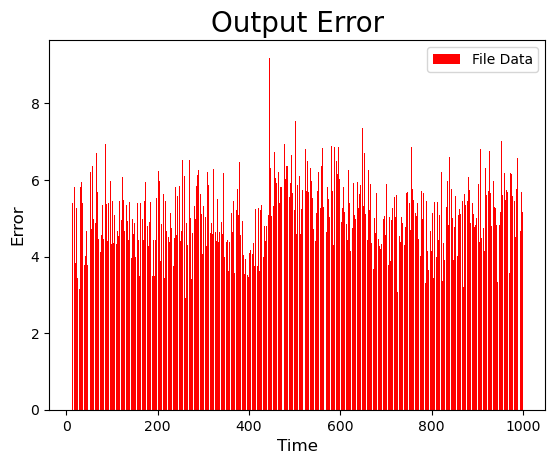

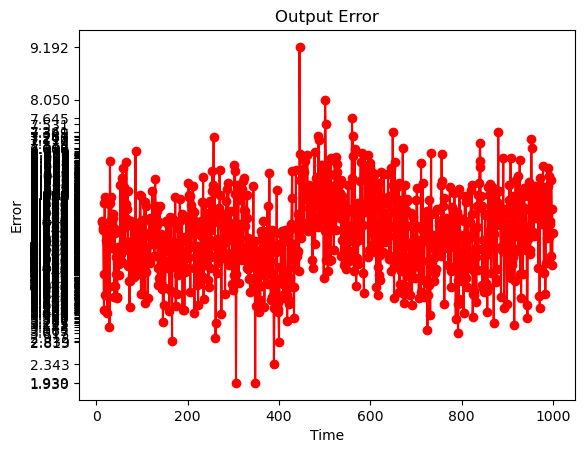

In [14]:
import matplotlib.pyplot as plt

# Histogram:
plt.bar(time_num_array, error_array, color = 'r', label = 'File Data')

plt.xlabel('Time', fontsize = 12)
plt.ylabel('Error', fontsize = 12)

plt.title('Output Error', fontsize = 20)
plt.legend()
plt.show()


# linear graph:
plt.title("Output Error")
plt.xlabel('Time')
plt.ylabel('Error')
plt.yticks(error_array)
plt.plot(time_num_array, error_array, marker = 'o', c = 'r')

plt.show()

Avg KL:
edge-wise KL-divergence to further consider the magnitude difference of link weights


This value shows us the Kullback-Leibler divergence from each iteration,
The KL value is parameter that tells us how similar the predicted network is
to the ground-truth network.

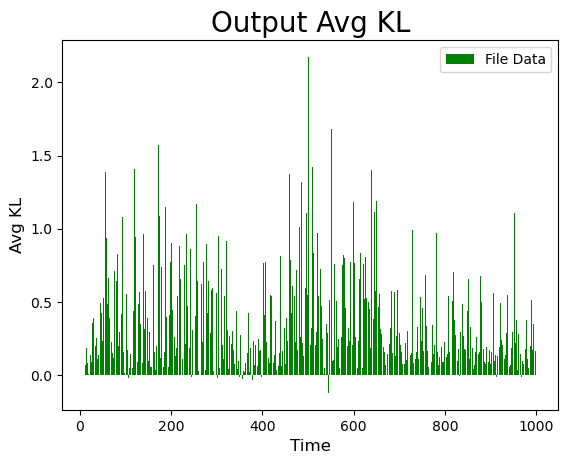

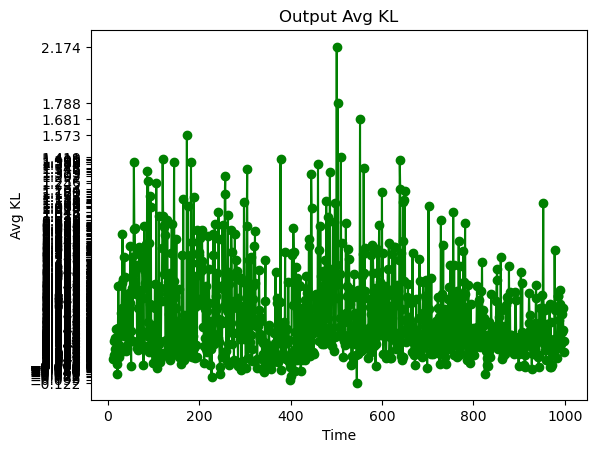

In [15]:
# Histogram:
plt.bar(time_num_array, avg_KL_array, color = 'g', label = 'File Data')

plt.xlabel('Time', fontsize = 12)
plt.ylabel('Avg KL', fontsize = 12)

plt.title('Output Avg KL', fontsize = 20)
plt.legend()
plt.show()

# linear graph:
plt.title("Output Avg KL")
plt.xlabel('Time')
plt.ylabel('Avg KL')
plt.yticks(avg_KL_array)
plt.plot(time_num_array, avg_KL_array, marker = 'o', c = 'g')

plt.show()


Avg Mis:
Mismatch rate, which represents the proportion of such mismatched edges in a certain graph snapshot, as an additional evaluation metric

The paper introduced another evaluation method which is the mismatch
rate, that represents the proportion of mismatch edges on the graph
snapshot, as an additional evaluation metric.

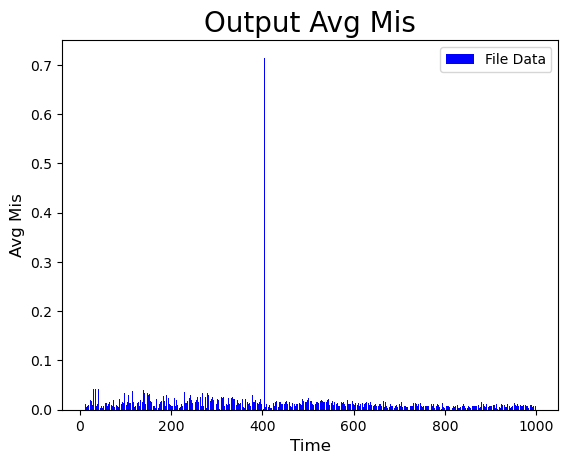

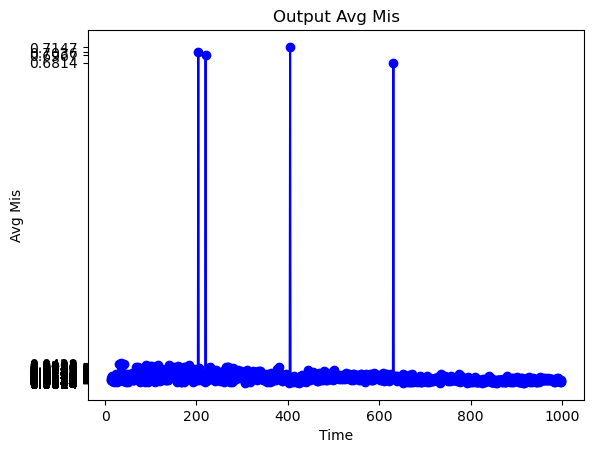

In [16]:
# Histogram
plt.bar(time_num_array, avg_mis_array, color = 'b', label = 'File Data')
 
plt.xlabel('Time', fontsize = 12)
plt.ylabel('Avg Mis', fontsize = 12)

plt.title('Output Avg Mis', fontsize = 20)
plt.legend()
plt.show()


# linear graph:
plt.title("Output Avg Mis")
plt.xlabel('Time')
plt.ylabel('Avg Mis')
plt.yticks(avg_mis_array)
plt.plot(time_num_array, avg_mis_array, marker = 'o', c = 'b')

plt.show()
